In [1]:
import lossFunctions
from lossFunctions import f1, focal_loss
from cosine_decay import CosineDecayWithRestarts

modelFile = '../working/ResNet50_COSINE.h5'
submitFile = '../working/submitResNet50_COSINE_A.csv'
loss_function = 'binary_crossentropy'
# loss_function = focal_loss
threshold = 0.35 # due to different cost of True Positive vs False Positive, this is the probability threshold to predict the class as 'yes'

lr1 = 0.0001
lr2 = 0.0006
lr_decay = 0.9
cycle_length= 1
cosine_min = 0.0001
cosine_max = 0.0006
mult_factor=2
epochs1 = cycle_length
epochs2 = 20


Using TensorFlow backend.


In [2]:
# Parameters
cosine_min = 0.0001
cosine_max = 0.0006
epochs2 = 60
cycle_length = 2
mult_factor = 3
modelFile = "../working/ResNet50_COSINE_B.h5"
submitFile = "../working/submitResNet50_COSINE_B.csv"
batch_size = 16


In [3]:
import tensorflow as tf
print(tf.__version__)
import keras; 
from keras import backend as K
print(keras.__version__)

1.11.0
2.2.4


In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import skimage.io
from skimage.transform import resize
from imgaug import augmenters as iaa
from tqdm import tqdm
import PIL
from PIL import Image
import cv2
from sklearn.utils import class_weight, shuffle
from scipy.misc import imread
import seaborn as sns

In [6]:
import warnings
warnings.filterwarnings("ignore")

In [7]:
#SIZE = 299   #Inception
SIZE = 224   #ResNet50
BATCH_SIZE = 16
SEED = 777
SHAPE = (224, 224, 3)
#SHAPE = (229, 229, 3)
VAL_RATIO = 0.2 # 20 % as validation

DIR = '../input'
gamma = 2.0
import keras
epsilon = K.epsilon()




In [8]:
import time

In [9]:
print("DateTime " + time.strftime("%c"))
start = time.time()

DateTime Mon Nov 26 00:21:34 2018


In [10]:
label_names = {
    0:  "Nucleoplasm",  
    1:  "Nuclear membrane",   
    2:  "Nucleoli",   
    3:  "Nucleoli fibrillar center",   
    4:  "Nuclear speckles",
    5:  "Nuclear bodies",   
    6:  "Endoplasmic reticulum",   
    7:  "Golgi apparatus",   
    8:  "Peroxisomes",   
    9:  "Endosomes",   
    10:  "Lysosomes",   
    11:  "Intermediate filaments",   
    12:  "Actin filaments",   
    13:  "Focal adhesion sites",   
    14:  "Microtubules",   
    15:  "Microtubule ends",   
    16:  "Cytokinetic bridge",   
    17:  "Mitotic spindle",   
    18:  "Microtubule organizing center",   
    19:  "Centrosome",   
    20:  "Lipid droplets",   
    21:  "Plasma membrane",   
    22:  "Cell junctions",   
    23:  "Mitochondria",   
    24:  "Aggresome",   
    25:  "Cytosol",   
    26:  "Cytoplasmic bodies",   
    27:  "Rods & rings"
}

reverse_train_labels = dict((v,k) for k,v in label_names.items())

def getTargetNames(row):
    row.Target = np.array(row.Target.split(" ")).astype(np.int)
    names = []
    for num in row.Target:
        name = label_names[int(num)]
        names.append(name)
    return row

def fill_targets(row):
    row.Target = np.array(row.Target.split(" ")).astype(np.int)
    for num in row.Target:
        name = label_names[int(num)]
        row.loc[name] = 1
    return row

In [11]:
def getTrainDataset():
    
    path_to_train = DIR + '/train/'
    data = pd.read_csv(DIR + '/train.csv')

    paths = []
    labels = []
    
    for name, lbl in zip(data['Id'], data['Target'].str.split(' ')):
        y = np.zeros(28)
        for key in lbl:
            y[int(key)] = 1
        paths.append(os.path.join(path_to_train, name))
        labels.append(y)

    return np.array(paths), np.array(labels)

def getTestDataset():
    
    path_to_test = DIR + '/test/'
    data = pd.read_csv(DIR + '/sample_submission.csv')

    paths = []
    labels = []
    
    for name in data['Id']:
        y = np.ones(28)
        paths.append(os.path.join(path_to_test, name))
        labels.append(y)

    return np.array(paths), np.array(labels)


In [12]:
class ProteinDataGenerator(keras.utils.Sequence):
            
    def __init__(self, paths, labels, batch_size, shape, shuffle = False, use_cache = False, augment = False,channels=3):
        self.paths, self.labels = paths, labels
        self.batch_size = batch_size
        self.shape = shape
        self.shuffle = shuffle
        self.use_cache = use_cache
        self.augment = augment
        self.channels = channels
        if use_cache == True:
            self.cache = np.zeros((paths.shape[0], shape[0], shape[1], shape[2]), dtype=np.float16)
            self.is_cached = np.zeros((paths.shape[0]))
        self.on_epoch_end()
    
    def __len__(self):
        return int(np.ceil(len(self.paths) / float(self.batch_size)))
    
    def __getitem__(self, idx):
        indexes = self.indexes[idx * self.batch_size : (idx+1) * self.batch_size]
        paths = np.array([self.paths[k] for k in indexes])
        X = np.zeros((paths.shape[0], self.shape[0], self.shape[1], self.shape[2]))
        # Generate data
        if self.use_cache == True:
            X = self.cache[indexes]
            for i, path in enumerate(paths[np.where(self.is_cached[indexes] == 0)]):
                image = self.load_image(path)
                self.is_cached[indexes[i]] = 1
                self.cache[indexes[i]] = image
                X[i] = image
        else:
            for i, path in enumerate(paths):
                X[i] = self.load_image(path)

        y = np.array([self.labels[k] for k in indexes])
#        y = self.labels[indexes]
                
        if self.augment == True:
            seq = iaa.Sequential([
                iaa.OneOf([
                    iaa.Fliplr(0.5), # horizontal flips
                    iaa.Crop(percent=(0, 0.1)), # random crops
                    # Small gaussian blur with random sigma between 0 and 0.5.
                    # But we only blur about 50% of all images.
                    iaa.Sometimes(0.5,
                        iaa.GaussianBlur(sigma=(0, 0.5))
                    ),
                    # Strengthen or weaken the contrast in each image.
                    iaa.ContrastNormalization((0.75, 1.5)),
                    # Add gaussian noise.
                    # For 50% of all images, we sample the noise once per pixel.
                    # For the other 50% of all images, we sample the noise per pixel AND
                    # channel. This can change the color (not only brightness) of the
                    # pixels.
                    iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
                    # Make some images brighter and some darker.
                    # In 20% of all cases, we sample the multiplier once per channel,
                    # which can end up changing the color of the images.
                    iaa.Multiply((0.8, 1.2), per_channel=0.2),
                    # Apply affine transformations to each image.
                    # Scale/zoom them, translate/move them, rotate them and shear them.
                    iaa.Affine(
                        scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
                        translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
                        rotate=(-180, 180),
                        shear=(-8, 8)
                    )
                ])], random_order=True)

            X = np.concatenate((X, seq.augment_images(X), seq.augment_images(X), seq.augment_images(X)), 0)
            y = np.concatenate((y, y, y, y), 0)
        
        return X, y
    
    def on_epoch_end(self):
        
        # Updates indexes after each epoch
        self.indexes = np.arange(len(self.paths))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __iter__(self):
        """Create a generator that iterate over the Sequence."""
        for item in (self[i] for i in range(len(self))):
            yield item
    
    def load4Channel(self, path):
        image_red_ch = Image.open(path+'_red.png')
        image_yellow_ch = Image.open(path+'_yellow.png')
        image_green_ch = Image.open(path+'_green.png')
        image_blue_ch = Image.open(path+'_blue.png')
        image = np.stack((
        np.array(image_red_ch), 
        np.array(image_yellow_ch),     
        np.array(image_green_ch), 
        np.array(image_blue_ch)), -1)
        image = cv2.resize(image, (self.shape[0], self.shape[1]))
        im = np.divide(image, 255) 
        return im

    def load3Channel(self, path):
        image_red_ch = Image.open(path+'_red.png')
        image_yellow_ch = Image.open(path+'_yellow.png')
        image_green_ch = Image.open(path+'_green.png')
        image_blue_ch = Image.open(path+'_blue.png')
        image = np.stack((
        np.array(image_red_ch), 
        np.array(image_green_ch), 
        np.array(image_blue_ch)), -1)
        image = cv2.resize(image, (self.shape[0], self.shape[1]))
        im = np.divide(image, 255)
        return im

    def load_image(self, path):
        if self.channels == 3:
            return self.load3Channel(path)
        else:
            return self.load4Channel(path)
        

In [13]:
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, load_model
from keras.layers import Activation, Multiply, Dropout, Flatten, Dense, GlobalMaxPooling2D, BatchNormalization, Input, Conv2D
from keras.applications.inception_v3 import InceptionV3
from keras.applications.resnet50 import ResNet50, preprocess_input
from keras.applications import Xception
from keras.callbacks import ModelCheckpoint
from keras import metrics
from keras.optimizers import Adam 
from keras import backend as K
import keras
import tensorflow as tf
from keras.models import Model
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, EarlyStopping, ReduceLROnPlateau
from keras.metrics import categorical_accuracy
from sklearn.model_selection import train_test_split




In [14]:
def create_ResNet50_model(input_shape, n_out):

    base_model = ResNet50(include_top=False,
                   weights='imagenet',
                   input_tensor=Input(shape=(224,224,3)))
    model = Sequential()
    model.add(base_model)
#    keras_models_dir = "../input/keras inception v3 notop v0.5"
#    base_model.load_weights('%s/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5' % keras_models_dir)
    model.add(Conv2D(32, kernel_size=(1,1)))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Flatten())
#    model.add(Dropout(0.5))
    model.add(Dense(1024))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Dropout(0.1))
    model.add(Dense(n_out))
    model.add(Activation('sigmoid'))
    return model


In [15]:
# split data into train, valid
paths, labels = getTrainDataset()

# divide to 
keys = np.arange(paths.shape[0], dtype=np.int)  
np.random.seed(SEED)
np.random.shuffle(keys)
lastTrainIndex = int((1-VAL_RATIO) * paths.shape[0])

#print(lastIndex, lastTrainIndex, int(lastTrainIndex * 0.8))
pathsTrain = paths[0:lastTrainIndex]
labelsTrain = labels[0:lastTrainIndex]
pathsVal = paths[lastTrainIndex:]
labelsVal = labels[lastTrainIndex:]

print(paths.shape, labels.shape)
print(pathsTrain.shape, labelsTrain.shape, pathsVal.shape, labelsVal.shape)

train_generator = ProteinDataGenerator(pathsTrain, labelsTrain, BATCH_SIZE, SHAPE, use_cache=False, augment = False, shuffle = False)
validation_generator = ProteinDataGenerator(pathsVal, labelsVal, BATCH_SIZE, SHAPE, use_cache=False, shuffle = False)


(31072,) (31072, 28)
(24857,) (24857, 28) (6215,) (6215, 28)


In [16]:

checkpoint = ModelCheckpoint(modelFile, monitor='val_loss', verbose=1, 
                             save_best_only=True, mode='min', save_weights_only = False)
#checkpoint = ModelCheckpoint('../working/ResNet50A.h5', monitor='val_loss', verbose=1, 
#                             save_best_only=True, mode='min', save_weights_only = False)
reduceLROnPlat = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, 
                                verbose=1, mode='auto', epsilon=0.0001)
cosine_restart = CosineDecayWithRestarts(min_lr = cosine_min , max_lr = cosine_max, lr_decay=lr_decay, steps_per_epoch=len(train_generator),
                                        cycle_length=cycle_length, mult_factor=mult_factor)
early = EarlyStopping(monitor="val_loss", 
                      mode="min", 
                      patience=6)


Learning Rate Decay: Cosine Decay With Restarts


In [17]:

tf.reset_default_graph()
K.clear_session()

model = create_ResNet50_model(SHAPE, n_out=28)

for layer in model.layers:
    layer.trainable = False

#model.layers[1].trainable = True
#model.layers[2].trainable = True
#model.layers[3].trainable = True
model.layers[-1].trainable = True
model.layers[-2].trainable = True
model.layers[-3].trainable = True
model.layers[-4].trainable = True
model.layers[-5].trainable = True
model.layers[-6].trainable = True


In [18]:
def focal_loss(y_true, y_pred):
    pt = y_pred * y_true + (1-y_pred) * (1-y_true)
    pt = K.clip(pt, epsilon, 1-epsilon)
    CE = -K.log(pt)
    FL = K.pow(1-pt, gamma) * CE
    loss = K.sum(FL, axis=1)
    return loss


def f1(y_true, y_pred):
    y_pred = K.round(y_pred)
    tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
    tn = K.sum(K.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + K.epsilon())
    r = tp / (tp + fn + K.epsilon())

    f1 = 2*p*r / (p+r+K.epsilon())
    f1 = tf.where(tf.is_nan(f1), tf.zeros_like(f1), f1)
    return K.mean(f1)

def f1PR(y_true, y_pred):
    y_pred = K.round(y_pred)
    tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
    tn = K.sum(K.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + K.epsilon())
    r = tp / (tp + fn + K.epsilon())

    f1 = 2*p*r / (p+r+K.epsilon())
    f1 = tf.where(tf.is_nan(f1), tf.zeros_like(f1), f1)
    return K.mean(f1), K.mean(p), K.mean(r)

def f1_loss(y_true, y_pred):
    
    tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
    tn = K.sum(K.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + K.epsilon())
    r = tp / (tp + fn + K.epsilon())

    f1 = 2*p*r / (p+r+K.epsilon())
    f1 = tf.where(tf.is_nan(f1), tf.zeros_like(f1), f1)
    return 1 - K.mean(f1)

def fbeta(y_true, y_pred, threshold_shift=0):
    beta = 2

    # just in case of hipster activation at the final layer
    y_pred = K.clip(y_pred, 0, 1)

    # shifting the prediction threshold from .5 if needed
    y_pred_bin = K.round(y_pred + threshold_shift)

    tp = K.sum(K.round(y_true * y_pred_bin)) + K.epsilon()
    fp = K.sum(K.round(K.clip(y_pred_bin - y_true, 0, 1)))
    fn = K.sum(K.round(K.clip(y_true - y_pred, 0, 1)))

    precision = tp / (tp + fp)
    recall = tp / (tp + fn)

    beta_squared = beta ** 2
    return (beta_squared + 1) * (precision * recall) / (beta_squared * precision + recall + K.epsilon())


In [19]:
model.compile(
#    loss='binary_crossentropy', 
#    loss=focal_loss,
    loss=loss_function,
#    optimizer=Adam(1e-03),    
    optimizer=Adam(1e-3),    
    metrics=['acc', f1])
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50 (Model)             (None, 7, 7, 2048)        23587712  
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 32)          65568     
_________________________________________________________________
batch_normalization_1 (Batch (None, 7, 7, 32)          128       
_________________________________________________________________
activation_50 (Activation)   (None, 7, 7, 32)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1568)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 1024)              1606656   
_________________________________________________________________
batch_normalization_2 (Batch (None, 1024)              4096      
__________

In [20]:
epochs1 = cycle_length

hist1 = model.fit_generator(
    train_generator,
    steps_per_epoch=len(train_generator),
    validation_data=validation_generator,
    validation_steps=8,
    epochs=epochs1, 
    verbose=1,
    callbacks=[cosine_restart])

Epoch 1/2


   1/1554 [..............................] - ETA: 52:07 - loss: 0.8405 - acc: 0.4688 - f1: 0.0906

   2/1554 [..............................] - ETA: 27:52 - loss: 0.7860 - acc: 0.5145 - f1: 0.0828

   3/1554 [..............................] - ETA: 18:59 - loss: 0.7398 - acc: 0.5565 - f1: 0.0884

   5/1554 [..............................] - ETA: 11:52 - loss: 0.6689 - acc: 0.6205 - f1: 0.0883

   7/1554 [..............................] - ETA: 8:49 - loss: 0.6035 - acc: 0.6779 - f1: 0.0701 

   9/1554 [..............................] - ETA: 7:08 - loss: 0.5476 - acc: 0.7242 - f1: 0.0619

  10/1554 [..............................] - ETA: 6:32 - loss: 0.5232 - acc: 0.7420 - f1: 0.0590

  12/1554 [..............................] - ETA: 5:39 - loss: 0.4808 - acc: 0.7734 - f1: 0.0583

  13/1554 [..............................] - ETA: 5:18 - loss: 0.4627 - acc: 0.7864 - f1: 0.0562

  15/1554 [..............................] - ETA: 4:45 - loss: 0.4309 - acc: 0.8064 - f1: 0.0519

  16/1554 [..............................] - ETA: 4:32 - loss: 0.4193 - acc: 0.8139 - f1: 0.0496

  17/1554 [..............................] - ETA: 4:24 - loss: 0.4086 - acc: 0.8210 - f1: 0.0477

  18/1554 [..............................] - ETA: 4:21 - loss: 0.3970 - acc: 0.8275 - f1: 0.0465

  19/1554 [..............................] - ETA: 4:17 - loss: 0.3873 - acc: 0.8332 - f1: 0.0453

  20/1554 [..............................] - ETA: 4:14 - loss: 0.3762 - acc: 0.8392 - f1: 0.0465

  21/1554 [..............................] - ETA: 4:11 - loss: 0.3672 - acc: 0.8443 - f1: 0.0461

  22/1554 [..............................] - ETA: 4:10 - loss: 0.3610 - acc: 0.8482 - f1: 0.0443

  23/1554 [..............................] - ETA: 4:08 - loss: 0.3550 - acc: 0.8519 - f1: 0.0433

  24/1554 [..............................] - ETA: 4:06 - loss: 0.3474 - acc: 0.8557 - f1: 0.0424

  25/1554 [..............................] - ETA: 4:04 - loss: 0.3403 - acc: 0.8596 - f1: 0.0411

  26/1554 [..............................] - ETA: 4:01 - loss: 0.3336 - acc: 0.8627 - f1: 0.0406

  27/1554 [..............................] - ETA: 3:59 - loss: 0.3286 - acc: 0.8660 - f1: 0.0405

  28/1554 [..............................] - ETA: 3:57 - loss: 0.3238 - acc: 0.8689 - f1: 0.0404

  29/1554 [..............................] - ETA: 3:56 - loss: 0.3183 - acc: 0.8715 - f1: 0.0400

  30/1554 [..............................] - ETA: 3:55 - loss: 0.3132 - acc: 0.8740 - f1: 0.0392

  31/1554 [..............................] - ETA: 3:54 - loss: 0.3081 - acc: 0.8766 - f1: 0.0393

  32/1554 [..............................] - ETA: 3:52 - loss: 0.3038 - acc: 0.8788 - f1: 0.0392

  33/1554 [..............................] - ETA: 3:52 - loss: 0.3005 - acc: 0.8805 - f1: 0.0383

  34/1554 [..............................] - ETA: 3:51 - loss: 0.2978 - acc: 0.8822 - f1: 0.0376

  35/1554 [..............................] - ETA: 3:50 - loss: 0.2936 - acc: 0.8840 - f1: 0.0370

  36/1554 [..............................] - ETA: 3:49 - loss: 0.2912 - acc: 0.8854 - f1: 0.0367

  37/1554 [..............................] - ETA: 3:48 - loss: 0.2887 - acc: 0.8871 - f1: 0.0376

  38/1554 [..............................] - ETA: 3:47 - loss: 0.2870 - acc: 0.8885 - f1: 0.0376

  39/1554 [..............................] - ETA: 3:45 - loss: 0.2846 - acc: 0.8899 - f1: 0.0377

  40/1554 [..............................] - ETA: 3:44 - loss: 0.2816 - acc: 0.8912 - f1: 0.0374

  41/1554 [..............................] - ETA: 3:44 - loss: 0.2800 - acc: 0.8924 - f1: 0.0373

  42/1554 [..............................] - ETA: 3:43 - loss: 0.2781 - acc: 0.8935 - f1: 0.0373

  43/1554 [..............................] - ETA: 3:42 - loss: 0.2764 - acc: 0.8945 - f1: 0.0370

  44/1554 [..............................] - ETA: 3:42 - loss: 0.2740 - acc: 0.8959 - f1: 0.0375

  45/1554 [..............................] - ETA: 3:41 - loss: 0.2719 - acc: 0.8972 - f1: 0.0376

  46/1554 [..............................] - ETA: 3:41 - loss: 0.2705 - acc: 0.8980 - f1: 0.0376

  47/1554 [..............................] - ETA: 3:40 - loss: 0.2690 - acc: 0.8989 - f1: 0.0375

  48/1554 [..............................] - ETA: 3:40 - loss: 0.2682 - acc: 0.8996 - f1: 0.0373

  49/1554 [..............................] - ETA: 3:39 - loss: 0.2670 - acc: 0.9003 - f1: 0.0373

  50/1554 [..............................] - ETA: 3:38 - loss: 0.2663 - acc: 0.9008 - f1: 0.0367

  51/1554 [..............................] - ETA: 3:38 - loss: 0.2646 - acc: 0.9016 - f1: 0.0366

  52/1554 [>.............................] - ETA: 3:38 - loss: 0.2625 - acc: 0.9025 - f1: 0.0367

  53/1554 [>.............................] - ETA: 3:37 - loss: 0.2619 - acc: 0.9030 - f1: 0.0366

  54/1554 [>.............................] - ETA: 3:37 - loss: 0.2604 - acc: 0.9035 - f1: 0.0361

  55/1554 [>.............................] - ETA: 3:36 - loss: 0.2599 - acc: 0.9041 - f1: 0.0364

  56/1554 [>.............................] - ETA: 3:35 - loss: 0.2586 - acc: 0.9050 - f1: 0.0365

  57/1554 [>.............................] - ETA: 3:35 - loss: 0.2571 - acc: 0.9057 - f1: 0.0364

  58/1554 [>.............................] - ETA: 3:34 - loss: 0.2560 - acc: 0.9064 - f1: 0.0365

  59/1554 [>.............................] - ETA: 3:34 - loss: 0.2550 - acc: 0.9070 - f1: 0.0364

  60/1554 [>.............................] - ETA: 3:33 - loss: 0.2543 - acc: 0.9074 - f1: 0.0362

  61/1554 [>.............................] - ETA: 3:33 - loss: 0.2537 - acc: 0.9079 - f1: 0.0359

  62/1554 [>.............................] - ETA: 3:32 - loss: 0.2528 - acc: 0.9083 - f1: 0.0356

  63/1554 [>.............................] - ETA: 3:32 - loss: 0.2516 - acc: 0.9088 - f1: 0.0355

  64/1554 [>.............................] - ETA: 3:31 - loss: 0.2505 - acc: 0.9094 - f1: 0.0356

  65/1554 [>.............................] - ETA: 3:31 - loss: 0.2495 - acc: 0.9098 - f1: 0.0354

  66/1554 [>.............................] - ETA: 3:31 - loss: 0.2487 - acc: 0.9102 - f1: 0.0354

  67/1554 [>.............................] - ETA: 3:31 - loss: 0.2477 - acc: 0.9107 - f1: 0.0354

  68/1554 [>.............................] - ETA: 3:30 - loss: 0.2471 - acc: 0.9112 - f1: 0.0354

  69/1554 [>.............................] - ETA: 3:30 - loss: 0.2464 - acc: 0.9117 - f1: 0.0356

  70/1554 [>.............................] - ETA: 3:29 - loss: 0.2458 - acc: 0.9121 - f1: 0.0356

  71/1554 [>.............................] - ETA: 3:29 - loss: 0.2451 - acc: 0.9124 - f1: 0.0354

  72/1554 [>.............................] - ETA: 3:29 - loss: 0.2442 - acc: 0.9128 - f1: 0.0353

  73/1554 [>.............................] - ETA: 3:29 - loss: 0.2432 - acc: 0.9133 - f1: 0.0352

  74/1554 [>.............................] - ETA: 3:29 - loss: 0.2424 - acc: 0.9135 - f1: 0.0348

  75/1554 [>.............................] - ETA: 3:29 - loss: 0.2414 - acc: 0.9142 - f1: 0.0349

  76/1554 [>.............................] - ETA: 3:28 - loss: 0.2403 - acc: 0.9145 - f1: 0.0353

  77/1554 [>.............................] - ETA: 3:28 - loss: 0.2399 - acc: 0.9148 - f1: 0.0351

  78/1554 [>.............................] - ETA: 3:28 - loss: 0.2392 - acc: 0.9152 - f1: 0.0349

  79/1554 [>.............................] - ETA: 3:27 - loss: 0.2388 - acc: 0.9156 - f1: 0.0349

  80/1554 [>.............................] - ETA: 3:27 - loss: 0.2379 - acc: 0.9159 - f1: 0.0347

  81/1554 [>.............................] - ETA: 3:26 - loss: 0.2368 - acc: 0.9163 - f1: 0.0347

  82/1554 [>.............................] - ETA: 3:26 - loss: 0.2363 - acc: 0.9166 - f1: 0.0345

  83/1554 [>.............................] - ETA: 3:26 - loss: 0.2353 - acc: 0.9171 - f1: 0.0346

  84/1554 [>.............................] - ETA: 3:26 - loss: 0.2349 - acc: 0.9174 - f1: 0.0346

  85/1554 [>.............................] - ETA: 3:25 - loss: 0.2341 - acc: 0.9177 - f1: 0.0345

  86/1554 [>.............................] - ETA: 3:25 - loss: 0.2335 - acc: 0.9180 - f1: 0.0344

  87/1554 [>.............................] - ETA: 3:25 - loss: 0.2330 - acc: 0.9182 - f1: 0.0342

  88/1554 [>.............................] - ETA: 3:24 - loss: 0.2319 - acc: 0.9186 - f1: 0.0342

  89/1554 [>.............................] - ETA: 3:24 - loss: 0.2315 - acc: 0.9188 - f1: 0.0341

  90/1554 [>.............................] - ETA: 3:24 - loss: 0.2309 - acc: 0.9191 - f1: 0.0341

  91/1554 [>.............................] - ETA: 3:23 - loss: 0.2305 - acc: 0.9193 - f1: 0.0339

  92/1554 [>.............................] - ETA: 3:23 - loss: 0.2299 - acc: 0.9197 - f1: 0.0340

  93/1554 [>.............................] - ETA: 3:23 - loss: 0.2296 - acc: 0.9199 - f1: 0.0339

  94/1554 [>.............................] - ETA: 3:23 - loss: 0.2289 - acc: 0.9201 - f1: 0.0338

  95/1554 [>.............................] - ETA: 3:22 - loss: 0.2282 - acc: 0.9204 - f1: 0.0336

  96/1554 [>.............................] - ETA: 3:22 - loss: 0.2281 - acc: 0.9205 - f1: 0.0333

  97/1554 [>.............................] - ETA: 3:22 - loss: 0.2274 - acc: 0.9208 - f1: 0.0333

  98/1554 [>.............................] - ETA: 3:21 - loss: 0.2270 - acc: 0.9211 - f1: 0.0333

  99/1554 [>.............................] - ETA: 3:21 - loss: 0.2269 - acc: 0.9212 - f1: 0.0333

 100/1554 [>.............................] - ETA: 3:21 - loss: 0.2262 - acc: 0.9216 - f1: 0.0336

 101/1554 [>.............................] - ETA: 3:21 - loss: 0.2258 - acc: 0.9218 - f1: 0.0336

 102/1554 [>.............................] - ETA: 3:20 - loss: 0.2254 - acc: 0.9219 - f1: 0.0334

 103/1554 [>.............................] - ETA: 3:20 - loss: 0.2251 - acc: 0.9221 - f1: 0.0335

 104/1554 [=>............................] - ETA: 3:20 - loss: 0.2248 - acc: 0.9223 - f1: 0.0335

 105/1554 [=>............................] - ETA: 3:20 - loss: 0.2246 - acc: 0.9225 - f1: 0.0334

 106/1554 [=>............................] - ETA: 3:20 - loss: 0.2241 - acc: 0.9226 - f1: 0.0333

 107/1554 [=>............................] - ETA: 3:19 - loss: 0.2234 - acc: 0.9229 - f1: 0.0335

 108/1554 [=>............................] - ETA: 3:19 - loss: 0.2229 - acc: 0.9230 - f1: 0.0333

 109/1554 [=>............................] - ETA: 3:19 - loss: 0.2226 - acc: 0.9231 - f1: 0.0334

 110/1554 [=>............................] - ETA: 3:19 - loss: 0.2223 - acc: 0.9233 - f1: 0.0333

 111/1554 [=>............................] - ETA: 3:19 - loss: 0.2220 - acc: 0.9233 - f1: 0.0332

 112/1554 [=>............................] - ETA: 3:18 - loss: 0.2219 - acc: 0.9233 - f1: 0.0331

 113/1554 [=>............................] - ETA: 3:18 - loss: 0.2215 - acc: 0.9235 - f1: 0.0330

 114/1554 [=>............................] - ETA: 3:18 - loss: 0.2213 - acc: 0.9236 - f1: 0.0330

 115/1554 [=>............................] - ETA: 3:18 - loss: 0.2208 - acc: 0.9238 - f1: 0.0330

 116/1554 [=>............................] - ETA: 3:18 - loss: 0.2205 - acc: 0.9240 - f1: 0.0330

 117/1554 [=>............................] - ETA: 3:17 - loss: 0.2200 - acc: 0.9241 - f1: 0.0330

 118/1554 [=>............................] - ETA: 3:17 - loss: 0.2194 - acc: 0.9244 - f1: 0.0332

 119/1554 [=>............................] - ETA: 3:17 - loss: 0.2190 - acc: 0.9246 - f1: 0.0334

 120/1554 [=>............................] - ETA: 3:17 - loss: 0.2191 - acc: 0.9247 - f1: 0.0334

 121/1554 [=>............................] - ETA: 3:16 - loss: 0.2186 - acc: 0.9249 - f1: 0.0335

 122/1554 [=>............................] - ETA: 3:16 - loss: 0.2184 - acc: 0.9250 - f1: 0.0337

 123/1554 [=>............................] - ETA: 3:16 - loss: 0.2181 - acc: 0.9251 - f1: 0.0337

 124/1554 [=>............................] - ETA: 3:16 - loss: 0.2178 - acc: 0.9253 - f1: 0.0337

 125/1554 [=>............................] - ETA: 3:16 - loss: 0.2176 - acc: 0.9254 - f1: 0.0335

 126/1554 [=>............................] - ETA: 3:16 - loss: 0.2173 - acc: 0.9255 - f1: 0.0337

 127/1554 [=>............................] - ETA: 3:15 - loss: 0.2170 - acc: 0.9256 - f1: 0.0337

 128/1554 [=>............................] - ETA: 3:15 - loss: 0.2170 - acc: 0.9256 - f1: 0.0338

 129/1554 [=>............................] - ETA: 3:15 - loss: 0.2167 - acc: 0.9257 - f1: 0.0339

 130/1554 [=>............................] - ETA: 3:15 - loss: 0.2162 - acc: 0.9259 - f1: 0.0340

 131/1554 [=>............................] - ETA: 3:15 - loss: 0.2160 - acc: 0.9260 - f1: 0.0341

 132/1554 [=>............................] - ETA: 3:15 - loss: 0.2157 - acc: 0.9261 - f1: 0.0341

 133/1554 [=>............................] - ETA: 3:14 - loss: 0.2153 - acc: 0.9263 - f1: 0.0341

 134/1554 [=>............................] - ETA: 3:14 - loss: 0.2153 - acc: 0.9264 - f1: 0.0340

 135/1554 [=>............................] - ETA: 3:14 - loss: 0.2154 - acc: 0.9265 - f1: 0.0342

 136/1554 [=>............................] - ETA: 3:14 - loss: 0.2150 - acc: 0.9267 - f1: 0.0343

 137/1554 [=>............................] - ETA: 3:14 - loss: 0.2148 - acc: 0.9267 - f1: 0.0341

 138/1554 [=>............................] - ETA: 3:14 - loss: 0.2144 - acc: 0.9268 - f1: 0.0341

 139/1554 [=>............................] - ETA: 3:13 - loss: 0.2141 - acc: 0.9270 - f1: 0.0341

 140/1554 [=>............................] - ETA: 3:13 - loss: 0.2140 - acc: 0.9270 - f1: 0.0341

 141/1554 [=>............................] - ETA: 3:13 - loss: 0.2139 - acc: 0.9271 - f1: 0.0341

 142/1554 [=>............................] - ETA: 3:13 - loss: 0.2137 - acc: 0.9272 - f1: 0.0343

 143/1554 [=>............................] - ETA: 3:13 - loss: 0.2136 - acc: 0.9274 - f1: 0.0343

 144/1554 [=>............................] - ETA: 3:13 - loss: 0.2134 - acc: 0.9275 - f1: 0.0343

 145/1554 [=>............................] - ETA: 3:13 - loss: 0.2134 - acc: 0.9275 - f1: 0.0342

 146/1554 [=>............................] - ETA: 3:12 - loss: 0.2133 - acc: 0.9276 - f1: 0.0342

 147/1554 [=>............................] - ETA: 3:12 - loss: 0.2131 - acc: 0.9278 - f1: 0.0345

 148/1554 [=>............................] - ETA: 3:12 - loss: 0.2127 - acc: 0.9279 - f1: 0.0344

 149/1554 [=>............................] - ETA: 3:12 - loss: 0.2126 - acc: 0.9279 - f1: 0.0343

 150/1554 [=>............................] - ETA: 3:12 - loss: 0.2125 - acc: 0.9280 - f1: 0.0341

 151/1554 [=>............................] - ETA: 3:12 - loss: 0.2126 - acc: 0.9280 - f1: 0.0340

 152/1554 [=>............................] - ETA: 3:11 - loss: 0.2123 - acc: 0.9281 - f1: 0.0341

 153/1554 [=>............................] - ETA: 3:11 - loss: 0.2121 - acc: 0.9281 - f1: 0.0340

 154/1554 [=>............................] - ETA: 3:11 - loss: 0.2118 - acc: 0.9282 - f1: 0.0340

 155/1554 [=>............................] - ETA: 3:11 - loss: 0.2118 - acc: 0.9283 - f1: 0.0341

 156/1554 [==>...........................] - ETA: 3:11 - loss: 0.2117 - acc: 0.9283 - f1: 0.0341

 157/1554 [==>...........................] - ETA: 3:10 - loss: 0.2115 - acc: 0.9285 - f1: 0.0344

 158/1554 [==>...........................] - ETA: 3:10 - loss: 0.2114 - acc: 0.9286 - f1: 0.0344

 159/1554 [==>...........................] - ETA: 3:10 - loss: 0.2113 - acc: 0.9286 - f1: 0.0345

 160/1554 [==>...........................] - ETA: 3:10 - loss: 0.2114 - acc: 0.9286 - f1: 0.0344

 161/1554 [==>...........................] - ETA: 3:10 - loss: 0.2116 - acc: 0.9286 - f1: 0.0344

 162/1554 [==>...........................] - ETA: 3:10 - loss: 0.2113 - acc: 0.9287 - f1: 0.0345

 163/1554 [==>...........................] - ETA: 3:10 - loss: 0.2111 - acc: 0.9288 - f1: 0.0347

 164/1554 [==>...........................] - ETA: 3:09 - loss: 0.2110 - acc: 0.9288 - f1: 0.0347

 165/1554 [==>...........................] - ETA: 3:09 - loss: 0.2110 - acc: 0.9289 - f1: 0.0346

 166/1554 [==>...........................] - ETA: 3:09 - loss: 0.2109 - acc: 0.9289 - f1: 0.0346

 167/1554 [==>...........................] - ETA: 3:09 - loss: 0.2108 - acc: 0.9290 - f1: 0.0345

 168/1554 [==>...........................] - ETA: 3:09 - loss: 0.2108 - acc: 0.9290 - f1: 0.0344

 169/1554 [==>...........................] - ETA: 3:09 - loss: 0.2107 - acc: 0.9291 - f1: 0.0344

 170/1554 [==>...........................] - ETA: 3:09 - loss: 0.2106 - acc: 0.9291 - f1: 0.0346

 171/1554 [==>...........................] - ETA: 3:08 - loss: 0.2105 - acc: 0.9292 - f1: 0.0346

 172/1554 [==>...........................] - ETA: 3:08 - loss: 0.2103 - acc: 0.9293 - f1: 0.0345

 173/1554 [==>...........................] - ETA: 3:08 - loss: 0.2102 - acc: 0.9293 - f1: 0.0344

 174/1554 [==>...........................] - ETA: 3:08 - loss: 0.2102 - acc: 0.9293 - f1: 0.0345

 175/1554 [==>...........................] - ETA: 3:08 - loss: 0.2099 - acc: 0.9294 - f1: 0.0345

 176/1554 [==>...........................] - ETA: 3:08 - loss: 0.2098 - acc: 0.9295 - f1: 0.0345

 177/1554 [==>...........................] - ETA: 3:07 - loss: 0.2096 - acc: 0.9296 - f1: 0.0345

 178/1554 [==>...........................] - ETA: 3:07 - loss: 0.2093 - acc: 0.9297 - f1: 0.0346

 179/1554 [==>...........................] - ETA: 3:07 - loss: 0.2092 - acc: 0.9298 - f1: 0.0346

 180/1554 [==>...........................] - ETA: 3:07 - loss: 0.2090 - acc: 0.9299 - f1: 0.0346

 181/1554 [==>...........................] - ETA: 3:07 - loss: 0.2088 - acc: 0.9300 - f1: 0.0348

 182/1554 [==>...........................] - ETA: 3:06 - loss: 0.2088 - acc: 0.9301 - f1: 0.0347

 183/1554 [==>...........................] - ETA: 3:06 - loss: 0.2088 - acc: 0.9301 - f1: 0.0347

 184/1554 [==>...........................] - ETA: 3:06 - loss: 0.2088 - acc: 0.9301 - f1: 0.0346

 185/1554 [==>...........................] - ETA: 3:06 - loss: 0.2086 - acc: 0.9302 - f1: 0.0346

 186/1554 [==>...........................] - ETA: 3:06 - loss: 0.2083 - acc: 0.9303 - f1: 0.0345

 187/1554 [==>...........................] - ETA: 3:06 - loss: 0.2083 - acc: 0.9302 - f1: 0.0344

 188/1554 [==>...........................] - ETA: 3:05 - loss: 0.2080 - acc: 0.9303 - f1: 0.0344

 189/1554 [==>...........................] - ETA: 3:05 - loss: 0.2077 - acc: 0.9304 - f1: 0.0348

 190/1554 [==>...........................] - ETA: 3:05 - loss: 0.2075 - acc: 0.9306 - f1: 0.0348

 191/1554 [==>...........................] - ETA: 3:05 - loss: 0.2075 - acc: 0.9306 - f1: 0.0348

 192/1554 [==>...........................] - ETA: 3:05 - loss: 0.2074 - acc: 0.9307 - f1: 0.0349

 193/1554 [==>...........................] - ETA: 3:05 - loss: 0.2070 - acc: 0.9308 - f1: 0.0350

 194/1554 [==>...........................] - ETA: 3:05 - loss: 0.2071 - acc: 0.9308 - f1: 0.0349

 195/1554 [==>...........................] - ETA: 3:04 - loss: 0.2069 - acc: 0.9309 - f1: 0.0351

 196/1554 [==>...........................] - ETA: 3:04 - loss: 0.2068 - acc: 0.9309 - f1: 0.0351

 197/1554 [==>...........................] - ETA: 3:04 - loss: 0.2066 - acc: 0.9310 - f1: 0.0351

 198/1554 [==>...........................] - ETA: 3:04 - loss: 0.2066 - acc: 0.9310 - f1: 0.0352

 199/1554 [==>...........................] - ETA: 3:04 - loss: 0.2064 - acc: 0.9311 - f1: 0.0352

 200/1554 [==>...........................] - ETA: 3:04 - loss: 0.2062 - acc: 0.9311 - f1: 0.0352

 201/1554 [==>...........................] - ETA: 3:04 - loss: 0.2060 - acc: 0.9312 - f1: 0.0353

 202/1554 [==>...........................] - ETA: 3:03 - loss: 0.2059 - acc: 0.9313 - f1: 0.0354

 203/1554 [==>...........................] - ETA: 3:03 - loss: 0.2059 - acc: 0.9312 - f1: 0.0353

 204/1554 [==>...........................] - ETA: 3:03 - loss: 0.2059 - acc: 0.9313 - f1: 0.0353

 205/1554 [==>...........................] - ETA: 3:03 - loss: 0.2058 - acc: 0.9313 - f1: 0.0353

 206/1554 [==>...........................] - ETA: 3:03 - loss: 0.2056 - acc: 0.9314 - f1: 0.0353

 207/1554 [==>...........................] - ETA: 3:03 - loss: 0.2055 - acc: 0.9314 - f1: 0.0353

 208/1554 [===>..........................] - ETA: 3:03 - loss: 0.2054 - acc: 0.9315 - f1: 0.0352

 209/1554 [===>..........................] - ETA: 3:03 - loss: 0.2053 - acc: 0.9315 - f1: 0.0352

 210/1554 [===>..........................] - ETA: 3:02 - loss: 0.2051 - acc: 0.9316 - f1: 0.0352

 211/1554 [===>..........................] - ETA: 3:02 - loss: 0.2050 - acc: 0.9316 - f1: 0.0352

 212/1554 [===>..........................] - ETA: 3:02 - loss: 0.2050 - acc: 0.9317 - f1: 0.0352

 213/1554 [===>..........................] - ETA: 3:02 - loss: 0.2050 - acc: 0.9317 - f1: 0.0352

 214/1554 [===>..........................] - ETA: 3:02 - loss: 0.2048 - acc: 0.9317 - f1: 0.0352

 215/1554 [===>..........................] - ETA: 3:01 - loss: 0.2046 - acc: 0.9318 - f1: 0.0352

 216/1554 [===>..........................] - ETA: 3:01 - loss: 0.2046 - acc: 0.9318 - f1: 0.0351

 217/1554 [===>..........................] - ETA: 3:01 - loss: 0.2043 - acc: 0.9319 - f1: 0.0351

 218/1554 [===>..........................] - ETA: 3:01 - loss: 0.2044 - acc: 0.9319 - f1: 0.0352

 219/1554 [===>..........................] - ETA: 3:01 - loss: 0.2045 - acc: 0.9319 - f1: 0.0352

 220/1554 [===>..........................] - ETA: 3:01 - loss: 0.2044 - acc: 0.9320 - f1: 0.0351

 221/1554 [===>..........................] - ETA: 3:01 - loss: 0.2044 - acc: 0.9320 - f1: 0.0351

 222/1554 [===>..........................] - ETA: 3:00 - loss: 0.2042 - acc: 0.9321 - f1: 0.0352

 223/1554 [===>..........................] - ETA: 3:00 - loss: 0.2041 - acc: 0.9322 - f1: 0.0352

 224/1554 [===>..........................] - ETA: 3:00 - loss: 0.2040 - acc: 0.9322 - f1: 0.0352

 225/1554 [===>..........................] - ETA: 3:00 - loss: 0.2038 - acc: 0.9323 - f1: 0.0352

 226/1554 [===>..........................] - ETA: 3:00 - loss: 0.2038 - acc: 0.9323 - f1: 0.0352

 227/1554 [===>..........................] - ETA: 3:00 - loss: 0.2037 - acc: 0.9323 - f1: 0.0353

 228/1554 [===>..........................] - ETA: 3:00 - loss: 0.2035 - acc: 0.9324 - f1: 0.0353

 229/1554 [===>..........................] - ETA: 2:59 - loss: 0.2033 - acc: 0.9324 - f1: 0.0353

 230/1554 [===>..........................] - ETA: 2:59 - loss: 0.2030 - acc: 0.9325 - f1: 0.0353

 231/1554 [===>..........................] - ETA: 2:59 - loss: 0.2030 - acc: 0.9326 - f1: 0.0353

 232/1554 [===>..........................] - ETA: 2:59 - loss: 0.2031 - acc: 0.9326 - f1: 0.0353

 233/1554 [===>..........................] - ETA: 2:59 - loss: 0.2031 - acc: 0.9326 - f1: 0.0354

 234/1554 [===>..........................] - ETA: 2:59 - loss: 0.2030 - acc: 0.9326 - f1: 0.0353

 235/1554 [===>..........................] - ETA: 2:58 - loss: 0.2029 - acc: 0.9327 - f1: 0.0353

 236/1554 [===>..........................] - ETA: 2:58 - loss: 0.2029 - acc: 0.9327 - f1: 0.0353

 237/1554 [===>..........................] - ETA: 2:58 - loss: 0.2027 - acc: 0.9328 - f1: 0.0352

 238/1554 [===>..........................] - ETA: 2:58 - loss: 0.2027 - acc: 0.9328 - f1: 0.0352

 239/1554 [===>..........................] - ETA: 2:58 - loss: 0.2026 - acc: 0.9328 - f1: 0.0351

 240/1554 [===>..........................] - ETA: 2:58 - loss: 0.2024 - acc: 0.9329 - f1: 0.0352

 241/1554 [===>..........................] - ETA: 2:57 - loss: 0.2023 - acc: 0.9330 - f1: 0.0351

 242/1554 [===>..........................] - ETA: 2:57 - loss: 0.2021 - acc: 0.9330 - f1: 0.0351

 243/1554 [===>..........................] - ETA: 2:57 - loss: 0.2021 - acc: 0.9331 - f1: 0.0352

 244/1554 [===>..........................] - ETA: 2:57 - loss: 0.2021 - acc: 0.9331 - f1: 0.0351

 245/1554 [===>..........................] - ETA: 2:57 - loss: 0.2020 - acc: 0.9332 - f1: 0.0352

 246/1554 [===>..........................] - ETA: 2:57 - loss: 0.2019 - acc: 0.9332 - f1: 0.0352

 247/1554 [===>..........................] - ETA: 2:56 - loss: 0.2016 - acc: 0.9333 - f1: 0.0354

 248/1554 [===>..........................] - ETA: 2:56 - loss: 0.2015 - acc: 0.9334 - f1: 0.0357

 249/1554 [===>..........................] - ETA: 2:56 - loss: 0.2015 - acc: 0.9334 - f1: 0.0356

 250/1554 [===>..........................] - ETA: 2:56 - loss: 0.2013 - acc: 0.9335 - f1: 0.0356

 251/1554 [===>..........................] - ETA: 2:56 - loss: 0.2011 - acc: 0.9335 - f1: 0.0356

 252/1554 [===>..........................] - ETA: 2:56 - loss: 0.2011 - acc: 0.9335 - f1: 0.0356

 253/1554 [===>..........................] - ETA: 2:55 - loss: 0.2010 - acc: 0.9335 - f1: 0.0355

 254/1554 [===>..........................] - ETA: 2:55 - loss: 0.2010 - acc: 0.9335 - f1: 0.0355

 255/1554 [===>..........................] - ETA: 2:55 - loss: 0.2007 - acc: 0.9336 - f1: 0.0355

 256/1554 [===>..........................] - ETA: 2:55 - loss: 0.2007 - acc: 0.9337 - f1: 0.0356

 257/1554 [===>..........................] - ETA: 2:55 - loss: 0.2006 - acc: 0.9337 - f1: 0.0355

 258/1554 [===>..........................] - ETA: 2:55 - loss: 0.2005 - acc: 0.9337 - f1: 0.0354

 259/1554 [====>.........................] - ETA: 2:54 - loss: 0.2004 - acc: 0.9338 - f1: 0.0354

 260/1554 [====>.........................] - ETA: 2:54 - loss: 0.2004 - acc: 0.9338 - f1: 0.0353

 261/1554 [====>.........................] - ETA: 2:54 - loss: 0.2002 - acc: 0.9339 - f1: 0.0356

 262/1554 [====>.........................] - ETA: 2:54 - loss: 0.2001 - acc: 0.9339 - f1: 0.0356

 263/1554 [====>.........................] - ETA: 2:54 - loss: 0.2000 - acc: 0.9340 - f1: 0.0356

 264/1554 [====>.........................] - ETA: 2:54 - loss: 0.1999 - acc: 0.9340 - f1: 0.0356

 265/1554 [====>.........................] - ETA: 2:54 - loss: 0.1998 - acc: 0.9341 - f1: 0.0356

 266/1554 [====>.........................] - ETA: 2:53 - loss: 0.1998 - acc: 0.9341 - f1: 0.0355

 267/1554 [====>.........................] - ETA: 2:53 - loss: 0.1997 - acc: 0.9341 - f1: 0.0355

 268/1554 [====>.........................] - ETA: 2:53 - loss: 0.1996 - acc: 0.9342 - f1: 0.0355

 269/1554 [====>.........................] - ETA: 2:53 - loss: 0.1995 - acc: 0.9342 - f1: 0.0356

 270/1554 [====>.........................] - ETA: 2:53 - loss: 0.1994 - acc: 0.9343 - f1: 0.0356

 271/1554 [====>.........................] - ETA: 2:53 - loss: 0.1995 - acc: 0.9342 - f1: 0.0355

 272/1554 [====>.........................] - ETA: 2:53 - loss: 0.1994 - acc: 0.9343 - f1: 0.0355

 273/1554 [====>.........................] - ETA: 2:52 - loss: 0.1993 - acc: 0.9343 - f1: 0.0355

 274/1554 [====>.........................] - ETA: 2:52 - loss: 0.1992 - acc: 0.9343 - f1: 0.0355

 275/1554 [====>.........................] - ETA: 2:52 - loss: 0.1993 - acc: 0.9343 - f1: 0.0354

 276/1554 [====>.........................] - ETA: 2:52 - loss: 0.1993 - acc: 0.9343 - f1: 0.0354

 277/1554 [====>.........................] - ETA: 2:52 - loss: 0.1992 - acc: 0.9344 - f1: 0.0355

 278/1554 [====>.........................] - ETA: 2:52 - loss: 0.1990 - acc: 0.9344 - f1: 0.0354

 279/1554 [====>.........................] - ETA: 2:52 - loss: 0.1989 - acc: 0.9345 - f1: 0.0356

 280/1554 [====>.........................] - ETA: 2:51 - loss: 0.1988 - acc: 0.9345 - f1: 0.0356

 281/1554 [====>.........................] - ETA: 2:51 - loss: 0.1988 - acc: 0.9345 - f1: 0.0355

 282/1554 [====>.........................] - ETA: 2:51 - loss: 0.1988 - acc: 0.9345 - f1: 0.0355

 283/1554 [====>.........................] - ETA: 2:51 - loss: 0.1986 - acc: 0.9345 - f1: 0.0355

 284/1554 [====>.........................] - ETA: 2:51 - loss: 0.1985 - acc: 0.9345 - f1: 0.0356

 285/1554 [====>.........................] - ETA: 2:51 - loss: 0.1985 - acc: 0.9345 - f1: 0.0356

 286/1554 [====>.........................] - ETA: 2:51 - loss: 0.1984 - acc: 0.9346 - f1: 0.0356

 287/1554 [====>.........................] - ETA: 2:50 - loss: 0.1983 - acc: 0.9346 - f1: 0.0356

 288/1554 [====>.........................] - ETA: 2:50 - loss: 0.1983 - acc: 0.9346 - f1: 0.0356

 289/1554 [====>.........................] - ETA: 2:50 - loss: 0.1983 - acc: 0.9346 - f1: 0.0357

 290/1554 [====>.........................] - ETA: 2:50 - loss: 0.1982 - acc: 0.9346 - f1: 0.0358

 291/1554 [====>.........................] - ETA: 2:50 - loss: 0.1982 - acc: 0.9346 - f1: 0.0359

 292/1554 [====>.........................] - ETA: 2:50 - loss: 0.1981 - acc: 0.9346 - f1: 0.0359

 293/1554 [====>.........................] - ETA: 2:50 - loss: 0.1981 - acc: 0.9346 - f1: 0.0359

 294/1554 [====>.........................] - ETA: 2:49 - loss: 0.1980 - acc: 0.9347 - f1: 0.0360

 295/1554 [====>.........................] - ETA: 2:49 - loss: 0.1980 - acc: 0.9347 - f1: 0.0360

 296/1554 [====>.........................] - ETA: 2:49 - loss: 0.1979 - acc: 0.9348 - f1: 0.0361

 297/1554 [====>.........................] - ETA: 2:49 - loss: 0.1979 - acc: 0.9348 - f1: 0.0361

 298/1554 [====>.........................] - ETA: 2:49 - loss: 0.1978 - acc: 0.9348 - f1: 0.0361

 299/1554 [====>.........................] - ETA: 2:49 - loss: 0.1977 - acc: 0.9348 - f1: 0.0361

 300/1554 [====>.........................] - ETA: 2:49 - loss: 0.1977 - acc: 0.9348 - f1: 0.0361

 301/1554 [====>.........................] - ETA: 2:48 - loss: 0.1977 - acc: 0.9348 - f1: 0.0361

 302/1554 [====>.........................] - ETA: 2:48 - loss: 0.1975 - acc: 0.9349 - f1: 0.0362

 303/1554 [====>.........................] - ETA: 2:48 - loss: 0.1975 - acc: 0.9348 - f1: 0.0362

 304/1554 [====>.........................] - ETA: 2:48 - loss: 0.1975 - acc: 0.9349 - f1: 0.0362

 305/1554 [====>.........................] - ETA: 2:48 - loss: 0.1975 - acc: 0.9349 - f1: 0.0362

 306/1554 [====>.........................] - ETA: 2:48 - loss: 0.1974 - acc: 0.9349 - f1: 0.0362

 307/1554 [====>.........................] - ETA: 2:47 - loss: 0.1973 - acc: 0.9349 - f1: 0.0362

 308/1554 [====>.........................] - ETA: 2:47 - loss: 0.1973 - acc: 0.9350 - f1: 0.0362

 309/1554 [====>.........................] - ETA: 2:47 - loss: 0.1973 - acc: 0.9350 - f1: 0.0362

 310/1554 [====>.........................] - ETA: 2:47 - loss: 0.1970 - acc: 0.9351 - f1: 0.0361

 311/1554 [=====>........................] - ETA: 2:47 - loss: 0.1970 - acc: 0.9351 - f1: 0.0360

 312/1554 [=====>........................] - ETA: 2:47 - loss: 0.1969 - acc: 0.9351 - f1: 0.0360

 313/1554 [=====>........................] - ETA: 2:46 - loss: 0.1970 - acc: 0.9351 - f1: 0.0360

 314/1554 [=====>........................] - ETA: 2:46 - loss: 0.1971 - acc: 0.9351 - f1: 0.0359

 315/1554 [=====>........................] - ETA: 2:46 - loss: 0.1970 - acc: 0.9351 - f1: 0.0359

 316/1554 [=====>........................] - ETA: 2:46 - loss: 0.1969 - acc: 0.9351 - f1: 0.0361

 317/1554 [=====>........................] - ETA: 2:46 - loss: 0.1968 - acc: 0.9352 - f1: 0.0360

 318/1554 [=====>........................] - ETA: 2:46 - loss: 0.1967 - acc: 0.9352 - f1: 0.0361

 319/1554 [=====>........................] - ETA: 2:46 - loss: 0.1967 - acc: 0.9352 - f1: 0.0361

 320/1554 [=====>........................] - ETA: 2:46 - loss: 0.1967 - acc: 0.9352 - f1: 0.0361

 321/1554 [=====>........................] - ETA: 2:45 - loss: 0.1967 - acc: 0.9353 - f1: 0.0361

 322/1554 [=====>........................] - ETA: 2:45 - loss: 0.1968 - acc: 0.9353 - f1: 0.0361

 323/1554 [=====>........................] - ETA: 2:45 - loss: 0.1968 - acc: 0.9353 - f1: 0.0362

 324/1554 [=====>........................] - ETA: 2:45 - loss: 0.1968 - acc: 0.9353 - f1: 0.0361

 325/1554 [=====>........................] - ETA: 2:45 - loss: 0.1969 - acc: 0.9353 - f1: 0.0361

 326/1554 [=====>........................] - ETA: 2:45 - loss: 0.1968 - acc: 0.9353 - f1: 0.0361

 327/1554 [=====>........................] - ETA: 2:45 - loss: 0.1969 - acc: 0.9353 - f1: 0.0361

 328/1554 [=====>........................] - ETA: 2:44 - loss: 0.1969 - acc: 0.9353 - f1: 0.0361

 329/1554 [=====>........................] - ETA: 2:44 - loss: 0.1968 - acc: 0.9353 - f1: 0.0361

 330/1554 [=====>........................] - ETA: 2:44 - loss: 0.1967 - acc: 0.9354 - f1: 0.0361

 331/1554 [=====>........................] - ETA: 2:44 - loss: 0.1968 - acc: 0.9354 - f1: 0.0360

 332/1554 [=====>........................] - ETA: 2:44 - loss: 0.1968 - acc: 0.9353 - f1: 0.0360

 333/1554 [=====>........................] - ETA: 2:44 - loss: 0.1968 - acc: 0.9353 - f1: 0.0359

 334/1554 [=====>........................] - ETA: 2:43 - loss: 0.1967 - acc: 0.9353 - f1: 0.0359

 335/1554 [=====>........................] - ETA: 2:43 - loss: 0.1967 - acc: 0.9353 - f1: 0.0359

 336/1554 [=====>........................] - ETA: 2:43 - loss: 0.1966 - acc: 0.9354 - f1: 0.0359

 337/1554 [=====>........................] - ETA: 2:43 - loss: 0.1967 - acc: 0.9354 - f1: 0.0359

 338/1554 [=====>........................] - ETA: 2:43 - loss: 0.1967 - acc: 0.9354 - f1: 0.0359

 339/1554 [=====>........................] - ETA: 2:43 - loss: 0.1968 - acc: 0.9354 - f1: 0.0359

 340/1554 [=====>........................] - ETA: 2:43 - loss: 0.1968 - acc: 0.9354 - f1: 0.0359

 341/1554 [=====>........................] - ETA: 2:43 - loss: 0.1968 - acc: 0.9354 - f1: 0.0359

 342/1554 [=====>........................] - ETA: 2:42 - loss: 0.1968 - acc: 0.9354 - f1: 0.0359

 343/1554 [=====>........................] - ETA: 2:42 - loss: 0.1967 - acc: 0.9354 - f1: 0.0359

 344/1554 [=====>........................] - ETA: 2:42 - loss: 0.1967 - acc: 0.9355 - f1: 0.0359

 345/1554 [=====>........................] - ETA: 2:42 - loss: 0.1967 - acc: 0.9355 - f1: 0.0360

 346/1554 [=====>........................] - ETA: 2:42 - loss: 0.1966 - acc: 0.9355 - f1: 0.0360

 347/1554 [=====>........................] - ETA: 2:42 - loss: 0.1964 - acc: 0.9356 - f1: 0.0360

 348/1554 [=====>........................] - ETA: 2:41 - loss: 0.1965 - acc: 0.9355 - f1: 0.0359

 349/1554 [=====>........................] - ETA: 2:41 - loss: 0.1965 - acc: 0.9355 - f1: 0.0359

 350/1554 [=====>........................] - ETA: 2:41 - loss: 0.1964 - acc: 0.9356 - f1: 0.0359

 351/1554 [=====>........................] - ETA: 2:41 - loss: 0.1964 - acc: 0.9356 - f1: 0.0359

 352/1554 [=====>........................] - ETA: 2:41 - loss: 0.1964 - acc: 0.9356 - f1: 0.0358

 353/1554 [=====>........................] - ETA: 2:41 - loss: 0.1962 - acc: 0.9357 - f1: 0.0359

 354/1554 [=====>........................] - ETA: 2:41 - loss: 0.1962 - acc: 0.9357 - f1: 0.0359

 355/1554 [=====>........................] - ETA: 2:40 - loss: 0.1962 - acc: 0.9357 - f1: 0.0359

 356/1554 [=====>........................] - ETA: 2:40 - loss: 0.1961 - acc: 0.9357 - f1: 0.0359

 357/1554 [=====>........................] - ETA: 2:40 - loss: 0.1960 - acc: 0.9358 - f1: 0.0360

 358/1554 [=====>........................] - ETA: 2:40 - loss: 0.1959 - acc: 0.9358 - f1: 0.0360

 359/1554 [=====>........................] - ETA: 2:40 - loss: 0.1958 - acc: 0.9359 - f1: 0.0361

 360/1554 [=====>........................] - ETA: 2:40 - loss: 0.1958 - acc: 0.9359 - f1: 0.0362

 361/1554 [=====>........................] - ETA: 2:40 - loss: 0.1957 - acc: 0.9359 - f1: 0.0362

 362/1554 [=====>........................] - ETA: 2:40 - loss: 0.1958 - acc: 0.9359 - f1: 0.0361

 363/1554 [======>.......................] - ETA: 2:39 - loss: 0.1957 - acc: 0.9360 - f1: 0.0362

 364/1554 [======>.......................] - ETA: 2:39 - loss: 0.1955 - acc: 0.9360 - f1: 0.0362

 365/1554 [======>.......................] - ETA: 2:39 - loss: 0.1955 - acc: 0.9360 - f1: 0.0361

 366/1554 [======>.......................] - ETA: 2:39 - loss: 0.1955 - acc: 0.9360 - f1: 0.0362

 367/1554 [======>.......................] - ETA: 2:39 - loss: 0.1954 - acc: 0.9361 - f1: 0.0362

 368/1554 [======>.......................] - ETA: 2:39 - loss: 0.1953 - acc: 0.9361 - f1: 0.0362

 369/1554 [======>.......................] - ETA: 2:39 - loss: 0.1953 - acc: 0.9361 - f1: 0.0362

 370/1554 [======>.......................] - ETA: 2:38 - loss: 0.1953 - acc: 0.9361 - f1: 0.0362

 371/1554 [======>.......................] - ETA: 2:38 - loss: 0.1952 - acc: 0.9362 - f1: 0.0362

 372/1554 [======>.......................] - ETA: 2:38 - loss: 0.1952 - acc: 0.9362 - f1: 0.0362

 373/1554 [======>.......................] - ETA: 2:38 - loss: 0.1952 - acc: 0.9362 - f1: 0.0361

 374/1554 [======>.......................] - ETA: 2:38 - loss: 0.1952 - acc: 0.9362 - f1: 0.0361

 375/1554 [======>.......................] - ETA: 2:38 - loss: 0.1952 - acc: 0.9362 - f1: 0.0361

 376/1554 [======>.......................] - ETA: 2:38 - loss: 0.1951 - acc: 0.9363 - f1: 0.0362

 377/1554 [======>.......................] - ETA: 2:37 - loss: 0.1951 - acc: 0.9363 - f1: 0.0361

 378/1554 [======>.......................] - ETA: 2:37 - loss: 0.1951 - acc: 0.9363 - f1: 0.0361

 379/1554 [======>.......................] - ETA: 2:37 - loss: 0.1951 - acc: 0.9363 - f1: 0.0362

 380/1554 [======>.......................] - ETA: 2:37 - loss: 0.1951 - acc: 0.9363 - f1: 0.0361

 381/1554 [======>.......................] - ETA: 2:37 - loss: 0.1951 - acc: 0.9363 - f1: 0.0361

 382/1554 [======>.......................] - ETA: 2:37 - loss: 0.1950 - acc: 0.9363 - f1: 0.0361

 383/1554 [======>.......................] - ETA: 2:37 - loss: 0.1950 - acc: 0.9364 - f1: 0.0361

 384/1554 [======>.......................] - ETA: 2:36 - loss: 0.1949 - acc: 0.9364 - f1: 0.0361

 385/1554 [======>.......................] - ETA: 2:36 - loss: 0.1948 - acc: 0.9364 - f1: 0.0361

 386/1554 [======>.......................] - ETA: 2:36 - loss: 0.1948 - acc: 0.9364 - f1: 0.0361

 387/1554 [======>.......................] - ETA: 2:36 - loss: 0.1947 - acc: 0.9365 - f1: 0.0361

 388/1554 [======>.......................] - ETA: 2:36 - loss: 0.1946 - acc: 0.9365 - f1: 0.0361

 389/1554 [======>.......................] - ETA: 2:36 - loss: 0.1945 - acc: 0.9365 - f1: 0.0361

 390/1554 [======>.......................] - ETA: 2:36 - loss: 0.1944 - acc: 0.9365 - f1: 0.0361

 391/1554 [======>.......................] - ETA: 2:36 - loss: 0.1945 - acc: 0.9365 - f1: 0.0361

 392/1554 [======>.......................] - ETA: 2:35 - loss: 0.1944 - acc: 0.9365 - f1: 0.0361

 393/1554 [======>.......................] - ETA: 2:35 - loss: 0.1944 - acc: 0.9365 - f1: 0.0361

 394/1554 [======>.......................] - ETA: 2:35 - loss: 0.1943 - acc: 0.9366 - f1: 0.0362

 395/1554 [======>.......................] - ETA: 2:35 - loss: 0.1943 - acc: 0.9366 - f1: 0.0362

 396/1554 [======>.......................] - ETA: 2:35 - loss: 0.1942 - acc: 0.9366 - f1: 0.0362

 397/1554 [======>.......................] - ETA: 2:35 - loss: 0.1940 - acc: 0.9367 - f1: 0.0362

 398/1554 [======>.......................] - ETA: 2:35 - loss: 0.1940 - acc: 0.9367 - f1: 0.0362

 399/1554 [======>.......................] - ETA: 2:34 - loss: 0.1939 - acc: 0.9367 - f1: 0.0362

 400/1554 [======>.......................] - ETA: 2:34 - loss: 0.1938 - acc: 0.9368 - f1: 0.0362

 401/1554 [======>.......................] - ETA: 2:34 - loss: 0.1937 - acc: 0.9368 - f1: 0.0362

 402/1554 [======>.......................] - ETA: 2:34 - loss: 0.1937 - acc: 0.9368 - f1: 0.0362

 403/1554 [======>.......................] - ETA: 2:34 - loss: 0.1937 - acc: 0.9368 - f1: 0.0361

 404/1554 [======>.......................] - ETA: 2:34 - loss: 0.1937 - acc: 0.9368 - f1: 0.0361

 405/1554 [======>.......................] - ETA: 2:34 - loss: 0.1937 - acc: 0.9368 - f1: 0.0361

 406/1554 [======>.......................] - ETA: 2:33 - loss: 0.1937 - acc: 0.9368 - f1: 0.0361

 407/1554 [======>.......................] - ETA: 2:33 - loss: 0.1937 - acc: 0.9368 - f1: 0.0360

 408/1554 [======>.......................] - ETA: 2:33 - loss: 0.1937 - acc: 0.9368 - f1: 0.0360

 409/1554 [======>.......................] - ETA: 2:33 - loss: 0.1936 - acc: 0.9368 - f1: 0.0360

 410/1554 [======>.......................] - ETA: 2:33 - loss: 0.1935 - acc: 0.9368 - f1: 0.0361

 411/1554 [======>.......................] - ETA: 2:33 - loss: 0.1935 - acc: 0.9368 - f1: 0.0361

 412/1554 [======>.......................] - ETA: 2:33 - loss: 0.1935 - acc: 0.9369 - f1: 0.0361

 413/1554 [======>.......................] - ETA: 2:33 - loss: 0.1934 - acc: 0.9369 - f1: 0.0361

 414/1554 [======>.......................] - ETA: 2:32 - loss: 0.1934 - acc: 0.9369 - f1: 0.0361

 415/1554 [=======>......................] - ETA: 2:32 - loss: 0.1934 - acc: 0.9369 - f1: 0.0361

 416/1554 [=======>......................] - ETA: 2:32 - loss: 0.1934 - acc: 0.9370 - f1: 0.0360

 417/1554 [=======>......................] - ETA: 2:32 - loss: 0.1935 - acc: 0.9369 - f1: 0.0360

 418/1554 [=======>......................] - ETA: 2:32 - loss: 0.1934 - acc: 0.9370 - f1: 0.0361

 419/1554 [=======>......................] - ETA: 2:32 - loss: 0.1934 - acc: 0.9370 - f1: 0.0361

 420/1554 [=======>......................] - ETA: 2:32 - loss: 0.1933 - acc: 0.9370 - f1: 0.0361

 421/1554 [=======>......................] - ETA: 2:31 - loss: 0.1932 - acc: 0.9370 - f1: 0.0362

 422/1554 [=======>......................] - ETA: 2:31 - loss: 0.1932 - acc: 0.9370 - f1: 0.0362

 423/1554 [=======>......................] - ETA: 2:31 - loss: 0.1932 - acc: 0.9370 - f1: 0.0362

 424/1554 [=======>......................] - ETA: 2:31 - loss: 0.1932 - acc: 0.9370 - f1: 0.0362

 425/1554 [=======>......................] - ETA: 2:31 - loss: 0.1932 - acc: 0.9370 - f1: 0.0362

 426/1554 [=======>......................] - ETA: 2:31 - loss: 0.1932 - acc: 0.9370 - f1: 0.0361

 427/1554 [=======>......................] - ETA: 2:31 - loss: 0.1932 - acc: 0.9370 - f1: 0.0361

 428/1554 [=======>......................] - ETA: 2:30 - loss: 0.1932 - acc: 0.9371 - f1: 0.0361

 429/1554 [=======>......................] - ETA: 2:30 - loss: 0.1932 - acc: 0.9371 - f1: 0.0361

 430/1554 [=======>......................] - ETA: 2:30 - loss: 0.1931 - acc: 0.9371 - f1: 0.0361

 431/1554 [=======>......................] - ETA: 2:30 - loss: 0.1930 - acc: 0.9371 - f1: 0.0361

 432/1554 [=======>......................] - ETA: 2:30 - loss: 0.1929 - acc: 0.9371 - f1: 0.0360

 433/1554 [=======>......................] - ETA: 2:30 - loss: 0.1929 - acc: 0.9371 - f1: 0.0360

 434/1554 [=======>......................] - ETA: 2:30 - loss: 0.1929 - acc: 0.9371 - f1: 0.0360

 435/1554 [=======>......................] - ETA: 2:30 - loss: 0.1928 - acc: 0.9371 - f1: 0.0360

 436/1554 [=======>......................] - ETA: 2:29 - loss: 0.1928 - acc: 0.9372 - f1: 0.0360

 437/1554 [=======>......................] - ETA: 2:29 - loss: 0.1928 - acc: 0.9371 - f1: 0.0360

 438/1554 [=======>......................] - ETA: 2:29 - loss: 0.1928 - acc: 0.9371 - f1: 0.0360

 439/1554 [=======>......................] - ETA: 2:29 - loss: 0.1927 - acc: 0.9372 - f1: 0.0360

 440/1554 [=======>......................] - ETA: 2:29 - loss: 0.1926 - acc: 0.9372 - f1: 0.0359

 441/1554 [=======>......................] - ETA: 2:29 - loss: 0.1925 - acc: 0.9372 - f1: 0.0360

 442/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9372 - f1: 0.0360

 443/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9372 - f1: 0.0360

 444/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9372 - f1: 0.0360

 445/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9372 - f1: 0.0360

 446/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9372 - f1: 0.0359

 447/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9373 - f1: 0.0360

 448/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9373 - f1: 0.0360

 449/1554 [=======>......................] - ETA: 2:28 - loss: 0.1925 - acc: 0.9373 - f1: 0.0359

 450/1554 [=======>......................] - ETA: 2:27 - loss: 0.1925 - acc: 0.9373 - f1: 0.0359

 451/1554 [=======>......................] - ETA: 2:27 - loss: 0.1924 - acc: 0.9373 - f1: 0.0359

 452/1554 [=======>......................] - ETA: 2:27 - loss: 0.1924 - acc: 0.9373 - f1: 0.0359

 453/1554 [=======>......................] - ETA: 2:27 - loss: 0.1924 - acc: 0.9373 - f1: 0.0359

 454/1554 [=======>......................] - ETA: 2:27 - loss: 0.1923 - acc: 0.9373 - f1: 0.0359

 455/1554 [=======>......................] - ETA: 2:27 - loss: 0.1923 - acc: 0.9374 - f1: 0.0359

 456/1554 [=======>......................] - ETA: 2:27 - loss: 0.1922 - acc: 0.9374 - f1: 0.0359

 457/1554 [=======>......................] - ETA: 2:26 - loss: 0.1922 - acc: 0.9374 - f1: 0.0358

 458/1554 [=======>......................] - ETA: 2:26 - loss: 0.1921 - acc: 0.9374 - f1: 0.0358

 459/1554 [=======>......................] - ETA: 2:26 - loss: 0.1921 - acc: 0.9374 - f1: 0.0358

 460/1554 [=======>......................] - ETA: 2:26 - loss: 0.1921 - acc: 0.9374 - f1: 0.0359

 461/1554 [=======>......................] - ETA: 2:26 - loss: 0.1921 - acc: 0.9375 - f1: 0.0359

 462/1554 [=======>......................] - ETA: 2:26 - loss: 0.1921 - acc: 0.9375 - f1: 0.0359

 463/1554 [=======>......................] - ETA: 2:26 - loss: 0.1921 - acc: 0.9375 - f1: 0.0358

 464/1554 [=======>......................] - ETA: 2:26 - loss: 0.1921 - acc: 0.9375 - f1: 0.0358

 465/1554 [=======>......................] - ETA: 2:25 - loss: 0.1920 - acc: 0.9375 - f1: 0.0358

 466/1554 [=======>......................] - ETA: 2:25 - loss: 0.1920 - acc: 0.9375 - f1: 0.0359

 467/1554 [========>.....................] - ETA: 2:25 - loss: 0.1920 - acc: 0.9375 - f1: 0.0359

 468/1554 [========>.....................] - ETA: 2:25 - loss: 0.1920 - acc: 0.9375 - f1: 0.0359

 469/1554 [========>.....................] - ETA: 2:25 - loss: 0.1919 - acc: 0.9376 - f1: 0.0359

 470/1554 [========>.....................] - ETA: 2:25 - loss: 0.1919 - acc: 0.9376 - f1: 0.0359

 471/1554 [========>.....................] - ETA: 2:25 - loss: 0.1918 - acc: 0.9376 - f1: 0.0359

 472/1554 [========>.....................] - ETA: 2:24 - loss: 0.1917 - acc: 0.9376 - f1: 0.0359

 473/1554 [========>.....................] - ETA: 2:24 - loss: 0.1918 - acc: 0.9376 - f1: 0.0359

 474/1554 [========>.....................] - ETA: 2:24 - loss: 0.1918 - acc: 0.9376 - f1: 0.0359

 475/1554 [========>.....................] - ETA: 2:24 - loss: 0.1918 - acc: 0.9376 - f1: 0.0359

 476/1554 [========>.....................] - ETA: 2:24 - loss: 0.1918 - acc: 0.9376 - f1: 0.0358

 477/1554 [========>.....................] - ETA: 2:24 - loss: 0.1917 - acc: 0.9376 - f1: 0.0358

 478/1554 [========>.....................] - ETA: 2:24 - loss: 0.1916 - acc: 0.9376 - f1: 0.0358

 479/1554 [========>.....................] - ETA: 2:23 - loss: 0.1916 - acc: 0.9376 - f1: 0.0358

 480/1554 [========>.....................] - ETA: 2:23 - loss: 0.1916 - acc: 0.9376 - f1: 0.0358

 481/1554 [========>.....................] - ETA: 2:23 - loss: 0.1917 - acc: 0.9376 - f1: 0.0358

 482/1554 [========>.....................] - ETA: 2:23 - loss: 0.1917 - acc: 0.9376 - f1: 0.0358

 483/1554 [========>.....................] - ETA: 2:23 - loss: 0.1917 - acc: 0.9376 - f1: 0.0358

 484/1554 [========>.....................] - ETA: 2:23 - loss: 0.1917 - acc: 0.9376 - f1: 0.0358

 485/1554 [========>.....................] - ETA: 2:23 - loss: 0.1916 - acc: 0.9376 - f1: 0.0357

 486/1554 [========>.....................] - ETA: 2:23 - loss: 0.1916 - acc: 0.9376 - f1: 0.0357

 487/1554 [========>.....................] - ETA: 2:22 - loss: 0.1916 - acc: 0.9376 - f1: 0.0357

 488/1554 [========>.....................] - ETA: 2:22 - loss: 0.1915 - acc: 0.9376 - f1: 0.0357

 489/1554 [========>.....................] - ETA: 2:22 - loss: 0.1916 - acc: 0.9376 - f1: 0.0357

 490/1554 [========>.....................] - ETA: 2:22 - loss: 0.1916 - acc: 0.9376 - f1: 0.0357

 491/1554 [========>.....................] - ETA: 2:22 - loss: 0.1915 - acc: 0.9377 - f1: 0.0357

 492/1554 [========>.....................] - ETA: 2:22 - loss: 0.1915 - acc: 0.9377 - f1: 0.0358

 493/1554 [========>.....................] - ETA: 2:22 - loss: 0.1915 - acc: 0.9377 - f1: 0.0358

 494/1554 [========>.....................] - ETA: 2:21 - loss: 0.1915 - acc: 0.9377 - f1: 0.0358

 495/1554 [========>.....................] - ETA: 2:21 - loss: 0.1915 - acc: 0.9377 - f1: 0.0358

 496/1554 [========>.....................] - ETA: 2:21 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 497/1554 [========>.....................] - ETA: 2:21 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 498/1554 [========>.....................] - ETA: 2:21 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 499/1554 [========>.....................] - ETA: 2:21 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 500/1554 [========>.....................] - ETA: 2:21 - loss: 0.1914 - acc: 0.9377 - f1: 0.0358

 501/1554 [========>.....................] - ETA: 2:20 - loss: 0.1913 - acc: 0.9377 - f1: 0.0358

 502/1554 [========>.....................] - ETA: 2:20 - loss: 0.1912 - acc: 0.9377 - f1: 0.0358

 503/1554 [========>.....................] - ETA: 2:20 - loss: 0.1913 - acc: 0.9377 - f1: 0.0358

 504/1554 [========>.....................] - ETA: 2:20 - loss: 0.1913 - acc: 0.9377 - f1: 0.0358

 505/1554 [========>.....................] - ETA: 2:20 - loss: 0.1912 - acc: 0.9378 - f1: 0.0359

 506/1554 [========>.....................] - ETA: 2:20 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 507/1554 [========>.....................] - ETA: 2:20 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 508/1554 [========>.....................] - ETA: 2:19 - loss: 0.1914 - acc: 0.9377 - f1: 0.0358

 509/1554 [========>.....................] - ETA: 2:19 - loss: 0.1914 - acc: 0.9377 - f1: 0.0358

 510/1554 [========>.....................] - ETA: 2:19 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 511/1554 [========>.....................] - ETA: 2:19 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 512/1554 [========>.....................] - ETA: 2:19 - loss: 0.1914 - acc: 0.9377 - f1: 0.0359

 513/1554 [========>.....................] - ETA: 2:19 - loss: 0.1913 - acc: 0.9377 - f1: 0.0358

 514/1554 [========>.....................] - ETA: 2:19 - loss: 0.1912 - acc: 0.9378 - f1: 0.0358

 515/1554 [========>.....................] - ETA: 2:18 - loss: 0.1911 - acc: 0.9378 - f1: 0.0358

 516/1554 [========>.....................] - ETA: 2:18 - loss: 0.1911 - acc: 0.9378 - f1: 0.0358

 517/1554 [========>.....................] - ETA: 2:18 - loss: 0.1911 - acc: 0.9378 - f1: 0.0358

 518/1554 [=========>....................] - ETA: 2:18 - loss: 0.1910 - acc: 0.9378 - f1: 0.0358

 519/1554 [=========>....................] - ETA: 2:18 - loss: 0.1909 - acc: 0.9378 - f1: 0.0358

 520/1554 [=========>....................] - ETA: 2:18 - loss: 0.1909 - acc: 0.9378 - f1: 0.0358

 521/1554 [=========>....................] - ETA: 2:18 - loss: 0.1909 - acc: 0.9378 - f1: 0.0357

 522/1554 [=========>....................] - ETA: 2:18 - loss: 0.1909 - acc: 0.9378 - f1: 0.0357

 523/1554 [=========>....................] - ETA: 2:17 - loss: 0.1909 - acc: 0.9378 - f1: 0.0357

 524/1554 [=========>....................] - ETA: 2:17 - loss: 0.1909 - acc: 0.9378 - f1: 0.0357

 525/1554 [=========>....................] - ETA: 2:17 - loss: 0.1909 - acc: 0.9378 - f1: 0.0358

 526/1554 [=========>....................] - ETA: 2:17 - loss: 0.1909 - acc: 0.9378 - f1: 0.0358

 527/1554 [=========>....................] - ETA: 2:17 - loss: 0.1909 - acc: 0.9378 - f1: 0.0358

 528/1554 [=========>....................] - ETA: 2:17 - loss: 0.1908 - acc: 0.9378 - f1: 0.0358

 529/1554 [=========>....................] - ETA: 2:17 - loss: 0.1908 - acc: 0.9378 - f1: 0.0358

 530/1554 [=========>....................] - ETA: 2:16 - loss: 0.1908 - acc: 0.9378 - f1: 0.0358

 531/1554 [=========>....................] - ETA: 2:16 - loss: 0.1908 - acc: 0.9378 - f1: 0.0358

 532/1554 [=========>....................] - ETA: 2:16 - loss: 0.1908 - acc: 0.9378 - f1: 0.0358

 533/1554 [=========>....................] - ETA: 2:16 - loss: 0.1908 - acc: 0.9379 - f1: 0.0358

 534/1554 [=========>....................] - ETA: 2:16 - loss: 0.1907 - acc: 0.9379 - f1: 0.0358

 535/1554 [=========>....................] - ETA: 2:16 - loss: 0.1908 - acc: 0.9379 - f1: 0.0358

 536/1554 [=========>....................] - ETA: 2:16 - loss: 0.1907 - acc: 0.9379 - f1: 0.0358

 537/1554 [=========>....................] - ETA: 2:16 - loss: 0.1907 - acc: 0.9379 - f1: 0.0358

 538/1554 [=========>....................] - ETA: 2:15 - loss: 0.1908 - acc: 0.9379 - f1: 0.0358

 539/1554 [=========>....................] - ETA: 2:15 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 540/1554 [=========>....................] - ETA: 2:15 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 541/1554 [=========>....................] - ETA: 2:15 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 542/1554 [=========>....................] - ETA: 2:15 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 543/1554 [=========>....................] - ETA: 2:15 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 544/1554 [=========>....................] - ETA: 2:15 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 545/1554 [=========>....................] - ETA: 2:14 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 546/1554 [=========>....................] - ETA: 2:14 - loss: 0.1907 - acc: 0.9379 - f1: 0.0359

 547/1554 [=========>....................] - ETA: 2:14 - loss: 0.1906 - acc: 0.9379 - f1: 0.0359

 548/1554 [=========>....................] - ETA: 2:14 - loss: 0.1906 - acc: 0.9379 - f1: 0.0359

 549/1554 [=========>....................] - ETA: 2:14 - loss: 0.1906 - acc: 0.9379 - f1: 0.0359

 550/1554 [=========>....................] - ETA: 2:14 - loss: 0.1906 - acc: 0.9379 - f1: 0.0359

 551/1554 [=========>....................] - ETA: 2:14 - loss: 0.1906 - acc: 0.9380 - f1: 0.0359

 552/1554 [=========>....................] - ETA: 2:13 - loss: 0.1906 - acc: 0.9380 - f1: 0.0360

 553/1554 [=========>....................] - ETA: 2:13 - loss: 0.1906 - acc: 0.9380 - f1: 0.0360

 554/1554 [=========>....................] - ETA: 2:13 - loss: 0.1905 - acc: 0.9380 - f1: 0.0361

 555/1554 [=========>....................] - ETA: 2:13 - loss: 0.1904 - acc: 0.9380 - f1: 0.0360

 556/1554 [=========>....................] - ETA: 2:13 - loss: 0.1904 - acc: 0.9381 - f1: 0.0361

 557/1554 [=========>....................] - ETA: 2:13 - loss: 0.1904 - acc: 0.9381 - f1: 0.0361

 558/1554 [=========>....................] - ETA: 2:13 - loss: 0.1903 - acc: 0.9381 - f1: 0.0360

 559/1554 [=========>....................] - ETA: 2:12 - loss: 0.1903 - acc: 0.9381 - f1: 0.0360

 560/1554 [=========>....................] - ETA: 2:12 - loss: 0.1903 - acc: 0.9381 - f1: 0.0361

 561/1554 [=========>....................] - ETA: 2:12 - loss: 0.1903 - acc: 0.9381 - f1: 0.0361

 562/1554 [=========>....................] - ETA: 2:12 - loss: 0.1903 - acc: 0.9381 - f1: 0.0360

 563/1554 [=========>....................] - ETA: 2:12 - loss: 0.1903 - acc: 0.9381 - f1: 0.0360

 564/1554 [=========>....................] - ETA: 2:12 - loss: 0.1903 - acc: 0.9381 - f1: 0.0360

 565/1554 [=========>....................] - ETA: 2:12 - loss: 0.1903 - acc: 0.9381 - f1: 0.0360

 566/1554 [=========>....................] - ETA: 2:11 - loss: 0.1902 - acc: 0.9381 - f1: 0.0359

 567/1554 [=========>....................] - ETA: 2:11 - loss: 0.1902 - acc: 0.9381 - f1: 0.0360

 568/1554 [=========>....................] - ETA: 2:11 - loss: 0.1902 - acc: 0.9381 - f1: 0.0360

 569/1554 [=========>....................] - ETA: 2:11 - loss: 0.1902 - acc: 0.9381 - f1: 0.0360

 570/1554 [==========>...................] - ETA: 2:11 - loss: 0.1901 - acc: 0.9381 - f1: 0.0359

 571/1554 [==========>...................] - ETA: 2:11 - loss: 0.1901 - acc: 0.9381 - f1: 0.0359

 572/1554 [==========>...................] - ETA: 2:11 - loss: 0.1900 - acc: 0.9381 - f1: 0.0359

 573/1554 [==========>...................] - ETA: 2:11 - loss: 0.1900 - acc: 0.9381 - f1: 0.0359

 574/1554 [==========>...................] - ETA: 2:10 - loss: 0.1900 - acc: 0.9381 - f1: 0.0359

 575/1554 [==========>...................] - ETA: 2:10 - loss: 0.1899 - acc: 0.9381 - f1: 0.0359

 576/1554 [==========>...................] - ETA: 2:10 - loss: 0.1900 - acc: 0.9381 - f1: 0.0359

 577/1554 [==========>...................] - ETA: 2:10 - loss: 0.1899 - acc: 0.9381 - f1: 0.0359

 578/1554 [==========>...................] - ETA: 2:10 - loss: 0.1899 - acc: 0.9381 - f1: 0.0359

 579/1554 [==========>...................] - ETA: 2:10 - loss: 0.1899 - acc: 0.9381 - f1: 0.0359

 580/1554 [==========>...................] - ETA: 2:10 - loss: 0.1898 - acc: 0.9382 - f1: 0.0359

 581/1554 [==========>...................] - ETA: 2:09 - loss: 0.1898 - acc: 0.9382 - f1: 0.0359

 582/1554 [==========>...................] - ETA: 2:09 - loss: 0.1897 - acc: 0.9382 - f1: 0.0359

 583/1554 [==========>...................] - ETA: 2:09 - loss: 0.1897 - acc: 0.9382 - f1: 0.0359

 584/1554 [==========>...................] - ETA: 2:09 - loss: 0.1897 - acc: 0.9382 - f1: 0.0359

 585/1554 [==========>...................] - ETA: 2:09 - loss: 0.1896 - acc: 0.9382 - f1: 0.0360

 586/1554 [==========>...................] - ETA: 2:09 - loss: 0.1896 - acc: 0.9382 - f1: 0.0360

 587/1554 [==========>...................] - ETA: 2:09 - loss: 0.1896 - acc: 0.9383 - f1: 0.0360

 588/1554 [==========>...................] - ETA: 2:08 - loss: 0.1896 - acc: 0.9383 - f1: 0.0360

 589/1554 [==========>...................] - ETA: 2:08 - loss: 0.1895 - acc: 0.9383 - f1: 0.0360

 590/1554 [==========>...................] - ETA: 2:08 - loss: 0.1895 - acc: 0.9383 - f1: 0.0360

 591/1554 [==========>...................] - ETA: 2:08 - loss: 0.1895 - acc: 0.9383 - f1: 0.0360

 592/1554 [==========>...................] - ETA: 2:08 - loss: 0.1895 - acc: 0.9383 - f1: 0.0359

 593/1554 [==========>...................] - ETA: 2:08 - loss: 0.1894 - acc: 0.9383 - f1: 0.0359

 594/1554 [==========>...................] - ETA: 2:08 - loss: 0.1894 - acc: 0.9383 - f1: 0.0359

 595/1554 [==========>...................] - ETA: 2:07 - loss: 0.1894 - acc: 0.9383 - f1: 0.0359

 596/1554 [==========>...................] - ETA: 2:07 - loss: 0.1894 - acc: 0.9383 - f1: 0.0359

 597/1554 [==========>...................] - ETA: 2:07 - loss: 0.1893 - acc: 0.9383 - f1: 0.0359

 598/1554 [==========>...................] - ETA: 2:07 - loss: 0.1893 - acc: 0.9383 - f1: 0.0359

 599/1554 [==========>...................] - ETA: 2:07 - loss: 0.1893 - acc: 0.9383 - f1: 0.0359

 600/1554 [==========>...................] - ETA: 2:07 - loss: 0.1893 - acc: 0.9383 - f1: 0.0358

 601/1554 [==========>...................] - ETA: 2:07 - loss: 0.1893 - acc: 0.9383 - f1: 0.0358

 602/1554 [==========>...................] - ETA: 2:07 - loss: 0.1893 - acc: 0.9383 - f1: 0.0358

 603/1554 [==========>...................] - ETA: 2:06 - loss: 0.1893 - acc: 0.9383 - f1: 0.0358

 604/1554 [==========>...................] - ETA: 2:06 - loss: 0.1892 - acc: 0.9384 - f1: 0.0358

 605/1554 [==========>...................] - ETA: 2:06 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 606/1554 [==========>...................] - ETA: 2:06 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 607/1554 [==========>...................] - ETA: 2:06 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 608/1554 [==========>...................] - ETA: 2:06 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 609/1554 [==========>...................] - ETA: 2:06 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 610/1554 [==========>...................] - ETA: 2:05 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 611/1554 [==========>...................] - ETA: 2:05 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 612/1554 [==========>...................] - ETA: 2:05 - loss: 0.1891 - acc: 0.9384 - f1: 0.0358

 613/1554 [==========>...................] - ETA: 2:05 - loss: 0.1890 - acc: 0.9384 - f1: 0.0357

 614/1554 [==========>...................] - ETA: 2:05 - loss: 0.1889 - acc: 0.9384 - f1: 0.0358

 615/1554 [==========>...................] - ETA: 2:05 - loss: 0.1889 - acc: 0.9384 - f1: 0.0358

 616/1554 [==========>...................] - ETA: 2:05 - loss: 0.1888 - acc: 0.9384 - f1: 0.0358

 617/1554 [==========>...................] - ETA: 2:05 - loss: 0.1888 - acc: 0.9385 - f1: 0.0359

 618/1554 [==========>...................] - ETA: 2:04 - loss: 0.1887 - acc: 0.9385 - f1: 0.0358

 619/1554 [==========>...................] - ETA: 2:04 - loss: 0.1887 - acc: 0.9385 - f1: 0.0358

 620/1554 [==========>...................] - ETA: 2:04 - loss: 0.1887 - acc: 0.9385 - f1: 0.0358

 621/1554 [==========>...................] - ETA: 2:04 - loss: 0.1887 - acc: 0.9385 - f1: 0.0358

 622/1554 [===========>..................] - ETA: 2:04 - loss: 0.1886 - acc: 0.9385 - f1: 0.0358

 623/1554 [===========>..................] - ETA: 2:04 - loss: 0.1886 - acc: 0.9385 - f1: 0.0359

 624/1554 [===========>..................] - ETA: 2:04 - loss: 0.1886 - acc: 0.9385 - f1: 0.0359

 625/1554 [===========>..................] - ETA: 2:03 - loss: 0.1886 - acc: 0.9385 - f1: 0.0359

 626/1554 [===========>..................] - ETA: 2:03 - loss: 0.1885 - acc: 0.9385 - f1: 0.0359

 627/1554 [===========>..................] - ETA: 2:03 - loss: 0.1885 - acc: 0.9386 - f1: 0.0359

 628/1554 [===========>..................] - ETA: 2:03 - loss: 0.1885 - acc: 0.9386 - f1: 0.0358

 629/1554 [===========>..................] - ETA: 2:03 - loss: 0.1885 - acc: 0.9386 - f1: 0.0358

 630/1554 [===========>..................] - ETA: 2:03 - loss: 0.1885 - acc: 0.9385 - f1: 0.0358

 631/1554 [===========>..................] - ETA: 2:03 - loss: 0.1884 - acc: 0.9385 - f1: 0.0358

 632/1554 [===========>..................] - ETA: 2:02 - loss: 0.1884 - acc: 0.9386 - f1: 0.0358

 633/1554 [===========>..................] - ETA: 2:02 - loss: 0.1884 - acc: 0.9386 - f1: 0.0358

 634/1554 [===========>..................] - ETA: 2:02 - loss: 0.1884 - acc: 0.9386 - f1: 0.0358

 635/1554 [===========>..................] - ETA: 2:02 - loss: 0.1883 - acc: 0.9386 - f1: 0.0359

 636/1554 [===========>..................] - ETA: 2:02 - loss: 0.1883 - acc: 0.9386 - f1: 0.0359

 637/1554 [===========>..................] - ETA: 2:02 - loss: 0.1882 - acc: 0.9386 - f1: 0.0358

 638/1554 [===========>..................] - ETA: 2:02 - loss: 0.1882 - acc: 0.9386 - f1: 0.0358

 639/1554 [===========>..................] - ETA: 2:02 - loss: 0.1882 - acc: 0.9386 - f1: 0.0358

 640/1554 [===========>..................] - ETA: 2:01 - loss: 0.1882 - acc: 0.9386 - f1: 0.0358

 641/1554 [===========>..................] - ETA: 2:01 - loss: 0.1881 - acc: 0.9387 - f1: 0.0358

 642/1554 [===========>..................] - ETA: 2:01 - loss: 0.1881 - acc: 0.9387 - f1: 0.0358

 643/1554 [===========>..................] - ETA: 2:01 - loss: 0.1881 - acc: 0.9387 - f1: 0.0358

 644/1554 [===========>..................] - ETA: 2:01 - loss: 0.1881 - acc: 0.9387 - f1: 0.0358

 645/1554 [===========>..................] - ETA: 2:01 - loss: 0.1881 - acc: 0.9387 - f1: 0.0358

 646/1554 [===========>..................] - ETA: 2:01 - loss: 0.1881 - acc: 0.9387 - f1: 0.0358

 647/1554 [===========>..................] - ETA: 2:00 - loss: 0.1881 - acc: 0.9387 - f1: 0.0359

 648/1554 [===========>..................] - ETA: 2:00 - loss: 0.1881 - acc: 0.9387 - f1: 0.0359

 649/1554 [===========>..................] - ETA: 2:00 - loss: 0.1881 - acc: 0.9387 - f1: 0.0359

 650/1554 [===========>..................] - ETA: 2:00 - loss: 0.1881 - acc: 0.9387 - f1: 0.0359

 651/1554 [===========>..................] - ETA: 2:00 - loss: 0.1881 - acc: 0.9387 - f1: 0.0360

 652/1554 [===========>..................] - ETA: 2:00 - loss: 0.1880 - acc: 0.9387 - f1: 0.0359

 653/1554 [===========>..................] - ETA: 2:00 - loss: 0.1881 - acc: 0.9387 - f1: 0.0359

 654/1554 [===========>..................] - ETA: 1:59 - loss: 0.1880 - acc: 0.9387 - f1: 0.0360

 655/1554 [===========>..................] - ETA: 1:59 - loss: 0.1880 - acc: 0.9387 - f1: 0.0360

 656/1554 [===========>..................] - ETA: 1:59 - loss: 0.1880 - acc: 0.9387 - f1: 0.0360

 657/1554 [===========>..................] - ETA: 1:59 - loss: 0.1880 - acc: 0.9387 - f1: 0.0360

 658/1554 [===========>..................] - ETA: 1:59 - loss: 0.1881 - acc: 0.9387 - f1: 0.0360

 659/1554 [===========>..................] - ETA: 1:59 - loss: 0.1880 - acc: 0.9388 - f1: 0.0360

 660/1554 [===========>..................] - ETA: 1:59 - loss: 0.1880 - acc: 0.9388 - f1: 0.0361

 661/1554 [===========>..................] - ETA: 1:59 - loss: 0.1879 - acc: 0.9388 - f1: 0.0361

 662/1554 [===========>..................] - ETA: 1:58 - loss: 0.1879 - acc: 0.9388 - f1: 0.0361

 663/1554 [===========>..................] - ETA: 1:58 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 664/1554 [===========>..................] - ETA: 1:58 - loss: 0.1880 - acc: 0.9388 - f1: 0.0360

 665/1554 [===========>..................] - ETA: 1:58 - loss: 0.1880 - acc: 0.9388 - f1: 0.0361

 666/1554 [===========>..................] - ETA: 1:58 - loss: 0.1879 - acc: 0.9388 - f1: 0.0361

 667/1554 [===========>..................] - ETA: 1:58 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 668/1554 [===========>..................] - ETA: 1:58 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 669/1554 [===========>..................] - ETA: 1:57 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 670/1554 [===========>..................] - ETA: 1:57 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 671/1554 [===========>..................] - ETA: 1:57 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 672/1554 [===========>..................] - ETA: 1:57 - loss: 0.1878 - acc: 0.9388 - f1: 0.0360

 673/1554 [===========>..................] - ETA: 1:57 - loss: 0.1878 - acc: 0.9388 - f1: 0.0360

 674/1554 [============>.................] - ETA: 1:57 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 675/1554 [============>.................] - ETA: 1:57 - loss: 0.1879 - acc: 0.9388 - f1: 0.0360

 676/1554 [============>.................] - ETA: 1:57 - loss: 0.1878 - acc: 0.9388 - f1: 0.0360

 677/1554 [============>.................] - ETA: 1:56 - loss: 0.1878 - acc: 0.9388 - f1: 0.0360

 678/1554 [============>.................] - ETA: 1:56 - loss: 0.1878 - acc: 0.9388 - f1: 0.0360

 679/1554 [============>.................] - ETA: 1:56 - loss: 0.1878 - acc: 0.9388 - f1: 0.0360

 680/1554 [============>.................] - ETA: 1:56 - loss: 0.1877 - acc: 0.9388 - f1: 0.0359

 681/1554 [============>.................] - ETA: 1:56 - loss: 0.1877 - acc: 0.9388 - f1: 0.0359

 682/1554 [============>.................] - ETA: 1:56 - loss: 0.1877 - acc: 0.9388 - f1: 0.0359

 683/1554 [============>.................] - ETA: 1:56 - loss: 0.1877 - acc: 0.9388 - f1: 0.0359

 684/1554 [============>.................] - ETA: 1:55 - loss: 0.1877 - acc: 0.9388 - f1: 0.0359

 685/1554 [============>.................] - ETA: 1:55 - loss: 0.1878 - acc: 0.9388 - f1: 0.0359

 686/1554 [============>.................] - ETA: 1:55 - loss: 0.1878 - acc: 0.9388 - f1: 0.0359

 687/1554 [============>.................] - ETA: 1:55 - loss: 0.1878 - acc: 0.9388 - f1: 0.0359

 688/1554 [============>.................] - ETA: 1:55 - loss: 0.1878 - acc: 0.9388 - f1: 0.0359

 689/1554 [============>.................] - ETA: 1:55 - loss: 0.1878 - acc: 0.9388 - f1: 0.0359

 690/1554 [============>.................] - ETA: 1:55 - loss: 0.1878 - acc: 0.9388 - f1: 0.0359

 691/1554 [============>.................] - ETA: 1:55 - loss: 0.1877 - acc: 0.9388 - f1: 0.0358

 692/1554 [============>.................] - ETA: 1:54 - loss: 0.1877 - acc: 0.9388 - f1: 0.0358

 693/1554 [============>.................] - ETA: 1:54 - loss: 0.1877 - acc: 0.9388 - f1: 0.0358

 694/1554 [============>.................] - ETA: 1:54 - loss: 0.1877 - acc: 0.9388 - f1: 0.0358

 695/1554 [============>.................] - ETA: 1:54 - loss: 0.1877 - acc: 0.9388 - f1: 0.0358

 696/1554 [============>.................] - ETA: 1:54 - loss: 0.1876 - acc: 0.9389 - f1: 0.0358

 697/1554 [============>.................] - ETA: 1:54 - loss: 0.1876 - acc: 0.9389 - f1: 0.0358

 698/1554 [============>.................] - ETA: 1:54 - loss: 0.1875 - acc: 0.9389 - f1: 0.0358

 699/1554 [============>.................] - ETA: 1:53 - loss: 0.1875 - acc: 0.9389 - f1: 0.0357

 700/1554 [============>.................] - ETA: 1:53 - loss: 0.1874 - acc: 0.9389 - f1: 0.0358

 701/1554 [============>.................] - ETA: 1:53 - loss: 0.1874 - acc: 0.9389 - f1: 0.0358

 702/1554 [============>.................] - ETA: 1:53 - loss: 0.1874 - acc: 0.9389 - f1: 0.0358

 703/1554 [============>.................] - ETA: 1:53 - loss: 0.1874 - acc: 0.9389 - f1: 0.0358

 704/1554 [============>.................] - ETA: 1:53 - loss: 0.1874 - acc: 0.9389 - f1: 0.0358

 705/1554 [============>.................] - ETA: 1:53 - loss: 0.1873 - acc: 0.9390 - f1: 0.0358

 706/1554 [============>.................] - ETA: 1:53 - loss: 0.1873 - acc: 0.9390 - f1: 0.0358

 707/1554 [============>.................] - ETA: 1:52 - loss: 0.1873 - acc: 0.9390 - f1: 0.0358

 708/1554 [============>.................] - ETA: 1:52 - loss: 0.1873 - acc: 0.9390 - f1: 0.0358

 709/1554 [============>.................] - ETA: 1:52 - loss: 0.1873 - acc: 0.9390 - f1: 0.0358

 710/1554 [============>.................] - ETA: 1:52 - loss: 0.1872 - acc: 0.9390 - f1: 0.0358

 711/1554 [============>.................] - ETA: 1:52 - loss: 0.1872 - acc: 0.9390 - f1: 0.0358

 712/1554 [============>.................] - ETA: 1:52 - loss: 0.1872 - acc: 0.9390 - f1: 0.0358

 713/1554 [============>.................] - ETA: 1:52 - loss: 0.1871 - acc: 0.9390 - f1: 0.0358

 714/1554 [============>.................] - ETA: 1:52 - loss: 0.1871 - acc: 0.9390 - f1: 0.0359

 715/1554 [============>.................] - ETA: 1:51 - loss: 0.1871 - acc: 0.9390 - f1: 0.0358

 716/1554 [============>.................] - ETA: 1:51 - loss: 0.1871 - acc: 0.9390 - f1: 0.0358

 717/1554 [============>.................] - ETA: 1:51 - loss: 0.1871 - acc: 0.9390 - f1: 0.0358

 718/1554 [============>.................] - ETA: 1:51 - loss: 0.1871 - acc: 0.9390 - f1: 0.0358

 719/1554 [============>.................] - ETA: 1:51 - loss: 0.1870 - acc: 0.9391 - f1: 0.0358

 720/1554 [============>.................] - ETA: 1:51 - loss: 0.1870 - acc: 0.9391 - f1: 0.0358

 721/1554 [============>.................] - ETA: 1:51 - loss: 0.1870 - acc: 0.9391 - f1: 0.0358

 722/1554 [============>.................] - ETA: 1:50 - loss: 0.1870 - acc: 0.9391 - f1: 0.0358

 723/1554 [============>.................] - ETA: 1:50 - loss: 0.1870 - acc: 0.9391 - f1: 0.0359

 724/1554 [============>.................] - ETA: 1:50 - loss: 0.1869 - acc: 0.9391 - f1: 0.0359

 725/1554 [============>.................] - ETA: 1:50 - loss: 0.1870 - acc: 0.9391 - f1: 0.0359

 726/1554 [=============>................] - ETA: 1:50 - loss: 0.1869 - acc: 0.9391 - f1: 0.0359

 727/1554 [=============>................] - ETA: 1:50 - loss: 0.1869 - acc: 0.9391 - f1: 0.0359

 728/1554 [=============>................] - ETA: 1:50 - loss: 0.1868 - acc: 0.9391 - f1: 0.0359

 729/1554 [=============>................] - ETA: 1:50 - loss: 0.1868 - acc: 0.9392 - f1: 0.0359

 730/1554 [=============>................] - ETA: 1:49 - loss: 0.1868 - acc: 0.9392 - f1: 0.0359

 731/1554 [=============>................] - ETA: 1:49 - loss: 0.1868 - acc: 0.9392 - f1: 0.0360

 732/1554 [=============>................] - ETA: 1:49 - loss: 0.1867 - acc: 0.9392 - f1: 0.0360

 733/1554 [=============>................] - ETA: 1:49 - loss: 0.1867 - acc: 0.9392 - f1: 0.0360

 734/1554 [=============>................] - ETA: 1:49 - loss: 0.1867 - acc: 0.9392 - f1: 0.0360

 735/1554 [=============>................] - ETA: 1:49 - loss: 0.1867 - acc: 0.9392 - f1: 0.0361

 736/1554 [=============>................] - ETA: 1:49 - loss: 0.1866 - acc: 0.9392 - f1: 0.0360

 737/1554 [=============>................] - ETA: 1:48 - loss: 0.1866 - acc: 0.9392 - f1: 0.0360

 738/1554 [=============>................] - ETA: 1:48 - loss: 0.1866 - acc: 0.9392 - f1: 0.0360

 739/1554 [=============>................] - ETA: 1:48 - loss: 0.1866 - acc: 0.9392 - f1: 0.0360

 740/1554 [=============>................] - ETA: 1:48 - loss: 0.1865 - acc: 0.9392 - f1: 0.0360

 741/1554 [=============>................] - ETA: 1:48 - loss: 0.1865 - acc: 0.9392 - f1: 0.0360

 742/1554 [=============>................] - ETA: 1:48 - loss: 0.1865 - acc: 0.9392 - f1: 0.0360

 743/1554 [=============>................] - ETA: 1:48 - loss: 0.1865 - acc: 0.9392 - f1: 0.0360

 744/1554 [=============>................] - ETA: 1:48 - loss: 0.1865 - acc: 0.9392 - f1: 0.0360

 745/1554 [=============>................] - ETA: 1:47 - loss: 0.1865 - acc: 0.9392 - f1: 0.0360

 746/1554 [=============>................] - ETA: 1:47 - loss: 0.1865 - acc: 0.9393 - f1: 0.0360

 747/1554 [=============>................] - ETA: 1:47 - loss: 0.1865 - acc: 0.9393 - f1: 0.0360

 748/1554 [=============>................] - ETA: 1:47 - loss: 0.1864 - acc: 0.9393 - f1: 0.0360

 749/1554 [=============>................] - ETA: 1:47 - loss: 0.1864 - acc: 0.9393 - f1: 0.0360

 750/1554 [=============>................] - ETA: 1:47 - loss: 0.1864 - acc: 0.9393 - f1: 0.0360

 751/1554 [=============>................] - ETA: 1:47 - loss: 0.1864 - acc: 0.9393 - f1: 0.0360

 752/1554 [=============>................] - ETA: 1:46 - loss: 0.1864 - acc: 0.9393 - f1: 0.0360

 753/1554 [=============>................] - ETA: 1:46 - loss: 0.1864 - acc: 0.9393 - f1: 0.0360

 754/1554 [=============>................] - ETA: 1:46 - loss: 0.1863 - acc: 0.9393 - f1: 0.0360

 755/1554 [=============>................] - ETA: 1:46 - loss: 0.1864 - acc: 0.9393 - f1: 0.0360

 756/1554 [=============>................] - ETA: 1:46 - loss: 0.1863 - acc: 0.9393 - f1: 0.0360

 757/1554 [=============>................] - ETA: 1:46 - loss: 0.1863 - acc: 0.9393 - f1: 0.0359

 758/1554 [=============>................] - ETA: 1:46 - loss: 0.1863 - acc: 0.9393 - f1: 0.0359

 759/1554 [=============>................] - ETA: 1:46 - loss: 0.1864 - acc: 0.9393 - f1: 0.0359

 760/1554 [=============>................] - ETA: 1:45 - loss: 0.1863 - acc: 0.9394 - f1: 0.0359

 761/1554 [=============>................] - ETA: 1:45 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 762/1554 [=============>................] - ETA: 1:45 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 763/1554 [=============>................] - ETA: 1:45 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 764/1554 [=============>................] - ETA: 1:45 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 765/1554 [=============>................] - ETA: 1:45 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 766/1554 [=============>................] - ETA: 1:45 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 767/1554 [=============>................] - ETA: 1:44 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 768/1554 [=============>................] - ETA: 1:44 - loss: 0.1862 - acc: 0.9394 - f1: 0.0359

 769/1554 [=============>................] - ETA: 1:44 - loss: 0.1861 - acc: 0.9394 - f1: 0.0359

 770/1554 [=============>................] - ETA: 1:44 - loss: 0.1861 - acc: 0.9394 - f1: 0.0359

 771/1554 [=============>................] - ETA: 1:44 - loss: 0.1860 - acc: 0.9394 - f1: 0.0359

 772/1554 [=============>................] - ETA: 1:44 - loss: 0.1860 - acc: 0.9394 - f1: 0.0359

 773/1554 [=============>................] - ETA: 1:44 - loss: 0.1860 - acc: 0.9395 - f1: 0.0359

 774/1554 [=============>................] - ETA: 1:43 - loss: 0.1859 - acc: 0.9395 - f1: 0.0358

 775/1554 [=============>................] - ETA: 1:43 - loss: 0.1859 - acc: 0.9395 - f1: 0.0358

 776/1554 [=============>................] - ETA: 1:43 - loss: 0.1859 - acc: 0.9395 - f1: 0.0359

 777/1554 [==============>...............] - ETA: 1:43 - loss: 0.1859 - acc: 0.9395 - f1: 0.0358

 778/1554 [==============>...............] - ETA: 1:43 - loss: 0.1858 - acc: 0.9395 - f1: 0.0358

 779/1554 [==============>...............] - ETA: 1:43 - loss: 0.1858 - acc: 0.9395 - f1: 0.0358

 780/1554 [==============>...............] - ETA: 1:43 - loss: 0.1858 - acc: 0.9395 - f1: 0.0358

 781/1554 [==============>...............] - ETA: 1:43 - loss: 0.1858 - acc: 0.9395 - f1: 0.0358

 782/1554 [==============>...............] - ETA: 1:42 - loss: 0.1858 - acc: 0.9395 - f1: 0.0358

 783/1554 [==============>...............] - ETA: 1:42 - loss: 0.1858 - acc: 0.9396 - f1: 0.0358

 784/1554 [==============>...............] - ETA: 1:42 - loss: 0.1858 - acc: 0.9395 - f1: 0.0358

 785/1554 [==============>...............] - ETA: 1:42 - loss: 0.1858 - acc: 0.9396 - f1: 0.0358

 786/1554 [==============>...............] - ETA: 1:42 - loss: 0.1858 - acc: 0.9396 - f1: 0.0358

 787/1554 [==============>...............] - ETA: 1:42 - loss: 0.1858 - acc: 0.9396 - f1: 0.0358

 788/1554 [==============>...............] - ETA: 1:42 - loss: 0.1858 - acc: 0.9396 - f1: 0.0358

 789/1554 [==============>...............] - ETA: 1:41 - loss: 0.1858 - acc: 0.9396 - f1: 0.0358

 790/1554 [==============>...............] - ETA: 1:41 - loss: 0.1857 - acc: 0.9396 - f1: 0.0358

 791/1554 [==============>...............] - ETA: 1:41 - loss: 0.1857 - acc: 0.9396 - f1: 0.0358

 792/1554 [==============>...............] - ETA: 1:41 - loss: 0.1857 - acc: 0.9396 - f1: 0.0358

 793/1554 [==============>...............] - ETA: 1:41 - loss: 0.1857 - acc: 0.9396 - f1: 0.0357

 794/1554 [==============>...............] - ETA: 1:41 - loss: 0.1857 - acc: 0.9396 - f1: 0.0357

 795/1554 [==============>...............] - ETA: 1:41 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 796/1554 [==============>...............] - ETA: 1:41 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 797/1554 [==============>...............] - ETA: 1:40 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 798/1554 [==============>...............] - ETA: 1:40 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 799/1554 [==============>...............] - ETA: 1:40 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 800/1554 [==============>...............] - ETA: 1:40 - loss: 0.1856 - acc: 0.9396 - f1: 0.0358

 801/1554 [==============>...............] - ETA: 1:40 - loss: 0.1856 - acc: 0.9396 - f1: 0.0358

 802/1554 [==============>...............] - ETA: 1:40 - loss: 0.1857 - acc: 0.9396 - f1: 0.0357

 803/1554 [==============>...............] - ETA: 1:40 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 804/1554 [==============>...............] - ETA: 1:39 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 805/1554 [==============>...............] - ETA: 1:39 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 806/1554 [==============>...............] - ETA: 1:39 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 807/1554 [==============>...............] - ETA: 1:39 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 808/1554 [==============>...............] - ETA: 1:39 - loss: 0.1855 - acc: 0.9396 - f1: 0.0357

 809/1554 [==============>...............] - ETA: 1:39 - loss: 0.1856 - acc: 0.9396 - f1: 0.0357

 810/1554 [==============>...............] - ETA: 1:39 - loss: 0.1855 - acc: 0.9396 - f1: 0.0357

 811/1554 [==============>...............] - ETA: 1:38 - loss: 0.1855 - acc: 0.9397 - f1: 0.0357

 812/1554 [==============>...............] - ETA: 1:38 - loss: 0.1855 - acc: 0.9397 - f1: 0.0357

 813/1554 [==============>...............] - ETA: 1:38 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 814/1554 [==============>...............] - ETA: 1:38 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 815/1554 [==============>...............] - ETA: 1:38 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 816/1554 [==============>...............] - ETA: 1:38 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 817/1554 [==============>...............] - ETA: 1:38 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 818/1554 [==============>...............] - ETA: 1:38 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 819/1554 [==============>...............] - ETA: 1:37 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 820/1554 [==============>...............] - ETA: 1:37 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 821/1554 [==============>...............] - ETA: 1:37 - loss: 0.1854 - acc: 0.9397 - f1: 0.0356

 822/1554 [==============>...............] - ETA: 1:37 - loss: 0.1854 - acc: 0.9397 - f1: 0.0356

 823/1554 [==============>...............] - ETA: 1:37 - loss: 0.1854 - acc: 0.9397 - f1: 0.0356

 824/1554 [==============>...............] - ETA: 1:37 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 825/1554 [==============>...............] - ETA: 1:37 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 826/1554 [==============>...............] - ETA: 1:36 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 827/1554 [==============>...............] - ETA: 1:36 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 828/1554 [==============>...............] - ETA: 1:36 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 829/1554 [===============>..............] - ETA: 1:36 - loss: 0.1853 - acc: 0.9397 - f1: 0.0357

 830/1554 [===============>..............] - ETA: 1:36 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 831/1554 [===============>..............] - ETA: 1:36 - loss: 0.1853 - acc: 0.9397 - f1: 0.0357

 832/1554 [===============>..............] - ETA: 1:36 - loss: 0.1853 - acc: 0.9397 - f1: 0.0357

 833/1554 [===============>..............] - ETA: 1:35 - loss: 0.1854 - acc: 0.9397 - f1: 0.0357

 834/1554 [===============>..............] - ETA: 1:35 - loss: 0.1853 - acc: 0.9398 - f1: 0.0357

 835/1554 [===============>..............] - ETA: 1:35 - loss: 0.1853 - acc: 0.9398 - f1: 0.0357

 836/1554 [===============>..............] - ETA: 1:35 - loss: 0.1853 - acc: 0.9398 - f1: 0.0357

 837/1554 [===============>..............] - ETA: 1:35 - loss: 0.1854 - acc: 0.9398 - f1: 0.0357

 838/1554 [===============>..............] - ETA: 1:35 - loss: 0.1854 - acc: 0.9398 - f1: 0.0357

 839/1554 [===============>..............] - ETA: 1:35 - loss: 0.1853 - acc: 0.9398 - f1: 0.0357

 840/1554 [===============>..............] - ETA: 1:35 - loss: 0.1853 - acc: 0.9398 - f1: 0.0357

 841/1554 [===============>..............] - ETA: 1:34 - loss: 0.1853 - acc: 0.9398 - f1: 0.0357

 842/1554 [===============>..............] - ETA: 1:34 - loss: 0.1853 - acc: 0.9398 - f1: 0.0357

 843/1554 [===============>..............] - ETA: 1:34 - loss: 0.1852 - acc: 0.9398 - f1: 0.0357

 844/1554 [===============>..............] - ETA: 1:34 - loss: 0.1852 - acc: 0.9398 - f1: 0.0356

 845/1554 [===============>..............] - ETA: 1:34 - loss: 0.1852 - acc: 0.9398 - f1: 0.0356

 846/1554 [===============>..............] - ETA: 1:34 - loss: 0.1852 - acc: 0.9398 - f1: 0.0357

 847/1554 [===============>..............] - ETA: 1:34 - loss: 0.1851 - acc: 0.9398 - f1: 0.0357

 848/1554 [===============>..............] - ETA: 1:33 - loss: 0.1851 - acc: 0.9398 - f1: 0.0357

 849/1554 [===============>..............] - ETA: 1:33 - loss: 0.1851 - acc: 0.9398 - f1: 0.0357

 850/1554 [===============>..............] - ETA: 1:33 - loss: 0.1851 - acc: 0.9398 - f1: 0.0357

 851/1554 [===============>..............] - ETA: 1:33 - loss: 0.1850 - acc: 0.9398 - f1: 0.0357

 852/1554 [===============>..............] - ETA: 1:33 - loss: 0.1850 - acc: 0.9398 - f1: 0.0357

 853/1554 [===============>..............] - ETA: 1:33 - loss: 0.1850 - acc: 0.9399 - f1: 0.0357

 854/1554 [===============>..............] - ETA: 1:33 - loss: 0.1850 - acc: 0.9399 - f1: 0.0357

 855/1554 [===============>..............] - ETA: 1:33 - loss: 0.1850 - acc: 0.9399 - f1: 0.0357

 856/1554 [===============>..............] - ETA: 1:32 - loss: 0.1850 - acc: 0.9399 - f1: 0.0357

 857/1554 [===============>..............] - ETA: 1:32 - loss: 0.1850 - acc: 0.9399 - f1: 0.0357

 858/1554 [===============>..............] - ETA: 1:32 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 859/1554 [===============>..............] - ETA: 1:32 - loss: 0.1849 - acc: 0.9399 - f1: 0.0358

 860/1554 [===============>..............] - ETA: 1:32 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 861/1554 [===============>..............] - ETA: 1:32 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 862/1554 [===============>..............] - ETA: 1:32 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 863/1554 [===============>..............] - ETA: 1:31 - loss: 0.1849 - acc: 0.9399 - f1: 0.0358

 864/1554 [===============>..............] - ETA: 1:31 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 865/1554 [===============>..............] - ETA: 1:31 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 866/1554 [===============>..............] - ETA: 1:31 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 867/1554 [===============>..............] - ETA: 1:31 - loss: 0.1849 - acc: 0.9399 - f1: 0.0357

 868/1554 [===============>..............] - ETA: 1:31 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 869/1554 [===============>..............] - ETA: 1:31 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 870/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 871/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 872/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 873/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0358

 874/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 875/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 876/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0358

 877/1554 [===============>..............] - ETA: 1:30 - loss: 0.1848 - acc: 0.9399 - f1: 0.0358

 878/1554 [===============>..............] - ETA: 1:29 - loss: 0.1848 - acc: 0.9399 - f1: 0.0358

 879/1554 [===============>..............] - ETA: 1:29 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 880/1554 [===============>..............] - ETA: 1:29 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 881/1554 [================>.............] - ETA: 1:29 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 882/1554 [================>.............] - ETA: 1:29 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 883/1554 [================>.............] - ETA: 1:29 - loss: 0.1847 - acc: 0.9399 - f1: 0.0357

 884/1554 [================>.............] - ETA: 1:29 - loss: 0.1848 - acc: 0.9399 - f1: 0.0357

 885/1554 [================>.............] - ETA: 1:28 - loss: 0.1847 - acc: 0.9399 - f1: 0.0357

 886/1554 [================>.............] - ETA: 1:28 - loss: 0.1847 - acc: 0.9399 - f1: 0.0357

 887/1554 [================>.............] - ETA: 1:28 - loss: 0.1847 - acc: 0.9399 - f1: 0.0357

 888/1554 [================>.............] - ETA: 1:28 - loss: 0.1846 - acc: 0.9399 - f1: 0.0357

 889/1554 [================>.............] - ETA: 1:28 - loss: 0.1846 - acc: 0.9400 - f1: 0.0358

 890/1554 [================>.............] - ETA: 1:28 - loss: 0.1846 - acc: 0.9399 - f1: 0.0358

 891/1554 [================>.............] - ETA: 1:28 - loss: 0.1846 - acc: 0.9400 - f1: 0.0358

 892/1554 [================>.............] - ETA: 1:28 - loss: 0.1847 - acc: 0.9399 - f1: 0.0358

 893/1554 [================>.............] - ETA: 1:27 - loss: 0.1846 - acc: 0.9399 - f1: 0.0358

 894/1554 [================>.............] - ETA: 1:27 - loss: 0.1846 - acc: 0.9399 - f1: 0.0357

 895/1554 [================>.............] - ETA: 1:27 - loss: 0.1847 - acc: 0.9399 - f1: 0.0357

 896/1554 [================>.............] - ETA: 1:27 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 897/1554 [================>.............] - ETA: 1:27 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 898/1554 [================>.............] - ETA: 1:27 - loss: 0.1845 - acc: 0.9400 - f1: 0.0358

 899/1554 [================>.............] - ETA: 1:27 - loss: 0.1846 - acc: 0.9400 - f1: 0.0358

 900/1554 [================>.............] - ETA: 1:26 - loss: 0.1845 - acc: 0.9400 - f1: 0.0358

 901/1554 [================>.............] - ETA: 1:26 - loss: 0.1846 - acc: 0.9400 - f1: 0.0358

 902/1554 [================>.............] - ETA: 1:26 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 903/1554 [================>.............] - ETA: 1:26 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 904/1554 [================>.............] - ETA: 1:26 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 905/1554 [================>.............] - ETA: 1:26 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 906/1554 [================>.............] - ETA: 1:26 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 907/1554 [================>.............] - ETA: 1:26 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 908/1554 [================>.............] - ETA: 1:25 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 909/1554 [================>.............] - ETA: 1:25 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 910/1554 [================>.............] - ETA: 1:25 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 911/1554 [================>.............] - ETA: 1:25 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 912/1554 [================>.............] - ETA: 1:25 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 913/1554 [================>.............] - ETA: 1:25 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 914/1554 [================>.............] - ETA: 1:25 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 915/1554 [================>.............] - ETA: 1:24 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 916/1554 [================>.............] - ETA: 1:24 - loss: 0.1846 - acc: 0.9400 - f1: 0.0356

 917/1554 [================>.............] - ETA: 1:24 - loss: 0.1846 - acc: 0.9400 - f1: 0.0357

 918/1554 [================>.............] - ETA: 1:24 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 919/1554 [================>.............] - ETA: 1:24 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 920/1554 [================>.............] - ETA: 1:24 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 921/1554 [================>.............] - ETA: 1:24 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 922/1554 [================>.............] - ETA: 1:24 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 923/1554 [================>.............] - ETA: 1:23 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 924/1554 [================>.............] - ETA: 1:23 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 925/1554 [================>.............] - ETA: 1:23 - loss: 0.1844 - acc: 0.9400 - f1: 0.0356

 926/1554 [================>.............] - ETA: 1:23 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 927/1554 [================>.............] - ETA: 1:23 - loss: 0.1845 - acc: 0.9400 - f1: 0.0356

 928/1554 [================>.............] - ETA: 1:23 - loss: 0.1844 - acc: 0.9400 - f1: 0.0356

 929/1554 [================>.............] - ETA: 1:23 - loss: 0.1844 - acc: 0.9401 - f1: 0.0356

 930/1554 [================>.............] - ETA: 1:22 - loss: 0.1844 - acc: 0.9401 - f1: 0.0356

 931/1554 [================>.............] - ETA: 1:22 - loss: 0.1844 - acc: 0.9401 - f1: 0.0356

 932/1554 [================>.............] - ETA: 1:22 - loss: 0.1844 - acc: 0.9401 - f1: 0.0356

 933/1554 [=================>............] - ETA: 1:22 - loss: 0.1844 - acc: 0.9401 - f1: 0.0356

 934/1554 [=================>............] - ETA: 1:22 - loss: 0.1843 - acc: 0.9401 - f1: 0.0357

 935/1554 [=================>............] - ETA: 1:22 - loss: 0.1843 - acc: 0.9401 - f1: 0.0356

 936/1554 [=================>............] - ETA: 1:22 - loss: 0.1843 - acc: 0.9401 - f1: 0.0356

 937/1554 [=================>............] - ETA: 1:22 - loss: 0.1843 - acc: 0.9401 - f1: 0.0356

 938/1554 [=================>............] - ETA: 1:21 - loss: 0.1843 - acc: 0.9401 - f1: 0.0356

 939/1554 [=================>............] - ETA: 1:21 - loss: 0.1843 - acc: 0.9401 - f1: 0.0356

 940/1554 [=================>............] - ETA: 1:21 - loss: 0.1843 - acc: 0.9402 - f1: 0.0356

 941/1554 [=================>............] - ETA: 1:21 - loss: 0.1843 - acc: 0.9402 - f1: 0.0356

 942/1554 [=================>............] - ETA: 1:21 - loss: 0.1842 - acc: 0.9402 - f1: 0.0356

 943/1554 [=================>............] - ETA: 1:21 - loss: 0.1842 - acc: 0.9402 - f1: 0.0356

 944/1554 [=================>............] - ETA: 1:21 - loss: 0.1842 - acc: 0.9402 - f1: 0.0356

 945/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0356

 946/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0356

 947/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0356

 948/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0355

 949/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0355

 950/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0355

 951/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0356

 952/1554 [=================>............] - ETA: 1:20 - loss: 0.1841 - acc: 0.9402 - f1: 0.0355

 953/1554 [=================>............] - ETA: 1:19 - loss: 0.1841 - acc: 0.9402 - f1: 0.0355

 954/1554 [=================>............] - ETA: 1:19 - loss: 0.1840 - acc: 0.9402 - f1: 0.0355

 955/1554 [=================>............] - ETA: 1:19 - loss: 0.1840 - acc: 0.9402 - f1: 0.0355

 956/1554 [=================>............] - ETA: 1:19 - loss: 0.1840 - acc: 0.9402 - f1: 0.0355

 957/1554 [=================>............] - ETA: 1:19 - loss: 0.1839 - acc: 0.9402 - f1: 0.0355

 958/1554 [=================>............] - ETA: 1:19 - loss: 0.1839 - acc: 0.9403 - f1: 0.0355

 959/1554 [=================>............] - ETA: 1:19 - loss: 0.1839 - acc: 0.9403 - f1: 0.0355

 960/1554 [=================>............] - ETA: 1:18 - loss: 0.1839 - acc: 0.9403 - f1: 0.0355

 961/1554 [=================>............] - ETA: 1:18 - loss: 0.1839 - acc: 0.9403 - f1: 0.0355

 962/1554 [=================>............] - ETA: 1:18 - loss: 0.1839 - acc: 0.9403 - f1: 0.0355

 963/1554 [=================>............] - ETA: 1:18 - loss: 0.1839 - acc: 0.9403 - f1: 0.0354

 964/1554 [=================>............] - ETA: 1:18 - loss: 0.1839 - acc: 0.9403 - f1: 0.0355

 965/1554 [=================>............] - ETA: 1:18 - loss: 0.1838 - acc: 0.9403 - f1: 0.0354

 966/1554 [=================>............] - ETA: 1:18 - loss: 0.1838 - acc: 0.9403 - f1: 0.0354

 967/1554 [=================>............] - ETA: 1:18 - loss: 0.1838 - acc: 0.9403 - f1: 0.0354

 968/1554 [=================>............] - ETA: 1:17 - loss: 0.1838 - acc: 0.9403 - f1: 0.0354

 969/1554 [=================>............] - ETA: 1:17 - loss: 0.1837 - acc: 0.9403 - f1: 0.0354

 970/1554 [=================>............] - ETA: 1:17 - loss: 0.1837 - acc: 0.9403 - f1: 0.0354

 971/1554 [=================>............] - ETA: 1:17 - loss: 0.1837 - acc: 0.9403 - f1: 0.0354

 972/1554 [=================>............] - ETA: 1:17 - loss: 0.1836 - acc: 0.9403 - f1: 0.0354

 973/1554 [=================>............] - ETA: 1:17 - loss: 0.1836 - acc: 0.9404 - f1: 0.0354

 974/1554 [=================>............] - ETA: 1:17 - loss: 0.1836 - acc: 0.9404 - f1: 0.0354

 975/1554 [=================>............] - ETA: 1:16 - loss: 0.1837 - acc: 0.9403 - f1: 0.0354

 976/1554 [=================>............] - ETA: 1:16 - loss: 0.1836 - acc: 0.9404 - f1: 0.0354

 977/1554 [=================>............] - ETA: 1:16 - loss: 0.1836 - acc: 0.9404 - f1: 0.0354

 978/1554 [=================>............] - ETA: 1:16 - loss: 0.1836 - acc: 0.9404 - f1: 0.0355

 979/1554 [=================>............] - ETA: 1:16 - loss: 0.1835 - acc: 0.9404 - f1: 0.0355

 980/1554 [=================>............] - ETA: 1:16 - loss: 0.1835 - acc: 0.9404 - f1: 0.0355

 981/1554 [=================>............] - ETA: 1:16 - loss: 0.1836 - acc: 0.9404 - f1: 0.0354

 982/1554 [=================>............] - ETA: 1:16 - loss: 0.1835 - acc: 0.9404 - f1: 0.0354

 983/1554 [=================>............] - ETA: 1:15 - loss: 0.1835 - acc: 0.9404 - f1: 0.0354

 984/1554 [=================>............] - ETA: 1:15 - loss: 0.1835 - acc: 0.9404 - f1: 0.0354

 985/1554 [==================>...........] - ETA: 1:15 - loss: 0.1835 - acc: 0.9404 - f1: 0.0354

 986/1554 [==================>...........] - ETA: 1:15 - loss: 0.1835 - acc: 0.9404 - f1: 0.0354

 987/1554 [==================>...........] - ETA: 1:15 - loss: 0.1835 - acc: 0.9404 - f1: 0.0354

 988/1554 [==================>...........] - ETA: 1:15 - loss: 0.1834 - acc: 0.9404 - f1: 0.0354

 989/1554 [==================>...........] - ETA: 1:15 - loss: 0.1834 - acc: 0.9404 - f1: 0.0354

 990/1554 [==================>...........] - ETA: 1:14 - loss: 0.1834 - acc: 0.9404 - f1: 0.0354

 991/1554 [==================>...........] - ETA: 1:14 - loss: 0.1834 - acc: 0.9404 - f1: 0.0354

 992/1554 [==================>...........] - ETA: 1:14 - loss: 0.1834 - acc: 0.9404 - f1: 0.0354

 993/1554 [==================>...........] - ETA: 1:14 - loss: 0.1834 - acc: 0.9404 - f1: 0.0354

 994/1554 [==================>...........] - ETA: 1:14 - loss: 0.1833 - acc: 0.9404 - f1: 0.0354

 995/1554 [==================>...........] - ETA: 1:14 - loss: 0.1833 - acc: 0.9404 - f1: 0.0354

 996/1554 [==================>...........] - ETA: 1:14 - loss: 0.1833 - acc: 0.9404 - f1: 0.0354

 997/1554 [==================>...........] - ETA: 1:14 - loss: 0.1833 - acc: 0.9405 - f1: 0.0354

 998/1554 [==================>...........] - ETA: 1:13 - loss: 0.1833 - acc: 0.9404 - f1: 0.0354

 999/1554 [==================>...........] - ETA: 1:13 - loss: 0.1833 - acc: 0.9405 - f1: 0.0354

1000/1554 [==================>...........] - ETA: 1:13 - loss: 0.1833 - acc: 0.9405 - f1: 0.0354

1001/1554 [==================>...........] - ETA: 1:13 - loss: 0.1833 - acc: 0.9405 - f1: 0.0354

1002/1554 [==================>...........] - ETA: 1:13 - loss: 0.1833 - acc: 0.9405 - f1: 0.0354

1003/1554 [==================>...........] - ETA: 1:13 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1004/1554 [==================>...........] - ETA: 1:13 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1005/1554 [==================>...........] - ETA: 1:12 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1006/1554 [==================>...........] - ETA: 1:12 - loss: 0.1832 - acc: 0.9405 - f1: 0.0354

1007/1554 [==================>...........] - ETA: 1:12 - loss: 0.1832 - acc: 0.9405 - f1: 0.0353

1008/1554 [==================>...........] - ETA: 1:12 - loss: 0.1832 - acc: 0.9405 - f1: 0.0353

1009/1554 [==================>...........] - ETA: 1:12 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1010/1554 [==================>...........] - ETA: 1:12 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1011/1554 [==================>...........] - ETA: 1:12 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1012/1554 [==================>...........] - ETA: 1:12 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1013/1554 [==================>...........] - ETA: 1:11 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1014/1554 [==================>...........] - ETA: 1:11 - loss: 0.1833 - acc: 0.9405 - f1: 0.0353

1015/1554 [==================>...........] - ETA: 1:11 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1016/1554 [==================>...........] - ETA: 1:11 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1017/1554 [==================>...........] - ETA: 1:11 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1018/1554 [==================>...........] - ETA: 1:11 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1019/1554 [==================>...........] - ETA: 1:11 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1020/1554 [==================>...........] - ETA: 1:10 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1021/1554 [==================>...........] - ETA: 1:10 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1022/1554 [==================>...........] - ETA: 1:10 - loss: 0.1833 - acc: 0.9405 - f1: 0.0352

1023/1554 [==================>...........] - ETA: 1:10 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1024/1554 [==================>...........] - ETA: 1:10 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1025/1554 [==================>...........] - ETA: 1:10 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1026/1554 [==================>...........] - ETA: 1:10 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1027/1554 [==================>...........] - ETA: 1:10 - loss: 0.1832 - acc: 0.9405 - f1: 0.0351

1028/1554 [==================>...........] - ETA: 1:09 - loss: 0.1832 - acc: 0.9405 - f1: 0.0351

1029/1554 [==================>...........] - ETA: 1:09 - loss: 0.1832 - acc: 0.9405 - f1: 0.0351

1030/1554 [==================>...........] - ETA: 1:09 - loss: 0.1832 - acc: 0.9405 - f1: 0.0351

1031/1554 [==================>...........] - ETA: 1:09 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1032/1554 [==================>...........] - ETA: 1:09 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1033/1554 [==================>...........] - ETA: 1:09 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1034/1554 [==================>...........] - ETA: 1:09 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1035/1554 [==================>...........] - ETA: 1:08 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1036/1554 [===================>..........] - ETA: 1:08 - loss: 0.1831 - acc: 0.9405 - f1: 0.0352

1037/1554 [===================>..........] - ETA: 1:08 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1038/1554 [===================>..........] - ETA: 1:08 - loss: 0.1831 - acc: 0.9405 - f1: 0.0352

1039/1554 [===================>..........] - ETA: 1:08 - loss: 0.1832 - acc: 0.9405 - f1: 0.0352

1040/1554 [===================>..........] - ETA: 1:08 - loss: 0.1831 - acc: 0.9405 - f1: 0.0352

1041/1554 [===================>..........] - ETA: 1:08 - loss: 0.1831 - acc: 0.9405 - f1: 0.0352

1042/1554 [===================>..........] - ETA: 1:08 - loss: 0.1831 - acc: 0.9405 - f1: 0.0352

1043/1554 [===================>..........] - ETA: 1:07 - loss: 0.1831 - acc: 0.9405 - f1: 0.0352

1044/1554 [===================>..........] - ETA: 1:07 - loss: 0.1831 - acc: 0.9405 - f1: 0.0352

1045/1554 [===================>..........] - ETA: 1:07 - loss: 0.1831 - acc: 0.9406 - f1: 0.0352

1046/1554 [===================>..........] - ETA: 1:07 - loss: 0.1831 - acc: 0.9406 - f1: 0.0352

1047/1554 [===================>..........] - ETA: 1:07 - loss: 0.1831 - acc: 0.9406 - f1: 0.0353

1048/1554 [===================>..........] - ETA: 1:07 - loss: 0.1831 - acc: 0.9406 - f1: 0.0352

1049/1554 [===================>..........] - ETA: 1:07 - loss: 0.1831 - acc: 0.9406 - f1: 0.0353

1050/1554 [===================>..........] - ETA: 1:06 - loss: 0.1831 - acc: 0.9406 - f1: 0.0353

1051/1554 [===================>..........] - ETA: 1:06 - loss: 0.1831 - acc: 0.9406 - f1: 0.0353

1052/1554 [===================>..........] - ETA: 1:06 - loss: 0.1830 - acc: 0.9406 - f1: 0.0353

1053/1554 [===================>..........] - ETA: 1:06 - loss: 0.1831 - acc: 0.9406 - f1: 0.0353

1054/1554 [===================>..........] - ETA: 1:06 - loss: 0.1831 - acc: 0.9406 - f1: 0.0353

1055/1554 [===================>..........] - ETA: 1:06 - loss: 0.1830 - acc: 0.9406 - f1: 0.0353

1056/1554 [===================>..........] - ETA: 1:06 - loss: 0.1830 - acc: 0.9406 - f1: 0.0353

1057/1554 [===================>..........] - ETA: 1:06 - loss: 0.1830 - acc: 0.9406 - f1: 0.0353

1058/1554 [===================>..........] - ETA: 1:05 - loss: 0.1829 - acc: 0.9406 - f1: 0.0353

1059/1554 [===================>..........] - ETA: 1:05 - loss: 0.1829 - acc: 0.9406 - f1: 0.0353

1060/1554 [===================>..........] - ETA: 1:05 - loss: 0.1829 - acc: 0.9406 - f1: 0.0353

1061/1554 [===================>..........] - ETA: 1:05 - loss: 0.1829 - acc: 0.9406 - f1: 0.0353

1062/1554 [===================>..........] - ETA: 1:05 - loss: 0.1829 - acc: 0.9406 - f1: 0.0353

1063/1554 [===================>..........] - ETA: 1:05 - loss: 0.1829 - acc: 0.9406 - f1: 0.0353

1064/1554 [===================>..........] - ETA: 1:05 - loss: 0.1828 - acc: 0.9406 - f1: 0.0353

1065/1554 [===================>..........] - ETA: 1:05 - loss: 0.1828 - acc: 0.9406 - f1: 0.0353

1066/1554 [===================>..........] - ETA: 1:04 - loss: 0.1828 - acc: 0.9406 - f1: 0.0353

1067/1554 [===================>..........] - ETA: 1:04 - loss: 0.1828 - acc: 0.9407 - f1: 0.0353

1068/1554 [===================>..........] - ETA: 1:04 - loss: 0.1828 - acc: 0.9407 - f1: 0.0353

1069/1554 [===================>..........] - ETA: 1:04 - loss: 0.1827 - acc: 0.9407 - f1: 0.0353

1070/1554 [===================>..........] - ETA: 1:04 - loss: 0.1827 - acc: 0.9407 - f1: 0.0353

1071/1554 [===================>..........] - ETA: 1:04 - loss: 0.1827 - acc: 0.9407 - f1: 0.0353

1072/1554 [===================>..........] - ETA: 1:04 - loss: 0.1827 - acc: 0.9407 - f1: 0.0353

1073/1554 [===================>..........] - ETA: 1:03 - loss: 0.1827 - acc: 0.9407 - f1: 0.0353

1074/1554 [===================>..........] - ETA: 1:03 - loss: 0.1827 - acc: 0.9407 - f1: 0.0353

1075/1554 [===================>..........] - ETA: 1:03 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1076/1554 [===================>..........] - ETA: 1:03 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1077/1554 [===================>..........] - ETA: 1:03 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1078/1554 [===================>..........] - ETA: 1:03 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1079/1554 [===================>..........] - ETA: 1:03 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1080/1554 [===================>..........] - ETA: 1:03 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1081/1554 [===================>..........] - ETA: 1:02 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1082/1554 [===================>..........] - ETA: 1:02 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1083/1554 [===================>..........] - ETA: 1:02 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1084/1554 [===================>..........] - ETA: 1:02 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1085/1554 [===================>..........] - ETA: 1:02 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1086/1554 [===================>..........] - ETA: 1:02 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1087/1554 [===================>..........] - ETA: 1:02 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1088/1554 [====================>.........] - ETA: 1:01 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1089/1554 [====================>.........] - ETA: 1:01 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1090/1554 [====================>.........] - ETA: 1:01 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1091/1554 [====================>.........] - ETA: 1:01 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1092/1554 [====================>.........] - ETA: 1:01 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1093/1554 [====================>.........] - ETA: 1:01 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1094/1554 [====================>.........] - ETA: 1:01 - loss: 0.1826 - acc: 0.9407 - f1: 0.0353

1095/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1096/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1097/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1098/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1099/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1100/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1101/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1102/1554 [====================>.........] - ETA: 1:00 - loss: 0.1825 - acc: 0.9407 - f1: 0.0354

1103/1554 [====================>.........] - ETA: 59s - loss: 0.1825 - acc: 0.9407 - f1: 0.0353 

1104/1554 [====================>.........] - ETA: 59s - loss: 0.1825 - acc: 0.9407 - f1: 0.0353

1105/1554 [====================>.........] - ETA: 59s - loss: 0.1825 - acc: 0.9407 - f1: 0.0353

1106/1554 [====================>.........] - ETA: 59s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1107/1554 [====================>.........] - ETA: 59s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1108/1554 [====================>.........] - ETA: 59s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1109/1554 [====================>.........] - ETA: 59s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1110/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1111/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1112/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1113/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1114/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1115/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1116/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1117/1554 [====================>.........] - ETA: 58s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1118/1554 [====================>.........] - ETA: 57s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1119/1554 [====================>.........] - ETA: 57s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1120/1554 [====================>.........] - ETA: 57s - loss: 0.1823 - acc: 0.9407 - f1: 0.0353

1121/1554 [====================>.........] - ETA: 57s - loss: 0.1823 - acc: 0.9407 - f1: 0.0353

1122/1554 [====================>.........] - ETA: 57s - loss: 0.1823 - acc: 0.9407 - f1: 0.0353

1123/1554 [====================>.........] - ETA: 57s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1124/1554 [====================>.........] - ETA: 57s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1125/1554 [====================>.........] - ETA: 56s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1126/1554 [====================>.........] - ETA: 56s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1127/1554 [====================>.........] - ETA: 56s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1128/1554 [====================>.........] - ETA: 56s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1129/1554 [====================>.........] - ETA: 56s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1130/1554 [====================>.........] - ETA: 56s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1131/1554 [====================>.........] - ETA: 56s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1132/1554 [====================>.........] - ETA: 56s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1133/1554 [====================>.........] - ETA: 55s - loss: 0.1824 - acc: 0.9407 - f1: 0.0353

1134/1554 [====================>.........] - ETA: 55s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1135/1554 [====================>.........] - ETA: 55s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1136/1554 [====================>.........] - ETA: 55s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1137/1554 [====================>.........] - ETA: 55s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1138/1554 [====================>.........] - ETA: 55s - loss: 0.1823 - acc: 0.9408 - f1: 0.0353

1139/1554 [====================>.........] - ETA: 55s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1140/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1141/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1142/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1143/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1144/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0352

1145/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1146/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1147/1554 [=====================>........] - ETA: 54s - loss: 0.1822 - acc: 0.9408 - f1: 0.0352

1148/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0352

1149/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0352

1150/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1151/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1152/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1153/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1154/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1155/1554 [=====================>........] - ETA: 53s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1156/1554 [=====================>........] - ETA: 52s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1157/1554 [=====================>........] - ETA: 52s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1158/1554 [=====================>........] - ETA: 52s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1159/1554 [=====================>........] - ETA: 52s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1160/1554 [=====================>........] - ETA: 52s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1161/1554 [=====================>........] - ETA: 52s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1162/1554 [=====================>........] - ETA: 52s - loss: 0.1822 - acc: 0.9408 - f1: 0.0353

1163/1554 [=====================>........] - ETA: 51s - loss: 0.1821 - acc: 0.9408 - f1: 0.0353

1164/1554 [=====================>........] - ETA: 51s - loss: 0.1821 - acc: 0.9408 - f1: 0.0353

1165/1554 [=====================>........] - ETA: 51s - loss: 0.1821 - acc: 0.9408 - f1: 0.0353

1166/1554 [=====================>........] - ETA: 51s - loss: 0.1821 - acc: 0.9408 - f1: 0.0353

1167/1554 [=====================>........] - ETA: 51s - loss: 0.1821 - acc: 0.9409 - f1: 0.0353

1168/1554 [=====================>........] - ETA: 51s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1169/1554 [=====================>........] - ETA: 51s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1170/1554 [=====================>........] - ETA: 51s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1171/1554 [=====================>........] - ETA: 50s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1172/1554 [=====================>........] - ETA: 50s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1173/1554 [=====================>........] - ETA: 50s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1174/1554 [=====================>........] - ETA: 50s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1175/1554 [=====================>........] - ETA: 50s - loss: 0.1820 - acc: 0.9409 - f1: 0.0353

1176/1554 [=====================>........] - ETA: 50s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1177/1554 [=====================>........] - ETA: 50s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1178/1554 [=====================>........] - ETA: 49s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1179/1554 [=====================>........] - ETA: 49s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1180/1554 [=====================>........] - ETA: 49s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1181/1554 [=====================>........] - ETA: 49s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1182/1554 [=====================>........] - ETA: 49s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1183/1554 [=====================>........] - ETA: 49s - loss: 0.1818 - acc: 0.9409 - f1: 0.0353

1184/1554 [=====================>........] - ETA: 49s - loss: 0.1818 - acc: 0.9409 - f1: 0.0353

1185/1554 [=====================>........] - ETA: 48s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1186/1554 [=====================>........] - ETA: 48s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1187/1554 [=====================>........] - ETA: 48s - loss: 0.1819 - acc: 0.9409 - f1: 0.0353

1188/1554 [=====================>........] - ETA: 48s - loss: 0.1819 - acc: 0.9409 - f1: 0.0352

1189/1554 [=====================>........] - ETA: 48s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1190/1554 [=====================>........] - ETA: 48s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1191/1554 [=====================>........] - ETA: 48s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1192/1554 [======================>.......] - ETA: 48s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1193/1554 [======================>.......] - ETA: 47s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1194/1554 [======================>.......] - ETA: 47s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1195/1554 [======================>.......] - ETA: 47s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1196/1554 [======================>.......] - ETA: 47s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1197/1554 [======================>.......] - ETA: 47s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1198/1554 [======================>.......] - ETA: 47s - loss: 0.1818 - acc: 0.9409 - f1: 0.0352

1199/1554 [======================>.......] - ETA: 47s - loss: 0.1818 - acc: 0.9409 - f1: 0.0351

1200/1554 [======================>.......] - ETA: 47s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1201/1554 [======================>.......] - ETA: 46s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1202/1554 [======================>.......] - ETA: 46s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1203/1554 [======================>.......] - ETA: 46s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1204/1554 [======================>.......] - ETA: 46s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1205/1554 [======================>.......] - ETA: 46s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1206/1554 [======================>.......] - ETA: 46s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1207/1554 [======================>.......] - ETA: 46s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1208/1554 [======================>.......] - ETA: 45s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1209/1554 [======================>.......] - ETA: 45s - loss: 0.1817 - acc: 0.9410 - f1: 0.0351

1210/1554 [======================>.......] - ETA: 45s - loss: 0.1818 - acc: 0.9410 - f1: 0.0351

1211/1554 [======================>.......] - ETA: 45s - loss: 0.1818 - acc: 0.9410 - f1: 0.0351

1212/1554 [======================>.......] - ETA: 45s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1213/1554 [======================>.......] - ETA: 45s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1214/1554 [======================>.......] - ETA: 45s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1215/1554 [======================>.......] - ETA: 45s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1216/1554 [======================>.......] - ETA: 44s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1217/1554 [======================>.......] - ETA: 44s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1218/1554 [======================>.......] - ETA: 44s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1219/1554 [======================>.......] - ETA: 44s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1220/1554 [======================>.......] - ETA: 44s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1221/1554 [======================>.......] - ETA: 44s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1222/1554 [======================>.......] - ETA: 44s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1223/1554 [======================>.......] - ETA: 43s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1224/1554 [======================>.......] - ETA: 43s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1225/1554 [======================>.......] - ETA: 43s - loss: 0.1817 - acc: 0.9410 - f1: 0.0350

1226/1554 [======================>.......] - ETA: 43s - loss: 0.1816 - acc: 0.9410 - f1: 0.0349

1227/1554 [======================>.......] - ETA: 43s - loss: 0.1816 - acc: 0.9410 - f1: 0.0349

1228/1554 [======================>.......] - ETA: 43s - loss: 0.1816 - acc: 0.9410 - f1: 0.0349

1229/1554 [======================>.......] - ETA: 43s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1230/1554 [======================>.......] - ETA: 43s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1231/1554 [======================>.......] - ETA: 42s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1232/1554 [======================>.......] - ETA: 42s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1233/1554 [======================>.......] - ETA: 42s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1234/1554 [======================>.......] - ETA: 42s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1235/1554 [======================>.......] - ETA: 42s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1236/1554 [======================>.......] - ETA: 42s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1237/1554 [======================>.......] - ETA: 42s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1238/1554 [======================>.......] - ETA: 41s - loss: 0.1816 - acc: 0.9411 - f1: 0.0349

1239/1554 [======================>.......] - ETA: 41s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1240/1554 [======================>.......] - ETA: 41s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1241/1554 [======================>.......] - ETA: 41s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1242/1554 [======================>.......] - ETA: 41s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1243/1554 [======================>.......] - ETA: 41s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1244/1554 [=======================>......] - ETA: 41s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1245/1554 [=======================>......] - ETA: 41s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1246/1554 [=======================>......] - ETA: 40s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1247/1554 [=======================>......] - ETA: 40s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1248/1554 [=======================>......] - ETA: 40s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1249/1554 [=======================>......] - ETA: 40s - loss: 0.1815 - acc: 0.9411 - f1: 0.0349

1250/1554 [=======================>......] - ETA: 40s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1251/1554 [=======================>......] - ETA: 40s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1252/1554 [=======================>......] - ETA: 40s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1253/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1254/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1255/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1256/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1257/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1258/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1259/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1260/1554 [=======================>......] - ETA: 39s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1261/1554 [=======================>......] - ETA: 38s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1262/1554 [=======================>......] - ETA: 38s - loss: 0.1814 - acc: 0.9412 - f1: 0.0349

1263/1554 [=======================>......] - ETA: 38s - loss: 0.1814 - acc: 0.9412 - f1: 0.0349

1264/1554 [=======================>......] - ETA: 38s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1265/1554 [=======================>......] - ETA: 38s - loss: 0.1814 - acc: 0.9411 - f1: 0.0349

1266/1554 [=======================>......] - ETA: 38s - loss: 0.1814 - acc: 0.9412 - f1: 0.0349

1267/1554 [=======================>......] - ETA: 38s - loss: 0.1814 - acc: 0.9412 - f1: 0.0349

1268/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9412 - f1: 0.0348

1269/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1270/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1271/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1272/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1273/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1274/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9411 - f1: 0.0349

1275/1554 [=======================>......] - ETA: 37s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1276/1554 [=======================>......] - ETA: 36s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1277/1554 [=======================>......] - ETA: 36s - loss: 0.1813 - acc: 0.9412 - f1: 0.0349

1278/1554 [=======================>......] - ETA: 36s - loss: 0.1813 - acc: 0.9412 - f1: 0.0348

1279/1554 [=======================>......] - ETA: 36s - loss: 0.1812 - acc: 0.9412 - f1: 0.0348

1280/1554 [=======================>......] - ETA: 36s - loss: 0.1813 - acc: 0.9412 - f1: 0.0348

1281/1554 [=======================>......] - ETA: 36s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1282/1554 [=======================>......] - ETA: 36s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1283/1554 [=======================>......] - ETA: 35s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1284/1554 [=======================>......] - ETA: 35s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1285/1554 [=======================>......] - ETA: 35s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1286/1554 [=======================>......] - ETA: 35s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1287/1554 [=======================>......] - ETA: 35s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1288/1554 [=======================>......] - ETA: 35s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1289/1554 [=======================>......] - ETA: 35s - loss: 0.1812 - acc: 0.9412 - f1: 0.0349

1290/1554 [=======================>......] - ETA: 35s - loss: 0.1811 - acc: 0.9412 - f1: 0.0349

1291/1554 [=======================>......] - ETA: 34s - loss: 0.1811 - acc: 0.9412 - f1: 0.0349

1292/1554 [=======================>......] - ETA: 34s - loss: 0.1811 - acc: 0.9412 - f1: 0.0349

1293/1554 [=======================>......] - ETA: 34s - loss: 0.1811 - acc: 0.9412 - f1: 0.0349

1294/1554 [=======================>......] - ETA: 34s - loss: 0.1811 - acc: 0.9412 - f1: 0.0349

1295/1554 [========================>.....] - ETA: 34s - loss: 0.1811 - acc: 0.9412 - f1: 0.0349

1296/1554 [========================>.....] - ETA: 34s - loss: 0.1810 - acc: 0.9412 - f1: 0.0349

1297/1554 [========================>.....] - ETA: 34s - loss: 0.1810 - acc: 0.9412 - f1: 0.0348

1298/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1299/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0349

1300/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1301/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1302/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1303/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1304/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0349

1305/1554 [========================>.....] - ETA: 33s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1306/1554 [========================>.....] - ETA: 32s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1307/1554 [========================>.....] - ETA: 32s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1308/1554 [========================>.....] - ETA: 32s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1309/1554 [========================>.....] - ETA: 32s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1310/1554 [========================>.....] - ETA: 32s - loss: 0.1809 - acc: 0.9413 - f1: 0.0349

1311/1554 [========================>.....] - ETA: 32s - loss: 0.1809 - acc: 0.9413 - f1: 0.0349

1312/1554 [========================>.....] - ETA: 32s - loss: 0.1810 - acc: 0.9413 - f1: 0.0349

1313/1554 [========================>.....] - ETA: 31s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1314/1554 [========================>.....] - ETA: 31s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1315/1554 [========================>.....] - ETA: 31s - loss: 0.1809 - acc: 0.9413 - f1: 0.0349

1316/1554 [========================>.....] - ETA: 31s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1317/1554 [========================>.....] - ETA: 31s - loss: 0.1810 - acc: 0.9413 - f1: 0.0348

1319/1554 [========================>.....] - ETA: 31s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1320/1554 [========================>.....] - ETA: 31s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1321/1554 [========================>.....] - ETA: 30s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1322/1554 [========================>.....] - ETA: 30s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1323/1554 [========================>.....] - ETA: 30s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1324/1554 [========================>.....] - ETA: 30s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1325/1554 [========================>.....] - ETA: 30s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1326/1554 [========================>.....] - ETA: 30s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1327/1554 [========================>.....] - ETA: 30s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1328/1554 [========================>.....] - ETA: 29s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1329/1554 [========================>.....] - ETA: 29s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1330/1554 [========================>.....] - ETA: 29s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1331/1554 [========================>.....] - ETA: 29s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1332/1554 [========================>.....] - ETA: 29s - loss: 0.1809 - acc: 0.9413 - f1: 0.0348

1333/1554 [========================>.....] - ETA: 29s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1334/1554 [========================>.....] - ETA: 29s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1335/1554 [========================>.....] - ETA: 29s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1336/1554 [========================>.....] - ETA: 28s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1337/1554 [========================>.....] - ETA: 28s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1338/1554 [========================>.....] - ETA: 28s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1339/1554 [========================>.....] - ETA: 28s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1340/1554 [========================>.....] - ETA: 28s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1341/1554 [========================>.....] - ETA: 28s - loss: 0.1807 - acc: 0.9413 - f1: 0.0347

1342/1554 [========================>.....] - ETA: 28s - loss: 0.1808 - acc: 0.9413 - f1: 0.0348

1343/1554 [========================>.....] - ETA: 27s - loss: 0.1807 - acc: 0.9413 - f1: 0.0348

1344/1554 [========================>.....] - ETA: 27s - loss: 0.1807 - acc: 0.9413 - f1: 0.0348

1345/1554 [========================>.....] - ETA: 27s - loss: 0.1807 - acc: 0.9413 - f1: 0.0348

1346/1554 [========================>.....] - ETA: 27s - loss: 0.1807 - acc: 0.9414 - f1: 0.0348

1347/1554 [=========================>....] - ETA: 27s - loss: 0.1807 - acc: 0.9414 - f1: 0.0348

1348/1554 [=========================>....] - ETA: 27s - loss: 0.1807 - acc: 0.9413 - f1: 0.0347

1349/1554 [=========================>....] - ETA: 27s - loss: 0.1807 - acc: 0.9413 - f1: 0.0348

1350/1554 [=========================>....] - ETA: 27s - loss: 0.1807 - acc: 0.9413 - f1: 0.0347

1351/1554 [=========================>....] - ETA: 26s - loss: 0.1807 - acc: 0.9414 - f1: 0.0347

1352/1554 [=========================>....] - ETA: 26s - loss: 0.1807 - acc: 0.9414 - f1: 0.0347

1353/1554 [=========================>....] - ETA: 26s - loss: 0.1807 - acc: 0.9414 - f1: 0.0347

1354/1554 [=========================>....] - ETA: 26s - loss: 0.1807 - acc: 0.9414 - f1: 0.0347

1355/1554 [=========================>....] - ETA: 26s - loss: 0.1807 - acc: 0.9414 - f1: 0.0347

1356/1554 [=========================>....] - ETA: 26s - loss: 0.1807 - acc: 0.9414 - f1: 0.0347

1357/1554 [=========================>....] - ETA: 26s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1358/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1359/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1360/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1361/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1362/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1363/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1364/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0346

1365/1554 [=========================>....] - ETA: 25s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1366/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1367/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1368/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1369/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1370/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1371/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1372/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1373/1554 [=========================>....] - ETA: 24s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1374/1554 [=========================>....] - ETA: 23s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1375/1554 [=========================>....] - ETA: 23s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1376/1554 [=========================>....] - ETA: 23s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1377/1554 [=========================>....] - ETA: 23s - loss: 0.1806 - acc: 0.9414 - f1: 0.0347

1378/1554 [=========================>....] - ETA: 23s - loss: 0.1805 - acc: 0.9414 - f1: 0.0347

1379/1554 [=========================>....] - ETA: 23s - loss: 0.1805 - acc: 0.9414 - f1: 0.0347

1380/1554 [=========================>....] - ETA: 23s - loss: 0.1805 - acc: 0.9414 - f1: 0.0347

1381/1554 [=========================>....] - ETA: 22s - loss: 0.1805 - acc: 0.9414 - f1: 0.0347

1382/1554 [=========================>....] - ETA: 22s - loss: 0.1805 - acc: 0.9414 - f1: 0.0347

1383/1554 [=========================>....] - ETA: 22s - loss: 0.1805 - acc: 0.9414 - f1: 0.0347

1384/1554 [=========================>....] - ETA: 22s - loss: 0.1805 - acc: 0.9414 - f1: 0.0347

1385/1554 [=========================>....] - ETA: 22s - loss: 0.1804 - acc: 0.9414 - f1: 0.0347

1386/1554 [=========================>....] - ETA: 22s - loss: 0.1804 - acc: 0.9414 - f1: 0.0347

1387/1554 [=========================>....] - ETA: 22s - loss: 0.1804 - acc: 0.9414 - f1: 0.0346

1388/1554 [=========================>....] - ETA: 22s - loss: 0.1804 - acc: 0.9414 - f1: 0.0346

1389/1554 [=========================>....] - ETA: 21s - loss: 0.1804 - acc: 0.9414 - f1: 0.0347

1390/1554 [=========================>....] - ETA: 21s - loss: 0.1804 - acc: 0.9414 - f1: 0.0347

1391/1554 [=========================>....] - ETA: 21s - loss: 0.1804 - acc: 0.9414 - f1: 0.0347

1392/1554 [=========================>....] - ETA: 21s - loss: 0.1804 - acc: 0.9414 - f1: 0.0347

1393/1554 [=========================>....] - ETA: 21s - loss: 0.1804 - acc: 0.9415 - f1: 0.0347

1394/1554 [=========================>....] - ETA: 21s - loss: 0.1804 - acc: 0.9415 - f1: 0.0347

1395/1554 [=========================>....] - ETA: 21s - loss: 0.1803 - acc: 0.9415 - f1: 0.0347

1396/1554 [=========================>....] - ETA: 20s - loss: 0.1803 - acc: 0.9415 - f1: 0.0347

1397/1554 [=========================>....] - ETA: 20s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1398/1554 [=========================>....] - ETA: 20s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1399/1554 [==========================>...] - ETA: 20s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1400/1554 [==========================>...] - ETA: 20s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1401/1554 [==========================>...] - ETA: 20s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1402/1554 [==========================>...] - ETA: 20s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1403/1554 [==========================>...] - ETA: 20s - loss: 0.1803 - acc: 0.9414 - f1: 0.0346

1404/1554 [==========================>...] - ETA: 19s - loss: 0.1803 - acc: 0.9414 - f1: 0.0346

1405/1554 [==========================>...] - ETA: 19s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1406/1554 [==========================>...] - ETA: 19s - loss: 0.1803 - acc: 0.9415 - f1: 0.0346

1407/1554 [==========================>...] - ETA: 19s - loss: 0.1803 - acc: 0.9414 - f1: 0.0346

1408/1554 [==========================>...] - ETA: 19s - loss: 0.1803 - acc: 0.9414 - f1: 0.0346

1409/1554 [==========================>...] - ETA: 19s - loss: 0.1803 - acc: 0.9414 - f1: 0.0346

1410/1554 [==========================>...] - ETA: 19s - loss: 0.1803 - acc: 0.9414 - f1: 0.0346

1411/1554 [==========================>...] - ETA: 18s - loss: 0.1802 - acc: 0.9414 - f1: 0.0346

1412/1554 [==========================>...] - ETA: 18s - loss: 0.1803 - acc: 0.9414 - f1: 0.0346

1413/1554 [==========================>...] - ETA: 18s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1414/1554 [==========================>...] - ETA: 18s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1415/1554 [==========================>...] - ETA: 18s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1416/1554 [==========================>...] - ETA: 18s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1417/1554 [==========================>...] - ETA: 18s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1418/1554 [==========================>...] - ETA: 18s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1419/1554 [==========================>...] - ETA: 17s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1420/1554 [==========================>...] - ETA: 17s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1421/1554 [==========================>...] - ETA: 17s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1422/1554 [==========================>...] - ETA: 17s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1423/1554 [==========================>...] - ETA: 17s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1424/1554 [==========================>...] - ETA: 17s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1425/1554 [==========================>...] - ETA: 17s - loss: 0.1802 - acc: 0.9415 - f1: 0.0346

1426/1554 [==========================>...] - ETA: 16s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1427/1554 [==========================>...] - ETA: 16s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1428/1554 [==========================>...] - ETA: 16s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1429/1554 [==========================>...] - ETA: 16s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1430/1554 [==========================>...] - ETA: 16s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1431/1554 [==========================>...] - ETA: 16s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1432/1554 [==========================>...] - ETA: 16s - loss: 0.1802 - acc: 0.9415 - f1: 0.0345

1433/1554 [==========================>...] - ETA: 16s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1434/1554 [==========================>...] - ETA: 15s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1435/1554 [==========================>...] - ETA: 15s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1436/1554 [==========================>...] - ETA: 15s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1437/1554 [==========================>...] - ETA: 15s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1438/1554 [==========================>...] - ETA: 15s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1439/1554 [==========================>...] - ETA: 15s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1440/1554 [==========================>...] - ETA: 15s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1441/1554 [==========================>...] - ETA: 14s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1442/1554 [==========================>...] - ETA: 14s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1443/1554 [==========================>...] - ETA: 14s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1444/1554 [==========================>...] - ETA: 14s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1445/1554 [==========================>...] - ETA: 14s - loss: 0.1801 - acc: 0.9415 - f1: 0.0345

1446/1554 [==========================>...] - ETA: 14s - loss: 0.1801 - acc: 0.9415 - f1: 0.0344

1447/1554 [==========================>...] - ETA: 14s - loss: 0.1801 - acc: 0.9415 - f1: 0.0344

1448/1554 [==========================>...] - ETA: 14s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1449/1554 [==========================>...] - ETA: 13s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1450/1554 [==========================>...] - ETA: 13s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1451/1554 [===========================>..] - ETA: 13s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1452/1554 [===========================>..] - ETA: 13s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1453/1554 [===========================>..] - ETA: 13s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1454/1554 [===========================>..] - ETA: 13s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1455/1554 [===========================>..] - ETA: 13s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1456/1554 [===========================>..] - ETA: 12s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1457/1554 [===========================>..] - ETA: 12s - loss: 0.1800 - acc: 0.9415 - f1: 0.0344

1458/1554 [===========================>..] - ETA: 12s - loss: 0.1799 - acc: 0.9415 - f1: 0.0344

1459/1554 [===========================>..] - ETA: 12s - loss: 0.1799 - acc: 0.9416 - f1: 0.0344

1460/1554 [===========================>..] - ETA: 12s - loss: 0.1799 - acc: 0.9416 - f1: 0.0344

1461/1554 [===========================>..] - ETA: 12s - loss: 0.1799 - acc: 0.9416 - f1: 0.0344

1462/1554 [===========================>..] - ETA: 12s - loss: 0.1799 - acc: 0.9416 - f1: 0.0345

1463/1554 [===========================>..] - ETA: 12s - loss: 0.1799 - acc: 0.9416 - f1: 0.0345

1464/1554 [===========================>..] - ETA: 11s - loss: 0.1799 - acc: 0.9416 - f1: 0.0345

1465/1554 [===========================>..] - ETA: 11s - loss: 0.1799 - acc: 0.9416 - f1: 0.0345

1466/1554 [===========================>..] - ETA: 11s - loss: 0.1799 - acc: 0.9416 - f1: 0.0345

1467/1554 [===========================>..] - ETA: 11s - loss: 0.1799 - acc: 0.9416 - f1: 0.0345

1468/1554 [===========================>..] - ETA: 11s - loss: 0.1799 - acc: 0.9416 - f1: 0.0345

1469/1554 [===========================>..] - ETA: 11s - loss: 0.1798 - acc: 0.9416 - f1: 0.0345

1470/1554 [===========================>..] - ETA: 11s - loss: 0.1798 - acc: 0.9416 - f1: 0.0345

1471/1554 [===========================>..] - ETA: 11s - loss: 0.1798 - acc: 0.9416 - f1: 0.0345

1472/1554 [===========================>..] - ETA: 10s - loss: 0.1798 - acc: 0.9416 - f1: 0.0345

1473/1554 [===========================>..] - ETA: 10s - loss: 0.1797 - acc: 0.9416 - f1: 0.0345

1474/1554 [===========================>..] - ETA: 10s - loss: 0.1797 - acc: 0.9416 - f1: 0.0345

1475/1554 [===========================>..] - ETA: 10s - loss: 0.1797 - acc: 0.9416 - f1: 0.0345

1476/1554 [===========================>..] - ETA: 10s - loss: 0.1797 - acc: 0.9416 - f1: 0.0345

1477/1554 [===========================>..] - ETA: 10s - loss: 0.1796 - acc: 0.9416 - f1: 0.0345

1478/1554 [===========================>..] - ETA: 10s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345

1479/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345 

1480/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345

1481/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9416 - f1: 0.0345

1482/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9416 - f1: 0.0345

1483/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345

1484/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345

1485/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345

1486/1554 [===========================>..] - ETA: 9s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345

1487/1554 [===========================>..] - ETA: 8s - loss: 0.1796 - acc: 0.9417 - f1: 0.0345

1488/1554 [===========================>..] - ETA: 8s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1489/1554 [===========================>..] - ETA: 8s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1490/1554 [===========================>..] - ETA: 8s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1491/1554 [===========================>..] - ETA: 8s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1492/1554 [===========================>..] - ETA: 8s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1493/1554 [===========================>..] - ETA: 8s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1494/1554 [===========================>..] - ETA: 7s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1495/1554 [===========================>..] - ETA: 7s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1496/1554 [===========================>..] - ETA: 7s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1497/1554 [===========================>..] - ETA: 7s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1498/1554 [===========================>..] - ETA: 7s - loss: 0.1795 - acc: 0.9417 - f1: 0.0345

1499/1554 [===========================>..] - ETA: 7s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1500/1554 [===========================>..] - ETA: 7s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1501/1554 [===========================>..] - ETA: 7s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1502/1554 [===========================>..] - ETA: 6s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1503/1554 [============================>.] - ETA: 6s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1504/1554 [============================>.] - ETA: 6s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1505/1554 [============================>.] - ETA: 6s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1506/1554 [============================>.] - ETA: 6s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1507/1554 [============================>.] - ETA: 6s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1508/1554 [============================>.] - ETA: 6s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1509/1554 [============================>.] - ETA: 5s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1510/1554 [============================>.] - ETA: 5s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1511/1554 [============================>.] - ETA: 5s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1512/1554 [============================>.] - ETA: 5s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1513/1554 [============================>.] - ETA: 5s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1514/1554 [============================>.] - ETA: 5s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1515/1554 [============================>.] - ETA: 5s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1516/1554 [============================>.] - ETA: 5s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1517/1554 [============================>.] - ETA: 4s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1518/1554 [============================>.] - ETA: 4s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1519/1554 [============================>.] - ETA: 4s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1520/1554 [============================>.] - ETA: 4s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1521/1554 [============================>.] - ETA: 4s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1522/1554 [============================>.] - ETA: 4s - loss: 0.1793 - acc: 0.9417 - f1: 0.0345

1523/1554 [============================>.] - ETA: 4s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1524/1554 [============================>.] - ETA: 3s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1525/1554 [============================>.] - ETA: 3s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1526/1554 [============================>.] - ETA: 3s - loss: 0.1794 - acc: 0.9417 - f1: 0.0345

1527/1554 [============================>.] - ETA: 3s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1528/1554 [============================>.] - ETA: 3s - loss: 0.1794 - acc: 0.9417 - f1: 0.0344

1529/1554 [============================>.] - ETA: 3s - loss: 0.1794 - acc: 0.9417 - f1: 0.0344

1530/1554 [============================>.] - ETA: 3s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1531/1554 [============================>.] - ETA: 3s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1532/1554 [============================>.] - ETA: 2s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1533/1554 [============================>.] - ETA: 2s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1534/1554 [============================>.] - ETA: 2s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1535/1554 [============================>.] - ETA: 2s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1536/1554 [============================>.] - ETA: 2s - loss: 0.1793 - acc: 0.9417 - f1: 0.0344

1537/1554 [============================>.] - ETA: 2s - loss: 0.1792 - acc: 0.9417 - f1: 0.0344

1538/1554 [============================>.] - ETA: 2s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1539/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1540/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1541/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1542/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1543/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1544/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1545/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1546/1554 [============================>.] - ETA: 1s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1547/1554 [============================>.] - ETA: 0s - loss: 0.1792 - acc: 0.9418 - f1: 0.0344

1548/1554 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9418 - f1: 0.0344

1549/1554 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9418 - f1: 0.0344

1550/1554 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9418 - f1: 0.0344

1551/1554 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9418 - f1: 0.0344

1552/1554 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9418 - f1: 0.0344

1553/1554 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9418 - f1: 0.0344

1554/1554 [==============================] - 207s 133ms/step - loss: 0.1791 - acc: 0.9418 - f1: 0.0344 - val_loss: 0.2490 - val_acc: 0.9406 - val_f1: 0.0000e+00


Epoch 2/2
   1/1554 [..............................] - ETA: 1:18 - loss: 0.1323 - acc: 0.9531 - f1: 0.0489

   3/1554 [..............................] - ETA: 1:13 - loss: 0.1360 - acc: 0.9494 - f1: 0.0670

   5/1554 [..............................] - ETA: 1:12 - loss: 0.1395 - acc: 0.9460 - f1: 0.0598

   7/1554 [..............................] - ETA: 1:12 - loss: 0.1388 - acc: 0.9471 - f1: 0.0605

   9/1554 [..............................] - ETA: 1:15 - loss: 0.1350 - acc: 0.9477 - f1: 0.0606

  10/1554 [..............................] - ETA: 1:31 - loss: 0.1340 - acc: 0.9484 - f1: 0.0593

  11/1554 [..............................] - ETA: 1:42 - loss: 0.1339 - acc: 0.9487 - f1: 0.0605

  12/1554 [..............................] - ETA: 1:50 - loss: 0.1331 - acc: 0.9492 - f1: 0.0586

  13/1554 [..............................] - ETA: 1:58 - loss: 0.1308 - acc: 0.9497 - f1: 0.0597

  14/1554 [..............................] - ETA: 2:04 - loss: 0.1301 - acc: 0.9501 - f1: 0.0592

  15/1554 [..............................] - ETA: 2:09 - loss: 0.1295 - acc: 0.9504 - f1: 0.0584

  16/1554 [..............................] - ETA: 2:13 - loss: 0.1281 - acc: 0.9510 - f1: 0.0577

  17/1554 [..............................] - ETA: 2:17 - loss: 0.1273 - acc: 0.9513 - f1: 0.0579

  18/1554 [..............................] - ETA: 2:19 - loss: 0.1268 - acc: 0.9514 - f1: 0.0571

  19/1554 [..............................] - ETA: 2:23 - loss: 0.1269 - acc: 0.9514 - f1: 0.0584

  20/1554 [..............................] - ETA: 2:25 - loss: 0.1255 - acc: 0.9521 - f1: 0.0594

  21/1554 [..............................] - ETA: 2:28 - loss: 0.1259 - acc: 0.9521 - f1: 0.0587

  22/1554 [..............................] - ETA: 2:30 - loss: 0.1263 - acc: 0.9523 - f1: 0.0586

  23/1554 [..............................] - ETA: 2:32 - loss: 0.1260 - acc: 0.9529 - f1: 0.0599

  24/1554 [..............................] - ETA: 2:34 - loss: 0.1261 - acc: 0.9530 - f1: 0.0598

  25/1554 [..............................] - ETA: 2:36 - loss: 0.1260 - acc: 0.9529 - f1: 0.0595

  26/1554 [..............................] - ETA: 2:38 - loss: 0.1265 - acc: 0.9527 - f1: 0.0589

  27/1554 [..............................] - ETA: 2:39 - loss: 0.1267 - acc: 0.9526 - f1: 0.0583

  28/1554 [..............................] - ETA: 2:41 - loss: 0.1263 - acc: 0.9530 - f1: 0.0582

  29/1554 [..............................] - ETA: 2:42 - loss: 0.1268 - acc: 0.9529 - f1: 0.0584

  30/1554 [..............................] - ETA: 2:42 - loss: 0.1266 - acc: 0.9528 - f1: 0.0580

  31/1554 [..............................] - ETA: 2:43 - loss: 0.1264 - acc: 0.9528 - f1: 0.0571

  32/1554 [..............................] - ETA: 2:44 - loss: 0.1262 - acc: 0.9529 - f1: 0.0575

  33/1554 [..............................] - ETA: 2:45 - loss: 0.1258 - acc: 0.9531 - f1: 0.0584

  34/1554 [..............................] - ETA: 2:46 - loss: 0.1251 - acc: 0.9533 - f1: 0.0597

  35/1554 [..............................] - ETA: 2:48 - loss: 0.1251 - acc: 0.9533 - f1: 0.0591

  36/1554 [..............................] - ETA: 2:49 - loss: 0.1243 - acc: 0.9535 - f1: 0.0599

  37/1554 [..............................] - ETA: 2:50 - loss: 0.1244 - acc: 0.9534 - f1: 0.0599

  38/1554 [..............................] - ETA: 2:50 - loss: 0.1241 - acc: 0.9534 - f1: 0.0602

  39/1554 [..............................] - ETA: 2:51 - loss: 0.1240 - acc: 0.9534 - f1: 0.0599

  40/1554 [..............................] - ETA: 2:52 - loss: 0.1244 - acc: 0.9530 - f1: 0.0592

  41/1554 [..............................] - ETA: 2:53 - loss: 0.1243 - acc: 0.9529 - f1: 0.0594

  42/1554 [..............................] - ETA: 2:53 - loss: 0.1241 - acc: 0.9529 - f1: 0.0586

  43/1554 [..............................] - ETA: 2:54 - loss: 0.1241 - acc: 0.9528 - f1: 0.0586

  44/1554 [..............................] - ETA: 2:54 - loss: 0.1243 - acc: 0.9527 - f1: 0.0580

  45/1554 [..............................] - ETA: 2:55 - loss: 0.1247 - acc: 0.9525 - f1: 0.0576

  46/1554 [..............................] - ETA: 2:55 - loss: 0.1246 - acc: 0.9526 - f1: 0.0573

  47/1554 [..............................] - ETA: 2:55 - loss: 0.1253 - acc: 0.9524 - f1: 0.0571

  48/1554 [..............................] - ETA: 2:55 - loss: 0.1256 - acc: 0.9524 - f1: 0.0577

  49/1554 [..............................] - ETA: 2:56 - loss: 0.1258 - acc: 0.9522 - f1: 0.0568

  50/1554 [..............................] - ETA: 2:56 - loss: 0.1258 - acc: 0.9521 - f1: 0.0568

  51/1554 [..............................] - ETA: 2:56 - loss: 0.1256 - acc: 0.9522 - f1: 0.0571

  52/1554 [>.............................] - ETA: 2:56 - loss: 0.1260 - acc: 0.9519 - f1: 0.0569

  53/1554 [>.............................] - ETA: 2:57 - loss: 0.1264 - acc: 0.9517 - f1: 0.0565

  54/1554 [>.............................] - ETA: 2:57 - loss: 0.1267 - acc: 0.9516 - f1: 0.0562

  55/1554 [>.............................] - ETA: 2:57 - loss: 0.1268 - acc: 0.9516 - f1: 0.0561

  56/1554 [>.............................] - ETA: 2:58 - loss: 0.1272 - acc: 0.9515 - f1: 0.0559

  57/1554 [>.............................] - ETA: 2:58 - loss: 0.1273 - acc: 0.9515 - f1: 0.0555

  58/1554 [>.............................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9515 - f1: 0.0556

  59/1554 [>.............................] - ETA: 2:58 - loss: 0.1277 - acc: 0.9515 - f1: 0.0561

  60/1554 [>.............................] - ETA: 2:59 - loss: 0.1281 - acc: 0.9512 - f1: 0.0564

  61/1554 [>.............................] - ETA: 2:59 - loss: 0.1280 - acc: 0.9512 - f1: 0.0569

  62/1554 [>.............................] - ETA: 2:59 - loss: 0.1280 - acc: 0.9511 - f1: 0.0566

  63/1554 [>.............................] - ETA: 2:59 - loss: 0.1279 - acc: 0.9512 - f1: 0.0580

  64/1554 [>.............................] - ETA: 2:59 - loss: 0.1280 - acc: 0.9513 - f1: 0.0578

  65/1554 [>.............................] - ETA: 2:59 - loss: 0.1281 - acc: 0.9513 - f1: 0.0578

  66/1554 [>.............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9513 - f1: 0.0575

  67/1554 [>.............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9513 - f1: 0.0577

  68/1554 [>.............................] - ETA: 3:00 - loss: 0.1282 - acc: 0.9514 - f1: 0.0580

  69/1554 [>.............................] - ETA: 3:00 - loss: 0.1286 - acc: 0.9512 - f1: 0.0575

  70/1554 [>.............................] - ETA: 3:00 - loss: 0.1286 - acc: 0.9511 - f1: 0.0573

  71/1554 [>.............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9512 - f1: 0.0586

  72/1554 [>.............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9512 - f1: 0.0586

  73/1554 [>.............................] - ETA: 3:00 - loss: 0.1285 - acc: 0.9511 - f1: 0.0591

  74/1554 [>.............................] - ETA: 3:00 - loss: 0.1287 - acc: 0.9510 - f1: 0.0598

  75/1554 [>.............................] - ETA: 3:00 - loss: 0.1287 - acc: 0.9511 - f1: 0.0604

  76/1554 [>.............................] - ETA: 3:01 - loss: 0.1287 - acc: 0.9510 - f1: 0.0602

  77/1554 [>.............................] - ETA: 3:01 - loss: 0.1283 - acc: 0.9512 - f1: 0.0609

  78/1554 [>.............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9512 - f1: 0.0614

  79/1554 [>.............................] - ETA: 3:01 - loss: 0.1285 - acc: 0.9511 - f1: 0.0611

  80/1554 [>.............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9512 - f1: 0.0613

  81/1554 [>.............................] - ETA: 3:01 - loss: 0.1281 - acc: 0.9512 - f1: 0.0613

  82/1554 [>.............................] - ETA: 3:01 - loss: 0.1281 - acc: 0.9512 - f1: 0.0614

  83/1554 [>.............................] - ETA: 3:01 - loss: 0.1279 - acc: 0.9513 - f1: 0.0612

  84/1554 [>.............................] - ETA: 3:01 - loss: 0.1280 - acc: 0.9511 - f1: 0.0612

  85/1554 [>.............................] - ETA: 3:01 - loss: 0.1281 - acc: 0.9511 - f1: 0.0609

  86/1554 [>.............................] - ETA: 3:01 - loss: 0.1281 - acc: 0.9511 - f1: 0.0610

  87/1554 [>.............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9510 - f1: 0.0610

  88/1554 [>.............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9510 - f1: 0.0616

  89/1554 [>.............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9509 - f1: 0.0613

  90/1554 [>.............................] - ETA: 3:01 - loss: 0.1285 - acc: 0.9507 - f1: 0.0613

  91/1554 [>.............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9508 - f1: 0.0613

  92/1554 [>.............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9509 - f1: 0.0611

  93/1554 [>.............................] - ETA: 3:01 - loss: 0.1283 - acc: 0.9508 - f1: 0.0612

  94/1554 [>.............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9508 - f1: 0.0609

  95/1554 [>.............................] - ETA: 3:01 - loss: 0.1286 - acc: 0.9507 - f1: 0.0610

  96/1554 [>.............................] - ETA: 3:01 - loss: 0.1287 - acc: 0.9507 - f1: 0.0608

  97/1554 [>.............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9508 - f1: 0.0608

  98/1554 [>.............................] - ETA: 3:01 - loss: 0.1288 - acc: 0.9507 - f1: 0.0609

  99/1554 [>.............................] - ETA: 3:01 - loss: 0.1289 - acc: 0.9507 - f1: 0.0611

 100/1554 [>.............................] - ETA: 3:01 - loss: 0.1289 - acc: 0.9507 - f1: 0.0611

 101/1554 [>.............................] - ETA: 3:01 - loss: 0.1289 - acc: 0.9507 - f1: 0.0613

 102/1554 [>.............................] - ETA: 3:01 - loss: 0.1286 - acc: 0.9509 - f1: 0.0613

 103/1554 [>.............................] - ETA: 3:01 - loss: 0.1285 - acc: 0.9509 - f1: 0.0612

 104/1554 [=>............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9510 - f1: 0.0609

 105/1554 [=>............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9510 - f1: 0.0612

 106/1554 [=>............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9509 - f1: 0.0611

 107/1554 [=>............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9509 - f1: 0.0612

 108/1554 [=>............................] - ETA: 3:01 - loss: 0.1283 - acc: 0.9511 - f1: 0.0614

 109/1554 [=>............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9511 - f1: 0.0620

 110/1554 [=>............................] - ETA: 3:01 - loss: 0.1285 - acc: 0.9511 - f1: 0.0618

 111/1554 [=>............................] - ETA: 3:02 - loss: 0.1284 - acc: 0.9512 - f1: 0.0621

 112/1554 [=>............................] - ETA: 3:01 - loss: 0.1283 - acc: 0.9512 - f1: 0.0618

 113/1554 [=>............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9511 - f1: 0.0615

 114/1554 [=>............................] - ETA: 3:01 - loss: 0.1283 - acc: 0.9512 - f1: 0.0615

 115/1554 [=>............................] - ETA: 3:01 - loss: 0.1284 - acc: 0.9512 - f1: 0.0616

 116/1554 [=>............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9512 - f1: 0.0622

 117/1554 [=>............................] - ETA: 3:01 - loss: 0.1283 - acc: 0.9512 - f1: 0.0621

 118/1554 [=>............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9512 - f1: 0.0623

 119/1554 [=>............................] - ETA: 3:01 - loss: 0.1283 - acc: 0.9512 - f1: 0.0621

 120/1554 [=>............................] - ETA: 3:01 - loss: 0.1282 - acc: 0.9512 - f1: 0.0620

 121/1554 [=>............................] - ETA: 3:01 - loss: 0.1281 - acc: 0.9512 - f1: 0.0619

 122/1554 [=>............................] - ETA: 3:01 - loss: 0.1280 - acc: 0.9513 - f1: 0.0619

 123/1554 [=>............................] - ETA: 3:01 - loss: 0.1280 - acc: 0.9513 - f1: 0.0618

 124/1554 [=>............................] - ETA: 3:01 - loss: 0.1280 - acc: 0.9513 - f1: 0.0617

 125/1554 [=>............................] - ETA: 3:01 - loss: 0.1279 - acc: 0.9514 - f1: 0.0623

 126/1554 [=>............................] - ETA: 3:01 - loss: 0.1279 - acc: 0.9514 - f1: 0.0623

 127/1554 [=>............................] - ETA: 3:01 - loss: 0.1280 - acc: 0.9514 - f1: 0.0624

 128/1554 [=>............................] - ETA: 3:01 - loss: 0.1278 - acc: 0.9514 - f1: 0.0626

 129/1554 [=>............................] - ETA: 3:01 - loss: 0.1277 - acc: 0.9515 - f1: 0.0629

 130/1554 [=>............................] - ETA: 3:01 - loss: 0.1277 - acc: 0.9515 - f1: 0.0628

 131/1554 [=>............................] - ETA: 3:01 - loss: 0.1276 - acc: 0.9515 - f1: 0.0630

 132/1554 [=>............................] - ETA: 3:00 - loss: 0.1278 - acc: 0.9514 - f1: 0.0628

 133/1554 [=>............................] - ETA: 3:00 - loss: 0.1278 - acc: 0.9515 - f1: 0.0626

 134/1554 [=>............................] - ETA: 3:00 - loss: 0.1279 - acc: 0.9514 - f1: 0.0625

 135/1554 [=>............................] - ETA: 3:00 - loss: 0.1279 - acc: 0.9514 - f1: 0.0630

 136/1554 [=>............................] - ETA: 3:00 - loss: 0.1279 - acc: 0.9515 - f1: 0.0632

 137/1554 [=>............................] - ETA: 3:00 - loss: 0.1280 - acc: 0.9516 - f1: 0.0633

 138/1554 [=>............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9514 - f1: 0.0630

 139/1554 [=>............................] - ETA: 3:00 - loss: 0.1282 - acc: 0.9514 - f1: 0.0632

 140/1554 [=>............................] - ETA: 3:00 - loss: 0.1282 - acc: 0.9514 - f1: 0.0628

 141/1554 [=>............................] - ETA: 3:00 - loss: 0.1285 - acc: 0.9513 - f1: 0.0628

 142/1554 [=>............................] - ETA: 3:00 - loss: 0.1284 - acc: 0.9513 - f1: 0.0627

 143/1554 [=>............................] - ETA: 3:00 - loss: 0.1285 - acc: 0.9513 - f1: 0.0627

 144/1554 [=>............................] - ETA: 3:00 - loss: 0.1284 - acc: 0.9514 - f1: 0.0629

 145/1554 [=>............................] - ETA: 3:00 - loss: 0.1284 - acc: 0.9514 - f1: 0.0628

 146/1554 [=>............................] - ETA: 3:00 - loss: 0.1284 - acc: 0.9514 - f1: 0.0631

 147/1554 [=>............................] - ETA: 3:00 - loss: 0.1285 - acc: 0.9514 - f1: 0.0631

 148/1554 [=>............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9515 - f1: 0.0631

 149/1554 [=>............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9515 - f1: 0.0628

 150/1554 [=>............................] - ETA: 3:00 - loss: 0.1282 - acc: 0.9515 - f1: 0.0631

 151/1554 [=>............................] - ETA: 3:00 - loss: 0.1283 - acc: 0.9514 - f1: 0.0631

 152/1554 [=>............................] - ETA: 2:59 - loss: 0.1281 - acc: 0.9515 - f1: 0.0629

 153/1554 [=>............................] - ETA: 2:59 - loss: 0.1280 - acc: 0.9515 - f1: 0.0630

 154/1554 [=>............................] - ETA: 2:59 - loss: 0.1280 - acc: 0.9515 - f1: 0.0632

 155/1554 [=>............................] - ETA: 2:59 - loss: 0.1280 - acc: 0.9515 - f1: 0.0633

 156/1554 [==>...........................] - ETA: 2:59 - loss: 0.1279 - acc: 0.9516 - f1: 0.0633

 157/1554 [==>...........................] - ETA: 2:59 - loss: 0.1279 - acc: 0.9516 - f1: 0.0630

 158/1554 [==>...........................] - ETA: 2:59 - loss: 0.1278 - acc: 0.9516 - f1: 0.0630

 159/1554 [==>...........................] - ETA: 2:59 - loss: 0.1279 - acc: 0.9516 - f1: 0.0628

 160/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9515 - f1: 0.0627

 161/1554 [==>...........................] - ETA: 2:58 - loss: 0.1280 - acc: 0.9515 - f1: 0.0626

 162/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9515 - f1: 0.0624

 163/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9515 - f1: 0.0628

 164/1554 [==>...........................] - ETA: 2:58 - loss: 0.1278 - acc: 0.9515 - f1: 0.0627

 165/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9515 - f1: 0.0628

 166/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9514 - f1: 0.0626

 167/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9513 - f1: 0.0626

 168/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9513 - f1: 0.0629

 169/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9513 - f1: 0.0628

 170/1554 [==>...........................] - ETA: 2:58 - loss: 0.1279 - acc: 0.9513 - f1: 0.0631

 171/1554 [==>...........................] - ETA: 2:57 - loss: 0.1279 - acc: 0.9513 - f1: 0.0632

 172/1554 [==>...........................] - ETA: 2:57 - loss: 0.1278 - acc: 0.9513 - f1: 0.0630

 173/1554 [==>...........................] - ETA: 2:57 - loss: 0.1276 - acc: 0.9514 - f1: 0.0636

 174/1554 [==>...........................] - ETA: 2:57 - loss: 0.1277 - acc: 0.9514 - f1: 0.0635

 175/1554 [==>...........................] - ETA: 2:57 - loss: 0.1278 - acc: 0.9514 - f1: 0.0637

 176/1554 [==>...........................] - ETA: 2:57 - loss: 0.1278 - acc: 0.9513 - f1: 0.0638

 177/1554 [==>...........................] - ETA: 2:57 - loss: 0.1278 - acc: 0.9513 - f1: 0.0637

 178/1554 [==>...........................] - ETA: 2:57 - loss: 0.1278 - acc: 0.9513 - f1: 0.0636

 179/1554 [==>...........................] - ETA: 2:57 - loss: 0.1279 - acc: 0.9513 - f1: 0.0635

 180/1554 [==>...........................] - ETA: 2:57 - loss: 0.1279 - acc: 0.9513 - f1: 0.0637

 181/1554 [==>...........................] - ETA: 2:56 - loss: 0.1278 - acc: 0.9513 - f1: 0.0636

 182/1554 [==>...........................] - ETA: 2:56 - loss: 0.1278 - acc: 0.9514 - f1: 0.0640

 183/1554 [==>...........................] - ETA: 2:56 - loss: 0.1278 - acc: 0.9514 - f1: 0.0640

 184/1554 [==>...........................] - ETA: 2:56 - loss: 0.1278 - acc: 0.9514 - f1: 0.0640

 185/1554 [==>...........................] - ETA: 2:56 - loss: 0.1279 - acc: 0.9513 - f1: 0.0639

 186/1554 [==>...........................] - ETA: 2:56 - loss: 0.1278 - acc: 0.9514 - f1: 0.0637

 187/1554 [==>...........................] - ETA: 2:56 - loss: 0.1278 - acc: 0.9514 - f1: 0.0636

 188/1554 [==>...........................] - ETA: 2:56 - loss: 0.1278 - acc: 0.9514 - f1: 0.0635

 189/1554 [==>...........................] - ETA: 2:56 - loss: 0.1277 - acc: 0.9514 - f1: 0.0635

 190/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9515 - f1: 0.0637

 191/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9515 - f1: 0.0635

 192/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9515 - f1: 0.0635

 193/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9515 - f1: 0.0635

 194/1554 [==>...........................] - ETA: 2:55 - loss: 0.1277 - acc: 0.9514 - f1: 0.0634

 195/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9515 - f1: 0.0634

 196/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9515 - f1: 0.0633

 197/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9514 - f1: 0.0633

 198/1554 [==>...........................] - ETA: 2:55 - loss: 0.1276 - acc: 0.9514 - f1: 0.0633

 199/1554 [==>...........................] - ETA: 2:54 - loss: 0.1276 - acc: 0.9514 - f1: 0.0634

 200/1554 [==>...........................] - ETA: 2:54 - loss: 0.1277 - acc: 0.9514 - f1: 0.0635

 201/1554 [==>...........................] - ETA: 2:54 - loss: 0.1276 - acc: 0.9514 - f1: 0.0635

 202/1554 [==>...........................] - ETA: 2:54 - loss: 0.1276 - acc: 0.9514 - f1: 0.0634

 203/1554 [==>...........................] - ETA: 2:54 - loss: 0.1276 - acc: 0.9514 - f1: 0.0635

 204/1554 [==>...........................] - ETA: 2:54 - loss: 0.1277 - acc: 0.9514 - f1: 0.0634

 205/1554 [==>...........................] - ETA: 2:54 - loss: 0.1276 - acc: 0.9514 - f1: 0.0635

 206/1554 [==>...........................] - ETA: 2:54 - loss: 0.1277 - acc: 0.9514 - f1: 0.0634

 207/1554 [==>...........................] - ETA: 2:54 - loss: 0.1278 - acc: 0.9513 - f1: 0.0632

 208/1554 [===>..........................] - ETA: 2:54 - loss: 0.1278 - acc: 0.9513 - f1: 0.0633

 209/1554 [===>..........................] - ETA: 2:54 - loss: 0.1278 - acc: 0.9513 - f1: 0.0633

 210/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0631

 211/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0631

 212/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0632

 213/1554 [===>..........................] - ETA: 2:53 - loss: 0.1276 - acc: 0.9513 - f1: 0.0632

 214/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0632

 215/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0631

 216/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0630

 217/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0630

 218/1554 [===>..........................] - ETA: 2:53 - loss: 0.1277 - acc: 0.9513 - f1: 0.0630

 219/1554 [===>..........................] - ETA: 2:52 - loss: 0.1277 - acc: 0.9513 - f1: 0.0629

 220/1554 [===>..........................] - ETA: 2:52 - loss: 0.1277 - acc: 0.9513 - f1: 0.0630

 221/1554 [===>..........................] - ETA: 2:52 - loss: 0.1276 - acc: 0.9513 - f1: 0.0630

 222/1554 [===>..........................] - ETA: 2:52 - loss: 0.1276 - acc: 0.9513 - f1: 0.0631

 223/1554 [===>..........................] - ETA: 2:52 - loss: 0.1276 - acc: 0.9513 - f1: 0.0632

 224/1554 [===>..........................] - ETA: 2:52 - loss: 0.1276 - acc: 0.9513 - f1: 0.0630

 225/1554 [===>..........................] - ETA: 2:52 - loss: 0.1275 - acc: 0.9514 - f1: 0.0633

 226/1554 [===>..........................] - ETA: 2:52 - loss: 0.1275 - acc: 0.9514 - f1: 0.0632

 227/1554 [===>..........................] - ETA: 2:51 - loss: 0.1275 - acc: 0.9514 - f1: 0.0630

 228/1554 [===>..........................] - ETA: 2:51 - loss: 0.1275 - acc: 0.9514 - f1: 0.0633

 229/1554 [===>..........................] - ETA: 2:51 - loss: 0.1275 - acc: 0.9514 - f1: 0.0633

 230/1554 [===>..........................] - ETA: 2:51 - loss: 0.1274 - acc: 0.9514 - f1: 0.0632

 231/1554 [===>..........................] - ETA: 2:51 - loss: 0.1275 - acc: 0.9514 - f1: 0.0633

 232/1554 [===>..........................] - ETA: 2:51 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 233/1554 [===>..........................] - ETA: 2:51 - loss: 0.1274 - acc: 0.9514 - f1: 0.0637

 234/1554 [===>..........................] - ETA: 2:51 - loss: 0.1272 - acc: 0.9515 - f1: 0.0639

 235/1554 [===>..........................] - ETA: 2:51 - loss: 0.1273 - acc: 0.9515 - f1: 0.0639

 236/1554 [===>..........................] - ETA: 2:51 - loss: 0.1273 - acc: 0.9514 - f1: 0.0639

 237/1554 [===>..........................] - ETA: 2:50 - loss: 0.1274 - acc: 0.9514 - f1: 0.0638

 238/1554 [===>..........................] - ETA: 2:50 - loss: 0.1273 - acc: 0.9514 - f1: 0.0637

 239/1554 [===>..........................] - ETA: 2:50 - loss: 0.1272 - acc: 0.9515 - f1: 0.0637

 240/1554 [===>..........................] - ETA: 2:50 - loss: 0.1272 - acc: 0.9514 - f1: 0.0638

 241/1554 [===>..........................] - ETA: 2:50 - loss: 0.1272 - acc: 0.9514 - f1: 0.0636

 242/1554 [===>..........................] - ETA: 2:50 - loss: 0.1272 - acc: 0.9514 - f1: 0.0635

 243/1554 [===>..........................] - ETA: 2:50 - loss: 0.1272 - acc: 0.9514 - f1: 0.0635

 244/1554 [===>..........................] - ETA: 2:49 - loss: 0.1273 - acc: 0.9514 - f1: 0.0635

 245/1554 [===>..........................] - ETA: 2:49 - loss: 0.1273 - acc: 0.9514 - f1: 0.0635

 246/1554 [===>..........................] - ETA: 2:49 - loss: 0.1273 - acc: 0.9514 - f1: 0.0635

 247/1554 [===>..........................] - ETA: 2:49 - loss: 0.1273 - acc: 0.9513 - f1: 0.0634

 248/1554 [===>..........................] - ETA: 2:49 - loss: 0.1273 - acc: 0.9514 - f1: 0.0634

 249/1554 [===>..........................] - ETA: 2:49 - loss: 0.1273 - acc: 0.9514 - f1: 0.0634

 250/1554 [===>..........................] - ETA: 2:49 - loss: 0.1273 - acc: 0.9514 - f1: 0.0637

 251/1554 [===>..........................] - ETA: 2:48 - loss: 0.1273 - acc: 0.9513 - f1: 0.0637

 252/1554 [===>..........................] - ETA: 2:48 - loss: 0.1274 - acc: 0.9513 - f1: 0.0637

 253/1554 [===>..........................] - ETA: 2:48 - loss: 0.1274 - acc: 0.9513 - f1: 0.0636

 254/1554 [===>..........................] - ETA: 2:48 - loss: 0.1274 - acc: 0.9513 - f1: 0.0635

 255/1554 [===>..........................] - ETA: 2:48 - loss: 0.1275 - acc: 0.9512 - f1: 0.0634

 256/1554 [===>..........................] - ETA: 2:48 - loss: 0.1275 - acc: 0.9513 - f1: 0.0634

 257/1554 [===>..........................] - ETA: 2:48 - loss: 0.1275 - acc: 0.9512 - f1: 0.0633

 258/1554 [===>..........................] - ETA: 2:48 - loss: 0.1275 - acc: 0.9513 - f1: 0.0635

 259/1554 [====>.........................] - ETA: 2:48 - loss: 0.1275 - acc: 0.9513 - f1: 0.0634

 260/1554 [====>.........................] - ETA: 2:48 - loss: 0.1275 - acc: 0.9513 - f1: 0.0634

 261/1554 [====>.........................] - ETA: 2:47 - loss: 0.1276 - acc: 0.9513 - f1: 0.0634

 262/1554 [====>.........................] - ETA: 2:47 - loss: 0.1276 - acc: 0.9513 - f1: 0.0634

 263/1554 [====>.........................] - ETA: 2:47 - loss: 0.1277 - acc: 0.9513 - f1: 0.0634

 264/1554 [====>.........................] - ETA: 2:47 - loss: 0.1277 - acc: 0.9513 - f1: 0.0635

 265/1554 [====>.........................] - ETA: 2:47 - loss: 0.1277 - acc: 0.9513 - f1: 0.0634

 266/1554 [====>.........................] - ETA: 2:47 - loss: 0.1277 - acc: 0.9512 - f1: 0.0635

 267/1554 [====>.........................] - ETA: 2:47 - loss: 0.1276 - acc: 0.9513 - f1: 0.0637

 268/1554 [====>.........................] - ETA: 2:47 - loss: 0.1275 - acc: 0.9513 - f1: 0.0639

 269/1554 [====>.........................] - ETA: 2:47 - loss: 0.1276 - acc: 0.9513 - f1: 0.0638

 270/1554 [====>.........................] - ETA: 2:46 - loss: 0.1276 - acc: 0.9513 - f1: 0.0638

 271/1554 [====>.........................] - ETA: 2:46 - loss: 0.1276 - acc: 0.9513 - f1: 0.0638

 272/1554 [====>.........................] - ETA: 2:46 - loss: 0.1277 - acc: 0.9513 - f1: 0.0639

 273/1554 [====>.........................] - ETA: 2:46 - loss: 0.1276 - acc: 0.9513 - f1: 0.0640

 274/1554 [====>.........................] - ETA: 2:46 - loss: 0.1277 - acc: 0.9513 - f1: 0.0638

 275/1554 [====>.........................] - ETA: 2:46 - loss: 0.1277 - acc: 0.9513 - f1: 0.0637

 276/1554 [====>.........................] - ETA: 2:46 - loss: 0.1276 - acc: 0.9513 - f1: 0.0636

 277/1554 [====>.........................] - ETA: 2:45 - loss: 0.1276 - acc: 0.9513 - f1: 0.0635

 278/1554 [====>.........................] - ETA: 2:45 - loss: 0.1277 - acc: 0.9513 - f1: 0.0635

 279/1554 [====>.........................] - ETA: 2:45 - loss: 0.1277 - acc: 0.9513 - f1: 0.0634

 280/1554 [====>.........................] - ETA: 2:45 - loss: 0.1277 - acc: 0.9513 - f1: 0.0633

 281/1554 [====>.........................] - ETA: 2:45 - loss: 0.1276 - acc: 0.9513 - f1: 0.0635

 282/1554 [====>.........................] - ETA: 2:45 - loss: 0.1276 - acc: 0.9513 - f1: 0.0636

 283/1554 [====>.........................] - ETA: 2:45 - loss: 0.1275 - acc: 0.9514 - f1: 0.0635

 284/1554 [====>.........................] - ETA: 2:45 - loss: 0.1275 - acc: 0.9514 - f1: 0.0634

 285/1554 [====>.........................] - ETA: 2:45 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 286/1554 [====>.........................] - ETA: 2:45 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 287/1554 [====>.........................] - ETA: 2:44 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 288/1554 [====>.........................] - ETA: 2:44 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 289/1554 [====>.........................] - ETA: 2:44 - loss: 0.1274 - acc: 0.9513 - f1: 0.0633

 290/1554 [====>.........................] - ETA: 2:44 - loss: 0.1273 - acc: 0.9514 - f1: 0.0636

 291/1554 [====>.........................] - ETA: 2:44 - loss: 0.1273 - acc: 0.9514 - f1: 0.0636

 292/1554 [====>.........................] - ETA: 2:44 - loss: 0.1272 - acc: 0.9514 - f1: 0.0636

 293/1554 [====>.........................] - ETA: 2:44 - loss: 0.1272 - acc: 0.9514 - f1: 0.0635

 294/1554 [====>.........................] - ETA: 2:44 - loss: 0.1272 - acc: 0.9514 - f1: 0.0635

 295/1554 [====>.........................] - ETA: 2:43 - loss: 0.1272 - acc: 0.9514 - f1: 0.0634

 296/1554 [====>.........................] - ETA: 2:43 - loss: 0.1271 - acc: 0.9514 - f1: 0.0634

 297/1554 [====>.........................] - ETA: 2:43 - loss: 0.1271 - acc: 0.9514 - f1: 0.0635

 298/1554 [====>.........................] - ETA: 2:43 - loss: 0.1270 - acc: 0.9515 - f1: 0.0636

 299/1554 [====>.........................] - ETA: 2:43 - loss: 0.1270 - acc: 0.9515 - f1: 0.0637

 300/1554 [====>.........................] - ETA: 2:43 - loss: 0.1270 - acc: 0.9515 - f1: 0.0637

 301/1554 [====>.........................] - ETA: 2:43 - loss: 0.1270 - acc: 0.9515 - f1: 0.0638

 302/1554 [====>.........................] - ETA: 2:43 - loss: 0.1270 - acc: 0.9515 - f1: 0.0638

 303/1554 [====>.........................] - ETA: 2:42 - loss: 0.1270 - acc: 0.9515 - f1: 0.0640

 304/1554 [====>.........................] - ETA: 2:42 - loss: 0.1271 - acc: 0.9515 - f1: 0.0641

 305/1554 [====>.........................] - ETA: 2:42 - loss: 0.1271 - acc: 0.9515 - f1: 0.0641

 306/1554 [====>.........................] - ETA: 2:42 - loss: 0.1272 - acc: 0.9515 - f1: 0.0640

 307/1554 [====>.........................] - ETA: 2:42 - loss: 0.1272 - acc: 0.9515 - f1: 0.0641

 308/1554 [====>.........................] - ETA: 2:42 - loss: 0.1272 - acc: 0.9515 - f1: 0.0640

 309/1554 [====>.........................] - ETA: 2:42 - loss: 0.1272 - acc: 0.9514 - f1: 0.0639

 310/1554 [====>.........................] - ETA: 2:42 - loss: 0.1272 - acc: 0.9514 - f1: 0.0639

 311/1554 [=====>........................] - ETA: 2:42 - loss: 0.1272 - acc: 0.9514 - f1: 0.0639

 312/1554 [=====>........................] - ETA: 2:41 - loss: 0.1272 - acc: 0.9514 - f1: 0.0639

 313/1554 [=====>........................] - ETA: 2:41 - loss: 0.1272 - acc: 0.9515 - f1: 0.0639

 314/1554 [=====>........................] - ETA: 2:41 - loss: 0.1272 - acc: 0.9515 - f1: 0.0641

 315/1554 [=====>........................] - ETA: 2:41 - loss: 0.1272 - acc: 0.9514 - f1: 0.0640

 316/1554 [=====>........................] - ETA: 2:41 - loss: 0.1273 - acc: 0.9514 - f1: 0.0640

 317/1554 [=====>........................] - ETA: 2:41 - loss: 0.1272 - acc: 0.9514 - f1: 0.0639

 318/1554 [=====>........................] - ETA: 2:41 - loss: 0.1273 - acc: 0.9514 - f1: 0.0638

 319/1554 [=====>........................] - ETA: 2:41 - loss: 0.1273 - acc: 0.9514 - f1: 0.0640

 320/1554 [=====>........................] - ETA: 2:41 - loss: 0.1272 - acc: 0.9514 - f1: 0.0641

 321/1554 [=====>........................] - ETA: 2:40 - loss: 0.1272 - acc: 0.9514 - f1: 0.0642

 322/1554 [=====>........................] - ETA: 2:40 - loss: 0.1272 - acc: 0.9514 - f1: 0.0642

 323/1554 [=====>........................] - ETA: 2:40 - loss: 0.1272 - acc: 0.9514 - f1: 0.0642

 324/1554 [=====>........................] - ETA: 2:40 - loss: 0.1272 - acc: 0.9514 - f1: 0.0642

 325/1554 [=====>........................] - ETA: 2:40 - loss: 0.1273 - acc: 0.9514 - f1: 0.0642

 326/1554 [=====>........................] - ETA: 2:40 - loss: 0.1273 - acc: 0.9514 - f1: 0.0643

 327/1554 [=====>........................] - ETA: 2:40 - loss: 0.1273 - acc: 0.9514 - f1: 0.0643

 328/1554 [=====>........................] - ETA: 2:40 - loss: 0.1273 - acc: 0.9514 - f1: 0.0642

 329/1554 [=====>........................] - ETA: 2:39 - loss: 0.1274 - acc: 0.9514 - f1: 0.0642

 330/1554 [=====>........................] - ETA: 2:39 - loss: 0.1274 - acc: 0.9514 - f1: 0.0642

 331/1554 [=====>........................] - ETA: 2:39 - loss: 0.1274 - acc: 0.9514 - f1: 0.0641

 332/1554 [=====>........................] - ETA: 2:39 - loss: 0.1274 - acc: 0.9514 - f1: 0.0641

 333/1554 [=====>........................] - ETA: 2:39 - loss: 0.1275 - acc: 0.9514 - f1: 0.0640

 334/1554 [=====>........................] - ETA: 2:39 - loss: 0.1276 - acc: 0.9514 - f1: 0.0639

 335/1554 [=====>........................] - ETA: 2:39 - loss: 0.1276 - acc: 0.9514 - f1: 0.0640

 336/1554 [=====>........................] - ETA: 2:39 - loss: 0.1275 - acc: 0.9514 - f1: 0.0639

 337/1554 [=====>........................] - ETA: 2:38 - loss: 0.1275 - acc: 0.9514 - f1: 0.0638

 338/1554 [=====>........................] - ETA: 2:38 - loss: 0.1275 - acc: 0.9514 - f1: 0.0638

 339/1554 [=====>........................] - ETA: 2:38 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 340/1554 [=====>........................] - ETA: 2:38 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 341/1554 [=====>........................] - ETA: 2:38 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 342/1554 [=====>........................] - ETA: 2:38 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 343/1554 [=====>........................] - ETA: 2:38 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 344/1554 [=====>........................] - ETA: 2:37 - loss: 0.1275 - acc: 0.9514 - f1: 0.0636

 345/1554 [=====>........................] - ETA: 2:37 - loss: 0.1276 - acc: 0.9514 - f1: 0.0636

 346/1554 [=====>........................] - ETA: 2:37 - loss: 0.1276 - acc: 0.9513 - f1: 0.0636

 347/1554 [=====>........................] - ETA: 2:37 - loss: 0.1275 - acc: 0.9514 - f1: 0.0635

 348/1554 [=====>........................] - ETA: 2:37 - loss: 0.1275 - acc: 0.9514 - f1: 0.0635

 349/1554 [=====>........................] - ETA: 2:37 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 350/1554 [=====>........................] - ETA: 2:37 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 351/1554 [=====>........................] - ETA: 2:37 - loss: 0.1275 - acc: 0.9514 - f1: 0.0636

 352/1554 [=====>........................] - ETA: 2:36 - loss: 0.1275 - acc: 0.9514 - f1: 0.0636

 353/1554 [=====>........................] - ETA: 2:36 - loss: 0.1275 - acc: 0.9514 - f1: 0.0635

 354/1554 [=====>........................] - ETA: 2:36 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 355/1554 [=====>........................] - ETA: 2:36 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 356/1554 [=====>........................] - ETA: 2:36 - loss: 0.1274 - acc: 0.9514 - f1: 0.0637

 357/1554 [=====>........................] - ETA: 2:36 - loss: 0.1274 - acc: 0.9514 - f1: 0.0639

 358/1554 [=====>........................] - ETA: 2:36 - loss: 0.1275 - acc: 0.9514 - f1: 0.0638

 359/1554 [=====>........................] - ETA: 2:36 - loss: 0.1275 - acc: 0.9514 - f1: 0.0638

 360/1554 [=====>........................] - ETA: 2:36 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 361/1554 [=====>........................] - ETA: 2:36 - loss: 0.1275 - acc: 0.9514 - f1: 0.0637

 362/1554 [=====>........................] - ETA: 2:35 - loss: 0.1275 - acc: 0.9514 - f1: 0.0638

 363/1554 [======>.......................] - ETA: 2:35 - loss: 0.1274 - acc: 0.9515 - f1: 0.0637

 364/1554 [======>.......................] - ETA: 2:35 - loss: 0.1273 - acc: 0.9515 - f1: 0.0637

 365/1554 [======>.......................] - ETA: 2:35 - loss: 0.1273 - acc: 0.9515 - f1: 0.0638

 366/1554 [======>.......................] - ETA: 2:35 - loss: 0.1272 - acc: 0.9515 - f1: 0.0638

 367/1554 [======>.......................] - ETA: 2:35 - loss: 0.1273 - acc: 0.9515 - f1: 0.0637

 368/1554 [======>.......................] - ETA: 2:35 - loss: 0.1273 - acc: 0.9515 - f1: 0.0636

 369/1554 [======>.......................] - ETA: 2:34 - loss: 0.1273 - acc: 0.9515 - f1: 0.0636

 370/1554 [======>.......................] - ETA: 2:34 - loss: 0.1273 - acc: 0.9515 - f1: 0.0635

 371/1554 [======>.......................] - ETA: 2:34 - loss: 0.1273 - acc: 0.9515 - f1: 0.0634

 372/1554 [======>.......................] - ETA: 2:34 - loss: 0.1273 - acc: 0.9515 - f1: 0.0634

 373/1554 [======>.......................] - ETA: 2:34 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 374/1554 [======>.......................] - ETA: 2:34 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 375/1554 [======>.......................] - ETA: 2:34 - loss: 0.1274 - acc: 0.9514 - f1: 0.0632

 376/1554 [======>.......................] - ETA: 2:34 - loss: 0.1275 - acc: 0.9514 - f1: 0.0632

 377/1554 [======>.......................] - ETA: 2:33 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 378/1554 [======>.......................] - ETA: 2:33 - loss: 0.1275 - acc: 0.9514 - f1: 0.0633

 379/1554 [======>.......................] - ETA: 2:33 - loss: 0.1275 - acc: 0.9514 - f1: 0.0633

 380/1554 [======>.......................] - ETA: 2:33 - loss: 0.1274 - acc: 0.9515 - f1: 0.0633

 381/1554 [======>.......................] - ETA: 2:33 - loss: 0.1275 - acc: 0.9514 - f1: 0.0632

 382/1554 [======>.......................] - ETA: 2:33 - loss: 0.1274 - acc: 0.9515 - f1: 0.0632

 383/1554 [======>.......................] - ETA: 2:33 - loss: 0.1275 - acc: 0.9514 - f1: 0.0631

 384/1554 [======>.......................] - ETA: 2:33 - loss: 0.1275 - acc: 0.9514 - f1: 0.0631

 385/1554 [======>.......................] - ETA: 2:32 - loss: 0.1275 - acc: 0.9514 - f1: 0.0630

 386/1554 [======>.......................] - ETA: 2:32 - loss: 0.1275 - acc: 0.9514 - f1: 0.0630

 387/1554 [======>.......................] - ETA: 2:32 - loss: 0.1275 - acc: 0.9514 - f1: 0.0631

 388/1554 [======>.......................] - ETA: 2:32 - loss: 0.1275 - acc: 0.9514 - f1: 0.0632

 389/1554 [======>.......................] - ETA: 2:32 - loss: 0.1274 - acc: 0.9514 - f1: 0.0632

 390/1554 [======>.......................] - ETA: 2:32 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 391/1554 [======>.......................] - ETA: 2:32 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 392/1554 [======>.......................] - ETA: 2:32 - loss: 0.1275 - acc: 0.9514 - f1: 0.0633

 393/1554 [======>.......................] - ETA: 2:32 - loss: 0.1275 - acc: 0.9514 - f1: 0.0632

 394/1554 [======>.......................] - ETA: 2:31 - loss: 0.1276 - acc: 0.9514 - f1: 0.0632

 395/1554 [======>.......................] - ETA: 2:31 - loss: 0.1275 - acc: 0.9514 - f1: 0.0631

 396/1554 [======>.......................] - ETA: 2:31 - loss: 0.1275 - acc: 0.9514 - f1: 0.0632

 397/1554 [======>.......................] - ETA: 2:31 - loss: 0.1275 - acc: 0.9514 - f1: 0.0632

 398/1554 [======>.......................] - ETA: 2:31 - loss: 0.1275 - acc: 0.9514 - f1: 0.0631

 399/1554 [======>.......................] - ETA: 2:31 - loss: 0.1275 - acc: 0.9514 - f1: 0.0631

 400/1554 [======>.......................] - ETA: 2:31 - loss: 0.1275 - acc: 0.9514 - f1: 0.0630

 401/1554 [======>.......................] - ETA: 2:30 - loss: 0.1275 - acc: 0.9514 - f1: 0.0629

 402/1554 [======>.......................] - ETA: 2:30 - loss: 0.1275 - acc: 0.9514 - f1: 0.0629

 403/1554 [======>.......................] - ETA: 2:30 - loss: 0.1275 - acc: 0.9514 - f1: 0.0628

 404/1554 [======>.......................] - ETA: 2:30 - loss: 0.1275 - acc: 0.9514 - f1: 0.0629

 405/1554 [======>.......................] - ETA: 2:30 - loss: 0.1275 - acc: 0.9514 - f1: 0.0630

 406/1554 [======>.......................] - ETA: 2:30 - loss: 0.1275 - acc: 0.9513 - f1: 0.0629

 407/1554 [======>.......................] - ETA: 2:30 - loss: 0.1276 - acc: 0.9513 - f1: 0.0628

 408/1554 [======>.......................] - ETA: 2:30 - loss: 0.1275 - acc: 0.9513 - f1: 0.0628

 409/1554 [======>.......................] - ETA: 2:29 - loss: 0.1276 - acc: 0.9513 - f1: 0.0628

 410/1554 [======>.......................] - ETA: 2:29 - loss: 0.1275 - acc: 0.9513 - f1: 0.0628

 411/1554 [======>.......................] - ETA: 2:29 - loss: 0.1275 - acc: 0.9513 - f1: 0.0628

 412/1554 [======>.......................] - ETA: 2:29 - loss: 0.1275 - acc: 0.9514 - f1: 0.0629

 413/1554 [======>.......................] - ETA: 2:29 - loss: 0.1274 - acc: 0.9514 - f1: 0.0629

 414/1554 [======>.......................] - ETA: 2:29 - loss: 0.1274 - acc: 0.9514 - f1: 0.0630

 415/1554 [=======>......................] - ETA: 2:29 - loss: 0.1274 - acc: 0.9514 - f1: 0.0629

 416/1554 [=======>......................] - ETA: 2:29 - loss: 0.1273 - acc: 0.9514 - f1: 0.0630

 417/1554 [=======>......................] - ETA: 2:28 - loss: 0.1273 - acc: 0.9514 - f1: 0.0630

 418/1554 [=======>......................] - ETA: 2:28 - loss: 0.1273 - acc: 0.9514 - f1: 0.0629

 419/1554 [=======>......................] - ETA: 2:28 - loss: 0.1273 - acc: 0.9514 - f1: 0.0630

 420/1554 [=======>......................] - ETA: 2:28 - loss: 0.1273 - acc: 0.9514 - f1: 0.0631

 421/1554 [=======>......................] - ETA: 2:28 - loss: 0.1273 - acc: 0.9514 - f1: 0.0632

 422/1554 [=======>......................] - ETA: 2:28 - loss: 0.1273 - acc: 0.9514 - f1: 0.0633

 423/1554 [=======>......................] - ETA: 2:28 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 424/1554 [=======>......................] - ETA: 2:28 - loss: 0.1273 - acc: 0.9514 - f1: 0.0633

 425/1554 [=======>......................] - ETA: 2:27 - loss: 0.1273 - acc: 0.9514 - f1: 0.0634

 426/1554 [=======>......................] - ETA: 2:27 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 427/1554 [=======>......................] - ETA: 2:27 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 428/1554 [=======>......................] - ETA: 2:27 - loss: 0.1273 - acc: 0.9515 - f1: 0.0636

 429/1554 [=======>......................] - ETA: 2:27 - loss: 0.1273 - acc: 0.9515 - f1: 0.0635

 430/1554 [=======>......................] - ETA: 2:27 - loss: 0.1273 - acc: 0.9515 - f1: 0.0635

 431/1554 [=======>......................] - ETA: 2:27 - loss: 0.1273 - acc: 0.9515 - f1: 0.0634

 432/1554 [=======>......................] - ETA: 2:26 - loss: 0.1273 - acc: 0.9515 - f1: 0.0634

 433/1554 [=======>......................] - ETA: 2:26 - loss: 0.1273 - acc: 0.9515 - f1: 0.0634

 434/1554 [=======>......................] - ETA: 2:26 - loss: 0.1273 - acc: 0.9515 - f1: 0.0633

 435/1554 [=======>......................] - ETA: 2:26 - loss: 0.1272 - acc: 0.9515 - f1: 0.0635

 436/1554 [=======>......................] - ETA: 2:26 - loss: 0.1273 - acc: 0.9515 - f1: 0.0636

 437/1554 [=======>......................] - ETA: 2:26 - loss: 0.1273 - acc: 0.9515 - f1: 0.0635

 438/1554 [=======>......................] - ETA: 2:26 - loss: 0.1274 - acc: 0.9515 - f1: 0.0635

 439/1554 [=======>......................] - ETA: 2:26 - loss: 0.1274 - acc: 0.9515 - f1: 0.0635

 440/1554 [=======>......................] - ETA: 2:25 - loss: 0.1274 - acc: 0.9515 - f1: 0.0635

 441/1554 [=======>......................] - ETA: 2:25 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 442/1554 [=======>......................] - ETA: 2:25 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 443/1554 [=======>......................] - ETA: 2:25 - loss: 0.1275 - acc: 0.9514 - f1: 0.0634

 444/1554 [=======>......................] - ETA: 2:25 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 445/1554 [=======>......................] - ETA: 2:25 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 446/1554 [=======>......................] - ETA: 2:25 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 447/1554 [=======>......................] - ETA: 2:25 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 448/1554 [=======>......................] - ETA: 2:24 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 449/1554 [=======>......................] - ETA: 2:24 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 450/1554 [=======>......................] - ETA: 2:24 - loss: 0.1274 - acc: 0.9514 - f1: 0.0635

 451/1554 [=======>......................] - ETA: 2:24 - loss: 0.1273 - acc: 0.9514 - f1: 0.0636

 452/1554 [=======>......................] - ETA: 2:24 - loss: 0.1273 - acc: 0.9515 - f1: 0.0635

 453/1554 [=======>......................] - ETA: 2:24 - loss: 0.1274 - acc: 0.9515 - f1: 0.0635

 454/1554 [=======>......................] - ETA: 2:24 - loss: 0.1274 - acc: 0.9514 - f1: 0.0634

 455/1554 [=======>......................] - ETA: 2:24 - loss: 0.1273 - acc: 0.9515 - f1: 0.0634

 456/1554 [=======>......................] - ETA: 2:23 - loss: 0.1273 - acc: 0.9515 - f1: 0.0634

 457/1554 [=======>......................] - ETA: 2:23 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 458/1554 [=======>......................] - ETA: 2:23 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 459/1554 [=======>......................] - ETA: 2:23 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 460/1554 [=======>......................] - ETA: 2:23 - loss: 0.1274 - acc: 0.9514 - f1: 0.0633

 461/1554 [=======>......................] - ETA: 2:23 - loss: 0.1273 - acc: 0.9514 - f1: 0.0633

 462/1554 [=======>......................] - ETA: 2:23 - loss: 0.1273 - acc: 0.9514 - f1: 0.0633

 463/1554 [=======>......................] - ETA: 2:23 - loss: 0.1273 - acc: 0.9514 - f1: 0.0634

 464/1554 [=======>......................] - ETA: 2:22 - loss: 0.1273 - acc: 0.9514 - f1: 0.0635

 465/1554 [=======>......................] - ETA: 2:22 - loss: 0.1273 - acc: 0.9515 - f1: 0.0635

 466/1554 [=======>......................] - ETA: 2:22 - loss: 0.1273 - acc: 0.9514 - f1: 0.0635

 467/1554 [========>.....................] - ETA: 2:22 - loss: 0.1272 - acc: 0.9515 - f1: 0.0635

 468/1554 [========>.....................] - ETA: 2:22 - loss: 0.1272 - acc: 0.9515 - f1: 0.0635

 469/1554 [========>.....................] - ETA: 2:22 - loss: 0.1272 - acc: 0.9515 - f1: 0.0635

 470/1554 [========>.....................] - ETA: 2:22 - loss: 0.1272 - acc: 0.9515 - f1: 0.0636

 471/1554 [========>.....................] - ETA: 2:21 - loss: 0.1271 - acc: 0.9515 - f1: 0.0637

 472/1554 [========>.....................] - ETA: 2:21 - loss: 0.1271 - acc: 0.9516 - f1: 0.0637

 473/1554 [========>.....................] - ETA: 2:21 - loss: 0.1271 - acc: 0.9515 - f1: 0.0636

 474/1554 [========>.....................] - ETA: 2:21 - loss: 0.1272 - acc: 0.9515 - f1: 0.0637

 475/1554 [========>.....................] - ETA: 2:21 - loss: 0.1271 - acc: 0.9515 - f1: 0.0636

 476/1554 [========>.....................] - ETA: 2:21 - loss: 0.1271 - acc: 0.9515 - f1: 0.0636

 477/1554 [========>.....................] - ETA: 2:21 - loss: 0.1271 - acc: 0.9515 - f1: 0.0635

 478/1554 [========>.....................] - ETA: 2:21 - loss: 0.1272 - acc: 0.9515 - f1: 0.0634

 479/1554 [========>.....................] - ETA: 2:20 - loss: 0.1271 - acc: 0.9516 - f1: 0.0635

 480/1554 [========>.....................] - ETA: 2:20 - loss: 0.1271 - acc: 0.9516 - f1: 0.0636

 481/1554 [========>.....................] - ETA: 2:20 - loss: 0.1270 - acc: 0.9516 - f1: 0.0636

 482/1554 [========>.....................] - ETA: 2:20 - loss: 0.1271 - acc: 0.9516 - f1: 0.0635

 483/1554 [========>.....................] - ETA: 2:20 - loss: 0.1271 - acc: 0.9516 - f1: 0.0635

 484/1554 [========>.....................] - ETA: 2:20 - loss: 0.1270 - acc: 0.9516 - f1: 0.0636

 485/1554 [========>.....................] - ETA: 2:20 - loss: 0.1270 - acc: 0.9516 - f1: 0.0636

 486/1554 [========>.....................] - ETA: 2:20 - loss: 0.1270 - acc: 0.9516 - f1: 0.0636

 487/1554 [========>.....................] - ETA: 2:19 - loss: 0.1270 - acc: 0.9515 - f1: 0.0635

 488/1554 [========>.....................] - ETA: 2:19 - loss: 0.1270 - acc: 0.9516 - f1: 0.0635

 489/1554 [========>.....................] - ETA: 2:19 - loss: 0.1270 - acc: 0.9516 - f1: 0.0635

 490/1554 [========>.....................] - ETA: 2:19 - loss: 0.1270 - acc: 0.9516 - f1: 0.0635

 491/1554 [========>.....................] - ETA: 2:19 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 492/1554 [========>.....................] - ETA: 2:19 - loss: 0.1269 - acc: 0.9516 - f1: 0.0635

 493/1554 [========>.....................] - ETA: 2:19 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 494/1554 [========>.....................] - ETA: 2:19 - loss: 0.1269 - acc: 0.9516 - f1: 0.0635

 495/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 496/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 497/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 498/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 499/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 500/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0637

 501/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 502/1554 [========>.....................] - ETA: 2:18 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 503/1554 [========>.....................] - ETA: 2:17 - loss: 0.1269 - acc: 0.9516 - f1: 0.0636

 504/1554 [========>.....................] - ETA: 2:17 - loss: 0.1269 - acc: 0.9516 - f1: 0.0637

 505/1554 [========>.....................] - ETA: 2:17 - loss: 0.1269 - acc: 0.9516 - f1: 0.0637

 506/1554 [========>.....................] - ETA: 2:17 - loss: 0.1269 - acc: 0.9516 - f1: 0.0638

 507/1554 [========>.....................] - ETA: 2:17 - loss: 0.1269 - acc: 0.9517 - f1: 0.0639

 508/1554 [========>.....................] - ETA: 2:17 - loss: 0.1269 - acc: 0.9516 - f1: 0.0638

 509/1554 [========>.....................] - ETA: 2:17 - loss: 0.1269 - acc: 0.9517 - f1: 0.0638

 510/1554 [========>.....................] - ETA: 2:16 - loss: 0.1268 - acc: 0.9517 - f1: 0.0638

 511/1554 [========>.....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9517 - f1: 0.0639

 512/1554 [========>.....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9517 - f1: 0.0639

 513/1554 [========>.....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9517 - f1: 0.0639

 514/1554 [========>.....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9517 - f1: 0.0640

 515/1554 [========>.....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9517 - f1: 0.0641

 516/1554 [========>.....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9517 - f1: 0.0640

 517/1554 [========>.....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9517 - f1: 0.0640

 518/1554 [=========>....................] - ETA: 2:16 - loss: 0.1269 - acc: 0.9516 - f1: 0.0639

 519/1554 [=========>....................] - ETA: 2:15 - loss: 0.1269 - acc: 0.9516 - f1: 0.0638

 520/1554 [=========>....................] - ETA: 2:15 - loss: 0.1269 - acc: 0.9516 - f1: 0.0639

 521/1554 [=========>....................] - ETA: 2:15 - loss: 0.1269 - acc: 0.9516 - f1: 0.0640

 522/1554 [=========>....................] - ETA: 2:15 - loss: 0.1269 - acc: 0.9516 - f1: 0.0640

 523/1554 [=========>....................] - ETA: 2:15 - loss: 0.1269 - acc: 0.9516 - f1: 0.0640

 524/1554 [=========>....................] - ETA: 2:15 - loss: 0.1269 - acc: 0.9516 - f1: 0.0639

 525/1554 [=========>....................] - ETA: 2:15 - loss: 0.1269 - acc: 0.9516 - f1: 0.0640

 526/1554 [=========>....................] - ETA: 2:14 - loss: 0.1269 - acc: 0.9516 - f1: 0.0639

 527/1554 [=========>....................] - ETA: 2:14 - loss: 0.1269 - acc: 0.9516 - f1: 0.0640

 528/1554 [=========>....................] - ETA: 2:14 - loss: 0.1269 - acc: 0.9516 - f1: 0.0640

 529/1554 [=========>....................] - ETA: 2:14 - loss: 0.1269 - acc: 0.9517 - f1: 0.0641

 530/1554 [=========>....................] - ETA: 2:14 - loss: 0.1268 - acc: 0.9517 - f1: 0.0641

 531/1554 [=========>....................] - ETA: 2:14 - loss: 0.1269 - acc: 0.9516 - f1: 0.0640

 532/1554 [=========>....................] - ETA: 2:14 - loss: 0.1268 - acc: 0.9517 - f1: 0.0640

 533/1554 [=========>....................] - ETA: 2:14 - loss: 0.1268 - acc: 0.9517 - f1: 0.0639

 534/1554 [=========>....................] - ETA: 2:13 - loss: 0.1268 - acc: 0.9517 - f1: 0.0639

 535/1554 [=========>....................] - ETA: 2:13 - loss: 0.1268 - acc: 0.9517 - f1: 0.0639

 536/1554 [=========>....................] - ETA: 2:13 - loss: 0.1268 - acc: 0.9517 - f1: 0.0639

 537/1554 [=========>....................] - ETA: 2:13 - loss: 0.1267 - acc: 0.9517 - f1: 0.0639

 538/1554 [=========>....................] - ETA: 2:13 - loss: 0.1267 - acc: 0.9517 - f1: 0.0639

 539/1554 [=========>....................] - ETA: 2:13 - loss: 0.1267 - acc: 0.9517 - f1: 0.0638

 540/1554 [=========>....................] - ETA: 2:13 - loss: 0.1267 - acc: 0.9517 - f1: 0.0638

 541/1554 [=========>....................] - ETA: 2:13 - loss: 0.1268 - acc: 0.9517 - f1: 0.0638

 542/1554 [=========>....................] - ETA: 2:12 - loss: 0.1268 - acc: 0.9517 - f1: 0.0639

 543/1554 [=========>....................] - ETA: 2:12 - loss: 0.1268 - acc: 0.9517 - f1: 0.0639

 544/1554 [=========>....................] - ETA: 2:12 - loss: 0.1268 - acc: 0.9517 - f1: 0.0640

 545/1554 [=========>....................] - ETA: 2:12 - loss: 0.1267 - acc: 0.9517 - f1: 0.0640

 546/1554 [=========>....................] - ETA: 2:12 - loss: 0.1267 - acc: 0.9517 - f1: 0.0640

 547/1554 [=========>....................] - ETA: 2:12 - loss: 0.1267 - acc: 0.9517 - f1: 0.0640

 548/1554 [=========>....................] - ETA: 2:12 - loss: 0.1267 - acc: 0.9517 - f1: 0.0639

 549/1554 [=========>....................] - ETA: 2:11 - loss: 0.1267 - acc: 0.9517 - f1: 0.0639

 550/1554 [=========>....................] - ETA: 2:11 - loss: 0.1267 - acc: 0.9517 - f1: 0.0639

 551/1554 [=========>....................] - ETA: 2:11 - loss: 0.1267 - acc: 0.9517 - f1: 0.0639

 552/1554 [=========>....................] - ETA: 2:11 - loss: 0.1267 - acc: 0.9517 - f1: 0.0640

 553/1554 [=========>....................] - ETA: 2:11 - loss: 0.1267 - acc: 0.9518 - f1: 0.0641

 554/1554 [=========>....................] - ETA: 2:11 - loss: 0.1266 - acc: 0.9518 - f1: 0.0641

 555/1554 [=========>....................] - ETA: 2:11 - loss: 0.1267 - acc: 0.9518 - f1: 0.0640

 556/1554 [=========>....................] - ETA: 2:11 - loss: 0.1267 - acc: 0.9518 - f1: 0.0640

 557/1554 [=========>....................] - ETA: 2:10 - loss: 0.1266 - acc: 0.9518 - f1: 0.0640

 558/1554 [=========>....................] - ETA: 2:10 - loss: 0.1266 - acc: 0.9518 - f1: 0.0640

 559/1554 [=========>....................] - ETA: 2:10 - loss: 0.1267 - acc: 0.9517 - f1: 0.0640

 560/1554 [=========>....................] - ETA: 2:10 - loss: 0.1266 - acc: 0.9518 - f1: 0.0640

 561/1554 [=========>....................] - ETA: 2:10 - loss: 0.1267 - acc: 0.9518 - f1: 0.0640

 562/1554 [=========>....................] - ETA: 2:10 - loss: 0.1267 - acc: 0.9518 - f1: 0.0639

 563/1554 [=========>....................] - ETA: 2:10 - loss: 0.1267 - acc: 0.9517 - f1: 0.0639

 564/1554 [=========>....................] - ETA: 2:10 - loss: 0.1267 - acc: 0.9518 - f1: 0.0639

 565/1554 [=========>....................] - ETA: 2:09 - loss: 0.1267 - acc: 0.9518 - f1: 0.0639

 566/1554 [=========>....................] - ETA: 2:09 - loss: 0.1267 - acc: 0.9518 - f1: 0.0639

 567/1554 [=========>....................] - ETA: 2:09 - loss: 0.1267 - acc: 0.9518 - f1: 0.0639

 568/1554 [=========>....................] - ETA: 2:09 - loss: 0.1266 - acc: 0.9518 - f1: 0.0640

 569/1554 [=========>....................] - ETA: 2:09 - loss: 0.1267 - acc: 0.9518 - f1: 0.0639

 570/1554 [==========>...................] - ETA: 2:09 - loss: 0.1267 - acc: 0.9518 - f1: 0.0639

 571/1554 [==========>...................] - ETA: 2:09 - loss: 0.1266 - acc: 0.9518 - f1: 0.0641

 572/1554 [==========>...................] - ETA: 2:08 - loss: 0.1266 - acc: 0.9518 - f1: 0.0642

 573/1554 [==========>...................] - ETA: 2:08 - loss: 0.1267 - acc: 0.9518 - f1: 0.0642

 574/1554 [==========>...................] - ETA: 2:08 - loss: 0.1267 - acc: 0.9518 - f1: 0.0642

 575/1554 [==========>...................] - ETA: 2:08 - loss: 0.1267 - acc: 0.9519 - f1: 0.0642

 576/1554 [==========>...................] - ETA: 2:08 - loss: 0.1267 - acc: 0.9519 - f1: 0.0642

 577/1554 [==========>...................] - ETA: 2:08 - loss: 0.1268 - acc: 0.9518 - f1: 0.0641

 578/1554 [==========>...................] - ETA: 2:08 - loss: 0.1268 - acc: 0.9518 - f1: 0.0641

 579/1554 [==========>...................] - ETA: 2:08 - loss: 0.1268 - acc: 0.9518 - f1: 0.0641

 580/1554 [==========>...................] - ETA: 2:07 - loss: 0.1268 - acc: 0.9518 - f1: 0.0640

 581/1554 [==========>...................] - ETA: 2:07 - loss: 0.1269 - acc: 0.9518 - f1: 0.0641

 582/1554 [==========>...................] - ETA: 2:07 - loss: 0.1269 - acc: 0.9518 - f1: 0.0640

 583/1554 [==========>...................] - ETA: 2:07 - loss: 0.1269 - acc: 0.9518 - f1: 0.0641

 584/1554 [==========>...................] - ETA: 2:07 - loss: 0.1269 - acc: 0.9518 - f1: 0.0641

 585/1554 [==========>...................] - ETA: 2:07 - loss: 0.1269 - acc: 0.9517 - f1: 0.0641

 586/1554 [==========>...................] - ETA: 2:07 - loss: 0.1269 - acc: 0.9517 - f1: 0.0640

 587/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0641

 588/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0641

 589/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0641

 590/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0641

 591/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0642

 592/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0642

 593/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 594/1554 [==========>...................] - ETA: 2:06 - loss: 0.1269 - acc: 0.9518 - f1: 0.0642

 595/1554 [==========>...................] - ETA: 2:05 - loss: 0.1269 - acc: 0.9518 - f1: 0.0642

 596/1554 [==========>...................] - ETA: 2:05 - loss: 0.1269 - acc: 0.9518 - f1: 0.0642

 597/1554 [==========>...................] - ETA: 2:05 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 598/1554 [==========>...................] - ETA: 2:05 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 599/1554 [==========>...................] - ETA: 2:05 - loss: 0.1269 - acc: 0.9517 - f1: 0.0643

 600/1554 [==========>...................] - ETA: 2:05 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 601/1554 [==========>...................] - ETA: 2:05 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 602/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9517 - f1: 0.0643

 603/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 604/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 605/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 606/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 607/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 608/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 609/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9517 - f1: 0.0643

 610/1554 [==========>...................] - ETA: 2:04 - loss: 0.1269 - acc: 0.9517 - f1: 0.0643

 611/1554 [==========>...................] - ETA: 2:03 - loss: 0.1270 - acc: 0.9517 - f1: 0.0643

 612/1554 [==========>...................] - ETA: 2:03 - loss: 0.1269 - acc: 0.9517 - f1: 0.0643

 613/1554 [==========>...................] - ETA: 2:03 - loss: 0.1269 - acc: 0.9517 - f1: 0.0643

 614/1554 [==========>...................] - ETA: 2:03 - loss: 0.1269 - acc: 0.9517 - f1: 0.0642

 615/1554 [==========>...................] - ETA: 2:03 - loss: 0.1269 - acc: 0.9517 - f1: 0.0642

 616/1554 [==========>...................] - ETA: 2:03 - loss: 0.1269 - acc: 0.9517 - f1: 0.0642

 617/1554 [==========>...................] - ETA: 2:03 - loss: 0.1269 - acc: 0.9517 - f1: 0.0642

 618/1554 [==========>...................] - ETA: 2:02 - loss: 0.1269 - acc: 0.9517 - f1: 0.0642

 619/1554 [==========>...................] - ETA: 2:02 - loss: 0.1269 - acc: 0.9517 - f1: 0.0642

 620/1554 [==========>...................] - ETA: 2:02 - loss: 0.1268 - acc: 0.9518 - f1: 0.0642

 621/1554 [==========>...................] - ETA: 2:02 - loss: 0.1269 - acc: 0.9517 - f1: 0.0643

 622/1554 [===========>..................] - ETA: 2:02 - loss: 0.1269 - acc: 0.9517 - f1: 0.0644

 623/1554 [===========>..................] - ETA: 2:02 - loss: 0.1268 - acc: 0.9517 - f1: 0.0643

 624/1554 [===========>..................] - ETA: 2:02 - loss: 0.1268 - acc: 0.9517 - f1: 0.0643

 625/1554 [===========>..................] - ETA: 2:02 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 626/1554 [===========>..................] - ETA: 2:01 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 627/1554 [===========>..................] - ETA: 2:01 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 628/1554 [===========>..................] - ETA: 2:01 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 629/1554 [===========>..................] - ETA: 2:01 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 630/1554 [===========>..................] - ETA: 2:01 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 631/1554 [===========>..................] - ETA: 2:01 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 632/1554 [===========>..................] - ETA: 2:01 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 633/1554 [===========>..................] - ETA: 2:01 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 634/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 635/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 636/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 637/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 638/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 639/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 640/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 641/1554 [===========>..................] - ETA: 2:00 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 642/1554 [===========>..................] - ETA: 1:59 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 643/1554 [===========>..................] - ETA: 1:59 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 644/1554 [===========>..................] - ETA: 1:59 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 645/1554 [===========>..................] - ETA: 1:59 - loss: 0.1267 - acc: 0.9518 - f1: 0.0642

 646/1554 [===========>..................] - ETA: 1:59 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 647/1554 [===========>..................] - ETA: 1:59 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 648/1554 [===========>..................] - ETA: 1:59 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 649/1554 [===========>..................] - ETA: 1:58 - loss: 0.1267 - acc: 0.9518 - f1: 0.0642

 650/1554 [===========>..................] - ETA: 1:58 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 651/1554 [===========>..................] - ETA: 1:58 - loss: 0.1267 - acc: 0.9518 - f1: 0.0643

 652/1554 [===========>..................] - ETA: 1:58 - loss: 0.1267 - acc: 0.9518 - f1: 0.0644

 653/1554 [===========>..................] - ETA: 1:58 - loss: 0.1267 - acc: 0.9519 - f1: 0.0644

 654/1554 [===========>..................] - ETA: 1:58 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 655/1554 [===========>..................] - ETA: 1:58 - loss: 0.1266 - acc: 0.9519 - f1: 0.0644

 656/1554 [===========>..................] - ETA: 1:58 - loss: 0.1267 - acc: 0.9519 - f1: 0.0644

 657/1554 [===========>..................] - ETA: 1:57 - loss: 0.1267 - acc: 0.9519 - f1: 0.0644

 658/1554 [===========>..................] - ETA: 1:57 - loss: 0.1267 - acc: 0.9519 - f1: 0.0643

 659/1554 [===========>..................] - ETA: 1:57 - loss: 0.1267 - acc: 0.9519 - f1: 0.0643

 660/1554 [===========>..................] - ETA: 1:57 - loss: 0.1267 - acc: 0.9519 - f1: 0.0643

 661/1554 [===========>..................] - ETA: 1:57 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 662/1554 [===========>..................] - ETA: 1:57 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 663/1554 [===========>..................] - ETA: 1:57 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 664/1554 [===========>..................] - ETA: 1:56 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 665/1554 [===========>..................] - ETA: 1:56 - loss: 0.1267 - acc: 0.9518 - f1: 0.0645

 666/1554 [===========>..................] - ETA: 1:56 - loss: 0.1267 - acc: 0.9518 - f1: 0.0644

 667/1554 [===========>..................] - ETA: 1:56 - loss: 0.1267 - acc: 0.9518 - f1: 0.0646

 668/1554 [===========>..................] - ETA: 1:56 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 669/1554 [===========>..................] - ETA: 1:56 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 670/1554 [===========>..................] - ETA: 1:56 - loss: 0.1268 - acc: 0.9519 - f1: 0.0645

 671/1554 [===========>..................] - ETA: 1:56 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 672/1554 [===========>..................] - ETA: 1:55 - loss: 0.1267 - acc: 0.9519 - f1: 0.0646

 673/1554 [===========>..................] - ETA: 1:55 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 674/1554 [============>.................] - ETA: 1:55 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 675/1554 [============>.................] - ETA: 1:55 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 676/1554 [============>.................] - ETA: 1:55 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 677/1554 [============>.................] - ETA: 1:55 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 678/1554 [============>.................] - ETA: 1:55 - loss: 0.1267 - acc: 0.9519 - f1: 0.0645

 679/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9519 - f1: 0.0644

 680/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 681/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 682/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 683/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 684/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 685/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 686/1554 [============>.................] - ETA: 1:54 - loss: 0.1268 - acc: 0.9518 - f1: 0.0645

 687/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9518 - f1: 0.0645

 688/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9518 - f1: 0.0645

 689/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9518 - f1: 0.0645

 690/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9519 - f1: 0.0644

 691/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9519 - f1: 0.0644

 692/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9519 - f1: 0.0645

 693/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9519 - f1: 0.0645

 694/1554 [============>.................] - ETA: 1:53 - loss: 0.1268 - acc: 0.9519 - f1: 0.0645

 695/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9519 - f1: 0.0645

 696/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 697/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 698/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9518 - f1: 0.0643

 699/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 700/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 701/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 702/1554 [============>.................] - ETA: 1:52 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 703/1554 [============>.................] - ETA: 1:51 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 704/1554 [============>.................] - ETA: 1:51 - loss: 0.1269 - acc: 0.9518 - f1: 0.0643

 705/1554 [============>.................] - ETA: 1:51 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 706/1554 [============>.................] - ETA: 1:51 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 707/1554 [============>.................] - ETA: 1:51 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 708/1554 [============>.................] - ETA: 1:51 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 709/1554 [============>.................] - ETA: 1:51 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 710/1554 [============>.................] - ETA: 1:50 - loss: 0.1268 - acc: 0.9518 - f1: 0.0644

 711/1554 [============>.................] - ETA: 1:50 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 712/1554 [============>.................] - ETA: 1:50 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 713/1554 [============>.................] - ETA: 1:50 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 714/1554 [============>.................] - ETA: 1:50 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 715/1554 [============>.................] - ETA: 1:50 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 716/1554 [============>.................] - ETA: 1:50 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 717/1554 [============>.................] - ETA: 1:50 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 718/1554 [============>.................] - ETA: 1:49 - loss: 0.1269 - acc: 0.9518 - f1: 0.0644

 719/1554 [============>.................] - ETA: 1:49 - loss: 0.1268 - acc: 0.9519 - f1: 0.0645

 720/1554 [============>.................] - ETA: 1:49 - loss: 0.1268 - acc: 0.9519 - f1: 0.0645

 721/1554 [============>.................] - ETA: 1:49 - loss: 0.1269 - acc: 0.9518 - f1: 0.0645

 722/1554 [============>.................] - ETA: 1:49 - loss: 0.1268 - acc: 0.9518 - f1: 0.0645

 723/1554 [============>.................] - ETA: 1:49 - loss: 0.1269 - acc: 0.9518 - f1: 0.0645

 724/1554 [============>.................] - ETA: 1:49 - loss: 0.1269 - acc: 0.9518 - f1: 0.0645

 725/1554 [============>.................] - ETA: 1:48 - loss: 0.1269 - acc: 0.9518 - f1: 0.0645

 726/1554 [=============>................] - ETA: 1:48 - loss: 0.1269 - acc: 0.9518 - f1: 0.0645

 727/1554 [=============>................] - ETA: 1:48 - loss: 0.1269 - acc: 0.9518 - f1: 0.0645

 728/1554 [=============>................] - ETA: 1:48 - loss: 0.1270 - acc: 0.9518 - f1: 0.0645

 729/1554 [=============>................] - ETA: 1:48 - loss: 0.1270 - acc: 0.9518 - f1: 0.0645

 730/1554 [=============>................] - ETA: 1:48 - loss: 0.1270 - acc: 0.9518 - f1: 0.0645

 731/1554 [=============>................] - ETA: 1:48 - loss: 0.1270 - acc: 0.9518 - f1: 0.0645

 732/1554 [=============>................] - ETA: 1:48 - loss: 0.1270 - acc: 0.9518 - f1: 0.0646

 733/1554 [=============>................] - ETA: 1:47 - loss: 0.1270 - acc: 0.9518 - f1: 0.0646

 734/1554 [=============>................] - ETA: 1:47 - loss: 0.1270 - acc: 0.9518 - f1: 0.0646

 735/1554 [=============>................] - ETA: 1:47 - loss: 0.1270 - acc: 0.9518 - f1: 0.0647

 736/1554 [=============>................] - ETA: 1:47 - loss: 0.1270 - acc: 0.9518 - f1: 0.0647

 737/1554 [=============>................] - ETA: 1:47 - loss: 0.1270 - acc: 0.9518 - f1: 0.0648

 738/1554 [=============>................] - ETA: 1:47 - loss: 0.1270 - acc: 0.9518 - f1: 0.0649

 739/1554 [=============>................] - ETA: 1:47 - loss: 0.1270 - acc: 0.9518 - f1: 0.0649

 740/1554 [=============>................] - ETA: 1:47 - loss: 0.1269 - acc: 0.9518 - f1: 0.0649

 741/1554 [=============>................] - ETA: 1:46 - loss: 0.1270 - acc: 0.9518 - f1: 0.0648

 742/1554 [=============>................] - ETA: 1:46 - loss: 0.1270 - acc: 0.9518 - f1: 0.0648

 743/1554 [=============>................] - ETA: 1:46 - loss: 0.1269 - acc: 0.9518 - f1: 0.0648

 744/1554 [=============>................] - ETA: 1:46 - loss: 0.1269 - acc: 0.9519 - f1: 0.0649

 745/1554 [=============>................] - ETA: 1:46 - loss: 0.1269 - acc: 0.9519 - f1: 0.0648

 746/1554 [=============>................] - ETA: 1:46 - loss: 0.1269 - acc: 0.9519 - f1: 0.0648

 747/1554 [=============>................] - ETA: 1:46 - loss: 0.1269 - acc: 0.9519 - f1: 0.0649

 748/1554 [=============>................] - ETA: 1:46 - loss: 0.1269 - acc: 0.9519 - f1: 0.0650

 749/1554 [=============>................] - ETA: 1:45 - loss: 0.1269 - acc: 0.9519 - f1: 0.0651

 750/1554 [=============>................] - ETA: 1:45 - loss: 0.1269 - acc: 0.9519 - f1: 0.0650

 751/1554 [=============>................] - ETA: 1:45 - loss: 0.1269 - acc: 0.9519 - f1: 0.0650

 752/1554 [=============>................] - ETA: 1:45 - loss: 0.1269 - acc: 0.9519 - f1: 0.0651

 753/1554 [=============>................] - ETA: 1:45 - loss: 0.1269 - acc: 0.9519 - f1: 0.0651

 754/1554 [=============>................] - ETA: 1:45 - loss: 0.1269 - acc: 0.9519 - f1: 0.0650

 755/1554 [=============>................] - ETA: 1:45 - loss: 0.1269 - acc: 0.9518 - f1: 0.0651

 756/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9518 - f1: 0.0651

 757/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 758/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9519 - f1: 0.0651

 759/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 760/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 761/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 762/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 763/1554 [=============>................] - ETA: 1:44 - loss: 0.1269 - acc: 0.9519 - f1: 0.0651

 764/1554 [=============>................] - ETA: 1:43 - loss: 0.1269 - acc: 0.9519 - f1: 0.0651

 765/1554 [=============>................] - ETA: 1:43 - loss: 0.1269 - acc: 0.9519 - f1: 0.0651

 766/1554 [=============>................] - ETA: 1:43 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 767/1554 [=============>................] - ETA: 1:43 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 768/1554 [=============>................] - ETA: 1:43 - loss: 0.1268 - acc: 0.9519 - f1: 0.0652

 769/1554 [=============>................] - ETA: 1:43 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 770/1554 [=============>................] - ETA: 1:43 - loss: 0.1269 - acc: 0.9519 - f1: 0.0653

 771/1554 [=============>................] - ETA: 1:43 - loss: 0.1269 - acc: 0.9519 - f1: 0.0653

 772/1554 [=============>................] - ETA: 1:42 - loss: 0.1269 - acc: 0.9519 - f1: 0.0653

 773/1554 [=============>................] - ETA: 1:42 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 774/1554 [=============>................] - ETA: 1:42 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 775/1554 [=============>................] - ETA: 1:42 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 776/1554 [=============>................] - ETA: 1:42 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 777/1554 [==============>...............] - ETA: 1:42 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 778/1554 [==============>...............] - ETA: 1:42 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 779/1554 [==============>...............] - ETA: 1:41 - loss: 0.1268 - acc: 0.9519 - f1: 0.0653

 780/1554 [==============>...............] - ETA: 1:41 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 781/1554 [==============>...............] - ETA: 1:41 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 782/1554 [==============>...............] - ETA: 1:41 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 783/1554 [==============>...............] - ETA: 1:41 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 784/1554 [==============>...............] - ETA: 1:41 - loss: 0.1269 - acc: 0.9519 - f1: 0.0653

 785/1554 [==============>...............] - ETA: 1:41 - loss: 0.1269 - acc: 0.9519 - f1: 0.0653

 786/1554 [==============>...............] - ETA: 1:41 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 787/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9519 - f1: 0.0652

 788/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9518 - f1: 0.0652

 789/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9518 - f1: 0.0652

 790/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9518 - f1: 0.0652

 791/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9518 - f1: 0.0653

 792/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9518 - f1: 0.0653

 793/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9518 - f1: 0.0653

 794/1554 [==============>...............] - ETA: 1:40 - loss: 0.1269 - acc: 0.9518 - f1: 0.0653

 795/1554 [==============>...............] - ETA: 1:39 - loss: 0.1269 - acc: 0.9518 - f1: 0.0652

 796/1554 [==============>...............] - ETA: 1:39 - loss: 0.1269 - acc: 0.9518 - f1: 0.0654

 797/1554 [==============>...............] - ETA: 1:39 - loss: 0.1269 - acc: 0.9518 - f1: 0.0654

 798/1554 [==============>...............] - ETA: 1:39 - loss: 0.1269 - acc: 0.9519 - f1: 0.0655

 799/1554 [==============>...............] - ETA: 1:39 - loss: 0.1269 - acc: 0.9518 - f1: 0.0654

 800/1554 [==============>...............] - ETA: 1:39 - loss: 0.1269 - acc: 0.9518 - f1: 0.0654

 801/1554 [==============>...............] - ETA: 1:39 - loss: 0.1269 - acc: 0.9518 - f1: 0.0654

 802/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9518 - f1: 0.0654

 803/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9519 - f1: 0.0654

 804/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9519 - f1: 0.0655

 805/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9518 - f1: 0.0655

 806/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9518 - f1: 0.0655

 807/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9518 - f1: 0.0656

 808/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9518 - f1: 0.0656

 809/1554 [==============>...............] - ETA: 1:38 - loss: 0.1269 - acc: 0.9518 - f1: 0.0655

 810/1554 [==============>...............] - ETA: 1:37 - loss: 0.1269 - acc: 0.9518 - f1: 0.0656

 811/1554 [==============>...............] - ETA: 1:37 - loss: 0.1269 - acc: 0.9518 - f1: 0.0656

 812/1554 [==============>...............] - ETA: 1:37 - loss: 0.1269 - acc: 0.9518 - f1: 0.0655

 813/1554 [==============>...............] - ETA: 1:37 - loss: 0.1269 - acc: 0.9518 - f1: 0.0655

 814/1554 [==============>...............] - ETA: 1:37 - loss: 0.1268 - acc: 0.9519 - f1: 0.0656

 815/1554 [==============>...............] - ETA: 1:37 - loss: 0.1268 - acc: 0.9519 - f1: 0.0656

 816/1554 [==============>...............] - ETA: 1:37 - loss: 0.1268 - acc: 0.9519 - f1: 0.0657

 817/1554 [==============>...............] - ETA: 1:37 - loss: 0.1268 - acc: 0.9519 - f1: 0.0658

 818/1554 [==============>...............] - ETA: 1:36 - loss: 0.1268 - acc: 0.9519 - f1: 0.0658

 819/1554 [==============>...............] - ETA: 1:36 - loss: 0.1268 - acc: 0.9519 - f1: 0.0658

 820/1554 [==============>...............] - ETA: 1:36 - loss: 0.1268 - acc: 0.9519 - f1: 0.0658

 821/1554 [==============>...............] - ETA: 1:36 - loss: 0.1268 - acc: 0.9519 - f1: 0.0659

 822/1554 [==============>...............] - ETA: 1:36 - loss: 0.1268 - acc: 0.9519 - f1: 0.0659

 823/1554 [==============>...............] - ETA: 1:36 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 824/1554 [==============>...............] - ETA: 1:36 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 825/1554 [==============>...............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 826/1554 [==============>...............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 827/1554 [==============>...............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 828/1554 [==============>...............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 829/1554 [===============>..............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 830/1554 [===============>..............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 831/1554 [===============>..............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 832/1554 [===============>..............] - ETA: 1:35 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 833/1554 [===============>..............] - ETA: 1:34 - loss: 0.1267 - acc: 0.9519 - f1: 0.0662

 834/1554 [===============>..............] - ETA: 1:34 - loss: 0.1267 - acc: 0.9519 - f1: 0.0662

 835/1554 [===============>..............] - ETA: 1:34 - loss: 0.1267 - acc: 0.9519 - f1: 0.0662

 836/1554 [===============>..............] - ETA: 1:34 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 837/1554 [===============>..............] - ETA: 1:34 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 838/1554 [===============>..............] - ETA: 1:34 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 839/1554 [===============>..............] - ETA: 1:34 - loss: 0.1267 - acc: 0.9519 - f1: 0.0662

 840/1554 [===============>..............] - ETA: 1:33 - loss: 0.1267 - acc: 0.9519 - f1: 0.0662

 841/1554 [===============>..............] - ETA: 1:33 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 842/1554 [===============>..............] - ETA: 1:33 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 843/1554 [===============>..............] - ETA: 1:33 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 844/1554 [===============>..............] - ETA: 1:33 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 845/1554 [===============>..............] - ETA: 1:33 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 846/1554 [===============>..............] - ETA: 1:33 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 847/1554 [===============>..............] - ETA: 1:33 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 848/1554 [===============>..............] - ETA: 1:32 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 849/1554 [===============>..............] - ETA: 1:32 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 850/1554 [===============>..............] - ETA: 1:32 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 851/1554 [===============>..............] - ETA: 1:32 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 852/1554 [===============>..............] - ETA: 1:32 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 853/1554 [===============>..............] - ETA: 1:32 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 854/1554 [===============>..............] - ETA: 1:32 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 855/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 856/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 857/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 858/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 859/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 860/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 861/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 862/1554 [===============>..............] - ETA: 1:31 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 863/1554 [===============>..............] - ETA: 1:30 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 864/1554 [===============>..............] - ETA: 1:30 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 865/1554 [===============>..............] - ETA: 1:30 - loss: 0.1268 - acc: 0.9519 - f1: 0.0664

 866/1554 [===============>..............] - ETA: 1:30 - loss: 0.1268 - acc: 0.9519 - f1: 0.0664

 867/1554 [===============>..............] - ETA: 1:30 - loss: 0.1268 - acc: 0.9519 - f1: 0.0664

 868/1554 [===============>..............] - ETA: 1:30 - loss: 0.1268 - acc: 0.9519 - f1: 0.0664

 869/1554 [===============>..............] - ETA: 1:30 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 870/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 871/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0664

 872/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 873/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 874/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 875/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 876/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 877/1554 [===============>..............] - ETA: 1:29 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 878/1554 [===============>..............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 879/1554 [===============>..............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 880/1554 [===============>..............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 881/1554 [================>.............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 882/1554 [================>.............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 883/1554 [================>.............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 884/1554 [================>.............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 885/1554 [================>.............] - ETA: 1:28 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 886/1554 [================>.............] - ETA: 1:27 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 887/1554 [================>.............] - ETA: 1:27 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 888/1554 [================>.............] - ETA: 1:27 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 889/1554 [================>.............] - ETA: 1:27 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 890/1554 [================>.............] - ETA: 1:27 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 891/1554 [================>.............] - ETA: 1:27 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 892/1554 [================>.............] - ETA: 1:27 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 893/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 894/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 895/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 896/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 897/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 898/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 899/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 900/1554 [================>.............] - ETA: 1:26 - loss: 0.1268 - acc: 0.9519 - f1: 0.0664

 901/1554 [================>.............] - ETA: 1:25 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 902/1554 [================>.............] - ETA: 1:25 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 903/1554 [================>.............] - ETA: 1:25 - loss: 0.1269 - acc: 0.9519 - f1: 0.0663

 904/1554 [================>.............] - ETA: 1:25 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 905/1554 [================>.............] - ETA: 1:25 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 906/1554 [================>.............] - ETA: 1:25 - loss: 0.1268 - acc: 0.9519 - f1: 0.0664

 907/1554 [================>.............] - ETA: 1:25 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 908/1554 [================>.............] - ETA: 1:25 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 909/1554 [================>.............] - ETA: 1:24 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 910/1554 [================>.............] - ETA: 1:24 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 911/1554 [================>.............] - ETA: 1:24 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 912/1554 [================>.............] - ETA: 1:24 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 913/1554 [================>.............] - ETA: 1:24 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 914/1554 [================>.............] - ETA: 1:24 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 915/1554 [================>.............] - ETA: 1:24 - loss: 0.1268 - acc: 0.9519 - f1: 0.0663

 916/1554 [================>.............] - ETA: 1:23 - loss: 0.1268 - acc: 0.9518 - f1: 0.0662

 917/1554 [================>.............] - ETA: 1:23 - loss: 0.1268 - acc: 0.9518 - f1: 0.0662

 918/1554 [================>.............] - ETA: 1:23 - loss: 0.1268 - acc: 0.9518 - f1: 0.0662

 919/1554 [================>.............] - ETA: 1:23 - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

 920/1554 [================>.............] - ETA: 1:23 - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

 921/1554 [================>.............] - ETA: 1:23 - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

 922/1554 [================>.............] - ETA: 1:23 - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

 923/1554 [================>.............] - ETA: 1:23 - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

 924/1554 [================>.............] - ETA: 1:22 - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

 925/1554 [================>.............] - ETA: 1:22 - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

 926/1554 [================>.............] - ETA: 1:22 - loss: 0.1268 - acc: 0.9518 - f1: 0.0661

 927/1554 [================>.............] - ETA: 1:22 - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

 928/1554 [================>.............] - ETA: 1:22 - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

 929/1554 [================>.............] - ETA: 1:22 - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

 930/1554 [================>.............] - ETA: 1:22 - loss: 0.1268 - acc: 0.9518 - f1: 0.0661

 931/1554 [================>.............] - ETA: 1:22 - loss: 0.1268 - acc: 0.9518 - f1: 0.0662

 932/1554 [================>.............] - ETA: 1:21 - loss: 0.1268 - acc: 0.9518 - f1: 0.0662

 933/1554 [=================>............] - ETA: 1:21 - loss: 0.1268 - acc: 0.9518 - f1: 0.0661

 934/1554 [=================>............] - ETA: 1:21 - loss: 0.1268 - acc: 0.9518 - f1: 0.0661

 935/1554 [=================>............] - ETA: 1:21 - loss: 0.1268 - acc: 0.9518 - f1: 0.0661

 936/1554 [=================>............] - ETA: 1:21 - loss: 0.1268 - acc: 0.9518 - f1: 0.0662

 937/1554 [=================>............] - ETA: 1:21 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 938/1554 [=================>............] - ETA: 1:21 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 939/1554 [=================>............] - ETA: 1:20 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 940/1554 [=================>............] - ETA: 1:20 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 941/1554 [=================>............] - ETA: 1:20 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 942/1554 [=================>............] - ETA: 1:20 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 943/1554 [=================>............] - ETA: 1:20 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 944/1554 [=================>............] - ETA: 1:20 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 945/1554 [=================>............] - ETA: 1:20 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 946/1554 [=================>............] - ETA: 1:20 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 947/1554 [=================>............] - ETA: 1:19 - loss: 0.1268 - acc: 0.9518 - f1: 0.0661

 948/1554 [=================>............] - ETA: 1:19 - loss: 0.1267 - acc: 0.9518 - f1: 0.0660

 949/1554 [=================>............] - ETA: 1:19 - loss: 0.1267 - acc: 0.9518 - f1: 0.0660

 950/1554 [=================>............] - ETA: 1:19 - loss: 0.1268 - acc: 0.9518 - f1: 0.0660

 951/1554 [=================>............] - ETA: 1:19 - loss: 0.1268 - acc: 0.9518 - f1: 0.0660

 952/1554 [=================>............] - ETA: 1:19 - loss: 0.1268 - acc: 0.9518 - f1: 0.0659

 953/1554 [=================>............] - ETA: 1:19 - loss: 0.1268 - acc: 0.9518 - f1: 0.0659

 954/1554 [=================>............] - ETA: 1:18 - loss: 0.1268 - acc: 0.9518 - f1: 0.0659

 955/1554 [=================>............] - ETA: 1:18 - loss: 0.1267 - acc: 0.9518 - f1: 0.0659

 956/1554 [=================>............] - ETA: 1:18 - loss: 0.1267 - acc: 0.9518 - f1: 0.0659

 957/1554 [=================>............] - ETA: 1:18 - loss: 0.1267 - acc: 0.9518 - f1: 0.0659

 958/1554 [=================>............] - ETA: 1:18 - loss: 0.1267 - acc: 0.9519 - f1: 0.0660

 959/1554 [=================>............] - ETA: 1:18 - loss: 0.1267 - acc: 0.9519 - f1: 0.0660

 960/1554 [=================>............] - ETA: 1:18 - loss: 0.1267 - acc: 0.9519 - f1: 0.0660

 961/1554 [=================>............] - ETA: 1:18 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 962/1554 [=================>............] - ETA: 1:17 - loss: 0.1267 - acc: 0.9519 - f1: 0.0660

 963/1554 [=================>............] - ETA: 1:17 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 964/1554 [=================>............] - ETA: 1:17 - loss: 0.1267 - acc: 0.9519 - f1: 0.0660

 965/1554 [=================>............] - ETA: 1:17 - loss: 0.1267 - acc: 0.9519 - f1: 0.0660

 966/1554 [=================>............] - ETA: 1:17 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 967/1554 [=================>............] - ETA: 1:17 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 968/1554 [=================>............] - ETA: 1:17 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 969/1554 [=================>............] - ETA: 1:16 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 970/1554 [=================>............] - ETA: 1:16 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 971/1554 [=================>............] - ETA: 1:16 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 972/1554 [=================>............] - ETA: 1:16 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 973/1554 [=================>............] - ETA: 1:16 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 974/1554 [=================>............] - ETA: 1:16 - loss: 0.1267 - acc: 0.9519 - f1: 0.0661

 975/1554 [=================>............] - ETA: 1:16 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 976/1554 [=================>............] - ETA: 1:16 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 977/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 978/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 979/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 980/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0662

 981/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 982/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 983/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 984/1554 [=================>............] - ETA: 1:15 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 985/1554 [==================>...........] - ETA: 1:14 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 986/1554 [==================>...........] - ETA: 1:14 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 987/1554 [==================>...........] - ETA: 1:14 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 988/1554 [==================>...........] - ETA: 1:14 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 989/1554 [==================>...........] - ETA: 1:14 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 990/1554 [==================>...........] - ETA: 1:14 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 991/1554 [==================>...........] - ETA: 1:14 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 992/1554 [==================>...........] - ETA: 1:13 - loss: 0.1268 - acc: 0.9519 - f1: 0.0660

 993/1554 [==================>...........] - ETA: 1:13 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

 994/1554 [==================>...........] - ETA: 1:13 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 995/1554 [==================>...........] - ETA: 1:13 - loss: 0.1268 - acc: 0.9519 - f1: 0.0661

 996/1554 [==================>...........] - ETA: 1:13 - loss: 0.1269 - acc: 0.9519 - f1: 0.0661

 997/1554 [==================>...........] - ETA: 1:13 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

 998/1554 [==================>...........] - ETA: 1:13 - loss: 0.1269 - acc: 0.9519 - f1: 0.0661

 999/1554 [==================>...........] - ETA: 1:13 - loss: 0.1269 - acc: 0.9519 - f1: 0.0661

1000/1554 [==================>...........] - ETA: 1:12 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1001/1554 [==================>...........] - ETA: 1:12 - loss: 0.1269 - acc: 0.9519 - f1: 0.0661

1002/1554 [==================>...........] - ETA: 1:12 - loss: 0.1269 - acc: 0.9519 - f1: 0.0661

1003/1554 [==================>...........] - ETA: 1:12 - loss: 0.1269 - acc: 0.9519 - f1: 0.0661

1004/1554 [==================>...........] - ETA: 1:12 - loss: 0.1269 - acc: 0.9519 - f1: 0.0661

1005/1554 [==================>...........] - ETA: 1:12 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1006/1554 [==================>...........] - ETA: 1:12 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1007/1554 [==================>...........] - ETA: 1:11 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1008/1554 [==================>...........] - ETA: 1:11 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1009/1554 [==================>...........] - ETA: 1:11 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1010/1554 [==================>...........] - ETA: 1:11 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1011/1554 [==================>...........] - ETA: 1:11 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1012/1554 [==================>...........] - ETA: 1:11 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1013/1554 [==================>...........] - ETA: 1:11 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1014/1554 [==================>...........] - ETA: 1:11 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1015/1554 [==================>...........] - ETA: 1:10 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1016/1554 [==================>...........] - ETA: 1:10 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1017/1554 [==================>...........] - ETA: 1:10 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1018/1554 [==================>...........] - ETA: 1:10 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1019/1554 [==================>...........] - ETA: 1:10 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1020/1554 [==================>...........] - ETA: 1:10 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1021/1554 [==================>...........] - ETA: 1:10 - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1022/1554 [==================>...........] - ETA: 1:10 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1023/1554 [==================>...........] - ETA: 1:09 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1024/1554 [==================>...........] - ETA: 1:09 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1025/1554 [==================>...........] - ETA: 1:09 - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1026/1554 [==================>...........] - ETA: 1:09 - loss: 0.1269 - acc: 0.9518 - f1: 0.0659

1027/1554 [==================>...........] - ETA: 1:09 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1028/1554 [==================>...........] - ETA: 1:09 - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1029/1554 [==================>...........] - ETA: 1:09 - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1030/1554 [==================>...........] - ETA: 1:08 - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1031/1554 [==================>...........] - ETA: 1:08 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1032/1554 [==================>...........] - ETA: 1:08 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1033/1554 [==================>...........] - ETA: 1:08 - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1034/1554 [==================>...........] - ETA: 1:08 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1035/1554 [==================>...........] - ETA: 1:08 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1036/1554 [===================>..........] - ETA: 1:08 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1037/1554 [===================>..........] - ETA: 1:08 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1038/1554 [===================>..........] - ETA: 1:07 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1039/1554 [===================>..........] - ETA: 1:07 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1040/1554 [===================>..........] - ETA: 1:07 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1041/1554 [===================>..........] - ETA: 1:07 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1042/1554 [===================>..........] - ETA: 1:07 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1043/1554 [===================>..........] - ETA: 1:07 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1044/1554 [===================>..........] - ETA: 1:07 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1045/1554 [===================>..........] - ETA: 1:06 - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1046/1554 [===================>..........] - ETA: 1:06 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1047/1554 [===================>..........] - ETA: 1:06 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1048/1554 [===================>..........] - ETA: 1:06 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1049/1554 [===================>..........] - ETA: 1:06 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1050/1554 [===================>..........] - ETA: 1:06 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1051/1554 [===================>..........] - ETA: 1:06 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1052/1554 [===================>..........] - ETA: 1:06 - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1053/1554 [===================>..........] - ETA: 1:05 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1054/1554 [===================>..........] - ETA: 1:05 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1055/1554 [===================>..........] - ETA: 1:05 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1056/1554 [===================>..........] - ETA: 1:05 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1057/1554 [===================>..........] - ETA: 1:05 - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1058/1554 [===================>..........] - ETA: 1:05 - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1059/1554 [===================>..........] - ETA: 1:05 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1060/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1061/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1062/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1063/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1064/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1065/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1066/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1067/1554 [===================>..........] - ETA: 1:04 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1068/1554 [===================>..........] - ETA: 1:03 - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1069/1554 [===================>..........] - ETA: 1:03 - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1070/1554 [===================>..........] - ETA: 1:03 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1071/1554 [===================>..........] - ETA: 1:03 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1072/1554 [===================>..........] - ETA: 1:03 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1073/1554 [===================>..........] - ETA: 1:03 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1074/1554 [===================>..........] - ETA: 1:03 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1075/1554 [===================>..........] - ETA: 1:03 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1076/1554 [===================>..........] - ETA: 1:02 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1077/1554 [===================>..........] - ETA: 1:02 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1078/1554 [===================>..........] - ETA: 1:02 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1079/1554 [===================>..........] - ETA: 1:02 - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1080/1554 [===================>..........] - ETA: 1:02 - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1081/1554 [===================>..........] - ETA: 1:02 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1082/1554 [===================>..........] - ETA: 1:02 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1083/1554 [===================>..........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1084/1554 [===================>..........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9519 - f1: 0.0661

1085/1554 [===================>..........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9519 - f1: 0.0661

1086/1554 [===================>..........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9519 - f1: 0.0661

1087/1554 [===================>..........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1088/1554 [====================>.........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1089/1554 [====================>.........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1090/1554 [====================>.........] - ETA: 1:01 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1091/1554 [====================>.........] - ETA: 1:00 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1092/1554 [====================>.........] - ETA: 1:00 - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1093/1554 [====================>.........] - ETA: 1:00 - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1094/1554 [====================>.........] - ETA: 1:00 - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1095/1554 [====================>.........] - ETA: 1:00 - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1096/1554 [====================>.........] - ETA: 1:00 - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1097/1554 [====================>.........] - ETA: 1:00 - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1098/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660 

1099/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1100/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1101/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1102/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1103/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1104/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1105/1554 [====================>.........] - ETA: 59s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1106/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1107/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1108/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1109/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1110/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1111/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1112/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1113/1554 [====================>.........] - ETA: 58s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1114/1554 [====================>.........] - ETA: 57s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1115/1554 [====================>.........] - ETA: 57s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1116/1554 [====================>.........] - ETA: 57s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1117/1554 [====================>.........] - ETA: 57s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1118/1554 [====================>.........] - ETA: 57s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1119/1554 [====================>.........] - ETA: 57s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1120/1554 [====================>.........] - ETA: 57s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1121/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1122/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1123/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1124/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1125/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1126/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1127/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1128/1554 [====================>.........] - ETA: 56s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1129/1554 [====================>.........] - ETA: 55s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1130/1554 [====================>.........] - ETA: 55s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1131/1554 [====================>.........] - ETA: 55s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1132/1554 [====================>.........] - ETA: 55s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1133/1554 [====================>.........] - ETA: 55s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1134/1554 [====================>.........] - ETA: 55s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1135/1554 [====================>.........] - ETA: 55s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1136/1554 [====================>.........] - ETA: 54s - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1137/1554 [====================>.........] - ETA: 54s - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1138/1554 [====================>.........] - ETA: 54s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1139/1554 [====================>.........] - ETA: 54s - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1140/1554 [=====================>........] - ETA: 54s - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1141/1554 [=====================>........] - ETA: 54s - loss: 0.1270 - acc: 0.9519 - f1: 0.0658

1142/1554 [=====================>........] - ETA: 54s - loss: 0.1270 - acc: 0.9519 - f1: 0.0658

1143/1554 [=====================>........] - ETA: 54s - loss: 0.1270 - acc: 0.9519 - f1: 0.0658

1144/1554 [=====================>........] - ETA: 53s - loss: 0.1270 - acc: 0.9519 - f1: 0.0658

1145/1554 [=====================>........] - ETA: 53s - loss: 0.1270 - acc: 0.9519 - f1: 0.0658

1146/1554 [=====================>........] - ETA: 53s - loss: 0.1269 - acc: 0.9519 - f1: 0.0658

1147/1554 [=====================>........] - ETA: 53s - loss: 0.1269 - acc: 0.9519 - f1: 0.0658

1148/1554 [=====================>........] - ETA: 53s - loss: 0.1270 - acc: 0.9519 - f1: 0.0658

1149/1554 [=====================>........] - ETA: 53s - loss: 0.1270 - acc: 0.9519 - f1: 0.0658

1150/1554 [=====================>........] - ETA: 53s - loss: 0.1270 - acc: 0.9519 - f1: 0.0659

1151/1554 [=====================>........] - ETA: 53s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1152/1554 [=====================>........] - ETA: 52s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1153/1554 [=====================>........] - ETA: 52s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1154/1554 [=====================>........] - ETA: 52s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1155/1554 [=====================>........] - ETA: 52s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1156/1554 [=====================>........] - ETA: 52s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1157/1554 [=====================>........] - ETA: 52s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1158/1554 [=====================>........] - ETA: 52s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1159/1554 [=====================>........] - ETA: 51s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1160/1554 [=====================>........] - ETA: 51s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1161/1554 [=====================>........] - ETA: 51s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1162/1554 [=====================>........] - ETA: 51s - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1163/1554 [=====================>........] - ETA: 51s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1164/1554 [=====================>........] - ETA: 51s - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1165/1554 [=====================>........] - ETA: 51s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1166/1554 [=====================>........] - ETA: 51s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1167/1554 [=====================>........] - ETA: 50s - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1168/1554 [=====================>........] - ETA: 50s - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1169/1554 [=====================>........] - ETA: 50s - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1170/1554 [=====================>........] - ETA: 50s - loss: 0.1269 - acc: 0.9519 - f1: 0.0660

1171/1554 [=====================>........] - ETA: 50s - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1172/1554 [=====================>........] - ETA: 50s - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1173/1554 [=====================>........] - ETA: 50s - loss: 0.1269 - acc: 0.9519 - f1: 0.0659

1174/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1175/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1176/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9519 - f1: 0.0660

1177/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1178/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1179/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1180/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1181/1554 [=====================>........] - ETA: 49s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1182/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1183/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1184/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1185/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1186/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1187/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1188/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1189/1554 [=====================>........] - ETA: 48s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1190/1554 [=====================>........] - ETA: 47s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1191/1554 [=====================>........] - ETA: 47s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1192/1554 [======================>.......] - ETA: 47s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1193/1554 [======================>.......] - ETA: 47s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1194/1554 [======================>.......] - ETA: 47s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1195/1554 [======================>.......] - ETA: 47s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1196/1554 [======================>.......] - ETA: 47s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1197/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1198/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1199/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1200/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1201/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1202/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1203/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1204/1554 [======================>.......] - ETA: 46s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1205/1554 [======================>.......] - ETA: 45s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1206/1554 [======================>.......] - ETA: 45s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1207/1554 [======================>.......] - ETA: 45s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1208/1554 [======================>.......] - ETA: 45s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1209/1554 [======================>.......] - ETA: 45s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1210/1554 [======================>.......] - ETA: 45s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1211/1554 [======================>.......] - ETA: 45s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1212/1554 [======================>.......] - ETA: 44s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1213/1554 [======================>.......] - ETA: 44s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1214/1554 [======================>.......] - ETA: 44s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1215/1554 [======================>.......] - ETA: 44s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1216/1554 [======================>.......] - ETA: 44s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1217/1554 [======================>.......] - ETA: 44s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1218/1554 [======================>.......] - ETA: 44s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1219/1554 [======================>.......] - ETA: 44s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1220/1554 [======================>.......] - ETA: 43s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1221/1554 [======================>.......] - ETA: 43s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1222/1554 [======================>.......] - ETA: 43s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1223/1554 [======================>.......] - ETA: 43s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1224/1554 [======================>.......] - ETA: 43s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1225/1554 [======================>.......] - ETA: 43s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1226/1554 [======================>.......] - ETA: 43s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1227/1554 [======================>.......] - ETA: 43s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1228/1554 [======================>.......] - ETA: 42s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1229/1554 [======================>.......] - ETA: 42s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1230/1554 [======================>.......] - ETA: 42s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1231/1554 [======================>.......] - ETA: 42s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1232/1554 [======================>.......] - ETA: 42s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1233/1554 [======================>.......] - ETA: 42s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1234/1554 [======================>.......] - ETA: 42s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1235/1554 [======================>.......] - ETA: 41s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1236/1554 [======================>.......] - ETA: 41s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1237/1554 [======================>.......] - ETA: 41s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1238/1554 [======================>.......] - ETA: 41s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1239/1554 [======================>.......] - ETA: 41s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1240/1554 [======================>.......] - ETA: 41s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1241/1554 [======================>.......] - ETA: 41s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1242/1554 [======================>.......] - ETA: 41s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1243/1554 [======================>.......] - ETA: 40s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1244/1554 [=======================>......] - ETA: 40s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1245/1554 [=======================>......] - ETA: 40s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1246/1554 [=======================>......] - ETA: 40s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1247/1554 [=======================>......] - ETA: 40s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1248/1554 [=======================>......] - ETA: 40s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1249/1554 [=======================>......] - ETA: 40s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1250/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1251/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1252/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1253/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1254/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1255/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1256/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1257/1554 [=======================>......] - ETA: 39s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1258/1554 [=======================>......] - ETA: 38s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1259/1554 [=======================>......] - ETA: 38s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1260/1554 [=======================>......] - ETA: 38s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1261/1554 [=======================>......] - ETA: 38s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1262/1554 [=======================>......] - ETA: 38s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1263/1554 [=======================>......] - ETA: 38s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1264/1554 [=======================>......] - ETA: 38s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1265/1554 [=======================>......] - ETA: 38s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1266/1554 [=======================>......] - ETA: 37s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1267/1554 [=======================>......] - ETA: 37s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1268/1554 [=======================>......] - ETA: 37s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1269/1554 [=======================>......] - ETA: 37s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1270/1554 [=======================>......] - ETA: 37s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1271/1554 [=======================>......] - ETA: 37s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1272/1554 [=======================>......] - ETA: 37s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1273/1554 [=======================>......] - ETA: 36s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1274/1554 [=======================>......] - ETA: 36s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1275/1554 [=======================>......] - ETA: 36s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1276/1554 [=======================>......] - ETA: 36s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1277/1554 [=======================>......] - ETA: 36s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1278/1554 [=======================>......] - ETA: 36s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1279/1554 [=======================>......] - ETA: 36s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1280/1554 [=======================>......] - ETA: 36s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1281/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1282/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1283/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1284/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1285/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1286/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1287/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1288/1554 [=======================>......] - ETA: 35s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1289/1554 [=======================>......] - ETA: 34s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1290/1554 [=======================>......] - ETA: 34s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1291/1554 [=======================>......] - ETA: 34s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1292/1554 [=======================>......] - ETA: 34s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1293/1554 [=======================>......] - ETA: 34s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1294/1554 [=======================>......] - ETA: 34s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1295/1554 [========================>.....] - ETA: 34s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1296/1554 [========================>.....] - ETA: 33s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1297/1554 [========================>.....] - ETA: 33s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1298/1554 [========================>.....] - ETA: 33s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1299/1554 [========================>.....] - ETA: 33s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1300/1554 [========================>.....] - ETA: 33s - loss: 0.1270 - acc: 0.9518 - f1: 0.0658

1301/1554 [========================>.....] - ETA: 33s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1302/1554 [========================>.....] - ETA: 33s - loss: 0.1271 - acc: 0.9518 - f1: 0.0658

1303/1554 [========================>.....] - ETA: 33s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1304/1554 [========================>.....] - ETA: 32s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1305/1554 [========================>.....] - ETA: 32s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1306/1554 [========================>.....] - ETA: 32s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1307/1554 [========================>.....] - ETA: 32s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1308/1554 [========================>.....] - ETA: 32s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1309/1554 [========================>.....] - ETA: 32s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1310/1554 [========================>.....] - ETA: 32s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1311/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1312/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1313/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1314/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1315/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1316/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1317/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1318/1554 [========================>.....] - ETA: 31s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1319/1554 [========================>.....] - ETA: 30s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1320/1554 [========================>.....] - ETA: 30s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1321/1554 [========================>.....] - ETA: 30s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1322/1554 [========================>.....] - ETA: 30s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1323/1554 [========================>.....] - ETA: 30s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1324/1554 [========================>.....] - ETA: 30s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1325/1554 [========================>.....] - ETA: 30s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1326/1554 [========================>.....] - ETA: 29s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1327/1554 [========================>.....] - ETA: 29s - loss: 0.1271 - acc: 0.9518 - f1: 0.0659

1328/1554 [========================>.....] - ETA: 29s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1329/1554 [========================>.....] - ETA: 29s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1330/1554 [========================>.....] - ETA: 29s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1331/1554 [========================>.....] - ETA: 29s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1332/1554 [========================>.....] - ETA: 29s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1333/1554 [========================>.....] - ETA: 29s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1334/1554 [========================>.....] - ETA: 28s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1335/1554 [========================>.....] - ETA: 28s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1336/1554 [========================>.....] - ETA: 28s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1337/1554 [========================>.....] - ETA: 28s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1338/1554 [========================>.....] - ETA: 28s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1339/1554 [========================>.....] - ETA: 28s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1340/1554 [========================>.....] - ETA: 28s - loss: 0.1271 - acc: 0.9518 - f1: 0.0660

1341/1554 [========================>.....] - ETA: 28s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1342/1554 [========================>.....] - ETA: 27s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1343/1554 [========================>.....] - ETA: 27s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1344/1554 [========================>.....] - ETA: 27s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1345/1554 [========================>.....] - ETA: 27s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1346/1554 [========================>.....] - ETA: 27s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1347/1554 [=========================>....] - ETA: 27s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1348/1554 [=========================>....] - ETA: 27s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1349/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1350/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1351/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1352/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1353/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0659

1354/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1355/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1356/1554 [=========================>....] - ETA: 26s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1357/1554 [=========================>....] - ETA: 25s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1358/1554 [=========================>....] - ETA: 25s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1359/1554 [=========================>....] - ETA: 25s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1360/1554 [=========================>....] - ETA: 25s - loss: 0.1270 - acc: 0.9518 - f1: 0.0660

1361/1554 [=========================>....] - ETA: 25s - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1362/1554 [=========================>....] - ETA: 25s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1363/1554 [=========================>....] - ETA: 25s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1364/1554 [=========================>....] - ETA: 24s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1365/1554 [=========================>....] - ETA: 24s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1366/1554 [=========================>....] - ETA: 24s - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1367/1554 [=========================>....] - ETA: 24s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1368/1554 [=========================>....] - ETA: 24s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1369/1554 [=========================>....] - ETA: 24s - loss: 0.1270 - acc: 0.9518 - f1: 0.0661

1370/1554 [=========================>....] - ETA: 24s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1371/1554 [=========================>....] - ETA: 24s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1372/1554 [=========================>....] - ETA: 23s - loss: 0.1270 - acc: 0.9518 - f1: 0.0661

1373/1554 [=========================>....] - ETA: 23s - loss: 0.1270 - acc: 0.9518 - f1: 0.0661

1374/1554 [=========================>....] - ETA: 23s - loss: 0.1270 - acc: 0.9518 - f1: 0.0661

1375/1554 [=========================>....] - ETA: 23s - loss: 0.1270 - acc: 0.9518 - f1: 0.0661

1376/1554 [=========================>....] - ETA: 23s - loss: 0.1270 - acc: 0.9518 - f1: 0.0661

1377/1554 [=========================>....] - ETA: 23s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1378/1554 [=========================>....] - ETA: 23s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1379/1554 [=========================>....] - ETA: 23s - loss: 0.1270 - acc: 0.9518 - f1: 0.0661

1380/1554 [=========================>....] - ETA: 22s - loss: 0.1269 - acc: 0.9518 - f1: 0.0660

1381/1554 [=========================>....] - ETA: 22s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1382/1554 [=========================>....] - ETA: 22s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1383/1554 [=========================>....] - ETA: 22s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1384/1554 [=========================>....] - ETA: 22s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1385/1554 [=========================>....] - ETA: 22s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1386/1554 [=========================>....] - ETA: 22s - loss: 0.1269 - acc: 0.9518 - f1: 0.0661

1387/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1388/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1389/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1390/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1391/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1392/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1393/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1394/1554 [=========================>....] - ETA: 21s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1395/1554 [=========================>....] - ETA: 20s - loss: 0.1269 - acc: 0.9518 - f1: 0.0662

1396/1554 [=========================>....] - ETA: 20s - loss: 0.1269 - acc: 0.9519 - f1: 0.0663

1397/1554 [=========================>....] - ETA: 20s - loss: 0.1269 - acc: 0.9519 - f1: 0.0663

1398/1554 [=========================>....] - ETA: 20s - loss: 0.1269 - acc: 0.9519 - f1: 0.0663

1399/1554 [==========================>...] - ETA: 20s - loss: 0.1269 - acc: 0.9518 - f1: 0.0663

1400/1554 [==========================>...] - ETA: 20s - loss: 0.1269 - acc: 0.9519 - f1: 0.0663

1401/1554 [==========================>...] - ETA: 20s - loss: 0.1270 - acc: 0.9518 - f1: 0.0662

1402/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9518 - f1: 0.0663

1403/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9518 - f1: 0.0663

1404/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9519 - f1: 0.0663

1405/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1406/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1407/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1408/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1409/1554 [==========================>...] - ETA: 19s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1410/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1411/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1412/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1413/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1414/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1415/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1416/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0663

1417/1554 [==========================>...] - ETA: 18s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1418/1554 [==========================>...] - ETA: 17s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1419/1554 [==========================>...] - ETA: 17s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1420/1554 [==========================>...] - ETA: 17s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1421/1554 [==========================>...] - ETA: 17s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1422/1554 [==========================>...] - ETA: 17s - loss: 0.1269 - acc: 0.9519 - f1: 0.0664

1423/1554 [==========================>...] - ETA: 17s - loss: 0.1270 - acc: 0.9519 - f1: 0.0664

1424/1554 [==========================>...] - ETA: 17s - loss: 0.1270 - acc: 0.9519 - f1: 0.0664

1425/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1426/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1427/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1428/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1429/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1430/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1431/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1432/1554 [==========================>...] - ETA: 16s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1433/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1434/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1435/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1436/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1437/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1438/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1439/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1440/1554 [==========================>...] - ETA: 15s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1441/1554 [==========================>...] - ETA: 14s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1442/1554 [==========================>...] - ETA: 14s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1443/1554 [==========================>...] - ETA: 14s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1444/1554 [==========================>...] - ETA: 14s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1445/1554 [==========================>...] - ETA: 14s - loss: 0.1271 - acc: 0.9518 - f1: 0.0663

1446/1554 [==========================>...] - ETA: 14s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1447/1554 [==========================>...] - ETA: 14s - loss: 0.1270 - acc: 0.9518 - f1: 0.0663

1448/1554 [==========================>...] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1449/1554 [==========================>...] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1450/1554 [==========================>...] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1451/1554 [===========================>..] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1452/1554 [===========================>..] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1453/1554 [===========================>..] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1454/1554 [===========================>..] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1455/1554 [===========================>..] - ETA: 13s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1456/1554 [===========================>..] - ETA: 12s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1457/1554 [===========================>..] - ETA: 12s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1458/1554 [===========================>..] - ETA: 12s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1459/1554 [===========================>..] - ETA: 12s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1460/1554 [===========================>..] - ETA: 12s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1461/1554 [===========================>..] - ETA: 12s - loss: 0.1270 - acc: 0.9518 - f1: 0.0663

1462/1554 [===========================>..] - ETA: 12s - loss: 0.1270 - acc: 0.9518 - f1: 0.0663

1463/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9518 - f1: 0.0663

1464/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9518 - f1: 0.0663

1465/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1466/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1467/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9519 - f1: 0.0664

1468/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9519 - f1: 0.0664

1469/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9519 - f1: 0.0664

1470/1554 [===========================>..] - ETA: 11s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1471/1554 [===========================>..] - ETA: 10s - loss: 0.1270 - acc: 0.9518 - f1: 0.0664

1472/1554 [===========================>..] - ETA: 10s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1473/1554 [===========================>..] - ETA: 10s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1474/1554 [===========================>..] - ETA: 10s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1475/1554 [===========================>..] - ETA: 10s - loss: 0.1270 - acc: 0.9518 - f1: 0.0665

1476/1554 [===========================>..] - ETA: 10s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1477/1554 [===========================>..] - ETA: 10s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1478/1554 [===========================>..] - ETA: 10s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1479/1554 [===========================>..] - ETA: 9s - loss: 0.1270 - acc: 0.9518 - f1: 0.0665 

1480/1554 [===========================>..] - ETA: 9s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1481/1554 [===========================>..] - ETA: 9s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1482/1554 [===========================>..] - ETA: 9s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1483/1554 [===========================>..] - ETA: 9s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1484/1554 [===========================>..] - ETA: 9s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1485/1554 [===========================>..] - ETA: 9s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1486/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1487/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1488/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1489/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1490/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1491/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1492/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1493/1554 [===========================>..] - ETA: 8s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1494/1554 [===========================>..] - ETA: 7s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1495/1554 [===========================>..] - ETA: 7s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1496/1554 [===========================>..] - ETA: 7s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1497/1554 [===========================>..] - ETA: 7s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1498/1554 [===========================>..] - ETA: 7s - loss: 0.1271 - acc: 0.9518 - f1: 0.0664

1499/1554 [===========================>..] - ETA: 7s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1500/1554 [===========================>..] - ETA: 7s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1501/1554 [===========================>..] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1502/1554 [===========================>..] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1503/1554 [============================>.] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1504/1554 [============================>.] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1505/1554 [============================>.] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1506/1554 [============================>.] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1507/1554 [============================>.] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1508/1554 [============================>.] - ETA: 6s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1509/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1510/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1511/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1512/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1513/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1514/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1515/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1516/1554 [============================>.] - ETA: 5s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1517/1554 [============================>.] - ETA: 4s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1518/1554 [============================>.] - ETA: 4s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1519/1554 [============================>.] - ETA: 4s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1520/1554 [============================>.] - ETA: 4s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1521/1554 [============================>.] - ETA: 4s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1522/1554 [============================>.] - ETA: 4s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1523/1554 [============================>.] - ETA: 4s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1524/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1525/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1526/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9519 - f1: 0.0666

1527/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1528/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1529/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1530/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1531/1554 [============================>.] - ETA: 3s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1532/1554 [============================>.] - ETA: 2s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1533/1554 [============================>.] - ETA: 2s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1534/1554 [============================>.] - ETA: 2s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1535/1554 [============================>.] - ETA: 2s - loss: 0.1271 - acc: 0.9518 - f1: 0.0665

1536/1554 [============================>.] - ETA: 2s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1537/1554 [============================>.] - ETA: 2s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1538/1554 [============================>.] - ETA: 2s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1539/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1540/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1541/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1542/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9518 - f1: 0.0666

1543/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9519 - f1: 0.0666

1544/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9519 - f1: 0.0666

1545/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9519 - f1: 0.0666

1546/1554 [============================>.] - ETA: 1s - loss: 0.1271 - acc: 0.9519 - f1: 0.0666

1547/1554 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9519 - f1: 0.0666

1548/1554 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9519 - f1: 0.0667

1549/1554 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9519 - f1: 0.0667

1550/1554 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9519 - f1: 0.0667

1551/1554 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9519 - f1: 0.0667

1552/1554 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9519 - f1: 0.0667

1553/1554 [============================>.] - ETA: 0s - loss: 0.1271 - acc: 0.9519 - f1: 0.0667

1554/1554 [==============================] - 205s 132ms/step - loss: 0.1271 - acc: 0.9519 - f1: 0.0666 - val_loss: 0.2429 - val_acc: 0.9406 - val_f1: 0.0000e+00


---------------------- Max Learning Rate Changed: 0.00054 ----------------------


In [21]:
#model.compile(
#    loss='binary_crossentropy', 
#    optimizer=Adam(1e-03),
#    metrics=['acc'])
#models['model'].compile(loss=focal_loss,
#                        optimizer=Adam(1e-03),
#                        metrics=['categorical_accuracy', 'binary_accuracy','acc'])

In [22]:
# train all layers
train_generator = ProteinDataGenerator(pathsTrain, labelsTrain, BATCH_SIZE, SHAPE, use_cache=False, augment = True, shuffle = False)
validation_generator = ProteinDataGenerator(pathsVal, labelsVal, BATCH_SIZE, SHAPE, use_cache=False, shuffle = False)

for layer in model.layers:
    layer.trainable = True
model.compile(
#    loss='binary_crossentropy',
     loss=loss_function, 
#     optimizer=Adam(lr=1e-4),
     optimizer=Adam(1e-4),
     metrics=['acc', f1])
#model.compile(loss='binary_crossentropy',
#            optimizer=Adam(lr=1e-4),
#            metrics=['accuracy'])
model.summary()


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50 (Model)             (None, 7, 7, 2048)        23587712  
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 32)          65568     
_________________________________________________________________
batch_normalization_1 (Batch (None, 7, 7, 32)          128       
_________________________________________________________________
activation_50 (Activation)   (None, 7, 7, 32)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1568)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 1024)              1606656   
_________________________________________________________________
batch_normalization_2 (Batch (None, 1024)              4096      
__________

In [23]:
cosine_restart = CosineDecayWithRestarts(min_lr = cosine_min , max_lr = cosine_max, lr_decay=lr_decay, steps_per_epoch=len(train_generator),
                                        cycle_length=cycle_length, mult_factor=mult_factor)
callbacks_list = [checkpoint, cosine_restart]


hist2 = model.fit_generator(
    train_generator,
    steps_per_epoch=len(train_generator),
    validation_data=validation_generator,
    validation_steps=8,
    epochs=epochs2, 
    verbose=1,
    callbacks=callbacks_list)

Learning Rate Decay: Cosine Decay With Restarts


Epoch 1/60


   1/1554 [..............................] - ETA: 4:10:10 - loss: 0.1550 - acc: 0.9403 - f1: 0.0227

   2/1554 [..............................] - ETA: 2:12:59 - loss: 0.1783 - acc: 0.9372 - f1: 0.0201

   3/1554 [..............................] - ETA: 1:32:37 - loss: 0.1842 - acc: 0.9375 - f1: 0.0245

   4/1554 [..............................] - ETA: 1:12:26 - loss: 0.1884 - acc: 0.9374 - f1: 0.0281

   5/1554 [..............................] - ETA: 1:00:20 - loss: 0.1930 - acc: 0.9369 - f1: 0.0271

   6/1554 [..............................] - ETA: 52:15 - loss: 0.1930 - acc: 0.9387 - f1: 0.0263  

   7/1554 [..............................] - ETA: 46:28 - loss: 0.1938 - acc: 0.9393 - f1: 0.0278

   8/1554 [..............................] - ETA: 42:08 - loss: 0.1946 - acc: 0.9378 - f1: 0.0265

   9/1554 [..............................] - ETA: 38:46 - loss: 0.1907 - acc: 0.9396 - f1: 0.0284

  10/1554 [..............................] - ETA: 36:03 - loss: 0.1901 - acc: 0.9394 - f1: 0.0281

  11/1554 [..............................] - ETA: 33:50 - loss: 0.1881 - acc: 0.9406 - f1: 0.0274

  12/1554 [..............................] - ETA: 31:59 - loss: 0.1900 - acc: 0.9399 - f1: 0.0264

  13/1554 [..............................] - ETA: 30:26 - loss: 0.1892 - acc: 0.9399 - f1: 0.0293

  14/1554 [..............................] - ETA: 29:07 - loss: 0.1897 - acc: 0.9396 - f1: 0.0307

  15/1554 [..............................] - ETA: 27:57 - loss: 0.1869 - acc: 0.9398 - f1: 0.0316

  16/1554 [..............................] - ETA: 26:56 - loss: 0.1870 - acc: 0.9394 - f1: 0.0306

  17/1554 [..............................] - ETA: 26:03 - loss: 0.1890 - acc: 0.9389 - f1: 0.0300

  18/1554 [..............................] - ETA: 25:14 - loss: 0.1879 - acc: 0.9394 - f1: 0.0302

  19/1554 [..............................] - ETA: 24:31 - loss: 0.1874 - acc: 0.9399 - f1: 0.0297

  20/1554 [..............................] - ETA: 23:53 - loss: 0.1870 - acc: 0.9405 - f1: 0.0296

  21/1554 [..............................] - ETA: 23:18 - loss: 0.1873 - acc: 0.9406 - f1: 0.0300

  22/1554 [..............................] - ETA: 22:46 - loss: 0.1870 - acc: 0.9409 - f1: 0.0311

  23/1554 [..............................] - ETA: 22:16 - loss: 0.1891 - acc: 0.9404 - f1: 0.0307

  24/1554 [..............................] - ETA: 21:50 - loss: 0.1885 - acc: 0.9405 - f1: 0.0305

  25/1554 [..............................] - ETA: 21:25 - loss: 0.1882 - acc: 0.9406 - f1: 0.0304

  26/1554 [..............................] - ETA: 21:02 - loss: 0.1875 - acc: 0.9407 - f1: 0.0305

  27/1554 [..............................] - ETA: 20:41 - loss: 0.1880 - acc: 0.9408 - f1: 0.0305

  28/1554 [..............................] - ETA: 20:21 - loss: 0.1884 - acc: 0.9407 - f1: 0.0304

  29/1554 [..............................] - ETA: 20:03 - loss: 0.1873 - acc: 0.9410 - f1: 0.0306

  30/1554 [..............................] - ETA: 19:46 - loss: 0.1880 - acc: 0.9409 - f1: 0.0305

  31/1554 [..............................] - ETA: 19:30 - loss: 0.1881 - acc: 0.9408 - f1: 0.0301

  32/1554 [..............................] - ETA: 19:15 - loss: 0.1870 - acc: 0.9413 - f1: 0.0301

  33/1554 [..............................] - ETA: 19:01 - loss: 0.1873 - acc: 0.9414 - f1: 0.0301

  34/1554 [..............................] - ETA: 18:48 - loss: 0.1869 - acc: 0.9415 - f1: 0.0306

  35/1554 [..............................] - ETA: 18:35 - loss: 0.1863 - acc: 0.9418 - f1: 0.0306

  36/1554 [..............................] - ETA: 18:23 - loss: 0.1852 - acc: 0.9422 - f1: 0.0304

  37/1554 [..............................] - ETA: 18:12 - loss: 0.1848 - acc: 0.9424 - f1: 0.0306

  38/1554 [..............................] - ETA: 18:01 - loss: 0.1844 - acc: 0.9427 - f1: 0.0305

  39/1554 [..............................] - ETA: 17:50 - loss: 0.1848 - acc: 0.9425 - f1: 0.0302

  40/1554 [..............................] - ETA: 17:41 - loss: 0.1839 - acc: 0.9427 - f1: 0.0300

  41/1554 [..............................] - ETA: 17:31 - loss: 0.1832 - acc: 0.9428 - f1: 0.0295

  42/1554 [..............................] - ETA: 17:22 - loss: 0.1822 - acc: 0.9433 - f1: 0.0295

  43/1554 [..............................] - ETA: 17:14 - loss: 0.1814 - acc: 0.9435 - f1: 0.0295

  44/1554 [..............................] - ETA: 17:06 - loss: 0.1811 - acc: 0.9435 - f1: 0.0291

  45/1554 [..............................] - ETA: 16:58 - loss: 0.1814 - acc: 0.9436 - f1: 0.0292

  46/1554 [..............................] - ETA: 16:51 - loss: 0.1809 - acc: 0.9437 - f1: 0.0293

  47/1554 [..............................] - ETA: 16:44 - loss: 0.1803 - acc: 0.9440 - f1: 0.0294

  48/1554 [..............................] - ETA: 16:37 - loss: 0.1801 - acc: 0.9440 - f1: 0.0294

  49/1554 [..............................] - ETA: 16:30 - loss: 0.1798 - acc: 0.9440 - f1: 0.0295

  50/1554 [..............................] - ETA: 16:24 - loss: 0.1791 - acc: 0.9440 - f1: 0.0294

  51/1554 [..............................] - ETA: 16:17 - loss: 0.1787 - acc: 0.9441 - f1: 0.0294

  52/1554 [>.............................] - ETA: 16:11 - loss: 0.1794 - acc: 0.9440 - f1: 0.0295

  53/1554 [>.............................] - ETA: 16:06 - loss: 0.1794 - acc: 0.9439 - f1: 0.0295

  54/1554 [>.............................] - ETA: 16:00 - loss: 0.1793 - acc: 0.9437 - f1: 0.0293

  55/1554 [>.............................] - ETA: 15:55 - loss: 0.1796 - acc: 0.9435 - f1: 0.0292

  56/1554 [>.............................] - ETA: 15:50 - loss: 0.1791 - acc: 0.9438 - f1: 0.0295

  57/1554 [>.............................] - ETA: 15:45 - loss: 0.1790 - acc: 0.9439 - f1: 0.0297

  58/1554 [>.............................] - ETA: 15:40 - loss: 0.1789 - acc: 0.9440 - f1: 0.0295

  59/1554 [>.............................] - ETA: 15:35 - loss: 0.1790 - acc: 0.9441 - f1: 0.0294

  60/1554 [>.............................] - ETA: 15:31 - loss: 0.1791 - acc: 0.9440 - f1: 0.0293

  61/1554 [>.............................] - ETA: 15:26 - loss: 0.1791 - acc: 0.9439 - f1: 0.0293

  62/1554 [>.............................] - ETA: 15:22 - loss: 0.1791 - acc: 0.9438 - f1: 0.0291

  63/1554 [>.............................] - ETA: 15:18 - loss: 0.1787 - acc: 0.9439 - f1: 0.0292

  64/1554 [>.............................] - ETA: 15:14 - loss: 0.1783 - acc: 0.9440 - f1: 0.0291

  65/1554 [>.............................] - ETA: 15:09 - loss: 0.1781 - acc: 0.9442 - f1: 0.0291

  66/1554 [>.............................] - ETA: 15:06 - loss: 0.1781 - acc: 0.9442 - f1: 0.0290

  67/1554 [>.............................] - ETA: 15:02 - loss: 0.1780 - acc: 0.9442 - f1: 0.0289

  68/1554 [>.............................] - ETA: 14:58 - loss: 0.1779 - acc: 0.9441 - f1: 0.0286

  69/1554 [>.............................] - ETA: 14:55 - loss: 0.1778 - acc: 0.9441 - f1: 0.0285

  70/1554 [>.............................] - ETA: 14:51 - loss: 0.1779 - acc: 0.9442 - f1: 0.0281

  71/1554 [>.............................] - ETA: 14:48 - loss: 0.1777 - acc: 0.9442 - f1: 0.0280

  72/1554 [>.............................] - ETA: 14:45 - loss: 0.1776 - acc: 0.9441 - f1: 0.0278

  73/1554 [>.............................] - ETA: 14:41 - loss: 0.1774 - acc: 0.9442 - f1: 0.0277

  74/1554 [>.............................] - ETA: 14:38 - loss: 0.1772 - acc: 0.9443 - f1: 0.0276

  75/1554 [>.............................] - ETA: 14:35 - loss: 0.1775 - acc: 0.9443 - f1: 0.0273

  76/1554 [>.............................] - ETA: 14:32 - loss: 0.1775 - acc: 0.9443 - f1: 0.0272

  77/1554 [>.............................] - ETA: 14:29 - loss: 0.1774 - acc: 0.9443 - f1: 0.0269

  78/1554 [>.............................] - ETA: 14:26 - loss: 0.1772 - acc: 0.9443 - f1: 0.0269

  79/1554 [>.............................] - ETA: 14:23 - loss: 0.1770 - acc: 0.9444 - f1: 0.0270

  80/1554 [>.............................] - ETA: 14:21 - loss: 0.1769 - acc: 0.9443 - f1: 0.0268

  81/1554 [>.............................] - ETA: 14:18 - loss: 0.1767 - acc: 0.9443 - f1: 0.0267

  82/1554 [>.............................] - ETA: 14:15 - loss: 0.1769 - acc: 0.9442 - f1: 0.0268

  83/1554 [>.............................] - ETA: 14:13 - loss: 0.1774 - acc: 0.9440 - f1: 0.0267

  84/1554 [>.............................] - ETA: 14:10 - loss: 0.1776 - acc: 0.9440 - f1: 0.0266

  85/1554 [>.............................] - ETA: 14:08 - loss: 0.1774 - acc: 0.9440 - f1: 0.0266

  86/1554 [>.............................] - ETA: 14:05 - loss: 0.1773 - acc: 0.9440 - f1: 0.0267

  87/1554 [>.............................] - ETA: 14:03 - loss: 0.1771 - acc: 0.9440 - f1: 0.0266

  88/1554 [>.............................] - ETA: 14:00 - loss: 0.1767 - acc: 0.9441 - f1: 0.0266

  89/1554 [>.............................] - ETA: 13:58 - loss: 0.1765 - acc: 0.9441 - f1: 0.0268

  90/1554 [>.............................] - ETA: 13:56 - loss: 0.1765 - acc: 0.9441 - f1: 0.0268

  91/1554 [>.............................] - ETA: 13:54 - loss: 0.1763 - acc: 0.9440 - f1: 0.0269

  92/1554 [>.............................] - ETA: 13:51 - loss: 0.1762 - acc: 0.9441 - f1: 0.0268

  93/1554 [>.............................] - ETA: 13:49 - loss: 0.1762 - acc: 0.9442 - f1: 0.0268

  94/1554 [>.............................] - ETA: 13:47 - loss: 0.1764 - acc: 0.9441 - f1: 0.0268

  95/1554 [>.............................] - ETA: 13:45 - loss: 0.1763 - acc: 0.9441 - f1: 0.0267

  96/1554 [>.............................] - ETA: 13:43 - loss: 0.1763 - acc: 0.9441 - f1: 0.0267

  97/1554 [>.............................] - ETA: 13:41 - loss: 0.1759 - acc: 0.9442 - f1: 0.0266

  98/1554 [>.............................] - ETA: 13:39 - loss: 0.1756 - acc: 0.9443 - f1: 0.0267

  99/1554 [>.............................] - ETA: 13:37 - loss: 0.1754 - acc: 0.9443 - f1: 0.0266

 100/1554 [>.............................] - ETA: 13:35 - loss: 0.1756 - acc: 0.9443 - f1: 0.0266

 101/1554 [>.............................] - ETA: 13:33 - loss: 0.1756 - acc: 0.9443 - f1: 0.0266

 102/1554 [>.............................] - ETA: 13:31 - loss: 0.1758 - acc: 0.9443 - f1: 0.0265

 103/1554 [>.............................] - ETA: 13:29 - loss: 0.1759 - acc: 0.9443 - f1: 0.0266

 104/1554 [=>............................] - ETA: 13:27 - loss: 0.1760 - acc: 0.9443 - f1: 0.0266

 105/1554 [=>............................] - ETA: 13:26 - loss: 0.1761 - acc: 0.9443 - f1: 0.0265

 106/1554 [=>............................] - ETA: 13:24 - loss: 0.1763 - acc: 0.9444 - f1: 0.0266

 107/1554 [=>............................] - ETA: 13:22 - loss: 0.1759 - acc: 0.9446 - f1: 0.0266

 108/1554 [=>............................] - ETA: 13:21 - loss: 0.1760 - acc: 0.9445 - f1: 0.0266

 109/1554 [=>............................] - ETA: 13:19 - loss: 0.1760 - acc: 0.9445 - f1: 0.0267

 110/1554 [=>............................] - ETA: 13:17 - loss: 0.1759 - acc: 0.9445 - f1: 0.0266

 111/1554 [=>............................] - ETA: 13:16 - loss: 0.1760 - acc: 0.9445 - f1: 0.0268

 112/1554 [=>............................] - ETA: 13:14 - loss: 0.1761 - acc: 0.9445 - f1: 0.0270

 113/1554 [=>............................] - ETA: 13:12 - loss: 0.1760 - acc: 0.9445 - f1: 0.0269

 114/1554 [=>............................] - ETA: 13:11 - loss: 0.1763 - acc: 0.9444 - f1: 0.0269

 115/1554 [=>............................] - ETA: 13:09 - loss: 0.1763 - acc: 0.9443 - f1: 0.0269

 116/1554 [=>............................] - ETA: 13:08 - loss: 0.1764 - acc: 0.9442 - f1: 0.0268

 117/1554 [=>............................] - ETA: 13:06 - loss: 0.1768 - acc: 0.9441 - f1: 0.0268

 118/1554 [=>............................] - ETA: 13:05 - loss: 0.1767 - acc: 0.9441 - f1: 0.0267

 119/1554 [=>............................] - ETA: 13:03 - loss: 0.1765 - acc: 0.9442 - f1: 0.0269

 120/1554 [=>............................] - ETA: 13:02 - loss: 0.1764 - acc: 0.9443 - f1: 0.0268

 121/1554 [=>............................] - ETA: 13:00 - loss: 0.1763 - acc: 0.9443 - f1: 0.0268

 122/1554 [=>............................] - ETA: 12:59 - loss: 0.1763 - acc: 0.9443 - f1: 0.0268

 123/1554 [=>............................] - ETA: 12:57 - loss: 0.1762 - acc: 0.9444 - f1: 0.0269

 124/1554 [=>............................] - ETA: 12:56 - loss: 0.1762 - acc: 0.9444 - f1: 0.0268

 125/1554 [=>............................] - ETA: 12:54 - loss: 0.1760 - acc: 0.9444 - f1: 0.0269

 126/1554 [=>............................] - ETA: 12:53 - loss: 0.1758 - acc: 0.9445 - f1: 0.0269

 127/1554 [=>............................] - ETA: 12:52 - loss: 0.1757 - acc: 0.9445 - f1: 0.0270

 128/1554 [=>............................] - ETA: 12:50 - loss: 0.1755 - acc: 0.9446 - f1: 0.0269

 129/1554 [=>............................] - ETA: 12:49 - loss: 0.1753 - acc: 0.9446 - f1: 0.0269

 130/1554 [=>............................] - ETA: 12:48 - loss: 0.1752 - acc: 0.9446 - f1: 0.0268

 131/1554 [=>............................] - ETA: 12:46 - loss: 0.1749 - acc: 0.9447 - f1: 0.0268

 132/1554 [=>............................] - ETA: 12:45 - loss: 0.1747 - acc: 0.9447 - f1: 0.0268

 133/1554 [=>............................] - ETA: 12:44 - loss: 0.1746 - acc: 0.9448 - f1: 0.0270

 134/1554 [=>............................] - ETA: 12:43 - loss: 0.1746 - acc: 0.9448 - f1: 0.0270

 135/1554 [=>............................] - ETA: 12:41 - loss: 0.1746 - acc: 0.9448 - f1: 0.0269

 136/1554 [=>............................] - ETA: 12:40 - loss: 0.1748 - acc: 0.9447 - f1: 0.0269

 137/1554 [=>............................] - ETA: 12:39 - loss: 0.1748 - acc: 0.9447 - f1: 0.0269

 138/1554 [=>............................] - ETA: 12:38 - loss: 0.1746 - acc: 0.9447 - f1: 0.0269

 139/1554 [=>............................] - ETA: 12:36 - loss: 0.1745 - acc: 0.9448 - f1: 0.0269

 140/1554 [=>............................] - ETA: 12:35 - loss: 0.1745 - acc: 0.9448 - f1: 0.0269

 141/1554 [=>............................] - ETA: 12:34 - loss: 0.1745 - acc: 0.9447 - f1: 0.0268

 142/1554 [=>............................] - ETA: 12:33 - loss: 0.1744 - acc: 0.9448 - f1: 0.0269

 143/1554 [=>............................] - ETA: 12:32 - loss: 0.1744 - acc: 0.9448 - f1: 0.0270

 144/1554 [=>............................] - ETA: 12:31 - loss: 0.1745 - acc: 0.9448 - f1: 0.0271

 145/1554 [=>............................] - ETA: 12:29 - loss: 0.1744 - acc: 0.9449 - f1: 0.0272

 146/1554 [=>............................] - ETA: 12:28 - loss: 0.1745 - acc: 0.9448 - f1: 0.0273

 147/1554 [=>............................] - ETA: 12:27 - loss: 0.1745 - acc: 0.9448 - f1: 0.0273

 148/1554 [=>............................] - ETA: 12:26 - loss: 0.1745 - acc: 0.9448 - f1: 0.0274

 149/1554 [=>............................] - ETA: 12:25 - loss: 0.1747 - acc: 0.9447 - f1: 0.0274

 150/1554 [=>............................] - ETA: 12:24 - loss: 0.1747 - acc: 0.9448 - f1: 0.0275

 151/1554 [=>............................] - ETA: 12:23 - loss: 0.1747 - acc: 0.9447 - f1: 0.0275

 152/1554 [=>............................] - ETA: 12:21 - loss: 0.1745 - acc: 0.9448 - f1: 0.0275

 153/1554 [=>............................] - ETA: 12:20 - loss: 0.1745 - acc: 0.9448 - f1: 0.0276

 154/1554 [=>............................] - ETA: 12:19 - loss: 0.1745 - acc: 0.9448 - f1: 0.0276

 155/1554 [=>............................] - ETA: 12:18 - loss: 0.1744 - acc: 0.9448 - f1: 0.0276

 156/1554 [==>...........................] - ETA: 12:17 - loss: 0.1746 - acc: 0.9449 - f1: 0.0277

 157/1554 [==>...........................] - ETA: 12:16 - loss: 0.1745 - acc: 0.9449 - f1: 0.0277

 158/1554 [==>...........................] - ETA: 12:15 - loss: 0.1745 - acc: 0.9448 - f1: 0.0278

 159/1554 [==>...........................] - ETA: 12:14 - loss: 0.1745 - acc: 0.9448 - f1: 0.0278

 160/1554 [==>...........................] - ETA: 12:13 - loss: 0.1745 - acc: 0.9448 - f1: 0.0278

 161/1554 [==>...........................] - ETA: 12:12 - loss: 0.1745 - acc: 0.9448 - f1: 0.0279

 162/1554 [==>...........................] - ETA: 12:11 - loss: 0.1745 - acc: 0.9447 - f1: 0.0279

 163/1554 [==>...........................] - ETA: 12:10 - loss: 0.1746 - acc: 0.9447 - f1: 0.0279

 164/1554 [==>...........................] - ETA: 12:09 - loss: 0.1747 - acc: 0.9447 - f1: 0.0280

 165/1554 [==>...........................] - ETA: 12:08 - loss: 0.1748 - acc: 0.9446 - f1: 0.0280

 166/1554 [==>...........................] - ETA: 12:07 - loss: 0.1747 - acc: 0.9446 - f1: 0.0281

 167/1554 [==>...........................] - ETA: 12:06 - loss: 0.1746 - acc: 0.9446 - f1: 0.0281

 168/1554 [==>...........................] - ETA: 12:05 - loss: 0.1744 - acc: 0.9447 - f1: 0.0281

 169/1554 [==>...........................] - ETA: 12:04 - loss: 0.1744 - acc: 0.9446 - f1: 0.0282

 170/1554 [==>...........................] - ETA: 12:03 - loss: 0.1746 - acc: 0.9446 - f1: 0.0282

 171/1554 [==>...........................] - ETA: 12:02 - loss: 0.1745 - acc: 0.9446 - f1: 0.0283

 172/1554 [==>...........................] - ETA: 12:01 - loss: 0.1743 - acc: 0.9447 - f1: 0.0284

 173/1554 [==>...........................] - ETA: 12:00 - loss: 0.1743 - acc: 0.9447 - f1: 0.0285

 174/1554 [==>...........................] - ETA: 11:59 - loss: 0.1743 - acc: 0.9447 - f1: 0.0285

 175/1554 [==>...........................] - ETA: 11:58 - loss: 0.1745 - acc: 0.9446 - f1: 0.0286

 176/1554 [==>...........................] - ETA: 11:57 - loss: 0.1744 - acc: 0.9447 - f1: 0.0286

 177/1554 [==>...........................] - ETA: 11:56 - loss: 0.1743 - acc: 0.9448 - f1: 0.0288

 178/1554 [==>...........................] - ETA: 11:55 - loss: 0.1743 - acc: 0.9448 - f1: 0.0290

 179/1554 [==>...........................] - ETA: 11:54 - loss: 0.1742 - acc: 0.9448 - f1: 0.0291

 180/1554 [==>...........................] - ETA: 11:53 - loss: 0.1742 - acc: 0.9448 - f1: 0.0291

 181/1554 [==>...........................] - ETA: 11:53 - loss: 0.1741 - acc: 0.9448 - f1: 0.0291

 182/1554 [==>...........................] - ETA: 11:52 - loss: 0.1742 - acc: 0.9448 - f1: 0.0291

 183/1554 [==>...........................] - ETA: 11:51 - loss: 0.1742 - acc: 0.9448 - f1: 0.0291

 184/1554 [==>...........................] - ETA: 11:50 - loss: 0.1741 - acc: 0.9448 - f1: 0.0292

 185/1554 [==>...........................] - ETA: 11:49 - loss: 0.1738 - acc: 0.9449 - f1: 0.0292

 186/1554 [==>...........................] - ETA: 11:48 - loss: 0.1737 - acc: 0.9449 - f1: 0.0293

 187/1554 [==>...........................] - ETA: 11:47 - loss: 0.1737 - acc: 0.9449 - f1: 0.0294

 188/1554 [==>...........................] - ETA: 11:46 - loss: 0.1738 - acc: 0.9449 - f1: 0.0294

 189/1554 [==>...........................] - ETA: 11:45 - loss: 0.1737 - acc: 0.9449 - f1: 0.0294

 190/1554 [==>...........................] - ETA: 11:45 - loss: 0.1740 - acc: 0.9448 - f1: 0.0294

 191/1554 [==>...........................] - ETA: 11:44 - loss: 0.1740 - acc: 0.9448 - f1: 0.0294

 192/1554 [==>...........................] - ETA: 11:43 - loss: 0.1738 - acc: 0.9448 - f1: 0.0294

 193/1554 [==>...........................] - ETA: 11:42 - loss: 0.1739 - acc: 0.9448 - f1: 0.0295

 194/1554 [==>...........................] - ETA: 11:41 - loss: 0.1739 - acc: 0.9448 - f1: 0.0294

 195/1554 [==>...........................] - ETA: 11:40 - loss: 0.1737 - acc: 0.9448 - f1: 0.0294

 196/1554 [==>...........................] - ETA: 11:39 - loss: 0.1737 - acc: 0.9448 - f1: 0.0295

 197/1554 [==>...........................] - ETA: 11:39 - loss: 0.1737 - acc: 0.9448 - f1: 0.0295

 198/1554 [==>...........................] - ETA: 11:38 - loss: 0.1736 - acc: 0.9449 - f1: 0.0295

 199/1554 [==>...........................] - ETA: 11:37 - loss: 0.1735 - acc: 0.9449 - f1: 0.0295

 200/1554 [==>...........................] - ETA: 11:36 - loss: 0.1734 - acc: 0.9449 - f1: 0.0295

 201/1554 [==>...........................] - ETA: 11:35 - loss: 0.1732 - acc: 0.9450 - f1: 0.0296

 202/1554 [==>...........................] - ETA: 11:34 - loss: 0.1731 - acc: 0.9450 - f1: 0.0296

 203/1554 [==>...........................] - ETA: 11:34 - loss: 0.1731 - acc: 0.9450 - f1: 0.0296

 204/1554 [==>...........................] - ETA: 11:33 - loss: 0.1731 - acc: 0.9450 - f1: 0.0295

 205/1554 [==>...........................] - ETA: 11:32 - loss: 0.1730 - acc: 0.9450 - f1: 0.0295

 206/1554 [==>...........................] - ETA: 11:31 - loss: 0.1729 - acc: 0.9450 - f1: 0.0295

 207/1554 [==>...........................] - ETA: 11:30 - loss: 0.1729 - acc: 0.9450 - f1: 0.0296

 208/1554 [===>..........................] - ETA: 11:29 - loss: 0.1728 - acc: 0.9450 - f1: 0.0297

 209/1554 [===>..........................] - ETA: 11:29 - loss: 0.1727 - acc: 0.9451 - f1: 0.0297

 210/1554 [===>..........................] - ETA: 11:28 - loss: 0.1727 - acc: 0.9451 - f1: 0.0297

 211/1554 [===>..........................] - ETA: 11:27 - loss: 0.1725 - acc: 0.9451 - f1: 0.0298

 212/1554 [===>..........................] - ETA: 11:26 - loss: 0.1724 - acc: 0.9451 - f1: 0.0300

 213/1554 [===>..........................] - ETA: 11:26 - loss: 0.1725 - acc: 0.9451 - f1: 0.0300

 214/1554 [===>..........................] - ETA: 11:25 - loss: 0.1724 - acc: 0.9452 - f1: 0.0301

 215/1554 [===>..........................] - ETA: 11:24 - loss: 0.1724 - acc: 0.9452 - f1: 0.0301

 216/1554 [===>..........................] - ETA: 11:23 - loss: 0.1724 - acc: 0.9452 - f1: 0.0300

 217/1554 [===>..........................] - ETA: 11:22 - loss: 0.1723 - acc: 0.9452 - f1: 0.0301

 218/1554 [===>..........................] - ETA: 11:22 - loss: 0.1722 - acc: 0.9452 - f1: 0.0301

 219/1554 [===>..........................] - ETA: 11:21 - loss: 0.1723 - acc: 0.9451 - f1: 0.0301

 220/1554 [===>..........................] - ETA: 11:20 - loss: 0.1721 - acc: 0.9452 - f1: 0.0302

 221/1554 [===>..........................] - ETA: 11:19 - loss: 0.1721 - acc: 0.9451 - f1: 0.0301

 222/1554 [===>..........................] - ETA: 11:19 - loss: 0.1722 - acc: 0.9451 - f1: 0.0301

 223/1554 [===>..........................] - ETA: 11:18 - loss: 0.1723 - acc: 0.9451 - f1: 0.0302

 224/1554 [===>..........................] - ETA: 11:17 - loss: 0.1723 - acc: 0.9451 - f1: 0.0302

 225/1554 [===>..........................] - ETA: 11:16 - loss: 0.1725 - acc: 0.9450 - f1: 0.0302

 226/1554 [===>..........................] - ETA: 11:16 - loss: 0.1726 - acc: 0.9449 - f1: 0.0302

 227/1554 [===>..........................] - ETA: 11:15 - loss: 0.1725 - acc: 0.9450 - f1: 0.0303

 228/1554 [===>..........................] - ETA: 11:14 - loss: 0.1726 - acc: 0.9450 - f1: 0.0303

 229/1554 [===>..........................] - ETA: 11:13 - loss: 0.1726 - acc: 0.9449 - f1: 0.0303

 230/1554 [===>..........................] - ETA: 11:13 - loss: 0.1726 - acc: 0.9449 - f1: 0.0302

 231/1554 [===>..........................] - ETA: 11:12 - loss: 0.1726 - acc: 0.9449 - f1: 0.0302

 232/1554 [===>..........................] - ETA: 11:11 - loss: 0.1727 - acc: 0.9449 - f1: 0.0302

 233/1554 [===>..........................] - ETA: 11:10 - loss: 0.1727 - acc: 0.9449 - f1: 0.0302

 234/1554 [===>..........................] - ETA: 11:10 - loss: 0.1727 - acc: 0.9449 - f1: 0.0303

 235/1554 [===>..........................] - ETA: 11:09 - loss: 0.1727 - acc: 0.9449 - f1: 0.0303

 236/1554 [===>..........................] - ETA: 11:08 - loss: 0.1726 - acc: 0.9449 - f1: 0.0302

 237/1554 [===>..........................] - ETA: 11:07 - loss: 0.1726 - acc: 0.9449 - f1: 0.0302

 238/1554 [===>..........................] - ETA: 11:07 - loss: 0.1727 - acc: 0.9449 - f1: 0.0302

 239/1554 [===>..........................] - ETA: 11:06 - loss: 0.1727 - acc: 0.9449 - f1: 0.0301

 240/1554 [===>..........................] - ETA: 11:05 - loss: 0.1727 - acc: 0.9449 - f1: 0.0301

 241/1554 [===>..........................] - ETA: 11:05 - loss: 0.1726 - acc: 0.9449 - f1: 0.0301

 242/1554 [===>..........................] - ETA: 11:04 - loss: 0.1726 - acc: 0.9449 - f1: 0.0301

 243/1554 [===>..........................] - ETA: 11:03 - loss: 0.1725 - acc: 0.9449 - f1: 0.0302

 244/1554 [===>..........................] - ETA: 11:02 - loss: 0.1726 - acc: 0.9449 - f1: 0.0302

 245/1554 [===>..........................] - ETA: 11:02 - loss: 0.1726 - acc: 0.9449 - f1: 0.0302

 246/1554 [===>..........................] - ETA: 11:01 - loss: 0.1727 - acc: 0.9449 - f1: 0.0303

 247/1554 [===>..........................] - ETA: 11:00 - loss: 0.1726 - acc: 0.9449 - f1: 0.0303

 248/1554 [===>..........................] - ETA: 11:00 - loss: 0.1726 - acc: 0.9449 - f1: 0.0303

 249/1554 [===>..........................] - ETA: 10:59 - loss: 0.1725 - acc: 0.9449 - f1: 0.0303

 250/1554 [===>..........................] - ETA: 10:58 - loss: 0.1725 - acc: 0.9449 - f1: 0.0303

 251/1554 [===>..........................] - ETA: 10:57 - loss: 0.1724 - acc: 0.9449 - f1: 0.0303

 252/1554 [===>..........................] - ETA: 10:57 - loss: 0.1723 - acc: 0.9450 - f1: 0.0304

 253/1554 [===>..........................] - ETA: 10:56 - loss: 0.1722 - acc: 0.9450 - f1: 0.0304

 254/1554 [===>..........................] - ETA: 10:55 - loss: 0.1722 - acc: 0.9450 - f1: 0.0305

 255/1554 [===>..........................] - ETA: 10:55 - loss: 0.1722 - acc: 0.9450 - f1: 0.0305

 256/1554 [===>..........................] - ETA: 10:54 - loss: 0.1721 - acc: 0.9451 - f1: 0.0306

 257/1554 [===>..........................] - ETA: 10:53 - loss: 0.1722 - acc: 0.9451 - f1: 0.0306

 258/1554 [===>..........................] - ETA: 10:53 - loss: 0.1721 - acc: 0.9451 - f1: 0.0307

 259/1554 [====>.........................] - ETA: 10:52 - loss: 0.1720 - acc: 0.9451 - f1: 0.0307

 260/1554 [====>.........................] - ETA: 10:51 - loss: 0.1720 - acc: 0.9451 - f1: 0.0307

 261/1554 [====>.........................] - ETA: 10:51 - loss: 0.1719 - acc: 0.9452 - f1: 0.0308

 262/1554 [====>.........................] - ETA: 10:50 - loss: 0.1721 - acc: 0.9451 - f1: 0.0308

 263/1554 [====>.........................] - ETA: 10:49 - loss: 0.1721 - acc: 0.9451 - f1: 0.0307

 264/1554 [====>.........................] - ETA: 10:49 - loss: 0.1722 - acc: 0.9451 - f1: 0.0308

 265/1554 [====>.........................] - ETA: 10:48 - loss: 0.1721 - acc: 0.9451 - f1: 0.0308

 266/1554 [====>.........................] - ETA: 10:47 - loss: 0.1720 - acc: 0.9451 - f1: 0.0308

 267/1554 [====>.........................] - ETA: 10:47 - loss: 0.1719 - acc: 0.9451 - f1: 0.0309

 268/1554 [====>.........................] - ETA: 10:46 - loss: 0.1719 - acc: 0.9451 - f1: 0.0309

 269/1554 [====>.........................] - ETA: 10:45 - loss: 0.1718 - acc: 0.9451 - f1: 0.0309

 270/1554 [====>.........................] - ETA: 10:45 - loss: 0.1718 - acc: 0.9451 - f1: 0.0310

 271/1554 [====>.........................] - ETA: 10:44 - loss: 0.1717 - acc: 0.9452 - f1: 0.0310

 272/1554 [====>.........................] - ETA: 10:43 - loss: 0.1716 - acc: 0.9452 - f1: 0.0310

 273/1554 [====>.........................] - ETA: 10:43 - loss: 0.1716 - acc: 0.9451 - f1: 0.0310

 274/1554 [====>.........................] - ETA: 10:42 - loss: 0.1717 - acc: 0.9451 - f1: 0.0310

 275/1554 [====>.........................] - ETA: 10:41 - loss: 0.1717 - acc: 0.9451 - f1: 0.0310

 276/1554 [====>.........................] - ETA: 10:41 - loss: 0.1717 - acc: 0.9451 - f1: 0.0310

 277/1554 [====>.........................] - ETA: 10:40 - loss: 0.1717 - acc: 0.9451 - f1: 0.0310

 278/1554 [====>.........................] - ETA: 10:39 - loss: 0.1716 - acc: 0.9451 - f1: 0.0312

 279/1554 [====>.........................] - ETA: 10:39 - loss: 0.1717 - acc: 0.9451 - f1: 0.0312

 280/1554 [====>.........................] - ETA: 10:38 - loss: 0.1716 - acc: 0.9451 - f1: 0.0313

 281/1554 [====>.........................] - ETA: 10:37 - loss: 0.1716 - acc: 0.9451 - f1: 0.0315

 282/1554 [====>.........................] - ETA: 10:37 - loss: 0.1717 - acc: 0.9451 - f1: 0.0314

 283/1554 [====>.........................] - ETA: 10:36 - loss: 0.1716 - acc: 0.9451 - f1: 0.0314

 284/1554 [====>.........................] - ETA: 10:35 - loss: 0.1716 - acc: 0.9451 - f1: 0.0314

 285/1554 [====>.........................] - ETA: 10:35 - loss: 0.1715 - acc: 0.9451 - f1: 0.0315

 286/1554 [====>.........................] - ETA: 10:34 - loss: 0.1715 - acc: 0.9452 - f1: 0.0315

 287/1554 [====>.........................] - ETA: 10:33 - loss: 0.1715 - acc: 0.9452 - f1: 0.0315

 288/1554 [====>.........................] - ETA: 10:33 - loss: 0.1714 - acc: 0.9452 - f1: 0.0314

 289/1554 [====>.........................] - ETA: 10:32 - loss: 0.1713 - acc: 0.9452 - f1: 0.0314

 290/1554 [====>.........................] - ETA: 10:31 - loss: 0.1712 - acc: 0.9453 - f1: 0.0314

 291/1554 [====>.........................] - ETA: 10:31 - loss: 0.1712 - acc: 0.9453 - f1: 0.0313

 292/1554 [====>.........................] - ETA: 10:30 - loss: 0.1713 - acc: 0.9452 - f1: 0.0313

 293/1554 [====>.........................] - ETA: 10:30 - loss: 0.1713 - acc: 0.9452 - f1: 0.0313

 294/1554 [====>.........................] - ETA: 10:29 - loss: 0.1713 - acc: 0.9452 - f1: 0.0312

 295/1554 [====>.........................] - ETA: 10:28 - loss: 0.1712 - acc: 0.9452 - f1: 0.0312

 296/1554 [====>.........................] - ETA: 10:28 - loss: 0.1712 - acc: 0.9453 - f1: 0.0312

 297/1554 [====>.........................] - ETA: 10:27 - loss: 0.1712 - acc: 0.9452 - f1: 0.0312

 298/1554 [====>.........................] - ETA: 10:26 - loss: 0.1712 - acc: 0.9452 - f1: 0.0312

 299/1554 [====>.........................] - ETA: 10:26 - loss: 0.1712 - acc: 0.9452 - f1: 0.0311

 300/1554 [====>.........................] - ETA: 10:25 - loss: 0.1712 - acc: 0.9452 - f1: 0.0311

 301/1554 [====>.........................] - ETA: 10:24 - loss: 0.1712 - acc: 0.9452 - f1: 0.0311

 302/1554 [====>.........................] - ETA: 10:24 - loss: 0.1712 - acc: 0.9452 - f1: 0.0311

 303/1554 [====>.........................] - ETA: 10:23 - loss: 0.1712 - acc: 0.9452 - f1: 0.0312

 304/1554 [====>.........................] - ETA: 10:23 - loss: 0.1711 - acc: 0.9452 - f1: 0.0312

 305/1554 [====>.........................] - ETA: 10:22 - loss: 0.1712 - acc: 0.9452 - f1: 0.0312

 306/1554 [====>.........................] - ETA: 10:21 - loss: 0.1711 - acc: 0.9452 - f1: 0.0311

 307/1554 [====>.........................] - ETA: 10:21 - loss: 0.1710 - acc: 0.9452 - f1: 0.0312

 308/1554 [====>.........................] - ETA: 10:20 - loss: 0.1711 - acc: 0.9452 - f1: 0.0312

 309/1554 [====>.........................] - ETA: 10:19 - loss: 0.1710 - acc: 0.9452 - f1: 0.0311

 310/1554 [====>.........................] - ETA: 10:19 - loss: 0.1710 - acc: 0.9452 - f1: 0.0312

 311/1554 [=====>........................] - ETA: 10:18 - loss: 0.1710 - acc: 0.9452 - f1: 0.0312

 312/1554 [=====>........................] - ETA: 10:18 - loss: 0.1709 - acc: 0.9452 - f1: 0.0313

 313/1554 [=====>........................] - ETA: 10:17 - loss: 0.1709 - acc: 0.9452 - f1: 0.0313

 314/1554 [=====>........................] - ETA: 10:16 - loss: 0.1708 - acc: 0.9453 - f1: 0.0313

 315/1554 [=====>........................] - ETA: 10:16 - loss: 0.1707 - acc: 0.9453 - f1: 0.0313

 316/1554 [=====>........................] - ETA: 10:15 - loss: 0.1706 - acc: 0.9453 - f1: 0.0313

 317/1554 [=====>........................] - ETA: 10:14 - loss: 0.1707 - acc: 0.9453 - f1: 0.0313

 318/1554 [=====>........................] - ETA: 10:14 - loss: 0.1706 - acc: 0.9453 - f1: 0.0313

 319/1554 [=====>........................] - ETA: 10:13 - loss: 0.1705 - acc: 0.9453 - f1: 0.0314

 320/1554 [=====>........................] - ETA: 10:13 - loss: 0.1705 - acc: 0.9453 - f1: 0.0314

 321/1554 [=====>........................] - ETA: 10:12 - loss: 0.1704 - acc: 0.9453 - f1: 0.0314

 322/1554 [=====>........................] - ETA: 10:11 - loss: 0.1704 - acc: 0.9453 - f1: 0.0313

 323/1554 [=====>........................] - ETA: 10:11 - loss: 0.1704 - acc: 0.9453 - f1: 0.0313

 324/1554 [=====>........................] - ETA: 10:10 - loss: 0.1704 - acc: 0.9453 - f1: 0.0313

 325/1554 [=====>........................] - ETA: 10:10 - loss: 0.1703 - acc: 0.9453 - f1: 0.0313

 326/1554 [=====>........................] - ETA: 10:09 - loss: 0.1703 - acc: 0.9453 - f1: 0.0313

 327/1554 [=====>........................] - ETA: 10:08 - loss: 0.1703 - acc: 0.9453 - f1: 0.0313

 328/1554 [=====>........................] - ETA: 10:08 - loss: 0.1704 - acc: 0.9453 - f1: 0.0313

 329/1554 [=====>........................] - ETA: 10:07 - loss: 0.1704 - acc: 0.9452 - f1: 0.0313

 330/1554 [=====>........................] - ETA: 10:07 - loss: 0.1705 - acc: 0.9452 - f1: 0.0312

 331/1554 [=====>........................] - ETA: 10:06 - loss: 0.1705 - acc: 0.9452 - f1: 0.0312

 332/1554 [=====>........................] - ETA: 10:05 - loss: 0.1704 - acc: 0.9452 - f1: 0.0312

 333/1554 [=====>........................] - ETA: 10:05 - loss: 0.1703 - acc: 0.9452 - f1: 0.0313

 334/1554 [=====>........................] - ETA: 10:04 - loss: 0.1703 - acc: 0.9452 - f1: 0.0312

 335/1554 [=====>........................] - ETA: 10:04 - loss: 0.1703 - acc: 0.9452 - f1: 0.0312

 336/1554 [=====>........................] - ETA: 10:03 - loss: 0.1702 - acc: 0.9452 - f1: 0.0312

 337/1554 [=====>........................] - ETA: 10:02 - loss: 0.1702 - acc: 0.9453 - f1: 0.0312

 338/1554 [=====>........................] - ETA: 10:02 - loss: 0.1701 - acc: 0.9453 - f1: 0.0312

 339/1554 [=====>........................] - ETA: 10:01 - loss: 0.1702 - acc: 0.9452 - f1: 0.0312

 340/1554 [=====>........................] - ETA: 10:01 - loss: 0.1702 - acc: 0.9452 - f1: 0.0312

 341/1554 [=====>........................] - ETA: 10:00 - loss: 0.1702 - acc: 0.9452 - f1: 0.0311

 342/1554 [=====>........................] - ETA: 10:00 - loss: 0.1702 - acc: 0.9452 - f1: 0.0311

 343/1554 [=====>........................] - ETA: 9:59 - loss: 0.1701 - acc: 0.9452 - f1: 0.0312 

 344/1554 [=====>........................] - ETA: 9:58 - loss: 0.1701 - acc: 0.9452 - f1: 0.0311

 345/1554 [=====>........................] - ETA: 9:58 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 346/1554 [=====>........................] - ETA: 9:57 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 347/1554 [=====>........................] - ETA: 9:57 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 348/1554 [=====>........................] - ETA: 9:56 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 349/1554 [=====>........................] - ETA: 9:55 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 350/1554 [=====>........................] - ETA: 9:55 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 351/1554 [=====>........................] - ETA: 9:54 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 352/1554 [=====>........................] - ETA: 9:54 - loss: 0.1701 - acc: 0.9451 - f1: 0.0311

 353/1554 [=====>........................] - ETA: 9:53 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 354/1554 [=====>........................] - ETA: 9:52 - loss: 0.1701 - acc: 0.9451 - f1: 0.0311

 355/1554 [=====>........................] - ETA: 9:52 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 356/1554 [=====>........................] - ETA: 9:51 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 357/1554 [=====>........................] - ETA: 9:51 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 358/1554 [=====>........................] - ETA: 9:50 - loss: 0.1699 - acc: 0.9452 - f1: 0.0312

 359/1554 [=====>........................] - ETA: 9:50 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 360/1554 [=====>........................] - ETA: 9:49 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 361/1554 [=====>........................] - ETA: 9:48 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 362/1554 [=====>........................] - ETA: 9:48 - loss: 0.1700 - acc: 0.9452 - f1: 0.0311

 363/1554 [======>.......................] - ETA: 9:47 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 364/1554 [======>.......................] - ETA: 9:47 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 365/1554 [======>.......................] - ETA: 9:46 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 366/1554 [======>.......................] - ETA: 9:45 - loss: 0.1699 - acc: 0.9452 - f1: 0.0311

 367/1554 [======>.......................] - ETA: 9:45 - loss: 0.1699 - acc: 0.9453 - f1: 0.0312

 368/1554 [======>.......................] - ETA: 9:44 - loss: 0.1699 - acc: 0.9452 - f1: 0.0312

 369/1554 [======>.......................] - ETA: 9:44 - loss: 0.1698 - acc: 0.9452 - f1: 0.0312

 370/1554 [======>.......................] - ETA: 9:43 - loss: 0.1698 - acc: 0.9452 - f1: 0.0313

 371/1554 [======>.......................] - ETA: 9:43 - loss: 0.1698 - acc: 0.9453 - f1: 0.0312

 372/1554 [======>.......................] - ETA: 9:42 - loss: 0.1698 - acc: 0.9453 - f1: 0.0313

 373/1554 [======>.......................] - ETA: 9:41 - loss: 0.1698 - acc: 0.9452 - f1: 0.0313

 374/1554 [======>.......................] - ETA: 9:41 - loss: 0.1699 - acc: 0.9452 - f1: 0.0313

 375/1554 [======>.......................] - ETA: 9:40 - loss: 0.1699 - acc: 0.9452 - f1: 0.0313

 376/1554 [======>.......................] - ETA: 9:40 - loss: 0.1699 - acc: 0.9452 - f1: 0.0313

 377/1554 [======>.......................] - ETA: 9:39 - loss: 0.1699 - acc: 0.9452 - f1: 0.0314

 378/1554 [======>.......................] - ETA: 9:39 - loss: 0.1699 - acc: 0.9452 - f1: 0.0315

 379/1554 [======>.......................] - ETA: 9:38 - loss: 0.1700 - acc: 0.9452 - f1: 0.0315

 380/1554 [======>.......................] - ETA: 9:37 - loss: 0.1700 - acc: 0.9452 - f1: 0.0315

 381/1554 [======>.......................] - ETA: 9:37 - loss: 0.1699 - acc: 0.9452 - f1: 0.0316

 382/1554 [======>.......................] - ETA: 9:36 - loss: 0.1699 - acc: 0.9452 - f1: 0.0316

 383/1554 [======>.......................] - ETA: 9:36 - loss: 0.1699 - acc: 0.9452 - f1: 0.0316

 384/1554 [======>.......................] - ETA: 9:35 - loss: 0.1699 - acc: 0.9452 - f1: 0.0316

 385/1554 [======>.......................] - ETA: 9:35 - loss: 0.1698 - acc: 0.9452 - f1: 0.0316

 386/1554 [======>.......................] - ETA: 9:34 - loss: 0.1697 - acc: 0.9452 - f1: 0.0316

 387/1554 [======>.......................] - ETA: 9:33 - loss: 0.1697 - acc: 0.9452 - f1: 0.0316

 388/1554 [======>.......................] - ETA: 9:33 - loss: 0.1696 - acc: 0.9453 - f1: 0.0317

 389/1554 [======>.......................] - ETA: 9:32 - loss: 0.1696 - acc: 0.9453 - f1: 0.0318

 390/1554 [======>.......................] - ETA: 9:32 - loss: 0.1696 - acc: 0.9453 - f1: 0.0318

 391/1554 [======>.......................] - ETA: 9:31 - loss: 0.1695 - acc: 0.9453 - f1: 0.0318

 392/1554 [======>.......................] - ETA: 9:31 - loss: 0.1695 - acc: 0.9453 - f1: 0.0318

 393/1554 [======>.......................] - ETA: 9:30 - loss: 0.1695 - acc: 0.9453 - f1: 0.0318

 394/1554 [======>.......................] - ETA: 9:30 - loss: 0.1695 - acc: 0.9453 - f1: 0.0319

 395/1554 [======>.......................] - ETA: 9:29 - loss: 0.1695 - acc: 0.9453 - f1: 0.0319

 396/1554 [======>.......................] - ETA: 9:28 - loss: 0.1694 - acc: 0.9453 - f1: 0.0319

 397/1554 [======>.......................] - ETA: 9:28 - loss: 0.1694 - acc: 0.9453 - f1: 0.0319

 398/1554 [======>.......................] - ETA: 9:27 - loss: 0.1693 - acc: 0.9453 - f1: 0.0319

 399/1554 [======>.......................] - ETA: 9:27 - loss: 0.1693 - acc: 0.9453 - f1: 0.0320

 400/1554 [======>.......................] - ETA: 9:26 - loss: 0.1693 - acc: 0.9453 - f1: 0.0320

 401/1554 [======>.......................] - ETA: 9:26 - loss: 0.1693 - acc: 0.9453 - f1: 0.0320

 402/1554 [======>.......................] - ETA: 9:25 - loss: 0.1693 - acc: 0.9453 - f1: 0.0320

 403/1554 [======>.......................] - ETA: 9:25 - loss: 0.1692 - acc: 0.9453 - f1: 0.0319

 404/1554 [======>.......................] - ETA: 9:24 - loss: 0.1692 - acc: 0.9453 - f1: 0.0319

 405/1554 [======>.......................] - ETA: 9:23 - loss: 0.1692 - acc: 0.9453 - f1: 0.0319

 406/1554 [======>.......................] - ETA: 9:23 - loss: 0.1692 - acc: 0.9453 - f1: 0.0319

 407/1554 [======>.......................] - ETA: 9:22 - loss: 0.1692 - acc: 0.9453 - f1: 0.0319

 408/1554 [======>.......................] - ETA: 9:22 - loss: 0.1691 - acc: 0.9453 - f1: 0.0319

 409/1554 [======>.......................] - ETA: 9:21 - loss: 0.1691 - acc: 0.9453 - f1: 0.0319

 410/1554 [======>.......................] - ETA: 9:21 - loss: 0.1692 - acc: 0.9453 - f1: 0.0319

 411/1554 [======>.......................] - ETA: 9:20 - loss: 0.1691 - acc: 0.9453 - f1: 0.0319

 412/1554 [======>.......................] - ETA: 9:20 - loss: 0.1691 - acc: 0.9453 - f1: 0.0319

 413/1554 [======>.......................] - ETA: 9:19 - loss: 0.1690 - acc: 0.9453 - f1: 0.0319

 414/1554 [======>.......................] - ETA: 9:18 - loss: 0.1691 - acc: 0.9453 - f1: 0.0319

 415/1554 [=======>......................] - ETA: 9:18 - loss: 0.1691 - acc: 0.9453 - f1: 0.0319

 416/1554 [=======>......................] - ETA: 9:17 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 417/1554 [=======>......................] - ETA: 9:17 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 418/1554 [=======>......................] - ETA: 9:16 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 419/1554 [=======>......................] - ETA: 9:16 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 420/1554 [=======>......................] - ETA: 9:15 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 421/1554 [=======>......................] - ETA: 9:15 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 422/1554 [=======>......................] - ETA: 9:14 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 423/1554 [=======>......................] - ETA: 9:13 - loss: 0.1691 - acc: 0.9453 - f1: 0.0319

 424/1554 [=======>......................] - ETA: 9:13 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 425/1554 [=======>......................] - ETA: 9:12 - loss: 0.1690 - acc: 0.9453 - f1: 0.0320

 426/1554 [=======>......................] - ETA: 9:12 - loss: 0.1689 - acc: 0.9454 - f1: 0.0320

 427/1554 [=======>......................] - ETA: 9:11 - loss: 0.1689 - acc: 0.9454 - f1: 0.0320

 428/1554 [=======>......................] - ETA: 9:11 - loss: 0.1689 - acc: 0.9454 - f1: 0.0320

 429/1554 [=======>......................] - ETA: 9:10 - loss: 0.1689 - acc: 0.9454 - f1: 0.0320

 430/1554 [=======>......................] - ETA: 9:10 - loss: 0.1689 - acc: 0.9454 - f1: 0.0319

 431/1554 [=======>......................] - ETA: 9:09 - loss: 0.1688 - acc: 0.9454 - f1: 0.0319

 432/1554 [=======>......................] - ETA: 9:09 - loss: 0.1688 - acc: 0.9454 - f1: 0.0320

 433/1554 [=======>......................] - ETA: 9:08 - loss: 0.1688 - acc: 0.9454 - f1: 0.0320

 434/1554 [=======>......................] - ETA: 9:07 - loss: 0.1688 - acc: 0.9454 - f1: 0.0320

 435/1554 [=======>......................] - ETA: 9:07 - loss: 0.1688 - acc: 0.9454 - f1: 0.0320

 436/1554 [=======>......................] - ETA: 9:06 - loss: 0.1688 - acc: 0.9454 - f1: 0.0319

 437/1554 [=======>......................] - ETA: 9:06 - loss: 0.1688 - acc: 0.9454 - f1: 0.0320

 438/1554 [=======>......................] - ETA: 9:05 - loss: 0.1687 - acc: 0.9454 - f1: 0.0319

 439/1554 [=======>......................] - ETA: 9:05 - loss: 0.1686 - acc: 0.9454 - f1: 0.0320

 440/1554 [=======>......................] - ETA: 9:04 - loss: 0.1687 - acc: 0.9454 - f1: 0.0319

 441/1554 [=======>......................] - ETA: 9:04 - loss: 0.1686 - acc: 0.9454 - f1: 0.0319

 442/1554 [=======>......................] - ETA: 9:03 - loss: 0.1686 - acc: 0.9454 - f1: 0.0319

 443/1554 [=======>......................] - ETA: 9:03 - loss: 0.1686 - acc: 0.9454 - f1: 0.0319

 444/1554 [=======>......................] - ETA: 9:02 - loss: 0.1686 - acc: 0.9454 - f1: 0.0320

 445/1554 [=======>......................] - ETA: 9:02 - loss: 0.1685 - acc: 0.9454 - f1: 0.0320

 446/1554 [=======>......................] - ETA: 9:01 - loss: 0.1685 - acc: 0.9454 - f1: 0.0320

 447/1554 [=======>......................] - ETA: 9:00 - loss: 0.1685 - acc: 0.9454 - f1: 0.0320

 448/1554 [=======>......................] - ETA: 9:00 - loss: 0.1684 - acc: 0.9454 - f1: 0.0321

 449/1554 [=======>......................] - ETA: 8:59 - loss: 0.1684 - acc: 0.9454 - f1: 0.0321

 450/1554 [=======>......................] - ETA: 8:59 - loss: 0.1684 - acc: 0.9454 - f1: 0.0321

 451/1554 [=======>......................] - ETA: 8:58 - loss: 0.1684 - acc: 0.9454 - f1: 0.0321

 452/1554 [=======>......................] - ETA: 8:58 - loss: 0.1684 - acc: 0.9454 - f1: 0.0321

 453/1554 [=======>......................] - ETA: 8:57 - loss: 0.1684 - acc: 0.9454 - f1: 0.0322

 454/1554 [=======>......................] - ETA: 8:57 - loss: 0.1684 - acc: 0.9454 - f1: 0.0322

 455/1554 [=======>......................] - ETA: 8:56 - loss: 0.1684 - acc: 0.9454 - f1: 0.0321

 456/1554 [=======>......................] - ETA: 8:56 - loss: 0.1684 - acc: 0.9454 - f1: 0.0322

 457/1554 [=======>......................] - ETA: 8:55 - loss: 0.1684 - acc: 0.9454 - f1: 0.0322

 458/1554 [=======>......................] - ETA: 8:55 - loss: 0.1684 - acc: 0.9454 - f1: 0.0322

 459/1554 [=======>......................] - ETA: 8:54 - loss: 0.1683 - acc: 0.9454 - f1: 0.0322

 460/1554 [=======>......................] - ETA: 8:53 - loss: 0.1683 - acc: 0.9454 - f1: 0.0322

 461/1554 [=======>......................] - ETA: 8:53 - loss: 0.1683 - acc: 0.9454 - f1: 0.0322

 462/1554 [=======>......................] - ETA: 8:52 - loss: 0.1682 - acc: 0.9455 - f1: 0.0323

 463/1554 [=======>......................] - ETA: 8:52 - loss: 0.1683 - acc: 0.9454 - f1: 0.0323

 464/1554 [=======>......................] - ETA: 8:51 - loss: 0.1684 - acc: 0.9454 - f1: 0.0323

 465/1554 [=======>......................] - ETA: 8:51 - loss: 0.1684 - acc: 0.9454 - f1: 0.0323

 466/1554 [=======>......................] - ETA: 8:50 - loss: 0.1683 - acc: 0.9454 - f1: 0.0323

 467/1554 [========>.....................] - ETA: 8:50 - loss: 0.1683 - acc: 0.9455 - f1: 0.0323

 468/1554 [========>.....................] - ETA: 8:49 - loss: 0.1683 - acc: 0.9454 - f1: 0.0323

 469/1554 [========>.....................] - ETA: 8:49 - loss: 0.1684 - acc: 0.9454 - f1: 0.0323

 470/1554 [========>.....................] - ETA: 8:48 - loss: 0.1683 - acc: 0.9454 - f1: 0.0323

 471/1554 [========>.....................] - ETA: 8:48 - loss: 0.1683 - acc: 0.9454 - f1: 0.0322

 472/1554 [========>.....................] - ETA: 8:47 - loss: 0.1682 - acc: 0.9455 - f1: 0.0322

 473/1554 [========>.....................] - ETA: 8:47 - loss: 0.1683 - acc: 0.9454 - f1: 0.0322

 474/1554 [========>.....................] - ETA: 8:46 - loss: 0.1682 - acc: 0.9455 - f1: 0.0322

 475/1554 [========>.....................] - ETA: 8:46 - loss: 0.1681 - acc: 0.9455 - f1: 0.0322

 476/1554 [========>.....................] - ETA: 8:45 - loss: 0.1681 - acc: 0.9455 - f1: 0.0322

 477/1554 [========>.....................] - ETA: 8:44 - loss: 0.1681 - acc: 0.9455 - f1: 0.0322

 478/1554 [========>.....................] - ETA: 8:44 - loss: 0.1681 - acc: 0.9455 - f1: 0.0322

 479/1554 [========>.....................] - ETA: 8:43 - loss: 0.1681 - acc: 0.9455 - f1: 0.0322

 480/1554 [========>.....................] - ETA: 8:43 - loss: 0.1682 - acc: 0.9455 - f1: 0.0322

 481/1554 [========>.....................] - ETA: 8:42 - loss: 0.1682 - acc: 0.9455 - f1: 0.0322

 482/1554 [========>.....................] - ETA: 8:42 - loss: 0.1683 - acc: 0.9455 - f1: 0.0322

 483/1554 [========>.....................] - ETA: 8:41 - loss: 0.1683 - acc: 0.9455 - f1: 0.0323

 484/1554 [========>.....................] - ETA: 8:41 - loss: 0.1682 - acc: 0.9455 - f1: 0.0323

 485/1554 [========>.....................] - ETA: 8:40 - loss: 0.1682 - acc: 0.9455 - f1: 0.0323

 486/1554 [========>.....................] - ETA: 8:40 - loss: 0.1681 - acc: 0.9455 - f1: 0.0324

 487/1554 [========>.....................] - ETA: 8:39 - loss: 0.1681 - acc: 0.9455 - f1: 0.0323

 488/1554 [========>.....................] - ETA: 8:39 - loss: 0.1681 - acc: 0.9455 - f1: 0.0323

 489/1554 [========>.....................] - ETA: 8:38 - loss: 0.1681 - acc: 0.9455 - f1: 0.0324

 490/1554 [========>.....................] - ETA: 8:38 - loss: 0.1681 - acc: 0.9455 - f1: 0.0324

 491/1554 [========>.....................] - ETA: 8:37 - loss: 0.1681 - acc: 0.9455 - f1: 0.0323

 492/1554 [========>.....................] - ETA: 8:37 - loss: 0.1681 - acc: 0.9455 - f1: 0.0324

 493/1554 [========>.....................] - ETA: 8:36 - loss: 0.1681 - acc: 0.9454 - f1: 0.0324

 494/1554 [========>.....................] - ETA: 8:35 - loss: 0.1681 - acc: 0.9454 - f1: 0.0324

 495/1554 [========>.....................] - ETA: 8:35 - loss: 0.1681 - acc: 0.9454 - f1: 0.0324

 496/1554 [========>.....................] - ETA: 8:34 - loss: 0.1681 - acc: 0.9454 - f1: 0.0324

 497/1554 [========>.....................] - ETA: 8:34 - loss: 0.1680 - acc: 0.9454 - f1: 0.0324

 498/1554 [========>.....................] - ETA: 8:33 - loss: 0.1680 - acc: 0.9455 - f1: 0.0324

 499/1554 [========>.....................] - ETA: 8:33 - loss: 0.1680 - acc: 0.9454 - f1: 0.0324

 500/1554 [========>.....................] - ETA: 8:32 - loss: 0.1680 - acc: 0.9454 - f1: 0.0325

 501/1554 [========>.....................] - ETA: 8:32 - loss: 0.1680 - acc: 0.9454 - f1: 0.0325

 502/1554 [========>.....................] - ETA: 8:31 - loss: 0.1681 - acc: 0.9454 - f1: 0.0325

 503/1554 [========>.....................] - ETA: 8:31 - loss: 0.1680 - acc: 0.9454 - f1: 0.0325

 504/1554 [========>.....................] - ETA: 8:30 - loss: 0.1680 - acc: 0.9454 - f1: 0.0325

 505/1554 [========>.....................] - ETA: 8:30 - loss: 0.1680 - acc: 0.9454 - f1: 0.0325

 506/1554 [========>.....................] - ETA: 8:29 - loss: 0.1680 - acc: 0.9454 - f1: 0.0325

 507/1554 [========>.....................] - ETA: 8:29 - loss: 0.1680 - acc: 0.9454 - f1: 0.0325

 508/1554 [========>.....................] - ETA: 8:28 - loss: 0.1680 - acc: 0.9454 - f1: 0.0326

 509/1554 [========>.....................] - ETA: 8:28 - loss: 0.1680 - acc: 0.9454 - f1: 0.0326

 510/1554 [========>.....................] - ETA: 8:27 - loss: 0.1680 - acc: 0.9454 - f1: 0.0326

 511/1554 [========>.....................] - ETA: 8:27 - loss: 0.1679 - acc: 0.9454 - f1: 0.0326

 512/1554 [========>.....................] - ETA: 8:26 - loss: 0.1679 - acc: 0.9454 - f1: 0.0327

 513/1554 [========>.....................] - ETA: 8:26 - loss: 0.1678 - acc: 0.9455 - f1: 0.0327

 514/1554 [========>.....................] - ETA: 8:25 - loss: 0.1678 - acc: 0.9455 - f1: 0.0327

 515/1554 [========>.....................] - ETA: 8:24 - loss: 0.1678 - acc: 0.9455 - f1: 0.0327

 516/1554 [========>.....................] - ETA: 8:24 - loss: 0.1678 - acc: 0.9455 - f1: 0.0327

 517/1554 [========>.....................] - ETA: 8:23 - loss: 0.1678 - acc: 0.9455 - f1: 0.0327

 518/1554 [=========>....................] - ETA: 8:23 - loss: 0.1678 - acc: 0.9455 - f1: 0.0327

 519/1554 [=========>....................] - ETA: 8:22 - loss: 0.1678 - acc: 0.9455 - f1: 0.0326

 520/1554 [=========>....................] - ETA: 8:22 - loss: 0.1677 - acc: 0.9455 - f1: 0.0326

 521/1554 [=========>....................] - ETA: 8:21 - loss: 0.1677 - acc: 0.9455 - f1: 0.0327

 522/1554 [=========>....................] - ETA: 8:21 - loss: 0.1676 - acc: 0.9455 - f1: 0.0327

 523/1554 [=========>....................] - ETA: 8:20 - loss: 0.1676 - acc: 0.9455 - f1: 0.0327

 524/1554 [=========>....................] - ETA: 8:20 - loss: 0.1676 - acc: 0.9455 - f1: 0.0327

 525/1554 [=========>....................] - ETA: 8:19 - loss: 0.1675 - acc: 0.9455 - f1: 0.0327

 526/1554 [=========>....................] - ETA: 8:19 - loss: 0.1675 - acc: 0.9456 - f1: 0.0327

 527/1554 [=========>....................] - ETA: 8:18 - loss: 0.1675 - acc: 0.9456 - f1: 0.0328

 528/1554 [=========>....................] - ETA: 8:18 - loss: 0.1675 - acc: 0.9455 - f1: 0.0328

 529/1554 [=========>....................] - ETA: 8:17 - loss: 0.1675 - acc: 0.9456 - f1: 0.0328

 530/1554 [=========>....................] - ETA: 8:17 - loss: 0.1675 - acc: 0.9455 - f1: 0.0328

 531/1554 [=========>....................] - ETA: 8:16 - loss: 0.1675 - acc: 0.9456 - f1: 0.0328

 532/1554 [=========>....................] - ETA: 8:16 - loss: 0.1675 - acc: 0.9455 - f1: 0.0328

 533/1554 [=========>....................] - ETA: 8:15 - loss: 0.1674 - acc: 0.9456 - f1: 0.0328

 534/1554 [=========>....................] - ETA: 8:15 - loss: 0.1674 - acc: 0.9456 - f1: 0.0327

 535/1554 [=========>....................] - ETA: 8:14 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 536/1554 [=========>....................] - ETA: 8:14 - loss: 0.1674 - acc: 0.9456 - f1: 0.0327

 537/1554 [=========>....................] - ETA: 8:13 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 538/1554 [=========>....................] - ETA: 8:12 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 539/1554 [=========>....................] - ETA: 8:12 - loss: 0.1674 - acc: 0.9456 - f1: 0.0328

 540/1554 [=========>....................] - ETA: 8:11 - loss: 0.1674 - acc: 0.9456 - f1: 0.0327

 541/1554 [=========>....................] - ETA: 8:11 - loss: 0.1674 - acc: 0.9456 - f1: 0.0327

 542/1554 [=========>....................] - ETA: 8:10 - loss: 0.1674 - acc: 0.9456 - f1: 0.0327

 543/1554 [=========>....................] - ETA: 8:10 - loss: 0.1674 - acc: 0.9456 - f1: 0.0327

 544/1554 [=========>....................] - ETA: 8:09 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 545/1554 [=========>....................] - ETA: 8:09 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 546/1554 [=========>....................] - ETA: 8:08 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 547/1554 [=========>....................] - ETA: 8:08 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 548/1554 [=========>....................] - ETA: 8:07 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 549/1554 [=========>....................] - ETA: 8:07 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 550/1554 [=========>....................] - ETA: 8:06 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 551/1554 [=========>....................] - ETA: 8:06 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 552/1554 [=========>....................] - ETA: 8:05 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 553/1554 [=========>....................] - ETA: 8:05 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 554/1554 [=========>....................] - ETA: 8:04 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 555/1554 [=========>....................] - ETA: 8:04 - loss: 0.1673 - acc: 0.9456 - f1: 0.0328

 556/1554 [=========>....................] - ETA: 8:03 - loss: 0.1672 - acc: 0.9456 - f1: 0.0327

 557/1554 [=========>....................] - ETA: 8:03 - loss: 0.1672 - acc: 0.9456 - f1: 0.0327

 558/1554 [=========>....................] - ETA: 8:02 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 559/1554 [=========>....................] - ETA: 8:02 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 560/1554 [=========>....................] - ETA: 8:01 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 561/1554 [=========>....................] - ETA: 8:01 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 562/1554 [=========>....................] - ETA: 8:00 - loss: 0.1673 - acc: 0.9456 - f1: 0.0327

 563/1554 [=========>....................] - ETA: 8:00 - loss: 0.1673 - acc: 0.9456 - f1: 0.0326

 564/1554 [=========>....................] - ETA: 7:59 - loss: 0.1673 - acc: 0.9456 - f1: 0.0326

 565/1554 [=========>....................] - ETA: 7:59 - loss: 0.1673 - acc: 0.9456 - f1: 0.0326

 566/1554 [=========>....................] - ETA: 7:58 - loss: 0.1673 - acc: 0.9456 - f1: 0.0326

 567/1554 [=========>....................] - ETA: 7:58 - loss: 0.1673 - acc: 0.9456 - f1: 0.0326

 568/1554 [=========>....................] - ETA: 7:57 - loss: 0.1673 - acc: 0.9456 - f1: 0.0326

 569/1554 [=========>....................] - ETA: 7:57 - loss: 0.1672 - acc: 0.9456 - f1: 0.0326

 570/1554 [==========>...................] - ETA: 7:56 - loss: 0.1672 - acc: 0.9456 - f1: 0.0326

 571/1554 [==========>...................] - ETA: 7:56 - loss: 0.1673 - acc: 0.9456 - f1: 0.0326

 572/1554 [==========>...................] - ETA: 7:55 - loss: 0.1673 - acc: 0.9455 - f1: 0.0326

 573/1554 [==========>...................] - ETA: 7:54 - loss: 0.1673 - acc: 0.9455 - f1: 0.0326

 574/1554 [==========>...................] - ETA: 7:54 - loss: 0.1672 - acc: 0.9456 - f1: 0.0326

 575/1554 [==========>...................] - ETA: 7:53 - loss: 0.1673 - acc: 0.9455 - f1: 0.0326

 576/1554 [==========>...................] - ETA: 7:53 - loss: 0.1673 - acc: 0.9455 - f1: 0.0326

 577/1554 [==========>...................] - ETA: 7:52 - loss: 0.1673 - acc: 0.9455 - f1: 0.0326

 578/1554 [==========>...................] - ETA: 7:52 - loss: 0.1673 - acc: 0.9455 - f1: 0.0326

 579/1554 [==========>...................] - ETA: 7:51 - loss: 0.1673 - acc: 0.9455 - f1: 0.0326

 580/1554 [==========>...................] - ETA: 7:51 - loss: 0.1674 - acc: 0.9455 - f1: 0.0326

 581/1554 [==========>...................] - ETA: 7:50 - loss: 0.1674 - acc: 0.9455 - f1: 0.0326

 582/1554 [==========>...................] - ETA: 7:50 - loss: 0.1673 - acc: 0.9455 - f1: 0.0327

 583/1554 [==========>...................] - ETA: 7:49 - loss: 0.1673 - acc: 0.9455 - f1: 0.0327

 584/1554 [==========>...................] - ETA: 7:49 - loss: 0.1673 - acc: 0.9455 - f1: 0.0327

 585/1554 [==========>...................] - ETA: 7:48 - loss: 0.1673 - acc: 0.9455 - f1: 0.0327

 586/1554 [==========>...................] - ETA: 7:48 - loss: 0.1673 - acc: 0.9455 - f1: 0.0328

 587/1554 [==========>...................] - ETA: 7:47 - loss: 0.1673 - acc: 0.9455 - f1: 0.0328

 588/1554 [==========>...................] - ETA: 7:47 - loss: 0.1673 - acc: 0.9455 - f1: 0.0328

 589/1554 [==========>...................] - ETA: 7:46 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 590/1554 [==========>...................] - ETA: 7:46 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 591/1554 [==========>...................] - ETA: 7:45 - loss: 0.1672 - acc: 0.9455 - f1: 0.0329

 592/1554 [==========>...................] - ETA: 7:45 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 593/1554 [==========>...................] - ETA: 7:44 - loss: 0.1672 - acc: 0.9455 - f1: 0.0329

 594/1554 [==========>...................] - ETA: 7:44 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 595/1554 [==========>...................] - ETA: 7:43 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 596/1554 [==========>...................] - ETA: 7:43 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 597/1554 [==========>...................] - ETA: 7:42 - loss: 0.1673 - acc: 0.9455 - f1: 0.0330

 598/1554 [==========>...................] - ETA: 7:42 - loss: 0.1672 - acc: 0.9455 - f1: 0.0329

 599/1554 [==========>...................] - ETA: 7:41 - loss: 0.1672 - acc: 0.9455 - f1: 0.0330

 600/1554 [==========>...................] - ETA: 7:41 - loss: 0.1672 - acc: 0.9455 - f1: 0.0330

 601/1554 [==========>...................] - ETA: 7:40 - loss: 0.1673 - acc: 0.9455 - f1: 0.0330

 602/1554 [==========>...................] - ETA: 7:40 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 603/1554 [==========>...................] - ETA: 7:39 - loss: 0.1673 - acc: 0.9455 - f1: 0.0329

 604/1554 [==========>...................] - ETA: 7:39 - loss: 0.1672 - acc: 0.9455 - f1: 0.0329

 605/1554 [==========>...................] - ETA: 7:38 - loss: 0.1672 - acc: 0.9455 - f1: 0.0329

 606/1554 [==========>...................] - ETA: 7:38 - loss: 0.1672 - acc: 0.9455 - f1: 0.0329

 607/1554 [==========>...................] - ETA: 7:37 - loss: 0.1672 - acc: 0.9455 - f1: 0.0329

 608/1554 [==========>...................] - ETA: 7:37 - loss: 0.1671 - acc: 0.9455 - f1: 0.0329

 609/1554 [==========>...................] - ETA: 7:36 - loss: 0.1671 - acc: 0.9455 - f1: 0.0328

 610/1554 [==========>...................] - ETA: 7:36 - loss: 0.1671 - acc: 0.9455 - f1: 0.0328

 611/1554 [==========>...................] - ETA: 7:35 - loss: 0.1671 - acc: 0.9455 - f1: 0.0328

 612/1554 [==========>...................] - ETA: 7:35 - loss: 0.1671 - acc: 0.9455 - f1: 0.0329

 613/1554 [==========>...................] - ETA: 7:34 - loss: 0.1671 - acc: 0.9455 - f1: 0.0328

 614/1554 [==========>...................] - ETA: 7:34 - loss: 0.1671 - acc: 0.9455 - f1: 0.0328

 615/1554 [==========>...................] - ETA: 7:33 - loss: 0.1671 - acc: 0.9455 - f1: 0.0328

 616/1554 [==========>...................] - ETA: 7:33 - loss: 0.1672 - acc: 0.9455 - f1: 0.0328

 617/1554 [==========>...................] - ETA: 7:32 - loss: 0.1672 - acc: 0.9454 - f1: 0.0328

 618/1554 [==========>...................] - ETA: 7:32 - loss: 0.1672 - acc: 0.9454 - f1: 0.0328

 619/1554 [==========>...................] - ETA: 7:31 - loss: 0.1672 - acc: 0.9455 - f1: 0.0328

 620/1554 [==========>...................] - ETA: 7:31 - loss: 0.1672 - acc: 0.9455 - f1: 0.0328

 621/1554 [==========>...................] - ETA: 7:30 - loss: 0.1671 - acc: 0.9455 - f1: 0.0329

 622/1554 [===========>..................] - ETA: 7:30 - loss: 0.1671 - acc: 0.9455 - f1: 0.0329

 623/1554 [===========>..................] - ETA: 7:29 - loss: 0.1671 - acc: 0.9455 - f1: 0.0329

 624/1554 [===========>..................] - ETA: 7:29 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 625/1554 [===========>..................] - ETA: 7:28 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 626/1554 [===========>..................] - ETA: 7:28 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 627/1554 [===========>..................] - ETA: 7:27 - loss: 0.1671 - acc: 0.9455 - f1: 0.0330

 628/1554 [===========>..................] - ETA: 7:27 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 629/1554 [===========>..................] - ETA: 7:26 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 630/1554 [===========>..................] - ETA: 7:26 - loss: 0.1669 - acc: 0.9455 - f1: 0.0330

 631/1554 [===========>..................] - ETA: 7:25 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 632/1554 [===========>..................] - ETA: 7:25 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 633/1554 [===========>..................] - ETA: 7:24 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 634/1554 [===========>..................] - ETA: 7:24 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 635/1554 [===========>..................] - ETA: 7:23 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 636/1554 [===========>..................] - ETA: 7:23 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 637/1554 [===========>..................] - ETA: 7:22 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 638/1554 [===========>..................] - ETA: 7:21 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 639/1554 [===========>..................] - ETA: 7:21 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 640/1554 [===========>..................] - ETA: 7:20 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 641/1554 [===========>..................] - ETA: 7:20 - loss: 0.1671 - acc: 0.9454 - f1: 0.0330

 642/1554 [===========>..................] - ETA: 7:19 - loss: 0.1671 - acc: 0.9455 - f1: 0.0330

 643/1554 [===========>..................] - ETA: 7:19 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 644/1554 [===========>..................] - ETA: 7:18 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 645/1554 [===========>..................] - ETA: 7:18 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 646/1554 [===========>..................] - ETA: 7:17 - loss: 0.1670 - acc: 0.9455 - f1: 0.0329

 647/1554 [===========>..................] - ETA: 7:17 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 648/1554 [===========>..................] - ETA: 7:16 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 649/1554 [===========>..................] - ETA: 7:16 - loss: 0.1670 - acc: 0.9455 - f1: 0.0330

 650/1554 [===========>..................] - ETA: 7:15 - loss: 0.1669 - acc: 0.9455 - f1: 0.0330

 651/1554 [===========>..................] - ETA: 7:15 - loss: 0.1669 - acc: 0.9455 - f1: 0.0330

 652/1554 [===========>..................] - ETA: 7:14 - loss: 0.1669 - acc: 0.9455 - f1: 0.0330

 653/1554 [===========>..................] - ETA: 7:14 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 654/1554 [===========>..................] - ETA: 7:13 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 655/1554 [===========>..................] - ETA: 7:13 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 656/1554 [===========>..................] - ETA: 7:12 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 657/1554 [===========>..................] - ETA: 7:12 - loss: 0.1670 - acc: 0.9455 - f1: 0.0331

 658/1554 [===========>..................] - ETA: 7:11 - loss: 0.1670 - acc: 0.9455 - f1: 0.0331

 659/1554 [===========>..................] - ETA: 7:11 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 660/1554 [===========>..................] - ETA: 7:10 - loss: 0.1670 - acc: 0.9455 - f1: 0.0331

 661/1554 [===========>..................] - ETA: 7:10 - loss: 0.1670 - acc: 0.9455 - f1: 0.0331

 662/1554 [===========>..................] - ETA: 7:09 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 663/1554 [===========>..................] - ETA: 7:09 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 664/1554 [===========>..................] - ETA: 7:08 - loss: 0.1669 - acc: 0.9455 - f1: 0.0330

 665/1554 [===========>..................] - ETA: 7:08 - loss: 0.1669 - acc: 0.9455 - f1: 0.0331

 666/1554 [===========>..................] - ETA: 7:07 - loss: 0.1668 - acc: 0.9455 - f1: 0.0331

 667/1554 [===========>..................] - ETA: 7:07 - loss: 0.1668 - acc: 0.9455 - f1: 0.0332

 668/1554 [===========>..................] - ETA: 7:06 - loss: 0.1668 - acc: 0.9455 - f1: 0.0332

 669/1554 [===========>..................] - ETA: 7:06 - loss: 0.1668 - acc: 0.9455 - f1: 0.0333

 670/1554 [===========>..................] - ETA: 7:05 - loss: 0.1668 - acc: 0.9455 - f1: 0.0333

 671/1554 [===========>..................] - ETA: 7:05 - loss: 0.1667 - acc: 0.9455 - f1: 0.0334

 672/1554 [===========>..................] - ETA: 7:04 - loss: 0.1667 - acc: 0.9455 - f1: 0.0334

 673/1554 [===========>..................] - ETA: 7:04 - loss: 0.1667 - acc: 0.9455 - f1: 0.0334

 674/1554 [============>.................] - ETA: 7:03 - loss: 0.1667 - acc: 0.9455 - f1: 0.0334

 675/1554 [============>.................] - ETA: 7:03 - loss: 0.1667 - acc: 0.9455 - f1: 0.0334

 676/1554 [============>.................] - ETA: 7:02 - loss: 0.1667 - acc: 0.9455 - f1: 0.0335

 677/1554 [============>.................] - ETA: 7:02 - loss: 0.1667 - acc: 0.9455 - f1: 0.0335

 678/1554 [============>.................] - ETA: 7:01 - loss: 0.1667 - acc: 0.9455 - f1: 0.0335

 679/1554 [============>.................] - ETA: 7:01 - loss: 0.1667 - acc: 0.9455 - f1: 0.0335

 680/1554 [============>.................] - ETA: 7:00 - loss: 0.1667 - acc: 0.9455 - f1: 0.0335

 681/1554 [============>.................] - ETA: 7:00 - loss: 0.1666 - acc: 0.9455 - f1: 0.0336

 682/1554 [============>.................] - ETA: 6:59 - loss: 0.1666 - acc: 0.9456 - f1: 0.0336

 683/1554 [============>.................] - ETA: 6:59 - loss: 0.1666 - acc: 0.9455 - f1: 0.0336

 684/1554 [============>.................] - ETA: 6:58 - loss: 0.1666 - acc: 0.9455 - f1: 0.0336

 685/1554 [============>.................] - ETA: 6:58 - loss: 0.1666 - acc: 0.9455 - f1: 0.0336

 686/1554 [============>.................] - ETA: 6:57 - loss: 0.1665 - acc: 0.9455 - f1: 0.0336

 687/1554 [============>.................] - ETA: 6:57 - loss: 0.1665 - acc: 0.9455 - f1: 0.0336

 688/1554 [============>.................] - ETA: 6:56 - loss: 0.1664 - acc: 0.9456 - f1: 0.0337

 689/1554 [============>.................] - ETA: 6:56 - loss: 0.1664 - acc: 0.9456 - f1: 0.0337

 690/1554 [============>.................] - ETA: 6:55 - loss: 0.1664 - acc: 0.9456 - f1: 0.0337

 691/1554 [============>.................] - ETA: 6:55 - loss: 0.1664 - acc: 0.9456 - f1: 0.0337

 692/1554 [============>.................] - ETA: 6:54 - loss: 0.1664 - acc: 0.9456 - f1: 0.0337

 693/1554 [============>.................] - ETA: 6:54 - loss: 0.1664 - acc: 0.9456 - f1: 0.0337

 694/1554 [============>.................] - ETA: 6:53 - loss: 0.1664 - acc: 0.9456 - f1: 0.0338

 695/1554 [============>.................] - ETA: 6:53 - loss: 0.1664 - acc: 0.9456 - f1: 0.0338

 696/1554 [============>.................] - ETA: 6:52 - loss: 0.1664 - acc: 0.9456 - f1: 0.0338

 697/1554 [============>.................] - ETA: 6:52 - loss: 0.1664 - acc: 0.9456 - f1: 0.0338

 698/1554 [============>.................] - ETA: 6:51 - loss: 0.1663 - acc: 0.9456 - f1: 0.0339

 699/1554 [============>.................] - ETA: 6:51 - loss: 0.1663 - acc: 0.9456 - f1: 0.0338

 700/1554 [============>.................] - ETA: 6:50 - loss: 0.1663 - acc: 0.9456 - f1: 0.0338

 701/1554 [============>.................] - ETA: 6:50 - loss: 0.1663 - acc: 0.9456 - f1: 0.0338

 702/1554 [============>.................] - ETA: 6:49 - loss: 0.1663 - acc: 0.9456 - f1: 0.0338

 703/1554 [============>.................] - ETA: 6:49 - loss: 0.1664 - acc: 0.9456 - f1: 0.0338

 704/1554 [============>.................] - ETA: 6:48 - loss: 0.1663 - acc: 0.9456 - f1: 0.0339

 705/1554 [============>.................] - ETA: 6:48 - loss: 0.1663 - acc: 0.9456 - f1: 0.0339

 706/1554 [============>.................] - ETA: 6:48 - loss: 0.1663 - acc: 0.9456 - f1: 0.0339

 707/1554 [============>.................] - ETA: 6:47 - loss: 0.1664 - acc: 0.9455 - f1: 0.0339

 708/1554 [============>.................] - ETA: 6:47 - loss: 0.1664 - acc: 0.9455 - f1: 0.0339

 709/1554 [============>.................] - ETA: 6:46 - loss: 0.1664 - acc: 0.9455 - f1: 0.0339

 710/1554 [============>.................] - ETA: 6:46 - loss: 0.1663 - acc: 0.9456 - f1: 0.0339

 711/1554 [============>.................] - ETA: 6:45 - loss: 0.1663 - acc: 0.9456 - f1: 0.0340

 712/1554 [============>.................] - ETA: 6:45 - loss: 0.1663 - acc: 0.9456 - f1: 0.0340

 713/1554 [============>.................] - ETA: 6:44 - loss: 0.1663 - acc: 0.9456 - f1: 0.0340

 714/1554 [============>.................] - ETA: 6:44 - loss: 0.1663 - acc: 0.9456 - f1: 0.0340

 715/1554 [============>.................] - ETA: 6:43 - loss: 0.1663 - acc: 0.9456 - f1: 0.0340

 716/1554 [============>.................] - ETA: 6:43 - loss: 0.1663 - acc: 0.9456 - f1: 0.0340

 717/1554 [============>.................] - ETA: 6:42 - loss: 0.1662 - acc: 0.9456 - f1: 0.0341

 718/1554 [============>.................] - ETA: 6:42 - loss: 0.1662 - acc: 0.9456 - f1: 0.0342

 719/1554 [============>.................] - ETA: 6:41 - loss: 0.1662 - acc: 0.9456 - f1: 0.0342

 720/1554 [============>.................] - ETA: 6:41 - loss: 0.1662 - acc: 0.9456 - f1: 0.0342

 721/1554 [============>.................] - ETA: 6:40 - loss: 0.1662 - acc: 0.9456 - f1: 0.0342

 722/1554 [============>.................] - ETA: 6:40 - loss: 0.1662 - acc: 0.9456 - f1: 0.0343

 723/1554 [============>.................] - ETA: 6:39 - loss: 0.1662 - acc: 0.9456 - f1: 0.0343

 724/1554 [============>.................] - ETA: 6:39 - loss: 0.1661 - acc: 0.9456 - f1: 0.0343

 725/1554 [============>.................] - ETA: 6:38 - loss: 0.1661 - acc: 0.9457 - f1: 0.0344

 726/1554 [=============>................] - ETA: 6:38 - loss: 0.1661 - acc: 0.9456 - f1: 0.0344

 727/1554 [=============>................] - ETA: 6:37 - loss: 0.1660 - acc: 0.9457 - f1: 0.0344

 728/1554 [=============>................] - ETA: 6:37 - loss: 0.1660 - acc: 0.9457 - f1: 0.0345

 729/1554 [=============>................] - ETA: 6:36 - loss: 0.1660 - acc: 0.9457 - f1: 0.0345

 730/1554 [=============>................] - ETA: 6:36 - loss: 0.1660 - acc: 0.9457 - f1: 0.0345

 731/1554 [=============>................] - ETA: 6:35 - loss: 0.1660 - acc: 0.9457 - f1: 0.0345

 732/1554 [=============>................] - ETA: 6:35 - loss: 0.1660 - acc: 0.9457 - f1: 0.0345

 733/1554 [=============>................] - ETA: 6:34 - loss: 0.1660 - acc: 0.9457 - f1: 0.0346

 734/1554 [=============>................] - ETA: 6:34 - loss: 0.1659 - acc: 0.9457 - f1: 0.0346

 735/1554 [=============>................] - ETA: 6:33 - loss: 0.1659 - acc: 0.9457 - f1: 0.0346

 736/1554 [=============>................] - ETA: 6:33 - loss: 0.1659 - acc: 0.9457 - f1: 0.0346

 737/1554 [=============>................] - ETA: 6:32 - loss: 0.1660 - acc: 0.9457 - f1: 0.0347

 738/1554 [=============>................] - ETA: 6:32 - loss: 0.1660 - acc: 0.9457 - f1: 0.0347

 739/1554 [=============>................] - ETA: 6:31 - loss: 0.1660 - acc: 0.9457 - f1: 0.0347

 740/1554 [=============>................] - ETA: 6:31 - loss: 0.1659 - acc: 0.9457 - f1: 0.0347

 741/1554 [=============>................] - ETA: 6:30 - loss: 0.1659 - acc: 0.9457 - f1: 0.0347

 742/1554 [=============>................] - ETA: 6:30 - loss: 0.1660 - acc: 0.9457 - f1: 0.0347

 743/1554 [=============>................] - ETA: 6:29 - loss: 0.1659 - acc: 0.9457 - f1: 0.0347

 744/1554 [=============>................] - ETA: 6:29 - loss: 0.1660 - acc: 0.9457 - f1: 0.0347

 745/1554 [=============>................] - ETA: 6:28 - loss: 0.1659 - acc: 0.9457 - f1: 0.0347

 746/1554 [=============>................] - ETA: 6:28 - loss: 0.1659 - acc: 0.9457 - f1: 0.0348

 747/1554 [=============>................] - ETA: 6:27 - loss: 0.1659 - acc: 0.9457 - f1: 0.0348

 748/1554 [=============>................] - ETA: 6:27 - loss: 0.1659 - acc: 0.9457 - f1: 0.0348

 749/1554 [=============>................] - ETA: 6:26 - loss: 0.1659 - acc: 0.9456 - f1: 0.0348

 750/1554 [=============>................] - ETA: 6:26 - loss: 0.1659 - acc: 0.9456 - f1: 0.0348

 751/1554 [=============>................] - ETA: 6:25 - loss: 0.1659 - acc: 0.9456 - f1: 0.0348

 752/1554 [=============>................] - ETA: 6:25 - loss: 0.1659 - acc: 0.9456 - f1: 0.0349

 753/1554 [=============>................] - ETA: 6:24 - loss: 0.1659 - acc: 0.9456 - f1: 0.0349

 754/1554 [=============>................] - ETA: 6:24 - loss: 0.1658 - acc: 0.9457 - f1: 0.0349

 755/1554 [=============>................] - ETA: 6:23 - loss: 0.1659 - acc: 0.9457 - f1: 0.0349

 756/1554 [=============>................] - ETA: 6:23 - loss: 0.1659 - acc: 0.9457 - f1: 0.0349

 757/1554 [=============>................] - ETA: 6:22 - loss: 0.1658 - acc: 0.9457 - f1: 0.0350

 758/1554 [=============>................] - ETA: 6:22 - loss: 0.1658 - acc: 0.9457 - f1: 0.0350

 759/1554 [=============>................] - ETA: 6:21 - loss: 0.1659 - acc: 0.9456 - f1: 0.0350

 760/1554 [=============>................] - ETA: 6:21 - loss: 0.1659 - acc: 0.9456 - f1: 0.0350

 761/1554 [=============>................] - ETA: 6:20 - loss: 0.1660 - acc: 0.9456 - f1: 0.0350

 762/1554 [=============>................] - ETA: 6:20 - loss: 0.1660 - acc: 0.9456 - f1: 0.0350

 763/1554 [=============>................] - ETA: 6:19 - loss: 0.1660 - acc: 0.9456 - f1: 0.0350

 764/1554 [=============>................] - ETA: 6:19 - loss: 0.1659 - acc: 0.9456 - f1: 0.0351

 765/1554 [=============>................] - ETA: 6:18 - loss: 0.1659 - acc: 0.9456 - f1: 0.0351

 766/1554 [=============>................] - ETA: 6:18 - loss: 0.1660 - acc: 0.9456 - f1: 0.0351

 767/1554 [=============>................] - ETA: 6:17 - loss: 0.1660 - acc: 0.9456 - f1: 0.0351

 768/1554 [=============>................] - ETA: 6:17 - loss: 0.1659 - acc: 0.9456 - f1: 0.0351

 769/1554 [=============>................] - ETA: 6:16 - loss: 0.1659 - acc: 0.9456 - f1: 0.0351

 770/1554 [=============>................] - ETA: 6:16 - loss: 0.1659 - acc: 0.9456 - f1: 0.0351

 771/1554 [=============>................] - ETA: 6:15 - loss: 0.1659 - acc: 0.9456 - f1: 0.0352

 772/1554 [=============>................] - ETA: 6:15 - loss: 0.1659 - acc: 0.9456 - f1: 0.0352

 773/1554 [=============>................] - ETA: 6:14 - loss: 0.1659 - acc: 0.9456 - f1: 0.0352

 774/1554 [=============>................] - ETA: 6:14 - loss: 0.1658 - acc: 0.9457 - f1: 0.0352

 775/1554 [=============>................] - ETA: 6:13 - loss: 0.1658 - acc: 0.9457 - f1: 0.0353

 776/1554 [=============>................] - ETA: 6:13 - loss: 0.1658 - acc: 0.9457 - f1: 0.0353

 777/1554 [==============>...............] - ETA: 6:12 - loss: 0.1658 - acc: 0.9457 - f1: 0.0353

 778/1554 [==============>...............] - ETA: 6:12 - loss: 0.1658 - acc: 0.9457 - f1: 0.0353

 779/1554 [==============>...............] - ETA: 6:11 - loss: 0.1658 - acc: 0.9457 - f1: 0.0353

 780/1554 [==============>...............] - ETA: 6:11 - loss: 0.1658 - acc: 0.9457 - f1: 0.0353

 781/1554 [==============>...............] - ETA: 6:10 - loss: 0.1658 - acc: 0.9457 - f1: 0.0353

 782/1554 [==============>...............] - ETA: 6:10 - loss: 0.1657 - acc: 0.9457 - f1: 0.0354

 783/1554 [==============>...............] - ETA: 6:09 - loss: 0.1657 - acc: 0.9457 - f1: 0.0354

 784/1554 [==============>...............] - ETA: 6:09 - loss: 0.1657 - acc: 0.9457 - f1: 0.0354

 785/1554 [==============>...............] - ETA: 6:08 - loss: 0.1657 - acc: 0.9457 - f1: 0.0354

 786/1554 [==============>...............] - ETA: 6:08 - loss: 0.1657 - acc: 0.9457 - f1: 0.0354

 787/1554 [==============>...............] - ETA: 6:08 - loss: 0.1657 - acc: 0.9457 - f1: 0.0354

 788/1554 [==============>...............] - ETA: 6:07 - loss: 0.1657 - acc: 0.9457 - f1: 0.0355

 789/1554 [==============>...............] - ETA: 6:07 - loss: 0.1657 - acc: 0.9457 - f1: 0.0355

 790/1554 [==============>...............] - ETA: 6:06 - loss: 0.1657 - acc: 0.9457 - f1: 0.0355

 791/1554 [==============>...............] - ETA: 6:06 - loss: 0.1657 - acc: 0.9457 - f1: 0.0356

 792/1554 [==============>...............] - ETA: 6:05 - loss: 0.1656 - acc: 0.9457 - f1: 0.0356

 793/1554 [==============>...............] - ETA: 6:05 - loss: 0.1656 - acc: 0.9457 - f1: 0.0356

 794/1554 [==============>...............] - ETA: 6:04 - loss: 0.1656 - acc: 0.9458 - f1: 0.0357

 795/1554 [==============>...............] - ETA: 6:04 - loss: 0.1656 - acc: 0.9458 - f1: 0.0357

 796/1554 [==============>...............] - ETA: 6:03 - loss: 0.1656 - acc: 0.9458 - f1: 0.0358

 797/1554 [==============>...............] - ETA: 6:03 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 798/1554 [==============>...............] - ETA: 6:02 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 799/1554 [==============>...............] - ETA: 6:02 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 800/1554 [==============>...............] - ETA: 6:01 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 801/1554 [==============>...............] - ETA: 6:01 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 802/1554 [==============>...............] - ETA: 6:00 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 803/1554 [==============>...............] - ETA: 6:00 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 804/1554 [==============>...............] - ETA: 5:59 - loss: 0.1656 - acc: 0.9458 - f1: 0.0358

 805/1554 [==============>...............] - ETA: 5:59 - loss: 0.1655 - acc: 0.9458 - f1: 0.0358

 806/1554 [==============>...............] - ETA: 5:58 - loss: 0.1655 - acc: 0.9458 - f1: 0.0359

 807/1554 [==============>...............] - ETA: 5:58 - loss: 0.1654 - acc: 0.9458 - f1: 0.0359

 808/1554 [==============>...............] - ETA: 5:57 - loss: 0.1654 - acc: 0.9458 - f1: 0.0360

 809/1554 [==============>...............] - ETA: 5:57 - loss: 0.1654 - acc: 0.9458 - f1: 0.0360

 810/1554 [==============>...............] - ETA: 5:56 - loss: 0.1654 - acc: 0.9458 - f1: 0.0360

 811/1554 [==============>...............] - ETA: 5:56 - loss: 0.1654 - acc: 0.9458 - f1: 0.0360

 812/1554 [==============>...............] - ETA: 5:55 - loss: 0.1654 - acc: 0.9458 - f1: 0.0360

 813/1554 [==============>...............] - ETA: 5:55 - loss: 0.1654 - acc: 0.9458 - f1: 0.0360

 814/1554 [==============>...............] - ETA: 5:54 - loss: 0.1654 - acc: 0.9457 - f1: 0.0360

 815/1554 [==============>...............] - ETA: 5:54 - loss: 0.1654 - acc: 0.9458 - f1: 0.0361

 816/1554 [==============>...............] - ETA: 5:53 - loss: 0.1654 - acc: 0.9458 - f1: 0.0361

 817/1554 [==============>...............] - ETA: 5:53 - loss: 0.1654 - acc: 0.9458 - f1: 0.0361

 818/1554 [==============>...............] - ETA: 5:52 - loss: 0.1654 - acc: 0.9458 - f1: 0.0362

 819/1554 [==============>...............] - ETA: 5:52 - loss: 0.1654 - acc: 0.9458 - f1: 0.0363

 820/1554 [==============>...............] - ETA: 5:51 - loss: 0.1654 - acc: 0.9458 - f1: 0.0362

 821/1554 [==============>...............] - ETA: 5:51 - loss: 0.1654 - acc: 0.9458 - f1: 0.0363

 822/1554 [==============>...............] - ETA: 5:50 - loss: 0.1654 - acc: 0.9458 - f1: 0.0363

 823/1554 [==============>...............] - ETA: 5:50 - loss: 0.1653 - acc: 0.9458 - f1: 0.0364

 824/1554 [==============>...............] - ETA: 5:49 - loss: 0.1653 - acc: 0.9458 - f1: 0.0364

 825/1554 [==============>...............] - ETA: 5:49 - loss: 0.1653 - acc: 0.9458 - f1: 0.0364

 826/1554 [==============>...............] - ETA: 5:48 - loss: 0.1653 - acc: 0.9458 - f1: 0.0364

 827/1554 [==============>...............] - ETA: 5:48 - loss: 0.1653 - acc: 0.9458 - f1: 0.0365

 828/1554 [==============>...............] - ETA: 5:47 - loss: 0.1653 - acc: 0.9458 - f1: 0.0365

 829/1554 [===============>..............] - ETA: 5:47 - loss: 0.1653 - acc: 0.9458 - f1: 0.0365

 830/1554 [===============>..............] - ETA: 5:46 - loss: 0.1653 - acc: 0.9458 - f1: 0.0364

 831/1554 [===============>..............] - ETA: 5:46 - loss: 0.1653 - acc: 0.9458 - f1: 0.0365

 832/1554 [===============>..............] - ETA: 5:45 - loss: 0.1653 - acc: 0.9458 - f1: 0.0366

 833/1554 [===============>..............] - ETA: 5:45 - loss: 0.1653 - acc: 0.9458 - f1: 0.0366

 834/1554 [===============>..............] - ETA: 5:44 - loss: 0.1653 - acc: 0.9458 - f1: 0.0367

 835/1554 [===============>..............] - ETA: 5:44 - loss: 0.1653 - acc: 0.9458 - f1: 0.0367

 836/1554 [===============>..............] - ETA: 5:43 - loss: 0.1653 - acc: 0.9458 - f1: 0.0368

 837/1554 [===============>..............] - ETA: 5:43 - loss: 0.1653 - acc: 0.9458 - f1: 0.0368

 838/1554 [===============>..............] - ETA: 5:43 - loss: 0.1653 - acc: 0.9458 - f1: 0.0368

 839/1554 [===============>..............] - ETA: 5:42 - loss: 0.1652 - acc: 0.9458 - f1: 0.0369

 840/1554 [===============>..............] - ETA: 5:42 - loss: 0.1652 - acc: 0.9458 - f1: 0.0369

 841/1554 [===============>..............] - ETA: 5:41 - loss: 0.1652 - acc: 0.9458 - f1: 0.0369

 842/1554 [===============>..............] - ETA: 5:41 - loss: 0.1652 - acc: 0.9458 - f1: 0.0370

 843/1554 [===============>..............] - ETA: 5:40 - loss: 0.1652 - acc: 0.9458 - f1: 0.0370

 844/1554 [===============>..............] - ETA: 5:40 - loss: 0.1652 - acc: 0.9458 - f1: 0.0370

 845/1554 [===============>..............] - ETA: 5:39 - loss: 0.1652 - acc: 0.9458 - f1: 0.0370

 846/1554 [===============>..............] - ETA: 5:39 - loss: 0.1652 - acc: 0.9458 - f1: 0.0371

 847/1554 [===============>..............] - ETA: 5:38 - loss: 0.1652 - acc: 0.9458 - f1: 0.0371

 848/1554 [===============>..............] - ETA: 5:38 - loss: 0.1652 - acc: 0.9458 - f1: 0.0371

 849/1554 [===============>..............] - ETA: 5:37 - loss: 0.1652 - acc: 0.9458 - f1: 0.0371

 850/1554 [===============>..............] - ETA: 5:37 - loss: 0.1652 - acc: 0.9458 - f1: 0.0371

 851/1554 [===============>..............] - ETA: 5:36 - loss: 0.1652 - acc: 0.9458 - f1: 0.0371

 852/1554 [===============>..............] - ETA: 5:36 - loss: 0.1651 - acc: 0.9458 - f1: 0.0372

 853/1554 [===============>..............] - ETA: 5:35 - loss: 0.1651 - acc: 0.9458 - f1: 0.0372

 854/1554 [===============>..............] - ETA: 5:35 - loss: 0.1651 - acc: 0.9458 - f1: 0.0372

 855/1554 [===============>..............] - ETA: 5:34 - loss: 0.1651 - acc: 0.9458 - f1: 0.0372

 856/1554 [===============>..............] - ETA: 5:34 - loss: 0.1650 - acc: 0.9459 - f1: 0.0372

 857/1554 [===============>..............] - ETA: 5:33 - loss: 0.1650 - acc: 0.9459 - f1: 0.0372

 858/1554 [===============>..............] - ETA: 5:33 - loss: 0.1650 - acc: 0.9459 - f1: 0.0372

 859/1554 [===============>..............] - ETA: 5:32 - loss: 0.1650 - acc: 0.9459 - f1: 0.0372

 860/1554 [===============>..............] - ETA: 5:32 - loss: 0.1650 - acc: 0.9459 - f1: 0.0373

 861/1554 [===============>..............] - ETA: 5:31 - loss: 0.1650 - acc: 0.9459 - f1: 0.0373

 862/1554 [===============>..............] - ETA: 5:31 - loss: 0.1650 - acc: 0.9459 - f1: 0.0372

 863/1554 [===============>..............] - ETA: 5:30 - loss: 0.1650 - acc: 0.9459 - f1: 0.0372

 864/1554 [===============>..............] - ETA: 5:30 - loss: 0.1649 - acc: 0.9459 - f1: 0.0373

 865/1554 [===============>..............] - ETA: 5:29 - loss: 0.1649 - acc: 0.9459 - f1: 0.0373

 866/1554 [===============>..............] - ETA: 5:29 - loss: 0.1649 - acc: 0.9459 - f1: 0.0373

 867/1554 [===============>..............] - ETA: 5:28 - loss: 0.1649 - acc: 0.9459 - f1: 0.0373

 868/1554 [===============>..............] - ETA: 5:28 - loss: 0.1649 - acc: 0.9459 - f1: 0.0373

 869/1554 [===============>..............] - ETA: 5:27 - loss: 0.1648 - acc: 0.9459 - f1: 0.0373

 870/1554 [===============>..............] - ETA: 5:27 - loss: 0.1648 - acc: 0.9459 - f1: 0.0373

 871/1554 [===============>..............] - ETA: 5:26 - loss: 0.1648 - acc: 0.9459 - f1: 0.0374

 872/1554 [===============>..............] - ETA: 5:26 - loss: 0.1648 - acc: 0.9460 - f1: 0.0374

 873/1554 [===============>..............] - ETA: 5:25 - loss: 0.1647 - acc: 0.9460 - f1: 0.0374

 874/1554 [===============>..............] - ETA: 5:25 - loss: 0.1647 - acc: 0.9460 - f1: 0.0374

 875/1554 [===============>..............] - ETA: 5:25 - loss: 0.1647 - acc: 0.9460 - f1: 0.0374

 876/1554 [===============>..............] - ETA: 5:24 - loss: 0.1647 - acc: 0.9460 - f1: 0.0375

 877/1554 [===============>..............] - ETA: 5:24 - loss: 0.1647 - acc: 0.9460 - f1: 0.0375

 878/1554 [===============>..............] - ETA: 5:23 - loss: 0.1647 - acc: 0.9460 - f1: 0.0375

 879/1554 [===============>..............] - ETA: 5:23 - loss: 0.1646 - acc: 0.9460 - f1: 0.0376

 880/1554 [===============>..............] - ETA: 5:22 - loss: 0.1646 - acc: 0.9460 - f1: 0.0376

 881/1554 [================>.............] - ETA: 5:22 - loss: 0.1646 - acc: 0.9460 - f1: 0.0376

 882/1554 [================>.............] - ETA: 5:21 - loss: 0.1646 - acc: 0.9460 - f1: 0.0377

 883/1554 [================>.............] - ETA: 5:21 - loss: 0.1646 - acc: 0.9460 - f1: 0.0377

 884/1554 [================>.............] - ETA: 5:20 - loss: 0.1646 - acc: 0.9460 - f1: 0.0377

 885/1554 [================>.............] - ETA: 5:20 - loss: 0.1646 - acc: 0.9460 - f1: 0.0377

 886/1554 [================>.............] - ETA: 5:19 - loss: 0.1646 - acc: 0.9460 - f1: 0.0377

 887/1554 [================>.............] - ETA: 5:19 - loss: 0.1646 - acc: 0.9460 - f1: 0.0377

 888/1554 [================>.............] - ETA: 5:18 - loss: 0.1646 - acc: 0.9460 - f1: 0.0377

 889/1554 [================>.............] - ETA: 5:18 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 890/1554 [================>.............] - ETA: 5:17 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 891/1554 [================>.............] - ETA: 5:17 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 892/1554 [================>.............] - ETA: 5:16 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 893/1554 [================>.............] - ETA: 5:16 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 894/1554 [================>.............] - ETA: 5:15 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 895/1554 [================>.............] - ETA: 5:15 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 896/1554 [================>.............] - ETA: 5:14 - loss: 0.1645 - acc: 0.9460 - f1: 0.0378

 897/1554 [================>.............] - ETA: 5:14 - loss: 0.1645 - acc: 0.9460 - f1: 0.0379

 898/1554 [================>.............] - ETA: 5:13 - loss: 0.1645 - acc: 0.9460 - f1: 0.0379

 899/1554 [================>.............] - ETA: 5:13 - loss: 0.1645 - acc: 0.9460 - f1: 0.0379

 900/1554 [================>.............] - ETA: 5:12 - loss: 0.1645 - acc: 0.9460 - f1: 0.0380

 901/1554 [================>.............] - ETA: 5:12 - loss: 0.1645 - acc: 0.9460 - f1: 0.0380

 902/1554 [================>.............] - ETA: 5:11 - loss: 0.1645 - acc: 0.9460 - f1: 0.0380

 903/1554 [================>.............] - ETA: 5:11 - loss: 0.1645 - acc: 0.9460 - f1: 0.0380

 904/1554 [================>.............] - ETA: 5:10 - loss: 0.1645 - acc: 0.9460 - f1: 0.0380

 905/1554 [================>.............] - ETA: 5:10 - loss: 0.1645 - acc: 0.9460 - f1: 0.0380

 906/1554 [================>.............] - ETA: 5:09 - loss: 0.1645 - acc: 0.9460 - f1: 0.0380

 907/1554 [================>.............] - ETA: 5:09 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 908/1554 [================>.............] - ETA: 5:08 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 909/1554 [================>.............] - ETA: 5:08 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 910/1554 [================>.............] - ETA: 5:07 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 911/1554 [================>.............] - ETA: 5:07 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 912/1554 [================>.............] - ETA: 5:07 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 913/1554 [================>.............] - ETA: 5:06 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 914/1554 [================>.............] - ETA: 5:06 - loss: 0.1645 - acc: 0.9460 - f1: 0.0381

 915/1554 [================>.............] - ETA: 5:05 - loss: 0.1644 - acc: 0.9460 - f1: 0.0381

 916/1554 [================>.............] - ETA: 5:05 - loss: 0.1645 - acc: 0.9460 - f1: 0.0382

 917/1554 [================>.............] - ETA: 5:04 - loss: 0.1645 - acc: 0.9460 - f1: 0.0382

 918/1554 [================>.............] - ETA: 5:04 - loss: 0.1644 - acc: 0.9460 - f1: 0.0382

 919/1554 [================>.............] - ETA: 5:03 - loss: 0.1644 - acc: 0.9460 - f1: 0.0383

 920/1554 [================>.............] - ETA: 5:03 - loss: 0.1643 - acc: 0.9460 - f1: 0.0383

 921/1554 [================>.............] - ETA: 5:02 - loss: 0.1643 - acc: 0.9460 - f1: 0.0383

 922/1554 [================>.............] - ETA: 5:02 - loss: 0.1643 - acc: 0.9460 - f1: 0.0383

 923/1554 [================>.............] - ETA: 5:01 - loss: 0.1643 - acc: 0.9460 - f1: 0.0383

 924/1554 [================>.............] - ETA: 5:01 - loss: 0.1643 - acc: 0.9460 - f1: 0.0383

 925/1554 [================>.............] - ETA: 5:00 - loss: 0.1644 - acc: 0.9460 - f1: 0.0383

 926/1554 [================>.............] - ETA: 5:00 - loss: 0.1643 - acc: 0.9460 - f1: 0.0383

 927/1554 [================>.............] - ETA: 4:59 - loss: 0.1643 - acc: 0.9460 - f1: 0.0384

 928/1554 [================>.............] - ETA: 4:59 - loss: 0.1643 - acc: 0.9460 - f1: 0.0384

 929/1554 [================>.............] - ETA: 4:58 - loss: 0.1642 - acc: 0.9461 - f1: 0.0385

 930/1554 [================>.............] - ETA: 4:58 - loss: 0.1642 - acc: 0.9461 - f1: 0.0385

 931/1554 [================>.............] - ETA: 4:57 - loss: 0.1642 - acc: 0.9460 - f1: 0.0385

 932/1554 [================>.............] - ETA: 4:57 - loss: 0.1642 - acc: 0.9460 - f1: 0.0385

 933/1554 [=================>............] - ETA: 4:56 - loss: 0.1642 - acc: 0.9460 - f1: 0.0385

 934/1554 [=================>............] - ETA: 4:56 - loss: 0.1642 - acc: 0.9460 - f1: 0.0385

 935/1554 [=================>............] - ETA: 4:55 - loss: 0.1642 - acc: 0.9461 - f1: 0.0385

 936/1554 [=================>............] - ETA: 4:55 - loss: 0.1642 - acc: 0.9461 - f1: 0.0385

 937/1554 [=================>............] - ETA: 4:54 - loss: 0.1641 - acc: 0.9461 - f1: 0.0385

 938/1554 [=================>............] - ETA: 4:54 - loss: 0.1641 - acc: 0.9461 - f1: 0.0385

 939/1554 [=================>............] - ETA: 4:53 - loss: 0.1641 - acc: 0.9461 - f1: 0.0385

 940/1554 [=================>............] - ETA: 4:53 - loss: 0.1641 - acc: 0.9461 - f1: 0.0385

 941/1554 [=================>............] - ETA: 4:52 - loss: 0.1641 - acc: 0.9461 - f1: 0.0385

 942/1554 [=================>............] - ETA: 4:52 - loss: 0.1641 - acc: 0.9461 - f1: 0.0385

 943/1554 [=================>............] - ETA: 4:51 - loss: 0.1641 - acc: 0.9461 - f1: 0.0385

 944/1554 [=================>............] - ETA: 4:51 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 945/1554 [=================>............] - ETA: 4:51 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 946/1554 [=================>............] - ETA: 4:50 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 947/1554 [=================>............] - ETA: 4:50 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 948/1554 [=================>............] - ETA: 4:49 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 949/1554 [=================>............] - ETA: 4:49 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 950/1554 [=================>............] - ETA: 4:48 - loss: 0.1641 - acc: 0.9461 - f1: 0.0387

 951/1554 [=================>............] - ETA: 4:48 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 952/1554 [=================>............] - ETA: 4:47 - loss: 0.1641 - acc: 0.9461 - f1: 0.0386

 953/1554 [=================>............] - ETA: 4:47 - loss: 0.1641 - acc: 0.9461 - f1: 0.0387

 954/1554 [=================>............] - ETA: 4:46 - loss: 0.1641 - acc: 0.9461 - f1: 0.0387

 955/1554 [=================>............] - ETA: 4:46 - loss: 0.1641 - acc: 0.9461 - f1: 0.0387

 956/1554 [=================>............] - ETA: 4:45 - loss: 0.1641 - acc: 0.9461 - f1: 0.0387

 957/1554 [=================>............] - ETA: 4:45 - loss: 0.1641 - acc: 0.9461 - f1: 0.0387

 958/1554 [=================>............] - ETA: 4:44 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 959/1554 [=================>............] - ETA: 4:44 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 960/1554 [=================>............] - ETA: 4:43 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 961/1554 [=================>............] - ETA: 4:43 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 962/1554 [=================>............] - ETA: 4:42 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 963/1554 [=================>............] - ETA: 4:42 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 964/1554 [=================>............] - ETA: 4:41 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 965/1554 [=================>............] - ETA: 4:41 - loss: 0.1640 - acc: 0.9461 - f1: 0.0387

 966/1554 [=================>............] - ETA: 4:40 - loss: 0.1639 - acc: 0.9461 - f1: 0.0387

 967/1554 [=================>............] - ETA: 4:40 - loss: 0.1639 - acc: 0.9461 - f1: 0.0388

 968/1554 [=================>............] - ETA: 4:39 - loss: 0.1639 - acc: 0.9461 - f1: 0.0388

 969/1554 [=================>............] - ETA: 4:39 - loss: 0.1639 - acc: 0.9461 - f1: 0.0388

 970/1554 [=================>............] - ETA: 4:38 - loss: 0.1638 - acc: 0.9462 - f1: 0.0389

 971/1554 [=================>............] - ETA: 4:38 - loss: 0.1638 - acc: 0.9462 - f1: 0.0389

 972/1554 [=================>............] - ETA: 4:37 - loss: 0.1638 - acc: 0.9462 - f1: 0.0389

 973/1554 [=================>............] - ETA: 4:37 - loss: 0.1638 - acc: 0.9462 - f1: 0.0389

 974/1554 [=================>............] - ETA: 4:36 - loss: 0.1638 - acc: 0.9462 - f1: 0.0390

 975/1554 [=================>............] - ETA: 4:36 - loss: 0.1638 - acc: 0.9462 - f1: 0.0390

 976/1554 [=================>............] - ETA: 4:36 - loss: 0.1637 - acc: 0.9462 - f1: 0.0390

 977/1554 [=================>............] - ETA: 4:35 - loss: 0.1638 - acc: 0.9462 - f1: 0.0390

 978/1554 [=================>............] - ETA: 4:35 - loss: 0.1637 - acc: 0.9462 - f1: 0.0390

 979/1554 [=================>............] - ETA: 4:34 - loss: 0.1637 - acc: 0.9462 - f1: 0.0390

 980/1554 [=================>............] - ETA: 4:34 - loss: 0.1637 - acc: 0.9462 - f1: 0.0390

 981/1554 [=================>............] - ETA: 4:33 - loss: 0.1637 - acc: 0.9462 - f1: 0.0390

 982/1554 [=================>............] - ETA: 4:33 - loss: 0.1637 - acc: 0.9462 - f1: 0.0391

 983/1554 [=================>............] - ETA: 4:32 - loss: 0.1638 - acc: 0.9462 - f1: 0.0391

 984/1554 [=================>............] - ETA: 4:32 - loss: 0.1638 - acc: 0.9462 - f1: 0.0391

 985/1554 [==================>...........] - ETA: 4:31 - loss: 0.1638 - acc: 0.9462 - f1: 0.0391

 986/1554 [==================>...........] - ETA: 4:31 - loss: 0.1638 - acc: 0.9462 - f1: 0.0391

 987/1554 [==================>...........] - ETA: 4:30 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 988/1554 [==================>...........] - ETA: 4:30 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 989/1554 [==================>...........] - ETA: 4:29 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 990/1554 [==================>...........] - ETA: 4:29 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 991/1554 [==================>...........] - ETA: 4:28 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 992/1554 [==================>...........] - ETA: 4:28 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 993/1554 [==================>...........] - ETA: 4:27 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 994/1554 [==================>...........] - ETA: 4:27 - loss: 0.1637 - acc: 0.9462 - f1: 0.0392

 995/1554 [==================>...........] - ETA: 4:26 - loss: 0.1637 - acc: 0.9462 - f1: 0.0393

 996/1554 [==================>...........] - ETA: 4:26 - loss: 0.1637 - acc: 0.9462 - f1: 0.0393

 997/1554 [==================>...........] - ETA: 4:26 - loss: 0.1637 - acc: 0.9462 - f1: 0.0393

 998/1554 [==================>...........] - ETA: 4:25 - loss: 0.1637 - acc: 0.9461 - f1: 0.0393

 999/1554 [==================>...........] - ETA: 4:25 - loss: 0.1637 - acc: 0.9461 - f1: 0.0394

1000/1554 [==================>...........] - ETA: 4:24 - loss: 0.1637 - acc: 0.9462 - f1: 0.0394

1001/1554 [==================>...........] - ETA: 4:24 - loss: 0.1637 - acc: 0.9462 - f1: 0.0394

1002/1554 [==================>...........] - ETA: 4:23 - loss: 0.1636 - acc: 0.9462 - f1: 0.0394

1003/1554 [==================>...........] - ETA: 4:23 - loss: 0.1636 - acc: 0.9462 - f1: 0.0393

1004/1554 [==================>...........] - ETA: 4:22 - loss: 0.1636 - acc: 0.9462 - f1: 0.0394

1005/1554 [==================>...........] - ETA: 4:22 - loss: 0.1636 - acc: 0.9462 - f1: 0.0394

1006/1554 [==================>...........] - ETA: 4:21 - loss: 0.1637 - acc: 0.9462 - f1: 0.0394

1007/1554 [==================>...........] - ETA: 4:21 - loss: 0.1637 - acc: 0.9461 - f1: 0.0394

1008/1554 [==================>...........] - ETA: 4:20 - loss: 0.1637 - acc: 0.9461 - f1: 0.0394

1009/1554 [==================>...........] - ETA: 4:20 - loss: 0.1637 - acc: 0.9461 - f1: 0.0394

1010/1554 [==================>...........] - ETA: 4:19 - loss: 0.1637 - acc: 0.9462 - f1: 0.0395

1011/1554 [==================>...........] - ETA: 4:19 - loss: 0.1637 - acc: 0.9461 - f1: 0.0395

1012/1554 [==================>...........] - ETA: 4:18 - loss: 0.1637 - acc: 0.9461 - f1: 0.0396

1013/1554 [==================>...........] - ETA: 4:18 - loss: 0.1637 - acc: 0.9461 - f1: 0.0396

1014/1554 [==================>...........] - ETA: 4:17 - loss: 0.1638 - acc: 0.9461 - f1: 0.0396

1015/1554 [==================>...........] - ETA: 4:17 - loss: 0.1637 - acc: 0.9461 - f1: 0.0396

1016/1554 [==================>...........] - ETA: 4:16 - loss: 0.1637 - acc: 0.9461 - f1: 0.0397

1017/1554 [==================>...........] - ETA: 4:16 - loss: 0.1637 - acc: 0.9461 - f1: 0.0397

1018/1554 [==================>...........] - ETA: 4:15 - loss: 0.1637 - acc: 0.9461 - f1: 0.0397

1019/1554 [==================>...........] - ETA: 4:15 - loss: 0.1637 - acc: 0.9461 - f1: 0.0397

1020/1554 [==================>...........] - ETA: 4:14 - loss: 0.1637 - acc: 0.9461 - f1: 0.0398

1021/1554 [==================>...........] - ETA: 4:14 - loss: 0.1637 - acc: 0.9461 - f1: 0.0398

1022/1554 [==================>...........] - ETA: 4:13 - loss: 0.1636 - acc: 0.9462 - f1: 0.0399

1023/1554 [==================>...........] - ETA: 4:13 - loss: 0.1636 - acc: 0.9462 - f1: 0.0399

1024/1554 [==================>...........] - ETA: 4:13 - loss: 0.1636 - acc: 0.9462 - f1: 0.0399

1025/1554 [==================>...........] - ETA: 4:12 - loss: 0.1636 - acc: 0.9462 - f1: 0.0400

1026/1554 [==================>...........] - ETA: 4:12 - loss: 0.1636 - acc: 0.9462 - f1: 0.0400

1027/1554 [==================>...........] - ETA: 4:11 - loss: 0.1636 - acc: 0.9462 - f1: 0.0400

1028/1554 [==================>...........] - ETA: 4:11 - loss: 0.1636 - acc: 0.9462 - f1: 0.0401

1029/1554 [==================>...........] - ETA: 4:10 - loss: 0.1636 - acc: 0.9462 - f1: 0.0401

1030/1554 [==================>...........] - ETA: 4:10 - loss: 0.1635 - acc: 0.9462 - f1: 0.0402

1031/1554 [==================>...........] - ETA: 4:09 - loss: 0.1635 - acc: 0.9462 - f1: 0.0402

1032/1554 [==================>...........] - ETA: 4:09 - loss: 0.1635 - acc: 0.9462 - f1: 0.0402

1033/1554 [==================>...........] - ETA: 4:08 - loss: 0.1635 - acc: 0.9462 - f1: 0.0402

1034/1554 [==================>...........] - ETA: 4:08 - loss: 0.1635 - acc: 0.9462 - f1: 0.0402

1035/1554 [==================>...........] - ETA: 4:07 - loss: 0.1635 - acc: 0.9462 - f1: 0.0402

1036/1554 [===================>..........] - ETA: 4:07 - loss: 0.1635 - acc: 0.9462 - f1: 0.0402

1037/1554 [===================>..........] - ETA: 4:06 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1038/1554 [===================>..........] - ETA: 4:06 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1039/1554 [===================>..........] - ETA: 4:05 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1040/1554 [===================>..........] - ETA: 4:05 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1041/1554 [===================>..........] - ETA: 4:04 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1042/1554 [===================>..........] - ETA: 4:04 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1043/1554 [===================>..........] - ETA: 4:03 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1044/1554 [===================>..........] - ETA: 4:03 - loss: 0.1635 - acc: 0.9462 - f1: 0.0403

1045/1554 [===================>..........] - ETA: 4:02 - loss: 0.1635 - acc: 0.9462 - f1: 0.0404

1046/1554 [===================>..........] - ETA: 4:02 - loss: 0.1635 - acc: 0.9462 - f1: 0.0404

1047/1554 [===================>..........] - ETA: 4:01 - loss: 0.1635 - acc: 0.9462 - f1: 0.0404

1048/1554 [===================>..........] - ETA: 4:01 - loss: 0.1635 - acc: 0.9462 - f1: 0.0404

1049/1554 [===================>..........] - ETA: 4:00 - loss: 0.1635 - acc: 0.9462 - f1: 0.0404

1050/1554 [===================>..........] - ETA: 4:00 - loss: 0.1635 - acc: 0.9462 - f1: 0.0404

1051/1554 [===================>..........] - ETA: 3:59 - loss: 0.1635 - acc: 0.9462 - f1: 0.0404

1052/1554 [===================>..........] - ETA: 3:59 - loss: 0.1634 - acc: 0.9462 - f1: 0.0404

1053/1554 [===================>..........] - ETA: 3:59 - loss: 0.1634 - acc: 0.9462 - f1: 0.0404

1054/1554 [===================>..........] - ETA: 3:58 - loss: 0.1634 - acc: 0.9462 - f1: 0.0404

1055/1554 [===================>..........] - ETA: 3:58 - loss: 0.1634 - acc: 0.9462 - f1: 0.0405

1056/1554 [===================>..........] - ETA: 3:57 - loss: 0.1634 - acc: 0.9462 - f1: 0.0405

1057/1554 [===================>..........] - ETA: 3:57 - loss: 0.1634 - acc: 0.9462 - f1: 0.0405

1058/1554 [===================>..........] - ETA: 3:56 - loss: 0.1635 - acc: 0.9462 - f1: 0.0405

1059/1554 [===================>..........] - ETA: 3:56 - loss: 0.1635 - acc: 0.9462 - f1: 0.0406

1060/1554 [===================>..........] - ETA: 3:55 - loss: 0.1635 - acc: 0.9462 - f1: 0.0406

1061/1554 [===================>..........] - ETA: 3:55 - loss: 0.1635 - acc: 0.9462 - f1: 0.0406

1062/1554 [===================>..........] - ETA: 3:54 - loss: 0.1634 - acc: 0.9462 - f1: 0.0407

1063/1554 [===================>..........] - ETA: 3:54 - loss: 0.1634 - acc: 0.9462 - f1: 0.0407

1064/1554 [===================>..........] - ETA: 3:53 - loss: 0.1634 - acc: 0.9462 - f1: 0.0408

1065/1554 [===================>..........] - ETA: 3:53 - loss: 0.1634 - acc: 0.9462 - f1: 0.0408

1066/1554 [===================>..........] - ETA: 3:52 - loss: 0.1634 - acc: 0.9462 - f1: 0.0408

1067/1554 [===================>..........] - ETA: 3:52 - loss: 0.1634 - acc: 0.9462 - f1: 0.0409

1068/1554 [===================>..........] - ETA: 3:51 - loss: 0.1634 - acc: 0.9462 - f1: 0.0409

1069/1554 [===================>..........] - ETA: 3:51 - loss: 0.1634 - acc: 0.9462 - f1: 0.0409

1070/1554 [===================>..........] - ETA: 3:50 - loss: 0.1634 - acc: 0.9462 - f1: 0.0409

1071/1554 [===================>..........] - ETA: 3:50 - loss: 0.1634 - acc: 0.9462 - f1: 0.0409

1072/1554 [===================>..........] - ETA: 3:49 - loss: 0.1634 - acc: 0.9462 - f1: 0.0409

1073/1554 [===================>..........] - ETA: 3:49 - loss: 0.1634 - acc: 0.9462 - f1: 0.0409

1074/1554 [===================>..........] - ETA: 3:48 - loss: 0.1633 - acc: 0.9462 - f1: 0.0409

1075/1554 [===================>..........] - ETA: 3:48 - loss: 0.1633 - acc: 0.9462 - f1: 0.0409

1076/1554 [===================>..........] - ETA: 3:47 - loss: 0.1633 - acc: 0.9462 - f1: 0.0409

1077/1554 [===================>..........] - ETA: 3:47 - loss: 0.1633 - acc: 0.9462 - f1: 0.0409

1078/1554 [===================>..........] - ETA: 3:47 - loss: 0.1633 - acc: 0.9462 - f1: 0.0409

1079/1554 [===================>..........] - ETA: 3:46 - loss: 0.1633 - acc: 0.9462 - f1: 0.0410

1080/1554 [===================>..........] - ETA: 3:46 - loss: 0.1633 - acc: 0.9462 - f1: 0.0410

1081/1554 [===================>..........] - ETA: 3:45 - loss: 0.1633 - acc: 0.9462 - f1: 0.0410

1082/1554 [===================>..........] - ETA: 3:45 - loss: 0.1632 - acc: 0.9462 - f1: 0.0411

1083/1554 [===================>..........] - ETA: 3:44 - loss: 0.1632 - acc: 0.9462 - f1: 0.0411

1084/1554 [===================>..........] - ETA: 3:44 - loss: 0.1632 - acc: 0.9462 - f1: 0.0411

1085/1554 [===================>..........] - ETA: 3:43 - loss: 0.1632 - acc: 0.9462 - f1: 0.0411

1086/1554 [===================>..........] - ETA: 3:43 - loss: 0.1632 - acc: 0.9462 - f1: 0.0411

1087/1554 [===================>..........] - ETA: 3:42 - loss: 0.1632 - acc: 0.9462 - f1: 0.0411

1088/1554 [====================>.........] - ETA: 3:42 - loss: 0.1632 - acc: 0.9462 - f1: 0.0411

1089/1554 [====================>.........] - ETA: 3:41 - loss: 0.1632 - acc: 0.9462 - f1: 0.0412

1090/1554 [====================>.........] - ETA: 3:41 - loss: 0.1632 - acc: 0.9463 - f1: 0.0412

1091/1554 [====================>.........] - ETA: 3:40 - loss: 0.1632 - acc: 0.9463 - f1: 0.0413

1092/1554 [====================>.........] - ETA: 3:40 - loss: 0.1631 - acc: 0.9463 - f1: 0.0413

1093/1554 [====================>.........] - ETA: 3:39 - loss: 0.1631 - acc: 0.9463 - f1: 0.0413

1094/1554 [====================>.........] - ETA: 3:39 - loss: 0.1631 - acc: 0.9463 - f1: 0.0413

1095/1554 [====================>.........] - ETA: 3:38 - loss: 0.1631 - acc: 0.9463 - f1: 0.0413

1096/1554 [====================>.........] - ETA: 3:38 - loss: 0.1631 - acc: 0.9463 - f1: 0.0413

1097/1554 [====================>.........] - ETA: 3:37 - loss: 0.1631 - acc: 0.9463 - f1: 0.0414

1098/1554 [====================>.........] - ETA: 3:37 - loss: 0.1631 - acc: 0.9463 - f1: 0.0413

1099/1554 [====================>.........] - ETA: 3:36 - loss: 0.1631 - acc: 0.9463 - f1: 0.0413

1100/1554 [====================>.........] - ETA: 3:36 - loss: 0.1631 - acc: 0.9462 - f1: 0.0413

1101/1554 [====================>.........] - ETA: 3:35 - loss: 0.1631 - acc: 0.9462 - f1: 0.0413

1102/1554 [====================>.........] - ETA: 3:35 - loss: 0.1632 - acc: 0.9462 - f1: 0.0414

1103/1554 [====================>.........] - ETA: 3:34 - loss: 0.1631 - acc: 0.9462 - f1: 0.0414

1104/1554 [====================>.........] - ETA: 3:34 - loss: 0.1631 - acc: 0.9462 - f1: 0.0414

1105/1554 [====================>.........] - ETA: 3:34 - loss: 0.1631 - acc: 0.9462 - f1: 0.0414

1106/1554 [====================>.........] - ETA: 3:33 - loss: 0.1631 - acc: 0.9462 - f1: 0.0414

1107/1554 [====================>.........] - ETA: 3:33 - loss: 0.1631 - acc: 0.9463 - f1: 0.0414

1108/1554 [====================>.........] - ETA: 3:32 - loss: 0.1630 - acc: 0.9463 - f1: 0.0414

1109/1554 [====================>.........] - ETA: 3:32 - loss: 0.1631 - acc: 0.9463 - f1: 0.0415

1110/1554 [====================>.........] - ETA: 3:31 - loss: 0.1631 - acc: 0.9462 - f1: 0.0414

1111/1554 [====================>.........] - ETA: 3:31 - loss: 0.1631 - acc: 0.9462 - f1: 0.0415

1112/1554 [====================>.........] - ETA: 3:30 - loss: 0.1631 - acc: 0.9462 - f1: 0.0415

1113/1554 [====================>.........] - ETA: 3:30 - loss: 0.1631 - acc: 0.9463 - f1: 0.0415

1114/1554 [====================>.........] - ETA: 3:29 - loss: 0.1631 - acc: 0.9463 - f1: 0.0414

1115/1554 [====================>.........] - ETA: 3:29 - loss: 0.1630 - acc: 0.9463 - f1: 0.0415

1116/1554 [====================>.........] - ETA: 3:28 - loss: 0.1631 - acc: 0.9462 - f1: 0.0415

1117/1554 [====================>.........] - ETA: 3:28 - loss: 0.1630 - acc: 0.9463 - f1: 0.0415

1118/1554 [====================>.........] - ETA: 3:27 - loss: 0.1630 - acc: 0.9463 - f1: 0.0415

1119/1554 [====================>.........] - ETA: 3:27 - loss: 0.1630 - acc: 0.9463 - f1: 0.0415

1120/1554 [====================>.........] - ETA: 3:26 - loss: 0.1630 - acc: 0.9463 - f1: 0.0415

1121/1554 [====================>.........] - ETA: 3:26 - loss: 0.1630 - acc: 0.9463 - f1: 0.0416

1122/1554 [====================>.........] - ETA: 3:25 - loss: 0.1630 - acc: 0.9463 - f1: 0.0416

1123/1554 [====================>.........] - ETA: 3:25 - loss: 0.1630 - acc: 0.9463 - f1: 0.0416

1124/1554 [====================>.........] - ETA: 3:24 - loss: 0.1630 - acc: 0.9463 - f1: 0.0416

1125/1554 [====================>.........] - ETA: 3:24 - loss: 0.1630 - acc: 0.9463 - f1: 0.0416

1126/1554 [====================>.........] - ETA: 3:23 - loss: 0.1630 - acc: 0.9462 - f1: 0.0416

1127/1554 [====================>.........] - ETA: 3:23 - loss: 0.1630 - acc: 0.9462 - f1: 0.0415

1128/1554 [====================>.........] - ETA: 3:23 - loss: 0.1630 - acc: 0.9462 - f1: 0.0416

1129/1554 [====================>.........] - ETA: 3:22 - loss: 0.1630 - acc: 0.9462 - f1: 0.0415

1130/1554 [====================>.........] - ETA: 3:22 - loss: 0.1630 - acc: 0.9462 - f1: 0.0416

1131/1554 [====================>.........] - ETA: 3:21 - loss: 0.1630 - acc: 0.9463 - f1: 0.0416

1132/1554 [====================>.........] - ETA: 3:21 - loss: 0.1629 - acc: 0.9463 - f1: 0.0416

1133/1554 [====================>.........] - ETA: 3:20 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1134/1554 [====================>.........] - ETA: 3:20 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1135/1554 [====================>.........] - ETA: 3:19 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1136/1554 [====================>.........] - ETA: 3:19 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1137/1554 [====================>.........] - ETA: 3:18 - loss: 0.1628 - acc: 0.9463 - f1: 0.0417

1138/1554 [====================>.........] - ETA: 3:18 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1139/1554 [====================>.........] - ETA: 3:17 - loss: 0.1628 - acc: 0.9463 - f1: 0.0417

1140/1554 [=====================>........] - ETA: 3:17 - loss: 0.1628 - acc: 0.9463 - f1: 0.0417

1141/1554 [=====================>........] - ETA: 3:16 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1142/1554 [=====================>........] - ETA: 3:16 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1143/1554 [=====================>........] - ETA: 3:15 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1144/1554 [=====================>........] - ETA: 3:15 - loss: 0.1628 - acc: 0.9463 - f1: 0.0417

1145/1554 [=====================>........] - ETA: 3:14 - loss: 0.1628 - acc: 0.9463 - f1: 0.0417

1146/1554 [=====================>........] - ETA: 3:14 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1147/1554 [=====================>........] - ETA: 3:13 - loss: 0.1628 - acc: 0.9463 - f1: 0.0418

1148/1554 [=====================>........] - ETA: 3:13 - loss: 0.1628 - acc: 0.9463 - f1: 0.0417

1149/1554 [=====================>........] - ETA: 3:12 - loss: 0.1628 - acc: 0.9463 - f1: 0.0417

1150/1554 [=====================>........] - ETA: 3:12 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1151/1554 [=====================>........] - ETA: 3:11 - loss: 0.1629 - acc: 0.9463 - f1: 0.0417

1152/1554 [=====================>........] - ETA: 3:11 - loss: 0.1628 - acc: 0.9463 - f1: 0.0418

1153/1554 [=====================>........] - ETA: 3:11 - loss: 0.1628 - acc: 0.9463 - f1: 0.0418

1154/1554 [=====================>........] - ETA: 3:10 - loss: 0.1628 - acc: 0.9463 - f1: 0.0418

1155/1554 [=====================>........] - ETA: 3:10 - loss: 0.1628 - acc: 0.9463 - f1: 0.0418

1156/1554 [=====================>........] - ETA: 3:09 - loss: 0.1628 - acc: 0.9463 - f1: 0.0418

1157/1554 [=====================>........] - ETA: 3:09 - loss: 0.1628 - acc: 0.9463 - f1: 0.0418

1158/1554 [=====================>........] - ETA: 3:08 - loss: 0.1627 - acc: 0.9463 - f1: 0.0418

1159/1554 [=====================>........] - ETA: 3:08 - loss: 0.1627 - acc: 0.9463 - f1: 0.0419

1160/1554 [=====================>........] - ETA: 3:07 - loss: 0.1627 - acc: 0.9463 - f1: 0.0419

1161/1554 [=====================>........] - ETA: 3:07 - loss: 0.1627 - acc: 0.9463 - f1: 0.0419

1162/1554 [=====================>........] - ETA: 3:06 - loss: 0.1627 - acc: 0.9463 - f1: 0.0419

1163/1554 [=====================>........] - ETA: 3:06 - loss: 0.1627 - acc: 0.9463 - f1: 0.0419

1164/1554 [=====================>........] - ETA: 3:05 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1165/1554 [=====================>........] - ETA: 3:05 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1166/1554 [=====================>........] - ETA: 3:04 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1167/1554 [=====================>........] - ETA: 3:04 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1168/1554 [=====================>........] - ETA: 3:03 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1169/1554 [=====================>........] - ETA: 3:03 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1170/1554 [=====================>........] - ETA: 3:02 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1171/1554 [=====================>........] - ETA: 3:02 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1172/1554 [=====================>........] - ETA: 3:01 - loss: 0.1627 - acc: 0.9463 - f1: 0.0420

1173/1554 [=====================>........] - ETA: 3:01 - loss: 0.1626 - acc: 0.9463 - f1: 0.0421

1174/1554 [=====================>........] - ETA: 3:00 - loss: 0.1626 - acc: 0.9463 - f1: 0.0421

1175/1554 [=====================>........] - ETA: 3:00 - loss: 0.1626 - acc: 0.9463 - f1: 0.0422

1176/1554 [=====================>........] - ETA: 2:59 - loss: 0.1626 - acc: 0.9463 - f1: 0.0422

1177/1554 [=====================>........] - ETA: 2:59 - loss: 0.1626 - acc: 0.9463 - f1: 0.0422

1178/1554 [=====================>........] - ETA: 2:59 - loss: 0.1626 - acc: 0.9463 - f1: 0.0422

1179/1554 [=====================>........] - ETA: 2:58 - loss: 0.1626 - acc: 0.9463 - f1: 0.0423

1180/1554 [=====================>........] - ETA: 2:58 - loss: 0.1626 - acc: 0.9463 - f1: 0.0423

1181/1554 [=====================>........] - ETA: 2:57 - loss: 0.1626 - acc: 0.9463 - f1: 0.0423

1182/1554 [=====================>........] - ETA: 2:57 - loss: 0.1626 - acc: 0.9464 - f1: 0.0423

1183/1554 [=====================>........] - ETA: 2:56 - loss: 0.1626 - acc: 0.9463 - f1: 0.0423

1184/1554 [=====================>........] - ETA: 2:56 - loss: 0.1626 - acc: 0.9463 - f1: 0.0423

1185/1554 [=====================>........] - ETA: 2:55 - loss: 0.1626 - acc: 0.9463 - f1: 0.0423

1186/1554 [=====================>........] - ETA: 2:55 - loss: 0.1626 - acc: 0.9463 - f1: 0.0423

1187/1554 [=====================>........] - ETA: 2:54 - loss: 0.1626 - acc: 0.9463 - f1: 0.0424

1188/1554 [=====================>........] - ETA: 2:54 - loss: 0.1626 - acc: 0.9463 - f1: 0.0424

1189/1554 [=====================>........] - ETA: 2:53 - loss: 0.1626 - acc: 0.9463 - f1: 0.0424

1190/1554 [=====================>........] - ETA: 2:53 - loss: 0.1625 - acc: 0.9464 - f1: 0.0424

1191/1554 [=====================>........] - ETA: 2:52 - loss: 0.1626 - acc: 0.9464 - f1: 0.0424

1192/1554 [======================>.......] - ETA: 2:52 - loss: 0.1626 - acc: 0.9464 - f1: 0.0424

1193/1554 [======================>.......] - ETA: 2:51 - loss: 0.1625 - acc: 0.9464 - f1: 0.0424

1194/1554 [======================>.......] - ETA: 2:51 - loss: 0.1625 - acc: 0.9464 - f1: 0.0425

1195/1554 [======================>.......] - ETA: 2:50 - loss: 0.1625 - acc: 0.9464 - f1: 0.0425

1196/1554 [======================>.......] - ETA: 2:50 - loss: 0.1625 - acc: 0.9464 - f1: 0.0425

1197/1554 [======================>.......] - ETA: 2:49 - loss: 0.1625 - acc: 0.9464 - f1: 0.0426

1198/1554 [======================>.......] - ETA: 2:49 - loss: 0.1625 - acc: 0.9464 - f1: 0.0426

1199/1554 [======================>.......] - ETA: 2:48 - loss: 0.1625 - acc: 0.9464 - f1: 0.0426

1200/1554 [======================>.......] - ETA: 2:48 - loss: 0.1625 - acc: 0.9464 - f1: 0.0426

1201/1554 [======================>.......] - ETA: 2:48 - loss: 0.1625 - acc: 0.9464 - f1: 0.0426

1202/1554 [======================>.......] - ETA: 2:47 - loss: 0.1625 - acc: 0.9464 - f1: 0.0426

1203/1554 [======================>.......] - ETA: 2:47 - loss: 0.1624 - acc: 0.9464 - f1: 0.0426

1204/1554 [======================>.......] - ETA: 2:46 - loss: 0.1624 - acc: 0.9464 - f1: 0.0426

1205/1554 [======================>.......] - ETA: 2:46 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1206/1554 [======================>.......] - ETA: 2:45 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1207/1554 [======================>.......] - ETA: 2:45 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1208/1554 [======================>.......] - ETA: 2:44 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1209/1554 [======================>.......] - ETA: 2:44 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1210/1554 [======================>.......] - ETA: 2:43 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1211/1554 [======================>.......] - ETA: 2:43 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1212/1554 [======================>.......] - ETA: 2:42 - loss: 0.1623 - acc: 0.9464 - f1: 0.0427

1213/1554 [======================>.......] - ETA: 2:42 - loss: 0.1624 - acc: 0.9464 - f1: 0.0427

1214/1554 [======================>.......] - ETA: 2:41 - loss: 0.1623 - acc: 0.9464 - f1: 0.0427

1215/1554 [======================>.......] - ETA: 2:41 - loss: 0.1623 - acc: 0.9464 - f1: 0.0427

1216/1554 [======================>.......] - ETA: 2:40 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1217/1554 [======================>.......] - ETA: 2:40 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1218/1554 [======================>.......] - ETA: 2:39 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1219/1554 [======================>.......] - ETA: 2:39 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1220/1554 [======================>.......] - ETA: 2:38 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1221/1554 [======================>.......] - ETA: 2:38 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1222/1554 [======================>.......] - ETA: 2:38 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1223/1554 [======================>.......] - ETA: 2:37 - loss: 0.1623 - acc: 0.9464 - f1: 0.0428

1224/1554 [======================>.......] - ETA: 2:37 - loss: 0.1622 - acc: 0.9464 - f1: 0.0428

1225/1554 [======================>.......] - ETA: 2:36 - loss: 0.1622 - acc: 0.9464 - f1: 0.0428

1226/1554 [======================>.......] - ETA: 2:36 - loss: 0.1622 - acc: 0.9464 - f1: 0.0428

1227/1554 [======================>.......] - ETA: 2:35 - loss: 0.1622 - acc: 0.9464 - f1: 0.0428

1228/1554 [======================>.......] - ETA: 2:35 - loss: 0.1622 - acc: 0.9464 - f1: 0.0428

1229/1554 [======================>.......] - ETA: 2:34 - loss: 0.1622 - acc: 0.9465 - f1: 0.0428

1230/1554 [======================>.......] - ETA: 2:34 - loss: 0.1621 - acc: 0.9465 - f1: 0.0428

1231/1554 [======================>.......] - ETA: 2:33 - loss: 0.1621 - acc: 0.9465 - f1: 0.0428

1232/1554 [======================>.......] - ETA: 2:33 - loss: 0.1621 - acc: 0.9465 - f1: 0.0428

1233/1554 [======================>.......] - ETA: 2:32 - loss: 0.1621 - acc: 0.9465 - f1: 0.0429

1234/1554 [======================>.......] - ETA: 2:32 - loss: 0.1621 - acc: 0.9465 - f1: 0.0429

1235/1554 [======================>.......] - ETA: 2:31 - loss: 0.1621 - acc: 0.9465 - f1: 0.0429

1236/1554 [======================>.......] - ETA: 2:31 - loss: 0.1621 - acc: 0.9465 - f1: 0.0429

1237/1554 [======================>.......] - ETA: 2:30 - loss: 0.1621 - acc: 0.9465 - f1: 0.0429

1238/1554 [======================>.......] - ETA: 2:30 - loss: 0.1621 - acc: 0.9465 - f1: 0.0429

1239/1554 [======================>.......] - ETA: 2:29 - loss: 0.1621 - acc: 0.9464 - f1: 0.0429

1240/1554 [======================>.......] - ETA: 2:29 - loss: 0.1621 - acc: 0.9465 - f1: 0.0430

1241/1554 [======================>.......] - ETA: 2:28 - loss: 0.1621 - acc: 0.9465 - f1: 0.0430

1242/1554 [======================>.......] - ETA: 2:28 - loss: 0.1621 - acc: 0.9465 - f1: 0.0430

1243/1554 [======================>.......] - ETA: 2:27 - loss: 0.1621 - acc: 0.9464 - f1: 0.0430

1244/1554 [=======================>......] - ETA: 2:27 - loss: 0.1621 - acc: 0.9465 - f1: 0.0430

1245/1554 [=======================>......] - ETA: 2:27 - loss: 0.1621 - acc: 0.9465 - f1: 0.0430

1246/1554 [=======================>......] - ETA: 2:26 - loss: 0.1621 - acc: 0.9465 - f1: 0.0430

1247/1554 [=======================>......] - ETA: 2:26 - loss: 0.1620 - acc: 0.9465 - f1: 0.0430

1248/1554 [=======================>......] - ETA: 2:25 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1249/1554 [=======================>......] - ETA: 2:25 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1250/1554 [=======================>......] - ETA: 2:24 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1251/1554 [=======================>......] - ETA: 2:24 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1252/1554 [=======================>......] - ETA: 2:23 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1253/1554 [=======================>......] - ETA: 2:23 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1254/1554 [=======================>......] - ETA: 2:22 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1255/1554 [=======================>......] - ETA: 2:22 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1256/1554 [=======================>......] - ETA: 2:21 - loss: 0.1619 - acc: 0.9465 - f1: 0.0432

1257/1554 [=======================>......] - ETA: 2:21 - loss: 0.1619 - acc: 0.9465 - f1: 0.0432

1258/1554 [=======================>......] - ETA: 2:20 - loss: 0.1619 - acc: 0.9465 - f1: 0.0431

1259/1554 [=======================>......] - ETA: 2:20 - loss: 0.1619 - acc: 0.9465 - f1: 0.0431

1260/1554 [=======================>......] - ETA: 2:19 - loss: 0.1620 - acc: 0.9465 - f1: 0.0431

1261/1554 [=======================>......] - ETA: 2:19 - loss: 0.1620 - acc: 0.9465 - f1: 0.0432

1262/1554 [=======================>......] - ETA: 2:18 - loss: 0.1619 - acc: 0.9465 - f1: 0.0432

1263/1554 [=======================>......] - ETA: 2:18 - loss: 0.1619 - acc: 0.9465 - f1: 0.0432

1264/1554 [=======================>......] - ETA: 2:17 - loss: 0.1619 - acc: 0.9465 - f1: 0.0432

1265/1554 [=======================>......] - ETA: 2:17 - loss: 0.1619 - acc: 0.9465 - f1: 0.0432

1266/1554 [=======================>......] - ETA: 2:16 - loss: 0.1619 - acc: 0.9465 - f1: 0.0432

1267/1554 [=======================>......] - ETA: 2:16 - loss: 0.1620 - acc: 0.9465 - f1: 0.0432

1268/1554 [=======================>......] - ETA: 2:16 - loss: 0.1619 - acc: 0.9465 - f1: 0.0433

1269/1554 [=======================>......] - ETA: 2:15 - loss: 0.1619 - acc: 0.9465 - f1: 0.0433

1270/1554 [=======================>......] - ETA: 2:15 - loss: 0.1619 - acc: 0.9465 - f1: 0.0433

1271/1554 [=======================>......] - ETA: 2:14 - loss: 0.1619 - acc: 0.9465 - f1: 0.0433

1272/1554 [=======================>......] - ETA: 2:14 - loss: 0.1619 - acc: 0.9465 - f1: 0.0434

1273/1554 [=======================>......] - ETA: 2:13 - loss: 0.1619 - acc: 0.9465 - f1: 0.0434

1274/1554 [=======================>......] - ETA: 2:13 - loss: 0.1618 - acc: 0.9465 - f1: 0.0434

1275/1554 [=======================>......] - ETA: 2:12 - loss: 0.1618 - acc: 0.9465 - f1: 0.0434

1276/1554 [=======================>......] - ETA: 2:12 - loss: 0.1618 - acc: 0.9465 - f1: 0.0434

1277/1554 [=======================>......] - ETA: 2:11 - loss: 0.1618 - acc: 0.9465 - f1: 0.0434

1278/1554 [=======================>......] - ETA: 2:11 - loss: 0.1618 - acc: 0.9465 - f1: 0.0434

1279/1554 [=======================>......] - ETA: 2:10 - loss: 0.1618 - acc: 0.9465 - f1: 0.0435

1280/1554 [=======================>......] - ETA: 2:10 - loss: 0.1617 - acc: 0.9465 - f1: 0.0435

1281/1554 [=======================>......] - ETA: 2:09 - loss: 0.1617 - acc: 0.9465 - f1: 0.0435

1282/1554 [=======================>......] - ETA: 2:09 - loss: 0.1617 - acc: 0.9465 - f1: 0.0435

1283/1554 [=======================>......] - ETA: 2:08 - loss: 0.1617 - acc: 0.9465 - f1: 0.0435

1284/1554 [=======================>......] - ETA: 2:08 - loss: 0.1617 - acc: 0.9465 - f1: 0.0435

1285/1554 [=======================>......] - ETA: 2:07 - loss: 0.1617 - acc: 0.9465 - f1: 0.0435

1286/1554 [=======================>......] - ETA: 2:07 - loss: 0.1617 - acc: 0.9465 - f1: 0.0435

1287/1554 [=======================>......] - ETA: 2:06 - loss: 0.1617 - acc: 0.9465 - f1: 0.0436

1288/1554 [=======================>......] - ETA: 2:06 - loss: 0.1617 - acc: 0.9465 - f1: 0.0436

1289/1554 [=======================>......] - ETA: 2:06 - loss: 0.1617 - acc: 0.9465 - f1: 0.0436

1290/1554 [=======================>......] - ETA: 2:05 - loss: 0.1617 - acc: 0.9465 - f1: 0.0436

1291/1554 [=======================>......] - ETA: 2:05 - loss: 0.1617 - acc: 0.9465 - f1: 0.0436

1292/1554 [=======================>......] - ETA: 2:04 - loss: 0.1617 - acc: 0.9466 - f1: 0.0436

1293/1554 [=======================>......] - ETA: 2:04 - loss: 0.1617 - acc: 0.9465 - f1: 0.0436

1294/1554 [=======================>......] - ETA: 2:03 - loss: 0.1617 - acc: 0.9466 - f1: 0.0436

1295/1554 [========================>.....] - ETA: 2:03 - loss: 0.1617 - acc: 0.9466 - f1: 0.0436

1296/1554 [========================>.....] - ETA: 2:02 - loss: 0.1617 - acc: 0.9465 - f1: 0.0436

1297/1554 [========================>.....] - ETA: 2:02 - loss: 0.1617 - acc: 0.9465 - f1: 0.0437

1298/1554 [========================>.....] - ETA: 2:01 - loss: 0.1617 - acc: 0.9465 - f1: 0.0437

1299/1554 [========================>.....] - ETA: 2:01 - loss: 0.1616 - acc: 0.9465 - f1: 0.0437

1300/1554 [========================>.....] - ETA: 2:00 - loss: 0.1616 - acc: 0.9466 - f1: 0.0437

1301/1554 [========================>.....] - ETA: 2:00 - loss: 0.1616 - acc: 0.9466 - f1: 0.0437

1302/1554 [========================>.....] - ETA: 1:59 - loss: 0.1616 - acc: 0.9466 - f1: 0.0437

1303/1554 [========================>.....] - ETA: 1:59 - loss: 0.1616 - acc: 0.9466 - f1: 0.0437

1304/1554 [========================>.....] - ETA: 1:58 - loss: 0.1616 - acc: 0.9466 - f1: 0.0437

1305/1554 [========================>.....] - ETA: 1:58 - loss: 0.1615 - acc: 0.9466 - f1: 0.0438

1306/1554 [========================>.....] - ETA: 1:57 - loss: 0.1615 - acc: 0.9466 - f1: 0.0438

1307/1554 [========================>.....] - ETA: 1:57 - loss: 0.1615 - acc: 0.9466 - f1: 0.0438

1308/1554 [========================>.....] - ETA: 1:56 - loss: 0.1615 - acc: 0.9466 - f1: 0.0439

1309/1554 [========================>.....] - ETA: 1:56 - loss: 0.1615 - acc: 0.9466 - f1: 0.0439

1310/1554 [========================>.....] - ETA: 1:56 - loss: 0.1615 - acc: 0.9466 - f1: 0.0439

1311/1554 [========================>.....] - ETA: 1:55 - loss: 0.1614 - acc: 0.9466 - f1: 0.0439

1312/1554 [========================>.....] - ETA: 1:55 - loss: 0.1614 - acc: 0.9466 - f1: 0.0439

1313/1554 [========================>.....] - ETA: 1:54 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1314/1554 [========================>.....] - ETA: 1:54 - loss: 0.1614 - acc: 0.9466 - f1: 0.0439

1315/1554 [========================>.....] - ETA: 1:53 - loss: 0.1614 - acc: 0.9466 - f1: 0.0439

1316/1554 [========================>.....] - ETA: 1:53 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1317/1554 [========================>.....] - ETA: 1:52 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1318/1554 [========================>.....] - ETA: 1:52 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1319/1554 [========================>.....] - ETA: 1:51 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1320/1554 [========================>.....] - ETA: 1:51 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1321/1554 [========================>.....] - ETA: 1:50 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1322/1554 [========================>.....] - ETA: 1:50 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1323/1554 [========================>.....] - ETA: 1:49 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1324/1554 [========================>.....] - ETA: 1:49 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1325/1554 [========================>.....] - ETA: 1:48 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1326/1554 [========================>.....] - ETA: 1:48 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1327/1554 [========================>.....] - ETA: 1:47 - loss: 0.1614 - acc: 0.9466 - f1: 0.0440

1328/1554 [========================>.....] - ETA: 1:47 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1329/1554 [========================>.....] - ETA: 1:46 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1330/1554 [========================>.....] - ETA: 1:46 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1331/1554 [========================>.....] - ETA: 1:45 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1332/1554 [========================>.....] - ETA: 1:45 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1333/1554 [========================>.....] - ETA: 1:45 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1334/1554 [========================>.....] - ETA: 1:44 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1335/1554 [========================>.....] - ETA: 1:44 - loss: 0.1613 - acc: 0.9466 - f1: 0.0440

1336/1554 [========================>.....] - ETA: 1:43 - loss: 0.1613 - acc: 0.9466 - f1: 0.0441

1337/1554 [========================>.....] - ETA: 1:43 - loss: 0.1613 - acc: 0.9466 - f1: 0.0441

1338/1554 [========================>.....] - ETA: 1:42 - loss: 0.1613 - acc: 0.9466 - f1: 0.0441

1339/1554 [========================>.....] - ETA: 1:42 - loss: 0.1612 - acc: 0.9466 - f1: 0.0441

1340/1554 [========================>.....] - ETA: 1:41 - loss: 0.1612 - acc: 0.9466 - f1: 0.0441

1341/1554 [========================>.....] - ETA: 1:41 - loss: 0.1612 - acc: 0.9466 - f1: 0.0441

1342/1554 [========================>.....] - ETA: 1:40 - loss: 0.1612 - acc: 0.9466 - f1: 0.0441

1343/1554 [========================>.....] - ETA: 1:40 - loss: 0.1612 - acc: 0.9466 - f1: 0.0442

1344/1554 [========================>.....] - ETA: 1:39 - loss: 0.1612 - acc: 0.9466 - f1: 0.0442

1345/1554 [========================>.....] - ETA: 1:39 - loss: 0.1612 - acc: 0.9466 - f1: 0.0442

1346/1554 [========================>.....] - ETA: 1:38 - loss: 0.1612 - acc: 0.9466 - f1: 0.0442

1347/1554 [=========================>....] - ETA: 1:38 - loss: 0.1612 - acc: 0.9466 - f1: 0.0442

1348/1554 [=========================>....] - ETA: 1:37 - loss: 0.1612 - acc: 0.9466 - f1: 0.0442

1349/1554 [=========================>....] - ETA: 1:37 - loss: 0.1612 - acc: 0.9466 - f1: 0.0443

1350/1554 [=========================>....] - ETA: 1:36 - loss: 0.1612 - acc: 0.9466 - f1: 0.0443

1351/1554 [=========================>....] - ETA: 1:36 - loss: 0.1611 - acc: 0.9466 - f1: 0.0443

1352/1554 [=========================>....] - ETA: 1:35 - loss: 0.1611 - acc: 0.9466 - f1: 0.0443

1353/1554 [=========================>....] - ETA: 1:35 - loss: 0.1611 - acc: 0.9466 - f1: 0.0443

1354/1554 [=========================>....] - ETA: 1:35 - loss: 0.1611 - acc: 0.9466 - f1: 0.0443

1355/1554 [=========================>....] - ETA: 1:34 - loss: 0.1611 - acc: 0.9466 - f1: 0.0443

1356/1554 [=========================>....] - ETA: 1:34 - loss: 0.1611 - acc: 0.9466 - f1: 0.0444

1357/1554 [=========================>....] - ETA: 1:33 - loss: 0.1610 - acc: 0.9467 - f1: 0.0444

1358/1554 [=========================>....] - ETA: 1:33 - loss: 0.1610 - acc: 0.9467 - f1: 0.0444

1359/1554 [=========================>....] - ETA: 1:32 - loss: 0.1610 - acc: 0.9467 - f1: 0.0444

1360/1554 [=========================>....] - ETA: 1:32 - loss: 0.1610 - acc: 0.9467 - f1: 0.0444

1361/1554 [=========================>....] - ETA: 1:31 - loss: 0.1610 - acc: 0.9467 - f1: 0.0444

1362/1554 [=========================>....] - ETA: 1:31 - loss: 0.1610 - acc: 0.9467 - f1: 0.0444

1363/1554 [=========================>....] - ETA: 1:30 - loss: 0.1610 - acc: 0.9467 - f1: 0.0445

1364/1554 [=========================>....] - ETA: 1:30 - loss: 0.1610 - acc: 0.9467 - f1: 0.0445

1365/1554 [=========================>....] - ETA: 1:29 - loss: 0.1610 - acc: 0.9467 - f1: 0.0445

1366/1554 [=========================>....] - ETA: 1:29 - loss: 0.1610 - acc: 0.9467 - f1: 0.0445

1367/1554 [=========================>....] - ETA: 1:28 - loss: 0.1610 - acc: 0.9467 - f1: 0.0446

1368/1554 [=========================>....] - ETA: 1:28 - loss: 0.1609 - acc: 0.9467 - f1: 0.0445

1369/1554 [=========================>....] - ETA: 1:27 - loss: 0.1609 - acc: 0.9467 - f1: 0.0445

1370/1554 [=========================>....] - ETA: 1:27 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1371/1554 [=========================>....] - ETA: 1:26 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1372/1554 [=========================>....] - ETA: 1:26 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1373/1554 [=========================>....] - ETA: 1:25 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1374/1554 [=========================>....] - ETA: 1:25 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1375/1554 [=========================>....] - ETA: 1:25 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1376/1554 [=========================>....] - ETA: 1:24 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1377/1554 [=========================>....] - ETA: 1:24 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1378/1554 [=========================>....] - ETA: 1:23 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1379/1554 [=========================>....] - ETA: 1:23 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1380/1554 [=========================>....] - ETA: 1:22 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1381/1554 [=========================>....] - ETA: 1:22 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1382/1554 [=========================>....] - ETA: 1:21 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1383/1554 [=========================>....] - ETA: 1:21 - loss: 0.1608 - acc: 0.9467 - f1: 0.0446

1384/1554 [=========================>....] - ETA: 1:20 - loss: 0.1609 - acc: 0.9467 - f1: 0.0446

1385/1554 [=========================>....] - ETA: 1:20 - loss: 0.1609 - acc: 0.9467 - f1: 0.0447

1386/1554 [=========================>....] - ETA: 1:19 - loss: 0.1609 - acc: 0.9467 - f1: 0.0447

1387/1554 [=========================>....] - ETA: 1:19 - loss: 0.1609 - acc: 0.9467 - f1: 0.0447

1388/1554 [=========================>....] - ETA: 1:18 - loss: 0.1609 - acc: 0.9467 - f1: 0.0447

1389/1554 [=========================>....] - ETA: 1:18 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1390/1554 [=========================>....] - ETA: 1:17 - loss: 0.1609 - acc: 0.9467 - f1: 0.0448

1391/1554 [=========================>....] - ETA: 1:17 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1392/1554 [=========================>....] - ETA: 1:16 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1393/1554 [=========================>....] - ETA: 1:16 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1394/1554 [=========================>....] - ETA: 1:15 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1395/1554 [=========================>....] - ETA: 1:15 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1396/1554 [=========================>....] - ETA: 1:15 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1397/1554 [=========================>....] - ETA: 1:14 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1398/1554 [=========================>....] - ETA: 1:14 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1399/1554 [==========================>...] - ETA: 1:13 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1400/1554 [==========================>...] - ETA: 1:13 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1401/1554 [==========================>...] - ETA: 1:12 - loss: 0.1608 - acc: 0.9467 - f1: 0.0448

1402/1554 [==========================>...] - ETA: 1:12 - loss: 0.1607 - acc: 0.9467 - f1: 0.0449

1403/1554 [==========================>...] - ETA: 1:11 - loss: 0.1607 - acc: 0.9467 - f1: 0.0449

1404/1554 [==========================>...] - ETA: 1:11 - loss: 0.1607 - acc: 0.9467 - f1: 0.0449

1405/1554 [==========================>...] - ETA: 1:10 - loss: 0.1607 - acc: 0.9467 - f1: 0.0449

1406/1554 [==========================>...] - ETA: 1:10 - loss: 0.1607 - acc: 0.9467 - f1: 0.0449

1407/1554 [==========================>...] - ETA: 1:09 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1408/1554 [==========================>...] - ETA: 1:09 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1409/1554 [==========================>...] - ETA: 1:08 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1410/1554 [==========================>...] - ETA: 1:08 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1411/1554 [==========================>...] - ETA: 1:07 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1412/1554 [==========================>...] - ETA: 1:07 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1413/1554 [==========================>...] - ETA: 1:06 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1414/1554 [==========================>...] - ETA: 1:06 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1415/1554 [==========================>...] - ETA: 1:06 - loss: 0.1607 - acc: 0.9467 - f1: 0.0450

1416/1554 [==========================>...] - ETA: 1:05 - loss: 0.1607 - acc: 0.9467 - f1: 0.0451

1417/1554 [==========================>...] - ETA: 1:05 - loss: 0.1607 - acc: 0.9467 - f1: 0.0451

1418/1554 [==========================>...] - ETA: 1:04 - loss: 0.1606 - acc: 0.9467 - f1: 0.0451

1419/1554 [==========================>...] - ETA: 1:04 - loss: 0.1606 - acc: 0.9467 - f1: 0.0451

1420/1554 [==========================>...] - ETA: 1:03 - loss: 0.1606 - acc: 0.9467 - f1: 0.0451

1421/1554 [==========================>...] - ETA: 1:03 - loss: 0.1606 - acc: 0.9467 - f1: 0.0451

1422/1554 [==========================>...] - ETA: 1:02 - loss: 0.1606 - acc: 0.9467 - f1: 0.0451

1423/1554 [==========================>...] - ETA: 1:02 - loss: 0.1606 - acc: 0.9467 - f1: 0.0452

1424/1554 [==========================>...] - ETA: 1:01 - loss: 0.1606 - acc: 0.9468 - f1: 0.0452

1425/1554 [==========================>...] - ETA: 1:01 - loss: 0.1606 - acc: 0.9468 - f1: 0.0452

1426/1554 [==========================>...] - ETA: 1:00 - loss: 0.1606 - acc: 0.9468 - f1: 0.0453

1427/1554 [==========================>...] - ETA: 1:00 - loss: 0.1606 - acc: 0.9468 - f1: 0.0453

1428/1554 [==========================>...] - ETA: 59s - loss: 0.1606 - acc: 0.9468 - f1: 0.0453 

1429/1554 [==========================>...] - ETA: 59s - loss: 0.1606 - acc: 0.9468 - f1: 0.0453

1430/1554 [==========================>...] - ETA: 58s - loss: 0.1606 - acc: 0.9468 - f1: 0.0453

1431/1554 [==========================>...] - ETA: 58s - loss: 0.1605 - acc: 0.9468 - f1: 0.0453

1432/1554 [==========================>...] - ETA: 57s - loss: 0.1606 - acc: 0.9468 - f1: 0.0453

1433/1554 [==========================>...] - ETA: 57s - loss: 0.1605 - acc: 0.9468 - f1: 0.0453

1434/1554 [==========================>...] - ETA: 56s - loss: 0.1605 - acc: 0.9468 - f1: 0.0454

1435/1554 [==========================>...] - ETA: 56s - loss: 0.1605 - acc: 0.9468 - f1: 0.0454

1436/1554 [==========================>...] - ETA: 56s - loss: 0.1605 - acc: 0.9468 - f1: 0.0454

1437/1554 [==========================>...] - ETA: 55s - loss: 0.1605 - acc: 0.9468 - f1: 0.0454

1438/1554 [==========================>...] - ETA: 55s - loss: 0.1604 - acc: 0.9468 - f1: 0.0454

1439/1554 [==========================>...] - ETA: 54s - loss: 0.1604 - acc: 0.9468 - f1: 0.0455

1440/1554 [==========================>...] - ETA: 54s - loss: 0.1604 - acc: 0.9468 - f1: 0.0455

1441/1554 [==========================>...] - ETA: 53s - loss: 0.1604 - acc: 0.9468 - f1: 0.0455

1442/1554 [==========================>...] - ETA: 53s - loss: 0.1604 - acc: 0.9468 - f1: 0.0456

1443/1554 [==========================>...] - ETA: 52s - loss: 0.1603 - acc: 0.9468 - f1: 0.0456

1444/1554 [==========================>...] - ETA: 52s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1445/1554 [==========================>...] - ETA: 51s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1446/1554 [==========================>...] - ETA: 51s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1447/1554 [==========================>...] - ETA: 50s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1448/1554 [==========================>...] - ETA: 50s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1449/1554 [==========================>...] - ETA: 49s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1450/1554 [==========================>...] - ETA: 49s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1451/1554 [===========================>..] - ETA: 48s - loss: 0.1603 - acc: 0.9468 - f1: 0.0457

1452/1554 [===========================>..] - ETA: 48s - loss: 0.1603 - acc: 0.9468 - f1: 0.0458

1453/1554 [===========================>..] - ETA: 47s - loss: 0.1603 - acc: 0.9468 - f1: 0.0458

1454/1554 [===========================>..] - ETA: 47s - loss: 0.1603 - acc: 0.9468 - f1: 0.0459

1455/1554 [===========================>..] - ETA: 46s - loss: 0.1603 - acc: 0.9468 - f1: 0.0459

1456/1554 [===========================>..] - ETA: 46s - loss: 0.1603 - acc: 0.9468 - f1: 0.0460

1457/1554 [===========================>..] - ETA: 46s - loss: 0.1603 - acc: 0.9468 - f1: 0.0460

1458/1554 [===========================>..] - ETA: 45s - loss: 0.1603 - acc: 0.9468 - f1: 0.0460

1459/1554 [===========================>..] - ETA: 45s - loss: 0.1603 - acc: 0.9468 - f1: 0.0460

1460/1554 [===========================>..] - ETA: 44s - loss: 0.1603 - acc: 0.9468 - f1: 0.0460

1461/1554 [===========================>..] - ETA: 44s - loss: 0.1602 - acc: 0.9468 - f1: 0.0461

1462/1554 [===========================>..] - ETA: 43s - loss: 0.1602 - acc: 0.9468 - f1: 0.0461

1463/1554 [===========================>..] - ETA: 43s - loss: 0.1603 - acc: 0.9468 - f1: 0.0461

1464/1554 [===========================>..] - ETA: 42s - loss: 0.1602 - acc: 0.9468 - f1: 0.0461

1465/1554 [===========================>..] - ETA: 42s - loss: 0.1602 - acc: 0.9468 - f1: 0.0461

1466/1554 [===========================>..] - ETA: 41s - loss: 0.1602 - acc: 0.9468 - f1: 0.0462

1467/1554 [===========================>..] - ETA: 41s - loss: 0.1602 - acc: 0.9468 - f1: 0.0462

1468/1554 [===========================>..] - ETA: 40s - loss: 0.1602 - acc: 0.9468 - f1: 0.0462

1469/1554 [===========================>..] - ETA: 40s - loss: 0.1602 - acc: 0.9468 - f1: 0.0462

1470/1554 [===========================>..] - ETA: 39s - loss: 0.1602 - acc: 0.9468 - f1: 0.0462

1471/1554 [===========================>..] - ETA: 39s - loss: 0.1602 - acc: 0.9468 - f1: 0.0462

1472/1554 [===========================>..] - ETA: 38s - loss: 0.1602 - acc: 0.9468 - f1: 0.0463

1473/1554 [===========================>..] - ETA: 38s - loss: 0.1602 - acc: 0.9468 - f1: 0.0463

1474/1554 [===========================>..] - ETA: 37s - loss: 0.1602 - acc: 0.9468 - f1: 0.0463

1475/1554 [===========================>..] - ETA: 37s - loss: 0.1602 - acc: 0.9468 - f1: 0.0464

1476/1554 [===========================>..] - ETA: 37s - loss: 0.1602 - acc: 0.9468 - f1: 0.0464

1477/1554 [===========================>..] - ETA: 36s - loss: 0.1602 - acc: 0.9468 - f1: 0.0464

1478/1554 [===========================>..] - ETA: 36s - loss: 0.1602 - acc: 0.9468 - f1: 0.0465

1479/1554 [===========================>..] - ETA: 35s - loss: 0.1602 - acc: 0.9468 - f1: 0.0465

1480/1554 [===========================>..] - ETA: 35s - loss: 0.1602 - acc: 0.9468 - f1: 0.0465

1481/1554 [===========================>..] - ETA: 34s - loss: 0.1602 - acc: 0.9468 - f1: 0.0465

1482/1554 [===========================>..] - ETA: 34s - loss: 0.1602 - acc: 0.9468 - f1: 0.0465

1483/1554 [===========================>..] - ETA: 33s - loss: 0.1602 - acc: 0.9468 - f1: 0.0466

1484/1554 [===========================>..] - ETA: 33s - loss: 0.1602 - acc: 0.9469 - f1: 0.0466

1485/1554 [===========================>..] - ETA: 32s - loss: 0.1601 - acc: 0.9469 - f1: 0.0466

1486/1554 [===========================>..] - ETA: 32s - loss: 0.1601 - acc: 0.9469 - f1: 0.0466

1487/1554 [===========================>..] - ETA: 31s - loss: 0.1601 - acc: 0.9469 - f1: 0.0466

1488/1554 [===========================>..] - ETA: 31s - loss: 0.1601 - acc: 0.9469 - f1: 0.0466

1489/1554 [===========================>..] - ETA: 30s - loss: 0.1601 - acc: 0.9469 - f1: 0.0467

1490/1554 [===========================>..] - ETA: 30s - loss: 0.1601 - acc: 0.9469 - f1: 0.0467

1491/1554 [===========================>..] - ETA: 29s - loss: 0.1601 - acc: 0.9469 - f1: 0.0467

1492/1554 [===========================>..] - ETA: 29s - loss: 0.1601 - acc: 0.9469 - f1: 0.0468

1493/1554 [===========================>..] - ETA: 28s - loss: 0.1601 - acc: 0.9469 - f1: 0.0468

1494/1554 [===========================>..] - ETA: 28s - loss: 0.1601 - acc: 0.9469 - f1: 0.0468

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1601 - acc: 0.9469 - f1: 0.0468

1496/1554 [===========================>..] - ETA: 27s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1497/1554 [===========================>..] - ETA: 27s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1498/1554 [===========================>..] - ETA: 26s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1499/1554 [===========================>..] - ETA: 26s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1500/1554 [===========================>..] - ETA: 25s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1501/1554 [===========================>..] - ETA: 25s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1502/1554 [===========================>..] - ETA: 24s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1503/1554 [============================>.] - ETA: 24s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1504/1554 [============================>.] - ETA: 23s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1505/1554 [============================>.] - ETA: 23s - loss: 0.1601 - acc: 0.9469 - f1: 0.0470

1506/1554 [============================>.] - ETA: 22s - loss: 0.1601 - acc: 0.9469 - f1: 0.0470

1507/1554 [============================>.] - ETA: 22s - loss: 0.1601 - acc: 0.9469 - f1: 0.0469

1508/1554 [============================>.] - ETA: 21s - loss: 0.1601 - acc: 0.9469 - f1: 0.0470

1509/1554 [============================>.] - ETA: 21s - loss: 0.1600 - acc: 0.9469 - f1: 0.0470

1510/1554 [============================>.] - ETA: 20s - loss: 0.1600 - acc: 0.9469 - f1: 0.0470

1511/1554 [============================>.] - ETA: 20s - loss: 0.1600 - acc: 0.9469 - f1: 0.0470

1512/1554 [============================>.] - ETA: 19s - loss: 0.1600 - acc: 0.9469 - f1: 0.0470

1513/1554 [============================>.] - ETA: 19s - loss: 0.1600 - acc: 0.9469 - f1: 0.0471

1514/1554 [============================>.] - ETA: 18s - loss: 0.1600 - acc: 0.9469 - f1: 0.0471

1515/1554 [============================>.] - ETA: 18s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1516/1554 [============================>.] - ETA: 18s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1517/1554 [============================>.] - ETA: 17s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1518/1554 [============================>.] - ETA: 17s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1519/1554 [============================>.] - ETA: 16s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1520/1554 [============================>.] - ETA: 16s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1521/1554 [============================>.] - ETA: 15s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1522/1554 [============================>.] - ETA: 15s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1523/1554 [============================>.] - ETA: 14s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1524/1554 [============================>.] - ETA: 14s - loss: 0.1599 - acc: 0.9469 - f1: 0.0471

1525/1554 [============================>.] - ETA: 13s - loss: 0.1599 - acc: 0.9469 - f1: 0.0472

1526/1554 [============================>.] - ETA: 13s - loss: 0.1599 - acc: 0.9469 - f1: 0.0472

1527/1554 [============================>.] - ETA: 12s - loss: 0.1599 - acc: 0.9469 - f1: 0.0472

1528/1554 [============================>.] - ETA: 12s - loss: 0.1599 - acc: 0.9469 - f1: 0.0472

1529/1554 [============================>.] - ETA: 11s - loss: 0.1599 - acc: 0.9469 - f1: 0.0472

1530/1554 [============================>.] - ETA: 11s - loss: 0.1599 - acc: 0.9469 - f1: 0.0473

1531/1554 [============================>.] - ETA: 10s - loss: 0.1599 - acc: 0.9469 - f1: 0.0473

1532/1554 [============================>.] - ETA: 10s - loss: 0.1598 - acc: 0.9469 - f1: 0.0473

1533/1554 [============================>.] - ETA: 9s - loss: 0.1598 - acc: 0.9469 - f1: 0.0473 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1598 - acc: 0.9469 - f1: 0.0473

1535/1554 [============================>.] - ETA: 9s - loss: 0.1598 - acc: 0.9469 - f1: 0.0474

1536/1554 [============================>.] - ETA: 8s - loss: 0.1598 - acc: 0.9469 - f1: 0.0474

1537/1554 [============================>.] - ETA: 8s - loss: 0.1598 - acc: 0.9469 - f1: 0.0474

1538/1554 [============================>.] - ETA: 7s - loss: 0.1598 - acc: 0.9470 - f1: 0.0474

1539/1554 [============================>.] - ETA: 7s - loss: 0.1598 - acc: 0.9469 - f1: 0.0474

1540/1554 [============================>.] - ETA: 6s - loss: 0.1597 - acc: 0.9470 - f1: 0.0474

1541/1554 [============================>.] - ETA: 6s - loss: 0.1597 - acc: 0.9470 - f1: 0.0474

1542/1554 [============================>.] - ETA: 5s - loss: 0.1597 - acc: 0.9470 - f1: 0.0475

1543/1554 [============================>.] - ETA: 5s - loss: 0.1597 - acc: 0.9470 - f1: 0.0475

1544/1554 [============================>.] - ETA: 4s - loss: 0.1597 - acc: 0.9470 - f1: 0.0475

1545/1554 [============================>.] - ETA: 4s - loss: 0.1597 - acc: 0.9470 - f1: 0.0475

1546/1554 [============================>.] - ETA: 3s - loss: 0.1597 - acc: 0.9470 - f1: 0.0475

1547/1554 [============================>.] - ETA: 3s - loss: 0.1597 - acc: 0.9470 - f1: 0.0475

1548/1554 [============================>.] - ETA: 2s - loss: 0.1597 - acc: 0.9470 - f1: 0.0475

1549/1554 [============================>.] - ETA: 2s - loss: 0.1597 - acc: 0.9470 - f1: 0.0476

1550/1554 [============================>.] - ETA: 1s - loss: 0.1597 - acc: 0.9470 - f1: 0.0476

1551/1554 [============================>.] - ETA: 1s - loss: 0.1597 - acc: 0.9470 - f1: 0.0476

1552/1554 [============================>.] - ETA: 0s - loss: 0.1597 - acc: 0.9470 - f1: 0.0476

1553/1554 [============================>.] - ETA: 0s - loss: 0.1596 - acc: 0.9470 - f1: 0.0476

1554/1554 [==============================] - 739s 475ms/step - loss: 0.1596 - acc: 0.9470 - f1: 0.0476 - val_loss: 0.1509 - val_acc: 0.9470 - val_f1: 0.0502



Epoch 00001: val_loss improved from inf to 0.15087, saving model to ../working/ResNet50_COSINE_B.h5


Epoch 2/60


   1/1554 [..............................] - ETA: 12:12 - loss: 0.1367 - acc: 0.9554 - f1: 0.0719

   2/1554 [..............................] - ETA: 12:14 - loss: 0.1612 - acc: 0.9445 - f1: 0.0623

   3/1554 [..............................] - ETA: 12:11 - loss: 0.1540 - acc: 0.9464 - f1: 0.0549

   4/1554 [..............................] - ETA: 12:10 - loss: 0.1558 - acc: 0.9473 - f1: 0.0556

   5/1554 [..............................] - ETA: 12:09 - loss: 0.1460 - acc: 0.9501 - f1: 0.0571

   6/1554 [..............................] - ETA: 12:07 - loss: 0.1484 - acc: 0.9515 - f1: 0.0657

   7/1554 [..............................] - ETA: 12:04 - loss: 0.1437 - acc: 0.9533 - f1: 0.0661

   8/1554 [..............................] - ETA: 12:04 - loss: 0.1459 - acc: 0.9526 - f1: 0.0647

   9/1554 [..............................] - ETA: 12:03 - loss: 0.1491 - acc: 0.9511 - f1: 0.0655

  10/1554 [..............................] - ETA: 12:02 - loss: 0.1486 - acc: 0.9511 - f1: 0.0639

  11/1554 [..............................] - ETA: 12:01 - loss: 0.1461 - acc: 0.9515 - f1: 0.0648

  12/1554 [..............................] - ETA: 12:01 - loss: 0.1460 - acc: 0.9513 - f1: 0.0677

  13/1554 [..............................] - ETA: 12:00 - loss: 0.1438 - acc: 0.9515 - f1: 0.0684

  14/1554 [..............................] - ETA: 12:00 - loss: 0.1453 - acc: 0.9514 - f1: 0.0695

  15/1554 [..............................] - ETA: 11:59 - loss: 0.1448 - acc: 0.9513 - f1: 0.0671

  16/1554 [..............................] - ETA: 11:58 - loss: 0.1457 - acc: 0.9510 - f1: 0.0665

  17/1554 [..............................] - ETA: 11:58 - loss: 0.1449 - acc: 0.9511 - f1: 0.0671

  18/1554 [..............................] - ETA: 11:58 - loss: 0.1454 - acc: 0.9509 - f1: 0.0666

  19/1554 [..............................] - ETA: 11:57 - loss: 0.1450 - acc: 0.9506 - f1: 0.0659

  20/1554 [..............................] - ETA: 11:57 - loss: 0.1449 - acc: 0.9508 - f1: 0.0659

  21/1554 [..............................] - ETA: 11:56 - loss: 0.1464 - acc: 0.9509 - f1: 0.0681

  22/1554 [..............................] - ETA: 11:56 - loss: 0.1456 - acc: 0.9510 - f1: 0.0689

  23/1554 [..............................] - ETA: 11:55 - loss: 0.1450 - acc: 0.9511 - f1: 0.0690

  24/1554 [..............................] - ETA: 11:55 - loss: 0.1452 - acc: 0.9510 - f1: 0.0688

  25/1554 [..............................] - ETA: 11:54 - loss: 0.1451 - acc: 0.9509 - f1: 0.0668

  26/1554 [..............................] - ETA: 11:54 - loss: 0.1448 - acc: 0.9508 - f1: 0.0659

  27/1554 [..............................] - ETA: 11:53 - loss: 0.1463 - acc: 0.9507 - f1: 0.0672

  28/1554 [..............................] - ETA: 11:53 - loss: 0.1470 - acc: 0.9505 - f1: 0.0677

  29/1554 [..............................] - ETA: 11:52 - loss: 0.1480 - acc: 0.9502 - f1: 0.0684

  30/1554 [..............................] - ETA: 11:52 - loss: 0.1475 - acc: 0.9504 - f1: 0.0688

  31/1554 [..............................] - ETA: 11:51 - loss: 0.1478 - acc: 0.9502 - f1: 0.0680

  32/1554 [..............................] - ETA: 11:51 - loss: 0.1476 - acc: 0.9501 - f1: 0.0680

  33/1554 [..............................] - ETA: 11:51 - loss: 0.1478 - acc: 0.9501 - f1: 0.0679

  34/1554 [..............................] - ETA: 11:50 - loss: 0.1477 - acc: 0.9501 - f1: 0.0681

  35/1554 [..............................] - ETA: 11:49 - loss: 0.1473 - acc: 0.9499 - f1: 0.0673

  36/1554 [..............................] - ETA: 11:49 - loss: 0.1472 - acc: 0.9499 - f1: 0.0680

  37/1554 [..............................] - ETA: 11:48 - loss: 0.1471 - acc: 0.9498 - f1: 0.0684

  38/1554 [..............................] - ETA: 11:48 - loss: 0.1469 - acc: 0.9499 - f1: 0.0682

  39/1554 [..............................] - ETA: 11:47 - loss: 0.1466 - acc: 0.9499 - f1: 0.0687

  40/1554 [..............................] - ETA: 11:47 - loss: 0.1466 - acc: 0.9498 - f1: 0.0679

  41/1554 [..............................] - ETA: 11:46 - loss: 0.1463 - acc: 0.9498 - f1: 0.0684

  42/1554 [..............................] - ETA: 11:46 - loss: 0.1468 - acc: 0.9497 - f1: 0.0675

  43/1554 [..............................] - ETA: 11:45 - loss: 0.1469 - acc: 0.9497 - f1: 0.0684

  44/1554 [..............................] - ETA: 11:45 - loss: 0.1468 - acc: 0.9498 - f1: 0.0684

  45/1554 [..............................] - ETA: 11:44 - loss: 0.1468 - acc: 0.9499 - f1: 0.0682

  46/1554 [..............................] - ETA: 11:44 - loss: 0.1459 - acc: 0.9502 - f1: 0.0687

  47/1554 [..............................] - ETA: 11:43 - loss: 0.1457 - acc: 0.9502 - f1: 0.0684

  48/1554 [..............................] - ETA: 11:43 - loss: 0.1456 - acc: 0.9504 - f1: 0.0687

  49/1554 [..............................] - ETA: 11:43 - loss: 0.1452 - acc: 0.9505 - f1: 0.0692

  50/1554 [..............................] - ETA: 11:42 - loss: 0.1453 - acc: 0.9504 - f1: 0.0693

  51/1554 [..............................] - ETA: 11:42 - loss: 0.1455 - acc: 0.9504 - f1: 0.0696

  52/1554 [>.............................] - ETA: 11:41 - loss: 0.1457 - acc: 0.9505 - f1: 0.0709

  53/1554 [>.............................] - ETA: 11:41 - loss: 0.1452 - acc: 0.9506 - f1: 0.0708

  54/1554 [>.............................] - ETA: 11:40 - loss: 0.1452 - acc: 0.9506 - f1: 0.0708

  55/1554 [>.............................] - ETA: 11:40 - loss: 0.1456 - acc: 0.9504 - f1: 0.0704

  56/1554 [>.............................] - ETA: 11:40 - loss: 0.1454 - acc: 0.9505 - f1: 0.0710

  57/1554 [>.............................] - ETA: 11:39 - loss: 0.1461 - acc: 0.9502 - f1: 0.0707

  58/1554 [>.............................] - ETA: 11:39 - loss: 0.1464 - acc: 0.9501 - f1: 0.0701

  59/1554 [>.............................] - ETA: 11:38 - loss: 0.1463 - acc: 0.9502 - f1: 0.0703

  60/1554 [>.............................] - ETA: 11:38 - loss: 0.1469 - acc: 0.9501 - f1: 0.0704

  61/1554 [>.............................] - ETA: 11:37 - loss: 0.1468 - acc: 0.9501 - f1: 0.0706

  62/1554 [>.............................] - ETA: 11:37 - loss: 0.1470 - acc: 0.9501 - f1: 0.0704

  63/1554 [>.............................] - ETA: 11:36 - loss: 0.1470 - acc: 0.9500 - f1: 0.0699

  64/1554 [>.............................] - ETA: 11:35 - loss: 0.1466 - acc: 0.9503 - f1: 0.0709

  65/1554 [>.............................] - ETA: 11:35 - loss: 0.1471 - acc: 0.9501 - f1: 0.0708

  66/1554 [>.............................] - ETA: 11:35 - loss: 0.1472 - acc: 0.9501 - f1: 0.0701

  67/1554 [>.............................] - ETA: 11:34 - loss: 0.1475 - acc: 0.9500 - f1: 0.0700

  68/1554 [>.............................] - ETA: 11:34 - loss: 0.1476 - acc: 0.9498 - f1: 0.0703

  69/1554 [>.............................] - ETA: 11:33 - loss: 0.1475 - acc: 0.9498 - f1: 0.0705

  70/1554 [>.............................] - ETA: 11:33 - loss: 0.1477 - acc: 0.9498 - f1: 0.0704

  71/1554 [>.............................] - ETA: 11:32 - loss: 0.1475 - acc: 0.9498 - f1: 0.0701

  72/1554 [>.............................] - ETA: 11:32 - loss: 0.1473 - acc: 0.9498 - f1: 0.0698

  73/1554 [>.............................] - ETA: 11:31 - loss: 0.1473 - acc: 0.9498 - f1: 0.0699

  74/1554 [>.............................] - ETA: 11:31 - loss: 0.1471 - acc: 0.9499 - f1: 0.0695

  75/1554 [>.............................] - ETA: 11:31 - loss: 0.1472 - acc: 0.9497 - f1: 0.0693

  76/1554 [>.............................] - ETA: 11:30 - loss: 0.1468 - acc: 0.9498 - f1: 0.0699

  77/1554 [>.............................] - ETA: 11:30 - loss: 0.1467 - acc: 0.9497 - f1: 0.0692

  78/1554 [>.............................] - ETA: 11:29 - loss: 0.1465 - acc: 0.9498 - f1: 0.0690

  79/1554 [>.............................] - ETA: 11:29 - loss: 0.1460 - acc: 0.9500 - f1: 0.0698

  80/1554 [>.............................] - ETA: 11:28 - loss: 0.1460 - acc: 0.9500 - f1: 0.0697

  81/1554 [>.............................] - ETA: 11:28 - loss: 0.1461 - acc: 0.9499 - f1: 0.0704

  82/1554 [>.............................] - ETA: 11:27 - loss: 0.1461 - acc: 0.9498 - f1: 0.0703

  83/1554 [>.............................] - ETA: 11:27 - loss: 0.1457 - acc: 0.9500 - f1: 0.0706

  84/1554 [>.............................] - ETA: 11:26 - loss: 0.1453 - acc: 0.9501 - f1: 0.0711

  85/1554 [>.............................] - ETA: 11:26 - loss: 0.1452 - acc: 0.9502 - f1: 0.0716

  86/1554 [>.............................] - ETA: 11:25 - loss: 0.1450 - acc: 0.9503 - f1: 0.0716

  87/1554 [>.............................] - ETA: 11:25 - loss: 0.1450 - acc: 0.9503 - f1: 0.0724

  88/1554 [>.............................] - ETA: 11:24 - loss: 0.1450 - acc: 0.9503 - f1: 0.0721

  89/1554 [>.............................] - ETA: 11:24 - loss: 0.1446 - acc: 0.9504 - f1: 0.0723

  90/1554 [>.............................] - ETA: 11:23 - loss: 0.1444 - acc: 0.9506 - f1: 0.0729

  91/1554 [>.............................] - ETA: 11:23 - loss: 0.1445 - acc: 0.9505 - f1: 0.0728

  92/1554 [>.............................] - ETA: 11:22 - loss: 0.1447 - acc: 0.9505 - f1: 0.0726

  93/1554 [>.............................] - ETA: 11:22 - loss: 0.1446 - acc: 0.9505 - f1: 0.0727

  94/1554 [>.............................] - ETA: 11:21 - loss: 0.1446 - acc: 0.9506 - f1: 0.0731

  95/1554 [>.............................] - ETA: 11:21 - loss: 0.1443 - acc: 0.9507 - f1: 0.0734

  96/1554 [>.............................] - ETA: 11:20 - loss: 0.1443 - acc: 0.9507 - f1: 0.0736

  97/1554 [>.............................] - ETA: 11:20 - loss: 0.1444 - acc: 0.9507 - f1: 0.0739

  98/1554 [>.............................] - ETA: 11:20 - loss: 0.1444 - acc: 0.9507 - f1: 0.0742

  99/1554 [>.............................] - ETA: 11:19 - loss: 0.1447 - acc: 0.9506 - f1: 0.0742

 100/1554 [>.............................] - ETA: 11:19 - loss: 0.1450 - acc: 0.9506 - f1: 0.0743

 101/1554 [>.............................] - ETA: 11:18 - loss: 0.1452 - acc: 0.9505 - f1: 0.0748

 102/1554 [>.............................] - ETA: 11:18 - loss: 0.1452 - acc: 0.9505 - f1: 0.0753

 103/1554 [>.............................] - ETA: 11:17 - loss: 0.1451 - acc: 0.9505 - f1: 0.0753

 104/1554 [=>............................] - ETA: 11:17 - loss: 0.1450 - acc: 0.9506 - f1: 0.0754

 105/1554 [=>............................] - ETA: 11:17 - loss: 0.1453 - acc: 0.9506 - f1: 0.0750

 106/1554 [=>............................] - ETA: 11:16 - loss: 0.1452 - acc: 0.9506 - f1: 0.0752

 107/1554 [=>............................] - ETA: 11:16 - loss: 0.1452 - acc: 0.9506 - f1: 0.0757

 108/1554 [=>............................] - ETA: 11:15 - loss: 0.1455 - acc: 0.9505 - f1: 0.0759

 109/1554 [=>............................] - ETA: 11:15 - loss: 0.1462 - acc: 0.9504 - f1: 0.0757

 110/1554 [=>............................] - ETA: 11:14 - loss: 0.1460 - acc: 0.9504 - f1: 0.0755

 111/1554 [=>............................] - ETA: 11:14 - loss: 0.1459 - acc: 0.9504 - f1: 0.0755

 112/1554 [=>............................] - ETA: 11:13 - loss: 0.1460 - acc: 0.9504 - f1: 0.0753

 113/1554 [=>............................] - ETA: 11:13 - loss: 0.1459 - acc: 0.9504 - f1: 0.0752

 114/1554 [=>............................] - ETA: 11:12 - loss: 0.1457 - acc: 0.9505 - f1: 0.0751

 115/1554 [=>............................] - ETA: 11:12 - loss: 0.1458 - acc: 0.9505 - f1: 0.0752

 116/1554 [=>............................] - ETA: 11:11 - loss: 0.1458 - acc: 0.9505 - f1: 0.0751

 117/1554 [=>............................] - ETA: 11:11 - loss: 0.1460 - acc: 0.9504 - f1: 0.0751

 118/1554 [=>............................] - ETA: 11:10 - loss: 0.1460 - acc: 0.9504 - f1: 0.0752

 119/1554 [=>............................] - ETA: 11:10 - loss: 0.1461 - acc: 0.9503 - f1: 0.0753

 120/1554 [=>............................] - ETA: 11:09 - loss: 0.1464 - acc: 0.9502 - f1: 0.0749

 121/1554 [=>............................] - ETA: 11:09 - loss: 0.1462 - acc: 0.9502 - f1: 0.0747

 122/1554 [=>............................] - ETA: 11:08 - loss: 0.1461 - acc: 0.9502 - f1: 0.0745

 123/1554 [=>............................] - ETA: 11:08 - loss: 0.1462 - acc: 0.9502 - f1: 0.0742

 124/1554 [=>............................] - ETA: 11:07 - loss: 0.1464 - acc: 0.9502 - f1: 0.0742

 125/1554 [=>............................] - ETA: 11:07 - loss: 0.1465 - acc: 0.9501 - f1: 0.0738

 126/1554 [=>............................] - ETA: 11:07 - loss: 0.1464 - acc: 0.9501 - f1: 0.0738

 127/1554 [=>............................] - ETA: 11:06 - loss: 0.1466 - acc: 0.9501 - f1: 0.0734

 128/1554 [=>............................] - ETA: 11:06 - loss: 0.1466 - acc: 0.9501 - f1: 0.0733

 129/1554 [=>............................] - ETA: 11:05 - loss: 0.1465 - acc: 0.9501 - f1: 0.0732

 130/1554 [=>............................] - ETA: 11:05 - loss: 0.1467 - acc: 0.9501 - f1: 0.0734

 131/1554 [=>............................] - ETA: 11:04 - loss: 0.1470 - acc: 0.9501 - f1: 0.0735

 132/1554 [=>............................] - ETA: 11:04 - loss: 0.1470 - acc: 0.9501 - f1: 0.0734

 133/1554 [=>............................] - ETA: 11:03 - loss: 0.1470 - acc: 0.9501 - f1: 0.0733

 134/1554 [=>............................] - ETA: 11:03 - loss: 0.1471 - acc: 0.9501 - f1: 0.0735

 135/1554 [=>............................] - ETA: 11:02 - loss: 0.1472 - acc: 0.9500 - f1: 0.0732

 136/1554 [=>............................] - ETA: 11:02 - loss: 0.1472 - acc: 0.9501 - f1: 0.0730

 137/1554 [=>............................] - ETA: 11:01 - loss: 0.1473 - acc: 0.9501 - f1: 0.0728

 138/1554 [=>............................] - ETA: 11:01 - loss: 0.1474 - acc: 0.9500 - f1: 0.0728

 139/1554 [=>............................] - ETA: 11:00 - loss: 0.1474 - acc: 0.9500 - f1: 0.0729

 140/1554 [=>............................] - ETA: 11:00 - loss: 0.1474 - acc: 0.9500 - f1: 0.0725

 141/1554 [=>............................] - ETA: 10:59 - loss: 0.1476 - acc: 0.9500 - f1: 0.0723

 142/1554 [=>............................] - ETA: 10:59 - loss: 0.1475 - acc: 0.9501 - f1: 0.0723

 143/1554 [=>............................] - ETA: 10:59 - loss: 0.1475 - acc: 0.9501 - f1: 0.0723

 144/1554 [=>............................] - ETA: 10:58 - loss: 0.1475 - acc: 0.9501 - f1: 0.0726

 145/1554 [=>............................] - ETA: 10:58 - loss: 0.1473 - acc: 0.9502 - f1: 0.0726

 146/1554 [=>............................] - ETA: 10:57 - loss: 0.1473 - acc: 0.9502 - f1: 0.0727

 147/1554 [=>............................] - ETA: 10:57 - loss: 0.1475 - acc: 0.9501 - f1: 0.0727

 148/1554 [=>............................] - ETA: 10:56 - loss: 0.1474 - acc: 0.9502 - f1: 0.0728

 149/1554 [=>............................] - ETA: 10:56 - loss: 0.1474 - acc: 0.9502 - f1: 0.0728

 150/1554 [=>............................] - ETA: 10:55 - loss: 0.1477 - acc: 0.9501 - f1: 0.0726

 151/1554 [=>............................] - ETA: 10:55 - loss: 0.1477 - acc: 0.9501 - f1: 0.0724

 152/1554 [=>............................] - ETA: 10:54 - loss: 0.1476 - acc: 0.9501 - f1: 0.0725

 153/1554 [=>............................] - ETA: 10:54 - loss: 0.1476 - acc: 0.9502 - f1: 0.0722

 154/1554 [=>............................] - ETA: 10:53 - loss: 0.1476 - acc: 0.9501 - f1: 0.0719

 155/1554 [=>............................] - ETA: 10:53 - loss: 0.1476 - acc: 0.9500 - f1: 0.0720

 156/1554 [==>...........................] - ETA: 10:52 - loss: 0.1476 - acc: 0.9500 - f1: 0.0719

 157/1554 [==>...........................] - ETA: 10:52 - loss: 0.1475 - acc: 0.9501 - f1: 0.0720

 158/1554 [==>...........................] - ETA: 10:51 - loss: 0.1475 - acc: 0.9501 - f1: 0.0722

 159/1554 [==>...........................] - ETA: 10:51 - loss: 0.1477 - acc: 0.9500 - f1: 0.0722

 160/1554 [==>...........................] - ETA: 10:51 - loss: 0.1477 - acc: 0.9500 - f1: 0.0720

 161/1554 [==>...........................] - ETA: 10:50 - loss: 0.1479 - acc: 0.9500 - f1: 0.0719

 162/1554 [==>...........................] - ETA: 10:50 - loss: 0.1480 - acc: 0.9500 - f1: 0.0722

 163/1554 [==>...........................] - ETA: 10:49 - loss: 0.1480 - acc: 0.9499 - f1: 0.0720

 164/1554 [==>...........................] - ETA: 10:49 - loss: 0.1480 - acc: 0.9500 - f1: 0.0719

 165/1554 [==>...........................] - ETA: 10:48 - loss: 0.1479 - acc: 0.9500 - f1: 0.0719

 166/1554 [==>...........................] - ETA: 10:48 - loss: 0.1481 - acc: 0.9499 - f1: 0.0720

 167/1554 [==>...........................] - ETA: 10:47 - loss: 0.1480 - acc: 0.9500 - f1: 0.0720

 168/1554 [==>...........................] - ETA: 10:47 - loss: 0.1481 - acc: 0.9499 - f1: 0.0720

 169/1554 [==>...........................] - ETA: 10:46 - loss: 0.1480 - acc: 0.9499 - f1: 0.0719

 170/1554 [==>...........................] - ETA: 10:46 - loss: 0.1481 - acc: 0.9499 - f1: 0.0720

 171/1554 [==>...........................] - ETA: 10:45 - loss: 0.1482 - acc: 0.9500 - f1: 0.0721

 172/1554 [==>...........................] - ETA: 10:45 - loss: 0.1482 - acc: 0.9500 - f1: 0.0721

 173/1554 [==>...........................] - ETA: 10:44 - loss: 0.1482 - acc: 0.9500 - f1: 0.0722

 174/1554 [==>...........................] - ETA: 10:44 - loss: 0.1482 - acc: 0.9500 - f1: 0.0723

 175/1554 [==>...........................] - ETA: 10:43 - loss: 0.1482 - acc: 0.9500 - f1: 0.0723

 176/1554 [==>...........................] - ETA: 10:43 - loss: 0.1481 - acc: 0.9500 - f1: 0.0721

 177/1554 [==>...........................] - ETA: 10:43 - loss: 0.1480 - acc: 0.9500 - f1: 0.0719

 178/1554 [==>...........................] - ETA: 10:42 - loss: 0.1480 - acc: 0.9500 - f1: 0.0718

 179/1554 [==>...........................] - ETA: 10:42 - loss: 0.1479 - acc: 0.9500 - f1: 0.0717

 180/1554 [==>...........................] - ETA: 10:41 - loss: 0.1481 - acc: 0.9500 - f1: 0.0716

 181/1554 [==>...........................] - ETA: 10:41 - loss: 0.1481 - acc: 0.9500 - f1: 0.0714

 182/1554 [==>...........................] - ETA: 10:40 - loss: 0.1481 - acc: 0.9500 - f1: 0.0714

 183/1554 [==>...........................] - ETA: 10:40 - loss: 0.1480 - acc: 0.9500 - f1: 0.0714

 184/1554 [==>...........................] - ETA: 10:39 - loss: 0.1481 - acc: 0.9500 - f1: 0.0713

 185/1554 [==>...........................] - ETA: 10:39 - loss: 0.1481 - acc: 0.9500 - f1: 0.0712

 186/1554 [==>...........................] - ETA: 10:38 - loss: 0.1481 - acc: 0.9500 - f1: 0.0711

 187/1554 [==>...........................] - ETA: 10:38 - loss: 0.1480 - acc: 0.9500 - f1: 0.0710

 188/1554 [==>...........................] - ETA: 10:37 - loss: 0.1480 - acc: 0.9500 - f1: 0.0708

 189/1554 [==>...........................] - ETA: 10:37 - loss: 0.1481 - acc: 0.9499 - f1: 0.0707

 190/1554 [==>...........................] - ETA: 10:36 - loss: 0.1481 - acc: 0.9499 - f1: 0.0705

 191/1554 [==>...........................] - ETA: 10:36 - loss: 0.1480 - acc: 0.9499 - f1: 0.0705

 192/1554 [==>...........................] - ETA: 10:35 - loss: 0.1480 - acc: 0.9499 - f1: 0.0703

 193/1554 [==>...........................] - ETA: 10:35 - loss: 0.1480 - acc: 0.9499 - f1: 0.0702

 194/1554 [==>...........................] - ETA: 10:35 - loss: 0.1479 - acc: 0.9499 - f1: 0.0701

 195/1554 [==>...........................] - ETA: 10:34 - loss: 0.1478 - acc: 0.9500 - f1: 0.0703

 196/1554 [==>...........................] - ETA: 10:34 - loss: 0.1478 - acc: 0.9500 - f1: 0.0703

 197/1554 [==>...........................] - ETA: 10:33 - loss: 0.1478 - acc: 0.9499 - f1: 0.0703

 198/1554 [==>...........................] - ETA: 10:33 - loss: 0.1482 - acc: 0.9498 - f1: 0.0702

 199/1554 [==>...........................] - ETA: 10:32 - loss: 0.1482 - acc: 0.9499 - f1: 0.0702

 200/1554 [==>...........................] - ETA: 10:32 - loss: 0.1486 - acc: 0.9498 - f1: 0.0700

 201/1554 [==>...........................] - ETA: 10:31 - loss: 0.1487 - acc: 0.9498 - f1: 0.0700

 202/1554 [==>...........................] - ETA: 10:31 - loss: 0.1488 - acc: 0.9498 - f1: 0.0697

 203/1554 [==>...........................] - ETA: 10:30 - loss: 0.1487 - acc: 0.9498 - f1: 0.0697

 204/1554 [==>...........................] - ETA: 10:30 - loss: 0.1487 - acc: 0.9498 - f1: 0.0697

 205/1554 [==>...........................] - ETA: 10:30 - loss: 0.1488 - acc: 0.9498 - f1: 0.0697

 206/1554 [==>...........................] - ETA: 10:29 - loss: 0.1488 - acc: 0.9497 - f1: 0.0696

 207/1554 [==>...........................] - ETA: 10:29 - loss: 0.1488 - acc: 0.9497 - f1: 0.0697

 208/1554 [===>..........................] - ETA: 10:28 - loss: 0.1490 - acc: 0.9497 - f1: 0.0694

 209/1554 [===>..........................] - ETA: 10:28 - loss: 0.1491 - acc: 0.9497 - f1: 0.0694

 210/1554 [===>..........................] - ETA: 10:27 - loss: 0.1491 - acc: 0.9497 - f1: 0.0692

 211/1554 [===>..........................] - ETA: 10:27 - loss: 0.1489 - acc: 0.9498 - f1: 0.0692

 212/1554 [===>..........................] - ETA: 10:26 - loss: 0.1490 - acc: 0.9497 - f1: 0.0691

 213/1554 [===>..........................] - ETA: 10:26 - loss: 0.1491 - acc: 0.9497 - f1: 0.0690

 214/1554 [===>..........................] - ETA: 10:25 - loss: 0.1490 - acc: 0.9497 - f1: 0.0689

 215/1554 [===>..........................] - ETA: 10:25 - loss: 0.1490 - acc: 0.9497 - f1: 0.0691

 216/1554 [===>..........................] - ETA: 10:24 - loss: 0.1490 - acc: 0.9497 - f1: 0.0690

 217/1554 [===>..........................] - ETA: 10:24 - loss: 0.1493 - acc: 0.9496 - f1: 0.0687

 218/1554 [===>..........................] - ETA: 10:23 - loss: 0.1496 - acc: 0.9496 - f1: 0.0685

 219/1554 [===>..........................] - ETA: 10:23 - loss: 0.1497 - acc: 0.9495 - f1: 0.0685

 220/1554 [===>..........................] - ETA: 10:22 - loss: 0.1497 - acc: 0.9495 - f1: 0.0686

 221/1554 [===>..........................] - ETA: 10:22 - loss: 0.1498 - acc: 0.9495 - f1: 0.0685

 222/1554 [===>..........................] - ETA: 10:21 - loss: 0.1497 - acc: 0.9495 - f1: 0.0683

 223/1554 [===>..........................] - ETA: 10:21 - loss: 0.1498 - acc: 0.9494 - f1: 0.0681

 224/1554 [===>..........................] - ETA: 10:20 - loss: 0.1499 - acc: 0.9494 - f1: 0.0680

 225/1554 [===>..........................] - ETA: 10:20 - loss: 0.1498 - acc: 0.9494 - f1: 0.0682

 226/1554 [===>..........................] - ETA: 10:20 - loss: 0.1499 - acc: 0.9494 - f1: 0.0680

 227/1554 [===>..........................] - ETA: 10:19 - loss: 0.1498 - acc: 0.9494 - f1: 0.0681

 228/1554 [===>..........................] - ETA: 10:19 - loss: 0.1500 - acc: 0.9494 - f1: 0.0683

 229/1554 [===>..........................] - ETA: 10:18 - loss: 0.1501 - acc: 0.9494 - f1: 0.0682

 230/1554 [===>..........................] - ETA: 10:18 - loss: 0.1501 - acc: 0.9494 - f1: 0.0683

 231/1554 [===>..........................] - ETA: 10:17 - loss: 0.1501 - acc: 0.9494 - f1: 0.0683

 232/1554 [===>..........................] - ETA: 10:17 - loss: 0.1503 - acc: 0.9494 - f1: 0.0683

 233/1554 [===>..........................] - ETA: 10:16 - loss: 0.1503 - acc: 0.9494 - f1: 0.0682

 234/1554 [===>..........................] - ETA: 10:16 - loss: 0.1503 - acc: 0.9494 - f1: 0.0684

 235/1554 [===>..........................] - ETA: 10:15 - loss: 0.1504 - acc: 0.9494 - f1: 0.0684

 236/1554 [===>..........................] - ETA: 10:15 - loss: 0.1503 - acc: 0.9494 - f1: 0.0686

 237/1554 [===>..........................] - ETA: 10:14 - loss: 0.1504 - acc: 0.9494 - f1: 0.0686

 238/1554 [===>..........................] - ETA: 10:14 - loss: 0.1504 - acc: 0.9494 - f1: 0.0684

 239/1554 [===>..........................] - ETA: 10:13 - loss: 0.1505 - acc: 0.9494 - f1: 0.0685

 240/1554 [===>..........................] - ETA: 10:13 - loss: 0.1506 - acc: 0.9494 - f1: 0.0685

 241/1554 [===>..........................] - ETA: 10:13 - loss: 0.1506 - acc: 0.9494 - f1: 0.0684

 242/1554 [===>..........................] - ETA: 10:12 - loss: 0.1506 - acc: 0.9494 - f1: 0.0683

 243/1554 [===>..........................] - ETA: 10:12 - loss: 0.1506 - acc: 0.9494 - f1: 0.0682

 244/1554 [===>..........................] - ETA: 10:11 - loss: 0.1505 - acc: 0.9494 - f1: 0.0682

 245/1554 [===>..........................] - ETA: 10:11 - loss: 0.1505 - acc: 0.9494 - f1: 0.0680

 246/1554 [===>..........................] - ETA: 10:10 - loss: 0.1505 - acc: 0.9494 - f1: 0.0679

 247/1554 [===>..........................] - ETA: 10:10 - loss: 0.1505 - acc: 0.9494 - f1: 0.0679

 248/1554 [===>..........................] - ETA: 10:09 - loss: 0.1506 - acc: 0.9494 - f1: 0.0679

 249/1554 [===>..........................] - ETA: 10:09 - loss: 0.1506 - acc: 0.9494 - f1: 0.0678

 250/1554 [===>..........................] - ETA: 10:08 - loss: 0.1507 - acc: 0.9494 - f1: 0.0677

 251/1554 [===>..........................] - ETA: 10:08 - loss: 0.1508 - acc: 0.9494 - f1: 0.0677

 252/1554 [===>..........................] - ETA: 10:07 - loss: 0.1508 - acc: 0.9494 - f1: 0.0679

 253/1554 [===>..........................] - ETA: 10:07 - loss: 0.1508 - acc: 0.9494 - f1: 0.0678

 254/1554 [===>..........................] - ETA: 10:06 - loss: 0.1508 - acc: 0.9494 - f1: 0.0677

 255/1554 [===>..........................] - ETA: 10:06 - loss: 0.1509 - acc: 0.9494 - f1: 0.0676

 256/1554 [===>..........................] - ETA: 10:05 - loss: 0.1508 - acc: 0.9494 - f1: 0.0675

 257/1554 [===>..........................] - ETA: 10:05 - loss: 0.1508 - acc: 0.9494 - f1: 0.0674

 258/1554 [===>..........................] - ETA: 10:05 - loss: 0.1508 - acc: 0.9494 - f1: 0.0674

 259/1554 [====>.........................] - ETA: 10:04 - loss: 0.1509 - acc: 0.9494 - f1: 0.0675

 260/1554 [====>.........................] - ETA: 10:04 - loss: 0.1508 - acc: 0.9494 - f1: 0.0673

 261/1554 [====>.........................] - ETA: 10:03 - loss: 0.1509 - acc: 0.9494 - f1: 0.0672

 262/1554 [====>.........................] - ETA: 10:03 - loss: 0.1510 - acc: 0.9494 - f1: 0.0671

 263/1554 [====>.........................] - ETA: 10:02 - loss: 0.1511 - acc: 0.9493 - f1: 0.0669

 264/1554 [====>.........................] - ETA: 10:02 - loss: 0.1510 - acc: 0.9493 - f1: 0.0667

 265/1554 [====>.........................] - ETA: 10:01 - loss: 0.1510 - acc: 0.9493 - f1: 0.0666

 266/1554 [====>.........................] - ETA: 10:01 - loss: 0.1512 - acc: 0.9493 - f1: 0.0666

 267/1554 [====>.........................] - ETA: 10:00 - loss: 0.1510 - acc: 0.9493 - f1: 0.0665

 268/1554 [====>.........................] - ETA: 10:00 - loss: 0.1510 - acc: 0.9494 - f1: 0.0664

 269/1554 [====>.........................] - ETA: 9:59 - loss: 0.1511 - acc: 0.9493 - f1: 0.0665 

 270/1554 [====>.........................] - ETA: 9:59 - loss: 0.1511 - acc: 0.9493 - f1: 0.0665

 271/1554 [====>.........................] - ETA: 9:59 - loss: 0.1510 - acc: 0.9494 - f1: 0.0665

 272/1554 [====>.........................] - ETA: 9:58 - loss: 0.1511 - acc: 0.9494 - f1: 0.0666

 273/1554 [====>.........................] - ETA: 9:58 - loss: 0.1512 - acc: 0.9494 - f1: 0.0665

 274/1554 [====>.........................] - ETA: 9:57 - loss: 0.1512 - acc: 0.9494 - f1: 0.0664

 275/1554 [====>.........................] - ETA: 9:57 - loss: 0.1511 - acc: 0.9494 - f1: 0.0663

 276/1554 [====>.........................] - ETA: 9:56 - loss: 0.1510 - acc: 0.9494 - f1: 0.0662

 277/1554 [====>.........................] - ETA: 9:56 - loss: 0.1510 - acc: 0.9494 - f1: 0.0662

 278/1554 [====>.........................] - ETA: 9:55 - loss: 0.1510 - acc: 0.9494 - f1: 0.0661

 279/1554 [====>.........................] - ETA: 9:55 - loss: 0.1510 - acc: 0.9494 - f1: 0.0661

 280/1554 [====>.........................] - ETA: 9:54 - loss: 0.1509 - acc: 0.9495 - f1: 0.0662

 281/1554 [====>.........................] - ETA: 9:54 - loss: 0.1509 - acc: 0.9494 - f1: 0.0661

 282/1554 [====>.........................] - ETA: 9:53 - loss: 0.1510 - acc: 0.9494 - f1: 0.0660

 283/1554 [====>.........................] - ETA: 9:53 - loss: 0.1510 - acc: 0.9494 - f1: 0.0661

 284/1554 [====>.........................] - ETA: 9:52 - loss: 0.1509 - acc: 0.9494 - f1: 0.0661

 285/1554 [====>.........................] - ETA: 9:52 - loss: 0.1509 - acc: 0.9494 - f1: 0.0661

 286/1554 [====>.........................] - ETA: 9:52 - loss: 0.1509 - acc: 0.9494 - f1: 0.0662

 287/1554 [====>.........................] - ETA: 9:51 - loss: 0.1510 - acc: 0.9494 - f1: 0.0661

 288/1554 [====>.........................] - ETA: 9:51 - loss: 0.1511 - acc: 0.9493 - f1: 0.0661

 289/1554 [====>.........................] - ETA: 9:50 - loss: 0.1511 - acc: 0.9493 - f1: 0.0660

 290/1554 [====>.........................] - ETA: 9:50 - loss: 0.1512 - acc: 0.9493 - f1: 0.0661

 291/1554 [====>.........................] - ETA: 9:49 - loss: 0.1512 - acc: 0.9493 - f1: 0.0659

 292/1554 [====>.........................] - ETA: 9:49 - loss: 0.1512 - acc: 0.9493 - f1: 0.0658

 293/1554 [====>.........................] - ETA: 9:48 - loss: 0.1512 - acc: 0.9493 - f1: 0.0658

 294/1554 [====>.........................] - ETA: 9:48 - loss: 0.1512 - acc: 0.9493 - f1: 0.0656

 295/1554 [====>.........................] - ETA: 9:47 - loss: 0.1511 - acc: 0.9493 - f1: 0.0655

 296/1554 [====>.........................] - ETA: 9:47 - loss: 0.1511 - acc: 0.9493 - f1: 0.0654

 297/1554 [====>.........................] - ETA: 9:47 - loss: 0.1512 - acc: 0.9492 - f1: 0.0653

 298/1554 [====>.........................] - ETA: 9:46 - loss: 0.1512 - acc: 0.9492 - f1: 0.0653

 299/1554 [====>.........................] - ETA: 9:46 - loss: 0.1512 - acc: 0.9493 - f1: 0.0652

 300/1554 [====>.........................] - ETA: 9:45 - loss: 0.1512 - acc: 0.9493 - f1: 0.0653

 301/1554 [====>.........................] - ETA: 9:45 - loss: 0.1512 - acc: 0.9493 - f1: 0.0652

 302/1554 [====>.........................] - ETA: 9:44 - loss: 0.1512 - acc: 0.9493 - f1: 0.0653

 303/1554 [====>.........................] - ETA: 9:44 - loss: 0.1512 - acc: 0.9493 - f1: 0.0653

 304/1554 [====>.........................] - ETA: 9:43 - loss: 0.1514 - acc: 0.9492 - f1: 0.0652

 305/1554 [====>.........................] - ETA: 9:43 - loss: 0.1514 - acc: 0.9492 - f1: 0.0651

 306/1554 [====>.........................] - ETA: 9:42 - loss: 0.1514 - acc: 0.9492 - f1: 0.0650

 307/1554 [====>.........................] - ETA: 9:42 - loss: 0.1514 - acc: 0.9492 - f1: 0.0652

 308/1554 [====>.........................] - ETA: 9:41 - loss: 0.1515 - acc: 0.9492 - f1: 0.0652

 309/1554 [====>.........................] - ETA: 9:41 - loss: 0.1515 - acc: 0.9492 - f1: 0.0650

 310/1554 [====>.........................] - ETA: 9:41 - loss: 0.1515 - acc: 0.9491 - f1: 0.0650

 311/1554 [=====>........................] - ETA: 9:40 - loss: 0.1515 - acc: 0.9492 - f1: 0.0650

 312/1554 [=====>........................] - ETA: 9:40 - loss: 0.1515 - acc: 0.9492 - f1: 0.0650

 313/1554 [=====>........................] - ETA: 9:39 - loss: 0.1514 - acc: 0.9492 - f1: 0.0650

 314/1554 [=====>........................] - ETA: 9:39 - loss: 0.1514 - acc: 0.9492 - f1: 0.0649

 315/1554 [=====>........................] - ETA: 9:38 - loss: 0.1514 - acc: 0.9492 - f1: 0.0649

 316/1554 [=====>........................] - ETA: 9:38 - loss: 0.1515 - acc: 0.9492 - f1: 0.0649

 317/1554 [=====>........................] - ETA: 9:37 - loss: 0.1516 - acc: 0.9492 - f1: 0.0649

 318/1554 [=====>........................] - ETA: 9:37 - loss: 0.1516 - acc: 0.9492 - f1: 0.0648

 319/1554 [=====>........................] - ETA: 9:36 - loss: 0.1516 - acc: 0.9492 - f1: 0.0649

 320/1554 [=====>........................] - ETA: 9:36 - loss: 0.1516 - acc: 0.9491 - f1: 0.0649

 321/1554 [=====>........................] - ETA: 9:35 - loss: 0.1516 - acc: 0.9491 - f1: 0.0649

 322/1554 [=====>........................] - ETA: 9:35 - loss: 0.1516 - acc: 0.9491 - f1: 0.0648

 323/1554 [=====>........................] - ETA: 9:34 - loss: 0.1516 - acc: 0.9491 - f1: 0.0647

 324/1554 [=====>........................] - ETA: 9:34 - loss: 0.1515 - acc: 0.9491 - f1: 0.0648

 325/1554 [=====>........................] - ETA: 9:34 - loss: 0.1516 - acc: 0.9491 - f1: 0.0648

 326/1554 [=====>........................] - ETA: 9:33 - loss: 0.1516 - acc: 0.9491 - f1: 0.0648

 327/1554 [=====>........................] - ETA: 9:33 - loss: 0.1518 - acc: 0.9490 - f1: 0.0648

 328/1554 [=====>........................] - ETA: 9:32 - loss: 0.1518 - acc: 0.9490 - f1: 0.0648

 329/1554 [=====>........................] - ETA: 9:32 - loss: 0.1518 - acc: 0.9490 - f1: 0.0647

 330/1554 [=====>........................] - ETA: 9:31 - loss: 0.1517 - acc: 0.9490 - f1: 0.0648

 331/1554 [=====>........................] - ETA: 9:31 - loss: 0.1518 - acc: 0.9490 - f1: 0.0649

 332/1554 [=====>........................] - ETA: 9:30 - loss: 0.1518 - acc: 0.9490 - f1: 0.0648

 333/1554 [=====>........................] - ETA: 9:30 - loss: 0.1517 - acc: 0.9490 - f1: 0.0649

 334/1554 [=====>........................] - ETA: 9:29 - loss: 0.1518 - acc: 0.9490 - f1: 0.0649

 335/1554 [=====>........................] - ETA: 9:29 - loss: 0.1518 - acc: 0.9490 - f1: 0.0649

 336/1554 [=====>........................] - ETA: 9:28 - loss: 0.1518 - acc: 0.9490 - f1: 0.0648

 337/1554 [=====>........................] - ETA: 9:28 - loss: 0.1517 - acc: 0.9489 - f1: 0.0648

 338/1554 [=====>........................] - ETA: 9:27 - loss: 0.1517 - acc: 0.9490 - f1: 0.0647

 339/1554 [=====>........................] - ETA: 9:27 - loss: 0.1517 - acc: 0.9489 - f1: 0.0646

 340/1554 [=====>........................] - ETA: 9:27 - loss: 0.1517 - acc: 0.9489 - f1: 0.0645

 341/1554 [=====>........................] - ETA: 9:26 - loss: 0.1516 - acc: 0.9490 - f1: 0.0646

 342/1554 [=====>........................] - ETA: 9:26 - loss: 0.1516 - acc: 0.9489 - f1: 0.0645

 343/1554 [=====>........................] - ETA: 9:25 - loss: 0.1515 - acc: 0.9490 - f1: 0.0645

 344/1554 [=====>........................] - ETA: 9:25 - loss: 0.1515 - acc: 0.9490 - f1: 0.0644

 345/1554 [=====>........................] - ETA: 9:24 - loss: 0.1515 - acc: 0.9490 - f1: 0.0644

 346/1554 [=====>........................] - ETA: 9:24 - loss: 0.1514 - acc: 0.9490 - f1: 0.0644

 347/1554 [=====>........................] - ETA: 9:23 - loss: 0.1514 - acc: 0.9490 - f1: 0.0644

 348/1554 [=====>........................] - ETA: 9:23 - loss: 0.1513 - acc: 0.9490 - f1: 0.0645

 349/1554 [=====>........................] - ETA: 9:22 - loss: 0.1513 - acc: 0.9490 - f1: 0.0645

 350/1554 [=====>........................] - ETA: 9:22 - loss: 0.1513 - acc: 0.9490 - f1: 0.0645

 351/1554 [=====>........................] - ETA: 9:21 - loss: 0.1513 - acc: 0.9490 - f1: 0.0644

 352/1554 [=====>........................] - ETA: 9:21 - loss: 0.1514 - acc: 0.9490 - f1: 0.0643

 353/1554 [=====>........................] - ETA: 9:20 - loss: 0.1514 - acc: 0.9489 - f1: 0.0643

 354/1554 [=====>........................] - ETA: 9:20 - loss: 0.1514 - acc: 0.9489 - f1: 0.0643

 355/1554 [=====>........................] - ETA: 9:20 - loss: 0.1513 - acc: 0.9490 - f1: 0.0642

 356/1554 [=====>........................] - ETA: 9:19 - loss: 0.1513 - acc: 0.9490 - f1: 0.0642

 357/1554 [=====>........................] - ETA: 9:19 - loss: 0.1514 - acc: 0.9489 - f1: 0.0642

 358/1554 [=====>........................] - ETA: 9:18 - loss: 0.1514 - acc: 0.9489 - f1: 0.0642

 359/1554 [=====>........................] - ETA: 9:18 - loss: 0.1514 - acc: 0.9489 - f1: 0.0642

 360/1554 [=====>........................] - ETA: 9:17 - loss: 0.1514 - acc: 0.9489 - f1: 0.0642

 361/1554 [=====>........................] - ETA: 9:17 - loss: 0.1514 - acc: 0.9489 - f1: 0.0642

 362/1554 [=====>........................] - ETA: 9:16 - loss: 0.1514 - acc: 0.9489 - f1: 0.0642

 363/1554 [======>.......................] - ETA: 9:16 - loss: 0.1513 - acc: 0.9489 - f1: 0.0644

 364/1554 [======>.......................] - ETA: 9:15 - loss: 0.1513 - acc: 0.9490 - f1: 0.0644

 365/1554 [======>.......................] - ETA: 9:15 - loss: 0.1512 - acc: 0.9490 - f1: 0.0645

 366/1554 [======>.......................] - ETA: 9:14 - loss: 0.1512 - acc: 0.9490 - f1: 0.0645

 367/1554 [======>.......................] - ETA: 9:14 - loss: 0.1512 - acc: 0.9490 - f1: 0.0644

 368/1554 [======>.......................] - ETA: 9:13 - loss: 0.1512 - acc: 0.9489 - f1: 0.0644

 369/1554 [======>.......................] - ETA: 9:13 - loss: 0.1512 - acc: 0.9490 - f1: 0.0645

 370/1554 [======>.......................] - ETA: 9:13 - loss: 0.1513 - acc: 0.9489 - f1: 0.0645

 371/1554 [======>.......................] - ETA: 9:12 - loss: 0.1513 - acc: 0.9489 - f1: 0.0645

 372/1554 [======>.......................] - ETA: 9:12 - loss: 0.1513 - acc: 0.9489 - f1: 0.0645

 373/1554 [======>.......................] - ETA: 9:11 - loss: 0.1513 - acc: 0.9489 - f1: 0.0646

 374/1554 [======>.......................] - ETA: 9:11 - loss: 0.1513 - acc: 0.9489 - f1: 0.0646

 375/1554 [======>.......................] - ETA: 9:10 - loss: 0.1513 - acc: 0.9489 - f1: 0.0646

 376/1554 [======>.......................] - ETA: 9:10 - loss: 0.1513 - acc: 0.9489 - f1: 0.0646

 377/1554 [======>.......................] - ETA: 9:09 - loss: 0.1513 - acc: 0.9489 - f1: 0.0645

 378/1554 [======>.......................] - ETA: 9:09 - loss: 0.1513 - acc: 0.9489 - f1: 0.0645

 379/1554 [======>.......................] - ETA: 9:08 - loss: 0.1513 - acc: 0.9489 - f1: 0.0644

 380/1554 [======>.......................] - ETA: 9:08 - loss: 0.1513 - acc: 0.9489 - f1: 0.0645

 381/1554 [======>.......................] - ETA: 9:07 - loss: 0.1513 - acc: 0.9489 - f1: 0.0646

 382/1554 [======>.......................] - ETA: 9:07 - loss: 0.1513 - acc: 0.9489 - f1: 0.0645

 383/1554 [======>.......................] - ETA: 9:06 - loss: 0.1513 - acc: 0.9488 - f1: 0.0646

 384/1554 [======>.......................] - ETA: 9:06 - loss: 0.1514 - acc: 0.9488 - f1: 0.0645

 385/1554 [======>.......................] - ETA: 9:06 - loss: 0.1515 - acc: 0.9488 - f1: 0.0643

 386/1554 [======>.......................] - ETA: 9:05 - loss: 0.1515 - acc: 0.9488 - f1: 0.0644

 387/1554 [======>.......................] - ETA: 9:05 - loss: 0.1515 - acc: 0.9488 - f1: 0.0643

 388/1554 [======>.......................] - ETA: 9:04 - loss: 0.1515 - acc: 0.9488 - f1: 0.0644

 389/1554 [======>.......................] - ETA: 9:04 - loss: 0.1515 - acc: 0.9488 - f1: 0.0644

 390/1554 [======>.......................] - ETA: 9:03 - loss: 0.1515 - acc: 0.9488 - f1: 0.0644

 391/1554 [======>.......................] - ETA: 9:03 - loss: 0.1514 - acc: 0.9488 - f1: 0.0644

 392/1554 [======>.......................] - ETA: 9:02 - loss: 0.1514 - acc: 0.9488 - f1: 0.0643

 393/1554 [======>.......................] - ETA: 9:02 - loss: 0.1514 - acc: 0.9488 - f1: 0.0644

 394/1554 [======>.......................] - ETA: 9:01 - loss: 0.1513 - acc: 0.9488 - f1: 0.0643

 395/1554 [======>.......................] - ETA: 9:01 - loss: 0.1513 - acc: 0.9489 - f1: 0.0644

 396/1554 [======>.......................] - ETA: 9:00 - loss: 0.1513 - acc: 0.9489 - f1: 0.0644

 397/1554 [======>.......................] - ETA: 9:00 - loss: 0.1513 - acc: 0.9488 - f1: 0.0644

 398/1554 [======>.......................] - ETA: 8:59 - loss: 0.1513 - acc: 0.9488 - f1: 0.0644

 399/1554 [======>.......................] - ETA: 8:59 - loss: 0.1513 - acc: 0.9488 - f1: 0.0644

 400/1554 [======>.......................] - ETA: 8:59 - loss: 0.1512 - acc: 0.9488 - f1: 0.0644

 401/1554 [======>.......................] - ETA: 8:58 - loss: 0.1512 - acc: 0.9488 - f1: 0.0644

 402/1554 [======>.......................] - ETA: 8:58 - loss: 0.1512 - acc: 0.9488 - f1: 0.0644

 403/1554 [======>.......................] - ETA: 8:57 - loss: 0.1512 - acc: 0.9488 - f1: 0.0643

 404/1554 [======>.......................] - ETA: 8:57 - loss: 0.1512 - acc: 0.9488 - f1: 0.0644

 405/1554 [======>.......................] - ETA: 8:56 - loss: 0.1512 - acc: 0.9488 - f1: 0.0643

 406/1554 [======>.......................] - ETA: 8:56 - loss: 0.1512 - acc: 0.9488 - f1: 0.0643

 407/1554 [======>.......................] - ETA: 8:55 - loss: 0.1513 - acc: 0.9488 - f1: 0.0644

 408/1554 [======>.......................] - ETA: 8:55 - loss: 0.1513 - acc: 0.9488 - f1: 0.0645

 409/1554 [======>.......................] - ETA: 8:54 - loss: 0.1513 - acc: 0.9488 - f1: 0.0645

 410/1554 [======>.......................] - ETA: 8:54 - loss: 0.1514 - acc: 0.9487 - f1: 0.0644

 411/1554 [======>.......................] - ETA: 8:53 - loss: 0.1514 - acc: 0.9487 - f1: 0.0644

 412/1554 [======>.......................] - ETA: 8:53 - loss: 0.1513 - acc: 0.9487 - f1: 0.0645

 413/1554 [======>.......................] - ETA: 8:53 - loss: 0.1514 - acc: 0.9487 - f1: 0.0645

 414/1554 [======>.......................] - ETA: 8:52 - loss: 0.1513 - acc: 0.9487 - f1: 0.0645

 415/1554 [=======>......................] - ETA: 8:52 - loss: 0.1513 - acc: 0.9487 - f1: 0.0644

 416/1554 [=======>......................] - ETA: 8:51 - loss: 0.1513 - acc: 0.9488 - f1: 0.0645

 417/1554 [=======>......................] - ETA: 8:51 - loss: 0.1513 - acc: 0.9487 - f1: 0.0646

 418/1554 [=======>......................] - ETA: 8:50 - loss: 0.1513 - acc: 0.9487 - f1: 0.0646

 419/1554 [=======>......................] - ETA: 8:50 - loss: 0.1513 - acc: 0.9487 - f1: 0.0646

 420/1554 [=======>......................] - ETA: 8:49 - loss: 0.1513 - acc: 0.9487 - f1: 0.0645

 421/1554 [=======>......................] - ETA: 8:49 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 422/1554 [=======>......................] - ETA: 8:48 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 423/1554 [=======>......................] - ETA: 8:48 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 424/1554 [=======>......................] - ETA: 8:47 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 425/1554 [=======>......................] - ETA: 8:47 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 426/1554 [=======>......................] - ETA: 8:46 - loss: 0.1511 - acc: 0.9488 - f1: 0.0645

 427/1554 [=======>......................] - ETA: 8:46 - loss: 0.1512 - acc: 0.9488 - f1: 0.0644

 428/1554 [=======>......................] - ETA: 8:46 - loss: 0.1511 - acc: 0.9488 - f1: 0.0644

 429/1554 [=======>......................] - ETA: 8:45 - loss: 0.1511 - acc: 0.9488 - f1: 0.0644

 430/1554 [=======>......................] - ETA: 8:45 - loss: 0.1511 - acc: 0.9488 - f1: 0.0644

 431/1554 [=======>......................] - ETA: 8:44 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 432/1554 [=======>......................] - ETA: 8:44 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 433/1554 [=======>......................] - ETA: 8:43 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 434/1554 [=======>......................] - ETA: 8:43 - loss: 0.1511 - acc: 0.9488 - f1: 0.0646

 435/1554 [=======>......................] - ETA: 8:42 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 436/1554 [=======>......................] - ETA: 8:42 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 437/1554 [=======>......................] - ETA: 8:41 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 438/1554 [=======>......................] - ETA: 8:41 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 439/1554 [=======>......................] - ETA: 8:40 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 440/1554 [=======>......................] - ETA: 8:40 - loss: 0.1511 - acc: 0.9488 - f1: 0.0646

 441/1554 [=======>......................] - ETA: 8:39 - loss: 0.1511 - acc: 0.9489 - f1: 0.0646

 442/1554 [=======>......................] - ETA: 8:39 - loss: 0.1511 - acc: 0.9488 - f1: 0.0647

 443/1554 [=======>......................] - ETA: 8:38 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 444/1554 [=======>......................] - ETA: 8:38 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 445/1554 [=======>......................] - ETA: 8:38 - loss: 0.1513 - acc: 0.9488 - f1: 0.0645

 446/1554 [=======>......................] - ETA: 8:37 - loss: 0.1513 - acc: 0.9488 - f1: 0.0646

 447/1554 [=======>......................] - ETA: 8:37 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 448/1554 [=======>......................] - ETA: 8:36 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 449/1554 [=======>......................] - ETA: 8:36 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 450/1554 [=======>......................] - ETA: 8:35 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 451/1554 [=======>......................] - ETA: 8:35 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 452/1554 [=======>......................] - ETA: 8:34 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 453/1554 [=======>......................] - ETA: 8:34 - loss: 0.1513 - acc: 0.9488 - f1: 0.0646

 454/1554 [=======>......................] - ETA: 8:33 - loss: 0.1513 - acc: 0.9488 - f1: 0.0646

 455/1554 [=======>......................] - ETA: 8:33 - loss: 0.1513 - acc: 0.9488 - f1: 0.0646

 456/1554 [=======>......................] - ETA: 8:32 - loss: 0.1512 - acc: 0.9488 - f1: 0.0645

 457/1554 [=======>......................] - ETA: 8:32 - loss: 0.1513 - acc: 0.9488 - f1: 0.0645

 458/1554 [=======>......................] - ETA: 8:31 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 459/1554 [=======>......................] - ETA: 8:31 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 460/1554 [=======>......................] - ETA: 8:30 - loss: 0.1511 - acc: 0.9489 - f1: 0.0647

 461/1554 [=======>......................] - ETA: 8:30 - loss: 0.1512 - acc: 0.9489 - f1: 0.0647

 462/1554 [=======>......................] - ETA: 8:30 - loss: 0.1512 - acc: 0.9488 - f1: 0.0648

 463/1554 [=======>......................] - ETA: 8:29 - loss: 0.1511 - acc: 0.9489 - f1: 0.0647

 464/1554 [=======>......................] - ETA: 8:29 - loss: 0.1511 - acc: 0.9489 - f1: 0.0647

 465/1554 [=======>......................] - ETA: 8:28 - loss: 0.1511 - acc: 0.9488 - f1: 0.0647

 466/1554 [=======>......................] - ETA: 8:28 - loss: 0.1511 - acc: 0.9488 - f1: 0.0648

 467/1554 [========>.....................] - ETA: 8:27 - loss: 0.1511 - acc: 0.9488 - f1: 0.0647

 468/1554 [========>.....................] - ETA: 8:27 - loss: 0.1510 - acc: 0.9489 - f1: 0.0648

 469/1554 [========>.....................] - ETA: 8:26 - loss: 0.1510 - acc: 0.9489 - f1: 0.0648

 470/1554 [========>.....................] - ETA: 8:26 - loss: 0.1510 - acc: 0.9489 - f1: 0.0648

 471/1554 [========>.....................] - ETA: 8:25 - loss: 0.1511 - acc: 0.9489 - f1: 0.0647

 472/1554 [========>.....................] - ETA: 8:25 - loss: 0.1511 - acc: 0.9489 - f1: 0.0647

 473/1554 [========>.....................] - ETA: 8:24 - loss: 0.1511 - acc: 0.9489 - f1: 0.0648

 474/1554 [========>.....................] - ETA: 8:24 - loss: 0.1511 - acc: 0.9488 - f1: 0.0648

 475/1554 [========>.....................] - ETA: 8:23 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 476/1554 [========>.....................] - ETA: 8:23 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 477/1554 [========>.....................] - ETA: 8:23 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 478/1554 [========>.....................] - ETA: 8:22 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 479/1554 [========>.....................] - ETA: 8:22 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 480/1554 [========>.....................] - ETA: 8:21 - loss: 0.1513 - acc: 0.9488 - f1: 0.0647

 481/1554 [========>.....................] - ETA: 8:21 - loss: 0.1513 - acc: 0.9488 - f1: 0.0646

 482/1554 [========>.....................] - ETA: 8:20 - loss: 0.1513 - acc: 0.9488 - f1: 0.0647

 483/1554 [========>.....................] - ETA: 8:20 - loss: 0.1513 - acc: 0.9488 - f1: 0.0646

 484/1554 [========>.....................] - ETA: 8:19 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 485/1554 [========>.....................] - ETA: 8:19 - loss: 0.1512 - acc: 0.9488 - f1: 0.0648

 486/1554 [========>.....................] - ETA: 8:18 - loss: 0.1512 - acc: 0.9488 - f1: 0.0648

 487/1554 [========>.....................] - ETA: 8:18 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 488/1554 [========>.....................] - ETA: 8:17 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 489/1554 [========>.....................] - ETA: 8:17 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 490/1554 [========>.....................] - ETA: 8:16 - loss: 0.1511 - acc: 0.9488 - f1: 0.0646

 491/1554 [========>.....................] - ETA: 8:16 - loss: 0.1511 - acc: 0.9488 - f1: 0.0647

 492/1554 [========>.....................] - ETA: 8:16 - loss: 0.1511 - acc: 0.9488 - f1: 0.0647

 493/1554 [========>.....................] - ETA: 8:15 - loss: 0.1511 - acc: 0.9488 - f1: 0.0646

 494/1554 [========>.....................] - ETA: 8:15 - loss: 0.1511 - acc: 0.9488 - f1: 0.0646

 495/1554 [========>.....................] - ETA: 8:14 - loss: 0.1512 - acc: 0.9488 - f1: 0.0646

 496/1554 [========>.....................] - ETA: 8:14 - loss: 0.1512 - acc: 0.9488 - f1: 0.0647

 497/1554 [========>.....................] - ETA: 8:13 - loss: 0.1511 - acc: 0.9488 - f1: 0.0647

 498/1554 [========>.....................] - ETA: 8:13 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 499/1554 [========>.....................] - ETA: 8:12 - loss: 0.1511 - acc: 0.9487 - f1: 0.0646

 500/1554 [========>.....................] - ETA: 8:12 - loss: 0.1511 - acc: 0.9487 - f1: 0.0646

 501/1554 [========>.....................] - ETA: 8:11 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 502/1554 [========>.....................] - ETA: 8:11 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 503/1554 [========>.....................] - ETA: 8:10 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 504/1554 [========>.....................] - ETA: 8:10 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 505/1554 [========>.....................] - ETA: 8:09 - loss: 0.1512 - acc: 0.9487 - f1: 0.0644

 506/1554 [========>.....................] - ETA: 8:09 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 507/1554 [========>.....................] - ETA: 8:09 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 508/1554 [========>.....................] - ETA: 8:08 - loss: 0.1511 - acc: 0.9488 - f1: 0.0646

 509/1554 [========>.....................] - ETA: 8:08 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 510/1554 [========>.....................] - ETA: 8:07 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 511/1554 [========>.....................] - ETA: 8:07 - loss: 0.1511 - acc: 0.9487 - f1: 0.0646

 512/1554 [========>.....................] - ETA: 8:06 - loss: 0.1511 - acc: 0.9487 - f1: 0.0646

 513/1554 [========>.....................] - ETA: 8:06 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 514/1554 [========>.....................] - ETA: 8:05 - loss: 0.1512 - acc: 0.9487 - f1: 0.0645

 515/1554 [========>.....................] - ETA: 8:05 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 516/1554 [========>.....................] - ETA: 8:04 - loss: 0.1512 - acc: 0.9487 - f1: 0.0646

 517/1554 [========>.....................] - ETA: 8:04 - loss: 0.1511 - acc: 0.9487 - f1: 0.0645

 518/1554 [=========>....................] - ETA: 8:03 - loss: 0.1511 - acc: 0.9487 - f1: 0.0647

 519/1554 [=========>....................] - ETA: 8:03 - loss: 0.1511 - acc: 0.9487 - f1: 0.0647

 520/1554 [=========>....................] - ETA: 8:02 - loss: 0.1512 - acc: 0.9487 - f1: 0.0648

 521/1554 [=========>....................] - ETA: 8:02 - loss: 0.1512 - acc: 0.9487 - f1: 0.0648

 522/1554 [=========>....................] - ETA: 8:02 - loss: 0.1512 - acc: 0.9487 - f1: 0.0647

 523/1554 [=========>....................] - ETA: 8:01 - loss: 0.1511 - acc: 0.9487 - f1: 0.0648

 524/1554 [=========>....................] - ETA: 8:01 - loss: 0.1512 - acc: 0.9487 - f1: 0.0648

 525/1554 [=========>....................] - ETA: 8:00 - loss: 0.1512 - acc: 0.9487 - f1: 0.0648

 526/1554 [=========>....................] - ETA: 8:00 - loss: 0.1512 - acc: 0.9487 - f1: 0.0648

 527/1554 [=========>....................] - ETA: 7:59 - loss: 0.1511 - acc: 0.9487 - f1: 0.0648

 528/1554 [=========>....................] - ETA: 7:59 - loss: 0.1511 - acc: 0.9487 - f1: 0.0649

 529/1554 [=========>....................] - ETA: 7:58 - loss: 0.1512 - acc: 0.9487 - f1: 0.0649

 530/1554 [=========>....................] - ETA: 7:58 - loss: 0.1511 - acc: 0.9487 - f1: 0.0650

 531/1554 [=========>....................] - ETA: 7:57 - loss: 0.1510 - acc: 0.9488 - f1: 0.0650

 532/1554 [=========>....................] - ETA: 7:57 - loss: 0.1511 - acc: 0.9487 - f1: 0.0650

 533/1554 [=========>....................] - ETA: 7:56 - loss: 0.1510 - acc: 0.9487 - f1: 0.0651

 534/1554 [=========>....................] - ETA: 7:56 - loss: 0.1510 - acc: 0.9488 - f1: 0.0651

 535/1554 [=========>....................] - ETA: 7:56 - loss: 0.1510 - acc: 0.9488 - f1: 0.0651

 536/1554 [=========>....................] - ETA: 7:55 - loss: 0.1509 - acc: 0.9488 - f1: 0.0652

 537/1554 [=========>....................] - ETA: 7:55 - loss: 0.1509 - acc: 0.9488 - f1: 0.0651

 538/1554 [=========>....................] - ETA: 7:54 - loss: 0.1509 - acc: 0.9488 - f1: 0.0651

 539/1554 [=========>....................] - ETA: 7:54 - loss: 0.1509 - acc: 0.9488 - f1: 0.0652

 540/1554 [=========>....................] - ETA: 7:53 - loss: 0.1509 - acc: 0.9488 - f1: 0.0653

 541/1554 [=========>....................] - ETA: 7:53 - loss: 0.1509 - acc: 0.9488 - f1: 0.0653

 542/1554 [=========>....................] - ETA: 7:52 - loss: 0.1509 - acc: 0.9488 - f1: 0.0653

 543/1554 [=========>....................] - ETA: 7:52 - loss: 0.1508 - acc: 0.9488 - f1: 0.0653

 544/1554 [=========>....................] - ETA: 7:51 - loss: 0.1508 - acc: 0.9488 - f1: 0.0654

 545/1554 [=========>....................] - ETA: 7:51 - loss: 0.1508 - acc: 0.9488 - f1: 0.0654

 546/1554 [=========>....................] - ETA: 7:50 - loss: 0.1508 - acc: 0.9488 - f1: 0.0653

 547/1554 [=========>....................] - ETA: 7:50 - loss: 0.1508 - acc: 0.9488 - f1: 0.0653

 548/1554 [=========>....................] - ETA: 7:49 - loss: 0.1508 - acc: 0.9488 - f1: 0.0653

 549/1554 [=========>....................] - ETA: 7:49 - loss: 0.1508 - acc: 0.9488 - f1: 0.0653

 550/1554 [=========>....................] - ETA: 7:49 - loss: 0.1508 - acc: 0.9488 - f1: 0.0653

 551/1554 [=========>....................] - ETA: 7:48 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 552/1554 [=========>....................] - ETA: 7:48 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 553/1554 [=========>....................] - ETA: 7:47 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 554/1554 [=========>....................] - ETA: 7:47 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 555/1554 [=========>....................] - ETA: 7:46 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 556/1554 [=========>....................] - ETA: 7:46 - loss: 0.1508 - acc: 0.9488 - f1: 0.0651

 557/1554 [=========>....................] - ETA: 7:45 - loss: 0.1509 - acc: 0.9488 - f1: 0.0653

 558/1554 [=========>....................] - ETA: 7:45 - loss: 0.1509 - acc: 0.9488 - f1: 0.0653

 559/1554 [=========>....................] - ETA: 7:44 - loss: 0.1509 - acc: 0.9488 - f1: 0.0653

 560/1554 [=========>....................] - ETA: 7:44 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 561/1554 [=========>....................] - ETA: 7:43 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 562/1554 [=========>....................] - ETA: 7:43 - loss: 0.1509 - acc: 0.9488 - f1: 0.0652

 563/1554 [=========>....................] - ETA: 7:42 - loss: 0.1509 - acc: 0.9488 - f1: 0.0652

 564/1554 [=========>....................] - ETA: 7:42 - loss: 0.1509 - acc: 0.9488 - f1: 0.0652

 565/1554 [=========>....................] - ETA: 7:42 - loss: 0.1509 - acc: 0.9488 - f1: 0.0652

 566/1554 [=========>....................] - ETA: 7:41 - loss: 0.1509 - acc: 0.9488 - f1: 0.0652

 567/1554 [=========>....................] - ETA: 7:41 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 568/1554 [=========>....................] - ETA: 7:40 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 569/1554 [=========>....................] - ETA: 7:40 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 570/1554 [==========>...................] - ETA: 7:39 - loss: 0.1507 - acc: 0.9488 - f1: 0.0652

 571/1554 [==========>...................] - ETA: 7:39 - loss: 0.1507 - acc: 0.9488 - f1: 0.0652

 572/1554 [==========>...................] - ETA: 7:38 - loss: 0.1507 - acc: 0.9488 - f1: 0.0652

 573/1554 [==========>...................] - ETA: 7:38 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 574/1554 [==========>...................] - ETA: 7:37 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 575/1554 [==========>...................] - ETA: 7:37 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 576/1554 [==========>...................] - ETA: 7:36 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 577/1554 [==========>...................] - ETA: 7:36 - loss: 0.1507 - acc: 0.9488 - f1: 0.0651

 578/1554 [==========>...................] - ETA: 7:35 - loss: 0.1507 - acc: 0.9488 - f1: 0.0651

 579/1554 [==========>...................] - ETA: 7:35 - loss: 0.1507 - acc: 0.9488 - f1: 0.0650

 580/1554 [==========>...................] - ETA: 7:35 - loss: 0.1507 - acc: 0.9488 - f1: 0.0650

 581/1554 [==========>...................] - ETA: 7:34 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 582/1554 [==========>...................] - ETA: 7:34 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 583/1554 [==========>...................] - ETA: 7:33 - loss: 0.1507 - acc: 0.9488 - f1: 0.0651

 584/1554 [==========>...................] - ETA: 7:33 - loss: 0.1506 - acc: 0.9489 - f1: 0.0653

 585/1554 [==========>...................] - ETA: 7:32 - loss: 0.1507 - acc: 0.9488 - f1: 0.0652

 586/1554 [==========>...................] - ETA: 7:32 - loss: 0.1507 - acc: 0.9488 - f1: 0.0652

 587/1554 [==========>...................] - ETA: 7:31 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 588/1554 [==========>...................] - ETA: 7:31 - loss: 0.1506 - acc: 0.9489 - f1: 0.0652

 589/1554 [==========>...................] - ETA: 7:30 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 590/1554 [==========>...................] - ETA: 7:30 - loss: 0.1506 - acc: 0.9489 - f1: 0.0652

 591/1554 [==========>...................] - ETA: 7:29 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 592/1554 [==========>...................] - ETA: 7:29 - loss: 0.1506 - acc: 0.9489 - f1: 0.0652

 593/1554 [==========>...................] - ETA: 7:28 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 594/1554 [==========>...................] - ETA: 7:28 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 595/1554 [==========>...................] - ETA: 7:28 - loss: 0.1507 - acc: 0.9488 - f1: 0.0651

 596/1554 [==========>...................] - ETA: 7:27 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 597/1554 [==========>...................] - ETA: 7:27 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 598/1554 [==========>...................] - ETA: 7:26 - loss: 0.1506 - acc: 0.9489 - f1: 0.0652

 599/1554 [==========>...................] - ETA: 7:26 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 600/1554 [==========>...................] - ETA: 7:25 - loss: 0.1505 - acc: 0.9489 - f1: 0.0652

 601/1554 [==========>...................] - ETA: 7:25 - loss: 0.1505 - acc: 0.9489 - f1: 0.0652

 602/1554 [==========>...................] - ETA: 7:24 - loss: 0.1506 - acc: 0.9488 - f1: 0.0651

 603/1554 [==========>...................] - ETA: 7:24 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 604/1554 [==========>...................] - ETA: 7:23 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 605/1554 [==========>...................] - ETA: 7:23 - loss: 0.1506 - acc: 0.9488 - f1: 0.0652

 606/1554 [==========>...................] - ETA: 7:22 - loss: 0.1506 - acc: 0.9489 - f1: 0.0653

 607/1554 [==========>...................] - ETA: 7:22 - loss: 0.1506 - acc: 0.9489 - f1: 0.0654

 608/1554 [==========>...................] - ETA: 7:21 - loss: 0.1506 - acc: 0.9488 - f1: 0.0653

 609/1554 [==========>...................] - ETA: 7:21 - loss: 0.1506 - acc: 0.9488 - f1: 0.0653

 610/1554 [==========>...................] - ETA: 7:21 - loss: 0.1505 - acc: 0.9489 - f1: 0.0653

 611/1554 [==========>...................] - ETA: 7:20 - loss: 0.1505 - acc: 0.9489 - f1: 0.0652

 612/1554 [==========>...................] - ETA: 7:20 - loss: 0.1505 - acc: 0.9489 - f1: 0.0653

 613/1554 [==========>...................] - ETA: 7:19 - loss: 0.1505 - acc: 0.9489 - f1: 0.0653

 614/1554 [==========>...................] - ETA: 7:19 - loss: 0.1506 - acc: 0.9488 - f1: 0.0653

 615/1554 [==========>...................] - ETA: 7:18 - loss: 0.1506 - acc: 0.9488 - f1: 0.0653

 616/1554 [==========>...................] - ETA: 7:18 - loss: 0.1507 - acc: 0.9488 - f1: 0.0652

 617/1554 [==========>...................] - ETA: 7:17 - loss: 0.1507 - acc: 0.9488 - f1: 0.0652

 618/1554 [==========>...................] - ETA: 7:17 - loss: 0.1508 - acc: 0.9488 - f1: 0.0652

 619/1554 [==========>...................] - ETA: 7:16 - loss: 0.1507 - acc: 0.9488 - f1: 0.0653

 620/1554 [==========>...................] - ETA: 7:16 - loss: 0.1507 - acc: 0.9488 - f1: 0.0655

 621/1554 [==========>...................] - ETA: 7:15 - loss: 0.1507 - acc: 0.9488 - f1: 0.0655

 622/1554 [===========>..................] - ETA: 7:15 - loss: 0.1507 - acc: 0.9488 - f1: 0.0656

 623/1554 [===========>..................] - ETA: 7:14 - loss: 0.1507 - acc: 0.9488 - f1: 0.0655

 624/1554 [===========>..................] - ETA: 7:14 - loss: 0.1506 - acc: 0.9488 - f1: 0.0655

 625/1554 [===========>..................] - ETA: 7:14 - loss: 0.1506 - acc: 0.9488 - f1: 0.0655

 626/1554 [===========>..................] - ETA: 7:13 - loss: 0.1506 - acc: 0.9488 - f1: 0.0655

 627/1554 [===========>..................] - ETA: 7:13 - loss: 0.1505 - acc: 0.9488 - f1: 0.0655

 628/1554 [===========>..................] - ETA: 7:12 - loss: 0.1505 - acc: 0.9489 - f1: 0.0655

 629/1554 [===========>..................] - ETA: 7:12 - loss: 0.1505 - acc: 0.9489 - f1: 0.0655

 630/1554 [===========>..................] - ETA: 7:11 - loss: 0.1505 - acc: 0.9489 - f1: 0.0655

 631/1554 [===========>..................] - ETA: 7:11 - loss: 0.1505 - acc: 0.9488 - f1: 0.0655

 632/1554 [===========>..................] - ETA: 7:10 - loss: 0.1505 - acc: 0.9488 - f1: 0.0656

 633/1554 [===========>..................] - ETA: 7:10 - loss: 0.1506 - acc: 0.9488 - f1: 0.0656

 634/1554 [===========>..................] - ETA: 7:09 - loss: 0.1505 - acc: 0.9488 - f1: 0.0656

 635/1554 [===========>..................] - ETA: 7:09 - loss: 0.1505 - acc: 0.9488 - f1: 0.0656

 636/1554 [===========>..................] - ETA: 7:08 - loss: 0.1505 - acc: 0.9489 - f1: 0.0656

 637/1554 [===========>..................] - ETA: 7:08 - loss: 0.1505 - acc: 0.9489 - f1: 0.0656

 638/1554 [===========>..................] - ETA: 7:07 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 639/1554 [===========>..................] - ETA: 7:07 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 640/1554 [===========>..................] - ETA: 7:07 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 641/1554 [===========>..................] - ETA: 7:06 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 642/1554 [===========>..................] - ETA: 7:06 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 643/1554 [===========>..................] - ETA: 7:05 - loss: 0.1505 - acc: 0.9489 - f1: 0.0658

 644/1554 [===========>..................] - ETA: 7:05 - loss: 0.1505 - acc: 0.9489 - f1: 0.0658

 645/1554 [===========>..................] - ETA: 7:04 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 646/1554 [===========>..................] - ETA: 7:04 - loss: 0.1505 - acc: 0.9489 - f1: 0.0658

 647/1554 [===========>..................] - ETA: 7:03 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 648/1554 [===========>..................] - ETA: 7:03 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 649/1554 [===========>..................] - ETA: 7:02 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 650/1554 [===========>..................] - ETA: 7:02 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 651/1554 [===========>..................] - ETA: 7:01 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 652/1554 [===========>..................] - ETA: 7:01 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 653/1554 [===========>..................] - ETA: 7:00 - loss: 0.1505 - acc: 0.9489 - f1: 0.0656

 654/1554 [===========>..................] - ETA: 7:00 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 655/1554 [===========>..................] - ETA: 6:59 - loss: 0.1505 - acc: 0.9489 - f1: 0.0656

 656/1554 [===========>..................] - ETA: 6:59 - loss: 0.1504 - acc: 0.9489 - f1: 0.0658

 657/1554 [===========>..................] - ETA: 6:59 - loss: 0.1504 - acc: 0.9489 - f1: 0.0658

 658/1554 [===========>..................] - ETA: 6:58 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 659/1554 [===========>..................] - ETA: 6:58 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 660/1554 [===========>..................] - ETA: 6:57 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 661/1554 [===========>..................] - ETA: 6:57 - loss: 0.1504 - acc: 0.9489 - f1: 0.0660

 662/1554 [===========>..................] - ETA: 6:56 - loss: 0.1504 - acc: 0.9489 - f1: 0.0660

 663/1554 [===========>..................] - ETA: 6:56 - loss: 0.1504 - acc: 0.9489 - f1: 0.0660

 664/1554 [===========>..................] - ETA: 6:55 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 665/1554 [===========>..................] - ETA: 6:55 - loss: 0.1504 - acc: 0.9489 - f1: 0.0660

 666/1554 [===========>..................] - ETA: 6:54 - loss: 0.1504 - acc: 0.9489 - f1: 0.0660

 667/1554 [===========>..................] - ETA: 6:54 - loss: 0.1503 - acc: 0.9489 - f1: 0.0659

 668/1554 [===========>..................] - ETA: 6:53 - loss: 0.1503 - acc: 0.9489 - f1: 0.0659

 669/1554 [===========>..................] - ETA: 6:53 - loss: 0.1503 - acc: 0.9489 - f1: 0.0659

 670/1554 [===========>..................] - ETA: 6:52 - loss: 0.1503 - acc: 0.9489 - f1: 0.0659

 671/1554 [===========>..................] - ETA: 6:52 - loss: 0.1503 - acc: 0.9489 - f1: 0.0659

 672/1554 [===========>..................] - ETA: 6:52 - loss: 0.1504 - acc: 0.9489 - f1: 0.0658

 673/1554 [===========>..................] - ETA: 6:51 - loss: 0.1504 - acc: 0.9489 - f1: 0.0658

 674/1554 [============>.................] - ETA: 6:51 - loss: 0.1505 - acc: 0.9489 - f1: 0.0657

 675/1554 [============>.................] - ETA: 6:50 - loss: 0.1505 - acc: 0.9489 - f1: 0.0658

 676/1554 [============>.................] - ETA: 6:50 - loss: 0.1505 - acc: 0.9489 - f1: 0.0658

 677/1554 [============>.................] - ETA: 6:49 - loss: 0.1505 - acc: 0.9489 - f1: 0.0659

 678/1554 [============>.................] - ETA: 6:49 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 679/1554 [============>.................] - ETA: 6:48 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 680/1554 [============>.................] - ETA: 6:48 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 681/1554 [============>.................] - ETA: 6:47 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 682/1554 [============>.................] - ETA: 6:47 - loss: 0.1504 - acc: 0.9489 - f1: 0.0660

 683/1554 [============>.................] - ETA: 6:46 - loss: 0.1504 - acc: 0.9489 - f1: 0.0659

 684/1554 [============>.................] - ETA: 6:46 - loss: 0.1504 - acc: 0.9490 - f1: 0.0660

 685/1554 [============>.................] - ETA: 6:46 - loss: 0.1504 - acc: 0.9490 - f1: 0.0659

 686/1554 [============>.................] - ETA: 6:45 - loss: 0.1503 - acc: 0.9490 - f1: 0.0659

 687/1554 [============>.................] - ETA: 6:45 - loss: 0.1503 - acc: 0.9490 - f1: 0.0659

 688/1554 [============>.................] - ETA: 6:44 - loss: 0.1503 - acc: 0.9490 - f1: 0.0660

 689/1554 [============>.................] - ETA: 6:44 - loss: 0.1503 - acc: 0.9490 - f1: 0.0659

 690/1554 [============>.................] - ETA: 6:43 - loss: 0.1502 - acc: 0.9490 - f1: 0.0659

 691/1554 [============>.................] - ETA: 6:43 - loss: 0.1502 - acc: 0.9490 - f1: 0.0659

 692/1554 [============>.................] - ETA: 6:42 - loss: 0.1502 - acc: 0.9490 - f1: 0.0659

 693/1554 [============>.................] - ETA: 6:42 - loss: 0.1502 - acc: 0.9490 - f1: 0.0659

 694/1554 [============>.................] - ETA: 6:41 - loss: 0.1502 - acc: 0.9490 - f1: 0.0661

 695/1554 [============>.................] - ETA: 6:41 - loss: 0.1503 - acc: 0.9490 - f1: 0.0660

 696/1554 [============>.................] - ETA: 6:40 - loss: 0.1502 - acc: 0.9490 - f1: 0.0661

 697/1554 [============>.................] - ETA: 6:40 - loss: 0.1502 - acc: 0.9490 - f1: 0.0661

 698/1554 [============>.................] - ETA: 6:39 - loss: 0.1502 - acc: 0.9490 - f1: 0.0660

 699/1554 [============>.................] - ETA: 6:39 - loss: 0.1502 - acc: 0.9490 - f1: 0.0661

 700/1554 [============>.................] - ETA: 6:39 - loss: 0.1502 - acc: 0.9490 - f1: 0.0661

 701/1554 [============>.................] - ETA: 6:38 - loss: 0.1502 - acc: 0.9490 - f1: 0.0662

 702/1554 [============>.................] - ETA: 6:38 - loss: 0.1502 - acc: 0.9490 - f1: 0.0662

 703/1554 [============>.................] - ETA: 6:37 - loss: 0.1502 - acc: 0.9490 - f1: 0.0663

 704/1554 [============>.................] - ETA: 6:37 - loss: 0.1502 - acc: 0.9490 - f1: 0.0663

 705/1554 [============>.................] - ETA: 6:36 - loss: 0.1501 - acc: 0.9490 - f1: 0.0663

 706/1554 [============>.................] - ETA: 6:36 - loss: 0.1501 - acc: 0.9490 - f1: 0.0664

 707/1554 [============>.................] - ETA: 6:35 - loss: 0.1501 - acc: 0.9490 - f1: 0.0665

 708/1554 [============>.................] - ETA: 6:35 - loss: 0.1501 - acc: 0.9490 - f1: 0.0664

 709/1554 [============>.................] - ETA: 6:34 - loss: 0.1501 - acc: 0.9490 - f1: 0.0664

 710/1554 [============>.................] - ETA: 6:34 - loss: 0.1501 - acc: 0.9490 - f1: 0.0664

 711/1554 [============>.................] - ETA: 6:33 - loss: 0.1501 - acc: 0.9490 - f1: 0.0664

 712/1554 [============>.................] - ETA: 6:33 - loss: 0.1501 - acc: 0.9490 - f1: 0.0663

 713/1554 [============>.................] - ETA: 6:32 - loss: 0.1501 - acc: 0.9490 - f1: 0.0664

 714/1554 [============>.................] - ETA: 6:32 - loss: 0.1501 - acc: 0.9490 - f1: 0.0663

 715/1554 [============>.................] - ETA: 6:32 - loss: 0.1501 - acc: 0.9490 - f1: 0.0663

 716/1554 [============>.................] - ETA: 6:31 - loss: 0.1501 - acc: 0.9490 - f1: 0.0663

 717/1554 [============>.................] - ETA: 6:31 - loss: 0.1502 - acc: 0.9490 - f1: 0.0664

 718/1554 [============>.................] - ETA: 6:30 - loss: 0.1502 - acc: 0.9490 - f1: 0.0664

 719/1554 [============>.................] - ETA: 6:30 - loss: 0.1501 - acc: 0.9490 - f1: 0.0665

 720/1554 [============>.................] - ETA: 6:29 - loss: 0.1501 - acc: 0.9490 - f1: 0.0665

 721/1554 [============>.................] - ETA: 6:29 - loss: 0.1501 - acc: 0.9490 - f1: 0.0665

 722/1554 [============>.................] - ETA: 6:28 - loss: 0.1502 - acc: 0.9490 - f1: 0.0665

 723/1554 [============>.................] - ETA: 6:28 - loss: 0.1501 - acc: 0.9490 - f1: 0.0667

 724/1554 [============>.................] - ETA: 6:27 - loss: 0.1501 - acc: 0.9490 - f1: 0.0667

 725/1554 [============>.................] - ETA: 6:27 - loss: 0.1501 - acc: 0.9490 - f1: 0.0667

 726/1554 [=============>................] - ETA: 6:26 - loss: 0.1501 - acc: 0.9490 - f1: 0.0667

 727/1554 [=============>................] - ETA: 6:26 - loss: 0.1500 - acc: 0.9490 - f1: 0.0668

 728/1554 [=============>................] - ETA: 6:25 - loss: 0.1500 - acc: 0.9490 - f1: 0.0667

 729/1554 [=============>................] - ETA: 6:25 - loss: 0.1500 - acc: 0.9490 - f1: 0.0668

 730/1554 [=============>................] - ETA: 6:25 - loss: 0.1500 - acc: 0.9490 - f1: 0.0669

 731/1554 [=============>................] - ETA: 6:24 - loss: 0.1499 - acc: 0.9490 - f1: 0.0669

 732/1554 [=============>................] - ETA: 6:24 - loss: 0.1499 - acc: 0.9490 - f1: 0.0669

 733/1554 [=============>................] - ETA: 6:23 - loss: 0.1499 - acc: 0.9490 - f1: 0.0669

 734/1554 [=============>................] - ETA: 6:23 - loss: 0.1499 - acc: 0.9490 - f1: 0.0669

 735/1554 [=============>................] - ETA: 6:22 - loss: 0.1500 - acc: 0.9490 - f1: 0.0669

 736/1554 [=============>................] - ETA: 6:22 - loss: 0.1500 - acc: 0.9490 - f1: 0.0669

 737/1554 [=============>................] - ETA: 6:21 - loss: 0.1499 - acc: 0.9490 - f1: 0.0669

 738/1554 [=============>................] - ETA: 6:21 - loss: 0.1499 - acc: 0.9490 - f1: 0.0670

 739/1554 [=============>................] - ETA: 6:20 - loss: 0.1499 - acc: 0.9491 - f1: 0.0670

 740/1554 [=============>................] - ETA: 6:20 - loss: 0.1499 - acc: 0.9491 - f1: 0.0670

 741/1554 [=============>................] - ETA: 6:19 - loss: 0.1499 - acc: 0.9491 - f1: 0.0670

 742/1554 [=============>................] - ETA: 6:19 - loss: 0.1498 - acc: 0.9491 - f1: 0.0670

 743/1554 [=============>................] - ETA: 6:18 - loss: 0.1498 - acc: 0.9491 - f1: 0.0671

 744/1554 [=============>................] - ETA: 6:18 - loss: 0.1498 - acc: 0.9491 - f1: 0.0671

 745/1554 [=============>................] - ETA: 6:17 - loss: 0.1498 - acc: 0.9491 - f1: 0.0671

 746/1554 [=============>................] - ETA: 6:17 - loss: 0.1499 - acc: 0.9491 - f1: 0.0671

 747/1554 [=============>................] - ETA: 6:17 - loss: 0.1499 - acc: 0.9491 - f1: 0.0672

 748/1554 [=============>................] - ETA: 6:16 - loss: 0.1499 - acc: 0.9491 - f1: 0.0672

 749/1554 [=============>................] - ETA: 6:16 - loss: 0.1498 - acc: 0.9491 - f1: 0.0673

 750/1554 [=============>................] - ETA: 6:15 - loss: 0.1498 - acc: 0.9491 - f1: 0.0672

 751/1554 [=============>................] - ETA: 6:15 - loss: 0.1498 - acc: 0.9491 - f1: 0.0672

 752/1554 [=============>................] - ETA: 6:14 - loss: 0.1498 - acc: 0.9491 - f1: 0.0672

 753/1554 [=============>................] - ETA: 6:14 - loss: 0.1498 - acc: 0.9491 - f1: 0.0672

 754/1554 [=============>................] - ETA: 6:13 - loss: 0.1498 - acc: 0.9491 - f1: 0.0672

 755/1554 [=============>................] - ETA: 6:13 - loss: 0.1498 - acc: 0.9491 - f1: 0.0672

 756/1554 [=============>................] - ETA: 6:12 - loss: 0.1498 - acc: 0.9491 - f1: 0.0672

 757/1554 [=============>................] - ETA: 6:12 - loss: 0.1498 - acc: 0.9491 - f1: 0.0673

 758/1554 [=============>................] - ETA: 6:11 - loss: 0.1498 - acc: 0.9491 - f1: 0.0673

 759/1554 [=============>................] - ETA: 6:11 - loss: 0.1498 - acc: 0.9491 - f1: 0.0674

 760/1554 [=============>................] - ETA: 6:10 - loss: 0.1498 - acc: 0.9491 - f1: 0.0673

 761/1554 [=============>................] - ETA: 6:10 - loss: 0.1498 - acc: 0.9491 - f1: 0.0674

 762/1554 [=============>................] - ETA: 6:10 - loss: 0.1498 - acc: 0.9491 - f1: 0.0674

 763/1554 [=============>................] - ETA: 6:09 - loss: 0.1498 - acc: 0.9491 - f1: 0.0675

 764/1554 [=============>................] - ETA: 6:09 - loss: 0.1498 - acc: 0.9491 - f1: 0.0675

 765/1554 [=============>................] - ETA: 6:08 - loss: 0.1498 - acc: 0.9491 - f1: 0.0675

 766/1554 [=============>................] - ETA: 6:08 - loss: 0.1498 - acc: 0.9491 - f1: 0.0675

 767/1554 [=============>................] - ETA: 6:07 - loss: 0.1497 - acc: 0.9491 - f1: 0.0676

 768/1554 [=============>................] - ETA: 6:07 - loss: 0.1497 - acc: 0.9491 - f1: 0.0676

 769/1554 [=============>................] - ETA: 6:06 - loss: 0.1497 - acc: 0.9491 - f1: 0.0676

 770/1554 [=============>................] - ETA: 6:06 - loss: 0.1497 - acc: 0.9491 - f1: 0.0676

 771/1554 [=============>................] - ETA: 6:05 - loss: 0.1498 - acc: 0.9491 - f1: 0.0676

 772/1554 [=============>................] - ETA: 6:05 - loss: 0.1498 - acc: 0.9491 - f1: 0.0677

 773/1554 [=============>................] - ETA: 6:04 - loss: 0.1497 - acc: 0.9491 - f1: 0.0677

 774/1554 [=============>................] - ETA: 6:04 - loss: 0.1497 - acc: 0.9491 - f1: 0.0677

 775/1554 [=============>................] - ETA: 6:03 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 776/1554 [=============>................] - ETA: 6:03 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 777/1554 [==============>...............] - ETA: 6:03 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 778/1554 [==============>...............] - ETA: 6:02 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 779/1554 [==============>...............] - ETA: 6:02 - loss: 0.1496 - acc: 0.9491 - f1: 0.0678

 780/1554 [==============>...............] - ETA: 6:01 - loss: 0.1496 - acc: 0.9491 - f1: 0.0678

 781/1554 [==============>...............] - ETA: 6:01 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 782/1554 [==============>...............] - ETA: 6:00 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 783/1554 [==============>...............] - ETA: 6:00 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 784/1554 [==============>...............] - ETA: 5:59 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 785/1554 [==============>...............] - ETA: 5:59 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 786/1554 [==============>...............] - ETA: 5:58 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 787/1554 [==============>...............] - ETA: 5:58 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 788/1554 [==============>...............] - ETA: 5:57 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 789/1554 [==============>...............] - ETA: 5:57 - loss: 0.1497 - acc: 0.9491 - f1: 0.0678

 790/1554 [==============>...............] - ETA: 5:56 - loss: 0.1496 - acc: 0.9492 - f1: 0.0680

 791/1554 [==============>...............] - ETA: 5:56 - loss: 0.1496 - acc: 0.9492 - f1: 0.0680

 792/1554 [==============>...............] - ETA: 5:55 - loss: 0.1496 - acc: 0.9492 - f1: 0.0680

 793/1554 [==============>...............] - ETA: 5:55 - loss: 0.1496 - acc: 0.9492 - f1: 0.0680

 794/1554 [==============>...............] - ETA: 5:55 - loss: 0.1496 - acc: 0.9492 - f1: 0.0681

 795/1554 [==============>...............] - ETA: 5:54 - loss: 0.1496 - acc: 0.9492 - f1: 0.0681

 796/1554 [==============>...............] - ETA: 5:54 - loss: 0.1496 - acc: 0.9492 - f1: 0.0682

 797/1554 [==============>...............] - ETA: 5:53 - loss: 0.1497 - acc: 0.9492 - f1: 0.0681

 798/1554 [==============>...............] - ETA: 5:53 - loss: 0.1497 - acc: 0.9492 - f1: 0.0681

 799/1554 [==============>...............] - ETA: 5:52 - loss: 0.1496 - acc: 0.9492 - f1: 0.0681

 800/1554 [==============>...............] - ETA: 5:52 - loss: 0.1496 - acc: 0.9492 - f1: 0.0682

 801/1554 [==============>...............] - ETA: 5:51 - loss: 0.1496 - acc: 0.9492 - f1: 0.0682

 802/1554 [==============>...............] - ETA: 5:51 - loss: 0.1496 - acc: 0.9492 - f1: 0.0683

 803/1554 [==============>...............] - ETA: 5:50 - loss: 0.1496 - acc: 0.9492 - f1: 0.0683

 804/1554 [==============>...............] - ETA: 5:50 - loss: 0.1496 - acc: 0.9492 - f1: 0.0683

 805/1554 [==============>...............] - ETA: 5:49 - loss: 0.1496 - acc: 0.9492 - f1: 0.0683

 806/1554 [==============>...............] - ETA: 5:49 - loss: 0.1496 - acc: 0.9492 - f1: 0.0683

 807/1554 [==============>...............] - ETA: 5:48 - loss: 0.1496 - acc: 0.9492 - f1: 0.0683

 808/1554 [==============>...............] - ETA: 5:48 - loss: 0.1496 - acc: 0.9492 - f1: 0.0684

 809/1554 [==============>...............] - ETA: 5:48 - loss: 0.1496 - acc: 0.9492 - f1: 0.0684

 810/1554 [==============>...............] - ETA: 5:47 - loss: 0.1496 - acc: 0.9492 - f1: 0.0684

 811/1554 [==============>...............] - ETA: 5:47 - loss: 0.1496 - acc: 0.9492 - f1: 0.0684

 812/1554 [==============>...............] - ETA: 5:46 - loss: 0.1496 - acc: 0.9492 - f1: 0.0685

 813/1554 [==============>...............] - ETA: 5:46 - loss: 0.1496 - acc: 0.9492 - f1: 0.0684

 814/1554 [==============>...............] - ETA: 5:45 - loss: 0.1496 - acc: 0.9492 - f1: 0.0685

 815/1554 [==============>...............] - ETA: 5:45 - loss: 0.1496 - acc: 0.9492 - f1: 0.0685

 816/1554 [==============>...............] - ETA: 5:44 - loss: 0.1496 - acc: 0.9492 - f1: 0.0685

 817/1554 [==============>...............] - ETA: 5:44 - loss: 0.1495 - acc: 0.9492 - f1: 0.0685

 818/1554 [==============>...............] - ETA: 5:43 - loss: 0.1495 - acc: 0.9492 - f1: 0.0686

 819/1554 [==============>...............] - ETA: 5:43 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 820/1554 [==============>...............] - ETA: 5:42 - loss: 0.1496 - acc: 0.9492 - f1: 0.0685

 821/1554 [==============>...............] - ETA: 5:42 - loss: 0.1496 - acc: 0.9492 - f1: 0.0685

 822/1554 [==============>...............] - ETA: 5:41 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 823/1554 [==============>...............] - ETA: 5:41 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 824/1554 [==============>...............] - ETA: 5:41 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 825/1554 [==============>...............] - ETA: 5:40 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 826/1554 [==============>...............] - ETA: 5:40 - loss: 0.1496 - acc: 0.9492 - f1: 0.0687

 827/1554 [==============>...............] - ETA: 5:39 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 828/1554 [==============>...............] - ETA: 5:39 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 829/1554 [===============>..............] - ETA: 5:38 - loss: 0.1496 - acc: 0.9492 - f1: 0.0687

 830/1554 [===============>..............] - ETA: 5:38 - loss: 0.1497 - acc: 0.9492 - f1: 0.0686

 831/1554 [===============>..............] - ETA: 5:37 - loss: 0.1497 - acc: 0.9492 - f1: 0.0686

 832/1554 [===============>..............] - ETA: 5:37 - loss: 0.1497 - acc: 0.9492 - f1: 0.0688

 833/1554 [===============>..............] - ETA: 5:36 - loss: 0.1496 - acc: 0.9492 - f1: 0.0687

 834/1554 [===============>..............] - ETA: 5:36 - loss: 0.1496 - acc: 0.9492 - f1: 0.0687

 835/1554 [===============>..............] - ETA: 5:35 - loss: 0.1496 - acc: 0.9492 - f1: 0.0686

 836/1554 [===============>..............] - ETA: 5:35 - loss: 0.1495 - acc: 0.9492 - f1: 0.0687

 837/1554 [===============>..............] - ETA: 5:34 - loss: 0.1495 - acc: 0.9492 - f1: 0.0687

 838/1554 [===============>..............] - ETA: 5:34 - loss: 0.1495 - acc: 0.9492 - f1: 0.0687

 839/1554 [===============>..............] - ETA: 5:34 - loss: 0.1495 - acc: 0.9492 - f1: 0.0687

 840/1554 [===============>..............] - ETA: 5:33 - loss: 0.1495 - acc: 0.9492 - f1: 0.0687

 841/1554 [===============>..............] - ETA: 5:33 - loss: 0.1495 - acc: 0.9492 - f1: 0.0688

 842/1554 [===============>..............] - ETA: 5:32 - loss: 0.1495 - acc: 0.9492 - f1: 0.0688

 843/1554 [===============>..............] - ETA: 5:32 - loss: 0.1495 - acc: 0.9492 - f1: 0.0689

 844/1554 [===============>..............] - ETA: 5:31 - loss: 0.1495 - acc: 0.9492 - f1: 0.0689

 845/1554 [===============>..............] - ETA: 5:31 - loss: 0.1494 - acc: 0.9493 - f1: 0.0689

 846/1554 [===============>..............] - ETA: 5:30 - loss: 0.1494 - acc: 0.9493 - f1: 0.0689

 847/1554 [===============>..............] - ETA: 5:30 - loss: 0.1494 - acc: 0.9493 - f1: 0.0690

 848/1554 [===============>..............] - ETA: 5:29 - loss: 0.1494 - acc: 0.9493 - f1: 0.0689

 849/1554 [===============>..............] - ETA: 5:29 - loss: 0.1494 - acc: 0.9492 - f1: 0.0689

 850/1554 [===============>..............] - ETA: 5:28 - loss: 0.1494 - acc: 0.9493 - f1: 0.0689

 851/1554 [===============>..............] - ETA: 5:28 - loss: 0.1494 - acc: 0.9492 - f1: 0.0689

 852/1554 [===============>..............] - ETA: 5:27 - loss: 0.1494 - acc: 0.9493 - f1: 0.0689

 853/1554 [===============>..............] - ETA: 5:27 - loss: 0.1494 - acc: 0.9493 - f1: 0.0689

 854/1554 [===============>..............] - ETA: 5:27 - loss: 0.1494 - acc: 0.9493 - f1: 0.0689

 855/1554 [===============>..............] - ETA: 5:26 - loss: 0.1494 - acc: 0.9493 - f1: 0.0690

 856/1554 [===============>..............] - ETA: 5:26 - loss: 0.1494 - acc: 0.9492 - f1: 0.0690

 857/1554 [===============>..............] - ETA: 5:25 - loss: 0.1494 - acc: 0.9492 - f1: 0.0690

 858/1554 [===============>..............] - ETA: 5:25 - loss: 0.1494 - acc: 0.9492 - f1: 0.0690

 859/1554 [===============>..............] - ETA: 5:24 - loss: 0.1494 - acc: 0.9492 - f1: 0.0691

 860/1554 [===============>..............] - ETA: 5:24 - loss: 0.1495 - acc: 0.9492 - f1: 0.0690

 861/1554 [===============>..............] - ETA: 5:23 - loss: 0.1495 - acc: 0.9492 - f1: 0.0691

 862/1554 [===============>..............] - ETA: 5:23 - loss: 0.1494 - acc: 0.9492 - f1: 0.0691

 863/1554 [===============>..............] - ETA: 5:22 - loss: 0.1494 - acc: 0.9492 - f1: 0.0691

 864/1554 [===============>..............] - ETA: 5:22 - loss: 0.1494 - acc: 0.9492 - f1: 0.0691

 865/1554 [===============>..............] - ETA: 5:21 - loss: 0.1494 - acc: 0.9492 - f1: 0.0691

 866/1554 [===============>..............] - ETA: 5:21 - loss: 0.1494 - acc: 0.9492 - f1: 0.0692

 867/1554 [===============>..............] - ETA: 5:20 - loss: 0.1494 - acc: 0.9492 - f1: 0.0692

 868/1554 [===============>..............] - ETA: 5:20 - loss: 0.1494 - acc: 0.9493 - f1: 0.0692

 869/1554 [===============>..............] - ETA: 5:20 - loss: 0.1494 - acc: 0.9493 - f1: 0.0692

 870/1554 [===============>..............] - ETA: 5:19 - loss: 0.1494 - acc: 0.9492 - f1: 0.0692

 871/1554 [===============>..............] - ETA: 5:19 - loss: 0.1494 - acc: 0.9493 - f1: 0.0693

 872/1554 [===============>..............] - ETA: 5:18 - loss: 0.1493 - acc: 0.9493 - f1: 0.0693

 873/1554 [===============>..............] - ETA: 5:18 - loss: 0.1493 - acc: 0.9493 - f1: 0.0694

 874/1554 [===============>..............] - ETA: 5:17 - loss: 0.1492 - acc: 0.9493 - f1: 0.0695

 875/1554 [===============>..............] - ETA: 5:17 - loss: 0.1492 - acc: 0.9493 - f1: 0.0695

 876/1554 [===============>..............] - ETA: 5:16 - loss: 0.1492 - acc: 0.9493 - f1: 0.0695

 877/1554 [===============>..............] - ETA: 5:16 - loss: 0.1491 - acc: 0.9493 - f1: 0.0697

 878/1554 [===============>..............] - ETA: 5:15 - loss: 0.1491 - acc: 0.9493 - f1: 0.0697

 879/1554 [===============>..............] - ETA: 5:15 - loss: 0.1491 - acc: 0.9493 - f1: 0.0698

 880/1554 [===============>..............] - ETA: 5:14 - loss: 0.1491 - acc: 0.9493 - f1: 0.0698

 881/1554 [================>.............] - ETA: 5:14 - loss: 0.1491 - acc: 0.9494 - f1: 0.0698

 882/1554 [================>.............] - ETA: 5:13 - loss: 0.1491 - acc: 0.9493 - f1: 0.0699

 883/1554 [================>.............] - ETA: 5:13 - loss: 0.1492 - acc: 0.9493 - f1: 0.0699

 884/1554 [================>.............] - ETA: 5:13 - loss: 0.1491 - acc: 0.9494 - f1: 0.0700

 885/1554 [================>.............] - ETA: 5:12 - loss: 0.1491 - acc: 0.9494 - f1: 0.0700

 886/1554 [================>.............] - ETA: 5:12 - loss: 0.1491 - acc: 0.9494 - f1: 0.0700

 887/1554 [================>.............] - ETA: 5:11 - loss: 0.1491 - acc: 0.9494 - f1: 0.0701

 888/1554 [================>.............] - ETA: 5:11 - loss: 0.1490 - acc: 0.9494 - f1: 0.0701

 889/1554 [================>.............] - ETA: 5:10 - loss: 0.1490 - acc: 0.9494 - f1: 0.0701

 890/1554 [================>.............] - ETA: 5:10 - loss: 0.1490 - acc: 0.9494 - f1: 0.0701

 891/1554 [================>.............] - ETA: 5:09 - loss: 0.1490 - acc: 0.9494 - f1: 0.0701

 892/1554 [================>.............] - ETA: 5:09 - loss: 0.1490 - acc: 0.9494 - f1: 0.0702

 893/1554 [================>.............] - ETA: 5:08 - loss: 0.1490 - acc: 0.9494 - f1: 0.0702

 894/1554 [================>.............] - ETA: 5:08 - loss: 0.1490 - acc: 0.9494 - f1: 0.0702

 895/1554 [================>.............] - ETA: 5:07 - loss: 0.1490 - acc: 0.9494 - f1: 0.0703

 896/1554 [================>.............] - ETA: 5:07 - loss: 0.1491 - acc: 0.9494 - f1: 0.0702

 897/1554 [================>.............] - ETA: 5:06 - loss: 0.1491 - acc: 0.9494 - f1: 0.0702

 898/1554 [================>.............] - ETA: 5:06 - loss: 0.1491 - acc: 0.9494 - f1: 0.0703

 899/1554 [================>.............] - ETA: 5:06 - loss: 0.1491 - acc: 0.9494 - f1: 0.0703

 900/1554 [================>.............] - ETA: 5:05 - loss: 0.1491 - acc: 0.9494 - f1: 0.0704

 901/1554 [================>.............] - ETA: 5:05 - loss: 0.1491 - acc: 0.9494 - f1: 0.0704

 902/1554 [================>.............] - ETA: 5:04 - loss: 0.1491 - acc: 0.9494 - f1: 0.0704

 903/1554 [================>.............] - ETA: 5:04 - loss: 0.1490 - acc: 0.9494 - f1: 0.0704

 904/1554 [================>.............] - ETA: 5:03 - loss: 0.1490 - acc: 0.9494 - f1: 0.0704

 905/1554 [================>.............] - ETA: 5:03 - loss: 0.1490 - acc: 0.9494 - f1: 0.0704

 906/1554 [================>.............] - ETA: 5:02 - loss: 0.1491 - acc: 0.9494 - f1: 0.0704

 907/1554 [================>.............] - ETA: 5:02 - loss: 0.1491 - acc: 0.9494 - f1: 0.0704

 908/1554 [================>.............] - ETA: 5:01 - loss: 0.1491 - acc: 0.9494 - f1: 0.0704

 909/1554 [================>.............] - ETA: 5:01 - loss: 0.1491 - acc: 0.9494 - f1: 0.0704

 910/1554 [================>.............] - ETA: 5:00 - loss: 0.1490 - acc: 0.9494 - f1: 0.0704

 911/1554 [================>.............] - ETA: 5:00 - loss: 0.1490 - acc: 0.9494 - f1: 0.0705

 912/1554 [================>.............] - ETA: 4:59 - loss: 0.1491 - acc: 0.9494 - f1: 0.0705

 913/1554 [================>.............] - ETA: 4:59 - loss: 0.1490 - acc: 0.9494 - f1: 0.0705

 914/1554 [================>.............] - ETA: 4:59 - loss: 0.1490 - acc: 0.9494 - f1: 0.0705

 915/1554 [================>.............] - ETA: 4:58 - loss: 0.1490 - acc: 0.9494 - f1: 0.0706

 916/1554 [================>.............] - ETA: 4:58 - loss: 0.1490 - acc: 0.9494 - f1: 0.0706

 917/1554 [================>.............] - ETA: 4:57 - loss: 0.1490 - acc: 0.9494 - f1: 0.0706

 918/1554 [================>.............] - ETA: 4:57 - loss: 0.1490 - acc: 0.9494 - f1: 0.0707

 919/1554 [================>.............] - ETA: 4:56 - loss: 0.1490 - acc: 0.9494 - f1: 0.0707

 920/1554 [================>.............] - ETA: 4:56 - loss: 0.1490 - acc: 0.9494 - f1: 0.0707

 921/1554 [================>.............] - ETA: 4:55 - loss: 0.1490 - acc: 0.9494 - f1: 0.0707

 922/1554 [================>.............] - ETA: 4:55 - loss: 0.1490 - acc: 0.9494 - f1: 0.0707

 923/1554 [================>.............] - ETA: 4:54 - loss: 0.1490 - acc: 0.9494 - f1: 0.0707

 924/1554 [================>.............] - ETA: 4:54 - loss: 0.1490 - acc: 0.9494 - f1: 0.0708

 925/1554 [================>.............] - ETA: 4:53 - loss: 0.1489 - acc: 0.9494 - f1: 0.0707

 926/1554 [================>.............] - ETA: 4:53 - loss: 0.1489 - acc: 0.9495 - f1: 0.0708

 927/1554 [================>.............] - ETA: 4:52 - loss: 0.1490 - acc: 0.9494 - f1: 0.0708

 928/1554 [================>.............] - ETA: 4:52 - loss: 0.1489 - acc: 0.9495 - f1: 0.0708

 929/1554 [================>.............] - ETA: 4:52 - loss: 0.1489 - acc: 0.9495 - f1: 0.0708

 930/1554 [================>.............] - ETA: 4:51 - loss: 0.1489 - acc: 0.9495 - f1: 0.0708

 931/1554 [================>.............] - ETA: 4:51 - loss: 0.1489 - acc: 0.9495 - f1: 0.0709

 932/1554 [================>.............] - ETA: 4:50 - loss: 0.1489 - acc: 0.9495 - f1: 0.0709

 933/1554 [=================>............] - ETA: 4:50 - loss: 0.1489 - acc: 0.9495 - f1: 0.0709

 934/1554 [=================>............] - ETA: 4:49 - loss: 0.1489 - acc: 0.9495 - f1: 0.0709

 935/1554 [=================>............] - ETA: 4:49 - loss: 0.1489 - acc: 0.9495 - f1: 0.0710

 936/1554 [=================>............] - ETA: 4:48 - loss: 0.1489 - acc: 0.9495 - f1: 0.0709

 937/1554 [=================>............] - ETA: 4:48 - loss: 0.1489 - acc: 0.9495 - f1: 0.0710

 938/1554 [=================>............] - ETA: 4:47 - loss: 0.1488 - acc: 0.9495 - f1: 0.0710

 939/1554 [=================>............] - ETA: 4:47 - loss: 0.1488 - acc: 0.9495 - f1: 0.0711

 940/1554 [=================>............] - ETA: 4:46 - loss: 0.1488 - acc: 0.9495 - f1: 0.0711

 941/1554 [=================>............] - ETA: 4:46 - loss: 0.1488 - acc: 0.9495 - f1: 0.0712

 942/1554 [=================>............] - ETA: 4:45 - loss: 0.1488 - acc: 0.9495 - f1: 0.0712

 943/1554 [=================>............] - ETA: 4:45 - loss: 0.1487 - acc: 0.9495 - f1: 0.0713

 944/1554 [=================>............] - ETA: 4:44 - loss: 0.1487 - acc: 0.9495 - f1: 0.0713

 945/1554 [=================>............] - ETA: 4:44 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 946/1554 [=================>............] - ETA: 4:44 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 947/1554 [=================>............] - ETA: 4:43 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 948/1554 [=================>............] - ETA: 4:43 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 949/1554 [=================>............] - ETA: 4:42 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 950/1554 [=================>............] - ETA: 4:42 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 951/1554 [=================>............] - ETA: 4:41 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 952/1554 [=================>............] - ETA: 4:41 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 953/1554 [=================>............] - ETA: 4:40 - loss: 0.1487 - acc: 0.9495 - f1: 0.0714

 954/1554 [=================>............] - ETA: 4:40 - loss: 0.1487 - acc: 0.9495 - f1: 0.0715

 955/1554 [=================>............] - ETA: 4:39 - loss: 0.1487 - acc: 0.9495 - f1: 0.0715

 956/1554 [=================>............] - ETA: 4:39 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 957/1554 [=================>............] - ETA: 4:38 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 958/1554 [=================>............] - ETA: 4:38 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 959/1554 [=================>............] - ETA: 4:37 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 960/1554 [=================>............] - ETA: 4:37 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 961/1554 [=================>............] - ETA: 4:37 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 962/1554 [=================>............] - ETA: 4:36 - loss: 0.1486 - acc: 0.9495 - f1: 0.0714

 963/1554 [=================>............] - ETA: 4:36 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 964/1554 [=================>............] - ETA: 4:35 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 965/1554 [=================>............] - ETA: 4:35 - loss: 0.1486 - acc: 0.9495 - f1: 0.0715

 966/1554 [=================>............] - ETA: 4:34 - loss: 0.1486 - acc: 0.9495 - f1: 0.0716

 967/1554 [=================>............] - ETA: 4:34 - loss: 0.1485 - acc: 0.9495 - f1: 0.0716

 968/1554 [=================>............] - ETA: 4:33 - loss: 0.1485 - acc: 0.9495 - f1: 0.0716

 969/1554 [=================>............] - ETA: 4:33 - loss: 0.1485 - acc: 0.9496 - f1: 0.0717

 970/1554 [=================>............] - ETA: 4:32 - loss: 0.1485 - acc: 0.9496 - f1: 0.0717

 971/1554 [=================>............] - ETA: 4:32 - loss: 0.1485 - acc: 0.9496 - f1: 0.0717

 972/1554 [=================>............] - ETA: 4:31 - loss: 0.1485 - acc: 0.9496 - f1: 0.0717

 973/1554 [=================>............] - ETA: 4:31 - loss: 0.1485 - acc: 0.9496 - f1: 0.0717

 974/1554 [=================>............] - ETA: 4:30 - loss: 0.1484 - acc: 0.9496 - f1: 0.0718

 975/1554 [=================>............] - ETA: 4:30 - loss: 0.1484 - acc: 0.9496 - f1: 0.0718

 976/1554 [=================>............] - ETA: 4:30 - loss: 0.1484 - acc: 0.9496 - f1: 0.0718

 977/1554 [=================>............] - ETA: 4:29 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 978/1554 [=================>............] - ETA: 4:29 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 979/1554 [=================>............] - ETA: 4:28 - loss: 0.1485 - acc: 0.9496 - f1: 0.0719

 980/1554 [=================>............] - ETA: 4:28 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 981/1554 [=================>............] - ETA: 4:27 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 982/1554 [=================>............] - ETA: 4:27 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 983/1554 [=================>............] - ETA: 4:26 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 984/1554 [=================>............] - ETA: 4:26 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 985/1554 [==================>...........] - ETA: 4:25 - loss: 0.1485 - acc: 0.9496 - f1: 0.0718

 986/1554 [==================>...........] - ETA: 4:25 - loss: 0.1485 - acc: 0.9496 - f1: 0.0719

 987/1554 [==================>...........] - ETA: 4:24 - loss: 0.1484 - acc: 0.9496 - f1: 0.0719

 988/1554 [==================>...........] - ETA: 4:24 - loss: 0.1484 - acc: 0.9496 - f1: 0.0720

 989/1554 [==================>...........] - ETA: 4:23 - loss: 0.1485 - acc: 0.9496 - f1: 0.0720

 990/1554 [==================>...........] - ETA: 4:23 - loss: 0.1485 - acc: 0.9496 - f1: 0.0720

 991/1554 [==================>...........] - ETA: 4:23 - loss: 0.1485 - acc: 0.9496 - f1: 0.0719

 992/1554 [==================>...........] - ETA: 4:22 - loss: 0.1484 - acc: 0.9496 - f1: 0.0720

 993/1554 [==================>...........] - ETA: 4:22 - loss: 0.1484 - acc: 0.9496 - f1: 0.0720

 994/1554 [==================>...........] - ETA: 4:21 - loss: 0.1484 - acc: 0.9496 - f1: 0.0720

 995/1554 [==================>...........] - ETA: 4:21 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

 996/1554 [==================>...........] - ETA: 4:20 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

 997/1554 [==================>...........] - ETA: 4:20 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

 998/1554 [==================>...........] - ETA: 4:19 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

 999/1554 [==================>...........] - ETA: 4:19 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

1000/1554 [==================>...........] - ETA: 4:18 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

1001/1554 [==================>...........] - ETA: 4:18 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

1002/1554 [==================>...........] - ETA: 4:17 - loss: 0.1484 - acc: 0.9496 - f1: 0.0722

1003/1554 [==================>...........] - ETA: 4:17 - loss: 0.1484 - acc: 0.9496 - f1: 0.0721

1004/1554 [==================>...........] - ETA: 4:16 - loss: 0.1484 - acc: 0.9496 - f1: 0.0722

1005/1554 [==================>...........] - ETA: 4:16 - loss: 0.1484 - acc: 0.9496 - f1: 0.0722

1006/1554 [==================>...........] - ETA: 4:16 - loss: 0.1484 - acc: 0.9496 - f1: 0.0722

1007/1554 [==================>...........] - ETA: 4:15 - loss: 0.1483 - acc: 0.9496 - f1: 0.0722

1008/1554 [==================>...........] - ETA: 4:15 - loss: 0.1483 - acc: 0.9496 - f1: 0.0722

1009/1554 [==================>...........] - ETA: 4:14 - loss: 0.1483 - acc: 0.9496 - f1: 0.0722

1010/1554 [==================>...........] - ETA: 4:14 - loss: 0.1483 - acc: 0.9496 - f1: 0.0722

1011/1554 [==================>...........] - ETA: 4:13 - loss: 0.1484 - acc: 0.9496 - f1: 0.0722

1012/1554 [==================>...........] - ETA: 4:13 - loss: 0.1483 - acc: 0.9496 - f1: 0.0723

1013/1554 [==================>...........] - ETA: 4:12 - loss: 0.1483 - acc: 0.9496 - f1: 0.0723

1014/1554 [==================>...........] - ETA: 4:12 - loss: 0.1483 - acc: 0.9496 - f1: 0.0724

1015/1554 [==================>...........] - ETA: 4:11 - loss: 0.1483 - acc: 0.9496 - f1: 0.0723

1016/1554 [==================>...........] - ETA: 4:11 - loss: 0.1483 - acc: 0.9496 - f1: 0.0723

1017/1554 [==================>...........] - ETA: 4:10 - loss: 0.1483 - acc: 0.9496 - f1: 0.0723

1018/1554 [==================>...........] - ETA: 4:10 - loss: 0.1483 - acc: 0.9497 - f1: 0.0723

1019/1554 [==================>...........] - ETA: 4:09 - loss: 0.1483 - acc: 0.9497 - f1: 0.0724

1020/1554 [==================>...........] - ETA: 4:09 - loss: 0.1483 - acc: 0.9497 - f1: 0.0724

1021/1554 [==================>...........] - ETA: 4:09 - loss: 0.1482 - acc: 0.9497 - f1: 0.0724

1022/1554 [==================>...........] - ETA: 4:08 - loss: 0.1482 - acc: 0.9497 - f1: 0.0724

1023/1554 [==================>...........] - ETA: 4:08 - loss: 0.1482 - acc: 0.9497 - f1: 0.0724

1024/1554 [==================>...........] - ETA: 4:07 - loss: 0.1482 - acc: 0.9497 - f1: 0.0724

1025/1554 [==================>...........] - ETA: 4:07 - loss: 0.1482 - acc: 0.9497 - f1: 0.0724

1026/1554 [==================>...........] - ETA: 4:06 - loss: 0.1482 - acc: 0.9497 - f1: 0.0725

1027/1554 [==================>...........] - ETA: 4:06 - loss: 0.1481 - acc: 0.9497 - f1: 0.0725

1028/1554 [==================>...........] - ETA: 4:05 - loss: 0.1481 - acc: 0.9497 - f1: 0.0725

1029/1554 [==================>...........] - ETA: 4:05 - loss: 0.1481 - acc: 0.9497 - f1: 0.0725

1030/1554 [==================>...........] - ETA: 4:04 - loss: 0.1481 - acc: 0.9497 - f1: 0.0725

1031/1554 [==================>...........] - ETA: 4:04 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1032/1554 [==================>...........] - ETA: 4:03 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1033/1554 [==================>...........] - ETA: 4:03 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1034/1554 [==================>...........] - ETA: 4:02 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1035/1554 [==================>...........] - ETA: 4:02 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1036/1554 [===================>..........] - ETA: 4:02 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1037/1554 [===================>..........] - ETA: 4:01 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1038/1554 [===================>..........] - ETA: 4:01 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1039/1554 [===================>..........] - ETA: 4:00 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1040/1554 [===================>..........] - ETA: 4:00 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1041/1554 [===================>..........] - ETA: 3:59 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1042/1554 [===================>..........] - ETA: 3:59 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1043/1554 [===================>..........] - ETA: 3:58 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1044/1554 [===================>..........] - ETA: 3:58 - loss: 0.1480 - acc: 0.9497 - f1: 0.0725

1045/1554 [===================>..........] - ETA: 3:57 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1046/1554 [===================>..........] - ETA: 3:57 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1047/1554 [===================>..........] - ETA: 3:56 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1048/1554 [===================>..........] - ETA: 3:56 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1049/1554 [===================>..........] - ETA: 3:55 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1050/1554 [===================>..........] - ETA: 3:55 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1051/1554 [===================>..........] - ETA: 3:54 - loss: 0.1480 - acc: 0.9497 - f1: 0.0726

1052/1554 [===================>..........] - ETA: 3:54 - loss: 0.1480 - acc: 0.9497 - f1: 0.0727

1053/1554 [===================>..........] - ETA: 3:53 - loss: 0.1480 - acc: 0.9497 - f1: 0.0727

1054/1554 [===================>..........] - ETA: 3:53 - loss: 0.1480 - acc: 0.9497 - f1: 0.0728

1055/1554 [===================>..........] - ETA: 3:53 - loss: 0.1480 - acc: 0.9497 - f1: 0.0728

1056/1554 [===================>..........] - ETA: 3:52 - loss: 0.1479 - acc: 0.9498 - f1: 0.0728

1057/1554 [===================>..........] - ETA: 3:52 - loss: 0.1479 - acc: 0.9498 - f1: 0.0729

1058/1554 [===================>..........] - ETA: 3:51 - loss: 0.1479 - acc: 0.9498 - f1: 0.0729

1059/1554 [===================>..........] - ETA: 3:51 - loss: 0.1479 - acc: 0.9498 - f1: 0.0728

1060/1554 [===================>..........] - ETA: 3:50 - loss: 0.1479 - acc: 0.9498 - f1: 0.0729

1061/1554 [===================>..........] - ETA: 3:50 - loss: 0.1479 - acc: 0.9498 - f1: 0.0729

1062/1554 [===================>..........] - ETA: 3:49 - loss: 0.1479 - acc: 0.9498 - f1: 0.0730

1063/1554 [===================>..........] - ETA: 3:49 - loss: 0.1479 - acc: 0.9498 - f1: 0.0730

1064/1554 [===================>..........] - ETA: 3:48 - loss: 0.1479 - acc: 0.9498 - f1: 0.0730

1065/1554 [===================>..........] - ETA: 3:48 - loss: 0.1479 - acc: 0.9498 - f1: 0.0730

1066/1554 [===================>..........] - ETA: 3:47 - loss: 0.1479 - acc: 0.9498 - f1: 0.0730

1067/1554 [===================>..........] - ETA: 3:47 - loss: 0.1479 - acc: 0.9498 - f1: 0.0731

1068/1554 [===================>..........] - ETA: 3:46 - loss: 0.1479 - acc: 0.9498 - f1: 0.0731

1069/1554 [===================>..........] - ETA: 3:46 - loss: 0.1479 - acc: 0.9498 - f1: 0.0731

1070/1554 [===================>..........] - ETA: 3:46 - loss: 0.1478 - acc: 0.9498 - f1: 0.0732

1071/1554 [===================>..........] - ETA: 3:45 - loss: 0.1478 - acc: 0.9498 - f1: 0.0732

1072/1554 [===================>..........] - ETA: 3:45 - loss: 0.1478 - acc: 0.9498 - f1: 0.0732

1073/1554 [===================>..........] - ETA: 3:44 - loss: 0.1478 - acc: 0.9498 - f1: 0.0732

1074/1554 [===================>..........] - ETA: 3:44 - loss: 0.1478 - acc: 0.9498 - f1: 0.0732

1075/1554 [===================>..........] - ETA: 3:43 - loss: 0.1478 - acc: 0.9498 - f1: 0.0732

1076/1554 [===================>..........] - ETA: 3:43 - loss: 0.1477 - acc: 0.9498 - f1: 0.0732

1077/1554 [===================>..........] - ETA: 3:42 - loss: 0.1477 - acc: 0.9498 - f1: 0.0732

1078/1554 [===================>..........] - ETA: 3:42 - loss: 0.1477 - acc: 0.9498 - f1: 0.0733

1079/1554 [===================>..........] - ETA: 3:41 - loss: 0.1477 - acc: 0.9498 - f1: 0.0734

1080/1554 [===================>..........] - ETA: 3:41 - loss: 0.1477 - acc: 0.9498 - f1: 0.0734

1081/1554 [===================>..........] - ETA: 3:40 - loss: 0.1477 - acc: 0.9498 - f1: 0.0735

1082/1554 [===================>..........] - ETA: 3:40 - loss: 0.1477 - acc: 0.9498 - f1: 0.0735

1083/1554 [===================>..........] - ETA: 3:39 - loss: 0.1477 - acc: 0.9498 - f1: 0.0735

1084/1554 [===================>..........] - ETA: 3:39 - loss: 0.1477 - acc: 0.9498 - f1: 0.0735

1085/1554 [===================>..........] - ETA: 3:39 - loss: 0.1477 - acc: 0.9498 - f1: 0.0735

1086/1554 [===================>..........] - ETA: 3:38 - loss: 0.1477 - acc: 0.9498 - f1: 0.0735

1087/1554 [===================>..........] - ETA: 3:38 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1088/1554 [====================>.........] - ETA: 3:37 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1089/1554 [====================>.........] - ETA: 3:37 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1090/1554 [====================>.........] - ETA: 3:36 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1091/1554 [====================>.........] - ETA: 3:36 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1092/1554 [====================>.........] - ETA: 3:35 - loss: 0.1477 - acc: 0.9498 - f1: 0.0737

1093/1554 [====================>.........] - ETA: 3:35 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1094/1554 [====================>.........] - ETA: 3:34 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1095/1554 [====================>.........] - ETA: 3:34 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1096/1554 [====================>.........] - ETA: 3:33 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1097/1554 [====================>.........] - ETA: 3:33 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1098/1554 [====================>.........] - ETA: 3:32 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1099/1554 [====================>.........] - ETA: 3:32 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1100/1554 [====================>.........] - ETA: 3:32 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1101/1554 [====================>.........] - ETA: 3:31 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1102/1554 [====================>.........] - ETA: 3:31 - loss: 0.1477 - acc: 0.9498 - f1: 0.0737

1103/1554 [====================>.........] - ETA: 3:30 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1104/1554 [====================>.........] - ETA: 3:30 - loss: 0.1477 - acc: 0.9498 - f1: 0.0736

1105/1554 [====================>.........] - ETA: 3:29 - loss: 0.1477 - acc: 0.9498 - f1: 0.0737

1106/1554 [====================>.........] - ETA: 3:29 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1107/1554 [====================>.........] - ETA: 3:28 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1108/1554 [====================>.........] - ETA: 3:28 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1109/1554 [====================>.........] - ETA: 3:27 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1110/1554 [====================>.........] - ETA: 3:27 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1111/1554 [====================>.........] - ETA: 3:26 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1112/1554 [====================>.........] - ETA: 3:26 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1113/1554 [====================>.........] - ETA: 3:25 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1114/1554 [====================>.........] - ETA: 3:25 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1115/1554 [====================>.........] - ETA: 3:25 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1116/1554 [====================>.........] - ETA: 3:24 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1117/1554 [====================>.........] - ETA: 3:24 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1118/1554 [====================>.........] - ETA: 3:23 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1119/1554 [====================>.........] - ETA: 3:23 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1120/1554 [====================>.........] - ETA: 3:22 - loss: 0.1476 - acc: 0.9498 - f1: 0.0736

1121/1554 [====================>.........] - ETA: 3:22 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1122/1554 [====================>.........] - ETA: 3:21 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1123/1554 [====================>.........] - ETA: 3:21 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1124/1554 [====================>.........] - ETA: 3:20 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1125/1554 [====================>.........] - ETA: 3:20 - loss: 0.1476 - acc: 0.9498 - f1: 0.0737

1126/1554 [====================>.........] - ETA: 3:19 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1127/1554 [====================>.........] - ETA: 3:19 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1128/1554 [====================>.........] - ETA: 3:18 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1129/1554 [====================>.........] - ETA: 3:18 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1130/1554 [====================>.........] - ETA: 3:18 - loss: 0.1476 - acc: 0.9498 - f1: 0.0738

1131/1554 [====================>.........] - ETA: 3:17 - loss: 0.1475 - acc: 0.9498 - f1: 0.0738

1132/1554 [====================>.........] - ETA: 3:17 - loss: 0.1475 - acc: 0.9498 - f1: 0.0738

1133/1554 [====================>.........] - ETA: 3:16 - loss: 0.1475 - acc: 0.9498 - f1: 0.0738

1134/1554 [====================>.........] - ETA: 3:16 - loss: 0.1475 - acc: 0.9498 - f1: 0.0738

1135/1554 [====================>.........] - ETA: 3:15 - loss: 0.1475 - acc: 0.9498 - f1: 0.0738

1136/1554 [====================>.........] - ETA: 3:15 - loss: 0.1475 - acc: 0.9498 - f1: 0.0739

1137/1554 [====================>.........] - ETA: 3:14 - loss: 0.1475 - acc: 0.9498 - f1: 0.0739

1138/1554 [====================>.........] - ETA: 3:14 - loss: 0.1475 - acc: 0.9498 - f1: 0.0739

1139/1554 [====================>.........] - ETA: 3:13 - loss: 0.1475 - acc: 0.9498 - f1: 0.0740

1140/1554 [=====================>........] - ETA: 3:13 - loss: 0.1474 - acc: 0.9498 - f1: 0.0741

1141/1554 [=====================>........] - ETA: 3:12 - loss: 0.1474 - acc: 0.9498 - f1: 0.0741

1142/1554 [=====================>........] - ETA: 3:12 - loss: 0.1474 - acc: 0.9499 - f1: 0.0741

1143/1554 [=====================>........] - ETA: 3:11 - loss: 0.1474 - acc: 0.9499 - f1: 0.0741

1144/1554 [=====================>........] - ETA: 3:11 - loss: 0.1474 - acc: 0.9499 - f1: 0.0741

1145/1554 [=====================>........] - ETA: 3:10 - loss: 0.1473 - acc: 0.9499 - f1: 0.0742

1146/1554 [=====================>........] - ETA: 3:10 - loss: 0.1473 - acc: 0.9499 - f1: 0.0742

1147/1554 [=====================>........] - ETA: 3:10 - loss: 0.1473 - acc: 0.9499 - f1: 0.0742

1148/1554 [=====================>........] - ETA: 3:09 - loss: 0.1473 - acc: 0.9499 - f1: 0.0742

1149/1554 [=====================>........] - ETA: 3:09 - loss: 0.1473 - acc: 0.9499 - f1: 0.0742

1150/1554 [=====================>........] - ETA: 3:08 - loss: 0.1473 - acc: 0.9499 - f1: 0.0742

1151/1554 [=====================>........] - ETA: 3:08 - loss: 0.1473 - acc: 0.9499 - f1: 0.0742

1152/1554 [=====================>........] - ETA: 3:07 - loss: 0.1473 - acc: 0.9499 - f1: 0.0743

1153/1554 [=====================>........] - ETA: 3:07 - loss: 0.1473 - acc: 0.9499 - f1: 0.0743

1154/1554 [=====================>........] - ETA: 3:06 - loss: 0.1473 - acc: 0.9499 - f1: 0.0743

1155/1554 [=====================>........] - ETA: 3:06 - loss: 0.1473 - acc: 0.9499 - f1: 0.0743

1156/1554 [=====================>........] - ETA: 3:05 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1157/1554 [=====================>........] - ETA: 3:05 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1158/1554 [=====================>........] - ETA: 3:04 - loss: 0.1473 - acc: 0.9499 - f1: 0.0743

1159/1554 [=====================>........] - ETA: 3:04 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1160/1554 [=====================>........] - ETA: 3:03 - loss: 0.1473 - acc: 0.9499 - f1: 0.0743

1161/1554 [=====================>........] - ETA: 3:03 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1162/1554 [=====================>........] - ETA: 3:03 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1163/1554 [=====================>........] - ETA: 3:02 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1164/1554 [=====================>........] - ETA: 3:02 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1165/1554 [=====================>........] - ETA: 3:01 - loss: 0.1473 - acc: 0.9499 - f1: 0.0743

1166/1554 [=====================>........] - ETA: 3:01 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1167/1554 [=====================>........] - ETA: 3:00 - loss: 0.1472 - acc: 0.9499 - f1: 0.0744

1168/1554 [=====================>........] - ETA: 3:00 - loss: 0.1472 - acc: 0.9499 - f1: 0.0744

1169/1554 [=====================>........] - ETA: 2:59 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1170/1554 [=====================>........] - ETA: 2:59 - loss: 0.1472 - acc: 0.9499 - f1: 0.0744

1171/1554 [=====================>........] - ETA: 2:58 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1172/1554 [=====================>........] - ETA: 2:58 - loss: 0.1472 - acc: 0.9499 - f1: 0.0743

1173/1554 [=====================>........] - ETA: 2:57 - loss: 0.1472 - acc: 0.9499 - f1: 0.0744

1174/1554 [=====================>........] - ETA: 2:57 - loss: 0.1472 - acc: 0.9499 - f1: 0.0744

1175/1554 [=====================>........] - ETA: 2:56 - loss: 0.1472 - acc: 0.9499 - f1: 0.0745

1176/1554 [=====================>........] - ETA: 2:56 - loss: 0.1472 - acc: 0.9499 - f1: 0.0745

1177/1554 [=====================>........] - ETA: 2:56 - loss: 0.1472 - acc: 0.9499 - f1: 0.0745

1178/1554 [=====================>........] - ETA: 2:55 - loss: 0.1472 - acc: 0.9499 - f1: 0.0745

1179/1554 [=====================>........] - ETA: 2:55 - loss: 0.1472 - acc: 0.9499 - f1: 0.0746

1180/1554 [=====================>........] - ETA: 2:54 - loss: 0.1472 - acc: 0.9499 - f1: 0.0746

1181/1554 [=====================>........] - ETA: 2:54 - loss: 0.1472 - acc: 0.9499 - f1: 0.0746

1182/1554 [=====================>........] - ETA: 2:53 - loss: 0.1472 - acc: 0.9499 - f1: 0.0746

1183/1554 [=====================>........] - ETA: 2:53 - loss: 0.1472 - acc: 0.9499 - f1: 0.0746

1184/1554 [=====================>........] - ETA: 2:52 - loss: 0.1472 - acc: 0.9499 - f1: 0.0746

1185/1554 [=====================>........] - ETA: 2:52 - loss: 0.1472 - acc: 0.9499 - f1: 0.0746

1186/1554 [=====================>........] - ETA: 2:51 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1187/1554 [=====================>........] - ETA: 2:51 - loss: 0.1471 - acc: 0.9499 - f1: 0.0747

1188/1554 [=====================>........] - ETA: 2:50 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1189/1554 [=====================>........] - ETA: 2:50 - loss: 0.1471 - acc: 0.9499 - f1: 0.0747

1190/1554 [=====================>........] - ETA: 2:49 - loss: 0.1471 - acc: 0.9499 - f1: 0.0747

1191/1554 [=====================>........] - ETA: 2:49 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1192/1554 [======================>.......] - ETA: 2:49 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1193/1554 [======================>.......] - ETA: 2:48 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1194/1554 [======================>.......] - ETA: 2:48 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1195/1554 [======================>.......] - ETA: 2:47 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1196/1554 [======================>.......] - ETA: 2:47 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1197/1554 [======================>.......] - ETA: 2:46 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1198/1554 [======================>.......] - ETA: 2:46 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1199/1554 [======================>.......] - ETA: 2:45 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1200/1554 [======================>.......] - ETA: 2:45 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1201/1554 [======================>.......] - ETA: 2:44 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1202/1554 [======================>.......] - ETA: 2:44 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1203/1554 [======================>.......] - ETA: 2:43 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1204/1554 [======================>.......] - ETA: 2:43 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1205/1554 [======================>.......] - ETA: 2:42 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1206/1554 [======================>.......] - ETA: 2:42 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1207/1554 [======================>.......] - ETA: 2:42 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1208/1554 [======================>.......] - ETA: 2:41 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1209/1554 [======================>.......] - ETA: 2:41 - loss: 0.1472 - acc: 0.9499 - f1: 0.0747

1210/1554 [======================>.......] - ETA: 2:40 - loss: 0.1471 - acc: 0.9499 - f1: 0.0747

1211/1554 [======================>.......] - ETA: 2:40 - loss: 0.1471 - acc: 0.9499 - f1: 0.0747

1212/1554 [======================>.......] - ETA: 2:39 - loss: 0.1471 - acc: 0.9499 - f1: 0.0747

1213/1554 [======================>.......] - ETA: 2:39 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1214/1554 [======================>.......] - ETA: 2:38 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1215/1554 [======================>.......] - ETA: 2:38 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1216/1554 [======================>.......] - ETA: 2:37 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1217/1554 [======================>.......] - ETA: 2:37 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1218/1554 [======================>.......] - ETA: 2:36 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1219/1554 [======================>.......] - ETA: 2:36 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1220/1554 [======================>.......] - ETA: 2:35 - loss: 0.1471 - acc: 0.9499 - f1: 0.0748

1221/1554 [======================>.......] - ETA: 2:35 - loss: 0.1471 - acc: 0.9499 - f1: 0.0749

1222/1554 [======================>.......] - ETA: 2:35 - loss: 0.1471 - acc: 0.9499 - f1: 0.0749

1223/1554 [======================>.......] - ETA: 2:34 - loss: 0.1471 - acc: 0.9499 - f1: 0.0749

1224/1554 [======================>.......] - ETA: 2:34 - loss: 0.1471 - acc: 0.9499 - f1: 0.0749

1225/1554 [======================>.......] - ETA: 2:33 - loss: 0.1470 - acc: 0.9499 - f1: 0.0750

1226/1554 [======================>.......] - ETA: 2:33 - loss: 0.1470 - acc: 0.9499 - f1: 0.0750

1227/1554 [======================>.......] - ETA: 2:32 - loss: 0.1470 - acc: 0.9499 - f1: 0.0750

1228/1554 [======================>.......] - ETA: 2:32 - loss: 0.1470 - acc: 0.9499 - f1: 0.0750

1229/1554 [======================>.......] - ETA: 2:31 - loss: 0.1470 - acc: 0.9499 - f1: 0.0750

1230/1554 [======================>.......] - ETA: 2:31 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1231/1554 [======================>.......] - ETA: 2:30 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1232/1554 [======================>.......] - ETA: 2:30 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1233/1554 [======================>.......] - ETA: 2:29 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1234/1554 [======================>.......] - ETA: 2:29 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1235/1554 [======================>.......] - ETA: 2:28 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1236/1554 [======================>.......] - ETA: 2:28 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1237/1554 [======================>.......] - ETA: 2:28 - loss: 0.1470 - acc: 0.9500 - f1: 0.0750

1238/1554 [======================>.......] - ETA: 2:27 - loss: 0.1470 - acc: 0.9500 - f1: 0.0751

1239/1554 [======================>.......] - ETA: 2:27 - loss: 0.1469 - acc: 0.9500 - f1: 0.0751

1240/1554 [======================>.......] - ETA: 2:26 - loss: 0.1469 - acc: 0.9500 - f1: 0.0751

1241/1554 [======================>.......] - ETA: 2:26 - loss: 0.1469 - acc: 0.9500 - f1: 0.0751

1242/1554 [======================>.......] - ETA: 2:25 - loss: 0.1469 - acc: 0.9500 - f1: 0.0752

1243/1554 [======================>.......] - ETA: 2:25 - loss: 0.1469 - acc: 0.9500 - f1: 0.0752

1244/1554 [=======================>......] - ETA: 2:24 - loss: 0.1469 - acc: 0.9500 - f1: 0.0752

1245/1554 [=======================>......] - ETA: 2:24 - loss: 0.1469 - acc: 0.9500 - f1: 0.0752

1246/1554 [=======================>......] - ETA: 2:23 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1247/1554 [=======================>......] - ETA: 2:23 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1248/1554 [=======================>......] - ETA: 2:22 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1249/1554 [=======================>......] - ETA: 2:22 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1250/1554 [=======================>......] - ETA: 2:21 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1251/1554 [=======================>......] - ETA: 2:21 - loss: 0.1470 - acc: 0.9500 - f1: 0.0753

1252/1554 [=======================>......] - ETA: 2:21 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1253/1554 [=======================>......] - ETA: 2:20 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1254/1554 [=======================>......] - ETA: 2:20 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1255/1554 [=======================>......] - ETA: 2:19 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1256/1554 [=======================>......] - ETA: 2:19 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1257/1554 [=======================>......] - ETA: 2:18 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1258/1554 [=======================>......] - ETA: 2:18 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1259/1554 [=======================>......] - ETA: 2:17 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1260/1554 [=======================>......] - ETA: 2:17 - loss: 0.1469 - acc: 0.9500 - f1: 0.0753

1261/1554 [=======================>......] - ETA: 2:16 - loss: 0.1469 - acc: 0.9500 - f1: 0.0754

1262/1554 [=======================>......] - ETA: 2:16 - loss: 0.1468 - acc: 0.9500 - f1: 0.0754

1263/1554 [=======================>......] - ETA: 2:15 - loss: 0.1468 - acc: 0.9500 - f1: 0.0754

1264/1554 [=======================>......] - ETA: 2:15 - loss: 0.1468 - acc: 0.9500 - f1: 0.0754

1265/1554 [=======================>......] - ETA: 2:14 - loss: 0.1469 - acc: 0.9500 - f1: 0.0754

1266/1554 [=======================>......] - ETA: 2:14 - loss: 0.1468 - acc: 0.9500 - f1: 0.0755

1267/1554 [=======================>......] - ETA: 2:14 - loss: 0.1468 - acc: 0.9500 - f1: 0.0755

1268/1554 [=======================>......] - ETA: 2:13 - loss: 0.1468 - acc: 0.9500 - f1: 0.0755

1269/1554 [=======================>......] - ETA: 2:13 - loss: 0.1469 - acc: 0.9500 - f1: 0.0756

1270/1554 [=======================>......] - ETA: 2:12 - loss: 0.1468 - acc: 0.9500 - f1: 0.0756

1271/1554 [=======================>......] - ETA: 2:12 - loss: 0.1468 - acc: 0.9500 - f1: 0.0757

1272/1554 [=======================>......] - ETA: 2:11 - loss: 0.1468 - acc: 0.9500 - f1: 0.0757

1273/1554 [=======================>......] - ETA: 2:11 - loss: 0.1468 - acc: 0.9500 - f1: 0.0757

1274/1554 [=======================>......] - ETA: 2:10 - loss: 0.1468 - acc: 0.9500 - f1: 0.0757

1275/1554 [=======================>......] - ETA: 2:10 - loss: 0.1468 - acc: 0.9500 - f1: 0.0757

1276/1554 [=======================>......] - ETA: 2:09 - loss: 0.1468 - acc: 0.9500 - f1: 0.0757

1277/1554 [=======================>......] - ETA: 2:09 - loss: 0.1468 - acc: 0.9500 - f1: 0.0758

1278/1554 [=======================>......] - ETA: 2:08 - loss: 0.1468 - acc: 0.9500 - f1: 0.0758

1279/1554 [=======================>......] - ETA: 2:08 - loss: 0.1468 - acc: 0.9500 - f1: 0.0758

1280/1554 [=======================>......] - ETA: 2:07 - loss: 0.1468 - acc: 0.9500 - f1: 0.0758

1281/1554 [=======================>......] - ETA: 2:07 - loss: 0.1468 - acc: 0.9500 - f1: 0.0757

1282/1554 [=======================>......] - ETA: 2:07 - loss: 0.1468 - acc: 0.9500 - f1: 0.0758

1283/1554 [=======================>......] - ETA: 2:06 - loss: 0.1468 - acc: 0.9500 - f1: 0.0758

1284/1554 [=======================>......] - ETA: 2:06 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1285/1554 [=======================>......] - ETA: 2:05 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1286/1554 [=======================>......] - ETA: 2:05 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1287/1554 [=======================>......] - ETA: 2:04 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1288/1554 [=======================>......] - ETA: 2:04 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1289/1554 [=======================>......] - ETA: 2:03 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1290/1554 [=======================>......] - ETA: 2:03 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1291/1554 [=======================>......] - ETA: 2:02 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1292/1554 [=======================>......] - ETA: 2:02 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1293/1554 [=======================>......] - ETA: 2:01 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1294/1554 [=======================>......] - ETA: 2:01 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1295/1554 [========================>.....] - ETA: 2:00 - loss: 0.1469 - acc: 0.9500 - f1: 0.0758

1296/1554 [========================>.....] - ETA: 2:00 - loss: 0.1470 - acc: 0.9499 - f1: 0.0758

1297/1554 [========================>.....] - ETA: 2:00 - loss: 0.1470 - acc: 0.9499 - f1: 0.0758

1298/1554 [========================>.....] - ETA: 1:59 - loss: 0.1470 - acc: 0.9499 - f1: 0.0758

1299/1554 [========================>.....] - ETA: 1:59 - loss: 0.1470 - acc: 0.9499 - f1: 0.0758

1300/1554 [========================>.....] - ETA: 1:58 - loss: 0.1469 - acc: 0.9499 - f1: 0.0759

1301/1554 [========================>.....] - ETA: 1:58 - loss: 0.1469 - acc: 0.9499 - f1: 0.0759

1302/1554 [========================>.....] - ETA: 1:57 - loss: 0.1469 - acc: 0.9499 - f1: 0.0759

1303/1554 [========================>.....] - ETA: 1:57 - loss: 0.1469 - acc: 0.9499 - f1: 0.0760

1304/1554 [========================>.....] - ETA: 1:56 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1305/1554 [========================>.....] - ETA: 1:56 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1306/1554 [========================>.....] - ETA: 1:55 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1307/1554 [========================>.....] - ETA: 1:55 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1308/1554 [========================>.....] - ETA: 1:54 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1309/1554 [========================>.....] - ETA: 1:54 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1310/1554 [========================>.....] - ETA: 1:53 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1311/1554 [========================>.....] - ETA: 1:53 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1312/1554 [========================>.....] - ETA: 1:53 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1313/1554 [========================>.....] - ETA: 1:52 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1314/1554 [========================>.....] - ETA: 1:52 - loss: 0.1469 - acc: 0.9500 - f1: 0.0760

1315/1554 [========================>.....] - ETA: 1:51 - loss: 0.1468 - acc: 0.9500 - f1: 0.0760

1316/1554 [========================>.....] - ETA: 1:51 - loss: 0.1468 - acc: 0.9500 - f1: 0.0760

1317/1554 [========================>.....] - ETA: 1:50 - loss: 0.1468 - acc: 0.9500 - f1: 0.0760

1318/1554 [========================>.....] - ETA: 1:50 - loss: 0.1468 - acc: 0.9500 - f1: 0.0760

1319/1554 [========================>.....] - ETA: 1:49 - loss: 0.1468 - acc: 0.9500 - f1: 0.0760

1320/1554 [========================>.....] - ETA: 1:49 - loss: 0.1468 - acc: 0.9500 - f1: 0.0761

1321/1554 [========================>.....] - ETA: 1:48 - loss: 0.1468 - acc: 0.9500 - f1: 0.0760

1322/1554 [========================>.....] - ETA: 1:48 - loss: 0.1468 - acc: 0.9500 - f1: 0.0761

1323/1554 [========================>.....] - ETA: 1:47 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1324/1554 [========================>.....] - ETA: 1:47 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1325/1554 [========================>.....] - ETA: 1:46 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1326/1554 [========================>.....] - ETA: 1:46 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1327/1554 [========================>.....] - ETA: 1:46 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1328/1554 [========================>.....] - ETA: 1:45 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1329/1554 [========================>.....] - ETA: 1:45 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1330/1554 [========================>.....] - ETA: 1:44 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1331/1554 [========================>.....] - ETA: 1:44 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1332/1554 [========================>.....] - ETA: 1:43 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1333/1554 [========================>.....] - ETA: 1:43 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1334/1554 [========================>.....] - ETA: 1:42 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1335/1554 [========================>.....] - ETA: 1:42 - loss: 0.1467 - acc: 0.9500 - f1: 0.0761

1336/1554 [========================>.....] - ETA: 1:41 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1337/1554 [========================>.....] - ETA: 1:41 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1338/1554 [========================>.....] - ETA: 1:40 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1339/1554 [========================>.....] - ETA: 1:40 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1340/1554 [========================>.....] - ETA: 1:39 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1341/1554 [========================>.....] - ETA: 1:39 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1342/1554 [========================>.....] - ETA: 1:39 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1343/1554 [========================>.....] - ETA: 1:38 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1344/1554 [========================>.....] - ETA: 1:38 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1345/1554 [========================>.....] - ETA: 1:37 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1346/1554 [========================>.....] - ETA: 1:37 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1347/1554 [=========================>....] - ETA: 1:36 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1348/1554 [=========================>....] - ETA: 1:36 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1349/1554 [=========================>....] - ETA: 1:35 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1350/1554 [=========================>....] - ETA: 1:35 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1351/1554 [=========================>....] - ETA: 1:34 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1352/1554 [=========================>....] - ETA: 1:34 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1353/1554 [=========================>....] - ETA: 1:33 - loss: 0.1466 - acc: 0.9500 - f1: 0.0761

1354/1554 [=========================>....] - ETA: 1:33 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1355/1554 [=========================>....] - ETA: 1:32 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1356/1554 [=========================>....] - ETA: 1:32 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1357/1554 [=========================>....] - ETA: 1:32 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1358/1554 [=========================>....] - ETA: 1:31 - loss: 0.1467 - acc: 0.9500 - f1: 0.0762

1359/1554 [=========================>....] - ETA: 1:31 - loss: 0.1467 - acc: 0.9500 - f1: 0.0762

1360/1554 [=========================>....] - ETA: 1:30 - loss: 0.1467 - acc: 0.9500 - f1: 0.0762

1361/1554 [=========================>....] - ETA: 1:30 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1362/1554 [=========================>....] - ETA: 1:29 - loss: 0.1466 - acc: 0.9500 - f1: 0.0762

1363/1554 [=========================>....] - ETA: 1:29 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1364/1554 [=========================>....] - ETA: 1:28 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1365/1554 [=========================>....] - ETA: 1:28 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1366/1554 [=========================>....] - ETA: 1:27 - loss: 0.1467 - acc: 0.9500 - f1: 0.0762

1367/1554 [=========================>....] - ETA: 1:27 - loss: 0.1467 - acc: 0.9500 - f1: 0.0762

1368/1554 [=========================>....] - ETA: 1:26 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1369/1554 [=========================>....] - ETA: 1:26 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1370/1554 [=========================>....] - ETA: 1:25 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1371/1554 [=========================>....] - ETA: 1:25 - loss: 0.1467 - acc: 0.9500 - f1: 0.0762

1372/1554 [=========================>....] - ETA: 1:24 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1373/1554 [=========================>....] - ETA: 1:24 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1374/1554 [=========================>....] - ETA: 1:24 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1375/1554 [=========================>....] - ETA: 1:23 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1376/1554 [=========================>....] - ETA: 1:23 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1377/1554 [=========================>....] - ETA: 1:22 - loss: 0.1467 - acc: 0.9500 - f1: 0.0763

1378/1554 [=========================>....] - ETA: 1:22 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1379/1554 [=========================>....] - ETA: 1:21 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1380/1554 [=========================>....] - ETA: 1:21 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1381/1554 [=========================>....] - ETA: 1:20 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1382/1554 [=========================>....] - ETA: 1:20 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1383/1554 [=========================>....] - ETA: 1:19 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1384/1554 [=========================>....] - ETA: 1:19 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1385/1554 [=========================>....] - ETA: 1:18 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1386/1554 [=========================>....] - ETA: 1:18 - loss: 0.1465 - acc: 0.9500 - f1: 0.0763

1387/1554 [=========================>....] - ETA: 1:17 - loss: 0.1465 - acc: 0.9500 - f1: 0.0763

1388/1554 [=========================>....] - ETA: 1:17 - loss: 0.1465 - acc: 0.9500 - f1: 0.0763

1389/1554 [=========================>....] - ETA: 1:17 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1390/1554 [=========================>....] - ETA: 1:16 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1391/1554 [=========================>....] - ETA: 1:16 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1392/1554 [=========================>....] - ETA: 1:15 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1393/1554 [=========================>....] - ETA: 1:15 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1394/1554 [=========================>....] - ETA: 1:14 - loss: 0.1466 - acc: 0.9500 - f1: 0.0763

1395/1554 [=========================>....] - ETA: 1:14 - loss: 0.1466 - acc: 0.9500 - f1: 0.0764

1396/1554 [=========================>....] - ETA: 1:13 - loss: 0.1466 - acc: 0.9500 - f1: 0.0764

1397/1554 [=========================>....] - ETA: 1:13 - loss: 0.1466 - acc: 0.9500 - f1: 0.0764

1398/1554 [=========================>....] - ETA: 1:12 - loss: 0.1466 - acc: 0.9500 - f1: 0.0764

1399/1554 [==========================>...] - ETA: 1:12 - loss: 0.1465 - acc: 0.9501 - f1: 0.0764

1400/1554 [==========================>...] - ETA: 1:11 - loss: 0.1465 - acc: 0.9501 - f1: 0.0764

1401/1554 [==========================>...] - ETA: 1:11 - loss: 0.1465 - acc: 0.9501 - f1: 0.0765

1402/1554 [==========================>...] - ETA: 1:10 - loss: 0.1465 - acc: 0.9501 - f1: 0.0765

1403/1554 [==========================>...] - ETA: 1:10 - loss: 0.1465 - acc: 0.9501 - f1: 0.0765

1404/1554 [==========================>...] - ETA: 1:10 - loss: 0.1465 - acc: 0.9501 - f1: 0.0765

1405/1554 [==========================>...] - ETA: 1:09 - loss: 0.1465 - acc: 0.9501 - f1: 0.0765

1406/1554 [==========================>...] - ETA: 1:09 - loss: 0.1465 - acc: 0.9501 - f1: 0.0765

1407/1554 [==========================>...] - ETA: 1:08 - loss: 0.1465 - acc: 0.9501 - f1: 0.0765

1408/1554 [==========================>...] - ETA: 1:08 - loss: 0.1464 - acc: 0.9501 - f1: 0.0765

1409/1554 [==========================>...] - ETA: 1:07 - loss: 0.1464 - acc: 0.9501 - f1: 0.0765

1410/1554 [==========================>...] - ETA: 1:07 - loss: 0.1464 - acc: 0.9501 - f1: 0.0765

1411/1554 [==========================>...] - ETA: 1:06 - loss: 0.1464 - acc: 0.9501 - f1: 0.0765

1412/1554 [==========================>...] - ETA: 1:06 - loss: 0.1464 - acc: 0.9501 - f1: 0.0766

1413/1554 [==========================>...] - ETA: 1:05 - loss: 0.1464 - acc: 0.9501 - f1: 0.0766

1414/1554 [==========================>...] - ETA: 1:05 - loss: 0.1464 - acc: 0.9501 - f1: 0.0766

1415/1554 [==========================>...] - ETA: 1:04 - loss: 0.1464 - acc: 0.9501 - f1: 0.0766

1416/1554 [==========================>...] - ETA: 1:04 - loss: 0.1464 - acc: 0.9501 - f1: 0.0766

1417/1554 [==========================>...] - ETA: 1:03 - loss: 0.1464 - acc: 0.9501 - f1: 0.0766

1418/1554 [==========================>...] - ETA: 1:03 - loss: 0.1464 - acc: 0.9501 - f1: 0.0766

1419/1554 [==========================>...] - ETA: 1:03 - loss: 0.1464 - acc: 0.9501 - f1: 0.0767

1420/1554 [==========================>...] - ETA: 1:02 - loss: 0.1464 - acc: 0.9501 - f1: 0.0767

1421/1554 [==========================>...] - ETA: 1:02 - loss: 0.1464 - acc: 0.9501 - f1: 0.0767

1422/1554 [==========================>...] - ETA: 1:01 - loss: 0.1464 - acc: 0.9501 - f1: 0.0768

1423/1554 [==========================>...] - ETA: 1:01 - loss: 0.1464 - acc: 0.9501 - f1: 0.0768

1424/1554 [==========================>...] - ETA: 1:00 - loss: 0.1464 - acc: 0.9501 - f1: 0.0768

1425/1554 [==========================>...] - ETA: 1:00 - loss: 0.1464 - acc: 0.9501 - f1: 0.0768

1426/1554 [==========================>...] - ETA: 59s - loss: 0.1464 - acc: 0.9501 - f1: 0.0768 

1427/1554 [==========================>...] - ETA: 59s - loss: 0.1464 - acc: 0.9501 - f1: 0.0768

1428/1554 [==========================>...] - ETA: 58s - loss: 0.1464 - acc: 0.9501 - f1: 0.0768

1429/1554 [==========================>...] - ETA: 58s - loss: 0.1463 - acc: 0.9501 - f1: 0.0769

1430/1554 [==========================>...] - ETA: 57s - loss: 0.1463 - acc: 0.9501 - f1: 0.0769

1431/1554 [==========================>...] - ETA: 57s - loss: 0.1463 - acc: 0.9501 - f1: 0.0769

1432/1554 [==========================>...] - ETA: 56s - loss: 0.1463 - acc: 0.9501 - f1: 0.0769

1433/1554 [==========================>...] - ETA: 56s - loss: 0.1464 - acc: 0.9501 - f1: 0.0769

1434/1554 [==========================>...] - ETA: 56s - loss: 0.1464 - acc: 0.9501 - f1: 0.0769

1435/1554 [==========================>...] - ETA: 55s - loss: 0.1463 - acc: 0.9501 - f1: 0.0770

1436/1554 [==========================>...] - ETA: 55s - loss: 0.1463 - acc: 0.9501 - f1: 0.0770

1437/1554 [==========================>...] - ETA: 54s - loss: 0.1463 - acc: 0.9501 - f1: 0.0770

1438/1554 [==========================>...] - ETA: 54s - loss: 0.1463 - acc: 0.9501 - f1: 0.0771

1439/1554 [==========================>...] - ETA: 53s - loss: 0.1463 - acc: 0.9501 - f1: 0.0771

1440/1554 [==========================>...] - ETA: 53s - loss: 0.1463 - acc: 0.9501 - f1: 0.0771

1441/1554 [==========================>...] - ETA: 52s - loss: 0.1463 - acc: 0.9501 - f1: 0.0770

1442/1554 [==========================>...] - ETA: 52s - loss: 0.1463 - acc: 0.9501 - f1: 0.0771

1443/1554 [==========================>...] - ETA: 51s - loss: 0.1463 - acc: 0.9501 - f1: 0.0771

1444/1554 [==========================>...] - ETA: 51s - loss: 0.1463 - acc: 0.9501 - f1: 0.0772

1445/1554 [==========================>...] - ETA: 50s - loss: 0.1463 - acc: 0.9501 - f1: 0.0772

1446/1554 [==========================>...] - ETA: 50s - loss: 0.1463 - acc: 0.9501 - f1: 0.0771

1447/1554 [==========================>...] - ETA: 49s - loss: 0.1463 - acc: 0.9501 - f1: 0.0771

1448/1554 [==========================>...] - ETA: 49s - loss: 0.1464 - acc: 0.9501 - f1: 0.0771

1449/1554 [==========================>...] - ETA: 49s - loss: 0.1464 - acc: 0.9501 - f1: 0.0771

1450/1554 [==========================>...] - ETA: 48s - loss: 0.1463 - acc: 0.9501 - f1: 0.0772

1451/1554 [===========================>..] - ETA: 48s - loss: 0.1463 - acc: 0.9501 - f1: 0.0772

1452/1554 [===========================>..] - ETA: 47s - loss: 0.1463 - acc: 0.9501 - f1: 0.0772

1453/1554 [===========================>..] - ETA: 47s - loss: 0.1463 - acc: 0.9501 - f1: 0.0772

1454/1554 [===========================>..] - ETA: 46s - loss: 0.1463 - acc: 0.9501 - f1: 0.0772

1455/1554 [===========================>..] - ETA: 46s - loss: 0.1463 - acc: 0.9501 - f1: 0.0773

1456/1554 [===========================>..] - ETA: 45s - loss: 0.1463 - acc: 0.9501 - f1: 0.0773

1457/1554 [===========================>..] - ETA: 45s - loss: 0.1463 - acc: 0.9501 - f1: 0.0773

1458/1554 [===========================>..] - ETA: 44s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1459/1554 [===========================>..] - ETA: 44s - loss: 0.1462 - acc: 0.9501 - f1: 0.0774

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1461/1554 [===========================>..] - ETA: 43s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1463/1554 [===========================>..] - ETA: 42s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1464/1554 [===========================>..] - ETA: 42s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1465/1554 [===========================>..] - ETA: 41s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1466/1554 [===========================>..] - ETA: 41s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1467/1554 [===========================>..] - ETA: 40s - loss: 0.1463 - acc: 0.9501 - f1: 0.0774

1468/1554 [===========================>..] - ETA: 40s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1469/1554 [===========================>..] - ETA: 39s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1470/1554 [===========================>..] - ETA: 39s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1471/1554 [===========================>..] - ETA: 38s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1472/1554 [===========================>..] - ETA: 38s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1474/1554 [===========================>..] - ETA: 37s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1463 - acc: 0.9501 - f1: 0.0775

1476/1554 [===========================>..] - ETA: 36s - loss: 0.1463 - acc: 0.9501 - f1: 0.0776

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1463 - acc: 0.9501 - f1: 0.0776

1478/1554 [===========================>..] - ETA: 35s - loss: 0.1463 - acc: 0.9501 - f1: 0.0776

1479/1554 [===========================>..] - ETA: 35s - loss: 0.1463 - acc: 0.9501 - f1: 0.0776

1480/1554 [===========================>..] - ETA: 34s - loss: 0.1463 - acc: 0.9501 - f1: 0.0776

1481/1554 [===========================>..] - ETA: 34s - loss: 0.1463 - acc: 0.9501 - f1: 0.0776

1482/1554 [===========================>..] - ETA: 33s - loss: 0.1463 - acc: 0.9501 - f1: 0.0777

1483/1554 [===========================>..] - ETA: 33s - loss: 0.1463 - acc: 0.9501 - f1: 0.0777

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1463 - acc: 0.9501 - f1: 0.0777

1485/1554 [===========================>..] - ETA: 32s - loss: 0.1463 - acc: 0.9501 - f1: 0.0777

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1463 - acc: 0.9501 - f1: 0.0777

1487/1554 [===========================>..] - ETA: 31s - loss: 0.1463 - acc: 0.9501 - f1: 0.0778

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1463 - acc: 0.9501 - f1: 0.0778

1489/1554 [===========================>..] - ETA: 30s - loss: 0.1462 - acc: 0.9501 - f1: 0.0778

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1462 - acc: 0.9501 - f1: 0.0778

1491/1554 [===========================>..] - ETA: 29s - loss: 0.1462 - acc: 0.9501 - f1: 0.0778

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1462 - acc: 0.9501 - f1: 0.0778

1493/1554 [===========================>..] - ETA: 28s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1494/1554 [===========================>..] - ETA: 28s - loss: 0.1462 - acc: 0.9501 - f1: 0.0778

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1496/1554 [===========================>..] - ETA: 27s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1498/1554 [===========================>..] - ETA: 26s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1500/1554 [===========================>..] - ETA: 25s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1502/1554 [===========================>..] - ETA: 24s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1503/1554 [============================>.] - ETA: 23s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1504/1554 [============================>.] - ETA: 23s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1505/1554 [============================>.] - ETA: 22s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1506/1554 [============================>.] - ETA: 22s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1507/1554 [============================>.] - ETA: 21s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1508/1554 [============================>.] - ETA: 21s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1509/1554 [============================>.] - ETA: 21s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1510/1554 [============================>.] - ETA: 20s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1511/1554 [============================>.] - ETA: 20s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1512/1554 [============================>.] - ETA: 19s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1513/1554 [============================>.] - ETA: 19s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1514/1554 [============================>.] - ETA: 18s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1515/1554 [============================>.] - ETA: 18s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1516/1554 [============================>.] - ETA: 17s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1517/1554 [============================>.] - ETA: 17s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1518/1554 [============================>.] - ETA: 16s - loss: 0.1462 - acc: 0.9501 - f1: 0.0779

1519/1554 [============================>.] - ETA: 16s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1520/1554 [============================>.] - ETA: 15s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1521/1554 [============================>.] - ETA: 15s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1522/1554 [============================>.] - ETA: 14s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1523/1554 [============================>.] - ETA: 14s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1524/1554 [============================>.] - ETA: 14s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1525/1554 [============================>.] - ETA: 13s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1526/1554 [============================>.] - ETA: 13s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1527/1554 [============================>.] - ETA: 12s - loss: 0.1462 - acc: 0.9501 - f1: 0.0780

1528/1554 [============================>.] - ETA: 12s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1529/1554 [============================>.] - ETA: 11s - loss: 0.1462 - acc: 0.9501 - f1: 0.0781

1530/1554 [============================>.] - ETA: 11s - loss: 0.1462 - acc: 0.9501 - f1: 0.0781

1531/1554 [============================>.] - ETA: 10s - loss: 0.1462 - acc: 0.9501 - f1: 0.0781

1532/1554 [============================>.] - ETA: 10s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1533/1554 [============================>.] - ETA: 9s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1535/1554 [============================>.] - ETA: 8s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1536/1554 [============================>.] - ETA: 8s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1537/1554 [============================>.] - ETA: 7s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1538/1554 [============================>.] - ETA: 7s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1539/1554 [============================>.] - ETA: 7s - loss: 0.1463 - acc: 0.9501 - f1: 0.0781

1540/1554 [============================>.] - ETA: 6s - loss: 0.1463 - acc: 0.9501 - f1: 0.0782

1541/1554 [============================>.] - ETA: 6s - loss: 0.1463 - acc: 0.9501 - f1: 0.0782

1542/1554 [============================>.] - ETA: 5s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1543/1554 [============================>.] - ETA: 5s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1544/1554 [============================>.] - ETA: 4s - loss: 0.1463 - acc: 0.9501 - f1: 0.0782

1545/1554 [============================>.] - ETA: 4s - loss: 0.1463 - acc: 0.9501 - f1: 0.0782

1546/1554 [============================>.] - ETA: 3s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1547/1554 [============================>.] - ETA: 3s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1548/1554 [============================>.] - ETA: 2s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1549/1554 [============================>.] - ETA: 2s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1550/1554 [============================>.] - ETA: 1s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1551/1554 [============================>.] - ETA: 1s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1552/1554 [============================>.] - ETA: 0s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1553/1554 [============================>.] - ETA: 0s - loss: 0.1462 - acc: 0.9501 - f1: 0.0782

1554/1554 [==============================] - 726s 467ms/step - loss: 0.1462 - acc: 0.9501 - f1: 0.0783 - val_loss: 0.1307 - val_acc: 0.9545 - val_f1: 0.1028



Epoch 00002: val_loss improved from 0.15087 to 0.13071, saving model to ../working/ResNet50_COSINE_B.h5


---------------------- Max Learning Rate Changed: 0.00054 ----------------------
Epoch 3/60


   1/1554 [..............................] - ETA: 12:02 - loss: 0.1146 - acc: 0.9526 - f1: 0.0719

   2/1554 [..............................] - ETA: 11:54 - loss: 0.1262 - acc: 0.9542 - f1: 0.0913

   3/1554 [..............................] - ETA: 11:55 - loss: 0.1207 - acc: 0.9574 - f1: 0.1089

   4/1554 [..............................] - ETA: 11:57 - loss: 0.1303 - acc: 0.9541 - f1: 0.0966

   5/1554 [..............................] - ETA: 11:57 - loss: 0.1321 - acc: 0.9536 - f1: 0.0980

   6/1554 [..............................] - ETA: 11:58 - loss: 0.1306 - acc: 0.9541 - f1: 0.0978

   7/1554 [..............................] - ETA: 11:56 - loss: 0.1317 - acc: 0.9535 - f1: 0.0971

   8/1554 [..............................] - ETA: 11:55 - loss: 0.1299 - acc: 0.9545 - f1: 0.0967

   9/1554 [..............................] - ETA: 11:53 - loss: 0.1288 - acc: 0.9552 - f1: 0.1005

  10/1554 [..............................] - ETA: 11:52 - loss: 0.1313 - acc: 0.9540 - f1: 0.0983

  11/1554 [..............................] - ETA: 11:51 - loss: 0.1339 - acc: 0.9532 - f1: 0.0969

  12/1554 [..............................] - ETA: 11:51 - loss: 0.1328 - acc: 0.9536 - f1: 0.0978

  13/1554 [..............................] - ETA: 11:50 - loss: 0.1342 - acc: 0.9530 - f1: 0.0956

  14/1554 [..............................] - ETA: 11:49 - loss: 0.1333 - acc: 0.9534 - f1: 0.0954

  15/1554 [..............................] - ETA: 11:48 - loss: 0.1360 - acc: 0.9528 - f1: 0.0942

  16/1554 [..............................] - ETA: 11:48 - loss: 0.1364 - acc: 0.9528 - f1: 0.0952

  17/1554 [..............................] - ETA: 11:47 - loss: 0.1347 - acc: 0.9536 - f1: 0.0970

  18/1554 [..............................] - ETA: 11:46 - loss: 0.1342 - acc: 0.9533 - f1: 0.0959

  19/1554 [..............................] - ETA: 11:45 - loss: 0.1350 - acc: 0.9526 - f1: 0.0933

  20/1554 [..............................] - ETA: 11:45 - loss: 0.1353 - acc: 0.9523 - f1: 0.0926

  21/1554 [..............................] - ETA: 11:44 - loss: 0.1356 - acc: 0.9526 - f1: 0.0902

  22/1554 [..............................] - ETA: 11:44 - loss: 0.1364 - acc: 0.9523 - f1: 0.0909

  23/1554 [..............................] - ETA: 11:43 - loss: 0.1363 - acc: 0.9523 - f1: 0.0939

  24/1554 [..............................] - ETA: 11:42 - loss: 0.1367 - acc: 0.9521 - f1: 0.0946

  25/1554 [..............................] - ETA: 11:42 - loss: 0.1373 - acc: 0.9520 - f1: 0.0939

  26/1554 [..............................] - ETA: 11:41 - loss: 0.1378 - acc: 0.9519 - f1: 0.0941

  27/1554 [..............................] - ETA: 11:41 - loss: 0.1383 - acc: 0.9520 - f1: 0.0953

  28/1554 [..............................] - ETA: 11:40 - loss: 0.1397 - acc: 0.9517 - f1: 0.0961

  29/1554 [..............................] - ETA: 11:40 - loss: 0.1390 - acc: 0.9518 - f1: 0.0954

  30/1554 [..............................] - ETA: 11:39 - loss: 0.1397 - acc: 0.9517 - f1: 0.0961

  31/1554 [..............................] - ETA: 11:39 - loss: 0.1396 - acc: 0.9515 - f1: 0.0960

  32/1554 [..............................] - ETA: 11:38 - loss: 0.1396 - acc: 0.9517 - f1: 0.0958

  33/1554 [..............................] - ETA: 11:38 - loss: 0.1393 - acc: 0.9516 - f1: 0.0953

  34/1554 [..............................] - ETA: 11:37 - loss: 0.1394 - acc: 0.9516 - f1: 0.0947

  35/1554 [..............................] - ETA: 11:37 - loss: 0.1396 - acc: 0.9514 - f1: 0.0941

  36/1554 [..............................] - ETA: 11:36 - loss: 0.1391 - acc: 0.9516 - f1: 0.0949

  37/1554 [..............................] - ETA: 11:36 - loss: 0.1392 - acc: 0.9516 - f1: 0.0947

  38/1554 [..............................] - ETA: 11:35 - loss: 0.1389 - acc: 0.9518 - f1: 0.0955

  39/1554 [..............................] - ETA: 11:34 - loss: 0.1386 - acc: 0.9516 - f1: 0.0949

  40/1554 [..............................] - ETA: 11:34 - loss: 0.1394 - acc: 0.9514 - f1: 0.0943

  41/1554 [..............................] - ETA: 11:33 - loss: 0.1403 - acc: 0.9512 - f1: 0.0948

  42/1554 [..............................] - ETA: 11:33 - loss: 0.1401 - acc: 0.9512 - f1: 0.0948

  43/1554 [..............................] - ETA: 11:32 - loss: 0.1402 - acc: 0.9513 - f1: 0.0949

  44/1554 [..............................] - ETA: 11:32 - loss: 0.1405 - acc: 0.9512 - f1: 0.0938

  45/1554 [..............................] - ETA: 11:31 - loss: 0.1406 - acc: 0.9512 - f1: 0.0929

  46/1554 [..............................] - ETA: 11:31 - loss: 0.1408 - acc: 0.9512 - f1: 0.0921

  47/1554 [..............................] - ETA: 11:30 - loss: 0.1414 - acc: 0.9510 - f1: 0.0914

  48/1554 [..............................] - ETA: 11:30 - loss: 0.1412 - acc: 0.9510 - f1: 0.0913

  49/1554 [..............................] - ETA: 11:29 - loss: 0.1417 - acc: 0.9509 - f1: 0.0904

  50/1554 [..............................] - ETA: 11:29 - loss: 0.1428 - acc: 0.9508 - f1: 0.0898

  51/1554 [..............................] - ETA: 11:28 - loss: 0.1430 - acc: 0.9507 - f1: 0.0892

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.1442 - acc: 0.9505 - f1: 0.0893

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.1446 - acc: 0.9504 - f1: 0.0886

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.1439 - acc: 0.9506 - f1: 0.0883

  55/1554 [>.............................] - ETA: 11:26 - loss: 0.1439 - acc: 0.9506 - f1: 0.0876

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.1441 - acc: 0.9505 - f1: 0.0872

  57/1554 [>.............................] - ETA: 11:25 - loss: 0.1442 - acc: 0.9505 - f1: 0.0872

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.1437 - acc: 0.9507 - f1: 0.0866

  59/1554 [>.............................] - ETA: 11:24 - loss: 0.1434 - acc: 0.9507 - f1: 0.0866

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.1434 - acc: 0.9507 - f1: 0.0863

  61/1554 [>.............................] - ETA: 11:23 - loss: 0.1437 - acc: 0.9506 - f1: 0.0855

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.1436 - acc: 0.9506 - f1: 0.0852

  63/1554 [>.............................] - ETA: 11:22 - loss: 0.1437 - acc: 0.9506 - f1: 0.0852

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.1438 - acc: 0.9504 - f1: 0.0847

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.1439 - acc: 0.9503 - f1: 0.0843

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.1444 - acc: 0.9501 - f1: 0.0838

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.1444 - acc: 0.9501 - f1: 0.0835

  68/1554 [>.............................] - ETA: 11:20 - loss: 0.1446 - acc: 0.9500 - f1: 0.0835

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.1448 - acc: 0.9500 - f1: 0.0832

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.1446 - acc: 0.9501 - f1: 0.0830

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.1444 - acc: 0.9502 - f1: 0.0828

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.1449 - acc: 0.9500 - f1: 0.0823

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.1448 - acc: 0.9501 - f1: 0.0819

  74/1554 [>.............................] - ETA: 11:17 - loss: 0.1446 - acc: 0.9501 - f1: 0.0816

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.1447 - acc: 0.9500 - f1: 0.0814

  76/1554 [>.............................] - ETA: 11:16 - loss: 0.1450 - acc: 0.9499 - f1: 0.0811

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.1451 - acc: 0.9500 - f1: 0.0810

  78/1554 [>.............................] - ETA: 11:15 - loss: 0.1452 - acc: 0.9500 - f1: 0.0811

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.1451 - acc: 0.9500 - f1: 0.0811

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.1450 - acc: 0.9500 - f1: 0.0810

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.1448 - acc: 0.9500 - f1: 0.0818

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.1448 - acc: 0.9501 - f1: 0.0823

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.1452 - acc: 0.9500 - f1: 0.0826

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.1455 - acc: 0.9501 - f1: 0.0827

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.1457 - acc: 0.9501 - f1: 0.0827

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.1456 - acc: 0.9502 - f1: 0.0832

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.1458 - acc: 0.9501 - f1: 0.0829

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.1453 - acc: 0.9501 - f1: 0.0830

  89/1554 [>.............................] - ETA: 11:10 - loss: 0.1453 - acc: 0.9502 - f1: 0.0836

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.1452 - acc: 0.9502 - f1: 0.0833

  91/1554 [>.............................] - ETA: 11:09 - loss: 0.1452 - acc: 0.9502 - f1: 0.0831

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.1450 - acc: 0.9502 - f1: 0.0829

  93/1554 [>.............................] - ETA: 11:08 - loss: 0.1450 - acc: 0.9503 - f1: 0.0832

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.1450 - acc: 0.9503 - f1: 0.0831

  95/1554 [>.............................] - ETA: 11:07 - loss: 0.1450 - acc: 0.9503 - f1: 0.0828

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.1451 - acc: 0.9503 - f1: 0.0825

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.1452 - acc: 0.9502 - f1: 0.0822

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.1451 - acc: 0.9503 - f1: 0.0823

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.1450 - acc: 0.9503 - f1: 0.0822

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.1456 - acc: 0.9502 - f1: 0.0818

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.1453 - acc: 0.9503 - f1: 0.0820

 102/1554 [>.............................] - ETA: 11:04 - loss: 0.1453 - acc: 0.9503 - f1: 0.0819

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.1456 - acc: 0.9502 - f1: 0.0816

 104/1554 [=>............................] - ETA: 11:03 - loss: 0.1457 - acc: 0.9502 - f1: 0.0814

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.1459 - acc: 0.9502 - f1: 0.0812

 106/1554 [=>............................] - ETA: 11:02 - loss: 0.1459 - acc: 0.9502 - f1: 0.0811

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.1459 - acc: 0.9501 - f1: 0.0815

 108/1554 [=>............................] - ETA: 11:01 - loss: 0.1459 - acc: 0.9501 - f1: 0.0814

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.1463 - acc: 0.9500 - f1: 0.0810

 110/1554 [=>............................] - ETA: 11:00 - loss: 0.1466 - acc: 0.9499 - f1: 0.0808

 111/1554 [=>............................] - ETA: 11:00 - loss: 0.1466 - acc: 0.9500 - f1: 0.0810

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.1468 - acc: 0.9500 - f1: 0.0811

 113/1554 [=>............................] - ETA: 10:59 - loss: 0.1467 - acc: 0.9499 - f1: 0.0807

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.1467 - acc: 0.9499 - f1: 0.0808

 115/1554 [=>............................] - ETA: 10:58 - loss: 0.1466 - acc: 0.9500 - f1: 0.0812

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.1470 - acc: 0.9498 - f1: 0.0812

 117/1554 [=>............................] - ETA: 10:57 - loss: 0.1469 - acc: 0.9498 - f1: 0.0810

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.1472 - acc: 0.9497 - f1: 0.0810

 119/1554 [=>............................] - ETA: 10:56 - loss: 0.1470 - acc: 0.9498 - f1: 0.0812

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.1470 - acc: 0.9498 - f1: 0.0811

 121/1554 [=>............................] - ETA: 10:55 - loss: 0.1470 - acc: 0.9498 - f1: 0.0813

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.1469 - acc: 0.9499 - f1: 0.0813

 123/1554 [=>............................] - ETA: 10:54 - loss: 0.1467 - acc: 0.9500 - f1: 0.0813

 124/1554 [=>............................] - ETA: 10:54 - loss: 0.1467 - acc: 0.9500 - f1: 0.0816

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.1469 - acc: 0.9499 - f1: 0.0815

 126/1554 [=>............................] - ETA: 10:53 - loss: 0.1472 - acc: 0.9498 - f1: 0.0812

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.1472 - acc: 0.9497 - f1: 0.0808

 128/1554 [=>............................] - ETA: 10:52 - loss: 0.1473 - acc: 0.9498 - f1: 0.0812

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.1472 - acc: 0.9498 - f1: 0.0810

 130/1554 [=>............................] - ETA: 10:51 - loss: 0.1471 - acc: 0.9498 - f1: 0.0812

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.1472 - acc: 0.9499 - f1: 0.0812

 132/1554 [=>............................] - ETA: 10:50 - loss: 0.1473 - acc: 0.9498 - f1: 0.0811

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.1474 - acc: 0.9498 - f1: 0.0810

 134/1554 [=>............................] - ETA: 10:49 - loss: 0.1472 - acc: 0.9498 - f1: 0.0813

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.1473 - acc: 0.9498 - f1: 0.0816

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.1473 - acc: 0.9498 - f1: 0.0814

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.1471 - acc: 0.9498 - f1: 0.0811

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.1472 - acc: 0.9498 - f1: 0.0811

 139/1554 [=>............................] - ETA: 10:47 - loss: 0.1472 - acc: 0.9498 - f1: 0.0809

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.1471 - acc: 0.9498 - f1: 0.0808

 141/1554 [=>............................] - ETA: 10:46 - loss: 0.1472 - acc: 0.9498 - f1: 0.0807

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.1472 - acc: 0.9498 - f1: 0.0806

 143/1554 [=>............................] - ETA: 10:45 - loss: 0.1472 - acc: 0.9498 - f1: 0.0807

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.1471 - acc: 0.9498 - f1: 0.0807

 145/1554 [=>............................] - ETA: 10:44 - loss: 0.1470 - acc: 0.9498 - f1: 0.0808

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.1471 - acc: 0.9498 - f1: 0.0807

 147/1554 [=>............................] - ETA: 10:43 - loss: 0.1473 - acc: 0.9497 - f1: 0.0806

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.1473 - acc: 0.9497 - f1: 0.0806

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.1472 - acc: 0.9497 - f1: 0.0806

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.1470 - acc: 0.9498 - f1: 0.0805

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.1470 - acc: 0.9497 - f1: 0.0805

 152/1554 [=>............................] - ETA: 10:41 - loss: 0.1470 - acc: 0.9497 - f1: 0.0806

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.1469 - acc: 0.9497 - f1: 0.0806

 154/1554 [=>............................] - ETA: 10:40 - loss: 0.1469 - acc: 0.9497 - f1: 0.0802

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.1469 - acc: 0.9497 - f1: 0.0803

 156/1554 [==>...........................] - ETA: 10:39 - loss: 0.1469 - acc: 0.9497 - f1: 0.0806

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.1469 - acc: 0.9497 - f1: 0.0808

 158/1554 [==>...........................] - ETA: 10:38 - loss: 0.1470 - acc: 0.9497 - f1: 0.0808

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.1470 - acc: 0.9497 - f1: 0.0809

 160/1554 [==>...........................] - ETA: 10:37 - loss: 0.1472 - acc: 0.9496 - f1: 0.0808

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.1471 - acc: 0.9496 - f1: 0.0808

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.1472 - acc: 0.9496 - f1: 0.0806

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.1472 - acc: 0.9496 - f1: 0.0805

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.1471 - acc: 0.9496 - f1: 0.0806

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.1472 - acc: 0.9496 - f1: 0.0803

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.1470 - acc: 0.9496 - f1: 0.0804

 167/1554 [==>...........................] - ETA: 10:34 - loss: 0.1469 - acc: 0.9496 - f1: 0.0801

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.1470 - acc: 0.9496 - f1: 0.0799

 169/1554 [==>...........................] - ETA: 10:33 - loss: 0.1467 - acc: 0.9496 - f1: 0.0797

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.1466 - acc: 0.9497 - f1: 0.0796

 171/1554 [==>...........................] - ETA: 10:32 - loss: 0.1466 - acc: 0.9497 - f1: 0.0796

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.1467 - acc: 0.9497 - f1: 0.0796

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.1469 - acc: 0.9496 - f1: 0.0796

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.1469 - acc: 0.9496 - f1: 0.0799

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.1469 - acc: 0.9497 - f1: 0.0798

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.1470 - acc: 0.9497 - f1: 0.0799

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.1467 - acc: 0.9498 - f1: 0.0799

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.1466 - acc: 0.9498 - f1: 0.0799

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.1467 - acc: 0.9498 - f1: 0.0799

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.1467 - acc: 0.9498 - f1: 0.0799

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.1468 - acc: 0.9498 - f1: 0.0801

 182/1554 [==>...........................] - ETA: 10:27 - loss: 0.1471 - acc: 0.9497 - f1: 0.0801

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.1472 - acc: 0.9497 - f1: 0.0801

 184/1554 [==>...........................] - ETA: 10:26 - loss: 0.1473 - acc: 0.9497 - f1: 0.0798

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.1472 - acc: 0.9497 - f1: 0.0798

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.1473 - acc: 0.9497 - f1: 0.0798

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.1473 - acc: 0.9497 - f1: 0.0800

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.1473 - acc: 0.9497 - f1: 0.0800

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.1474 - acc: 0.9497 - f1: 0.0799

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.1474 - acc: 0.9497 - f1: 0.0800

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.1474 - acc: 0.9497 - f1: 0.0799

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.1473 - acc: 0.9497 - f1: 0.0799

 193/1554 [==>...........................] - ETA: 10:22 - loss: 0.1472 - acc: 0.9498 - f1: 0.0800

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.1471 - acc: 0.9498 - f1: 0.0802

 195/1554 [==>...........................] - ETA: 10:21 - loss: 0.1471 - acc: 0.9498 - f1: 0.0803

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.1470 - acc: 0.9499 - f1: 0.0804

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.1469 - acc: 0.9499 - f1: 0.0804

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.1468 - acc: 0.9499 - f1: 0.0804

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.1468 - acc: 0.9499 - f1: 0.0804

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.1469 - acc: 0.9498 - f1: 0.0803

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.1469 - acc: 0.9498 - f1: 0.0804

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.1470 - acc: 0.9498 - f1: 0.0803

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.1470 - acc: 0.9498 - f1: 0.0802

 204/1554 [==>...........................] - ETA: 10:17 - loss: 0.1471 - acc: 0.9498 - f1: 0.0800

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.1472 - acc: 0.9497 - f1: 0.0801

 206/1554 [==>...........................] - ETA: 10:16 - loss: 0.1472 - acc: 0.9497 - f1: 0.0801

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.1472 - acc: 0.9498 - f1: 0.0802

 208/1554 [===>..........................] - ETA: 10:15 - loss: 0.1472 - acc: 0.9497 - f1: 0.0803

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.1471 - acc: 0.9498 - f1: 0.0802

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.1471 - acc: 0.9498 - f1: 0.0803

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.1470 - acc: 0.9498 - f1: 0.0803

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.1470 - acc: 0.9498 - f1: 0.0803

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.1470 - acc: 0.9498 - f1: 0.0801

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.1472 - acc: 0.9497 - f1: 0.0800

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.1473 - acc: 0.9497 - f1: 0.0800

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.1474 - acc: 0.9496 - f1: 0.0798

 217/1554 [===>..........................] - ETA: 10:11 - loss: 0.1473 - acc: 0.9496 - f1: 0.0796

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.1474 - acc: 0.9496 - f1: 0.0797

 219/1554 [===>..........................] - ETA: 10:10 - loss: 0.1475 - acc: 0.9496 - f1: 0.0794

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.1476 - acc: 0.9495 - f1: 0.0795

 221/1554 [===>..........................] - ETA: 10:09 - loss: 0.1476 - acc: 0.9495 - f1: 0.0795

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.1475 - acc: 0.9496 - f1: 0.0797

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.1474 - acc: 0.9496 - f1: 0.0795

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.1473 - acc: 0.9496 - f1: 0.0795

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.1474 - acc: 0.9496 - f1: 0.0794

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.1475 - acc: 0.9496 - f1: 0.0795

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.1474 - acc: 0.9496 - f1: 0.0793

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.1473 - acc: 0.9496 - f1: 0.0793

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.1472 - acc: 0.9496 - f1: 0.0792

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.1472 - acc: 0.9496 - f1: 0.0791

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.1472 - acc: 0.9496 - f1: 0.0790

 232/1554 [===>..........................] - ETA: 10:04 - loss: 0.1472 - acc: 0.9496 - f1: 0.0789

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.1473 - acc: 0.9497 - f1: 0.0791

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.1474 - acc: 0.9496 - f1: 0.0789

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.1475 - acc: 0.9496 - f1: 0.0788

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.1475 - acc: 0.9496 - f1: 0.0786

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.1476 - acc: 0.9496 - f1: 0.0786

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.1475 - acc: 0.9496 - f1: 0.0786

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.1476 - acc: 0.9496 - f1: 0.0785

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.1476 - acc: 0.9496 - f1: 0.0785

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.1477 - acc: 0.9495 - f1: 0.0783

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.1477 - acc: 0.9495 - f1: 0.0782

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.1476 - acc: 0.9496 - f1: 0.0783 

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.1476 - acc: 0.9496 - f1: 0.0782

 245/1554 [===>..........................] - ETA: 9:58 - loss: 0.1476 - acc: 0.9495 - f1: 0.0781

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.1476 - acc: 0.9495 - f1: 0.0780

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.1476 - acc: 0.9495 - f1: 0.0780

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.1475 - acc: 0.9496 - f1: 0.0781

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.1476 - acc: 0.9496 - f1: 0.0780

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.1477 - acc: 0.9495 - f1: 0.0779

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1476 - acc: 0.9496 - f1: 0.0778

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.1476 - acc: 0.9496 - f1: 0.0776

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.1477 - acc: 0.9495 - f1: 0.0776

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.1478 - acc: 0.9495 - f1: 0.0777

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.1478 - acc: 0.9495 - f1: 0.0776

 256/1554 [===>..........................] - ETA: 9:53 - loss: 0.1478 - acc: 0.9495 - f1: 0.0775

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.1478 - acc: 0.9495 - f1: 0.0776

 258/1554 [===>..........................] - ETA: 9:52 - loss: 0.1478 - acc: 0.9495 - f1: 0.0775

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.1477 - acc: 0.9495 - f1: 0.0774

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.1477 - acc: 0.9496 - f1: 0.0774

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.1478 - acc: 0.9496 - f1: 0.0773

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1478 - acc: 0.9495 - f1: 0.0772

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.1479 - acc: 0.9495 - f1: 0.0770

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1480 - acc: 0.9495 - f1: 0.0768

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.1480 - acc: 0.9495 - f1: 0.0767

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.1480 - acc: 0.9495 - f1: 0.0768

 267/1554 [====>.........................] - ETA: 9:48 - loss: 0.1480 - acc: 0.9495 - f1: 0.0769

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.1480 - acc: 0.9495 - f1: 0.0770

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1480 - acc: 0.9495 - f1: 0.0769

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.1480 - acc: 0.9495 - f1: 0.0771

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1481 - acc: 0.9495 - f1: 0.0770

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.1480 - acc: 0.9495 - f1: 0.0769

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1479 - acc: 0.9496 - f1: 0.0769

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.1480 - acc: 0.9496 - f1: 0.0768

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.1480 - acc: 0.9495 - f1: 0.0768

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.1480 - acc: 0.9496 - f1: 0.0769

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 280/1554 [====>.........................] - ETA: 9:42 - loss: 0.1482 - acc: 0.9495 - f1: 0.0769

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.1482 - acc: 0.9495 - f1: 0.0769

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1482 - acc: 0.9495 - f1: 0.0768

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1482 - acc: 0.9495 - f1: 0.0766

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.1482 - acc: 0.9495 - f1: 0.0766

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1482 - acc: 0.9495 - f1: 0.0766

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1483 - acc: 0.9494 - f1: 0.0764

 291/1554 [====>.........................] - ETA: 9:37 - loss: 0.1483 - acc: 0.9494 - f1: 0.0764

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 293/1554 [====>.........................] - ETA: 9:36 - loss: 0.1483 - acc: 0.9494 - f1: 0.0764

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.1483 - acc: 0.9494 - f1: 0.0763

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.1483 - acc: 0.9494 - f1: 0.0762

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.1483 - acc: 0.9494 - f1: 0.0762

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1482 - acc: 0.9494 - f1: 0.0761

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.1482 - acc: 0.9494 - f1: 0.0762

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1482 - acc: 0.9494 - f1: 0.0761

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.1482 - acc: 0.9494 - f1: 0.0759

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1482 - acc: 0.9493 - f1: 0.0759

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.1482 - acc: 0.9493 - f1: 0.0759

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.1482 - acc: 0.9493 - f1: 0.0759

 304/1554 [====>.........................] - ETA: 9:31 - loss: 0.1482 - acc: 0.9494 - f1: 0.0759

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.1481 - acc: 0.9494 - f1: 0.0759

 306/1554 [====>.........................] - ETA: 9:30 - loss: 0.1481 - acc: 0.9494 - f1: 0.0759

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.1482 - acc: 0.9494 - f1: 0.0759

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1482 - acc: 0.9494 - f1: 0.0761

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.1482 - acc: 0.9494 - f1: 0.0759

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1482 - acc: 0.9494 - f1: 0.0759

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.1482 - acc: 0.9494 - f1: 0.0760

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1481 - acc: 0.9494 - f1: 0.0762

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.1481 - acc: 0.9494 - f1: 0.0763

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1480 - acc: 0.9495 - f1: 0.0765

 315/1554 [=====>........................] - ETA: 9:26 - loss: 0.1480 - acc: 0.9495 - f1: 0.0764

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.1479 - acc: 0.9495 - f1: 0.0763

 317/1554 [=====>........................] - ETA: 9:25 - loss: 0.1479 - acc: 0.9495 - f1: 0.0764

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.1480 - acc: 0.9495 - f1: 0.0765

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1479 - acc: 0.9495 - f1: 0.0766

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.1479 - acc: 0.9495 - f1: 0.0766

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1478 - acc: 0.9495 - f1: 0.0766

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.1478 - acc: 0.9495 - f1: 0.0766

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1479 - acc: 0.9495 - f1: 0.0765

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.1479 - acc: 0.9495 - f1: 0.0765

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1479 - acc: 0.9495 - f1: 0.0766

 326/1554 [=====>........................] - ETA: 9:21 - loss: 0.1480 - acc: 0.9495 - f1: 0.0766

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.1479 - acc: 0.9495 - f1: 0.0768

 328/1554 [=====>........................] - ETA: 9:20 - loss: 0.1479 - acc: 0.9495 - f1: 0.0768

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.1479 - acc: 0.9495 - f1: 0.0770

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1479 - acc: 0.9495 - f1: 0.0770

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.1478 - acc: 0.9495 - f1: 0.0769

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1478 - acc: 0.9495 - f1: 0.0770

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.1478 - acc: 0.9495 - f1: 0.0770

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1478 - acc: 0.9495 - f1: 0.0769

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.1479 - acc: 0.9495 - f1: 0.0769

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1478 - acc: 0.9496 - f1: 0.0769

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.1479 - acc: 0.9495 - f1: 0.0769

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1479 - acc: 0.9495 - f1: 0.0769

 339/1554 [=====>........................] - ETA: 9:15 - loss: 0.1479 - acc: 0.9495 - f1: 0.0768

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.1480 - acc: 0.9495 - f1: 0.0768

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.1482 - acc: 0.9494 - f1: 0.0769

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1482 - acc: 0.9494 - f1: 0.0769

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.1482 - acc: 0.9494 - f1: 0.0770

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1482 - acc: 0.9494 - f1: 0.0770

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.1482 - acc: 0.9495 - f1: 0.0770

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1481 - acc: 0.9495 - f1: 0.0770

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 350/1554 [=====>........................] - ETA: 9:10 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.1480 - acc: 0.9495 - f1: 0.0768

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1480 - acc: 0.9495 - f1: 0.0769

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.1480 - acc: 0.9495 - f1: 0.0768

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1480 - acc: 0.9495 - f1: 0.0769

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 361/1554 [=====>........................] - ETA: 9:05 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.1481 - acc: 0.9495 - f1: 0.0766

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.1481 - acc: 0.9495 - f1: 0.0766

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1482 - acc: 0.9494 - f1: 0.0766

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1483 - acc: 0.9494 - f1: 0.0766

 374/1554 [======>.......................] - ETA: 8:59 - loss: 0.1483 - acc: 0.9494 - f1: 0.0767

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.1482 - acc: 0.9495 - f1: 0.0768

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1482 - acc: 0.9495 - f1: 0.0768

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1481 - acc: 0.9495 - f1: 0.0767

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.1482 - acc: 0.9495 - f1: 0.0768

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1482 - acc: 0.9495 - f1: 0.0767

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.1483 - acc: 0.9494 - f1: 0.0766

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1483 - acc: 0.9494 - f1: 0.0765

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.1482 - acc: 0.9494 - f1: 0.0767

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1481 - acc: 0.9494 - f1: 0.0767

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1481 - acc: 0.9495 - f1: 0.0768

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.1481 - acc: 0.9494 - f1: 0.0768

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1481 - acc: 0.9494 - f1: 0.0768

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1481 - acc: 0.9495 - f1: 0.0769

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.1481 - acc: 0.9494 - f1: 0.0769

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1481 - acc: 0.9494 - f1: 0.0770

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.1481 - acc: 0.9494 - f1: 0.0770

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1482 - acc: 0.9494 - f1: 0.0770

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.1483 - acc: 0.9494 - f1: 0.0770

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1484 - acc: 0.9494 - f1: 0.0771

 398/1554 [======>.......................] - ETA: 8:48 - loss: 0.1484 - acc: 0.9494 - f1: 0.0771

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1484 - acc: 0.9494 - f1: 0.0771

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1484 - acc: 0.9494 - f1: 0.0772

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1484 - acc: 0.9493 - f1: 0.0773

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1484 - acc: 0.9493 - f1: 0.0773

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.1485 - acc: 0.9493 - f1: 0.0775

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1484 - acc: 0.9494 - f1: 0.0776

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.1484 - acc: 0.9494 - f1: 0.0776

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1483 - acc: 0.9494 - f1: 0.0778

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.1484 - acc: 0.9494 - f1: 0.0778

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1484 - acc: 0.9494 - f1: 0.0778

 409/1554 [======>.......................] - ETA: 8:43 - loss: 0.1485 - acc: 0.9494 - f1: 0.0779

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1484 - acc: 0.9494 - f1: 0.0778

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1484 - acc: 0.9494 - f1: 0.0778

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1484 - acc: 0.9494 - f1: 0.0778

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1484 - acc: 0.9494 - f1: 0.0777

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.1484 - acc: 0.9494 - f1: 0.0777

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1484 - acc: 0.9494 - f1: 0.0777

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.1484 - acc: 0.9494 - f1: 0.0777

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1485 - acc: 0.9493 - f1: 0.0777

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.1485 - acc: 0.9493 - f1: 0.0776

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1484 - acc: 0.9493 - f1: 0.0776

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.1485 - acc: 0.9493 - f1: 0.0776

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1484 - acc: 0.9494 - f1: 0.0776

 422/1554 [=======>......................] - ETA: 8:37 - loss: 0.1484 - acc: 0.9494 - f1: 0.0776

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1483 - acc: 0.9494 - f1: 0.0776

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1484 - acc: 0.9494 - f1: 0.0775

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.1484 - acc: 0.9494 - f1: 0.0775

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1484 - acc: 0.9494 - f1: 0.0775

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.1484 - acc: 0.9494 - f1: 0.0775

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1484 - acc: 0.9494 - f1: 0.0776

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.1484 - acc: 0.9493 - f1: 0.0775

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1484 - acc: 0.9493 - f1: 0.0774

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.1484 - acc: 0.9493 - f1: 0.0773

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1484 - acc: 0.9493 - f1: 0.0773

 433/1554 [=======>......................] - ETA: 8:32 - loss: 0.1484 - acc: 0.9493 - f1: 0.0772

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1484 - acc: 0.9493 - f1: 0.0771

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1484 - acc: 0.9493 - f1: 0.0771

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1484 - acc: 0.9494 - f1: 0.0772

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1483 - acc: 0.9494 - f1: 0.0772

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.1483 - acc: 0.9493 - f1: 0.0772

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1483 - acc: 0.9494 - f1: 0.0772

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.1484 - acc: 0.9493 - f1: 0.0771

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1484 - acc: 0.9493 - f1: 0.0770

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.1483 - acc: 0.9493 - f1: 0.0770

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1483 - acc: 0.9493 - f1: 0.0769

 444/1554 [=======>......................] - ETA: 8:27 - loss: 0.1483 - acc: 0.9493 - f1: 0.0768

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1483 - acc: 0.9493 - f1: 0.0768

 446/1554 [=======>......................] - ETA: 8:26 - loss: 0.1484 - acc: 0.9493 - f1: 0.0768

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1484 - acc: 0.9493 - f1: 0.0767

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1484 - acc: 0.9493 - f1: 0.0767

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1484 - acc: 0.9493 - f1: 0.0767

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1484 - acc: 0.9493 - f1: 0.0767

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.1484 - acc: 0.9493 - f1: 0.0767

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1485 - acc: 0.9493 - f1: 0.0766

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.1485 - acc: 0.9493 - f1: 0.0765

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1486 - acc: 0.9492 - f1: 0.0764

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.1487 - acc: 0.9492 - f1: 0.0765

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1487 - acc: 0.9492 - f1: 0.0765

 457/1554 [=======>......................] - ETA: 8:21 - loss: 0.1487 - acc: 0.9493 - f1: 0.0765

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1487 - acc: 0.9493 - f1: 0.0765

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1486 - acc: 0.9493 - f1: 0.0765

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1486 - acc: 0.9493 - f1: 0.0764

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1486 - acc: 0.9493 - f1: 0.0764

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.1485 - acc: 0.9493 - f1: 0.0763

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1486 - acc: 0.9493 - f1: 0.0763

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.1486 - acc: 0.9493 - f1: 0.0763

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1486 - acc: 0.9493 - f1: 0.0762

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.1487 - acc: 0.9493 - f1: 0.0761

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1487 - acc: 0.9493 - f1: 0.0760

 468/1554 [========>.....................] - ETA: 8:16 - loss: 0.1487 - acc: 0.9493 - f1: 0.0760

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1488 - acc: 0.9492 - f1: 0.0760

 470/1554 [========>.....................] - ETA: 8:15 - loss: 0.1489 - acc: 0.9492 - f1: 0.0759

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1488 - acc: 0.9492 - f1: 0.0759

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1489 - acc: 0.9492 - f1: 0.0758

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1488 - acc: 0.9492 - f1: 0.0758

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1488 - acc: 0.9492 - f1: 0.0758

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.1488 - acc: 0.9493 - f1: 0.0759

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1488 - acc: 0.9493 - f1: 0.0760

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.1488 - acc: 0.9493 - f1: 0.0760

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1488 - acc: 0.9493 - f1: 0.0760

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.1488 - acc: 0.9493 - f1: 0.0759

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1487 - acc: 0.9493 - f1: 0.0759

 481/1554 [========>.....................] - ETA: 8:10 - loss: 0.1487 - acc: 0.9493 - f1: 0.0759

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1488 - acc: 0.9493 - f1: 0.0758

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1488 - acc: 0.9493 - f1: 0.0758

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1490 - acc: 0.9492 - f1: 0.0757

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1489 - acc: 0.9493 - f1: 0.0758

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1490 - acc: 0.9492 - f1: 0.0757

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.1490 - acc: 0.9492 - f1: 0.0756

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1490 - acc: 0.9492 - f1: 0.0756

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.1490 - acc: 0.9492 - f1: 0.0756

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 492/1554 [========>.....................] - ETA: 8:05 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1491 - acc: 0.9492 - f1: 0.0755

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1491 - acc: 0.9492 - f1: 0.0755

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1490 - acc: 0.9492 - f1: 0.0756

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.1491 - acc: 0.9492 - f1: 0.0755

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.1490 - acc: 0.9492 - f1: 0.0755

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1491 - acc: 0.9492 - f1: 0.0755

 503/1554 [========>.....................] - ETA: 8:00 - loss: 0.1491 - acc: 0.9492 - f1: 0.0755

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1490 - acc: 0.9492 - f1: 0.0757

 505/1554 [========>.....................] - ETA: 7:59 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1490 - acc: 0.9492 - f1: 0.0758

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1490 - acc: 0.9492 - f1: 0.0759

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1491 - acc: 0.9492 - f1: 0.0758

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1490 - acc: 0.9492 - f1: 0.0758

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.1490 - acc: 0.9492 - f1: 0.0759

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1489 - acc: 0.9493 - f1: 0.0759

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.1490 - acc: 0.9492 - f1: 0.0758

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1490 - acc: 0.9492 - f1: 0.0758

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.1491 - acc: 0.9492 - f1: 0.0758

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1491 - acc: 0.9492 - f1: 0.0758

 516/1554 [========>.....................] - ETA: 7:54 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1492 - acc: 0.9492 - f1: 0.0757

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1491 - acc: 0.9492 - f1: 0.0756

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1490 - acc: 0.9492 - f1: 0.0756

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.1490 - acc: 0.9492 - f1: 0.0755

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1490 - acc: 0.9492 - f1: 0.0755

 527/1554 [=========>....................] - ETA: 7:49 - loss: 0.1490 - acc: 0.9492 - f1: 0.0755

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1490 - acc: 0.9492 - f1: 0.0755

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1490 - acc: 0.9492 - f1: 0.0755

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1491 - acc: 0.9492 - f1: 0.0755

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1490 - acc: 0.9492 - f1: 0.0756

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1490 - acc: 0.9492 - f1: 0.0757

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1491 - acc: 0.9492 - f1: 0.0757

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.1492 - acc: 0.9491 - f1: 0.0757

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1492 - acc: 0.9491 - f1: 0.0758

 538/1554 [=========>....................] - ETA: 7:44 - loss: 0.1492 - acc: 0.9491 - f1: 0.0758

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1492 - acc: 0.9491 - f1: 0.0758

 540/1554 [=========>....................] - ETA: 7:43 - loss: 0.1492 - acc: 0.9491 - f1: 0.0758

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1492 - acc: 0.9491 - f1: 0.0757

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1492 - acc: 0.9491 - f1: 0.0756

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1492 - acc: 0.9491 - f1: 0.0755

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1492 - acc: 0.9491 - f1: 0.0755

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1493 - acc: 0.9491 - f1: 0.0754

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1493 - acc: 0.9491 - f1: 0.0753

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.1493 - acc: 0.9491 - f1: 0.0753

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1492 - acc: 0.9492 - f1: 0.0752

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.1492 - acc: 0.9492 - f1: 0.0752

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1492 - acc: 0.9492 - f1: 0.0752

 551/1554 [=========>....................] - ETA: 7:38 - loss: 0.1492 - acc: 0.9492 - f1: 0.0751

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1492 - acc: 0.9492 - f1: 0.0751

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1492 - acc: 0.9492 - f1: 0.0750

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1492 - acc: 0.9492 - f1: 0.0749

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1493 - acc: 0.9492 - f1: 0.0748

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1493 - acc: 0.9492 - f1: 0.0747

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1493 - acc: 0.9491 - f1: 0.0746

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.1494 - acc: 0.9491 - f1: 0.0745

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1494 - acc: 0.9491 - f1: 0.0745

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.1494 - acc: 0.9491 - f1: 0.0744

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1495 - acc: 0.9491 - f1: 0.0744

 562/1554 [=========>....................] - ETA: 7:33 - loss: 0.1495 - acc: 0.9491 - f1: 0.0743

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1495 - acc: 0.9491 - f1: 0.0743

 564/1554 [=========>....................] - ETA: 7:32 - loss: 0.1496 - acc: 0.9491 - f1: 0.0742

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1497 - acc: 0.9491 - f1: 0.0742

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1497 - acc: 0.9491 - f1: 0.0741

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1497 - acc: 0.9491 - f1: 0.0741

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1497 - acc: 0.9490 - f1: 0.0740

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1498 - acc: 0.9490 - f1: 0.0739

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1498 - acc: 0.9490 - f1: 0.0739

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.1498 - acc: 0.9490 - f1: 0.0738

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1499 - acc: 0.9490 - f1: 0.0738

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.1499 - acc: 0.9490 - f1: 0.0737

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1499 - acc: 0.9490 - f1: 0.0737

 575/1554 [==========>...................] - ETA: 7:27 - loss: 0.1499 - acc: 0.9490 - f1: 0.0736

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1500 - acc: 0.9490 - f1: 0.0735

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1501 - acc: 0.9489 - f1: 0.0735

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1501 - acc: 0.9489 - f1: 0.0734

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1501 - acc: 0.9490 - f1: 0.0734

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1501 - acc: 0.9489 - f1: 0.0734

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1501 - acc: 0.9489 - f1: 0.0734

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.1502 - acc: 0.9489 - f1: 0.0733

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1502 - acc: 0.9489 - f1: 0.0732

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.1502 - acc: 0.9489 - f1: 0.0731

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1502 - acc: 0.9489 - f1: 0.0731

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.1503 - acc: 0.9489 - f1: 0.0731

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1503 - acc: 0.9489 - f1: 0.0730

 588/1554 [==========>...................] - ETA: 7:21 - loss: 0.1503 - acc: 0.9489 - f1: 0.0729

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1503 - acc: 0.9489 - f1: 0.0729

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1503 - acc: 0.9489 - f1: 0.0728

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1503 - acc: 0.9489 - f1: 0.0728

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1503 - acc: 0.9489 - f1: 0.0728

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1503 - acc: 0.9489 - f1: 0.0727

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1503 - acc: 0.9489 - f1: 0.0726

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.1504 - acc: 0.9489 - f1: 0.0726

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1505 - acc: 0.9489 - f1: 0.0725

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.1505 - acc: 0.9488 - f1: 0.0725

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1505 - acc: 0.9488 - f1: 0.0724

 599/1554 [==========>...................] - ETA: 7:16 - loss: 0.1506 - acc: 0.9488 - f1: 0.0724

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1506 - acc: 0.9488 - f1: 0.0724

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1506 - acc: 0.9488 - f1: 0.0723

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1507 - acc: 0.9488 - f1: 0.0722

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1507 - acc: 0.9488 - f1: 0.0722

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1508 - acc: 0.9488 - f1: 0.0722

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1508 - acc: 0.9488 - f1: 0.0721

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.1508 - acc: 0.9488 - f1: 0.0720

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1509 - acc: 0.9488 - f1: 0.0720

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.1509 - acc: 0.9488 - f1: 0.0719

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1509 - acc: 0.9488 - f1: 0.0719

 610/1554 [==========>...................] - ETA: 7:11 - loss: 0.1509 - acc: 0.9488 - f1: 0.0719

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1509 - acc: 0.9488 - f1: 0.0718

 612/1554 [==========>...................] - ETA: 7:10 - loss: 0.1510 - acc: 0.9488 - f1: 0.0718

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1510 - acc: 0.9488 - f1: 0.0718

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1510 - acc: 0.9488 - f1: 0.0718

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1509 - acc: 0.9488 - f1: 0.0717

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1510 - acc: 0.9488 - f1: 0.0717

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1510 - acc: 0.9488 - f1: 0.0716

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1510 - acc: 0.9488 - f1: 0.0716

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.1510 - acc: 0.9488 - f1: 0.0715

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1510 - acc: 0.9488 - f1: 0.0715

 621/1554 [==========>...................] - ETA: 7:06 - loss: 0.1509 - acc: 0.9488 - f1: 0.0714

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1509 - acc: 0.9488 - f1: 0.0714

 623/1554 [===========>..................] - ETA: 7:05 - loss: 0.1510 - acc: 0.9488 - f1: 0.0714

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1510 - acc: 0.9488 - f1: 0.0713

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1510 - acc: 0.9488 - f1: 0.0713

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1510 - acc: 0.9488 - f1: 0.0713

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1510 - acc: 0.9488 - f1: 0.0713

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1510 - acc: 0.9488 - f1: 0.0713

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1510 - acc: 0.9488 - f1: 0.0712

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.1510 - acc: 0.9488 - f1: 0.0712

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1510 - acc: 0.9488 - f1: 0.0711

 632/1554 [===========>..................] - ETA: 7:01 - loss: 0.1510 - acc: 0.9487 - f1: 0.0711

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1510 - acc: 0.9487 - f1: 0.0710

 634/1554 [===========>..................] - ETA: 7:00 - loss: 0.1510 - acc: 0.9488 - f1: 0.0711

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1511 - acc: 0.9487 - f1: 0.0710

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1511 - acc: 0.9488 - f1: 0.0710

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1511 - acc: 0.9488 - f1: 0.0710

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1510 - acc: 0.9488 - f1: 0.0710

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1510 - acc: 0.9488 - f1: 0.0709

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1511 - acc: 0.9488 - f1: 0.0709

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.1510 - acc: 0.9488 - f1: 0.0709

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1510 - acc: 0.9488 - f1: 0.0709

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.1510 - acc: 0.9488 - f1: 0.0709

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1511 - acc: 0.9488 - f1: 0.0708

 645/1554 [===========>..................] - ETA: 6:55 - loss: 0.1511 - acc: 0.9488 - f1: 0.0708

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1510 - acc: 0.9488 - f1: 0.0708

 647/1554 [===========>..................] - ETA: 6:54 - loss: 0.1511 - acc: 0.9488 - f1: 0.0707

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1511 - acc: 0.9488 - f1: 0.0707

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1511 - acc: 0.9488 - f1: 0.0707

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1511 - acc: 0.9488 - f1: 0.0707

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1511 - acc: 0.9488 - f1: 0.0707

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1511 - acc: 0.9488 - f1: 0.0706

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1511 - acc: 0.9488 - f1: 0.0705

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.1511 - acc: 0.9488 - f1: 0.0705

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1511 - acc: 0.9488 - f1: 0.0705

 656/1554 [===========>..................] - ETA: 6:50 - loss: 0.1511 - acc: 0.9487 - f1: 0.0705

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1511 - acc: 0.9487 - f1: 0.0704

 658/1554 [===========>..................] - ETA: 6:49 - loss: 0.1511 - acc: 0.9487 - f1: 0.0704

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1511 - acc: 0.9487 - f1: 0.0703

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1511 - acc: 0.9487 - f1: 0.0703

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1511 - acc: 0.9487 - f1: 0.0704

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1511 - acc: 0.9487 - f1: 0.0704

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1511 - acc: 0.9487 - f1: 0.0704

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1511 - acc: 0.9487 - f1: 0.0703

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.1511 - acc: 0.9487 - f1: 0.0703

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1511 - acc: 0.9487 - f1: 0.0702

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.1511 - acc: 0.9487 - f1: 0.0702

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1511 - acc: 0.9487 - f1: 0.0702

 669/1554 [===========>..................] - ETA: 6:44 - loss: 0.1511 - acc: 0.9487 - f1: 0.0701

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1511 - acc: 0.9487 - f1: 0.0701

 671/1554 [===========>..................] - ETA: 6:43 - loss: 0.1510 - acc: 0.9487 - f1: 0.0701

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1510 - acc: 0.9487 - f1: 0.0701

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.1510 - acc: 0.9488 - f1: 0.0700

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1510 - acc: 0.9488 - f1: 0.0700

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

 680/1554 [============>.................] - ETA: 6:39 - loss: 0.1511 - acc: 0.9487 - f1: 0.0698

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1510 - acc: 0.9487 - f1: 0.0698

 682/1554 [============>.................] - ETA: 6:38 - loss: 0.1510 - acc: 0.9487 - f1: 0.0698

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1511 - acc: 0.9488 - f1: 0.0695

 691/1554 [============>.................] - ETA: 6:34 - loss: 0.1511 - acc: 0.9488 - f1: 0.0695

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

 693/1554 [============>.................] - ETA: 6:33 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

 695/1554 [============>.................] - ETA: 6:32 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1510 - acc: 0.9488 - f1: 0.0694

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1510 - acc: 0.9488 - f1: 0.0694

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1510 - acc: 0.9488 - f1: 0.0693

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1510 - acc: 0.9488 - f1: 0.0693

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.1510 - acc: 0.9488 - f1: 0.0693

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1510 - acc: 0.9488 - f1: 0.0692

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.1509 - acc: 0.9488 - f1: 0.0692

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1509 - acc: 0.9488 - f1: 0.0692

 704/1554 [============>.................] - ETA: 6:28 - loss: 0.1509 - acc: 0.9488 - f1: 0.0691

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1509 - acc: 0.9488 - f1: 0.0692

 706/1554 [============>.................] - ETA: 6:27 - loss: 0.1509 - acc: 0.9488 - f1: 0.0692

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1509 - acc: 0.9488 - f1: 0.0692

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1509 - acc: 0.9488 - f1: 0.0692

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1509 - acc: 0.9488 - f1: 0.0691

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1509 - acc: 0.9488 - f1: 0.0691

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1509 - acc: 0.9488 - f1: 0.0691

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1509 - acc: 0.9488 - f1: 0.0690

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.1509 - acc: 0.9488 - f1: 0.0690

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1508 - acc: 0.9488 - f1: 0.0690

 715/1554 [============>.................] - ETA: 6:23 - loss: 0.1508 - acc: 0.9488 - f1: 0.0690

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1508 - acc: 0.9488 - f1: 0.0691

 717/1554 [============>.................] - ETA: 6:22 - loss: 0.1508 - acc: 0.9488 - f1: 0.0691

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1508 - acc: 0.9488 - f1: 0.0691

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1508 - acc: 0.9488 - f1: 0.0690

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 728/1554 [=============>................] - ETA: 6:17 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 730/1554 [=============>................] - ETA: 6:16 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1508 - acc: 0.9488 - f1: 0.0691

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1508 - acc: 0.9488 - f1: 0.0692

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1508 - acc: 0.9488 - f1: 0.0692

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 739/1554 [=============>................] - ETA: 6:12 - loss: 0.1508 - acc: 0.9488 - f1: 0.0692

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 741/1554 [=============>................] - ETA: 6:11 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1508 - acc: 0.9488 - f1: 0.0691

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1508 - acc: 0.9488 - f1: 0.0691

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1508 - acc: 0.9488 - f1: 0.0690

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1508 - acc: 0.9488 - f1: 0.0690

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.1508 - acc: 0.9488 - f1: 0.0690

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1507 - acc: 0.9488 - f1: 0.0690

 750/1554 [=============>................] - ETA: 6:07 - loss: 0.1508 - acc: 0.9488 - f1: 0.0689

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1508 - acc: 0.9488 - f1: 0.0689

 752/1554 [=============>................] - ETA: 6:06 - loss: 0.1508 - acc: 0.9488 - f1: 0.0689

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1508 - acc: 0.9488 - f1: 0.0689

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1508 - acc: 0.9488 - f1: 0.0689

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1507 - acc: 0.9488 - f1: 0.0689

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 763/1554 [=============>................] - ETA: 6:01 - loss: 0.1507 - acc: 0.9488 - f1: 0.0688

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 765/1554 [=============>................] - ETA: 6:00 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1508 - acc: 0.9488 - f1: 0.0688

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 774/1554 [=============>................] - ETA: 5:56 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 776/1554 [=============>................] - ETA: 5:55 - loss: 0.1508 - acc: 0.9487 - f1: 0.0687

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1508 - acc: 0.9487 - f1: 0.0686

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1508 - acc: 0.9487 - f1: 0.0687

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1508 - acc: 0.9487 - f1: 0.0687

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1509 - acc: 0.9487 - f1: 0.0687

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1509 - acc: 0.9487 - f1: 0.0687

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1509 - acc: 0.9487 - f1: 0.0687

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.1509 - acc: 0.9487 - f1: 0.0686

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1508 - acc: 0.9487 - f1: 0.0686

 787/1554 [==============>...............] - ETA: 5:50 - loss: 0.1508 - acc: 0.9488 - f1: 0.0686

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1508 - acc: 0.9488 - f1: 0.0687

 789/1554 [==============>...............] - ETA: 5:49 - loss: 0.1508 - acc: 0.9487 - f1: 0.0686

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1508 - acc: 0.9488 - f1: 0.0686

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1508 - acc: 0.9488 - f1: 0.0686

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1508 - acc: 0.9487 - f1: 0.0686

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1508 - acc: 0.9487 - f1: 0.0686

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1508 - acc: 0.9487 - f1: 0.0685

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1507 - acc: 0.9487 - f1: 0.0686

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.1507 - acc: 0.9487 - f1: 0.0686

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1507 - acc: 0.9487 - f1: 0.0685

 798/1554 [==============>...............] - ETA: 5:45 - loss: 0.1507 - acc: 0.9487 - f1: 0.0685

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1507 - acc: 0.9488 - f1: 0.0685

 800/1554 [==============>...............] - ETA: 5:44 - loss: 0.1507 - acc: 0.9487 - f1: 0.0685

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1507 - acc: 0.9488 - f1: 0.0685

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1507 - acc: 0.9488 - f1: 0.0685

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1507 - acc: 0.9488 - f1: 0.0685

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1506 - acc: 0.9488 - f1: 0.0685

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1507 - acc: 0.9488 - f1: 0.0685

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1507 - acc: 0.9488 - f1: 0.0685

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.1506 - acc: 0.9488 - f1: 0.0685

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 809/1554 [==============>...............] - ETA: 5:40 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 811/1554 [==============>...............] - ETA: 5:39 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1506 - acc: 0.9488 - f1: 0.0683

 813/1554 [==============>...............] - ETA: 5:38 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1507 - acc: 0.9488 - f1: 0.0683

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1507 - acc: 0.9488 - f1: 0.0684

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1506 - acc: 0.9488 - f1: 0.0683

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1507 - acc: 0.9488 - f1: 0.0683

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.1507 - acc: 0.9488 - f1: 0.0683

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1507 - acc: 0.9488 - f1: 0.0683

 822/1554 [==============>...............] - ETA: 5:34 - loss: 0.1507 - acc: 0.9488 - f1: 0.0683

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1507 - acc: 0.9487 - f1: 0.0682

 824/1554 [==============>...............] - ETA: 5:33 - loss: 0.1506 - acc: 0.9487 - f1: 0.0682

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1507 - acc: 0.9487 - f1: 0.0683

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1506 - acc: 0.9487 - f1: 0.0683

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1507 - acc: 0.9487 - f1: 0.0683

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1507 - acc: 0.9487 - f1: 0.0683

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1507 - acc: 0.9487 - f1: 0.0684

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.1506 - acc: 0.9488 - f1: 0.0685

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1506 - acc: 0.9488 - f1: 0.0686

 833/1554 [===============>..............] - ETA: 5:29 - loss: 0.1506 - acc: 0.9488 - f1: 0.0686

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 835/1554 [===============>..............] - ETA: 5:28 - loss: 0.1505 - acc: 0.9488 - f1: 0.0688

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1505 - acc: 0.9488 - f1: 0.0688

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1505 - acc: 0.9488 - f1: 0.0688

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1505 - acc: 0.9488 - f1: 0.0687

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1506 - acc: 0.9488 - f1: 0.0687

 846/1554 [===============>..............] - ETA: 5:23 - loss: 0.1506 - acc: 0.9488 - f1: 0.0686

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1507 - acc: 0.9487 - f1: 0.0686

 848/1554 [===============>..............] - ETA: 5:22 - loss: 0.1507 - acc: 0.9487 - f1: 0.0686

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1507 - acc: 0.9487 - f1: 0.0686

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1507 - acc: 0.9487 - f1: 0.0686

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1506 - acc: 0.9487 - f1: 0.0686

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1506 - acc: 0.9487 - f1: 0.0686

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1506 - acc: 0.9487 - f1: 0.0686

 857/1554 [===============>..............] - ETA: 5:18 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 859/1554 [===============>..............] - ETA: 5:17 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1506 - acc: 0.9487 - f1: 0.0686

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1506 - acc: 0.9487 - f1: 0.0686

 868/1554 [===============>..............] - ETA: 5:13 - loss: 0.1506 - acc: 0.9487 - f1: 0.0685

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1505 - acc: 0.9487 - f1: 0.0686

 870/1554 [===============>..............] - ETA: 5:12 - loss: 0.1505 - acc: 0.9487 - f1: 0.0686

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1505 - acc: 0.9487 - f1: 0.0686

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1506 - acc: 0.9487 - f1: 0.0686

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1506 - acc: 0.9487 - f1: 0.0687

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1506 - acc: 0.9487 - f1: 0.0687

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1506 - acc: 0.9487 - f1: 0.0687

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1506 - acc: 0.9487 - f1: 0.0687

 881/1554 [================>.............] - ETA: 5:07 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 883/1554 [================>.............] - ETA: 5:06 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1506 - acc: 0.9487 - f1: 0.0688

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1506 - acc: 0.9487 - f1: 0.0689

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1506 - acc: 0.9487 - f1: 0.0689

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1507 - acc: 0.9487 - f1: 0.0690

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1507 - acc: 0.9487 - f1: 0.0689

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.1507 - acc: 0.9487 - f1: 0.0690

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1507 - acc: 0.9487 - f1: 0.0690

 892/1554 [================>.............] - ETA: 5:02 - loss: 0.1507 - acc: 0.9487 - f1: 0.0690

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1507 - acc: 0.9487 - f1: 0.0690

 894/1554 [================>.............] - ETA: 5:01 - loss: 0.1506 - acc: 0.9487 - f1: 0.0690

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1506 - acc: 0.9487 - f1: 0.0690

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1506 - acc: 0.9487 - f1: 0.0691

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1506 - acc: 0.9487 - f1: 0.0691

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 903/1554 [================>.............] - ETA: 4:57 - loss: 0.1507 - acc: 0.9487 - f1: 0.0692

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1507 - acc: 0.9487 - f1: 0.0692

 905/1554 [================>.............] - ETA: 4:56 - loss: 0.1507 - acc: 0.9487 - f1: 0.0692

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1507 - acc: 0.9487 - f1: 0.0691

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1508 - acc: 0.9487 - f1: 0.0691

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1507 - acc: 0.9487 - f1: 0.0691

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1507 - acc: 0.9487 - f1: 0.0692

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1507 - acc: 0.9487 - f1: 0.0691

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1507 - acc: 0.9487 - f1: 0.0691

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 916/1554 [================>.............] - ETA: 4:51 - loss: 0.1507 - acc: 0.9488 - f1: 0.0691

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 918/1554 [================>.............] - ETA: 4:50 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 920/1554 [================>.............] - ETA: 4:49 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1506 - acc: 0.9488 - f1: 0.0692

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1506 - acc: 0.9488 - f1: 0.0693

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 927/1554 [================>.............] - ETA: 4:46 - loss: 0.1507 - acc: 0.9488 - f1: 0.0692

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 929/1554 [================>.............] - ETA: 4:45 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 931/1554 [================>.............] - ETA: 4:44 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 933/1554 [=================>............] - ETA: 4:43 - loss: 0.1506 - acc: 0.9488 - f1: 0.0693

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1506 - acc: 0.9488 - f1: 0.0693

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 940/1554 [=================>............] - ETA: 4:40 - loss: 0.1506 - acc: 0.9488 - f1: 0.0694

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 942/1554 [=================>............] - ETA: 4:39 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 944/1554 [=================>............] - ETA: 4:38 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1507 - acc: 0.9488 - f1: 0.0694

 951/1554 [=================>............] - ETA: 4:35 - loss: 0.1507 - acc: 0.9488 - f1: 0.0693

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1508 - acc: 0.9487 - f1: 0.0693

 953/1554 [=================>............] - ETA: 4:34 - loss: 0.1508 - acc: 0.9487 - f1: 0.0692

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1508 - acc: 0.9487 - f1: 0.0692

 955/1554 [=================>............] - ETA: 4:33 - loss: 0.1508 - acc: 0.9487 - f1: 0.0692

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 957/1554 [=================>............] - ETA: 4:32 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1508 - acc: 0.9487 - f1: 0.0692

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 964/1554 [=================>............] - ETA: 4:29 - loss: 0.1509 - acc: 0.9487 - f1: 0.0693

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 966/1554 [=================>............] - ETA: 4:28 - loss: 0.1509 - acc: 0.9487 - f1: 0.0693

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1509 - acc: 0.9487 - f1: 0.0693

 968/1554 [=================>............] - ETA: 4:27 - loss: 0.1509 - acc: 0.9487 - f1: 0.0693

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1509 - acc: 0.9487 - f1: 0.0692

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1509 - acc: 0.9487 - f1: 0.0693

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1510 - acc: 0.9487 - f1: 0.0693

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.1510 - acc: 0.9487 - f1: 0.0693

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 975/1554 [=================>............] - ETA: 4:24 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 977/1554 [=================>............] - ETA: 4:23 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 979/1554 [=================>............] - ETA: 4:22 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1510 - acc: 0.9487 - f1: 0.0694

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 986/1554 [==================>...........] - ETA: 4:19 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 988/1554 [==================>...........] - ETA: 4:18 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 990/1554 [==================>...........] - ETA: 4:17 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1510 - acc: 0.9487 - f1: 0.0695

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1510 - acc: 0.9487 - f1: 0.0695

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1510 - acc: 0.9487 - f1: 0.0695

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

 999/1554 [==================>...........] - ETA: 4:13 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1001/1554 [==================>...........] - ETA: 4:12 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1003/1554 [==================>...........] - ETA: 4:11 - loss: 0.1510 - acc: 0.9487 - f1: 0.0696

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1510 - acc: 0.9487 - f1: 0.0695

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1510 - acc: 0.9487 - f1: 0.0695

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1510 - acc: 0.9487 - f1: 0.0695

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1010/1554 [==================>...........] - ETA: 4:08 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1012/1554 [==================>...........] - ETA: 4:07 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1014/1554 [==================>...........] - ETA: 4:06 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1021/1554 [==================>...........] - ETA: 4:03 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1023/1554 [==================>...........] - ETA: 4:02 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1025/1554 [==================>...........] - ETA: 4:01 - loss: 0.1511 - acc: 0.9487 - f1: 0.0696

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1511 - acc: 0.9487 - f1: 0.0695

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

1034/1554 [==================>...........] - ETA: 3:57 - loss: 0.1511 - acc: 0.9487 - f1: 0.0694

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1512 - acc: 0.9487 - f1: 0.0694

1036/1554 [===================>..........] - ETA: 3:56 - loss: 0.1512 - acc: 0.9487 - f1: 0.0694

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1038/1554 [===================>..........] - ETA: 3:55 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1047/1554 [===================>..........] - ETA: 3:51 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1049/1554 [===================>..........] - ETA: 3:50 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1058/1554 [===================>..........] - ETA: 3:46 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1060/1554 [===================>..........] - ETA: 3:45 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1512 - acc: 0.9487 - f1: 0.0688

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1512 - acc: 0.9487 - f1: 0.0688

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1069/1554 [===================>..........] - ETA: 3:41 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1512 - acc: 0.9487 - f1: 0.0688

1071/1554 [===================>..........] - ETA: 3:40 - loss: 0.1512 - acc: 0.9487 - f1: 0.0688

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1512 - acc: 0.9487 - f1: 0.0689

1073/1554 [===================>..........] - ETA: 3:39 - loss: 0.1512 - acc: 0.9487 - f1: 0.0688

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1512 - acc: 0.9487 - f1: 0.0688

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1512 - acc: 0.9487 - f1: 0.0688

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1513 - acc: 0.9487 - f1: 0.0688

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1082/1554 [===================>..........] - ETA: 3:35 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1084/1554 [===================>..........] - ETA: 3:34 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1093/1554 [====================>.........] - ETA: 3:30 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1095/1554 [====================>.........] - ETA: 3:29 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1512 - acc: 0.9487 - f1: 0.0691

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1512 - acc: 0.9487 - f1: 0.0691

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1513 - acc: 0.9486 - f1: 0.0690

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1513 - acc: 0.9486 - f1: 0.0690

1106/1554 [====================>.........] - ETA: 3:24 - loss: 0.1513 - acc: 0.9486 - f1: 0.0690

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1513 - acc: 0.9486 - f1: 0.0690

1108/1554 [====================>.........] - ETA: 3:23 - loss: 0.1513 - acc: 0.9486 - f1: 0.0690

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1513 - acc: 0.9486 - f1: 0.0690

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1514 - acc: 0.9486 - f1: 0.0689

1117/1554 [====================>.........] - ETA: 3:19 - loss: 0.1514 - acc: 0.9486 - f1: 0.0689

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1514 - acc: 0.9486 - f1: 0.0689

1119/1554 [====================>.........] - ETA: 3:18 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1513 - acc: 0.9486 - f1: 0.0689

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1130/1554 [====================>.........] - ETA: 3:13 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1141/1554 [=====================>........] - ETA: 3:08 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1143/1554 [=====================>........] - ETA: 3:07 - loss: 0.1513 - acc: 0.9486 - f1: 0.0688

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1513 - acc: 0.9486 - f1: 0.0688

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1513 - acc: 0.9486 - f1: 0.0688

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1513 - acc: 0.9486 - f1: 0.0688

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1513 - acc: 0.9487 - f1: 0.0688

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1513 - acc: 0.9487 - f1: 0.0688

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1513 - acc: 0.9487 - f1: 0.0688

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1154/1554 [=====================>........] - ETA: 3:02 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1165/1554 [=====================>........] - ETA: 2:57 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1515 - acc: 0.9486 - f1: 0.0687

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1176/1554 [=====================>........] - ETA: 2:52 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1178/1554 [=====================>........] - ETA: 2:51 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1515 - acc: 0.9486 - f1: 0.0686

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1514 - acc: 0.9486 - f1: 0.0686

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1514 - acc: 0.9487 - f1: 0.0687

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1514 - acc: 0.9487 - f1: 0.0687

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1189/1554 [=====================>........] - ETA: 2:46 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1514 - acc: 0.9486 - f1: 0.0687

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1514 - acc: 0.9486 - f1: 0.0688

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1200/1554 [======================>.......] - ETA: 2:41 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1202/1554 [======================>.......] - ETA: 2:40 - loss: 0.1514 - acc: 0.9486 - f1: 0.0689

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1514 - acc: 0.9486 - f1: 0.0689

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1514 - acc: 0.9486 - f1: 0.0689

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1213/1554 [======================>.......] - ETA: 2:35 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1513 - acc: 0.9487 - f1: 0.0688

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1513 - acc: 0.9487 - f1: 0.0688

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1514 - acc: 0.9487 - f1: 0.0688

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1513 - acc: 0.9487 - f1: 0.0688

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1224/1554 [======================>.......] - ETA: 2:30 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1514 - acc: 0.9487 - f1: 0.0689

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1235/1554 [======================>.......] - ETA: 2:25 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1237/1554 [======================>.......] - ETA: 2:24 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1513 - acc: 0.9487 - f1: 0.0689

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1513 - acc: 0.9487 - f1: 0.0690

1248/1554 [=======================>......] - ETA: 2:19 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1512 - acc: 0.9487 - f1: 0.0691

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1512 - acc: 0.9487 - f1: 0.0690

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1512 - acc: 0.9487 - f1: 0.0691

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1512 - acc: 0.9487 - f1: 0.0691

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1512 - acc: 0.9487 - f1: 0.0691

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1512 - acc: 0.9487 - f1: 0.0691

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1259/1554 [=======================>......] - ETA: 2:14 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1272/1554 [=======================>......] - ETA: 2:08 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1283/1554 [=======================>......] - ETA: 2:03 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1294/1554 [=======================>......] - ETA: 1:58 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1512 - acc: 0.9487 - f1: 0.0694

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1307/1554 [========================>.....] - ETA: 1:52 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1318/1554 [========================>.....] - ETA: 1:47 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1342/1554 [========================>.....] - ETA: 1:36 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1512 - acc: 0.9487 - f1: 0.0692

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1513 - acc: 0.9487 - f1: 0.0691

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1513 - acc: 0.9487 - f1: 0.0692

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1353/1554 [=========================>....] - ETA: 1:31 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1513 - acc: 0.9486 - f1: 0.0693

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1513 - acc: 0.9486 - f1: 0.0693

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1513 - acc: 0.9486 - f1: 0.0693

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1513 - acc: 0.9486 - f1: 0.0693

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1514 - acc: 0.9486 - f1: 0.0692

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1513 - acc: 0.9486 - f1: 0.0692

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1514 - acc: 0.9486 - f1: 0.0692

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1514 - acc: 0.9486 - f1: 0.0692

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1514 - acc: 0.9486 - f1: 0.0693

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1514 - acc: 0.9486 - f1: 0.0693

1366/1554 [=========================>....] - ETA: 1:25 - loss: 0.1514 - acc: 0.9486 - f1: 0.0693

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1514 - acc: 0.9486 - f1: 0.0693

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1514 - acc: 0.9486 - f1: 0.0693

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1514 - acc: 0.9486 - f1: 0.0693

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1514 - acc: 0.9486 - f1: 0.0693

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1513 - acc: 0.9486 - f1: 0.0693

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1377/1554 [=========================>....] - ETA: 1:20 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1512 - acc: 0.9487 - f1: 0.0693

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1401/1554 [==========================>...] - ETA: 1:09 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1412/1554 [==========================>...] - ETA: 1:04 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1514 - acc: 0.9487 - f1: 0.0693

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1514 - acc: 0.9487 - f1: 0.0693

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1514 - acc: 0.9487 - f1: 0.0693

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1514 - acc: 0.9487 - f1: 0.0693

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1514 - acc: 0.9487 - f1: 0.0693

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1514 - acc: 0.9487 - f1: 0.0693

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1513 - acc: 0.9487 - f1: 0.0693

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1436/1554 [==========================>...] - ETA: 53s - loss: 0.1513 - acc: 0.9487 - f1: 0.0695

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1513 - acc: 0.9487 - f1: 0.0694

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1513 - acc: 0.9487 - f1: 0.0695

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1513 - acc: 0.9487 - f1: 0.0695

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1513 - acc: 0.9487 - f1: 0.0695

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1513 - acc: 0.9487 - f1: 0.0695

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1512 - acc: 0.9487 - f1: 0.0695

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1512 - acc: 0.9487 - f1: 0.0695

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1512 - acc: 0.9487 - f1: 0.0695

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1512 - acc: 0.9487 - f1: 0.0695

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1512 - acc: 0.9487 - f1: 0.0695

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1512 - acc: 0.9487 - f1: 0.0695

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1512 - acc: 0.9487 - f1: 0.0695

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1512 - acc: 0.9487 - f1: 0.0696

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1471/1554 [===========================>..] - ETA: 37s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1512 - acc: 0.9487 - f1: 0.0697

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1511 - acc: 0.9487 - f1: 0.0697

1495/1554 [===========================>..] - ETA: 26s - loss: 0.1511 - acc: 0.9487 - f1: 0.0698

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1511 - acc: 0.9487 - f1: 0.0698

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1511 - acc: 0.9487 - f1: 0.0698

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1510 - acc: 0.9487 - f1: 0.0698

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1503/1554 [============================>.] - ETA: 23s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1504/1554 [============================>.] - ETA: 22s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1505/1554 [============================>.] - ETA: 22s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1506/1554 [============================>.] - ETA: 21s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1507/1554 [============================>.] - ETA: 21s - loss: 0.1511 - acc: 0.9487 - f1: 0.0698

1508/1554 [============================>.] - ETA: 21s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1509/1554 [============================>.] - ETA: 20s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1510/1554 [============================>.] - ETA: 20s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1511/1554 [============================>.] - ETA: 19s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1512/1554 [============================>.] - ETA: 19s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1513/1554 [============================>.] - ETA: 18s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1514/1554 [============================>.] - ETA: 18s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1515/1554 [============================>.] - ETA: 17s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1516/1554 [============================>.] - ETA: 17s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1517/1554 [============================>.] - ETA: 16s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1518/1554 [============================>.] - ETA: 16s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1519/1554 [============================>.] - ETA: 16s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1520/1554 [============================>.] - ETA: 15s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1521/1554 [============================>.] - ETA: 15s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1522/1554 [============================>.] - ETA: 14s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1523/1554 [============================>.] - ETA: 14s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1524/1554 [============================>.] - ETA: 13s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1525/1554 [============================>.] - ETA: 13s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1526/1554 [============================>.] - ETA: 12s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1527/1554 [============================>.] - ETA: 12s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1528/1554 [============================>.] - ETA: 11s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1529/1554 [============================>.] - ETA: 11s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1530/1554 [============================>.] - ETA: 10s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1531/1554 [============================>.] - ETA: 10s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1532/1554 [============================>.] - ETA: 10s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699

1533/1554 [============================>.] - ETA: 9s - loss: 0.1511 - acc: 0.9487 - f1: 0.0699 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1535/1554 [============================>.] - ETA: 8s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1536/1554 [============================>.] - ETA: 8s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1537/1554 [============================>.] - ETA: 7s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1538/1554 [============================>.] - ETA: 7s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1539/1554 [============================>.] - ETA: 6s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1540/1554 [============================>.] - ETA: 6s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1541/1554 [============================>.] - ETA: 5s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1542/1554 [============================>.] - ETA: 5s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1543/1554 [============================>.] - ETA: 5s - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

1544/1554 [============================>.] - ETA: 4s - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

1545/1554 [============================>.] - ETA: 4s - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

1546/1554 [============================>.] - ETA: 3s - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

1547/1554 [============================>.] - ETA: 3s - loss: 0.1510 - acc: 0.9487 - f1: 0.0700

1548/1554 [============================>.] - ETA: 2s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1549/1554 [============================>.] - ETA: 2s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1550/1554 [============================>.] - ETA: 1s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1551/1554 [============================>.] - ETA: 1s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1552/1554 [============================>.] - ETA: 0s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1553/1554 [============================>.] - ETA: 0s - loss: 0.1510 - acc: 0.9487 - f1: 0.0699

1554/1554 [==============================] - 711s 458ms/step - loss: 0.1509 - acc: 0.9487 - f1: 0.0700 - val_loss: 0.1603 - val_acc: 0.9517 - val_f1: 0.0907



Epoch 00003: val_loss did not improve from 0.13071
Epoch 4/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.1418 - acc: 0.9531 - f1: 0.0569

   2/1554 [..............................] - ETA: 11:51 - loss: 0.1450 - acc: 0.9498 - f1: 0.0680

   3/1554 [..............................] - ETA: 11:54 - loss: 0.1396 - acc: 0.9522 - f1: 0.0882

   4/1554 [..............................] - ETA: 11:53 - loss: 0.1521 - acc: 0.9484 - f1: 0.0764

   5/1554 [..............................] - ETA: 11:51 - loss: 0.1453 - acc: 0.9504 - f1: 0.0812

   6/1554 [..............................] - ETA: 11:52 - loss: 0.1419 - acc: 0.9515 - f1: 0.0890

   7/1554 [..............................] - ETA: 11:51 - loss: 0.1413 - acc: 0.9522 - f1: 0.0893

   8/1554 [..............................] - ETA: 11:51 - loss: 0.1392 - acc: 0.9537 - f1: 0.0953

   9/1554 [..............................] - ETA: 11:50 - loss: 0.1408 - acc: 0.9532 - f1: 0.0947

  10/1554 [..............................] - ETA: 11:49 - loss: 0.1403 - acc: 0.9528 - f1: 0.0903

  11/1554 [..............................] - ETA: 11:49 - loss: 0.1390 - acc: 0.9534 - f1: 0.0895

  12/1554 [..............................] - ETA: 11:49 - loss: 0.1391 - acc: 0.9532 - f1: 0.0871

  13/1554 [..............................] - ETA: 11:49 - loss: 0.1396 - acc: 0.9527 - f1: 0.0852

  14/1554 [..............................] - ETA: 11:48 - loss: 0.1384 - acc: 0.9532 - f1: 0.0854

  15/1554 [..............................] - ETA: 11:48 - loss: 0.1374 - acc: 0.9536 - f1: 0.0859

  16/1554 [..............................] - ETA: 11:47 - loss: 0.1377 - acc: 0.9538 - f1: 0.0855

  17/1554 [..............................] - ETA: 11:47 - loss: 0.1383 - acc: 0.9535 - f1: 0.0836

  18/1554 [..............................] - ETA: 11:46 - loss: 0.1375 - acc: 0.9537 - f1: 0.0856

  19/1554 [..............................] - ETA: 11:45 - loss: 0.1370 - acc: 0.9537 - f1: 0.0850

  20/1554 [..............................] - ETA: 11:44 - loss: 0.1382 - acc: 0.9529 - f1: 0.0830

  21/1554 [..............................] - ETA: 11:44 - loss: 0.1408 - acc: 0.9524 - f1: 0.0828

  22/1554 [..............................] - ETA: 11:43 - loss: 0.1400 - acc: 0.9525 - f1: 0.0839

  23/1554 [..............................] - ETA: 11:43 - loss: 0.1400 - acc: 0.9524 - f1: 0.0847

  24/1554 [..............................] - ETA: 11:42 - loss: 0.1399 - acc: 0.9524 - f1: 0.0829

  25/1554 [..............................] - ETA: 11:41 - loss: 0.1393 - acc: 0.9526 - f1: 0.0842

  26/1554 [..............................] - ETA: 11:41 - loss: 0.1386 - acc: 0.9525 - f1: 0.0842

  27/1554 [..............................] - ETA: 11:40 - loss: 0.1391 - acc: 0.9524 - f1: 0.0840

  28/1554 [..............................] - ETA: 11:40 - loss: 0.1390 - acc: 0.9527 - f1: 0.0846

  29/1554 [..............................] - ETA: 11:39 - loss: 0.1397 - acc: 0.9525 - f1: 0.0845

  30/1554 [..............................] - ETA: 11:39 - loss: 0.1400 - acc: 0.9523 - f1: 0.0832

  31/1554 [..............................] - ETA: 11:38 - loss: 0.1386 - acc: 0.9526 - f1: 0.0837

  32/1554 [..............................] - ETA: 11:38 - loss: 0.1387 - acc: 0.9525 - f1: 0.0834

  33/1554 [..............................] - ETA: 11:38 - loss: 0.1396 - acc: 0.9522 - f1: 0.0832

  34/1554 [..............................] - ETA: 11:37 - loss: 0.1397 - acc: 0.9523 - f1: 0.0851

  35/1554 [..............................] - ETA: 11:36 - loss: 0.1392 - acc: 0.9525 - f1: 0.0850

  36/1554 [..............................] - ETA: 11:36 - loss: 0.1392 - acc: 0.9526 - f1: 0.0867

  37/1554 [..............................] - ETA: 11:35 - loss: 0.1391 - acc: 0.9526 - f1: 0.0867

  38/1554 [..............................] - ETA: 11:35 - loss: 0.1389 - acc: 0.9527 - f1: 0.0880

  39/1554 [..............................] - ETA: 11:35 - loss: 0.1383 - acc: 0.9531 - f1: 0.0891

  40/1554 [..............................] - ETA: 11:34 - loss: 0.1382 - acc: 0.9530 - f1: 0.0894

  41/1554 [..............................] - ETA: 11:34 - loss: 0.1393 - acc: 0.9529 - f1: 0.0881

  42/1554 [..............................] - ETA: 11:33 - loss: 0.1397 - acc: 0.9529 - f1: 0.0871

  43/1554 [..............................] - ETA: 11:33 - loss: 0.1400 - acc: 0.9529 - f1: 0.0880

  44/1554 [..............................] - ETA: 11:32 - loss: 0.1397 - acc: 0.9527 - f1: 0.0879

  45/1554 [..............................] - ETA: 11:32 - loss: 0.1402 - acc: 0.9526 - f1: 0.0874

  46/1554 [..............................] - ETA: 11:31 - loss: 0.1398 - acc: 0.9527 - f1: 0.0874

  47/1554 [..............................] - ETA: 11:31 - loss: 0.1400 - acc: 0.9526 - f1: 0.0869

  48/1554 [..............................] - ETA: 11:30 - loss: 0.1398 - acc: 0.9526 - f1: 0.0867

  49/1554 [..............................] - ETA: 11:30 - loss: 0.1396 - acc: 0.9527 - f1: 0.0862

  50/1554 [..............................] - ETA: 11:29 - loss: 0.1395 - acc: 0.9527 - f1: 0.0868

  51/1554 [..............................] - ETA: 11:29 - loss: 0.1396 - acc: 0.9526 - f1: 0.0865

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.1392 - acc: 0.9527 - f1: 0.0866

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.1388 - acc: 0.9530 - f1: 0.0874

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.1389 - acc: 0.9529 - f1: 0.0873

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.1395 - acc: 0.9526 - f1: 0.0875

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.1395 - acc: 0.9525 - f1: 0.0870

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.1397 - acc: 0.9523 - f1: 0.0863

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.1394 - acc: 0.9524 - f1: 0.0864

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.1392 - acc: 0.9523 - f1: 0.0864

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.1389 - acc: 0.9524 - f1: 0.0870

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.1395 - acc: 0.9522 - f1: 0.0865

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.1393 - acc: 0.9523 - f1: 0.0866

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.1398 - acc: 0.9522 - f1: 0.0867

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.1397 - acc: 0.9522 - f1: 0.0865

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.1396 - acc: 0.9522 - f1: 0.0860

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.1397 - acc: 0.9522 - f1: 0.0857

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.1399 - acc: 0.9522 - f1: 0.0855

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.1400 - acc: 0.9522 - f1: 0.0855

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.1397 - acc: 0.9523 - f1: 0.0859

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.1397 - acc: 0.9522 - f1: 0.0858

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.1399 - acc: 0.9523 - f1: 0.0854

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.1400 - acc: 0.9522 - f1: 0.0856

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.1402 - acc: 0.9522 - f1: 0.0861

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.1404 - acc: 0.9521 - f1: 0.0867

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.1406 - acc: 0.9521 - f1: 0.0871

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.1405 - acc: 0.9521 - f1: 0.0874

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.1402 - acc: 0.9523 - f1: 0.0878

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.1405 - acc: 0.9522 - f1: 0.0874

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.1405 - acc: 0.9521 - f1: 0.0873

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.1405 - acc: 0.9522 - f1: 0.0875

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.1407 - acc: 0.9520 - f1: 0.0873

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.1404 - acc: 0.9520 - f1: 0.0868

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.1403 - acc: 0.9520 - f1: 0.0874

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.1406 - acc: 0.9520 - f1: 0.0876

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.1407 - acc: 0.9520 - f1: 0.0875

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.1407 - acc: 0.9520 - f1: 0.0875

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.1405 - acc: 0.9520 - f1: 0.0872

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.1406 - acc: 0.9519 - f1: 0.0871

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.1407 - acc: 0.9519 - f1: 0.0870

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.1409 - acc: 0.9518 - f1: 0.0867

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.1410 - acc: 0.9517 - f1: 0.0875

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.1411 - acc: 0.9517 - f1: 0.0873

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.1410 - acc: 0.9517 - f1: 0.0876

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.1412 - acc: 0.9517 - f1: 0.0877

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.1413 - acc: 0.9515 - f1: 0.0873

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.1413 - acc: 0.9516 - f1: 0.0877

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.1415 - acc: 0.9515 - f1: 0.0871

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.1414 - acc: 0.9515 - f1: 0.0871

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.1413 - acc: 0.9515 - f1: 0.0869

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.1413 - acc: 0.9514 - f1: 0.0869

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.1414 - acc: 0.9513 - f1: 0.0867

 102/1554 [>.............................] - ETA: 11:04 - loss: 0.1413 - acc: 0.9512 - f1: 0.0864

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.1411 - acc: 0.9513 - f1: 0.0864

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.1412 - acc: 0.9513 - f1: 0.0867

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.1413 - acc: 0.9513 - f1: 0.0867

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.1416 - acc: 0.9512 - f1: 0.0866

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.1414 - acc: 0.9512 - f1: 0.0865

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.1418 - acc: 0.9510 - f1: 0.0864

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.1418 - acc: 0.9509 - f1: 0.0862

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.1422 - acc: 0.9509 - f1: 0.0859

 111/1554 [=>............................] - ETA: 11:00 - loss: 0.1422 - acc: 0.9508 - f1: 0.0858

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.1423 - acc: 0.9508 - f1: 0.0857

 113/1554 [=>............................] - ETA: 10:59 - loss: 0.1423 - acc: 0.9509 - f1: 0.0863

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.1422 - acc: 0.9509 - f1: 0.0866

 115/1554 [=>............................] - ETA: 10:58 - loss: 0.1426 - acc: 0.9507 - f1: 0.0862

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.1427 - acc: 0.9506 - f1: 0.0862

 117/1554 [=>............................] - ETA: 10:57 - loss: 0.1426 - acc: 0.9507 - f1: 0.0861

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.1424 - acc: 0.9508 - f1: 0.0870

 119/1554 [=>............................] - ETA: 10:56 - loss: 0.1424 - acc: 0.9508 - f1: 0.0870

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.1425 - acc: 0.9507 - f1: 0.0870

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.1428 - acc: 0.9506 - f1: 0.0867

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.1429 - acc: 0.9506 - f1: 0.0871

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.1430 - acc: 0.9505 - f1: 0.0870

 124/1554 [=>............................] - ETA: 10:54 - loss: 0.1429 - acc: 0.9505 - f1: 0.0872

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.1430 - acc: 0.9505 - f1: 0.0869

 126/1554 [=>............................] - ETA: 10:53 - loss: 0.1429 - acc: 0.9505 - f1: 0.0868

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.1430 - acc: 0.9504 - f1: 0.0870

 128/1554 [=>............................] - ETA: 10:52 - loss: 0.1430 - acc: 0.9504 - f1: 0.0869

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.1432 - acc: 0.9503 - f1: 0.0868

 130/1554 [=>............................] - ETA: 10:51 - loss: 0.1432 - acc: 0.9503 - f1: 0.0869

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.1432 - acc: 0.9503 - f1: 0.0869

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.1431 - acc: 0.9503 - f1: 0.0871

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.1430 - acc: 0.9503 - f1: 0.0875

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.1430 - acc: 0.9504 - f1: 0.0880

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.1430 - acc: 0.9504 - f1: 0.0882

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.1428 - acc: 0.9505 - f1: 0.0884

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.1428 - acc: 0.9505 - f1: 0.0881

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.1427 - acc: 0.9505 - f1: 0.0882

 139/1554 [=>............................] - ETA: 10:47 - loss: 0.1427 - acc: 0.9505 - f1: 0.0882

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.1428 - acc: 0.9505 - f1: 0.0879

 141/1554 [=>............................] - ETA: 10:46 - loss: 0.1428 - acc: 0.9505 - f1: 0.0879

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.1427 - acc: 0.9505 - f1: 0.0882

 143/1554 [=>............................] - ETA: 10:45 - loss: 0.1428 - acc: 0.9505 - f1: 0.0886

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.1430 - acc: 0.9504 - f1: 0.0887

 145/1554 [=>............................] - ETA: 10:44 - loss: 0.1431 - acc: 0.9503 - f1: 0.0888

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.1431 - acc: 0.9503 - f1: 0.0889

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.1430 - acc: 0.9503 - f1: 0.0890

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.1430 - acc: 0.9504 - f1: 0.0889

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.1430 - acc: 0.9504 - f1: 0.0890

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.1430 - acc: 0.9504 - f1: 0.0891

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.1430 - acc: 0.9504 - f1: 0.0890

 152/1554 [=>............................] - ETA: 10:41 - loss: 0.1431 - acc: 0.9503 - f1: 0.0891

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.1433 - acc: 0.9503 - f1: 0.0890

 154/1554 [=>............................] - ETA: 10:40 - loss: 0.1432 - acc: 0.9503 - f1: 0.0891

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.1434 - acc: 0.9503 - f1: 0.0891

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.1433 - acc: 0.9503 - f1: 0.0892

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.1433 - acc: 0.9504 - f1: 0.0893

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.1433 - acc: 0.9504 - f1: 0.0891

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.1432 - acc: 0.9504 - f1: 0.0892

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.1432 - acc: 0.9504 - f1: 0.0894

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.1430 - acc: 0.9505 - f1: 0.0893

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.1433 - acc: 0.9504 - f1: 0.0894

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.1432 - acc: 0.9504 - f1: 0.0892

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.1435 - acc: 0.9503 - f1: 0.0891

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.1436 - acc: 0.9504 - f1: 0.0889

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.1434 - acc: 0.9504 - f1: 0.0891

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.1434 - acc: 0.9504 - f1: 0.0889

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.1432 - acc: 0.9504 - f1: 0.0890

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.1432 - acc: 0.9504 - f1: 0.0891

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.1434 - acc: 0.9503 - f1: 0.0887

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.1434 - acc: 0.9503 - f1: 0.0885

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.1435 - acc: 0.9502 - f1: 0.0883

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.1436 - acc: 0.9502 - f1: 0.0882

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.1435 - acc: 0.9502 - f1: 0.0882

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.1434 - acc: 0.9503 - f1: 0.0885

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.1433 - acc: 0.9503 - f1: 0.0885

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.1435 - acc: 0.9502 - f1: 0.0883

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.1437 - acc: 0.9502 - f1: 0.0882

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.1437 - acc: 0.9502 - f1: 0.0885

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.1438 - acc: 0.9502 - f1: 0.0888

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.1437 - acc: 0.9502 - f1: 0.0888

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.1438 - acc: 0.9501 - f1: 0.0888

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.1438 - acc: 0.9501 - f1: 0.0887

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.1438 - acc: 0.9501 - f1: 0.0888

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.1440 - acc: 0.9501 - f1: 0.0886

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.1438 - acc: 0.9501 - f1: 0.0888

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.1438 - acc: 0.9501 - f1: 0.0886

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.1438 - acc: 0.9502 - f1: 0.0887

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.1438 - acc: 0.9502 - f1: 0.0888

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.1439 - acc: 0.9502 - f1: 0.0891

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.1437 - acc: 0.9503 - f1: 0.0894

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.1437 - acc: 0.9503 - f1: 0.0894

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.1436 - acc: 0.9503 - f1: 0.0893

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.1436 - acc: 0.9503 - f1: 0.0893

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.1437 - acc: 0.9503 - f1: 0.0892

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.1437 - acc: 0.9503 - f1: 0.0891

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.1438 - acc: 0.9503 - f1: 0.0890

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.1438 - acc: 0.9503 - f1: 0.0892

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.1438 - acc: 0.9502 - f1: 0.0891

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.1437 - acc: 0.9503 - f1: 0.0888

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.1437 - acc: 0.9503 - f1: 0.0888

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.1436 - acc: 0.9503 - f1: 0.0886

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.1436 - acc: 0.9503 - f1: 0.0884

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.1437 - acc: 0.9503 - f1: 0.0881

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.1437 - acc: 0.9503 - f1: 0.0882

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.1437 - acc: 0.9503 - f1: 0.0881

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.1437 - acc: 0.9503 - f1: 0.0881

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.1436 - acc: 0.9503 - f1: 0.0880

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.1436 - acc: 0.9503 - f1: 0.0883

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.1435 - acc: 0.9504 - f1: 0.0881

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.1435 - acc: 0.9504 - f1: 0.0880

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.1433 - acc: 0.9504 - f1: 0.0880

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.1435 - acc: 0.9504 - f1: 0.0878

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.1434 - acc: 0.9505 - f1: 0.0877

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.1433 - acc: 0.9505 - f1: 0.0879

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.1433 - acc: 0.9505 - f1: 0.0881

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.1432 - acc: 0.9505 - f1: 0.0883

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.1432 - acc: 0.9505 - f1: 0.0883

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.1432 - acc: 0.9506 - f1: 0.0885

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.1431 - acc: 0.9506 - f1: 0.0884

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.1429 - acc: 0.9506 - f1: 0.0885

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.1428 - acc: 0.9507 - f1: 0.0886

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.1427 - acc: 0.9507 - f1: 0.0887

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.1427 - acc: 0.9507 - f1: 0.0887

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.1427 - acc: 0.9507 - f1: 0.0887

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.1427 - acc: 0.9507 - f1: 0.0885

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.1429 - acc: 0.9506 - f1: 0.0884

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.1428 - acc: 0.9507 - f1: 0.0885

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.1427 - acc: 0.9507 - f1: 0.0887

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.1425 - acc: 0.9507 - f1: 0.0887

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.1424 - acc: 0.9507 - f1: 0.0888

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.1426 - acc: 0.9507 - f1: 0.0889

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.1426 - acc: 0.9507 - f1: 0.0890

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.1426 - acc: 0.9507 - f1: 0.0891

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.1426 - acc: 0.9507 - f1: 0.0892

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.1426 - acc: 0.9507 - f1: 0.0893

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.1426 - acc: 0.9507 - f1: 0.0892

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.1426 - acc: 0.9507 - f1: 0.0892

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.1426 - acc: 0.9507 - f1: 0.0892

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.1427 - acc: 0.9507 - f1: 0.0892

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.1426 - acc: 0.9507 - f1: 0.0892

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.1425 - acc: 0.9507 - f1: 0.0894

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.1425 - acc: 0.9508 - f1: 0.0892

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.1425 - acc: 0.9508 - f1: 0.0892 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.1424 - acc: 0.9508 - f1: 0.0895

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.1423 - acc: 0.9508 - f1: 0.0895

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.1423 - acc: 0.9508 - f1: 0.0896

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.1422 - acc: 0.9509 - f1: 0.0898

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.1422 - acc: 0.9509 - f1: 0.0898

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.1423 - acc: 0.9509 - f1: 0.0899

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1425 - acc: 0.9508 - f1: 0.0898

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.1425 - acc: 0.9508 - f1: 0.0898

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.1424 - acc: 0.9508 - f1: 0.0898

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.1424 - acc: 0.9508 - f1: 0.0899

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.1422 - acc: 0.9509 - f1: 0.0898

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.1423 - acc: 0.9508 - f1: 0.0897

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.1423 - acc: 0.9508 - f1: 0.0897

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.1424 - acc: 0.9508 - f1: 0.0895

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.1424 - acc: 0.9508 - f1: 0.0897

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.1423 - acc: 0.9508 - f1: 0.0898

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.1424 - acc: 0.9508 - f1: 0.0899

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1423 - acc: 0.9508 - f1: 0.0899

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.1424 - acc: 0.9508 - f1: 0.0899

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1424 - acc: 0.9508 - f1: 0.0901

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.1425 - acc: 0.9507 - f1: 0.0901

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.1424 - acc: 0.9507 - f1: 0.0901

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.1424 - acc: 0.9507 - f1: 0.0901

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.1424 - acc: 0.9508 - f1: 0.0903

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1424 - acc: 0.9508 - f1: 0.0903

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.1424 - acc: 0.9508 - f1: 0.0903

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1424 - acc: 0.9508 - f1: 0.0904

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.1425 - acc: 0.9507 - f1: 0.0903

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1425 - acc: 0.9507 - f1: 0.0904

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.1425 - acc: 0.9507 - f1: 0.0907

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1425 - acc: 0.9507 - f1: 0.0908

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.1426 - acc: 0.9507 - f1: 0.0907

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.1425 - acc: 0.9507 - f1: 0.0907

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.1426 - acc: 0.9507 - f1: 0.0909

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.1427 - acc: 0.9507 - f1: 0.0911

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.1426 - acc: 0.9507 - f1: 0.0911

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.1426 - acc: 0.9507 - f1: 0.0910

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1427 - acc: 0.9507 - f1: 0.0909

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.1427 - acc: 0.9507 - f1: 0.0910

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1427 - acc: 0.9507 - f1: 0.0911

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.1427 - acc: 0.9507 - f1: 0.0909

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1426 - acc: 0.9507 - f1: 0.0909

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.1426 - acc: 0.9507 - f1: 0.0907

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1427 - acc: 0.9507 - f1: 0.0907

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.1426 - acc: 0.9507 - f1: 0.0906

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1427 - acc: 0.9507 - f1: 0.0905

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.1426 - acc: 0.9507 - f1: 0.0906

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.1425 - acc: 0.9507 - f1: 0.0905

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.1426 - acc: 0.9507 - f1: 0.0906

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.1426 - acc: 0.9507 - f1: 0.0906

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.1426 - acc: 0.9507 - f1: 0.0906

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.1425 - acc: 0.9507 - f1: 0.0909

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1424 - acc: 0.9508 - f1: 0.0911

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.1424 - acc: 0.9507 - f1: 0.0913

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1425 - acc: 0.9507 - f1: 0.0914

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.1424 - acc: 0.9508 - f1: 0.0915

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1424 - acc: 0.9508 - f1: 0.0916

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.1424 - acc: 0.9508 - f1: 0.0915

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.1424 - acc: 0.9508 - f1: 0.0914

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.1425 - acc: 0.9508 - f1: 0.0913

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.1424 - acc: 0.9508 - f1: 0.0912

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.1424 - acc: 0.9508 - f1: 0.0912

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.1424 - acc: 0.9508 - f1: 0.0914

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1424 - acc: 0.9508 - f1: 0.0915

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.1424 - acc: 0.9509 - f1: 0.0916

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1425 - acc: 0.9508 - f1: 0.0916

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.1426 - acc: 0.9508 - f1: 0.0914

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1426 - acc: 0.9508 - f1: 0.0914

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.1426 - acc: 0.9508 - f1: 0.0916

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1426 - acc: 0.9508 - f1: 0.0915

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.1425 - acc: 0.9508 - f1: 0.0917

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.1424 - acc: 0.9509 - f1: 0.0919

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.1425 - acc: 0.9509 - f1: 0.0920

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.1424 - acc: 0.9509 - f1: 0.0920

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1423 - acc: 0.9509 - f1: 0.0921

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.1423 - acc: 0.9509 - f1: 0.0920

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1424 - acc: 0.9509 - f1: 0.0920

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.1424 - acc: 0.9509 - f1: 0.0919

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1424 - acc: 0.9509 - f1: 0.0920

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.1424 - acc: 0.9509 - f1: 0.0921

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1425 - acc: 0.9509 - f1: 0.0922

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.1424 - acc: 0.9509 - f1: 0.0922

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.1425 - acc: 0.9509 - f1: 0.0923

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.1424 - acc: 0.9508 - f1: 0.0924

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.1424 - acc: 0.9509 - f1: 0.0924

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1424 - acc: 0.9509 - f1: 0.0924

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.1423 - acc: 0.9509 - f1: 0.0925

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1423 - acc: 0.9509 - f1: 0.0926

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.1422 - acc: 0.9509 - f1: 0.0926

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1422 - acc: 0.9510 - f1: 0.0927

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.1422 - acc: 0.9510 - f1: 0.0928

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1422 - acc: 0.9510 - f1: 0.0929

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.1422 - acc: 0.9510 - f1: 0.0929

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1422 - acc: 0.9510 - f1: 0.0930

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.1421 - acc: 0.9510 - f1: 0.0932

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.1420 - acc: 0.9511 - f1: 0.0932

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1420 - acc: 0.9511 - f1: 0.0932

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.1420 - acc: 0.9511 - f1: 0.0933

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1419 - acc: 0.9511 - f1: 0.0933

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.1418 - acc: 0.9511 - f1: 0.0935

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1418 - acc: 0.9511 - f1: 0.0934

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.1417 - acc: 0.9511 - f1: 0.0934

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1418 - acc: 0.9511 - f1: 0.0934

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.1417 - acc: 0.9512 - f1: 0.0935

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1418 - acc: 0.9512 - f1: 0.0936

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.1418 - acc: 0.9511 - f1: 0.0935

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1418 - acc: 0.9511 - f1: 0.0934

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1418 - acc: 0.9511 - f1: 0.0935

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.1418 - acc: 0.9511 - f1: 0.0936

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1420 - acc: 0.9511 - f1: 0.0936

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.1420 - acc: 0.9511 - f1: 0.0936

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1419 - acc: 0.9511 - f1: 0.0936

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.1419 - acc: 0.9511 - f1: 0.0936

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1419 - acc: 0.9511 - f1: 0.0936

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.1420 - acc: 0.9511 - f1: 0.0936

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1420 - acc: 0.9511 - f1: 0.0936

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.1419 - acc: 0.9511 - f1: 0.0935

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1420 - acc: 0.9511 - f1: 0.0934

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1419 - acc: 0.9511 - f1: 0.0934

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.1419 - acc: 0.9511 - f1: 0.0933

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1419 - acc: 0.9511 - f1: 0.0934

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.1419 - acc: 0.9511 - f1: 0.0934

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1420 - acc: 0.9511 - f1: 0.0933

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.1420 - acc: 0.9510 - f1: 0.0932

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1421 - acc: 0.9510 - f1: 0.0931

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.1421 - acc: 0.9510 - f1: 0.0930

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1421 - acc: 0.9510 - f1: 0.0929

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.1422 - acc: 0.9510 - f1: 0.0929

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1423 - acc: 0.9510 - f1: 0.0928

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.1422 - acc: 0.9510 - f1: 0.0929

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.1422 - acc: 0.9510 - f1: 0.0928

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1421 - acc: 0.9510 - f1: 0.0929

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.1421 - acc: 0.9510 - f1: 0.0928

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1421 - acc: 0.9510 - f1: 0.0929

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.1421 - acc: 0.9510 - f1: 0.0929

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1422 - acc: 0.9510 - f1: 0.0930

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.1422 - acc: 0.9510 - f1: 0.0932

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1421 - acc: 0.9510 - f1: 0.0931

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.1421 - acc: 0.9510 - f1: 0.0930

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1422 - acc: 0.9510 - f1: 0.0929

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.1422 - acc: 0.9510 - f1: 0.0929

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1422 - acc: 0.9510 - f1: 0.0930

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1421 - acc: 0.9510 - f1: 0.0930

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.1421 - acc: 0.9510 - f1: 0.0930

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1420 - acc: 0.9510 - f1: 0.0931

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.1419 - acc: 0.9510 - f1: 0.0930

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1419 - acc: 0.9511 - f1: 0.0930

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.1419 - acc: 0.9511 - f1: 0.0930

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1419 - acc: 0.9510 - f1: 0.0930

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.1419 - acc: 0.9510 - f1: 0.0930

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1420 - acc: 0.9510 - f1: 0.0929

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.1419 - acc: 0.9510 - f1: 0.0928

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1419 - acc: 0.9510 - f1: 0.0927

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.1420 - acc: 0.9510 - f1: 0.0927

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1420 - acc: 0.9510 - f1: 0.0927

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1420 - acc: 0.9510 - f1: 0.0926

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1419 - acc: 0.9510 - f1: 0.0925

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1420 - acc: 0.9510 - f1: 0.0924

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.1420 - acc: 0.9510 - f1: 0.0925

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1420 - acc: 0.9510 - f1: 0.0926

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.1420 - acc: 0.9510 - f1: 0.0926

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1420 - acc: 0.9510 - f1: 0.0925

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.1419 - acc: 0.9510 - f1: 0.0925

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1419 - acc: 0.9510 - f1: 0.0926

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.1419 - acc: 0.9510 - f1: 0.0925

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1419 - acc: 0.9510 - f1: 0.0925

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1419 - acc: 0.9510 - f1: 0.0925

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1419 - acc: 0.9510 - f1: 0.0925

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1420 - acc: 0.9510 - f1: 0.0925

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.1420 - acc: 0.9510 - f1: 0.0926

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1420 - acc: 0.9510 - f1: 0.0926

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.1420 - acc: 0.9510 - f1: 0.0926

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1419 - acc: 0.9510 - f1: 0.0927

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.1419 - acc: 0.9510 - f1: 0.0927

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1419 - acc: 0.9510 - f1: 0.0926

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.1419 - acc: 0.9510 - f1: 0.0927

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1419 - acc: 0.9510 - f1: 0.0926

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1418 - acc: 0.9510 - f1: 0.0928

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1417 - acc: 0.9511 - f1: 0.0927

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.1417 - acc: 0.9510 - f1: 0.0927

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1417 - acc: 0.9510 - f1: 0.0927

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.1417 - acc: 0.9510 - f1: 0.0928

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1417 - acc: 0.9510 - f1: 0.0929

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.1417 - acc: 0.9510 - f1: 0.0929

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1418 - acc: 0.9510 - f1: 0.0929

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.1417 - acc: 0.9510 - f1: 0.0929

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1417 - acc: 0.9510 - f1: 0.0929

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.1418 - acc: 0.9510 - f1: 0.0928

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1418 - acc: 0.9510 - f1: 0.0926

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1417 - acc: 0.9510 - f1: 0.0926

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.1417 - acc: 0.9510 - f1: 0.0927

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1417 - acc: 0.9510 - f1: 0.0926

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.1417 - acc: 0.9510 - f1: 0.0926

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1418 - acc: 0.9510 - f1: 0.0926

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.1418 - acc: 0.9509 - f1: 0.0924

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1418 - acc: 0.9509 - f1: 0.0926

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.1419 - acc: 0.9509 - f1: 0.0927

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1419 - acc: 0.9509 - f1: 0.0927

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1420 - acc: 0.9509 - f1: 0.0926

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1420 - acc: 0.9509 - f1: 0.0926

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1420 - acc: 0.9509 - f1: 0.0927

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1419 - acc: 0.9509 - f1: 0.0927

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1418 - acc: 0.9509 - f1: 0.0928

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.1418 - acc: 0.9510 - f1: 0.0928

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1418 - acc: 0.9510 - f1: 0.0928

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.1418 - acc: 0.9510 - f1: 0.0928

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1418 - acc: 0.9510 - f1: 0.0928

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1418 - acc: 0.9510 - f1: 0.0928

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.1417 - acc: 0.9510 - f1: 0.0926

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1417 - acc: 0.9510 - f1: 0.0926

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.1417 - acc: 0.9510 - f1: 0.0926

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1417 - acc: 0.9510 - f1: 0.0927

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.1417 - acc: 0.9510 - f1: 0.0927

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1417 - acc: 0.9510 - f1: 0.0927

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1418 - acc: 0.9510 - f1: 0.0926

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.1418 - acc: 0.9510 - f1: 0.0927

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1417 - acc: 0.9510 - f1: 0.0928

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.1417 - acc: 0.9510 - f1: 0.0929

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1416 - acc: 0.9510 - f1: 0.0930

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1416 - acc: 0.9510 - f1: 0.0930

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1416 - acc: 0.9510 - f1: 0.0931

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1417 - acc: 0.9510 - f1: 0.0930

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1417 - acc: 0.9510 - f1: 0.0929

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1417 - acc: 0.9510 - f1: 0.0930

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.1417 - acc: 0.9510 - f1: 0.0930

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1417 - acc: 0.9510 - f1: 0.0930

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.1417 - acc: 0.9510 - f1: 0.0931

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1417 - acc: 0.9510 - f1: 0.0932

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.1417 - acc: 0.9510 - f1: 0.0932

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1418 - acc: 0.9510 - f1: 0.0932

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1417 - acc: 0.9510 - f1: 0.0933

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1417 - acc: 0.9510 - f1: 0.0935

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1418 - acc: 0.9510 - f1: 0.0936

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1417 - acc: 0.9510 - f1: 0.0937

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1417 - acc: 0.9510 - f1: 0.0937

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.1417 - acc: 0.9510 - f1: 0.0937

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1417 - acc: 0.9510 - f1: 0.0937

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.1417 - acc: 0.9510 - f1: 0.0938

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1416 - acc: 0.9511 - f1: 0.0939

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.1416 - acc: 0.9510 - f1: 0.0937

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1416 - acc: 0.9511 - f1: 0.0938

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.1416 - acc: 0.9511 - f1: 0.0938

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1416 - acc: 0.9510 - f1: 0.0939

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1417 - acc: 0.9510 - f1: 0.0939

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1417 - acc: 0.9510 - f1: 0.0939

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1416 - acc: 0.9511 - f1: 0.0939

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.1416 - acc: 0.9511 - f1: 0.0940

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1417 - acc: 0.9510 - f1: 0.0940

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.1416 - acc: 0.9511 - f1: 0.0940

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1416 - acc: 0.9511 - f1: 0.0941

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.1416 - acc: 0.9511 - f1: 0.0941

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1417 - acc: 0.9510 - f1: 0.0941

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.1419 - acc: 0.9510 - f1: 0.0941

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1418 - acc: 0.9510 - f1: 0.0941

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1419 - acc: 0.9510 - f1: 0.0941

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1419 - acc: 0.9510 - f1: 0.0940

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1419 - acc: 0.9510 - f1: 0.0943

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1419 - acc: 0.9510 - f1: 0.0944

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1418 - acc: 0.9510 - f1: 0.0944

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.1418 - acc: 0.9510 - f1: 0.0944

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1419 - acc: 0.9510 - f1: 0.0944

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.1419 - acc: 0.9510 - f1: 0.0944

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1419 - acc: 0.9510 - f1: 0.0944

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.1419 - acc: 0.9510 - f1: 0.0945

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1419 - acc: 0.9510 - f1: 0.0946

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1419 - acc: 0.9510 - f1: 0.0946

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1419 - acc: 0.9510 - f1: 0.0946

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1419 - acc: 0.9510 - f1: 0.0946

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1419 - acc: 0.9510 - f1: 0.0947

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1419 - acc: 0.9510 - f1: 0.0946

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.1419 - acc: 0.9510 - f1: 0.0945

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1419 - acc: 0.9510 - f1: 0.0945

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.1418 - acc: 0.9510 - f1: 0.0946

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1418 - acc: 0.9510 - f1: 0.0946

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.1418 - acc: 0.9510 - f1: 0.0946

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1418 - acc: 0.9510 - f1: 0.0945

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.1418 - acc: 0.9510 - f1: 0.0945

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1418 - acc: 0.9510 - f1: 0.0946

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1416 - acc: 0.9511 - f1: 0.0948

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.1416 - acc: 0.9511 - f1: 0.0949

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1416 - acc: 0.9511 - f1: 0.0949

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.1416 - acc: 0.9511 - f1: 0.0949

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1416 - acc: 0.9511 - f1: 0.0950

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.1416 - acc: 0.9511 - f1: 0.0949

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1416 - acc: 0.9511 - f1: 0.0948

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1416 - acc: 0.9511 - f1: 0.0949

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1416 - acc: 0.9511 - f1: 0.0949

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1415 - acc: 0.9511 - f1: 0.0949

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1416 - acc: 0.9511 - f1: 0.0949

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1417 - acc: 0.9511 - f1: 0.0948

 562/1554 [=========>....................] - ETA: 7:33 - loss: 0.1418 - acc: 0.9511 - f1: 0.0947

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1418 - acc: 0.9511 - f1: 0.0947

 564/1554 [=========>....................] - ETA: 7:32 - loss: 0.1418 - acc: 0.9511 - f1: 0.0948

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1418 - acc: 0.9511 - f1: 0.0948

 566/1554 [=========>....................] - ETA: 7:31 - loss: 0.1418 - acc: 0.9511 - f1: 0.0948

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1418 - acc: 0.9511 - f1: 0.0948

 568/1554 [=========>....................] - ETA: 7:30 - loss: 0.1419 - acc: 0.9510 - f1: 0.0948

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1419 - acc: 0.9510 - f1: 0.0948

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1419 - acc: 0.9510 - f1: 0.0948

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.1419 - acc: 0.9510 - f1: 0.0949

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1419 - acc: 0.9510 - f1: 0.0949

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.1420 - acc: 0.9510 - f1: 0.0949

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1420 - acc: 0.9510 - f1: 0.0949

 575/1554 [==========>...................] - ETA: 7:27 - loss: 0.1420 - acc: 0.9510 - f1: 0.0949

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1420 - acc: 0.9510 - f1: 0.0949

 577/1554 [==========>...................] - ETA: 7:26 - loss: 0.1419 - acc: 0.9510 - f1: 0.0950

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1420 - acc: 0.9510 - f1: 0.0950

 579/1554 [==========>...................] - ETA: 7:25 - loss: 0.1419 - acc: 0.9510 - f1: 0.0951

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1419 - acc: 0.9510 - f1: 0.0951

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1419 - acc: 0.9510 - f1: 0.0951

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.1420 - acc: 0.9510 - f1: 0.0952

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1420 - acc: 0.9510 - f1: 0.0952

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.1420 - acc: 0.9510 - f1: 0.0952

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1420 - acc: 0.9510 - f1: 0.0952

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.1420 - acc: 0.9510 - f1: 0.0951

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1421 - acc: 0.9510 - f1: 0.0951

 588/1554 [==========>...................] - ETA: 7:21 - loss: 0.1421 - acc: 0.9510 - f1: 0.0951

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1421 - acc: 0.9510 - f1: 0.0952

 590/1554 [==========>...................] - ETA: 7:20 - loss: 0.1421 - acc: 0.9510 - f1: 0.0952

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1421 - acc: 0.9510 - f1: 0.0951

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1420 - acc: 0.9511 - f1: 0.0953

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.1419 - acc: 0.9511 - f1: 0.0954

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1419 - acc: 0.9511 - f1: 0.0953

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.1419 - acc: 0.9511 - f1: 0.0954

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1419 - acc: 0.9511 - f1: 0.0954

 599/1554 [==========>...................] - ETA: 7:16 - loss: 0.1418 - acc: 0.9511 - f1: 0.0953

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1419 - acc: 0.9511 - f1: 0.0953

 601/1554 [==========>...................] - ETA: 7:15 - loss: 0.1419 - acc: 0.9511 - f1: 0.0952

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 603/1554 [==========>...................] - ETA: 7:14 - loss: 0.1420 - acc: 0.9511 - f1: 0.0951

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1420 - acc: 0.9511 - f1: 0.0951

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1420 - acc: 0.9511 - f1: 0.0953

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.1420 - acc: 0.9511 - f1: 0.0953

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 610/1554 [==========>...................] - ETA: 7:11 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1420 - acc: 0.9511 - f1: 0.0952

 612/1554 [==========>...................] - ETA: 7:10 - loss: 0.1419 - acc: 0.9511 - f1: 0.0952

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1419 - acc: 0.9511 - f1: 0.0952

 614/1554 [==========>...................] - ETA: 7:09 - loss: 0.1419 - acc: 0.9511 - f1: 0.0952

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1419 - acc: 0.9511 - f1: 0.0954

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1419 - acc: 0.9511 - f1: 0.0953

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1419 - acc: 0.9511 - f1: 0.0954

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1418 - acc: 0.9511 - f1: 0.0955

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.1418 - acc: 0.9511 - f1: 0.0955

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1418 - acc: 0.9511 - f1: 0.0954

 621/1554 [==========>...................] - ETA: 7:06 - loss: 0.1417 - acc: 0.9512 - f1: 0.0954

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1417 - acc: 0.9512 - f1: 0.0954

 623/1554 [===========>..................] - ETA: 7:05 - loss: 0.1417 - acc: 0.9512 - f1: 0.0955

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1417 - acc: 0.9512 - f1: 0.0955

 625/1554 [===========>..................] - ETA: 7:04 - loss: 0.1416 - acc: 0.9512 - f1: 0.0955

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1416 - acc: 0.9512 - f1: 0.0955

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1417 - acc: 0.9511 - f1: 0.0955

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1417 - acc: 0.9512 - f1: 0.0956

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1417 - acc: 0.9511 - f1: 0.0956

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.1417 - acc: 0.9511 - f1: 0.0956

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1417 - acc: 0.9511 - f1: 0.0956

 632/1554 [===========>..................] - ETA: 7:01 - loss: 0.1417 - acc: 0.9511 - f1: 0.0956

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 634/1554 [===========>..................] - ETA: 7:00 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 636/1554 [===========>..................] - ETA: 6:59 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1417 - acc: 0.9511 - f1: 0.0956

 638/1554 [===========>..................] - ETA: 6:58 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.1417 - acc: 0.9512 - f1: 0.0957

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1417 - acc: 0.9511 - f1: 0.0957

 645/1554 [===========>..................] - ETA: 6:55 - loss: 0.1417 - acc: 0.9511 - f1: 0.0959

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1417 - acc: 0.9511 - f1: 0.0959

 647/1554 [===========>..................] - ETA: 6:54 - loss: 0.1417 - acc: 0.9511 - f1: 0.0959

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1418 - acc: 0.9511 - f1: 0.0959

 649/1554 [===========>..................] - ETA: 6:53 - loss: 0.1418 - acc: 0.9511 - f1: 0.0959

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1418 - acc: 0.9511 - f1: 0.0959

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1418 - acc: 0.9511 - f1: 0.0960

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1418 - acc: 0.9511 - f1: 0.0961

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1418 - acc: 0.9511 - f1: 0.0962

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.1418 - acc: 0.9511 - f1: 0.0962

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1418 - acc: 0.9511 - f1: 0.0963

 656/1554 [===========>..................] - ETA: 6:50 - loss: 0.1419 - acc: 0.9511 - f1: 0.0962

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 658/1554 [===========>..................] - ETA: 6:49 - loss: 0.1418 - acc: 0.9511 - f1: 0.0964

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1418 - acc: 0.9511 - f1: 0.0964

 660/1554 [===========>..................] - ETA: 6:48 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1419 - acc: 0.9511 - f1: 0.0962

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1419 - acc: 0.9511 - f1: 0.0962

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 669/1554 [===========>..................] - ETA: 6:44 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1419 - acc: 0.9511 - f1: 0.0962

 671/1554 [===========>..................] - ETA: 6:43 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 673/1554 [===========>..................] - ETA: 6:42 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1419 - acc: 0.9511 - f1: 0.0963

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 680/1554 [============>.................] - ETA: 6:39 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 682/1554 [============>.................] - ETA: 6:38 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 684/1554 [============>.................] - ETA: 6:37 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1419 - acc: 0.9511 - f1: 0.0965

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 691/1554 [============>.................] - ETA: 6:34 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1419 - acc: 0.9511 - f1: 0.0964

 693/1554 [============>.................] - ETA: 6:33 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 695/1554 [============>.................] - ETA: 6:32 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1418 - acc: 0.9511 - f1: 0.0966

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.1418 - acc: 0.9511 - f1: 0.0966

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1418 - acc: 0.9511 - f1: 0.0965

 704/1554 [============>.................] - ETA: 6:28 - loss: 0.1418 - acc: 0.9511 - f1: 0.0966

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1417 - acc: 0.9511 - f1: 0.0966

 706/1554 [============>.................] - ETA: 6:27 - loss: 0.1417 - acc: 0.9511 - f1: 0.0967

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1418 - acc: 0.9511 - f1: 0.0967

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1417 - acc: 0.9511 - f1: 0.0968

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1418 - acc: 0.9511 - f1: 0.0969

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 715/1554 [============>.................] - ETA: 6:23 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1418 - acc: 0.9511 - f1: 0.0969

 717/1554 [============>.................] - ETA: 6:22 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 719/1554 [============>.................] - ETA: 6:21 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1418 - acc: 0.9511 - f1: 0.0969

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1418 - acc: 0.9511 - f1: 0.0969

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1418 - acc: 0.9511 - f1: 0.0969

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1419 - acc: 0.9511 - f1: 0.0968

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.1419 - acc: 0.9511 - f1: 0.0969

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1418 - acc: 0.9511 - f1: 0.0969

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.1418 - acc: 0.9511 - f1: 0.0968

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1419 - acc: 0.9510 - f1: 0.0968

 728/1554 [=============>................] - ETA: 6:17 - loss: 0.1419 - acc: 0.9511 - f1: 0.0969

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1419 - acc: 0.9511 - f1: 0.0969

 730/1554 [=============>................] - ETA: 6:16 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1419 - acc: 0.9511 - f1: 0.0969

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 739/1554 [=============>................] - ETA: 6:12 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 741/1554 [=============>................] - ETA: 6:11 - loss: 0.1417 - acc: 0.9511 - f1: 0.0971

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1417 - acc: 0.9511 - f1: 0.0970

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1418 - acc: 0.9511 - f1: 0.0970

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 750/1554 [=============>................] - ETA: 6:07 - loss: 0.1417 - acc: 0.9511 - f1: 0.0971

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1417 - acc: 0.9511 - f1: 0.0971

 752/1554 [=============>................] - ETA: 6:06 - loss: 0.1417 - acc: 0.9511 - f1: 0.0972

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1417 - acc: 0.9511 - f1: 0.0971

 754/1554 [=============>................] - ETA: 6:05 - loss: 0.1417 - acc: 0.9511 - f1: 0.0970

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1418 - acc: 0.9511 - f1: 0.0971

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1417 - acc: 0.9511 - f1: 0.0971

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1417 - acc: 0.9511 - f1: 0.0972

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.1416 - acc: 0.9511 - f1: 0.0974

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 763/1554 [=============>................] - ETA: 6:01 - loss: 0.1416 - acc: 0.9511 - f1: 0.0975

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 765/1554 [=============>................] - ETA: 6:00 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1417 - acc: 0.9512 - f1: 0.0976

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 774/1554 [=============>................] - ETA: 5:56 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 776/1554 [=============>................] - ETA: 5:55 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1418 - acc: 0.9511 - f1: 0.0973

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1418 - acc: 0.9511 - f1: 0.0972

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1418 - acc: 0.9511 - f1: 0.0973

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1418 - acc: 0.9511 - f1: 0.0972

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1418 - acc: 0.9511 - f1: 0.0972

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1418 - acc: 0.9511 - f1: 0.0972

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1418 - acc: 0.9511 - f1: 0.0972

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1417 - acc: 0.9511 - f1: 0.0972

 787/1554 [==============>...............] - ETA: 5:50 - loss: 0.1417 - acc: 0.9511 - f1: 0.0972

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1417 - acc: 0.9511 - f1: 0.0972

 789/1554 [==============>...............] - ETA: 5:49 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1417 - acc: 0.9511 - f1: 0.0973

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1416 - acc: 0.9511 - f1: 0.0974

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1416 - acc: 0.9511 - f1: 0.0974

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1416 - acc: 0.9511 - f1: 0.0974

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1416 - acc: 0.9511 - f1: 0.0974

 798/1554 [==============>...............] - ETA: 5:45 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 800/1554 [==============>...............] - ETA: 5:44 - loss: 0.1417 - acc: 0.9511 - f1: 0.0974

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.1417 - acc: 0.9511 - f1: 0.0976

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 809/1554 [==============>...............] - ETA: 5:40 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1416 - acc: 0.9511 - f1: 0.0976

 811/1554 [==============>...............] - ETA: 5:39 - loss: 0.1416 - acc: 0.9511 - f1: 0.0975

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 813/1554 [==============>...............] - ETA: 5:38 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1417 - acc: 0.9511 - f1: 0.0975

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1416 - acc: 0.9511 - f1: 0.0976

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1416 - acc: 0.9511 - f1: 0.0976

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1416 - acc: 0.9511 - f1: 0.0976

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1416 - acc: 0.9512 - f1: 0.0976

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.1416 - acc: 0.9512 - f1: 0.0977

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 822/1554 [==============>...............] - ETA: 5:34 - loss: 0.1416 - acc: 0.9511 - f1: 0.0976

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1416 - acc: 0.9511 - f1: 0.0976

 824/1554 [==============>...............] - ETA: 5:33 - loss: 0.1415 - acc: 0.9511 - f1: 0.0976

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1415 - acc: 0.9512 - f1: 0.0977

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1415 - acc: 0.9512 - f1: 0.0978

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1416 - acc: 0.9512 - f1: 0.0977

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.1416 - acc: 0.9512 - f1: 0.0977

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 833/1554 [===============>..............] - ETA: 5:29 - loss: 0.1416 - acc: 0.9512 - f1: 0.0978

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1416 - acc: 0.9511 - f1: 0.0978

 835/1554 [===============>..............] - ETA: 5:28 - loss: 0.1416 - acc: 0.9512 - f1: 0.0978

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1416 - acc: 0.9511 - f1: 0.0978

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1416 - acc: 0.9511 - f1: 0.0978

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1416 - acc: 0.9511 - f1: 0.0977

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1416 - acc: 0.9511 - f1: 0.0978

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1417 - acc: 0.9511 - f1: 0.0978

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.1417 - acc: 0.9511 - f1: 0.0979

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1416 - acc: 0.9511 - f1: 0.0980

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.1417 - acc: 0.9511 - f1: 0.0980

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 846/1554 [===============>..............] - ETA: 5:23 - loss: 0.1417 - acc: 0.9511 - f1: 0.0981

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 848/1554 [===============>..............] - ETA: 5:22 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1416 - acc: 0.9511 - f1: 0.0980

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1417 - acc: 0.9511 - f1: 0.0980

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1416 - acc: 0.9511 - f1: 0.0980

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1416 - acc: 0.9511 - f1: 0.0980

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.1415 - acc: 0.9511 - f1: 0.0982

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1415 - acc: 0.9511 - f1: 0.0982

 857/1554 [===============>..............] - ETA: 5:18 - loss: 0.1415 - acc: 0.9512 - f1: 0.0981

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1415 - acc: 0.9511 - f1: 0.0981

 859/1554 [===============>..............] - ETA: 5:17 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1415 - acc: 0.9511 - f1: 0.0981

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1415 - acc: 0.9511 - f1: 0.0981

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1415 - acc: 0.9511 - f1: 0.0981

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1415 - acc: 0.9511 - f1: 0.0981

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1415 - acc: 0.9511 - f1: 0.0981

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.1416 - acc: 0.9511 - f1: 0.0982

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1416 - acc: 0.9511 - f1: 0.0982

 868/1554 [===============>..............] - ETA: 5:13 - loss: 0.1416 - acc: 0.9511 - f1: 0.0982

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1416 - acc: 0.9511 - f1: 0.0982

 870/1554 [===============>..............] - ETA: 5:12 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1416 - acc: 0.9511 - f1: 0.0981

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1416 - acc: 0.9511 - f1: 0.0982

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1416 - acc: 0.9512 - f1: 0.0982

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1416 - acc: 0.9511 - f1: 0.0982

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1416 - acc: 0.9511 - f1: 0.0983

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1416 - acc: 0.9512 - f1: 0.0983

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1416 - acc: 0.9512 - f1: 0.0983

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1416 - acc: 0.9512 - f1: 0.0984

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.1416 - acc: 0.9512 - f1: 0.0984

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1416 - acc: 0.9512 - f1: 0.0984

 881/1554 [================>.............] - ETA: 5:07 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 883/1554 [================>.............] - ETA: 5:06 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1414 - acc: 0.9512 - f1: 0.0984

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1416 - acc: 0.9511 - f1: 0.0984

 892/1554 [================>.............] - ETA: 5:02 - loss: 0.1416 - acc: 0.9511 - f1: 0.0984

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1416 - acc: 0.9511 - f1: 0.0984

 894/1554 [================>.............] - ETA: 5:01 - loss: 0.1416 - acc: 0.9511 - f1: 0.0984

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1416 - acc: 0.9511 - f1: 0.0983

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1416 - acc: 0.9511 - f1: 0.0983

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1416 - acc: 0.9511 - f1: 0.0983

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1416 - acc: 0.9511 - f1: 0.0984

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1415 - acc: 0.9512 - f1: 0.0984

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1415 - acc: 0.9512 - f1: 0.0985

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1415 - acc: 0.9512 - f1: 0.0985

 903/1554 [================>.............] - ETA: 4:57 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1416 - acc: 0.9512 - f1: 0.0984

 905/1554 [================>.............] - ETA: 4:56 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1415 - acc: 0.9512 - f1: 0.0986

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 916/1554 [================>.............] - ETA: 4:51 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 918/1554 [================>.............] - ETA: 4:50 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1417 - acc: 0.9512 - f1: 0.0986

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1417 - acc: 0.9511 - f1: 0.0986

 927/1554 [================>.............] - ETA: 4:46 - loss: 0.1417 - acc: 0.9511 - f1: 0.0986

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 929/1554 [================>.............] - ETA: 4:45 - loss: 0.1416 - acc: 0.9511 - f1: 0.0986

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1416 - acc: 0.9511 - f1: 0.0986

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1417 - acc: 0.9511 - f1: 0.0986

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1416 - acc: 0.9511 - f1: 0.0986

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1417 - acc: 0.9512 - f1: 0.0987

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1417 - acc: 0.9512 - f1: 0.0987

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1417 - acc: 0.9512 - f1: 0.0987

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1417 - acc: 0.9512 - f1: 0.0986

 940/1554 [=================>............] - ETA: 4:40 - loss: 0.1417 - acc: 0.9512 - f1: 0.0987

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1417 - acc: 0.9512 - f1: 0.0987

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1417 - acc: 0.9512 - f1: 0.0987

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1417 - acc: 0.9512 - f1: 0.0986

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1417 - acc: 0.9512 - f1: 0.0986

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1417 - acc: 0.9512 - f1: 0.0986

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 951/1554 [=================>............] - ETA: 4:35 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 953/1554 [=================>............] - ETA: 4:34 - loss: 0.1416 - acc: 0.9512 - f1: 0.0985

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1416 - acc: 0.9512 - f1: 0.0986

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1416 - acc: 0.9511 - f1: 0.0986

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1417 - acc: 0.9511 - f1: 0.0986

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1416 - acc: 0.9511 - f1: 0.0986

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1416 - acc: 0.9511 - f1: 0.0985

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1416 - acc: 0.9511 - f1: 0.0985

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.1416 - acc: 0.9511 - f1: 0.0985

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1416 - acc: 0.9511 - f1: 0.0986

 964/1554 [=================>............] - ETA: 4:29 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1416 - acc: 0.9511 - f1: 0.0987

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1416 - acc: 0.9511 - f1: 0.0987

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1416 - acc: 0.9511 - f1: 0.0987

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

 975/1554 [=================>............] - ETA: 4:24 - loss: 0.1416 - acc: 0.9511 - f1: 0.0987

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1416 - acc: 0.9511 - f1: 0.0987

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1415 - acc: 0.9512 - f1: 0.0987

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1415 - acc: 0.9512 - f1: 0.0987

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1415 - acc: 0.9512 - f1: 0.0987

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

 986/1554 [==================>...........] - ETA: 4:19 - loss: 0.1416 - acc: 0.9511 - f1: 0.0988

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1416 - acc: 0.9511 - f1: 0.0988

 988/1554 [==================>...........] - ETA: 4:18 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1416 - acc: 0.9511 - f1: 0.0989

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

 999/1554 [==================>...........] - ETA: 4:13 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1416 - acc: 0.9512 - f1: 0.0991

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1415 - acc: 0.9512 - f1: 0.0992

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1415 - acc: 0.9512 - f1: 0.0992

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1415 - acc: 0.9512 - f1: 0.0992

1010/1554 [==================>...........] - ETA: 4:08 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1415 - acc: 0.9512 - f1: 0.0992

1012/1554 [==================>...........] - ETA: 4:07 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1416 - acc: 0.9512 - f1: 0.0991

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1021/1554 [==================>...........] - ETA: 4:03 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1023/1554 [==================>...........] - ETA: 4:02 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1034/1554 [==================>...........] - ETA: 3:57 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1047/1554 [===================>..........] - ETA: 3:51 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1416 - acc: 0.9512 - f1: 0.0987

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1416 - acc: 0.9512 - f1: 0.0988

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1058/1554 [===================>..........] - ETA: 3:46 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1414 - acc: 0.9512 - f1: 0.0989

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1069/1554 [===================>..........] - ETA: 3:41 - loss: 0.1415 - acc: 0.9512 - f1: 0.0988

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1414 - acc: 0.9512 - f1: 0.0989

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1414 - acc: 0.9512 - f1: 0.0990

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1414 - acc: 0.9512 - f1: 0.0990

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1414 - acc: 0.9512 - f1: 0.0990

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1414 - acc: 0.9512 - f1: 0.0990

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1414 - acc: 0.9512 - f1: 0.0990

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1082/1554 [===================>..........] - ETA: 3:35 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1414 - acc: 0.9512 - f1: 0.0990

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1093/1554 [====================>.........] - ETA: 3:30 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1117/1554 [====================>.........] - ETA: 3:19 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1414 - acc: 0.9512 - f1: 0.0992

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1414 - acc: 0.9513 - f1: 0.0992

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1413 - acc: 0.9513 - f1: 0.0992

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1413 - acc: 0.9513 - f1: 0.0992

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.1414 - acc: 0.9513 - f1: 0.0992

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1414 - acc: 0.9513 - f1: 0.0992

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1414 - acc: 0.9512 - f1: 0.0991

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.1415 - acc: 0.9512 - f1: 0.0991

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1141/1554 [=====================>........] - ETA: 3:08 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1416 - acc: 0.9512 - f1: 0.0990

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1416 - acc: 0.9512 - f1: 0.0989

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1176/1554 [=====================>........] - ETA: 2:52 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1415 - acc: 0.9512 - f1: 0.0989

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1415 - acc: 0.9512 - f1: 0.0990

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1415 - acc: 0.9513 - f1: 0.0991

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1200/1554 [======================>.......] - ETA: 2:41 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1235/1554 [======================>.......] - ETA: 2:25 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1259/1554 [=======================>......] - ETA: 2:14 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1413 - acc: 0.9513 - f1: 0.0989

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1414 - acc: 0.9513 - f1: 0.0989

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1413 - acc: 0.9513 - f1: 0.0989

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1414 - acc: 0.9513 - f1: 0.0990

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1413 - acc: 0.9514 - f1: 0.0990

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1413 - acc: 0.9514 - f1: 0.0990

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1413 - acc: 0.9514 - f1: 0.0991

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1413 - acc: 0.9514 - f1: 0.0991

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1413 - acc: 0.9514 - f1: 0.0991

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1294/1554 [=======================>......] - ETA: 1:58 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1413 - acc: 0.9513 - f1: 0.0990

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1413 - acc: 0.9513 - f1: 0.0991

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1414 - acc: 0.9513 - f1: 0.0991

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1414 - acc: 0.9513 - f1: 0.0992

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1414 - acc: 0.9513 - f1: 0.0992

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1413 - acc: 0.9513 - f1: 0.0992

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1413 - acc: 0.9514 - f1: 0.0992

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1413 - acc: 0.9513 - f1: 0.0993

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1413 - acc: 0.9513 - f1: 0.0993

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1414 - acc: 0.9514 - f1: 0.0993

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1353/1554 [=========================>....] - ETA: 1:31 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1414 - acc: 0.9514 - f1: 0.0993

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1414 - acc: 0.9514 - f1: 0.0993

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1414 - acc: 0.9514 - f1: 0.0993

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1414 - acc: 0.9513 - f1: 0.0993

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1414 - acc: 0.9514 - f1: 0.0993

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1414 - acc: 0.9514 - f1: 0.0993

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1413 - acc: 0.9514 - f1: 0.0992

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1412/1554 [==========================>...] - ETA: 1:04 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1413 - acc: 0.9514 - f1: 0.0993

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1413 - acc: 0.9514 - f1: 0.0994

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1413 - acc: 0.9514 - f1: 0.0994 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1412 - acc: 0.9514 - f1: 0.0995

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1412 - acc: 0.9514 - f1: 0.0995

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1412 - acc: 0.9514 - f1: 0.0995

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1412 - acc: 0.9514 - f1: 0.0994

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1412 - acc: 0.9515 - f1: 0.0995

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1412 - acc: 0.9515 - f1: 0.0995

1436/1554 [==========================>...] - ETA: 54s - loss: 0.1412 - acc: 0.9515 - f1: 0.0995

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1411 - acc: 0.9515 - f1: 0.0993

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1471/1554 [===========================>..] - ETA: 37s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1503/1554 [============================>.] - ETA: 23s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1504/1554 [============================>.] - ETA: 22s - loss: 0.1411 - acc: 0.9515 - f1: 0.0995

1505/1554 [============================>.] - ETA: 22s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1506/1554 [============================>.] - ETA: 21s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1507/1554 [============================>.] - ETA: 21s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1508/1554 [============================>.] - ETA: 21s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1509/1554 [============================>.] - ETA: 20s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1510/1554 [============================>.] - ETA: 20s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1511/1554 [============================>.] - ETA: 19s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1512/1554 [============================>.] - ETA: 19s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1513/1554 [============================>.] - ETA: 18s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1514/1554 [============================>.] - ETA: 18s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1515/1554 [============================>.] - ETA: 17s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1516/1554 [============================>.] - ETA: 17s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1517/1554 [============================>.] - ETA: 16s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1518/1554 [============================>.] - ETA: 16s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1519/1554 [============================>.] - ETA: 16s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1520/1554 [============================>.] - ETA: 15s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1521/1554 [============================>.] - ETA: 15s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1522/1554 [============================>.] - ETA: 14s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1523/1554 [============================>.] - ETA: 14s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1524/1554 [============================>.] - ETA: 13s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1525/1554 [============================>.] - ETA: 13s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1526/1554 [============================>.] - ETA: 12s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1527/1554 [============================>.] - ETA: 12s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1528/1554 [============================>.] - ETA: 11s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1529/1554 [============================>.] - ETA: 11s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1530/1554 [============================>.] - ETA: 10s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1531/1554 [============================>.] - ETA: 10s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1532/1554 [============================>.] - ETA: 10s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1533/1554 [============================>.] - ETA: 9s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1535/1554 [============================>.] - ETA: 8s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1536/1554 [============================>.] - ETA: 8s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1537/1554 [============================>.] - ETA: 7s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1538/1554 [============================>.] - ETA: 7s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1539/1554 [============================>.] - ETA: 6s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1540/1554 [============================>.] - ETA: 6s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1541/1554 [============================>.] - ETA: 5s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1542/1554 [============================>.] - ETA: 5s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1543/1554 [============================>.] - ETA: 5s - loss: 0.1411 - acc: 0.9515 - f1: 0.0993

1544/1554 [============================>.] - ETA: 4s - loss: 0.1411 - acc: 0.9515 - f1: 0.0993

1545/1554 [============================>.] - ETA: 4s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1546/1554 [============================>.] - ETA: 3s - loss: 0.1411 - acc: 0.9515 - f1: 0.0994

1547/1554 [============================>.] - ETA: 3s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1548/1554 [============================>.] - ETA: 2s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1549/1554 [============================>.] - ETA: 2s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1550/1554 [============================>.] - ETA: 1s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1551/1554 [============================>.] - ETA: 1s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1552/1554 [============================>.] - ETA: 0s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1553/1554 [============================>.] - ETA: 0s - loss: 0.1410 - acc: 0.9515 - f1: 0.0994

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1410 - acc: 0.9515 - f1: 0.0994 - val_loss: 0.2543 - val_acc: 0.9381 - val_f1: 0.0698



Epoch 00004: val_loss did not improve from 0.13071
Epoch 5/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.1392 - acc: 0.9475 - f1: 0.1162

   2/1554 [..............................] - ETA: 11:54 - loss: 0.1413 - acc: 0.9512 - f1: 0.1039

   3/1554 [..............................] - ETA: 11:54 - loss: 0.1286 - acc: 0.9563 - f1: 0.1199

   4/1554 [..............................] - ETA: 11:53 - loss: 0.1276 - acc: 0.9579 - f1: 0.1056

   5/1554 [..............................] - ETA: 11:55 - loss: 0.1284 - acc: 0.9571 - f1: 0.1040

   6/1554 [..............................] - ETA: 11:56 - loss: 0.1243 - acc: 0.9578 - f1: 0.1067

   7/1554 [..............................] - ETA: 11:53 - loss: 0.1269 - acc: 0.9577 - f1: 0.1126

   8/1554 [..............................] - ETA: 11:52 - loss: 0.1273 - acc: 0.9570 - f1: 0.1192

   9/1554 [..............................] - ETA: 11:51 - loss: 0.1280 - acc: 0.9564 - f1: 0.1174

  10/1554 [..............................] - ETA: 11:51 - loss: 0.1298 - acc: 0.9559 - f1: 0.1180

  11/1554 [..............................] - ETA: 11:51 - loss: 0.1311 - acc: 0.9557 - f1: 0.1197

  12/1554 [..............................] - ETA: 11:51 - loss: 0.1319 - acc: 0.9545 - f1: 0.1177

  13/1554 [..............................] - ETA: 11:51 - loss: 0.1324 - acc: 0.9543 - f1: 0.1193

  14/1554 [..............................] - ETA: 11:50 - loss: 0.1344 - acc: 0.9534 - f1: 0.1142

  15/1554 [..............................] - ETA: 11:49 - loss: 0.1364 - acc: 0.9528 - f1: 0.1133

  16/1554 [..............................] - ETA: 11:48 - loss: 0.1367 - acc: 0.9526 - f1: 0.1122

  17/1554 [..............................] - ETA: 11:47 - loss: 0.1364 - acc: 0.9528 - f1: 0.1131

  18/1554 [..............................] - ETA: 11:46 - loss: 0.1357 - acc: 0.9530 - f1: 0.1119

  19/1554 [..............................] - ETA: 11:45 - loss: 0.1350 - acc: 0.9532 - f1: 0.1154

  20/1554 [..............................] - ETA: 11:45 - loss: 0.1347 - acc: 0.9535 - f1: 0.1162

  21/1554 [..............................] - ETA: 11:44 - loss: 0.1351 - acc: 0.9532 - f1: 0.1155

  22/1554 [..............................] - ETA: 11:44 - loss: 0.1363 - acc: 0.9529 - f1: 0.1173

  23/1554 [..............................] - ETA: 11:43 - loss: 0.1357 - acc: 0.9529 - f1: 0.1179

  24/1554 [..............................] - ETA: 11:42 - loss: 0.1345 - acc: 0.9534 - f1: 0.1177

  25/1554 [..............................] - ETA: 11:42 - loss: 0.1340 - acc: 0.9537 - f1: 0.1206

  26/1554 [..............................] - ETA: 11:41 - loss: 0.1337 - acc: 0.9536 - f1: 0.1186

  27/1554 [..............................] - ETA: 11:41 - loss: 0.1342 - acc: 0.9533 - f1: 0.1177

  28/1554 [..............................] - ETA: 11:40 - loss: 0.1345 - acc: 0.9533 - f1: 0.1193

  29/1554 [..............................] - ETA: 11:39 - loss: 0.1348 - acc: 0.9533 - f1: 0.1184

  30/1554 [..............................] - ETA: 11:39 - loss: 0.1353 - acc: 0.9534 - f1: 0.1196

  31/1554 [..............................] - ETA: 11:38 - loss: 0.1356 - acc: 0.9533 - f1: 0.1195

  32/1554 [..............................] - ETA: 11:38 - loss: 0.1355 - acc: 0.9533 - f1: 0.1181

  33/1554 [..............................] - ETA: 11:37 - loss: 0.1367 - acc: 0.9529 - f1: 0.1158

  34/1554 [..............................] - ETA: 11:37 - loss: 0.1362 - acc: 0.9531 - f1: 0.1166

  35/1554 [..............................] - ETA: 11:36 - loss: 0.1363 - acc: 0.9532 - f1: 0.1172

  36/1554 [..............................] - ETA: 11:36 - loss: 0.1350 - acc: 0.9538 - f1: 0.1207

  37/1554 [..............................] - ETA: 11:35 - loss: 0.1367 - acc: 0.9532 - f1: 0.1195

  38/1554 [..............................] - ETA: 11:35 - loss: 0.1366 - acc: 0.9532 - f1: 0.1199

  39/1554 [..............................] - ETA: 11:34 - loss: 0.1360 - acc: 0.9534 - f1: 0.1204

  40/1554 [..............................] - ETA: 11:34 - loss: 0.1359 - acc: 0.9532 - f1: 0.1197

  41/1554 [..............................] - ETA: 11:33 - loss: 0.1362 - acc: 0.9532 - f1: 0.1191

  42/1554 [..............................] - ETA: 11:33 - loss: 0.1357 - acc: 0.9533 - f1: 0.1200

  43/1554 [..............................] - ETA: 11:33 - loss: 0.1348 - acc: 0.9536 - f1: 0.1214

  44/1554 [..............................] - ETA: 11:32 - loss: 0.1350 - acc: 0.9536 - f1: 0.1214

  45/1554 [..............................] - ETA: 11:32 - loss: 0.1347 - acc: 0.9537 - f1: 0.1218

  46/1554 [..............................] - ETA: 11:31 - loss: 0.1343 - acc: 0.9537 - f1: 0.1221

  47/1554 [..............................] - ETA: 11:31 - loss: 0.1344 - acc: 0.9537 - f1: 0.1219

  48/1554 [..............................] - ETA: 11:30 - loss: 0.1337 - acc: 0.9540 - f1: 0.1229

  49/1554 [..............................] - ETA: 11:30 - loss: 0.1335 - acc: 0.9540 - f1: 0.1232

  50/1554 [..............................] - ETA: 11:29 - loss: 0.1333 - acc: 0.9541 - f1: 0.1230

  51/1554 [..............................] - ETA: 11:29 - loss: 0.1334 - acc: 0.9540 - f1: 0.1225

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.1331 - acc: 0.9542 - f1: 0.1225

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.1331 - acc: 0.9542 - f1: 0.1225

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.1331 - acc: 0.9542 - f1: 0.1228

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.1331 - acc: 0.9543 - f1: 0.1218

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.1327 - acc: 0.9545 - f1: 0.1224

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.1328 - acc: 0.9543 - f1: 0.1227

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.1329 - acc: 0.9543 - f1: 0.1223

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.1333 - acc: 0.9541 - f1: 0.1218

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.1332 - acc: 0.9541 - f1: 0.1227

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.1328 - acc: 0.9543 - f1: 0.1223

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.1328 - acc: 0.9542 - f1: 0.1217

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.1331 - acc: 0.9542 - f1: 0.1219

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.1327 - acc: 0.9542 - f1: 0.1215

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.1323 - acc: 0.9543 - f1: 0.1220

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.1322 - acc: 0.9543 - f1: 0.1224

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.1322 - acc: 0.9543 - f1: 0.1219

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.1326 - acc: 0.9542 - f1: 0.1222

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.1326 - acc: 0.9541 - f1: 0.1220

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.1328 - acc: 0.9540 - f1: 0.1221

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.1331 - acc: 0.9539 - f1: 0.1212

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.1332 - acc: 0.9539 - f1: 0.1206

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.1332 - acc: 0.9539 - f1: 0.1211

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.1334 - acc: 0.9538 - f1: 0.1206

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.1339 - acc: 0.9537 - f1: 0.1201

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.1342 - acc: 0.9536 - f1: 0.1195

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.1345 - acc: 0.9535 - f1: 0.1190

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.1345 - acc: 0.9535 - f1: 0.1192

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.1343 - acc: 0.9536 - f1: 0.1191

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.1346 - acc: 0.9535 - f1: 0.1188

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.1345 - acc: 0.9535 - f1: 0.1192

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.1347 - acc: 0.9535 - f1: 0.1196

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.1345 - acc: 0.9536 - f1: 0.1197

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.1348 - acc: 0.9535 - f1: 0.1195

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.1348 - acc: 0.9535 - f1: 0.1194

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.1348 - acc: 0.9535 - f1: 0.1193

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.1350 - acc: 0.9533 - f1: 0.1190

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.1354 - acc: 0.9532 - f1: 0.1185

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.1352 - acc: 0.9533 - f1: 0.1186

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.1350 - acc: 0.9533 - f1: 0.1187

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.1352 - acc: 0.9532 - f1: 0.1189

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.1350 - acc: 0.9533 - f1: 0.1189

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.1349 - acc: 0.9533 - f1: 0.1191

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.1347 - acc: 0.9533 - f1: 0.1188

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.1348 - acc: 0.9533 - f1: 0.1186

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.1352 - acc: 0.9531 - f1: 0.1181

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.1353 - acc: 0.9531 - f1: 0.1178

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.1353 - acc: 0.9530 - f1: 0.1178

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.1352 - acc: 0.9530 - f1: 0.1179

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.1357 - acc: 0.9529 - f1: 0.1176

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.1354 - acc: 0.9530 - f1: 0.1181

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.1355 - acc: 0.9530 - f1: 0.1183

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.1353 - acc: 0.9531 - f1: 0.1183

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.1351 - acc: 0.9531 - f1: 0.1188

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.1350 - acc: 0.9531 - f1: 0.1188

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.1352 - acc: 0.9531 - f1: 0.1188

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.1351 - acc: 0.9530 - f1: 0.1184

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.1350 - acc: 0.9531 - f1: 0.1182

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.1350 - acc: 0.9531 - f1: 0.1184

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.1351 - acc: 0.9531 - f1: 0.1183

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.1353 - acc: 0.9530 - f1: 0.1181

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.1352 - acc: 0.9530 - f1: 0.1179

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.1351 - acc: 0.9531 - f1: 0.1178

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.1351 - acc: 0.9531 - f1: 0.1180

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.1351 - acc: 0.9531 - f1: 0.1180

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.1351 - acc: 0.9532 - f1: 0.1185

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.1350 - acc: 0.9531 - f1: 0.1181

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.1352 - acc: 0.9531 - f1: 0.1178

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.1352 - acc: 0.9531 - f1: 0.1180

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.1351 - acc: 0.9531 - f1: 0.1177

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.1349 - acc: 0.9532 - f1: 0.1179

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.1347 - acc: 0.9532 - f1: 0.1176

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.1348 - acc: 0.9532 - f1: 0.1176

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.1349 - acc: 0.9532 - f1: 0.1173

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.1348 - acc: 0.9532 - f1: 0.1172

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.1348 - acc: 0.9532 - f1: 0.1173

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.1348 - acc: 0.9532 - f1: 0.1174

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.1348 - acc: 0.9532 - f1: 0.1175

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.1348 - acc: 0.9532 - f1: 0.1174

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.1348 - acc: 0.9532 - f1: 0.1169

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.1348 - acc: 0.9531 - f1: 0.1167

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.1351 - acc: 0.9531 - f1: 0.1164

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.1349 - acc: 0.9532 - f1: 0.1170

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.1349 - acc: 0.9531 - f1: 0.1171

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.1349 - acc: 0.9531 - f1: 0.1177

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.1350 - acc: 0.9531 - f1: 0.1176

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.1348 - acc: 0.9531 - f1: 0.1178

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.1348 - acc: 0.9532 - f1: 0.1174

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.1346 - acc: 0.9532 - f1: 0.1174

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.1345 - acc: 0.9533 - f1: 0.1175

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.1344 - acc: 0.9533 - f1: 0.1177

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.1346 - acc: 0.9533 - f1: 0.1172

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.1347 - acc: 0.9533 - f1: 0.1171

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.1347 - acc: 0.9533 - f1: 0.1168

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.1346 - acc: 0.9533 - f1: 0.1170

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.1346 - acc: 0.9533 - f1: 0.1170

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.1343 - acc: 0.9535 - f1: 0.1181

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.1341 - acc: 0.9535 - f1: 0.1183

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.1342 - acc: 0.9534 - f1: 0.1184

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.1343 - acc: 0.9534 - f1: 0.1184

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.1344 - acc: 0.9534 - f1: 0.1181

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.1345 - acc: 0.9533 - f1: 0.1184

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.1344 - acc: 0.9534 - f1: 0.1184

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.1344 - acc: 0.9533 - f1: 0.1184

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.1343 - acc: 0.9534 - f1: 0.1182

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.1344 - acc: 0.9533 - f1: 0.1179

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.1342 - acc: 0.9533 - f1: 0.1175

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.1343 - acc: 0.9533 - f1: 0.1173

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.1341 - acc: 0.9533 - f1: 0.1170

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.1342 - acc: 0.9533 - f1: 0.1170

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.1341 - acc: 0.9533 - f1: 0.1172

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.1342 - acc: 0.9533 - f1: 0.1172

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.1345 - acc: 0.9532 - f1: 0.1169

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.1345 - acc: 0.9532 - f1: 0.1168

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.1345 - acc: 0.9532 - f1: 0.1169

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.1345 - acc: 0.9532 - f1: 0.1168

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.1347 - acc: 0.9531 - f1: 0.1167

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.1347 - acc: 0.9532 - f1: 0.1163

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.1348 - acc: 0.9531 - f1: 0.1165

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.1348 - acc: 0.9531 - f1: 0.1168

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.1349 - acc: 0.9531 - f1: 0.1167

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.1350 - acc: 0.9531 - f1: 0.1164

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.1351 - acc: 0.9530 - f1: 0.1163

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.1352 - acc: 0.9530 - f1: 0.1163

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.1352 - acc: 0.9529 - f1: 0.1160

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.1353 - acc: 0.9529 - f1: 0.1160

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.1352 - acc: 0.9529 - f1: 0.1157

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.1353 - acc: 0.9528 - f1: 0.1156

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.1354 - acc: 0.9528 - f1: 0.1157

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.1353 - acc: 0.9529 - f1: 0.1157

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.1354 - acc: 0.9528 - f1: 0.1157

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.1353 - acc: 0.9528 - f1: 0.1155

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.1353 - acc: 0.9528 - f1: 0.1154

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.1354 - acc: 0.9527 - f1: 0.1153

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.1353 - acc: 0.9527 - f1: 0.1153

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.1353 - acc: 0.9528 - f1: 0.1152

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.1353 - acc: 0.9527 - f1: 0.1151

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.1353 - acc: 0.9528 - f1: 0.1157

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.1352 - acc: 0.9528 - f1: 0.1155

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.1351 - acc: 0.9528 - f1: 0.1159

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.1351 - acc: 0.9528 - f1: 0.1158

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.1350 - acc: 0.9528 - f1: 0.1157

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.1352 - acc: 0.9528 - f1: 0.1155

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.1351 - acc: 0.9528 - f1: 0.1153

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.1353 - acc: 0.9527 - f1: 0.1152

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.1351 - acc: 0.9528 - f1: 0.1150

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.1350 - acc: 0.9528 - f1: 0.1153

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.1350 - acc: 0.9528 - f1: 0.1152

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.1351 - acc: 0.9528 - f1: 0.1152

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.1351 - acc: 0.9528 - f1: 0.1150

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.1350 - acc: 0.9528 - f1: 0.1151

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.1350 - acc: 0.9528 - f1: 0.1151

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.1351 - acc: 0.9528 - f1: 0.1147

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.1352 - acc: 0.9528 - f1: 0.1148

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.1352 - acc: 0.9528 - f1: 0.1148

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.1352 - acc: 0.9528 - f1: 0.1150

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.1350 - acc: 0.9528 - f1: 0.1152

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.1351 - acc: 0.9528 - f1: 0.1149

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.1351 - acc: 0.9528 - f1: 0.1149

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.1352 - acc: 0.9528 - f1: 0.1148

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.1351 - acc: 0.9528 - f1: 0.1149

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.1353 - acc: 0.9528 - f1: 0.1147

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.1355 - acc: 0.9527 - f1: 0.1146

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.1355 - acc: 0.9527 - f1: 0.1144

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.1355 - acc: 0.9527 - f1: 0.1144

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.1356 - acc: 0.9526 - f1: 0.1142

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.1356 - acc: 0.9526 - f1: 0.1140

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.1356 - acc: 0.9526 - f1: 0.1139

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.1355 - acc: 0.9526 - f1: 0.1139

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.1354 - acc: 0.9527 - f1: 0.1141

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.1353 - acc: 0.9527 - f1: 0.1140

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.1352 - acc: 0.9528 - f1: 0.1143

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.1353 - acc: 0.9528 - f1: 0.1144

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.1352 - acc: 0.9528 - f1: 0.1146

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.1352 - acc: 0.9529 - f1: 0.1147

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.1351 - acc: 0.9529 - f1: 0.1147

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.1351 - acc: 0.9529 - f1: 0.1147

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.1352 - acc: 0.9528 - f1: 0.1148

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.1352 - acc: 0.9528 - f1: 0.1147

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.1352 - acc: 0.9528 - f1: 0.1144

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.1351 - acc: 0.9528 - f1: 0.1145

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.1351 - acc: 0.9528 - f1: 0.1146

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.1351 - acc: 0.9528 - f1: 0.1147

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.1350 - acc: 0.9529 - f1: 0.1148

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.1349 - acc: 0.9529 - f1: 0.1147

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.1348 - acc: 0.9529 - f1: 0.1147

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.1347 - acc: 0.9530 - f1: 0.1147

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.1347 - acc: 0.9530 - f1: 0.1146

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.1347 - acc: 0.9530 - f1: 0.1146

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.1346 - acc: 0.9530 - f1: 0.1145

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.1345 - acc: 0.9530 - f1: 0.1148

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.1345 - acc: 0.9530 - f1: 0.1147

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.1345 - acc: 0.9529 - f1: 0.1146

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.1347 - acc: 0.9529 - f1: 0.1144 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.1347 - acc: 0.9529 - f1: 0.1143

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.1348 - acc: 0.9528 - f1: 0.1140

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.1347 - acc: 0.9529 - f1: 0.1140

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.1347 - acc: 0.9529 - f1: 0.1139

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.1347 - acc: 0.9529 - f1: 0.1140

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.1347 - acc: 0.9529 - f1: 0.1141

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1347 - acc: 0.9529 - f1: 0.1142

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.1346 - acc: 0.9529 - f1: 0.1143

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.1347 - acc: 0.9529 - f1: 0.1143

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.1347 - acc: 0.9529 - f1: 0.1144

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.1346 - acc: 0.9529 - f1: 0.1144

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.1346 - acc: 0.9530 - f1: 0.1146

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.1346 - acc: 0.9530 - f1: 0.1145

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.1346 - acc: 0.9530 - f1: 0.1145

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.1346 - acc: 0.9530 - f1: 0.1143

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.1347 - acc: 0.9529 - f1: 0.1145

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.1347 - acc: 0.9529 - f1: 0.1144

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1347 - acc: 0.9529 - f1: 0.1146

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.1348 - acc: 0.9529 - f1: 0.1146

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1348 - acc: 0.9529 - f1: 0.1144

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.1347 - acc: 0.9529 - f1: 0.1146

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.1348 - acc: 0.9528 - f1: 0.1144

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.1348 - acc: 0.9528 - f1: 0.1146

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.1348 - acc: 0.9528 - f1: 0.1145

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1347 - acc: 0.9528 - f1: 0.1144

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.1348 - acc: 0.9528 - f1: 0.1143

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1347 - acc: 0.9528 - f1: 0.1143

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.1347 - acc: 0.9528 - f1: 0.1144

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1347 - acc: 0.9528 - f1: 0.1143

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.1347 - acc: 0.9529 - f1: 0.1143

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1348 - acc: 0.9529 - f1: 0.1142

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.1348 - acc: 0.9529 - f1: 0.1144

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.1347 - acc: 0.9529 - f1: 0.1143

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.1346 - acc: 0.9529 - f1: 0.1145

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.1346 - acc: 0.9529 - f1: 0.1143

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.1347 - acc: 0.9529 - f1: 0.1143

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.1346 - acc: 0.9529 - f1: 0.1140

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1346 - acc: 0.9529 - f1: 0.1142

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.1346 - acc: 0.9529 - f1: 0.1142

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1347 - acc: 0.9529 - f1: 0.1143

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.1347 - acc: 0.9529 - f1: 0.1144

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1347 - acc: 0.9529 - f1: 0.1143

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.1348 - acc: 0.9529 - f1: 0.1143

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1347 - acc: 0.9529 - f1: 0.1144

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.1346 - acc: 0.9529 - f1: 0.1145

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1346 - acc: 0.9529 - f1: 0.1147

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.1345 - acc: 0.9529 - f1: 0.1147

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.1345 - acc: 0.9529 - f1: 0.1145

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.1346 - acc: 0.9529 - f1: 0.1145

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.1346 - acc: 0.9529 - f1: 0.1148

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.1345 - acc: 0.9530 - f1: 0.1149

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.1345 - acc: 0.9530 - f1: 0.1149

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1346 - acc: 0.9530 - f1: 0.1150

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.1346 - acc: 0.9529 - f1: 0.1149

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1346 - acc: 0.9530 - f1: 0.1150

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.1346 - acc: 0.9530 - f1: 0.1150

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1346 - acc: 0.9530 - f1: 0.1149

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.1346 - acc: 0.9529 - f1: 0.1150

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.1346 - acc: 0.9530 - f1: 0.1150

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.1346 - acc: 0.9530 - f1: 0.1152

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.1345 - acc: 0.9530 - f1: 0.1153

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.1344 - acc: 0.9531 - f1: 0.1154

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.1343 - acc: 0.9531 - f1: 0.1156

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1343 - acc: 0.9531 - f1: 0.1155

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.1343 - acc: 0.9531 - f1: 0.1154

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1342 - acc: 0.9531 - f1: 0.1155

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.1342 - acc: 0.9531 - f1: 0.1155

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1342 - acc: 0.9531 - f1: 0.1156

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.1341 - acc: 0.9531 - f1: 0.1156

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1340 - acc: 0.9532 - f1: 0.1156

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.1341 - acc: 0.9531 - f1: 0.1156

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.1341 - acc: 0.9531 - f1: 0.1157

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.1341 - acc: 0.9531 - f1: 0.1157

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.1341 - acc: 0.9532 - f1: 0.1157

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1340 - acc: 0.9532 - f1: 0.1157

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.1340 - acc: 0.9532 - f1: 0.1157

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1341 - acc: 0.9532 - f1: 0.1156

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.1340 - acc: 0.9532 - f1: 0.1157

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1340 - acc: 0.9532 - f1: 0.1157

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.1340 - acc: 0.9532 - f1: 0.1159

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1340 - acc: 0.9532 - f1: 0.1159

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.1340 - acc: 0.9532 - f1: 0.1160

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.1341 - acc: 0.9532 - f1: 0.1159

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.1341 - acc: 0.9532 - f1: 0.1159

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.1340 - acc: 0.9532 - f1: 0.1159

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1340 - acc: 0.9532 - f1: 0.1160

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.1341 - acc: 0.9532 - f1: 0.1161

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1340 - acc: 0.9532 - f1: 0.1161

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.1341 - acc: 0.9532 - f1: 0.1162

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1340 - acc: 0.9532 - f1: 0.1164

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.1341 - acc: 0.9532 - f1: 0.1163

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1341 - acc: 0.9532 - f1: 0.1162

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.1341 - acc: 0.9532 - f1: 0.1162

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1341 - acc: 0.9532 - f1: 0.1162

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.1341 - acc: 0.9531 - f1: 0.1161

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.1341 - acc: 0.9532 - f1: 0.1163

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1341 - acc: 0.9531 - f1: 0.1161

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.1341 - acc: 0.9532 - f1: 0.1162

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1340 - acc: 0.9532 - f1: 0.1164

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.1340 - acc: 0.9532 - f1: 0.1163

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1340 - acc: 0.9532 - f1: 0.1164

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.1340 - acc: 0.9532 - f1: 0.1165

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1340 - acc: 0.9532 - f1: 0.1164

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.1340 - acc: 0.9532 - f1: 0.1163

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1341 - acc: 0.9532 - f1: 0.1164

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.1341 - acc: 0.9532 - f1: 0.1166

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1341 - acc: 0.9532 - f1: 0.1165

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.1341 - acc: 0.9532 - f1: 0.1163

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1342 - acc: 0.9531 - f1: 0.1162

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.1341 - acc: 0.9531 - f1: 0.1161

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1342 - acc: 0.9531 - f1: 0.1159

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.1342 - acc: 0.9531 - f1: 0.1158

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1342 - acc: 0.9531 - f1: 0.1158

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.1342 - acc: 0.9531 - f1: 0.1160

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1341 - acc: 0.9532 - f1: 0.1160

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1341 - acc: 0.9531 - f1: 0.1159

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.1341 - acc: 0.9531 - f1: 0.1157

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1341 - acc: 0.9531 - f1: 0.1158

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.1341 - acc: 0.9531 - f1: 0.1160

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1340 - acc: 0.9532 - f1: 0.1160

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.1340 - acc: 0.9532 - f1: 0.1160

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1340 - acc: 0.9532 - f1: 0.1161

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.1340 - acc: 0.9531 - f1: 0.1161

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1340 - acc: 0.9531 - f1: 0.1161

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.1341 - acc: 0.9531 - f1: 0.1162

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1342 - acc: 0.9531 - f1: 0.1162

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.1342 - acc: 0.9531 - f1: 0.1162

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1341 - acc: 0.9531 - f1: 0.1163

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.1341 - acc: 0.9531 - f1: 0.1163

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1341 - acc: 0.9531 - f1: 0.1162

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.1342 - acc: 0.9531 - f1: 0.1162

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1341 - acc: 0.9531 - f1: 0.1162

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.1342 - acc: 0.9531 - f1: 0.1162

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1342 - acc: 0.9531 - f1: 0.1162

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1342 - acc: 0.9531 - f1: 0.1164

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1341 - acc: 0.9531 - f1: 0.1165

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.1340 - acc: 0.9531 - f1: 0.1166

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1341 - acc: 0.9531 - f1: 0.1165

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.1341 - acc: 0.9531 - f1: 0.1166

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1341 - acc: 0.9531 - f1: 0.1165

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.1340 - acc: 0.9531 - f1: 0.1166

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1340 - acc: 0.9531 - f1: 0.1166

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.1341 - acc: 0.9531 - f1: 0.1167

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1342 - acc: 0.9531 - f1: 0.1167

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.1342 - acc: 0.9531 - f1: 0.1166

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1343 - acc: 0.9530 - f1: 0.1165

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.1343 - acc: 0.9530 - f1: 0.1164

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1343 - acc: 0.9530 - f1: 0.1163

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1343 - acc: 0.9530 - f1: 0.1163

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1343 - acc: 0.9530 - f1: 0.1162

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1342 - acc: 0.9530 - f1: 0.1162

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1342 - acc: 0.9531 - f1: 0.1163

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.1341 - acc: 0.9531 - f1: 0.1163

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1341 - acc: 0.9531 - f1: 0.1164

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.1341 - acc: 0.9531 - f1: 0.1164

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1341 - acc: 0.9531 - f1: 0.1164

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1341 - acc: 0.9531 - f1: 0.1163

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1341 - acc: 0.9531 - f1: 0.1163

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1340 - acc: 0.9531 - f1: 0.1163

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.1340 - acc: 0.9531 - f1: 0.1165

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1340 - acc: 0.9531 - f1: 0.1165

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.1340 - acc: 0.9531 - f1: 0.1164

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1340 - acc: 0.9531 - f1: 0.1165

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.1340 - acc: 0.9531 - f1: 0.1163

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1340 - acc: 0.9531 - f1: 0.1165

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.1339 - acc: 0.9531 - f1: 0.1166

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1340 - acc: 0.9531 - f1: 0.1165

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.1339 - acc: 0.9531 - f1: 0.1165

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1340 - acc: 0.9531 - f1: 0.1165

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1340 - acc: 0.9531 - f1: 0.1164

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.1339 - acc: 0.9531 - f1: 0.1166

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1339 - acc: 0.9531 - f1: 0.1166

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.1340 - acc: 0.9531 - f1: 0.1166

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1340 - acc: 0.9531 - f1: 0.1166

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.1340 - acc: 0.9531 - f1: 0.1166

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1341 - acc: 0.9531 - f1: 0.1166

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.1341 - acc: 0.9530 - f1: 0.1165

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1342 - acc: 0.9530 - f1: 0.1162

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1343 - acc: 0.9530 - f1: 0.1162

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1343 - acc: 0.9529 - f1: 0.1162

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.1343 - acc: 0.9529 - f1: 0.1162

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1343 - acc: 0.9529 - f1: 0.1162

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.1343 - acc: 0.9530 - f1: 0.1163

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1343 - acc: 0.9530 - f1: 0.1163

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1343 - acc: 0.9530 - f1: 0.1164

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.1343 - acc: 0.9530 - f1: 0.1164

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1343 - acc: 0.9529 - f1: 0.1164

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.1343 - acc: 0.9529 - f1: 0.1163

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1343 - acc: 0.9529 - f1: 0.1162

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1342 - acc: 0.9530 - f1: 0.1161

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.1342 - acc: 0.9530 - f1: 0.1161

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1342 - acc: 0.9530 - f1: 0.1161

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.1342 - acc: 0.9530 - f1: 0.1161

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.1343 - acc: 0.9530 - f1: 0.1163

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1343 - acc: 0.9530 - f1: 0.1163

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1341 - acc: 0.9530 - f1: 0.1164

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1343 - acc: 0.9530 - f1: 0.1164

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1342 - acc: 0.9530 - f1: 0.1162

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.1342 - acc: 0.9530 - f1: 0.1162

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1342 - acc: 0.9530 - f1: 0.1165

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.1341 - acc: 0.9530 - f1: 0.1165

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1341 - acc: 0.9530 - f1: 0.1164

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.1341 - acc: 0.9530 - f1: 0.1165

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1343 - acc: 0.9530 - f1: 0.1164

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1342 - acc: 0.9530 - f1: 0.1163

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.1342 - acc: 0.9530 - f1: 0.1164

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1341 - acc: 0.9530 - f1: 0.1165

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.1341 - acc: 0.9531 - f1: 0.1164

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1341 - acc: 0.9531 - f1: 0.1165

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.1341 - acc: 0.9531 - f1: 0.1164

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1341 - acc: 0.9531 - f1: 0.1164

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.1341 - acc: 0.9531 - f1: 0.1163

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1342 - acc: 0.9530 - f1: 0.1162

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.1342 - acc: 0.9530 - f1: 0.1162

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1342 - acc: 0.9530 - f1: 0.1162

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1344 - acc: 0.9530 - f1: 0.1161

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1344 - acc: 0.9530 - f1: 0.1161

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1344 - acc: 0.9529 - f1: 0.1160

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.1344 - acc: 0.9530 - f1: 0.1160

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1344 - acc: 0.9530 - f1: 0.1160

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.1344 - acc: 0.9530 - f1: 0.1160

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1344 - acc: 0.9530 - f1: 0.1160

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.1344 - acc: 0.9529 - f1: 0.1160

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1344 - acc: 0.9529 - f1: 0.1159

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.1344 - acc: 0.9529 - f1: 0.1159

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1345 - acc: 0.9529 - f1: 0.1160

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1346 - acc: 0.9529 - f1: 0.1160

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1346 - acc: 0.9529 - f1: 0.1160

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1346 - acc: 0.9529 - f1: 0.1160

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.1345 - acc: 0.9529 - f1: 0.1161

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1345 - acc: 0.9529 - f1: 0.1161

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.1346 - acc: 0.9529 - f1: 0.1161

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1346 - acc: 0.9529 - f1: 0.1162

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.1346 - acc: 0.9529 - f1: 0.1163

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1346 - acc: 0.9529 - f1: 0.1163

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.1347 - acc: 0.9529 - f1: 0.1163

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1347 - acc: 0.9529 - f1: 0.1162

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.1347 - acc: 0.9529 - f1: 0.1163

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1347 - acc: 0.9529 - f1: 0.1165

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.1347 - acc: 0.9529 - f1: 0.1163

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1348 - acc: 0.9529 - f1: 0.1164

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.1348 - acc: 0.9529 - f1: 0.1163

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1348 - acc: 0.9529 - f1: 0.1163

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.1348 - acc: 0.9529 - f1: 0.1163

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1348 - acc: 0.9529 - f1: 0.1163

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1348 - acc: 0.9529 - f1: 0.1163

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.1348 - acc: 0.9529 - f1: 0.1163

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1348 - acc: 0.9529 - f1: 0.1163

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.1347 - acc: 0.9529 - f1: 0.1164

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1347 - acc: 0.9529 - f1: 0.1165

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.1347 - acc: 0.9529 - f1: 0.1166

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1346 - acc: 0.9529 - f1: 0.1166

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.1346 - acc: 0.9529 - f1: 0.1167

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1345 - acc: 0.9529 - f1: 0.1167

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1345 - acc: 0.9529 - f1: 0.1167

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1345 - acc: 0.9529 - f1: 0.1168

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1345 - acc: 0.9529 - f1: 0.1169

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.1345 - acc: 0.9530 - f1: 0.1171

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1345 - acc: 0.9530 - f1: 0.1172

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.1346 - acc: 0.9529 - f1: 0.1171

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1346 - acc: 0.9530 - f1: 0.1172

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.1346 - acc: 0.9529 - f1: 0.1172

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1347 - acc: 0.9529 - f1: 0.1172

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.1347 - acc: 0.9529 - f1: 0.1171

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1346 - acc: 0.9530 - f1: 0.1172

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.1347 - acc: 0.9529 - f1: 0.1171

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1347 - acc: 0.9529 - f1: 0.1172

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1347 - acc: 0.9529 - f1: 0.1172

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1347 - acc: 0.9529 - f1: 0.1173

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1348 - acc: 0.9529 - f1: 0.1173

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.1347 - acc: 0.9530 - f1: 0.1175

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1347 - acc: 0.9529 - f1: 0.1175

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.1347 - acc: 0.9529 - f1: 0.1174

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1347 - acc: 0.9529 - f1: 0.1174

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.1348 - acc: 0.9529 - f1: 0.1174

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1347 - acc: 0.9529 - f1: 0.1174

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.1347 - acc: 0.9529 - f1: 0.1174

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1347 - acc: 0.9530 - f1: 0.1175

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1347 - acc: 0.9529 - f1: 0.1173

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1348 - acc: 0.9529 - f1: 0.1173

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1349 - acc: 0.9529 - f1: 0.1173

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.1349 - acc: 0.9529 - f1: 0.1173

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1348 - acc: 0.9529 - f1: 0.1174

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1350 - acc: 0.9529 - f1: 0.1174

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.1350 - acc: 0.9529 - f1: 0.1173

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1350 - acc: 0.9529 - f1: 0.1173

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1350 - acc: 0.9529 - f1: 0.1172

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.1350 - acc: 0.9529 - f1: 0.1172

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1350 - acc: 0.9529 - f1: 0.1173

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.1349 - acc: 0.9529 - f1: 0.1173

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1350 - acc: 0.9529 - f1: 0.1173

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.1350 - acc: 0.9529 - f1: 0.1173

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1350 - acc: 0.9529 - f1: 0.1173

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.1350 - acc: 0.9529 - f1: 0.1172

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1350 - acc: 0.9529 - f1: 0.1172

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.1351 - acc: 0.9529 - f1: 0.1172

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1351 - acc: 0.9529 - f1: 0.1171

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1350 - acc: 0.9529 - f1: 0.1170

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1350 - acc: 0.9529 - f1: 0.1171

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1350 - acc: 0.9529 - f1: 0.1172

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.1350 - acc: 0.9529 - f1: 0.1172

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1350 - acc: 0.9529 - f1: 0.1171

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.1349 - acc: 0.9529 - f1: 0.1173

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1350 - acc: 0.9529 - f1: 0.1173

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.1350 - acc: 0.9529 - f1: 0.1174

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1349 - acc: 0.9529 - f1: 0.1173

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.1349 - acc: 0.9529 - f1: 0.1176

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1348 - acc: 0.9529 - f1: 0.1176

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1348 - acc: 0.9529 - f1: 0.1175

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.1348 - acc: 0.9529 - f1: 0.1176

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.1349 - acc: 0.9529 - f1: 0.1176

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1349 - acc: 0.9529 - f1: 0.1176

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.1350 - acc: 0.9529 - f1: 0.1177

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1349 - acc: 0.9529 - f1: 0.1177

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.1349 - acc: 0.9529 - f1: 0.1176

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1349 - acc: 0.9529 - f1: 0.1176

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.1349 - acc: 0.9529 - f1: 0.1177

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1349 - acc: 0.9529 - f1: 0.1178

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1348 - acc: 0.9529 - f1: 0.1178

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1348 - acc: 0.9530 - f1: 0.1178

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1348 - acc: 0.9529 - f1: 0.1176

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.1347 - acc: 0.9530 - f1: 0.1176

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1348 - acc: 0.9530 - f1: 0.1175

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1350 - acc: 0.9529 - f1: 0.1174

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1350 - acc: 0.9529 - f1: 0.1174

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1350 - acc: 0.9529 - f1: 0.1175

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.1350 - acc: 0.9529 - f1: 0.1174

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.1349 - acc: 0.9529 - f1: 0.1175

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.1349 - acc: 0.9529 - f1: 0.1174

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1349 - acc: 0.9530 - f1: 0.1175

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1349 - acc: 0.9530 - f1: 0.1175

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.1348 - acc: 0.9530 - f1: 0.1176

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1349 - acc: 0.9530 - f1: 0.1175

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1348 - acc: 0.9530 - f1: 0.1178

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1347 - acc: 0.9530 - f1: 0.1177

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1347 - acc: 0.9530 - f1: 0.1177

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.1347 - acc: 0.9530 - f1: 0.1177

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1348 - acc: 0.9530 - f1: 0.1177

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.1347 - acc: 0.9530 - f1: 0.1177

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1347 - acc: 0.9530 - f1: 0.1177

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.1347 - acc: 0.9530 - f1: 0.1176

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1347 - acc: 0.9530 - f1: 0.1176

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.1347 - acc: 0.9530 - f1: 0.1176

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1347 - acc: 0.9530 - f1: 0.1177

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1347 - acc: 0.9530 - f1: 0.1176

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.1347 - acc: 0.9531 - f1: 0.1177

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1346 - acc: 0.9531 - f1: 0.1177

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.1346 - acc: 0.9531 - f1: 0.1177

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1346 - acc: 0.9531 - f1: 0.1177

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.1345 - acc: 0.9531 - f1: 0.1177

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1345 - acc: 0.9531 - f1: 0.1177

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.1345 - acc: 0.9531 - f1: 0.1177

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1345 - acc: 0.9531 - f1: 0.1177

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.1345 - acc: 0.9531 - f1: 0.1177

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1345 - acc: 0.9531 - f1: 0.1177

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1345 - acc: 0.9531 - f1: 0.1176

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1345 - acc: 0.9531 - f1: 0.1176

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1345 - acc: 0.9531 - f1: 0.1176

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.1345 - acc: 0.9531 - f1: 0.1176

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1345 - acc: 0.9531 - f1: 0.1176

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.1345 - acc: 0.9531 - f1: 0.1176

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1344 - acc: 0.9531 - f1: 0.1175

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.1344 - acc: 0.9531 - f1: 0.1176

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.1342 - acc: 0.9531 - f1: 0.1178

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1342 - acc: 0.9531 - f1: 0.1177

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.1342 - acc: 0.9531 - f1: 0.1178

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1342 - acc: 0.9532 - f1: 0.1179

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.1341 - acc: 0.9532 - f1: 0.1180

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1342 - acc: 0.9532 - f1: 0.1179

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.1342 - acc: 0.9532 - f1: 0.1180

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1342 - acc: 0.9532 - f1: 0.1180

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.1342 - acc: 0.9532 - f1: 0.1180

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1342 - acc: 0.9532 - f1: 0.1179

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1342 - acc: 0.9532 - f1: 0.1180

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1342 - acc: 0.9531 - f1: 0.1179

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1342 - acc: 0.9531 - f1: 0.1179

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.1342 - acc: 0.9531 - f1: 0.1178

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1342 - acc: 0.9531 - f1: 0.1178

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1342 - acc: 0.9531 - f1: 0.1178

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.1343 - acc: 0.9531 - f1: 0.1177

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1344 - acc: 0.9531 - f1: 0.1178

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1344 - acc: 0.9531 - f1: 0.1178

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1344 - acc: 0.9531 - f1: 0.1178

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1344 - acc: 0.9531 - f1: 0.1177

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1344 - acc: 0.9531 - f1: 0.1178

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1344 - acc: 0.9531 - f1: 0.1179

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1344 - acc: 0.9531 - f1: 0.1179

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1344 - acc: 0.9531 - f1: 0.1179

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.1344 - acc: 0.9531 - f1: 0.1180

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1343 - acc: 0.9531 - f1: 0.1180

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.1343 - acc: 0.9532 - f1: 0.1180

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1343 - acc: 0.9531 - f1: 0.1180

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.1343 - acc: 0.9531 - f1: 0.1180

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1343 - acc: 0.9531 - f1: 0.1180

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.1343 - acc: 0.9531 - f1: 0.1180

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1344 - acc: 0.9531 - f1: 0.1179

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1344 - acc: 0.9531 - f1: 0.1179

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1342 - acc: 0.9531 - f1: 0.1179

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.1343 - acc: 0.9531 - f1: 0.1178

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.1342 - acc: 0.9531 - f1: 0.1179

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1342 - acc: 0.9531 - f1: 0.1179

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1343 - acc: 0.9531 - f1: 0.1179

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1342 - acc: 0.9531 - f1: 0.1179

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1342 - acc: 0.9531 - f1: 0.1179

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.1342 - acc: 0.9532 - f1: 0.1179

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1342 - acc: 0.9532 - f1: 0.1179

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.1341 - acc: 0.9532 - f1: 0.1179

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1341 - acc: 0.9532 - f1: 0.1179

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.1341 - acc: 0.9532 - f1: 0.1179

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1341 - acc: 0.9532 - f1: 0.1179

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.1341 - acc: 0.9532 - f1: 0.1180

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1342 - acc: 0.9532 - f1: 0.1179

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.1341 - acc: 0.9532 - f1: 0.1180

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1341 - acc: 0.9532 - f1: 0.1180

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1341 - acc: 0.9532 - f1: 0.1181

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1341 - acc: 0.9532 - f1: 0.1182

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1341 - acc: 0.9532 - f1: 0.1183

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.1341 - acc: 0.9532 - f1: 0.1183

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1340 - acc: 0.9532 - f1: 0.1183

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.1340 - acc: 0.9532 - f1: 0.1183

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1340 - acc: 0.9532 - f1: 0.1183

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.1341 - acc: 0.9532 - f1: 0.1182

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1340 - acc: 0.9532 - f1: 0.1182

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.1341 - acc: 0.9532 - f1: 0.1182

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1341 - acc: 0.9532 - f1: 0.1183

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1341 - acc: 0.9532 - f1: 0.1183

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.1341 - acc: 0.9532 - f1: 0.1183

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.1341 - acc: 0.9532 - f1: 0.1184

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1342 - acc: 0.9532 - f1: 0.1185

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.1342 - acc: 0.9532 - f1: 0.1185

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1342 - acc: 0.9532 - f1: 0.1185

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.1342 - acc: 0.9532 - f1: 0.1184

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1342 - acc: 0.9532 - f1: 0.1184

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.1342 - acc: 0.9532 - f1: 0.1185

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1342 - acc: 0.9532 - f1: 0.1185

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1342 - acc: 0.9532 - f1: 0.1185

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1342 - acc: 0.9532 - f1: 0.1186

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1342 - acc: 0.9532 - f1: 0.1186

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.1342 - acc: 0.9532 - f1: 0.1186

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1343 - acc: 0.9532 - f1: 0.1185

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.1343 - acc: 0.9532 - f1: 0.1185

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1342 - acc: 0.9532 - f1: 0.1185

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.1343 - acc: 0.9532 - f1: 0.1185

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1343 - acc: 0.9531 - f1: 0.1185

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.1343 - acc: 0.9531 - f1: 0.1185

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1344 - acc: 0.9531 - f1: 0.1185

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1344 - acc: 0.9531 - f1: 0.1186

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1344 - acc: 0.9531 - f1: 0.1186

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1344 - acc: 0.9532 - f1: 0.1186

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1343 - acc: 0.9531 - f1: 0.1186

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1344 - acc: 0.9531 - f1: 0.1186

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.1344 - acc: 0.9531 - f1: 0.1186

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1344 - acc: 0.9531 - f1: 0.1186

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.1344 - acc: 0.9531 - f1: 0.1185

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1344 - acc: 0.9531 - f1: 0.1185

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.1344 - acc: 0.9531 - f1: 0.1186

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1344 - acc: 0.9532 - f1: 0.1186

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.1344 - acc: 0.9532 - f1: 0.1186

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1343 - acc: 0.9532 - f1: 0.1186

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1344 - acc: 0.9532 - f1: 0.1187

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1344 - acc: 0.9532 - f1: 0.1187

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.1343 - acc: 0.9532 - f1: 0.1187

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1343 - acc: 0.9532 - f1: 0.1187

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1342 - acc: 0.9532 - f1: 0.1191

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.1342 - acc: 0.9532 - f1: 0.1191

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1342 - acc: 0.9532 - f1: 0.1190

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1342 - acc: 0.9532 - f1: 0.1190

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.1342 - acc: 0.9532 - f1: 0.1189

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1342 - acc: 0.9532 - f1: 0.1189

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1343 - acc: 0.9532 - f1: 0.1188

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1343 - acc: 0.9532 - f1: 0.1189

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1344 - acc: 0.9532 - f1: 0.1188

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.1344 - acc: 0.9532 - f1: 0.1189

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.1343 - acc: 0.9532 - f1: 0.1190

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1343 - acc: 0.9532 - f1: 0.1191

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1345 - acc: 0.9532 - f1: 0.1189

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1344 - acc: 0.9532 - f1: 0.1190

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1345 - acc: 0.9532 - f1: 0.1190

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1345 - acc: 0.9531 - f1: 0.1190

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1345 - acc: 0.9531 - f1: 0.1190

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1345 - acc: 0.9531 - f1: 0.1190

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1345 - acc: 0.9531 - f1: 0.1190

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.1345 - acc: 0.9531 - f1: 0.1191

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1345 - acc: 0.9531 - f1: 0.1190

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.1345 - acc: 0.9531 - f1: 0.1190

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1345 - acc: 0.9531 - f1: 0.1190

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.1345 - acc: 0.9531 - f1: 0.1191

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1345 - acc: 0.9531 - f1: 0.1191

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1345 - acc: 0.9531 - f1: 0.1191

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1345 - acc: 0.9531 - f1: 0.1192

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1345 - acc: 0.9531 - f1: 0.1192

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1345 - acc: 0.9531 - f1: 0.1192

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1344 - acc: 0.9531 - f1: 0.1193

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1345 - acc: 0.9531 - f1: 0.1193

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1344 - acc: 0.9531 - f1: 0.1194

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1344 - acc: 0.9531 - f1: 0.1194

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.1344 - acc: 0.9532 - f1: 0.1194

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1344 - acc: 0.9532 - f1: 0.1194

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.1344 - acc: 0.9532 - f1: 0.1194

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1344 - acc: 0.9532 - f1: 0.1195

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.1344 - acc: 0.9532 - f1: 0.1195

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1344 - acc: 0.9532 - f1: 0.1195

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1344 - acc: 0.9531 - f1: 0.1194

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1344 - acc: 0.9531 - f1: 0.1194

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.1344 - acc: 0.9531 - f1: 0.1194

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.1344 - acc: 0.9532 - f1: 0.1195

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1344 - acc: 0.9532 - f1: 0.1195

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1344 - acc: 0.9531 - f1: 0.1194

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1344 - acc: 0.9531 - f1: 0.1195

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1344 - acc: 0.9531 - f1: 0.1196

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1344 - acc: 0.9532 - f1: 0.1196

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.1344 - acc: 0.9532 - f1: 0.1196

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1344 - acc: 0.9532 - f1: 0.1196

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.1344 - acc: 0.9532 - f1: 0.1196

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1344 - acc: 0.9532 - f1: 0.1197

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1344 - acc: 0.9532 - f1: 0.1197

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1344 - acc: 0.9532 - f1: 0.1197

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.1343 - acc: 0.9532 - f1: 0.1198

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1342 - acc: 0.9532 - f1: 0.1198

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1342 - acc: 0.9532 - f1: 0.1198

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1342 - acc: 0.9532 - f1: 0.1198

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1342 - acc: 0.9532 - f1: 0.1198

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.1342 - acc: 0.9532 - f1: 0.1198

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1343 - acc: 0.9532 - f1: 0.1198

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1343 - acc: 0.9532 - f1: 0.1198

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1343 - acc: 0.9532 - f1: 0.1196

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.1343 - acc: 0.9532 - f1: 0.1197

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1342 - acc: 0.9532 - f1: 0.1196

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1342 - acc: 0.9532 - f1: 0.1196

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1342 - acc: 0.9532 - f1: 0.1196

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1342 - acc: 0.9532 - f1: 0.1196

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1342 - acc: 0.9533 - f1: 0.1198

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1342 - acc: 0.9533 - f1: 0.1198

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1342 - acc: 0.9533 - f1: 0.1198

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1342 - acc: 0.9532 - f1: 0.1197

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1342 - acc: 0.9533 - f1: 0.1196

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.1342 - acc: 0.9533 - f1: 0.1197

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1341 - acc: 0.9533 - f1: 0.1197

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.1341 - acc: 0.9533 - f1: 0.1197

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1340 - acc: 0.9533 - f1: 0.1198

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.1340 - acc: 0.9533 - f1: 0.1198

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1340 - acc: 0.9533 - f1: 0.1198

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1341 - acc: 0.9533 - f1: 0.1197

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1341 - acc: 0.9533 - f1: 0.1197

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1341 - acc: 0.9533 - f1: 0.1197

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1341 - acc: 0.9533 - f1: 0.1197

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1341 - acc: 0.9533 - f1: 0.1197

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1341 - acc: 0.9533 - f1: 0.1198

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1341 - acc: 0.9533 - f1: 0.1199

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1341 - acc: 0.9533 - f1: 0.1199

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1341 - acc: 0.9533 - f1: 0.1199

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1341 - acc: 0.9533 - f1: 0.1199

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1341 - acc: 0.9533 - f1: 0.1199

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1340 - acc: 0.9534 - f1: 0.1199

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1340 - acc: 0.9534 - f1: 0.1199

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1340 - acc: 0.9534 - f1: 0.1199

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.1340 - acc: 0.9534 - f1: 0.1199

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1340 - acc: 0.9534 - f1: 0.1199

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.1340 - acc: 0.9534 - f1: 0.1200

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1340 - acc: 0.9534 - f1: 0.1201

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1340 - acc: 0.9534 - f1: 0.1200

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1340 - acc: 0.9534 - f1: 0.1201

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1340 - acc: 0.9534 - f1: 0.1201

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1340 - acc: 0.9534 - f1: 0.1201

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1341 - acc: 0.9534 - f1: 0.1200

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1341 - acc: 0.9534 - f1: 0.1200

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1341 - acc: 0.9533 - f1: 0.1200

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1341 - acc: 0.9533 - f1: 0.1200

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1341 - acc: 0.9534 - f1: 0.1200

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.1340 - acc: 0.9534 - f1: 0.1200

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1340 - acc: 0.9534 - f1: 0.1201

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1340 - acc: 0.9534 - f1: 0.1202

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1340 - acc: 0.9534 - f1: 0.1203

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1338 - acc: 0.9534 - f1: 0.1203

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.1338 - acc: 0.9534 - f1: 0.1203

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1338 - acc: 0.9534 - f1: 0.1203

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1338 - acc: 0.9534 - f1: 0.1203

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1339 - acc: 0.9534 - f1: 0.1202

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1339 - acc: 0.9534 - f1: 0.1203

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1339 - acc: 0.9534 - f1: 0.1204

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1339 - acc: 0.9534 - f1: 0.1204

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1339 - acc: 0.9534 - f1: 0.1204

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1339 - acc: 0.9534 - f1: 0.1204

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1339 - acc: 0.9534 - f1: 0.1204

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1339 - acc: 0.9534 - f1: 0.1205

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1339 - acc: 0.9534 - f1: 0.1205

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.1339 - acc: 0.9534 - f1: 0.1205

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1338 - acc: 0.9534 - f1: 0.1205

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1338 - acc: 0.9534 - f1: 0.1205

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1338 - acc: 0.9534 - f1: 0.1205

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1338 - acc: 0.9534 - f1: 0.1206

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1337 - acc: 0.9534 - f1: 0.1206

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1337 - acc: 0.9534 - f1: 0.1205

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1337 - acc: 0.9534 - f1: 0.1205

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.1337 - acc: 0.9534 - f1: 0.1206

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1337 - acc: 0.9534 - f1: 0.1206

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1337 - acc: 0.9534 - f1: 0.1206

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1337 - acc: 0.9534 - f1: 0.1205

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1337 - acc: 0.9534 - f1: 0.1206

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1337 - acc: 0.9534 - f1: 0.1207

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1337 - acc: 0.9534 - f1: 0.1207

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1337 - acc: 0.9534 - f1: 0.1206

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1337 - acc: 0.9535 - f1: 0.1206

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1337 - acc: 0.9535 - f1: 0.1206

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1337 - acc: 0.9534 - f1: 0.1207

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.1337 - acc: 0.9534 - f1: 0.1206

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1337 - acc: 0.9534 - f1: 0.1207

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1337 - acc: 0.9534 - f1: 0.1207

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1337 - acc: 0.9534 - f1: 0.1207

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1337 - acc: 0.9534 - f1: 0.1207

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.1336 - acc: 0.9535 - f1: 0.1208

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1336 - acc: 0.9535 - f1: 0.1208

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1336 - acc: 0.9535 - f1: 0.1208

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1336 - acc: 0.9535 - f1: 0.1208

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1337 - acc: 0.9534 - f1: 0.1208

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1336 - acc: 0.9535 - f1: 0.1208

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1336 - acc: 0.9535 - f1: 0.1209

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1336 - acc: 0.9535 - f1: 0.1210

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1336 - acc: 0.9535 - f1: 0.1210

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1336 - acc: 0.9535 - f1: 0.1210

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1336 - acc: 0.9535 - f1: 0.1210

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1336 - acc: 0.9535 - f1: 0.1210

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1336 - acc: 0.9535 - f1: 0.1210

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1336 - acc: 0.9535 - f1: 0.1210

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1335 - acc: 0.9535 - f1: 0.1210

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1335 - acc: 0.9535 - f1: 0.1211

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1335 - acc: 0.9535 - f1: 0.1211

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1335 - acc: 0.9535 - f1: 0.1211

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.1335 - acc: 0.9535 - f1: 0.1211

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1334 - acc: 0.9535 - f1: 0.1211

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1334 - acc: 0.9535 - f1: 0.1211

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1334 - acc: 0.9535 - f1: 0.1212

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1334 - acc: 0.9535 - f1: 0.1212

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1334 - acc: 0.9535 - f1: 0.1212

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1334 - acc: 0.9535 - f1: 0.1212

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1334 - acc: 0.9535 - f1: 0.1212

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1335 - acc: 0.9535 - f1: 0.1213

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1335 - acc: 0.9535 - f1: 0.1213

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1334 - acc: 0.9535 - f1: 0.1214

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1334 - acc: 0.9535 - f1: 0.1213

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1334 - acc: 0.9536 - f1: 0.1213

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1334 - acc: 0.9536 - f1: 0.1214

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1333 - acc: 0.9536 - f1: 0.1214

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.1334 - acc: 0.9536 - f1: 0.1215

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1334 - acc: 0.9536 - f1: 0.1214

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1333 - acc: 0.9536 - f1: 0.1214

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1333 - acc: 0.9536 - f1: 0.1214

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1333 - acc: 0.9536 - f1: 0.1215

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1334 - acc: 0.9536 - f1: 0.1215

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1331 - acc: 0.9536 - f1: 0.1216

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1331 - acc: 0.9536 - f1: 0.1216

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.1331 - acc: 0.9536 - f1: 0.1216

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1332 - acc: 0.9536 - f1: 0.1215 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1332 - acc: 0.9536 - f1: 0.1215

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1436/1554 [==========================>...] - ETA: 54s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1333 - acc: 0.9536 - f1: 0.1216

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1333 - acc: 0.9536 - f1: 0.1217

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1333 - acc: 0.9536 - f1: 0.1217

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1333 - acc: 0.9536 - f1: 0.1217

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1333 - acc: 0.9536 - f1: 0.1217

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1471/1554 [===========================>..] - ETA: 37s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1332 - acc: 0.9536 - f1: 0.1216

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1332 - acc: 0.9536 - f1: 0.1217

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1332 - acc: 0.9536 - f1: 0.1218

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1332 - acc: 0.9536 - f1: 0.1218

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1332 - acc: 0.9536 - f1: 0.1218

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1332 - acc: 0.9536 - f1: 0.1218

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1331 - acc: 0.9536 - f1: 0.1218

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1331 - acc: 0.9536 - f1: 0.1218

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1503/1554 [============================>.] - ETA: 23s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1504/1554 [============================>.] - ETA: 22s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1505/1554 [============================>.] - ETA: 22s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1506/1554 [============================>.] - ETA: 21s - loss: 0.1332 - acc: 0.9536 - f1: 0.1219

1507/1554 [============================>.] - ETA: 21s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1508/1554 [============================>.] - ETA: 21s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1509/1554 [============================>.] - ETA: 20s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1510/1554 [============================>.] - ETA: 20s - loss: 0.1332 - acc: 0.9536 - f1: 0.1220

1511/1554 [============================>.] - ETA: 19s - loss: 0.1332 - acc: 0.9536 - f1: 0.1220

1512/1554 [============================>.] - ETA: 19s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1513/1554 [============================>.] - ETA: 18s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1514/1554 [============================>.] - ETA: 18s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1515/1554 [============================>.] - ETA: 17s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1516/1554 [============================>.] - ETA: 17s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1517/1554 [============================>.] - ETA: 16s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1518/1554 [============================>.] - ETA: 16s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1519/1554 [============================>.] - ETA: 16s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1520/1554 [============================>.] - ETA: 15s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219

1521/1554 [============================>.] - ETA: 15s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1522/1554 [============================>.] - ETA: 14s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1523/1554 [============================>.] - ETA: 14s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1524/1554 [============================>.] - ETA: 13s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1525/1554 [============================>.] - ETA: 13s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1526/1554 [============================>.] - ETA: 12s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1527/1554 [============================>.] - ETA: 12s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1528/1554 [============================>.] - ETA: 11s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1529/1554 [============================>.] - ETA: 11s - loss: 0.1331 - acc: 0.9536 - f1: 0.1220

1530/1554 [============================>.] - ETA: 10s - loss: 0.1332 - acc: 0.9536 - f1: 0.1219

1531/1554 [============================>.] - ETA: 10s - loss: 0.1332 - acc: 0.9536 - f1: 0.1219

1532/1554 [============================>.] - ETA: 10s - loss: 0.1332 - acc: 0.9536 - f1: 0.1219

1533/1554 [============================>.] - ETA: 9s - loss: 0.1331 - acc: 0.9536 - f1: 0.1219 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1332 - acc: 0.9537 - f1: 0.1219

1535/1554 [============================>.] - ETA: 8s - loss: 0.1332 - acc: 0.9537 - f1: 0.1219

1536/1554 [============================>.] - ETA: 8s - loss: 0.1332 - acc: 0.9537 - f1: 0.1219

1537/1554 [============================>.] - ETA: 7s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1538/1554 [============================>.] - ETA: 7s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1539/1554 [============================>.] - ETA: 6s - loss: 0.1332 - acc: 0.9537 - f1: 0.1219

1540/1554 [============================>.] - ETA: 6s - loss: 0.1332 - acc: 0.9537 - f1: 0.1219

1541/1554 [============================>.] - ETA: 5s - loss: 0.1332 - acc: 0.9537 - f1: 0.1219

1542/1554 [============================>.] - ETA: 5s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1543/1554 [============================>.] - ETA: 5s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1544/1554 [============================>.] - ETA: 4s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1545/1554 [============================>.] - ETA: 4s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1546/1554 [============================>.] - ETA: 3s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1547/1554 [============================>.] - ETA: 3s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1548/1554 [============================>.] - ETA: 2s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1549/1554 [============================>.] - ETA: 2s - loss: 0.1332 - acc: 0.9537 - f1: 0.1219

1550/1554 [============================>.] - ETA: 1s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1551/1554 [============================>.] - ETA: 1s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1552/1554 [============================>.] - ETA: 0s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1553/1554 [============================>.] - ETA: 0s - loss: 0.1331 - acc: 0.9537 - f1: 0.1219

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1331 - acc: 0.9537 - f1: 0.1219 - val_loss: 0.1306 - val_acc: 0.9559 - val_f1: 0.1216



Epoch 00005: val_loss improved from 0.13071 to 0.13060, saving model to ../working/ResNet50_COSINE_B.h5


Epoch 6/60


   1/1554 [..............................] - ETA: 12:03 - loss: 0.1097 - acc: 0.9609 - f1: 0.1784

   2/1554 [..............................] - ETA: 11:59 - loss: 0.1158 - acc: 0.9615 - f1: 0.1597

   3/1554 [..............................] - ETA: 11:58 - loss: 0.1171 - acc: 0.9619 - f1: 0.1692

   4/1554 [..............................] - ETA: 11:57 - loss: 0.1147 - acc: 0.9611 - f1: 0.1447

   5/1554 [..............................] - ETA: 11:55 - loss: 0.1152 - acc: 0.9598 - f1: 0.1365

   6/1554 [..............................] - ETA: 11:53 - loss: 0.1148 - acc: 0.9599 - f1: 0.1405

   7/1554 [..............................] - ETA: 11:52 - loss: 0.1165 - acc: 0.9597 - f1: 0.1351

   8/1554 [..............................] - ETA: 11:52 - loss: 0.1158 - acc: 0.9587 - f1: 0.1339

   9/1554 [..............................] - ETA: 11:51 - loss: 0.1182 - acc: 0.9580 - f1: 0.1389

  10/1554 [..............................] - ETA: 11:50 - loss: 0.1183 - acc: 0.9580 - f1: 0.1410

  11/1554 [..............................] - ETA: 11:49 - loss: 0.1217 - acc: 0.9565 - f1: 0.1404

  12/1554 [..............................] - ETA: 11:49 - loss: 0.1227 - acc: 0.9563 - f1: 0.1405

  13/1554 [..............................] - ETA: 11:48 - loss: 0.1266 - acc: 0.9545 - f1: 0.1371

  14/1554 [..............................] - ETA: 11:48 - loss: 0.1258 - acc: 0.9546 - f1: 0.1407

  15/1554 [..............................] - ETA: 11:47 - loss: 0.1269 - acc: 0.9544 - f1: 0.1429

  16/1554 [..............................] - ETA: 11:47 - loss: 0.1265 - acc: 0.9547 - f1: 0.1436

  17/1554 [..............................] - ETA: 11:46 - loss: 0.1272 - acc: 0.9544 - f1: 0.1421

  18/1554 [..............................] - ETA: 11:45 - loss: 0.1269 - acc: 0.9549 - f1: 0.1424

  19/1554 [..............................] - ETA: 11:44 - loss: 0.1253 - acc: 0.9556 - f1: 0.1418

  20/1554 [..............................] - ETA: 11:44 - loss: 0.1242 - acc: 0.9561 - f1: 0.1424

  21/1554 [..............................] - ETA: 11:43 - loss: 0.1246 - acc: 0.9559 - f1: 0.1419

  22/1554 [..............................] - ETA: 11:43 - loss: 0.1243 - acc: 0.9563 - f1: 0.1443

  23/1554 [..............................] - ETA: 11:42 - loss: 0.1252 - acc: 0.9558 - f1: 0.1427

  24/1554 [..............................] - ETA: 11:42 - loss: 0.1263 - acc: 0.9551 - f1: 0.1407

  25/1554 [..............................] - ETA: 11:41 - loss: 0.1260 - acc: 0.9552 - f1: 0.1407

  26/1554 [..............................] - ETA: 11:41 - loss: 0.1256 - acc: 0.9551 - f1: 0.1419

  27/1554 [..............................] - ETA: 11:41 - loss: 0.1257 - acc: 0.9553 - f1: 0.1420

  28/1554 [..............................] - ETA: 11:40 - loss: 0.1250 - acc: 0.9554 - f1: 0.1418

  29/1554 [..............................] - ETA: 11:40 - loss: 0.1247 - acc: 0.9557 - f1: 0.1401

  30/1554 [..............................] - ETA: 11:39 - loss: 0.1255 - acc: 0.9553 - f1: 0.1385

  31/1554 [..............................] - ETA: 11:39 - loss: 0.1257 - acc: 0.9551 - f1: 0.1386

  32/1554 [..............................] - ETA: 11:38 - loss: 0.1250 - acc: 0.9553 - f1: 0.1380

  33/1554 [..............................] - ETA: 11:38 - loss: 0.1252 - acc: 0.9554 - f1: 0.1388

  34/1554 [..............................] - ETA: 11:37 - loss: 0.1250 - acc: 0.9555 - f1: 0.1402

  35/1554 [..............................] - ETA: 11:37 - loss: 0.1253 - acc: 0.9553 - f1: 0.1390

  36/1554 [..............................] - ETA: 11:36 - loss: 0.1258 - acc: 0.9551 - f1: 0.1384

  37/1554 [..............................] - ETA: 11:36 - loss: 0.1262 - acc: 0.9552 - f1: 0.1375

  38/1554 [..............................] - ETA: 11:35 - loss: 0.1266 - acc: 0.9548 - f1: 0.1370

  39/1554 [..............................] - ETA: 11:35 - loss: 0.1268 - acc: 0.9548 - f1: 0.1381

  40/1554 [..............................] - ETA: 11:34 - loss: 0.1265 - acc: 0.9547 - f1: 0.1383

  41/1554 [..............................] - ETA: 11:33 - loss: 0.1276 - acc: 0.9543 - f1: 0.1376

  42/1554 [..............................] - ETA: 11:33 - loss: 0.1271 - acc: 0.9545 - f1: 0.1384

  43/1554 [..............................] - ETA: 11:32 - loss: 0.1273 - acc: 0.9546 - f1: 0.1397

  44/1554 [..............................] - ETA: 11:32 - loss: 0.1272 - acc: 0.9547 - f1: 0.1392

  45/1554 [..............................] - ETA: 11:31 - loss: 0.1274 - acc: 0.9547 - f1: 0.1380

  46/1554 [..............................] - ETA: 11:31 - loss: 0.1273 - acc: 0.9547 - f1: 0.1384

  47/1554 [..............................] - ETA: 11:30 - loss: 0.1272 - acc: 0.9547 - f1: 0.1382

  48/1554 [..............................] - ETA: 11:30 - loss: 0.1274 - acc: 0.9547 - f1: 0.1389

  49/1554 [..............................] - ETA: 11:29 - loss: 0.1271 - acc: 0.9548 - f1: 0.1386

  50/1554 [..............................] - ETA: 11:29 - loss: 0.1265 - acc: 0.9550 - f1: 0.1394

  51/1554 [..............................] - ETA: 11:28 - loss: 0.1264 - acc: 0.9549 - f1: 0.1395

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.1260 - acc: 0.9550 - f1: 0.1401

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.1264 - acc: 0.9549 - f1: 0.1402

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.1262 - acc: 0.9550 - f1: 0.1396

  55/1554 [>.............................] - ETA: 11:26 - loss: 0.1261 - acc: 0.9552 - f1: 0.1403

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.1256 - acc: 0.9553 - f1: 0.1409

  57/1554 [>.............................] - ETA: 11:25 - loss: 0.1258 - acc: 0.9553 - f1: 0.1424

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.1257 - acc: 0.9554 - f1: 0.1433

  59/1554 [>.............................] - ETA: 11:24 - loss: 0.1253 - acc: 0.9555 - f1: 0.1440

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.1257 - acc: 0.9554 - f1: 0.1448

  61/1554 [>.............................] - ETA: 11:23 - loss: 0.1254 - acc: 0.9555 - f1: 0.1450

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.1252 - acc: 0.9557 - f1: 0.1465

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.1249 - acc: 0.9558 - f1: 0.1460

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.1247 - acc: 0.9558 - f1: 0.1463

  65/1554 [>.............................] - ETA: 11:21 - loss: 0.1242 - acc: 0.9561 - f1: 0.1476

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.1239 - acc: 0.9561 - f1: 0.1486

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.1240 - acc: 0.9560 - f1: 0.1480

  68/1554 [>.............................] - ETA: 11:20 - loss: 0.1241 - acc: 0.9560 - f1: 0.1475

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.1240 - acc: 0.9561 - f1: 0.1472

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.1237 - acc: 0.9562 - f1: 0.1483

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.1234 - acc: 0.9562 - f1: 0.1495

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.1235 - acc: 0.9562 - f1: 0.1490

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.1237 - acc: 0.9561 - f1: 0.1479

  74/1554 [>.............................] - ETA: 11:17 - loss: 0.1239 - acc: 0.9560 - f1: 0.1479

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.1239 - acc: 0.9561 - f1: 0.1479

  76/1554 [>.............................] - ETA: 11:16 - loss: 0.1241 - acc: 0.9559 - f1: 0.1473

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.1240 - acc: 0.9559 - f1: 0.1469

  78/1554 [>.............................] - ETA: 11:15 - loss: 0.1241 - acc: 0.9559 - f1: 0.1471

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.1240 - acc: 0.9559 - f1: 0.1465

  80/1554 [>.............................] - ETA: 11:14 - loss: 0.1243 - acc: 0.9557 - f1: 0.1458

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.1242 - acc: 0.9556 - f1: 0.1458

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.1242 - acc: 0.9555 - f1: 0.1452

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.1248 - acc: 0.9554 - f1: 0.1451

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.1247 - acc: 0.9554 - f1: 0.1452

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.1245 - acc: 0.9555 - f1: 0.1456

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.1246 - acc: 0.9555 - f1: 0.1456

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.1243 - acc: 0.9556 - f1: 0.1459

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.1241 - acc: 0.9558 - f1: 0.1458

  89/1554 [>.............................] - ETA: 11:10 - loss: 0.1241 - acc: 0.9558 - f1: 0.1459

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.1243 - acc: 0.9557 - f1: 0.1458

  91/1554 [>.............................] - ETA: 11:09 - loss: 0.1246 - acc: 0.9556 - f1: 0.1463

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.1246 - acc: 0.9557 - f1: 0.1464

  93/1554 [>.............................] - ETA: 11:08 - loss: 0.1248 - acc: 0.9556 - f1: 0.1459

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.1245 - acc: 0.9556 - f1: 0.1465

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.1248 - acc: 0.9556 - f1: 0.1462

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.1246 - acc: 0.9557 - f1: 0.1464

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.1246 - acc: 0.9557 - f1: 0.1461

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.1249 - acc: 0.9555 - f1: 0.1455

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.1248 - acc: 0.9555 - f1: 0.1453

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.1248 - acc: 0.9555 - f1: 0.1453

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.1250 - acc: 0.9556 - f1: 0.1457

 102/1554 [>.............................] - ETA: 11:04 - loss: 0.1249 - acc: 0.9556 - f1: 0.1455

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.1245 - acc: 0.9558 - f1: 0.1460

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.1243 - acc: 0.9559 - f1: 0.1457

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.1245 - acc: 0.9558 - f1: 0.1460

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.1244 - acc: 0.9558 - f1: 0.1461

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.1242 - acc: 0.9559 - f1: 0.1462

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.1243 - acc: 0.9559 - f1: 0.1461

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.1247 - acc: 0.9558 - f1: 0.1458

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.1247 - acc: 0.9558 - f1: 0.1458

 111/1554 [=>............................] - ETA: 11:00 - loss: 0.1246 - acc: 0.9558 - f1: 0.1457

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.1246 - acc: 0.9558 - f1: 0.1460

 113/1554 [=>............................] - ETA: 10:59 - loss: 0.1245 - acc: 0.9559 - f1: 0.1461

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.1248 - acc: 0.9559 - f1: 0.1457

 115/1554 [=>............................] - ETA: 10:58 - loss: 0.1248 - acc: 0.9559 - f1: 0.1459

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.1249 - acc: 0.9560 - f1: 0.1464

 117/1554 [=>............................] - ETA: 10:57 - loss: 0.1245 - acc: 0.9561 - f1: 0.1465

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.1245 - acc: 0.9561 - f1: 0.1464

 119/1554 [=>............................] - ETA: 10:56 - loss: 0.1243 - acc: 0.9562 - f1: 0.1468

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.1243 - acc: 0.9561 - f1: 0.1465

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.1243 - acc: 0.9562 - f1: 0.1464

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.1244 - acc: 0.9561 - f1: 0.1462

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.1243 - acc: 0.9561 - f1: 0.1462

 124/1554 [=>............................] - ETA: 10:54 - loss: 0.1244 - acc: 0.9561 - f1: 0.1464

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.1243 - acc: 0.9562 - f1: 0.1466

 126/1554 [=>............................] - ETA: 10:53 - loss: 0.1242 - acc: 0.9562 - f1: 0.1468

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.1242 - acc: 0.9562 - f1: 0.1469

 128/1554 [=>............................] - ETA: 10:52 - loss: 0.1243 - acc: 0.9562 - f1: 0.1467

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.1243 - acc: 0.9562 - f1: 0.1467

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.1241 - acc: 0.9562 - f1: 0.1464

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.1244 - acc: 0.9561 - f1: 0.1462

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.1246 - acc: 0.9561 - f1: 0.1460

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.1245 - acc: 0.9561 - f1: 0.1461

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.1243 - acc: 0.9562 - f1: 0.1461

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.1242 - acc: 0.9562 - f1: 0.1461

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.1242 - acc: 0.9562 - f1: 0.1461

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.1244 - acc: 0.9562 - f1: 0.1457

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.1243 - acc: 0.9562 - f1: 0.1459

 139/1554 [=>............................] - ETA: 10:47 - loss: 0.1244 - acc: 0.9562 - f1: 0.1458

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.1244 - acc: 0.9562 - f1: 0.1457

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.1245 - acc: 0.9561 - f1: 0.1456

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.1245 - acc: 0.9561 - f1: 0.1456

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.1248 - acc: 0.9560 - f1: 0.1452

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.1248 - acc: 0.9559 - f1: 0.1450

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.1247 - acc: 0.9560 - f1: 0.1451

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.1248 - acc: 0.9559 - f1: 0.1448

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.1249 - acc: 0.9559 - f1: 0.1446

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.1250 - acc: 0.9559 - f1: 0.1446

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.1251 - acc: 0.9558 - f1: 0.1441

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.1252 - acc: 0.9558 - f1: 0.1441

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.1253 - acc: 0.9558 - f1: 0.1440

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.1253 - acc: 0.9558 - f1: 0.1441

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.1255 - acc: 0.9557 - f1: 0.1438

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.1255 - acc: 0.9557 - f1: 0.1438

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.1254 - acc: 0.9558 - f1: 0.1438

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.1254 - acc: 0.9557 - f1: 0.1436

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.1256 - acc: 0.9556 - f1: 0.1435

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.1257 - acc: 0.9556 - f1: 0.1432

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.1258 - acc: 0.9555 - f1: 0.1432

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.1258 - acc: 0.9555 - f1: 0.1434

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.1257 - acc: 0.9556 - f1: 0.1436

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.1257 - acc: 0.9556 - f1: 0.1433

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.1256 - acc: 0.9556 - f1: 0.1428

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.1256 - acc: 0.9555 - f1: 0.1426

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.1256 - acc: 0.9555 - f1: 0.1423

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.1255 - acc: 0.9555 - f1: 0.1419

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.1256 - acc: 0.9555 - f1: 0.1418

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.1256 - acc: 0.9555 - f1: 0.1417

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.1256 - acc: 0.9555 - f1: 0.1417

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.1257 - acc: 0.9555 - f1: 0.1415

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.1257 - acc: 0.9555 - f1: 0.1413

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.1256 - acc: 0.9556 - f1: 0.1413

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.1257 - acc: 0.9556 - f1: 0.1410

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.1257 - acc: 0.9556 - f1: 0.1409

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.1256 - acc: 0.9556 - f1: 0.1408

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.1256 - acc: 0.9556 - f1: 0.1405

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.1256 - acc: 0.9556 - f1: 0.1401

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.1258 - acc: 0.9555 - f1: 0.1398

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.1257 - acc: 0.9556 - f1: 0.1394

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.1257 - acc: 0.9556 - f1: 0.1398

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.1257 - acc: 0.9556 - f1: 0.1398

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.1257 - acc: 0.9556 - f1: 0.1398

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.1257 - acc: 0.9557 - f1: 0.1399

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.1256 - acc: 0.9557 - f1: 0.1401

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.1255 - acc: 0.9557 - f1: 0.1401

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.1253 - acc: 0.9558 - f1: 0.1403

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.1254 - acc: 0.9558 - f1: 0.1401

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.1253 - acc: 0.9558 - f1: 0.1402

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.1253 - acc: 0.9558 - f1: 0.1403

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.1253 - acc: 0.9558 - f1: 0.1401

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.1253 - acc: 0.9558 - f1: 0.1400

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.1251 - acc: 0.9559 - f1: 0.1400

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.1254 - acc: 0.9558 - f1: 0.1397

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.1253 - acc: 0.9558 - f1: 0.1399

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.1253 - acc: 0.9558 - f1: 0.1399

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.1252 - acc: 0.9558 - f1: 0.1396

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.1252 - acc: 0.9558 - f1: 0.1399

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.1253 - acc: 0.9557 - f1: 0.1397

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.1255 - acc: 0.9557 - f1: 0.1395

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.1256 - acc: 0.9556 - f1: 0.1393

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.1255 - acc: 0.9557 - f1: 0.1393

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.1255 - acc: 0.9557 - f1: 0.1395

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.1255 - acc: 0.9557 - f1: 0.1395

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.1255 - acc: 0.9557 - f1: 0.1398

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.1255 - acc: 0.9557 - f1: 0.1398

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.1255 - acc: 0.9557 - f1: 0.1397

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.1256 - acc: 0.9556 - f1: 0.1397

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.1255 - acc: 0.9557 - f1: 0.1401

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.1254 - acc: 0.9557 - f1: 0.1403

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.1255 - acc: 0.9557 - f1: 0.1403

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.1255 - acc: 0.9557 - f1: 0.1401

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.1255 - acc: 0.9557 - f1: 0.1403

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.1255 - acc: 0.9557 - f1: 0.1404

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.1255 - acc: 0.9557 - f1: 0.1404

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.1254 - acc: 0.9558 - f1: 0.1404

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.1253 - acc: 0.9558 - f1: 0.1405

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.1251 - acc: 0.9558 - f1: 0.1406

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.1252 - acc: 0.9559 - f1: 0.1407

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.1253 - acc: 0.9559 - f1: 0.1405

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.1254 - acc: 0.9558 - f1: 0.1404

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.1255 - acc: 0.9558 - f1: 0.1404

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.1254 - acc: 0.9557 - f1: 0.1401

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.1256 - acc: 0.9557 - f1: 0.1400

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.1257 - acc: 0.9557 - f1: 0.1401

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.1256 - acc: 0.9558 - f1: 0.1402

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.1256 - acc: 0.9558 - f1: 0.1401

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.1255 - acc: 0.9558 - f1: 0.1405

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.1255 - acc: 0.9558 - f1: 0.1406

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.1255 - acc: 0.9558 - f1: 0.1403

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.1255 - acc: 0.9558 - f1: 0.1402

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.1255 - acc: 0.9558 - f1: 0.1405

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.1255 - acc: 0.9558 - f1: 0.1407

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.1254 - acc: 0.9558 - f1: 0.1406

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.1254 - acc: 0.9558 - f1: 0.1408

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.1254 - acc: 0.9558 - f1: 0.1408

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.1253 - acc: 0.9558 - f1: 0.1410

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.1253 - acc: 0.9558 - f1: 0.1410

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.1254 - acc: 0.9558 - f1: 0.1410

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.1255 - acc: 0.9558 - f1: 0.1412

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.1253 - acc: 0.9559 - f1: 0.1414

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.1254 - acc: 0.9558 - f1: 0.1412

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.1254 - acc: 0.9558 - f1: 0.1410

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.1255 - acc: 0.9558 - f1: 0.1411

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.1255 - acc: 0.9558 - f1: 0.1413 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.1254 - acc: 0.9559 - f1: 0.1416

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.1254 - acc: 0.9559 - f1: 0.1418

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.1254 - acc: 0.9559 - f1: 0.1418

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.1254 - acc: 0.9559 - f1: 0.1418

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.1254 - acc: 0.9559 - f1: 0.1417

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.1254 - acc: 0.9559 - f1: 0.1421

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1254 - acc: 0.9559 - f1: 0.1421

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.1254 - acc: 0.9559 - f1: 0.1420

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.1253 - acc: 0.9559 - f1: 0.1422

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.1254 - acc: 0.9559 - f1: 0.1423

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.1253 - acc: 0.9560 - f1: 0.1423

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.1253 - acc: 0.9560 - f1: 0.1422

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.1252 - acc: 0.9560 - f1: 0.1422

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.1252 - acc: 0.9560 - f1: 0.1424

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.1253 - acc: 0.9560 - f1: 0.1422

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.1254 - acc: 0.9560 - f1: 0.1420

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.1255 - acc: 0.9560 - f1: 0.1419

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1255 - acc: 0.9560 - f1: 0.1417

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.1256 - acc: 0.9559 - f1: 0.1414

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1255 - acc: 0.9559 - f1: 0.1420

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.1255 - acc: 0.9560 - f1: 0.1420

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.1257 - acc: 0.9559 - f1: 0.1419

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.1257 - acc: 0.9559 - f1: 0.1421

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.1258 - acc: 0.9559 - f1: 0.1420

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1257 - acc: 0.9559 - f1: 0.1419

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.1258 - acc: 0.9559 - f1: 0.1421

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1257 - acc: 0.9559 - f1: 0.1421

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.1257 - acc: 0.9559 - f1: 0.1421

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1258 - acc: 0.9558 - f1: 0.1421

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.1257 - acc: 0.9559 - f1: 0.1423

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1257 - acc: 0.9559 - f1: 0.1423

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.1257 - acc: 0.9559 - f1: 0.1424

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.1256 - acc: 0.9559 - f1: 0.1424

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.1256 - acc: 0.9559 - f1: 0.1426

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.1256 - acc: 0.9558 - f1: 0.1425

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.1257 - acc: 0.9558 - f1: 0.1426

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.1258 - acc: 0.9558 - f1: 0.1425

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1258 - acc: 0.9558 - f1: 0.1426

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.1259 - acc: 0.9557 - f1: 0.1425

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1259 - acc: 0.9557 - f1: 0.1428

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.1258 - acc: 0.9558 - f1: 0.1430

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1258 - acc: 0.9558 - f1: 0.1429

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.1258 - acc: 0.9558 - f1: 0.1429

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1258 - acc: 0.9558 - f1: 0.1430

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.1257 - acc: 0.9558 - f1: 0.1432

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1257 - acc: 0.9558 - f1: 0.1432

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.1257 - acc: 0.9558 - f1: 0.1432

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.1258 - acc: 0.9558 - f1: 0.1431

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.1258 - acc: 0.9558 - f1: 0.1434

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.1258 - acc: 0.9558 - f1: 0.1435

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.1258 - acc: 0.9558 - f1: 0.1435

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.1258 - acc: 0.9559 - f1: 0.1437

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1257 - acc: 0.9559 - f1: 0.1439

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.1256 - acc: 0.9560 - f1: 0.1440

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1257 - acc: 0.9559 - f1: 0.1438

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.1257 - acc: 0.9559 - f1: 0.1437

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1257 - acc: 0.9559 - f1: 0.1436

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.1256 - acc: 0.9559 - f1: 0.1439

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.1257 - acc: 0.9559 - f1: 0.1438

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.1257 - acc: 0.9559 - f1: 0.1438

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.1257 - acc: 0.9559 - f1: 0.1438

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.1258 - acc: 0.9559 - f1: 0.1438

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.1258 - acc: 0.9559 - f1: 0.1438

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1257 - acc: 0.9559 - f1: 0.1439

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.1257 - acc: 0.9559 - f1: 0.1441

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1256 - acc: 0.9559 - f1: 0.1439

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.1256 - acc: 0.9559 - f1: 0.1438

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1258 - acc: 0.9559 - f1: 0.1438

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.1259 - acc: 0.9559 - f1: 0.1440

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1259 - acc: 0.9559 - f1: 0.1439

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.1259 - acc: 0.9558 - f1: 0.1438

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.1260 - acc: 0.9558 - f1: 0.1439

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.1261 - acc: 0.9558 - f1: 0.1436

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.1262 - acc: 0.9558 - f1: 0.1436

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1261 - acc: 0.9558 - f1: 0.1437

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.1261 - acc: 0.9558 - f1: 0.1436

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1260 - acc: 0.9558 - f1: 0.1436

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.1261 - acc: 0.9558 - f1: 0.1435

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1260 - acc: 0.9558 - f1: 0.1435

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.1260 - acc: 0.9558 - f1: 0.1436

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1259 - acc: 0.9558 - f1: 0.1436

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.1259 - acc: 0.9559 - f1: 0.1435

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.1259 - acc: 0.9558 - f1: 0.1434

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.1259 - acc: 0.9558 - f1: 0.1433

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.1259 - acc: 0.9558 - f1: 0.1433

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1259 - acc: 0.9559 - f1: 0.1434

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.1259 - acc: 0.9558 - f1: 0.1433

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1259 - acc: 0.9558 - f1: 0.1433

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.1258 - acc: 0.9558 - f1: 0.1432

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1260 - acc: 0.9558 - f1: 0.1433

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.1260 - acc: 0.9558 - f1: 0.1433

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1259 - acc: 0.9558 - f1: 0.1435

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.1259 - acc: 0.9558 - f1: 0.1436

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1260 - acc: 0.9558 - f1: 0.1436

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.1260 - acc: 0.9558 - f1: 0.1435

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.1260 - acc: 0.9558 - f1: 0.1435

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1259 - acc: 0.9558 - f1: 0.1435

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.1259 - acc: 0.9558 - f1: 0.1436

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1258 - acc: 0.9558 - f1: 0.1437

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.1258 - acc: 0.9559 - f1: 0.1438

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1258 - acc: 0.9559 - f1: 0.1439

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.1258 - acc: 0.9559 - f1: 0.1438

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1258 - acc: 0.9559 - f1: 0.1441

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.1257 - acc: 0.9559 - f1: 0.1443

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1257 - acc: 0.9559 - f1: 0.1443

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.1257 - acc: 0.9559 - f1: 0.1443

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1256 - acc: 0.9559 - f1: 0.1442

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1256 - acc: 0.9559 - f1: 0.1442

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.1255 - acc: 0.9559 - f1: 0.1442

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1256 - acc: 0.9559 - f1: 0.1440

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.1255 - acc: 0.9559 - f1: 0.1440

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1255 - acc: 0.9559 - f1: 0.1441

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.1255 - acc: 0.9559 - f1: 0.1440

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1255 - acc: 0.9559 - f1: 0.1439

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.1255 - acc: 0.9559 - f1: 0.1439

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1254 - acc: 0.9559 - f1: 0.1438

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.1254 - acc: 0.9559 - f1: 0.1437

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1254 - acc: 0.9559 - f1: 0.1440

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1253 - acc: 0.9559 - f1: 0.1440

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.1254 - acc: 0.9559 - f1: 0.1439

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1255 - acc: 0.9559 - f1: 0.1438

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.1255 - acc: 0.9559 - f1: 0.1438

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1255 - acc: 0.9559 - f1: 0.1438

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.1255 - acc: 0.9559 - f1: 0.1438

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1254 - acc: 0.9559 - f1: 0.1436

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.1254 - acc: 0.9559 - f1: 0.1436

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1255 - acc: 0.9559 - f1: 0.1438

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.1254 - acc: 0.9559 - f1: 0.1438

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1253 - acc: 0.9559 - f1: 0.1440

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.1254 - acc: 0.9559 - f1: 0.1440

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.1254 - acc: 0.9559 - f1: 0.1441

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1254 - acc: 0.9559 - f1: 0.1440

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.1254 - acc: 0.9559 - f1: 0.1439

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1254 - acc: 0.9559 - f1: 0.1440

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.1254 - acc: 0.9559 - f1: 0.1440

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1254 - acc: 0.9559 - f1: 0.1439

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.1254 - acc: 0.9559 - f1: 0.1439

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1253 - acc: 0.9560 - f1: 0.1442

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.1252 - acc: 0.9560 - f1: 0.1443

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1252 - acc: 0.9560 - f1: 0.1445

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.1252 - acc: 0.9560 - f1: 0.1446

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1252 - acc: 0.9560 - f1: 0.1446

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1253 - acc: 0.9560 - f1: 0.1445

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.1252 - acc: 0.9560 - f1: 0.1445

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1252 - acc: 0.9560 - f1: 0.1444

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.1252 - acc: 0.9560 - f1: 0.1446

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1252 - acc: 0.9560 - f1: 0.1446

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.1253 - acc: 0.9559 - f1: 0.1445

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1253 - acc: 0.9559 - f1: 0.1445

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.1253 - acc: 0.9560 - f1: 0.1448

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1252 - acc: 0.9560 - f1: 0.1448

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.1252 - acc: 0.9560 - f1: 0.1448

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1252 - acc: 0.9560 - f1: 0.1448

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.1252 - acc: 0.9560 - f1: 0.1448

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1253 - acc: 0.9560 - f1: 0.1448

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1252 - acc: 0.9560 - f1: 0.1448

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1252 - acc: 0.9560 - f1: 0.1448

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1252 - acc: 0.9560 - f1: 0.1448

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.1253 - acc: 0.9560 - f1: 0.1448

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1253 - acc: 0.9559 - f1: 0.1450

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.1252 - acc: 0.9559 - f1: 0.1451

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1253 - acc: 0.9559 - f1: 0.1449

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.1253 - acc: 0.9559 - f1: 0.1448

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1253 - acc: 0.9559 - f1: 0.1448

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.1253 - acc: 0.9559 - f1: 0.1448

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1254 - acc: 0.9559 - f1: 0.1447

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1254 - acc: 0.9559 - f1: 0.1447

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1254 - acc: 0.9559 - f1: 0.1447

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1254 - acc: 0.9559 - f1: 0.1447

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.1254 - acc: 0.9559 - f1: 0.1449

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1254 - acc: 0.9559 - f1: 0.1450

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.1254 - acc: 0.9559 - f1: 0.1449

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1254 - acc: 0.9559 - f1: 0.1450

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1255 - acc: 0.9559 - f1: 0.1452

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1254 - acc: 0.9559 - f1: 0.1453

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1255 - acc: 0.9559 - f1: 0.1452

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1253 - acc: 0.9559 - f1: 0.1451

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.1254 - acc: 0.9559 - f1: 0.1449

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1255 - acc: 0.9558 - f1: 0.1449

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.1255 - acc: 0.9558 - f1: 0.1449

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1255 - acc: 0.9558 - f1: 0.1448

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1255 - acc: 0.9558 - f1: 0.1449

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1254 - acc: 0.9558 - f1: 0.1449

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1254 - acc: 0.9558 - f1: 0.1450

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.1254 - acc: 0.9558 - f1: 0.1449

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1254 - acc: 0.9558 - f1: 0.1451

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.1254 - acc: 0.9558 - f1: 0.1450

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1254 - acc: 0.9558 - f1: 0.1449

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.1253 - acc: 0.9559 - f1: 0.1450

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1254 - acc: 0.9558 - f1: 0.1449

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1254 - acc: 0.9559 - f1: 0.1453

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1255 - acc: 0.9558 - f1: 0.1452

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1255 - acc: 0.9558 - f1: 0.1450

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1256 - acc: 0.9558 - f1: 0.1450

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1256 - acc: 0.9558 - f1: 0.1449

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.1256 - acc: 0.9558 - f1: 0.1450

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1256 - acc: 0.9558 - f1: 0.1450

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.1256 - acc: 0.9558 - f1: 0.1452

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1256 - acc: 0.9558 - f1: 0.1452

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.1256 - acc: 0.9558 - f1: 0.1452

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1256 - acc: 0.9558 - f1: 0.1452

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.1256 - acc: 0.9558 - f1: 0.1451

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1256 - acc: 0.9558 - f1: 0.1451

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1258 - acc: 0.9557 - f1: 0.1450

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1259 - acc: 0.9557 - f1: 0.1449

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1258 - acc: 0.9557 - f1: 0.1449

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.1259 - acc: 0.9557 - f1: 0.1449

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1258 - acc: 0.9557 - f1: 0.1448

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.1258 - acc: 0.9557 - f1: 0.1449

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1258 - acc: 0.9557 - f1: 0.1448

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.1258 - acc: 0.9557 - f1: 0.1449

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1258 - acc: 0.9557 - f1: 0.1448

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.1258 - acc: 0.9557 - f1: 0.1448

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1258 - acc: 0.9557 - f1: 0.1449

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.1257 - acc: 0.9557 - f1: 0.1450

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1257 - acc: 0.9558 - f1: 0.1449

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1257 - acc: 0.9557 - f1: 0.1449

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1257 - acc: 0.9558 - f1: 0.1450

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1257 - acc: 0.9557 - f1: 0.1449

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.1258 - acc: 0.9557 - f1: 0.1450

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1257 - acc: 0.9558 - f1: 0.1450

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.1257 - acc: 0.9558 - f1: 0.1450

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1257 - acc: 0.9558 - f1: 0.1451

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.1256 - acc: 0.9558 - f1: 0.1450

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1256 - acc: 0.9558 - f1: 0.1450

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.1256 - acc: 0.9558 - f1: 0.1451

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1256 - acc: 0.9558 - f1: 0.1450

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1256 - acc: 0.9558 - f1: 0.1450

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1255 - acc: 0.9559 - f1: 0.1451

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1255 - acc: 0.9559 - f1: 0.1451

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1255 - acc: 0.9559 - f1: 0.1450

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.1254 - acc: 0.9559 - f1: 0.1453

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.1254 - acc: 0.9559 - f1: 0.1450

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1253 - acc: 0.9559 - f1: 0.1452

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1254 - acc: 0.9559 - f1: 0.1451

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.1254 - acc: 0.9559 - f1: 0.1452

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1255 - acc: 0.9558 - f1: 0.1452

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.1255 - acc: 0.9558 - f1: 0.1453

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1255 - acc: 0.9558 - f1: 0.1453

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1255 - acc: 0.9558 - f1: 0.1453

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1256 - acc: 0.9558 - f1: 0.1453

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.1255 - acc: 0.9558 - f1: 0.1452

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1254 - acc: 0.9559 - f1: 0.1453

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1255 - acc: 0.9559 - f1: 0.1452

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1256 - acc: 0.9559 - f1: 0.1452

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1255 - acc: 0.9559 - f1: 0.1454

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1255 - acc: 0.9559 - f1: 0.1454

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.1255 - acc: 0.9559 - f1: 0.1454

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1255 - acc: 0.9559 - f1: 0.1454

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1255 - acc: 0.9559 - f1: 0.1452

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1255 - acc: 0.9559 - f1: 0.1453

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1254 - acc: 0.9559 - f1: 0.1453

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.1254 - acc: 0.9559 - f1: 0.1455

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1254 - acc: 0.9559 - f1: 0.1455

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.1253 - acc: 0.9559 - f1: 0.1455

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1253 - acc: 0.9559 - f1: 0.1456

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.1253 - acc: 0.9560 - f1: 0.1457

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1253 - acc: 0.9560 - f1: 0.1456

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1252 - acc: 0.9560 - f1: 0.1457

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1253 - acc: 0.9560 - f1: 0.1457

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1253 - acc: 0.9560 - f1: 0.1456

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1253 - acc: 0.9560 - f1: 0.1456

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1253 - acc: 0.9559 - f1: 0.1455

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.1253 - acc: 0.9559 - f1: 0.1454

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1253 - acc: 0.9559 - f1: 0.1454

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1253 - acc: 0.9559 - f1: 0.1454

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1253 - acc: 0.9559 - f1: 0.1454

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1253 - acc: 0.9559 - f1: 0.1455

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1253 - acc: 0.9559 - f1: 0.1454

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1253 - acc: 0.9559 - f1: 0.1453

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.1253 - acc: 0.9559 - f1: 0.1455

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1253 - acc: 0.9559 - f1: 0.1456

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.1254 - acc: 0.9559 - f1: 0.1455

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1254 - acc: 0.9559 - f1: 0.1454

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.1253 - acc: 0.9559 - f1: 0.1455

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1253 - acc: 0.9559 - f1: 0.1457

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.1254 - acc: 0.9559 - f1: 0.1457

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1254 - acc: 0.9559 - f1: 0.1458

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.1254 - acc: 0.9559 - f1: 0.1459

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1254 - acc: 0.9559 - f1: 0.1459

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1254 - acc: 0.9559 - f1: 0.1458

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1254 - acc: 0.9559 - f1: 0.1458

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1254 - acc: 0.9559 - f1: 0.1458

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1255 - acc: 0.9559 - f1: 0.1458

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1255 - acc: 0.9559 - f1: 0.1458

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.1255 - acc: 0.9559 - f1: 0.1460

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1255 - acc: 0.9559 - f1: 0.1461

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.1254 - acc: 0.9559 - f1: 0.1461

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1254 - acc: 0.9559 - f1: 0.1462

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.1254 - acc: 0.9559 - f1: 0.1462

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1253 - acc: 0.9559 - f1: 0.1463

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.1253 - acc: 0.9559 - f1: 0.1463

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1253 - acc: 0.9559 - f1: 0.1464

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1253 - acc: 0.9559 - f1: 0.1465

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1253 - acc: 0.9559 - f1: 0.1464

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1253 - acc: 0.9559 - f1: 0.1465

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1253 - acc: 0.9559 - f1: 0.1466

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1253 - acc: 0.9559 - f1: 0.1466

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.1253 - acc: 0.9559 - f1: 0.1466

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1253 - acc: 0.9559 - f1: 0.1466

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.1252 - acc: 0.9560 - f1: 0.1468

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1252 - acc: 0.9559 - f1: 0.1467

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.1252 - acc: 0.9560 - f1: 0.1468

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1252 - acc: 0.9560 - f1: 0.1467

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1253 - acc: 0.9559 - f1: 0.1466

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1253 - acc: 0.9559 - f1: 0.1466

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1254 - acc: 0.9559 - f1: 0.1464

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1253 - acc: 0.9559 - f1: 0.1464

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1253 - acc: 0.9559 - f1: 0.1464

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.1253 - acc: 0.9559 - f1: 0.1465

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1253 - acc: 0.9559 - f1: 0.1465

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.1253 - acc: 0.9560 - f1: 0.1466

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1253 - acc: 0.9560 - f1: 0.1467

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.1253 - acc: 0.9559 - f1: 0.1466

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1254 - acc: 0.9559 - f1: 0.1466

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.1254 - acc: 0.9559 - f1: 0.1465

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1254 - acc: 0.9559 - f1: 0.1464

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1254 - acc: 0.9559 - f1: 0.1464

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1254 - acc: 0.9559 - f1: 0.1465

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1254 - acc: 0.9559 - f1: 0.1465

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1254 - acc: 0.9559 - f1: 0.1465

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1254 - acc: 0.9559 - f1: 0.1464

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.1254 - acc: 0.9559 - f1: 0.1463

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1254 - acc: 0.9559 - f1: 0.1463

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.1254 - acc: 0.9559 - f1: 0.1463

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1254 - acc: 0.9559 - f1: 0.1464

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.1254 - acc: 0.9559 - f1: 0.1465

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1253 - acc: 0.9560 - f1: 0.1468

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1253 - acc: 0.9560 - f1: 0.1468

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1253 - acc: 0.9559 - f1: 0.1468

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1253 - acc: 0.9560 - f1: 0.1468

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1253 - acc: 0.9560 - f1: 0.1468

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1253 - acc: 0.9560 - f1: 0.1468

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.1253 - acc: 0.9560 - f1: 0.1470

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1252 - acc: 0.9560 - f1: 0.1470

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.1253 - acc: 0.9560 - f1: 0.1469

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1253 - acc: 0.9560 - f1: 0.1470

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1252 - acc: 0.9561 - f1: 0.1471

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.1252 - acc: 0.9560 - f1: 0.1470

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1252 - acc: 0.9560 - f1: 0.1469

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.1252 - acc: 0.9560 - f1: 0.1468

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1252 - acc: 0.9560 - f1: 0.1467

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.1252 - acc: 0.9560 - f1: 0.1468

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1252 - acc: 0.9560 - f1: 0.1468

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.1252 - acc: 0.9560 - f1: 0.1468

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1252 - acc: 0.9560 - f1: 0.1469

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1252 - acc: 0.9560 - f1: 0.1469

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1253 - acc: 0.9560 - f1: 0.1468

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1252 - acc: 0.9560 - f1: 0.1470

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1253 - acc: 0.9560 - f1: 0.1473

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1254 - acc: 0.9560 - f1: 0.1471

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1255 - acc: 0.9559 - f1: 0.1472

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1255 - acc: 0.9559 - f1: 0.1472

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.1255 - acc: 0.9559 - f1: 0.1472

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1255 - acc: 0.9559 - f1: 0.1472

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1254 - acc: 0.9559 - f1: 0.1473

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1254 - acc: 0.9559 - f1: 0.1473

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.1254 - acc: 0.9559 - f1: 0.1473

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1253 - acc: 0.9559 - f1: 0.1471

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1255 - acc: 0.9559 - f1: 0.1470

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.1255 - acc: 0.9559 - f1: 0.1470

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1254 - acc: 0.9559 - f1: 0.1469

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1254 - acc: 0.9559 - f1: 0.1469

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1254 - acc: 0.9559 - f1: 0.1469

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1255 - acc: 0.9559 - f1: 0.1469

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.1254 - acc: 0.9559 - f1: 0.1470

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1254 - acc: 0.9559 - f1: 0.1469

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.1255 - acc: 0.9559 - f1: 0.1469

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1255 - acc: 0.9559 - f1: 0.1469

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.1255 - acc: 0.9559 - f1: 0.1469

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1255 - acc: 0.9559 - f1: 0.1469

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1255 - acc: 0.9559 - f1: 0.1470

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1255 - acc: 0.9559 - f1: 0.1470

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1255 - acc: 0.9559 - f1: 0.1470

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1254 - acc: 0.9559 - f1: 0.1471

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1253 - acc: 0.9559 - f1: 0.1472

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1254 - acc: 0.9560 - f1: 0.1472

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.1254 - acc: 0.9559 - f1: 0.1472

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1254 - acc: 0.9560 - f1: 0.1472

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.1254 - acc: 0.9560 - f1: 0.1472

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1253 - acc: 0.9560 - f1: 0.1473

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.1254 - acc: 0.9560 - f1: 0.1472

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1254 - acc: 0.9560 - f1: 0.1471

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1253 - acc: 0.9560 - f1: 0.1471

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1251 - acc: 0.9560 - f1: 0.1472

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1251 - acc: 0.9560 - f1: 0.1472

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1251 - acc: 0.9560 - f1: 0.1472

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1251 - acc: 0.9561 - f1: 0.1472

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1251 - acc: 0.9561 - f1: 0.1473

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.1251 - acc: 0.9560 - f1: 0.1473

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1251 - acc: 0.9560 - f1: 0.1473

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.1251 - acc: 0.9560 - f1: 0.1474

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1252 - acc: 0.9560 - f1: 0.1472

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.1253 - acc: 0.9560 - f1: 0.1473

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1253 - acc: 0.9560 - f1: 0.1473

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1253 - acc: 0.9560 - f1: 0.1473

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.1252 - acc: 0.9560 - f1: 0.1475

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1252 - acc: 0.9559 - f1: 0.1473

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1253 - acc: 0.9560 - f1: 0.1474

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.1253 - acc: 0.9560 - f1: 0.1474

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1253 - acc: 0.9560 - f1: 0.1473

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.1253 - acc: 0.9560 - f1: 0.1472

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1253 - acc: 0.9560 - f1: 0.1474

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1253 - acc: 0.9560 - f1: 0.1474

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1253 - acc: 0.9560 - f1: 0.1474

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1252 - acc: 0.9560 - f1: 0.1473

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1252 - acc: 0.9560 - f1: 0.1475

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.1251 - acc: 0.9560 - f1: 0.1475

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1252 - acc: 0.9560 - f1: 0.1474

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1251 - acc: 0.9560 - f1: 0.1474

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1251 - acc: 0.9560 - f1: 0.1473

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1251 - acc: 0.9560 - f1: 0.1473

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1251 - acc: 0.9560 - f1: 0.1473

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1251 - acc: 0.9560 - f1: 0.1472

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.1251 - acc: 0.9560 - f1: 0.1472

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1251 - acc: 0.9560 - f1: 0.1473

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.1251 - acc: 0.9560 - f1: 0.1473

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1250 - acc: 0.9560 - f1: 0.1473

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1251 - acc: 0.9560 - f1: 0.1470

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1251 - acc: 0.9560 - f1: 0.1470

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1252 - acc: 0.9560 - f1: 0.1470

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.1252 - acc: 0.9560 - f1: 0.1470

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1251 - acc: 0.9560 - f1: 0.1470

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1252 - acc: 0.9560 - f1: 0.1470

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.1252 - acc: 0.9560 - f1: 0.1471

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.1251 - acc: 0.9559 - f1: 0.1471

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1251 - acc: 0.9560 - f1: 0.1470

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1251 - acc: 0.9560 - f1: 0.1470

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1251 - acc: 0.9560 - f1: 0.1470

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1251 - acc: 0.9560 - f1: 0.1471

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1250 - acc: 0.9560 - f1: 0.1473

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1250 - acc: 0.9560 - f1: 0.1472

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1251 - acc: 0.9559 - f1: 0.1470

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.1251 - acc: 0.9559 - f1: 0.1470

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1251 - acc: 0.9559 - f1: 0.1470

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1251 - acc: 0.9559 - f1: 0.1470

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1250 - acc: 0.9560 - f1: 0.1470

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1250 - acc: 0.9560 - f1: 0.1470

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1250 - acc: 0.9559 - f1: 0.1469

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.1250 - acc: 0.9559 - f1: 0.1469

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1250 - acc: 0.9559 - f1: 0.1469

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1251 - acc: 0.9560 - f1: 0.1469

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1251 - acc: 0.9559 - f1: 0.1468

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1251 - acc: 0.9559 - f1: 0.1467

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1251 - acc: 0.9559 - f1: 0.1466

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1251 - acc: 0.9560 - f1: 0.1467

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1251 - acc: 0.9560 - f1: 0.1467

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.1251 - acc: 0.9560 - f1: 0.1467

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1251 - acc: 0.9560 - f1: 0.1467

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1251 - acc: 0.9560 - f1: 0.1469

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1250 - acc: 0.9560 - f1: 0.1468

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.1250 - acc: 0.9560 - f1: 0.1469

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1251 - acc: 0.9560 - f1: 0.1469

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1251 - acc: 0.9560 - f1: 0.1468

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1251 - acc: 0.9560 - f1: 0.1468

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1251 - acc: 0.9560 - f1: 0.1467

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1251 - acc: 0.9560 - f1: 0.1467

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1251 - acc: 0.9560 - f1: 0.1467

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1250 - acc: 0.9560 - f1: 0.1465

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1251 - acc: 0.9560 - f1: 0.1466

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1250 - acc: 0.9560 - f1: 0.1465

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.1250 - acc: 0.9559 - f1: 0.1465

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1250 - acc: 0.9559 - f1: 0.1465

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.1250 - acc: 0.9560 - f1: 0.1467

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1250 - acc: 0.9560 - f1: 0.1465

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1249 - acc: 0.9560 - f1: 0.1465

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1249 - acc: 0.9560 - f1: 0.1465

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1249 - acc: 0.9560 - f1: 0.1465

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1249 - acc: 0.9560 - f1: 0.1465

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1250 - acc: 0.9560 - f1: 0.1465

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1250 - acc: 0.9560 - f1: 0.1466

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1249 - acc: 0.9560 - f1: 0.1466

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1249 - acc: 0.9560 - f1: 0.1467

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1249 - acc: 0.9560 - f1: 0.1467

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1249 - acc: 0.9560 - f1: 0.1467

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.1249 - acc: 0.9560 - f1: 0.1467

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1249 - acc: 0.9560 - f1: 0.1467

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.1249 - acc: 0.9560 - f1: 0.1468

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1248 - acc: 0.9560 - f1: 0.1468

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1248 - acc: 0.9560 - f1: 0.1468

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1248 - acc: 0.9560 - f1: 0.1468

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1248 - acc: 0.9560 - f1: 0.1467

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1248 - acc: 0.9560 - f1: 0.1467

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1248 - acc: 0.9560 - f1: 0.1467

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1248 - acc: 0.9560 - f1: 0.1467

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1248 - acc: 0.9560 - f1: 0.1468

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1248 - acc: 0.9560 - f1: 0.1469

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1248 - acc: 0.9560 - f1: 0.1469

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.1248 - acc: 0.9560 - f1: 0.1470

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1248 - acc: 0.9560 - f1: 0.1469

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.1248 - acc: 0.9560 - f1: 0.1469

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1248 - acc: 0.9560 - f1: 0.1469

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1248 - acc: 0.9560 - f1: 0.1470

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1248 - acc: 0.9560 - f1: 0.1469

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1248 - acc: 0.9560 - f1: 0.1470

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1248 - acc: 0.9560 - f1: 0.1470

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1249 - acc: 0.9560 - f1: 0.1470

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1249 - acc: 0.9560 - f1: 0.1470

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.1249 - acc: 0.9560 - f1: 0.1470

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1249 - acc: 0.9560 - f1: 0.1470

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.1249 - acc: 0.9560 - f1: 0.1470

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1249 - acc: 0.9560 - f1: 0.1470

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1249 - acc: 0.9560 - f1: 0.1472

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1250 - acc: 0.9560 - f1: 0.1471

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1249 - acc: 0.9560 - f1: 0.1471

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1248 - acc: 0.9560 - f1: 0.1471

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1248 - acc: 0.9560 - f1: 0.1471

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.1248 - acc: 0.9560 - f1: 0.1471

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1248 - acc: 0.9560 - f1: 0.1471

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.1248 - acc: 0.9560 - f1: 0.1471

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1248 - acc: 0.9561 - f1: 0.1472

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1248 - acc: 0.9561 - f1: 0.1472

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1247 - acc: 0.9561 - f1: 0.1472

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1247 - acc: 0.9561 - f1: 0.1471

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1247 - acc: 0.9561 - f1: 0.1472

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1246 - acc: 0.9561 - f1: 0.1475

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1246 - acc: 0.9561 - f1: 0.1475

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1246 - acc: 0.9561 - f1: 0.1475

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1246 - acc: 0.9561 - f1: 0.1474

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1141/1554 [=====================>........] - ETA: 3:08 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1248 - acc: 0.9561 - f1: 0.1474

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1176/1554 [=====================>........] - ETA: 2:52 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1248 - acc: 0.9561 - f1: 0.1475

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1200/1554 [======================>.......] - ETA: 2:41 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1248 - acc: 0.9561 - f1: 0.1477

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1248 - acc: 0.9561 - f1: 0.1477

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1247 - acc: 0.9561 - f1: 0.1476

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1248 - acc: 0.9561 - f1: 0.1476

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1235/1554 [======================>.......] - ETA: 2:25 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1247 - acc: 0.9561 - f1: 0.1475

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1248 - acc: 0.9561 - f1: 0.1472

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1259/1554 [=======================>......] - ETA: 2:14 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1248 - acc: 0.9561 - f1: 0.1472

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1248 - acc: 0.9561 - f1: 0.1473

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1294/1554 [=======================>......] - ETA: 1:58 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1247 - acc: 0.9561 - f1: 0.1474

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1246 - acc: 0.9561 - f1: 0.1472

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1247 - acc: 0.9561 - f1: 0.1472

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1247 - acc: 0.9561 - f1: 0.1472

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1318/1554 [========================>.....] - ETA: 1:47 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1247 - acc: 0.9561 - f1: 0.1473

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1246 - acc: 0.9561 - f1: 0.1472

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1246 - acc: 0.9561 - f1: 0.1472

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.1246 - acc: 0.9561 - f1: 0.1472

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1246 - acc: 0.9561 - f1: 0.1472

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1246 - acc: 0.9561 - f1: 0.1472

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1246 - acc: 0.9561 - f1: 0.1472

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1246 - acc: 0.9561 - f1: 0.1473

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1245 - acc: 0.9561 - f1: 0.1473

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1245 - acc: 0.9561 - f1: 0.1473

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1245 - acc: 0.9561 - f1: 0.1473

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1353/1554 [=========================>....] - ETA: 1:31 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1245 - acc: 0.9561 - f1: 0.1473

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1245 - acc: 0.9561 - f1: 0.1474

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1245 - acc: 0.9561 - f1: 0.1475

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1245 - acc: 0.9562 - f1: 0.1475

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1245 - acc: 0.9562 - f1: 0.1475

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1245 - acc: 0.9562 - f1: 0.1475

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1245 - acc: 0.9562 - f1: 0.1475

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1245 - acc: 0.9562 - f1: 0.1475

1377/1554 [=========================>....] - ETA: 1:20 - loss: 0.1245 - acc: 0.9562 - f1: 0.1476

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1244 - acc: 0.9562 - f1: 0.1476

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1244 - acc: 0.9562 - f1: 0.1476

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1244 - acc: 0.9562 - f1: 0.1476

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1412/1554 [==========================>...] - ETA: 1:04 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1245 - acc: 0.9562 - f1: 0.1477 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1245 - acc: 0.9562 - f1: 0.1477

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1245 - acc: 0.9562 - f1: 0.1478

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1436/1554 [==========================>...] - ETA: 53s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1244 - acc: 0.9563 - f1: 0.1478

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1244 - acc: 0.9563 - f1: 0.1478

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1244 - acc: 0.9563 - f1: 0.1478

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1244 - acc: 0.9563 - f1: 0.1478

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1244 - acc: 0.9563 - f1: 0.1478

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1244 - acc: 0.9562 - f1: 0.1477

1471/1554 [===========================>..] - ETA: 37s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1244 - acc: 0.9562 - f1: 0.1478

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1495/1554 [===========================>..] - ETA: 26s - loss: 0.1244 - acc: 0.9562 - f1: 0.1479

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1243 - acc: 0.9562 - f1: 0.1479

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1243 - acc: 0.9562 - f1: 0.1480

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1243 - acc: 0.9562 - f1: 0.1480

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1243 - acc: 0.9563 - f1: 0.1480

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1243 - acc: 0.9563 - f1: 0.1480

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1243 - acc: 0.9563 - f1: 0.1480

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1243 - acc: 0.9563 - f1: 0.1480

1503/1554 [============================>.] - ETA: 23s - loss: 0.1243 - acc: 0.9563 - f1: 0.1480

1504/1554 [============================>.] - ETA: 22s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1505/1554 [============================>.] - ETA: 22s - loss: 0.1243 - acc: 0.9563 - f1: 0.1480

1506/1554 [============================>.] - ETA: 21s - loss: 0.1243 - acc: 0.9563 - f1: 0.1480

1507/1554 [============================>.] - ETA: 21s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1508/1554 [============================>.] - ETA: 21s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1509/1554 [============================>.] - ETA: 20s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1510/1554 [============================>.] - ETA: 20s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1511/1554 [============================>.] - ETA: 19s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1512/1554 [============================>.] - ETA: 19s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1513/1554 [============================>.] - ETA: 18s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1514/1554 [============================>.] - ETA: 18s - loss: 0.1243 - acc: 0.9563 - f1: 0.1481

1515/1554 [============================>.] - ETA: 17s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1516/1554 [============================>.] - ETA: 17s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1517/1554 [============================>.] - ETA: 16s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1518/1554 [============================>.] - ETA: 16s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1519/1554 [============================>.] - ETA: 16s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1520/1554 [============================>.] - ETA: 15s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1521/1554 [============================>.] - ETA: 15s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1522/1554 [============================>.] - ETA: 14s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1523/1554 [============================>.] - ETA: 14s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1524/1554 [============================>.] - ETA: 13s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1525/1554 [============================>.] - ETA: 13s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1526/1554 [============================>.] - ETA: 12s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1527/1554 [============================>.] - ETA: 12s - loss: 0.1242 - acc: 0.9563 - f1: 0.1480

1528/1554 [============================>.] - ETA: 11s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1529/1554 [============================>.] - ETA: 11s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1530/1554 [============================>.] - ETA: 10s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1531/1554 [============================>.] - ETA: 10s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1532/1554 [============================>.] - ETA: 10s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1533/1554 [============================>.] - ETA: 9s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1535/1554 [============================>.] - ETA: 8s - loss: 0.1242 - acc: 0.9563 - f1: 0.1481

1536/1554 [============================>.] - ETA: 8s - loss: 0.1241 - acc: 0.9563 - f1: 0.1481

1537/1554 [============================>.] - ETA: 7s - loss: 0.1241 - acc: 0.9563 - f1: 0.1481

1538/1554 [============================>.] - ETA: 7s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1539/1554 [============================>.] - ETA: 6s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1540/1554 [============================>.] - ETA: 6s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1541/1554 [============================>.] - ETA: 5s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1542/1554 [============================>.] - ETA: 5s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1543/1554 [============================>.] - ETA: 5s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1544/1554 [============================>.] - ETA: 4s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1545/1554 [============================>.] - ETA: 4s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1546/1554 [============================>.] - ETA: 3s - loss: 0.1241 - acc: 0.9563 - f1: 0.1483

1547/1554 [============================>.] - ETA: 3s - loss: 0.1241 - acc: 0.9563 - f1: 0.1483

1548/1554 [============================>.] - ETA: 2s - loss: 0.1241 - acc: 0.9563 - f1: 0.1483

1549/1554 [============================>.] - ETA: 2s - loss: 0.1241 - acc: 0.9563 - f1: 0.1483

1550/1554 [============================>.] - ETA: 1s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1551/1554 [============================>.] - ETA: 1s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1552/1554 [============================>.] - ETA: 0s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1553/1554 [============================>.] - ETA: 0s - loss: 0.1241 - acc: 0.9563 - f1: 0.1482

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1241 - acc: 0.9563 - f1: 0.1482 - val_loss: 0.1303 - val_acc: 0.9587 - val_f1: 0.1146



Epoch 00006: val_loss improved from 0.13060 to 0.13031, saving model to ../working/ResNet50_COSINE_B.h5


Epoch 7/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.1014 - acc: 0.9598 - f1: 0.1281

   2/1554 [..............................] - ETA: 11:58 - loss: 0.1013 - acc: 0.9651 - f1: 0.1537

   3/1554 [..............................] - ETA: 11:56 - loss: 0.0935 - acc: 0.9693 - f1: 0.1684

   4/1554 [..............................] - ETA: 11:56 - loss: 0.0948 - acc: 0.9672 - f1: 0.1580

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0983 - acc: 0.9656 - f1: 0.1462

   6/1554 [..............................] - ETA: 11:54 - loss: 0.1039 - acc: 0.9636 - f1: 0.1422

   7/1554 [..............................] - ETA: 11:52 - loss: 0.1067 - acc: 0.9617 - f1: 0.1345

   8/1554 [..............................] - ETA: 11:51 - loss: 0.1068 - acc: 0.9621 - f1: 0.1373

   9/1554 [..............................] - ETA: 11:51 - loss: 0.1114 - acc: 0.9608 - f1: 0.1302

  10/1554 [..............................] - ETA: 11:52 - loss: 0.1102 - acc: 0.9608 - f1: 0.1332

  11/1554 [..............................] - ETA: 11:52 - loss: 0.1120 - acc: 0.9597 - f1: 0.1338

  12/1554 [..............................] - ETA: 11:51 - loss: 0.1114 - acc: 0.9600 - f1: 0.1396

  13/1554 [..............................] - ETA: 11:50 - loss: 0.1099 - acc: 0.9606 - f1: 0.1410

  14/1554 [..............................] - ETA: 11:49 - loss: 0.1109 - acc: 0.9601 - f1: 0.1477

  15/1554 [..............................] - ETA: 11:48 - loss: 0.1095 - acc: 0.9608 - f1: 0.1503

  16/1554 [..............................] - ETA: 11:48 - loss: 0.1091 - acc: 0.9611 - f1: 0.1507

  17/1554 [..............................] - ETA: 11:47 - loss: 0.1080 - acc: 0.9615 - f1: 0.1493

  18/1554 [..............................] - ETA: 11:46 - loss: 0.1078 - acc: 0.9613 - f1: 0.1485

  19/1554 [..............................] - ETA: 11:45 - loss: 0.1086 - acc: 0.9613 - f1: 0.1496

  20/1554 [..............................] - ETA: 11:45 - loss: 0.1088 - acc: 0.9610 - f1: 0.1496

  21/1554 [..............................] - ETA: 11:44 - loss: 0.1103 - acc: 0.9604 - f1: 0.1480

  22/1554 [..............................] - ETA: 11:44 - loss: 0.1103 - acc: 0.9606 - f1: 0.1521

  23/1554 [..............................] - ETA: 11:43 - loss: 0.1104 - acc: 0.9608 - f1: 0.1553

  24/1554 [..............................] - ETA: 11:42 - loss: 0.1108 - acc: 0.9606 - f1: 0.1559

  25/1554 [..............................] - ETA: 11:42 - loss: 0.1106 - acc: 0.9607 - f1: 0.1564

  26/1554 [..............................] - ETA: 11:41 - loss: 0.1118 - acc: 0.9599 - f1: 0.1555

  27/1554 [..............................] - ETA: 11:41 - loss: 0.1124 - acc: 0.9599 - f1: 0.1560

  28/1554 [..............................] - ETA: 11:40 - loss: 0.1133 - acc: 0.9597 - f1: 0.1564

  29/1554 [..............................] - ETA: 11:39 - loss: 0.1126 - acc: 0.9598 - f1: 0.1568

  30/1554 [..............................] - ETA: 11:39 - loss: 0.1129 - acc: 0.9596 - f1: 0.1566

  31/1554 [..............................] - ETA: 11:38 - loss: 0.1119 - acc: 0.9600 - f1: 0.1577

  32/1554 [..............................] - ETA: 11:38 - loss: 0.1123 - acc: 0.9598 - f1: 0.1567

  33/1554 [..............................] - ETA: 11:37 - loss: 0.1121 - acc: 0.9598 - f1: 0.1569

  34/1554 [..............................] - ETA: 11:37 - loss: 0.1131 - acc: 0.9592 - f1: 0.1559

  35/1554 [..............................] - ETA: 11:36 - loss: 0.1127 - acc: 0.9593 - f1: 0.1573

  36/1554 [..............................] - ETA: 11:35 - loss: 0.1137 - acc: 0.9588 - f1: 0.1567

  37/1554 [..............................] - ETA: 11:35 - loss: 0.1139 - acc: 0.9588 - f1: 0.1586

  38/1554 [..............................] - ETA: 11:34 - loss: 0.1132 - acc: 0.9590 - f1: 0.1611

  39/1554 [..............................] - ETA: 11:34 - loss: 0.1126 - acc: 0.9591 - f1: 0.1618

  40/1554 [..............................] - ETA: 11:33 - loss: 0.1122 - acc: 0.9592 - f1: 0.1611

  41/1554 [..............................] - ETA: 11:33 - loss: 0.1124 - acc: 0.9592 - f1: 0.1613

  42/1554 [..............................] - ETA: 11:32 - loss: 0.1125 - acc: 0.9593 - f1: 0.1609

  43/1554 [..............................] - ETA: 11:32 - loss: 0.1124 - acc: 0.9594 - f1: 0.1625

  44/1554 [..............................] - ETA: 11:31 - loss: 0.1119 - acc: 0.9596 - f1: 0.1628

  45/1554 [..............................] - ETA: 11:31 - loss: 0.1118 - acc: 0.9596 - f1: 0.1636

  46/1554 [..............................] - ETA: 11:30 - loss: 0.1121 - acc: 0.9598 - f1: 0.1648

  47/1554 [..............................] - ETA: 11:30 - loss: 0.1118 - acc: 0.9597 - f1: 0.1653

  48/1554 [..............................] - ETA: 11:29 - loss: 0.1122 - acc: 0.9597 - f1: 0.1648

  49/1554 [..............................] - ETA: 11:29 - loss: 0.1124 - acc: 0.9596 - f1: 0.1645

  50/1554 [..............................] - ETA: 11:28 - loss: 0.1125 - acc: 0.9596 - f1: 0.1656

  51/1554 [..............................] - ETA: 11:28 - loss: 0.1126 - acc: 0.9594 - f1: 0.1665

  52/1554 [>.............................] - ETA: 11:27 - loss: 0.1127 - acc: 0.9593 - f1: 0.1658

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.1130 - acc: 0.9593 - f1: 0.1668

  54/1554 [>.............................] - ETA: 11:26 - loss: 0.1128 - acc: 0.9594 - f1: 0.1662

  55/1554 [>.............................] - ETA: 11:26 - loss: 0.1125 - acc: 0.9595 - f1: 0.1670

  56/1554 [>.............................] - ETA: 11:25 - loss: 0.1125 - acc: 0.9595 - f1: 0.1680

  57/1554 [>.............................] - ETA: 11:25 - loss: 0.1124 - acc: 0.9595 - f1: 0.1684

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.1128 - acc: 0.9593 - f1: 0.1678

  59/1554 [>.............................] - ETA: 11:24 - loss: 0.1129 - acc: 0.9593 - f1: 0.1677

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.1130 - acc: 0.9593 - f1: 0.1691

  61/1554 [>.............................] - ETA: 11:23 - loss: 0.1130 - acc: 0.9593 - f1: 0.1695

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.1130 - acc: 0.9595 - f1: 0.1694

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.1129 - acc: 0.9594 - f1: 0.1695

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.1126 - acc: 0.9596 - f1: 0.1712

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.1129 - acc: 0.9594 - f1: 0.1721

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.1128 - acc: 0.9595 - f1: 0.1715

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.1124 - acc: 0.9596 - f1: 0.1718

  68/1554 [>.............................] - ETA: 11:20 - loss: 0.1122 - acc: 0.9597 - f1: 0.1731

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.1124 - acc: 0.9597 - f1: 0.1728

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.1125 - acc: 0.9596 - f1: 0.1722

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.1126 - acc: 0.9595 - f1: 0.1724

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.1125 - acc: 0.9595 - f1: 0.1723

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.1126 - acc: 0.9593 - f1: 0.1721

  74/1554 [>.............................] - ETA: 11:17 - loss: 0.1127 - acc: 0.9593 - f1: 0.1715

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.1124 - acc: 0.9594 - f1: 0.1725

  76/1554 [>.............................] - ETA: 11:16 - loss: 0.1128 - acc: 0.9594 - f1: 0.1724

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.1128 - acc: 0.9594 - f1: 0.1723

  78/1554 [>.............................] - ETA: 11:15 - loss: 0.1130 - acc: 0.9593 - f1: 0.1721

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.1131 - acc: 0.9592 - f1: 0.1723

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.1129 - acc: 0.9593 - f1: 0.1731

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.1128 - acc: 0.9594 - f1: 0.1729

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.1129 - acc: 0.9593 - f1: 0.1731

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.1132 - acc: 0.9592 - f1: 0.1726

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.1135 - acc: 0.9591 - f1: 0.1727

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.1137 - acc: 0.9590 - f1: 0.1728

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.1137 - acc: 0.9590 - f1: 0.1731

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.1135 - acc: 0.9591 - f1: 0.1736

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.1138 - acc: 0.9590 - f1: 0.1728

  89/1554 [>.............................] - ETA: 11:10 - loss: 0.1140 - acc: 0.9591 - f1: 0.1732

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.1140 - acc: 0.9591 - f1: 0.1729

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.1140 - acc: 0.9592 - f1: 0.1740

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.1139 - acc: 0.9593 - f1: 0.1748

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.1138 - acc: 0.9593 - f1: 0.1747

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.1136 - acc: 0.9594 - f1: 0.1748

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.1134 - acc: 0.9595 - f1: 0.1744

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.1132 - acc: 0.9595 - f1: 0.1748

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.1134 - acc: 0.9595 - f1: 0.1749

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.1133 - acc: 0.9595 - f1: 0.1751

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.1135 - acc: 0.9595 - f1: 0.1752

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.1136 - acc: 0.9594 - f1: 0.1751

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.1134 - acc: 0.9594 - f1: 0.1750

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.1134 - acc: 0.9594 - f1: 0.1749

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.1131 - acc: 0.9596 - f1: 0.1745

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.1129 - acc: 0.9596 - f1: 0.1751

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.1132 - acc: 0.9596 - f1: 0.1753

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.1131 - acc: 0.9597 - f1: 0.1761

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.1136 - acc: 0.9595 - f1: 0.1761

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.1135 - acc: 0.9595 - f1: 0.1756

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.1137 - acc: 0.9593 - f1: 0.1756

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.1135 - acc: 0.9594 - f1: 0.1759

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.1133 - acc: 0.9595 - f1: 0.1760

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.1131 - acc: 0.9595 - f1: 0.1761

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.1129 - acc: 0.9596 - f1: 0.1765

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.1131 - acc: 0.9595 - f1: 0.1762

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.1131 - acc: 0.9595 - f1: 0.1768

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.1129 - acc: 0.9596 - f1: 0.1769

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.1127 - acc: 0.9596 - f1: 0.1768

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.1126 - acc: 0.9596 - f1: 0.1767

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.1129 - acc: 0.9595 - f1: 0.1758

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.1129 - acc: 0.9594 - f1: 0.1761

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.1130 - acc: 0.9594 - f1: 0.1762

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.1129 - acc: 0.9594 - f1: 0.1764

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.1129 - acc: 0.9594 - f1: 0.1762

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.1130 - acc: 0.9594 - f1: 0.1760

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.1130 - acc: 0.9594 - f1: 0.1760

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.1135 - acc: 0.9593 - f1: 0.1758

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.1133 - acc: 0.9593 - f1: 0.1760

 128/1554 [=>............................] - ETA: 10:51 - loss: 0.1135 - acc: 0.9592 - f1: 0.1756

 129/1554 [=>............................] - ETA: 10:50 - loss: 0.1135 - acc: 0.9592 - f1: 0.1761

 130/1554 [=>............................] - ETA: 10:50 - loss: 0.1136 - acc: 0.9592 - f1: 0.1761

 131/1554 [=>............................] - ETA: 10:49 - loss: 0.1134 - acc: 0.9593 - f1: 0.1765

 132/1554 [=>............................] - ETA: 10:49 - loss: 0.1135 - acc: 0.9592 - f1: 0.1762

 133/1554 [=>............................] - ETA: 10:49 - loss: 0.1135 - acc: 0.9592 - f1: 0.1759

 134/1554 [=>............................] - ETA: 10:48 - loss: 0.1136 - acc: 0.9592 - f1: 0.1756

 135/1554 [=>............................] - ETA: 10:48 - loss: 0.1136 - acc: 0.9591 - f1: 0.1759

 136/1554 [=>............................] - ETA: 10:47 - loss: 0.1139 - acc: 0.9590 - f1: 0.1756

 137/1554 [=>............................] - ETA: 10:47 - loss: 0.1139 - acc: 0.9591 - f1: 0.1754

 138/1554 [=>............................] - ETA: 10:46 - loss: 0.1140 - acc: 0.9591 - f1: 0.1752

 139/1554 [=>............................] - ETA: 10:46 - loss: 0.1140 - acc: 0.9590 - f1: 0.1749

 140/1554 [=>............................] - ETA: 10:46 - loss: 0.1142 - acc: 0.9590 - f1: 0.1747

 141/1554 [=>............................] - ETA: 10:45 - loss: 0.1142 - acc: 0.9590 - f1: 0.1752

 142/1554 [=>............................] - ETA: 10:45 - loss: 0.1145 - acc: 0.9589 - f1: 0.1748

 143/1554 [=>............................] - ETA: 10:44 - loss: 0.1146 - acc: 0.9589 - f1: 0.1746

 144/1554 [=>............................] - ETA: 10:44 - loss: 0.1149 - acc: 0.9588 - f1: 0.1745

 145/1554 [=>............................] - ETA: 10:43 - loss: 0.1150 - acc: 0.9587 - f1: 0.1744

 146/1554 [=>............................] - ETA: 10:43 - loss: 0.1151 - acc: 0.9587 - f1: 0.1741

 147/1554 [=>............................] - ETA: 10:42 - loss: 0.1153 - acc: 0.9586 - f1: 0.1740

 148/1554 [=>............................] - ETA: 10:42 - loss: 0.1154 - acc: 0.9585 - f1: 0.1740

 149/1554 [=>............................] - ETA: 10:42 - loss: 0.1154 - acc: 0.9585 - f1: 0.1742

 150/1554 [=>............................] - ETA: 10:41 - loss: 0.1154 - acc: 0.9585 - f1: 0.1741

 151/1554 [=>............................] - ETA: 10:41 - loss: 0.1156 - acc: 0.9584 - f1: 0.1743

 152/1554 [=>............................] - ETA: 10:40 - loss: 0.1157 - acc: 0.9583 - f1: 0.1738

 153/1554 [=>............................] - ETA: 10:40 - loss: 0.1156 - acc: 0.9584 - f1: 0.1740

 154/1554 [=>............................] - ETA: 10:39 - loss: 0.1157 - acc: 0.9583 - f1: 0.1740

 155/1554 [=>............................] - ETA: 10:39 - loss: 0.1155 - acc: 0.9584 - f1: 0.1740

 156/1554 [==>...........................] - ETA: 10:38 - loss: 0.1155 - acc: 0.9584 - f1: 0.1741

 157/1554 [==>...........................] - ETA: 10:38 - loss: 0.1154 - acc: 0.9584 - f1: 0.1743

 158/1554 [==>...........................] - ETA: 10:37 - loss: 0.1154 - acc: 0.9584 - f1: 0.1742

 159/1554 [==>...........................] - ETA: 10:37 - loss: 0.1153 - acc: 0.9584 - f1: 0.1744

 160/1554 [==>...........................] - ETA: 10:37 - loss: 0.1152 - acc: 0.9585 - f1: 0.1744

 161/1554 [==>...........................] - ETA: 10:36 - loss: 0.1153 - acc: 0.9585 - f1: 0.1745

 162/1554 [==>...........................] - ETA: 10:36 - loss: 0.1151 - acc: 0.9585 - f1: 0.1748

 163/1554 [==>...........................] - ETA: 10:35 - loss: 0.1151 - acc: 0.9585 - f1: 0.1747

 164/1554 [==>...........................] - ETA: 10:35 - loss: 0.1150 - acc: 0.9585 - f1: 0.1749

 165/1554 [==>...........................] - ETA: 10:34 - loss: 0.1150 - acc: 0.9586 - f1: 0.1748

 166/1554 [==>...........................] - ETA: 10:34 - loss: 0.1150 - acc: 0.9586 - f1: 0.1749

 167/1554 [==>...........................] - ETA: 10:33 - loss: 0.1150 - acc: 0.9586 - f1: 0.1751

 168/1554 [==>...........................] - ETA: 10:33 - loss: 0.1150 - acc: 0.9586 - f1: 0.1749

 169/1554 [==>...........................] - ETA: 10:33 - loss: 0.1150 - acc: 0.9586 - f1: 0.1749

 170/1554 [==>...........................] - ETA: 10:32 - loss: 0.1149 - acc: 0.9586 - f1: 0.1751

 171/1554 [==>...........................] - ETA: 10:32 - loss: 0.1150 - acc: 0.9586 - f1: 0.1747

 172/1554 [==>...........................] - ETA: 10:31 - loss: 0.1149 - acc: 0.9586 - f1: 0.1752

 173/1554 [==>...........................] - ETA: 10:31 - loss: 0.1148 - acc: 0.9587 - f1: 0.1751

 174/1554 [==>...........................] - ETA: 10:30 - loss: 0.1148 - acc: 0.9587 - f1: 0.1751

 175/1554 [==>...........................] - ETA: 10:30 - loss: 0.1147 - acc: 0.9587 - f1: 0.1750

 176/1554 [==>...........................] - ETA: 10:29 - loss: 0.1147 - acc: 0.9587 - f1: 0.1750

 177/1554 [==>...........................] - ETA: 10:29 - loss: 0.1148 - acc: 0.9587 - f1: 0.1747

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.1147 - acc: 0.9587 - f1: 0.1749

 179/1554 [==>...........................] - ETA: 10:28 - loss: 0.1148 - acc: 0.9587 - f1: 0.1750

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.1148 - acc: 0.9587 - f1: 0.1749

 181/1554 [==>...........................] - ETA: 10:27 - loss: 0.1148 - acc: 0.9587 - f1: 0.1746

 182/1554 [==>...........................] - ETA: 10:27 - loss: 0.1148 - acc: 0.9587 - f1: 0.1745

 183/1554 [==>...........................] - ETA: 10:26 - loss: 0.1148 - acc: 0.9587 - f1: 0.1745

 184/1554 [==>...........................] - ETA: 10:26 - loss: 0.1149 - acc: 0.9587 - f1: 0.1747

 185/1554 [==>...........................] - ETA: 10:25 - loss: 0.1149 - acc: 0.9587 - f1: 0.1748

 186/1554 [==>...........................] - ETA: 10:25 - loss: 0.1149 - acc: 0.9587 - f1: 0.1752

 187/1554 [==>...........................] - ETA: 10:24 - loss: 0.1150 - acc: 0.9587 - f1: 0.1750

 188/1554 [==>...........................] - ETA: 10:24 - loss: 0.1149 - acc: 0.9587 - f1: 0.1751

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.1149 - acc: 0.9587 - f1: 0.1752

 190/1554 [==>...........................] - ETA: 10:23 - loss: 0.1149 - acc: 0.9587 - f1: 0.1752

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.1149 - acc: 0.9587 - f1: 0.1755

 192/1554 [==>...........................] - ETA: 10:22 - loss: 0.1149 - acc: 0.9587 - f1: 0.1756

 193/1554 [==>...........................] - ETA: 10:22 - loss: 0.1149 - acc: 0.9588 - f1: 0.1758

 194/1554 [==>...........................] - ETA: 10:21 - loss: 0.1149 - acc: 0.9588 - f1: 0.1758

 195/1554 [==>...........................] - ETA: 10:21 - loss: 0.1148 - acc: 0.9588 - f1: 0.1759

 196/1554 [==>...........................] - ETA: 10:20 - loss: 0.1147 - acc: 0.9588 - f1: 0.1759

 197/1554 [==>...........................] - ETA: 10:20 - loss: 0.1146 - acc: 0.9589 - f1: 0.1761

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.1148 - acc: 0.9588 - f1: 0.1758

 199/1554 [==>...........................] - ETA: 10:19 - loss: 0.1149 - acc: 0.9588 - f1: 0.1757

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.1150 - acc: 0.9587 - f1: 0.1757

 201/1554 [==>...........................] - ETA: 10:18 - loss: 0.1150 - acc: 0.9587 - f1: 0.1760

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.1150 - acc: 0.9587 - f1: 0.1759

 203/1554 [==>...........................] - ETA: 10:17 - loss: 0.1150 - acc: 0.9587 - f1: 0.1759

 204/1554 [==>...........................] - ETA: 10:17 - loss: 0.1151 - acc: 0.9586 - f1: 0.1760

 205/1554 [==>...........................] - ETA: 10:16 - loss: 0.1150 - acc: 0.9587 - f1: 0.1760

 206/1554 [==>...........................] - ETA: 10:16 - loss: 0.1150 - acc: 0.9587 - f1: 0.1761

 207/1554 [==>...........................] - ETA: 10:15 - loss: 0.1151 - acc: 0.9586 - f1: 0.1762

 208/1554 [===>..........................] - ETA: 10:15 - loss: 0.1151 - acc: 0.9586 - f1: 0.1762

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.1151 - acc: 0.9587 - f1: 0.1761

 210/1554 [===>..........................] - ETA: 10:14 - loss: 0.1151 - acc: 0.9586 - f1: 0.1760

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.1151 - acc: 0.9586 - f1: 0.1760

 212/1554 [===>..........................] - ETA: 10:13 - loss: 0.1152 - acc: 0.9586 - f1: 0.1758

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.1153 - acc: 0.9586 - f1: 0.1757

 214/1554 [===>..........................] - ETA: 10:12 - loss: 0.1153 - acc: 0.9585 - f1: 0.1756

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.1154 - acc: 0.9586 - f1: 0.1757

 216/1554 [===>..........................] - ETA: 10:11 - loss: 0.1152 - acc: 0.9586 - f1: 0.1757

 217/1554 [===>..........................] - ETA: 10:11 - loss: 0.1153 - acc: 0.9586 - f1: 0.1756

 218/1554 [===>..........................] - ETA: 10:10 - loss: 0.1153 - acc: 0.9586 - f1: 0.1754

 219/1554 [===>..........................] - ETA: 10:10 - loss: 0.1153 - acc: 0.9586 - f1: 0.1753

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.1155 - acc: 0.9586 - f1: 0.1752

 221/1554 [===>..........................] - ETA: 10:09 - loss: 0.1154 - acc: 0.9586 - f1: 0.1753

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.1154 - acc: 0.9587 - f1: 0.1752

 223/1554 [===>..........................] - ETA: 10:08 - loss: 0.1154 - acc: 0.9587 - f1: 0.1755

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.1154 - acc: 0.9587 - f1: 0.1755

 225/1554 [===>..........................] - ETA: 10:07 - loss: 0.1154 - acc: 0.9587 - f1: 0.1758

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.1154 - acc: 0.9587 - f1: 0.1759

 227/1554 [===>..........................] - ETA: 10:06 - loss: 0.1153 - acc: 0.9587 - f1: 0.1757

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.1152 - acc: 0.9588 - f1: 0.1756

 229/1554 [===>..........................] - ETA: 10:05 - loss: 0.1151 - acc: 0.9588 - f1: 0.1755

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.1151 - acc: 0.9588 - f1: 0.1753

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.1151 - acc: 0.9588 - f1: 0.1754

 232/1554 [===>..........................] - ETA: 10:04 - loss: 0.1150 - acc: 0.9589 - f1: 0.1751

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.1150 - acc: 0.9589 - f1: 0.1751

 234/1554 [===>..........................] - ETA: 10:03 - loss: 0.1150 - acc: 0.9589 - f1: 0.1752

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.1149 - acc: 0.9589 - f1: 0.1752

 236/1554 [===>..........................] - ETA: 10:02 - loss: 0.1149 - acc: 0.9589 - f1: 0.1749

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.1149 - acc: 0.9590 - f1: 0.1748

 238/1554 [===>..........................] - ETA: 10:01 - loss: 0.1150 - acc: 0.9589 - f1: 0.1746

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.1152 - acc: 0.9589 - f1: 0.1746

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.1153 - acc: 0.9589 - f1: 0.1745

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.1153 - acc: 0.9589 - f1: 0.1743

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.1154 - acc: 0.9589 - f1: 0.1742

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.1153 - acc: 0.9589 - f1: 0.1741 

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.1154 - acc: 0.9588 - f1: 0.1744

 245/1554 [===>..........................] - ETA: 9:58 - loss: 0.1155 - acc: 0.9588 - f1: 0.1744

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.1155 - acc: 0.9588 - f1: 0.1742

 247/1554 [===>..........................] - ETA: 9:57 - loss: 0.1155 - acc: 0.9588 - f1: 0.1740

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.1155 - acc: 0.9588 - f1: 0.1741

 249/1554 [===>..........................] - ETA: 9:56 - loss: 0.1154 - acc: 0.9588 - f1: 0.1741

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.1154 - acc: 0.9588 - f1: 0.1742

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1153 - acc: 0.9589 - f1: 0.1742

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.1153 - acc: 0.9589 - f1: 0.1743

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.1152 - acc: 0.9589 - f1: 0.1740

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.1152 - acc: 0.9589 - f1: 0.1740

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.1151 - acc: 0.9589 - f1: 0.1744

 256/1554 [===>..........................] - ETA: 9:53 - loss: 0.1150 - acc: 0.9590 - f1: 0.1744

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.1151 - acc: 0.9589 - f1: 0.1742

 258/1554 [===>..........................] - ETA: 9:52 - loss: 0.1151 - acc: 0.9589 - f1: 0.1740

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.1152 - acc: 0.9589 - f1: 0.1740

 260/1554 [====>.........................] - ETA: 9:51 - loss: 0.1152 - acc: 0.9589 - f1: 0.1739

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.1154 - acc: 0.9588 - f1: 0.1737

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1153 - acc: 0.9588 - f1: 0.1734

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.1154 - acc: 0.9588 - f1: 0.1737

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1154 - acc: 0.9588 - f1: 0.1736

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.1154 - acc: 0.9588 - f1: 0.1736

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.1155 - acc: 0.9587 - f1: 0.1733

 267/1554 [====>.........................] - ETA: 9:48 - loss: 0.1154 - acc: 0.9587 - f1: 0.1734

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.1153 - acc: 0.9588 - f1: 0.1736

 269/1554 [====>.........................] - ETA: 9:47 - loss: 0.1152 - acc: 0.9588 - f1: 0.1737

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.1154 - acc: 0.9588 - f1: 0.1736

 271/1554 [====>.........................] - ETA: 9:46 - loss: 0.1153 - acc: 0.9588 - f1: 0.1736

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.1153 - acc: 0.9588 - f1: 0.1737

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1152 - acc: 0.9589 - f1: 0.1738

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.1153 - acc: 0.9588 - f1: 0.1737

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1153 - acc: 0.9588 - f1: 0.1737

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.1153 - acc: 0.9588 - f1: 0.1739

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.1153 - acc: 0.9588 - f1: 0.1739

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.1153 - acc: 0.9588 - f1: 0.1740

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.1153 - acc: 0.9588 - f1: 0.1738

 280/1554 [====>.........................] - ETA: 9:42 - loss: 0.1153 - acc: 0.9588 - f1: 0.1738

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.1153 - acc: 0.9588 - f1: 0.1739

 282/1554 [====>.........................] - ETA: 9:41 - loss: 0.1153 - acc: 0.9588 - f1: 0.1739

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.1154 - acc: 0.9588 - f1: 0.1738

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1153 - acc: 0.9588 - f1: 0.1739

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.1153 - acc: 0.9588 - f1: 0.1739

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1153 - acc: 0.9588 - f1: 0.1741

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.1153 - acc: 0.9588 - f1: 0.1740

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1154 - acc: 0.9588 - f1: 0.1739

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.1154 - acc: 0.9588 - f1: 0.1740

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1153 - acc: 0.9588 - f1: 0.1739

 291/1554 [====>.........................] - ETA: 9:37 - loss: 0.1153 - acc: 0.9588 - f1: 0.1740

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.1153 - acc: 0.9588 - f1: 0.1741

 293/1554 [====>.........................] - ETA: 9:36 - loss: 0.1153 - acc: 0.9588 - f1: 0.1741

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.1152 - acc: 0.9589 - f1: 0.1743

 295/1554 [====>.........................] - ETA: 9:35 - loss: 0.1151 - acc: 0.9589 - f1: 0.1743

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.1151 - acc: 0.9589 - f1: 0.1743

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1150 - acc: 0.9589 - f1: 0.1743

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.1150 - acc: 0.9590 - f1: 0.1745

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1149 - acc: 0.9590 - f1: 0.1745

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.1149 - acc: 0.9590 - f1: 0.1745

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1150 - acc: 0.9589 - f1: 0.1745

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.1149 - acc: 0.9590 - f1: 0.1746

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.1149 - acc: 0.9590 - f1: 0.1746

 304/1554 [====>.........................] - ETA: 9:31 - loss: 0.1148 - acc: 0.9590 - f1: 0.1745

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.1148 - acc: 0.9590 - f1: 0.1745

 306/1554 [====>.........................] - ETA: 9:30 - loss: 0.1147 - acc: 0.9590 - f1: 0.1747

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.1148 - acc: 0.9590 - f1: 0.1747

 308/1554 [====>.........................] - ETA: 9:29 - loss: 0.1147 - acc: 0.9590 - f1: 0.1746

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.1146 - acc: 0.9590 - f1: 0.1748

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1146 - acc: 0.9591 - f1: 0.1749

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.1146 - acc: 0.9591 - f1: 0.1751

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1146 - acc: 0.9591 - f1: 0.1750

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.1146 - acc: 0.9591 - f1: 0.1748

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1147 - acc: 0.9590 - f1: 0.1747

 315/1554 [=====>........................] - ETA: 9:26 - loss: 0.1146 - acc: 0.9591 - f1: 0.1748

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.1146 - acc: 0.9591 - f1: 0.1747

 317/1554 [=====>........................] - ETA: 9:25 - loss: 0.1145 - acc: 0.9591 - f1: 0.1749

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.1145 - acc: 0.9591 - f1: 0.1751

 319/1554 [=====>........................] - ETA: 9:24 - loss: 0.1144 - acc: 0.9592 - f1: 0.1752

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.1145 - acc: 0.9591 - f1: 0.1750

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1146 - acc: 0.9591 - f1: 0.1748

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.1147 - acc: 0.9591 - f1: 0.1747

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1148 - acc: 0.9591 - f1: 0.1746

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.1147 - acc: 0.9591 - f1: 0.1746

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1147 - acc: 0.9591 - f1: 0.1745

 326/1554 [=====>........................] - ETA: 9:21 - loss: 0.1147 - acc: 0.9591 - f1: 0.1744

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.1147 - acc: 0.9590 - f1: 0.1743

 328/1554 [=====>........................] - ETA: 9:20 - loss: 0.1147 - acc: 0.9590 - f1: 0.1740

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.1146 - acc: 0.9591 - f1: 0.1740

 330/1554 [=====>........................] - ETA: 9:19 - loss: 0.1146 - acc: 0.9591 - f1: 0.1740

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.1147 - acc: 0.9590 - f1: 0.1740

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1147 - acc: 0.9591 - f1: 0.1741

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.1147 - acc: 0.9591 - f1: 0.1742

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1147 - acc: 0.9591 - f1: 0.1744

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.1147 - acc: 0.9591 - f1: 0.1745

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1147 - acc: 0.9591 - f1: 0.1747

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.1147 - acc: 0.9591 - f1: 0.1749

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1147 - acc: 0.9591 - f1: 0.1748

 339/1554 [=====>........................] - ETA: 9:15 - loss: 0.1146 - acc: 0.9591 - f1: 0.1749

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.1146 - acc: 0.9592 - f1: 0.1749

 341/1554 [=====>........................] - ETA: 9:14 - loss: 0.1145 - acc: 0.9592 - f1: 0.1747

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.1146 - acc: 0.9591 - f1: 0.1744

 343/1554 [=====>........................] - ETA: 9:13 - loss: 0.1146 - acc: 0.9592 - f1: 0.1745

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.1146 - acc: 0.9592 - f1: 0.1743

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1145 - acc: 0.9592 - f1: 0.1744

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.1146 - acc: 0.9591 - f1: 0.1741

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1145 - acc: 0.9592 - f1: 0.1741

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.1145 - acc: 0.9591 - f1: 0.1740

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1144 - acc: 0.9592 - f1: 0.1742

 350/1554 [=====>........................] - ETA: 9:10 - loss: 0.1144 - acc: 0.9592 - f1: 0.1742

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1143 - acc: 0.9592 - f1: 0.1743

 352/1554 [=====>........................] - ETA: 9:09 - loss: 0.1142 - acc: 0.9592 - f1: 0.1745

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.1143 - acc: 0.9592 - f1: 0.1744

 354/1554 [=====>........................] - ETA: 9:08 - loss: 0.1143 - acc: 0.9592 - f1: 0.1743

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.1142 - acc: 0.9593 - f1: 0.1744

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1143 - acc: 0.9592 - f1: 0.1743

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.1143 - acc: 0.9592 - f1: 0.1745

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1143 - acc: 0.9592 - f1: 0.1746

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.1143 - acc: 0.9592 - f1: 0.1746

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1143 - acc: 0.9592 - f1: 0.1746

 361/1554 [=====>........................] - ETA: 9:05 - loss: 0.1142 - acc: 0.9593 - f1: 0.1747

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1142 - acc: 0.9593 - f1: 0.1750

 363/1554 [======>.......................] - ETA: 9:04 - loss: 0.1142 - acc: 0.9593 - f1: 0.1751

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.1142 - acc: 0.9593 - f1: 0.1752

 365/1554 [======>.......................] - ETA: 9:03 - loss: 0.1141 - acc: 0.9593 - f1: 0.1753

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.1141 - acc: 0.9593 - f1: 0.1754

 367/1554 [======>.......................] - ETA: 9:02 - loss: 0.1140 - acc: 0.9593 - f1: 0.1753

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.1139 - acc: 0.9594 - f1: 0.1754

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1139 - acc: 0.9594 - f1: 0.1754

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.1139 - acc: 0.9594 - f1: 0.1756

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1139 - acc: 0.9594 - f1: 0.1755

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.1139 - acc: 0.9594 - f1: 0.1756

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1139 - acc: 0.9594 - f1: 0.1757

 374/1554 [======>.......................] - ETA: 8:59 - loss: 0.1138 - acc: 0.9594 - f1: 0.1760

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.1139 - acc: 0.9594 - f1: 0.1760

 376/1554 [======>.......................] - ETA: 8:58 - loss: 0.1139 - acc: 0.9594 - f1: 0.1761

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.1139 - acc: 0.9594 - f1: 0.1762

 378/1554 [======>.......................] - ETA: 8:57 - loss: 0.1138 - acc: 0.9595 - f1: 0.1762

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.1139 - acc: 0.9594 - f1: 0.1762

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1139 - acc: 0.9594 - f1: 0.1759

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.1139 - acc: 0.9594 - f1: 0.1760

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1139 - acc: 0.9594 - f1: 0.1760

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.1139 - acc: 0.9594 - f1: 0.1759

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1140 - acc: 0.9594 - f1: 0.1757

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.1141 - acc: 0.9594 - f1: 0.1757

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1141 - acc: 0.9594 - f1: 0.1756

 387/1554 [======>.......................] - ETA: 8:53 - loss: 0.1141 - acc: 0.9594 - f1: 0.1755

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.1140 - acc: 0.9594 - f1: 0.1755

 389/1554 [======>.......................] - ETA: 8:52 - loss: 0.1140 - acc: 0.9594 - f1: 0.1756

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.1141 - acc: 0.9594 - f1: 0.1756

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1141 - acc: 0.9594 - f1: 0.1755

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.1141 - acc: 0.9594 - f1: 0.1755

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1140 - acc: 0.9594 - f1: 0.1756

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.1140 - acc: 0.9594 - f1: 0.1756

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1140 - acc: 0.9594 - f1: 0.1758

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.1140 - acc: 0.9594 - f1: 0.1758

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1140 - acc: 0.9594 - f1: 0.1759

 398/1554 [======>.......................] - ETA: 8:48 - loss: 0.1141 - acc: 0.9594 - f1: 0.1759

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1141 - acc: 0.9593 - f1: 0.1758

 400/1554 [======>.......................] - ETA: 8:47 - loss: 0.1141 - acc: 0.9593 - f1: 0.1759

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1141 - acc: 0.9593 - f1: 0.1760

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1141 - acc: 0.9593 - f1: 0.1760

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.1141 - acc: 0.9593 - f1: 0.1760

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1141 - acc: 0.9593 - f1: 0.1760

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.1141 - acc: 0.9593 - f1: 0.1760

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1140 - acc: 0.9594 - f1: 0.1763

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.1140 - acc: 0.9594 - f1: 0.1763

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1140 - acc: 0.9594 - f1: 0.1764

 409/1554 [======>.......................] - ETA: 8:43 - loss: 0.1139 - acc: 0.9594 - f1: 0.1764

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1139 - acc: 0.9594 - f1: 0.1763

 411/1554 [======>.......................] - ETA: 8:42 - loss: 0.1139 - acc: 0.9594 - f1: 0.1763

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1139 - acc: 0.9594 - f1: 0.1762

 413/1554 [======>.......................] - ETA: 8:41 - loss: 0.1140 - acc: 0.9594 - f1: 0.1760

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.1141 - acc: 0.9594 - f1: 0.1760

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1141 - acc: 0.9594 - f1: 0.1761

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.1141 - acc: 0.9594 - f1: 0.1762

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1141 - acc: 0.9594 - f1: 0.1761

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.1141 - acc: 0.9593 - f1: 0.1762

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1141 - acc: 0.9593 - f1: 0.1763

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.1141 - acc: 0.9593 - f1: 0.1762

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1141 - acc: 0.9593 - f1: 0.1762

 422/1554 [=======>......................] - ETA: 8:37 - loss: 0.1141 - acc: 0.9594 - f1: 0.1762

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1142 - acc: 0.9593 - f1: 0.1762

 424/1554 [=======>......................] - ETA: 8:36 - loss: 0.1142 - acc: 0.9593 - f1: 0.1760

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.1143 - acc: 0.9593 - f1: 0.1762

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1143 - acc: 0.9593 - f1: 0.1761

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.1143 - acc: 0.9593 - f1: 0.1761

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1143 - acc: 0.9593 - f1: 0.1760

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1143 - acc: 0.9593 - f1: 0.1763

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.1142 - acc: 0.9593 - f1: 0.1765

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1143 - acc: 0.9593 - f1: 0.1765

 433/1554 [=======>......................] - ETA: 8:32 - loss: 0.1142 - acc: 0.9593 - f1: 0.1764

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1143 - acc: 0.9593 - f1: 0.1763

 435/1554 [=======>......................] - ETA: 8:31 - loss: 0.1143 - acc: 0.9593 - f1: 0.1762

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1144 - acc: 0.9593 - f1: 0.1763

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.1143 - acc: 0.9593 - f1: 0.1765

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1143 - acc: 0.9593 - f1: 0.1765

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.1144 - acc: 0.9593 - f1: 0.1764

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1144 - acc: 0.9593 - f1: 0.1764

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.1144 - acc: 0.9593 - f1: 0.1764

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 444/1554 [=======>......................] - ETA: 8:27 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 446/1554 [=======>......................] - ETA: 8:26 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1144 - acc: 0.9593 - f1: 0.1763

 448/1554 [=======>......................] - ETA: 8:25 - loss: 0.1145 - acc: 0.9593 - f1: 0.1761

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1145 - acc: 0.9593 - f1: 0.1762

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1144 - acc: 0.9593 - f1: 0.1761

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.1145 - acc: 0.9593 - f1: 0.1761

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1144 - acc: 0.9593 - f1: 0.1761

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.1145 - acc: 0.9592 - f1: 0.1760

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1144 - acc: 0.9593 - f1: 0.1761

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.1145 - acc: 0.9592 - f1: 0.1761

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1145 - acc: 0.9593 - f1: 0.1760

 457/1554 [=======>......................] - ETA: 8:21 - loss: 0.1144 - acc: 0.9593 - f1: 0.1761

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 459/1554 [=======>......................] - ETA: 8:20 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1144 - acc: 0.9593 - f1: 0.1762

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.1145 - acc: 0.9593 - f1: 0.1760

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1146 - acc: 0.9592 - f1: 0.1758

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.1146 - acc: 0.9592 - f1: 0.1760

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1146 - acc: 0.9592 - f1: 0.1760

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.1146 - acc: 0.9592 - f1: 0.1760

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1146 - acc: 0.9592 - f1: 0.1760

 468/1554 [========>.....................] - ETA: 8:16 - loss: 0.1146 - acc: 0.9593 - f1: 0.1761

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 470/1554 [========>.....................] - ETA: 8:15 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1147 - acc: 0.9592 - f1: 0.1761

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1147 - acc: 0.9592 - f1: 0.1760

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1147 - acc: 0.9592 - f1: 0.1759

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1149 - acc: 0.9592 - f1: 0.1758

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.1148 - acc: 0.9592 - f1: 0.1759

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.1149 - acc: 0.9591 - f1: 0.1758

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1149 - acc: 0.9591 - f1: 0.1756

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.1149 - acc: 0.9591 - f1: 0.1755

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1149 - acc: 0.9591 - f1: 0.1755

 481/1554 [========>.....................] - ETA: 8:10 - loss: 0.1149 - acc: 0.9591 - f1: 0.1755

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1149 - acc: 0.9591 - f1: 0.1754

 483/1554 [========>.....................] - ETA: 8:09 - loss: 0.1150 - acc: 0.9591 - f1: 0.1753

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1149 - acc: 0.9591 - f1: 0.1752

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1150 - acc: 0.9591 - f1: 0.1752

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1150 - acc: 0.9591 - f1: 0.1752

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1150 - acc: 0.9591 - f1: 0.1751

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.1150 - acc: 0.9591 - f1: 0.1751

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1150 - acc: 0.9591 - f1: 0.1750

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.1150 - acc: 0.9591 - f1: 0.1751

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1150 - acc: 0.9591 - f1: 0.1749

 492/1554 [========>.....................] - ETA: 8:05 - loss: 0.1150 - acc: 0.9591 - f1: 0.1749

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1150 - acc: 0.9591 - f1: 0.1749

 494/1554 [========>.....................] - ETA: 8:04 - loss: 0.1149 - acc: 0.9591 - f1: 0.1749

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1149 - acc: 0.9591 - f1: 0.1748

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1149 - acc: 0.9591 - f1: 0.1749

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1148 - acc: 0.9591 - f1: 0.1749

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1149 - acc: 0.9591 - f1: 0.1749

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.1149 - acc: 0.9591 - f1: 0.1749

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1149 - acc: 0.9591 - f1: 0.1750

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.1148 - acc: 0.9591 - f1: 0.1751

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1148 - acc: 0.9592 - f1: 0.1751

 503/1554 [========>.....................] - ETA: 8:00 - loss: 0.1148 - acc: 0.9592 - f1: 0.1751

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1148 - acc: 0.9592 - f1: 0.1752

 505/1554 [========>.....................] - ETA: 7:59 - loss: 0.1148 - acc: 0.9591 - f1: 0.1751

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1148 - acc: 0.9591 - f1: 0.1751

 507/1554 [========>.....................] - ETA: 7:58 - loss: 0.1148 - acc: 0.9591 - f1: 0.1751

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1148 - acc: 0.9591 - f1: 0.1750

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1148 - acc: 0.9592 - f1: 0.1750

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.1148 - acc: 0.9591 - f1: 0.1750

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1148 - acc: 0.9591 - f1: 0.1750

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.1148 - acc: 0.9591 - f1: 0.1751

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1148 - acc: 0.9591 - f1: 0.1750

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.1147 - acc: 0.9592 - f1: 0.1750

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1147 - acc: 0.9592 - f1: 0.1749

 516/1554 [========>.....................] - ETA: 7:54 - loss: 0.1147 - acc: 0.9592 - f1: 0.1748

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1147 - acc: 0.9592 - f1: 0.1748

 518/1554 [=========>....................] - ETA: 7:53 - loss: 0.1148 - acc: 0.9591 - f1: 0.1748

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1147 - acc: 0.9592 - f1: 0.1749

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1147 - acc: 0.9592 - f1: 0.1749

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1146 - acc: 0.9592 - f1: 0.1750

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.1146 - acc: 0.9592 - f1: 0.1750

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1145 - acc: 0.9593 - f1: 0.1751

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.1145 - acc: 0.9593 - f1: 0.1751

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1144 - acc: 0.9593 - f1: 0.1750

 527/1554 [=========>....................] - ETA: 7:49 - loss: 0.1145 - acc: 0.9593 - f1: 0.1750

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1144 - acc: 0.9593 - f1: 0.1750

 529/1554 [=========>....................] - ETA: 7:48 - loss: 0.1144 - acc: 0.9593 - f1: 0.1751

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1144 - acc: 0.9593 - f1: 0.1751

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1145 - acc: 0.9593 - f1: 0.1751

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1145 - acc: 0.9593 - f1: 0.1750

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1145 - acc: 0.9593 - f1: 0.1750

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.1144 - acc: 0.9593 - f1: 0.1752

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1145 - acc: 0.9593 - f1: 0.1752

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.1145 - acc: 0.9593 - f1: 0.1752

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1146 - acc: 0.9592 - f1: 0.1751

 538/1554 [=========>....................] - ETA: 7:44 - loss: 0.1145 - acc: 0.9592 - f1: 0.1752

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1145 - acc: 0.9593 - f1: 0.1752

 540/1554 [=========>....................] - ETA: 7:43 - loss: 0.1145 - acc: 0.9592 - f1: 0.1751

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1145 - acc: 0.9592 - f1: 0.1752

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1145 - acc: 0.9592 - f1: 0.1752

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1145 - acc: 0.9592 - f1: 0.1752

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1145 - acc: 0.9592 - f1: 0.1753

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1145 - acc: 0.9592 - f1: 0.1752

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1145 - acc: 0.9592 - f1: 0.1752

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.1146 - acc: 0.9592 - f1: 0.1752

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1146 - acc: 0.9593 - f1: 0.1752

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.1145 - acc: 0.9593 - f1: 0.1753

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1145 - acc: 0.9592 - f1: 0.1753

 551/1554 [=========>....................] - ETA: 7:38 - loss: 0.1146 - acc: 0.9592 - f1: 0.1753

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1146 - acc: 0.9592 - f1: 0.1753

 553/1554 [=========>....................] - ETA: 7:37 - loss: 0.1146 - acc: 0.9592 - f1: 0.1753

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1146 - acc: 0.9592 - f1: 0.1754

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1146 - acc: 0.9592 - f1: 0.1754

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1146 - acc: 0.9592 - f1: 0.1753

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1146 - acc: 0.9592 - f1: 0.1751

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.1147 - acc: 0.9592 - f1: 0.1752

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1147 - acc: 0.9592 - f1: 0.1752

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.1147 - acc: 0.9592 - f1: 0.1750

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1147 - acc: 0.9592 - f1: 0.1750

 562/1554 [=========>....................] - ETA: 7:33 - loss: 0.1147 - acc: 0.9592 - f1: 0.1752

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 564/1554 [=========>....................] - ETA: 7:32 - loss: 0.1147 - acc: 0.9592 - f1: 0.1754

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1148 - acc: 0.9592 - f1: 0.1753

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1147 - acc: 0.9592 - f1: 0.1754

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1147 - acc: 0.9592 - f1: 0.1754

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1147 - acc: 0.9592 - f1: 0.1754

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1146 - acc: 0.9592 - f1: 0.1754

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.1147 - acc: 0.9592 - f1: 0.1754

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1147 - acc: 0.9592 - f1: 0.1754

 575/1554 [==========>...................] - ETA: 7:27 - loss: 0.1147 - acc: 0.9592 - f1: 0.1754

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1147 - acc: 0.9592 - f1: 0.1755

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1146 - acc: 0.9592 - f1: 0.1754

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1146 - acc: 0.9592 - f1: 0.1753

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1146 - acc: 0.9592 - f1: 0.1752

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.1146 - acc: 0.9592 - f1: 0.1753

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1146 - acc: 0.9592 - f1: 0.1753

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.1146 - acc: 0.9592 - f1: 0.1755

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1146 - acc: 0.9592 - f1: 0.1756

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.1146 - acc: 0.9592 - f1: 0.1756

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1146 - acc: 0.9592 - f1: 0.1757

 588/1554 [==========>...................] - ETA: 7:21 - loss: 0.1146 - acc: 0.9592 - f1: 0.1759

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1145 - acc: 0.9592 - f1: 0.1760

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1145 - acc: 0.9593 - f1: 0.1761

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1145 - acc: 0.9593 - f1: 0.1760

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.1147 - acc: 0.9592 - f1: 0.1761

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1146 - acc: 0.9592 - f1: 0.1762

 599/1554 [==========>...................] - ETA: 7:16 - loss: 0.1147 - acc: 0.9592 - f1: 0.1761

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1146 - acc: 0.9592 - f1: 0.1762

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1146 - acc: 0.9592 - f1: 0.1762

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1146 - acc: 0.9592 - f1: 0.1762

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1146 - acc: 0.9592 - f1: 0.1762

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1146 - acc: 0.9592 - f1: 0.1762

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.1146 - acc: 0.9592 - f1: 0.1763

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1146 - acc: 0.9592 - f1: 0.1764

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.1146 - acc: 0.9592 - f1: 0.1764

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1146 - acc: 0.9592 - f1: 0.1764

 610/1554 [==========>...................] - ETA: 7:11 - loss: 0.1146 - acc: 0.9592 - f1: 0.1764

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1146 - acc: 0.9592 - f1: 0.1764

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.1147 - acc: 0.9592 - f1: 0.1765

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1147 - acc: 0.9592 - f1: 0.1765

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1147 - acc: 0.9592 - f1: 0.1764

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1147 - acc: 0.9592 - f1: 0.1763

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1147 - acc: 0.9592 - f1: 0.1763

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1147 - acc: 0.9592 - f1: 0.1763

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1147 - acc: 0.9592 - f1: 0.1762

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 621/1554 [==========>...................] - ETA: 7:06 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1146 - acc: 0.9592 - f1: 0.1762

 623/1554 [===========>..................] - ETA: 7:05 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1146 - acc: 0.9592 - f1: 0.1761

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1146 - acc: 0.9592 - f1: 0.1760

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1146 - acc: 0.9592 - f1: 0.1760

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1146 - acc: 0.9593 - f1: 0.1759

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1146 - acc: 0.9593 - f1: 0.1759

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1146 - acc: 0.9592 - f1: 0.1758

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.1146 - acc: 0.9593 - f1: 0.1758

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1146 - acc: 0.9592 - f1: 0.1757

 632/1554 [===========>..................] - ETA: 7:01 - loss: 0.1146 - acc: 0.9592 - f1: 0.1756

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1146 - acc: 0.9592 - f1: 0.1756

 634/1554 [===========>..................] - ETA: 7:00 - loss: 0.1146 - acc: 0.9592 - f1: 0.1756

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1146 - acc: 0.9592 - f1: 0.1755

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1146 - acc: 0.9592 - f1: 0.1754

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1146 - acc: 0.9592 - f1: 0.1754

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1147 - acc: 0.9592 - f1: 0.1753

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1147 - acc: 0.9592 - f1: 0.1752

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.1147 - acc: 0.9592 - f1: 0.1751

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1147 - acc: 0.9592 - f1: 0.1751

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.1147 - acc: 0.9592 - f1: 0.1752

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1147 - acc: 0.9592 - f1: 0.1751

 645/1554 [===========>..................] - ETA: 6:55 - loss: 0.1147 - acc: 0.9592 - f1: 0.1750

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1148 - acc: 0.9592 - f1: 0.1749

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.1148 - acc: 0.9592 - f1: 0.1750

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1148 - acc: 0.9592 - f1: 0.1750

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1147 - acc: 0.9592 - f1: 0.1749

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1148 - acc: 0.9592 - f1: 0.1750

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1147 - acc: 0.9592 - f1: 0.1750

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1148 - acc: 0.9592 - f1: 0.1750

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1147 - acc: 0.9592 - f1: 0.1750

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.1147 - acc: 0.9592 - f1: 0.1750

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1147 - acc: 0.9592 - f1: 0.1749

 656/1554 [===========>..................] - ETA: 6:50 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1147 - acc: 0.9592 - f1: 0.1749

 658/1554 [===========>..................] - ETA: 6:49 - loss: 0.1148 - acc: 0.9592 - f1: 0.1749

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1148 - acc: 0.9592 - f1: 0.1749

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1148 - acc: 0.9592 - f1: 0.1750

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1148 - acc: 0.9592 - f1: 0.1749

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1149 - acc: 0.9592 - f1: 0.1749

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1149 - acc: 0.9592 - f1: 0.1748

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 669/1554 [===========>..................] - ETA: 6:44 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1148 - acc: 0.9592 - f1: 0.1747

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.1149 - acc: 0.9592 - f1: 0.1748

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1149 - acc: 0.9592 - f1: 0.1748

 680/1554 [============>.................] - ETA: 6:39 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1148 - acc: 0.9592 - f1: 0.1749

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1149 - acc: 0.9592 - f1: 0.1747

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1148 - acc: 0.9592 - f1: 0.1748

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.1148 - acc: 0.9593 - f1: 0.1748

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1148 - acc: 0.9592 - f1: 0.1749

 691/1554 [============>.................] - ETA: 6:34 - loss: 0.1148 - acc: 0.9593 - f1: 0.1749

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1148 - acc: 0.9593 - f1: 0.1750

 693/1554 [============>.................] - ETA: 6:33 - loss: 0.1149 - acc: 0.9592 - f1: 0.1750

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1149 - acc: 0.9592 - f1: 0.1750

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.1149 - acc: 0.9593 - f1: 0.1750

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1149 - acc: 0.9592 - f1: 0.1749

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1149 - acc: 0.9593 - f1: 0.1749

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1149 - acc: 0.9592 - f1: 0.1750

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1149 - acc: 0.9593 - f1: 0.1750

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.1149 - acc: 0.9593 - f1: 0.1750

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1149 - acc: 0.9593 - f1: 0.1750

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.1149 - acc: 0.9593 - f1: 0.1750

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1149 - acc: 0.9593 - f1: 0.1751

 704/1554 [============>.................] - ETA: 6:28 - loss: 0.1149 - acc: 0.9593 - f1: 0.1751

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1149 - acc: 0.9593 - f1: 0.1752

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1150 - acc: 0.9592 - f1: 0.1751

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1150 - acc: 0.9592 - f1: 0.1751

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1150 - acc: 0.9592 - f1: 0.1750

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1150 - acc: 0.9593 - f1: 0.1750

 715/1554 [============>.................] - ETA: 6:23 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1150 - acc: 0.9593 - f1: 0.1750

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1150 - acc: 0.9593 - f1: 0.1751

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1150 - acc: 0.9593 - f1: 0.1750

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1150 - acc: 0.9592 - f1: 0.1749

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1151 - acc: 0.9592 - f1: 0.1749

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 728/1554 [=============>................] - ETA: 6:17 - loss: 0.1152 - acc: 0.9592 - f1: 0.1751

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1152 - acc: 0.9592 - f1: 0.1751

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.1152 - acc: 0.9592 - f1: 0.1751

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1152 - acc: 0.9592 - f1: 0.1751

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1152 - acc: 0.9592 - f1: 0.1751

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1152 - acc: 0.9592 - f1: 0.1750

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1152 - acc: 0.9592 - f1: 0.1749

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1152 - acc: 0.9592 - f1: 0.1749

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1152 - acc: 0.9592 - f1: 0.1749

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.1153 - acc: 0.9591 - f1: 0.1750

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1153 - acc: 0.9591 - f1: 0.1749

 739/1554 [=============>................] - ETA: 6:12 - loss: 0.1153 - acc: 0.9591 - f1: 0.1750

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1152 - acc: 0.9592 - f1: 0.1750

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.1153 - acc: 0.9592 - f1: 0.1749

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1152 - acc: 0.9592 - f1: 0.1751

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1153 - acc: 0.9592 - f1: 0.1751

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1153 - acc: 0.9591 - f1: 0.1751

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1154 - acc: 0.9591 - f1: 0.1751

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1752

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1752

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 750/1554 [=============>................] - ETA: 6:07 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.1154 - acc: 0.9591 - f1: 0.1752

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1154 - acc: 0.9591 - f1: 0.1752

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1154 - acc: 0.9591 - f1: 0.1752

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1153 - acc: 0.9591 - f1: 0.1753

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1154 - acc: 0.9591 - f1: 0.1752

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1154 - acc: 0.9591 - f1: 0.1753

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1154 - acc: 0.9591 - f1: 0.1753

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1154 - acc: 0.9591 - f1: 0.1755

 763/1554 [=============>................] - ETA: 6:01 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1153 - acc: 0.9592 - f1: 0.1754

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.1153 - acc: 0.9592 - f1: 0.1755

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1153 - acc: 0.9591 - f1: 0.1755

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1153 - acc: 0.9592 - f1: 0.1754

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1153 - acc: 0.9592 - f1: 0.1754

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1153 - acc: 0.9591 - f1: 0.1753

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1153 - acc: 0.9592 - f1: 0.1753

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 774/1554 [=============>................] - ETA: 5:56 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.1153 - acc: 0.9592 - f1: 0.1753

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.1153 - acc: 0.9591 - f1: 0.1751

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 787/1554 [==============>...............] - ETA: 5:50 - loss: 0.1152 - acc: 0.9592 - f1: 0.1752

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1152 - acc: 0.9592 - f1: 0.1754

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1152 - acc: 0.9592 - f1: 0.1754

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1152 - acc: 0.9592 - f1: 0.1754

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1151 - acc: 0.9592 - f1: 0.1755

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1152 - acc: 0.9592 - f1: 0.1755

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1151 - acc: 0.9592 - f1: 0.1755

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.1151 - acc: 0.9592 - f1: 0.1755

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1151 - acc: 0.9592 - f1: 0.1755

 798/1554 [==============>...............] - ETA: 5:45 - loss: 0.1152 - acc: 0.9592 - f1: 0.1755

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1152 - acc: 0.9592 - f1: 0.1754

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.1152 - acc: 0.9592 - f1: 0.1754

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1152 - acc: 0.9592 - f1: 0.1754

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1152 - acc: 0.9592 - f1: 0.1754

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1153 - acc: 0.9592 - f1: 0.1752

 809/1554 [==============>...............] - ETA: 5:40 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1153 - acc: 0.9592 - f1: 0.1753

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1152 - acc: 0.9592 - f1: 0.1752

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1152 - acc: 0.9592 - f1: 0.1752

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 822/1554 [==============>...............] - ETA: 5:34 - loss: 0.1152 - acc: 0.9592 - f1: 0.1753

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1152 - acc: 0.9591 - f1: 0.1753

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.1152 - acc: 0.9591 - f1: 0.1753

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1152 - acc: 0.9591 - f1: 0.1752

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1153 - acc: 0.9591 - f1: 0.1752

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1152 - acc: 0.9591 - f1: 0.1752

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1153 - acc: 0.9591 - f1: 0.1751

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1153 - acc: 0.9591 - f1: 0.1751

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 833/1554 [===============>..............] - ETA: 5:29 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1152 - acc: 0.9591 - f1: 0.1748

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1152 - acc: 0.9591 - f1: 0.1748

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 846/1554 [===============>..............] - ETA: 5:23 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 857/1554 [===============>..............] - ETA: 5:18 - loss: 0.1151 - acc: 0.9591 - f1: 0.1749

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1150 - acc: 0.9592 - f1: 0.1752

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 868/1554 [===============>..............] - ETA: 5:13 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 870/1554 [===============>..............] - ETA: 5:12 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1150 - acc: 0.9592 - f1: 0.1750

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1151 - acc: 0.9591 - f1: 0.1751

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1151 - acc: 0.9591 - f1: 0.1750

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.1152 - acc: 0.9591 - f1: 0.1751

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1151 - acc: 0.9591 - f1: 0.1751

 881/1554 [================>.............] - ETA: 5:07 - loss: 0.1152 - acc: 0.9591 - f1: 0.1751

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1151 - acc: 0.9591 - f1: 0.1751

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 892/1554 [================>.............] - ETA: 5:02 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 894/1554 [================>.............] - ETA: 5:01 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1151 - acc: 0.9592 - f1: 0.1751

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1151 - acc: 0.9592 - f1: 0.1752

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1151 - acc: 0.9592 - f1: 0.1750

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1152 - acc: 0.9592 - f1: 0.1750

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 903/1554 [================>.............] - ETA: 4:57 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1153 - acc: 0.9591 - f1: 0.1749

 905/1554 [================>.............] - ETA: 4:56 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1153 - acc: 0.9591 - f1: 0.1749

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1152 - acc: 0.9591 - f1: 0.1749

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1153 - acc: 0.9591 - f1: 0.1749

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.1152 - acc: 0.9591 - f1: 0.1750

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1153 - acc: 0.9591 - f1: 0.1750

 916/1554 [================>.............] - ETA: 4:51 - loss: 0.1153 - acc: 0.9591 - f1: 0.1750

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1153 - acc: 0.9591 - f1: 0.1750

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.1153 - acc: 0.9591 - f1: 0.1749

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1153 - acc: 0.9591 - f1: 0.1749

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1153 - acc: 0.9591 - f1: 0.1750

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1153 - acc: 0.9591 - f1: 0.1751

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1152 - acc: 0.9591 - f1: 0.1752

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1152 - acc: 0.9591 - f1: 0.1752

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1152 - acc: 0.9591 - f1: 0.1753

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1152 - acc: 0.9591 - f1: 0.1753

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1153 - acc: 0.9591 - f1: 0.1753

 927/1554 [================>.............] - ETA: 4:46 - loss: 0.1153 - acc: 0.9591 - f1: 0.1753

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1153 - acc: 0.9591 - f1: 0.1753

 929/1554 [================>.............] - ETA: 4:45 - loss: 0.1153 - acc: 0.9591 - f1: 0.1753

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1153 - acc: 0.9591 - f1: 0.1753

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1153 - acc: 0.9591 - f1: 0.1754

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1153 - acc: 0.9591 - f1: 0.1754

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1153 - acc: 0.9592 - f1: 0.1754

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1153 - acc: 0.9592 - f1: 0.1755

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1153 - acc: 0.9591 - f1: 0.1754

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1153 - acc: 0.9591 - f1: 0.1754

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1153 - acc: 0.9591 - f1: 0.1754

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.1153 - acc: 0.9591 - f1: 0.1755

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1153 - acc: 0.9592 - f1: 0.1755

 940/1554 [=================>............] - ETA: 4:40 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1153 - acc: 0.9591 - f1: 0.1756

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1153 - acc: 0.9591 - f1: 0.1756

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1153 - acc: 0.9591 - f1: 0.1756

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1153 - acc: 0.9591 - f1: 0.1756

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

 951/1554 [=================>............] - ETA: 4:35 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.1154 - acc: 0.9591 - f1: 0.1756

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1154 - acc: 0.9591 - f1: 0.1756

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1153 - acc: 0.9592 - f1: 0.1755

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1153 - acc: 0.9592 - f1: 0.1755

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1154 - acc: 0.9592 - f1: 0.1754

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 964/1554 [=================>............] - ETA: 4:29 - loss: 0.1154 - acc: 0.9591 - f1: 0.1755

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1155 - acc: 0.9591 - f1: 0.1754

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1154 - acc: 0.9591 - f1: 0.1755

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1155 - acc: 0.9591 - f1: 0.1754

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1154 - acc: 0.9591 - f1: 0.1754

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.1154 - acc: 0.9592 - f1: 0.1755

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1154 - acc: 0.9591 - f1: 0.1755

 975/1554 [=================>............] - ETA: 4:24 - loss: 0.1154 - acc: 0.9592 - f1: 0.1755

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1154 - acc: 0.9591 - f1: 0.1755

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1155 - acc: 0.9591 - f1: 0.1755

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1155 - acc: 0.9591 - f1: 0.1755

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 986/1554 [==================>...........] - ETA: 4:19 - loss: 0.1155 - acc: 0.9591 - f1: 0.1755

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1155 - acc: 0.9591 - f1: 0.1756

 988/1554 [==================>...........] - ETA: 4:18 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1155 - acc: 0.9591 - f1: 0.1757

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1155 - acc: 0.9591 - f1: 0.1757

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

 999/1554 [==================>...........] - ETA: 4:13 - loss: 0.1154 - acc: 0.9591 - f1: 0.1756

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1154 - acc: 0.9591 - f1: 0.1756

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1154 - acc: 0.9591 - f1: 0.1756

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1154 - acc: 0.9591 - f1: 0.1756

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1010/1554 [==================>...........] - ETA: 4:08 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1156 - acc: 0.9591 - f1: 0.1759

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1156 - acc: 0.9591 - f1: 0.1759

1021/1554 [==================>...........] - ETA: 4:03 - loss: 0.1156 - acc: 0.9591 - f1: 0.1759

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1156 - acc: 0.9591 - f1: 0.1759

1023/1554 [==================>...........] - ETA: 4:02 - loss: 0.1156 - acc: 0.9591 - f1: 0.1758

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1156 - acc: 0.9591 - f1: 0.1758

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1156 - acc: 0.9591 - f1: 0.1759

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1156 - acc: 0.9591 - f1: 0.1758

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1156 - acc: 0.9591 - f1: 0.1758

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1155 - acc: 0.9591 - f1: 0.1757

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1156 - acc: 0.9591 - f1: 0.1757

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1156 - acc: 0.9591 - f1: 0.1757

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.1156 - acc: 0.9591 - f1: 0.1757

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1034/1554 [==================>...........] - ETA: 3:57 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1058/1554 [===================>..........] - ETA: 3:46 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1155 - acc: 0.9591 - f1: 0.1762

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1069/1554 [===================>..........] - ETA: 3:41 - loss: 0.1155 - acc: 0.9591 - f1: 0.1762

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1155 - acc: 0.9591 - f1: 0.1762

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.1154 - acc: 0.9591 - f1: 0.1761

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1154 - acc: 0.9591 - f1: 0.1761

1082/1554 [===================>..........] - ETA: 3:35 - loss: 0.1154 - acc: 0.9591 - f1: 0.1761

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1154 - acc: 0.9591 - f1: 0.1761

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1093/1554 [====================>.........] - ETA: 3:30 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.1155 - acc: 0.9591 - f1: 0.1761

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1117/1554 [====================>.........] - ETA: 3:19 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1154 - acc: 0.9591 - f1: 0.1760

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1155 - acc: 0.9591 - f1: 0.1760

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1155 - acc: 0.9591 - f1: 0.1759

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1155 - acc: 0.9591 - f1: 0.1758

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1176/1554 [=====================>........] - ETA: 2:52 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1154 - acc: 0.9591 - f1: 0.1756

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1154 - acc: 0.9591 - f1: 0.1757

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1154 - acc: 0.9591 - f1: 0.1759

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1154 - acc: 0.9591 - f1: 0.1758

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1153 - acc: 0.9592 - f1: 0.1760

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1153 - acc: 0.9592 - f1: 0.1760

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1153 - acc: 0.9592 - f1: 0.1760

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1153 - acc: 0.9592 - f1: 0.1760

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1154 - acc: 0.9592 - f1: 0.1761

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.1154 - acc: 0.9592 - f1: 0.1761

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1154 - acc: 0.9592 - f1: 0.1761

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.1154 - acc: 0.9592 - f1: 0.1761

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1154 - acc: 0.9592 - f1: 0.1761

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1153 - acc: 0.9592 - f1: 0.1761

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1154 - acc: 0.9592 - f1: 0.1761

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1154 - acc: 0.9592 - f1: 0.1761

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.1154 - acc: 0.9592 - f1: 0.1760

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1154 - acc: 0.9592 - f1: 0.1759

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.1154 - acc: 0.9592 - f1: 0.1758

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1235/1554 [======================>.......] - ETA: 2:25 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1154 - acc: 0.9592 - f1: 0.1755

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1154 - acc: 0.9592 - f1: 0.1756

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1154 - acc: 0.9592 - f1: 0.1757

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1153 - acc: 0.9592 - f1: 0.1757

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1153 - acc: 0.9592 - f1: 0.1755

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.1153 - acc: 0.9592 - f1: 0.1755

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1294/1554 [=======================>......] - ETA: 1:58 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1152 - acc: 0.9592 - f1: 0.1756

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1153 - acc: 0.9592 - f1: 0.1756

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1152 - acc: 0.9592 - f1: 0.1757

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.1152 - acc: 0.9592 - f1: 0.1758

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1152 - acc: 0.9592 - f1: 0.1758

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1152 - acc: 0.9592 - f1: 0.1758

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1152 - acc: 0.9592 - f1: 0.1758

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1152 - acc: 0.9592 - f1: 0.1758

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1152 - acc: 0.9592 - f1: 0.1759

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1353/1554 [=========================>....] - ETA: 1:31 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1151 - acc: 0.9592 - f1: 0.1760

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1150 - acc: 0.9592 - f1: 0.1759

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1151 - acc: 0.9592 - f1: 0.1759

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1150 - acc: 0.9592 - f1: 0.1759

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1150 - acc: 0.9592 - f1: 0.1759

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1150 - acc: 0.9592 - f1: 0.1759

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1150 - acc: 0.9592 - f1: 0.1758

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.1149 - acc: 0.9593 - f1: 0.1758

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1149 - acc: 0.9593 - f1: 0.1759

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1149 - acc: 0.9593 - f1: 0.1760

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1149 - acc: 0.9593 - f1: 0.1760

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1149 - acc: 0.9593 - f1: 0.1760

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1150 - acc: 0.9592 - f1: 0.1759

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1150 - acc: 0.9592 - f1: 0.1759

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1150 - acc: 0.9592 - f1: 0.1760

1412/1554 [==========================>...] - ETA: 1:04 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1149 - acc: 0.9593 - f1: 0.1760

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1149 - acc: 0.9593 - f1: 0.1761

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1149 - acc: 0.9593 - f1: 0.1761

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1149 - acc: 0.9593 - f1: 0.1761

1436/1554 [==========================>...] - ETA: 54s - loss: 0.1149 - acc: 0.9593 - f1: 0.1761

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1149 - acc: 0.9593 - f1: 0.1761

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1149 - acc: 0.9592 - f1: 0.1759

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1149 - acc: 0.9592 - f1: 0.1762

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1149 - acc: 0.9592 - f1: 0.1760

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1149 - acc: 0.9592 - f1: 0.1761

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1149 - acc: 0.9593 - f1: 0.1761

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1148 - acc: 0.9593 - f1: 0.1762

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1149 - acc: 0.9593 - f1: 0.1762

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1148 - acc: 0.9593 - f1: 0.1762

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1148 - acc: 0.9593 - f1: 0.1762

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1148 - acc: 0.9593 - f1: 0.1762

1471/1554 [===========================>..] - ETA: 37s - loss: 0.1148 - acc: 0.9593 - f1: 0.1762

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1148 - acc: 0.9593 - f1: 0.1763

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1148 - acc: 0.9593 - f1: 0.1763

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1148 - acc: 0.9593 - f1: 0.1763

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1148 - acc: 0.9593 - f1: 0.1763

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1148 - acc: 0.9593 - f1: 0.1763

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1148 - acc: 0.9593 - f1: 0.1764

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1148 - acc: 0.9593 - f1: 0.1765

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1148 - acc: 0.9593 - f1: 0.1765

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1148 - acc: 0.9593 - f1: 0.1765

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1148 - acc: 0.9593 - f1: 0.1765

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1148 - acc: 0.9593 - f1: 0.1765

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1148 - acc: 0.9593 - f1: 0.1765

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1148 - acc: 0.9593 - f1: 0.1766

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1148 - acc: 0.9593 - f1: 0.1767

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1148 - acc: 0.9593 - f1: 0.1767

1503/1554 [============================>.] - ETA: 23s - loss: 0.1148 - acc: 0.9593 - f1: 0.1768

1504/1554 [============================>.] - ETA: 22s - loss: 0.1148 - acc: 0.9593 - f1: 0.1768

1505/1554 [============================>.] - ETA: 22s - loss: 0.1148 - acc: 0.9593 - f1: 0.1768

1506/1554 [============================>.] - ETA: 21s - loss: 0.1148 - acc: 0.9593 - f1: 0.1769

1507/1554 [============================>.] - ETA: 21s - loss: 0.1148 - acc: 0.9593 - f1: 0.1769

1508/1554 [============================>.] - ETA: 21s - loss: 0.1148 - acc: 0.9593 - f1: 0.1769

1509/1554 [============================>.] - ETA: 20s - loss: 0.1148 - acc: 0.9593 - f1: 0.1769

1510/1554 [============================>.] - ETA: 20s - loss: 0.1148 - acc: 0.9593 - f1: 0.1769

1511/1554 [============================>.] - ETA: 19s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1512/1554 [============================>.] - ETA: 19s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1513/1554 [============================>.] - ETA: 18s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1514/1554 [============================>.] - ETA: 18s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1515/1554 [============================>.] - ETA: 17s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1516/1554 [============================>.] - ETA: 17s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1517/1554 [============================>.] - ETA: 16s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1518/1554 [============================>.] - ETA: 16s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1519/1554 [============================>.] - ETA: 16s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1520/1554 [============================>.] - ETA: 15s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1521/1554 [============================>.] - ETA: 15s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1522/1554 [============================>.] - ETA: 14s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1523/1554 [============================>.] - ETA: 14s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1524/1554 [============================>.] - ETA: 13s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1525/1554 [============================>.] - ETA: 13s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1526/1554 [============================>.] - ETA: 12s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1527/1554 [============================>.] - ETA: 12s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1528/1554 [============================>.] - ETA: 11s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1529/1554 [============================>.] - ETA: 11s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1530/1554 [============================>.] - ETA: 10s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1531/1554 [============================>.] - ETA: 10s - loss: 0.1147 - acc: 0.9593 - f1: 0.1769

1532/1554 [============================>.] - ETA: 10s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1533/1554 [============================>.] - ETA: 9s - loss: 0.1147 - acc: 0.9593 - f1: 0.1769 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1535/1554 [============================>.] - ETA: 8s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1536/1554 [============================>.] - ETA: 8s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1537/1554 [============================>.] - ETA: 7s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1538/1554 [============================>.] - ETA: 7s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1539/1554 [============================>.] - ETA: 6s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1540/1554 [============================>.] - ETA: 6s - loss: 0.1148 - acc: 0.9593 - f1: 0.1770

1541/1554 [============================>.] - ETA: 5s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1542/1554 [============================>.] - ETA: 5s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1543/1554 [============================>.] - ETA: 5s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1544/1554 [============================>.] - ETA: 4s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1545/1554 [============================>.] - ETA: 4s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1546/1554 [============================>.] - ETA: 3s - loss: 0.1148 - acc: 0.9593 - f1: 0.1769

1547/1554 [============================>.] - ETA: 3s - loss: 0.1148 - acc: 0.9593 - f1: 0.1770

1548/1554 [============================>.] - ETA: 2s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1549/1554 [============================>.] - ETA: 2s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1550/1554 [============================>.] - ETA: 1s - loss: 0.1147 - acc: 0.9593 - f1: 0.1770

1551/1554 [============================>.] - ETA: 1s - loss: 0.1148 - acc: 0.9593 - f1: 0.1770

1552/1554 [============================>.] - ETA: 0s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1553/1554 [============================>.] - ETA: 0s - loss: 0.1147 - acc: 0.9593 - f1: 0.1771

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1147 - acc: 0.9594 - f1: 0.1771 - val_loss: 0.1360 - val_acc: 0.9548 - val_f1: 0.1178



Epoch 00007: val_loss did not improve from 0.13031
Epoch 8/60


   1/1554 [..............................] - ETA: 11:47 - loss: 0.0977 - acc: 0.9621 - f1: 0.2500

   2/1554 [..............................] - ETA: 11:49 - loss: 0.0890 - acc: 0.9682 - f1: 0.2535

   3/1554 [..............................] - ETA: 11:55 - loss: 0.0982 - acc: 0.9669 - f1: 0.2185

   4/1554 [..............................] - ETA: 11:54 - loss: 0.1005 - acc: 0.9647 - f1: 0.2185

   5/1554 [..............................] - ETA: 11:53 - loss: 0.1093 - acc: 0.9604 - f1: 0.2093

   6/1554 [..............................] - ETA: 11:53 - loss: 0.1036 - acc: 0.9633 - f1: 0.2173

   7/1554 [..............................] - ETA: 11:51 - loss: 0.1016 - acc: 0.9636 - f1: 0.2170

   8/1554 [..............................] - ETA: 11:51 - loss: 0.1046 - acc: 0.9624 - f1: 0.2188

   9/1554 [..............................] - ETA: 11:50 - loss: 0.1038 - acc: 0.9628 - f1: 0.2174

  10/1554 [..............................] - ETA: 11:50 - loss: 0.1071 - acc: 0.9619 - f1: 0.2106

  11/1554 [..............................] - ETA: 11:50 - loss: 0.1058 - acc: 0.9624 - f1: 0.2072

  12/1554 [..............................] - ETA: 11:50 - loss: 0.1050 - acc: 0.9623 - f1: 0.2051

  13/1554 [..............................] - ETA: 11:50 - loss: 0.1048 - acc: 0.9626 - f1: 0.2079

  14/1554 [..............................] - ETA: 11:50 - loss: 0.1051 - acc: 0.9627 - f1: 0.2063

  15/1554 [..............................] - ETA: 11:49 - loss: 0.1037 - acc: 0.9633 - f1: 0.2060

  16/1554 [..............................] - ETA: 11:48 - loss: 0.1033 - acc: 0.9633 - f1: 0.2044

  17/1554 [..............................] - ETA: 11:47 - loss: 0.1031 - acc: 0.9629 - f1: 0.2050

  18/1554 [..............................] - ETA: 11:47 - loss: 0.1038 - acc: 0.9628 - f1: 0.2048

  19/1554 [..............................] - ETA: 11:46 - loss: 0.1050 - acc: 0.9628 - f1: 0.2026

  20/1554 [..............................] - ETA: 11:45 - loss: 0.1047 - acc: 0.9629 - f1: 0.2029

  21/1554 [..............................] - ETA: 11:45 - loss: 0.1054 - acc: 0.9626 - f1: 0.2010

  22/1554 [..............................] - ETA: 11:44 - loss: 0.1067 - acc: 0.9621 - f1: 0.2011

  23/1554 [..............................] - ETA: 11:43 - loss: 0.1079 - acc: 0.9617 - f1: 0.1994

  24/1554 [..............................] - ETA: 11:43 - loss: 0.1088 - acc: 0.9610 - f1: 0.1981

  25/1554 [..............................] - ETA: 11:42 - loss: 0.1083 - acc: 0.9611 - f1: 0.1996

  26/1554 [..............................] - ETA: 11:42 - loss: 0.1081 - acc: 0.9610 - f1: 0.2005

  27/1554 [..............................] - ETA: 11:41 - loss: 0.1083 - acc: 0.9610 - f1: 0.2023

  28/1554 [..............................] - ETA: 11:41 - loss: 0.1080 - acc: 0.9612 - f1: 0.2037

  29/1554 [..............................] - ETA: 11:40 - loss: 0.1075 - acc: 0.9613 - f1: 0.2052

  30/1554 [..............................] - ETA: 11:40 - loss: 0.1068 - acc: 0.9617 - f1: 0.2045

  31/1554 [..............................] - ETA: 11:39 - loss: 0.1061 - acc: 0.9619 - f1: 0.2049

  32/1554 [..............................] - ETA: 11:39 - loss: 0.1064 - acc: 0.9618 - f1: 0.2054

  33/1554 [..............................] - ETA: 11:38 - loss: 0.1060 - acc: 0.9618 - f1: 0.2040

  34/1554 [..............................] - ETA: 11:37 - loss: 0.1062 - acc: 0.9617 - f1: 0.2044

  35/1554 [..............................] - ETA: 11:37 - loss: 0.1061 - acc: 0.9617 - f1: 0.2060

  36/1554 [..............................] - ETA: 11:37 - loss: 0.1062 - acc: 0.9618 - f1: 0.2060

  37/1554 [..............................] - ETA: 11:36 - loss: 0.1061 - acc: 0.9618 - f1: 0.2058

  38/1554 [..............................] - ETA: 11:36 - loss: 0.1056 - acc: 0.9619 - f1: 0.2061

  39/1554 [..............................] - ETA: 11:35 - loss: 0.1054 - acc: 0.9619 - f1: 0.2061

  40/1554 [..............................] - ETA: 11:34 - loss: 0.1054 - acc: 0.9620 - f1: 0.2085

  41/1554 [..............................] - ETA: 11:34 - loss: 0.1053 - acc: 0.9621 - f1: 0.2103

  42/1554 [..............................] - ETA: 11:34 - loss: 0.1052 - acc: 0.9622 - f1: 0.2112

  43/1554 [..............................] - ETA: 11:33 - loss: 0.1048 - acc: 0.9623 - f1: 0.2118

  44/1554 [..............................] - ETA: 11:33 - loss: 0.1047 - acc: 0.9623 - f1: 0.2130

  45/1554 [..............................] - ETA: 11:32 - loss: 0.1058 - acc: 0.9619 - f1: 0.2128

  46/1554 [..............................] - ETA: 11:32 - loss: 0.1055 - acc: 0.9620 - f1: 0.2125

  47/1554 [..............................] - ETA: 11:31 - loss: 0.1056 - acc: 0.9619 - f1: 0.2132

  48/1554 [..............................] - ETA: 11:30 - loss: 0.1061 - acc: 0.9618 - f1: 0.2144

  49/1554 [..............................] - ETA: 11:30 - loss: 0.1059 - acc: 0.9619 - f1: 0.2147

  50/1554 [..............................] - ETA: 11:29 - loss: 0.1064 - acc: 0.9618 - f1: 0.2146

  51/1554 [..............................] - ETA: 11:29 - loss: 0.1063 - acc: 0.9618 - f1: 0.2144

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.1064 - acc: 0.9618 - f1: 0.2146

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.1063 - acc: 0.9618 - f1: 0.2133

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.1063 - acc: 0.9619 - f1: 0.2132

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.1059 - acc: 0.9621 - f1: 0.2130

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.1057 - acc: 0.9622 - f1: 0.2132

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.1059 - acc: 0.9621 - f1: 0.2122

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.1052 - acc: 0.9625 - f1: 0.2143

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.1049 - acc: 0.9626 - f1: 0.2157

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.1049 - acc: 0.9626 - f1: 0.2154

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.1048 - acc: 0.9627 - f1: 0.2149

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.1050 - acc: 0.9626 - f1: 0.2143

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.1050 - acc: 0.9626 - f1: 0.2145

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.1049 - acc: 0.9626 - f1: 0.2145

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.1046 - acc: 0.9627 - f1: 0.2142

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.1055 - acc: 0.9625 - f1: 0.2134

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.1059 - acc: 0.9623 - f1: 0.2132

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.1060 - acc: 0.9623 - f1: 0.2132

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.1055 - acc: 0.9624 - f1: 0.2138

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.1053 - acc: 0.9625 - f1: 0.2137

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.1054 - acc: 0.9625 - f1: 0.2131

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.1054 - acc: 0.9624 - f1: 0.2132

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.1052 - acc: 0.9625 - f1: 0.2137

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.1052 - acc: 0.9625 - f1: 0.2147

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.1051 - acc: 0.9624 - f1: 0.2155

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.1049 - acc: 0.9625 - f1: 0.2167

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.1050 - acc: 0.9625 - f1: 0.2166

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.1049 - acc: 0.9625 - f1: 0.2168

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.1050 - acc: 0.9625 - f1: 0.2164

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.1049 - acc: 0.9626 - f1: 0.2157

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.1049 - acc: 0.9625 - f1: 0.2150

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.1050 - acc: 0.9625 - f1: 0.2159

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.1051 - acc: 0.9625 - f1: 0.2165

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.1049 - acc: 0.9625 - f1: 0.2163

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.1048 - acc: 0.9626 - f1: 0.2161

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.1047 - acc: 0.9626 - f1: 0.2163

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.1048 - acc: 0.9625 - f1: 0.2158

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.1049 - acc: 0.9626 - f1: 0.2152

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.1046 - acc: 0.9626 - f1: 0.2153

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.1045 - acc: 0.9627 - f1: 0.2155

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.1043 - acc: 0.9627 - f1: 0.2161

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.1046 - acc: 0.9626 - f1: 0.2165

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.1045 - acc: 0.9626 - f1: 0.2178

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.1046 - acc: 0.9626 - f1: 0.2178

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.1046 - acc: 0.9626 - f1: 0.2184

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.1045 - acc: 0.9627 - f1: 0.2188

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.1045 - acc: 0.9627 - f1: 0.2185

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.1043 - acc: 0.9627 - f1: 0.2189

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.1045 - acc: 0.9627 - f1: 0.2187

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.1045 - acc: 0.9626 - f1: 0.2185

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.1046 - acc: 0.9626 - f1: 0.2182

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.1050 - acc: 0.9625 - f1: 0.2177

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.1049 - acc: 0.9625 - f1: 0.2170

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.1050 - acc: 0.9625 - f1: 0.2169

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.1048 - acc: 0.9625 - f1: 0.2172

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.1050 - acc: 0.9625 - f1: 0.2167

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.1051 - acc: 0.9624 - f1: 0.2164

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.1051 - acc: 0.9624 - f1: 0.2159

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.1052 - acc: 0.9623 - f1: 0.2154

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.1052 - acc: 0.9623 - f1: 0.2152

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.1053 - acc: 0.9623 - f1: 0.2151

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.1054 - acc: 0.9622 - f1: 0.2155

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.1054 - acc: 0.9623 - f1: 0.2152

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.1052 - acc: 0.9623 - f1: 0.2160

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.1053 - acc: 0.9623 - f1: 0.2161

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.1052 - acc: 0.9623 - f1: 0.2162

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.1053 - acc: 0.9623 - f1: 0.2161

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.1052 - acc: 0.9623 - f1: 0.2158

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.1053 - acc: 0.9623 - f1: 0.2162

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.1052 - acc: 0.9623 - f1: 0.2166

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.1052 - acc: 0.9623 - f1: 0.2164

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.1050 - acc: 0.9624 - f1: 0.2163

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.1052 - acc: 0.9624 - f1: 0.2158

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.1051 - acc: 0.9624 - f1: 0.2153

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.1051 - acc: 0.9625 - f1: 0.2145

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.1053 - acc: 0.9624 - f1: 0.2142

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.1054 - acc: 0.9624 - f1: 0.2144

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.1054 - acc: 0.9623 - f1: 0.2140

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.1053 - acc: 0.9624 - f1: 0.2138

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.1054 - acc: 0.9624 - f1: 0.2138

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.1053 - acc: 0.9623 - f1: 0.2132

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.1053 - acc: 0.9623 - f1: 0.2132

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.1051 - acc: 0.9624 - f1: 0.2137

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.1051 - acc: 0.9624 - f1: 0.2137

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.1051 - acc: 0.9624 - f1: 0.2134

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.1051 - acc: 0.9624 - f1: 0.2141

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.1052 - acc: 0.9624 - f1: 0.2136

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.1051 - acc: 0.9624 - f1: 0.2142

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.1052 - acc: 0.9624 - f1: 0.2138

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.1051 - acc: 0.9624 - f1: 0.2142

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.1051 - acc: 0.9623 - f1: 0.2141

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.1053 - acc: 0.9623 - f1: 0.2140

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.1052 - acc: 0.9624 - f1: 0.2142

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.1053 - acc: 0.9623 - f1: 0.2140

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.1052 - acc: 0.9623 - f1: 0.2141

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.1052 - acc: 0.9623 - f1: 0.2145

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.1054 - acc: 0.9623 - f1: 0.2140

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.1053 - acc: 0.9623 - f1: 0.2139

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.1056 - acc: 0.9622 - f1: 0.2133

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.1057 - acc: 0.9621 - f1: 0.2135

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.1057 - acc: 0.9621 - f1: 0.2133

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.1057 - acc: 0.9621 - f1: 0.2127

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.1058 - acc: 0.9620 - f1: 0.2128

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.1057 - acc: 0.9620 - f1: 0.2126

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.1058 - acc: 0.9619 - f1: 0.2121

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.1059 - acc: 0.9620 - f1: 0.2122

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.1058 - acc: 0.9620 - f1: 0.2122

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.1059 - acc: 0.9620 - f1: 0.2122

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.1058 - acc: 0.9620 - f1: 0.2119

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.1060 - acc: 0.9620 - f1: 0.2115

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.1058 - acc: 0.9620 - f1: 0.2115

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.1056 - acc: 0.9621 - f1: 0.2114

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.1056 - acc: 0.9621 - f1: 0.2109

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.1054 - acc: 0.9621 - f1: 0.2112

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.1054 - acc: 0.9621 - f1: 0.2109

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.1055 - acc: 0.9621 - f1: 0.2106

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.1055 - acc: 0.9621 - f1: 0.2109

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.1056 - acc: 0.9620 - f1: 0.2108

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.1055 - acc: 0.9621 - f1: 0.2109

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.1056 - acc: 0.9621 - f1: 0.2110

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.1058 - acc: 0.9620 - f1: 0.2110

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.1056 - acc: 0.9621 - f1: 0.2116

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.1055 - acc: 0.9621 - f1: 0.2117

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.1055 - acc: 0.9621 - f1: 0.2117

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.1055 - acc: 0.9621 - f1: 0.2121

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.1055 - acc: 0.9621 - f1: 0.2118

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.1055 - acc: 0.9621 - f1: 0.2122

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.1054 - acc: 0.9621 - f1: 0.2123

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.1054 - acc: 0.9621 - f1: 0.2122

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.1053 - acc: 0.9622 - f1: 0.2121

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.1054 - acc: 0.9622 - f1: 0.2118

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.1054 - acc: 0.9622 - f1: 0.2115

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.1051 - acc: 0.9622 - f1: 0.2120

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.1052 - acc: 0.9623 - f1: 0.2118

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.1053 - acc: 0.9622 - f1: 0.2118

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.1054 - acc: 0.9622 - f1: 0.2119

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.1053 - acc: 0.9622 - f1: 0.2120

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.1052 - acc: 0.9623 - f1: 0.2122

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.1052 - acc: 0.9623 - f1: 0.2122

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.1053 - acc: 0.9622 - f1: 0.2121

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.1053 - acc: 0.9622 - f1: 0.2120

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.1052 - acc: 0.9623 - f1: 0.2122

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.1052 - acc: 0.9623 - f1: 0.2119

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.1052 - acc: 0.9623 - f1: 0.2117

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.1051 - acc: 0.9623 - f1: 0.2120

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.1053 - acc: 0.9623 - f1: 0.2123

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.1052 - acc: 0.9624 - f1: 0.2121

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.1051 - acc: 0.9624 - f1: 0.2121

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.1053 - acc: 0.9624 - f1: 0.2117

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.1052 - acc: 0.9624 - f1: 0.2121

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.1053 - acc: 0.9623 - f1: 0.2117

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.1054 - acc: 0.9623 - f1: 0.2120

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.1053 - acc: 0.9623 - f1: 0.2124

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.1053 - acc: 0.9623 - f1: 0.2121

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.1052 - acc: 0.9623 - f1: 0.2120

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.1052 - acc: 0.9623 - f1: 0.2118

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.1051 - acc: 0.9623 - f1: 0.2120

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.1052 - acc: 0.9623 - f1: 0.2121

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.1052 - acc: 0.9623 - f1: 0.2119

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.1053 - acc: 0.9623 - f1: 0.2118

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.1053 - acc: 0.9623 - f1: 0.2117

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.1053 - acc: 0.9623 - f1: 0.2119

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.1051 - acc: 0.9624 - f1: 0.2121

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.1052 - acc: 0.9624 - f1: 0.2119

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.1052 - acc: 0.9623 - f1: 0.2119

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.1052 - acc: 0.9623 - f1: 0.2120

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.1051 - acc: 0.9623 - f1: 0.2121

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.1051 - acc: 0.9623 - f1: 0.2118

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.1051 - acc: 0.9623 - f1: 0.2119

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.1052 - acc: 0.9623 - f1: 0.2120

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.1053 - acc: 0.9623 - f1: 0.2117

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.1052 - acc: 0.9623 - f1: 0.2120

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.1051 - acc: 0.9623 - f1: 0.2118

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.1051 - acc: 0.9623 - f1: 0.2117

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.1052 - acc: 0.9623 - f1: 0.2116

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.1051 - acc: 0.9624 - f1: 0.2115

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.1051 - acc: 0.9623 - f1: 0.2117

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.1051 - acc: 0.9624 - f1: 0.2115

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.1051 - acc: 0.9624 - f1: 0.2115

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.1050 - acc: 0.9624 - f1: 0.2113

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.1049 - acc: 0.9625 - f1: 0.2114

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.1049 - acc: 0.9624 - f1: 0.2112

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.1050 - acc: 0.9624 - f1: 0.2112

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.1050 - acc: 0.9624 - f1: 0.2111

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.1050 - acc: 0.9624 - f1: 0.2110

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.1050 - acc: 0.9624 - f1: 0.2109

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.1051 - acc: 0.9623 - f1: 0.2108

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.1050 - acc: 0.9623 - f1: 0.2107

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.1050 - acc: 0.9623 - f1: 0.2106

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.1051 - acc: 0.9623 - f1: 0.2106

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.1051 - acc: 0.9623 - f1: 0.2108

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.1051 - acc: 0.9623 - f1: 0.2105

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.1051 - acc: 0.9623 - f1: 0.2103

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.1050 - acc: 0.9623 - f1: 0.2103

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.1050 - acc: 0.9623 - f1: 0.2105 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.1050 - acc: 0.9623 - f1: 0.2107

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.1050 - acc: 0.9623 - f1: 0.2107

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.1051 - acc: 0.9623 - f1: 0.2107

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.1051 - acc: 0.9623 - f1: 0.2107

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.1051 - acc: 0.9623 - f1: 0.2106

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1051 - acc: 0.9623 - f1: 0.2106

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.1050 - acc: 0.9623 - f1: 0.2105

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.1050 - acc: 0.9623 - f1: 0.2107

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.1050 - acc: 0.9623 - f1: 0.2106

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.1050 - acc: 0.9623 - f1: 0.2107

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.1049 - acc: 0.9623 - f1: 0.2104

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.1049 - acc: 0.9623 - f1: 0.2104

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.1049 - acc: 0.9623 - f1: 0.2105

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.1048 - acc: 0.9624 - f1: 0.2105

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.1049 - acc: 0.9624 - f1: 0.2104

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.1049 - acc: 0.9624 - f1: 0.2105

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1049 - acc: 0.9624 - f1: 0.2107

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.1048 - acc: 0.9624 - f1: 0.2111

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.1048 - acc: 0.9624 - f1: 0.2114

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.1048 - acc: 0.9624 - f1: 0.2113

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.1048 - acc: 0.9624 - f1: 0.2113

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.1048 - acc: 0.9625 - f1: 0.2111

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.1048 - acc: 0.9625 - f1: 0.2110

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1047 - acc: 0.9625 - f1: 0.2113

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.1047 - acc: 0.9625 - f1: 0.2113

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1046 - acc: 0.9626 - f1: 0.2115

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.1047 - acc: 0.9626 - f1: 0.2113

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1047 - acc: 0.9625 - f1: 0.2110

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.1048 - acc: 0.9625 - f1: 0.2109

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.1049 - acc: 0.9625 - f1: 0.2109

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.1050 - acc: 0.9624 - f1: 0.2106

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.1050 - acc: 0.9625 - f1: 0.2107

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.1050 - acc: 0.9625 - f1: 0.2107

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.1050 - acc: 0.9624 - f1: 0.2104

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.1050 - acc: 0.9624 - f1: 0.2102

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1049 - acc: 0.9624 - f1: 0.2101

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.1049 - acc: 0.9624 - f1: 0.2101

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1048 - acc: 0.9624 - f1: 0.2102

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.1049 - acc: 0.9624 - f1: 0.2102

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1049 - acc: 0.9624 - f1: 0.2101

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.1049 - acc: 0.9624 - f1: 0.2102

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.1048 - acc: 0.9625 - f1: 0.2103

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.1048 - acc: 0.9625 - f1: 0.2104

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.1048 - acc: 0.9625 - f1: 0.2104

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.1047 - acc: 0.9625 - f1: 0.2102

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.1047 - acc: 0.9625 - f1: 0.2102

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.1047 - acc: 0.9625 - f1: 0.2105

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.1048 - acc: 0.9625 - f1: 0.2104

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.1048 - acc: 0.9625 - f1: 0.2103

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.1049 - acc: 0.9625 - f1: 0.2100

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1049 - acc: 0.9625 - f1: 0.2100

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.1049 - acc: 0.9625 - f1: 0.2101

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1050 - acc: 0.9625 - f1: 0.2102

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.1050 - acc: 0.9624 - f1: 0.2101

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.1050 - acc: 0.9624 - f1: 0.2098

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.1051 - acc: 0.9624 - f1: 0.2099

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.1051 - acc: 0.9624 - f1: 0.2099

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.1051 - acc: 0.9624 - f1: 0.2100

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.1050 - acc: 0.9624 - f1: 0.2100

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.1049 - acc: 0.9625 - f1: 0.2101

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.1050 - acc: 0.9625 - f1: 0.2101

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1050 - acc: 0.9624 - f1: 0.2102

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1049 - acc: 0.9625 - f1: 0.2106

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1049 - acc: 0.9625 - f1: 0.2106

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.1051 - acc: 0.9625 - f1: 0.2107

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.1051 - acc: 0.9625 - f1: 0.2106

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.1050 - acc: 0.9625 - f1: 0.2106

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.1050 - acc: 0.9625 - f1: 0.2105

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.1050 - acc: 0.9625 - f1: 0.2104

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.1050 - acc: 0.9625 - f1: 0.2105

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1050 - acc: 0.9625 - f1: 0.2104

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.1050 - acc: 0.9625 - f1: 0.2105

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1050 - acc: 0.9625 - f1: 0.2103

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1050 - acc: 0.9625 - f1: 0.2102

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.1050 - acc: 0.9625 - f1: 0.2102

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.1051 - acc: 0.9624 - f1: 0.2103

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.1051 - acc: 0.9624 - f1: 0.2103

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.1050 - acc: 0.9625 - f1: 0.2104

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.1050 - acc: 0.9625 - f1: 0.2102

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.1050 - acc: 0.9625 - f1: 0.2103

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1050 - acc: 0.9625 - f1: 0.2102

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.1050 - acc: 0.9624 - f1: 0.2102

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1050 - acc: 0.9624 - f1: 0.2104

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.1050 - acc: 0.9624 - f1: 0.2105

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1051 - acc: 0.9624 - f1: 0.2106

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.1051 - acc: 0.9624 - f1: 0.2105

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1051 - acc: 0.9624 - f1: 0.2103

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.1052 - acc: 0.9624 - f1: 0.2102

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.1051 - acc: 0.9624 - f1: 0.2103

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.1051 - acc: 0.9624 - f1: 0.2104

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.1051 - acc: 0.9624 - f1: 0.2103

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1051 - acc: 0.9624 - f1: 0.2101

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.1051 - acc: 0.9624 - f1: 0.2101

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1051 - acc: 0.9624 - f1: 0.2100

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.1051 - acc: 0.9624 - f1: 0.2099

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1051 - acc: 0.9624 - f1: 0.2099

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.1051 - acc: 0.9624 - f1: 0.2100

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1050 - acc: 0.9624 - f1: 0.2098

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.1051 - acc: 0.9624 - f1: 0.2099

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.1050 - acc: 0.9624 - f1: 0.2099

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.1051 - acc: 0.9624 - f1: 0.2101

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.1051 - acc: 0.9624 - f1: 0.2100

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1051 - acc: 0.9624 - f1: 0.2101

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.1051 - acc: 0.9624 - f1: 0.2102

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1051 - acc: 0.9624 - f1: 0.2102

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.1050 - acc: 0.9624 - f1: 0.2103

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1051 - acc: 0.9624 - f1: 0.2101

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.1051 - acc: 0.9624 - f1: 0.2102

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1051 - acc: 0.9624 - f1: 0.2103

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.1051 - acc: 0.9624 - f1: 0.2103

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1050 - acc: 0.9624 - f1: 0.2106

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.1050 - acc: 0.9624 - f1: 0.2105

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.1050 - acc: 0.9624 - f1: 0.2105

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1050 - acc: 0.9624 - f1: 0.2105

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.1050 - acc: 0.9625 - f1: 0.2105

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1049 - acc: 0.9625 - f1: 0.2106

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.1050 - acc: 0.9624 - f1: 0.2106

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1050 - acc: 0.9625 - f1: 0.2107

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.1050 - acc: 0.9625 - f1: 0.2108

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1049 - acc: 0.9625 - f1: 0.2108

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.1049 - acc: 0.9625 - f1: 0.2108

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1049 - acc: 0.9625 - f1: 0.2106

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.1049 - acc: 0.9625 - f1: 0.2106

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.1049 - acc: 0.9625 - f1: 0.2106

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.1048 - acc: 0.9625 - f1: 0.2105

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1048 - acc: 0.9626 - f1: 0.2105

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.1047 - acc: 0.9626 - f1: 0.2106

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1047 - acc: 0.9626 - f1: 0.2105

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.1049 - acc: 0.9625 - f1: 0.2104

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1049 - acc: 0.9625 - f1: 0.2106

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.1049 - acc: 0.9625 - f1: 0.2107

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1049 - acc: 0.9625 - f1: 0.2108

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.1049 - acc: 0.9625 - f1: 0.2109

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.1049 - acc: 0.9625 - f1: 0.2108

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1048 - acc: 0.9626 - f1: 0.2108

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.1048 - acc: 0.9626 - f1: 0.2110

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1048 - acc: 0.9626 - f1: 0.2109

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.1048 - acc: 0.9626 - f1: 0.2108

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1048 - acc: 0.9626 - f1: 0.2108

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.1049 - acc: 0.9626 - f1: 0.2107

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1048 - acc: 0.9626 - f1: 0.2109

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.1048 - acc: 0.9626 - f1: 0.2109

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1048 - acc: 0.9626 - f1: 0.2108

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.1049 - acc: 0.9626 - f1: 0.2109

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.1050 - acc: 0.9625 - f1: 0.2107

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.1051 - acc: 0.9625 - f1: 0.2105

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1050 - acc: 0.9625 - f1: 0.2105

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1050 - acc: 0.9625 - f1: 0.2104

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1051 - acc: 0.9625 - f1: 0.2105

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1051 - acc: 0.9625 - f1: 0.2103

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.1052 - acc: 0.9625 - f1: 0.2103

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1052 - acc: 0.9625 - f1: 0.2102

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.1052 - acc: 0.9625 - f1: 0.2102

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1053 - acc: 0.9624 - f1: 0.2101

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.1053 - acc: 0.9624 - f1: 0.2100

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1052 - acc: 0.9625 - f1: 0.2100

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.1053 - acc: 0.9624 - f1: 0.2099

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1054 - acc: 0.9624 - f1: 0.2100

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1054 - acc: 0.9624 - f1: 0.2100

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1054 - acc: 0.9624 - f1: 0.2099

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1053 - acc: 0.9625 - f1: 0.2101

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.1053 - acc: 0.9625 - f1: 0.2104

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1053 - acc: 0.9625 - f1: 0.2101

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.1053 - acc: 0.9625 - f1: 0.2102

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1053 - acc: 0.9625 - f1: 0.2102

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.1053 - acc: 0.9625 - f1: 0.2104

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1052 - acc: 0.9625 - f1: 0.2103

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.1052 - acc: 0.9626 - f1: 0.2107

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1052 - acc: 0.9626 - f1: 0.2106

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.1051 - acc: 0.9626 - f1: 0.2104

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1051 - acc: 0.9626 - f1: 0.2105

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1051 - acc: 0.9626 - f1: 0.2104

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.1051 - acc: 0.9626 - f1: 0.2103

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1052 - acc: 0.9626 - f1: 0.2103

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.1051 - acc: 0.9626 - f1: 0.2103

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1051 - acc: 0.9626 - f1: 0.2103

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.1052 - acc: 0.9626 - f1: 0.2104

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1052 - acc: 0.9626 - f1: 0.2105

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.1052 - acc: 0.9626 - f1: 0.2104

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1051 - acc: 0.9626 - f1: 0.2104

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.1051 - acc: 0.9626 - f1: 0.2103

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1051 - acc: 0.9627 - f1: 0.2101

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1051 - acc: 0.9627 - f1: 0.2101

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1050 - acc: 0.9627 - f1: 0.2102

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.1051 - acc: 0.9627 - f1: 0.2102

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1051 - acc: 0.9627 - f1: 0.2100

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1052 - acc: 0.9626 - f1: 0.2099

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.1052 - acc: 0.9626 - f1: 0.2100

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1052 - acc: 0.9626 - f1: 0.2102

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.1053 - acc: 0.9626 - f1: 0.2100

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1054 - acc: 0.9626 - f1: 0.2099

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.1054 - acc: 0.9626 - f1: 0.2100

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1053 - acc: 0.9626 - f1: 0.2099

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1053 - acc: 0.9626 - f1: 0.2099

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1053 - acc: 0.9626 - f1: 0.2100

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1053 - acc: 0.9626 - f1: 0.2099

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.1053 - acc: 0.9626 - f1: 0.2099

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1053 - acc: 0.9626 - f1: 0.2099

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.1051 - acc: 0.9626 - f1: 0.2096

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.1051 - acc: 0.9626 - f1: 0.2097

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1051 - acc: 0.9627 - f1: 0.2099

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.1052 - acc: 0.9626 - f1: 0.2099

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.1052 - acc: 0.9626 - f1: 0.2099

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.1052 - acc: 0.9626 - f1: 0.2100

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1052 - acc: 0.9626 - f1: 0.2101

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1052 - acc: 0.9626 - f1: 0.2101

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1052 - acc: 0.9626 - f1: 0.2100

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1051 - acc: 0.9626 - f1: 0.2101

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1051 - acc: 0.9627 - f1: 0.2102

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1050 - acc: 0.9627 - f1: 0.2102

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.1050 - acc: 0.9627 - f1: 0.2102

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1050 - acc: 0.9627 - f1: 0.2103

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.1050 - acc: 0.9627 - f1: 0.2102

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1051 - acc: 0.9627 - f1: 0.2101

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1050 - acc: 0.9627 - f1: 0.2103

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1050 - acc: 0.9627 - f1: 0.2104

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.1049 - acc: 0.9627 - f1: 0.2104

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1050 - acc: 0.9627 - f1: 0.2102

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.1050 - acc: 0.9627 - f1: 0.2102

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.1050 - acc: 0.9627 - f1: 0.2100

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1050 - acc: 0.9627 - f1: 0.2101

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1050 - acc: 0.9627 - f1: 0.2099

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1050 - acc: 0.9627 - f1: 0.2098

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.1050 - acc: 0.9627 - f1: 0.2097

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1050 - acc: 0.9627 - f1: 0.2097

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.1050 - acc: 0.9627 - f1: 0.2097

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1049 - acc: 0.9627 - f1: 0.2099

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.1049 - acc: 0.9627 - f1: 0.2098

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1049 - acc: 0.9627 - f1: 0.2099

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.1049 - acc: 0.9627 - f1: 0.2099

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1049 - acc: 0.9627 - f1: 0.2099

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1049 - acc: 0.9627 - f1: 0.2098

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1049 - acc: 0.9627 - f1: 0.2098

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1049 - acc: 0.9627 - f1: 0.2098

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1050 - acc: 0.9627 - f1: 0.2098

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1049 - acc: 0.9627 - f1: 0.2098

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.1049 - acc: 0.9627 - f1: 0.2098

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1049 - acc: 0.9627 - f1: 0.2099

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.1050 - acc: 0.9627 - f1: 0.2098

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1050 - acc: 0.9627 - f1: 0.2099

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.1050 - acc: 0.9627 - f1: 0.2099

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1051 - acc: 0.9627 - f1: 0.2095

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1050 - acc: 0.9627 - f1: 0.2096

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1050 - acc: 0.9627 - f1: 0.2096

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1050 - acc: 0.9627 - f1: 0.2096

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.1050 - acc: 0.9627 - f1: 0.2098

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1050 - acc: 0.9627 - f1: 0.2098

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1051 - acc: 0.9626 - f1: 0.2098

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1051 - acc: 0.9626 - f1: 0.2100

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1051 - acc: 0.9626 - f1: 0.2100

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1052 - acc: 0.9626 - f1: 0.2099

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1052 - acc: 0.9626 - f1: 0.2099

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1051 - acc: 0.9626 - f1: 0.2098

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1051 - acc: 0.9626 - f1: 0.2097

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1051 - acc: 0.9626 - f1: 0.2096

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1051 - acc: 0.9626 - f1: 0.2095

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.1052 - acc: 0.9626 - f1: 0.2094

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1052 - acc: 0.9626 - f1: 0.2092

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.1052 - acc: 0.9626 - f1: 0.2093

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.1053 - acc: 0.9626 - f1: 0.2091

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1052 - acc: 0.9626 - f1: 0.2092

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1052 - acc: 0.9626 - f1: 0.2092

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1052 - acc: 0.9626 - f1: 0.2093

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1052 - acc: 0.9626 - f1: 0.2092

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1052 - acc: 0.9626 - f1: 0.2092

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1053 - acc: 0.9626 - f1: 0.2098

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.1051 - acc: 0.9626 - f1: 0.2098

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1051 - acc: 0.9626 - f1: 0.2097

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.1051 - acc: 0.9626 - f1: 0.2098

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1051 - acc: 0.9626 - f1: 0.2098

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1053 - acc: 0.9626 - f1: 0.2099

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.1053 - acc: 0.9626 - f1: 0.2099

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1053 - acc: 0.9626 - f1: 0.2098

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.1054 - acc: 0.9625 - f1: 0.2095

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1054 - acc: 0.9625 - f1: 0.2093

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.1054 - acc: 0.9625 - f1: 0.2093

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1054 - acc: 0.9625 - f1: 0.2092

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1054 - acc: 0.9625 - f1: 0.2091

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1054 - acc: 0.9625 - f1: 0.2092

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1054 - acc: 0.9625 - f1: 0.2092

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1053 - acc: 0.9625 - f1: 0.2092

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1054 - acc: 0.9625 - f1: 0.2090

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1053 - acc: 0.9625 - f1: 0.2091

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.1054 - acc: 0.9625 - f1: 0.2090

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1054 - acc: 0.9625 - f1: 0.2089

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.1054 - acc: 0.9625 - f1: 0.2089

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1054 - acc: 0.9625 - f1: 0.2090

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.1053 - acc: 0.9625 - f1: 0.2090

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1053 - acc: 0.9625 - f1: 0.2090

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1053 - acc: 0.9625 - f1: 0.2090

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1053 - acc: 0.9625 - f1: 0.2091

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1053 - acc: 0.9625 - f1: 0.2091

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1053 - acc: 0.9625 - f1: 0.2091

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.1053 - acc: 0.9625 - f1: 0.2091

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1053 - acc: 0.9625 - f1: 0.2091

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.1053 - acc: 0.9626 - f1: 0.2090

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1053 - acc: 0.9626 - f1: 0.2089

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.1053 - acc: 0.9625 - f1: 0.2087

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1054 - acc: 0.9625 - f1: 0.2087

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1054 - acc: 0.9625 - f1: 0.2088

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1054 - acc: 0.9625 - f1: 0.2088

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1054 - acc: 0.9625 - f1: 0.2087

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1054 - acc: 0.9625 - f1: 0.2087

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1054 - acc: 0.9625 - f1: 0.2088

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.1054 - acc: 0.9625 - f1: 0.2090

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1054 - acc: 0.9625 - f1: 0.2089

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.1054 - acc: 0.9625 - f1: 0.2090

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1054 - acc: 0.9625 - f1: 0.2091

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.1053 - acc: 0.9625 - f1: 0.2090

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1053 - acc: 0.9625 - f1: 0.2090

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.1053 - acc: 0.9625 - f1: 0.2090

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1053 - acc: 0.9626 - f1: 0.2091

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1053 - acc: 0.9626 - f1: 0.2090

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1053 - acc: 0.9626 - f1: 0.2090

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1053 - acc: 0.9626 - f1: 0.2090

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1052 - acc: 0.9626 - f1: 0.2091

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1052 - acc: 0.9626 - f1: 0.2091

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.1053 - acc: 0.9626 - f1: 0.2091

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.1052 - acc: 0.9626 - f1: 0.2092

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1052 - acc: 0.9626 - f1: 0.2094

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.1052 - acc: 0.9626 - f1: 0.2093

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1052 - acc: 0.9626 - f1: 0.2094

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1052 - acc: 0.9626 - f1: 0.2094

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1051 - acc: 0.9626 - f1: 0.2095

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.1051 - acc: 0.9627 - f1: 0.2094

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1051 - acc: 0.9627 - f1: 0.2095

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.1051 - acc: 0.9627 - f1: 0.2095

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1051 - acc: 0.9627 - f1: 0.2095

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1050 - acc: 0.9627 - f1: 0.2096

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1049 - acc: 0.9627 - f1: 0.2096

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1049 - acc: 0.9627 - f1: 0.2097

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.1049 - acc: 0.9627 - f1: 0.2096

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.1050 - acc: 0.9627 - f1: 0.2092

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1050 - acc: 0.9627 - f1: 0.2092

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.1050 - acc: 0.9627 - f1: 0.2092

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.1049 - acc: 0.9627 - f1: 0.2092

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1049 - acc: 0.9627 - f1: 0.2092

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1049 - acc: 0.9627 - f1: 0.2092

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1049 - acc: 0.9627 - f1: 0.2094

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1049 - acc: 0.9627 - f1: 0.2093

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.1049 - acc: 0.9627 - f1: 0.2094

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1049 - acc: 0.9627 - f1: 0.2094

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.1050 - acc: 0.9627 - f1: 0.2095

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1050 - acc: 0.9627 - f1: 0.2092

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1050 - acc: 0.9627 - f1: 0.2093

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1050 - acc: 0.9627 - f1: 0.2094

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1051 - acc: 0.9626 - f1: 0.2095

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.1051 - acc: 0.9626 - f1: 0.2094

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1051 - acc: 0.9626 - f1: 0.2095

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1052 - acc: 0.9626 - f1: 0.2093

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.1052 - acc: 0.9626 - f1: 0.2093

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1052 - acc: 0.9626 - f1: 0.2093

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.1052 - acc: 0.9626 - f1: 0.2094

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.1052 - acc: 0.9626 - f1: 0.2095

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1052 - acc: 0.9626 - f1: 0.2096

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1053 - acc: 0.9626 - f1: 0.2093

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1053 - acc: 0.9626 - f1: 0.2093

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1053 - acc: 0.9626 - f1: 0.2093

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1053 - acc: 0.9626 - f1: 0.2093

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.1053 - acc: 0.9626 - f1: 0.2093

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1053 - acc: 0.9626 - f1: 0.2093

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.1053 - acc: 0.9626 - f1: 0.2092

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1054 - acc: 0.9626 - f1: 0.2091

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.1054 - acc: 0.9626 - f1: 0.2090

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1054 - acc: 0.9626 - f1: 0.2090

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1055 - acc: 0.9626 - f1: 0.2091

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1055 - acc: 0.9625 - f1: 0.2089

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1055 - acc: 0.9625 - f1: 0.2089

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1055 - acc: 0.9625 - f1: 0.2089

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1055 - acc: 0.9625 - f1: 0.2090

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1055 - acc: 0.9625 - f1: 0.2095

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1054 - acc: 0.9625 - f1: 0.2095

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1055 - acc: 0.9625 - f1: 0.2095

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.1055 - acc: 0.9625 - f1: 0.2095

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1055 - acc: 0.9625 - f1: 0.2095

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1055 - acc: 0.9625 - f1: 0.2095

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.1055 - acc: 0.9625 - f1: 0.2091

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1057 - acc: 0.9625 - f1: 0.2092

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1056 - acc: 0.9625 - f1: 0.2093

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1056 - acc: 0.9625 - f1: 0.2093

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1056 - acc: 0.9625 - f1: 0.2093

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.1056 - acc: 0.9625 - f1: 0.2093

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1056 - acc: 0.9625 - f1: 0.2091

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.1056 - acc: 0.9625 - f1: 0.2092

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1055 - acc: 0.9625 - f1: 0.2092

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1055 - acc: 0.9625 - f1: 0.2093

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1055 - acc: 0.9625 - f1: 0.2094

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1055 - acc: 0.9625 - f1: 0.2095

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1055 - acc: 0.9626 - f1: 0.2095

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1055 - acc: 0.9626 - f1: 0.2095

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1054 - acc: 0.9626 - f1: 0.2096

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1054 - acc: 0.9626 - f1: 0.2096

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1054 - acc: 0.9626 - f1: 0.2096

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1053 - acc: 0.9626 - f1: 0.2097

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1052 - acc: 0.9626 - f1: 0.2097

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1052 - acc: 0.9626 - f1: 0.2098

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1051 - acc: 0.9627 - f1: 0.2094

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1053 - acc: 0.9627 - f1: 0.2095

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.1054 - acc: 0.9626 - f1: 0.2094

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1054 - acc: 0.9626 - f1: 0.2094

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1054 - acc: 0.9626 - f1: 0.2094

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1054 - acc: 0.9626 - f1: 0.2095

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1054 - acc: 0.9626 - f1: 0.2094

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1054 - acc: 0.9626 - f1: 0.2094

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1054 - acc: 0.9626 - f1: 0.2094

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1054 - acc: 0.9626 - f1: 0.2094

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.1053 - acc: 0.9626 - f1: 0.2094

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.1053 - acc: 0.9626 - f1: 0.2095

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1053 - acc: 0.9626 - f1: 0.2096

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1054 - acc: 0.9626 - f1: 0.2096

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1054 - acc: 0.9626 - f1: 0.2096

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1054 - acc: 0.9626 - f1: 0.2096

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1055 - acc: 0.9626 - f1: 0.2096

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1055 - acc: 0.9626 - f1: 0.2096

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1055 - acc: 0.9626 - f1: 0.2095

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1055 - acc: 0.9626 - f1: 0.2094

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1056 - acc: 0.9626 - f1: 0.2093

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.1057 - acc: 0.9626 - f1: 0.2093

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.1056 - acc: 0.9626 - f1: 0.2096

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1056 - acc: 0.9626 - f1: 0.2096

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1056 - acc: 0.9626 - f1: 0.2096

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1056 - acc: 0.9626 - f1: 0.2095

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1056 - acc: 0.9626 - f1: 0.2094

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.1056 - acc: 0.9626 - f1: 0.2093

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1056 - acc: 0.9626 - f1: 0.2093

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1056 - acc: 0.9626 - f1: 0.2093

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1056 - acc: 0.9626 - f1: 0.2092

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1056 - acc: 0.9626 - f1: 0.2092

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1056 - acc: 0.9626 - f1: 0.2093

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1056 - acc: 0.9626 - f1: 0.2093

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1055 - acc: 0.9626 - f1: 0.2093

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1055 - acc: 0.9626 - f1: 0.2093

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1056 - acc: 0.9626 - f1: 0.2092

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1055 - acc: 0.9626 - f1: 0.2093

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1055 - acc: 0.9626 - f1: 0.2092

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1056 - acc: 0.9626 - f1: 0.2092

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1056 - acc: 0.9626 - f1: 0.2091

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1056 - acc: 0.9626 - f1: 0.2091

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.1056 - acc: 0.9626 - f1: 0.2090

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1056 - acc: 0.9626 - f1: 0.2090

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.1056 - acc: 0.9626 - f1: 0.2091

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1055 - acc: 0.9626 - f1: 0.2091

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1055 - acc: 0.9626 - f1: 0.2091

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1055 - acc: 0.9626 - f1: 0.2091

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1055 - acc: 0.9626 - f1: 0.2091

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1055 - acc: 0.9626 - f1: 0.2091

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1055 - acc: 0.9626 - f1: 0.2090

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1055 - acc: 0.9626 - f1: 0.2091

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1055 - acc: 0.9626 - f1: 0.2090

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.1055 - acc: 0.9626 - f1: 0.2090

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1055 - acc: 0.9626 - f1: 0.2089

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.1054 - acc: 0.9626 - f1: 0.2090

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1054 - acc: 0.9627 - f1: 0.2089

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1054 - acc: 0.9627 - f1: 0.2089

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1054 - acc: 0.9627 - f1: 0.2090

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1053 - acc: 0.9627 - f1: 0.2089

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.1053 - acc: 0.9626 - f1: 0.2089

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1055 - acc: 0.9626 - f1: 0.2087

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1055 - acc: 0.9626 - f1: 0.2087

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1055 - acc: 0.9626 - f1: 0.2087

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1054 - acc: 0.9626 - f1: 0.2088

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1054 - acc: 0.9627 - f1: 0.2089

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1054 - acc: 0.9627 - f1: 0.2089

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1054 - acc: 0.9627 - f1: 0.2090

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1054 - acc: 0.9627 - f1: 0.2090

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1053 - acc: 0.9627 - f1: 0.2089

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1053 - acc: 0.9627 - f1: 0.2091

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1053 - acc: 0.9627 - f1: 0.2091

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1054 - acc: 0.9627 - f1: 0.2090

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.1054 - acc: 0.9627 - f1: 0.2090

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.1053 - acc: 0.9627 - f1: 0.2089

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1053 - acc: 0.9627 - f1: 0.2089

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1053 - acc: 0.9627 - f1: 0.2089

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1054 - acc: 0.9627 - f1: 0.2089

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1054 - acc: 0.9626 - f1: 0.2089

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1053 - acc: 0.9627 - f1: 0.2089

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1053 - acc: 0.9627 - f1: 0.2090

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.1053 - acc: 0.9627 - f1: 0.2091

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1053 - acc: 0.9627 - f1: 0.2091

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1053 - acc: 0.9627 - f1: 0.2091

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1053 - acc: 0.9627 - f1: 0.2092

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1053 - acc: 0.9627 - f1: 0.2091

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1053 - acc: 0.9627 - f1: 0.2092

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1053 - acc: 0.9627 - f1: 0.2092

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1053 - acc: 0.9627 - f1: 0.2092

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1052 - acc: 0.9627 - f1: 0.2092

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.1051 - acc: 0.9627 - f1: 0.2094

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1051 - acc: 0.9627 - f1: 0.2093

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1051 - acc: 0.9627 - f1: 0.2092

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1051 - acc: 0.9627 - f1: 0.2093

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1051 - acc: 0.9627 - f1: 0.2093

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1051 - acc: 0.9627 - f1: 0.2093

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1051 - acc: 0.9627 - f1: 0.2094

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1052 - acc: 0.9627 - f1: 0.2093

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1051 - acc: 0.9627 - f1: 0.2094

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.1051 - acc: 0.9627 - f1: 0.2095

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1053 - acc: 0.9627 - f1: 0.2096

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1051 - acc: 0.9627 - f1: 0.2099

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1051 - acc: 0.9627 - f1: 0.2099

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1051 - acc: 0.9627 - f1: 0.2099

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1051 - acc: 0.9627 - f1: 0.2099

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1051 - acc: 0.9627 - f1: 0.2099

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1051 - acc: 0.9627 - f1: 0.2099

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1051 - acc: 0.9628 - f1: 0.2099

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1051 - acc: 0.9628 - f1: 0.2098

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1051 - acc: 0.9627 - f1: 0.2097

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1053 - acc: 0.9627 - f1: 0.2095

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1053 - acc: 0.9627 - f1: 0.2095

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1052 - acc: 0.9627 - f1: 0.2094

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1051 - acc: 0.9627 - f1: 0.2096

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1053 - acc: 0.9627 - f1: 0.2096

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1052 - acc: 0.9627 - f1: 0.2095

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.1052 - acc: 0.9627 - f1: 0.2096

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1051 - acc: 0.9627 - f1: 0.2098

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1052 - acc: 0.9627 - f1: 0.2097

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1052 - acc: 0.9628 - f1: 0.2099

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1052 - acc: 0.9628 - f1: 0.2099

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1051 - acc: 0.9628 - f1: 0.2099

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1051 - acc: 0.9628 - f1: 0.2099

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1052 - acc: 0.9628 - f1: 0.2099

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1051 - acc: 0.9628 - f1: 0.2099

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1051 - acc: 0.9628 - f1: 0.2100

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1051 - acc: 0.9628 - f1: 0.2100

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1051 - acc: 0.9628 - f1: 0.2100

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1052 - acc: 0.9628 - f1: 0.2100

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1052 - acc: 0.9627 - f1: 0.2102

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1052 - acc: 0.9627 - f1: 0.2102

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1052 - acc: 0.9627 - f1: 0.2102

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1052 - acc: 0.9627 - f1: 0.2102

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1052 - acc: 0.9627 - f1: 0.2102

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1052 - acc: 0.9628 - f1: 0.2102

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1052 - acc: 0.9628 - f1: 0.2103

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.1052 - acc: 0.9628 - f1: 0.2102

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1052 - acc: 0.9628 - f1: 0.2103

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1052 - acc: 0.9628 - f1: 0.2103

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1051 - acc: 0.9628 - f1: 0.2103

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1052 - acc: 0.9628 - f1: 0.2104

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1052 - acc: 0.9628 - f1: 0.2103

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1051 - acc: 0.9628 - f1: 0.2104

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1051 - acc: 0.9628 - f1: 0.2103

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1051 - acc: 0.9628 - f1: 0.2103

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1052 - acc: 0.9628 - f1: 0.2103

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1052 - acc: 0.9628 - f1: 0.2102

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1052 - acc: 0.9628 - f1: 0.2102

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1051 - acc: 0.9628 - f1: 0.2102

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1051 - acc: 0.9628 - f1: 0.2102

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1052 - acc: 0.9628 - f1: 0.2102

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1052 - acc: 0.9628 - f1: 0.2102

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1051 - acc: 0.9628 - f1: 0.2101

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1052 - acc: 0.9628 - f1: 0.2102

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1052 - acc: 0.9628 - f1: 0.2101

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1052 - acc: 0.9627 - f1: 0.2101

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1052 - acc: 0.9628 - f1: 0.2100

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.1052 - acc: 0.9628 - f1: 0.2099

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1052 - acc: 0.9627 - f1: 0.2100

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1053 - acc: 0.9627 - f1: 0.2098

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1053 - acc: 0.9627 - f1: 0.2099

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1052 - acc: 0.9627 - f1: 0.2098

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1052 - acc: 0.9627 - f1: 0.2099

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.1052 - acc: 0.9628 - f1: 0.2098

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1052 - acc: 0.9628 - f1: 0.2098

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1052 - acc: 0.9628 - f1: 0.2098

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1052 - acc: 0.9628 - f1: 0.2096

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1052 - acc: 0.9628 - f1: 0.2096

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1052 - acc: 0.9628 - f1: 0.2096

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1052 - acc: 0.9628 - f1: 0.2097

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1051 - acc: 0.9628 - f1: 0.2096

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1436/1554 [==========================>...] - ETA: 54s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1447/1554 [==========================>...] - ETA: 49s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1052 - acc: 0.9628 - f1: 0.2095

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1051 - acc: 0.9628 - f1: 0.2095

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1052 - acc: 0.9628 - f1: 0.2094

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1051 - acc: 0.9628 - f1: 0.2094

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1471/1554 [===========================>..] - ETA: 38s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1050 - acc: 0.9628 - f1: 0.2093

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1051 - acc: 0.9628 - f1: 0.2093

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1051 - acc: 0.9628 - f1: 0.2092

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1051 - acc: 0.9628 - f1: 0.2092

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1051 - acc: 0.9628 - f1: 0.2092

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1050 - acc: 0.9628 - f1: 0.2092

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1050 - acc: 0.9628 - f1: 0.2092

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1050 - acc: 0.9628 - f1: 0.2092

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1050 - acc: 0.9628 - f1: 0.2092

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1050 - acc: 0.9628 - f1: 0.2092

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1050 - acc: 0.9628 - f1: 0.2091

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1050 - acc: 0.9628 - f1: 0.2091

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1050 - acc: 0.9628 - f1: 0.2091

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1050 - acc: 0.9629 - f1: 0.2092

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1050 - acc: 0.9629 - f1: 0.2090

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1050 - acc: 0.9629 - f1: 0.2090

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1050 - acc: 0.9629 - f1: 0.2090

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1050 - acc: 0.9629 - f1: 0.2090

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1050 - acc: 0.9628 - f1: 0.2090

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1050 - acc: 0.9628 - f1: 0.2090

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1050 - acc: 0.9628 - f1: 0.2090

1503/1554 [============================>.] - ETA: 23s - loss: 0.1050 - acc: 0.9628 - f1: 0.2090

1504/1554 [============================>.] - ETA: 22s - loss: 0.1050 - acc: 0.9629 - f1: 0.2090

1505/1554 [============================>.] - ETA: 22s - loss: 0.1050 - acc: 0.9629 - f1: 0.2090

1506/1554 [============================>.] - ETA: 21s - loss: 0.1050 - acc: 0.9629 - f1: 0.2090

1507/1554 [============================>.] - ETA: 21s - loss: 0.1050 - acc: 0.9629 - f1: 0.2091

1508/1554 [============================>.] - ETA: 21s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1509/1554 [============================>.] - ETA: 20s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1510/1554 [============================>.] - ETA: 20s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1511/1554 [============================>.] - ETA: 19s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1512/1554 [============================>.] - ETA: 19s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1513/1554 [============================>.] - ETA: 18s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1514/1554 [============================>.] - ETA: 18s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1515/1554 [============================>.] - ETA: 17s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1516/1554 [============================>.] - ETA: 17s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1517/1554 [============================>.] - ETA: 16s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1518/1554 [============================>.] - ETA: 16s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1519/1554 [============================>.] - ETA: 16s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1520/1554 [============================>.] - ETA: 15s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1521/1554 [============================>.] - ETA: 15s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1522/1554 [============================>.] - ETA: 14s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1523/1554 [============================>.] - ETA: 14s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1524/1554 [============================>.] - ETA: 13s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1525/1554 [============================>.] - ETA: 13s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1526/1554 [============================>.] - ETA: 12s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1527/1554 [============================>.] - ETA: 12s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1528/1554 [============================>.] - ETA: 11s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1529/1554 [============================>.] - ETA: 11s - loss: 0.1049 - acc: 0.9629 - f1: 0.2091

1530/1554 [============================>.] - ETA: 10s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1531/1554 [============================>.] - ETA: 10s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1532/1554 [============================>.] - ETA: 10s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1533/1554 [============================>.] - ETA: 9s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1535/1554 [============================>.] - ETA: 8s - loss: 0.1049 - acc: 0.9629 - f1: 0.2090

1536/1554 [============================>.] - ETA: 8s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1537/1554 [============================>.] - ETA: 7s - loss: 0.1048 - acc: 0.9629 - f1: 0.2090

1538/1554 [============================>.] - ETA: 7s - loss: 0.1048 - acc: 0.9629 - f1: 0.2090

1539/1554 [============================>.] - ETA: 6s - loss: 0.1048 - acc: 0.9629 - f1: 0.2090

1540/1554 [============================>.] - ETA: 6s - loss: 0.1048 - acc: 0.9629 - f1: 0.2090

1541/1554 [============================>.] - ETA: 5s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1542/1554 [============================>.] - ETA: 5s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1543/1554 [============================>.] - ETA: 5s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1544/1554 [============================>.] - ETA: 4s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1545/1554 [============================>.] - ETA: 4s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1546/1554 [============================>.] - ETA: 3s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1547/1554 [============================>.] - ETA: 3s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1548/1554 [============================>.] - ETA: 2s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1549/1554 [============================>.] - ETA: 2s - loss: 0.1048 - acc: 0.9629 - f1: 0.2090

1550/1554 [============================>.] - ETA: 1s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1551/1554 [============================>.] - ETA: 1s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1552/1554 [============================>.] - ETA: 0s - loss: 0.1048 - acc: 0.9629 - f1: 0.2089

1553/1554 [============================>.] - ETA: 0s - loss: 0.1048 - acc: 0.9629 - f1: 0.2090

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1048 - acc: 0.9629 - f1: 0.2090 - val_loss: 0.1221 - val_acc: 0.9593 - val_f1: 0.1482



Epoch 00008: val_loss improved from 0.13031 to 0.12206, saving model to ../working/ResNet50_COSINE_B.h5


---------------------- Max Learning Rate Changed: 0.000486 ----------------------
Epoch 9/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0822 - acc: 0.9743 - f1: 0.2444

   2/1554 [..............................] - ETA: 12:02 - loss: 0.0734 - acc: 0.9763 - f1: 0.2348

   3/1554 [..............................] - ETA: 12:03 - loss: 0.0764 - acc: 0.9747 - f1: 0.2468

   4/1554 [..............................] - ETA: 12:00 - loss: 0.0794 - acc: 0.9734 - f1: 0.2433

   5/1554 [..............................] - ETA: 11:58 - loss: 0.0846 - acc: 0.9715 - f1: 0.2437

   6/1554 [..............................] - ETA: 11:58 - loss: 0.0939 - acc: 0.9691 - f1: 0.2345

   7/1554 [..............................] - ETA: 11:58 - loss: 0.0955 - acc: 0.9684 - f1: 0.2299

   8/1554 [..............................] - ETA: 11:56 - loss: 0.0942 - acc: 0.9690 - f1: 0.2256

   9/1554 [..............................] - ETA: 11:56 - loss: 0.1011 - acc: 0.9663 - f1: 0.2200

  10/1554 [..............................] - ETA: 11:55 - loss: 0.1040 - acc: 0.9650 - f1: 0.2120

  11/1554 [..............................] - ETA: 11:53 - loss: 0.1021 - acc: 0.9661 - f1: 0.2091

  12/1554 [..............................] - ETA: 11:53 - loss: 0.1016 - acc: 0.9659 - f1: 0.2053

  13/1554 [..............................] - ETA: 11:52 - loss: 0.1013 - acc: 0.9658 - f1: 0.2057

  14/1554 [..............................] - ETA: 11:51 - loss: 0.1019 - acc: 0.9656 - f1: 0.2059

  15/1554 [..............................] - ETA: 11:51 - loss: 0.1019 - acc: 0.9654 - f1: 0.2074

  16/1554 [..............................] - ETA: 11:50 - loss: 0.1013 - acc: 0.9654 - f1: 0.2039

  17/1554 [..............................] - ETA: 11:49 - loss: 0.1031 - acc: 0.9646 - f1: 0.2045

  18/1554 [..............................] - ETA: 11:49 - loss: 0.1033 - acc: 0.9644 - f1: 0.2055

  19/1554 [..............................] - ETA: 11:48 - loss: 0.1037 - acc: 0.9639 - f1: 0.2044

  20/1554 [..............................] - ETA: 11:47 - loss: 0.1034 - acc: 0.9640 - f1: 0.2034

  21/1554 [..............................] - ETA: 11:47 - loss: 0.1028 - acc: 0.9641 - f1: 0.2045

  22/1554 [..............................] - ETA: 11:46 - loss: 0.1040 - acc: 0.9635 - f1: 0.2045

  23/1554 [..............................] - ETA: 11:46 - loss: 0.1050 - acc: 0.9633 - f1: 0.2046

  24/1554 [..............................] - ETA: 11:45 - loss: 0.1052 - acc: 0.9632 - f1: 0.2070

  25/1554 [..............................] - ETA: 11:44 - loss: 0.1051 - acc: 0.9633 - f1: 0.2092

  26/1554 [..............................] - ETA: 11:44 - loss: 0.1047 - acc: 0.9632 - f1: 0.2087

  27/1554 [..............................] - ETA: 11:43 - loss: 0.1053 - acc: 0.9630 - f1: 0.2084

  28/1554 [..............................] - ETA: 11:42 - loss: 0.1063 - acc: 0.9627 - f1: 0.2065

  29/1554 [..............................] - ETA: 11:42 - loss: 0.1068 - acc: 0.9626 - f1: 0.2063

  30/1554 [..............................] - ETA: 11:41 - loss: 0.1071 - acc: 0.9626 - f1: 0.2045

  31/1554 [..............................] - ETA: 11:41 - loss: 0.1077 - acc: 0.9622 - f1: 0.2046

  32/1554 [..............................] - ETA: 11:40 - loss: 0.1074 - acc: 0.9623 - f1: 0.2073

  33/1554 [..............................] - ETA: 11:40 - loss: 0.1073 - acc: 0.9624 - f1: 0.2067

  34/1554 [..............................] - ETA: 11:39 - loss: 0.1069 - acc: 0.9626 - f1: 0.2076

  35/1554 [..............................] - ETA: 11:38 - loss: 0.1069 - acc: 0.9627 - f1: 0.2079

  36/1554 [..............................] - ETA: 11:38 - loss: 0.1055 - acc: 0.9634 - f1: 0.2109

  37/1554 [..............................] - ETA: 11:37 - loss: 0.1053 - acc: 0.9635 - f1: 0.2121

  38/1554 [..............................] - ETA: 11:37 - loss: 0.1046 - acc: 0.9637 - f1: 0.2131

  39/1554 [..............................] - ETA: 11:36 - loss: 0.1044 - acc: 0.9638 - f1: 0.2134

  40/1554 [..............................] - ETA: 11:36 - loss: 0.1048 - acc: 0.9637 - f1: 0.2152

  41/1554 [..............................] - ETA: 11:35 - loss: 0.1052 - acc: 0.9634 - f1: 0.2144

  42/1554 [..............................] - ETA: 11:35 - loss: 0.1055 - acc: 0.9634 - f1: 0.2157

  43/1554 [..............................] - ETA: 11:34 - loss: 0.1056 - acc: 0.9633 - f1: 0.2156

  44/1554 [..............................] - ETA: 11:34 - loss: 0.1056 - acc: 0.9632 - f1: 0.2144

  45/1554 [..............................] - ETA: 11:33 - loss: 0.1055 - acc: 0.9632 - f1: 0.2151

  46/1554 [..............................] - ETA: 11:33 - loss: 0.1056 - acc: 0.9630 - f1: 0.2148

  47/1554 [..............................] - ETA: 11:32 - loss: 0.1057 - acc: 0.9629 - f1: 0.2143

  48/1554 [..............................] - ETA: 11:32 - loss: 0.1052 - acc: 0.9631 - f1: 0.2137

  49/1554 [..............................] - ETA: 11:31 - loss: 0.1053 - acc: 0.9630 - f1: 0.2125

  50/1554 [..............................] - ETA: 11:31 - loss: 0.1054 - acc: 0.9629 - f1: 0.2107

  51/1554 [..............................] - ETA: 11:30 - loss: 0.1052 - acc: 0.9630 - f1: 0.2096

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.1052 - acc: 0.9631 - f1: 0.2089

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.1050 - acc: 0.9632 - f1: 0.2087

  54/1554 [>.............................] - ETA: 11:29 - loss: 0.1049 - acc: 0.9632 - f1: 0.2085

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.1056 - acc: 0.9630 - f1: 0.2096

  56/1554 [>.............................] - ETA: 11:28 - loss: 0.1067 - acc: 0.9626 - f1: 0.2089

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.1068 - acc: 0.9625 - f1: 0.2086

  58/1554 [>.............................] - ETA: 11:27 - loss: 0.1066 - acc: 0.9625 - f1: 0.2101

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.1060 - acc: 0.9627 - f1: 0.2111

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.1059 - acc: 0.9628 - f1: 0.2114

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.1059 - acc: 0.9628 - f1: 0.2111

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.1059 - acc: 0.9628 - f1: 0.2108

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.1057 - acc: 0.9628 - f1: 0.2100

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.1057 - acc: 0.9628 - f1: 0.2102

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.1059 - acc: 0.9627 - f1: 0.2106

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.1057 - acc: 0.9628 - f1: 0.2113

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.1058 - acc: 0.9627 - f1: 0.2106

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.1057 - acc: 0.9628 - f1: 0.2106

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.1059 - acc: 0.9627 - f1: 0.2100

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.1060 - acc: 0.9627 - f1: 0.2101

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.1060 - acc: 0.9626 - f1: 0.2106

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.1059 - acc: 0.9627 - f1: 0.2113

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.1059 - acc: 0.9626 - f1: 0.2107

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.1058 - acc: 0.9627 - f1: 0.2100

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.1056 - acc: 0.9627 - f1: 0.2112

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.1056 - acc: 0.9628 - f1: 0.2121

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.1056 - acc: 0.9628 - f1: 0.2127

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.1056 - acc: 0.9628 - f1: 0.2122

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.1061 - acc: 0.9625 - f1: 0.2117

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.1065 - acc: 0.9624 - f1: 0.2112

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.1065 - acc: 0.9623 - f1: 0.2108

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.1072 - acc: 0.9621 - f1: 0.2095

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.1075 - acc: 0.9620 - f1: 0.2086

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.1073 - acc: 0.9620 - f1: 0.2086

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.1075 - acc: 0.9620 - f1: 0.2077

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.1077 - acc: 0.9618 - f1: 0.2068

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.1081 - acc: 0.9617 - f1: 0.2057

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.1082 - acc: 0.9616 - f1: 0.2059

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.1080 - acc: 0.9617 - f1: 0.2062

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.1080 - acc: 0.9617 - f1: 0.2064

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.1083 - acc: 0.9616 - f1: 0.2060

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.1084 - acc: 0.9617 - f1: 0.2061

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.1084 - acc: 0.9616 - f1: 0.2052

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.1084 - acc: 0.9617 - f1: 0.2048

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.1085 - acc: 0.9616 - f1: 0.2046

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.1085 - acc: 0.9616 - f1: 0.2039

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.1087 - acc: 0.9614 - f1: 0.2041

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.1087 - acc: 0.9615 - f1: 0.2040

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.1088 - acc: 0.9614 - f1: 0.2037

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.1087 - acc: 0.9614 - f1: 0.2037

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.1088 - acc: 0.9614 - f1: 0.2036

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.1088 - acc: 0.9613 - f1: 0.2032

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.1091 - acc: 0.9613 - f1: 0.2027

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.1089 - acc: 0.9614 - f1: 0.2030

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.1088 - acc: 0.9614 - f1: 0.2030

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.1089 - acc: 0.9614 - f1: 0.2025

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.1088 - acc: 0.9615 - f1: 0.2026

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.1089 - acc: 0.9614 - f1: 0.2024

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.1090 - acc: 0.9614 - f1: 0.2023

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.1092 - acc: 0.9614 - f1: 0.2025

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.1091 - acc: 0.9614 - f1: 0.2025

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.1090 - acc: 0.9615 - f1: 0.2022

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.1091 - acc: 0.9614 - f1: 0.2016

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.1091 - acc: 0.9614 - f1: 0.2022

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.1091 - acc: 0.9614 - f1: 0.2024

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.1091 - acc: 0.9614 - f1: 0.2029

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.1089 - acc: 0.9615 - f1: 0.2027

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.1091 - acc: 0.9614 - f1: 0.2027

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.1088 - acc: 0.9615 - f1: 0.2032

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.1086 - acc: 0.9616 - f1: 0.2041

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.1084 - acc: 0.9617 - f1: 0.2037

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.1084 - acc: 0.9617 - f1: 0.2036

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.1084 - acc: 0.9617 - f1: 0.2034

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.1085 - acc: 0.9616 - f1: 0.2026

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.1088 - acc: 0.9616 - f1: 0.2027

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.1088 - acc: 0.9616 - f1: 0.2028

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.1091 - acc: 0.9615 - f1: 0.2025

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.1091 - acc: 0.9615 - f1: 0.2022

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.1090 - acc: 0.9615 - f1: 0.2024

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.1092 - acc: 0.9614 - f1: 0.2024

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.1090 - acc: 0.9615 - f1: 0.2022

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.1089 - acc: 0.9615 - f1: 0.2025

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.1091 - acc: 0.9615 - f1: 0.2019

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.1091 - acc: 0.9615 - f1: 0.2018

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.1091 - acc: 0.9615 - f1: 0.2012

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.1092 - acc: 0.9615 - f1: 0.2009

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.1091 - acc: 0.9615 - f1: 0.2009

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.1090 - acc: 0.9616 - f1: 0.2005

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.1091 - acc: 0.9615 - f1: 0.2002

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.1090 - acc: 0.9616 - f1: 0.2003

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.1091 - acc: 0.9616 - f1: 0.1998

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.1091 - acc: 0.9615 - f1: 0.1996

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.1090 - acc: 0.9616 - f1: 0.1995

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.1090 - acc: 0.9616 - f1: 0.1996

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.1091 - acc: 0.9615 - f1: 0.1994

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.1090 - acc: 0.9616 - f1: 0.1994

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.1089 - acc: 0.9616 - f1: 0.1992

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.1089 - acc: 0.9616 - f1: 0.1993

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.1088 - acc: 0.9616 - f1: 0.1990

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.1088 - acc: 0.9616 - f1: 0.1991

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.1086 - acc: 0.9617 - f1: 0.1991

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.1089 - acc: 0.9616 - f1: 0.1991

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.1091 - acc: 0.9615 - f1: 0.1988

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.1090 - acc: 0.9616 - f1: 0.1989

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.1090 - acc: 0.9615 - f1: 0.1988

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.1092 - acc: 0.9615 - f1: 0.1987

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.1091 - acc: 0.9615 - f1: 0.1988

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.1091 - acc: 0.9615 - f1: 0.1990

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.1094 - acc: 0.9614 - f1: 0.1986

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.1094 - acc: 0.9614 - f1: 0.1985

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.1095 - acc: 0.9614 - f1: 0.1982

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.1096 - acc: 0.9613 - f1: 0.1978

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.1098 - acc: 0.9612 - f1: 0.1973

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.1097 - acc: 0.9613 - f1: 0.1972

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.1096 - acc: 0.9613 - f1: 0.1971

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.1096 - acc: 0.9613 - f1: 0.1972

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.1096 - acc: 0.9613 - f1: 0.1972

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.1097 - acc: 0.9613 - f1: 0.1972

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.1098 - acc: 0.9612 - f1: 0.1969

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.1101 - acc: 0.9612 - f1: 0.1968

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.1102 - acc: 0.9612 - f1: 0.1966

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.1103 - acc: 0.9611 - f1: 0.1962

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.1105 - acc: 0.9610 - f1: 0.1962

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.1104 - acc: 0.9610 - f1: 0.1962

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.1104 - acc: 0.9610 - f1: 0.1959

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.1104 - acc: 0.9611 - f1: 0.1955

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.1104 - acc: 0.9610 - f1: 0.1955

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.1105 - acc: 0.9610 - f1: 0.1953

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.1103 - acc: 0.9611 - f1: 0.1951

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.1101 - acc: 0.9612 - f1: 0.1953

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.1101 - acc: 0.9612 - f1: 0.1953

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.1100 - acc: 0.9611 - f1: 0.1950

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.1101 - acc: 0.9611 - f1: 0.1949

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.1100 - acc: 0.9611 - f1: 0.1946

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.1099 - acc: 0.9612 - f1: 0.1948

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.1101 - acc: 0.9611 - f1: 0.1944

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.1101 - acc: 0.9611 - f1: 0.1943

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.1101 - acc: 0.9611 - f1: 0.1940

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.1103 - acc: 0.9610 - f1: 0.1936

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.1102 - acc: 0.9610 - f1: 0.1935

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.1103 - acc: 0.9610 - f1: 0.1934

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.1105 - acc: 0.9610 - f1: 0.1932

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.1104 - acc: 0.9610 - f1: 0.1932

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.1105 - acc: 0.9610 - f1: 0.1928

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.1107 - acc: 0.9609 - f1: 0.1928

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.1107 - acc: 0.9609 - f1: 0.1927

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.1106 - acc: 0.9610 - f1: 0.1930

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.1105 - acc: 0.9611 - f1: 0.1930

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.1106 - acc: 0.9610 - f1: 0.1927

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.1106 - acc: 0.9610 - f1: 0.1928

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.1107 - acc: 0.9610 - f1: 0.1930

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.1108 - acc: 0.9609 - f1: 0.1925

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.1107 - acc: 0.9609 - f1: 0.1927

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.1108 - acc: 0.9609 - f1: 0.1925

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.1109 - acc: 0.9609 - f1: 0.1923

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.1110 - acc: 0.9608 - f1: 0.1924

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.1111 - acc: 0.9608 - f1: 0.1924

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.1112 - acc: 0.9608 - f1: 0.1925

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.1111 - acc: 0.9608 - f1: 0.1924

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.1111 - acc: 0.9608 - f1: 0.1925

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.1111 - acc: 0.9608 - f1: 0.1926

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.1111 - acc: 0.9608 - f1: 0.1930

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.1111 - acc: 0.9608 - f1: 0.1931

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.1112 - acc: 0.9608 - f1: 0.1928

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.1115 - acc: 0.9607 - f1: 0.1926

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.1114 - acc: 0.9607 - f1: 0.1923

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.1113 - acc: 0.9607 - f1: 0.1923

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.1112 - acc: 0.9608 - f1: 0.1924

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.1112 - acc: 0.9608 - f1: 0.1922

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.1112 - acc: 0.9608 - f1: 0.1921

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.1113 - acc: 0.9608 - f1: 0.1921

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.1112 - acc: 0.9608 - f1: 0.1923

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.1112 - acc: 0.9608 - f1: 0.1923

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.1111 - acc: 0.9608 - f1: 0.1921

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.1111 - acc: 0.9608 - f1: 0.1923

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.1111 - acc: 0.9608 - f1: 0.1921

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.1110 - acc: 0.9609 - f1: 0.1922

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.1110 - acc: 0.9608 - f1: 0.1921

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.1110 - acc: 0.9608 - f1: 0.1919

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.1111 - acc: 0.9608 - f1: 0.1919

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.1111 - acc: 0.9608 - f1: 0.1918

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.1112 - acc: 0.9608 - f1: 0.1919

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.1112 - acc: 0.9607 - f1: 0.1918

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.1112 - acc: 0.9607 - f1: 0.1917

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.1111 - acc: 0.9607 - f1: 0.1916

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.1110 - acc: 0.9607 - f1: 0.1915

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.1110 - acc: 0.9608 - f1: 0.1916

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.1111 - acc: 0.9607 - f1: 0.1912

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.1111 - acc: 0.9608 - f1: 0.1913

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.1111 - acc: 0.9607 - f1: 0.1913

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.1111 - acc: 0.9607 - f1: 0.1911

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.1111 - acc: 0.9607 - f1: 0.1911

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.1111 - acc: 0.9607 - f1: 0.1912

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.1111 - acc: 0.9607 - f1: 0.1909

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.1112 - acc: 0.9607 - f1: 0.1912 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.1113 - acc: 0.9607 - f1: 0.1910

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.1112 - acc: 0.9607 - f1: 0.1910

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.1112 - acc: 0.9607 - f1: 0.1908

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.1112 - acc: 0.9607 - f1: 0.1911

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.1112 - acc: 0.9607 - f1: 0.1909

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1111 - acc: 0.9607 - f1: 0.1910

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.1111 - acc: 0.9607 - f1: 0.1907

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.1112 - acc: 0.9607 - f1: 0.1903

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.1113 - acc: 0.9607 - f1: 0.1903

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.1114 - acc: 0.9606 - f1: 0.1904

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.1113 - acc: 0.9607 - f1: 0.1907

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.1113 - acc: 0.9607 - f1: 0.1906

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.1113 - acc: 0.9607 - f1: 0.1903

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.1115 - acc: 0.9606 - f1: 0.1901

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.1116 - acc: 0.9606 - f1: 0.1898

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.1116 - acc: 0.9606 - f1: 0.1898

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1116 - acc: 0.9606 - f1: 0.1897

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.1116 - acc: 0.9606 - f1: 0.1899

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1115 - acc: 0.9606 - f1: 0.1901

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.1115 - acc: 0.9606 - f1: 0.1902

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.1116 - acc: 0.9606 - f1: 0.1901

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.1116 - acc: 0.9606 - f1: 0.1900

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.1118 - acc: 0.9606 - f1: 0.1898

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1118 - acc: 0.9605 - f1: 0.1898

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.1118 - acc: 0.9605 - f1: 0.1899

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1119 - acc: 0.9605 - f1: 0.1897

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.1122 - acc: 0.9604 - f1: 0.1894

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1123 - acc: 0.9604 - f1: 0.1893

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.1124 - acc: 0.9603 - f1: 0.1894

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1124 - acc: 0.9603 - f1: 0.1892

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.1124 - acc: 0.9603 - f1: 0.1890

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.1124 - acc: 0.9603 - f1: 0.1890

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.1125 - acc: 0.9603 - f1: 0.1891

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.1124 - acc: 0.9603 - f1: 0.1890

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.1125 - acc: 0.9602 - f1: 0.1888

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.1125 - acc: 0.9602 - f1: 0.1890

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1124 - acc: 0.9603 - f1: 0.1891

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.1123 - acc: 0.9603 - f1: 0.1891

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1123 - acc: 0.9603 - f1: 0.1890

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.1123 - acc: 0.9603 - f1: 0.1889

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1123 - acc: 0.9603 - f1: 0.1890

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.1123 - acc: 0.9603 - f1: 0.1890

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1124 - acc: 0.9603 - f1: 0.1888

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.1124 - acc: 0.9602 - f1: 0.1887

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1125 - acc: 0.9602 - f1: 0.1888

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.1126 - acc: 0.9602 - f1: 0.1887

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.1126 - acc: 0.9602 - f1: 0.1887

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.1125 - acc: 0.9602 - f1: 0.1888

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.1125 - acc: 0.9602 - f1: 0.1886

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.1125 - acc: 0.9602 - f1: 0.1887

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.1124 - acc: 0.9602 - f1: 0.1888

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1124 - acc: 0.9602 - f1: 0.1890

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.1126 - acc: 0.9602 - f1: 0.1887

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1125 - acc: 0.9602 - f1: 0.1888

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.1125 - acc: 0.9602 - f1: 0.1889

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1126 - acc: 0.9602 - f1: 0.1888

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.1126 - acc: 0.9602 - f1: 0.1887

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.1127 - acc: 0.9602 - f1: 0.1886

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.1127 - acc: 0.9602 - f1: 0.1883

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.1129 - acc: 0.9601 - f1: 0.1882

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.1129 - acc: 0.9601 - f1: 0.1882

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.1129 - acc: 0.9601 - f1: 0.1884

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1129 - acc: 0.9601 - f1: 0.1884

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.1129 - acc: 0.9601 - f1: 0.1884

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1129 - acc: 0.9601 - f1: 0.1884

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.1129 - acc: 0.9601 - f1: 0.1884

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1130 - acc: 0.9601 - f1: 0.1882

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.1130 - acc: 0.9601 - f1: 0.1882

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1131 - acc: 0.9601 - f1: 0.1881

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.1130 - acc: 0.9601 - f1: 0.1879

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.1130 - acc: 0.9601 - f1: 0.1878

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.1130 - acc: 0.9601 - f1: 0.1880

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.1131 - acc: 0.9601 - f1: 0.1879

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1132 - acc: 0.9600 - f1: 0.1878

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.1132 - acc: 0.9600 - f1: 0.1875

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1132 - acc: 0.9600 - f1: 0.1876

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.1132 - acc: 0.9600 - f1: 0.1875

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1131 - acc: 0.9600 - f1: 0.1875

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.1131 - acc: 0.9600 - f1: 0.1874

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1131 - acc: 0.9600 - f1: 0.1873

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.1131 - acc: 0.9600 - f1: 0.1873

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.1130 - acc: 0.9600 - f1: 0.1871

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.1130 - acc: 0.9600 - f1: 0.1870

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.1130 - acc: 0.9600 - f1: 0.1872

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1131 - acc: 0.9600 - f1: 0.1873

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.1130 - acc: 0.9600 - f1: 0.1872

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1131 - acc: 0.9600 - f1: 0.1871

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.1132 - acc: 0.9600 - f1: 0.1870

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1132 - acc: 0.9600 - f1: 0.1870

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.1132 - acc: 0.9600 - f1: 0.1870

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1132 - acc: 0.9599 - f1: 0.1871

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.1132 - acc: 0.9599 - f1: 0.1871

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1132 - acc: 0.9599 - f1: 0.1872

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.1132 - acc: 0.9599 - f1: 0.1873

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.1131 - acc: 0.9600 - f1: 0.1875

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1131 - acc: 0.9600 - f1: 0.1875

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.1130 - acc: 0.9600 - f1: 0.1877

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1130 - acc: 0.9600 - f1: 0.1879

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.1130 - acc: 0.9600 - f1: 0.1877

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1131 - acc: 0.9600 - f1: 0.1877

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.1131 - acc: 0.9600 - f1: 0.1876

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1133 - acc: 0.9600 - f1: 0.1876

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.1132 - acc: 0.9600 - f1: 0.1877

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1133 - acc: 0.9600 - f1: 0.1878

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.1132 - acc: 0.9600 - f1: 0.1876

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1131 - acc: 0.9600 - f1: 0.1876

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1132 - acc: 0.9600 - f1: 0.1875

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.1132 - acc: 0.9600 - f1: 0.1876

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1132 - acc: 0.9600 - f1: 0.1876

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.1132 - acc: 0.9599 - f1: 0.1876

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1132 - acc: 0.9600 - f1: 0.1878

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.1131 - acc: 0.9600 - f1: 0.1880

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1132 - acc: 0.9599 - f1: 0.1879

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.1132 - acc: 0.9599 - f1: 0.1879

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1133 - acc: 0.9599 - f1: 0.1879

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.1132 - acc: 0.9599 - f1: 0.1879

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1131 - acc: 0.9600 - f1: 0.1881

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1132 - acc: 0.9600 - f1: 0.1881

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.1132 - acc: 0.9600 - f1: 0.1880

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1133 - acc: 0.9599 - f1: 0.1878

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.1133 - acc: 0.9599 - f1: 0.1876

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1133 - acc: 0.9599 - f1: 0.1878

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.1133 - acc: 0.9599 - f1: 0.1879

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1133 - acc: 0.9599 - f1: 0.1879

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.1134 - acc: 0.9599 - f1: 0.1876

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1133 - acc: 0.9599 - f1: 0.1876

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.1134 - acc: 0.9599 - f1: 0.1877

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1135 - acc: 0.9599 - f1: 0.1877

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.1135 - acc: 0.9599 - f1: 0.1878

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.1135 - acc: 0.9599 - f1: 0.1878

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1137 - acc: 0.9598 - f1: 0.1876

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.1136 - acc: 0.9598 - f1: 0.1876

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1136 - acc: 0.9598 - f1: 0.1875

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.1136 - acc: 0.9598 - f1: 0.1873

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1136 - acc: 0.9599 - f1: 0.1872

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.1136 - acc: 0.9599 - f1: 0.1871

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1136 - acc: 0.9599 - f1: 0.1873

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.1137 - acc: 0.9598 - f1: 0.1871

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1138 - acc: 0.9598 - f1: 0.1871

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.1138 - acc: 0.9598 - f1: 0.1870

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1138 - acc: 0.9598 - f1: 0.1872

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1138 - acc: 0.9598 - f1: 0.1873

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.1139 - acc: 0.9598 - f1: 0.1874

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1138 - acc: 0.9598 - f1: 0.1874

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.1139 - acc: 0.9598 - f1: 0.1873

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1139 - acc: 0.9598 - f1: 0.1873

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.1138 - acc: 0.9598 - f1: 0.1872

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1139 - acc: 0.9598 - f1: 0.1871

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.1139 - acc: 0.9597 - f1: 0.1871

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1139 - acc: 0.9598 - f1: 0.1870

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.1139 - acc: 0.9598 - f1: 0.1870

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1141 - acc: 0.9597 - f1: 0.1869

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.1140 - acc: 0.9597 - f1: 0.1867

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1141 - acc: 0.9597 - f1: 0.1865

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1141 - acc: 0.9597 - f1: 0.1864

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.1140 - acc: 0.9597 - f1: 0.1865

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1141 - acc: 0.9597 - f1: 0.1863

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.1140 - acc: 0.9597 - f1: 0.1864

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1140 - acc: 0.9597 - f1: 0.1864

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.1140 - acc: 0.9597 - f1: 0.1864

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1139 - acc: 0.9597 - f1: 0.1864

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.1139 - acc: 0.9598 - f1: 0.1864

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1138 - acc: 0.9598 - f1: 0.1863

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.1138 - acc: 0.9598 - f1: 0.1862

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1139 - acc: 0.9598 - f1: 0.1862

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1140 - acc: 0.9598 - f1: 0.1861

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1140 - acc: 0.9598 - f1: 0.1860

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1140 - acc: 0.9598 - f1: 0.1861

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.1140 - acc: 0.9598 - f1: 0.1860

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1140 - acc: 0.9598 - f1: 0.1859

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.1140 - acc: 0.9598 - f1: 0.1860

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1139 - acc: 0.9598 - f1: 0.1860

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.1139 - acc: 0.9598 - f1: 0.1860

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1140 - acc: 0.9598 - f1: 0.1860

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.1140 - acc: 0.9598 - f1: 0.1859

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1140 - acc: 0.9598 - f1: 0.1859

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.1140 - acc: 0.9598 - f1: 0.1861

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1140 - acc: 0.9598 - f1: 0.1861

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1140 - acc: 0.9598 - f1: 0.1860

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.1139 - acc: 0.9598 - f1: 0.1860

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1140 - acc: 0.9597 - f1: 0.1859

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.1140 - acc: 0.9597 - f1: 0.1857

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1139 - acc: 0.9597 - f1: 0.1856

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.1139 - acc: 0.9597 - f1: 0.1855

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1139 - acc: 0.9598 - f1: 0.1856

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.1139 - acc: 0.9597 - f1: 0.1854

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1139 - acc: 0.9597 - f1: 0.1853

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.1140 - acc: 0.9597 - f1: 0.1852

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1140 - acc: 0.9597 - f1: 0.1851

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1139 - acc: 0.9597 - f1: 0.1852

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1140 - acc: 0.9597 - f1: 0.1853

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1140 - acc: 0.9597 - f1: 0.1852

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.1140 - acc: 0.9597 - f1: 0.1851

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1141 - acc: 0.9597 - f1: 0.1852

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.1141 - acc: 0.9597 - f1: 0.1853

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1141 - acc: 0.9597 - f1: 0.1854

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.1142 - acc: 0.9597 - f1: 0.1853

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1142 - acc: 0.9597 - f1: 0.1852

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.1142 - acc: 0.9597 - f1: 0.1851

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1143 - acc: 0.9596 - f1: 0.1851

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.1143 - acc: 0.9596 - f1: 0.1850

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1143 - acc: 0.9596 - f1: 0.1850

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1143 - acc: 0.9596 - f1: 0.1848

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1143 - acc: 0.9596 - f1: 0.1848

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1144 - acc: 0.9596 - f1: 0.1847

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.1143 - acc: 0.9596 - f1: 0.1846

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1144 - acc: 0.9596 - f1: 0.1845

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.1145 - acc: 0.9596 - f1: 0.1845

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1145 - acc: 0.9596 - f1: 0.1845

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.1145 - acc: 0.9596 - f1: 0.1845

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1145 - acc: 0.9596 - f1: 0.1844

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.1146 - acc: 0.9596 - f1: 0.1845

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1146 - acc: 0.9596 - f1: 0.1844

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1146 - acc: 0.9596 - f1: 0.1844

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1146 - acc: 0.9596 - f1: 0.1843

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1146 - acc: 0.9596 - f1: 0.1842

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.1146 - acc: 0.9595 - f1: 0.1843

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1146 - acc: 0.9595 - f1: 0.1843

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.1146 - acc: 0.9595 - f1: 0.1842

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1146 - acc: 0.9595 - f1: 0.1842

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.1146 - acc: 0.9595 - f1: 0.1843

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1146 - acc: 0.9595 - f1: 0.1843

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.1146 - acc: 0.9595 - f1: 0.1844

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1146 - acc: 0.9595 - f1: 0.1845

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.1145 - acc: 0.9595 - f1: 0.1844

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1145 - acc: 0.9595 - f1: 0.1843

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1145 - acc: 0.9595 - f1: 0.1845

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1145 - acc: 0.9596 - f1: 0.1844

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1145 - acc: 0.9596 - f1: 0.1844

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.1145 - acc: 0.9595 - f1: 0.1844

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1145 - acc: 0.9595 - f1: 0.1842

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.1145 - acc: 0.9595 - f1: 0.1845

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1145 - acc: 0.9595 - f1: 0.1845

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.1145 - acc: 0.9595 - f1: 0.1846

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1145 - acc: 0.9595 - f1: 0.1844

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.1145 - acc: 0.9595 - f1: 0.1844

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1145 - acc: 0.9595 - f1: 0.1843

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1145 - acc: 0.9595 - f1: 0.1843

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1146 - acc: 0.9595 - f1: 0.1842

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1146 - acc: 0.9595 - f1: 0.1842

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1147 - acc: 0.9595 - f1: 0.1842

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1147 - acc: 0.9595 - f1: 0.1842

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.1147 - acc: 0.9595 - f1: 0.1843

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1147 - acc: 0.9595 - f1: 0.1842

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.1147 - acc: 0.9595 - f1: 0.1840

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1147 - acc: 0.9595 - f1: 0.1839

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.1147 - acc: 0.9595 - f1: 0.1840

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1147 - acc: 0.9595 - f1: 0.1840

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1148 - acc: 0.9595 - f1: 0.1840

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1148 - acc: 0.9595 - f1: 0.1841

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1147 - acc: 0.9594 - f1: 0.1841

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1148 - acc: 0.9594 - f1: 0.1841

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1148 - acc: 0.9594 - f1: 0.1841

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.1148 - acc: 0.9594 - f1: 0.1841

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1148 - acc: 0.9594 - f1: 0.1841

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.1147 - acc: 0.9594 - f1: 0.1840

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1147 - acc: 0.9594 - f1: 0.1841

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.1148 - acc: 0.9594 - f1: 0.1841

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1148 - acc: 0.9594 - f1: 0.1841

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.1147 - acc: 0.9594 - f1: 0.1840

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1148 - acc: 0.9594 - f1: 0.1840

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1148 - acc: 0.9594 - f1: 0.1839

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1148 - acc: 0.9594 - f1: 0.1839

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1148 - acc: 0.9594 - f1: 0.1839

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.1148 - acc: 0.9594 - f1: 0.1839

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1148 - acc: 0.9594 - f1: 0.1839

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.1147 - acc: 0.9594 - f1: 0.1838

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1148 - acc: 0.9594 - f1: 0.1838

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.1148 - acc: 0.9593 - f1: 0.1837

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1149 - acc: 0.9593 - f1: 0.1836

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.1149 - acc: 0.9593 - f1: 0.1836

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1149 - acc: 0.9593 - f1: 0.1836

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1149 - acc: 0.9593 - f1: 0.1835

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1149 - acc: 0.9593 - f1: 0.1835

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1149 - acc: 0.9593 - f1: 0.1834

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1149 - acc: 0.9593 - f1: 0.1834

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1149 - acc: 0.9593 - f1: 0.1833

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.1149 - acc: 0.9593 - f1: 0.1833

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1148 - acc: 0.9594 - f1: 0.1833

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1148 - acc: 0.9593 - f1: 0.1833

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.1148 - acc: 0.9594 - f1: 0.1833

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1148 - acc: 0.9593 - f1: 0.1833

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1148 - acc: 0.9593 - f1: 0.1833

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1148 - acc: 0.9593 - f1: 0.1833

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1148 - acc: 0.9593 - f1: 0.1834

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1148 - acc: 0.9593 - f1: 0.1834

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1148 - acc: 0.9593 - f1: 0.1834

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.1148 - acc: 0.9593 - f1: 0.1834

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1149 - acc: 0.9593 - f1: 0.1833

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.1149 - acc: 0.9593 - f1: 0.1835

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1149 - acc: 0.9593 - f1: 0.1833

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.1149 - acc: 0.9593 - f1: 0.1831

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1149 - acc: 0.9593 - f1: 0.1831

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1148 - acc: 0.9593 - f1: 0.1833

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1149 - acc: 0.9593 - f1: 0.1831

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.1149 - acc: 0.9593 - f1: 0.1832

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1149 - acc: 0.9593 - f1: 0.1831

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.1149 - acc: 0.9593 - f1: 0.1831

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1149 - acc: 0.9593 - f1: 0.1830

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1149 - acc: 0.9593 - f1: 0.1829

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1149 - acc: 0.9593 - f1: 0.1830

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1149 - acc: 0.9593 - f1: 0.1830

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1149 - acc: 0.9593 - f1: 0.1830

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1148 - acc: 0.9593 - f1: 0.1830

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.1148 - acc: 0.9593 - f1: 0.1829

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1148 - acc: 0.9593 - f1: 0.1828

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.1148 - acc: 0.9593 - f1: 0.1827

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1148 - acc: 0.9593 - f1: 0.1825

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.1149 - acc: 0.9593 - f1: 0.1824

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1149 - acc: 0.9593 - f1: 0.1823

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.1149 - acc: 0.9593 - f1: 0.1822

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1149 - acc: 0.9593 - f1: 0.1822

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1149 - acc: 0.9593 - f1: 0.1822

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1149 - acc: 0.9593 - f1: 0.1822

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1149 - acc: 0.9592 - f1: 0.1822

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1149 - acc: 0.9593 - f1: 0.1822

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1149 - acc: 0.9593 - f1: 0.1822

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.1149 - acc: 0.9592 - f1: 0.1821

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1150 - acc: 0.9592 - f1: 0.1820

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.1150 - acc: 0.9592 - f1: 0.1820

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1150 - acc: 0.9592 - f1: 0.1818

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.1151 - acc: 0.9592 - f1: 0.1818

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1150 - acc: 0.9592 - f1: 0.1818

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1152 - acc: 0.9592 - f1: 0.1816

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1152 - acc: 0.9591 - f1: 0.1816

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1152 - acc: 0.9591 - f1: 0.1816

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1152 - acc: 0.9591 - f1: 0.1814

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1152 - acc: 0.9591 - f1: 0.1814

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.1152 - acc: 0.9591 - f1: 0.1814

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1152 - acc: 0.9591 - f1: 0.1814

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.1151 - acc: 0.9592 - f1: 0.1815

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1152 - acc: 0.9591 - f1: 0.1813

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.1151 - acc: 0.9592 - f1: 0.1814

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1152 - acc: 0.9591 - f1: 0.1814

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.1152 - acc: 0.9591 - f1: 0.1814

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1152 - acc: 0.9591 - f1: 0.1813

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1152 - acc: 0.9591 - f1: 0.1813

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1152 - acc: 0.9591 - f1: 0.1812

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1152 - acc: 0.9591 - f1: 0.1811

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1151 - acc: 0.9591 - f1: 0.1812

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1152 - acc: 0.9591 - f1: 0.1812

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.1152 - acc: 0.9591 - f1: 0.1811

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1152 - acc: 0.9591 - f1: 0.1811

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.1152 - acc: 0.9591 - f1: 0.1810

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1152 - acc: 0.9591 - f1: 0.1810

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.1152 - acc: 0.9591 - f1: 0.1809

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1152 - acc: 0.9591 - f1: 0.1808

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1152 - acc: 0.9591 - f1: 0.1806

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1152 - acc: 0.9591 - f1: 0.1805

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1152 - acc: 0.9591 - f1: 0.1804

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.1152 - acc: 0.9591 - f1: 0.1804

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1152 - acc: 0.9591 - f1: 0.1805

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.1152 - acc: 0.9591 - f1: 0.1806

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1152 - acc: 0.9591 - f1: 0.1806

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.1151 - acc: 0.9592 - f1: 0.1806

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1152 - acc: 0.9592 - f1: 0.1806

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.1151 - acc: 0.9592 - f1: 0.1807

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1151 - acc: 0.9592 - f1: 0.1807

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1151 - acc: 0.9592 - f1: 0.1808

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1150 - acc: 0.9592 - f1: 0.1808

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1150 - acc: 0.9592 - f1: 0.1808

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1150 - acc: 0.9592 - f1: 0.1808

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1150 - acc: 0.9592 - f1: 0.1809

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.1150 - acc: 0.9592 - f1: 0.1809

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1150 - acc: 0.9592 - f1: 0.1809

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.1150 - acc: 0.9592 - f1: 0.1810

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1150 - acc: 0.9592 - f1: 0.1810

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.1150 - acc: 0.9592 - f1: 0.1810

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1150 - acc: 0.9592 - f1: 0.1809

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1150 - acc: 0.9592 - f1: 0.1808

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1151 - acc: 0.9592 - f1: 0.1807

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1150 - acc: 0.9592 - f1: 0.1808

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1151 - acc: 0.9592 - f1: 0.1807

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1151 - acc: 0.9591 - f1: 0.1807

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.1151 - acc: 0.9592 - f1: 0.1808

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1151 - acc: 0.9592 - f1: 0.1808

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.1151 - acc: 0.9592 - f1: 0.1808

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1151 - acc: 0.9592 - f1: 0.1808

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.1151 - acc: 0.9592 - f1: 0.1809

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1151 - acc: 0.9592 - f1: 0.1809

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1151 - acc: 0.9592 - f1: 0.1810

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1151 - acc: 0.9592 - f1: 0.1809

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1151 - acc: 0.9592 - f1: 0.1809

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1151 - acc: 0.9592 - f1: 0.1809

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1151 - acc: 0.9592 - f1: 0.1810

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.1151 - acc: 0.9592 - f1: 0.1810

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1151 - acc: 0.9592 - f1: 0.1810

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.1151 - acc: 0.9592 - f1: 0.1809

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1152 - acc: 0.9591 - f1: 0.1808

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1152 - acc: 0.9591 - f1: 0.1808

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1153 - acc: 0.9591 - f1: 0.1807

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1153 - acc: 0.9591 - f1: 0.1806

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.1153 - acc: 0.9591 - f1: 0.1806

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1153 - acc: 0.9591 - f1: 0.1806

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.1153 - acc: 0.9591 - f1: 0.1806

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1153 - acc: 0.9591 - f1: 0.1806

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.1153 - acc: 0.9591 - f1: 0.1805

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1153 - acc: 0.9591 - f1: 0.1806

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1152 - acc: 0.9591 - f1: 0.1806

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1152 - acc: 0.9591 - f1: 0.1806

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1152 - acc: 0.9591 - f1: 0.1806

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1153 - acc: 0.9591 - f1: 0.1805

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.1152 - acc: 0.9591 - f1: 0.1806

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1152 - acc: 0.9591 - f1: 0.1807

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.1152 - acc: 0.9591 - f1: 0.1808

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1151 - acc: 0.9591 - f1: 0.1809

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.1151 - acc: 0.9591 - f1: 0.1808

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1151 - acc: 0.9591 - f1: 0.1807

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.1151 - acc: 0.9591 - f1: 0.1807

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1151 - acc: 0.9592 - f1: 0.1807

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1151 - acc: 0.9592 - f1: 0.1807

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1151 - acc: 0.9592 - f1: 0.1807

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1151 - acc: 0.9591 - f1: 0.1806

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.1151 - acc: 0.9591 - f1: 0.1805

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1151 - acc: 0.9592 - f1: 0.1806

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.1151 - acc: 0.9591 - f1: 0.1805

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1151 - acc: 0.9591 - f1: 0.1804

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.1151 - acc: 0.9591 - f1: 0.1806

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1152 - acc: 0.9591 - f1: 0.1805

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.1152 - acc: 0.9591 - f1: 0.1804

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1152 - acc: 0.9591 - f1: 0.1804

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1152 - acc: 0.9591 - f1: 0.1805

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1152 - acc: 0.9591 - f1: 0.1805

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1153 - acc: 0.9591 - f1: 0.1805

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1154 - acc: 0.9591 - f1: 0.1802

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.1154 - acc: 0.9591 - f1: 0.1802

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1153 - acc: 0.9591 - f1: 0.1802

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.1153 - acc: 0.9591 - f1: 0.1802

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1154 - acc: 0.9591 - f1: 0.1802

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.1153 - acc: 0.9591 - f1: 0.1802

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1153 - acc: 0.9591 - f1: 0.1803

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1153 - acc: 0.9591 - f1: 0.1803

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.1153 - acc: 0.9591 - f1: 0.1803

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1153 - acc: 0.9591 - f1: 0.1803

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.1153 - acc: 0.9591 - f1: 0.1803

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1153 - acc: 0.9591 - f1: 0.1805

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1153 - acc: 0.9591 - f1: 0.1805

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1153 - acc: 0.9591 - f1: 0.1805

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1153 - acc: 0.9591 - f1: 0.1804

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1154 - acc: 0.9591 - f1: 0.1804

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1154 - acc: 0.9591 - f1: 0.1804

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1154 - acc: 0.9591 - f1: 0.1802

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1154 - acc: 0.9591 - f1: 0.1803

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1155 - acc: 0.9591 - f1: 0.1802

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.1155 - acc: 0.9591 - f1: 0.1802

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1155 - acc: 0.9591 - f1: 0.1802

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.1155 - acc: 0.9591 - f1: 0.1802

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1155 - acc: 0.9591 - f1: 0.1802

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.1154 - acc: 0.9591 - f1: 0.1802

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1155 - acc: 0.9591 - f1: 0.1801

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1155 - acc: 0.9591 - f1: 0.1801

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.1154 - acc: 0.9591 - f1: 0.1802

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.1154 - acc: 0.9591 - f1: 0.1800

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.1154 - acc: 0.9591 - f1: 0.1802

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1800

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1801

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.1154 - acc: 0.9591 - f1: 0.1800

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1155 - acc: 0.9591 - f1: 0.1799

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.1155 - acc: 0.9591 - f1: 0.1799

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1155 - acc: 0.9591 - f1: 0.1800

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.1155 - acc: 0.9591 - f1: 0.1800

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1155 - acc: 0.9591 - f1: 0.1800

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1155 - acc: 0.9590 - f1: 0.1799

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1155 - acc: 0.9590 - f1: 0.1799

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1156 - acc: 0.9590 - f1: 0.1799

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1156 - acc: 0.9590 - f1: 0.1798

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1156 - acc: 0.9590 - f1: 0.1798

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1156 - acc: 0.9590 - f1: 0.1798

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1156 - acc: 0.9590 - f1: 0.1797

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.1156 - acc: 0.9590 - f1: 0.1797

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1155 - acc: 0.9590 - f1: 0.1797

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1155 - acc: 0.9590 - f1: 0.1796

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.1155 - acc: 0.9590 - f1: 0.1795

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1154 - acc: 0.9591 - f1: 0.1796

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.1155 - acc: 0.9591 - f1: 0.1796

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1155 - acc: 0.9590 - f1: 0.1795

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.1155 - acc: 0.9590 - f1: 0.1795

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1155 - acc: 0.9590 - f1: 0.1794

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1155 - acc: 0.9590 - f1: 0.1793

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.1156 - acc: 0.9590 - f1: 0.1795

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1156 - acc: 0.9590 - f1: 0.1796

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.1156 - acc: 0.9590 - f1: 0.1796

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1156 - acc: 0.9590 - f1: 0.1795

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1156 - acc: 0.9590 - f1: 0.1796

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1156 - acc: 0.9590 - f1: 0.1796

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1156 - acc: 0.9590 - f1: 0.1795

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1156 - acc: 0.9590 - f1: 0.1795

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1156 - acc: 0.9590 - f1: 0.1795

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.1157 - acc: 0.9590 - f1: 0.1796

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1157 - acc: 0.9590 - f1: 0.1795

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.1157 - acc: 0.9590 - f1: 0.1795

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1157 - acc: 0.9590 - f1: 0.1794

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.1157 - acc: 0.9590 - f1: 0.1793

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1155 - acc: 0.9590 - f1: 0.1794

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.1155 - acc: 0.9590 - f1: 0.1794

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1155 - acc: 0.9590 - f1: 0.1795

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.1155 - acc: 0.9590 - f1: 0.1794

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.1156 - acc: 0.9590 - f1: 0.1792

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1156 - acc: 0.9590 - f1: 0.1792

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1155 - acc: 0.9590 - f1: 0.1794

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1155 - acc: 0.9590 - f1: 0.1794

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1155 - acc: 0.9590 - f1: 0.1795

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1155 - acc: 0.9591 - f1: 0.1795

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.1155 - acc: 0.9590 - f1: 0.1795

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1155 - acc: 0.9590 - f1: 0.1795

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1156 - acc: 0.9590 - f1: 0.1794

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1157 - acc: 0.9590 - f1: 0.1793

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1156 - acc: 0.9590 - f1: 0.1793

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1157 - acc: 0.9590 - f1: 0.1793

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.1157 - acc: 0.9590 - f1: 0.1792

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1157 - acc: 0.9590 - f1: 0.1792

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.1157 - acc: 0.9590 - f1: 0.1791

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1157 - acc: 0.9590 - f1: 0.1790

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.1157 - acc: 0.9590 - f1: 0.1790

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1157 - acc: 0.9590 - f1: 0.1790

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1157 - acc: 0.9590 - f1: 0.1789

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1157 - acc: 0.9590 - f1: 0.1789

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1157 - acc: 0.9590 - f1: 0.1790

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1157 - acc: 0.9589 - f1: 0.1789

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1157 - acc: 0.9589 - f1: 0.1790

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.1157 - acc: 0.9589 - f1: 0.1789

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1157 - acc: 0.9589 - f1: 0.1789

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.1157 - acc: 0.9589 - f1: 0.1788

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1157 - acc: 0.9589 - f1: 0.1788

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.1157 - acc: 0.9589 - f1: 0.1789

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1157 - acc: 0.9589 - f1: 0.1789

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.1157 - acc: 0.9589 - f1: 0.1788

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1158 - acc: 0.9589 - f1: 0.1788

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1157 - acc: 0.9589 - f1: 0.1788

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1157 - acc: 0.9589 - f1: 0.1788

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1158 - acc: 0.9589 - f1: 0.1788

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1158 - acc: 0.9589 - f1: 0.1787

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1158 - acc: 0.9589 - f1: 0.1787

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.1157 - acc: 0.9589 - f1: 0.1787

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1158 - acc: 0.9589 - f1: 0.1786

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.1157 - acc: 0.9589 - f1: 0.1786

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1157 - acc: 0.9589 - f1: 0.1786

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.1157 - acc: 0.9589 - f1: 0.1786

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1158 - acc: 0.9589 - f1: 0.1786

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1158 - acc: 0.9589 - f1: 0.1787

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1158 - acc: 0.9589 - f1: 0.1787

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1157 - acc: 0.9590 - f1: 0.1787

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1158 - acc: 0.9589 - f1: 0.1787

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1158 - acc: 0.9589 - f1: 0.1786

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.1158 - acc: 0.9589 - f1: 0.1785

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1158 - acc: 0.9589 - f1: 0.1786

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.1159 - acc: 0.9589 - f1: 0.1786

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1159 - acc: 0.9589 - f1: 0.1786

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.1159 - acc: 0.9589 - f1: 0.1785

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1159 - acc: 0.9589 - f1: 0.1785

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1159 - acc: 0.9589 - f1: 0.1784

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1159 - acc: 0.9589 - f1: 0.1784

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1159 - acc: 0.9589 - f1: 0.1784

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1159 - acc: 0.9589 - f1: 0.1783

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1159 - acc: 0.9589 - f1: 0.1783

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1159 - acc: 0.9589 - f1: 0.1783

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1159 - acc: 0.9589 - f1: 0.1784

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.1159 - acc: 0.9589 - f1: 0.1783

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1159 - acc: 0.9589 - f1: 0.1783

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1160 - acc: 0.9589 - f1: 0.1782

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1160 - acc: 0.9589 - f1: 0.1781

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.1160 - acc: 0.9589 - f1: 0.1780

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1160 - acc: 0.9589 - f1: 0.1780

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.1160 - acc: 0.9589 - f1: 0.1780

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1160 - acc: 0.9589 - f1: 0.1779

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1160 - acc: 0.9589 - f1: 0.1779

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1159 - acc: 0.9589 - f1: 0.1778

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1159 - acc: 0.9589 - f1: 0.1778

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1159 - acc: 0.9589 - f1: 0.1778

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.1159 - acc: 0.9589 - f1: 0.1778

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1158 - acc: 0.9589 - f1: 0.1779

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1159 - acc: 0.9589 - f1: 0.1778

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1159 - acc: 0.9589 - f1: 0.1779

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1158 - acc: 0.9589 - f1: 0.1779

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.1158 - acc: 0.9589 - f1: 0.1781

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1158 - acc: 0.9589 - f1: 0.1781

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.1158 - acc: 0.9589 - f1: 0.1781

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1158 - acc: 0.9589 - f1: 0.1781

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1159 - acc: 0.9589 - f1: 0.1782

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1159 - acc: 0.9589 - f1: 0.1780

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1159 - acc: 0.9589 - f1: 0.1781

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.1158 - acc: 0.9589 - f1: 0.1781

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1158 - acc: 0.9589 - f1: 0.1781

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.1158 - acc: 0.9589 - f1: 0.1781

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1157 - acc: 0.9589 - f1: 0.1780

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1157 - acc: 0.9589 - f1: 0.1781

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1158 - acc: 0.9589 - f1: 0.1780

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1157 - acc: 0.9589 - f1: 0.1780

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1157 - acc: 0.9589 - f1: 0.1780

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1158 - acc: 0.9589 - f1: 0.1779

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.1158 - acc: 0.9589 - f1: 0.1779

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1158 - acc: 0.9589 - f1: 0.1778

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.1159 - acc: 0.9589 - f1: 0.1778

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1159 - acc: 0.9589 - f1: 0.1777

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1159 - acc: 0.9589 - f1: 0.1777

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1159 - acc: 0.9589 - f1: 0.1777

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1160 - acc: 0.9589 - f1: 0.1776

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1160 - acc: 0.9588 - f1: 0.1776

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1160 - acc: 0.9589 - f1: 0.1776

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1160 - acc: 0.9589 - f1: 0.1776

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1160 - acc: 0.9588 - f1: 0.1776

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1160 - acc: 0.9588 - f1: 0.1776

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1161 - acc: 0.9588 - f1: 0.1776

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1161 - acc: 0.9588 - f1: 0.1776

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1161 - acc: 0.9588 - f1: 0.1776

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1161 - acc: 0.9588 - f1: 0.1776

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.1161 - acc: 0.9588 - f1: 0.1775

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1162 - acc: 0.9588 - f1: 0.1774

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.1162 - acc: 0.9588 - f1: 0.1774

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1161 - acc: 0.9588 - f1: 0.1774

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1162 - acc: 0.9588 - f1: 0.1774

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1162 - acc: 0.9588 - f1: 0.1772

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1162 - acc: 0.9588 - f1: 0.1772

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1162 - acc: 0.9588 - f1: 0.1773

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1162 - acc: 0.9588 - f1: 0.1772

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1162 - acc: 0.9588 - f1: 0.1772

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1162 - acc: 0.9588 - f1: 0.1772

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1162 - acc: 0.9588 - f1: 0.1772

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.1162 - acc: 0.9588 - f1: 0.1772

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1161 - acc: 0.9588 - f1: 0.1772

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.1161 - acc: 0.9588 - f1: 0.1772

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1161 - acc: 0.9588 - f1: 0.1772

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1161 - acc: 0.9588 - f1: 0.1771

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1161 - acc: 0.9588 - f1: 0.1772

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1161 - acc: 0.9588 - f1: 0.1772

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.1161 - acc: 0.9588 - f1: 0.1773

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1161 - acc: 0.9589 - f1: 0.1773

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1161 - acc: 0.9589 - f1: 0.1773

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1160 - acc: 0.9589 - f1: 0.1774

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1161 - acc: 0.9589 - f1: 0.1774

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1160 - acc: 0.9589 - f1: 0.1774

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1160 - acc: 0.9589 - f1: 0.1774

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1160 - acc: 0.9589 - f1: 0.1774

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1160 - acc: 0.9589 - f1: 0.1774

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.1160 - acc: 0.9589 - f1: 0.1774

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1160 - acc: 0.9589 - f1: 0.1773

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1160 - acc: 0.9589 - f1: 0.1772

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.1160 - acc: 0.9589 - f1: 0.1771

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1161 - acc: 0.9589 - f1: 0.1771

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1161 - acc: 0.9589 - f1: 0.1771

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1161 - acc: 0.9589 - f1: 0.1771

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1160 - acc: 0.9589 - f1: 0.1771

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1160 - acc: 0.9589 - f1: 0.1771

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1160 - acc: 0.9589 - f1: 0.1771

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1161 - acc: 0.9589 - f1: 0.1770

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1160 - acc: 0.9589 - f1: 0.1770

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1160 - acc: 0.9589 - f1: 0.1770

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1160 - acc: 0.9589 - f1: 0.1769

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.1160 - acc: 0.9589 - f1: 0.1769

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1161 - acc: 0.9588 - f1: 0.1768

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1161 - acc: 0.9589 - f1: 0.1767

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1161 - acc: 0.9589 - f1: 0.1768

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1161 - acc: 0.9589 - f1: 0.1767

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.1160 - acc: 0.9589 - f1: 0.1767

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1160 - acc: 0.9589 - f1: 0.1767

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1160 - acc: 0.9589 - f1: 0.1767

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1160 - acc: 0.9589 - f1: 0.1767

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1160 - acc: 0.9589 - f1: 0.1768

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1160 - acc: 0.9589 - f1: 0.1768

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1160 - acc: 0.9589 - f1: 0.1768

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1160 - acc: 0.9589 - f1: 0.1768

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1160 - acc: 0.9589 - f1: 0.1769

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1160 - acc: 0.9589 - f1: 0.1769

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1160 - acc: 0.9589 - f1: 0.1769

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.1159 - acc: 0.9589 - f1: 0.1769

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.1159 - acc: 0.9589 - f1: 0.1769

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1159 - acc: 0.9589 - f1: 0.1769

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1159 - acc: 0.9589 - f1: 0.1769

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1159 - acc: 0.9589 - f1: 0.1769

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1159 - acc: 0.9589 - f1: 0.1769

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1159 - acc: 0.9589 - f1: 0.1768

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1159 - acc: 0.9589 - f1: 0.1767

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1159 - acc: 0.9589 - f1: 0.1767

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1160 - acc: 0.9589 - f1: 0.1765

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1159 - acc: 0.9589 - f1: 0.1766

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1159 - acc: 0.9589 - f1: 0.1765

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1159 - acc: 0.9589 - f1: 0.1764

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1159 - acc: 0.9589 - f1: 0.1764

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1159 - acc: 0.9589 - f1: 0.1764

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1159 - acc: 0.9589 - f1: 0.1764

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1160 - acc: 0.9589 - f1: 0.1764

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1160 - acc: 0.9589 - f1: 0.1763

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1160 - acc: 0.9589 - f1: 0.1763

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1160 - acc: 0.9589 - f1: 0.1762

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1161 - acc: 0.9589 - f1: 0.1762

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1162 - acc: 0.9588 - f1: 0.1761

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1162 - acc: 0.9588 - f1: 0.1761

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1162 - acc: 0.9588 - f1: 0.1761

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1162 - acc: 0.9588 - f1: 0.1761

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.1162 - acc: 0.9588 - f1: 0.1761

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.1161 - acc: 0.9589 - f1: 0.1762

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1162 - acc: 0.9588 - f1: 0.1762

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1162 - acc: 0.9588 - f1: 0.1762

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1161 - acc: 0.9589 - f1: 0.1763

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.1161 - acc: 0.9589 - f1: 0.1763

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1162 - acc: 0.9588 - f1: 0.1762

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1162 - acc: 0.9588 - f1: 0.1762

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1162 - acc: 0.9588 - f1: 0.1762

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.1162 - acc: 0.9588 - f1: 0.1763

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1161 - acc: 0.9589 - f1: 0.1764

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1161 - acc: 0.9589 - f1: 0.1764

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1160 - acc: 0.9589 - f1: 0.1765

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1161 - acc: 0.9588 - f1: 0.1765

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1161 - acc: 0.9588 - f1: 0.1764

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1161 - acc: 0.9588 - f1: 0.1763

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1161 - acc: 0.9588 - f1: 0.1762

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.1161 - acc: 0.9588 - f1: 0.1761

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1161 - acc: 0.9588 - f1: 0.1760

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1162 - acc: 0.9588 - f1: 0.1760

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1162 - acc: 0.9588 - f1: 0.1760

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1162 - acc: 0.9588 - f1: 0.1760

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1162 - acc: 0.9588 - f1: 0.1760

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1162 - acc: 0.9588 - f1: 0.1760

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1162 - acc: 0.9588 - f1: 0.1760

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1162 - acc: 0.9588 - f1: 0.1759

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1162 - acc: 0.9588 - f1: 0.1758

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1163 - acc: 0.9588 - f1: 0.1758

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.1163 - acc: 0.9588 - f1: 0.1758

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1163 - acc: 0.9588 - f1: 0.1758

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1162 - acc: 0.9588 - f1: 0.1758

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1162 - acc: 0.9588 - f1: 0.1757

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1162 - acc: 0.9588 - f1: 0.1757

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1162 - acc: 0.9588 - f1: 0.1757

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1163 - acc: 0.9588 - f1: 0.1758

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1163 - acc: 0.9588 - f1: 0.1758

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1163 - acc: 0.9588 - f1: 0.1757

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1163 - acc: 0.9588 - f1: 0.1756

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1164 - acc: 0.9587 - f1: 0.1756

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1163 - acc: 0.9587 - f1: 0.1755

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1163 - acc: 0.9587 - f1: 0.1756

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1163 - acc: 0.9587 - f1: 0.1757

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1163 - acc: 0.9587 - f1: 0.1758

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1163 - acc: 0.9587 - f1: 0.1758

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1163 - acc: 0.9587 - f1: 0.1758

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1163 - acc: 0.9587 - f1: 0.1758

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1163 - acc: 0.9587 - f1: 0.1759

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1163 - acc: 0.9587 - f1: 0.1759

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1164 - acc: 0.9587 - f1: 0.1759

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1164 - acc: 0.9587 - f1: 0.1759

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1163 - acc: 0.9587 - f1: 0.1759

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.1163 - acc: 0.9587 - f1: 0.1758

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1163 - acc: 0.9587 - f1: 0.1758

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1163 - acc: 0.9587 - f1: 0.1758

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1164 - acc: 0.9587 - f1: 0.1758

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1164 - acc: 0.9587 - f1: 0.1757

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1164 - acc: 0.9587 - f1: 0.1757

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1164 - acc: 0.9587 - f1: 0.1757

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1164 - acc: 0.9587 - f1: 0.1757

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1164 - acc: 0.9587 - f1: 0.1757

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1164 - acc: 0.9587 - f1: 0.1757

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.1165 - acc: 0.9587 - f1: 0.1756

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1165 - acc: 0.9587 - f1: 0.1757

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1165 - acc: 0.9587 - f1: 0.1756

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1165 - acc: 0.9587 - f1: 0.1756

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1165 - acc: 0.9586 - f1: 0.1755 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1165 - acc: 0.9586 - f1: 0.1756

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1165 - acc: 0.9586 - f1: 0.1756

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1436/1554 [==========================>...] - ETA: 54s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1166 - acc: 0.9586 - f1: 0.1755

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1166 - acc: 0.9586 - f1: 0.1754

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1471/1554 [===========================>..] - ETA: 37s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1167 - acc: 0.9586 - f1: 0.1754

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1167 - acc: 0.9586 - f1: 0.1753

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1167 - acc: 0.9586 - f1: 0.1751

1503/1554 [============================>.] - ETA: 23s - loss: 0.1167 - acc: 0.9586 - f1: 0.1752

1504/1554 [============================>.] - ETA: 22s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1505/1554 [============================>.] - ETA: 22s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1506/1554 [============================>.] - ETA: 21s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1507/1554 [============================>.] - ETA: 21s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1508/1554 [============================>.] - ETA: 21s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1509/1554 [============================>.] - ETA: 20s - loss: 0.1166 - acc: 0.9586 - f1: 0.1753

1510/1554 [============================>.] - ETA: 20s - loss: 0.1166 - acc: 0.9586 - f1: 0.1753

1511/1554 [============================>.] - ETA: 19s - loss: 0.1166 - acc: 0.9586 - f1: 0.1753

1512/1554 [============================>.] - ETA: 19s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1513/1554 [============================>.] - ETA: 18s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1514/1554 [============================>.] - ETA: 18s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1515/1554 [============================>.] - ETA: 17s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1516/1554 [============================>.] - ETA: 17s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1517/1554 [============================>.] - ETA: 16s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1518/1554 [============================>.] - ETA: 16s - loss: 0.1166 - acc: 0.9586 - f1: 0.1752

1519/1554 [============================>.] - ETA: 16s - loss: 0.1166 - acc: 0.9586 - f1: 0.1751

1520/1554 [============================>.] - ETA: 15s - loss: 0.1166 - acc: 0.9586 - f1: 0.1751

1521/1554 [============================>.] - ETA: 15s - loss: 0.1167 - acc: 0.9586 - f1: 0.1751

1522/1554 [============================>.] - ETA: 14s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1523/1554 [============================>.] - ETA: 14s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1524/1554 [============================>.] - ETA: 13s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1525/1554 [============================>.] - ETA: 13s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1526/1554 [============================>.] - ETA: 12s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1527/1554 [============================>.] - ETA: 12s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1528/1554 [============================>.] - ETA: 11s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1529/1554 [============================>.] - ETA: 11s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1530/1554 [============================>.] - ETA: 10s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1531/1554 [============================>.] - ETA: 10s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1532/1554 [============================>.] - ETA: 10s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1533/1554 [============================>.] - ETA: 9s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1535/1554 [============================>.] - ETA: 8s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1536/1554 [============================>.] - ETA: 8s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1537/1554 [============================>.] - ETA: 7s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1538/1554 [============================>.] - ETA: 7s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1539/1554 [============================>.] - ETA: 6s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1540/1554 [============================>.] - ETA: 6s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1541/1554 [============================>.] - ETA: 5s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1542/1554 [============================>.] - ETA: 5s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1543/1554 [============================>.] - ETA: 5s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1544/1554 [============================>.] - ETA: 4s - loss: 0.1167 - acc: 0.9586 - f1: 0.1751

1545/1554 [============================>.] - ETA: 4s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1546/1554 [============================>.] - ETA: 3s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1547/1554 [============================>.] - ETA: 3s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1548/1554 [============================>.] - ETA: 2s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1549/1554 [============================>.] - ETA: 2s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1550/1554 [============================>.] - ETA: 1s - loss: 0.1167 - acc: 0.9586 - f1: 0.1750

1551/1554 [============================>.] - ETA: 1s - loss: 0.1167 - acc: 0.9586 - f1: 0.1751

1552/1554 [============================>.] - ETA: 0s - loss: 0.1167 - acc: 0.9586 - f1: 0.1751

1553/1554 [============================>.] - ETA: 0s - loss: 0.1167 - acc: 0.9586 - f1: 0.1751

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1167 - acc: 0.9586 - f1: 0.1750 - val_loss: 0.1408 - val_acc: 0.9573 - val_f1: 0.1322



Epoch 00009: val_loss did not improve from 0.12206
Epoch 10/60


   1/1554 [..............................] - ETA: 12:14 - loss: 0.1052 - acc: 0.9609 - f1: 0.2166

   2/1554 [..............................] - ETA: 12:03 - loss: 0.1193 - acc: 0.9559 - f1: 0.1938

   3/1554 [..............................] - ETA: 12:04 - loss: 0.1128 - acc: 0.9594 - f1: 0.2054

   4/1554 [..............................] - ETA: 12:02 - loss: 0.1112 - acc: 0.9618 - f1: 0.2112

   5/1554 [..............................] - ETA: 12:00 - loss: 0.1068 - acc: 0.9627 - f1: 0.2064

   6/1554 [..............................] - ETA: 12:01 - loss: 0.1038 - acc: 0.9638 - f1: 0.2098

   7/1554 [..............................] - ETA: 12:01 - loss: 0.1059 - acc: 0.9637 - f1: 0.2010

   8/1554 [..............................] - ETA: 12:01 - loss: 0.1094 - acc: 0.9626 - f1: 0.2027

   9/1554 [..............................] - ETA: 11:59 - loss: 0.1109 - acc: 0.9621 - f1: 0.1976

  10/1554 [..............................] - ETA: 11:57 - loss: 0.1078 - acc: 0.9632 - f1: 0.1941

  11/1554 [..............................] - ETA: 11:56 - loss: 0.1067 - acc: 0.9640 - f1: 0.2027

  12/1554 [..............................] - ETA: 11:55 - loss: 0.1093 - acc: 0.9635 - f1: 0.2063

  13/1554 [..............................] - ETA: 11:54 - loss: 0.1068 - acc: 0.9643 - f1: 0.2016

  14/1554 [..............................] - ETA: 11:53 - loss: 0.1066 - acc: 0.9647 - f1: 0.1950

  15/1554 [..............................] - ETA: 11:52 - loss: 0.1074 - acc: 0.9642 - f1: 0.1981

  16/1554 [..............................] - ETA: 11:51 - loss: 0.1071 - acc: 0.9642 - f1: 0.1981

  17/1554 [..............................] - ETA: 11:50 - loss: 0.1073 - acc: 0.9642 - f1: 0.2018

  18/1554 [..............................] - ETA: 11:50 - loss: 0.1090 - acc: 0.9634 - f1: 0.2014

  19/1554 [..............................] - ETA: 11:49 - loss: 0.1089 - acc: 0.9633 - f1: 0.1998

  20/1554 [..............................] - ETA: 11:48 - loss: 0.1084 - acc: 0.9637 - f1: 0.2005

  21/1554 [..............................] - ETA: 11:47 - loss: 0.1098 - acc: 0.9630 - f1: 0.1974

  22/1554 [..............................] - ETA: 11:46 - loss: 0.1098 - acc: 0.9632 - f1: 0.1987

  23/1554 [..............................] - ETA: 11:45 - loss: 0.1107 - acc: 0.9630 - f1: 0.1990

  24/1554 [..............................] - ETA: 11:45 - loss: 0.1118 - acc: 0.9627 - f1: 0.1970

  25/1554 [..............................] - ETA: 11:44 - loss: 0.1117 - acc: 0.9628 - f1: 0.1965

  26/1554 [..............................] - ETA: 11:43 - loss: 0.1117 - acc: 0.9628 - f1: 0.1966

  27/1554 [..............................] - ETA: 11:43 - loss: 0.1115 - acc: 0.9628 - f1: 0.1969

  28/1554 [..............................] - ETA: 11:42 - loss: 0.1106 - acc: 0.9631 - f1: 0.1960

  29/1554 [..............................] - ETA: 11:41 - loss: 0.1098 - acc: 0.9632 - f1: 0.1949

  30/1554 [..............................] - ETA: 11:41 - loss: 0.1091 - acc: 0.9634 - f1: 0.1946

  31/1554 [..............................] - ETA: 11:40 - loss: 0.1088 - acc: 0.9634 - f1: 0.1935

  32/1554 [..............................] - ETA: 11:40 - loss: 0.1087 - acc: 0.9633 - f1: 0.1918

  33/1554 [..............................] - ETA: 11:39 - loss: 0.1086 - acc: 0.9632 - f1: 0.1918

  34/1554 [..............................] - ETA: 11:39 - loss: 0.1091 - acc: 0.9632 - f1: 0.1922

  35/1554 [..............................] - ETA: 11:38 - loss: 0.1091 - acc: 0.9633 - f1: 0.1938

  36/1554 [..............................] - ETA: 11:37 - loss: 0.1089 - acc: 0.9632 - f1: 0.1955

  37/1554 [..............................] - ETA: 11:37 - loss: 0.1090 - acc: 0.9629 - f1: 0.1965

  38/1554 [..............................] - ETA: 11:36 - loss: 0.1086 - acc: 0.9631 - f1: 0.1961

  39/1554 [..............................] - ETA: 11:36 - loss: 0.1088 - acc: 0.9630 - f1: 0.1971

  40/1554 [..............................] - ETA: 11:35 - loss: 0.1089 - acc: 0.9630 - f1: 0.1992

  41/1554 [..............................] - ETA: 11:35 - loss: 0.1087 - acc: 0.9631 - f1: 0.2000

  42/1554 [..............................] - ETA: 11:34 - loss: 0.1080 - acc: 0.9633 - f1: 0.2031

  43/1554 [..............................] - ETA: 11:33 - loss: 0.1081 - acc: 0.9630 - f1: 0.2029

  44/1554 [..............................] - ETA: 11:33 - loss: 0.1081 - acc: 0.9631 - f1: 0.2036

  45/1554 [..............................] - ETA: 11:32 - loss: 0.1076 - acc: 0.9632 - f1: 0.2045

  46/1554 [..............................] - ETA: 11:32 - loss: 0.1080 - acc: 0.9630 - f1: 0.2053

  47/1554 [..............................] - ETA: 11:31 - loss: 0.1082 - acc: 0.9629 - f1: 0.2057

  48/1554 [..............................] - ETA: 11:31 - loss: 0.1077 - acc: 0.9631 - f1: 0.2072

  49/1554 [..............................] - ETA: 11:30 - loss: 0.1073 - acc: 0.9632 - f1: 0.2072

  50/1554 [..............................] - ETA: 11:30 - loss: 0.1072 - acc: 0.9633 - f1: 0.2102

  51/1554 [..............................] - ETA: 11:29 - loss: 0.1067 - acc: 0.9636 - f1: 0.2128

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.1071 - acc: 0.9634 - f1: 0.2128

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.1070 - acc: 0.9635 - f1: 0.2124

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.1073 - acc: 0.9634 - f1: 0.2133

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.1072 - acc: 0.9634 - f1: 0.2132

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.1072 - acc: 0.9634 - f1: 0.2136

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.1069 - acc: 0.9634 - f1: 0.2123

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.1065 - acc: 0.9635 - f1: 0.2124

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.1062 - acc: 0.9636 - f1: 0.2129

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.1062 - acc: 0.9635 - f1: 0.2129

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.1061 - acc: 0.9635 - f1: 0.2123

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.1063 - acc: 0.9635 - f1: 0.2126

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.1063 - acc: 0.9635 - f1: 0.2126

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.1059 - acc: 0.9637 - f1: 0.2139

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.1064 - acc: 0.9635 - f1: 0.2127

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.1059 - acc: 0.9638 - f1: 0.2131

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.1056 - acc: 0.9639 - f1: 0.2133

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.1054 - acc: 0.9640 - f1: 0.2143

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.1053 - acc: 0.9640 - f1: 0.2149

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.1053 - acc: 0.9640 - f1: 0.2154

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.1055 - acc: 0.9639 - f1: 0.2158

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.1055 - acc: 0.9639 - f1: 0.2159

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.1059 - acc: 0.9637 - f1: 0.2152

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.1060 - acc: 0.9637 - f1: 0.2147

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.1061 - acc: 0.9636 - f1: 0.2147

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.1061 - acc: 0.9636 - f1: 0.2155

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.1062 - acc: 0.9635 - f1: 0.2151

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.1062 - acc: 0.9635 - f1: 0.2148

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.1064 - acc: 0.9634 - f1: 0.2145

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.1065 - acc: 0.9633 - f1: 0.2141

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.1063 - acc: 0.9634 - f1: 0.2144

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.1062 - acc: 0.9635 - f1: 0.2139

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.1060 - acc: 0.9636 - f1: 0.2138

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.1059 - acc: 0.9637 - f1: 0.2142

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.1058 - acc: 0.9637 - f1: 0.2142

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.1060 - acc: 0.9636 - f1: 0.2137

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.1061 - acc: 0.9635 - f1: 0.2137

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.1059 - acc: 0.9636 - f1: 0.2134

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.1063 - acc: 0.9634 - f1: 0.2136

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.1067 - acc: 0.9632 - f1: 0.2128

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.1069 - acc: 0.9632 - f1: 0.2124

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.1068 - acc: 0.9631 - f1: 0.2126

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.1064 - acc: 0.9633 - f1: 0.2132

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.1064 - acc: 0.9633 - f1: 0.2132

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.1065 - acc: 0.9632 - f1: 0.2131

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.1066 - acc: 0.9632 - f1: 0.2134

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.1068 - acc: 0.9631 - f1: 0.2133

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.1065 - acc: 0.9632 - f1: 0.2138

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.1066 - acc: 0.9631 - f1: 0.2140

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.1064 - acc: 0.9632 - f1: 0.2137

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.1066 - acc: 0.9631 - f1: 0.2130

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.1068 - acc: 0.9630 - f1: 0.2130

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.1069 - acc: 0.9629 - f1: 0.2125

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.1067 - acc: 0.9629 - f1: 0.2124

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.1066 - acc: 0.9629 - f1: 0.2131

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.1066 - acc: 0.9629 - f1: 0.2130

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.1064 - acc: 0.9630 - f1: 0.2128

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.1065 - acc: 0.9630 - f1: 0.2127

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.1064 - acc: 0.9630 - f1: 0.2124

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.1064 - acc: 0.9630 - f1: 0.2119

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.1063 - acc: 0.9630 - f1: 0.2117

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.1063 - acc: 0.9629 - f1: 0.2113

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.1065 - acc: 0.9628 - f1: 0.2112

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.1067 - acc: 0.9628 - f1: 0.2113

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.1067 - acc: 0.9628 - f1: 0.2111

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.1066 - acc: 0.9628 - f1: 0.2113

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.1066 - acc: 0.9628 - f1: 0.2110

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.1065 - acc: 0.9628 - f1: 0.2106

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.1066 - acc: 0.9628 - f1: 0.2102

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.1064 - acc: 0.9628 - f1: 0.2108

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.1063 - acc: 0.9629 - f1: 0.2108

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.1063 - acc: 0.9629 - f1: 0.2102

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.1064 - acc: 0.9628 - f1: 0.2098

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.1063 - acc: 0.9629 - f1: 0.2099

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.1063 - acc: 0.9629 - f1: 0.2095

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.1065 - acc: 0.9628 - f1: 0.2089

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.1065 - acc: 0.9628 - f1: 0.2090

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.1064 - acc: 0.9628 - f1: 0.2090

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.1063 - acc: 0.9629 - f1: 0.2091

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.1065 - acc: 0.9628 - f1: 0.2083

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.1064 - acc: 0.9628 - f1: 0.2081

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.1065 - acc: 0.9628 - f1: 0.2083

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.1066 - acc: 0.9627 - f1: 0.2082

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.1067 - acc: 0.9627 - f1: 0.2087

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.1068 - acc: 0.9627 - f1: 0.2081

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.1068 - acc: 0.9627 - f1: 0.2079

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.1068 - acc: 0.9626 - f1: 0.2081

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.1071 - acc: 0.9626 - f1: 0.2084

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.1071 - acc: 0.9626 - f1: 0.2088

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.1072 - acc: 0.9626 - f1: 0.2084

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.1071 - acc: 0.9626 - f1: 0.2082

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.1072 - acc: 0.9626 - f1: 0.2082

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.1074 - acc: 0.9625 - f1: 0.2083

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.1074 - acc: 0.9625 - f1: 0.2082

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.1076 - acc: 0.9625 - f1: 0.2080

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.1075 - acc: 0.9625 - f1: 0.2081

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.1076 - acc: 0.9625 - f1: 0.2077

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.1077 - acc: 0.9624 - f1: 0.2073

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.1077 - acc: 0.9624 - f1: 0.2072

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.1080 - acc: 0.9623 - f1: 0.2073

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.1079 - acc: 0.9623 - f1: 0.2070

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.1079 - acc: 0.9623 - f1: 0.2066

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.1082 - acc: 0.9622 - f1: 0.2064

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.1081 - acc: 0.9622 - f1: 0.2066

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.1080 - acc: 0.9623 - f1: 0.2066

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.1079 - acc: 0.9623 - f1: 0.2072

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.1078 - acc: 0.9623 - f1: 0.2071

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.1077 - acc: 0.9623 - f1: 0.2069

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.1075 - acc: 0.9624 - f1: 0.2073

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.1074 - acc: 0.9625 - f1: 0.2074

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.1074 - acc: 0.9625 - f1: 0.2070

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.1075 - acc: 0.9624 - f1: 0.2073

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.1076 - acc: 0.9624 - f1: 0.2070

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.1075 - acc: 0.9623 - f1: 0.2072

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.1075 - acc: 0.9623 - f1: 0.2072

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.1075 - acc: 0.9623 - f1: 0.2074

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.1075 - acc: 0.9623 - f1: 0.2072

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.1075 - acc: 0.9623 - f1: 0.2074

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.1076 - acc: 0.9623 - f1: 0.2074

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.1076 - acc: 0.9623 - f1: 0.2076

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.1077 - acc: 0.9623 - f1: 0.2072

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.1078 - acc: 0.9623 - f1: 0.2068

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.1079 - acc: 0.9622 - f1: 0.2064

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.1079 - acc: 0.9622 - f1: 0.2062

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.1082 - acc: 0.9620 - f1: 0.2058

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.1082 - acc: 0.9620 - f1: 0.2058

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.1084 - acc: 0.9620 - f1: 0.2053

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.1085 - acc: 0.9619 - f1: 0.2048

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.1085 - acc: 0.9619 - f1: 0.2047

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.1086 - acc: 0.9619 - f1: 0.2049

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.1086 - acc: 0.9619 - f1: 0.2050

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.1086 - acc: 0.9619 - f1: 0.2048

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.1088 - acc: 0.9619 - f1: 0.2045

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.1086 - acc: 0.9619 - f1: 0.2049

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.1087 - acc: 0.9619 - f1: 0.2050

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.1087 - acc: 0.9619 - f1: 0.2044

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.1088 - acc: 0.9618 - f1: 0.2045

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.1088 - acc: 0.9618 - f1: 0.2048

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.1086 - acc: 0.9619 - f1: 0.2047

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.1085 - acc: 0.9619 - f1: 0.2044

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.1084 - acc: 0.9619 - f1: 0.2049

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.1084 - acc: 0.9619 - f1: 0.2045

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.1085 - acc: 0.9619 - f1: 0.2043

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.1085 - acc: 0.9619 - f1: 0.2042

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.1085 - acc: 0.9619 - f1: 0.2046

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.1086 - acc: 0.9619 - f1: 0.2048

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.1086 - acc: 0.9618 - f1: 0.2046

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.1086 - acc: 0.9618 - f1: 0.2044

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.1086 - acc: 0.9618 - f1: 0.2047

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.1085 - acc: 0.9618 - f1: 0.2048

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.1083 - acc: 0.9619 - f1: 0.2053

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.1084 - acc: 0.9619 - f1: 0.2054

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.1083 - acc: 0.9619 - f1: 0.2054

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.1083 - acc: 0.9619 - f1: 0.2053

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.1083 - acc: 0.9619 - f1: 0.2050

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.1082 - acc: 0.9620 - f1: 0.2051

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.1082 - acc: 0.9620 - f1: 0.2053

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.1081 - acc: 0.9620 - f1: 0.2056

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.1081 - acc: 0.9620 - f1: 0.2054

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.1081 - acc: 0.9620 - f1: 0.2054

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.1080 - acc: 0.9620 - f1: 0.2053

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.1080 - acc: 0.9620 - f1: 0.2051

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.1080 - acc: 0.9620 - f1: 0.2047

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.1079 - acc: 0.9620 - f1: 0.2048

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.1080 - acc: 0.9620 - f1: 0.2046

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.1079 - acc: 0.9620 - f1: 0.2046

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.1078 - acc: 0.9620 - f1: 0.2043

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.1078 - acc: 0.9620 - f1: 0.2047

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.1079 - acc: 0.9620 - f1: 0.2045

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.1079 - acc: 0.9620 - f1: 0.2045

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.1079 - acc: 0.9620 - f1: 0.2041

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.1080 - acc: 0.9620 - f1: 0.2041

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.1079 - acc: 0.9620 - f1: 0.2043

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.1081 - acc: 0.9619 - f1: 0.2041

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.1081 - acc: 0.9620 - f1: 0.2043

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.1080 - acc: 0.9620 - f1: 0.2042

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.1080 - acc: 0.9620 - f1: 0.2044

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.1080 - acc: 0.9620 - f1: 0.2045

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.1080 - acc: 0.9620 - f1: 0.2047

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.1080 - acc: 0.9620 - f1: 0.2049

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.1080 - acc: 0.9620 - f1: 0.2046

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.1080 - acc: 0.9620 - f1: 0.2046

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.1081 - acc: 0.9619 - f1: 0.2042

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.1080 - acc: 0.9620 - f1: 0.2042

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.1079 - acc: 0.9620 - f1: 0.2041

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.1080 - acc: 0.9620 - f1: 0.2039

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.1081 - acc: 0.9620 - f1: 0.2042

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.1080 - acc: 0.9620 - f1: 0.2042

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.1080 - acc: 0.9620 - f1: 0.2039

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.1080 - acc: 0.9620 - f1: 0.2036

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.1080 - acc: 0.9620 - f1: 0.2038

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.1080 - acc: 0.9620 - f1: 0.2041

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.1080 - acc: 0.9620 - f1: 0.2039

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.1080 - acc: 0.9620 - f1: 0.2036 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.1079 - acc: 0.9621 - f1: 0.2037

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.1079 - acc: 0.9620 - f1: 0.2036

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.1080 - acc: 0.9620 - f1: 0.2034

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.1082 - acc: 0.9619 - f1: 0.2029

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.1082 - acc: 0.9619 - f1: 0.2026

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.1081 - acc: 0.9619 - f1: 0.2027

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.1081 - acc: 0.9619 - f1: 0.2027

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.1081 - acc: 0.9619 - f1: 0.2028

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.1080 - acc: 0.9619 - f1: 0.2026

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.1079 - acc: 0.9620 - f1: 0.2026

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.1079 - acc: 0.9620 - f1: 0.2026

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.1079 - acc: 0.9620 - f1: 0.2027

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.1078 - acc: 0.9620 - f1: 0.2029

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.1079 - acc: 0.9620 - f1: 0.2029

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.1079 - acc: 0.9619 - f1: 0.2028

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.1078 - acc: 0.9620 - f1: 0.2025

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.1079 - acc: 0.9620 - f1: 0.2024

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1078 - acc: 0.9620 - f1: 0.2026

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.1078 - acc: 0.9620 - f1: 0.2027

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1078 - acc: 0.9620 - f1: 0.2028

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.1077 - acc: 0.9620 - f1: 0.2032

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.1077 - acc: 0.9620 - f1: 0.2035

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.1077 - acc: 0.9620 - f1: 0.2036

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.1077 - acc: 0.9620 - f1: 0.2035

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1077 - acc: 0.9620 - f1: 0.2034

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.1077 - acc: 0.9620 - f1: 0.2033

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1077 - acc: 0.9620 - f1: 0.2035

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.1076 - acc: 0.9620 - f1: 0.2033

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1077 - acc: 0.9620 - f1: 0.2034

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.1076 - acc: 0.9620 - f1: 0.2037

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1076 - acc: 0.9621 - f1: 0.2038

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.1077 - acc: 0.9620 - f1: 0.2036

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.1077 - acc: 0.9620 - f1: 0.2034

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.1077 - acc: 0.9620 - f1: 0.2035

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.1077 - acc: 0.9620 - f1: 0.2036

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.1077 - acc: 0.9620 - f1: 0.2036

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.1077 - acc: 0.9620 - f1: 0.2037

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1076 - acc: 0.9620 - f1: 0.2037

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.1076 - acc: 0.9620 - f1: 0.2035

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1075 - acc: 0.9620 - f1: 0.2035

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.1075 - acc: 0.9621 - f1: 0.2035

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1075 - acc: 0.9620 - f1: 0.2034

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.1075 - acc: 0.9620 - f1: 0.2036

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1074 - acc: 0.9620 - f1: 0.2038

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.1073 - acc: 0.9621 - f1: 0.2041

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1073 - acc: 0.9621 - f1: 0.2041

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.1074 - acc: 0.9620 - f1: 0.2040

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.1074 - acc: 0.9620 - f1: 0.2038

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.1075 - acc: 0.9620 - f1: 0.2037

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.1075 - acc: 0.9620 - f1: 0.2035

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.1074 - acc: 0.9620 - f1: 0.2035

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.1075 - acc: 0.9620 - f1: 0.2035

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.1075 - acc: 0.9620 - f1: 0.2037

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.1074 - acc: 0.9620 - f1: 0.2037

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1074 - acc: 0.9620 - f1: 0.2036

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.1074 - acc: 0.9620 - f1: 0.2034

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1074 - acc: 0.9620 - f1: 0.2036

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.1074 - acc: 0.9620 - f1: 0.2037

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.1074 - acc: 0.9619 - f1: 0.2036

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.1074 - acc: 0.9620 - f1: 0.2038

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.1073 - acc: 0.9620 - f1: 0.2040

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.1073 - acc: 0.9620 - f1: 0.2039

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.1073 - acc: 0.9620 - f1: 0.2041

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1073 - acc: 0.9619 - f1: 0.2040

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.1073 - acc: 0.9620 - f1: 0.2040

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1072 - acc: 0.9620 - f1: 0.2039

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.1073 - acc: 0.9620 - f1: 0.2040

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1073 - acc: 0.9619 - f1: 0.2039

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.1072 - acc: 0.9620 - f1: 0.2040

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1072 - acc: 0.9620 - f1: 0.2042

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.1071 - acc: 0.9620 - f1: 0.2045

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.1071 - acc: 0.9620 - f1: 0.2044

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.1071 - acc: 0.9620 - f1: 0.2042

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.1072 - acc: 0.9620 - f1: 0.2042

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1072 - acc: 0.9620 - f1: 0.2041

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.1071 - acc: 0.9620 - f1: 0.2040

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1072 - acc: 0.9619 - f1: 0.2040

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.1073 - acc: 0.9619 - f1: 0.2039

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1073 - acc: 0.9619 - f1: 0.2039

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.1074 - acc: 0.9619 - f1: 0.2040

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1074 - acc: 0.9619 - f1: 0.2041

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.1073 - acc: 0.9619 - f1: 0.2039

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.1073 - acc: 0.9619 - f1: 0.2040

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.1073 - acc: 0.9619 - f1: 0.2039

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.1074 - acc: 0.9619 - f1: 0.2038

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1074 - acc: 0.9619 - f1: 0.2038

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.1074 - acc: 0.9619 - f1: 0.2041

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1074 - acc: 0.9619 - f1: 0.2042

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.1074 - acc: 0.9619 - f1: 0.2043

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1074 - acc: 0.9619 - f1: 0.2041

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.1074 - acc: 0.9619 - f1: 0.2040

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1073 - acc: 0.9619 - f1: 0.2041

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.1074 - acc: 0.9619 - f1: 0.2042

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1074 - acc: 0.9619 - f1: 0.2040

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.1074 - acc: 0.9619 - f1: 0.2041

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.1074 - acc: 0.9619 - f1: 0.2040

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1075 - acc: 0.9619 - f1: 0.2038

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.1075 - acc: 0.9619 - f1: 0.2040

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1075 - acc: 0.9619 - f1: 0.2041

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.1075 - acc: 0.9619 - f1: 0.2041

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1075 - acc: 0.9619 - f1: 0.2043

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.1074 - acc: 0.9619 - f1: 0.2042

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1074 - acc: 0.9619 - f1: 0.2043

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.1073 - acc: 0.9620 - f1: 0.2044

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1074 - acc: 0.9619 - f1: 0.2042

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.1074 - acc: 0.9619 - f1: 0.2043

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1073 - acc: 0.9619 - f1: 0.2043

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1073 - acc: 0.9619 - f1: 0.2043

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.1073 - acc: 0.9619 - f1: 0.2043

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1074 - acc: 0.9619 - f1: 0.2042

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.1074 - acc: 0.9619 - f1: 0.2042

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1074 - acc: 0.9619 - f1: 0.2043

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.1073 - acc: 0.9620 - f1: 0.2042

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1074 - acc: 0.9619 - f1: 0.2042

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.1074 - acc: 0.9619 - f1: 0.2043

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1074 - acc: 0.9620 - f1: 0.2044

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.1074 - acc: 0.9620 - f1: 0.2046

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1074 - acc: 0.9619 - f1: 0.2044

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1075 - acc: 0.9619 - f1: 0.2046

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.1075 - acc: 0.9619 - f1: 0.2047

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1076 - acc: 0.9619 - f1: 0.2046

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.1077 - acc: 0.9618 - f1: 0.2047

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1077 - acc: 0.9618 - f1: 0.2047

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.1076 - acc: 0.9618 - f1: 0.2047

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1076 - acc: 0.9619 - f1: 0.2049

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.1076 - acc: 0.9619 - f1: 0.2049

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1076 - acc: 0.9619 - f1: 0.2050

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.1076 - acc: 0.9619 - f1: 0.2050

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1075 - acc: 0.9619 - f1: 0.2050

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.1076 - acc: 0.9619 - f1: 0.2048

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.1076 - acc: 0.9619 - f1: 0.2050

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1076 - acc: 0.9619 - f1: 0.2052

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.1077 - acc: 0.9618 - f1: 0.2052

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1077 - acc: 0.9619 - f1: 0.2053

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.1077 - acc: 0.9618 - f1: 0.2054

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1078 - acc: 0.9618 - f1: 0.2052

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.1078 - acc: 0.9618 - f1: 0.2051

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1078 - acc: 0.9618 - f1: 0.2050

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.1079 - acc: 0.9618 - f1: 0.2047

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1079 - acc: 0.9618 - f1: 0.2048

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.1079 - acc: 0.9617 - f1: 0.2047

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1079 - acc: 0.9617 - f1: 0.2045

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1078 - acc: 0.9618 - f1: 0.2048

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.1079 - acc: 0.9617 - f1: 0.2046

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1079 - acc: 0.9617 - f1: 0.2046

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.1079 - acc: 0.9617 - f1: 0.2046

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1079 - acc: 0.9617 - f1: 0.2045

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.1079 - acc: 0.9617 - f1: 0.2045

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1079 - acc: 0.9618 - f1: 0.2047

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.1079 - acc: 0.9617 - f1: 0.2047

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1079 - acc: 0.9617 - f1: 0.2047

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.1079 - acc: 0.9617 - f1: 0.2048

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1080 - acc: 0.9617 - f1: 0.2047

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.1080 - acc: 0.9617 - f1: 0.2047

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1080 - acc: 0.9617 - f1: 0.2046

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1079 - acc: 0.9617 - f1: 0.2046

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1080 - acc: 0.9617 - f1: 0.2044

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1081 - acc: 0.9617 - f1: 0.2042

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.1082 - acc: 0.9616 - f1: 0.2041

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1081 - acc: 0.9617 - f1: 0.2041

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.1081 - acc: 0.9616 - f1: 0.2042

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1082 - acc: 0.9616 - f1: 0.2041

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.1083 - acc: 0.9616 - f1: 0.2041

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1082 - acc: 0.9616 - f1: 0.2041

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.1083 - acc: 0.9616 - f1: 0.2041

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1084 - acc: 0.9616 - f1: 0.2042

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1084 - acc: 0.9616 - f1: 0.2042

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1083 - acc: 0.9616 - f1: 0.2042

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1083 - acc: 0.9616 - f1: 0.2042

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.1083 - acc: 0.9616 - f1: 0.2044

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1082 - acc: 0.9616 - f1: 0.2043

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.1083 - acc: 0.9616 - f1: 0.2043

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1083 - acc: 0.9616 - f1: 0.2041

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.1083 - acc: 0.9616 - f1: 0.2040

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1083 - acc: 0.9616 - f1: 0.2042

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.1083 - acc: 0.9616 - f1: 0.2040

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1083 - acc: 0.9616 - f1: 0.2038

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.1083 - acc: 0.9616 - f1: 0.2040

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1082 - acc: 0.9616 - f1: 0.2040

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1082 - acc: 0.9616 - f1: 0.2039

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.1082 - acc: 0.9616 - f1: 0.2039

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1082 - acc: 0.9616 - f1: 0.2040

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.1082 - acc: 0.9616 - f1: 0.2040

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1083 - acc: 0.9616 - f1: 0.2039

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.1083 - acc: 0.9616 - f1: 0.2038

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1083 - acc: 0.9616 - f1: 0.2037

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.1083 - acc: 0.9616 - f1: 0.2035

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1083 - acc: 0.9616 - f1: 0.2036

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.1083 - acc: 0.9616 - f1: 0.2037

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1082 - acc: 0.9616 - f1: 0.2037

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1082 - acc: 0.9616 - f1: 0.2039

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1082 - acc: 0.9616 - f1: 0.2039

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1082 - acc: 0.9616 - f1: 0.2039

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.1083 - acc: 0.9616 - f1: 0.2037

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1083 - acc: 0.9616 - f1: 0.2038

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.1084 - acc: 0.9616 - f1: 0.2038

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1083 - acc: 0.9615 - f1: 0.2038

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.1084 - acc: 0.9615 - f1: 0.2036

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1084 - acc: 0.9615 - f1: 0.2034

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.1084 - acc: 0.9615 - f1: 0.2035

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1084 - acc: 0.9615 - f1: 0.2035

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.1084 - acc: 0.9616 - f1: 0.2036

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1084 - acc: 0.9616 - f1: 0.2035

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1083 - acc: 0.9616 - f1: 0.2036

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1082 - acc: 0.9616 - f1: 0.2038

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1082 - acc: 0.9616 - f1: 0.2039

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.1082 - acc: 0.9616 - f1: 0.2039

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1081 - acc: 0.9616 - f1: 0.2038

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.1081 - acc: 0.9616 - f1: 0.2038

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1081 - acc: 0.9616 - f1: 0.2037

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.1081 - acc: 0.9616 - f1: 0.2036

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1081 - acc: 0.9616 - f1: 0.2035

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.1082 - acc: 0.9616 - f1: 0.2034

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1082 - acc: 0.9616 - f1: 0.2035

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1082 - acc: 0.9616 - f1: 0.2034

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1082 - acc: 0.9616 - f1: 0.2032

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1083 - acc: 0.9616 - f1: 0.2033

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.1083 - acc: 0.9616 - f1: 0.2032

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1083 - acc: 0.9616 - f1: 0.2031

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.1083 - acc: 0.9616 - f1: 0.2031

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1084 - acc: 0.9615 - f1: 0.2030

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.1083 - acc: 0.9615 - f1: 0.2030

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1084 - acc: 0.9615 - f1: 0.2029

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.1084 - acc: 0.9615 - f1: 0.2029

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1084 - acc: 0.9615 - f1: 0.2031

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.1084 - acc: 0.9616 - f1: 0.2031

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1084 - acc: 0.9616 - f1: 0.2030

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1083 - acc: 0.9616 - f1: 0.2032

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1084 - acc: 0.9616 - f1: 0.2032

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1083 - acc: 0.9616 - f1: 0.2032

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.1084 - acc: 0.9615 - f1: 0.2031

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1085 - acc: 0.9615 - f1: 0.2032

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.1085 - acc: 0.9615 - f1: 0.2031

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1085 - acc: 0.9615 - f1: 0.2031

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.1085 - acc: 0.9615 - f1: 0.2031

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1086 - acc: 0.9615 - f1: 0.2031

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.1086 - acc: 0.9615 - f1: 0.2030

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1086 - acc: 0.9615 - f1: 0.2029

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1087 - acc: 0.9614 - f1: 0.2028

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1087 - acc: 0.9615 - f1: 0.2027

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1088 - acc: 0.9614 - f1: 0.2026

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1088 - acc: 0.9614 - f1: 0.2027

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1088 - acc: 0.9614 - f1: 0.2027

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.1087 - acc: 0.9614 - f1: 0.2026

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1087 - acc: 0.9614 - f1: 0.2026

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.1087 - acc: 0.9614 - f1: 0.2025

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1087 - acc: 0.9614 - f1: 0.2024

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.1087 - acc: 0.9614 - f1: 0.2024

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1087 - acc: 0.9614 - f1: 0.2023

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1087 - acc: 0.9614 - f1: 0.2023

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1087 - acc: 0.9614 - f1: 0.2022

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1087 - acc: 0.9614 - f1: 0.2021

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1087 - acc: 0.9614 - f1: 0.2021

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1087 - acc: 0.9614 - f1: 0.2019

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.1087 - acc: 0.9614 - f1: 0.2020

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1087 - acc: 0.9614 - f1: 0.2018

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.1087 - acc: 0.9614 - f1: 0.2017

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1087 - acc: 0.9614 - f1: 0.2017

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.1087 - acc: 0.9614 - f1: 0.2017

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1088 - acc: 0.9614 - f1: 0.2016

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.1088 - acc: 0.9614 - f1: 0.2016

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1089 - acc: 0.9614 - f1: 0.2014

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1088 - acc: 0.9614 - f1: 0.2015

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1088 - acc: 0.9614 - f1: 0.2016

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1089 - acc: 0.9614 - f1: 0.2015

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.1089 - acc: 0.9614 - f1: 0.2015

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.1089 - acc: 0.9614 - f1: 0.2012

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1088 - acc: 0.9614 - f1: 0.2014

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.1088 - acc: 0.9614 - f1: 0.2014

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1089 - acc: 0.9614 - f1: 0.2014

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1090 - acc: 0.9614 - f1: 0.2013

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1090 - acc: 0.9614 - f1: 0.2012

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1089 - acc: 0.9614 - f1: 0.2014

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.1089 - acc: 0.9614 - f1: 0.2013

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1089 - acc: 0.9614 - f1: 0.2012

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.1090 - acc: 0.9614 - f1: 0.2011

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1090 - acc: 0.9614 - f1: 0.2010

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1090 - acc: 0.9614 - f1: 0.2011

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1090 - acc: 0.9614 - f1: 0.2010

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1090 - acc: 0.9614 - f1: 0.2009

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1090 - acc: 0.9614 - f1: 0.2010

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1090 - acc: 0.9614 - f1: 0.2010

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.1089 - acc: 0.9614 - f1: 0.2009

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1089 - acc: 0.9614 - f1: 0.2009

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.1089 - acc: 0.9614 - f1: 0.2008

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1090 - acc: 0.9614 - f1: 0.2008

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.1090 - acc: 0.9614 - f1: 0.2008

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1090 - acc: 0.9614 - f1: 0.2007

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.1089 - acc: 0.9614 - f1: 0.2010

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1089 - acc: 0.9614 - f1: 0.2008

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1090 - acc: 0.9614 - f1: 0.2009

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1090 - acc: 0.9614 - f1: 0.2008

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1090 - acc: 0.9614 - f1: 0.2007

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1090 - acc: 0.9614 - f1: 0.2007

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1090 - acc: 0.9613 - f1: 0.2005

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.1090 - acc: 0.9613 - f1: 0.2006

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1089 - acc: 0.9614 - f1: 0.2006

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.1089 - acc: 0.9613 - f1: 0.2005

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1089 - acc: 0.9614 - f1: 0.2004

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.1089 - acc: 0.9613 - f1: 0.2003

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1089 - acc: 0.9614 - f1: 0.2003

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1089 - acc: 0.9614 - f1: 0.2002

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1088 - acc: 0.9614 - f1: 0.2001

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1089 - acc: 0.9613 - f1: 0.2001

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1089 - acc: 0.9613 - f1: 0.2001

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1089 - acc: 0.9614 - f1: 0.2001

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.1089 - acc: 0.9614 - f1: 0.2001

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1089 - acc: 0.9614 - f1: 0.2001

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.1089 - acc: 0.9613 - f1: 0.1999

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1089 - acc: 0.9613 - f1: 0.2000

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.1089 - acc: 0.9613 - f1: 0.1998

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1088 - acc: 0.9613 - f1: 0.1998

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.1089 - acc: 0.9613 - f1: 0.1997

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1089 - acc: 0.9613 - f1: 0.1997

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1089 - acc: 0.9613 - f1: 0.1997

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1090 - acc: 0.9613 - f1: 0.1996

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1089 - acc: 0.9613 - f1: 0.1995

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1090 - acc: 0.9613 - f1: 0.1995

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1090 - acc: 0.9612 - f1: 0.1994

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.1090 - acc: 0.9613 - f1: 0.1992

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1090 - acc: 0.9613 - f1: 0.1994

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.1090 - acc: 0.9613 - f1: 0.1993

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1090 - acc: 0.9613 - f1: 0.1993

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.1089 - acc: 0.9613 - f1: 0.1995

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1089 - acc: 0.9613 - f1: 0.1995

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1089 - acc: 0.9613 - f1: 0.1995

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1089 - acc: 0.9613 - f1: 0.1997

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1089 - acc: 0.9613 - f1: 0.1998

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1090 - acc: 0.9613 - f1: 0.1999

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1090 - acc: 0.9613 - f1: 0.1998

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.1089 - acc: 0.9613 - f1: 0.2000

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1089 - acc: 0.9613 - f1: 0.2001

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.1089 - acc: 0.9613 - f1: 0.2001

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1089 - acc: 0.9613 - f1: 0.2002

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.1089 - acc: 0.9613 - f1: 0.2001

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1089 - acc: 0.9613 - f1: 0.2002

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.1089 - acc: 0.9613 - f1: 0.2002

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1089 - acc: 0.9613 - f1: 0.2002

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1089 - acc: 0.9613 - f1: 0.2000

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1090 - acc: 0.9613 - f1: 0.2000

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1090 - acc: 0.9612 - f1: 0.2001

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1090 - acc: 0.9612 - f1: 0.2001

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1090 - acc: 0.9612 - f1: 0.2000

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.1090 - acc: 0.9612 - f1: 0.1999

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1090 - acc: 0.9612 - f1: 0.1999

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.1090 - acc: 0.9612 - f1: 0.2000

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1090 - acc: 0.9613 - f1: 0.2000

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.1091 - acc: 0.9612 - f1: 0.1999

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1091 - acc: 0.9612 - f1: 0.1998

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1090 - acc: 0.9612 - f1: 0.1999

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1090 - acc: 0.9612 - f1: 0.2000

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1090 - acc: 0.9612 - f1: 0.1998

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1091 - acc: 0.9612 - f1: 0.1997

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1091 - acc: 0.9612 - f1: 0.1997

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.1091 - acc: 0.9612 - f1: 0.1997

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1091 - acc: 0.9612 - f1: 0.1996

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.1090 - acc: 0.9612 - f1: 0.1996

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1090 - acc: 0.9612 - f1: 0.1996

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.1090 - acc: 0.9612 - f1: 0.1997

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1090 - acc: 0.9613 - f1: 0.1996

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.1090 - acc: 0.9613 - f1: 0.1997

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1090 - acc: 0.9613 - f1: 0.1997

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1090 - acc: 0.9613 - f1: 0.1998

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1090 - acc: 0.9613 - f1: 0.1999

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1090 - acc: 0.9613 - f1: 0.1998

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1089 - acc: 0.9613 - f1: 0.1998

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1090 - acc: 0.9613 - f1: 0.1998

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.1090 - acc: 0.9613 - f1: 0.1997

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1090 - acc: 0.9613 - f1: 0.1995

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.1090 - acc: 0.9613 - f1: 0.1995

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1090 - acc: 0.9613 - f1: 0.1993

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.1090 - acc: 0.9613 - f1: 0.1995

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1090 - acc: 0.9613 - f1: 0.1994

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1091 - acc: 0.9613 - f1: 0.1994

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1091 - acc: 0.9613 - f1: 0.1993

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1091 - acc: 0.9612 - f1: 0.1992

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1091 - acc: 0.9612 - f1: 0.1992

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1092 - acc: 0.9612 - f1: 0.1992

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.1092 - acc: 0.9612 - f1: 0.1992

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1093 - acc: 0.9612 - f1: 0.1991

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.1093 - acc: 0.9612 - f1: 0.1991

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1093 - acc: 0.9612 - f1: 0.1991

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.1093 - acc: 0.9612 - f1: 0.1990

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1093 - acc: 0.9612 - f1: 0.1989

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1093 - acc: 0.9611 - f1: 0.1988

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1094 - acc: 0.9611 - f1: 0.1990

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1094 - acc: 0.9611 - f1: 0.1989

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1094 - acc: 0.9611 - f1: 0.1990

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1094 - acc: 0.9611 - f1: 0.1988

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.1095 - acc: 0.9611 - f1: 0.1988

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1094 - acc: 0.9611 - f1: 0.1989

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.1095 - acc: 0.9611 - f1: 0.1989

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1095 - acc: 0.9611 - f1: 0.1989

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.1095 - acc: 0.9611 - f1: 0.1987

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1095 - acc: 0.9611 - f1: 0.1987

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.1095 - acc: 0.9611 - f1: 0.1987

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1096 - acc: 0.9611 - f1: 0.1987

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1096 - acc: 0.9611 - f1: 0.1987

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1095 - acc: 0.9611 - f1: 0.1988

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1096 - acc: 0.9611 - f1: 0.1988

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1096 - acc: 0.9611 - f1: 0.1988

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1096 - acc: 0.9611 - f1: 0.1988

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.1096 - acc: 0.9611 - f1: 0.1988

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1096 - acc: 0.9611 - f1: 0.1988

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.1096 - acc: 0.9611 - f1: 0.1988

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1096 - acc: 0.9611 - f1: 0.1989

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.1097 - acc: 0.9611 - f1: 0.1988

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1097 - acc: 0.9611 - f1: 0.1988

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1097 - acc: 0.9611 - f1: 0.1987

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1097 - acc: 0.9611 - f1: 0.1988

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1097 - acc: 0.9611 - f1: 0.1988

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1097 - acc: 0.9611 - f1: 0.1986

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1097 - acc: 0.9611 - f1: 0.1985

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.1097 - acc: 0.9611 - f1: 0.1987

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1097 - acc: 0.9611 - f1: 0.1987

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.1097 - acc: 0.9611 - f1: 0.1987

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1097 - acc: 0.9611 - f1: 0.1988

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1097 - acc: 0.9610 - f1: 0.1988

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.1098 - acc: 0.9610 - f1: 0.1989

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1097 - acc: 0.9610 - f1: 0.1987

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1097 - acc: 0.9610 - f1: 0.1987

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1099 - acc: 0.9610 - f1: 0.1985

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1099 - acc: 0.9610 - f1: 0.1986

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1098 - acc: 0.9610 - f1: 0.1985

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1098 - acc: 0.9610 - f1: 0.1988

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.1098 - acc: 0.9610 - f1: 0.1987

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1097 - acc: 0.9610 - f1: 0.1986

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.1097 - acc: 0.9610 - f1: 0.1987

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1097 - acc: 0.9610 - f1: 0.1987

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.1097 - acc: 0.9610 - f1: 0.1987

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1097 - acc: 0.9610 - f1: 0.1987

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1097 - acc: 0.9610 - f1: 0.1987

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.1098 - acc: 0.9610 - f1: 0.1986

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1098 - acc: 0.9610 - f1: 0.1985

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.1098 - acc: 0.9610 - f1: 0.1985

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1098 - acc: 0.9610 - f1: 0.1985

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1097 - acc: 0.9610 - f1: 0.1986

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1097 - acc: 0.9610 - f1: 0.1986

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1096 - acc: 0.9610 - f1: 0.1985

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1097 - acc: 0.9610 - f1: 0.1984

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.1097 - acc: 0.9610 - f1: 0.1985

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1097 - acc: 0.9610 - f1: 0.1984

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.1097 - acc: 0.9610 - f1: 0.1984

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1097 - acc: 0.9610 - f1: 0.1983

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.1097 - acc: 0.9610 - f1: 0.1983

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1097 - acc: 0.9610 - f1: 0.1984

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1097 - acc: 0.9610 - f1: 0.1983

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1097 - acc: 0.9610 - f1: 0.1983

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1097 - acc: 0.9610 - f1: 0.1983

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1096 - acc: 0.9610 - f1: 0.1984

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1096 - acc: 0.9610 - f1: 0.1984

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.1096 - acc: 0.9610 - f1: 0.1984

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1096 - acc: 0.9610 - f1: 0.1983

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.1096 - acc: 0.9610 - f1: 0.1983

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1096 - acc: 0.9610 - f1: 0.1982

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.1097 - acc: 0.9610 - f1: 0.1982

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1097 - acc: 0.9610 - f1: 0.1982

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1097 - acc: 0.9610 - f1: 0.1982

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1097 - acc: 0.9610 - f1: 0.1982

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1097 - acc: 0.9610 - f1: 0.1982

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1097 - acc: 0.9610 - f1: 0.1982

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1097 - acc: 0.9609 - f1: 0.1981

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.1097 - acc: 0.9609 - f1: 0.1981

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1098 - acc: 0.9609 - f1: 0.1981

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.1098 - acc: 0.9609 - f1: 0.1981

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1098 - acc: 0.9609 - f1: 0.1981

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.1099 - acc: 0.9609 - f1: 0.1981

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1099 - acc: 0.9609 - f1: 0.1980

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1099 - acc: 0.9609 - f1: 0.1981

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1098 - acc: 0.9609 - f1: 0.1980

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1099 - acc: 0.9609 - f1: 0.1980

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1099 - acc: 0.9609 - f1: 0.1980

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1098 - acc: 0.9609 - f1: 0.1979

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1098 - acc: 0.9609 - f1: 0.1979

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1098 - acc: 0.9609 - f1: 0.1979

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.1098 - acc: 0.9609 - f1: 0.1980

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1098 - acc: 0.9609 - f1: 0.1979

 763/1554 [=============>................] - ETA: 6:01 - loss: 0.1099 - acc: 0.9609 - f1: 0.1979

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1099 - acc: 0.9609 - f1: 0.1980

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.1099 - acc: 0.9609 - f1: 0.1980

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1099 - acc: 0.9609 - f1: 0.1980

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1099 - acc: 0.9609 - f1: 0.1981

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1099 - acc: 0.9609 - f1: 0.1981

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1100 - acc: 0.9609 - f1: 0.1980

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1100 - acc: 0.9609 - f1: 0.1981

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1100 - acc: 0.9609 - f1: 0.1980

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.1100 - acc: 0.9609 - f1: 0.1980

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1100 - acc: 0.9609 - f1: 0.1980

 774/1554 [=============>................] - ETA: 5:56 - loss: 0.1100 - acc: 0.9609 - f1: 0.1981

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1100 - acc: 0.9608 - f1: 0.1981

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.1101 - acc: 0.9608 - f1: 0.1981

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1101 - acc: 0.9608 - f1: 0.1980

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1101 - acc: 0.9608 - f1: 0.1980

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1102 - acc: 0.9608 - f1: 0.1979

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1102 - acc: 0.9608 - f1: 0.1979

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1102 - acc: 0.9608 - f1: 0.1978

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1102 - acc: 0.9608 - f1: 0.1978

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1102 - acc: 0.9608 - f1: 0.1978

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 787/1554 [==============>...............] - ETA: 5:50 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1103 - acc: 0.9608 - f1: 0.1977

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1102 - acc: 0.9608 - f1: 0.1978

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 798/1554 [==============>...............] - ETA: 5:45 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.1102 - acc: 0.9608 - f1: 0.1977

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1101 - acc: 0.9608 - f1: 0.1977

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1101 - acc: 0.9608 - f1: 0.1976

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 809/1554 [==============>...............] - ETA: 5:40 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1101 - acc: 0.9608 - f1: 0.1976

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.1101 - acc: 0.9608 - f1: 0.1975

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1101 - acc: 0.9608 - f1: 0.1976

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.1102 - acc: 0.9608 - f1: 0.1976

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.1103 - acc: 0.9608 - f1: 0.1973

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 822/1554 [==============>...............] - ETA: 5:34 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 833/1554 [===============>..............] - ETA: 5:29 - loss: 0.1102 - acc: 0.9608 - f1: 0.1975

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1102 - acc: 0.9608 - f1: 0.1974

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.1103 - acc: 0.9608 - f1: 0.1973

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1102 - acc: 0.9608 - f1: 0.1973

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1103 - acc: 0.9608 - f1: 0.1973

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1103 - acc: 0.9608 - f1: 0.1973

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1103 - acc: 0.9608 - f1: 0.1973

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.1103 - acc: 0.9608 - f1: 0.1973

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1103 - acc: 0.9608 - f1: 0.1971

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.1103 - acc: 0.9608 - f1: 0.1971

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1103 - acc: 0.9608 - f1: 0.1971

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.1103 - acc: 0.9608 - f1: 0.1972

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1103 - acc: 0.9608 - f1: 0.1972

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.1102 - acc: 0.9608 - f1: 0.1972

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1102 - acc: 0.9608 - f1: 0.1971

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1102 - acc: 0.9608 - f1: 0.1971

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1102 - acc: 0.9608 - f1: 0.1971

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1102 - acc: 0.9608 - f1: 0.1971

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1102 - acc: 0.9608 - f1: 0.1971

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1103 - acc: 0.9608 - f1: 0.1970

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.1103 - acc: 0.9608 - f1: 0.1970

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1103 - acc: 0.9608 - f1: 0.1971

 857/1554 [===============>..............] - ETA: 5:18 - loss: 0.1103 - acc: 0.9608 - f1: 0.1971

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1103 - acc: 0.9608 - f1: 0.1970

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.1104 - acc: 0.9608 - f1: 0.1969

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1104 - acc: 0.9608 - f1: 0.1969

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1103 - acc: 0.9608 - f1: 0.1970

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1103 - acc: 0.9608 - f1: 0.1970

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1104 - acc: 0.9608 - f1: 0.1971

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1104 - acc: 0.9608 - f1: 0.1971

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1104 - acc: 0.9608 - f1: 0.1971

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.1103 - acc: 0.9608 - f1: 0.1970

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1104 - acc: 0.9608 - f1: 0.1970

 868/1554 [===============>..............] - ETA: 5:13 - loss: 0.1104 - acc: 0.9607 - f1: 0.1969

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1104 - acc: 0.9607 - f1: 0.1969

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.1103 - acc: 0.9607 - f1: 0.1969

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1103 - acc: 0.9607 - f1: 0.1968

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1103 - acc: 0.9608 - f1: 0.1968

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1103 - acc: 0.9608 - f1: 0.1967

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1103 - acc: 0.9608 - f1: 0.1967

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1103 - acc: 0.9608 - f1: 0.1967

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1103 - acc: 0.9608 - f1: 0.1967

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1103 - acc: 0.9608 - f1: 0.1967

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1103 - acc: 0.9608 - f1: 0.1968

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.1102 - acc: 0.9608 - f1: 0.1968

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1102 - acc: 0.9608 - f1: 0.1968

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.1102 - acc: 0.9608 - f1: 0.1968

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1102 - acc: 0.9608 - f1: 0.1969

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.1102 - acc: 0.9608 - f1: 0.1968

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1102 - acc: 0.9608 - f1: 0.1967

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1102 - acc: 0.9608 - f1: 0.1967

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1103 - acc: 0.9608 - f1: 0.1966

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1102 - acc: 0.9608 - f1: 0.1966

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1102 - acc: 0.9608 - f1: 0.1965

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1102 - acc: 0.9608 - f1: 0.1965

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.1102 - acc: 0.9608 - f1: 0.1965

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1102 - acc: 0.9608 - f1: 0.1965

 892/1554 [================>.............] - ETA: 5:02 - loss: 0.1102 - acc: 0.9608 - f1: 0.1966

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1102 - acc: 0.9608 - f1: 0.1966

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.1102 - acc: 0.9608 - f1: 0.1965

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1102 - acc: 0.9608 - f1: 0.1966

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1101 - acc: 0.9608 - f1: 0.1968

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 903/1554 [================>.............] - ETA: 4:57 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1101 - acc: 0.9608 - f1: 0.1965

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1101 - acc: 0.9608 - f1: 0.1965

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1102 - acc: 0.9608 - f1: 0.1965

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1102 - acc: 0.9608 - f1: 0.1964

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1102 - acc: 0.9608 - f1: 0.1964

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1102 - acc: 0.9608 - f1: 0.1964

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1102 - acc: 0.9608 - f1: 0.1964

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.1101 - acc: 0.9608 - f1: 0.1965

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 916/1554 [================>.............] - ETA: 4:51 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1101 - acc: 0.9608 - f1: 0.1965

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1101 - acc: 0.9608 - f1: 0.1965

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 927/1554 [================>.............] - ETA: 4:46 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1100 - acc: 0.9608 - f1: 0.1967

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1100 - acc: 0.9608 - f1: 0.1967

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1100 - acc: 0.9608 - f1: 0.1967

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1101 - acc: 0.9608 - f1: 0.1967

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1101 - acc: 0.9608 - f1: 0.1966

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1101 - acc: 0.9608 - f1: 0.1965

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.1101 - acc: 0.9608 - f1: 0.1964

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1101 - acc: 0.9608 - f1: 0.1964

 940/1554 [=================>............] - ETA: 4:40 - loss: 0.1101 - acc: 0.9608 - f1: 0.1964

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1101 - acc: 0.9608 - f1: 0.1964

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1101 - acc: 0.9608 - f1: 0.1964

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1101 - acc: 0.9608 - f1: 0.1964

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1100 - acc: 0.9608 - f1: 0.1964

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1100 - acc: 0.9609 - f1: 0.1964

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1100 - acc: 0.9609 - f1: 0.1964

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1100 - acc: 0.9608 - f1: 0.1964

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1100 - acc: 0.9608 - f1: 0.1964

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.1100 - acc: 0.9608 - f1: 0.1964

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1100 - acc: 0.9609 - f1: 0.1964

 951/1554 [=================>............] - ETA: 4:35 - loss: 0.1100 - acc: 0.9609 - f1: 0.1964

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1100 - acc: 0.9609 - f1: 0.1965

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.1100 - acc: 0.9609 - f1: 0.1965

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1099 - acc: 0.9609 - f1: 0.1965

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1099 - acc: 0.9609 - f1: 0.1964

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1100 - acc: 0.9609 - f1: 0.1964

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1099 - acc: 0.9609 - f1: 0.1964

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1099 - acc: 0.9609 - f1: 0.1964

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1100 - acc: 0.9609 - f1: 0.1963

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1100 - acc: 0.9609 - f1: 0.1964

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1099 - acc: 0.9609 - f1: 0.1964

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.1099 - acc: 0.9609 - f1: 0.1963

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1099 - acc: 0.9609 - f1: 0.1963

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.1099 - acc: 0.9609 - f1: 0.1963

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1099 - acc: 0.9609 - f1: 0.1963

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1099 - acc: 0.9609 - f1: 0.1963

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1099 - acc: 0.9609 - f1: 0.1962

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1099 - acc: 0.9609 - f1: 0.1963

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1099 - acc: 0.9609 - f1: 0.1962

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1099 - acc: 0.9609 - f1: 0.1962

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1100 - acc: 0.9609 - f1: 0.1962

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1100 - acc: 0.9609 - f1: 0.1962

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.1099 - acc: 0.9609 - f1: 0.1962

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1100 - acc: 0.9609 - f1: 0.1962

 975/1554 [=================>............] - ETA: 4:24 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 986/1554 [==================>...........] - ETA: 4:19 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1100 - acc: 0.9609 - f1: 0.1962

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1100 - acc: 0.9609 - f1: 0.1961

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1100 - acc: 0.9608 - f1: 0.1960

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1101 - acc: 0.9608 - f1: 0.1959

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1100 - acc: 0.9609 - f1: 0.1959

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1100 - acc: 0.9609 - f1: 0.1960

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1101 - acc: 0.9608 - f1: 0.1959

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.1101 - acc: 0.9608 - f1: 0.1960

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1101 - acc: 0.9608 - f1: 0.1959

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.1101 - acc: 0.9608 - f1: 0.1959

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1101 - acc: 0.9608 - f1: 0.1959

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1101 - acc: 0.9608 - f1: 0.1958

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1101 - acc: 0.9608 - f1: 0.1958

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1101 - acc: 0.9608 - f1: 0.1958

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1101 - acc: 0.9608 - f1: 0.1957

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1102 - acc: 0.9608 - f1: 0.1958

1010/1554 [==================>...........] - ETA: 4:08 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1102 - acc: 0.9608 - f1: 0.1956

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1102 - acc: 0.9608 - f1: 0.1956

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1102 - acc: 0.9608 - f1: 0.1957

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1102 - acc: 0.9608 - f1: 0.1956

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1102 - acc: 0.9608 - f1: 0.1956

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1102 - acc: 0.9608 - f1: 0.1956

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1103 - acc: 0.9608 - f1: 0.1956

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1103 - acc: 0.9608 - f1: 0.1955

1021/1554 [==================>...........] - ETA: 4:03 - loss: 0.1103 - acc: 0.9608 - f1: 0.1955

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1103 - acc: 0.9608 - f1: 0.1956

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.1103 - acc: 0.9608 - f1: 0.1955

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1103 - acc: 0.9608 - f1: 0.1955

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1104 - acc: 0.9608 - f1: 0.1955

1034/1554 [==================>...........] - ETA: 3:57 - loss: 0.1104 - acc: 0.9608 - f1: 0.1954

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1104 - acc: 0.9608 - f1: 0.1954

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1104 - acc: 0.9608 - f1: 0.1954

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1104 - acc: 0.9608 - f1: 0.1954

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1104 - acc: 0.9608 - f1: 0.1954

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1105 - acc: 0.9608 - f1: 0.1952

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1105 - acc: 0.9608 - f1: 0.1954

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1105 - acc: 0.9608 - f1: 0.1954

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1105 - acc: 0.9608 - f1: 0.1952

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.1105 - acc: 0.9608 - f1: 0.1953

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1105 - acc: 0.9607 - f1: 0.1952

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.1105 - acc: 0.9607 - f1: 0.1952

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1106 - acc: 0.9607 - f1: 0.1951

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1069/1554 [===================>..........] - ETA: 3:41 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1107 - acc: 0.9607 - f1: 0.1953

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1106 - acc: 0.9607 - f1: 0.1950

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1106 - acc: 0.9607 - f1: 0.1950

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1106 - acc: 0.9607 - f1: 0.1950

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1093/1554 [====================>.........] - ETA: 3:30 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1107 - acc: 0.9607 - f1: 0.1948

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1108 - acc: 0.9607 - f1: 0.1948

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1108 - acc: 0.9607 - f1: 0.1948

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1108 - acc: 0.9607 - f1: 0.1948

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1108 - acc: 0.9607 - f1: 0.1948

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1108 - acc: 0.9607 - f1: 0.1949

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1108 - acc: 0.9607 - f1: 0.1950

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1106 - acc: 0.9607 - f1: 0.1952

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1106 - acc: 0.9608 - f1: 0.1952

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1106 - acc: 0.9608 - f1: 0.1953

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1106 - acc: 0.9607 - f1: 0.1953

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1107 - acc: 0.9607 - f1: 0.1952

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1107 - acc: 0.9607 - f1: 0.1951

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1107 - acc: 0.9607 - f1: 0.1949

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.1107 - acc: 0.9607 - f1: 0.1950

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1106 - acc: 0.9607 - f1: 0.1950

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1106 - acc: 0.9607 - f1: 0.1950

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1106 - acc: 0.9607 - f1: 0.1949

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1106 - acc: 0.9607 - f1: 0.1949

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1106 - acc: 0.9607 - f1: 0.1950

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1106 - acc: 0.9607 - f1: 0.1949

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1106 - acc: 0.9607 - f1: 0.1949

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1106 - acc: 0.9607 - f1: 0.1948

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1106 - acc: 0.9607 - f1: 0.1948

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1106 - acc: 0.9607 - f1: 0.1948

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.1106 - acc: 0.9607 - f1: 0.1948

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1105 - acc: 0.9607 - f1: 0.1948

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.1105 - acc: 0.9607 - f1: 0.1948

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1105 - acc: 0.9607 - f1: 0.1947

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1105 - acc: 0.9608 - f1: 0.1948

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1105 - acc: 0.9608 - f1: 0.1948

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1105 - acc: 0.9608 - f1: 0.1948

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1105 - acc: 0.9608 - f1: 0.1948

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1105 - acc: 0.9607 - f1: 0.1948

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1105 - acc: 0.9607 - f1: 0.1948

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1106 - acc: 0.9607 - f1: 0.1948

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1106 - acc: 0.9607 - f1: 0.1948

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.1106 - acc: 0.9607 - f1: 0.1948

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1235/1554 [======================>.......] - ETA: 2:25 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1107 - acc: 0.9607 - f1: 0.1945

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1106 - acc: 0.9607 - f1: 0.1947

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1106 - acc: 0.9607 - f1: 0.1946

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1107 - acc: 0.9607 - f1: 0.1945

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1107 - acc: 0.9607 - f1: 0.1946

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1107 - acc: 0.9607 - f1: 0.1945

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1107 - acc: 0.9607 - f1: 0.1945

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1107 - acc: 0.9607 - f1: 0.1945

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1107 - acc: 0.9607 - f1: 0.1945

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1107 - acc: 0.9606 - f1: 0.1945

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1107 - acc: 0.9606 - f1: 0.1944

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1107 - acc: 0.9606 - f1: 0.1944

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1107 - acc: 0.9606 - f1: 0.1944

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1294/1554 [=======================>......] - ETA: 1:58 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1108 - acc: 0.9606 - f1: 0.1944

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1107 - acc: 0.9606 - f1: 0.1944

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1107 - acc: 0.9606 - f1: 0.1944

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1108 - acc: 0.9606 - f1: 0.1943

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1107 - acc: 0.9606 - f1: 0.1944

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1107 - acc: 0.9606 - f1: 0.1943

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1107 - acc: 0.9607 - f1: 0.1944

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1107 - acc: 0.9606 - f1: 0.1943

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1107 - acc: 0.9606 - f1: 0.1943

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1107 - acc: 0.9607 - f1: 0.1943

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1107 - acc: 0.9606 - f1: 0.1943

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1107 - acc: 0.9606 - f1: 0.1943

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1108 - acc: 0.9606 - f1: 0.1942

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1108 - acc: 0.9606 - f1: 0.1942

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1108 - acc: 0.9606 - f1: 0.1942

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1108 - acc: 0.9606 - f1: 0.1942

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1107 - acc: 0.9606 - f1: 0.1941

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1107 - acc: 0.9606 - f1: 0.1941

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1108 - acc: 0.9606 - f1: 0.1942

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1108 - acc: 0.9606 - f1: 0.1941

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1107 - acc: 0.9606 - f1: 0.1941

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1107 - acc: 0.9606 - f1: 0.1941

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1107 - acc: 0.9607 - f1: 0.1942

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1353/1554 [=========================>....] - ETA: 1:31 - loss: 0.1107 - acc: 0.9606 - f1: 0.1942

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1107 - acc: 0.9606 - f1: 0.1941

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1107 - acc: 0.9606 - f1: 0.1941

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1107 - acc: 0.9606 - f1: 0.1941

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1107 - acc: 0.9606 - f1: 0.1940

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1107 - acc: 0.9606 - f1: 0.1940

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1107 - acc: 0.9607 - f1: 0.1939

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1108 - acc: 0.9606 - f1: 0.1938

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1412/1554 [==========================>...] - ETA: 1:04 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1107 - acc: 0.9606 - f1: 0.1935

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1107 - acc: 0.9606 - f1: 0.1935

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1436/1554 [==========================>...] - ETA: 54s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1108 - acc: 0.9606 - f1: 0.1937

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1471/1554 [===========================>..] - ETA: 37s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1108 - acc: 0.9606 - f1: 0.1936

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1107 - acc: 0.9606 - f1: 0.1935

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1107 - acc: 0.9606 - f1: 0.1935

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1107 - acc: 0.9606 - f1: 0.1935

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1107 - acc: 0.9606 - f1: 0.1935

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1108 - acc: 0.9606 - f1: 0.1935

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1107 - acc: 0.9606 - f1: 0.1935

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1107 - acc: 0.9606 - f1: 0.1936

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1503/1554 [============================>.] - ETA: 23s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1504/1554 [============================>.] - ETA: 22s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1505/1554 [============================>.] - ETA: 22s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1506/1554 [============================>.] - ETA: 21s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1507/1554 [============================>.] - ETA: 21s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1508/1554 [============================>.] - ETA: 21s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1509/1554 [============================>.] - ETA: 20s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1510/1554 [============================>.] - ETA: 20s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1511/1554 [============================>.] - ETA: 19s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1512/1554 [============================>.] - ETA: 19s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1513/1554 [============================>.] - ETA: 18s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1514/1554 [============================>.] - ETA: 18s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1515/1554 [============================>.] - ETA: 17s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1516/1554 [============================>.] - ETA: 17s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1517/1554 [============================>.] - ETA: 16s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1518/1554 [============================>.] - ETA: 16s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1519/1554 [============================>.] - ETA: 16s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1520/1554 [============================>.] - ETA: 15s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1521/1554 [============================>.] - ETA: 15s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1522/1554 [============================>.] - ETA: 14s - loss: 0.1107 - acc: 0.9606 - f1: 0.1939

1523/1554 [============================>.] - ETA: 14s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1524/1554 [============================>.] - ETA: 13s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1525/1554 [============================>.] - ETA: 13s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1526/1554 [============================>.] - ETA: 12s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1527/1554 [============================>.] - ETA: 12s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1528/1554 [============================>.] - ETA: 11s - loss: 0.1106 - acc: 0.9607 - f1: 0.1938

1529/1554 [============================>.] - ETA: 11s - loss: 0.1106 - acc: 0.9607 - f1: 0.1938

1530/1554 [============================>.] - ETA: 10s - loss: 0.1106 - acc: 0.9607 - f1: 0.1938

1531/1554 [============================>.] - ETA: 10s - loss: 0.1106 - acc: 0.9607 - f1: 0.1938

1532/1554 [============================>.] - ETA: 10s - loss: 0.1106 - acc: 0.9607 - f1: 0.1938

1533/1554 [============================>.] - ETA: 9s - loss: 0.1106 - acc: 0.9607 - f1: 0.1938 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1535/1554 [============================>.] - ETA: 8s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1536/1554 [============================>.] - ETA: 8s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1537/1554 [============================>.] - ETA: 7s - loss: 0.1107 - acc: 0.9606 - f1: 0.1937

1538/1554 [============================>.] - ETA: 7s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1539/1554 [============================>.] - ETA: 6s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1540/1554 [============================>.] - ETA: 6s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1541/1554 [============================>.] - ETA: 5s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1542/1554 [============================>.] - ETA: 5s - loss: 0.1106 - acc: 0.9607 - f1: 0.1938

1543/1554 [============================>.] - ETA: 5s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1544/1554 [============================>.] - ETA: 4s - loss: 0.1106 - acc: 0.9606 - f1: 0.1938

1545/1554 [============================>.] - ETA: 4s - loss: 0.1106 - acc: 0.9606 - f1: 0.1939

1546/1554 [============================>.] - ETA: 3s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1547/1554 [============================>.] - ETA: 3s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1548/1554 [============================>.] - ETA: 2s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1549/1554 [============================>.] - ETA: 2s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1550/1554 [============================>.] - ETA: 1s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1551/1554 [============================>.] - ETA: 1s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1552/1554 [============================>.] - ETA: 0s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1553/1554 [============================>.] - ETA: 0s - loss: 0.1107 - acc: 0.9606 - f1: 0.1938

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1107 - acc: 0.9606 - f1: 0.1938 - val_loss: 0.1242 - val_acc: 0.9579 - val_f1: 0.1220



Epoch 00010: val_loss did not improve from 0.12206
Epoch 11/60


   1/1554 [..............................] - ETA: 11:55 - loss: 0.1010 - acc: 0.9660 - f1: 0.2369

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0992 - acc: 0.9682 - f1: 0.2651

   3/1554 [..............................] - ETA: 11:57 - loss: 0.0930 - acc: 0.9687 - f1: 0.2459

   4/1554 [..............................] - ETA: 11:57 - loss: 0.0958 - acc: 0.9671 - f1: 0.2376

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0951 - acc: 0.9669 - f1: 0.2602

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0927 - acc: 0.9685 - f1: 0.2548

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0953 - acc: 0.9667 - f1: 0.2475

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0970 - acc: 0.9660 - f1: 0.2390

   9/1554 [..............................] - ETA: 11:51 - loss: 0.0982 - acc: 0.9658 - f1: 0.2336

  10/1554 [..............................] - ETA: 11:50 - loss: 0.1006 - acc: 0.9650 - f1: 0.2343

  11/1554 [..............................] - ETA: 11:52 - loss: 0.1015 - acc: 0.9645 - f1: 0.2336

  12/1554 [..............................] - ETA: 11:52 - loss: 0.1005 - acc: 0.9649 - f1: 0.2309

  13/1554 [..............................] - ETA: 11:51 - loss: 0.1008 - acc: 0.9645 - f1: 0.2342

  14/1554 [..............................] - ETA: 11:50 - loss: 0.1023 - acc: 0.9637 - f1: 0.2280

  15/1554 [..............................] - ETA: 11:49 - loss: 0.1022 - acc: 0.9637 - f1: 0.2248

  16/1554 [..............................] - ETA: 11:48 - loss: 0.1024 - acc: 0.9639 - f1: 0.2312

  17/1554 [..............................] - ETA: 11:48 - loss: 0.1047 - acc: 0.9632 - f1: 0.2281

  18/1554 [..............................] - ETA: 11:47 - loss: 0.1044 - acc: 0.9634 - f1: 0.2304

  19/1554 [..............................] - ETA: 11:46 - loss: 0.1028 - acc: 0.9642 - f1: 0.2338

  20/1554 [..............................] - ETA: 11:46 - loss: 0.1037 - acc: 0.9639 - f1: 0.2342

  21/1554 [..............................] - ETA: 11:45 - loss: 0.1032 - acc: 0.9642 - f1: 0.2387

  22/1554 [..............................] - ETA: 11:45 - loss: 0.1030 - acc: 0.9644 - f1: 0.2396

  23/1554 [..............................] - ETA: 11:44 - loss: 0.1021 - acc: 0.9647 - f1: 0.2414

  24/1554 [..............................] - ETA: 11:43 - loss: 0.1016 - acc: 0.9649 - f1: 0.2409

  25/1554 [..............................] - ETA: 11:43 - loss: 0.1018 - acc: 0.9647 - f1: 0.2407

  26/1554 [..............................] - ETA: 11:43 - loss: 0.1021 - acc: 0.9647 - f1: 0.2389

  27/1554 [..............................] - ETA: 11:42 - loss: 0.1023 - acc: 0.9644 - f1: 0.2352

  28/1554 [..............................] - ETA: 11:41 - loss: 0.1022 - acc: 0.9644 - f1: 0.2365

  29/1554 [..............................] - ETA: 11:41 - loss: 0.1016 - acc: 0.9647 - f1: 0.2386

  30/1554 [..............................] - ETA: 11:40 - loss: 0.1016 - acc: 0.9649 - f1: 0.2371

  31/1554 [..............................] - ETA: 11:40 - loss: 0.1020 - acc: 0.9647 - f1: 0.2356

  32/1554 [..............................] - ETA: 11:39 - loss: 0.1020 - acc: 0.9648 - f1: 0.2364

  33/1554 [..............................] - ETA: 11:39 - loss: 0.1017 - acc: 0.9649 - f1: 0.2390

  34/1554 [..............................] - ETA: 11:38 - loss: 0.1022 - acc: 0.9650 - f1: 0.2385

  35/1554 [..............................] - ETA: 11:37 - loss: 0.1017 - acc: 0.9650 - f1: 0.2393

  36/1554 [..............................] - ETA: 11:37 - loss: 0.1016 - acc: 0.9650 - f1: 0.2377

  37/1554 [..............................] - ETA: 11:36 - loss: 0.1011 - acc: 0.9650 - f1: 0.2374

  38/1554 [..............................] - ETA: 11:36 - loss: 0.1009 - acc: 0.9651 - f1: 0.2375

  39/1554 [..............................] - ETA: 11:35 - loss: 0.1003 - acc: 0.9655 - f1: 0.2371

  40/1554 [..............................] - ETA: 11:35 - loss: 0.1001 - acc: 0.9655 - f1: 0.2379

  41/1554 [..............................] - ETA: 11:34 - loss: 0.1001 - acc: 0.9655 - f1: 0.2384

  42/1554 [..............................] - ETA: 11:34 - loss: 0.1004 - acc: 0.9653 - f1: 0.2375

  43/1554 [..............................] - ETA: 11:33 - loss: 0.1001 - acc: 0.9654 - f1: 0.2358

  44/1554 [..............................] - ETA: 11:33 - loss: 0.1002 - acc: 0.9653 - f1: 0.2351

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0998 - acc: 0.9653 - f1: 0.2346

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0994 - acc: 0.9654 - f1: 0.2353

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0987 - acc: 0.9657 - f1: 0.2337

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0982 - acc: 0.9659 - f1: 0.2331

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0979 - acc: 0.9660 - f1: 0.2325

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0975 - acc: 0.9660 - f1: 0.2335

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0974 - acc: 0.9661 - f1: 0.2342

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0971 - acc: 0.9661 - f1: 0.2357

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0971 - acc: 0.9662 - f1: 0.2347

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0967 - acc: 0.9663 - f1: 0.2338

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0966 - acc: 0.9664 - f1: 0.2332

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0965 - acc: 0.9664 - f1: 0.2318

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0960 - acc: 0.9666 - f1: 0.2335

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0965 - acc: 0.9664 - f1: 0.2331

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0968 - acc: 0.9663 - f1: 0.2328

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0969 - acc: 0.9662 - f1: 0.2338

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0967 - acc: 0.9663 - f1: 0.2336

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0965 - acc: 0.9664 - f1: 0.2338

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0964 - acc: 0.9663 - f1: 0.2339

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0960 - acc: 0.9664 - f1: 0.2339

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0963 - acc: 0.9662 - f1: 0.2330

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0963 - acc: 0.9663 - f1: 0.2333

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0964 - acc: 0.9662 - f1: 0.2333

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0962 - acc: 0.9664 - f1: 0.2331

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0963 - acc: 0.9664 - f1: 0.2343

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0966 - acc: 0.9663 - f1: 0.2345

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0967 - acc: 0.9662 - f1: 0.2345

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0968 - acc: 0.9661 - f1: 0.2332

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0968 - acc: 0.9660 - f1: 0.2333

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0969 - acc: 0.9659 - f1: 0.2328

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0971 - acc: 0.9658 - f1: 0.2326

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0970 - acc: 0.9659 - f1: 0.2328

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0970 - acc: 0.9659 - f1: 0.2334

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0970 - acc: 0.9659 - f1: 0.2335

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0973 - acc: 0.9658 - f1: 0.2335

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0974 - acc: 0.9658 - f1: 0.2330

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0972 - acc: 0.9659 - f1: 0.2331

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0971 - acc: 0.9660 - f1: 0.2337

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0975 - acc: 0.9658 - f1: 0.2328

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0975 - acc: 0.9658 - f1: 0.2331

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0978 - acc: 0.9657 - f1: 0.2327

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0978 - acc: 0.9657 - f1: 0.2317

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0978 - acc: 0.9657 - f1: 0.2313

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0977 - acc: 0.9658 - f1: 0.2319

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0972 - acc: 0.9659 - f1: 0.2321

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0970 - acc: 0.9660 - f1: 0.2318

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0973 - acc: 0.9659 - f1: 0.2319

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0979 - acc: 0.9657 - f1: 0.2320

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0976 - acc: 0.9658 - f1: 0.2324

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0980 - acc: 0.9656 - f1: 0.2317

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0981 - acc: 0.9656 - f1: 0.2321

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0984 - acc: 0.9654 - f1: 0.2310

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0985 - acc: 0.9654 - f1: 0.2310

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0983 - acc: 0.9655 - f1: 0.2315

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0983 - acc: 0.9655 - f1: 0.2322

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0981 - acc: 0.9655 - f1: 0.2322

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0982 - acc: 0.9654 - f1: 0.2318

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0983 - acc: 0.9654 - f1: 0.2314

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0982 - acc: 0.9654 - f1: 0.2313

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0981 - acc: 0.9654 - f1: 0.2317

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0983 - acc: 0.9654 - f1: 0.2317

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0983 - acc: 0.9653 - f1: 0.2317

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0983 - acc: 0.9654 - f1: 0.2312

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0985 - acc: 0.9653 - f1: 0.2313

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0987 - acc: 0.9652 - f1: 0.2312

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0989 - acc: 0.9652 - f1: 0.2312

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0988 - acc: 0.9652 - f1: 0.2313

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0987 - acc: 0.9652 - f1: 0.2314

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0986 - acc: 0.9653 - f1: 0.2318

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0987 - acc: 0.9652 - f1: 0.2320

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0986 - acc: 0.9652 - f1: 0.2318

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0983 - acc: 0.9654 - f1: 0.2323

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0982 - acc: 0.9654 - f1: 0.2328

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0981 - acc: 0.9654 - f1: 0.2328

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0981 - acc: 0.9654 - f1: 0.2322

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0980 - acc: 0.9655 - f1: 0.2331

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0981 - acc: 0.9654 - f1: 0.2328

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.0984 - acc: 0.9653 - f1: 0.2332

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0983 - acc: 0.9653 - f1: 0.2332

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0983 - acc: 0.9653 - f1: 0.2329

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0984 - acc: 0.9653 - f1: 0.2334

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0983 - acc: 0.9653 - f1: 0.2339

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0984 - acc: 0.9653 - f1: 0.2340

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0984 - acc: 0.9653 - f1: 0.2337

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0984 - acc: 0.9652 - f1: 0.2337

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0984 - acc: 0.9653 - f1: 0.2338

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0984 - acc: 0.9653 - f1: 0.2338

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0982 - acc: 0.9654 - f1: 0.2341

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0982 - acc: 0.9654 - f1: 0.2344

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0983 - acc: 0.9654 - f1: 0.2345

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0985 - acc: 0.9653 - f1: 0.2345

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0986 - acc: 0.9653 - f1: 0.2347

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0985 - acc: 0.9653 - f1: 0.2350

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0983 - acc: 0.9654 - f1: 0.2350

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0982 - acc: 0.9654 - f1: 0.2355

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0982 - acc: 0.9654 - f1: 0.2353

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0981 - acc: 0.9654 - f1: 0.2354

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0984 - acc: 0.9653 - f1: 0.2352

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0983 - acc: 0.9653 - f1: 0.2354

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0982 - acc: 0.9654 - f1: 0.2356

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0982 - acc: 0.9654 - f1: 0.2353

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0982 - acc: 0.9654 - f1: 0.2356

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0983 - acc: 0.9653 - f1: 0.2355

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0982 - acc: 0.9654 - f1: 0.2356

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0983 - acc: 0.9654 - f1: 0.2356

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0983 - acc: 0.9653 - f1: 0.2357

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0982 - acc: 0.9654 - f1: 0.2363

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0982 - acc: 0.9654 - f1: 0.2366

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0981 - acc: 0.9654 - f1: 0.2369

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0981 - acc: 0.9654 - f1: 0.2367

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0984 - acc: 0.9654 - f1: 0.2373

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0985 - acc: 0.9654 - f1: 0.2371

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0985 - acc: 0.9654 - f1: 0.2372

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0984 - acc: 0.9654 - f1: 0.2372

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0985 - acc: 0.9654 - f1: 0.2374

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0986 - acc: 0.9653 - f1: 0.2374

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0987 - acc: 0.9653 - f1: 0.2373

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0987 - acc: 0.9653 - f1: 0.2372

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0987 - acc: 0.9653 - f1: 0.2371

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0987 - acc: 0.9653 - f1: 0.2370

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0987 - acc: 0.9653 - f1: 0.2372

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0987 - acc: 0.9653 - f1: 0.2377

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0987 - acc: 0.9653 - f1: 0.2378

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0986 - acc: 0.9653 - f1: 0.2377

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0985 - acc: 0.9654 - f1: 0.2378

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0985 - acc: 0.9654 - f1: 0.2379

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0985 - acc: 0.9654 - f1: 0.2386

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0984 - acc: 0.9654 - f1: 0.2388

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0986 - acc: 0.9654 - f1: 0.2384

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0986 - acc: 0.9654 - f1: 0.2383

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0986 - acc: 0.9654 - f1: 0.2384

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0987 - acc: 0.9654 - f1: 0.2387

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0986 - acc: 0.9654 - f1: 0.2390

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0987 - acc: 0.9653 - f1: 0.2387

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0987 - acc: 0.9653 - f1: 0.2382

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0987 - acc: 0.9653 - f1: 0.2385

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0987 - acc: 0.9653 - f1: 0.2384

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0988 - acc: 0.9653 - f1: 0.2380

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0988 - acc: 0.9653 - f1: 0.2379

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0987 - acc: 0.9653 - f1: 0.2381

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0987 - acc: 0.9653 - f1: 0.2384

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0987 - acc: 0.9653 - f1: 0.2380

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0986 - acc: 0.9653 - f1: 0.2379

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0987 - acc: 0.9653 - f1: 0.2378

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0986 - acc: 0.9653 - f1: 0.2373

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0986 - acc: 0.9653 - f1: 0.2372

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0985 - acc: 0.9654 - f1: 0.2376

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0984 - acc: 0.9654 - f1: 0.2377

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0985 - acc: 0.9654 - f1: 0.2375

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0987 - acc: 0.9653 - f1: 0.2372

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0987 - acc: 0.9653 - f1: 0.2368

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0987 - acc: 0.9653 - f1: 0.2369

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0988 - acc: 0.9653 - f1: 0.2371

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0989 - acc: 0.9653 - f1: 0.2370

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0989 - acc: 0.9653 - f1: 0.2370

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0989 - acc: 0.9653 - f1: 0.2369

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0989 - acc: 0.9653 - f1: 0.2369

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0990 - acc: 0.9653 - f1: 0.2373

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0989 - acc: 0.9653 - f1: 0.2371

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0990 - acc: 0.9652 - f1: 0.2371

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0990 - acc: 0.9652 - f1: 0.2369

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0991 - acc: 0.9652 - f1: 0.2369

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0992 - acc: 0.9651 - f1: 0.2368

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0992 - acc: 0.9652 - f1: 0.2371

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0992 - acc: 0.9651 - f1: 0.2368

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0992 - acc: 0.9651 - f1: 0.2368

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0992 - acc: 0.9651 - f1: 0.2370

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0992 - acc: 0.9651 - f1: 0.2368

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0992 - acc: 0.9651 - f1: 0.2362

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0992 - acc: 0.9651 - f1: 0.2362

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0992 - acc: 0.9651 - f1: 0.2367

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0991 - acc: 0.9651 - f1: 0.2366

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0991 - acc: 0.9651 - f1: 0.2366

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0991 - acc: 0.9652 - f1: 0.2366

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0991 - acc: 0.9651 - f1: 0.2362

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0991 - acc: 0.9652 - f1: 0.2361

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0989 - acc: 0.9652 - f1: 0.2361

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0990 - acc: 0.9652 - f1: 0.2362

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0989 - acc: 0.9652 - f1: 0.2360

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0989 - acc: 0.9652 - f1: 0.2358

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0989 - acc: 0.9652 - f1: 0.2357

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0989 - acc: 0.9653 - f1: 0.2362

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0989 - acc: 0.9652 - f1: 0.2364

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0989 - acc: 0.9652 - f1: 0.2364

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0989 - acc: 0.9652 - f1: 0.2368

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0989 - acc: 0.9652 - f1: 0.2366

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0990 - acc: 0.9652 - f1: 0.2363

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0991 - acc: 0.9651 - f1: 0.2362

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0991 - acc: 0.9651 - f1: 0.2364

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0991 - acc: 0.9652 - f1: 0.2364

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0990 - acc: 0.9652 - f1: 0.2364

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0991 - acc: 0.9652 - f1: 0.2367

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0991 - acc: 0.9651 - f1: 0.2368

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0992 - acc: 0.9651 - f1: 0.2367

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0992 - acc: 0.9651 - f1: 0.2368

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0991 - acc: 0.9652 - f1: 0.2368

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0991 - acc: 0.9651 - f1: 0.2364

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0992 - acc: 0.9651 - f1: 0.2366

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0991 - acc: 0.9652 - f1: 0.2366

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0991 - acc: 0.9652 - f1: 0.2363

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0991 - acc: 0.9652 - f1: 0.2362 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0991 - acc: 0.9651 - f1: 0.2363

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0992 - acc: 0.9651 - f1: 0.2363

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0992 - acc: 0.9651 - f1: 0.2364

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0993 - acc: 0.9651 - f1: 0.2365

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0994 - acc: 0.9651 - f1: 0.2363

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0995 - acc: 0.9650 - f1: 0.2364

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0994 - acc: 0.9650 - f1: 0.2364

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0995 - acc: 0.9650 - f1: 0.2363

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0995 - acc: 0.9650 - f1: 0.2362

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0996 - acc: 0.9650 - f1: 0.2364

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0996 - acc: 0.9649 - f1: 0.2364

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0996 - acc: 0.9650 - f1: 0.2362

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0997 - acc: 0.9650 - f1: 0.2363

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0998 - acc: 0.9649 - f1: 0.2362

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0998 - acc: 0.9649 - f1: 0.2359

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.1000 - acc: 0.9648 - f1: 0.2359

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.1001 - acc: 0.9648 - f1: 0.2359

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.1001 - acc: 0.9648 - f1: 0.2358

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.1002 - acc: 0.9647 - f1: 0.2358

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.1002 - acc: 0.9647 - f1: 0.2356

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.1003 - acc: 0.9647 - f1: 0.2358

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.1002 - acc: 0.9647 - f1: 0.2358

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.1002 - acc: 0.9647 - f1: 0.2359

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.1002 - acc: 0.9647 - f1: 0.2360

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.1002 - acc: 0.9647 - f1: 0.2359

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.1002 - acc: 0.9647 - f1: 0.2356

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.1001 - acc: 0.9647 - f1: 0.2356

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.1002 - acc: 0.9647 - f1: 0.2357

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.1002 - acc: 0.9647 - f1: 0.2353

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.1002 - acc: 0.9647 - f1: 0.2355

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.1001 - acc: 0.9647 - f1: 0.2357

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.1001 - acc: 0.9647 - f1: 0.2357

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.1002 - acc: 0.9647 - f1: 0.2360

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.1003 - acc: 0.9647 - f1: 0.2359

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.1003 - acc: 0.9647 - f1: 0.2359

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.1003 - acc: 0.9647 - f1: 0.2358

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.1002 - acc: 0.9647 - f1: 0.2358

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.1002 - acc: 0.9647 - f1: 0.2358

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.1002 - acc: 0.9647 - f1: 0.2359

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.1003 - acc: 0.9646 - f1: 0.2355

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.1004 - acc: 0.9646 - f1: 0.2352

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.1004 - acc: 0.9646 - f1: 0.2351

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.1003 - acc: 0.9646 - f1: 0.2350

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.1003 - acc: 0.9646 - f1: 0.2348

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.1003 - acc: 0.9646 - f1: 0.2346

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.1003 - acc: 0.9646 - f1: 0.2347

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.1004 - acc: 0.9646 - f1: 0.2349

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.1005 - acc: 0.9646 - f1: 0.2349

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.1005 - acc: 0.9645 - f1: 0.2348

 295/1554 [====>.........................] - ETA: 9:35 - loss: 0.1005 - acc: 0.9645 - f1: 0.2352

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.1005 - acc: 0.9645 - f1: 0.2350

 297/1554 [====>.........................] - ETA: 9:34 - loss: 0.1006 - acc: 0.9645 - f1: 0.2351

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.1006 - acc: 0.9645 - f1: 0.2350

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.1006 - acc: 0.9645 - f1: 0.2349

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.1005 - acc: 0.9645 - f1: 0.2350

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.1006 - acc: 0.9645 - f1: 0.2348

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.1006 - acc: 0.9645 - f1: 0.2348

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.1005 - acc: 0.9645 - f1: 0.2349

 304/1554 [====>.........................] - ETA: 9:31 - loss: 0.1006 - acc: 0.9645 - f1: 0.2348

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.1007 - acc: 0.9645 - f1: 0.2349

 306/1554 [====>.........................] - ETA: 9:30 - loss: 0.1007 - acc: 0.9645 - f1: 0.2349

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.1007 - acc: 0.9645 - f1: 0.2351

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.1007 - acc: 0.9645 - f1: 0.2350

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.1008 - acc: 0.9645 - f1: 0.2348

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.1007 - acc: 0.9645 - f1: 0.2349

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.1007 - acc: 0.9645 - f1: 0.2347

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.1007 - acc: 0.9645 - f1: 0.2345

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.1006 - acc: 0.9645 - f1: 0.2345

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.1007 - acc: 0.9645 - f1: 0.2344

 315/1554 [=====>........................] - ETA: 9:26 - loss: 0.1008 - acc: 0.9645 - f1: 0.2345

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.1007 - acc: 0.9645 - f1: 0.2343

 317/1554 [=====>........................] - ETA: 9:25 - loss: 0.1007 - acc: 0.9645 - f1: 0.2343

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.1007 - acc: 0.9645 - f1: 0.2341

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.1007 - acc: 0.9645 - f1: 0.2343

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.1006 - acc: 0.9645 - f1: 0.2343

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.1006 - acc: 0.9645 - f1: 0.2341

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.1006 - acc: 0.9645 - f1: 0.2340

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.1006 - acc: 0.9645 - f1: 0.2338

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.1006 - acc: 0.9645 - f1: 0.2337

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.1006 - acc: 0.9645 - f1: 0.2335

 326/1554 [=====>........................] - ETA: 9:21 - loss: 0.1006 - acc: 0.9645 - f1: 0.2336

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.1006 - acc: 0.9645 - f1: 0.2335

 328/1554 [=====>........................] - ETA: 9:20 - loss: 0.1007 - acc: 0.9645 - f1: 0.2334

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.1007 - acc: 0.9644 - f1: 0.2333

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.1007 - acc: 0.9644 - f1: 0.2332

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.1007 - acc: 0.9645 - f1: 0.2332

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.1007 - acc: 0.9644 - f1: 0.2333

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.1008 - acc: 0.9644 - f1: 0.2331

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.1008 - acc: 0.9644 - f1: 0.2333

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.1008 - acc: 0.9644 - f1: 0.2334

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.1007 - acc: 0.9644 - f1: 0.2334

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.1008 - acc: 0.9644 - f1: 0.2333

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.1009 - acc: 0.9644 - f1: 0.2331

 339/1554 [=====>........................] - ETA: 9:15 - loss: 0.1009 - acc: 0.9644 - f1: 0.2331

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.1009 - acc: 0.9644 - f1: 0.2330

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.1008 - acc: 0.9644 - f1: 0.2331

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.1008 - acc: 0.9644 - f1: 0.2330

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.1009 - acc: 0.9644 - f1: 0.2330

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.1009 - acc: 0.9644 - f1: 0.2328

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.1009 - acc: 0.9644 - f1: 0.2328

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.1009 - acc: 0.9644 - f1: 0.2326

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.1009 - acc: 0.9644 - f1: 0.2326

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.1008 - acc: 0.9644 - f1: 0.2325

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.1008 - acc: 0.9644 - f1: 0.2324

 350/1554 [=====>........................] - ETA: 9:10 - loss: 0.1007 - acc: 0.9644 - f1: 0.2324

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.1008 - acc: 0.9644 - f1: 0.2323

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.1008 - acc: 0.9644 - f1: 0.2324

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.1008 - acc: 0.9644 - f1: 0.2322

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.1008 - acc: 0.9644 - f1: 0.2323

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.1008 - acc: 0.9644 - f1: 0.2323

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.1008 - acc: 0.9644 - f1: 0.2321

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.1008 - acc: 0.9644 - f1: 0.2322

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.1007 - acc: 0.9644 - f1: 0.2323

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.1007 - acc: 0.9644 - f1: 0.2326

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.1007 - acc: 0.9644 - f1: 0.2326

 361/1554 [=====>........................] - ETA: 9:05 - loss: 0.1006 - acc: 0.9645 - f1: 0.2326

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.1006 - acc: 0.9645 - f1: 0.2325

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.1005 - acc: 0.9645 - f1: 0.2325

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.1006 - acc: 0.9645 - f1: 0.2323

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.1007 - acc: 0.9644 - f1: 0.2321

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.1007 - acc: 0.9644 - f1: 0.2320

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.1007 - acc: 0.9644 - f1: 0.2318

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.1007 - acc: 0.9645 - f1: 0.2319

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.1007 - acc: 0.9645 - f1: 0.2318

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.1007 - acc: 0.9645 - f1: 0.2316

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.1007 - acc: 0.9645 - f1: 0.2316

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.1008 - acc: 0.9644 - f1: 0.2313

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.1009 - acc: 0.9644 - f1: 0.2313

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.1009 - acc: 0.9644 - f1: 0.2311

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.1009 - acc: 0.9644 - f1: 0.2310

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.1010 - acc: 0.9643 - f1: 0.2311

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.1010 - acc: 0.9643 - f1: 0.2310

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.1010 - acc: 0.9643 - f1: 0.2311

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.1009 - acc: 0.9644 - f1: 0.2310

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.1009 - acc: 0.9644 - f1: 0.2310

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.1009 - acc: 0.9644 - f1: 0.2309

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.1009 - acc: 0.9644 - f1: 0.2309

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.1010 - acc: 0.9643 - f1: 0.2308

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.1010 - acc: 0.9644 - f1: 0.2306

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.1008 - acc: 0.9644 - f1: 0.2308

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.1009 - acc: 0.9644 - f1: 0.2307

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.1009 - acc: 0.9644 - f1: 0.2309

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.1009 - acc: 0.9644 - f1: 0.2307

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.1010 - acc: 0.9643 - f1: 0.2307

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.1009 - acc: 0.9643 - f1: 0.2307

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.1009 - acc: 0.9644 - f1: 0.2308

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.1009 - acc: 0.9644 - f1: 0.2307

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.1009 - acc: 0.9644 - f1: 0.2305

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.1009 - acc: 0.9644 - f1: 0.2304

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.1008 - acc: 0.9644 - f1: 0.2305

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.1009 - acc: 0.9644 - f1: 0.2302

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.1009 - acc: 0.9644 - f1: 0.2301

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.1009 - acc: 0.9644 - f1: 0.2301

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.1009 - acc: 0.9644 - f1: 0.2302

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.1008 - acc: 0.9644 - f1: 0.2303

 409/1554 [======>.......................] - ETA: 8:43 - loss: 0.1008 - acc: 0.9644 - f1: 0.2304

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.1007 - acc: 0.9644 - f1: 0.2305

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.1008 - acc: 0.9644 - f1: 0.2304

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.1008 - acc: 0.9644 - f1: 0.2303

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.1008 - acc: 0.9644 - f1: 0.2303

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.1008 - acc: 0.9644 - f1: 0.2303

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.1008 - acc: 0.9644 - f1: 0.2301

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.1009 - acc: 0.9643 - f1: 0.2301

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.1008 - acc: 0.9644 - f1: 0.2302

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.1007 - acc: 0.9644 - f1: 0.2301

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.1007 - acc: 0.9644 - f1: 0.2302

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.1007 - acc: 0.9644 - f1: 0.2299

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.1007 - acc: 0.9644 - f1: 0.2298

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.1007 - acc: 0.9644 - f1: 0.2298

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.1007 - acc: 0.9644 - f1: 0.2299

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.1006 - acc: 0.9644 - f1: 0.2300

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.1005 - acc: 0.9644 - f1: 0.2300

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.1005 - acc: 0.9644 - f1: 0.2299

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.1005 - acc: 0.9644 - f1: 0.2299

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.1005 - acc: 0.9644 - f1: 0.2300

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.1005 - acc: 0.9644 - f1: 0.2299

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.1005 - acc: 0.9644 - f1: 0.2299

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.1005 - acc: 0.9644 - f1: 0.2300

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.1005 - acc: 0.9644 - f1: 0.2298

 444/1554 [=======>......................] - ETA: 8:27 - loss: 0.1005 - acc: 0.9644 - f1: 0.2299

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.1006 - acc: 0.9644 - f1: 0.2301

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.1005 - acc: 0.9644 - f1: 0.2301

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.1006 - acc: 0.9644 - f1: 0.2300

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.1006 - acc: 0.9644 - f1: 0.2300

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.1005 - acc: 0.9644 - f1: 0.2301

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.1005 - acc: 0.9644 - f1: 0.2300

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.1005 - acc: 0.9644 - f1: 0.2298

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.1005 - acc: 0.9644 - f1: 0.2298

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.1005 - acc: 0.9644 - f1: 0.2298

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.1005 - acc: 0.9644 - f1: 0.2297

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.1005 - acc: 0.9644 - f1: 0.2297

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.1005 - acc: 0.9644 - f1: 0.2297

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.1005 - acc: 0.9644 - f1: 0.2297

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.1005 - acc: 0.9644 - f1: 0.2299

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.1005 - acc: 0.9644 - f1: 0.2300

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.1005 - acc: 0.9644 - f1: 0.2300

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.1006 - acc: 0.9644 - f1: 0.2299

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.1006 - acc: 0.9644 - f1: 0.2298

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.1006 - acc: 0.9643 - f1: 0.2296

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.1007 - acc: 0.9643 - f1: 0.2297

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.1007 - acc: 0.9643 - f1: 0.2295

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.1007 - acc: 0.9643 - f1: 0.2294

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.1007 - acc: 0.9643 - f1: 0.2294

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.1008 - acc: 0.9643 - f1: 0.2293

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.1007 - acc: 0.9643 - f1: 0.2293

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.1007 - acc: 0.9643 - f1: 0.2294

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.1008 - acc: 0.9643 - f1: 0.2293

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.1007 - acc: 0.9643 - f1: 0.2293

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.1007 - acc: 0.9643 - f1: 0.2293

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.1008 - acc: 0.9643 - f1: 0.2293

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.1008 - acc: 0.9642 - f1: 0.2294

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.1009 - acc: 0.9642 - f1: 0.2293

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.1009 - acc: 0.9642 - f1: 0.2293

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.1009 - acc: 0.9642 - f1: 0.2292

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.1010 - acc: 0.9642 - f1: 0.2291

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.1010 - acc: 0.9642 - f1: 0.2293

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.1009 - acc: 0.9642 - f1: 0.2293

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.1010 - acc: 0.9642 - f1: 0.2293

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.1010 - acc: 0.9642 - f1: 0.2293

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.1010 - acc: 0.9642 - f1: 0.2293

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.1010 - acc: 0.9642 - f1: 0.2294

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.1010 - acc: 0.9642 - f1: 0.2294

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.1010 - acc: 0.9642 - f1: 0.2293

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.1009 - acc: 0.9642 - f1: 0.2293

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.1008 - acc: 0.9643 - f1: 0.2295

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.1009 - acc: 0.9642 - f1: 0.2295

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.1009 - acc: 0.9642 - f1: 0.2297

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.1009 - acc: 0.9642 - f1: 0.2296

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.1009 - acc: 0.9642 - f1: 0.2298

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.1008 - acc: 0.9643 - f1: 0.2299

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.1008 - acc: 0.9643 - f1: 0.2298

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.1008 - acc: 0.9643 - f1: 0.2297

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.1008 - acc: 0.9642 - f1: 0.2296

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.1008 - acc: 0.9642 - f1: 0.2295

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.1008 - acc: 0.9642 - f1: 0.2296

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.1008 - acc: 0.9643 - f1: 0.2297

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.1007 - acc: 0.9642 - f1: 0.2297

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.1008 - acc: 0.9642 - f1: 0.2295

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.1008 - acc: 0.9642 - f1: 0.2295

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.1007 - acc: 0.9643 - f1: 0.2295

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.1007 - acc: 0.9642 - f1: 0.2296

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.1008 - acc: 0.9642 - f1: 0.2296

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.1007 - acc: 0.9643 - f1: 0.2295

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.1008 - acc: 0.9642 - f1: 0.2294

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.1008 - acc: 0.9642 - f1: 0.2292

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.1008 - acc: 0.9642 - f1: 0.2293

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.1008 - acc: 0.9642 - f1: 0.2292

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.1008 - acc: 0.9642 - f1: 0.2291

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.1008 - acc: 0.9642 - f1: 0.2289

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.1008 - acc: 0.9642 - f1: 0.2289

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.1008 - acc: 0.9642 - f1: 0.2288

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.1007 - acc: 0.9642 - f1: 0.2288

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.1007 - acc: 0.9642 - f1: 0.2288

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.1008 - acc: 0.9642 - f1: 0.2287

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.1009 - acc: 0.9642 - f1: 0.2287

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.1009 - acc: 0.9642 - f1: 0.2286

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.1009 - acc: 0.9642 - f1: 0.2286

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.1009 - acc: 0.9642 - f1: 0.2286

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.1009 - acc: 0.9642 - f1: 0.2285

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.1009 - acc: 0.9642 - f1: 0.2285

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.1009 - acc: 0.9642 - f1: 0.2286

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.1009 - acc: 0.9642 - f1: 0.2285

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.1010 - acc: 0.9642 - f1: 0.2285

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.1010 - acc: 0.9642 - f1: 0.2285

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.1010 - acc: 0.9642 - f1: 0.2285

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.1010 - acc: 0.9642 - f1: 0.2285

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.1009 - acc: 0.9642 - f1: 0.2285

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.1010 - acc: 0.9642 - f1: 0.2285

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.1010 - acc: 0.9642 - f1: 0.2285

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.1010 - acc: 0.9642 - f1: 0.2284

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.1010 - acc: 0.9642 - f1: 0.2283

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.1009 - acc: 0.9642 - f1: 0.2283

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.1009 - acc: 0.9642 - f1: 0.2284

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.1009 - acc: 0.9642 - f1: 0.2284

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.1010 - acc: 0.9642 - f1: 0.2284

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.1011 - acc: 0.9642 - f1: 0.2283

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.1011 - acc: 0.9642 - f1: 0.2283

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.1011 - acc: 0.9642 - f1: 0.2285

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.1011 - acc: 0.9642 - f1: 0.2284

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.1011 - acc: 0.9642 - f1: 0.2284

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.1011 - acc: 0.9642 - f1: 0.2284

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.1011 - acc: 0.9642 - f1: 0.2284

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.1011 - acc: 0.9642 - f1: 0.2283

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.1012 - acc: 0.9641 - f1: 0.2282

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.1012 - acc: 0.9641 - f1: 0.2282

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.1012 - acc: 0.9642 - f1: 0.2282

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.1012 - acc: 0.9642 - f1: 0.2282

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.1012 - acc: 0.9641 - f1: 0.2282

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.1012 - acc: 0.9641 - f1: 0.2282

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.1012 - acc: 0.9641 - f1: 0.2282

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.1012 - acc: 0.9641 - f1: 0.2282

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.1012 - acc: 0.9641 - f1: 0.2281

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.1012 - acc: 0.9641 - f1: 0.2279

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.1012 - acc: 0.9641 - f1: 0.2279

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.1012 - acc: 0.9641 - f1: 0.2279

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.1013 - acc: 0.9641 - f1: 0.2279

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.1013 - acc: 0.9641 - f1: 0.2279

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.1013 - acc: 0.9641 - f1: 0.2279

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.1013 - acc: 0.9641 - f1: 0.2279

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.1012 - acc: 0.9641 - f1: 0.2279

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.1012 - acc: 0.9641 - f1: 0.2280

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.1012 - acc: 0.9641 - f1: 0.2281

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.1012 - acc: 0.9641 - f1: 0.2280

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.1012 - acc: 0.9641 - f1: 0.2280

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.1013 - acc: 0.9641 - f1: 0.2278

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.1013 - acc: 0.9641 - f1: 0.2277

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.1013 - acc: 0.9641 - f1: 0.2277

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.1013 - acc: 0.9641 - f1: 0.2277

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.1013 - acc: 0.9641 - f1: 0.2277

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.1013 - acc: 0.9641 - f1: 0.2278

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.1013 - acc: 0.9641 - f1: 0.2278

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.1013 - acc: 0.9641 - f1: 0.2279

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.1013 - acc: 0.9641 - f1: 0.2278

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.1013 - acc: 0.9641 - f1: 0.2278

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.1012 - acc: 0.9641 - f1: 0.2281

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.1013 - acc: 0.9641 - f1: 0.2280

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.1013 - acc: 0.9640 - f1: 0.2278

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.1013 - acc: 0.9640 - f1: 0.2278

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.1013 - acc: 0.9641 - f1: 0.2278

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.1012 - acc: 0.9641 - f1: 0.2278

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.1012 - acc: 0.9641 - f1: 0.2278

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.1013 - acc: 0.9641 - f1: 0.2279

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.1012 - acc: 0.9641 - f1: 0.2278

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.1012 - acc: 0.9641 - f1: 0.2279

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.1012 - acc: 0.9641 - f1: 0.2278

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.1012 - acc: 0.9641 - f1: 0.2277

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.1012 - acc: 0.9641 - f1: 0.2277

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.1012 - acc: 0.9641 - f1: 0.2276

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.1012 - acc: 0.9641 - f1: 0.2276

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.1013 - acc: 0.9641 - f1: 0.2277

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.1013 - acc: 0.9641 - f1: 0.2275

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.1013 - acc: 0.9641 - f1: 0.2274

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.1013 - acc: 0.9641 - f1: 0.2273

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.1013 - acc: 0.9641 - f1: 0.2274

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.1013 - acc: 0.9641 - f1: 0.2272

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.1013 - acc: 0.9641 - f1: 0.2273

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.1013 - acc: 0.9641 - f1: 0.2273

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.1013 - acc: 0.9641 - f1: 0.2274

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.1013 - acc: 0.9641 - f1: 0.2274

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.1013 - acc: 0.9641 - f1: 0.2273

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.1013 - acc: 0.9641 - f1: 0.2273

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.1012 - acc: 0.9641 - f1: 0.2273

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.1013 - acc: 0.9641 - f1: 0.2272

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.1014 - acc: 0.9641 - f1: 0.2271

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.1014 - acc: 0.9641 - f1: 0.2270

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.1013 - acc: 0.9641 - f1: 0.2270

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.1013 - acc: 0.9641 - f1: 0.2271

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.1013 - acc: 0.9641 - f1: 0.2270

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.1013 - acc: 0.9641 - f1: 0.2269

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.1013 - acc: 0.9641 - f1: 0.2269

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.1014 - acc: 0.9641 - f1: 0.2270

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.1014 - acc: 0.9641 - f1: 0.2270

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.1014 - acc: 0.9641 - f1: 0.2269

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.1014 - acc: 0.9641 - f1: 0.2269

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.1014 - acc: 0.9641 - f1: 0.2270

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.1013 - acc: 0.9641 - f1: 0.2270

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.1014 - acc: 0.9641 - f1: 0.2271

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.1014 - acc: 0.9641 - f1: 0.2270

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.1014 - acc: 0.9641 - f1: 0.2270

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.1014 - acc: 0.9640 - f1: 0.2270

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.1015 - acc: 0.9640 - f1: 0.2268

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.1014 - acc: 0.9640 - f1: 0.2269

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.1014 - acc: 0.9641 - f1: 0.2268

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.1014 - acc: 0.9641 - f1: 0.2267

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.1014 - acc: 0.9641 - f1: 0.2266

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.1014 - acc: 0.9641 - f1: 0.2266

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.1014 - acc: 0.9641 - f1: 0.2268

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.1014 - acc: 0.9641 - f1: 0.2268

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.1013 - acc: 0.9641 - f1: 0.2268

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.1014 - acc: 0.9641 - f1: 0.2268

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.1013 - acc: 0.9641 - f1: 0.2269

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.1013 - acc: 0.9641 - f1: 0.2270

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.1013 - acc: 0.9641 - f1: 0.2269

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.1013 - acc: 0.9641 - f1: 0.2269

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.1013 - acc: 0.9641 - f1: 0.2270

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.1012 - acc: 0.9642 - f1: 0.2269

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.1012 - acc: 0.9642 - f1: 0.2270

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.1012 - acc: 0.9642 - f1: 0.2270

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.1012 - acc: 0.9642 - f1: 0.2270

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.1012 - acc: 0.9642 - f1: 0.2269

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.1012 - acc: 0.9642 - f1: 0.2268

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.1012 - acc: 0.9642 - f1: 0.2268

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.1012 - acc: 0.9642 - f1: 0.2268

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.1012 - acc: 0.9642 - f1: 0.2268

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.1012 - acc: 0.9642 - f1: 0.2268

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.1011 - acc: 0.9642 - f1: 0.2267

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.1012 - acc: 0.9641 - f1: 0.2266

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.1012 - acc: 0.9641 - f1: 0.2265

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.1012 - acc: 0.9641 - f1: 0.2264

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.1012 - acc: 0.9641 - f1: 0.2264

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.1013 - acc: 0.9641 - f1: 0.2265

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.1013 - acc: 0.9642 - f1: 0.2266

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.1013 - acc: 0.9642 - f1: 0.2266

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.1013 - acc: 0.9641 - f1: 0.2265

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.1013 - acc: 0.9641 - f1: 0.2265

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.1012 - acc: 0.9641 - f1: 0.2266

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.1012 - acc: 0.9641 - f1: 0.2266

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.1013 - acc: 0.9641 - f1: 0.2265

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.1013 - acc: 0.9641 - f1: 0.2265

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.1013 - acc: 0.9641 - f1: 0.2263

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.1013 - acc: 0.9641 - f1: 0.2263

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.1014 - acc: 0.9641 - f1: 0.2262

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.1014 - acc: 0.9641 - f1: 0.2262

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.1014 - acc: 0.9641 - f1: 0.2261

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.1014 - acc: 0.9641 - f1: 0.2262

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.1014 - acc: 0.9641 - f1: 0.2263

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.1014 - acc: 0.9641 - f1: 0.2265

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.1014 - acc: 0.9641 - f1: 0.2265

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.1014 - acc: 0.9641 - f1: 0.2265

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.1014 - acc: 0.9641 - f1: 0.2264

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.1014 - acc: 0.9641 - f1: 0.2265

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.1014 - acc: 0.9641 - f1: 0.2265

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.1015 - acc: 0.9641 - f1: 0.2267

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.1015 - acc: 0.9641 - f1: 0.2268

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.1015 - acc: 0.9641 - f1: 0.2267

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.1015 - acc: 0.9641 - f1: 0.2268

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.1015 - acc: 0.9641 - f1: 0.2270

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.1015 - acc: 0.9641 - f1: 0.2269

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.1015 - acc: 0.9641 - f1: 0.2267

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.1015 - acc: 0.9640 - f1: 0.2267

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.1016 - acc: 0.9640 - f1: 0.2267

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.1015 - acc: 0.9641 - f1: 0.2267

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.1014 - acc: 0.9641 - f1: 0.2267

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.1014 - acc: 0.9641 - f1: 0.2266

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.1014 - acc: 0.9641 - f1: 0.2266

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.1014 - acc: 0.9641 - f1: 0.2267

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.1015 - acc: 0.9641 - f1: 0.2265

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.1015 - acc: 0.9641 - f1: 0.2265

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.1015 - acc: 0.9641 - f1: 0.2264

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.1015 - acc: 0.9641 - f1: 0.2265

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.1015 - acc: 0.9641 - f1: 0.2265

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.1015 - acc: 0.9641 - f1: 0.2265

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.1015 - acc: 0.9641 - f1: 0.2265

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.1015 - acc: 0.9641 - f1: 0.2266

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.1014 - acc: 0.9641 - f1: 0.2267

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.1014 - acc: 0.9641 - f1: 0.2267

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.1014 - acc: 0.9641 - f1: 0.2267

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.1014 - acc: 0.9641 - f1: 0.2266

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.1014 - acc: 0.9641 - f1: 0.2266

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.1013 - acc: 0.9641 - f1: 0.2266

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.1013 - acc: 0.9641 - f1: 0.2267

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.1013 - acc: 0.9641 - f1: 0.2267

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.1013 - acc: 0.9641 - f1: 0.2267

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.1013 - acc: 0.9642 - f1: 0.2266

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.1013 - acc: 0.9642 - f1: 0.2266

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.1012 - acc: 0.9641 - f1: 0.2265

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.1013 - acc: 0.9641 - f1: 0.2266

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.1013 - acc: 0.9641 - f1: 0.2265

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.1012 - acc: 0.9641 - f1: 0.2265

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.1012 - acc: 0.9642 - f1: 0.2266

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.1012 - acc: 0.9641 - f1: 0.2266

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.1012 - acc: 0.9641 - f1: 0.2265

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.1012 - acc: 0.9641 - f1: 0.2266

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.1012 - acc: 0.9641 - f1: 0.2265

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.1012 - acc: 0.9641 - f1: 0.2265

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.1012 - acc: 0.9642 - f1: 0.2265

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.1012 - acc: 0.9641 - f1: 0.2264

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.1012 - acc: 0.9641 - f1: 0.2264

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.1013 - acc: 0.9641 - f1: 0.2264

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.1013 - acc: 0.9641 - f1: 0.2262

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.1013 - acc: 0.9641 - f1: 0.2262

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.1013 - acc: 0.9641 - f1: 0.2263

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.1013 - acc: 0.9641 - f1: 0.2262

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.1013 - acc: 0.9641 - f1: 0.2262

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.1013 - acc: 0.9641 - f1: 0.2260

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.1014 - acc: 0.9641 - f1: 0.2260

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.1013 - acc: 0.9641 - f1: 0.2260

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.1013 - acc: 0.9641 - f1: 0.2261

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.1013 - acc: 0.9641 - f1: 0.2262

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.1013 - acc: 0.9641 - f1: 0.2262

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.1012 - acc: 0.9641 - f1: 0.2261

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.1012 - acc: 0.9641 - f1: 0.2261

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.1012 - acc: 0.9641 - f1: 0.2262

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.1012 - acc: 0.9641 - f1: 0.2264

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.1013 - acc: 0.9641 - f1: 0.2263

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.1013 - acc: 0.9641 - f1: 0.2263

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.1012 - acc: 0.9641 - f1: 0.2263

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.1012 - acc: 0.9642 - f1: 0.2262

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.1012 - acc: 0.9641 - f1: 0.2261

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.1011 - acc: 0.9642 - f1: 0.2261

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.1011 - acc: 0.9642 - f1: 0.2260

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.1011 - acc: 0.9642 - f1: 0.2260

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.1012 - acc: 0.9642 - f1: 0.2259

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.1011 - acc: 0.9642 - f1: 0.2260

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.1011 - acc: 0.9642 - f1: 0.2260

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.1011 - acc: 0.9642 - f1: 0.2260

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.1012 - acc: 0.9642 - f1: 0.2259

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.1012 - acc: 0.9642 - f1: 0.2259

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.1011 - acc: 0.9642 - f1: 0.2259

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.1011 - acc: 0.9642 - f1: 0.2259

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.1011 - acc: 0.9642 - f1: 0.2259

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.1012 - acc: 0.9641 - f1: 0.2259

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.1012 - acc: 0.9641 - f1: 0.2260

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.1011 - acc: 0.9642 - f1: 0.2260

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.1011 - acc: 0.9642 - f1: 0.2260

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.1011 - acc: 0.9642 - f1: 0.2259

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.1010 - acc: 0.9642 - f1: 0.2260

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.1010 - acc: 0.9642 - f1: 0.2260

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.1010 - acc: 0.9642 - f1: 0.2259

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.1010 - acc: 0.9642 - f1: 0.2259

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.1010 - acc: 0.9642 - f1: 0.2259

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.1010 - acc: 0.9642 - f1: 0.2260

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.1010 - acc: 0.9642 - f1: 0.2259

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.1009 - acc: 0.9642 - f1: 0.2261

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.1009 - acc: 0.9643 - f1: 0.2260

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.1009 - acc: 0.9642 - f1: 0.2260

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.1010 - acc: 0.9642 - f1: 0.2259

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.1010 - acc: 0.9642 - f1: 0.2259

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.1010 - acc: 0.9642 - f1: 0.2260

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.1010 - acc: 0.9642 - f1: 0.2260

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.1010 - acc: 0.9642 - f1: 0.2259

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.1010 - acc: 0.9642 - f1: 0.2258

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.1010 - acc: 0.9642 - f1: 0.2258

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.1010 - acc: 0.9642 - f1: 0.2258

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.1010 - acc: 0.9642 - f1: 0.2256

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.1010 - acc: 0.9642 - f1: 0.2257

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.1010 - acc: 0.9642 - f1: 0.2258

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.1010 - acc: 0.9642 - f1: 0.2257

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.1010 - acc: 0.9642 - f1: 0.2258

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.1011 - acc: 0.9642 - f1: 0.2257

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.1011 - acc: 0.9642 - f1: 0.2258

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.1011 - acc: 0.9642 - f1: 0.2258

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.1011 - acc: 0.9642 - f1: 0.2258

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.1011 - acc: 0.9642 - f1: 0.2258

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.1011 - acc: 0.9642 - f1: 0.2257

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.1011 - acc: 0.9642 - f1: 0.2256

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.1011 - acc: 0.9642 - f1: 0.2256

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.1011 - acc: 0.9642 - f1: 0.2257

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.1011 - acc: 0.9642 - f1: 0.2257

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.1011 - acc: 0.9642 - f1: 0.2257

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.1011 - acc: 0.9642 - f1: 0.2257

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.1011 - acc: 0.9642 - f1: 0.2257

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.1011 - acc: 0.9642 - f1: 0.2256

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.1011 - acc: 0.9642 - f1: 0.2256

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.1011 - acc: 0.9642 - f1: 0.2256

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.1011 - acc: 0.9642 - f1: 0.2255

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.1011 - acc: 0.9642 - f1: 0.2255

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.1011 - acc: 0.9642 - f1: 0.2255

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.1011 - acc: 0.9642 - f1: 0.2255

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.1011 - acc: 0.9642 - f1: 0.2256

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.1011 - acc: 0.9642 - f1: 0.2255

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.1011 - acc: 0.9642 - f1: 0.2255

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.1011 - acc: 0.9642 - f1: 0.2254

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.1011 - acc: 0.9642 - f1: 0.2254

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.1011 - acc: 0.9642 - f1: 0.2255

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.1011 - acc: 0.9642 - f1: 0.2254

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.1011 - acc: 0.9642 - f1: 0.2254

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.1011 - acc: 0.9642 - f1: 0.2253

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.1011 - acc: 0.9642 - f1: 0.2253

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.1011 - acc: 0.9642 - f1: 0.2253

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.1011 - acc: 0.9642 - f1: 0.2253

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.1011 - acc: 0.9642 - f1: 0.2252

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.1011 - acc: 0.9642 - f1: 0.2252

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.1011 - acc: 0.9642 - f1: 0.2252

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.1011 - acc: 0.9642 - f1: 0.2252

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.1011 - acc: 0.9642 - f1: 0.2251

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.1012 - acc: 0.9642 - f1: 0.2251

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.1012 - acc: 0.9642 - f1: 0.2250

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.1012 - acc: 0.9642 - f1: 0.2250

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.1012 - acc: 0.9642 - f1: 0.2250

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.1012 - acc: 0.9641 - f1: 0.2250

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.1013 - acc: 0.9641 - f1: 0.2250

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.1012 - acc: 0.9641 - f1: 0.2250

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.1013 - acc: 0.9641 - f1: 0.2251

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.1012 - acc: 0.9641 - f1: 0.2251

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.1012 - acc: 0.9641 - f1: 0.2251

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.1012 - acc: 0.9642 - f1: 0.2251

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.1012 - acc: 0.9642 - f1: 0.2251

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.1012 - acc: 0.9642 - f1: 0.2251

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.1012 - acc: 0.9642 - f1: 0.2251

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.1012 - acc: 0.9641 - f1: 0.2250

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.1012 - acc: 0.9641 - f1: 0.2251

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.1012 - acc: 0.9641 - f1: 0.2250

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.1012 - acc: 0.9641 - f1: 0.2249

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.1012 - acc: 0.9641 - f1: 0.2249

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.1012 - acc: 0.9641 - f1: 0.2249

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.1012 - acc: 0.9642 - f1: 0.2249

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.1012 - acc: 0.9642 - f1: 0.2249

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.1012 - acc: 0.9641 - f1: 0.2247

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.1011 - acc: 0.9642 - f1: 0.2250

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.1011 - acc: 0.9642 - f1: 0.2249

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.1012 - acc: 0.9641 - f1: 0.2247

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.1012 - acc: 0.9642 - f1: 0.2249

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.1012 - acc: 0.9641 - f1: 0.2249

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.1012 - acc: 0.9642 - f1: 0.2248

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.1012 - acc: 0.9641 - f1: 0.2249

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.1012 - acc: 0.9641 - f1: 0.2248

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.1013 - acc: 0.9641 - f1: 0.2247

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.1013 - acc: 0.9641 - f1: 0.2247

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.1013 - acc: 0.9641 - f1: 0.2247

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.1012 - acc: 0.9641 - f1: 0.2246

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.1012 - acc: 0.9641 - f1: 0.2245

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.1014 - acc: 0.9641 - f1: 0.2244

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.1014 - acc: 0.9641 - f1: 0.2244

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.1014 - acc: 0.9641 - f1: 0.2245

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.1013 - acc: 0.9641 - f1: 0.2244

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.1013 - acc: 0.9641 - f1: 0.2245

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.1013 - acc: 0.9641 - f1: 0.2246

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.1013 - acc: 0.9641 - f1: 0.2246

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.1014 - acc: 0.9641 - f1: 0.2246

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.1014 - acc: 0.9641 - f1: 0.2246

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.1014 - acc: 0.9641 - f1: 0.2245

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.1014 - acc: 0.9641 - f1: 0.2245

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.1014 - acc: 0.9641 - f1: 0.2246

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.1014 - acc: 0.9641 - f1: 0.2246

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.1014 - acc: 0.9641 - f1: 0.2245

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.1014 - acc: 0.9641 - f1: 0.2245

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.1014 - acc: 0.9641 - f1: 0.2245

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.1015 - acc: 0.9641 - f1: 0.2244

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.1015 - acc: 0.9641 - f1: 0.2244

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.1015 - acc: 0.9641 - f1: 0.2243

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.1015 - acc: 0.9641 - f1: 0.2243

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.1015 - acc: 0.9641 - f1: 0.2244

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.1015 - acc: 0.9641 - f1: 0.2243

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.1015 - acc: 0.9641 - f1: 0.2244

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.1015 - acc: 0.9641 - f1: 0.2244

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.1015 - acc: 0.9641 - f1: 0.2244

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.1015 - acc: 0.9641 - f1: 0.2243

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.1015 - acc: 0.9640 - f1: 0.2244

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.1015 - acc: 0.9641 - f1: 0.2245

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.1016 - acc: 0.9640 - f1: 0.2245

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.1016 - acc: 0.9640 - f1: 0.2245

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.1015 - acc: 0.9640 - f1: 0.2246

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.1015 - acc: 0.9641 - f1: 0.2246

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.1015 - acc: 0.9640 - f1: 0.2246

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.1015 - acc: 0.9640 - f1: 0.2245

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.1016 - acc: 0.9640 - f1: 0.2246

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.1016 - acc: 0.9640 - f1: 0.2247

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.1016 - acc: 0.9640 - f1: 0.2247

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.1016 - acc: 0.9640 - f1: 0.2246

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.1016 - acc: 0.9640 - f1: 0.2246

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.1016 - acc: 0.9640 - f1: 0.2245

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.1016 - acc: 0.9640 - f1: 0.2245

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.1016 - acc: 0.9640 - f1: 0.2244

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.1017 - acc: 0.9640 - f1: 0.2244

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.1016 - acc: 0.9640 - f1: 0.2244

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.1016 - acc: 0.9640 - f1: 0.2244

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.1017 - acc: 0.9640 - f1: 0.2244

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.1016 - acc: 0.9640 - f1: 0.2244

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.1016 - acc: 0.9640 - f1: 0.2244

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.1017 - acc: 0.9640 - f1: 0.2244

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.1016 - acc: 0.9640 - f1: 0.2244

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.1016 - acc: 0.9640 - f1: 0.2243

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.1016 - acc: 0.9640 - f1: 0.2243

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.1016 - acc: 0.9640 - f1: 0.2242

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.1016 - acc: 0.9640 - f1: 0.2242

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.1016 - acc: 0.9640 - f1: 0.2241

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.1016 - acc: 0.9640 - f1: 0.2240

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.1016 - acc: 0.9640 - f1: 0.2241

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.1016 - acc: 0.9640 - f1: 0.2241

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.1016 - acc: 0.9640 - f1: 0.2240

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.1017 - acc: 0.9640 - f1: 0.2240

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.1017 - acc: 0.9640 - f1: 0.2240

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.1017 - acc: 0.9640 - f1: 0.2239

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.1017 - acc: 0.9640 - f1: 0.2239

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.1017 - acc: 0.9640 - f1: 0.2239

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.1017 - acc: 0.9640 - f1: 0.2238

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.1017 - acc: 0.9640 - f1: 0.2238

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.1018 - acc: 0.9640 - f1: 0.2238

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.1017 - acc: 0.9640 - f1: 0.2238

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.1018 - acc: 0.9640 - f1: 0.2238

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.1017 - acc: 0.9640 - f1: 0.2238

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.1017 - acc: 0.9640 - f1: 0.2239

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.1017 - acc: 0.9640 - f1: 0.2239

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.1018 - acc: 0.9640 - f1: 0.2238

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.1018 - acc: 0.9640 - f1: 0.2238

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.1018 - acc: 0.9640 - f1: 0.2239

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.1018 - acc: 0.9640 - f1: 0.2238

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.1018 - acc: 0.9639 - f1: 0.2238

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.1018 - acc: 0.9639 - f1: 0.2238

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.1018 - acc: 0.9639 - f1: 0.2238

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.1018 - acc: 0.9639 - f1: 0.2238

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.1018 - acc: 0.9639 - f1: 0.2238

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.1018 - acc: 0.9639 - f1: 0.2239

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.1018 - acc: 0.9639 - f1: 0.2238

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.1018 - acc: 0.9639 - f1: 0.2239

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.1018 - acc: 0.9639 - f1: 0.2239

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.1020 - acc: 0.9639 - f1: 0.2239

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.1019 - acc: 0.9639 - f1: 0.2241

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.1019 - acc: 0.9639 - f1: 0.2241

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.1019 - acc: 0.9639 - f1: 0.2241

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.1019 - acc: 0.9639 - f1: 0.2241

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.1019 - acc: 0.9639 - f1: 0.2241

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.1019 - acc: 0.9639 - f1: 0.2241

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.1019 - acc: 0.9639 - f1: 0.2240

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.1019 - acc: 0.9639 - f1: 0.2239

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.1019 - acc: 0.9639 - f1: 0.2238

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.1019 - acc: 0.9639 - f1: 0.2237

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.1019 - acc: 0.9639 - f1: 0.2237

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.1019 - acc: 0.9639 - f1: 0.2237

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.1019 - acc: 0.9639 - f1: 0.2236

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.1019 - acc: 0.9639 - f1: 0.2236

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.1019 - acc: 0.9639 - f1: 0.2236

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.1018 - acc: 0.9639 - f1: 0.2235

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.1019 - acc: 0.9639 - f1: 0.2236

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.1019 - acc: 0.9639 - f1: 0.2236

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.1019 - acc: 0.9639 - f1: 0.2236

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.1019 - acc: 0.9639 - f1: 0.2234

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.1019 - acc: 0.9639 - f1: 0.2234

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.1019 - acc: 0.9639 - f1: 0.2235

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.1019 - acc: 0.9639 - f1: 0.2234

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.1019 - acc: 0.9639 - f1: 0.2234

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.1019 - acc: 0.9639 - f1: 0.2233

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.1019 - acc: 0.9639 - f1: 0.2233

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.1019 - acc: 0.9639 - f1: 0.2233

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.1019 - acc: 0.9639 - f1: 0.2233

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.1019 - acc: 0.9639 - f1: 0.2233

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.1019 - acc: 0.9639 - f1: 0.2233

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.1019 - acc: 0.9639 - f1: 0.2232

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.1019 - acc: 0.9639 - f1: 0.2231

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.1020 - acc: 0.9639 - f1: 0.2231

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.1020 - acc: 0.9639 - f1: 0.2231

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.1020 - acc: 0.9639 - f1: 0.2231

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.1020 - acc: 0.9639 - f1: 0.2231

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.1020 - acc: 0.9639 - f1: 0.2230

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.1020 - acc: 0.9639 - f1: 0.2228

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.1020 - acc: 0.9639 - f1: 0.2228

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.1020 - acc: 0.9639 - f1: 0.2228

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.1020 - acc: 0.9639 - f1: 0.2228

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.1020 - acc: 0.9639 - f1: 0.2228

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.1020 - acc: 0.9639 - f1: 0.2228

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.1020 - acc: 0.9639 - f1: 0.2229

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.1019 - acc: 0.9639 - f1: 0.2230

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.1019 - acc: 0.9639 - f1: 0.2229

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.1019 - acc: 0.9639 - f1: 0.2228

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.1019 - acc: 0.9639 - f1: 0.2228

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.1019 - acc: 0.9639 - f1: 0.2227

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.1020 - acc: 0.9639 - f1: 0.2227

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.1020 - acc: 0.9639 - f1: 0.2227

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.1020 - acc: 0.9639 - f1: 0.2226

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.1020 - acc: 0.9639 - f1: 0.2226

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.1020 - acc: 0.9639 - f1: 0.2226

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.1020 - acc: 0.9639 - f1: 0.2225

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.1020 - acc: 0.9639 - f1: 0.2225

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.1020 - acc: 0.9639 - f1: 0.2226

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.1020 - acc: 0.9638 - f1: 0.2225

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.1020 - acc: 0.9638 - f1: 0.2225

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.1021 - acc: 0.9638 - f1: 0.2225

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.1021 - acc: 0.9638 - f1: 0.2225

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.1020 - acc: 0.9638 - f1: 0.2224

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.1021 - acc: 0.9638 - f1: 0.2224

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.1021 - acc: 0.9638 - f1: 0.2224

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.1021 - acc: 0.9638 - f1: 0.2224

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.1021 - acc: 0.9638 - f1: 0.2223

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.1021 - acc: 0.9638 - f1: 0.2223

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.1021 - acc: 0.9638 - f1: 0.2222

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.1021 - acc: 0.9638 - f1: 0.2222

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.1021 - acc: 0.9638 - f1: 0.2222

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.1021 - acc: 0.9638 - f1: 0.2221

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.1022 - acc: 0.9638 - f1: 0.2221

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.1021 - acc: 0.9638 - f1: 0.2222

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.1022 - acc: 0.9638 - f1: 0.2221

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.1022 - acc: 0.9638 - f1: 0.2221

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.1022 - acc: 0.9638 - f1: 0.2221

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.1022 - acc: 0.9638 - f1: 0.2221

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.1022 - acc: 0.9638 - f1: 0.2221

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.1022 - acc: 0.9638 - f1: 0.2220

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.1022 - acc: 0.9638 - f1: 0.2220

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.1022 - acc: 0.9638 - f1: 0.2218

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.1021 - acc: 0.9638 - f1: 0.2220

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.1021 - acc: 0.9638 - f1: 0.2219

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.1022 - acc: 0.9638 - f1: 0.2219

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.1021 - acc: 0.9638 - f1: 0.2218

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.1022 - acc: 0.9638 - f1: 0.2218

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.1022 - acc: 0.9638 - f1: 0.2218

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.1022 - acc: 0.9638 - f1: 0.2218

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.1022 - acc: 0.9638 - f1: 0.2217

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.1022 - acc: 0.9638 - f1: 0.2218

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.1021 - acc: 0.9638 - f1: 0.2218

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.1022 - acc: 0.9638 - f1: 0.2217

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.1022 - acc: 0.9638 - f1: 0.2217

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.1022 - acc: 0.9638 - f1: 0.2217

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.1022 - acc: 0.9638 - f1: 0.2217

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.1022 - acc: 0.9638 - f1: 0.2217

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.1022 - acc: 0.9638 - f1: 0.2216

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.1022 - acc: 0.9638 - f1: 0.2216

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.1022 - acc: 0.9638 - f1: 0.2216

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.1022 - acc: 0.9638 - f1: 0.2216

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.1022 - acc: 0.9638 - f1: 0.2216

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.1022 - acc: 0.9638 - f1: 0.2215

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.1022 - acc: 0.9638 - f1: 0.2216

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.1022 - acc: 0.9638 - f1: 0.2216

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.1022 - acc: 0.9638 - f1: 0.2215

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.1021 - acc: 0.9638 - f1: 0.2217

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.1021 - acc: 0.9638 - f1: 0.2215

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.1021 - acc: 0.9638 - f1: 0.2216

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.1021 - acc: 0.9638 - f1: 0.2215

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.1021 - acc: 0.9638 - f1: 0.2215

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.1022 - acc: 0.9638 - f1: 0.2215

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.1022 - acc: 0.9638 - f1: 0.2214

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.1021 - acc: 0.9638 - f1: 0.2214

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.1021 - acc: 0.9638 - f1: 0.2214

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.1021 - acc: 0.9638 - f1: 0.2214

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.1021 - acc: 0.9638 - f1: 0.2214

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.1021 - acc: 0.9638 - f1: 0.2214

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.1021 - acc: 0.9638 - f1: 0.2213

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.1020 - acc: 0.9638 - f1: 0.2211

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.1020 - acc: 0.9638 - f1: 0.2212

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.1020 - acc: 0.9638 - f1: 0.2212

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.1020 - acc: 0.9638 - f1: 0.2212

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.1021 - acc: 0.9638 - f1: 0.2212

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.1020 - acc: 0.9638 - f1: 0.2212

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.1020 - acc: 0.9638 - f1: 0.2212

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.1020 - acc: 0.9638 - f1: 0.2213

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.1020 - acc: 0.9638 - f1: 0.2213

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.1020 - acc: 0.9638 - f1: 0.2213

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.1020 - acc: 0.9638 - f1: 0.2212

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.1020 - acc: 0.9638 - f1: 0.2211

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.1021 - acc: 0.9638 - f1: 0.2211

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.1021 - acc: 0.9638 - f1: 0.2211

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.1021 - acc: 0.9638 - f1: 0.2211

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.1021 - acc: 0.9638 - f1: 0.2211

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1423/1554 [==========================>...] - ETA: 59s - loss: 0.1021 - acc: 0.9638 - f1: 0.2210 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1425/1554 [==========================>...] - ETA: 59s - loss: 0.1022 - acc: 0.9638 - f1: 0.2209

1426/1554 [==========================>...] - ETA: 58s - loss: 0.1021 - acc: 0.9638 - f1: 0.2210

1427/1554 [==========================>...] - ETA: 58s - loss: 0.1022 - acc: 0.9638 - f1: 0.2210

1428/1554 [==========================>...] - ETA: 57s - loss: 0.1022 - acc: 0.9638 - f1: 0.2211

1429/1554 [==========================>...] - ETA: 57s - loss: 0.1022 - acc: 0.9638 - f1: 0.2210

1430/1554 [==========================>...] - ETA: 56s - loss: 0.1022 - acc: 0.9638 - f1: 0.2210

1431/1554 [==========================>...] - ETA: 56s - loss: 0.1022 - acc: 0.9638 - f1: 0.2210

1432/1554 [==========================>...] - ETA: 55s - loss: 0.1022 - acc: 0.9638 - f1: 0.2210

1433/1554 [==========================>...] - ETA: 55s - loss: 0.1022 - acc: 0.9638 - f1: 0.2211

1434/1554 [==========================>...] - ETA: 54s - loss: 0.1022 - acc: 0.9638 - f1: 0.2211

1435/1554 [==========================>...] - ETA: 54s - loss: 0.1022 - acc: 0.9638 - f1: 0.2211

1436/1554 [==========================>...] - ETA: 54s - loss: 0.1022 - acc: 0.9638 - f1: 0.2211

1437/1554 [==========================>...] - ETA: 53s - loss: 0.1022 - acc: 0.9638 - f1: 0.2211

1438/1554 [==========================>...] - ETA: 53s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1439/1554 [==========================>...] - ETA: 52s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1440/1554 [==========================>...] - ETA: 52s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1441/1554 [==========================>...] - ETA: 51s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1442/1554 [==========================>...] - ETA: 51s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1443/1554 [==========================>...] - ETA: 50s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1444/1554 [==========================>...] - ETA: 50s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1445/1554 [==========================>...] - ETA: 49s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1446/1554 [==========================>...] - ETA: 49s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1447/1554 [==========================>...] - ETA: 48s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1448/1554 [==========================>...] - ETA: 48s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1449/1554 [==========================>...] - ETA: 48s - loss: 0.1023 - acc: 0.9637 - f1: 0.2211

1450/1554 [==========================>...] - ETA: 47s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1451/1554 [===========================>..] - ETA: 47s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1452/1554 [===========================>..] - ETA: 46s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1453/1554 [===========================>..] - ETA: 46s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1454/1554 [===========================>..] - ETA: 45s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1455/1554 [===========================>..] - ETA: 45s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1456/1554 [===========================>..] - ETA: 44s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1457/1554 [===========================>..] - ETA: 44s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1458/1554 [===========================>..] - ETA: 43s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1459/1554 [===========================>..] - ETA: 43s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1460/1554 [===========================>..] - ETA: 43s - loss: 0.1023 - acc: 0.9638 - f1: 0.2213

1461/1554 [===========================>..] - ETA: 42s - loss: 0.1023 - acc: 0.9638 - f1: 0.2213

1462/1554 [===========================>..] - ETA: 42s - loss: 0.1023 - acc: 0.9638 - f1: 0.2213

1463/1554 [===========================>..] - ETA: 41s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1464/1554 [===========================>..] - ETA: 41s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1465/1554 [===========================>..] - ETA: 40s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1466/1554 [===========================>..] - ETA: 40s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1467/1554 [===========================>..] - ETA: 39s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1468/1554 [===========================>..] - ETA: 39s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1469/1554 [===========================>..] - ETA: 38s - loss: 0.1022 - acc: 0.9638 - f1: 0.2212

1470/1554 [===========================>..] - ETA: 38s - loss: 0.1022 - acc: 0.9638 - f1: 0.2212

1471/1554 [===========================>..] - ETA: 38s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1472/1554 [===========================>..] - ETA: 37s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1473/1554 [===========================>..] - ETA: 37s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1474/1554 [===========================>..] - ETA: 36s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1475/1554 [===========================>..] - ETA: 36s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1476/1554 [===========================>..] - ETA: 35s - loss: 0.1022 - acc: 0.9638 - f1: 0.2213

1477/1554 [===========================>..] - ETA: 35s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1478/1554 [===========================>..] - ETA: 34s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1479/1554 [===========================>..] - ETA: 34s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1480/1554 [===========================>..] - ETA: 33s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1481/1554 [===========================>..] - ETA: 33s - loss: 0.1023 - acc: 0.9638 - f1: 0.2212

1482/1554 [===========================>..] - ETA: 32s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1483/1554 [===========================>..] - ETA: 32s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1484/1554 [===========================>..] - ETA: 32s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1485/1554 [===========================>..] - ETA: 31s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1486/1554 [===========================>..] - ETA: 31s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1487/1554 [===========================>..] - ETA: 30s - loss: 0.1023 - acc: 0.9638 - f1: 0.2211

1488/1554 [===========================>..] - ETA: 30s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1489/1554 [===========================>..] - ETA: 29s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1490/1554 [===========================>..] - ETA: 29s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1491/1554 [===========================>..] - ETA: 28s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1492/1554 [===========================>..] - ETA: 28s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1493/1554 [===========================>..] - ETA: 27s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1494/1554 [===========================>..] - ETA: 27s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1495/1554 [===========================>..] - ETA: 27s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1496/1554 [===========================>..] - ETA: 26s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1497/1554 [===========================>..] - ETA: 26s - loss: 0.1023 - acc: 0.9637 - f1: 0.2211

1498/1554 [===========================>..] - ETA: 25s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1499/1554 [===========================>..] - ETA: 25s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1500/1554 [===========================>..] - ETA: 24s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1501/1554 [===========================>..] - ETA: 24s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1502/1554 [===========================>..] - ETA: 23s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1503/1554 [============================>.] - ETA: 23s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1504/1554 [============================>.] - ETA: 22s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1505/1554 [============================>.] - ETA: 22s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1506/1554 [============================>.] - ETA: 21s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1507/1554 [============================>.] - ETA: 21s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1508/1554 [============================>.] - ETA: 21s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1509/1554 [============================>.] - ETA: 20s - loss: 0.1024 - acc: 0.9637 - f1: 0.2210

1510/1554 [============================>.] - ETA: 20s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1511/1554 [============================>.] - ETA: 19s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1512/1554 [============================>.] - ETA: 19s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1513/1554 [============================>.] - ETA: 18s - loss: 0.1023 - acc: 0.9637 - f1: 0.2210

1514/1554 [============================>.] - ETA: 18s - loss: 0.1023 - acc: 0.9638 - f1: 0.2210

1515/1554 [============================>.] - ETA: 17s - loss: 0.1023 - acc: 0.9638 - f1: 0.2210

1516/1554 [============================>.] - ETA: 17s - loss: 0.1023 - acc: 0.9638 - f1: 0.2210

1517/1554 [============================>.] - ETA: 16s - loss: 0.1023 - acc: 0.9638 - f1: 0.2210

1518/1554 [============================>.] - ETA: 16s - loss: 0.1023 - acc: 0.9638 - f1: 0.2209

1519/1554 [============================>.] - ETA: 16s - loss: 0.1023 - acc: 0.9638 - f1: 0.2210

1520/1554 [============================>.] - ETA: 15s - loss: 0.1023 - acc: 0.9638 - f1: 0.2210

1521/1554 [============================>.] - ETA: 15s - loss: 0.1023 - acc: 0.9638 - f1: 0.2210

1522/1554 [============================>.] - ETA: 14s - loss: 0.1023 - acc: 0.9638 - f1: 0.2209

1523/1554 [============================>.] - ETA: 14s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1524/1554 [============================>.] - ETA: 13s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1525/1554 [============================>.] - ETA: 13s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1526/1554 [============================>.] - ETA: 12s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1527/1554 [============================>.] - ETA: 12s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1528/1554 [============================>.] - ETA: 11s - loss: 0.1023 - acc: 0.9637 - f1: 0.2209

1529/1554 [============================>.] - ETA: 11s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1530/1554 [============================>.] - ETA: 10s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1531/1554 [============================>.] - ETA: 10s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1532/1554 [============================>.] - ETA: 10s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1533/1554 [============================>.] - ETA: 9s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208 

1534/1554 [============================>.] - ETA: 9s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1535/1554 [============================>.] - ETA: 8s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1536/1554 [============================>.] - ETA: 8s - loss: 0.1024 - acc: 0.9637 - f1: 0.2207

1537/1554 [============================>.] - ETA: 7s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1538/1554 [============================>.] - ETA: 7s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1539/1554 [============================>.] - ETA: 6s - loss: 0.1024 - acc: 0.9637 - f1: 0.2208

1540/1554 [============================>.] - ETA: 6s - loss: 0.1025 - acc: 0.9637 - f1: 0.2207

1541/1554 [============================>.] - ETA: 5s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1542/1554 [============================>.] - ETA: 5s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1543/1554 [============================>.] - ETA: 5s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1544/1554 [============================>.] - ETA: 4s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1545/1554 [============================>.] - ETA: 4s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1546/1554 [============================>.] - ETA: 3s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1547/1554 [============================>.] - ETA: 3s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1548/1554 [============================>.] - ETA: 2s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1549/1554 [============================>.] - ETA: 2s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1550/1554 [============================>.] - ETA: 1s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1551/1554 [============================>.] - ETA: 1s - loss: 0.1025 - acc: 0.9637 - f1: 0.2208

1552/1554 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9637 - f1: 0.2209

1553/1554 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9637 - f1: 0.2209

1554/1554 [==============================] - 712s 458ms/step - loss: 0.1025 - acc: 0.9637 - f1: 0.2209 - val_loss: 0.1326 - val_acc: 0.9570 - val_f1: 0.1838



Epoch 00011: val_loss did not improve from 0.12206
Epoch 12/60


   1/1554 [..............................] - ETA: 11:48 - loss: 0.0756 - acc: 0.9743 - f1: 0.1801

   2/1554 [..............................] - ETA: 11:56 - loss: 0.0880 - acc: 0.9707 - f1: 0.2466

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0895 - acc: 0.9699 - f1: 0.2460

   4/1554 [..............................] - ETA: 11:52 - loss: 0.0872 - acc: 0.9692 - f1: 0.2401

   5/1554 [..............................] - ETA: 11:53 - loss: 0.0877 - acc: 0.9673 - f1: 0.2305

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0873 - acc: 0.9676 - f1: 0.2321

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0897 - acc: 0.9676 - f1: 0.2339

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0917 - acc: 0.9671 - f1: 0.2326

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0944 - acc: 0.9660 - f1: 0.2328

  10/1554 [..............................] - ETA: 11:51 - loss: 0.0926 - acc: 0.9670 - f1: 0.2310

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0954 - acc: 0.9660 - f1: 0.2307

  12/1554 [..............................] - ETA: 11:50 - loss: 0.0937 - acc: 0.9671 - f1: 0.2374

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0944 - acc: 0.9666 - f1: 0.2324

  14/1554 [..............................] - ETA: 11:49 - loss: 0.0937 - acc: 0.9669 - f1: 0.2341

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0941 - acc: 0.9667 - f1: 0.2384

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0945 - acc: 0.9664 - f1: 0.2415

  17/1554 [..............................] - ETA: 11:46 - loss: 0.0939 - acc: 0.9666 - f1: 0.2425

  18/1554 [..............................] - ETA: 11:45 - loss: 0.0949 - acc: 0.9665 - f1: 0.2411

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0945 - acc: 0.9668 - f1: 0.2391

  20/1554 [..............................] - ETA: 11:44 - loss: 0.0946 - acc: 0.9668 - f1: 0.2412

  21/1554 [..............................] - ETA: 11:44 - loss: 0.0940 - acc: 0.9670 - f1: 0.2399

  22/1554 [..............................] - ETA: 11:43 - loss: 0.0937 - acc: 0.9673 - f1: 0.2384

  23/1554 [..............................] - ETA: 11:42 - loss: 0.0943 - acc: 0.9671 - f1: 0.2405

  24/1554 [..............................] - ETA: 11:42 - loss: 0.0946 - acc: 0.9668 - f1: 0.2409

  25/1554 [..............................] - ETA: 11:41 - loss: 0.0943 - acc: 0.9670 - f1: 0.2396

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0944 - acc: 0.9670 - f1: 0.2401

  27/1554 [..............................] - ETA: 11:40 - loss: 0.0953 - acc: 0.9668 - f1: 0.2393

  28/1554 [..............................] - ETA: 11:39 - loss: 0.0949 - acc: 0.9668 - f1: 0.2391

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0953 - acc: 0.9667 - f1: 0.2403

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0952 - acc: 0.9668 - f1: 0.2404

  31/1554 [..............................] - ETA: 11:38 - loss: 0.0951 - acc: 0.9668 - f1: 0.2402

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0943 - acc: 0.9671 - f1: 0.2413

  33/1554 [..............................] - ETA: 11:37 - loss: 0.0946 - acc: 0.9671 - f1: 0.2407

  34/1554 [..............................] - ETA: 11:36 - loss: 0.0947 - acc: 0.9670 - f1: 0.2400

  35/1554 [..............................] - ETA: 11:36 - loss: 0.0942 - acc: 0.9670 - f1: 0.2389

  36/1554 [..............................] - ETA: 11:35 - loss: 0.0941 - acc: 0.9671 - f1: 0.2384

  37/1554 [..............................] - ETA: 11:35 - loss: 0.0947 - acc: 0.9669 - f1: 0.2387

  38/1554 [..............................] - ETA: 11:34 - loss: 0.0952 - acc: 0.9667 - f1: 0.2377

  39/1554 [..............................] - ETA: 11:34 - loss: 0.0952 - acc: 0.9666 - f1: 0.2370

  40/1554 [..............................] - ETA: 11:33 - loss: 0.0948 - acc: 0.9668 - f1: 0.2361

  41/1554 [..............................] - ETA: 11:33 - loss: 0.0947 - acc: 0.9667 - f1: 0.2364

  42/1554 [..............................] - ETA: 11:32 - loss: 0.0947 - acc: 0.9667 - f1: 0.2362

  43/1554 [..............................] - ETA: 11:32 - loss: 0.0936 - acc: 0.9672 - f1: 0.2393

  44/1554 [..............................] - ETA: 11:31 - loss: 0.0931 - acc: 0.9672 - f1: 0.2388

  45/1554 [..............................] - ETA: 11:31 - loss: 0.0929 - acc: 0.9673 - f1: 0.2381

  46/1554 [..............................] - ETA: 11:30 - loss: 0.0925 - acc: 0.9675 - f1: 0.2384

  47/1554 [..............................] - ETA: 11:30 - loss: 0.0922 - acc: 0.9676 - f1: 0.2374

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0925 - acc: 0.9676 - f1: 0.2379

  49/1554 [..............................] - ETA: 11:29 - loss: 0.0925 - acc: 0.9676 - f1: 0.2374

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0923 - acc: 0.9675 - f1: 0.2375

  51/1554 [..............................] - ETA: 11:28 - loss: 0.0922 - acc: 0.9675 - f1: 0.2375

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0920 - acc: 0.9676 - f1: 0.2362

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.0925 - acc: 0.9674 - f1: 0.2351

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0923 - acc: 0.9676 - f1: 0.2361

  55/1554 [>.............................] - ETA: 11:26 - loss: 0.0922 - acc: 0.9676 - f1: 0.2369

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0920 - acc: 0.9678 - f1: 0.2391

  57/1554 [>.............................] - ETA: 11:25 - loss: 0.0920 - acc: 0.9678 - f1: 0.2387

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0926 - acc: 0.9675 - f1: 0.2387

  59/1554 [>.............................] - ETA: 11:24 - loss: 0.0927 - acc: 0.9675 - f1: 0.2388

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0930 - acc: 0.9674 - f1: 0.2381

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0930 - acc: 0.9675 - f1: 0.2376

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0932 - acc: 0.9675 - f1: 0.2372

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0931 - acc: 0.9674 - f1: 0.2377

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.0930 - acc: 0.9675 - f1: 0.2374

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0931 - acc: 0.9675 - f1: 0.2360

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.0928 - acc: 0.9675 - f1: 0.2369

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0928 - acc: 0.9676 - f1: 0.2378

  68/1554 [>.............................] - ETA: 11:20 - loss: 0.0927 - acc: 0.9677 - f1: 0.2393

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0932 - acc: 0.9675 - f1: 0.2385

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.0933 - acc: 0.9675 - f1: 0.2388

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0933 - acc: 0.9675 - f1: 0.2385

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.0935 - acc: 0.9675 - f1: 0.2385

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0935 - acc: 0.9675 - f1: 0.2389

  74/1554 [>.............................] - ETA: 11:17 - loss: 0.0935 - acc: 0.9676 - f1: 0.2387

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0934 - acc: 0.9676 - f1: 0.2391

  76/1554 [>.............................] - ETA: 11:16 - loss: 0.0933 - acc: 0.9677 - f1: 0.2407

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0934 - acc: 0.9677 - f1: 0.2410

  78/1554 [>.............................] - ETA: 11:15 - loss: 0.0935 - acc: 0.9676 - f1: 0.2405

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0934 - acc: 0.9677 - f1: 0.2404

  80/1554 [>.............................] - ETA: 11:14 - loss: 0.0934 - acc: 0.9676 - f1: 0.2399

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0937 - acc: 0.9676 - f1: 0.2407

  82/1554 [>.............................] - ETA: 11:13 - loss: 0.0934 - acc: 0.9676 - f1: 0.2404

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0931 - acc: 0.9677 - f1: 0.2404

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0931 - acc: 0.9676 - f1: 0.2405

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.0930 - acc: 0.9676 - f1: 0.2399

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0928 - acc: 0.9677 - f1: 0.2398

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.0929 - acc: 0.9677 - f1: 0.2395

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0930 - acc: 0.9677 - f1: 0.2400

  89/1554 [>.............................] - ETA: 11:10 - loss: 0.0928 - acc: 0.9677 - f1: 0.2399

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0927 - acc: 0.9678 - f1: 0.2404

  91/1554 [>.............................] - ETA: 11:09 - loss: 0.0930 - acc: 0.9678 - f1: 0.2406

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0930 - acc: 0.9678 - f1: 0.2407

  93/1554 [>.............................] - ETA: 11:08 - loss: 0.0927 - acc: 0.9679 - f1: 0.2407

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0927 - acc: 0.9680 - f1: 0.2402

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0929 - acc: 0.9679 - f1: 0.2404

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.0930 - acc: 0.9678 - f1: 0.2401

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0932 - acc: 0.9677 - f1: 0.2400

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.0934 - acc: 0.9676 - f1: 0.2408

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0930 - acc: 0.9677 - f1: 0.2402

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.0930 - acc: 0.9677 - f1: 0.2409

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0930 - acc: 0.9677 - f1: 0.2405

 102/1554 [>.............................] - ETA: 11:04 - loss: 0.0930 - acc: 0.9677 - f1: 0.2411

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0928 - acc: 0.9677 - f1: 0.2416

 104/1554 [=>............................] - ETA: 11:03 - loss: 0.0930 - acc: 0.9676 - f1: 0.2411

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0930 - acc: 0.9676 - f1: 0.2413

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0930 - acc: 0.9676 - f1: 0.2413

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0930 - acc: 0.9676 - f1: 0.2410

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0930 - acc: 0.9676 - f1: 0.2422

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.0928 - acc: 0.9677 - f1: 0.2421

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0928 - acc: 0.9678 - f1: 0.2426

 111/1554 [=>............................] - ETA: 11:00 - loss: 0.0928 - acc: 0.9678 - f1: 0.2425

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0929 - acc: 0.9678 - f1: 0.2424

 113/1554 [=>............................] - ETA: 10:59 - loss: 0.0929 - acc: 0.9678 - f1: 0.2422

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0927 - acc: 0.9679 - f1: 0.2422

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0927 - acc: 0.9679 - f1: 0.2423

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0925 - acc: 0.9679 - f1: 0.2421

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0926 - acc: 0.9679 - f1: 0.2431

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0927 - acc: 0.9679 - f1: 0.2425

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0927 - acc: 0.9678 - f1: 0.2422

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0928 - acc: 0.9678 - f1: 0.2420

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0928 - acc: 0.9678 - f1: 0.2419

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.0926 - acc: 0.9679 - f1: 0.2420

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0926 - acc: 0.9680 - f1: 0.2421

 124/1554 [=>............................] - ETA: 10:54 - loss: 0.0925 - acc: 0.9680 - f1: 0.2424

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0927 - acc: 0.9679 - f1: 0.2425

 126/1554 [=>............................] - ETA: 10:53 - loss: 0.0929 - acc: 0.9679 - f1: 0.2426

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0931 - acc: 0.9678 - f1: 0.2417

 128/1554 [=>............................] - ETA: 10:52 - loss: 0.0930 - acc: 0.9678 - f1: 0.2419

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0928 - acc: 0.9679 - f1: 0.2425

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0927 - acc: 0.9679 - f1: 0.2428

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0928 - acc: 0.9679 - f1: 0.2427

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0927 - acc: 0.9679 - f1: 0.2427

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0926 - acc: 0.9680 - f1: 0.2429

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0926 - acc: 0.9681 - f1: 0.2436

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0926 - acc: 0.9681 - f1: 0.2441

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0926 - acc: 0.9681 - f1: 0.2436

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.0925 - acc: 0.9682 - f1: 0.2438

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0924 - acc: 0.9682 - f1: 0.2441

 139/1554 [=>............................] - ETA: 10:47 - loss: 0.0927 - acc: 0.9681 - f1: 0.2445

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0926 - acc: 0.9681 - f1: 0.2448

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0924 - acc: 0.9682 - f1: 0.2452

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0924 - acc: 0.9682 - f1: 0.2457

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0921 - acc: 0.9683 - f1: 0.2456

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0920 - acc: 0.9683 - f1: 0.2460

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0921 - acc: 0.9683 - f1: 0.2460

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0922 - acc: 0.9683 - f1: 0.2464

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0925 - acc: 0.9682 - f1: 0.2463

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0924 - acc: 0.9682 - f1: 0.2468

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0923 - acc: 0.9682 - f1: 0.2470

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.0922 - acc: 0.9683 - f1: 0.2469

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0921 - acc: 0.9683 - f1: 0.2466

 152/1554 [=>............................] - ETA: 10:41 - loss: 0.0921 - acc: 0.9683 - f1: 0.2467

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0919 - acc: 0.9684 - f1: 0.2464

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0919 - acc: 0.9684 - f1: 0.2468

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0919 - acc: 0.9684 - f1: 0.2471

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0918 - acc: 0.9685 - f1: 0.2478

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0919 - acc: 0.9685 - f1: 0.2480

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0919 - acc: 0.9685 - f1: 0.2481

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.0919 - acc: 0.9685 - f1: 0.2483

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0917 - acc: 0.9685 - f1: 0.2487

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.0917 - acc: 0.9686 - f1: 0.2493

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0916 - acc: 0.9686 - f1: 0.2500

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.0916 - acc: 0.9686 - f1: 0.2502

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0914 - acc: 0.9686 - f1: 0.2505

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.0914 - acc: 0.9686 - f1: 0.2510

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0915 - acc: 0.9686 - f1: 0.2510

 167/1554 [==>...........................] - ETA: 10:34 - loss: 0.0914 - acc: 0.9686 - f1: 0.2514

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0916 - acc: 0.9685 - f1: 0.2514

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0916 - acc: 0.9686 - f1: 0.2517

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0916 - acc: 0.9685 - f1: 0.2515

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0916 - acc: 0.9685 - f1: 0.2514

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.0917 - acc: 0.9685 - f1: 0.2515

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0917 - acc: 0.9685 - f1: 0.2517

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.0917 - acc: 0.9685 - f1: 0.2518

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0918 - acc: 0.9685 - f1: 0.2518

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.0918 - acc: 0.9684 - f1: 0.2516

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0918 - acc: 0.9685 - f1: 0.2513

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0918 - acc: 0.9685 - f1: 0.2509

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0920 - acc: 0.9684 - f1: 0.2505

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.0921 - acc: 0.9684 - f1: 0.2500

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0921 - acc: 0.9684 - f1: 0.2499

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0921 - acc: 0.9684 - f1: 0.2505

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0921 - acc: 0.9684 - f1: 0.2509

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0921 - acc: 0.9684 - f1: 0.2507

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.0921 - acc: 0.9684 - f1: 0.2507

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0921 - acc: 0.9683 - f1: 0.2505

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.0923 - acc: 0.9683 - f1: 0.2506

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0923 - acc: 0.9683 - f1: 0.2508

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0922 - acc: 0.9683 - f1: 0.2512

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0924 - acc: 0.9683 - f1: 0.2511

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.0923 - acc: 0.9683 - f1: 0.2515

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0923 - acc: 0.9683 - f1: 0.2516

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0923 - acc: 0.9683 - f1: 0.2517

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0923 - acc: 0.9683 - f1: 0.2522

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0924 - acc: 0.9682 - f1: 0.2520

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0924 - acc: 0.9683 - f1: 0.2521

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0925 - acc: 0.9682 - f1: 0.2522

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0924 - acc: 0.9682 - f1: 0.2519

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0924 - acc: 0.9683 - f1: 0.2523

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0923 - acc: 0.9683 - f1: 0.2525

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0923 - acc: 0.9683 - f1: 0.2530

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0922 - acc: 0.9683 - f1: 0.2533

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0922 - acc: 0.9683 - f1: 0.2533

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0922 - acc: 0.9684 - f1: 0.2532

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0922 - acc: 0.9683 - f1: 0.2532

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0924 - acc: 0.9683 - f1: 0.2534

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0922 - acc: 0.9684 - f1: 0.2535

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0922 - acc: 0.9684 - f1: 0.2537

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0922 - acc: 0.9684 - f1: 0.2537

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0922 - acc: 0.9684 - f1: 0.2538

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0922 - acc: 0.9684 - f1: 0.2542

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0922 - acc: 0.9684 - f1: 0.2542

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0923 - acc: 0.9684 - f1: 0.2542

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0923 - acc: 0.9684 - f1: 0.2541

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0924 - acc: 0.9683 - f1: 0.2543

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0924 - acc: 0.9684 - f1: 0.2544

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0924 - acc: 0.9683 - f1: 0.2543

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0924 - acc: 0.9683 - f1: 0.2542

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0924 - acc: 0.9683 - f1: 0.2543

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0925 - acc: 0.9683 - f1: 0.2543

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0925 - acc: 0.9682 - f1: 0.2544

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0924 - acc: 0.9683 - f1: 0.2546

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0924 - acc: 0.9683 - f1: 0.2546

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0924 - acc: 0.9683 - f1: 0.2549

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0923 - acc: 0.9683 - f1: 0.2550

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0924 - acc: 0.9683 - f1: 0.2551

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0923 - acc: 0.9683 - f1: 0.2550

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0923 - acc: 0.9683 - f1: 0.2548

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0923 - acc: 0.9684 - f1: 0.2546

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0924 - acc: 0.9683 - f1: 0.2547

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0925 - acc: 0.9683 - f1: 0.2545

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0925 - acc: 0.9683 - f1: 0.2545

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0924 - acc: 0.9683 - f1: 0.2545

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0924 - acc: 0.9684 - f1: 0.2545

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0923 - acc: 0.9684 - f1: 0.2542

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0922 - acc: 0.9684 - f1: 0.2539

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0922 - acc: 0.9684 - f1: 0.2537

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0923 - acc: 0.9683 - f1: 0.2534

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0922 - acc: 0.9683 - f1: 0.2531

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0922 - acc: 0.9683 - f1: 0.2528

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0922 - acc: 0.9683 - f1: 0.2529

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0922 - acc: 0.9683 - f1: 0.2530

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0922 - acc: 0.9683 - f1: 0.2529

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0923 - acc: 0.9683 - f1: 0.2529 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0922 - acc: 0.9683 - f1: 0.2532

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0922 - acc: 0.9683 - f1: 0.2534

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0922 - acc: 0.9684 - f1: 0.2534

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0922 - acc: 0.9684 - f1: 0.2536

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0921 - acc: 0.9684 - f1: 0.2541

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0921 - acc: 0.9684 - f1: 0.2541

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0919 - acc: 0.9685 - f1: 0.2544

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0919 - acc: 0.9685 - f1: 0.2547

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0920 - acc: 0.9685 - f1: 0.2543

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0920 - acc: 0.9684 - f1: 0.2540

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0920 - acc: 0.9684 - f1: 0.2541

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0919 - acc: 0.9685 - f1: 0.2541

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0919 - acc: 0.9684 - f1: 0.2539

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0920 - acc: 0.9684 - f1: 0.2540

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0919 - acc: 0.9685 - f1: 0.2543

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0919 - acc: 0.9684 - f1: 0.2545

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0918 - acc: 0.9685 - f1: 0.2545

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0918 - acc: 0.9685 - f1: 0.2544

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0918 - acc: 0.9685 - f1: 0.2545

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0918 - acc: 0.9685 - f1: 0.2545

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0920 - acc: 0.9684 - f1: 0.2544

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0920 - acc: 0.9684 - f1: 0.2545

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0920 - acc: 0.9684 - f1: 0.2544

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0919 - acc: 0.9684 - f1: 0.2544

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0919 - acc: 0.9684 - f1: 0.2544

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0918 - acc: 0.9685 - f1: 0.2544

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0918 - acc: 0.9685 - f1: 0.2545

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0917 - acc: 0.9685 - f1: 0.2547

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0917 - acc: 0.9685 - f1: 0.2547

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0916 - acc: 0.9686 - f1: 0.2546

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0916 - acc: 0.9686 - f1: 0.2547

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0916 - acc: 0.9686 - f1: 0.2545

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0917 - acc: 0.9685 - f1: 0.2544

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0916 - acc: 0.9685 - f1: 0.2545

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0916 - acc: 0.9686 - f1: 0.2548

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0916 - acc: 0.9686 - f1: 0.2546

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0918 - acc: 0.9685 - f1: 0.2542

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0917 - acc: 0.9685 - f1: 0.2544

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0918 - acc: 0.9685 - f1: 0.2544

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0917 - acc: 0.9685 - f1: 0.2545

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0918 - acc: 0.9685 - f1: 0.2544

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0918 - acc: 0.9685 - f1: 0.2542

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0918 - acc: 0.9685 - f1: 0.2544

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0918 - acc: 0.9685 - f1: 0.2543

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0918 - acc: 0.9684 - f1: 0.2541

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0918 - acc: 0.9684 - f1: 0.2540

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0918 - acc: 0.9684 - f1: 0.2538

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0918 - acc: 0.9685 - f1: 0.2540

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0917 - acc: 0.9685 - f1: 0.2538

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0917 - acc: 0.9685 - f1: 0.2539

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0917 - acc: 0.9685 - f1: 0.2539

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0917 - acc: 0.9685 - f1: 0.2538

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0916 - acc: 0.9685 - f1: 0.2537

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0916 - acc: 0.9685 - f1: 0.2535

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0916 - acc: 0.9685 - f1: 0.2536

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0916 - acc: 0.9685 - f1: 0.2538

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0916 - acc: 0.9685 - f1: 0.2539

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0916 - acc: 0.9685 - f1: 0.2541

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0917 - acc: 0.9685 - f1: 0.2539

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0917 - acc: 0.9685 - f1: 0.2536

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0917 - acc: 0.9685 - f1: 0.2536

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0917 - acc: 0.9684 - f1: 0.2535

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0916 - acc: 0.9685 - f1: 0.2535

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0916 - acc: 0.9685 - f1: 0.2532

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0915 - acc: 0.9685 - f1: 0.2531

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0916 - acc: 0.9684 - f1: 0.2528

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0916 - acc: 0.9684 - f1: 0.2528

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0916 - acc: 0.9684 - f1: 0.2527

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0915 - acc: 0.9684 - f1: 0.2526

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0915 - acc: 0.9685 - f1: 0.2528

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0914 - acc: 0.9685 - f1: 0.2529

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0913 - acc: 0.9685 - f1: 0.2531

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0914 - acc: 0.9685 - f1: 0.2528

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0914 - acc: 0.9685 - f1: 0.2529

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0913 - acc: 0.9685 - f1: 0.2530

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0912 - acc: 0.9685 - f1: 0.2530

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0912 - acc: 0.9686 - f1: 0.2530

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0913 - acc: 0.9685 - f1: 0.2528

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0913 - acc: 0.9685 - f1: 0.2530

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0913 - acc: 0.9685 - f1: 0.2529

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0914 - acc: 0.9685 - f1: 0.2528

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0914 - acc: 0.9685 - f1: 0.2530

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0914 - acc: 0.9685 - f1: 0.2531

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0914 - acc: 0.9685 - f1: 0.2530

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0914 - acc: 0.9685 - f1: 0.2530

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0914 - acc: 0.9685 - f1: 0.2527

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0914 - acc: 0.9685 - f1: 0.2526

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0914 - acc: 0.9685 - f1: 0.2526

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0914 - acc: 0.9685 - f1: 0.2526

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0914 - acc: 0.9685 - f1: 0.2524

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0914 - acc: 0.9685 - f1: 0.2523

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0913 - acc: 0.9685 - f1: 0.2524

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0914 - acc: 0.9685 - f1: 0.2523

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0913 - acc: 0.9685 - f1: 0.2524

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0914 - acc: 0.9684 - f1: 0.2522

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0913 - acc: 0.9685 - f1: 0.2519

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0913 - acc: 0.9685 - f1: 0.2519

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0913 - acc: 0.9685 - f1: 0.2519

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0913 - acc: 0.9685 - f1: 0.2522

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0913 - acc: 0.9685 - f1: 0.2522

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0912 - acc: 0.9685 - f1: 0.2523

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0912 - acc: 0.9685 - f1: 0.2526

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0912 - acc: 0.9685 - f1: 0.2524

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0912 - acc: 0.9685 - f1: 0.2524

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0912 - acc: 0.9685 - f1: 0.2524

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0912 - acc: 0.9685 - f1: 0.2524

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0913 - acc: 0.9685 - f1: 0.2521

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0912 - acc: 0.9685 - f1: 0.2521

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0912 - acc: 0.9685 - f1: 0.2521

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0912 - acc: 0.9685 - f1: 0.2521

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0912 - acc: 0.9685 - f1: 0.2519

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0912 - acc: 0.9685 - f1: 0.2521

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0912 - acc: 0.9685 - f1: 0.2520

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0912 - acc: 0.9685 - f1: 0.2517

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0913 - acc: 0.9685 - f1: 0.2517

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0913 - acc: 0.9685 - f1: 0.2518

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0912 - acc: 0.9685 - f1: 0.2518

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0912 - acc: 0.9685 - f1: 0.2520

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0911 - acc: 0.9686 - f1: 0.2521

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0912 - acc: 0.9686 - f1: 0.2523

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0913 - acc: 0.9685 - f1: 0.2523

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0913 - acc: 0.9685 - f1: 0.2523

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0914 - acc: 0.9685 - f1: 0.2523

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0914 - acc: 0.9685 - f1: 0.2521

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0913 - acc: 0.9685 - f1: 0.2519

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.0913 - acc: 0.9685 - f1: 0.2519

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0913 - acc: 0.9685 - f1: 0.2518

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0913 - acc: 0.9685 - f1: 0.2518

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0912 - acc: 0.9686 - f1: 0.2520

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0912 - acc: 0.9686 - f1: 0.2518

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0912 - acc: 0.9685 - f1: 0.2518

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0913 - acc: 0.9685 - f1: 0.2519

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0912 - acc: 0.9685 - f1: 0.2520

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0911 - acc: 0.9686 - f1: 0.2520

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0912 - acc: 0.9686 - f1: 0.2521

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0912 - acc: 0.9686 - f1: 0.2522

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0912 - acc: 0.9686 - f1: 0.2522

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0912 - acc: 0.9686 - f1: 0.2523

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0912 - acc: 0.9686 - f1: 0.2521

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0912 - acc: 0.9685 - f1: 0.2519

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0912 - acc: 0.9685 - f1: 0.2519

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0911 - acc: 0.9686 - f1: 0.2522

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0911 - acc: 0.9686 - f1: 0.2522

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0910 - acc: 0.9686 - f1: 0.2521

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0910 - acc: 0.9686 - f1: 0.2520

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0910 - acc: 0.9686 - f1: 0.2520

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0909 - acc: 0.9686 - f1: 0.2521

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0909 - acc: 0.9687 - f1: 0.2521

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0909 - acc: 0.9687 - f1: 0.2524

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0909 - acc: 0.9686 - f1: 0.2525

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0909 - acc: 0.9687 - f1: 0.2525

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0909 - acc: 0.9686 - f1: 0.2525

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0910 - acc: 0.9686 - f1: 0.2523

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0911 - acc: 0.9686 - f1: 0.2523

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0910 - acc: 0.9686 - f1: 0.2524

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0910 - acc: 0.9686 - f1: 0.2524

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0911 - acc: 0.9686 - f1: 0.2524

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0911 - acc: 0.9685 - f1: 0.2523

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0912 - acc: 0.9685 - f1: 0.2522

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0912 - acc: 0.9685 - f1: 0.2523

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0912 - acc: 0.9685 - f1: 0.2522

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0912 - acc: 0.9685 - f1: 0.2523

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0912 - acc: 0.9685 - f1: 0.2522

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0912 - acc: 0.9685 - f1: 0.2521

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0912 - acc: 0.9685 - f1: 0.2521

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0912 - acc: 0.9685 - f1: 0.2522

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0912 - acc: 0.9685 - f1: 0.2520

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0913 - acc: 0.9685 - f1: 0.2520

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0913 - acc: 0.9685 - f1: 0.2517

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0913 - acc: 0.9685 - f1: 0.2518

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0912 - acc: 0.9685 - f1: 0.2520

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0912 - acc: 0.9685 - f1: 0.2519

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0913 - acc: 0.9685 - f1: 0.2518

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0913 - acc: 0.9685 - f1: 0.2519

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0913 - acc: 0.9685 - f1: 0.2520

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0913 - acc: 0.9685 - f1: 0.2520

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0913 - acc: 0.9685 - f1: 0.2520

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0914 - acc: 0.9685 - f1: 0.2519

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0914 - acc: 0.9685 - f1: 0.2519

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0913 - acc: 0.9685 - f1: 0.2521

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0914 - acc: 0.9685 - f1: 0.2523

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0914 - acc: 0.9685 - f1: 0.2523

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0914 - acc: 0.9685 - f1: 0.2524

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0915 - acc: 0.9685 - f1: 0.2522

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0915 - acc: 0.9684 - f1: 0.2523

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0915 - acc: 0.9684 - f1: 0.2525

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0914 - acc: 0.9685 - f1: 0.2525

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0914 - acc: 0.9685 - f1: 0.2525

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0914 - acc: 0.9685 - f1: 0.2526

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0914 - acc: 0.9685 - f1: 0.2527

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0914 - acc: 0.9685 - f1: 0.2527

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0913 - acc: 0.9685 - f1: 0.2528

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0913 - acc: 0.9685 - f1: 0.2529

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0913 - acc: 0.9685 - f1: 0.2529

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0913 - acc: 0.9685 - f1: 0.2530

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0913 - acc: 0.9685 - f1: 0.2531

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0912 - acc: 0.9686 - f1: 0.2533

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0912 - acc: 0.9685 - f1: 0.2532

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0913 - acc: 0.9685 - f1: 0.2533

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0913 - acc: 0.9685 - f1: 0.2534

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0912 - acc: 0.9686 - f1: 0.2533

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0912 - acc: 0.9686 - f1: 0.2534

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0912 - acc: 0.9686 - f1: 0.2534

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0912 - acc: 0.9686 - f1: 0.2532

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0912 - acc: 0.9685 - f1: 0.2531

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0912 - acc: 0.9685 - f1: 0.2530

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0913 - acc: 0.9685 - f1: 0.2529

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0913 - acc: 0.9685 - f1: 0.2530

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0913 - acc: 0.9685 - f1: 0.2531

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0912 - acc: 0.9685 - f1: 0.2531

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0912 - acc: 0.9685 - f1: 0.2532

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0912 - acc: 0.9685 - f1: 0.2531

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0912 - acc: 0.9685 - f1: 0.2531

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0912 - acc: 0.9685 - f1: 0.2532

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0913 - acc: 0.9685 - f1: 0.2532

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0913 - acc: 0.9685 - f1: 0.2533

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0913 - acc: 0.9685 - f1: 0.2535

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0913 - acc: 0.9685 - f1: 0.2536

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0913 - acc: 0.9685 - f1: 0.2536

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0913 - acc: 0.9685 - f1: 0.2536

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0914 - acc: 0.9685 - f1: 0.2536

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0913 - acc: 0.9685 - f1: 0.2536

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0913 - acc: 0.9685 - f1: 0.2535

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0913 - acc: 0.9685 - f1: 0.2534

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0913 - acc: 0.9685 - f1: 0.2534

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0913 - acc: 0.9685 - f1: 0.2537

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0913 - acc: 0.9685 - f1: 0.2537

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.0913 - acc: 0.9685 - f1: 0.2537

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0913 - acc: 0.9685 - f1: 0.2538

 481/1554 [========>.....................] - ETA: 8:10 - loss: 0.0913 - acc: 0.9685 - f1: 0.2538

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0913 - acc: 0.9685 - f1: 0.2538

 483/1554 [========>.....................] - ETA: 8:09 - loss: 0.0913 - acc: 0.9685 - f1: 0.2537

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0913 - acc: 0.9685 - f1: 0.2536

 485/1554 [========>.....................] - ETA: 8:08 - loss: 0.0913 - acc: 0.9685 - f1: 0.2537

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0913 - acc: 0.9685 - f1: 0.2536

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0912 - acc: 0.9686 - f1: 0.2537

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0912 - acc: 0.9686 - f1: 0.2537

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0913 - acc: 0.9686 - f1: 0.2538

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.0912 - acc: 0.9686 - f1: 0.2537

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0913 - acc: 0.9685 - f1: 0.2536

 492/1554 [========>.....................] - ETA: 8:05 - loss: 0.0913 - acc: 0.9685 - f1: 0.2534

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0914 - acc: 0.9685 - f1: 0.2533

 494/1554 [========>.....................] - ETA: 8:04 - loss: 0.0914 - acc: 0.9685 - f1: 0.2535

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0914 - acc: 0.9685 - f1: 0.2535

 496/1554 [========>.....................] - ETA: 8:03 - loss: 0.0914 - acc: 0.9685 - f1: 0.2534

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0914 - acc: 0.9685 - f1: 0.2534

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0914 - acc: 0.9685 - f1: 0.2535

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0914 - acc: 0.9685 - f1: 0.2536

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0914 - acc: 0.9685 - f1: 0.2536

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0915 - acc: 0.9685 - f1: 0.2538

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0915 - acc: 0.9685 - f1: 0.2537

 503/1554 [========>.....................] - ETA: 8:00 - loss: 0.0915 - acc: 0.9685 - f1: 0.2537

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0915 - acc: 0.9685 - f1: 0.2537

 505/1554 [========>.....................] - ETA: 7:59 - loss: 0.0916 - acc: 0.9684 - f1: 0.2535

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0916 - acc: 0.9684 - f1: 0.2534

 507/1554 [========>.....................] - ETA: 7:58 - loss: 0.0917 - acc: 0.9684 - f1: 0.2533

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0917 - acc: 0.9684 - f1: 0.2532

 509/1554 [========>.....................] - ETA: 7:57 - loss: 0.0917 - acc: 0.9684 - f1: 0.2532

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0917 - acc: 0.9684 - f1: 0.2535

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0917 - acc: 0.9684 - f1: 0.2536

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0917 - acc: 0.9684 - f1: 0.2536

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0917 - acc: 0.9684 - f1: 0.2536

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.0916 - acc: 0.9684 - f1: 0.2535

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0917 - acc: 0.9684 - f1: 0.2535

 516/1554 [========>.....................] - ETA: 7:54 - loss: 0.0917 - acc: 0.9684 - f1: 0.2536

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 518/1554 [=========>....................] - ETA: 7:53 - loss: 0.0917 - acc: 0.9684 - f1: 0.2536

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0917 - acc: 0.9684 - f1: 0.2538

 520/1554 [=========>....................] - ETA: 7:52 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0917 - acc: 0.9684 - f1: 0.2539

 527/1554 [=========>....................] - ETA: 7:49 - loss: 0.0917 - acc: 0.9684 - f1: 0.2541

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0917 - acc: 0.9684 - f1: 0.2540

 529/1554 [=========>....................] - ETA: 7:48 - loss: 0.0917 - acc: 0.9684 - f1: 0.2540

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0916 - acc: 0.9684 - f1: 0.2540

 531/1554 [=========>....................] - ETA: 7:47 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0917 - acc: 0.9684 - f1: 0.2538

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0917 - acc: 0.9683 - f1: 0.2535

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0917 - acc: 0.9683 - f1: 0.2534

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0917 - acc: 0.9683 - f1: 0.2534

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 538/1554 [=========>....................] - ETA: 7:44 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0917 - acc: 0.9684 - f1: 0.2537

 540/1554 [=========>....................] - ETA: 7:43 - loss: 0.0917 - acc: 0.9684 - f1: 0.2537

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 542/1554 [=========>....................] - ETA: 7:42 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 544/1554 [=========>....................] - ETA: 7:41 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0916 - acc: 0.9684 - f1: 0.2536

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0915 - acc: 0.9684 - f1: 0.2535

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0916 - acc: 0.9684 - f1: 0.2536

 551/1554 [=========>....................] - ETA: 7:38 - loss: 0.0917 - acc: 0.9684 - f1: 0.2537

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 553/1554 [=========>....................] - ETA: 7:37 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 555/1554 [=========>....................] - ETA: 7:36 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 562/1554 [=========>....................] - ETA: 7:33 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0916 - acc: 0.9684 - f1: 0.2540

 564/1554 [=========>....................] - ETA: 7:32 - loss: 0.0916 - acc: 0.9684 - f1: 0.2540

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0916 - acc: 0.9684 - f1: 0.2539

 566/1554 [=========>....................] - ETA: 7:31 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0916 - acc: 0.9684 - f1: 0.2538

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0917 - acc: 0.9683 - f1: 0.2538

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0917 - acc: 0.9683 - f1: 0.2537

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0917 - acc: 0.9683 - f1: 0.2537

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 575/1554 [==========>...................] - ETA: 7:27 - loss: 0.0916 - acc: 0.9684 - f1: 0.2537

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0917 - acc: 0.9683 - f1: 0.2537

 577/1554 [==========>...................] - ETA: 7:26 - loss: 0.0917 - acc: 0.9683 - f1: 0.2536

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0917 - acc: 0.9683 - f1: 0.2535

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0917 - acc: 0.9683 - f1: 0.2535

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0917 - acc: 0.9683 - f1: 0.2535

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0917 - acc: 0.9683 - f1: 0.2537

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0918 - acc: 0.9683 - f1: 0.2537

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0918 - acc: 0.9683 - f1: 0.2537

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0918 - acc: 0.9683 - f1: 0.2537

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0918 - acc: 0.9683 - f1: 0.2536

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.0918 - acc: 0.9683 - f1: 0.2536

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0918 - acc: 0.9683 - f1: 0.2535

 588/1554 [==========>...................] - ETA: 7:21 - loss: 0.0918 - acc: 0.9683 - f1: 0.2536

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0918 - acc: 0.9683 - f1: 0.2535

 590/1554 [==========>...................] - ETA: 7:20 - loss: 0.0918 - acc: 0.9683 - f1: 0.2535

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0918 - acc: 0.9683 - f1: 0.2534

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0918 - acc: 0.9683 - f1: 0.2535

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0918 - acc: 0.9683 - f1: 0.2533

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0918 - acc: 0.9683 - f1: 0.2532

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0918 - acc: 0.9683 - f1: 0.2531

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0918 - acc: 0.9683 - f1: 0.2531

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.0918 - acc: 0.9683 - f1: 0.2531

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0919 - acc: 0.9683 - f1: 0.2530

 599/1554 [==========>...................] - ETA: 7:16 - loss: 0.0919 - acc: 0.9682 - f1: 0.2530

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0919 - acc: 0.9682 - f1: 0.2531

 601/1554 [==========>...................] - ETA: 7:15 - loss: 0.0919 - acc: 0.9682 - f1: 0.2531

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0920 - acc: 0.9682 - f1: 0.2530

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0920 - acc: 0.9682 - f1: 0.2528

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0920 - acc: 0.9682 - f1: 0.2529

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0920 - acc: 0.9682 - f1: 0.2528

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0920 - acc: 0.9682 - f1: 0.2527

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0920 - acc: 0.9682 - f1: 0.2526

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.0920 - acc: 0.9682 - f1: 0.2525

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0920 - acc: 0.9682 - f1: 0.2525

 610/1554 [==========>...................] - ETA: 7:11 - loss: 0.0919 - acc: 0.9682 - f1: 0.2525

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0919 - acc: 0.9682 - f1: 0.2525

 612/1554 [==========>...................] - ETA: 7:10 - loss: 0.0919 - acc: 0.9682 - f1: 0.2526

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0920 - acc: 0.9682 - f1: 0.2525

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0920 - acc: 0.9682 - f1: 0.2525

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0920 - acc: 0.9682 - f1: 0.2525

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0920 - acc: 0.9682 - f1: 0.2525

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0920 - acc: 0.9682 - f1: 0.2526

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0920 - acc: 0.9682 - f1: 0.2524

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0920 - acc: 0.9682 - f1: 0.2525

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0920 - acc: 0.9682 - f1: 0.2526

 621/1554 [==========>...................] - ETA: 7:06 - loss: 0.0921 - acc: 0.9682 - f1: 0.2526

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0921 - acc: 0.9682 - f1: 0.2526

 623/1554 [===========>..................] - ETA: 7:05 - loss: 0.0921 - acc: 0.9682 - f1: 0.2526

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0922 - acc: 0.9682 - f1: 0.2527

 625/1554 [===========>..................] - ETA: 7:04 - loss: 0.0921 - acc: 0.9682 - f1: 0.2527

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0921 - acc: 0.9682 - f1: 0.2526

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0921 - acc: 0.9682 - f1: 0.2526

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0921 - acc: 0.9682 - f1: 0.2527

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0922 - acc: 0.9681 - f1: 0.2526

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0922 - acc: 0.9681 - f1: 0.2526

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0922 - acc: 0.9681 - f1: 0.2525

 632/1554 [===========>..................] - ETA: 7:01 - loss: 0.0922 - acc: 0.9681 - f1: 0.2523

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0922 - acc: 0.9681 - f1: 0.2523

 634/1554 [===========>..................] - ETA: 7:00 - loss: 0.0923 - acc: 0.9681 - f1: 0.2522

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0923 - acc: 0.9681 - f1: 0.2521

 636/1554 [===========>..................] - ETA: 6:59 - loss: 0.0923 - acc: 0.9681 - f1: 0.2521

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0923 - acc: 0.9681 - f1: 0.2521

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0924 - acc: 0.9681 - f1: 0.2521

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0924 - acc: 0.9681 - f1: 0.2520

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0923 - acc: 0.9681 - f1: 0.2521

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0924 - acc: 0.9681 - f1: 0.2522

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0924 - acc: 0.9681 - f1: 0.2523

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0925 - acc: 0.9681 - f1: 0.2524

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0925 - acc: 0.9680 - f1: 0.2523

 645/1554 [===========>..................] - ETA: 6:55 - loss: 0.0925 - acc: 0.9680 - f1: 0.2521

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0925 - acc: 0.9680 - f1: 0.2521

 647/1554 [===========>..................] - ETA: 6:54 - loss: 0.0925 - acc: 0.9680 - f1: 0.2522

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0925 - acc: 0.9680 - f1: 0.2521

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0925 - acc: 0.9680 - f1: 0.2520

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0925 - acc: 0.9680 - f1: 0.2520

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0925 - acc: 0.9680 - f1: 0.2519

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0924 - acc: 0.9680 - f1: 0.2519

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0924 - acc: 0.9680 - f1: 0.2519

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0924 - acc: 0.9680 - f1: 0.2520

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0924 - acc: 0.9680 - f1: 0.2520

 656/1554 [===========>..................] - ETA: 6:50 - loss: 0.0924 - acc: 0.9680 - f1: 0.2520

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0924 - acc: 0.9681 - f1: 0.2522

 658/1554 [===========>..................] - ETA: 6:49 - loss: 0.0924 - acc: 0.9681 - f1: 0.2521

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0924 - acc: 0.9681 - f1: 0.2521

 660/1554 [===========>..................] - ETA: 6:48 - loss: 0.0924 - acc: 0.9681 - f1: 0.2521

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0924 - acc: 0.9681 - f1: 0.2521

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0924 - acc: 0.9681 - f1: 0.2521

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0924 - acc: 0.9680 - f1: 0.2520

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0924 - acc: 0.9680 - f1: 0.2520

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0925 - acc: 0.9680 - f1: 0.2519

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0925 - acc: 0.9680 - f1: 0.2520

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.0925 - acc: 0.9680 - f1: 0.2519

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0925 - acc: 0.9680 - f1: 0.2518

 669/1554 [===========>..................] - ETA: 6:44 - loss: 0.0925 - acc: 0.9680 - f1: 0.2517

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0925 - acc: 0.9680 - f1: 0.2517

 671/1554 [===========>..................] - ETA: 6:43 - loss: 0.0924 - acc: 0.9680 - f1: 0.2516

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0924 - acc: 0.9680 - f1: 0.2516

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0925 - acc: 0.9680 - f1: 0.2516

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0925 - acc: 0.9680 - f1: 0.2516

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0925 - acc: 0.9680 - f1: 0.2515

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0925 - acc: 0.9680 - f1: 0.2515

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0925 - acc: 0.9680 - f1: 0.2514

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0925 - acc: 0.9680 - f1: 0.2514

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0926 - acc: 0.9680 - f1: 0.2513

 680/1554 [============>.................] - ETA: 6:39 - loss: 0.0926 - acc: 0.9680 - f1: 0.2513

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0926 - acc: 0.9680 - f1: 0.2513

 682/1554 [============>.................] - ETA: 6:38 - loss: 0.0926 - acc: 0.9680 - f1: 0.2513

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0926 - acc: 0.9680 - f1: 0.2513

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0926 - acc: 0.9680 - f1: 0.2512

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0926 - acc: 0.9680 - f1: 0.2510

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0926 - acc: 0.9680 - f1: 0.2511

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0926 - acc: 0.9679 - f1: 0.2511

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0926 - acc: 0.9680 - f1: 0.2510

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0927 - acc: 0.9679 - f1: 0.2510

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0927 - acc: 0.9679 - f1: 0.2510

 691/1554 [============>.................] - ETA: 6:34 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 693/1554 [============>.................] - ETA: 6:33 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 695/1554 [============>.................] - ETA: 6:32 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0926 - acc: 0.9679 - f1: 0.2509

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.0926 - acc: 0.9679 - f1: 0.2508

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0926 - acc: 0.9679 - f1: 0.2509

 704/1554 [============>.................] - ETA: 6:28 - loss: 0.0926 - acc: 0.9680 - f1: 0.2509

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0926 - acc: 0.9680 - f1: 0.2508

 706/1554 [============>.................] - ETA: 6:27 - loss: 0.0926 - acc: 0.9680 - f1: 0.2508

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0926 - acc: 0.9680 - f1: 0.2509

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0926 - acc: 0.9680 - f1: 0.2509

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0926 - acc: 0.9680 - f1: 0.2509

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0926 - acc: 0.9679 - f1: 0.2508

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0926 - acc: 0.9679 - f1: 0.2508

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0927 - acc: 0.9679 - f1: 0.2508

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 715/1554 [============>.................] - ETA: 6:23 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 717/1554 [============>.................] - ETA: 6:22 - loss: 0.0927 - acc: 0.9679 - f1: 0.2508

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0927 - acc: 0.9679 - f1: 0.2507

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0927 - acc: 0.9679 - f1: 0.2507

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0927 - acc: 0.9679 - f1: 0.2508

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0928 - acc: 0.9679 - f1: 0.2507

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0928 - acc: 0.9679 - f1: 0.2508

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0928 - acc: 0.9679 - f1: 0.2508

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0928 - acc: 0.9679 - f1: 0.2508

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0928 - acc: 0.9679 - f1: 0.2508

 728/1554 [=============>................] - ETA: 6:17 - loss: 0.0927 - acc: 0.9679 - f1: 0.2508

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 730/1554 [=============>................] - ETA: 6:16 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0927 - acc: 0.9679 - f1: 0.2509

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0928 - acc: 0.9679 - f1: 0.2508

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0928 - acc: 0.9679 - f1: 0.2509

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0928 - acc: 0.9679 - f1: 0.2511

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.0928 - acc: 0.9679 - f1: 0.2510

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0928 - acc: 0.9679 - f1: 0.2511

 739/1554 [=============>................] - ETA: 6:12 - loss: 0.0928 - acc: 0.9679 - f1: 0.2511

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0928 - acc: 0.9679 - f1: 0.2511

 741/1554 [=============>................] - ETA: 6:11 - loss: 0.0928 - acc: 0.9679 - f1: 0.2511

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0929 - acc: 0.9679 - f1: 0.2510

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0929 - acc: 0.9679 - f1: 0.2510

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0929 - acc: 0.9679 - f1: 0.2511

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0929 - acc: 0.9679 - f1: 0.2511

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0929 - acc: 0.9679 - f1: 0.2511

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0929 - acc: 0.9679 - f1: 0.2510

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0929 - acc: 0.9679 - f1: 0.2511

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0929 - acc: 0.9679 - f1: 0.2511

 750/1554 [=============>................] - ETA: 6:07 - loss: 0.0929 - acc: 0.9679 - f1: 0.2512

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0929 - acc: 0.9679 - f1: 0.2512

 752/1554 [=============>................] - ETA: 6:06 - loss: 0.0929 - acc: 0.9679 - f1: 0.2512

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0929 - acc: 0.9679 - f1: 0.2513

 754/1554 [=============>................] - ETA: 6:05 - loss: 0.0929 - acc: 0.9678 - f1: 0.2512

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0929 - acc: 0.9678 - f1: 0.2512

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0929 - acc: 0.9678 - f1: 0.2511

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0929 - acc: 0.9678 - f1: 0.2510

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0929 - acc: 0.9678 - f1: 0.2510

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0929 - acc: 0.9678 - f1: 0.2510

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0929 - acc: 0.9678 - f1: 0.2512

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.0929 - acc: 0.9678 - f1: 0.2512

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0929 - acc: 0.9678 - f1: 0.2513

 763/1554 [=============>................] - ETA: 6:01 - loss: 0.0929 - acc: 0.9678 - f1: 0.2513

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0929 - acc: 0.9678 - f1: 0.2513

 765/1554 [=============>................] - ETA: 6:00 - loss: 0.0930 - acc: 0.9678 - f1: 0.2512

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0930 - acc: 0.9678 - f1: 0.2511

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0930 - acc: 0.9678 - f1: 0.2511

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0930 - acc: 0.9678 - f1: 0.2512

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0930 - acc: 0.9678 - f1: 0.2512

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0930 - acc: 0.9678 - f1: 0.2512

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0930 - acc: 0.9678 - f1: 0.2512

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.0930 - acc: 0.9678 - f1: 0.2512

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0930 - acc: 0.9678 - f1: 0.2511

 774/1554 [=============>................] - ETA: 5:56 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0931 - acc: 0.9678 - f1: 0.2509

 776/1554 [=============>................] - ETA: 5:55 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0931 - acc: 0.9678 - f1: 0.2509

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0931 - acc: 0.9678 - f1: 0.2511

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.0931 - acc: 0.9678 - f1: 0.2511

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0931 - acc: 0.9678 - f1: 0.2510

 787/1554 [==============>...............] - ETA: 5:50 - loss: 0.0931 - acc: 0.9678 - f1: 0.2511

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0931 - acc: 0.9678 - f1: 0.2512

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0931 - acc: 0.9678 - f1: 0.2511

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0931 - acc: 0.9677 - f1: 0.2511

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0931 - acc: 0.9678 - f1: 0.2511

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0931 - acc: 0.9677 - f1: 0.2511

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0931 - acc: 0.9677 - f1: 0.2511

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0931 - acc: 0.9677 - f1: 0.2510

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0931 - acc: 0.9677 - f1: 0.2510

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.0931 - acc: 0.9677 - f1: 0.2510

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0931 - acc: 0.9677 - f1: 0.2510

 798/1554 [==============>...............] - ETA: 5:45 - loss: 0.0932 - acc: 0.9677 - f1: 0.2509

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0932 - acc: 0.9677 - f1: 0.2508

 800/1554 [==============>...............] - ETA: 5:44 - loss: 0.0932 - acc: 0.9677 - f1: 0.2508

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0932 - acc: 0.9677 - f1: 0.2508

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0932 - acc: 0.9677 - f1: 0.2508

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0932 - acc: 0.9677 - f1: 0.2508

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0932 - acc: 0.9677 - f1: 0.2508

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0932 - acc: 0.9677 - f1: 0.2507

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0932 - acc: 0.9677 - f1: 0.2507

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0932 - acc: 0.9677 - f1: 0.2507

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0932 - acc: 0.9677 - f1: 0.2508

 809/1554 [==============>...............] - ETA: 5:40 - loss: 0.0932 - acc: 0.9677 - f1: 0.2507

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0932 - acc: 0.9677 - f1: 0.2507

 811/1554 [==============>...............] - ETA: 5:39 - loss: 0.0932 - acc: 0.9677 - f1: 0.2506

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0932 - acc: 0.9677 - f1: 0.2507

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0932 - acc: 0.9677 - f1: 0.2507

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0932 - acc: 0.9677 - f1: 0.2506

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0933 - acc: 0.9677 - f1: 0.2506

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0933 - acc: 0.9676 - f1: 0.2504

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0933 - acc: 0.9676 - f1: 0.2504

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0933 - acc: 0.9676 - f1: 0.2504

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0933 - acc: 0.9677 - f1: 0.2504

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.0932 - acc: 0.9677 - f1: 0.2504

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0933 - acc: 0.9677 - f1: 0.2504

 822/1554 [==============>...............] - ETA: 5:34 - loss: 0.0932 - acc: 0.9677 - f1: 0.2503

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0932 - acc: 0.9677 - f1: 0.2502

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0933 - acc: 0.9676 - f1: 0.2501

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0933 - acc: 0.9676 - f1: 0.2500

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0933 - acc: 0.9676 - f1: 0.2499

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0933 - acc: 0.9676 - f1: 0.2499

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0933 - acc: 0.9676 - f1: 0.2499

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0933 - acc: 0.9676 - f1: 0.2499

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0933 - acc: 0.9676 - f1: 0.2498

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.0933 - acc: 0.9676 - f1: 0.2499

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0933 - acc: 0.9676 - f1: 0.2499

 833/1554 [===============>..............] - ETA: 5:29 - loss: 0.0934 - acc: 0.9676 - f1: 0.2499

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0934 - acc: 0.9676 - f1: 0.2499

 835/1554 [===============>..............] - ETA: 5:28 - loss: 0.0934 - acc: 0.9676 - f1: 0.2499

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0934 - acc: 0.9676 - f1: 0.2500

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0934 - acc: 0.9676 - f1: 0.2500

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0934 - acc: 0.9676 - f1: 0.2501

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0933 - acc: 0.9676 - f1: 0.2501

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0933 - acc: 0.9676 - f1: 0.2502

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0933 - acc: 0.9676 - f1: 0.2502

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0933 - acc: 0.9676 - f1: 0.2502

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0933 - acc: 0.9676 - f1: 0.2503

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.0933 - acc: 0.9677 - f1: 0.2503

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0933 - acc: 0.9676 - f1: 0.2503

 846/1554 [===============>..............] - ETA: 5:23 - loss: 0.0933 - acc: 0.9676 - f1: 0.2502

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0933 - acc: 0.9676 - f1: 0.2502

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0934 - acc: 0.9676 - f1: 0.2503

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0934 - acc: 0.9676 - f1: 0.2503

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0934 - acc: 0.9676 - f1: 0.2502

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0934 - acc: 0.9676 - f1: 0.2502

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0934 - acc: 0.9676 - f1: 0.2501

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0934 - acc: 0.9676 - f1: 0.2501

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0934 - acc: 0.9676 - f1: 0.2501

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.0934 - acc: 0.9676 - f1: 0.2500

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0934 - acc: 0.9676 - f1: 0.2500

 857/1554 [===============>..............] - ETA: 5:18 - loss: 0.0935 - acc: 0.9676 - f1: 0.2500

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0934 - acc: 0.9676 - f1: 0.2500

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0935 - acc: 0.9676 - f1: 0.2499

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0935 - acc: 0.9676 - f1: 0.2498

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0935 - acc: 0.9676 - f1: 0.2499

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0935 - acc: 0.9676 - f1: 0.2500

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0936 - acc: 0.9675 - f1: 0.2499

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0936 - acc: 0.9675 - f1: 0.2499

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0936 - acc: 0.9675 - f1: 0.2499

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0936 - acc: 0.9675 - f1: 0.2499

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0936 - acc: 0.9676 - f1: 0.2500

 868/1554 [===============>..............] - ETA: 5:13 - loss: 0.0936 - acc: 0.9676 - f1: 0.2501

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0936 - acc: 0.9676 - f1: 0.2501

 870/1554 [===============>..............] - ETA: 5:12 - loss: 0.0936 - acc: 0.9676 - f1: 0.2501

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0936 - acc: 0.9675 - f1: 0.2500

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0936 - acc: 0.9675 - f1: 0.2503

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0936 - acc: 0.9675 - f1: 0.2503

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.0936 - acc: 0.9676 - f1: 0.2504

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0936 - acc: 0.9675 - f1: 0.2504

 881/1554 [================>.............] - ETA: 5:07 - loss: 0.0936 - acc: 0.9675 - f1: 0.2503

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0936 - acc: 0.9675 - f1: 0.2503

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0936 - acc: 0.9676 - f1: 0.2502

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0936 - acc: 0.9676 - f1: 0.2503

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 892/1554 [================>.............] - ETA: 5:02 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0937 - acc: 0.9675 - f1: 0.2499

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0936 - acc: 0.9675 - f1: 0.2500

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0936 - acc: 0.9675 - f1: 0.2500

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 903/1554 [================>.............] - ETA: 4:57 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0936 - acc: 0.9675 - f1: 0.2502

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0936 - acc: 0.9675 - f1: 0.2501

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0937 - acc: 0.9675 - f1: 0.2502

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0937 - acc: 0.9675 - f1: 0.2502

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0937 - acc: 0.9675 - f1: 0.2502

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.0937 - acc: 0.9675 - f1: 0.2502

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 916/1554 [================>.............] - ETA: 4:51 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0938 - acc: 0.9675 - f1: 0.2500

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0938 - acc: 0.9675 - f1: 0.2500

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 927/1554 [================>.............] - ETA: 4:46 - loss: 0.0937 - acc: 0.9675 - f1: 0.2502

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0937 - acc: 0.9675 - f1: 0.2502

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0937 - acc: 0.9675 - f1: 0.2501

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0937 - acc: 0.9675 - f1: 0.2499

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0937 - acc: 0.9675 - f1: 0.2499

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0937 - acc: 0.9675 - f1: 0.2499

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0937 - acc: 0.9675 - f1: 0.2499

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0937 - acc: 0.9675 - f1: 0.2500

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.0936 - acc: 0.9675 - f1: 0.2499

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0936 - acc: 0.9675 - f1: 0.2498

 940/1554 [=================>............] - ETA: 4:40 - loss: 0.0936 - acc: 0.9675 - f1: 0.2497

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0936 - acc: 0.9675 - f1: 0.2499

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0936 - acc: 0.9675 - f1: 0.2498

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0936 - acc: 0.9675 - f1: 0.2498

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0936 - acc: 0.9675 - f1: 0.2499

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0937 - acc: 0.9675 - f1: 0.2499

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0937 - acc: 0.9675 - f1: 0.2498

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0937 - acc: 0.9675 - f1: 0.2498

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0937 - acc: 0.9675 - f1: 0.2497

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0937 - acc: 0.9675 - f1: 0.2497

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0937 - acc: 0.9675 - f1: 0.2497

 951/1554 [=================>............] - ETA: 4:35 - loss: 0.0937 - acc: 0.9675 - f1: 0.2496

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0937 - acc: 0.9675 - f1: 0.2495

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0938 - acc: 0.9675 - f1: 0.2494

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0938 - acc: 0.9674 - f1: 0.2493

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0937 - acc: 0.9674 - f1: 0.2495

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 975/1554 [=================>............] - ETA: 4:24 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0938 - acc: 0.9674 - f1: 0.2495

 986/1554 [==================>...........] - ETA: 4:19 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0938 - acc: 0.9674 - f1: 0.2494

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0938 - acc: 0.9674 - f1: 0.2493

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0938 - acc: 0.9674 - f1: 0.2493

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0938 - acc: 0.9674 - f1: 0.2492

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0938 - acc: 0.9674 - f1: 0.2491

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0938 - acc: 0.9674 - f1: 0.2491

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0938 - acc: 0.9674 - f1: 0.2490

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0938 - acc: 0.9674 - f1: 0.2490

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0939 - acc: 0.9674 - f1: 0.2489

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0939 - acc: 0.9674 - f1: 0.2489

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0939 - acc: 0.9674 - f1: 0.2489

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1010/1554 [==================>...........] - ETA: 4:08 - loss: 0.0939 - acc: 0.9673 - f1: 0.2490

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0939 - acc: 0.9673 - f1: 0.2490

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0939 - acc: 0.9673 - f1: 0.2490

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0939 - acc: 0.9673 - f1: 0.2490

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1021/1554 [==================>...........] - ETA: 4:03 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0939 - acc: 0.9674 - f1: 0.2492

1034/1554 [==================>...........] - ETA: 3:57 - loss: 0.0939 - acc: 0.9674 - f1: 0.2493

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0939 - acc: 0.9674 - f1: 0.2492

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0939 - acc: 0.9674 - f1: 0.2492

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0939 - acc: 0.9674 - f1: 0.2492

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0939 - acc: 0.9674 - f1: 0.2492

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0938 - acc: 0.9674 - f1: 0.2492

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0938 - acc: 0.9674 - f1: 0.2491

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0939 - acc: 0.9674 - f1: 0.2490

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0939 - acc: 0.9674 - f1: 0.2491

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.0938 - acc: 0.9674 - f1: 0.2490

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0938 - acc: 0.9674 - f1: 0.2490

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0938 - acc: 0.9674 - f1: 0.2490

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0938 - acc: 0.9674 - f1: 0.2490

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0939 - acc: 0.9673 - f1: 0.2490

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0939 - acc: 0.9673 - f1: 0.2489

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1069/1554 [===================>..........] - ETA: 3:41 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0938 - acc: 0.9673 - f1: 0.2487

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0938 - acc: 0.9673 - f1: 0.2487

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0938 - acc: 0.9674 - f1: 0.2489

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0938 - acc: 0.9674 - f1: 0.2490

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0937 - acc: 0.9674 - f1: 0.2490

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0937 - acc: 0.9674 - f1: 0.2490

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0937 - acc: 0.9674 - f1: 0.2490

1093/1554 [====================>.........] - ETA: 3:30 - loss: 0.0937 - acc: 0.9674 - f1: 0.2491

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0937 - acc: 0.9674 - f1: 0.2491

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0937 - acc: 0.9674 - f1: 0.2490

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0937 - acc: 0.9674 - f1: 0.2489

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0938 - acc: 0.9674 - f1: 0.2489

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0938 - acc: 0.9674 - f1: 0.2489

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0938 - acc: 0.9674 - f1: 0.2489

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0938 - acc: 0.9673 - f1: 0.2487

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0938 - acc: 0.9673 - f1: 0.2490

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0938 - acc: 0.9673 - f1: 0.2489

1117/1554 [====================>.........] - ETA: 3:19 - loss: 0.0938 - acc: 0.9673 - f1: 0.2488

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0939 - acc: 0.9673 - f1: 0.2488

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0939 - acc: 0.9673 - f1: 0.2487

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0939 - acc: 0.9673 - f1: 0.2486

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0939 - acc: 0.9673 - f1: 0.2485

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0940 - acc: 0.9673 - f1: 0.2485

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0940 - acc: 0.9673 - f1: 0.2485

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0940 - acc: 0.9673 - f1: 0.2485

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0940 - acc: 0.9673 - f1: 0.2485

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0940 - acc: 0.9673 - f1: 0.2486

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0940 - acc: 0.9673 - f1: 0.2485

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0940 - acc: 0.9673 - f1: 0.2485

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1176/1554 [=====================>........] - ETA: 2:52 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0940 - acc: 0.9673 - f1: 0.2481

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0940 - acc: 0.9673 - f1: 0.2481

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0940 - acc: 0.9673 - f1: 0.2482

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0940 - acc: 0.9673 - f1: 0.2484

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0939 - acc: 0.9673 - f1: 0.2483

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0939 - acc: 0.9673 - f1: 0.2483

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0939 - acc: 0.9673 - f1: 0.2485

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0939 - acc: 0.9673 - f1: 0.2483

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0939 - acc: 0.9673 - f1: 0.2484

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0939 - acc: 0.9673 - f1: 0.2483

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0940 - acc: 0.9673 - f1: 0.2483

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0939 - acc: 0.9673 - f1: 0.2482

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0939 - acc: 0.9673 - f1: 0.2482

1235/1554 [======================>.......] - ETA: 2:25 - loss: 0.0939 - acc: 0.9673 - f1: 0.2482

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0939 - acc: 0.9673 - f1: 0.2482

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0940 - acc: 0.9673 - f1: 0.2481

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0939 - acc: 0.9673 - f1: 0.2482

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0940 - acc: 0.9673 - f1: 0.2481

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0940 - acc: 0.9673 - f1: 0.2481

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0940 - acc: 0.9673 - f1: 0.2481

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0940 - acc: 0.9673 - f1: 0.2481

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0940 - acc: 0.9672 - f1: 0.2480

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0940 - acc: 0.9672 - f1: 0.2480

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0940 - acc: 0.9672 - f1: 0.2480

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.0940 - acc: 0.9672 - f1: 0.2480

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0940 - acc: 0.9672 - f1: 0.2478

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0940 - acc: 0.9672 - f1: 0.2479

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0940 - acc: 0.9672 - f1: 0.2478

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0940 - acc: 0.9672 - f1: 0.2478

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0941 - acc: 0.9672 - f1: 0.2477

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0941 - acc: 0.9672 - f1: 0.2477

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0941 - acc: 0.9672 - f1: 0.2477

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0941 - acc: 0.9672 - f1: 0.2478

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0941 - acc: 0.9672 - f1: 0.2477

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0940 - acc: 0.9672 - f1: 0.2477

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1294/1554 [=======================>......] - ETA: 1:58 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0941 - acc: 0.9672 - f1: 0.2477

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0941 - acc: 0.9672 - f1: 0.2477

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0940 - acc: 0.9672 - f1: 0.2476

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0940 - acc: 0.9672 - f1: 0.2476

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0941 - acc: 0.9672 - f1: 0.2476

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0940 - acc: 0.9672 - f1: 0.2475

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0940 - acc: 0.9672 - f1: 0.2475

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0940 - acc: 0.9672 - f1: 0.2474

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0941 - acc: 0.9672 - f1: 0.2475

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0940 - acc: 0.9672 - f1: 0.2475

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.0940 - acc: 0.9672 - f1: 0.2475

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0940 - acc: 0.9672 - f1: 0.2475

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0940 - acc: 0.9672 - f1: 0.2474

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0941 - acc: 0.9672 - f1: 0.2474

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0941 - acc: 0.9672 - f1: 0.2473

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0941 - acc: 0.9672 - f1: 0.2473

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0940 - acc: 0.9672 - f1: 0.2472

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0940 - acc: 0.9673 - f1: 0.2473

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1353/1554 [=========================>....] - ETA: 1:31 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0940 - acc: 0.9673 - f1: 0.2472

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0940 - acc: 0.9672 - f1: 0.2471

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0941 - acc: 0.9672 - f1: 0.2472

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0941 - acc: 0.9672 - f1: 0.2471

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0941 - acc: 0.9672 - f1: 0.2471

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0941 - acc: 0.9672 - f1: 0.2471

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0941 - acc: 0.9672 - f1: 0.2470

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0941 - acc: 0.9672 - f1: 0.2471

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0941 - acc: 0.9672 - f1: 0.2470

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0941 - acc: 0.9672 - f1: 0.2470

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0941 - acc: 0.9672 - f1: 0.2470

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0941 - acc: 0.9672 - f1: 0.2470

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0942 - acc: 0.9672 - f1: 0.2471

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0942 - acc: 0.9672 - f1: 0.2471

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0942 - acc: 0.9672 - f1: 0.2471

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0943 - acc: 0.9672 - f1: 0.2468

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0943 - acc: 0.9671 - f1: 0.2466

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1412/1554 [==========================>...] - ETA: 1:04 - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0943 - acc: 0.9672 - f1: 0.2468

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0943 - acc: 0.9672 - f1: 0.2468

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0943 - acc: 0.9672 - f1: 0.2468

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0942 - acc: 0.9671 - f1: 0.2469

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0942 - acc: 0.9671 - f1: 0.2469

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1471/1554 [===========================>..] - ETA: 37s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0943 - acc: 0.9671 - f1: 0.2467

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0943 - acc: 0.9672 - f1: 0.2470

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0943 - acc: 0.9672 - f1: 0.2469

1503/1554 [============================>.] - ETA: 23s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1504/1554 [============================>.] - ETA: 22s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1505/1554 [============================>.] - ETA: 22s - loss: 0.0942 - acc: 0.9672 - f1: 0.2470

1506/1554 [============================>.] - ETA: 21s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1507/1554 [============================>.] - ETA: 21s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1508/1554 [============================>.] - ETA: 21s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1509/1554 [============================>.] - ETA: 20s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1510/1554 [============================>.] - ETA: 20s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1511/1554 [============================>.] - ETA: 19s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1512/1554 [============================>.] - ETA: 19s - loss: 0.0942 - acc: 0.9672 - f1: 0.2468

1513/1554 [============================>.] - ETA: 18s - loss: 0.0942 - acc: 0.9672 - f1: 0.2468

1514/1554 [============================>.] - ETA: 18s - loss: 0.0942 - acc: 0.9672 - f1: 0.2468

1515/1554 [============================>.] - ETA: 17s - loss: 0.0942 - acc: 0.9672 - f1: 0.2469

1516/1554 [============================>.] - ETA: 17s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1517/1554 [============================>.] - ETA: 16s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1518/1554 [============================>.] - ETA: 16s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1519/1554 [============================>.] - ETA: 16s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1520/1554 [============================>.] - ETA: 15s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1521/1554 [============================>.] - ETA: 15s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1522/1554 [============================>.] - ETA: 14s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1523/1554 [============================>.] - ETA: 14s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1524/1554 [============================>.] - ETA: 13s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1525/1554 [============================>.] - ETA: 13s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1526/1554 [============================>.] - ETA: 12s - loss: 0.0943 - acc: 0.9671 - f1: 0.2468

1527/1554 [============================>.] - ETA: 12s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1528/1554 [============================>.] - ETA: 11s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1529/1554 [============================>.] - ETA: 11s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1530/1554 [============================>.] - ETA: 10s - loss: 0.0943 - acc: 0.9671 - f1: 0.2469

1531/1554 [============================>.] - ETA: 10s - loss: 0.0944 - acc: 0.9671 - f1: 0.2468

1532/1554 [============================>.] - ETA: 10s - loss: 0.0944 - acc: 0.9671 - f1: 0.2469

1533/1554 [============================>.] - ETA: 9s - loss: 0.0944 - acc: 0.9671 - f1: 0.2469 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0944 - acc: 0.9671 - f1: 0.2469

1535/1554 [============================>.] - ETA: 8s - loss: 0.0944 - acc: 0.9671 - f1: 0.2469

1536/1554 [============================>.] - ETA: 8s - loss: 0.0944 - acc: 0.9671 - f1: 0.2470

1537/1554 [============================>.] - ETA: 7s - loss: 0.0944 - acc: 0.9671 - f1: 0.2469

1538/1554 [============================>.] - ETA: 7s - loss: 0.0944 - acc: 0.9671 - f1: 0.2470

1539/1554 [============================>.] - ETA: 6s - loss: 0.0944 - acc: 0.9671 - f1: 0.2470

1540/1554 [============================>.] - ETA: 6s - loss: 0.0944 - acc: 0.9671 - f1: 0.2470

1541/1554 [============================>.] - ETA: 5s - loss: 0.0944 - acc: 0.9671 - f1: 0.2469

1542/1554 [============================>.] - ETA: 5s - loss: 0.0945 - acc: 0.9671 - f1: 0.2469

1543/1554 [============================>.] - ETA: 5s - loss: 0.0945 - acc: 0.9671 - f1: 0.2469

1544/1554 [============================>.] - ETA: 4s - loss: 0.0945 - acc: 0.9670 - f1: 0.2468

1545/1554 [============================>.] - ETA: 4s - loss: 0.0945 - acc: 0.9670 - f1: 0.2468

1546/1554 [============================>.] - ETA: 3s - loss: 0.0945 - acc: 0.9670 - f1: 0.2467

1547/1554 [============================>.] - ETA: 3s - loss: 0.0945 - acc: 0.9670 - f1: 0.2467

1548/1554 [============================>.] - ETA: 2s - loss: 0.0945 - acc: 0.9670 - f1: 0.2467

1549/1554 [============================>.] - ETA: 2s - loss: 0.0946 - acc: 0.9670 - f1: 0.2467

1550/1554 [============================>.] - ETA: 1s - loss: 0.0945 - acc: 0.9670 - f1: 0.2467

1551/1554 [============================>.] - ETA: 1s - loss: 0.0945 - acc: 0.9670 - f1: 0.2468

1552/1554 [============================>.] - ETA: 0s - loss: 0.0945 - acc: 0.9670 - f1: 0.2467

1553/1554 [============================>.] - ETA: 0s - loss: 0.0945 - acc: 0.9670 - f1: 0.2467

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0945 - acc: 0.9670 - f1: 0.2467 - val_loss: 0.1182 - val_acc: 0.9587 - val_f1: 0.1612



Epoch 00012: val_loss improved from 0.12206 to 0.11818, saving model to ../working/ResNet50_COSINE_B.h5


Epoch 13/60


   1/1554 [..............................] - ETA: 12:01 - loss: 0.0842 - acc: 0.9749 - f1: 0.3110

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0909 - acc: 0.9713 - f1: 0.3094

   3/1554 [..............................] - ETA: 11:59 - loss: 0.1002 - acc: 0.9682 - f1: 0.3009

   4/1554 [..............................] - ETA: 11:59 - loss: 0.0987 - acc: 0.9689 - f1: 0.3001

   5/1554 [..............................] - ETA: 11:57 - loss: 0.0993 - acc: 0.9689 - f1: 0.2955

   6/1554 [..............................] - ETA: 11:58 - loss: 0.0982 - acc: 0.9684 - f1: 0.2937

   7/1554 [..............................] - ETA: 11:57 - loss: 0.0974 - acc: 0.9684 - f1: 0.2836

   8/1554 [..............................] - ETA: 11:56 - loss: 0.0958 - acc: 0.9688 - f1: 0.2838

   9/1554 [..............................] - ETA: 11:54 - loss: 0.0929 - acc: 0.9696 - f1: 0.2887

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0949 - acc: 0.9694 - f1: 0.2962

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0944 - acc: 0.9693 - f1: 0.3030

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0927 - acc: 0.9703 - f1: 0.3085

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0930 - acc: 0.9698 - f1: 0.3035

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0911 - acc: 0.9705 - f1: 0.3000

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0900 - acc: 0.9708 - f1: 0.2968

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0886 - acc: 0.9715 - f1: 0.2998

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0874 - acc: 0.9719 - f1: 0.3024

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0885 - acc: 0.9715 - f1: 0.2976

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0904 - acc: 0.9705 - f1: 0.2922

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0905 - acc: 0.9703 - f1: 0.2915

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0900 - acc: 0.9705 - f1: 0.2923

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0894 - acc: 0.9708 - f1: 0.2897

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0892 - acc: 0.9710 - f1: 0.2843

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0893 - acc: 0.9707 - f1: 0.2809

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0895 - acc: 0.9706 - f1: 0.2805

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0892 - acc: 0.9707 - f1: 0.2806

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0887 - acc: 0.9708 - f1: 0.2840

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0886 - acc: 0.9707 - f1: 0.2843

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0880 - acc: 0.9710 - f1: 0.2866

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0874 - acc: 0.9712 - f1: 0.2900

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0874 - acc: 0.9711 - f1: 0.2893

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0879 - acc: 0.9710 - f1: 0.2882

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0892 - acc: 0.9706 - f1: 0.2860

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0894 - acc: 0.9703 - f1: 0.2834

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0896 - acc: 0.9702 - f1: 0.2845

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0895 - acc: 0.9703 - f1: 0.2841

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0896 - acc: 0.9705 - f1: 0.2852

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0896 - acc: 0.9705 - f1: 0.2846

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0899 - acc: 0.9705 - f1: 0.2863

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0895 - acc: 0.9706 - f1: 0.2852

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0888 - acc: 0.9708 - f1: 0.2842

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0882 - acc: 0.9711 - f1: 0.2854

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0875 - acc: 0.9712 - f1: 0.2840

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0867 - acc: 0.9716 - f1: 0.2845

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0866 - acc: 0.9716 - f1: 0.2856

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0862 - acc: 0.9717 - f1: 0.2879

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0862 - acc: 0.9718 - f1: 0.2900

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0863 - acc: 0.9718 - f1: 0.2901

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0865 - acc: 0.9717 - f1: 0.2913

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0870 - acc: 0.9715 - f1: 0.2929

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0868 - acc: 0.9715 - f1: 0.2928

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0866 - acc: 0.9716 - f1: 0.2926

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0867 - acc: 0.9716 - f1: 0.2923

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0865 - acc: 0.9716 - f1: 0.2926

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0866 - acc: 0.9717 - f1: 0.2941

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0864 - acc: 0.9718 - f1: 0.2948

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0861 - acc: 0.9719 - f1: 0.2957

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0859 - acc: 0.9719 - f1: 0.2950

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0862 - acc: 0.9718 - f1: 0.2937

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0863 - acc: 0.9718 - f1: 0.2926

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0861 - acc: 0.9719 - f1: 0.2935

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0857 - acc: 0.9720 - f1: 0.2929

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0859 - acc: 0.9719 - f1: 0.2928

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0859 - acc: 0.9718 - f1: 0.2922

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0859 - acc: 0.9718 - f1: 0.2923

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0859 - acc: 0.9717 - f1: 0.2924

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0858 - acc: 0.9717 - f1: 0.2924

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0861 - acc: 0.9715 - f1: 0.2932

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0862 - acc: 0.9715 - f1: 0.2923

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0862 - acc: 0.9715 - f1: 0.2905

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0862 - acc: 0.9715 - f1: 0.2902

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0861 - acc: 0.9716 - f1: 0.2922

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0863 - acc: 0.9715 - f1: 0.2931

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0861 - acc: 0.9715 - f1: 0.2930

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0858 - acc: 0.9716 - f1: 0.2922

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0862 - acc: 0.9714 - f1: 0.2909

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0865 - acc: 0.9714 - f1: 0.2903

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0863 - acc: 0.9714 - f1: 0.2903

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0866 - acc: 0.9713 - f1: 0.2904

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0865 - acc: 0.9714 - f1: 0.2901

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0865 - acc: 0.9713 - f1: 0.2889

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0862 - acc: 0.9715 - f1: 0.2882

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0861 - acc: 0.9715 - f1: 0.2884

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0859 - acc: 0.9716 - f1: 0.2897

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0858 - acc: 0.9717 - f1: 0.2886

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0857 - acc: 0.9717 - f1: 0.2882

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0857 - acc: 0.9717 - f1: 0.2885

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0855 - acc: 0.9718 - f1: 0.2895

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0853 - acc: 0.9719 - f1: 0.2904

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0855 - acc: 0.9718 - f1: 0.2910

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0854 - acc: 0.9719 - f1: 0.2923

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0853 - acc: 0.9719 - f1: 0.2919

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0852 - acc: 0.9719 - f1: 0.2919

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0851 - acc: 0.9720 - f1: 0.2919

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0852 - acc: 0.9720 - f1: 0.2917

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0851 - acc: 0.9720 - f1: 0.2916

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0849 - acc: 0.9720 - f1: 0.2909

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0850 - acc: 0.9719 - f1: 0.2901

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0851 - acc: 0.9718 - f1: 0.2899

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0849 - acc: 0.9719 - f1: 0.2894

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0849 - acc: 0.9718 - f1: 0.2889

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0848 - acc: 0.9719 - f1: 0.2884

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0848 - acc: 0.9719 - f1: 0.2888

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0849 - acc: 0.9719 - f1: 0.2887

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0847 - acc: 0.9719 - f1: 0.2888

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0847 - acc: 0.9720 - f1: 0.2889

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0848 - acc: 0.9719 - f1: 0.2884

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0848 - acc: 0.9718 - f1: 0.2880

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0849 - acc: 0.9718 - f1: 0.2875

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0847 - acc: 0.9719 - f1: 0.2876

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0846 - acc: 0.9719 - f1: 0.2874

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0844 - acc: 0.9720 - f1: 0.2874

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0843 - acc: 0.9720 - f1: 0.2877

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0842 - acc: 0.9720 - f1: 0.2877

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0841 - acc: 0.9721 - f1: 0.2877

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0840 - acc: 0.9721 - f1: 0.2883

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0841 - acc: 0.9721 - f1: 0.2881

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0839 - acc: 0.9721 - f1: 0.2891

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0839 - acc: 0.9721 - f1: 0.2884

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0839 - acc: 0.9720 - f1: 0.2875

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0841 - acc: 0.9720 - f1: 0.2872

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0841 - acc: 0.9719 - f1: 0.2864

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0842 - acc: 0.9719 - f1: 0.2860

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0842 - acc: 0.9719 - f1: 0.2858

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0841 - acc: 0.9719 - f1: 0.2855

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0840 - acc: 0.9720 - f1: 0.2853

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0840 - acc: 0.9719 - f1: 0.2850

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0839 - acc: 0.9719 - f1: 0.2855

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0838 - acc: 0.9720 - f1: 0.2854

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0839 - acc: 0.9719 - f1: 0.2847

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0838 - acc: 0.9720 - f1: 0.2846

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0837 - acc: 0.9720 - f1: 0.2852

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0837 - acc: 0.9720 - f1: 0.2852

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0836 - acc: 0.9720 - f1: 0.2857

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0832 - acc: 0.9721 - f1: 0.2858

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0831 - acc: 0.9722 - f1: 0.2860

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.0831 - acc: 0.9722 - f1: 0.2861

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0830 - acc: 0.9722 - f1: 0.2864

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0830 - acc: 0.9722 - f1: 0.2866

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0829 - acc: 0.9722 - f1: 0.2870

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0827 - acc: 0.9723 - f1: 0.2868

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0828 - acc: 0.9722 - f1: 0.2867

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0829 - acc: 0.9721 - f1: 0.2861

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0829 - acc: 0.9721 - f1: 0.2866

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0827 - acc: 0.9722 - f1: 0.2868

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0828 - acc: 0.9722 - f1: 0.2869

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0828 - acc: 0.9721 - f1: 0.2867

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0827 - acc: 0.9722 - f1: 0.2869

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0828 - acc: 0.9721 - f1: 0.2867

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.0831 - acc: 0.9720 - f1: 0.2867

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0832 - acc: 0.9720 - f1: 0.2867

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0831 - acc: 0.9720 - f1: 0.2874

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0830 - acc: 0.9721 - f1: 0.2878

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0830 - acc: 0.9721 - f1: 0.2876

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0829 - acc: 0.9721 - f1: 0.2875

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0829 - acc: 0.9722 - f1: 0.2875

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0830 - acc: 0.9721 - f1: 0.2872

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0829 - acc: 0.9722 - f1: 0.2870

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.0830 - acc: 0.9721 - f1: 0.2866

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0830 - acc: 0.9721 - f1: 0.2868

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.0831 - acc: 0.9721 - f1: 0.2866

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0832 - acc: 0.9720 - f1: 0.2862

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.0831 - acc: 0.9721 - f1: 0.2863

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0830 - acc: 0.9721 - f1: 0.2863

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.0831 - acc: 0.9721 - f1: 0.2859

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0830 - acc: 0.9721 - f1: 0.2859

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0830 - acc: 0.9722 - f1: 0.2860

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0831 - acc: 0.9721 - f1: 0.2858

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0831 - acc: 0.9722 - f1: 0.2856

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0830 - acc: 0.9722 - f1: 0.2858

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0830 - acc: 0.9722 - f1: 0.2857

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.0832 - acc: 0.9721 - f1: 0.2857

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0834 - acc: 0.9720 - f1: 0.2858

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.0833 - acc: 0.9721 - f1: 0.2858

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0832 - acc: 0.9721 - f1: 0.2861

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.0831 - acc: 0.9721 - f1: 0.2861

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0832 - acc: 0.9721 - f1: 0.2858

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0832 - acc: 0.9721 - f1: 0.2862

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0831 - acc: 0.9721 - f1: 0.2863

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0831 - acc: 0.9721 - f1: 0.2861

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0830 - acc: 0.9721 - f1: 0.2860

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0830 - acc: 0.9721 - f1: 0.2858

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0830 - acc: 0.9722 - f1: 0.2864

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0829 - acc: 0.9722 - f1: 0.2864

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.0828 - acc: 0.9722 - f1: 0.2864

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0828 - acc: 0.9722 - f1: 0.2863

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.0827 - acc: 0.9723 - f1: 0.2868

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0826 - acc: 0.9723 - f1: 0.2866

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0825 - acc: 0.9723 - f1: 0.2866

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0826 - acc: 0.9723 - f1: 0.2869

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.0826 - acc: 0.9723 - f1: 0.2869

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0825 - acc: 0.9723 - f1: 0.2866

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0826 - acc: 0.9723 - f1: 0.2870

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0825 - acc: 0.9723 - f1: 0.2869

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0825 - acc: 0.9723 - f1: 0.2867

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0825 - acc: 0.9723 - f1: 0.2865

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0825 - acc: 0.9724 - f1: 0.2870

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0824 - acc: 0.9724 - f1: 0.2871

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0823 - acc: 0.9724 - f1: 0.2870

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0823 - acc: 0.9724 - f1: 0.2864

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0823 - acc: 0.9724 - f1: 0.2865

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0823 - acc: 0.9724 - f1: 0.2865

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0823 - acc: 0.9723 - f1: 0.2867

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0823 - acc: 0.9723 - f1: 0.2867

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0823 - acc: 0.9723 - f1: 0.2870

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0823 - acc: 0.9723 - f1: 0.2865

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0823 - acc: 0.9723 - f1: 0.2865

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0822 - acc: 0.9723 - f1: 0.2867

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0822 - acc: 0.9723 - f1: 0.2866

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0823 - acc: 0.9723 - f1: 0.2866

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0823 - acc: 0.9723 - f1: 0.2859

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0822 - acc: 0.9723 - f1: 0.2863

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.0823 - acc: 0.9723 - f1: 0.2864

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0824 - acc: 0.9723 - f1: 0.2863

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0825 - acc: 0.9722 - f1: 0.2865

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0824 - acc: 0.9722 - f1: 0.2865

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0824 - acc: 0.9722 - f1: 0.2864

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0824 - acc: 0.9723 - f1: 0.2864

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0823 - acc: 0.9723 - f1: 0.2863

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0823 - acc: 0.9723 - f1: 0.2862

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0823 - acc: 0.9723 - f1: 0.2864

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0824 - acc: 0.9723 - f1: 0.2863

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0823 - acc: 0.9723 - f1: 0.2863

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0823 - acc: 0.9723 - f1: 0.2863

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0822 - acc: 0.9723 - f1: 0.2865

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.0821 - acc: 0.9723 - f1: 0.2867

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0821 - acc: 0.9723 - f1: 0.2866

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0821 - acc: 0.9723 - f1: 0.2864

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0822 - acc: 0.9723 - f1: 0.2868

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0821 - acc: 0.9723 - f1: 0.2867

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0821 - acc: 0.9724 - f1: 0.2866

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0820 - acc: 0.9724 - f1: 0.2864

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0820 - acc: 0.9724 - f1: 0.2860

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0821 - acc: 0.9723 - f1: 0.2857

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0820 - acc: 0.9724 - f1: 0.2855

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0821 - acc: 0.9723 - f1: 0.2854

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0821 - acc: 0.9723 - f1: 0.2855

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0821 - acc: 0.9723 - f1: 0.2855

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0821 - acc: 0.9724 - f1: 0.2853

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0822 - acc: 0.9723 - f1: 0.2855

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0822 - acc: 0.9723 - f1: 0.2852

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0821 - acc: 0.9723 - f1: 0.2851

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0822 - acc: 0.9723 - f1: 0.2853

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0821 - acc: 0.9723 - f1: 0.2854 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0822 - acc: 0.9723 - f1: 0.2855

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0822 - acc: 0.9723 - f1: 0.2855

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0821 - acc: 0.9724 - f1: 0.2862

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0821 - acc: 0.9724 - f1: 0.2863

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0820 - acc: 0.9724 - f1: 0.2860

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0819 - acc: 0.9725 - f1: 0.2857

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0819 - acc: 0.9725 - f1: 0.2856

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0820 - acc: 0.9725 - f1: 0.2856

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0820 - acc: 0.9725 - f1: 0.2856

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0820 - acc: 0.9724 - f1: 0.2859

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0821 - acc: 0.9724 - f1: 0.2860

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0822 - acc: 0.9724 - f1: 0.2860

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0822 - acc: 0.9724 - f1: 0.2860

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0822 - acc: 0.9724 - f1: 0.2861

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0822 - acc: 0.9724 - f1: 0.2863

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0822 - acc: 0.9724 - f1: 0.2863

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0822 - acc: 0.9724 - f1: 0.2860

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0823 - acc: 0.9724 - f1: 0.2860

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0824 - acc: 0.9723 - f1: 0.2858

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0824 - acc: 0.9723 - f1: 0.2859

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0824 - acc: 0.9723 - f1: 0.2858

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0824 - acc: 0.9723 - f1: 0.2861

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0824 - acc: 0.9723 - f1: 0.2860

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0823 - acc: 0.9724 - f1: 0.2864

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0823 - acc: 0.9724 - f1: 0.2862

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0823 - acc: 0.9724 - f1: 0.2861

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0823 - acc: 0.9724 - f1: 0.2860

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0822 - acc: 0.9724 - f1: 0.2863

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0822 - acc: 0.9724 - f1: 0.2863

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0822 - acc: 0.9724 - f1: 0.2860

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0822 - acc: 0.9724 - f1: 0.2860

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.0823 - acc: 0.9724 - f1: 0.2857

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0823 - acc: 0.9724 - f1: 0.2857

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0822 - acc: 0.9724 - f1: 0.2857

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0822 - acc: 0.9724 - f1: 0.2855

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0822 - acc: 0.9724 - f1: 0.2856

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0822 - acc: 0.9724 - f1: 0.2856

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0822 - acc: 0.9724 - f1: 0.2854

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0822 - acc: 0.9724 - f1: 0.2854

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0822 - acc: 0.9724 - f1: 0.2854

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0821 - acc: 0.9724 - f1: 0.2854

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0821 - acc: 0.9724 - f1: 0.2854

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.0821 - acc: 0.9724 - f1: 0.2851

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0821 - acc: 0.9724 - f1: 0.2850

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.0821 - acc: 0.9724 - f1: 0.2849

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0822 - acc: 0.9724 - f1: 0.2848

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0821 - acc: 0.9724 - f1: 0.2846

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0822 - acc: 0.9724 - f1: 0.2846

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0821 - acc: 0.9724 - f1: 0.2846

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0821 - acc: 0.9724 - f1: 0.2845

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0821 - acc: 0.9724 - f1: 0.2845

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0820 - acc: 0.9724 - f1: 0.2847

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0820 - acc: 0.9725 - f1: 0.2850

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0820 - acc: 0.9725 - f1: 0.2850

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0820 - acc: 0.9724 - f1: 0.2850

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.0820 - acc: 0.9725 - f1: 0.2850

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0819 - acc: 0.9725 - f1: 0.2851

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0819 - acc: 0.9725 - f1: 0.2849

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0820 - acc: 0.9724 - f1: 0.2846

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0820 - acc: 0.9724 - f1: 0.2846

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0820 - acc: 0.9724 - f1: 0.2845

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0820 - acc: 0.9724 - f1: 0.2843

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0820 - acc: 0.9724 - f1: 0.2843

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0820 - acc: 0.9724 - f1: 0.2842

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0820 - acc: 0.9724 - f1: 0.2842

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0820 - acc: 0.9724 - f1: 0.2842

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.0821 - acc: 0.9724 - f1: 0.2841

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0821 - acc: 0.9724 - f1: 0.2842

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.0821 - acc: 0.9724 - f1: 0.2840

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0821 - acc: 0.9724 - f1: 0.2840

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0821 - acc: 0.9724 - f1: 0.2839

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0820 - acc: 0.9724 - f1: 0.2838

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0820 - acc: 0.9724 - f1: 0.2838

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0820 - acc: 0.9724 - f1: 0.2839

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0820 - acc: 0.9724 - f1: 0.2838

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0820 - acc: 0.9724 - f1: 0.2839

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0820 - acc: 0.9724 - f1: 0.2840

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0820 - acc: 0.9724 - f1: 0.2843

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0820 - acc: 0.9724 - f1: 0.2845

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.0821 - acc: 0.9724 - f1: 0.2842

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0821 - acc: 0.9724 - f1: 0.2840

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0822 - acc: 0.9724 - f1: 0.2838

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0821 - acc: 0.9724 - f1: 0.2839

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0821 - acc: 0.9724 - f1: 0.2838

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0821 - acc: 0.9724 - f1: 0.2836

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0820 - acc: 0.9724 - f1: 0.2836

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0820 - acc: 0.9724 - f1: 0.2836

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0820 - acc: 0.9724 - f1: 0.2836

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0820 - acc: 0.9724 - f1: 0.2838

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0820 - acc: 0.9724 - f1: 0.2841

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.0821 - acc: 0.9724 - f1: 0.2841

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0821 - acc: 0.9724 - f1: 0.2841

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.0821 - acc: 0.9724 - f1: 0.2844

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0821 - acc: 0.9724 - f1: 0.2843

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0822 - acc: 0.9724 - f1: 0.2840

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0822 - acc: 0.9723 - f1: 0.2839

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0821 - acc: 0.9723 - f1: 0.2842

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0821 - acc: 0.9724 - f1: 0.2839

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0821 - acc: 0.9724 - f1: 0.2840

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0820 - acc: 0.9724 - f1: 0.2840

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0820 - acc: 0.9724 - f1: 0.2839

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0821 - acc: 0.9724 - f1: 0.2841

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0820 - acc: 0.9724 - f1: 0.2842

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.0820 - acc: 0.9724 - f1: 0.2839

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0820 - acc: 0.9724 - f1: 0.2839

 350/1554 [=====>........................] - ETA: 9:10 - loss: 0.0821 - acc: 0.9724 - f1: 0.2839

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0821 - acc: 0.9723 - f1: 0.2837

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0820 - acc: 0.9724 - f1: 0.2836

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0820 - acc: 0.9724 - f1: 0.2839

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0820 - acc: 0.9724 - f1: 0.2840

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0820 - acc: 0.9724 - f1: 0.2839

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0821 - acc: 0.9724 - f1: 0.2837

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0820 - acc: 0.9724 - f1: 0.2838

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0821 - acc: 0.9724 - f1: 0.2839

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.0821 - acc: 0.9724 - f1: 0.2840

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0821 - acc: 0.9723 - f1: 0.2840

 361/1554 [=====>........................] - ETA: 9:05 - loss: 0.0822 - acc: 0.9723 - f1: 0.2841

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0821 - acc: 0.9724 - f1: 0.2844

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0821 - acc: 0.9724 - f1: 0.2843

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0821 - acc: 0.9724 - f1: 0.2847

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0821 - acc: 0.9724 - f1: 0.2847

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0822 - acc: 0.9724 - f1: 0.2848

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0822 - acc: 0.9724 - f1: 0.2848

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0823 - acc: 0.9723 - f1: 0.2849

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0824 - acc: 0.9723 - f1: 0.2849

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.0824 - acc: 0.9723 - f1: 0.2847

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0824 - acc: 0.9723 - f1: 0.2848

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.0823 - acc: 0.9723 - f1: 0.2847

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0823 - acc: 0.9723 - f1: 0.2849

 374/1554 [======>.......................] - ETA: 8:59 - loss: 0.0823 - acc: 0.9723 - f1: 0.2849

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0823 - acc: 0.9723 - f1: 0.2846

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0822 - acc: 0.9724 - f1: 0.2848

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0823 - acc: 0.9723 - f1: 0.2846

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0823 - acc: 0.9723 - f1: 0.2845

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0823 - acc: 0.9723 - f1: 0.2844

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0822 - acc: 0.9724 - f1: 0.2845

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0822 - acc: 0.9724 - f1: 0.2846

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0822 - acc: 0.9724 - f1: 0.2844

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.0822 - acc: 0.9724 - f1: 0.2846

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0821 - acc: 0.9724 - f1: 0.2846

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.0821 - acc: 0.9725 - f1: 0.2847

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0820 - acc: 0.9725 - f1: 0.2847

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0820 - acc: 0.9725 - f1: 0.2845

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0819 - acc: 0.9725 - f1: 0.2846

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0819 - acc: 0.9725 - f1: 0.2846

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0820 - acc: 0.9725 - f1: 0.2846

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0820 - acc: 0.9725 - f1: 0.2845

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0820 - acc: 0.9725 - f1: 0.2844

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0820 - acc: 0.9725 - f1: 0.2845

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0820 - acc: 0.9725 - f1: 0.2844

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0819 - acc: 0.9725 - f1: 0.2846

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.0819 - acc: 0.9725 - f1: 0.2849

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0819 - acc: 0.9725 - f1: 0.2850

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0819 - acc: 0.9725 - f1: 0.2851

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0819 - acc: 0.9725 - f1: 0.2850

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0819 - acc: 0.9725 - f1: 0.2849

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0819 - acc: 0.9725 - f1: 0.2849

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0819 - acc: 0.9725 - f1: 0.2849

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0820 - acc: 0.9725 - f1: 0.2849

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0819 - acc: 0.9725 - f1: 0.2848

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0820 - acc: 0.9724 - f1: 0.2848

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0820 - acc: 0.9724 - f1: 0.2848

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0820 - acc: 0.9724 - f1: 0.2847

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0820 - acc: 0.9724 - f1: 0.2848

 409/1554 [======>.......................] - ETA: 8:43 - loss: 0.0819 - acc: 0.9725 - f1: 0.2847

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0819 - acc: 0.9725 - f1: 0.2845

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0819 - acc: 0.9724 - f1: 0.2842

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0819 - acc: 0.9725 - f1: 0.2841

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0819 - acc: 0.9724 - f1: 0.2840

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0820 - acc: 0.9724 - f1: 0.2841

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0821 - acc: 0.9724 - f1: 0.2840

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0821 - acc: 0.9724 - f1: 0.2840

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0820 - acc: 0.9724 - f1: 0.2838

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0821 - acc: 0.9724 - f1: 0.2838

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0821 - acc: 0.9723 - f1: 0.2837

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.0821 - acc: 0.9723 - f1: 0.2838

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0821 - acc: 0.9723 - f1: 0.2839

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0821 - acc: 0.9723 - f1: 0.2839

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0821 - acc: 0.9723 - f1: 0.2838

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0821 - acc: 0.9723 - f1: 0.2841

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0821 - acc: 0.9723 - f1: 0.2841

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0820 - acc: 0.9723 - f1: 0.2841

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0821 - acc: 0.9723 - f1: 0.2841

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0820 - acc: 0.9723 - f1: 0.2841

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0820 - acc: 0.9723 - f1: 0.2841

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0820 - acc: 0.9723 - f1: 0.2839

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.0821 - acc: 0.9723 - f1: 0.2839

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0821 - acc: 0.9723 - f1: 0.2839

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0822 - acc: 0.9723 - f1: 0.2840

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0822 - acc: 0.9723 - f1: 0.2839

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0823 - acc: 0.9723 - f1: 0.2837

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0823 - acc: 0.9723 - f1: 0.2836

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0823 - acc: 0.9722 - f1: 0.2835

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0823 - acc: 0.9722 - f1: 0.2836

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0823 - acc: 0.9722 - f1: 0.2835

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0823 - acc: 0.9722 - f1: 0.2834

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0823 - acc: 0.9722 - f1: 0.2832

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0824 - acc: 0.9722 - f1: 0.2832

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0825 - acc: 0.9722 - f1: 0.2830

 444/1554 [=======>......................] - ETA: 8:27 - loss: 0.0824 - acc: 0.9722 - f1: 0.2828

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0824 - acc: 0.9721 - f1: 0.2827

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0824 - acc: 0.9722 - f1: 0.2829

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0824 - acc: 0.9722 - f1: 0.2828

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0825 - acc: 0.9721 - f1: 0.2826

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0825 - acc: 0.9721 - f1: 0.2827

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0824 - acc: 0.9721 - f1: 0.2826

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0825 - acc: 0.9721 - f1: 0.2826

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0825 - acc: 0.9721 - f1: 0.2826

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0825 - acc: 0.9721 - f1: 0.2825

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0825 - acc: 0.9721 - f1: 0.2826

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.0825 - acc: 0.9721 - f1: 0.2824

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0825 - acc: 0.9721 - f1: 0.2823

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0825 - acc: 0.9721 - f1: 0.2823

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0825 - acc: 0.9721 - f1: 0.2822

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0825 - acc: 0.9721 - f1: 0.2822

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0826 - acc: 0.9720 - f1: 0.2820

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0827 - acc: 0.9720 - f1: 0.2818

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.0827 - acc: 0.9720 - f1: 0.2818

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0827 - acc: 0.9720 - f1: 0.2818

 468/1554 [========>.....................] - ETA: 8:16 - loss: 0.0827 - acc: 0.9720 - f1: 0.2820

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0827 - acc: 0.9720 - f1: 0.2818

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0826 - acc: 0.9720 - f1: 0.2819

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0826 - acc: 0.9720 - f1: 0.2821

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0826 - acc: 0.9720 - f1: 0.2820

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0826 - acc: 0.9720 - f1: 0.2819

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0826 - acc: 0.9720 - f1: 0.2819

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0826 - acc: 0.9720 - f1: 0.2817

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0826 - acc: 0.9720 - f1: 0.2816

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0826 - acc: 0.9720 - f1: 0.2816

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0826 - acc: 0.9720 - f1: 0.2817

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.0826 - acc: 0.9720 - f1: 0.2817

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0826 - acc: 0.9720 - f1: 0.2818

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0826 - acc: 0.9720 - f1: 0.2818

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0827 - acc: 0.9720 - f1: 0.2817

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0826 - acc: 0.9720 - f1: 0.2818

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0826 - acc: 0.9721 - f1: 0.2822

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0825 - acc: 0.9721 - f1: 0.2821

 492/1554 [========>.....................] - ETA: 8:05 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0826 - acc: 0.9721 - f1: 0.2822

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0825 - acc: 0.9721 - f1: 0.2822

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0826 - acc: 0.9721 - f1: 0.2819

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0826 - acc: 0.9721 - f1: 0.2819

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0825 - acc: 0.9721 - f1: 0.2818

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0825 - acc: 0.9721 - f1: 0.2819

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0825 - acc: 0.9721 - f1: 0.2818

 503/1554 [========>.....................] - ETA: 8:00 - loss: 0.0826 - acc: 0.9721 - f1: 0.2817

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0825 - acc: 0.9721 - f1: 0.2818

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0825 - acc: 0.9721 - f1: 0.2820

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0825 - acc: 0.9721 - f1: 0.2819

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0826 - acc: 0.9721 - f1: 0.2819

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0826 - acc: 0.9720 - f1: 0.2820

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0827 - acc: 0.9720 - f1: 0.2820

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0826 - acc: 0.9720 - f1: 0.2820

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0827 - acc: 0.9720 - f1: 0.2822

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0826 - acc: 0.9720 - f1: 0.2820

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0826 - acc: 0.9720 - f1: 0.2821

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0826 - acc: 0.9721 - f1: 0.2822

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0825 - acc: 0.9721 - f1: 0.2821

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.0826 - acc: 0.9721 - f1: 0.2821

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0826 - acc: 0.9721 - f1: 0.2820

 527/1554 [=========>....................] - ETA: 7:49 - loss: 0.0826 - acc: 0.9721 - f1: 0.2819

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0826 - acc: 0.9721 - f1: 0.2819

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0826 - acc: 0.9721 - f1: 0.2819

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0826 - acc: 0.9721 - f1: 0.2818

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0827 - acc: 0.9720 - f1: 0.2817

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0827 - acc: 0.9720 - f1: 0.2817

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0827 - acc: 0.9721 - f1: 0.2818

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0828 - acc: 0.9720 - f1: 0.2816

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0828 - acc: 0.9720 - f1: 0.2815

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0828 - acc: 0.9720 - f1: 0.2816

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0828 - acc: 0.9720 - f1: 0.2815

 538/1554 [=========>....................] - ETA: 7:44 - loss: 0.0828 - acc: 0.9720 - f1: 0.2815

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0828 - acc: 0.9720 - f1: 0.2815

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0828 - acc: 0.9720 - f1: 0.2815

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0828 - acc: 0.9720 - f1: 0.2812

 551/1554 [=========>....................] - ETA: 7:38 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0827 - acc: 0.9720 - f1: 0.2812

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0827 - acc: 0.9720 - f1: 0.2812

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0827 - acc: 0.9720 - f1: 0.2812

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0828 - acc: 0.9720 - f1: 0.2812

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0828 - acc: 0.9720 - f1: 0.2812

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0828 - acc: 0.9720 - f1: 0.2812

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0828 - acc: 0.9720 - f1: 0.2811

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0828 - acc: 0.9720 - f1: 0.2811

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0827 - acc: 0.9720 - f1: 0.2811

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0828 - acc: 0.9720 - f1: 0.2812

 562/1554 [=========>....................] - ETA: 7:33 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0828 - acc: 0.9720 - f1: 0.2812

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0828 - acc: 0.9720 - f1: 0.2813

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0828 - acc: 0.9720 - f1: 0.2815

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.0828 - acc: 0.9720 - f1: 0.2814

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0827 - acc: 0.9721 - f1: 0.2816

 575/1554 [==========>...................] - ETA: 7:27 - loss: 0.0827 - acc: 0.9721 - f1: 0.2816

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0827 - acc: 0.9721 - f1: 0.2816

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0827 - acc: 0.9721 - f1: 0.2816

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0828 - acc: 0.9720 - f1: 0.2817

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0828 - acc: 0.9720 - f1: 0.2817

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0828 - acc: 0.9720 - f1: 0.2817

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0828 - acc: 0.9720 - f1: 0.2817

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0829 - acc: 0.9720 - f1: 0.2816

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0829 - acc: 0.9720 - f1: 0.2818

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0829 - acc: 0.9720 - f1: 0.2818

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0829 - acc: 0.9720 - f1: 0.2819

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.0828 - acc: 0.9720 - f1: 0.2819

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0828 - acc: 0.9720 - f1: 0.2818

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0828 - acc: 0.9720 - f1: 0.2820

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0828 - acc: 0.9721 - f1: 0.2820

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0828 - acc: 0.9721 - f1: 0.2820

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0828 - acc: 0.9721 - f1: 0.2820

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0828 - acc: 0.9721 - f1: 0.2820

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0827 - acc: 0.9721 - f1: 0.2820

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0827 - acc: 0.9721 - f1: 0.2821

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0827 - acc: 0.9721 - f1: 0.2820

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0827 - acc: 0.9721 - f1: 0.2820

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.0827 - acc: 0.9721 - f1: 0.2820

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0828 - acc: 0.9721 - f1: 0.2820

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0827 - acc: 0.9721 - f1: 0.2819

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0828 - acc: 0.9721 - f1: 0.2819

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0828 - acc: 0.9721 - f1: 0.2819

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0829 - acc: 0.9720 - f1: 0.2819

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0829 - acc: 0.9720 - f1: 0.2819

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0828 - acc: 0.9720 - f1: 0.2819

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0829 - acc: 0.9720 - f1: 0.2818

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0828 - acc: 0.9720 - f1: 0.2818

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0829 - acc: 0.9720 - f1: 0.2819

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.0829 - acc: 0.9720 - f1: 0.2819

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0829 - acc: 0.9720 - f1: 0.2819

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0829 - acc: 0.9720 - f1: 0.2819

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0829 - acc: 0.9720 - f1: 0.2817

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0830 - acc: 0.9720 - f1: 0.2818

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0830 - acc: 0.9720 - f1: 0.2817

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0830 - acc: 0.9719 - f1: 0.2817

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0830 - acc: 0.9719 - f1: 0.2815

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0830 - acc: 0.9719 - f1: 0.2814

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0830 - acc: 0.9719 - f1: 0.2814

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0830 - acc: 0.9719 - f1: 0.2814

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0830 - acc: 0.9719 - f1: 0.2815

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0830 - acc: 0.9719 - f1: 0.2815

 621/1554 [==========>...................] - ETA: 7:06 - loss: 0.0830 - acc: 0.9719 - f1: 0.2815

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0830 - acc: 0.9719 - f1: 0.2815

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0830 - acc: 0.9719 - f1: 0.2815

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0830 - acc: 0.9719 - f1: 0.2814

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0830 - acc: 0.9720 - f1: 0.2815

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0830 - acc: 0.9720 - f1: 0.2816

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0830 - acc: 0.9720 - f1: 0.2815

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0830 - acc: 0.9720 - f1: 0.2814

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0830 - acc: 0.9720 - f1: 0.2814

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0830 - acc: 0.9720 - f1: 0.2814

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0830 - acc: 0.9720 - f1: 0.2813

 632/1554 [===========>..................] - ETA: 7:01 - loss: 0.0830 - acc: 0.9720 - f1: 0.2813

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0830 - acc: 0.9720 - f1: 0.2812

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0830 - acc: 0.9720 - f1: 0.2812

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0830 - acc: 0.9720 - f1: 0.2811

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0830 - acc: 0.9720 - f1: 0.2811

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0830 - acc: 0.9720 - f1: 0.2811

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0830 - acc: 0.9720 - f1: 0.2812

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0830 - acc: 0.9720 - f1: 0.2812

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0830 - acc: 0.9720 - f1: 0.2813

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0830 - acc: 0.9719 - f1: 0.2813

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0831 - acc: 0.9719 - f1: 0.2813

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0830 - acc: 0.9719 - f1: 0.2812

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0830 - acc: 0.9719 - f1: 0.2813

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0830 - acc: 0.9719 - f1: 0.2813

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0830 - acc: 0.9719 - f1: 0.2814

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0830 - acc: 0.9720 - f1: 0.2814

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0829 - acc: 0.9720 - f1: 0.2815

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0830 - acc: 0.9720 - f1: 0.2816

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0829 - acc: 0.9720 - f1: 0.2816

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0830 - acc: 0.9719 - f1: 0.2814

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0830 - acc: 0.9719 - f1: 0.2813

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0830 - acc: 0.9719 - f1: 0.2811

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0830 - acc: 0.9719 - f1: 0.2811

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0830 - acc: 0.9719 - f1: 0.2810

 656/1554 [===========>..................] - ETA: 6:50 - loss: 0.0830 - acc: 0.9719 - f1: 0.2811

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0830 - acc: 0.9719 - f1: 0.2811

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0830 - acc: 0.9719 - f1: 0.2810

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0830 - acc: 0.9719 - f1: 0.2809

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0830 - acc: 0.9719 - f1: 0.2806

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0830 - acc: 0.9719 - f1: 0.2806

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0830 - acc: 0.9719 - f1: 0.2808

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0830 - acc: 0.9719 - f1: 0.2807

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0831 - acc: 0.9719 - f1: 0.2808

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0831 - acc: 0.9719 - f1: 0.2808

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0831 - acc: 0.9719 - f1: 0.2807

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.0831 - acc: 0.9719 - f1: 0.2807

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0831 - acc: 0.9719 - f1: 0.2806

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0831 - acc: 0.9719 - f1: 0.2807

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0831 - acc: 0.9719 - f1: 0.2806

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0831 - acc: 0.9719 - f1: 0.2805

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0831 - acc: 0.9719 - f1: 0.2806

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0831 - acc: 0.9719 - f1: 0.2805

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0831 - acc: 0.9719 - f1: 0.2805

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0831 - acc: 0.9719 - f1: 0.2806

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0831 - acc: 0.9719 - f1: 0.2806

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0831 - acc: 0.9719 - f1: 0.2806

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0831 - acc: 0.9719 - f1: 0.2807

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0832 - acc: 0.9719 - f1: 0.2808

 680/1554 [============>.................] - ETA: 6:39 - loss: 0.0832 - acc: 0.9719 - f1: 0.2807

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0832 - acc: 0.9718 - f1: 0.2806

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0832 - acc: 0.9718 - f1: 0.2806

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0832 - acc: 0.9718 - f1: 0.2805

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0832 - acc: 0.9718 - f1: 0.2806

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0832 - acc: 0.9718 - f1: 0.2806

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0832 - acc: 0.9718 - f1: 0.2806

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0832 - acc: 0.9719 - f1: 0.2807

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0832 - acc: 0.9719 - f1: 0.2809

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0832 - acc: 0.9719 - f1: 0.2808

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0832 - acc: 0.9719 - f1: 0.2808

 691/1554 [============>.................] - ETA: 6:34 - loss: 0.0832 - acc: 0.9719 - f1: 0.2808

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0832 - acc: 0.9718 - f1: 0.2808

 693/1554 [============>.................] - ETA: 6:33 - loss: 0.0832 - acc: 0.9718 - f1: 0.2808

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0832 - acc: 0.9718 - f1: 0.2808

 695/1554 [============>.................] - ETA: 6:32 - loss: 0.0832 - acc: 0.9718 - f1: 0.2808

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0832 - acc: 0.9718 - f1: 0.2808

 697/1554 [============>.................] - ETA: 6:31 - loss: 0.0832 - acc: 0.9718 - f1: 0.2808

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0833 - acc: 0.9718 - f1: 0.2808

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0833 - acc: 0.9718 - f1: 0.2808

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0834 - acc: 0.9718 - f1: 0.2808

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0834 - acc: 0.9718 - f1: 0.2807

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.0834 - acc: 0.9718 - f1: 0.2807

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0833 - acc: 0.9718 - f1: 0.2808

 704/1554 [============>.................] - ETA: 6:28 - loss: 0.0833 - acc: 0.9718 - f1: 0.2808

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0833 - acc: 0.9718 - f1: 0.2809

 706/1554 [============>.................] - ETA: 6:27 - loss: 0.0833 - acc: 0.9718 - f1: 0.2809

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0833 - acc: 0.9718 - f1: 0.2809

 708/1554 [============>.................] - ETA: 6:26 - loss: 0.0833 - acc: 0.9718 - f1: 0.2809

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0833 - acc: 0.9718 - f1: 0.2809

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0833 - acc: 0.9718 - f1: 0.2810

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0833 - acc: 0.9718 - f1: 0.2810

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0833 - acc: 0.9718 - f1: 0.2810

 715/1554 [============>.................] - ETA: 6:23 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 717/1554 [============>.................] - ETA: 6:22 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 719/1554 [============>.................] - ETA: 6:21 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0833 - acc: 0.9718 - f1: 0.2814

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 728/1554 [=============>................] - ETA: 6:17 - loss: 0.0832 - acc: 0.9718 - f1: 0.2813

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0832 - acc: 0.9718 - f1: 0.2813

 730/1554 [=============>................] - ETA: 6:16 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 732/1554 [=============>................] - ETA: 6:15 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 739/1554 [=============>................] - ETA: 6:12 - loss: 0.0833 - acc: 0.9718 - f1: 0.2814

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0833 - acc: 0.9718 - f1: 0.2814

 741/1554 [=============>................] - ETA: 6:11 - loss: 0.0833 - acc: 0.9718 - f1: 0.2814

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0833 - acc: 0.9718 - f1: 0.2814

 743/1554 [=============>................] - ETA: 6:10 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 750/1554 [=============>................] - ETA: 6:07 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 752/1554 [=============>................] - ETA: 6:06 - loss: 0.0834 - acc: 0.9717 - f1: 0.2813

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0834 - acc: 0.9717 - f1: 0.2813

 754/1554 [=============>................] - ETA: 6:05 - loss: 0.0834 - acc: 0.9717 - f1: 0.2813

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0834 - acc: 0.9718 - f1: 0.2813

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.0833 - acc: 0.9718 - f1: 0.2814

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 763/1554 [=============>................] - ETA: 6:01 - loss: 0.0833 - acc: 0.9718 - f1: 0.2813

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 765/1554 [=============>................] - ETA: 6:00 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 767/1554 [=============>................] - ETA: 5:59 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0833 - acc: 0.9718 - f1: 0.2811

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0833 - acc: 0.9718 - f1: 0.2812

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0834 - acc: 0.9718 - f1: 0.2811

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.0834 - acc: 0.9717 - f1: 0.2811

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0834 - acc: 0.9717 - f1: 0.2810

 774/1554 [=============>................] - ETA: 5:56 - loss: 0.0834 - acc: 0.9717 - f1: 0.2809

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 776/1554 [=============>................] - ETA: 5:55 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 778/1554 [==============>...............] - ETA: 5:54 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0835 - acc: 0.9717 - f1: 0.2809

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 787/1554 [==============>...............] - ETA: 5:50 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 789/1554 [==============>...............] - ETA: 5:49 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 798/1554 [==============>...............] - ETA: 5:45 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 800/1554 [==============>...............] - ETA: 5:44 - loss: 0.0835 - acc: 0.9717 - f1: 0.2812

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0836 - acc: 0.9717 - f1: 0.2812

 802/1554 [==============>...............] - ETA: 5:43 - loss: 0.0836 - acc: 0.9717 - f1: 0.2812

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 809/1554 [==============>...............] - ETA: 5:40 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 811/1554 [==============>...............] - ETA: 5:39 - loss: 0.0836 - acc: 0.9717 - f1: 0.2810

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 813/1554 [==============>...............] - ETA: 5:38 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0836 - acc: 0.9717 - f1: 0.2812

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0836 - acc: 0.9717 - f1: 0.2812

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.0836 - acc: 0.9717 - f1: 0.2812

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0836 - acc: 0.9717 - f1: 0.2812

 822/1554 [==============>...............] - ETA: 5:34 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0836 - acc: 0.9717 - f1: 0.2811

 824/1554 [==============>...............] - ETA: 5:33 - loss: 0.0836 - acc: 0.9717 - f1: 0.2812

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0835 - acc: 0.9717 - f1: 0.2812

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0835 - acc: 0.9717 - f1: 0.2812

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0835 - acc: 0.9717 - f1: 0.2811

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.0835 - acc: 0.9717 - f1: 0.2810

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0836 - acc: 0.9717 - f1: 0.2809

 833/1554 [===============>..............] - ETA: 5:29 - loss: 0.0836 - acc: 0.9717 - f1: 0.2808

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0836 - acc: 0.9716 - f1: 0.2808

 835/1554 [===============>..............] - ETA: 5:28 - loss: 0.0836 - acc: 0.9716 - f1: 0.2807

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0836 - acc: 0.9716 - f1: 0.2806

 837/1554 [===============>..............] - ETA: 5:27 - loss: 0.0836 - acc: 0.9716 - f1: 0.2806

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0836 - acc: 0.9716 - f1: 0.2805

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0836 - acc: 0.9717 - f1: 0.2805

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0836 - acc: 0.9717 - f1: 0.2806

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0836 - acc: 0.9717 - f1: 0.2805

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0836 - acc: 0.9717 - f1: 0.2805

 846/1554 [===============>..............] - ETA: 5:23 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 848/1554 [===============>..............] - ETA: 5:22 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0836 - acc: 0.9717 - f1: 0.2804

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0836 - acc: 0.9717 - f1: 0.2803

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0836 - acc: 0.9717 - f1: 0.2802

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0836 - acc: 0.9717 - f1: 0.2801

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.0836 - acc: 0.9717 - f1: 0.2801

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0836 - acc: 0.9717 - f1: 0.2801

 857/1554 [===============>..............] - ETA: 5:18 - loss: 0.0836 - acc: 0.9717 - f1: 0.2800

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0835 - acc: 0.9717 - f1: 0.2800

 859/1554 [===============>..............] - ETA: 5:17 - loss: 0.0835 - acc: 0.9717 - f1: 0.2802

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0836 - acc: 0.9717 - f1: 0.2801

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0836 - acc: 0.9717 - f1: 0.2802

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0836 - acc: 0.9717 - f1: 0.2802

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0836 - acc: 0.9717 - f1: 0.2802

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0836 - acc: 0.9717 - f1: 0.2803

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0836 - acc: 0.9717 - f1: 0.2802

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0836 - acc: 0.9717 - f1: 0.2802

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0836 - acc: 0.9717 - f1: 0.2801

 868/1554 [===============>..............] - ETA: 5:13 - loss: 0.0836 - acc: 0.9717 - f1: 0.2800

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0836 - acc: 0.9717 - f1: 0.2799

 870/1554 [===============>..............] - ETA: 5:12 - loss: 0.0836 - acc: 0.9717 - f1: 0.2799

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0836 - acc: 0.9717 - f1: 0.2799

 872/1554 [===============>..............] - ETA: 5:11 - loss: 0.0836 - acc: 0.9717 - f1: 0.2799

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0836 - acc: 0.9717 - f1: 0.2799

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0836 - acc: 0.9717 - f1: 0.2799

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0836 - acc: 0.9717 - f1: 0.2798

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0836 - acc: 0.9717 - f1: 0.2799

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0836 - acc: 0.9717 - f1: 0.2798

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0836 - acc: 0.9717 - f1: 0.2798

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.0836 - acc: 0.9717 - f1: 0.2797

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0836 - acc: 0.9717 - f1: 0.2797

 881/1554 [================>.............] - ETA: 5:07 - loss: 0.0837 - acc: 0.9717 - f1: 0.2796

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0837 - acc: 0.9716 - f1: 0.2795

 883/1554 [================>.............] - ETA: 5:06 - loss: 0.0837 - acc: 0.9716 - f1: 0.2795

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0837 - acc: 0.9716 - f1: 0.2794

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0837 - acc: 0.9716 - f1: 0.2794

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0838 - acc: 0.9716 - f1: 0.2795

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0838 - acc: 0.9716 - f1: 0.2795

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 892/1554 [================>.............] - ETA: 5:02 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0837 - acc: 0.9716 - f1: 0.2794

 894/1554 [================>.............] - ETA: 5:01 - loss: 0.0837 - acc: 0.9716 - f1: 0.2795

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0838 - acc: 0.9716 - f1: 0.2795

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0837 - acc: 0.9716 - f1: 0.2795

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0838 - acc: 0.9716 - f1: 0.2795

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0838 - acc: 0.9716 - f1: 0.2795

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0838 - acc: 0.9716 - f1: 0.2794

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0838 - acc: 0.9716 - f1: 0.2792

 903/1554 [================>.............] - ETA: 4:57 - loss: 0.0838 - acc: 0.9716 - f1: 0.2792

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0839 - acc: 0.9715 - f1: 0.2791

 905/1554 [================>.............] - ETA: 4:56 - loss: 0.0839 - acc: 0.9715 - f1: 0.2792

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0839 - acc: 0.9715 - f1: 0.2792

 907/1554 [================>.............] - ETA: 4:55 - loss: 0.0839 - acc: 0.9715 - f1: 0.2791

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0839 - acc: 0.9715 - f1: 0.2792

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0839 - acc: 0.9715 - f1: 0.2791

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0839 - acc: 0.9715 - f1: 0.2791

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.0839 - acc: 0.9715 - f1: 0.2789

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0840 - acc: 0.9715 - f1: 0.2788

 916/1554 [================>.............] - ETA: 4:51 - loss: 0.0840 - acc: 0.9715 - f1: 0.2789

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0839 - acc: 0.9715 - f1: 0.2788

 918/1554 [================>.............] - ETA: 4:50 - loss: 0.0839 - acc: 0.9715 - f1: 0.2788

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0839 - acc: 0.9715 - f1: 0.2788

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0839 - acc: 0.9715 - f1: 0.2789

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0839 - acc: 0.9715 - f1: 0.2789

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0839 - acc: 0.9715 - f1: 0.2790

 927/1554 [================>.............] - ETA: 4:46 - loss: 0.0839 - acc: 0.9715 - f1: 0.2789

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0839 - acc: 0.9715 - f1: 0.2788

 929/1554 [================>.............] - ETA: 4:45 - loss: 0.0839 - acc: 0.9715 - f1: 0.2788

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0839 - acc: 0.9715 - f1: 0.2788

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0840 - acc: 0.9715 - f1: 0.2787

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0840 - acc: 0.9714 - f1: 0.2786

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0840 - acc: 0.9715 - f1: 0.2786

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0840 - acc: 0.9715 - f1: 0.2786

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0840 - acc: 0.9715 - f1: 0.2786

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0839 - acc: 0.9715 - f1: 0.2785

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0839 - acc: 0.9715 - f1: 0.2785

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.0840 - acc: 0.9715 - f1: 0.2784

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0840 - acc: 0.9715 - f1: 0.2783

 940/1554 [=================>............] - ETA: 4:40 - loss: 0.0840 - acc: 0.9715 - f1: 0.2783

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0840 - acc: 0.9715 - f1: 0.2783

 942/1554 [=================>............] - ETA: 4:39 - loss: 0.0840 - acc: 0.9715 - f1: 0.2782

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0840 - acc: 0.9715 - f1: 0.2783

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0840 - acc: 0.9715 - f1: 0.2783

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0840 - acc: 0.9715 - f1: 0.2783

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0840 - acc: 0.9714 - f1: 0.2782

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0840 - acc: 0.9714 - f1: 0.2781

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0840 - acc: 0.9714 - f1: 0.2781

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0840 - acc: 0.9715 - f1: 0.2781

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0840 - acc: 0.9715 - f1: 0.2782

 951/1554 [=================>............] - ETA: 4:35 - loss: 0.0840 - acc: 0.9715 - f1: 0.2782

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0840 - acc: 0.9715 - f1: 0.2781

 953/1554 [=================>............] - ETA: 4:34 - loss: 0.0840 - acc: 0.9715 - f1: 0.2781

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0840 - acc: 0.9714 - f1: 0.2780

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.0840 - acc: 0.9714 - f1: 0.2781

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0840 - acc: 0.9714 - f1: 0.2782

 964/1554 [=================>............] - ETA: 4:29 - loss: 0.0840 - acc: 0.9714 - f1: 0.2781

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0840 - acc: 0.9714 - f1: 0.2781

 966/1554 [=================>............] - ETA: 4:28 - loss: 0.0840 - acc: 0.9714 - f1: 0.2781

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0840 - acc: 0.9714 - f1: 0.2780

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0840 - acc: 0.9714 - f1: 0.2780

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0841 - acc: 0.9714 - f1: 0.2779

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 975/1554 [=================>............] - ETA: 4:24 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 977/1554 [=================>............] - ETA: 4:23 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0841 - acc: 0.9714 - f1: 0.2779

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0841 - acc: 0.9714 - f1: 0.2780

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0842 - acc: 0.9714 - f1: 0.2781

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0842 - acc: 0.9714 - f1: 0.2782

 986/1554 [==================>...........] - ETA: 4:19 - loss: 0.0842 - acc: 0.9714 - f1: 0.2782

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0842 - acc: 0.9714 - f1: 0.2783

 988/1554 [==================>...........] - ETA: 4:18 - loss: 0.0842 - acc: 0.9714 - f1: 0.2782

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0842 - acc: 0.9714 - f1: 0.2782

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0842 - acc: 0.9714 - f1: 0.2782

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0842 - acc: 0.9714 - f1: 0.2782

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0842 - acc: 0.9714 - f1: 0.2781

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0841 - acc: 0.9714 - f1: 0.2782

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0841 - acc: 0.9714 - f1: 0.2782

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0841 - acc: 0.9714 - f1: 0.2782

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.0842 - acc: 0.9714 - f1: 0.2780

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0842 - acc: 0.9714 - f1: 0.2781

 999/1554 [==================>...........] - ETA: 4:13 - loss: 0.0842 - acc: 0.9714 - f1: 0.2781

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0842 - acc: 0.9714 - f1: 0.2781

1001/1554 [==================>...........] - ETA: 4:12 - loss: 0.0842 - acc: 0.9714 - f1: 0.2780

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0842 - acc: 0.9714 - f1: 0.2780

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0842 - acc: 0.9714 - f1: 0.2778

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1010/1554 [==================>...........] - ETA: 4:08 - loss: 0.0842 - acc: 0.9714 - f1: 0.2778

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1012/1554 [==================>...........] - ETA: 4:07 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0842 - acc: 0.9714 - f1: 0.2780

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0842 - acc: 0.9714 - f1: 0.2780

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0842 - acc: 0.9714 - f1: 0.2780

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0842 - acc: 0.9714 - f1: 0.2781

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

1021/1554 [==================>...........] - ETA: 4:03 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0841 - acc: 0.9714 - f1: 0.2781

1023/1554 [==================>...........] - ETA: 4:02 - loss: 0.0842 - acc: 0.9714 - f1: 0.2781

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0842 - acc: 0.9714 - f1: 0.2780

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0842 - acc: 0.9714 - f1: 0.2778

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0842 - acc: 0.9714 - f1: 0.2779

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0842 - acc: 0.9714 - f1: 0.2778

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0842 - acc: 0.9714 - f1: 0.2778

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0842 - acc: 0.9714 - f1: 0.2777

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0842 - acc: 0.9714 - f1: 0.2777

1034/1554 [==================>...........] - ETA: 3:57 - loss: 0.0842 - acc: 0.9714 - f1: 0.2776

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0842 - acc: 0.9714 - f1: 0.2776

1036/1554 [===================>..........] - ETA: 3:56 - loss: 0.0842 - acc: 0.9714 - f1: 0.2775

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0842 - acc: 0.9714 - f1: 0.2775

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0842 - acc: 0.9714 - f1: 0.2775

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0842 - acc: 0.9713 - f1: 0.2774

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.0842 - acc: 0.9713 - f1: 0.2774

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1047/1554 [===================>..........] - ETA: 3:51 - loss: 0.0842 - acc: 0.9713 - f1: 0.2774

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0842 - acc: 0.9713 - f1: 0.2773

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0842 - acc: 0.9713 - f1: 0.2773

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0842 - acc: 0.9713 - f1: 0.2773

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0842 - acc: 0.9713 - f1: 0.2773

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.0841 - acc: 0.9714 - f1: 0.2774

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0841 - acc: 0.9714 - f1: 0.2774

1058/1554 [===================>..........] - ETA: 3:46 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0842 - acc: 0.9714 - f1: 0.2774

1060/1554 [===================>..........] - ETA: 3:45 - loss: 0.0842 - acc: 0.9714 - f1: 0.2773

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0841 - acc: 0.9714 - f1: 0.2773

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0842 - acc: 0.9714 - f1: 0.2773

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0841 - acc: 0.9714 - f1: 0.2772

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0841 - acc: 0.9714 - f1: 0.2772

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0842 - acc: 0.9714 - f1: 0.2772

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0842 - acc: 0.9714 - f1: 0.2772

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0842 - acc: 0.9714 - f1: 0.2771

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0842 - acc: 0.9714 - f1: 0.2771

1069/1554 [===================>..........] - ETA: 3:41 - loss: 0.0842 - acc: 0.9714 - f1: 0.2771

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0842 - acc: 0.9713 - f1: 0.2770

1071/1554 [===================>..........] - ETA: 3:40 - loss: 0.0843 - acc: 0.9713 - f1: 0.2770

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0843 - acc: 0.9713 - f1: 0.2769

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0843 - acc: 0.9713 - f1: 0.2769

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0843 - acc: 0.9713 - f1: 0.2768

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0843 - acc: 0.9713 - f1: 0.2768

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0843 - acc: 0.9713 - f1: 0.2767

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0843 - acc: 0.9713 - f1: 0.2767

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0843 - acc: 0.9713 - f1: 0.2768

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0843 - acc: 0.9713 - f1: 0.2767

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.0843 - acc: 0.9713 - f1: 0.2767

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0844 - acc: 0.9713 - f1: 0.2767

1082/1554 [===================>..........] - ETA: 3:35 - loss: 0.0844 - acc: 0.9713 - f1: 0.2767

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0844 - acc: 0.9713 - f1: 0.2766

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0844 - acc: 0.9713 - f1: 0.2766

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0844 - acc: 0.9713 - f1: 0.2766

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0844 - acc: 0.9713 - f1: 0.2767

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0844 - acc: 0.9713 - f1: 0.2766

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0844 - acc: 0.9713 - f1: 0.2765

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0844 - acc: 0.9713 - f1: 0.2765

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0844 - acc: 0.9713 - f1: 0.2765

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0844 - acc: 0.9713 - f1: 0.2765

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0844 - acc: 0.9713 - f1: 0.2765

1093/1554 [====================>.........] - ETA: 3:30 - loss: 0.0844 - acc: 0.9713 - f1: 0.2765

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0844 - acc: 0.9713 - f1: 0.2765

1095/1554 [====================>.........] - ETA: 3:29 - loss: 0.0844 - acc: 0.9713 - f1: 0.2764

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0844 - acc: 0.9713 - f1: 0.2763

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0845 - acc: 0.9713 - f1: 0.2764

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0845 - acc: 0.9713 - f1: 0.2764

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0844 - acc: 0.9713 - f1: 0.2764

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0845 - acc: 0.9713 - f1: 0.2764

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0845 - acc: 0.9713 - f1: 0.2763

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0845 - acc: 0.9713 - f1: 0.2763

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0845 - acc: 0.9713 - f1: 0.2764

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.0845 - acc: 0.9713 - f1: 0.2763

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0845 - acc: 0.9713 - f1: 0.2763

1106/1554 [====================>.........] - ETA: 3:24 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0845 - acc: 0.9713 - f1: 0.2763

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0845 - acc: 0.9713 - f1: 0.2762

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0845 - acc: 0.9713 - f1: 0.2762

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0845 - acc: 0.9713 - f1: 0.2762

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0845 - acc: 0.9713 - f1: 0.2762

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1117/1554 [====================>.........] - ETA: 3:19 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0845 - acc: 0.9713 - f1: 0.2763

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0845 - acc: 0.9712 - f1: 0.2763

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1130/1554 [====================>.........] - ETA: 3:13 - loss: 0.0845 - acc: 0.9712 - f1: 0.2762

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0845 - acc: 0.9712 - f1: 0.2761

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0846 - acc: 0.9712 - f1: 0.2762

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0846 - acc: 0.9712 - f1: 0.2762

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0846 - acc: 0.9712 - f1: 0.2762

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0846 - acc: 0.9712 - f1: 0.2762

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0846 - acc: 0.9712 - f1: 0.2762

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1141/1554 [=====================>........] - ETA: 3:08 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0847 - acc: 0.9712 - f1: 0.2761

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0847 - acc: 0.9712 - f1: 0.2761

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0847 - acc: 0.9712 - f1: 0.2760

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0847 - acc: 0.9712 - f1: 0.2759

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0847 - acc: 0.9712 - f1: 0.2760

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0846 - acc: 0.9712 - f1: 0.2760

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.0846 - acc: 0.9712 - f1: 0.2761

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0847 - acc: 0.9712 - f1: 0.2761

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0847 - acc: 0.9712 - f1: 0.2761

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0847 - acc: 0.9712 - f1: 0.2760

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0847 - acc: 0.9712 - f1: 0.2760

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0847 - acc: 0.9712 - f1: 0.2761

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0847 - acc: 0.9712 - f1: 0.2762

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0847 - acc: 0.9712 - f1: 0.2761

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0847 - acc: 0.9712 - f1: 0.2762

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0847 - acc: 0.9712 - f1: 0.2762

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0847 - acc: 0.9712 - f1: 0.2761

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.0847 - acc: 0.9712 - f1: 0.2760

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0847 - acc: 0.9712 - f1: 0.2760

1165/1554 [=====================>........] - ETA: 2:57 - loss: 0.0847 - acc: 0.9712 - f1: 0.2759

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0847 - acc: 0.9712 - f1: 0.2759

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0848 - acc: 0.9711 - f1: 0.2760

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0848 - acc: 0.9712 - f1: 0.2760

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0847 - acc: 0.9712 - f1: 0.2759

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0847 - acc: 0.9712 - f1: 0.2758

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0848 - acc: 0.9712 - f1: 0.2758

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0848 - acc: 0.9712 - f1: 0.2758

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0848 - acc: 0.9712 - f1: 0.2757

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0848 - acc: 0.9712 - f1: 0.2757

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0848 - acc: 0.9712 - f1: 0.2756

1176/1554 [=====================>........] - ETA: 2:52 - loss: 0.0848 - acc: 0.9711 - f1: 0.2757

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0848 - acc: 0.9711 - f1: 0.2757

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0848 - acc: 0.9711 - f1: 0.2757

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0848 - acc: 0.9712 - f1: 0.2757

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0848 - acc: 0.9711 - f1: 0.2756

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0848 - acc: 0.9711 - f1: 0.2756

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0848 - acc: 0.9712 - f1: 0.2757

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0848 - acc: 0.9711 - f1: 0.2757

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0848 - acc: 0.9712 - f1: 0.2757

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0848 - acc: 0.9711 - f1: 0.2756

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0848 - acc: 0.9711 - f1: 0.2755

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.0848 - acc: 0.9711 - f1: 0.2754

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0848 - acc: 0.9711 - f1: 0.2755

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0848 - acc: 0.9711 - f1: 0.2756

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0848 - acc: 0.9711 - f1: 0.2755

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0848 - acc: 0.9711 - f1: 0.2755

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0848 - acc: 0.9711 - f1: 0.2756

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0848 - acc: 0.9711 - f1: 0.2756

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0848 - acc: 0.9711 - f1: 0.2755

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0848 - acc: 0.9711 - f1: 0.2755

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0848 - acc: 0.9711 - f1: 0.2754

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0848 - acc: 0.9711 - f1: 0.2753

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0848 - acc: 0.9711 - f1: 0.2753

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0848 - acc: 0.9711 - f1: 0.2753

1200/1554 [======================>.......] - ETA: 2:41 - loss: 0.0848 - acc: 0.9711 - f1: 0.2753

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0849 - acc: 0.9711 - f1: 0.2752

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0848 - acc: 0.9711 - f1: 0.2752

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0849 - acc: 0.9711 - f1: 0.2752

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0849 - acc: 0.9711 - f1: 0.2752

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0849 - acc: 0.9711 - f1: 0.2751

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0849 - acc: 0.9711 - f1: 0.2751

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0849 - acc: 0.9711 - f1: 0.2750

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0849 - acc: 0.9711 - f1: 0.2750

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0849 - acc: 0.9711 - f1: 0.2749

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0849 - acc: 0.9711 - f1: 0.2749

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.0849 - acc: 0.9711 - f1: 0.2749

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1224/1554 [======================>.......] - ETA: 2:30 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0849 - acc: 0.9711 - f1: 0.2748

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0849 - acc: 0.9711 - f1: 0.2747

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1235/1554 [======================>.......] - ETA: 2:25 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0850 - acc: 0.9711 - f1: 0.2743

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0850 - acc: 0.9711 - f1: 0.2743

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0850 - acc: 0.9710 - f1: 0.2743

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0850 - acc: 0.9711 - f1: 0.2743

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0850 - acc: 0.9710 - f1: 0.2743

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0850 - acc: 0.9710 - f1: 0.2743

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0851 - acc: 0.9710 - f1: 0.2742

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0851 - acc: 0.9710 - f1: 0.2742

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0851 - acc: 0.9710 - f1: 0.2742

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1259/1554 [=======================>......] - ETA: 2:14 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0851 - acc: 0.9710 - f1: 0.2744

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0851 - acc: 0.9710 - f1: 0.2744

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0851 - acc: 0.9710 - f1: 0.2744

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0850 - acc: 0.9710 - f1: 0.2745

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0851 - acc: 0.9710 - f1: 0.2745

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0851 - acc: 0.9710 - f1: 0.2745

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0851 - acc: 0.9710 - f1: 0.2745

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.0851 - acc: 0.9710 - f1: 0.2746

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0851 - acc: 0.9710 - f1: 0.2746

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0851 - acc: 0.9711 - f1: 0.2746

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0851 - acc: 0.9710 - f1: 0.2745

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0851 - acc: 0.9710 - f1: 0.2746

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0851 - acc: 0.9711 - f1: 0.2746

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1283/1554 [=======================>......] - ETA: 2:03 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0850 - acc: 0.9711 - f1: 0.2748

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0850 - acc: 0.9711 - f1: 0.2748

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0850 - acc: 0.9711 - f1: 0.2748

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0850 - acc: 0.9711 - f1: 0.2748

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0850 - acc: 0.9711 - f1: 0.2748

1294/1554 [=======================>......] - ETA: 1:58 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0850 - acc: 0.9711 - f1: 0.2748

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0850 - acc: 0.9711 - f1: 0.2747

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0851 - acc: 0.9711 - f1: 0.2746

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0851 - acc: 0.9711 - f1: 0.2746

1318/1554 [========================>.....] - ETA: 1:47 - loss: 0.0851 - acc: 0.9711 - f1: 0.2746

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0850 - acc: 0.9711 - f1: 0.2746

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0850 - acc: 0.9711 - f1: 0.2743

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0851 - acc: 0.9711 - f1: 0.2743

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0851 - acc: 0.9711 - f1: 0.2746

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0850 - acc: 0.9711 - f1: 0.2745

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1353/1554 [=========================>....] - ETA: 1:31 - loss: 0.0850 - acc: 0.9711 - f1: 0.2744

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0851 - acc: 0.9710 - f1: 0.2744

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0851 - acc: 0.9710 - f1: 0.2744

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0851 - acc: 0.9710 - f1: 0.2744

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0851 - acc: 0.9711 - f1: 0.2744

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0851 - acc: 0.9711 - f1: 0.2745

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0851 - acc: 0.9710 - f1: 0.2744

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0851 - acc: 0.9710 - f1: 0.2743

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0852 - acc: 0.9710 - f1: 0.2744

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0852 - acc: 0.9710 - f1: 0.2744

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0852 - acc: 0.9710 - f1: 0.2743

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0852 - acc: 0.9710 - f1: 0.2743

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0852 - acc: 0.9710 - f1: 0.2743

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0851 - acc: 0.9710 - f1: 0.2742

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0851 - acc: 0.9710 - f1: 0.2742

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1377/1554 [=========================>....] - ETA: 1:20 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.0852 - acc: 0.9710 - f1: 0.2741

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0852 - acc: 0.9710 - f1: 0.2742

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1412/1554 [==========================>...] - ETA: 1:04 - loss: 0.0853 - acc: 0.9710 - f1: 0.2742

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0853 - acc: 0.9710 - f1: 0.2740

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0853 - acc: 0.9710 - f1: 0.2740

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0853 - acc: 0.9710 - f1: 0.2741 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0853 - acc: 0.9710 - f1: 0.2740

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0853 - acc: 0.9710 - f1: 0.2741

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0853 - acc: 0.9710 - f1: 0.2740

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0853 - acc: 0.9709 - f1: 0.2740

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0853 - acc: 0.9709 - f1: 0.2740

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0853 - acc: 0.9709 - f1: 0.2740

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1436/1554 [==========================>...] - ETA: 53s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0854 - acc: 0.9709 - f1: 0.2742

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0854 - acc: 0.9709 - f1: 0.2742

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0854 - acc: 0.9709 - f1: 0.2742

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0854 - acc: 0.9709 - f1: 0.2742

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0854 - acc: 0.9709 - f1: 0.2742

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0854 - acc: 0.9709 - f1: 0.2743

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1471/1554 [===========================>..] - ETA: 37s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0853 - acc: 0.9709 - f1: 0.2743

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0853 - acc: 0.9709 - f1: 0.2742

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0853 - acc: 0.9709 - f1: 0.2741

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1495/1554 [===========================>..] - ETA: 26s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0854 - acc: 0.9709 - f1: 0.2741

1503/1554 [============================>.] - ETA: 23s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1504/1554 [============================>.] - ETA: 22s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1505/1554 [============================>.] - ETA: 22s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1506/1554 [============================>.] - ETA: 21s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1507/1554 [============================>.] - ETA: 21s - loss: 0.0854 - acc: 0.9709 - f1: 0.2740

1508/1554 [============================>.] - ETA: 21s - loss: 0.0854 - acc: 0.9709 - f1: 0.2739

1509/1554 [============================>.] - ETA: 20s - loss: 0.0854 - acc: 0.9709 - f1: 0.2739

1510/1554 [============================>.] - ETA: 20s - loss: 0.0854 - acc: 0.9709 - f1: 0.2739

1511/1554 [============================>.] - ETA: 19s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1512/1554 [============================>.] - ETA: 19s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1513/1554 [============================>.] - ETA: 18s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1514/1554 [============================>.] - ETA: 18s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1515/1554 [============================>.] - ETA: 17s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1516/1554 [============================>.] - ETA: 17s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1517/1554 [============================>.] - ETA: 16s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1518/1554 [============================>.] - ETA: 16s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1519/1554 [============================>.] - ETA: 16s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1520/1554 [============================>.] - ETA: 15s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1521/1554 [============================>.] - ETA: 15s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1522/1554 [============================>.] - ETA: 14s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1523/1554 [============================>.] - ETA: 14s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1524/1554 [============================>.] - ETA: 13s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1525/1554 [============================>.] - ETA: 13s - loss: 0.0855 - acc: 0.9709 - f1: 0.2738

1526/1554 [============================>.] - ETA: 12s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1527/1554 [============================>.] - ETA: 12s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1528/1554 [============================>.] - ETA: 11s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1529/1554 [============================>.] - ETA: 11s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1530/1554 [============================>.] - ETA: 10s - loss: 0.0855 - acc: 0.9709 - f1: 0.2740

1531/1554 [============================>.] - ETA: 10s - loss: 0.0855 - acc: 0.9709 - f1: 0.2740

1532/1554 [============================>.] - ETA: 10s - loss: 0.0855 - acc: 0.9709 - f1: 0.2740

1533/1554 [============================>.] - ETA: 9s - loss: 0.0855 - acc: 0.9709 - f1: 0.2740 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0855 - acc: 0.9709 - f1: 0.2740

1535/1554 [============================>.] - ETA: 8s - loss: 0.0855 - acc: 0.9709 - f1: 0.2740

1536/1554 [============================>.] - ETA: 8s - loss: 0.0855 - acc: 0.9709 - f1: 0.2740

1537/1554 [============================>.] - ETA: 7s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1538/1554 [============================>.] - ETA: 7s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1539/1554 [============================>.] - ETA: 6s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1540/1554 [============================>.] - ETA: 6s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1541/1554 [============================>.] - ETA: 5s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1542/1554 [============================>.] - ETA: 5s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1543/1554 [============================>.] - ETA: 5s - loss: 0.0855 - acc: 0.9709 - f1: 0.2739

1544/1554 [============================>.] - ETA: 4s - loss: 0.0856 - acc: 0.9709 - f1: 0.2738

1545/1554 [============================>.] - ETA: 4s - loss: 0.0856 - acc: 0.9709 - f1: 0.2738

1546/1554 [============================>.] - ETA: 3s - loss: 0.0856 - acc: 0.9708 - f1: 0.2738

1547/1554 [============================>.] - ETA: 3s - loss: 0.0856 - acc: 0.9708 - f1: 0.2739

1548/1554 [============================>.] - ETA: 2s - loss: 0.0856 - acc: 0.9709 - f1: 0.2739

1549/1554 [============================>.] - ETA: 2s - loss: 0.0856 - acc: 0.9709 - f1: 0.2738

1550/1554 [============================>.] - ETA: 1s - loss: 0.0856 - acc: 0.9709 - f1: 0.2738

1551/1554 [============================>.] - ETA: 1s - loss: 0.0856 - acc: 0.9709 - f1: 0.2738

1552/1554 [============================>.] - ETA: 0s - loss: 0.0856 - acc: 0.9709 - f1: 0.2737

1553/1554 [============================>.] - ETA: 0s - loss: 0.0856 - acc: 0.9709 - f1: 0.2738

1554/1554 [==============================] - 711s 458ms/step - loss: 0.0856 - acc: 0.9709 - f1: 0.2737 - val_loss: 0.1492 - val_acc: 0.9554 - val_f1: 0.1330



Epoch 00013: val_loss did not improve from 0.11818
Epoch 14/60


   1/1554 [..............................] - ETA: 11:51 - loss: 0.0765 - acc: 0.9794 - f1: 0.2866

   2/1554 [..............................] - ETA: 11:51 - loss: 0.0804 - acc: 0.9760 - f1: 0.2982

   3/1554 [..............................] - ETA: 11:51 - loss: 0.0758 - acc: 0.9781 - f1: 0.3005

   4/1554 [..............................] - ETA: 11:50 - loss: 0.0728 - acc: 0.9791 - f1: 0.2985

   5/1554 [..............................] - ETA: 11:49 - loss: 0.0709 - acc: 0.9794 - f1: 0.3009

   6/1554 [..............................] - ETA: 11:49 - loss: 0.0681 - acc: 0.9798 - f1: 0.3162

   7/1554 [..............................] - ETA: 11:49 - loss: 0.0670 - acc: 0.9799 - f1: 0.3191

   8/1554 [..............................] - ETA: 11:49 - loss: 0.0675 - acc: 0.9794 - f1: 0.3195

   9/1554 [..............................] - ETA: 11:50 - loss: 0.0691 - acc: 0.9789 - f1: 0.3259

  10/1554 [..............................] - ETA: 11:49 - loss: 0.0695 - acc: 0.9785 - f1: 0.3174

  11/1554 [..............................] - ETA: 11:50 - loss: 0.0684 - acc: 0.9788 - f1: 0.3163

  12/1554 [..............................] - ETA: 11:49 - loss: 0.0695 - acc: 0.9781 - f1: 0.3131

  13/1554 [..............................] - ETA: 11:48 - loss: 0.0690 - acc: 0.9781 - f1: 0.3170

  14/1554 [..............................] - ETA: 11:48 - loss: 0.0684 - acc: 0.9784 - f1: 0.3156

  15/1554 [..............................] - ETA: 11:47 - loss: 0.0688 - acc: 0.9779 - f1: 0.3162

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0697 - acc: 0.9777 - f1: 0.3158

  17/1554 [..............................] - ETA: 11:46 - loss: 0.0712 - acc: 0.9774 - f1: 0.3141

  18/1554 [..............................] - ETA: 11:46 - loss: 0.0710 - acc: 0.9776 - f1: 0.3119

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0722 - acc: 0.9771 - f1: 0.3091

  20/1554 [..............................] - ETA: 11:44 - loss: 0.0717 - acc: 0.9772 - f1: 0.3087

  21/1554 [..............................] - ETA: 11:44 - loss: 0.0715 - acc: 0.9771 - f1: 0.3078

  22/1554 [..............................] - ETA: 11:43 - loss: 0.0718 - acc: 0.9768 - f1: 0.3057

  23/1554 [..............................] - ETA: 11:43 - loss: 0.0711 - acc: 0.9771 - f1: 0.3062

  24/1554 [..............................] - ETA: 11:42 - loss: 0.0711 - acc: 0.9770 - f1: 0.3063

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0706 - acc: 0.9772 - f1: 0.3060

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0711 - acc: 0.9769 - f1: 0.3049

  27/1554 [..............................] - ETA: 11:40 - loss: 0.0707 - acc: 0.9771 - f1: 0.3063

  28/1554 [..............................] - ETA: 11:40 - loss: 0.0710 - acc: 0.9771 - f1: 0.3070

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0707 - acc: 0.9772 - f1: 0.3071

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0713 - acc: 0.9769 - f1: 0.3068

  31/1554 [..............................] - ETA: 11:38 - loss: 0.0717 - acc: 0.9769 - f1: 0.3091

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0723 - acc: 0.9765 - f1: 0.3083

  33/1554 [..............................] - ETA: 11:37 - loss: 0.0719 - acc: 0.9766 - f1: 0.3088

  34/1554 [..............................] - ETA: 11:36 - loss: 0.0720 - acc: 0.9765 - f1: 0.3075

  35/1554 [..............................] - ETA: 11:36 - loss: 0.0726 - acc: 0.9763 - f1: 0.3081

  36/1554 [..............................] - ETA: 11:35 - loss: 0.0729 - acc: 0.9760 - f1: 0.3096

  37/1554 [..............................] - ETA: 11:35 - loss: 0.0733 - acc: 0.9759 - f1: 0.3076

  38/1554 [..............................] - ETA: 11:34 - loss: 0.0729 - acc: 0.9761 - f1: 0.3078

  39/1554 [..............................] - ETA: 11:34 - loss: 0.0733 - acc: 0.9759 - f1: 0.3078

  40/1554 [..............................] - ETA: 11:33 - loss: 0.0732 - acc: 0.9759 - f1: 0.3096

  41/1554 [..............................] - ETA: 11:33 - loss: 0.0733 - acc: 0.9759 - f1: 0.3107

  42/1554 [..............................] - ETA: 11:32 - loss: 0.0730 - acc: 0.9761 - f1: 0.3101

  43/1554 [..............................] - ETA: 11:32 - loss: 0.0728 - acc: 0.9762 - f1: 0.3090

  44/1554 [..............................] - ETA: 11:31 - loss: 0.0732 - acc: 0.9760 - f1: 0.3087

  45/1554 [..............................] - ETA: 11:31 - loss: 0.0730 - acc: 0.9761 - f1: 0.3088

  46/1554 [..............................] - ETA: 11:30 - loss: 0.0726 - acc: 0.9763 - f1: 0.3101

  47/1554 [..............................] - ETA: 11:30 - loss: 0.0728 - acc: 0.9762 - f1: 0.3105

  48/1554 [..............................] - ETA: 11:29 - loss: 0.0727 - acc: 0.9763 - f1: 0.3104

  49/1554 [..............................] - ETA: 11:29 - loss: 0.0726 - acc: 0.9762 - f1: 0.3110

  50/1554 [..............................] - ETA: 11:28 - loss: 0.0728 - acc: 0.9763 - f1: 0.3100

  51/1554 [..............................] - ETA: 11:28 - loss: 0.0728 - acc: 0.9762 - f1: 0.3101

  52/1554 [>.............................] - ETA: 11:27 - loss: 0.0726 - acc: 0.9762 - f1: 0.3108

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.0726 - acc: 0.9762 - f1: 0.3098

  54/1554 [>.............................] - ETA: 11:26 - loss: 0.0730 - acc: 0.9760 - f1: 0.3084

  55/1554 [>.............................] - ETA: 11:26 - loss: 0.0730 - acc: 0.9760 - f1: 0.3078

  56/1554 [>.............................] - ETA: 11:25 - loss: 0.0730 - acc: 0.9760 - f1: 0.3098

  57/1554 [>.............................] - ETA: 11:25 - loss: 0.0726 - acc: 0.9762 - f1: 0.3102

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0724 - acc: 0.9763 - f1: 0.3087

  59/1554 [>.............................] - ETA: 11:24 - loss: 0.0723 - acc: 0.9763 - f1: 0.3080

  60/1554 [>.............................] - ETA: 11:23 - loss: 0.0719 - acc: 0.9764 - f1: 0.3084

  61/1554 [>.............................] - ETA: 11:23 - loss: 0.0718 - acc: 0.9765 - f1: 0.3073

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0716 - acc: 0.9766 - f1: 0.3060

  63/1554 [>.............................] - ETA: 11:22 - loss: 0.0717 - acc: 0.9766 - f1: 0.3072

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.0722 - acc: 0.9764 - f1: 0.3075

  65/1554 [>.............................] - ETA: 11:21 - loss: 0.0724 - acc: 0.9763 - f1: 0.3067

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.0727 - acc: 0.9762 - f1: 0.3074

  67/1554 [>.............................] - ETA: 11:20 - loss: 0.0728 - acc: 0.9761 - f1: 0.3061

  68/1554 [>.............................] - ETA: 11:20 - loss: 0.0726 - acc: 0.9762 - f1: 0.3060

  69/1554 [>.............................] - ETA: 11:19 - loss: 0.0728 - acc: 0.9760 - f1: 0.3049

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.0727 - acc: 0.9760 - f1: 0.3052

  71/1554 [>.............................] - ETA: 11:18 - loss: 0.0729 - acc: 0.9760 - f1: 0.3047

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.0730 - acc: 0.9760 - f1: 0.3040

  73/1554 [>.............................] - ETA: 11:17 - loss: 0.0733 - acc: 0.9758 - f1: 0.3034

  74/1554 [>.............................] - ETA: 11:17 - loss: 0.0732 - acc: 0.9759 - f1: 0.3040

  75/1554 [>.............................] - ETA: 11:16 - loss: 0.0736 - acc: 0.9757 - f1: 0.3045

  76/1554 [>.............................] - ETA: 11:16 - loss: 0.0737 - acc: 0.9756 - f1: 0.3045

  77/1554 [>.............................] - ETA: 11:15 - loss: 0.0737 - acc: 0.9756 - f1: 0.3047

  78/1554 [>.............................] - ETA: 11:15 - loss: 0.0739 - acc: 0.9755 - f1: 0.3045

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0740 - acc: 0.9755 - f1: 0.3034

  80/1554 [>.............................] - ETA: 11:14 - loss: 0.0740 - acc: 0.9756 - f1: 0.3034

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0737 - acc: 0.9756 - f1: 0.3035

  82/1554 [>.............................] - ETA: 11:13 - loss: 0.0739 - acc: 0.9756 - f1: 0.3036

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0739 - acc: 0.9756 - f1: 0.3031

  84/1554 [>.............................] - ETA: 11:12 - loss: 0.0742 - acc: 0.9756 - f1: 0.3034

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.0744 - acc: 0.9755 - f1: 0.3038

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0743 - acc: 0.9756 - f1: 0.3032

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.0742 - acc: 0.9756 - f1: 0.3024

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0743 - acc: 0.9756 - f1: 0.3031

  89/1554 [>.............................] - ETA: 11:10 - loss: 0.0743 - acc: 0.9756 - f1: 0.3036

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0744 - acc: 0.9756 - f1: 0.3031

  91/1554 [>.............................] - ETA: 11:09 - loss: 0.0744 - acc: 0.9756 - f1: 0.3034

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0744 - acc: 0.9756 - f1: 0.3033

  93/1554 [>.............................] - ETA: 11:08 - loss: 0.0746 - acc: 0.9756 - f1: 0.3025

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0747 - acc: 0.9755 - f1: 0.3024

  95/1554 [>.............................] - ETA: 11:07 - loss: 0.0748 - acc: 0.9755 - f1: 0.3024

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.0749 - acc: 0.9754 - f1: 0.3019

  97/1554 [>.............................] - ETA: 11:06 - loss: 0.0749 - acc: 0.9754 - f1: 0.3020

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.0748 - acc: 0.9754 - f1: 0.3015

  99/1554 [>.............................] - ETA: 11:05 - loss: 0.0751 - acc: 0.9754 - f1: 0.3011

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.0752 - acc: 0.9753 - f1: 0.3014

 101/1554 [>.............................] - ETA: 11:04 - loss: 0.0754 - acc: 0.9752 - f1: 0.3011

 102/1554 [>.............................] - ETA: 11:04 - loss: 0.0753 - acc: 0.9753 - f1: 0.3010

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0752 - acc: 0.9753 - f1: 0.3012

 104/1554 [=>............................] - ETA: 11:03 - loss: 0.0752 - acc: 0.9753 - f1: 0.3009

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0752 - acc: 0.9753 - f1: 0.3014

 106/1554 [=>............................] - ETA: 11:02 - loss: 0.0752 - acc: 0.9753 - f1: 0.3003

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0752 - acc: 0.9753 - f1: 0.3004

 108/1554 [=>............................] - ETA: 11:01 - loss: 0.0752 - acc: 0.9753 - f1: 0.3006

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.0751 - acc: 0.9753 - f1: 0.3006

 110/1554 [=>............................] - ETA: 11:00 - loss: 0.0751 - acc: 0.9753 - f1: 0.3009

 111/1554 [=>............................] - ETA: 11:00 - loss: 0.0752 - acc: 0.9753 - f1: 0.3003

 112/1554 [=>............................] - ETA: 10:59 - loss: 0.0753 - acc: 0.9752 - f1: 0.3000

 113/1554 [=>............................] - ETA: 10:59 - loss: 0.0753 - acc: 0.9753 - f1: 0.2996

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0752 - acc: 0.9753 - f1: 0.2991

 115/1554 [=>............................] - ETA: 10:58 - loss: 0.0752 - acc: 0.9753 - f1: 0.2989

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0752 - acc: 0.9753 - f1: 0.2996

 117/1554 [=>............................] - ETA: 10:57 - loss: 0.0752 - acc: 0.9753 - f1: 0.2995

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0754 - acc: 0.9752 - f1: 0.2993

 119/1554 [=>............................] - ETA: 10:56 - loss: 0.0755 - acc: 0.9752 - f1: 0.2990

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0757 - acc: 0.9751 - f1: 0.2994

 121/1554 [=>............................] - ETA: 10:55 - loss: 0.0756 - acc: 0.9751 - f1: 0.2994

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.0755 - acc: 0.9752 - f1: 0.2990

 123/1554 [=>............................] - ETA: 10:54 - loss: 0.0754 - acc: 0.9752 - f1: 0.2989

 124/1554 [=>............................] - ETA: 10:54 - loss: 0.0755 - acc: 0.9752 - f1: 0.2988

 125/1554 [=>............................] - ETA: 10:53 - loss: 0.0756 - acc: 0.9752 - f1: 0.2988

 126/1554 [=>............................] - ETA: 10:53 - loss: 0.0756 - acc: 0.9752 - f1: 0.2986

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0757 - acc: 0.9752 - f1: 0.2984

 128/1554 [=>............................] - ETA: 10:52 - loss: 0.0759 - acc: 0.9751 - f1: 0.2988

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0758 - acc: 0.9752 - f1: 0.2992

 130/1554 [=>............................] - ETA: 10:51 - loss: 0.0759 - acc: 0.9751 - f1: 0.2995

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0760 - acc: 0.9751 - f1: 0.2996

 132/1554 [=>............................] - ETA: 10:50 - loss: 0.0761 - acc: 0.9751 - f1: 0.2995

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0765 - acc: 0.9750 - f1: 0.2994

 134/1554 [=>............................] - ETA: 10:49 - loss: 0.0766 - acc: 0.9749 - f1: 0.2995

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0766 - acc: 0.9749 - f1: 0.2990

 136/1554 [=>............................] - ETA: 10:48 - loss: 0.0766 - acc: 0.9749 - f1: 0.2990

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.0767 - acc: 0.9749 - f1: 0.2987

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0767 - acc: 0.9749 - f1: 0.2987

 139/1554 [=>............................] - ETA: 10:47 - loss: 0.0766 - acc: 0.9749 - f1: 0.2981

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0767 - acc: 0.9748 - f1: 0.2981

 141/1554 [=>............................] - ETA: 10:46 - loss: 0.0767 - acc: 0.9748 - f1: 0.2976

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0765 - acc: 0.9748 - f1: 0.2978

 143/1554 [=>............................] - ETA: 10:45 - loss: 0.0765 - acc: 0.9748 - f1: 0.2981

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0767 - acc: 0.9748 - f1: 0.2979

 145/1554 [=>............................] - ETA: 10:44 - loss: 0.0768 - acc: 0.9747 - f1: 0.2970

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0770 - acc: 0.9746 - f1: 0.2972

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0771 - acc: 0.9746 - f1: 0.2970

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0771 - acc: 0.9746 - f1: 0.2965

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0771 - acc: 0.9746 - f1: 0.2966

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.0770 - acc: 0.9746 - f1: 0.2959

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0770 - acc: 0.9746 - f1: 0.2960

 152/1554 [=>............................] - ETA: 10:41 - loss: 0.0769 - acc: 0.9747 - f1: 0.2958

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0769 - acc: 0.9747 - f1: 0.2956

 154/1554 [=>............................] - ETA: 10:40 - loss: 0.0769 - acc: 0.9747 - f1: 0.2951

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0768 - acc: 0.9747 - f1: 0.2950

 156/1554 [==>...........................] - ETA: 10:39 - loss: 0.0768 - acc: 0.9747 - f1: 0.2944

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0768 - acc: 0.9747 - f1: 0.2943

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0770 - acc: 0.9747 - f1: 0.2940

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.0771 - acc: 0.9746 - f1: 0.2937

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0772 - acc: 0.9746 - f1: 0.2933

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.0773 - acc: 0.9745 - f1: 0.2930

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0774 - acc: 0.9745 - f1: 0.2930

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.0774 - acc: 0.9745 - f1: 0.2933

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0775 - acc: 0.9745 - f1: 0.2927

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.0775 - acc: 0.9745 - f1: 0.2926

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0776 - acc: 0.9744 - f1: 0.2925

 167/1554 [==>...........................] - ETA: 10:34 - loss: 0.0775 - acc: 0.9745 - f1: 0.2928

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0775 - acc: 0.9745 - f1: 0.2933

 169/1554 [==>...........................] - ETA: 10:33 - loss: 0.0776 - acc: 0.9745 - f1: 0.2929

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0776 - acc: 0.9745 - f1: 0.2924

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0777 - acc: 0.9744 - f1: 0.2922

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.0777 - acc: 0.9744 - f1: 0.2926

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0776 - acc: 0.9745 - f1: 0.2928

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.0776 - acc: 0.9745 - f1: 0.2928

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0775 - acc: 0.9745 - f1: 0.2931

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.0777 - acc: 0.9744 - f1: 0.2933

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0777 - acc: 0.9744 - f1: 0.2935

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0777 - acc: 0.9744 - f1: 0.2937

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0778 - acc: 0.9744 - f1: 0.2937

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.0776 - acc: 0.9745 - f1: 0.2942

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0776 - acc: 0.9745 - f1: 0.2937

 182/1554 [==>...........................] - ETA: 10:27 - loss: 0.0776 - acc: 0.9744 - f1: 0.2939

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0776 - acc: 0.9744 - f1: 0.2940

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0777 - acc: 0.9744 - f1: 0.2943

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.0776 - acc: 0.9744 - f1: 0.2941

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0776 - acc: 0.9744 - f1: 0.2941

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.0777 - acc: 0.9744 - f1: 0.2940

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0778 - acc: 0.9744 - f1: 0.2936

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0777 - acc: 0.9744 - f1: 0.2937

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0778 - acc: 0.9744 - f1: 0.2934

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.0777 - acc: 0.9744 - f1: 0.2935

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0777 - acc: 0.9744 - f1: 0.2935

 193/1554 [==>...........................] - ETA: 10:22 - loss: 0.0777 - acc: 0.9744 - f1: 0.2935

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0776 - acc: 0.9744 - f1: 0.2935

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0778 - acc: 0.9744 - f1: 0.2931

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0778 - acc: 0.9744 - f1: 0.2931

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0779 - acc: 0.9743 - f1: 0.2932

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0780 - acc: 0.9743 - f1: 0.2931

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0780 - acc: 0.9743 - f1: 0.2929

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0779 - acc: 0.9744 - f1: 0.2928

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0778 - acc: 0.9744 - f1: 0.2926

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0778 - acc: 0.9744 - f1: 0.2924

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0778 - acc: 0.9744 - f1: 0.2922

 204/1554 [==>...........................] - ETA: 10:17 - loss: 0.0778 - acc: 0.9743 - f1: 0.2920

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0779 - acc: 0.9743 - f1: 0.2918

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0780 - acc: 0.9743 - f1: 0.2919

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0780 - acc: 0.9743 - f1: 0.2918

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0780 - acc: 0.9743 - f1: 0.2917

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0780 - acc: 0.9743 - f1: 0.2914

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0780 - acc: 0.9743 - f1: 0.2912

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0779 - acc: 0.9743 - f1: 0.2914

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0779 - acc: 0.9743 - f1: 0.2915

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.0778 - acc: 0.9744 - f1: 0.2918

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0778 - acc: 0.9743 - f1: 0.2919

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.0778 - acc: 0.9743 - f1: 0.2918

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0778 - acc: 0.9743 - f1: 0.2915

 217/1554 [===>..........................] - ETA: 10:11 - loss: 0.0779 - acc: 0.9743 - f1: 0.2915

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0780 - acc: 0.9743 - f1: 0.2917

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0779 - acc: 0.9743 - f1: 0.2920

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0779 - acc: 0.9743 - f1: 0.2918

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0780 - acc: 0.9743 - f1: 0.2915

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0781 - acc: 0.9743 - f1: 0.2915

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0781 - acc: 0.9742 - f1: 0.2911

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0781 - acc: 0.9742 - f1: 0.2914

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0781 - acc: 0.9743 - f1: 0.2915

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.0781 - acc: 0.9742 - f1: 0.2914

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0781 - acc: 0.9742 - f1: 0.2916

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.0780 - acc: 0.9743 - f1: 0.2915

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0780 - acc: 0.9743 - f1: 0.2918

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0779 - acc: 0.9743 - f1: 0.2916

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0780 - acc: 0.9743 - f1: 0.2921

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0780 - acc: 0.9743 - f1: 0.2921

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0780 - acc: 0.9742 - f1: 0.2918

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0780 - acc: 0.9742 - f1: 0.2920

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0779 - acc: 0.9743 - f1: 0.2923

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0779 - acc: 0.9743 - f1: 0.2926

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0778 - acc: 0.9743 - f1: 0.2927

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0778 - acc: 0.9743 - f1: 0.2927

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0778 - acc: 0.9743 - f1: 0.2931

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0778 - acc: 0.9743 - f1: 0.2930

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0779 - acc: 0.9742 - f1: 0.2932

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0778 - acc: 0.9743 - f1: 0.2933

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0777 - acc: 0.9743 - f1: 0.2933

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0777 - acc: 0.9743 - f1: 0.2930 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0777 - acc: 0.9743 - f1: 0.2931

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0776 - acc: 0.9743 - f1: 0.2930

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0777 - acc: 0.9743 - f1: 0.2929

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0776 - acc: 0.9743 - f1: 0.2926

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0776 - acc: 0.9743 - f1: 0.2926

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0776 - acc: 0.9743 - f1: 0.2927

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0776 - acc: 0.9743 - f1: 0.2930

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.0776 - acc: 0.9743 - f1: 0.2929

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0776 - acc: 0.9743 - f1: 0.2928

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0776 - acc: 0.9743 - f1: 0.2926

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0777 - acc: 0.9742 - f1: 0.2925

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0777 - acc: 0.9742 - f1: 0.2926

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0777 - acc: 0.9742 - f1: 0.2924

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0777 - acc: 0.9742 - f1: 0.2924

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0777 - acc: 0.9742 - f1: 0.2922

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0777 - acc: 0.9742 - f1: 0.2921

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0778 - acc: 0.9742 - f1: 0.2919

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0778 - acc: 0.9742 - f1: 0.2916

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0778 - acc: 0.9741 - f1: 0.2913

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0778 - acc: 0.9741 - f1: 0.2913

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0777 - acc: 0.9742 - f1: 0.2915

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0778 - acc: 0.9742 - f1: 0.2916

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0776 - acc: 0.9742 - f1: 0.2918

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0776 - acc: 0.9742 - f1: 0.2917

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0776 - acc: 0.9742 - f1: 0.2917

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0776 - acc: 0.9742 - f1: 0.2915

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0775 - acc: 0.9742 - f1: 0.2913

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0775 - acc: 0.9742 - f1: 0.2914

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0775 - acc: 0.9742 - f1: 0.2915

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0775 - acc: 0.9742 - f1: 0.2915

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0774 - acc: 0.9743 - f1: 0.2917

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0773 - acc: 0.9743 - f1: 0.2918

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0773 - acc: 0.9743 - f1: 0.2915

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0773 - acc: 0.9743 - f1: 0.2917

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0773 - acc: 0.9743 - f1: 0.2915

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0772 - acc: 0.9744 - f1: 0.2916

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0772 - acc: 0.9744 - f1: 0.2919

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0772 - acc: 0.9744 - f1: 0.2922

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0772 - acc: 0.9744 - f1: 0.2922

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0772 - acc: 0.9744 - f1: 0.2919

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0773 - acc: 0.9743 - f1: 0.2920

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0773 - acc: 0.9743 - f1: 0.2921

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0773 - acc: 0.9743 - f1: 0.2919

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0773 - acc: 0.9743 - f1: 0.2915

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0773 - acc: 0.9743 - f1: 0.2917

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0773 - acc: 0.9744 - f1: 0.2917

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0772 - acc: 0.9744 - f1: 0.2915

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0773 - acc: 0.9743 - f1: 0.2914

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0774 - acc: 0.9743 - f1: 0.2912

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0774 - acc: 0.9743 - f1: 0.2909

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0774 - acc: 0.9743 - f1: 0.2908

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0774 - acc: 0.9743 - f1: 0.2909

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0774 - acc: 0.9743 - f1: 0.2910

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0775 - acc: 0.9743 - f1: 0.2907

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0775 - acc: 0.9742 - f1: 0.2907

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0776 - acc: 0.9742 - f1: 0.2908

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0776 - acc: 0.9742 - f1: 0.2908

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0776 - acc: 0.9742 - f1: 0.2906

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0775 - acc: 0.9742 - f1: 0.2904

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0776 - acc: 0.9742 - f1: 0.2903

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0775 - acc: 0.9742 - f1: 0.2905

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0775 - acc: 0.9743 - f1: 0.2908

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0775 - acc: 0.9742 - f1: 0.2909

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0775 - acc: 0.9743 - f1: 0.2912

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0776 - acc: 0.9742 - f1: 0.2914

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0776 - acc: 0.9742 - f1: 0.2915

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0776 - acc: 0.9742 - f1: 0.2914

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0776 - acc: 0.9742 - f1: 0.2914

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0776 - acc: 0.9742 - f1: 0.2915

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0776 - acc: 0.9743 - f1: 0.2916

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0775 - acc: 0.9743 - f1: 0.2920

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0775 - acc: 0.9743 - f1: 0.2920

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0774 - acc: 0.9743 - f1: 0.2918

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0774 - acc: 0.9743 - f1: 0.2919

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0775 - acc: 0.9743 - f1: 0.2919

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0775 - acc: 0.9743 - f1: 0.2920

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0774 - acc: 0.9743 - f1: 0.2921

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0774 - acc: 0.9743 - f1: 0.2923

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0774 - acc: 0.9743 - f1: 0.2925

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0774 - acc: 0.9743 - f1: 0.2925

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0774 - acc: 0.9743 - f1: 0.2924

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0774 - acc: 0.9743 - f1: 0.2925

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0775 - acc: 0.9743 - f1: 0.2925

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0775 - acc: 0.9743 - f1: 0.2925

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0774 - acc: 0.9743 - f1: 0.2927

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0775 - acc: 0.9742 - f1: 0.2926

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0774 - acc: 0.9743 - f1: 0.2927

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0774 - acc: 0.9742 - f1: 0.2926

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0774 - acc: 0.9742 - f1: 0.2926

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0774 - acc: 0.9742 - f1: 0.2926

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0774 - acc: 0.9743 - f1: 0.2926

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0774 - acc: 0.9743 - f1: 0.2930

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0773 - acc: 0.9743 - f1: 0.2930

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0773 - acc: 0.9743 - f1: 0.2930

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0773 - acc: 0.9743 - f1: 0.2933

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0774 - acc: 0.9742 - f1: 0.2935

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0774 - acc: 0.9742 - f1: 0.2933

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0774 - acc: 0.9742 - f1: 0.2932

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0773 - acc: 0.9742 - f1: 0.2932

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0774 - acc: 0.9742 - f1: 0.2933

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0773 - acc: 0.9742 - f1: 0.2932

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0773 - acc: 0.9742 - f1: 0.2934

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0773 - acc: 0.9742 - f1: 0.2934

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0773 - acc: 0.9742 - f1: 0.2934

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0773 - acc: 0.9742 - f1: 0.2933

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0772 - acc: 0.9742 - f1: 0.2933

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0772 - acc: 0.9743 - f1: 0.2933

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0772 - acc: 0.9743 - f1: 0.2933

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0772 - acc: 0.9743 - f1: 0.2934

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0772 - acc: 0.9743 - f1: 0.2935

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0772 - acc: 0.9742 - f1: 0.2934

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0772 - acc: 0.9742 - f1: 0.2936

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0772 - acc: 0.9742 - f1: 0.2936

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0772 - acc: 0.9742 - f1: 0.2937

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0772 - acc: 0.9743 - f1: 0.2938

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0771 - acc: 0.9743 - f1: 0.2938

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0771 - acc: 0.9743 - f1: 0.2939

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0771 - acc: 0.9743 - f1: 0.2940

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0771 - acc: 0.9743 - f1: 0.2941

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0771 - acc: 0.9743 - f1: 0.2942

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0771 - acc: 0.9743 - f1: 0.2944

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0771 - acc: 0.9743 - f1: 0.2944

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0771 - acc: 0.9743 - f1: 0.2942

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0771 - acc: 0.9743 - f1: 0.2942

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0771 - acc: 0.9743 - f1: 0.2943

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0771 - acc: 0.9743 - f1: 0.2943

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0771 - acc: 0.9743 - f1: 0.2941

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0771 - acc: 0.9743 - f1: 0.2941

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0771 - acc: 0.9743 - f1: 0.2942

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0772 - acc: 0.9743 - f1: 0.2943

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0772 - acc: 0.9743 - f1: 0.2944

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0772 - acc: 0.9743 - f1: 0.2945

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0773 - acc: 0.9743 - f1: 0.2945

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0772 - acc: 0.9743 - f1: 0.2943

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0772 - acc: 0.9743 - f1: 0.2944

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0772 - acc: 0.9743 - f1: 0.2944

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0772 - acc: 0.9743 - f1: 0.2944

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0772 - acc: 0.9742 - f1: 0.2944

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0773 - acc: 0.9742 - f1: 0.2943

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0773 - acc: 0.9742 - f1: 0.2943

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0773 - acc: 0.9742 - f1: 0.2945

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0772 - acc: 0.9743 - f1: 0.2946

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0772 - acc: 0.9743 - f1: 0.2945

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0771 - acc: 0.9743 - f1: 0.2944

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0771 - acc: 0.9743 - f1: 0.2943

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0771 - acc: 0.9743 - f1: 0.2943

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0771 - acc: 0.9743 - f1: 0.2942

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0771 - acc: 0.9743 - f1: 0.2942

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0771 - acc: 0.9743 - f1: 0.2942

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0771 - acc: 0.9742 - f1: 0.2940

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0772 - acc: 0.9742 - f1: 0.2938

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0773 - acc: 0.9742 - f1: 0.2938

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0773 - acc: 0.9742 - f1: 0.2938

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0773 - acc: 0.9742 - f1: 0.2937

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0773 - acc: 0.9742 - f1: 0.2937

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0774 - acc: 0.9742 - f1: 0.2938

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0774 - acc: 0.9742 - f1: 0.2938

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0774 - acc: 0.9742 - f1: 0.2938

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0775 - acc: 0.9741 - f1: 0.2939

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0775 - acc: 0.9741 - f1: 0.2938

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0776 - acc: 0.9741 - f1: 0.2937

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0775 - acc: 0.9742 - f1: 0.2941

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0775 - acc: 0.9742 - f1: 0.2940

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0776 - acc: 0.9742 - f1: 0.2939

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0776 - acc: 0.9741 - f1: 0.2940

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0776 - acc: 0.9741 - f1: 0.2940

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0777 - acc: 0.9741 - f1: 0.2937

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0777 - acc: 0.9741 - f1: 0.2938

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0776 - acc: 0.9741 - f1: 0.2940

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0775 - acc: 0.9742 - f1: 0.2943

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0775 - acc: 0.9742 - f1: 0.2943

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0775 - acc: 0.9742 - f1: 0.2943

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0775 - acc: 0.9742 - f1: 0.2942

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0776 - acc: 0.9741 - f1: 0.2941

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0777 - acc: 0.9741 - f1: 0.2940

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0776 - acc: 0.9741 - f1: 0.2941

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0777 - acc: 0.9741 - f1: 0.2941

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0777 - acc: 0.9741 - f1: 0.2940

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0777 - acc: 0.9741 - f1: 0.2942

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0776 - acc: 0.9741 - f1: 0.2941

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0776 - acc: 0.9741 - f1: 0.2942

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0776 - acc: 0.9741 - f1: 0.2941

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0776 - acc: 0.9741 - f1: 0.2940

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0776 - acc: 0.9742 - f1: 0.2939

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0776 - acc: 0.9741 - f1: 0.2937

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0776 - acc: 0.9741 - f1: 0.2937

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0777 - acc: 0.9741 - f1: 0.2939

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0776 - acc: 0.9741 - f1: 0.2941

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0776 - acc: 0.9741 - f1: 0.2940

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0776 - acc: 0.9741 - f1: 0.2938

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0776 - acc: 0.9741 - f1: 0.2939

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0776 - acc: 0.9742 - f1: 0.2939

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0776 - acc: 0.9742 - f1: 0.2937

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0775 - acc: 0.9742 - f1: 0.2938

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0775 - acc: 0.9742 - f1: 0.2941

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0775 - acc: 0.9742 - f1: 0.2937

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0775 - acc: 0.9742 - f1: 0.2936

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0775 - acc: 0.9742 - f1: 0.2936

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0774 - acc: 0.9742 - f1: 0.2937

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0774 - acc: 0.9742 - f1: 0.2936

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0774 - acc: 0.9742 - f1: 0.2939

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0775 - acc: 0.9742 - f1: 0.2938

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0775 - acc: 0.9742 - f1: 0.2940

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0775 - acc: 0.9742 - f1: 0.2941

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0775 - acc: 0.9742 - f1: 0.2941

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0775 - acc: 0.9742 - f1: 0.2940

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0775 - acc: 0.9742 - f1: 0.2940

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0775 - acc: 0.9742 - f1: 0.2937

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0775 - acc: 0.9742 - f1: 0.2938

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0774 - acc: 0.9743 - f1: 0.2939

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0773 - acc: 0.9743 - f1: 0.2941

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0774 - acc: 0.9743 - f1: 0.2943

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0774 - acc: 0.9743 - f1: 0.2942

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0774 - acc: 0.9743 - f1: 0.2944

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0775 - acc: 0.9742 - f1: 0.2943

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0775 - acc: 0.9742 - f1: 0.2943

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0774 - acc: 0.9743 - f1: 0.2943

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0774 - acc: 0.9742 - f1: 0.2940

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0774 - acc: 0.9743 - f1: 0.2939

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0774 - acc: 0.9742 - f1: 0.2939

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0774 - acc: 0.9742 - f1: 0.2940

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0774 - acc: 0.9742 - f1: 0.2941

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0774 - acc: 0.9742 - f1: 0.2939

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0774 - acc: 0.9742 - f1: 0.2940

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0775 - acc: 0.9742 - f1: 0.2941

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0774 - acc: 0.9742 - f1: 0.2941

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0774 - acc: 0.9742 - f1: 0.2940

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0774 - acc: 0.9742 - f1: 0.2939

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0774 - acc: 0.9742 - f1: 0.2940

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0774 - acc: 0.9742 - f1: 0.2942

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0774 - acc: 0.9742 - f1: 0.2942

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0774 - acc: 0.9742 - f1: 0.2943

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0775 - acc: 0.9742 - f1: 0.2942

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0775 - acc: 0.9742 - f1: 0.2940

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0775 - acc: 0.9742 - f1: 0.2939

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0776 - acc: 0.9742 - f1: 0.2938

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0775 - acc: 0.9742 - f1: 0.2938

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0776 - acc: 0.9742 - f1: 0.2938

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0776 - acc: 0.9742 - f1: 0.2938

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0777 - acc: 0.9742 - f1: 0.2940

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0777 - acc: 0.9741 - f1: 0.2940

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0777 - acc: 0.9741 - f1: 0.2941

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0777 - acc: 0.9741 - f1: 0.2940

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0777 - acc: 0.9742 - f1: 0.2940

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0777 - acc: 0.9742 - f1: 0.2940

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0776 - acc: 0.9742 - f1: 0.2942

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0776 - acc: 0.9742 - f1: 0.2942

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0776 - acc: 0.9742 - f1: 0.2943

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0776 - acc: 0.9742 - f1: 0.2943

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0777 - acc: 0.9742 - f1: 0.2939

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0777 - acc: 0.9742 - f1: 0.2939

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0777 - acc: 0.9742 - f1: 0.2941

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0777 - acc: 0.9742 - f1: 0.2940

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0777 - acc: 0.9742 - f1: 0.2941

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0777 - acc: 0.9742 - f1: 0.2945

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0777 - acc: 0.9742 - f1: 0.2947

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0778 - acc: 0.9742 - f1: 0.2947

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0777 - acc: 0.9742 - f1: 0.2947

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0777 - acc: 0.9742 - f1: 0.2948

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0777 - acc: 0.9742 - f1: 0.2948

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0778 - acc: 0.9742 - f1: 0.2949

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0777 - acc: 0.9742 - f1: 0.2950

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0777 - acc: 0.9742 - f1: 0.2948

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0777 - acc: 0.9742 - f1: 0.2949

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0777 - acc: 0.9742 - f1: 0.2950

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0777 - acc: 0.9742 - f1: 0.2950

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0777 - acc: 0.9742 - f1: 0.2950

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0776 - acc: 0.9742 - f1: 0.2952

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0776 - acc: 0.9742 - f1: 0.2950

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0776 - acc: 0.9742 - f1: 0.2950

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0776 - acc: 0.9742 - f1: 0.2950

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0776 - acc: 0.9742 - f1: 0.2949

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0777 - acc: 0.9742 - f1: 0.2948

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0777 - acc: 0.9742 - f1: 0.2950

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0777 - acc: 0.9742 - f1: 0.2949

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0776 - acc: 0.9742 - f1: 0.2949

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0776 - acc: 0.9742 - f1: 0.2949

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0777 - acc: 0.9742 - f1: 0.2948

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0777 - acc: 0.9742 - f1: 0.2947

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0777 - acc: 0.9742 - f1: 0.2947

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0777 - acc: 0.9742 - f1: 0.2945

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0778 - acc: 0.9741 - f1: 0.2941

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0778 - acc: 0.9742 - f1: 0.2941

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0778 - acc: 0.9741 - f1: 0.2941

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0778 - acc: 0.9741 - f1: 0.2942

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0779 - acc: 0.9741 - f1: 0.2939

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0779 - acc: 0.9741 - f1: 0.2939

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0780 - acc: 0.9741 - f1: 0.2941

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0780 - acc: 0.9741 - f1: 0.2940

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0780 - acc: 0.9741 - f1: 0.2942

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0780 - acc: 0.9741 - f1: 0.2944

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0780 - acc: 0.9741 - f1: 0.2945

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0780 - acc: 0.9741 - f1: 0.2946

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0780 - acc: 0.9741 - f1: 0.2946

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0780 - acc: 0.9741 - f1: 0.2946

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0780 - acc: 0.9741 - f1: 0.2948

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0780 - acc: 0.9741 - f1: 0.2947

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0780 - acc: 0.9741 - f1: 0.2945

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0780 - acc: 0.9741 - f1: 0.2947

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0780 - acc: 0.9741 - f1: 0.2946

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0780 - acc: 0.9741 - f1: 0.2946

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0780 - acc: 0.9741 - f1: 0.2946

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0780 - acc: 0.9741 - f1: 0.2946

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0780 - acc: 0.9741 - f1: 0.2945

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0780 - acc: 0.9741 - f1: 0.2945

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0779 - acc: 0.9741 - f1: 0.2946

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0780 - acc: 0.9741 - f1: 0.2947

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0779 - acc: 0.9741 - f1: 0.2947

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0779 - acc: 0.9741 - f1: 0.2947

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0779 - acc: 0.9742 - f1: 0.2947

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0779 - acc: 0.9742 - f1: 0.2946

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0778 - acc: 0.9742 - f1: 0.2947

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0778 - acc: 0.9742 - f1: 0.2946

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0778 - acc: 0.9742 - f1: 0.2946

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0778 - acc: 0.9742 - f1: 0.2945

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0778 - acc: 0.9742 - f1: 0.2945

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0778 - acc: 0.9742 - f1: 0.2945

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0778 - acc: 0.9742 - f1: 0.2944

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0778 - acc: 0.9742 - f1: 0.2943

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0778 - acc: 0.9742 - f1: 0.2944

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0778 - acc: 0.9742 - f1: 0.2944

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0778 - acc: 0.9742 - f1: 0.2943

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0778 - acc: 0.9742 - f1: 0.2942

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0778 - acc: 0.9742 - f1: 0.2944

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0778 - acc: 0.9742 - f1: 0.2945

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0777 - acc: 0.9742 - f1: 0.2946

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0777 - acc: 0.9742 - f1: 0.2946

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0777 - acc: 0.9742 - f1: 0.2947

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0777 - acc: 0.9742 - f1: 0.2948

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0777 - acc: 0.9742 - f1: 0.2946

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0777 - acc: 0.9742 - f1: 0.2945

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0777 - acc: 0.9742 - f1: 0.2945

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0776 - acc: 0.9742 - f1: 0.2945

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0776 - acc: 0.9742 - f1: 0.2945

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0777 - acc: 0.9742 - f1: 0.2945

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0777 - acc: 0.9742 - f1: 0.2945

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0777 - acc: 0.9742 - f1: 0.2945

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0777 - acc: 0.9742 - f1: 0.2944

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0777 - acc: 0.9742 - f1: 0.2943

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0777 - acc: 0.9742 - f1: 0.2942

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0776 - acc: 0.9742 - f1: 0.2942

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0776 - acc: 0.9742 - f1: 0.2942

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0776 - acc: 0.9742 - f1: 0.2943

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0776 - acc: 0.9742 - f1: 0.2942

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0776 - acc: 0.9742 - f1: 0.2942

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0775 - acc: 0.9742 - f1: 0.2942

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0776 - acc: 0.9742 - f1: 0.2942

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0776 - acc: 0.9742 - f1: 0.2939

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0777 - acc: 0.9742 - f1: 0.2940

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0776 - acc: 0.9742 - f1: 0.2939

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0777 - acc: 0.9742 - f1: 0.2941

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0776 - acc: 0.9742 - f1: 0.2941

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0776 - acc: 0.9742 - f1: 0.2940

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0777 - acc: 0.9742 - f1: 0.2940

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0777 - acc: 0.9742 - f1: 0.2941

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0777 - acc: 0.9742 - f1: 0.2939

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0777 - acc: 0.9742 - f1: 0.2940

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0777 - acc: 0.9742 - f1: 0.2939

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0777 - acc: 0.9742 - f1: 0.2938

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0776 - acc: 0.9742 - f1: 0.2939

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0777 - acc: 0.9742 - f1: 0.2938

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0777 - acc: 0.9742 - f1: 0.2936

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0777 - acc: 0.9742 - f1: 0.2935

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0777 - acc: 0.9742 - f1: 0.2934

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0777 - acc: 0.9742 - f1: 0.2933

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0777 - acc: 0.9742 - f1: 0.2933

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0777 - acc: 0.9742 - f1: 0.2934

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0777 - acc: 0.9742 - f1: 0.2934

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0777 - acc: 0.9742 - f1: 0.2934

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0777 - acc: 0.9742 - f1: 0.2934

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0776 - acc: 0.9742 - f1: 0.2933

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0777 - acc: 0.9742 - f1: 0.2932

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0777 - acc: 0.9742 - f1: 0.2932

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0777 - acc: 0.9742 - f1: 0.2931

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0777 - acc: 0.9742 - f1: 0.2931

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0777 - acc: 0.9742 - f1: 0.2931

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0777 - acc: 0.9742 - f1: 0.2931

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0778 - acc: 0.9741 - f1: 0.2930

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0778 - acc: 0.9741 - f1: 0.2931

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0778 - acc: 0.9741 - f1: 0.2932

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0778 - acc: 0.9741 - f1: 0.2933

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0778 - acc: 0.9742 - f1: 0.2934

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0778 - acc: 0.9742 - f1: 0.2933

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0778 - acc: 0.9741 - f1: 0.2932

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0778 - acc: 0.9742 - f1: 0.2932

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0779 - acc: 0.9741 - f1: 0.2933

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0779 - acc: 0.9742 - f1: 0.2935

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0778 - acc: 0.9742 - f1: 0.2936

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0778 - acc: 0.9742 - f1: 0.2937

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0779 - acc: 0.9742 - f1: 0.2937

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0779 - acc: 0.9742 - f1: 0.2937

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0779 - acc: 0.9741 - f1: 0.2937

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0780 - acc: 0.9741 - f1: 0.2936

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0780 - acc: 0.9741 - f1: 0.2937

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0780 - acc: 0.9741 - f1: 0.2937

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0781 - acc: 0.9741 - f1: 0.2938

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0781 - acc: 0.9741 - f1: 0.2938

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0780 - acc: 0.9741 - f1: 0.2937

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0780 - acc: 0.9741 - f1: 0.2937

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0781 - acc: 0.9741 - f1: 0.2937

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0781 - acc: 0.9741 - f1: 0.2937

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0781 - acc: 0.9741 - f1: 0.2937

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0780 - acc: 0.9741 - f1: 0.2936

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0780 - acc: 0.9741 - f1: 0.2937

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0780 - acc: 0.9741 - f1: 0.2938

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0780 - acc: 0.9741 - f1: 0.2938

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0780 - acc: 0.9741 - f1: 0.2939

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0780 - acc: 0.9741 - f1: 0.2939

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0780 - acc: 0.9741 - f1: 0.2939

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0780 - acc: 0.9741 - f1: 0.2937

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0780 - acc: 0.9741 - f1: 0.2938

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0779 - acc: 0.9741 - f1: 0.2939

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0779 - acc: 0.9741 - f1: 0.2937

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0779 - acc: 0.9741 - f1: 0.2937

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0780 - acc: 0.9741 - f1: 0.2937

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0779 - acc: 0.9741 - f1: 0.2935

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0779 - acc: 0.9741 - f1: 0.2935

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0779 - acc: 0.9741 - f1: 0.2935

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0779 - acc: 0.9741 - f1: 0.2935

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0779 - acc: 0.9741 - f1: 0.2934

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0779 - acc: 0.9741 - f1: 0.2934

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0779 - acc: 0.9741 - f1: 0.2934

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0779 - acc: 0.9741 - f1: 0.2934

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0779 - acc: 0.9741 - f1: 0.2935

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0779 - acc: 0.9741 - f1: 0.2934

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0779 - acc: 0.9741 - f1: 0.2935

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0779 - acc: 0.9741 - f1: 0.2936

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0778 - acc: 0.9741 - f1: 0.2935

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0778 - acc: 0.9741 - f1: 0.2936

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0778 - acc: 0.9741 - f1: 0.2936

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0778 - acc: 0.9741 - f1: 0.2935

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0778 - acc: 0.9741 - f1: 0.2936

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0778 - acc: 0.9741 - f1: 0.2937

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0778 - acc: 0.9741 - f1: 0.2936

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0778 - acc: 0.9741 - f1: 0.2937

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0778 - acc: 0.9741 - f1: 0.2938

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0778 - acc: 0.9741 - f1: 0.2939

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0778 - acc: 0.9741 - f1: 0.2939

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0779 - acc: 0.9741 - f1: 0.2938

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0779 - acc: 0.9741 - f1: 0.2939

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0778 - acc: 0.9741 - f1: 0.2939

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0779 - acc: 0.9741 - f1: 0.2939

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0779 - acc: 0.9741 - f1: 0.2939

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0779 - acc: 0.9741 - f1: 0.2939

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0779 - acc: 0.9741 - f1: 0.2940

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0779 - acc: 0.9741 - f1: 0.2941

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0779 - acc: 0.9741 - f1: 0.2941

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0779 - acc: 0.9741 - f1: 0.2942

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0779 - acc: 0.9741 - f1: 0.2942

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0779 - acc: 0.9741 - f1: 0.2941

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0779 - acc: 0.9741 - f1: 0.2941

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0779 - acc: 0.9741 - f1: 0.2941

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0779 - acc: 0.9741 - f1: 0.2941

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0779 - acc: 0.9741 - f1: 0.2941

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0779 - acc: 0.9741 - f1: 0.2942

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0780 - acc: 0.9741 - f1: 0.2940

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0780 - acc: 0.9741 - f1: 0.2939

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0780 - acc: 0.9741 - f1: 0.2940

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0780 - acc: 0.9741 - f1: 0.2940

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0780 - acc: 0.9741 - f1: 0.2939

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0780 - acc: 0.9741 - f1: 0.2940

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0780 - acc: 0.9741 - f1: 0.2940

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0780 - acc: 0.9741 - f1: 0.2939

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0780 - acc: 0.9740 - f1: 0.2939

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0781 - acc: 0.9740 - f1: 0.2938

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0781 - acc: 0.9740 - f1: 0.2938

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.0781 - acc: 0.9740 - f1: 0.2937

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0781 - acc: 0.9740 - f1: 0.2936

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0782 - acc: 0.9740 - f1: 0.2934

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0782 - acc: 0.9740 - f1: 0.2934

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0782 - acc: 0.9740 - f1: 0.2934

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0783 - acc: 0.9740 - f1: 0.2936

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0782 - acc: 0.9740 - f1: 0.2935

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0782 - acc: 0.9740 - f1: 0.2936

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0782 - acc: 0.9739 - f1: 0.2936

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0782 - acc: 0.9739 - f1: 0.2935

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0782 - acc: 0.9739 - f1: 0.2935

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0782 - acc: 0.9739 - f1: 0.2935

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0782 - acc: 0.9739 - f1: 0.2936

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0782 - acc: 0.9739 - f1: 0.2935

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0782 - acc: 0.9739 - f1: 0.2934

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0782 - acc: 0.9739 - f1: 0.2934

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0782 - acc: 0.9739 - f1: 0.2934

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0782 - acc: 0.9739 - f1: 0.2934

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0782 - acc: 0.9739 - f1: 0.2934

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0781 - acc: 0.9739 - f1: 0.2934

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0782 - acc: 0.9739 - f1: 0.2935

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0782 - acc: 0.9739 - f1: 0.2935

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0781 - acc: 0.9739 - f1: 0.2934

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0782 - acc: 0.9739 - f1: 0.2934

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0782 - acc: 0.9739 - f1: 0.2933

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0782 - acc: 0.9739 - f1: 0.2932

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0781 - acc: 0.9739 - f1: 0.2932

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0781 - acc: 0.9739 - f1: 0.2932

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0781 - acc: 0.9739 - f1: 0.2931

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0781 - acc: 0.9739 - f1: 0.2932

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0781 - acc: 0.9739 - f1: 0.2931

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0781 - acc: 0.9739 - f1: 0.2931

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0781 - acc: 0.9739 - f1: 0.2930

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0781 - acc: 0.9739 - f1: 0.2931

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0781 - acc: 0.9739 - f1: 0.2930

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0781 - acc: 0.9739 - f1: 0.2930

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0782 - acc: 0.9739 - f1: 0.2929

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0782 - acc: 0.9739 - f1: 0.2929

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0782 - acc: 0.9739 - f1: 0.2929

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0782 - acc: 0.9739 - f1: 0.2929

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0782 - acc: 0.9739 - f1: 0.2929

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0782 - acc: 0.9739 - f1: 0.2929

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0782 - acc: 0.9739 - f1: 0.2931

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0783 - acc: 0.9739 - f1: 0.2930

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0783 - acc: 0.9739 - f1: 0.2930

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0783 - acc: 0.9739 - f1: 0.2930

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0783 - acc: 0.9739 - f1: 0.2930

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0783 - acc: 0.9739 - f1: 0.2931

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0783 - acc: 0.9739 - f1: 0.2931

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0783 - acc: 0.9739 - f1: 0.2931

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0783 - acc: 0.9738 - f1: 0.2931

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0783 - acc: 0.9738 - f1: 0.2928

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0783 - acc: 0.9738 - f1: 0.2928

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0783 - acc: 0.9738 - f1: 0.2927

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0783 - acc: 0.9738 - f1: 0.2927

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0783 - acc: 0.9738 - f1: 0.2927

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0783 - acc: 0.9738 - f1: 0.2926

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0782 - acc: 0.9738 - f1: 0.2925

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0782 - acc: 0.9739 - f1: 0.2926

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0782 - acc: 0.9738 - f1: 0.2927

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0782 - acc: 0.9738 - f1: 0.2926

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0782 - acc: 0.9739 - f1: 0.2926

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0782 - acc: 0.9739 - f1: 0.2927

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0782 - acc: 0.9739 - f1: 0.2927

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0782 - acc: 0.9739 - f1: 0.2927

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0782 - acc: 0.9739 - f1: 0.2928

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0782 - acc: 0.9739 - f1: 0.2928

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0782 - acc: 0.9738 - f1: 0.2928

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0782 - acc: 0.9738 - f1: 0.2928

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0782 - acc: 0.9738 - f1: 0.2927

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0782 - acc: 0.9738 - f1: 0.2927

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0782 - acc: 0.9738 - f1: 0.2928

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0782 - acc: 0.9738 - f1: 0.2930

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0782 - acc: 0.9738 - f1: 0.2930

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0782 - acc: 0.9738 - f1: 0.2932

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0782 - acc: 0.9738 - f1: 0.2932

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0782 - acc: 0.9738 - f1: 0.2932

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0782 - acc: 0.9738 - f1: 0.2932

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0782 - acc: 0.9738 - f1: 0.2932

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0783 - acc: 0.9738 - f1: 0.2931

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0782 - acc: 0.9738 - f1: 0.2931

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0783 - acc: 0.9738 - f1: 0.2931

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0783 - acc: 0.9738 - f1: 0.2928

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0783 - acc: 0.9738 - f1: 0.2928

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0783 - acc: 0.9738 - f1: 0.2928

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0784 - acc: 0.9738 - f1: 0.2929

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0784 - acc: 0.9738 - f1: 0.2929

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0784 - acc: 0.9738 - f1: 0.2929

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0783 - acc: 0.9738 - f1: 0.2929

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0783 - acc: 0.9738 - f1: 0.2930

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0784 - acc: 0.9738 - f1: 0.2929

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0784 - acc: 0.9738 - f1: 0.2929

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0784 - acc: 0.9738 - f1: 0.2929

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0784 - acc: 0.9738 - f1: 0.2928

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1034/1554 [==================>...........] - ETA: 3:57 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0785 - acc: 0.9738 - f1: 0.2927

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0785 - acc: 0.9738 - f1: 0.2926

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0785 - acc: 0.9738 - f1: 0.2928

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0784 - acc: 0.9738 - f1: 0.2927

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0784 - acc: 0.9738 - f1: 0.2926

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0784 - acc: 0.9738 - f1: 0.2926

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.0784 - acc: 0.9738 - f1: 0.2926

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0784 - acc: 0.9738 - f1: 0.2926

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1069/1554 [===================>..........] - ETA: 3:41 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0785 - acc: 0.9737 - f1: 0.2924

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0785 - acc: 0.9737 - f1: 0.2923

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0785 - acc: 0.9737 - f1: 0.2922

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0785 - acc: 0.9737 - f1: 0.2922

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.0785 - acc: 0.9737 - f1: 0.2922

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0785 - acc: 0.9737 - f1: 0.2922

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0785 - acc: 0.9737 - f1: 0.2922

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0785 - acc: 0.9738 - f1: 0.2922

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0785 - acc: 0.9738 - f1: 0.2921

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0785 - acc: 0.9738 - f1: 0.2921

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0785 - acc: 0.9737 - f1: 0.2922

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0785 - acc: 0.9737 - f1: 0.2921

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1093/1554 [====================>.........] - ETA: 3:30 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0783 - acc: 0.9738 - f1: 0.2922

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0783 - acc: 0.9738 - f1: 0.2924

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0783 - acc: 0.9738 - f1: 0.2924

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0783 - acc: 0.9738 - f1: 0.2924

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0783 - acc: 0.9738 - f1: 0.2924

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0784 - acc: 0.9738 - f1: 0.2925

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0784 - acc: 0.9738 - f1: 0.2924

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0784 - acc: 0.9737 - f1: 0.2924

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1152/1554 [=====================>........] - ETA: 3:03 - loss: 0.0784 - acc: 0.9737 - f1: 0.2923

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0784 - acc: 0.9738 - f1: 0.2923

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0784 - acc: 0.9738 - f1: 0.2922

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0783 - acc: 0.9738 - f1: 0.2923

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.0783 - acc: 0.9738 - f1: 0.2922

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0783 - acc: 0.9738 - f1: 0.2922

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0783 - acc: 0.9738 - f1: 0.2921

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0783 - acc: 0.9738 - f1: 0.2921

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0783 - acc: 0.9738 - f1: 0.2920

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0783 - acc: 0.9738 - f1: 0.2920

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0783 - acc: 0.9738 - f1: 0.2919

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0783 - acc: 0.9738 - f1: 0.2920

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0783 - acc: 0.9738 - f1: 0.2920

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0783 - acc: 0.9738 - f1: 0.2920

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0783 - acc: 0.9738 - f1: 0.2920

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0783 - acc: 0.9738 - f1: 0.2920

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0783 - acc: 0.9738 - f1: 0.2921

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0783 - acc: 0.9738 - f1: 0.2921

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0784 - acc: 0.9738 - f1: 0.2921

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0784 - acc: 0.9738 - f1: 0.2920

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0784 - acc: 0.9737 - f1: 0.2919

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0784 - acc: 0.9737 - f1: 0.2919

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0784 - acc: 0.9737 - f1: 0.2919

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0784 - acc: 0.9737 - f1: 0.2919

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0784 - acc: 0.9737 - f1: 0.2919

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0784 - acc: 0.9737 - f1: 0.2919

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0784 - acc: 0.9738 - f1: 0.2918

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0784 - acc: 0.9738 - f1: 0.2918

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1211/1554 [======================>.......] - ETA: 2:36 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0784 - acc: 0.9737 - f1: 0.2919

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0784 - acc: 0.9738 - f1: 0.2918

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0784 - acc: 0.9737 - f1: 0.2918

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0784 - acc: 0.9738 - f1: 0.2917

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0783 - acc: 0.9737 - f1: 0.2917

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0783 - acc: 0.9737 - f1: 0.2917

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1270/1554 [=======================>......] - ETA: 2:09 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0784 - acc: 0.9737 - f1: 0.2917

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0784 - acc: 0.9737 - f1: 0.2916

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0785 - acc: 0.9737 - f1: 0.2914

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0785 - acc: 0.9737 - f1: 0.2914

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0785 - acc: 0.9737 - f1: 0.2914

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0784 - acc: 0.9737 - f1: 0.2913

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0785 - acc: 0.9737 - f1: 0.2913

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0784 - acc: 0.9737 - f1: 0.2915

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0784 - acc: 0.9737 - f1: 0.2914

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0784 - acc: 0.9737 - f1: 0.2913

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0785 - acc: 0.9737 - f1: 0.2913

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0785 - acc: 0.9737 - f1: 0.2913

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0785 - acc: 0.9737 - f1: 0.2913

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0785 - acc: 0.9737 - f1: 0.2913

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0785 - acc: 0.9737 - f1: 0.2913

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0784 - acc: 0.9737 - f1: 0.2913

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0785 - acc: 0.9737 - f1: 0.2912

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0784 - acc: 0.9737 - f1: 0.2912

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0784 - acc: 0.9737 - f1: 0.2911

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0784 - acc: 0.9737 - f1: 0.2911

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0784 - acc: 0.9737 - f1: 0.2911

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0784 - acc: 0.9737 - f1: 0.2911

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0785 - acc: 0.9737 - f1: 0.2911

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0785 - acc: 0.9737 - f1: 0.2911

1329/1554 [========================>.....] - ETA: 1:42 - loss: 0.0785 - acc: 0.9737 - f1: 0.2911

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0785 - acc: 0.9736 - f1: 0.2911

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0785 - acc: 0.9737 - f1: 0.2911

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0785 - acc: 0.9736 - f1: 0.2911

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0785 - acc: 0.9736 - f1: 0.2911

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0785 - acc: 0.9736 - f1: 0.2911

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0785 - acc: 0.9736 - f1: 0.2911

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0785 - acc: 0.9736 - f1: 0.2911

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0785 - acc: 0.9736 - f1: 0.2911

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0785 - acc: 0.9736 - f1: 0.2910

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0785 - acc: 0.9736 - f1: 0.2910

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0785 - acc: 0.9736 - f1: 0.2910

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0785 - acc: 0.9736 - f1: 0.2910

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0785 - acc: 0.9736 - f1: 0.2907

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0786 - acc: 0.9736 - f1: 0.2908

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0786 - acc: 0.9736 - f1: 0.2909

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0785 - acc: 0.9736 - f1: 0.2909

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0785 - acc: 0.9736 - f1: 0.2908

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0786 - acc: 0.9736 - f1: 0.2908

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0786 - acc: 0.9736 - f1: 0.2908

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0786 - acc: 0.9736 - f1: 0.2907

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0786 - acc: 0.9736 - f1: 0.2907

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0786 - acc: 0.9736 - f1: 0.2907

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0786 - acc: 0.9736 - f1: 0.2907

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0786 - acc: 0.9736 - f1: 0.2907

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0786 - acc: 0.9736 - f1: 0.2907

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0786 - acc: 0.9736 - f1: 0.2907

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0786 - acc: 0.9736 - f1: 0.2904

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0786 - acc: 0.9736 - f1: 0.2906

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0786 - acc: 0.9736 - f1: 0.2905

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0788 - acc: 0.9735 - f1: 0.2903

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0788 - acc: 0.9735 - f1: 0.2903

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0788 - acc: 0.9735 - f1: 0.2906

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0788 - acc: 0.9735 - f1: 0.2906

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1471/1554 [===========================>..] - ETA: 37s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0788 - acc: 0.9735 - f1: 0.2903

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0788 - acc: 0.9735 - f1: 0.2903

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0787 - acc: 0.9736 - f1: 0.2904

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0787 - acc: 0.9736 - f1: 0.2903

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0787 - acc: 0.9735 - f1: 0.2903

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0788 - acc: 0.9735 - f1: 0.2903

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0788 - acc: 0.9735 - f1: 0.2903

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1503/1554 [============================>.] - ETA: 23s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1504/1554 [============================>.] - ETA: 22s - loss: 0.0787 - acc: 0.9735 - f1: 0.2904

1505/1554 [============================>.] - ETA: 22s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1506/1554 [============================>.] - ETA: 21s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1507/1554 [============================>.] - ETA: 21s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1508/1554 [============================>.] - ETA: 21s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1509/1554 [============================>.] - ETA: 20s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1510/1554 [============================>.] - ETA: 20s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1511/1554 [============================>.] - ETA: 19s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1512/1554 [============================>.] - ETA: 19s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1513/1554 [============================>.] - ETA: 18s - loss: 0.0787 - acc: 0.9735 - f1: 0.2905

1514/1554 [============================>.] - ETA: 18s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1515/1554 [============================>.] - ETA: 17s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1516/1554 [============================>.] - ETA: 17s - loss: 0.0787 - acc: 0.9735 - f1: 0.2906

1517/1554 [============================>.] - ETA: 16s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1518/1554 [============================>.] - ETA: 16s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1519/1554 [============================>.] - ETA: 16s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1520/1554 [============================>.] - ETA: 15s - loss: 0.0788 - acc: 0.9735 - f1: 0.2905

1521/1554 [============================>.] - ETA: 15s - loss: 0.0788 - acc: 0.9735 - f1: 0.2904

1522/1554 [============================>.] - ETA: 14s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1523/1554 [============================>.] - ETA: 14s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1524/1554 [============================>.] - ETA: 13s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1525/1554 [============================>.] - ETA: 13s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1526/1554 [============================>.] - ETA: 12s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1527/1554 [============================>.] - ETA: 12s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1528/1554 [============================>.] - ETA: 11s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1529/1554 [============================>.] - ETA: 11s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1530/1554 [============================>.] - ETA: 10s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1531/1554 [============================>.] - ETA: 10s - loss: 0.0789 - acc: 0.9735 - f1: 0.2903

1532/1554 [============================>.] - ETA: 10s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1533/1554 [============================>.] - ETA: 9s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1535/1554 [============================>.] - ETA: 8s - loss: 0.0789 - acc: 0.9735 - f1: 0.2903

1536/1554 [============================>.] - ETA: 8s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1537/1554 [============================>.] - ETA: 7s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1538/1554 [============================>.] - ETA: 7s - loss: 0.0789 - acc: 0.9735 - f1: 0.2904

1539/1554 [============================>.] - ETA: 6s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1540/1554 [============================>.] - ETA: 6s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1541/1554 [============================>.] - ETA: 5s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1542/1554 [============================>.] - ETA: 5s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1543/1554 [============================>.] - ETA: 5s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1544/1554 [============================>.] - ETA: 4s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1545/1554 [============================>.] - ETA: 4s - loss: 0.0789 - acc: 0.9735 - f1: 0.2906

1546/1554 [============================>.] - ETA: 3s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1547/1554 [============================>.] - ETA: 3s - loss: 0.0789 - acc: 0.9735 - f1: 0.2905

1548/1554 [============================>.] - ETA: 2s - loss: 0.0789 - acc: 0.9735 - f1: 0.2906

1549/1554 [============================>.] - ETA: 2s - loss: 0.0789 - acc: 0.9735 - f1: 0.2906

1550/1554 [============================>.] - ETA: 1s - loss: 0.0789 - acc: 0.9735 - f1: 0.2906

1551/1554 [============================>.] - ETA: 1s - loss: 0.0789 - acc: 0.9735 - f1: 0.2906

1552/1554 [============================>.] - ETA: 0s - loss: 0.0788 - acc: 0.9735 - f1: 0.2906

1553/1554 [============================>.] - ETA: 0s - loss: 0.0789 - acc: 0.9735 - f1: 0.2906

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0789 - acc: 0.9735 - f1: 0.2906 - val_loss: 0.1557 - val_acc: 0.9470 - val_f1: 0.0608



Epoch 00014: val_loss did not improve from 0.11818
Epoch 15/60


   1/1554 [..............................] - ETA: 11:54 - loss: 0.1045 - acc: 0.9621 - f1: 0.2152

   2/1554 [..............................] - ETA: 11:56 - loss: 0.0969 - acc: 0.9651 - f1: 0.2214

   3/1554 [..............................] - ETA: 11:59 - loss: 0.0940 - acc: 0.9684 - f1: 0.2635

   4/1554 [..............................] - ETA: 11:58 - loss: 0.0865 - acc: 0.9707 - f1: 0.2568

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0908 - acc: 0.9696 - f1: 0.2685

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0885 - acc: 0.9701 - f1: 0.2584

   7/1554 [..............................] - ETA: 11:58 - loss: 0.0886 - acc: 0.9699 - f1: 0.2591

   8/1554 [..............................] - ETA: 12:00 - loss: 0.0906 - acc: 0.9694 - f1: 0.2701

   9/1554 [..............................] - ETA: 11:58 - loss: 0.0866 - acc: 0.9713 - f1: 0.2773

  10/1554 [..............................] - ETA: 11:57 - loss: 0.0878 - acc: 0.9705 - f1: 0.2789

  11/1554 [..............................] - ETA: 11:56 - loss: 0.0864 - acc: 0.9710 - f1: 0.2882

  12/1554 [..............................] - ETA: 11:55 - loss: 0.0831 - acc: 0.9724 - f1: 0.2977

  13/1554 [..............................] - ETA: 11:55 - loss: 0.0812 - acc: 0.9729 - f1: 0.2997

  14/1554 [..............................] - ETA: 11:54 - loss: 0.0785 - acc: 0.9740 - f1: 0.2980

  15/1554 [..............................] - ETA: 11:54 - loss: 0.0764 - acc: 0.9749 - f1: 0.3023

  16/1554 [..............................] - ETA: 11:53 - loss: 0.0757 - acc: 0.9751 - f1: 0.3022

  17/1554 [..............................] - ETA: 11:51 - loss: 0.0755 - acc: 0.9752 - f1: 0.3015

  18/1554 [..............................] - ETA: 11:50 - loss: 0.0748 - acc: 0.9754 - f1: 0.3012

  19/1554 [..............................] - ETA: 11:50 - loss: 0.0742 - acc: 0.9756 - f1: 0.2970

  20/1554 [..............................] - ETA: 11:49 - loss: 0.0732 - acc: 0.9758 - f1: 0.3001

  21/1554 [..............................] - ETA: 11:48 - loss: 0.0730 - acc: 0.9759 - f1: 0.3007

  22/1554 [..............................] - ETA: 11:48 - loss: 0.0736 - acc: 0.9757 - f1: 0.2994

  23/1554 [..............................] - ETA: 11:47 - loss: 0.0738 - acc: 0.9757 - f1: 0.2983

  24/1554 [..............................] - ETA: 11:46 - loss: 0.0733 - acc: 0.9759 - f1: 0.2984

  25/1554 [..............................] - ETA: 11:45 - loss: 0.0732 - acc: 0.9759 - f1: 0.2986

  26/1554 [..............................] - ETA: 11:45 - loss: 0.0731 - acc: 0.9761 - f1: 0.2989

  27/1554 [..............................] - ETA: 11:44 - loss: 0.0729 - acc: 0.9762 - f1: 0.3017

  28/1554 [..............................] - ETA: 11:43 - loss: 0.0730 - acc: 0.9761 - f1: 0.3039

  29/1554 [..............................] - ETA: 11:43 - loss: 0.0738 - acc: 0.9758 - f1: 0.3065

  30/1554 [..............................] - ETA: 11:42 - loss: 0.0735 - acc: 0.9760 - f1: 0.3067

  31/1554 [..............................] - ETA: 11:42 - loss: 0.0734 - acc: 0.9760 - f1: 0.3094

  32/1554 [..............................] - ETA: 11:41 - loss: 0.0738 - acc: 0.9760 - f1: 0.3083

  33/1554 [..............................] - ETA: 11:41 - loss: 0.0732 - acc: 0.9761 - f1: 0.3084

  34/1554 [..............................] - ETA: 11:40 - loss: 0.0732 - acc: 0.9762 - f1: 0.3077

  35/1554 [..............................] - ETA: 11:39 - loss: 0.0727 - acc: 0.9764 - f1: 0.3079

  36/1554 [..............................] - ETA: 11:39 - loss: 0.0724 - acc: 0.9765 - f1: 0.3066

  37/1554 [..............................] - ETA: 11:38 - loss: 0.0726 - acc: 0.9764 - f1: 0.3060

  38/1554 [..............................] - ETA: 11:38 - loss: 0.0725 - acc: 0.9763 - f1: 0.3058

  39/1554 [..............................] - ETA: 11:37 - loss: 0.0721 - acc: 0.9764 - f1: 0.3063

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0719 - acc: 0.9765 - f1: 0.3075

  41/1554 [..............................] - ETA: 11:36 - loss: 0.0717 - acc: 0.9766 - f1: 0.3075

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0715 - acc: 0.9766 - f1: 0.3061

  43/1554 [..............................] - ETA: 11:35 - loss: 0.0715 - acc: 0.9766 - f1: 0.3053

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0721 - acc: 0.9764 - f1: 0.3078

  45/1554 [..............................] - ETA: 11:34 - loss: 0.0722 - acc: 0.9764 - f1: 0.3049

  46/1554 [..............................] - ETA: 11:33 - loss: 0.0717 - acc: 0.9765 - f1: 0.3055

  47/1554 [..............................] - ETA: 11:33 - loss: 0.0720 - acc: 0.9763 - f1: 0.3048

  48/1554 [..............................] - ETA: 11:32 - loss: 0.0722 - acc: 0.9763 - f1: 0.3049

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0721 - acc: 0.9763 - f1: 0.3034

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0720 - acc: 0.9764 - f1: 0.3037

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0717 - acc: 0.9766 - f1: 0.3047

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0712 - acc: 0.9768 - f1: 0.3038

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0710 - acc: 0.9768 - f1: 0.3051

  54/1554 [>.............................] - ETA: 11:29 - loss: 0.0707 - acc: 0.9769 - f1: 0.3047

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0710 - acc: 0.9768 - f1: 0.3042

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0708 - acc: 0.9768 - f1: 0.3041

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0707 - acc: 0.9769 - f1: 0.3045

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0707 - acc: 0.9769 - f1: 0.3039

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0708 - acc: 0.9768 - f1: 0.3028

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0710 - acc: 0.9766 - f1: 0.3029

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0709 - acc: 0.9767 - f1: 0.3029

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0708 - acc: 0.9767 - f1: 0.3027

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0712 - acc: 0.9766 - f1: 0.3028

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0712 - acc: 0.9766 - f1: 0.3032

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0710 - acc: 0.9766 - f1: 0.3032

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0707 - acc: 0.9767 - f1: 0.3026

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0709 - acc: 0.9766 - f1: 0.3028

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0707 - acc: 0.9767 - f1: 0.3018

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0706 - acc: 0.9767 - f1: 0.3019

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0706 - acc: 0.9767 - f1: 0.3021

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0703 - acc: 0.9768 - f1: 0.3017

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0700 - acc: 0.9769 - f1: 0.3027

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0699 - acc: 0.9769 - f1: 0.3050

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0701 - acc: 0.9768 - f1: 0.3056

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0701 - acc: 0.9768 - f1: 0.3051

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0704 - acc: 0.9767 - f1: 0.3044

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0705 - acc: 0.9766 - f1: 0.3041

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0704 - acc: 0.9767 - f1: 0.3036

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0706 - acc: 0.9766 - f1: 0.3038

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0706 - acc: 0.9766 - f1: 0.3038

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0706 - acc: 0.9767 - f1: 0.3038

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0705 - acc: 0.9767 - f1: 0.3043

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0707 - acc: 0.9767 - f1: 0.3052

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0707 - acc: 0.9767 - f1: 0.3053

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0709 - acc: 0.9767 - f1: 0.3057

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0709 - acc: 0.9767 - f1: 0.3066

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0709 - acc: 0.9767 - f1: 0.3067

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0709 - acc: 0.9767 - f1: 0.3065

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0714 - acc: 0.9765 - f1: 0.3057

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0717 - acc: 0.9764 - f1: 0.3053

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0717 - acc: 0.9764 - f1: 0.3052

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0718 - acc: 0.9763 - f1: 0.3056

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0720 - acc: 0.9762 - f1: 0.3051

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0720 - acc: 0.9762 - f1: 0.3048

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0719 - acc: 0.9762 - f1: 0.3043

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0718 - acc: 0.9762 - f1: 0.3056

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0715 - acc: 0.9763 - f1: 0.3059

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0714 - acc: 0.9764 - f1: 0.3063

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0713 - acc: 0.9764 - f1: 0.3064

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0714 - acc: 0.9764 - f1: 0.3067

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0716 - acc: 0.9764 - f1: 0.3063

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0715 - acc: 0.9764 - f1: 0.3068

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0714 - acc: 0.9764 - f1: 0.3069

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0713 - acc: 0.9765 - f1: 0.3079

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0713 - acc: 0.9765 - f1: 0.3089

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0711 - acc: 0.9765 - f1: 0.3099

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0709 - acc: 0.9766 - f1: 0.3092

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0708 - acc: 0.9766 - f1: 0.3101

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0710 - acc: 0.9766 - f1: 0.3096

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0711 - acc: 0.9765 - f1: 0.3091

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0711 - acc: 0.9765 - f1: 0.3091

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0710 - acc: 0.9765 - f1: 0.3086

 113/1554 [=>............................] - ETA: 11:01 - loss: 0.0710 - acc: 0.9766 - f1: 0.3093

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0711 - acc: 0.9766 - f1: 0.3093

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0714 - acc: 0.9765 - f1: 0.3087

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0715 - acc: 0.9764 - f1: 0.3084

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0715 - acc: 0.9764 - f1: 0.3088

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0716 - acc: 0.9763 - f1: 0.3087

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0716 - acc: 0.9763 - f1: 0.3088

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0715 - acc: 0.9764 - f1: 0.3091

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0714 - acc: 0.9764 - f1: 0.3098

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0716 - acc: 0.9764 - f1: 0.3104

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0717 - acc: 0.9763 - f1: 0.3105

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0716 - acc: 0.9764 - f1: 0.3105

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0716 - acc: 0.9764 - f1: 0.3103

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0715 - acc: 0.9763 - f1: 0.3101

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0714 - acc: 0.9763 - f1: 0.3101

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0714 - acc: 0.9763 - f1: 0.3099

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0716 - acc: 0.9762 - f1: 0.3100

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0716 - acc: 0.9763 - f1: 0.3103

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0717 - acc: 0.9762 - f1: 0.3103

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0719 - acc: 0.9762 - f1: 0.3103

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0720 - acc: 0.9761 - f1: 0.3096

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0722 - acc: 0.9761 - f1: 0.3099

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0723 - acc: 0.9760 - f1: 0.3097

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0725 - acc: 0.9761 - f1: 0.3094

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0725 - acc: 0.9760 - f1: 0.3092

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0724 - acc: 0.9761 - f1: 0.3092

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0723 - acc: 0.9761 - f1: 0.3094

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0723 - acc: 0.9761 - f1: 0.3098

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0722 - acc: 0.9762 - f1: 0.3103

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0722 - acc: 0.9762 - f1: 0.3104

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0720 - acc: 0.9762 - f1: 0.3105

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0720 - acc: 0.9762 - f1: 0.3101

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0722 - acc: 0.9762 - f1: 0.3099

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0721 - acc: 0.9762 - f1: 0.3096

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0721 - acc: 0.9762 - f1: 0.3096

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0720 - acc: 0.9762 - f1: 0.3093

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0721 - acc: 0.9762 - f1: 0.3092

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0721 - acc: 0.9762 - f1: 0.3090

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0720 - acc: 0.9762 - f1: 0.3092

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0720 - acc: 0.9763 - f1: 0.3090

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0720 - acc: 0.9763 - f1: 0.3096

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0719 - acc: 0.9763 - f1: 0.3090

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0718 - acc: 0.9763 - f1: 0.3083

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0718 - acc: 0.9763 - f1: 0.3084

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0718 - acc: 0.9764 - f1: 0.3080

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0717 - acc: 0.9764 - f1: 0.3085

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0716 - acc: 0.9764 - f1: 0.3081

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0716 - acc: 0.9764 - f1: 0.3080

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0717 - acc: 0.9763 - f1: 0.3075

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0716 - acc: 0.9764 - f1: 0.3075

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0717 - acc: 0.9763 - f1: 0.3070

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0716 - acc: 0.9763 - f1: 0.3068

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0717 - acc: 0.9763 - f1: 0.3067

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0718 - acc: 0.9763 - f1: 0.3063

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0718 - acc: 0.9763 - f1: 0.3066

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0719 - acc: 0.9763 - f1: 0.3068

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0720 - acc: 0.9762 - f1: 0.3065

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0721 - acc: 0.9762 - f1: 0.3064

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0721 - acc: 0.9762 - f1: 0.3069

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0720 - acc: 0.9763 - f1: 0.3074

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0720 - acc: 0.9762 - f1: 0.3077

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0720 - acc: 0.9763 - f1: 0.3074

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0720 - acc: 0.9762 - f1: 0.3075

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0720 - acc: 0.9762 - f1: 0.3072

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0720 - acc: 0.9762 - f1: 0.3076

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0720 - acc: 0.9763 - f1: 0.3078

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0719 - acc: 0.9763 - f1: 0.3080

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0718 - acc: 0.9763 - f1: 0.3082

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0719 - acc: 0.9763 - f1: 0.3080

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0720 - acc: 0.9763 - f1: 0.3081

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0720 - acc: 0.9763 - f1: 0.3084

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0720 - acc: 0.9763 - f1: 0.3083

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0720 - acc: 0.9763 - f1: 0.3081

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0720 - acc: 0.9763 - f1: 0.3080

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0719 - acc: 0.9763 - f1: 0.3077

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0720 - acc: 0.9763 - f1: 0.3079

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0720 - acc: 0.9763 - f1: 0.3078

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0719 - acc: 0.9763 - f1: 0.3078

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0719 - acc: 0.9763 - f1: 0.3082

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0719 - acc: 0.9763 - f1: 0.3079

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0719 - acc: 0.9763 - f1: 0.3076

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0721 - acc: 0.9762 - f1: 0.3079

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0720 - acc: 0.9763 - f1: 0.3079

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0720 - acc: 0.9763 - f1: 0.3084

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0720 - acc: 0.9763 - f1: 0.3086

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0719 - acc: 0.9763 - f1: 0.3086

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0719 - acc: 0.9763 - f1: 0.3084

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0719 - acc: 0.9763 - f1: 0.3085

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0720 - acc: 0.9762 - f1: 0.3079

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0720 - acc: 0.9762 - f1: 0.3079

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0719 - acc: 0.9763 - f1: 0.3080

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0718 - acc: 0.9763 - f1: 0.3079

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0718 - acc: 0.9763 - f1: 0.3078

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0718 - acc: 0.9763 - f1: 0.3080

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0719 - acc: 0.9763 - f1: 0.3080

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0717 - acc: 0.9763 - f1: 0.3082

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0717 - acc: 0.9764 - f1: 0.3080

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0716 - acc: 0.9764 - f1: 0.3079

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0717 - acc: 0.9764 - f1: 0.3082

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0716 - acc: 0.9764 - f1: 0.3081

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0717 - acc: 0.9764 - f1: 0.3086

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0717 - acc: 0.9764 - f1: 0.3082

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0717 - acc: 0.9764 - f1: 0.3079

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0718 - acc: 0.9763 - f1: 0.3077

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0719 - acc: 0.9763 - f1: 0.3075

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0719 - acc: 0.9763 - f1: 0.3074

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0719 - acc: 0.9763 - f1: 0.3076

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0721 - acc: 0.9763 - f1: 0.3073

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0721 - acc: 0.9762 - f1: 0.3074

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0720 - acc: 0.9763 - f1: 0.3072

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0721 - acc: 0.9762 - f1: 0.3074

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0722 - acc: 0.9762 - f1: 0.3074

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0722 - acc: 0.9762 - f1: 0.3078

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0721 - acc: 0.9763 - f1: 0.3079

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0721 - acc: 0.9763 - f1: 0.3076

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0721 - acc: 0.9762 - f1: 0.3074

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0721 - acc: 0.9762 - f1: 0.3070

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0721 - acc: 0.9763 - f1: 0.3069

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0721 - acc: 0.9762 - f1: 0.3072

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0722 - acc: 0.9762 - f1: 0.3072

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0721 - acc: 0.9762 - f1: 0.3070

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0722 - acc: 0.9762 - f1: 0.3072

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0721 - acc: 0.9762 - f1: 0.3068

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0720 - acc: 0.9763 - f1: 0.3070

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0721 - acc: 0.9763 - f1: 0.3069

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0721 - acc: 0.9763 - f1: 0.3066

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0720 - acc: 0.9763 - f1: 0.3065

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0720 - acc: 0.9763 - f1: 0.3065

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0720 - acc: 0.9763 - f1: 0.3066

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0721 - acc: 0.9763 - f1: 0.3065

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0721 - acc: 0.9763 - f1: 0.3064

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0721 - acc: 0.9763 - f1: 0.3064

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0721 - acc: 0.9762 - f1: 0.3064 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0721 - acc: 0.9762 - f1: 0.3064

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0720 - acc: 0.9762 - f1: 0.3064

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0720 - acc: 0.9762 - f1: 0.3062

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0720 - acc: 0.9762 - f1: 0.3064

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0720 - acc: 0.9762 - f1: 0.3062

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0721 - acc: 0.9762 - f1: 0.3059

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0720 - acc: 0.9762 - f1: 0.3061

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0721 - acc: 0.9762 - f1: 0.3059

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0720 - acc: 0.9762 - f1: 0.3060

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0720 - acc: 0.9762 - f1: 0.3063

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0720 - acc: 0.9762 - f1: 0.3065

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0720 - acc: 0.9762 - f1: 0.3069

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0720 - acc: 0.9762 - f1: 0.3067

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0720 - acc: 0.9762 - f1: 0.3067

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0720 - acc: 0.9762 - f1: 0.3067

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0719 - acc: 0.9762 - f1: 0.3067

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0720 - acc: 0.9762 - f1: 0.3065

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0720 - acc: 0.9762 - f1: 0.3068

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0718 - acc: 0.9763 - f1: 0.3070

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0718 - acc: 0.9763 - f1: 0.3066

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0719 - acc: 0.9762 - f1: 0.3066

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0718 - acc: 0.9763 - f1: 0.3066

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0718 - acc: 0.9763 - f1: 0.3065

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0718 - acc: 0.9762 - f1: 0.3066

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0719 - acc: 0.9762 - f1: 0.3062

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0718 - acc: 0.9763 - f1: 0.3060

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0717 - acc: 0.9763 - f1: 0.3063

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0717 - acc: 0.9763 - f1: 0.3063

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0717 - acc: 0.9763 - f1: 0.3065

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0716 - acc: 0.9763 - f1: 0.3065

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0716 - acc: 0.9763 - f1: 0.3064

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0715 - acc: 0.9763 - f1: 0.3063

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0716 - acc: 0.9763 - f1: 0.3060

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0716 - acc: 0.9763 - f1: 0.3063

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0716 - acc: 0.9764 - f1: 0.3063

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0716 - acc: 0.9763 - f1: 0.3064

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0716 - acc: 0.9763 - f1: 0.3063

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0717 - acc: 0.9763 - f1: 0.3064

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0717 - acc: 0.9763 - f1: 0.3066

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0717 - acc: 0.9763 - f1: 0.3066

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0717 - acc: 0.9763 - f1: 0.3064

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0718 - acc: 0.9763 - f1: 0.3065

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0717 - acc: 0.9763 - f1: 0.3065

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0717 - acc: 0.9763 - f1: 0.3066

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0717 - acc: 0.9763 - f1: 0.3066

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0719 - acc: 0.9763 - f1: 0.3067

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0719 - acc: 0.9763 - f1: 0.3066

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0718 - acc: 0.9763 - f1: 0.3068

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0718 - acc: 0.9763 - f1: 0.3071

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0719 - acc: 0.9762 - f1: 0.3070

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0720 - acc: 0.9762 - f1: 0.3073

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0719 - acc: 0.9762 - f1: 0.3077

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0719 - acc: 0.9762 - f1: 0.3079

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0719 - acc: 0.9762 - f1: 0.3079

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0719 - acc: 0.9762 - f1: 0.3082

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0719 - acc: 0.9762 - f1: 0.3080

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0719 - acc: 0.9762 - f1: 0.3083

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0719 - acc: 0.9762 - f1: 0.3084

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0719 - acc: 0.9762 - f1: 0.3083

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0719 - acc: 0.9762 - f1: 0.3081

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0720 - acc: 0.9762 - f1: 0.3078

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0719 - acc: 0.9762 - f1: 0.3078

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0719 - acc: 0.9762 - f1: 0.3078

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0719 - acc: 0.9762 - f1: 0.3076

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0720 - acc: 0.9762 - f1: 0.3075

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0720 - acc: 0.9761 - f1: 0.3074

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0720 - acc: 0.9762 - f1: 0.3072

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0719 - acc: 0.9762 - f1: 0.3070

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0720 - acc: 0.9761 - f1: 0.3070

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0721 - acc: 0.9761 - f1: 0.3069

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0720 - acc: 0.9761 - f1: 0.3071

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0720 - acc: 0.9761 - f1: 0.3071

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0719 - acc: 0.9762 - f1: 0.3074

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0719 - acc: 0.9762 - f1: 0.3073

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0718 - acc: 0.9762 - f1: 0.3074

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0717 - acc: 0.9762 - f1: 0.3076

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0718 - acc: 0.9762 - f1: 0.3074

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0717 - acc: 0.9762 - f1: 0.3075

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0718 - acc: 0.9762 - f1: 0.3074

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0717 - acc: 0.9763 - f1: 0.3073

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0716 - acc: 0.9763 - f1: 0.3076

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0715 - acc: 0.9763 - f1: 0.3075

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0715 - acc: 0.9763 - f1: 0.3074

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0716 - acc: 0.9763 - f1: 0.3073

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0715 - acc: 0.9763 - f1: 0.3073

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0716 - acc: 0.9763 - f1: 0.3072

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0715 - acc: 0.9763 - f1: 0.3070

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0715 - acc: 0.9763 - f1: 0.3069

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0715 - acc: 0.9763 - f1: 0.3069

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0715 - acc: 0.9763 - f1: 0.3067

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0715 - acc: 0.9763 - f1: 0.3064

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0715 - acc: 0.9763 - f1: 0.3064

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0715 - acc: 0.9763 - f1: 0.3065

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0715 - acc: 0.9763 - f1: 0.3066

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0714 - acc: 0.9763 - f1: 0.3066

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0715 - acc: 0.9763 - f1: 0.3067

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0714 - acc: 0.9764 - f1: 0.3067

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0714 - acc: 0.9764 - f1: 0.3069

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0715 - acc: 0.9763 - f1: 0.3073

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0714 - acc: 0.9764 - f1: 0.3072

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0714 - acc: 0.9764 - f1: 0.3070

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0713 - acc: 0.9764 - f1: 0.3071

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0714 - acc: 0.9764 - f1: 0.3071

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0715 - acc: 0.9763 - f1: 0.3072

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0715 - acc: 0.9763 - f1: 0.3073

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0715 - acc: 0.9763 - f1: 0.3072

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0715 - acc: 0.9763 - f1: 0.3073

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0715 - acc: 0.9763 - f1: 0.3070

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0715 - acc: 0.9763 - f1: 0.3068

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0715 - acc: 0.9763 - f1: 0.3067

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0715 - acc: 0.9763 - f1: 0.3070

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0715 - acc: 0.9763 - f1: 0.3072

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0714 - acc: 0.9763 - f1: 0.3072

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0714 - acc: 0.9764 - f1: 0.3073

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0714 - acc: 0.9764 - f1: 0.3074

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0713 - acc: 0.9764 - f1: 0.3073

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0713 - acc: 0.9764 - f1: 0.3074

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0713 - acc: 0.9764 - f1: 0.3073

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0713 - acc: 0.9764 - f1: 0.3071

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0713 - acc: 0.9764 - f1: 0.3071

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0713 - acc: 0.9764 - f1: 0.3068

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0712 - acc: 0.9764 - f1: 0.3069

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0713 - acc: 0.9764 - f1: 0.3067

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0713 - acc: 0.9764 - f1: 0.3066

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0713 - acc: 0.9764 - f1: 0.3065

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0714 - acc: 0.9764 - f1: 0.3064

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.0715 - acc: 0.9764 - f1: 0.3061

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0715 - acc: 0.9763 - f1: 0.3062

 374/1554 [======>.......................] - ETA: 8:59 - loss: 0.0716 - acc: 0.9763 - f1: 0.3060

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0716 - acc: 0.9763 - f1: 0.3061

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0716 - acc: 0.9763 - f1: 0.3062

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0715 - acc: 0.9763 - f1: 0.3063

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0715 - acc: 0.9764 - f1: 0.3062

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0715 - acc: 0.9764 - f1: 0.3064

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0714 - acc: 0.9764 - f1: 0.3066

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0714 - acc: 0.9764 - f1: 0.3068

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0714 - acc: 0.9764 - f1: 0.3068

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.0714 - acc: 0.9764 - f1: 0.3067

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0713 - acc: 0.9764 - f1: 0.3067

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.0713 - acc: 0.9764 - f1: 0.3068

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0713 - acc: 0.9764 - f1: 0.3065

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0714 - acc: 0.9764 - f1: 0.3064

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0714 - acc: 0.9764 - f1: 0.3064

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0714 - acc: 0.9764 - f1: 0.3063

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0714 - acc: 0.9764 - f1: 0.3063

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0714 - acc: 0.9764 - f1: 0.3062

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0714 - acc: 0.9764 - f1: 0.3063

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0714 - acc: 0.9764 - f1: 0.3062

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0714 - acc: 0.9764 - f1: 0.3061

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0714 - acc: 0.9764 - f1: 0.3060

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.0713 - acc: 0.9764 - f1: 0.3061

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0713 - acc: 0.9764 - f1: 0.3061

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0714 - acc: 0.9764 - f1: 0.3060

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0714 - acc: 0.9764 - f1: 0.3060

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0714 - acc: 0.9764 - f1: 0.3060

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0715 - acc: 0.9764 - f1: 0.3062

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0715 - acc: 0.9764 - f1: 0.3061

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0715 - acc: 0.9764 - f1: 0.3060

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0715 - acc: 0.9764 - f1: 0.3060

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0716 - acc: 0.9764 - f1: 0.3059

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0715 - acc: 0.9764 - f1: 0.3059

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0715 - acc: 0.9764 - f1: 0.3058

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0714 - acc: 0.9764 - f1: 0.3057

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0714 - acc: 0.9764 - f1: 0.3057

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0715 - acc: 0.9764 - f1: 0.3055

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0715 - acc: 0.9764 - f1: 0.3057

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0715 - acc: 0.9764 - f1: 0.3055

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0714 - acc: 0.9764 - f1: 0.3054

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0714 - acc: 0.9764 - f1: 0.3053

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0715 - acc: 0.9764 - f1: 0.3052

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0715 - acc: 0.9764 - f1: 0.3050

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0714 - acc: 0.9764 - f1: 0.3049

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0714 - acc: 0.9764 - f1: 0.3048

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0715 - acc: 0.9764 - f1: 0.3047

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0715 - acc: 0.9763 - f1: 0.3047

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0715 - acc: 0.9763 - f1: 0.3047

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0715 - acc: 0.9763 - f1: 0.3047

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0715 - acc: 0.9763 - f1: 0.3045

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0714 - acc: 0.9763 - f1: 0.3045

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0715 - acc: 0.9763 - f1: 0.3045

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0715 - acc: 0.9763 - f1: 0.3044

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.0715 - acc: 0.9763 - f1: 0.3045

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0715 - acc: 0.9763 - f1: 0.3047

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0715 - acc: 0.9763 - f1: 0.3045

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0716 - acc: 0.9763 - f1: 0.3046

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0715 - acc: 0.9763 - f1: 0.3047

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0715 - acc: 0.9763 - f1: 0.3047

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0716 - acc: 0.9763 - f1: 0.3046

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0716 - acc: 0.9763 - f1: 0.3044

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0715 - acc: 0.9763 - f1: 0.3044

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0715 - acc: 0.9763 - f1: 0.3046

 444/1554 [=======>......................] - ETA: 8:27 - loss: 0.0715 - acc: 0.9763 - f1: 0.3048

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0715 - acc: 0.9763 - f1: 0.3048

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0715 - acc: 0.9763 - f1: 0.3050

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0716 - acc: 0.9763 - f1: 0.3048

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0717 - acc: 0.9763 - f1: 0.3048

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0716 - acc: 0.9763 - f1: 0.3049

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0716 - acc: 0.9763 - f1: 0.3049

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0716 - acc: 0.9763 - f1: 0.3047

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0716 - acc: 0.9763 - f1: 0.3049

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0716 - acc: 0.9763 - f1: 0.3049

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0716 - acc: 0.9763 - f1: 0.3048

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.0716 - acc: 0.9763 - f1: 0.3046

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0716 - acc: 0.9763 - f1: 0.3045

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0716 - acc: 0.9763 - f1: 0.3046

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0716 - acc: 0.9763 - f1: 0.3048

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0716 - acc: 0.9763 - f1: 0.3049

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0715 - acc: 0.9763 - f1: 0.3048

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0716 - acc: 0.9763 - f1: 0.3046

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0716 - acc: 0.9763 - f1: 0.3047

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0716 - acc: 0.9763 - f1: 0.3045

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0716 - acc: 0.9763 - f1: 0.3043

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0716 - acc: 0.9763 - f1: 0.3045

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.0716 - acc: 0.9763 - f1: 0.3046

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0716 - acc: 0.9763 - f1: 0.3048

 468/1554 [========>.....................] - ETA: 8:16 - loss: 0.0716 - acc: 0.9763 - f1: 0.3050

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0716 - acc: 0.9763 - f1: 0.3050

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0716 - acc: 0.9763 - f1: 0.3050

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0716 - acc: 0.9763 - f1: 0.3052

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0716 - acc: 0.9763 - f1: 0.3051

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0717 - acc: 0.9763 - f1: 0.3049

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0717 - acc: 0.9763 - f1: 0.3048

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0717 - acc: 0.9763 - f1: 0.3047

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0717 - acc: 0.9763 - f1: 0.3048

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0717 - acc: 0.9763 - f1: 0.3047

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0716 - acc: 0.9763 - f1: 0.3048

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.0716 - acc: 0.9763 - f1: 0.3047

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0716 - acc: 0.9763 - f1: 0.3047

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0716 - acc: 0.9763 - f1: 0.3047

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0716 - acc: 0.9763 - f1: 0.3049

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0716 - acc: 0.9763 - f1: 0.3046

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0717 - acc: 0.9763 - f1: 0.3046

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0717 - acc: 0.9763 - f1: 0.3044

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0717 - acc: 0.9763 - f1: 0.3044

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0717 - acc: 0.9763 - f1: 0.3045

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0717 - acc: 0.9763 - f1: 0.3047

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0717 - acc: 0.9763 - f1: 0.3046

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.0717 - acc: 0.9763 - f1: 0.3045

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0717 - acc: 0.9763 - f1: 0.3045

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0717 - acc: 0.9763 - f1: 0.3046

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0718 - acc: 0.9762 - f1: 0.3045

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0718 - acc: 0.9762 - f1: 0.3046

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0718 - acc: 0.9762 - f1: 0.3046

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0718 - acc: 0.9762 - f1: 0.3046

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0719 - acc: 0.9762 - f1: 0.3045

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0720 - acc: 0.9762 - f1: 0.3044

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0720 - acc: 0.9762 - f1: 0.3044

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0721 - acc: 0.9762 - f1: 0.3042

 503/1554 [========>.....................] - ETA: 8:00 - loss: 0.0721 - acc: 0.9761 - f1: 0.3041

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0721 - acc: 0.9761 - f1: 0.3039

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0721 - acc: 0.9761 - f1: 0.3039

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0721 - acc: 0.9761 - f1: 0.3042

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0721 - acc: 0.9762 - f1: 0.3041

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0720 - acc: 0.9762 - f1: 0.3041

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0721 - acc: 0.9762 - f1: 0.3042

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0720 - acc: 0.9762 - f1: 0.3042

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0721 - acc: 0.9761 - f1: 0.3040

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0721 - acc: 0.9762 - f1: 0.3040

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.0720 - acc: 0.9762 - f1: 0.3044

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0720 - acc: 0.9762 - f1: 0.3041

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0720 - acc: 0.9762 - f1: 0.3042

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0721 - acc: 0.9762 - f1: 0.3041

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0720 - acc: 0.9762 - f1: 0.3041

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0720 - acc: 0.9762 - f1: 0.3042

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0720 - acc: 0.9762 - f1: 0.3044

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0720 - acc: 0.9762 - f1: 0.3045

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0719 - acc: 0.9762 - f1: 0.3043

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0719 - acc: 0.9762 - f1: 0.3042

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.0719 - acc: 0.9762 - f1: 0.3040

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0719 - acc: 0.9762 - f1: 0.3040

 527/1554 [=========>....................] - ETA: 7:49 - loss: 0.0719 - acc: 0.9762 - f1: 0.3040

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0720 - acc: 0.9762 - f1: 0.3040

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0719 - acc: 0.9762 - f1: 0.3042

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0720 - acc: 0.9762 - f1: 0.3044

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0720 - acc: 0.9762 - f1: 0.3043

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0721 - acc: 0.9762 - f1: 0.3044

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0720 - acc: 0.9762 - f1: 0.3044

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0721 - acc: 0.9762 - f1: 0.3044

 538/1554 [=========>....................] - ETA: 7:44 - loss: 0.0721 - acc: 0.9762 - f1: 0.3044

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0721 - acc: 0.9762 - f1: 0.3046

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0720 - acc: 0.9762 - f1: 0.3045

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0721 - acc: 0.9762 - f1: 0.3046

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0720 - acc: 0.9762 - f1: 0.3045

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.0720 - acc: 0.9762 - f1: 0.3045

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0721 - acc: 0.9762 - f1: 0.3045

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0722 - acc: 0.9761 - f1: 0.3045

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0722 - acc: 0.9761 - f1: 0.3043

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0722 - acc: 0.9761 - f1: 0.3042

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0722 - acc: 0.9761 - f1: 0.3042

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0722 - acc: 0.9761 - f1: 0.3042

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0723 - acc: 0.9761 - f1: 0.3040

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0723 - acc: 0.9761 - f1: 0.3038

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0723 - acc: 0.9761 - f1: 0.3037

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0723 - acc: 0.9761 - f1: 0.3036

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0723 - acc: 0.9761 - f1: 0.3036

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0723 - acc: 0.9761 - f1: 0.3035

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0723 - acc: 0.9761 - f1: 0.3035

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0721 - acc: 0.9761 - f1: 0.3031

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0721 - acc: 0.9761 - f1: 0.3032

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0722 - acc: 0.9761 - f1: 0.3030

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0722 - acc: 0.9761 - f1: 0.3030

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0721 - acc: 0.9762 - f1: 0.3032

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0721 - acc: 0.9762 - f1: 0.3033

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0721 - acc: 0.9762 - f1: 0.3034

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.0721 - acc: 0.9761 - f1: 0.3032

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0721 - acc: 0.9761 - f1: 0.3032

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0721 - acc: 0.9762 - f1: 0.3032

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0721 - acc: 0.9761 - f1: 0.3030

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0722 - acc: 0.9761 - f1: 0.3031

 610/1554 [==========>...................] - ETA: 7:11 - loss: 0.0723 - acc: 0.9761 - f1: 0.3030

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0723 - acc: 0.9761 - f1: 0.3032

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0723 - acc: 0.9761 - f1: 0.3032

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0723 - acc: 0.9761 - f1: 0.3034

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0723 - acc: 0.9761 - f1: 0.3034

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0723 - acc: 0.9761 - f1: 0.3033

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0723 - acc: 0.9761 - f1: 0.3034

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0723 - acc: 0.9761 - f1: 0.3034

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0723 - acc: 0.9761 - f1: 0.3035

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0722 - acc: 0.9761 - f1: 0.3035

 621/1554 [==========>...................] - ETA: 7:06 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 632/1554 [===========>..................] - ETA: 7:01 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0722 - acc: 0.9761 - f1: 0.3035

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0722 - acc: 0.9761 - f1: 0.3035

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0722 - acc: 0.9761 - f1: 0.3034

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0722 - acc: 0.9761 - f1: 0.3033

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0723 - acc: 0.9761 - f1: 0.3034

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0722 - acc: 0.9761 - f1: 0.3032

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0722 - acc: 0.9761 - f1: 0.3030

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0723 - acc: 0.9761 - f1: 0.3031

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0723 - acc: 0.9761 - f1: 0.3032

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0723 - acc: 0.9761 - f1: 0.3034

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0723 - acc: 0.9761 - f1: 0.3033

 645/1554 [===========>..................] - ETA: 6:55 - loss: 0.0723 - acc: 0.9761 - f1: 0.3032

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0723 - acc: 0.9761 - f1: 0.3032

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0723 - acc: 0.9761 - f1: 0.3032

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0724 - acc: 0.9761 - f1: 0.3031

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0724 - acc: 0.9760 - f1: 0.3031

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0724 - acc: 0.9761 - f1: 0.3030

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0723 - acc: 0.9761 - f1: 0.3030

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0724 - acc: 0.9761 - f1: 0.3030

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0724 - acc: 0.9760 - f1: 0.3029

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0725 - acc: 0.9760 - f1: 0.3029

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0724 - acc: 0.9760 - f1: 0.3028

 656/1554 [===========>..................] - ETA: 6:50 - loss: 0.0725 - acc: 0.9760 - f1: 0.3028

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0725 - acc: 0.9760 - f1: 0.3028

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0725 - acc: 0.9760 - f1: 0.3028

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0724 - acc: 0.9760 - f1: 0.3027

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0725 - acc: 0.9760 - f1: 0.3029

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0725 - acc: 0.9760 - f1: 0.3028

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0725 - acc: 0.9760 - f1: 0.3029

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0725 - acc: 0.9760 - f1: 0.3028

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0725 - acc: 0.9760 - f1: 0.3028

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0725 - acc: 0.9760 - f1: 0.3028

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0725 - acc: 0.9760 - f1: 0.3025

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0725 - acc: 0.9760 - f1: 0.3025

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0725 - acc: 0.9760 - f1: 0.3025

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0725 - acc: 0.9760 - f1: 0.3025

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0725 - acc: 0.9760 - f1: 0.3026

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0725 - acc: 0.9760 - f1: 0.3025

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0726 - acc: 0.9760 - f1: 0.3025

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0726 - acc: 0.9760 - f1: 0.3024

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0726 - acc: 0.9760 - f1: 0.3025

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0726 - acc: 0.9760 - f1: 0.3025

 691/1554 [============>.................] - ETA: 6:34 - loss: 0.0726 - acc: 0.9760 - f1: 0.3025

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0726 - acc: 0.9760 - f1: 0.3024

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0726 - acc: 0.9760 - f1: 0.3021

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0726 - acc: 0.9760 - f1: 0.3021

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0726 - acc: 0.9760 - f1: 0.3024

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0726 - acc: 0.9760 - f1: 0.3023

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0725 - acc: 0.9760 - f1: 0.3021

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0725 - acc: 0.9760 - f1: 0.3021

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0725 - acc: 0.9760 - f1: 0.3020

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0725 - acc: 0.9760 - f1: 0.3020

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0725 - acc: 0.9760 - f1: 0.3021

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0724 - acc: 0.9761 - f1: 0.3021

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0724 - acc: 0.9761 - f1: 0.3023

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0724 - acc: 0.9761 - f1: 0.3022

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0725 - acc: 0.9760 - f1: 0.3021

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0724 - acc: 0.9761 - f1: 0.3024

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0724 - acc: 0.9761 - f1: 0.3024

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0724 - acc: 0.9761 - f1: 0.3024

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0724 - acc: 0.9761 - f1: 0.3023

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0724 - acc: 0.9761 - f1: 0.3023

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0724 - acc: 0.9761 - f1: 0.3023

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0725 - acc: 0.9760 - f1: 0.3025

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0725 - acc: 0.9761 - f1: 0.3023

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0724 - acc: 0.9761 - f1: 0.3022

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0725 - acc: 0.9761 - f1: 0.3023

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0725 - acc: 0.9761 - f1: 0.3023

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.0724 - acc: 0.9761 - f1: 0.3023

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0724 - acc: 0.9761 - f1: 0.3023

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0725 - acc: 0.9761 - f1: 0.3023

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0725 - acc: 0.9761 - f1: 0.3022

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0725 - acc: 0.9761 - f1: 0.3022

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0725 - acc: 0.9760 - f1: 0.3022

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0726 - acc: 0.9760 - f1: 0.3022

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0725 - acc: 0.9760 - f1: 0.3023

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.0725 - acc: 0.9761 - f1: 0.3023

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0725 - acc: 0.9761 - f1: 0.3024

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0725 - acc: 0.9760 - f1: 0.3024

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0726 - acc: 0.9760 - f1: 0.3024

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0726 - acc: 0.9760 - f1: 0.3024

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0726 - acc: 0.9760 - f1: 0.3024

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0726 - acc: 0.9760 - f1: 0.3024

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0727 - acc: 0.9760 - f1: 0.3024

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0726 - acc: 0.9760 - f1: 0.3025

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0726 - acc: 0.9760 - f1: 0.3025

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0726 - acc: 0.9760 - f1: 0.3025

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0727 - acc: 0.9760 - f1: 0.3025

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0727 - acc: 0.9760 - f1: 0.3023

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.0727 - acc: 0.9760 - f1: 0.3023

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0727 - acc: 0.9760 - f1: 0.3024

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0727 - acc: 0.9760 - f1: 0.3024

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0728 - acc: 0.9759 - f1: 0.3025

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0728 - acc: 0.9759 - f1: 0.3025

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0728 - acc: 0.9759 - f1: 0.3026

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0728 - acc: 0.9759 - f1: 0.3026

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0728 - acc: 0.9759 - f1: 0.3026

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0728 - acc: 0.9759 - f1: 0.3026

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0728 - acc: 0.9759 - f1: 0.3026

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0728 - acc: 0.9759 - f1: 0.3026

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0728 - acc: 0.9759 - f1: 0.3027

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0728 - acc: 0.9759 - f1: 0.3027

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0728 - acc: 0.9759 - f1: 0.3027

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0728 - acc: 0.9759 - f1: 0.3028

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0728 - acc: 0.9759 - f1: 0.3028

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0728 - acc: 0.9759 - f1: 0.3029

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0728 - acc: 0.9759 - f1: 0.3028

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0727 - acc: 0.9760 - f1: 0.3028

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0727 - acc: 0.9760 - f1: 0.3029

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0727 - acc: 0.9760 - f1: 0.3029

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.0727 - acc: 0.9760 - f1: 0.3028

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0727 - acc: 0.9760 - f1: 0.3029

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0727 - acc: 0.9760 - f1: 0.3029

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0727 - acc: 0.9760 - f1: 0.3029

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0727 - acc: 0.9760 - f1: 0.3028

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0727 - acc: 0.9760 - f1: 0.3028

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0727 - acc: 0.9760 - f1: 0.3029

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0727 - acc: 0.9760 - f1: 0.3029

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0726 - acc: 0.9760 - f1: 0.3034

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0727 - acc: 0.9760 - f1: 0.3033

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0727 - acc: 0.9760 - f1: 0.3034

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0726 - acc: 0.9760 - f1: 0.3034

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0726 - acc: 0.9760 - f1: 0.3034

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0726 - acc: 0.9760 - f1: 0.3034

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0726 - acc: 0.9760 - f1: 0.3035

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0726 - acc: 0.9760 - f1: 0.3035

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0726 - acc: 0.9760 - f1: 0.3035

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0726 - acc: 0.9760 - f1: 0.3035

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0725 - acc: 0.9760 - f1: 0.3036

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0726 - acc: 0.9760 - f1: 0.3036

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0725 - acc: 0.9760 - f1: 0.3035

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0725 - acc: 0.9760 - f1: 0.3034

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.0725 - acc: 0.9760 - f1: 0.3035

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0726 - acc: 0.9760 - f1: 0.3034

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0726 - acc: 0.9760 - f1: 0.3035

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0725 - acc: 0.9760 - f1: 0.3035

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0725 - acc: 0.9760 - f1: 0.3034

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0725 - acc: 0.9760 - f1: 0.3033

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0725 - acc: 0.9760 - f1: 0.3033

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0725 - acc: 0.9760 - f1: 0.3033

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0725 - acc: 0.9760 - f1: 0.3032

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0725 - acc: 0.9760 - f1: 0.3032

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0727 - acc: 0.9760 - f1: 0.3032

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0727 - acc: 0.9760 - f1: 0.3033

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0727 - acc: 0.9760 - f1: 0.3034

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0727 - acc: 0.9760 - f1: 0.3033

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0727 - acc: 0.9760 - f1: 0.3033

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0727 - acc: 0.9760 - f1: 0.3033

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0727 - acc: 0.9760 - f1: 0.3033

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0726 - acc: 0.9760 - f1: 0.3034

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0726 - acc: 0.9760 - f1: 0.3034

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0727 - acc: 0.9760 - f1: 0.3034

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0727 - acc: 0.9760 - f1: 0.3034

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0727 - acc: 0.9760 - f1: 0.3035

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0727 - acc: 0.9760 - f1: 0.3035

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0727 - acc: 0.9760 - f1: 0.3035

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0727 - acc: 0.9760 - f1: 0.3035

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0727 - acc: 0.9760 - f1: 0.3036

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0727 - acc: 0.9760 - f1: 0.3035

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0726 - acc: 0.9760 - f1: 0.3035

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0727 - acc: 0.9760 - f1: 0.3035

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0727 - acc: 0.9760 - f1: 0.3034

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0727 - acc: 0.9759 - f1: 0.3033

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0727 - acc: 0.9760 - f1: 0.3034

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.0727 - acc: 0.9759 - f1: 0.3034

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0727 - acc: 0.9759 - f1: 0.3034

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0727 - acc: 0.9760 - f1: 0.3034

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0727 - acc: 0.9760 - f1: 0.3033

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0727 - acc: 0.9759 - f1: 0.3033

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0727 - acc: 0.9759 - f1: 0.3032

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0727 - acc: 0.9759 - f1: 0.3032

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0727 - acc: 0.9759 - f1: 0.3032

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0727 - acc: 0.9759 - f1: 0.3032

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0728 - acc: 0.9759 - f1: 0.3033

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0728 - acc: 0.9759 - f1: 0.3034

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0727 - acc: 0.9759 - f1: 0.3033

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0727 - acc: 0.9759 - f1: 0.3033

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0727 - acc: 0.9759 - f1: 0.3032

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0727 - acc: 0.9759 - f1: 0.3032

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0727 - acc: 0.9759 - f1: 0.3031

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0727 - acc: 0.9759 - f1: 0.3032

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0728 - acc: 0.9759 - f1: 0.3032

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0728 - acc: 0.9759 - f1: 0.3031

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0728 - acc: 0.9759 - f1: 0.3030

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0728 - acc: 0.9759 - f1: 0.3030

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0727 - acc: 0.9759 - f1: 0.3031

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0727 - acc: 0.9759 - f1: 0.3029

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0727 - acc: 0.9760 - f1: 0.3030

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0727 - acc: 0.9760 - f1: 0.3031

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0727 - acc: 0.9759 - f1: 0.3029

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0727 - acc: 0.9760 - f1: 0.3028

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0726 - acc: 0.9760 - f1: 0.3028

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0726 - acc: 0.9759 - f1: 0.3027

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0726 - acc: 0.9759 - f1: 0.3026

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0726 - acc: 0.9759 - f1: 0.3027

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0726 - acc: 0.9760 - f1: 0.3028

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0726 - acc: 0.9760 - f1: 0.3028

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0726 - acc: 0.9760 - f1: 0.3028

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0726 - acc: 0.9760 - f1: 0.3027

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0726 - acc: 0.9760 - f1: 0.3027

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0726 - acc: 0.9760 - f1: 0.3027

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0726 - acc: 0.9760 - f1: 0.3028

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0726 - acc: 0.9760 - f1: 0.3028

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0726 - acc: 0.9759 - f1: 0.3029

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0726 - acc: 0.9759 - f1: 0.3029

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0726 - acc: 0.9759 - f1: 0.3029

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0726 - acc: 0.9759 - f1: 0.3029

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0726 - acc: 0.9759 - f1: 0.3029

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0726 - acc: 0.9759 - f1: 0.3030

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0725 - acc: 0.9760 - f1: 0.3031

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0725 - acc: 0.9760 - f1: 0.3032

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0725 - acc: 0.9760 - f1: 0.3031

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0726 - acc: 0.9760 - f1: 0.3029

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0725 - acc: 0.9760 - f1: 0.3030

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0725 - acc: 0.9760 - f1: 0.3031

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.0725 - acc: 0.9760 - f1: 0.3031

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0725 - acc: 0.9760 - f1: 0.3032

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0725 - acc: 0.9760 - f1: 0.3031

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0725 - acc: 0.9760 - f1: 0.3031

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0726 - acc: 0.9759 - f1: 0.3032

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0726 - acc: 0.9759 - f1: 0.3032

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0726 - acc: 0.9759 - f1: 0.3032

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0726 - acc: 0.9759 - f1: 0.3033

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0726 - acc: 0.9759 - f1: 0.3033

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0727 - acc: 0.9759 - f1: 0.3033

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0726 - acc: 0.9759 - f1: 0.3034

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0726 - acc: 0.9759 - f1: 0.3034

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0726 - acc: 0.9759 - f1: 0.3034

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0726 - acc: 0.9759 - f1: 0.3033

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0726 - acc: 0.9759 - f1: 0.3033

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0726 - acc: 0.9759 - f1: 0.3032

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0726 - acc: 0.9759 - f1: 0.3032

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0726 - acc: 0.9760 - f1: 0.3033

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0726 - acc: 0.9759 - f1: 0.3032

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0726 - acc: 0.9759 - f1: 0.3032

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0727 - acc: 0.9759 - f1: 0.3031

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0727 - acc: 0.9759 - f1: 0.3031

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0726 - acc: 0.9759 - f1: 0.3031

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0726 - acc: 0.9759 - f1: 0.3030

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0726 - acc: 0.9759 - f1: 0.3030

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0726 - acc: 0.9760 - f1: 0.3032

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0726 - acc: 0.9760 - f1: 0.3030

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0726 - acc: 0.9760 - f1: 0.3031

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0727 - acc: 0.9759 - f1: 0.3030

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0727 - acc: 0.9759 - f1: 0.3029

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0727 - acc: 0.9759 - f1: 0.3029

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0726 - acc: 0.9760 - f1: 0.3028

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0726 - acc: 0.9759 - f1: 0.3029

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0726 - acc: 0.9759 - f1: 0.3028

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0727 - acc: 0.9759 - f1: 0.3028

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0727 - acc: 0.9759 - f1: 0.3027

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0727 - acc: 0.9759 - f1: 0.3026

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0727 - acc: 0.9759 - f1: 0.3025

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0727 - acc: 0.9759 - f1: 0.3023

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0727 - acc: 0.9759 - f1: 0.3023

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0727 - acc: 0.9759 - f1: 0.3023

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0727 - acc: 0.9759 - f1: 0.3024

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0728 - acc: 0.9759 - f1: 0.3024

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0728 - acc: 0.9759 - f1: 0.3023

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0728 - acc: 0.9759 - f1: 0.3022

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0729 - acc: 0.9759 - f1: 0.3022

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0729 - acc: 0.9759 - f1: 0.3022

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0729 - acc: 0.9759 - f1: 0.3021

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0729 - acc: 0.9759 - f1: 0.3022

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0729 - acc: 0.9759 - f1: 0.3022

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0728 - acc: 0.9759 - f1: 0.3022

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0728 - acc: 0.9759 - f1: 0.3022

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0728 - acc: 0.9759 - f1: 0.3022

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0728 - acc: 0.9759 - f1: 0.3021

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0729 - acc: 0.9759 - f1: 0.3021

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0729 - acc: 0.9758 - f1: 0.3020

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0729 - acc: 0.9758 - f1: 0.3020

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0729 - acc: 0.9758 - f1: 0.3020

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0729 - acc: 0.9758 - f1: 0.3020

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0729 - acc: 0.9759 - f1: 0.3019

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0729 - acc: 0.9759 - f1: 0.3018

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0729 - acc: 0.9759 - f1: 0.3019

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0729 - acc: 0.9759 - f1: 0.3019

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0729 - acc: 0.9758 - f1: 0.3017

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0729 - acc: 0.9758 - f1: 0.3017

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0729 - acc: 0.9758 - f1: 0.3017

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0729 - acc: 0.9758 - f1: 0.3017

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0729 - acc: 0.9758 - f1: 0.3016

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0728 - acc: 0.9759 - f1: 0.3016

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0728 - acc: 0.9759 - f1: 0.3017

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0728 - acc: 0.9759 - f1: 0.3018

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0728 - acc: 0.9759 - f1: 0.3018

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0728 - acc: 0.9759 - f1: 0.3017

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0728 - acc: 0.9759 - f1: 0.3017

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0728 - acc: 0.9759 - f1: 0.3018

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0728 - acc: 0.9759 - f1: 0.3017

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0729 - acc: 0.9759 - f1: 0.3017

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0729 - acc: 0.9759 - f1: 0.3017

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0729 - acc: 0.9759 - f1: 0.3017

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0728 - acc: 0.9759 - f1: 0.3018

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0728 - acc: 0.9759 - f1: 0.3019

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0729 - acc: 0.9759 - f1: 0.3018

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0729 - acc: 0.9759 - f1: 0.3019

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0729 - acc: 0.9758 - f1: 0.3019

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0729 - acc: 0.9758 - f1: 0.3018

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0729 - acc: 0.9758 - f1: 0.3017

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0729 - acc: 0.9758 - f1: 0.3017

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0729 - acc: 0.9758 - f1: 0.3017

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0729 - acc: 0.9758 - f1: 0.3016

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0729 - acc: 0.9758 - f1: 0.3016

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0729 - acc: 0.9758 - f1: 0.3016

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0729 - acc: 0.9758 - f1: 0.3015

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0729 - acc: 0.9758 - f1: 0.3016

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0729 - acc: 0.9758 - f1: 0.3015

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0729 - acc: 0.9758 - f1: 0.3015

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0729 - acc: 0.9758 - f1: 0.3015

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0729 - acc: 0.9758 - f1: 0.3015

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0729 - acc: 0.9758 - f1: 0.3015

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0730 - acc: 0.9758 - f1: 0.3014

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0730 - acc: 0.9758 - f1: 0.3017

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0730 - acc: 0.9758 - f1: 0.3016

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0731 - acc: 0.9758 - f1: 0.3015

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0731 - acc: 0.9758 - f1: 0.3015

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0731 - acc: 0.9758 - f1: 0.3015

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0731 - acc: 0.9758 - f1: 0.3015

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0730 - acc: 0.9758 - f1: 0.3015

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0731 - acc: 0.9758 - f1: 0.3015

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0731 - acc: 0.9758 - f1: 0.3015

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0731 - acc: 0.9758 - f1: 0.3015

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0731 - acc: 0.9758 - f1: 0.3016

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0731 - acc: 0.9758 - f1: 0.3017

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0731 - acc: 0.9758 - f1: 0.3017

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0731 - acc: 0.9758 - f1: 0.3018

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0731 - acc: 0.9758 - f1: 0.3018

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0731 - acc: 0.9758 - f1: 0.3018

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0731 - acc: 0.9758 - f1: 0.3018

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0731 - acc: 0.9758 - f1: 0.3018

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0731 - acc: 0.9758 - f1: 0.3017

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0731 - acc: 0.9758 - f1: 0.3018

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0731 - acc: 0.9758 - f1: 0.3018

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0730 - acc: 0.9758 - f1: 0.3018

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0730 - acc: 0.9758 - f1: 0.3019

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0730 - acc: 0.9758 - f1: 0.3019

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0730 - acc: 0.9758 - f1: 0.3019

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0731 - acc: 0.9758 - f1: 0.3021

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0731 - acc: 0.9758 - f1: 0.3021

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0731 - acc: 0.9758 - f1: 0.3020

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0731 - acc: 0.9758 - f1: 0.3021

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0731 - acc: 0.9758 - f1: 0.3021

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0731 - acc: 0.9758 - f1: 0.3021

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0731 - acc: 0.9758 - f1: 0.3020

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0731 - acc: 0.9757 - f1: 0.3018

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0731 - acc: 0.9758 - f1: 0.3019

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0731 - acc: 0.9757 - f1: 0.3019 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0731 - acc: 0.9757 - f1: 0.3019

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0731 - acc: 0.9757 - f1: 0.3020

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1471/1554 [===========================>..] - ETA: 37s - loss: 0.0732 - acc: 0.9757 - f1: 0.3019

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0732 - acc: 0.9757 - f1: 0.3020

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0733 - acc: 0.9757 - f1: 0.3018

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0734 - acc: 0.9757 - f1: 0.3019

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0734 - acc: 0.9756 - f1: 0.3019

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0733 - acc: 0.9757 - f1: 0.3019

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0734 - acc: 0.9757 - f1: 0.3020

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0734 - acc: 0.9757 - f1: 0.3020

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0734 - acc: 0.9757 - f1: 0.3021

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0734 - acc: 0.9757 - f1: 0.3021

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0734 - acc: 0.9757 - f1: 0.3021

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0734 - acc: 0.9757 - f1: 0.3021

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1503/1554 [============================>.] - ETA: 23s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1504/1554 [============================>.] - ETA: 22s - loss: 0.0733 - acc: 0.9757 - f1: 0.3020

1505/1554 [============================>.] - ETA: 22s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1506/1554 [============================>.] - ETA: 21s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1507/1554 [============================>.] - ETA: 21s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1508/1554 [============================>.] - ETA: 21s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1509/1554 [============================>.] - ETA: 20s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1510/1554 [============================>.] - ETA: 20s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1511/1554 [============================>.] - ETA: 19s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1512/1554 [============================>.] - ETA: 19s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1513/1554 [============================>.] - ETA: 18s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1514/1554 [============================>.] - ETA: 18s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1515/1554 [============================>.] - ETA: 17s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1516/1554 [============================>.] - ETA: 17s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1517/1554 [============================>.] - ETA: 16s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1518/1554 [============================>.] - ETA: 16s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1519/1554 [============================>.] - ETA: 16s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1520/1554 [============================>.] - ETA: 15s - loss: 0.0734 - acc: 0.9757 - f1: 0.3022

1521/1554 [============================>.] - ETA: 15s - loss: 0.0734 - acc: 0.9757 - f1: 0.3022

1522/1554 [============================>.] - ETA: 14s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1523/1554 [============================>.] - ETA: 14s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1524/1554 [============================>.] - ETA: 13s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1525/1554 [============================>.] - ETA: 13s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1526/1554 [============================>.] - ETA: 12s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1527/1554 [============================>.] - ETA: 12s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1528/1554 [============================>.] - ETA: 11s - loss: 0.0733 - acc: 0.9757 - f1: 0.3024

1529/1554 [============================>.] - ETA: 11s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1530/1554 [============================>.] - ETA: 10s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1531/1554 [============================>.] - ETA: 10s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1532/1554 [============================>.] - ETA: 10s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1533/1554 [============================>.] - ETA: 9s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1535/1554 [============================>.] - ETA: 8s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1536/1554 [============================>.] - ETA: 8s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1537/1554 [============================>.] - ETA: 7s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1538/1554 [============================>.] - ETA: 7s - loss: 0.0733 - acc: 0.9757 - f1: 0.3023

1539/1554 [============================>.] - ETA: 6s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1540/1554 [============================>.] - ETA: 6s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1541/1554 [============================>.] - ETA: 5s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1542/1554 [============================>.] - ETA: 5s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1543/1554 [============================>.] - ETA: 5s - loss: 0.0733 - acc: 0.9757 - f1: 0.3021

1544/1554 [============================>.] - ETA: 4s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1545/1554 [============================>.] - ETA: 4s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1546/1554 [============================>.] - ETA: 3s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1547/1554 [============================>.] - ETA: 3s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1548/1554 [============================>.] - ETA: 2s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1549/1554 [============================>.] - ETA: 2s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1550/1554 [============================>.] - ETA: 1s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1551/1554 [============================>.] - ETA: 1s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1552/1554 [============================>.] - ETA: 0s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1553/1554 [============================>.] - ETA: 0s - loss: 0.0733 - acc: 0.9757 - f1: 0.3022

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0733 - acc: 0.9757 - f1: 0.3022 - val_loss: 0.1248 - val_acc: 0.9548 - val_f1: 0.1281



Epoch 00015: val_loss did not improve from 0.11818
Epoch 16/60


   1/1554 [..............................] - ETA: 11:47 - loss: 0.0955 - acc: 0.9682 - f1: 0.2658

   2/1554 [..............................] - ETA: 11:53 - loss: 0.0915 - acc: 0.9685 - f1: 0.2418

   3/1554 [..............................] - ETA: 11:55 - loss: 0.0862 - acc: 0.9710 - f1: 0.3088

   4/1554 [..............................] - ETA: 11:53 - loss: 0.0881 - acc: 0.9711 - f1: 0.3152

   5/1554 [..............................] - ETA: 11:51 - loss: 0.0853 - acc: 0.9717 - f1: 0.3127

   6/1554 [..............................] - ETA: 11:51 - loss: 0.0804 - acc: 0.9738 - f1: 0.3171

   7/1554 [..............................] - ETA: 11:51 - loss: 0.0765 - acc: 0.9749 - f1: 0.3183

   8/1554 [..............................] - ETA: 11:51 - loss: 0.0776 - acc: 0.9747 - f1: 0.3236

   9/1554 [..............................] - ETA: 11:50 - loss: 0.0746 - acc: 0.9758 - f1: 0.3199

  10/1554 [..............................] - ETA: 11:49 - loss: 0.0740 - acc: 0.9759 - f1: 0.3182

  11/1554 [..............................] - ETA: 11:49 - loss: 0.0738 - acc: 0.9762 - f1: 0.3131

  12/1554 [..............................] - ETA: 11:48 - loss: 0.0759 - acc: 0.9756 - f1: 0.3166

  13/1554 [..............................] - ETA: 11:48 - loss: 0.0749 - acc: 0.9759 - f1: 0.3226

  14/1554 [..............................] - ETA: 11:47 - loss: 0.0727 - acc: 0.9766 - f1: 0.3253

  15/1554 [..............................] - ETA: 11:46 - loss: 0.0721 - acc: 0.9766 - f1: 0.3302

  16/1554 [..............................] - ETA: 11:46 - loss: 0.0724 - acc: 0.9766 - f1: 0.3279

  17/1554 [..............................] - ETA: 11:45 - loss: 0.0720 - acc: 0.9767 - f1: 0.3318

  18/1554 [..............................] - ETA: 11:44 - loss: 0.0716 - acc: 0.9769 - f1: 0.3312

  19/1554 [..............................] - ETA: 11:44 - loss: 0.0715 - acc: 0.9769 - f1: 0.3287

  20/1554 [..............................] - ETA: 11:43 - loss: 0.0731 - acc: 0.9764 - f1: 0.3282

  21/1554 [..............................] - ETA: 11:43 - loss: 0.0720 - acc: 0.9767 - f1: 0.3250

  22/1554 [..............................] - ETA: 11:42 - loss: 0.0710 - acc: 0.9770 - f1: 0.3274

  23/1554 [..............................] - ETA: 11:42 - loss: 0.0708 - acc: 0.9770 - f1: 0.3290

  24/1554 [..............................] - ETA: 11:41 - loss: 0.0701 - acc: 0.9772 - f1: 0.3275

  25/1554 [..............................] - ETA: 11:41 - loss: 0.0704 - acc: 0.9773 - f1: 0.3271

  26/1554 [..............................] - ETA: 11:40 - loss: 0.0695 - acc: 0.9776 - f1: 0.3245

  27/1554 [..............................] - ETA: 11:40 - loss: 0.0692 - acc: 0.9777 - f1: 0.3213

  28/1554 [..............................] - ETA: 11:39 - loss: 0.0689 - acc: 0.9776 - f1: 0.3213

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0689 - acc: 0.9776 - f1: 0.3212

  30/1554 [..............................] - ETA: 11:38 - loss: 0.0694 - acc: 0.9774 - f1: 0.3181

  31/1554 [..............................] - ETA: 11:38 - loss: 0.0694 - acc: 0.9773 - f1: 0.3153

  32/1554 [..............................] - ETA: 11:37 - loss: 0.0691 - acc: 0.9774 - f1: 0.3141

  33/1554 [..............................] - ETA: 11:37 - loss: 0.0690 - acc: 0.9774 - f1: 0.3160

  34/1554 [..............................] - ETA: 11:36 - loss: 0.0687 - acc: 0.9775 - f1: 0.3145

  35/1554 [..............................] - ETA: 11:35 - loss: 0.0691 - acc: 0.9774 - f1: 0.3147

  36/1554 [..............................] - ETA: 11:35 - loss: 0.0692 - acc: 0.9773 - f1: 0.3136

  37/1554 [..............................] - ETA: 11:34 - loss: 0.0691 - acc: 0.9772 - f1: 0.3127

  38/1554 [..............................] - ETA: 11:34 - loss: 0.0688 - acc: 0.9773 - f1: 0.3125

  39/1554 [..............................] - ETA: 11:33 - loss: 0.0693 - acc: 0.9772 - f1: 0.3134

  40/1554 [..............................] - ETA: 11:33 - loss: 0.0693 - acc: 0.9772 - f1: 0.3142

  41/1554 [..............................] - ETA: 11:32 - loss: 0.0690 - acc: 0.9773 - f1: 0.3135

  42/1554 [..............................] - ETA: 11:32 - loss: 0.0687 - acc: 0.9775 - f1: 0.3146

  43/1554 [..............................] - ETA: 11:31 - loss: 0.0683 - acc: 0.9776 - f1: 0.3155

  44/1554 [..............................] - ETA: 11:31 - loss: 0.0682 - acc: 0.9776 - f1: 0.3147

  45/1554 [..............................] - ETA: 11:30 - loss: 0.0678 - acc: 0.9778 - f1: 0.3163

  46/1554 [..............................] - ETA: 11:30 - loss: 0.0681 - acc: 0.9777 - f1: 0.3160

  47/1554 [..............................] - ETA: 11:29 - loss: 0.0678 - acc: 0.9777 - f1: 0.3147

  48/1554 [..............................] - ETA: 11:29 - loss: 0.0677 - acc: 0.9777 - f1: 0.3125

  49/1554 [..............................] - ETA: 11:28 - loss: 0.0678 - acc: 0.9777 - f1: 0.3132

  50/1554 [..............................] - ETA: 11:28 - loss: 0.0673 - acc: 0.9779 - f1: 0.3127

  51/1554 [..............................] - ETA: 11:28 - loss: 0.0669 - acc: 0.9779 - f1: 0.3125

  52/1554 [>.............................] - ETA: 11:27 - loss: 0.0666 - acc: 0.9781 - f1: 0.3126

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.0665 - acc: 0.9781 - f1: 0.3127

  54/1554 [>.............................] - ETA: 11:26 - loss: 0.0663 - acc: 0.9782 - f1: 0.3129

  55/1554 [>.............................] - ETA: 11:26 - loss: 0.0659 - acc: 0.9784 - f1: 0.3159

  56/1554 [>.............................] - ETA: 11:25 - loss: 0.0656 - acc: 0.9785 - f1: 0.3162

  57/1554 [>.............................] - ETA: 11:25 - loss: 0.0657 - acc: 0.9784 - f1: 0.3151

  58/1554 [>.............................] - ETA: 11:24 - loss: 0.0659 - acc: 0.9784 - f1: 0.3153

  59/1554 [>.............................] - ETA: 11:24 - loss: 0.0666 - acc: 0.9782 - f1: 0.3162

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0666 - acc: 0.9782 - f1: 0.3141

  61/1554 [>.............................] - ETA: 11:23 - loss: 0.0663 - acc: 0.9783 - f1: 0.3153

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0661 - acc: 0.9784 - f1: 0.3161

  63/1554 [>.............................] - ETA: 11:22 - loss: 0.0660 - acc: 0.9785 - f1: 0.3151

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.0658 - acc: 0.9785 - f1: 0.3145

  65/1554 [>.............................] - ETA: 11:21 - loss: 0.0658 - acc: 0.9785 - f1: 0.3144

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.0660 - acc: 0.9784 - f1: 0.3152

  67/1554 [>.............................] - ETA: 11:20 - loss: 0.0661 - acc: 0.9784 - f1: 0.3151

  68/1554 [>.............................] - ETA: 11:20 - loss: 0.0662 - acc: 0.9784 - f1: 0.3151

  69/1554 [>.............................] - ETA: 11:19 - loss: 0.0660 - acc: 0.9785 - f1: 0.3158

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.0658 - acc: 0.9785 - f1: 0.3163

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0658 - acc: 0.9784 - f1: 0.3156

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.0660 - acc: 0.9784 - f1: 0.3144

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0663 - acc: 0.9782 - f1: 0.3135

  74/1554 [>.............................] - ETA: 11:17 - loss: 0.0665 - acc: 0.9782 - f1: 0.3131

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0666 - acc: 0.9782 - f1: 0.3120

  76/1554 [>.............................] - ETA: 11:16 - loss: 0.0665 - acc: 0.9782 - f1: 0.3126

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0665 - acc: 0.9782 - f1: 0.3123

  78/1554 [>.............................] - ETA: 11:15 - loss: 0.0665 - acc: 0.9782 - f1: 0.3124

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0667 - acc: 0.9781 - f1: 0.3119

  80/1554 [>.............................] - ETA: 11:14 - loss: 0.0669 - acc: 0.9781 - f1: 0.3117

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0668 - acc: 0.9781 - f1: 0.3126

  82/1554 [>.............................] - ETA: 11:13 - loss: 0.0666 - acc: 0.9782 - f1: 0.3127

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0664 - acc: 0.9783 - f1: 0.3146

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0665 - acc: 0.9782 - f1: 0.3142

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.0664 - acc: 0.9783 - f1: 0.3149

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0664 - acc: 0.9782 - f1: 0.3158

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.0665 - acc: 0.9782 - f1: 0.3152

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0666 - acc: 0.9782 - f1: 0.3147

  89/1554 [>.............................] - ETA: 11:10 - loss: 0.0665 - acc: 0.9782 - f1: 0.3150

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0664 - acc: 0.9783 - f1: 0.3151

  91/1554 [>.............................] - ETA: 11:09 - loss: 0.0665 - acc: 0.9782 - f1: 0.3145

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0665 - acc: 0.9782 - f1: 0.3143

  93/1554 [>.............................] - ETA: 11:08 - loss: 0.0666 - acc: 0.9781 - f1: 0.3144

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0666 - acc: 0.9781 - f1: 0.3140

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0665 - acc: 0.9781 - f1: 0.3135

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.0668 - acc: 0.9781 - f1: 0.3134

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0667 - acc: 0.9781 - f1: 0.3131

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.0667 - acc: 0.9781 - f1: 0.3137

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0666 - acc: 0.9781 - f1: 0.3134

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.0664 - acc: 0.9782 - f1: 0.3129

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0661 - acc: 0.9783 - f1: 0.3138

 102/1554 [>.............................] - ETA: 11:04 - loss: 0.0662 - acc: 0.9783 - f1: 0.3131

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0663 - acc: 0.9782 - f1: 0.3131

 104/1554 [=>............................] - ETA: 11:03 - loss: 0.0665 - acc: 0.9782 - f1: 0.3135

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0666 - acc: 0.9781 - f1: 0.3133

 106/1554 [=>............................] - ETA: 11:02 - loss: 0.0667 - acc: 0.9781 - f1: 0.3135

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0668 - acc: 0.9781 - f1: 0.3130

 108/1554 [=>............................] - ETA: 11:01 - loss: 0.0668 - acc: 0.9781 - f1: 0.3129

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.0668 - acc: 0.9781 - f1: 0.3130

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0667 - acc: 0.9781 - f1: 0.3125

 111/1554 [=>............................] - ETA: 11:00 - loss: 0.0666 - acc: 0.9782 - f1: 0.3133

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0665 - acc: 0.9782 - f1: 0.3137

 113/1554 [=>............................] - ETA: 10:59 - loss: 0.0663 - acc: 0.9782 - f1: 0.3148

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0664 - acc: 0.9781 - f1: 0.3150

 115/1554 [=>............................] - ETA: 10:58 - loss: 0.0663 - acc: 0.9782 - f1: 0.3150

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0662 - acc: 0.9783 - f1: 0.3150

 117/1554 [=>............................] - ETA: 10:57 - loss: 0.0662 - acc: 0.9783 - f1: 0.3151

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0662 - acc: 0.9783 - f1: 0.3153

 119/1554 [=>............................] - ETA: 10:56 - loss: 0.0664 - acc: 0.9782 - f1: 0.3152

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0662 - acc: 0.9783 - f1: 0.3150

 121/1554 [=>............................] - ETA: 10:55 - loss: 0.0661 - acc: 0.9783 - f1: 0.3146

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.0660 - acc: 0.9783 - f1: 0.3142

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0658 - acc: 0.9784 - f1: 0.3141

 124/1554 [=>............................] - ETA: 10:54 - loss: 0.0657 - acc: 0.9784 - f1: 0.3139

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0658 - acc: 0.9784 - f1: 0.3139

 126/1554 [=>............................] - ETA: 10:53 - loss: 0.0657 - acc: 0.9785 - f1: 0.3141

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0658 - acc: 0.9784 - f1: 0.3144

 128/1554 [=>............................] - ETA: 10:52 - loss: 0.0658 - acc: 0.9784 - f1: 0.3146

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0657 - acc: 0.9785 - f1: 0.3146

 130/1554 [=>............................] - ETA: 10:51 - loss: 0.0656 - acc: 0.9785 - f1: 0.3153

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0658 - acc: 0.9784 - f1: 0.3158

 132/1554 [=>............................] - ETA: 10:50 - loss: 0.0660 - acc: 0.9784 - f1: 0.3161

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0662 - acc: 0.9783 - f1: 0.3167

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0661 - acc: 0.9783 - f1: 0.3169

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0661 - acc: 0.9783 - f1: 0.3173

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0662 - acc: 0.9782 - f1: 0.3168

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.0662 - acc: 0.9782 - f1: 0.3168

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0662 - acc: 0.9782 - f1: 0.3177

 139/1554 [=>............................] - ETA: 10:47 - loss: 0.0662 - acc: 0.9783 - f1: 0.3182

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0662 - acc: 0.9783 - f1: 0.3181

 141/1554 [=>............................] - ETA: 10:46 - loss: 0.0662 - acc: 0.9783 - f1: 0.3188

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0660 - acc: 0.9784 - f1: 0.3188

 143/1554 [=>............................] - ETA: 10:45 - loss: 0.0660 - acc: 0.9783 - f1: 0.3192

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0659 - acc: 0.9784 - f1: 0.3194

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0658 - acc: 0.9784 - f1: 0.3190

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0657 - acc: 0.9785 - f1: 0.3184

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0659 - acc: 0.9784 - f1: 0.3180

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0661 - acc: 0.9783 - f1: 0.3184

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0663 - acc: 0.9783 - f1: 0.3179

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.0664 - acc: 0.9782 - f1: 0.3172

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0666 - acc: 0.9782 - f1: 0.3175

 152/1554 [=>............................] - ETA: 10:41 - loss: 0.0666 - acc: 0.9781 - f1: 0.3177

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0666 - acc: 0.9782 - f1: 0.3180

 154/1554 [=>............................] - ETA: 10:40 - loss: 0.0665 - acc: 0.9782 - f1: 0.3182

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0666 - acc: 0.9782 - f1: 0.3177

 156/1554 [==>...........................] - ETA: 10:39 - loss: 0.0665 - acc: 0.9782 - f1: 0.3178

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0666 - acc: 0.9782 - f1: 0.3177

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0665 - acc: 0.9782 - f1: 0.3172

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.0666 - acc: 0.9781 - f1: 0.3174

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0667 - acc: 0.9781 - f1: 0.3175

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.0669 - acc: 0.9780 - f1: 0.3176

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0668 - acc: 0.9780 - f1: 0.3178

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.0668 - acc: 0.9781 - f1: 0.3173

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0666 - acc: 0.9781 - f1: 0.3176

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.0667 - acc: 0.9780 - f1: 0.3171

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0668 - acc: 0.9780 - f1: 0.3175

 167/1554 [==>...........................] - ETA: 10:34 - loss: 0.0667 - acc: 0.9780 - f1: 0.3177

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0667 - acc: 0.9780 - f1: 0.3175

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0667 - acc: 0.9780 - f1: 0.3177

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0668 - acc: 0.9780 - f1: 0.3174

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0669 - acc: 0.9779 - f1: 0.3174

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.0669 - acc: 0.9779 - f1: 0.3179

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0669 - acc: 0.9780 - f1: 0.3175

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.0668 - acc: 0.9780 - f1: 0.3170

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0669 - acc: 0.9779 - f1: 0.3170

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.0668 - acc: 0.9780 - f1: 0.3167

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0669 - acc: 0.9780 - f1: 0.3167

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0668 - acc: 0.9780 - f1: 0.3169

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0670 - acc: 0.9780 - f1: 0.3166

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0672 - acc: 0.9779 - f1: 0.3165

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0673 - acc: 0.9779 - f1: 0.3164

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0674 - acc: 0.9779 - f1: 0.3164

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0674 - acc: 0.9778 - f1: 0.3163

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0674 - acc: 0.9778 - f1: 0.3162

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.0674 - acc: 0.9778 - f1: 0.3161

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0674 - acc: 0.9778 - f1: 0.3163

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.0673 - acc: 0.9778 - f1: 0.3161

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0673 - acc: 0.9779 - f1: 0.3166

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0671 - acc: 0.9779 - f1: 0.3167

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0671 - acc: 0.9779 - f1: 0.3167

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0671 - acc: 0.9779 - f1: 0.3167

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0671 - acc: 0.9779 - f1: 0.3166

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0670 - acc: 0.9780 - f1: 0.3166

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0669 - acc: 0.9780 - f1: 0.3165

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0669 - acc: 0.9780 - f1: 0.3164

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0669 - acc: 0.9780 - f1: 0.3159

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0670 - acc: 0.9780 - f1: 0.3157

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0670 - acc: 0.9779 - f1: 0.3157

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0671 - acc: 0.9779 - f1: 0.3153

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0670 - acc: 0.9780 - f1: 0.3152

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0670 - acc: 0.9780 - f1: 0.3153

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0671 - acc: 0.9780 - f1: 0.3152

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0671 - acc: 0.9779 - f1: 0.3155

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0670 - acc: 0.9780 - f1: 0.3154

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0670 - acc: 0.9780 - f1: 0.3154

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0671 - acc: 0.9779 - f1: 0.3151

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0672 - acc: 0.9779 - f1: 0.3148

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0673 - acc: 0.9779 - f1: 0.3145

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0673 - acc: 0.9779 - f1: 0.3147

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0673 - acc: 0.9778 - f1: 0.3145

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0673 - acc: 0.9778 - f1: 0.3144

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0673 - acc: 0.9778 - f1: 0.3143

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.0674 - acc: 0.9778 - f1: 0.3145

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0675 - acc: 0.9778 - f1: 0.3140

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0676 - acc: 0.9778 - f1: 0.3138

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0675 - acc: 0.9778 - f1: 0.3137

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0675 - acc: 0.9778 - f1: 0.3139

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0676 - acc: 0.9777 - f1: 0.3142

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0676 - acc: 0.9778 - f1: 0.3139

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0677 - acc: 0.9777 - f1: 0.3139

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0677 - acc: 0.9777 - f1: 0.3141

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0678 - acc: 0.9777 - f1: 0.3142

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0678 - acc: 0.9777 - f1: 0.3145

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0677 - acc: 0.9777 - f1: 0.3143

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0677 - acc: 0.9777 - f1: 0.3139

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.0678 - acc: 0.9777 - f1: 0.3137

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0679 - acc: 0.9776 - f1: 0.3135

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0679 - acc: 0.9776 - f1: 0.3135

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0679 - acc: 0.9776 - f1: 0.3141

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0679 - acc: 0.9776 - f1: 0.3140

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0679 - acc: 0.9776 - f1: 0.3141

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0680 - acc: 0.9776 - f1: 0.3142

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0678 - acc: 0.9776 - f1: 0.3143

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0679 - acc: 0.9776 - f1: 0.3145

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0679 - acc: 0.9776 - f1: 0.3143

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0680 - acc: 0.9776 - f1: 0.3145

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0681 - acc: 0.9776 - f1: 0.3144

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0681 - acc: 0.9776 - f1: 0.3147

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0682 - acc: 0.9776 - f1: 0.3143

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0682 - acc: 0.9776 - f1: 0.3142

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0682 - acc: 0.9776 - f1: 0.3140

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0682 - acc: 0.9776 - f1: 0.3141

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0681 - acc: 0.9776 - f1: 0.3140

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0682 - acc: 0.9776 - f1: 0.3145 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0682 - acc: 0.9776 - f1: 0.3139

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0682 - acc: 0.9776 - f1: 0.3139

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0682 - acc: 0.9776 - f1: 0.3141

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0681 - acc: 0.9776 - f1: 0.3144

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0681 - acc: 0.9776 - f1: 0.3144

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0682 - acc: 0.9776 - f1: 0.3141

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0682 - acc: 0.9776 - f1: 0.3140

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0683 - acc: 0.9776 - f1: 0.3141

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0684 - acc: 0.9776 - f1: 0.3142

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0684 - acc: 0.9775 - f1: 0.3140

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0685 - acc: 0.9775 - f1: 0.3140

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0685 - acc: 0.9775 - f1: 0.3137

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0684 - acc: 0.9776 - f1: 0.3137

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0683 - acc: 0.9776 - f1: 0.3139

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0683 - acc: 0.9776 - f1: 0.3140

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0682 - acc: 0.9776 - f1: 0.3141

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0682 - acc: 0.9776 - f1: 0.3144

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0682 - acc: 0.9776 - f1: 0.3143

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0682 - acc: 0.9776 - f1: 0.3142

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0682 - acc: 0.9776 - f1: 0.3141

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0682 - acc: 0.9776 - f1: 0.3139

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0682 - acc: 0.9776 - f1: 0.3140

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0681 - acc: 0.9777 - f1: 0.3136

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0681 - acc: 0.9777 - f1: 0.3135

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0680 - acc: 0.9777 - f1: 0.3135

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0680 - acc: 0.9777 - f1: 0.3135

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0679 - acc: 0.9777 - f1: 0.3135

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0678 - acc: 0.9778 - f1: 0.3136

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0678 - acc: 0.9778 - f1: 0.3137

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0676 - acc: 0.9778 - f1: 0.3137

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0676 - acc: 0.9778 - f1: 0.3135

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0677 - acc: 0.9778 - f1: 0.3135

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0676 - acc: 0.9778 - f1: 0.3135

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0676 - acc: 0.9778 - f1: 0.3137

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0676 - acc: 0.9778 - f1: 0.3137

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0676 - acc: 0.9778 - f1: 0.3139

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0675 - acc: 0.9778 - f1: 0.3138

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0674 - acc: 0.9779 - f1: 0.3139

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0674 - acc: 0.9779 - f1: 0.3138

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0674 - acc: 0.9779 - f1: 0.3140

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0674 - acc: 0.9779 - f1: 0.3142

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0674 - acc: 0.9779 - f1: 0.3145

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0674 - acc: 0.9779 - f1: 0.3145

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0675 - acc: 0.9779 - f1: 0.3149

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0675 - acc: 0.9779 - f1: 0.3150

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0674 - acc: 0.9779 - f1: 0.3146

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0674 - acc: 0.9779 - f1: 0.3150

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0674 - acc: 0.9779 - f1: 0.3148

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0675 - acc: 0.9779 - f1: 0.3148

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0674 - acc: 0.9779 - f1: 0.3147

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0675 - acc: 0.9779 - f1: 0.3146

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0675 - acc: 0.9779 - f1: 0.3147

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0675 - acc: 0.9779 - f1: 0.3148

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0675 - acc: 0.9779 - f1: 0.3148

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0674 - acc: 0.9779 - f1: 0.3146

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0675 - acc: 0.9779 - f1: 0.3144

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0675 - acc: 0.9779 - f1: 0.3141

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0674 - acc: 0.9779 - f1: 0.3143

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0674 - acc: 0.9779 - f1: 0.3144

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0674 - acc: 0.9779 - f1: 0.3143

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0674 - acc: 0.9779 - f1: 0.3143

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0674 - acc: 0.9779 - f1: 0.3140

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0674 - acc: 0.9779 - f1: 0.3142

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0675 - acc: 0.9779 - f1: 0.3141

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0675 - acc: 0.9779 - f1: 0.3142

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0675 - acc: 0.9779 - f1: 0.3140

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0674 - acc: 0.9779 - f1: 0.3140

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0675 - acc: 0.9779 - f1: 0.3138

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0674 - acc: 0.9779 - f1: 0.3137

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0675 - acc: 0.9779 - f1: 0.3138

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0675 - acc: 0.9779 - f1: 0.3139

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0675 - acc: 0.9779 - f1: 0.3140

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0675 - acc: 0.9779 - f1: 0.3139

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0675 - acc: 0.9779 - f1: 0.3141

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0675 - acc: 0.9779 - f1: 0.3138

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0675 - acc: 0.9779 - f1: 0.3137

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0675 - acc: 0.9779 - f1: 0.3136

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0675 - acc: 0.9779 - f1: 0.3136

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0676 - acc: 0.9778 - f1: 0.3135

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0675 - acc: 0.9778 - f1: 0.3134

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0676 - acc: 0.9778 - f1: 0.3132

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0675 - acc: 0.9779 - f1: 0.3133

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0675 - acc: 0.9779 - f1: 0.3133

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3130

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3127

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3129

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0675 - acc: 0.9779 - f1: 0.3127

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0675 - acc: 0.9779 - f1: 0.3126

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0674 - acc: 0.9779 - f1: 0.3126

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0674 - acc: 0.9779 - f1: 0.3128

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0674 - acc: 0.9779 - f1: 0.3128

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0674 - acc: 0.9779 - f1: 0.3127

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0674 - acc: 0.9779 - f1: 0.3127

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0674 - acc: 0.9779 - f1: 0.3126

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0675 - acc: 0.9778 - f1: 0.3124

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0675 - acc: 0.9778 - f1: 0.3124

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0674 - acc: 0.9779 - f1: 0.3125

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0674 - acc: 0.9779 - f1: 0.3125

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0674 - acc: 0.9779 - f1: 0.3126

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0674 - acc: 0.9778 - f1: 0.3125

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0674 - acc: 0.9778 - f1: 0.3126

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0675 - acc: 0.9778 - f1: 0.3129

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0675 - acc: 0.9778 - f1: 0.3129

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0675 - acc: 0.9778 - f1: 0.3129

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0674 - acc: 0.9778 - f1: 0.3129

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0674 - acc: 0.9778 - f1: 0.3130

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0674 - acc: 0.9779 - f1: 0.3131

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0673 - acc: 0.9779 - f1: 0.3133

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0674 - acc: 0.9779 - f1: 0.3131

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0674 - acc: 0.9779 - f1: 0.3131

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0674 - acc: 0.9779 - f1: 0.3131

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0674 - acc: 0.9779 - f1: 0.3129

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0674 - acc: 0.9778 - f1: 0.3125

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0674 - acc: 0.9779 - f1: 0.3127

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0673 - acc: 0.9779 - f1: 0.3130

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0673 - acc: 0.9779 - f1: 0.3132

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0672 - acc: 0.9779 - f1: 0.3132

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0672 - acc: 0.9779 - f1: 0.3130

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0673 - acc: 0.9779 - f1: 0.3133

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0673 - acc: 0.9779 - f1: 0.3131

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0674 - acc: 0.9778 - f1: 0.3130

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0674 - acc: 0.9778 - f1: 0.3129

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0674 - acc: 0.9778 - f1: 0.3127

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0674 - acc: 0.9778 - f1: 0.3126

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0675 - acc: 0.9778 - f1: 0.3128

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0675 - acc: 0.9778 - f1: 0.3126

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0675 - acc: 0.9778 - f1: 0.3127

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0675 - acc: 0.9778 - f1: 0.3126

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0675 - acc: 0.9778 - f1: 0.3125

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0675 - acc: 0.9778 - f1: 0.3126

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0675 - acc: 0.9778 - f1: 0.3127

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0675 - acc: 0.9778 - f1: 0.3126

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0674 - acc: 0.9778 - f1: 0.3124

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0674 - acc: 0.9778 - f1: 0.3125

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0674 - acc: 0.9779 - f1: 0.3128

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0673 - acc: 0.9779 - f1: 0.3130

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0673 - acc: 0.9779 - f1: 0.3130

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0672 - acc: 0.9779 - f1: 0.3130

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0673 - acc: 0.9779 - f1: 0.3130

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0673 - acc: 0.9779 - f1: 0.3128

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0673 - acc: 0.9779 - f1: 0.3127

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0673 - acc: 0.9779 - f1: 0.3128

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0674 - acc: 0.9779 - f1: 0.3126

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0674 - acc: 0.9779 - f1: 0.3126

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0674 - acc: 0.9779 - f1: 0.3126

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0674 - acc: 0.9779 - f1: 0.3128

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0674 - acc: 0.9779 - f1: 0.3130

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0674 - acc: 0.9779 - f1: 0.3131

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0675 - acc: 0.9779 - f1: 0.3129

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0676 - acc: 0.9778 - f1: 0.3131

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0676 - acc: 0.9778 - f1: 0.3128

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0676 - acc: 0.9779 - f1: 0.3128

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0676 - acc: 0.9778 - f1: 0.3127

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0676 - acc: 0.9779 - f1: 0.3127

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0676 - acc: 0.9779 - f1: 0.3125

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0675 - acc: 0.9779 - f1: 0.3124

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0676 - acc: 0.9779 - f1: 0.3124

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0677 - acc: 0.9778 - f1: 0.3125

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0677 - acc: 0.9778 - f1: 0.3125

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0677 - acc: 0.9778 - f1: 0.3123

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0678 - acc: 0.9778 - f1: 0.3124

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0677 - acc: 0.9778 - f1: 0.3123

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0677 - acc: 0.9778 - f1: 0.3126

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0677 - acc: 0.9778 - f1: 0.3127

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0676 - acc: 0.9778 - f1: 0.3127

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0676 - acc: 0.9778 - f1: 0.3127

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0676 - acc: 0.9778 - f1: 0.3126

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0677 - acc: 0.9778 - f1: 0.3126

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0677 - acc: 0.9778 - f1: 0.3125

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0677 - acc: 0.9778 - f1: 0.3124

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0678 - acc: 0.9778 - f1: 0.3123

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0677 - acc: 0.9778 - f1: 0.3124

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0677 - acc: 0.9778 - f1: 0.3124

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0677 - acc: 0.9778 - f1: 0.3123

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0677 - acc: 0.9778 - f1: 0.3123

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0677 - acc: 0.9778 - f1: 0.3123

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0677 - acc: 0.9778 - f1: 0.3121

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0677 - acc: 0.9778 - f1: 0.3121

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0677 - acc: 0.9778 - f1: 0.3120

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0678 - acc: 0.9777 - f1: 0.3120

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0678 - acc: 0.9777 - f1: 0.3121

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0677 - acc: 0.9778 - f1: 0.3121

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0677 - acc: 0.9778 - f1: 0.3123

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0677 - acc: 0.9778 - f1: 0.3121

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0677 - acc: 0.9778 - f1: 0.3121

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0676 - acc: 0.9778 - f1: 0.3121

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0677 - acc: 0.9778 - f1: 0.3120

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0677 - acc: 0.9778 - f1: 0.3119

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0677 - acc: 0.9778 - f1: 0.3117

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0677 - acc: 0.9778 - f1: 0.3119

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0676 - acc: 0.9778 - f1: 0.3119

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0676 - acc: 0.9778 - f1: 0.3120

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0675 - acc: 0.9778 - f1: 0.3119

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0675 - acc: 0.9778 - f1: 0.3118

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0675 - acc: 0.9778 - f1: 0.3120

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3121

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3121

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3123

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0675 - acc: 0.9778 - f1: 0.3123

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0675 - acc: 0.9778 - f1: 0.3124

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0675 - acc: 0.9779 - f1: 0.3124

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0675 - acc: 0.9779 - f1: 0.3125

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0675 - acc: 0.9779 - f1: 0.3126

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0676 - acc: 0.9778 - f1: 0.3127

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0676 - acc: 0.9778 - f1: 0.3128

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0676 - acc: 0.9778 - f1: 0.3127

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0676 - acc: 0.9778 - f1: 0.3127

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0676 - acc: 0.9778 - f1: 0.3127

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0676 - acc: 0.9778 - f1: 0.3128

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0676 - acc: 0.9778 - f1: 0.3128

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0677 - acc: 0.9778 - f1: 0.3128

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0678 - acc: 0.9778 - f1: 0.3128

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0678 - acc: 0.9778 - f1: 0.3129

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0678 - acc: 0.9778 - f1: 0.3129

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0678 - acc: 0.9778 - f1: 0.3129

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0678 - acc: 0.9778 - f1: 0.3129

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0679 - acc: 0.9777 - f1: 0.3128

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0678 - acc: 0.9778 - f1: 0.3129

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0679 - acc: 0.9777 - f1: 0.3129

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0679 - acc: 0.9777 - f1: 0.3128

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0679 - acc: 0.9777 - f1: 0.3128

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0678 - acc: 0.9777 - f1: 0.3128

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0678 - acc: 0.9777 - f1: 0.3129

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0678 - acc: 0.9778 - f1: 0.3129

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0677 - acc: 0.9778 - f1: 0.3128

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0677 - acc: 0.9778 - f1: 0.3129

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0677 - acc: 0.9778 - f1: 0.3130

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0677 - acc: 0.9778 - f1: 0.3130

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0677 - acc: 0.9778 - f1: 0.3131

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0677 - acc: 0.9778 - f1: 0.3133

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0677 - acc: 0.9778 - f1: 0.3132

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0677 - acc: 0.9778 - f1: 0.3132

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0677 - acc: 0.9778 - f1: 0.3131

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0677 - acc: 0.9778 - f1: 0.3134

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0677 - acc: 0.9778 - f1: 0.3133

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0677 - acc: 0.9778 - f1: 0.3133

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0677 - acc: 0.9778 - f1: 0.3133

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0676 - acc: 0.9778 - f1: 0.3133

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0676 - acc: 0.9778 - f1: 0.3134

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0676 - acc: 0.9778 - f1: 0.3137

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0676 - acc: 0.9778 - f1: 0.3138

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0676 - acc: 0.9778 - f1: 0.3138

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0676 - acc: 0.9778 - f1: 0.3135

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0676 - acc: 0.9778 - f1: 0.3135

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0676 - acc: 0.9778 - f1: 0.3134

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0677 - acc: 0.9778 - f1: 0.3134

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0677 - acc: 0.9778 - f1: 0.3133

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0677 - acc: 0.9778 - f1: 0.3133

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0677 - acc: 0.9778 - f1: 0.3133

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0677 - acc: 0.9778 - f1: 0.3132

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0677 - acc: 0.9778 - f1: 0.3131

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0678 - acc: 0.9778 - f1: 0.3131

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0678 - acc: 0.9778 - f1: 0.3131

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0678 - acc: 0.9778 - f1: 0.3132

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0678 - acc: 0.9778 - f1: 0.3132

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0678 - acc: 0.9778 - f1: 0.3135

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0678 - acc: 0.9778 - f1: 0.3136

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0678 - acc: 0.9778 - f1: 0.3138

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0678 - acc: 0.9778 - f1: 0.3137

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0678 - acc: 0.9778 - f1: 0.3138

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0678 - acc: 0.9778 - f1: 0.3139

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0678 - acc: 0.9778 - f1: 0.3139

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0678 - acc: 0.9778 - f1: 0.3137

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0678 - acc: 0.9777 - f1: 0.3138

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0678 - acc: 0.9778 - f1: 0.3138

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0678 - acc: 0.9778 - f1: 0.3139

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0678 - acc: 0.9778 - f1: 0.3138

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0678 - acc: 0.9778 - f1: 0.3138

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0678 - acc: 0.9778 - f1: 0.3140

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0678 - acc: 0.9778 - f1: 0.3137

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0678 - acc: 0.9778 - f1: 0.3137

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0678 - acc: 0.9778 - f1: 0.3137

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0678 - acc: 0.9778 - f1: 0.3138

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0678 - acc: 0.9778 - f1: 0.3137

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0678 - acc: 0.9777 - f1: 0.3137

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0679 - acc: 0.9777 - f1: 0.3137

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0678 - acc: 0.9777 - f1: 0.3137

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0678 - acc: 0.9777 - f1: 0.3135

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0678 - acc: 0.9777 - f1: 0.3134

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0678 - acc: 0.9777 - f1: 0.3133

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0678 - acc: 0.9777 - f1: 0.3135

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0678 - acc: 0.9777 - f1: 0.3135

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0678 - acc: 0.9778 - f1: 0.3134

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0678 - acc: 0.9777 - f1: 0.3134

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0678 - acc: 0.9777 - f1: 0.3134

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0678 - acc: 0.9777 - f1: 0.3135

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0678 - acc: 0.9777 - f1: 0.3137

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0678 - acc: 0.9777 - f1: 0.3138

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0678 - acc: 0.9777 - f1: 0.3138

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0678 - acc: 0.9777 - f1: 0.3138

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0678 - acc: 0.9777 - f1: 0.3137

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0678 - acc: 0.9777 - f1: 0.3135

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0678 - acc: 0.9777 - f1: 0.3135

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0678 - acc: 0.9777 - f1: 0.3134

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0678 - acc: 0.9777 - f1: 0.3134

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0678 - acc: 0.9777 - f1: 0.3134

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0677 - acc: 0.9777 - f1: 0.3135

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0676 - acc: 0.9778 - f1: 0.3137

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0676 - acc: 0.9778 - f1: 0.3136

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0678 - acc: 0.9777 - f1: 0.3135

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0678 - acc: 0.9777 - f1: 0.3136

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0678 - acc: 0.9777 - f1: 0.3137

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0678 - acc: 0.9777 - f1: 0.3138

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0677 - acc: 0.9778 - f1: 0.3138

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0677 - acc: 0.9778 - f1: 0.3139

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0677 - acc: 0.9778 - f1: 0.3137

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0677 - acc: 0.9778 - f1: 0.3136

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0677 - acc: 0.9778 - f1: 0.3135

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0677 - acc: 0.9778 - f1: 0.3135

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0676 - acc: 0.9778 - f1: 0.3135

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0676 - acc: 0.9778 - f1: 0.3136

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0675 - acc: 0.9778 - f1: 0.3137

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0675 - acc: 0.9778 - f1: 0.3138

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0675 - acc: 0.9778 - f1: 0.3139

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0675 - acc: 0.9778 - f1: 0.3139

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0675 - acc: 0.9779 - f1: 0.3139

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0674 - acc: 0.9779 - f1: 0.3139

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0674 - acc: 0.9779 - f1: 0.3140

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0674 - acc: 0.9779 - f1: 0.3138

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0674 - acc: 0.9779 - f1: 0.3138

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0674 - acc: 0.9778 - f1: 0.3137

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0674 - acc: 0.9779 - f1: 0.3137

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0674 - acc: 0.9779 - f1: 0.3137

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0674 - acc: 0.9779 - f1: 0.3137

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0674 - acc: 0.9779 - f1: 0.3137

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0674 - acc: 0.9779 - f1: 0.3139

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0674 - acc: 0.9779 - f1: 0.3138

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0673 - acc: 0.9779 - f1: 0.3137

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0673 - acc: 0.9779 - f1: 0.3138

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0673 - acc: 0.9779 - f1: 0.3138

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0673 - acc: 0.9779 - f1: 0.3137

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0673 - acc: 0.9779 - f1: 0.3136

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0673 - acc: 0.9779 - f1: 0.3137

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0673 - acc: 0.9779 - f1: 0.3136

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0672 - acc: 0.9779 - f1: 0.3136

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0673 - acc: 0.9779 - f1: 0.3135

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0672 - acc: 0.9779 - f1: 0.3136

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0672 - acc: 0.9779 - f1: 0.3136

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0672 - acc: 0.9779 - f1: 0.3135

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0672 - acc: 0.9779 - f1: 0.3135

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0672 - acc: 0.9779 - f1: 0.3133

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0672 - acc: 0.9779 - f1: 0.3133

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0672 - acc: 0.9779 - f1: 0.3133

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0672 - acc: 0.9779 - f1: 0.3133

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0673 - acc: 0.9779 - f1: 0.3133

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0673 - acc: 0.9779 - f1: 0.3134

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0672 - acc: 0.9779 - f1: 0.3136

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0672 - acc: 0.9779 - f1: 0.3135

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0672 - acc: 0.9779 - f1: 0.3132

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0672 - acc: 0.9779 - f1: 0.3132

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0672 - acc: 0.9779 - f1: 0.3132

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0672 - acc: 0.9779 - f1: 0.3133

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0672 - acc: 0.9779 - f1: 0.3132

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0671 - acc: 0.9779 - f1: 0.3133

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0671 - acc: 0.9779 - f1: 0.3135

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0671 - acc: 0.9779 - f1: 0.3134

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0671 - acc: 0.9779 - f1: 0.3134

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0671 - acc: 0.9779 - f1: 0.3134

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0671 - acc: 0.9779 - f1: 0.3135

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0671 - acc: 0.9780 - f1: 0.3135

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0671 - acc: 0.9779 - f1: 0.3135

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0671 - acc: 0.9779 - f1: 0.3134

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0672 - acc: 0.9779 - f1: 0.3134

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0672 - acc: 0.9779 - f1: 0.3133

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0672 - acc: 0.9779 - f1: 0.3132

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0672 - acc: 0.9779 - f1: 0.3130

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0672 - acc: 0.9779 - f1: 0.3130

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0673 - acc: 0.9779 - f1: 0.3130

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0673 - acc: 0.9779 - f1: 0.3129

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0673 - acc: 0.9779 - f1: 0.3130

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0672 - acc: 0.9779 - f1: 0.3130

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0672 - acc: 0.9779 - f1: 0.3131

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0672 - acc: 0.9779 - f1: 0.3129

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0672 - acc: 0.9779 - f1: 0.3129

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0672 - acc: 0.9779 - f1: 0.3127

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0672 - acc: 0.9779 - f1: 0.3127

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0673 - acc: 0.9779 - f1: 0.3125

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0673 - acc: 0.9779 - f1: 0.3124

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0674 - acc: 0.9779 - f1: 0.3124

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0674 - acc: 0.9779 - f1: 0.3124

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0674 - acc: 0.9779 - f1: 0.3126

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0674 - acc: 0.9778 - f1: 0.3126

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3126

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0675 - acc: 0.9778 - f1: 0.3126

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0675 - acc: 0.9778 - f1: 0.3128

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0674 - acc: 0.9778 - f1: 0.3129

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0675 - acc: 0.9778 - f1: 0.3128

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0675 - acc: 0.9778 - f1: 0.3127

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0675 - acc: 0.9778 - f1: 0.3126

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0674 - acc: 0.9778 - f1: 0.3126

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0674 - acc: 0.9778 - f1: 0.3126

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0674 - acc: 0.9778 - f1: 0.3128

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0675 - acc: 0.9778 - f1: 0.3127

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0675 - acc: 0.9778 - f1: 0.3125

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0675 - acc: 0.9778 - f1: 0.3124

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0674 - acc: 0.9778 - f1: 0.3123

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0674 - acc: 0.9778 - f1: 0.3122

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0674 - acc: 0.9778 - f1: 0.3123

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0674 - acc: 0.9778 - f1: 0.3122

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0674 - acc: 0.9778 - f1: 0.3122

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0674 - acc: 0.9778 - f1: 0.3123

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0674 - acc: 0.9778 - f1: 0.3122

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0674 - acc: 0.9778 - f1: 0.3122

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0674 - acc: 0.9778 - f1: 0.3121

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0674 - acc: 0.9778 - f1: 0.3121

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0674 - acc: 0.9778 - f1: 0.3121

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0674 - acc: 0.9778 - f1: 0.3121

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0674 - acc: 0.9778 - f1: 0.3121

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0675 - acc: 0.9778 - f1: 0.3120

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0675 - acc: 0.9778 - f1: 0.3120

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0675 - acc: 0.9778 - f1: 0.3120

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0675 - acc: 0.9778 - f1: 0.3119

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0675 - acc: 0.9778 - f1: 0.3121

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0675 - acc: 0.9778 - f1: 0.3123

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0675 - acc: 0.9778 - f1: 0.3122

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0675 - acc: 0.9778 - f1: 0.3123

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0674 - acc: 0.9778 - f1: 0.3123

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0675 - acc: 0.9778 - f1: 0.3123

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0675 - acc: 0.9778 - f1: 0.3123

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0675 - acc: 0.9778 - f1: 0.3124

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0675 - acc: 0.9778 - f1: 0.3123

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0677 - acc: 0.9778 - f1: 0.3123

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0676 - acc: 0.9777 - f1: 0.3121

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0676 - acc: 0.9778 - f1: 0.3122

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0676 - acc: 0.9777 - f1: 0.3122

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0676 - acc: 0.9777 - f1: 0.3123

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0676 - acc: 0.9777 - f1: 0.3123

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0676 - acc: 0.9777 - f1: 0.3121

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0676 - acc: 0.9777 - f1: 0.3120

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0676 - acc: 0.9777 - f1: 0.3119

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0676 - acc: 0.9777 - f1: 0.3118

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0677 - acc: 0.9777 - f1: 0.3118

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0677 - acc: 0.9777 - f1: 0.3117

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0677 - acc: 0.9777 - f1: 0.3117

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0677 - acc: 0.9777 - f1: 0.3118

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0677 - acc: 0.9777 - f1: 0.3118

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0678 - acc: 0.9777 - f1: 0.3118

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0678 - acc: 0.9777 - f1: 0.3118

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0678 - acc: 0.9777 - f1: 0.3118

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0678 - acc: 0.9777 - f1: 0.3118

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0678 - acc: 0.9777 - f1: 0.3117

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0678 - acc: 0.9777 - f1: 0.3117

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0677 - acc: 0.9777 - f1: 0.3118

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0677 - acc: 0.9777 - f1: 0.3120

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0678 - acc: 0.9777 - f1: 0.3120

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0677 - acc: 0.9777 - f1: 0.3121

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0677 - acc: 0.9777 - f1: 0.3121

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0678 - acc: 0.9777 - f1: 0.3121

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0678 - acc: 0.9777 - f1: 0.3121

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0677 - acc: 0.9778 - f1: 0.3122

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0677 - acc: 0.9778 - f1: 0.3124

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0677 - acc: 0.9778 - f1: 0.3124

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0676 - acc: 0.9778 - f1: 0.3125

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0676 - acc: 0.9778 - f1: 0.3123

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0676 - acc: 0.9778 - f1: 0.3124

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0676 - acc: 0.9777 - f1: 0.3125

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0676 - acc: 0.9777 - f1: 0.3124

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0676 - acc: 0.9777 - f1: 0.3125

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0677 - acc: 0.9777 - f1: 0.3122

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0677 - acc: 0.9777 - f1: 0.3125

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0677 - acc: 0.9777 - f1: 0.3125

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0677 - acc: 0.9777 - f1: 0.3125

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0677 - acc: 0.9777 - f1: 0.3125

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0677 - acc: 0.9777 - f1: 0.3125

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0677 - acc: 0.9777 - f1: 0.3123

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0678 - acc: 0.9777 - f1: 0.3124

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0678 - acc: 0.9777 - f1: 0.3124

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0677 - acc: 0.9777 - f1: 0.3124

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0678 - acc: 0.9777 - f1: 0.3124

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0678 - acc: 0.9777 - f1: 0.3124

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0678 - acc: 0.9777 - f1: 0.3123

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0678 - acc: 0.9777 - f1: 0.3123

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0679 - acc: 0.9777 - f1: 0.3123

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0679 - acc: 0.9776 - f1: 0.3123

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0679 - acc: 0.9776 - f1: 0.3124

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0679 - acc: 0.9777 - f1: 0.3124

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0679 - acc: 0.9777 - f1: 0.3125

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0678 - acc: 0.9777 - f1: 0.3127

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0678 - acc: 0.9777 - f1: 0.3127

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0678 - acc: 0.9777 - f1: 0.3124

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0678 - acc: 0.9777 - f1: 0.3124

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0678 - acc: 0.9777 - f1: 0.3123

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0678 - acc: 0.9777 - f1: 0.3126

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0678 - acc: 0.9777 - f1: 0.3125

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0679 - acc: 0.9777 - f1: 0.3125

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0679 - acc: 0.9776 - f1: 0.3125

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0679 - acc: 0.9777 - f1: 0.3125

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0679 - acc: 0.9777 - f1: 0.3126

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0679 - acc: 0.9777 - f1: 0.3126

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0679 - acc: 0.9777 - f1: 0.3126

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0679 - acc: 0.9777 - f1: 0.3125

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0679 - acc: 0.9776 - f1: 0.3125

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0679 - acc: 0.9776 - f1: 0.3125

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0679 - acc: 0.9777 - f1: 0.3124

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0679 - acc: 0.9777 - f1: 0.3125

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0679 - acc: 0.9776 - f1: 0.3125

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0680 - acc: 0.9776 - f1: 0.3125

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0679 - acc: 0.9776 - f1: 0.3125

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0679 - acc: 0.9776 - f1: 0.3124

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0679 - acc: 0.9776 - f1: 0.3123

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0680 - acc: 0.9776 - f1: 0.3123

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0680 - acc: 0.9776 - f1: 0.3123

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0680 - acc: 0.9776 - f1: 0.3123

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0681 - acc: 0.9776 - f1: 0.3121

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0680 - acc: 0.9776 - f1: 0.3120

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0680 - acc: 0.9776 - f1: 0.3120

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0680 - acc: 0.9776 - f1: 0.3120

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0680 - acc: 0.9776 - f1: 0.3120

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0680 - acc: 0.9776 - f1: 0.3119

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0680 - acc: 0.9776 - f1: 0.3119

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0680 - acc: 0.9776 - f1: 0.3120

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0680 - acc: 0.9776 - f1: 0.3120

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0680 - acc: 0.9776 - f1: 0.3118

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0680 - acc: 0.9776 - f1: 0.3118

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0680 - acc: 0.9776 - f1: 0.3118

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0680 - acc: 0.9776 - f1: 0.3118

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0680 - acc: 0.9776 - f1: 0.3118

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0680 - acc: 0.9776 - f1: 0.3117

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0680 - acc: 0.9776 - f1: 0.3118

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0681 - acc: 0.9776 - f1: 0.3118

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0681 - acc: 0.9776 - f1: 0.3118

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0681 - acc: 0.9776 - f1: 0.3121

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0680 - acc: 0.9776 - f1: 0.3123

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0680 - acc: 0.9776 - f1: 0.3123

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0680 - acc: 0.9776 - f1: 0.3123

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0680 - acc: 0.9776 - f1: 0.3123

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0680 - acc: 0.9776 - f1: 0.3122

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0680 - acc: 0.9776 - f1: 0.3120

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0680 - acc: 0.9776 - f1: 0.3121

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0681 - acc: 0.9776 - f1: 0.3120

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0681 - acc: 0.9776 - f1: 0.3118

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0681 - acc: 0.9776 - f1: 0.3118

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0681 - acc: 0.9776 - f1: 0.3118

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0680 - acc: 0.9776 - f1: 0.3117

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0681 - acc: 0.9776 - f1: 0.3115

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0681 - acc: 0.9776 - f1: 0.3115

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0681 - acc: 0.9775 - f1: 0.3116

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0681 - acc: 0.9775 - f1: 0.3116

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0681 - acc: 0.9775 - f1: 0.3116

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0681 - acc: 0.9776 - f1: 0.3118

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0681 - acc: 0.9776 - f1: 0.3118

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0684 - acc: 0.9775 - f1: 0.3118

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0683 - acc: 0.9775 - f1: 0.3118

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0683 - acc: 0.9775 - f1: 0.3117

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1128/1554 [====================>.........] - ETA: 3:14 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0683 - acc: 0.9775 - f1: 0.3112

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0683 - acc: 0.9775 - f1: 0.3113

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0683 - acc: 0.9775 - f1: 0.3114

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0683 - acc: 0.9775 - f1: 0.3116

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0683 - acc: 0.9775 - f1: 0.3115

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0682 - acc: 0.9775 - f1: 0.3117

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0682 - acc: 0.9775 - f1: 0.3116

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0682 - acc: 0.9775 - f1: 0.3115

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0681 - acc: 0.9775 - f1: 0.3114

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0682 - acc: 0.9775 - f1: 0.3114

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0682 - acc: 0.9775 - f1: 0.3113

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0682 - acc: 0.9775 - f1: 0.3112

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0682 - acc: 0.9775 - f1: 0.3112

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0682 - acc: 0.9775 - f1: 0.3112

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0682 - acc: 0.9775 - f1: 0.3112

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0682 - acc: 0.9775 - f1: 0.3112

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0682 - acc: 0.9775 - f1: 0.3112

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0682 - acc: 0.9775 - f1: 0.3112

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0682 - acc: 0.9775 - f1: 0.3111

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0682 - acc: 0.9775 - f1: 0.3111

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0682 - acc: 0.9775 - f1: 0.3111

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0681 - acc: 0.9776 - f1: 0.3111

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0681 - acc: 0.9776 - f1: 0.3111

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0681 - acc: 0.9775 - f1: 0.3112

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0681 - acc: 0.9775 - f1: 0.3112

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0681 - acc: 0.9775 - f1: 0.3112

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0681 - acc: 0.9775 - f1: 0.3112

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0681 - acc: 0.9775 - f1: 0.3112

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0681 - acc: 0.9775 - f1: 0.3112

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0681 - acc: 0.9776 - f1: 0.3114

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0681 - acc: 0.9776 - f1: 0.3112

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0681 - acc: 0.9776 - f1: 0.3113

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0681 - acc: 0.9775 - f1: 0.3114

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0681 - acc: 0.9775 - f1: 0.3114

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0681 - acc: 0.9775 - f1: 0.3114

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0681 - acc: 0.9775 - f1: 0.3114

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0681 - acc: 0.9775 - f1: 0.3113

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0681 - acc: 0.9775 - f1: 0.3114

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0681 - acc: 0.9775 - f1: 0.3114

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0681 - acc: 0.9775 - f1: 0.3116

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0681 - acc: 0.9775 - f1: 0.3115

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0681 - acc: 0.9776 - f1: 0.3115

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0681 - acc: 0.9776 - f1: 0.3114

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0681 - acc: 0.9776 - f1: 0.3114

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0680 - acc: 0.9776 - f1: 0.3115

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0680 - acc: 0.9776 - f1: 0.3114

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0680 - acc: 0.9776 - f1: 0.3115

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0680 - acc: 0.9776 - f1: 0.3115

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0680 - acc: 0.9776 - f1: 0.3115

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0680 - acc: 0.9776 - f1: 0.3116

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0680 - acc: 0.9776 - f1: 0.3116

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0680 - acc: 0.9776 - f1: 0.3116

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0680 - acc: 0.9776 - f1: 0.3115

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0681 - acc: 0.9776 - f1: 0.3115

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0681 - acc: 0.9776 - f1: 0.3115

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0680 - acc: 0.9776 - f1: 0.3116

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0681 - acc: 0.9776 - f1: 0.3116

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0681 - acc: 0.9776 - f1: 0.3117

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0681 - acc: 0.9775 - f1: 0.3116

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0681 - acc: 0.9775 - f1: 0.3117

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0681 - acc: 0.9775 - f1: 0.3118

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0681 - acc: 0.9776 - f1: 0.3120

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0681 - acc: 0.9776 - f1: 0.3120

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0681 - acc: 0.9775 - f1: 0.3121

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0681 - acc: 0.9776 - f1: 0.3119

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0681 - acc: 0.9775 - f1: 0.3120

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0681 - acc: 0.9775 - f1: 0.3119

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1471/1554 [===========================>..] - ETA: 37s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0682 - acc: 0.9775 - f1: 0.3118

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0682 - acc: 0.9775 - f1: 0.3119

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0682 - acc: 0.9775 - f1: 0.3120

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0682 - acc: 0.9775 - f1: 0.3121

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1503/1554 [============================>.] - ETA: 23s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1504/1554 [============================>.] - ETA: 22s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1505/1554 [============================>.] - ETA: 22s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1506/1554 [============================>.] - ETA: 21s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1507/1554 [============================>.] - ETA: 21s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1508/1554 [============================>.] - ETA: 21s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1509/1554 [============================>.] - ETA: 20s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1510/1554 [============================>.] - ETA: 20s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1511/1554 [============================>.] - ETA: 19s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1512/1554 [============================>.] - ETA: 19s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1513/1554 [============================>.] - ETA: 18s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1514/1554 [============================>.] - ETA: 18s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1515/1554 [============================>.] - ETA: 17s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1516/1554 [============================>.] - ETA: 17s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1517/1554 [============================>.] - ETA: 16s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1518/1554 [============================>.] - ETA: 16s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1519/1554 [============================>.] - ETA: 16s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1520/1554 [============================>.] - ETA: 15s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1521/1554 [============================>.] - ETA: 15s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1522/1554 [============================>.] - ETA: 14s - loss: 0.0682 - acc: 0.9775 - f1: 0.3122

1523/1554 [============================>.] - ETA: 14s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1524/1554 [============================>.] - ETA: 13s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1525/1554 [============================>.] - ETA: 13s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1526/1554 [============================>.] - ETA: 12s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1527/1554 [============================>.] - ETA: 12s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1528/1554 [============================>.] - ETA: 11s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1529/1554 [============================>.] - ETA: 11s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1530/1554 [============================>.] - ETA: 10s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1531/1554 [============================>.] - ETA: 10s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1532/1554 [============================>.] - ETA: 10s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1533/1554 [============================>.] - ETA: 9s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1535/1554 [============================>.] - ETA: 8s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1536/1554 [============================>.] - ETA: 8s - loss: 0.0682 - acc: 0.9775 - f1: 0.3123

1537/1554 [============================>.] - ETA: 7s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1538/1554 [============================>.] - ETA: 7s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1539/1554 [============================>.] - ETA: 6s - loss: 0.0682 - acc: 0.9775 - f1: 0.3124

1540/1554 [============================>.] - ETA: 6s - loss: 0.0682 - acc: 0.9775 - f1: 0.3125

1541/1554 [============================>.] - ETA: 5s - loss: 0.0682 - acc: 0.9775 - f1: 0.3125

1542/1554 [============================>.] - ETA: 5s - loss: 0.0682 - acc: 0.9775 - f1: 0.3125

1543/1554 [============================>.] - ETA: 5s - loss: 0.0682 - acc: 0.9775 - f1: 0.3125

1544/1554 [============================>.] - ETA: 4s - loss: 0.0682 - acc: 0.9775 - f1: 0.3125

1545/1554 [============================>.] - ETA: 4s - loss: 0.0681 - acc: 0.9775 - f1: 0.3125

1546/1554 [============================>.] - ETA: 3s - loss: 0.0681 - acc: 0.9775 - f1: 0.3125

1547/1554 [============================>.] - ETA: 3s - loss: 0.0681 - acc: 0.9775 - f1: 0.3125

1548/1554 [============================>.] - ETA: 2s - loss: 0.0681 - acc: 0.9775 - f1: 0.3126

1549/1554 [============================>.] - ETA: 2s - loss: 0.0681 - acc: 0.9775 - f1: 0.3126

1550/1554 [============================>.] - ETA: 1s - loss: 0.0681 - acc: 0.9775 - f1: 0.3126

1551/1554 [============================>.] - ETA: 1s - loss: 0.0681 - acc: 0.9775 - f1: 0.3126

1552/1554 [============================>.] - ETA: 0s - loss: 0.0682 - acc: 0.9775 - f1: 0.3126

1553/1554 [============================>.] - ETA: 0s - loss: 0.0682 - acc: 0.9775 - f1: 0.3126

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0682 - acc: 0.9775 - f1: 0.3126 - val_loss: 0.2143 - val_acc: 0.9576 - val_f1: 0.1523



Epoch 00016: val_loss did not improve from 0.11818
Epoch 17/60


   1/1554 [..............................] - ETA: 11:51 - loss: 0.0866 - acc: 0.9688 - f1: 0.2979

   2/1554 [..............................] - ETA: 12:07 - loss: 0.0926 - acc: 0.9682 - f1: 0.2908

   3/1554 [..............................] - ETA: 12:01 - loss: 0.0894 - acc: 0.9701 - f1: 0.2803

   4/1554 [..............................] - ETA: 11:58 - loss: 0.0880 - acc: 0.9700 - f1: 0.2835

   5/1554 [..............................] - ETA: 11:57 - loss: 0.0825 - acc: 0.9724 - f1: 0.2941

   6/1554 [..............................] - ETA: 11:56 - loss: 0.0792 - acc: 0.9741 - f1: 0.3073

   7/1554 [..............................] - ETA: 11:56 - loss: 0.0825 - acc: 0.9727 - f1: 0.2938

   8/1554 [..............................] - ETA: 11:55 - loss: 0.0815 - acc: 0.9728 - f1: 0.2976

   9/1554 [..............................] - ETA: 11:56 - loss: 0.0806 - acc: 0.9732 - f1: 0.2912

  10/1554 [..............................] - ETA: 11:56 - loss: 0.0795 - acc: 0.9731 - f1: 0.2964

  11/1554 [..............................] - ETA: 11:55 - loss: 0.0802 - acc: 0.9728 - f1: 0.2966

  12/1554 [..............................] - ETA: 11:54 - loss: 0.0777 - acc: 0.9737 - f1: 0.2933

  13/1554 [..............................] - ETA: 11:54 - loss: 0.0763 - acc: 0.9743 - f1: 0.3066

  14/1554 [..............................] - ETA: 11:53 - loss: 0.0751 - acc: 0.9745 - f1: 0.3042

  15/1554 [..............................] - ETA: 11:52 - loss: 0.0728 - acc: 0.9753 - f1: 0.3071

  16/1554 [..............................] - ETA: 11:51 - loss: 0.0714 - acc: 0.9759 - f1: 0.3118

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0711 - acc: 0.9761 - f1: 0.3105

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0721 - acc: 0.9757 - f1: 0.3047

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0723 - acc: 0.9757 - f1: 0.3055

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0723 - acc: 0.9759 - f1: 0.3066

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0717 - acc: 0.9760 - f1: 0.3051

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0718 - acc: 0.9761 - f1: 0.3038

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0717 - acc: 0.9760 - f1: 0.3014

  24/1554 [..............................] - ETA: 11:45 - loss: 0.0705 - acc: 0.9763 - f1: 0.3056

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0697 - acc: 0.9766 - f1: 0.3061

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0697 - acc: 0.9766 - f1: 0.3053

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0697 - acc: 0.9766 - f1: 0.3066

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0699 - acc: 0.9765 - f1: 0.3061

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0701 - acc: 0.9764 - f1: 0.3020

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0701 - acc: 0.9765 - f1: 0.3041

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0698 - acc: 0.9765 - f1: 0.3046

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0698 - acc: 0.9766 - f1: 0.3032

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0696 - acc: 0.9765 - f1: 0.3012

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0698 - acc: 0.9764 - f1: 0.3013

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0699 - acc: 0.9765 - f1: 0.3042

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0701 - acc: 0.9765 - f1: 0.3039

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0698 - acc: 0.9767 - f1: 0.3047

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0696 - acc: 0.9767 - f1: 0.3060

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0693 - acc: 0.9768 - f1: 0.3057

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0691 - acc: 0.9770 - f1: 0.3062

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0686 - acc: 0.9771 - f1: 0.3070

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0683 - acc: 0.9773 - f1: 0.3072

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0678 - acc: 0.9774 - f1: 0.3050

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0678 - acc: 0.9774 - f1: 0.3064

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0672 - acc: 0.9776 - f1: 0.3086

  46/1554 [..............................] - ETA: 11:33 - loss: 0.0667 - acc: 0.9778 - f1: 0.3082

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0668 - acc: 0.9777 - f1: 0.3073

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0668 - acc: 0.9777 - f1: 0.3092

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0667 - acc: 0.9778 - f1: 0.3128

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0662 - acc: 0.9779 - f1: 0.3154

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0662 - acc: 0.9780 - f1: 0.3165

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0660 - acc: 0.9780 - f1: 0.3165

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0657 - acc: 0.9781 - f1: 0.3174

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0653 - acc: 0.9783 - f1: 0.3180

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0649 - acc: 0.9784 - f1: 0.3172

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0647 - acc: 0.9785 - f1: 0.3172

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0644 - acc: 0.9787 - f1: 0.3173

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0637 - acc: 0.9789 - f1: 0.3205

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0641 - acc: 0.9788 - f1: 0.3191

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0640 - acc: 0.9788 - f1: 0.3169

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0640 - acc: 0.9788 - f1: 0.3182

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0638 - acc: 0.9788 - f1: 0.3185

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0641 - acc: 0.9788 - f1: 0.3189

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0640 - acc: 0.9788 - f1: 0.3193

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0644 - acc: 0.9787 - f1: 0.3196

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0642 - acc: 0.9788 - f1: 0.3201

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0642 - acc: 0.9788 - f1: 0.3189

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0645 - acc: 0.9788 - f1: 0.3204

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0645 - acc: 0.9788 - f1: 0.3210

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0650 - acc: 0.9785 - f1: 0.3200

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0648 - acc: 0.9786 - f1: 0.3198

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0648 - acc: 0.9786 - f1: 0.3196

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0647 - acc: 0.9786 - f1: 0.3206

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0649 - acc: 0.9786 - f1: 0.3197

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0648 - acc: 0.9786 - f1: 0.3195

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0646 - acc: 0.9786 - f1: 0.3203

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0650 - acc: 0.9785 - f1: 0.3203

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0651 - acc: 0.9784 - f1: 0.3199

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0648 - acc: 0.9785 - f1: 0.3200

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0651 - acc: 0.9784 - f1: 0.3207

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0652 - acc: 0.9783 - f1: 0.3203

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0651 - acc: 0.9784 - f1: 0.3200

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0649 - acc: 0.9785 - f1: 0.3204

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0646 - acc: 0.9786 - f1: 0.3210

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0644 - acc: 0.9786 - f1: 0.3218

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0644 - acc: 0.9786 - f1: 0.3216

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0644 - acc: 0.9786 - f1: 0.3206

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0642 - acc: 0.9787 - f1: 0.3206

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0641 - acc: 0.9788 - f1: 0.3211

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0641 - acc: 0.9788 - f1: 0.3224

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0641 - acc: 0.9788 - f1: 0.3230

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0641 - acc: 0.9788 - f1: 0.3230

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0642 - acc: 0.9788 - f1: 0.3235

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0642 - acc: 0.9788 - f1: 0.3235

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0644 - acc: 0.9787 - f1: 0.3236

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0645 - acc: 0.9787 - f1: 0.3227

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0645 - acc: 0.9787 - f1: 0.3231

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0644 - acc: 0.9787 - f1: 0.3226

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0644 - acc: 0.9787 - f1: 0.3230

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0642 - acc: 0.9788 - f1: 0.3224

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0641 - acc: 0.9788 - f1: 0.3224

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0641 - acc: 0.9788 - f1: 0.3228

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0640 - acc: 0.9789 - f1: 0.3232

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0640 - acc: 0.9788 - f1: 0.3236

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0641 - acc: 0.9788 - f1: 0.3242

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0639 - acc: 0.9788 - f1: 0.3236

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0639 - acc: 0.9789 - f1: 0.3237

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0638 - acc: 0.9789 - f1: 0.3235

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0641 - acc: 0.9787 - f1: 0.3233

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0642 - acc: 0.9787 - f1: 0.3225

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0641 - acc: 0.9787 - f1: 0.3234

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0641 - acc: 0.9787 - f1: 0.3241

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0641 - acc: 0.9787 - f1: 0.3230

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0640 - acc: 0.9788 - f1: 0.3235

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0637 - acc: 0.9788 - f1: 0.3236

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0637 - acc: 0.9788 - f1: 0.3237

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0636 - acc: 0.9788 - f1: 0.3245

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0636 - acc: 0.9789 - f1: 0.3249

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0635 - acc: 0.9789 - f1: 0.3250

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0637 - acc: 0.9788 - f1: 0.3249

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0638 - acc: 0.9788 - f1: 0.3252

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0638 - acc: 0.9788 - f1: 0.3255

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0638 - acc: 0.9788 - f1: 0.3258

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0638 - acc: 0.9788 - f1: 0.3261

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0636 - acc: 0.9789 - f1: 0.3267

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0637 - acc: 0.9789 - f1: 0.3262

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0637 - acc: 0.9789 - f1: 0.3258

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0635 - acc: 0.9789 - f1: 0.3256

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0634 - acc: 0.9790 - f1: 0.3255

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0633 - acc: 0.9790 - f1: 0.3254

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0633 - acc: 0.9790 - f1: 0.3252

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0634 - acc: 0.9790 - f1: 0.3254

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0634 - acc: 0.9790 - f1: 0.3252

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0635 - acc: 0.9789 - f1: 0.3246

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0636 - acc: 0.9789 - f1: 0.3244

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0635 - acc: 0.9789 - f1: 0.3241

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0634 - acc: 0.9789 - f1: 0.3247

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0634 - acc: 0.9789 - f1: 0.3248

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0632 - acc: 0.9790 - f1: 0.3248

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0631 - acc: 0.9791 - f1: 0.3251

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0632 - acc: 0.9791 - f1: 0.3254

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0632 - acc: 0.9791 - f1: 0.3256

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0632 - acc: 0.9791 - f1: 0.3252

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0630 - acc: 0.9791 - f1: 0.3252

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0629 - acc: 0.9792 - f1: 0.3249

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0629 - acc: 0.9792 - f1: 0.3253

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0632 - acc: 0.9791 - f1: 0.3255

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0633 - acc: 0.9791 - f1: 0.3254

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0633 - acc: 0.9790 - f1: 0.3257

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0634 - acc: 0.9790 - f1: 0.3255

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0634 - acc: 0.9791 - f1: 0.3257

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0632 - acc: 0.9791 - f1: 0.3261

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0631 - acc: 0.9792 - f1: 0.3263

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0632 - acc: 0.9792 - f1: 0.3263

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0631 - acc: 0.9792 - f1: 0.3263

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0630 - acc: 0.9792 - f1: 0.3262

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0630 - acc: 0.9793 - f1: 0.3267

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0629 - acc: 0.9793 - f1: 0.3266

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0628 - acc: 0.9793 - f1: 0.3268

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0627 - acc: 0.9794 - f1: 0.3273

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0627 - acc: 0.9794 - f1: 0.3272

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0627 - acc: 0.9793 - f1: 0.3275

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0627 - acc: 0.9793 - f1: 0.3273

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0628 - acc: 0.9793 - f1: 0.3273

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0630 - acc: 0.9792 - f1: 0.3270

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0631 - acc: 0.9792 - f1: 0.3271

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0633 - acc: 0.9791 - f1: 0.3267

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0634 - acc: 0.9791 - f1: 0.3264

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0634 - acc: 0.9791 - f1: 0.3262

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0634 - acc: 0.9791 - f1: 0.3264

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0633 - acc: 0.9791 - f1: 0.3263

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0633 - acc: 0.9791 - f1: 0.3261

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0633 - acc: 0.9791 - f1: 0.3261

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0634 - acc: 0.9791 - f1: 0.3262

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0633 - acc: 0.9791 - f1: 0.3261

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0632 - acc: 0.9791 - f1: 0.3265

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0632 - acc: 0.9792 - f1: 0.3262

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0632 - acc: 0.9792 - f1: 0.3261

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0632 - acc: 0.9791 - f1: 0.3258

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0633 - acc: 0.9792 - f1: 0.3257

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0633 - acc: 0.9792 - f1: 0.3257

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0633 - acc: 0.9791 - f1: 0.3256

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0633 - acc: 0.9792 - f1: 0.3257

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0633 - acc: 0.9792 - f1: 0.3258

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0632 - acc: 0.9792 - f1: 0.3257

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0633 - acc: 0.9792 - f1: 0.3255

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0633 - acc: 0.9792 - f1: 0.3260

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0632 - acc: 0.9792 - f1: 0.3257

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0632 - acc: 0.9792 - f1: 0.3255

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0631 - acc: 0.9792 - f1: 0.3255

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0631 - acc: 0.9793 - f1: 0.3252

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0629 - acc: 0.9793 - f1: 0.3257

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0629 - acc: 0.9793 - f1: 0.3260

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0629 - acc: 0.9793 - f1: 0.3255

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0629 - acc: 0.9793 - f1: 0.3255

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0629 - acc: 0.9793 - f1: 0.3254

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0630 - acc: 0.9792 - f1: 0.3249

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0630 - acc: 0.9792 - f1: 0.3245

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0632 - acc: 0.9792 - f1: 0.3244

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0631 - acc: 0.9792 - f1: 0.3245

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0630 - acc: 0.9792 - f1: 0.3244

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0630 - acc: 0.9792 - f1: 0.3240

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0629 - acc: 0.9792 - f1: 0.3243

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0630 - acc: 0.9792 - f1: 0.3245

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0631 - acc: 0.9792 - f1: 0.3247

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0631 - acc: 0.9791 - f1: 0.3247

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0632 - acc: 0.9791 - f1: 0.3244

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0632 - acc: 0.9791 - f1: 0.3244

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0631 - acc: 0.9791 - f1: 0.3245

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0630 - acc: 0.9792 - f1: 0.3247

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0632 - acc: 0.9791 - f1: 0.3244

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0633 - acc: 0.9791 - f1: 0.3240

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0633 - acc: 0.9791 - f1: 0.3240

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0634 - acc: 0.9791 - f1: 0.3239

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0633 - acc: 0.9791 - f1: 0.3240

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0634 - acc: 0.9790 - f1: 0.3240

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0636 - acc: 0.9790 - f1: 0.3243

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0636 - acc: 0.9790 - f1: 0.3242

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0636 - acc: 0.9790 - f1: 0.3238

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0635 - acc: 0.9790 - f1: 0.3240

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0635 - acc: 0.9790 - f1: 0.3235

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0636 - acc: 0.9790 - f1: 0.3234

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0636 - acc: 0.9790 - f1: 0.3232

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0636 - acc: 0.9790 - f1: 0.3235

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0636 - acc: 0.9790 - f1: 0.3232

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0636 - acc: 0.9789 - f1: 0.3231

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0636 - acc: 0.9790 - f1: 0.3237

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0636 - acc: 0.9790 - f1: 0.3239

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0636 - acc: 0.9790 - f1: 0.3241

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0637 - acc: 0.9790 - f1: 0.3245

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0636 - acc: 0.9790 - f1: 0.3242

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0636 - acc: 0.9789 - f1: 0.3240

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0635 - acc: 0.9790 - f1: 0.3241

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0635 - acc: 0.9790 - f1: 0.3244

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0635 - acc: 0.9790 - f1: 0.3242

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0636 - acc: 0.9790 - f1: 0.3243

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0637 - acc: 0.9790 - f1: 0.3245

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0638 - acc: 0.9790 - f1: 0.3248

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0638 - acc: 0.9790 - f1: 0.3248

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0638 - acc: 0.9790 - f1: 0.3244

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0638 - acc: 0.9789 - f1: 0.3243

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0639 - acc: 0.9789 - f1: 0.3246

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0639 - acc: 0.9789 - f1: 0.3247

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0638 - acc: 0.9790 - f1: 0.3246

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0639 - acc: 0.9790 - f1: 0.3248 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0639 - acc: 0.9790 - f1: 0.3251

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0639 - acc: 0.9790 - f1: 0.3251

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0640 - acc: 0.9789 - f1: 0.3251

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0640 - acc: 0.9789 - f1: 0.3248

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0641 - acc: 0.9789 - f1: 0.3248

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0641 - acc: 0.9789 - f1: 0.3245

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0641 - acc: 0.9789 - f1: 0.3247

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0641 - acc: 0.9789 - f1: 0.3245

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0640 - acc: 0.9789 - f1: 0.3245

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0640 - acc: 0.9789 - f1: 0.3247

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0640 - acc: 0.9789 - f1: 0.3246

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0640 - acc: 0.9789 - f1: 0.3242

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0640 - acc: 0.9789 - f1: 0.3242

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0640 - acc: 0.9789 - f1: 0.3243

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0640 - acc: 0.9789 - f1: 0.3241

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0640 - acc: 0.9789 - f1: 0.3238

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0640 - acc: 0.9789 - f1: 0.3237

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0640 - acc: 0.9789 - f1: 0.3238

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0639 - acc: 0.9789 - f1: 0.3240

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0639 - acc: 0.9789 - f1: 0.3239

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0640 - acc: 0.9789 - f1: 0.3237

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0640 - acc: 0.9789 - f1: 0.3234

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0640 - acc: 0.9789 - f1: 0.3237

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0640 - acc: 0.9789 - f1: 0.3239

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0641 - acc: 0.9789 - f1: 0.3236

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0640 - acc: 0.9789 - f1: 0.3233

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0641 - acc: 0.9789 - f1: 0.3231

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0642 - acc: 0.9789 - f1: 0.3229

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0642 - acc: 0.9788 - f1: 0.3227

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0642 - acc: 0.9788 - f1: 0.3227

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0642 - acc: 0.9788 - f1: 0.3224

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0642 - acc: 0.9788 - f1: 0.3223

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0642 - acc: 0.9789 - f1: 0.3224

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0642 - acc: 0.9789 - f1: 0.3221

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0641 - acc: 0.9789 - f1: 0.3219

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0641 - acc: 0.9789 - f1: 0.3220

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0642 - acc: 0.9789 - f1: 0.3221

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0641 - acc: 0.9789 - f1: 0.3224

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0641 - acc: 0.9789 - f1: 0.3225

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0640 - acc: 0.9789 - f1: 0.3222

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0640 - acc: 0.9789 - f1: 0.3224

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0640 - acc: 0.9789 - f1: 0.3222

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0641 - acc: 0.9789 - f1: 0.3226

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0640 - acc: 0.9789 - f1: 0.3226

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0640 - acc: 0.9789 - f1: 0.3225

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0641 - acc: 0.9789 - f1: 0.3224

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0641 - acc: 0.9789 - f1: 0.3224

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0641 - acc: 0.9789 - f1: 0.3224

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0641 - acc: 0.9789 - f1: 0.3223

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0641 - acc: 0.9789 - f1: 0.3223

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0642 - acc: 0.9788 - f1: 0.3219

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0642 - acc: 0.9788 - f1: 0.3220

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0642 - acc: 0.9788 - f1: 0.3222

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0642 - acc: 0.9789 - f1: 0.3221

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0641 - acc: 0.9789 - f1: 0.3221

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0641 - acc: 0.9789 - f1: 0.3226

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0640 - acc: 0.9789 - f1: 0.3227

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0640 - acc: 0.9789 - f1: 0.3229

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0641 - acc: 0.9789 - f1: 0.3228

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0640 - acc: 0.9789 - f1: 0.3227

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0640 - acc: 0.9789 - f1: 0.3228

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0640 - acc: 0.9789 - f1: 0.3229

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0640 - acc: 0.9789 - f1: 0.3227

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0640 - acc: 0.9789 - f1: 0.3225

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0640 - acc: 0.9789 - f1: 0.3223

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0640 - acc: 0.9789 - f1: 0.3224

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0639 - acc: 0.9789 - f1: 0.3220

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0639 - acc: 0.9789 - f1: 0.3218

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0639 - acc: 0.9789 - f1: 0.3217

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0640 - acc: 0.9789 - f1: 0.3214

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0641 - acc: 0.9789 - f1: 0.3215

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0641 - acc: 0.9789 - f1: 0.3213

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0641 - acc: 0.9789 - f1: 0.3212

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0641 - acc: 0.9789 - f1: 0.3212

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0641 - acc: 0.9789 - f1: 0.3211

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0641 - acc: 0.9789 - f1: 0.3212

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0641 - acc: 0.9789 - f1: 0.3212

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0642 - acc: 0.9789 - f1: 0.3212

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0642 - acc: 0.9789 - f1: 0.3211

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0642 - acc: 0.9788 - f1: 0.3210

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0642 - acc: 0.9789 - f1: 0.3210

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0641 - acc: 0.9789 - f1: 0.3211

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0641 - acc: 0.9789 - f1: 0.3210

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0640 - acc: 0.9789 - f1: 0.3210

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0641 - acc: 0.9789 - f1: 0.3211

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0642 - acc: 0.9789 - f1: 0.3212

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0642 - acc: 0.9789 - f1: 0.3212

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0642 - acc: 0.9789 - f1: 0.3211

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0642 - acc: 0.9789 - f1: 0.3210

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0642 - acc: 0.9789 - f1: 0.3211

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0643 - acc: 0.9789 - f1: 0.3211

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0643 - acc: 0.9789 - f1: 0.3212

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0642 - acc: 0.9789 - f1: 0.3212

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0641 - acc: 0.9789 - f1: 0.3214

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0641 - acc: 0.9789 - f1: 0.3214

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0641 - acc: 0.9789 - f1: 0.3213

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0641 - acc: 0.9789 - f1: 0.3212

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0640 - acc: 0.9789 - f1: 0.3214

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0640 - acc: 0.9789 - f1: 0.3214

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0640 - acc: 0.9790 - f1: 0.3215

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0640 - acc: 0.9790 - f1: 0.3215

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0640 - acc: 0.9789 - f1: 0.3213

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0640 - acc: 0.9789 - f1: 0.3213

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0640 - acc: 0.9789 - f1: 0.3212

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0640 - acc: 0.9789 - f1: 0.3213

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0640 - acc: 0.9789 - f1: 0.3211

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0640 - acc: 0.9789 - f1: 0.3212

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0640 - acc: 0.9789 - f1: 0.3211

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0640 - acc: 0.9789 - f1: 0.3211

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0640 - acc: 0.9789 - f1: 0.3213

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0641 - acc: 0.9789 - f1: 0.3210

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0641 - acc: 0.9789 - f1: 0.3211

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0641 - acc: 0.9789 - f1: 0.3209

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0641 - acc: 0.9789 - f1: 0.3208

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0641 - acc: 0.9789 - f1: 0.3209

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0641 - acc: 0.9789 - f1: 0.3207

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0641 - acc: 0.9789 - f1: 0.3206

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0640 - acc: 0.9789 - f1: 0.3202

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0640 - acc: 0.9789 - f1: 0.3204

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0641 - acc: 0.9789 - f1: 0.3206

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0641 - acc: 0.9789 - f1: 0.3206

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0641 - acc: 0.9789 - f1: 0.3205

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0641 - acc: 0.9789 - f1: 0.3205

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0642 - acc: 0.9789 - f1: 0.3206

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0642 - acc: 0.9789 - f1: 0.3204

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0642 - acc: 0.9789 - f1: 0.3206

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0643 - acc: 0.9788 - f1: 0.3206

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0642 - acc: 0.9788 - f1: 0.3207

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0642 - acc: 0.9788 - f1: 0.3207

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0643 - acc: 0.9788 - f1: 0.3207

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0644 - acc: 0.9788 - f1: 0.3209

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0644 - acc: 0.9788 - f1: 0.3205

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0644 - acc: 0.9788 - f1: 0.3204

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0644 - acc: 0.9788 - f1: 0.3205

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0643 - acc: 0.9788 - f1: 0.3203

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0643 - acc: 0.9788 - f1: 0.3203

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0643 - acc: 0.9788 - f1: 0.3201

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0643 - acc: 0.9788 - f1: 0.3204

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0642 - acc: 0.9788 - f1: 0.3203

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0643 - acc: 0.9788 - f1: 0.3204

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0643 - acc: 0.9788 - f1: 0.3203

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0644 - acc: 0.9788 - f1: 0.3201

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0644 - acc: 0.9787 - f1: 0.3199

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0644 - acc: 0.9787 - f1: 0.3196

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0644 - acc: 0.9788 - f1: 0.3198

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0643 - acc: 0.9788 - f1: 0.3196

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0643 - acc: 0.9788 - f1: 0.3199

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0643 - acc: 0.9788 - f1: 0.3200

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0643 - acc: 0.9788 - f1: 0.3200

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0643 - acc: 0.9788 - f1: 0.3199

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0643 - acc: 0.9788 - f1: 0.3199

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0643 - acc: 0.9788 - f1: 0.3198

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0644 - acc: 0.9788 - f1: 0.3196

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0645 - acc: 0.9787 - f1: 0.3199

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0645 - acc: 0.9787 - f1: 0.3200

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0644 - acc: 0.9787 - f1: 0.3199

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0645 - acc: 0.9787 - f1: 0.3201

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0644 - acc: 0.9787 - f1: 0.3202

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0644 - acc: 0.9787 - f1: 0.3202

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0644 - acc: 0.9788 - f1: 0.3202

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0644 - acc: 0.9788 - f1: 0.3203

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0644 - acc: 0.9787 - f1: 0.3206

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0644 - acc: 0.9788 - f1: 0.3207

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0644 - acc: 0.9788 - f1: 0.3207

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0644 - acc: 0.9788 - f1: 0.3207

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0644 - acc: 0.9788 - f1: 0.3208

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0644 - acc: 0.9788 - f1: 0.3210

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0644 - acc: 0.9788 - f1: 0.3210

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0644 - acc: 0.9788 - f1: 0.3211

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0644 - acc: 0.9788 - f1: 0.3211

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0644 - acc: 0.9788 - f1: 0.3212

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0644 - acc: 0.9788 - f1: 0.3209

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0644 - acc: 0.9788 - f1: 0.3209

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0645 - acc: 0.9788 - f1: 0.3210

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0644 - acc: 0.9788 - f1: 0.3210

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0643 - acc: 0.9788 - f1: 0.3212

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0644 - acc: 0.9788 - f1: 0.3211

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0643 - acc: 0.9788 - f1: 0.3209

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0643 - acc: 0.9788 - f1: 0.3210

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0643 - acc: 0.9788 - f1: 0.3210

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0643 - acc: 0.9788 - f1: 0.3212

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0644 - acc: 0.9788 - f1: 0.3209

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0644 - acc: 0.9788 - f1: 0.3207

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0645 - acc: 0.9788 - f1: 0.3206

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0645 - acc: 0.9787 - f1: 0.3209

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0645 - acc: 0.9788 - f1: 0.3209

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0645 - acc: 0.9788 - f1: 0.3209

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0646 - acc: 0.9787 - f1: 0.3209

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0646 - acc: 0.9787 - f1: 0.3212

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0646 - acc: 0.9787 - f1: 0.3213

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0646 - acc: 0.9787 - f1: 0.3213

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0646 - acc: 0.9787 - f1: 0.3213

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0646 - acc: 0.9787 - f1: 0.3214

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0645 - acc: 0.9787 - f1: 0.3215

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0645 - acc: 0.9787 - f1: 0.3215

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0645 - acc: 0.9787 - f1: 0.3215

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0645 - acc: 0.9787 - f1: 0.3216

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0645 - acc: 0.9787 - f1: 0.3215

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0645 - acc: 0.9787 - f1: 0.3214

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0645 - acc: 0.9787 - f1: 0.3213

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0645 - acc: 0.9787 - f1: 0.3213

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0645 - acc: 0.9787 - f1: 0.3214

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0645 - acc: 0.9787 - f1: 0.3212

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0646 - acc: 0.9787 - f1: 0.3212

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0645 - acc: 0.9787 - f1: 0.3210

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0645 - acc: 0.9787 - f1: 0.3209

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0645 - acc: 0.9787 - f1: 0.3209

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0645 - acc: 0.9787 - f1: 0.3208

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0645 - acc: 0.9787 - f1: 0.3206

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0646 - acc: 0.9787 - f1: 0.3205

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0646 - acc: 0.9787 - f1: 0.3207

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0646 - acc: 0.9787 - f1: 0.3208

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0646 - acc: 0.9787 - f1: 0.3208

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0645 - acc: 0.9787 - f1: 0.3209

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0645 - acc: 0.9787 - f1: 0.3209

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0646 - acc: 0.9787 - f1: 0.3209

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0645 - acc: 0.9787 - f1: 0.3207

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0646 - acc: 0.9787 - f1: 0.3206

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0646 - acc: 0.9787 - f1: 0.3206

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0646 - acc: 0.9787 - f1: 0.3206

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0646 - acc: 0.9787 - f1: 0.3205

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0645 - acc: 0.9787 - f1: 0.3204

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0645 - acc: 0.9787 - f1: 0.3204

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0645 - acc: 0.9787 - f1: 0.3205

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0645 - acc: 0.9787 - f1: 0.3205

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0645 - acc: 0.9787 - f1: 0.3205

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0645 - acc: 0.9787 - f1: 0.3205

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0645 - acc: 0.9787 - f1: 0.3206

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0645 - acc: 0.9787 - f1: 0.3205

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0645 - acc: 0.9787 - f1: 0.3205

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0646 - acc: 0.9787 - f1: 0.3205

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0646 - acc: 0.9787 - f1: 0.3203

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0646 - acc: 0.9787 - f1: 0.3201

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0647 - acc: 0.9787 - f1: 0.3201

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0647 - acc: 0.9787 - f1: 0.3199

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0647 - acc: 0.9787 - f1: 0.3198

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0647 - acc: 0.9787 - f1: 0.3198

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0647 - acc: 0.9787 - f1: 0.3198

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0647 - acc: 0.9787 - f1: 0.3199

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0647 - acc: 0.9787 - f1: 0.3202

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0647 - acc: 0.9787 - f1: 0.3202

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0650 - acc: 0.9786 - f1: 0.3200

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0650 - acc: 0.9786 - f1: 0.3199

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0650 - acc: 0.9786 - f1: 0.3199

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0649 - acc: 0.9787 - f1: 0.3200

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0649 - acc: 0.9787 - f1: 0.3201

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0649 - acc: 0.9787 - f1: 0.3201

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0649 - acc: 0.9787 - f1: 0.3201

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0649 - acc: 0.9787 - f1: 0.3202

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0648 - acc: 0.9786 - f1: 0.3203

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0648 - acc: 0.9786 - f1: 0.3201

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0649 - acc: 0.9787 - f1: 0.3203

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0649 - acc: 0.9787 - f1: 0.3202

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0649 - acc: 0.9787 - f1: 0.3203

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0649 - acc: 0.9787 - f1: 0.3202

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0649 - acc: 0.9787 - f1: 0.3202

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0648 - acc: 0.9787 - f1: 0.3204

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0648 - acc: 0.9787 - f1: 0.3207

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0647 - acc: 0.9787 - f1: 0.3205

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0647 - acc: 0.9787 - f1: 0.3206

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0647 - acc: 0.9787 - f1: 0.3206

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0649 - acc: 0.9787 - f1: 0.3205

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0649 - acc: 0.9787 - f1: 0.3205

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0649 - acc: 0.9787 - f1: 0.3203

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0650 - acc: 0.9786 - f1: 0.3202

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0649 - acc: 0.9786 - f1: 0.3204

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0649 - acc: 0.9786 - f1: 0.3204

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0649 - acc: 0.9786 - f1: 0.3205

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0648 - acc: 0.9786 - f1: 0.3205

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.0648 - acc: 0.9787 - f1: 0.3207

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0649 - acc: 0.9786 - f1: 0.3206

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0649 - acc: 0.9786 - f1: 0.3204

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0649 - acc: 0.9786 - f1: 0.3204

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0649 - acc: 0.9786 - f1: 0.3204

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0649 - acc: 0.9787 - f1: 0.3205

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0649 - acc: 0.9787 - f1: 0.3204

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0649 - acc: 0.9787 - f1: 0.3206

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0648 - acc: 0.9787 - f1: 0.3209

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0648 - acc: 0.9787 - f1: 0.3209

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0647 - acc: 0.9787 - f1: 0.3208

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0647 - acc: 0.9787 - f1: 0.3210

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0648 - acc: 0.9787 - f1: 0.3208

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0648 - acc: 0.9787 - f1: 0.3208

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0647 - acc: 0.9787 - f1: 0.3207

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0647 - acc: 0.9787 - f1: 0.3206

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0647 - acc: 0.9787 - f1: 0.3205

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0648 - acc: 0.9787 - f1: 0.3206

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0648 - acc: 0.9787 - f1: 0.3204

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0648 - acc: 0.9787 - f1: 0.3205

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.0649 - acc: 0.9787 - f1: 0.3203

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0649 - acc: 0.9786 - f1: 0.3204

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0649 - acc: 0.9786 - f1: 0.3205

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0649 - acc: 0.9786 - f1: 0.3205

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0649 - acc: 0.9786 - f1: 0.3205

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0650 - acc: 0.9786 - f1: 0.3203

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0649 - acc: 0.9786 - f1: 0.3202

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0649 - acc: 0.9786 - f1: 0.3203

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0649 - acc: 0.9786 - f1: 0.3201

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0650 - acc: 0.9786 - f1: 0.3200

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0650 - acc: 0.9786 - f1: 0.3199

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0650 - acc: 0.9786 - f1: 0.3198

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0650 - acc: 0.9786 - f1: 0.3199

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0650 - acc: 0.9786 - f1: 0.3200

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0650 - acc: 0.9786 - f1: 0.3200

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0649 - acc: 0.9786 - f1: 0.3200

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0649 - acc: 0.9786 - f1: 0.3198

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0649 - acc: 0.9786 - f1: 0.3197

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0649 - acc: 0.9786 - f1: 0.3197

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0648 - acc: 0.9786 - f1: 0.3200

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0648 - acc: 0.9786 - f1: 0.3201

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0648 - acc: 0.9786 - f1: 0.3200

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0648 - acc: 0.9786 - f1: 0.3200

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0648 - acc: 0.9787 - f1: 0.3199

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0648 - acc: 0.9786 - f1: 0.3202

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0648 - acc: 0.9786 - f1: 0.3201

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0648 - acc: 0.9786 - f1: 0.3201

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0648 - acc: 0.9786 - f1: 0.3200

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0648 - acc: 0.9786 - f1: 0.3201

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0647 - acc: 0.9787 - f1: 0.3202

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0647 - acc: 0.9787 - f1: 0.3202

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.0647 - acc: 0.9787 - f1: 0.3201

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0647 - acc: 0.9787 - f1: 0.3202

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0647 - acc: 0.9787 - f1: 0.3201

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0647 - acc: 0.9787 - f1: 0.3200

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0646 - acc: 0.9787 - f1: 0.3199

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0647 - acc: 0.9787 - f1: 0.3198

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0646 - acc: 0.9787 - f1: 0.3198

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0646 - acc: 0.9787 - f1: 0.3199

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0646 - acc: 0.9787 - f1: 0.3200

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0646 - acc: 0.9787 - f1: 0.3200

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0646 - acc: 0.9787 - f1: 0.3200

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0646 - acc: 0.9787 - f1: 0.3200

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0646 - acc: 0.9787 - f1: 0.3200

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0646 - acc: 0.9787 - f1: 0.3200

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0646 - acc: 0.9787 - f1: 0.3200

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0646 - acc: 0.9787 - f1: 0.3201

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0646 - acc: 0.9787 - f1: 0.3203

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0645 - acc: 0.9787 - f1: 0.3202

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0645 - acc: 0.9788 - f1: 0.3202

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0645 - acc: 0.9788 - f1: 0.3202

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0645 - acc: 0.9788 - f1: 0.3202

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0645 - acc: 0.9788 - f1: 0.3202

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0645 - acc: 0.9788 - f1: 0.3205

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0645 - acc: 0.9788 - f1: 0.3206

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0645 - acc: 0.9788 - f1: 0.3207

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0645 - acc: 0.9788 - f1: 0.3205

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0645 - acc: 0.9788 - f1: 0.3206

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0645 - acc: 0.9788 - f1: 0.3205

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0645 - acc: 0.9788 - f1: 0.3205

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0645 - acc: 0.9788 - f1: 0.3205

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0645 - acc: 0.9788 - f1: 0.3204

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0646 - acc: 0.9787 - f1: 0.3203

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.0646 - acc: 0.9787 - f1: 0.3202

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0647 - acc: 0.9787 - f1: 0.3203

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0646 - acc: 0.9787 - f1: 0.3203

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0646 - acc: 0.9787 - f1: 0.3205

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0646 - acc: 0.9788 - f1: 0.3203

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0645 - acc: 0.9788 - f1: 0.3204

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0645 - acc: 0.9788 - f1: 0.3202

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0645 - acc: 0.9788 - f1: 0.3202

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0645 - acc: 0.9788 - f1: 0.3204

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0645 - acc: 0.9788 - f1: 0.3203

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0645 - acc: 0.9788 - f1: 0.3204

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0645 - acc: 0.9788 - f1: 0.3205

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0646 - acc: 0.9788 - f1: 0.3206

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0646 - acc: 0.9788 - f1: 0.3205

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.0646 - acc: 0.9788 - f1: 0.3205

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0646 - acc: 0.9788 - f1: 0.3205

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0646 - acc: 0.9787 - f1: 0.3206

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0646 - acc: 0.9787 - f1: 0.3204

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0647 - acc: 0.9787 - f1: 0.3204

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0647 - acc: 0.9787 - f1: 0.3204

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0647 - acc: 0.9787 - f1: 0.3204

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0647 - acc: 0.9787 - f1: 0.3202

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0647 - acc: 0.9787 - f1: 0.3203

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0647 - acc: 0.9787 - f1: 0.3203

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0647 - acc: 0.9787 - f1: 0.3203

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.0647 - acc: 0.9787 - f1: 0.3202

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0647 - acc: 0.9787 - f1: 0.3203

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0647 - acc: 0.9787 - f1: 0.3203

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0648 - acc: 0.9787 - f1: 0.3204

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0648 - acc: 0.9787 - f1: 0.3203

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0649 - acc: 0.9787 - f1: 0.3200

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0649 - acc: 0.9787 - f1: 0.3199

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0649 - acc: 0.9787 - f1: 0.3199

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0649 - acc: 0.9787 - f1: 0.3200

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0649 - acc: 0.9787 - f1: 0.3200

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0649 - acc: 0.9787 - f1: 0.3200

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0649 - acc: 0.9787 - f1: 0.3199

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0649 - acc: 0.9787 - f1: 0.3199

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0649 - acc: 0.9786 - f1: 0.3199

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0650 - acc: 0.9786 - f1: 0.3197

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0650 - acc: 0.9786 - f1: 0.3197

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0650 - acc: 0.9786 - f1: 0.3196

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0650 - acc: 0.9786 - f1: 0.3196

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0650 - acc: 0.9786 - f1: 0.3195

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0650 - acc: 0.9786 - f1: 0.3194

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0650 - acc: 0.9786 - f1: 0.3194

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0649 - acc: 0.9786 - f1: 0.3194

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0649 - acc: 0.9786 - f1: 0.3194

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0650 - acc: 0.9786 - f1: 0.3194

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0649 - acc: 0.9786 - f1: 0.3195

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0649 - acc: 0.9786 - f1: 0.3196

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0649 - acc: 0.9787 - f1: 0.3196

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.0649 - acc: 0.9787 - f1: 0.3196

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0649 - acc: 0.9787 - f1: 0.3196

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0649 - acc: 0.9787 - f1: 0.3196

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0649 - acc: 0.9787 - f1: 0.3197

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0649 - acc: 0.9786 - f1: 0.3197

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0649 - acc: 0.9786 - f1: 0.3196

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0649 - acc: 0.9786 - f1: 0.3197

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0649 - acc: 0.9786 - f1: 0.3197

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0649 - acc: 0.9787 - f1: 0.3198

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0649 - acc: 0.9787 - f1: 0.3198

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0648 - acc: 0.9787 - f1: 0.3201

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0648 - acc: 0.9787 - f1: 0.3202

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0648 - acc: 0.9787 - f1: 0.3200

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0648 - acc: 0.9787 - f1: 0.3199

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0648 - acc: 0.9787 - f1: 0.3198

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0648 - acc: 0.9787 - f1: 0.3198

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0649 - acc: 0.9787 - f1: 0.3198

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0649 - acc: 0.9787 - f1: 0.3198

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0649 - acc: 0.9787 - f1: 0.3198

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0649 - acc: 0.9787 - f1: 0.3198

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.0648 - acc: 0.9787 - f1: 0.3197

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0648 - acc: 0.9787 - f1: 0.3197

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0648 - acc: 0.9787 - f1: 0.3196

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0648 - acc: 0.9787 - f1: 0.3197

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0648 - acc: 0.9787 - f1: 0.3196

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0647 - acc: 0.9787 - f1: 0.3195

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0648 - acc: 0.9787 - f1: 0.3195

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0647 - acc: 0.9787 - f1: 0.3194

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0647 - acc: 0.9787 - f1: 0.3193

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0647 - acc: 0.9787 - f1: 0.3193

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0647 - acc: 0.9787 - f1: 0.3194

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0647 - acc: 0.9787 - f1: 0.3193

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0648 - acc: 0.9787 - f1: 0.3194

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0648 - acc: 0.9787 - f1: 0.3193

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0648 - acc: 0.9787 - f1: 0.3191

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0648 - acc: 0.9787 - f1: 0.3191

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0648 - acc: 0.9787 - f1: 0.3191

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0648 - acc: 0.9787 - f1: 0.3191

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.0648 - acc: 0.9787 - f1: 0.3190

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0647 - acc: 0.9787 - f1: 0.3192

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0647 - acc: 0.9787 - f1: 0.3191

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0647 - acc: 0.9787 - f1: 0.3191

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0647 - acc: 0.9787 - f1: 0.3190

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0647 - acc: 0.9787 - f1: 0.3189

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0647 - acc: 0.9787 - f1: 0.3188

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0647 - acc: 0.9787 - f1: 0.3188

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0647 - acc: 0.9787 - f1: 0.3187

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0647 - acc: 0.9787 - f1: 0.3187

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0647 - acc: 0.9787 - f1: 0.3187

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0647 - acc: 0.9787 - f1: 0.3189

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0647 - acc: 0.9787 - f1: 0.3189

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0647 - acc: 0.9787 - f1: 0.3188

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0648 - acc: 0.9787 - f1: 0.3189

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0648 - acc: 0.9786 - f1: 0.3188

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0647 - acc: 0.9787 - f1: 0.3187

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0648 - acc: 0.9786 - f1: 0.3187

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0648 - acc: 0.9787 - f1: 0.3187

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0648 - acc: 0.9787 - f1: 0.3188

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0648 - acc: 0.9786 - f1: 0.3188

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0649 - acc: 0.9786 - f1: 0.3188

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0649 - acc: 0.9786 - f1: 0.3187

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0648 - acc: 0.9786 - f1: 0.3186

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0648 - acc: 0.9787 - f1: 0.3186

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0648 - acc: 0.9787 - f1: 0.3186

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0648 - acc: 0.9786 - f1: 0.3186

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0649 - acc: 0.9786 - f1: 0.3185

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0649 - acc: 0.9786 - f1: 0.3185

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0649 - acc: 0.9786 - f1: 0.3187

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0649 - acc: 0.9786 - f1: 0.3187

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0649 - acc: 0.9786 - f1: 0.3187

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0649 - acc: 0.9786 - f1: 0.3187

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0649 - acc: 0.9786 - f1: 0.3185

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0649 - acc: 0.9786 - f1: 0.3185

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0649 - acc: 0.9786 - f1: 0.3187

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0649 - acc: 0.9786 - f1: 0.3186

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0649 - acc: 0.9786 - f1: 0.3185

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0649 - acc: 0.9786 - f1: 0.3184

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0650 - acc: 0.9786 - f1: 0.3184

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0650 - acc: 0.9786 - f1: 0.3183

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0650 - acc: 0.9786 - f1: 0.3183

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0650 - acc: 0.9786 - f1: 0.3183

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0650 - acc: 0.9786 - f1: 0.3183

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0650 - acc: 0.9786 - f1: 0.3183

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0651 - acc: 0.9786 - f1: 0.3182

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0651 - acc: 0.9786 - f1: 0.3181

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0651 - acc: 0.9786 - f1: 0.3182

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0651 - acc: 0.9786 - f1: 0.3181

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0650 - acc: 0.9786 - f1: 0.3181

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.0650 - acc: 0.9786 - f1: 0.3183

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0650 - acc: 0.9786 - f1: 0.3183

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0650 - acc: 0.9786 - f1: 0.3182

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0651 - acc: 0.9786 - f1: 0.3182

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0651 - acc: 0.9786 - f1: 0.3182

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0651 - acc: 0.9786 - f1: 0.3182

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0651 - acc: 0.9786 - f1: 0.3182

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0651 - acc: 0.9785 - f1: 0.3182

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0651 - acc: 0.9785 - f1: 0.3181

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0651 - acc: 0.9786 - f1: 0.3181

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0651 - acc: 0.9785 - f1: 0.3180

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0651 - acc: 0.9785 - f1: 0.3180

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0651 - acc: 0.9785 - f1: 0.3181

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0651 - acc: 0.9785 - f1: 0.3181

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0651 - acc: 0.9785 - f1: 0.3181

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0651 - acc: 0.9785 - f1: 0.3182

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0651 - acc: 0.9785 - f1: 0.3182

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0651 - acc: 0.9785 - f1: 0.3182

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0651 - acc: 0.9785 - f1: 0.3181

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0651 - acc: 0.9786 - f1: 0.3181

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0651 - acc: 0.9786 - f1: 0.3182

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0651 - acc: 0.9786 - f1: 0.3181

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0651 - acc: 0.9786 - f1: 0.3181

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.0651 - acc: 0.9786 - f1: 0.3180

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0651 - acc: 0.9785 - f1: 0.3179

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0651 - acc: 0.9785 - f1: 0.3179

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0651 - acc: 0.9786 - f1: 0.3178

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0651 - acc: 0.9786 - f1: 0.3178

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0651 - acc: 0.9786 - f1: 0.3178

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0651 - acc: 0.9786 - f1: 0.3178

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0651 - acc: 0.9786 - f1: 0.3179

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0651 - acc: 0.9786 - f1: 0.3178

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0651 - acc: 0.9786 - f1: 0.3178

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0651 - acc: 0.9785 - f1: 0.3178

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0652 - acc: 0.9785 - f1: 0.3178

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0652 - acc: 0.9785 - f1: 0.3178

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0652 - acc: 0.9785 - f1: 0.3179

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0652 - acc: 0.9785 - f1: 0.3180

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0652 - acc: 0.9785 - f1: 0.3180

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0652 - acc: 0.9785 - f1: 0.3180

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0652 - acc: 0.9785 - f1: 0.3180

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0652 - acc: 0.9785 - f1: 0.3180

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0652 - acc: 0.9785 - f1: 0.3180

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0652 - acc: 0.9786 - f1: 0.3181

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0652 - acc: 0.9786 - f1: 0.3181

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0652 - acc: 0.9786 - f1: 0.3181

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0652 - acc: 0.9786 - f1: 0.3181

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0652 - acc: 0.9786 - f1: 0.3181

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0652 - acc: 0.9786 - f1: 0.3180

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0652 - acc: 0.9786 - f1: 0.3179

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0652 - acc: 0.9786 - f1: 0.3178

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0652 - acc: 0.9786 - f1: 0.3178

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0652 - acc: 0.9786 - f1: 0.3178

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0652 - acc: 0.9786 - f1: 0.3178

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0652 - acc: 0.9786 - f1: 0.3177

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0652 - acc: 0.9786 - f1: 0.3176

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0652 - acc: 0.9786 - f1: 0.3176

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0652 - acc: 0.9786 - f1: 0.3176

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0652 - acc: 0.9786 - f1: 0.3177

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0652 - acc: 0.9785 - f1: 0.3178

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0652 - acc: 0.9786 - f1: 0.3178

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0652 - acc: 0.9786 - f1: 0.3178

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0652 - acc: 0.9786 - f1: 0.3177

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0652 - acc: 0.9786 - f1: 0.3176

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0652 - acc: 0.9786 - f1: 0.3177

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0652 - acc: 0.9786 - f1: 0.3177

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0652 - acc: 0.9786 - f1: 0.3177

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0652 - acc: 0.9786 - f1: 0.3177

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0652 - acc: 0.9785 - f1: 0.3177

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0652 - acc: 0.9785 - f1: 0.3174

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0652 - acc: 0.9785 - f1: 0.3174

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0652 - acc: 0.9785 - f1: 0.3174

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0652 - acc: 0.9785 - f1: 0.3174

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0652 - acc: 0.9785 - f1: 0.3174

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0653 - acc: 0.9785 - f1: 0.3173

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0653 - acc: 0.9785 - f1: 0.3173

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0652 - acc: 0.9785 - f1: 0.3174

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0652 - acc: 0.9785 - f1: 0.3175

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0652 - acc: 0.9785 - f1: 0.3176

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0653 - acc: 0.9785 - f1: 0.3179

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0653 - acc: 0.9785 - f1: 0.3178

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0654 - acc: 0.9786 - f1: 0.3179

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0654 - acc: 0.9786 - f1: 0.3179

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0653 - acc: 0.9786 - f1: 0.3182

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0653 - acc: 0.9786 - f1: 0.3178

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0653 - acc: 0.9786 - f1: 0.3178

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0653 - acc: 0.9786 - f1: 0.3181

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0653 - acc: 0.9786 - f1: 0.3179

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0653 - acc: 0.9786 - f1: 0.3180

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0654 - acc: 0.9786 - f1: 0.3181

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0654 - acc: 0.9786 - f1: 0.3180

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0653 - acc: 0.9785 - f1: 0.3181

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0653 - acc: 0.9785 - f1: 0.3181

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0654 - acc: 0.9785 - f1: 0.3181

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0655 - acc: 0.9785 - f1: 0.3175

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0655 - acc: 0.9785 - f1: 0.3176

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0655 - acc: 0.9785 - f1: 0.3175

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0655 - acc: 0.9785 - f1: 0.3175

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0655 - acc: 0.9785 - f1: 0.3175

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0655 - acc: 0.9785 - f1: 0.3174

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0655 - acc: 0.9785 - f1: 0.3174

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0655 - acc: 0.9785 - f1: 0.3174

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0655 - acc: 0.9785 - f1: 0.3175

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0655 - acc: 0.9785 - f1: 0.3174

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0655 - acc: 0.9785 - f1: 0.3174

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0655 - acc: 0.9785 - f1: 0.3175

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0655 - acc: 0.9785 - f1: 0.3175

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0654 - acc: 0.9785 - f1: 0.3180

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0654 - acc: 0.9785 - f1: 0.3179

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0654 - acc: 0.9785 - f1: 0.3178

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0654 - acc: 0.9785 - f1: 0.3176

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0654 - acc: 0.9785 - f1: 0.3177

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0653 - acc: 0.9785 - f1: 0.3177

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0653 - acc: 0.9785 - f1: 0.3176

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1503/1554 [============================>.] - ETA: 23s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1504/1554 [============================>.] - ETA: 22s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1505/1554 [============================>.] - ETA: 22s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1506/1554 [============================>.] - ETA: 21s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1507/1554 [============================>.] - ETA: 21s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1508/1554 [============================>.] - ETA: 21s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1509/1554 [============================>.] - ETA: 20s - loss: 0.0653 - acc: 0.9785 - f1: 0.3175

1510/1554 [============================>.] - ETA: 20s - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1511/1554 [============================>.] - ETA: 19s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1512/1554 [============================>.] - ETA: 19s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1513/1554 [============================>.] - ETA: 18s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1514/1554 [============================>.] - ETA: 18s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1515/1554 [============================>.] - ETA: 17s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1516/1554 [============================>.] - ETA: 17s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1517/1554 [============================>.] - ETA: 16s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1518/1554 [============================>.] - ETA: 16s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1519/1554 [============================>.] - ETA: 16s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1520/1554 [============================>.] - ETA: 15s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1521/1554 [============================>.] - ETA: 15s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1522/1554 [============================>.] - ETA: 14s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1523/1554 [============================>.] - ETA: 14s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1524/1554 [============================>.] - ETA: 13s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1525/1554 [============================>.] - ETA: 13s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1526/1554 [============================>.] - ETA: 12s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1527/1554 [============================>.] - ETA: 12s - loss: 0.0654 - acc: 0.9785 - f1: 0.3173

1528/1554 [============================>.] - ETA: 11s - loss: 0.0654 - acc: 0.9785 - f1: 0.3173

1529/1554 [============================>.] - ETA: 11s - loss: 0.0654 - acc: 0.9785 - f1: 0.3173

1530/1554 [============================>.] - ETA: 10s - loss: 0.0654 - acc: 0.9785 - f1: 0.3173

1531/1554 [============================>.] - ETA: 10s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1532/1554 [============================>.] - ETA: 10s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1533/1554 [============================>.] - ETA: 9s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1535/1554 [============================>.] - ETA: 8s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1536/1554 [============================>.] - ETA: 8s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1537/1554 [============================>.] - ETA: 7s - loss: 0.0654 - acc: 0.9785 - f1: 0.3175

1538/1554 [============================>.] - ETA: 7s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1539/1554 [============================>.] - ETA: 6s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1540/1554 [============================>.] - ETA: 6s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1541/1554 [============================>.] - ETA: 5s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1542/1554 [============================>.] - ETA: 5s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1543/1554 [============================>.] - ETA: 5s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1544/1554 [============================>.] - ETA: 4s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1545/1554 [============================>.] - ETA: 4s - loss: 0.0654 - acc: 0.9785 - f1: 0.3174

1546/1554 [============================>.] - ETA: 3s - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1547/1554 [============================>.] - ETA: 3s - loss: 0.0653 - acc: 0.9785 - f1: 0.3173

1548/1554 [============================>.] - ETA: 2s - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1549/1554 [============================>.] - ETA: 2s - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1550/1554 [============================>.] - ETA: 1s - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1551/1554 [============================>.] - ETA: 1s - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1552/1554 [============================>.] - ETA: 0s - loss: 0.0653 - acc: 0.9785 - f1: 0.3174

1553/1554 [============================>.] - ETA: 0s - loss: 0.0653 - acc: 0.9785 - f1: 0.3173

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0653 - acc: 0.9785 - f1: 0.3173 - val_loss: 0.2007 - val_acc: 0.9523 - val_f1: 0.1331



Epoch 00017: val_loss did not improve from 0.11818
Epoch 18/60


   1/1554 [..............................] - ETA: 11:55 - loss: 0.0646 - acc: 0.9777 - f1: 0.2889

   2/1554 [..............................] - ETA: 12:00 - loss: 0.0632 - acc: 0.9771 - f1: 0.3130

   3/1554 [..............................] - ETA: 11:57 - loss: 0.0692 - acc: 0.9753 - f1: 0.3452

   4/1554 [..............................] - ETA: 11:56 - loss: 0.0694 - acc: 0.9764 - f1: 0.3427

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0658 - acc: 0.9775 - f1: 0.3176

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0663 - acc: 0.9772 - f1: 0.3259

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0664 - acc: 0.9777 - f1: 0.3210

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0670 - acc: 0.9775 - f1: 0.3201

   9/1554 [..............................] - ETA: 11:51 - loss: 0.0679 - acc: 0.9773 - f1: 0.3158

  10/1554 [..............................] - ETA: 11:51 - loss: 0.0697 - acc: 0.9771 - f1: 0.3199

  11/1554 [..............................] - ETA: 11:50 - loss: 0.0694 - acc: 0.9770 - f1: 0.3192

  12/1554 [..............................] - ETA: 11:49 - loss: 0.0691 - acc: 0.9769 - f1: 0.3247

  13/1554 [..............................] - ETA: 11:49 - loss: 0.0680 - acc: 0.9774 - f1: 0.3232

  14/1554 [..............................] - ETA: 11:48 - loss: 0.0673 - acc: 0.9772 - f1: 0.3178

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0671 - acc: 0.9773 - f1: 0.3201

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0666 - acc: 0.9775 - f1: 0.3222

  17/1554 [..............................] - ETA: 11:46 - loss: 0.0673 - acc: 0.9771 - f1: 0.3218

  18/1554 [..............................] - ETA: 11:46 - loss: 0.0671 - acc: 0.9770 - f1: 0.3173

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0693 - acc: 0.9764 - f1: 0.3180

  20/1554 [..............................] - ETA: 11:44 - loss: 0.0700 - acc: 0.9763 - f1: 0.3182

  21/1554 [..............................] - ETA: 11:44 - loss: 0.0692 - acc: 0.9766 - f1: 0.3218

  22/1554 [..............................] - ETA: 11:43 - loss: 0.0687 - acc: 0.9766 - f1: 0.3207

  23/1554 [..............................] - ETA: 11:42 - loss: 0.0690 - acc: 0.9766 - f1: 0.3248

  24/1554 [..............................] - ETA: 11:42 - loss: 0.0688 - acc: 0.9768 - f1: 0.3281

  25/1554 [..............................] - ETA: 11:41 - loss: 0.0683 - acc: 0.9770 - f1: 0.3286

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0675 - acc: 0.9774 - f1: 0.3288

  27/1554 [..............................] - ETA: 11:40 - loss: 0.0671 - acc: 0.9776 - f1: 0.3271

  28/1554 [..............................] - ETA: 11:40 - loss: 0.0670 - acc: 0.9776 - f1: 0.3285

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0676 - acc: 0.9774 - f1: 0.3293

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0682 - acc: 0.9771 - f1: 0.3239

  31/1554 [..............................] - ETA: 11:38 - loss: 0.0687 - acc: 0.9770 - f1: 0.3251

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0687 - acc: 0.9770 - f1: 0.3231

  33/1554 [..............................] - ETA: 11:37 - loss: 0.0681 - acc: 0.9773 - f1: 0.3231

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0675 - acc: 0.9775 - f1: 0.3214

  35/1554 [..............................] - ETA: 11:36 - loss: 0.0685 - acc: 0.9773 - f1: 0.3222

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0689 - acc: 0.9771 - f1: 0.3218

  37/1554 [..............................] - ETA: 11:35 - loss: 0.0685 - acc: 0.9774 - f1: 0.3216

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0682 - acc: 0.9775 - f1: 0.3227

  39/1554 [..............................] - ETA: 11:34 - loss: 0.0684 - acc: 0.9773 - f1: 0.3229

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0683 - acc: 0.9773 - f1: 0.3228

  41/1554 [..............................] - ETA: 11:33 - loss: 0.0690 - acc: 0.9772 - f1: 0.3229

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0688 - acc: 0.9773 - f1: 0.3212

  43/1554 [..............................] - ETA: 11:32 - loss: 0.0691 - acc: 0.9772 - f1: 0.3187

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0691 - acc: 0.9772 - f1: 0.3204

  45/1554 [..............................] - ETA: 11:31 - loss: 0.0688 - acc: 0.9773 - f1: 0.3204

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0684 - acc: 0.9775 - f1: 0.3221

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0683 - acc: 0.9775 - f1: 0.3236

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0682 - acc: 0.9776 - f1: 0.3238

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0679 - acc: 0.9777 - f1: 0.3237

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0675 - acc: 0.9778 - f1: 0.3239

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0673 - acc: 0.9779 - f1: 0.3237

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0670 - acc: 0.9779 - f1: 0.3225

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0670 - acc: 0.9779 - f1: 0.3220

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0669 - acc: 0.9780 - f1: 0.3235

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0665 - acc: 0.9782 - f1: 0.3241

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0666 - acc: 0.9781 - f1: 0.3256

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0662 - acc: 0.9783 - f1: 0.3251

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0659 - acc: 0.9784 - f1: 0.3236

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0657 - acc: 0.9784 - f1: 0.3239

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0657 - acc: 0.9785 - f1: 0.3231

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0653 - acc: 0.9786 - f1: 0.3231

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0652 - acc: 0.9786 - f1: 0.3228

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0653 - acc: 0.9785 - f1: 0.3224

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0654 - acc: 0.9784 - f1: 0.3228

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0657 - acc: 0.9784 - f1: 0.3213

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0659 - acc: 0.9783 - f1: 0.3210

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0658 - acc: 0.9783 - f1: 0.3202

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0653 - acc: 0.9784 - f1: 0.3196

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0653 - acc: 0.9784 - f1: 0.3198

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0656 - acc: 0.9783 - f1: 0.3205

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0657 - acc: 0.9783 - f1: 0.3212

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0658 - acc: 0.9783 - f1: 0.3202

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0661 - acc: 0.9782 - f1: 0.3195

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0662 - acc: 0.9781 - f1: 0.3180

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0662 - acc: 0.9781 - f1: 0.3177

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0659 - acc: 0.9782 - f1: 0.3179

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0657 - acc: 0.9783 - f1: 0.3173

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0657 - acc: 0.9783 - f1: 0.3179

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0655 - acc: 0.9784 - f1: 0.3186

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0656 - acc: 0.9783 - f1: 0.3192

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0658 - acc: 0.9782 - f1: 0.3193

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0657 - acc: 0.9783 - f1: 0.3195

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0657 - acc: 0.9783 - f1: 0.3189

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0656 - acc: 0.9783 - f1: 0.3194

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0655 - acc: 0.9783 - f1: 0.3188

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0656 - acc: 0.9783 - f1: 0.3190

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0653 - acc: 0.9783 - f1: 0.3182

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0652 - acc: 0.9784 - f1: 0.3181

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0650 - acc: 0.9785 - f1: 0.3192

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0649 - acc: 0.9785 - f1: 0.3191

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0647 - acc: 0.9786 - f1: 0.3193

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0644 - acc: 0.9786 - f1: 0.3189

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0644 - acc: 0.9787 - f1: 0.3196

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0644 - acc: 0.9787 - f1: 0.3192

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0641 - acc: 0.9788 - f1: 0.3193

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0638 - acc: 0.9789 - f1: 0.3186

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0637 - acc: 0.9790 - f1: 0.3183

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0637 - acc: 0.9790 - f1: 0.3189

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0637 - acc: 0.9790 - f1: 0.3190

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0636 - acc: 0.9790 - f1: 0.3197

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0636 - acc: 0.9789 - f1: 0.3188

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0636 - acc: 0.9789 - f1: 0.3181

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0636 - acc: 0.9789 - f1: 0.3181

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0635 - acc: 0.9789 - f1: 0.3185

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0633 - acc: 0.9789 - f1: 0.3194

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0633 - acc: 0.9789 - f1: 0.3196

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0634 - acc: 0.9789 - f1: 0.3203

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0633 - acc: 0.9789 - f1: 0.3209

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0635 - acc: 0.9789 - f1: 0.3206

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0637 - acc: 0.9789 - f1: 0.3209

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0636 - acc: 0.9789 - f1: 0.3207

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0636 - acc: 0.9789 - f1: 0.3201

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0635 - acc: 0.9789 - f1: 0.3195

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0633 - acc: 0.9790 - f1: 0.3194

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0634 - acc: 0.9790 - f1: 0.3193

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0634 - acc: 0.9790 - f1: 0.3192

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0634 - acc: 0.9789 - f1: 0.3196

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0634 - acc: 0.9789 - f1: 0.3197

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0633 - acc: 0.9790 - f1: 0.3199

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0633 - acc: 0.9789 - f1: 0.3192

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0634 - acc: 0.9789 - f1: 0.3193

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0633 - acc: 0.9790 - f1: 0.3200

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0631 - acc: 0.9790 - f1: 0.3200

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0628 - acc: 0.9791 - f1: 0.3195

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0626 - acc: 0.9792 - f1: 0.3204

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0625 - acc: 0.9792 - f1: 0.3204

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0626 - acc: 0.9792 - f1: 0.3205

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0624 - acc: 0.9793 - f1: 0.3210

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0624 - acc: 0.9793 - f1: 0.3214

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0625 - acc: 0.9792 - f1: 0.3209

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0624 - acc: 0.9792 - f1: 0.3205

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0623 - acc: 0.9793 - f1: 0.3205

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0623 - acc: 0.9793 - f1: 0.3209

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0623 - acc: 0.9793 - f1: 0.3208

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0622 - acc: 0.9793 - f1: 0.3207

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0623 - acc: 0.9793 - f1: 0.3203

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0624 - acc: 0.9793 - f1: 0.3208

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0625 - acc: 0.9792 - f1: 0.3208

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0626 - acc: 0.9792 - f1: 0.3211

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0626 - acc: 0.9792 - f1: 0.3208

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0625 - acc: 0.9792 - f1: 0.3209

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0625 - acc: 0.9792 - f1: 0.3209

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3207

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0625 - acc: 0.9793 - f1: 0.3207

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3209

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3209

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0622 - acc: 0.9794 - f1: 0.3208

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0622 - acc: 0.9794 - f1: 0.3211

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0622 - acc: 0.9794 - f1: 0.3209

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0621 - acc: 0.9794 - f1: 0.3213

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0621 - acc: 0.9794 - f1: 0.3223

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0620 - acc: 0.9794 - f1: 0.3226

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0620 - acc: 0.9794 - f1: 0.3225

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0620 - acc: 0.9794 - f1: 0.3228

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0621 - acc: 0.9794 - f1: 0.3227

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0622 - acc: 0.9794 - f1: 0.3224

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0623 - acc: 0.9793 - f1: 0.3227

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0623 - acc: 0.9793 - f1: 0.3232

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3233

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3234

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0624 - acc: 0.9793 - f1: 0.3234

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0625 - acc: 0.9792 - f1: 0.3230

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0625 - acc: 0.9792 - f1: 0.3232

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0625 - acc: 0.9792 - f1: 0.3229

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0627 - acc: 0.9791 - f1: 0.3223

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0626 - acc: 0.9792 - f1: 0.3221

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0627 - acc: 0.9791 - f1: 0.3222

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0626 - acc: 0.9791 - f1: 0.3221

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0625 - acc: 0.9792 - f1: 0.3225

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0625 - acc: 0.9792 - f1: 0.3231

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0626 - acc: 0.9792 - f1: 0.3231

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0626 - acc: 0.9792 - f1: 0.3229

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0625 - acc: 0.9792 - f1: 0.3235

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0625 - acc: 0.9792 - f1: 0.3239

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0627 - acc: 0.9791 - f1: 0.3235

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0626 - acc: 0.9792 - f1: 0.3239

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0626 - acc: 0.9792 - f1: 0.3245

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0626 - acc: 0.9792 - f1: 0.3241

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0626 - acc: 0.9792 - f1: 0.3240

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0626 - acc: 0.9792 - f1: 0.3239

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0625 - acc: 0.9792 - f1: 0.3237

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0626 - acc: 0.9792 - f1: 0.3233

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0625 - acc: 0.9792 - f1: 0.3234

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0627 - acc: 0.9791 - f1: 0.3231

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0627 - acc: 0.9791 - f1: 0.3231

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0626 - acc: 0.9791 - f1: 0.3229

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0626 - acc: 0.9791 - f1: 0.3225

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0626 - acc: 0.9791 - f1: 0.3227

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0627 - acc: 0.9791 - f1: 0.3229

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0627 - acc: 0.9791 - f1: 0.3226

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0626 - acc: 0.9792 - f1: 0.3226

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0626 - acc: 0.9791 - f1: 0.3224

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0626 - acc: 0.9791 - f1: 0.3220

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0626 - acc: 0.9791 - f1: 0.3218

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0625 - acc: 0.9791 - f1: 0.3218

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0625 - acc: 0.9791 - f1: 0.3215

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0625 - acc: 0.9791 - f1: 0.3220

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0624 - acc: 0.9792 - f1: 0.3225

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0624 - acc: 0.9792 - f1: 0.3221

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0625 - acc: 0.9791 - f1: 0.3221

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0625 - acc: 0.9791 - f1: 0.3222

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0624 - acc: 0.9791 - f1: 0.3222

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0623 - acc: 0.9792 - f1: 0.3218

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0622 - acc: 0.9792 - f1: 0.3220

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0622 - acc: 0.9792 - f1: 0.3218

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0622 - acc: 0.9792 - f1: 0.3218

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0622 - acc: 0.9792 - f1: 0.3223

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0622 - acc: 0.9793 - f1: 0.3225

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0621 - acc: 0.9793 - f1: 0.3225

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0620 - acc: 0.9793 - f1: 0.3222

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0620 - acc: 0.9793 - f1: 0.3222

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0621 - acc: 0.9793 - f1: 0.3219

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0622 - acc: 0.9793 - f1: 0.3217

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0621 - acc: 0.9793 - f1: 0.3218

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0620 - acc: 0.9793 - f1: 0.3217

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0620 - acc: 0.9794 - f1: 0.3215

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0619 - acc: 0.9794 - f1: 0.3219

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0620 - acc: 0.9794 - f1: 0.3219

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0620 - acc: 0.9793 - f1: 0.3218

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0621 - acc: 0.9793 - f1: 0.3216

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0621 - acc: 0.9793 - f1: 0.3217

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0622 - acc: 0.9793 - f1: 0.3218

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0622 - acc: 0.9793 - f1: 0.3219

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0622 - acc: 0.9793 - f1: 0.3220

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0621 - acc: 0.9793 - f1: 0.3220

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0621 - acc: 0.9794 - f1: 0.3220

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0620 - acc: 0.9794 - f1: 0.3216

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0619 - acc: 0.9794 - f1: 0.3220

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0619 - acc: 0.9794 - f1: 0.3225

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0619 - acc: 0.9794 - f1: 0.3225

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0619 - acc: 0.9794 - f1: 0.3228

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0619 - acc: 0.9794 - f1: 0.3228

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0618 - acc: 0.9794 - f1: 0.3230

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0619 - acc: 0.9794 - f1: 0.3232

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0618 - acc: 0.9794 - f1: 0.3231

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0618 - acc: 0.9794 - f1: 0.3232

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0618 - acc: 0.9794 - f1: 0.3235 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0618 - acc: 0.9794 - f1: 0.3232

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0618 - acc: 0.9794 - f1: 0.3232

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0618 - acc: 0.9794 - f1: 0.3233

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0617 - acc: 0.9794 - f1: 0.3232

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0617 - acc: 0.9794 - f1: 0.3238

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0617 - acc: 0.9794 - f1: 0.3235

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0616 - acc: 0.9794 - f1: 0.3233

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0615 - acc: 0.9795 - f1: 0.3231

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0615 - acc: 0.9795 - f1: 0.3234

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0616 - acc: 0.9795 - f1: 0.3233

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0616 - acc: 0.9795 - f1: 0.3233

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0617 - acc: 0.9795 - f1: 0.3234

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0617 - acc: 0.9795 - f1: 0.3235

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0617 - acc: 0.9795 - f1: 0.3235

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0616 - acc: 0.9795 - f1: 0.3237

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0616 - acc: 0.9795 - f1: 0.3237

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0617 - acc: 0.9795 - f1: 0.3237

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0617 - acc: 0.9795 - f1: 0.3236

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0617 - acc: 0.9794 - f1: 0.3234

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0618 - acc: 0.9794 - f1: 0.3232

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0617 - acc: 0.9794 - f1: 0.3229

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0617 - acc: 0.9794 - f1: 0.3230

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0617 - acc: 0.9794 - f1: 0.3229

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0615 - acc: 0.9795 - f1: 0.3232

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0615 - acc: 0.9795 - f1: 0.3235

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0615 - acc: 0.9795 - f1: 0.3237

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0615 - acc: 0.9795 - f1: 0.3242

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0615 - acc: 0.9795 - f1: 0.3246

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0615 - acc: 0.9795 - f1: 0.3244

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0616 - acc: 0.9795 - f1: 0.3244

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0616 - acc: 0.9795 - f1: 0.3245

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0616 - acc: 0.9795 - f1: 0.3242

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0617 - acc: 0.9794 - f1: 0.3240

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0618 - acc: 0.9794 - f1: 0.3242

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0619 - acc: 0.9793 - f1: 0.3242

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0619 - acc: 0.9793 - f1: 0.3243

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0619 - acc: 0.9793 - f1: 0.3241

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0619 - acc: 0.9794 - f1: 0.3239

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0618 - acc: 0.9794 - f1: 0.3240

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0618 - acc: 0.9794 - f1: 0.3239

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0619 - acc: 0.9793 - f1: 0.3238

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0619 - acc: 0.9793 - f1: 0.3238

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0619 - acc: 0.9794 - f1: 0.3236

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0618 - acc: 0.9794 - f1: 0.3233

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0619 - acc: 0.9794 - f1: 0.3232

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0618 - acc: 0.9794 - f1: 0.3234

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0618 - acc: 0.9794 - f1: 0.3234

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0618 - acc: 0.9794 - f1: 0.3232

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0619 - acc: 0.9794 - f1: 0.3233

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0619 - acc: 0.9794 - f1: 0.3233

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0619 - acc: 0.9794 - f1: 0.3234

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0619 - acc: 0.9794 - f1: 0.3233

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0621 - acc: 0.9793 - f1: 0.3232

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0621 - acc: 0.9793 - f1: 0.3228

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0621 - acc: 0.9793 - f1: 0.3229

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0621 - acc: 0.9793 - f1: 0.3229

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0622 - acc: 0.9793 - f1: 0.3226

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0621 - acc: 0.9793 - f1: 0.3226

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0621 - acc: 0.9793 - f1: 0.3225

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0621 - acc: 0.9793 - f1: 0.3229

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0620 - acc: 0.9793 - f1: 0.3230

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0621 - acc: 0.9793 - f1: 0.3231

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0621 - acc: 0.9793 - f1: 0.3232

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0621 - acc: 0.9793 - f1: 0.3232

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0621 - acc: 0.9793 - f1: 0.3231

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0622 - acc: 0.9793 - f1: 0.3231

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0622 - acc: 0.9793 - f1: 0.3232

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0622 - acc: 0.9793 - f1: 0.3234

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0622 - acc: 0.9793 - f1: 0.3234

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0621 - acc: 0.9793 - f1: 0.3237

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0620 - acc: 0.9793 - f1: 0.3236

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0620 - acc: 0.9793 - f1: 0.3240

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0621 - acc: 0.9793 - f1: 0.3240

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0621 - acc: 0.9793 - f1: 0.3243

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0621 - acc: 0.9793 - f1: 0.3240

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0620 - acc: 0.9793 - f1: 0.3243

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0620 - acc: 0.9793 - f1: 0.3242

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0620 - acc: 0.9793 - f1: 0.3238

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0621 - acc: 0.9793 - f1: 0.3238

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0621 - acc: 0.9793 - f1: 0.3239

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0620 - acc: 0.9793 - f1: 0.3238

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0620 - acc: 0.9793 - f1: 0.3237

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0620 - acc: 0.9793 - f1: 0.3235

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0620 - acc: 0.9793 - f1: 0.3235

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0619 - acc: 0.9793 - f1: 0.3235

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0619 - acc: 0.9793 - f1: 0.3234

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0619 - acc: 0.9793 - f1: 0.3234

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0619 - acc: 0.9793 - f1: 0.3235

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0620 - acc: 0.9793 - f1: 0.3236

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0619 - acc: 0.9793 - f1: 0.3239

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0619 - acc: 0.9794 - f1: 0.3239

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0619 - acc: 0.9794 - f1: 0.3236

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0619 - acc: 0.9794 - f1: 0.3234

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0619 - acc: 0.9794 - f1: 0.3234

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0619 - acc: 0.9793 - f1: 0.3234

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0620 - acc: 0.9793 - f1: 0.3234

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0620 - acc: 0.9793 - f1: 0.3233

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0620 - acc: 0.9793 - f1: 0.3233

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0620 - acc: 0.9793 - f1: 0.3233

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0620 - acc: 0.9793 - f1: 0.3236

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0620 - acc: 0.9793 - f1: 0.3238

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0620 - acc: 0.9793 - f1: 0.3237

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0620 - acc: 0.9793 - f1: 0.3239

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0620 - acc: 0.9793 - f1: 0.3238

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0620 - acc: 0.9793 - f1: 0.3237

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0620 - acc: 0.9793 - f1: 0.3237

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0620 - acc: 0.9793 - f1: 0.3237

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0620 - acc: 0.9793 - f1: 0.3235

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0620 - acc: 0.9793 - f1: 0.3235

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0620 - acc: 0.9793 - f1: 0.3235

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0621 - acc: 0.9793 - f1: 0.3235

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0621 - acc: 0.9792 - f1: 0.3234

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0620 - acc: 0.9793 - f1: 0.3238

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0620 - acc: 0.9793 - f1: 0.3240

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0620 - acc: 0.9793 - f1: 0.3240

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0619 - acc: 0.9793 - f1: 0.3239

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0619 - acc: 0.9793 - f1: 0.3241

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0619 - acc: 0.9793 - f1: 0.3241

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0620 - acc: 0.9793 - f1: 0.3240

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0620 - acc: 0.9793 - f1: 0.3238

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0620 - acc: 0.9793 - f1: 0.3237

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0620 - acc: 0.9793 - f1: 0.3237

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0621 - acc: 0.9793 - f1: 0.3237

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0620 - acc: 0.9793 - f1: 0.3236

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0621 - acc: 0.9793 - f1: 0.3236

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0621 - acc: 0.9793 - f1: 0.3237

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0621 - acc: 0.9793 - f1: 0.3240

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0620 - acc: 0.9793 - f1: 0.3245

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0620 - acc: 0.9793 - f1: 0.3246

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0621 - acc: 0.9793 - f1: 0.3246

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0621 - acc: 0.9792 - f1: 0.3243

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0621 - acc: 0.9792 - f1: 0.3242

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0621 - acc: 0.9792 - f1: 0.3241

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0621 - acc: 0.9792 - f1: 0.3241

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0620 - acc: 0.9793 - f1: 0.3242

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0621 - acc: 0.9792 - f1: 0.3242

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0621 - acc: 0.9792 - f1: 0.3244

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0621 - acc: 0.9792 - f1: 0.3243

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0621 - acc: 0.9793 - f1: 0.3244

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0621 - acc: 0.9793 - f1: 0.3244

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0621 - acc: 0.9793 - f1: 0.3244

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0621 - acc: 0.9793 - f1: 0.3243

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0621 - acc: 0.9793 - f1: 0.3243

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0621 - acc: 0.9793 - f1: 0.3240

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0622 - acc: 0.9793 - f1: 0.3240

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0622 - acc: 0.9793 - f1: 0.3242

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0621 - acc: 0.9793 - f1: 0.3243

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0621 - acc: 0.9793 - f1: 0.3244

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0621 - acc: 0.9793 - f1: 0.3245

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0621 - acc: 0.9793 - f1: 0.3243

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0621 - acc: 0.9793 - f1: 0.3244

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0621 - acc: 0.9793 - f1: 0.3246

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0621 - acc: 0.9793 - f1: 0.3245

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0621 - acc: 0.9793 - f1: 0.3244

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0621 - acc: 0.9793 - f1: 0.3245

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0621 - acc: 0.9793 - f1: 0.3245

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0621 - acc: 0.9793 - f1: 0.3246

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0620 - acc: 0.9793 - f1: 0.3245

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0621 - acc: 0.9793 - f1: 0.3244

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0620 - acc: 0.9793 - f1: 0.3244

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0620 - acc: 0.9793 - f1: 0.3243

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0621 - acc: 0.9793 - f1: 0.3240

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0621 - acc: 0.9793 - f1: 0.3241

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0621 - acc: 0.9793 - f1: 0.3240

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0621 - acc: 0.9793 - f1: 0.3242

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0621 - acc: 0.9793 - f1: 0.3243

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0621 - acc: 0.9793 - f1: 0.3240

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0620 - acc: 0.9793 - f1: 0.3239

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0620 - acc: 0.9793 - f1: 0.3240

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0620 - acc: 0.9793 - f1: 0.3241

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0619 - acc: 0.9794 - f1: 0.3240

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0619 - acc: 0.9794 - f1: 0.3241

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0619 - acc: 0.9794 - f1: 0.3240

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0619 - acc: 0.9794 - f1: 0.3239

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0618 - acc: 0.9794 - f1: 0.3240

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0619 - acc: 0.9794 - f1: 0.3239

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0619 - acc: 0.9794 - f1: 0.3240

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0619 - acc: 0.9794 - f1: 0.3239

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0618 - acc: 0.9794 - f1: 0.3239

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0618 - acc: 0.9794 - f1: 0.3240

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0618 - acc: 0.9794 - f1: 0.3242

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0618 - acc: 0.9794 - f1: 0.3243

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0618 - acc: 0.9794 - f1: 0.3243

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0618 - acc: 0.9794 - f1: 0.3244

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0619 - acc: 0.9794 - f1: 0.3245

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0619 - acc: 0.9794 - f1: 0.3245

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0619 - acc: 0.9794 - f1: 0.3246

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0619 - acc: 0.9794 - f1: 0.3246

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0619 - acc: 0.9794 - f1: 0.3246

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0619 - acc: 0.9794 - f1: 0.3246

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0619 - acc: 0.9794 - f1: 0.3247

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0618 - acc: 0.9794 - f1: 0.3247

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0618 - acc: 0.9794 - f1: 0.3246

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0618 - acc: 0.9794 - f1: 0.3247

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0619 - acc: 0.9794 - f1: 0.3248

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0618 - acc: 0.9794 - f1: 0.3246

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0618 - acc: 0.9794 - f1: 0.3244

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0618 - acc: 0.9795 - f1: 0.3245

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0618 - acc: 0.9795 - f1: 0.3244

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0618 - acc: 0.9795 - f1: 0.3245

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0618 - acc: 0.9795 - f1: 0.3245

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0617 - acc: 0.9795 - f1: 0.3244

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0617 - acc: 0.9795 - f1: 0.3245

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0617 - acc: 0.9795 - f1: 0.3245

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0617 - acc: 0.9795 - f1: 0.3246

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0617 - acc: 0.9795 - f1: 0.3245

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0618 - acc: 0.9795 - f1: 0.3247

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0618 - acc: 0.9795 - f1: 0.3246

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0617 - acc: 0.9795 - f1: 0.3246

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0617 - acc: 0.9795 - f1: 0.3245

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0617 - acc: 0.9795 - f1: 0.3247

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0617 - acc: 0.9795 - f1: 0.3247

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0618 - acc: 0.9795 - f1: 0.3248

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0618 - acc: 0.9795 - f1: 0.3247

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0618 - acc: 0.9795 - f1: 0.3246

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0618 - acc: 0.9795 - f1: 0.3248

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0618 - acc: 0.9795 - f1: 0.3247

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0619 - acc: 0.9795 - f1: 0.3246

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0618 - acc: 0.9795 - f1: 0.3246

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0618 - acc: 0.9795 - f1: 0.3247

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0618 - acc: 0.9795 - f1: 0.3248

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0618 - acc: 0.9795 - f1: 0.3247

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0618 - acc: 0.9795 - f1: 0.3247

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0618 - acc: 0.9795 - f1: 0.3246

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0618 - acc: 0.9795 - f1: 0.3247

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0618 - acc: 0.9795 - f1: 0.3245

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0618 - acc: 0.9795 - f1: 0.3246

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0618 - acc: 0.9795 - f1: 0.3245

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0619 - acc: 0.9795 - f1: 0.3246

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0619 - acc: 0.9795 - f1: 0.3244

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0620 - acc: 0.9795 - f1: 0.3242

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0620 - acc: 0.9795 - f1: 0.3243

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0620 - acc: 0.9795 - f1: 0.3244

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0620 - acc: 0.9795 - f1: 0.3243

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0620 - acc: 0.9795 - f1: 0.3244

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0620 - acc: 0.9795 - f1: 0.3246

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0620 - acc: 0.9795 - f1: 0.3245

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0620 - acc: 0.9795 - f1: 0.3246

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0620 - acc: 0.9794 - f1: 0.3246

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0620 - acc: 0.9795 - f1: 0.3246

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0620 - acc: 0.9795 - f1: 0.3248

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0619 - acc: 0.9795 - f1: 0.3248

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0619 - acc: 0.9795 - f1: 0.3247

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0619 - acc: 0.9795 - f1: 0.3247

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0619 - acc: 0.9795 - f1: 0.3248

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0619 - acc: 0.9795 - f1: 0.3248

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0619 - acc: 0.9795 - f1: 0.3248

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0619 - acc: 0.9795 - f1: 0.3248

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0619 - acc: 0.9795 - f1: 0.3247

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0619 - acc: 0.9795 - f1: 0.3247

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0620 - acc: 0.9795 - f1: 0.3247

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0620 - acc: 0.9795 - f1: 0.3247

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0620 - acc: 0.9795 - f1: 0.3247

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0620 - acc: 0.9795 - f1: 0.3247

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0621 - acc: 0.9795 - f1: 0.3246

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0621 - acc: 0.9795 - f1: 0.3247

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0621 - acc: 0.9794 - f1: 0.3247

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0622 - acc: 0.9794 - f1: 0.3246

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0622 - acc: 0.9794 - f1: 0.3244

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0622 - acc: 0.9794 - f1: 0.3243

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0622 - acc: 0.9794 - f1: 0.3242

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0622 - acc: 0.9794 - f1: 0.3243

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0622 - acc: 0.9794 - f1: 0.3242

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0621 - acc: 0.9794 - f1: 0.3243

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0622 - acc: 0.9794 - f1: 0.3241

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0622 - acc: 0.9794 - f1: 0.3241

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0622 - acc: 0.9794 - f1: 0.3240

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0622 - acc: 0.9794 - f1: 0.3239

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0622 - acc: 0.9794 - f1: 0.3239

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0622 - acc: 0.9794 - f1: 0.3239

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0623 - acc: 0.9794 - f1: 0.3238

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0623 - acc: 0.9794 - f1: 0.3240

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0623 - acc: 0.9794 - f1: 0.3236

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0623 - acc: 0.9794 - f1: 0.3236

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0621 - acc: 0.9794 - f1: 0.3239

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0621 - acc: 0.9794 - f1: 0.3239

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0621 - acc: 0.9794 - f1: 0.3240

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0621 - acc: 0.9794 - f1: 0.3240

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0621 - acc: 0.9794 - f1: 0.3240

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0621 - acc: 0.9794 - f1: 0.3240

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0621 - acc: 0.9794 - f1: 0.3240

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0622 - acc: 0.9794 - f1: 0.3241

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0621 - acc: 0.9794 - f1: 0.3243

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0621 - acc: 0.9794 - f1: 0.3244

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0621 - acc: 0.9794 - f1: 0.3243

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0621 - acc: 0.9794 - f1: 0.3245

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0621 - acc: 0.9794 - f1: 0.3244

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0621 - acc: 0.9794 - f1: 0.3244

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0621 - acc: 0.9794 - f1: 0.3244

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0621 - acc: 0.9794 - f1: 0.3244

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0621 - acc: 0.9794 - f1: 0.3243

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0621 - acc: 0.9794 - f1: 0.3243

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0620 - acc: 0.9794 - f1: 0.3244

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0620 - acc: 0.9794 - f1: 0.3243

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0621 - acc: 0.9794 - f1: 0.3244

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0620 - acc: 0.9794 - f1: 0.3244

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0621 - acc: 0.9794 - f1: 0.3243

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0621 - acc: 0.9794 - f1: 0.3245

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0621 - acc: 0.9794 - f1: 0.3245

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0621 - acc: 0.9794 - f1: 0.3245

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0621 - acc: 0.9794 - f1: 0.3242

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0621 - acc: 0.9794 - f1: 0.3243

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0622 - acc: 0.9794 - f1: 0.3245

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0622 - acc: 0.9794 - f1: 0.3244

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0622 - acc: 0.9794 - f1: 0.3246

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0622 - acc: 0.9794 - f1: 0.3247

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0622 - acc: 0.9794 - f1: 0.3247

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0622 - acc: 0.9794 - f1: 0.3246

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0622 - acc: 0.9794 - f1: 0.3246

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0622 - acc: 0.9794 - f1: 0.3245

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0622 - acc: 0.9794 - f1: 0.3246

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0623 - acc: 0.9794 - f1: 0.3248

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0623 - acc: 0.9794 - f1: 0.3247

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0623 - acc: 0.9794 - f1: 0.3248

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0623 - acc: 0.9794 - f1: 0.3248

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0623 - acc: 0.9794 - f1: 0.3247

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0622 - acc: 0.9794 - f1: 0.3247

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0622 - acc: 0.9794 - f1: 0.3246

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0623 - acc: 0.9794 - f1: 0.3245

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0623 - acc: 0.9794 - f1: 0.3245

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0624 - acc: 0.9794 - f1: 0.3243

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0624 - acc: 0.9794 - f1: 0.3243

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0624 - acc: 0.9794 - f1: 0.3242

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0624 - acc: 0.9794 - f1: 0.3242

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0624 - acc: 0.9794 - f1: 0.3243

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0624 - acc: 0.9794 - f1: 0.3243

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0623 - acc: 0.9794 - f1: 0.3244

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0623 - acc: 0.9794 - f1: 0.3243

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0623 - acc: 0.9794 - f1: 0.3242

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0623 - acc: 0.9794 - f1: 0.3242

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0624 - acc: 0.9794 - f1: 0.3242

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0624 - acc: 0.9794 - f1: 0.3241

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0624 - acc: 0.9794 - f1: 0.3241

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0623 - acc: 0.9794 - f1: 0.3241

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0623 - acc: 0.9794 - f1: 0.3241

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0623 - acc: 0.9794 - f1: 0.3241

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0622 - acc: 0.9794 - f1: 0.3240

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0622 - acc: 0.9794 - f1: 0.3241

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0622 - acc: 0.9794 - f1: 0.3241

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0623 - acc: 0.9794 - f1: 0.3241

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0622 - acc: 0.9794 - f1: 0.3242

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0623 - acc: 0.9794 - f1: 0.3243

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0623 - acc: 0.9794 - f1: 0.3243

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0623 - acc: 0.9794 - f1: 0.3242

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0623 - acc: 0.9794 - f1: 0.3241

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0623 - acc: 0.9794 - f1: 0.3241

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0623 - acc: 0.9794 - f1: 0.3240

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0623 - acc: 0.9794 - f1: 0.3240

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0623 - acc: 0.9794 - f1: 0.3242

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0623 - acc: 0.9794 - f1: 0.3240

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0623 - acc: 0.9794 - f1: 0.3238

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0623 - acc: 0.9794 - f1: 0.3238

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0623 - acc: 0.9794 - f1: 0.3240

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0623 - acc: 0.9794 - f1: 0.3239

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0622 - acc: 0.9794 - f1: 0.3240

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0622 - acc: 0.9794 - f1: 0.3239

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0622 - acc: 0.9794 - f1: 0.3239

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0622 - acc: 0.9794 - f1: 0.3240

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0622 - acc: 0.9794 - f1: 0.3240

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0622 - acc: 0.9794 - f1: 0.3240

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0622 - acc: 0.9794 - f1: 0.3240

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0622 - acc: 0.9794 - f1: 0.3239

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0623 - acc: 0.9794 - f1: 0.3236

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0623 - acc: 0.9794 - f1: 0.3237

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0623 - acc: 0.9794 - f1: 0.3238

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0623 - acc: 0.9794 - f1: 0.3237

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0622 - acc: 0.9794 - f1: 0.3237

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0622 - acc: 0.9794 - f1: 0.3238

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0623 - acc: 0.9794 - f1: 0.3236

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0622 - acc: 0.9794 - f1: 0.3234

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0622 - acc: 0.9794 - f1: 0.3234

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0622 - acc: 0.9794 - f1: 0.3234

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0622 - acc: 0.9794 - f1: 0.3233

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0622 - acc: 0.9794 - f1: 0.3232

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0622 - acc: 0.9794 - f1: 0.3233

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0623 - acc: 0.9794 - f1: 0.3233

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0623 - acc: 0.9794 - f1: 0.3233

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0623 - acc: 0.9794 - f1: 0.3233

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0623 - acc: 0.9794 - f1: 0.3233

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0623 - acc: 0.9794 - f1: 0.3233

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0624 - acc: 0.9794 - f1: 0.3234

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0623 - acc: 0.9794 - f1: 0.3233

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0623 - acc: 0.9794 - f1: 0.3232

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0623 - acc: 0.9794 - f1: 0.3232

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0622 - acc: 0.9794 - f1: 0.3236

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0622 - acc: 0.9794 - f1: 0.3235

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0623 - acc: 0.9794 - f1: 0.3235

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0623 - acc: 0.9794 - f1: 0.3234

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0624 - acc: 0.9794 - f1: 0.3232

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0624 - acc: 0.9794 - f1: 0.3233

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0624 - acc: 0.9794 - f1: 0.3233

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0624 - acc: 0.9794 - f1: 0.3233

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0624 - acc: 0.9794 - f1: 0.3233

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0624 - acc: 0.9794 - f1: 0.3233

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0623 - acc: 0.9794 - f1: 0.3233

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0624 - acc: 0.9794 - f1: 0.3233

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0624 - acc: 0.9794 - f1: 0.3231

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0624 - acc: 0.9794 - f1: 0.3230

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0624 - acc: 0.9794 - f1: 0.3230

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0624 - acc: 0.9794 - f1: 0.3230

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0625 - acc: 0.9793 - f1: 0.3231

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0625 - acc: 0.9793 - f1: 0.3229

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0625 - acc: 0.9793 - f1: 0.3229

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0626 - acc: 0.9793 - f1: 0.3230

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0626 - acc: 0.9793 - f1: 0.3231

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0625 - acc: 0.9793 - f1: 0.3231

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3231

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3231

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3229

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0625 - acc: 0.9793 - f1: 0.3231

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0624 - acc: 0.9793 - f1: 0.3233

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0624 - acc: 0.9793 - f1: 0.3233

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0624 - acc: 0.9793 - f1: 0.3233

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0624 - acc: 0.9793 - f1: 0.3230

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3229

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0625 - acc: 0.9793 - f1: 0.3228

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0626 - acc: 0.9793 - f1: 0.3228

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0626 - acc: 0.9793 - f1: 0.3229

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0626 - acc: 0.9793 - f1: 0.3228

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0626 - acc: 0.9793 - f1: 0.3228

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0626 - acc: 0.9793 - f1: 0.3228

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0626 - acc: 0.9793 - f1: 0.3230

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0626 - acc: 0.9793 - f1: 0.3229

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0626 - acc: 0.9793 - f1: 0.3229

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0626 - acc: 0.9793 - f1: 0.3229

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0626 - acc: 0.9793 - f1: 0.3230

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0626 - acc: 0.9793 - f1: 0.3232

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0625 - acc: 0.9793 - f1: 0.3231

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0626 - acc: 0.9793 - f1: 0.3231

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0626 - acc: 0.9793 - f1: 0.3230

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0626 - acc: 0.9793 - f1: 0.3231

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0626 - acc: 0.9793 - f1: 0.3231

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0627 - acc: 0.9793 - f1: 0.3230

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0627 - acc: 0.9793 - f1: 0.3230

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0626 - acc: 0.9793 - f1: 0.3230

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0626 - acc: 0.9793 - f1: 0.3230

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0626 - acc: 0.9793 - f1: 0.3231

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0626 - acc: 0.9793 - f1: 0.3233

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0626 - acc: 0.9793 - f1: 0.3233

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0626 - acc: 0.9793 - f1: 0.3233

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0626 - acc: 0.9793 - f1: 0.3234

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0626 - acc: 0.9793 - f1: 0.3235

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0626 - acc: 0.9793 - f1: 0.3236

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0626 - acc: 0.9793 - f1: 0.3237

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0626 - acc: 0.9793 - f1: 0.3237

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0626 - acc: 0.9793 - f1: 0.3236

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0626 - acc: 0.9793 - f1: 0.3236

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0626 - acc: 0.9793 - f1: 0.3236

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0626 - acc: 0.9793 - f1: 0.3237

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0626 - acc: 0.9793 - f1: 0.3236

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0626 - acc: 0.9793 - f1: 0.3235

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0626 - acc: 0.9793 - f1: 0.3236

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0626 - acc: 0.9793 - f1: 0.3235

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3240

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3240

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0625 - acc: 0.9793 - f1: 0.3240

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0625 - acc: 0.9793 - f1: 0.3240

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0625 - acc: 0.9793 - f1: 0.3241

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0625 - acc: 0.9793 - f1: 0.3240

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0625 - acc: 0.9793 - f1: 0.3239

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0624 - acc: 0.9793 - f1: 0.3238

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0624 - acc: 0.9793 - f1: 0.3238

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0625 - acc: 0.9793 - f1: 0.3242

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0624 - acc: 0.9793 - f1: 0.3242

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0625 - acc: 0.9793 - f1: 0.3241

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0625 - acc: 0.9793 - f1: 0.3241

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0624 - acc: 0.9793 - f1: 0.3241

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0624 - acc: 0.9793 - f1: 0.3240

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0624 - acc: 0.9793 - f1: 0.3239

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3238

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0624 - acc: 0.9793 - f1: 0.3237

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0623 - acc: 0.9793 - f1: 0.3236

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0624 - acc: 0.9793 - f1: 0.3237

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0623 - acc: 0.9793 - f1: 0.3237

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0623 - acc: 0.9793 - f1: 0.3237

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0623 - acc: 0.9793 - f1: 0.3237

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0623 - acc: 0.9793 - f1: 0.3237

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0623 - acc: 0.9793 - f1: 0.3237

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0623 - acc: 0.9793 - f1: 0.3239

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0623 - acc: 0.9793 - f1: 0.3239

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0623 - acc: 0.9793 - f1: 0.3239

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0623 - acc: 0.9793 - f1: 0.3237

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0624 - acc: 0.9793 - f1: 0.3237

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0624 - acc: 0.9793 - f1: 0.3238

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0624 - acc: 0.9793 - f1: 0.3238

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0624 - acc: 0.9793 - f1: 0.3238

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0624 - acc: 0.9793 - f1: 0.3238

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0623 - acc: 0.9793 - f1: 0.3238

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0624 - acc: 0.9793 - f1: 0.3238

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0624 - acc: 0.9793 - f1: 0.3237

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0624 - acc: 0.9793 - f1: 0.3237

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0624 - acc: 0.9793 - f1: 0.3237

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0624 - acc: 0.9793 - f1: 0.3237

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3236

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3234

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3234

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3234

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0624 - acc: 0.9793 - f1: 0.3234

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0624 - acc: 0.9793 - f1: 0.3235

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0625 - acc: 0.9792 - f1: 0.3234

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0625 - acc: 0.9792 - f1: 0.3234

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0625 - acc: 0.9792 - f1: 0.3234

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0625 - acc: 0.9792 - f1: 0.3235

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0625 - acc: 0.9792 - f1: 0.3236

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0626 - acc: 0.9792 - f1: 0.3236

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0626 - acc: 0.9792 - f1: 0.3237

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0626 - acc: 0.9792 - f1: 0.3238

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0626 - acc: 0.9792 - f1: 0.3237

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0626 - acc: 0.9792 - f1: 0.3237

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0626 - acc: 0.9792 - f1: 0.3236

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0626 - acc: 0.9792 - f1: 0.3236

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0626 - acc: 0.9792 - f1: 0.3236

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0626 - acc: 0.9792 - f1: 0.3236

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0626 - acc: 0.9792 - f1: 0.3237

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0626 - acc: 0.9792 - f1: 0.3237

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3237

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0625 - acc: 0.9793 - f1: 0.3236

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0625 - acc: 0.9793 - f1: 0.3235

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0625 - acc: 0.9793 - f1: 0.3234

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0625 - acc: 0.9793 - f1: 0.3233

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0625 - acc: 0.9793 - f1: 0.3232

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0624 - acc: 0.9793 - f1: 0.3232

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0624 - acc: 0.9793 - f1: 0.3231

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0625 - acc: 0.9793 - f1: 0.3230

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0625 - acc: 0.9793 - f1: 0.3229

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0625 - acc: 0.9793 - f1: 0.3229

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0624 - acc: 0.9793 - f1: 0.3229

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0625 - acc: 0.9793 - f1: 0.3229

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3228

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0624 - acc: 0.9793 - f1: 0.3226

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3226

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0624 - acc: 0.9793 - f1: 0.3227

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3226

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3226

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3227

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3226

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0624 - acc: 0.9793 - f1: 0.3226

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0624 - acc: 0.9793 - f1: 0.3226

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0624 - acc: 0.9793 - f1: 0.3226

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0624 - acc: 0.9793 - f1: 0.3226

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0625 - acc: 0.9793 - f1: 0.3226

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0624 - acc: 0.9793 - f1: 0.3226

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0624 - acc: 0.9793 - f1: 0.3226

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0624 - acc: 0.9793 - f1: 0.3225

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0625 - acc: 0.9793 - f1: 0.3224

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0625 - acc: 0.9793 - f1: 0.3224

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3224

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3223

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3223

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0625 - acc: 0.9793 - f1: 0.3223

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0625 - acc: 0.9793 - f1: 0.3224

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3224

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3224

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3224

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3223

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0625 - acc: 0.9793 - f1: 0.3223

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0625 - acc: 0.9793 - f1: 0.3223

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0625 - acc: 0.9793 - f1: 0.3222

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0625 - acc: 0.9793 - f1: 0.3222

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0625 - acc: 0.9793 - f1: 0.3222

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0625 - acc: 0.9793 - f1: 0.3222

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0626 - acc: 0.9793 - f1: 0.3219

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0626 - acc: 0.9793 - f1: 0.3219

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0626 - acc: 0.9793 - f1: 0.3219

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0626 - acc: 0.9792 - f1: 0.3218

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0626 - acc: 0.9792 - f1: 0.3218

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0626 - acc: 0.9792 - f1: 0.3218

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0626 - acc: 0.9792 - f1: 0.3219

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0626 - acc: 0.9792 - f1: 0.3220

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0626 - acc: 0.9793 - f1: 0.3221

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0626 - acc: 0.9793 - f1: 0.3221

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0626 - acc: 0.9793 - f1: 0.3222

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0626 - acc: 0.9793 - f1: 0.3221

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0626 - acc: 0.9793 - f1: 0.3219

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0626 - acc: 0.9793 - f1: 0.3219

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0626 - acc: 0.9793 - f1: 0.3219

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0626 - acc: 0.9793 - f1: 0.3219

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0626 - acc: 0.9793 - f1: 0.3220

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0626 - acc: 0.9793 - f1: 0.3221

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0625 - acc: 0.9793 - f1: 0.3222

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0625 - acc: 0.9793 - f1: 0.3222

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0625 - acc: 0.9793 - f1: 0.3222

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0623 - acc: 0.9793 - f1: 0.3218

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0624 - acc: 0.9793 - f1: 0.3216

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0625 - acc: 0.9793 - f1: 0.3220 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0625 - acc: 0.9793 - f1: 0.3221

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0625 - acc: 0.9793 - f1: 0.3220

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0625 - acc: 0.9793 - f1: 0.3217

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0625 - acc: 0.9793 - f1: 0.3218

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0625 - acc: 0.9793 - f1: 0.3219

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0624 - acc: 0.9793 - f1: 0.3220

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0624 - acc: 0.9793 - f1: 0.3217

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1503/1554 [============================>.] - ETA: 23s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1504/1554 [============================>.] - ETA: 22s - loss: 0.0624 - acc: 0.9793 - f1: 0.3218

1505/1554 [============================>.] - ETA: 22s - loss: 0.0624 - acc: 0.9793 - f1: 0.3219

1506/1554 [============================>.] - ETA: 21s - loss: 0.0623 - acc: 0.9794 - f1: 0.3219

1507/1554 [============================>.] - ETA: 21s - loss: 0.0623 - acc: 0.9794 - f1: 0.3219

1508/1554 [============================>.] - ETA: 21s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1509/1554 [============================>.] - ETA: 20s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1510/1554 [============================>.] - ETA: 20s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1511/1554 [============================>.] - ETA: 19s - loss: 0.0623 - acc: 0.9794 - f1: 0.3219

1512/1554 [============================>.] - ETA: 19s - loss: 0.0623 - acc: 0.9794 - f1: 0.3219

1513/1554 [============================>.] - ETA: 18s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1514/1554 [============================>.] - ETA: 18s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1515/1554 [============================>.] - ETA: 17s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1516/1554 [============================>.] - ETA: 17s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1517/1554 [============================>.] - ETA: 16s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1518/1554 [============================>.] - ETA: 16s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1519/1554 [============================>.] - ETA: 16s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1520/1554 [============================>.] - ETA: 15s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1521/1554 [============================>.] - ETA: 15s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1522/1554 [============================>.] - ETA: 14s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1523/1554 [============================>.] - ETA: 14s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1524/1554 [============================>.] - ETA: 13s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1525/1554 [============================>.] - ETA: 13s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1526/1554 [============================>.] - ETA: 12s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1527/1554 [============================>.] - ETA: 12s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1528/1554 [============================>.] - ETA: 11s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1529/1554 [============================>.] - ETA: 11s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1530/1554 [============================>.] - ETA: 10s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1531/1554 [============================>.] - ETA: 10s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1532/1554 [============================>.] - ETA: 10s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1533/1554 [============================>.] - ETA: 9s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0623 - acc: 0.9794 - f1: 0.3216

1535/1554 [============================>.] - ETA: 8s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1536/1554 [============================>.] - ETA: 8s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1537/1554 [============================>.] - ETA: 7s - loss: 0.0623 - acc: 0.9794 - f1: 0.3216

1538/1554 [============================>.] - ETA: 7s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1539/1554 [============================>.] - ETA: 6s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1540/1554 [============================>.] - ETA: 6s - loss: 0.0623 - acc: 0.9794 - f1: 0.3217

1541/1554 [============================>.] - ETA: 5s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1542/1554 [============================>.] - ETA: 5s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1543/1554 [============================>.] - ETA: 5s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1544/1554 [============================>.] - ETA: 4s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1545/1554 [============================>.] - ETA: 4s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1546/1554 [============================>.] - ETA: 3s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1547/1554 [============================>.] - ETA: 3s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1548/1554 [============================>.] - ETA: 2s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1549/1554 [============================>.] - ETA: 2s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1550/1554 [============================>.] - ETA: 1s - loss: 0.0623 - acc: 0.9794 - f1: 0.3218

1551/1554 [============================>.] - ETA: 1s - loss: 0.0623 - acc: 0.9794 - f1: 0.3219

1552/1554 [============================>.] - ETA: 0s - loss: 0.0623 - acc: 0.9794 - f1: 0.3220

1553/1554 [============================>.] - ETA: 0s - loss: 0.0623 - acc: 0.9794 - f1: 0.3219

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0623 - acc: 0.9794 - f1: 0.3219 - val_loss: 0.1846 - val_acc: 0.9523 - val_f1: 0.1582



Epoch 00018: val_loss did not improve from 0.11818
Epoch 19/60


   1/1554 [..............................] - ETA: 11:53 - loss: 0.0764 - acc: 0.9777 - f1: 0.3113

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0736 - acc: 0.9738 - f1: 0.3351

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0680 - acc: 0.9769 - f1: 0.3526

   4/1554 [..............................] - ETA: 11:55 - loss: 0.0622 - acc: 0.9791 - f1: 0.3565

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0604 - acc: 0.9802 - f1: 0.3537

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0557 - acc: 0.9820 - f1: 0.3515

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0560 - acc: 0.9822 - f1: 0.3507

   8/1554 [..............................] - ETA: 11:51 - loss: 0.0563 - acc: 0.9823 - f1: 0.3551

   9/1554 [..............................] - ETA: 11:50 - loss: 0.0569 - acc: 0.9821 - f1: 0.3600

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0570 - acc: 0.9819 - f1: 0.3513

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0574 - acc: 0.9816 - f1: 0.3484

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0606 - acc: 0.9804 - f1: 0.3467

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0596 - acc: 0.9806 - f1: 0.3382

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0584 - acc: 0.9810 - f1: 0.3394

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0584 - acc: 0.9810 - f1: 0.3427

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0584 - acc: 0.9808 - f1: 0.3338

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0591 - acc: 0.9806 - f1: 0.3374

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0584 - acc: 0.9809 - f1: 0.3355

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0578 - acc: 0.9811 - f1: 0.3301

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0593 - acc: 0.9807 - f1: 0.3344

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0591 - acc: 0.9807 - f1: 0.3293

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0593 - acc: 0.9807 - f1: 0.3285

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0589 - acc: 0.9808 - f1: 0.3319

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0587 - acc: 0.9809 - f1: 0.3313

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0585 - acc: 0.9810 - f1: 0.3278

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0584 - acc: 0.9810 - f1: 0.3281

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0585 - acc: 0.9810 - f1: 0.3287

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0587 - acc: 0.9809 - f1: 0.3278

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0596 - acc: 0.9806 - f1: 0.3280

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0598 - acc: 0.9805 - f1: 0.3276

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0597 - acc: 0.9805 - f1: 0.3271

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0596 - acc: 0.9805 - f1: 0.3266

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0595 - acc: 0.9805 - f1: 0.3284

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0593 - acc: 0.9806 - f1: 0.3274

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0595 - acc: 0.9805 - f1: 0.3249

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0601 - acc: 0.9803 - f1: 0.3250

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0603 - acc: 0.9801 - f1: 0.3236

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0606 - acc: 0.9800 - f1: 0.3252

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0603 - acc: 0.9802 - f1: 0.3294

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0598 - acc: 0.9804 - f1: 0.3288

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0595 - acc: 0.9805 - f1: 0.3289

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0597 - acc: 0.9804 - f1: 0.3282

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0599 - acc: 0.9804 - f1: 0.3296

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0599 - acc: 0.9804 - f1: 0.3288

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0601 - acc: 0.9802 - f1: 0.3270

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0608 - acc: 0.9801 - f1: 0.3248

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0613 - acc: 0.9799 - f1: 0.3241

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0620 - acc: 0.9796 - f1: 0.3232

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0617 - acc: 0.9797 - f1: 0.3214

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0610 - acc: 0.9799 - f1: 0.3221

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0613 - acc: 0.9798 - f1: 0.3240

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0616 - acc: 0.9797 - f1: 0.3233

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0615 - acc: 0.9798 - f1: 0.3241

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0616 - acc: 0.9797 - f1: 0.3230

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0614 - acc: 0.9798 - f1: 0.3231

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0615 - acc: 0.9798 - f1: 0.3232

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0618 - acc: 0.9797 - f1: 0.3223

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0616 - acc: 0.9798 - f1: 0.3226

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0620 - acc: 0.9796 - f1: 0.3215

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0620 - acc: 0.9796 - f1: 0.3219

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0620 - acc: 0.9796 - f1: 0.3212

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0621 - acc: 0.9796 - f1: 0.3205

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0619 - acc: 0.9797 - f1: 0.3203

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0618 - acc: 0.9796 - f1: 0.3202

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0620 - acc: 0.9796 - f1: 0.3212

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0623 - acc: 0.9795 - f1: 0.3223

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0622 - acc: 0.9795 - f1: 0.3225

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0618 - acc: 0.9796 - f1: 0.3217

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0617 - acc: 0.9797 - f1: 0.3221

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0620 - acc: 0.9796 - f1: 0.3228

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0622 - acc: 0.9795 - f1: 0.3222

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0621 - acc: 0.9795 - f1: 0.3217

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0622 - acc: 0.9794 - f1: 0.3226

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0620 - acc: 0.9795 - f1: 0.3230

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0618 - acc: 0.9796 - f1: 0.3234

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0618 - acc: 0.9796 - f1: 0.3229

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0619 - acc: 0.9796 - f1: 0.3226

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0622 - acc: 0.9795 - f1: 0.3231

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0621 - acc: 0.9795 - f1: 0.3233

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0618 - acc: 0.9796 - f1: 0.3242

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0617 - acc: 0.9797 - f1: 0.3239

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0615 - acc: 0.9797 - f1: 0.3241

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0615 - acc: 0.9797 - f1: 0.3244

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0618 - acc: 0.9797 - f1: 0.3252

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0620 - acc: 0.9796 - f1: 0.3256

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0617 - acc: 0.9797 - f1: 0.3255

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0615 - acc: 0.9798 - f1: 0.3276

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0615 - acc: 0.9798 - f1: 0.3275

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0618 - acc: 0.9797 - f1: 0.3272

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0621 - acc: 0.9796 - f1: 0.3270

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0619 - acc: 0.9796 - f1: 0.3267

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0619 - acc: 0.9797 - f1: 0.3268

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0619 - acc: 0.9797 - f1: 0.3269

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0619 - acc: 0.9798 - f1: 0.3280

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0617 - acc: 0.9798 - f1: 0.3284

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0617 - acc: 0.9798 - f1: 0.3282

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0616 - acc: 0.9799 - f1: 0.3292

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0614 - acc: 0.9799 - f1: 0.3285

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0612 - acc: 0.9800 - f1: 0.3286

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0609 - acc: 0.9801 - f1: 0.3280

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0607 - acc: 0.9801 - f1: 0.3279

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0607 - acc: 0.9801 - f1: 0.3269

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0608 - acc: 0.9800 - f1: 0.3266

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0609 - acc: 0.9800 - f1: 0.3271

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0609 - acc: 0.9800 - f1: 0.3268

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0607 - acc: 0.9800 - f1: 0.3269

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0606 - acc: 0.9800 - f1: 0.3266

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0605 - acc: 0.9801 - f1: 0.3265

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0603 - acc: 0.9802 - f1: 0.3270

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0603 - acc: 0.9801 - f1: 0.3264

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0607 - acc: 0.9801 - f1: 0.3267

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0608 - acc: 0.9801 - f1: 0.3276

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0608 - acc: 0.9800 - f1: 0.3277

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0607 - acc: 0.9800 - f1: 0.3269

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0610 - acc: 0.9799 - f1: 0.3269

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0611 - acc: 0.9798 - f1: 0.3263

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0611 - acc: 0.9799 - f1: 0.3263

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0612 - acc: 0.9799 - f1: 0.3268

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0611 - acc: 0.9799 - f1: 0.3271

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0614 - acc: 0.9798 - f1: 0.3267

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0614 - acc: 0.9798 - f1: 0.3259

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0613 - acc: 0.9798 - f1: 0.3254

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0613 - acc: 0.9798 - f1: 0.3260

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0614 - acc: 0.9798 - f1: 0.3265

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0614 - acc: 0.9798 - f1: 0.3270

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0612 - acc: 0.9799 - f1: 0.3270

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0612 - acc: 0.9799 - f1: 0.3271

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0611 - acc: 0.9799 - f1: 0.3276

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0610 - acc: 0.9799 - f1: 0.3280

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0609 - acc: 0.9800 - f1: 0.3284

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0609 - acc: 0.9800 - f1: 0.3289

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0609 - acc: 0.9800 - f1: 0.3289

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0607 - acc: 0.9800 - f1: 0.3298

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0607 - acc: 0.9800 - f1: 0.3292

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0607 - acc: 0.9800 - f1: 0.3295

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0607 - acc: 0.9801 - f1: 0.3303

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0607 - acc: 0.9801 - f1: 0.3299

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0606 - acc: 0.9801 - f1: 0.3304

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0605 - acc: 0.9801 - f1: 0.3306

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0604 - acc: 0.9801 - f1: 0.3312

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0603 - acc: 0.9802 - f1: 0.3315

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0602 - acc: 0.9802 - f1: 0.3309

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0602 - acc: 0.9802 - f1: 0.3310

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0604 - acc: 0.9801 - f1: 0.3309

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0604 - acc: 0.9801 - f1: 0.3306

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0605 - acc: 0.9801 - f1: 0.3303

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0607 - acc: 0.9800 - f1: 0.3298

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0607 - acc: 0.9800 - f1: 0.3297

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0607 - acc: 0.9800 - f1: 0.3293

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0606 - acc: 0.9800 - f1: 0.3296

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0606 - acc: 0.9801 - f1: 0.3296

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0605 - acc: 0.9801 - f1: 0.3303

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0605 - acc: 0.9801 - f1: 0.3302

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0604 - acc: 0.9801 - f1: 0.3301

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0605 - acc: 0.9800 - f1: 0.3298

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0606 - acc: 0.9800 - f1: 0.3295

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0608 - acc: 0.9799 - f1: 0.3292

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0608 - acc: 0.9799 - f1: 0.3288

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0608 - acc: 0.9799 - f1: 0.3280

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0607 - acc: 0.9799 - f1: 0.3280

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0609 - acc: 0.9799 - f1: 0.3278

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0609 - acc: 0.9798 - f1: 0.3278

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0608 - acc: 0.9799 - f1: 0.3274

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0607 - acc: 0.9799 - f1: 0.3274

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0606 - acc: 0.9799 - f1: 0.3277

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0607 - acc: 0.9799 - f1: 0.3280

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0607 - acc: 0.9799 - f1: 0.3279

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0606 - acc: 0.9799 - f1: 0.3280

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0605 - acc: 0.9800 - f1: 0.3276

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0605 - acc: 0.9800 - f1: 0.3277

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0605 - acc: 0.9800 - f1: 0.3274

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0607 - acc: 0.9799 - f1: 0.3272

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0607 - acc: 0.9799 - f1: 0.3275

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0606 - acc: 0.9799 - f1: 0.3277

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0604 - acc: 0.9800 - f1: 0.3278

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0604 - acc: 0.9800 - f1: 0.3276

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0606 - acc: 0.9800 - f1: 0.3277

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0606 - acc: 0.9799 - f1: 0.3275

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0607 - acc: 0.9799 - f1: 0.3281

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0607 - acc: 0.9799 - f1: 0.3278

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0607 - acc: 0.9799 - f1: 0.3275

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0607 - acc: 0.9799 - f1: 0.3276

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0608 - acc: 0.9798 - f1: 0.3275

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0607 - acc: 0.9799 - f1: 0.3274

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0607 - acc: 0.9799 - f1: 0.3276

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0606 - acc: 0.9799 - f1: 0.3275

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0607 - acc: 0.9799 - f1: 0.3272

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0608 - acc: 0.9799 - f1: 0.3272

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0608 - acc: 0.9798 - f1: 0.3269

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0607 - acc: 0.9798 - f1: 0.3267

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0608 - acc: 0.9798 - f1: 0.3265

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0609 - acc: 0.9798 - f1: 0.3260

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0609 - acc: 0.9798 - f1: 0.3257

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0609 - acc: 0.9798 - f1: 0.3255

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0608 - acc: 0.9798 - f1: 0.3255

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0608 - acc: 0.9798 - f1: 0.3253

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0608 - acc: 0.9798 - f1: 0.3251

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0609 - acc: 0.9798 - f1: 0.3251

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0609 - acc: 0.9798 - f1: 0.3250

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0609 - acc: 0.9797 - f1: 0.3247

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0609 - acc: 0.9798 - f1: 0.3250

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0609 - acc: 0.9797 - f1: 0.3251

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0610 - acc: 0.9797 - f1: 0.3248

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0611 - acc: 0.9796 - f1: 0.3247

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0613 - acc: 0.9796 - f1: 0.3244

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0612 - acc: 0.9796 - f1: 0.3241

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0613 - acc: 0.9796 - f1: 0.3240

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0611 - acc: 0.9796 - f1: 0.3242

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0611 - acc: 0.9796 - f1: 0.3242

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0612 - acc: 0.9796 - f1: 0.3240

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0612 - acc: 0.9796 - f1: 0.3239

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0611 - acc: 0.9796 - f1: 0.3241

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0611 - acc: 0.9797 - f1: 0.3244

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0610 - acc: 0.9797 - f1: 0.3248

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0610 - acc: 0.9797 - f1: 0.3250

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0609 - acc: 0.9797 - f1: 0.3247

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0608 - acc: 0.9797 - f1: 0.3245

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0608 - acc: 0.9797 - f1: 0.3246

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0608 - acc: 0.9797 - f1: 0.3248

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0608 - acc: 0.9797 - f1: 0.3249

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0608 - acc: 0.9797 - f1: 0.3245

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0606 - acc: 0.9798 - f1: 0.3246

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0606 - acc: 0.9798 - f1: 0.3247

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0605 - acc: 0.9798 - f1: 0.3243

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0606 - acc: 0.9798 - f1: 0.3240

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0605 - acc: 0.9798 - f1: 0.3235

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0606 - acc: 0.9798 - f1: 0.3233

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0606 - acc: 0.9798 - f1: 0.3232

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0606 - acc: 0.9798 - f1: 0.3230

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0606 - acc: 0.9798 - f1: 0.3227

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0605 - acc: 0.9798 - f1: 0.3227

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0605 - acc: 0.9798 - f1: 0.3226

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0605 - acc: 0.9798 - f1: 0.3226

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0606 - acc: 0.9798 - f1: 0.3228

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0606 - acc: 0.9798 - f1: 0.3231

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0606 - acc: 0.9798 - f1: 0.3234

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0606 - acc: 0.9798 - f1: 0.3237

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0606 - acc: 0.9798 - f1: 0.3233

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0607 - acc: 0.9798 - f1: 0.3233

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0607 - acc: 0.9798 - f1: 0.3234

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0608 - acc: 0.9797 - f1: 0.3238

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0608 - acc: 0.9797 - f1: 0.3241

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0608 - acc: 0.9797 - f1: 0.3242

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0608 - acc: 0.9797 - f1: 0.3240 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0608 - acc: 0.9797 - f1: 0.3238

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0608 - acc: 0.9797 - f1: 0.3237

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0608 - acc: 0.9797 - f1: 0.3242

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0607 - acc: 0.9798 - f1: 0.3242

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0607 - acc: 0.9798 - f1: 0.3241

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0608 - acc: 0.9798 - f1: 0.3244

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0608 - acc: 0.9798 - f1: 0.3246

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0608 - acc: 0.9798 - f1: 0.3245

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0607 - acc: 0.9798 - f1: 0.3245

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0607 - acc: 0.9798 - f1: 0.3245

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0607 - acc: 0.9798 - f1: 0.3246

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0607 - acc: 0.9798 - f1: 0.3246

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0606 - acc: 0.9799 - f1: 0.3250

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0606 - acc: 0.9799 - f1: 0.3251

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0607 - acc: 0.9799 - f1: 0.3253

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0606 - acc: 0.9799 - f1: 0.3255

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0606 - acc: 0.9799 - f1: 0.3255

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0606 - acc: 0.9799 - f1: 0.3254

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0605 - acc: 0.9799 - f1: 0.3256

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0605 - acc: 0.9799 - f1: 0.3260

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0604 - acc: 0.9800 - f1: 0.3258

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0604 - acc: 0.9800 - f1: 0.3259

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0605 - acc: 0.9799 - f1: 0.3263

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0604 - acc: 0.9800 - f1: 0.3261

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0604 - acc: 0.9800 - f1: 0.3263

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0605 - acc: 0.9799 - f1: 0.3260

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0605 - acc: 0.9799 - f1: 0.3261

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0605 - acc: 0.9799 - f1: 0.3259

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0606 - acc: 0.9799 - f1: 0.3258

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0606 - acc: 0.9799 - f1: 0.3258

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0606 - acc: 0.9799 - f1: 0.3260

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0605 - acc: 0.9799 - f1: 0.3260

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0605 - acc: 0.9799 - f1: 0.3262

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0605 - acc: 0.9799 - f1: 0.3259

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0605 - acc: 0.9799 - f1: 0.3263

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0605 - acc: 0.9799 - f1: 0.3263

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0604 - acc: 0.9799 - f1: 0.3263

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0603 - acc: 0.9800 - f1: 0.3264

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0603 - acc: 0.9800 - f1: 0.3263

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0603 - acc: 0.9800 - f1: 0.3264

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0603 - acc: 0.9800 - f1: 0.3263

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0604 - acc: 0.9800 - f1: 0.3262

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0605 - acc: 0.9799 - f1: 0.3260

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0604 - acc: 0.9800 - f1: 0.3262

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0604 - acc: 0.9800 - f1: 0.3261

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0604 - acc: 0.9799 - f1: 0.3261

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0605 - acc: 0.9799 - f1: 0.3259

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0605 - acc: 0.9799 - f1: 0.3259

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0605 - acc: 0.9799 - f1: 0.3259

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0604 - acc: 0.9799 - f1: 0.3259

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0604 - acc: 0.9799 - f1: 0.3257

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0605 - acc: 0.9799 - f1: 0.3255

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0604 - acc: 0.9799 - f1: 0.3252

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0605 - acc: 0.9799 - f1: 0.3249

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0605 - acc: 0.9799 - f1: 0.3248

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0605 - acc: 0.9799 - f1: 0.3247

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0605 - acc: 0.9799 - f1: 0.3249

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0604 - acc: 0.9799 - f1: 0.3250

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0604 - acc: 0.9800 - f1: 0.3252

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0604 - acc: 0.9799 - f1: 0.3253

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0604 - acc: 0.9800 - f1: 0.3254

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0604 - acc: 0.9800 - f1: 0.3256

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0604 - acc: 0.9800 - f1: 0.3256

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0604 - acc: 0.9800 - f1: 0.3256

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0603 - acc: 0.9800 - f1: 0.3257

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0603 - acc: 0.9800 - f1: 0.3257

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0603 - acc: 0.9800 - f1: 0.3259

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0602 - acc: 0.9800 - f1: 0.3260

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0603 - acc: 0.9800 - f1: 0.3259

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0603 - acc: 0.9800 - f1: 0.3259

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0602 - acc: 0.9800 - f1: 0.3261

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0602 - acc: 0.9800 - f1: 0.3260

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0602 - acc: 0.9800 - f1: 0.3261

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0602 - acc: 0.9800 - f1: 0.3259

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0602 - acc: 0.9800 - f1: 0.3258

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0601 - acc: 0.9800 - f1: 0.3257

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0602 - acc: 0.9800 - f1: 0.3256

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0601 - acc: 0.9800 - f1: 0.3255

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0601 - acc: 0.9801 - f1: 0.3255

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0601 - acc: 0.9801 - f1: 0.3255

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0600 - acc: 0.9801 - f1: 0.3256

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0599 - acc: 0.9801 - f1: 0.3259

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0599 - acc: 0.9801 - f1: 0.3259

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0599 - acc: 0.9801 - f1: 0.3262

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0600 - acc: 0.9801 - f1: 0.3260

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0599 - acc: 0.9801 - f1: 0.3261

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0599 - acc: 0.9801 - f1: 0.3261

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0599 - acc: 0.9801 - f1: 0.3260

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0599 - acc: 0.9801 - f1: 0.3260

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0600 - acc: 0.9801 - f1: 0.3258

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0599 - acc: 0.9801 - f1: 0.3259

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0599 - acc: 0.9801 - f1: 0.3260

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0598 - acc: 0.9801 - f1: 0.3260

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0598 - acc: 0.9802 - f1: 0.3260

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0598 - acc: 0.9802 - f1: 0.3261

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0597 - acc: 0.9802 - f1: 0.3260

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0597 - acc: 0.9802 - f1: 0.3259

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0598 - acc: 0.9802 - f1: 0.3257

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0598 - acc: 0.9802 - f1: 0.3257

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0598 - acc: 0.9802 - f1: 0.3258

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0597 - acc: 0.9802 - f1: 0.3255

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0597 - acc: 0.9802 - f1: 0.3255

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0598 - acc: 0.9802 - f1: 0.3255

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0598 - acc: 0.9802 - f1: 0.3255

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0598 - acc: 0.9802 - f1: 0.3255

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0597 - acc: 0.9802 - f1: 0.3255

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0597 - acc: 0.9802 - f1: 0.3253

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0598 - acc: 0.9802 - f1: 0.3255

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0599 - acc: 0.9801 - f1: 0.3257

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0599 - acc: 0.9801 - f1: 0.3253

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0599 - acc: 0.9801 - f1: 0.3255

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0599 - acc: 0.9801 - f1: 0.3253

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0599 - acc: 0.9801 - f1: 0.3253

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0599 - acc: 0.9801 - f1: 0.3250

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0600 - acc: 0.9801 - f1: 0.3250

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0600 - acc: 0.9801 - f1: 0.3249

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0599 - acc: 0.9802 - f1: 0.3249

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0599 - acc: 0.9801 - f1: 0.3250

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0599 - acc: 0.9801 - f1: 0.3249

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0598 - acc: 0.9802 - f1: 0.3247

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0598 - acc: 0.9802 - f1: 0.3247

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0598 - acc: 0.9802 - f1: 0.3251

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0598 - acc: 0.9802 - f1: 0.3251

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0599 - acc: 0.9802 - f1: 0.3251

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0599 - acc: 0.9801 - f1: 0.3249

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.0598 - acc: 0.9802 - f1: 0.3248

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0598 - acc: 0.9802 - f1: 0.3250

 387/1554 [======>.......................] - ETA: 8:53 - loss: 0.0599 - acc: 0.9802 - f1: 0.3249

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

 389/1554 [======>.......................] - ETA: 8:52 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0598 - acc: 0.9802 - f1: 0.3245

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0598 - acc: 0.9802 - f1: 0.3244

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0598 - acc: 0.9802 - f1: 0.3242

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0598 - acc: 0.9802 - f1: 0.3240

 398/1554 [======>.......................] - ETA: 8:48 - loss: 0.0598 - acc: 0.9802 - f1: 0.3240

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0598 - acc: 0.9802 - f1: 0.3239

 400/1554 [======>.......................] - ETA: 8:47 - loss: 0.0598 - acc: 0.9802 - f1: 0.3237

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0597 - acc: 0.9802 - f1: 0.3238

 402/1554 [======>.......................] - ETA: 8:46 - loss: 0.0597 - acc: 0.9802 - f1: 0.3242

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0597 - acc: 0.9802 - f1: 0.3244

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0596 - acc: 0.9802 - f1: 0.3245

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0596 - acc: 0.9802 - f1: 0.3246

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0596 - acc: 0.9802 - f1: 0.3247

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0596 - acc: 0.9803 - f1: 0.3249

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0596 - acc: 0.9803 - f1: 0.3247

 409/1554 [======>.......................] - ETA: 8:43 - loss: 0.0596 - acc: 0.9803 - f1: 0.3246

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 411/1554 [======>.......................] - ETA: 8:42 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 413/1554 [======>.......................] - ETA: 8:41 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0595 - acc: 0.9803 - f1: 0.3249

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0595 - acc: 0.9803 - f1: 0.3248

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0595 - acc: 0.9803 - f1: 0.3245

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0596 - acc: 0.9803 - f1: 0.3247

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0595 - acc: 0.9803 - f1: 0.3249

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

 422/1554 [=======>......................] - ETA: 8:37 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

 424/1554 [=======>......................] - ETA: 8:36 - loss: 0.0595 - acc: 0.9803 - f1: 0.3244

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 426/1554 [=======>......................] - ETA: 8:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3244

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0595 - acc: 0.9803 - f1: 0.3244

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

 433/1554 [=======>......................] - ETA: 8:32 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0596 - acc: 0.9803 - f1: 0.3246

 435/1554 [=======>......................] - ETA: 8:31 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

 437/1554 [=======>......................] - ETA: 8:30 - loss: 0.0596 - acc: 0.9802 - f1: 0.3244

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0596 - acc: 0.9803 - f1: 0.3246

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0596 - acc: 0.9802 - f1: 0.3249

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0596 - acc: 0.9802 - f1: 0.3248

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0596 - acc: 0.9802 - f1: 0.3248

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0596 - acc: 0.9802 - f1: 0.3248

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0596 - acc: 0.9802 - f1: 0.3249

 444/1554 [=======>......................] - ETA: 8:27 - loss: 0.0596 - acc: 0.9802 - f1: 0.3247

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0596 - acc: 0.9802 - f1: 0.3247

 446/1554 [=======>......................] - ETA: 8:26 - loss: 0.0596 - acc: 0.9802 - f1: 0.3250

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0596 - acc: 0.9802 - f1: 0.3249

 448/1554 [=======>......................] - ETA: 8:25 - loss: 0.0596 - acc: 0.9802 - f1: 0.3250

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0595 - acc: 0.9803 - f1: 0.3250

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0595 - acc: 0.9803 - f1: 0.3250

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0595 - acc: 0.9803 - f1: 0.3249

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0595 - acc: 0.9803 - f1: 0.3251

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0595 - acc: 0.9803 - f1: 0.3250

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0595 - acc: 0.9803 - f1: 0.3251

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.0595 - acc: 0.9803 - f1: 0.3249

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 457/1554 [=======>......................] - ETA: 8:21 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 459/1554 [=======>......................] - ETA: 8:20 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0593 - acc: 0.9803 - f1: 0.3251

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0593 - acc: 0.9803 - f1: 0.3253

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 468/1554 [========>.....................] - ETA: 8:16 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 470/1554 [========>.....................] - ETA: 8:15 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0593 - acc: 0.9803 - f1: 0.3247

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 481/1554 [========>.....................] - ETA: 8:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0593 - acc: 0.9803 - f1: 0.3243

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0593 - acc: 0.9803 - f1: 0.3242

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.0593 - acc: 0.9803 - f1: 0.3241

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0593 - acc: 0.9803 - f1: 0.3241

 492/1554 [========>.....................] - ETA: 8:05 - loss: 0.0593 - acc: 0.9803 - f1: 0.3241

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0593 - acc: 0.9803 - f1: 0.3242

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0593 - acc: 0.9803 - f1: 0.3242

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0592 - acc: 0.9803 - f1: 0.3243

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0592 - acc: 0.9803 - f1: 0.3244

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0593 - acc: 0.9803 - f1: 0.3245

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0593 - acc: 0.9803 - f1: 0.3245

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0593 - acc: 0.9803 - f1: 0.3247

 503/1554 [========>.....................] - ETA: 8:00 - loss: 0.0593 - acc: 0.9803 - f1: 0.3245

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 505/1554 [========>.....................] - ETA: 7:59 - loss: 0.0594 - acc: 0.9803 - f1: 0.3244

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0593 - acc: 0.9803 - f1: 0.3246

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0593 - acc: 0.9803 - f1: 0.3246

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0593 - acc: 0.9803 - f1: 0.3246

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0593 - acc: 0.9803 - f1: 0.3245

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.0593 - acc: 0.9803 - f1: 0.3245

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0593 - acc: 0.9803 - f1: 0.3245

 516/1554 [========>.....................] - ETA: 7:54 - loss: 0.0593 - acc: 0.9803 - f1: 0.3244

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3243

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3243

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0595 - acc: 0.9802 - f1: 0.3242

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0595 - acc: 0.9802 - f1: 0.3241

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0595 - acc: 0.9802 - f1: 0.3242

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0595 - acc: 0.9802 - f1: 0.3243

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0595 - acc: 0.9802 - f1: 0.3243

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0595 - acc: 0.9802 - f1: 0.3241

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.0595 - acc: 0.9802 - f1: 0.3240

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0595 - acc: 0.9802 - f1: 0.3239

 527/1554 [=========>....................] - ETA: 7:49 - loss: 0.0594 - acc: 0.9802 - f1: 0.3238

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0594 - acc: 0.9802 - f1: 0.3239

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0594 - acc: 0.9802 - f1: 0.3240

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0594 - acc: 0.9802 - f1: 0.3239

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0595 - acc: 0.9802 - f1: 0.3236

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0595 - acc: 0.9802 - f1: 0.3236

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0595 - acc: 0.9802 - f1: 0.3235

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0595 - acc: 0.9802 - f1: 0.3235

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0595 - acc: 0.9802 - f1: 0.3236

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0595 - acc: 0.9802 - f1: 0.3235

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0595 - acc: 0.9802 - f1: 0.3234

 538/1554 [=========>....................] - ETA: 7:44 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 540/1554 [=========>....................] - ETA: 7:43 - loss: 0.0596 - acc: 0.9802 - f1: 0.3234

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0596 - acc: 0.9802 - f1: 0.3233

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0596 - acc: 0.9802 - f1: 0.3233

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0596 - acc: 0.9802 - f1: 0.3234

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0596 - acc: 0.9802 - f1: 0.3233

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0596 - acc: 0.9802 - f1: 0.3232

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0596 - acc: 0.9802 - f1: 0.3233

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0596 - acc: 0.9802 - f1: 0.3234

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.0596 - acc: 0.9802 - f1: 0.3234

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0596 - acc: 0.9802 - f1: 0.3233

 551/1554 [=========>....................] - ETA: 7:38 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0596 - acc: 0.9802 - f1: 0.3237

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0596 - acc: 0.9802 - f1: 0.3237

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0596 - acc: 0.9802 - f1: 0.3237

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0597 - acc: 0.9802 - f1: 0.3237

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0597 - acc: 0.9802 - f1: 0.3237

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0597 - acc: 0.9802 - f1: 0.3237

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0596 - acc: 0.9802 - f1: 0.3237

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0596 - acc: 0.9802 - f1: 0.3239

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0596 - acc: 0.9802 - f1: 0.3238

 562/1554 [=========>....................] - ETA: 7:33 - loss: 0.0596 - acc: 0.9802 - f1: 0.3236

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0597 - acc: 0.9802 - f1: 0.3237

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0597 - acc: 0.9802 - f1: 0.3238

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0597 - acc: 0.9802 - f1: 0.3238

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0597 - acc: 0.9802 - f1: 0.3237

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0596 - acc: 0.9802 - f1: 0.3233

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0596 - acc: 0.9802 - f1: 0.3234

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0596 - acc: 0.9802 - f1: 0.3235

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0595 - acc: 0.9802 - f1: 0.3236

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.0595 - acc: 0.9802 - f1: 0.3236

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0595 - acc: 0.9802 - f1: 0.3236

 575/1554 [==========>...................] - ETA: 7:27 - loss: 0.0595 - acc: 0.9802 - f1: 0.3236

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0595 - acc: 0.9802 - f1: 0.3237

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0595 - acc: 0.9802 - f1: 0.3237

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0595 - acc: 0.9802 - f1: 0.3238

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0595 - acc: 0.9802 - f1: 0.3238

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0596 - acc: 0.9802 - f1: 0.3239

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0595 - acc: 0.9802 - f1: 0.3238

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0595 - acc: 0.9802 - f1: 0.3238

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0595 - acc: 0.9802 - f1: 0.3239

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0596 - acc: 0.9802 - f1: 0.3238

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0596 - acc: 0.9802 - f1: 0.3238

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.0596 - acc: 0.9802 - f1: 0.3236

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0596 - acc: 0.9802 - f1: 0.3237

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0596 - acc: 0.9802 - f1: 0.3238

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0595 - acc: 0.9802 - f1: 0.3239

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0596 - acc: 0.9802 - f1: 0.3240

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0595 - acc: 0.9802 - f1: 0.3238

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0595 - acc: 0.9802 - f1: 0.3238

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0595 - acc: 0.9802 - f1: 0.3239

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0595 - acc: 0.9803 - f1: 0.3240

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0595 - acc: 0.9802 - f1: 0.3239

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0595 - acc: 0.9802 - f1: 0.3240

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.0595 - acc: 0.9802 - f1: 0.3240

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0595 - acc: 0.9802 - f1: 0.3241

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0595 - acc: 0.9802 - f1: 0.3240

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0596 - acc: 0.9802 - f1: 0.3241

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0596 - acc: 0.9802 - f1: 0.3239

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0595 - acc: 0.9802 - f1: 0.3239

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0595 - acc: 0.9802 - f1: 0.3239

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0595 - acc: 0.9802 - f1: 0.3240

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0595 - acc: 0.9803 - f1: 0.3240

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0595 - acc: 0.9802 - f1: 0.3240

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0595 - acc: 0.9803 - f1: 0.3241

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.0595 - acc: 0.9803 - f1: 0.3242

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0595 - acc: 0.9803 - f1: 0.3242

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0595 - acc: 0.9803 - f1: 0.3241

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0594 - acc: 0.9803 - f1: 0.3240

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0594 - acc: 0.9803 - f1: 0.3240

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0593 - acc: 0.9803 - f1: 0.3240

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0593 - acc: 0.9803 - f1: 0.3241

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0594 - acc: 0.9803 - f1: 0.3240

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0594 - acc: 0.9803 - f1: 0.3240

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0594 - acc: 0.9803 - f1: 0.3239

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0594 - acc: 0.9803 - f1: 0.3240

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0594 - acc: 0.9803 - f1: 0.3239

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0594 - acc: 0.9803 - f1: 0.3239

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0593 - acc: 0.9803 - f1: 0.3239

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0594 - acc: 0.9803 - f1: 0.3239

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0594 - acc: 0.9803 - f1: 0.3240

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0594 - acc: 0.9803 - f1: 0.3240

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0594 - acc: 0.9803 - f1: 0.3241

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0594 - acc: 0.9803 - f1: 0.3242

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3243

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3243

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0594 - acc: 0.9803 - f1: 0.3244

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0595 - acc: 0.9803 - f1: 0.3245

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0593 - acc: 0.9803 - f1: 0.3251

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0593 - acc: 0.9803 - f1: 0.3249

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0593 - acc: 0.9803 - f1: 0.3248

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0593 - acc: 0.9803 - f1: 0.3249

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0593 - acc: 0.9803 - f1: 0.3249

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0593 - acc: 0.9803 - f1: 0.3249

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0595 - acc: 0.9803 - f1: 0.3252

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0595 - acc: 0.9803 - f1: 0.3252

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0595 - acc: 0.9803 - f1: 0.3252

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0593 - acc: 0.9803 - f1: 0.3254

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0593 - acc: 0.9803 - f1: 0.3254

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0593 - acc: 0.9803 - f1: 0.3255

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0593 - acc: 0.9803 - f1: 0.3255

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0593 - acc: 0.9803 - f1: 0.3254

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0592 - acc: 0.9804 - f1: 0.3255

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0592 - acc: 0.9804 - f1: 0.3255

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0592 - acc: 0.9804 - f1: 0.3254

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0592 - acc: 0.9804 - f1: 0.3254

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0592 - acc: 0.9804 - f1: 0.3253

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0593 - acc: 0.9804 - f1: 0.3253

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0592 - acc: 0.9804 - f1: 0.3254

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0592 - acc: 0.9804 - f1: 0.3253

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0593 - acc: 0.9804 - f1: 0.3253

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0593 - acc: 0.9803 - f1: 0.3253

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0593 - acc: 0.9803 - f1: 0.3254

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0593 - acc: 0.9803 - f1: 0.3253

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0593 - acc: 0.9803 - f1: 0.3253

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0593 - acc: 0.9803 - f1: 0.3254

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0593 - acc: 0.9804 - f1: 0.3253

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0593 - acc: 0.9804 - f1: 0.3252

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0593 - acc: 0.9804 - f1: 0.3251

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0593 - acc: 0.9804 - f1: 0.3250

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0593 - acc: 0.9804 - f1: 0.3250

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0593 - acc: 0.9804 - f1: 0.3249

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0593 - acc: 0.9803 - f1: 0.3248

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0593 - acc: 0.9803 - f1: 0.3248

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0593 - acc: 0.9803 - f1: 0.3248

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0593 - acc: 0.9803 - f1: 0.3248

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0593 - acc: 0.9803 - f1: 0.3249

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0593 - acc: 0.9803 - f1: 0.3249

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0593 - acc: 0.9803 - f1: 0.3251

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0593 - acc: 0.9803 - f1: 0.3252

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0593 - acc: 0.9803 - f1: 0.3251

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0593 - acc: 0.9803 - f1: 0.3252

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0595 - acc: 0.9803 - f1: 0.3251

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0595 - acc: 0.9803 - f1: 0.3250

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0595 - acc: 0.9803 - f1: 0.3249

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0595 - acc: 0.9803 - f1: 0.3250

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0595 - acc: 0.9803 - f1: 0.3252

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0594 - acc: 0.9804 - f1: 0.3255

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0593 - acc: 0.9804 - f1: 0.3255

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0593 - acc: 0.9804 - f1: 0.3256

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0593 - acc: 0.9804 - f1: 0.3256

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0593 - acc: 0.9804 - f1: 0.3257

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0593 - acc: 0.9804 - f1: 0.3257

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0593 - acc: 0.9804 - f1: 0.3259

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0593 - acc: 0.9804 - f1: 0.3259

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0593 - acc: 0.9804 - f1: 0.3259

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0593 - acc: 0.9804 - f1: 0.3258

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0593 - acc: 0.9804 - f1: 0.3256

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0593 - acc: 0.9804 - f1: 0.3256

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0592 - acc: 0.9804 - f1: 0.3256

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0592 - acc: 0.9804 - f1: 0.3256

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0592 - acc: 0.9804 - f1: 0.3256

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0592 - acc: 0.9804 - f1: 0.3254

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0593 - acc: 0.9804 - f1: 0.3254

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0593 - acc: 0.9804 - f1: 0.3253

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0593 - acc: 0.9804 - f1: 0.3252

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0593 - acc: 0.9804 - f1: 0.3252

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0593 - acc: 0.9804 - f1: 0.3252

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0593 - acc: 0.9804 - f1: 0.3251

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0594 - acc: 0.9804 - f1: 0.3252

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0593 - acc: 0.9804 - f1: 0.3252

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0594 - acc: 0.9804 - f1: 0.3253

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0594 - acc: 0.9804 - f1: 0.3253

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0594 - acc: 0.9804 - f1: 0.3253

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0596 - acc: 0.9803 - f1: 0.3254

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0594 - acc: 0.9803 - f1: 0.3255

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0595 - acc: 0.9803 - f1: 0.3255

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0595 - acc: 0.9803 - f1: 0.3254

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0594 - acc: 0.9803 - f1: 0.3254

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0595 - acc: 0.9803 - f1: 0.3252

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0595 - acc: 0.9803 - f1: 0.3252

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0595 - acc: 0.9803 - f1: 0.3253

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0594 - acc: 0.9803 - f1: 0.3253

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0594 - acc: 0.9803 - f1: 0.3252

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0594 - acc: 0.9804 - f1: 0.3250

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0594 - acc: 0.9804 - f1: 0.3250

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0594 - acc: 0.9804 - f1: 0.3250

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0594 - acc: 0.9804 - f1: 0.3250

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0594 - acc: 0.9804 - f1: 0.3250

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0594 - acc: 0.9804 - f1: 0.3250

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0594 - acc: 0.9804 - f1: 0.3252

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0594 - acc: 0.9804 - f1: 0.3252

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0594 - acc: 0.9804 - f1: 0.3252

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0594 - acc: 0.9804 - f1: 0.3250

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0594 - acc: 0.9804 - f1: 0.3251

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0594 - acc: 0.9803 - f1: 0.3251

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0594 - acc: 0.9803 - f1: 0.3250

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0593 - acc: 0.9803 - f1: 0.3250

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0593 - acc: 0.9803 - f1: 0.3249

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0593 - acc: 0.9803 - f1: 0.3248

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0594 - acc: 0.9803 - f1: 0.3249

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0594 - acc: 0.9803 - f1: 0.3248

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0595 - acc: 0.9803 - f1: 0.3248

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0595 - acc: 0.9803 - f1: 0.3247

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3247

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3245

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3246

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0595 - acc: 0.9803 - f1: 0.3246

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0595 - acc: 0.9803 - f1: 0.3245

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0595 - acc: 0.9803 - f1: 0.3244

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0595 - acc: 0.9803 - f1: 0.3244

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0595 - acc: 0.9803 - f1: 0.3244

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0594 - acc: 0.9803 - f1: 0.3244

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0595 - acc: 0.9803 - f1: 0.3244

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0595 - acc: 0.9803 - f1: 0.3244

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0596 - acc: 0.9803 - f1: 0.3243

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0596 - acc: 0.9803 - f1: 0.3243

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0596 - acc: 0.9803 - f1: 0.3243

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0596 - acc: 0.9803 - f1: 0.3242

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0596 - acc: 0.9803 - f1: 0.3242

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0596 - acc: 0.9803 - f1: 0.3242

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0596 - acc: 0.9803 - f1: 0.3241

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0596 - acc: 0.9803 - f1: 0.3241

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0596 - acc: 0.9803 - f1: 0.3241

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0596 - acc: 0.9803 - f1: 0.3242

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0596 - acc: 0.9803 - f1: 0.3241

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0596 - acc: 0.9803 - f1: 0.3241

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0596 - acc: 0.9803 - f1: 0.3241

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0596 - acc: 0.9803 - f1: 0.3242

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0596 - acc: 0.9803 - f1: 0.3242

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0596 - acc: 0.9803 - f1: 0.3242

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0596 - acc: 0.9803 - f1: 0.3243

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0595 - acc: 0.9803 - f1: 0.3243

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0596 - acc: 0.9803 - f1: 0.3244

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0597 - acc: 0.9802 - f1: 0.3244

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0597 - acc: 0.9802 - f1: 0.3242

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0597 - acc: 0.9802 - f1: 0.3242

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0596 - acc: 0.9803 - f1: 0.3241

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0597 - acc: 0.9802 - f1: 0.3241

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0597 - acc: 0.9802 - f1: 0.3242

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0597 - acc: 0.9802 - f1: 0.3242

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0597 - acc: 0.9802 - f1: 0.3242

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0597 - acc: 0.9802 - f1: 0.3242

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0597 - acc: 0.9802 - f1: 0.3243

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0598 - acc: 0.9802 - f1: 0.3243

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0598 - acc: 0.9802 - f1: 0.3243

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0598 - acc: 0.9802 - f1: 0.3242

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0598 - acc: 0.9802 - f1: 0.3243

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0598 - acc: 0.9802 - f1: 0.3242

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0598 - acc: 0.9802 - f1: 0.3242

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0598 - acc: 0.9802 - f1: 0.3240

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0598 - acc: 0.9802 - f1: 0.3242

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0598 - acc: 0.9802 - f1: 0.3241

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0598 - acc: 0.9802 - f1: 0.3240

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0598 - acc: 0.9802 - f1: 0.3239

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0598 - acc: 0.9802 - f1: 0.3240

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0598 - acc: 0.9802 - f1: 0.3239

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0599 - acc: 0.9802 - f1: 0.3237

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0599 - acc: 0.9802 - f1: 0.3237

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0598 - acc: 0.9802 - f1: 0.3238

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0599 - acc: 0.9802 - f1: 0.3240

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0599 - acc: 0.9802 - f1: 0.3240

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0599 - acc: 0.9802 - f1: 0.3240

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0599 - acc: 0.9802 - f1: 0.3240

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0599 - acc: 0.9802 - f1: 0.3240

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0600 - acc: 0.9802 - f1: 0.3238

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0600 - acc: 0.9802 - f1: 0.3238

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0600 - acc: 0.9802 - f1: 0.3238

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0600 - acc: 0.9801 - f1: 0.3239

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0600 - acc: 0.9801 - f1: 0.3239

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0600 - acc: 0.9801 - f1: 0.3239

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0600 - acc: 0.9801 - f1: 0.3239

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0600 - acc: 0.9801 - f1: 0.3239

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0600 - acc: 0.9801 - f1: 0.3239

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0600 - acc: 0.9802 - f1: 0.3238

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0599 - acc: 0.9802 - f1: 0.3237

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0600 - acc: 0.9801 - f1: 0.3237

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0600 - acc: 0.9801 - f1: 0.3238

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0599 - acc: 0.9802 - f1: 0.3238

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0599 - acc: 0.9802 - f1: 0.3239

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0599 - acc: 0.9802 - f1: 0.3240

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0599 - acc: 0.9802 - f1: 0.3240

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0599 - acc: 0.9801 - f1: 0.3241

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0599 - acc: 0.9801 - f1: 0.3241

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0600 - acc: 0.9801 - f1: 0.3241

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0599 - acc: 0.9801 - f1: 0.3241

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0599 - acc: 0.9801 - f1: 0.3241

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0599 - acc: 0.9802 - f1: 0.3241

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0599 - acc: 0.9802 - f1: 0.3242

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0599 - acc: 0.9802 - f1: 0.3244

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0599 - acc: 0.9802 - f1: 0.3243

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0599 - acc: 0.9802 - f1: 0.3244

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0599 - acc: 0.9802 - f1: 0.3244

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0599 - acc: 0.9802 - f1: 0.3245

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0600 - acc: 0.9801 - f1: 0.3247

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0600 - acc: 0.9801 - f1: 0.3247

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0599 - acc: 0.9801 - f1: 0.3249

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0599 - acc: 0.9802 - f1: 0.3249

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0599 - acc: 0.9802 - f1: 0.3249

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0599 - acc: 0.9802 - f1: 0.3249

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0599 - acc: 0.9802 - f1: 0.3248

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0599 - acc: 0.9801 - f1: 0.3248

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0599 - acc: 0.9802 - f1: 0.3247

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0599 - acc: 0.9801 - f1: 0.3247

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0599 - acc: 0.9801 - f1: 0.3246

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0599 - acc: 0.9802 - f1: 0.3246

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0599 - acc: 0.9801 - f1: 0.3245

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0600 - acc: 0.9801 - f1: 0.3245

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0600 - acc: 0.9801 - f1: 0.3245

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0600 - acc: 0.9801 - f1: 0.3244

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0600 - acc: 0.9801 - f1: 0.3244

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0600 - acc: 0.9801 - f1: 0.3244

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0600 - acc: 0.9801 - f1: 0.3244

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0600 - acc: 0.9801 - f1: 0.3242

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0600 - acc: 0.9801 - f1: 0.3244

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0600 - acc: 0.9801 - f1: 0.3244

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0600 - acc: 0.9801 - f1: 0.3243

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0601 - acc: 0.9801 - f1: 0.3243

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0601 - acc: 0.9801 - f1: 0.3242

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0601 - acc: 0.9801 - f1: 0.3239

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0601 - acc: 0.9801 - f1: 0.3239

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0601 - acc: 0.9801 - f1: 0.3239

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0602 - acc: 0.9801 - f1: 0.3240

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0602 - acc: 0.9801 - f1: 0.3240

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0602 - acc: 0.9801 - f1: 0.3240

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0602 - acc: 0.9801 - f1: 0.3240

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0602 - acc: 0.9801 - f1: 0.3240

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0602 - acc: 0.9801 - f1: 0.3240

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0602 - acc: 0.9801 - f1: 0.3240

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0601 - acc: 0.9801 - f1: 0.3240

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0601 - acc: 0.9801 - f1: 0.3241 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0601 - acc: 0.9801 - f1: 0.3241

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0602 - acc: 0.9801 - f1: 0.3241

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0602 - acc: 0.9801 - f1: 0.3242

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0602 - acc: 0.9801 - f1: 0.3242

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0602 - acc: 0.9801 - f1: 0.3242

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0602 - acc: 0.9801 - f1: 0.3241

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0602 - acc: 0.9801 - f1: 0.3242

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0602 - acc: 0.9801 - f1: 0.3242

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0602 - acc: 0.9801 - f1: 0.3242

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0602 - acc: 0.9801 - f1: 0.3242

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0602 - acc: 0.9800 - f1: 0.3241

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0603 - acc: 0.9800 - f1: 0.3243

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0603 - acc: 0.9800 - f1: 0.3243

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0603 - acc: 0.9800 - f1: 0.3243

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0603 - acc: 0.9800 - f1: 0.3243

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0603 - acc: 0.9800 - f1: 0.3243

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0603 - acc: 0.9800 - f1: 0.3243

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0603 - acc: 0.9800 - f1: 0.3243

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0603 - acc: 0.9800 - f1: 0.3242

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0604 - acc: 0.9800 - f1: 0.3242

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0604 - acc: 0.9800 - f1: 0.3242

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0604 - acc: 0.9800 - f1: 0.3241

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0604 - acc: 0.9800 - f1: 0.3240

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1503/1554 [============================>.] - ETA: 23s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1504/1554 [============================>.] - ETA: 22s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1505/1554 [============================>.] - ETA: 22s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1506/1554 [============================>.] - ETA: 21s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1507/1554 [============================>.] - ETA: 21s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1508/1554 [============================>.] - ETA: 21s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1509/1554 [============================>.] - ETA: 20s - loss: 0.0603 - acc: 0.9800 - f1: 0.3239

1510/1554 [============================>.] - ETA: 20s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1511/1554 [============================>.] - ETA: 19s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1512/1554 [============================>.] - ETA: 19s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1513/1554 [============================>.] - ETA: 18s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1514/1554 [============================>.] - ETA: 18s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1515/1554 [============================>.] - ETA: 17s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1516/1554 [============================>.] - ETA: 17s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1517/1554 [============================>.] - ETA: 16s - loss: 0.0602 - acc: 0.9800 - f1: 0.3240

1518/1554 [============================>.] - ETA: 16s - loss: 0.0602 - acc: 0.9800 - f1: 0.3240

1519/1554 [============================>.] - ETA: 16s - loss: 0.0602 - acc: 0.9800 - f1: 0.3240

1520/1554 [============================>.] - ETA: 15s - loss: 0.0603 - acc: 0.9800 - f1: 0.3241

1521/1554 [============================>.] - ETA: 15s - loss: 0.0603 - acc: 0.9800 - f1: 0.3240

1522/1554 [============================>.] - ETA: 14s - loss: 0.0602 - acc: 0.9800 - f1: 0.3240

1523/1554 [============================>.] - ETA: 14s - loss: 0.0602 - acc: 0.9800 - f1: 0.3240

1524/1554 [============================>.] - ETA: 13s - loss: 0.0602 - acc: 0.9800 - f1: 0.3240

1525/1554 [============================>.] - ETA: 13s - loss: 0.0602 - acc: 0.9800 - f1: 0.3241

1526/1554 [============================>.] - ETA: 12s - loss: 0.0602 - acc: 0.9800 - f1: 0.3241

1527/1554 [============================>.] - ETA: 12s - loss: 0.0602 - acc: 0.9800 - f1: 0.3241

1528/1554 [============================>.] - ETA: 11s - loss: 0.0602 - acc: 0.9800 - f1: 0.3241

1529/1554 [============================>.] - ETA: 11s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1530/1554 [============================>.] - ETA: 10s - loss: 0.0602 - acc: 0.9800 - f1: 0.3241

1531/1554 [============================>.] - ETA: 10s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1532/1554 [============================>.] - ETA: 10s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1533/1554 [============================>.] - ETA: 9s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1535/1554 [============================>.] - ETA: 8s - loss: 0.0602 - acc: 0.9800 - f1: 0.3241

1536/1554 [============================>.] - ETA: 8s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1537/1554 [============================>.] - ETA: 7s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1538/1554 [============================>.] - ETA: 7s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1539/1554 [============================>.] - ETA: 6s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1540/1554 [============================>.] - ETA: 6s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1541/1554 [============================>.] - ETA: 5s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1542/1554 [============================>.] - ETA: 5s - loss: 0.0602 - acc: 0.9800 - f1: 0.3242

1543/1554 [============================>.] - ETA: 5s - loss: 0.0602 - acc: 0.9800 - f1: 0.3243

1544/1554 [============================>.] - ETA: 4s - loss: 0.0602 - acc: 0.9800 - f1: 0.3243

1545/1554 [============================>.] - ETA: 4s - loss: 0.0602 - acc: 0.9800 - f1: 0.3243

1546/1554 [============================>.] - ETA: 3s - loss: 0.0602 - acc: 0.9800 - f1: 0.3244

1547/1554 [============================>.] - ETA: 3s - loss: 0.0602 - acc: 0.9801 - f1: 0.3244

1548/1554 [============================>.] - ETA: 2s - loss: 0.0602 - acc: 0.9800 - f1: 0.3244

1549/1554 [============================>.] - ETA: 2s - loss: 0.0602 - acc: 0.9800 - f1: 0.3244

1550/1554 [============================>.] - ETA: 1s - loss: 0.0602 - acc: 0.9800 - f1: 0.3243

1551/1554 [============================>.] - ETA: 1s - loss: 0.0602 - acc: 0.9800 - f1: 0.3244

1552/1554 [============================>.] - ETA: 0s - loss: 0.0602 - acc: 0.9800 - f1: 0.3244

1553/1554 [============================>.] - ETA: 0s - loss: 0.0601 - acc: 0.9801 - f1: 0.3245

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0602 - acc: 0.9800 - f1: 0.3244 - val_loss: 0.1573 - val_acc: 0.9651 - val_f1: 0.2198



Epoch 00019: val_loss did not improve from 0.11818
Epoch 20/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0691 - acc: 0.9782 - f1: 0.3646

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0581 - acc: 0.9807 - f1: 0.3266

   3/1554 [..............................] - ETA: 11:55 - loss: 0.0591 - acc: 0.9803 - f1: 0.3180

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0569 - acc: 0.9813 - f1: 0.3046

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0522 - acc: 0.9830 - f1: 0.3257

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0537 - acc: 0.9824 - f1: 0.3156

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0526 - acc: 0.9825 - f1: 0.3140

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0524 - acc: 0.9825 - f1: 0.3214

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0528 - acc: 0.9823 - f1: 0.3260

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0543 - acc: 0.9818 - f1: 0.3241

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0563 - acc: 0.9806 - f1: 0.3197

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0568 - acc: 0.9804 - f1: 0.3189

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0553 - acc: 0.9812 - f1: 0.3186

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0548 - acc: 0.9814 - f1: 0.3262

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0546 - acc: 0.9815 - f1: 0.3234

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0576 - acc: 0.9809 - f1: 0.3278

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0572 - acc: 0.9810 - f1: 0.3313

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0571 - acc: 0.9811 - f1: 0.3330

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0558 - acc: 0.9815 - f1: 0.3303

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0554 - acc: 0.9817 - f1: 0.3303

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0559 - acc: 0.9813 - f1: 0.3247

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0563 - acc: 0.9812 - f1: 0.3227

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0558 - acc: 0.9813 - f1: 0.3214

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0567 - acc: 0.9810 - f1: 0.3224

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0579 - acc: 0.9806 - f1: 0.3215

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0579 - acc: 0.9808 - f1: 0.3251

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0580 - acc: 0.9808 - f1: 0.3262

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0574 - acc: 0.9810 - f1: 0.3249

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0564 - acc: 0.9814 - f1: 0.3264

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0563 - acc: 0.9814 - f1: 0.3255

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0566 - acc: 0.9814 - f1: 0.3269

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0563 - acc: 0.9814 - f1: 0.3289

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0564 - acc: 0.9814 - f1: 0.3268

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0574 - acc: 0.9810 - f1: 0.3255

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0576 - acc: 0.9809 - f1: 0.3266

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0570 - acc: 0.9810 - f1: 0.3264

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0567 - acc: 0.9811 - f1: 0.3249

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0567 - acc: 0.9811 - f1: 0.3213

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0569 - acc: 0.9811 - f1: 0.3219

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0571 - acc: 0.9811 - f1: 0.3223

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0573 - acc: 0.9809 - f1: 0.3228

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0573 - acc: 0.9810 - f1: 0.3228

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0570 - acc: 0.9810 - f1: 0.3217

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0573 - acc: 0.9810 - f1: 0.3219

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0577 - acc: 0.9810 - f1: 0.3221

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0575 - acc: 0.9810 - f1: 0.3234

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0577 - acc: 0.9811 - f1: 0.3244

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0580 - acc: 0.9809 - f1: 0.3244

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0582 - acc: 0.9808 - f1: 0.3247

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0584 - acc: 0.9807 - f1: 0.3242

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0587 - acc: 0.9806 - f1: 0.3235

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0591 - acc: 0.9806 - f1: 0.3250

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0593 - acc: 0.9805 - f1: 0.3250

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0589 - acc: 0.9806 - f1: 0.3246

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0587 - acc: 0.9806 - f1: 0.3236

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0590 - acc: 0.9805 - f1: 0.3226

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0588 - acc: 0.9806 - f1: 0.3232

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0589 - acc: 0.9806 - f1: 0.3229

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0588 - acc: 0.9807 - f1: 0.3219

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0588 - acc: 0.9806 - f1: 0.3201

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0588 - acc: 0.9805 - f1: 0.3214

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0592 - acc: 0.9804 - f1: 0.3215

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0591 - acc: 0.9804 - f1: 0.3228

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0588 - acc: 0.9805 - f1: 0.3239

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0587 - acc: 0.9805 - f1: 0.3236

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0584 - acc: 0.9806 - f1: 0.3254

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0581 - acc: 0.9806 - f1: 0.3272

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0581 - acc: 0.9806 - f1: 0.3267

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0581 - acc: 0.9806 - f1: 0.3259

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0584 - acc: 0.9805 - f1: 0.3270

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0586 - acc: 0.9804 - f1: 0.3275

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0585 - acc: 0.9804 - f1: 0.3273

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0588 - acc: 0.9803 - f1: 0.3279

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0587 - acc: 0.9804 - f1: 0.3290

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0586 - acc: 0.9804 - f1: 0.3295

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0589 - acc: 0.9803 - f1: 0.3292

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0590 - acc: 0.9803 - f1: 0.3290

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0589 - acc: 0.9803 - f1: 0.3289

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0589 - acc: 0.9803 - f1: 0.3292

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0590 - acc: 0.9803 - f1: 0.3298

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0590 - acc: 0.9803 - f1: 0.3305

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0590 - acc: 0.9803 - f1: 0.3297

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0591 - acc: 0.9803 - f1: 0.3293

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0590 - acc: 0.9803 - f1: 0.3297

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0594 - acc: 0.9802 - f1: 0.3297

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0595 - acc: 0.9802 - f1: 0.3296

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0597 - acc: 0.9801 - f1: 0.3292

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0595 - acc: 0.9802 - f1: 0.3287

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0594 - acc: 0.9802 - f1: 0.3295

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0596 - acc: 0.9802 - f1: 0.3302

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0594 - acc: 0.9802 - f1: 0.3300

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0594 - acc: 0.9803 - f1: 0.3308

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0596 - acc: 0.9802 - f1: 0.3302

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0597 - acc: 0.9802 - f1: 0.3315

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0595 - acc: 0.9802 - f1: 0.3326

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0595 - acc: 0.9802 - f1: 0.3319

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0592 - acc: 0.9803 - f1: 0.3320

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0590 - acc: 0.9804 - f1: 0.3323

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0590 - acc: 0.9804 - f1: 0.3334

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0590 - acc: 0.9804 - f1: 0.3336

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0592 - acc: 0.9803 - f1: 0.3332

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0593 - acc: 0.9802 - f1: 0.3331

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0594 - acc: 0.9802 - f1: 0.3328

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0592 - acc: 0.9803 - f1: 0.3342

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0591 - acc: 0.9803 - f1: 0.3344

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0590 - acc: 0.9803 - f1: 0.3339

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0592 - acc: 0.9802 - f1: 0.3338

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0592 - acc: 0.9802 - f1: 0.3338

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0593 - acc: 0.9802 - f1: 0.3334

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0593 - acc: 0.9802 - f1: 0.3332

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0593 - acc: 0.9802 - f1: 0.3332

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0594 - acc: 0.9802 - f1: 0.3332

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0594 - acc: 0.9802 - f1: 0.3329

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0593 - acc: 0.9802 - f1: 0.3330

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0593 - acc: 0.9802 - f1: 0.3332

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0595 - acc: 0.9801 - f1: 0.3331

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0594 - acc: 0.9801 - f1: 0.3336

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0596 - acc: 0.9801 - f1: 0.3343

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0595 - acc: 0.9801 - f1: 0.3333

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0596 - acc: 0.9800 - f1: 0.3333

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0598 - acc: 0.9799 - f1: 0.3322

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0601 - acc: 0.9799 - f1: 0.3320

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0601 - acc: 0.9799 - f1: 0.3322

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0601 - acc: 0.9799 - f1: 0.3324

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0600 - acc: 0.9799 - f1: 0.3318

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0599 - acc: 0.9800 - f1: 0.3317

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0598 - acc: 0.9800 - f1: 0.3313

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0598 - acc: 0.9800 - f1: 0.3314

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0598 - acc: 0.9800 - f1: 0.3316

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0597 - acc: 0.9800 - f1: 0.3311

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0597 - acc: 0.9799 - f1: 0.3306

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0599 - acc: 0.9799 - f1: 0.3306

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0598 - acc: 0.9799 - f1: 0.3309

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0597 - acc: 0.9800 - f1: 0.3305

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0596 - acc: 0.9800 - f1: 0.3306

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0593 - acc: 0.9801 - f1: 0.3310

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0594 - acc: 0.9801 - f1: 0.3309

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0594 - acc: 0.9801 - f1: 0.3303

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0593 - acc: 0.9801 - f1: 0.3303

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0592 - acc: 0.9801 - f1: 0.3294

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0593 - acc: 0.9801 - f1: 0.3289

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0594 - acc: 0.9800 - f1: 0.3292

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0593 - acc: 0.9801 - f1: 0.3286

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0591 - acc: 0.9801 - f1: 0.3287

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0590 - acc: 0.9802 - f1: 0.3290

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0590 - acc: 0.9802 - f1: 0.3294

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0591 - acc: 0.9801 - f1: 0.3295

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0590 - acc: 0.9802 - f1: 0.3290

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0591 - acc: 0.9801 - f1: 0.3290

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0589 - acc: 0.9802 - f1: 0.3289

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0588 - acc: 0.9802 - f1: 0.3292

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0588 - acc: 0.9802 - f1: 0.3298

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0588 - acc: 0.9802 - f1: 0.3294

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0588 - acc: 0.9802 - f1: 0.3292

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0587 - acc: 0.9802 - f1: 0.3291

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0588 - acc: 0.9802 - f1: 0.3291

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0586 - acc: 0.9803 - f1: 0.3289

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0586 - acc: 0.9803 - f1: 0.3287

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0587 - acc: 0.9802 - f1: 0.3283

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0587 - acc: 0.9802 - f1: 0.3285

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0588 - acc: 0.9802 - f1: 0.3288

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0587 - acc: 0.9803 - f1: 0.3286

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0587 - acc: 0.9803 - f1: 0.3282

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0587 - acc: 0.9803 - f1: 0.3282

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0588 - acc: 0.9802 - f1: 0.3280

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0587 - acc: 0.9802 - f1: 0.3281

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0587 - acc: 0.9803 - f1: 0.3282

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0585 - acc: 0.9803 - f1: 0.3278

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0587 - acc: 0.9803 - f1: 0.3281

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0587 - acc: 0.9803 - f1: 0.3275

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0588 - acc: 0.9802 - f1: 0.3274

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0587 - acc: 0.9803 - f1: 0.3274

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0588 - acc: 0.9803 - f1: 0.3270

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0588 - acc: 0.9802 - f1: 0.3266

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0588 - acc: 0.9802 - f1: 0.3264

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0587 - acc: 0.9803 - f1: 0.3264

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0588 - acc: 0.9803 - f1: 0.3267

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0588 - acc: 0.9803 - f1: 0.3272

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0587 - acc: 0.9803 - f1: 0.3270

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0586 - acc: 0.9803 - f1: 0.3271

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0587 - acc: 0.9803 - f1: 0.3262

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0586 - acc: 0.9803 - f1: 0.3260

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0586 - acc: 0.9803 - f1: 0.3259

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0585 - acc: 0.9803 - f1: 0.3261

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0584 - acc: 0.9804 - f1: 0.3263

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0586 - acc: 0.9803 - f1: 0.3269

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0587 - acc: 0.9803 - f1: 0.3269

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0588 - acc: 0.9803 - f1: 0.3270

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0588 - acc: 0.9803 - f1: 0.3269

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0589 - acc: 0.9802 - f1: 0.3268

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0590 - acc: 0.9802 - f1: 0.3270

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0589 - acc: 0.9802 - f1: 0.3267

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0590 - acc: 0.9802 - f1: 0.3264

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0589 - acc: 0.9802 - f1: 0.3267

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0589 - acc: 0.9802 - f1: 0.3271

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0589 - acc: 0.9802 - f1: 0.3271

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0589 - acc: 0.9802 - f1: 0.3270

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0588 - acc: 0.9803 - f1: 0.3271

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0587 - acc: 0.9803 - f1: 0.3274

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0587 - acc: 0.9803 - f1: 0.3274

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0586 - acc: 0.9803 - f1: 0.3275

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0586 - acc: 0.9804 - f1: 0.3277

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0586 - acc: 0.9804 - f1: 0.3277

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0586 - acc: 0.9803 - f1: 0.3275

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0586 - acc: 0.9803 - f1: 0.3271

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0585 - acc: 0.9804 - f1: 0.3277

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0585 - acc: 0.9804 - f1: 0.3278

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0584 - acc: 0.9804 - f1: 0.3281

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0584 - acc: 0.9805 - f1: 0.3288

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0584 - acc: 0.9805 - f1: 0.3287

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0586 - acc: 0.9804 - f1: 0.3286

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0587 - acc: 0.9804 - f1: 0.3286

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0588 - acc: 0.9803 - f1: 0.3289

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0588 - acc: 0.9803 - f1: 0.3287

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0587 - acc: 0.9804 - f1: 0.3282

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0587 - acc: 0.9803 - f1: 0.3281

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0586 - acc: 0.9804 - f1: 0.3282

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0586 - acc: 0.9804 - f1: 0.3286

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0586 - acc: 0.9804 - f1: 0.3283

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0586 - acc: 0.9804 - f1: 0.3282

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0586 - acc: 0.9804 - f1: 0.3281

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0587 - acc: 0.9804 - f1: 0.3284

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0587 - acc: 0.9804 - f1: 0.3281

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0587 - acc: 0.9804 - f1: 0.3282

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0588 - acc: 0.9803 - f1: 0.3285

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0587 - acc: 0.9803 - f1: 0.3285

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0587 - acc: 0.9803 - f1: 0.3285

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0587 - acc: 0.9803 - f1: 0.3281

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0587 - acc: 0.9803 - f1: 0.3278

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0586 - acc: 0.9803 - f1: 0.3278

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0586 - acc: 0.9803 - f1: 0.3282

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0585 - acc: 0.9804 - f1: 0.3283

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0585 - acc: 0.9804 - f1: 0.3284

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0584 - acc: 0.9804 - f1: 0.3286

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0584 - acc: 0.9804 - f1: 0.3287

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0583 - acc: 0.9805 - f1: 0.3293

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0583 - acc: 0.9805 - f1: 0.3290

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0582 - acc: 0.9805 - f1: 0.3289

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0582 - acc: 0.9805 - f1: 0.3289

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0582 - acc: 0.9805 - f1: 0.3292

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0581 - acc: 0.9805 - f1: 0.3292

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0582 - acc: 0.9805 - f1: 0.3293

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0582 - acc: 0.9805 - f1: 0.3290

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0581 - acc: 0.9805 - f1: 0.3292

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0581 - acc: 0.9806 - f1: 0.3295 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0580 - acc: 0.9806 - f1: 0.3292

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0580 - acc: 0.9806 - f1: 0.3292

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0580 - acc: 0.9806 - f1: 0.3291

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0580 - acc: 0.9806 - f1: 0.3288

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0578 - acc: 0.9806 - f1: 0.3283

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0577 - acc: 0.9807 - f1: 0.3280

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0576 - acc: 0.9807 - f1: 0.3277

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0576 - acc: 0.9807 - f1: 0.3278

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0576 - acc: 0.9807 - f1: 0.3280

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0576 - acc: 0.9807 - f1: 0.3283

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0576 - acc: 0.9807 - f1: 0.3283

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0577 - acc: 0.9807 - f1: 0.3284

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0578 - acc: 0.9807 - f1: 0.3284

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0578 - acc: 0.9807 - f1: 0.3283

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0578 - acc: 0.9807 - f1: 0.3285

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0578 - acc: 0.9807 - f1: 0.3285

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0578 - acc: 0.9807 - f1: 0.3283

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0578 - acc: 0.9807 - f1: 0.3282

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0577 - acc: 0.9807 - f1: 0.3281

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0576 - acc: 0.9807 - f1: 0.3283

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0577 - acc: 0.9807 - f1: 0.3279

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0577 - acc: 0.9807 - f1: 0.3277

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0577 - acc: 0.9807 - f1: 0.3276

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0577 - acc: 0.9807 - f1: 0.3275

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0577 - acc: 0.9807 - f1: 0.3274

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0577 - acc: 0.9807 - f1: 0.3273

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0578 - acc: 0.9807 - f1: 0.3273

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0578 - acc: 0.9807 - f1: 0.3273

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0578 - acc: 0.9807 - f1: 0.3272

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0578 - acc: 0.9807 - f1: 0.3273

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0578 - acc: 0.9807 - f1: 0.3272

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0578 - acc: 0.9807 - f1: 0.3270

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0579 - acc: 0.9807 - f1: 0.3268

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0579 - acc: 0.9807 - f1: 0.3268

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0580 - acc: 0.9807 - f1: 0.3269

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0579 - acc: 0.9807 - f1: 0.3269

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0580 - acc: 0.9807 - f1: 0.3273

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0580 - acc: 0.9807 - f1: 0.3275

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0580 - acc: 0.9807 - f1: 0.3276

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0579 - acc: 0.9807 - f1: 0.3277

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0580 - acc: 0.9807 - f1: 0.3273

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0581 - acc: 0.9807 - f1: 0.3272

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0580 - acc: 0.9807 - f1: 0.3272

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0580 - acc: 0.9807 - f1: 0.3271

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0580 - acc: 0.9807 - f1: 0.3272

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0579 - acc: 0.9807 - f1: 0.3271

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0579 - acc: 0.9807 - f1: 0.3271

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0579 - acc: 0.9807 - f1: 0.3270

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0579 - acc: 0.9807 - f1: 0.3273

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0578 - acc: 0.9808 - f1: 0.3279

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0578 - acc: 0.9808 - f1: 0.3280

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0578 - acc: 0.9808 - f1: 0.3280

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0579 - acc: 0.9807 - f1: 0.3282

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0579 - acc: 0.9807 - f1: 0.3281

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0580 - acc: 0.9807 - f1: 0.3282

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0580 - acc: 0.9807 - f1: 0.3281

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0580 - acc: 0.9807 - f1: 0.3282

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0581 - acc: 0.9807 - f1: 0.3283

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0580 - acc: 0.9807 - f1: 0.3282

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0579 - acc: 0.9807 - f1: 0.3283

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0579 - acc: 0.9807 - f1: 0.3285

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0580 - acc: 0.9807 - f1: 0.3287

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0579 - acc: 0.9807 - f1: 0.3285

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0579 - acc: 0.9807 - f1: 0.3285

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0579 - acc: 0.9807 - f1: 0.3289

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0580 - acc: 0.9807 - f1: 0.3287

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0580 - acc: 0.9807 - f1: 0.3285

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0580 - acc: 0.9807 - f1: 0.3283

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0580 - acc: 0.9807 - f1: 0.3284

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0580 - acc: 0.9807 - f1: 0.3285

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0580 - acc: 0.9807 - f1: 0.3288

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0580 - acc: 0.9807 - f1: 0.3286

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0580 - acc: 0.9807 - f1: 0.3285

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0579 - acc: 0.9807 - f1: 0.3282

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0579 - acc: 0.9807 - f1: 0.3285

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0580 - acc: 0.9807 - f1: 0.3283

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0580 - acc: 0.9807 - f1: 0.3284

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0580 - acc: 0.9807 - f1: 0.3287

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0580 - acc: 0.9807 - f1: 0.3286

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0580 - acc: 0.9807 - f1: 0.3285

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0580 - acc: 0.9807 - f1: 0.3284

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0579 - acc: 0.9807 - f1: 0.3286

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0579 - acc: 0.9807 - f1: 0.3286

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0579 - acc: 0.9807 - f1: 0.3286

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0578 - acc: 0.9807 - f1: 0.3286

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0578 - acc: 0.9807 - f1: 0.3285

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0578 - acc: 0.9807 - f1: 0.3285

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0577 - acc: 0.9808 - f1: 0.3282

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0577 - acc: 0.9808 - f1: 0.3283

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0578 - acc: 0.9808 - f1: 0.3284

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0577 - acc: 0.9808 - f1: 0.3283

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0577 - acc: 0.9808 - f1: 0.3282

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0578 - acc: 0.9808 - f1: 0.3281

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0578 - acc: 0.9808 - f1: 0.3285

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0578 - acc: 0.9808 - f1: 0.3285

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0578 - acc: 0.9807 - f1: 0.3283

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0578 - acc: 0.9807 - f1: 0.3283

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0578 - acc: 0.9807 - f1: 0.3283

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0579 - acc: 0.9807 - f1: 0.3283

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0579 - acc: 0.9807 - f1: 0.3283

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0579 - acc: 0.9807 - f1: 0.3286

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0578 - acc: 0.9807 - f1: 0.3288

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0578 - acc: 0.9807 - f1: 0.3287

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0578 - acc: 0.9807 - f1: 0.3288

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0578 - acc: 0.9807 - f1: 0.3287

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0578 - acc: 0.9807 - f1: 0.3286

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0578 - acc: 0.9807 - f1: 0.3284

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0579 - acc: 0.9807 - f1: 0.3284

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0579 - acc: 0.9807 - f1: 0.3281

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0579 - acc: 0.9807 - f1: 0.3280

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0580 - acc: 0.9806 - f1: 0.3278

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0580 - acc: 0.9806 - f1: 0.3278

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0580 - acc: 0.9806 - f1: 0.3276

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0580 - acc: 0.9806 - f1: 0.3274

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0580 - acc: 0.9806 - f1: 0.3273

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0580 - acc: 0.9806 - f1: 0.3271

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0580 - acc: 0.9806 - f1: 0.3268

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0580 - acc: 0.9806 - f1: 0.3267

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0580 - acc: 0.9806 - f1: 0.3268

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0579 - acc: 0.9806 - f1: 0.3268

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0579 - acc: 0.9807 - f1: 0.3268

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0579 - acc: 0.9807 - f1: 0.3268

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0578 - acc: 0.9807 - f1: 0.3270

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0578 - acc: 0.9807 - f1: 0.3271

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0577 - acc: 0.9807 - f1: 0.3270

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0577 - acc: 0.9808 - f1: 0.3270

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0577 - acc: 0.9808 - f1: 0.3273

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0576 - acc: 0.9808 - f1: 0.3272

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0576 - acc: 0.9808 - f1: 0.3275

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0576 - acc: 0.9808 - f1: 0.3275

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0577 - acc: 0.9808 - f1: 0.3276

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0577 - acc: 0.9807 - f1: 0.3276

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0577 - acc: 0.9808 - f1: 0.3277

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0576 - acc: 0.9808 - f1: 0.3276

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0577 - acc: 0.9808 - f1: 0.3274

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0577 - acc: 0.9807 - f1: 0.3274

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0577 - acc: 0.9807 - f1: 0.3275

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0577 - acc: 0.9807 - f1: 0.3274

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0577 - acc: 0.9807 - f1: 0.3275

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0577 - acc: 0.9807 - f1: 0.3275

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0577 - acc: 0.9807 - f1: 0.3275

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0577 - acc: 0.9807 - f1: 0.3274

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0577 - acc: 0.9808 - f1: 0.3274

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0577 - acc: 0.9807 - f1: 0.3274

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0577 - acc: 0.9807 - f1: 0.3276

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0576 - acc: 0.9807 - f1: 0.3273

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0577 - acc: 0.9807 - f1: 0.3271

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0576 - acc: 0.9807 - f1: 0.3272

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0575 - acc: 0.9808 - f1: 0.3271

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0575 - acc: 0.9808 - f1: 0.3274

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0575 - acc: 0.9808 - f1: 0.3275

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0575 - acc: 0.9808 - f1: 0.3275

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0574 - acc: 0.9808 - f1: 0.3276

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0574 - acc: 0.9808 - f1: 0.3276

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0574 - acc: 0.9808 - f1: 0.3277

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0574 - acc: 0.9808 - f1: 0.3277

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0575 - acc: 0.9808 - f1: 0.3278

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0575 - acc: 0.9808 - f1: 0.3276

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0575 - acc: 0.9808 - f1: 0.3279

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0575 - acc: 0.9808 - f1: 0.3278

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0574 - acc: 0.9808 - f1: 0.3278

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0575 - acc: 0.9808 - f1: 0.3279

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0574 - acc: 0.9808 - f1: 0.3279

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0574 - acc: 0.9808 - f1: 0.3278

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0574 - acc: 0.9808 - f1: 0.3276

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0574 - acc: 0.9808 - f1: 0.3279

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0573 - acc: 0.9808 - f1: 0.3279

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0573 - acc: 0.9808 - f1: 0.3279

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0573 - acc: 0.9808 - f1: 0.3278

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0573 - acc: 0.9809 - f1: 0.3276

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0573 - acc: 0.9809 - f1: 0.3275

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0573 - acc: 0.9809 - f1: 0.3274

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0573 - acc: 0.9808 - f1: 0.3272

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0574 - acc: 0.9808 - f1: 0.3270

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0574 - acc: 0.9808 - f1: 0.3270

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0573 - acc: 0.9808 - f1: 0.3270

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0574 - acc: 0.9808 - f1: 0.3272

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0573 - acc: 0.9808 - f1: 0.3271

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0573 - acc: 0.9808 - f1: 0.3271

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0573 - acc: 0.9808 - f1: 0.3270

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0573 - acc: 0.9808 - f1: 0.3271

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0573 - acc: 0.9808 - f1: 0.3271

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0574 - acc: 0.9808 - f1: 0.3271

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0574 - acc: 0.9808 - f1: 0.3269

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0574 - acc: 0.9808 - f1: 0.3270

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0574 - acc: 0.9808 - f1: 0.3269

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0574 - acc: 0.9808 - f1: 0.3269

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0574 - acc: 0.9808 - f1: 0.3265

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0574 - acc: 0.9808 - f1: 0.3265

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0574 - acc: 0.9808 - f1: 0.3268

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0574 - acc: 0.9808 - f1: 0.3265

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0575 - acc: 0.9808 - f1: 0.3265

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0574 - acc: 0.9808 - f1: 0.3265

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0574 - acc: 0.9808 - f1: 0.3263

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0574 - acc: 0.9808 - f1: 0.3262

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0574 - acc: 0.9808 - f1: 0.3261

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0574 - acc: 0.9808 - f1: 0.3263

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0574 - acc: 0.9808 - f1: 0.3265

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0574 - acc: 0.9808 - f1: 0.3267

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0574 - acc: 0.9808 - f1: 0.3268

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0574 - acc: 0.9808 - f1: 0.3268

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0573 - acc: 0.9809 - f1: 0.3268

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0574 - acc: 0.9808 - f1: 0.3266

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0573 - acc: 0.9809 - f1: 0.3268

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0574 - acc: 0.9808 - f1: 0.3270

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0574 - acc: 0.9808 - f1: 0.3270

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0575 - acc: 0.9808 - f1: 0.3268

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0576 - acc: 0.9808 - f1: 0.3268

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0576 - acc: 0.9807 - f1: 0.3268

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0576 - acc: 0.9807 - f1: 0.3269

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0576 - acc: 0.9808 - f1: 0.3270

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0576 - acc: 0.9808 - f1: 0.3270

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0575 - acc: 0.9808 - f1: 0.3271

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0575 - acc: 0.9808 - f1: 0.3269

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0575 - acc: 0.9808 - f1: 0.3269

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0575 - acc: 0.9808 - f1: 0.3270

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0575 - acc: 0.9808 - f1: 0.3271

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0575 - acc: 0.9808 - f1: 0.3271

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0574 - acc: 0.9808 - f1: 0.3270

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0574 - acc: 0.9808 - f1: 0.3271

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0574 - acc: 0.9808 - f1: 0.3273

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0574 - acc: 0.9808 - f1: 0.3275

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0574 - acc: 0.9808 - f1: 0.3275

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0574 - acc: 0.9808 - f1: 0.3275

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0574 - acc: 0.9808 - f1: 0.3275

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0574 - acc: 0.9808 - f1: 0.3276

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0574 - acc: 0.9808 - f1: 0.3277

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0574 - acc: 0.9808 - f1: 0.3278

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0574 - acc: 0.9808 - f1: 0.3277

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0574 - acc: 0.9808 - f1: 0.3276

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0574 - acc: 0.9808 - f1: 0.3279

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0574 - acc: 0.9808 - f1: 0.3280

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0574 - acc: 0.9808 - f1: 0.3282

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0574 - acc: 0.9808 - f1: 0.3282

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0574 - acc: 0.9808 - f1: 0.3281

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0574 - acc: 0.9808 - f1: 0.3283

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0574 - acc: 0.9808 - f1: 0.3284

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0574 - acc: 0.9808 - f1: 0.3283

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0574 - acc: 0.9808 - f1: 0.3283

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0573 - acc: 0.9808 - f1: 0.3284

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0573 - acc: 0.9808 - f1: 0.3283

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0573 - acc: 0.9808 - f1: 0.3285

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0573 - acc: 0.9808 - f1: 0.3286

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0573 - acc: 0.9808 - f1: 0.3286

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0573 - acc: 0.9809 - f1: 0.3285

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0573 - acc: 0.9809 - f1: 0.3286

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0573 - acc: 0.9809 - f1: 0.3285

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0572 - acc: 0.9809 - f1: 0.3285

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0572 - acc: 0.9809 - f1: 0.3286

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0572 - acc: 0.9809 - f1: 0.3285

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0571 - acc: 0.9809 - f1: 0.3284

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0571 - acc: 0.9809 - f1: 0.3284

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0571 - acc: 0.9809 - f1: 0.3284

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0572 - acc: 0.9809 - f1: 0.3285

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0572 - acc: 0.9809 - f1: 0.3283

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0571 - acc: 0.9809 - f1: 0.3282

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0571 - acc: 0.9809 - f1: 0.3284

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0571 - acc: 0.9809 - f1: 0.3284

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0572 - acc: 0.9809 - f1: 0.3280

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0572 - acc: 0.9809 - f1: 0.3279

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0572 - acc: 0.9809 - f1: 0.3279

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0572 - acc: 0.9809 - f1: 0.3280

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0572 - acc: 0.9809 - f1: 0.3279

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0572 - acc: 0.9809 - f1: 0.3279

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0573 - acc: 0.9808 - f1: 0.3278

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0573 - acc: 0.9808 - f1: 0.3279

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0573 - acc: 0.9808 - f1: 0.3279

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0573 - acc: 0.9808 - f1: 0.3279

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0574 - acc: 0.9808 - f1: 0.3280

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0573 - acc: 0.9808 - f1: 0.3279

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0573 - acc: 0.9808 - f1: 0.3280

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0573 - acc: 0.9808 - f1: 0.3281

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0573 - acc: 0.9808 - f1: 0.3281

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0573 - acc: 0.9809 - f1: 0.3281

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0573 - acc: 0.9809 - f1: 0.3281

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0573 - acc: 0.9809 - f1: 0.3285

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0573 - acc: 0.9809 - f1: 0.3285

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0573 - acc: 0.9809 - f1: 0.3285

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0572 - acc: 0.9809 - f1: 0.3283

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0572 - acc: 0.9809 - f1: 0.3283

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0573 - acc: 0.9809 - f1: 0.3284

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0572 - acc: 0.9809 - f1: 0.3285

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0573 - acc: 0.9809 - f1: 0.3281

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0573 - acc: 0.9809 - f1: 0.3282

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0573 - acc: 0.9809 - f1: 0.3281

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0572 - acc: 0.9809 - f1: 0.3283

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0572 - acc: 0.9809 - f1: 0.3283

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0573 - acc: 0.9809 - f1: 0.3283

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0572 - acc: 0.9809 - f1: 0.3282

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0572 - acc: 0.9809 - f1: 0.3283

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0571 - acc: 0.9809 - f1: 0.3283

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0571 - acc: 0.9810 - f1: 0.3283

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0571 - acc: 0.9810 - f1: 0.3286

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0570 - acc: 0.9810 - f1: 0.3285

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0571 - acc: 0.9810 - f1: 0.3285

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0570 - acc: 0.9810 - f1: 0.3284

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0571 - acc: 0.9810 - f1: 0.3284

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0571 - acc: 0.9810 - f1: 0.3282

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0571 - acc: 0.9810 - f1: 0.3284

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0572 - acc: 0.9809 - f1: 0.3284

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0572 - acc: 0.9809 - f1: 0.3285

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0572 - acc: 0.9809 - f1: 0.3285

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0571 - acc: 0.9809 - f1: 0.3286

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0571 - acc: 0.9809 - f1: 0.3286

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0571 - acc: 0.9809 - f1: 0.3285

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0572 - acc: 0.9809 - f1: 0.3285

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0572 - acc: 0.9809 - f1: 0.3286

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0572 - acc: 0.9809 - f1: 0.3288

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0571 - acc: 0.9809 - f1: 0.3289

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0571 - acc: 0.9809 - f1: 0.3290

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0571 - acc: 0.9809 - f1: 0.3290

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0571 - acc: 0.9810 - f1: 0.3289

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0571 - acc: 0.9809 - f1: 0.3288

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0571 - acc: 0.9809 - f1: 0.3288

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0571 - acc: 0.9809 - f1: 0.3287

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0571 - acc: 0.9810 - f1: 0.3286

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0571 - acc: 0.9810 - f1: 0.3287

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0571 - acc: 0.9810 - f1: 0.3287

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0571 - acc: 0.9810 - f1: 0.3287

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0572 - acc: 0.9810 - f1: 0.3287

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0572 - acc: 0.9809 - f1: 0.3287

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0573 - acc: 0.9809 - f1: 0.3286

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0573 - acc: 0.9809 - f1: 0.3286

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0572 - acc: 0.9809 - f1: 0.3287

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0572 - acc: 0.9809 - f1: 0.3287

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0572 - acc: 0.9809 - f1: 0.3287

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0572 - acc: 0.9809 - f1: 0.3287

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0572 - acc: 0.9809 - f1: 0.3288

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0572 - acc: 0.9809 - f1: 0.3290

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0572 - acc: 0.9809 - f1: 0.3289

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0573 - acc: 0.9809 - f1: 0.3289

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0573 - acc: 0.9809 - f1: 0.3289

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0573 - acc: 0.9809 - f1: 0.3288

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0573 - acc: 0.9809 - f1: 0.3289

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0573 - acc: 0.9809 - f1: 0.3290

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0573 - acc: 0.9809 - f1: 0.3289

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0573 - acc: 0.9809 - f1: 0.3290

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0573 - acc: 0.9809 - f1: 0.3290

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0573 - acc: 0.9809 - f1: 0.3290

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0572 - acc: 0.9809 - f1: 0.3291

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0573 - acc: 0.9809 - f1: 0.3290

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0573 - acc: 0.9809 - f1: 0.3290

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0573 - acc: 0.9809 - f1: 0.3291

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0572 - acc: 0.9809 - f1: 0.3290

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0572 - acc: 0.9809 - f1: 0.3291

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0572 - acc: 0.9809 - f1: 0.3293

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0572 - acc: 0.9809 - f1: 0.3295

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0572 - acc: 0.9809 - f1: 0.3294

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0572 - acc: 0.9809 - f1: 0.3293

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0572 - acc: 0.9809 - f1: 0.3293

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0573 - acc: 0.9809 - f1: 0.3294

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0573 - acc: 0.9809 - f1: 0.3294

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0572 - acc: 0.9809 - f1: 0.3294

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0573 - acc: 0.9809 - f1: 0.3294

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0572 - acc: 0.9809 - f1: 0.3298

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0572 - acc: 0.9809 - f1: 0.3296

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0573 - acc: 0.9809 - f1: 0.3296

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0572 - acc: 0.9809 - f1: 0.3295

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0572 - acc: 0.9809 - f1: 0.3294

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0572 - acc: 0.9809 - f1: 0.3294

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0572 - acc: 0.9810 - f1: 0.3293

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0572 - acc: 0.9810 - f1: 0.3293

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0572 - acc: 0.9810 - f1: 0.3292

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0572 - acc: 0.9810 - f1: 0.3293

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0572 - acc: 0.9810 - f1: 0.3292

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0571 - acc: 0.9810 - f1: 0.3293

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0571 - acc: 0.9810 - f1: 0.3293

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0571 - acc: 0.9810 - f1: 0.3293

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0570 - acc: 0.9810 - f1: 0.3293

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0570 - acc: 0.9810 - f1: 0.3293

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0570 - acc: 0.9810 - f1: 0.3293

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0570 - acc: 0.9810 - f1: 0.3290

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0570 - acc: 0.9810 - f1: 0.3290

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0570 - acc: 0.9810 - f1: 0.3290

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0570 - acc: 0.9810 - f1: 0.3292

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0570 - acc: 0.9810 - f1: 0.3290

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0570 - acc: 0.9810 - f1: 0.3291

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0570 - acc: 0.9810 - f1: 0.3292

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0570 - acc: 0.9810 - f1: 0.3293

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0570 - acc: 0.9810 - f1: 0.3293

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0569 - acc: 0.9810 - f1: 0.3297

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0569 - acc: 0.9811 - f1: 0.3297

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0569 - acc: 0.9811 - f1: 0.3298

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0570 - acc: 0.9811 - f1: 0.3297

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0570 - acc: 0.9810 - f1: 0.3298

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0572 - acc: 0.9810 - f1: 0.3299

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0572 - acc: 0.9810 - f1: 0.3299

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0571 - acc: 0.9810 - f1: 0.3297

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0571 - acc: 0.9810 - f1: 0.3296

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0570 - acc: 0.9810 - f1: 0.3297

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0570 - acc: 0.9810 - f1: 0.3293

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0570 - acc: 0.9810 - f1: 0.3293

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0570 - acc: 0.9811 - f1: 0.3294

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0569 - acc: 0.9811 - f1: 0.3294

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0569 - acc: 0.9811 - f1: 0.3295

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0570 - acc: 0.9811 - f1: 0.3296

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0570 - acc: 0.9810 - f1: 0.3296

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0570 - acc: 0.9810 - f1: 0.3294

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0570 - acc: 0.9810 - f1: 0.3295

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0571 - acc: 0.9810 - f1: 0.3294

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0571 - acc: 0.9810 - f1: 0.3295

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0572 - acc: 0.9810 - f1: 0.3295

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0572 - acc: 0.9810 - f1: 0.3294

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0573 - acc: 0.9810 - f1: 0.3295

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0573 - acc: 0.9810 - f1: 0.3295

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0573 - acc: 0.9810 - f1: 0.3295

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0573 - acc: 0.9809 - f1: 0.3294

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0573 - acc: 0.9809 - f1: 0.3294

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0573 - acc: 0.9809 - f1: 0.3294

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0573 - acc: 0.9809 - f1: 0.3294

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0573 - acc: 0.9809 - f1: 0.3296

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0573 - acc: 0.9809 - f1: 0.3296

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0573 - acc: 0.9810 - f1: 0.3297

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0573 - acc: 0.9810 - f1: 0.3297

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0573 - acc: 0.9810 - f1: 0.3297

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0572 - acc: 0.9810 - f1: 0.3296

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0572 - acc: 0.9810 - f1: 0.3297

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0572 - acc: 0.9810 - f1: 0.3298

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0573 - acc: 0.9810 - f1: 0.3297

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0573 - acc: 0.9810 - f1: 0.3297

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0573 - acc: 0.9810 - f1: 0.3297

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0573 - acc: 0.9810 - f1: 0.3296

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0573 - acc: 0.9809 - f1: 0.3295

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0574 - acc: 0.9809 - f1: 0.3296

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0574 - acc: 0.9809 - f1: 0.3296

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0574 - acc: 0.9809 - f1: 0.3296

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0573 - acc: 0.9809 - f1: 0.3298

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0573 - acc: 0.9809 - f1: 0.3297

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0573 - acc: 0.9809 - f1: 0.3297

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0573 - acc: 0.9809 - f1: 0.3296

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0574 - acc: 0.9809 - f1: 0.3298

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0574 - acc: 0.9809 - f1: 0.3298

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0574 - acc: 0.9809 - f1: 0.3297

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0574 - acc: 0.9809 - f1: 0.3296

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0575 - acc: 0.9809 - f1: 0.3297

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0575 - acc: 0.9809 - f1: 0.3297

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0575 - acc: 0.9809 - f1: 0.3297

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0575 - acc: 0.9809 - f1: 0.3297

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0575 - acc: 0.9809 - f1: 0.3297

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0575 - acc: 0.9809 - f1: 0.3297

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0574 - acc: 0.9809 - f1: 0.3296

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0575 - acc: 0.9809 - f1: 0.3296

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0574 - acc: 0.9809 - f1: 0.3295

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0575 - acc: 0.9809 - f1: 0.3295

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0575 - acc: 0.9809 - f1: 0.3294

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0575 - acc: 0.9809 - f1: 0.3294

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0575 - acc: 0.9809 - f1: 0.3294

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0574 - acc: 0.9809 - f1: 0.3294

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0574 - acc: 0.9809 - f1: 0.3293

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0574 - acc: 0.9809 - f1: 0.3292

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0574 - acc: 0.9809 - f1: 0.3292

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0574 - acc: 0.9809 - f1: 0.3291

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0574 - acc: 0.9809 - f1: 0.3292

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0574 - acc: 0.9809 - f1: 0.3292

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0574 - acc: 0.9809 - f1: 0.3292

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0574 - acc: 0.9809 - f1: 0.3291

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0575 - acc: 0.9809 - f1: 0.3291

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0575 - acc: 0.9809 - f1: 0.3291

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0575 - acc: 0.9809 - f1: 0.3291

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0575 - acc: 0.9809 - f1: 0.3291

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0576 - acc: 0.9809 - f1: 0.3286

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0576 - acc: 0.9809 - f1: 0.3287

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0576 - acc: 0.9809 - f1: 0.3287

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0576 - acc: 0.9809 - f1: 0.3287

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0576 - acc: 0.9809 - f1: 0.3287

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0576 - acc: 0.9809 - f1: 0.3287

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0576 - acc: 0.9809 - f1: 0.3287

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0577 - acc: 0.9808 - f1: 0.3288

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0577 - acc: 0.9808 - f1: 0.3288

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0578 - acc: 0.9808 - f1: 0.3288

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0578 - acc: 0.9808 - f1: 0.3287

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0578 - acc: 0.9808 - f1: 0.3288

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0578 - acc: 0.9808 - f1: 0.3288

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0577 - acc: 0.9808 - f1: 0.3288

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0577 - acc: 0.9808 - f1: 0.3289

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0577 - acc: 0.9808 - f1: 0.3289

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0577 - acc: 0.9808 - f1: 0.3288

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0577 - acc: 0.9808 - f1: 0.3288

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0577 - acc: 0.9808 - f1: 0.3288

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0578 - acc: 0.9808 - f1: 0.3287

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0578 - acc: 0.9808 - f1: 0.3286

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0577 - acc: 0.9808 - f1: 0.3287

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0577 - acc: 0.9808 - f1: 0.3286

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0576 - acc: 0.9808 - f1: 0.3286

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0576 - acc: 0.9808 - f1: 0.3287

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0576 - acc: 0.9809 - f1: 0.3287

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0576 - acc: 0.9809 - f1: 0.3288

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0576 - acc: 0.9808 - f1: 0.3288

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0576 - acc: 0.9809 - f1: 0.3290

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0576 - acc: 0.9809 - f1: 0.3290

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0576 - acc: 0.9808 - f1: 0.3290

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0576 - acc: 0.9809 - f1: 0.3290

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0576 - acc: 0.9809 - f1: 0.3290

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0576 - acc: 0.9809 - f1: 0.3290

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0576 - acc: 0.9809 - f1: 0.3290

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0576 - acc: 0.9809 - f1: 0.3289

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0576 - acc: 0.9808 - f1: 0.3289

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3291

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0575 - acc: 0.9809 - f1: 0.3291

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0575 - acc: 0.9809 - f1: 0.3290

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0574 - acc: 0.9809 - f1: 0.3289

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0575 - acc: 0.9809 - f1: 0.3289

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0575 - acc: 0.9809 - f1: 0.3288

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0575 - acc: 0.9809 - f1: 0.3287

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0574 - acc: 0.9809 - f1: 0.3288

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0574 - acc: 0.9809 - f1: 0.3288

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0574 - acc: 0.9809 - f1: 0.3288

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0574 - acc: 0.9809 - f1: 0.3288

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0574 - acc: 0.9809 - f1: 0.3288

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0574 - acc: 0.9809 - f1: 0.3287

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1503/1554 [============================>.] - ETA: 23s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1504/1554 [============================>.] - ETA: 22s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1505/1554 [============================>.] - ETA: 22s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1506/1554 [============================>.] - ETA: 21s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1507/1554 [============================>.] - ETA: 21s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1508/1554 [============================>.] - ETA: 21s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1509/1554 [============================>.] - ETA: 20s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1510/1554 [============================>.] - ETA: 20s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1511/1554 [============================>.] - ETA: 19s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1512/1554 [============================>.] - ETA: 19s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1513/1554 [============================>.] - ETA: 18s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1514/1554 [============================>.] - ETA: 18s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1515/1554 [============================>.] - ETA: 17s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1516/1554 [============================>.] - ETA: 17s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1517/1554 [============================>.] - ETA: 16s - loss: 0.0574 - acc: 0.9809 - f1: 0.3285

1518/1554 [============================>.] - ETA: 16s - loss: 0.0574 - acc: 0.9809 - f1: 0.3286

1519/1554 [============================>.] - ETA: 16s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1520/1554 [============================>.] - ETA: 15s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1521/1554 [============================>.] - ETA: 15s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1522/1554 [============================>.] - ETA: 14s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1523/1554 [============================>.] - ETA: 14s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1524/1554 [============================>.] - ETA: 13s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1525/1554 [============================>.] - ETA: 13s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1526/1554 [============================>.] - ETA: 12s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1527/1554 [============================>.] - ETA: 12s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1528/1554 [============================>.] - ETA: 11s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1529/1554 [============================>.] - ETA: 11s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1530/1554 [============================>.] - ETA: 10s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1531/1554 [============================>.] - ETA: 10s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1532/1554 [============================>.] - ETA: 10s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1533/1554 [============================>.] - ETA: 9s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1535/1554 [============================>.] - ETA: 8s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1536/1554 [============================>.] - ETA: 8s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1537/1554 [============================>.] - ETA: 7s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1538/1554 [============================>.] - ETA: 7s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1539/1554 [============================>.] - ETA: 6s - loss: 0.0575 - acc: 0.9809 - f1: 0.3286

1540/1554 [============================>.] - ETA: 6s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1541/1554 [============================>.] - ETA: 5s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1542/1554 [============================>.] - ETA: 5s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1543/1554 [============================>.] - ETA: 5s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1544/1554 [============================>.] - ETA: 4s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1545/1554 [============================>.] - ETA: 4s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1546/1554 [============================>.] - ETA: 3s - loss: 0.0575 - acc: 0.9809 - f1: 0.3285

1547/1554 [============================>.] - ETA: 3s - loss: 0.0575 - acc: 0.9809 - f1: 0.3284

1548/1554 [============================>.] - ETA: 2s - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1549/1554 [============================>.] - ETA: 2s - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1550/1554 [============================>.] - ETA: 1s - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1551/1554 [============================>.] - ETA: 1s - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1552/1554 [============================>.] - ETA: 0s - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1553/1554 [============================>.] - ETA: 0s - loss: 0.0575 - acc: 0.9809 - f1: 0.3283

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0575 - acc: 0.9809 - f1: 0.3283 - val_loss: 0.1820 - val_acc: 0.9674 - val_f1: 0.2108



Epoch 00020: val_loss did not improve from 0.11818
Epoch 21/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.0572 - acc: 0.9816 - f1: 0.3633

   2/1554 [..............................] - ETA: 11:51 - loss: 0.0468 - acc: 0.9852 - f1: 0.3257

   3/1554 [..............................] - ETA: 11:52 - loss: 0.0510 - acc: 0.9831 - f1: 0.3331

   4/1554 [..............................] - ETA: 11:53 - loss: 0.0517 - acc: 0.9833 - f1: 0.3241

   5/1554 [..............................] - ETA: 11:53 - loss: 0.0523 - acc: 0.9831 - f1: 0.3320

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0519 - acc: 0.9828 - f1: 0.3348

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0556 - acc: 0.9818 - f1: 0.3474

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0551 - acc: 0.9821 - f1: 0.3442

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0544 - acc: 0.9823 - f1: 0.3461

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0549 - acc: 0.9819 - f1: 0.3429

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0567 - acc: 0.9812 - f1: 0.3439

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0551 - acc: 0.9819 - f1: 0.3437

  13/1554 [..............................] - ETA: 11:52 - loss: 0.0540 - acc: 0.9822 - f1: 0.3512

  14/1554 [..............................] - ETA: 11:51 - loss: 0.0546 - acc: 0.9822 - f1: 0.3560

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0549 - acc: 0.9820 - f1: 0.3504

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0553 - acc: 0.9817 - f1: 0.3459

  17/1554 [..............................] - ETA: 11:49 - loss: 0.0554 - acc: 0.9817 - f1: 0.3430

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0560 - acc: 0.9817 - f1: 0.3464

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0562 - acc: 0.9816 - f1: 0.3447

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0564 - acc: 0.9816 - f1: 0.3471

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0569 - acc: 0.9816 - f1: 0.3490

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0590 - acc: 0.9807 - f1: 0.3441

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0590 - acc: 0.9808 - f1: 0.3415

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0580 - acc: 0.9812 - f1: 0.3432

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0573 - acc: 0.9814 - f1: 0.3460

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0567 - acc: 0.9815 - f1: 0.3440

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0583 - acc: 0.9813 - f1: 0.3448

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0586 - acc: 0.9810 - f1: 0.3409

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0580 - acc: 0.9812 - f1: 0.3433

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0576 - acc: 0.9814 - f1: 0.3441

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0568 - acc: 0.9816 - f1: 0.3452

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0563 - acc: 0.9816 - f1: 0.3451

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0568 - acc: 0.9815 - f1: 0.3463

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0566 - acc: 0.9816 - f1: 0.3449

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0567 - acc: 0.9816 - f1: 0.3449

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0566 - acc: 0.9816 - f1: 0.3432

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0573 - acc: 0.9813 - f1: 0.3439

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0571 - acc: 0.9815 - f1: 0.3433

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0574 - acc: 0.9814 - f1: 0.3424

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0571 - acc: 0.9814 - f1: 0.3422

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0571 - acc: 0.9814 - f1: 0.3419

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0567 - acc: 0.9816 - f1: 0.3422

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0562 - acc: 0.9817 - f1: 0.3431

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0562 - acc: 0.9817 - f1: 0.3414

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0561 - acc: 0.9817 - f1: 0.3406

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0563 - acc: 0.9816 - f1: 0.3413

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0561 - acc: 0.9815 - f1: 0.3415

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0560 - acc: 0.9815 - f1: 0.3437

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0558 - acc: 0.9816 - f1: 0.3439

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0563 - acc: 0.9815 - f1: 0.3430

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0564 - acc: 0.9815 - f1: 0.3445

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0563 - acc: 0.9815 - f1: 0.3430

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0566 - acc: 0.9814 - f1: 0.3417

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0575 - acc: 0.9811 - f1: 0.3419

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0576 - acc: 0.9811 - f1: 0.3416

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0579 - acc: 0.9810 - f1: 0.3410

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0581 - acc: 0.9810 - f1: 0.3407

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0579 - acc: 0.9810 - f1: 0.3406

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0574 - acc: 0.9812 - f1: 0.3409

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0579 - acc: 0.9811 - f1: 0.3405

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0579 - acc: 0.9809 - f1: 0.3396

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0575 - acc: 0.9811 - f1: 0.3377

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0576 - acc: 0.9811 - f1: 0.3371

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0575 - acc: 0.9810 - f1: 0.3367

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0576 - acc: 0.9810 - f1: 0.3362

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0577 - acc: 0.9809 - f1: 0.3345

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0579 - acc: 0.9809 - f1: 0.3354

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0582 - acc: 0.9808 - f1: 0.3358

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0585 - acc: 0.9807 - f1: 0.3346

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0587 - acc: 0.9806 - f1: 0.3342

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0588 - acc: 0.9806 - f1: 0.3343

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0588 - acc: 0.9805 - f1: 0.3339

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0584 - acc: 0.9807 - f1: 0.3340

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0581 - acc: 0.9808 - f1: 0.3338

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0580 - acc: 0.9808 - f1: 0.3343

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0580 - acc: 0.9808 - f1: 0.3332

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0581 - acc: 0.9808 - f1: 0.3321

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0585 - acc: 0.9807 - f1: 0.3329

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0586 - acc: 0.9806 - f1: 0.3333

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0588 - acc: 0.9806 - f1: 0.3319

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0590 - acc: 0.9805 - f1: 0.3329

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0591 - acc: 0.9805 - f1: 0.3324

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0588 - acc: 0.9805 - f1: 0.3324

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0587 - acc: 0.9805 - f1: 0.3324

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0587 - acc: 0.9806 - f1: 0.3321

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0585 - acc: 0.9807 - f1: 0.3319

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0586 - acc: 0.9806 - f1: 0.3327

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0586 - acc: 0.9806 - f1: 0.3328

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0583 - acc: 0.9807 - f1: 0.3319

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0581 - acc: 0.9808 - f1: 0.3307

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0581 - acc: 0.9808 - f1: 0.3310

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0582 - acc: 0.9808 - f1: 0.3309

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0583 - acc: 0.9807 - f1: 0.3300

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0584 - acc: 0.9807 - f1: 0.3311

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0584 - acc: 0.9807 - f1: 0.3309

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0585 - acc: 0.9807 - f1: 0.3313

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0584 - acc: 0.9807 - f1: 0.3313

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0583 - acc: 0.9807 - f1: 0.3314

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0583 - acc: 0.9807 - f1: 0.3303

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0583 - acc: 0.9807 - f1: 0.3297

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0582 - acc: 0.9807 - f1: 0.3287

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0581 - acc: 0.9808 - f1: 0.3287

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0579 - acc: 0.9808 - f1: 0.3291

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0578 - acc: 0.9809 - f1: 0.3290

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0578 - acc: 0.9808 - f1: 0.3292

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0577 - acc: 0.9809 - f1: 0.3300

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0575 - acc: 0.9809 - f1: 0.3305

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0575 - acc: 0.9809 - f1: 0.3306

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0576 - acc: 0.9809 - f1: 0.3303

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0577 - acc: 0.9809 - f1: 0.3311

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0576 - acc: 0.9809 - f1: 0.3313

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0576 - acc: 0.9809 - f1: 0.3322

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0574 - acc: 0.9810 - f1: 0.3314

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0573 - acc: 0.9810 - f1: 0.3310

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0574 - acc: 0.9810 - f1: 0.3307

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0573 - acc: 0.9810 - f1: 0.3318

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0573 - acc: 0.9810 - f1: 0.3315

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0571 - acc: 0.9811 - f1: 0.3311

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0570 - acc: 0.9812 - f1: 0.3316

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0570 - acc: 0.9811 - f1: 0.3322

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0569 - acc: 0.9812 - f1: 0.3322

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0570 - acc: 0.9811 - f1: 0.3320

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0570 - acc: 0.9811 - f1: 0.3317

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0569 - acc: 0.9812 - f1: 0.3319

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0567 - acc: 0.9812 - f1: 0.3318

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0566 - acc: 0.9812 - f1: 0.3320

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0565 - acc: 0.9813 - f1: 0.3319

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0565 - acc: 0.9813 - f1: 0.3326

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0564 - acc: 0.9814 - f1: 0.3327

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0564 - acc: 0.9813 - f1: 0.3328

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0564 - acc: 0.9813 - f1: 0.3330

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0564 - acc: 0.9813 - f1: 0.3327

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0563 - acc: 0.9814 - f1: 0.3325

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0565 - acc: 0.9813 - f1: 0.3323

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0565 - acc: 0.9814 - f1: 0.3318

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0564 - acc: 0.9814 - f1: 0.3321

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0564 - acc: 0.9814 - f1: 0.3319

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0565 - acc: 0.9814 - f1: 0.3317

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0564 - acc: 0.9814 - f1: 0.3318

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0564 - acc: 0.9814 - f1: 0.3315

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0562 - acc: 0.9815 - f1: 0.3317

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0562 - acc: 0.9815 - f1: 0.3326

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0561 - acc: 0.9815 - f1: 0.3326

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0560 - acc: 0.9815 - f1: 0.3327

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0561 - acc: 0.9815 - f1: 0.3325

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0560 - acc: 0.9815 - f1: 0.3327

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0559 - acc: 0.9816 - f1: 0.3334

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0558 - acc: 0.9816 - f1: 0.3333

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0558 - acc: 0.9816 - f1: 0.3332

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0558 - acc: 0.9816 - f1: 0.3335

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0558 - acc: 0.9816 - f1: 0.3332

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0559 - acc: 0.9816 - f1: 0.3334

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0558 - acc: 0.9816 - f1: 0.3335

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0560 - acc: 0.9816 - f1: 0.3333

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0560 - acc: 0.9816 - f1: 0.3326

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0561 - acc: 0.9815 - f1: 0.3325

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0561 - acc: 0.9815 - f1: 0.3322

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0560 - acc: 0.9816 - f1: 0.3321

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0560 - acc: 0.9816 - f1: 0.3319

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0561 - acc: 0.9816 - f1: 0.3323

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0560 - acc: 0.9816 - f1: 0.3321

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0560 - acc: 0.9816 - f1: 0.3321

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0560 - acc: 0.9816 - f1: 0.3320

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0561 - acc: 0.9816 - f1: 0.3323

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0563 - acc: 0.9815 - f1: 0.3321

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0563 - acc: 0.9815 - f1: 0.3324

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0563 - acc: 0.9815 - f1: 0.3326

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0562 - acc: 0.9815 - f1: 0.3333

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0563 - acc: 0.9815 - f1: 0.3331

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0562 - acc: 0.9815 - f1: 0.3330

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0562 - acc: 0.9815 - f1: 0.3329

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0562 - acc: 0.9815 - f1: 0.3329

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0562 - acc: 0.9815 - f1: 0.3327

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0562 - acc: 0.9815 - f1: 0.3330

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0561 - acc: 0.9816 - f1: 0.3328

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0561 - acc: 0.9816 - f1: 0.3323

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0560 - acc: 0.9816 - f1: 0.3323

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0561 - acc: 0.9816 - f1: 0.3325

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0560 - acc: 0.9816 - f1: 0.3321

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0560 - acc: 0.9817 - f1: 0.3324

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0560 - acc: 0.9816 - f1: 0.3319

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0559 - acc: 0.9817 - f1: 0.3317

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0560 - acc: 0.9817 - f1: 0.3319

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0560 - acc: 0.9817 - f1: 0.3325

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0560 - acc: 0.9817 - f1: 0.3324

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0559 - acc: 0.9817 - f1: 0.3326

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0560 - acc: 0.9817 - f1: 0.3325

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0561 - acc: 0.9816 - f1: 0.3326

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0561 - acc: 0.9817 - f1: 0.3324

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0561 - acc: 0.9816 - f1: 0.3322

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0562 - acc: 0.9816 - f1: 0.3324

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0562 - acc: 0.9816 - f1: 0.3324

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0562 - acc: 0.9816 - f1: 0.3327

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0563 - acc: 0.9816 - f1: 0.3326

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0564 - acc: 0.9815 - f1: 0.3324

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0563 - acc: 0.9816 - f1: 0.3321

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0562 - acc: 0.9816 - f1: 0.3320

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0562 - acc: 0.9816 - f1: 0.3324

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0563 - acc: 0.9816 - f1: 0.3321

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0563 - acc: 0.9816 - f1: 0.3320

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0564 - acc: 0.9815 - f1: 0.3320

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0564 - acc: 0.9815 - f1: 0.3316

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0564 - acc: 0.9815 - f1: 0.3313

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0564 - acc: 0.9815 - f1: 0.3314

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0564 - acc: 0.9815 - f1: 0.3315

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0564 - acc: 0.9815 - f1: 0.3318

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0563 - acc: 0.9815 - f1: 0.3317

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0563 - acc: 0.9816 - f1: 0.3317

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0564 - acc: 0.9815 - f1: 0.3318

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0564 - acc: 0.9815 - f1: 0.3318

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0563 - acc: 0.9816 - f1: 0.3314

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0563 - acc: 0.9816 - f1: 0.3313

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0562 - acc: 0.9816 - f1: 0.3318

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0561 - acc: 0.9816 - f1: 0.3314

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0561 - acc: 0.9816 - f1: 0.3312

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0560 - acc: 0.9816 - f1: 0.3309

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0560 - acc: 0.9816 - f1: 0.3313

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0560 - acc: 0.9817 - f1: 0.3311

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0560 - acc: 0.9817 - f1: 0.3312

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0560 - acc: 0.9816 - f1: 0.3306

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0561 - acc: 0.9816 - f1: 0.3304

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0562 - acc: 0.9816 - f1: 0.3304

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0562 - acc: 0.9815 - f1: 0.3299

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0563 - acc: 0.9815 - f1: 0.3298

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0563 - acc: 0.9815 - f1: 0.3300

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0562 - acc: 0.9815 - f1: 0.3300

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0561 - acc: 0.9816 - f1: 0.3302

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0561 - acc: 0.9816 - f1: 0.3306

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0561 - acc: 0.9816 - f1: 0.3304

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0561 - acc: 0.9816 - f1: 0.3304

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0561 - acc: 0.9816 - f1: 0.3305

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0560 - acc: 0.9816 - f1: 0.3302

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0560 - acc: 0.9816 - f1: 0.3303

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0560 - acc: 0.9816 - f1: 0.3303

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0560 - acc: 0.9816 - f1: 0.3305

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0560 - acc: 0.9816 - f1: 0.3306

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0560 - acc: 0.9816 - f1: 0.3307

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0560 - acc: 0.9816 - f1: 0.3311

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0559 - acc: 0.9816 - f1: 0.3308

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0559 - acc: 0.9816 - f1: 0.3310

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0559 - acc: 0.9816 - f1: 0.3311

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0559 - acc: 0.9816 - f1: 0.3311

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0559 - acc: 0.9816 - f1: 0.3307

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0559 - acc: 0.9816 - f1: 0.3308

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0560 - acc: 0.9816 - f1: 0.3306 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0560 - acc: 0.9815 - f1: 0.3302

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0560 - acc: 0.9816 - f1: 0.3302

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0559 - acc: 0.9816 - f1: 0.3299

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0559 - acc: 0.9816 - f1: 0.3301

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0558 - acc: 0.9816 - f1: 0.3306

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0558 - acc: 0.9816 - f1: 0.3303

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0559 - acc: 0.9816 - f1: 0.3305

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0559 - acc: 0.9816 - f1: 0.3304

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0559 - acc: 0.9816 - f1: 0.3304

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0559 - acc: 0.9816 - f1: 0.3302

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0558 - acc: 0.9816 - f1: 0.3302

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0558 - acc: 0.9816 - f1: 0.3299

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0558 - acc: 0.9816 - f1: 0.3299

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0557 - acc: 0.9817 - f1: 0.3301

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0557 - acc: 0.9817 - f1: 0.3302

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0556 - acc: 0.9817 - f1: 0.3303

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0556 - acc: 0.9817 - f1: 0.3305

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0556 - acc: 0.9817 - f1: 0.3304

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0556 - acc: 0.9817 - f1: 0.3308

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0556 - acc: 0.9817 - f1: 0.3311

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0555 - acc: 0.9817 - f1: 0.3311

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0555 - acc: 0.9817 - f1: 0.3310

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0554 - acc: 0.9817 - f1: 0.3308

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0554 - acc: 0.9817 - f1: 0.3307

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0554 - acc: 0.9817 - f1: 0.3306

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0554 - acc: 0.9817 - f1: 0.3310

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0555 - acc: 0.9817 - f1: 0.3313

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0555 - acc: 0.9817 - f1: 0.3317

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0555 - acc: 0.9817 - f1: 0.3315

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0555 - acc: 0.9817 - f1: 0.3316

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0555 - acc: 0.9817 - f1: 0.3316

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0555 - acc: 0.9817 - f1: 0.3314

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0555 - acc: 0.9817 - f1: 0.3314

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0554 - acc: 0.9817 - f1: 0.3314

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0554 - acc: 0.9817 - f1: 0.3315

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0554 - acc: 0.9817 - f1: 0.3314

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0554 - acc: 0.9817 - f1: 0.3316

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0555 - acc: 0.9817 - f1: 0.3314

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0555 - acc: 0.9817 - f1: 0.3313

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0555 - acc: 0.9817 - f1: 0.3313

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0554 - acc: 0.9817 - f1: 0.3313

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0554 - acc: 0.9817 - f1: 0.3313

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0553 - acc: 0.9817 - f1: 0.3313

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0552 - acc: 0.9817 - f1: 0.3315

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0553 - acc: 0.9817 - f1: 0.3313

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0552 - acc: 0.9818 - f1: 0.3312

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0551 - acc: 0.9818 - f1: 0.3313

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0551 - acc: 0.9818 - f1: 0.3313

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0552 - acc: 0.9818 - f1: 0.3313

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0551 - acc: 0.9818 - f1: 0.3316

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0551 - acc: 0.9818 - f1: 0.3316

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0552 - acc: 0.9818 - f1: 0.3314

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0552 - acc: 0.9817 - f1: 0.3312

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0553 - acc: 0.9817 - f1: 0.3312

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0553 - acc: 0.9817 - f1: 0.3313

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0552 - acc: 0.9817 - f1: 0.3313

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0553 - acc: 0.9817 - f1: 0.3315

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0553 - acc: 0.9817 - f1: 0.3313

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0553 - acc: 0.9817 - f1: 0.3314

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0552 - acc: 0.9817 - f1: 0.3313

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0552 - acc: 0.9817 - f1: 0.3313

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0552 - acc: 0.9818 - f1: 0.3310

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0552 - acc: 0.9817 - f1: 0.3311

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0551 - acc: 0.9818 - f1: 0.3307

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0552 - acc: 0.9817 - f1: 0.3305

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0552 - acc: 0.9817 - f1: 0.3305

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0552 - acc: 0.9817 - f1: 0.3303

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0551 - acc: 0.9818 - f1: 0.3303

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0551 - acc: 0.9818 - f1: 0.3305

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0551 - acc: 0.9818 - f1: 0.3305

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0551 - acc: 0.9818 - f1: 0.3303

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0550 - acc: 0.9818 - f1: 0.3303

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0551 - acc: 0.9818 - f1: 0.3302

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0551 - acc: 0.9818 - f1: 0.3299

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0552 - acc: 0.9817 - f1: 0.3298

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0551 - acc: 0.9818 - f1: 0.3297

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0551 - acc: 0.9818 - f1: 0.3300

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0551 - acc: 0.9818 - f1: 0.3297

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0552 - acc: 0.9817 - f1: 0.3299

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0551 - acc: 0.9817 - f1: 0.3297

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0550 - acc: 0.9818 - f1: 0.3294

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0550 - acc: 0.9818 - f1: 0.3296

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0551 - acc: 0.9818 - f1: 0.3295

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0551 - acc: 0.9818 - f1: 0.3296

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0550 - acc: 0.9818 - f1: 0.3296

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0550 - acc: 0.9818 - f1: 0.3296

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0550 - acc: 0.9818 - f1: 0.3300

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0551 - acc: 0.9818 - f1: 0.3298

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0551 - acc: 0.9818 - f1: 0.3297

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0550 - acc: 0.9818 - f1: 0.3298

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0551 - acc: 0.9818 - f1: 0.3298

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0551 - acc: 0.9818 - f1: 0.3295

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0551 - acc: 0.9818 - f1: 0.3296

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0550 - acc: 0.9818 - f1: 0.3295

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0550 - acc: 0.9818 - f1: 0.3297

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0550 - acc: 0.9818 - f1: 0.3301

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0550 - acc: 0.9818 - f1: 0.3301

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0551 - acc: 0.9818 - f1: 0.3300

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0551 - acc: 0.9818 - f1: 0.3301

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0551 - acc: 0.9817 - f1: 0.3301

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0551 - acc: 0.9817 - f1: 0.3301

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0551 - acc: 0.9817 - f1: 0.3302

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0551 - acc: 0.9817 - f1: 0.3303

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0551 - acc: 0.9818 - f1: 0.3302

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0550 - acc: 0.9818 - f1: 0.3302

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0550 - acc: 0.9818 - f1: 0.3304

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0550 - acc: 0.9818 - f1: 0.3307

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0549 - acc: 0.9818 - f1: 0.3307

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0549 - acc: 0.9818 - f1: 0.3309

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0549 - acc: 0.9818 - f1: 0.3307

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0549 - acc: 0.9818 - f1: 0.3306

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0548 - acc: 0.9818 - f1: 0.3305

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0548 - acc: 0.9818 - f1: 0.3305

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0548 - acc: 0.9818 - f1: 0.3303

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0548 - acc: 0.9818 - f1: 0.3301

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0548 - acc: 0.9818 - f1: 0.3299

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0547 - acc: 0.9819 - f1: 0.3301

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0547 - acc: 0.9819 - f1: 0.3299

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0547 - acc: 0.9819 - f1: 0.3299

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0546 - acc: 0.9819 - f1: 0.3298

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0546 - acc: 0.9819 - f1: 0.3297

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0546 - acc: 0.9819 - f1: 0.3295

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0547 - acc: 0.9819 - f1: 0.3292

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0548 - acc: 0.9819 - f1: 0.3293

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0548 - acc: 0.9818 - f1: 0.3293

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0548 - acc: 0.9819 - f1: 0.3297

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0547 - acc: 0.9819 - f1: 0.3299

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0547 - acc: 0.9819 - f1: 0.3299

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0547 - acc: 0.9819 - f1: 0.3298

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0547 - acc: 0.9819 - f1: 0.3298

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0547 - acc: 0.9819 - f1: 0.3300

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0547 - acc: 0.9819 - f1: 0.3298

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0547 - acc: 0.9819 - f1: 0.3299

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0547 - acc: 0.9819 - f1: 0.3298

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0547 - acc: 0.9819 - f1: 0.3297

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0547 - acc: 0.9819 - f1: 0.3297

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0548 - acc: 0.9818 - f1: 0.3296

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0548 - acc: 0.9818 - f1: 0.3296

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0548 - acc: 0.9818 - f1: 0.3295

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0548 - acc: 0.9818 - f1: 0.3293

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0548 - acc: 0.9818 - f1: 0.3292

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0548 - acc: 0.9818 - f1: 0.3294

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0548 - acc: 0.9818 - f1: 0.3295

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0548 - acc: 0.9818 - f1: 0.3293

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0548 - acc: 0.9818 - f1: 0.3292

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0548 - acc: 0.9818 - f1: 0.3293

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0548 - acc: 0.9818 - f1: 0.3294

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0548 - acc: 0.9818 - f1: 0.3293

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0548 - acc: 0.9818 - f1: 0.3294

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0548 - acc: 0.9818 - f1: 0.3292

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0548 - acc: 0.9818 - f1: 0.3292

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0549 - acc: 0.9818 - f1: 0.3291

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0549 - acc: 0.9818 - f1: 0.3292

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0549 - acc: 0.9818 - f1: 0.3292

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0550 - acc: 0.9818 - f1: 0.3293

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0550 - acc: 0.9818 - f1: 0.3291

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0551 - acc: 0.9818 - f1: 0.3292

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0551 - acc: 0.9818 - f1: 0.3292

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0551 - acc: 0.9818 - f1: 0.3292

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0551 - acc: 0.9818 - f1: 0.3294

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0551 - acc: 0.9818 - f1: 0.3293

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0551 - acc: 0.9818 - f1: 0.3292

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0551 - acc: 0.9818 - f1: 0.3291

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0551 - acc: 0.9818 - f1: 0.3292

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0550 - acc: 0.9818 - f1: 0.3291

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0551 - acc: 0.9818 - f1: 0.3293

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0551 - acc: 0.9818 - f1: 0.3292

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0551 - acc: 0.9818 - f1: 0.3289

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0551 - acc: 0.9818 - f1: 0.3289

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0551 - acc: 0.9817 - f1: 0.3288

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0551 - acc: 0.9817 - f1: 0.3288

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0551 - acc: 0.9817 - f1: 0.3287

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0551 - acc: 0.9817 - f1: 0.3288

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0551 - acc: 0.9818 - f1: 0.3286

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0551 - acc: 0.9818 - f1: 0.3286

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0551 - acc: 0.9818 - f1: 0.3285

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0551 - acc: 0.9818 - f1: 0.3285

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0551 - acc: 0.9818 - f1: 0.3287

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0550 - acc: 0.9818 - f1: 0.3288

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0550 - acc: 0.9818 - f1: 0.3289

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0550 - acc: 0.9818 - f1: 0.3288

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0550 - acc: 0.9818 - f1: 0.3288

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0550 - acc: 0.9818 - f1: 0.3287

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0550 - acc: 0.9818 - f1: 0.3287

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0550 - acc: 0.9818 - f1: 0.3288

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0550 - acc: 0.9818 - f1: 0.3288

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0550 - acc: 0.9818 - f1: 0.3286

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0550 - acc: 0.9818 - f1: 0.3286

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0550 - acc: 0.9818 - f1: 0.3286

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0550 - acc: 0.9818 - f1: 0.3287

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0550 - acc: 0.9818 - f1: 0.3286

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0550 - acc: 0.9818 - f1: 0.3286

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0550 - acc: 0.9818 - f1: 0.3287

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0550 - acc: 0.9818 - f1: 0.3289

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0550 - acc: 0.9818 - f1: 0.3291

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0549 - acc: 0.9818 - f1: 0.3291

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0549 - acc: 0.9818 - f1: 0.3290

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0549 - acc: 0.9818 - f1: 0.3291

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0549 - acc: 0.9818 - f1: 0.3293

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0548 - acc: 0.9818 - f1: 0.3294

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0548 - acc: 0.9818 - f1: 0.3292

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0549 - acc: 0.9818 - f1: 0.3292

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0548 - acc: 0.9818 - f1: 0.3293

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0548 - acc: 0.9819 - f1: 0.3292

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0548 - acc: 0.9818 - f1: 0.3290

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0549 - acc: 0.9818 - f1: 0.3288

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0549 - acc: 0.9818 - f1: 0.3288

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0549 - acc: 0.9818 - f1: 0.3285

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0548 - acc: 0.9818 - f1: 0.3286

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0548 - acc: 0.9819 - f1: 0.3288

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0548 - acc: 0.9819 - f1: 0.3289

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0548 - acc: 0.9818 - f1: 0.3288

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0548 - acc: 0.9818 - f1: 0.3290

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0548 - acc: 0.9818 - f1: 0.3289

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0549 - acc: 0.9818 - f1: 0.3288

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0548 - acc: 0.9818 - f1: 0.3288

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0548 - acc: 0.9818 - f1: 0.3288

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0548 - acc: 0.9818 - f1: 0.3288

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0548 - acc: 0.9818 - f1: 0.3289

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0548 - acc: 0.9818 - f1: 0.3287

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0548 - acc: 0.9818 - f1: 0.3288

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0548 - acc: 0.9819 - f1: 0.3288

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0547 - acc: 0.9819 - f1: 0.3287

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0547 - acc: 0.9819 - f1: 0.3288

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0547 - acc: 0.9819 - f1: 0.3288

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0546 - acc: 0.9819 - f1: 0.3288

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0546 - acc: 0.9819 - f1: 0.3286

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0546 - acc: 0.9819 - f1: 0.3287

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0546 - acc: 0.9819 - f1: 0.3287

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0547 - acc: 0.9819 - f1: 0.3286

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0547 - acc: 0.9819 - f1: 0.3286

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0546 - acc: 0.9819 - f1: 0.3286

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0546 - acc: 0.9819 - f1: 0.3285

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0546 - acc: 0.9819 - f1: 0.3287

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0546 - acc: 0.9819 - f1: 0.3286

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0546 - acc: 0.9819 - f1: 0.3288

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0545 - acc: 0.9819 - f1: 0.3287

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0546 - acc: 0.9819 - f1: 0.3288

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0546 - acc: 0.9819 - f1: 0.3286

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0545 - acc: 0.9819 - f1: 0.3288

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0545 - acc: 0.9819 - f1: 0.3289

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0544 - acc: 0.9820 - f1: 0.3290

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0544 - acc: 0.9820 - f1: 0.3289

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0545 - acc: 0.9819 - f1: 0.3290

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0544 - acc: 0.9820 - f1: 0.3291

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0544 - acc: 0.9820 - f1: 0.3291

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0544 - acc: 0.9820 - f1: 0.3289

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0544 - acc: 0.9820 - f1: 0.3289

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0544 - acc: 0.9820 - f1: 0.3291

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0544 - acc: 0.9820 - f1: 0.3289

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0544 - acc: 0.9820 - f1: 0.3289

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0544 - acc: 0.9819 - f1: 0.3289

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0544 - acc: 0.9820 - f1: 0.3288

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0544 - acc: 0.9820 - f1: 0.3288

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0544 - acc: 0.9820 - f1: 0.3287

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0544 - acc: 0.9820 - f1: 0.3287

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0545 - acc: 0.9820 - f1: 0.3289

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0545 - acc: 0.9820 - f1: 0.3289

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0544 - acc: 0.9820 - f1: 0.3291

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0544 - acc: 0.9820 - f1: 0.3292

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0544 - acc: 0.9820 - f1: 0.3291

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0544 - acc: 0.9820 - f1: 0.3290

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0545 - acc: 0.9820 - f1: 0.3290

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0545 - acc: 0.9820 - f1: 0.3290

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0544 - acc: 0.9820 - f1: 0.3291

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0545 - acc: 0.9820 - f1: 0.3290

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0545 - acc: 0.9820 - f1: 0.3290

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0545 - acc: 0.9820 - f1: 0.3290

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0544 - acc: 0.9820 - f1: 0.3290

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0544 - acc: 0.9820 - f1: 0.3290

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0544 - acc: 0.9820 - f1: 0.3288

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0544 - acc: 0.9820 - f1: 0.3289

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0544 - acc: 0.9820 - f1: 0.3290

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0543 - acc: 0.9820 - f1: 0.3291

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0543 - acc: 0.9820 - f1: 0.3290

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0543 - acc: 0.9820 - f1: 0.3289

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0543 - acc: 0.9820 - f1: 0.3289

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0543 - acc: 0.9820 - f1: 0.3288

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0543 - acc: 0.9820 - f1: 0.3289

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0543 - acc: 0.9820 - f1: 0.3289

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0543 - acc: 0.9820 - f1: 0.3290

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0542 - acc: 0.9820 - f1: 0.3290

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0542 - acc: 0.9820 - f1: 0.3290

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0542 - acc: 0.9820 - f1: 0.3289

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0542 - acc: 0.9820 - f1: 0.3288

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0541 - acc: 0.9820 - f1: 0.3288

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0541 - acc: 0.9820 - f1: 0.3288

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0541 - acc: 0.9820 - f1: 0.3287

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0541 - acc: 0.9820 - f1: 0.3289

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0541 - acc: 0.9820 - f1: 0.3290

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0541 - acc: 0.9820 - f1: 0.3290

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0541 - acc: 0.9820 - f1: 0.3288

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0541 - acc: 0.9820 - f1: 0.3289

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0541 - acc: 0.9820 - f1: 0.3289

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0541 - acc: 0.9820 - f1: 0.3287

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0541 - acc: 0.9820 - f1: 0.3285

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0541 - acc: 0.9820 - f1: 0.3286

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0541 - acc: 0.9820 - f1: 0.3285

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0542 - acc: 0.9820 - f1: 0.3286

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0542 - acc: 0.9820 - f1: 0.3285

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0542 - acc: 0.9820 - f1: 0.3287

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0541 - acc: 0.9820 - f1: 0.3288

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0541 - acc: 0.9820 - f1: 0.3290

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0541 - acc: 0.9820 - f1: 0.3287

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0540 - acc: 0.9821 - f1: 0.3290

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0540 - acc: 0.9820 - f1: 0.3290

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0540 - acc: 0.9821 - f1: 0.3290

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0540 - acc: 0.9821 - f1: 0.3290

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0540 - acc: 0.9821 - f1: 0.3291

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0540 - acc: 0.9821 - f1: 0.3292

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0540 - acc: 0.9821 - f1: 0.3293

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0540 - acc: 0.9821 - f1: 0.3293

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0540 - acc: 0.9821 - f1: 0.3293

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0540 - acc: 0.9821 - f1: 0.3292

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0539 - acc: 0.9821 - f1: 0.3293

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0539 - acc: 0.9821 - f1: 0.3293

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0539 - acc: 0.9821 - f1: 0.3293

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0538 - acc: 0.9821 - f1: 0.3295

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0538 - acc: 0.9821 - f1: 0.3295

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0538 - acc: 0.9821 - f1: 0.3295

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0538 - acc: 0.9821 - f1: 0.3296

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0538 - acc: 0.9821 - f1: 0.3295

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0538 - acc: 0.9821 - f1: 0.3295

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0538 - acc: 0.9821 - f1: 0.3295

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0537 - acc: 0.9821 - f1: 0.3296

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0537 - acc: 0.9822 - f1: 0.3297

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0538 - acc: 0.9821 - f1: 0.3296

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0539 - acc: 0.9821 - f1: 0.3295

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0539 - acc: 0.9821 - f1: 0.3295

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0539 - acc: 0.9821 - f1: 0.3296

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0538 - acc: 0.9821 - f1: 0.3295

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0539 - acc: 0.9821 - f1: 0.3293

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0539 - acc: 0.9821 - f1: 0.3295

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0539 - acc: 0.9821 - f1: 0.3293

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0540 - acc: 0.9821 - f1: 0.3293

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0539 - acc: 0.9821 - f1: 0.3294

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0539 - acc: 0.9821 - f1: 0.3295

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0539 - acc: 0.9821 - f1: 0.3298

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0539 - acc: 0.9821 - f1: 0.3297

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0539 - acc: 0.9821 - f1: 0.3298

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0540 - acc: 0.9821 - f1: 0.3299

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0540 - acc: 0.9821 - f1: 0.3300

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0540 - acc: 0.9821 - f1: 0.3298

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0541 - acc: 0.9821 - f1: 0.3298

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0540 - acc: 0.9821 - f1: 0.3298

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0540 - acc: 0.9821 - f1: 0.3298

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0540 - acc: 0.9821 - f1: 0.3300

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0540 - acc: 0.9821 - f1: 0.3299

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0540 - acc: 0.9821 - f1: 0.3297

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0540 - acc: 0.9821 - f1: 0.3298

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0540 - acc: 0.9821 - f1: 0.3298

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0540 - acc: 0.9821 - f1: 0.3297

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0541 - acc: 0.9821 - f1: 0.3297

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0541 - acc: 0.9821 - f1: 0.3300

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0541 - acc: 0.9820 - f1: 0.3300

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0541 - acc: 0.9821 - f1: 0.3299

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0541 - acc: 0.9821 - f1: 0.3300

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0540 - acc: 0.9821 - f1: 0.3300

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0540 - acc: 0.9821 - f1: 0.3300

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0541 - acc: 0.9821 - f1: 0.3301

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0540 - acc: 0.9821 - f1: 0.3302

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0540 - acc: 0.9821 - f1: 0.3300

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0540 - acc: 0.9821 - f1: 0.3300

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0540 - acc: 0.9821 - f1: 0.3300

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0540 - acc: 0.9821 - f1: 0.3302

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0540 - acc: 0.9821 - f1: 0.3303

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0540 - acc: 0.9821 - f1: 0.3304

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0540 - acc: 0.9821 - f1: 0.3303

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0540 - acc: 0.9821 - f1: 0.3303

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0540 - acc: 0.9821 - f1: 0.3303

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0540 - acc: 0.9821 - f1: 0.3304

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0540 - acc: 0.9821 - f1: 0.3304

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0540 - acc: 0.9821 - f1: 0.3304

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0540 - acc: 0.9821 - f1: 0.3304

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0540 - acc: 0.9821 - f1: 0.3303

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0540 - acc: 0.9821 - f1: 0.3302

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0541 - acc: 0.9820 - f1: 0.3304

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0542 - acc: 0.9820 - f1: 0.3304

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0542 - acc: 0.9820 - f1: 0.3304

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0542 - acc: 0.9820 - f1: 0.3304

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0541 - acc: 0.9820 - f1: 0.3304

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0541 - acc: 0.9820 - f1: 0.3304

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0541 - acc: 0.9820 - f1: 0.3304

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0541 - acc: 0.9820 - f1: 0.3302

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0541 - acc: 0.9820 - f1: 0.3303

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0541 - acc: 0.9820 - f1: 0.3304

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0541 - acc: 0.9820 - f1: 0.3304

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0541 - acc: 0.9821 - f1: 0.3304

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0541 - acc: 0.9821 - f1: 0.3304

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0540 - acc: 0.9821 - f1: 0.3305

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0540 - acc: 0.9821 - f1: 0.3307

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0540 - acc: 0.9821 - f1: 0.3307

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0541 - acc: 0.9821 - f1: 0.3307

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0541 - acc: 0.9820 - f1: 0.3306

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0541 - acc: 0.9821 - f1: 0.3307

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0540 - acc: 0.9821 - f1: 0.3308

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0540 - acc: 0.9821 - f1: 0.3307

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0540 - acc: 0.9821 - f1: 0.3307

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0540 - acc: 0.9821 - f1: 0.3308

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0539 - acc: 0.9821 - f1: 0.3309

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0539 - acc: 0.9821 - f1: 0.3309

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0539 - acc: 0.9821 - f1: 0.3309

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0539 - acc: 0.9821 - f1: 0.3308

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0539 - acc: 0.9821 - f1: 0.3309

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0539 - acc: 0.9821 - f1: 0.3309

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0539 - acc: 0.9821 - f1: 0.3308

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0539 - acc: 0.9821 - f1: 0.3308

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0539 - acc: 0.9821 - f1: 0.3308

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0539 - acc: 0.9821 - f1: 0.3308

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0539 - acc: 0.9821 - f1: 0.3308

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0539 - acc: 0.9821 - f1: 0.3308

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0539 - acc: 0.9821 - f1: 0.3309

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0539 - acc: 0.9821 - f1: 0.3309

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0540 - acc: 0.9821 - f1: 0.3310

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0540 - acc: 0.9821 - f1: 0.3311

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0540 - acc: 0.9821 - f1: 0.3311

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0540 - acc: 0.9821 - f1: 0.3310

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0539 - acc: 0.9821 - f1: 0.3310

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0539 - acc: 0.9821 - f1: 0.3312

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0539 - acc: 0.9821 - f1: 0.3311

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0539 - acc: 0.9821 - f1: 0.3312

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0539 - acc: 0.9821 - f1: 0.3311

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0539 - acc: 0.9821 - f1: 0.3311

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0539 - acc: 0.9821 - f1: 0.3311

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0539 - acc: 0.9821 - f1: 0.3313

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0539 - acc: 0.9821 - f1: 0.3313

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0539 - acc: 0.9821 - f1: 0.3313

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0539 - acc: 0.9821 - f1: 0.3314

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0539 - acc: 0.9821 - f1: 0.3316

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0540 - acc: 0.9821 - f1: 0.3316

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0540 - acc: 0.9821 - f1: 0.3315

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0540 - acc: 0.9821 - f1: 0.3315

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0540 - acc: 0.9821 - f1: 0.3316

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0540 - acc: 0.9820 - f1: 0.3316

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0540 - acc: 0.9820 - f1: 0.3315

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0541 - acc: 0.9820 - f1: 0.3314

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0541 - acc: 0.9820 - f1: 0.3313

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0541 - acc: 0.9820 - f1: 0.3312

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0541 - acc: 0.9820 - f1: 0.3313

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0540 - acc: 0.9821 - f1: 0.3314

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0540 - acc: 0.9821 - f1: 0.3315

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0541 - acc: 0.9820 - f1: 0.3314

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0541 - acc: 0.9820 - f1: 0.3314

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0541 - acc: 0.9820 - f1: 0.3314

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0541 - acc: 0.9820 - f1: 0.3314

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0541 - acc: 0.9820 - f1: 0.3315

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0541 - acc: 0.9820 - f1: 0.3315

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0541 - acc: 0.9821 - f1: 0.3314

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0541 - acc: 0.9821 - f1: 0.3314

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0541 - acc: 0.9821 - f1: 0.3314

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0541 - acc: 0.9821 - f1: 0.3313

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0541 - acc: 0.9821 - f1: 0.3313

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0541 - acc: 0.9821 - f1: 0.3314

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0541 - acc: 0.9821 - f1: 0.3314

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0541 - acc: 0.9821 - f1: 0.3314

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0540 - acc: 0.9821 - f1: 0.3312

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0540 - acc: 0.9821 - f1: 0.3313

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0540 - acc: 0.9821 - f1: 0.3312

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0540 - acc: 0.9821 - f1: 0.3311

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0540 - acc: 0.9821 - f1: 0.3312

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0540 - acc: 0.9821 - f1: 0.3311

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0540 - acc: 0.9821 - f1: 0.3311

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0540 - acc: 0.9821 - f1: 0.3310

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0540 - acc: 0.9821 - f1: 0.3310

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0540 - acc: 0.9821 - f1: 0.3309

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0541 - acc: 0.9821 - f1: 0.3309

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0541 - acc: 0.9821 - f1: 0.3308

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0541 - acc: 0.9821 - f1: 0.3308

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0541 - acc: 0.9820 - f1: 0.3307

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0542 - acc: 0.9820 - f1: 0.3305

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0542 - acc: 0.9820 - f1: 0.3305

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0542 - acc: 0.9820 - f1: 0.3305

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0542 - acc: 0.9820 - f1: 0.3305

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0541 - acc: 0.9820 - f1: 0.3305

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0542 - acc: 0.9820 - f1: 0.3305

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0542 - acc: 0.9820 - f1: 0.3304

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0542 - acc: 0.9820 - f1: 0.3305

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0542 - acc: 0.9820 - f1: 0.3304

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0542 - acc: 0.9820 - f1: 0.3304

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0542 - acc: 0.9820 - f1: 0.3303

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0542 - acc: 0.9820 - f1: 0.3303

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0542 - acc: 0.9820 - f1: 0.3302

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0542 - acc: 0.9820 - f1: 0.3302

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0542 - acc: 0.9820 - f1: 0.3302

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0542 - acc: 0.9820 - f1: 0.3302

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0542 - acc: 0.9820 - f1: 0.3302

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0542 - acc: 0.9820 - f1: 0.3303

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0542 - acc: 0.9820 - f1: 0.3303

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0542 - acc: 0.9820 - f1: 0.3303

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0542 - acc: 0.9820 - f1: 0.3302

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0542 - acc: 0.9820 - f1: 0.3300

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0542 - acc: 0.9820 - f1: 0.3300

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0542 - acc: 0.9820 - f1: 0.3300

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0542 - acc: 0.9820 - f1: 0.3302

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0543 - acc: 0.9820 - f1: 0.3301

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0543 - acc: 0.9820 - f1: 0.3301

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0543 - acc: 0.9820 - f1: 0.3301

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0543 - acc: 0.9820 - f1: 0.3301

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0543 - acc: 0.9820 - f1: 0.3301

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0543 - acc: 0.9820 - f1: 0.3299

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0542 - acc: 0.9820 - f1: 0.3299

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0543 - acc: 0.9820 - f1: 0.3299

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0543 - acc: 0.9820 - f1: 0.3299

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0543 - acc: 0.9820 - f1: 0.3298

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0543 - acc: 0.9820 - f1: 0.3299

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0542 - acc: 0.9820 - f1: 0.3300

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0542 - acc: 0.9820 - f1: 0.3299

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0542 - acc: 0.9820 - f1: 0.3300

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0542 - acc: 0.9820 - f1: 0.3301

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0543 - acc: 0.9820 - f1: 0.3299

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0543 - acc: 0.9820 - f1: 0.3300

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0543 - acc: 0.9819 - f1: 0.3299

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0544 - acc: 0.9819 - f1: 0.3300

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0544 - acc: 0.9819 - f1: 0.3299

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0544 - acc: 0.9819 - f1: 0.3300

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0544 - acc: 0.9819 - f1: 0.3300

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0544 - acc: 0.9819 - f1: 0.3300

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0544 - acc: 0.9819 - f1: 0.3299

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0544 - acc: 0.9819 - f1: 0.3299

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0544 - acc: 0.9819 - f1: 0.3298

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0544 - acc: 0.9819 - f1: 0.3298

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0544 - acc: 0.9819 - f1: 0.3298

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0544 - acc: 0.9819 - f1: 0.3298

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0544 - acc: 0.9819 - f1: 0.3299

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0543 - acc: 0.9819 - f1: 0.3301

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0543 - acc: 0.9819 - f1: 0.3300

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0543 - acc: 0.9819 - f1: 0.3300

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0543 - acc: 0.9819 - f1: 0.3300

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0543 - acc: 0.9820 - f1: 0.3301

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0543 - acc: 0.9819 - f1: 0.3301

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0544 - acc: 0.9819 - f1: 0.3302

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0544 - acc: 0.9819 - f1: 0.3302

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0544 - acc: 0.9819 - f1: 0.3303

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0544 - acc: 0.9819 - f1: 0.3303

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0543 - acc: 0.9819 - f1: 0.3303

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0543 - acc: 0.9820 - f1: 0.3303

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0543 - acc: 0.9820 - f1: 0.3303

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0543 - acc: 0.9820 - f1: 0.3303

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0543 - acc: 0.9820 - f1: 0.3303

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0543 - acc: 0.9819 - f1: 0.3303

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0543 - acc: 0.9819 - f1: 0.3303

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0543 - acc: 0.9820 - f1: 0.3303

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0544 - acc: 0.9819 - f1: 0.3303

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0544 - acc: 0.9819 - f1: 0.3303

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0544 - acc: 0.9819 - f1: 0.3303

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0543 - acc: 0.9820 - f1: 0.3307

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0543 - acc: 0.9820 - f1: 0.3306

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0543 - acc: 0.9819 - f1: 0.3306

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0543 - acc: 0.9819 - f1: 0.3305

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0543 - acc: 0.9819 - f1: 0.3306

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0544 - acc: 0.9819 - f1: 0.3307

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0544 - acc: 0.9819 - f1: 0.3307

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0544 - acc: 0.9819 - f1: 0.3307

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0544 - acc: 0.9819 - f1: 0.3308

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0544 - acc: 0.9819 - f1: 0.3307

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0544 - acc: 0.9819 - f1: 0.3307

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0544 - acc: 0.9819 - f1: 0.3307

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0544 - acc: 0.9819 - f1: 0.3307

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0544 - acc: 0.9819 - f1: 0.3304

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0544 - acc: 0.9819 - f1: 0.3304

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0544 - acc: 0.9819 - f1: 0.3304

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0544 - acc: 0.9819 - f1: 0.3303

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0544 - acc: 0.9819 - f1: 0.3304

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0544 - acc: 0.9819 - f1: 0.3305

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0543 - acc: 0.9819 - f1: 0.3304

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0543 - acc: 0.9819 - f1: 0.3305

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0543 - acc: 0.9819 - f1: 0.3306

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0544 - acc: 0.9819 - f1: 0.3306

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0545 - acc: 0.9819 - f1: 0.3305

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0545 - acc: 0.9819 - f1: 0.3304

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0545 - acc: 0.9819 - f1: 0.3305

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0545 - acc: 0.9819 - f1: 0.3305

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0545 - acc: 0.9819 - f1: 0.3306

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0545 - acc: 0.9819 - f1: 0.3304

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0545 - acc: 0.9819 - f1: 0.3305

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0545 - acc: 0.9819 - f1: 0.3307

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0545 - acc: 0.9819 - f1: 0.3307

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0545 - acc: 0.9819 - f1: 0.3307

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0545 - acc: 0.9819 - f1: 0.3307

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0545 - acc: 0.9818 - f1: 0.3305

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0545 - acc: 0.9819 - f1: 0.3305

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0545 - acc: 0.9818 - f1: 0.3305

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0546 - acc: 0.9818 - f1: 0.3304

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0546 - acc: 0.9818 - f1: 0.3303

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0545 - acc: 0.9818 - f1: 0.3303

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0545 - acc: 0.9818 - f1: 0.3304

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0546 - acc: 0.9818 - f1: 0.3304

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0546 - acc: 0.9818 - f1: 0.3304

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0546 - acc: 0.9818 - f1: 0.3304

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0546 - acc: 0.9818 - f1: 0.3304

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0546 - acc: 0.9818 - f1: 0.3305

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0546 - acc: 0.9818 - f1: 0.3307

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0546 - acc: 0.9818 - f1: 0.3305

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0545 - acc: 0.9818 - f1: 0.3305

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0545 - acc: 0.9818 - f1: 0.3305

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0546 - acc: 0.9818 - f1: 0.3305

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0546 - acc: 0.9818 - f1: 0.3307

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0545 - acc: 0.9818 - f1: 0.3306

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0545 - acc: 0.9818 - f1: 0.3307

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0545 - acc: 0.9818 - f1: 0.3307

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0545 - acc: 0.9818 - f1: 0.3307

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0545 - acc: 0.9819 - f1: 0.3308

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0545 - acc: 0.9818 - f1: 0.3309

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0545 - acc: 0.9819 - f1: 0.3309

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0545 - acc: 0.9819 - f1: 0.3308

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0545 - acc: 0.9819 - f1: 0.3309

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0545 - acc: 0.9819 - f1: 0.3309

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0545 - acc: 0.9819 - f1: 0.3308

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0545 - acc: 0.9819 - f1: 0.3308

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0545 - acc: 0.9819 - f1: 0.3309

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0545 - acc: 0.9819 - f1: 0.3310

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0545 - acc: 0.9819 - f1: 0.3308

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0544 - acc: 0.9819 - f1: 0.3310

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0544 - acc: 0.9819 - f1: 0.3310

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0544 - acc: 0.9819 - f1: 0.3310

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0544 - acc: 0.9819 - f1: 0.3308

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0544 - acc: 0.9819 - f1: 0.3308

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0544 - acc: 0.9819 - f1: 0.3310

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0544 - acc: 0.9819 - f1: 0.3309

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0545 - acc: 0.9819 - f1: 0.3309

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0545 - acc: 0.9819 - f1: 0.3308

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0545 - acc: 0.9818 - f1: 0.3308

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0545 - acc: 0.9818 - f1: 0.3307

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0545 - acc: 0.9818 - f1: 0.3308

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0545 - acc: 0.9818 - f1: 0.3308

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0545 - acc: 0.9818 - f1: 0.3308

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0546 - acc: 0.9818 - f1: 0.3307

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0546 - acc: 0.9818 - f1: 0.3308

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0546 - acc: 0.9818 - f1: 0.3309

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0546 - acc: 0.9818 - f1: 0.3310

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0546 - acc: 0.9818 - f1: 0.3309

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0546 - acc: 0.9818 - f1: 0.3309

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0546 - acc: 0.9818 - f1: 0.3309

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0546 - acc: 0.9818 - f1: 0.3309

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0546 - acc: 0.9818 - f1: 0.3309

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0546 - acc: 0.9818 - f1: 0.3309

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0547 - acc: 0.9818 - f1: 0.3307

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0547 - acc: 0.9818 - f1: 0.3307

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0547 - acc: 0.9818 - f1: 0.3307

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0547 - acc: 0.9818 - f1: 0.3307

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0547 - acc: 0.9818 - f1: 0.3306

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0547 - acc: 0.9818 - f1: 0.3306

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0547 - acc: 0.9818 - f1: 0.3306

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0547 - acc: 0.9818 - f1: 0.3306

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0546 - acc: 0.9818 - f1: 0.3307

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0546 - acc: 0.9818 - f1: 0.3306

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0547 - acc: 0.9818 - f1: 0.3307

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0547 - acc: 0.9818 - f1: 0.3307

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0546 - acc: 0.9818 - f1: 0.3308

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0547 - acc: 0.9818 - f1: 0.3310

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0547 - acc: 0.9818 - f1: 0.3307

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0547 - acc: 0.9818 - f1: 0.3308

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0547 - acc: 0.9818 - f1: 0.3309

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0547 - acc: 0.9818 - f1: 0.3310

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0547 - acc: 0.9818 - f1: 0.3310

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0548 - acc: 0.9818 - f1: 0.3310

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0548 - acc: 0.9818 - f1: 0.3310

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0548 - acc: 0.9818 - f1: 0.3311

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0548 - acc: 0.9818 - f1: 0.3311

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0548 - acc: 0.9817 - f1: 0.3312

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0548 - acc: 0.9818 - f1: 0.3312

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0547 - acc: 0.9818 - f1: 0.3312

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0548 - acc: 0.9818 - f1: 0.3312

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0548 - acc: 0.9818 - f1: 0.3311

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0548 - acc: 0.9818 - f1: 0.3311

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0548 - acc: 0.9818 - f1: 0.3312

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0548 - acc: 0.9818 - f1: 0.3312

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0548 - acc: 0.9817 - f1: 0.3312

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0548 - acc: 0.9817 - f1: 0.3311

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0548 - acc: 0.9817 - f1: 0.3307

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0548 - acc: 0.9817 - f1: 0.3306

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0548 - acc: 0.9817 - f1: 0.3307

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0548 - acc: 0.9817 - f1: 0.3307

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0548 - acc: 0.9817 - f1: 0.3307

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0548 - acc: 0.9817 - f1: 0.3307

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0549 - acc: 0.9817 - f1: 0.3306

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0548 - acc: 0.9817 - f1: 0.3307

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0548 - acc: 0.9817 - f1: 0.3310

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0548 - acc: 0.9817 - f1: 0.3309

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0548 - acc: 0.9817 - f1: 0.3308

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0549 - acc: 0.9817 - f1: 0.3309

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0549 - acc: 0.9817 - f1: 0.3306

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0549 - acc: 0.9817 - f1: 0.3306

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0549 - acc: 0.9817 - f1: 0.3306

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0550 - acc: 0.9817 - f1: 0.3307

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0550 - acc: 0.9817 - f1: 0.3307

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0550 - acc: 0.9817 - f1: 0.3306

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0550 - acc: 0.9817 - f1: 0.3307

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0550 - acc: 0.9817 - f1: 0.3307

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0549 - acc: 0.9817 - f1: 0.3307

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0550 - acc: 0.9817 - f1: 0.3308

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0549 - acc: 0.9817 - f1: 0.3308

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0550 - acc: 0.9817 - f1: 0.3308

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0550 - acc: 0.9817 - f1: 0.3308

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0550 - acc: 0.9817 - f1: 0.3309

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0550 - acc: 0.9817 - f1: 0.3310

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0549 - acc: 0.9817 - f1: 0.3311

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0549 - acc: 0.9817 - f1: 0.3311

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0549 - acc: 0.9817 - f1: 0.3311

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0549 - acc: 0.9817 - f1: 0.3311

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0549 - acc: 0.9817 - f1: 0.3311

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0549 - acc: 0.9817 - f1: 0.3309

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0549 - acc: 0.9817 - f1: 0.3309

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0549 - acc: 0.9817 - f1: 0.3309

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0549 - acc: 0.9817 - f1: 0.3309

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0549 - acc: 0.9817 - f1: 0.3310

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0549 - acc: 0.9817 - f1: 0.3311

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0549 - acc: 0.9817 - f1: 0.3311

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0549 - acc: 0.9817 - f1: 0.3313

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0549 - acc: 0.9817 - f1: 0.3313

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0549 - acc: 0.9817 - f1: 0.3312

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0550 - acc: 0.9817 - f1: 0.3311

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0550 - acc: 0.9817 - f1: 0.3311

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0550 - acc: 0.9817 - f1: 0.3311

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0550 - acc: 0.9817 - f1: 0.3312

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0550 - acc: 0.9817 - f1: 0.3313

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0550 - acc: 0.9817 - f1: 0.3314

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0550 - acc: 0.9817 - f1: 0.3315

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0550 - acc: 0.9817 - f1: 0.3315

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0550 - acc: 0.9817 - f1: 0.3315

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0549 - acc: 0.9817 - f1: 0.3315

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0549 - acc: 0.9817 - f1: 0.3315

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0549 - acc: 0.9817 - f1: 0.3316

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0549 - acc: 0.9817 - f1: 0.3315

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0549 - acc: 0.9817 - f1: 0.3315

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0549 - acc: 0.9817 - f1: 0.3314

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0550 - acc: 0.9817 - f1: 0.3315

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0550 - acc: 0.9817 - f1: 0.3315

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0550 - acc: 0.9817 - f1: 0.3315

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0550 - acc: 0.9817 - f1: 0.3315

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0550 - acc: 0.9817 - f1: 0.3316

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0549 - acc: 0.9817 - f1: 0.3316

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0549 - acc: 0.9817 - f1: 0.3316

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0549 - acc: 0.9817 - f1: 0.3316

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0549 - acc: 0.9817 - f1: 0.3315

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0549 - acc: 0.9817 - f1: 0.3315

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0549 - acc: 0.9817 - f1: 0.3315

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0549 - acc: 0.9817 - f1: 0.3316

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0549 - acc: 0.9817 - f1: 0.3316

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0549 - acc: 0.9817 - f1: 0.3317

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0549 - acc: 0.9817 - f1: 0.3317

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0549 - acc: 0.9817 - f1: 0.3317

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0549 - acc: 0.9817 - f1: 0.3317

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0549 - acc: 0.9817 - f1: 0.3317

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0549 - acc: 0.9817 - f1: 0.3318

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0550 - acc: 0.9817 - f1: 0.3317

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0550 - acc: 0.9817 - f1: 0.3317

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0549 - acc: 0.9817 - f1: 0.3318

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0549 - acc: 0.9817 - f1: 0.3318

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0550 - acc: 0.9817 - f1: 0.3317

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0550 - acc: 0.9817 - f1: 0.3317

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0550 - acc: 0.9817 - f1: 0.3316

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0550 - acc: 0.9817 - f1: 0.3316

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0550 - acc: 0.9817 - f1: 0.3316

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0550 - acc: 0.9817 - f1: 0.3317

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0550 - acc: 0.9817 - f1: 0.3317

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0550 - acc: 0.9817 - f1: 0.3317

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0550 - acc: 0.9817 - f1: 0.3319

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0549 - acc: 0.9817 - f1: 0.3318

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0549 - acc: 0.9817 - f1: 0.3318

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0550 - acc: 0.9817 - f1: 0.3318

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0550 - acc: 0.9817 - f1: 0.3319

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0550 - acc: 0.9817 - f1: 0.3319

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0550 - acc: 0.9816 - f1: 0.3319

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0550 - acc: 0.9817 - f1: 0.3319

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0550 - acc: 0.9816 - f1: 0.3319

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0550 - acc: 0.9816 - f1: 0.3318

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0550 - acc: 0.9816 - f1: 0.3319

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0550 - acc: 0.9816 - f1: 0.3318

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0550 - acc: 0.9816 - f1: 0.3318

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0550 - acc: 0.9816 - f1: 0.3318

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0550 - acc: 0.9816 - f1: 0.3318

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0551 - acc: 0.9816 - f1: 0.3318

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0550 - acc: 0.9816 - f1: 0.3317

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0550 - acc: 0.9816 - f1: 0.3317

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0550 - acc: 0.9816 - f1: 0.3318

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0550 - acc: 0.9816 - f1: 0.3318

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0551 - acc: 0.9816 - f1: 0.3319

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0550 - acc: 0.9816 - f1: 0.3319

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0550 - acc: 0.9816 - f1: 0.3319

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0550 - acc: 0.9816 - f1: 0.3320

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0550 - acc: 0.9816 - f1: 0.3320

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0550 - acc: 0.9816 - f1: 0.3320

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0550 - acc: 0.9816 - f1: 0.3320

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0550 - acc: 0.9816 - f1: 0.3320

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0550 - acc: 0.9816 - f1: 0.3321

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0550 - acc: 0.9816 - f1: 0.3323

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0550 - acc: 0.9816 - f1: 0.3323

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0550 - acc: 0.9816 - f1: 0.3323

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0550 - acc: 0.9816 - f1: 0.3323

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0550 - acc: 0.9816 - f1: 0.3324

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0550 - acc: 0.9816 - f1: 0.3325

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0550 - acc: 0.9816 - f1: 0.3325

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0552 - acc: 0.9816 - f1: 0.3323

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0552 - acc: 0.9816 - f1: 0.3323

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0552 - acc: 0.9816 - f1: 0.3322

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0552 - acc: 0.9816 - f1: 0.3322

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0551 - acc: 0.9816 - f1: 0.3327

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0551 - acc: 0.9816 - f1: 0.3326

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0552 - acc: 0.9816 - f1: 0.3326

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0552 - acc: 0.9816 - f1: 0.3326

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0552 - acc: 0.9816 - f1: 0.3326

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0552 - acc: 0.9816 - f1: 0.3325 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0552 - acc: 0.9816 - f1: 0.3326

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0552 - acc: 0.9816 - f1: 0.3326

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0552 - acc: 0.9816 - f1: 0.3325

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0551 - acc: 0.9816 - f1: 0.3325

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0552 - acc: 0.9816 - f1: 0.3324

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0551 - acc: 0.9816 - f1: 0.3324

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0552 - acc: 0.9816 - f1: 0.3323

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0552 - acc: 0.9816 - f1: 0.3323

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0551 - acc: 0.9816 - f1: 0.3320

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1503/1554 [============================>.] - ETA: 23s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1504/1554 [============================>.] - ETA: 22s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1505/1554 [============================>.] - ETA: 22s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1506/1554 [============================>.] - ETA: 21s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1507/1554 [============================>.] - ETA: 21s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1508/1554 [============================>.] - ETA: 21s - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1509/1554 [============================>.] - ETA: 20s - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1510/1554 [============================>.] - ETA: 20s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1511/1554 [============================>.] - ETA: 19s - loss: 0.0551 - acc: 0.9816 - f1: 0.3323

1512/1554 [============================>.] - ETA: 19s - loss: 0.0550 - acc: 0.9816 - f1: 0.3323

1513/1554 [============================>.] - ETA: 18s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1514/1554 [============================>.] - ETA: 18s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1515/1554 [============================>.] - ETA: 17s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1516/1554 [============================>.] - ETA: 17s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1517/1554 [============================>.] - ETA: 16s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1518/1554 [============================>.] - ETA: 16s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1519/1554 [============================>.] - ETA: 16s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1520/1554 [============================>.] - ETA: 15s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1521/1554 [============================>.] - ETA: 15s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1522/1554 [============================>.] - ETA: 14s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1523/1554 [============================>.] - ETA: 14s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1524/1554 [============================>.] - ETA: 13s - loss: 0.0550 - acc: 0.9816 - f1: 0.3321

1525/1554 [============================>.] - ETA: 13s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1526/1554 [============================>.] - ETA: 12s - loss: 0.0550 - acc: 0.9816 - f1: 0.3321

1527/1554 [============================>.] - ETA: 12s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1528/1554 [============================>.] - ETA: 11s - loss: 0.0550 - acc: 0.9816 - f1: 0.3321

1529/1554 [============================>.] - ETA: 11s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1530/1554 [============================>.] - ETA: 10s - loss: 0.0551 - acc: 0.9816 - f1: 0.3321

1531/1554 [============================>.] - ETA: 10s - loss: 0.0551 - acc: 0.9816 - f1: 0.3322

1532/1554 [============================>.] - ETA: 10s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1533/1554 [============================>.] - ETA: 9s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1535/1554 [============================>.] - ETA: 8s - loss: 0.0550 - acc: 0.9816 - f1: 0.3323

1536/1554 [============================>.] - ETA: 8s - loss: 0.0550 - acc: 0.9816 - f1: 0.3323

1537/1554 [============================>.] - ETA: 7s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1538/1554 [============================>.] - ETA: 7s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1539/1554 [============================>.] - ETA: 6s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1540/1554 [============================>.] - ETA: 6s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1541/1554 [============================>.] - ETA: 5s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1542/1554 [============================>.] - ETA: 5s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1543/1554 [============================>.] - ETA: 5s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1544/1554 [============================>.] - ETA: 4s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1545/1554 [============================>.] - ETA: 4s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1546/1554 [============================>.] - ETA: 3s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1547/1554 [============================>.] - ETA: 3s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1548/1554 [============================>.] - ETA: 2s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1549/1554 [============================>.] - ETA: 2s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1550/1554 [============================>.] - ETA: 1s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1551/1554 [============================>.] - ETA: 1s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1552/1554 [============================>.] - ETA: 0s - loss: 0.0550 - acc: 0.9816 - f1: 0.3321

1553/1554 [============================>.] - ETA: 0s - loss: 0.0550 - acc: 0.9816 - f1: 0.3322

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0550 - acc: 0.9816 - f1: 0.3322 - val_loss: 0.2321 - val_acc: 0.9526 - val_f1: 0.1454



Epoch 00021: val_loss did not improve from 0.11818
Epoch 22/60


   1/1554 [..............................] - ETA: 11:54 - loss: 0.0472 - acc: 0.9877 - f1: 0.3159

   2/1554 [..............................] - ETA: 12:00 - loss: 0.0442 - acc: 0.9863 - f1: 0.3452

   3/1554 [..............................] - ETA: 11:59 - loss: 0.0470 - acc: 0.9842 - f1: 0.3421

   4/1554 [..............................] - ETA: 11:58 - loss: 0.0495 - acc: 0.9831 - f1: 0.3340

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0520 - acc: 0.9819 - f1: 0.3248

   6/1554 [..............................] - ETA: 11:56 - loss: 0.0495 - acc: 0.9832 - f1: 0.3230

   7/1554 [..............................] - ETA: 11:57 - loss: 0.0495 - acc: 0.9831 - f1: 0.3205

   8/1554 [..............................] - ETA: 11:55 - loss: 0.0513 - acc: 0.9824 - f1: 0.3227

   9/1554 [..............................] - ETA: 11:54 - loss: 0.0522 - acc: 0.9819 - f1: 0.3338

  10/1554 [..............................] - ETA: 11:55 - loss: 0.0509 - acc: 0.9825 - f1: 0.3384

  11/1554 [..............................] - ETA: 11:54 - loss: 0.0509 - acc: 0.9822 - f1: 0.3493

  12/1554 [..............................] - ETA: 11:53 - loss: 0.0504 - acc: 0.9823 - f1: 0.3454

  13/1554 [..............................] - ETA: 11:52 - loss: 0.0490 - acc: 0.9827 - f1: 0.3512

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0492 - acc: 0.9830 - f1: 0.3559

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0486 - acc: 0.9831 - f1: 0.3562

  16/1554 [..............................] - ETA: 11:51 - loss: 0.0477 - acc: 0.9835 - f1: 0.3637

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0479 - acc: 0.9834 - f1: 0.3621

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0483 - acc: 0.9834 - f1: 0.3565

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0481 - acc: 0.9834 - f1: 0.3555

  20/1554 [..............................] - ETA: 11:48 - loss: 0.0480 - acc: 0.9834 - f1: 0.3537

  21/1554 [..............................] - ETA: 11:47 - loss: 0.0481 - acc: 0.9832 - f1: 0.3537

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0490 - acc: 0.9830 - f1: 0.3519

  23/1554 [..............................] - ETA: 11:46 - loss: 0.0495 - acc: 0.9828 - f1: 0.3515

  24/1554 [..............................] - ETA: 11:45 - loss: 0.0506 - acc: 0.9825 - f1: 0.3504

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0512 - acc: 0.9823 - f1: 0.3484

  26/1554 [..............................] - ETA: 11:44 - loss: 0.0508 - acc: 0.9825 - f1: 0.3449

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0509 - acc: 0.9825 - f1: 0.3472

  28/1554 [..............................] - ETA: 11:43 - loss: 0.0508 - acc: 0.9826 - f1: 0.3458

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0507 - acc: 0.9828 - f1: 0.3481

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0505 - acc: 0.9828 - f1: 0.3494

  31/1554 [..............................] - ETA: 11:41 - loss: 0.0502 - acc: 0.9829 - f1: 0.3492

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0508 - acc: 0.9827 - f1: 0.3484

  33/1554 [..............................] - ETA: 11:40 - loss: 0.0506 - acc: 0.9827 - f1: 0.3476

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0499 - acc: 0.9830 - f1: 0.3479

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0494 - acc: 0.9831 - f1: 0.3484

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3475

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0505 - acc: 0.9829 - f1: 0.3451

  38/1554 [..............................] - ETA: 11:37 - loss: 0.0510 - acc: 0.9827 - f1: 0.3456

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0508 - acc: 0.9827 - f1: 0.3449

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0508 - acc: 0.9827 - f1: 0.3436

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0507 - acc: 0.9829 - f1: 0.3443

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0506 - acc: 0.9829 - f1: 0.3426

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0506 - acc: 0.9829 - f1: 0.3422

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0505 - acc: 0.9829 - f1: 0.3402

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0506 - acc: 0.9829 - f1: 0.3405

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0505 - acc: 0.9829 - f1: 0.3402

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0503 - acc: 0.9830 - f1: 0.3407

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0505 - acc: 0.9829 - f1: 0.3395

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0502 - acc: 0.9830 - f1: 0.3394

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0499 - acc: 0.9831 - f1: 0.3422

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0500 - acc: 0.9830 - f1: 0.3421

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0500 - acc: 0.9830 - f1: 0.3418

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0500 - acc: 0.9830 - f1: 0.3417

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0502 - acc: 0.9830 - f1: 0.3409

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0505 - acc: 0.9829 - f1: 0.3400

  56/1554 [>.............................] - ETA: 11:28 - loss: 0.0505 - acc: 0.9828 - f1: 0.3423

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0506 - acc: 0.9828 - f1: 0.3425

  58/1554 [>.............................] - ETA: 11:27 - loss: 0.0508 - acc: 0.9827 - f1: 0.3423

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0508 - acc: 0.9827 - f1: 0.3430

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0509 - acc: 0.9827 - f1: 0.3437

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0513 - acc: 0.9825 - f1: 0.3445

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0512 - acc: 0.9826 - f1: 0.3444

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0512 - acc: 0.9826 - f1: 0.3440

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0511 - acc: 0.9826 - f1: 0.3431

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0507 - acc: 0.9827 - f1: 0.3419

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0503 - acc: 0.9829 - f1: 0.3427

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0504 - acc: 0.9829 - f1: 0.3426

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0505 - acc: 0.9829 - f1: 0.3424

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0506 - acc: 0.9828 - f1: 0.3426

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0505 - acc: 0.9829 - f1: 0.3418

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0504 - acc: 0.9829 - f1: 0.3408

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0504 - acc: 0.9829 - f1: 0.3416

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0503 - acc: 0.9829 - f1: 0.3421

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0503 - acc: 0.9829 - f1: 0.3409

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0501 - acc: 0.9830 - f1: 0.3410

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0501 - acc: 0.9830 - f1: 0.3412

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0502 - acc: 0.9830 - f1: 0.3404

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0503 - acc: 0.9830 - f1: 0.3398

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0504 - acc: 0.9830 - f1: 0.3402

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0505 - acc: 0.9829 - f1: 0.3399

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0505 - acc: 0.9829 - f1: 0.3392

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0505 - acc: 0.9829 - f1: 0.3388

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0504 - acc: 0.9829 - f1: 0.3399

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0504 - acc: 0.9829 - f1: 0.3386

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0505 - acc: 0.9829 - f1: 0.3383

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0506 - acc: 0.9828 - f1: 0.3383

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0507 - acc: 0.9828 - f1: 0.3387

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0506 - acc: 0.9828 - f1: 0.3391

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0504 - acc: 0.9829 - f1: 0.3389

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0505 - acc: 0.9829 - f1: 0.3391

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0504 - acc: 0.9828 - f1: 0.3391

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0507 - acc: 0.9827 - f1: 0.3383

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0507 - acc: 0.9827 - f1: 0.3398

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0506 - acc: 0.9828 - f1: 0.3394

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0505 - acc: 0.9828 - f1: 0.3384

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0503 - acc: 0.9828 - f1: 0.3406

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0506 - acc: 0.9828 - f1: 0.3410

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0507 - acc: 0.9827 - f1: 0.3402

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0507 - acc: 0.9827 - f1: 0.3403

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0508 - acc: 0.9827 - f1: 0.3395

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0508 - acc: 0.9827 - f1: 0.3388

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0507 - acc: 0.9827 - f1: 0.3391

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0509 - acc: 0.9827 - f1: 0.3390

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0509 - acc: 0.9827 - f1: 0.3382

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0509 - acc: 0.9827 - f1: 0.3383

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0507 - acc: 0.9827 - f1: 0.3393

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0509 - acc: 0.9827 - f1: 0.3391

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0511 - acc: 0.9826 - f1: 0.3392

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0512 - acc: 0.9826 - f1: 0.3395

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0511 - acc: 0.9827 - f1: 0.3392

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0512 - acc: 0.9826 - f1: 0.3393

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0511 - acc: 0.9827 - f1: 0.3383

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0513 - acc: 0.9826 - f1: 0.3389

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0515 - acc: 0.9825 - f1: 0.3390

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0515 - acc: 0.9826 - f1: 0.3388

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0516 - acc: 0.9826 - f1: 0.3391

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0516 - acc: 0.9826 - f1: 0.3394

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0515 - acc: 0.9826 - f1: 0.3400

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0516 - acc: 0.9826 - f1: 0.3397

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0519 - acc: 0.9825 - f1: 0.3396

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0517 - acc: 0.9825 - f1: 0.3401

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0518 - acc: 0.9825 - f1: 0.3403

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0518 - acc: 0.9825 - f1: 0.3405

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0519 - acc: 0.9824 - f1: 0.3402

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0519 - acc: 0.9824 - f1: 0.3401

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0518 - acc: 0.9825 - f1: 0.3399

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0518 - acc: 0.9825 - f1: 0.3404

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0518 - acc: 0.9825 - f1: 0.3404

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0518 - acc: 0.9825 - f1: 0.3401

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0518 - acc: 0.9825 - f1: 0.3407

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0517 - acc: 0.9826 - f1: 0.3409

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0515 - acc: 0.9826 - f1: 0.3412

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0515 - acc: 0.9827 - f1: 0.3415

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0516 - acc: 0.9826 - f1: 0.3417

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0517 - acc: 0.9826 - f1: 0.3414

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0517 - acc: 0.9826 - f1: 0.3411

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0516 - acc: 0.9826 - f1: 0.3405

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0515 - acc: 0.9826 - f1: 0.3407

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0515 - acc: 0.9826 - f1: 0.3409

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0516 - acc: 0.9826 - f1: 0.3410

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0517 - acc: 0.9825 - f1: 0.3410

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0517 - acc: 0.9826 - f1: 0.3409

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0516 - acc: 0.9826 - f1: 0.3413

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0516 - acc: 0.9826 - f1: 0.3408

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0518 - acc: 0.9825 - f1: 0.3405

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0519 - acc: 0.9825 - f1: 0.3402

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0521 - acc: 0.9824 - f1: 0.3401

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0522 - acc: 0.9824 - f1: 0.3400

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0521 - acc: 0.9823 - f1: 0.3396

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0523 - acc: 0.9823 - f1: 0.3395

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0523 - acc: 0.9823 - f1: 0.3396

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0524 - acc: 0.9823 - f1: 0.3396

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0525 - acc: 0.9823 - f1: 0.3403

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0524 - acc: 0.9823 - f1: 0.3403

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0523 - acc: 0.9823 - f1: 0.3404

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0524 - acc: 0.9823 - f1: 0.3404

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0525 - acc: 0.9823 - f1: 0.3401

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0525 - acc: 0.9823 - f1: 0.3395

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0526 - acc: 0.9823 - f1: 0.3394

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0525 - acc: 0.9823 - f1: 0.3395

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0525 - acc: 0.9823 - f1: 0.3394

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0526 - acc: 0.9823 - f1: 0.3390

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0525 - acc: 0.9823 - f1: 0.3391

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0524 - acc: 0.9824 - f1: 0.3389

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0524 - acc: 0.9823 - f1: 0.3390

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0525 - acc: 0.9823 - f1: 0.3392

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0523 - acc: 0.9824 - f1: 0.3391

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0523 - acc: 0.9824 - f1: 0.3392

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0522 - acc: 0.9824 - f1: 0.3389

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0521 - acc: 0.9824 - f1: 0.3386

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0521 - acc: 0.9825 - f1: 0.3388

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0522 - acc: 0.9825 - f1: 0.3392

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0522 - acc: 0.9825 - f1: 0.3395

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0523 - acc: 0.9825 - f1: 0.3396

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0523 - acc: 0.9825 - f1: 0.3395

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0523 - acc: 0.9825 - f1: 0.3395

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0523 - acc: 0.9824 - f1: 0.3396

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0523 - acc: 0.9825 - f1: 0.3398

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0523 - acc: 0.9825 - f1: 0.3400

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0523 - acc: 0.9825 - f1: 0.3400

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0524 - acc: 0.9825 - f1: 0.3402

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0523 - acc: 0.9825 - f1: 0.3404

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0524 - acc: 0.9824 - f1: 0.3401

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0526 - acc: 0.9824 - f1: 0.3398

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0525 - acc: 0.9824 - f1: 0.3392

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0525 - acc: 0.9824 - f1: 0.3391

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0524 - acc: 0.9825 - f1: 0.3393

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0524 - acc: 0.9825 - f1: 0.3393

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0524 - acc: 0.9825 - f1: 0.3389

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0524 - acc: 0.9824 - f1: 0.3390

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0524 - acc: 0.9825 - f1: 0.3389

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0524 - acc: 0.9825 - f1: 0.3388

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0523 - acc: 0.9825 - f1: 0.3385

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0524 - acc: 0.9825 - f1: 0.3384

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0523 - acc: 0.9825 - f1: 0.3387

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0524 - acc: 0.9825 - f1: 0.3387

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0524 - acc: 0.9824 - f1: 0.3389

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0524 - acc: 0.9824 - f1: 0.3385

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0524 - acc: 0.9825 - f1: 0.3393

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0524 - acc: 0.9825 - f1: 0.3394

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0525 - acc: 0.9824 - f1: 0.3391

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0526 - acc: 0.9824 - f1: 0.3388

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0526 - acc: 0.9824 - f1: 0.3390

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0526 - acc: 0.9824 - f1: 0.3388

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0526 - acc: 0.9824 - f1: 0.3389

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0527 - acc: 0.9824 - f1: 0.3394

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0528 - acc: 0.9823 - f1: 0.3391

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0527 - acc: 0.9823 - f1: 0.3395

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0528 - acc: 0.9823 - f1: 0.3397

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0528 - acc: 0.9823 - f1: 0.3395

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0529 - acc: 0.9823 - f1: 0.3394

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0530 - acc: 0.9822 - f1: 0.3395

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0528 - acc: 0.9823 - f1: 0.3398

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0528 - acc: 0.9823 - f1: 0.3395

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0528 - acc: 0.9823 - f1: 0.3393

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0529 - acc: 0.9823 - f1: 0.3391

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0529 - acc: 0.9823 - f1: 0.3393

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0530 - acc: 0.9822 - f1: 0.3390

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0530 - acc: 0.9822 - f1: 0.3386

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0530 - acc: 0.9822 - f1: 0.3386

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0530 - acc: 0.9822 - f1: 0.3384

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0530 - acc: 0.9822 - f1: 0.3383

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0531 - acc: 0.9822 - f1: 0.3385

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0531 - acc: 0.9822 - f1: 0.3384

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0530 - acc: 0.9822 - f1: 0.3385

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0531 - acc: 0.9822 - f1: 0.3388

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0531 - acc: 0.9822 - f1: 0.3392

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0531 - acc: 0.9822 - f1: 0.3394

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0530 - acc: 0.9822 - f1: 0.3395

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0530 - acc: 0.9822 - f1: 0.3395

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0531 - acc: 0.9822 - f1: 0.3393

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0532 - acc: 0.9821 - f1: 0.3390

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0532 - acc: 0.9821 - f1: 0.3388

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0533 - acc: 0.9821 - f1: 0.3385

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0533 - acc: 0.9821 - f1: 0.3382

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0534 - acc: 0.9821 - f1: 0.3378

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0534 - acc: 0.9821 - f1: 0.3377

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3379

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3378

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3381

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0534 - acc: 0.9821 - f1: 0.3379

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0533 - acc: 0.9821 - f1: 0.3378

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0532 - acc: 0.9822 - f1: 0.3383

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0532 - acc: 0.9822 - f1: 0.3384

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0532 - acc: 0.9822 - f1: 0.3385 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0532 - acc: 0.9821 - f1: 0.3385

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0532 - acc: 0.9822 - f1: 0.3384

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0532 - acc: 0.9822 - f1: 0.3385

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0531 - acc: 0.9822 - f1: 0.3386

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0531 - acc: 0.9822 - f1: 0.3382

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0530 - acc: 0.9822 - f1: 0.3383

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0531 - acc: 0.9822 - f1: 0.3387

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0530 - acc: 0.9822 - f1: 0.3388

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0530 - acc: 0.9822 - f1: 0.3389

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0531 - acc: 0.9822 - f1: 0.3387

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0530 - acc: 0.9822 - f1: 0.3386

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0530 - acc: 0.9822 - f1: 0.3385

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0531 - acc: 0.9822 - f1: 0.3382

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0531 - acc: 0.9822 - f1: 0.3383

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0532 - acc: 0.9822 - f1: 0.3382

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0532 - acc: 0.9821 - f1: 0.3379

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0532 - acc: 0.9821 - f1: 0.3377

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0532 - acc: 0.9821 - f1: 0.3377

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0531 - acc: 0.9822 - f1: 0.3376

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0531 - acc: 0.9822 - f1: 0.3375

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0530 - acc: 0.9822 - f1: 0.3376

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0531 - acc: 0.9822 - f1: 0.3377

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0531 - acc: 0.9822 - f1: 0.3380

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0531 - acc: 0.9822 - f1: 0.3381

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0531 - acc: 0.9822 - f1: 0.3383

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0531 - acc: 0.9822 - f1: 0.3382

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0530 - acc: 0.9822 - f1: 0.3384

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0530 - acc: 0.9822 - f1: 0.3384

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0530 - acc: 0.9822 - f1: 0.3382

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0529 - acc: 0.9822 - f1: 0.3381

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0529 - acc: 0.9822 - f1: 0.3378

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0529 - acc: 0.9822 - f1: 0.3379

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0530 - acc: 0.9822 - f1: 0.3375

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0530 - acc: 0.9822 - f1: 0.3373

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0529 - acc: 0.9822 - f1: 0.3370

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0529 - acc: 0.9822 - f1: 0.3372

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0530 - acc: 0.9822 - f1: 0.3373

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0531 - acc: 0.9821 - f1: 0.3375

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0531 - acc: 0.9822 - f1: 0.3376

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0530 - acc: 0.9822 - f1: 0.3377

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0530 - acc: 0.9822 - f1: 0.3377

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0531 - acc: 0.9822 - f1: 0.3377

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0531 - acc: 0.9822 - f1: 0.3376

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0531 - acc: 0.9822 - f1: 0.3373

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0531 - acc: 0.9822 - f1: 0.3370

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0531 - acc: 0.9822 - f1: 0.3372

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0530 - acc: 0.9822 - f1: 0.3371

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0530 - acc: 0.9822 - f1: 0.3370

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0529 - acc: 0.9822 - f1: 0.3367

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0529 - acc: 0.9823 - f1: 0.3366

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0529 - acc: 0.9823 - f1: 0.3367

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0529 - acc: 0.9822 - f1: 0.3367

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0530 - acc: 0.9822 - f1: 0.3366

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0530 - acc: 0.9822 - f1: 0.3364

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0530 - acc: 0.9822 - f1: 0.3366

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0530 - acc: 0.9822 - f1: 0.3366

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0530 - acc: 0.9822 - f1: 0.3366

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0530 - acc: 0.9822 - f1: 0.3366

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0531 - acc: 0.9822 - f1: 0.3363

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0531 - acc: 0.9822 - f1: 0.3362

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0532 - acc: 0.9822 - f1: 0.3361

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0532 - acc: 0.9822 - f1: 0.3357

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0532 - acc: 0.9821 - f1: 0.3354

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0534 - acc: 0.9821 - f1: 0.3354

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0534 - acc: 0.9821 - f1: 0.3353

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0534 - acc: 0.9821 - f1: 0.3353

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0533 - acc: 0.9821 - f1: 0.3354

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0533 - acc: 0.9821 - f1: 0.3354

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0532 - acc: 0.9822 - f1: 0.3352

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0531 - acc: 0.9822 - f1: 0.3352

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0532 - acc: 0.9822 - f1: 0.3352

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0531 - acc: 0.9822 - f1: 0.3351

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0531 - acc: 0.9822 - f1: 0.3351

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0532 - acc: 0.9822 - f1: 0.3351

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0531 - acc: 0.9822 - f1: 0.3352

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0531 - acc: 0.9822 - f1: 0.3349

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0532 - acc: 0.9822 - f1: 0.3350

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0532 - acc: 0.9822 - f1: 0.3350

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0532 - acc: 0.9822 - f1: 0.3348

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0532 - acc: 0.9822 - f1: 0.3348

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0532 - acc: 0.9822 - f1: 0.3347

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0533 - acc: 0.9821 - f1: 0.3345

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0533 - acc: 0.9821 - f1: 0.3346

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0533 - acc: 0.9822 - f1: 0.3345

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0533 - acc: 0.9822 - f1: 0.3345

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0533 - acc: 0.9822 - f1: 0.3345

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0533 - acc: 0.9821 - f1: 0.3346

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0533 - acc: 0.9821 - f1: 0.3346

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0533 - acc: 0.9821 - f1: 0.3341

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0533 - acc: 0.9821 - f1: 0.3345

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0533 - acc: 0.9822 - f1: 0.3344

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0532 - acc: 0.9822 - f1: 0.3343

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0532 - acc: 0.9822 - f1: 0.3342

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0532 - acc: 0.9822 - f1: 0.3343

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0532 - acc: 0.9822 - f1: 0.3347

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0532 - acc: 0.9822 - f1: 0.3346

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0532 - acc: 0.9822 - f1: 0.3348

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0532 - acc: 0.9822 - f1: 0.3346

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0532 - acc: 0.9822 - f1: 0.3347

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0531 - acc: 0.9822 - f1: 0.3346

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0531 - acc: 0.9822 - f1: 0.3347

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0531 - acc: 0.9822 - f1: 0.3344

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0531 - acc: 0.9822 - f1: 0.3346

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0531 - acc: 0.9822 - f1: 0.3345

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0531 - acc: 0.9822 - f1: 0.3343

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0531 - acc: 0.9822 - f1: 0.3342

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0531 - acc: 0.9822 - f1: 0.3343

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0531 - acc: 0.9822 - f1: 0.3343

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0531 - acc: 0.9822 - f1: 0.3342

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0532 - acc: 0.9822 - f1: 0.3342

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0533 - acc: 0.9822 - f1: 0.3344

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0532 - acc: 0.9822 - f1: 0.3342

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0533 - acc: 0.9822 - f1: 0.3342

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0533 - acc: 0.9822 - f1: 0.3343

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0532 - acc: 0.9822 - f1: 0.3343

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0532 - acc: 0.9822 - f1: 0.3345

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0532 - acc: 0.9822 - f1: 0.3347

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0532 - acc: 0.9822 - f1: 0.3348

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0533 - acc: 0.9822 - f1: 0.3350

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0532 - acc: 0.9822 - f1: 0.3348

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0532 - acc: 0.9822 - f1: 0.3347

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0531 - acc: 0.9822 - f1: 0.3346

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0531 - acc: 0.9822 - f1: 0.3348

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0531 - acc: 0.9822 - f1: 0.3345

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0531 - acc: 0.9822 - f1: 0.3346

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0531 - acc: 0.9822 - f1: 0.3346

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0530 - acc: 0.9823 - f1: 0.3348

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0530 - acc: 0.9823 - f1: 0.3348

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0531 - acc: 0.9822 - f1: 0.3347

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0531 - acc: 0.9822 - f1: 0.3349

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0531 - acc: 0.9822 - f1: 0.3350

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0531 - acc: 0.9822 - f1: 0.3350

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0531 - acc: 0.9822 - f1: 0.3351

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0531 - acc: 0.9822 - f1: 0.3350

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0530 - acc: 0.9822 - f1: 0.3351

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0530 - acc: 0.9823 - f1: 0.3349

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0530 - acc: 0.9823 - f1: 0.3349

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0530 - acc: 0.9822 - f1: 0.3350

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0531 - acc: 0.9822 - f1: 0.3349

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0531 - acc: 0.9822 - f1: 0.3349

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0531 - acc: 0.9822 - f1: 0.3349

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0531 - acc: 0.9822 - f1: 0.3349

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0531 - acc: 0.9822 - f1: 0.3350

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0530 - acc: 0.9823 - f1: 0.3349

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0530 - acc: 0.9823 - f1: 0.3350

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0530 - acc: 0.9823 - f1: 0.3350

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0531 - acc: 0.9823 - f1: 0.3350

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0531 - acc: 0.9822 - f1: 0.3349

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0531 - acc: 0.9822 - f1: 0.3348

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0531 - acc: 0.9822 - f1: 0.3348

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0531 - acc: 0.9823 - f1: 0.3348

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0530 - acc: 0.9823 - f1: 0.3347

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0530 - acc: 0.9823 - f1: 0.3347

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0530 - acc: 0.9823 - f1: 0.3347

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0531 - acc: 0.9823 - f1: 0.3347

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0531 - acc: 0.9823 - f1: 0.3345

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0531 - acc: 0.9823 - f1: 0.3345

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0531 - acc: 0.9823 - f1: 0.3345

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0530 - acc: 0.9823 - f1: 0.3347

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0530 - acc: 0.9823 - f1: 0.3348

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0530 - acc: 0.9823 - f1: 0.3348

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0530 - acc: 0.9823 - f1: 0.3348

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0530 - acc: 0.9823 - f1: 0.3348

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0530 - acc: 0.9823 - f1: 0.3349

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0530 - acc: 0.9823 - f1: 0.3346

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0529 - acc: 0.9823 - f1: 0.3344

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0529 - acc: 0.9823 - f1: 0.3343

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0529 - acc: 0.9823 - f1: 0.3340

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0529 - acc: 0.9823 - f1: 0.3341

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0529 - acc: 0.9823 - f1: 0.3341

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0529 - acc: 0.9823 - f1: 0.3342

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0529 - acc: 0.9823 - f1: 0.3344

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0529 - acc: 0.9823 - f1: 0.3345

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0528 - acc: 0.9823 - f1: 0.3344

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0528 - acc: 0.9823 - f1: 0.3342

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0528 - acc: 0.9823 - f1: 0.3343

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0528 - acc: 0.9823 - f1: 0.3343

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0528 - acc: 0.9823 - f1: 0.3342

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0528 - acc: 0.9823 - f1: 0.3342

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0528 - acc: 0.9823 - f1: 0.3340

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0528 - acc: 0.9823 - f1: 0.3341

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0528 - acc: 0.9823 - f1: 0.3338

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0528 - acc: 0.9823 - f1: 0.3338

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0528 - acc: 0.9823 - f1: 0.3339

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0528 - acc: 0.9823 - f1: 0.3339

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0528 - acc: 0.9823 - f1: 0.3340

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0528 - acc: 0.9823 - f1: 0.3339

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0528 - acc: 0.9823 - f1: 0.3341

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0527 - acc: 0.9823 - f1: 0.3341

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0527 - acc: 0.9824 - f1: 0.3341

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0527 - acc: 0.9824 - f1: 0.3343

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0527 - acc: 0.9823 - f1: 0.3341

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0527 - acc: 0.9823 - f1: 0.3340

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0527 - acc: 0.9823 - f1: 0.3340

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0527 - acc: 0.9824 - f1: 0.3338

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0527 - acc: 0.9823 - f1: 0.3337

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0527 - acc: 0.9823 - f1: 0.3338

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0527 - acc: 0.9823 - f1: 0.3338

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0527 - acc: 0.9823 - f1: 0.3336

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0527 - acc: 0.9823 - f1: 0.3337

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0527 - acc: 0.9823 - f1: 0.3338

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0526 - acc: 0.9823 - f1: 0.3338

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0526 - acc: 0.9824 - f1: 0.3337

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0526 - acc: 0.9824 - f1: 0.3338

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0526 - acc: 0.9823 - f1: 0.3337

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0526 - acc: 0.9823 - f1: 0.3337

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0526 - acc: 0.9824 - f1: 0.3339

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0526 - acc: 0.9824 - f1: 0.3340

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0525 - acc: 0.9824 - f1: 0.3341

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0525 - acc: 0.9824 - f1: 0.3342

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0525 - acc: 0.9824 - f1: 0.3340

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0525 - acc: 0.9824 - f1: 0.3341

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0525 - acc: 0.9824 - f1: 0.3341

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0525 - acc: 0.9824 - f1: 0.3343

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0524 - acc: 0.9824 - f1: 0.3342

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0524 - acc: 0.9824 - f1: 0.3344

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0524 - acc: 0.9824 - f1: 0.3345

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0524 - acc: 0.9824 - f1: 0.3344

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0525 - acc: 0.9824 - f1: 0.3344

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0525 - acc: 0.9824 - f1: 0.3344

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0524 - acc: 0.9824 - f1: 0.3344

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0524 - acc: 0.9824 - f1: 0.3343

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0524 - acc: 0.9824 - f1: 0.3344

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0524 - acc: 0.9824 - f1: 0.3344

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0524 - acc: 0.9824 - f1: 0.3344

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0524 - acc: 0.9824 - f1: 0.3344

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0525 - acc: 0.9824 - f1: 0.3344

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0525 - acc: 0.9824 - f1: 0.3347

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0525 - acc: 0.9824 - f1: 0.3347

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0524 - acc: 0.9824 - f1: 0.3347

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0524 - acc: 0.9824 - f1: 0.3347

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0525 - acc: 0.9824 - f1: 0.3347

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0525 - acc: 0.9824 - f1: 0.3348

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0525 - acc: 0.9824 - f1: 0.3347

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0526 - acc: 0.9823 - f1: 0.3348

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0526 - acc: 0.9823 - f1: 0.3348

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0526 - acc: 0.9823 - f1: 0.3350

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0526 - acc: 0.9823 - f1: 0.3350

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0525 - acc: 0.9824 - f1: 0.3351

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0525 - acc: 0.9824 - f1: 0.3351

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0525 - acc: 0.9824 - f1: 0.3349

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0525 - acc: 0.9824 - f1: 0.3349

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0525 - acc: 0.9824 - f1: 0.3350

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0525 - acc: 0.9824 - f1: 0.3351

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0526 - acc: 0.9824 - f1: 0.3349

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0526 - acc: 0.9824 - f1: 0.3351

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0525 - acc: 0.9824 - f1: 0.3351

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0526 - acc: 0.9824 - f1: 0.3352

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0526 - acc: 0.9824 - f1: 0.3352

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0526 - acc: 0.9823 - f1: 0.3355

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0526 - acc: 0.9823 - f1: 0.3355

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0526 - acc: 0.9823 - f1: 0.3354

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0526 - acc: 0.9823 - f1: 0.3353

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0526 - acc: 0.9823 - f1: 0.3355

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0526 - acc: 0.9823 - f1: 0.3355

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0526 - acc: 0.9823 - f1: 0.3356

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0526 - acc: 0.9823 - f1: 0.3355

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0526 - acc: 0.9823 - f1: 0.3356

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0526 - acc: 0.9823 - f1: 0.3359

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0526 - acc: 0.9823 - f1: 0.3357

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0526 - acc: 0.9823 - f1: 0.3355

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0526 - acc: 0.9823 - f1: 0.3354

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0526 - acc: 0.9823 - f1: 0.3354

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0526 - acc: 0.9823 - f1: 0.3353

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0526 - acc: 0.9823 - f1: 0.3352

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0526 - acc: 0.9823 - f1: 0.3351

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0526 - acc: 0.9823 - f1: 0.3351

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0526 - acc: 0.9823 - f1: 0.3350

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0526 - acc: 0.9823 - f1: 0.3351

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0526 - acc: 0.9823 - f1: 0.3352

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0527 - acc: 0.9823 - f1: 0.3351

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0527 - acc: 0.9823 - f1: 0.3352

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0527 - acc: 0.9823 - f1: 0.3353

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0527 - acc: 0.9823 - f1: 0.3352

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0527 - acc: 0.9823 - f1: 0.3351

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0527 - acc: 0.9823 - f1: 0.3351

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0527 - acc: 0.9823 - f1: 0.3351

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0528 - acc: 0.9823 - f1: 0.3352

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0528 - acc: 0.9823 - f1: 0.3353

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0528 - acc: 0.9823 - f1: 0.3354

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0528 - acc: 0.9822 - f1: 0.3353

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0528 - acc: 0.9823 - f1: 0.3353

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0527 - acc: 0.9823 - f1: 0.3355

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0528 - acc: 0.9823 - f1: 0.3355

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0528 - acc: 0.9823 - f1: 0.3357

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0527 - acc: 0.9823 - f1: 0.3357

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0527 - acc: 0.9823 - f1: 0.3357

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0527 - acc: 0.9823 - f1: 0.3356

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0527 - acc: 0.9823 - f1: 0.3356

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0527 - acc: 0.9823 - f1: 0.3356

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0528 - acc: 0.9823 - f1: 0.3357

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0528 - acc: 0.9823 - f1: 0.3357

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0528 - acc: 0.9823 - f1: 0.3356

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0528 - acc: 0.9823 - f1: 0.3357

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0529 - acc: 0.9822 - f1: 0.3357

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0529 - acc: 0.9822 - f1: 0.3357

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0528 - acc: 0.9823 - f1: 0.3356

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0529 - acc: 0.9823 - f1: 0.3357

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0529 - acc: 0.9822 - f1: 0.3357

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0530 - acc: 0.9822 - f1: 0.3355

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0530 - acc: 0.9822 - f1: 0.3353

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0531 - acc: 0.9822 - f1: 0.3352

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0530 - acc: 0.9822 - f1: 0.3355

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0530 - acc: 0.9822 - f1: 0.3355

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0530 - acc: 0.9822 - f1: 0.3355

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0530 - acc: 0.9822 - f1: 0.3354

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0530 - acc: 0.9822 - f1: 0.3356

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0530 - acc: 0.9822 - f1: 0.3356

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0530 - acc: 0.9822 - f1: 0.3356

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0530 - acc: 0.9822 - f1: 0.3356

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0531 - acc: 0.9822 - f1: 0.3358

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0531 - acc: 0.9822 - f1: 0.3358

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0530 - acc: 0.9822 - f1: 0.3359

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0530 - acc: 0.9822 - f1: 0.3359

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0532 - acc: 0.9821 - f1: 0.3357

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0532 - acc: 0.9822 - f1: 0.3357

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0532 - acc: 0.9822 - f1: 0.3358

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0532 - acc: 0.9822 - f1: 0.3357

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0531 - acc: 0.9822 - f1: 0.3358

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0530 - acc: 0.9822 - f1: 0.3357

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0530 - acc: 0.9822 - f1: 0.3358

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0530 - acc: 0.9822 - f1: 0.3358

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0530 - acc: 0.9822 - f1: 0.3358

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0530 - acc: 0.9822 - f1: 0.3358

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0530 - acc: 0.9822 - f1: 0.3359

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0530 - acc: 0.9822 - f1: 0.3359

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0530 - acc: 0.9822 - f1: 0.3359

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0530 - acc: 0.9822 - f1: 0.3360

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0531 - acc: 0.9822 - f1: 0.3360

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0531 - acc: 0.9822 - f1: 0.3360

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0531 - acc: 0.9822 - f1: 0.3360

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0531 - acc: 0.9822 - f1: 0.3360

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0531 - acc: 0.9822 - f1: 0.3358

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0532 - acc: 0.9821 - f1: 0.3356

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0532 - acc: 0.9821 - f1: 0.3355

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0532 - acc: 0.9821 - f1: 0.3354

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0532 - acc: 0.9821 - f1: 0.3356

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0533 - acc: 0.9821 - f1: 0.3354

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0533 - acc: 0.9821 - f1: 0.3353

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0533 - acc: 0.9821 - f1: 0.3352

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0533 - acc: 0.9821 - f1: 0.3352

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0533 - acc: 0.9821 - f1: 0.3352

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0533 - acc: 0.9821 - f1: 0.3352

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0533 - acc: 0.9821 - f1: 0.3352

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0533 - acc: 0.9821 - f1: 0.3352

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0533 - acc: 0.9821 - f1: 0.3351

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0532 - acc: 0.9821 - f1: 0.3351

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0532 - acc: 0.9822 - f1: 0.3351

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0532 - acc: 0.9822 - f1: 0.3351

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0532 - acc: 0.9822 - f1: 0.3351

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0532 - acc: 0.9822 - f1: 0.3350

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0532 - acc: 0.9822 - f1: 0.3350

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0532 - acc: 0.9822 - f1: 0.3351

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0531 - acc: 0.9822 - f1: 0.3352

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0532 - acc: 0.9821 - f1: 0.3354

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0532 - acc: 0.9821 - f1: 0.3353

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0533 - acc: 0.9821 - f1: 0.3354

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0533 - acc: 0.9821 - f1: 0.3353

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0533 - acc: 0.9821 - f1: 0.3354

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0534 - acc: 0.9821 - f1: 0.3355

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0533 - acc: 0.9821 - f1: 0.3356

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0533 - acc: 0.9821 - f1: 0.3356

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0532 - acc: 0.9822 - f1: 0.3355

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0532 - acc: 0.9821 - f1: 0.3356

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0533 - acc: 0.9821 - f1: 0.3358

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0533 - acc: 0.9821 - f1: 0.3357

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0533 - acc: 0.9821 - f1: 0.3357

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0533 - acc: 0.9821 - f1: 0.3357

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0534 - acc: 0.9821 - f1: 0.3357

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0534 - acc: 0.9821 - f1: 0.3357

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3357

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3356

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3356

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0533 - acc: 0.9821 - f1: 0.3356

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0534 - acc: 0.9821 - f1: 0.3357

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0534 - acc: 0.9821 - f1: 0.3359

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0534 - acc: 0.9821 - f1: 0.3359

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0534 - acc: 0.9821 - f1: 0.3359

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0533 - acc: 0.9821 - f1: 0.3358

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0533 - acc: 0.9821 - f1: 0.3359

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0533 - acc: 0.9821 - f1: 0.3358

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0533 - acc: 0.9821 - f1: 0.3357

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0533 - acc: 0.9821 - f1: 0.3356

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0533 - acc: 0.9821 - f1: 0.3356

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0533 - acc: 0.9821 - f1: 0.3355

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0533 - acc: 0.9821 - f1: 0.3357

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0533 - acc: 0.9821 - f1: 0.3358

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0533 - acc: 0.9821 - f1: 0.3358

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0533 - acc: 0.9821 - f1: 0.3358

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0533 - acc: 0.9821 - f1: 0.3359

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0533 - acc: 0.9821 - f1: 0.3360

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0533 - acc: 0.9821 - f1: 0.3359

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0532 - acc: 0.9821 - f1: 0.3360

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0532 - acc: 0.9822 - f1: 0.3359

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0532 - acc: 0.9822 - f1: 0.3360

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0532 - acc: 0.9822 - f1: 0.3361

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0532 - acc: 0.9822 - f1: 0.3362

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0532 - acc: 0.9821 - f1: 0.3362

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0532 - acc: 0.9822 - f1: 0.3363

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0533 - acc: 0.9821 - f1: 0.3363

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0533 - acc: 0.9821 - f1: 0.3361

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0533 - acc: 0.9821 - f1: 0.3363

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0532 - acc: 0.9822 - f1: 0.3362

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0532 - acc: 0.9822 - f1: 0.3362

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0532 - acc: 0.9822 - f1: 0.3363

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0532 - acc: 0.9822 - f1: 0.3362

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0532 - acc: 0.9822 - f1: 0.3362

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0532 - acc: 0.9822 - f1: 0.3363

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0532 - acc: 0.9822 - f1: 0.3363

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0532 - acc: 0.9822 - f1: 0.3363

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0531 - acc: 0.9822 - f1: 0.3363

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0532 - acc: 0.9822 - f1: 0.3364

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0532 - acc: 0.9822 - f1: 0.3364

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0531 - acc: 0.9822 - f1: 0.3364

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0532 - acc: 0.9822 - f1: 0.3365

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0531 - acc: 0.9822 - f1: 0.3365

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0531 - acc: 0.9822 - f1: 0.3365

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0531 - acc: 0.9822 - f1: 0.3365

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0532 - acc: 0.9822 - f1: 0.3364

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0532 - acc: 0.9822 - f1: 0.3365

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0532 - acc: 0.9822 - f1: 0.3365

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0533 - acc: 0.9822 - f1: 0.3365

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0533 - acc: 0.9822 - f1: 0.3367

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0533 - acc: 0.9822 - f1: 0.3367

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0533 - acc: 0.9822 - f1: 0.3367

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0533 - acc: 0.9822 - f1: 0.3367

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0532 - acc: 0.9822 - f1: 0.3369

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0532 - acc: 0.9822 - f1: 0.3370

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0532 - acc: 0.9822 - f1: 0.3370

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0532 - acc: 0.9822 - f1: 0.3372

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0532 - acc: 0.9822 - f1: 0.3371

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0532 - acc: 0.9822 - f1: 0.3371

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0532 - acc: 0.9822 - f1: 0.3371

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0532 - acc: 0.9822 - f1: 0.3370

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0532 - acc: 0.9822 - f1: 0.3369

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0532 - acc: 0.9822 - f1: 0.3368

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0533 - acc: 0.9822 - f1: 0.3368

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0533 - acc: 0.9822 - f1: 0.3368

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0533 - acc: 0.9822 - f1: 0.3368

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0532 - acc: 0.9822 - f1: 0.3368

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0532 - acc: 0.9822 - f1: 0.3365

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0532 - acc: 0.9822 - f1: 0.3364

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0532 - acc: 0.9822 - f1: 0.3364

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0532 - acc: 0.9822 - f1: 0.3365

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0532 - acc: 0.9822 - f1: 0.3365

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0532 - acc: 0.9822 - f1: 0.3366

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0531 - acc: 0.9822 - f1: 0.3368

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0532 - acc: 0.9822 - f1: 0.3368

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0532 - acc: 0.9822 - f1: 0.3368

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0532 - acc: 0.9822 - f1: 0.3367

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0531 - acc: 0.9822 - f1: 0.3366

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0531 - acc: 0.9822 - f1: 0.3368

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0531 - acc: 0.9822 - f1: 0.3367

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0531 - acc: 0.9822 - f1: 0.3366

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0531 - acc: 0.9822 - f1: 0.3366

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0531 - acc: 0.9822 - f1: 0.3366

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0531 - acc: 0.9822 - f1: 0.3365

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0531 - acc: 0.9822 - f1: 0.3364

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0531 - acc: 0.9822 - f1: 0.3363

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0531 - acc: 0.9822 - f1: 0.3364

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0531 - acc: 0.9822 - f1: 0.3364

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0531 - acc: 0.9822 - f1: 0.3362

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0531 - acc: 0.9822 - f1: 0.3362

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0531 - acc: 0.9822 - f1: 0.3362

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0531 - acc: 0.9822 - f1: 0.3362

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0531 - acc: 0.9822 - f1: 0.3361

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0530 - acc: 0.9822 - f1: 0.3360

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0531 - acc: 0.9822 - f1: 0.3360

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0531 - acc: 0.9822 - f1: 0.3360

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0531 - acc: 0.9822 - f1: 0.3358

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0531 - acc: 0.9822 - f1: 0.3359

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0531 - acc: 0.9822 - f1: 0.3358

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0531 - acc: 0.9822 - f1: 0.3357

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0532 - acc: 0.9822 - f1: 0.3357

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0532 - acc: 0.9822 - f1: 0.3357

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0532 - acc: 0.9822 - f1: 0.3359

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0532 - acc: 0.9822 - f1: 0.3359

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0532 - acc: 0.9822 - f1: 0.3358

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0532 - acc: 0.9822 - f1: 0.3358

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0532 - acc: 0.9822 - f1: 0.3358

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0532 - acc: 0.9822 - f1: 0.3358

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0532 - acc: 0.9822 - f1: 0.3358

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0532 - acc: 0.9822 - f1: 0.3356

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0532 - acc: 0.9822 - f1: 0.3355

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0531 - acc: 0.9822 - f1: 0.3356

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0531 - acc: 0.9822 - f1: 0.3355

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0531 - acc: 0.9822 - f1: 0.3354

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0531 - acc: 0.9822 - f1: 0.3353

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0532 - acc: 0.9822 - f1: 0.3352

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0532 - acc: 0.9822 - f1: 0.3352

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0532 - acc: 0.9822 - f1: 0.3354

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0532 - acc: 0.9822 - f1: 0.3353

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0532 - acc: 0.9822 - f1: 0.3352

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0533 - acc: 0.9822 - f1: 0.3352

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0533 - acc: 0.9822 - f1: 0.3351

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0533 - acc: 0.9822 - f1: 0.3351

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0533 - acc: 0.9822 - f1: 0.3352

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0533 - acc: 0.9822 - f1: 0.3351

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0533 - acc: 0.9821 - f1: 0.3349

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0533 - acc: 0.9821 - f1: 0.3350

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0533 - acc: 0.9821 - f1: 0.3350

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0533 - acc: 0.9821 - f1: 0.3349

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0533 - acc: 0.9821 - f1: 0.3349

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0533 - acc: 0.9821 - f1: 0.3346

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0533 - acc: 0.9821 - f1: 0.3346

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0533 - acc: 0.9821 - f1: 0.3345

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0533 - acc: 0.9821 - f1: 0.3345

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0533 - acc: 0.9821 - f1: 0.3348

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0533 - acc: 0.9821 - f1: 0.3349

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0533 - acc: 0.9821 - f1: 0.3349

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0533 - acc: 0.9821 - f1: 0.3348

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0533 - acc: 0.9821 - f1: 0.3348

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0533 - acc: 0.9821 - f1: 0.3347

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0533 - acc: 0.9821 - f1: 0.3347

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0534 - acc: 0.9821 - f1: 0.3340

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0534 - acc: 0.9821 - f1: 0.3340

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0534 - acc: 0.9821 - f1: 0.3340

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0534 - acc: 0.9821 - f1: 0.3341

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0535 - acc: 0.9821 - f1: 0.3343

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0535 - acc: 0.9821 - f1: 0.3342

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0533 - acc: 0.9821 - f1: 0.3342

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0535 - acc: 0.9821 - f1: 0.3344

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0535 - acc: 0.9821 - f1: 0.3344

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0535 - acc: 0.9821 - f1: 0.3345

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0535 - acc: 0.9820 - f1: 0.3345

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0536 - acc: 0.9820 - f1: 0.3345

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0536 - acc: 0.9820 - f1: 0.3344

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0535 - acc: 0.9820 - f1: 0.3345

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0536 - acc: 0.9820 - f1: 0.3346

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0536 - acc: 0.9820 - f1: 0.3346

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0536 - acc: 0.9820 - f1: 0.3347

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0536 - acc: 0.9820 - f1: 0.3346

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0536 - acc: 0.9820 - f1: 0.3346

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0536 - acc: 0.9820 - f1: 0.3346

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0536 - acc: 0.9820 - f1: 0.3346

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0536 - acc: 0.9820 - f1: 0.3345

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0536 - acc: 0.9820 - f1: 0.3346

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0536 - acc: 0.9820 - f1: 0.3345

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0536 - acc: 0.9820 - f1: 0.3345

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0536 - acc: 0.9820 - f1: 0.3345

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0536 - acc: 0.9820 - f1: 0.3344

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0536 - acc: 0.9820 - f1: 0.3344

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0535 - acc: 0.9820 - f1: 0.3345

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0535 - acc: 0.9820 - f1: 0.3345

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0535 - acc: 0.9820 - f1: 0.3345

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0535 - acc: 0.9820 - f1: 0.3346

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0535 - acc: 0.9820 - f1: 0.3345

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0535 - acc: 0.9820 - f1: 0.3346

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0535 - acc: 0.9820 - f1: 0.3346

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0535 - acc: 0.9820 - f1: 0.3348

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0535 - acc: 0.9820 - f1: 0.3348

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0534 - acc: 0.9821 - f1: 0.3350

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0535 - acc: 0.9820 - f1: 0.3351

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0535 - acc: 0.9820 - f1: 0.3351

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0536 - acc: 0.9820 - f1: 0.3352

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0536 - acc: 0.9820 - f1: 0.3352

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0536 - acc: 0.9820 - f1: 0.3352

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0536 - acc: 0.9820 - f1: 0.3352

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0536 - acc: 0.9820 - f1: 0.3352

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0536 - acc: 0.9820 - f1: 0.3353

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0536 - acc: 0.9820 - f1: 0.3354

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0536 - acc: 0.9820 - f1: 0.3354

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0536 - acc: 0.9820 - f1: 0.3354

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0536 - acc: 0.9820 - f1: 0.3354

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0536 - acc: 0.9820 - f1: 0.3354

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0536 - acc: 0.9820 - f1: 0.3354

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0536 - acc: 0.9820 - f1: 0.3354

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0535 - acc: 0.9820 - f1: 0.3354

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0535 - acc: 0.9820 - f1: 0.3354

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0535 - acc: 0.9820 - f1: 0.3354

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0535 - acc: 0.9820 - f1: 0.3354

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0535 - acc: 0.9820 - f1: 0.3354

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0535 - acc: 0.9820 - f1: 0.3354

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0536 - acc: 0.9820 - f1: 0.3355

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0535 - acc: 0.9820 - f1: 0.3355

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0535 - acc: 0.9820 - f1: 0.3356

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0535 - acc: 0.9821 - f1: 0.3356

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0535 - acc: 0.9821 - f1: 0.3356

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0535 - acc: 0.9821 - f1: 0.3357

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0535 - acc: 0.9821 - f1: 0.3358

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0535 - acc: 0.9821 - f1: 0.3357

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0535 - acc: 0.9821 - f1: 0.3358

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0535 - acc: 0.9821 - f1: 0.3357

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0535 - acc: 0.9821 - f1: 0.3358

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0535 - acc: 0.9821 - f1: 0.3358

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0534 - acc: 0.9821 - f1: 0.3357

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0534 - acc: 0.9821 - f1: 0.3357

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0534 - acc: 0.9821 - f1: 0.3358

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0534 - acc: 0.9821 - f1: 0.3357

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0535 - acc: 0.9821 - f1: 0.3357

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3356

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3356

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3355

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0535 - acc: 0.9821 - f1: 0.3355

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0535 - acc: 0.9820 - f1: 0.3354

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0536 - acc: 0.9820 - f1: 0.3353

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0536 - acc: 0.9820 - f1: 0.3353

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0535 - acc: 0.9820 - f1: 0.3353

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0535 - acc: 0.9821 - f1: 0.3354

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0535 - acc: 0.9821 - f1: 0.3353

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0535 - acc: 0.9821 - f1: 0.3351

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0535 - acc: 0.9821 - f1: 0.3351

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0535 - acc: 0.9821 - f1: 0.3351

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0535 - acc: 0.9820 - f1: 0.3351

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0536 - acc: 0.9820 - f1: 0.3352

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0535 - acc: 0.9820 - f1: 0.3352

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0535 - acc: 0.9820 - f1: 0.3352

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0535 - acc: 0.9821 - f1: 0.3352

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0535 - acc: 0.9821 - f1: 0.3351

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0536 - acc: 0.9821 - f1: 0.3350

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0535 - acc: 0.9820 - f1: 0.3351

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0535 - acc: 0.9820 - f1: 0.3351

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0535 - acc: 0.9820 - f1: 0.3351

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0536 - acc: 0.9820 - f1: 0.3351

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0536 - acc: 0.9820 - f1: 0.3350

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0536 - acc: 0.9820 - f1: 0.3349

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0535 - acc: 0.9821 - f1: 0.3350

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0535 - acc: 0.9820 - f1: 0.3350

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0535 - acc: 0.9820 - f1: 0.3349

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0534 - acc: 0.9821 - f1: 0.3350

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0534 - acc: 0.9821 - f1: 0.3349

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0535 - acc: 0.9821 - f1: 0.3348

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0535 - acc: 0.9821 - f1: 0.3349

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0534 - acc: 0.9821 - f1: 0.3348

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0535 - acc: 0.9820 - f1: 0.3347

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0535 - acc: 0.9820 - f1: 0.3346

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0535 - acc: 0.9820 - f1: 0.3346

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0535 - acc: 0.9821 - f1: 0.3347

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0535 - acc: 0.9821 - f1: 0.3346

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0534 - acc: 0.9821 - f1: 0.3343

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0534 - acc: 0.9821 - f1: 0.3342

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0533 - acc: 0.9821 - f1: 0.3342

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0533 - acc: 0.9821 - f1: 0.3342

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0533 - acc: 0.9821 - f1: 0.3342

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0533 - acc: 0.9821 - f1: 0.3342

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0533 - acc: 0.9821 - f1: 0.3342

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0533 - acc: 0.9821 - f1: 0.3343

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0533 - acc: 0.9821 - f1: 0.3345

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0533 - acc: 0.9821 - f1: 0.3344

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0534 - acc: 0.9821 - f1: 0.3344

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0533 - acc: 0.9821 - f1: 0.3345

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0533 - acc: 0.9821 - f1: 0.3346

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0533 - acc: 0.9821 - f1: 0.3345

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1503/1554 [============================>.] - ETA: 23s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1504/1554 [============================>.] - ETA: 22s - loss: 0.0534 - acc: 0.9821 - f1: 0.3345

1505/1554 [============================>.] - ETA: 22s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1506/1554 [============================>.] - ETA: 21s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1507/1554 [============================>.] - ETA: 21s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1508/1554 [============================>.] - ETA: 21s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1509/1554 [============================>.] - ETA: 20s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1510/1554 [============================>.] - ETA: 20s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1511/1554 [============================>.] - ETA: 19s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1512/1554 [============================>.] - ETA: 19s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1513/1554 [============================>.] - ETA: 18s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1514/1554 [============================>.] - ETA: 18s - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1515/1554 [============================>.] - ETA: 17s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1516/1554 [============================>.] - ETA: 17s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1517/1554 [============================>.] - ETA: 16s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1518/1554 [============================>.] - ETA: 16s - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1519/1554 [============================>.] - ETA: 16s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1520/1554 [============================>.] - ETA: 15s - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1521/1554 [============================>.] - ETA: 15s - loss: 0.0534 - acc: 0.9820 - f1: 0.3347

1522/1554 [============================>.] - ETA: 14s - loss: 0.0534 - acc: 0.9820 - f1: 0.3347

1523/1554 [============================>.] - ETA: 14s - loss: 0.0534 - acc: 0.9820 - f1: 0.3347

1524/1554 [============================>.] - ETA: 13s - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1525/1554 [============================>.] - ETA: 13s - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1526/1554 [============================>.] - ETA: 12s - loss: 0.0534 - acc: 0.9821 - f1: 0.3347

1527/1554 [============================>.] - ETA: 12s - loss: 0.0534 - acc: 0.9820 - f1: 0.3347

1528/1554 [============================>.] - ETA: 11s - loss: 0.0534 - acc: 0.9820 - f1: 0.3347

1529/1554 [============================>.] - ETA: 11s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1530/1554 [============================>.] - ETA: 10s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1531/1554 [============================>.] - ETA: 10s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1532/1554 [============================>.] - ETA: 10s - loss: 0.0534 - acc: 0.9821 - f1: 0.3346

1533/1554 [============================>.] - ETA: 9s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1535/1554 [============================>.] - ETA: 8s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1536/1554 [============================>.] - ETA: 8s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1537/1554 [============================>.] - ETA: 7s - loss: 0.0534 - acc: 0.9820 - f1: 0.3345

1538/1554 [============================>.] - ETA: 7s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1539/1554 [============================>.] - ETA: 6s - loss: 0.0534 - acc: 0.9820 - f1: 0.3346

1540/1554 [============================>.] - ETA: 6s - loss: 0.0534 - acc: 0.9820 - f1: 0.3345

1541/1554 [============================>.] - ETA: 5s - loss: 0.0534 - acc: 0.9820 - f1: 0.3345

1542/1554 [============================>.] - ETA: 5s - loss: 0.0534 - acc: 0.9820 - f1: 0.3345

1543/1554 [============================>.] - ETA: 5s - loss: 0.0534 - acc: 0.9820 - f1: 0.3344

1544/1554 [============================>.] - ETA: 4s - loss: 0.0534 - acc: 0.9820 - f1: 0.3344

1545/1554 [============================>.] - ETA: 4s - loss: 0.0534 - acc: 0.9820 - f1: 0.3344

1546/1554 [============================>.] - ETA: 3s - loss: 0.0534 - acc: 0.9820 - f1: 0.3344

1547/1554 [============================>.] - ETA: 3s - loss: 0.0534 - acc: 0.9820 - f1: 0.3344

1548/1554 [============================>.] - ETA: 2s - loss: 0.0534 - acc: 0.9820 - f1: 0.3344

1549/1554 [============================>.] - ETA: 2s - loss: 0.0534 - acc: 0.9820 - f1: 0.3343

1550/1554 [============================>.] - ETA: 1s - loss: 0.0534 - acc: 0.9820 - f1: 0.3343

1551/1554 [============================>.] - ETA: 1s - loss: 0.0534 - acc: 0.9820 - f1: 0.3343

1552/1554 [============================>.] - ETA: 0s - loss: 0.0534 - acc: 0.9820 - f1: 0.3343

1553/1554 [============================>.] - ETA: 0s - loss: 0.0534 - acc: 0.9820 - f1: 0.3343

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0534 - acc: 0.9820 - f1: 0.3343 - val_loss: 0.1778 - val_acc: 0.9562 - val_f1: 0.1727



Epoch 00022: val_loss did not improve from 0.11818
Epoch 23/60


   1/1554 [..............................] - ETA: 11:51 - loss: 0.0674 - acc: 0.9743 - f1: 0.3481

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0683 - acc: 0.9757 - f1: 0.3022

   3/1554 [..............................] - ETA: 11:55 - loss: 0.0687 - acc: 0.9756 - f1: 0.3278

   4/1554 [..............................] - ETA: 11:53 - loss: 0.0651 - acc: 0.9778 - f1: 0.3231

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0652 - acc: 0.9785 - f1: 0.3185

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0722 - acc: 0.9764 - f1: 0.3157

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0669 - acc: 0.9781 - f1: 0.3202

   8/1554 [..............................] - ETA: 11:53 - loss: 0.0658 - acc: 0.9783 - f1: 0.3301

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0631 - acc: 0.9789 - f1: 0.3305

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0593 - acc: 0.9802 - f1: 0.3293

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0582 - acc: 0.9803 - f1: 0.3406

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0569 - acc: 0.9805 - f1: 0.3387

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0564 - acc: 0.9807 - f1: 0.3382

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0565 - acc: 0.9805 - f1: 0.3313

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0563 - acc: 0.9808 - f1: 0.3358

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0546 - acc: 0.9813 - f1: 0.3285

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0527 - acc: 0.9819 - f1: 0.3261

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0522 - acc: 0.9822 - f1: 0.3298

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0525 - acc: 0.9820 - f1: 0.3286

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0542 - acc: 0.9815 - f1: 0.3314

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0555 - acc: 0.9811 - f1: 0.3289

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0557 - acc: 0.9811 - f1: 0.3309

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0560 - acc: 0.9808 - f1: 0.3291

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0570 - acc: 0.9806 - f1: 0.3247

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0588 - acc: 0.9801 - f1: 0.3221

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0588 - acc: 0.9801 - f1: 0.3208

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0586 - acc: 0.9802 - f1: 0.3207

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0583 - acc: 0.9803 - f1: 0.3219

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0575 - acc: 0.9806 - f1: 0.3228

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0571 - acc: 0.9808 - f1: 0.3253

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0575 - acc: 0.9807 - f1: 0.3269

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0578 - acc: 0.9805 - f1: 0.3267

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0576 - acc: 0.9806 - f1: 0.3276

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0571 - acc: 0.9808 - f1: 0.3304

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0565 - acc: 0.9809 - f1: 0.3295

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0561 - acc: 0.9811 - f1: 0.3306

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0561 - acc: 0.9811 - f1: 0.3299

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0557 - acc: 0.9812 - f1: 0.3326

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0555 - acc: 0.9813 - f1: 0.3326

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0552 - acc: 0.9814 - f1: 0.3366

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0549 - acc: 0.9815 - f1: 0.3365

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0549 - acc: 0.9815 - f1: 0.3360

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0548 - acc: 0.9816 - f1: 0.3343

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0545 - acc: 0.9817 - f1: 0.3339

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0542 - acc: 0.9819 - f1: 0.3340

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0544 - acc: 0.9818 - f1: 0.3357

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0548 - acc: 0.9816 - f1: 0.3365

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0548 - acc: 0.9816 - f1: 0.3364

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0548 - acc: 0.9816 - f1: 0.3360

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0546 - acc: 0.9817 - f1: 0.3348

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0540 - acc: 0.9819 - f1: 0.3334

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0547 - acc: 0.9818 - f1: 0.3342

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0546 - acc: 0.9818 - f1: 0.3335

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0543 - acc: 0.9819 - f1: 0.3354

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0548 - acc: 0.9818 - f1: 0.3356

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0554 - acc: 0.9816 - f1: 0.3345

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0553 - acc: 0.9816 - f1: 0.3336

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0552 - acc: 0.9816 - f1: 0.3330

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0550 - acc: 0.9816 - f1: 0.3332

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0551 - acc: 0.9816 - f1: 0.3332

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0550 - acc: 0.9817 - f1: 0.3329

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0551 - acc: 0.9816 - f1: 0.3344

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0555 - acc: 0.9815 - f1: 0.3342

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0555 - acc: 0.9815 - f1: 0.3347

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0552 - acc: 0.9816 - f1: 0.3340

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0550 - acc: 0.9817 - f1: 0.3334

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0548 - acc: 0.9816 - f1: 0.3323

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0549 - acc: 0.9816 - f1: 0.3324

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0553 - acc: 0.9815 - f1: 0.3328

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0552 - acc: 0.9815 - f1: 0.3331

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0551 - acc: 0.9816 - f1: 0.3336

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0549 - acc: 0.9816 - f1: 0.3346

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0548 - acc: 0.9817 - f1: 0.3349

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0548 - acc: 0.9817 - f1: 0.3358

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0547 - acc: 0.9817 - f1: 0.3352

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0546 - acc: 0.9818 - f1: 0.3344

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0546 - acc: 0.9818 - f1: 0.3347

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0544 - acc: 0.9818 - f1: 0.3345

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0541 - acc: 0.9819 - f1: 0.3354

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0541 - acc: 0.9820 - f1: 0.3354

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0540 - acc: 0.9820 - f1: 0.3372

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0539 - acc: 0.9820 - f1: 0.3378

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0540 - acc: 0.9819 - f1: 0.3365

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0541 - acc: 0.9819 - f1: 0.3357

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0541 - acc: 0.9819 - f1: 0.3364

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0542 - acc: 0.9819 - f1: 0.3363

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0543 - acc: 0.9819 - f1: 0.3372

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0542 - acc: 0.9819 - f1: 0.3364

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0542 - acc: 0.9819 - f1: 0.3359

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0540 - acc: 0.9819 - f1: 0.3360

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0540 - acc: 0.9819 - f1: 0.3360

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0540 - acc: 0.9819 - f1: 0.3367

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0540 - acc: 0.9819 - f1: 0.3369

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0538 - acc: 0.9820 - f1: 0.3368

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0537 - acc: 0.9820 - f1: 0.3368

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0536 - acc: 0.9820 - f1: 0.3372

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0536 - acc: 0.9821 - f1: 0.3378

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0534 - acc: 0.9821 - f1: 0.3382

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0532 - acc: 0.9822 - f1: 0.3377

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0532 - acc: 0.9822 - f1: 0.3370

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0531 - acc: 0.9821 - f1: 0.3369

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0530 - acc: 0.9822 - f1: 0.3367

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0529 - acc: 0.9822 - f1: 0.3367

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0531 - acc: 0.9822 - f1: 0.3368

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0531 - acc: 0.9822 - f1: 0.3364

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0532 - acc: 0.9822 - f1: 0.3371

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0530 - acc: 0.9822 - f1: 0.3375

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0528 - acc: 0.9823 - f1: 0.3378

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0528 - acc: 0.9823 - f1: 0.3380

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0526 - acc: 0.9824 - f1: 0.3380

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0524 - acc: 0.9824 - f1: 0.3382

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0527 - acc: 0.9823 - f1: 0.3385

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0527 - acc: 0.9823 - f1: 0.3384

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0529 - acc: 0.9823 - f1: 0.3381

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0529 - acc: 0.9823 - f1: 0.3390

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0528 - acc: 0.9823 - f1: 0.3385

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0527 - acc: 0.9823 - f1: 0.3389

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0526 - acc: 0.9824 - f1: 0.3389

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0525 - acc: 0.9824 - f1: 0.3394

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0526 - acc: 0.9824 - f1: 0.3390

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0526 - acc: 0.9824 - f1: 0.3395

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0525 - acc: 0.9824 - f1: 0.3393

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0524 - acc: 0.9825 - f1: 0.3389

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0524 - acc: 0.9824 - f1: 0.3383

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0524 - acc: 0.9825 - f1: 0.3387

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0525 - acc: 0.9824 - f1: 0.3384

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0524 - acc: 0.9824 - f1: 0.3381

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0524 - acc: 0.9824 - f1: 0.3385

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0524 - acc: 0.9824 - f1: 0.3382

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0525 - acc: 0.9824 - f1: 0.3386

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0524 - acc: 0.9824 - f1: 0.3385

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0525 - acc: 0.9824 - f1: 0.3377

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0527 - acc: 0.9823 - f1: 0.3373

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0528 - acc: 0.9823 - f1: 0.3374

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0528 - acc: 0.9823 - f1: 0.3375

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0528 - acc: 0.9822 - f1: 0.3373

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0528 - acc: 0.9822 - f1: 0.3376

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0526 - acc: 0.9823 - f1: 0.3378

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0527 - acc: 0.9823 - f1: 0.3381

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0527 - acc: 0.9823 - f1: 0.3377

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0528 - acc: 0.9823 - f1: 0.3378

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0528 - acc: 0.9823 - f1: 0.3380

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0527 - acc: 0.9823 - f1: 0.3383

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0527 - acc: 0.9823 - f1: 0.3383

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0528 - acc: 0.9823 - f1: 0.3379

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0527 - acc: 0.9823 - f1: 0.3377

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0527 - acc: 0.9823 - f1: 0.3380

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0526 - acc: 0.9823 - f1: 0.3378

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0526 - acc: 0.9823 - f1: 0.3370

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0525 - acc: 0.9823 - f1: 0.3364

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0525 - acc: 0.9823 - f1: 0.3368

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0525 - acc: 0.9823 - f1: 0.3372

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0526 - acc: 0.9823 - f1: 0.3378

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0525 - acc: 0.9824 - f1: 0.3377

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0524 - acc: 0.9824 - f1: 0.3379

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0524 - acc: 0.9824 - f1: 0.3376

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0523 - acc: 0.9824 - f1: 0.3377

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0522 - acc: 0.9825 - f1: 0.3377

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0522 - acc: 0.9825 - f1: 0.3376

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0522 - acc: 0.9825 - f1: 0.3375

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0522 - acc: 0.9825 - f1: 0.3371

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0521 - acc: 0.9825 - f1: 0.3372

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0520 - acc: 0.9825 - f1: 0.3365

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0521 - acc: 0.9825 - f1: 0.3360

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0520 - acc: 0.9825 - f1: 0.3360

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0520 - acc: 0.9825 - f1: 0.3361

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0519 - acc: 0.9826 - f1: 0.3362

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0518 - acc: 0.9826 - f1: 0.3366

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0518 - acc: 0.9826 - f1: 0.3365

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0519 - acc: 0.9826 - f1: 0.3369

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0518 - acc: 0.9826 - f1: 0.3375

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0517 - acc: 0.9826 - f1: 0.3377

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0516 - acc: 0.9827 - f1: 0.3380

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0514 - acc: 0.9827 - f1: 0.3383

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0513 - acc: 0.9828 - f1: 0.3381

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0513 - acc: 0.9828 - f1: 0.3380

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0513 - acc: 0.9828 - f1: 0.3377

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0512 - acc: 0.9828 - f1: 0.3376

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0511 - acc: 0.9828 - f1: 0.3375

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0510 - acc: 0.9828 - f1: 0.3373

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0510 - acc: 0.9829 - f1: 0.3372

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0509 - acc: 0.9829 - f1: 0.3372

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0509 - acc: 0.9829 - f1: 0.3373

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0509 - acc: 0.9829 - f1: 0.3382

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0509 - acc: 0.9829 - f1: 0.3383

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0509 - acc: 0.9829 - f1: 0.3383

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0509 - acc: 0.9829 - f1: 0.3384

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0510 - acc: 0.9829 - f1: 0.3378

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0511 - acc: 0.9828 - f1: 0.3380

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0512 - acc: 0.9828 - f1: 0.3382

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0512 - acc: 0.9828 - f1: 0.3388

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0512 - acc: 0.9828 - f1: 0.3388

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0512 - acc: 0.9828 - f1: 0.3385

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0512 - acc: 0.9828 - f1: 0.3383

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0512 - acc: 0.9828 - f1: 0.3383

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0512 - acc: 0.9828 - f1: 0.3383

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0511 - acc: 0.9828 - f1: 0.3385

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0511 - acc: 0.9828 - f1: 0.3387

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0511 - acc: 0.9828 - f1: 0.3390

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0511 - acc: 0.9829 - f1: 0.3389

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0510 - acc: 0.9829 - f1: 0.3390

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0510 - acc: 0.9829 - f1: 0.3389

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0509 - acc: 0.9829 - f1: 0.3391

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0509 - acc: 0.9829 - f1: 0.3393

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0508 - acc: 0.9829 - f1: 0.3390

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0508 - acc: 0.9830 - f1: 0.3389

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0508 - acc: 0.9829 - f1: 0.3385

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0509 - acc: 0.9829 - f1: 0.3384

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0510 - acc: 0.9829 - f1: 0.3386

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0509 - acc: 0.9829 - f1: 0.3387

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0509 - acc: 0.9829 - f1: 0.3388

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0509 - acc: 0.9829 - f1: 0.3394

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0511 - acc: 0.9829 - f1: 0.3393

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0511 - acc: 0.9828 - f1: 0.3391

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0511 - acc: 0.9828 - f1: 0.3396

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0511 - acc: 0.9828 - f1: 0.3395

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0510 - acc: 0.9829 - f1: 0.3395

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0509 - acc: 0.9829 - f1: 0.3397

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0509 - acc: 0.9829 - f1: 0.3400

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0508 - acc: 0.9829 - f1: 0.3401

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0508 - acc: 0.9829 - f1: 0.3396

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0508 - acc: 0.9829 - f1: 0.3395

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0508 - acc: 0.9829 - f1: 0.3395

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0509 - acc: 0.9829 - f1: 0.3396

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0509 - acc: 0.9829 - f1: 0.3394

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0509 - acc: 0.9828 - f1: 0.3394

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0509 - acc: 0.9828 - f1: 0.3395

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0509 - acc: 0.9828 - f1: 0.3394

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0508 - acc: 0.9829 - f1: 0.3397

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0508 - acc: 0.9829 - f1: 0.3399

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0509 - acc: 0.9829 - f1: 0.3395

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0508 - acc: 0.9829 - f1: 0.3395

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0507 - acc: 0.9829 - f1: 0.3398

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0507 - acc: 0.9829 - f1: 0.3398

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0507 - acc: 0.9829 - f1: 0.3396

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0508 - acc: 0.9829 - f1: 0.3395

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0507 - acc: 0.9829 - f1: 0.3390

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0508 - acc: 0.9829 - f1: 0.3389

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0508 - acc: 0.9829 - f1: 0.3389

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0509 - acc: 0.9829 - f1: 0.3388

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0509 - acc: 0.9829 - f1: 0.3387

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0509 - acc: 0.9828 - f1: 0.3390

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0509 - acc: 0.9828 - f1: 0.3391

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0509 - acc: 0.9828 - f1: 0.3387

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0508 - acc: 0.9829 - f1: 0.3385 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0509 - acc: 0.9829 - f1: 0.3386

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0510 - acc: 0.9828 - f1: 0.3387

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0510 - acc: 0.9829 - f1: 0.3391

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0510 - acc: 0.9828 - f1: 0.3391

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0510 - acc: 0.9828 - f1: 0.3389

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0509 - acc: 0.9828 - f1: 0.3388

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0509 - acc: 0.9828 - f1: 0.3385

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0509 - acc: 0.9828 - f1: 0.3385

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0509 - acc: 0.9829 - f1: 0.3386

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0508 - acc: 0.9829 - f1: 0.3390

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0508 - acc: 0.9829 - f1: 0.3390

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0508 - acc: 0.9829 - f1: 0.3390

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0508 - acc: 0.9829 - f1: 0.3389

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0507 - acc: 0.9829 - f1: 0.3391

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0507 - acc: 0.9829 - f1: 0.3390

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0506 - acc: 0.9830 - f1: 0.3390

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0505 - acc: 0.9830 - f1: 0.3394

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0505 - acc: 0.9830 - f1: 0.3394

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0505 - acc: 0.9830 - f1: 0.3393

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0505 - acc: 0.9830 - f1: 0.3390

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0504 - acc: 0.9830 - f1: 0.3387

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0504 - acc: 0.9830 - f1: 0.3388

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0504 - acc: 0.9830 - f1: 0.3388

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0504 - acc: 0.9830 - f1: 0.3385

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0504 - acc: 0.9830 - f1: 0.3382

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0504 - acc: 0.9830 - f1: 0.3380

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0505 - acc: 0.9830 - f1: 0.3378

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0505 - acc: 0.9830 - f1: 0.3380

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0505 - acc: 0.9830 - f1: 0.3384

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0505 - acc: 0.9830 - f1: 0.3385

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0505 - acc: 0.9830 - f1: 0.3384

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0505 - acc: 0.9830 - f1: 0.3384

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0505 - acc: 0.9830 - f1: 0.3386

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0505 - acc: 0.9830 - f1: 0.3382

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0506 - acc: 0.9829 - f1: 0.3382

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0506 - acc: 0.9829 - f1: 0.3382

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0506 - acc: 0.9830 - f1: 0.3382

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0505 - acc: 0.9830 - f1: 0.3382

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0505 - acc: 0.9830 - f1: 0.3381

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0505 - acc: 0.9830 - f1: 0.3383

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0505 - acc: 0.9830 - f1: 0.3383

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0506 - acc: 0.9829 - f1: 0.3382

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0506 - acc: 0.9829 - f1: 0.3382

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0507 - acc: 0.9829 - f1: 0.3380

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0506 - acc: 0.9829 - f1: 0.3378

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0506 - acc: 0.9829 - f1: 0.3378

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0507 - acc: 0.9829 - f1: 0.3377

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0506 - acc: 0.9829 - f1: 0.3379

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0506 - acc: 0.9830 - f1: 0.3378

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0506 - acc: 0.9830 - f1: 0.3380

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0507 - acc: 0.9829 - f1: 0.3379

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0507 - acc: 0.9829 - f1: 0.3378

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0507 - acc: 0.9829 - f1: 0.3379

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0507 - acc: 0.9829 - f1: 0.3376

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0507 - acc: 0.9829 - f1: 0.3377

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0506 - acc: 0.9829 - f1: 0.3380

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0506 - acc: 0.9829 - f1: 0.3380

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0506 - acc: 0.9829 - f1: 0.3382

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0506 - acc: 0.9829 - f1: 0.3378

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0506 - acc: 0.9829 - f1: 0.3376

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0505 - acc: 0.9829 - f1: 0.3375

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0505 - acc: 0.9829 - f1: 0.3375

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0505 - acc: 0.9829 - f1: 0.3377

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0505 - acc: 0.9829 - f1: 0.3379

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0505 - acc: 0.9829 - f1: 0.3377

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0505 - acc: 0.9829 - f1: 0.3375

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0505 - acc: 0.9829 - f1: 0.3379

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0505 - acc: 0.9829 - f1: 0.3379

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0505 - acc: 0.9829 - f1: 0.3379

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0505 - acc: 0.9829 - f1: 0.3377

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0505 - acc: 0.9829 - f1: 0.3375

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0507 - acc: 0.9829 - f1: 0.3375

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0507 - acc: 0.9829 - f1: 0.3372

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0507 - acc: 0.9829 - f1: 0.3371

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0506 - acc: 0.9829 - f1: 0.3370

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0506 - acc: 0.9829 - f1: 0.3372

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0506 - acc: 0.9829 - f1: 0.3369

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0505 - acc: 0.9829 - f1: 0.3370

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0505 - acc: 0.9830 - f1: 0.3371

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0505 - acc: 0.9830 - f1: 0.3370

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0505 - acc: 0.9830 - f1: 0.3371

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0505 - acc: 0.9829 - f1: 0.3372

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0505 - acc: 0.9829 - f1: 0.3371

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0504 - acc: 0.9830 - f1: 0.3370

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0504 - acc: 0.9830 - f1: 0.3370

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0504 - acc: 0.9830 - f1: 0.3370

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0504 - acc: 0.9830 - f1: 0.3371

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0503 - acc: 0.9830 - f1: 0.3369

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0503 - acc: 0.9830 - f1: 0.3370

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0504 - acc: 0.9830 - f1: 0.3370

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0505 - acc: 0.9830 - f1: 0.3370

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0505 - acc: 0.9830 - f1: 0.3370

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0506 - acc: 0.9829 - f1: 0.3367

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0506 - acc: 0.9829 - f1: 0.3369

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0506 - acc: 0.9829 - f1: 0.3368

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0506 - acc: 0.9829 - f1: 0.3367

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0506 - acc: 0.9829 - f1: 0.3363

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0506 - acc: 0.9829 - f1: 0.3362

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0505 - acc: 0.9829 - f1: 0.3364

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0505 - acc: 0.9829 - f1: 0.3364

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0505 - acc: 0.9829 - f1: 0.3364

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0504 - acc: 0.9830 - f1: 0.3363

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0504 - acc: 0.9830 - f1: 0.3363

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0505 - acc: 0.9829 - f1: 0.3363

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0505 - acc: 0.9829 - f1: 0.3362

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0505 - acc: 0.9829 - f1: 0.3360

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0506 - acc: 0.9829 - f1: 0.3362

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0505 - acc: 0.9829 - f1: 0.3361

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0505 - acc: 0.9829 - f1: 0.3360

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0506 - acc: 0.9829 - f1: 0.3358

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0506 - acc: 0.9829 - f1: 0.3359

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0507 - acc: 0.9829 - f1: 0.3359

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0507 - acc: 0.9829 - f1: 0.3361

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0507 - acc: 0.9828 - f1: 0.3366

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0507 - acc: 0.9828 - f1: 0.3366

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0507 - acc: 0.9829 - f1: 0.3365

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0508 - acc: 0.9829 - f1: 0.3367

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0508 - acc: 0.9828 - f1: 0.3370

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0508 - acc: 0.9828 - f1: 0.3369

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0508 - acc: 0.9829 - f1: 0.3370

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0508 - acc: 0.9828 - f1: 0.3368

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0508 - acc: 0.9828 - f1: 0.3368

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0508 - acc: 0.9828 - f1: 0.3368

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0508 - acc: 0.9828 - f1: 0.3368

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0508 - acc: 0.9828 - f1: 0.3368

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0508 - acc: 0.9828 - f1: 0.3367

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0508 - acc: 0.9828 - f1: 0.3369

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0508 - acc: 0.9828 - f1: 0.3370

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0508 - acc: 0.9828 - f1: 0.3370

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0507 - acc: 0.9829 - f1: 0.3371

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0507 - acc: 0.9829 - f1: 0.3374

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0507 - acc: 0.9829 - f1: 0.3375

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0507 - acc: 0.9829 - f1: 0.3373

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0506 - acc: 0.9829 - f1: 0.3373

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0506 - acc: 0.9829 - f1: 0.3374

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0506 - acc: 0.9829 - f1: 0.3376

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0506 - acc: 0.9829 - f1: 0.3378

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0506 - acc: 0.9829 - f1: 0.3378

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0506 - acc: 0.9829 - f1: 0.3377

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0506 - acc: 0.9829 - f1: 0.3379

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0507 - acc: 0.9829 - f1: 0.3378

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0507 - acc: 0.9829 - f1: 0.3379

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0507 - acc: 0.9829 - f1: 0.3381

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0507 - acc: 0.9829 - f1: 0.3379

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0507 - acc: 0.9828 - f1: 0.3380

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0508 - acc: 0.9828 - f1: 0.3380

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0508 - acc: 0.9828 - f1: 0.3380

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0508 - acc: 0.9828 - f1: 0.3377

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0508 - acc: 0.9828 - f1: 0.3375

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0508 - acc: 0.9828 - f1: 0.3375

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0509 - acc: 0.9828 - f1: 0.3375

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0508 - acc: 0.9828 - f1: 0.3373

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0508 - acc: 0.9828 - f1: 0.3371

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0508 - acc: 0.9828 - f1: 0.3369

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0508 - acc: 0.9828 - f1: 0.3369

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0508 - acc: 0.9828 - f1: 0.3370

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0508 - acc: 0.9828 - f1: 0.3369

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0508 - acc: 0.9828 - f1: 0.3367

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0507 - acc: 0.9828 - f1: 0.3366

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0507 - acc: 0.9828 - f1: 0.3366

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0506 - acc: 0.9828 - f1: 0.3361

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0506 - acc: 0.9828 - f1: 0.3360

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0506 - acc: 0.9828 - f1: 0.3358

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0506 - acc: 0.9828 - f1: 0.3359

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0506 - acc: 0.9828 - f1: 0.3359

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0507 - acc: 0.9828 - f1: 0.3364

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0507 - acc: 0.9828 - f1: 0.3363

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0507 - acc: 0.9828 - f1: 0.3360

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0508 - acc: 0.9827 - f1: 0.3367

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0509 - acc: 0.9827 - f1: 0.3366

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0509 - acc: 0.9827 - f1: 0.3366

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0509 - acc: 0.9827 - f1: 0.3366

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0509 - acc: 0.9827 - f1: 0.3363

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0510 - acc: 0.9827 - f1: 0.3365

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0510 - acc: 0.9827 - f1: 0.3364

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0510 - acc: 0.9827 - f1: 0.3363

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0510 - acc: 0.9827 - f1: 0.3364

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0509 - acc: 0.9827 - f1: 0.3363

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0509 - acc: 0.9827 - f1: 0.3362

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0509 - acc: 0.9827 - f1: 0.3363

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0509 - acc: 0.9827 - f1: 0.3365

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0507 - acc: 0.9828 - f1: 0.3358

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0508 - acc: 0.9828 - f1: 0.3358

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0508 - acc: 0.9828 - f1: 0.3358

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0509 - acc: 0.9827 - f1: 0.3360

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0510 - acc: 0.9827 - f1: 0.3355

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0509 - acc: 0.9827 - f1: 0.3356

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0509 - acc: 0.9827 - f1: 0.3357

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0508 - acc: 0.9827 - f1: 0.3356

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0508 - acc: 0.9828 - f1: 0.3355

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0509 - acc: 0.9827 - f1: 0.3355

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0508 - acc: 0.9827 - f1: 0.3357

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0508 - acc: 0.9828 - f1: 0.3357

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0508 - acc: 0.9828 - f1: 0.3358

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0508 - acc: 0.9828 - f1: 0.3358

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0508 - acc: 0.9828 - f1: 0.3358

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0508 - acc: 0.9828 - f1: 0.3358

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0509 - acc: 0.9828 - f1: 0.3364

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0510 - acc: 0.9827 - f1: 0.3361

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0510 - acc: 0.9827 - f1: 0.3361

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0509 - acc: 0.9828 - f1: 0.3358

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0509 - acc: 0.9828 - f1: 0.3358

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0509 - acc: 0.9828 - f1: 0.3358

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0507 - acc: 0.9828 - f1: 0.3360

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0507 - acc: 0.9828 - f1: 0.3360

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0508 - acc: 0.9827 - f1: 0.3360

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0508 - acc: 0.9827 - f1: 0.3360

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0508 - acc: 0.9827 - f1: 0.3360

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0508 - acc: 0.9827 - f1: 0.3360

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0508 - acc: 0.9827 - f1: 0.3360

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0508 - acc: 0.9827 - f1: 0.3361

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0508 - acc: 0.9827 - f1: 0.3361

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0508 - acc: 0.9827 - f1: 0.3363

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0509 - acc: 0.9827 - f1: 0.3364

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0508 - acc: 0.9827 - f1: 0.3363

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0508 - acc: 0.9827 - f1: 0.3364

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0508 - acc: 0.9827 - f1: 0.3364

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0507 - acc: 0.9828 - f1: 0.3364

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0507 - acc: 0.9828 - f1: 0.3363

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0508 - acc: 0.9827 - f1: 0.3364

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0508 - acc: 0.9827 - f1: 0.3363

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0508 - acc: 0.9827 - f1: 0.3363

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0507 - acc: 0.9828 - f1: 0.3363

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0507 - acc: 0.9828 - f1: 0.3364

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0508 - acc: 0.9828 - f1: 0.3361

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0507 - acc: 0.9828 - f1: 0.3360

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0507 - acc: 0.9828 - f1: 0.3360

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0507 - acc: 0.9828 - f1: 0.3361

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0507 - acc: 0.9828 - f1: 0.3359

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0507 - acc: 0.9828 - f1: 0.3358

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0507 - acc: 0.9828 - f1: 0.3358

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0507 - acc: 0.9828 - f1: 0.3357

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0507 - acc: 0.9828 - f1: 0.3358

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0507 - acc: 0.9828 - f1: 0.3357

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0507 - acc: 0.9828 - f1: 0.3358

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0507 - acc: 0.9828 - f1: 0.3359

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0507 - acc: 0.9828 - f1: 0.3357

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0507 - acc: 0.9828 - f1: 0.3358

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0507 - acc: 0.9828 - f1: 0.3359

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0507 - acc: 0.9828 - f1: 0.3359

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0507 - acc: 0.9828 - f1: 0.3360

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0506 - acc: 0.9828 - f1: 0.3361

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0506 - acc: 0.9828 - f1: 0.3361

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0506 - acc: 0.9828 - f1: 0.3360

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0506 - acc: 0.9828 - f1: 0.3360

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0506 - acc: 0.9828 - f1: 0.3360

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0505 - acc: 0.9828 - f1: 0.3361

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0505 - acc: 0.9828 - f1: 0.3362

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0505 - acc: 0.9828 - f1: 0.3364

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0505 - acc: 0.9828 - f1: 0.3363

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0507 - acc: 0.9828 - f1: 0.3364

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0507 - acc: 0.9828 - f1: 0.3363

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0507 - acc: 0.9828 - f1: 0.3363

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0506 - acc: 0.9828 - f1: 0.3362

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0507 - acc: 0.9828 - f1: 0.3362

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0507 - acc: 0.9828 - f1: 0.3364

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0506 - acc: 0.9828 - f1: 0.3367

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0506 - acc: 0.9828 - f1: 0.3364

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0506 - acc: 0.9828 - f1: 0.3363

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0505 - acc: 0.9828 - f1: 0.3365

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0505 - acc: 0.9828 - f1: 0.3366

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0505 - acc: 0.9828 - f1: 0.3365

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0505 - acc: 0.9829 - f1: 0.3364

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0505 - acc: 0.9829 - f1: 0.3365

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0505 - acc: 0.9829 - f1: 0.3366

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0505 - acc: 0.9829 - f1: 0.3365

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0505 - acc: 0.9829 - f1: 0.3365

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0505 - acc: 0.9829 - f1: 0.3364

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0505 - acc: 0.9829 - f1: 0.3366

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0505 - acc: 0.9828 - f1: 0.3366

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0505 - acc: 0.9828 - f1: 0.3366

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0506 - acc: 0.9828 - f1: 0.3367

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0506 - acc: 0.9828 - f1: 0.3367

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0506 - acc: 0.9828 - f1: 0.3367

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0505 - acc: 0.9828 - f1: 0.3367

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0505 - acc: 0.9828 - f1: 0.3367

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0505 - acc: 0.9829 - f1: 0.3367

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0505 - acc: 0.9828 - f1: 0.3370

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0505 - acc: 0.9828 - f1: 0.3368

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0505 - acc: 0.9828 - f1: 0.3368

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0504 - acc: 0.9829 - f1: 0.3369

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0504 - acc: 0.9829 - f1: 0.3369

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0505 - acc: 0.9829 - f1: 0.3367

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0505 - acc: 0.9829 - f1: 0.3367

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0505 - acc: 0.9829 - f1: 0.3367

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0505 - acc: 0.9829 - f1: 0.3368

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0506 - acc: 0.9829 - f1: 0.3370

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0506 - acc: 0.9829 - f1: 0.3370

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0506 - acc: 0.9829 - f1: 0.3370

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0505 - acc: 0.9829 - f1: 0.3371

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0506 - acc: 0.9828 - f1: 0.3371

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0506 - acc: 0.9828 - f1: 0.3371

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0506 - acc: 0.9828 - f1: 0.3372

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0506 - acc: 0.9828 - f1: 0.3372

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0506 - acc: 0.9828 - f1: 0.3371

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0506 - acc: 0.9829 - f1: 0.3371

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0506 - acc: 0.9828 - f1: 0.3369

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0506 - acc: 0.9829 - f1: 0.3369

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0506 - acc: 0.9829 - f1: 0.3368

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0506 - acc: 0.9829 - f1: 0.3369

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0505 - acc: 0.9829 - f1: 0.3370

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0505 - acc: 0.9829 - f1: 0.3369

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0505 - acc: 0.9829 - f1: 0.3370

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0505 - acc: 0.9829 - f1: 0.3370

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0506 - acc: 0.9828 - f1: 0.3369

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0506 - acc: 0.9828 - f1: 0.3371

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0506 - acc: 0.9828 - f1: 0.3371

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0506 - acc: 0.9828 - f1: 0.3372

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0506 - acc: 0.9828 - f1: 0.3371

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0506 - acc: 0.9828 - f1: 0.3372

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0506 - acc: 0.9828 - f1: 0.3372

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0507 - acc: 0.9828 - f1: 0.3374

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0507 - acc: 0.9828 - f1: 0.3373

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0506 - acc: 0.9828 - f1: 0.3373

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0507 - acc: 0.9828 - f1: 0.3373

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0507 - acc: 0.9828 - f1: 0.3373

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0507 - acc: 0.9828 - f1: 0.3373

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0507 - acc: 0.9828 - f1: 0.3373

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0507 - acc: 0.9828 - f1: 0.3372

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0507 - acc: 0.9828 - f1: 0.3371

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0507 - acc: 0.9828 - f1: 0.3370

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0507 - acc: 0.9828 - f1: 0.3371

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0507 - acc: 0.9828 - f1: 0.3371

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0507 - acc: 0.9828 - f1: 0.3370

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0507 - acc: 0.9828 - f1: 0.3370

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0507 - acc: 0.9828 - f1: 0.3370

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0507 - acc: 0.9828 - f1: 0.3370

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0506 - acc: 0.9828 - f1: 0.3370

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0507 - acc: 0.9828 - f1: 0.3370

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0507 - acc: 0.9828 - f1: 0.3369

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0507 - acc: 0.9828 - f1: 0.3367

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0507 - acc: 0.9828 - f1: 0.3367

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0507 - acc: 0.9828 - f1: 0.3366

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0507 - acc: 0.9828 - f1: 0.3364

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0507 - acc: 0.9828 - f1: 0.3365

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0506 - acc: 0.9828 - f1: 0.3365

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0506 - acc: 0.9828 - f1: 0.3366

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0507 - acc: 0.9828 - f1: 0.3366

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0507 - acc: 0.9828 - f1: 0.3367

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0507 - acc: 0.9828 - f1: 0.3368

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0507 - acc: 0.9828 - f1: 0.3367

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0507 - acc: 0.9828 - f1: 0.3367

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0508 - acc: 0.9828 - f1: 0.3366

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0509 - acc: 0.9828 - f1: 0.3364

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0508 - acc: 0.9828 - f1: 0.3366

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0508 - acc: 0.9828 - f1: 0.3366

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0508 - acc: 0.9828 - f1: 0.3366

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0508 - acc: 0.9828 - f1: 0.3364

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0508 - acc: 0.9828 - f1: 0.3363

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0509 - acc: 0.9827 - f1: 0.3362

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0509 - acc: 0.9827 - f1: 0.3362

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0509 - acc: 0.9827 - f1: 0.3360

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0509 - acc: 0.9827 - f1: 0.3360

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0509 - acc: 0.9827 - f1: 0.3360

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0509 - acc: 0.9827 - f1: 0.3360

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0509 - acc: 0.9827 - f1: 0.3360

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0510 - acc: 0.9827 - f1: 0.3361

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0509 - acc: 0.9827 - f1: 0.3362

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0510 - acc: 0.9827 - f1: 0.3360

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0510 - acc: 0.9827 - f1: 0.3361

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0510 - acc: 0.9827 - f1: 0.3361

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0509 - acc: 0.9827 - f1: 0.3362

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0509 - acc: 0.9827 - f1: 0.3362

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0509 - acc: 0.9827 - f1: 0.3361

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0509 - acc: 0.9827 - f1: 0.3360

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0510 - acc: 0.9827 - f1: 0.3360

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0511 - acc: 0.9827 - f1: 0.3355

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0511 - acc: 0.9827 - f1: 0.3355

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0511 - acc: 0.9827 - f1: 0.3355

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0511 - acc: 0.9827 - f1: 0.3355

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0511 - acc: 0.9826 - f1: 0.3356

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0511 - acc: 0.9826 - f1: 0.3356

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0511 - acc: 0.9827 - f1: 0.3357

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0511 - acc: 0.9827 - f1: 0.3356

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0510 - acc: 0.9827 - f1: 0.3356

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0510 - acc: 0.9827 - f1: 0.3357

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0510 - acc: 0.9827 - f1: 0.3358

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0510 - acc: 0.9827 - f1: 0.3359

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0510 - acc: 0.9827 - f1: 0.3360

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0510 - acc: 0.9827 - f1: 0.3360

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0510 - acc: 0.9827 - f1: 0.3362

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0510 - acc: 0.9827 - f1: 0.3361

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0511 - acc: 0.9827 - f1: 0.3361

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0511 - acc: 0.9827 - f1: 0.3361

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0510 - acc: 0.9827 - f1: 0.3361

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0510 - acc: 0.9827 - f1: 0.3362

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0510 - acc: 0.9827 - f1: 0.3363

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0511 - acc: 0.9827 - f1: 0.3362

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0511 - acc: 0.9827 - f1: 0.3362

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0511 - acc: 0.9827 - f1: 0.3362

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0511 - acc: 0.9827 - f1: 0.3361

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0511 - acc: 0.9827 - f1: 0.3362

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0511 - acc: 0.9827 - f1: 0.3362

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0511 - acc: 0.9827 - f1: 0.3363

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0511 - acc: 0.9827 - f1: 0.3363

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0511 - acc: 0.9827 - f1: 0.3363

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0510 - acc: 0.9827 - f1: 0.3365

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0510 - acc: 0.9827 - f1: 0.3365

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0510 - acc: 0.9827 - f1: 0.3364

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0511 - acc: 0.9827 - f1: 0.3366

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0511 - acc: 0.9827 - f1: 0.3366

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0511 - acc: 0.9827 - f1: 0.3366

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0511 - acc: 0.9827 - f1: 0.3364

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0511 - acc: 0.9827 - f1: 0.3365

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0511 - acc: 0.9827 - f1: 0.3366

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0511 - acc: 0.9826 - f1: 0.3366

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0511 - acc: 0.9826 - f1: 0.3366

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0512 - acc: 0.9826 - f1: 0.3366

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0512 - acc: 0.9826 - f1: 0.3366

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0512 - acc: 0.9826 - f1: 0.3366

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0512 - acc: 0.9826 - f1: 0.3366

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0512 - acc: 0.9826 - f1: 0.3366

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0512 - acc: 0.9826 - f1: 0.3362

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0512 - acc: 0.9826 - f1: 0.3362

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0512 - acc: 0.9826 - f1: 0.3364

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0512 - acc: 0.9826 - f1: 0.3362

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0512 - acc: 0.9826 - f1: 0.3362

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0512 - acc: 0.9826 - f1: 0.3359

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0512 - acc: 0.9826 - f1: 0.3362

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0512 - acc: 0.9826 - f1: 0.3361

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0512 - acc: 0.9826 - f1: 0.3360

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0512 - acc: 0.9826 - f1: 0.3362

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0512 - acc: 0.9826 - f1: 0.3363

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0511 - acc: 0.9826 - f1: 0.3364

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0511 - acc: 0.9826 - f1: 0.3364

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0511 - acc: 0.9826 - f1: 0.3365

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0511 - acc: 0.9826 - f1: 0.3366

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0512 - acc: 0.9826 - f1: 0.3366

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0512 - acc: 0.9826 - f1: 0.3365

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0511 - acc: 0.9826 - f1: 0.3366

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0511 - acc: 0.9827 - f1: 0.3367

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0510 - acc: 0.9827 - f1: 0.3369

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0510 - acc: 0.9827 - f1: 0.3369

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0510 - acc: 0.9827 - f1: 0.3369

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0511 - acc: 0.9827 - f1: 0.3368

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0511 - acc: 0.9827 - f1: 0.3369

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0510 - acc: 0.9827 - f1: 0.3371

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0511 - acc: 0.9827 - f1: 0.3370

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0510 - acc: 0.9827 - f1: 0.3371

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0510 - acc: 0.9827 - f1: 0.3371

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0510 - acc: 0.9827 - f1: 0.3371

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0510 - acc: 0.9827 - f1: 0.3372

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0510 - acc: 0.9827 - f1: 0.3372

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0510 - acc: 0.9827 - f1: 0.3372

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0510 - acc: 0.9827 - f1: 0.3372

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0510 - acc: 0.9827 - f1: 0.3373

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0511 - acc: 0.9827 - f1: 0.3371

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0511 - acc: 0.9827 - f1: 0.3372

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0511 - acc: 0.9827 - f1: 0.3374

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0511 - acc: 0.9827 - f1: 0.3374

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0511 - acc: 0.9827 - f1: 0.3374

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0511 - acc: 0.9827 - f1: 0.3373

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0511 - acc: 0.9827 - f1: 0.3374

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0511 - acc: 0.9827 - f1: 0.3374

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0511 - acc: 0.9826 - f1: 0.3373

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0511 - acc: 0.9826 - f1: 0.3371

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0512 - acc: 0.9826 - f1: 0.3370

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0512 - acc: 0.9826 - f1: 0.3369

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0512 - acc: 0.9826 - f1: 0.3369

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0512 - acc: 0.9826 - f1: 0.3370

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0512 - acc: 0.9826 - f1: 0.3370

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0512 - acc: 0.9826 - f1: 0.3370

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0512 - acc: 0.9826 - f1: 0.3370

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0513 - acc: 0.9826 - f1: 0.3373

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0513 - acc: 0.9826 - f1: 0.3373

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0513 - acc: 0.9826 - f1: 0.3374

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0513 - acc: 0.9826 - f1: 0.3374

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0513 - acc: 0.9826 - f1: 0.3375

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0513 - acc: 0.9826 - f1: 0.3375

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0513 - acc: 0.9826 - f1: 0.3376

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0512 - acc: 0.9826 - f1: 0.3377

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0512 - acc: 0.9826 - f1: 0.3376

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0512 - acc: 0.9826 - f1: 0.3375

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0512 - acc: 0.9826 - f1: 0.3374

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0513 - acc: 0.9826 - f1: 0.3373

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0513 - acc: 0.9826 - f1: 0.3373

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0513 - acc: 0.9826 - f1: 0.3373

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0513 - acc: 0.9826 - f1: 0.3369

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0512 - acc: 0.9826 - f1: 0.3370

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0512 - acc: 0.9826 - f1: 0.3371

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0512 - acc: 0.9826 - f1: 0.3373

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1503/1554 [============================>.] - ETA: 23s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1504/1554 [============================>.] - ETA: 22s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1505/1554 [============================>.] - ETA: 22s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1506/1554 [============================>.] - ETA: 21s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1507/1554 [============================>.] - ETA: 21s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1508/1554 [============================>.] - ETA: 21s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1509/1554 [============================>.] - ETA: 20s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1510/1554 [============================>.] - ETA: 20s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1511/1554 [============================>.] - ETA: 19s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1512/1554 [============================>.] - ETA: 19s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1513/1554 [============================>.] - ETA: 18s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1514/1554 [============================>.] - ETA: 18s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1515/1554 [============================>.] - ETA: 17s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1516/1554 [============================>.] - ETA: 17s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1517/1554 [============================>.] - ETA: 16s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1518/1554 [============================>.] - ETA: 16s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1519/1554 [============================>.] - ETA: 16s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1520/1554 [============================>.] - ETA: 15s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1521/1554 [============================>.] - ETA: 15s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1522/1554 [============================>.] - ETA: 14s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1523/1554 [============================>.] - ETA: 14s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1524/1554 [============================>.] - ETA: 13s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1525/1554 [============================>.] - ETA: 13s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1526/1554 [============================>.] - ETA: 12s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1527/1554 [============================>.] - ETA: 12s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1528/1554 [============================>.] - ETA: 11s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1529/1554 [============================>.] - ETA: 11s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1530/1554 [============================>.] - ETA: 10s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1531/1554 [============================>.] - ETA: 10s - loss: 0.0512 - acc: 0.9826 - f1: 0.3372

1532/1554 [============================>.] - ETA: 10s - loss: 0.0513 - acc: 0.9826 - f1: 0.3372

1533/1554 [============================>.] - ETA: 9s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1535/1554 [============================>.] - ETA: 8s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1536/1554 [============================>.] - ETA: 8s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1537/1554 [============================>.] - ETA: 7s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1538/1554 [============================>.] - ETA: 7s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1539/1554 [============================>.] - ETA: 6s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1540/1554 [============================>.] - ETA: 6s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1541/1554 [============================>.] - ETA: 5s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1542/1554 [============================>.] - ETA: 5s - loss: 0.0513 - acc: 0.9826 - f1: 0.3371

1543/1554 [============================>.] - ETA: 5s - loss: 0.0513 - acc: 0.9826 - f1: 0.3370

1544/1554 [============================>.] - ETA: 4s - loss: 0.0514 - acc: 0.9826 - f1: 0.3370

1545/1554 [============================>.] - ETA: 4s - loss: 0.0514 - acc: 0.9826 - f1: 0.3370

1546/1554 [============================>.] - ETA: 3s - loss: 0.0514 - acc: 0.9826 - f1: 0.3370

1547/1554 [============================>.] - ETA: 3s - loss: 0.0514 - acc: 0.9826 - f1: 0.3369

1548/1554 [============================>.] - ETA: 2s - loss: 0.0514 - acc: 0.9826 - f1: 0.3369

1549/1554 [============================>.] - ETA: 2s - loss: 0.0514 - acc: 0.9826 - f1: 0.3369

1550/1554 [============================>.] - ETA: 1s - loss: 0.0514 - acc: 0.9826 - f1: 0.3369

1551/1554 [============================>.] - ETA: 1s - loss: 0.0514 - acc: 0.9826 - f1: 0.3370

1552/1554 [============================>.] - ETA: 0s - loss: 0.0514 - acc: 0.9826 - f1: 0.3370

1553/1554 [============================>.] - ETA: 0s - loss: 0.0514 - acc: 0.9826 - f1: 0.3369

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0514 - acc: 0.9826 - f1: 0.3369 - val_loss: 0.1526 - val_acc: 0.9559 - val_f1: 0.1803



Epoch 00023: val_loss did not improve from 0.11818
Epoch 24/60


   1/1554 [..............................] - ETA: 12:02 - loss: 0.0457 - acc: 0.9838 - f1: 0.3448

   2/1554 [..............................] - ETA: 11:59 - loss: 0.0416 - acc: 0.9858 - f1: 0.3106

   3/1554 [..............................] - ETA: 11:57 - loss: 0.0557 - acc: 0.9816 - f1: 0.3119

   4/1554 [..............................] - ETA: 11:55 - loss: 0.0576 - acc: 0.9807 - f1: 0.2990

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0616 - acc: 0.9796 - f1: 0.2958

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0580 - acc: 0.9801 - f1: 0.2934

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0549 - acc: 0.9812 - f1: 0.3136

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0541 - acc: 0.9814 - f1: 0.3249

   9/1554 [..............................] - ETA: 11:54 - loss: 0.0549 - acc: 0.9813 - f1: 0.3331

  10/1554 [..............................] - ETA: 11:54 - loss: 0.0544 - acc: 0.9814 - f1: 0.3330

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0529 - acc: 0.9819 - f1: 0.3249

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0525 - acc: 0.9820 - f1: 0.3270

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0532 - acc: 0.9820 - f1: 0.3320

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0546 - acc: 0.9815 - f1: 0.3304

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0573 - acc: 0.9808 - f1: 0.3289

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0570 - acc: 0.9808 - f1: 0.3273

  17/1554 [..............................] - ETA: 11:47 - loss: 0.0560 - acc: 0.9811 - f1: 0.3278

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0564 - acc: 0.9811 - f1: 0.3300

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0552 - acc: 0.9816 - f1: 0.3300

  20/1554 [..............................] - ETA: 11:45 - loss: 0.0544 - acc: 0.9818 - f1: 0.3312

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0540 - acc: 0.9820 - f1: 0.3310

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0534 - acc: 0.9821 - f1: 0.3295

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0540 - acc: 0.9819 - f1: 0.3306

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0537 - acc: 0.9821 - f1: 0.3301

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0539 - acc: 0.9820 - f1: 0.3321

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0538 - acc: 0.9820 - f1: 0.3320

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0539 - acc: 0.9820 - f1: 0.3336

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0542 - acc: 0.9817 - f1: 0.3328

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0539 - acc: 0.9817 - f1: 0.3318

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0546 - acc: 0.9814 - f1: 0.3326

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0550 - acc: 0.9814 - f1: 0.3316

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0549 - acc: 0.9814 - f1: 0.3329

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0553 - acc: 0.9813 - f1: 0.3300

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0561 - acc: 0.9810 - f1: 0.3293

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0567 - acc: 0.9809 - f1: 0.3274

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0568 - acc: 0.9808 - f1: 0.3283

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0561 - acc: 0.9810 - f1: 0.3291

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0558 - acc: 0.9811 - f1: 0.3310

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0556 - acc: 0.9811 - f1: 0.3289

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0553 - acc: 0.9812 - f1: 0.3296

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0549 - acc: 0.9814 - f1: 0.3321

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0547 - acc: 0.9815 - f1: 0.3297

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0549 - acc: 0.9814 - f1: 0.3272

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0555 - acc: 0.9813 - f1: 0.3288

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0554 - acc: 0.9813 - f1: 0.3277

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0553 - acc: 0.9814 - f1: 0.3270

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0557 - acc: 0.9813 - f1: 0.3288

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0558 - acc: 0.9812 - f1: 0.3268

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0556 - acc: 0.9813 - f1: 0.3268

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0554 - acc: 0.9813 - f1: 0.3270

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0557 - acc: 0.9812 - f1: 0.3261

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0562 - acc: 0.9809 - f1: 0.3244

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0570 - acc: 0.9807 - f1: 0.3245

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0574 - acc: 0.9806 - f1: 0.3252

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0571 - acc: 0.9807 - f1: 0.3259

  56/1554 [>.............................] - ETA: 11:28 - loss: 0.0567 - acc: 0.9808 - f1: 0.3255

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0564 - acc: 0.9810 - f1: 0.3269

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0565 - acc: 0.9809 - f1: 0.3281

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0567 - acc: 0.9808 - f1: 0.3292

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0567 - acc: 0.9808 - f1: 0.3281

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0565 - acc: 0.9809 - f1: 0.3288

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0562 - acc: 0.9810 - f1: 0.3286

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0560 - acc: 0.9810 - f1: 0.3288

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0563 - acc: 0.9809 - f1: 0.3279

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0563 - acc: 0.9808 - f1: 0.3279

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0563 - acc: 0.9809 - f1: 0.3286

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0564 - acc: 0.9808 - f1: 0.3302

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0561 - acc: 0.9810 - f1: 0.3299

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0557 - acc: 0.9811 - f1: 0.3299

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0557 - acc: 0.9811 - f1: 0.3302

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0556 - acc: 0.9811 - f1: 0.3301

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0552 - acc: 0.9813 - f1: 0.3309

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0549 - acc: 0.9814 - f1: 0.3313

  77/1554 [>.............................] - ETA: 11:18 - loss: 0.0549 - acc: 0.9814 - f1: 0.3325

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0547 - acc: 0.9814 - f1: 0.3317

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0547 - acc: 0.9815 - f1: 0.3316

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0547 - acc: 0.9815 - f1: 0.3317

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0544 - acc: 0.9816 - f1: 0.3319

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0543 - acc: 0.9816 - f1: 0.3317

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0540 - acc: 0.9817 - f1: 0.3325

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0540 - acc: 0.9817 - f1: 0.3320

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0538 - acc: 0.9818 - f1: 0.3321

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0537 - acc: 0.9819 - f1: 0.3325

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0538 - acc: 0.9819 - f1: 0.3326

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0539 - acc: 0.9818 - f1: 0.3337

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0541 - acc: 0.9818 - f1: 0.3329

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0543 - acc: 0.9816 - f1: 0.3323

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0544 - acc: 0.9816 - f1: 0.3331

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0542 - acc: 0.9816 - f1: 0.3325

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0541 - acc: 0.9817 - f1: 0.3324

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0542 - acc: 0.9816 - f1: 0.3330

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0540 - acc: 0.9817 - f1: 0.3327

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0541 - acc: 0.9817 - f1: 0.3327

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0540 - acc: 0.9817 - f1: 0.3324

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0539 - acc: 0.9817 - f1: 0.3326

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0541 - acc: 0.9817 - f1: 0.3328

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0541 - acc: 0.9817 - f1: 0.3320

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0539 - acc: 0.9818 - f1: 0.3313

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0540 - acc: 0.9817 - f1: 0.3326

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0539 - acc: 0.9818 - f1: 0.3323

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0539 - acc: 0.9818 - f1: 0.3330

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0541 - acc: 0.9817 - f1: 0.3322

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0542 - acc: 0.9817 - f1: 0.3319

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0540 - acc: 0.9818 - f1: 0.3320

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0539 - acc: 0.9818 - f1: 0.3325

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0540 - acc: 0.9818 - f1: 0.3330

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0539 - acc: 0.9818 - f1: 0.3326

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0539 - acc: 0.9818 - f1: 0.3324

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0540 - acc: 0.9818 - f1: 0.3327

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0542 - acc: 0.9817 - f1: 0.3323

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0541 - acc: 0.9817 - f1: 0.3330

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0540 - acc: 0.9817 - f1: 0.3322

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0540 - acc: 0.9817 - f1: 0.3321

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0541 - acc: 0.9817 - f1: 0.3318

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0540 - acc: 0.9817 - f1: 0.3312

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0540 - acc: 0.9817 - f1: 0.3317

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0542 - acc: 0.9817 - f1: 0.3321

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0543 - acc: 0.9817 - f1: 0.3328

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0543 - acc: 0.9817 - f1: 0.3323

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0544 - acc: 0.9816 - f1: 0.3322

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0545 - acc: 0.9816 - f1: 0.3322

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0543 - acc: 0.9816 - f1: 0.3321

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0544 - acc: 0.9816 - f1: 0.3323

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0544 - acc: 0.9816 - f1: 0.3327

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0543 - acc: 0.9817 - f1: 0.3322

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0543 - acc: 0.9817 - f1: 0.3317

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0544 - acc: 0.9816 - f1: 0.3314

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0546 - acc: 0.9816 - f1: 0.3317

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0544 - acc: 0.9816 - f1: 0.3322

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0544 - acc: 0.9816 - f1: 0.3319

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0544 - acc: 0.9817 - f1: 0.3323

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0544 - acc: 0.9817 - f1: 0.3331

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0543 - acc: 0.9817 - f1: 0.3336

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0542 - acc: 0.9817 - f1: 0.3341

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0541 - acc: 0.9818 - f1: 0.3349

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0541 - acc: 0.9818 - f1: 0.3339

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0541 - acc: 0.9817 - f1: 0.3340

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0541 - acc: 0.9817 - f1: 0.3332

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0540 - acc: 0.9818 - f1: 0.3337

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0541 - acc: 0.9817 - f1: 0.3333

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0541 - acc: 0.9817 - f1: 0.3343

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0541 - acc: 0.9818 - f1: 0.3348

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0539 - acc: 0.9818 - f1: 0.3348

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0537 - acc: 0.9819 - f1: 0.3349

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0536 - acc: 0.9819 - f1: 0.3354

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0536 - acc: 0.9819 - f1: 0.3359

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0536 - acc: 0.9819 - f1: 0.3354

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0536 - acc: 0.9819 - f1: 0.3352

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0535 - acc: 0.9819 - f1: 0.3351

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0534 - acc: 0.9820 - f1: 0.3348

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0534 - acc: 0.9819 - f1: 0.3342

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0534 - acc: 0.9820 - f1: 0.3340

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0533 - acc: 0.9820 - f1: 0.3337

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0534 - acc: 0.9820 - f1: 0.3334

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0534 - acc: 0.9820 - f1: 0.3332

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0535 - acc: 0.9819 - f1: 0.3333

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0535 - acc: 0.9819 - f1: 0.3330

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0534 - acc: 0.9820 - f1: 0.3334

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0535 - acc: 0.9820 - f1: 0.3337

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0534 - acc: 0.9820 - f1: 0.3342

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0534 - acc: 0.9820 - f1: 0.3344

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0534 - acc: 0.9820 - f1: 0.3345

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0533 - acc: 0.9820 - f1: 0.3349

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0531 - acc: 0.9821 - f1: 0.3349

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0531 - acc: 0.9821 - f1: 0.3351

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0531 - acc: 0.9821 - f1: 0.3349

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0531 - acc: 0.9821 - f1: 0.3347

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0531 - acc: 0.9821 - f1: 0.3342

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0532 - acc: 0.9820 - f1: 0.3341

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0532 - acc: 0.9820 - f1: 0.3343

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0532 - acc: 0.9820 - f1: 0.3339

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0531 - acc: 0.9821 - f1: 0.3336

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0531 - acc: 0.9821 - f1: 0.3334

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0532 - acc: 0.9821 - f1: 0.3332

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0533 - acc: 0.9820 - f1: 0.3328

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0532 - acc: 0.9820 - f1: 0.3331

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0532 - acc: 0.9820 - f1: 0.3332

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0532 - acc: 0.9820 - f1: 0.3335

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0531 - acc: 0.9821 - f1: 0.3338

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0530 - acc: 0.9821 - f1: 0.3341

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0529 - acc: 0.9821 - f1: 0.3344

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0528 - acc: 0.9822 - f1: 0.3344

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0527 - acc: 0.9822 - f1: 0.3347

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0526 - acc: 0.9823 - f1: 0.3346

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0526 - acc: 0.9822 - f1: 0.3342

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0529 - acc: 0.9822 - f1: 0.3341

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0528 - acc: 0.9822 - f1: 0.3338

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0528 - acc: 0.9822 - f1: 0.3344

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0530 - acc: 0.9822 - f1: 0.3347

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0530 - acc: 0.9822 - f1: 0.3352

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0528 - acc: 0.9822 - f1: 0.3355

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0528 - acc: 0.9822 - f1: 0.3357

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0530 - acc: 0.9822 - f1: 0.3361

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0531 - acc: 0.9822 - f1: 0.3358

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0530 - acc: 0.9822 - f1: 0.3365

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0529 - acc: 0.9822 - f1: 0.3361

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0528 - acc: 0.9822 - f1: 0.3356

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0527 - acc: 0.9823 - f1: 0.3352

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0526 - acc: 0.9823 - f1: 0.3349

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0525 - acc: 0.9823 - f1: 0.3348

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0525 - acc: 0.9824 - f1: 0.3347

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0525 - acc: 0.9823 - f1: 0.3347

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0525 - acc: 0.9824 - f1: 0.3348

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0525 - acc: 0.9824 - f1: 0.3348

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0525 - acc: 0.9823 - f1: 0.3344

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0524 - acc: 0.9824 - f1: 0.3346

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0525 - acc: 0.9824 - f1: 0.3344

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0525 - acc: 0.9823 - f1: 0.3342

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0525 - acc: 0.9823 - f1: 0.3343

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0524 - acc: 0.9824 - f1: 0.3341

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0524 - acc: 0.9824 - f1: 0.3341

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0523 - acc: 0.9824 - f1: 0.3340

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0522 - acc: 0.9824 - f1: 0.3340

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0521 - acc: 0.9824 - f1: 0.3337

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0521 - acc: 0.9825 - f1: 0.3341

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0522 - acc: 0.9824 - f1: 0.3346

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0522 - acc: 0.9824 - f1: 0.3345

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0522 - acc: 0.9824 - f1: 0.3348

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0522 - acc: 0.9824 - f1: 0.3351

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0521 - acc: 0.9824 - f1: 0.3355

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0521 - acc: 0.9824 - f1: 0.3355

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0521 - acc: 0.9824 - f1: 0.3356

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0521 - acc: 0.9824 - f1: 0.3354

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0523 - acc: 0.9824 - f1: 0.3354

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0523 - acc: 0.9824 - f1: 0.3353

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0522 - acc: 0.9824 - f1: 0.3352

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0521 - acc: 0.9824 - f1: 0.3353

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0520 - acc: 0.9825 - f1: 0.3354

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0521 - acc: 0.9825 - f1: 0.3352

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0521 - acc: 0.9825 - f1: 0.3351

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0521 - acc: 0.9825 - f1: 0.3350

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0522 - acc: 0.9824 - f1: 0.3350

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0523 - acc: 0.9824 - f1: 0.3347

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0523 - acc: 0.9824 - f1: 0.3349

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0522 - acc: 0.9824 - f1: 0.3351

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0523 - acc: 0.9824 - f1: 0.3350

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0524 - acc: 0.9824 - f1: 0.3350

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0523 - acc: 0.9824 - f1: 0.3348

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0523 - acc: 0.9824 - f1: 0.3346

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0524 - acc: 0.9823 - f1: 0.3345

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0525 - acc: 0.9823 - f1: 0.3349

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0524 - acc: 0.9823 - f1: 0.3346 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0523 - acc: 0.9824 - f1: 0.3349

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0522 - acc: 0.9824 - f1: 0.3350

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0521 - acc: 0.9824 - f1: 0.3350

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0521 - acc: 0.9825 - f1: 0.3349

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0521 - acc: 0.9825 - f1: 0.3348

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0521 - acc: 0.9825 - f1: 0.3348

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0520 - acc: 0.9825 - f1: 0.3348

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0520 - acc: 0.9825 - f1: 0.3347

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0521 - acc: 0.9824 - f1: 0.3347

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0521 - acc: 0.9824 - f1: 0.3344

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0521 - acc: 0.9825 - f1: 0.3344

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0521 - acc: 0.9825 - f1: 0.3345

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0520 - acc: 0.9825 - f1: 0.3348

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0520 - acc: 0.9825 - f1: 0.3348

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0520 - acc: 0.9825 - f1: 0.3348

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0520 - acc: 0.9825 - f1: 0.3349

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0520 - acc: 0.9825 - f1: 0.3346

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0519 - acc: 0.9825 - f1: 0.3348

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0518 - acc: 0.9826 - f1: 0.3344

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0519 - acc: 0.9825 - f1: 0.3346

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0520 - acc: 0.9825 - f1: 0.3343

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0519 - acc: 0.9825 - f1: 0.3343

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0520 - acc: 0.9825 - f1: 0.3345

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0520 - acc: 0.9825 - f1: 0.3345

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0520 - acc: 0.9825 - f1: 0.3342

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0520 - acc: 0.9825 - f1: 0.3342

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0519 - acc: 0.9825 - f1: 0.3344

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0519 - acc: 0.9826 - f1: 0.3345

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0518 - acc: 0.9826 - f1: 0.3345

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0519 - acc: 0.9826 - f1: 0.3343

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0519 - acc: 0.9825 - f1: 0.3345

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0519 - acc: 0.9825 - f1: 0.3343

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0519 - acc: 0.9825 - f1: 0.3342

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0519 - acc: 0.9825 - f1: 0.3343

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0518 - acc: 0.9826 - f1: 0.3342

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0518 - acc: 0.9826 - f1: 0.3343

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0517 - acc: 0.9826 - f1: 0.3339

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0517 - acc: 0.9826 - f1: 0.3343

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0517 - acc: 0.9826 - f1: 0.3342

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0517 - acc: 0.9826 - f1: 0.3341

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0517 - acc: 0.9826 - f1: 0.3338

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0517 - acc: 0.9826 - f1: 0.3338

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0516 - acc: 0.9826 - f1: 0.3340

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0515 - acc: 0.9826 - f1: 0.3342

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0515 - acc: 0.9826 - f1: 0.3341

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0515 - acc: 0.9827 - f1: 0.3344

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0515 - acc: 0.9826 - f1: 0.3347

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0515 - acc: 0.9827 - f1: 0.3348

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0515 - acc: 0.9827 - f1: 0.3347

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0515 - acc: 0.9827 - f1: 0.3345

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0515 - acc: 0.9827 - f1: 0.3344

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0515 - acc: 0.9827 - f1: 0.3344

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0514 - acc: 0.9827 - f1: 0.3346

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0514 - acc: 0.9827 - f1: 0.3342

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0514 - acc: 0.9827 - f1: 0.3344

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0515 - acc: 0.9827 - f1: 0.3345

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0515 - acc: 0.9827 - f1: 0.3346

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0514 - acc: 0.9827 - f1: 0.3348

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0514 - acc: 0.9827 - f1: 0.3346

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0513 - acc: 0.9827 - f1: 0.3347

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0513 - acc: 0.9827 - f1: 0.3349

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0513 - acc: 0.9827 - f1: 0.3348

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0513 - acc: 0.9827 - f1: 0.3347

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0512 - acc: 0.9827 - f1: 0.3344

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0513 - acc: 0.9827 - f1: 0.3345

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0513 - acc: 0.9827 - f1: 0.3345

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0513 - acc: 0.9827 - f1: 0.3343

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0513 - acc: 0.9827 - f1: 0.3342

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0513 - acc: 0.9827 - f1: 0.3344

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0513 - acc: 0.9827 - f1: 0.3346

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0512 - acc: 0.9827 - f1: 0.3345

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0512 - acc: 0.9827 - f1: 0.3346

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0512 - acc: 0.9827 - f1: 0.3346

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0513 - acc: 0.9827 - f1: 0.3345

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0513 - acc: 0.9827 - f1: 0.3346

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0512 - acc: 0.9827 - f1: 0.3348

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0512 - acc: 0.9827 - f1: 0.3347

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0512 - acc: 0.9827 - f1: 0.3348

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0512 - acc: 0.9827 - f1: 0.3352

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0512 - acc: 0.9827 - f1: 0.3351

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0513 - acc: 0.9827 - f1: 0.3352

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0513 - acc: 0.9827 - f1: 0.3353

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0513 - acc: 0.9827 - f1: 0.3356

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0513 - acc: 0.9827 - f1: 0.3358

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0513 - acc: 0.9827 - f1: 0.3357

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0512 - acc: 0.9827 - f1: 0.3358

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0511 - acc: 0.9827 - f1: 0.3359

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0512 - acc: 0.9827 - f1: 0.3358

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0512 - acc: 0.9827 - f1: 0.3358

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0512 - acc: 0.9827 - f1: 0.3357

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0512 - acc: 0.9827 - f1: 0.3357

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0511 - acc: 0.9827 - f1: 0.3358

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0511 - acc: 0.9827 - f1: 0.3359

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0511 - acc: 0.9827 - f1: 0.3359

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0511 - acc: 0.9828 - f1: 0.3357

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0511 - acc: 0.9828 - f1: 0.3357

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0511 - acc: 0.9828 - f1: 0.3356

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0511 - acc: 0.9828 - f1: 0.3355

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0511 - acc: 0.9828 - f1: 0.3356

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0511 - acc: 0.9828 - f1: 0.3357

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0511 - acc: 0.9828 - f1: 0.3356

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0510 - acc: 0.9828 - f1: 0.3353

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0510 - acc: 0.9828 - f1: 0.3354

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0510 - acc: 0.9828 - f1: 0.3357

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0510 - acc: 0.9828 - f1: 0.3359

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0509 - acc: 0.9828 - f1: 0.3357

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0510 - acc: 0.9828 - f1: 0.3356

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0510 - acc: 0.9828 - f1: 0.3357

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0511 - acc: 0.9828 - f1: 0.3358

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0511 - acc: 0.9828 - f1: 0.3358

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0510 - acc: 0.9828 - f1: 0.3357

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0510 - acc: 0.9828 - f1: 0.3356

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0510 - acc: 0.9828 - f1: 0.3357

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0510 - acc: 0.9828 - f1: 0.3356

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0510 - acc: 0.9828 - f1: 0.3355

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0509 - acc: 0.9828 - f1: 0.3351

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0509 - acc: 0.9828 - f1: 0.3351

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0509 - acc: 0.9828 - f1: 0.3350

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0510 - acc: 0.9828 - f1: 0.3351

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0510 - acc: 0.9828 - f1: 0.3350

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0510 - acc: 0.9828 - f1: 0.3349

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0510 - acc: 0.9828 - f1: 0.3349

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0510 - acc: 0.9828 - f1: 0.3350

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0510 - acc: 0.9828 - f1: 0.3351

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0510 - acc: 0.9828 - f1: 0.3351

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0510 - acc: 0.9828 - f1: 0.3351

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0510 - acc: 0.9828 - f1: 0.3350

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0510 - acc: 0.9828 - f1: 0.3351

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0509 - acc: 0.9828 - f1: 0.3349

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0509 - acc: 0.9828 - f1: 0.3351

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0509 - acc: 0.9828 - f1: 0.3351

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0509 - acc: 0.9828 - f1: 0.3352

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0510 - acc: 0.9828 - f1: 0.3353

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0509 - acc: 0.9828 - f1: 0.3353

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0509 - acc: 0.9828 - f1: 0.3352

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0509 - acc: 0.9828 - f1: 0.3349

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0510 - acc: 0.9828 - f1: 0.3347

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0510 - acc: 0.9828 - f1: 0.3345

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0510 - acc: 0.9828 - f1: 0.3347

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0510 - acc: 0.9828 - f1: 0.3346

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0510 - acc: 0.9828 - f1: 0.3347

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0509 - acc: 0.9828 - f1: 0.3348

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0509 - acc: 0.9828 - f1: 0.3347

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0509 - acc: 0.9828 - f1: 0.3350

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0509 - acc: 0.9828 - f1: 0.3351

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0509 - acc: 0.9828 - f1: 0.3352

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0509 - acc: 0.9828 - f1: 0.3352

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0510 - acc: 0.9828 - f1: 0.3351

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0510 - acc: 0.9828 - f1: 0.3352

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0510 - acc: 0.9828 - f1: 0.3354

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0510 - acc: 0.9828 - f1: 0.3355

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0510 - acc: 0.9828 - f1: 0.3356

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0510 - acc: 0.9828 - f1: 0.3357

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0510 - acc: 0.9828 - f1: 0.3359

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0510 - acc: 0.9828 - f1: 0.3358

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0510 - acc: 0.9828 - f1: 0.3357

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0510 - acc: 0.9828 - f1: 0.3357

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0509 - acc: 0.9828 - f1: 0.3358

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0509 - acc: 0.9828 - f1: 0.3358

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0509 - acc: 0.9828 - f1: 0.3357

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0509 - acc: 0.9828 - f1: 0.3356

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0509 - acc: 0.9828 - f1: 0.3357

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0509 - acc: 0.9828 - f1: 0.3358

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0508 - acc: 0.9828 - f1: 0.3357

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0508 - acc: 0.9828 - f1: 0.3358

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0508 - acc: 0.9828 - f1: 0.3359

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0508 - acc: 0.9829 - f1: 0.3359

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0508 - acc: 0.9829 - f1: 0.3360

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0509 - acc: 0.9828 - f1: 0.3363

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0510 - acc: 0.9828 - f1: 0.3360

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0510 - acc: 0.9828 - f1: 0.3359

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0510 - acc: 0.9828 - f1: 0.3361

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0510 - acc: 0.9828 - f1: 0.3359

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0510 - acc: 0.9828 - f1: 0.3362

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0510 - acc: 0.9828 - f1: 0.3362

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0509 - acc: 0.9828 - f1: 0.3363

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0509 - acc: 0.9828 - f1: 0.3362

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0509 - acc: 0.9828 - f1: 0.3363

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0509 - acc: 0.9828 - f1: 0.3364

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0508 - acc: 0.9828 - f1: 0.3367

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0508 - acc: 0.9828 - f1: 0.3365

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0507 - acc: 0.9829 - f1: 0.3366

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0507 - acc: 0.9829 - f1: 0.3368

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0507 - acc: 0.9829 - f1: 0.3372

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0507 - acc: 0.9829 - f1: 0.3372

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0506 - acc: 0.9829 - f1: 0.3371

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0506 - acc: 0.9829 - f1: 0.3369

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0506 - acc: 0.9829 - f1: 0.3370

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0506 - acc: 0.9829 - f1: 0.3368

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0506 - acc: 0.9829 - f1: 0.3367

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0506 - acc: 0.9829 - f1: 0.3366

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0506 - acc: 0.9829 - f1: 0.3366

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0506 - acc: 0.9829 - f1: 0.3364

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0506 - acc: 0.9829 - f1: 0.3363

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0506 - acc: 0.9829 - f1: 0.3363

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0507 - acc: 0.9829 - f1: 0.3362

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0508 - acc: 0.9829 - f1: 0.3363

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0508 - acc: 0.9829 - f1: 0.3362

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0508 - acc: 0.9829 - f1: 0.3363

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0508 - acc: 0.9828 - f1: 0.3362

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0508 - acc: 0.9829 - f1: 0.3360

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0508 - acc: 0.9829 - f1: 0.3359

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0508 - acc: 0.9829 - f1: 0.3360

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0508 - acc: 0.9828 - f1: 0.3360

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0509 - acc: 0.9829 - f1: 0.3360

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0509 - acc: 0.9828 - f1: 0.3360

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0509 - acc: 0.9828 - f1: 0.3361

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0509 - acc: 0.9828 - f1: 0.3359

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0509 - acc: 0.9828 - f1: 0.3357

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0509 - acc: 0.9828 - f1: 0.3354

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0509 - acc: 0.9828 - f1: 0.3356

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0509 - acc: 0.9828 - f1: 0.3355

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0508 - acc: 0.9828 - f1: 0.3355

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0508 - acc: 0.9829 - f1: 0.3355

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0508 - acc: 0.9829 - f1: 0.3357

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0508 - acc: 0.9829 - f1: 0.3358

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0508 - acc: 0.9829 - f1: 0.3359

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0508 - acc: 0.9829 - f1: 0.3358

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0508 - acc: 0.9829 - f1: 0.3357

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0508 - acc: 0.9829 - f1: 0.3357

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0508 - acc: 0.9829 - f1: 0.3358

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0508 - acc: 0.9829 - f1: 0.3359

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0508 - acc: 0.9829 - f1: 0.3361

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0508 - acc: 0.9829 - f1: 0.3361

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0508 - acc: 0.9829 - f1: 0.3362

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0506 - acc: 0.9829 - f1: 0.3363

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0507 - acc: 0.9829 - f1: 0.3362

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0506 - acc: 0.9829 - f1: 0.3364

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0507 - acc: 0.9829 - f1: 0.3363

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0507 - acc: 0.9829 - f1: 0.3364

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0507 - acc: 0.9829 - f1: 0.3364

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0507 - acc: 0.9829 - f1: 0.3364

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0506 - acc: 0.9829 - f1: 0.3364

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0506 - acc: 0.9829 - f1: 0.3363

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0506 - acc: 0.9829 - f1: 0.3364

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0506 - acc: 0.9829 - f1: 0.3365

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0505 - acc: 0.9829 - f1: 0.3363

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0505 - acc: 0.9829 - f1: 0.3364

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0505 - acc: 0.9829 - f1: 0.3364

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0505 - acc: 0.9829 - f1: 0.3365

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0505 - acc: 0.9830 - f1: 0.3365

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0505 - acc: 0.9830 - f1: 0.3366

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0504 - acc: 0.9830 - f1: 0.3364

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0504 - acc: 0.9830 - f1: 0.3363

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0504 - acc: 0.9830 - f1: 0.3363

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0504 - acc: 0.9830 - f1: 0.3364

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0504 - acc: 0.9830 - f1: 0.3363

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0504 - acc: 0.9830 - f1: 0.3364

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0504 - acc: 0.9830 - f1: 0.3364

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0504 - acc: 0.9830 - f1: 0.3364

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0503 - acc: 0.9830 - f1: 0.3362

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0504 - acc: 0.9830 - f1: 0.3362

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0504 - acc: 0.9830 - f1: 0.3362

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0503 - acc: 0.9830 - f1: 0.3362

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0503 - acc: 0.9830 - f1: 0.3362

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0503 - acc: 0.9830 - f1: 0.3365

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0503 - acc: 0.9830 - f1: 0.3365

 548/1554 [=========>....................] - ETA: 7:41 - loss: 0.0503 - acc: 0.9830 - f1: 0.3365

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0503 - acc: 0.9830 - f1: 0.3366

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0503 - acc: 0.9830 - f1: 0.3366

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0503 - acc: 0.9830 - f1: 0.3360

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0503 - acc: 0.9830 - f1: 0.3359

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0504 - acc: 0.9830 - f1: 0.3358

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0504 - acc: 0.9830 - f1: 0.3358

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0503 - acc: 0.9830 - f1: 0.3357

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0504 - acc: 0.9830 - f1: 0.3357

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0503 - acc: 0.9830 - f1: 0.3357

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0504 - acc: 0.9830 - f1: 0.3356

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0504 - acc: 0.9830 - f1: 0.3357

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0504 - acc: 0.9830 - f1: 0.3357

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0504 - acc: 0.9830 - f1: 0.3357

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0504 - acc: 0.9830 - f1: 0.3357

 572/1554 [==========>...................] - ETA: 7:30 - loss: 0.0504 - acc: 0.9830 - f1: 0.3357

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0504 - acc: 0.9830 - f1: 0.3357

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0503 - acc: 0.9830 - f1: 0.3357

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0503 - acc: 0.9830 - f1: 0.3357

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0503 - acc: 0.9830 - f1: 0.3357

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0502 - acc: 0.9830 - f1: 0.3357

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0502 - acc: 0.9830 - f1: 0.3358

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0502 - acc: 0.9830 - f1: 0.3359

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0502 - acc: 0.9830 - f1: 0.3358

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0502 - acc: 0.9830 - f1: 0.3359

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0502 - acc: 0.9830 - f1: 0.3358

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0503 - acc: 0.9830 - f1: 0.3359

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0503 - acc: 0.9830 - f1: 0.3359

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0503 - acc: 0.9830 - f1: 0.3359

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0502 - acc: 0.9830 - f1: 0.3359

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0502 - acc: 0.9830 - f1: 0.3359

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0502 - acc: 0.9830 - f1: 0.3358

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0502 - acc: 0.9830 - f1: 0.3359

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0502 - acc: 0.9830 - f1: 0.3358

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0503 - acc: 0.9830 - f1: 0.3359

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0503 - acc: 0.9830 - f1: 0.3359

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0503 - acc: 0.9830 - f1: 0.3357

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0503 - acc: 0.9830 - f1: 0.3358

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0503 - acc: 0.9830 - f1: 0.3360

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0503 - acc: 0.9830 - f1: 0.3361

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0503 - acc: 0.9830 - f1: 0.3362

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0502 - acc: 0.9830 - f1: 0.3362

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0502 - acc: 0.9830 - f1: 0.3361

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0502 - acc: 0.9830 - f1: 0.3362

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0502 - acc: 0.9830 - f1: 0.3362

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0502 - acc: 0.9830 - f1: 0.3364

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0502 - acc: 0.9830 - f1: 0.3364

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0502 - acc: 0.9830 - f1: 0.3364

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0502 - acc: 0.9830 - f1: 0.3362

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0502 - acc: 0.9830 - f1: 0.3366

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0502 - acc: 0.9830 - f1: 0.3366

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0502 - acc: 0.9830 - f1: 0.3365

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3366

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0501 - acc: 0.9831 - f1: 0.3367

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0501 - acc: 0.9831 - f1: 0.3367

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0501 - acc: 0.9831 - f1: 0.3369

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0501 - acc: 0.9831 - f1: 0.3369

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0501 - acc: 0.9831 - f1: 0.3368

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0501 - acc: 0.9831 - f1: 0.3367

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0501 - acc: 0.9831 - f1: 0.3367

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0501 - acc: 0.9831 - f1: 0.3366

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0501 - acc: 0.9831 - f1: 0.3366

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0501 - acc: 0.9831 - f1: 0.3365

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0501 - acc: 0.9831 - f1: 0.3365

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0501 - acc: 0.9831 - f1: 0.3365

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0501 - acc: 0.9831 - f1: 0.3364

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0501 - acc: 0.9831 - f1: 0.3364

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0501 - acc: 0.9831 - f1: 0.3364

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0501 - acc: 0.9830 - f1: 0.3364

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0501 - acc: 0.9830 - f1: 0.3364

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0502 - acc: 0.9830 - f1: 0.3363

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0504 - acc: 0.9830 - f1: 0.3363

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0504 - acc: 0.9829 - f1: 0.3362

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0504 - acc: 0.9829 - f1: 0.3361

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0504 - acc: 0.9829 - f1: 0.3363

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0504 - acc: 0.9829 - f1: 0.3361

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0504 - acc: 0.9829 - f1: 0.3361

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0504 - acc: 0.9829 - f1: 0.3361

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0503 - acc: 0.9829 - f1: 0.3361

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0504 - acc: 0.9829 - f1: 0.3363

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0504 - acc: 0.9829 - f1: 0.3362

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0504 - acc: 0.9829 - f1: 0.3362

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0504 - acc: 0.9829 - f1: 0.3362

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0504 - acc: 0.9829 - f1: 0.3363

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0503 - acc: 0.9830 - f1: 0.3363

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0503 - acc: 0.9830 - f1: 0.3364

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0504 - acc: 0.9830 - f1: 0.3366

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0504 - acc: 0.9830 - f1: 0.3366

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0503 - acc: 0.9830 - f1: 0.3367

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0503 - acc: 0.9830 - f1: 0.3368

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0503 - acc: 0.9830 - f1: 0.3368

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0503 - acc: 0.9830 - f1: 0.3367

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0503 - acc: 0.9830 - f1: 0.3367

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0503 - acc: 0.9830 - f1: 0.3367

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0503 - acc: 0.9830 - f1: 0.3368

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0503 - acc: 0.9830 - f1: 0.3369

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0503 - acc: 0.9830 - f1: 0.3368

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0503 - acc: 0.9830 - f1: 0.3369

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0503 - acc: 0.9830 - f1: 0.3369

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0503 - acc: 0.9830 - f1: 0.3368

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0503 - acc: 0.9830 - f1: 0.3368

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0503 - acc: 0.9830 - f1: 0.3367

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0503 - acc: 0.9830 - f1: 0.3367

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0503 - acc: 0.9830 - f1: 0.3366

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0503 - acc: 0.9830 - f1: 0.3367

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0503 - acc: 0.9830 - f1: 0.3368

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0503 - acc: 0.9830 - f1: 0.3369

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0503 - acc: 0.9830 - f1: 0.3369

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0503 - acc: 0.9830 - f1: 0.3369

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0503 - acc: 0.9830 - f1: 0.3370

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0503 - acc: 0.9829 - f1: 0.3370

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0503 - acc: 0.9830 - f1: 0.3370

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0502 - acc: 0.9830 - f1: 0.3369

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0502 - acc: 0.9830 - f1: 0.3369

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0502 - acc: 0.9830 - f1: 0.3369

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0503 - acc: 0.9830 - f1: 0.3371

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0502 - acc: 0.9830 - f1: 0.3370

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0502 - acc: 0.9830 - f1: 0.3370

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0502 - acc: 0.9830 - f1: 0.3370

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0502 - acc: 0.9830 - f1: 0.3371

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0502 - acc: 0.9830 - f1: 0.3371

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0502 - acc: 0.9830 - f1: 0.3372

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0502 - acc: 0.9830 - f1: 0.3372

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0502 - acc: 0.9830 - f1: 0.3372

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0502 - acc: 0.9830 - f1: 0.3370

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0502 - acc: 0.9830 - f1: 0.3371

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0502 - acc: 0.9830 - f1: 0.3371

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0502 - acc: 0.9830 - f1: 0.3373

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0502 - acc: 0.9830 - f1: 0.3372

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0502 - acc: 0.9830 - f1: 0.3373

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0502 - acc: 0.9830 - f1: 0.3372

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0503 - acc: 0.9829 - f1: 0.3372

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0503 - acc: 0.9829 - f1: 0.3370

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0504 - acc: 0.9829 - f1: 0.3370

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0503 - acc: 0.9829 - f1: 0.3370

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0503 - acc: 0.9829 - f1: 0.3369

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0503 - acc: 0.9829 - f1: 0.3369

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0503 - acc: 0.9829 - f1: 0.3369

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0503 - acc: 0.9829 - f1: 0.3369

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0504 - acc: 0.9829 - f1: 0.3369

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0504 - acc: 0.9829 - f1: 0.3369

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0504 - acc: 0.9829 - f1: 0.3371

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0503 - acc: 0.9829 - f1: 0.3372

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0503 - acc: 0.9829 - f1: 0.3372

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0503 - acc: 0.9829 - f1: 0.3373

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0503 - acc: 0.9829 - f1: 0.3373

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0503 - acc: 0.9829 - f1: 0.3374

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0503 - acc: 0.9829 - f1: 0.3374

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0503 - acc: 0.9829 - f1: 0.3375

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0503 - acc: 0.9829 - f1: 0.3374

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0503 - acc: 0.9829 - f1: 0.3374

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0503 - acc: 0.9829 - f1: 0.3374

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0503 - acc: 0.9829 - f1: 0.3375

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0503 - acc: 0.9829 - f1: 0.3376

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0503 - acc: 0.9829 - f1: 0.3376

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0503 - acc: 0.9829 - f1: 0.3376

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0502 - acc: 0.9829 - f1: 0.3376

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0502 - acc: 0.9829 - f1: 0.3376

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0502 - acc: 0.9830 - f1: 0.3377

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0502 - acc: 0.9830 - f1: 0.3377

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0502 - acc: 0.9830 - f1: 0.3378

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0502 - acc: 0.9830 - f1: 0.3378

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0502 - acc: 0.9830 - f1: 0.3379

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0502 - acc: 0.9830 - f1: 0.3378

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0502 - acc: 0.9830 - f1: 0.3378

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0502 - acc: 0.9830 - f1: 0.3378

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0502 - acc: 0.9830 - f1: 0.3378

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0501 - acc: 0.9830 - f1: 0.3377

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0501 - acc: 0.9830 - f1: 0.3378

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0502 - acc: 0.9830 - f1: 0.3379

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3378

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3379

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3380

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3381

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3380

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0502 - acc: 0.9830 - f1: 0.3382

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0502 - acc: 0.9830 - f1: 0.3383

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0502 - acc: 0.9830 - f1: 0.3383

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0502 - acc: 0.9830 - f1: 0.3383

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0502 - acc: 0.9830 - f1: 0.3384

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0502 - acc: 0.9830 - f1: 0.3384

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0502 - acc: 0.9830 - f1: 0.3384

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0502 - acc: 0.9830 - f1: 0.3385

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0501 - acc: 0.9830 - f1: 0.3383

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0501 - acc: 0.9830 - f1: 0.3383

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0501 - acc: 0.9830 - f1: 0.3383

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0501 - acc: 0.9830 - f1: 0.3382

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0501 - acc: 0.9830 - f1: 0.3382

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0501 - acc: 0.9830 - f1: 0.3382

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0501 - acc: 0.9830 - f1: 0.3383

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0501 - acc: 0.9830 - f1: 0.3382

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0500 - acc: 0.9830 - f1: 0.3380

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0499 - acc: 0.9831 - f1: 0.3380

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0499 - acc: 0.9831 - f1: 0.3380

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0499 - acc: 0.9831 - f1: 0.3380

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0499 - acc: 0.9831 - f1: 0.3380

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0499 - acc: 0.9831 - f1: 0.3380

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0499 - acc: 0.9831 - f1: 0.3380

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0498 - acc: 0.9831 - f1: 0.3382

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0498 - acc: 0.9831 - f1: 0.3381

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0499 - acc: 0.9831 - f1: 0.3381

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0498 - acc: 0.9831 - f1: 0.3384

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0499 - acc: 0.9831 - f1: 0.3382

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0499 - acc: 0.9831 - f1: 0.3385

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0499 - acc: 0.9831 - f1: 0.3385

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0499 - acc: 0.9831 - f1: 0.3385

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0499 - acc: 0.9831 - f1: 0.3386

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0499 - acc: 0.9831 - f1: 0.3386

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0499 - acc: 0.9831 - f1: 0.3386

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0499 - acc: 0.9830 - f1: 0.3385

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0499 - acc: 0.9831 - f1: 0.3384

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0500 - acc: 0.9830 - f1: 0.3380

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0500 - acc: 0.9830 - f1: 0.3380

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 932/1554 [================>.............] - ETA: 4:45 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0500 - acc: 0.9830 - f1: 0.3378

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0500 - acc: 0.9830 - f1: 0.3378

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0500 - acc: 0.9830 - f1: 0.3380

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0499 - acc: 0.9831 - f1: 0.3383

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0500 - acc: 0.9831 - f1: 0.3383

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0500 - acc: 0.9831 - f1: 0.3382

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0500 - acc: 0.9831 - f1: 0.3381

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0500 - acc: 0.9831 - f1: 0.3379

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0500 - acc: 0.9830 - f1: 0.3380

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0500 - acc: 0.9830 - f1: 0.3378

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0500 - acc: 0.9831 - f1: 0.3379

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0500 - acc: 0.9831 - f1: 0.3379

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0500 - acc: 0.9831 - f1: 0.3377

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0500 - acc: 0.9830 - f1: 0.3378

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0500 - acc: 0.9830 - f1: 0.3378

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0500 - acc: 0.9831 - f1: 0.3377

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0500 - acc: 0.9831 - f1: 0.3377

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0500 - acc: 0.9831 - f1: 0.3377

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0499 - acc: 0.9831 - f1: 0.3380

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0499 - acc: 0.9831 - f1: 0.3379

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0500 - acc: 0.9831 - f1: 0.3377

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0500 - acc: 0.9831 - f1: 0.3378

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0499 - acc: 0.9831 - f1: 0.3378

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0499 - acc: 0.9831 - f1: 0.3377

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0501 - acc: 0.9830 - f1: 0.3373

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3373

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3373

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0500 - acc: 0.9830 - f1: 0.3372

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0500 - acc: 0.9830 - f1: 0.3372

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0500 - acc: 0.9830 - f1: 0.3373

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0500 - acc: 0.9830 - f1: 0.3374

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0501 - acc: 0.9830 - f1: 0.3374

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0501 - acc: 0.9830 - f1: 0.3376

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0501 - acc: 0.9830 - f1: 0.3376

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0499 - acc: 0.9830 - f1: 0.3376

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0501 - acc: 0.9830 - f1: 0.3375

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0500 - acc: 0.9830 - f1: 0.3375

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0500 - acc: 0.9830 - f1: 0.3376

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0500 - acc: 0.9830 - f1: 0.3377

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0500 - acc: 0.9830 - f1: 0.3378

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0500 - acc: 0.9830 - f1: 0.3378

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0500 - acc: 0.9830 - f1: 0.3379

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0501 - acc: 0.9830 - f1: 0.3378

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0501 - acc: 0.9830 - f1: 0.3378

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0501 - acc: 0.9830 - f1: 0.3378

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0501 - acc: 0.9830 - f1: 0.3378

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0501 - acc: 0.9830 - f1: 0.3378

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0501 - acc: 0.9830 - f1: 0.3378

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0501 - acc: 0.9830 - f1: 0.3379

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0501 - acc: 0.9830 - f1: 0.3380

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0501 - acc: 0.9830 - f1: 0.3382

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0501 - acc: 0.9830 - f1: 0.3381

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0500 - acc: 0.9830 - f1: 0.3380

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0500 - acc: 0.9830 - f1: 0.3381

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0500 - acc: 0.9830 - f1: 0.3382

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0500 - acc: 0.9830 - f1: 0.3383

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1279/1554 [=======================>......] - ETA: 2:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3390

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3390

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3390

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3390

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0502 - acc: 0.9829 - f1: 0.3387

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0502 - acc: 0.9829 - f1: 0.3388

1303/1554 [========================>.....] - ETA: 1:55 - loss: 0.0502 - acc: 0.9829 - f1: 0.3388

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0503 - acc: 0.9829 - f1: 0.3388

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1327/1554 [========================>.....] - ETA: 1:44 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0503 - acc: 0.9830 - f1: 0.3387

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0503 - acc: 0.9829 - f1: 0.3386

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0503 - acc: 0.9829 - f1: 0.3387

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0501 - acc: 0.9830 - f1: 0.3389

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0501 - acc: 0.9830 - f1: 0.3389

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3389

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0501 - acc: 0.9830 - f1: 0.3389

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0501 - acc: 0.9830 - f1: 0.3389

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0501 - acc: 0.9830 - f1: 0.3389

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0502 - acc: 0.9830 - f1: 0.3389

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0502 - acc: 0.9830 - f1: 0.3388

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0502 - acc: 0.9830 - f1: 0.3386

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0502 - acc: 0.9830 - f1: 0.3386

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0502 - acc: 0.9830 - f1: 0.3387

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0501 - acc: 0.9830 - f1: 0.3388

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0501 - acc: 0.9830 - f1: 0.3387

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0500 - acc: 0.9830 - f1: 0.3384

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0500 - acc: 0.9830 - f1: 0.3387

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1503/1554 [============================>.] - ETA: 23s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1504/1554 [============================>.] - ETA: 22s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1505/1554 [============================>.] - ETA: 22s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1506/1554 [============================>.] - ETA: 21s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1507/1554 [============================>.] - ETA: 21s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1508/1554 [============================>.] - ETA: 21s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1509/1554 [============================>.] - ETA: 20s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1510/1554 [============================>.] - ETA: 20s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1511/1554 [============================>.] - ETA: 19s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1512/1554 [============================>.] - ETA: 19s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1513/1554 [============================>.] - ETA: 18s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1514/1554 [============================>.] - ETA: 18s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1515/1554 [============================>.] - ETA: 17s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1516/1554 [============================>.] - ETA: 17s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1517/1554 [============================>.] - ETA: 16s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1518/1554 [============================>.] - ETA: 16s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1519/1554 [============================>.] - ETA: 16s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1520/1554 [============================>.] - ETA: 15s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1521/1554 [============================>.] - ETA: 15s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1522/1554 [============================>.] - ETA: 14s - loss: 0.0501 - acc: 0.9830 - f1: 0.3384

1523/1554 [============================>.] - ETA: 14s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1524/1554 [============================>.] - ETA: 13s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1525/1554 [============================>.] - ETA: 13s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1526/1554 [============================>.] - ETA: 12s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1527/1554 [============================>.] - ETA: 12s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1528/1554 [============================>.] - ETA: 11s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1529/1554 [============================>.] - ETA: 11s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1530/1554 [============================>.] - ETA: 10s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1531/1554 [============================>.] - ETA: 10s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1532/1554 [============================>.] - ETA: 10s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1533/1554 [============================>.] - ETA: 9s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1535/1554 [============================>.] - ETA: 8s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1536/1554 [============================>.] - ETA: 8s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1537/1554 [============================>.] - ETA: 7s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1538/1554 [============================>.] - ETA: 7s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1539/1554 [============================>.] - ETA: 6s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1540/1554 [============================>.] - ETA: 6s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1541/1554 [============================>.] - ETA: 5s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1542/1554 [============================>.] - ETA: 5s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1543/1554 [============================>.] - ETA: 5s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1544/1554 [============================>.] - ETA: 4s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1545/1554 [============================>.] - ETA: 4s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1546/1554 [============================>.] - ETA: 3s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1547/1554 [============================>.] - ETA: 3s - loss: 0.0501 - acc: 0.9830 - f1: 0.3385

1548/1554 [============================>.] - ETA: 2s - loss: 0.0501 - acc: 0.9830 - f1: 0.3386

1549/1554 [============================>.] - ETA: 2s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1550/1554 [============================>.] - ETA: 1s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1551/1554 [============================>.] - ETA: 1s - loss: 0.0500 - acc: 0.9830 - f1: 0.3385

1552/1554 [============================>.] - ETA: 0s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1553/1554 [============================>.] - ETA: 0s - loss: 0.0500 - acc: 0.9830 - f1: 0.3386

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0500 - acc: 0.9830 - f1: 0.3386 - val_loss: 0.1414 - val_acc: 0.9604 - val_f1: 0.1982



Epoch 00024: val_loss did not improve from 0.11818
Epoch 25/60


   1/1554 [..............................] - ETA: 11:47 - loss: 0.0406 - acc: 0.9855 - f1: 0.2643

   2/1554 [..............................] - ETA: 11:49 - loss: 0.0443 - acc: 0.9835 - f1: 0.2894

   3/1554 [..............................] - ETA: 11:53 - loss: 0.0502 - acc: 0.9827 - f1: 0.3024

   4/1554 [..............................] - ETA: 11:52 - loss: 0.0517 - acc: 0.9820 - f1: 0.3094

   5/1554 [..............................] - ETA: 11:51 - loss: 0.0497 - acc: 0.9833 - f1: 0.3262

   6/1554 [..............................] - ETA: 11:51 - loss: 0.0504 - acc: 0.9827 - f1: 0.3208

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0483 - acc: 0.9831 - f1: 0.3275

   8/1554 [..............................] - ETA: 11:53 - loss: 0.0461 - acc: 0.9839 - f1: 0.3179

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0469 - acc: 0.9836 - f1: 0.3206

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0486 - acc: 0.9830 - f1: 0.3312

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0477 - acc: 0.9832 - f1: 0.3334

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0485 - acc: 0.9828 - f1: 0.3267

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0491 - acc: 0.9827 - f1: 0.3339

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0494 - acc: 0.9827 - f1: 0.3416

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0494 - acc: 0.9825 - f1: 0.3363

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0498 - acc: 0.9822 - f1: 0.3367

  17/1554 [..............................] - ETA: 11:47 - loss: 0.0498 - acc: 0.9823 - f1: 0.3338

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0484 - acc: 0.9827 - f1: 0.3303

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0488 - acc: 0.9826 - f1: 0.3296

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0481 - acc: 0.9828 - f1: 0.3333

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0488 - acc: 0.9825 - f1: 0.3290

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0496 - acc: 0.9822 - f1: 0.3295

  23/1554 [..............................] - ETA: 11:43 - loss: 0.0500 - acc: 0.9823 - f1: 0.3316

  24/1554 [..............................] - ETA: 11:42 - loss: 0.0500 - acc: 0.9823 - f1: 0.3301

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0501 - acc: 0.9824 - f1: 0.3316

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0497 - acc: 0.9825 - f1: 0.3300

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0496 - acc: 0.9825 - f1: 0.3301

  28/1554 [..............................] - ETA: 11:40 - loss: 0.0494 - acc: 0.9827 - f1: 0.3294

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0488 - acc: 0.9829 - f1: 0.3273

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0487 - acc: 0.9828 - f1: 0.3276

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0490 - acc: 0.9829 - f1: 0.3271

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0488 - acc: 0.9830 - f1: 0.3297

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0483 - acc: 0.9832 - f1: 0.3289

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0482 - acc: 0.9832 - f1: 0.3301

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0488 - acc: 0.9831 - f1: 0.3318

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0490 - acc: 0.9830 - f1: 0.3303

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0496 - acc: 0.9828 - f1: 0.3297

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0491 - acc: 0.9830 - f1: 0.3282

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0489 - acc: 0.9830 - f1: 0.3279

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0484 - acc: 0.9832 - f1: 0.3292

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0480 - acc: 0.9833 - f1: 0.3280

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0481 - acc: 0.9832 - f1: 0.3293

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0488 - acc: 0.9830 - f1: 0.3288

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0491 - acc: 0.9829 - f1: 0.3283

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0497 - acc: 0.9827 - f1: 0.3294

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0497 - acc: 0.9827 - f1: 0.3306

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0499 - acc: 0.9826 - f1: 0.3305

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0502 - acc: 0.9825 - f1: 0.3330

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0502 - acc: 0.9826 - f1: 0.3345

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0501 - acc: 0.9827 - f1: 0.3343

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0501 - acc: 0.9827 - f1: 0.3352

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0502 - acc: 0.9827 - f1: 0.3346

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0502 - acc: 0.9827 - f1: 0.3342

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0501 - acc: 0.9827 - f1: 0.3347

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0502 - acc: 0.9827 - f1: 0.3340

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0499 - acc: 0.9828 - f1: 0.3347

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0498 - acc: 0.9828 - f1: 0.3349

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0498 - acc: 0.9828 - f1: 0.3347

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0498 - acc: 0.9828 - f1: 0.3361

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0498 - acc: 0.9828 - f1: 0.3365

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0500 - acc: 0.9827 - f1: 0.3381

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0499 - acc: 0.9828 - f1: 0.3389

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0498 - acc: 0.9829 - f1: 0.3390

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0498 - acc: 0.9829 - f1: 0.3384

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0502 - acc: 0.9828 - f1: 0.3374

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0506 - acc: 0.9827 - f1: 0.3382

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0507 - acc: 0.9827 - f1: 0.3374

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0508 - acc: 0.9827 - f1: 0.3363

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0511 - acc: 0.9826 - f1: 0.3367

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0511 - acc: 0.9826 - f1: 0.3363

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0509 - acc: 0.9827 - f1: 0.3359

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0507 - acc: 0.9828 - f1: 0.3360

  73/1554 [>.............................] - ETA: 11:15 - loss: 0.0504 - acc: 0.9829 - f1: 0.3355

  74/1554 [>.............................] - ETA: 11:15 - loss: 0.0501 - acc: 0.9830 - f1: 0.3352

  75/1554 [>.............................] - ETA: 11:14 - loss: 0.0504 - acc: 0.9829 - f1: 0.3346

  76/1554 [>.............................] - ETA: 11:14 - loss: 0.0506 - acc: 0.9828 - f1: 0.3338

  77/1554 [>.............................] - ETA: 11:13 - loss: 0.0505 - acc: 0.9828 - f1: 0.3326

  78/1554 [>.............................] - ETA: 11:13 - loss: 0.0505 - acc: 0.9828 - f1: 0.3318

  79/1554 [>.............................] - ETA: 11:13 - loss: 0.0506 - acc: 0.9827 - f1: 0.3322

  80/1554 [>.............................] - ETA: 11:12 - loss: 0.0505 - acc: 0.9828 - f1: 0.3314

  81/1554 [>.............................] - ETA: 11:12 - loss: 0.0503 - acc: 0.9829 - f1: 0.3313

  82/1554 [>.............................] - ETA: 11:11 - loss: 0.0503 - acc: 0.9829 - f1: 0.3316

  83/1554 [>.............................] - ETA: 11:11 - loss: 0.0504 - acc: 0.9829 - f1: 0.3324

  84/1554 [>.............................] - ETA: 11:10 - loss: 0.0504 - acc: 0.9829 - f1: 0.3313

  85/1554 [>.............................] - ETA: 11:10 - loss: 0.0503 - acc: 0.9829 - f1: 0.3337

  86/1554 [>.............................] - ETA: 11:10 - loss: 0.0504 - acc: 0.9829 - f1: 0.3338

  87/1554 [>.............................] - ETA: 11:09 - loss: 0.0505 - acc: 0.9829 - f1: 0.3337

  88/1554 [>.............................] - ETA: 11:09 - loss: 0.0504 - acc: 0.9830 - f1: 0.3332

  89/1554 [>.............................] - ETA: 11:08 - loss: 0.0502 - acc: 0.9830 - f1: 0.3328

  90/1554 [>.............................] - ETA: 11:08 - loss: 0.0501 - acc: 0.9830 - f1: 0.3332

  91/1554 [>.............................] - ETA: 11:08 - loss: 0.0501 - acc: 0.9830 - f1: 0.3330

  92/1554 [>.............................] - ETA: 11:07 - loss: 0.0500 - acc: 0.9831 - f1: 0.3320

  93/1554 [>.............................] - ETA: 11:07 - loss: 0.0500 - acc: 0.9831 - f1: 0.3324

  94/1554 [>.............................] - ETA: 11:07 - loss: 0.0497 - acc: 0.9832 - f1: 0.3320

  95/1554 [>.............................] - ETA: 11:06 - loss: 0.0494 - acc: 0.9833 - f1: 0.3330

  96/1554 [>.............................] - ETA: 11:06 - loss: 0.0494 - acc: 0.9833 - f1: 0.3333

  97/1554 [>.............................] - ETA: 11:05 - loss: 0.0494 - acc: 0.9833 - f1: 0.3328

  98/1554 [>.............................] - ETA: 11:05 - loss: 0.0494 - acc: 0.9834 - f1: 0.3340

  99/1554 [>.............................] - ETA: 11:04 - loss: 0.0496 - acc: 0.9833 - f1: 0.3337

 100/1554 [>.............................] - ETA: 11:04 - loss: 0.0501 - acc: 0.9831 - f1: 0.3325

 101/1554 [>.............................] - ETA: 11:03 - loss: 0.0503 - acc: 0.9830 - f1: 0.3327

 102/1554 [>.............................] - ETA: 11:03 - loss: 0.0502 - acc: 0.9830 - f1: 0.3333

 103/1554 [>.............................] - ETA: 11:02 - loss: 0.0501 - acc: 0.9830 - f1: 0.3336

 104/1554 [=>............................] - ETA: 11:02 - loss: 0.0500 - acc: 0.9831 - f1: 0.3330

 105/1554 [=>............................] - ETA: 11:02 - loss: 0.0501 - acc: 0.9830 - f1: 0.3339

 106/1554 [=>............................] - ETA: 11:01 - loss: 0.0502 - acc: 0.9830 - f1: 0.3335

 107/1554 [=>............................] - ETA: 11:01 - loss: 0.0500 - acc: 0.9831 - f1: 0.3330

 108/1554 [=>............................] - ETA: 11:00 - loss: 0.0501 - acc: 0.9830 - f1: 0.3335

 109/1554 [=>............................] - ETA: 11:00 - loss: 0.0502 - acc: 0.9830 - f1: 0.3334

 110/1554 [=>............................] - ETA: 10:59 - loss: 0.0502 - acc: 0.9830 - f1: 0.3333

 111/1554 [=>............................] - ETA: 10:59 - loss: 0.0499 - acc: 0.9831 - f1: 0.3334

 112/1554 [=>............................] - ETA: 10:59 - loss: 0.0498 - acc: 0.9832 - f1: 0.3332

 113/1554 [=>............................] - ETA: 10:58 - loss: 0.0498 - acc: 0.9832 - f1: 0.3332

 114/1554 [=>............................] - ETA: 10:58 - loss: 0.0498 - acc: 0.9832 - f1: 0.3329

 115/1554 [=>............................] - ETA: 10:57 - loss: 0.0497 - acc: 0.9832 - f1: 0.3326

 116/1554 [=>............................] - ETA: 10:57 - loss: 0.0497 - acc: 0.9832 - f1: 0.3317

 117/1554 [=>............................] - ETA: 10:56 - loss: 0.0498 - acc: 0.9832 - f1: 0.3315

 118/1554 [=>............................] - ETA: 10:56 - loss: 0.0498 - acc: 0.9831 - f1: 0.3319

 119/1554 [=>............................] - ETA: 10:56 - loss: 0.0498 - acc: 0.9831 - f1: 0.3324

 120/1554 [=>............................] - ETA: 10:55 - loss: 0.0498 - acc: 0.9831 - f1: 0.3331

 121/1554 [=>............................] - ETA: 10:55 - loss: 0.0498 - acc: 0.9831 - f1: 0.3333

 122/1554 [=>............................] - ETA: 10:54 - loss: 0.0498 - acc: 0.9831 - f1: 0.3327

 123/1554 [=>............................] - ETA: 10:54 - loss: 0.0500 - acc: 0.9830 - f1: 0.3329

 124/1554 [=>............................] - ETA: 10:53 - loss: 0.0502 - acc: 0.9830 - f1: 0.3330

 125/1554 [=>............................] - ETA: 10:53 - loss: 0.0500 - acc: 0.9830 - f1: 0.3329

 126/1554 [=>............................] - ETA: 10:52 - loss: 0.0500 - acc: 0.9830 - f1: 0.3325

 127/1554 [=>............................] - ETA: 10:52 - loss: 0.0500 - acc: 0.9830 - f1: 0.3327

 128/1554 [=>............................] - ETA: 10:51 - loss: 0.0502 - acc: 0.9830 - f1: 0.3324

 129/1554 [=>............................] - ETA: 10:51 - loss: 0.0502 - acc: 0.9830 - f1: 0.3325

 130/1554 [=>............................] - ETA: 10:51 - loss: 0.0501 - acc: 0.9831 - f1: 0.3325

 131/1554 [=>............................] - ETA: 10:50 - loss: 0.0500 - acc: 0.9831 - f1: 0.3326

 132/1554 [=>............................] - ETA: 10:50 - loss: 0.0499 - acc: 0.9832 - f1: 0.3334

 133/1554 [=>............................] - ETA: 10:49 - loss: 0.0499 - acc: 0.9832 - f1: 0.3332

 134/1554 [=>............................] - ETA: 10:49 - loss: 0.0499 - acc: 0.9832 - f1: 0.3328

 135/1554 [=>............................] - ETA: 10:48 - loss: 0.0499 - acc: 0.9832 - f1: 0.3327

 136/1554 [=>............................] - ETA: 10:48 - loss: 0.0498 - acc: 0.9832 - f1: 0.3330

 137/1554 [=>............................] - ETA: 10:47 - loss: 0.0498 - acc: 0.9832 - f1: 0.3330

 138/1554 [=>............................] - ETA: 10:47 - loss: 0.0498 - acc: 0.9832 - f1: 0.3333

 139/1554 [=>............................] - ETA: 10:46 - loss: 0.0497 - acc: 0.9832 - f1: 0.3331

 140/1554 [=>............................] - ETA: 10:46 - loss: 0.0495 - acc: 0.9833 - f1: 0.3335

 141/1554 [=>............................] - ETA: 10:46 - loss: 0.0494 - acc: 0.9833 - f1: 0.3332

 142/1554 [=>............................] - ETA: 10:45 - loss: 0.0493 - acc: 0.9833 - f1: 0.3330

 143/1554 [=>............................] - ETA: 10:45 - loss: 0.0493 - acc: 0.9833 - f1: 0.3329

 144/1554 [=>............................] - ETA: 10:44 - loss: 0.0492 - acc: 0.9834 - f1: 0.3324

 145/1554 [=>............................] - ETA: 10:44 - loss: 0.0492 - acc: 0.9834 - f1: 0.3318

 146/1554 [=>............................] - ETA: 10:43 - loss: 0.0493 - acc: 0.9833 - f1: 0.3317

 147/1554 [=>............................] - ETA: 10:43 - loss: 0.0494 - acc: 0.9833 - f1: 0.3316

 148/1554 [=>............................] - ETA: 10:42 - loss: 0.0495 - acc: 0.9833 - f1: 0.3313

 149/1554 [=>............................] - ETA: 10:42 - loss: 0.0494 - acc: 0.9833 - f1: 0.3315

 150/1554 [=>............................] - ETA: 10:41 - loss: 0.0493 - acc: 0.9833 - f1: 0.3315

 151/1554 [=>............................] - ETA: 10:41 - loss: 0.0493 - acc: 0.9833 - f1: 0.3317

 152/1554 [=>............................] - ETA: 10:41 - loss: 0.0492 - acc: 0.9834 - f1: 0.3315

 153/1554 [=>............................] - ETA: 10:40 - loss: 0.0491 - acc: 0.9834 - f1: 0.3314

 154/1554 [=>............................] - ETA: 10:40 - loss: 0.0491 - acc: 0.9834 - f1: 0.3316

 155/1554 [=>............................] - ETA: 10:39 - loss: 0.0493 - acc: 0.9834 - f1: 0.3316

 156/1554 [==>...........................] - ETA: 10:39 - loss: 0.0494 - acc: 0.9833 - f1: 0.3315

 157/1554 [==>...........................] - ETA: 10:38 - loss: 0.0496 - acc: 0.9832 - f1: 0.3314

 158/1554 [==>...........................] - ETA: 10:38 - loss: 0.0495 - acc: 0.9833 - f1: 0.3312

 159/1554 [==>...........................] - ETA: 10:37 - loss: 0.0495 - acc: 0.9833 - f1: 0.3308

 160/1554 [==>...........................] - ETA: 10:37 - loss: 0.0495 - acc: 0.9833 - f1: 0.3310

 161/1554 [==>...........................] - ETA: 10:36 - loss: 0.0493 - acc: 0.9833 - f1: 0.3311

 162/1554 [==>...........................] - ETA: 10:36 - loss: 0.0494 - acc: 0.9833 - f1: 0.3311

 163/1554 [==>...........................] - ETA: 10:35 - loss: 0.0494 - acc: 0.9833 - f1: 0.3313

 164/1554 [==>...........................] - ETA: 10:35 - loss: 0.0493 - acc: 0.9833 - f1: 0.3314

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.0493 - acc: 0.9834 - f1: 0.3314

 166/1554 [==>...........................] - ETA: 10:34 - loss: 0.0491 - acc: 0.9834 - f1: 0.3314

 167/1554 [==>...........................] - ETA: 10:34 - loss: 0.0490 - acc: 0.9834 - f1: 0.3318

 168/1554 [==>...........................] - ETA: 10:33 - loss: 0.0489 - acc: 0.9835 - f1: 0.3324

 169/1554 [==>...........................] - ETA: 10:33 - loss: 0.0489 - acc: 0.9835 - f1: 0.3329

 170/1554 [==>...........................] - ETA: 10:32 - loss: 0.0489 - acc: 0.9835 - f1: 0.3329

 171/1554 [==>...........................] - ETA: 10:32 - loss: 0.0490 - acc: 0.9834 - f1: 0.3329

 172/1554 [==>...........................] - ETA: 10:31 - loss: 0.0491 - acc: 0.9834 - f1: 0.3329

 173/1554 [==>...........................] - ETA: 10:31 - loss: 0.0491 - acc: 0.9834 - f1: 0.3336

 174/1554 [==>...........................] - ETA: 10:30 - loss: 0.0490 - acc: 0.9834 - f1: 0.3339

 175/1554 [==>...........................] - ETA: 10:30 - loss: 0.0491 - acc: 0.9834 - f1: 0.3336

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.0491 - acc: 0.9834 - f1: 0.3340

 177/1554 [==>...........................] - ETA: 10:29 - loss: 0.0491 - acc: 0.9834 - f1: 0.3343

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0489 - acc: 0.9835 - f1: 0.3343

 179/1554 [==>...........................] - ETA: 10:28 - loss: 0.0489 - acc: 0.9835 - f1: 0.3343

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.0488 - acc: 0.9835 - f1: 0.3344

 181/1554 [==>...........................] - ETA: 10:27 - loss: 0.0488 - acc: 0.9835 - f1: 0.3345

 182/1554 [==>...........................] - ETA: 10:27 - loss: 0.0488 - acc: 0.9835 - f1: 0.3342

 183/1554 [==>...........................] - ETA: 10:26 - loss: 0.0489 - acc: 0.9835 - f1: 0.3344

 184/1554 [==>...........................] - ETA: 10:26 - loss: 0.0489 - acc: 0.9835 - f1: 0.3343

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.0488 - acc: 0.9835 - f1: 0.3347

 186/1554 [==>...........................] - ETA: 10:25 - loss: 0.0489 - acc: 0.9835 - f1: 0.3348

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.0488 - acc: 0.9835 - f1: 0.3348

 188/1554 [==>...........................] - ETA: 10:24 - loss: 0.0488 - acc: 0.9835 - f1: 0.3348

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0488 - acc: 0.9835 - f1: 0.3347

 190/1554 [==>...........................] - ETA: 10:23 - loss: 0.0487 - acc: 0.9835 - f1: 0.3352

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.0488 - acc: 0.9835 - f1: 0.3352

 192/1554 [==>...........................] - ETA: 10:22 - loss: 0.0488 - acc: 0.9835 - f1: 0.3354

 193/1554 [==>...........................] - ETA: 10:22 - loss: 0.0488 - acc: 0.9835 - f1: 0.3350

 194/1554 [==>...........................] - ETA: 10:21 - loss: 0.0488 - acc: 0.9835 - f1: 0.3351

 195/1554 [==>...........................] - ETA: 10:21 - loss: 0.0490 - acc: 0.9834 - f1: 0.3349

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0490 - acc: 0.9834 - f1: 0.3348

 197/1554 [==>...........................] - ETA: 10:20 - loss: 0.0490 - acc: 0.9834 - f1: 0.3349

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0490 - acc: 0.9834 - f1: 0.3350

 199/1554 [==>...........................] - ETA: 10:19 - loss: 0.0490 - acc: 0.9834 - f1: 0.3349

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0490 - acc: 0.9834 - f1: 0.3352

 201/1554 [==>...........................] - ETA: 10:18 - loss: 0.0490 - acc: 0.9834 - f1: 0.3350

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0490 - acc: 0.9834 - f1: 0.3351

 203/1554 [==>...........................] - ETA: 10:17 - loss: 0.0490 - acc: 0.9835 - f1: 0.3358

 204/1554 [==>...........................] - ETA: 10:17 - loss: 0.0489 - acc: 0.9835 - f1: 0.3360

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0489 - acc: 0.9835 - f1: 0.3360

 206/1554 [==>...........................] - ETA: 10:16 - loss: 0.0490 - acc: 0.9835 - f1: 0.3361

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0490 - acc: 0.9835 - f1: 0.3362

 208/1554 [===>..........................] - ETA: 10:15 - loss: 0.0490 - acc: 0.9835 - f1: 0.3358

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0490 - acc: 0.9835 - f1: 0.3359

 210/1554 [===>..........................] - ETA: 10:14 - loss: 0.0491 - acc: 0.9835 - f1: 0.3359

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0491 - acc: 0.9834 - f1: 0.3359

 212/1554 [===>..........................] - ETA: 10:13 - loss: 0.0490 - acc: 0.9835 - f1: 0.3362

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.0489 - acc: 0.9835 - f1: 0.3363

 214/1554 [===>..........................] - ETA: 10:12 - loss: 0.0489 - acc: 0.9835 - f1: 0.3365

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.0490 - acc: 0.9834 - f1: 0.3365

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0489 - acc: 0.9834 - f1: 0.3361

 217/1554 [===>..........................] - ETA: 10:11 - loss: 0.0489 - acc: 0.9835 - f1: 0.3363

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0489 - acc: 0.9835 - f1: 0.3366

 219/1554 [===>..........................] - ETA: 10:10 - loss: 0.0489 - acc: 0.9835 - f1: 0.3370

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0490 - acc: 0.9834 - f1: 0.3368

 221/1554 [===>..........................] - ETA: 10:09 - loss: 0.0490 - acc: 0.9834 - f1: 0.3367

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0490 - acc: 0.9834 - f1: 0.3364

 223/1554 [===>..........................] - ETA: 10:08 - loss: 0.0490 - acc: 0.9834 - f1: 0.3363

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0490 - acc: 0.9834 - f1: 0.3365

 225/1554 [===>..........................] - ETA: 10:07 - loss: 0.0489 - acc: 0.9835 - f1: 0.3367

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.0490 - acc: 0.9834 - f1: 0.3367

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0490 - acc: 0.9834 - f1: 0.3371

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.0491 - acc: 0.9834 - f1: 0.3371

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.0492 - acc: 0.9834 - f1: 0.3376

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0493 - acc: 0.9834 - f1: 0.3375

 232/1554 [===>..........................] - ETA: 10:04 - loss: 0.0492 - acc: 0.9834 - f1: 0.3378

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0492 - acc: 0.9834 - f1: 0.3379

 234/1554 [===>..........................] - ETA: 10:03 - loss: 0.0491 - acc: 0.9834 - f1: 0.3378

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0491 - acc: 0.9834 - f1: 0.3382

 236/1554 [===>..........................] - ETA: 10:02 - loss: 0.0491 - acc: 0.9834 - f1: 0.3384

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0491 - acc: 0.9834 - f1: 0.3381

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0492 - acc: 0.9834 - f1: 0.3383

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0491 - acc: 0.9834 - f1: 0.3383

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0491 - acc: 0.9834 - f1: 0.3384

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.0492 - acc: 0.9834 - f1: 0.3387

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0493 - acc: 0.9834 - f1: 0.3386

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.0493 - acc: 0.9834 - f1: 0.3388 

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0492 - acc: 0.9834 - f1: 0.3388

 245/1554 [===>..........................] - ETA: 9:58 - loss: 0.0492 - acc: 0.9834 - f1: 0.3389

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0492 - acc: 0.9834 - f1: 0.3389

 247/1554 [===>..........................] - ETA: 9:57 - loss: 0.0491 - acc: 0.9834 - f1: 0.3388

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0492 - acc: 0.9834 - f1: 0.3388

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0492 - acc: 0.9834 - f1: 0.3387

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0492 - acc: 0.9834 - f1: 0.3385

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0492 - acc: 0.9834 - f1: 0.3386

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.0492 - acc: 0.9834 - f1: 0.3386

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0491 - acc: 0.9834 - f1: 0.3387

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.0491 - acc: 0.9834 - f1: 0.3386

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0491 - acc: 0.9834 - f1: 0.3384

 256/1554 [===>..........................] - ETA: 9:53 - loss: 0.0491 - acc: 0.9834 - f1: 0.3384

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0490 - acc: 0.9835 - f1: 0.3380

 258/1554 [===>..........................] - ETA: 9:52 - loss: 0.0490 - acc: 0.9835 - f1: 0.3386

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0490 - acc: 0.9835 - f1: 0.3389

 260/1554 [====>.........................] - ETA: 9:51 - loss: 0.0490 - acc: 0.9835 - f1: 0.3389

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0490 - acc: 0.9835 - f1: 0.3391

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0491 - acc: 0.9835 - f1: 0.3391

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0490 - acc: 0.9835 - f1: 0.3394

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0489 - acc: 0.9835 - f1: 0.3399

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.0489 - acc: 0.9835 - f1: 0.3399

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0489 - acc: 0.9835 - f1: 0.3404

 267/1554 [====>.........................] - ETA: 9:48 - loss: 0.0489 - acc: 0.9835 - f1: 0.3403

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0489 - acc: 0.9835 - f1: 0.3402

 269/1554 [====>.........................] - ETA: 9:47 - loss: 0.0490 - acc: 0.9835 - f1: 0.3404

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0490 - acc: 0.9835 - f1: 0.3407

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0489 - acc: 0.9835 - f1: 0.3407

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0490 - acc: 0.9835 - f1: 0.3406

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0491 - acc: 0.9834 - f1: 0.3405

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0490 - acc: 0.9835 - f1: 0.3404

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0491 - acc: 0.9834 - f1: 0.3403

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.0491 - acc: 0.9834 - f1: 0.3404

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0492 - acc: 0.9834 - f1: 0.3403

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.0491 - acc: 0.9834 - f1: 0.3405

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0492 - acc: 0.9834 - f1: 0.3402

 280/1554 [====>.........................] - ETA: 9:42 - loss: 0.0492 - acc: 0.9834 - f1: 0.3404

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0492 - acc: 0.9834 - f1: 0.3403

 282/1554 [====>.........................] - ETA: 9:41 - loss: 0.0492 - acc: 0.9834 - f1: 0.3403

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0491 - acc: 0.9834 - f1: 0.3401

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0491 - acc: 0.9834 - f1: 0.3401

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0491 - acc: 0.9834 - f1: 0.3403

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0491 - acc: 0.9834 - f1: 0.3408

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.0491 - acc: 0.9835 - f1: 0.3408

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0490 - acc: 0.9835 - f1: 0.3409

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.0490 - acc: 0.9835 - f1: 0.3408

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0490 - acc: 0.9835 - f1: 0.3409

 291/1554 [====>.........................] - ETA: 9:37 - loss: 0.0489 - acc: 0.9835 - f1: 0.3408

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0489 - acc: 0.9835 - f1: 0.3410

 293/1554 [====>.........................] - ETA: 9:36 - loss: 0.0489 - acc: 0.9835 - f1: 0.3406

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0490 - acc: 0.9835 - f1: 0.3405

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0490 - acc: 0.9835 - f1: 0.3405

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0489 - acc: 0.9835 - f1: 0.3405

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0488 - acc: 0.9835 - f1: 0.3409

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0488 - acc: 0.9835 - f1: 0.3405

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0488 - acc: 0.9835 - f1: 0.3405

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.0488 - acc: 0.9835 - f1: 0.3405

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0488 - acc: 0.9835 - f1: 0.3405

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.0488 - acc: 0.9835 - f1: 0.3405

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0488 - acc: 0.9835 - f1: 0.3404

 304/1554 [====>.........................] - ETA: 9:31 - loss: 0.0487 - acc: 0.9835 - f1: 0.3403

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0487 - acc: 0.9835 - f1: 0.3405

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0487 - acc: 0.9835 - f1: 0.3409

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0487 - acc: 0.9835 - f1: 0.3409

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0487 - acc: 0.9835 - f1: 0.3410

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0487 - acc: 0.9835 - f1: 0.3408

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0487 - acc: 0.9835 - f1: 0.3408

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.0487 - acc: 0.9835 - f1: 0.3406

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0487 - acc: 0.9835 - f1: 0.3404

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.0487 - acc: 0.9835 - f1: 0.3403

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0487 - acc: 0.9835 - f1: 0.3404

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0486 - acc: 0.9836 - f1: 0.3404

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0486 - acc: 0.9836 - f1: 0.3404

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0487 - acc: 0.9836 - f1: 0.3405

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0488 - acc: 0.9835 - f1: 0.3402

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0487 - acc: 0.9836 - f1: 0.3403

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0486 - acc: 0.9836 - f1: 0.3401

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0486 - acc: 0.9836 - f1: 0.3400

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0487 - acc: 0.9836 - f1: 0.3399

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0487 - acc: 0.9836 - f1: 0.3397

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.0487 - acc: 0.9836 - f1: 0.3394

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0486 - acc: 0.9836 - f1: 0.3395

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0487 - acc: 0.9836 - f1: 0.3396

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0486 - acc: 0.9836 - f1: 0.3395

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0487 - acc: 0.9836 - f1: 0.3395

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0486 - acc: 0.9836 - f1: 0.3396

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0486 - acc: 0.9836 - f1: 0.3398

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0486 - acc: 0.9836 - f1: 0.3397

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0486 - acc: 0.9836 - f1: 0.3398

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0486 - acc: 0.9836 - f1: 0.3398

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0487 - acc: 0.9836 - f1: 0.3398

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.0487 - acc: 0.9836 - f1: 0.3398

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0487 - acc: 0.9836 - f1: 0.3396

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.0487 - acc: 0.9836 - f1: 0.3396

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0487 - acc: 0.9836 - f1: 0.3394

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0487 - acc: 0.9836 - f1: 0.3395

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0487 - acc: 0.9836 - f1: 0.3395

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0487 - acc: 0.9836 - f1: 0.3394

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0487 - acc: 0.9836 - f1: 0.3396

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0488 - acc: 0.9835 - f1: 0.3395

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0488 - acc: 0.9835 - f1: 0.3394

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0488 - acc: 0.9835 - f1: 0.3393

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0488 - acc: 0.9835 - f1: 0.3393

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0487 - acc: 0.9836 - f1: 0.3396

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.0487 - acc: 0.9836 - f1: 0.3395

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0487 - acc: 0.9836 - f1: 0.3395

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0487 - acc: 0.9835 - f1: 0.3396

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0487 - acc: 0.9835 - f1: 0.3397

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0487 - acc: 0.9835 - f1: 0.3395

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0487 - acc: 0.9835 - f1: 0.3395

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0487 - acc: 0.9835 - f1: 0.3397

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0486 - acc: 0.9836 - f1: 0.3395

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0486 - acc: 0.9836 - f1: 0.3398

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0486 - acc: 0.9836 - f1: 0.3398

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0485 - acc: 0.9836 - f1: 0.3396

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.0485 - acc: 0.9836 - f1: 0.3396

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0485 - acc: 0.9836 - f1: 0.3395

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0485 - acc: 0.9836 - f1: 0.3394

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0485 - acc: 0.9836 - f1: 0.3392

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0485 - acc: 0.9836 - f1: 0.3393

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0485 - acc: 0.9836 - f1: 0.3392

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0485 - acc: 0.9836 - f1: 0.3391

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0485 - acc: 0.9836 - f1: 0.3392

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0485 - acc: 0.9836 - f1: 0.3393

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0484 - acc: 0.9836 - f1: 0.3392

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0484 - acc: 0.9836 - f1: 0.3392

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.0484 - acc: 0.9837 - f1: 0.3393

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0484 - acc: 0.9837 - f1: 0.3393

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0484 - acc: 0.9837 - f1: 0.3393

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0484 - acc: 0.9837 - f1: 0.3396

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0484 - acc: 0.9837 - f1: 0.3400

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0483 - acc: 0.9837 - f1: 0.3399

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0483 - acc: 0.9837 - f1: 0.3399

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0483 - acc: 0.9837 - f1: 0.3399

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0482 - acc: 0.9837 - f1: 0.3400

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0482 - acc: 0.9837 - f1: 0.3401

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0483 - acc: 0.9837 - f1: 0.3401

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0483 - acc: 0.9837 - f1: 0.3401

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0484 - acc: 0.9837 - f1: 0.3399

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.0484 - acc: 0.9836 - f1: 0.3396

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0483 - acc: 0.9837 - f1: 0.3397

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0483 - acc: 0.9837 - f1: 0.3397

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0483 - acc: 0.9837 - f1: 0.3396

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0484 - acc: 0.9837 - f1: 0.3395

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0484 - acc: 0.9837 - f1: 0.3395

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0484 - acc: 0.9837 - f1: 0.3396

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0485 - acc: 0.9836 - f1: 0.3394

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0485 - acc: 0.9836 - f1: 0.3393

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0484 - acc: 0.9836 - f1: 0.3394

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0484 - acc: 0.9837 - f1: 0.3394

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0484 - acc: 0.9837 - f1: 0.3396

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0484 - acc: 0.9837 - f1: 0.3396

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0484 - acc: 0.9836 - f1: 0.3396

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0484 - acc: 0.9836 - f1: 0.3395

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0484 - acc: 0.9836 - f1: 0.3395

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0484 - acc: 0.9836 - f1: 0.3395

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0485 - acc: 0.9836 - f1: 0.3394

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0484 - acc: 0.9836 - f1: 0.3393

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0484 - acc: 0.9836 - f1: 0.3393

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0484 - acc: 0.9836 - f1: 0.3394

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0484 - acc: 0.9836 - f1: 0.3394

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0484 - acc: 0.9837 - f1: 0.3392

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0484 - acc: 0.9837 - f1: 0.3393

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0483 - acc: 0.9837 - f1: 0.3394

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0483 - acc: 0.9837 - f1: 0.3394

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0483 - acc: 0.9837 - f1: 0.3392

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0482 - acc: 0.9837 - f1: 0.3391

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0483 - acc: 0.9837 - f1: 0.3392

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0483 - acc: 0.9837 - f1: 0.3395

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0483 - acc: 0.9837 - f1: 0.3394

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0483 - acc: 0.9837 - f1: 0.3394

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0483 - acc: 0.9837 - f1: 0.3394

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0483 - acc: 0.9837 - f1: 0.3394

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0483 - acc: 0.9837 - f1: 0.3393

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0484 - acc: 0.9837 - f1: 0.3394

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0484 - acc: 0.9836 - f1: 0.3393

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0484 - acc: 0.9836 - f1: 0.3392

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0485 - acc: 0.9836 - f1: 0.3391

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0485 - acc: 0.9836 - f1: 0.3390

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0485 - acc: 0.9836 - f1: 0.3390

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0485 - acc: 0.9836 - f1: 0.3390

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0485 - acc: 0.9836 - f1: 0.3389

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0485 - acc: 0.9836 - f1: 0.3388

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0485 - acc: 0.9836 - f1: 0.3387

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0485 - acc: 0.9836 - f1: 0.3385

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0485 - acc: 0.9836 - f1: 0.3384

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0485 - acc: 0.9836 - f1: 0.3382

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0485 - acc: 0.9836 - f1: 0.3381

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0485 - acc: 0.9836 - f1: 0.3382

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0485 - acc: 0.9836 - f1: 0.3381

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0484 - acc: 0.9836 - f1: 0.3382

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0484 - acc: 0.9836 - f1: 0.3383

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0484 - acc: 0.9836 - f1: 0.3381

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0484 - acc: 0.9836 - f1: 0.3380

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0484 - acc: 0.9836 - f1: 0.3381

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0484 - acc: 0.9837 - f1: 0.3381

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0484 - acc: 0.9837 - f1: 0.3379

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0484 - acc: 0.9837 - f1: 0.3381

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0484 - acc: 0.9837 - f1: 0.3381

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0484 - acc: 0.9837 - f1: 0.3382

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0484 - acc: 0.9836 - f1: 0.3381

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0484 - acc: 0.9836 - f1: 0.3378

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0484 - acc: 0.9836 - f1: 0.3377

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0484 - acc: 0.9836 - f1: 0.3375

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0484 - acc: 0.9836 - f1: 0.3375

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0484 - acc: 0.9836 - f1: 0.3374

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0485 - acc: 0.9836 - f1: 0.3375

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0485 - acc: 0.9836 - f1: 0.3374

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0485 - acc: 0.9836 - f1: 0.3375

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0485 - acc: 0.9836 - f1: 0.3375

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0485 - acc: 0.9836 - f1: 0.3375

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0485 - acc: 0.9836 - f1: 0.3376

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0485 - acc: 0.9836 - f1: 0.3375

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0484 - acc: 0.9836 - f1: 0.3374

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0484 - acc: 0.9836 - f1: 0.3377

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0484 - acc: 0.9836 - f1: 0.3379

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0485 - acc: 0.9836 - f1: 0.3379

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0485 - acc: 0.9836 - f1: 0.3381

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0485 - acc: 0.9836 - f1: 0.3382

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0484 - acc: 0.9836 - f1: 0.3381

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0485 - acc: 0.9836 - f1: 0.3381

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0485 - acc: 0.9836 - f1: 0.3382

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0485 - acc: 0.9836 - f1: 0.3385

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0485 - acc: 0.9836 - f1: 0.3386

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0485 - acc: 0.9836 - f1: 0.3386

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0485 - acc: 0.9836 - f1: 0.3385

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0484 - acc: 0.9836 - f1: 0.3384

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0485 - acc: 0.9836 - f1: 0.3382

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0485 - acc: 0.9836 - f1: 0.3381

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0485 - acc: 0.9836 - f1: 0.3383

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0486 - acc: 0.9836 - f1: 0.3383

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0486 - acc: 0.9836 - f1: 0.3381

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0486 - acc: 0.9836 - f1: 0.3380

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0487 - acc: 0.9835 - f1: 0.3380

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0487 - acc: 0.9835 - f1: 0.3380

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0487 - acc: 0.9835 - f1: 0.3380

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0488 - acc: 0.9835 - f1: 0.3379

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0487 - acc: 0.9835 - f1: 0.3380

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0487 - acc: 0.9835 - f1: 0.3381

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0487 - acc: 0.9835 - f1: 0.3380

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0487 - acc: 0.9835 - f1: 0.3381

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0487 - acc: 0.9835 - f1: 0.3381

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0487 - acc: 0.9835 - f1: 0.3383

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0487 - acc: 0.9835 - f1: 0.3383

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0488 - acc: 0.9835 - f1: 0.3380

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0488 - acc: 0.9835 - f1: 0.3380

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0488 - acc: 0.9835 - f1: 0.3380

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0488 - acc: 0.9835 - f1: 0.3381

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0488 - acc: 0.9835 - f1: 0.3380

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0489 - acc: 0.9835 - f1: 0.3377

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0489 - acc: 0.9835 - f1: 0.3377

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0489 - acc: 0.9834 - f1: 0.3376

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0490 - acc: 0.9834 - f1: 0.3375

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0489 - acc: 0.9835 - f1: 0.3376

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0489 - acc: 0.9835 - f1: 0.3377

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0489 - acc: 0.9835 - f1: 0.3376

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0489 - acc: 0.9835 - f1: 0.3377

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0489 - acc: 0.9835 - f1: 0.3377

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0489 - acc: 0.9835 - f1: 0.3377

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0489 - acc: 0.9835 - f1: 0.3376

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0488 - acc: 0.9835 - f1: 0.3375

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0488 - acc: 0.9835 - f1: 0.3374

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0488 - acc: 0.9835 - f1: 0.3373

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0488 - acc: 0.9835 - f1: 0.3372

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0488 - acc: 0.9835 - f1: 0.3372

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0488 - acc: 0.9835 - f1: 0.3372

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0489 - acc: 0.9835 - f1: 0.3372

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0490 - acc: 0.9834 - f1: 0.3370

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0490 - acc: 0.9834 - f1: 0.3371

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0490 - acc: 0.9834 - f1: 0.3369

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0490 - acc: 0.9834 - f1: 0.3370

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0489 - acc: 0.9834 - f1: 0.3369

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0490 - acc: 0.9834 - f1: 0.3369

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0489 - acc: 0.9834 - f1: 0.3371

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0489 - acc: 0.9834 - f1: 0.3370

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0489 - acc: 0.9834 - f1: 0.3372

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0489 - acc: 0.9834 - f1: 0.3373

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0489 - acc: 0.9834 - f1: 0.3374

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0489 - acc: 0.9834 - f1: 0.3373

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0489 - acc: 0.9834 - f1: 0.3373

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0490 - acc: 0.9834 - f1: 0.3372

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0490 - acc: 0.9834 - f1: 0.3371

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0490 - acc: 0.9834 - f1: 0.3371

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0490 - acc: 0.9834 - f1: 0.3369

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0490 - acc: 0.9834 - f1: 0.3370

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0490 - acc: 0.9834 - f1: 0.3369

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0490 - acc: 0.9834 - f1: 0.3369

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0490 - acc: 0.9834 - f1: 0.3369

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0490 - acc: 0.9834 - f1: 0.3368

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0490 - acc: 0.9834 - f1: 0.3366

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0490 - acc: 0.9834 - f1: 0.3367

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0490 - acc: 0.9834 - f1: 0.3367

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0490 - acc: 0.9834 - f1: 0.3368

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0490 - acc: 0.9834 - f1: 0.3367

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0490 - acc: 0.9834 - f1: 0.3369

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0489 - acc: 0.9834 - f1: 0.3369

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0490 - acc: 0.9834 - f1: 0.3368

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0490 - acc: 0.9834 - f1: 0.3367

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0490 - acc: 0.9834 - f1: 0.3367

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0490 - acc: 0.9834 - f1: 0.3366

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0489 - acc: 0.9834 - f1: 0.3367

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0489 - acc: 0.9834 - f1: 0.3367

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0489 - acc: 0.9834 - f1: 0.3367

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0489 - acc: 0.9834 - f1: 0.3370

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0489 - acc: 0.9834 - f1: 0.3369

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0489 - acc: 0.9834 - f1: 0.3370

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0489 - acc: 0.9834 - f1: 0.3371

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0489 - acc: 0.9834 - f1: 0.3371

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0489 - acc: 0.9834 - f1: 0.3373

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0490 - acc: 0.9834 - f1: 0.3374

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0491 - acc: 0.9834 - f1: 0.3373

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0490 - acc: 0.9834 - f1: 0.3374

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0490 - acc: 0.9834 - f1: 0.3374

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0491 - acc: 0.9834 - f1: 0.3373

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0490 - acc: 0.9834 - f1: 0.3372

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0490 - acc: 0.9834 - f1: 0.3373

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0490 - acc: 0.9834 - f1: 0.3374

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0489 - acc: 0.9834 - f1: 0.3375

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0490 - acc: 0.9834 - f1: 0.3375

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0490 - acc: 0.9834 - f1: 0.3375

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0490 - acc: 0.9834 - f1: 0.3377

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0490 - acc: 0.9834 - f1: 0.3378

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0489 - acc: 0.9834 - f1: 0.3379

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0489 - acc: 0.9834 - f1: 0.3379

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0489 - acc: 0.9834 - f1: 0.3377

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0489 - acc: 0.9834 - f1: 0.3376

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0489 - acc: 0.9834 - f1: 0.3378

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0489 - acc: 0.9834 - f1: 0.3378

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0489 - acc: 0.9834 - f1: 0.3378

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0489 - acc: 0.9834 - f1: 0.3377

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0490 - acc: 0.9834 - f1: 0.3380

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0490 - acc: 0.9834 - f1: 0.3380

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0490 - acc: 0.9834 - f1: 0.3380

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0490 - acc: 0.9834 - f1: 0.3380

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0490 - acc: 0.9834 - f1: 0.3381

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0490 - acc: 0.9834 - f1: 0.3382

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0490 - acc: 0.9834 - f1: 0.3382

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0490 - acc: 0.9834 - f1: 0.3378

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0490 - acc: 0.9834 - f1: 0.3377

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0490 - acc: 0.9834 - f1: 0.3380

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0490 - acc: 0.9834 - f1: 0.3380

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0490 - acc: 0.9834 - f1: 0.3378

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0489 - acc: 0.9834 - f1: 0.3380

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0489 - acc: 0.9834 - f1: 0.3380

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0489 - acc: 0.9834 - f1: 0.3380

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0489 - acc: 0.9834 - f1: 0.3381

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0489 - acc: 0.9834 - f1: 0.3381

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0489 - acc: 0.9834 - f1: 0.3380

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0490 - acc: 0.9834 - f1: 0.3380

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0490 - acc: 0.9834 - f1: 0.3379

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0490 - acc: 0.9834 - f1: 0.3378

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0490 - acc: 0.9834 - f1: 0.3378

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0490 - acc: 0.9834 - f1: 0.3378

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0490 - acc: 0.9834 - f1: 0.3378

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0489 - acc: 0.9834 - f1: 0.3375

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0490 - acc: 0.9834 - f1: 0.3377

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0490 - acc: 0.9834 - f1: 0.3377

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0490 - acc: 0.9834 - f1: 0.3377

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0490 - acc: 0.9834 - f1: 0.3375

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0490 - acc: 0.9834 - f1: 0.3376

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0490 - acc: 0.9834 - f1: 0.3375

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0491 - acc: 0.9834 - f1: 0.3374

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0491 - acc: 0.9834 - f1: 0.3375

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0491 - acc: 0.9834 - f1: 0.3374

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0491 - acc: 0.9834 - f1: 0.3374

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0491 - acc: 0.9833 - f1: 0.3373

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0491 - acc: 0.9833 - f1: 0.3373

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0491 - acc: 0.9834 - f1: 0.3373

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0490 - acc: 0.9834 - f1: 0.3374

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0491 - acc: 0.9834 - f1: 0.3373

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0491 - acc: 0.9834 - f1: 0.3371

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0491 - acc: 0.9833 - f1: 0.3373

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0491 - acc: 0.9834 - f1: 0.3372

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0491 - acc: 0.9834 - f1: 0.3371

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0491 - acc: 0.9833 - f1: 0.3372

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0492 - acc: 0.9833 - f1: 0.3372

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0491 - acc: 0.9833 - f1: 0.3371

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0491 - acc: 0.9833 - f1: 0.3370

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0492 - acc: 0.9833 - f1: 0.3370

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0492 - acc: 0.9833 - f1: 0.3369

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0492 - acc: 0.9833 - f1: 0.3370

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0492 - acc: 0.9833 - f1: 0.3371

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0492 - acc: 0.9833 - f1: 0.3372

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0492 - acc: 0.9833 - f1: 0.3370

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0492 - acc: 0.9833 - f1: 0.3370

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0492 - acc: 0.9833 - f1: 0.3370

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0492 - acc: 0.9833 - f1: 0.3369

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0492 - acc: 0.9833 - f1: 0.3369

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0492 - acc: 0.9833 - f1: 0.3370

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0492 - acc: 0.9833 - f1: 0.3371

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0492 - acc: 0.9833 - f1: 0.3371

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0492 - acc: 0.9833 - f1: 0.3372

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0492 - acc: 0.9833 - f1: 0.3372

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0491 - acc: 0.9833 - f1: 0.3373

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0492 - acc: 0.9833 - f1: 0.3373

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0491 - acc: 0.9833 - f1: 0.3374

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0492 - acc: 0.9833 - f1: 0.3375

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0492 - acc: 0.9833 - f1: 0.3374

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0491 - acc: 0.9833 - f1: 0.3374

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0491 - acc: 0.9833 - f1: 0.3376

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0491 - acc: 0.9833 - f1: 0.3377

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0492 - acc: 0.9833 - f1: 0.3377

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0492 - acc: 0.9833 - f1: 0.3378

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0492 - acc: 0.9833 - f1: 0.3378

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0492 - acc: 0.9833 - f1: 0.3378

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0491 - acc: 0.9833 - f1: 0.3379

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0491 - acc: 0.9833 - f1: 0.3379

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0491 - acc: 0.9833 - f1: 0.3379

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0491 - acc: 0.9833 - f1: 0.3377

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0492 - acc: 0.9833 - f1: 0.3377

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0491 - acc: 0.9833 - f1: 0.3378

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0491 - acc: 0.9833 - f1: 0.3379

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0491 - acc: 0.9833 - f1: 0.3378

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0491 - acc: 0.9833 - f1: 0.3378

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0491 - acc: 0.9833 - f1: 0.3377

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0491 - acc: 0.9833 - f1: 0.3379

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0493 - acc: 0.9833 - f1: 0.3382

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0493 - acc: 0.9833 - f1: 0.3381

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0493 - acc: 0.9833 - f1: 0.3381

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0493 - acc: 0.9833 - f1: 0.3381

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0493 - acc: 0.9833 - f1: 0.3380

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0494 - acc: 0.9832 - f1: 0.3379

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0495 - acc: 0.9832 - f1: 0.3376

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0495 - acc: 0.9832 - f1: 0.3374

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0495 - acc: 0.9832 - f1: 0.3373

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0494 - acc: 0.9832 - f1: 0.3372

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0494 - acc: 0.9832 - f1: 0.3372

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0494 - acc: 0.9832 - f1: 0.3372

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0494 - acc: 0.9832 - f1: 0.3371

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0494 - acc: 0.9832 - f1: 0.3372

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0494 - acc: 0.9832 - f1: 0.3373

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0494 - acc: 0.9832 - f1: 0.3373

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0494 - acc: 0.9832 - f1: 0.3372

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0494 - acc: 0.9832 - f1: 0.3371

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0494 - acc: 0.9832 - f1: 0.3370

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0494 - acc: 0.9832 - f1: 0.3371

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0494 - acc: 0.9832 - f1: 0.3371

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0494 - acc: 0.9832 - f1: 0.3371

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0494 - acc: 0.9832 - f1: 0.3371

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0494 - acc: 0.9832 - f1: 0.3371

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0494 - acc: 0.9832 - f1: 0.3373

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0494 - acc: 0.9832 - f1: 0.3373

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0494 - acc: 0.9832 - f1: 0.3373

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0494 - acc: 0.9832 - f1: 0.3373

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0495 - acc: 0.9832 - f1: 0.3375

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0495 - acc: 0.9832 - f1: 0.3374

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0495 - acc: 0.9832 - f1: 0.3374

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0495 - acc: 0.9832 - f1: 0.3375

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0495 - acc: 0.9832 - f1: 0.3374

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0495 - acc: 0.9832 - f1: 0.3375

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0495 - acc: 0.9832 - f1: 0.3375

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0495 - acc: 0.9832 - f1: 0.3376

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0495 - acc: 0.9832 - f1: 0.3376

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0495 - acc: 0.9832 - f1: 0.3376

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0495 - acc: 0.9832 - f1: 0.3377

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0494 - acc: 0.9832 - f1: 0.3378

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0495 - acc: 0.9832 - f1: 0.3377

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0495 - acc: 0.9832 - f1: 0.3376

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0495 - acc: 0.9832 - f1: 0.3376

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0495 - acc: 0.9832 - f1: 0.3378

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0495 - acc: 0.9832 - f1: 0.3378

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0495 - acc: 0.9832 - f1: 0.3378

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0495 - acc: 0.9832 - f1: 0.3379

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0495 - acc: 0.9832 - f1: 0.3379

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0495 - acc: 0.9832 - f1: 0.3378

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0495 - acc: 0.9832 - f1: 0.3378

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0495 - acc: 0.9832 - f1: 0.3378

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0495 - acc: 0.9832 - f1: 0.3378

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0495 - acc: 0.9832 - f1: 0.3377

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0494 - acc: 0.9832 - f1: 0.3378

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0494 - acc: 0.9832 - f1: 0.3378

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0494 - acc: 0.9832 - f1: 0.3378

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0494 - acc: 0.9832 - f1: 0.3378

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0494 - acc: 0.9832 - f1: 0.3378

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0492 - acc: 0.9832 - f1: 0.3377

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0492 - acc: 0.9833 - f1: 0.3378

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0491 - acc: 0.9833 - f1: 0.3380

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0491 - acc: 0.9833 - f1: 0.3381

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0492 - acc: 0.9833 - f1: 0.3380

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0492 - acc: 0.9832 - f1: 0.3379

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0493 - acc: 0.9832 - f1: 0.3381

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0493 - acc: 0.9832 - f1: 0.3381

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0493 - acc: 0.9832 - f1: 0.3381

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0493 - acc: 0.9833 - f1: 0.3380

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0493 - acc: 0.9833 - f1: 0.3381

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0493 - acc: 0.9833 - f1: 0.3381

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0493 - acc: 0.9833 - f1: 0.3381

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0493 - acc: 0.9832 - f1: 0.3381

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0493 - acc: 0.9833 - f1: 0.3378

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0492 - acc: 0.9833 - f1: 0.3379

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0493 - acc: 0.9832 - f1: 0.3377

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0494 - acc: 0.9832 - f1: 0.3373

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0494 - acc: 0.9832 - f1: 0.3374

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0494 - acc: 0.9832 - f1: 0.3376

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0493 - acc: 0.9832 - f1: 0.3376

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0493 - acc: 0.9832 - f1: 0.3375

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0494 - acc: 0.9832 - f1: 0.3375

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0494 - acc: 0.9832 - f1: 0.3377

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0493 - acc: 0.9832 - f1: 0.3378

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0493 - acc: 0.9832 - f1: 0.3379

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0493 - acc: 0.9832 - f1: 0.3380

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0492 - acc: 0.9833 - f1: 0.3381

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0491 - acc: 0.9833 - f1: 0.3381

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0491 - acc: 0.9833 - f1: 0.3381

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0492 - acc: 0.9833 - f1: 0.3382

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0491 - acc: 0.9833 - f1: 0.3382

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0491 - acc: 0.9833 - f1: 0.3382

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0491 - acc: 0.9833 - f1: 0.3382

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0491 - acc: 0.9833 - f1: 0.3382

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0491 - acc: 0.9833 - f1: 0.3383

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0491 - acc: 0.9833 - f1: 0.3384

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0492 - acc: 0.9832 - f1: 0.3386

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0492 - acc: 0.9833 - f1: 0.3386

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0491 - acc: 0.9833 - f1: 0.3387

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0491 - acc: 0.9833 - f1: 0.3387

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0491 - acc: 0.9833 - f1: 0.3387

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0491 - acc: 0.9833 - f1: 0.3387

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0491 - acc: 0.9833 - f1: 0.3387

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0491 - acc: 0.9833 - f1: 0.3387

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0491 - acc: 0.9833 - f1: 0.3384

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0491 - acc: 0.9833 - f1: 0.3386

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0491 - acc: 0.9833 - f1: 0.3385

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0490 - acc: 0.9833 - f1: 0.3388

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0490 - acc: 0.9833 - f1: 0.3388

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0490 - acc: 0.9833 - f1: 0.3388

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0490 - acc: 0.9833 - f1: 0.3388

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0490 - acc: 0.9833 - f1: 0.3388

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0490 - acc: 0.9833 - f1: 0.3388

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0490 - acc: 0.9833 - f1: 0.3388

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0490 - acc: 0.9833 - f1: 0.3387

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0490 - acc: 0.9833 - f1: 0.3385

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0490 - acc: 0.9833 - f1: 0.3385

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0490 - acc: 0.9833 - f1: 0.3386

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0490 - acc: 0.9833 - f1: 0.3385

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0490 - acc: 0.9833 - f1: 0.3385

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0490 - acc: 0.9833 - f1: 0.3384

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0490 - acc: 0.9833 - f1: 0.3383

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0490 - acc: 0.9833 - f1: 0.3383

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0490 - acc: 0.9833 - f1: 0.3383

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0491 - acc: 0.9833 - f1: 0.3382

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0491 - acc: 0.9833 - f1: 0.3383

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0491 - acc: 0.9833 - f1: 0.3382

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0491 - acc: 0.9833 - f1: 0.3382

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0492 - acc: 0.9832 - f1: 0.3380

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0492 - acc: 0.9832 - f1: 0.3381

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0491 - acc: 0.9832 - f1: 0.3381

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0491 - acc: 0.9832 - f1: 0.3382

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0491 - acc: 0.9832 - f1: 0.3390

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0491 - acc: 0.9832 - f1: 0.3389

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0491 - acc: 0.9832 - f1: 0.3385

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0491 - acc: 0.9832 - f1: 0.3383

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0491 - acc: 0.9832 - f1: 0.3384

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0493 - acc: 0.9832 - f1: 0.3382

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0492 - acc: 0.9832 - f1: 0.3382

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0493 - acc: 0.9832 - f1: 0.3383

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0493 - acc: 0.9832 - f1: 0.3382

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0493 - acc: 0.9832 - f1: 0.3382

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0493 - acc: 0.9832 - f1: 0.3382

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0493 - acc: 0.9832 - f1: 0.3382

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0493 - acc: 0.9832 - f1: 0.3382

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0493 - acc: 0.9832 - f1: 0.3382

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0493 - acc: 0.9832 - f1: 0.3383

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0493 - acc: 0.9832 - f1: 0.3383

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0492 - acc: 0.9832 - f1: 0.3383

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0492 - acc: 0.9832 - f1: 0.3384

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0492 - acc: 0.9832 - f1: 0.3385

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0492 - acc: 0.9832 - f1: 0.3386

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0491 - acc: 0.9832 - f1: 0.3386

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0491 - acc: 0.9832 - f1: 0.3388

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0491 - acc: 0.9832 - f1: 0.3387

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0492 - acc: 0.9832 - f1: 0.3386

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0492 - acc: 0.9832 - f1: 0.3386

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0492 - acc: 0.9832 - f1: 0.3386

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0493 - acc: 0.9832 - f1: 0.3386

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0493 - acc: 0.9832 - f1: 0.3388

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0493 - acc: 0.9832 - f1: 0.3388

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0493 - acc: 0.9832 - f1: 0.3387

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0492 - acc: 0.9832 - f1: 0.3387

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0492 - acc: 0.9832 - f1: 0.3389

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0492 - acc: 0.9832 - f1: 0.3388 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0492 - acc: 0.9832 - f1: 0.3388

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0493 - acc: 0.9832 - f1: 0.3388

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0493 - acc: 0.9832 - f1: 0.3388

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0493 - acc: 0.9832 - f1: 0.3388

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0493 - acc: 0.9832 - f1: 0.3388

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0493 - acc: 0.9832 - f1: 0.3388

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0493 - acc: 0.9832 - f1: 0.3389

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0493 - acc: 0.9832 - f1: 0.3390

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0493 - acc: 0.9832 - f1: 0.3393

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0493 - acc: 0.9832 - f1: 0.3393

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0493 - acc: 0.9832 - f1: 0.3393

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0493 - acc: 0.9832 - f1: 0.3393

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0493 - acc: 0.9832 - f1: 0.3392

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0493 - acc: 0.9832 - f1: 0.3391

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0494 - acc: 0.9832 - f1: 0.3390

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0494 - acc: 0.9832 - f1: 0.3390

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0494 - acc: 0.9832 - f1: 0.3390

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0494 - acc: 0.9832 - f1: 0.3390

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0494 - acc: 0.9832 - f1: 0.3390

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0494 - acc: 0.9832 - f1: 0.3390

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0494 - acc: 0.9832 - f1: 0.3392

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0494 - acc: 0.9832 - f1: 0.3392

1503/1554 [============================>.] - ETA: 23s - loss: 0.0494 - acc: 0.9832 - f1: 0.3391

1504/1554 [============================>.] - ETA: 22s - loss: 0.0494 - acc: 0.9832 - f1: 0.3392

1505/1554 [============================>.] - ETA: 22s - loss: 0.0494 - acc: 0.9832 - f1: 0.3393

1506/1554 [============================>.] - ETA: 21s - loss: 0.0494 - acc: 0.9832 - f1: 0.3393

1507/1554 [============================>.] - ETA: 21s - loss: 0.0494 - acc: 0.9832 - f1: 0.3393

1508/1554 [============================>.] - ETA: 21s - loss: 0.0494 - acc: 0.9832 - f1: 0.3392

1509/1554 [============================>.] - ETA: 20s - loss: 0.0494 - acc: 0.9832 - f1: 0.3392

1510/1554 [============================>.] - ETA: 20s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1511/1554 [============================>.] - ETA: 19s - loss: 0.0494 - acc: 0.9831 - f1: 0.3392

1512/1554 [============================>.] - ETA: 19s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1513/1554 [============================>.] - ETA: 18s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1514/1554 [============================>.] - ETA: 18s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1515/1554 [============================>.] - ETA: 17s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1516/1554 [============================>.] - ETA: 17s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1517/1554 [============================>.] - ETA: 16s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1518/1554 [============================>.] - ETA: 16s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1519/1554 [============================>.] - ETA: 16s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1520/1554 [============================>.] - ETA: 15s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1521/1554 [============================>.] - ETA: 15s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1522/1554 [============================>.] - ETA: 14s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1523/1554 [============================>.] - ETA: 14s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1524/1554 [============================>.] - ETA: 13s - loss: 0.0495 - acc: 0.9831 - f1: 0.3391

1525/1554 [============================>.] - ETA: 13s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1526/1554 [============================>.] - ETA: 12s - loss: 0.0495 - acc: 0.9831 - f1: 0.3391

1527/1554 [============================>.] - ETA: 12s - loss: 0.0495 - acc: 0.9831 - f1: 0.3391

1528/1554 [============================>.] - ETA: 11s - loss: 0.0495 - acc: 0.9831 - f1: 0.3391

1529/1554 [============================>.] - ETA: 11s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1530/1554 [============================>.] - ETA: 10s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1531/1554 [============================>.] - ETA: 10s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1532/1554 [============================>.] - ETA: 10s - loss: 0.0494 - acc: 0.9831 - f1: 0.3391

1533/1554 [============================>.] - ETA: 9s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1535/1554 [============================>.] - ETA: 8s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1536/1554 [============================>.] - ETA: 8s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1537/1554 [============================>.] - ETA: 7s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1538/1554 [============================>.] - ETA: 7s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1539/1554 [============================>.] - ETA: 6s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1540/1554 [============================>.] - ETA: 6s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1541/1554 [============================>.] - ETA: 5s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1542/1554 [============================>.] - ETA: 5s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1543/1554 [============================>.] - ETA: 5s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1544/1554 [============================>.] - ETA: 4s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1545/1554 [============================>.] - ETA: 4s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1546/1554 [============================>.] - ETA: 3s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1547/1554 [============================>.] - ETA: 3s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1548/1554 [============================>.] - ETA: 2s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1549/1554 [============================>.] - ETA: 2s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1550/1554 [============================>.] - ETA: 1s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1551/1554 [============================>.] - ETA: 1s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1552/1554 [============================>.] - ETA: 0s - loss: 0.0495 - acc: 0.9831 - f1: 0.3392

1553/1554 [============================>.] - ETA: 0s - loss: 0.0495 - acc: 0.9831 - f1: 0.3393

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0495 - acc: 0.9831 - f1: 0.3393 - val_loss: 0.1688 - val_acc: 0.9556 - val_f1: 0.1894



Epoch 00025: val_loss did not improve from 0.11818
Epoch 26/60


   1/1554 [..............................] - ETA: 12:00 - loss: 0.0607 - acc: 0.9782 - f1: 0.2602

   2/1554 [..............................] - ETA: 11:56 - loss: 0.0462 - acc: 0.9835 - f1: 0.3410

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0466 - acc: 0.9844 - f1: 0.3461

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0460 - acc: 0.9842 - f1: 0.3350

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0467 - acc: 0.9847 - f1: 0.3379

   6/1554 [..............................] - ETA: 11:56 - loss: 0.0448 - acc: 0.9848 - f1: 0.3283

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0432 - acc: 0.9856 - f1: 0.3312

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0452 - acc: 0.9847 - f1: 0.3312

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0454 - acc: 0.9847 - f1: 0.3368

  10/1554 [..............................] - ETA: 11:51 - loss: 0.0481 - acc: 0.9836 - f1: 0.3411

  11/1554 [..............................] - ETA: 11:50 - loss: 0.0494 - acc: 0.9831 - f1: 0.3453

  12/1554 [..............................] - ETA: 11:50 - loss: 0.0499 - acc: 0.9831 - f1: 0.3487

  13/1554 [..............................] - ETA: 11:49 - loss: 0.0498 - acc: 0.9831 - f1: 0.3454

  14/1554 [..............................] - ETA: 11:48 - loss: 0.0509 - acc: 0.9829 - f1: 0.3456

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0515 - acc: 0.9826 - f1: 0.3429

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0514 - acc: 0.9825 - f1: 0.3414

  17/1554 [..............................] - ETA: 11:46 - loss: 0.0512 - acc: 0.9827 - f1: 0.3409

  18/1554 [..............................] - ETA: 11:46 - loss: 0.0514 - acc: 0.9827 - f1: 0.3449

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0515 - acc: 0.9827 - f1: 0.3426

  20/1554 [..............................] - ETA: 11:45 - loss: 0.0514 - acc: 0.9828 - f1: 0.3416

  21/1554 [..............................] - ETA: 11:44 - loss: 0.0517 - acc: 0.9827 - f1: 0.3406

  22/1554 [..............................] - ETA: 11:43 - loss: 0.0516 - acc: 0.9827 - f1: 0.3446

  23/1554 [..............................] - ETA: 11:43 - loss: 0.0519 - acc: 0.9826 - f1: 0.3457

  24/1554 [..............................] - ETA: 11:42 - loss: 0.0517 - acc: 0.9827 - f1: 0.3461

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0515 - acc: 0.9828 - f1: 0.3502

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0518 - acc: 0.9828 - f1: 0.3519

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0527 - acc: 0.9826 - f1: 0.3501

  28/1554 [..............................] - ETA: 11:40 - loss: 0.0531 - acc: 0.9824 - f1: 0.3481

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0531 - acc: 0.9824 - f1: 0.3463

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0525 - acc: 0.9826 - f1: 0.3457

  31/1554 [..............................] - ETA: 11:38 - loss: 0.0532 - acc: 0.9825 - f1: 0.3475

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0528 - acc: 0.9826 - f1: 0.3493

  33/1554 [..............................] - ETA: 11:37 - loss: 0.0519 - acc: 0.9829 - f1: 0.3509

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0515 - acc: 0.9831 - f1: 0.3526

  35/1554 [..............................] - ETA: 11:36 - loss: 0.0511 - acc: 0.9832 - f1: 0.3511

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0511 - acc: 0.9832 - f1: 0.3503

  37/1554 [..............................] - ETA: 11:35 - loss: 0.0514 - acc: 0.9832 - f1: 0.3513

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0514 - acc: 0.9831 - f1: 0.3510

  39/1554 [..............................] - ETA: 11:34 - loss: 0.0514 - acc: 0.9831 - f1: 0.3491

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0511 - acc: 0.9831 - f1: 0.3493

  41/1554 [..............................] - ETA: 11:33 - loss: 0.0513 - acc: 0.9831 - f1: 0.3521

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0514 - acc: 0.9831 - f1: 0.3519

  43/1554 [..............................] - ETA: 11:32 - loss: 0.0508 - acc: 0.9832 - f1: 0.3520

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0503 - acc: 0.9834 - f1: 0.3521

  45/1554 [..............................] - ETA: 11:31 - loss: 0.0500 - acc: 0.9835 - f1: 0.3527

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0501 - acc: 0.9835 - f1: 0.3509

  47/1554 [..............................] - ETA: 11:30 - loss: 0.0500 - acc: 0.9835 - f1: 0.3488

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0499 - acc: 0.9835 - f1: 0.3492

  49/1554 [..............................] - ETA: 11:29 - loss: 0.0499 - acc: 0.9835 - f1: 0.3493

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0498 - acc: 0.9835 - f1: 0.3490

  51/1554 [..............................] - ETA: 11:28 - loss: 0.0496 - acc: 0.9836 - f1: 0.3481

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0496 - acc: 0.9836 - f1: 0.3476

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.0498 - acc: 0.9835 - f1: 0.3478

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0501 - acc: 0.9833 - f1: 0.3477

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0498 - acc: 0.9835 - f1: 0.3490

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0499 - acc: 0.9834 - f1: 0.3490

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0498 - acc: 0.9835 - f1: 0.3489

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0499 - acc: 0.9834 - f1: 0.3492

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0499 - acc: 0.9834 - f1: 0.3494

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0498 - acc: 0.9835 - f1: 0.3476

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0499 - acc: 0.9835 - f1: 0.3478

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0498 - acc: 0.9835 - f1: 0.3486

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0499 - acc: 0.9835 - f1: 0.3479

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.0503 - acc: 0.9834 - f1: 0.3484

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0503 - acc: 0.9834 - f1: 0.3470

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.0503 - acc: 0.9834 - f1: 0.3461

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0502 - acc: 0.9834 - f1: 0.3454

  68/1554 [>.............................] - ETA: 11:20 - loss: 0.0500 - acc: 0.9835 - f1: 0.3460

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0499 - acc: 0.9835 - f1: 0.3460

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.0498 - acc: 0.9835 - f1: 0.3464

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0498 - acc: 0.9835 - f1: 0.3474

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.0498 - acc: 0.9835 - f1: 0.3469

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0497 - acc: 0.9835 - f1: 0.3463

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0497 - acc: 0.9835 - f1: 0.3475

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0494 - acc: 0.9836 - f1: 0.3476

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0492 - acc: 0.9837 - f1: 0.3480

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0495 - acc: 0.9836 - f1: 0.3475

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0493 - acc: 0.9837 - f1: 0.3470

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0495 - acc: 0.9837 - f1: 0.3470

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0497 - acc: 0.9836 - f1: 0.3475

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0496 - acc: 0.9836 - f1: 0.3477

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0494 - acc: 0.9837 - f1: 0.3478

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0494 - acc: 0.9837 - f1: 0.3479

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0494 - acc: 0.9837 - f1: 0.3475

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0494 - acc: 0.9837 - f1: 0.3478

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0492 - acc: 0.9838 - f1: 0.3473

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0492 - acc: 0.9837 - f1: 0.3462

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0493 - acc: 0.9837 - f1: 0.3453

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0493 - acc: 0.9837 - f1: 0.3458

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0495 - acc: 0.9836 - f1: 0.3455

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0495 - acc: 0.9836 - f1: 0.3456

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0493 - acc: 0.9837 - f1: 0.3463

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0491 - acc: 0.9838 - f1: 0.3468

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0492 - acc: 0.9837 - f1: 0.3460

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0491 - acc: 0.9837 - f1: 0.3456

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.0490 - acc: 0.9838 - f1: 0.3454

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0490 - acc: 0.9838 - f1: 0.3458

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0491 - acc: 0.9837 - f1: 0.3457

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0492 - acc: 0.9837 - f1: 0.3455

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0491 - acc: 0.9838 - f1: 0.3461

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0489 - acc: 0.9838 - f1: 0.3472

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0488 - acc: 0.9838 - f1: 0.3473

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0486 - acc: 0.9839 - f1: 0.3477

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0484 - acc: 0.9839 - f1: 0.3471

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0485 - acc: 0.9839 - f1: 0.3474

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0487 - acc: 0.9839 - f1: 0.3480

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0486 - acc: 0.9839 - f1: 0.3482

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0483 - acc: 0.9839 - f1: 0.3483

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.0483 - acc: 0.9839 - f1: 0.3475

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0483 - acc: 0.9839 - f1: 0.3478

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0482 - acc: 0.9839 - f1: 0.3480

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0482 - acc: 0.9839 - f1: 0.3467

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0482 - acc: 0.9838 - f1: 0.3466

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0483 - acc: 0.9839 - f1: 0.3463

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0484 - acc: 0.9838 - f1: 0.3459

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0486 - acc: 0.9837 - f1: 0.3458

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0486 - acc: 0.9838 - f1: 0.3454

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0484 - acc: 0.9838 - f1: 0.3454

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0483 - acc: 0.9838 - f1: 0.3454

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0482 - acc: 0.9839 - f1: 0.3456

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0483 - acc: 0.9838 - f1: 0.3455

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.0483 - acc: 0.9838 - f1: 0.3450

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0483 - acc: 0.9838 - f1: 0.3451

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0483 - acc: 0.9838 - f1: 0.3452

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0483 - acc: 0.9838 - f1: 0.3456

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0481 - acc: 0.9839 - f1: 0.3452

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0482 - acc: 0.9838 - f1: 0.3444

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0482 - acc: 0.9838 - f1: 0.3439

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0483 - acc: 0.9838 - f1: 0.3436

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0483 - acc: 0.9838 - f1: 0.3439

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0484 - acc: 0.9838 - f1: 0.3435

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0486 - acc: 0.9838 - f1: 0.3440

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0488 - acc: 0.9837 - f1: 0.3442

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0488 - acc: 0.9837 - f1: 0.3442

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0488 - acc: 0.9836 - f1: 0.3438

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0490 - acc: 0.9836 - f1: 0.3431

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.0492 - acc: 0.9835 - f1: 0.3428

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0491 - acc: 0.9835 - f1: 0.3425

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0490 - acc: 0.9836 - f1: 0.3424

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0490 - acc: 0.9836 - f1: 0.3422

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0490 - acc: 0.9836 - f1: 0.3421

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0489 - acc: 0.9836 - f1: 0.3423

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0489 - acc: 0.9836 - f1: 0.3423

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0489 - acc: 0.9836 - f1: 0.3422

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0490 - acc: 0.9836 - f1: 0.3424

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0492 - acc: 0.9835 - f1: 0.3422

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0493 - acc: 0.9835 - f1: 0.3421

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0493 - acc: 0.9834 - f1: 0.3417

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0494 - acc: 0.9834 - f1: 0.3423

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0493 - acc: 0.9834 - f1: 0.3426

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0493 - acc: 0.9834 - f1: 0.3426

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0492 - acc: 0.9835 - f1: 0.3423

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0491 - acc: 0.9835 - f1: 0.3423

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0491 - acc: 0.9835 - f1: 0.3427

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0490 - acc: 0.9835 - f1: 0.3425

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0490 - acc: 0.9835 - f1: 0.3424

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0489 - acc: 0.9836 - f1: 0.3429

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0490 - acc: 0.9835 - f1: 0.3429

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0489 - acc: 0.9835 - f1: 0.3431

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0491 - acc: 0.9835 - f1: 0.3432

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0491 - acc: 0.9835 - f1: 0.3431

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0491 - acc: 0.9834 - f1: 0.3433

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0491 - acc: 0.9835 - f1: 0.3431

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0490 - acc: 0.9835 - f1: 0.3427

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0493 - acc: 0.9834 - f1: 0.3425

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0494 - acc: 0.9834 - f1: 0.3423

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0494 - acc: 0.9834 - f1: 0.3421

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0494 - acc: 0.9834 - f1: 0.3416

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0494 - acc: 0.9833 - f1: 0.3413

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0494 - acc: 0.9834 - f1: 0.3405

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0492 - acc: 0.9834 - f1: 0.3407

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0492 - acc: 0.9834 - f1: 0.3406

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0490 - acc: 0.9835 - f1: 0.3411

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0491 - acc: 0.9834 - f1: 0.3413

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0491 - acc: 0.9834 - f1: 0.3415

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0490 - acc: 0.9834 - f1: 0.3414

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0491 - acc: 0.9834 - f1: 0.3407

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0492 - acc: 0.9834 - f1: 0.3407

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0492 - acc: 0.9834 - f1: 0.3407

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0492 - acc: 0.9834 - f1: 0.3401

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0492 - acc: 0.9834 - f1: 0.3400

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0491 - acc: 0.9834 - f1: 0.3397

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0490 - acc: 0.9834 - f1: 0.3395

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0489 - acc: 0.9834 - f1: 0.3401

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0488 - acc: 0.9834 - f1: 0.3403

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0488 - acc: 0.9835 - f1: 0.3402

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0488 - acc: 0.9834 - f1: 0.3402

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0489 - acc: 0.9834 - f1: 0.3401

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0489 - acc: 0.9834 - f1: 0.3400

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0489 - acc: 0.9834 - f1: 0.3402

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0488 - acc: 0.9834 - f1: 0.3398

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0487 - acc: 0.9835 - f1: 0.3399

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0487 - acc: 0.9835 - f1: 0.3400

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0485 - acc: 0.9835 - f1: 0.3405

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0484 - acc: 0.9836 - f1: 0.3405

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0483 - acc: 0.9836 - f1: 0.3404

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0482 - acc: 0.9836 - f1: 0.3401

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0481 - acc: 0.9837 - f1: 0.3402

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0481 - acc: 0.9837 - f1: 0.3405

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0480 - acc: 0.9837 - f1: 0.3401

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0479 - acc: 0.9837 - f1: 0.3400

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0479 - acc: 0.9837 - f1: 0.3400

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0480 - acc: 0.9837 - f1: 0.3399

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0480 - acc: 0.9837 - f1: 0.3395

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0479 - acc: 0.9837 - f1: 0.3392

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0479 - acc: 0.9837 - f1: 0.3394

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0479 - acc: 0.9837 - f1: 0.3397

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0480 - acc: 0.9837 - f1: 0.3397

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0481 - acc: 0.9836 - f1: 0.3395

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0481 - acc: 0.9836 - f1: 0.3393

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0481 - acc: 0.9836 - f1: 0.3395

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0483 - acc: 0.9836 - f1: 0.3396

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0483 - acc: 0.9836 - f1: 0.3398

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0483 - acc: 0.9836 - f1: 0.3397

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0483 - acc: 0.9836 - f1: 0.3393

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0483 - acc: 0.9835 - f1: 0.3395

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0484 - acc: 0.9835 - f1: 0.3395

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0484 - acc: 0.9835 - f1: 0.3396

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0484 - acc: 0.9835 - f1: 0.3396

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0483 - acc: 0.9835 - f1: 0.3392

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0482 - acc: 0.9836 - f1: 0.3392

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0482 - acc: 0.9836 - f1: 0.3395

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0482 - acc: 0.9836 - f1: 0.3393

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0480 - acc: 0.9836 - f1: 0.3398

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0480 - acc: 0.9836 - f1: 0.3394

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0480 - acc: 0.9836 - f1: 0.3397

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0480 - acc: 0.9836 - f1: 0.3399

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0480 - acc: 0.9836 - f1: 0.3400

 231/1554 [===>..........................] - ETA: 10:04 - loss: 0.0481 - acc: 0.9836 - f1: 0.3396

 232/1554 [===>..........................] - ETA: 10:04 - loss: 0.0481 - acc: 0.9836 - f1: 0.3395

 233/1554 [===>..........................] - ETA: 10:03 - loss: 0.0481 - acc: 0.9836 - f1: 0.3390

 234/1554 [===>..........................] - ETA: 10:03 - loss: 0.0480 - acc: 0.9836 - f1: 0.3393

 235/1554 [===>..........................] - ETA: 10:02 - loss: 0.0481 - acc: 0.9836 - f1: 0.3392

 236/1554 [===>..........................] - ETA: 10:02 - loss: 0.0480 - acc: 0.9836 - f1: 0.3391

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0480 - acc: 0.9836 - f1: 0.3392

 238/1554 [===>..........................] - ETA: 10:01 - loss: 0.0479 - acc: 0.9836 - f1: 0.3394

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0480 - acc: 0.9836 - f1: 0.3394

 240/1554 [===>..........................] - ETA: 10:00 - loss: 0.0479 - acc: 0.9836 - f1: 0.3400

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.0480 - acc: 0.9836 - f1: 0.3399

 242/1554 [===>..........................] - ETA: 9:59 - loss: 0.0480 - acc: 0.9836 - f1: 0.3400 

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.0480 - acc: 0.9836 - f1: 0.3403

 244/1554 [===>..........................] - ETA: 9:58 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 245/1554 [===>..........................] - ETA: 9:58 - loss: 0.0479 - acc: 0.9836 - f1: 0.3400

 246/1554 [===>..........................] - ETA: 9:57 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 247/1554 [===>..........................] - ETA: 9:57 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0479 - acc: 0.9836 - f1: 0.3407

 249/1554 [===>..........................] - ETA: 9:56 - loss: 0.0478 - acc: 0.9836 - f1: 0.3409

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0478 - acc: 0.9837 - f1: 0.3410

 251/1554 [===>..........................] - ETA: 9:55 - loss: 0.0478 - acc: 0.9837 - f1: 0.3410

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.0477 - acc: 0.9837 - f1: 0.3413

 253/1554 [===>..........................] - ETA: 9:54 - loss: 0.0477 - acc: 0.9837 - f1: 0.3411

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.0477 - acc: 0.9837 - f1: 0.3409

 255/1554 [===>..........................] - ETA: 9:53 - loss: 0.0477 - acc: 0.9837 - f1: 0.3411

 256/1554 [===>..........................] - ETA: 9:53 - loss: 0.0477 - acc: 0.9837 - f1: 0.3409

 257/1554 [===>..........................] - ETA: 9:52 - loss: 0.0477 - acc: 0.9837 - f1: 0.3410

 258/1554 [===>..........................] - ETA: 9:52 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0477 - acc: 0.9837 - f1: 0.3403

 260/1554 [====>.........................] - ETA: 9:51 - loss: 0.0476 - acc: 0.9837 - f1: 0.3404

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 262/1554 [====>.........................] - ETA: 9:50 - loss: 0.0475 - acc: 0.9837 - f1: 0.3413

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0475 - acc: 0.9837 - f1: 0.3412

 264/1554 [====>.........................] - ETA: 9:49 - loss: 0.0475 - acc: 0.9837 - f1: 0.3410

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.0474 - acc: 0.9837 - f1: 0.3410

 266/1554 [====>.........................] - ETA: 9:48 - loss: 0.0474 - acc: 0.9837 - f1: 0.3408

 267/1554 [====>.........................] - ETA: 9:48 - loss: 0.0473 - acc: 0.9838 - f1: 0.3409

 268/1554 [====>.........................] - ETA: 9:47 - loss: 0.0473 - acc: 0.9838 - f1: 0.3413

 269/1554 [====>.........................] - ETA: 9:47 - loss: 0.0473 - acc: 0.9838 - f1: 0.3413

 270/1554 [====>.........................] - ETA: 9:46 - loss: 0.0472 - acc: 0.9838 - f1: 0.3412

 271/1554 [====>.........................] - ETA: 9:46 - loss: 0.0472 - acc: 0.9838 - f1: 0.3413

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0471 - acc: 0.9839 - f1: 0.3417

 273/1554 [====>.........................] - ETA: 9:45 - loss: 0.0471 - acc: 0.9839 - f1: 0.3416

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0471 - acc: 0.9839 - f1: 0.3418

 275/1554 [====>.........................] - ETA: 9:44 - loss: 0.0470 - acc: 0.9839 - f1: 0.3421

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.0470 - acc: 0.9839 - f1: 0.3423

 277/1554 [====>.........................] - ETA: 9:43 - loss: 0.0470 - acc: 0.9839 - f1: 0.3427

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.0470 - acc: 0.9839 - f1: 0.3430

 279/1554 [====>.........................] - ETA: 9:42 - loss: 0.0470 - acc: 0.9839 - f1: 0.3428

 280/1554 [====>.........................] - ETA: 9:42 - loss: 0.0471 - acc: 0.9839 - f1: 0.3430

 281/1554 [====>.........................] - ETA: 9:41 - loss: 0.0471 - acc: 0.9839 - f1: 0.3429

 282/1554 [====>.........................] - ETA: 9:41 - loss: 0.0471 - acc: 0.9838 - f1: 0.3428

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0471 - acc: 0.9838 - f1: 0.3426

 284/1554 [====>.........................] - ETA: 9:40 - loss: 0.0471 - acc: 0.9838 - f1: 0.3427

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0472 - acc: 0.9838 - f1: 0.3426

 286/1554 [====>.........................] - ETA: 9:39 - loss: 0.0472 - acc: 0.9838 - f1: 0.3424

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.0472 - acc: 0.9838 - f1: 0.3424

 288/1554 [====>.........................] - ETA: 9:38 - loss: 0.0472 - acc: 0.9838 - f1: 0.3424

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.0472 - acc: 0.9838 - f1: 0.3427

 290/1554 [====>.........................] - ETA: 9:37 - loss: 0.0472 - acc: 0.9838 - f1: 0.3428

 291/1554 [====>.........................] - ETA: 9:37 - loss: 0.0472 - acc: 0.9838 - f1: 0.3423

 292/1554 [====>.........................] - ETA: 9:36 - loss: 0.0472 - acc: 0.9838 - f1: 0.3422

 293/1554 [====>.........................] - ETA: 9:36 - loss: 0.0472 - acc: 0.9838 - f1: 0.3418

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0472 - acc: 0.9838 - f1: 0.3419

 295/1554 [====>.........................] - ETA: 9:35 - loss: 0.0471 - acc: 0.9839 - f1: 0.3418

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0471 - acc: 0.9838 - f1: 0.3415

 297/1554 [====>.........................] - ETA: 9:34 - loss: 0.0471 - acc: 0.9838 - f1: 0.3415

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0471 - acc: 0.9839 - f1: 0.3416

 299/1554 [====>.........................] - ETA: 9:33 - loss: 0.0471 - acc: 0.9838 - f1: 0.3417

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.0472 - acc: 0.9838 - f1: 0.3417

 301/1554 [====>.........................] - ETA: 9:32 - loss: 0.0472 - acc: 0.9838 - f1: 0.3417

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.0472 - acc: 0.9838 - f1: 0.3417

 303/1554 [====>.........................] - ETA: 9:31 - loss: 0.0472 - acc: 0.9838 - f1: 0.3416

 304/1554 [====>.........................] - ETA: 9:31 - loss: 0.0472 - acc: 0.9838 - f1: 0.3415

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0472 - acc: 0.9838 - f1: 0.3417

 306/1554 [====>.........................] - ETA: 9:30 - loss: 0.0471 - acc: 0.9838 - f1: 0.3422

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0471 - acc: 0.9839 - f1: 0.3419

 308/1554 [====>.........................] - ETA: 9:29 - loss: 0.0471 - acc: 0.9839 - f1: 0.3419

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0471 - acc: 0.9839 - f1: 0.3419

 310/1554 [====>.........................] - ETA: 9:28 - loss: 0.0471 - acc: 0.9839 - f1: 0.3418

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.0472 - acc: 0.9838 - f1: 0.3418

 312/1554 [=====>........................] - ETA: 9:27 - loss: 0.0472 - acc: 0.9838 - f1: 0.3417

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.0471 - acc: 0.9838 - f1: 0.3416

 314/1554 [=====>........................] - ETA: 9:26 - loss: 0.0472 - acc: 0.9838 - f1: 0.3419

 315/1554 [=====>........................] - ETA: 9:26 - loss: 0.0471 - acc: 0.9838 - f1: 0.3419

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0472 - acc: 0.9838 - f1: 0.3420

 317/1554 [=====>........................] - ETA: 9:25 - loss: 0.0472 - acc: 0.9838 - f1: 0.3421

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0472 - acc: 0.9838 - f1: 0.3421

 319/1554 [=====>........................] - ETA: 9:24 - loss: 0.0473 - acc: 0.9838 - f1: 0.3419

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0473 - acc: 0.9838 - f1: 0.3418

 321/1554 [=====>........................] - ETA: 9:23 - loss: 0.0474 - acc: 0.9838 - f1: 0.3415

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0474 - acc: 0.9838 - f1: 0.3415

 323/1554 [=====>........................] - ETA: 9:22 - loss: 0.0473 - acc: 0.9838 - f1: 0.3414

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.0474 - acc: 0.9838 - f1: 0.3413

 325/1554 [=====>........................] - ETA: 9:21 - loss: 0.0474 - acc: 0.9837 - f1: 0.3410

 326/1554 [=====>........................] - ETA: 9:21 - loss: 0.0474 - acc: 0.9838 - f1: 0.3410

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0474 - acc: 0.9837 - f1: 0.3409

 328/1554 [=====>........................] - ETA: 9:20 - loss: 0.0474 - acc: 0.9838 - f1: 0.3409

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0474 - acc: 0.9838 - f1: 0.3410

 330/1554 [=====>........................] - ETA: 9:19 - loss: 0.0474 - acc: 0.9837 - f1: 0.3412

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0474 - acc: 0.9838 - f1: 0.3412

 332/1554 [=====>........................] - ETA: 9:18 - loss: 0.0474 - acc: 0.9838 - f1: 0.3411

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0473 - acc: 0.9838 - f1: 0.3412

 334/1554 [=====>........................] - ETA: 9:17 - loss: 0.0473 - acc: 0.9838 - f1: 0.3411

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.0473 - acc: 0.9838 - f1: 0.3414

 336/1554 [=====>........................] - ETA: 9:16 - loss: 0.0473 - acc: 0.9838 - f1: 0.3413

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.0474 - acc: 0.9838 - f1: 0.3415

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0473 - acc: 0.9838 - f1: 0.3413

 339/1554 [=====>........................] - ETA: 9:15 - loss: 0.0473 - acc: 0.9838 - f1: 0.3413

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0473 - acc: 0.9838 - f1: 0.3414

 341/1554 [=====>........................] - ETA: 9:14 - loss: 0.0473 - acc: 0.9838 - f1: 0.3413

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0474 - acc: 0.9838 - f1: 0.3412

 343/1554 [=====>........................] - ETA: 9:13 - loss: 0.0473 - acc: 0.9838 - f1: 0.3411

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0473 - acc: 0.9838 - f1: 0.3411

 345/1554 [=====>........................] - ETA: 9:12 - loss: 0.0473 - acc: 0.9838 - f1: 0.3410

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0473 - acc: 0.9838 - f1: 0.3407

 347/1554 [=====>........................] - ETA: 9:11 - loss: 0.0473 - acc: 0.9838 - f1: 0.3406

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.0472 - acc: 0.9838 - f1: 0.3405

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0472 - acc: 0.9838 - f1: 0.3405

 350/1554 [=====>........................] - ETA: 9:10 - loss: 0.0472 - acc: 0.9838 - f1: 0.3403

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0472 - acc: 0.9838 - f1: 0.3403

 352/1554 [=====>........................] - ETA: 9:09 - loss: 0.0472 - acc: 0.9838 - f1: 0.3403

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0473 - acc: 0.9838 - f1: 0.3402

 354/1554 [=====>........................] - ETA: 9:08 - loss: 0.0474 - acc: 0.9838 - f1: 0.3402

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0475 - acc: 0.9837 - f1: 0.3402

 356/1554 [=====>........................] - ETA: 9:07 - loss: 0.0475 - acc: 0.9837 - f1: 0.3401

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0475 - acc: 0.9837 - f1: 0.3399

 358/1554 [=====>........................] - ETA: 9:06 - loss: 0.0475 - acc: 0.9837 - f1: 0.3398

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.0475 - acc: 0.9837 - f1: 0.3398

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0475 - acc: 0.9837 - f1: 0.3399

 361/1554 [=====>........................] - ETA: 9:05 - loss: 0.0475 - acc: 0.9837 - f1: 0.3399

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0474 - acc: 0.9837 - f1: 0.3401

 363/1554 [======>.......................] - ETA: 9:04 - loss: 0.0474 - acc: 0.9837 - f1: 0.3400

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0474 - acc: 0.9837 - f1: 0.3399

 365/1554 [======>.......................] - ETA: 9:03 - loss: 0.0474 - acc: 0.9837 - f1: 0.3398

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0474 - acc: 0.9837 - f1: 0.3400

 367/1554 [======>.......................] - ETA: 9:02 - loss: 0.0474 - acc: 0.9837 - f1: 0.3401

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0474 - acc: 0.9837 - f1: 0.3401

 369/1554 [======>.......................] - ETA: 9:01 - loss: 0.0474 - acc: 0.9838 - f1: 0.3402

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.0474 - acc: 0.9838 - f1: 0.3403

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0474 - acc: 0.9838 - f1: 0.3403

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 374/1554 [======>.......................] - ETA: 8:59 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 376/1554 [======>.......................] - ETA: 8:58 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 378/1554 [======>.......................] - ETA: 8:57 - loss: 0.0474 - acc: 0.9838 - f1: 0.3404

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0475 - acc: 0.9838 - f1: 0.3404

 380/1554 [======>.......................] - ETA: 8:56 - loss: 0.0475 - acc: 0.9838 - f1: 0.3405

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0475 - acc: 0.9837 - f1: 0.3407

 382/1554 [======>.......................] - ETA: 8:55 - loss: 0.0475 - acc: 0.9837 - f1: 0.3406

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.0475 - acc: 0.9837 - f1: 0.3405

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0475 - acc: 0.9837 - f1: 0.3406

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.0475 - acc: 0.9837 - f1: 0.3408

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0475 - acc: 0.9838 - f1: 0.3408

 387/1554 [======>.......................] - ETA: 8:53 - loss: 0.0475 - acc: 0.9838 - f1: 0.3407

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0475 - acc: 0.9838 - f1: 0.3408

 389/1554 [======>.......................] - ETA: 8:52 - loss: 0.0475 - acc: 0.9838 - f1: 0.3406

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0476 - acc: 0.9837 - f1: 0.3406

 391/1554 [======>.......................] - ETA: 8:51 - loss: 0.0476 - acc: 0.9837 - f1: 0.3405

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0476 - acc: 0.9837 - f1: 0.3404

 393/1554 [======>.......................] - ETA: 8:50 - loss: 0.0476 - acc: 0.9837 - f1: 0.3403

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0477 - acc: 0.9837 - f1: 0.3403

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0476 - acc: 0.9837 - f1: 0.3404

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.0476 - acc: 0.9837 - f1: 0.3405

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0476 - acc: 0.9837 - f1: 0.3404

 398/1554 [======>.......................] - ETA: 8:48 - loss: 0.0477 - acc: 0.9837 - f1: 0.3404

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0477 - acc: 0.9837 - f1: 0.3405

 400/1554 [======>.......................] - ETA: 8:47 - loss: 0.0477 - acc: 0.9837 - f1: 0.3405

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0477 - acc: 0.9837 - f1: 0.3405

 402/1554 [======>.......................] - ETA: 8:46 - loss: 0.0477 - acc: 0.9837 - f1: 0.3402

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0477 - acc: 0.9837 - f1: 0.3402

 404/1554 [======>.......................] - ETA: 8:45 - loss: 0.0477 - acc: 0.9837 - f1: 0.3404

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 409/1554 [======>.......................] - ETA: 8:43 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0476 - acc: 0.9838 - f1: 0.3411

 411/1554 [======>.......................] - ETA: 8:42 - loss: 0.0476 - acc: 0.9838 - f1: 0.3409

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0475 - acc: 0.9838 - f1: 0.3409

 413/1554 [======>.......................] - ETA: 8:41 - loss: 0.0475 - acc: 0.9838 - f1: 0.3408

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0475 - acc: 0.9838 - f1: 0.3406

 415/1554 [=======>......................] - ETA: 8:40 - loss: 0.0475 - acc: 0.9838 - f1: 0.3405

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 417/1554 [=======>......................] - ETA: 8:39 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.0476 - acc: 0.9837 - f1: 0.3406

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0475 - acc: 0.9837 - f1: 0.3405

 422/1554 [=======>......................] - ETA: 8:37 - loss: 0.0475 - acc: 0.9837 - f1: 0.3407

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0475 - acc: 0.9837 - f1: 0.3406

 424/1554 [=======>......................] - ETA: 8:36 - loss: 0.0475 - acc: 0.9838 - f1: 0.3405

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0475 - acc: 0.9838 - f1: 0.3406

 426/1554 [=======>......................] - ETA: 8:35 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0474 - acc: 0.9838 - f1: 0.3406

 428/1554 [=======>......................] - ETA: 8:34 - loss: 0.0474 - acc: 0.9838 - f1: 0.3405

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0474 - acc: 0.9838 - f1: 0.3406

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0474 - acc: 0.9838 - f1: 0.3407

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.0474 - acc: 0.9838 - f1: 0.3407

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0473 - acc: 0.9838 - f1: 0.3407

 433/1554 [=======>......................] - ETA: 8:32 - loss: 0.0474 - acc: 0.9838 - f1: 0.3407

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0474 - acc: 0.9838 - f1: 0.3406

 435/1554 [=======>......................] - ETA: 8:31 - loss: 0.0474 - acc: 0.9838 - f1: 0.3409

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0474 - acc: 0.9838 - f1: 0.3408

 437/1554 [=======>......................] - ETA: 8:30 - loss: 0.0475 - acc: 0.9838 - f1: 0.3408

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0474 - acc: 0.9838 - f1: 0.3408

 439/1554 [=======>......................] - ETA: 8:29 - loss: 0.0474 - acc: 0.9838 - f1: 0.3410

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0474 - acc: 0.9838 - f1: 0.3412

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0474 - acc: 0.9838 - f1: 0.3411

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0474 - acc: 0.9838 - f1: 0.3411

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0475 - acc: 0.9837 - f1: 0.3410

 444/1554 [=======>......................] - ETA: 8:27 - loss: 0.0475 - acc: 0.9837 - f1: 0.3409

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0475 - acc: 0.9837 - f1: 0.3408

 446/1554 [=======>......................] - ETA: 8:26 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0476 - acc: 0.9837 - f1: 0.3406

 448/1554 [=======>......................] - ETA: 8:25 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 450/1554 [=======>......................] - ETA: 8:24 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 457/1554 [=======>......................] - ETA: 8:21 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 459/1554 [=======>......................] - ETA: 8:20 - loss: 0.0476 - acc: 0.9837 - f1: 0.3411

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0477 - acc: 0.9837 - f1: 0.3409

 461/1554 [=======>......................] - ETA: 8:19 - loss: 0.0477 - acc: 0.9837 - f1: 0.3410

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0477 - acc: 0.9837 - f1: 0.3410

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0477 - acc: 0.9837 - f1: 0.3412

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0477 - acc: 0.9837 - f1: 0.3411

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0477 - acc: 0.9837 - f1: 0.3410

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.0477 - acc: 0.9837 - f1: 0.3409

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0477 - acc: 0.9837 - f1: 0.3410

 468/1554 [========>.....................] - ETA: 8:16 - loss: 0.0477 - acc: 0.9837 - f1: 0.3410

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0476 - acc: 0.9837 - f1: 0.3411

 470/1554 [========>.....................] - ETA: 8:15 - loss: 0.0476 - acc: 0.9837 - f1: 0.3413

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0476 - acc: 0.9837 - f1: 0.3412

 472/1554 [========>.....................] - ETA: 8:14 - loss: 0.0476 - acc: 0.9837 - f1: 0.3413

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0475 - acc: 0.9837 - f1: 0.3414

 474/1554 [========>.....................] - ETA: 8:13 - loss: 0.0475 - acc: 0.9837 - f1: 0.3413

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0475 - acc: 0.9837 - f1: 0.3411

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0475 - acc: 0.9837 - f1: 0.3410

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0475 - acc: 0.9837 - f1: 0.3411

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0475 - acc: 0.9837 - f1: 0.3412

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.0475 - acc: 0.9837 - f1: 0.3413

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0476 - acc: 0.9837 - f1: 0.3413

 481/1554 [========>.....................] - ETA: 8:10 - loss: 0.0476 - acc: 0.9837 - f1: 0.3411

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 483/1554 [========>.....................] - ETA: 8:09 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0477 - acc: 0.9837 - f1: 0.3406

 492/1554 [========>.....................] - ETA: 8:05 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 494/1554 [========>.....................] - ETA: 8:04 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 496/1554 [========>.....................] - ETA: 8:03 - loss: 0.0478 - acc: 0.9837 - f1: 0.3408

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0478 - acc: 0.9837 - f1: 0.3408

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0476 - acc: 0.9837 - f1: 0.3406

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 503/1554 [========>.....................] - ETA: 8:00 - loss: 0.0476 - acc: 0.9837 - f1: 0.3406

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 505/1554 [========>.....................] - ETA: 7:59 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 507/1554 [========>.....................] - ETA: 7:58 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0476 - acc: 0.9837 - f1: 0.3410

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0475 - acc: 0.9837 - f1: 0.3410

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0475 - acc: 0.9837 - f1: 0.3410

 514/1554 [========>.....................] - ETA: 7:55 - loss: 0.0475 - acc: 0.9837 - f1: 0.3411

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0475 - acc: 0.9837 - f1: 0.3411

 516/1554 [========>.....................] - ETA: 7:54 - loss: 0.0475 - acc: 0.9837 - f1: 0.3410

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0475 - acc: 0.9837 - f1: 0.3408

 518/1554 [=========>....................] - ETA: 7:53 - loss: 0.0475 - acc: 0.9837 - f1: 0.3408

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0475 - acc: 0.9837 - f1: 0.3409

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0475 - acc: 0.9837 - f1: 0.3408

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 527/1554 [=========>....................] - ETA: 7:49 - loss: 0.0477 - acc: 0.9837 - f1: 0.3406

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0477 - acc: 0.9837 - f1: 0.3406

 529/1554 [=========>....................] - ETA: 7:48 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 531/1554 [=========>....................] - ETA: 7:47 - loss: 0.0477 - acc: 0.9837 - f1: 0.3408

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0476 - acc: 0.9837 - f1: 0.3409

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0476 - acc: 0.9837 - f1: 0.3406

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 538/1554 [=========>....................] - ETA: 7:44 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0476 - acc: 0.9837 - f1: 0.3408

 540/1554 [=========>....................] - ETA: 7:43 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0477 - acc: 0.9837 - f1: 0.3406

 542/1554 [=========>....................] - ETA: 7:42 - loss: 0.0477 - acc: 0.9837 - f1: 0.3406

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0477 - acc: 0.9837 - f1: 0.3406

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0476 - acc: 0.9837 - f1: 0.3406

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0476 - acc: 0.9837 - f1: 0.3407

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0477 - acc: 0.9837 - f1: 0.3407

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0477 - acc: 0.9837 - f1: 0.3405

 549/1554 [=========>....................] - ETA: 7:39 - loss: 0.0477 - acc: 0.9836 - f1: 0.3404

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0478 - acc: 0.9836 - f1: 0.3404

 551/1554 [=========>....................] - ETA: 7:38 - loss: 0.0478 - acc: 0.9836 - f1: 0.3402

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0478 - acc: 0.9836 - f1: 0.3404

 553/1554 [=========>....................] - ETA: 7:37 - loss: 0.0479 - acc: 0.9836 - f1: 0.3402

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0480 - acc: 0.9836 - f1: 0.3399

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0480 - acc: 0.9836 - f1: 0.3400

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0480 - acc: 0.9836 - f1: 0.3399

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0480 - acc: 0.9836 - f1: 0.3400

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0480 - acc: 0.9836 - f1: 0.3400

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0480 - acc: 0.9836 - f1: 0.3400

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 562/1554 [=========>....................] - ETA: 7:33 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 564/1554 [=========>....................] - ETA: 7:32 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 566/1554 [=========>....................] - ETA: 7:31 - loss: 0.0480 - acc: 0.9836 - f1: 0.3398

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0480 - acc: 0.9835 - f1: 0.3398

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0480 - acc: 0.9835 - f1: 0.3399

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0480 - acc: 0.9835 - f1: 0.3399

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0480 - acc: 0.9835 - f1: 0.3400

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0480 - acc: 0.9835 - f1: 0.3399

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0480 - acc: 0.9835 - f1: 0.3399

 573/1554 [==========>...................] - ETA: 7:28 - loss: 0.0480 - acc: 0.9835 - f1: 0.3398

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0481 - acc: 0.9835 - f1: 0.3397

 575/1554 [==========>...................] - ETA: 7:27 - loss: 0.0481 - acc: 0.9835 - f1: 0.3396

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0481 - acc: 0.9835 - f1: 0.3395

 577/1554 [==========>...................] - ETA: 7:26 - loss: 0.0481 - acc: 0.9835 - f1: 0.3397

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0481 - acc: 0.9835 - f1: 0.3395

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0481 - acc: 0.9835 - f1: 0.3394

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0481 - acc: 0.9835 - f1: 0.3394

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0481 - acc: 0.9835 - f1: 0.3396

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0481 - acc: 0.9835 - f1: 0.3395

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0481 - acc: 0.9835 - f1: 0.3395

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0480 - acc: 0.9835 - f1: 0.3395

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0480 - acc: 0.9835 - f1: 0.3394

 586/1554 [==========>...................] - ETA: 7:22 - loss: 0.0480 - acc: 0.9835 - f1: 0.3394

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0481 - acc: 0.9835 - f1: 0.3393

 588/1554 [==========>...................] - ETA: 7:21 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0481 - acc: 0.9835 - f1: 0.3393

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0481 - acc: 0.9835 - f1: 0.3393

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0481 - acc: 0.9835 - f1: 0.3391

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0481 - acc: 0.9835 - f1: 0.3393

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0481 - acc: 0.9835 - f1: 0.3393

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 597/1554 [==========>...................] - ETA: 7:17 - loss: 0.0481 - acc: 0.9835 - f1: 0.3390

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0482 - acc: 0.9835 - f1: 0.3390

 599/1554 [==========>...................] - ETA: 7:16 - loss: 0.0482 - acc: 0.9835 - f1: 0.3390

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0482 - acc: 0.9835 - f1: 0.3391

 601/1554 [==========>...................] - ETA: 7:15 - loss: 0.0482 - acc: 0.9835 - f1: 0.3392

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0482 - acc: 0.9835 - f1: 0.3393

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0482 - acc: 0.9835 - f1: 0.3392

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0481 - acc: 0.9835 - f1: 0.3391

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0482 - acc: 0.9835 - f1: 0.3393

 608/1554 [==========>...................] - ETA: 7:12 - loss: 0.0482 - acc: 0.9835 - f1: 0.3393

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0482 - acc: 0.9835 - f1: 0.3393

 610/1554 [==========>...................] - ETA: 7:11 - loss: 0.0482 - acc: 0.9835 - f1: 0.3392

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0482 - acc: 0.9835 - f1: 0.3392

 612/1554 [==========>...................] - ETA: 7:10 - loss: 0.0482 - acc: 0.9835 - f1: 0.3393

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0482 - acc: 0.9835 - f1: 0.3394

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0482 - acc: 0.9835 - f1: 0.3392

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0482 - acc: 0.9835 - f1: 0.3390

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0482 - acc: 0.9835 - f1: 0.3389

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0482 - acc: 0.9835 - f1: 0.3388

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0481 - acc: 0.9835 - f1: 0.3389

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0482 - acc: 0.9835 - f1: 0.3390

 621/1554 [==========>...................] - ETA: 7:06 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0481 - acc: 0.9835 - f1: 0.3391

 623/1554 [===========>..................] - ETA: 7:05 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0481 - acc: 0.9835 - f1: 0.3392

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0481 - acc: 0.9835 - f1: 0.3393

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0481 - acc: 0.9835 - f1: 0.3394

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0481 - acc: 0.9835 - f1: 0.3395

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0480 - acc: 0.9835 - f1: 0.3394

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0481 - acc: 0.9835 - f1: 0.3394

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0480 - acc: 0.9835 - f1: 0.3394

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0480 - acc: 0.9835 - f1: 0.3396

 632/1554 [===========>..................] - ETA: 7:01 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 634/1554 [===========>..................] - ETA: 7:00 - loss: 0.0480 - acc: 0.9836 - f1: 0.3394

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0480 - acc: 0.9836 - f1: 0.3394

 636/1554 [===========>..................] - ETA: 6:59 - loss: 0.0480 - acc: 0.9836 - f1: 0.3395

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0480 - acc: 0.9836 - f1: 0.3394

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0480 - acc: 0.9835 - f1: 0.3394

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0480 - acc: 0.9836 - f1: 0.3397

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0480 - acc: 0.9836 - f1: 0.3398

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0480 - acc: 0.9836 - f1: 0.3398

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 645/1554 [===========>..................] - ETA: 6:55 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0480 - acc: 0.9836 - f1: 0.3395

 647/1554 [===========>..................] - ETA: 6:54 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0480 - acc: 0.9836 - f1: 0.3397

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 656/1554 [===========>..................] - ETA: 6:50 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 658/1554 [===========>..................] - ETA: 6:49 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 669/1554 [===========>..................] - ETA: 6:44 - loss: 0.0479 - acc: 0.9836 - f1: 0.3400

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 671/1554 [===========>..................] - ETA: 6:43 - loss: 0.0479 - acc: 0.9836 - f1: 0.3402

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0479 - acc: 0.9836 - f1: 0.3402

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0479 - acc: 0.9836 - f1: 0.3402

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0479 - acc: 0.9836 - f1: 0.3402

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0479 - acc: 0.9836 - f1: 0.3402

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0479 - acc: 0.9836 - f1: 0.3402

 680/1554 [============>.................] - ETA: 6:39 - loss: 0.0479 - acc: 0.9836 - f1: 0.3403

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0479 - acc: 0.9836 - f1: 0.3403

 682/1554 [============>.................] - ETA: 6:38 - loss: 0.0479 - acc: 0.9836 - f1: 0.3403

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0479 - acc: 0.9836 - f1: 0.3401

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0478 - acc: 0.9836 - f1: 0.3401

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0478 - acc: 0.9836 - f1: 0.3401

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0479 - acc: 0.9836 - f1: 0.3400

 691/1554 [============>.................] - ETA: 6:34 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 693/1554 [============>.................] - ETA: 6:33 - loss: 0.0479 - acc: 0.9836 - f1: 0.3399

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0478 - acc: 0.9836 - f1: 0.3397

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0478 - acc: 0.9836 - f1: 0.3396

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0478 - acc: 0.9836 - f1: 0.3396

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0479 - acc: 0.9836 - f1: 0.3396

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.0478 - acc: 0.9836 - f1: 0.3398

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0478 - acc: 0.9836 - f1: 0.3399

 704/1554 [============>.................] - ETA: 6:28 - loss: 0.0478 - acc: 0.9836 - f1: 0.3400

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0478 - acc: 0.9836 - f1: 0.3397

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0479 - acc: 0.9836 - f1: 0.3396

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0479 - acc: 0.9836 - f1: 0.3397

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0479 - acc: 0.9836 - f1: 0.3396

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0479 - acc: 0.9836 - f1: 0.3396

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 715/1554 [============>.................] - ETA: 6:23 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0479 - acc: 0.9836 - f1: 0.3394

 717/1554 [============>.................] - ETA: 6:22 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0479 - acc: 0.9836 - f1: 0.3394

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0479 - acc: 0.9836 - f1: 0.3394

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0479 - acc: 0.9836 - f1: 0.3394

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0479 - acc: 0.9836 - f1: 0.3393

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0480 - acc: 0.9836 - f1: 0.3392

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0480 - acc: 0.9836 - f1: 0.3391

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0479 - acc: 0.9836 - f1: 0.3390

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.0479 - acc: 0.9836 - f1: 0.3391

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0479 - acc: 0.9836 - f1: 0.3392

 728/1554 [=============>................] - ETA: 6:17 - loss: 0.0479 - acc: 0.9836 - f1: 0.3391

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0479 - acc: 0.9836 - f1: 0.3390

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0479 - acc: 0.9836 - f1: 0.3391

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0479 - acc: 0.9836 - f1: 0.3391

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0479 - acc: 0.9836 - f1: 0.3393

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0479 - acc: 0.9836 - f1: 0.3393

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0478 - acc: 0.9836 - f1: 0.3395

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 739/1554 [=============>................] - ETA: 6:12 - loss: 0.0479 - acc: 0.9836 - f1: 0.3394

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0479 - acc: 0.9836 - f1: 0.3395

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0479 - acc: 0.9836 - f1: 0.3394

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0480 - acc: 0.9836 - f1: 0.3394

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0480 - acc: 0.9836 - f1: 0.3393

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0480 - acc: 0.9836 - f1: 0.3394

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0480 - acc: 0.9836 - f1: 0.3395

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0480 - acc: 0.9836 - f1: 0.3395

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0480 - acc: 0.9836 - f1: 0.3395

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0480 - acc: 0.9836 - f1: 0.3396

 750/1554 [=============>................] - ETA: 6:07 - loss: 0.0480 - acc: 0.9836 - f1: 0.3395

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0480 - acc: 0.9836 - f1: 0.3397

 752/1554 [=============>................] - ETA: 6:06 - loss: 0.0480 - acc: 0.9836 - f1: 0.3397

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0481 - acc: 0.9835 - f1: 0.3396

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0481 - acc: 0.9835 - f1: 0.3394

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0481 - acc: 0.9835 - f1: 0.3395

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0481 - acc: 0.9835 - f1: 0.3397

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0481 - acc: 0.9835 - f1: 0.3399

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0481 - acc: 0.9835 - f1: 0.3399

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 763/1554 [=============>................] - ETA: 6:01 - loss: 0.0482 - acc: 0.9835 - f1: 0.3399

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0482 - acc: 0.9835 - f1: 0.3399

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 774/1554 [=============>................] - ETA: 5:56 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 785/1554 [==============>...............] - ETA: 5:51 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0482 - acc: 0.9835 - f1: 0.3404

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0482 - acc: 0.9835 - f1: 0.3404

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.0482 - acc: 0.9835 - f1: 0.3405

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0482 - acc: 0.9835 - f1: 0.3404

 798/1554 [==============>...............] - ETA: 5:45 - loss: 0.0482 - acc: 0.9835 - f1: 0.3404

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0481 - acc: 0.9835 - f1: 0.3405

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0482 - acc: 0.9835 - f1: 0.3405

 809/1554 [==============>...............] - ETA: 5:40 - loss: 0.0482 - acc: 0.9835 - f1: 0.3405

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0482 - acc: 0.9835 - f1: 0.3405

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0481 - acc: 0.9835 - f1: 0.3406

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0481 - acc: 0.9835 - f1: 0.3407

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0481 - acc: 0.9835 - f1: 0.3408

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0481 - acc: 0.9835 - f1: 0.3407

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0481 - acc: 0.9835 - f1: 0.3408

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0481 - acc: 0.9835 - f1: 0.3407

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0481 - acc: 0.9835 - f1: 0.3406

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0481 - acc: 0.9835 - f1: 0.3406

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0481 - acc: 0.9835 - f1: 0.3406

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.0481 - acc: 0.9835 - f1: 0.3405

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0481 - acc: 0.9835 - f1: 0.3405

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0481 - acc: 0.9836 - f1: 0.3405

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0481 - acc: 0.9836 - f1: 0.3404

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 833/1554 [===============>..............] - ETA: 5:29 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0481 - acc: 0.9835 - f1: 0.3399

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0481 - acc: 0.9835 - f1: 0.3399

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0481 - acc: 0.9835 - f1: 0.3399

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 844/1554 [===============>..............] - ETA: 5:24 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0481 - acc: 0.9835 - f1: 0.3399

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0481 - acc: 0.9835 - f1: 0.3399

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0481 - acc: 0.9835 - f1: 0.3400

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 868/1554 [===============>..............] - ETA: 5:13 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0482 - acc: 0.9835 - f1: 0.3404

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 879/1554 [===============>..............] - ETA: 5:08 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0481 - acc: 0.9835 - f1: 0.3405

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 892/1554 [================>.............] - ETA: 5:02 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0481 - acc: 0.9836 - f1: 0.3404

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0481 - acc: 0.9835 - f1: 0.3405

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0481 - acc: 0.9835 - f1: 0.3405

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0481 - acc: 0.9835 - f1: 0.3405

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 903/1554 [================>.............] - ETA: 4:57 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0481 - acc: 0.9835 - f1: 0.3404

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.0481 - acc: 0.9835 - f1: 0.3403

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0481 - acc: 0.9835 - f1: 0.3402

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0481 - acc: 0.9835 - f1: 0.3401

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0482 - acc: 0.9835 - f1: 0.3399

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0482 - acc: 0.9835 - f1: 0.3399

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0482 - acc: 0.9835 - f1: 0.3399

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0482 - acc: 0.9835 - f1: 0.3399

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0482 - acc: 0.9835 - f1: 0.3399

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 927/1554 [================>.............] - ETA: 4:46 - loss: 0.0482 - acc: 0.9835 - f1: 0.3400

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 938/1554 [=================>............] - ETA: 4:41 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0482 - acc: 0.9835 - f1: 0.3401

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0482 - acc: 0.9835 - f1: 0.3404

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0482 - acc: 0.9835 - f1: 0.3402

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0482 - acc: 0.9835 - f1: 0.3403

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0483 - acc: 0.9835 - f1: 0.3404

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0483 - acc: 0.9835 - f1: 0.3403

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0483 - acc: 0.9835 - f1: 0.3404

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0483 - acc: 0.9835 - f1: 0.3405

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 962/1554 [=================>............] - ETA: 4:30 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0483 - acc: 0.9835 - f1: 0.3408

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0483 - acc: 0.9835 - f1: 0.3408

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0483 - acc: 0.9835 - f1: 0.3408

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0483 - acc: 0.9834 - f1: 0.3407

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0484 - acc: 0.9834 - f1: 0.3407

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0484 - acc: 0.9834 - f1: 0.3407

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0484 - acc: 0.9834 - f1: 0.3407

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0484 - acc: 0.9834 - f1: 0.3407

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0484 - acc: 0.9834 - f1: 0.3406

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0484 - acc: 0.9834 - f1: 0.3407

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0484 - acc: 0.9834 - f1: 0.3407

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0484 - acc: 0.9834 - f1: 0.3406

 986/1554 [==================>...........] - ETA: 4:19 - loss: 0.0484 - acc: 0.9834 - f1: 0.3406

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0484 - acc: 0.9834 - f1: 0.3406

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0484 - acc: 0.9834 - f1: 0.3405

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0484 - acc: 0.9834 - f1: 0.3405

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0483 - acc: 0.9834 - f1: 0.3404

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0483 - acc: 0.9835 - f1: 0.3405

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0483 - acc: 0.9835 - f1: 0.3405

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0483 - acc: 0.9835 - f1: 0.3407

 997/1554 [==================>...........] - ETA: 4:14 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0483 - acc: 0.9835 - f1: 0.3405

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0483 - acc: 0.9835 - f1: 0.3404

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0483 - acc: 0.9835 - f1: 0.3404

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0483 - acc: 0.9835 - f1: 0.3403

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0483 - acc: 0.9835 - f1: 0.3403

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0483 - acc: 0.9835 - f1: 0.3402

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0483 - acc: 0.9835 - f1: 0.3402

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0483 - acc: 0.9835 - f1: 0.3402

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0483 - acc: 0.9835 - f1: 0.3402

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0484 - acc: 0.9834 - f1: 0.3402

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0483 - acc: 0.9835 - f1: 0.3402

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0483 - acc: 0.9835 - f1: 0.3402

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0484 - acc: 0.9834 - f1: 0.3402

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0484 - acc: 0.9834 - f1: 0.3402

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0484 - acc: 0.9834 - f1: 0.3402

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0484 - acc: 0.9834 - f1: 0.3403

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0484 - acc: 0.9834 - f1: 0.3404

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0483 - acc: 0.9835 - f1: 0.3404

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0483 - acc: 0.9835 - f1: 0.3403

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0483 - acc: 0.9835 - f1: 0.3404

1021/1554 [==================>...........] - ETA: 4:03 - loss: 0.0483 - acc: 0.9835 - f1: 0.3404

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0484 - acc: 0.9835 - f1: 0.3404

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0484 - acc: 0.9835 - f1: 0.3404

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0483 - acc: 0.9835 - f1: 0.3403

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0484 - acc: 0.9835 - f1: 0.3403

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0484 - acc: 0.9835 - f1: 0.3403

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0484 - acc: 0.9835 - f1: 0.3405

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0483 - acc: 0.9835 - f1: 0.3406

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0484 - acc: 0.9835 - f1: 0.3405

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0484 - acc: 0.9835 - f1: 0.3405

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0484 - acc: 0.9835 - f1: 0.3405

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0484 - acc: 0.9834 - f1: 0.3405

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0484 - acc: 0.9835 - f1: 0.3405

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0484 - acc: 0.9834 - f1: 0.3404

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0484 - acc: 0.9835 - f1: 0.3404

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0484 - acc: 0.9835 - f1: 0.3403

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0484 - acc: 0.9835 - f1: 0.3404

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0484 - acc: 0.9835 - f1: 0.3404

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0484 - acc: 0.9835 - f1: 0.3404

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0484 - acc: 0.9835 - f1: 0.3403

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0484 - acc: 0.9835 - f1: 0.3404

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0484 - acc: 0.9835 - f1: 0.3403

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0484 - acc: 0.9835 - f1: 0.3403

1045/1554 [===================>..........] - ETA: 3:52 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0484 - acc: 0.9835 - f1: 0.3397

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0484 - acc: 0.9835 - f1: 0.3397

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0485 - acc: 0.9835 - f1: 0.3396

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0485 - acc: 0.9835 - f1: 0.3397

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0485 - acc: 0.9835 - f1: 0.3397

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0485 - acc: 0.9835 - f1: 0.3397

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0485 - acc: 0.9835 - f1: 0.3398

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0485 - acc: 0.9835 - f1: 0.3398

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0485 - acc: 0.9835 - f1: 0.3398

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0484 - acc: 0.9835 - f1: 0.3397

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0484 - acc: 0.9835 - f1: 0.3397

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0484 - acc: 0.9835 - f1: 0.3398

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0485 - acc: 0.9835 - f1: 0.3398

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0485 - acc: 0.9835 - f1: 0.3398

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0485 - acc: 0.9835 - f1: 0.3398

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0485 - acc: 0.9835 - f1: 0.3398

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1104/1554 [====================>.........] - ETA: 3:25 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0484 - acc: 0.9835 - f1: 0.3399

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0484 - acc: 0.9835 - f1: 0.3402

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.0484 - acc: 0.9835 - f1: 0.3401

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0484 - acc: 0.9835 - f1: 0.3400

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0485 - acc: 0.9835 - f1: 0.3401

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0486 - acc: 0.9835 - f1: 0.3401

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0486 - acc: 0.9835 - f1: 0.3402

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0486 - acc: 0.9835 - f1: 0.3402

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0485 - acc: 0.9835 - f1: 0.3402

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0486 - acc: 0.9835 - f1: 0.3402

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0486 - acc: 0.9835 - f1: 0.3402

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0486 - acc: 0.9835 - f1: 0.3402

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0486 - acc: 0.9834 - f1: 0.3401

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0486 - acc: 0.9835 - f1: 0.3401

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0486 - acc: 0.9835 - f1: 0.3401

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0486 - acc: 0.9835 - f1: 0.3401

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0486 - acc: 0.9835 - f1: 0.3401

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0486 - acc: 0.9835 - f1: 0.3400

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0486 - acc: 0.9835 - f1: 0.3400

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0486 - acc: 0.9835 - f1: 0.3401

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0486 - acc: 0.9835 - f1: 0.3400

1187/1554 [=====================>........] - ETA: 2:47 - loss: 0.0486 - acc: 0.9835 - f1: 0.3400

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0486 - acc: 0.9835 - f1: 0.3400

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0486 - acc: 0.9835 - f1: 0.3400

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0485 - acc: 0.9835 - f1: 0.3400

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0486 - acc: 0.9834 - f1: 0.3401

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0486 - acc: 0.9834 - f1: 0.3401

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0485 - acc: 0.9835 - f1: 0.3399

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0485 - acc: 0.9834 - f1: 0.3400

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0485 - acc: 0.9834 - f1: 0.3400

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0485 - acc: 0.9834 - f1: 0.3400

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0485 - acc: 0.9834 - f1: 0.3400

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1246/1554 [=======================>......] - ETA: 2:20 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0485 - acc: 0.9834 - f1: 0.3400

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0485 - acc: 0.9834 - f1: 0.3400

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0485 - acc: 0.9834 - f1: 0.3399

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0487 - acc: 0.9834 - f1: 0.3400

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0486 - acc: 0.9834 - f1: 0.3400

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0486 - acc: 0.9834 - f1: 0.3399

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0485 - acc: 0.9834 - f1: 0.3398

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0486 - acc: 0.9834 - f1: 0.3398

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0486 - acc: 0.9834 - f1: 0.3397

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0485 - acc: 0.9834 - f1: 0.3396

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0486 - acc: 0.9834 - f1: 0.3395

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0486 - acc: 0.9834 - f1: 0.3394

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0486 - acc: 0.9834 - f1: 0.3396

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0487 - acc: 0.9834 - f1: 0.3395

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0487 - acc: 0.9834 - f1: 0.3395

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0487 - acc: 0.9834 - f1: 0.3395

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0487 - acc: 0.9834 - f1: 0.3396

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0487 - acc: 0.9834 - f1: 0.3397

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0487 - acc: 0.9833 - f1: 0.3398

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0487 - acc: 0.9833 - f1: 0.3398

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0487 - acc: 0.9833 - f1: 0.3398

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0487 - acc: 0.9833 - f1: 0.3397

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0487 - acc: 0.9833 - f1: 0.3397

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0487 - acc: 0.9833 - f1: 0.3397

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0487 - acc: 0.9833 - f1: 0.3396

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0487 - acc: 0.9833 - f1: 0.3395

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0487 - acc: 0.9833 - f1: 0.3395

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0488 - acc: 0.9833 - f1: 0.3395

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1471/1554 [===========================>..] - ETA: 37s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0489 - acc: 0.9833 - f1: 0.3397

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0489 - acc: 0.9833 - f1: 0.3398

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0488 - acc: 0.9833 - f1: 0.3396

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0489 - acc: 0.9833 - f1: 0.3396

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0489 - acc: 0.9833 - f1: 0.3396

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0489 - acc: 0.9833 - f1: 0.3397

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0489 - acc: 0.9833 - f1: 0.3397

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0489 - acc: 0.9833 - f1: 0.3398

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0488 - acc: 0.9833 - f1: 0.3397

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0489 - acc: 0.9833 - f1: 0.3399

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0489 - acc: 0.9833 - f1: 0.3398

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1503/1554 [============================>.] - ETA: 23s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1504/1554 [============================>.] - ETA: 22s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1505/1554 [============================>.] - ETA: 22s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1506/1554 [============================>.] - ETA: 21s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1507/1554 [============================>.] - ETA: 21s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1508/1554 [============================>.] - ETA: 21s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1509/1554 [============================>.] - ETA: 20s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1510/1554 [============================>.] - ETA: 20s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1511/1554 [============================>.] - ETA: 19s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1512/1554 [============================>.] - ETA: 19s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1513/1554 [============================>.] - ETA: 18s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1514/1554 [============================>.] - ETA: 18s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1515/1554 [============================>.] - ETA: 17s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1516/1554 [============================>.] - ETA: 17s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1517/1554 [============================>.] - ETA: 16s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1518/1554 [============================>.] - ETA: 16s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1519/1554 [============================>.] - ETA: 16s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1520/1554 [============================>.] - ETA: 15s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1521/1554 [============================>.] - ETA: 15s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1522/1554 [============================>.] - ETA: 14s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1523/1554 [============================>.] - ETA: 14s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1524/1554 [============================>.] - ETA: 13s - loss: 0.0488 - acc: 0.9833 - f1: 0.3398

1525/1554 [============================>.] - ETA: 13s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1526/1554 [============================>.] - ETA: 12s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1527/1554 [============================>.] - ETA: 12s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1528/1554 [============================>.] - ETA: 11s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1529/1554 [============================>.] - ETA: 11s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1530/1554 [============================>.] - ETA: 10s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1531/1554 [============================>.] - ETA: 10s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1532/1554 [============================>.] - ETA: 10s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1533/1554 [============================>.] - ETA: 9s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1535/1554 [============================>.] - ETA: 8s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1536/1554 [============================>.] - ETA: 8s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1537/1554 [============================>.] - ETA: 7s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1538/1554 [============================>.] - ETA: 7s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1539/1554 [============================>.] - ETA: 6s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1540/1554 [============================>.] - ETA: 6s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1541/1554 [============================>.] - ETA: 5s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1542/1554 [============================>.] - ETA: 5s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1543/1554 [============================>.] - ETA: 5s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1544/1554 [============================>.] - ETA: 4s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1545/1554 [============================>.] - ETA: 4s - loss: 0.0488 - acc: 0.9833 - f1: 0.3399

1546/1554 [============================>.] - ETA: 3s - loss: 0.0487 - acc: 0.9833 - f1: 0.3399

1547/1554 [============================>.] - ETA: 3s - loss: 0.0487 - acc: 0.9834 - f1: 0.3398

1548/1554 [============================>.] - ETA: 2s - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1549/1554 [============================>.] - ETA: 2s - loss: 0.0487 - acc: 0.9834 - f1: 0.3399

1550/1554 [============================>.] - ETA: 1s - loss: 0.0487 - acc: 0.9834 - f1: 0.3400

1551/1554 [============================>.] - ETA: 1s - loss: 0.0487 - acc: 0.9834 - f1: 0.3400

1552/1554 [============================>.] - ETA: 0s - loss: 0.0487 - acc: 0.9834 - f1: 0.3400

1553/1554 [============================>.] - ETA: 0s - loss: 0.0487 - acc: 0.9833 - f1: 0.3400

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0487 - acc: 0.9833 - f1: 0.3400 - val_loss: 0.2345 - val_acc: 0.9559 - val_f1: 0.1554



Epoch 00026: val_loss did not improve from 0.11818
---------------------- Max Learning Rate Changed: 0.0004374 ----------------------
Epoch 27/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.0496 - acc: 0.9810 - f1: 0.3943

   2/1554 [..............................] - ETA: 11:52 - loss: 0.0685 - acc: 0.9749 - f1: 0.3172

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0723 - acc: 0.9745 - f1: 0.3031

   4/1554 [..............................] - ETA: 11:52 - loss: 0.0695 - acc: 0.9759 - f1: 0.3188

   5/1554 [..............................] - ETA: 11:51 - loss: 0.0646 - acc: 0.9776 - f1: 0.3202

   6/1554 [..............................] - ETA: 11:51 - loss: 0.0687 - acc: 0.9771 - f1: 0.3454

   7/1554 [..............................] - ETA: 11:50 - loss: 0.0680 - acc: 0.9771 - f1: 0.3439

   8/1554 [..............................] - ETA: 11:50 - loss: 0.0671 - acc: 0.9774 - f1: 0.3419

   9/1554 [..............................] - ETA: 11:48 - loss: 0.0677 - acc: 0.9773 - f1: 0.3421

  10/1554 [..............................] - ETA: 11:48 - loss: 0.0663 - acc: 0.9778 - f1: 0.3526

  11/1554 [..............................] - ETA: 11:48 - loss: 0.0654 - acc: 0.9784 - f1: 0.3542

  12/1554 [..............................] - ETA: 11:48 - loss: 0.0644 - acc: 0.9786 - f1: 0.3564

  13/1554 [..............................] - ETA: 11:48 - loss: 0.0634 - acc: 0.9787 - f1: 0.3534

  14/1554 [..............................] - ETA: 11:48 - loss: 0.0624 - acc: 0.9792 - f1: 0.3527

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0616 - acc: 0.9794 - f1: 0.3568

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0605 - acc: 0.9800 - f1: 0.3538

  17/1554 [..............................] - ETA: 11:46 - loss: 0.0600 - acc: 0.9801 - f1: 0.3552

  18/1554 [..............................] - ETA: 11:45 - loss: 0.0592 - acc: 0.9805 - f1: 0.3541

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0595 - acc: 0.9803 - f1: 0.3506

  20/1554 [..............................] - ETA: 11:44 - loss: 0.0602 - acc: 0.9802 - f1: 0.3505

  21/1554 [..............................] - ETA: 11:43 - loss: 0.0610 - acc: 0.9798 - f1: 0.3493

  22/1554 [..............................] - ETA: 11:43 - loss: 0.0611 - acc: 0.9797 - f1: 0.3473

  23/1554 [..............................] - ETA: 11:42 - loss: 0.0608 - acc: 0.9798 - f1: 0.3479

  24/1554 [..............................] - ETA: 11:41 - loss: 0.0600 - acc: 0.9801 - f1: 0.3493

  25/1554 [..............................] - ETA: 11:41 - loss: 0.0586 - acc: 0.9806 - f1: 0.3458

  26/1554 [..............................] - ETA: 11:40 - loss: 0.0585 - acc: 0.9806 - f1: 0.3453

  27/1554 [..............................] - ETA: 11:40 - loss: 0.0587 - acc: 0.9807 - f1: 0.3473

  28/1554 [..............................] - ETA: 11:39 - loss: 0.0583 - acc: 0.9807 - f1: 0.3465

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0588 - acc: 0.9805 - f1: 0.3454

  30/1554 [..............................] - ETA: 11:38 - loss: 0.0584 - acc: 0.9806 - f1: 0.3415

  31/1554 [..............................] - ETA: 11:37 - loss: 0.0580 - acc: 0.9808 - f1: 0.3413

  32/1554 [..............................] - ETA: 11:37 - loss: 0.0571 - acc: 0.9811 - f1: 0.3414

  33/1554 [..............................] - ETA: 11:36 - loss: 0.0570 - acc: 0.9811 - f1: 0.3407

  34/1554 [..............................] - ETA: 11:36 - loss: 0.0567 - acc: 0.9811 - f1: 0.3402

  35/1554 [..............................] - ETA: 11:36 - loss: 0.0568 - acc: 0.9811 - f1: 0.3375

  36/1554 [..............................] - ETA: 11:35 - loss: 0.0570 - acc: 0.9810 - f1: 0.3367

  37/1554 [..............................] - ETA: 11:35 - loss: 0.0571 - acc: 0.9810 - f1: 0.3373

  38/1554 [..............................] - ETA: 11:34 - loss: 0.0573 - acc: 0.9810 - f1: 0.3378

  39/1554 [..............................] - ETA: 11:34 - loss: 0.0571 - acc: 0.9810 - f1: 0.3376

  40/1554 [..............................] - ETA: 11:33 - loss: 0.0567 - acc: 0.9812 - f1: 0.3371

  41/1554 [..............................] - ETA: 11:33 - loss: 0.0561 - acc: 0.9814 - f1: 0.3369

  42/1554 [..............................] - ETA: 11:32 - loss: 0.0560 - acc: 0.9814 - f1: 0.3380

  43/1554 [..............................] - ETA: 11:32 - loss: 0.0560 - acc: 0.9814 - f1: 0.3367

  44/1554 [..............................] - ETA: 11:31 - loss: 0.0560 - acc: 0.9813 - f1: 0.3346

  45/1554 [..............................] - ETA: 11:31 - loss: 0.0563 - acc: 0.9812 - f1: 0.3340

  46/1554 [..............................] - ETA: 11:30 - loss: 0.0564 - acc: 0.9811 - f1: 0.3322

  47/1554 [..............................] - ETA: 11:30 - loss: 0.0563 - acc: 0.9812 - f1: 0.3321

  48/1554 [..............................] - ETA: 11:29 - loss: 0.0562 - acc: 0.9813 - f1: 0.3340

  49/1554 [..............................] - ETA: 11:29 - loss: 0.0561 - acc: 0.9813 - f1: 0.3351

  50/1554 [..............................] - ETA: 11:28 - loss: 0.0557 - acc: 0.9814 - f1: 0.3366

  51/1554 [..............................] - ETA: 11:28 - loss: 0.0558 - acc: 0.9813 - f1: 0.3371

  52/1554 [>.............................] - ETA: 11:27 - loss: 0.0553 - acc: 0.9814 - f1: 0.3362

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.0556 - acc: 0.9813 - f1: 0.3343

  54/1554 [>.............................] - ETA: 11:26 - loss: 0.0557 - acc: 0.9812 - f1: 0.3351

  55/1554 [>.............................] - ETA: 11:26 - loss: 0.0554 - acc: 0.9813 - f1: 0.3362

  56/1554 [>.............................] - ETA: 11:25 - loss: 0.0551 - acc: 0.9813 - f1: 0.3359

  57/1554 [>.............................] - ETA: 11:25 - loss: 0.0554 - acc: 0.9812 - f1: 0.3350

  58/1554 [>.............................] - ETA: 11:24 - loss: 0.0554 - acc: 0.9813 - f1: 0.3348

  59/1554 [>.............................] - ETA: 11:24 - loss: 0.0552 - acc: 0.9813 - f1: 0.3353

  60/1554 [>.............................] - ETA: 11:23 - loss: 0.0549 - acc: 0.9815 - f1: 0.3343

  61/1554 [>.............................] - ETA: 11:23 - loss: 0.0547 - acc: 0.9815 - f1: 0.3342

  62/1554 [>.............................] - ETA: 11:22 - loss: 0.0545 - acc: 0.9815 - f1: 0.3345

  63/1554 [>.............................] - ETA: 11:22 - loss: 0.0545 - acc: 0.9815 - f1: 0.3348

  64/1554 [>.............................] - ETA: 11:21 - loss: 0.0545 - acc: 0.9815 - f1: 0.3357

  65/1554 [>.............................] - ETA: 11:21 - loss: 0.0547 - acc: 0.9815 - f1: 0.3357

  66/1554 [>.............................] - ETA: 11:20 - loss: 0.0548 - acc: 0.9814 - f1: 0.3360

  67/1554 [>.............................] - ETA: 11:20 - loss: 0.0549 - acc: 0.9814 - f1: 0.3361

  68/1554 [>.............................] - ETA: 11:19 - loss: 0.0548 - acc: 0.9814 - f1: 0.3364

  69/1554 [>.............................] - ETA: 11:19 - loss: 0.0547 - acc: 0.9815 - f1: 0.3369

  70/1554 [>.............................] - ETA: 11:19 - loss: 0.0549 - acc: 0.9814 - f1: 0.3354

  71/1554 [>.............................] - ETA: 11:18 - loss: 0.0547 - acc: 0.9815 - f1: 0.3356

  72/1554 [>.............................] - ETA: 11:18 - loss: 0.0545 - acc: 0.9816 - f1: 0.3352

  73/1554 [>.............................] - ETA: 11:17 - loss: 0.0548 - acc: 0.9815 - f1: 0.3349

  74/1554 [>.............................] - ETA: 11:17 - loss: 0.0547 - acc: 0.9816 - f1: 0.3347

  75/1554 [>.............................] - ETA: 11:16 - loss: 0.0551 - acc: 0.9814 - f1: 0.3342

  76/1554 [>.............................] - ETA: 11:16 - loss: 0.0551 - acc: 0.9815 - f1: 0.3339

  77/1554 [>.............................] - ETA: 11:15 - loss: 0.0550 - acc: 0.9815 - f1: 0.3333

  78/1554 [>.............................] - ETA: 11:15 - loss: 0.0551 - acc: 0.9815 - f1: 0.3340

  79/1554 [>.............................] - ETA: 11:14 - loss: 0.0550 - acc: 0.9815 - f1: 0.3340

  80/1554 [>.............................] - ETA: 11:14 - loss: 0.0551 - acc: 0.9815 - f1: 0.3348

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0550 - acc: 0.9816 - f1: 0.3361

  82/1554 [>.............................] - ETA: 11:13 - loss: 0.0549 - acc: 0.9816 - f1: 0.3357

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0548 - acc: 0.9816 - f1: 0.3352

  84/1554 [>.............................] - ETA: 11:12 - loss: 0.0547 - acc: 0.9817 - f1: 0.3363

  85/1554 [>.............................] - ETA: 11:12 - loss: 0.0547 - acc: 0.9817 - f1: 0.3364

  86/1554 [>.............................] - ETA: 11:11 - loss: 0.0548 - acc: 0.9817 - f1: 0.3366

  87/1554 [>.............................] - ETA: 11:11 - loss: 0.0546 - acc: 0.9817 - f1: 0.3360

  88/1554 [>.............................] - ETA: 11:10 - loss: 0.0545 - acc: 0.9817 - f1: 0.3362

  89/1554 [>.............................] - ETA: 11:10 - loss: 0.0546 - acc: 0.9817 - f1: 0.3362

  90/1554 [>.............................] - ETA: 11:09 - loss: 0.0546 - acc: 0.9817 - f1: 0.3354

  91/1554 [>.............................] - ETA: 11:09 - loss: 0.0546 - acc: 0.9817 - f1: 0.3353

  92/1554 [>.............................] - ETA: 11:08 - loss: 0.0547 - acc: 0.9816 - f1: 0.3365

  93/1554 [>.............................] - ETA: 11:08 - loss: 0.0547 - acc: 0.9816 - f1: 0.3367

  94/1554 [>.............................] - ETA: 11:07 - loss: 0.0547 - acc: 0.9816 - f1: 0.3363

  95/1554 [>.............................] - ETA: 11:07 - loss: 0.0551 - acc: 0.9815 - f1: 0.3363

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.0555 - acc: 0.9814 - f1: 0.3355

  97/1554 [>.............................] - ETA: 11:06 - loss: 0.0554 - acc: 0.9814 - f1: 0.3346

  98/1554 [>.............................] - ETA: 11:06 - loss: 0.0554 - acc: 0.9814 - f1: 0.3347

  99/1554 [>.............................] - ETA: 11:05 - loss: 0.0555 - acc: 0.9814 - f1: 0.3354

 100/1554 [>.............................] - ETA: 11:05 - loss: 0.0555 - acc: 0.9814 - f1: 0.3354

 101/1554 [>.............................] - ETA: 11:04 - loss: 0.0557 - acc: 0.9814 - f1: 0.3351

 102/1554 [>.............................] - ETA: 11:04 - loss: 0.0556 - acc: 0.9814 - f1: 0.3343

 103/1554 [>.............................] - ETA: 11:03 - loss: 0.0557 - acc: 0.9814 - f1: 0.3346

 104/1554 [=>............................] - ETA: 11:03 - loss: 0.0556 - acc: 0.9814 - f1: 0.3345

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0555 - acc: 0.9814 - f1: 0.3340

 106/1554 [=>............................] - ETA: 11:02 - loss: 0.0556 - acc: 0.9813 - f1: 0.3338

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0555 - acc: 0.9814 - f1: 0.3329

 108/1554 [=>............................] - ETA: 11:01 - loss: 0.0554 - acc: 0.9814 - f1: 0.3331

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.0553 - acc: 0.9814 - f1: 0.3332

 110/1554 [=>............................] - ETA: 11:00 - loss: 0.0553 - acc: 0.9814 - f1: 0.3343

 111/1554 [=>............................] - ETA: 11:00 - loss: 0.0554 - acc: 0.9814 - f1: 0.3344

 112/1554 [=>............................] - ETA: 10:59 - loss: 0.0555 - acc: 0.9814 - f1: 0.3343

 113/1554 [=>............................] - ETA: 10:59 - loss: 0.0553 - acc: 0.9815 - f1: 0.3344

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0554 - acc: 0.9815 - f1: 0.3346

 115/1554 [=>............................] - ETA: 10:58 - loss: 0.0554 - acc: 0.9815 - f1: 0.3348

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0554 - acc: 0.9815 - f1: 0.3345

 117/1554 [=>............................] - ETA: 10:57 - loss: 0.0554 - acc: 0.9815 - f1: 0.3344

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0553 - acc: 0.9815 - f1: 0.3343

 119/1554 [=>............................] - ETA: 10:56 - loss: 0.0555 - acc: 0.9815 - f1: 0.3342

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0556 - acc: 0.9815 - f1: 0.3335

 121/1554 [=>............................] - ETA: 10:55 - loss: 0.0555 - acc: 0.9815 - f1: 0.3342

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.0554 - acc: 0.9815 - f1: 0.3339

 123/1554 [=>............................] - ETA: 10:54 - loss: 0.0554 - acc: 0.9815 - f1: 0.3345

 124/1554 [=>............................] - ETA: 10:54 - loss: 0.0554 - acc: 0.9814 - f1: 0.3346

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0554 - acc: 0.9815 - f1: 0.3346

 126/1554 [=>............................] - ETA: 10:53 - loss: 0.0552 - acc: 0.9815 - f1: 0.3345

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0555 - acc: 0.9814 - f1: 0.3341

 128/1554 [=>............................] - ETA: 10:52 - loss: 0.0555 - acc: 0.9814 - f1: 0.3340

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0557 - acc: 0.9813 - f1: 0.3337

 130/1554 [=>............................] - ETA: 10:51 - loss: 0.0557 - acc: 0.9813 - f1: 0.3336

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0557 - acc: 0.9813 - f1: 0.3333

 132/1554 [=>............................] - ETA: 10:50 - loss: 0.0556 - acc: 0.9813 - f1: 0.3339

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0555 - acc: 0.9813 - f1: 0.3339

 134/1554 [=>............................] - ETA: 10:49 - loss: 0.0554 - acc: 0.9814 - f1: 0.3334

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0554 - acc: 0.9814 - f1: 0.3328

 136/1554 [=>............................] - ETA: 10:48 - loss: 0.0554 - acc: 0.9814 - f1: 0.3333

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.0554 - acc: 0.9814 - f1: 0.3335

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0554 - acc: 0.9814 - f1: 0.3333

 139/1554 [=>............................] - ETA: 10:47 - loss: 0.0555 - acc: 0.9813 - f1: 0.3332

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0556 - acc: 0.9813 - f1: 0.3332

 141/1554 [=>............................] - ETA: 10:46 - loss: 0.0556 - acc: 0.9812 - f1: 0.3332

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0558 - acc: 0.9812 - f1: 0.3330

 143/1554 [=>............................] - ETA: 10:45 - loss: 0.0559 - acc: 0.9812 - f1: 0.3326

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0558 - acc: 0.9812 - f1: 0.3326

 145/1554 [=>............................] - ETA: 10:44 - loss: 0.0557 - acc: 0.9812 - f1: 0.3331

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0555 - acc: 0.9813 - f1: 0.3332

 147/1554 [=>............................] - ETA: 10:43 - loss: 0.0555 - acc: 0.9813 - f1: 0.3335

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0555 - acc: 0.9813 - f1: 0.3330

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0555 - acc: 0.9813 - f1: 0.3328

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.0557 - acc: 0.9812 - f1: 0.3330

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0556 - acc: 0.9813 - f1: 0.3328

 152/1554 [=>............................] - ETA: 10:41 - loss: 0.0555 - acc: 0.9813 - f1: 0.3327

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0554 - acc: 0.9813 - f1: 0.3325

 154/1554 [=>............................] - ETA: 10:40 - loss: 0.0553 - acc: 0.9813 - f1: 0.3319

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0554 - acc: 0.9813 - f1: 0.3321

 156/1554 [==>...........................] - ETA: 10:39 - loss: 0.0555 - acc: 0.9813 - f1: 0.3321

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0555 - acc: 0.9813 - f1: 0.3318

 158/1554 [==>...........................] - ETA: 10:38 - loss: 0.0556 - acc: 0.9812 - f1: 0.3316

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.0557 - acc: 0.9812 - f1: 0.3316

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0559 - acc: 0.9811 - f1: 0.3311

 161/1554 [==>...........................] - ETA: 10:37 - loss: 0.0560 - acc: 0.9811 - f1: 0.3310

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0559 - acc: 0.9811 - f1: 0.3306

 163/1554 [==>...........................] - ETA: 10:36 - loss: 0.0558 - acc: 0.9811 - f1: 0.3305

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0559 - acc: 0.9811 - f1: 0.3305

 165/1554 [==>...........................] - ETA: 10:35 - loss: 0.0563 - acc: 0.9810 - f1: 0.3303

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0563 - acc: 0.9810 - f1: 0.3298

 167/1554 [==>...........................] - ETA: 10:34 - loss: 0.0563 - acc: 0.9809 - f1: 0.3296

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0565 - acc: 0.9809 - f1: 0.3297

 169/1554 [==>...........................] - ETA: 10:33 - loss: 0.0565 - acc: 0.9809 - f1: 0.3297

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0565 - acc: 0.9808 - f1: 0.3294

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0566 - acc: 0.9808 - f1: 0.3295

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.0566 - acc: 0.9808 - f1: 0.3302

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0565 - acc: 0.9809 - f1: 0.3300

 174/1554 [==>...........................] - ETA: 10:31 - loss: 0.0565 - acc: 0.9809 - f1: 0.3301

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0564 - acc: 0.9809 - f1: 0.3306

 176/1554 [==>...........................] - ETA: 10:30 - loss: 0.0564 - acc: 0.9809 - f1: 0.3306

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0565 - acc: 0.9809 - f1: 0.3305

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0565 - acc: 0.9809 - f1: 0.3307

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0567 - acc: 0.9808 - f1: 0.3309

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.0568 - acc: 0.9808 - f1: 0.3308

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0569 - acc: 0.9807 - f1: 0.3307

 182/1554 [==>...........................] - ETA: 10:27 - loss: 0.0570 - acc: 0.9807 - f1: 0.3305

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0571 - acc: 0.9807 - f1: 0.3304

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0573 - acc: 0.9806 - f1: 0.3304

 185/1554 [==>...........................] - ETA: 10:26 - loss: 0.0575 - acc: 0.9806 - f1: 0.3299

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0577 - acc: 0.9805 - f1: 0.3300

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.0578 - acc: 0.9805 - f1: 0.3297

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0577 - acc: 0.9805 - f1: 0.3296

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0577 - acc: 0.9805 - f1: 0.3301

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0577 - acc: 0.9805 - f1: 0.3300

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.0577 - acc: 0.9805 - f1: 0.3297

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0577 - acc: 0.9805 - f1: 0.3296

 193/1554 [==>...........................] - ETA: 10:22 - loss: 0.0578 - acc: 0.9805 - f1: 0.3298

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0579 - acc: 0.9805 - f1: 0.3299

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0579 - acc: 0.9805 - f1: 0.3305

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0581 - acc: 0.9804 - f1: 0.3304

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0581 - acc: 0.9804 - f1: 0.3305

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0582 - acc: 0.9803 - f1: 0.3303

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0584 - acc: 0.9803 - f1: 0.3299

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0583 - acc: 0.9803 - f1: 0.3301

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0584 - acc: 0.9803 - f1: 0.3303

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0584 - acc: 0.9803 - f1: 0.3301

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0584 - acc: 0.9802 - f1: 0.3299

 204/1554 [==>...........................] - ETA: 10:17 - loss: 0.0584 - acc: 0.9802 - f1: 0.3298

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0584 - acc: 0.9802 - f1: 0.3299

 206/1554 [==>...........................] - ETA: 10:16 - loss: 0.0583 - acc: 0.9803 - f1: 0.3305

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0584 - acc: 0.9803 - f1: 0.3300

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0584 - acc: 0.9803 - f1: 0.3301

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0585 - acc: 0.9802 - f1: 0.3301

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0585 - acc: 0.9803 - f1: 0.3300

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0584 - acc: 0.9803 - f1: 0.3298

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0585 - acc: 0.9803 - f1: 0.3300

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.0585 - acc: 0.9803 - f1: 0.3300

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0587 - acc: 0.9802 - f1: 0.3299

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.0588 - acc: 0.9802 - f1: 0.3297

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0588 - acc: 0.9802 - f1: 0.3300

 217/1554 [===>..........................] - ETA: 10:11 - loss: 0.0588 - acc: 0.9802 - f1: 0.3298

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0588 - acc: 0.9802 - f1: 0.3294

 219/1554 [===>..........................] - ETA: 10:10 - loss: 0.0589 - acc: 0.9801 - f1: 0.3295

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0589 - acc: 0.9801 - f1: 0.3292

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0588 - acc: 0.9802 - f1: 0.3298

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0588 - acc: 0.9802 - f1: 0.3299

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0588 - acc: 0.9802 - f1: 0.3295

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0587 - acc: 0.9802 - f1: 0.3294

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0587 - acc: 0.9802 - f1: 0.3296

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.0587 - acc: 0.9802 - f1: 0.3293

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0587 - acc: 0.9802 - f1: 0.3293

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.0587 - acc: 0.9802 - f1: 0.3294

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0587 - acc: 0.9802 - f1: 0.3292

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.0587 - acc: 0.9802 - f1: 0.3289

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0586 - acc: 0.9802 - f1: 0.3289

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0586 - acc: 0.9802 - f1: 0.3285

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0587 - acc: 0.9801 - f1: 0.3286

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0589 - acc: 0.9801 - f1: 0.3284

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0589 - acc: 0.9801 - f1: 0.3286

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0588 - acc: 0.9801 - f1: 0.3282

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0588 - acc: 0.9801 - f1: 0.3284

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0588 - acc: 0.9801 - f1: 0.3283

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0588 - acc: 0.9801 - f1: 0.3280

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0588 - acc: 0.9801 - f1: 0.3279

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.0588 - acc: 0.9801 - f1: 0.3278

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0588 - acc: 0.9801 - f1: 0.3279

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.0588 - acc: 0.9801 - f1: 0.3275 

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0589 - acc: 0.9800 - f1: 0.3274

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0589 - acc: 0.9800 - f1: 0.3272

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0589 - acc: 0.9800 - f1: 0.3271

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0589 - acc: 0.9800 - f1: 0.3269

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0590 - acc: 0.9800 - f1: 0.3269

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0590 - acc: 0.9800 - f1: 0.3270

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0590 - acc: 0.9800 - f1: 0.3271

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0590 - acc: 0.9800 - f1: 0.3271

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.0589 - acc: 0.9800 - f1: 0.3271

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0589 - acc: 0.9800 - f1: 0.3272

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.0590 - acc: 0.9800 - f1: 0.3273

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0590 - acc: 0.9800 - f1: 0.3277

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0590 - acc: 0.9800 - f1: 0.3277

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0589 - acc: 0.9800 - f1: 0.3277

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0589 - acc: 0.9800 - f1: 0.3274

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0588 - acc: 0.9800 - f1: 0.3270

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0589 - acc: 0.9799 - f1: 0.3269

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0590 - acc: 0.9799 - f1: 0.3268

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0590 - acc: 0.9799 - f1: 0.3267

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0590 - acc: 0.9799 - f1: 0.3269

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0590 - acc: 0.9799 - f1: 0.3271

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.0590 - acc: 0.9799 - f1: 0.3272

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0590 - acc: 0.9799 - f1: 0.3274

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0589 - acc: 0.9799 - f1: 0.3273

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0589 - acc: 0.9799 - f1: 0.3273

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0589 - acc: 0.9799 - f1: 0.3272

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0589 - acc: 0.9799 - f1: 0.3273

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0589 - acc: 0.9800 - f1: 0.3272

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0589 - acc: 0.9800 - f1: 0.3268

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0589 - acc: 0.9800 - f1: 0.3268

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0589 - acc: 0.9799 - f1: 0.3265

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0589 - acc: 0.9800 - f1: 0.3264

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.0589 - acc: 0.9800 - f1: 0.3264

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0590 - acc: 0.9799 - f1: 0.3262

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.0590 - acc: 0.9799 - f1: 0.3262

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0591 - acc: 0.9799 - f1: 0.3257

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0591 - acc: 0.9799 - f1: 0.3258

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0591 - acc: 0.9799 - f1: 0.3258

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0591 - acc: 0.9799 - f1: 0.3255

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0591 - acc: 0.9799 - f1: 0.3258

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0591 - acc: 0.9799 - f1: 0.3261

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0591 - acc: 0.9799 - f1: 0.3258

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0591 - acc: 0.9799 - f1: 0.3256

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.0590 - acc: 0.9799 - f1: 0.3257

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0590 - acc: 0.9799 - f1: 0.3255

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.0589 - acc: 0.9799 - f1: 0.3255

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0590 - acc: 0.9799 - f1: 0.3255

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0590 - acc: 0.9799 - f1: 0.3255

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0590 - acc: 0.9799 - f1: 0.3255

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0590 - acc: 0.9799 - f1: 0.3257

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0589 - acc: 0.9799 - f1: 0.3257

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0589 - acc: 0.9799 - f1: 0.3259

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0589 - acc: 0.9799 - f1: 0.3257

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0589 - acc: 0.9799 - f1: 0.3258

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0589 - acc: 0.9799 - f1: 0.3254

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0589 - acc: 0.9799 - f1: 0.3253

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.0589 - acc: 0.9799 - f1: 0.3253

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0589 - acc: 0.9799 - f1: 0.3250

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.0590 - acc: 0.9799 - f1: 0.3250

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0591 - acc: 0.9798 - f1: 0.3248

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0590 - acc: 0.9799 - f1: 0.3253

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0591 - acc: 0.9798 - f1: 0.3253

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0591 - acc: 0.9798 - f1: 0.3256

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0591 - acc: 0.9798 - f1: 0.3256

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0591 - acc: 0.9798 - f1: 0.3257

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0590 - acc: 0.9798 - f1: 0.3256

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0591 - acc: 0.9798 - f1: 0.3254

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.0591 - acc: 0.9798 - f1: 0.3254

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0592 - acc: 0.9798 - f1: 0.3252

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0592 - acc: 0.9798 - f1: 0.3253

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0593 - acc: 0.9798 - f1: 0.3253

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0593 - acc: 0.9798 - f1: 0.3249

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0593 - acc: 0.9798 - f1: 0.3251

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0592 - acc: 0.9798 - f1: 0.3252

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0593 - acc: 0.9798 - f1: 0.3252

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0594 - acc: 0.9798 - f1: 0.3252

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0594 - acc: 0.9798 - f1: 0.3251

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0595 - acc: 0.9798 - f1: 0.3250

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0595 - acc: 0.9797 - f1: 0.3249

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0595 - acc: 0.9797 - f1: 0.3248

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.0594 - acc: 0.9798 - f1: 0.3248

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0594 - acc: 0.9798 - f1: 0.3247

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0594 - acc: 0.9798 - f1: 0.3247

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0594 - acc: 0.9798 - f1: 0.3246

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0595 - acc: 0.9798 - f1: 0.3248

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0594 - acc: 0.9798 - f1: 0.3245

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0595 - acc: 0.9797 - f1: 0.3245

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0594 - acc: 0.9798 - f1: 0.3249

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0595 - acc: 0.9798 - f1: 0.3248

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0595 - acc: 0.9797 - f1: 0.3247

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0595 - acc: 0.9797 - f1: 0.3248

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0595 - acc: 0.9797 - f1: 0.3247

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0596 - acc: 0.9797 - f1: 0.3245

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0596 - acc: 0.9797 - f1: 0.3245

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0597 - acc: 0.9797 - f1: 0.3243

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0596 - acc: 0.9797 - f1: 0.3242

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0596 - acc: 0.9797 - f1: 0.3241

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0596 - acc: 0.9797 - f1: 0.3240

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0596 - acc: 0.9797 - f1: 0.3239

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0596 - acc: 0.9797 - f1: 0.3242

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0596 - acc: 0.9797 - f1: 0.3241

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0596 - acc: 0.9797 - f1: 0.3242

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0597 - acc: 0.9797 - f1: 0.3243

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0597 - acc: 0.9797 - f1: 0.3244

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0598 - acc: 0.9797 - f1: 0.3242

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0598 - acc: 0.9796 - f1: 0.3242

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0598 - acc: 0.9796 - f1: 0.3241

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0598 - acc: 0.9796 - f1: 0.3241

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0598 - acc: 0.9796 - f1: 0.3241

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0597 - acc: 0.9796 - f1: 0.3241

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0598 - acc: 0.9796 - f1: 0.3242

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0597 - acc: 0.9797 - f1: 0.3243

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0597 - acc: 0.9797 - f1: 0.3246

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0596 - acc: 0.9797 - f1: 0.3247

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0596 - acc: 0.9797 - f1: 0.3246

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0596 - acc: 0.9797 - f1: 0.3242

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0596 - acc: 0.9797 - f1: 0.3245

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0595 - acc: 0.9797 - f1: 0.3246

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0595 - acc: 0.9797 - f1: 0.3246

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0595 - acc: 0.9797 - f1: 0.3244

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0596 - acc: 0.9797 - f1: 0.3242

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0597 - acc: 0.9797 - f1: 0.3240

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0597 - acc: 0.9797 - f1: 0.3240

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0596 - acc: 0.9797 - f1: 0.3242

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0596 - acc: 0.9797 - f1: 0.3242

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0597 - acc: 0.9797 - f1: 0.3240

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0596 - acc: 0.9797 - f1: 0.3241

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0596 - acc: 0.9797 - f1: 0.3240

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0597 - acc: 0.9797 - f1: 0.3240

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0597 - acc: 0.9797 - f1: 0.3239

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0597 - acc: 0.9797 - f1: 0.3239

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0596 - acc: 0.9797 - f1: 0.3240

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0596 - acc: 0.9797 - f1: 0.3238

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0597 - acc: 0.9797 - f1: 0.3236

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0597 - acc: 0.9797 - f1: 0.3237

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0597 - acc: 0.9797 - f1: 0.3236

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0598 - acc: 0.9796 - f1: 0.3238

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0598 - acc: 0.9796 - f1: 0.3239

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0597 - acc: 0.9797 - f1: 0.3238

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0597 - acc: 0.9796 - f1: 0.3236

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0597 - acc: 0.9796 - f1: 0.3236

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0597 - acc: 0.9796 - f1: 0.3236

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0597 - acc: 0.9797 - f1: 0.3238

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0597 - acc: 0.9797 - f1: 0.3237

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0597 - acc: 0.9796 - f1: 0.3237

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0597 - acc: 0.9796 - f1: 0.3237

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0597 - acc: 0.9796 - f1: 0.3236

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0598 - acc: 0.9796 - f1: 0.3235

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0598 - acc: 0.9796 - f1: 0.3234

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0598 - acc: 0.9796 - f1: 0.3233

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0598 - acc: 0.9796 - f1: 0.3231

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0599 - acc: 0.9796 - f1: 0.3231

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0600 - acc: 0.9795 - f1: 0.3231

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0599 - acc: 0.9796 - f1: 0.3231

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0600 - acc: 0.9795 - f1: 0.3232

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0599 - acc: 0.9795 - f1: 0.3234

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0600 - acc: 0.9795 - f1: 0.3232

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0600 - acc: 0.9795 - f1: 0.3232

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0600 - acc: 0.9795 - f1: 0.3231

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0600 - acc: 0.9795 - f1: 0.3229

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0601 - acc: 0.9795 - f1: 0.3230

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0601 - acc: 0.9795 - f1: 0.3228

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0600 - acc: 0.9795 - f1: 0.3229

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0600 - acc: 0.9795 - f1: 0.3229

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0600 - acc: 0.9795 - f1: 0.3226

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0601 - acc: 0.9795 - f1: 0.3226

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0601 - acc: 0.9795 - f1: 0.3226

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0601 - acc: 0.9795 - f1: 0.3226

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0601 - acc: 0.9795 - f1: 0.3225

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0601 - acc: 0.9795 - f1: 0.3224

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0601 - acc: 0.9794 - f1: 0.3223

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0601 - acc: 0.9794 - f1: 0.3224

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0601 - acc: 0.9795 - f1: 0.3222

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0600 - acc: 0.9795 - f1: 0.3224

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0600 - acc: 0.9795 - f1: 0.3224

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0601 - acc: 0.9795 - f1: 0.3225

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0601 - acc: 0.9795 - f1: 0.3224

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0601 - acc: 0.9795 - f1: 0.3224

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0601 - acc: 0.9795 - f1: 0.3224

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0601 - acc: 0.9794 - f1: 0.3225

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0602 - acc: 0.9794 - f1: 0.3224

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0602 - acc: 0.9794 - f1: 0.3225

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0602 - acc: 0.9794 - f1: 0.3225

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0602 - acc: 0.9794 - f1: 0.3226

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0602 - acc: 0.9794 - f1: 0.3228

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0602 - acc: 0.9794 - f1: 0.3227

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0602 - acc: 0.9794 - f1: 0.3227

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0602 - acc: 0.9794 - f1: 0.3227

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0602 - acc: 0.9794 - f1: 0.3229

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0602 - acc: 0.9794 - f1: 0.3231

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0603 - acc: 0.9794 - f1: 0.3232

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0603 - acc: 0.9794 - f1: 0.3233

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0604 - acc: 0.9794 - f1: 0.3232

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0604 - acc: 0.9793 - f1: 0.3233

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0604 - acc: 0.9793 - f1: 0.3232

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0605 - acc: 0.9793 - f1: 0.3231

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0605 - acc: 0.9793 - f1: 0.3231

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0605 - acc: 0.9793 - f1: 0.3231

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0605 - acc: 0.9793 - f1: 0.3233

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0605 - acc: 0.9793 - f1: 0.3232

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0605 - acc: 0.9793 - f1: 0.3233

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0605 - acc: 0.9793 - f1: 0.3231

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0606 - acc: 0.9793 - f1: 0.3231

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0606 - acc: 0.9793 - f1: 0.3228

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0606 - acc: 0.9793 - f1: 0.3227

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0606 - acc: 0.9793 - f1: 0.3227

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0605 - acc: 0.9793 - f1: 0.3225

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0605 - acc: 0.9793 - f1: 0.3223

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0605 - acc: 0.9793 - f1: 0.3221

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0606 - acc: 0.9793 - f1: 0.3222

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0606 - acc: 0.9793 - f1: 0.3221

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0606 - acc: 0.9793 - f1: 0.3219

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0606 - acc: 0.9793 - f1: 0.3219

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0606 - acc: 0.9793 - f1: 0.3219

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0606 - acc: 0.9792 - f1: 0.3220

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0607 - acc: 0.9792 - f1: 0.3221

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0607 - acc: 0.9792 - f1: 0.3220

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0607 - acc: 0.9792 - f1: 0.3221

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0607 - acc: 0.9792 - f1: 0.3221

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0607 - acc: 0.9792 - f1: 0.3221

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0607 - acc: 0.9792 - f1: 0.3222

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0607 - acc: 0.9792 - f1: 0.3222

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0606 - acc: 0.9793 - f1: 0.3223

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0606 - acc: 0.9793 - f1: 0.3223

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0607 - acc: 0.9792 - f1: 0.3222

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0607 - acc: 0.9792 - f1: 0.3220

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0607 - acc: 0.9792 - f1: 0.3220

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0607 - acc: 0.9792 - f1: 0.3221

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0607 - acc: 0.9792 - f1: 0.3222

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0607 - acc: 0.9792 - f1: 0.3222

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0607 - acc: 0.9792 - f1: 0.3220

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0607 - acc: 0.9792 - f1: 0.3219

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0607 - acc: 0.9792 - f1: 0.3219

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0607 - acc: 0.9792 - f1: 0.3221

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0608 - acc: 0.9792 - f1: 0.3221

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0608 - acc: 0.9792 - f1: 0.3219

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0608 - acc: 0.9792 - f1: 0.3219

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0608 - acc: 0.9792 - f1: 0.3219

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0609 - acc: 0.9792 - f1: 0.3218

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0609 - acc: 0.9792 - f1: 0.3217

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0609 - acc: 0.9792 - f1: 0.3216

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0609 - acc: 0.9792 - f1: 0.3216

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0610 - acc: 0.9791 - f1: 0.3216

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0610 - acc: 0.9791 - f1: 0.3215

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0609 - acc: 0.9792 - f1: 0.3216

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0610 - acc: 0.9791 - f1: 0.3216

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0610 - acc: 0.9791 - f1: 0.3216

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0610 - acc: 0.9791 - f1: 0.3216

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0610 - acc: 0.9791 - f1: 0.3217

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0610 - acc: 0.9791 - f1: 0.3217

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0610 - acc: 0.9792 - f1: 0.3216

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0610 - acc: 0.9792 - f1: 0.3216

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0609 - acc: 0.9792 - f1: 0.3216

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0610 - acc: 0.9792 - f1: 0.3216

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0610 - acc: 0.9791 - f1: 0.3214

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0610 - acc: 0.9791 - f1: 0.3214

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0610 - acc: 0.9792 - f1: 0.3214

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0610 - acc: 0.9792 - f1: 0.3212

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0609 - acc: 0.9792 - f1: 0.3211

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0610 - acc: 0.9792 - f1: 0.3212

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0610 - acc: 0.9792 - f1: 0.3212

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0610 - acc: 0.9792 - f1: 0.3212

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0610 - acc: 0.9792 - f1: 0.3212

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0610 - acc: 0.9792 - f1: 0.3211

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0610 - acc: 0.9792 - f1: 0.3209

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0610 - acc: 0.9792 - f1: 0.3209

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0610 - acc: 0.9792 - f1: 0.3211

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0610 - acc: 0.9792 - f1: 0.3212

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0610 - acc: 0.9792 - f1: 0.3212

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0610 - acc: 0.9792 - f1: 0.3211

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0610 - acc: 0.9792 - f1: 0.3213

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0611 - acc: 0.9791 - f1: 0.3213

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0612 - acc: 0.9791 - f1: 0.3212

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0612 - acc: 0.9791 - f1: 0.3210

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0612 - acc: 0.9791 - f1: 0.3211

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0612 - acc: 0.9791 - f1: 0.3210

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0612 - acc: 0.9791 - f1: 0.3210

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0612 - acc: 0.9791 - f1: 0.3211

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0612 - acc: 0.9791 - f1: 0.3210

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0613 - acc: 0.9791 - f1: 0.3210

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0613 - acc: 0.9791 - f1: 0.3209

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0612 - acc: 0.9791 - f1: 0.3208

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0612 - acc: 0.9791 - f1: 0.3209

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0612 - acc: 0.9791 - f1: 0.3208

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0612 - acc: 0.9791 - f1: 0.3207

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0612 - acc: 0.9791 - f1: 0.3205

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0612 - acc: 0.9791 - f1: 0.3206

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0612 - acc: 0.9791 - f1: 0.3206

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0612 - acc: 0.9791 - f1: 0.3207

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0612 - acc: 0.9791 - f1: 0.3208

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0612 - acc: 0.9791 - f1: 0.3209

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0613 - acc: 0.9791 - f1: 0.3208

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0613 - acc: 0.9791 - f1: 0.3209

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0614 - acc: 0.9790 - f1: 0.3208

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0614 - acc: 0.9791 - f1: 0.3208

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0614 - acc: 0.9790 - f1: 0.3208

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0614 - acc: 0.9790 - f1: 0.3209

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0614 - acc: 0.9790 - f1: 0.3209

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0614 - acc: 0.9790 - f1: 0.3210

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0614 - acc: 0.9790 - f1: 0.3210

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0614 - acc: 0.9790 - f1: 0.3212

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0614 - acc: 0.9790 - f1: 0.3214

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0614 - acc: 0.9790 - f1: 0.3215

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0614 - acc: 0.9790 - f1: 0.3216

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0614 - acc: 0.9791 - f1: 0.3215

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0614 - acc: 0.9791 - f1: 0.3213

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0614 - acc: 0.9791 - f1: 0.3214

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0614 - acc: 0.9790 - f1: 0.3213

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0615 - acc: 0.9790 - f1: 0.3214

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0615 - acc: 0.9790 - f1: 0.3212

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0615 - acc: 0.9790 - f1: 0.3211

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0615 - acc: 0.9790 - f1: 0.3211

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0615 - acc: 0.9790 - f1: 0.3212

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0615 - acc: 0.9790 - f1: 0.3210

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0615 - acc: 0.9790 - f1: 0.3210

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0615 - acc: 0.9790 - f1: 0.3211

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0615 - acc: 0.9790 - f1: 0.3212

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0615 - acc: 0.9790 - f1: 0.3211

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0615 - acc: 0.9790 - f1: 0.3210

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0615 - acc: 0.9790 - f1: 0.3210

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0615 - acc: 0.9790 - f1: 0.3209

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0615 - acc: 0.9790 - f1: 0.3210

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0615 - acc: 0.9790 - f1: 0.3211

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0615 - acc: 0.9790 - f1: 0.3211

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0616 - acc: 0.9790 - f1: 0.3209

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0616 - acc: 0.9790 - f1: 0.3209

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0616 - acc: 0.9790 - f1: 0.3209

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0616 - acc: 0.9790 - f1: 0.3208

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0617 - acc: 0.9790 - f1: 0.3207

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0617 - acc: 0.9790 - f1: 0.3208

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0617 - acc: 0.9790 - f1: 0.3210

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0617 - acc: 0.9790 - f1: 0.3209

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0617 - acc: 0.9790 - f1: 0.3208

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0617 - acc: 0.9789 - f1: 0.3208

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0617 - acc: 0.9790 - f1: 0.3208

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0617 - acc: 0.9790 - f1: 0.3210

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0617 - acc: 0.9790 - f1: 0.3208

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0616 - acc: 0.9790 - f1: 0.3208

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0616 - acc: 0.9790 - f1: 0.3208

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0616 - acc: 0.9790 - f1: 0.3209

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0616 - acc: 0.9790 - f1: 0.3208

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0616 - acc: 0.9790 - f1: 0.3210

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0616 - acc: 0.9790 - f1: 0.3209

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0616 - acc: 0.9790 - f1: 0.3211

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0615 - acc: 0.9790 - f1: 0.3211

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0615 - acc: 0.9790 - f1: 0.3209

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0615 - acc: 0.9790 - f1: 0.3208

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0616 - acc: 0.9790 - f1: 0.3208

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0616 - acc: 0.9790 - f1: 0.3209

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0616 - acc: 0.9790 - f1: 0.3208

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0616 - acc: 0.9790 - f1: 0.3206

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0616 - acc: 0.9790 - f1: 0.3206

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0616 - acc: 0.9790 - f1: 0.3204

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0616 - acc: 0.9790 - f1: 0.3205

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0616 - acc: 0.9790 - f1: 0.3205

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0615 - acc: 0.9790 - f1: 0.3207

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0615 - acc: 0.9790 - f1: 0.3209

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0615 - acc: 0.9790 - f1: 0.3209

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0615 - acc: 0.9791 - f1: 0.3208

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0615 - acc: 0.9791 - f1: 0.3208

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0615 - acc: 0.9791 - f1: 0.3207

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0615 - acc: 0.9791 - f1: 0.3207

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0615 - acc: 0.9791 - f1: 0.3208

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0615 - acc: 0.9791 - f1: 0.3209

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0615 - acc: 0.9791 - f1: 0.3209

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0615 - acc: 0.9791 - f1: 0.3209

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0615 - acc: 0.9791 - f1: 0.3209

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0615 - acc: 0.9791 - f1: 0.3207

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0615 - acc: 0.9791 - f1: 0.3209

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0615 - acc: 0.9791 - f1: 0.3210

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0615 - acc: 0.9791 - f1: 0.3210

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0615 - acc: 0.9791 - f1: 0.3211

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0615 - acc: 0.9791 - f1: 0.3210

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0615 - acc: 0.9791 - f1: 0.3209

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0615 - acc: 0.9791 - f1: 0.3208

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0615 - acc: 0.9791 - f1: 0.3208

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0615 - acc: 0.9791 - f1: 0.3207

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0615 - acc: 0.9791 - f1: 0.3208

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0615 - acc: 0.9791 - f1: 0.3207

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0616 - acc: 0.9791 - f1: 0.3206

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0616 - acc: 0.9791 - f1: 0.3205

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0616 - acc: 0.9791 - f1: 0.3207

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0616 - acc: 0.9791 - f1: 0.3206

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0616 - acc: 0.9791 - f1: 0.3206

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0616 - acc: 0.9790 - f1: 0.3204

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0616 - acc: 0.9791 - f1: 0.3205

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0616 - acc: 0.9791 - f1: 0.3205

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0616 - acc: 0.9791 - f1: 0.3205

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0616 - acc: 0.9791 - f1: 0.3204

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0617 - acc: 0.9790 - f1: 0.3203

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0617 - acc: 0.9790 - f1: 0.3203

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0617 - acc: 0.9790 - f1: 0.3204

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0617 - acc: 0.9790 - f1: 0.3206

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0617 - acc: 0.9790 - f1: 0.3205

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0617 - acc: 0.9790 - f1: 0.3204

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0617 - acc: 0.9790 - f1: 0.3204

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0617 - acc: 0.9790 - f1: 0.3204

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0616 - acc: 0.9790 - f1: 0.3204

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0616 - acc: 0.9790 - f1: 0.3203

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0616 - acc: 0.9790 - f1: 0.3203

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0616 - acc: 0.9790 - f1: 0.3201

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0616 - acc: 0.9791 - f1: 0.3203

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0616 - acc: 0.9790 - f1: 0.3202

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0616 - acc: 0.9790 - f1: 0.3204

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0617 - acc: 0.9790 - f1: 0.3204

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0617 - acc: 0.9790 - f1: 0.3203

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0617 - acc: 0.9790 - f1: 0.3203

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0617 - acc: 0.9790 - f1: 0.3203

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0617 - acc: 0.9790 - f1: 0.3202

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0617 - acc: 0.9790 - f1: 0.3202

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0617 - acc: 0.9790 - f1: 0.3200

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0617 - acc: 0.9790 - f1: 0.3200

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0617 - acc: 0.9790 - f1: 0.3198

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0617 - acc: 0.9790 - f1: 0.3198

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0617 - acc: 0.9790 - f1: 0.3199

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0617 - acc: 0.9790 - f1: 0.3200

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0617 - acc: 0.9790 - f1: 0.3199

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0617 - acc: 0.9790 - f1: 0.3199

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0617 - acc: 0.9790 - f1: 0.3201

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0617 - acc: 0.9790 - f1: 0.3200

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0617 - acc: 0.9790 - f1: 0.3199

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0617 - acc: 0.9790 - f1: 0.3199

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0617 - acc: 0.9790 - f1: 0.3197

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0617 - acc: 0.9790 - f1: 0.3197

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0617 - acc: 0.9790 - f1: 0.3197

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0617 - acc: 0.9790 - f1: 0.3198

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0617 - acc: 0.9790 - f1: 0.3198

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0617 - acc: 0.9790 - f1: 0.3198

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0617 - acc: 0.9790 - f1: 0.3196

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0617 - acc: 0.9790 - f1: 0.3196

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0617 - acc: 0.9790 - f1: 0.3195

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0617 - acc: 0.9790 - f1: 0.3195

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0617 - acc: 0.9790 - f1: 0.3197

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0617 - acc: 0.9790 - f1: 0.3197

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0617 - acc: 0.9790 - f1: 0.3197

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0617 - acc: 0.9790 - f1: 0.3196

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0617 - acc: 0.9790 - f1: 0.3196

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0618 - acc: 0.9790 - f1: 0.3195

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0618 - acc: 0.9790 - f1: 0.3195

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0618 - acc: 0.9790 - f1: 0.3194

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0618 - acc: 0.9790 - f1: 0.3194

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0619 - acc: 0.9790 - f1: 0.3193

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0619 - acc: 0.9790 - f1: 0.3193

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0618 - acc: 0.9790 - f1: 0.3194

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0618 - acc: 0.9790 - f1: 0.3195

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0619 - acc: 0.9790 - f1: 0.3196

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0619 - acc: 0.9790 - f1: 0.3196

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0619 - acc: 0.9790 - f1: 0.3196

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0619 - acc: 0.9790 - f1: 0.3196

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0619 - acc: 0.9790 - f1: 0.3196

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0619 - acc: 0.9790 - f1: 0.3195

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0619 - acc: 0.9790 - f1: 0.3195

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0619 - acc: 0.9790 - f1: 0.3195

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0618 - acc: 0.9790 - f1: 0.3194

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0619 - acc: 0.9790 - f1: 0.3195

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0619 - acc: 0.9790 - f1: 0.3194

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0619 - acc: 0.9790 - f1: 0.3195

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0618 - acc: 0.9790 - f1: 0.3195

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0618 - acc: 0.9790 - f1: 0.3195

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0618 - acc: 0.9790 - f1: 0.3196

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0618 - acc: 0.9790 - f1: 0.3198

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0618 - acc: 0.9791 - f1: 0.3198

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0617 - acc: 0.9790 - f1: 0.3198

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0618 - acc: 0.9790 - f1: 0.3198

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0618 - acc: 0.9790 - f1: 0.3198

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0618 - acc: 0.9790 - f1: 0.3197

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0619 - acc: 0.9790 - f1: 0.3197

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0619 - acc: 0.9790 - f1: 0.3197

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0619 - acc: 0.9790 - f1: 0.3197

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0619 - acc: 0.9790 - f1: 0.3198

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0619 - acc: 0.9790 - f1: 0.3199

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0619 - acc: 0.9790 - f1: 0.3199

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0619 - acc: 0.9790 - f1: 0.3198

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0619 - acc: 0.9790 - f1: 0.3198

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0619 - acc: 0.9790 - f1: 0.3197

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0619 - acc: 0.9790 - f1: 0.3197

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0619 - acc: 0.9790 - f1: 0.3197

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0620 - acc: 0.9790 - f1: 0.3197

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0620 - acc: 0.9790 - f1: 0.3196

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0620 - acc: 0.9789 - f1: 0.3195

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0620 - acc: 0.9789 - f1: 0.3196

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0620 - acc: 0.9789 - f1: 0.3196

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0620 - acc: 0.9790 - f1: 0.3196

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0620 - acc: 0.9789 - f1: 0.3195

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0620 - acc: 0.9790 - f1: 0.3195

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0620 - acc: 0.9790 - f1: 0.3195

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0620 - acc: 0.9790 - f1: 0.3194

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0620 - acc: 0.9790 - f1: 0.3194

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0620 - acc: 0.9790 - f1: 0.3192

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0620 - acc: 0.9790 - f1: 0.3192

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0620 - acc: 0.9790 - f1: 0.3191

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0620 - acc: 0.9790 - f1: 0.3191

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0620 - acc: 0.9789 - f1: 0.3192

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0620 - acc: 0.9789 - f1: 0.3192

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0620 - acc: 0.9789 - f1: 0.3193

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0620 - acc: 0.9790 - f1: 0.3193

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0620 - acc: 0.9790 - f1: 0.3193

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0620 - acc: 0.9790 - f1: 0.3194

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0620 - acc: 0.9790 - f1: 0.3193

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0620 - acc: 0.9789 - f1: 0.3194

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0621 - acc: 0.9789 - f1: 0.3190

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0620 - acc: 0.9789 - f1: 0.3191

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0620 - acc: 0.9789 - f1: 0.3192

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0620 - acc: 0.9789 - f1: 0.3192

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0620 - acc: 0.9789 - f1: 0.3193

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0620 - acc: 0.9789 - f1: 0.3192

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0620 - acc: 0.9789 - f1: 0.3192

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0620 - acc: 0.9789 - f1: 0.3193

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0621 - acc: 0.9789 - f1: 0.3194

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0621 - acc: 0.9789 - f1: 0.3194

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0621 - acc: 0.9789 - f1: 0.3191

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0621 - acc: 0.9789 - f1: 0.3191

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0621 - acc: 0.9789 - f1: 0.3191

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0621 - acc: 0.9789 - f1: 0.3191

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0621 - acc: 0.9789 - f1: 0.3191

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0621 - acc: 0.9789 - f1: 0.3191

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0621 - acc: 0.9789 - f1: 0.3192

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0623 - acc: 0.9789 - f1: 0.3190

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0623 - acc: 0.9789 - f1: 0.3190

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0624 - acc: 0.9788 - f1: 0.3190

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0624 - acc: 0.9788 - f1: 0.3189

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0624 - acc: 0.9788 - f1: 0.3189

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0624 - acc: 0.9788 - f1: 0.3189

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0624 - acc: 0.9788 - f1: 0.3192

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0624 - acc: 0.9788 - f1: 0.3192

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0624 - acc: 0.9788 - f1: 0.3191

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0624 - acc: 0.9788 - f1: 0.3190

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0624 - acc: 0.9788 - f1: 0.3190

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0623 - acc: 0.9788 - f1: 0.3192

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0623 - acc: 0.9788 - f1: 0.3192

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0623 - acc: 0.9789 - f1: 0.3191

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0622 - acc: 0.9789 - f1: 0.3192

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0623 - acc: 0.9789 - f1: 0.3192

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0623 - acc: 0.9789 - f1: 0.3190

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0622 - acc: 0.9788 - f1: 0.3190

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0622 - acc: 0.9788 - f1: 0.3190

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0622 - acc: 0.9788 - f1: 0.3190

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0622 - acc: 0.9788 - f1: 0.3190

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0622 - acc: 0.9789 - f1: 0.3189

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0622 - acc: 0.9789 - f1: 0.3189

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0622 - acc: 0.9789 - f1: 0.3188

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0622 - acc: 0.9789 - f1: 0.3188

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0622 - acc: 0.9789 - f1: 0.3188

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0622 - acc: 0.9789 - f1: 0.3189

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0622 - acc: 0.9789 - f1: 0.3189

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0622 - acc: 0.9789 - f1: 0.3190

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0622 - acc: 0.9789 - f1: 0.3191

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0623 - acc: 0.9788 - f1: 0.3191

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0622 - acc: 0.9788 - f1: 0.3187

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0622 - acc: 0.9788 - f1: 0.3187

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0622 - acc: 0.9788 - f1: 0.3187

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0622 - acc: 0.9788 - f1: 0.3186

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0623 - acc: 0.9788 - f1: 0.3186

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0622 - acc: 0.9788 - f1: 0.3187

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0622 - acc: 0.9788 - f1: 0.3188

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0623 - acc: 0.9788 - f1: 0.3187

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0623 - acc: 0.9788 - f1: 0.3189

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0624 - acc: 0.9788 - f1: 0.3189

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0624 - acc: 0.9788 - f1: 0.3188

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0624 - acc: 0.9788 - f1: 0.3188

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0623 - acc: 0.9788 - f1: 0.3188

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0623 - acc: 0.9788 - f1: 0.3190

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0624 - acc: 0.9788 - f1: 0.3189

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0624 - acc: 0.9788 - f1: 0.3188

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0624 - acc: 0.9788 - f1: 0.3187

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0624 - acc: 0.9788 - f1: 0.3187

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0624 - acc: 0.9788 - f1: 0.3187

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0624 - acc: 0.9788 - f1: 0.3187

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0624 - acc: 0.9788 - f1: 0.3187

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0625 - acc: 0.9788 - f1: 0.3186

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0625 - acc: 0.9787 - f1: 0.3185

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0625 - acc: 0.9788 - f1: 0.3186

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0624 - acc: 0.9788 - f1: 0.3187

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0624 - acc: 0.9788 - f1: 0.3187

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0625 - acc: 0.9788 - f1: 0.3186

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0625 - acc: 0.9788 - f1: 0.3186

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0624 - acc: 0.9788 - f1: 0.3186

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0624 - acc: 0.9788 - f1: 0.3185

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0624 - acc: 0.9788 - f1: 0.3185

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0625 - acc: 0.9788 - f1: 0.3185

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0625 - acc: 0.9787 - f1: 0.3184

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0625 - acc: 0.9787 - f1: 0.3185

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0625 - acc: 0.9787 - f1: 0.3186

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0625 - acc: 0.9787 - f1: 0.3186

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0625 - acc: 0.9787 - f1: 0.3185

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0625 - acc: 0.9787 - f1: 0.3185

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0625 - acc: 0.9787 - f1: 0.3185

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0626 - acc: 0.9787 - f1: 0.3184

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0626 - acc: 0.9787 - f1: 0.3184

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0626 - acc: 0.9787 - f1: 0.3186

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0626 - acc: 0.9787 - f1: 0.3186

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0625 - acc: 0.9787 - f1: 0.3186

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0625 - acc: 0.9787 - f1: 0.3186

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0626 - acc: 0.9787 - f1: 0.3186

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0626 - acc: 0.9787 - f1: 0.3187

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0626 - acc: 0.9787 - f1: 0.3187

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0626 - acc: 0.9787 - f1: 0.3187

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0626 - acc: 0.9787 - f1: 0.3187

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0626 - acc: 0.9787 - f1: 0.3187

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0626 - acc: 0.9787 - f1: 0.3187

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0626 - acc: 0.9787 - f1: 0.3187

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0626 - acc: 0.9787 - f1: 0.3189

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0626 - acc: 0.9787 - f1: 0.3189

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0626 - acc: 0.9787 - f1: 0.3188

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0626 - acc: 0.9787 - f1: 0.3189

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0626 - acc: 0.9787 - f1: 0.3189

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0627 - acc: 0.9787 - f1: 0.3189

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0627 - acc: 0.9787 - f1: 0.3189

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0627 - acc: 0.9787 - f1: 0.3189

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0627 - acc: 0.9787 - f1: 0.3189

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0627 - acc: 0.9787 - f1: 0.3188

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0627 - acc: 0.9787 - f1: 0.3188

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0627 - acc: 0.9787 - f1: 0.3188

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0627 - acc: 0.9787 - f1: 0.3187

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0627 - acc: 0.9787 - f1: 0.3187

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0627 - acc: 0.9787 - f1: 0.3186

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0627 - acc: 0.9787 - f1: 0.3187

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0627 - acc: 0.9787 - f1: 0.3186

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0627 - acc: 0.9787 - f1: 0.3185

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0628 - acc: 0.9786 - f1: 0.3184

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0628 - acc: 0.9786 - f1: 0.3184

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0629 - acc: 0.9786 - f1: 0.3183

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0629 - acc: 0.9786 - f1: 0.3183

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0629 - acc: 0.9786 - f1: 0.3183

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0629 - acc: 0.9786 - f1: 0.3183

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0629 - acc: 0.9786 - f1: 0.3183

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0629 - acc: 0.9786 - f1: 0.3183

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0629 - acc: 0.9786 - f1: 0.3183

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0629 - acc: 0.9786 - f1: 0.3181

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0629 - acc: 0.9786 - f1: 0.3182

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0630 - acc: 0.9786 - f1: 0.3178

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0630 - acc: 0.9786 - f1: 0.3178

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0630 - acc: 0.9786 - f1: 0.3181

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0630 - acc: 0.9786 - f1: 0.3180

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0630 - acc: 0.9786 - f1: 0.3179

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0631 - acc: 0.9786 - f1: 0.3179

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0631 - acc: 0.9786 - f1: 0.3179

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0631 - acc: 0.9786 - f1: 0.3178

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0631 - acc: 0.9786 - f1: 0.3178

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0631 - acc: 0.9786 - f1: 0.3178

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0631 - acc: 0.9786 - f1: 0.3179

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0631 - acc: 0.9786 - f1: 0.3179

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0631 - acc: 0.9786 - f1: 0.3179

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0631 - acc: 0.9785 - f1: 0.3178

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0631 - acc: 0.9785 - f1: 0.3178

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0631 - acc: 0.9785 - f1: 0.3177

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0631 - acc: 0.9785 - f1: 0.3176

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0633 - acc: 0.9785 - f1: 0.3174

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0633 - acc: 0.9785 - f1: 0.3174

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0632 - acc: 0.9785 - f1: 0.3177

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0632 - acc: 0.9785 - f1: 0.3178

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0632 - acc: 0.9785 - f1: 0.3177

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0632 - acc: 0.9785 - f1: 0.3177

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0631 - acc: 0.9785 - f1: 0.3177

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0631 - acc: 0.9785 - f1: 0.3177

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0631 - acc: 0.9785 - f1: 0.3177

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0631 - acc: 0.9785 - f1: 0.3177

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0631 - acc: 0.9785 - f1: 0.3177

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0631 - acc: 0.9785 - f1: 0.3177

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0631 - acc: 0.9785 - f1: 0.3176

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0631 - acc: 0.9785 - f1: 0.3176

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0632 - acc: 0.9785 - f1: 0.3176

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0632 - acc: 0.9785 - f1: 0.3175

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0632 - acc: 0.9785 - f1: 0.3174

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0633 - acc: 0.9784 - f1: 0.3174

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0633 - acc: 0.9784 - f1: 0.3174

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0633 - acc: 0.9784 - f1: 0.3175

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0633 - acc: 0.9784 - f1: 0.3174

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0633 - acc: 0.9784 - f1: 0.3174

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0633 - acc: 0.9784 - f1: 0.3174

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0633 - acc: 0.9784 - f1: 0.3174

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0633 - acc: 0.9784 - f1: 0.3173

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0633 - acc: 0.9784 - f1: 0.3171

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0633 - acc: 0.9784 - f1: 0.3171

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0633 - acc: 0.9784 - f1: 0.3171

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0633 - acc: 0.9784 - f1: 0.3171

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0633 - acc: 0.9784 - f1: 0.3171

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0633 - acc: 0.9784 - f1: 0.3170

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0633 - acc: 0.9784 - f1: 0.3171

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0633 - acc: 0.9784 - f1: 0.3171

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0633 - acc: 0.9784 - f1: 0.3170

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0634 - acc: 0.9784 - f1: 0.3172

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0633 - acc: 0.9784 - f1: 0.3172

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0634 - acc: 0.9784 - f1: 0.3172

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0634 - acc: 0.9784 - f1: 0.3172

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0634 - acc: 0.9784 - f1: 0.3172

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0634 - acc: 0.9784 - f1: 0.3172

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0634 - acc: 0.9784 - f1: 0.3172

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0634 - acc: 0.9784 - f1: 0.3172

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0634 - acc: 0.9784 - f1: 0.3171

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0634 - acc: 0.9784 - f1: 0.3170

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0634 - acc: 0.9784 - f1: 0.3168

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0634 - acc: 0.9784 - f1: 0.3168

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0634 - acc: 0.9784 - f1: 0.3167

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0634 - acc: 0.9784 - f1: 0.3168

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0634 - acc: 0.9784 - f1: 0.3167

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0634 - acc: 0.9784 - f1: 0.3167

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0634 - acc: 0.9784 - f1: 0.3167

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0634 - acc: 0.9784 - f1: 0.3167

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0634 - acc: 0.9784 - f1: 0.3167

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0634 - acc: 0.9784 - f1: 0.3167

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0635 - acc: 0.9784 - f1: 0.3167

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0635 - acc: 0.9784 - f1: 0.3167

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0635 - acc: 0.9784 - f1: 0.3167

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0635 - acc: 0.9784 - f1: 0.3167

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0635 - acc: 0.9784 - f1: 0.3170

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0634 - acc: 0.9784 - f1: 0.3169

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0635 - acc: 0.9784 - f1: 0.3169

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0635 - acc: 0.9784 - f1: 0.3168

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0635 - acc: 0.9783 - f1: 0.3167

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0635 - acc: 0.9783 - f1: 0.3167

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0635 - acc: 0.9783 - f1: 0.3166

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0635 - acc: 0.9783 - f1: 0.3166

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0635 - acc: 0.9783 - f1: 0.3166

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0635 - acc: 0.9783 - f1: 0.3165

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0635 - acc: 0.9783 - f1: 0.3165

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0635 - acc: 0.9783 - f1: 0.3165

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0635 - acc: 0.9783 - f1: 0.3165

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0635 - acc: 0.9783 - f1: 0.3165

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0635 - acc: 0.9783 - f1: 0.3164

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0635 - acc: 0.9783 - f1: 0.3165

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0636 - acc: 0.9783 - f1: 0.3164

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0637 - acc: 0.9783 - f1: 0.3165

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0636 - acc: 0.9783 - f1: 0.3165

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0637 - acc: 0.9783 - f1: 0.3164

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0637 - acc: 0.9783 - f1: 0.3163

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0637 - acc: 0.9783 - f1: 0.3162

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0637 - acc: 0.9783 - f1: 0.3163

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0637 - acc: 0.9783 - f1: 0.3163

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0637 - acc: 0.9783 - f1: 0.3162

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0637 - acc: 0.9783 - f1: 0.3163

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0637 - acc: 0.9783 - f1: 0.3162

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0637 - acc: 0.9783 - f1: 0.3162

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0637 - acc: 0.9783 - f1: 0.3162

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0637 - acc: 0.9783 - f1: 0.3162

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0638 - acc: 0.9783 - f1: 0.3162

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0638 - acc: 0.9783 - f1: 0.3162

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0638 - acc: 0.9783 - f1: 0.3162

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0638 - acc: 0.9783 - f1: 0.3162

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0638 - acc: 0.9783 - f1: 0.3160

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0638 - acc: 0.9783 - f1: 0.3160

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0638 - acc: 0.9783 - f1: 0.3160

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0638 - acc: 0.9783 - f1: 0.3160

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0638 - acc: 0.9783 - f1: 0.3160

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0638 - acc: 0.9783 - f1: 0.3160

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0638 - acc: 0.9783 - f1: 0.3161

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0638 - acc: 0.9782 - f1: 0.3161

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0638 - acc: 0.9783 - f1: 0.3162

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0638 - acc: 0.9783 - f1: 0.3162

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0638 - acc: 0.9782 - f1: 0.3162

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0638 - acc: 0.9782 - f1: 0.3162

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0638 - acc: 0.9782 - f1: 0.3161

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0638 - acc: 0.9783 - f1: 0.3162

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0638 - acc: 0.9782 - f1: 0.3161

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0639 - acc: 0.9782 - f1: 0.3162

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0639 - acc: 0.9782 - f1: 0.3162

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0639 - acc: 0.9782 - f1: 0.3162

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0639 - acc: 0.9782 - f1: 0.3162

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0639 - acc: 0.9782 - f1: 0.3162

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0639 - acc: 0.9782 - f1: 0.3160

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0639 - acc: 0.9782 - f1: 0.3160

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0639 - acc: 0.9782 - f1: 0.3160

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0639 - acc: 0.9782 - f1: 0.3160

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0639 - acc: 0.9782 - f1: 0.3160

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0639 - acc: 0.9782 - f1: 0.3161

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0639 - acc: 0.9782 - f1: 0.3160

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1503/1554 [============================>.] - ETA: 23s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1504/1554 [============================>.] - ETA: 22s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1505/1554 [============================>.] - ETA: 22s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1506/1554 [============================>.] - ETA: 21s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1507/1554 [============================>.] - ETA: 21s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1508/1554 [============================>.] - ETA: 21s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1509/1554 [============================>.] - ETA: 20s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1510/1554 [============================>.] - ETA: 20s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1511/1554 [============================>.] - ETA: 19s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1512/1554 [============================>.] - ETA: 19s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1513/1554 [============================>.] - ETA: 18s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1514/1554 [============================>.] - ETA: 18s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1515/1554 [============================>.] - ETA: 17s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1516/1554 [============================>.] - ETA: 17s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1517/1554 [============================>.] - ETA: 16s - loss: 0.0640 - acc: 0.9782 - f1: 0.3163

1518/1554 [============================>.] - ETA: 16s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1519/1554 [============================>.] - ETA: 16s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1520/1554 [============================>.] - ETA: 15s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1521/1554 [============================>.] - ETA: 15s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1522/1554 [============================>.] - ETA: 14s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1523/1554 [============================>.] - ETA: 14s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1524/1554 [============================>.] - ETA: 13s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1525/1554 [============================>.] - ETA: 13s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1526/1554 [============================>.] - ETA: 12s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1527/1554 [============================>.] - ETA: 12s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1528/1554 [============================>.] - ETA: 11s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1529/1554 [============================>.] - ETA: 11s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1530/1554 [============================>.] - ETA: 10s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1531/1554 [============================>.] - ETA: 10s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1532/1554 [============================>.] - ETA: 10s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1533/1554 [============================>.] - ETA: 9s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1535/1554 [============================>.] - ETA: 8s - loss: 0.0640 - acc: 0.9782 - f1: 0.3160

1536/1554 [============================>.] - ETA: 8s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1537/1554 [============================>.] - ETA: 7s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1538/1554 [============================>.] - ETA: 7s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1539/1554 [============================>.] - ETA: 6s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1540/1554 [============================>.] - ETA: 6s - loss: 0.0640 - acc: 0.9782 - f1: 0.3161

1541/1554 [============================>.] - ETA: 5s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1542/1554 [============================>.] - ETA: 5s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1543/1554 [============================>.] - ETA: 5s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1544/1554 [============================>.] - ETA: 4s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1545/1554 [============================>.] - ETA: 4s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1546/1554 [============================>.] - ETA: 3s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1547/1554 [============================>.] - ETA: 3s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1548/1554 [============================>.] - ETA: 2s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1549/1554 [============================>.] - ETA: 2s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1550/1554 [============================>.] - ETA: 1s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1551/1554 [============================>.] - ETA: 1s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1552/1554 [============================>.] - ETA: 0s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1553/1554 [============================>.] - ETA: 0s - loss: 0.0640 - acc: 0.9782 - f1: 0.3162

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0640 - acc: 0.9782 - f1: 0.3161 - val_loss: 0.1630 - val_acc: 0.9520 - val_f1: 0.1443



Epoch 00027: val_loss did not improve from 0.11818
Epoch 28/60


   1/1554 [..............................] - ETA: 12:05 - loss: 0.0750 - acc: 0.9721 - f1: 0.3748

   2/1554 [..............................] - ETA: 12:02 - loss: 0.0794 - acc: 0.9718 - f1: 0.3204

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0800 - acc: 0.9727 - f1: 0.3136

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0748 - acc: 0.9750 - f1: 0.3273

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0687 - acc: 0.9773 - f1: 0.3211

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0671 - acc: 0.9772 - f1: 0.3079

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0632 - acc: 0.9782 - f1: 0.3022

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0615 - acc: 0.9789 - f1: 0.3094

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0640 - acc: 0.9779 - f1: 0.3013

  10/1554 [..............................] - ETA: 11:51 - loss: 0.0683 - acc: 0.9770 - f1: 0.2995

  11/1554 [..............................] - ETA: 11:50 - loss: 0.0687 - acc: 0.9767 - f1: 0.2935

  12/1554 [..............................] - ETA: 11:50 - loss: 0.0672 - acc: 0.9770 - f1: 0.2907

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0683 - acc: 0.9767 - f1: 0.2923

  14/1554 [..............................] - ETA: 11:49 - loss: 0.0681 - acc: 0.9766 - f1: 0.2904

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0669 - acc: 0.9772 - f1: 0.2934

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0674 - acc: 0.9770 - f1: 0.2925

  17/1554 [..............................] - ETA: 11:49 - loss: 0.0673 - acc: 0.9772 - f1: 0.2885

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0689 - acc: 0.9767 - f1: 0.2876

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0675 - acc: 0.9772 - f1: 0.2872

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0666 - acc: 0.9775 - f1: 0.2886

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0661 - acc: 0.9779 - f1: 0.2850

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0651 - acc: 0.9782 - f1: 0.2851

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0647 - acc: 0.9784 - f1: 0.2856

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0648 - acc: 0.9783 - f1: 0.2906

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0648 - acc: 0.9784 - f1: 0.2925

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0650 - acc: 0.9782 - f1: 0.2883

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0644 - acc: 0.9784 - f1: 0.2873

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0643 - acc: 0.9786 - f1: 0.2868

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0642 - acc: 0.9785 - f1: 0.2854

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0640 - acc: 0.9786 - f1: 0.2859

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0640 - acc: 0.9786 - f1: 0.2877

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0638 - acc: 0.9788 - f1: 0.2892

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0646 - acc: 0.9785 - f1: 0.2904

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0650 - acc: 0.9785 - f1: 0.2925

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0642 - acc: 0.9788 - f1: 0.2922

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0649 - acc: 0.9787 - f1: 0.2952

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0649 - acc: 0.9787 - f1: 0.2948

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0645 - acc: 0.9788 - f1: 0.2938

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0646 - acc: 0.9788 - f1: 0.2951

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0642 - acc: 0.9789 - f1: 0.2949

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0640 - acc: 0.9790 - f1: 0.2994

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0637 - acc: 0.9792 - f1: 0.3017

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0634 - acc: 0.9792 - f1: 0.3015

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0634 - acc: 0.9792 - f1: 0.3011

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0635 - acc: 0.9791 - f1: 0.3017

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0639 - acc: 0.9790 - f1: 0.3020

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0637 - acc: 0.9791 - f1: 0.3033

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0634 - acc: 0.9792 - f1: 0.3022

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0632 - acc: 0.9793 - f1: 0.3026

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0633 - acc: 0.9792 - f1: 0.3033

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0634 - acc: 0.9791 - f1: 0.3040

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0634 - acc: 0.9791 - f1: 0.3058

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0635 - acc: 0.9792 - f1: 0.3055

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0631 - acc: 0.9793 - f1: 0.3065

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0628 - acc: 0.9794 - f1: 0.3052

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0625 - acc: 0.9794 - f1: 0.3065

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0622 - acc: 0.9795 - f1: 0.3076

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0621 - acc: 0.9795 - f1: 0.3074

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0619 - acc: 0.9796 - f1: 0.3084

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0622 - acc: 0.9794 - f1: 0.3099

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0616 - acc: 0.9796 - f1: 0.3110

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0618 - acc: 0.9796 - f1: 0.3101

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0619 - acc: 0.9796 - f1: 0.3099

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0617 - acc: 0.9795 - f1: 0.3097

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0623 - acc: 0.9793 - f1: 0.3107

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0623 - acc: 0.9794 - f1: 0.3113

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0623 - acc: 0.9794 - f1: 0.3107

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0620 - acc: 0.9795 - f1: 0.3120

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0620 - acc: 0.9795 - f1: 0.3121

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0624 - acc: 0.9794 - f1: 0.3121

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0626 - acc: 0.9793 - f1: 0.3119

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0625 - acc: 0.9793 - f1: 0.3120

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0626 - acc: 0.9793 - f1: 0.3125

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0625 - acc: 0.9793 - f1: 0.3125

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0623 - acc: 0.9793 - f1: 0.3118

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0623 - acc: 0.9794 - f1: 0.3119

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0624 - acc: 0.9793 - f1: 0.3116

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0624 - acc: 0.9793 - f1: 0.3119

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0624 - acc: 0.9793 - f1: 0.3116

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0624 - acc: 0.9793 - f1: 0.3117

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0625 - acc: 0.9792 - f1: 0.3113

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0624 - acc: 0.9793 - f1: 0.3122

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0623 - acc: 0.9793 - f1: 0.3126

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0623 - acc: 0.9793 - f1: 0.3128

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0622 - acc: 0.9793 - f1: 0.3134

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0620 - acc: 0.9794 - f1: 0.3144

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0623 - acc: 0.9792 - f1: 0.3144

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0622 - acc: 0.9793 - f1: 0.3149

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0624 - acc: 0.9792 - f1: 0.3157

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0624 - acc: 0.9792 - f1: 0.3159

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0624 - acc: 0.9792 - f1: 0.3153

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0624 - acc: 0.9791 - f1: 0.3145

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0626 - acc: 0.9791 - f1: 0.3150

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0626 - acc: 0.9791 - f1: 0.3151

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0626 - acc: 0.9790 - f1: 0.3147

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.0627 - acc: 0.9790 - f1: 0.3151

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0626 - acc: 0.9790 - f1: 0.3158

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0626 - acc: 0.9790 - f1: 0.3155

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0626 - acc: 0.9790 - f1: 0.3169

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0623 - acc: 0.9791 - f1: 0.3181

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0624 - acc: 0.9790 - f1: 0.3180

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0626 - acc: 0.9789 - f1: 0.3191

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0625 - acc: 0.9790 - f1: 0.3192

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0623 - acc: 0.9790 - f1: 0.3193

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0622 - acc: 0.9790 - f1: 0.3192

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0621 - acc: 0.9791 - f1: 0.3195

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0620 - acc: 0.9791 - f1: 0.3189

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0621 - acc: 0.9791 - f1: 0.3192

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0621 - acc: 0.9790 - f1: 0.3186

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0621 - acc: 0.9790 - f1: 0.3183

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0620 - acc: 0.9791 - f1: 0.3182

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0620 - acc: 0.9790 - f1: 0.3187

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0622 - acc: 0.9789 - f1: 0.3182

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0624 - acc: 0.9788 - f1: 0.3178

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0624 - acc: 0.9788 - f1: 0.3183

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0623 - acc: 0.9789 - f1: 0.3185

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0622 - acc: 0.9789 - f1: 0.3189

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0621 - acc: 0.9789 - f1: 0.3193

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0620 - acc: 0.9789 - f1: 0.3198

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0621 - acc: 0.9790 - f1: 0.3194

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0618 - acc: 0.9790 - f1: 0.3195

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0620 - acc: 0.9790 - f1: 0.3197

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0620 - acc: 0.9790 - f1: 0.3197

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0620 - acc: 0.9790 - f1: 0.3196

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0619 - acc: 0.9790 - f1: 0.3198

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0619 - acc: 0.9790 - f1: 0.3202

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0618 - acc: 0.9790 - f1: 0.3198

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0617 - acc: 0.9791 - f1: 0.3194

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0616 - acc: 0.9791 - f1: 0.3192

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0616 - acc: 0.9791 - f1: 0.3200

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0618 - acc: 0.9791 - f1: 0.3205

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0618 - acc: 0.9791 - f1: 0.3197

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0619 - acc: 0.9790 - f1: 0.3197

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0618 - acc: 0.9791 - f1: 0.3196

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0617 - acc: 0.9791 - f1: 0.3200

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0615 - acc: 0.9792 - f1: 0.3201

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0616 - acc: 0.9792 - f1: 0.3205

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0615 - acc: 0.9792 - f1: 0.3205

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0615 - acc: 0.9792 - f1: 0.3208

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0614 - acc: 0.9792 - f1: 0.3209

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0615 - acc: 0.9792 - f1: 0.3211

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0615 - acc: 0.9792 - f1: 0.3211

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0617 - acc: 0.9791 - f1: 0.3208

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0617 - acc: 0.9791 - f1: 0.3213

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0617 - acc: 0.9791 - f1: 0.3211

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0616 - acc: 0.9792 - f1: 0.3210

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0616 - acc: 0.9792 - f1: 0.3207

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0616 - acc: 0.9792 - f1: 0.3205

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0617 - acc: 0.9791 - f1: 0.3205

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0618 - acc: 0.9791 - f1: 0.3204

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0617 - acc: 0.9791 - f1: 0.3210

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0617 - acc: 0.9791 - f1: 0.3208

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0617 - acc: 0.9791 - f1: 0.3204

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0619 - acc: 0.9791 - f1: 0.3199

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0620 - acc: 0.9791 - f1: 0.3197

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0620 - acc: 0.9791 - f1: 0.3197

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0620 - acc: 0.9791 - f1: 0.3200

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0620 - acc: 0.9791 - f1: 0.3201

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0620 - acc: 0.9791 - f1: 0.3197

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0619 - acc: 0.9791 - f1: 0.3196

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0618 - acc: 0.9791 - f1: 0.3198

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0618 - acc: 0.9791 - f1: 0.3201

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0618 - acc: 0.9791 - f1: 0.3202

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0617 - acc: 0.9791 - f1: 0.3207

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0616 - acc: 0.9792 - f1: 0.3211

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0616 - acc: 0.9792 - f1: 0.3210

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0615 - acc: 0.9792 - f1: 0.3213

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0615 - acc: 0.9792 - f1: 0.3212

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0616 - acc: 0.9791 - f1: 0.3210

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0615 - acc: 0.9792 - f1: 0.3205

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0617 - acc: 0.9791 - f1: 0.3206

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0617 - acc: 0.9791 - f1: 0.3206

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0616 - acc: 0.9792 - f1: 0.3209

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0615 - acc: 0.9792 - f1: 0.3207

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0615 - acc: 0.9792 - f1: 0.3213

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0614 - acc: 0.9792 - f1: 0.3215

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0614 - acc: 0.9792 - f1: 0.3214

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0615 - acc: 0.9792 - f1: 0.3216

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0614 - acc: 0.9792 - f1: 0.3217

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0613 - acc: 0.9792 - f1: 0.3217

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0613 - acc: 0.9792 - f1: 0.3215

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0613 - acc: 0.9792 - f1: 0.3211

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0613 - acc: 0.9793 - f1: 0.3208

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0613 - acc: 0.9792 - f1: 0.3208

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0612 - acc: 0.9792 - f1: 0.3206

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0612 - acc: 0.9793 - f1: 0.3210

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0611 - acc: 0.9793 - f1: 0.3210

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0612 - acc: 0.9793 - f1: 0.3215

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0612 - acc: 0.9793 - f1: 0.3215

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0611 - acc: 0.9793 - f1: 0.3216

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0610 - acc: 0.9793 - f1: 0.3221

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0610 - acc: 0.9793 - f1: 0.3227

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0610 - acc: 0.9793 - f1: 0.3228

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0610 - acc: 0.9793 - f1: 0.3228

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3225

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3224

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0612 - acc: 0.9793 - f1: 0.3223

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0612 - acc: 0.9793 - f1: 0.3220

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0612 - acc: 0.9793 - f1: 0.3220

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0613 - acc: 0.9793 - f1: 0.3215

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0614 - acc: 0.9793 - f1: 0.3214

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0613 - acc: 0.9793 - f1: 0.3213

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0613 - acc: 0.9793 - f1: 0.3218

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0614 - acc: 0.9793 - f1: 0.3215

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0615 - acc: 0.9793 - f1: 0.3217

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0616 - acc: 0.9793 - f1: 0.3218

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0617 - acc: 0.9792 - f1: 0.3220

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0617 - acc: 0.9792 - f1: 0.3220

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0616 - acc: 0.9792 - f1: 0.3217

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0616 - acc: 0.9793 - f1: 0.3216

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0617 - acc: 0.9792 - f1: 0.3213

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0617 - acc: 0.9792 - f1: 0.3209

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0618 - acc: 0.9792 - f1: 0.3210

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0618 - acc: 0.9792 - f1: 0.3207

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0618 - acc: 0.9792 - f1: 0.3205

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0618 - acc: 0.9792 - f1: 0.3208

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0618 - acc: 0.9792 - f1: 0.3204

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0617 - acc: 0.9792 - f1: 0.3202

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0616 - acc: 0.9792 - f1: 0.3201

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0616 - acc: 0.9792 - f1: 0.3198

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0616 - acc: 0.9792 - f1: 0.3198

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0616 - acc: 0.9792 - f1: 0.3201

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0616 - acc: 0.9792 - f1: 0.3198

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0616 - acc: 0.9792 - f1: 0.3197

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0615 - acc: 0.9792 - f1: 0.3199

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0616 - acc: 0.9792 - f1: 0.3198

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0616 - acc: 0.9792 - f1: 0.3198

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0615 - acc: 0.9792 - f1: 0.3194

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0615 - acc: 0.9793 - f1: 0.3192

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0615 - acc: 0.9793 - f1: 0.3196

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0615 - acc: 0.9793 - f1: 0.3197

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0615 - acc: 0.9793 - f1: 0.3200

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0614 - acc: 0.9793 - f1: 0.3201

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0614 - acc: 0.9793 - f1: 0.3202

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0613 - acc: 0.9793 - f1: 0.3202

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0614 - acc: 0.9793 - f1: 0.3199

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0614 - acc: 0.9793 - f1: 0.3199

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0613 - acc: 0.9794 - f1: 0.3202

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0613 - acc: 0.9794 - f1: 0.3204

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0614 - acc: 0.9794 - f1: 0.3203

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0613 - acc: 0.9794 - f1: 0.3202

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0613 - acc: 0.9794 - f1: 0.3200

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0613 - acc: 0.9794 - f1: 0.3200

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0613 - acc: 0.9794 - f1: 0.3199

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0612 - acc: 0.9794 - f1: 0.3195 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0612 - acc: 0.9794 - f1: 0.3194

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0612 - acc: 0.9794 - f1: 0.3193

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0612 - acc: 0.9794 - f1: 0.3195

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0611 - acc: 0.9794 - f1: 0.3200

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0610 - acc: 0.9794 - f1: 0.3203

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0610 - acc: 0.9794 - f1: 0.3202

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0610 - acc: 0.9794 - f1: 0.3204

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0610 - acc: 0.9795 - f1: 0.3207

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0610 - acc: 0.9795 - f1: 0.3207

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0609 - acc: 0.9795 - f1: 0.3207

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0610 - acc: 0.9795 - f1: 0.3208

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0611 - acc: 0.9794 - f1: 0.3206

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0611 - acc: 0.9794 - f1: 0.3209

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0611 - acc: 0.9794 - f1: 0.3209

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0611 - acc: 0.9794 - f1: 0.3206

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0612 - acc: 0.9794 - f1: 0.3208

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0612 - acc: 0.9794 - f1: 0.3209

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0611 - acc: 0.9794 - f1: 0.3211

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0612 - acc: 0.9794 - f1: 0.3212

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0612 - acc: 0.9794 - f1: 0.3217

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0612 - acc: 0.9794 - f1: 0.3216

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0612 - acc: 0.9794 - f1: 0.3211

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0612 - acc: 0.9794 - f1: 0.3214

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0611 - acc: 0.9794 - f1: 0.3216

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0610 - acc: 0.9795 - f1: 0.3217

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0610 - acc: 0.9795 - f1: 0.3219

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0610 - acc: 0.9795 - f1: 0.3221

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0609 - acc: 0.9795 - f1: 0.3222

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0609 - acc: 0.9795 - f1: 0.3220

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0610 - acc: 0.9795 - f1: 0.3221

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0610 - acc: 0.9795 - f1: 0.3221

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0610 - acc: 0.9795 - f1: 0.3221

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0609 - acc: 0.9795 - f1: 0.3220

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0611 - acc: 0.9795 - f1: 0.3221

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0611 - acc: 0.9795 - f1: 0.3221

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0611 - acc: 0.9794 - f1: 0.3221

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0612 - acc: 0.9794 - f1: 0.3220

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0612 - acc: 0.9794 - f1: 0.3218

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0612 - acc: 0.9794 - f1: 0.3217

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0612 - acc: 0.9794 - f1: 0.3215

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0613 - acc: 0.9794 - f1: 0.3220

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0612 - acc: 0.9794 - f1: 0.3222

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0612 - acc: 0.9794 - f1: 0.3224

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0613 - acc: 0.9794 - f1: 0.3223

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0612 - acc: 0.9794 - f1: 0.3221

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0612 - acc: 0.9794 - f1: 0.3221

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0612 - acc: 0.9794 - f1: 0.3224

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0611 - acc: 0.9794 - f1: 0.3223

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0612 - acc: 0.9794 - f1: 0.3224

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0611 - acc: 0.9794 - f1: 0.3224

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0611 - acc: 0.9794 - f1: 0.3223

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0610 - acc: 0.9795 - f1: 0.3219

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0610 - acc: 0.9795 - f1: 0.3222

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0611 - acc: 0.9794 - f1: 0.3224

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0611 - acc: 0.9794 - f1: 0.3229

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0611 - acc: 0.9794 - f1: 0.3228

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0611 - acc: 0.9794 - f1: 0.3228

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0611 - acc: 0.9794 - f1: 0.3223

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0611 - acc: 0.9794 - f1: 0.3223

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0610 - acc: 0.9794 - f1: 0.3227

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0610 - acc: 0.9794 - f1: 0.3226

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0610 - acc: 0.9794 - f1: 0.3228

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0610 - acc: 0.9794 - f1: 0.3227

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0611 - acc: 0.9794 - f1: 0.3223

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0610 - acc: 0.9794 - f1: 0.3224

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0611 - acc: 0.9794 - f1: 0.3221

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0612 - acc: 0.9794 - f1: 0.3220

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0612 - acc: 0.9793 - f1: 0.3219

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0613 - acc: 0.9793 - f1: 0.3217

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0613 - acc: 0.9793 - f1: 0.3215

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0613 - acc: 0.9793 - f1: 0.3217

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0614 - acc: 0.9793 - f1: 0.3216

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0613 - acc: 0.9793 - f1: 0.3216

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0613 - acc: 0.9794 - f1: 0.3216

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0612 - acc: 0.9794 - f1: 0.3215

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0612 - acc: 0.9794 - f1: 0.3212

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0611 - acc: 0.9794 - f1: 0.3212

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0611 - acc: 0.9794 - f1: 0.3215

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0611 - acc: 0.9794 - f1: 0.3214

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0611 - acc: 0.9794 - f1: 0.3216

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0611 - acc: 0.9794 - f1: 0.3215

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0610 - acc: 0.9794 - f1: 0.3216

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0610 - acc: 0.9794 - f1: 0.3216

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0610 - acc: 0.9794 - f1: 0.3217

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0609 - acc: 0.9795 - f1: 0.3221

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0608 - acc: 0.9795 - f1: 0.3222

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0609 - acc: 0.9795 - f1: 0.3224

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0609 - acc: 0.9795 - f1: 0.3225

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0609 - acc: 0.9795 - f1: 0.3225

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0609 - acc: 0.9795 - f1: 0.3225

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0608 - acc: 0.9795 - f1: 0.3226

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0608 - acc: 0.9795 - f1: 0.3228

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0607 - acc: 0.9795 - f1: 0.3229

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0607 - acc: 0.9795 - f1: 0.3230

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0607 - acc: 0.9795 - f1: 0.3230

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0607 - acc: 0.9795 - f1: 0.3230

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0607 - acc: 0.9795 - f1: 0.3233

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0608 - acc: 0.9795 - f1: 0.3234

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0608 - acc: 0.9795 - f1: 0.3233

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0608 - acc: 0.9795 - f1: 0.3231

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0609 - acc: 0.9795 - f1: 0.3228

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0610 - acc: 0.9795 - f1: 0.3227

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0610 - acc: 0.9795 - f1: 0.3227

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0609 - acc: 0.9795 - f1: 0.3226

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0609 - acc: 0.9795 - f1: 0.3227

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0609 - acc: 0.9795 - f1: 0.3227

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0609 - acc: 0.9795 - f1: 0.3227

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0610 - acc: 0.9794 - f1: 0.3226

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0610 - acc: 0.9794 - f1: 0.3226

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0610 - acc: 0.9794 - f1: 0.3224

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0610 - acc: 0.9794 - f1: 0.3226

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0610 - acc: 0.9794 - f1: 0.3230

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0609 - acc: 0.9794 - f1: 0.3230

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0609 - acc: 0.9795 - f1: 0.3231

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0608 - acc: 0.9795 - f1: 0.3234

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0608 - acc: 0.9795 - f1: 0.3233

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0610 - acc: 0.9794 - f1: 0.3232

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0610 - acc: 0.9794 - f1: 0.3235

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0610 - acc: 0.9794 - f1: 0.3236

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0610 - acc: 0.9794 - f1: 0.3240

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0611 - acc: 0.9794 - f1: 0.3242

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0612 - acc: 0.9794 - f1: 0.3241

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0611 - acc: 0.9794 - f1: 0.3239

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0611 - acc: 0.9794 - f1: 0.3239

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0611 - acc: 0.9794 - f1: 0.3237

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0611 - acc: 0.9794 - f1: 0.3236

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0611 - acc: 0.9794 - f1: 0.3235

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0612 - acc: 0.9794 - f1: 0.3237

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0612 - acc: 0.9794 - f1: 0.3236

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0612 - acc: 0.9794 - f1: 0.3235

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0612 - acc: 0.9794 - f1: 0.3234

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0612 - acc: 0.9794 - f1: 0.3234

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0612 - acc: 0.9794 - f1: 0.3235

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0612 - acc: 0.9794 - f1: 0.3235

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0612 - acc: 0.9794 - f1: 0.3235

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0611 - acc: 0.9794 - f1: 0.3235

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0612 - acc: 0.9794 - f1: 0.3233

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0612 - acc: 0.9794 - f1: 0.3232

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3234

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3234

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3234

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0611 - acc: 0.9794 - f1: 0.3233

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0610 - acc: 0.9794 - f1: 0.3232

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0610 - acc: 0.9794 - f1: 0.3232

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0609 - acc: 0.9794 - f1: 0.3230

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0610 - acc: 0.9794 - f1: 0.3232

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0610 - acc: 0.9794 - f1: 0.3233

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0609 - acc: 0.9794 - f1: 0.3233

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0609 - acc: 0.9794 - f1: 0.3232

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0609 - acc: 0.9794 - f1: 0.3231

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0610 - acc: 0.9794 - f1: 0.3228

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0610 - acc: 0.9794 - f1: 0.3226

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0610 - acc: 0.9794 - f1: 0.3226

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0610 - acc: 0.9794 - f1: 0.3227

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0609 - acc: 0.9794 - f1: 0.3227

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0609 - acc: 0.9794 - f1: 0.3229

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0609 - acc: 0.9794 - f1: 0.3229

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0610 - acc: 0.9794 - f1: 0.3230

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0610 - acc: 0.9794 - f1: 0.3230

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0609 - acc: 0.9795 - f1: 0.3232

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0609 - acc: 0.9795 - f1: 0.3232

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0609 - acc: 0.9795 - f1: 0.3231

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0609 - acc: 0.9794 - f1: 0.3232

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0609 - acc: 0.9794 - f1: 0.3231

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0609 - acc: 0.9795 - f1: 0.3233

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0609 - acc: 0.9795 - f1: 0.3237

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0608 - acc: 0.9795 - f1: 0.3236

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0608 - acc: 0.9795 - f1: 0.3235

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0608 - acc: 0.9795 - f1: 0.3234

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0608 - acc: 0.9795 - f1: 0.3234

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0608 - acc: 0.9795 - f1: 0.3234

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0609 - acc: 0.9795 - f1: 0.3233

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0609 - acc: 0.9795 - f1: 0.3233

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0609 - acc: 0.9795 - f1: 0.3233

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0609 - acc: 0.9795 - f1: 0.3232

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0610 - acc: 0.9795 - f1: 0.3231

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0610 - acc: 0.9795 - f1: 0.3230

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0610 - acc: 0.9795 - f1: 0.3231

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0610 - acc: 0.9795 - f1: 0.3232

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0610 - acc: 0.9794 - f1: 0.3232

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0610 - acc: 0.9794 - f1: 0.3233

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0610 - acc: 0.9794 - f1: 0.3233

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0610 - acc: 0.9794 - f1: 0.3232

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0610 - acc: 0.9794 - f1: 0.3230

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0610 - acc: 0.9795 - f1: 0.3230

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0610 - acc: 0.9795 - f1: 0.3231

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0610 - acc: 0.9794 - f1: 0.3230

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0610 - acc: 0.9795 - f1: 0.3229

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0609 - acc: 0.9795 - f1: 0.3230

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0610 - acc: 0.9794 - f1: 0.3233

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0610 - acc: 0.9795 - f1: 0.3235

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0609 - acc: 0.9795 - f1: 0.3235

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0609 - acc: 0.9795 - f1: 0.3234

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0609 - acc: 0.9795 - f1: 0.3235

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0609 - acc: 0.9795 - f1: 0.3235

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0609 - acc: 0.9795 - f1: 0.3235

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0609 - acc: 0.9795 - f1: 0.3235

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0610 - acc: 0.9795 - f1: 0.3235

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0610 - acc: 0.9795 - f1: 0.3235

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0610 - acc: 0.9795 - f1: 0.3235

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0609 - acc: 0.9795 - f1: 0.3237

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0609 - acc: 0.9795 - f1: 0.3237

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0609 - acc: 0.9795 - f1: 0.3238

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0608 - acc: 0.9795 - f1: 0.3238

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0608 - acc: 0.9795 - f1: 0.3239

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0608 - acc: 0.9795 - f1: 0.3239

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0608 - acc: 0.9795 - f1: 0.3240

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0608 - acc: 0.9795 - f1: 0.3239

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0608 - acc: 0.9795 - f1: 0.3239

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0607 - acc: 0.9796 - f1: 0.3240

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0607 - acc: 0.9796 - f1: 0.3242

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0607 - acc: 0.9796 - f1: 0.3241

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0607 - acc: 0.9796 - f1: 0.3239

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0607 - acc: 0.9796 - f1: 0.3239

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0607 - acc: 0.9796 - f1: 0.3240

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0607 - acc: 0.9796 - f1: 0.3238

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0607 - acc: 0.9796 - f1: 0.3239

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0608 - acc: 0.9795 - f1: 0.3239

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0608 - acc: 0.9795 - f1: 0.3239

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0608 - acc: 0.9795 - f1: 0.3239

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0609 - acc: 0.9795 - f1: 0.3239

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0608 - acc: 0.9795 - f1: 0.3237

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0608 - acc: 0.9795 - f1: 0.3236

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0608 - acc: 0.9795 - f1: 0.3236

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0608 - acc: 0.9795 - f1: 0.3237

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0608 - acc: 0.9795 - f1: 0.3235

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0608 - acc: 0.9795 - f1: 0.3236

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0608 - acc: 0.9795 - f1: 0.3235

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0608 - acc: 0.9795 - f1: 0.3235

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0608 - acc: 0.9795 - f1: 0.3235

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0608 - acc: 0.9795 - f1: 0.3234

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0608 - acc: 0.9795 - f1: 0.3234

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0608 - acc: 0.9795 - f1: 0.3233

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0609 - acc: 0.9795 - f1: 0.3235

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0609 - acc: 0.9795 - f1: 0.3236

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0610 - acc: 0.9795 - f1: 0.3234

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0610 - acc: 0.9794 - f1: 0.3235

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0610 - acc: 0.9794 - f1: 0.3236

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0610 - acc: 0.9795 - f1: 0.3236

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0610 - acc: 0.9794 - f1: 0.3237

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0610 - acc: 0.9794 - f1: 0.3238

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0609 - acc: 0.9794 - f1: 0.3238

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0610 - acc: 0.9794 - f1: 0.3238

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0610 - acc: 0.9794 - f1: 0.3237

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0610 - acc: 0.9794 - f1: 0.3237

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0610 - acc: 0.9794 - f1: 0.3237

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0610 - acc: 0.9794 - f1: 0.3239

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0610 - acc: 0.9794 - f1: 0.3238

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0610 - acc: 0.9794 - f1: 0.3238

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0610 - acc: 0.9794 - f1: 0.3238

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0610 - acc: 0.9794 - f1: 0.3237

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0611 - acc: 0.9794 - f1: 0.3237

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0611 - acc: 0.9794 - f1: 0.3238

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3240

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3240

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3240

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0611 - acc: 0.9794 - f1: 0.3241

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0611 - acc: 0.9794 - f1: 0.3241

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0611 - acc: 0.9794 - f1: 0.3240

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0611 - acc: 0.9794 - f1: 0.3239

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0611 - acc: 0.9794 - f1: 0.3239

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0612 - acc: 0.9794 - f1: 0.3238

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0612 - acc: 0.9794 - f1: 0.3239

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0612 - acc: 0.9794 - f1: 0.3239

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0612 - acc: 0.9793 - f1: 0.3239

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0612 - acc: 0.9794 - f1: 0.3239

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0612 - acc: 0.9793 - f1: 0.3240

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0613 - acc: 0.9793 - f1: 0.3241

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0612 - acc: 0.9793 - f1: 0.3241

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0612 - acc: 0.9794 - f1: 0.3240

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0612 - acc: 0.9794 - f1: 0.3241

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0612 - acc: 0.9794 - f1: 0.3241

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0612 - acc: 0.9794 - f1: 0.3242

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0612 - acc: 0.9794 - f1: 0.3241

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0612 - acc: 0.9794 - f1: 0.3242

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0612 - acc: 0.9794 - f1: 0.3242

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0612 - acc: 0.9793 - f1: 0.3242

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0612 - acc: 0.9793 - f1: 0.3241

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0612 - acc: 0.9794 - f1: 0.3240

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0612 - acc: 0.9794 - f1: 0.3240

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0612 - acc: 0.9794 - f1: 0.3240

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0612 - acc: 0.9794 - f1: 0.3240

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0613 - acc: 0.9793 - f1: 0.3240

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0612 - acc: 0.9794 - f1: 0.3238

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0612 - acc: 0.9794 - f1: 0.3237

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0612 - acc: 0.9794 - f1: 0.3237

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0612 - acc: 0.9793 - f1: 0.3235

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0612 - acc: 0.9793 - f1: 0.3238

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0612 - acc: 0.9794 - f1: 0.3237

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0613 - acc: 0.9793 - f1: 0.3236

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0613 - acc: 0.9793 - f1: 0.3236

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0612 - acc: 0.9794 - f1: 0.3235

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0613 - acc: 0.9793 - f1: 0.3234

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0613 - acc: 0.9793 - f1: 0.3234

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0614 - acc: 0.9793 - f1: 0.3234

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0614 - acc: 0.9793 - f1: 0.3234

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0614 - acc: 0.9793 - f1: 0.3235

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0614 - acc: 0.9793 - f1: 0.3235

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0614 - acc: 0.9793 - f1: 0.3235

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0614 - acc: 0.9793 - f1: 0.3235

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0614 - acc: 0.9793 - f1: 0.3234

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0615 - acc: 0.9793 - f1: 0.3233

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0615 - acc: 0.9793 - f1: 0.3233

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0616 - acc: 0.9792 - f1: 0.3229

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0616 - acc: 0.9792 - f1: 0.3229

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0615 - acc: 0.9793 - f1: 0.3228

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0616 - acc: 0.9793 - f1: 0.3228

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0616 - acc: 0.9793 - f1: 0.3230

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0616 - acc: 0.9793 - f1: 0.3230

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0616 - acc: 0.9793 - f1: 0.3230

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0616 - acc: 0.9793 - f1: 0.3230

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0615 - acc: 0.9793 - f1: 0.3228

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0615 - acc: 0.9793 - f1: 0.3229

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0615 - acc: 0.9793 - f1: 0.3228

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0614 - acc: 0.9793 - f1: 0.3228

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0615 - acc: 0.9793 - f1: 0.3228

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0615 - acc: 0.9793 - f1: 0.3228

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0615 - acc: 0.9793 - f1: 0.3228

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0615 - acc: 0.9793 - f1: 0.3226

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0615 - acc: 0.9793 - f1: 0.3224

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0616 - acc: 0.9792 - f1: 0.3224

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0616 - acc: 0.9793 - f1: 0.3226

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0616 - acc: 0.9792 - f1: 0.3225

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0616 - acc: 0.9792 - f1: 0.3225

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0616 - acc: 0.9792 - f1: 0.3225

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0616 - acc: 0.9792 - f1: 0.3225

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0616 - acc: 0.9792 - f1: 0.3225

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0616 - acc: 0.9792 - f1: 0.3224

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0616 - acc: 0.9792 - f1: 0.3224

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0616 - acc: 0.9792 - f1: 0.3224

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0616 - acc: 0.9792 - f1: 0.3225

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0616 - acc: 0.9793 - f1: 0.3227

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0616 - acc: 0.9793 - f1: 0.3228

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0616 - acc: 0.9793 - f1: 0.3228

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0615 - acc: 0.9793 - f1: 0.3228

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0616 - acc: 0.9793 - f1: 0.3227

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0616 - acc: 0.9792 - f1: 0.3228

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0616 - acc: 0.9792 - f1: 0.3226

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0616 - acc: 0.9792 - f1: 0.3228

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0616 - acc: 0.9792 - f1: 0.3229

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0616 - acc: 0.9792 - f1: 0.3229

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0617 - acc: 0.9792 - f1: 0.3226

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0617 - acc: 0.9792 - f1: 0.3226

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0617 - acc: 0.9792 - f1: 0.3228

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0617 - acc: 0.9792 - f1: 0.3228

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0617 - acc: 0.9792 - f1: 0.3226

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0617 - acc: 0.9792 - f1: 0.3226

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0617 - acc: 0.9792 - f1: 0.3226

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0617 - acc: 0.9792 - f1: 0.3226

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0617 - acc: 0.9792 - f1: 0.3226

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0616 - acc: 0.9792 - f1: 0.3225

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0617 - acc: 0.9792 - f1: 0.3225

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0617 - acc: 0.9792 - f1: 0.3227

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0617 - acc: 0.9792 - f1: 0.3228

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0617 - acc: 0.9792 - f1: 0.3228

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0617 - acc: 0.9792 - f1: 0.3228

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0616 - acc: 0.9792 - f1: 0.3227

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0616 - acc: 0.9792 - f1: 0.3229

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0616 - acc: 0.9792 - f1: 0.3230

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0616 - acc: 0.9792 - f1: 0.3230

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0614 - acc: 0.9792 - f1: 0.3229

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0614 - acc: 0.9792 - f1: 0.3229

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0614 - acc: 0.9792 - f1: 0.3229

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0614 - acc: 0.9792 - f1: 0.3229

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0616 - acc: 0.9792 - f1: 0.3230

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0615 - acc: 0.9792 - f1: 0.3229

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0614 - acc: 0.9793 - f1: 0.3229

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0614 - acc: 0.9793 - f1: 0.3230

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0614 - acc: 0.9793 - f1: 0.3230

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0614 - acc: 0.9793 - f1: 0.3230

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0614 - acc: 0.9793 - f1: 0.3232

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0614 - acc: 0.9793 - f1: 0.3232

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0615 - acc: 0.9793 - f1: 0.3232

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0614 - acc: 0.9793 - f1: 0.3232

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0614 - acc: 0.9793 - f1: 0.3233

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0614 - acc: 0.9793 - f1: 0.3234

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0614 - acc: 0.9793 - f1: 0.3236

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0614 - acc: 0.9793 - f1: 0.3236

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0614 - acc: 0.9793 - f1: 0.3236

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0614 - acc: 0.9793 - f1: 0.3236

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0613 - acc: 0.9793 - f1: 0.3236

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0613 - acc: 0.9793 - f1: 0.3236

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0613 - acc: 0.9793 - f1: 0.3235

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0613 - acc: 0.9793 - f1: 0.3234

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0613 - acc: 0.9793 - f1: 0.3234

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0613 - acc: 0.9793 - f1: 0.3234

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0613 - acc: 0.9793 - f1: 0.3234

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0613 - acc: 0.9793 - f1: 0.3234

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0614 - acc: 0.9793 - f1: 0.3233

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0614 - acc: 0.9793 - f1: 0.3233

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0614 - acc: 0.9793 - f1: 0.3232

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0614 - acc: 0.9793 - f1: 0.3232

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0614 - acc: 0.9793 - f1: 0.3231

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0615 - acc: 0.9792 - f1: 0.3230

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0615 - acc: 0.9792 - f1: 0.3232

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0615 - acc: 0.9792 - f1: 0.3231

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0615 - acc: 0.9793 - f1: 0.3232

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0615 - acc: 0.9793 - f1: 0.3231

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0615 - acc: 0.9793 - f1: 0.3230

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0614 - acc: 0.9793 - f1: 0.3229

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0614 - acc: 0.9793 - f1: 0.3229

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0614 - acc: 0.9793 - f1: 0.3229

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0614 - acc: 0.9793 - f1: 0.3228

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0614 - acc: 0.9793 - f1: 0.3227

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0614 - acc: 0.9793 - f1: 0.3226

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0614 - acc: 0.9793 - f1: 0.3226

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0614 - acc: 0.9793 - f1: 0.3227

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0612 - acc: 0.9793 - f1: 0.3233

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0612 - acc: 0.9793 - f1: 0.3229

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0613 - acc: 0.9793 - f1: 0.3231

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0613 - acc: 0.9793 - f1: 0.3231

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0614 - acc: 0.9793 - f1: 0.3231

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0614 - acc: 0.9793 - f1: 0.3230

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0614 - acc: 0.9793 - f1: 0.3231

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0614 - acc: 0.9793 - f1: 0.3232

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0614 - acc: 0.9793 - f1: 0.3232

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0613 - acc: 0.9793 - f1: 0.3231

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0613 - acc: 0.9793 - f1: 0.3231

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0613 - acc: 0.9793 - f1: 0.3231

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0614 - acc: 0.9793 - f1: 0.3229

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0614 - acc: 0.9793 - f1: 0.3229

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0614 - acc: 0.9793 - f1: 0.3227

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0614 - acc: 0.9793 - f1: 0.3227

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0614 - acc: 0.9793 - f1: 0.3227

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0614 - acc: 0.9793 - f1: 0.3227

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0614 - acc: 0.9793 - f1: 0.3227

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0614 - acc: 0.9793 - f1: 0.3228

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0614 - acc: 0.9793 - f1: 0.3228

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0613 - acc: 0.9793 - f1: 0.3229

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0614 - acc: 0.9793 - f1: 0.3228

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0613 - acc: 0.9793 - f1: 0.3226

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0613 - acc: 0.9793 - f1: 0.3225

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0612 - acc: 0.9793 - f1: 0.3225

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0612 - acc: 0.9793 - f1: 0.3226

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0612 - acc: 0.9793 - f1: 0.3226

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0612 - acc: 0.9793 - f1: 0.3226

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0612 - acc: 0.9793 - f1: 0.3226

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0612 - acc: 0.9793 - f1: 0.3226

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0612 - acc: 0.9793 - f1: 0.3226

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0612 - acc: 0.9793 - f1: 0.3225

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0613 - acc: 0.9793 - f1: 0.3225

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0613 - acc: 0.9793 - f1: 0.3225

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0613 - acc: 0.9793 - f1: 0.3223

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0613 - acc: 0.9793 - f1: 0.3223

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0613 - acc: 0.9793 - f1: 0.3223

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0613 - acc: 0.9793 - f1: 0.3223

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0613 - acc: 0.9793 - f1: 0.3225

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0613 - acc: 0.9793 - f1: 0.3224

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0613 - acc: 0.9793 - f1: 0.3225

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0613 - acc: 0.9793 - f1: 0.3225

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0613 - acc: 0.9793 - f1: 0.3226

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0613 - acc: 0.9793 - f1: 0.3226

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0613 - acc: 0.9793 - f1: 0.3227

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0613 - acc: 0.9793 - f1: 0.3228

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0613 - acc: 0.9793 - f1: 0.3230

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0613 - acc: 0.9793 - f1: 0.3231

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0613 - acc: 0.9793 - f1: 0.3231

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0613 - acc: 0.9793 - f1: 0.3232

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0612 - acc: 0.9793 - f1: 0.3234

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0612 - acc: 0.9793 - f1: 0.3233

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0612 - acc: 0.9793 - f1: 0.3233

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0612 - acc: 0.9793 - f1: 0.3232

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0612 - acc: 0.9793 - f1: 0.3233

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0612 - acc: 0.9793 - f1: 0.3233

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0612 - acc: 0.9793 - f1: 0.3234

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0611 - acc: 0.9793 - f1: 0.3233

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0611 - acc: 0.9793 - f1: 0.3233

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0611 - acc: 0.9793 - f1: 0.3232

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0611 - acc: 0.9793 - f1: 0.3232

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0612 - acc: 0.9793 - f1: 0.3229

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0612 - acc: 0.9793 - f1: 0.3229

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0612 - acc: 0.9793 - f1: 0.3230

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0612 - acc: 0.9793 - f1: 0.3231

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0611 - acc: 0.9793 - f1: 0.3230

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0611 - acc: 0.9793 - f1: 0.3230

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0611 - acc: 0.9793 - f1: 0.3230

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0612 - acc: 0.9793 - f1: 0.3229

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0611 - acc: 0.9793 - f1: 0.3230

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0611 - acc: 0.9793 - f1: 0.3230

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0611 - acc: 0.9793 - f1: 0.3230

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0611 - acc: 0.9793 - f1: 0.3229

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0612 - acc: 0.9793 - f1: 0.3229

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0612 - acc: 0.9793 - f1: 0.3229

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0611 - acc: 0.9794 - f1: 0.3231

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0610 - acc: 0.9794 - f1: 0.3231

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0610 - acc: 0.9794 - f1: 0.3230

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0611 - acc: 0.9794 - f1: 0.3230

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0610 - acc: 0.9794 - f1: 0.3230

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0610 - acc: 0.9794 - f1: 0.3228

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0611 - acc: 0.9794 - f1: 0.3228

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0611 - acc: 0.9794 - f1: 0.3228

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0611 - acc: 0.9794 - f1: 0.3229

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0610 - acc: 0.9794 - f1: 0.3229

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0611 - acc: 0.9794 - f1: 0.3229

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0611 - acc: 0.9794 - f1: 0.3228

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0611 - acc: 0.9794 - f1: 0.3228

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0611 - acc: 0.9794 - f1: 0.3227

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0611 - acc: 0.9794 - f1: 0.3226

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0611 - acc: 0.9794 - f1: 0.3225

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0611 - acc: 0.9794 - f1: 0.3225

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0610 - acc: 0.9794 - f1: 0.3225

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0610 - acc: 0.9794 - f1: 0.3224

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0611 - acc: 0.9794 - f1: 0.3224

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0611 - acc: 0.9794 - f1: 0.3224

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0610 - acc: 0.9794 - f1: 0.3224

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3224

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0611 - acc: 0.9794 - f1: 0.3224

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0611 - acc: 0.9794 - f1: 0.3224

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0611 - acc: 0.9794 - f1: 0.3223

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0611 - acc: 0.9794 - f1: 0.3222

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0611 - acc: 0.9794 - f1: 0.3221

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0611 - acc: 0.9794 - f1: 0.3222

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0611 - acc: 0.9794 - f1: 0.3222

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0611 - acc: 0.9794 - f1: 0.3223

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0610 - acc: 0.9794 - f1: 0.3221

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0610 - acc: 0.9794 - f1: 0.3222

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0610 - acc: 0.9794 - f1: 0.3223

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0610 - acc: 0.9794 - f1: 0.3224

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0609 - acc: 0.9794 - f1: 0.3223

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0609 - acc: 0.9794 - f1: 0.3223

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3224

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3226

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3226

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0609 - acc: 0.9794 - f1: 0.3225

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0609 - acc: 0.9794 - f1: 0.3225

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0609 - acc: 0.9794 - f1: 0.3225

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0609 - acc: 0.9794 - f1: 0.3226

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0609 - acc: 0.9794 - f1: 0.3226

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0609 - acc: 0.9794 - f1: 0.3226

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0609 - acc: 0.9794 - f1: 0.3225

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0609 - acc: 0.9794 - f1: 0.3225

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0609 - acc: 0.9794 - f1: 0.3225

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0609 - acc: 0.9794 - f1: 0.3224

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0609 - acc: 0.9794 - f1: 0.3224

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0609 - acc: 0.9794 - f1: 0.3224

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0609 - acc: 0.9794 - f1: 0.3224

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0608 - acc: 0.9794 - f1: 0.3224

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0609 - acc: 0.9794 - f1: 0.3223

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0609 - acc: 0.9794 - f1: 0.3223

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0609 - acc: 0.9794 - f1: 0.3223

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0609 - acc: 0.9794 - f1: 0.3223

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0608 - acc: 0.9795 - f1: 0.3222

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0608 - acc: 0.9795 - f1: 0.3222

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0608 - acc: 0.9795 - f1: 0.3222

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0608 - acc: 0.9795 - f1: 0.3222

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0607 - acc: 0.9795 - f1: 0.3223

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0607 - acc: 0.9795 - f1: 0.3224

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0607 - acc: 0.9795 - f1: 0.3223

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0607 - acc: 0.9795 - f1: 0.3223

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0607 - acc: 0.9795 - f1: 0.3224

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0607 - acc: 0.9795 - f1: 0.3223

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0607 - acc: 0.9795 - f1: 0.3224

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0607 - acc: 0.9795 - f1: 0.3224

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0607 - acc: 0.9795 - f1: 0.3224

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0608 - acc: 0.9795 - f1: 0.3222

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0608 - acc: 0.9795 - f1: 0.3222

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0608 - acc: 0.9795 - f1: 0.3224

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0608 - acc: 0.9795 - f1: 0.3225

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0608 - acc: 0.9795 - f1: 0.3221

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0608 - acc: 0.9795 - f1: 0.3221

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0608 - acc: 0.9795 - f1: 0.3221

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0608 - acc: 0.9795 - f1: 0.3221

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0608 - acc: 0.9794 - f1: 0.3224

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0608 - acc: 0.9794 - f1: 0.3224

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0608 - acc: 0.9794 - f1: 0.3224

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3222

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3221

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0609 - acc: 0.9794 - f1: 0.3221

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0609 - acc: 0.9794 - f1: 0.3221

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0607 - acc: 0.9795 - f1: 0.3224

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0607 - acc: 0.9795 - f1: 0.3223

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0607 - acc: 0.9795 - f1: 0.3222

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0607 - acc: 0.9795 - f1: 0.3222

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0607 - acc: 0.9795 - f1: 0.3223

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0608 - acc: 0.9795 - f1: 0.3223

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0608 - acc: 0.9794 - f1: 0.3224

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0608 - acc: 0.9794 - f1: 0.3224

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0608 - acc: 0.9794 - f1: 0.3223

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0607 - acc: 0.9794 - f1: 0.3220

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0607 - acc: 0.9794 - f1: 0.3221

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0607 - acc: 0.9794 - f1: 0.3222

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0608 - acc: 0.9794 - f1: 0.3222

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0608 - acc: 0.9794 - f1: 0.3219

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0608 - acc: 0.9794 - f1: 0.3219

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0608 - acc: 0.9794 - f1: 0.3219

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0608 - acc: 0.9794 - f1: 0.3221

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0608 - acc: 0.9794 - f1: 0.3220

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3221

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0609 - acc: 0.9794 - f1: 0.3221

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0609 - acc: 0.9794 - f1: 0.3221

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0609 - acc: 0.9793 - f1: 0.3220

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0609 - acc: 0.9794 - f1: 0.3220

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0609 - acc: 0.9794 - f1: 0.3218

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0609 - acc: 0.9793 - f1: 0.3218

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0610 - acc: 0.9793 - f1: 0.3220

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0609 - acc: 0.9793 - f1: 0.3219

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0609 - acc: 0.9794 - f1: 0.3218

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0609 - acc: 0.9794 - f1: 0.3219

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0610 - acc: 0.9793 - f1: 0.3219

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0610 - acc: 0.9793 - f1: 0.3218

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0610 - acc: 0.9793 - f1: 0.3217

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0610 - acc: 0.9793 - f1: 0.3217

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0610 - acc: 0.9793 - f1: 0.3217

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0610 - acc: 0.9793 - f1: 0.3217

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0611 - acc: 0.9793 - f1: 0.3217

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0611 - acc: 0.9793 - f1: 0.3217

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0611 - acc: 0.9793 - f1: 0.3216

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0611 - acc: 0.9793 - f1: 0.3216

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0611 - acc: 0.9793 - f1: 0.3216

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0611 - acc: 0.9793 - f1: 0.3216

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0611 - acc: 0.9793 - f1: 0.3216

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0611 - acc: 0.9793 - f1: 0.3215

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0611 - acc: 0.9793 - f1: 0.3214

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0611 - acc: 0.9793 - f1: 0.3215

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0611 - acc: 0.9793 - f1: 0.3215

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0611 - acc: 0.9793 - f1: 0.3215

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0611 - acc: 0.9793 - f1: 0.3215 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0611 - acc: 0.9793 - f1: 0.3214

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0611 - acc: 0.9793 - f1: 0.3214

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0612 - acc: 0.9793 - f1: 0.3213

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0611 - acc: 0.9793 - f1: 0.3213

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0612 - acc: 0.9793 - f1: 0.3211

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0612 - acc: 0.9793 - f1: 0.3211

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0612 - acc: 0.9793 - f1: 0.3210

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0612 - acc: 0.9792 - f1: 0.3211

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0612 - acc: 0.9792 - f1: 0.3211

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0612 - acc: 0.9792 - f1: 0.3211

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0612 - acc: 0.9792 - f1: 0.3211

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0612 - acc: 0.9792 - f1: 0.3212

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0612 - acc: 0.9793 - f1: 0.3212

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1503/1554 [============================>.] - ETA: 23s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1504/1554 [============================>.] - ETA: 22s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1505/1554 [============================>.] - ETA: 22s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1506/1554 [============================>.] - ETA: 21s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1507/1554 [============================>.] - ETA: 21s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1508/1554 [============================>.] - ETA: 21s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1509/1554 [============================>.] - ETA: 20s - loss: 0.0611 - acc: 0.9793 - f1: 0.3212

1510/1554 [============================>.] - ETA: 20s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1511/1554 [============================>.] - ETA: 19s - loss: 0.0611 - acc: 0.9793 - f1: 0.3211

1512/1554 [============================>.] - ETA: 19s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1513/1554 [============================>.] - ETA: 18s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1514/1554 [============================>.] - ETA: 18s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1515/1554 [============================>.] - ETA: 17s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1516/1554 [============================>.] - ETA: 17s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1517/1554 [============================>.] - ETA: 16s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1518/1554 [============================>.] - ETA: 16s - loss: 0.0612 - acc: 0.9793 - f1: 0.3210

1519/1554 [============================>.] - ETA: 16s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1520/1554 [============================>.] - ETA: 15s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1521/1554 [============================>.] - ETA: 15s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1522/1554 [============================>.] - ETA: 14s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1523/1554 [============================>.] - ETA: 14s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1524/1554 [============================>.] - ETA: 13s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1525/1554 [============================>.] - ETA: 13s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1526/1554 [============================>.] - ETA: 12s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1527/1554 [============================>.] - ETA: 12s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1528/1554 [============================>.] - ETA: 11s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1529/1554 [============================>.] - ETA: 11s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1530/1554 [============================>.] - ETA: 10s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1531/1554 [============================>.] - ETA: 10s - loss: 0.0612 - acc: 0.9792 - f1: 0.3207

1532/1554 [============================>.] - ETA: 10s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1533/1554 [============================>.] - ETA: 9s - loss: 0.0612 - acc: 0.9792 - f1: 0.3207 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1535/1554 [============================>.] - ETA: 8s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1536/1554 [============================>.] - ETA: 8s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1537/1554 [============================>.] - ETA: 7s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1538/1554 [============================>.] - ETA: 7s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1539/1554 [============================>.] - ETA: 6s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1540/1554 [============================>.] - ETA: 6s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1541/1554 [============================>.] - ETA: 5s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1542/1554 [============================>.] - ETA: 5s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1543/1554 [============================>.] - ETA: 5s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1544/1554 [============================>.] - ETA: 4s - loss: 0.0612 - acc: 0.9792 - f1: 0.3207

1545/1554 [============================>.] - ETA: 4s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1546/1554 [============================>.] - ETA: 3s - loss: 0.0612 - acc: 0.9792 - f1: 0.3208

1547/1554 [============================>.] - ETA: 3s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1548/1554 [============================>.] - ETA: 2s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1549/1554 [============================>.] - ETA: 2s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1550/1554 [============================>.] - ETA: 1s - loss: 0.0612 - acc: 0.9792 - f1: 0.3209

1551/1554 [============================>.] - ETA: 1s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1552/1554 [============================>.] - ETA: 0s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1553/1554 [============================>.] - ETA: 0s - loss: 0.0612 - acc: 0.9792 - f1: 0.3210

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0612 - acc: 0.9792 - f1: 0.3210 - val_loss: 0.2624 - val_acc: 0.9392 - val_f1: 0.0864



Epoch 00028: val_loss did not improve from 0.11818
Epoch 29/60


   1/1554 [..............................] - ETA: 11:53 - loss: 0.0568 - acc: 0.9810 - f1: 0.3475

   2/1554 [..............................] - ETA: 11:57 - loss: 0.0623 - acc: 0.9805 - f1: 0.3391

   3/1554 [..............................] - ETA: 11:55 - loss: 0.0674 - acc: 0.9788 - f1: 0.3717

   4/1554 [..............................] - ETA: 11:57 - loss: 0.0620 - acc: 0.9806 - f1: 0.3470

   5/1554 [..............................] - ETA: 11:58 - loss: 0.0599 - acc: 0.9808 - f1: 0.3444

   6/1554 [..............................] - ETA: 11:58 - loss: 0.0615 - acc: 0.9805 - f1: 0.3411

   7/1554 [..............................] - ETA: 11:57 - loss: 0.0641 - acc: 0.9798 - f1: 0.3389

   8/1554 [..............................] - ETA: 11:58 - loss: 0.0637 - acc: 0.9797 - f1: 0.3391

   9/1554 [..............................] - ETA: 11:57 - loss: 0.0625 - acc: 0.9801 - f1: 0.3314

  10/1554 [..............................] - ETA: 11:56 - loss: 0.0623 - acc: 0.9800 - f1: 0.3386

  11/1554 [..............................] - ETA: 11:55 - loss: 0.0612 - acc: 0.9801 - f1: 0.3401

  12/1554 [..............................] - ETA: 11:54 - loss: 0.0604 - acc: 0.9804 - f1: 0.3375

  13/1554 [..............................] - ETA: 11:53 - loss: 0.0611 - acc: 0.9800 - f1: 0.3352

  14/1554 [..............................] - ETA: 11:53 - loss: 0.0618 - acc: 0.9800 - f1: 0.3353

  15/1554 [..............................] - ETA: 11:52 - loss: 0.0622 - acc: 0.9797 - f1: 0.3325

  16/1554 [..............................] - ETA: 11:51 - loss: 0.0633 - acc: 0.9791 - f1: 0.3280

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0625 - acc: 0.9793 - f1: 0.3256

  18/1554 [..............................] - ETA: 11:50 - loss: 0.0612 - acc: 0.9798 - f1: 0.3303

  19/1554 [..............................] - ETA: 11:49 - loss: 0.0611 - acc: 0.9797 - f1: 0.3361

  20/1554 [..............................] - ETA: 11:48 - loss: 0.0610 - acc: 0.9797 - f1: 0.3366

  21/1554 [..............................] - ETA: 11:47 - loss: 0.0614 - acc: 0.9796 - f1: 0.3353

  22/1554 [..............................] - ETA: 11:47 - loss: 0.0621 - acc: 0.9793 - f1: 0.3312

  23/1554 [..............................] - ETA: 11:46 - loss: 0.0617 - acc: 0.9793 - f1: 0.3258

  24/1554 [..............................] - ETA: 11:45 - loss: 0.0629 - acc: 0.9790 - f1: 0.3248

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0629 - acc: 0.9791 - f1: 0.3232

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0633 - acc: 0.9788 - f1: 0.3191

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0631 - acc: 0.9788 - f1: 0.3217

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0622 - acc: 0.9791 - f1: 0.3237

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0620 - acc: 0.9792 - f1: 0.3241

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0618 - acc: 0.9792 - f1: 0.3273

  31/1554 [..............................] - ETA: 11:41 - loss: 0.0621 - acc: 0.9790 - f1: 0.3279

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0621 - acc: 0.9790 - f1: 0.3260

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0620 - acc: 0.9790 - f1: 0.3260

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0624 - acc: 0.9789 - f1: 0.3277

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0625 - acc: 0.9789 - f1: 0.3287

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0625 - acc: 0.9789 - f1: 0.3280

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0619 - acc: 0.9792 - f1: 0.3286

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0613 - acc: 0.9795 - f1: 0.3311

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0617 - acc: 0.9792 - f1: 0.3301

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0620 - acc: 0.9791 - f1: 0.3308

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0620 - acc: 0.9792 - f1: 0.3323

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0621 - acc: 0.9790 - f1: 0.3325

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0622 - acc: 0.9791 - f1: 0.3329

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0618 - acc: 0.9791 - f1: 0.3328

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0615 - acc: 0.9792 - f1: 0.3335

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0613 - acc: 0.9792 - f1: 0.3348

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0613 - acc: 0.9792 - f1: 0.3350

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0611 - acc: 0.9793 - f1: 0.3357

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0611 - acc: 0.9793 - f1: 0.3368

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0611 - acc: 0.9793 - f1: 0.3368

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0606 - acc: 0.9794 - f1: 0.3381

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0606 - acc: 0.9792 - f1: 0.3373

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0605 - acc: 0.9793 - f1: 0.3365

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0606 - acc: 0.9793 - f1: 0.3355

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0607 - acc: 0.9793 - f1: 0.3346

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0607 - acc: 0.9792 - f1: 0.3346

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0604 - acc: 0.9793 - f1: 0.3350

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0604 - acc: 0.9794 - f1: 0.3358

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0606 - acc: 0.9793 - f1: 0.3361

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0606 - acc: 0.9793 - f1: 0.3371

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0607 - acc: 0.9793 - f1: 0.3366

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0606 - acc: 0.9793 - f1: 0.3371

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0605 - acc: 0.9793 - f1: 0.3373

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0603 - acc: 0.9794 - f1: 0.3385

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0601 - acc: 0.9794 - f1: 0.3389

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0597 - acc: 0.9796 - f1: 0.3397

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0592 - acc: 0.9797 - f1: 0.3388

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0589 - acc: 0.9798 - f1: 0.3388

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0591 - acc: 0.9797 - f1: 0.3388

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0592 - acc: 0.9797 - f1: 0.3370

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0594 - acc: 0.9796 - f1: 0.3369

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0596 - acc: 0.9795 - f1: 0.3355

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0594 - acc: 0.9796 - f1: 0.3356

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0594 - acc: 0.9795 - f1: 0.3362

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0596 - acc: 0.9796 - f1: 0.3360

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0596 - acc: 0.9796 - f1: 0.3343

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0596 - acc: 0.9796 - f1: 0.3337

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0594 - acc: 0.9796 - f1: 0.3341

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0595 - acc: 0.9796 - f1: 0.3347

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0596 - acc: 0.9796 - f1: 0.3346

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0595 - acc: 0.9797 - f1: 0.3343

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0593 - acc: 0.9798 - f1: 0.3348

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0590 - acc: 0.9799 - f1: 0.3345

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0591 - acc: 0.9799 - f1: 0.3352

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0591 - acc: 0.9798 - f1: 0.3355

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0593 - acc: 0.9798 - f1: 0.3358

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0593 - acc: 0.9798 - f1: 0.3364

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0591 - acc: 0.9798 - f1: 0.3361

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0593 - acc: 0.9798 - f1: 0.3370

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0593 - acc: 0.9798 - f1: 0.3373

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0593 - acc: 0.9798 - f1: 0.3373

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0591 - acc: 0.9798 - f1: 0.3371

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0590 - acc: 0.9799 - f1: 0.3375

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0589 - acc: 0.9799 - f1: 0.3372

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0589 - acc: 0.9800 - f1: 0.3360

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0588 - acc: 0.9799 - f1: 0.3356

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0588 - acc: 0.9800 - f1: 0.3360

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0588 - acc: 0.9800 - f1: 0.3359

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0588 - acc: 0.9800 - f1: 0.3361

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0590 - acc: 0.9799 - f1: 0.3363

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0590 - acc: 0.9799 - f1: 0.3363

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0592 - acc: 0.9798 - f1: 0.3358

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0592 - acc: 0.9798 - f1: 0.3358

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0592 - acc: 0.9798 - f1: 0.3362

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0591 - acc: 0.9799 - f1: 0.3354

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0589 - acc: 0.9799 - f1: 0.3355

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0589 - acc: 0.9800 - f1: 0.3357

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0588 - acc: 0.9800 - f1: 0.3368

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0587 - acc: 0.9801 - f1: 0.3372

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0586 - acc: 0.9801 - f1: 0.3367

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0586 - acc: 0.9801 - f1: 0.3367

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0584 - acc: 0.9801 - f1: 0.3364

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0584 - acc: 0.9802 - f1: 0.3369

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0583 - acc: 0.9802 - f1: 0.3365

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0584 - acc: 0.9802 - f1: 0.3361

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0583 - acc: 0.9802 - f1: 0.3366

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0584 - acc: 0.9801 - f1: 0.3359

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0585 - acc: 0.9801 - f1: 0.3357

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0585 - acc: 0.9801 - f1: 0.3354

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0586 - acc: 0.9801 - f1: 0.3350

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0586 - acc: 0.9801 - f1: 0.3351

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0585 - acc: 0.9802 - f1: 0.3350

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0585 - acc: 0.9802 - f1: 0.3349

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0584 - acc: 0.9802 - f1: 0.3351

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0582 - acc: 0.9802 - f1: 0.3344

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0584 - acc: 0.9802 - f1: 0.3344

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0584 - acc: 0.9802 - f1: 0.3339

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0585 - acc: 0.9802 - f1: 0.3337

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0585 - acc: 0.9802 - f1: 0.3338

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0585 - acc: 0.9802 - f1: 0.3338

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0584 - acc: 0.9803 - f1: 0.3336

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0583 - acc: 0.9803 - f1: 0.3335

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0583 - acc: 0.9803 - f1: 0.3336

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0585 - acc: 0.9802 - f1: 0.3343

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0583 - acc: 0.9803 - f1: 0.3340

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0582 - acc: 0.9803 - f1: 0.3349

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0583 - acc: 0.9803 - f1: 0.3353

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0583 - acc: 0.9803 - f1: 0.3359

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0583 - acc: 0.9803 - f1: 0.3355

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0583 - acc: 0.9803 - f1: 0.3352

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0583 - acc: 0.9803 - f1: 0.3341

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0582 - acc: 0.9803 - f1: 0.3338

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0582 - acc: 0.9803 - f1: 0.3342

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0582 - acc: 0.9803 - f1: 0.3340

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0582 - acc: 0.9803 - f1: 0.3340

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0581 - acc: 0.9804 - f1: 0.3336

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0581 - acc: 0.9804 - f1: 0.3338

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0582 - acc: 0.9804 - f1: 0.3340

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0583 - acc: 0.9803 - f1: 0.3339

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0583 - acc: 0.9803 - f1: 0.3342

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0582 - acc: 0.9804 - f1: 0.3343

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0583 - acc: 0.9803 - f1: 0.3342

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0583 - acc: 0.9803 - f1: 0.3339

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0582 - acc: 0.9804 - f1: 0.3341

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0583 - acc: 0.9804 - f1: 0.3341

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0583 - acc: 0.9804 - f1: 0.3345

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0583 - acc: 0.9804 - f1: 0.3346

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0582 - acc: 0.9804 - f1: 0.3348

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0581 - acc: 0.9805 - f1: 0.3347

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0581 - acc: 0.9805 - f1: 0.3345

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0581 - acc: 0.9805 - f1: 0.3348

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0582 - acc: 0.9804 - f1: 0.3344

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0582 - acc: 0.9804 - f1: 0.3345

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0582 - acc: 0.9804 - f1: 0.3347

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0583 - acc: 0.9804 - f1: 0.3344

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0584 - acc: 0.9803 - f1: 0.3343

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0583 - acc: 0.9803 - f1: 0.3341

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0584 - acc: 0.9803 - f1: 0.3342

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0585 - acc: 0.9803 - f1: 0.3340

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0585 - acc: 0.9803 - f1: 0.3345

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0584 - acc: 0.9803 - f1: 0.3346

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0583 - acc: 0.9803 - f1: 0.3345

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0581 - acc: 0.9804 - f1: 0.3342

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0581 - acc: 0.9804 - f1: 0.3340

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0581 - acc: 0.9804 - f1: 0.3342

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0581 - acc: 0.9804 - f1: 0.3342

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0580 - acc: 0.9804 - f1: 0.3342

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0579 - acc: 0.9804 - f1: 0.3341

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0578 - acc: 0.9804 - f1: 0.3340

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0579 - acc: 0.9805 - f1: 0.3343

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0578 - acc: 0.9805 - f1: 0.3341

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0578 - acc: 0.9805 - f1: 0.3340

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0578 - acc: 0.9805 - f1: 0.3336

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0577 - acc: 0.9805 - f1: 0.3333

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0577 - acc: 0.9805 - f1: 0.3325

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0576 - acc: 0.9806 - f1: 0.3328

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0575 - acc: 0.9806 - f1: 0.3330

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0574 - acc: 0.9806 - f1: 0.3328

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0574 - acc: 0.9806 - f1: 0.3329

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0574 - acc: 0.9806 - f1: 0.3327

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0574 - acc: 0.9806 - f1: 0.3326

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0573 - acc: 0.9807 - f1: 0.3325

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0573 - acc: 0.9807 - f1: 0.3324

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0572 - acc: 0.9807 - f1: 0.3323

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0571 - acc: 0.9807 - f1: 0.3327

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0572 - acc: 0.9807 - f1: 0.3325

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0572 - acc: 0.9807 - f1: 0.3321

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0571 - acc: 0.9807 - f1: 0.3326

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0571 - acc: 0.9807 - f1: 0.3324

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0570 - acc: 0.9808 - f1: 0.3324

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0570 - acc: 0.9808 - f1: 0.3326

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0572 - acc: 0.9807 - f1: 0.3327

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0573 - acc: 0.9807 - f1: 0.3327

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0572 - acc: 0.9807 - f1: 0.3328

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0572 - acc: 0.9807 - f1: 0.3326

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0571 - acc: 0.9808 - f1: 0.3325

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0571 - acc: 0.9808 - f1: 0.3326

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0570 - acc: 0.9808 - f1: 0.3326

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0570 - acc: 0.9808 - f1: 0.3322

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0570 - acc: 0.9808 - f1: 0.3322

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0570 - acc: 0.9808 - f1: 0.3320

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0570 - acc: 0.9808 - f1: 0.3321

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0569 - acc: 0.9808 - f1: 0.3320

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0569 - acc: 0.9808 - f1: 0.3318

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0570 - acc: 0.9808 - f1: 0.3321

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0570 - acc: 0.9808 - f1: 0.3320

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0571 - acc: 0.9808 - f1: 0.3325

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0572 - acc: 0.9807 - f1: 0.3329

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0572 - acc: 0.9807 - f1: 0.3330

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0572 - acc: 0.9807 - f1: 0.3327

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0572 - acc: 0.9807 - f1: 0.3329

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0572 - acc: 0.9808 - f1: 0.3333

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0571 - acc: 0.9808 - f1: 0.3334

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0570 - acc: 0.9808 - f1: 0.3333

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0571 - acc: 0.9808 - f1: 0.3337

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0570 - acc: 0.9808 - f1: 0.3336

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0571 - acc: 0.9808 - f1: 0.3335

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0571 - acc: 0.9808 - f1: 0.3332

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0572 - acc: 0.9807 - f1: 0.3326

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0573 - acc: 0.9807 - f1: 0.3326

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0573 - acc: 0.9807 - f1: 0.3323

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0573 - acc: 0.9807 - f1: 0.3320

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0574 - acc: 0.9807 - f1: 0.3318

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0574 - acc: 0.9807 - f1: 0.3313

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0574 - acc: 0.9807 - f1: 0.3308

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0574 - acc: 0.9806 - f1: 0.3307

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0574 - acc: 0.9806 - f1: 0.3305

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0574 - acc: 0.9806 - f1: 0.3304

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0574 - acc: 0.9806 - f1: 0.3306

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0574 - acc: 0.9807 - f1: 0.3305

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0574 - acc: 0.9807 - f1: 0.3305

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0574 - acc: 0.9807 - f1: 0.3303

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0575 - acc: 0.9807 - f1: 0.3308

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0575 - acc: 0.9806 - f1: 0.3306

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0575 - acc: 0.9806 - f1: 0.3310 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0575 - acc: 0.9806 - f1: 0.3306

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0575 - acc: 0.9806 - f1: 0.3308

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0574 - acc: 0.9806 - f1: 0.3304

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0575 - acc: 0.9806 - f1: 0.3304

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0575 - acc: 0.9806 - f1: 0.3306

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0576 - acc: 0.9806 - f1: 0.3305

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0576 - acc: 0.9806 - f1: 0.3303

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0576 - acc: 0.9806 - f1: 0.3301

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0576 - acc: 0.9806 - f1: 0.3299

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0576 - acc: 0.9806 - f1: 0.3299

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0576 - acc: 0.9806 - f1: 0.3300

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0577 - acc: 0.9805 - f1: 0.3300

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0577 - acc: 0.9805 - f1: 0.3298

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0577 - acc: 0.9805 - f1: 0.3301

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0576 - acc: 0.9806 - f1: 0.3300

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0576 - acc: 0.9805 - f1: 0.3299

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0577 - acc: 0.9805 - f1: 0.3299

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0577 - acc: 0.9805 - f1: 0.3302

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0577 - acc: 0.9805 - f1: 0.3299

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0579 - acc: 0.9804 - f1: 0.3297

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0578 - acc: 0.9805 - f1: 0.3294

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0578 - acc: 0.9805 - f1: 0.3293

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0578 - acc: 0.9805 - f1: 0.3294

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0578 - acc: 0.9805 - f1: 0.3296

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0578 - acc: 0.9805 - f1: 0.3297

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0578 - acc: 0.9805 - f1: 0.3297

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0578 - acc: 0.9805 - f1: 0.3294

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0578 - acc: 0.9804 - f1: 0.3296

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0579 - acc: 0.9804 - f1: 0.3296

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0579 - acc: 0.9804 - f1: 0.3295

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0580 - acc: 0.9804 - f1: 0.3296

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0581 - acc: 0.9803 - f1: 0.3295

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0581 - acc: 0.9803 - f1: 0.3295

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0581 - acc: 0.9803 - f1: 0.3295

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0581 - acc: 0.9804 - f1: 0.3301

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0581 - acc: 0.9804 - f1: 0.3300

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0581 - acc: 0.9804 - f1: 0.3299

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0581 - acc: 0.9804 - f1: 0.3298

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0581 - acc: 0.9804 - f1: 0.3298

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0581 - acc: 0.9804 - f1: 0.3297

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0581 - acc: 0.9804 - f1: 0.3299

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0581 - acc: 0.9804 - f1: 0.3298

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0580 - acc: 0.9804 - f1: 0.3299

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0581 - acc: 0.9804 - f1: 0.3298

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0581 - acc: 0.9803 - f1: 0.3297

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0580 - acc: 0.9803 - f1: 0.3296

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0580 - acc: 0.9803 - f1: 0.3298

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0580 - acc: 0.9804 - f1: 0.3298

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0580 - acc: 0.9804 - f1: 0.3296

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0579 - acc: 0.9804 - f1: 0.3296

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0578 - acc: 0.9804 - f1: 0.3295

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0579 - acc: 0.9804 - f1: 0.3295

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0579 - acc: 0.9804 - f1: 0.3294

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0580 - acc: 0.9804 - f1: 0.3293

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0580 - acc: 0.9804 - f1: 0.3293

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0581 - acc: 0.9804 - f1: 0.3294

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0581 - acc: 0.9804 - f1: 0.3295

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0580 - acc: 0.9804 - f1: 0.3295

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0580 - acc: 0.9804 - f1: 0.3298

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0580 - acc: 0.9804 - f1: 0.3296

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0579 - acc: 0.9804 - f1: 0.3294

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0579 - acc: 0.9804 - f1: 0.3293

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0579 - acc: 0.9804 - f1: 0.3292

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0579 - acc: 0.9805 - f1: 0.3293

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0578 - acc: 0.9805 - f1: 0.3294

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0578 - acc: 0.9805 - f1: 0.3291

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0578 - acc: 0.9805 - f1: 0.3292

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0577 - acc: 0.9805 - f1: 0.3295

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0577 - acc: 0.9805 - f1: 0.3297

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0577 - acc: 0.9805 - f1: 0.3295

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0578 - acc: 0.9805 - f1: 0.3295

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0578 - acc: 0.9805 - f1: 0.3294

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0577 - acc: 0.9805 - f1: 0.3293

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0577 - acc: 0.9805 - f1: 0.3291

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0577 - acc: 0.9805 - f1: 0.3292

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0576 - acc: 0.9805 - f1: 0.3292

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0576 - acc: 0.9805 - f1: 0.3293

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0576 - acc: 0.9805 - f1: 0.3293

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0577 - acc: 0.9805 - f1: 0.3292

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0577 - acc: 0.9805 - f1: 0.3291

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0576 - acc: 0.9805 - f1: 0.3289

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0577 - acc: 0.9805 - f1: 0.3289

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0576 - acc: 0.9805 - f1: 0.3289

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0576 - acc: 0.9805 - f1: 0.3287

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0576 - acc: 0.9805 - f1: 0.3289

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0576 - acc: 0.9805 - f1: 0.3289

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0576 - acc: 0.9805 - f1: 0.3290

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0576 - acc: 0.9805 - f1: 0.3288

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0576 - acc: 0.9805 - f1: 0.3287

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0576 - acc: 0.9805 - f1: 0.3286

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0576 - acc: 0.9805 - f1: 0.3286

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0577 - acc: 0.9805 - f1: 0.3287

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0577 - acc: 0.9805 - f1: 0.3283

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0577 - acc: 0.9805 - f1: 0.3280

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0577 - acc: 0.9805 - f1: 0.3279

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0578 - acc: 0.9805 - f1: 0.3278

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0578 - acc: 0.9805 - f1: 0.3277

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0577 - acc: 0.9805 - f1: 0.3275

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0578 - acc: 0.9805 - f1: 0.3277

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0577 - acc: 0.9805 - f1: 0.3278

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0578 - acc: 0.9805 - f1: 0.3278

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0577 - acc: 0.9805 - f1: 0.3277

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0577 - acc: 0.9805 - f1: 0.3276

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0577 - acc: 0.9805 - f1: 0.3277

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0577 - acc: 0.9805 - f1: 0.3277

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0577 - acc: 0.9804 - f1: 0.3279

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0577 - acc: 0.9805 - f1: 0.3279

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0577 - acc: 0.9804 - f1: 0.3281

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0577 - acc: 0.9804 - f1: 0.3280

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0577 - acc: 0.9804 - f1: 0.3279

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0577 - acc: 0.9805 - f1: 0.3277

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0577 - acc: 0.9805 - f1: 0.3277

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0577 - acc: 0.9804 - f1: 0.3275

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0577 - acc: 0.9804 - f1: 0.3270

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0577 - acc: 0.9804 - f1: 0.3269

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0577 - acc: 0.9804 - f1: 0.3270

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0576 - acc: 0.9804 - f1: 0.3269

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0576 - acc: 0.9804 - f1: 0.3271

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0576 - acc: 0.9805 - f1: 0.3271

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0576 - acc: 0.9804 - f1: 0.3271

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0576 - acc: 0.9804 - f1: 0.3273

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0576 - acc: 0.9804 - f1: 0.3274

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0576 - acc: 0.9804 - f1: 0.3275

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0576 - acc: 0.9805 - f1: 0.3274

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0576 - acc: 0.9804 - f1: 0.3273

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0576 - acc: 0.9804 - f1: 0.3274

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0577 - acc: 0.9804 - f1: 0.3270

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0577 - acc: 0.9804 - f1: 0.3270

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0577 - acc: 0.9804 - f1: 0.3269

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0576 - acc: 0.9804 - f1: 0.3273

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0576 - acc: 0.9805 - f1: 0.3274

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0576 - acc: 0.9805 - f1: 0.3275

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0576 - acc: 0.9804 - f1: 0.3276

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0577 - acc: 0.9804 - f1: 0.3276

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0577 - acc: 0.9804 - f1: 0.3276

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0577 - acc: 0.9804 - f1: 0.3270

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0577 - acc: 0.9804 - f1: 0.3269

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0577 - acc: 0.9804 - f1: 0.3268

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0577 - acc: 0.9804 - f1: 0.3266

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0577 - acc: 0.9804 - f1: 0.3269

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0577 - acc: 0.9804 - f1: 0.3270

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0577 - acc: 0.9804 - f1: 0.3270

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0576 - acc: 0.9804 - f1: 0.3273

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0576 - acc: 0.9805 - f1: 0.3272

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0576 - acc: 0.9805 - f1: 0.3271

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0576 - acc: 0.9805 - f1: 0.3268

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0577 - acc: 0.9804 - f1: 0.3267

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0578 - acc: 0.9804 - f1: 0.3266

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0577 - acc: 0.9804 - f1: 0.3265

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0577 - acc: 0.9804 - f1: 0.3264

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0578 - acc: 0.9804 - f1: 0.3266

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0578 - acc: 0.9804 - f1: 0.3266

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0578 - acc: 0.9804 - f1: 0.3269

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0578 - acc: 0.9804 - f1: 0.3270

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0578 - acc: 0.9804 - f1: 0.3270

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0578 - acc: 0.9804 - f1: 0.3271

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0578 - acc: 0.9804 - f1: 0.3270

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0578 - acc: 0.9804 - f1: 0.3270

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0578 - acc: 0.9804 - f1: 0.3270

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0579 - acc: 0.9804 - f1: 0.3269

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0579 - acc: 0.9804 - f1: 0.3269

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0578 - acc: 0.9804 - f1: 0.3269

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0579 - acc: 0.9804 - f1: 0.3270

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0578 - acc: 0.9804 - f1: 0.3268

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0578 - acc: 0.9804 - f1: 0.3270

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0578 - acc: 0.9805 - f1: 0.3269

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0578 - acc: 0.9805 - f1: 0.3270

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0578 - acc: 0.9805 - f1: 0.3269

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0577 - acc: 0.9805 - f1: 0.3269

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0577 - acc: 0.9805 - f1: 0.3270

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0578 - acc: 0.9805 - f1: 0.3269

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0578 - acc: 0.9805 - f1: 0.3270

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0578 - acc: 0.9805 - f1: 0.3270

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0577 - acc: 0.9805 - f1: 0.3272

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0578 - acc: 0.9805 - f1: 0.3270

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0578 - acc: 0.9805 - f1: 0.3271

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0578 - acc: 0.9805 - f1: 0.3269

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0577 - acc: 0.9805 - f1: 0.3268

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0577 - acc: 0.9805 - f1: 0.3269

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0577 - acc: 0.9805 - f1: 0.3272

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0577 - acc: 0.9805 - f1: 0.3272

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0576 - acc: 0.9805 - f1: 0.3271

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0576 - acc: 0.9805 - f1: 0.3272

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0577 - acc: 0.9805 - f1: 0.3272

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0577 - acc: 0.9805 - f1: 0.3271

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0576 - acc: 0.9805 - f1: 0.3270

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0576 - acc: 0.9805 - f1: 0.3271

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0576 - acc: 0.9805 - f1: 0.3271

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0576 - acc: 0.9805 - f1: 0.3272

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0576 - acc: 0.9805 - f1: 0.3272

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0576 - acc: 0.9805 - f1: 0.3272

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0576 - acc: 0.9805 - f1: 0.3271

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0576 - acc: 0.9805 - f1: 0.3272

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0576 - acc: 0.9805 - f1: 0.3271

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0576 - acc: 0.9805 - f1: 0.3269

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0576 - acc: 0.9805 - f1: 0.3270

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0575 - acc: 0.9806 - f1: 0.3271

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0575 - acc: 0.9806 - f1: 0.3271

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0575 - acc: 0.9806 - f1: 0.3274

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0575 - acc: 0.9806 - f1: 0.3273

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0575 - acc: 0.9806 - f1: 0.3273

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0576 - acc: 0.9806 - f1: 0.3272

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0576 - acc: 0.9805 - f1: 0.3272

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0576 - acc: 0.9805 - f1: 0.3273

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0576 - acc: 0.9805 - f1: 0.3273

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0577 - acc: 0.9805 - f1: 0.3276

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0577 - acc: 0.9805 - f1: 0.3276

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0577 - acc: 0.9805 - f1: 0.3277

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0577 - acc: 0.9805 - f1: 0.3277

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0577 - acc: 0.9805 - f1: 0.3275

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0578 - acc: 0.9805 - f1: 0.3276

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0578 - acc: 0.9805 - f1: 0.3275

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0578 - acc: 0.9805 - f1: 0.3274

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0578 - acc: 0.9805 - f1: 0.3275

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0578 - acc: 0.9805 - f1: 0.3276

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0578 - acc: 0.9805 - f1: 0.3274

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0578 - acc: 0.9805 - f1: 0.3274

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0578 - acc: 0.9805 - f1: 0.3272

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0578 - acc: 0.9804 - f1: 0.3272

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0579 - acc: 0.9804 - f1: 0.3272

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0579 - acc: 0.9804 - f1: 0.3271

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0580 - acc: 0.9804 - f1: 0.3271

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0580 - acc: 0.9804 - f1: 0.3270

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0580 - acc: 0.9804 - f1: 0.3269

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0580 - acc: 0.9804 - f1: 0.3266

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0580 - acc: 0.9804 - f1: 0.3266

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0580 - acc: 0.9804 - f1: 0.3267

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0580 - acc: 0.9804 - f1: 0.3264

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0580 - acc: 0.9804 - f1: 0.3264

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0580 - acc: 0.9804 - f1: 0.3264

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0580 - acc: 0.9804 - f1: 0.3264

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0580 - acc: 0.9804 - f1: 0.3264

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0580 - acc: 0.9804 - f1: 0.3264

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0581 - acc: 0.9804 - f1: 0.3262

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0581 - acc: 0.9804 - f1: 0.3261

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0581 - acc: 0.9804 - f1: 0.3261

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0581 - acc: 0.9804 - f1: 0.3262

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0582 - acc: 0.9803 - f1: 0.3263

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0581 - acc: 0.9804 - f1: 0.3262

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0581 - acc: 0.9803 - f1: 0.3263

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0581 - acc: 0.9803 - f1: 0.3264

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0581 - acc: 0.9804 - f1: 0.3264

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0581 - acc: 0.9804 - f1: 0.3263

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0582 - acc: 0.9803 - f1: 0.3263

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0582 - acc: 0.9803 - f1: 0.3264

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0582 - acc: 0.9803 - f1: 0.3264

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0582 - acc: 0.9803 - f1: 0.3264

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0583 - acc: 0.9803 - f1: 0.3264

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0583 - acc: 0.9803 - f1: 0.3264

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0584 - acc: 0.9803 - f1: 0.3262

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0584 - acc: 0.9803 - f1: 0.3261

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0584 - acc: 0.9803 - f1: 0.3259

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0584 - acc: 0.9803 - f1: 0.3260

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0585 - acc: 0.9803 - f1: 0.3258

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0584 - acc: 0.9803 - f1: 0.3260

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0584 - acc: 0.9803 - f1: 0.3260

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0584 - acc: 0.9803 - f1: 0.3262

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0584 - acc: 0.9803 - f1: 0.3262

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0583 - acc: 0.9803 - f1: 0.3262

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0583 - acc: 0.9803 - f1: 0.3261

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0583 - acc: 0.9803 - f1: 0.3263

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0584 - acc: 0.9803 - f1: 0.3264

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0584 - acc: 0.9803 - f1: 0.3262

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0584 - acc: 0.9803 - f1: 0.3261

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0584 - acc: 0.9803 - f1: 0.3261

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0584 - acc: 0.9802 - f1: 0.3259

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0585 - acc: 0.9802 - f1: 0.3258

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0585 - acc: 0.9802 - f1: 0.3258

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0586 - acc: 0.9802 - f1: 0.3251

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0586 - acc: 0.9802 - f1: 0.3252

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0586 - acc: 0.9802 - f1: 0.3255

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0586 - acc: 0.9802 - f1: 0.3256

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0586 - acc: 0.9802 - f1: 0.3256

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0586 - acc: 0.9802 - f1: 0.3256

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0585 - acc: 0.9802 - f1: 0.3258

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0585 - acc: 0.9802 - f1: 0.3250

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0585 - acc: 0.9802 - f1: 0.3250

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0585 - acc: 0.9802 - f1: 0.3251

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0584 - acc: 0.9803 - f1: 0.3252

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0584 - acc: 0.9803 - f1: 0.3254

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0583 - acc: 0.9803 - f1: 0.3256

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0583 - acc: 0.9803 - f1: 0.3256

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0583 - acc: 0.9803 - f1: 0.3255

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0583 - acc: 0.9803 - f1: 0.3256

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0583 - acc: 0.9803 - f1: 0.3255

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0584 - acc: 0.9803 - f1: 0.3254

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0584 - acc: 0.9803 - f1: 0.3256

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0584 - acc: 0.9803 - f1: 0.3256

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0584 - acc: 0.9803 - f1: 0.3256

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0584 - acc: 0.9803 - f1: 0.3256

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0584 - acc: 0.9803 - f1: 0.3256

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0584 - acc: 0.9803 - f1: 0.3256

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0584 - acc: 0.9803 - f1: 0.3257

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0584 - acc: 0.9803 - f1: 0.3259

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0584 - acc: 0.9803 - f1: 0.3259

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0584 - acc: 0.9803 - f1: 0.3259

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0584 - acc: 0.9803 - f1: 0.3259

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0584 - acc: 0.9803 - f1: 0.3259

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0584 - acc: 0.9803 - f1: 0.3258

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0584 - acc: 0.9802 - f1: 0.3260

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0584 - acc: 0.9803 - f1: 0.3260

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0584 - acc: 0.9803 - f1: 0.3260

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0584 - acc: 0.9803 - f1: 0.3260

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3259

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0585 - acc: 0.9802 - f1: 0.3258

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0585 - acc: 0.9802 - f1: 0.3258

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0585 - acc: 0.9802 - f1: 0.3258

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0585 - acc: 0.9802 - f1: 0.3258

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0585 - acc: 0.9802 - f1: 0.3257

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0583 - acc: 0.9802 - f1: 0.3256

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0583 - acc: 0.9802 - f1: 0.3257

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0583 - acc: 0.9802 - f1: 0.3257

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0583 - acc: 0.9802 - f1: 0.3257

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0583 - acc: 0.9802 - f1: 0.3257

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0583 - acc: 0.9803 - f1: 0.3259

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0583 - acc: 0.9803 - f1: 0.3260

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0582 - acc: 0.9803 - f1: 0.3259

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0583 - acc: 0.9803 - f1: 0.3259

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0583 - acc: 0.9803 - f1: 0.3258

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0583 - acc: 0.9803 - f1: 0.3258

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0582 - acc: 0.9803 - f1: 0.3258

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0582 - acc: 0.9803 - f1: 0.3258

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0582 - acc: 0.9803 - f1: 0.3257

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0582 - acc: 0.9803 - f1: 0.3257

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0582 - acc: 0.9803 - f1: 0.3256

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0582 - acc: 0.9803 - f1: 0.3258

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0582 - acc: 0.9803 - f1: 0.3258

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0582 - acc: 0.9803 - f1: 0.3256

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0581 - acc: 0.9803 - f1: 0.3256

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0582 - acc: 0.9803 - f1: 0.3256

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0581 - acc: 0.9803 - f1: 0.3256

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0581 - acc: 0.9803 - f1: 0.3256

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0582 - acc: 0.9803 - f1: 0.3257

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0582 - acc: 0.9803 - f1: 0.3257

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0582 - acc: 0.9803 - f1: 0.3257

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0582 - acc: 0.9803 - f1: 0.3256

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0582 - acc: 0.9803 - f1: 0.3256

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0582 - acc: 0.9803 - f1: 0.3254

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0582 - acc: 0.9803 - f1: 0.3254

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0582 - acc: 0.9803 - f1: 0.3254

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0582 - acc: 0.9803 - f1: 0.3254

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0582 - acc: 0.9803 - f1: 0.3255

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0582 - acc: 0.9803 - f1: 0.3254

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0582 - acc: 0.9803 - f1: 0.3254

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0582 - acc: 0.9803 - f1: 0.3253

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0583 - acc: 0.9802 - f1: 0.3253

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0583 - acc: 0.9802 - f1: 0.3253

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0583 - acc: 0.9802 - f1: 0.3253

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0583 - acc: 0.9802 - f1: 0.3253

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0583 - acc: 0.9802 - f1: 0.3253

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0583 - acc: 0.9802 - f1: 0.3253

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0583 - acc: 0.9802 - f1: 0.3253

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0586 - acc: 0.9802 - f1: 0.3255

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0586 - acc: 0.9802 - f1: 0.3255

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0586 - acc: 0.9802 - f1: 0.3252

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0585 - acc: 0.9802 - f1: 0.3250

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0586 - acc: 0.9802 - f1: 0.3251

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0586 - acc: 0.9802 - f1: 0.3250

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0587 - acc: 0.9801 - f1: 0.3250

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0587 - acc: 0.9801 - f1: 0.3250

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0587 - acc: 0.9801 - f1: 0.3251

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0586 - acc: 0.9801 - f1: 0.3254

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0586 - acc: 0.9802 - f1: 0.3255

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0585 - acc: 0.9802 - f1: 0.3256

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0585 - acc: 0.9802 - f1: 0.3250

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0585 - acc: 0.9802 - f1: 0.3250

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0585 - acc: 0.9802 - f1: 0.3250

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0585 - acc: 0.9802 - f1: 0.3249

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3248

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0584 - acc: 0.9802 - f1: 0.3249

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0584 - acc: 0.9802 - f1: 0.3250

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0584 - acc: 0.9802 - f1: 0.3251

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0584 - acc: 0.9802 - f1: 0.3252

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0584 - acc: 0.9802 - f1: 0.3253

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0584 - acc: 0.9803 - f1: 0.3255

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0583 - acc: 0.9803 - f1: 0.3256

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0583 - acc: 0.9803 - f1: 0.3256

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0583 - acc: 0.9803 - f1: 0.3257

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0583 - acc: 0.9803 - f1: 0.3257

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0583 - acc: 0.9803 - f1: 0.3257

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0583 - acc: 0.9803 - f1: 0.3257

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0583 - acc: 0.9803 - f1: 0.3256

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0583 - acc: 0.9803 - f1: 0.3257

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0583 - acc: 0.9802 - f1: 0.3257

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0584 - acc: 0.9802 - f1: 0.3256

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0585 - acc: 0.9802 - f1: 0.3255

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0584 - acc: 0.9802 - f1: 0.3254

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0584 - acc: 0.9802 - f1: 0.3255

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0585 - acc: 0.9802 - f1: 0.3252

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0585 - acc: 0.9802 - f1: 0.3254

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0585 - acc: 0.9802 - f1: 0.3253

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0586 - acc: 0.9802 - f1: 0.3252

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0586 - acc: 0.9802 - f1: 0.3254

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0586 - acc: 0.9802 - f1: 0.3253

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0586 - acc: 0.9801 - f1: 0.3254

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0586 - acc: 0.9801 - f1: 0.3254

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0586 - acc: 0.9801 - f1: 0.3254

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0585 - acc: 0.9801 - f1: 0.3252

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0585 - acc: 0.9801 - f1: 0.3252

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0585 - acc: 0.9801 - f1: 0.3252

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0585 - acc: 0.9801 - f1: 0.3251

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0585 - acc: 0.9801 - f1: 0.3251

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0586 - acc: 0.9801 - f1: 0.3251

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0586 - acc: 0.9801 - f1: 0.3250

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0586 - acc: 0.9801 - f1: 0.3249

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0586 - acc: 0.9801 - f1: 0.3249

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0586 - acc: 0.9801 - f1: 0.3249

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0587 - acc: 0.9801 - f1: 0.3249

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0587 - acc: 0.9801 - f1: 0.3249

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0587 - acc: 0.9801 - f1: 0.3249

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0587 - acc: 0.9801 - f1: 0.3250

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0587 - acc: 0.9801 - f1: 0.3251

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0587 - acc: 0.9801 - f1: 0.3250

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0587 - acc: 0.9801 - f1: 0.3250

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0587 - acc: 0.9801 - f1: 0.3250

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0588 - acc: 0.9801 - f1: 0.3250

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0588 - acc: 0.9801 - f1: 0.3249

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0588 - acc: 0.9801 - f1: 0.3248

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0588 - acc: 0.9800 - f1: 0.3248

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0588 - acc: 0.9800 - f1: 0.3248

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0588 - acc: 0.9801 - f1: 0.3248

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0588 - acc: 0.9801 - f1: 0.3248

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0588 - acc: 0.9801 - f1: 0.3247

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0588 - acc: 0.9801 - f1: 0.3246

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0588 - acc: 0.9801 - f1: 0.3246

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0588 - acc: 0.9801 - f1: 0.3247

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0588 - acc: 0.9800 - f1: 0.3246

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0588 - acc: 0.9800 - f1: 0.3246

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0588 - acc: 0.9800 - f1: 0.3246

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0588 - acc: 0.9800 - f1: 0.3247

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0588 - acc: 0.9800 - f1: 0.3248

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0588 - acc: 0.9800 - f1: 0.3247

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0588 - acc: 0.9800 - f1: 0.3247

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0588 - acc: 0.9800 - f1: 0.3247

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0588 - acc: 0.9800 - f1: 0.3248

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0588 - acc: 0.9800 - f1: 0.3248

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0588 - acc: 0.9800 - f1: 0.3248

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0588 - acc: 0.9800 - f1: 0.3247

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0589 - acc: 0.9800 - f1: 0.3246

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0589 - acc: 0.9800 - f1: 0.3246

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0588 - acc: 0.9800 - f1: 0.3245

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0588 - acc: 0.9800 - f1: 0.3245

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0588 - acc: 0.9800 - f1: 0.3245

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0589 - acc: 0.9800 - f1: 0.3245

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0589 - acc: 0.9800 - f1: 0.3244

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0589 - acc: 0.9800 - f1: 0.3245

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0588 - acc: 0.9800 - f1: 0.3244

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0588 - acc: 0.9800 - f1: 0.3244

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0588 - acc: 0.9800 - f1: 0.3244

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0588 - acc: 0.9800 - f1: 0.3244

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0588 - acc: 0.9800 - f1: 0.3244

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0588 - acc: 0.9800 - f1: 0.3244

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0588 - acc: 0.9800 - f1: 0.3243

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0588 - acc: 0.9800 - f1: 0.3244

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0589 - acc: 0.9800 - f1: 0.3243

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0589 - acc: 0.9800 - f1: 0.3243

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0589 - acc: 0.9800 - f1: 0.3243

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0589 - acc: 0.9800 - f1: 0.3243

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0589 - acc: 0.9800 - f1: 0.3244

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0589 - acc: 0.9800 - f1: 0.3243

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0589 - acc: 0.9800 - f1: 0.3243

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0590 - acc: 0.9800 - f1: 0.3243

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0590 - acc: 0.9800 - f1: 0.3243

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0590 - acc: 0.9800 - f1: 0.3243

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0590 - acc: 0.9800 - f1: 0.3243

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0589 - acc: 0.9800 - f1: 0.3243

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0590 - acc: 0.9800 - f1: 0.3242

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0590 - acc: 0.9800 - f1: 0.3242

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0590 - acc: 0.9800 - f1: 0.3241

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0589 - acc: 0.9800 - f1: 0.3242

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0589 - acc: 0.9800 - f1: 0.3242

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0590 - acc: 0.9800 - f1: 0.3241

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0590 - acc: 0.9800 - f1: 0.3241

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0590 - acc: 0.9800 - f1: 0.3240

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0590 - acc: 0.9800 - f1: 0.3240

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0589 - acc: 0.9800 - f1: 0.3239

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0589 - acc: 0.9800 - f1: 0.3239

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0589 - acc: 0.9800 - f1: 0.3239

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0589 - acc: 0.9800 - f1: 0.3239

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0589 - acc: 0.9800 - f1: 0.3238

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0589 - acc: 0.9800 - f1: 0.3238

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0589 - acc: 0.9800 - f1: 0.3238

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0589 - acc: 0.9800 - f1: 0.3238

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0589 - acc: 0.9800 - f1: 0.3238

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0589 - acc: 0.9800 - f1: 0.3238

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0589 - acc: 0.9800 - f1: 0.3239

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0590 - acc: 0.9800 - f1: 0.3239

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0590 - acc: 0.9800 - f1: 0.3239

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0590 - acc: 0.9800 - f1: 0.3238

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0590 - acc: 0.9800 - f1: 0.3238

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0590 - acc: 0.9800 - f1: 0.3239

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0590 - acc: 0.9800 - f1: 0.3239

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0590 - acc: 0.9800 - f1: 0.3238

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0590 - acc: 0.9800 - f1: 0.3238

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0590 - acc: 0.9800 - f1: 0.3238

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0590 - acc: 0.9799 - f1: 0.3236

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0590 - acc: 0.9800 - f1: 0.3237

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0590 - acc: 0.9799 - f1: 0.3237

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0590 - acc: 0.9799 - f1: 0.3237

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0590 - acc: 0.9799 - f1: 0.3236

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0590 - acc: 0.9799 - f1: 0.3236

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0591 - acc: 0.9799 - f1: 0.3235

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0591 - acc: 0.9799 - f1: 0.3236

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0591 - acc: 0.9799 - f1: 0.3236

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0591 - acc: 0.9799 - f1: 0.3236

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0591 - acc: 0.9799 - f1: 0.3237

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0591 - acc: 0.9799 - f1: 0.3238

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0592 - acc: 0.9799 - f1: 0.3237

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0592 - acc: 0.9799 - f1: 0.3238

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0592 - acc: 0.9799 - f1: 0.3238

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0592 - acc: 0.9799 - f1: 0.3237

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0592 - acc: 0.9799 - f1: 0.3237

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0592 - acc: 0.9799 - f1: 0.3237

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0593 - acc: 0.9799 - f1: 0.3237

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0593 - acc: 0.9798 - f1: 0.3236

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0593 - acc: 0.9799 - f1: 0.3236

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0593 - acc: 0.9798 - f1: 0.3236

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0593 - acc: 0.9798 - f1: 0.3238

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0593 - acc: 0.9798 - f1: 0.3238

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0593 - acc: 0.9798 - f1: 0.3238

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0593 - acc: 0.9798 - f1: 0.3236

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0593 - acc: 0.9798 - f1: 0.3236

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0593 - acc: 0.9798 - f1: 0.3236

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0593 - acc: 0.9798 - f1: 0.3236

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0593 - acc: 0.9798 - f1: 0.3236

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0593 - acc: 0.9798 - f1: 0.3238

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0593 - acc: 0.9798 - f1: 0.3237

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0594 - acc: 0.9798 - f1: 0.3237

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0594 - acc: 0.9798 - f1: 0.3237

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0594 - acc: 0.9798 - f1: 0.3237

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0595 - acc: 0.9798 - f1: 0.3238

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0595 - acc: 0.9798 - f1: 0.3238

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0595 - acc: 0.9798 - f1: 0.3238

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0595 - acc: 0.9798 - f1: 0.3238

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0595 - acc: 0.9798 - f1: 0.3238

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0594 - acc: 0.9798 - f1: 0.3241

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0594 - acc: 0.9798 - f1: 0.3241

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0594 - acc: 0.9798 - f1: 0.3241

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0594 - acc: 0.9798 - f1: 0.3241

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0594 - acc: 0.9798 - f1: 0.3241

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0595 - acc: 0.9798 - f1: 0.3242

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0595 - acc: 0.9798 - f1: 0.3243

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0595 - acc: 0.9798 - f1: 0.3243

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0595 - acc: 0.9798 - f1: 0.3243

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0595 - acc: 0.9798 - f1: 0.3243

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0595 - acc: 0.9798 - f1: 0.3243

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0595 - acc: 0.9798 - f1: 0.3242

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0595 - acc: 0.9798 - f1: 0.3242

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0595 - acc: 0.9798 - f1: 0.3241

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0595 - acc: 0.9798 - f1: 0.3240

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0595 - acc: 0.9798 - f1: 0.3239

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0594 - acc: 0.9798 - f1: 0.3240

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0594 - acc: 0.9798 - f1: 0.3239

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0594 - acc: 0.9798 - f1: 0.3238

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0594 - acc: 0.9798 - f1: 0.3237

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0595 - acc: 0.9798 - f1: 0.3235

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0594 - acc: 0.9798 - f1: 0.3236

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0594 - acc: 0.9798 - f1: 0.3237

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0595 - acc: 0.9798 - f1: 0.3235

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0595 - acc: 0.9798 - f1: 0.3235

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0595 - acc: 0.9798 - f1: 0.3235

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0595 - acc: 0.9798 - f1: 0.3238

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0595 - acc: 0.9798 - f1: 0.3237

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0595 - acc: 0.9798 - f1: 0.3236

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0595 - acc: 0.9798 - f1: 0.3235

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0596 - acc: 0.9798 - f1: 0.3238

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0596 - acc: 0.9798 - f1: 0.3238

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0596 - acc: 0.9798 - f1: 0.3238

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0596 - acc: 0.9798 - f1: 0.3238

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0596 - acc: 0.9798 - f1: 0.3238

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0596 - acc: 0.9798 - f1: 0.3237

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0596 - acc: 0.9798 - f1: 0.3236

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0596 - acc: 0.9798 - f1: 0.3235

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0596 - acc: 0.9797 - f1: 0.3235

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0596 - acc: 0.9798 - f1: 0.3234

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0596 - acc: 0.9797 - f1: 0.3234

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0597 - acc: 0.9797 - f1: 0.3234

1503/1554 [============================>.] - ETA: 23s - loss: 0.0597 - acc: 0.9797 - f1: 0.3234

1504/1554 [============================>.] - ETA: 22s - loss: 0.0597 - acc: 0.9797 - f1: 0.3234

1505/1554 [============================>.] - ETA: 22s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1506/1554 [============================>.] - ETA: 21s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1507/1554 [============================>.] - ETA: 21s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1508/1554 [============================>.] - ETA: 21s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1509/1554 [============================>.] - ETA: 20s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1510/1554 [============================>.] - ETA: 20s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1511/1554 [============================>.] - ETA: 19s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1512/1554 [============================>.] - ETA: 19s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1513/1554 [============================>.] - ETA: 18s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1514/1554 [============================>.] - ETA: 18s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1515/1554 [============================>.] - ETA: 17s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1516/1554 [============================>.] - ETA: 17s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1517/1554 [============================>.] - ETA: 16s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1518/1554 [============================>.] - ETA: 16s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1519/1554 [============================>.] - ETA: 16s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1520/1554 [============================>.] - ETA: 15s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1521/1554 [============================>.] - ETA: 15s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1522/1554 [============================>.] - ETA: 14s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1523/1554 [============================>.] - ETA: 14s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1524/1554 [============================>.] - ETA: 13s - loss: 0.0597 - acc: 0.9797 - f1: 0.3231

1525/1554 [============================>.] - ETA: 13s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1526/1554 [============================>.] - ETA: 12s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1527/1554 [============================>.] - ETA: 12s - loss: 0.0597 - acc: 0.9797 - f1: 0.3232

1528/1554 [============================>.] - ETA: 11s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1529/1554 [============================>.] - ETA: 11s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1530/1554 [============================>.] - ETA: 10s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1531/1554 [============================>.] - ETA: 10s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1532/1554 [============================>.] - ETA: 10s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1533/1554 [============================>.] - ETA: 9s - loss: 0.0597 - acc: 0.9797 - f1: 0.3234 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1535/1554 [============================>.] - ETA: 8s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1536/1554 [============================>.] - ETA: 8s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1537/1554 [============================>.] - ETA: 7s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1538/1554 [============================>.] - ETA: 7s - loss: 0.0598 - acc: 0.9797 - f1: 0.3234

1539/1554 [============================>.] - ETA: 6s - loss: 0.0598 - acc: 0.9797 - f1: 0.3234

1540/1554 [============================>.] - ETA: 6s - loss: 0.0597 - acc: 0.9797 - f1: 0.3234

1541/1554 [============================>.] - ETA: 5s - loss: 0.0597 - acc: 0.9797 - f1: 0.3234

1542/1554 [============================>.] - ETA: 5s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1543/1554 [============================>.] - ETA: 5s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1544/1554 [============================>.] - ETA: 4s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1545/1554 [============================>.] - ETA: 4s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1546/1554 [============================>.] - ETA: 3s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1547/1554 [============================>.] - ETA: 3s - loss: 0.0597 - acc: 0.9797 - f1: 0.3233

1548/1554 [============================>.] - ETA: 2s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1549/1554 [============================>.] - ETA: 2s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1550/1554 [============================>.] - ETA: 1s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1551/1554 [============================>.] - ETA: 1s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1552/1554 [============================>.] - ETA: 0s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1553/1554 [============================>.] - ETA: 0s - loss: 0.0598 - acc: 0.9797 - f1: 0.3233

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0598 - acc: 0.9797 - f1: 0.3233 - val_loss: 0.2406 - val_acc: 0.9517 - val_f1: 0.1606



Epoch 00029: val_loss did not improve from 0.11818
Epoch 30/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.0711 - acc: 0.9738 - f1: 0.2884

   2/1554 [..............................] - ETA: 11:57 - loss: 0.0594 - acc: 0.9780 - f1: 0.3314

   3/1554 [..............................] - ETA: 11:55 - loss: 0.0593 - acc: 0.9786 - f1: 0.3206

   4/1554 [..............................] - ETA: 11:55 - loss: 0.0608 - acc: 0.9785 - f1: 0.3127

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0630 - acc: 0.9779 - f1: 0.3206

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0665 - acc: 0.9767 - f1: 0.3159

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0713 - acc: 0.9751 - f1: 0.3135

   8/1554 [..............................] - ETA: 11:53 - loss: 0.0710 - acc: 0.9750 - f1: 0.3219

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0692 - acc: 0.9758 - f1: 0.3219

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0669 - acc: 0.9766 - f1: 0.3200

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0648 - acc: 0.9773 - f1: 0.3203

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0663 - acc: 0.9772 - f1: 0.3186

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0650 - acc: 0.9776 - f1: 0.3230

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0637 - acc: 0.9781 - f1: 0.3258

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0625 - acc: 0.9787 - f1: 0.3312

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0625 - acc: 0.9787 - f1: 0.3324

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0624 - acc: 0.9789 - f1: 0.3285

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0621 - acc: 0.9790 - f1: 0.3335

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0608 - acc: 0.9795 - f1: 0.3371

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0604 - acc: 0.9795 - f1: 0.3394

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0609 - acc: 0.9794 - f1: 0.3381

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0611 - acc: 0.9795 - f1: 0.3350

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0618 - acc: 0.9792 - f1: 0.3322

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0621 - acc: 0.9791 - f1: 0.3319

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0625 - acc: 0.9788 - f1: 0.3295

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0629 - acc: 0.9787 - f1: 0.3253

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0639 - acc: 0.9783 - f1: 0.3253

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0636 - acc: 0.9785 - f1: 0.3303

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0633 - acc: 0.9786 - f1: 0.3315

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0635 - acc: 0.9786 - f1: 0.3319

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0635 - acc: 0.9786 - f1: 0.3290

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0629 - acc: 0.9789 - f1: 0.3319

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0624 - acc: 0.9791 - f1: 0.3310

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0626 - acc: 0.9791 - f1: 0.3307

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0630 - acc: 0.9790 - f1: 0.3286

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0634 - acc: 0.9788 - f1: 0.3281

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0629 - acc: 0.9790 - f1: 0.3291

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0624 - acc: 0.9791 - f1: 0.3283

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0626 - acc: 0.9791 - f1: 0.3297

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0626 - acc: 0.9791 - f1: 0.3295

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0621 - acc: 0.9793 - f1: 0.3282

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0620 - acc: 0.9794 - f1: 0.3286

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0627 - acc: 0.9792 - f1: 0.3288

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0623 - acc: 0.9793 - f1: 0.3275

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0619 - acc: 0.9795 - f1: 0.3284

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0615 - acc: 0.9795 - f1: 0.3263

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0611 - acc: 0.9796 - f1: 0.3266

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0610 - acc: 0.9797 - f1: 0.3257

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0606 - acc: 0.9798 - f1: 0.3266

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0608 - acc: 0.9798 - f1: 0.3270

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0605 - acc: 0.9799 - f1: 0.3258

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0603 - acc: 0.9800 - f1: 0.3265

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0598 - acc: 0.9802 - f1: 0.3254

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0594 - acc: 0.9803 - f1: 0.3256

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0594 - acc: 0.9802 - f1: 0.3254

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0596 - acc: 0.9801 - f1: 0.3256

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0596 - acc: 0.9801 - f1: 0.3254

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0596 - acc: 0.9800 - f1: 0.3260

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0597 - acc: 0.9800 - f1: 0.3264

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0593 - acc: 0.9801 - f1: 0.3263

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0589 - acc: 0.9802 - f1: 0.3265

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0584 - acc: 0.9804 - f1: 0.3275

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0582 - acc: 0.9805 - f1: 0.3289

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0583 - acc: 0.9804 - f1: 0.3279

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0581 - acc: 0.9805 - f1: 0.3279

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0579 - acc: 0.9805 - f1: 0.3264

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0578 - acc: 0.9806 - f1: 0.3279

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0582 - acc: 0.9804 - f1: 0.3271

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0584 - acc: 0.9804 - f1: 0.3278

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0585 - acc: 0.9803 - f1: 0.3270

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0584 - acc: 0.9803 - f1: 0.3267

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0585 - acc: 0.9803 - f1: 0.3279

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0585 - acc: 0.9802 - f1: 0.3287

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0590 - acc: 0.9801 - f1: 0.3280

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0591 - acc: 0.9801 - f1: 0.3280

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0591 - acc: 0.9801 - f1: 0.3268

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0590 - acc: 0.9801 - f1: 0.3274

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0587 - acc: 0.9801 - f1: 0.3268

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0587 - acc: 0.9802 - f1: 0.3275

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0584 - acc: 0.9802 - f1: 0.3277

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0582 - acc: 0.9803 - f1: 0.3292

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0585 - acc: 0.9802 - f1: 0.3296

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0584 - acc: 0.9803 - f1: 0.3295

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0585 - acc: 0.9802 - f1: 0.3300

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0584 - acc: 0.9802 - f1: 0.3289

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0582 - acc: 0.9803 - f1: 0.3287

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0584 - acc: 0.9802 - f1: 0.3288

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0587 - acc: 0.9801 - f1: 0.3281

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0591 - acc: 0.9799 - f1: 0.3282

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0591 - acc: 0.9799 - f1: 0.3279

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0589 - acc: 0.9800 - f1: 0.3285

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0587 - acc: 0.9800 - f1: 0.3283

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0587 - acc: 0.9800 - f1: 0.3281

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0586 - acc: 0.9800 - f1: 0.3280

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0586 - acc: 0.9800 - f1: 0.3282

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0585 - acc: 0.9801 - f1: 0.3288

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0584 - acc: 0.9801 - f1: 0.3286

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0584 - acc: 0.9801 - f1: 0.3292

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0583 - acc: 0.9802 - f1: 0.3288

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0582 - acc: 0.9802 - f1: 0.3286

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0582 - acc: 0.9802 - f1: 0.3286

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0580 - acc: 0.9803 - f1: 0.3288

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0577 - acc: 0.9804 - f1: 0.3294

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0577 - acc: 0.9804 - f1: 0.3295

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0577 - acc: 0.9804 - f1: 0.3299

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0576 - acc: 0.9805 - f1: 0.3294

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0577 - acc: 0.9804 - f1: 0.3293

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0578 - acc: 0.9803 - f1: 0.3288

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0577 - acc: 0.9804 - f1: 0.3284

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0578 - acc: 0.9804 - f1: 0.3281

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0578 - acc: 0.9803 - f1: 0.3277

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0579 - acc: 0.9803 - f1: 0.3273

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0579 - acc: 0.9803 - f1: 0.3277

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0575 - acc: 0.9804 - f1: 0.3265

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0576 - acc: 0.9804 - f1: 0.3277

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0574 - acc: 0.9805 - f1: 0.3276

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0574 - acc: 0.9805 - f1: 0.3270

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0573 - acc: 0.9806 - f1: 0.3271

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0572 - acc: 0.9806 - f1: 0.3273

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0570 - acc: 0.9807 - f1: 0.3275

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0569 - acc: 0.9807 - f1: 0.3277

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0568 - acc: 0.9806 - f1: 0.3283

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0570 - acc: 0.9806 - f1: 0.3289

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0570 - acc: 0.9806 - f1: 0.3287

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0569 - acc: 0.9806 - f1: 0.3288

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0570 - acc: 0.9805 - f1: 0.3289

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0570 - acc: 0.9805 - f1: 0.3287

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0570 - acc: 0.9805 - f1: 0.3296

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0569 - acc: 0.9805 - f1: 0.3295

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0570 - acc: 0.9805 - f1: 0.3294

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0570 - acc: 0.9805 - f1: 0.3289

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0567 - acc: 0.9806 - f1: 0.3272

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0567 - acc: 0.9806 - f1: 0.3271

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0566 - acc: 0.9807 - f1: 0.3269

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0566 - acc: 0.9807 - f1: 0.3267

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0566 - acc: 0.9806 - f1: 0.3262

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0566 - acc: 0.9806 - f1: 0.3261

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0565 - acc: 0.9807 - f1: 0.3266

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0563 - acc: 0.9808 - f1: 0.3266

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0564 - acc: 0.9807 - f1: 0.3267

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0563 - acc: 0.9808 - f1: 0.3263

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0562 - acc: 0.9808 - f1: 0.3269

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0563 - acc: 0.9808 - f1: 0.3275

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0563 - acc: 0.9807 - f1: 0.3275

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0563 - acc: 0.9808 - f1: 0.3272

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0563 - acc: 0.9808 - f1: 0.3270

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0562 - acc: 0.9808 - f1: 0.3271

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0562 - acc: 0.9809 - f1: 0.3272

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0561 - acc: 0.9809 - f1: 0.3270

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0561 - acc: 0.9809 - f1: 0.3269

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0560 - acc: 0.9809 - f1: 0.3268

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0560 - acc: 0.9809 - f1: 0.3267

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0559 - acc: 0.9810 - f1: 0.3266

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0561 - acc: 0.9809 - f1: 0.3269

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0560 - acc: 0.9809 - f1: 0.3275

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0559 - acc: 0.9810 - f1: 0.3278

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0558 - acc: 0.9810 - f1: 0.3281

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0557 - acc: 0.9810 - f1: 0.3282

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0558 - acc: 0.9810 - f1: 0.3280

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0559 - acc: 0.9810 - f1: 0.3278

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0559 - acc: 0.9810 - f1: 0.3275

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0560 - acc: 0.9810 - f1: 0.3274

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0561 - acc: 0.9809 - f1: 0.3275

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0560 - acc: 0.9810 - f1: 0.3276

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0560 - acc: 0.9810 - f1: 0.3273

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3267

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0564 - acc: 0.9808 - f1: 0.3263

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0564 - acc: 0.9808 - f1: 0.3265

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0563 - acc: 0.9809 - f1: 0.3265

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0563 - acc: 0.9809 - f1: 0.3264

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0563 - acc: 0.9808 - f1: 0.3264

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0562 - acc: 0.9808 - f1: 0.3266

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0563 - acc: 0.9808 - f1: 0.3263

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0564 - acc: 0.9808 - f1: 0.3264

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0564 - acc: 0.9808 - f1: 0.3262

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0563 - acc: 0.9808 - f1: 0.3264

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0562 - acc: 0.9809 - f1: 0.3267

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0562 - acc: 0.9809 - f1: 0.3264

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0564 - acc: 0.9808 - f1: 0.3266

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0565 - acc: 0.9808 - f1: 0.3262

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0565 - acc: 0.9808 - f1: 0.3264

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0566 - acc: 0.9808 - f1: 0.3270

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0565 - acc: 0.9808 - f1: 0.3272

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0564 - acc: 0.9808 - f1: 0.3273

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0563 - acc: 0.9809 - f1: 0.3272

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0563 - acc: 0.9809 - f1: 0.3269

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0564 - acc: 0.9808 - f1: 0.3272

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0565 - acc: 0.9808 - f1: 0.3272

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0565 - acc: 0.9808 - f1: 0.3276

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0567 - acc: 0.9807 - f1: 0.3283

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0567 - acc: 0.9807 - f1: 0.3276

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0565 - acc: 0.9808 - f1: 0.3272

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0565 - acc: 0.9808 - f1: 0.3271

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0564 - acc: 0.9808 - f1: 0.3266

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0565 - acc: 0.9808 - f1: 0.3265

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0566 - acc: 0.9807 - f1: 0.3265

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0565 - acc: 0.9808 - f1: 0.3265

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0566 - acc: 0.9807 - f1: 0.3268

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0567 - acc: 0.9807 - f1: 0.3267

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0566 - acc: 0.9807 - f1: 0.3271

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0566 - acc: 0.9807 - f1: 0.3269

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0567 - acc: 0.9807 - f1: 0.3265

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0567 - acc: 0.9807 - f1: 0.3267

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0567 - acc: 0.9807 - f1: 0.3265

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0567 - acc: 0.9807 - f1: 0.3263

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0567 - acc: 0.9806 - f1: 0.3263

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0567 - acc: 0.9806 - f1: 0.3262

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0566 - acc: 0.9807 - f1: 0.3265

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0566 - acc: 0.9807 - f1: 0.3265

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0565 - acc: 0.9807 - f1: 0.3263

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0565 - acc: 0.9807 - f1: 0.3264

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0565 - acc: 0.9807 - f1: 0.3267

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0564 - acc: 0.9808 - f1: 0.3265

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0564 - acc: 0.9808 - f1: 0.3269

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0564 - acc: 0.9808 - f1: 0.3272

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0564 - acc: 0.9808 - f1: 0.3267

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0563 - acc: 0.9808 - f1: 0.3269

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0563 - acc: 0.9808 - f1: 0.3266

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0563 - acc: 0.9808 - f1: 0.3266

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0562 - acc: 0.9808 - f1: 0.3270

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0562 - acc: 0.9808 - f1: 0.3267

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0562 - acc: 0.9808 - f1: 0.3269

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0562 - acc: 0.9808 - f1: 0.3271

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0562 - acc: 0.9808 - f1: 0.3271

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3272

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3274

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3271

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3270

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0562 - acc: 0.9808 - f1: 0.3270

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3271

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0562 - acc: 0.9808 - f1: 0.3273

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0562 - acc: 0.9808 - f1: 0.3274

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0563 - acc: 0.9808 - f1: 0.3275 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0563 - acc: 0.9808 - f1: 0.3277

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0563 - acc: 0.9808 - f1: 0.3275

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0563 - acc: 0.9808 - f1: 0.3278

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3276

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0562 - acc: 0.9808 - f1: 0.3275

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3274

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3272

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0564 - acc: 0.9808 - f1: 0.3270

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0564 - acc: 0.9808 - f1: 0.3269

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0564 - acc: 0.9808 - f1: 0.3271

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0563 - acc: 0.9808 - f1: 0.3273

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0563 - acc: 0.9808 - f1: 0.3275

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0562 - acc: 0.9808 - f1: 0.3275

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0562 - acc: 0.9808 - f1: 0.3273

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0562 - acc: 0.9809 - f1: 0.3276

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0563 - acc: 0.9808 - f1: 0.3275

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0563 - acc: 0.9808 - f1: 0.3271

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0564 - acc: 0.9808 - f1: 0.3270

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0564 - acc: 0.9808 - f1: 0.3272

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0563 - acc: 0.9808 - f1: 0.3272

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0563 - acc: 0.9808 - f1: 0.3271

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0563 - acc: 0.9808 - f1: 0.3270

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0564 - acc: 0.9808 - f1: 0.3269

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0564 - acc: 0.9808 - f1: 0.3267

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0564 - acc: 0.9808 - f1: 0.3265

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0564 - acc: 0.9808 - f1: 0.3266

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0564 - acc: 0.9808 - f1: 0.3268

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0564 - acc: 0.9808 - f1: 0.3269

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0564 - acc: 0.9808 - f1: 0.3269

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0563 - acc: 0.9808 - f1: 0.3270

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0563 - acc: 0.9808 - f1: 0.3271

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0563 - acc: 0.9808 - f1: 0.3272

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0563 - acc: 0.9808 - f1: 0.3272

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0563 - acc: 0.9808 - f1: 0.3272

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0563 - acc: 0.9808 - f1: 0.3275

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0563 - acc: 0.9809 - f1: 0.3278

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0562 - acc: 0.9809 - f1: 0.3276

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0562 - acc: 0.9809 - f1: 0.3276

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0562 - acc: 0.9809 - f1: 0.3275

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0562 - acc: 0.9809 - f1: 0.3274

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0563 - acc: 0.9809 - f1: 0.3273

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0563 - acc: 0.9809 - f1: 0.3273

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0563 - acc: 0.9809 - f1: 0.3275

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0563 - acc: 0.9809 - f1: 0.3278

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0563 - acc: 0.9809 - f1: 0.3283

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0563 - acc: 0.9809 - f1: 0.3286

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0563 - acc: 0.9809 - f1: 0.3288

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0564 - acc: 0.9809 - f1: 0.3286

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0563 - acc: 0.9809 - f1: 0.3285

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0563 - acc: 0.9809 - f1: 0.3286

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0563 - acc: 0.9809 - f1: 0.3286

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0561 - acc: 0.9809 - f1: 0.3288

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0561 - acc: 0.9809 - f1: 0.3288

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0561 - acc: 0.9809 - f1: 0.3291

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0561 - acc: 0.9809 - f1: 0.3288

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0561 - acc: 0.9809 - f1: 0.3290

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0561 - acc: 0.9809 - f1: 0.3293

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0560 - acc: 0.9809 - f1: 0.3293

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0560 - acc: 0.9809 - f1: 0.3293

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0559 - acc: 0.9810 - f1: 0.3294

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0559 - acc: 0.9810 - f1: 0.3293

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0559 - acc: 0.9810 - f1: 0.3293

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0559 - acc: 0.9810 - f1: 0.3291

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0560 - acc: 0.9810 - f1: 0.3290

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0560 - acc: 0.9810 - f1: 0.3290

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0560 - acc: 0.9809 - f1: 0.3290

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0561 - acc: 0.9809 - f1: 0.3290

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0561 - acc: 0.9810 - f1: 0.3290

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0561 - acc: 0.9810 - f1: 0.3291

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0561 - acc: 0.9810 - f1: 0.3294

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0560 - acc: 0.9810 - f1: 0.3296

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0560 - acc: 0.9810 - f1: 0.3297

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0560 - acc: 0.9810 - f1: 0.3298

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0560 - acc: 0.9810 - f1: 0.3300

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0560 - acc: 0.9810 - f1: 0.3300

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0560 - acc: 0.9810 - f1: 0.3301

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0560 - acc: 0.9810 - f1: 0.3302

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0560 - acc: 0.9810 - f1: 0.3299

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0560 - acc: 0.9810 - f1: 0.3299

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0560 - acc: 0.9810 - f1: 0.3298

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0561 - acc: 0.9810 - f1: 0.3298

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0561 - acc: 0.9810 - f1: 0.3299

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0563 - acc: 0.9809 - f1: 0.3296

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0563 - acc: 0.9809 - f1: 0.3297

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0563 - acc: 0.9809 - f1: 0.3296

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0563 - acc: 0.9809 - f1: 0.3296

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0564 - acc: 0.9809 - f1: 0.3293

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0564 - acc: 0.9809 - f1: 0.3292

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0564 - acc: 0.9809 - f1: 0.3295

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0563 - acc: 0.9809 - f1: 0.3297

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0562 - acc: 0.9809 - f1: 0.3296

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0562 - acc: 0.9809 - f1: 0.3297

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0562 - acc: 0.9810 - f1: 0.3297

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0562 - acc: 0.9810 - f1: 0.3295

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0562 - acc: 0.9810 - f1: 0.3294

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0562 - acc: 0.9810 - f1: 0.3292

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0561 - acc: 0.9810 - f1: 0.3294

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0560 - acc: 0.9810 - f1: 0.3295

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0561 - acc: 0.9810 - f1: 0.3295

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0560 - acc: 0.9810 - f1: 0.3293

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0560 - acc: 0.9810 - f1: 0.3295

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0560 - acc: 0.9810 - f1: 0.3293

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0560 - acc: 0.9810 - f1: 0.3293

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0560 - acc: 0.9810 - f1: 0.3292

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0561 - acc: 0.9810 - f1: 0.3291

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0562 - acc: 0.9810 - f1: 0.3293

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0561 - acc: 0.9810 - f1: 0.3294

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0561 - acc: 0.9810 - f1: 0.3294

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0561 - acc: 0.9810 - f1: 0.3293

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0561 - acc: 0.9810 - f1: 0.3295

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0562 - acc: 0.9810 - f1: 0.3297

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0562 - acc: 0.9810 - f1: 0.3294

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0562 - acc: 0.9810 - f1: 0.3290

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0562 - acc: 0.9810 - f1: 0.3289

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0563 - acc: 0.9809 - f1: 0.3289

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0562 - acc: 0.9810 - f1: 0.3290

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0562 - acc: 0.9810 - f1: 0.3290

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0561 - acc: 0.9810 - f1: 0.3292

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0561 - acc: 0.9810 - f1: 0.3291

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0562 - acc: 0.9810 - f1: 0.3293

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0563 - acc: 0.9810 - f1: 0.3292

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0562 - acc: 0.9810 - f1: 0.3289

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0562 - acc: 0.9810 - f1: 0.3292

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0562 - acc: 0.9810 - f1: 0.3294

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0562 - acc: 0.9810 - f1: 0.3294

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0563 - acc: 0.9810 - f1: 0.3297

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0563 - acc: 0.9810 - f1: 0.3297

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0563 - acc: 0.9810 - f1: 0.3299

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0563 - acc: 0.9810 - f1: 0.3302

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0563 - acc: 0.9810 - f1: 0.3301

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0562 - acc: 0.9810 - f1: 0.3300

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0563 - acc: 0.9810 - f1: 0.3302

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0563 - acc: 0.9810 - f1: 0.3301

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0563 - acc: 0.9810 - f1: 0.3298

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0563 - acc: 0.9810 - f1: 0.3298

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0563 - acc: 0.9810 - f1: 0.3296

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0563 - acc: 0.9810 - f1: 0.3297

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0563 - acc: 0.9810 - f1: 0.3296

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0563 - acc: 0.9810 - f1: 0.3295

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0563 - acc: 0.9810 - f1: 0.3293

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0563 - acc: 0.9810 - f1: 0.3295

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0562 - acc: 0.9810 - f1: 0.3293

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0563 - acc: 0.9810 - f1: 0.3292

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0563 - acc: 0.9810 - f1: 0.3293

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0562 - acc: 0.9810 - f1: 0.3292

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0562 - acc: 0.9810 - f1: 0.3293

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0562 - acc: 0.9810 - f1: 0.3294

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0561 - acc: 0.9810 - f1: 0.3293

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0561 - acc: 0.9810 - f1: 0.3291

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0560 - acc: 0.9810 - f1: 0.3291

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0560 - acc: 0.9810 - f1: 0.3293

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0561 - acc: 0.9810 - f1: 0.3294

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0560 - acc: 0.9810 - f1: 0.3293

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0560 - acc: 0.9810 - f1: 0.3294

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0560 - acc: 0.9810 - f1: 0.3294

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0561 - acc: 0.9810 - f1: 0.3292

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0561 - acc: 0.9810 - f1: 0.3292

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0561 - acc: 0.9810 - f1: 0.3290

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0561 - acc: 0.9810 - f1: 0.3291

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0561 - acc: 0.9810 - f1: 0.3291

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0561 - acc: 0.9810 - f1: 0.3292

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0562 - acc: 0.9810 - f1: 0.3290

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0562 - acc: 0.9810 - f1: 0.3291

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0561 - acc: 0.9809 - f1: 0.3288

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0561 - acc: 0.9809 - f1: 0.3286

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0562 - acc: 0.9809 - f1: 0.3284

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0562 - acc: 0.9809 - f1: 0.3284

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0562 - acc: 0.9809 - f1: 0.3283

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0562 - acc: 0.9809 - f1: 0.3281

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0562 - acc: 0.9809 - f1: 0.3282

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0563 - acc: 0.9809 - f1: 0.3282

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0563 - acc: 0.9809 - f1: 0.3283

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0563 - acc: 0.9808 - f1: 0.3282

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0563 - acc: 0.9808 - f1: 0.3282

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0563 - acc: 0.9808 - f1: 0.3282

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0563 - acc: 0.9809 - f1: 0.3284

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3284

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3283

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0563 - acc: 0.9809 - f1: 0.3285

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0563 - acc: 0.9809 - f1: 0.3287

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0563 - acc: 0.9809 - f1: 0.3287

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0563 - acc: 0.9809 - f1: 0.3286

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0562 - acc: 0.9809 - f1: 0.3293

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0562 - acc: 0.9809 - f1: 0.3293

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0562 - acc: 0.9809 - f1: 0.3293

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0562 - acc: 0.9809 - f1: 0.3294

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0562 - acc: 0.9809 - f1: 0.3294

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0563 - acc: 0.9808 - f1: 0.3291

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0563 - acc: 0.9808 - f1: 0.3290

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3290

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3290

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3291

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3297

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0563 - acc: 0.9808 - f1: 0.3297

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0563 - acc: 0.9808 - f1: 0.3297

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0563 - acc: 0.9809 - f1: 0.3298

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0562 - acc: 0.9809 - f1: 0.3300

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0563 - acc: 0.9809 - f1: 0.3301

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0563 - acc: 0.9808 - f1: 0.3300

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0564 - acc: 0.9808 - f1: 0.3302

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0564 - acc: 0.9808 - f1: 0.3301

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0565 - acc: 0.9808 - f1: 0.3300

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0565 - acc: 0.9808 - f1: 0.3300

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0565 - acc: 0.9808 - f1: 0.3299

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0565 - acc: 0.9808 - f1: 0.3298

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0565 - acc: 0.9808 - f1: 0.3299

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0565 - acc: 0.9808 - f1: 0.3301

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0564 - acc: 0.9808 - f1: 0.3300

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0564 - acc: 0.9808 - f1: 0.3300

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0564 - acc: 0.9808 - f1: 0.3300

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0564 - acc: 0.9808 - f1: 0.3290

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0565 - acc: 0.9808 - f1: 0.3290

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0565 - acc: 0.9808 - f1: 0.3290

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0565 - acc: 0.9808 - f1: 0.3290

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0565 - acc: 0.9808 - f1: 0.3290

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0566 - acc: 0.9808 - f1: 0.3290

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0565 - acc: 0.9808 - f1: 0.3288

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0565 - acc: 0.9808 - f1: 0.3288

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0565 - acc: 0.9808 - f1: 0.3288

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0565 - acc: 0.9808 - f1: 0.3287

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0565 - acc: 0.9808 - f1: 0.3288

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0565 - acc: 0.9808 - f1: 0.3287

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0566 - acc: 0.9808 - f1: 0.3286

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0566 - acc: 0.9808 - f1: 0.3285

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0566 - acc: 0.9808 - f1: 0.3286

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0566 - acc: 0.9808 - f1: 0.3287

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0566 - acc: 0.9808 - f1: 0.3287

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0566 - acc: 0.9808 - f1: 0.3290

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0566 - acc: 0.9808 - f1: 0.3291

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0566 - acc: 0.9808 - f1: 0.3290

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0567 - acc: 0.9808 - f1: 0.3289

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0567 - acc: 0.9808 - f1: 0.3289

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0567 - acc: 0.9808 - f1: 0.3289

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0567 - acc: 0.9808 - f1: 0.3289

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0567 - acc: 0.9807 - f1: 0.3289

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0567 - acc: 0.9807 - f1: 0.3289

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0567 - acc: 0.9808 - f1: 0.3290

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0567 - acc: 0.9808 - f1: 0.3292

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0567 - acc: 0.9808 - f1: 0.3292

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0567 - acc: 0.9808 - f1: 0.3293

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0567 - acc: 0.9808 - f1: 0.3295

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0566 - acc: 0.9808 - f1: 0.3294

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0567 - acc: 0.9808 - f1: 0.3295

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0567 - acc: 0.9808 - f1: 0.3294

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0568 - acc: 0.9807 - f1: 0.3293

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0568 - acc: 0.9807 - f1: 0.3293

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0568 - acc: 0.9807 - f1: 0.3293

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0568 - acc: 0.9807 - f1: 0.3294

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0568 - acc: 0.9807 - f1: 0.3293

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0568 - acc: 0.9807 - f1: 0.3293

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0568 - acc: 0.9807 - f1: 0.3291

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0568 - acc: 0.9807 - f1: 0.3292

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0568 - acc: 0.9807 - f1: 0.3292

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0568 - acc: 0.9807 - f1: 0.3293

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0568 - acc: 0.9807 - f1: 0.3292

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0568 - acc: 0.9807 - f1: 0.3291

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0568 - acc: 0.9807 - f1: 0.3291

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0568 - acc: 0.9807 - f1: 0.3291

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0568 - acc: 0.9807 - f1: 0.3291

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0568 - acc: 0.9807 - f1: 0.3290

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0568 - acc: 0.9807 - f1: 0.3289

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0568 - acc: 0.9807 - f1: 0.3289

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0568 - acc: 0.9807 - f1: 0.3288

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0568 - acc: 0.9807 - f1: 0.3286

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0568 - acc: 0.9807 - f1: 0.3286

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0568 - acc: 0.9807 - f1: 0.3285

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0568 - acc: 0.9807 - f1: 0.3283

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0568 - acc: 0.9807 - f1: 0.3283

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0568 - acc: 0.9807 - f1: 0.3283

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0568 - acc: 0.9807 - f1: 0.3282

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0567 - acc: 0.9807 - f1: 0.3282

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0567 - acc: 0.9807 - f1: 0.3282

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0568 - acc: 0.9807 - f1: 0.3279

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0568 - acc: 0.9807 - f1: 0.3279

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0568 - acc: 0.9807 - f1: 0.3279

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0568 - acc: 0.9807 - f1: 0.3278

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0568 - acc: 0.9807 - f1: 0.3278

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0568 - acc: 0.9807 - f1: 0.3279

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0568 - acc: 0.9807 - f1: 0.3280

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0568 - acc: 0.9807 - f1: 0.3281

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0569 - acc: 0.9807 - f1: 0.3281

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0568 - acc: 0.9807 - f1: 0.3282

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0569 - acc: 0.9807 - f1: 0.3281

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0569 - acc: 0.9807 - f1: 0.3282

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0569 - acc: 0.9807 - f1: 0.3281

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0569 - acc: 0.9807 - f1: 0.3280

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0569 - acc: 0.9807 - f1: 0.3281

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0569 - acc: 0.9807 - f1: 0.3280

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0569 - acc: 0.9807 - f1: 0.3280

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0569 - acc: 0.9807 - f1: 0.3280

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0569 - acc: 0.9807 - f1: 0.3281

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0569 - acc: 0.9807 - f1: 0.3281

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0569 - acc: 0.9807 - f1: 0.3280

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0569 - acc: 0.9807 - f1: 0.3279

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0569 - acc: 0.9807 - f1: 0.3279

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0569 - acc: 0.9807 - f1: 0.3279

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0569 - acc: 0.9807 - f1: 0.3278

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0569 - acc: 0.9807 - f1: 0.3279

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0569 - acc: 0.9807 - f1: 0.3277

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0569 - acc: 0.9807 - f1: 0.3278

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0570 - acc: 0.9807 - f1: 0.3278

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0569 - acc: 0.9807 - f1: 0.3279

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0570 - acc: 0.9806 - f1: 0.3279

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0570 - acc: 0.9806 - f1: 0.3279

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0570 - acc: 0.9806 - f1: 0.3279

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0571 - acc: 0.9806 - f1: 0.3276

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0571 - acc: 0.9806 - f1: 0.3275

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0570 - acc: 0.9806 - f1: 0.3275

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0571 - acc: 0.9806 - f1: 0.3276

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0571 - acc: 0.9806 - f1: 0.3276

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0571 - acc: 0.9806 - f1: 0.3275

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0571 - acc: 0.9806 - f1: 0.3275

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0571 - acc: 0.9806 - f1: 0.3274

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0571 - acc: 0.9806 - f1: 0.3275

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0571 - acc: 0.9806 - f1: 0.3276

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0572 - acc: 0.9806 - f1: 0.3279

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0572 - acc: 0.9806 - f1: 0.3278

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0571 - acc: 0.9806 - f1: 0.3277

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0571 - acc: 0.9806 - f1: 0.3279

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0572 - acc: 0.9806 - f1: 0.3280

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0572 - acc: 0.9806 - f1: 0.3280

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0573 - acc: 0.9806 - f1: 0.3281

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0573 - acc: 0.9806 - f1: 0.3282

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0573 - acc: 0.9806 - f1: 0.3283

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0572 - acc: 0.9805 - f1: 0.3284

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0573 - acc: 0.9805 - f1: 0.3286

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0573 - acc: 0.9805 - f1: 0.3286

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0573 - acc: 0.9805 - f1: 0.3286

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0573 - acc: 0.9805 - f1: 0.3286

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0572 - acc: 0.9805 - f1: 0.3286

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0572 - acc: 0.9805 - f1: 0.3285

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0572 - acc: 0.9805 - f1: 0.3285

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0572 - acc: 0.9805 - f1: 0.3285

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0572 - acc: 0.9805 - f1: 0.3284

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0572 - acc: 0.9805 - f1: 0.3284

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0572 - acc: 0.9805 - f1: 0.3284

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0572 - acc: 0.9805 - f1: 0.3282

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0572 - acc: 0.9806 - f1: 0.3280

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0572 - acc: 0.9806 - f1: 0.3280

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0572 - acc: 0.9805 - f1: 0.3281

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0572 - acc: 0.9805 - f1: 0.3281

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0572 - acc: 0.9805 - f1: 0.3281

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0572 - acc: 0.9805 - f1: 0.3281

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0572 - acc: 0.9805 - f1: 0.3281

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0572 - acc: 0.9805 - f1: 0.3279

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0572 - acc: 0.9806 - f1: 0.3280

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0572 - acc: 0.9805 - f1: 0.3281

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0572 - acc: 0.9805 - f1: 0.3279

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0572 - acc: 0.9805 - f1: 0.3279

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0572 - acc: 0.9805 - f1: 0.3279

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0571 - acc: 0.9806 - f1: 0.3280

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0571 - acc: 0.9806 - f1: 0.3279

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0571 - acc: 0.9806 - f1: 0.3279

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0571 - acc: 0.9806 - f1: 0.3279

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0571 - acc: 0.9806 - f1: 0.3278

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0572 - acc: 0.9806 - f1: 0.3277

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0572 - acc: 0.9806 - f1: 0.3277

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0572 - acc: 0.9805 - f1: 0.3276

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0572 - acc: 0.9805 - f1: 0.3276

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0572 - acc: 0.9806 - f1: 0.3278

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0572 - acc: 0.9806 - f1: 0.3279

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0572 - acc: 0.9806 - f1: 0.3280

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0570 - acc: 0.9806 - f1: 0.3281

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0570 - acc: 0.9806 - f1: 0.3282

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0571 - acc: 0.9806 - f1: 0.3280

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0572 - acc: 0.9806 - f1: 0.3284

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0571 - acc: 0.9806 - f1: 0.3281

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0572 - acc: 0.9806 - f1: 0.3281

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0572 - acc: 0.9806 - f1: 0.3282

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0571 - acc: 0.9806 - f1: 0.3282

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0571 - acc: 0.9806 - f1: 0.3283

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0571 - acc: 0.9806 - f1: 0.3284

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0571 - acc: 0.9806 - f1: 0.3284

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0571 - acc: 0.9806 - f1: 0.3284

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0572 - acc: 0.9806 - f1: 0.3283

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0572 - acc: 0.9806 - f1: 0.3284

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0572 - acc: 0.9805 - f1: 0.3282

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0572 - acc: 0.9805 - f1: 0.3282

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0572 - acc: 0.9805 - f1: 0.3283

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0572 - acc: 0.9805 - f1: 0.3284

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0572 - acc: 0.9805 - f1: 0.3285

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0572 - acc: 0.9805 - f1: 0.3285

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0572 - acc: 0.9805 - f1: 0.3285

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0572 - acc: 0.9805 - f1: 0.3286

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0572 - acc: 0.9805 - f1: 0.3285

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0572 - acc: 0.9805 - f1: 0.3284

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0572 - acc: 0.9805 - f1: 0.3284

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0573 - acc: 0.9805 - f1: 0.3286

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0573 - acc: 0.9805 - f1: 0.3285

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0573 - acc: 0.9805 - f1: 0.3284

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0573 - acc: 0.9805 - f1: 0.3279

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0573 - acc: 0.9805 - f1: 0.3279

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0573 - acc: 0.9805 - f1: 0.3279

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0573 - acc: 0.9805 - f1: 0.3279

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0573 - acc: 0.9805 - f1: 0.3279

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0573 - acc: 0.9805 - f1: 0.3279

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0572 - acc: 0.9805 - f1: 0.3280

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0573 - acc: 0.9805 - f1: 0.3280

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0573 - acc: 0.9805 - f1: 0.3286

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0574 - acc: 0.9805 - f1: 0.3287

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0575 - acc: 0.9805 - f1: 0.3281

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0575 - acc: 0.9805 - f1: 0.3280

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0575 - acc: 0.9805 - f1: 0.3279

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0575 - acc: 0.9805 - f1: 0.3279

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0574 - acc: 0.9805 - f1: 0.3278

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0574 - acc: 0.9805 - f1: 0.3278

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0574 - acc: 0.9805 - f1: 0.3278

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0574 - acc: 0.9805 - f1: 0.3279

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0574 - acc: 0.9805 - f1: 0.3280

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0573 - acc: 0.9805 - f1: 0.3283

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0573 - acc: 0.9805 - f1: 0.3282

1076/1554 [===================>..........] - ETA: 3:39 - loss: 0.0573 - acc: 0.9805 - f1: 0.3281

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0574 - acc: 0.9805 - f1: 0.3286

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0574 - acc: 0.9805 - f1: 0.3285

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0574 - acc: 0.9805 - f1: 0.3284

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0575 - acc: 0.9804 - f1: 0.3281

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0574 - acc: 0.9805 - f1: 0.3283

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0574 - acc: 0.9805 - f1: 0.3282

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0574 - acc: 0.9804 - f1: 0.3280

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0574 - acc: 0.9805 - f1: 0.3281

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0574 - acc: 0.9804 - f1: 0.3281

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0574 - acc: 0.9804 - f1: 0.3280

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0575 - acc: 0.9804 - f1: 0.3280

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0575 - acc: 0.9804 - f1: 0.3281

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0575 - acc: 0.9804 - f1: 0.3281

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0575 - acc: 0.9804 - f1: 0.3281

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0576 - acc: 0.9804 - f1: 0.3280

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0576 - acc: 0.9804 - f1: 0.3280

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0576 - acc: 0.9804 - f1: 0.3280

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0576 - acc: 0.9804 - f1: 0.3280

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0576 - acc: 0.9804 - f1: 0.3279

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0576 - acc: 0.9804 - f1: 0.3279

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0576 - acc: 0.9804 - f1: 0.3277

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0576 - acc: 0.9804 - f1: 0.3277

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0576 - acc: 0.9804 - f1: 0.3277

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0576 - acc: 0.9804 - f1: 0.3278

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0576 - acc: 0.9804 - f1: 0.3277

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0577 - acc: 0.9804 - f1: 0.3277

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0577 - acc: 0.9804 - f1: 0.3277

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0577 - acc: 0.9803 - f1: 0.3276

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0577 - acc: 0.9803 - f1: 0.3276

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0577 - acc: 0.9804 - f1: 0.3276

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0577 - acc: 0.9803 - f1: 0.3276

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0577 - acc: 0.9804 - f1: 0.3276

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0577 - acc: 0.9803 - f1: 0.3276

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0577 - acc: 0.9803 - f1: 0.3277

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0577 - acc: 0.9804 - f1: 0.3277

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0577 - acc: 0.9804 - f1: 0.3276

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0577 - acc: 0.9803 - f1: 0.3276

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0577 - acc: 0.9804 - f1: 0.3276

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0577 - acc: 0.9803 - f1: 0.3276

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0577 - acc: 0.9803 - f1: 0.3276

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0577 - acc: 0.9804 - f1: 0.3276

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0577 - acc: 0.9803 - f1: 0.3275

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0577 - acc: 0.9803 - f1: 0.3275

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0577 - acc: 0.9804 - f1: 0.3275

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0576 - acc: 0.9804 - f1: 0.3274

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0577 - acc: 0.9803 - f1: 0.3272

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0577 - acc: 0.9803 - f1: 0.3271

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0577 - acc: 0.9803 - f1: 0.3271

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0577 - acc: 0.9803 - f1: 0.3272

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0577 - acc: 0.9804 - f1: 0.3275

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0577 - acc: 0.9804 - f1: 0.3275

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0577 - acc: 0.9804 - f1: 0.3274

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0577 - acc: 0.9804 - f1: 0.3273

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0577 - acc: 0.9804 - f1: 0.3272

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0577 - acc: 0.9804 - f1: 0.3271

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0577 - acc: 0.9803 - f1: 0.3272

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0577 - acc: 0.9803 - f1: 0.3272

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0577 - acc: 0.9803 - f1: 0.3272

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0577 - acc: 0.9803 - f1: 0.3272

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0578 - acc: 0.9803 - f1: 0.3270

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0578 - acc: 0.9803 - f1: 0.3270

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0578 - acc: 0.9803 - f1: 0.3270

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0578 - acc: 0.9803 - f1: 0.3270

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0577 - acc: 0.9803 - f1: 0.3271

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0578 - acc: 0.9803 - f1: 0.3272

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0578 - acc: 0.9803 - f1: 0.3271

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0579 - acc: 0.9803 - f1: 0.3270

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0578 - acc: 0.9803 - f1: 0.3270

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0579 - acc: 0.9803 - f1: 0.3270

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0579 - acc: 0.9803 - f1: 0.3270

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0579 - acc: 0.9803 - f1: 0.3270

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0579 - acc: 0.9803 - f1: 0.3272

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0579 - acc: 0.9803 - f1: 0.3272

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0579 - acc: 0.9803 - f1: 0.3272

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0579 - acc: 0.9803 - f1: 0.3272

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0579 - acc: 0.9803 - f1: 0.3271

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0579 - acc: 0.9803 - f1: 0.3270

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0579 - acc: 0.9803 - f1: 0.3270

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0579 - acc: 0.9803 - f1: 0.3270

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0580 - acc: 0.9803 - f1: 0.3269

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0580 - acc: 0.9803 - f1: 0.3269

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0579 - acc: 0.9803 - f1: 0.3269

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0579 - acc: 0.9803 - f1: 0.3268

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0579 - acc: 0.9803 - f1: 0.3268

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0579 - acc: 0.9803 - f1: 0.3268

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0579 - acc: 0.9803 - f1: 0.3267

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0579 - acc: 0.9803 - f1: 0.3267

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0579 - acc: 0.9803 - f1: 0.3267

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0579 - acc: 0.9803 - f1: 0.3267

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0579 - acc: 0.9803 - f1: 0.3267

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0579 - acc: 0.9803 - f1: 0.3267

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0579 - acc: 0.9803 - f1: 0.3266

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0579 - acc: 0.9803 - f1: 0.3266

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0579 - acc: 0.9803 - f1: 0.3266

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0579 - acc: 0.9803 - f1: 0.3266

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0579 - acc: 0.9803 - f1: 0.3266

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0579 - acc: 0.9803 - f1: 0.3266

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0579 - acc: 0.9803 - f1: 0.3265

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0579 - acc: 0.9803 - f1: 0.3264

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0579 - acc: 0.9803 - f1: 0.3263

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0579 - acc: 0.9803 - f1: 0.3264

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0579 - acc: 0.9803 - f1: 0.3263

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0579 - acc: 0.9803 - f1: 0.3263

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0579 - acc: 0.9803 - f1: 0.3263

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0579 - acc: 0.9803 - f1: 0.3263

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0579 - acc: 0.9803 - f1: 0.3263

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0579 - acc: 0.9803 - f1: 0.3264

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0580 - acc: 0.9803 - f1: 0.3264

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0580 - acc: 0.9803 - f1: 0.3264

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0580 - acc: 0.9803 - f1: 0.3264

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0580 - acc: 0.9803 - f1: 0.3264

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0580 - acc: 0.9803 - f1: 0.3264

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0580 - acc: 0.9803 - f1: 0.3264

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0580 - acc: 0.9802 - f1: 0.3263

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0580 - acc: 0.9803 - f1: 0.3263

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0580 - acc: 0.9803 - f1: 0.3262

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0581 - acc: 0.9802 - f1: 0.3261

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0580 - acc: 0.9803 - f1: 0.3261

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0580 - acc: 0.9803 - f1: 0.3260

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0580 - acc: 0.9803 - f1: 0.3260

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0581 - acc: 0.9803 - f1: 0.3260

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0580 - acc: 0.9803 - f1: 0.3260

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0581 - acc: 0.9802 - f1: 0.3260

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0581 - acc: 0.9802 - f1: 0.3259

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0581 - acc: 0.9802 - f1: 0.3259

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0581 - acc: 0.9802 - f1: 0.3259

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0582 - acc: 0.9802 - f1: 0.3260

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0582 - acc: 0.9802 - f1: 0.3258

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0582 - acc: 0.9802 - f1: 0.3259 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0582 - acc: 0.9802 - f1: 0.3259

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0584 - acc: 0.9802 - f1: 0.3260

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0583 - acc: 0.9802 - f1: 0.3260

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0583 - acc: 0.9802 - f1: 0.3258

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0583 - acc: 0.9802 - f1: 0.3259

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0584 - acc: 0.9802 - f1: 0.3259

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0584 - acc: 0.9802 - f1: 0.3258

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0584 - acc: 0.9802 - f1: 0.3257

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0584 - acc: 0.9801 - f1: 0.3257

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0585 - acc: 0.9801 - f1: 0.3256

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0585 - acc: 0.9801 - f1: 0.3256

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0585 - acc: 0.9801 - f1: 0.3256

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0585 - acc: 0.9801 - f1: 0.3256

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0585 - acc: 0.9801 - f1: 0.3255

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0585 - acc: 0.9801 - f1: 0.3255

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0585 - acc: 0.9801 - f1: 0.3255

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0585 - acc: 0.9801 - f1: 0.3255

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0585 - acc: 0.9801 - f1: 0.3254

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0585 - acc: 0.9801 - f1: 0.3254

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0585 - acc: 0.9801 - f1: 0.3254

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0585 - acc: 0.9801 - f1: 0.3254

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1503/1554 [============================>.] - ETA: 23s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1504/1554 [============================>.] - ETA: 22s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1505/1554 [============================>.] - ETA: 22s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1506/1554 [============================>.] - ETA: 21s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1507/1554 [============================>.] - ETA: 21s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1508/1554 [============================>.] - ETA: 21s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1509/1554 [============================>.] - ETA: 20s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1510/1554 [============================>.] - ETA: 20s - loss: 0.0585 - acc: 0.9801 - f1: 0.3252

1511/1554 [============================>.] - ETA: 19s - loss: 0.0585 - acc: 0.9801 - f1: 0.3252

1512/1554 [============================>.] - ETA: 19s - loss: 0.0585 - acc: 0.9801 - f1: 0.3252

1513/1554 [============================>.] - ETA: 18s - loss: 0.0585 - acc: 0.9801 - f1: 0.3252

1514/1554 [============================>.] - ETA: 18s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1515/1554 [============================>.] - ETA: 17s - loss: 0.0585 - acc: 0.9801 - f1: 0.3253

1516/1554 [============================>.] - ETA: 17s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1517/1554 [============================>.] - ETA: 16s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1518/1554 [============================>.] - ETA: 16s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1519/1554 [============================>.] - ETA: 16s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1520/1554 [============================>.] - ETA: 15s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1521/1554 [============================>.] - ETA: 15s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1522/1554 [============================>.] - ETA: 14s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1523/1554 [============================>.] - ETA: 14s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1524/1554 [============================>.] - ETA: 13s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1525/1554 [============================>.] - ETA: 13s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1526/1554 [============================>.] - ETA: 12s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1527/1554 [============================>.] - ETA: 12s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1528/1554 [============================>.] - ETA: 11s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1529/1554 [============================>.] - ETA: 11s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1530/1554 [============================>.] - ETA: 10s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1531/1554 [============================>.] - ETA: 10s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252

1532/1554 [============================>.] - ETA: 10s - loss: 0.0586 - acc: 0.9801 - f1: 0.3253

1533/1554 [============================>.] - ETA: 9s - loss: 0.0586 - acc: 0.9801 - f1: 0.3252 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1535/1554 [============================>.] - ETA: 8s - loss: 0.0587 - acc: 0.9800 - f1: 0.3252

1536/1554 [============================>.] - ETA: 8s - loss: 0.0587 - acc: 0.9800 - f1: 0.3252

1537/1554 [============================>.] - ETA: 7s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1538/1554 [============================>.] - ETA: 7s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1539/1554 [============================>.] - ETA: 6s - loss: 0.0586 - acc: 0.9800 - f1: 0.3251

1540/1554 [============================>.] - ETA: 6s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1541/1554 [============================>.] - ETA: 5s - loss: 0.0587 - acc: 0.9800 - f1: 0.3252

1542/1554 [============================>.] - ETA: 5s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1543/1554 [============================>.] - ETA: 5s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1544/1554 [============================>.] - ETA: 4s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1545/1554 [============================>.] - ETA: 4s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1546/1554 [============================>.] - ETA: 3s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1547/1554 [============================>.] - ETA: 3s - loss: 0.0586 - acc: 0.9800 - f1: 0.3252

1548/1554 [============================>.] - ETA: 2s - loss: 0.0587 - acc: 0.9800 - f1: 0.3251

1549/1554 [============================>.] - ETA: 2s - loss: 0.0587 - acc: 0.9800 - f1: 0.3251

1550/1554 [============================>.] - ETA: 1s - loss: 0.0587 - acc: 0.9800 - f1: 0.3251

1551/1554 [============================>.] - ETA: 1s - loss: 0.0587 - acc: 0.9800 - f1: 0.3251

1552/1554 [============================>.] - ETA: 0s - loss: 0.0587 - acc: 0.9800 - f1: 0.3251

1553/1554 [============================>.] - ETA: 0s - loss: 0.0587 - acc: 0.9800 - f1: 0.3251

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0587 - acc: 0.9800 - f1: 0.3251 - val_loss: 0.2189 - val_acc: 0.9565 - val_f1: 0.1367



Epoch 00030: val_loss did not improve from 0.11818
Epoch 31/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0503 - acc: 0.9833 - f1: 0.2870

   2/1554 [..............................] - ETA: 12:05 - loss: 0.0523 - acc: 0.9833 - f1: 0.2905

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0534 - acc: 0.9829 - f1: 0.3100

   4/1554 [..............................] - ETA: 11:56 - loss: 0.0610 - acc: 0.9801 - f1: 0.3217

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0607 - acc: 0.9797 - f1: 0.3336

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0606 - acc: 0.9799 - f1: 0.3195

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0583 - acc: 0.9803 - f1: 0.3194

   8/1554 [..............................] - ETA: 11:57 - loss: 0.0568 - acc: 0.9809 - f1: 0.3248

   9/1554 [..............................] - ETA: 11:56 - loss: 0.0554 - acc: 0.9812 - f1: 0.3248

  10/1554 [..............................] - ETA: 11:55 - loss: 0.0532 - acc: 0.9821 - f1: 0.3242

  11/1554 [..............................] - ETA: 11:55 - loss: 0.0528 - acc: 0.9820 - f1: 0.3159

  12/1554 [..............................] - ETA: 11:55 - loss: 0.0549 - acc: 0.9814 - f1: 0.3125

  13/1554 [..............................] - ETA: 11:54 - loss: 0.0558 - acc: 0.9812 - f1: 0.3144

  14/1554 [..............................] - ETA: 11:53 - loss: 0.0554 - acc: 0.9810 - f1: 0.3122

  15/1554 [..............................] - ETA: 11:52 - loss: 0.0571 - acc: 0.9808 - f1: 0.3210

  16/1554 [..............................] - ETA: 11:51 - loss: 0.0567 - acc: 0.9809 - f1: 0.3242

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0555 - acc: 0.9813 - f1: 0.3287

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0552 - acc: 0.9814 - f1: 0.3275

  19/1554 [..............................] - ETA: 11:49 - loss: 0.0548 - acc: 0.9815 - f1: 0.3306

  20/1554 [..............................] - ETA: 11:48 - loss: 0.0547 - acc: 0.9815 - f1: 0.3276

  21/1554 [..............................] - ETA: 11:47 - loss: 0.0541 - acc: 0.9818 - f1: 0.3313

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0535 - acc: 0.9821 - f1: 0.3360

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0524 - acc: 0.9826 - f1: 0.3356

  24/1554 [..............................] - ETA: 11:45 - loss: 0.0514 - acc: 0.9830 - f1: 0.3352

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0513 - acc: 0.9830 - f1: 0.3344

  26/1554 [..............................] - ETA: 11:44 - loss: 0.0512 - acc: 0.9830 - f1: 0.3329

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0513 - acc: 0.9829 - f1: 0.3343

  28/1554 [..............................] - ETA: 11:43 - loss: 0.0507 - acc: 0.9831 - f1: 0.3355

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0505 - acc: 0.9832 - f1: 0.3356

  30/1554 [..............................] - ETA: 11:42 - loss: 0.0506 - acc: 0.9832 - f1: 0.3357

  31/1554 [..............................] - ETA: 11:41 - loss: 0.0502 - acc: 0.9834 - f1: 0.3357

  32/1554 [..............................] - ETA: 11:41 - loss: 0.0509 - acc: 0.9832 - f1: 0.3361

  33/1554 [..............................] - ETA: 11:40 - loss: 0.0520 - acc: 0.9827 - f1: 0.3342

  34/1554 [..............................] - ETA: 11:40 - loss: 0.0526 - acc: 0.9824 - f1: 0.3325

  35/1554 [..............................] - ETA: 11:39 - loss: 0.0523 - acc: 0.9825 - f1: 0.3336

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0522 - acc: 0.9824 - f1: 0.3351

  37/1554 [..............................] - ETA: 11:38 - loss: 0.0522 - acc: 0.9823 - f1: 0.3344

  38/1554 [..............................] - ETA: 11:37 - loss: 0.0520 - acc: 0.9824 - f1: 0.3350

  39/1554 [..............................] - ETA: 11:37 - loss: 0.0516 - acc: 0.9825 - f1: 0.3369

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0516 - acc: 0.9825 - f1: 0.3394

  41/1554 [..............................] - ETA: 11:36 - loss: 0.0515 - acc: 0.9825 - f1: 0.3377

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0515 - acc: 0.9826 - f1: 0.3366

  43/1554 [..............................] - ETA: 11:35 - loss: 0.0517 - acc: 0.9825 - f1: 0.3352

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0518 - acc: 0.9824 - f1: 0.3343

  45/1554 [..............................] - ETA: 11:34 - loss: 0.0517 - acc: 0.9824 - f1: 0.3339

  46/1554 [..............................] - ETA: 11:33 - loss: 0.0517 - acc: 0.9824 - f1: 0.3320

  47/1554 [..............................] - ETA: 11:33 - loss: 0.0519 - acc: 0.9823 - f1: 0.3308

  48/1554 [..............................] - ETA: 11:32 - loss: 0.0518 - acc: 0.9824 - f1: 0.3302

  49/1554 [..............................] - ETA: 11:32 - loss: 0.0513 - acc: 0.9826 - f1: 0.3311

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0515 - acc: 0.9826 - f1: 0.3293

  51/1554 [..............................] - ETA: 11:31 - loss: 0.0518 - acc: 0.9825 - f1: 0.3293

  52/1554 [>.............................] - ETA: 11:31 - loss: 0.0516 - acc: 0.9825 - f1: 0.3308

  53/1554 [>.............................] - ETA: 11:30 - loss: 0.0517 - acc: 0.9825 - f1: 0.3306

  54/1554 [>.............................] - ETA: 11:30 - loss: 0.0520 - acc: 0.9824 - f1: 0.3308

  55/1554 [>.............................] - ETA: 11:29 - loss: 0.0522 - acc: 0.9823 - f1: 0.3300

  56/1554 [>.............................] - ETA: 11:29 - loss: 0.0523 - acc: 0.9822 - f1: 0.3281

  57/1554 [>.............................] - ETA: 11:28 - loss: 0.0522 - acc: 0.9823 - f1: 0.3288

  58/1554 [>.............................] - ETA: 11:28 - loss: 0.0524 - acc: 0.9822 - f1: 0.3302

  59/1554 [>.............................] - ETA: 11:27 - loss: 0.0526 - acc: 0.9821 - f1: 0.3302

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0532 - acc: 0.9819 - f1: 0.3300

  61/1554 [>.............................] - ETA: 11:26 - loss: 0.0533 - acc: 0.9819 - f1: 0.3306

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0535 - acc: 0.9818 - f1: 0.3291

  63/1554 [>.............................] - ETA: 11:25 - loss: 0.0534 - acc: 0.9818 - f1: 0.3302

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0533 - acc: 0.9818 - f1: 0.3305

  65/1554 [>.............................] - ETA: 11:24 - loss: 0.0534 - acc: 0.9818 - f1: 0.3312

  66/1554 [>.............................] - ETA: 11:24 - loss: 0.0535 - acc: 0.9817 - f1: 0.3313

  67/1554 [>.............................] - ETA: 11:23 - loss: 0.0537 - acc: 0.9817 - f1: 0.3313

  68/1554 [>.............................] - ETA: 11:23 - loss: 0.0539 - acc: 0.9816 - f1: 0.3313

  69/1554 [>.............................] - ETA: 11:22 - loss: 0.0539 - acc: 0.9816 - f1: 0.3307

  70/1554 [>.............................] - ETA: 11:22 - loss: 0.0541 - acc: 0.9815 - f1: 0.3302

  71/1554 [>.............................] - ETA: 11:21 - loss: 0.0543 - acc: 0.9814 - f1: 0.3299

  72/1554 [>.............................] - ETA: 11:21 - loss: 0.0541 - acc: 0.9814 - f1: 0.3305

  73/1554 [>.............................] - ETA: 11:20 - loss: 0.0540 - acc: 0.9815 - f1: 0.3309

  74/1554 [>.............................] - ETA: 11:20 - loss: 0.0539 - acc: 0.9815 - f1: 0.3308

  75/1554 [>.............................] - ETA: 11:19 - loss: 0.0541 - acc: 0.9814 - f1: 0.3291

  76/1554 [>.............................] - ETA: 11:19 - loss: 0.0546 - acc: 0.9813 - f1: 0.3288

  77/1554 [>.............................] - ETA: 11:18 - loss: 0.0549 - acc: 0.9812 - f1: 0.3282

  78/1554 [>.............................] - ETA: 11:18 - loss: 0.0551 - acc: 0.9811 - f1: 0.3288

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0551 - acc: 0.9811 - f1: 0.3277

  80/1554 [>.............................] - ETA: 11:17 - loss: 0.0556 - acc: 0.9810 - f1: 0.3271

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0554 - acc: 0.9811 - f1: 0.3276

  82/1554 [>.............................] - ETA: 11:16 - loss: 0.0551 - acc: 0.9812 - f1: 0.3275

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0549 - acc: 0.9812 - f1: 0.3275

  84/1554 [>.............................] - ETA: 11:15 - loss: 0.0552 - acc: 0.9812 - f1: 0.3276

  85/1554 [>.............................] - ETA: 11:15 - loss: 0.0551 - acc: 0.9812 - f1: 0.3280

  86/1554 [>.............................] - ETA: 11:14 - loss: 0.0551 - acc: 0.9812 - f1: 0.3282

  87/1554 [>.............................] - ETA: 11:14 - loss: 0.0552 - acc: 0.9812 - f1: 0.3285

  88/1554 [>.............................] - ETA: 11:13 - loss: 0.0553 - acc: 0.9812 - f1: 0.3282

  89/1554 [>.............................] - ETA: 11:13 - loss: 0.0554 - acc: 0.9811 - f1: 0.3290

  90/1554 [>.............................] - ETA: 11:12 - loss: 0.0557 - acc: 0.9810 - f1: 0.3291

  91/1554 [>.............................] - ETA: 11:12 - loss: 0.0558 - acc: 0.9810 - f1: 0.3294

  92/1554 [>.............................] - ETA: 11:11 - loss: 0.0556 - acc: 0.9811 - f1: 0.3300

  93/1554 [>.............................] - ETA: 11:11 - loss: 0.0555 - acc: 0.9811 - f1: 0.3307

  94/1554 [>.............................] - ETA: 11:10 - loss: 0.0557 - acc: 0.9811 - f1: 0.3307

  95/1554 [>.............................] - ETA: 11:10 - loss: 0.0558 - acc: 0.9811 - f1: 0.3317

  96/1554 [>.............................] - ETA: 11:09 - loss: 0.0557 - acc: 0.9811 - f1: 0.3321

  97/1554 [>.............................] - ETA: 11:09 - loss: 0.0556 - acc: 0.9811 - f1: 0.3320

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0555 - acc: 0.9812 - f1: 0.3311

  99/1554 [>.............................] - ETA: 11:08 - loss: 0.0554 - acc: 0.9812 - f1: 0.3309

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0556 - acc: 0.9811 - f1: 0.3304

 101/1554 [>.............................] - ETA: 11:07 - loss: 0.0555 - acc: 0.9812 - f1: 0.3294

 102/1554 [>.............................] - ETA: 11:07 - loss: 0.0554 - acc: 0.9812 - f1: 0.3285

 103/1554 [>.............................] - ETA: 11:06 - loss: 0.0552 - acc: 0.9812 - f1: 0.3286

 104/1554 [=>............................] - ETA: 11:06 - loss: 0.0554 - acc: 0.9812 - f1: 0.3281

 105/1554 [=>............................] - ETA: 11:05 - loss: 0.0554 - acc: 0.9811 - f1: 0.3273

 106/1554 [=>............................] - ETA: 11:05 - loss: 0.0555 - acc: 0.9811 - f1: 0.3262

 107/1554 [=>............................] - ETA: 11:04 - loss: 0.0553 - acc: 0.9811 - f1: 0.3253

 108/1554 [=>............................] - ETA: 11:04 - loss: 0.0553 - acc: 0.9812 - f1: 0.3255

 109/1554 [=>............................] - ETA: 11:03 - loss: 0.0551 - acc: 0.9812 - f1: 0.3256

 110/1554 [=>............................] - ETA: 11:03 - loss: 0.0551 - acc: 0.9812 - f1: 0.3252

 111/1554 [=>............................] - ETA: 11:02 - loss: 0.0550 - acc: 0.9812 - f1: 0.3244

 112/1554 [=>............................] - ETA: 11:02 - loss: 0.0553 - acc: 0.9812 - f1: 0.3249

 113/1554 [=>............................] - ETA: 11:01 - loss: 0.0554 - acc: 0.9811 - f1: 0.3252

 114/1554 [=>............................] - ETA: 11:01 - loss: 0.0553 - acc: 0.9811 - f1: 0.3257

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0552 - acc: 0.9812 - f1: 0.3254

 116/1554 [=>............................] - ETA: 11:00 - loss: 0.0554 - acc: 0.9811 - f1: 0.3251

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0554 - acc: 0.9811 - f1: 0.3254

 118/1554 [=>............................] - ETA: 10:59 - loss: 0.0552 - acc: 0.9811 - f1: 0.3256

 119/1554 [=>............................] - ETA: 10:59 - loss: 0.0552 - acc: 0.9812 - f1: 0.3262

 120/1554 [=>............................] - ETA: 10:58 - loss: 0.0552 - acc: 0.9812 - f1: 0.3261

 121/1554 [=>............................] - ETA: 10:58 - loss: 0.0552 - acc: 0.9811 - f1: 0.3263

 122/1554 [=>............................] - ETA: 10:57 - loss: 0.0551 - acc: 0.9812 - f1: 0.3262

 123/1554 [=>............................] - ETA: 10:57 - loss: 0.0551 - acc: 0.9812 - f1: 0.3269

 124/1554 [=>............................] - ETA: 10:56 - loss: 0.0551 - acc: 0.9812 - f1: 0.3268

 125/1554 [=>............................] - ETA: 10:56 - loss: 0.0551 - acc: 0.9812 - f1: 0.3271

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0550 - acc: 0.9813 - f1: 0.3271

 127/1554 [=>............................] - ETA: 10:55 - loss: 0.0551 - acc: 0.9812 - f1: 0.3273

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0552 - acc: 0.9812 - f1: 0.3277

 129/1554 [=>............................] - ETA: 10:54 - loss: 0.0551 - acc: 0.9812 - f1: 0.3272

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0551 - acc: 0.9812 - f1: 0.3274

 131/1554 [=>............................] - ETA: 10:53 - loss: 0.0552 - acc: 0.9812 - f1: 0.3275

 132/1554 [=>............................] - ETA: 10:53 - loss: 0.0552 - acc: 0.9812 - f1: 0.3270

 133/1554 [=>............................] - ETA: 10:52 - loss: 0.0553 - acc: 0.9812 - f1: 0.3263

 134/1554 [=>............................] - ETA: 10:52 - loss: 0.0554 - acc: 0.9811 - f1: 0.3263

 135/1554 [=>............................] - ETA: 10:51 - loss: 0.0555 - acc: 0.9811 - f1: 0.3266

 136/1554 [=>............................] - ETA: 10:51 - loss: 0.0555 - acc: 0.9811 - f1: 0.3263

 137/1554 [=>............................] - ETA: 10:50 - loss: 0.0556 - acc: 0.9811 - f1: 0.3261

 138/1554 [=>............................] - ETA: 10:50 - loss: 0.0556 - acc: 0.9811 - f1: 0.3262

 139/1554 [=>............................] - ETA: 10:49 - loss: 0.0555 - acc: 0.9811 - f1: 0.3264

 140/1554 [=>............................] - ETA: 10:49 - loss: 0.0554 - acc: 0.9811 - f1: 0.3268

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0553 - acc: 0.9812 - f1: 0.3267

 142/1554 [=>............................] - ETA: 10:48 - loss: 0.0552 - acc: 0.9812 - f1: 0.3269

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0552 - acc: 0.9812 - f1: 0.3273

 144/1554 [=>............................] - ETA: 10:47 - loss: 0.0553 - acc: 0.9812 - f1: 0.3269

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0553 - acc: 0.9811 - f1: 0.3270

 146/1554 [=>............................] - ETA: 10:46 - loss: 0.0553 - acc: 0.9812 - f1: 0.3266

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0554 - acc: 0.9811 - f1: 0.3265

 148/1554 [=>............................] - ETA: 10:45 - loss: 0.0554 - acc: 0.9811 - f1: 0.3256

 149/1554 [=>............................] - ETA: 10:45 - loss: 0.0555 - acc: 0.9811 - f1: 0.3254

 150/1554 [=>............................] - ETA: 10:44 - loss: 0.0556 - acc: 0.9811 - f1: 0.3251

 151/1554 [=>............................] - ETA: 10:44 - loss: 0.0555 - acc: 0.9811 - f1: 0.3252

 152/1554 [=>............................] - ETA: 10:43 - loss: 0.0554 - acc: 0.9811 - f1: 0.3253

 153/1554 [=>............................] - ETA: 10:43 - loss: 0.0554 - acc: 0.9811 - f1: 0.3251

 154/1554 [=>............................] - ETA: 10:42 - loss: 0.0554 - acc: 0.9812 - f1: 0.3252

 155/1554 [=>............................] - ETA: 10:42 - loss: 0.0554 - acc: 0.9811 - f1: 0.3249

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0555 - acc: 0.9811 - f1: 0.3247

 157/1554 [==>...........................] - ETA: 10:41 - loss: 0.0556 - acc: 0.9811 - f1: 0.3244

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0556 - acc: 0.9811 - f1: 0.3241

 159/1554 [==>...........................] - ETA: 10:40 - loss: 0.0555 - acc: 0.9811 - f1: 0.3242

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0556 - acc: 0.9811 - f1: 0.3236

 161/1554 [==>...........................] - ETA: 10:39 - loss: 0.0557 - acc: 0.9810 - f1: 0.3233

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0557 - acc: 0.9810 - f1: 0.3235

 163/1554 [==>...........................] - ETA: 10:38 - loss: 0.0557 - acc: 0.9810 - f1: 0.3233

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0557 - acc: 0.9810 - f1: 0.3234

 165/1554 [==>...........................] - ETA: 10:37 - loss: 0.0556 - acc: 0.9810 - f1: 0.3238

 166/1554 [==>...........................] - ETA: 10:37 - loss: 0.0556 - acc: 0.9810 - f1: 0.3238

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0556 - acc: 0.9810 - f1: 0.3242

 168/1554 [==>...........................] - ETA: 10:36 - loss: 0.0556 - acc: 0.9810 - f1: 0.3241

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0556 - acc: 0.9810 - f1: 0.3239

 170/1554 [==>...........................] - ETA: 10:35 - loss: 0.0556 - acc: 0.9810 - f1: 0.3237

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0556 - acc: 0.9810 - f1: 0.3238

 172/1554 [==>...........................] - ETA: 10:34 - loss: 0.0556 - acc: 0.9810 - f1: 0.3240

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0556 - acc: 0.9810 - f1: 0.3242

 174/1554 [==>...........................] - ETA: 10:33 - loss: 0.0556 - acc: 0.9810 - f1: 0.3242

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0556 - acc: 0.9810 - f1: 0.3243

 176/1554 [==>...........................] - ETA: 10:32 - loss: 0.0556 - acc: 0.9810 - f1: 0.3240

 177/1554 [==>...........................] - ETA: 10:32 - loss: 0.0555 - acc: 0.9811 - f1: 0.3241

 178/1554 [==>...........................] - ETA: 10:31 - loss: 0.0553 - acc: 0.9811 - f1: 0.3238

 179/1554 [==>...........................] - ETA: 10:31 - loss: 0.0553 - acc: 0.9811 - f1: 0.3241

 180/1554 [==>...........................] - ETA: 10:30 - loss: 0.0554 - acc: 0.9811 - f1: 0.3237

 181/1554 [==>...........................] - ETA: 10:30 - loss: 0.0555 - acc: 0.9811 - f1: 0.3237

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0555 - acc: 0.9811 - f1: 0.3236

 183/1554 [==>...........................] - ETA: 10:29 - loss: 0.0557 - acc: 0.9810 - f1: 0.3231

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0556 - acc: 0.9810 - f1: 0.3227

 185/1554 [==>...........................] - ETA: 10:28 - loss: 0.0555 - acc: 0.9810 - f1: 0.3228

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0555 - acc: 0.9811 - f1: 0.3227

 187/1554 [==>...........................] - ETA: 10:27 - loss: 0.0554 - acc: 0.9811 - f1: 0.3229

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0554 - acc: 0.9811 - f1: 0.3235

 189/1554 [==>...........................] - ETA: 10:26 - loss: 0.0553 - acc: 0.9811 - f1: 0.3235

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0554 - acc: 0.9811 - f1: 0.3231

 191/1554 [==>...........................] - ETA: 10:25 - loss: 0.0555 - acc: 0.9810 - f1: 0.3227

 192/1554 [==>...........................] - ETA: 10:25 - loss: 0.0555 - acc: 0.9810 - f1: 0.3228

 193/1554 [==>...........................] - ETA: 10:24 - loss: 0.0555 - acc: 0.9811 - f1: 0.3227

 194/1554 [==>...........................] - ETA: 10:24 - loss: 0.0554 - acc: 0.9811 - f1: 0.3228

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0553 - acc: 0.9811 - f1: 0.3230

 196/1554 [==>...........................] - ETA: 10:23 - loss: 0.0553 - acc: 0.9811 - f1: 0.3229

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0554 - acc: 0.9811 - f1: 0.3236

 198/1554 [==>...........................] - ETA: 10:22 - loss: 0.0553 - acc: 0.9812 - f1: 0.3240

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0553 - acc: 0.9812 - f1: 0.3240

 200/1554 [==>...........................] - ETA: 10:21 - loss: 0.0553 - acc: 0.9811 - f1: 0.3242

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0553 - acc: 0.9811 - f1: 0.3244

 202/1554 [==>...........................] - ETA: 10:20 - loss: 0.0553 - acc: 0.9811 - f1: 0.3239

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0552 - acc: 0.9812 - f1: 0.3243

 204/1554 [==>...........................] - ETA: 10:19 - loss: 0.0551 - acc: 0.9812 - f1: 0.3246

 205/1554 [==>...........................] - ETA: 10:19 - loss: 0.0551 - acc: 0.9812 - f1: 0.3244

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0550 - acc: 0.9812 - f1: 0.3245

 207/1554 [==>...........................] - ETA: 10:18 - loss: 0.0550 - acc: 0.9812 - f1: 0.3241

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0550 - acc: 0.9812 - f1: 0.3242

 209/1554 [===>..........................] - ETA: 10:17 - loss: 0.0549 - acc: 0.9813 - f1: 0.3245

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0548 - acc: 0.9813 - f1: 0.3248

 211/1554 [===>..........................] - ETA: 10:16 - loss: 0.0548 - acc: 0.9813 - f1: 0.3247

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0548 - acc: 0.9813 - f1: 0.3248

 213/1554 [===>..........................] - ETA: 10:15 - loss: 0.0549 - acc: 0.9813 - f1: 0.3250

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0547 - acc: 0.9814 - f1: 0.3251

 215/1554 [===>..........................] - ETA: 10:14 - loss: 0.0547 - acc: 0.9814 - f1: 0.3251

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0548 - acc: 0.9814 - f1: 0.3252

 217/1554 [===>..........................] - ETA: 10:13 - loss: 0.0548 - acc: 0.9814 - f1: 0.3254

 218/1554 [===>..........................] - ETA: 10:13 - loss: 0.0549 - acc: 0.9813 - f1: 0.3256

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0550 - acc: 0.9813 - f1: 0.3255

 220/1554 [===>..........................] - ETA: 10:12 - loss: 0.0550 - acc: 0.9813 - f1: 0.3256

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0550 - acc: 0.9813 - f1: 0.3253

 222/1554 [===>..........................] - ETA: 10:11 - loss: 0.0551 - acc: 0.9813 - f1: 0.3257

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0550 - acc: 0.9813 - f1: 0.3252

 224/1554 [===>..........................] - ETA: 10:10 - loss: 0.0550 - acc: 0.9813 - f1: 0.3251

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0550 - acc: 0.9813 - f1: 0.3251

 226/1554 [===>..........................] - ETA: 10:09 - loss: 0.0550 - acc: 0.9813 - f1: 0.3252

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0549 - acc: 0.9813 - f1: 0.3256

 228/1554 [===>..........................] - ETA: 10:08 - loss: 0.0551 - acc: 0.9813 - f1: 0.3259

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0551 - acc: 0.9813 - f1: 0.3258

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0550 - acc: 0.9813 - f1: 0.3259

 231/1554 [===>..........................] - ETA: 10:07 - loss: 0.0550 - acc: 0.9813 - f1: 0.3261

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0550 - acc: 0.9813 - f1: 0.3265

 233/1554 [===>..........................] - ETA: 10:06 - loss: 0.0550 - acc: 0.9813 - f1: 0.3266

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0549 - acc: 0.9813 - f1: 0.3267

 235/1554 [===>..........................] - ETA: 10:05 - loss: 0.0549 - acc: 0.9814 - f1: 0.3268

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0550 - acc: 0.9813 - f1: 0.3268

 237/1554 [===>..........................] - ETA: 10:04 - loss: 0.0551 - acc: 0.9813 - f1: 0.3264

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0552 - acc: 0.9813 - f1: 0.3265

 239/1554 [===>..........................] - ETA: 10:03 - loss: 0.0551 - acc: 0.9813 - f1: 0.3263

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0551 - acc: 0.9813 - f1: 0.3262

 241/1554 [===>..........................] - ETA: 10:02 - loss: 0.0551 - acc: 0.9813 - f1: 0.3266

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0552 - acc: 0.9813 - f1: 0.3268

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0552 - acc: 0.9812 - f1: 0.3270

 244/1554 [===>..........................] - ETA: 10:01 - loss: 0.0553 - acc: 0.9812 - f1: 0.3269

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0553 - acc: 0.9812 - f1: 0.3264

 246/1554 [===>..........................] - ETA: 10:00 - loss: 0.0553 - acc: 0.9812 - f1: 0.3267

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0554 - acc: 0.9812 - f1: 0.3266 

 248/1554 [===>..........................] - ETA: 9:59 - loss: 0.0555 - acc: 0.9812 - f1: 0.3267

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0556 - acc: 0.9811 - f1: 0.3266

 250/1554 [===>..........................] - ETA: 9:58 - loss: 0.0557 - acc: 0.9811 - f1: 0.3264

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0556 - acc: 0.9811 - f1: 0.3263

 252/1554 [===>..........................] - ETA: 9:57 - loss: 0.0556 - acc: 0.9811 - f1: 0.3258

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0556 - acc: 0.9811 - f1: 0.3256

 254/1554 [===>..........................] - ETA: 9:56 - loss: 0.0556 - acc: 0.9811 - f1: 0.3255

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0555 - acc: 0.9812 - f1: 0.3256

 256/1554 [===>..........................] - ETA: 9:55 - loss: 0.0556 - acc: 0.9811 - f1: 0.3255

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0556 - acc: 0.9811 - f1: 0.3257

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0555 - acc: 0.9812 - f1: 0.3261

 259/1554 [====>.........................] - ETA: 9:54 - loss: 0.0555 - acc: 0.9812 - f1: 0.3258

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0556 - acc: 0.9811 - f1: 0.3260

 261/1554 [====>.........................] - ETA: 9:53 - loss: 0.0556 - acc: 0.9811 - f1: 0.3258

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0556 - acc: 0.9811 - f1: 0.3252

 263/1554 [====>.........................] - ETA: 9:52 - loss: 0.0556 - acc: 0.9811 - f1: 0.3253

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0557 - acc: 0.9811 - f1: 0.3254

 265/1554 [====>.........................] - ETA: 9:51 - loss: 0.0557 - acc: 0.9811 - f1: 0.3254

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0558 - acc: 0.9811 - f1: 0.3252

 267/1554 [====>.........................] - ETA: 9:50 - loss: 0.0558 - acc: 0.9810 - f1: 0.3251

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0558 - acc: 0.9811 - f1: 0.3249

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0557 - acc: 0.9811 - f1: 0.3251

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0557 - acc: 0.9811 - f1: 0.3252

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0557 - acc: 0.9811 - f1: 0.3249

 272/1554 [====>.........................] - ETA: 9:48 - loss: 0.0557 - acc: 0.9811 - f1: 0.3249

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0557 - acc: 0.9811 - f1: 0.3251

 274/1554 [====>.........................] - ETA: 9:47 - loss: 0.0557 - acc: 0.9811 - f1: 0.3256

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0558 - acc: 0.9811 - f1: 0.3257

 276/1554 [====>.........................] - ETA: 9:46 - loss: 0.0558 - acc: 0.9810 - f1: 0.3259

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0558 - acc: 0.9810 - f1: 0.3257

 278/1554 [====>.........................] - ETA: 9:45 - loss: 0.0558 - acc: 0.9810 - f1: 0.3259

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0558 - acc: 0.9810 - f1: 0.3255

 280/1554 [====>.........................] - ETA: 9:44 - loss: 0.0556 - acc: 0.9811 - f1: 0.3255

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0556 - acc: 0.9811 - f1: 0.3258

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0556 - acc: 0.9811 - f1: 0.3261

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0556 - acc: 0.9811 - f1: 0.3260

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0556 - acc: 0.9811 - f1: 0.3260

 285/1554 [====>.........................] - ETA: 9:42 - loss: 0.0557 - acc: 0.9810 - f1: 0.3258

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0556 - acc: 0.9811 - f1: 0.3260

 287/1554 [====>.........................] - ETA: 9:41 - loss: 0.0557 - acc: 0.9811 - f1: 0.3261

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0557 - acc: 0.9810 - f1: 0.3257

 289/1554 [====>.........................] - ETA: 9:40 - loss: 0.0558 - acc: 0.9810 - f1: 0.3255

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0559 - acc: 0.9810 - f1: 0.3254

 291/1554 [====>.........................] - ETA: 9:39 - loss: 0.0559 - acc: 0.9810 - f1: 0.3257

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0559 - acc: 0.9810 - f1: 0.3259

 293/1554 [====>.........................] - ETA: 9:38 - loss: 0.0559 - acc: 0.9810 - f1: 0.3261

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0559 - acc: 0.9810 - f1: 0.3260

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0558 - acc: 0.9810 - f1: 0.3259

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0558 - acc: 0.9810 - f1: 0.3261

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0558 - acc: 0.9810 - f1: 0.3259

 298/1554 [====>.........................] - ETA: 9:36 - loss: 0.0558 - acc: 0.9810 - f1: 0.3259

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0558 - acc: 0.9810 - f1: 0.3261

 300/1554 [====>.........................] - ETA: 9:35 - loss: 0.0558 - acc: 0.9810 - f1: 0.3260

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0558 - acc: 0.9810 - f1: 0.3261

 302/1554 [====>.........................] - ETA: 9:34 - loss: 0.0558 - acc: 0.9810 - f1: 0.3261

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0558 - acc: 0.9810 - f1: 0.3261

 304/1554 [====>.........................] - ETA: 9:33 - loss: 0.0558 - acc: 0.9810 - f1: 0.3261

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0557 - acc: 0.9810 - f1: 0.3263

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0557 - acc: 0.9810 - f1: 0.3265

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0557 - acc: 0.9810 - f1: 0.3265

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0556 - acc: 0.9810 - f1: 0.3261

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0556 - acc: 0.9810 - f1: 0.3261

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0556 - acc: 0.9811 - f1: 0.3261

 311/1554 [=====>........................] - ETA: 9:30 - loss: 0.0555 - acc: 0.9811 - f1: 0.3262

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0556 - acc: 0.9811 - f1: 0.3262

 313/1554 [=====>........................] - ETA: 9:29 - loss: 0.0555 - acc: 0.9811 - f1: 0.3260

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0555 - acc: 0.9811 - f1: 0.3261

 315/1554 [=====>........................] - ETA: 9:28 - loss: 0.0556 - acc: 0.9810 - f1: 0.3260

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0555 - acc: 0.9810 - f1: 0.3261

 317/1554 [=====>........................] - ETA: 9:27 - loss: 0.0555 - acc: 0.9811 - f1: 0.3262

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0554 - acc: 0.9811 - f1: 0.3261

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0554 - acc: 0.9811 - f1: 0.3265

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0554 - acc: 0.9811 - f1: 0.3265

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0554 - acc: 0.9811 - f1: 0.3267

 322/1554 [=====>........................] - ETA: 9:25 - loss: 0.0555 - acc: 0.9811 - f1: 0.3266

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0555 - acc: 0.9811 - f1: 0.3264

 324/1554 [=====>........................] - ETA: 9:24 - loss: 0.0556 - acc: 0.9811 - f1: 0.3264

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0556 - acc: 0.9811 - f1: 0.3262

 326/1554 [=====>........................] - ETA: 9:23 - loss: 0.0557 - acc: 0.9810 - f1: 0.3261

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0557 - acc: 0.9810 - f1: 0.3257

 328/1554 [=====>........................] - ETA: 9:22 - loss: 0.0558 - acc: 0.9810 - f1: 0.3256

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0558 - acc: 0.9810 - f1: 0.3257

 330/1554 [=====>........................] - ETA: 9:21 - loss: 0.0558 - acc: 0.9810 - f1: 0.3255

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0558 - acc: 0.9810 - f1: 0.3254

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0558 - acc: 0.9810 - f1: 0.3254

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0558 - acc: 0.9810 - f1: 0.3256

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0558 - acc: 0.9810 - f1: 0.3255

 335/1554 [=====>........................] - ETA: 9:19 - loss: 0.0558 - acc: 0.9810 - f1: 0.3258

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0558 - acc: 0.9810 - f1: 0.3258

 337/1554 [=====>........................] - ETA: 9:18 - loss: 0.0558 - acc: 0.9810 - f1: 0.3256

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0558 - acc: 0.9810 - f1: 0.3253

 339/1554 [=====>........................] - ETA: 9:17 - loss: 0.0557 - acc: 0.9810 - f1: 0.3252

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0557 - acc: 0.9810 - f1: 0.3253

 341/1554 [=====>........................] - ETA: 9:16 - loss: 0.0557 - acc: 0.9810 - f1: 0.3256

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0556 - acc: 0.9810 - f1: 0.3257

 343/1554 [=====>........................] - ETA: 9:15 - loss: 0.0556 - acc: 0.9810 - f1: 0.3257

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0556 - acc: 0.9810 - f1: 0.3257

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0555 - acc: 0.9811 - f1: 0.3262

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0555 - acc: 0.9811 - f1: 0.3260

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0555 - acc: 0.9811 - f1: 0.3259

 348/1554 [=====>........................] - ETA: 9:13 - loss: 0.0555 - acc: 0.9811 - f1: 0.3264

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0555 - acc: 0.9811 - f1: 0.3264

 350/1554 [=====>........................] - ETA: 9:12 - loss: 0.0554 - acc: 0.9811 - f1: 0.3268

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0554 - acc: 0.9811 - f1: 0.3268

 352/1554 [=====>........................] - ETA: 9:11 - loss: 0.0554 - acc: 0.9811 - f1: 0.3266

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0554 - acc: 0.9811 - f1: 0.3265

 354/1554 [=====>........................] - ETA: 9:10 - loss: 0.0554 - acc: 0.9811 - f1: 0.3265

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0554 - acc: 0.9811 - f1: 0.3267

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0554 - acc: 0.9811 - f1: 0.3268

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0555 - acc: 0.9811 - f1: 0.3268

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0555 - acc: 0.9811 - f1: 0.3268

 359/1554 [=====>........................] - ETA: 9:08 - loss: 0.0555 - acc: 0.9811 - f1: 0.3266

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0555 - acc: 0.9811 - f1: 0.3266

 361/1554 [=====>........................] - ETA: 9:07 - loss: 0.0555 - acc: 0.9811 - f1: 0.3268

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0555 - acc: 0.9811 - f1: 0.3268

 363/1554 [======>.......................] - ETA: 9:06 - loss: 0.0555 - acc: 0.9811 - f1: 0.3269

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0554 - acc: 0.9811 - f1: 0.3267

 365/1554 [======>.......................] - ETA: 9:05 - loss: 0.0554 - acc: 0.9811 - f1: 0.3269

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0554 - acc: 0.9811 - f1: 0.3269

 367/1554 [======>.......................] - ETA: 9:04 - loss: 0.0554 - acc: 0.9811 - f1: 0.3270

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0555 - acc: 0.9811 - f1: 0.3270

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0556 - acc: 0.9811 - f1: 0.3269

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0556 - acc: 0.9811 - f1: 0.3269

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0556 - acc: 0.9811 - f1: 0.3271

 372/1554 [======>.......................] - ETA: 9:02 - loss: 0.0556 - acc: 0.9811 - f1: 0.3270

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0556 - acc: 0.9811 - f1: 0.3271

 374/1554 [======>.......................] - ETA: 9:01 - loss: 0.0556 - acc: 0.9811 - f1: 0.3275

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0556 - acc: 0.9811 - f1: 0.3276

 376/1554 [======>.......................] - ETA: 9:00 - loss: 0.0556 - acc: 0.9811 - f1: 0.3277

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0556 - acc: 0.9811 - f1: 0.3278

 378/1554 [======>.......................] - ETA: 8:59 - loss: 0.0557 - acc: 0.9811 - f1: 0.3279

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0557 - acc: 0.9811 - f1: 0.3276

 380/1554 [======>.......................] - ETA: 8:58 - loss: 0.0558 - acc: 0.9810 - f1: 0.3274

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0558 - acc: 0.9810 - f1: 0.3273

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0558 - acc: 0.9810 - f1: 0.3273

 383/1554 [======>.......................] - ETA: 8:57 - loss: 0.0558 - acc: 0.9810 - f1: 0.3274

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0558 - acc: 0.9810 - f1: 0.3274

 385/1554 [======>.......................] - ETA: 8:56 - loss: 0.0559 - acc: 0.9810 - f1: 0.3272

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0559 - acc: 0.9810 - f1: 0.3276

 387/1554 [======>.......................] - ETA: 8:55 - loss: 0.0558 - acc: 0.9810 - f1: 0.3277

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0558 - acc: 0.9810 - f1: 0.3276

 389/1554 [======>.......................] - ETA: 8:54 - loss: 0.0558 - acc: 0.9810 - f1: 0.3276

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0558 - acc: 0.9810 - f1: 0.3274

 391/1554 [======>.......................] - ETA: 8:53 - loss: 0.0557 - acc: 0.9810 - f1: 0.3274

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0557 - acc: 0.9810 - f1: 0.3276

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0557 - acc: 0.9811 - f1: 0.3275

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0557 - acc: 0.9811 - f1: 0.3278

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0557 - acc: 0.9811 - f1: 0.3280

 396/1554 [======>.......................] - ETA: 8:51 - loss: 0.0558 - acc: 0.9811 - f1: 0.3281

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0558 - acc: 0.9810 - f1: 0.3280

 398/1554 [======>.......................] - ETA: 8:50 - loss: 0.0558 - acc: 0.9810 - f1: 0.3280

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0558 - acc: 0.9810 - f1: 0.3278

 400/1554 [======>.......................] - ETA: 8:49 - loss: 0.0558 - acc: 0.9810 - f1: 0.3278

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0558 - acc: 0.9810 - f1: 0.3279

 402/1554 [======>.......................] - ETA: 8:48 - loss: 0.0559 - acc: 0.9810 - f1: 0.3280

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0559 - acc: 0.9810 - f1: 0.3280

 404/1554 [======>.......................] - ETA: 8:47 - loss: 0.0559 - acc: 0.9810 - f1: 0.3280

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0559 - acc: 0.9810 - f1: 0.3282

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0560 - acc: 0.9810 - f1: 0.3281

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0560 - acc: 0.9810 - f1: 0.3279

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0559 - acc: 0.9810 - f1: 0.3280

 409/1554 [======>.......................] - ETA: 8:45 - loss: 0.0560 - acc: 0.9810 - f1: 0.3281

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0559 - acc: 0.9810 - f1: 0.3279

 411/1554 [======>.......................] - ETA: 8:44 - loss: 0.0559 - acc: 0.9810 - f1: 0.3280

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0559 - acc: 0.9810 - f1: 0.3279

 413/1554 [======>.......................] - ETA: 8:43 - loss: 0.0558 - acc: 0.9811 - f1: 0.3279

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0558 - acc: 0.9811 - f1: 0.3280

 415/1554 [=======>......................] - ETA: 8:42 - loss: 0.0558 - acc: 0.9811 - f1: 0.3282

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0558 - acc: 0.9811 - f1: 0.3281

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0558 - acc: 0.9811 - f1: 0.3282

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0558 - acc: 0.9811 - f1: 0.3282

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0558 - acc: 0.9811 - f1: 0.3282

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0558 - acc: 0.9810 - f1: 0.3283

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0559 - acc: 0.9810 - f1: 0.3282

 422/1554 [=======>......................] - ETA: 8:39 - loss: 0.0559 - acc: 0.9810 - f1: 0.3285

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0559 - acc: 0.9810 - f1: 0.3285

 424/1554 [=======>......................] - ETA: 8:38 - loss: 0.0559 - acc: 0.9810 - f1: 0.3285

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0559 - acc: 0.9810 - f1: 0.3286

 426/1554 [=======>......................] - ETA: 8:37 - loss: 0.0558 - acc: 0.9811 - f1: 0.3286

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0558 - acc: 0.9811 - f1: 0.3287

 428/1554 [=======>......................] - ETA: 8:36 - loss: 0.0558 - acc: 0.9811 - f1: 0.3286

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0558 - acc: 0.9811 - f1: 0.3285

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0558 - acc: 0.9810 - f1: 0.3286

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0559 - acc: 0.9810 - f1: 0.3288

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0559 - acc: 0.9810 - f1: 0.3289

 433/1554 [=======>......................] - ETA: 8:34 - loss: 0.0558 - acc: 0.9810 - f1: 0.3289

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0559 - acc: 0.9810 - f1: 0.3286

 435/1554 [=======>......................] - ETA: 8:33 - loss: 0.0559 - acc: 0.9810 - f1: 0.3285

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0559 - acc: 0.9810 - f1: 0.3285

 437/1554 [=======>......................] - ETA: 8:32 - loss: 0.0559 - acc: 0.9810 - f1: 0.3287

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0559 - acc: 0.9810 - f1: 0.3288

 439/1554 [=======>......................] - ETA: 8:31 - loss: 0.0559 - acc: 0.9810 - f1: 0.3288

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0559 - acc: 0.9810 - f1: 0.3287

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0559 - acc: 0.9810 - f1: 0.3288

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0559 - acc: 0.9810 - f1: 0.3287

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0559 - acc: 0.9810 - f1: 0.3290

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0559 - acc: 0.9810 - f1: 0.3288

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0559 - acc: 0.9811 - f1: 0.3290

 446/1554 [=======>......................] - ETA: 8:28 - loss: 0.0558 - acc: 0.9811 - f1: 0.3289

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0559 - acc: 0.9810 - f1: 0.3288

 448/1554 [=======>......................] - ETA: 8:27 - loss: 0.0559 - acc: 0.9811 - f1: 0.3287

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0559 - acc: 0.9810 - f1: 0.3287

 450/1554 [=======>......................] - ETA: 8:26 - loss: 0.0560 - acc: 0.9810 - f1: 0.3286

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0560 - acc: 0.9810 - f1: 0.3286

 452/1554 [=======>......................] - ETA: 8:25 - loss: 0.0560 - acc: 0.9810 - f1: 0.3286

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0560 - acc: 0.9810 - f1: 0.3287

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0560 - acc: 0.9810 - f1: 0.3287

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0560 - acc: 0.9810 - f1: 0.3287

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0560 - acc: 0.9810 - f1: 0.3287

 457/1554 [=======>......................] - ETA: 8:23 - loss: 0.0559 - acc: 0.9810 - f1: 0.3287

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0559 - acc: 0.9810 - f1: 0.3287

 459/1554 [=======>......................] - ETA: 8:22 - loss: 0.0559 - acc: 0.9810 - f1: 0.3286

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0559 - acc: 0.9810 - f1: 0.3287

 461/1554 [=======>......................] - ETA: 8:21 - loss: 0.0560 - acc: 0.9810 - f1: 0.3287

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0559 - acc: 0.9810 - f1: 0.3285

 463/1554 [=======>......................] - ETA: 8:20 - loss: 0.0560 - acc: 0.9810 - f1: 0.3287

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0560 - acc: 0.9810 - f1: 0.3287

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0560 - acc: 0.9810 - f1: 0.3288

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0561 - acc: 0.9810 - f1: 0.3286

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0561 - acc: 0.9810 - f1: 0.3285

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0561 - acc: 0.9810 - f1: 0.3284

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0561 - acc: 0.9810 - f1: 0.3283

 470/1554 [========>.....................] - ETA: 8:17 - loss: 0.0560 - acc: 0.9810 - f1: 0.3283

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0560 - acc: 0.9810 - f1: 0.3283

 472/1554 [========>.....................] - ETA: 8:16 - loss: 0.0560 - acc: 0.9810 - f1: 0.3283

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0561 - acc: 0.9810 - f1: 0.3284

 474/1554 [========>.....................] - ETA: 8:15 - loss: 0.0561 - acc: 0.9810 - f1: 0.3283

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0561 - acc: 0.9809 - f1: 0.3281

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0561 - acc: 0.9809 - f1: 0.3280

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0561 - acc: 0.9809 - f1: 0.3280

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0562 - acc: 0.9809 - f1: 0.3279

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0561 - acc: 0.9809 - f1: 0.3279

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0561 - acc: 0.9810 - f1: 0.3278

 481/1554 [========>.....................] - ETA: 8:12 - loss: 0.0561 - acc: 0.9809 - f1: 0.3279

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0560 - acc: 0.9810 - f1: 0.3280

 483/1554 [========>.....................] - ETA: 8:11 - loss: 0.0560 - acc: 0.9810 - f1: 0.3279

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0561 - acc: 0.9810 - f1: 0.3280

 485/1554 [========>.....................] - ETA: 8:10 - loss: 0.0560 - acc: 0.9810 - f1: 0.3279

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0560 - acc: 0.9810 - f1: 0.3280

 487/1554 [========>.....................] - ETA: 8:09 - loss: 0.0560 - acc: 0.9810 - f1: 0.3279

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0561 - acc: 0.9810 - f1: 0.3278

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0561 - acc: 0.9810 - f1: 0.3278

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0560 - acc: 0.9810 - f1: 0.3277

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0560 - acc: 0.9810 - f1: 0.3276

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0560 - acc: 0.9810 - f1: 0.3277

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0560 - acc: 0.9810 - f1: 0.3280

 494/1554 [========>.....................] - ETA: 8:06 - loss: 0.0560 - acc: 0.9810 - f1: 0.3279

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0561 - acc: 0.9809 - f1: 0.3278

 496/1554 [========>.....................] - ETA: 8:05 - loss: 0.0560 - acc: 0.9810 - f1: 0.3278

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0561 - acc: 0.9809 - f1: 0.3276

 498/1554 [========>.....................] - ETA: 8:04 - loss: 0.0560 - acc: 0.9810 - f1: 0.3276

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0560 - acc: 0.9810 - f1: 0.3276

 500/1554 [========>.....................] - ETA: 8:03 - loss: 0.0560 - acc: 0.9810 - f1: 0.3278

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0560 - acc: 0.9810 - f1: 0.3277

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0560 - acc: 0.9810 - f1: 0.3276

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0560 - acc: 0.9810 - f1: 0.3275

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0559 - acc: 0.9810 - f1: 0.3274

 505/1554 [========>.....................] - ETA: 8:01 - loss: 0.0559 - acc: 0.9810 - f1: 0.3274

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0559 - acc: 0.9810 - f1: 0.3274

 507/1554 [========>.....................] - ETA: 8:00 - loss: 0.0560 - acc: 0.9810 - f1: 0.3273

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0560 - acc: 0.9810 - f1: 0.3273

 509/1554 [========>.....................] - ETA: 7:59 - loss: 0.0560 - acc: 0.9810 - f1: 0.3274

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0560 - acc: 0.9810 - f1: 0.3273

 511/1554 [========>.....................] - ETA: 7:58 - loss: 0.0561 - acc: 0.9809 - f1: 0.3272

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0561 - acc: 0.9809 - f1: 0.3274

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0561 - acc: 0.9810 - f1: 0.3273

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0561 - acc: 0.9810 - f1: 0.3272

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0561 - acc: 0.9810 - f1: 0.3272

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0561 - acc: 0.9810 - f1: 0.3272

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0561 - acc: 0.9810 - f1: 0.3272

 518/1554 [=========>....................] - ETA: 7:55 - loss: 0.0561 - acc: 0.9810 - f1: 0.3271

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0561 - acc: 0.9810 - f1: 0.3272

 520/1554 [=========>....................] - ETA: 7:54 - loss: 0.0561 - acc: 0.9810 - f1: 0.3272

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0561 - acc: 0.9810 - f1: 0.3273

 522/1554 [=========>....................] - ETA: 7:53 - loss: 0.0562 - acc: 0.9809 - f1: 0.3275

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0562 - acc: 0.9809 - f1: 0.3277

 524/1554 [=========>....................] - ETA: 7:52 - loss: 0.0562 - acc: 0.9809 - f1: 0.3275

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0562 - acc: 0.9809 - f1: 0.3276

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0562 - acc: 0.9809 - f1: 0.3276

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0562 - acc: 0.9809 - f1: 0.3274

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0562 - acc: 0.9809 - f1: 0.3277

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0562 - acc: 0.9809 - f1: 0.3278

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0562 - acc: 0.9809 - f1: 0.3279

 531/1554 [=========>....................] - ETA: 7:49 - loss: 0.0562 - acc: 0.9809 - f1: 0.3277

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0562 - acc: 0.9809 - f1: 0.3277

 533/1554 [=========>....................] - ETA: 7:48 - loss: 0.0561 - acc: 0.9809 - f1: 0.3276

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0561 - acc: 0.9809 - f1: 0.3276

 535/1554 [=========>....................] - ETA: 7:47 - loss: 0.0561 - acc: 0.9809 - f1: 0.3275

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0561 - acc: 0.9809 - f1: 0.3277

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0561 - acc: 0.9809 - f1: 0.3278

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0561 - acc: 0.9809 - f1: 0.3279

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0561 - acc: 0.9809 - f1: 0.3280

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0561 - acc: 0.9809 - f1: 0.3282

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0561 - acc: 0.9809 - f1: 0.3284

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0561 - acc: 0.9809 - f1: 0.3285

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0561 - acc: 0.9809 - f1: 0.3286

 544/1554 [=========>....................] - ETA: 7:43 - loss: 0.0561 - acc: 0.9809 - f1: 0.3286

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0561 - acc: 0.9809 - f1: 0.3286

 546/1554 [=========>....................] - ETA: 7:42 - loss: 0.0561 - acc: 0.9809 - f1: 0.3286

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 548/1554 [=========>....................] - ETA: 7:41 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0562 - acc: 0.9809 - f1: 0.3283

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0562 - acc: 0.9809 - f1: 0.3283

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0562 - acc: 0.9809 - f1: 0.3283

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0562 - acc: 0.9809 - f1: 0.3284

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0562 - acc: 0.9809 - f1: 0.3283

 557/1554 [=========>....................] - ETA: 7:37 - loss: 0.0562 - acc: 0.9809 - f1: 0.3282

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0562 - acc: 0.9809 - f1: 0.3283

 559/1554 [=========>....................] - ETA: 7:36 - loss: 0.0562 - acc: 0.9809 - f1: 0.3283

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0561 - acc: 0.9809 - f1: 0.3283

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0561 - acc: 0.9809 - f1: 0.3283

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0561 - acc: 0.9809 - f1: 0.3283

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0562 - acc: 0.9809 - f1: 0.3284

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0561 - acc: 0.9809 - f1: 0.3285

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

 568/1554 [=========>....................] - ETA: 7:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 570/1554 [==========>...................] - ETA: 7:31 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0563 - acc: 0.9809 - f1: 0.3289

 572/1554 [==========>...................] - ETA: 7:30 - loss: 0.0563 - acc: 0.9809 - f1: 0.3289

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0563 - acc: 0.9809 - f1: 0.3290

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0564 - acc: 0.9809 - f1: 0.3290

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0563 - acc: 0.9809 - f1: 0.3290

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 579/1554 [==========>...................] - ETA: 7:27 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 581/1554 [==========>...................] - ETA: 7:26 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 583/1554 [==========>...................] - ETA: 7:25 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0564 - acc: 0.9809 - f1: 0.3291

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0564 - acc: 0.9809 - f1: 0.3291

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0564 - acc: 0.9809 - f1: 0.3290

 592/1554 [==========>...................] - ETA: 7:21 - loss: 0.0564 - acc: 0.9809 - f1: 0.3289

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0564 - acc: 0.9809 - f1: 0.3287

 594/1554 [==========>...................] - ETA: 7:20 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0564 - acc: 0.9809 - f1: 0.3289

 596/1554 [==========>...................] - ETA: 7:19 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0564 - acc: 0.9808 - f1: 0.3287

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0564 - acc: 0.9808 - f1: 0.3287

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0564 - acc: 0.9809 - f1: 0.3289

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0564 - acc: 0.9809 - f1: 0.3289

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 605/1554 [==========>...................] - ETA: 7:15 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 607/1554 [==========>...................] - ETA: 7:14 - loss: 0.0565 - acc: 0.9808 - f1: 0.3288

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0565 - acc: 0.9808 - f1: 0.3289

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0565 - acc: 0.9808 - f1: 0.3291

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0565 - acc: 0.9808 - f1: 0.3292

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0565 - acc: 0.9808 - f1: 0.3292

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 616/1554 [==========>...................] - ETA: 7:10 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 618/1554 [==========>...................] - ETA: 7:09 - loss: 0.0564 - acc: 0.9808 - f1: 0.3291

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0564 - acc: 0.9808 - f1: 0.3291

 620/1554 [==========>...................] - ETA: 7:08 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0564 - acc: 0.9808 - f1: 0.3291

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0564 - acc: 0.9808 - f1: 0.3290

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0564 - acc: 0.9808 - f1: 0.3291

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0564 - acc: 0.9808 - f1: 0.3291

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 629/1554 [===========>..................] - ETA: 7:04 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0564 - acc: 0.9808 - f1: 0.3291

 631/1554 [===========>..................] - ETA: 7:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3291

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0563 - acc: 0.9809 - f1: 0.3290

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 640/1554 [===========>..................] - ETA: 6:59 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 642/1554 [===========>..................] - ETA: 6:58 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 644/1554 [===========>..................] - ETA: 6:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 653/1554 [===========>..................] - ETA: 6:53 - loss: 0.0563 - acc: 0.9809 - f1: 0.3290

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 655/1554 [===========>..................] - ETA: 6:52 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0563 - acc: 0.9808 - f1: 0.3291

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0563 - acc: 0.9808 - f1: 0.3291

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 664/1554 [===========>..................] - ETA: 6:48 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 666/1554 [===========>..................] - ETA: 6:47 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 668/1554 [===========>..................] - ETA: 6:46 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 677/1554 [============>.................] - ETA: 6:42 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 679/1554 [============>.................] - ETA: 6:41 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0565 - acc: 0.9808 - f1: 0.3291

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0564 - acc: 0.9808 - f1: 0.3291

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 688/1554 [============>.................] - ETA: 6:37 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 690/1554 [============>.................] - ETA: 6:36 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 692/1554 [============>.................] - ETA: 6:35 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 701/1554 [============>.................] - ETA: 6:31 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 703/1554 [============>.................] - ETA: 6:30 - loss: 0.0564 - acc: 0.9808 - f1: 0.3292

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0565 - acc: 0.9808 - f1: 0.3292

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0565 - acc: 0.9808 - f1: 0.3292

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0565 - acc: 0.9808 - f1: 0.3291

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0564 - acc: 0.9808 - f1: 0.3290

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0564 - acc: 0.9808 - f1: 0.3289

 712/1554 [============>.................] - ETA: 6:26 - loss: 0.0564 - acc: 0.9808 - f1: 0.3290

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 714/1554 [============>.................] - ETA: 6:25 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 716/1554 [============>.................] - ETA: 6:24 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 725/1554 [============>.................] - ETA: 6:20 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0562 - acc: 0.9809 - f1: 0.3294

 727/1554 [=============>................] - ETA: 6:19 - loss: 0.0562 - acc: 0.9809 - f1: 0.3294

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3293

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 738/1554 [=============>................] - ETA: 6:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 740/1554 [=============>................] - ETA: 6:13 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 749/1554 [=============>................] - ETA: 6:09 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0564 - acc: 0.9808 - f1: 0.3293

 751/1554 [=============>................] - ETA: 6:08 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0563 - acc: 0.9808 - f1: 0.3297

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0563 - acc: 0.9809 - f1: 0.3297

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0563 - acc: 0.9809 - f1: 0.3297

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0563 - acc: 0.9809 - f1: 0.3298

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0563 - acc: 0.9809 - f1: 0.3299

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0563 - acc: 0.9809 - f1: 0.3300

 762/1554 [=============>................] - ETA: 6:03 - loss: 0.0563 - acc: 0.9809 - f1: 0.3300

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0563 - acc: 0.9809 - f1: 0.3299

 764/1554 [=============>................] - ETA: 6:02 - loss: 0.0563 - acc: 0.9809 - f1: 0.3299

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0563 - acc: 0.9809 - f1: 0.3299

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0563 - acc: 0.9809 - f1: 0.3298

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0563 - acc: 0.9809 - f1: 0.3299

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0563 - acc: 0.9809 - f1: 0.3298

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 773/1554 [=============>................] - ETA: 5:58 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 775/1554 [=============>................] - ETA: 5:57 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 786/1554 [==============>...............] - ETA: 5:52 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0563 - acc: 0.9809 - f1: 0.3300

 788/1554 [==============>...............] - ETA: 5:51 - loss: 0.0563 - acc: 0.9809 - f1: 0.3301

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0563 - acc: 0.9809 - f1: 0.3301

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0563 - acc: 0.9809 - f1: 0.3302

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0563 - acc: 0.9809 - f1: 0.3301

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0563 - acc: 0.9809 - f1: 0.3302

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0563 - acc: 0.9809 - f1: 0.3301

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0563 - acc: 0.9809 - f1: 0.3300

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0563 - acc: 0.9809 - f1: 0.3301

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0562 - acc: 0.9809 - f1: 0.3300

 797/1554 [==============>...............] - ETA: 5:47 - loss: 0.0563 - acc: 0.9809 - f1: 0.3300

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0563 - acc: 0.9809 - f1: 0.3299

 799/1554 [==============>...............] - ETA: 5:46 - loss: 0.0563 - acc: 0.9809 - f1: 0.3299

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0563 - acc: 0.9808 - f1: 0.3300

 810/1554 [==============>...............] - ETA: 5:41 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 812/1554 [==============>...............] - ETA: 5:40 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0563 - acc: 0.9808 - f1: 0.3299

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0563 - acc: 0.9808 - f1: 0.3300

 821/1554 [==============>...............] - ETA: 5:36 - loss: 0.0563 - acc: 0.9808 - f1: 0.3300

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0563 - acc: 0.9809 - f1: 0.3300

 823/1554 [==============>...............] - ETA: 5:35 - loss: 0.0563 - acc: 0.9809 - f1: 0.3300

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0563 - acc: 0.9809 - f1: 0.3301

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0563 - acc: 0.9808 - f1: 0.3301

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0564 - acc: 0.9808 - f1: 0.3301

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0563 - acc: 0.9808 - f1: 0.3302

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0564 - acc: 0.9808 - f1: 0.3302

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0564 - acc: 0.9808 - f1: 0.3300

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0563 - acc: 0.9808 - f1: 0.3300

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0564 - acc: 0.9808 - f1: 0.3300

 834/1554 [===============>..............] - ETA: 5:30 - loss: 0.0564 - acc: 0.9808 - f1: 0.3300

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 836/1554 [===============>..............] - ETA: 5:29 - loss: 0.0564 - acc: 0.9808 - f1: 0.3299

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0564 - acc: 0.9808 - f1: 0.3298

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0565 - acc: 0.9808 - f1: 0.3297

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0565 - acc: 0.9808 - f1: 0.3296

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0565 - acc: 0.9808 - f1: 0.3296

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0565 - acc: 0.9808 - f1: 0.3295

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0565 - acc: 0.9808 - f1: 0.3296

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0565 - acc: 0.9808 - f1: 0.3298

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0565 - acc: 0.9808 - f1: 0.3298

 845/1554 [===============>..............] - ETA: 5:25 - loss: 0.0565 - acc: 0.9808 - f1: 0.3298

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0565 - acc: 0.9808 - f1: 0.3298

 847/1554 [===============>..............] - ETA: 5:24 - loss: 0.0565 - acc: 0.9808 - f1: 0.3296

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0564 - acc: 0.9808 - f1: 0.3294

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0564 - acc: 0.9808 - f1: 0.3295

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0564 - acc: 0.9808 - f1: 0.3296

 858/1554 [===============>..............] - ETA: 5:19 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0564 - acc: 0.9808 - f1: 0.3297

 860/1554 [===============>..............] - ETA: 5:18 - loss: 0.0563 - acc: 0.9808 - f1: 0.3297

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0563 - acc: 0.9808 - f1: 0.3297

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0563 - acc: 0.9808 - f1: 0.3298

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0563 - acc: 0.9808 - f1: 0.3297

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3297

 869/1554 [===============>..............] - ETA: 5:14 - loss: 0.0563 - acc: 0.9809 - f1: 0.3297

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0563 - acc: 0.9809 - f1: 0.3296

 871/1554 [===============>..............] - ETA: 5:13 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0563 - acc: 0.9809 - f1: 0.3296

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0562 - acc: 0.9809 - f1: 0.3296

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0562 - acc: 0.9809 - f1: 0.3295

 882/1554 [================>.............] - ETA: 5:08 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 884/1554 [================>.............] - ETA: 5:07 - loss: 0.0563 - acc: 0.9809 - f1: 0.3295

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0563 - acc: 0.9809 - f1: 0.3294

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

 893/1554 [================>.............] - ETA: 5:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3295

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 895/1554 [================>.............] - ETA: 5:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3294

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0563 - acc: 0.9808 - f1: 0.3293

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 906/1554 [================>.............] - ETA: 4:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3292

 908/1554 [================>.............] - ETA: 4:56 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0563 - acc: 0.9809 - f1: 0.3292

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0563 - acc: 0.9809 - f1: 0.3290

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0563 - acc: 0.9809 - f1: 0.3291

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 919/1554 [================>.............] - ETA: 4:51 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 930/1554 [================>.............] - ETA: 4:46 - loss: 0.0562 - acc: 0.9809 - f1: 0.3290

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 932/1554 [================>.............] - ETA: 4:45 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0562 - acc: 0.9809 - f1: 0.3293

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0562 - acc: 0.9809 - f1: 0.3292

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0561 - acc: 0.9809 - f1: 0.3291

 943/1554 [=================>............] - ETA: 4:40 - loss: 0.0561 - acc: 0.9809 - f1: 0.3291

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0562 - acc: 0.9809 - f1: 0.3291

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0561 - acc: 0.9809 - f1: 0.3291

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0561 - acc: 0.9809 - f1: 0.3292

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0561 - acc: 0.9809 - f1: 0.3292

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0561 - acc: 0.9809 - f1: 0.3292

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0561 - acc: 0.9809 - f1: 0.3291

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0561 - acc: 0.9809 - f1: 0.3290

 954/1554 [=================>............] - ETA: 4:35 - loss: 0.0561 - acc: 0.9809 - f1: 0.3289

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0561 - acc: 0.9809 - f1: 0.3290

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0561 - acc: 0.9809 - f1: 0.3290

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0562 - acc: 0.9809 - f1: 0.3289

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3288

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0562 - acc: 0.9808 - f1: 0.3287

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 967/1554 [=================>............] - ETA: 4:29 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0562 - acc: 0.9808 - f1: 0.3288

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0562 - acc: 0.9808 - f1: 0.3285

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0562 - acc: 0.9808 - f1: 0.3285

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 978/1554 [=================>............] - ETA: 4:24 - loss: 0.0562 - acc: 0.9808 - f1: 0.3285

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0562 - acc: 0.9809 - f1: 0.3285

 980/1554 [=================>............] - ETA: 4:23 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0562 - acc: 0.9808 - f1: 0.3286

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0562 - acc: 0.9808 - f1: 0.3286

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 991/1554 [==================>...........] - ETA: 4:18 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

1002/1554 [==================>...........] - ETA: 4:13 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

1004/1554 [==================>...........] - ETA: 4:12 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0562 - acc: 0.9809 - f1: 0.3286

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0562 - acc: 0.9809 - f1: 0.3287

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1015/1554 [==================>...........] - ETA: 4:07 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0564 - acc: 0.9808 - f1: 0.3285

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1026/1554 [==================>...........] - ETA: 4:02 - loss: 0.0563 - acc: 0.9808 - f1: 0.3285

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1028/1554 [==================>...........] - ETA: 4:01 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0563 - acc: 0.9808 - f1: 0.3286

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

1039/1554 [===================>..........] - ETA: 3:56 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0563 - acc: 0.9808 - f1: 0.3287

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0563 - acc: 0.9808 - f1: 0.3289

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0563 - acc: 0.9808 - f1: 0.3288

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

1050/1554 [===================>..........] - ETA: 3:51 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0564 - acc: 0.9808 - f1: 0.3287

1052/1554 [===================>..........] - ETA: 3:50 - loss: 0.0564 - acc: 0.9808 - f1: 0.3287

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0564 - acc: 0.9808 - f1: 0.3286

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0564 - acc: 0.9808 - f1: 0.3288

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0564 - acc: 0.9808 - f1: 0.3287

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0564 - acc: 0.9808 - f1: 0.3286

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0564 - acc: 0.9808 - f1: 0.3285

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0565 - acc: 0.9808 - f1: 0.3283

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1063/1554 [===================>..........] - ETA: 3:45 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0565 - acc: 0.9808 - f1: 0.3283

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0565 - acc: 0.9808 - f1: 0.3283

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0565 - acc: 0.9808 - f1: 0.3283

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0565 - acc: 0.9808 - f1: 0.3283

1074/1554 [===================>..........] - ETA: 3:40 - loss: 0.0565 - acc: 0.9808 - f1: 0.3283

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1076/1554 [===================>..........] - ETA: 3:39 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0564 - acc: 0.9808 - f1: 0.3285

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0564 - acc: 0.9808 - f1: 0.3285

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0564 - acc: 0.9808 - f1: 0.3285

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0565 - acc: 0.9808 - f1: 0.3284

1087/1554 [===================>..........] - ETA: 3:34 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0565 - acc: 0.9808 - f1: 0.3286

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0565 - acc: 0.9808 - f1: 0.3286

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0565 - acc: 0.9808 - f1: 0.3287

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0565 - acc: 0.9808 - f1: 0.3286

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0565 - acc: 0.9808 - f1: 0.3287

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0565 - acc: 0.9808 - f1: 0.3286

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0565 - acc: 0.9808 - f1: 0.3286

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0565 - acc: 0.9808 - f1: 0.3286

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0565 - acc: 0.9808 - f1: 0.3286

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0565 - acc: 0.9808 - f1: 0.3285

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0566 - acc: 0.9808 - f1: 0.3285

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1111/1554 [====================>.........] - ETA: 3:23 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0566 - acc: 0.9808 - f1: 0.3285

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0566 - acc: 0.9808 - f1: 0.3284

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0567 - acc: 0.9807 - f1: 0.3282

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0566 - acc: 0.9807 - f1: 0.3281

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0567 - acc: 0.9807 - f1: 0.3282

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0567 - acc: 0.9807 - f1: 0.3282

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1135/1554 [====================>.........] - ETA: 3:12 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0567 - acc: 0.9807 - f1: 0.3282

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1146/1554 [=====================>........] - ETA: 3:07 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0567 - acc: 0.9807 - f1: 0.3281

1159/1554 [=====================>........] - ETA: 3:01 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0567 - acc: 0.9808 - f1: 0.3281

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0567 - acc: 0.9808 - f1: 0.3281

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0566 - acc: 0.9808 - f1: 0.3280

1170/1554 [=====================>........] - ETA: 2:56 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0566 - acc: 0.9808 - f1: 0.3280

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0566 - acc: 0.9808 - f1: 0.3280

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0566 - acc: 0.9808 - f1: 0.3279

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0566 - acc: 0.9808 - f1: 0.3280

1183/1554 [=====================>........] - ETA: 2:50 - loss: 0.0566 - acc: 0.9808 - f1: 0.3280

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0566 - acc: 0.9808 - f1: 0.3280

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0566 - acc: 0.9808 - f1: 0.3280

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1194/1554 [======================>.......] - ETA: 2:45 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0566 - acc: 0.9808 - f1: 0.3283

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0567 - acc: 0.9808 - f1: 0.3283

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0567 - acc: 0.9808 - f1: 0.3283

1207/1554 [======================>.......] - ETA: 2:39 - loss: 0.0567 - acc: 0.9808 - f1: 0.3282

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0566 - acc: 0.9808 - f1: 0.3282

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0566 - acc: 0.9808 - f1: 0.3281

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0567 - acc: 0.9808 - f1: 0.3281

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0567 - acc: 0.9807 - f1: 0.3280

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1218/1554 [======================>.......] - ETA: 2:34 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0567 - acc: 0.9807 - f1: 0.3279

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0567 - acc: 0.9808 - f1: 0.3278

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0566 - acc: 0.9808 - f1: 0.3278

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0566 - acc: 0.9808 - f1: 0.3278

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0566 - acc: 0.9808 - f1: 0.3278

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1231/1554 [======================>.......] - ETA: 2:28 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0567 - acc: 0.9807 - f1: 0.3276

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1242/1554 [======================>.......] - ETA: 2:23 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0567 - acc: 0.9807 - f1: 0.3277

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0567 - acc: 0.9807 - f1: 0.3278

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0568 - acc: 0.9807 - f1: 0.3278

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0568 - acc: 0.9807 - f1: 0.3278

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0568 - acc: 0.9807 - f1: 0.3279

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0568 - acc: 0.9807 - f1: 0.3279

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0568 - acc: 0.9807 - f1: 0.3279

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0568 - acc: 0.9807 - f1: 0.3278

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0568 - acc: 0.9807 - f1: 0.3278

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0568 - acc: 0.9807 - f1: 0.3278

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1255/1554 [=======================>......] - ETA: 2:17 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0569 - acc: 0.9807 - f1: 0.3277

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0569 - acc: 0.9807 - f1: 0.3277

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0569 - acc: 0.9807 - f1: 0.3277

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1266/1554 [=======================>......] - ETA: 2:12 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0569 - acc: 0.9807 - f1: 0.3274

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0569 - acc: 0.9807 - f1: 0.3274

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0568 - acc: 0.9807 - f1: 0.3273

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1279/1554 [=======================>......] - ETA: 2:06 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0568 - acc: 0.9807 - f1: 0.3273

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0568 - acc: 0.9807 - f1: 0.3273

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0568 - acc: 0.9807 - f1: 0.3273

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0568 - acc: 0.9807 - f1: 0.3273

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0568 - acc: 0.9807 - f1: 0.3273

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0568 - acc: 0.9807 - f1: 0.3273

1290/1554 [=======================>......] - ETA: 2:01 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0568 - acc: 0.9807 - f1: 0.3274

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0567 - acc: 0.9807 - f1: 0.3275

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0567 - acc: 0.9807 - f1: 0.3275

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1303/1554 [========================>.....] - ETA: 1:55 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1314/1554 [========================>.....] - ETA: 1:50 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0569 - acc: 0.9807 - f1: 0.3277

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0568 - acc: 0.9807 - f1: 0.3277

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0569 - acc: 0.9807 - f1: 0.3277

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0568 - acc: 0.9807 - f1: 0.3276

1327/1554 [========================>.....] - ETA: 1:44 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0569 - acc: 0.9807 - f1: 0.3276

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0569 - acc: 0.9807 - f1: 0.3275

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0569 - acc: 0.9807 - f1: 0.3274

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0569 - acc: 0.9807 - f1: 0.3274

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1338/1554 [========================>.....] - ETA: 1:39 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0569 - acc: 0.9806 - f1: 0.3273

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0569 - acc: 0.9806 - f1: 0.3274

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1362/1554 [=========================>....] - ETA: 1:28 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0570 - acc: 0.9806 - f1: 0.3273

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0570 - acc: 0.9806 - f1: 0.3272

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0570 - acc: 0.9806 - f1: 0.3271

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0571 - acc: 0.9806 - f1: 0.3270

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0571 - acc: 0.9806 - f1: 0.3270

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0571 - acc: 0.9806 - f1: 0.3270

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0571 - acc: 0.9806 - f1: 0.3270

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0571 - acc: 0.9806 - f1: 0.3270

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0571 - acc: 0.9806 - f1: 0.3271

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0571 - acc: 0.9806 - f1: 0.3272 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0571 - acc: 0.9806 - f1: 0.3274

1434/1554 [==========================>...] - ETA: 55s - loss: 0.0571 - acc: 0.9806 - f1: 0.3273

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0572 - acc: 0.9806 - f1: 0.3273

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0572 - acc: 0.9806 - f1: 0.3273

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0572 - acc: 0.9806 - f1: 0.3272

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0572 - acc: 0.9806 - f1: 0.3272

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0571 - acc: 0.9806 - f1: 0.3272

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0572 - acc: 0.9806 - f1: 0.3272

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0572 - acc: 0.9806 - f1: 0.3273

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0572 - acc: 0.9805 - f1: 0.3271

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0572 - acc: 0.9805 - f1: 0.3273

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0572 - acc: 0.9805 - f1: 0.3274

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0572 - acc: 0.9805 - f1: 0.3274

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0572 - acc: 0.9805 - f1: 0.3273

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0572 - acc: 0.9805 - f1: 0.3273

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0572 - acc: 0.9805 - f1: 0.3273

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0572 - acc: 0.9805 - f1: 0.3274

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0572 - acc: 0.9805 - f1: 0.3273

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0572 - acc: 0.9805 - f1: 0.3273

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0572 - acc: 0.9805 - f1: 0.3273

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0572 - acc: 0.9805 - f1: 0.3272

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0573 - acc: 0.9805 - f1: 0.3272

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0573 - acc: 0.9805 - f1: 0.3272

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0573 - acc: 0.9805 - f1: 0.3272

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0573 - acc: 0.9805 - f1: 0.3275

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1503/1554 [============================>.] - ETA: 23s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1504/1554 [============================>.] - ETA: 22s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1505/1554 [============================>.] - ETA: 22s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1506/1554 [============================>.] - ETA: 21s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1507/1554 [============================>.] - ETA: 21s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1508/1554 [============================>.] - ETA: 21s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1509/1554 [============================>.] - ETA: 20s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1510/1554 [============================>.] - ETA: 20s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1511/1554 [============================>.] - ETA: 19s - loss: 0.0573 - acc: 0.9805 - f1: 0.3274

1512/1554 [============================>.] - ETA: 19s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1513/1554 [============================>.] - ETA: 18s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1514/1554 [============================>.] - ETA: 18s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1515/1554 [============================>.] - ETA: 17s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1516/1554 [============================>.] - ETA: 17s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1517/1554 [============================>.] - ETA: 16s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1518/1554 [============================>.] - ETA: 16s - loss: 0.0573 - acc: 0.9805 - f1: 0.3272

1519/1554 [============================>.] - ETA: 16s - loss: 0.0573 - acc: 0.9805 - f1: 0.3272

1520/1554 [============================>.] - ETA: 15s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1521/1554 [============================>.] - ETA: 15s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1522/1554 [============================>.] - ETA: 14s - loss: 0.0573 - acc: 0.9805 - f1: 0.3272

1523/1554 [============================>.] - ETA: 14s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1524/1554 [============================>.] - ETA: 13s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1525/1554 [============================>.] - ETA: 13s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1526/1554 [============================>.] - ETA: 12s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1527/1554 [============================>.] - ETA: 12s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1528/1554 [============================>.] - ETA: 11s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1529/1554 [============================>.] - ETA: 11s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1530/1554 [============================>.] - ETA: 10s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1531/1554 [============================>.] - ETA: 10s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1532/1554 [============================>.] - ETA: 10s - loss: 0.0574 - acc: 0.9805 - f1: 0.3274

1533/1554 [============================>.] - ETA: 9s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0573 - acc: 0.9805 - f1: 0.3273

1535/1554 [============================>.] - ETA: 8s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1536/1554 [============================>.] - ETA: 8s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1537/1554 [============================>.] - ETA: 7s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1538/1554 [============================>.] - ETA: 7s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1539/1554 [============================>.] - ETA: 6s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1540/1554 [============================>.] - ETA: 6s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1541/1554 [============================>.] - ETA: 5s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1542/1554 [============================>.] - ETA: 5s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1543/1554 [============================>.] - ETA: 5s - loss: 0.0574 - acc: 0.9805 - f1: 0.3272

1544/1554 [============================>.] - ETA: 4s - loss: 0.0574 - acc: 0.9805 - f1: 0.3273

1545/1554 [============================>.] - ETA: 4s - loss: 0.0574 - acc: 0.9805 - f1: 0.3272

1546/1554 [============================>.] - ETA: 3s - loss: 0.0575 - acc: 0.9805 - f1: 0.3271

1547/1554 [============================>.] - ETA: 3s - loss: 0.0574 - acc: 0.9805 - f1: 0.3271

1548/1554 [============================>.] - ETA: 2s - loss: 0.0574 - acc: 0.9805 - f1: 0.3271

1549/1554 [============================>.] - ETA: 2s - loss: 0.0574 - acc: 0.9805 - f1: 0.3271

1550/1554 [============================>.] - ETA: 1s - loss: 0.0574 - acc: 0.9805 - f1: 0.3271

1551/1554 [============================>.] - ETA: 1s - loss: 0.0574 - acc: 0.9805 - f1: 0.3271

1552/1554 [============================>.] - ETA: 0s - loss: 0.0575 - acc: 0.9805 - f1: 0.3272

1553/1554 [============================>.] - ETA: 0s - loss: 0.0574 - acc: 0.9805 - f1: 0.3271

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0574 - acc: 0.9805 - f1: 0.3271 - val_loss: 0.1418 - val_acc: 0.9584 - val_f1: 0.1418



Epoch 00031: val_loss did not improve from 0.11818
Epoch 32/60


   1/1554 [..............................] - ETA: 11:54 - loss: 0.0605 - acc: 0.9777 - f1: 0.3083

   2/1554 [..............................] - ETA: 11:54 - loss: 0.0623 - acc: 0.9780 - f1: 0.2967

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0626 - acc: 0.9775 - f1: 0.3074

   4/1554 [..............................] - ETA: 11:52 - loss: 0.0561 - acc: 0.9805 - f1: 0.3240

   5/1554 [..............................] - ETA: 11:53 - loss: 0.0538 - acc: 0.9818 - f1: 0.3392

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0530 - acc: 0.9820 - f1: 0.3412

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0546 - acc: 0.9817 - f1: 0.3372

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0551 - acc: 0.9812 - f1: 0.3335

   9/1554 [..............................] - ETA: 11:51 - loss: 0.0553 - acc: 0.9812 - f1: 0.3312

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0558 - acc: 0.9809 - f1: 0.3270

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0556 - acc: 0.9806 - f1: 0.3254

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0545 - acc: 0.9809 - f1: 0.3277

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0530 - acc: 0.9814 - f1: 0.3255

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0555 - acc: 0.9803 - f1: 0.3245

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0557 - acc: 0.9804 - f1: 0.3218

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0563 - acc: 0.9804 - f1: 0.3198

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0555 - acc: 0.9806 - f1: 0.3198

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0552 - acc: 0.9807 - f1: 0.3232

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0543 - acc: 0.9809 - f1: 0.3253

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0538 - acc: 0.9813 - f1: 0.3254

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0533 - acc: 0.9815 - f1: 0.3252

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0526 - acc: 0.9818 - f1: 0.3241

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0524 - acc: 0.9819 - f1: 0.3228

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0522 - acc: 0.9820 - f1: 0.3255

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0521 - acc: 0.9822 - f1: 0.3272

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0521 - acc: 0.9822 - f1: 0.3288

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0522 - acc: 0.9823 - f1: 0.3290

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0527 - acc: 0.9822 - f1: 0.3269

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0534 - acc: 0.9820 - f1: 0.3243

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0536 - acc: 0.9818 - f1: 0.3273

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0532 - acc: 0.9820 - f1: 0.3295

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0530 - acc: 0.9821 - f1: 0.3304

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0535 - acc: 0.9819 - f1: 0.3290

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0547 - acc: 0.9816 - f1: 0.3305

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0555 - acc: 0.9814 - f1: 0.3319

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0554 - acc: 0.9814 - f1: 0.3315

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0555 - acc: 0.9813 - f1: 0.3335

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0555 - acc: 0.9813 - f1: 0.3320

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0556 - acc: 0.9813 - f1: 0.3341

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0555 - acc: 0.9814 - f1: 0.3359

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0551 - acc: 0.9815 - f1: 0.3359

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0552 - acc: 0.9814 - f1: 0.3353

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0551 - acc: 0.9815 - f1: 0.3344

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0551 - acc: 0.9815 - f1: 0.3334

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0549 - acc: 0.9815 - f1: 0.3339

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0548 - acc: 0.9816 - f1: 0.3338

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0551 - acc: 0.9815 - f1: 0.3320

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0554 - acc: 0.9813 - f1: 0.3309

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0551 - acc: 0.9813 - f1: 0.3317

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0552 - acc: 0.9814 - f1: 0.3324

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0553 - acc: 0.9813 - f1: 0.3322

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0553 - acc: 0.9814 - f1: 0.3322

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0555 - acc: 0.9814 - f1: 0.3327

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0558 - acc: 0.9813 - f1: 0.3333

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0558 - acc: 0.9814 - f1: 0.3333

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0558 - acc: 0.9814 - f1: 0.3332

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0558 - acc: 0.9814 - f1: 0.3322

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0557 - acc: 0.9814 - f1: 0.3300

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0557 - acc: 0.9814 - f1: 0.3306

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0557 - acc: 0.9814 - f1: 0.3297

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0556 - acc: 0.9814 - f1: 0.3298

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0558 - acc: 0.9813 - f1: 0.3292

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0561 - acc: 0.9813 - f1: 0.3293

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.0561 - acc: 0.9813 - f1: 0.3301

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0560 - acc: 0.9813 - f1: 0.3305

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.0558 - acc: 0.9814 - f1: 0.3310

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0559 - acc: 0.9812 - f1: 0.3303

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0560 - acc: 0.9812 - f1: 0.3304

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0560 - acc: 0.9812 - f1: 0.3298

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0558 - acc: 0.9812 - f1: 0.3290

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0560 - acc: 0.9811 - f1: 0.3280

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0561 - acc: 0.9811 - f1: 0.3273

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0559 - acc: 0.9812 - f1: 0.3263

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0557 - acc: 0.9812 - f1: 0.3267

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0557 - acc: 0.9812 - f1: 0.3259

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0562 - acc: 0.9811 - f1: 0.3265

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0566 - acc: 0.9810 - f1: 0.3261

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0566 - acc: 0.9810 - f1: 0.3263

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0565 - acc: 0.9810 - f1: 0.3255

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0564 - acc: 0.9810 - f1: 0.3252

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0566 - acc: 0.9810 - f1: 0.3252

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0566 - acc: 0.9809 - f1: 0.3249

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0569 - acc: 0.9808 - f1: 0.3256

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0569 - acc: 0.9808 - f1: 0.3264

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0571 - acc: 0.9808 - f1: 0.3277

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0571 - acc: 0.9808 - f1: 0.3280

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0569 - acc: 0.9809 - f1: 0.3281

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0567 - acc: 0.9809 - f1: 0.3294

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0566 - acc: 0.9810 - f1: 0.3283

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0565 - acc: 0.9809 - f1: 0.3271

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0565 - acc: 0.9810 - f1: 0.3275

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0562 - acc: 0.9811 - f1: 0.3275

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0563 - acc: 0.9811 - f1: 0.3269

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0563 - acc: 0.9810 - f1: 0.3263

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0565 - acc: 0.9809 - f1: 0.3267

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0566 - acc: 0.9809 - f1: 0.3257

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0568 - acc: 0.9808 - f1: 0.3253

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0569 - acc: 0.9808 - f1: 0.3264

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0570 - acc: 0.9808 - f1: 0.3261

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0571 - acc: 0.9808 - f1: 0.3268

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0572 - acc: 0.9808 - f1: 0.3269

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0572 - acc: 0.9808 - f1: 0.3273

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0573 - acc: 0.9808 - f1: 0.3268

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0574 - acc: 0.9807 - f1: 0.3265

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0573 - acc: 0.9807 - f1: 0.3265

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0573 - acc: 0.9808 - f1: 0.3262

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0571 - acc: 0.9808 - f1: 0.3256

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0572 - acc: 0.9808 - f1: 0.3257

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0570 - acc: 0.9808 - f1: 0.3258

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0572 - acc: 0.9808 - f1: 0.3257

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0571 - acc: 0.9808 - f1: 0.3256

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0571 - acc: 0.9808 - f1: 0.3259

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0569 - acc: 0.9809 - f1: 0.3254

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0569 - acc: 0.9809 - f1: 0.3252

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0567 - acc: 0.9809 - f1: 0.3257

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0567 - acc: 0.9810 - f1: 0.3258

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0566 - acc: 0.9810 - f1: 0.3260

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0566 - acc: 0.9810 - f1: 0.3255

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0567 - acc: 0.9810 - f1: 0.3252

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0569 - acc: 0.9809 - f1: 0.3250

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0569 - acc: 0.9809 - f1: 0.3248

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0572 - acc: 0.9808 - f1: 0.3250

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0573 - acc: 0.9807 - f1: 0.3247

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0573 - acc: 0.9807 - f1: 0.3243

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0574 - acc: 0.9807 - f1: 0.3242

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0572 - acc: 0.9808 - f1: 0.3236

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0572 - acc: 0.9807 - f1: 0.3235

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0571 - acc: 0.9808 - f1: 0.3235

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0570 - acc: 0.9808 - f1: 0.3235

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0568 - acc: 0.9809 - f1: 0.3230

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0567 - acc: 0.9809 - f1: 0.3231

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0566 - acc: 0.9809 - f1: 0.3226

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0568 - acc: 0.9809 - f1: 0.3221

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0568 - acc: 0.9808 - f1: 0.3223

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0566 - acc: 0.9809 - f1: 0.3228

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0567 - acc: 0.9809 - f1: 0.3232

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0565 - acc: 0.9809 - f1: 0.3240

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0565 - acc: 0.9809 - f1: 0.3245

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0566 - acc: 0.9809 - f1: 0.3246

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0566 - acc: 0.9809 - f1: 0.3246

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0566 - acc: 0.9809 - f1: 0.3244

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0565 - acc: 0.9809 - f1: 0.3241

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0565 - acc: 0.9809 - f1: 0.3238

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0565 - acc: 0.9809 - f1: 0.3243

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0565 - acc: 0.9808 - f1: 0.3246

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0565 - acc: 0.9809 - f1: 0.3249

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0565 - acc: 0.9809 - f1: 0.3257

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0562 - acc: 0.9809 - f1: 0.3261

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0562 - acc: 0.9810 - f1: 0.3261

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0561 - acc: 0.9810 - f1: 0.3262

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0560 - acc: 0.9810 - f1: 0.3263

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0558 - acc: 0.9811 - f1: 0.3269

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0559 - acc: 0.9810 - f1: 0.3272

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0559 - acc: 0.9810 - f1: 0.3265

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0558 - acc: 0.9810 - f1: 0.3264

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0557 - acc: 0.9810 - f1: 0.3268

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0556 - acc: 0.9811 - f1: 0.3275

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0556 - acc: 0.9811 - f1: 0.3274

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0557 - acc: 0.9811 - f1: 0.3270

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0556 - acc: 0.9811 - f1: 0.3266

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0555 - acc: 0.9812 - f1: 0.3264

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0555 - acc: 0.9812 - f1: 0.3265

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0556 - acc: 0.9811 - f1: 0.3267

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0559 - acc: 0.9810 - f1: 0.3265

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0561 - acc: 0.9810 - f1: 0.3261

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0563 - acc: 0.9809 - f1: 0.3257

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0563 - acc: 0.9809 - f1: 0.3261

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0563 - acc: 0.9809 - f1: 0.3262

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0562 - acc: 0.9809 - f1: 0.3268

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0562 - acc: 0.9809 - f1: 0.3264

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0562 - acc: 0.9809 - f1: 0.3265

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0563 - acc: 0.9809 - f1: 0.3267

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0563 - acc: 0.9809 - f1: 0.3271

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0562 - acc: 0.9809 - f1: 0.3272

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0561 - acc: 0.9810 - f1: 0.3276

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0561 - acc: 0.9810 - f1: 0.3273

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0564 - acc: 0.9809 - f1: 0.3271

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0564 - acc: 0.9809 - f1: 0.3272

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0564 - acc: 0.9808 - f1: 0.3266

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0565 - acc: 0.9808 - f1: 0.3262

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0564 - acc: 0.9808 - f1: 0.3260

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0565 - acc: 0.9808 - f1: 0.3258

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0565 - acc: 0.9808 - f1: 0.3258

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0565 - acc: 0.9808 - f1: 0.3255

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0565 - acc: 0.9808 - f1: 0.3258

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0565 - acc: 0.9808 - f1: 0.3258

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0563 - acc: 0.9808 - f1: 0.3254

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0563 - acc: 0.9808 - f1: 0.3256

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0564 - acc: 0.9808 - f1: 0.3256

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0565 - acc: 0.9808 - f1: 0.3260

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0564 - acc: 0.9808 - f1: 0.3260

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0564 - acc: 0.9808 - f1: 0.3260

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0563 - acc: 0.9808 - f1: 0.3257

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0563 - acc: 0.9808 - f1: 0.3262

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0563 - acc: 0.9808 - f1: 0.3265

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0563 - acc: 0.9808 - f1: 0.3265

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0563 - acc: 0.9808 - f1: 0.3265

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0562 - acc: 0.9808 - f1: 0.3267

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0561 - acc: 0.9809 - f1: 0.3271

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0562 - acc: 0.9809 - f1: 0.3275

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0562 - acc: 0.9809 - f1: 0.3272

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0562 - acc: 0.9808 - f1: 0.3270

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0562 - acc: 0.9808 - f1: 0.3270

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0562 - acc: 0.9808 - f1: 0.3268

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0562 - acc: 0.9808 - f1: 0.3265

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0561 - acc: 0.9809 - f1: 0.3267

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0560 - acc: 0.9809 - f1: 0.3267

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0560 - acc: 0.9809 - f1: 0.3268

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0561 - acc: 0.9808 - f1: 0.3266

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0561 - acc: 0.9808 - f1: 0.3262

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0561 - acc: 0.9808 - f1: 0.3261

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0561 - acc: 0.9809 - f1: 0.3261

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0561 - acc: 0.9809 - f1: 0.3259

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0561 - acc: 0.9808 - f1: 0.3257

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0561 - acc: 0.9808 - f1: 0.3253

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0562 - acc: 0.9808 - f1: 0.3250

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0561 - acc: 0.9808 - f1: 0.3249

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0560 - acc: 0.9808 - f1: 0.3250

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0561 - acc: 0.9808 - f1: 0.3249

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0560 - acc: 0.9808 - f1: 0.3252

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0560 - acc: 0.9809 - f1: 0.3252

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0560 - acc: 0.9809 - f1: 0.3248

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0560 - acc: 0.9809 - f1: 0.3245

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0561 - acc: 0.9808 - f1: 0.3246

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0561 - acc: 0.9808 - f1: 0.3247

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0562 - acc: 0.9808 - f1: 0.3251

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0562 - acc: 0.9808 - f1: 0.3250

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0563 - acc: 0.9807 - f1: 0.3246

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0564 - acc: 0.9807 - f1: 0.3249

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0564 - acc: 0.9807 - f1: 0.3256

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0564 - acc: 0.9807 - f1: 0.3256

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0564 - acc: 0.9807 - f1: 0.3252

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0563 - acc: 0.9807 - f1: 0.3250

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0563 - acc: 0.9807 - f1: 0.3255

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0563 - acc: 0.9807 - f1: 0.3254

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0563 - acc: 0.9807 - f1: 0.3255

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0563 - acc: 0.9807 - f1: 0.3257

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0563 - acc: 0.9807 - f1: 0.3257

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0563 - acc: 0.9807 - f1: 0.3260

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0563 - acc: 0.9807 - f1: 0.3258

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0563 - acc: 0.9807 - f1: 0.3264

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0562 - acc: 0.9807 - f1: 0.3265

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0563 - acc: 0.9807 - f1: 0.3265

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0563 - acc: 0.9807 - f1: 0.3265

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0563 - acc: 0.9807 - f1: 0.3264 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0563 - acc: 0.9807 - f1: 0.3266

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0563 - acc: 0.9807 - f1: 0.3264

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0563 - acc: 0.9807 - f1: 0.3265

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0564 - acc: 0.9807 - f1: 0.3262

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0565 - acc: 0.9807 - f1: 0.3262

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0565 - acc: 0.9807 - f1: 0.3260

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0564 - acc: 0.9807 - f1: 0.3259

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0564 - acc: 0.9807 - f1: 0.3257

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0565 - acc: 0.9807 - f1: 0.3260

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0566 - acc: 0.9806 - f1: 0.3260

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0566 - acc: 0.9806 - f1: 0.3257

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0566 - acc: 0.9806 - f1: 0.3256

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0566 - acc: 0.9806 - f1: 0.3258

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0565 - acc: 0.9807 - f1: 0.3256

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0564 - acc: 0.9807 - f1: 0.3254

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0564 - acc: 0.9807 - f1: 0.3254

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0563 - acc: 0.9807 - f1: 0.3254

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0564 - acc: 0.9807 - f1: 0.3253

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0564 - acc: 0.9807 - f1: 0.3255

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0565 - acc: 0.9807 - f1: 0.3253

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0564 - acc: 0.9807 - f1: 0.3254

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0564 - acc: 0.9807 - f1: 0.3252

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0563 - acc: 0.9807 - f1: 0.3249

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0564 - acc: 0.9807 - f1: 0.3247

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0564 - acc: 0.9807 - f1: 0.3251

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0564 - acc: 0.9807 - f1: 0.3256

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0563 - acc: 0.9807 - f1: 0.3256

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0563 - acc: 0.9807 - f1: 0.3258

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0563 - acc: 0.9807 - f1: 0.3256

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0564 - acc: 0.9807 - f1: 0.3255

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0564 - acc: 0.9807 - f1: 0.3252

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0565 - acc: 0.9806 - f1: 0.3249

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0565 - acc: 0.9806 - f1: 0.3250

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0565 - acc: 0.9806 - f1: 0.3250

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0564 - acc: 0.9806 - f1: 0.3249

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0564 - acc: 0.9806 - f1: 0.3249

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0564 - acc: 0.9807 - f1: 0.3251

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0564 - acc: 0.9807 - f1: 0.3250

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0564 - acc: 0.9806 - f1: 0.3250

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0564 - acc: 0.9806 - f1: 0.3249

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0564 - acc: 0.9806 - f1: 0.3250

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0563 - acc: 0.9806 - f1: 0.3251

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0563 - acc: 0.9806 - f1: 0.3254

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0564 - acc: 0.9806 - f1: 0.3253

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0564 - acc: 0.9806 - f1: 0.3250

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0564 - acc: 0.9806 - f1: 0.3252

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0564 - acc: 0.9806 - f1: 0.3253

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0564 - acc: 0.9806 - f1: 0.3251

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0563 - acc: 0.9806 - f1: 0.3250

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0564 - acc: 0.9806 - f1: 0.3248

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0563 - acc: 0.9807 - f1: 0.3251

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0562 - acc: 0.9807 - f1: 0.3251

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0562 - acc: 0.9807 - f1: 0.3251

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0563 - acc: 0.9807 - f1: 0.3250

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0563 - acc: 0.9807 - f1: 0.3253

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0563 - acc: 0.9806 - f1: 0.3250

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0563 - acc: 0.9807 - f1: 0.3249

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0562 - acc: 0.9807 - f1: 0.3249

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0562 - acc: 0.9807 - f1: 0.3245

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0561 - acc: 0.9807 - f1: 0.3243

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0561 - acc: 0.9807 - f1: 0.3245

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0561 - acc: 0.9807 - f1: 0.3244

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0561 - acc: 0.9807 - f1: 0.3244

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0561 - acc: 0.9807 - f1: 0.3243

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0562 - acc: 0.9807 - f1: 0.3241

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0562 - acc: 0.9807 - f1: 0.3244

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0563 - acc: 0.9807 - f1: 0.3246

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0562 - acc: 0.9807 - f1: 0.3247

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0562 - acc: 0.9807 - f1: 0.3250

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0562 - acc: 0.9807 - f1: 0.3249

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0562 - acc: 0.9807 - f1: 0.3250

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0562 - acc: 0.9807 - f1: 0.3250

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0563 - acc: 0.9807 - f1: 0.3250

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0564 - acc: 0.9806 - f1: 0.3247

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0564 - acc: 0.9806 - f1: 0.3248

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0564 - acc: 0.9806 - f1: 0.3251

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0563 - acc: 0.9807 - f1: 0.3250

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0563 - acc: 0.9807 - f1: 0.3250

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0564 - acc: 0.9806 - f1: 0.3250

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0564 - acc: 0.9806 - f1: 0.3250

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0564 - acc: 0.9806 - f1: 0.3253

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0564 - acc: 0.9806 - f1: 0.3256

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0564 - acc: 0.9806 - f1: 0.3254

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0564 - acc: 0.9806 - f1: 0.3252

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0564 - acc: 0.9806 - f1: 0.3252

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0564 - acc: 0.9806 - f1: 0.3254

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0565 - acc: 0.9806 - f1: 0.3255

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0564 - acc: 0.9806 - f1: 0.3255

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0564 - acc: 0.9806 - f1: 0.3253

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0564 - acc: 0.9806 - f1: 0.3252

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0564 - acc: 0.9806 - f1: 0.3251

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0564 - acc: 0.9806 - f1: 0.3252

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0564 - acc: 0.9806 - f1: 0.3252

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0564 - acc: 0.9806 - f1: 0.3252

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0564 - acc: 0.9806 - f1: 0.3254

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0564 - acc: 0.9806 - f1: 0.3255

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0564 - acc: 0.9806 - f1: 0.3256

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0564 - acc: 0.9806 - f1: 0.3256

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0564 - acc: 0.9806 - f1: 0.3255

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0564 - acc: 0.9806 - f1: 0.3253

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0563 - acc: 0.9806 - f1: 0.3255

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0563 - acc: 0.9807 - f1: 0.3256

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0563 - acc: 0.9807 - f1: 0.3257

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0563 - acc: 0.9806 - f1: 0.3258

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0563 - acc: 0.9806 - f1: 0.3258

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0563 - acc: 0.9807 - f1: 0.3259

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0562 - acc: 0.9807 - f1: 0.3261

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0562 - acc: 0.9807 - f1: 0.3261

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0561 - acc: 0.9807 - f1: 0.3262

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0561 - acc: 0.9807 - f1: 0.3265

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0561 - acc: 0.9807 - f1: 0.3266

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0561 - acc: 0.9807 - f1: 0.3268

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0560 - acc: 0.9807 - f1: 0.3270

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0560 - acc: 0.9807 - f1: 0.3270

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0560 - acc: 0.9807 - f1: 0.3270

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0560 - acc: 0.9807 - f1: 0.3270

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0560 - acc: 0.9807 - f1: 0.3273

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0560 - acc: 0.9807 - f1: 0.3273

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0559 - acc: 0.9808 - f1: 0.3273

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0560 - acc: 0.9808 - f1: 0.3274

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0559 - acc: 0.9808 - f1: 0.3276

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0559 - acc: 0.9808 - f1: 0.3276

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0559 - acc: 0.9808 - f1: 0.3275

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0560 - acc: 0.9808 - f1: 0.3276

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0559 - acc: 0.9808 - f1: 0.3276

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0560 - acc: 0.9807 - f1: 0.3275

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0560 - acc: 0.9808 - f1: 0.3276

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0559 - acc: 0.9808 - f1: 0.3275

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0560 - acc: 0.9807 - f1: 0.3278

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0560 - acc: 0.9807 - f1: 0.3276

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0561 - acc: 0.9807 - f1: 0.3276

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0561 - acc: 0.9807 - f1: 0.3275

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0560 - acc: 0.9807 - f1: 0.3275

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0560 - acc: 0.9807 - f1: 0.3276

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0560 - acc: 0.9808 - f1: 0.3276

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0560 - acc: 0.9808 - f1: 0.3277

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0559 - acc: 0.9808 - f1: 0.3275

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0559 - acc: 0.9808 - f1: 0.3278

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0559 - acc: 0.9808 - f1: 0.3278

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0559 - acc: 0.9808 - f1: 0.3278

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0559 - acc: 0.9808 - f1: 0.3275

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0559 - acc: 0.9808 - f1: 0.3276

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0559 - acc: 0.9808 - f1: 0.3274

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0559 - acc: 0.9808 - f1: 0.3275

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0560 - acc: 0.9808 - f1: 0.3274

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0559 - acc: 0.9808 - f1: 0.3273

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0559 - acc: 0.9808 - f1: 0.3274

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0559 - acc: 0.9808 - f1: 0.3271

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0560 - acc: 0.9808 - f1: 0.3270

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0559 - acc: 0.9808 - f1: 0.3268

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0559 - acc: 0.9808 - f1: 0.3269

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0559 - acc: 0.9808 - f1: 0.3271

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0559 - acc: 0.9808 - f1: 0.3271

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0559 - acc: 0.9808 - f1: 0.3271

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0559 - acc: 0.9808 - f1: 0.3271

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0559 - acc: 0.9808 - f1: 0.3273

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0559 - acc: 0.9808 - f1: 0.3274

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0559 - acc: 0.9808 - f1: 0.3273

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0559 - acc: 0.9808 - f1: 0.3271

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0560 - acc: 0.9808 - f1: 0.3270

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0560 - acc: 0.9808 - f1: 0.3272

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0560 - acc: 0.9808 - f1: 0.3272

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0560 - acc: 0.9808 - f1: 0.3272

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0560 - acc: 0.9808 - f1: 0.3272

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0560 - acc: 0.9808 - f1: 0.3270

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0559 - acc: 0.9808 - f1: 0.3272

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0559 - acc: 0.9808 - f1: 0.3270

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0559 - acc: 0.9808 - f1: 0.3269

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0559 - acc: 0.9808 - f1: 0.3269

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0559 - acc: 0.9808 - f1: 0.3268

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0560 - acc: 0.9807 - f1: 0.3267

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0560 - acc: 0.9807 - f1: 0.3270

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0560 - acc: 0.9807 - f1: 0.3270

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0560 - acc: 0.9807 - f1: 0.3271

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0563 - acc: 0.9807 - f1: 0.3271

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0563 - acc: 0.9807 - f1: 0.3272

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0563 - acc: 0.9807 - f1: 0.3271

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0563 - acc: 0.9807 - f1: 0.3272

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0563 - acc: 0.9807 - f1: 0.3272

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0564 - acc: 0.9806 - f1: 0.3272

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0564 - acc: 0.9806 - f1: 0.3273

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0564 - acc: 0.9806 - f1: 0.3273

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0564 - acc: 0.9806 - f1: 0.3273

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0564 - acc: 0.9806 - f1: 0.3273

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0564 - acc: 0.9806 - f1: 0.3271

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0564 - acc: 0.9806 - f1: 0.3271

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0564 - acc: 0.9806 - f1: 0.3271

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0564 - acc: 0.9806 - f1: 0.3270

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0565 - acc: 0.9806 - f1: 0.3270

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0564 - acc: 0.9806 - f1: 0.3270

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0564 - acc: 0.9806 - f1: 0.3271

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0565 - acc: 0.9806 - f1: 0.3270

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0565 - acc: 0.9806 - f1: 0.3269

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0565 - acc: 0.9806 - f1: 0.3267

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0565 - acc: 0.9806 - f1: 0.3267

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0564 - acc: 0.9806 - f1: 0.3266

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0564 - acc: 0.9806 - f1: 0.3265

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0564 - acc: 0.9806 - f1: 0.3263

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0564 - acc: 0.9806 - f1: 0.3266

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0564 - acc: 0.9806 - f1: 0.3264

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0564 - acc: 0.9806 - f1: 0.3265

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0564 - acc: 0.9806 - f1: 0.3266

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0564 - acc: 0.9806 - f1: 0.3267

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0563 - acc: 0.9806 - f1: 0.3267

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0563 - acc: 0.9806 - f1: 0.3269

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0563 - acc: 0.9807 - f1: 0.3271

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0563 - acc: 0.9807 - f1: 0.3271

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0562 - acc: 0.9807 - f1: 0.3270

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0562 - acc: 0.9807 - f1: 0.3269

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0563 - acc: 0.9807 - f1: 0.3270

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0562 - acc: 0.9807 - f1: 0.3269

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0562 - acc: 0.9807 - f1: 0.3267

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0560 - acc: 0.9807 - f1: 0.3273

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0561 - acc: 0.9807 - f1: 0.3274

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0561 - acc: 0.9807 - f1: 0.3269

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0561 - acc: 0.9807 - f1: 0.3269

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0561 - acc: 0.9807 - f1: 0.3270

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0560 - acc: 0.9807 - f1: 0.3271

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0561 - acc: 0.9807 - f1: 0.3269

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0561 - acc: 0.9807 - f1: 0.3269

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0560 - acc: 0.9807 - f1: 0.3273

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0560 - acc: 0.9807 - f1: 0.3273

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0560 - acc: 0.9807 - f1: 0.3273

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0560 - acc: 0.9807 - f1: 0.3273

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0561 - acc: 0.9807 - f1: 0.3271

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0561 - acc: 0.9807 - f1: 0.3273

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0561 - acc: 0.9807 - f1: 0.3274

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0561 - acc: 0.9807 - f1: 0.3275

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0561 - acc: 0.9807 - f1: 0.3274

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0562 - acc: 0.9807 - f1: 0.3275

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0562 - acc: 0.9807 - f1: 0.3276

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0562 - acc: 0.9807 - f1: 0.3276

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0561 - acc: 0.9807 - f1: 0.3274

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0562 - acc: 0.9807 - f1: 0.3274

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0562 - acc: 0.9807 - f1: 0.3274

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0562 - acc: 0.9807 - f1: 0.3275

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0562 - acc: 0.9807 - f1: 0.3274

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0562 - acc: 0.9807 - f1: 0.3274

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0561 - acc: 0.9807 - f1: 0.3272

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0562 - acc: 0.9807 - f1: 0.3274

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0562 - acc: 0.9807 - f1: 0.3274

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0562 - acc: 0.9807 - f1: 0.3275

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0562 - acc: 0.9807 - f1: 0.3273

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0562 - acc: 0.9807 - f1: 0.3272

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0562 - acc: 0.9807 - f1: 0.3270

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0562 - acc: 0.9807 - f1: 0.3271

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0563 - acc: 0.9807 - f1: 0.3271

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0563 - acc: 0.9807 - f1: 0.3273

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0563 - acc: 0.9807 - f1: 0.3273

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0563 - acc: 0.9807 - f1: 0.3273

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0563 - acc: 0.9807 - f1: 0.3273

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0563 - acc: 0.9807 - f1: 0.3272

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0563 - acc: 0.9807 - f1: 0.3272

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0563 - acc: 0.9807 - f1: 0.3272

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0563 - acc: 0.9807 - f1: 0.3273

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0563 - acc: 0.9807 - f1: 0.3273

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0562 - acc: 0.9807 - f1: 0.3274

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0562 - acc: 0.9807 - f1: 0.3275

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0563 - acc: 0.9807 - f1: 0.3278

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0563 - acc: 0.9807 - f1: 0.3279

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0564 - acc: 0.9807 - f1: 0.3279

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0564 - acc: 0.9807 - f1: 0.3281

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0563 - acc: 0.9807 - f1: 0.3282

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0563 - acc: 0.9807 - f1: 0.3284

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0563 - acc: 0.9807 - f1: 0.3283

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0563 - acc: 0.9807 - f1: 0.3282

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0564 - acc: 0.9807 - f1: 0.3281

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0564 - acc: 0.9807 - f1: 0.3281

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0564 - acc: 0.9807 - f1: 0.3277

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0564 - acc: 0.9807 - f1: 0.3277

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0564 - acc: 0.9807 - f1: 0.3278

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0564 - acc: 0.9807 - f1: 0.3277

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0564 - acc: 0.9807 - f1: 0.3281

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0564 - acc: 0.9807 - f1: 0.3282

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0564 - acc: 0.9807 - f1: 0.3281

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0563 - acc: 0.9807 - f1: 0.3281

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0563 - acc: 0.9807 - f1: 0.3280

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0564 - acc: 0.9807 - f1: 0.3279

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0563 - acc: 0.9807 - f1: 0.3280

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0563 - acc: 0.9807 - f1: 0.3281

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0563 - acc: 0.9807 - f1: 0.3281

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0564 - acc: 0.9807 - f1: 0.3281

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0564 - acc: 0.9807 - f1: 0.3281

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0564 - acc: 0.9807 - f1: 0.3280

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0564 - acc: 0.9807 - f1: 0.3279

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0565 - acc: 0.9807 - f1: 0.3279

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0565 - acc: 0.9807 - f1: 0.3278

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0565 - acc: 0.9807 - f1: 0.3277

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0565 - acc: 0.9807 - f1: 0.3278

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0565 - acc: 0.9806 - f1: 0.3278

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0565 - acc: 0.9806 - f1: 0.3279

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0565 - acc: 0.9806 - f1: 0.3278

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0566 - acc: 0.9806 - f1: 0.3277

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0566 - acc: 0.9806 - f1: 0.3279

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0567 - acc: 0.9806 - f1: 0.3277

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0567 - acc: 0.9806 - f1: 0.3277

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0567 - acc: 0.9806 - f1: 0.3276

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0567 - acc: 0.9806 - f1: 0.3277

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0566 - acc: 0.9806 - f1: 0.3284

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0566 - acc: 0.9806 - f1: 0.3283

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0566 - acc: 0.9807 - f1: 0.3284

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0566 - acc: 0.9807 - f1: 0.3284

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0566 - acc: 0.9806 - f1: 0.3283

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0566 - acc: 0.9807 - f1: 0.3282

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0566 - acc: 0.9806 - f1: 0.3283

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0566 - acc: 0.9806 - f1: 0.3283

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0567 - acc: 0.9806 - f1: 0.3284

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0567 - acc: 0.9806 - f1: 0.3284

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0566 - acc: 0.9806 - f1: 0.3284

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0567 - acc: 0.9806 - f1: 0.3284

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0567 - acc: 0.9806 - f1: 0.3284

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0566 - acc: 0.9806 - f1: 0.3280

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0567 - acc: 0.9805 - f1: 0.3278

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0567 - acc: 0.9805 - f1: 0.3278

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0567 - acc: 0.9805 - f1: 0.3278

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0567 - acc: 0.9805 - f1: 0.3278

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0567 - acc: 0.9805 - f1: 0.3277

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0567 - acc: 0.9805 - f1: 0.3277

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0567 - acc: 0.9805 - f1: 0.3277

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0567 - acc: 0.9805 - f1: 0.3277

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0567 - acc: 0.9805 - f1: 0.3276

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0568 - acc: 0.9805 - f1: 0.3275

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0567 - acc: 0.9805 - f1: 0.3275

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0567 - acc: 0.9805 - f1: 0.3278

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0567 - acc: 0.9805 - f1: 0.3276

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0567 - acc: 0.9805 - f1: 0.3276

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0566 - acc: 0.9805 - f1: 0.3277

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0567 - acc: 0.9805 - f1: 0.3276

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0567 - acc: 0.9805 - f1: 0.3275

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0566 - acc: 0.9806 - f1: 0.3279

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0567 - acc: 0.9805 - f1: 0.3278

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0567 - acc: 0.9805 - f1: 0.3278

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0568 - acc: 0.9805 - f1: 0.3279

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0568 - acc: 0.9805 - f1: 0.3279

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0569 - acc: 0.9805 - f1: 0.3276

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0569 - acc: 0.9805 - f1: 0.3276

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0569 - acc: 0.9805 - f1: 0.3276

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0569 - acc: 0.9805 - f1: 0.3277

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0569 - acc: 0.9805 - f1: 0.3277

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0568 - acc: 0.9805 - f1: 0.3278

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0568 - acc: 0.9805 - f1: 0.3276

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0568 - acc: 0.9805 - f1: 0.3277

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0568 - acc: 0.9805 - f1: 0.3279

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0569 - acc: 0.9805 - f1: 0.3280

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0569 - acc: 0.9805 - f1: 0.3280

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0568 - acc: 0.9805 - f1: 0.3280

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0568 - acc: 0.9805 - f1: 0.3280

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0568 - acc: 0.9805 - f1: 0.3281

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0568 - acc: 0.9805 - f1: 0.3281

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0568 - acc: 0.9805 - f1: 0.3282

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0568 - acc: 0.9805 - f1: 0.3282

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0568 - acc: 0.9805 - f1: 0.3282

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0568 - acc: 0.9805 - f1: 0.3284

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0568 - acc: 0.9805 - f1: 0.3284

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0568 - acc: 0.9805 - f1: 0.3284

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0568 - acc: 0.9805 - f1: 0.3284

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0568 - acc: 0.9805 - f1: 0.3284

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0568 - acc: 0.9805 - f1: 0.3283

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0568 - acc: 0.9805 - f1: 0.3282

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0568 - acc: 0.9805 - f1: 0.3281

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0568 - acc: 0.9805 - f1: 0.3280

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0568 - acc: 0.9805 - f1: 0.3281

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0568 - acc: 0.9805 - f1: 0.3281

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0568 - acc: 0.9805 - f1: 0.3281

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0568 - acc: 0.9805 - f1: 0.3280

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0568 - acc: 0.9805 - f1: 0.3280

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0568 - acc: 0.9805 - f1: 0.3279

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0568 - acc: 0.9805 - f1: 0.3280

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0568 - acc: 0.9806 - f1: 0.3279

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0568 - acc: 0.9806 - f1: 0.3279

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0568 - acc: 0.9806 - f1: 0.3280

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0568 - acc: 0.9806 - f1: 0.3280

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0568 - acc: 0.9806 - f1: 0.3280

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0568 - acc: 0.9806 - f1: 0.3280

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0568 - acc: 0.9806 - f1: 0.3279

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0568 - acc: 0.9806 - f1: 0.3279

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0568 - acc: 0.9806 - f1: 0.3278

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0567 - acc: 0.9806 - f1: 0.3277

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0567 - acc: 0.9806 - f1: 0.3277

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0567 - acc: 0.9806 - f1: 0.3277

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0567 - acc: 0.9806 - f1: 0.3277

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3278

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0567 - acc: 0.9806 - f1: 0.3279

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0567 - acc: 0.9806 - f1: 0.3280

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0567 - acc: 0.9806 - f1: 0.3283

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0567 - acc: 0.9806 - f1: 0.3281

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0567 - acc: 0.9806 - f1: 0.3282

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0566 - acc: 0.9806 - f1: 0.3283

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0566 - acc: 0.9806 - f1: 0.3284

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3285

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3284

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3285

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0566 - acc: 0.9806 - f1: 0.3285

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0566 - acc: 0.9806 - f1: 0.3284

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0565 - acc: 0.9806 - f1: 0.3285

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0565 - acc: 0.9806 - f1: 0.3285

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0565 - acc: 0.9806 - f1: 0.3285

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0565 - acc: 0.9806 - f1: 0.3285

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0565 - acc: 0.9806 - f1: 0.3283

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0565 - acc: 0.9806 - f1: 0.3283

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0565 - acc: 0.9806 - f1: 0.3284

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0565 - acc: 0.9806 - f1: 0.3284

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0565 - acc: 0.9806 - f1: 0.3284

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0565 - acc: 0.9806 - f1: 0.3283

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0565 - acc: 0.9806 - f1: 0.3283

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0565 - acc: 0.9806 - f1: 0.3282

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0566 - acc: 0.9806 - f1: 0.3282

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0566 - acc: 0.9806 - f1: 0.3280

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0566 - acc: 0.9806 - f1: 0.3279

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0566 - acc: 0.9806 - f1: 0.3280

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0566 - acc: 0.9806 - f1: 0.3281

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0565 - acc: 0.9806 - f1: 0.3280

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0565 - acc: 0.9806 - f1: 0.3279

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0566 - acc: 0.9806 - f1: 0.3279

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0566 - acc: 0.9806 - f1: 0.3279

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0565 - acc: 0.9806 - f1: 0.3279

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0566 - acc: 0.9806 - f1: 0.3279

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0566 - acc: 0.9806 - f1: 0.3279

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0566 - acc: 0.9806 - f1: 0.3278

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0566 - acc: 0.9806 - f1: 0.3277

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0566 - acc: 0.9806 - f1: 0.3277

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0566 - acc: 0.9806 - f1: 0.3277

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0566 - acc: 0.9806 - f1: 0.3277

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0565 - acc: 0.9806 - f1: 0.3277

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0565 - acc: 0.9806 - f1: 0.3275

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0565 - acc: 0.9806 - f1: 0.3275

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0565 - acc: 0.9806 - f1: 0.3275

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0565 - acc: 0.9806 - f1: 0.3275

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0565 - acc: 0.9806 - f1: 0.3276

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0567 - acc: 0.9806 - f1: 0.3273

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0567 - acc: 0.9806 - f1: 0.3273

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3275

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0567 - acc: 0.9806 - f1: 0.3273

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0567 - acc: 0.9806 - f1: 0.3274

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0567 - acc: 0.9806 - f1: 0.3273

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0567 - acc: 0.9806 - f1: 0.3273

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0567 - acc: 0.9806 - f1: 0.3273

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0567 - acc: 0.9806 - f1: 0.3273

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0565 - acc: 0.9806 - f1: 0.3275

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0565 - acc: 0.9806 - f1: 0.3275

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0565 - acc: 0.9807 - f1: 0.3274

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0565 - acc: 0.9807 - f1: 0.3274

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0565 - acc: 0.9806 - f1: 0.3273

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0566 - acc: 0.9806 - f1: 0.3276

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0566 - acc: 0.9806 - f1: 0.3275

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0566 - acc: 0.9807 - f1: 0.3274

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0566 - acc: 0.9806 - f1: 0.3271

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0566 - acc: 0.9806 - f1: 0.3274

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0566 - acc: 0.9807 - f1: 0.3274

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0566 - acc: 0.9806 - f1: 0.3273

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0566 - acc: 0.9807 - f1: 0.3273

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0566 - acc: 0.9807 - f1: 0.3272

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0566 - acc: 0.9806 - f1: 0.3272

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0566 - acc: 0.9806 - f1: 0.3271

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0566 - acc: 0.9806 - f1: 0.3271

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0566 - acc: 0.9806 - f1: 0.3271

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0566 - acc: 0.9806 - f1: 0.3271

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0566 - acc: 0.9806 - f1: 0.3270

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0566 - acc: 0.9806 - f1: 0.3270

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0566 - acc: 0.9806 - f1: 0.3270

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0567 - acc: 0.9806 - f1: 0.3270

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0566 - acc: 0.9806 - f1: 0.3270

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0566 - acc: 0.9806 - f1: 0.3271

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0567 - acc: 0.9806 - f1: 0.3271

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0567 - acc: 0.9806 - f1: 0.3271

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0567 - acc: 0.9806 - f1: 0.3271

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0567 - acc: 0.9806 - f1: 0.3270

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0567 - acc: 0.9806 - f1: 0.3269

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0567 - acc: 0.9806 - f1: 0.3268

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0567 - acc: 0.9806 - f1: 0.3268

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0567 - acc: 0.9806 - f1: 0.3268

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0567 - acc: 0.9806 - f1: 0.3268

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0567 - acc: 0.9806 - f1: 0.3266

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0567 - acc: 0.9806 - f1: 0.3265

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0567 - acc: 0.9806 - f1: 0.3266

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3266

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0567 - acc: 0.9806 - f1: 0.3267

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0567 - acc: 0.9806 - f1: 0.3266

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0567 - acc: 0.9806 - f1: 0.3266

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0568 - acc: 0.9806 - f1: 0.3267

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0568 - acc: 0.9806 - f1: 0.3265

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0568 - acc: 0.9806 - f1: 0.3265

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0568 - acc: 0.9806 - f1: 0.3265

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0568 - acc: 0.9806 - f1: 0.3265

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0567 - acc: 0.9806 - f1: 0.3266

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0567 - acc: 0.9806 - f1: 0.3265

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0567 - acc: 0.9806 - f1: 0.3265

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0567 - acc: 0.9806 - f1: 0.3265

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0567 - acc: 0.9806 - f1: 0.3266

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0568 - acc: 0.9806 - f1: 0.3265

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0568 - acc: 0.9806 - f1: 0.3265

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0568 - acc: 0.9806 - f1: 0.3266

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0568 - acc: 0.9806 - f1: 0.3267

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0568 - acc: 0.9806 - f1: 0.3267

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0568 - acc: 0.9806 - f1: 0.3267

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0569 - acc: 0.9806 - f1: 0.3267

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0569 - acc: 0.9805 - f1: 0.3267

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0569 - acc: 0.9805 - f1: 0.3267

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0569 - acc: 0.9805 - f1: 0.3267

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0569 - acc: 0.9805 - f1: 0.3268

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0569 - acc: 0.9805 - f1: 0.3267

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0569 - acc: 0.9805 - f1: 0.3267

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0569 - acc: 0.9805 - f1: 0.3268

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0569 - acc: 0.9805 - f1: 0.3268

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0569 - acc: 0.9805 - f1: 0.3268

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0569 - acc: 0.9805 - f1: 0.3269

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0569 - acc: 0.9805 - f1: 0.3269

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0569 - acc: 0.9805 - f1: 0.3269

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0569 - acc: 0.9805 - f1: 0.3269

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0570 - acc: 0.9805 - f1: 0.3269

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0570 - acc: 0.9805 - f1: 0.3267

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0570 - acc: 0.9805 - f1: 0.3267

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0570 - acc: 0.9805 - f1: 0.3267

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0570 - acc: 0.9805 - f1: 0.3267

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0570 - acc: 0.9805 - f1: 0.3269

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0570 - acc: 0.9805 - f1: 0.3269

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0570 - acc: 0.9805 - f1: 0.3269

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0570 - acc: 0.9805 - f1: 0.3268

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0570 - acc: 0.9805 - f1: 0.3269

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0571 - acc: 0.9805 - f1: 0.3269

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0571 - acc: 0.9805 - f1: 0.3269

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0571 - acc: 0.9805 - f1: 0.3269

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0570 - acc: 0.9805 - f1: 0.3269

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0570 - acc: 0.9805 - f1: 0.3269

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0570 - acc: 0.9805 - f1: 0.3267

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0570 - acc: 0.9805 - f1: 0.3266

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0570 - acc: 0.9805 - f1: 0.3265

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0570 - acc: 0.9805 - f1: 0.3266

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0570 - acc: 0.9805 - f1: 0.3266

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0571 - acc: 0.9805 - f1: 0.3265

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0572 - acc: 0.9805 - f1: 0.3267

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0571 - acc: 0.9805 - f1: 0.3266

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0571 - acc: 0.9805 - f1: 0.3268

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0571 - acc: 0.9805 - f1: 0.3267

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0572 - acc: 0.9805 - f1: 0.3267

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0572 - acc: 0.9805 - f1: 0.3266

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0572 - acc: 0.9805 - f1: 0.3266

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0572 - acc: 0.9805 - f1: 0.3265

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0572 - acc: 0.9805 - f1: 0.3265

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0572 - acc: 0.9805 - f1: 0.3265

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0572 - acc: 0.9805 - f1: 0.3265

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0572 - acc: 0.9804 - f1: 0.3264

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0572 - acc: 0.9804 - f1: 0.3265

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0572 - acc: 0.9804 - f1: 0.3264

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0572 - acc: 0.9804 - f1: 0.3264

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0572 - acc: 0.9804 - f1: 0.3265

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0572 - acc: 0.9804 - f1: 0.3265

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0573 - acc: 0.9804 - f1: 0.3266

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0573 - acc: 0.9804 - f1: 0.3266

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0573 - acc: 0.9804 - f1: 0.3266

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0573 - acc: 0.9804 - f1: 0.3263

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0573 - acc: 0.9804 - f1: 0.3263

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0573 - acc: 0.9804 - f1: 0.3263

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0573 - acc: 0.9804 - f1: 0.3263

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0572 - acc: 0.9804 - f1: 0.3264

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0573 - acc: 0.9804 - f1: 0.3266

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0573 - acc: 0.9804 - f1: 0.3266

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0573 - acc: 0.9804 - f1: 0.3266

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0573 - acc: 0.9804 - f1: 0.3265

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0573 - acc: 0.9804 - f1: 0.3264

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0574 - acc: 0.9804 - f1: 0.3265

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0574 - acc: 0.9804 - f1: 0.3265

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0574 - acc: 0.9804 - f1: 0.3265

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0574 - acc: 0.9804 - f1: 0.3265

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0574 - acc: 0.9804 - f1: 0.3265

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0574 - acc: 0.9804 - f1: 0.3265

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0574 - acc: 0.9804 - f1: 0.3264

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0574 - acc: 0.9804 - f1: 0.3263

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0574 - acc: 0.9804 - f1: 0.3263

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0574 - acc: 0.9804 - f1: 0.3263

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0574 - acc: 0.9804 - f1: 0.3262

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0574 - acc: 0.9804 - f1: 0.3262

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0574 - acc: 0.9804 - f1: 0.3262

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0574 - acc: 0.9804 - f1: 0.3262

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0574 - acc: 0.9804 - f1: 0.3261

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0574 - acc: 0.9804 - f1: 0.3261

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0574 - acc: 0.9804 - f1: 0.3261

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0574 - acc: 0.9804 - f1: 0.3260

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0574 - acc: 0.9804 - f1: 0.3260

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0574 - acc: 0.9804 - f1: 0.3260

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0575 - acc: 0.9804 - f1: 0.3259

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0575 - acc: 0.9804 - f1: 0.3259

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0575 - acc: 0.9804 - f1: 0.3258

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0574 - acc: 0.9804 - f1: 0.3257

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0574 - acc: 0.9804 - f1: 0.3257

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0574 - acc: 0.9804 - f1: 0.3257

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0574 - acc: 0.9804 - f1: 0.3258

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0574 - acc: 0.9804 - f1: 0.3259

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0575 - acc: 0.9804 - f1: 0.3259

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0575 - acc: 0.9804 - f1: 0.3259

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0575 - acc: 0.9804 - f1: 0.3258

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0575 - acc: 0.9804 - f1: 0.3258

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0575 - acc: 0.9803 - f1: 0.3258

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0575 - acc: 0.9803 - f1: 0.3258

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0575 - acc: 0.9803 - f1: 0.3258

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0575 - acc: 0.9803 - f1: 0.3258

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0575 - acc: 0.9803 - f1: 0.3258

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0575 - acc: 0.9803 - f1: 0.3258

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0575 - acc: 0.9803 - f1: 0.3258

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0575 - acc: 0.9803 - f1: 0.3259

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0576 - acc: 0.9803 - f1: 0.3257

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0576 - acc: 0.9803 - f1: 0.3257 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0576 - acc: 0.9803 - f1: 0.3258

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0576 - acc: 0.9803 - f1: 0.3261

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0576 - acc: 0.9803 - f1: 0.3260

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0576 - acc: 0.9803 - f1: 0.3259

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0577 - acc: 0.9803 - f1: 0.3258

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0577 - acc: 0.9803 - f1: 0.3258

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0577 - acc: 0.9803 - f1: 0.3258

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0577 - acc: 0.9803 - f1: 0.3258

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1503/1554 [============================>.] - ETA: 23s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1504/1554 [============================>.] - ETA: 22s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1505/1554 [============================>.] - ETA: 22s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1506/1554 [============================>.] - ETA: 21s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1507/1554 [============================>.] - ETA: 21s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1508/1554 [============================>.] - ETA: 21s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1509/1554 [============================>.] - ETA: 20s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1510/1554 [============================>.] - ETA: 20s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1511/1554 [============================>.] - ETA: 19s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1512/1554 [============================>.] - ETA: 19s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1513/1554 [============================>.] - ETA: 18s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1514/1554 [============================>.] - ETA: 18s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1515/1554 [============================>.] - ETA: 17s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1516/1554 [============================>.] - ETA: 17s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1517/1554 [============================>.] - ETA: 16s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1518/1554 [============================>.] - ETA: 16s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1519/1554 [============================>.] - ETA: 16s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1520/1554 [============================>.] - ETA: 15s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1521/1554 [============================>.] - ETA: 15s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1522/1554 [============================>.] - ETA: 14s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1523/1554 [============================>.] - ETA: 14s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1524/1554 [============================>.] - ETA: 13s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1525/1554 [============================>.] - ETA: 13s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1526/1554 [============================>.] - ETA: 12s - loss: 0.0577 - acc: 0.9803 - f1: 0.3261

1527/1554 [============================>.] - ETA: 12s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1528/1554 [============================>.] - ETA: 11s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1529/1554 [============================>.] - ETA: 11s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1530/1554 [============================>.] - ETA: 10s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1531/1554 [============================>.] - ETA: 10s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1532/1554 [============================>.] - ETA: 10s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1533/1554 [============================>.] - ETA: 9s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1535/1554 [============================>.] - ETA: 8s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1536/1554 [============================>.] - ETA: 8s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1537/1554 [============================>.] - ETA: 7s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1538/1554 [============================>.] - ETA: 7s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1539/1554 [============================>.] - ETA: 6s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1540/1554 [============================>.] - ETA: 6s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1541/1554 [============================>.] - ETA: 5s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1542/1554 [============================>.] - ETA: 5s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1543/1554 [============================>.] - ETA: 5s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1544/1554 [============================>.] - ETA: 4s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1545/1554 [============================>.] - ETA: 4s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1546/1554 [============================>.] - ETA: 3s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1547/1554 [============================>.] - ETA: 3s - loss: 0.0577 - acc: 0.9803 - f1: 0.3259

1548/1554 [============================>.] - ETA: 2s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1549/1554 [============================>.] - ETA: 2s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1550/1554 [============================>.] - ETA: 1s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1551/1554 [============================>.] - ETA: 1s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1552/1554 [============================>.] - ETA: 0s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1553/1554 [============================>.] - ETA: 0s - loss: 0.0577 - acc: 0.9803 - f1: 0.3260

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0577 - acc: 0.9803 - f1: 0.3260 - val_loss: 0.1680 - val_acc: 0.9450 - val_f1: 0.1054



Epoch 00032: val_loss did not improve from 0.11818
Epoch 33/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.0656 - acc: 0.9794 - f1: 0.3011

   2/1554 [..............................] - ETA: 11:51 - loss: 0.0612 - acc: 0.9788 - f1: 0.2976

   3/1554 [..............................] - ETA: 11:56 - loss: 0.0563 - acc: 0.9807 - f1: 0.3427

   4/1554 [..............................] - ETA: 11:57 - loss: 0.0547 - acc: 0.9810 - f1: 0.3288

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0511 - acc: 0.9821 - f1: 0.3391

   6/1554 [..............................] - ETA: 11:56 - loss: 0.0509 - acc: 0.9821 - f1: 0.3324

   7/1554 [..............................] - ETA: 11:55 - loss: 0.0498 - acc: 0.9825 - f1: 0.3313

   8/1554 [..............................] - ETA: 11:55 - loss: 0.0486 - acc: 0.9830 - f1: 0.3382

   9/1554 [..............................] - ETA: 11:55 - loss: 0.0523 - acc: 0.9820 - f1: 0.3388

  10/1554 [..............................] - ETA: 11:54 - loss: 0.0538 - acc: 0.9811 - f1: 0.3340

  11/1554 [..............................] - ETA: 11:53 - loss: 0.0528 - acc: 0.9817 - f1: 0.3361

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0527 - acc: 0.9816 - f1: 0.3298

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0533 - acc: 0.9813 - f1: 0.3289

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0540 - acc: 0.9810 - f1: 0.3280

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0536 - acc: 0.9812 - f1: 0.3384

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0539 - acc: 0.9812 - f1: 0.3396

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0546 - acc: 0.9811 - f1: 0.3409

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0543 - acc: 0.9811 - f1: 0.3413

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0537 - acc: 0.9814 - f1: 0.3421

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0538 - acc: 0.9813 - f1: 0.3437

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0537 - acc: 0.9814 - f1: 0.3427

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0528 - acc: 0.9818 - f1: 0.3392

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0524 - acc: 0.9818 - f1: 0.3401

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0528 - acc: 0.9816 - f1: 0.3391

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0520 - acc: 0.9818 - f1: 0.3446

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0513 - acc: 0.9821 - f1: 0.3452

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0508 - acc: 0.9823 - f1: 0.3428

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0510 - acc: 0.9822 - f1: 0.3432

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0506 - acc: 0.9824 - f1: 0.3441

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0505 - acc: 0.9825 - f1: 0.3469

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0505 - acc: 0.9824 - f1: 0.3461

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0506 - acc: 0.9825 - f1: 0.3435

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0505 - acc: 0.9826 - f1: 0.3417

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0502 - acc: 0.9826 - f1: 0.3431

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0499 - acc: 0.9827 - f1: 0.3430

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0503 - acc: 0.9826 - f1: 0.3416

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0504 - acc: 0.9826 - f1: 0.3381

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0501 - acc: 0.9827 - f1: 0.3390

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0499 - acc: 0.9827 - f1: 0.3396

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0504 - acc: 0.9824 - f1: 0.3383

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0504 - acc: 0.9824 - f1: 0.3372

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0502 - acc: 0.9825 - f1: 0.3353

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0503 - acc: 0.9825 - f1: 0.3351

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0501 - acc: 0.9826 - f1: 0.3358

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0501 - acc: 0.9825 - f1: 0.3365

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0500 - acc: 0.9826 - f1: 0.3370

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0503 - acc: 0.9825 - f1: 0.3353

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0503 - acc: 0.9825 - f1: 0.3364

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0505 - acc: 0.9824 - f1: 0.3352

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0501 - acc: 0.9826 - f1: 0.3362

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0498 - acc: 0.9827 - f1: 0.3362

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0499 - acc: 0.9827 - f1: 0.3357

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0496 - acc: 0.9828 - f1: 0.3366

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0493 - acc: 0.9830 - f1: 0.3369

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0491 - acc: 0.9830 - f1: 0.3360

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0495 - acc: 0.9829 - f1: 0.3345

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0499 - acc: 0.9828 - f1: 0.3333

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0500 - acc: 0.9828 - f1: 0.3350

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0498 - acc: 0.9829 - f1: 0.3349

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0499 - acc: 0.9829 - f1: 0.3360

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0501 - acc: 0.9828 - f1: 0.3365

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0499 - acc: 0.9828 - f1: 0.3355

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0497 - acc: 0.9829 - f1: 0.3336

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0493 - acc: 0.9830 - f1: 0.3340

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0494 - acc: 0.9830 - f1: 0.3341

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0493 - acc: 0.9831 - f1: 0.3329

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0491 - acc: 0.9832 - f1: 0.3331

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0495 - acc: 0.9831 - f1: 0.3333

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0495 - acc: 0.9831 - f1: 0.3333

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0494 - acc: 0.9831 - f1: 0.3334

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0494 - acc: 0.9831 - f1: 0.3332

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0493 - acc: 0.9831 - f1: 0.3318

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0492 - acc: 0.9831 - f1: 0.3319

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0491 - acc: 0.9832 - f1: 0.3326

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0492 - acc: 0.9832 - f1: 0.3321

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0492 - acc: 0.9832 - f1: 0.3323

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0492 - acc: 0.9832 - f1: 0.3322

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0494 - acc: 0.9831 - f1: 0.3318

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0493 - acc: 0.9831 - f1: 0.3325

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0493 - acc: 0.9831 - f1: 0.3331

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0492 - acc: 0.9831 - f1: 0.3327

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0495 - acc: 0.9830 - f1: 0.3326

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0496 - acc: 0.9830 - f1: 0.3322

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0496 - acc: 0.9830 - f1: 0.3321

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0497 - acc: 0.9830 - f1: 0.3320

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0497 - acc: 0.9830 - f1: 0.3330

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0497 - acc: 0.9829 - f1: 0.3330

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0502 - acc: 0.9828 - f1: 0.3327

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0504 - acc: 0.9827 - f1: 0.3317

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0504 - acc: 0.9827 - f1: 0.3312

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0504 - acc: 0.9827 - f1: 0.3307

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0504 - acc: 0.9827 - f1: 0.3312

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0503 - acc: 0.9827 - f1: 0.3305

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0501 - acc: 0.9827 - f1: 0.3311

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0501 - acc: 0.9827 - f1: 0.3314

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0502 - acc: 0.9827 - f1: 0.3314

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0503 - acc: 0.9827 - f1: 0.3321

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0506 - acc: 0.9826 - f1: 0.3332

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0507 - acc: 0.9825 - f1: 0.3329

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0507 - acc: 0.9825 - f1: 0.3318

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0506 - acc: 0.9825 - f1: 0.3318

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0505 - acc: 0.9826 - f1: 0.3317

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0505 - acc: 0.9826 - f1: 0.3321

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0506 - acc: 0.9826 - f1: 0.3326

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0505 - acc: 0.9827 - f1: 0.3326

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0505 - acc: 0.9826 - f1: 0.3335

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0507 - acc: 0.9826 - f1: 0.3333

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0508 - acc: 0.9825 - f1: 0.3336

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0509 - acc: 0.9825 - f1: 0.3342

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0508 - acc: 0.9826 - f1: 0.3352

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0507 - acc: 0.9827 - f1: 0.3365

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0506 - acc: 0.9827 - f1: 0.3369

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0507 - acc: 0.9827 - f1: 0.3370

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0506 - acc: 0.9826 - f1: 0.3364

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0508 - acc: 0.9826 - f1: 0.3364

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0510 - acc: 0.9826 - f1: 0.3362

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0509 - acc: 0.9826 - f1: 0.3367

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0509 - acc: 0.9825 - f1: 0.3355

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0509 - acc: 0.9826 - f1: 0.3356

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0508 - acc: 0.9826 - f1: 0.3354

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0508 - acc: 0.9826 - f1: 0.3363

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0506 - acc: 0.9826 - f1: 0.3359

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0506 - acc: 0.9826 - f1: 0.3362

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0506 - acc: 0.9826 - f1: 0.3361

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0506 - acc: 0.9826 - f1: 0.3360

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0508 - acc: 0.9825 - f1: 0.3362

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0509 - acc: 0.9825 - f1: 0.3351

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0509 - acc: 0.9825 - f1: 0.3351

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0510 - acc: 0.9825 - f1: 0.3353

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0512 - acc: 0.9824 - f1: 0.3351

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0513 - acc: 0.9824 - f1: 0.3349

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0512 - acc: 0.9824 - f1: 0.3342

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0513 - acc: 0.9823 - f1: 0.3342

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3341

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3343

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3340

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0512 - acc: 0.9823 - f1: 0.3341

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0511 - acc: 0.9824 - f1: 0.3346

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0510 - acc: 0.9824 - f1: 0.3346

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0511 - acc: 0.9824 - f1: 0.3352

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0515 - acc: 0.9823 - f1: 0.3349

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0517 - acc: 0.9822 - f1: 0.3344

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0520 - acc: 0.9821 - f1: 0.3347

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0520 - acc: 0.9821 - f1: 0.3339

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0521 - acc: 0.9820 - f1: 0.3334

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0521 - acc: 0.9820 - f1: 0.3329

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0523 - acc: 0.9820 - f1: 0.3326

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0524 - acc: 0.9819 - f1: 0.3323

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0525 - acc: 0.9819 - f1: 0.3327

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0525 - acc: 0.9819 - f1: 0.3321

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0525 - acc: 0.9818 - f1: 0.3315

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0525 - acc: 0.9819 - f1: 0.3316

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0524 - acc: 0.9819 - f1: 0.3315

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0524 - acc: 0.9819 - f1: 0.3312

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0526 - acc: 0.9818 - f1: 0.3312

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0527 - acc: 0.9817 - f1: 0.3310

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0527 - acc: 0.9817 - f1: 0.3310

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0526 - acc: 0.9818 - f1: 0.3310

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0527 - acc: 0.9817 - f1: 0.3312

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0528 - acc: 0.9817 - f1: 0.3311

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0528 - acc: 0.9817 - f1: 0.3314

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0528 - acc: 0.9817 - f1: 0.3313

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0528 - acc: 0.9817 - f1: 0.3313

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0528 - acc: 0.9817 - f1: 0.3314

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0529 - acc: 0.9817 - f1: 0.3311

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0530 - acc: 0.9816 - f1: 0.3312

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0532 - acc: 0.9816 - f1: 0.3308

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0532 - acc: 0.9816 - f1: 0.3304

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0532 - acc: 0.9816 - f1: 0.3303

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0533 - acc: 0.9815 - f1: 0.3301

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0532 - acc: 0.9816 - f1: 0.3303

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0532 - acc: 0.9816 - f1: 0.3308

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0532 - acc: 0.9816 - f1: 0.3303

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0532 - acc: 0.9816 - f1: 0.3305

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0532 - acc: 0.9816 - f1: 0.3303

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0532 - acc: 0.9816 - f1: 0.3303

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0532 - acc: 0.9816 - f1: 0.3301

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0533 - acc: 0.9816 - f1: 0.3298

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0534 - acc: 0.9815 - f1: 0.3294

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0534 - acc: 0.9815 - f1: 0.3297

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0534 - acc: 0.9815 - f1: 0.3299

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0533 - acc: 0.9816 - f1: 0.3298

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0534 - acc: 0.9816 - f1: 0.3299

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0534 - acc: 0.9816 - f1: 0.3298

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0537 - acc: 0.9815 - f1: 0.3296

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0537 - acc: 0.9814 - f1: 0.3294

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0539 - acc: 0.9814 - f1: 0.3296

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0539 - acc: 0.9814 - f1: 0.3297

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0538 - acc: 0.9814 - f1: 0.3299

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0539 - acc: 0.9814 - f1: 0.3298

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0539 - acc: 0.9814 - f1: 0.3295

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0537 - acc: 0.9814 - f1: 0.3300

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0536 - acc: 0.9815 - f1: 0.3299

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0536 - acc: 0.9815 - f1: 0.3296

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0536 - acc: 0.9815 - f1: 0.3297

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0536 - acc: 0.9815 - f1: 0.3293

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0537 - acc: 0.9815 - f1: 0.3294

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0538 - acc: 0.9815 - f1: 0.3295

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0539 - acc: 0.9814 - f1: 0.3296

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0539 - acc: 0.9814 - f1: 0.3298

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0540 - acc: 0.9813 - f1: 0.3294

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0541 - acc: 0.9813 - f1: 0.3295

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0542 - acc: 0.9812 - f1: 0.3292

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0543 - acc: 0.9812 - f1: 0.3291

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0543 - acc: 0.9812 - f1: 0.3290

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0543 - acc: 0.9812 - f1: 0.3297

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0543 - acc: 0.9812 - f1: 0.3294

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0542 - acc: 0.9812 - f1: 0.3293

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0543 - acc: 0.9812 - f1: 0.3291

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0542 - acc: 0.9812 - f1: 0.3291

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0542 - acc: 0.9812 - f1: 0.3290

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0541 - acc: 0.9813 - f1: 0.3292

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0541 - acc: 0.9813 - f1: 0.3296

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0541 - acc: 0.9813 - f1: 0.3296

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0542 - acc: 0.9813 - f1: 0.3296

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0542 - acc: 0.9812 - f1: 0.3296

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0542 - acc: 0.9812 - f1: 0.3297

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0543 - acc: 0.9812 - f1: 0.3300

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0544 - acc: 0.9812 - f1: 0.3302

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0543 - acc: 0.9812 - f1: 0.3303

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0544 - acc: 0.9812 - f1: 0.3307

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0544 - acc: 0.9812 - f1: 0.3307

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0544 - acc: 0.9812 - f1: 0.3307

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0544 - acc: 0.9811 - f1: 0.3309

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0544 - acc: 0.9811 - f1: 0.3309

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0545 - acc: 0.9811 - f1: 0.3309

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0545 - acc: 0.9811 - f1: 0.3311

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0545 - acc: 0.9811 - f1: 0.3311

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0545 - acc: 0.9811 - f1: 0.3310

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0545 - acc: 0.9811 - f1: 0.3309

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0545 - acc: 0.9811 - f1: 0.3310

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0544 - acc: 0.9811 - f1: 0.3310

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0545 - acc: 0.9811 - f1: 0.3315

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0545 - acc: 0.9812 - f1: 0.3321

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0544 - acc: 0.9812 - f1: 0.3320

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0543 - acc: 0.9812 - f1: 0.3319

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0544 - acc: 0.9812 - f1: 0.3321

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0545 - acc: 0.9811 - f1: 0.3323 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0545 - acc: 0.9811 - f1: 0.3322

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0546 - acc: 0.9811 - f1: 0.3321

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0546 - acc: 0.9811 - f1: 0.3324

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0546 - acc: 0.9811 - f1: 0.3325

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0545 - acc: 0.9811 - f1: 0.3325

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0545 - acc: 0.9811 - f1: 0.3326

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0544 - acc: 0.9812 - f1: 0.3328

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0544 - acc: 0.9812 - f1: 0.3328

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0544 - acc: 0.9812 - f1: 0.3331

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0543 - acc: 0.9812 - f1: 0.3330

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0543 - acc: 0.9812 - f1: 0.3335

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0543 - acc: 0.9812 - f1: 0.3336

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0544 - acc: 0.9812 - f1: 0.3337

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0543 - acc: 0.9812 - f1: 0.3337

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0543 - acc: 0.9812 - f1: 0.3336

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0544 - acc: 0.9812 - f1: 0.3334

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0544 - acc: 0.9812 - f1: 0.3337

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0544 - acc: 0.9812 - f1: 0.3337

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0544 - acc: 0.9812 - f1: 0.3337

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0544 - acc: 0.9812 - f1: 0.3337

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0543 - acc: 0.9812 - f1: 0.3341

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0544 - acc: 0.9812 - f1: 0.3339

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0545 - acc: 0.9812 - f1: 0.3337

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0545 - acc: 0.9812 - f1: 0.3336

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0546 - acc: 0.9812 - f1: 0.3338

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0545 - acc: 0.9812 - f1: 0.3337

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0546 - acc: 0.9811 - f1: 0.3338

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0546 - acc: 0.9811 - f1: 0.3339

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0546 - acc: 0.9812 - f1: 0.3340

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0546 - acc: 0.9812 - f1: 0.3342

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0545 - acc: 0.9812 - f1: 0.3344

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0545 - acc: 0.9812 - f1: 0.3347

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0545 - acc: 0.9812 - f1: 0.3347

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0545 - acc: 0.9812 - f1: 0.3351

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0546 - acc: 0.9812 - f1: 0.3350

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0546 - acc: 0.9812 - f1: 0.3354

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0546 - acc: 0.9812 - f1: 0.3356

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0546 - acc: 0.9812 - f1: 0.3357

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0545 - acc: 0.9812 - f1: 0.3356

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0545 - acc: 0.9812 - f1: 0.3355

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0545 - acc: 0.9812 - f1: 0.3356

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0545 - acc: 0.9812 - f1: 0.3358

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0545 - acc: 0.9812 - f1: 0.3359

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0544 - acc: 0.9812 - f1: 0.3356

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0544 - acc: 0.9812 - f1: 0.3358

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0545 - acc: 0.9812 - f1: 0.3358

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0545 - acc: 0.9812 - f1: 0.3354

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0545 - acc: 0.9812 - f1: 0.3351

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0545 - acc: 0.9811 - f1: 0.3350

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0545 - acc: 0.9812 - f1: 0.3349

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0545 - acc: 0.9812 - f1: 0.3349

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0545 - acc: 0.9812 - f1: 0.3349

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0544 - acc: 0.9812 - f1: 0.3347

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0544 - acc: 0.9812 - f1: 0.3348

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0544 - acc: 0.9812 - f1: 0.3346

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0544 - acc: 0.9812 - f1: 0.3345

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0545 - acc: 0.9812 - f1: 0.3347

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0545 - acc: 0.9812 - f1: 0.3347

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0545 - acc: 0.9812 - f1: 0.3347

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0544 - acc: 0.9812 - f1: 0.3349

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0544 - acc: 0.9812 - f1: 0.3351

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0545 - acc: 0.9812 - f1: 0.3351

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0545 - acc: 0.9812 - f1: 0.3352

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0545 - acc: 0.9812 - f1: 0.3349

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0545 - acc: 0.9812 - f1: 0.3347

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0545 - acc: 0.9812 - f1: 0.3345

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0544 - acc: 0.9812 - f1: 0.3343

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0544 - acc: 0.9812 - f1: 0.3344

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0545 - acc: 0.9812 - f1: 0.3341

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0545 - acc: 0.9812 - f1: 0.3342

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0545 - acc: 0.9812 - f1: 0.3346

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0545 - acc: 0.9812 - f1: 0.3348

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0545 - acc: 0.9812 - f1: 0.3346

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0545 - acc: 0.9812 - f1: 0.3345

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0545 - acc: 0.9812 - f1: 0.3343

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0546 - acc: 0.9811 - f1: 0.3342

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0546 - acc: 0.9811 - f1: 0.3342

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0546 - acc: 0.9811 - f1: 0.3344

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0546 - acc: 0.9811 - f1: 0.3344

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0546 - acc: 0.9811 - f1: 0.3347

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0546 - acc: 0.9812 - f1: 0.3348

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0546 - acc: 0.9812 - f1: 0.3349

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0547 - acc: 0.9811 - f1: 0.3349

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0547 - acc: 0.9811 - f1: 0.3351

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0547 - acc: 0.9811 - f1: 0.3351

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0547 - acc: 0.9811 - f1: 0.3353

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0547 - acc: 0.9811 - f1: 0.3355

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0547 - acc: 0.9811 - f1: 0.3358

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0546 - acc: 0.9812 - f1: 0.3359

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0547 - acc: 0.9812 - f1: 0.3360

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0546 - acc: 0.9812 - f1: 0.3361

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0545 - acc: 0.9812 - f1: 0.3361

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0545 - acc: 0.9812 - f1: 0.3364

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0544 - acc: 0.9812 - f1: 0.3364

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0544 - acc: 0.9812 - f1: 0.3362

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0544 - acc: 0.9813 - f1: 0.3360

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0544 - acc: 0.9813 - f1: 0.3362

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0544 - acc: 0.9813 - f1: 0.3362

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0544 - acc: 0.9812 - f1: 0.3363

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0544 - acc: 0.9812 - f1: 0.3360

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0544 - acc: 0.9813 - f1: 0.3361

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0543 - acc: 0.9813 - f1: 0.3361

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0544 - acc: 0.9813 - f1: 0.3359

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0544 - acc: 0.9812 - f1: 0.3356

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0544 - acc: 0.9812 - f1: 0.3354

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0544 - acc: 0.9812 - f1: 0.3354

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0544 - acc: 0.9813 - f1: 0.3355

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0544 - acc: 0.9812 - f1: 0.3354

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0545 - acc: 0.9812 - f1: 0.3354

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0544 - acc: 0.9812 - f1: 0.3356

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0544 - acc: 0.9812 - f1: 0.3356

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0544 - acc: 0.9812 - f1: 0.3356

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0543 - acc: 0.9813 - f1: 0.3356

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0543 - acc: 0.9813 - f1: 0.3355

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0544 - acc: 0.9813 - f1: 0.3354

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0544 - acc: 0.9813 - f1: 0.3352

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0544 - acc: 0.9812 - f1: 0.3353

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0543 - acc: 0.9813 - f1: 0.3353

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0544 - acc: 0.9813 - f1: 0.3354

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0543 - acc: 0.9813 - f1: 0.3354

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0544 - acc: 0.9813 - f1: 0.3355

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0544 - acc: 0.9813 - f1: 0.3354

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0544 - acc: 0.9813 - f1: 0.3353

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0544 - acc: 0.9813 - f1: 0.3354

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0544 - acc: 0.9813 - f1: 0.3352

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0544 - acc: 0.9813 - f1: 0.3352

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0544 - acc: 0.9813 - f1: 0.3351

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0543 - acc: 0.9813 - f1: 0.3349

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0544 - acc: 0.9813 - f1: 0.3348

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0543 - acc: 0.9813 - f1: 0.3349

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0543 - acc: 0.9813 - f1: 0.3350

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0544 - acc: 0.9813 - f1: 0.3350

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0544 - acc: 0.9813 - f1: 0.3351

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0543 - acc: 0.9813 - f1: 0.3352

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0543 - acc: 0.9813 - f1: 0.3351

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0543 - acc: 0.9813 - f1: 0.3352

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0542 - acc: 0.9813 - f1: 0.3355

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0542 - acc: 0.9813 - f1: 0.3354

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0542 - acc: 0.9813 - f1: 0.3355

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0543 - acc: 0.9813 - f1: 0.3355

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0544 - acc: 0.9813 - f1: 0.3354

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0544 - acc: 0.9813 - f1: 0.3353

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0544 - acc: 0.9813 - f1: 0.3355

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0543 - acc: 0.9813 - f1: 0.3355

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0543 - acc: 0.9813 - f1: 0.3353

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0543 - acc: 0.9813 - f1: 0.3352

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0543 - acc: 0.9813 - f1: 0.3352

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0543 - acc: 0.9813 - f1: 0.3350

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0543 - acc: 0.9813 - f1: 0.3350

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0543 - acc: 0.9813 - f1: 0.3349

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0543 - acc: 0.9813 - f1: 0.3350

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0542 - acc: 0.9813 - f1: 0.3351

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0541 - acc: 0.9814 - f1: 0.3352

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0541 - acc: 0.9814 - f1: 0.3351

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0542 - acc: 0.9813 - f1: 0.3352

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0542 - acc: 0.9813 - f1: 0.3350

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0543 - acc: 0.9813 - f1: 0.3351

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0543 - acc: 0.9813 - f1: 0.3349

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0543 - acc: 0.9813 - f1: 0.3349

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0543 - acc: 0.9813 - f1: 0.3349

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0543 - acc: 0.9813 - f1: 0.3347

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0544 - acc: 0.9813 - f1: 0.3346

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0543 - acc: 0.9813 - f1: 0.3346

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0543 - acc: 0.9813 - f1: 0.3345

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0543 - acc: 0.9813 - f1: 0.3344

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0543 - acc: 0.9813 - f1: 0.3341

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0543 - acc: 0.9813 - f1: 0.3340

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0543 - acc: 0.9813 - f1: 0.3340

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0543 - acc: 0.9813 - f1: 0.3339

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0543 - acc: 0.9813 - f1: 0.3340

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0543 - acc: 0.9813 - f1: 0.3338

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0543 - acc: 0.9813 - f1: 0.3339

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0544 - acc: 0.9813 - f1: 0.3340

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0544 - acc: 0.9813 - f1: 0.3341

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0544 - acc: 0.9813 - f1: 0.3340

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0544 - acc: 0.9813 - f1: 0.3338

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0544 - acc: 0.9813 - f1: 0.3339

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0544 - acc: 0.9813 - f1: 0.3340

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0544 - acc: 0.9813 - f1: 0.3339

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0544 - acc: 0.9813 - f1: 0.3341

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0543 - acc: 0.9813 - f1: 0.3341

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0543 - acc: 0.9813 - f1: 0.3340

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0543 - acc: 0.9813 - f1: 0.3340

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0543 - acc: 0.9813 - f1: 0.3338

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0543 - acc: 0.9813 - f1: 0.3338

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0543 - acc: 0.9813 - f1: 0.3338

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0543 - acc: 0.9813 - f1: 0.3339

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0543 - acc: 0.9813 - f1: 0.3339

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0544 - acc: 0.9813 - f1: 0.3340

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0544 - acc: 0.9813 - f1: 0.3339

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0544 - acc: 0.9813 - f1: 0.3337

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0544 - acc: 0.9813 - f1: 0.3336

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0544 - acc: 0.9813 - f1: 0.3335

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0543 - acc: 0.9813 - f1: 0.3333

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0543 - acc: 0.9813 - f1: 0.3332

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0544 - acc: 0.9813 - f1: 0.3331

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0543 - acc: 0.9813 - f1: 0.3330

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0543 - acc: 0.9813 - f1: 0.3331

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0544 - acc: 0.9813 - f1: 0.3332

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0543 - acc: 0.9813 - f1: 0.3336

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0543 - acc: 0.9813 - f1: 0.3333

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0543 - acc: 0.9813 - f1: 0.3333

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0542 - acc: 0.9813 - f1: 0.3335

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0543 - acc: 0.9813 - f1: 0.3335

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0543 - acc: 0.9813 - f1: 0.3333

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0542 - acc: 0.9813 - f1: 0.3334

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0542 - acc: 0.9813 - f1: 0.3333

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0542 - acc: 0.9813 - f1: 0.3333

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0542 - acc: 0.9813 - f1: 0.3332

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0542 - acc: 0.9813 - f1: 0.3331

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0542 - acc: 0.9813 - f1: 0.3330

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0541 - acc: 0.9813 - f1: 0.3329

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0541 - acc: 0.9814 - f1: 0.3330

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0541 - acc: 0.9814 - f1: 0.3333

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0541 - acc: 0.9814 - f1: 0.3332

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0541 - acc: 0.9814 - f1: 0.3332

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0541 - acc: 0.9814 - f1: 0.3332

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0541 - acc: 0.9814 - f1: 0.3332

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0541 - acc: 0.9814 - f1: 0.3333

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0541 - acc: 0.9814 - f1: 0.3331

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0542 - acc: 0.9814 - f1: 0.3330

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0542 - acc: 0.9814 - f1: 0.3330

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0542 - acc: 0.9814 - f1: 0.3333

 487/1554 [========>.....................] - ETA: 8:09 - loss: 0.0542 - acc: 0.9813 - f1: 0.3333

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0542 - acc: 0.9813 - f1: 0.3332

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0543 - acc: 0.9813 - f1: 0.3332

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0543 - acc: 0.9813 - f1: 0.3332

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0544 - acc: 0.9813 - f1: 0.3330

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0543 - acc: 0.9813 - f1: 0.3331

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0543 - acc: 0.9813 - f1: 0.3334

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0544 - acc: 0.9813 - f1: 0.3334

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0544 - acc: 0.9813 - f1: 0.3335

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0544 - acc: 0.9813 - f1: 0.3335

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0544 - acc: 0.9813 - f1: 0.3335

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0544 - acc: 0.9813 - f1: 0.3335

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0544 - acc: 0.9813 - f1: 0.3334

 500/1554 [========>.....................] - ETA: 8:03 - loss: 0.0545 - acc: 0.9813 - f1: 0.3333

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0545 - acc: 0.9813 - f1: 0.3332

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0545 - acc: 0.9813 - f1: 0.3333

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0545 - acc: 0.9813 - f1: 0.3332

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0545 - acc: 0.9813 - f1: 0.3333

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0545 - acc: 0.9813 - f1: 0.3333

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0545 - acc: 0.9813 - f1: 0.3332

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0545 - acc: 0.9813 - f1: 0.3332

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0544 - acc: 0.9813 - f1: 0.3334

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0544 - acc: 0.9813 - f1: 0.3334

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0544 - acc: 0.9813 - f1: 0.3336

 511/1554 [========>.....................] - ETA: 7:58 - loss: 0.0544 - acc: 0.9813 - f1: 0.3333

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0544 - acc: 0.9813 - f1: 0.3337

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0543 - acc: 0.9813 - f1: 0.3337

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0543 - acc: 0.9813 - f1: 0.3338

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0543 - acc: 0.9813 - f1: 0.3339

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0543 - acc: 0.9813 - f1: 0.3340

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0543 - acc: 0.9814 - f1: 0.3337

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0543 - acc: 0.9813 - f1: 0.3337

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0543 - acc: 0.9813 - f1: 0.3336

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0543 - acc: 0.9813 - f1: 0.3336

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0544 - acc: 0.9813 - f1: 0.3335

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0544 - acc: 0.9813 - f1: 0.3337

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0544 - acc: 0.9813 - f1: 0.3337

 524/1554 [=========>....................] - ETA: 7:52 - loss: 0.0544 - acc: 0.9813 - f1: 0.3336

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0544 - acc: 0.9813 - f1: 0.3337

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0544 - acc: 0.9813 - f1: 0.3340

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0544 - acc: 0.9813 - f1: 0.3340

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0544 - acc: 0.9813 - f1: 0.3339

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0544 - acc: 0.9813 - f1: 0.3339

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0544 - acc: 0.9813 - f1: 0.3341

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0544 - acc: 0.9813 - f1: 0.3341

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0545 - acc: 0.9813 - f1: 0.3340

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0545 - acc: 0.9813 - f1: 0.3342

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0545 - acc: 0.9813 - f1: 0.3341

 535/1554 [=========>....................] - ETA: 7:47 - loss: 0.0545 - acc: 0.9813 - f1: 0.3341

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0545 - acc: 0.9813 - f1: 0.3341

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0545 - acc: 0.9813 - f1: 0.3341

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0545 - acc: 0.9813 - f1: 0.3340

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0545 - acc: 0.9813 - f1: 0.3340

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0545 - acc: 0.9813 - f1: 0.3342

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0545 - acc: 0.9813 - f1: 0.3341

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0545 - acc: 0.9813 - f1: 0.3340

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0545 - acc: 0.9813 - f1: 0.3340

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0545 - acc: 0.9813 - f1: 0.3342

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0545 - acc: 0.9813 - f1: 0.3339

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0544 - acc: 0.9813 - f1: 0.3339

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0545 - acc: 0.9813 - f1: 0.3340

 548/1554 [=========>....................] - ETA: 7:41 - loss: 0.0545 - acc: 0.9813 - f1: 0.3340

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0545 - acc: 0.9813 - f1: 0.3337

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0545 - acc: 0.9813 - f1: 0.3336

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0545 - acc: 0.9813 - f1: 0.3336

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0545 - acc: 0.9813 - f1: 0.3335

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0545 - acc: 0.9813 - f1: 0.3334

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0545 - acc: 0.9813 - f1: 0.3334

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0546 - acc: 0.9813 - f1: 0.3333

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0546 - acc: 0.9813 - f1: 0.3333

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0546 - acc: 0.9813 - f1: 0.3332

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0546 - acc: 0.9813 - f1: 0.3332

 559/1554 [=========>....................] - ETA: 7:36 - loss: 0.0546 - acc: 0.9813 - f1: 0.3332

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0545 - acc: 0.9813 - f1: 0.3331

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0545 - acc: 0.9813 - f1: 0.3331

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0545 - acc: 0.9813 - f1: 0.3330

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0545 - acc: 0.9813 - f1: 0.3330

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0545 - acc: 0.9813 - f1: 0.3329

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 572/1554 [==========>...................] - ETA: 7:30 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0546 - acc: 0.9813 - f1: 0.3332

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 583/1554 [==========>...................] - ETA: 7:25 - loss: 0.0547 - acc: 0.9813 - f1: 0.3332

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0546 - acc: 0.9813 - f1: 0.3332

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0546 - acc: 0.9813 - f1: 0.3331

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 596/1554 [==========>...................] - ETA: 7:19 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0546 - acc: 0.9813 - f1: 0.3330

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 607/1554 [==========>...................] - ETA: 7:14 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0547 - acc: 0.9813 - f1: 0.3328

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0547 - acc: 0.9813 - f1: 0.3328

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0547 - acc: 0.9813 - f1: 0.3327

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0547 - acc: 0.9813 - f1: 0.3327

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0547 - acc: 0.9813 - f1: 0.3326

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 620/1554 [==========>...................] - ETA: 7:08 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0546 - acc: 0.9813 - f1: 0.3329

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0546 - acc: 0.9813 - f1: 0.3328

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0546 - acc: 0.9812 - f1: 0.3326

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0546 - acc: 0.9813 - f1: 0.3327

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0546 - acc: 0.9812 - f1: 0.3326

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0547 - acc: 0.9812 - f1: 0.3326

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0546 - acc: 0.9812 - f1: 0.3327

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0546 - acc: 0.9813 - f1: 0.3326

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0546 - acc: 0.9812 - f1: 0.3326

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0546 - acc: 0.9813 - f1: 0.3326

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0546 - acc: 0.9813 - f1: 0.3325

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0546 - acc: 0.9813 - f1: 0.3326

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0546 - acc: 0.9813 - f1: 0.3326

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 644/1554 [===========>..................] - ETA: 6:57 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0544 - acc: 0.9813 - f1: 0.3329

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0545 - acc: 0.9813 - f1: 0.3329

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0545 - acc: 0.9813 - f1: 0.3329

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0545 - acc: 0.9813 - f1: 0.3330

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0545 - acc: 0.9813 - f1: 0.3331

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0545 - acc: 0.9813 - f1: 0.3330

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0545 - acc: 0.9813 - f1: 0.3329

 668/1554 [===========>..................] - ETA: 6:46 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 692/1554 [============>.................] - ETA: 6:35 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0545 - acc: 0.9813 - f1: 0.3323

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0545 - acc: 0.9813 - f1: 0.3328

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0545 - acc: 0.9813 - f1: 0.3329

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0544 - acc: 0.9813 - f1: 0.3329

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0544 - acc: 0.9813 - f1: 0.3329

 716/1554 [============>.................] - ETA: 6:24 - loss: 0.0544 - acc: 0.9813 - f1: 0.3329

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0544 - acc: 0.9813 - f1: 0.3329

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0543 - acc: 0.9813 - f1: 0.3328

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0543 - acc: 0.9814 - f1: 0.3329

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0543 - acc: 0.9814 - f1: 0.3329

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0543 - acc: 0.9814 - f1: 0.3329

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0543 - acc: 0.9814 - f1: 0.3330

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0543 - acc: 0.9813 - f1: 0.3329

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 727/1554 [=============>................] - ETA: 6:19 - loss: 0.0544 - acc: 0.9813 - f1: 0.3329

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0543 - acc: 0.9814 - f1: 0.3329

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0543 - acc: 0.9814 - f1: 0.3329

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0543 - acc: 0.9814 - f1: 0.3328

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0543 - acc: 0.9814 - f1: 0.3328

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0543 - acc: 0.9814 - f1: 0.3328

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0543 - acc: 0.9814 - f1: 0.3327

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0543 - acc: 0.9814 - f1: 0.3328

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0543 - acc: 0.9814 - f1: 0.3328

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0543 - acc: 0.9814 - f1: 0.3327

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0543 - acc: 0.9814 - f1: 0.3326

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0543 - acc: 0.9814 - f1: 0.3326

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0542 - acc: 0.9814 - f1: 0.3327

 740/1554 [=============>................] - ETA: 6:13 - loss: 0.0542 - acc: 0.9814 - f1: 0.3327

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0543 - acc: 0.9814 - f1: 0.3327

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0542 - acc: 0.9814 - f1: 0.3326

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0542 - acc: 0.9814 - f1: 0.3326

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0542 - acc: 0.9814 - f1: 0.3327

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0542 - acc: 0.9814 - f1: 0.3326

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0542 - acc: 0.9814 - f1: 0.3326

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0543 - acc: 0.9814 - f1: 0.3325

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0543 - acc: 0.9814 - f1: 0.3323

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0543 - acc: 0.9814 - f1: 0.3323

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0544 - acc: 0.9814 - f1: 0.3321

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0544 - acc: 0.9814 - f1: 0.3321

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0544 - acc: 0.9814 - f1: 0.3321

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0543 - acc: 0.9814 - f1: 0.3321

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0543 - acc: 0.9814 - f1: 0.3322

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0543 - acc: 0.9814 - f1: 0.3324

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0543 - acc: 0.9814 - f1: 0.3324

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 764/1554 [=============>................] - ETA: 6:02 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0543 - acc: 0.9814 - f1: 0.3324

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0543 - acc: 0.9814 - f1: 0.3324

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0543 - acc: 0.9814 - f1: 0.3323

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0543 - acc: 0.9814 - f1: 0.3323

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0543 - acc: 0.9814 - f1: 0.3322

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0543 - acc: 0.9814 - f1: 0.3322

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0543 - acc: 0.9814 - f1: 0.3321

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0543 - acc: 0.9814 - f1: 0.3321

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0543 - acc: 0.9814 - f1: 0.3319

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0543 - acc: 0.9814 - f1: 0.3319

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0544 - acc: 0.9814 - f1: 0.3319

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0544 - acc: 0.9814 - f1: 0.3318

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0544 - acc: 0.9814 - f1: 0.3318

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0544 - acc: 0.9814 - f1: 0.3317

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0544 - acc: 0.9814 - f1: 0.3318

 788/1554 [==============>...............] - ETA: 5:51 - loss: 0.0544 - acc: 0.9814 - f1: 0.3317

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0544 - acc: 0.9814 - f1: 0.3316

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0544 - acc: 0.9814 - f1: 0.3316

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0544 - acc: 0.9814 - f1: 0.3316

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0544 - acc: 0.9814 - f1: 0.3317

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0544 - acc: 0.9814 - f1: 0.3318

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0544 - acc: 0.9814 - f1: 0.3318

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0544 - acc: 0.9814 - f1: 0.3319

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0544 - acc: 0.9814 - f1: 0.3319

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0544 - acc: 0.9814 - f1: 0.3319

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0544 - acc: 0.9814 - f1: 0.3320

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0544 - acc: 0.9814 - f1: 0.3320

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0544 - acc: 0.9814 - f1: 0.3320

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0544 - acc: 0.9814 - f1: 0.3321

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3321

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3321

 812/1554 [==============>...............] - ETA: 5:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0544 - acc: 0.9814 - f1: 0.3322

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0544 - acc: 0.9814 - f1: 0.3326

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0545 - acc: 0.9814 - f1: 0.3326

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0545 - acc: 0.9814 - f1: 0.3326

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0544 - acc: 0.9814 - f1: 0.3326

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0544 - acc: 0.9813 - f1: 0.3324

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 836/1554 [===============>..............] - ETA: 5:29 - loss: 0.0544 - acc: 0.9813 - f1: 0.3324

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0544 - acc: 0.9814 - f1: 0.3326

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0544 - acc: 0.9813 - f1: 0.3325

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0544 - acc: 0.9814 - f1: 0.3326

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0544 - acc: 0.9814 - f1: 0.3326

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0544 - acc: 0.9814 - f1: 0.3326

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0544 - acc: 0.9814 - f1: 0.3323

 847/1554 [===============>..............] - ETA: 5:24 - loss: 0.0545 - acc: 0.9813 - f1: 0.3323

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0544 - acc: 0.9813 - f1: 0.3323

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0544 - acc: 0.9813 - f1: 0.3324

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0544 - acc: 0.9813 - f1: 0.3324

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0544 - acc: 0.9814 - f1: 0.3325

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0544 - acc: 0.9814 - f1: 0.3324

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0544 - acc: 0.9813 - f1: 0.3324

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0544 - acc: 0.9813 - f1: 0.3324

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0544 - acc: 0.9813 - f1: 0.3324

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0544 - acc: 0.9813 - f1: 0.3325

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0544 - acc: 0.9813 - f1: 0.3325

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 860/1554 [===============>..............] - ETA: 5:18 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0544 - acc: 0.9814 - f1: 0.3327

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0544 - acc: 0.9814 - f1: 0.3327

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0544 - acc: 0.9814 - f1: 0.3327

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0544 - acc: 0.9813 - f1: 0.3328

 871/1554 [===============>..............] - ETA: 5:13 - loss: 0.0544 - acc: 0.9813 - f1: 0.3327

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0545 - acc: 0.9813 - f1: 0.3327

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0545 - acc: 0.9813 - f1: 0.3323

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 884/1554 [================>.............] - ETA: 5:07 - loss: 0.0545 - acc: 0.9813 - f1: 0.3323

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0544 - acc: 0.9813 - f1: 0.3322

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0544 - acc: 0.9813 - f1: 0.3322

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0544 - acc: 0.9813 - f1: 0.3321

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0544 - acc: 0.9813 - f1: 0.3322

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0544 - acc: 0.9813 - f1: 0.3322

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0545 - acc: 0.9813 - f1: 0.3321

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0544 - acc: 0.9813 - f1: 0.3322

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0544 - acc: 0.9813 - f1: 0.3322

 895/1554 [================>.............] - ETA: 5:02 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0545 - acc: 0.9813 - f1: 0.3321

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0545 - acc: 0.9813 - f1: 0.3322

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0545 - acc: 0.9813 - f1: 0.3323

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0545 - acc: 0.9813 - f1: 0.3326

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0544 - acc: 0.9813 - f1: 0.3326

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 908/1554 [================>.............] - ETA: 4:56 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0545 - acc: 0.9813 - f1: 0.3325

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0545 - acc: 0.9813 - f1: 0.3324

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0545 - acc: 0.9813 - f1: 0.3323

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0546 - acc: 0.9813 - f1: 0.3323

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0546 - acc: 0.9813 - f1: 0.3322

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0546 - acc: 0.9813 - f1: 0.3323

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 919/1554 [================>.............] - ETA: 4:51 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0546 - acc: 0.9813 - f1: 0.3321

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0546 - acc: 0.9813 - f1: 0.3320

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0546 - acc: 0.9813 - f1: 0.3320

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0546 - acc: 0.9813 - f1: 0.3320

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0546 - acc: 0.9813 - f1: 0.3319

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0546 - acc: 0.9813 - f1: 0.3318

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0547 - acc: 0.9813 - f1: 0.3318

 932/1554 [================>.............] - ETA: 4:45 - loss: 0.0547 - acc: 0.9813 - f1: 0.3318

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0547 - acc: 0.9813 - f1: 0.3318

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0547 - acc: 0.9813 - f1: 0.3317

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0547 - acc: 0.9813 - f1: 0.3317

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0547 - acc: 0.9813 - f1: 0.3317

 943/1554 [=================>............] - ETA: 4:40 - loss: 0.0547 - acc: 0.9813 - f1: 0.3317

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0547 - acc: 0.9813 - f1: 0.3317

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0547 - acc: 0.9813 - f1: 0.3317

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0547 - acc: 0.9813 - f1: 0.3316

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0548 - acc: 0.9812 - f1: 0.3316

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0548 - acc: 0.9812 - f1: 0.3316

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0548 - acc: 0.9812 - f1: 0.3316

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0547 - acc: 0.9812 - f1: 0.3314

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0547 - acc: 0.9812 - f1: 0.3314

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0547 - acc: 0.9813 - f1: 0.3316

 967/1554 [=================>............] - ETA: 4:29 - loss: 0.0547 - acc: 0.9813 - f1: 0.3316

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0547 - acc: 0.9813 - f1: 0.3316

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0546 - acc: 0.9813 - f1: 0.3315

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0547 - acc: 0.9813 - f1: 0.3315

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0547 - acc: 0.9813 - f1: 0.3315

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0547 - acc: 0.9813 - f1: 0.3316

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0547 - acc: 0.9813 - f1: 0.3316

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 980/1554 [=================>............] - ETA: 4:23 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0547 - acc: 0.9812 - f1: 0.3316

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0547 - acc: 0.9812 - f1: 0.3315

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0548 - acc: 0.9812 - f1: 0.3314

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0548 - acc: 0.9812 - f1: 0.3314

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0548 - acc: 0.9812 - f1: 0.3313

 991/1554 [==================>...........] - ETA: 4:18 - loss: 0.0548 - acc: 0.9812 - f1: 0.3313

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0548 - acc: 0.9812 - f1: 0.3313

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0548 - acc: 0.9812 - f1: 0.3314

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0548 - acc: 0.9812 - f1: 0.3314

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0548 - acc: 0.9812 - f1: 0.3314

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0548 - acc: 0.9812 - f1: 0.3314

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0548 - acc: 0.9812 - f1: 0.3313

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0548 - acc: 0.9812 - f1: 0.3313

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0548 - acc: 0.9812 - f1: 0.3312

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0548 - acc: 0.9812 - f1: 0.3312

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0548 - acc: 0.9812 - f1: 0.3312

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0548 - acc: 0.9812 - f1: 0.3312

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1004/1554 [==================>...........] - ETA: 4:12 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1015/1554 [==================>...........] - ETA: 4:07 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0549 - acc: 0.9812 - f1: 0.3312

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0549 - acc: 0.9812 - f1: 0.3312

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0549 - acc: 0.9812 - f1: 0.3312

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0549 - acc: 0.9812 - f1: 0.3312

1028/1554 [==================>...........] - ETA: 4:01 - loss: 0.0549 - acc: 0.9812 - f1: 0.3313

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0549 - acc: 0.9812 - f1: 0.3313

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0549 - acc: 0.9812 - f1: 0.3313

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0549 - acc: 0.9812 - f1: 0.3312

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0549 - acc: 0.9812 - f1: 0.3312

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0549 - acc: 0.9812 - f1: 0.3312

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1039/1554 [===================>..........] - ETA: 3:56 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1052/1554 [===================>..........] - ETA: 3:50 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0549 - acc: 0.9812 - f1: 0.3311

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0548 - acc: 0.9812 - f1: 0.3311

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1063/1554 [===================>..........] - ETA: 3:45 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0549 - acc: 0.9812 - f1: 0.3310

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1076/1554 [===================>..........] - ETA: 3:39 - loss: 0.0548 - acc: 0.9812 - f1: 0.3310

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0548 - acc: 0.9812 - f1: 0.3309

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0549 - acc: 0.9812 - f1: 0.3309

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0549 - acc: 0.9812 - f1: 0.3307

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0549 - acc: 0.9812 - f1: 0.3307

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1087/1554 [===================>..........] - ETA: 3:34 - loss: 0.0549 - acc: 0.9812 - f1: 0.3308

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0549 - acc: 0.9812 - f1: 0.3307

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0549 - acc: 0.9812 - f1: 0.3307

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0550 - acc: 0.9812 - f1: 0.3307

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0550 - acc: 0.9812 - f1: 0.3306

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0550 - acc: 0.9812 - f1: 0.3306

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0550 - acc: 0.9812 - f1: 0.3307

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0550 - acc: 0.9812 - f1: 0.3307

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0550 - acc: 0.9812 - f1: 0.3307

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0550 - acc: 0.9812 - f1: 0.3307

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0550 - acc: 0.9812 - f1: 0.3307

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1111/1554 [====================>.........] - ETA: 3:23 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1135/1554 [====================>.........] - ETA: 3:12 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0550 - acc: 0.9812 - f1: 0.3307

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0551 - acc: 0.9812 - f1: 0.3306

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0551 - acc: 0.9812 - f1: 0.3306

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0551 - acc: 0.9812 - f1: 0.3306

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0551 - acc: 0.9812 - f1: 0.3305

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1159/1554 [=====================>........] - ETA: 3:01 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1170/1554 [=====================>........] - ETA: 2:56 - loss: 0.0550 - acc: 0.9812 - f1: 0.3308

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0550 - acc: 0.9812 - f1: 0.3309

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1183/1554 [=====================>........] - ETA: 2:50 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1207/1554 [======================>.......] - ETA: 2:39 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1218/1554 [======================>.......] - ETA: 2:34 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1231/1554 [======================>.......] - ETA: 2:28 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0550 - acc: 0.9812 - f1: 0.3310

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0550 - acc: 0.9812 - f1: 0.3311

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0551 - acc: 0.9812 - f1: 0.3314

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0551 - acc: 0.9812 - f1: 0.3314

1255/1554 [=======================>......] - ETA: 2:17 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0551 - acc: 0.9812 - f1: 0.3313

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0550 - acc: 0.9812 - f1: 0.3312

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0550 - acc: 0.9812 - f1: 0.3313

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0551 - acc: 0.9812 - f1: 0.3312

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0551 - acc: 0.9812 - f1: 0.3311

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1279/1554 [=======================>......] - ETA: 2:06 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0551 - acc: 0.9812 - f1: 0.3309

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0551 - acc: 0.9812 - f1: 0.3310

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0551 - acc: 0.9811 - f1: 0.3310

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0551 - acc: 0.9811 - f1: 0.3309

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0551 - acc: 0.9812 - f1: 0.3308

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1303/1554 [========================>.....] - ETA: 1:55 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0551 - acc: 0.9812 - f1: 0.3307

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0552 - acc: 0.9811 - f1: 0.3307

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0551 - acc: 0.9811 - f1: 0.3308

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0551 - acc: 0.9811 - f1: 0.3308

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0551 - acc: 0.9811 - f1: 0.3308

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1327/1554 [========================>.....] - ETA: 1:44 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0551 - acc: 0.9811 - f1: 0.3306

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0551 - acc: 0.9811 - f1: 0.3306

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0551 - acc: 0.9811 - f1: 0.3307

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0551 - acc: 0.9811 - f1: 0.3306

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0551 - acc: 0.9811 - f1: 0.3306

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0551 - acc: 0.9811 - f1: 0.3305

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0551 - acc: 0.9811 - f1: 0.3305

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0551 - acc: 0.9811 - f1: 0.3305

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0551 - acc: 0.9811 - f1: 0.3305

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0552 - acc: 0.9811 - f1: 0.3305

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0552 - acc: 0.9811 - f1: 0.3306

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0552 - acc: 0.9811 - f1: 0.3306

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0552 - acc: 0.9811 - f1: 0.3306

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0552 - acc: 0.9811 - f1: 0.3305

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0552 - acc: 0.9811 - f1: 0.3305

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0552 - acc: 0.9811 - f1: 0.3305

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0552 - acc: 0.9811 - f1: 0.3305

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0552 - acc: 0.9811 - f1: 0.3305

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0551 - acc: 0.9811 - f1: 0.3305

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0551 - acc: 0.9811 - f1: 0.3305

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0551 - acc: 0.9811 - f1: 0.3304

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0551 - acc: 0.9811 - f1: 0.3304

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0551 - acc: 0.9811 - f1: 0.3304

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0552 - acc: 0.9811 - f1: 0.3304

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0552 - acc: 0.9811 - f1: 0.3304

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0552 - acc: 0.9811 - f1: 0.3304

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0552 - acc: 0.9811 - f1: 0.3304

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0552 - acc: 0.9811 - f1: 0.3304

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0552 - acc: 0.9811 - f1: 0.3304

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0552 - acc: 0.9811 - f1: 0.3304

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0552 - acc: 0.9811 - f1: 0.3303

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0552 - acc: 0.9811 - f1: 0.3303

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0552 - acc: 0.9811 - f1: 0.3303

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0552 - acc: 0.9811 - f1: 0.3303

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0552 - acc: 0.9811 - f1: 0.3303

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0552 - acc: 0.9811 - f1: 0.3302

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0552 - acc: 0.9811 - f1: 0.3301

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0552 - acc: 0.9811 - f1: 0.3300

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0552 - acc: 0.9811 - f1: 0.3300

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0551 - acc: 0.9811 - f1: 0.3301

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0551 - acc: 0.9811 - f1: 0.3301

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0551 - acc: 0.9811 - f1: 0.3300

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0551 - acc: 0.9811 - f1: 0.3301

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0552 - acc: 0.9811 - f1: 0.3300

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0552 - acc: 0.9811 - f1: 0.3300

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0552 - acc: 0.9811 - f1: 0.3300

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0552 - acc: 0.9811 - f1: 0.3300

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0552 - acc: 0.9811 - f1: 0.3299

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0552 - acc: 0.9811 - f1: 0.3299

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0552 - acc: 0.9811 - f1: 0.3298

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0552 - acc: 0.9811 - f1: 0.3298

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0552 - acc: 0.9811 - f1: 0.3298

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0552 - acc: 0.9811 - f1: 0.3298

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0552 - acc: 0.9811 - f1: 0.3296

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0552 - acc: 0.9811 - f1: 0.3296

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0552 - acc: 0.9811 - f1: 0.3296

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0552 - acc: 0.9811 - f1: 0.3297

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0552 - acc: 0.9811 - f1: 0.3296

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0552 - acc: 0.9811 - f1: 0.3296

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0552 - acc: 0.9811 - f1: 0.3296

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0553 - acc: 0.9811 - f1: 0.3297

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0553 - acc: 0.9811 - f1: 0.3297

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0553 - acc: 0.9811 - f1: 0.3296 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0553 - acc: 0.9811 - f1: 0.3296

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0553 - acc: 0.9811 - f1: 0.3297

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0553 - acc: 0.9811 - f1: 0.3297

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0553 - acc: 0.9811 - f1: 0.3297

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0553 - acc: 0.9811 - f1: 0.3297

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0553 - acc: 0.9811 - f1: 0.3298

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0553 - acc: 0.9811 - f1: 0.3298

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0553 - acc: 0.9811 - f1: 0.3299

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0553 - acc: 0.9811 - f1: 0.3299

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0553 - acc: 0.9811 - f1: 0.3299

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0553 - acc: 0.9811 - f1: 0.3300

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0553 - acc: 0.9811 - f1: 0.3300

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0553 - acc: 0.9811 - f1: 0.3299

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0553 - acc: 0.9811 - f1: 0.3299

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0553 - acc: 0.9811 - f1: 0.3299

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0553 - acc: 0.9810 - f1: 0.3298

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0553 - acc: 0.9810 - f1: 0.3298

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0554 - acc: 0.9810 - f1: 0.3297

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0554 - acc: 0.9810 - f1: 0.3297

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0554 - acc: 0.9810 - f1: 0.3296

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0554 - acc: 0.9810 - f1: 0.3296

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0554 - acc: 0.9810 - f1: 0.3297

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0554 - acc: 0.9810 - f1: 0.3297

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0554 - acc: 0.9810 - f1: 0.3297

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0554 - acc: 0.9810 - f1: 0.3298

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0555 - acc: 0.9810 - f1: 0.3300

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0554 - acc: 0.9810 - f1: 0.3300

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0554 - acc: 0.9810 - f1: 0.3300

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0554 - acc: 0.9810 - f1: 0.3300

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0554 - acc: 0.9810 - f1: 0.3300

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0554 - acc: 0.9810 - f1: 0.3300

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0554 - acc: 0.9810 - f1: 0.3300

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0554 - acc: 0.9810 - f1: 0.3299

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0554 - acc: 0.9810 - f1: 0.3300

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0555 - acc: 0.9810 - f1: 0.3300

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0555 - acc: 0.9810 - f1: 0.3300

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0555 - acc: 0.9810 - f1: 0.3299

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1503/1554 [============================>.] - ETA: 23s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1504/1554 [============================>.] - ETA: 22s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1505/1554 [============================>.] - ETA: 22s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1506/1554 [============================>.] - ETA: 21s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1507/1554 [============================>.] - ETA: 21s - loss: 0.0555 - acc: 0.9810 - f1: 0.3298

1508/1554 [============================>.] - ETA: 21s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1509/1554 [============================>.] - ETA: 20s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1510/1554 [============================>.] - ETA: 20s - loss: 0.0555 - acc: 0.9810 - f1: 0.3296

1511/1554 [============================>.] - ETA: 19s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1512/1554 [============================>.] - ETA: 19s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1513/1554 [============================>.] - ETA: 18s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1514/1554 [============================>.] - ETA: 18s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1515/1554 [============================>.] - ETA: 17s - loss: 0.0555 - acc: 0.9810 - f1: 0.3297

1516/1554 [============================>.] - ETA: 17s - loss: 0.0556 - acc: 0.9810 - f1: 0.3297

1517/1554 [============================>.] - ETA: 16s - loss: 0.0556 - acc: 0.9810 - f1: 0.3296

1518/1554 [============================>.] - ETA: 16s - loss: 0.0556 - acc: 0.9810 - f1: 0.3296

1519/1554 [============================>.] - ETA: 16s - loss: 0.0556 - acc: 0.9810 - f1: 0.3296

1520/1554 [============================>.] - ETA: 15s - loss: 0.0556 - acc: 0.9810 - f1: 0.3295

1521/1554 [============================>.] - ETA: 15s - loss: 0.0556 - acc: 0.9810 - f1: 0.3295

1522/1554 [============================>.] - ETA: 14s - loss: 0.0556 - acc: 0.9810 - f1: 0.3295

1523/1554 [============================>.] - ETA: 14s - loss: 0.0556 - acc: 0.9810 - f1: 0.3294

1524/1554 [============================>.] - ETA: 13s - loss: 0.0556 - acc: 0.9810 - f1: 0.3294

1525/1554 [============================>.] - ETA: 13s - loss: 0.0556 - acc: 0.9810 - f1: 0.3294

1526/1554 [============================>.] - ETA: 12s - loss: 0.0556 - acc: 0.9810 - f1: 0.3294

1527/1554 [============================>.] - ETA: 12s - loss: 0.0556 - acc: 0.9809 - f1: 0.3294

1528/1554 [============================>.] - ETA: 11s - loss: 0.0556 - acc: 0.9809 - f1: 0.3294

1529/1554 [============================>.] - ETA: 11s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1530/1554 [============================>.] - ETA: 10s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1531/1554 [============================>.] - ETA: 10s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1532/1554 [============================>.] - ETA: 10s - loss: 0.0556 - acc: 0.9809 - f1: 0.3294

1533/1554 [============================>.] - ETA: 9s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1535/1554 [============================>.] - ETA: 8s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1536/1554 [============================>.] - ETA: 8s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1537/1554 [============================>.] - ETA: 7s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1538/1554 [============================>.] - ETA: 7s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1539/1554 [============================>.] - ETA: 6s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1540/1554 [============================>.] - ETA: 6s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1541/1554 [============================>.] - ETA: 5s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1542/1554 [============================>.] - ETA: 5s - loss: 0.0556 - acc: 0.9809 - f1: 0.3294

1543/1554 [============================>.] - ETA: 5s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1544/1554 [============================>.] - ETA: 4s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1545/1554 [============================>.] - ETA: 4s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1546/1554 [============================>.] - ETA: 3s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1547/1554 [============================>.] - ETA: 3s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1548/1554 [============================>.] - ETA: 2s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1549/1554 [============================>.] - ETA: 2s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1550/1554 [============================>.] - ETA: 1s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1551/1554 [============================>.] - ETA: 1s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1552/1554 [============================>.] - ETA: 0s - loss: 0.0557 - acc: 0.9809 - f1: 0.3295

1553/1554 [============================>.] - ETA: 0s - loss: 0.0556 - acc: 0.9809 - f1: 0.3295

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0556 - acc: 0.9809 - f1: 0.3295 - val_loss: 0.2203 - val_acc: 0.9537 - val_f1: 0.1362



Epoch 00033: val_loss did not improve from 0.11818
Epoch 34/60


   1/1554 [..............................] - ETA: 11:49 - loss: 0.0605 - acc: 0.9821 - f1: 0.3704

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0516 - acc: 0.9844 - f1: 0.4041

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0459 - acc: 0.9864 - f1: 0.3965

   4/1554 [..............................] - ETA: 11:56 - loss: 0.0433 - acc: 0.9870 - f1: 0.3837

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0466 - acc: 0.9852 - f1: 0.3613

   6/1554 [..............................] - ETA: 11:58 - loss: 0.0469 - acc: 0.9850 - f1: 0.3583

   7/1554 [..............................] - ETA: 11:56 - loss: 0.0476 - acc: 0.9845 - f1: 0.3581

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0505 - acc: 0.9835 - f1: 0.3533

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0526 - acc: 0.9826 - f1: 0.3461

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0527 - acc: 0.9823 - f1: 0.3453

  11/1554 [..............................] - ETA: 11:53 - loss: 0.0520 - acc: 0.9823 - f1: 0.3397

  12/1554 [..............................] - ETA: 11:53 - loss: 0.0527 - acc: 0.9822 - f1: 0.3438

  13/1554 [..............................] - ETA: 11:52 - loss: 0.0516 - acc: 0.9826 - f1: 0.3436

  14/1554 [..............................] - ETA: 11:51 - loss: 0.0516 - acc: 0.9829 - f1: 0.3404

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0517 - acc: 0.9826 - f1: 0.3341

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0516 - acc: 0.9825 - f1: 0.3347

  17/1554 [..............................] - ETA: 11:49 - loss: 0.0513 - acc: 0.9826 - f1: 0.3357

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0513 - acc: 0.9826 - f1: 0.3363

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0535 - acc: 0.9818 - f1: 0.3345

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0538 - acc: 0.9816 - f1: 0.3334

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0537 - acc: 0.9817 - f1: 0.3348

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0544 - acc: 0.9812 - f1: 0.3358

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0539 - acc: 0.9814 - f1: 0.3357

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0537 - acc: 0.9816 - f1: 0.3391

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0546 - acc: 0.9812 - f1: 0.3385

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0544 - acc: 0.9813 - f1: 0.3390

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0543 - acc: 0.9814 - f1: 0.3361

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0552 - acc: 0.9811 - f1: 0.3349

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0548 - acc: 0.9812 - f1: 0.3357

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3368

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0538 - acc: 0.9816 - f1: 0.3358

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0534 - acc: 0.9818 - f1: 0.3350

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0535 - acc: 0.9818 - f1: 0.3342

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0538 - acc: 0.9816 - f1: 0.3325

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0539 - acc: 0.9815 - f1: 0.3316

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0538 - acc: 0.9814 - f1: 0.3306

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0540 - acc: 0.9814 - f1: 0.3322

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0545 - acc: 0.9812 - f1: 0.3310

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0549 - acc: 0.9810 - f1: 0.3309

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0549 - acc: 0.9810 - f1: 0.3310

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0550 - acc: 0.9810 - f1: 0.3309

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0547 - acc: 0.9811 - f1: 0.3313

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0544 - acc: 0.9812 - f1: 0.3309

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0545 - acc: 0.9811 - f1: 0.3313

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0547 - acc: 0.9811 - f1: 0.3297

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0546 - acc: 0.9811 - f1: 0.3273

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0545 - acc: 0.9811 - f1: 0.3268

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0550 - acc: 0.9811 - f1: 0.3267

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0549 - acc: 0.9812 - f1: 0.3279

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0550 - acc: 0.9812 - f1: 0.3291

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0546 - acc: 0.9813 - f1: 0.3280

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0548 - acc: 0.9813 - f1: 0.3280

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0550 - acc: 0.9813 - f1: 0.3280

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0550 - acc: 0.9813 - f1: 0.3277

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0551 - acc: 0.9813 - f1: 0.3267

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0549 - acc: 0.9813 - f1: 0.3267

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0547 - acc: 0.9813 - f1: 0.3282

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0545 - acc: 0.9814 - f1: 0.3282

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0547 - acc: 0.9814 - f1: 0.3284

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0547 - acc: 0.9813 - f1: 0.3278

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0545 - acc: 0.9814 - f1: 0.3263

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0543 - acc: 0.9814 - f1: 0.3282

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0542 - acc: 0.9815 - f1: 0.3287

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0541 - acc: 0.9815 - f1: 0.3291

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0541 - acc: 0.9814 - f1: 0.3285

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0538 - acc: 0.9815 - f1: 0.3286

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0538 - acc: 0.9815 - f1: 0.3282

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0539 - acc: 0.9814 - f1: 0.3283

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0539 - acc: 0.9815 - f1: 0.3287

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0535 - acc: 0.9816 - f1: 0.3295

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0532 - acc: 0.9817 - f1: 0.3301

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0530 - acc: 0.9818 - f1: 0.3320

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0530 - acc: 0.9817 - f1: 0.3313

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0530 - acc: 0.9817 - f1: 0.3314

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0532 - acc: 0.9817 - f1: 0.3316

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0531 - acc: 0.9817 - f1: 0.3315

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0531 - acc: 0.9817 - f1: 0.3319

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0532 - acc: 0.9816 - f1: 0.3319

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0532 - acc: 0.9816 - f1: 0.3321

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0533 - acc: 0.9816 - f1: 0.3321

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0535 - acc: 0.9815 - f1: 0.3310

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0536 - acc: 0.9815 - f1: 0.3305

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0538 - acc: 0.9814 - f1: 0.3306

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0538 - acc: 0.9814 - f1: 0.3303

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0538 - acc: 0.9814 - f1: 0.3306

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0537 - acc: 0.9815 - f1: 0.3310

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0538 - acc: 0.9815 - f1: 0.3308

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0540 - acc: 0.9814 - f1: 0.3304

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0541 - acc: 0.9814 - f1: 0.3304

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0542 - acc: 0.9813 - f1: 0.3306

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0543 - acc: 0.9813 - f1: 0.3310

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0543 - acc: 0.9813 - f1: 0.3320

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0543 - acc: 0.9813 - f1: 0.3318

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0544 - acc: 0.9813 - f1: 0.3321

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0543 - acc: 0.9813 - f1: 0.3324

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0542 - acc: 0.9813 - f1: 0.3325

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0540 - acc: 0.9814 - f1: 0.3326

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0539 - acc: 0.9815 - f1: 0.3321

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0541 - acc: 0.9814 - f1: 0.3322

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0542 - acc: 0.9814 - f1: 0.3324

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0542 - acc: 0.9814 - f1: 0.3322

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0541 - acc: 0.9814 - f1: 0.3325

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0541 - acc: 0.9814 - f1: 0.3320

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0540 - acc: 0.9814 - f1: 0.3315

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0540 - acc: 0.9814 - f1: 0.3314

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0539 - acc: 0.9815 - f1: 0.3307

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0539 - acc: 0.9815 - f1: 0.3311

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0539 - acc: 0.9815 - f1: 0.3305

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0539 - acc: 0.9815 - f1: 0.3301

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0539 - acc: 0.9815 - f1: 0.3297

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0540 - acc: 0.9815 - f1: 0.3294

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0541 - acc: 0.9814 - f1: 0.3292

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0542 - acc: 0.9814 - f1: 0.3292

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0543 - acc: 0.9813 - f1: 0.3296

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0544 - acc: 0.9813 - f1: 0.3302

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0542 - acc: 0.9814 - f1: 0.3307

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0541 - acc: 0.9814 - f1: 0.3307

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0540 - acc: 0.9814 - f1: 0.3306

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0541 - acc: 0.9814 - f1: 0.3312

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0540 - acc: 0.9815 - f1: 0.3321

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0540 - acc: 0.9815 - f1: 0.3325

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0539 - acc: 0.9815 - f1: 0.3329

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0538 - acc: 0.9816 - f1: 0.3331

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0536 - acc: 0.9817 - f1: 0.3326

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0535 - acc: 0.9817 - f1: 0.3330

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0534 - acc: 0.9817 - f1: 0.3329

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0534 - acc: 0.9817 - f1: 0.3327

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0535 - acc: 0.9817 - f1: 0.3333

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0536 - acc: 0.9816 - f1: 0.3334

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0537 - acc: 0.9816 - f1: 0.3324

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0537 - acc: 0.9816 - f1: 0.3323

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0537 - acc: 0.9816 - f1: 0.3322

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0536 - acc: 0.9817 - f1: 0.3315

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0536 - acc: 0.9817 - f1: 0.3314

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0535 - acc: 0.9817 - f1: 0.3311

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0534 - acc: 0.9817 - f1: 0.3312

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0534 - acc: 0.9817 - f1: 0.3310

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0534 - acc: 0.9817 - f1: 0.3309

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0533 - acc: 0.9818 - f1: 0.3306

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0533 - acc: 0.9818 - f1: 0.3310

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0532 - acc: 0.9818 - f1: 0.3307

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0532 - acc: 0.9818 - f1: 0.3308

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0532 - acc: 0.9818 - f1: 0.3303

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0532 - acc: 0.9818 - f1: 0.3298

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0532 - acc: 0.9818 - f1: 0.3295

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0532 - acc: 0.9818 - f1: 0.3295

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0531 - acc: 0.9819 - f1: 0.3295

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0531 - acc: 0.9819 - f1: 0.3297

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0531 - acc: 0.9818 - f1: 0.3299

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0532 - acc: 0.9818 - f1: 0.3301

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0530 - acc: 0.9819 - f1: 0.3299

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0530 - acc: 0.9819 - f1: 0.3295

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0529 - acc: 0.9819 - f1: 0.3295

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0529 - acc: 0.9819 - f1: 0.3296

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0530 - acc: 0.9819 - f1: 0.3294

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0530 - acc: 0.9819 - f1: 0.3295

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0530 - acc: 0.9819 - f1: 0.3294

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0529 - acc: 0.9819 - f1: 0.3302

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0529 - acc: 0.9819 - f1: 0.3297

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0528 - acc: 0.9819 - f1: 0.3298

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0528 - acc: 0.9819 - f1: 0.3294

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0527 - acc: 0.9820 - f1: 0.3296

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0528 - acc: 0.9819 - f1: 0.3294

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0528 - acc: 0.9819 - f1: 0.3289

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0528 - acc: 0.9819 - f1: 0.3285

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0527 - acc: 0.9819 - f1: 0.3283

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0528 - acc: 0.9819 - f1: 0.3281

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0528 - acc: 0.9819 - f1: 0.3280

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0527 - acc: 0.9819 - f1: 0.3283

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0527 - acc: 0.9819 - f1: 0.3282

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0527 - acc: 0.9819 - f1: 0.3281

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0526 - acc: 0.9820 - f1: 0.3278

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0526 - acc: 0.9820 - f1: 0.3278

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0525 - acc: 0.9820 - f1: 0.3282

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0525 - acc: 0.9820 - f1: 0.3287

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0525 - acc: 0.9820 - f1: 0.3284

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0525 - acc: 0.9820 - f1: 0.3286

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0524 - acc: 0.9820 - f1: 0.3291

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0523 - acc: 0.9820 - f1: 0.3291

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0522 - acc: 0.9821 - f1: 0.3293

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0522 - acc: 0.9821 - f1: 0.3296

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0523 - acc: 0.9820 - f1: 0.3295

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0524 - acc: 0.9820 - f1: 0.3295

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0524 - acc: 0.9820 - f1: 0.3293

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0524 - acc: 0.9821 - f1: 0.3289

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0525 - acc: 0.9820 - f1: 0.3287

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0525 - acc: 0.9820 - f1: 0.3292

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0526 - acc: 0.9820 - f1: 0.3295

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0526 - acc: 0.9820 - f1: 0.3294

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0526 - acc: 0.9820 - f1: 0.3290

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0525 - acc: 0.9820 - f1: 0.3286

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0525 - acc: 0.9820 - f1: 0.3285

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0525 - acc: 0.9820 - f1: 0.3286

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0526 - acc: 0.9820 - f1: 0.3282

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0525 - acc: 0.9820 - f1: 0.3282

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0526 - acc: 0.9820 - f1: 0.3280

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0526 - acc: 0.9820 - f1: 0.3277

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0528 - acc: 0.9819 - f1: 0.3273

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0528 - acc: 0.9819 - f1: 0.3273

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0529 - acc: 0.9819 - f1: 0.3274

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0529 - acc: 0.9819 - f1: 0.3275

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0530 - acc: 0.9818 - f1: 0.3275

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0530 - acc: 0.9818 - f1: 0.3275

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0530 - acc: 0.9818 - f1: 0.3276

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0528 - acc: 0.9819 - f1: 0.3276

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0528 - acc: 0.9819 - f1: 0.3274

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0528 - acc: 0.9819 - f1: 0.3275

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0527 - acc: 0.9819 - f1: 0.3275

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0528 - acc: 0.9819 - f1: 0.3273

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0529 - acc: 0.9819 - f1: 0.3276

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0529 - acc: 0.9818 - f1: 0.3276

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0530 - acc: 0.9818 - f1: 0.3276

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0529 - acc: 0.9818 - f1: 0.3278

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0530 - acc: 0.9818 - f1: 0.3281

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0530 - acc: 0.9818 - f1: 0.3284

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0530 - acc: 0.9818 - f1: 0.3287

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0529 - acc: 0.9819 - f1: 0.3291

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0529 - acc: 0.9819 - f1: 0.3290

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0529 - acc: 0.9819 - f1: 0.3291

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0530 - acc: 0.9818 - f1: 0.3290

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0529 - acc: 0.9819 - f1: 0.3290

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0529 - acc: 0.9819 - f1: 0.3293

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0530 - acc: 0.9818 - f1: 0.3295

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0531 - acc: 0.9818 - f1: 0.3297

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0531 - acc: 0.9818 - f1: 0.3301

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0531 - acc: 0.9818 - f1: 0.3301

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0531 - acc: 0.9818 - f1: 0.3296

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0531 - acc: 0.9818 - f1: 0.3290

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0531 - acc: 0.9818 - f1: 0.3289

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0531 - acc: 0.9818 - f1: 0.3288

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0531 - acc: 0.9818 - f1: 0.3289

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0531 - acc: 0.9818 - f1: 0.3290

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0531 - acc: 0.9818 - f1: 0.3287

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0532 - acc: 0.9818 - f1: 0.3289

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0532 - acc: 0.9817 - f1: 0.3286

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0532 - acc: 0.9818 - f1: 0.3285

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0532 - acc: 0.9818 - f1: 0.3285

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0533 - acc: 0.9817 - f1: 0.3286

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0533 - acc: 0.9817 - f1: 0.3285

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0532 - acc: 0.9817 - f1: 0.3287

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0532 - acc: 0.9817 - f1: 0.3285 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0532 - acc: 0.9818 - f1: 0.3286

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0533 - acc: 0.9817 - f1: 0.3288

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0534 - acc: 0.9817 - f1: 0.3291

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0533 - acc: 0.9817 - f1: 0.3289

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0534 - acc: 0.9817 - f1: 0.3288

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0535 - acc: 0.9817 - f1: 0.3287

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0535 - acc: 0.9817 - f1: 0.3286

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0535 - acc: 0.9817 - f1: 0.3286

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0535 - acc: 0.9817 - f1: 0.3288

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0535 - acc: 0.9816 - f1: 0.3289

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0535 - acc: 0.9817 - f1: 0.3288

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0536 - acc: 0.9816 - f1: 0.3288

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0537 - acc: 0.9816 - f1: 0.3283

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0538 - acc: 0.9816 - f1: 0.3281

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0539 - acc: 0.9815 - f1: 0.3281

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0539 - acc: 0.9815 - f1: 0.3283

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0539 - acc: 0.9815 - f1: 0.3283

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0539 - acc: 0.9815 - f1: 0.3282

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0538 - acc: 0.9815 - f1: 0.3284

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0539 - acc: 0.9815 - f1: 0.3287

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0539 - acc: 0.9815 - f1: 0.3287

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0539 - acc: 0.9815 - f1: 0.3284

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0540 - acc: 0.9815 - f1: 0.3282

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0540 - acc: 0.9815 - f1: 0.3284

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0540 - acc: 0.9815 - f1: 0.3284

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0540 - acc: 0.9815 - f1: 0.3283

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0540 - acc: 0.9815 - f1: 0.3284

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0539 - acc: 0.9815 - f1: 0.3285

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0539 - acc: 0.9815 - f1: 0.3282

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0539 - acc: 0.9815 - f1: 0.3282

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0539 - acc: 0.9815 - f1: 0.3281

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0540 - acc: 0.9814 - f1: 0.3281

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0541 - acc: 0.9814 - f1: 0.3280

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0541 - acc: 0.9814 - f1: 0.3278

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0541 - acc: 0.9814 - f1: 0.3277

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0541 - acc: 0.9814 - f1: 0.3279

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0541 - acc: 0.9814 - f1: 0.3279

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0541 - acc: 0.9814 - f1: 0.3280

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0541 - acc: 0.9814 - f1: 0.3282

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0541 - acc: 0.9814 - f1: 0.3280

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0542 - acc: 0.9814 - f1: 0.3278

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0542 - acc: 0.9814 - f1: 0.3278

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0543 - acc: 0.9814 - f1: 0.3279

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0544 - acc: 0.9813 - f1: 0.3278

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0544 - acc: 0.9814 - f1: 0.3279

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0544 - acc: 0.9814 - f1: 0.3276

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0543 - acc: 0.9814 - f1: 0.3275

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0542 - acc: 0.9814 - f1: 0.3274

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0542 - acc: 0.9814 - f1: 0.3272

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0542 - acc: 0.9814 - f1: 0.3278

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0542 - acc: 0.9814 - f1: 0.3277

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0542 - acc: 0.9814 - f1: 0.3278

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0541 - acc: 0.9814 - f1: 0.3278

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0541 - acc: 0.9814 - f1: 0.3279

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0541 - acc: 0.9815 - f1: 0.3277

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0541 - acc: 0.9815 - f1: 0.3278

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0541 - acc: 0.9815 - f1: 0.3279

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0542 - acc: 0.9815 - f1: 0.3279

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0543 - acc: 0.9814 - f1: 0.3277

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0543 - acc: 0.9814 - f1: 0.3275

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0543 - acc: 0.9814 - f1: 0.3277

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0543 - acc: 0.9814 - f1: 0.3279

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0543 - acc: 0.9814 - f1: 0.3280

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0543 - acc: 0.9814 - f1: 0.3283

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0543 - acc: 0.9814 - f1: 0.3283

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0542 - acc: 0.9814 - f1: 0.3286

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0542 - acc: 0.9814 - f1: 0.3287

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0541 - acc: 0.9815 - f1: 0.3290

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0542 - acc: 0.9815 - f1: 0.3288

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0542 - acc: 0.9814 - f1: 0.3286

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0542 - acc: 0.9814 - f1: 0.3287

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0542 - acc: 0.9814 - f1: 0.3285

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0543 - acc: 0.9814 - f1: 0.3286

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0543 - acc: 0.9814 - f1: 0.3289

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0542 - acc: 0.9814 - f1: 0.3292

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0542 - acc: 0.9814 - f1: 0.3292

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0542 - acc: 0.9814 - f1: 0.3294

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0542 - acc: 0.9814 - f1: 0.3295

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0542 - acc: 0.9814 - f1: 0.3295

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0541 - acc: 0.9815 - f1: 0.3297

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0541 - acc: 0.9815 - f1: 0.3299

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0541 - acc: 0.9815 - f1: 0.3298

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0541 - acc: 0.9815 - f1: 0.3298

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0542 - acc: 0.9814 - f1: 0.3298

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0541 - acc: 0.9814 - f1: 0.3296

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0541 - acc: 0.9814 - f1: 0.3296

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0542 - acc: 0.9814 - f1: 0.3295

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0542 - acc: 0.9814 - f1: 0.3294

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0542 - acc: 0.9814 - f1: 0.3295

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0541 - acc: 0.9814 - f1: 0.3297

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0540 - acc: 0.9815 - f1: 0.3298

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0541 - acc: 0.9815 - f1: 0.3299

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0541 - acc: 0.9814 - f1: 0.3297

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0541 - acc: 0.9815 - f1: 0.3296

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0541 - acc: 0.9815 - f1: 0.3298

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0541 - acc: 0.9814 - f1: 0.3297

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0541 - acc: 0.9814 - f1: 0.3297

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0541 - acc: 0.9814 - f1: 0.3297

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0541 - acc: 0.9814 - f1: 0.3297

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0541 - acc: 0.9814 - f1: 0.3297

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0541 - acc: 0.9814 - f1: 0.3295

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0541 - acc: 0.9814 - f1: 0.3296

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0541 - acc: 0.9814 - f1: 0.3295

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0542 - acc: 0.9814 - f1: 0.3295

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0542 - acc: 0.9814 - f1: 0.3293

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0542 - acc: 0.9814 - f1: 0.3293

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0542 - acc: 0.9814 - f1: 0.3293

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0541 - acc: 0.9814 - f1: 0.3291

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0541 - acc: 0.9814 - f1: 0.3290

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0541 - acc: 0.9814 - f1: 0.3291

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0541 - acc: 0.9814 - f1: 0.3292

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0541 - acc: 0.9814 - f1: 0.3290

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0541 - acc: 0.9814 - f1: 0.3291

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0542 - acc: 0.9814 - f1: 0.3292

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0542 - acc: 0.9814 - f1: 0.3292

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0541 - acc: 0.9814 - f1: 0.3293

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0542 - acc: 0.9814 - f1: 0.3293

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0542 - acc: 0.9814 - f1: 0.3292

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0541 - acc: 0.9814 - f1: 0.3292

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0542 - acc: 0.9814 - f1: 0.3291

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0542 - acc: 0.9814 - f1: 0.3290

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0543 - acc: 0.9814 - f1: 0.3290

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0543 - acc: 0.9814 - f1: 0.3287

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0542 - acc: 0.9814 - f1: 0.3286

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0543 - acc: 0.9814 - f1: 0.3285

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0543 - acc: 0.9814 - f1: 0.3285

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0543 - acc: 0.9813 - f1: 0.3285

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0543 - acc: 0.9814 - f1: 0.3286

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0542 - acc: 0.9814 - f1: 0.3287

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0542 - acc: 0.9814 - f1: 0.3289

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0541 - acc: 0.9814 - f1: 0.3289

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0541 - acc: 0.9814 - f1: 0.3290

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0541 - acc: 0.9814 - f1: 0.3290

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0541 - acc: 0.9814 - f1: 0.3288

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0541 - acc: 0.9814 - f1: 0.3285

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0541 - acc: 0.9814 - f1: 0.3288

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0541 - acc: 0.9814 - f1: 0.3290

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0541 - acc: 0.9814 - f1: 0.3289

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0541 - acc: 0.9814 - f1: 0.3288

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0541 - acc: 0.9814 - f1: 0.3289

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0542 - acc: 0.9814 - f1: 0.3288

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0541 - acc: 0.9814 - f1: 0.3288

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0541 - acc: 0.9814 - f1: 0.3285

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0540 - acc: 0.9814 - f1: 0.3288

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0540 - acc: 0.9815 - f1: 0.3289

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0539 - acc: 0.9815 - f1: 0.3290

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0539 - acc: 0.9815 - f1: 0.3290

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0539 - acc: 0.9815 - f1: 0.3291

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0539 - acc: 0.9815 - f1: 0.3293

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0538 - acc: 0.9815 - f1: 0.3292

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0539 - acc: 0.9815 - f1: 0.3294

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0539 - acc: 0.9815 - f1: 0.3292

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0539 - acc: 0.9815 - f1: 0.3291

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0540 - acc: 0.9815 - f1: 0.3292

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0539 - acc: 0.9815 - f1: 0.3293

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0539 - acc: 0.9815 - f1: 0.3294

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0539 - acc: 0.9815 - f1: 0.3297

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0539 - acc: 0.9815 - f1: 0.3296

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0538 - acc: 0.9815 - f1: 0.3297

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0538 - acc: 0.9815 - f1: 0.3296

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0539 - acc: 0.9815 - f1: 0.3298

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0539 - acc: 0.9815 - f1: 0.3295

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0538 - acc: 0.9815 - f1: 0.3293

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0538 - acc: 0.9815 - f1: 0.3291

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0537 - acc: 0.9815 - f1: 0.3292

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0537 - acc: 0.9816 - f1: 0.3293

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0537 - acc: 0.9815 - f1: 0.3292

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0537 - acc: 0.9816 - f1: 0.3291

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0536 - acc: 0.9816 - f1: 0.3293

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0536 - acc: 0.9816 - f1: 0.3293

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0536 - acc: 0.9816 - f1: 0.3292

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0537 - acc: 0.9816 - f1: 0.3291

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0537 - acc: 0.9815 - f1: 0.3289

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0537 - acc: 0.9816 - f1: 0.3289

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0536 - acc: 0.9816 - f1: 0.3289

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0536 - acc: 0.9816 - f1: 0.3290

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0536 - acc: 0.9816 - f1: 0.3290

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0536 - acc: 0.9816 - f1: 0.3291

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0536 - acc: 0.9816 - f1: 0.3290

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0536 - acc: 0.9816 - f1: 0.3289

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0536 - acc: 0.9816 - f1: 0.3288

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0536 - acc: 0.9816 - f1: 0.3288

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0536 - acc: 0.9816 - f1: 0.3287

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0537 - acc: 0.9816 - f1: 0.3287

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0537 - acc: 0.9816 - f1: 0.3288

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0537 - acc: 0.9816 - f1: 0.3288

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0537 - acc: 0.9816 - f1: 0.3290

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0537 - acc: 0.9816 - f1: 0.3291

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0537 - acc: 0.9816 - f1: 0.3292

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0536 - acc: 0.9816 - f1: 0.3293

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0537 - acc: 0.9816 - f1: 0.3293

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0537 - acc: 0.9816 - f1: 0.3292

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0537 - acc: 0.9816 - f1: 0.3290

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0537 - acc: 0.9816 - f1: 0.3288

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0537 - acc: 0.9816 - f1: 0.3288

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0537 - acc: 0.9816 - f1: 0.3288

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0537 - acc: 0.9816 - f1: 0.3287

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0537 - acc: 0.9816 - f1: 0.3286

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0537 - acc: 0.9816 - f1: 0.3287

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0537 - acc: 0.9816 - f1: 0.3288

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0537 - acc: 0.9816 - f1: 0.3288

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0538 - acc: 0.9816 - f1: 0.3287

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0538 - acc: 0.9816 - f1: 0.3288

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0537 - acc: 0.9816 - f1: 0.3290

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0537 - acc: 0.9816 - f1: 0.3292

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0537 - acc: 0.9816 - f1: 0.3291

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0538 - acc: 0.9816 - f1: 0.3293

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0538 - acc: 0.9816 - f1: 0.3295

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0538 - acc: 0.9816 - f1: 0.3295

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0538 - acc: 0.9816 - f1: 0.3294

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0539 - acc: 0.9815 - f1: 0.3295

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0539 - acc: 0.9815 - f1: 0.3293

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0539 - acc: 0.9815 - f1: 0.3293

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0539 - acc: 0.9815 - f1: 0.3292

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0539 - acc: 0.9815 - f1: 0.3293

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0538 - acc: 0.9815 - f1: 0.3293

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0538 - acc: 0.9815 - f1: 0.3294

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0538 - acc: 0.9816 - f1: 0.3294

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0538 - acc: 0.9816 - f1: 0.3293

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0538 - acc: 0.9816 - f1: 0.3292

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0537 - acc: 0.9816 - f1: 0.3292

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0537 - acc: 0.9816 - f1: 0.3296

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0536 - acc: 0.9816 - f1: 0.3298

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3300

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3300

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0536 - acc: 0.9816 - f1: 0.3299

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0537 - acc: 0.9816 - f1: 0.3298

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3297

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3297

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0536 - acc: 0.9816 - f1: 0.3297

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0535 - acc: 0.9817 - f1: 0.3297

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0535 - acc: 0.9817 - f1: 0.3299

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0535 - acc: 0.9817 - f1: 0.3299

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0535 - acc: 0.9817 - f1: 0.3298

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0535 - acc: 0.9816 - f1: 0.3297

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0536 - acc: 0.9816 - f1: 0.3296

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0535 - acc: 0.9816 - f1: 0.3296

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0535 - acc: 0.9816 - f1: 0.3295

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0535 - acc: 0.9817 - f1: 0.3295

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0535 - acc: 0.9817 - f1: 0.3294

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0535 - acc: 0.9816 - f1: 0.3295

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0535 - acc: 0.9817 - f1: 0.3293

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0535 - acc: 0.9817 - f1: 0.3292

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0535 - acc: 0.9817 - f1: 0.3292

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0535 - acc: 0.9817 - f1: 0.3295

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0535 - acc: 0.9817 - f1: 0.3296

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0535 - acc: 0.9817 - f1: 0.3294

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0535 - acc: 0.9817 - f1: 0.3294

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0535 - acc: 0.9817 - f1: 0.3293

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0534 - acc: 0.9817 - f1: 0.3295

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0534 - acc: 0.9817 - f1: 0.3295

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0534 - acc: 0.9817 - f1: 0.3295

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0534 - acc: 0.9817 - f1: 0.3296

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0534 - acc: 0.9817 - f1: 0.3295

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0534 - acc: 0.9817 - f1: 0.3296

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0534 - acc: 0.9817 - f1: 0.3296

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0535 - acc: 0.9817 - f1: 0.3295

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0535 - acc: 0.9817 - f1: 0.3296

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0534 - acc: 0.9817 - f1: 0.3297

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0534 - acc: 0.9817 - f1: 0.3298

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0534 - acc: 0.9817 - f1: 0.3299

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0534 - acc: 0.9817 - f1: 0.3298

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0534 - acc: 0.9817 - f1: 0.3297

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0534 - acc: 0.9817 - f1: 0.3296

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0533 - acc: 0.9817 - f1: 0.3297

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0533 - acc: 0.9817 - f1: 0.3296

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0533 - acc: 0.9817 - f1: 0.3298

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0532 - acc: 0.9817 - f1: 0.3299

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0532 - acc: 0.9817 - f1: 0.3298

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0532 - acc: 0.9817 - f1: 0.3297

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0532 - acc: 0.9817 - f1: 0.3298

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0532 - acc: 0.9817 - f1: 0.3297

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0532 - acc: 0.9817 - f1: 0.3298

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0532 - acc: 0.9817 - f1: 0.3298

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0532 - acc: 0.9817 - f1: 0.3297

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0532 - acc: 0.9817 - f1: 0.3297

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0532 - acc: 0.9817 - f1: 0.3296

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0532 - acc: 0.9817 - f1: 0.3296

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0533 - acc: 0.9817 - f1: 0.3295

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0533 - acc: 0.9817 - f1: 0.3293

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0534 - acc: 0.9817 - f1: 0.3292

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0534 - acc: 0.9816 - f1: 0.3292

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0534 - acc: 0.9816 - f1: 0.3293

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0534 - acc: 0.9816 - f1: 0.3293

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0534 - acc: 0.9816 - f1: 0.3292

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0535 - acc: 0.9816 - f1: 0.3291

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0535 - acc: 0.9816 - f1: 0.3288

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0535 - acc: 0.9816 - f1: 0.3289

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0535 - acc: 0.9816 - f1: 0.3291

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0535 - acc: 0.9816 - f1: 0.3291

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0535 - acc: 0.9816 - f1: 0.3291

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0534 - acc: 0.9816 - f1: 0.3289

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0534 - acc: 0.9816 - f1: 0.3289

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0535 - acc: 0.9816 - f1: 0.3289

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0535 - acc: 0.9816 - f1: 0.3289

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0535 - acc: 0.9816 - f1: 0.3289

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0535 - acc: 0.9816 - f1: 0.3291

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0535 - acc: 0.9816 - f1: 0.3291

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3290

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3291

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0535 - acc: 0.9816 - f1: 0.3294

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0535 - acc: 0.9817 - f1: 0.3294

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0535 - acc: 0.9816 - f1: 0.3293

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0535 - acc: 0.9816 - f1: 0.3292

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0535 - acc: 0.9816 - f1: 0.3294

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0535 - acc: 0.9816 - f1: 0.3293

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0535 - acc: 0.9816 - f1: 0.3293

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0535 - acc: 0.9816 - f1: 0.3294

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0535 - acc: 0.9817 - f1: 0.3294

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0535 - acc: 0.9816 - f1: 0.3294

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0535 - acc: 0.9816 - f1: 0.3294

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0535 - acc: 0.9816 - f1: 0.3294

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0535 - acc: 0.9817 - f1: 0.3295

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0535 - acc: 0.9817 - f1: 0.3297

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0535 - acc: 0.9817 - f1: 0.3297

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0535 - acc: 0.9817 - f1: 0.3299

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0535 - acc: 0.9817 - f1: 0.3301

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0535 - acc: 0.9817 - f1: 0.3302

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0535 - acc: 0.9817 - f1: 0.3305

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0535 - acc: 0.9817 - f1: 0.3305

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0535 - acc: 0.9817 - f1: 0.3304

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0535 - acc: 0.9817 - f1: 0.3304

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0535 - acc: 0.9817 - f1: 0.3303

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0535 - acc: 0.9817 - f1: 0.3304

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0535 - acc: 0.9817 - f1: 0.3305

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0535 - acc: 0.9816 - f1: 0.3305

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0535 - acc: 0.9816 - f1: 0.3304

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0535 - acc: 0.9816 - f1: 0.3305

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0536 - acc: 0.9816 - f1: 0.3305

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0536 - acc: 0.9816 - f1: 0.3304

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0536 - acc: 0.9816 - f1: 0.3301

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0536 - acc: 0.9816 - f1: 0.3303

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0536 - acc: 0.9816 - f1: 0.3302

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0536 - acc: 0.9816 - f1: 0.3300

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3300

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3299

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3299

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0536 - acc: 0.9816 - f1: 0.3301

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0536 - acc: 0.9816 - f1: 0.3300

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3300

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3299

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0536 - acc: 0.9816 - f1: 0.3297

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0536 - acc: 0.9816 - f1: 0.3296

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3297

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3295

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0536 - acc: 0.9816 - f1: 0.3295

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0536 - acc: 0.9816 - f1: 0.3294

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0537 - acc: 0.9816 - f1: 0.3294

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0537 - acc: 0.9816 - f1: 0.3294

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0538 - acc: 0.9815 - f1: 0.3294

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0538 - acc: 0.9815 - f1: 0.3294

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0538 - acc: 0.9815 - f1: 0.3294

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0538 - acc: 0.9815 - f1: 0.3295

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0538 - acc: 0.9815 - f1: 0.3295

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0538 - acc: 0.9815 - f1: 0.3297

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0538 - acc: 0.9815 - f1: 0.3295

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0538 - acc: 0.9815 - f1: 0.3296

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0538 - acc: 0.9815 - f1: 0.3297

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0539 - acc: 0.9815 - f1: 0.3298

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0539 - acc: 0.9815 - f1: 0.3299

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0539 - acc: 0.9815 - f1: 0.3300

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0539 - acc: 0.9815 - f1: 0.3299

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0539 - acc: 0.9815 - f1: 0.3300

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0539 - acc: 0.9815 - f1: 0.3300

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0539 - acc: 0.9815 - f1: 0.3300

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0539 - acc: 0.9815 - f1: 0.3300

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0539 - acc: 0.9815 - f1: 0.3300

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0539 - acc: 0.9815 - f1: 0.3299

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0539 - acc: 0.9815 - f1: 0.3298

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0539 - acc: 0.9815 - f1: 0.3297

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0539 - acc: 0.9815 - f1: 0.3297

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0539 - acc: 0.9815 - f1: 0.3296

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0539 - acc: 0.9815 - f1: 0.3297

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0539 - acc: 0.9815 - f1: 0.3297

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0539 - acc: 0.9815 - f1: 0.3296

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0539 - acc: 0.9815 - f1: 0.3296

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0539 - acc: 0.9815 - f1: 0.3296

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0538 - acc: 0.9816 - f1: 0.3297

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0538 - acc: 0.9816 - f1: 0.3298

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0538 - acc: 0.9816 - f1: 0.3297

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0538 - acc: 0.9816 - f1: 0.3298

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0538 - acc: 0.9816 - f1: 0.3299

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0538 - acc: 0.9816 - f1: 0.3298

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0538 - acc: 0.9816 - f1: 0.3298

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0538 - acc: 0.9816 - f1: 0.3299

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0538 - acc: 0.9816 - f1: 0.3300

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0538 - acc: 0.9816 - f1: 0.3300

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0538 - acc: 0.9816 - f1: 0.3301

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0538 - acc: 0.9816 - f1: 0.3300

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0538 - acc: 0.9816 - f1: 0.3300

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0538 - acc: 0.9816 - f1: 0.3301

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0538 - acc: 0.9816 - f1: 0.3302

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0537 - acc: 0.9816 - f1: 0.3301

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0537 - acc: 0.9816 - f1: 0.3303

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0538 - acc: 0.9816 - f1: 0.3300

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0537 - acc: 0.9816 - f1: 0.3301

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0537 - acc: 0.9816 - f1: 0.3299

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0537 - acc: 0.9816 - f1: 0.3297

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0537 - acc: 0.9816 - f1: 0.3297

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0537 - acc: 0.9816 - f1: 0.3296

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0537 - acc: 0.9816 - f1: 0.3296

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0537 - acc: 0.9816 - f1: 0.3296

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0537 - acc: 0.9816 - f1: 0.3297

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0537 - acc: 0.9816 - f1: 0.3297

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0537 - acc: 0.9816 - f1: 0.3298

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0537 - acc: 0.9816 - f1: 0.3297

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0537 - acc: 0.9816 - f1: 0.3296

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0537 - acc: 0.9816 - f1: 0.3295

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0537 - acc: 0.9816 - f1: 0.3296

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0538 - acc: 0.9816 - f1: 0.3297

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0538 - acc: 0.9816 - f1: 0.3299

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0537 - acc: 0.9816 - f1: 0.3298

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0537 - acc: 0.9816 - f1: 0.3299

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0537 - acc: 0.9816 - f1: 0.3298

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0537 - acc: 0.9816 - f1: 0.3299

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0537 - acc: 0.9816 - f1: 0.3299

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0537 - acc: 0.9816 - f1: 0.3299

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0538 - acc: 0.9816 - f1: 0.3298

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0537 - acc: 0.9816 - f1: 0.3299

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0537 - acc: 0.9816 - f1: 0.3300

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0537 - acc: 0.9816 - f1: 0.3302

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0537 - acc: 0.9816 - f1: 0.3303

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0537 - acc: 0.9816 - f1: 0.3303

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0537 - acc: 0.9816 - f1: 0.3304

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0537 - acc: 0.9816 - f1: 0.3304

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0537 - acc: 0.9816 - f1: 0.3305

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0537 - acc: 0.9816 - f1: 0.3306

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0537 - acc: 0.9816 - f1: 0.3305

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0537 - acc: 0.9816 - f1: 0.3305

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0537 - acc: 0.9816 - f1: 0.3305

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0537 - acc: 0.9816 - f1: 0.3305

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0536 - acc: 0.9816 - f1: 0.3305

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0536 - acc: 0.9816 - f1: 0.3306

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0537 - acc: 0.9816 - f1: 0.3306

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0537 - acc: 0.9816 - f1: 0.3306

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0537 - acc: 0.9816 - f1: 0.3306

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0536 - acc: 0.9816 - f1: 0.3307

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0536 - acc: 0.9816 - f1: 0.3307

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0536 - acc: 0.9816 - f1: 0.3307

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0537 - acc: 0.9816 - f1: 0.3309

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0537 - acc: 0.9816 - f1: 0.3309

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0537 - acc: 0.9816 - f1: 0.3310

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0537 - acc: 0.9816 - f1: 0.3309

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0537 - acc: 0.9816 - f1: 0.3307

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0537 - acc: 0.9816 - f1: 0.3310

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0537 - acc: 0.9816 - f1: 0.3309

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0537 - acc: 0.9816 - f1: 0.3309

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0537 - acc: 0.9816 - f1: 0.3308

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0538 - acc: 0.9816 - f1: 0.3308

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0538 - acc: 0.9816 - f1: 0.3308

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0538 - acc: 0.9816 - f1: 0.3307

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0538 - acc: 0.9816 - f1: 0.3308

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0538 - acc: 0.9816 - f1: 0.3307

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0538 - acc: 0.9816 - f1: 0.3308

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0538 - acc: 0.9816 - f1: 0.3309

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0538 - acc: 0.9816 - f1: 0.3308

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0538 - acc: 0.9816 - f1: 0.3308

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0538 - acc: 0.9816 - f1: 0.3309

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0538 - acc: 0.9816 - f1: 0.3310

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0538 - acc: 0.9816 - f1: 0.3310

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0538 - acc: 0.9816 - f1: 0.3310

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0538 - acc: 0.9816 - f1: 0.3310

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0538 - acc: 0.9816 - f1: 0.3311

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0538 - acc: 0.9816 - f1: 0.3312

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0538 - acc: 0.9816 - f1: 0.3315

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0538 - acc: 0.9816 - f1: 0.3315

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0538 - acc: 0.9816 - f1: 0.3315

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0537 - acc: 0.9816 - f1: 0.3313

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0537 - acc: 0.9816 - f1: 0.3314

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0538 - acc: 0.9816 - f1: 0.3313

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0538 - acc: 0.9816 - f1: 0.3314

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0538 - acc: 0.9816 - f1: 0.3315

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0537 - acc: 0.9816 - f1: 0.3315

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0537 - acc: 0.9816 - f1: 0.3315

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0537 - acc: 0.9816 - f1: 0.3315

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0537 - acc: 0.9816 - f1: 0.3316

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0537 - acc: 0.9816 - f1: 0.3316

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0537 - acc: 0.9816 - f1: 0.3316

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0537 - acc: 0.9816 - f1: 0.3316

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0537 - acc: 0.9816 - f1: 0.3317

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0537 - acc: 0.9816 - f1: 0.3317

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0537 - acc: 0.9816 - f1: 0.3316

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0537 - acc: 0.9816 - f1: 0.3317

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0538 - acc: 0.9816 - f1: 0.3317

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0538 - acc: 0.9816 - f1: 0.3318

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0538 - acc: 0.9816 - f1: 0.3319

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0538 - acc: 0.9816 - f1: 0.3319

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0538 - acc: 0.9816 - f1: 0.3318

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0538 - acc: 0.9816 - f1: 0.3318

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0538 - acc: 0.9816 - f1: 0.3317

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0538 - acc: 0.9816 - f1: 0.3318

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0538 - acc: 0.9816 - f1: 0.3318

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0538 - acc: 0.9816 - f1: 0.3318

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0539 - acc: 0.9816 - f1: 0.3317

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0539 - acc: 0.9816 - f1: 0.3317

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0539 - acc: 0.9816 - f1: 0.3318

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0538 - acc: 0.9816 - f1: 0.3317

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0538 - acc: 0.9816 - f1: 0.3317

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0538 - acc: 0.9816 - f1: 0.3315

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0538 - acc: 0.9816 - f1: 0.3315

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0538 - acc: 0.9816 - f1: 0.3315

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0538 - acc: 0.9816 - f1: 0.3316

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0539 - acc: 0.9816 - f1: 0.3315

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0539 - acc: 0.9816 - f1: 0.3313

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0539 - acc: 0.9816 - f1: 0.3313

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0539 - acc: 0.9816 - f1: 0.3313

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0539 - acc: 0.9816 - f1: 0.3313

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0539 - acc: 0.9816 - f1: 0.3312

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0538 - acc: 0.9816 - f1: 0.3312

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0538 - acc: 0.9816 - f1: 0.3312

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0538 - acc: 0.9816 - f1: 0.3311

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0538 - acc: 0.9816 - f1: 0.3310

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0539 - acc: 0.9816 - f1: 0.3310

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0539 - acc: 0.9816 - f1: 0.3310

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0539 - acc: 0.9816 - f1: 0.3310

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0539 - acc: 0.9816 - f1: 0.3309

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0538 - acc: 0.9816 - f1: 0.3310

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0539 - acc: 0.9816 - f1: 0.3310

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0539 - acc: 0.9816 - f1: 0.3310

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0539 - acc: 0.9816 - f1: 0.3308

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0539 - acc: 0.9816 - f1: 0.3308

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0539 - acc: 0.9815 - f1: 0.3308

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0539 - acc: 0.9815 - f1: 0.3307

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0539 - acc: 0.9815 - f1: 0.3307

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0539 - acc: 0.9815 - f1: 0.3307

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0539 - acc: 0.9815 - f1: 0.3308

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0539 - acc: 0.9815 - f1: 0.3307

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0540 - acc: 0.9815 - f1: 0.3305

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0539 - acc: 0.9815 - f1: 0.3305

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0539 - acc: 0.9815 - f1: 0.3305

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0539 - acc: 0.9816 - f1: 0.3305

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0539 - acc: 0.9816 - f1: 0.3304

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0539 - acc: 0.9816 - f1: 0.3304

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0539 - acc: 0.9816 - f1: 0.3304

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0539 - acc: 0.9816 - f1: 0.3304

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0539 - acc: 0.9816 - f1: 0.3304

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0539 - acc: 0.9816 - f1: 0.3305

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0539 - acc: 0.9816 - f1: 0.3305

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0539 - acc: 0.9816 - f1: 0.3307

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0539 - acc: 0.9815 - f1: 0.3308

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0539 - acc: 0.9816 - f1: 0.3308

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0539 - acc: 0.9815 - f1: 0.3308

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0539 - acc: 0.9815 - f1: 0.3307

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0540 - acc: 0.9815 - f1: 0.3308

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0540 - acc: 0.9815 - f1: 0.3307

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0540 - acc: 0.9815 - f1: 0.3306

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0541 - acc: 0.9815 - f1: 0.3304

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0541 - acc: 0.9815 - f1: 0.3306

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0541 - acc: 0.9815 - f1: 0.3305

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0542 - acc: 0.9815 - f1: 0.3305

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0542 - acc: 0.9815 - f1: 0.3306

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0542 - acc: 0.9815 - f1: 0.3306

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0542 - acc: 0.9815 - f1: 0.3306

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0542 - acc: 0.9815 - f1: 0.3307

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0542 - acc: 0.9815 - f1: 0.3307

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0542 - acc: 0.9815 - f1: 0.3307

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0542 - acc: 0.9815 - f1: 0.3307

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0542 - acc: 0.9815 - f1: 0.3308

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0542 - acc: 0.9815 - f1: 0.3307

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0542 - acc: 0.9815 - f1: 0.3308

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0542 - acc: 0.9815 - f1: 0.3309

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0542 - acc: 0.9815 - f1: 0.3309

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0542 - acc: 0.9815 - f1: 0.3309

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0542 - acc: 0.9815 - f1: 0.3311

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0542 - acc: 0.9815 - f1: 0.3312

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0541 - acc: 0.9815 - f1: 0.3312

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0542 - acc: 0.9815 - f1: 0.3312

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0542 - acc: 0.9815 - f1: 0.3312

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0542 - acc: 0.9815 - f1: 0.3313

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0542 - acc: 0.9815 - f1: 0.3312

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0542 - acc: 0.9815 - f1: 0.3311

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0542 - acc: 0.9815 - f1: 0.3311

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0542 - acc: 0.9815 - f1: 0.3312

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0543 - acc: 0.9815 - f1: 0.3311

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0543 - acc: 0.9815 - f1: 0.3311

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0543 - acc: 0.9815 - f1: 0.3311

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0543 - acc: 0.9815 - f1: 0.3311

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0543 - acc: 0.9815 - f1: 0.3311

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0543 - acc: 0.9815 - f1: 0.3311

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0543 - acc: 0.9815 - f1: 0.3310

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0543 - acc: 0.9815 - f1: 0.3310

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0543 - acc: 0.9815 - f1: 0.3309

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0543 - acc: 0.9815 - f1: 0.3308

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0543 - acc: 0.9815 - f1: 0.3308

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0543 - acc: 0.9815 - f1: 0.3307

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0543 - acc: 0.9815 - f1: 0.3307

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0543 - acc: 0.9815 - f1: 0.3306

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0543 - acc: 0.9815 - f1: 0.3306

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0543 - acc: 0.9815 - f1: 0.3306

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0543 - acc: 0.9815 - f1: 0.3305

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0543 - acc: 0.9814 - f1: 0.3303

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0543 - acc: 0.9814 - f1: 0.3303

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0543 - acc: 0.9815 - f1: 0.3304

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0543 - acc: 0.9814 - f1: 0.3305

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0543 - acc: 0.9815 - f1: 0.3305

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0543 - acc: 0.9815 - f1: 0.3305

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0543 - acc: 0.9814 - f1: 0.3306

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0543 - acc: 0.9814 - f1: 0.3306

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0543 - acc: 0.9814 - f1: 0.3307

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0543 - acc: 0.9814 - f1: 0.3305

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0543 - acc: 0.9814 - f1: 0.3305

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0543 - acc: 0.9814 - f1: 0.3304

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0545 - acc: 0.9814 - f1: 0.3305

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0545 - acc: 0.9814 - f1: 0.3305

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0545 - acc: 0.9814 - f1: 0.3305

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0545 - acc: 0.9814 - f1: 0.3306

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0545 - acc: 0.9814 - f1: 0.3306

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0544 - acc: 0.9814 - f1: 0.3309

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0545 - acc: 0.9814 - f1: 0.3307

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0545 - acc: 0.9814 - f1: 0.3307

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0545 - acc: 0.9814 - f1: 0.3307

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0545 - acc: 0.9814 - f1: 0.3308

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0544 - acc: 0.9814 - f1: 0.3308

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0544 - acc: 0.9814 - f1: 0.3307

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0544 - acc: 0.9814 - f1: 0.3306

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0544 - acc: 0.9814 - f1: 0.3305

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0544 - acc: 0.9814 - f1: 0.3304

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0544 - acc: 0.9814 - f1: 0.3300

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0544 - acc: 0.9814 - f1: 0.3300

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0544 - acc: 0.9814 - f1: 0.3300

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0544 - acc: 0.9814 - f1: 0.3300

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0545 - acc: 0.9813 - f1: 0.3299

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0545 - acc: 0.9813 - f1: 0.3299

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0545 - acc: 0.9813 - f1: 0.3300

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0545 - acc: 0.9813 - f1: 0.3300

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0545 - acc: 0.9813 - f1: 0.3299

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0545 - acc: 0.9813 - f1: 0.3297

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0545 - acc: 0.9813 - f1: 0.3299

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0544 - acc: 0.9814 - f1: 0.3303

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0544 - acc: 0.9814 - f1: 0.3302

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0544 - acc: 0.9814 - f1: 0.3301

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0545 - acc: 0.9813 - f1: 0.3299

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0545 - acc: 0.9813 - f1: 0.3298

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0545 - acc: 0.9813 - f1: 0.3297

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0545 - acc: 0.9813 - f1: 0.3297

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0545 - acc: 0.9814 - f1: 0.3297

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0545 - acc: 0.9814 - f1: 0.3297

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0545 - acc: 0.9814 - f1: 0.3298

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0545 - acc: 0.9813 - f1: 0.3300

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0545 - acc: 0.9814 - f1: 0.3300

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0545 - acc: 0.9814 - f1: 0.3299

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0545 - acc: 0.9813 - f1: 0.3299

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0546 - acc: 0.9813 - f1: 0.3298

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0546 - acc: 0.9813 - f1: 0.3298

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0546 - acc: 0.9813 - f1: 0.3299

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0546 - acc: 0.9813 - f1: 0.3299

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0546 - acc: 0.9814 - f1: 0.3302

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0545 - acc: 0.9814 - f1: 0.3303

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0545 - acc: 0.9814 - f1: 0.3303

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0545 - acc: 0.9814 - f1: 0.3302

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0545 - acc: 0.9814 - f1: 0.3301

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0545 - acc: 0.9813 - f1: 0.3301

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0546 - acc: 0.9813 - f1: 0.3300

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0546 - acc: 0.9813 - f1: 0.3301

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0546 - acc: 0.9813 - f1: 0.3302

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0547 - acc: 0.9813 - f1: 0.3300

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0547 - acc: 0.9813 - f1: 0.3300

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0547 - acc: 0.9813 - f1: 0.3300

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0547 - acc: 0.9813 - f1: 0.3300

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0547 - acc: 0.9813 - f1: 0.3300

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0547 - acc: 0.9813 - f1: 0.3300

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0547 - acc: 0.9813 - f1: 0.3300

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0547 - acc: 0.9813 - f1: 0.3301

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0547 - acc: 0.9813 - f1: 0.3303

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0548 - acc: 0.9813 - f1: 0.3302

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0547 - acc: 0.9813 - f1: 0.3302

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0548 - acc: 0.9813 - f1: 0.3302

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0548 - acc: 0.9813 - f1: 0.3301

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0548 - acc: 0.9813 - f1: 0.3302

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0548 - acc: 0.9813 - f1: 0.3302

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0548 - acc: 0.9813 - f1: 0.3302

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0548 - acc: 0.9813 - f1: 0.3302

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0548 - acc: 0.9813 - f1: 0.3302

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0548 - acc: 0.9813 - f1: 0.3303

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0548 - acc: 0.9813 - f1: 0.3303

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0548 - acc: 0.9813 - f1: 0.3304

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0548 - acc: 0.9813 - f1: 0.3304 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0548 - acc: 0.9813 - f1: 0.3304

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0548 - acc: 0.9813 - f1: 0.3303

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0548 - acc: 0.9813 - f1: 0.3304

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0548 - acc: 0.9813 - f1: 0.3305

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0548 - acc: 0.9813 - f1: 0.3305

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0548 - acc: 0.9813 - f1: 0.3306

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0548 - acc: 0.9813 - f1: 0.3305

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0548 - acc: 0.9813 - f1: 0.3305

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0548 - acc: 0.9813 - f1: 0.3305

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0548 - acc: 0.9813 - f1: 0.3305

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0548 - acc: 0.9813 - f1: 0.3305

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0548 - acc: 0.9812 - f1: 0.3306

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0548 - acc: 0.9812 - f1: 0.3307

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0549 - acc: 0.9812 - f1: 0.3307

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0549 - acc: 0.9813 - f1: 0.3307

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0549 - acc: 0.9813 - f1: 0.3307

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0548 - acc: 0.9813 - f1: 0.3309

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0548 - acc: 0.9813 - f1: 0.3309

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0548 - acc: 0.9813 - f1: 0.3309

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0548 - acc: 0.9813 - f1: 0.3309

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0548 - acc: 0.9813 - f1: 0.3309

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0548 - acc: 0.9813 - f1: 0.3310

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0548 - acc: 0.9813 - f1: 0.3309

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0548 - acc: 0.9813 - f1: 0.3309

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0548 - acc: 0.9813 - f1: 0.3308

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0548 - acc: 0.9813 - f1: 0.3307

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0548 - acc: 0.9813 - f1: 0.3306

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0548 - acc: 0.9813 - f1: 0.3306

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0548 - acc: 0.9813 - f1: 0.3306

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0548 - acc: 0.9813 - f1: 0.3306

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0548 - acc: 0.9812 - f1: 0.3306

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0548 - acc: 0.9812 - f1: 0.3306

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0548 - acc: 0.9812 - f1: 0.3306

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0549 - acc: 0.9812 - f1: 0.3306

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1503/1554 [============================>.] - ETA: 23s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1504/1554 [============================>.] - ETA: 22s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1505/1554 [============================>.] - ETA: 22s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1506/1554 [============================>.] - ETA: 21s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1507/1554 [============================>.] - ETA: 21s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1508/1554 [============================>.] - ETA: 21s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1509/1554 [============================>.] - ETA: 20s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1510/1554 [============================>.] - ETA: 20s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1511/1554 [============================>.] - ETA: 19s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1512/1554 [============================>.] - ETA: 19s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1513/1554 [============================>.] - ETA: 18s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1514/1554 [============================>.] - ETA: 18s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1515/1554 [============================>.] - ETA: 17s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1516/1554 [============================>.] - ETA: 17s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1517/1554 [============================>.] - ETA: 16s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1518/1554 [============================>.] - ETA: 16s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1519/1554 [============================>.] - ETA: 16s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1520/1554 [============================>.] - ETA: 15s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1521/1554 [============================>.] - ETA: 15s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1522/1554 [============================>.] - ETA: 14s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1523/1554 [============================>.] - ETA: 14s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1524/1554 [============================>.] - ETA: 13s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1525/1554 [============================>.] - ETA: 13s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303

1526/1554 [============================>.] - ETA: 12s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1527/1554 [============================>.] - ETA: 12s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1528/1554 [============================>.] - ETA: 11s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1529/1554 [============================>.] - ETA: 11s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1530/1554 [============================>.] - ETA: 10s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1531/1554 [============================>.] - ETA: 10s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1532/1554 [============================>.] - ETA: 10s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1533/1554 [============================>.] - ETA: 9s - loss: 0.0549 - acc: 0.9812 - f1: 0.3303 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0550 - acc: 0.9812 - f1: 0.3303

1535/1554 [============================>.] - ETA: 8s - loss: 0.0550 - acc: 0.9812 - f1: 0.3303

1536/1554 [============================>.] - ETA: 8s - loss: 0.0550 - acc: 0.9812 - f1: 0.3303

1537/1554 [============================>.] - ETA: 7s - loss: 0.0550 - acc: 0.9812 - f1: 0.3304

1538/1554 [============================>.] - ETA: 7s - loss: 0.0550 - acc: 0.9812 - f1: 0.3304

1539/1554 [============================>.] - ETA: 6s - loss: 0.0550 - acc: 0.9812 - f1: 0.3303

1540/1554 [============================>.] - ETA: 6s - loss: 0.0550 - acc: 0.9812 - f1: 0.3304

1541/1554 [============================>.] - ETA: 5s - loss: 0.0550 - acc: 0.9812 - f1: 0.3304

1542/1554 [============================>.] - ETA: 5s - loss: 0.0550 - acc: 0.9812 - f1: 0.3304

1543/1554 [============================>.] - ETA: 5s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1544/1554 [============================>.] - ETA: 4s - loss: 0.0549 - acc: 0.9812 - f1: 0.3305

1545/1554 [============================>.] - ETA: 4s - loss: 0.0550 - acc: 0.9812 - f1: 0.3305

1546/1554 [============================>.] - ETA: 3s - loss: 0.0550 - acc: 0.9812 - f1: 0.3305

1547/1554 [============================>.] - ETA: 3s - loss: 0.0550 - acc: 0.9812 - f1: 0.3305

1548/1554 [============================>.] - ETA: 2s - loss: 0.0550 - acc: 0.9812 - f1: 0.3305

1549/1554 [============================>.] - ETA: 2s - loss: 0.0550 - acc: 0.9812 - f1: 0.3304

1550/1554 [============================>.] - ETA: 1s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1551/1554 [============================>.] - ETA: 1s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1552/1554 [============================>.] - ETA: 0s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1553/1554 [============================>.] - ETA: 0s - loss: 0.0549 - acc: 0.9812 - f1: 0.3304

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0549 - acc: 0.9812 - f1: 0.3304 - val_loss: 0.1394 - val_acc: 0.9540 - val_f1: 0.1563



Epoch 00034: val_loss did not improve from 0.11818
Epoch 35/60


   1/1554 [..............................] - ETA: 11:59 - loss: 0.0444 - acc: 0.9833 - f1: 0.2969

   2/1554 [..............................] - ETA: 11:56 - loss: 0.0456 - acc: 0.9833 - f1: 0.3350

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0470 - acc: 0.9825 - f1: 0.3185

   4/1554 [..............................] - ETA: 11:55 - loss: 0.0474 - acc: 0.9831 - f1: 0.3355

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0516 - acc: 0.9823 - f1: 0.3472

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0496 - acc: 0.9827 - f1: 0.3282

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0506 - acc: 0.9825 - f1: 0.3321

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0513 - acc: 0.9823 - f1: 0.3334

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0517 - acc: 0.9821 - f1: 0.3387

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0524 - acc: 0.9818 - f1: 0.3394

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0517 - acc: 0.9819 - f1: 0.3455

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0502 - acc: 0.9826 - f1: 0.3437

  13/1554 [..............................] - ETA: 11:52 - loss: 0.0499 - acc: 0.9825 - f1: 0.3364

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0512 - acc: 0.9820 - f1: 0.3362

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0522 - acc: 0.9816 - f1: 0.3352

  16/1554 [..............................] - ETA: 11:51 - loss: 0.0516 - acc: 0.9818 - f1: 0.3338

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0512 - acc: 0.9820 - f1: 0.3327

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0512 - acc: 0.9821 - f1: 0.3282

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0510 - acc: 0.9821 - f1: 0.3283

  20/1554 [..............................] - ETA: 11:48 - loss: 0.0516 - acc: 0.9820 - f1: 0.3249

  21/1554 [..............................] - ETA: 11:47 - loss: 0.0517 - acc: 0.9820 - f1: 0.3225

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0516 - acc: 0.9821 - f1: 0.3258

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0511 - acc: 0.9823 - f1: 0.3252

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0510 - acc: 0.9823 - f1: 0.3229

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0504 - acc: 0.9825 - f1: 0.3254

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0499 - acc: 0.9827 - f1: 0.3277

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0507 - acc: 0.9824 - f1: 0.3300

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0512 - acc: 0.9822 - f1: 0.3304

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0508 - acc: 0.9824 - f1: 0.3310

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0508 - acc: 0.9824 - f1: 0.3345

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0511 - acc: 0.9823 - f1: 0.3336

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0517 - acc: 0.9821 - f1: 0.3313

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0523 - acc: 0.9819 - f1: 0.3311

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0529 - acc: 0.9818 - f1: 0.3303

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0530 - acc: 0.9817 - f1: 0.3315

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0531 - acc: 0.9816 - f1: 0.3313

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0529 - acc: 0.9816 - f1: 0.3320

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0529 - acc: 0.9817 - f1: 0.3322

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0530 - acc: 0.9817 - f1: 0.3317

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0529 - acc: 0.9817 - f1: 0.3314

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0527 - acc: 0.9818 - f1: 0.3311

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0525 - acc: 0.9818 - f1: 0.3315

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0526 - acc: 0.9818 - f1: 0.3314

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0526 - acc: 0.9818 - f1: 0.3315

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0525 - acc: 0.9818 - f1: 0.3298

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0524 - acc: 0.9819 - f1: 0.3306

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0525 - acc: 0.9817 - f1: 0.3304

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0525 - acc: 0.9818 - f1: 0.3310

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0521 - acc: 0.9820 - f1: 0.3320

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0520 - acc: 0.9820 - f1: 0.3337

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0521 - acc: 0.9820 - f1: 0.3338

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0518 - acc: 0.9820 - f1: 0.3347

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0519 - acc: 0.9820 - f1: 0.3352

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0518 - acc: 0.9820 - f1: 0.3352

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0516 - acc: 0.9821 - f1: 0.3350

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0516 - acc: 0.9821 - f1: 0.3346

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0513 - acc: 0.9822 - f1: 0.3352

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0512 - acc: 0.9822 - f1: 0.3343

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0511 - acc: 0.9823 - f1: 0.3357

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0512 - acc: 0.9822 - f1: 0.3349

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0512 - acc: 0.9822 - f1: 0.3354

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0510 - acc: 0.9823 - f1: 0.3344

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0507 - acc: 0.9823 - f1: 0.3334

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0507 - acc: 0.9823 - f1: 0.3336

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0508 - acc: 0.9823 - f1: 0.3336

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0511 - acc: 0.9822 - f1: 0.3330

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0515 - acc: 0.9821 - f1: 0.3326

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0517 - acc: 0.9820 - f1: 0.3340

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0516 - acc: 0.9820 - f1: 0.3338

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0516 - acc: 0.9820 - f1: 0.3348

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0518 - acc: 0.9819 - f1: 0.3342

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0518 - acc: 0.9819 - f1: 0.3342

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0520 - acc: 0.9819 - f1: 0.3335

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0520 - acc: 0.9819 - f1: 0.3351

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0520 - acc: 0.9819 - f1: 0.3348

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0518 - acc: 0.9819 - f1: 0.3344

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0518 - acc: 0.9819 - f1: 0.3366

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0516 - acc: 0.9820 - f1: 0.3375

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0516 - acc: 0.9820 - f1: 0.3384

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0514 - acc: 0.9820 - f1: 0.3387

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0512 - acc: 0.9821 - f1: 0.3396

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0511 - acc: 0.9821 - f1: 0.3396

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0509 - acc: 0.9822 - f1: 0.3392

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0510 - acc: 0.9822 - f1: 0.3395

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0513 - acc: 0.9821 - f1: 0.3395

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0511 - acc: 0.9821 - f1: 0.3388

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0510 - acc: 0.9821 - f1: 0.3388

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0507 - acc: 0.9822 - f1: 0.3390

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0507 - acc: 0.9822 - f1: 0.3393

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0509 - acc: 0.9822 - f1: 0.3388

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0510 - acc: 0.9821 - f1: 0.3388

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0511 - acc: 0.9821 - f1: 0.3388

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0509 - acc: 0.9822 - f1: 0.3392

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0509 - acc: 0.9822 - f1: 0.3396

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0509 - acc: 0.9821 - f1: 0.3392

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0510 - acc: 0.9821 - f1: 0.3387

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0510 - acc: 0.9821 - f1: 0.3386

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0510 - acc: 0.9821 - f1: 0.3395

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0510 - acc: 0.9821 - f1: 0.3403

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0510 - acc: 0.9821 - f1: 0.3410

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0510 - acc: 0.9821 - f1: 0.3410

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0509 - acc: 0.9822 - f1: 0.3413

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0509 - acc: 0.9821 - f1: 0.3406

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0508 - acc: 0.9822 - f1: 0.3403

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0509 - acc: 0.9821 - f1: 0.3400

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0509 - acc: 0.9821 - f1: 0.3391

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0510 - acc: 0.9821 - f1: 0.3386

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0511 - acc: 0.9821 - f1: 0.3387

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0511 - acc: 0.9821 - f1: 0.3400

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0510 - acc: 0.9821 - f1: 0.3404

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0512 - acc: 0.9821 - f1: 0.3404

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0512 - acc: 0.9821 - f1: 0.3402

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0511 - acc: 0.9821 - f1: 0.3410

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0511 - acc: 0.9822 - f1: 0.3409

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0509 - acc: 0.9822 - f1: 0.3409

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0508 - acc: 0.9822 - f1: 0.3402

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0509 - acc: 0.9822 - f1: 0.3401

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0509 - acc: 0.9822 - f1: 0.3402

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0509 - acc: 0.9822 - f1: 0.3396

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0509 - acc: 0.9822 - f1: 0.3402

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0510 - acc: 0.9822 - f1: 0.3405

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0508 - acc: 0.9823 - f1: 0.3400

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0507 - acc: 0.9823 - f1: 0.3397

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0508 - acc: 0.9823 - f1: 0.3400

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0509 - acc: 0.9823 - f1: 0.3398

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0510 - acc: 0.9822 - f1: 0.3398

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0510 - acc: 0.9822 - f1: 0.3399

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0510 - acc: 0.9822 - f1: 0.3394

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0511 - acc: 0.9822 - f1: 0.3396

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0512 - acc: 0.9822 - f1: 0.3391

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0511 - acc: 0.9822 - f1: 0.3393

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0513 - acc: 0.9821 - f1: 0.3396

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0513 - acc: 0.9821 - f1: 0.3393

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0514 - acc: 0.9821 - f1: 0.3390

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0515 - acc: 0.9821 - f1: 0.3397

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0514 - acc: 0.9821 - f1: 0.3401

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0516 - acc: 0.9821 - f1: 0.3396

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0517 - acc: 0.9821 - f1: 0.3397

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0516 - acc: 0.9821 - f1: 0.3401

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0516 - acc: 0.9821 - f1: 0.3393

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0516 - acc: 0.9821 - f1: 0.3389

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0515 - acc: 0.9821 - f1: 0.3393

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0514 - acc: 0.9822 - f1: 0.3394

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0514 - acc: 0.9822 - f1: 0.3398

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0514 - acc: 0.9821 - f1: 0.3394

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0513 - acc: 0.9821 - f1: 0.3396

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0513 - acc: 0.9822 - f1: 0.3396

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0512 - acc: 0.9822 - f1: 0.3398

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0513 - acc: 0.9822 - f1: 0.3396

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0514 - acc: 0.9821 - f1: 0.3397

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0512 - acc: 0.9822 - f1: 0.3394

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0511 - acc: 0.9822 - f1: 0.3397

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0511 - acc: 0.9822 - f1: 0.3389

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0512 - acc: 0.9822 - f1: 0.3387

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0512 - acc: 0.9822 - f1: 0.3384

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0511 - acc: 0.9823 - f1: 0.3375

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0511 - acc: 0.9823 - f1: 0.3377

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0510 - acc: 0.9823 - f1: 0.3373

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0512 - acc: 0.9822 - f1: 0.3369

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0513 - acc: 0.9822 - f1: 0.3377

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0513 - acc: 0.9822 - f1: 0.3370

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0513 - acc: 0.9822 - f1: 0.3363

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0514 - acc: 0.9822 - f1: 0.3362

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0514 - acc: 0.9822 - f1: 0.3357

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0514 - acc: 0.9822 - f1: 0.3354

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0513 - acc: 0.9822 - f1: 0.3356

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0513 - acc: 0.9822 - f1: 0.3354

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0513 - acc: 0.9822 - f1: 0.3362

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0514 - acc: 0.9822 - f1: 0.3355

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0515 - acc: 0.9821 - f1: 0.3354

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0517 - acc: 0.9820 - f1: 0.3354

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0518 - acc: 0.9820 - f1: 0.3355

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0517 - acc: 0.9820 - f1: 0.3358

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0517 - acc: 0.9820 - f1: 0.3357

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0517 - acc: 0.9820 - f1: 0.3355

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0516 - acc: 0.9820 - f1: 0.3353

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0517 - acc: 0.9820 - f1: 0.3353

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0517 - acc: 0.9820 - f1: 0.3350

 180/1554 [==>...........................] - ETA: 10:30 - loss: 0.0519 - acc: 0.9819 - f1: 0.3347

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0519 - acc: 0.9819 - f1: 0.3349

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0520 - acc: 0.9819 - f1: 0.3346

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0520 - acc: 0.9819 - f1: 0.3345

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0522 - acc: 0.9818 - f1: 0.3345

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0522 - acc: 0.9818 - f1: 0.3341

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0521 - acc: 0.9818 - f1: 0.3337

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0520 - acc: 0.9819 - f1: 0.3337

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0520 - acc: 0.9819 - f1: 0.3338

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0519 - acc: 0.9819 - f1: 0.3335

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0519 - acc: 0.9819 - f1: 0.3332

 191/1554 [==>...........................] - ETA: 10:25 - loss: 0.0520 - acc: 0.9819 - f1: 0.3334

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0521 - acc: 0.9819 - f1: 0.3332

 193/1554 [==>...........................] - ETA: 10:24 - loss: 0.0521 - acc: 0.9819 - f1: 0.3333

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0520 - acc: 0.9819 - f1: 0.3334

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0519 - acc: 0.9820 - f1: 0.3335

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0518 - acc: 0.9820 - f1: 0.3342

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0520 - acc: 0.9819 - f1: 0.3343

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0519 - acc: 0.9820 - f1: 0.3343

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0519 - acc: 0.9820 - f1: 0.3341

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0520 - acc: 0.9819 - f1: 0.3340

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0521 - acc: 0.9819 - f1: 0.3338

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0522 - acc: 0.9819 - f1: 0.3335

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0522 - acc: 0.9819 - f1: 0.3336

 204/1554 [==>...........................] - ETA: 10:19 - loss: 0.0523 - acc: 0.9819 - f1: 0.3340

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0524 - acc: 0.9818 - f1: 0.3342

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0523 - acc: 0.9819 - f1: 0.3343

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0523 - acc: 0.9819 - f1: 0.3346

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0522 - acc: 0.9819 - f1: 0.3345

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0522 - acc: 0.9819 - f1: 0.3344

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0522 - acc: 0.9819 - f1: 0.3347

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0522 - acc: 0.9819 - f1: 0.3347

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0521 - acc: 0.9820 - f1: 0.3347

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0522 - acc: 0.9819 - f1: 0.3345

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0522 - acc: 0.9819 - f1: 0.3338

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0523 - acc: 0.9819 - f1: 0.3337

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0524 - acc: 0.9818 - f1: 0.3340

 217/1554 [===>..........................] - ETA: 10:13 - loss: 0.0525 - acc: 0.9818 - f1: 0.3340

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0525 - acc: 0.9818 - f1: 0.3343

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0525 - acc: 0.9818 - f1: 0.3341

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0525 - acc: 0.9818 - f1: 0.3338

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0525 - acc: 0.9818 - f1: 0.3338

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0524 - acc: 0.9818 - f1: 0.3336

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0524 - acc: 0.9818 - f1: 0.3336

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0525 - acc: 0.9818 - f1: 0.3334

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0526 - acc: 0.9818 - f1: 0.3338

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0525 - acc: 0.9818 - f1: 0.3339

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0525 - acc: 0.9818 - f1: 0.3337

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0524 - acc: 0.9818 - f1: 0.3339

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0524 - acc: 0.9819 - f1: 0.3338

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0523 - acc: 0.9819 - f1: 0.3341

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0523 - acc: 0.9819 - f1: 0.3343

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0523 - acc: 0.9819 - f1: 0.3344

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0523 - acc: 0.9819 - f1: 0.3346

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0523 - acc: 0.9819 - f1: 0.3344

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0523 - acc: 0.9819 - f1: 0.3343

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0525 - acc: 0.9818 - f1: 0.3342

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0525 - acc: 0.9818 - f1: 0.3341

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0524 - acc: 0.9819 - f1: 0.3340

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0523 - acc: 0.9819 - f1: 0.3340

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0523 - acc: 0.9819 - f1: 0.3343

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0523 - acc: 0.9819 - f1: 0.3344

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0523 - acc: 0.9819 - f1: 0.3344

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0523 - acc: 0.9819 - f1: 0.3344

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0522 - acc: 0.9819 - f1: 0.3344

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0521 - acc: 0.9820 - f1: 0.3344

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0521 - acc: 0.9820 - f1: 0.3343 

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0521 - acc: 0.9820 - f1: 0.3349

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0520 - acc: 0.9820 - f1: 0.3349

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0520 - acc: 0.9820 - f1: 0.3350

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0520 - acc: 0.9820 - f1: 0.3352

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0520 - acc: 0.9820 - f1: 0.3354

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0520 - acc: 0.9820 - f1: 0.3353

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0520 - acc: 0.9820 - f1: 0.3358

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0520 - acc: 0.9820 - f1: 0.3357

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0519 - acc: 0.9821 - f1: 0.3355

 256/1554 [===>..........................] - ETA: 9:55 - loss: 0.0519 - acc: 0.9821 - f1: 0.3359

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0519 - acc: 0.9821 - f1: 0.3360

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0520 - acc: 0.9820 - f1: 0.3360

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0520 - acc: 0.9820 - f1: 0.3363

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0521 - acc: 0.9820 - f1: 0.3363

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0521 - acc: 0.9820 - f1: 0.3364

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0521 - acc: 0.9820 - f1: 0.3364

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0522 - acc: 0.9820 - f1: 0.3364

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0522 - acc: 0.9820 - f1: 0.3363

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0522 - acc: 0.9820 - f1: 0.3364

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0521 - acc: 0.9820 - f1: 0.3364

 267/1554 [====>.........................] - ETA: 9:50 - loss: 0.0522 - acc: 0.9820 - f1: 0.3364

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0522 - acc: 0.9820 - f1: 0.3366

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0523 - acc: 0.9819 - f1: 0.3365

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0523 - acc: 0.9819 - f1: 0.3368

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0523 - acc: 0.9819 - f1: 0.3370

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0523 - acc: 0.9819 - f1: 0.3371

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0524 - acc: 0.9819 - f1: 0.3372

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0525 - acc: 0.9819 - f1: 0.3370

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0524 - acc: 0.9819 - f1: 0.3368

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0523 - acc: 0.9819 - f1: 0.3367

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0523 - acc: 0.9820 - f1: 0.3368

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0522 - acc: 0.9820 - f1: 0.3364

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0522 - acc: 0.9820 - f1: 0.3364

 280/1554 [====>.........................] - ETA: 9:44 - loss: 0.0522 - acc: 0.9820 - f1: 0.3365

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0522 - acc: 0.9820 - f1: 0.3362

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0522 - acc: 0.9820 - f1: 0.3364

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0522 - acc: 0.9820 - f1: 0.3363

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0522 - acc: 0.9820 - f1: 0.3362

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0522 - acc: 0.9820 - f1: 0.3362

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0522 - acc: 0.9820 - f1: 0.3366

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0521 - acc: 0.9820 - f1: 0.3367

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0521 - acc: 0.9820 - f1: 0.3368

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0520 - acc: 0.9821 - f1: 0.3368

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0519 - acc: 0.9821 - f1: 0.3369

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0519 - acc: 0.9821 - f1: 0.3368

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0519 - acc: 0.9821 - f1: 0.3365

 293/1554 [====>.........................] - ETA: 9:38 - loss: 0.0519 - acc: 0.9821 - f1: 0.3365

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0518 - acc: 0.9821 - f1: 0.3363

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0518 - acc: 0.9821 - f1: 0.3363

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0518 - acc: 0.9821 - f1: 0.3360

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0518 - acc: 0.9821 - f1: 0.3361

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0519 - acc: 0.9821 - f1: 0.3364

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0519 - acc: 0.9821 - f1: 0.3365

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0519 - acc: 0.9821 - f1: 0.3365

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0518 - acc: 0.9821 - f1: 0.3366

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0518 - acc: 0.9821 - f1: 0.3370

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0517 - acc: 0.9821 - f1: 0.3369

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0517 - acc: 0.9822 - f1: 0.3370

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0517 - acc: 0.9822 - f1: 0.3373

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0516 - acc: 0.9822 - f1: 0.3374

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0516 - acc: 0.9822 - f1: 0.3376

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0516 - acc: 0.9822 - f1: 0.3377

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0516 - acc: 0.9822 - f1: 0.3376

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0516 - acc: 0.9822 - f1: 0.3375

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0516 - acc: 0.9822 - f1: 0.3376

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0516 - acc: 0.9822 - f1: 0.3375

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0517 - acc: 0.9822 - f1: 0.3375

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0517 - acc: 0.9821 - f1: 0.3373

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0518 - acc: 0.9821 - f1: 0.3373

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0518 - acc: 0.9821 - f1: 0.3374

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0519 - acc: 0.9821 - f1: 0.3371

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0518 - acc: 0.9821 - f1: 0.3369

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0518 - acc: 0.9821 - f1: 0.3369

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0519 - acc: 0.9821 - f1: 0.3371

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0519 - acc: 0.9821 - f1: 0.3371

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0519 - acc: 0.9821 - f1: 0.3369

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0519 - acc: 0.9821 - f1: 0.3367

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0518 - acc: 0.9821 - f1: 0.3368

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0518 - acc: 0.9821 - f1: 0.3368

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0518 - acc: 0.9821 - f1: 0.3366

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0517 - acc: 0.9821 - f1: 0.3367

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0517 - acc: 0.9821 - f1: 0.3367

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0517 - acc: 0.9821 - f1: 0.3367

 330/1554 [=====>........................] - ETA: 9:21 - loss: 0.0517 - acc: 0.9821 - f1: 0.3369

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0516 - acc: 0.9821 - f1: 0.3369

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0516 - acc: 0.9822 - f1: 0.3366

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0515 - acc: 0.9822 - f1: 0.3365

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0516 - acc: 0.9822 - f1: 0.3365

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0516 - acc: 0.9822 - f1: 0.3366

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0516 - acc: 0.9822 - f1: 0.3369

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0516 - acc: 0.9822 - f1: 0.3368

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0515 - acc: 0.9822 - f1: 0.3370

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0516 - acc: 0.9822 - f1: 0.3372

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0516 - acc: 0.9821 - f1: 0.3373

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0516 - acc: 0.9821 - f1: 0.3372

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0516 - acc: 0.9822 - f1: 0.3370

 343/1554 [=====>........................] - ETA: 9:15 - loss: 0.0516 - acc: 0.9822 - f1: 0.3367

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0515 - acc: 0.9822 - f1: 0.3368

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0515 - acc: 0.9822 - f1: 0.3369

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0515 - acc: 0.9822 - f1: 0.3369

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0515 - acc: 0.9822 - f1: 0.3368

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0515 - acc: 0.9822 - f1: 0.3368

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0515 - acc: 0.9822 - f1: 0.3367

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0514 - acc: 0.9822 - f1: 0.3366

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0514 - acc: 0.9822 - f1: 0.3364

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0515 - acc: 0.9822 - f1: 0.3362

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0515 - acc: 0.9822 - f1: 0.3360

 354/1554 [=====>........................] - ETA: 9:10 - loss: 0.0515 - acc: 0.9822 - f1: 0.3361

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0516 - acc: 0.9822 - f1: 0.3359

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0515 - acc: 0.9822 - f1: 0.3359

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0515 - acc: 0.9822 - f1: 0.3357

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0515 - acc: 0.9822 - f1: 0.3353

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0515 - acc: 0.9822 - f1: 0.3351

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0515 - acc: 0.9822 - f1: 0.3351

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 367/1554 [======>.......................] - ETA: 9:04 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0515 - acc: 0.9822 - f1: 0.3346

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0515 - acc: 0.9822 - f1: 0.3346

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0514 - acc: 0.9822 - f1: 0.3347

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0515 - acc: 0.9822 - f1: 0.3346

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0515 - acc: 0.9822 - f1: 0.3346

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0515 - acc: 0.9822 - f1: 0.3345

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0515 - acc: 0.9822 - f1: 0.3345

 378/1554 [======>.......................] - ETA: 8:59 - loss: 0.0515 - acc: 0.9822 - f1: 0.3344

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0514 - acc: 0.9822 - f1: 0.3345

 380/1554 [======>.......................] - ETA: 8:58 - loss: 0.0514 - acc: 0.9822 - f1: 0.3346

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0514 - acc: 0.9822 - f1: 0.3348

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0514 - acc: 0.9822 - f1: 0.3347

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0513 - acc: 0.9822 - f1: 0.3351

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0513 - acc: 0.9822 - f1: 0.3350

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0513 - acc: 0.9822 - f1: 0.3351

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0513 - acc: 0.9822 - f1: 0.3351

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 391/1554 [======>.......................] - ETA: 8:53 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0514 - acc: 0.9822 - f1: 0.3352

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0513 - acc: 0.9822 - f1: 0.3353

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0514 - acc: 0.9822 - f1: 0.3352

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0514 - acc: 0.9823 - f1: 0.3356

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 402/1554 [======>.......................] - ETA: 8:48 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 404/1554 [======>.......................] - ETA: 8:47 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0514 - acc: 0.9823 - f1: 0.3358

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3360

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 415/1554 [=======>......................] - ETA: 8:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0514 - acc: 0.9823 - f1: 0.3355

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 426/1554 [=======>......................] - ETA: 8:37 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 428/1554 [=======>......................] - ETA: 8:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3351

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

 439/1554 [=======>......................] - ETA: 8:31 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0515 - acc: 0.9822 - f1: 0.3352

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0515 - acc: 0.9822 - f1: 0.3351

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 450/1554 [=======>......................] - ETA: 8:26 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

 452/1554 [=======>......................] - ETA: 8:25 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

 461/1554 [=======>......................] - ETA: 8:21 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

 463/1554 [=======>......................] - ETA: 8:20 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0517 - acc: 0.9821 - f1: 0.3347

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0517 - acc: 0.9821 - f1: 0.3346

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0517 - acc: 0.9821 - f1: 0.3345

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0517 - acc: 0.9822 - f1: 0.3344

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 474/1554 [========>.....................] - ETA: 8:15 - loss: 0.0518 - acc: 0.9821 - f1: 0.3344

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0518 - acc: 0.9821 - f1: 0.3342

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0518 - acc: 0.9821 - f1: 0.3341

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0517 - acc: 0.9821 - f1: 0.3341

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0517 - acc: 0.9821 - f1: 0.3342

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 487/1554 [========>.....................] - ETA: 8:09 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0517 - acc: 0.9821 - f1: 0.3345

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0517 - acc: 0.9821 - f1: 0.3342

 498/1554 [========>.....................] - ETA: 8:04 - loss: 0.0517 - acc: 0.9821 - f1: 0.3342

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 500/1554 [========>.....................] - ETA: 8:03 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0517 - acc: 0.9821 - f1: 0.3342

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0517 - acc: 0.9821 - f1: 0.3342

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0518 - acc: 0.9821 - f1: 0.3342

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0517 - acc: 0.9821 - f1: 0.3341

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0517 - acc: 0.9821 - f1: 0.3341

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0517 - acc: 0.9821 - f1: 0.3342

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0517 - acc: 0.9821 - f1: 0.3342

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 511/1554 [========>.....................] - ETA: 7:58 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0517 - acc: 0.9821 - f1: 0.3341

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0517 - acc: 0.9822 - f1: 0.3344

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0517 - acc: 0.9822 - f1: 0.3341

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0517 - acc: 0.9822 - f1: 0.3341

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0517 - acc: 0.9821 - f1: 0.3341

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0517 - acc: 0.9821 - f1: 0.3341

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0517 - acc: 0.9821 - f1: 0.3341

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0517 - acc: 0.9821 - f1: 0.3340

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0517 - acc: 0.9821 - f1: 0.3340

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0516 - acc: 0.9822 - f1: 0.3339

 524/1554 [=========>....................] - ETA: 7:52 - loss: 0.0516 - acc: 0.9822 - f1: 0.3338

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0516 - acc: 0.9822 - f1: 0.3338

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0516 - acc: 0.9822 - f1: 0.3337

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0516 - acc: 0.9822 - f1: 0.3338

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0516 - acc: 0.9822 - f1: 0.3340

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0516 - acc: 0.9822 - f1: 0.3341

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0516 - acc: 0.9822 - f1: 0.3341

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 535/1554 [=========>....................] - ETA: 7:47 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0515 - acc: 0.9822 - f1: 0.3341

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0515 - acc: 0.9822 - f1: 0.3343

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0515 - acc: 0.9822 - f1: 0.3342

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0516 - acc: 0.9822 - f1: 0.3341

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0516 - acc: 0.9822 - f1: 0.3340

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0516 - acc: 0.9822 - f1: 0.3341

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 548/1554 [=========>....................] - ETA: 7:41 - loss: 0.0516 - acc: 0.9822 - f1: 0.3345

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0516 - acc: 0.9822 - f1: 0.3345

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0516 - acc: 0.9822 - f1: 0.3345

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0517 - acc: 0.9822 - f1: 0.3342

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0517 - acc: 0.9822 - f1: 0.3341

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0517 - acc: 0.9822 - f1: 0.3340

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0517 - acc: 0.9822 - f1: 0.3343

 559/1554 [=========>....................] - ETA: 7:36 - loss: 0.0517 - acc: 0.9822 - f1: 0.3342

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0518 - acc: 0.9821 - f1: 0.3341

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0517 - acc: 0.9822 - f1: 0.3341

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0517 - acc: 0.9822 - f1: 0.3344

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0517 - acc: 0.9822 - f1: 0.3344

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0517 - acc: 0.9822 - f1: 0.3344

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0517 - acc: 0.9822 - f1: 0.3343

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0517 - acc: 0.9822 - f1: 0.3342

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0517 - acc: 0.9822 - f1: 0.3340

 572/1554 [==========>...................] - ETA: 7:30 - loss: 0.0516 - acc: 0.9822 - f1: 0.3340

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0516 - acc: 0.9822 - f1: 0.3341

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0516 - acc: 0.9822 - f1: 0.3341

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0516 - acc: 0.9822 - f1: 0.3342

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0516 - acc: 0.9822 - f1: 0.3343

 583/1554 [==========>...................] - ETA: 7:25 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0516 - acc: 0.9822 - f1: 0.3345

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 596/1554 [==========>...................] - ETA: 7:19 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0514 - acc: 0.9822 - f1: 0.3349

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0514 - acc: 0.9822 - f1: 0.3350

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0514 - acc: 0.9822 - f1: 0.3350

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0514 - acc: 0.9822 - f1: 0.3351

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0514 - acc: 0.9822 - f1: 0.3351

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0514 - acc: 0.9822 - f1: 0.3351

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0514 - acc: 0.9822 - f1: 0.3352

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0514 - acc: 0.9822 - f1: 0.3352

 620/1554 [==========>...................] - ETA: 7:08 - loss: 0.0514 - acc: 0.9822 - f1: 0.3352

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0515 - acc: 0.9822 - f1: 0.3352

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0515 - acc: 0.9822 - f1: 0.3352

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0515 - acc: 0.9822 - f1: 0.3352

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0515 - acc: 0.9822 - f1: 0.3351

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0515 - acc: 0.9822 - f1: 0.3351

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0515 - acc: 0.9822 - f1: 0.3351

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0514 - acc: 0.9822 - f1: 0.3352

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 644/1554 [===========>..................] - ETA: 6:57 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0516 - acc: 0.9822 - f1: 0.3345

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0516 - acc: 0.9822 - f1: 0.3344

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0516 - acc: 0.9821 - f1: 0.3343

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0517 - acc: 0.9821 - f1: 0.3343

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0517 - acc: 0.9821 - f1: 0.3344

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0518 - acc: 0.9821 - f1: 0.3342

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0519 - acc: 0.9821 - f1: 0.3342

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0518 - acc: 0.9821 - f1: 0.3341

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0519 - acc: 0.9821 - f1: 0.3339

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0519 - acc: 0.9821 - f1: 0.3342

 668/1554 [===========>..................] - ETA: 6:46 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0519 - acc: 0.9821 - f1: 0.3342

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0519 - acc: 0.9821 - f1: 0.3342

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0519 - acc: 0.9821 - f1: 0.3343

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0519 - acc: 0.9821 - f1: 0.3344

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0519 - acc: 0.9821 - f1: 0.3343

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0519 - acc: 0.9821 - f1: 0.3343

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0518 - acc: 0.9821 - f1: 0.3344

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0517 - acc: 0.9821 - f1: 0.3345

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0517 - acc: 0.9821 - f1: 0.3349

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 692/1554 [============>.................] - ETA: 6:35 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0518 - acc: 0.9821 - f1: 0.3350

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0518 - acc: 0.9821 - f1: 0.3350

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0519 - acc: 0.9821 - f1: 0.3350

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0519 - acc: 0.9821 - f1: 0.3350

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0519 - acc: 0.9821 - f1: 0.3350

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0519 - acc: 0.9821 - f1: 0.3350

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0519 - acc: 0.9821 - f1: 0.3350

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0519 - acc: 0.9821 - f1: 0.3350

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0519 - acc: 0.9821 - f1: 0.3352

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0519 - acc: 0.9821 - f1: 0.3352

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0519 - acc: 0.9821 - f1: 0.3353

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0519 - acc: 0.9821 - f1: 0.3352

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0519 - acc: 0.9821 - f1: 0.3351

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0519 - acc: 0.9821 - f1: 0.3352

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0520 - acc: 0.9821 - f1: 0.3352

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0520 - acc: 0.9821 - f1: 0.3352

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0520 - acc: 0.9821 - f1: 0.3353

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0520 - acc: 0.9821 - f1: 0.3352

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0520 - acc: 0.9821 - f1: 0.3352

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0520 - acc: 0.9821 - f1: 0.3353

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0521 - acc: 0.9821 - f1: 0.3351

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0521 - acc: 0.9820 - f1: 0.3351

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0521 - acc: 0.9820 - f1: 0.3349

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0521 - acc: 0.9820 - f1: 0.3350

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0521 - acc: 0.9820 - f1: 0.3349

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0521 - acc: 0.9820 - f1: 0.3350

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0522 - acc: 0.9820 - f1: 0.3351

 740/1554 [=============>................] - ETA: 6:13 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0522 - acc: 0.9820 - f1: 0.3350

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0522 - acc: 0.9820 - f1: 0.3352

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0522 - acc: 0.9820 - f1: 0.3351

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0522 - acc: 0.9820 - f1: 0.3352

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0522 - acc: 0.9820 - f1: 0.3352

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0521 - acc: 0.9820 - f1: 0.3352

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0521 - acc: 0.9820 - f1: 0.3353

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0521 - acc: 0.9820 - f1: 0.3353

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0521 - acc: 0.9820 - f1: 0.3355

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0521 - acc: 0.9820 - f1: 0.3355

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0522 - acc: 0.9820 - f1: 0.3355

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0522 - acc: 0.9820 - f1: 0.3354

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0522 - acc: 0.9820 - f1: 0.3353

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0522 - acc: 0.9820 - f1: 0.3354

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0522 - acc: 0.9820 - f1: 0.3354

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0522 - acc: 0.9820 - f1: 0.3353

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0523 - acc: 0.9820 - f1: 0.3353

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0523 - acc: 0.9820 - f1: 0.3352

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0523 - acc: 0.9820 - f1: 0.3351

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0523 - acc: 0.9820 - f1: 0.3351

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0523 - acc: 0.9820 - f1: 0.3351

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0523 - acc: 0.9820 - f1: 0.3351

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0523 - acc: 0.9820 - f1: 0.3352

 764/1554 [=============>................] - ETA: 6:02 - loss: 0.0523 - acc: 0.9820 - f1: 0.3353

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0523 - acc: 0.9819 - f1: 0.3354

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0523 - acc: 0.9819 - f1: 0.3355

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0523 - acc: 0.9820 - f1: 0.3356

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0523 - acc: 0.9820 - f1: 0.3356

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0523 - acc: 0.9819 - f1: 0.3355

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0523 - acc: 0.9819 - f1: 0.3355

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0523 - acc: 0.9820 - f1: 0.3356

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0523 - acc: 0.9820 - f1: 0.3356

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0523 - acc: 0.9820 - f1: 0.3357

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0522 - acc: 0.9820 - f1: 0.3358

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0522 - acc: 0.9820 - f1: 0.3358

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0522 - acc: 0.9820 - f1: 0.3358

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0522 - acc: 0.9820 - f1: 0.3357

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0523 - acc: 0.9820 - f1: 0.3356

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0522 - acc: 0.9820 - f1: 0.3355

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0523 - acc: 0.9820 - f1: 0.3356

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0522 - acc: 0.9820 - f1: 0.3355

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0522 - acc: 0.9820 - f1: 0.3355

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0523 - acc: 0.9820 - f1: 0.3355

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0523 - acc: 0.9820 - f1: 0.3353

 788/1554 [==============>...............] - ETA: 5:51 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0523 - acc: 0.9820 - f1: 0.3355

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0523 - acc: 0.9820 - f1: 0.3355

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0523 - acc: 0.9820 - f1: 0.3355

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0523 - acc: 0.9820 - f1: 0.3353

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0524 - acc: 0.9820 - f1: 0.3355

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0523 - acc: 0.9820 - f1: 0.3353

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0523 - acc: 0.9820 - f1: 0.3354

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0523 - acc: 0.9820 - f1: 0.3353

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0523 - acc: 0.9820 - f1: 0.3353

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0523 - acc: 0.9820 - f1: 0.3352

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0523 - acc: 0.9820 - f1: 0.3352

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0523 - acc: 0.9820 - f1: 0.3352

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0523 - acc: 0.9820 - f1: 0.3352

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0523 - acc: 0.9820 - f1: 0.3351

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0524 - acc: 0.9820 - f1: 0.3350

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0524 - acc: 0.9820 - f1: 0.3350

 812/1554 [==============>...............] - ETA: 5:40 - loss: 0.0524 - acc: 0.9819 - f1: 0.3351

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0524 - acc: 0.9819 - f1: 0.3350

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0525 - acc: 0.9819 - f1: 0.3350

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0525 - acc: 0.9819 - f1: 0.3349

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0524 - acc: 0.9819 - f1: 0.3349

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0525 - acc: 0.9819 - f1: 0.3348

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0525 - acc: 0.9819 - f1: 0.3348

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0524 - acc: 0.9819 - f1: 0.3348

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0524 - acc: 0.9819 - f1: 0.3348

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0525 - acc: 0.9819 - f1: 0.3349

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0525 - acc: 0.9819 - f1: 0.3348

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0525 - acc: 0.9819 - f1: 0.3349

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0525 - acc: 0.9819 - f1: 0.3349

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0525 - acc: 0.9819 - f1: 0.3349

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0525 - acc: 0.9819 - f1: 0.3348

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0525 - acc: 0.9819 - f1: 0.3348

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0525 - acc: 0.9819 - f1: 0.3347

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0525 - acc: 0.9819 - f1: 0.3346

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0525 - acc: 0.9819 - f1: 0.3346

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0525 - acc: 0.9819 - f1: 0.3346

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0525 - acc: 0.9819 - f1: 0.3347

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0525 - acc: 0.9819 - f1: 0.3347

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 836/1554 [===============>..............] - ETA: 5:29 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0527 - acc: 0.9819 - f1: 0.3348

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0526 - acc: 0.9819 - f1: 0.3349

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0526 - acc: 0.9819 - f1: 0.3350

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0526 - acc: 0.9819 - f1: 0.3349

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0526 - acc: 0.9819 - f1: 0.3349

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0526 - acc: 0.9819 - f1: 0.3349

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 860/1554 [===============>..............] - ETA: 5:18 - loss: 0.0526 - acc: 0.9819 - f1: 0.3346

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0526 - acc: 0.9819 - f1: 0.3347

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0526 - acc: 0.9819 - f1: 0.3348

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0526 - acc: 0.9819 - f1: 0.3349

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0526 - acc: 0.9819 - f1: 0.3349

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0526 - acc: 0.9819 - f1: 0.3350

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0526 - acc: 0.9819 - f1: 0.3352

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0526 - acc: 0.9819 - f1: 0.3351

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0526 - acc: 0.9819 - f1: 0.3351

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0526 - acc: 0.9819 - f1: 0.3351

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0526 - acc: 0.9819 - f1: 0.3350

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0527 - acc: 0.9819 - f1: 0.3349

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0527 - acc: 0.9819 - f1: 0.3349

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0527 - acc: 0.9819 - f1: 0.3349

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0527 - acc: 0.9819 - f1: 0.3349

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0527 - acc: 0.9819 - f1: 0.3349

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 884/1554 [================>.............] - ETA: 5:07 - loss: 0.0527 - acc: 0.9819 - f1: 0.3351

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0527 - acc: 0.9819 - f1: 0.3351

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0527 - acc: 0.9819 - f1: 0.3351

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0527 - acc: 0.9819 - f1: 0.3351

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0527 - acc: 0.9819 - f1: 0.3351

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0527 - acc: 0.9819 - f1: 0.3352

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0527 - acc: 0.9819 - f1: 0.3351

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0527 - acc: 0.9819 - f1: 0.3349

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0527 - acc: 0.9819 - f1: 0.3349

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0527 - acc: 0.9819 - f1: 0.3350

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0528 - acc: 0.9819 - f1: 0.3350

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0528 - acc: 0.9819 - f1: 0.3350

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0528 - acc: 0.9819 - f1: 0.3350

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0528 - acc: 0.9818 - f1: 0.3349

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0528 - acc: 0.9818 - f1: 0.3350

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0528 - acc: 0.9818 - f1: 0.3351

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0528 - acc: 0.9818 - f1: 0.3350

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0528 - acc: 0.9818 - f1: 0.3349

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0528 - acc: 0.9818 - f1: 0.3349

 908/1554 [================>.............] - ETA: 4:56 - loss: 0.0528 - acc: 0.9818 - f1: 0.3349

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0529 - acc: 0.9818 - f1: 0.3349

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0529 - acc: 0.9818 - f1: 0.3348

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0529 - acc: 0.9818 - f1: 0.3347

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0529 - acc: 0.9818 - f1: 0.3347

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0529 - acc: 0.9818 - f1: 0.3346

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0529 - acc: 0.9818 - f1: 0.3345

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0529 - acc: 0.9818 - f1: 0.3344

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0529 - acc: 0.9818 - f1: 0.3344

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0530 - acc: 0.9818 - f1: 0.3345

 932/1554 [================>.............] - ETA: 4:45 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0530 - acc: 0.9818 - f1: 0.3343

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0530 - acc: 0.9818 - f1: 0.3343

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0530 - acc: 0.9818 - f1: 0.3340

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0530 - acc: 0.9818 - f1: 0.3340

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0530 - acc: 0.9818 - f1: 0.3340

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0530 - acc: 0.9818 - f1: 0.3340

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0530 - acc: 0.9818 - f1: 0.3338

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0530 - acc: 0.9818 - f1: 0.3339

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0530 - acc: 0.9818 - f1: 0.3339

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0530 - acc: 0.9818 - f1: 0.3339

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0530 - acc: 0.9818 - f1: 0.3340

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0530 - acc: 0.9818 - f1: 0.3343

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0531 - acc: 0.9818 - f1: 0.3341

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0530 - acc: 0.9818 - f1: 0.3340

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0530 - acc: 0.9818 - f1: 0.3341

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 980/1554 [=================>............] - ETA: 4:23 - loss: 0.0530 - acc: 0.9818 - f1: 0.3342

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0530 - acc: 0.9818 - f1: 0.3343

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0530 - acc: 0.9818 - f1: 0.3343

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 991/1554 [==================>...........] - ETA: 4:18 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0530 - acc: 0.9818 - f1: 0.3344

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0531 - acc: 0.9817 - f1: 0.3343

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0531 - acc: 0.9817 - f1: 0.3343

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0531 - acc: 0.9818 - f1: 0.3342

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

1004/1554 [==================>...........] - ETA: 4:12 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0531 - acc: 0.9818 - f1: 0.3345

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0531 - acc: 0.9818 - f1: 0.3345

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0531 - acc: 0.9817 - f1: 0.3344

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0531 - acc: 0.9817 - f1: 0.3344

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0531 - acc: 0.9817 - f1: 0.3343

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0531 - acc: 0.9817 - f1: 0.3344

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0531 - acc: 0.9817 - f1: 0.3345

1015/1554 [==================>...........] - ETA: 4:07 - loss: 0.0531 - acc: 0.9818 - f1: 0.3345

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0531 - acc: 0.9817 - f1: 0.3344

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0531 - acc: 0.9817 - f1: 0.3344

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0531 - acc: 0.9817 - f1: 0.3344

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0531 - acc: 0.9817 - f1: 0.3343

1028/1554 [==================>...........] - ETA: 4:01 - loss: 0.0531 - acc: 0.9818 - f1: 0.3344

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0531 - acc: 0.9818 - f1: 0.3343

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0531 - acc: 0.9818 - f1: 0.3342

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0531 - acc: 0.9818 - f1: 0.3342

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0531 - acc: 0.9818 - f1: 0.3342

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0531 - acc: 0.9818 - f1: 0.3341

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0531 - acc: 0.9818 - f1: 0.3341

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0531 - acc: 0.9817 - f1: 0.3341

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0531 - acc: 0.9818 - f1: 0.3341

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0531 - acc: 0.9817 - f1: 0.3341

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0532 - acc: 0.9817 - f1: 0.3342

1039/1554 [===================>..........] - ETA: 3:56 - loss: 0.0532 - acc: 0.9817 - f1: 0.3341

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0532 - acc: 0.9817 - f1: 0.3340

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0532 - acc: 0.9817 - f1: 0.3340

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0532 - acc: 0.9817 - f1: 0.3339

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0532 - acc: 0.9817 - f1: 0.3339

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0532 - acc: 0.9817 - f1: 0.3339

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0532 - acc: 0.9817 - f1: 0.3338

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0532 - acc: 0.9817 - f1: 0.3339

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0532 - acc: 0.9817 - f1: 0.3338

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0532 - acc: 0.9817 - f1: 0.3337

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0533 - acc: 0.9817 - f1: 0.3336

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0533 - acc: 0.9817 - f1: 0.3336

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0533 - acc: 0.9817 - f1: 0.3335

1052/1554 [===================>..........] - ETA: 3:50 - loss: 0.0533 - acc: 0.9817 - f1: 0.3335

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0533 - acc: 0.9817 - f1: 0.3335

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0533 - acc: 0.9817 - f1: 0.3334

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0533 - acc: 0.9817 - f1: 0.3334

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0533 - acc: 0.9817 - f1: 0.3334

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0534 - acc: 0.9817 - f1: 0.3334

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0534 - acc: 0.9817 - f1: 0.3333

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0534 - acc: 0.9817 - f1: 0.3334

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0534 - acc: 0.9817 - f1: 0.3334

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0534 - acc: 0.9817 - f1: 0.3333

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0534 - acc: 0.9817 - f1: 0.3332

1063/1554 [===================>..........] - ETA: 3:45 - loss: 0.0534 - acc: 0.9817 - f1: 0.3333

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0534 - acc: 0.9817 - f1: 0.3333

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0534 - acc: 0.9817 - f1: 0.3333

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0534 - acc: 0.9816 - f1: 0.3332

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0534 - acc: 0.9817 - f1: 0.3332

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0534 - acc: 0.9816 - f1: 0.3333

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0534 - acc: 0.9817 - f1: 0.3333

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0534 - acc: 0.9816 - f1: 0.3333

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0535 - acc: 0.9816 - f1: 0.3332

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0535 - acc: 0.9816 - f1: 0.3332

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0535 - acc: 0.9816 - f1: 0.3332

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0535 - acc: 0.9816 - f1: 0.3332

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0535 - acc: 0.9816 - f1: 0.3333

1076/1554 [===================>..........] - ETA: 3:39 - loss: 0.0534 - acc: 0.9817 - f1: 0.3332

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0534 - acc: 0.9817 - f1: 0.3331

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0534 - acc: 0.9817 - f1: 0.3330

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0534 - acc: 0.9817 - f1: 0.3330

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1087/1554 [===================>..........] - ETA: 3:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0535 - acc: 0.9816 - f1: 0.3327

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0535 - acc: 0.9816 - f1: 0.3327

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0535 - acc: 0.9817 - f1: 0.3329

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0534 - acc: 0.9817 - f1: 0.3329

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0534 - acc: 0.9817 - f1: 0.3330

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0534 - acc: 0.9817 - f1: 0.3330

1111/1554 [====================>.........] - ETA: 3:23 - loss: 0.0534 - acc: 0.9817 - f1: 0.3329

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0534 - acc: 0.9817 - f1: 0.3329

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0534 - acc: 0.9817 - f1: 0.3329

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0535 - acc: 0.9816 - f1: 0.3331

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1135/1554 [====================>.........] - ETA: 3:12 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1159/1554 [=====================>........] - ETA: 3:01 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0537 - acc: 0.9816 - f1: 0.3326

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0537 - acc: 0.9816 - f1: 0.3326

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1183/1554 [=====================>........] - ETA: 2:50 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0536 - acc: 0.9816 - f1: 0.3330

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0535 - acc: 0.9816 - f1: 0.3332

1207/1554 [======================>.......] - ETA: 2:39 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0536 - acc: 0.9816 - f1: 0.3331

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0535 - acc: 0.9816 - f1: 0.3331

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0535 - acc: 0.9816 - f1: 0.3331

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0535 - acc: 0.9816 - f1: 0.3331

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0535 - acc: 0.9816 - f1: 0.3332

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0536 - acc: 0.9816 - f1: 0.3332

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3331

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0535 - acc: 0.9816 - f1: 0.3331

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0535 - acc: 0.9816 - f1: 0.3330

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0535 - acc: 0.9816 - f1: 0.3329

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0535 - acc: 0.9816 - f1: 0.3328

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1231/1554 [======================>.......] - ETA: 2:28 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0536 - acc: 0.9816 - f1: 0.3326

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1255/1554 [=======================>......] - ETA: 2:17 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1279/1554 [=======================>......] - ETA: 2:06 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0536 - acc: 0.9816 - f1: 0.3327

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0536 - acc: 0.9816 - f1: 0.3328

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0536 - acc: 0.9816 - f1: 0.3329

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1303/1554 [========================>.....] - ETA: 1:55 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0537 - acc: 0.9816 - f1: 0.3329

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0537 - acc: 0.9816 - f1: 0.3328

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0537 - acc: 0.9816 - f1: 0.3327

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1327/1554 [========================>.....] - ETA: 1:44 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0538 - acc: 0.9815 - f1: 0.3325

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0538 - acc: 0.9815 - f1: 0.3325

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0538 - acc: 0.9815 - f1: 0.3325

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0538 - acc: 0.9815 - f1: 0.3327

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0538 - acc: 0.9815 - f1: 0.3328

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0538 - acc: 0.9815 - f1: 0.3328

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0538 - acc: 0.9815 - f1: 0.3328

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0538 - acc: 0.9815 - f1: 0.3329

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0538 - acc: 0.9815 - f1: 0.3329

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0538 - acc: 0.9815 - f1: 0.3328

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0539 - acc: 0.9815 - f1: 0.3329

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0539 - acc: 0.9815 - f1: 0.3329

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0539 - acc: 0.9815 - f1: 0.3329

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0539 - acc: 0.9815 - f1: 0.3329

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0539 - acc: 0.9815 - f1: 0.3328

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0539 - acc: 0.9815 - f1: 0.3328

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0539 - acc: 0.9815 - f1: 0.3329

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0539 - acc: 0.9815 - f1: 0.3328

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0539 - acc: 0.9815 - f1: 0.3328

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0539 - acc: 0.9815 - f1: 0.3327

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0538 - acc: 0.9815 - f1: 0.3325

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0538 - acc: 0.9815 - f1: 0.3325

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0538 - acc: 0.9815 - f1: 0.3326

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0538 - acc: 0.9815 - f1: 0.3325

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0538 - acc: 0.9815 - f1: 0.3325

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0539 - acc: 0.9815 - f1: 0.3325 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0539 - acc: 0.9815 - f1: 0.3325

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0539 - acc: 0.9815 - f1: 0.3326

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0539 - acc: 0.9815 - f1: 0.3325

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0539 - acc: 0.9815 - f1: 0.3325

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0540 - acc: 0.9815 - f1: 0.3322

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0540 - acc: 0.9815 - f1: 0.3322

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0539 - acc: 0.9815 - f1: 0.3321

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0538 - acc: 0.9815 - f1: 0.3321

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0538 - acc: 0.9815 - f1: 0.3323

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0538 - acc: 0.9815 - f1: 0.3323

1503/1554 [============================>.] - ETA: 23s - loss: 0.0538 - acc: 0.9815 - f1: 0.3323

1504/1554 [============================>.] - ETA: 22s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1505/1554 [============================>.] - ETA: 22s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1506/1554 [============================>.] - ETA: 21s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1507/1554 [============================>.] - ETA: 21s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1508/1554 [============================>.] - ETA: 21s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1509/1554 [============================>.] - ETA: 20s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1510/1554 [============================>.] - ETA: 20s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1511/1554 [============================>.] - ETA: 19s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1512/1554 [============================>.] - ETA: 19s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1513/1554 [============================>.] - ETA: 18s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1514/1554 [============================>.] - ETA: 18s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1515/1554 [============================>.] - ETA: 17s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1516/1554 [============================>.] - ETA: 17s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1517/1554 [============================>.] - ETA: 16s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1518/1554 [============================>.] - ETA: 16s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1519/1554 [============================>.] - ETA: 16s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1520/1554 [============================>.] - ETA: 15s - loss: 0.0539 - acc: 0.9815 - f1: 0.3324

1521/1554 [============================>.] - ETA: 15s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1522/1554 [============================>.] - ETA: 14s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1523/1554 [============================>.] - ETA: 14s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1524/1554 [============================>.] - ETA: 13s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1525/1554 [============================>.] - ETA: 13s - loss: 0.0538 - acc: 0.9815 - f1: 0.3323

1526/1554 [============================>.] - ETA: 12s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1527/1554 [============================>.] - ETA: 12s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1528/1554 [============================>.] - ETA: 11s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1529/1554 [============================>.] - ETA: 11s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1530/1554 [============================>.] - ETA: 10s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1531/1554 [============================>.] - ETA: 10s - loss: 0.0538 - acc: 0.9815 - f1: 0.3321

1532/1554 [============================>.] - ETA: 10s - loss: 0.0538 - acc: 0.9815 - f1: 0.3322

1533/1554 [============================>.] - ETA: 9s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0539 - acc: 0.9815 - f1: 0.3321

1535/1554 [============================>.] - ETA: 8s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1536/1554 [============================>.] - ETA: 8s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1537/1554 [============================>.] - ETA: 7s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1538/1554 [============================>.] - ETA: 7s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1539/1554 [============================>.] - ETA: 6s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1540/1554 [============================>.] - ETA: 6s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1541/1554 [============================>.] - ETA: 5s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1542/1554 [============================>.] - ETA: 5s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1543/1554 [============================>.] - ETA: 5s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1544/1554 [============================>.] - ETA: 4s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1545/1554 [============================>.] - ETA: 4s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1546/1554 [============================>.] - ETA: 3s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1547/1554 [============================>.] - ETA: 3s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1548/1554 [============================>.] - ETA: 2s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1549/1554 [============================>.] - ETA: 2s - loss: 0.0540 - acc: 0.9815 - f1: 0.3322

1550/1554 [============================>.] - ETA: 1s - loss: 0.0539 - acc: 0.9815 - f1: 0.3322

1551/1554 [============================>.] - ETA: 1s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1552/1554 [============================>.] - ETA: 0s - loss: 0.0539 - acc: 0.9815 - f1: 0.3323

1553/1554 [============================>.] - ETA: 0s - loss: 0.0540 - acc: 0.9815 - f1: 0.3322

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0540 - acc: 0.9815 - f1: 0.3322 - val_loss: 0.3319 - val_acc: 0.9523 - val_f1: 0.1709



Epoch 00035: val_loss did not improve from 0.11818
Epoch 36/60


   1/1554 [..............................] - ETA: 11:51 - loss: 0.0441 - acc: 0.9855 - f1: 0.2706

   2/1554 [..............................] - ETA: 11:57 - loss: 0.0499 - acc: 0.9827 - f1: 0.2900

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0569 - acc: 0.9801 - f1: 0.2815

   4/1554 [..............................] - ETA: 11:58 - loss: 0.0533 - acc: 0.9814 - f1: 0.2950

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0504 - acc: 0.9824 - f1: 0.3117

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0492 - acc: 0.9830 - f1: 0.3083

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0479 - acc: 0.9836 - f1: 0.3191

   8/1554 [..............................] - ETA: 11:55 - loss: 0.0467 - acc: 0.9840 - f1: 0.3433

   9/1554 [..............................] - ETA: 11:54 - loss: 0.0485 - acc: 0.9833 - f1: 0.3404

  10/1554 [..............................] - ETA: 11:54 - loss: 0.0500 - acc: 0.9826 - f1: 0.3336

  11/1554 [..............................] - ETA: 11:54 - loss: 0.0520 - acc: 0.9821 - f1: 0.3356

  12/1554 [..............................] - ETA: 11:53 - loss: 0.0529 - acc: 0.9814 - f1: 0.3337

  13/1554 [..............................] - ETA: 11:52 - loss: 0.0532 - acc: 0.9814 - f1: 0.3277

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0532 - acc: 0.9815 - f1: 0.3268

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0523 - acc: 0.9818 - f1: 0.3233

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0515 - acc: 0.9821 - f1: 0.3248

  17/1554 [..............................] - ETA: 11:49 - loss: 0.0518 - acc: 0.9820 - f1: 0.3218

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0521 - acc: 0.9820 - f1: 0.3222

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0530 - acc: 0.9816 - f1: 0.3203

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0541 - acc: 0.9812 - f1: 0.3205

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0545 - acc: 0.9809 - f1: 0.3202

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0537 - acc: 0.9812 - f1: 0.3200

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0530 - acc: 0.9814 - f1: 0.3205

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0520 - acc: 0.9818 - f1: 0.3179

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0512 - acc: 0.9820 - f1: 0.3187

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0504 - acc: 0.9823 - f1: 0.3177

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0510 - acc: 0.9820 - f1: 0.3200

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0511 - acc: 0.9820 - f1: 0.3209

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0513 - acc: 0.9820 - f1: 0.3221

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0512 - acc: 0.9820 - f1: 0.3207

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0515 - acc: 0.9818 - f1: 0.3244

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0516 - acc: 0.9819 - f1: 0.3275

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0510 - acc: 0.9821 - f1: 0.3307

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0507 - acc: 0.9822 - f1: 0.3315

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0504 - acc: 0.9825 - f1: 0.3332

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0505 - acc: 0.9824 - f1: 0.3308

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0506 - acc: 0.9824 - f1: 0.3301

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0510 - acc: 0.9823 - f1: 0.3300

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0511 - acc: 0.9823 - f1: 0.3286

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0515 - acc: 0.9821 - f1: 0.3275

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0513 - acc: 0.9822 - f1: 0.3285

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0507 - acc: 0.9825 - f1: 0.3293

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0503 - acc: 0.9825 - f1: 0.3302

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0505 - acc: 0.9824 - f1: 0.3299

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0506 - acc: 0.9823 - f1: 0.3296

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0507 - acc: 0.9822 - f1: 0.3288

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0511 - acc: 0.9821 - f1: 0.3297

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0510 - acc: 0.9820 - f1: 0.3287

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0508 - acc: 0.9821 - f1: 0.3289

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0506 - acc: 0.9822 - f1: 0.3282

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0506 - acc: 0.9822 - f1: 0.3276

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0506 - acc: 0.9822 - f1: 0.3279

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0510 - acc: 0.9821 - f1: 0.3283

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0510 - acc: 0.9820 - f1: 0.3282

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0509 - acc: 0.9821 - f1: 0.3292

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0512 - acc: 0.9821 - f1: 0.3311

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0510 - acc: 0.9822 - f1: 0.3320

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0509 - acc: 0.9822 - f1: 0.3336

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0509 - acc: 0.9822 - f1: 0.3326

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0509 - acc: 0.9822 - f1: 0.3323

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0510 - acc: 0.9822 - f1: 0.3321

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0509 - acc: 0.9822 - f1: 0.3322

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0509 - acc: 0.9823 - f1: 0.3313

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0511 - acc: 0.9822 - f1: 0.3315

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0511 - acc: 0.9822 - f1: 0.3315

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0510 - acc: 0.9823 - f1: 0.3317

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0509 - acc: 0.9823 - f1: 0.3328

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0508 - acc: 0.9823 - f1: 0.3337

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0509 - acc: 0.9824 - f1: 0.3330

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0506 - acc: 0.9824 - f1: 0.3331

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0504 - acc: 0.9825 - f1: 0.3333

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0503 - acc: 0.9826 - f1: 0.3335

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0503 - acc: 0.9826 - f1: 0.3329

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0506 - acc: 0.9825 - f1: 0.3321

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0511 - acc: 0.9823 - f1: 0.3312

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0510 - acc: 0.9823 - f1: 0.3306

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0511 - acc: 0.9824 - f1: 0.3306

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0511 - acc: 0.9824 - f1: 0.3318

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0512 - acc: 0.9823 - f1: 0.3319

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0514 - acc: 0.9822 - f1: 0.3308

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0514 - acc: 0.9823 - f1: 0.3315

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0511 - acc: 0.9824 - f1: 0.3305

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3304

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0514 - acc: 0.9822 - f1: 0.3308

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0515 - acc: 0.9822 - f1: 0.3307

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0514 - acc: 0.9822 - f1: 0.3317

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0513 - acc: 0.9822 - f1: 0.3307

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0513 - acc: 0.9822 - f1: 0.3312

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0511 - acc: 0.9823 - f1: 0.3307

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0508 - acc: 0.9825 - f1: 0.3308

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0506 - acc: 0.9825 - f1: 0.3316

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0506 - acc: 0.9825 - f1: 0.3326

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0507 - acc: 0.9825 - f1: 0.3327

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0508 - acc: 0.9825 - f1: 0.3328

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0508 - acc: 0.9825 - f1: 0.3323

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0508 - acc: 0.9825 - f1: 0.3326

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0506 - acc: 0.9826 - f1: 0.3336

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0506 - acc: 0.9826 - f1: 0.3347

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0506 - acc: 0.9826 - f1: 0.3346

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0506 - acc: 0.9826 - f1: 0.3345

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0504 - acc: 0.9827 - f1: 0.3348

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0504 - acc: 0.9827 - f1: 0.3339

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0506 - acc: 0.9826 - f1: 0.3338

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0509 - acc: 0.9825 - f1: 0.3331

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0511 - acc: 0.9825 - f1: 0.3330

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0511 - acc: 0.9825 - f1: 0.3337

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0511 - acc: 0.9825 - f1: 0.3346

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0510 - acc: 0.9825 - f1: 0.3339

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0509 - acc: 0.9826 - f1: 0.3346

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0509 - acc: 0.9826 - f1: 0.3336

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0509 - acc: 0.9826 - f1: 0.3337

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0510 - acc: 0.9826 - f1: 0.3333

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0513 - acc: 0.9824 - f1: 0.3328

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0513 - acc: 0.9824 - f1: 0.3334

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0513 - acc: 0.9824 - f1: 0.3326

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0514 - acc: 0.9824 - f1: 0.3330

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0515 - acc: 0.9823 - f1: 0.3337

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0517 - acc: 0.9823 - f1: 0.3339

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0516 - acc: 0.9823 - f1: 0.3337

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0515 - acc: 0.9824 - f1: 0.3341

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0514 - acc: 0.9824 - f1: 0.3348

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0515 - acc: 0.9824 - f1: 0.3348

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0516 - acc: 0.9823 - f1: 0.3342

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0516 - acc: 0.9823 - f1: 0.3344

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0516 - acc: 0.9823 - f1: 0.3349

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0515 - acc: 0.9824 - f1: 0.3342

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0514 - acc: 0.9824 - f1: 0.3345

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0513 - acc: 0.9825 - f1: 0.3347

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0512 - acc: 0.9825 - f1: 0.3348

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0512 - acc: 0.9825 - f1: 0.3350

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0512 - acc: 0.9825 - f1: 0.3350

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0512 - acc: 0.9825 - f1: 0.3350

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0511 - acc: 0.9826 - f1: 0.3350

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0511 - acc: 0.9825 - f1: 0.3357

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0511 - acc: 0.9825 - f1: 0.3355

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0511 - acc: 0.9825 - f1: 0.3350

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0511 - acc: 0.9825 - f1: 0.3349

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0511 - acc: 0.9825 - f1: 0.3341

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0512 - acc: 0.9825 - f1: 0.3343

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0512 - acc: 0.9825 - f1: 0.3344

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0512 - acc: 0.9825 - f1: 0.3350

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0512 - acc: 0.9825 - f1: 0.3352

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0510 - acc: 0.9826 - f1: 0.3365

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0511 - acc: 0.9825 - f1: 0.3361

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0510 - acc: 0.9826 - f1: 0.3365

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0511 - acc: 0.9826 - f1: 0.3371

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0510 - acc: 0.9826 - f1: 0.3370

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0509 - acc: 0.9826 - f1: 0.3373

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0508 - acc: 0.9826 - f1: 0.3372

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0507 - acc: 0.9827 - f1: 0.3376

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0507 - acc: 0.9827 - f1: 0.3374

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0507 - acc: 0.9827 - f1: 0.3381

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0506 - acc: 0.9827 - f1: 0.3379

 154/1554 [=>............................] - ETA: 10:42 - loss: 0.0505 - acc: 0.9827 - f1: 0.3381

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0505 - acc: 0.9827 - f1: 0.3376

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0505 - acc: 0.9827 - f1: 0.3374

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0505 - acc: 0.9827 - f1: 0.3374

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0503 - acc: 0.9828 - f1: 0.3375

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0503 - acc: 0.9828 - f1: 0.3377

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0503 - acc: 0.9828 - f1: 0.3374

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0503 - acc: 0.9828 - f1: 0.3375

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0503 - acc: 0.9828 - f1: 0.3374

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0503 - acc: 0.9828 - f1: 0.3372

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0502 - acc: 0.9828 - f1: 0.3371

 165/1554 [==>...........................] - ETA: 10:37 - loss: 0.0502 - acc: 0.9828 - f1: 0.3372

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0502 - acc: 0.9828 - f1: 0.3371

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0501 - acc: 0.9828 - f1: 0.3366

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0501 - acc: 0.9828 - f1: 0.3370

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0501 - acc: 0.9828 - f1: 0.3370

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0500 - acc: 0.9829 - f1: 0.3369

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0501 - acc: 0.9828 - f1: 0.3374

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0502 - acc: 0.9828 - f1: 0.3378

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0503 - acc: 0.9828 - f1: 0.3376

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0502 - acc: 0.9828 - f1: 0.3376

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0501 - acc: 0.9828 - f1: 0.3378

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0501 - acc: 0.9828 - f1: 0.3375

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0501 - acc: 0.9828 - f1: 0.3374

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0501 - acc: 0.9828 - f1: 0.3381

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0500 - acc: 0.9828 - f1: 0.3386

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0500 - acc: 0.9828 - f1: 0.3379

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0501 - acc: 0.9828 - f1: 0.3375

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0501 - acc: 0.9828 - f1: 0.3373

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0501 - acc: 0.9827 - f1: 0.3375

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0501 - acc: 0.9827 - f1: 0.3378

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0500 - acc: 0.9828 - f1: 0.3374

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0502 - acc: 0.9827 - f1: 0.3375

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0502 - acc: 0.9827 - f1: 0.3376

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0502 - acc: 0.9827 - f1: 0.3378

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0502 - acc: 0.9827 - f1: 0.3382

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0502 - acc: 0.9827 - f1: 0.3385

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0502 - acc: 0.9827 - f1: 0.3386

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0503 - acc: 0.9827 - f1: 0.3388

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0502 - acc: 0.9827 - f1: 0.3391

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0501 - acc: 0.9827 - f1: 0.3394

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0500 - acc: 0.9828 - f1: 0.3395

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0499 - acc: 0.9828 - f1: 0.3395

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0499 - acc: 0.9828 - f1: 0.3396

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0498 - acc: 0.9828 - f1: 0.3397

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0497 - acc: 0.9829 - f1: 0.3397

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0497 - acc: 0.9829 - f1: 0.3394

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0496 - acc: 0.9829 - f1: 0.3394

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0497 - acc: 0.9829 - f1: 0.3393

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0499 - acc: 0.9828 - f1: 0.3394

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0499 - acc: 0.9828 - f1: 0.3397

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0500 - acc: 0.9828 - f1: 0.3393

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0499 - acc: 0.9828 - f1: 0.3396

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0500 - acc: 0.9828 - f1: 0.3395

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0500 - acc: 0.9828 - f1: 0.3395

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0499 - acc: 0.9828 - f1: 0.3395

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0499 - acc: 0.9828 - f1: 0.3392

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0499 - acc: 0.9828 - f1: 0.3390

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0499 - acc: 0.9828 - f1: 0.3386

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0499 - acc: 0.9828 - f1: 0.3383

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0500 - acc: 0.9828 - f1: 0.3384

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0500 - acc: 0.9828 - f1: 0.3384

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0501 - acc: 0.9827 - f1: 0.3380

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0501 - acc: 0.9827 - f1: 0.3381

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0502 - acc: 0.9827 - f1: 0.3378

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0503 - acc: 0.9827 - f1: 0.3373

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0502 - acc: 0.9827 - f1: 0.3372

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0502 - acc: 0.9827 - f1: 0.3372

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0502 - acc: 0.9827 - f1: 0.3378

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0501 - acc: 0.9827 - f1: 0.3379

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0501 - acc: 0.9827 - f1: 0.3379

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0501 - acc: 0.9827 - f1: 0.3378

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0500 - acc: 0.9828 - f1: 0.3378

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0500 - acc: 0.9828 - f1: 0.3380

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0499 - acc: 0.9828 - f1: 0.3381

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0500 - acc: 0.9828 - f1: 0.3384

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0499 - acc: 0.9828 - f1: 0.3379

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0498 - acc: 0.9828 - f1: 0.3379

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0498 - acc: 0.9828 - f1: 0.3378

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0497 - acc: 0.9829 - f1: 0.3379

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0497 - acc: 0.9829 - f1: 0.3383

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0497 - acc: 0.9829 - f1: 0.3383

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0498 - acc: 0.9829 - f1: 0.3387

 241/1554 [===>..........................] - ETA: 10:02 - loss: 0.0497 - acc: 0.9829 - f1: 0.3388

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0497 - acc: 0.9829 - f1: 0.3385

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0497 - acc: 0.9829 - f1: 0.3384

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0497 - acc: 0.9829 - f1: 0.3383

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0498 - acc: 0.9829 - f1: 0.3382

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0498 - acc: 0.9829 - f1: 0.3387 

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0498 - acc: 0.9829 - f1: 0.3386

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0498 - acc: 0.9829 - f1: 0.3383

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0498 - acc: 0.9828 - f1: 0.3383

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0498 - acc: 0.9828 - f1: 0.3385

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0498 - acc: 0.9828 - f1: 0.3387

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0497 - acc: 0.9829 - f1: 0.3393

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0497 - acc: 0.9829 - f1: 0.3393

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0497 - acc: 0.9829 - f1: 0.3397

 256/1554 [===>..........................] - ETA: 9:55 - loss: 0.0496 - acc: 0.9829 - f1: 0.3394

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0498 - acc: 0.9829 - f1: 0.3392

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0498 - acc: 0.9828 - f1: 0.3391

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0499 - acc: 0.9828 - f1: 0.3390

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0499 - acc: 0.9828 - f1: 0.3392

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0499 - acc: 0.9828 - f1: 0.3393

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0499 - acc: 0.9828 - f1: 0.3393

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0499 - acc: 0.9828 - f1: 0.3397

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0497 - acc: 0.9829 - f1: 0.3395

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0497 - acc: 0.9829 - f1: 0.3394

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0497 - acc: 0.9829 - f1: 0.3394

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0496 - acc: 0.9829 - f1: 0.3394

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0496 - acc: 0.9829 - f1: 0.3395

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0497 - acc: 0.9829 - f1: 0.3397

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0496 - acc: 0.9829 - f1: 0.3400

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0496 - acc: 0.9829 - f1: 0.3399

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0496 - acc: 0.9829 - f1: 0.3398

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0496 - acc: 0.9829 - f1: 0.3397

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0498 - acc: 0.9828 - f1: 0.3395

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0498 - acc: 0.9828 - f1: 0.3397

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0497 - acc: 0.9828 - f1: 0.3396

 280/1554 [====>.........................] - ETA: 9:44 - loss: 0.0497 - acc: 0.9828 - f1: 0.3396

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0498 - acc: 0.9828 - f1: 0.3396

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0498 - acc: 0.9828 - f1: 0.3395

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0499 - acc: 0.9828 - f1: 0.3395

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0499 - acc: 0.9828 - f1: 0.3394

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0500 - acc: 0.9828 - f1: 0.3393

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0499 - acc: 0.9828 - f1: 0.3394

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0500 - acc: 0.9828 - f1: 0.3395

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0500 - acc: 0.9828 - f1: 0.3396

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0501 - acc: 0.9827 - f1: 0.3393

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0501 - acc: 0.9827 - f1: 0.3396

 293/1554 [====>.........................] - ETA: 9:38 - loss: 0.0501 - acc: 0.9827 - f1: 0.3395

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0501 - acc: 0.9827 - f1: 0.3394

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0501 - acc: 0.9827 - f1: 0.3395

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0501 - acc: 0.9827 - f1: 0.3397

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0501 - acc: 0.9827 - f1: 0.3397

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0501 - acc: 0.9827 - f1: 0.3396

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0501 - acc: 0.9827 - f1: 0.3394

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0502 - acc: 0.9827 - f1: 0.3392

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0501 - acc: 0.9827 - f1: 0.3393

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0500 - acc: 0.9828 - f1: 0.3392

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0500 - acc: 0.9828 - f1: 0.3389

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0500 - acc: 0.9828 - f1: 0.3392

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0499 - acc: 0.9828 - f1: 0.3394

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0499 - acc: 0.9828 - f1: 0.3394

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0499 - acc: 0.9828 - f1: 0.3389

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0498 - acc: 0.9828 - f1: 0.3391

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0499 - acc: 0.9828 - f1: 0.3389

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0499 - acc: 0.9828 - f1: 0.3388

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0499 - acc: 0.9828 - f1: 0.3387

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0499 - acc: 0.9828 - f1: 0.3386

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0499 - acc: 0.9828 - f1: 0.3384

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0499 - acc: 0.9828 - f1: 0.3385

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0499 - acc: 0.9828 - f1: 0.3386

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0499 - acc: 0.9828 - f1: 0.3387

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0500 - acc: 0.9828 - f1: 0.3385

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0500 - acc: 0.9828 - f1: 0.3388

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0500 - acc: 0.9828 - f1: 0.3388

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0500 - acc: 0.9828 - f1: 0.3386

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0501 - acc: 0.9827 - f1: 0.3383

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0502 - acc: 0.9827 - f1: 0.3380

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0502 - acc: 0.9827 - f1: 0.3381

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0501 - acc: 0.9827 - f1: 0.3382

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0501 - acc: 0.9828 - f1: 0.3382

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0500 - acc: 0.9828 - f1: 0.3383

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0500 - acc: 0.9828 - f1: 0.3386

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0501 - acc: 0.9828 - f1: 0.3386

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0502 - acc: 0.9827 - f1: 0.3386

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0502 - acc: 0.9827 - f1: 0.3385

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0502 - acc: 0.9827 - f1: 0.3386

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0502 - acc: 0.9827 - f1: 0.3385

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0503 - acc: 0.9827 - f1: 0.3384

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0503 - acc: 0.9827 - f1: 0.3384

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0503 - acc: 0.9827 - f1: 0.3383

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0503 - acc: 0.9827 - f1: 0.3385

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0504 - acc: 0.9827 - f1: 0.3386

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0503 - acc: 0.9827 - f1: 0.3389

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0503 - acc: 0.9827 - f1: 0.3392

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0503 - acc: 0.9827 - f1: 0.3390

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0503 - acc: 0.9827 - f1: 0.3390

 343/1554 [=====>........................] - ETA: 9:15 - loss: 0.0503 - acc: 0.9827 - f1: 0.3388

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0503 - acc: 0.9827 - f1: 0.3389

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0503 - acc: 0.9827 - f1: 0.3387

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0503 - acc: 0.9827 - f1: 0.3388

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0504 - acc: 0.9827 - f1: 0.3385

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0504 - acc: 0.9827 - f1: 0.3383

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0504 - acc: 0.9827 - f1: 0.3380

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0504 - acc: 0.9827 - f1: 0.3381

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0504 - acc: 0.9827 - f1: 0.3382

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0504 - acc: 0.9827 - f1: 0.3383

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0504 - acc: 0.9827 - f1: 0.3384

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0505 - acc: 0.9827 - f1: 0.3383

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0504 - acc: 0.9827 - f1: 0.3382

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0505 - acc: 0.9827 - f1: 0.3383

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0504 - acc: 0.9827 - f1: 0.3384

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0504 - acc: 0.9827 - f1: 0.3385

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0504 - acc: 0.9827 - f1: 0.3385

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0504 - acc: 0.9827 - f1: 0.3389

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0504 - acc: 0.9827 - f1: 0.3390

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0504 - acc: 0.9827 - f1: 0.3388

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0504 - acc: 0.9827 - f1: 0.3388

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0504 - acc: 0.9827 - f1: 0.3385

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0504 - acc: 0.9827 - f1: 0.3385

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0504 - acc: 0.9827 - f1: 0.3386

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0504 - acc: 0.9827 - f1: 0.3390

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0504 - acc: 0.9827 - f1: 0.3391

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0504 - acc: 0.9827 - f1: 0.3390

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0504 - acc: 0.9827 - f1: 0.3389

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0504 - acc: 0.9827 - f1: 0.3385

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0505 - acc: 0.9827 - f1: 0.3385

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0505 - acc: 0.9827 - f1: 0.3385

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0505 - acc: 0.9827 - f1: 0.3385

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0505 - acc: 0.9827 - f1: 0.3386

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0505 - acc: 0.9827 - f1: 0.3386

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0505 - acc: 0.9827 - f1: 0.3387

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0506 - acc: 0.9826 - f1: 0.3385

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0506 - acc: 0.9827 - f1: 0.3389

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0505 - acc: 0.9827 - f1: 0.3389

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0505 - acc: 0.9827 - f1: 0.3392

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0505 - acc: 0.9827 - f1: 0.3392

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0505 - acc: 0.9827 - f1: 0.3393

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0505 - acc: 0.9827 - f1: 0.3392

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0505 - acc: 0.9827 - f1: 0.3392

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0504 - acc: 0.9827 - f1: 0.3395

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0504 - acc: 0.9827 - f1: 0.3397

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0504 - acc: 0.9827 - f1: 0.3399

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0504 - acc: 0.9827 - f1: 0.3399

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0503 - acc: 0.9827 - f1: 0.3400

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0503 - acc: 0.9827 - f1: 0.3401

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0503 - acc: 0.9827 - f1: 0.3400

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0504 - acc: 0.9827 - f1: 0.3397

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0504 - acc: 0.9827 - f1: 0.3395

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0504 - acc: 0.9827 - f1: 0.3395

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0503 - acc: 0.9827 - f1: 0.3396

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0503 - acc: 0.9827 - f1: 0.3396

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0503 - acc: 0.9827 - f1: 0.3397

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0503 - acc: 0.9827 - f1: 0.3397

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0503 - acc: 0.9827 - f1: 0.3398

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0503 - acc: 0.9827 - f1: 0.3397

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0503 - acc: 0.9828 - f1: 0.3397

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0502 - acc: 0.9828 - f1: 0.3398

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0502 - acc: 0.9828 - f1: 0.3398

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0502 - acc: 0.9828 - f1: 0.3396

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0502 - acc: 0.9828 - f1: 0.3395

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0502 - acc: 0.9828 - f1: 0.3396

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0503 - acc: 0.9828 - f1: 0.3398

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0503 - acc: 0.9828 - f1: 0.3397

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0502 - acc: 0.9828 - f1: 0.3397

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0502 - acc: 0.9828 - f1: 0.3398

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0502 - acc: 0.9828 - f1: 0.3397

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0502 - acc: 0.9828 - f1: 0.3398

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0502 - acc: 0.9828 - f1: 0.3400

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0502 - acc: 0.9828 - f1: 0.3400

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0502 - acc: 0.9828 - f1: 0.3399

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0502 - acc: 0.9828 - f1: 0.3398

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0502 - acc: 0.9828 - f1: 0.3399

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0503 - acc: 0.9828 - f1: 0.3397

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0503 - acc: 0.9828 - f1: 0.3395

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0503 - acc: 0.9828 - f1: 0.3395

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0503 - acc: 0.9828 - f1: 0.3395

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0503 - acc: 0.9828 - f1: 0.3391

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0503 - acc: 0.9828 - f1: 0.3392

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0503 - acc: 0.9828 - f1: 0.3392

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0503 - acc: 0.9828 - f1: 0.3390

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0503 - acc: 0.9828 - f1: 0.3390

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0502 - acc: 0.9828 - f1: 0.3390

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0502 - acc: 0.9828 - f1: 0.3391

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0502 - acc: 0.9828 - f1: 0.3392

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0503 - acc: 0.9828 - f1: 0.3393

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0503 - acc: 0.9828 - f1: 0.3392

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0503 - acc: 0.9827 - f1: 0.3394

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0503 - acc: 0.9827 - f1: 0.3391

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0503 - acc: 0.9827 - f1: 0.3391

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0503 - acc: 0.9827 - f1: 0.3390

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0503 - acc: 0.9827 - f1: 0.3389

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0503 - acc: 0.9827 - f1: 0.3390

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0503 - acc: 0.9828 - f1: 0.3389

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0503 - acc: 0.9828 - f1: 0.3390

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0503 - acc: 0.9828 - f1: 0.3391

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0503 - acc: 0.9828 - f1: 0.3390

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0503 - acc: 0.9827 - f1: 0.3389

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0503 - acc: 0.9827 - f1: 0.3390

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0504 - acc: 0.9827 - f1: 0.3389

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0504 - acc: 0.9827 - f1: 0.3389

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0504 - acc: 0.9827 - f1: 0.3389

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0504 - acc: 0.9827 - f1: 0.3390

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0504 - acc: 0.9827 - f1: 0.3388

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0505 - acc: 0.9827 - f1: 0.3387

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0505 - acc: 0.9827 - f1: 0.3386

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0506 - acc: 0.9827 - f1: 0.3387

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0506 - acc: 0.9827 - f1: 0.3386

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0506 - acc: 0.9827 - f1: 0.3386

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0506 - acc: 0.9827 - f1: 0.3385

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0506 - acc: 0.9827 - f1: 0.3386

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0506 - acc: 0.9827 - f1: 0.3386

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0506 - acc: 0.9827 - f1: 0.3385

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0506 - acc: 0.9827 - f1: 0.3386

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0506 - acc: 0.9827 - f1: 0.3385

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0506 - acc: 0.9826 - f1: 0.3385

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0506 - acc: 0.9826 - f1: 0.3385

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0506 - acc: 0.9826 - f1: 0.3385

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0506 - acc: 0.9826 - f1: 0.3383

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0506 - acc: 0.9826 - f1: 0.3381

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0506 - acc: 0.9827 - f1: 0.3381

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0506 - acc: 0.9827 - f1: 0.3379

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0505 - acc: 0.9827 - f1: 0.3380

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0505 - acc: 0.9827 - f1: 0.3383

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0505 - acc: 0.9827 - f1: 0.3381

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0505 - acc: 0.9827 - f1: 0.3382

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0505 - acc: 0.9827 - f1: 0.3381

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0505 - acc: 0.9827 - f1: 0.3381

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0505 - acc: 0.9827 - f1: 0.3381

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0506 - acc: 0.9827 - f1: 0.3381

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0506 - acc: 0.9826 - f1: 0.3381

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0506 - acc: 0.9826 - f1: 0.3381

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0506 - acc: 0.9826 - f1: 0.3380

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0506 - acc: 0.9826 - f1: 0.3381

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0506 - acc: 0.9827 - f1: 0.3378

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0506 - acc: 0.9826 - f1: 0.3379

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0505 - acc: 0.9826 - f1: 0.3378

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0506 - acc: 0.9826 - f1: 0.3377

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0506 - acc: 0.9826 - f1: 0.3376

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0506 - acc: 0.9826 - f1: 0.3378

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0506 - acc: 0.9826 - f1: 0.3377

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0506 - acc: 0.9826 - f1: 0.3377

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0506 - acc: 0.9826 - f1: 0.3375

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0506 - acc: 0.9826 - f1: 0.3375

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0506 - acc: 0.9826 - f1: 0.3375

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0506 - acc: 0.9826 - f1: 0.3376

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0506 - acc: 0.9826 - f1: 0.3375

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0506 - acc: 0.9826 - f1: 0.3374

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0507 - acc: 0.9826 - f1: 0.3373

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0507 - acc: 0.9826 - f1: 0.3371

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0507 - acc: 0.9826 - f1: 0.3372

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0507 - acc: 0.9826 - f1: 0.3370

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0507 - acc: 0.9826 - f1: 0.3371

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0507 - acc: 0.9826 - f1: 0.3371

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0507 - acc: 0.9826 - f1: 0.3372

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0507 - acc: 0.9826 - f1: 0.3372

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0507 - acc: 0.9826 - f1: 0.3375

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0507 - acc: 0.9826 - f1: 0.3374

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0507 - acc: 0.9826 - f1: 0.3374

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0507 - acc: 0.9826 - f1: 0.3374

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0507 - acc: 0.9826 - f1: 0.3374

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0508 - acc: 0.9826 - f1: 0.3374

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0507 - acc: 0.9826 - f1: 0.3373

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0507 - acc: 0.9826 - f1: 0.3374

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0507 - acc: 0.9826 - f1: 0.3372

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0507 - acc: 0.9826 - f1: 0.3372

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0508 - acc: 0.9826 - f1: 0.3373

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0508 - acc: 0.9826 - f1: 0.3373

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0508 - acc: 0.9826 - f1: 0.3373

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0508 - acc: 0.9826 - f1: 0.3372

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0508 - acc: 0.9826 - f1: 0.3371

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0508 - acc: 0.9826 - f1: 0.3371

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0509 - acc: 0.9825 - f1: 0.3370

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0509 - acc: 0.9825 - f1: 0.3370

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0510 - acc: 0.9825 - f1: 0.3371

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0510 - acc: 0.9825 - f1: 0.3372

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0510 - acc: 0.9825 - f1: 0.3370

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0511 - acc: 0.9825 - f1: 0.3370

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0511 - acc: 0.9825 - f1: 0.3368

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0511 - acc: 0.9825 - f1: 0.3369

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0511 - acc: 0.9825 - f1: 0.3369

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0511 - acc: 0.9825 - f1: 0.3370

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0511 - acc: 0.9825 - f1: 0.3370

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0511 - acc: 0.9825 - f1: 0.3369

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0511 - acc: 0.9825 - f1: 0.3368

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0511 - acc: 0.9825 - f1: 0.3368

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0511 - acc: 0.9825 - f1: 0.3367

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0511 - acc: 0.9825 - f1: 0.3367

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0511 - acc: 0.9825 - f1: 0.3366

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0511 - acc: 0.9825 - f1: 0.3365

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0511 - acc: 0.9825 - f1: 0.3364

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0511 - acc: 0.9825 - f1: 0.3363

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0510 - acc: 0.9825 - f1: 0.3363

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0510 - acc: 0.9825 - f1: 0.3362

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0511 - acc: 0.9825 - f1: 0.3362

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0511 - acc: 0.9825 - f1: 0.3362

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0511 - acc: 0.9825 - f1: 0.3361

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0511 - acc: 0.9825 - f1: 0.3360

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0511 - acc: 0.9825 - f1: 0.3361

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0511 - acc: 0.9825 - f1: 0.3361

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0511 - acc: 0.9825 - f1: 0.3361

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0511 - acc: 0.9825 - f1: 0.3361

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0511 - acc: 0.9825 - f1: 0.3362

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0511 - acc: 0.9825 - f1: 0.3362

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0511 - acc: 0.9824 - f1: 0.3361

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0512 - acc: 0.9824 - f1: 0.3355

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0512 - acc: 0.9824 - f1: 0.3353

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0512 - acc: 0.9824 - f1: 0.3355

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0512 - acc: 0.9824 - f1: 0.3353

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0512 - acc: 0.9824 - f1: 0.3353

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0512 - acc: 0.9824 - f1: 0.3355

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0512 - acc: 0.9824 - f1: 0.3354

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0513 - acc: 0.9824 - f1: 0.3354

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0513 - acc: 0.9824 - f1: 0.3354

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0513 - acc: 0.9824 - f1: 0.3353

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0512 - acc: 0.9824 - f1: 0.3353

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0512 - acc: 0.9824 - f1: 0.3352

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0512 - acc: 0.9824 - f1: 0.3352

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0512 - acc: 0.9824 - f1: 0.3353

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0512 - acc: 0.9824 - f1: 0.3352

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0512 - acc: 0.9824 - f1: 0.3351

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0512 - acc: 0.9824 - f1: 0.3349

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0513 - acc: 0.9824 - f1: 0.3347

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0513 - acc: 0.9824 - f1: 0.3346

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0513 - acc: 0.9824 - f1: 0.3344

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0513 - acc: 0.9824 - f1: 0.3344

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0514 - acc: 0.9824 - f1: 0.3344

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0513 - acc: 0.9824 - f1: 0.3342

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0514 - acc: 0.9824 - f1: 0.3342

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0513 - acc: 0.9824 - f1: 0.3343

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0513 - acc: 0.9824 - f1: 0.3343

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0514 - acc: 0.9824 - f1: 0.3344

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0514 - acc: 0.9824 - f1: 0.3342

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0514 - acc: 0.9824 - f1: 0.3341

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0514 - acc: 0.9824 - f1: 0.3342

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0514 - acc: 0.9824 - f1: 0.3342

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0514 - acc: 0.9824 - f1: 0.3344

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0514 - acc: 0.9823 - f1: 0.3342

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3341

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3340

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0514 - acc: 0.9824 - f1: 0.3341

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0514 - acc: 0.9824 - f1: 0.3341

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3341

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3341

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3340

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0514 - acc: 0.9824 - f1: 0.3343

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0514 - acc: 0.9824 - f1: 0.3342

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3342

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0516 - acc: 0.9823 - f1: 0.3342

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0516 - acc: 0.9823 - f1: 0.3345

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0516 - acc: 0.9823 - f1: 0.3345

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0516 - acc: 0.9823 - f1: 0.3344

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0516 - acc: 0.9823 - f1: 0.3342

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0516 - acc: 0.9823 - f1: 0.3342

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0516 - acc: 0.9823 - f1: 0.3344

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0516 - acc: 0.9823 - f1: 0.3344

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0515 - acc: 0.9823 - f1: 0.3342

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0515 - acc: 0.9823 - f1: 0.3342

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0516 - acc: 0.9823 - f1: 0.3344

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0516 - acc: 0.9823 - f1: 0.3345

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0516 - acc: 0.9823 - f1: 0.3347

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3349

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3349

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0516 - acc: 0.9823 - f1: 0.3343

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0517 - acc: 0.9822 - f1: 0.3343

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0517 - acc: 0.9822 - f1: 0.3341

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0518 - acc: 0.9822 - f1: 0.3340

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0518 - acc: 0.9822 - f1: 0.3341

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0518 - acc: 0.9822 - f1: 0.3340

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0518 - acc: 0.9822 - f1: 0.3340

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0518 - acc: 0.9822 - f1: 0.3340

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0518 - acc: 0.9822 - f1: 0.3340

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0518 - acc: 0.9822 - f1: 0.3339

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0518 - acc: 0.9822 - f1: 0.3339

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0518 - acc: 0.9822 - f1: 0.3339

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3337

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3337

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0519 - acc: 0.9822 - f1: 0.3338

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0519 - acc: 0.9822 - f1: 0.3337

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0519 - acc: 0.9822 - f1: 0.3337

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0519 - acc: 0.9822 - f1: 0.3338

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0518 - acc: 0.9822 - f1: 0.3338

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0518 - acc: 0.9822 - f1: 0.3339

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0518 - acc: 0.9822 - f1: 0.3339

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0519 - acc: 0.9822 - f1: 0.3339

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0519 - acc: 0.9822 - f1: 0.3339

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0519 - acc: 0.9822 - f1: 0.3339

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0519 - acc: 0.9822 - f1: 0.3338

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0519 - acc: 0.9822 - f1: 0.3337

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0519 - acc: 0.9822 - f1: 0.3335

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0519 - acc: 0.9822 - f1: 0.3334

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0519 - acc: 0.9822 - f1: 0.3334

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0519 - acc: 0.9822 - f1: 0.3334

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0519 - acc: 0.9822 - f1: 0.3331

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0518 - acc: 0.9822 - f1: 0.3331

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0518 - acc: 0.9822 - f1: 0.3331

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0518 - acc: 0.9822 - f1: 0.3331

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0518 - acc: 0.9822 - f1: 0.3330

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0518 - acc: 0.9822 - f1: 0.3330

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0518 - acc: 0.9822 - f1: 0.3331

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0518 - acc: 0.9822 - f1: 0.3331

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0518 - acc: 0.9822 - f1: 0.3330

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0518 - acc: 0.9822 - f1: 0.3330

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0518 - acc: 0.9822 - f1: 0.3330

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0517 - acc: 0.9822 - f1: 0.3332

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0517 - acc: 0.9822 - f1: 0.3332

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0517 - acc: 0.9823 - f1: 0.3333

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0517 - acc: 0.9823 - f1: 0.3333

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0517 - acc: 0.9823 - f1: 0.3334

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0517 - acc: 0.9823 - f1: 0.3333

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0516 - acc: 0.9823 - f1: 0.3333

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0516 - acc: 0.9823 - f1: 0.3333

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0517 - acc: 0.9823 - f1: 0.3332

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0517 - acc: 0.9823 - f1: 0.3333

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0516 - acc: 0.9823 - f1: 0.3333

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0517 - acc: 0.9823 - f1: 0.3332

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0517 - acc: 0.9823 - f1: 0.3332

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0517 - acc: 0.9823 - f1: 0.3332

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0517 - acc: 0.9823 - f1: 0.3331

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0517 - acc: 0.9823 - f1: 0.3331

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0517 - acc: 0.9823 - f1: 0.3331

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0516 - acc: 0.9823 - f1: 0.3332

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0517 - acc: 0.9823 - f1: 0.3332

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0517 - acc: 0.9823 - f1: 0.3333

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0517 - acc: 0.9822 - f1: 0.3332

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0517 - acc: 0.9822 - f1: 0.3332

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0517 - acc: 0.9822 - f1: 0.3333

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0518 - acc: 0.9822 - f1: 0.3334

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0518 - acc: 0.9822 - f1: 0.3333

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0518 - acc: 0.9822 - f1: 0.3333

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0518 - acc: 0.9822 - f1: 0.3331

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0518 - acc: 0.9822 - f1: 0.3332

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0518 - acc: 0.9822 - f1: 0.3334

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0518 - acc: 0.9822 - f1: 0.3333

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0518 - acc: 0.9822 - f1: 0.3334

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0518 - acc: 0.9822 - f1: 0.3334

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0518 - acc: 0.9822 - f1: 0.3334

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0518 - acc: 0.9822 - f1: 0.3335

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0518 - acc: 0.9822 - f1: 0.3336

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0518 - acc: 0.9822 - f1: 0.3336

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0518 - acc: 0.9822 - f1: 0.3336

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0519 - acc: 0.9822 - f1: 0.3335

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0519 - acc: 0.9822 - f1: 0.3334

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0519 - acc: 0.9822 - f1: 0.3334

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0519 - acc: 0.9822 - f1: 0.3332

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0519 - acc: 0.9822 - f1: 0.3333

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0519 - acc: 0.9822 - f1: 0.3334

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0519 - acc: 0.9822 - f1: 0.3334

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0519 - acc: 0.9822 - f1: 0.3335

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0519 - acc: 0.9822 - f1: 0.3335

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0519 - acc: 0.9822 - f1: 0.3336

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0519 - acc: 0.9822 - f1: 0.3335

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0519 - acc: 0.9822 - f1: 0.3335

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0520 - acc: 0.9822 - f1: 0.3335

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0520 - acc: 0.9822 - f1: 0.3334

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0520 - acc: 0.9821 - f1: 0.3335

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0520 - acc: 0.9821 - f1: 0.3335

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0520 - acc: 0.9822 - f1: 0.3336

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0520 - acc: 0.9822 - f1: 0.3336

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0520 - acc: 0.9821 - f1: 0.3335

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0520 - acc: 0.9821 - f1: 0.3335

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0520 - acc: 0.9821 - f1: 0.3335

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0520 - acc: 0.9821 - f1: 0.3334

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0520 - acc: 0.9821 - f1: 0.3334

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0521 - acc: 0.9821 - f1: 0.3333

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3334

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3333

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3333

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0521 - acc: 0.9821 - f1: 0.3334

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0522 - acc: 0.9821 - f1: 0.3333

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0521 - acc: 0.9821 - f1: 0.3333

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0521 - acc: 0.9821 - f1: 0.3334

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0521 - acc: 0.9821 - f1: 0.3334

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3334

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3334

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0522 - acc: 0.9821 - f1: 0.3333

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0522 - acc: 0.9821 - f1: 0.3333

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0522 - acc: 0.9821 - f1: 0.3334

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0522 - acc: 0.9821 - f1: 0.3334

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0522 - acc: 0.9821 - f1: 0.3334

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0522 - acc: 0.9821 - f1: 0.3333

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0522 - acc: 0.9821 - f1: 0.3334

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0522 - acc: 0.9821 - f1: 0.3336

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0522 - acc: 0.9821 - f1: 0.3335

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0522 - acc: 0.9821 - f1: 0.3335

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0522 - acc: 0.9821 - f1: 0.3335

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0522 - acc: 0.9821 - f1: 0.3335

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0521 - acc: 0.9821 - f1: 0.3334

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0521 - acc: 0.9821 - f1: 0.3334

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0521 - acc: 0.9821 - f1: 0.3334

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0521 - acc: 0.9821 - f1: 0.3335

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0520 - acc: 0.9821 - f1: 0.3335

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0520 - acc: 0.9821 - f1: 0.3336

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0520 - acc: 0.9821 - f1: 0.3337

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0520 - acc: 0.9821 - f1: 0.3337

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0520 - acc: 0.9821 - f1: 0.3337

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0520 - acc: 0.9821 - f1: 0.3338

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0520 - acc: 0.9821 - f1: 0.3338

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0520 - acc: 0.9821 - f1: 0.3339

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0520 - acc: 0.9821 - f1: 0.3339

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0520 - acc: 0.9821 - f1: 0.3341

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0520 - acc: 0.9822 - f1: 0.3340

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0520 - acc: 0.9822 - f1: 0.3340

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0520 - acc: 0.9822 - f1: 0.3340

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0520 - acc: 0.9822 - f1: 0.3340

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0520 - acc: 0.9821 - f1: 0.3341

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0520 - acc: 0.9821 - f1: 0.3342

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0521 - acc: 0.9821 - f1: 0.3347

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0522 - acc: 0.9821 - f1: 0.3345

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0522 - acc: 0.9821 - f1: 0.3346

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0522 - acc: 0.9821 - f1: 0.3347

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0521 - acc: 0.9821 - f1: 0.3347

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0521 - acc: 0.9821 - f1: 0.3347

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0521 - acc: 0.9821 - f1: 0.3347

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0521 - acc: 0.9821 - f1: 0.3347

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0521 - acc: 0.9821 - f1: 0.3347

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0521 - acc: 0.9821 - f1: 0.3346

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0521 - acc: 0.9821 - f1: 0.3345

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0521 - acc: 0.9821 - f1: 0.3344

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0521 - acc: 0.9821 - f1: 0.3343

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0522 - acc: 0.9821 - f1: 0.3342

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0523 - acc: 0.9821 - f1: 0.3340

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0523 - acc: 0.9821 - f1: 0.3340

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0523 - acc: 0.9821 - f1: 0.3340

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0523 - acc: 0.9821 - f1: 0.3340

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0523 - acc: 0.9821 - f1: 0.3340

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0523 - acc: 0.9821 - f1: 0.3341

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0523 - acc: 0.9821 - f1: 0.3342

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0523 - acc: 0.9821 - f1: 0.3345

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0523 - acc: 0.9821 - f1: 0.3345

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0522 - acc: 0.9821 - f1: 0.3345

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0522 - acc: 0.9821 - f1: 0.3345

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0523 - acc: 0.9821 - f1: 0.3345

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0522 - acc: 0.9821 - f1: 0.3345

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0522 - acc: 0.9821 - f1: 0.3345

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0522 - acc: 0.9821 - f1: 0.3345

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0523 - acc: 0.9821 - f1: 0.3345

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0523 - acc: 0.9821 - f1: 0.3342

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0523 - acc: 0.9821 - f1: 0.3342

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0523 - acc: 0.9821 - f1: 0.3342

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0523 - acc: 0.9821 - f1: 0.3342

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0523 - acc: 0.9821 - f1: 0.3342

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0523 - acc: 0.9821 - f1: 0.3344

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3343

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0523 - acc: 0.9821 - f1: 0.3343

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0524 - acc: 0.9820 - f1: 0.3346

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0524 - acc: 0.9820 - f1: 0.3345

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0524 - acc: 0.9820 - f1: 0.3343

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0524 - acc: 0.9820 - f1: 0.3343

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0524 - acc: 0.9820 - f1: 0.3340

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0525 - acc: 0.9820 - f1: 0.3339

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0525 - acc: 0.9820 - f1: 0.3339

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0525 - acc: 0.9820 - f1: 0.3339

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0525 - acc: 0.9820 - f1: 0.3339

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0525 - acc: 0.9820 - f1: 0.3339

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0526 - acc: 0.9820 - f1: 0.3338

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0525 - acc: 0.9820 - f1: 0.3339

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0526 - acc: 0.9820 - f1: 0.3338

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0526 - acc: 0.9820 - f1: 0.3338

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0526 - acc: 0.9820 - f1: 0.3335

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0526 - acc: 0.9820 - f1: 0.3335

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0526 - acc: 0.9820 - f1: 0.3335

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0526 - acc: 0.9820 - f1: 0.3335

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0527 - acc: 0.9819 - f1: 0.3336

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0527 - acc: 0.9819 - f1: 0.3336

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0527 - acc: 0.9819 - f1: 0.3336

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0527 - acc: 0.9819 - f1: 0.3335

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0527 - acc: 0.9819 - f1: 0.3336

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0527 - acc: 0.9819 - f1: 0.3337

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0527 - acc: 0.9819 - f1: 0.3337

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0527 - acc: 0.9820 - f1: 0.3338

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0527 - acc: 0.9820 - f1: 0.3338

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0527 - acc: 0.9820 - f1: 0.3338

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0526 - acc: 0.9820 - f1: 0.3339

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0526 - acc: 0.9820 - f1: 0.3338

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0526 - acc: 0.9820 - f1: 0.3339

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0526 - acc: 0.9820 - f1: 0.3339

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0526 - acc: 0.9820 - f1: 0.3339

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0526 - acc: 0.9820 - f1: 0.3339

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0526 - acc: 0.9820 - f1: 0.3339

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0526 - acc: 0.9820 - f1: 0.3339

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0526 - acc: 0.9820 - f1: 0.3340

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0526 - acc: 0.9820 - f1: 0.3340

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0525 - acc: 0.9820 - f1: 0.3340

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0525 - acc: 0.9820 - f1: 0.3341

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0525 - acc: 0.9820 - f1: 0.3342

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0525 - acc: 0.9820 - f1: 0.3341

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0525 - acc: 0.9820 - f1: 0.3341

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0525 - acc: 0.9820 - f1: 0.3341

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0525 - acc: 0.9820 - f1: 0.3342

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0525 - acc: 0.9820 - f1: 0.3342

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0525 - acc: 0.9820 - f1: 0.3342

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0525 - acc: 0.9820 - f1: 0.3342

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0525 - acc: 0.9820 - f1: 0.3343

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0525 - acc: 0.9820 - f1: 0.3343

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0525 - acc: 0.9820 - f1: 0.3343

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0525 - acc: 0.9820 - f1: 0.3342

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0526 - acc: 0.9820 - f1: 0.3342

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0526 - acc: 0.9820 - f1: 0.3340

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0526 - acc: 0.9820 - f1: 0.3340

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0526 - acc: 0.9820 - f1: 0.3340

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0526 - acc: 0.9820 - f1: 0.3340

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0526 - acc: 0.9820 - f1: 0.3340

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0526 - acc: 0.9819 - f1: 0.3341

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0526 - acc: 0.9819 - f1: 0.3341

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0526 - acc: 0.9819 - f1: 0.3341

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0526 - acc: 0.9819 - f1: 0.3341

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0526 - acc: 0.9819 - f1: 0.3341

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0526 - acc: 0.9820 - f1: 0.3341

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0526 - acc: 0.9820 - f1: 0.3342

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0526 - acc: 0.9820 - f1: 0.3342

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0526 - acc: 0.9820 - f1: 0.3342

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0526 - acc: 0.9820 - f1: 0.3343

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0526 - acc: 0.9820 - f1: 0.3342

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0526 - acc: 0.9820 - f1: 0.3343

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0526 - acc: 0.9820 - f1: 0.3342

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0526 - acc: 0.9819 - f1: 0.3342

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0526 - acc: 0.9819 - f1: 0.3341

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0526 - acc: 0.9819 - f1: 0.3341

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0526 - acc: 0.9819 - f1: 0.3339

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0526 - acc: 0.9819 - f1: 0.3340

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0527 - acc: 0.9819 - f1: 0.3341

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0527 - acc: 0.9819 - f1: 0.3339

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0528 - acc: 0.9819 - f1: 0.3339

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0528 - acc: 0.9819 - f1: 0.3339

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0528 - acc: 0.9819 - f1: 0.3339

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0529 - acc: 0.9819 - f1: 0.3336

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0529 - acc: 0.9819 - f1: 0.3336

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0529 - acc: 0.9819 - f1: 0.3336

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0529 - acc: 0.9819 - f1: 0.3335

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0529 - acc: 0.9819 - f1: 0.3335

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0529 - acc: 0.9818 - f1: 0.3334

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0529 - acc: 0.9819 - f1: 0.3333

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0529 - acc: 0.9819 - f1: 0.3333

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0529 - acc: 0.9819 - f1: 0.3333

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0529 - acc: 0.9819 - f1: 0.3333

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0529 - acc: 0.9819 - f1: 0.3333

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0529 - acc: 0.9819 - f1: 0.3333

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0529 - acc: 0.9819 - f1: 0.3333

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0529 - acc: 0.9819 - f1: 0.3334

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0528 - acc: 0.9819 - f1: 0.3336

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0528 - acc: 0.9819 - f1: 0.3333

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0528 - acc: 0.9819 - f1: 0.3333

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0528 - acc: 0.9819 - f1: 0.3333

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0528 - acc: 0.9819 - f1: 0.3333

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0528 - acc: 0.9819 - f1: 0.3334

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0528 - acc: 0.9819 - f1: 0.3336

1503/1554 [============================>.] - ETA: 23s - loss: 0.0528 - acc: 0.9819 - f1: 0.3336

1504/1554 [============================>.] - ETA: 22s - loss: 0.0528 - acc: 0.9819 - f1: 0.3335

1505/1554 [============================>.] - ETA: 22s - loss: 0.0528 - acc: 0.9819 - f1: 0.3336

1506/1554 [============================>.] - ETA: 21s - loss: 0.0528 - acc: 0.9819 - f1: 0.3336

1507/1554 [============================>.] - ETA: 21s - loss: 0.0528 - acc: 0.9819 - f1: 0.3337

1508/1554 [============================>.] - ETA: 21s - loss: 0.0528 - acc: 0.9819 - f1: 0.3337

1509/1554 [============================>.] - ETA: 20s - loss: 0.0528 - acc: 0.9819 - f1: 0.3337

1510/1554 [============================>.] - ETA: 20s - loss: 0.0528 - acc: 0.9819 - f1: 0.3337

1511/1554 [============================>.] - ETA: 19s - loss: 0.0528 - acc: 0.9819 - f1: 0.3337

1512/1554 [============================>.] - ETA: 19s - loss: 0.0528 - acc: 0.9819 - f1: 0.3337

1513/1554 [============================>.] - ETA: 18s - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1514/1554 [============================>.] - ETA: 18s - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1515/1554 [============================>.] - ETA: 17s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1516/1554 [============================>.] - ETA: 17s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1517/1554 [============================>.] - ETA: 16s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1518/1554 [============================>.] - ETA: 16s - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1519/1554 [============================>.] - ETA: 16s - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1520/1554 [============================>.] - ETA: 15s - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1521/1554 [============================>.] - ETA: 15s - loss: 0.0528 - acc: 0.9819 - f1: 0.3338

1522/1554 [============================>.] - ETA: 14s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1523/1554 [============================>.] - ETA: 14s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1524/1554 [============================>.] - ETA: 13s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1525/1554 [============================>.] - ETA: 13s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1526/1554 [============================>.] - ETA: 12s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1527/1554 [============================>.] - ETA: 12s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1528/1554 [============================>.] - ETA: 11s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1529/1554 [============================>.] - ETA: 11s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1530/1554 [============================>.] - ETA: 10s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1531/1554 [============================>.] - ETA: 10s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1532/1554 [============================>.] - ETA: 10s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1533/1554 [============================>.] - ETA: 9s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0529 - acc: 0.9819 - f1: 0.3339

1535/1554 [============================>.] - ETA: 8s - loss: 0.0529 - acc: 0.9819 - f1: 0.3339

1536/1554 [============================>.] - ETA: 8s - loss: 0.0529 - acc: 0.9819 - f1: 0.3339

1537/1554 [============================>.] - ETA: 7s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1538/1554 [============================>.] - ETA: 7s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1539/1554 [============================>.] - ETA: 6s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1540/1554 [============================>.] - ETA: 6s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1541/1554 [============================>.] - ETA: 5s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1542/1554 [============================>.] - ETA: 5s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1543/1554 [============================>.] - ETA: 5s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1544/1554 [============================>.] - ETA: 4s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1545/1554 [============================>.] - ETA: 4s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1546/1554 [============================>.] - ETA: 3s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1547/1554 [============================>.] - ETA: 3s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1548/1554 [============================>.] - ETA: 2s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1549/1554 [============================>.] - ETA: 2s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1550/1554 [============================>.] - ETA: 1s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1551/1554 [============================>.] - ETA: 1s - loss: 0.0529 - acc: 0.9819 - f1: 0.3337

1552/1554 [============================>.] - ETA: 0s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1553/1554 [============================>.] - ETA: 0s - loss: 0.0529 - acc: 0.9819 - f1: 0.3338

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0529 - acc: 0.9819 - f1: 0.3338 - val_loss: 0.1733 - val_acc: 0.9520 - val_f1: 0.1483



Epoch 00036: val_loss did not improve from 0.11818
Epoch 37/60


   1/1554 [..............................] - ETA: 11:59 - loss: 0.0648 - acc: 0.9827 - f1: 0.3936

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0613 - acc: 0.9819 - f1: 0.4095

   3/1554 [..............................] - ETA: 12:02 - loss: 0.0534 - acc: 0.9836 - f1: 0.3897

   4/1554 [..............................] - ETA: 11:58 - loss: 0.0551 - acc: 0.9830 - f1: 0.3779

   5/1554 [..............................] - ETA: 11:59 - loss: 0.0559 - acc: 0.9823 - f1: 0.3679

   6/1554 [..............................] - ETA: 11:58 - loss: 0.0549 - acc: 0.9823 - f1: 0.3690

   7/1554 [..............................] - ETA: 11:58 - loss: 0.0548 - acc: 0.9819 - f1: 0.3696

   8/1554 [..............................] - ETA: 11:56 - loss: 0.0555 - acc: 0.9818 - f1: 0.3592

   9/1554 [..............................] - ETA: 11:56 - loss: 0.0579 - acc: 0.9807 - f1: 0.3542

  10/1554 [..............................] - ETA: 11:55 - loss: 0.0565 - acc: 0.9811 - f1: 0.3534

  11/1554 [..............................] - ETA: 11:54 - loss: 0.0553 - acc: 0.9815 - f1: 0.3539

  12/1554 [..............................] - ETA: 11:53 - loss: 0.0552 - acc: 0.9813 - f1: 0.3471

  13/1554 [..............................] - ETA: 11:53 - loss: 0.0551 - acc: 0.9812 - f1: 0.3440

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0549 - acc: 0.9812 - f1: 0.3464

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0554 - acc: 0.9810 - f1: 0.3434

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0568 - acc: 0.9807 - f1: 0.3458

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0563 - acc: 0.9810 - f1: 0.3387

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0570 - acc: 0.9808 - f1: 0.3417

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0576 - acc: 0.9809 - f1: 0.3378

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0580 - acc: 0.9804 - f1: 0.3377

  21/1554 [..............................] - ETA: 11:47 - loss: 0.0578 - acc: 0.9804 - f1: 0.3373

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0568 - acc: 0.9807 - f1: 0.3372

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0561 - acc: 0.9809 - f1: 0.3380

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0558 - acc: 0.9810 - f1: 0.3368

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0546 - acc: 0.9813 - f1: 0.3375

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0546 - acc: 0.9812 - f1: 0.3370

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0556 - acc: 0.9810 - f1: 0.3327

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0558 - acc: 0.9810 - f1: 0.3355

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0563 - acc: 0.9808 - f1: 0.3345

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0562 - acc: 0.9808 - f1: 0.3341

  31/1554 [..............................] - ETA: 11:41 - loss: 0.0555 - acc: 0.9810 - f1: 0.3331

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0552 - acc: 0.9812 - f1: 0.3332

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0553 - acc: 0.9811 - f1: 0.3337

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0545 - acc: 0.9814 - f1: 0.3353

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0539 - acc: 0.9816 - f1: 0.3363

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0538 - acc: 0.9816 - f1: 0.3360

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0545 - acc: 0.9814 - f1: 0.3373

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0548 - acc: 0.9813 - f1: 0.3383

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0547 - acc: 0.9813 - f1: 0.3366

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0548 - acc: 0.9813 - f1: 0.3376

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0546 - acc: 0.9814 - f1: 0.3381

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0548 - acc: 0.9813 - f1: 0.3390

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0547 - acc: 0.9813 - f1: 0.3377

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0543 - acc: 0.9815 - f1: 0.3416

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0539 - acc: 0.9816 - f1: 0.3416

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0536 - acc: 0.9817 - f1: 0.3416

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0534 - acc: 0.9818 - f1: 0.3429

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0533 - acc: 0.9819 - f1: 0.3416

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0534 - acc: 0.9819 - f1: 0.3401

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0536 - acc: 0.9819 - f1: 0.3401

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0534 - acc: 0.9819 - f1: 0.3390

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0533 - acc: 0.9820 - f1: 0.3388

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0536 - acc: 0.9819 - f1: 0.3384

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0532 - acc: 0.9820 - f1: 0.3391

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0532 - acc: 0.9820 - f1: 0.3394

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0533 - acc: 0.9819 - f1: 0.3387

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0532 - acc: 0.9819 - f1: 0.3376

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0534 - acc: 0.9818 - f1: 0.3368

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0533 - acc: 0.9819 - f1: 0.3363

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0529 - acc: 0.9820 - f1: 0.3366

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0527 - acc: 0.9821 - f1: 0.3382

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0532 - acc: 0.9819 - f1: 0.3389

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0532 - acc: 0.9819 - f1: 0.3378

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0534 - acc: 0.9818 - f1: 0.3367

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0533 - acc: 0.9818 - f1: 0.3382

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0534 - acc: 0.9817 - f1: 0.3380

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0531 - acc: 0.9818 - f1: 0.3373

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0531 - acc: 0.9818 - f1: 0.3376

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0532 - acc: 0.9818 - f1: 0.3372

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0530 - acc: 0.9818 - f1: 0.3371

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0528 - acc: 0.9819 - f1: 0.3372

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0528 - acc: 0.9819 - f1: 0.3364

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0530 - acc: 0.9818 - f1: 0.3356

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0528 - acc: 0.9819 - f1: 0.3354

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0527 - acc: 0.9819 - f1: 0.3348

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0527 - acc: 0.9819 - f1: 0.3338

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0527 - acc: 0.9819 - f1: 0.3340

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0527 - acc: 0.9819 - f1: 0.3346

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0523 - acc: 0.9820 - f1: 0.3350

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0522 - acc: 0.9820 - f1: 0.3353

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0520 - acc: 0.9821 - f1: 0.3360

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0519 - acc: 0.9822 - f1: 0.3357

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0519 - acc: 0.9821 - f1: 0.3368

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0518 - acc: 0.9821 - f1: 0.3359

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0519 - acc: 0.9821 - f1: 0.3349

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0517 - acc: 0.9822 - f1: 0.3353

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0515 - acc: 0.9823 - f1: 0.3357

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0516 - acc: 0.9823 - f1: 0.3363

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0517 - acc: 0.9822 - f1: 0.3356

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0519 - acc: 0.9822 - f1: 0.3357

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0517 - acc: 0.9822 - f1: 0.3360

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0518 - acc: 0.9821 - f1: 0.3361

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0516 - acc: 0.9823 - f1: 0.3360

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0514 - acc: 0.9823 - f1: 0.3365

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0515 - acc: 0.9823 - f1: 0.3364

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0516 - acc: 0.9822 - f1: 0.3368

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0516 - acc: 0.9822 - f1: 0.3378

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0516 - acc: 0.9822 - f1: 0.3382

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0514 - acc: 0.9823 - f1: 0.3386

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0513 - acc: 0.9823 - f1: 0.3389

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0516 - acc: 0.9822 - f1: 0.3391

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0518 - acc: 0.9821 - f1: 0.3379

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0519 - acc: 0.9821 - f1: 0.3376

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0522 - acc: 0.9820 - f1: 0.3366

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0522 - acc: 0.9820 - f1: 0.3356

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0523 - acc: 0.9819 - f1: 0.3353

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0522 - acc: 0.9819 - f1: 0.3346

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0522 - acc: 0.9820 - f1: 0.3346

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0520 - acc: 0.9820 - f1: 0.3350

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0521 - acc: 0.9820 - f1: 0.3344

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0521 - acc: 0.9819 - f1: 0.3339

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0520 - acc: 0.9820 - f1: 0.3345

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0520 - acc: 0.9820 - f1: 0.3349

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0518 - acc: 0.9821 - f1: 0.3356

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0517 - acc: 0.9821 - f1: 0.3356

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0517 - acc: 0.9820 - f1: 0.3355

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0516 - acc: 0.9821 - f1: 0.3356

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0516 - acc: 0.9821 - f1: 0.3358

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0515 - acc: 0.9821 - f1: 0.3358

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0515 - acc: 0.9821 - f1: 0.3356

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0515 - acc: 0.9822 - f1: 0.3353

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0513 - acc: 0.9822 - f1: 0.3353

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0512 - acc: 0.9823 - f1: 0.3362

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0512 - acc: 0.9823 - f1: 0.3363

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0511 - acc: 0.9823 - f1: 0.3359

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0510 - acc: 0.9823 - f1: 0.3359

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0508 - acc: 0.9824 - f1: 0.3348

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0509 - acc: 0.9823 - f1: 0.3351

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0509 - acc: 0.9823 - f1: 0.3350

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0511 - acc: 0.9823 - f1: 0.3347

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0511 - acc: 0.9822 - f1: 0.3352

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0511 - acc: 0.9822 - f1: 0.3352

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0512 - acc: 0.9822 - f1: 0.3361

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0513 - acc: 0.9822 - f1: 0.3356

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0513 - acc: 0.9822 - f1: 0.3351

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0512 - acc: 0.9822 - f1: 0.3351

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0512 - acc: 0.9822 - f1: 0.3353

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0514 - acc: 0.9821 - f1: 0.3353

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0514 - acc: 0.9821 - f1: 0.3358

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0513 - acc: 0.9822 - f1: 0.3360

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0515 - acc: 0.9821 - f1: 0.3357

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0514 - acc: 0.9821 - f1: 0.3355

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0515 - acc: 0.9821 - f1: 0.3351

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0515 - acc: 0.9821 - f1: 0.3359

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0516 - acc: 0.9821 - f1: 0.3356

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0517 - acc: 0.9820 - f1: 0.3351

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0517 - acc: 0.9820 - f1: 0.3347

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0517 - acc: 0.9820 - f1: 0.3346

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0516 - acc: 0.9820 - f1: 0.3346

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0516 - acc: 0.9820 - f1: 0.3346

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0516 - acc: 0.9820 - f1: 0.3339

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0517 - acc: 0.9820 - f1: 0.3341

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0517 - acc: 0.9820 - f1: 0.3345

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0516 - acc: 0.9820 - f1: 0.3342

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0516 - acc: 0.9820 - f1: 0.3348

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0517 - acc: 0.9820 - f1: 0.3350

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0517 - acc: 0.9820 - f1: 0.3354

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0517 - acc: 0.9820 - f1: 0.3358

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0516 - acc: 0.9821 - f1: 0.3359

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0516 - acc: 0.9821 - f1: 0.3358

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0516 - acc: 0.9820 - f1: 0.3359

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0516 - acc: 0.9820 - f1: 0.3356

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0516 - acc: 0.9821 - f1: 0.3359

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0517 - acc: 0.9820 - f1: 0.3364

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0518 - acc: 0.9820 - f1: 0.3364

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0517 - acc: 0.9820 - f1: 0.3363

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0519 - acc: 0.9820 - f1: 0.3364

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0520 - acc: 0.9819 - f1: 0.3362

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0521 - acc: 0.9819 - f1: 0.3365

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0522 - acc: 0.9819 - f1: 0.3366

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0522 - acc: 0.9819 - f1: 0.3365

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0522 - acc: 0.9819 - f1: 0.3362

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0522 - acc: 0.9819 - f1: 0.3355

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0522 - acc: 0.9819 - f1: 0.3353

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0522 - acc: 0.9819 - f1: 0.3351

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0522 - acc: 0.9819 - f1: 0.3352

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0521 - acc: 0.9819 - f1: 0.3354

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0522 - acc: 0.9819 - f1: 0.3352

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0522 - acc: 0.9819 - f1: 0.3354

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0522 - acc: 0.9819 - f1: 0.3361

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0521 - acc: 0.9820 - f1: 0.3362

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0521 - acc: 0.9820 - f1: 0.3365

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0520 - acc: 0.9820 - f1: 0.3364

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0520 - acc: 0.9820 - f1: 0.3362

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0519 - acc: 0.9821 - f1: 0.3362

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0519 - acc: 0.9820 - f1: 0.3363

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0519 - acc: 0.9820 - f1: 0.3361

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0520 - acc: 0.9820 - f1: 0.3360

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0519 - acc: 0.9820 - f1: 0.3363

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0518 - acc: 0.9820 - f1: 0.3366

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0518 - acc: 0.9821 - f1: 0.3364

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0519 - acc: 0.9820 - f1: 0.3366

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0519 - acc: 0.9820 - f1: 0.3367

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0519 - acc: 0.9820 - f1: 0.3366

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0519 - acc: 0.9821 - f1: 0.3363

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0518 - acc: 0.9821 - f1: 0.3366

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0518 - acc: 0.9821 - f1: 0.3368

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0518 - acc: 0.9820 - f1: 0.3366

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0518 - acc: 0.9820 - f1: 0.3367

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0518 - acc: 0.9820 - f1: 0.3368

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0518 - acc: 0.9820 - f1: 0.3370

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0517 - acc: 0.9820 - f1: 0.3368

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0516 - acc: 0.9821 - f1: 0.3364

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0517 - acc: 0.9821 - f1: 0.3368

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0517 - acc: 0.9820 - f1: 0.3363

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0517 - acc: 0.9820 - f1: 0.3366

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0518 - acc: 0.9820 - f1: 0.3370

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0517 - acc: 0.9821 - f1: 0.3369

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0518 - acc: 0.9820 - f1: 0.3366

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0519 - acc: 0.9820 - f1: 0.3365

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0519 - acc: 0.9820 - f1: 0.3364

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0518 - acc: 0.9820 - f1: 0.3367

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0518 - acc: 0.9820 - f1: 0.3364

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0519 - acc: 0.9820 - f1: 0.3363

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0519 - acc: 0.9820 - f1: 0.3360

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0518 - acc: 0.9820 - f1: 0.3358

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0518 - acc: 0.9820 - f1: 0.3358

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0517 - acc: 0.9820 - f1: 0.3356

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0517 - acc: 0.9820 - f1: 0.3356

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0516 - acc: 0.9820 - f1: 0.3355

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0516 - acc: 0.9821 - f1: 0.3355

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0515 - acc: 0.9821 - f1: 0.3355

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0514 - acc: 0.9821 - f1: 0.3355

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0514 - acc: 0.9821 - f1: 0.3358

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0515 - acc: 0.9821 - f1: 0.3358

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0514 - acc: 0.9821 - f1: 0.3358

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0513 - acc: 0.9822 - f1: 0.3361

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0512 - acc: 0.9822 - f1: 0.3361

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0512 - acc: 0.9822 - f1: 0.3366

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0511 - acc: 0.9822 - f1: 0.3367

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0511 - acc: 0.9822 - f1: 0.3366

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0512 - acc: 0.9822 - f1: 0.3368

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0512 - acc: 0.9822 - f1: 0.3368

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0512 - acc: 0.9822 - f1: 0.3371

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0512 - acc: 0.9822 - f1: 0.3366

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0512 - acc: 0.9822 - f1: 0.3362

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0512 - acc: 0.9822 - f1: 0.3362

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0512 - acc: 0.9822 - f1: 0.3360

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0511 - acc: 0.9823 - f1: 0.3358 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0510 - acc: 0.9823 - f1: 0.3361

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0510 - acc: 0.9823 - f1: 0.3358

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0509 - acc: 0.9823 - f1: 0.3357

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0509 - acc: 0.9823 - f1: 0.3360

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0509 - acc: 0.9823 - f1: 0.3361

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0509 - acc: 0.9823 - f1: 0.3363

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0509 - acc: 0.9823 - f1: 0.3361

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0509 - acc: 0.9823 - f1: 0.3364

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0508 - acc: 0.9824 - f1: 0.3368

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0508 - acc: 0.9824 - f1: 0.3368

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0508 - acc: 0.9824 - f1: 0.3363

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0508 - acc: 0.9824 - f1: 0.3366

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0508 - acc: 0.9824 - f1: 0.3367

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0508 - acc: 0.9824 - f1: 0.3365

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0509 - acc: 0.9823 - f1: 0.3365

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0509 - acc: 0.9823 - f1: 0.3366

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0510 - acc: 0.9823 - f1: 0.3364

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0509 - acc: 0.9823 - f1: 0.3368

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0509 - acc: 0.9823 - f1: 0.3368

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0510 - acc: 0.9823 - f1: 0.3365

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0510 - acc: 0.9823 - f1: 0.3362

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0511 - acc: 0.9823 - f1: 0.3362

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0513 - acc: 0.9822 - f1: 0.3359

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0514 - acc: 0.9822 - f1: 0.3356

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0514 - acc: 0.9822 - f1: 0.3357

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0514 - acc: 0.9822 - f1: 0.3357

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0514 - acc: 0.9822 - f1: 0.3356

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0514 - acc: 0.9822 - f1: 0.3356

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0513 - acc: 0.9822 - f1: 0.3353

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0513 - acc: 0.9822 - f1: 0.3358

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0513 - acc: 0.9822 - f1: 0.3355

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0513 - acc: 0.9822 - f1: 0.3354

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0513 - acc: 0.9822 - f1: 0.3354

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0513 - acc: 0.9822 - f1: 0.3356

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0513 - acc: 0.9822 - f1: 0.3357

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0513 - acc: 0.9822 - f1: 0.3357

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0513 - acc: 0.9822 - f1: 0.3356

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0513 - acc: 0.9822 - f1: 0.3357

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0514 - acc: 0.9822 - f1: 0.3355

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0514 - acc: 0.9822 - f1: 0.3353

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0513 - acc: 0.9822 - f1: 0.3352

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0513 - acc: 0.9822 - f1: 0.3352

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0513 - acc: 0.9822 - f1: 0.3352

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0514 - acc: 0.9822 - f1: 0.3351

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0514 - acc: 0.9822 - f1: 0.3348

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0514 - acc: 0.9822 - f1: 0.3348

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0513 - acc: 0.9822 - f1: 0.3347

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0513 - acc: 0.9822 - f1: 0.3349

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0512 - acc: 0.9822 - f1: 0.3347

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0512 - acc: 0.9822 - f1: 0.3348

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0512 - acc: 0.9823 - f1: 0.3345

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0512 - acc: 0.9823 - f1: 0.3346

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0512 - acc: 0.9823 - f1: 0.3347

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0511 - acc: 0.9823 - f1: 0.3347

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0511 - acc: 0.9823 - f1: 0.3346

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0511 - acc: 0.9823 - f1: 0.3343

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0510 - acc: 0.9823 - f1: 0.3345

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0510 - acc: 0.9823 - f1: 0.3345

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0510 - acc: 0.9823 - f1: 0.3344

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0510 - acc: 0.9823 - f1: 0.3347

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0510 - acc: 0.9823 - f1: 0.3345

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0510 - acc: 0.9823 - f1: 0.3346

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0510 - acc: 0.9823 - f1: 0.3345

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0509 - acc: 0.9823 - f1: 0.3349

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0509 - acc: 0.9824 - f1: 0.3349

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0509 - acc: 0.9824 - f1: 0.3349

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0508 - acc: 0.9824 - f1: 0.3352

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0508 - acc: 0.9824 - f1: 0.3351

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0508 - acc: 0.9824 - f1: 0.3353

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0508 - acc: 0.9824 - f1: 0.3356

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0508 - acc: 0.9824 - f1: 0.3358

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0508 - acc: 0.9824 - f1: 0.3357

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0507 - acc: 0.9824 - f1: 0.3359

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0507 - acc: 0.9824 - f1: 0.3359

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0507 - acc: 0.9824 - f1: 0.3361

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0508 - acc: 0.9824 - f1: 0.3361

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0508 - acc: 0.9824 - f1: 0.3360

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0508 - acc: 0.9824 - f1: 0.3361

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0508 - acc: 0.9824 - f1: 0.3365

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0508 - acc: 0.9824 - f1: 0.3364

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0508 - acc: 0.9824 - f1: 0.3360

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0508 - acc: 0.9824 - f1: 0.3361

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0508 - acc: 0.9824 - f1: 0.3366

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0508 - acc: 0.9824 - f1: 0.3367

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0508 - acc: 0.9824 - f1: 0.3367

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0508 - acc: 0.9824 - f1: 0.3364

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0508 - acc: 0.9824 - f1: 0.3366

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0508 - acc: 0.9824 - f1: 0.3368

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0507 - acc: 0.9825 - f1: 0.3367

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0507 - acc: 0.9825 - f1: 0.3367

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0507 - acc: 0.9825 - f1: 0.3367

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0507 - acc: 0.9825 - f1: 0.3366

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0507 - acc: 0.9825 - f1: 0.3366

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0507 - acc: 0.9825 - f1: 0.3368

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0508 - acc: 0.9824 - f1: 0.3368

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0508 - acc: 0.9824 - f1: 0.3365

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0508 - acc: 0.9824 - f1: 0.3361

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0508 - acc: 0.9824 - f1: 0.3359

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0508 - acc: 0.9824 - f1: 0.3359

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0508 - acc: 0.9824 - f1: 0.3358

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0507 - acc: 0.9825 - f1: 0.3367

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0507 - acc: 0.9825 - f1: 0.3368

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0507 - acc: 0.9825 - f1: 0.3368

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0508 - acc: 0.9825 - f1: 0.3368

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0507 - acc: 0.9825 - f1: 0.3368

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0507 - acc: 0.9825 - f1: 0.3371

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0508 - acc: 0.9825 - f1: 0.3370

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0507 - acc: 0.9825 - f1: 0.3366

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0507 - acc: 0.9825 - f1: 0.3366

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0508 - acc: 0.9825 - f1: 0.3362

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0509 - acc: 0.9825 - f1: 0.3367

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0509 - acc: 0.9825 - f1: 0.3368

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0508 - acc: 0.9825 - f1: 0.3370

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0509 - acc: 0.9825 - f1: 0.3369

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0509 - acc: 0.9825 - f1: 0.3368

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0509 - acc: 0.9825 - f1: 0.3367

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0508 - acc: 0.9825 - f1: 0.3367

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0508 - acc: 0.9825 - f1: 0.3367

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0508 - acc: 0.9825 - f1: 0.3368

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0508 - acc: 0.9825 - f1: 0.3368

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0508 - acc: 0.9825 - f1: 0.3367

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0508 - acc: 0.9825 - f1: 0.3367

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0508 - acc: 0.9825 - f1: 0.3360

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0508 - acc: 0.9825 - f1: 0.3359

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3357

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0508 - acc: 0.9825 - f1: 0.3354

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0508 - acc: 0.9825 - f1: 0.3353

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0508 - acc: 0.9825 - f1: 0.3353

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0508 - acc: 0.9825 - f1: 0.3353

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0507 - acc: 0.9825 - f1: 0.3351

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0507 - acc: 0.9825 - f1: 0.3351

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0508 - acc: 0.9825 - f1: 0.3353

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0508 - acc: 0.9825 - f1: 0.3354

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0508 - acc: 0.9825 - f1: 0.3353

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0507 - acc: 0.9825 - f1: 0.3352

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0508 - acc: 0.9825 - f1: 0.3354

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0508 - acc: 0.9825 - f1: 0.3353

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0508 - acc: 0.9825 - f1: 0.3352

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0509 - acc: 0.9824 - f1: 0.3349

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0510 - acc: 0.9824 - f1: 0.3349

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0510 - acc: 0.9824 - f1: 0.3348

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0510 - acc: 0.9824 - f1: 0.3345

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0510 - acc: 0.9824 - f1: 0.3344

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0510 - acc: 0.9824 - f1: 0.3344

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0510 - acc: 0.9824 - f1: 0.3346

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0511 - acc: 0.9824 - f1: 0.3344

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0511 - acc: 0.9824 - f1: 0.3342

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3345

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3347

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3349

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3351

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3350

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3350

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3351

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3350

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3349

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3349

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0510 - acc: 0.9824 - f1: 0.3348

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0510 - acc: 0.9824 - f1: 0.3347

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3348

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3348

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3348

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0510 - acc: 0.9824 - f1: 0.3348

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0510 - acc: 0.9824 - f1: 0.3348

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0510 - acc: 0.9823 - f1: 0.3349

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0510 - acc: 0.9823 - f1: 0.3349

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0510 - acc: 0.9823 - f1: 0.3351

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0510 - acc: 0.9823 - f1: 0.3348

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0511 - acc: 0.9823 - f1: 0.3349

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0511 - acc: 0.9823 - f1: 0.3349

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0511 - acc: 0.9823 - f1: 0.3349

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0511 - acc: 0.9823 - f1: 0.3348

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0512 - acc: 0.9823 - f1: 0.3348

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0512 - acc: 0.9823 - f1: 0.3347

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0511 - acc: 0.9823 - f1: 0.3351

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0511 - acc: 0.9823 - f1: 0.3351

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0511 - acc: 0.9823 - f1: 0.3349

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0511 - acc: 0.9823 - f1: 0.3349

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0511 - acc: 0.9823 - f1: 0.3350

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0511 - acc: 0.9823 - f1: 0.3355

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0511 - acc: 0.9823 - f1: 0.3357

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0511 - acc: 0.9823 - f1: 0.3357

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0511 - acc: 0.9823 - f1: 0.3358

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0511 - acc: 0.9823 - f1: 0.3360

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0511 - acc: 0.9823 - f1: 0.3360

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0511 - acc: 0.9823 - f1: 0.3359

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0511 - acc: 0.9823 - f1: 0.3359

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0511 - acc: 0.9823 - f1: 0.3360

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0511 - acc: 0.9823 - f1: 0.3360

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0511 - acc: 0.9824 - f1: 0.3361

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0510 - acc: 0.9824 - f1: 0.3364

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0510 - acc: 0.9824 - f1: 0.3364

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0510 - acc: 0.9824 - f1: 0.3364

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0511 - acc: 0.9824 - f1: 0.3362

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0511 - acc: 0.9824 - f1: 0.3362

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0511 - acc: 0.9824 - f1: 0.3363

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0510 - acc: 0.9824 - f1: 0.3364

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0511 - acc: 0.9824 - f1: 0.3363

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0511 - acc: 0.9824 - f1: 0.3364

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0511 - acc: 0.9824 - f1: 0.3364

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0511 - acc: 0.9824 - f1: 0.3365

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0511 - acc: 0.9824 - f1: 0.3364

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0511 - acc: 0.9824 - f1: 0.3363

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0511 - acc: 0.9824 - f1: 0.3363

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0510 - acc: 0.9824 - f1: 0.3364

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0510 - acc: 0.9824 - f1: 0.3364

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0511 - acc: 0.9824 - f1: 0.3365

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0511 - acc: 0.9824 - f1: 0.3364

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0511 - acc: 0.9824 - f1: 0.3364

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0511 - acc: 0.9824 - f1: 0.3362

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0511 - acc: 0.9824 - f1: 0.3361

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0512 - acc: 0.9823 - f1: 0.3360

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0512 - acc: 0.9823 - f1: 0.3361

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3360

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0512 - acc: 0.9823 - f1: 0.3359

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0511 - acc: 0.9823 - f1: 0.3358

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0511 - acc: 0.9823 - f1: 0.3359

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0511 - acc: 0.9823 - f1: 0.3358

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0511 - acc: 0.9823 - f1: 0.3359

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0512 - acc: 0.9824 - f1: 0.3355

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0511 - acc: 0.9824 - f1: 0.3353

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0511 - acc: 0.9824 - f1: 0.3353

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0512 - acc: 0.9824 - f1: 0.3358

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0512 - acc: 0.9824 - f1: 0.3358

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0512 - acc: 0.9824 - f1: 0.3359

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0512 - acc: 0.9824 - f1: 0.3358

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0512 - acc: 0.9824 - f1: 0.3359

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0512 - acc: 0.9824 - f1: 0.3361

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0512 - acc: 0.9824 - f1: 0.3361

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0512 - acc: 0.9824 - f1: 0.3361

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0512 - acc: 0.9824 - f1: 0.3362

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0512 - acc: 0.9824 - f1: 0.3361

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0512 - acc: 0.9824 - f1: 0.3361

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0512 - acc: 0.9824 - f1: 0.3361

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0512 - acc: 0.9824 - f1: 0.3361

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0512 - acc: 0.9824 - f1: 0.3360

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3359

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3359

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0513 - acc: 0.9823 - f1: 0.3359

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3360

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3359

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3358

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0514 - acc: 0.9823 - f1: 0.3356

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0514 - acc: 0.9823 - f1: 0.3356

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0514 - acc: 0.9823 - f1: 0.3355

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0514 - acc: 0.9823 - f1: 0.3355

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0514 - acc: 0.9823 - f1: 0.3355

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0513 - acc: 0.9824 - f1: 0.3347

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0513 - acc: 0.9824 - f1: 0.3347

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0513 - acc: 0.9824 - f1: 0.3345

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0513 - acc: 0.9824 - f1: 0.3344

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0513 - acc: 0.9824 - f1: 0.3346

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0513 - acc: 0.9824 - f1: 0.3345

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0511 - acc: 0.9824 - f1: 0.3346

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0511 - acc: 0.9824 - f1: 0.3346

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0511 - acc: 0.9824 - f1: 0.3346

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0511 - acc: 0.9824 - f1: 0.3348

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0511 - acc: 0.9824 - f1: 0.3347

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0511 - acc: 0.9824 - f1: 0.3348

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0511 - acc: 0.9824 - f1: 0.3350

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0511 - acc: 0.9824 - f1: 0.3350

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0511 - acc: 0.9824 - f1: 0.3350

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0511 - acc: 0.9824 - f1: 0.3352

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0511 - acc: 0.9824 - f1: 0.3352

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0511 - acc: 0.9824 - f1: 0.3350

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0511 - acc: 0.9824 - f1: 0.3350

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0512 - acc: 0.9824 - f1: 0.3349

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0512 - acc: 0.9824 - f1: 0.3349

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0512 - acc: 0.9824 - f1: 0.3349

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0512 - acc: 0.9824 - f1: 0.3349

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0512 - acc: 0.9824 - f1: 0.3349

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0512 - acc: 0.9824 - f1: 0.3348

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0512 - acc: 0.9824 - f1: 0.3345

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0512 - acc: 0.9824 - f1: 0.3347

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0512 - acc: 0.9824 - f1: 0.3346

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3344

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3343

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3343

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0513 - acc: 0.9823 - f1: 0.3342

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0513 - acc: 0.9823 - f1: 0.3342

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0513 - acc: 0.9823 - f1: 0.3342

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0513 - acc: 0.9823 - f1: 0.3342

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0513 - acc: 0.9823 - f1: 0.3342

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0513 - acc: 0.9823 - f1: 0.3342

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0513 - acc: 0.9823 - f1: 0.3343

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0514 - acc: 0.9823 - f1: 0.3343

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3344

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0514 - acc: 0.9823 - f1: 0.3344

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0514 - acc: 0.9823 - f1: 0.3344

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0513 - acc: 0.9823 - f1: 0.3344

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0513 - acc: 0.9823 - f1: 0.3344

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3345

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0515 - acc: 0.9823 - f1: 0.3349

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0516 - acc: 0.9822 - f1: 0.3346

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0517 - acc: 0.9822 - f1: 0.3346

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0517 - acc: 0.9822 - f1: 0.3346

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0517 - acc: 0.9822 - f1: 0.3344

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0517 - acc: 0.9822 - f1: 0.3346

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0517 - acc: 0.9822 - f1: 0.3345

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0518 - acc: 0.9822 - f1: 0.3343

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3343

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3345

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0518 - acc: 0.9822 - f1: 0.3343

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0518 - acc: 0.9822 - f1: 0.3343

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0518 - acc: 0.9822 - f1: 0.3343

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0518 - acc: 0.9822 - f1: 0.3344

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0518 - acc: 0.9822 - f1: 0.3343

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0518 - acc: 0.9821 - f1: 0.3343

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0519 - acc: 0.9821 - f1: 0.3342

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0519 - acc: 0.9821 - f1: 0.3342

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0519 - acc: 0.9822 - f1: 0.3342

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0518 - acc: 0.9822 - f1: 0.3342

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0519 - acc: 0.9822 - f1: 0.3341

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0519 - acc: 0.9821 - f1: 0.3339

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0519 - acc: 0.9821 - f1: 0.3341

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0519 - acc: 0.9821 - f1: 0.3340

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0519 - acc: 0.9821 - f1: 0.3339

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0520 - acc: 0.9821 - f1: 0.3339

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0520 - acc: 0.9821 - f1: 0.3338

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0520 - acc: 0.9821 - f1: 0.3339

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0520 - acc: 0.9821 - f1: 0.3340

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0520 - acc: 0.9821 - f1: 0.3338

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0520 - acc: 0.9821 - f1: 0.3338

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0520 - acc: 0.9821 - f1: 0.3337

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0521 - acc: 0.9821 - f1: 0.3336

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0522 - acc: 0.9821 - f1: 0.3336

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0522 - acc: 0.9821 - f1: 0.3336

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0522 - acc: 0.9821 - f1: 0.3336

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0522 - acc: 0.9821 - f1: 0.3337

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0522 - acc: 0.9821 - f1: 0.3337

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0521 - acc: 0.9821 - f1: 0.3337

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0521 - acc: 0.9821 - f1: 0.3338

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0521 - acc: 0.9821 - f1: 0.3339

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0521 - acc: 0.9821 - f1: 0.3342

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0522 - acc: 0.9821 - f1: 0.3340

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0521 - acc: 0.9821 - f1: 0.3340

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0521 - acc: 0.9821 - f1: 0.3341

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0522 - acc: 0.9821 - f1: 0.3341

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0522 - acc: 0.9821 - f1: 0.3340

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0522 - acc: 0.9821 - f1: 0.3339

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0522 - acc: 0.9820 - f1: 0.3339

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0522 - acc: 0.9820 - f1: 0.3339

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0522 - acc: 0.9820 - f1: 0.3339

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0522 - acc: 0.9820 - f1: 0.3340

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0522 - acc: 0.9820 - f1: 0.3340

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0523 - acc: 0.9820 - f1: 0.3339

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0523 - acc: 0.9820 - f1: 0.3339

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0523 - acc: 0.9820 - f1: 0.3339

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0523 - acc: 0.9820 - f1: 0.3339

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0523 - acc: 0.9820 - f1: 0.3339

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0523 - acc: 0.9820 - f1: 0.3339

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0523 - acc: 0.9820 - f1: 0.3340

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0523 - acc: 0.9820 - f1: 0.3340

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0523 - acc: 0.9820 - f1: 0.3340

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0523 - acc: 0.9820 - f1: 0.3340

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0523 - acc: 0.9820 - f1: 0.3341

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0523 - acc: 0.9820 - f1: 0.3342

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0523 - acc: 0.9820 - f1: 0.3343

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0523 - acc: 0.9820 - f1: 0.3346

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0523 - acc: 0.9820 - f1: 0.3344

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0524 - acc: 0.9820 - f1: 0.3344

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0524 - acc: 0.9820 - f1: 0.3343

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0524 - acc: 0.9820 - f1: 0.3343

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0524 - acc: 0.9820 - f1: 0.3343

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0524 - acc: 0.9820 - f1: 0.3343

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0524 - acc: 0.9820 - f1: 0.3343

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0524 - acc: 0.9820 - f1: 0.3342

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0524 - acc: 0.9820 - f1: 0.3341

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0524 - acc: 0.9820 - f1: 0.3340

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0524 - acc: 0.9820 - f1: 0.3340

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0524 - acc: 0.9820 - f1: 0.3340

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0524 - acc: 0.9820 - f1: 0.3339

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0524 - acc: 0.9820 - f1: 0.3339

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0524 - acc: 0.9820 - f1: 0.3339

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0524 - acc: 0.9820 - f1: 0.3339

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0525 - acc: 0.9820 - f1: 0.3339

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0524 - acc: 0.9820 - f1: 0.3336

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0525 - acc: 0.9820 - f1: 0.3338 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0525 - acc: 0.9819 - f1: 0.3335

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0525 - acc: 0.9819 - f1: 0.3335

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0525 - acc: 0.9819 - f1: 0.3335

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0525 - acc: 0.9819 - f1: 0.3335

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0525 - acc: 0.9819 - f1: 0.3335

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0525 - acc: 0.9819 - f1: 0.3335

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0526 - acc: 0.9819 - f1: 0.3334

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0526 - acc: 0.9820 - f1: 0.3336

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1503/1554 [============================>.] - ETA: 23s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1504/1554 [============================>.] - ETA: 22s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1505/1554 [============================>.] - ETA: 22s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1506/1554 [============================>.] - ETA: 21s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1507/1554 [============================>.] - ETA: 21s - loss: 0.0526 - acc: 0.9819 - f1: 0.3338

1508/1554 [============================>.] - ETA: 21s - loss: 0.0526 - acc: 0.9820 - f1: 0.3338

1509/1554 [============================>.] - ETA: 20s - loss: 0.0526 - acc: 0.9820 - f1: 0.3338

1510/1554 [============================>.] - ETA: 20s - loss: 0.0526 - acc: 0.9820 - f1: 0.3338

1511/1554 [============================>.] - ETA: 19s - loss: 0.0526 - acc: 0.9820 - f1: 0.3337

1512/1554 [============================>.] - ETA: 19s - loss: 0.0525 - acc: 0.9820 - f1: 0.3338

1513/1554 [============================>.] - ETA: 18s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1514/1554 [============================>.] - ETA: 18s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1515/1554 [============================>.] - ETA: 17s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1516/1554 [============================>.] - ETA: 17s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1517/1554 [============================>.] - ETA: 16s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1518/1554 [============================>.] - ETA: 16s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1519/1554 [============================>.] - ETA: 16s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1520/1554 [============================>.] - ETA: 15s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1521/1554 [============================>.] - ETA: 15s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1522/1554 [============================>.] - ETA: 14s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1523/1554 [============================>.] - ETA: 14s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1524/1554 [============================>.] - ETA: 13s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1525/1554 [============================>.] - ETA: 13s - loss: 0.0525 - acc: 0.9820 - f1: 0.3335

1526/1554 [============================>.] - ETA: 12s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1527/1554 [============================>.] - ETA: 12s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1528/1554 [============================>.] - ETA: 11s - loss: 0.0526 - acc: 0.9819 - f1: 0.3335

1529/1554 [============================>.] - ETA: 11s - loss: 0.0525 - acc: 0.9819 - f1: 0.3336

1530/1554 [============================>.] - ETA: 10s - loss: 0.0525 - acc: 0.9820 - f1: 0.3336

1531/1554 [============================>.] - ETA: 10s - loss: 0.0525 - acc: 0.9820 - f1: 0.3337

1532/1554 [============================>.] - ETA: 10s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1533/1554 [============================>.] - ETA: 9s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1535/1554 [============================>.] - ETA: 8s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1536/1554 [============================>.] - ETA: 8s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1537/1554 [============================>.] - ETA: 7s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1538/1554 [============================>.] - ETA: 7s - loss: 0.0525 - acc: 0.9819 - f1: 0.3336

1539/1554 [============================>.] - ETA: 6s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1540/1554 [============================>.] - ETA: 6s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1541/1554 [============================>.] - ETA: 5s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1542/1554 [============================>.] - ETA: 5s - loss: 0.0526 - acc: 0.9819 - f1: 0.3337

1543/1554 [============================>.] - ETA: 5s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1544/1554 [============================>.] - ETA: 4s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1545/1554 [============================>.] - ETA: 4s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1546/1554 [============================>.] - ETA: 3s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1547/1554 [============================>.] - ETA: 3s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1548/1554 [============================>.] - ETA: 2s - loss: 0.0525 - acc: 0.9819 - f1: 0.3337

1549/1554 [============================>.] - ETA: 2s - loss: 0.0525 - acc: 0.9819 - f1: 0.3336

1550/1554 [============================>.] - ETA: 1s - loss: 0.0525 - acc: 0.9819 - f1: 0.3336

1551/1554 [============================>.] - ETA: 1s - loss: 0.0526 - acc: 0.9819 - f1: 0.3336

1552/1554 [============================>.] - ETA: 0s - loss: 0.0525 - acc: 0.9819 - f1: 0.3336

1553/1554 [============================>.] - ETA: 0s - loss: 0.0525 - acc: 0.9819 - f1: 0.3336

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0526 - acc: 0.9819 - f1: 0.3336 - val_loss: 0.3135 - val_acc: 0.9481 - val_f1: 0.1376



Epoch 00037: val_loss did not improve from 0.11818
Epoch 38/60


   1/1554 [..............................] - ETA: 11:59 - loss: 0.0466 - acc: 0.9821 - f1: 0.2756

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0587 - acc: 0.9802 - f1: 0.3536

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0551 - acc: 0.9812 - f1: 0.3431

   4/1554 [..............................] - ETA: 11:53 - loss: 0.0523 - acc: 0.9827 - f1: 0.3339

   5/1554 [..............................] - ETA: 11:52 - loss: 0.0568 - acc: 0.9820 - f1: 0.3516

   6/1554 [..............................] - ETA: 11:52 - loss: 0.0558 - acc: 0.9819 - f1: 0.3508

   7/1554 [..............................] - ETA: 11:51 - loss: 0.0544 - acc: 0.9822 - f1: 0.3607

   8/1554 [..............................] - ETA: 11:51 - loss: 0.0525 - acc: 0.9828 - f1: 0.3590

   9/1554 [..............................] - ETA: 11:50 - loss: 0.0509 - acc: 0.9831 - f1: 0.3482

  10/1554 [..............................] - ETA: 11:51 - loss: 0.0508 - acc: 0.9830 - f1: 0.3496

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0524 - acc: 0.9824 - f1: 0.3448

  12/1554 [..............................] - ETA: 11:50 - loss: 0.0515 - acc: 0.9828 - f1: 0.3503

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0519 - acc: 0.9827 - f1: 0.3506

  14/1554 [..............................] - ETA: 11:49 - loss: 0.0521 - acc: 0.9824 - f1: 0.3522

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0520 - acc: 0.9824 - f1: 0.3557

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0517 - acc: 0.9827 - f1: 0.3539

  17/1554 [..............................] - ETA: 11:47 - loss: 0.0525 - acc: 0.9826 - f1: 0.3543

  18/1554 [..............................] - ETA: 11:46 - loss: 0.0515 - acc: 0.9828 - f1: 0.3574

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0511 - acc: 0.9829 - f1: 0.3556

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0514 - acc: 0.9829 - f1: 0.3520

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0520 - acc: 0.9827 - f1: 0.3537

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0519 - acc: 0.9827 - f1: 0.3530

  23/1554 [..............................] - ETA: 11:43 - loss: 0.0515 - acc: 0.9828 - f1: 0.3581

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0514 - acc: 0.9829 - f1: 0.3575

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0505 - acc: 0.9832 - f1: 0.3573

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0503 - acc: 0.9832 - f1: 0.3563

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0513 - acc: 0.9828 - f1: 0.3575

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0517 - acc: 0.9826 - f1: 0.3555

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0525 - acc: 0.9824 - f1: 0.3512

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0526 - acc: 0.9825 - f1: 0.3489

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0522 - acc: 0.9825 - f1: 0.3486

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0519 - acc: 0.9826 - f1: 0.3470

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0517 - acc: 0.9827 - f1: 0.3457

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0518 - acc: 0.9826 - f1: 0.3447

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0514 - acc: 0.9827 - f1: 0.3425

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0514 - acc: 0.9827 - f1: 0.3405

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0513 - acc: 0.9827 - f1: 0.3402

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0511 - acc: 0.9829 - f1: 0.3408

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0512 - acc: 0.9828 - f1: 0.3408

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0511 - acc: 0.9828 - f1: 0.3392

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0510 - acc: 0.9829 - f1: 0.3410

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0509 - acc: 0.9829 - f1: 0.3400

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0511 - acc: 0.9828 - f1: 0.3373

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0511 - acc: 0.9827 - f1: 0.3386

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0512 - acc: 0.9827 - f1: 0.3377

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0517 - acc: 0.9825 - f1: 0.3379

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0515 - acc: 0.9825 - f1: 0.3397

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0511 - acc: 0.9827 - f1: 0.3404

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0516 - acc: 0.9825 - f1: 0.3399

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0521 - acc: 0.9823 - f1: 0.3390

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0519 - acc: 0.9824 - f1: 0.3373

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0519 - acc: 0.9824 - f1: 0.3381

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0519 - acc: 0.9824 - f1: 0.3401

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0519 - acc: 0.9824 - f1: 0.3404

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0522 - acc: 0.9824 - f1: 0.3401

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0525 - acc: 0.9822 - f1: 0.3382

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0524 - acc: 0.9823 - f1: 0.3381

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0523 - acc: 0.9823 - f1: 0.3384

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0523 - acc: 0.9823 - f1: 0.3379

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0526 - acc: 0.9822 - f1: 0.3383

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0526 - acc: 0.9822 - f1: 0.3379

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0524 - acc: 0.9822 - f1: 0.3372

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0523 - acc: 0.9822 - f1: 0.3360

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.0525 - acc: 0.9821 - f1: 0.3370

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0525 - acc: 0.9821 - f1: 0.3351

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.0528 - acc: 0.9820 - f1: 0.3342

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0528 - acc: 0.9819 - f1: 0.3343

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0524 - acc: 0.9821 - f1: 0.3347

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0524 - acc: 0.9820 - f1: 0.3349

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0523 - acc: 0.9820 - f1: 0.3345

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0520 - acc: 0.9821 - f1: 0.3344

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0522 - acc: 0.9821 - f1: 0.3344

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0520 - acc: 0.9821 - f1: 0.3330

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0521 - acc: 0.9820 - f1: 0.3325

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0520 - acc: 0.9820 - f1: 0.3325

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0518 - acc: 0.9821 - f1: 0.3323

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0518 - acc: 0.9821 - f1: 0.3328

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0517 - acc: 0.9821 - f1: 0.3319

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0520 - acc: 0.9820 - f1: 0.3322

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0521 - acc: 0.9820 - f1: 0.3322

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0521 - acc: 0.9820 - f1: 0.3307

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0521 - acc: 0.9820 - f1: 0.3304

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0520 - acc: 0.9820 - f1: 0.3299

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0520 - acc: 0.9820 - f1: 0.3305

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0519 - acc: 0.9821 - f1: 0.3294

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0517 - acc: 0.9821 - f1: 0.3294

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0518 - acc: 0.9821 - f1: 0.3297

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0516 - acc: 0.9821 - f1: 0.3305

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0514 - acc: 0.9822 - f1: 0.3311

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0512 - acc: 0.9823 - f1: 0.3310

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0512 - acc: 0.9824 - f1: 0.3319

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3313

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0510 - acc: 0.9825 - f1: 0.3313

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0509 - acc: 0.9825 - f1: 0.3315

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0508 - acc: 0.9825 - f1: 0.3311

  96/1554 [>.............................] - ETA: 11:07 - loss: 0.0508 - acc: 0.9825 - f1: 0.3311

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0508 - acc: 0.9824 - f1: 0.3305

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0508 - acc: 0.9824 - f1: 0.3317

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0509 - acc: 0.9824 - f1: 0.3319

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0508 - acc: 0.9825 - f1: 0.3327

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0506 - acc: 0.9825 - f1: 0.3332

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0504 - acc: 0.9826 - f1: 0.3327

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0504 - acc: 0.9826 - f1: 0.3324

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0503 - acc: 0.9827 - f1: 0.3331

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0502 - acc: 0.9827 - f1: 0.3331

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0502 - acc: 0.9827 - f1: 0.3335

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0502 - acc: 0.9828 - f1: 0.3335

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0502 - acc: 0.9828 - f1: 0.3336

 109/1554 [=>............................] - ETA: 11:01 - loss: 0.0507 - acc: 0.9826 - f1: 0.3335

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0508 - acc: 0.9825 - f1: 0.3333

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0507 - acc: 0.9826 - f1: 0.3333

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0505 - acc: 0.9826 - f1: 0.3341

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0505 - acc: 0.9826 - f1: 0.3344

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0507 - acc: 0.9826 - f1: 0.3348

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0507 - acc: 0.9826 - f1: 0.3354

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0506 - acc: 0.9826 - f1: 0.3353

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0507 - acc: 0.9826 - f1: 0.3357

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0506 - acc: 0.9826 - f1: 0.3357

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0504 - acc: 0.9827 - f1: 0.3365

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0503 - acc: 0.9827 - f1: 0.3368

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0503 - acc: 0.9827 - f1: 0.3374

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0503 - acc: 0.9827 - f1: 0.3372

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0504 - acc: 0.9827 - f1: 0.3370

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0504 - acc: 0.9827 - f1: 0.3379

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0505 - acc: 0.9827 - f1: 0.3381

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0504 - acc: 0.9827 - f1: 0.3376

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0504 - acc: 0.9827 - f1: 0.3370

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0503 - acc: 0.9827 - f1: 0.3374

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0502 - acc: 0.9827 - f1: 0.3381

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0503 - acc: 0.9827 - f1: 0.3381

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0503 - acc: 0.9827 - f1: 0.3381

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0503 - acc: 0.9827 - f1: 0.3375

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0504 - acc: 0.9827 - f1: 0.3373

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0504 - acc: 0.9827 - f1: 0.3374

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0504 - acc: 0.9827 - f1: 0.3374

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0504 - acc: 0.9827 - f1: 0.3368

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0504 - acc: 0.9827 - f1: 0.3367

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0503 - acc: 0.9827 - f1: 0.3369

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0503 - acc: 0.9827 - f1: 0.3369

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0503 - acc: 0.9827 - f1: 0.3369

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0505 - acc: 0.9826 - f1: 0.3374

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0504 - acc: 0.9826 - f1: 0.3374

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0502 - acc: 0.9827 - f1: 0.3370

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0501 - acc: 0.9828 - f1: 0.3372

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0501 - acc: 0.9827 - f1: 0.3366

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0503 - acc: 0.9827 - f1: 0.3369

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0504 - acc: 0.9826 - f1: 0.3365

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0503 - acc: 0.9827 - f1: 0.3365

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0503 - acc: 0.9827 - f1: 0.3363

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0504 - acc: 0.9826 - f1: 0.3362

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0505 - acc: 0.9826 - f1: 0.3365

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0505 - acc: 0.9826 - f1: 0.3372

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0504 - acc: 0.9827 - f1: 0.3375

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0504 - acc: 0.9827 - f1: 0.3377

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0505 - acc: 0.9827 - f1: 0.3374

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0505 - acc: 0.9826 - f1: 0.3378

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0504 - acc: 0.9826 - f1: 0.3375

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0506 - acc: 0.9826 - f1: 0.3377

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0506 - acc: 0.9826 - f1: 0.3368

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0506 - acc: 0.9826 - f1: 0.3368

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0506 - acc: 0.9826 - f1: 0.3363

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0505 - acc: 0.9826 - f1: 0.3367

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0505 - acc: 0.9826 - f1: 0.3369

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0503 - acc: 0.9827 - f1: 0.3375

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0502 - acc: 0.9827 - f1: 0.3377

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0502 - acc: 0.9827 - f1: 0.3371

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0502 - acc: 0.9827 - f1: 0.3376

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0502 - acc: 0.9827 - f1: 0.3379

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0501 - acc: 0.9828 - f1: 0.3380

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0501 - acc: 0.9828 - f1: 0.3377

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0501 - acc: 0.9828 - f1: 0.3371

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0501 - acc: 0.9828 - f1: 0.3370

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0501 - acc: 0.9828 - f1: 0.3370

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0501 - acc: 0.9828 - f1: 0.3374

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0500 - acc: 0.9828 - f1: 0.3372

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0500 - acc: 0.9828 - f1: 0.3372

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0500 - acc: 0.9828 - f1: 0.3372

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0500 - acc: 0.9828 - f1: 0.3373

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0500 - acc: 0.9828 - f1: 0.3373

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0499 - acc: 0.9828 - f1: 0.3377

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0499 - acc: 0.9829 - f1: 0.3379

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0498 - acc: 0.9829 - f1: 0.3381

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0498 - acc: 0.9829 - f1: 0.3385

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0498 - acc: 0.9828 - f1: 0.3382

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0499 - acc: 0.9828 - f1: 0.3382

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0498 - acc: 0.9828 - f1: 0.3383

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0499 - acc: 0.9828 - f1: 0.3383

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0500 - acc: 0.9828 - f1: 0.3380

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0501 - acc: 0.9827 - f1: 0.3376

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0501 - acc: 0.9827 - f1: 0.3375

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0502 - acc: 0.9827 - f1: 0.3375

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0502 - acc: 0.9827 - f1: 0.3373

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0502 - acc: 0.9827 - f1: 0.3373

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0502 - acc: 0.9827 - f1: 0.3373

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0501 - acc: 0.9828 - f1: 0.3373

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0502 - acc: 0.9827 - f1: 0.3371

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0502 - acc: 0.9827 - f1: 0.3368

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0502 - acc: 0.9827 - f1: 0.3370

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0502 - acc: 0.9827 - f1: 0.3369

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0503 - acc: 0.9827 - f1: 0.3366

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0503 - acc: 0.9827 - f1: 0.3361

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0504 - acc: 0.9827 - f1: 0.3362

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0503 - acc: 0.9827 - f1: 0.3362

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0503 - acc: 0.9827 - f1: 0.3362

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0504 - acc: 0.9827 - f1: 0.3361

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0505 - acc: 0.9826 - f1: 0.3365

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0506 - acc: 0.9826 - f1: 0.3368

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0505 - acc: 0.9826 - f1: 0.3370

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0504 - acc: 0.9827 - f1: 0.3369

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0506 - acc: 0.9826 - f1: 0.3373

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0506 - acc: 0.9826 - f1: 0.3370

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0506 - acc: 0.9826 - f1: 0.3366

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0506 - acc: 0.9826 - f1: 0.3364

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0506 - acc: 0.9826 - f1: 0.3361

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0506 - acc: 0.9826 - f1: 0.3361

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0508 - acc: 0.9825 - f1: 0.3366

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0508 - acc: 0.9825 - f1: 0.3368

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0507 - acc: 0.9825 - f1: 0.3372

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3368

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3367

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0508 - acc: 0.9824 - f1: 0.3362

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0508 - acc: 0.9824 - f1: 0.3365

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0506 - acc: 0.9825 - f1: 0.3365

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0506 - acc: 0.9825 - f1: 0.3368 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0506 - acc: 0.9825 - f1: 0.3370

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0506 - acc: 0.9825 - f1: 0.3372

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0505 - acc: 0.9825 - f1: 0.3370

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0506 - acc: 0.9825 - f1: 0.3369

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0507 - acc: 0.9825 - f1: 0.3371

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0506 - acc: 0.9825 - f1: 0.3372

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0505 - acc: 0.9825 - f1: 0.3374

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0505 - acc: 0.9825 - f1: 0.3378

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0505 - acc: 0.9825 - f1: 0.3377

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0505 - acc: 0.9825 - f1: 0.3378

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0506 - acc: 0.9825 - f1: 0.3376

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0505 - acc: 0.9825 - f1: 0.3378

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0505 - acc: 0.9825 - f1: 0.3377

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0505 - acc: 0.9825 - f1: 0.3377

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0506 - acc: 0.9825 - f1: 0.3376

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0505 - acc: 0.9825 - f1: 0.3374

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0505 - acc: 0.9825 - f1: 0.3372

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0505 - acc: 0.9825 - f1: 0.3372

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0506 - acc: 0.9825 - f1: 0.3373

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0505 - acc: 0.9825 - f1: 0.3371

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0505 - acc: 0.9825 - f1: 0.3370

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0505 - acc: 0.9825 - f1: 0.3373

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0505 - acc: 0.9825 - f1: 0.3370

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0505 - acc: 0.9825 - f1: 0.3369

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0506 - acc: 0.9825 - f1: 0.3373

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0507 - acc: 0.9825 - f1: 0.3372

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0508 - acc: 0.9824 - f1: 0.3372

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0509 - acc: 0.9824 - f1: 0.3371

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0509 - acc: 0.9824 - f1: 0.3369

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0510 - acc: 0.9823 - f1: 0.3369

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0510 - acc: 0.9823 - f1: 0.3367

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0509 - acc: 0.9824 - f1: 0.3368

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0508 - acc: 0.9824 - f1: 0.3368

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0508 - acc: 0.9824 - f1: 0.3367

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0508 - acc: 0.9824 - f1: 0.3366

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0509 - acc: 0.9824 - f1: 0.3367

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0509 - acc: 0.9824 - f1: 0.3364

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0508 - acc: 0.9824 - f1: 0.3363

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0508 - acc: 0.9824 - f1: 0.3362

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0508 - acc: 0.9824 - f1: 0.3365

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0509 - acc: 0.9823 - f1: 0.3365

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0509 - acc: 0.9823 - f1: 0.3367

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0509 - acc: 0.9823 - f1: 0.3363

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0509 - acc: 0.9823 - f1: 0.3362

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0508 - acc: 0.9824 - f1: 0.3358

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0508 - acc: 0.9824 - f1: 0.3357

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0508 - acc: 0.9824 - f1: 0.3352

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0507 - acc: 0.9824 - f1: 0.3356

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0507 - acc: 0.9825 - f1: 0.3361

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3367

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0506 - acc: 0.9825 - f1: 0.3369

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0506 - acc: 0.9825 - f1: 0.3369

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0506 - acc: 0.9825 - f1: 0.3371

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0506 - acc: 0.9825 - f1: 0.3371

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0506 - acc: 0.9825 - f1: 0.3372

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0506 - acc: 0.9825 - f1: 0.3371

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0508 - acc: 0.9825 - f1: 0.3369

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0508 - acc: 0.9825 - f1: 0.3368

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0508 - acc: 0.9825 - f1: 0.3369

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0509 - acc: 0.9824 - f1: 0.3370

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0509 - acc: 0.9824 - f1: 0.3370

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0510 - acc: 0.9824 - f1: 0.3372

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0510 - acc: 0.9824 - f1: 0.3373

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0510 - acc: 0.9824 - f1: 0.3373

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0511 - acc: 0.9824 - f1: 0.3371

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0511 - acc: 0.9824 - f1: 0.3369

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0511 - acc: 0.9824 - f1: 0.3369

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0511 - acc: 0.9824 - f1: 0.3365

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0511 - acc: 0.9824 - f1: 0.3365

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0511 - acc: 0.9824 - f1: 0.3366

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0511 - acc: 0.9824 - f1: 0.3366

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0510 - acc: 0.9824 - f1: 0.3365

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0510 - acc: 0.9824 - f1: 0.3365

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0510 - acc: 0.9824 - f1: 0.3366

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3368

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3368

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3367

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3368

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0510 - acc: 0.9824 - f1: 0.3372

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0510 - acc: 0.9824 - f1: 0.3371

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3370

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3373

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3375

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0509 - acc: 0.9824 - f1: 0.3373

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3370

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3369

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3370

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0510 - acc: 0.9824 - f1: 0.3369

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0510 - acc: 0.9824 - f1: 0.3370

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3373

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0509 - acc: 0.9825 - f1: 0.3373

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0510 - acc: 0.9824 - f1: 0.3372

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0511 - acc: 0.9824 - f1: 0.3371

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0510 - acc: 0.9824 - f1: 0.3371

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0510 - acc: 0.9824 - f1: 0.3376

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0509 - acc: 0.9824 - f1: 0.3378

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0509 - acc: 0.9824 - f1: 0.3377

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0510 - acc: 0.9824 - f1: 0.3378

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0510 - acc: 0.9824 - f1: 0.3378

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0510 - acc: 0.9824 - f1: 0.3376

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3377

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0509 - acc: 0.9824 - f1: 0.3379

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3380

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0509 - acc: 0.9824 - f1: 0.3377

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3378

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3381

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3379

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0512 - acc: 0.9824 - f1: 0.3377

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0512 - acc: 0.9823 - f1: 0.3375

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0513 - acc: 0.9823 - f1: 0.3374

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0513 - acc: 0.9823 - f1: 0.3374

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0514 - acc: 0.9823 - f1: 0.3375

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0514 - acc: 0.9823 - f1: 0.3376

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0514 - acc: 0.9823 - f1: 0.3375

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0514 - acc: 0.9823 - f1: 0.3375

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0514 - acc: 0.9823 - f1: 0.3373

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0514 - acc: 0.9823 - f1: 0.3375

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3374

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3373

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0513 - acc: 0.9823 - f1: 0.3376

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0513 - acc: 0.9823 - f1: 0.3375

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0513 - acc: 0.9823 - f1: 0.3372

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3369

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3367

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3369

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3369

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3370

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0513 - acc: 0.9823 - f1: 0.3371

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0513 - acc: 0.9823 - f1: 0.3372

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0513 - acc: 0.9823 - f1: 0.3372

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0513 - acc: 0.9823 - f1: 0.3371

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0512 - acc: 0.9823 - f1: 0.3372

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0512 - acc: 0.9823 - f1: 0.3369

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0512 - acc: 0.9823 - f1: 0.3370

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0512 - acc: 0.9823 - f1: 0.3371

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0512 - acc: 0.9823 - f1: 0.3371

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0512 - acc: 0.9823 - f1: 0.3369

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0513 - acc: 0.9823 - f1: 0.3368

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0513 - acc: 0.9823 - f1: 0.3366

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3367

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3366

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0512 - acc: 0.9823 - f1: 0.3367

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0512 - acc: 0.9823 - f1: 0.3365

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0512 - acc: 0.9823 - f1: 0.3363

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0512 - acc: 0.9823 - f1: 0.3365

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0513 - acc: 0.9823 - f1: 0.3366

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0513 - acc: 0.9823 - f1: 0.3366

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0513 - acc: 0.9823 - f1: 0.3366

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0513 - acc: 0.9823 - f1: 0.3367

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0513 - acc: 0.9823 - f1: 0.3365

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0513 - acc: 0.9823 - f1: 0.3364

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3362

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3361

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3362

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3359

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3359

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3361

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0513 - acc: 0.9823 - f1: 0.3363

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0512 - acc: 0.9823 - f1: 0.3362

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0512 - acc: 0.9823 - f1: 0.3365

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0512 - acc: 0.9823 - f1: 0.3364

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.0512 - acc: 0.9824 - f1: 0.3366

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0512 - acc: 0.9824 - f1: 0.3366

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0511 - acc: 0.9824 - f1: 0.3367

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0512 - acc: 0.9823 - f1: 0.3368

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0512 - acc: 0.9824 - f1: 0.3368

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0512 - acc: 0.9823 - f1: 0.3369

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0512 - acc: 0.9823 - f1: 0.3368

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0512 - acc: 0.9823 - f1: 0.3368

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0512 - acc: 0.9823 - f1: 0.3367

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0512 - acc: 0.9823 - f1: 0.3367

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0512 - acc: 0.9823 - f1: 0.3367

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.0512 - acc: 0.9823 - f1: 0.3366

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3366

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3365

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0514 - acc: 0.9823 - f1: 0.3366

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0514 - acc: 0.9823 - f1: 0.3366

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0514 - acc: 0.9822 - f1: 0.3367

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0514 - acc: 0.9822 - f1: 0.3367

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0514 - acc: 0.9822 - f1: 0.3367

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0514 - acc: 0.9822 - f1: 0.3367

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0515 - acc: 0.9822 - f1: 0.3368

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0515 - acc: 0.9822 - f1: 0.3368

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0514 - acc: 0.9822 - f1: 0.3370

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0514 - acc: 0.9822 - f1: 0.3371

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0514 - acc: 0.9822 - f1: 0.3369

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0514 - acc: 0.9822 - f1: 0.3369

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0514 - acc: 0.9822 - f1: 0.3370

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0514 - acc: 0.9822 - f1: 0.3370

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0515 - acc: 0.9822 - f1: 0.3370

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0515 - acc: 0.9822 - f1: 0.3369

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0515 - acc: 0.9822 - f1: 0.3367

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0515 - acc: 0.9822 - f1: 0.3366

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0515 - acc: 0.9822 - f1: 0.3366

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0515 - acc: 0.9822 - f1: 0.3365

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0515 - acc: 0.9822 - f1: 0.3366

 455/1554 [=======>......................] - ETA: 8:22 - loss: 0.0515 - acc: 0.9822 - f1: 0.3367

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0515 - acc: 0.9822 - f1: 0.3367

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0514 - acc: 0.9822 - f1: 0.3369

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0514 - acc: 0.9822 - f1: 0.3371

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0514 - acc: 0.9822 - f1: 0.3371

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0514 - acc: 0.9822 - f1: 0.3371

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0514 - acc: 0.9822 - f1: 0.3372

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0514 - acc: 0.9822 - f1: 0.3373

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0513 - acc: 0.9822 - f1: 0.3374

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0514 - acc: 0.9822 - f1: 0.3375

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0514 - acc: 0.9822 - f1: 0.3375

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3374

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3373

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3372

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3371

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3370

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3370

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0512 - acc: 0.9823 - f1: 0.3370

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0512 - acc: 0.9823 - f1: 0.3370

 479/1554 [========>.....................] - ETA: 8:11 - loss: 0.0511 - acc: 0.9823 - f1: 0.3370

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0511 - acc: 0.9823 - f1: 0.3368

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0511 - acc: 0.9823 - f1: 0.3371

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0510 - acc: 0.9823 - f1: 0.3371

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0511 - acc: 0.9824 - f1: 0.3370

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3371

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3372

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3374

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3373

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3374

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3372

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3371

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3370

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3370

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3369

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3370

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0509 - acc: 0.9824 - f1: 0.3371

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0509 - acc: 0.9824 - f1: 0.3372

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0509 - acc: 0.9824 - f1: 0.3374

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0509 - acc: 0.9824 - f1: 0.3373

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0509 - acc: 0.9824 - f1: 0.3373

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0510 - acc: 0.9824 - f1: 0.3373

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3372

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3371

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3369

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0511 - acc: 0.9824 - f1: 0.3368

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0511 - acc: 0.9824 - f1: 0.3366

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0512 - acc: 0.9823 - f1: 0.3366

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0512 - acc: 0.9823 - f1: 0.3366

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0511 - acc: 0.9823 - f1: 0.3365

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0512 - acc: 0.9823 - f1: 0.3364

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0511 - acc: 0.9823 - f1: 0.3362

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0511 - acc: 0.9823 - f1: 0.3361

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0512 - acc: 0.9823 - f1: 0.3361

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0512 - acc: 0.9823 - f1: 0.3360

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0512 - acc: 0.9823 - f1: 0.3360

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0512 - acc: 0.9824 - f1: 0.3356

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0511 - acc: 0.9823 - f1: 0.3355

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0511 - acc: 0.9823 - f1: 0.3350

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0511 - acc: 0.9824 - f1: 0.3349

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0512 - acc: 0.9823 - f1: 0.3349

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0512 - acc: 0.9823 - f1: 0.3348

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0512 - acc: 0.9823 - f1: 0.3347

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0512 - acc: 0.9823 - f1: 0.3346

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0512 - acc: 0.9823 - f1: 0.3346

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0512 - acc: 0.9823 - f1: 0.3345

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0512 - acc: 0.9823 - f1: 0.3346

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0512 - acc: 0.9823 - f1: 0.3348

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0512 - acc: 0.9823 - f1: 0.3346

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0512 - acc: 0.9823 - f1: 0.3345

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0512 - acc: 0.9823 - f1: 0.3345

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0512 - acc: 0.9823 - f1: 0.3345

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0512 - acc: 0.9823 - f1: 0.3346

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0512 - acc: 0.9823 - f1: 0.3347

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0512 - acc: 0.9823 - f1: 0.3347

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0512 - acc: 0.9823 - f1: 0.3349

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0512 - acc: 0.9824 - f1: 0.3350

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0512 - acc: 0.9823 - f1: 0.3348

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0512 - acc: 0.9823 - f1: 0.3347

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0512 - acc: 0.9823 - f1: 0.3349

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0514 - acc: 0.9822 - f1: 0.3349

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0514 - acc: 0.9822 - f1: 0.3349

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0515 - acc: 0.9823 - f1: 0.3349

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0515 - acc: 0.9822 - f1: 0.3350

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0515 - acc: 0.9822 - f1: 0.3349

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 643/1554 [===========>..................] - ETA: 6:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 667/1554 [===========>..................] - ETA: 6:45 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0512 - acc: 0.9824 - f1: 0.3352

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0512 - acc: 0.9824 - f1: 0.3351

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0512 - acc: 0.9824 - f1: 0.3352

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0512 - acc: 0.9824 - f1: 0.3351

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0512 - acc: 0.9824 - f1: 0.3351

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0512 - acc: 0.9824 - f1: 0.3352

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0512 - acc: 0.9824 - f1: 0.3351

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0511 - acc: 0.9824 - f1: 0.3353

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0512 - acc: 0.9824 - f1: 0.3352

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0512 - acc: 0.9823 - f1: 0.3349

 702/1554 [============>.................] - ETA: 6:29 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0513 - acc: 0.9823 - f1: 0.3356

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0513 - acc: 0.9823 - f1: 0.3357

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 726/1554 [=============>................] - ETA: 6:18 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0512 - acc: 0.9823 - f1: 0.3357

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 737/1554 [=============>................] - ETA: 6:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0513 - acc: 0.9823 - f1: 0.3355

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3354

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 761/1554 [=============>................] - ETA: 6:02 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0512 - acc: 0.9824 - f1: 0.3357

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0512 - acc: 0.9823 - f1: 0.3358

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0512 - acc: 0.9823 - f1: 0.3359

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 772/1554 [=============>................] - ETA: 5:57 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0511 - acc: 0.9824 - f1: 0.3358

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0511 - acc: 0.9824 - f1: 0.3357

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0511 - acc: 0.9824 - f1: 0.3354

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0511 - acc: 0.9824 - f1: 0.3353

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0511 - acc: 0.9824 - f1: 0.3353

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0511 - acc: 0.9823 - f1: 0.3353

 796/1554 [==============>...............] - ETA: 5:46 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0512 - acc: 0.9823 - f1: 0.3352

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0512 - acc: 0.9823 - f1: 0.3349

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0511 - acc: 0.9823 - f1: 0.3351

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0511 - acc: 0.9823 - f1: 0.3351

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0511 - acc: 0.9823 - f1: 0.3350

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0511 - acc: 0.9823 - f1: 0.3351

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0511 - acc: 0.9824 - f1: 0.3351

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0511 - acc: 0.9824 - f1: 0.3352

 820/1554 [==============>...............] - ETA: 5:35 - loss: 0.0511 - acc: 0.9824 - f1: 0.3352

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0511 - acc: 0.9824 - f1: 0.3353

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0511 - acc: 0.9823 - f1: 0.3355

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0511 - acc: 0.9823 - f1: 0.3354

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0511 - acc: 0.9823 - f1: 0.3355

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0512 - acc: 0.9823 - f1: 0.3354

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0511 - acc: 0.9823 - f1: 0.3355

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0511 - acc: 0.9823 - f1: 0.3354

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0511 - acc: 0.9823 - f1: 0.3354

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0511 - acc: 0.9824 - f1: 0.3356

 831/1554 [===============>..............] - ETA: 5:30 - loss: 0.0511 - acc: 0.9824 - f1: 0.3355

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0511 - acc: 0.9823 - f1: 0.3355

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0511 - acc: 0.9823 - f1: 0.3355

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0511 - acc: 0.9823 - f1: 0.3356

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0512 - acc: 0.9823 - f1: 0.3356

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0512 - acc: 0.9823 - f1: 0.3355

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0512 - acc: 0.9823 - f1: 0.3353

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0512 - acc: 0.9823 - f1: 0.3351

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0512 - acc: 0.9823 - f1: 0.3350

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0512 - acc: 0.9823 - f1: 0.3349

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0512 - acc: 0.9823 - f1: 0.3348

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 855/1554 [===============>..............] - ETA: 5:19 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0512 - acc: 0.9823 - f1: 0.3347

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0513 - acc: 0.9823 - f1: 0.3346

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3347

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0513 - acc: 0.9823 - f1: 0.3348

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0513 - acc: 0.9823 - f1: 0.3349

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 890/1554 [================>.............] - ETA: 5:03 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 914/1554 [================>.............] - ETA: 4:52 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0516 - acc: 0.9822 - f1: 0.3348

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0515 - acc: 0.9822 - f1: 0.3348

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0516 - acc: 0.9822 - f1: 0.3347

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0515 - acc: 0.9822 - f1: 0.3347

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0516 - acc: 0.9823 - f1: 0.3348

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0515 - acc: 0.9823 - f1: 0.3348

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0515 - acc: 0.9823 - f1: 0.3350

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0515 - acc: 0.9823 - f1: 0.3347

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0515 - acc: 0.9823 - f1: 0.3346

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0515 - acc: 0.9823 - f1: 0.3343

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0515 - acc: 0.9823 - f1: 0.3344

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0515 - acc: 0.9823 - f1: 0.3345

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0514 - acc: 0.9823 - f1: 0.3345

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0514 - acc: 0.9823 - f1: 0.3346

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0514 - acc: 0.9823 - f1: 0.3347

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0514 - acc: 0.9823 - f1: 0.3348

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0514 - acc: 0.9823 - f1: 0.3350

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0514 - acc: 0.9823 - f1: 0.3349

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0513 - acc: 0.9823 - f1: 0.3350

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0513 - acc: 0.9823 - f1: 0.3351

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0513 - acc: 0.9823 - f1: 0.3352

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0513 - acc: 0.9823 - f1: 0.3353

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0514 - acc: 0.9823 - f1: 0.3355

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0514 - acc: 0.9823 - f1: 0.3354

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0514 - acc: 0.9823 - f1: 0.3352

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0514 - acc: 0.9823 - f1: 0.3351

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0515 - acc: 0.9823 - f1: 0.3351

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0515 - acc: 0.9823 - f1: 0.3351

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0515 - acc: 0.9823 - f1: 0.3351

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0515 - acc: 0.9823 - f1: 0.3351

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0514 - acc: 0.9823 - f1: 0.3353

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0516 - acc: 0.9823 - f1: 0.3353

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0516 - acc: 0.9823 - f1: 0.3353

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0516 - acc: 0.9823 - f1: 0.3354

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0516 - acc: 0.9823 - f1: 0.3355

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0516 - acc: 0.9823 - f1: 0.3355

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0516 - acc: 0.9823 - f1: 0.3356

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0516 - acc: 0.9822 - f1: 0.3356

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0516 - acc: 0.9822 - f1: 0.3355

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0516 - acc: 0.9822 - f1: 0.3356

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0516 - acc: 0.9822 - f1: 0.3356

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0516 - acc: 0.9822 - f1: 0.3356

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0516 - acc: 0.9822 - f1: 0.3356

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0516 - acc: 0.9822 - f1: 0.3356

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0516 - acc: 0.9822 - f1: 0.3358

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0516 - acc: 0.9822 - f1: 0.3358

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0516 - acc: 0.9822 - f1: 0.3358

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0516 - acc: 0.9822 - f1: 0.3357

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0517 - acc: 0.9822 - f1: 0.3358

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0517 - acc: 0.9822 - f1: 0.3358

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0516 - acc: 0.9822 - f1: 0.3358

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0517 - acc: 0.9822 - f1: 0.3358

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0516 - acc: 0.9822 - f1: 0.3359

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0516 - acc: 0.9822 - f1: 0.3358

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0517 - acc: 0.9822 - f1: 0.3358

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0517 - acc: 0.9822 - f1: 0.3358

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0517 - acc: 0.9822 - f1: 0.3358

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0517 - acc: 0.9822 - f1: 0.3357

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0517 - acc: 0.9822 - f1: 0.3356

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0517 - acc: 0.9822 - f1: 0.3356

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0517 - acc: 0.9822 - f1: 0.3356

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0517 - acc: 0.9822 - f1: 0.3355

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0517 - acc: 0.9822 - f1: 0.3354

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0516 - acc: 0.9822 - f1: 0.3354

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0516 - acc: 0.9822 - f1: 0.3355

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0516 - acc: 0.9822 - f1: 0.3354

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0516 - acc: 0.9822 - f1: 0.3353

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0516 - acc: 0.9822 - f1: 0.3353

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0516 - acc: 0.9822 - f1: 0.3354

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0516 - acc: 0.9822 - f1: 0.3354

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0516 - acc: 0.9822 - f1: 0.3355

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0516 - acc: 0.9822 - f1: 0.3354

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0516 - acc: 0.9822 - f1: 0.3354

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0516 - acc: 0.9822 - f1: 0.3354

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0516 - acc: 0.9822 - f1: 0.3355

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0516 - acc: 0.9823 - f1: 0.3355

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0516 - acc: 0.9823 - f1: 0.3354

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0516 - acc: 0.9823 - f1: 0.3354

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0516 - acc: 0.9823 - f1: 0.3355

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0516 - acc: 0.9823 - f1: 0.3355

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0515 - acc: 0.9823 - f1: 0.3355

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0515 - acc: 0.9823 - f1: 0.3354

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0516 - acc: 0.9823 - f1: 0.3353

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0515 - acc: 0.9823 - f1: 0.3353

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0515 - acc: 0.9823 - f1: 0.3352

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0515 - acc: 0.9823 - f1: 0.3351

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0515 - acc: 0.9823 - f1: 0.3351

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0515 - acc: 0.9823 - f1: 0.3350

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0515 - acc: 0.9823 - f1: 0.3350

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0515 - acc: 0.9823 - f1: 0.3350

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0515 - acc: 0.9823 - f1: 0.3350

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0516 - acc: 0.9823 - f1: 0.3350

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0516 - acc: 0.9823 - f1: 0.3350

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0516 - acc: 0.9823 - f1: 0.3350

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0516 - acc: 0.9823 - f1: 0.3350

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0516 - acc: 0.9823 - f1: 0.3351

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0516 - acc: 0.9823 - f1: 0.3351

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0516 - acc: 0.9823 - f1: 0.3350

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0516 - acc: 0.9823 - f1: 0.3350

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0516 - acc: 0.9822 - f1: 0.3349

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0516 - acc: 0.9822 - f1: 0.3350

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0518 - acc: 0.9822 - f1: 0.3352

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0518 - acc: 0.9822 - f1: 0.3352

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0518 - acc: 0.9822 - f1: 0.3351

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0518 - acc: 0.9822 - f1: 0.3347

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3347

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3347

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0518 - acc: 0.9822 - f1: 0.3347

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0518 - acc: 0.9822 - f1: 0.3347

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0519 - acc: 0.9821 - f1: 0.3345

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0518 - acc: 0.9821 - f1: 0.3345

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0519 - acc: 0.9821 - f1: 0.3346

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0519 - acc: 0.9821 - f1: 0.3348

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0519 - acc: 0.9821 - f1: 0.3349

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0518 - acc: 0.9822 - f1: 0.3350

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0517 - acc: 0.9822 - f1: 0.3347

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0517 - acc: 0.9822 - f1: 0.3347

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0517 - acc: 0.9822 - f1: 0.3347

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0517 - acc: 0.9822 - f1: 0.3348

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0517 - acc: 0.9822 - f1: 0.3347

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0517 - acc: 0.9822 - f1: 0.3347

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0517 - acc: 0.9822 - f1: 0.3347

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0517 - acc: 0.9822 - f1: 0.3347

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0517 - acc: 0.9822 - f1: 0.3346

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0517 - acc: 0.9822 - f1: 0.3346

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0518 - acc: 0.9822 - f1: 0.3346

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0518 - acc: 0.9822 - f1: 0.3346

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0518 - acc: 0.9822 - f1: 0.3346

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0518 - acc: 0.9822 - f1: 0.3346

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0518 - acc: 0.9822 - f1: 0.3346

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0518 - acc: 0.9822 - f1: 0.3346

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0518 - acc: 0.9821 - f1: 0.3346

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0519 - acc: 0.9821 - f1: 0.3347

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0518 - acc: 0.9821 - f1: 0.3347

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0518 - acc: 0.9821 - f1: 0.3349

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0518 - acc: 0.9821 - f1: 0.3348

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0518 - acc: 0.9822 - f1: 0.3348

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0518 - acc: 0.9822 - f1: 0.3349

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0517 - acc: 0.9822 - f1: 0.3349

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0517 - acc: 0.9822 - f1: 0.3350

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0517 - acc: 0.9822 - f1: 0.3352

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0517 - acc: 0.9822 - f1: 0.3352

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0517 - acc: 0.9822 - f1: 0.3352

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0517 - acc: 0.9822 - f1: 0.3352

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0517 - acc: 0.9822 - f1: 0.3352

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0517 - acc: 0.9822 - f1: 0.3352

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1503/1554 [============================>.] - ETA: 23s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1504/1554 [============================>.] - ETA: 22s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1505/1554 [============================>.] - ETA: 22s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1506/1554 [============================>.] - ETA: 21s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1507/1554 [============================>.] - ETA: 21s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1508/1554 [============================>.] - ETA: 21s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1509/1554 [============================>.] - ETA: 20s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1510/1554 [============================>.] - ETA: 20s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1511/1554 [============================>.] - ETA: 19s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1512/1554 [============================>.] - ETA: 19s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1513/1554 [============================>.] - ETA: 18s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1514/1554 [============================>.] - ETA: 18s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1515/1554 [============================>.] - ETA: 17s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1516/1554 [============================>.] - ETA: 17s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1517/1554 [============================>.] - ETA: 16s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1518/1554 [============================>.] - ETA: 16s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1519/1554 [============================>.] - ETA: 16s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1520/1554 [============================>.] - ETA: 15s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1521/1554 [============================>.] - ETA: 15s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1522/1554 [============================>.] - ETA: 14s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1523/1554 [============================>.] - ETA: 14s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1524/1554 [============================>.] - ETA: 13s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1525/1554 [============================>.] - ETA: 13s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1526/1554 [============================>.] - ETA: 12s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1527/1554 [============================>.] - ETA: 12s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1528/1554 [============================>.] - ETA: 11s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1529/1554 [============================>.] - ETA: 11s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1530/1554 [============================>.] - ETA: 10s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1531/1554 [============================>.] - ETA: 10s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1532/1554 [============================>.] - ETA: 10s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1533/1554 [============================>.] - ETA: 9s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1535/1554 [============================>.] - ETA: 8s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1536/1554 [============================>.] - ETA: 8s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1537/1554 [============================>.] - ETA: 7s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1538/1554 [============================>.] - ETA: 7s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1539/1554 [============================>.] - ETA: 6s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1540/1554 [============================>.] - ETA: 6s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1541/1554 [============================>.] - ETA: 5s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1542/1554 [============================>.] - ETA: 5s - loss: 0.0516 - acc: 0.9822 - f1: 0.3352

1543/1554 [============================>.] - ETA: 5s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1544/1554 [============================>.] - ETA: 4s - loss: 0.0516 - acc: 0.9822 - f1: 0.3351

1545/1554 [============================>.] - ETA: 4s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1546/1554 [============================>.] - ETA: 3s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1547/1554 [============================>.] - ETA: 3s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1548/1554 [============================>.] - ETA: 2s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1549/1554 [============================>.] - ETA: 2s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1550/1554 [============================>.] - ETA: 1s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1551/1554 [============================>.] - ETA: 1s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1552/1554 [============================>.] - ETA: 0s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1553/1554 [============================>.] - ETA: 0s - loss: 0.0517 - acc: 0.9822 - f1: 0.3351

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0517 - acc: 0.9822 - f1: 0.3351 - val_loss: 0.2330 - val_acc: 0.9562 - val_f1: 0.1694



Epoch 00038: val_loss did not improve from 0.11818
Epoch 39/60


   1/1554 [..............................] - ETA: 11:47 - loss: 0.0417 - acc: 0.9877 - f1: 0.4044

   2/1554 [..............................] - ETA: 11:56 - loss: 0.0439 - acc: 0.9855 - f1: 0.3817

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0445 - acc: 0.9851 - f1: 0.3783

   4/1554 [..............................] - ETA: 11:53 - loss: 0.0418 - acc: 0.9854 - f1: 0.3617

   5/1554 [..............................] - ETA: 11:52 - loss: 0.0439 - acc: 0.9843 - f1: 0.3601

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0470 - acc: 0.9830 - f1: 0.3472

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0513 - acc: 0.9816 - f1: 0.3417

   8/1554 [..............................] - ETA: 11:51 - loss: 0.0541 - acc: 0.9808 - f1: 0.3376

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0521 - acc: 0.9815 - f1: 0.3320

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0518 - acc: 0.9815 - f1: 0.3357

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0528 - acc: 0.9814 - f1: 0.3341

  12/1554 [..............................] - ETA: 11:50 - loss: 0.0524 - acc: 0.9817 - f1: 0.3324

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0508 - acc: 0.9824 - f1: 0.3310

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0497 - acc: 0.9825 - f1: 0.3270

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0501 - acc: 0.9825 - f1: 0.3290

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0496 - acc: 0.9826 - f1: 0.3249

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0493 - acc: 0.9826 - f1: 0.3228

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0493 - acc: 0.9827 - f1: 0.3214

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0498 - acc: 0.9826 - f1: 0.3203

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0500 - acc: 0.9825 - f1: 0.3261

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0504 - acc: 0.9823 - f1: 0.3274

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0502 - acc: 0.9824 - f1: 0.3288

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0506 - acc: 0.9823 - f1: 0.3250

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0508 - acc: 0.9823 - f1: 0.3241

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0519 - acc: 0.9820 - f1: 0.3275

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0523 - acc: 0.9818 - f1: 0.3270

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0518 - acc: 0.9821 - f1: 0.3282

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0515 - acc: 0.9821 - f1: 0.3294

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0520 - acc: 0.9819 - f1: 0.3310

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0524 - acc: 0.9817 - f1: 0.3354

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0524 - acc: 0.9818 - f1: 0.3367

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0525 - acc: 0.9818 - f1: 0.3369

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0518 - acc: 0.9820 - f1: 0.3356

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0515 - acc: 0.9821 - f1: 0.3344

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0508 - acc: 0.9823 - f1: 0.3362

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0507 - acc: 0.9823 - f1: 0.3365

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0513 - acc: 0.9822 - f1: 0.3370

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0508 - acc: 0.9823 - f1: 0.3388

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0508 - acc: 0.9823 - f1: 0.3400

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0506 - acc: 0.9824 - f1: 0.3424

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0505 - acc: 0.9824 - f1: 0.3423

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0502 - acc: 0.9825 - f1: 0.3408

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0503 - acc: 0.9825 - f1: 0.3408

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0503 - acc: 0.9824 - f1: 0.3400

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0503 - acc: 0.9824 - f1: 0.3404

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0503 - acc: 0.9824 - f1: 0.3408

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0504 - acc: 0.9824 - f1: 0.3402

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0506 - acc: 0.9823 - f1: 0.3393

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0508 - acc: 0.9823 - f1: 0.3404

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0506 - acc: 0.9824 - f1: 0.3410

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0504 - acc: 0.9824 - f1: 0.3417

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0502 - acc: 0.9825 - f1: 0.3429

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0499 - acc: 0.9826 - f1: 0.3418

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0498 - acc: 0.9826 - f1: 0.3413

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0503 - acc: 0.9824 - f1: 0.3401

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0512 - acc: 0.9822 - f1: 0.3399

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0513 - acc: 0.9822 - f1: 0.3405

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0513 - acc: 0.9822 - f1: 0.3395

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0517 - acc: 0.9821 - f1: 0.3412

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0516 - acc: 0.9820 - f1: 0.3402

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0517 - acc: 0.9820 - f1: 0.3389

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0520 - acc: 0.9819 - f1: 0.3381

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0520 - acc: 0.9820 - f1: 0.3365

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0521 - acc: 0.9819 - f1: 0.3363

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0522 - acc: 0.9819 - f1: 0.3385

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0520 - acc: 0.9820 - f1: 0.3400

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0517 - acc: 0.9822 - f1: 0.3396

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0515 - acc: 0.9822 - f1: 0.3395

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0514 - acc: 0.9822 - f1: 0.3394

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0514 - acc: 0.9822 - f1: 0.3397

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0518 - acc: 0.9821 - f1: 0.3401

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0519 - acc: 0.9821 - f1: 0.3403

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0520 - acc: 0.9821 - f1: 0.3406

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0518 - acc: 0.9821 - f1: 0.3398

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0516 - acc: 0.9822 - f1: 0.3406

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0516 - acc: 0.9822 - f1: 0.3404

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0515 - acc: 0.9822 - f1: 0.3405

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0515 - acc: 0.9823 - f1: 0.3400

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0513 - acc: 0.9823 - f1: 0.3393

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0512 - acc: 0.9823 - f1: 0.3392

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0512 - acc: 0.9823 - f1: 0.3381

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0514 - acc: 0.9823 - f1: 0.3388

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0516 - acc: 0.9822 - f1: 0.3384

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0518 - acc: 0.9821 - f1: 0.3378

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0517 - acc: 0.9821 - f1: 0.3380

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0514 - acc: 0.9822 - f1: 0.3381

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0513 - acc: 0.9822 - f1: 0.3394

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0513 - acc: 0.9822 - f1: 0.3397

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0512 - acc: 0.9823 - f1: 0.3411

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0510 - acc: 0.9824 - f1: 0.3412

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0513 - acc: 0.9823 - f1: 0.3412

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0512 - acc: 0.9823 - f1: 0.3410

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0511 - acc: 0.9824 - f1: 0.3405

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3404

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0508 - acc: 0.9825 - f1: 0.3408

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0506 - acc: 0.9825 - f1: 0.3408

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3413

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0505 - acc: 0.9826 - f1: 0.3411

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0505 - acc: 0.9826 - f1: 0.3410

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0506 - acc: 0.9826 - f1: 0.3417

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0505 - acc: 0.9826 - f1: 0.3419

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0504 - acc: 0.9826 - f1: 0.3410

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0505 - acc: 0.9826 - f1: 0.3415

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0505 - acc: 0.9826 - f1: 0.3418

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0506 - acc: 0.9826 - f1: 0.3417

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0505 - acc: 0.9827 - f1: 0.3415

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0505 - acc: 0.9826 - f1: 0.3419

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0505 - acc: 0.9826 - f1: 0.3414

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0506 - acc: 0.9826 - f1: 0.3407

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0505 - acc: 0.9826 - f1: 0.3410

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0504 - acc: 0.9826 - f1: 0.3405

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0503 - acc: 0.9827 - f1: 0.3405

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0502 - acc: 0.9827 - f1: 0.3396

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0502 - acc: 0.9827 - f1: 0.3388

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0504 - acc: 0.9827 - f1: 0.3392

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0504 - acc: 0.9827 - f1: 0.3387

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0504 - acc: 0.9827 - f1: 0.3384

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0503 - acc: 0.9827 - f1: 0.3391

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0503 - acc: 0.9828 - f1: 0.3390

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0505 - acc: 0.9827 - f1: 0.3394

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0504 - acc: 0.9827 - f1: 0.3394

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0504 - acc: 0.9827 - f1: 0.3392

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0504 - acc: 0.9827 - f1: 0.3381

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0504 - acc: 0.9827 - f1: 0.3379

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0504 - acc: 0.9827 - f1: 0.3374

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0507 - acc: 0.9826 - f1: 0.3373

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0508 - acc: 0.9826 - f1: 0.3371

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0508 - acc: 0.9826 - f1: 0.3374

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0509 - acc: 0.9826 - f1: 0.3381

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0508 - acc: 0.9826 - f1: 0.3381

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0507 - acc: 0.9826 - f1: 0.3379

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0506 - acc: 0.9827 - f1: 0.3380

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0505 - acc: 0.9827 - f1: 0.3380

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0503 - acc: 0.9827 - f1: 0.3385

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0503 - acc: 0.9827 - f1: 0.3388

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0502 - acc: 0.9828 - f1: 0.3390

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0501 - acc: 0.9828 - f1: 0.3393

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0500 - acc: 0.9828 - f1: 0.3393

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0500 - acc: 0.9828 - f1: 0.3396

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0499 - acc: 0.9828 - f1: 0.3393

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0501 - acc: 0.9828 - f1: 0.3393

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0504 - acc: 0.9827 - f1: 0.3390

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0505 - acc: 0.9827 - f1: 0.3390

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0506 - acc: 0.9826 - f1: 0.3385

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0505 - acc: 0.9826 - f1: 0.3382

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0505 - acc: 0.9826 - f1: 0.3382

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0505 - acc: 0.9826 - f1: 0.3389

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0505 - acc: 0.9826 - f1: 0.3388

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0504 - acc: 0.9827 - f1: 0.3386

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0504 - acc: 0.9827 - f1: 0.3383

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0505 - acc: 0.9826 - f1: 0.3385

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0505 - acc: 0.9826 - f1: 0.3388

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0503 - acc: 0.9827 - f1: 0.3392

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0502 - acc: 0.9827 - f1: 0.3393

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0503 - acc: 0.9827 - f1: 0.3391

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0502 - acc: 0.9827 - f1: 0.3392

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0504 - acc: 0.9826 - f1: 0.3393

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0504 - acc: 0.9826 - f1: 0.3394

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0503 - acc: 0.9826 - f1: 0.3397

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0503 - acc: 0.9826 - f1: 0.3396

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0504 - acc: 0.9826 - f1: 0.3393

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0504 - acc: 0.9826 - f1: 0.3391

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0504 - acc: 0.9826 - f1: 0.3390

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0504 - acc: 0.9826 - f1: 0.3389

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0505 - acc: 0.9825 - f1: 0.3384

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0506 - acc: 0.9825 - f1: 0.3379

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0505 - acc: 0.9825 - f1: 0.3379

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0505 - acc: 0.9825 - f1: 0.3378

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0505 - acc: 0.9825 - f1: 0.3381

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0505 - acc: 0.9825 - f1: 0.3379

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0505 - acc: 0.9825 - f1: 0.3382

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0505 - acc: 0.9825 - f1: 0.3379

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0505 - acc: 0.9825 - f1: 0.3373

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0505 - acc: 0.9825 - f1: 0.3369

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0506 - acc: 0.9824 - f1: 0.3364

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0506 - acc: 0.9824 - f1: 0.3363

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0505 - acc: 0.9825 - f1: 0.3371

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0506 - acc: 0.9825 - f1: 0.3370

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0505 - acc: 0.9825 - f1: 0.3364

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0505 - acc: 0.9825 - f1: 0.3360

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0508 - acc: 0.9824 - f1: 0.3353

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0510 - acc: 0.9823 - f1: 0.3350

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0510 - acc: 0.9823 - f1: 0.3352

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0510 - acc: 0.9823 - f1: 0.3353

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0509 - acc: 0.9823 - f1: 0.3349

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0510 - acc: 0.9823 - f1: 0.3351

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0510 - acc: 0.9823 - f1: 0.3352

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0509 - acc: 0.9824 - f1: 0.3364

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0509 - acc: 0.9824 - f1: 0.3364

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0508 - acc: 0.9824 - f1: 0.3363

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0507 - acc: 0.9825 - f1: 0.3368

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0509 - acc: 0.9824 - f1: 0.3375

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3376

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3376

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0511 - acc: 0.9823 - f1: 0.3376

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0512 - acc: 0.9823 - f1: 0.3376

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0512 - acc: 0.9823 - f1: 0.3377

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0511 - acc: 0.9823 - f1: 0.3377

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0511 - acc: 0.9824 - f1: 0.3377

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3378

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3381

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0509 - acc: 0.9824 - f1: 0.3383

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0509 - acc: 0.9824 - f1: 0.3384

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0508 - acc: 0.9824 - f1: 0.3386

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0508 - acc: 0.9824 - f1: 0.3387

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0508 - acc: 0.9824 - f1: 0.3388

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0507 - acc: 0.9825 - f1: 0.3386

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0507 - acc: 0.9825 - f1: 0.3387

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0506 - acc: 0.9825 - f1: 0.3388

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0506 - acc: 0.9825 - f1: 0.3389

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0505 - acc: 0.9825 - f1: 0.3387

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0506 - acc: 0.9825 - f1: 0.3390

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0505 - acc: 0.9825 - f1: 0.3392

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0506 - acc: 0.9825 - f1: 0.3394

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3394

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3392

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3395

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0506 - acc: 0.9825 - f1: 0.3392

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0506 - acc: 0.9825 - f1: 0.3395

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0506 - acc: 0.9825 - f1: 0.3394

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0506 - acc: 0.9825 - f1: 0.3393

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0506 - acc: 0.9825 - f1: 0.3392

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0506 - acc: 0.9825 - f1: 0.3390

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0506 - acc: 0.9825 - f1: 0.3389

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0505 - acc: 0.9826 - f1: 0.3390

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0505 - acc: 0.9826 - f1: 0.3389

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0505 - acc: 0.9826 - f1: 0.3389

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0506 - acc: 0.9826 - f1: 0.3387

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0506 - acc: 0.9825 - f1: 0.3389

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0506 - acc: 0.9826 - f1: 0.3391

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0505 - acc: 0.9826 - f1: 0.3389

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0505 - acc: 0.9826 - f1: 0.3387

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0506 - acc: 0.9826 - f1: 0.3388 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0507 - acc: 0.9825 - f1: 0.3384

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0507 - acc: 0.9825 - f1: 0.3384

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0506 - acc: 0.9825 - f1: 0.3385

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0505 - acc: 0.9825 - f1: 0.3386

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0505 - acc: 0.9826 - f1: 0.3387

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0504 - acc: 0.9826 - f1: 0.3388

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0504 - acc: 0.9826 - f1: 0.3392

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0504 - acc: 0.9826 - f1: 0.3392

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0504 - acc: 0.9826 - f1: 0.3393

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0504 - acc: 0.9826 - f1: 0.3393

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0504 - acc: 0.9826 - f1: 0.3395

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0504 - acc: 0.9826 - f1: 0.3395

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0504 - acc: 0.9826 - f1: 0.3394

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0506 - acc: 0.9825 - f1: 0.3391

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0506 - acc: 0.9825 - f1: 0.3389

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0506 - acc: 0.9825 - f1: 0.3387

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0505 - acc: 0.9825 - f1: 0.3385

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0505 - acc: 0.9826 - f1: 0.3387

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0505 - acc: 0.9826 - f1: 0.3382

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0505 - acc: 0.9826 - f1: 0.3381

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0504 - acc: 0.9826 - f1: 0.3380

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0504 - acc: 0.9826 - f1: 0.3378

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0504 - acc: 0.9826 - f1: 0.3377

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0504 - acc: 0.9826 - f1: 0.3379

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0504 - acc: 0.9826 - f1: 0.3382

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0505 - acc: 0.9825 - f1: 0.3381

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0504 - acc: 0.9826 - f1: 0.3380

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0504 - acc: 0.9826 - f1: 0.3380

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0503 - acc: 0.9826 - f1: 0.3381

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0503 - acc: 0.9826 - f1: 0.3381

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0503 - acc: 0.9826 - f1: 0.3383

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0503 - acc: 0.9826 - f1: 0.3386

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0503 - acc: 0.9826 - f1: 0.3384

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0502 - acc: 0.9826 - f1: 0.3384

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0502 - acc: 0.9826 - f1: 0.3382

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0503 - acc: 0.9826 - f1: 0.3382

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0503 - acc: 0.9826 - f1: 0.3382

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0502 - acc: 0.9826 - f1: 0.3383

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0502 - acc: 0.9826 - f1: 0.3381

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0502 - acc: 0.9826 - f1: 0.3380

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0502 - acc: 0.9826 - f1: 0.3383

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0502 - acc: 0.9827 - f1: 0.3383

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0502 - acc: 0.9827 - f1: 0.3383

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0502 - acc: 0.9826 - f1: 0.3383

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0502 - acc: 0.9826 - f1: 0.3383

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0501 - acc: 0.9827 - f1: 0.3388

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0501 - acc: 0.9827 - f1: 0.3388

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0500 - acc: 0.9827 - f1: 0.3389

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0500 - acc: 0.9827 - f1: 0.3391

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0499 - acc: 0.9827 - f1: 0.3391

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0499 - acc: 0.9827 - f1: 0.3392

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0500 - acc: 0.9827 - f1: 0.3392

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0501 - acc: 0.9827 - f1: 0.3394

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0501 - acc: 0.9827 - f1: 0.3392

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0501 - acc: 0.9827 - f1: 0.3392

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0501 - acc: 0.9827 - f1: 0.3392

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0501 - acc: 0.9827 - f1: 0.3393

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0501 - acc: 0.9827 - f1: 0.3391

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0502 - acc: 0.9826 - f1: 0.3389

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0503 - acc: 0.9826 - f1: 0.3391

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0503 - acc: 0.9826 - f1: 0.3390

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0503 - acc: 0.9826 - f1: 0.3390

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0504 - acc: 0.9825 - f1: 0.3390

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0504 - acc: 0.9826 - f1: 0.3390

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0504 - acc: 0.9826 - f1: 0.3389

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0504 - acc: 0.9825 - f1: 0.3386

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0504 - acc: 0.9826 - f1: 0.3384

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0504 - acc: 0.9826 - f1: 0.3385

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0503 - acc: 0.9826 - f1: 0.3385

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0504 - acc: 0.9825 - f1: 0.3385

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0505 - acc: 0.9825 - f1: 0.3386

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0504 - acc: 0.9825 - f1: 0.3385

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0503 - acc: 0.9826 - f1: 0.3385

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0503 - acc: 0.9826 - f1: 0.3383

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0503 - acc: 0.9826 - f1: 0.3382

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0503 - acc: 0.9826 - f1: 0.3380

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0503 - acc: 0.9826 - f1: 0.3383

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0503 - acc: 0.9826 - f1: 0.3384

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0503 - acc: 0.9826 - f1: 0.3386

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0503 - acc: 0.9826 - f1: 0.3386

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0503 - acc: 0.9826 - f1: 0.3387

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0503 - acc: 0.9826 - f1: 0.3387

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0504 - acc: 0.9826 - f1: 0.3386

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0503 - acc: 0.9826 - f1: 0.3387

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0503 - acc: 0.9826 - f1: 0.3389

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0504 - acc: 0.9826 - f1: 0.3388

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0505 - acc: 0.9825 - f1: 0.3387

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0505 - acc: 0.9825 - f1: 0.3385

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0504 - acc: 0.9826 - f1: 0.3388

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0504 - acc: 0.9826 - f1: 0.3390

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0504 - acc: 0.9826 - f1: 0.3390

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0504 - acc: 0.9826 - f1: 0.3392

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0504 - acc: 0.9826 - f1: 0.3392

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0504 - acc: 0.9826 - f1: 0.3393

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0504 - acc: 0.9826 - f1: 0.3390

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0503 - acc: 0.9826 - f1: 0.3392

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0503 - acc: 0.9826 - f1: 0.3391

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0503 - acc: 0.9826 - f1: 0.3391

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0503 - acc: 0.9826 - f1: 0.3389

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0502 - acc: 0.9826 - f1: 0.3390

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0503 - acc: 0.9826 - f1: 0.3391

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0503 - acc: 0.9826 - f1: 0.3389

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0503 - acc: 0.9826 - f1: 0.3388

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0503 - acc: 0.9826 - f1: 0.3389

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0503 - acc: 0.9826 - f1: 0.3387

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0503 - acc: 0.9826 - f1: 0.3386

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0503 - acc: 0.9826 - f1: 0.3386

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0503 - acc: 0.9826 - f1: 0.3387

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0504 - acc: 0.9826 - f1: 0.3389

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0504 - acc: 0.9826 - f1: 0.3389

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0504 - acc: 0.9826 - f1: 0.3389

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0504 - acc: 0.9826 - f1: 0.3390

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0504 - acc: 0.9826 - f1: 0.3391

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0503 - acc: 0.9826 - f1: 0.3391

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0503 - acc: 0.9826 - f1: 0.3390

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0503 - acc: 0.9826 - f1: 0.3390

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0503 - acc: 0.9826 - f1: 0.3391

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0503 - acc: 0.9826 - f1: 0.3390

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0503 - acc: 0.9826 - f1: 0.3392

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0502 - acc: 0.9827 - f1: 0.3392

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0502 - acc: 0.9827 - f1: 0.3392

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0501 - acc: 0.9827 - f1: 0.3390

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0501 - acc: 0.9827 - f1: 0.3386

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0501 - acc: 0.9827 - f1: 0.3386

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0502 - acc: 0.9827 - f1: 0.3387

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0502 - acc: 0.9827 - f1: 0.3389

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0501 - acc: 0.9827 - f1: 0.3389

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0501 - acc: 0.9827 - f1: 0.3390

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0502 - acc: 0.9827 - f1: 0.3393

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0502 - acc: 0.9827 - f1: 0.3394

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0501 - acc: 0.9827 - f1: 0.3394

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0501 - acc: 0.9827 - f1: 0.3395

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0501 - acc: 0.9827 - f1: 0.3397

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0500 - acc: 0.9827 - f1: 0.3399

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0500 - acc: 0.9827 - f1: 0.3400

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0499 - acc: 0.9828 - f1: 0.3400

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0499 - acc: 0.9828 - f1: 0.3402

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0499 - acc: 0.9828 - f1: 0.3403

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0499 - acc: 0.9828 - f1: 0.3403

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0499 - acc: 0.9828 - f1: 0.3403

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0499 - acc: 0.9828 - f1: 0.3401

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0499 - acc: 0.9828 - f1: 0.3399

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0499 - acc: 0.9828 - f1: 0.3399

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0499 - acc: 0.9828 - f1: 0.3398

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0499 - acc: 0.9828 - f1: 0.3397

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0499 - acc: 0.9828 - f1: 0.3396

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0500 - acc: 0.9827 - f1: 0.3395

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0500 - acc: 0.9827 - f1: 0.3393

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0500 - acc: 0.9827 - f1: 0.3394

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0500 - acc: 0.9827 - f1: 0.3394

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0500 - acc: 0.9827 - f1: 0.3394

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0500 - acc: 0.9827 - f1: 0.3394

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0500 - acc: 0.9828 - f1: 0.3394

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0499 - acc: 0.9828 - f1: 0.3396

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0499 - acc: 0.9828 - f1: 0.3397

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0499 - acc: 0.9828 - f1: 0.3397

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0499 - acc: 0.9828 - f1: 0.3398

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0499 - acc: 0.9828 - f1: 0.3397

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0498 - acc: 0.9828 - f1: 0.3395

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0498 - acc: 0.9828 - f1: 0.3396

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0499 - acc: 0.9828 - f1: 0.3392

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0498 - acc: 0.9828 - f1: 0.3395

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0498 - acc: 0.9828 - f1: 0.3393

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0498 - acc: 0.9828 - f1: 0.3393

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0499 - acc: 0.9828 - f1: 0.3391

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0498 - acc: 0.9828 - f1: 0.3391

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0499 - acc: 0.9828 - f1: 0.3390

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0499 - acc: 0.9828 - f1: 0.3389

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0498 - acc: 0.9828 - f1: 0.3389

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0498 - acc: 0.9828 - f1: 0.3390

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0498 - acc: 0.9828 - f1: 0.3389

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0499 - acc: 0.9828 - f1: 0.3388

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0498 - acc: 0.9828 - f1: 0.3387

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0498 - acc: 0.9828 - f1: 0.3387

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0498 - acc: 0.9828 - f1: 0.3389

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0498 - acc: 0.9828 - f1: 0.3389

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0498 - acc: 0.9828 - f1: 0.3390

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0498 - acc: 0.9828 - f1: 0.3389

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0498 - acc: 0.9828 - f1: 0.3388

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0498 - acc: 0.9828 - f1: 0.3390

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0498 - acc: 0.9828 - f1: 0.3391

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0497 - acc: 0.9828 - f1: 0.3392

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0497 - acc: 0.9828 - f1: 0.3391

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0497 - acc: 0.9828 - f1: 0.3392

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0498 - acc: 0.9828 - f1: 0.3394

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0498 - acc: 0.9828 - f1: 0.3393

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0498 - acc: 0.9828 - f1: 0.3390

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0498 - acc: 0.9828 - f1: 0.3390

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0497 - acc: 0.9828 - f1: 0.3391

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0497 - acc: 0.9828 - f1: 0.3392

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0498 - acc: 0.9828 - f1: 0.3390

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0498 - acc: 0.9828 - f1: 0.3391

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0498 - acc: 0.9828 - f1: 0.3392

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0498 - acc: 0.9827 - f1: 0.3391

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0498 - acc: 0.9827 - f1: 0.3389

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0499 - acc: 0.9827 - f1: 0.3388

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0499 - acc: 0.9827 - f1: 0.3386

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0500 - acc: 0.9827 - f1: 0.3386

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0500 - acc: 0.9827 - f1: 0.3387

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0501 - acc: 0.9826 - f1: 0.3385

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0500 - acc: 0.9826 - f1: 0.3384

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0501 - acc: 0.9826 - f1: 0.3386

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0501 - acc: 0.9826 - f1: 0.3385

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0501 - acc: 0.9826 - f1: 0.3388

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0501 - acc: 0.9826 - f1: 0.3386

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0501 - acc: 0.9826 - f1: 0.3385

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0501 - acc: 0.9826 - f1: 0.3384

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0501 - acc: 0.9826 - f1: 0.3382

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0501 - acc: 0.9826 - f1: 0.3382

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0501 - acc: 0.9826 - f1: 0.3381

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0501 - acc: 0.9826 - f1: 0.3381

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0501 - acc: 0.9826 - f1: 0.3379

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0501 - acc: 0.9826 - f1: 0.3381

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0501 - acc: 0.9826 - f1: 0.3384

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0501 - acc: 0.9826 - f1: 0.3382

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0501 - acc: 0.9826 - f1: 0.3383

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0501 - acc: 0.9826 - f1: 0.3384

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0501 - acc: 0.9826 - f1: 0.3385

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0501 - acc: 0.9826 - f1: 0.3387

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0501 - acc: 0.9826 - f1: 0.3391

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0501 - acc: 0.9827 - f1: 0.3390

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0501 - acc: 0.9827 - f1: 0.3392

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0501 - acc: 0.9827 - f1: 0.3392

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0501 - acc: 0.9827 - f1: 0.3390

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0502 - acc: 0.9826 - f1: 0.3390

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0502 - acc: 0.9826 - f1: 0.3389

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0502 - acc: 0.9826 - f1: 0.3388

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0502 - acc: 0.9826 - f1: 0.3386

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0503 - acc: 0.9826 - f1: 0.3386

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0503 - acc: 0.9826 - f1: 0.3388

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0502 - acc: 0.9826 - f1: 0.3388

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0502 - acc: 0.9826 - f1: 0.3391

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0502 - acc: 0.9826 - f1: 0.3391

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0502 - acc: 0.9826 - f1: 0.3391

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0502 - acc: 0.9826 - f1: 0.3391

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0502 - acc: 0.9826 - f1: 0.3391

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0502 - acc: 0.9826 - f1: 0.3392

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0502 - acc: 0.9826 - f1: 0.3393

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0502 - acc: 0.9826 - f1: 0.3391

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0502 - acc: 0.9826 - f1: 0.3390

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0502 - acc: 0.9826 - f1: 0.3390

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0502 - acc: 0.9826 - f1: 0.3389

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0502 - acc: 0.9826 - f1: 0.3389

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0502 - acc: 0.9826 - f1: 0.3390

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0502 - acc: 0.9826 - f1: 0.3389

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0502 - acc: 0.9826 - f1: 0.3388

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0502 - acc: 0.9826 - f1: 0.3388

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0502 - acc: 0.9826 - f1: 0.3388

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0502 - acc: 0.9826 - f1: 0.3386

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0502 - acc: 0.9826 - f1: 0.3385

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0502 - acc: 0.9826 - f1: 0.3385

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0502 - acc: 0.9826 - f1: 0.3384

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0502 - acc: 0.9826 - f1: 0.3384

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0502 - acc: 0.9826 - f1: 0.3384

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0502 - acc: 0.9826 - f1: 0.3385

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0502 - acc: 0.9826 - f1: 0.3385

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0503 - acc: 0.9826 - f1: 0.3386

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0502 - acc: 0.9826 - f1: 0.3384

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0503 - acc: 0.9826 - f1: 0.3384

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0502 - acc: 0.9826 - f1: 0.3382

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0503 - acc: 0.9826 - f1: 0.3383

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0503 - acc: 0.9826 - f1: 0.3381

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0504 - acc: 0.9825 - f1: 0.3381

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0504 - acc: 0.9825 - f1: 0.3380

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0504 - acc: 0.9825 - f1: 0.3381

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0504 - acc: 0.9825 - f1: 0.3379

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0505 - acc: 0.9825 - f1: 0.3380

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0505 - acc: 0.9825 - f1: 0.3379

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0505 - acc: 0.9825 - f1: 0.3380

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0505 - acc: 0.9825 - f1: 0.3380

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0505 - acc: 0.9825 - f1: 0.3379

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0505 - acc: 0.9825 - f1: 0.3379

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0505 - acc: 0.9825 - f1: 0.3380

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0505 - acc: 0.9825 - f1: 0.3381

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0506 - acc: 0.9825 - f1: 0.3380

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0506 - acc: 0.9825 - f1: 0.3381

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0506 - acc: 0.9825 - f1: 0.3381

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3381

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3381

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3380

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0507 - acc: 0.9825 - f1: 0.3381

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0507 - acc: 0.9825 - f1: 0.3381

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0506 - acc: 0.9825 - f1: 0.3380

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0507 - acc: 0.9825 - f1: 0.3379

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0507 - acc: 0.9825 - f1: 0.3379

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0507 - acc: 0.9825 - f1: 0.3379

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0507 - acc: 0.9825 - f1: 0.3377

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0507 - acc: 0.9824 - f1: 0.3378

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0508 - acc: 0.9824 - f1: 0.3379

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0508 - acc: 0.9824 - f1: 0.3378

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0508 - acc: 0.9824 - f1: 0.3378

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0508 - acc: 0.9824 - f1: 0.3377

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0508 - acc: 0.9824 - f1: 0.3378

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0508 - acc: 0.9824 - f1: 0.3378

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0507 - acc: 0.9824 - f1: 0.3378

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0507 - acc: 0.9824 - f1: 0.3380

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0507 - acc: 0.9825 - f1: 0.3380

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0507 - acc: 0.9825 - f1: 0.3381

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0507 - acc: 0.9825 - f1: 0.3380

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0507 - acc: 0.9825 - f1: 0.3380

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0507 - acc: 0.9825 - f1: 0.3380

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3380

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3382

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3382

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0506 - acc: 0.9825 - f1: 0.3383

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0507 - acc: 0.9825 - f1: 0.3382

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0506 - acc: 0.9825 - f1: 0.3383

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0507 - acc: 0.9825 - f1: 0.3384

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0507 - acc: 0.9825 - f1: 0.3383

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0507 - acc: 0.9825 - f1: 0.3382

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0507 - acc: 0.9825 - f1: 0.3381

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0507 - acc: 0.9825 - f1: 0.3382

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0507 - acc: 0.9825 - f1: 0.3380

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0507 - acc: 0.9825 - f1: 0.3379

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0507 - acc: 0.9825 - f1: 0.3378

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0507 - acc: 0.9825 - f1: 0.3376

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0507 - acc: 0.9825 - f1: 0.3376

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0507 - acc: 0.9825 - f1: 0.3375

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0506 - acc: 0.9825 - f1: 0.3374

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0506 - acc: 0.9825 - f1: 0.3375

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0506 - acc: 0.9825 - f1: 0.3377

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0506 - acc: 0.9825 - f1: 0.3376

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0506 - acc: 0.9825 - f1: 0.3376

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0506 - acc: 0.9825 - f1: 0.3376

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0505 - acc: 0.9825 - f1: 0.3376

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0505 - acc: 0.9825 - f1: 0.3376

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0505 - acc: 0.9825 - f1: 0.3373

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0505 - acc: 0.9825 - f1: 0.3374

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0506 - acc: 0.9825 - f1: 0.3374

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0506 - acc: 0.9825 - f1: 0.3375

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0506 - acc: 0.9825 - f1: 0.3375

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0505 - acc: 0.9825 - f1: 0.3375

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0506 - acc: 0.9825 - f1: 0.3375

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0506 - acc: 0.9825 - f1: 0.3374

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0506 - acc: 0.9825 - f1: 0.3373

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0506 - acc: 0.9825 - f1: 0.3373

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0507 - acc: 0.9825 - f1: 0.3372

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0507 - acc: 0.9825 - f1: 0.3372

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0507 - acc: 0.9825 - f1: 0.3372

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0507 - acc: 0.9825 - f1: 0.3372

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0507 - acc: 0.9825 - f1: 0.3371

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0507 - acc: 0.9825 - f1: 0.3370

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0507 - acc: 0.9825 - f1: 0.3369

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0507 - acc: 0.9825 - f1: 0.3368

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0507 - acc: 0.9825 - f1: 0.3368

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0507 - acc: 0.9825 - f1: 0.3366

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0507 - acc: 0.9825 - f1: 0.3366

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0507 - acc: 0.9824 - f1: 0.3364

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0507 - acc: 0.9824 - f1: 0.3364

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0507 - acc: 0.9825 - f1: 0.3367

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0507 - acc: 0.9824 - f1: 0.3364

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0507 - acc: 0.9824 - f1: 0.3364

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0507 - acc: 0.9824 - f1: 0.3366

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0507 - acc: 0.9824 - f1: 0.3366

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0508 - acc: 0.9824 - f1: 0.3364

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0507 - acc: 0.9824 - f1: 0.3364

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0507 - acc: 0.9824 - f1: 0.3365

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0507 - acc: 0.9825 - f1: 0.3361

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0505 - acc: 0.9825 - f1: 0.3362

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0506 - acc: 0.9825 - f1: 0.3363

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0505 - acc: 0.9825 - f1: 0.3362

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0505 - acc: 0.9825 - f1: 0.3362

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0505 - acc: 0.9825 - f1: 0.3362

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0505 - acc: 0.9825 - f1: 0.3362

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0505 - acc: 0.9825 - f1: 0.3365

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0505 - acc: 0.9825 - f1: 0.3364

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0505 - acc: 0.9825 - f1: 0.3363

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0504 - acc: 0.9826 - f1: 0.3362

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0504 - acc: 0.9826 - f1: 0.3362

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0504 - acc: 0.9826 - f1: 0.3362

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0504 - acc: 0.9826 - f1: 0.3362

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0503 - acc: 0.9826 - f1: 0.3363

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0503 - acc: 0.9826 - f1: 0.3363

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0503 - acc: 0.9826 - f1: 0.3363

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0503 - acc: 0.9826 - f1: 0.3363

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0503 - acc: 0.9826 - f1: 0.3363

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0504 - acc: 0.9826 - f1: 0.3365

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0503 - acc: 0.9826 - f1: 0.3365

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0503 - acc: 0.9826 - f1: 0.3365

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0503 - acc: 0.9826 - f1: 0.3365

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0503 - acc: 0.9826 - f1: 0.3363

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0503 - acc: 0.9826 - f1: 0.3365

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0503 - acc: 0.9826 - f1: 0.3364

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0503 - acc: 0.9826 - f1: 0.3365

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0505 - acc: 0.9826 - f1: 0.3363

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0505 - acc: 0.9826 - f1: 0.3363

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0504 - acc: 0.9826 - f1: 0.3364

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0504 - acc: 0.9826 - f1: 0.3363

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0505 - acc: 0.9826 - f1: 0.3362

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0505 - acc: 0.9825 - f1: 0.3362

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0505 - acc: 0.9825 - f1: 0.3361

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0505 - acc: 0.9825 - f1: 0.3361

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0505 - acc: 0.9825 - f1: 0.3361

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0505 - acc: 0.9825 - f1: 0.3360

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0505 - acc: 0.9826 - f1: 0.3362

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0505 - acc: 0.9826 - f1: 0.3362

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0505 - acc: 0.9826 - f1: 0.3363

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0504 - acc: 0.9826 - f1: 0.3362

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0505 - acc: 0.9826 - f1: 0.3362

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0505 - acc: 0.9826 - f1: 0.3362

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0505 - acc: 0.9826 - f1: 0.3363

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0504 - acc: 0.9826 - f1: 0.3365

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0504 - acc: 0.9826 - f1: 0.3365

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0504 - acc: 0.9826 - f1: 0.3366

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0504 - acc: 0.9826 - f1: 0.3366

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0505 - acc: 0.9826 - f1: 0.3365

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0505 - acc: 0.9826 - f1: 0.3365

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0505 - acc: 0.9825 - f1: 0.3365

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0505 - acc: 0.9825 - f1: 0.3366

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0505 - acc: 0.9825 - f1: 0.3365

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0505 - acc: 0.9825 - f1: 0.3365

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0506 - acc: 0.9825 - f1: 0.3365

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0505 - acc: 0.9825 - f1: 0.3365

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0505 - acc: 0.9825 - f1: 0.3365

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0505 - acc: 0.9825 - f1: 0.3366

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0506 - acc: 0.9825 - f1: 0.3366

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0506 - acc: 0.9825 - f1: 0.3356

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0506 - acc: 0.9825 - f1: 0.3356

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0506 - acc: 0.9825 - f1: 0.3356

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0507 - acc: 0.9825 - f1: 0.3358

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0506 - acc: 0.9825 - f1: 0.3357

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0506 - acc: 0.9825 - f1: 0.3358

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0506 - acc: 0.9825 - f1: 0.3359

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0506 - acc: 0.9825 - f1: 0.3360

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0507 - acc: 0.9825 - f1: 0.3358

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0507 - acc: 0.9825 - f1: 0.3357

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0508 - acc: 0.9825 - f1: 0.3356

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0507 - acc: 0.9825 - f1: 0.3357

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0507 - acc: 0.9825 - f1: 0.3356

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0507 - acc: 0.9825 - f1: 0.3357

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0507 - acc: 0.9825 - f1: 0.3357

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0507 - acc: 0.9825 - f1: 0.3358

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0507 - acc: 0.9825 - f1: 0.3358

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0507 - acc: 0.9825 - f1: 0.3361

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0507 - acc: 0.9825 - f1: 0.3361

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0507 - acc: 0.9825 - f1: 0.3361

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0507 - acc: 0.9825 - f1: 0.3361

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0507 - acc: 0.9825 - f1: 0.3365

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3365

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0506 - acc: 0.9825 - f1: 0.3365

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0506 - acc: 0.9825 - f1: 0.3364

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0507 - acc: 0.9825 - f1: 0.3364

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0507 - acc: 0.9825 - f1: 0.3363

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0507 - acc: 0.9825 - f1: 0.3362

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0506 - acc: 0.9825 - f1: 0.3362

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0506 - acc: 0.9825 - f1: 0.3361

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3361

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0507 - acc: 0.9825 - f1: 0.3360

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0507 - acc: 0.9825 - f1: 0.3359

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0507 - acc: 0.9825 - f1: 0.3358

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0507 - acc: 0.9824 - f1: 0.3357

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0507 - acc: 0.9824 - f1: 0.3357

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0508 - acc: 0.9824 - f1: 0.3357

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0508 - acc: 0.9824 - f1: 0.3356

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0508 - acc: 0.9824 - f1: 0.3358

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0508 - acc: 0.9824 - f1: 0.3357

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0508 - acc: 0.9824 - f1: 0.3357

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0508 - acc: 0.9824 - f1: 0.3357

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0508 - acc: 0.9824 - f1: 0.3358

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0508 - acc: 0.9824 - f1: 0.3357

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0508 - acc: 0.9824 - f1: 0.3356

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0508 - acc: 0.9824 - f1: 0.3356

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0508 - acc: 0.9824 - f1: 0.3355

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0508 - acc: 0.9824 - f1: 0.3355

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0508 - acc: 0.9824 - f1: 0.3355

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0508 - acc: 0.9824 - f1: 0.3355

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0508 - acc: 0.9824 - f1: 0.3353

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0508 - acc: 0.9824 - f1: 0.3352

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0508 - acc: 0.9824 - f1: 0.3353

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0508 - acc: 0.9824 - f1: 0.3353

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0508 - acc: 0.9824 - f1: 0.3354

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0508 - acc: 0.9824 - f1: 0.3353

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0508 - acc: 0.9824 - f1: 0.3353

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0509 - acc: 0.9824 - f1: 0.3351

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0510 - acc: 0.9824 - f1: 0.3351

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0510 - acc: 0.9824 - f1: 0.3352

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0509 - acc: 0.9824 - f1: 0.3352

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0509 - acc: 0.9824 - f1: 0.3353

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3353

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0510 - acc: 0.9824 - f1: 0.3354

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0509 - acc: 0.9824 - f1: 0.3354

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0509 - acc: 0.9824 - f1: 0.3355

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0509 - acc: 0.9824 - f1: 0.3358

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0509 - acc: 0.9824 - f1: 0.3359

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3355

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0509 - acc: 0.9824 - f1: 0.3356

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0509 - acc: 0.9824 - f1: 0.3357

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3356

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0510 - acc: 0.9824 - f1: 0.3357

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0510 - acc: 0.9824 - f1: 0.3358

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0509 - acc: 0.9824 - f1: 0.3362

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0509 - acc: 0.9824 - f1: 0.3360

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0509 - acc: 0.9824 - f1: 0.3361

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0509 - acc: 0.9825 - f1: 0.3361

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0508 - acc: 0.9825 - f1: 0.3362

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0508 - acc: 0.9825 - f1: 0.3362

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0508 - acc: 0.9825 - f1: 0.3362

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0508 - acc: 0.9825 - f1: 0.3362

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0508 - acc: 0.9825 - f1: 0.3360

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0508 - acc: 0.9825 - f1: 0.3359

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0509 - acc: 0.9825 - f1: 0.3360

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0509 - acc: 0.9825 - f1: 0.3360

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0508 - acc: 0.9825 - f1: 0.3360

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0508 - acc: 0.9825 - f1: 0.3360

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0508 - acc: 0.9825 - f1: 0.3360

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0508 - acc: 0.9825 - f1: 0.3361

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0508 - acc: 0.9825 - f1: 0.3362

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0510 - acc: 0.9825 - f1: 0.3362

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0510 - acc: 0.9825 - f1: 0.3362

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0510 - acc: 0.9825 - f1: 0.3362

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0510 - acc: 0.9825 - f1: 0.3362

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0510 - acc: 0.9825 - f1: 0.3361

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0510 - acc: 0.9825 - f1: 0.3362

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0510 - acc: 0.9825 - f1: 0.3362

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0509 - acc: 0.9825 - f1: 0.3361

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0509 - acc: 0.9825 - f1: 0.3361

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0510 - acc: 0.9825 - f1: 0.3361

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3359

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0511 - acc: 0.9824 - f1: 0.3359

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0510 - acc: 0.9824 - f1: 0.3360

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0511 - acc: 0.9824 - f1: 0.3360

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0510 - acc: 0.9824 - f1: 0.3361 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0510 - acc: 0.9824 - f1: 0.3361

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0510 - acc: 0.9824 - f1: 0.3362

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0510 - acc: 0.9824 - f1: 0.3363

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0510 - acc: 0.9824 - f1: 0.3365

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0510 - acc: 0.9824 - f1: 0.3365

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0509 - acc: 0.9824 - f1: 0.3365

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0509 - acc: 0.9824 - f1: 0.3363

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0509 - acc: 0.9825 - f1: 0.3362

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1503/1554 [============================>.] - ETA: 23s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1504/1554 [============================>.] - ETA: 22s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1505/1554 [============================>.] - ETA: 22s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1506/1554 [============================>.] - ETA: 21s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1507/1554 [============================>.] - ETA: 21s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1508/1554 [============================>.] - ETA: 21s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1509/1554 [============================>.] - ETA: 20s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1510/1554 [============================>.] - ETA: 20s - loss: 0.0508 - acc: 0.9825 - f1: 0.3366

1511/1554 [============================>.] - ETA: 19s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1512/1554 [============================>.] - ETA: 19s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1513/1554 [============================>.] - ETA: 18s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1514/1554 [============================>.] - ETA: 18s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1515/1554 [============================>.] - ETA: 17s - loss: 0.0509 - acc: 0.9825 - f1: 0.3365

1516/1554 [============================>.] - ETA: 17s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1517/1554 [============================>.] - ETA: 16s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1518/1554 [============================>.] - ETA: 16s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1519/1554 [============================>.] - ETA: 16s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1520/1554 [============================>.] - ETA: 15s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1521/1554 [============================>.] - ETA: 15s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1522/1554 [============================>.] - ETA: 14s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1523/1554 [============================>.] - ETA: 14s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1524/1554 [============================>.] - ETA: 13s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1525/1554 [============================>.] - ETA: 13s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1526/1554 [============================>.] - ETA: 12s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1527/1554 [============================>.] - ETA: 12s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1528/1554 [============================>.] - ETA: 11s - loss: 0.0508 - acc: 0.9825 - f1: 0.3363

1529/1554 [============================>.] - ETA: 11s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1530/1554 [============================>.] - ETA: 10s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1531/1554 [============================>.] - ETA: 10s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1532/1554 [============================>.] - ETA: 10s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1533/1554 [============================>.] - ETA: 9s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1535/1554 [============================>.] - ETA: 8s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1536/1554 [============================>.] - ETA: 8s - loss: 0.0509 - acc: 0.9825 - f1: 0.3363

1537/1554 [============================>.] - ETA: 7s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1538/1554 [============================>.] - ETA: 7s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1539/1554 [============================>.] - ETA: 6s - loss: 0.0509 - acc: 0.9825 - f1: 0.3364

1540/1554 [============================>.] - ETA: 6s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1541/1554 [============================>.] - ETA: 5s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1542/1554 [============================>.] - ETA: 5s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1543/1554 [============================>.] - ETA: 5s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1544/1554 [============================>.] - ETA: 4s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1545/1554 [============================>.] - ETA: 4s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1546/1554 [============================>.] - ETA: 3s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1547/1554 [============================>.] - ETA: 3s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1548/1554 [============================>.] - ETA: 2s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1549/1554 [============================>.] - ETA: 2s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1550/1554 [============================>.] - ETA: 1s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1551/1554 [============================>.] - ETA: 1s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1552/1554 [============================>.] - ETA: 0s - loss: 0.0508 - acc: 0.9825 - f1: 0.3365

1553/1554 [============================>.] - ETA: 0s - loss: 0.0508 - acc: 0.9825 - f1: 0.3364

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0508 - acc: 0.9825 - f1: 0.3365 - val_loss: 0.2117 - val_acc: 0.9598 - val_f1: 0.1702



Epoch 00039: val_loss did not improve from 0.11818
Epoch 40/60


   1/1554 [..............................] - ETA: 11:53 - loss: 0.0450 - acc: 0.9838 - f1: 0.3218

   2/1554 [..............................] - ETA: 12:02 - loss: 0.0490 - acc: 0.9830 - f1: 0.2865

   3/1554 [..............................] - ETA: 11:59 - loss: 0.0475 - acc: 0.9829 - f1: 0.3005

   4/1554 [..............................] - ETA: 11:57 - loss: 0.0472 - acc: 0.9833 - f1: 0.3246

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0462 - acc: 0.9835 - f1: 0.3235

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0461 - acc: 0.9839 - f1: 0.3331

   7/1554 [..............................] - ETA: 11:55 - loss: 0.0466 - acc: 0.9839 - f1: 0.3375

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0451 - acc: 0.9845 - f1: 0.3372

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0456 - acc: 0.9844 - f1: 0.3363

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0460 - acc: 0.9840 - f1: 0.3407

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0461 - acc: 0.9840 - f1: 0.3330

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0458 - acc: 0.9843 - f1: 0.3400

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0449 - acc: 0.9847 - f1: 0.3376

  14/1554 [..............................] - ETA: 11:51 - loss: 0.0447 - acc: 0.9847 - f1: 0.3368

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0441 - acc: 0.9850 - f1: 0.3391

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0444 - acc: 0.9850 - f1: 0.3421

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0446 - acc: 0.9849 - f1: 0.3411

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0443 - acc: 0.9849 - f1: 0.3367

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0441 - acc: 0.9850 - f1: 0.3366

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0455 - acc: 0.9847 - f1: 0.3367

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0467 - acc: 0.9843 - f1: 0.3355

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0469 - acc: 0.9840 - f1: 0.3337

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0466 - acc: 0.9842 - f1: 0.3332

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0463 - acc: 0.9842 - f1: 0.3356

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0469 - acc: 0.9840 - f1: 0.3348

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0467 - acc: 0.9840 - f1: 0.3362

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0460 - acc: 0.9843 - f1: 0.3346

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0461 - acc: 0.9842 - f1: 0.3343

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0459 - acc: 0.9841 - f1: 0.3343

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0458 - acc: 0.9843 - f1: 0.3381

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0454 - acc: 0.9845 - f1: 0.3403

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0451 - acc: 0.9846 - f1: 0.3429

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0451 - acc: 0.9846 - f1: 0.3449

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0453 - acc: 0.9845 - f1: 0.3434

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0452 - acc: 0.9846 - f1: 0.3412

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0455 - acc: 0.9844 - f1: 0.3409

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0451 - acc: 0.9846 - f1: 0.3432

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0448 - acc: 0.9847 - f1: 0.3450

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0446 - acc: 0.9848 - f1: 0.3436

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0448 - acc: 0.9848 - f1: 0.3438

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0451 - acc: 0.9846 - f1: 0.3433

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0454 - acc: 0.9846 - f1: 0.3412

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0457 - acc: 0.9844 - f1: 0.3417

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0453 - acc: 0.9846 - f1: 0.3417

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0453 - acc: 0.9846 - f1: 0.3412

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0453 - acc: 0.9846 - f1: 0.3408

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0457 - acc: 0.9845 - f1: 0.3405

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0459 - acc: 0.9845 - f1: 0.3415

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0460 - acc: 0.9844 - f1: 0.3410

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0458 - acc: 0.9844 - f1: 0.3409

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0458 - acc: 0.9844 - f1: 0.3413

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0460 - acc: 0.9843 - f1: 0.3410

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0458 - acc: 0.9843 - f1: 0.3401

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0457 - acc: 0.9844 - f1: 0.3400

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0459 - acc: 0.9843 - f1: 0.3421

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0459 - acc: 0.9843 - f1: 0.3418

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0458 - acc: 0.9844 - f1: 0.3442

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0457 - acc: 0.9844 - f1: 0.3426

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0457 - acc: 0.9844 - f1: 0.3418

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0459 - acc: 0.9844 - f1: 0.3413

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0460 - acc: 0.9844 - f1: 0.3437

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0461 - acc: 0.9844 - f1: 0.3429

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0460 - acc: 0.9844 - f1: 0.3431

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0461 - acc: 0.9843 - f1: 0.3423

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0461 - acc: 0.9843 - f1: 0.3421

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0465 - acc: 0.9841 - f1: 0.3415

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0467 - acc: 0.9841 - f1: 0.3405

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0467 - acc: 0.9840 - f1: 0.3404

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0468 - acc: 0.9840 - f1: 0.3398

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0471 - acc: 0.9839 - f1: 0.3395

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0469 - acc: 0.9839 - f1: 0.3395

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0469 - acc: 0.9839 - f1: 0.3396

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0471 - acc: 0.9839 - f1: 0.3390

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0474 - acc: 0.9838 - f1: 0.3388

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0473 - acc: 0.9838 - f1: 0.3393

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0473 - acc: 0.9838 - f1: 0.3386

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0476 - acc: 0.9837 - f1: 0.3385

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0477 - acc: 0.9837 - f1: 0.3386

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0478 - acc: 0.9837 - f1: 0.3385

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0478 - acc: 0.9837 - f1: 0.3393

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0476 - acc: 0.9837 - f1: 0.3401

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0476 - acc: 0.9837 - f1: 0.3404

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0476 - acc: 0.9837 - f1: 0.3399

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0473 - acc: 0.9838 - f1: 0.3402

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0475 - acc: 0.9838 - f1: 0.3396

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0477 - acc: 0.9837 - f1: 0.3394

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0477 - acc: 0.9837 - f1: 0.3386

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0476 - acc: 0.9838 - f1: 0.3383

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0473 - acc: 0.9838 - f1: 0.3390

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0473 - acc: 0.9839 - f1: 0.3406

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0471 - acc: 0.9839 - f1: 0.3407

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0471 - acc: 0.9839 - f1: 0.3398

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0472 - acc: 0.9839 - f1: 0.3400

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0471 - acc: 0.9839 - f1: 0.3401

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0472 - acc: 0.9839 - f1: 0.3397

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0473 - acc: 0.9839 - f1: 0.3392

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0474 - acc: 0.9838 - f1: 0.3387

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0473 - acc: 0.9839 - f1: 0.3385

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0472 - acc: 0.9839 - f1: 0.3389

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0471 - acc: 0.9839 - f1: 0.3390

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0470 - acc: 0.9840 - f1: 0.3390

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0469 - acc: 0.9840 - f1: 0.3404

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0468 - acc: 0.9840 - f1: 0.3407

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0468 - acc: 0.9840 - f1: 0.3413

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0468 - acc: 0.9840 - f1: 0.3404

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0467 - acc: 0.9840 - f1: 0.3409

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0468 - acc: 0.9840 - f1: 0.3410

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0469 - acc: 0.9840 - f1: 0.3406

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0468 - acc: 0.9840 - f1: 0.3404

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0469 - acc: 0.9840 - f1: 0.3394

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0469 - acc: 0.9840 - f1: 0.3397

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0469 - acc: 0.9840 - f1: 0.3386

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0469 - acc: 0.9840 - f1: 0.3385

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0467 - acc: 0.9840 - f1: 0.3383

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0468 - acc: 0.9840 - f1: 0.3383

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0468 - acc: 0.9840 - f1: 0.3376

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0469 - acc: 0.9839 - f1: 0.3369

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0469 - acc: 0.9839 - f1: 0.3365

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0468 - acc: 0.9838 - f1: 0.3358

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0468 - acc: 0.9839 - f1: 0.3350

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0469 - acc: 0.9838 - f1: 0.3350

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0469 - acc: 0.9838 - f1: 0.3348

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0469 - acc: 0.9838 - f1: 0.3353

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0469 - acc: 0.9839 - f1: 0.3353

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0468 - acc: 0.9839 - f1: 0.3352

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0468 - acc: 0.9839 - f1: 0.3351

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0467 - acc: 0.9839 - f1: 0.3359

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0465 - acc: 0.9840 - f1: 0.3359

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0465 - acc: 0.9840 - f1: 0.3360

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0466 - acc: 0.9840 - f1: 0.3358

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0467 - acc: 0.9839 - f1: 0.3359

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0467 - acc: 0.9840 - f1: 0.3355

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0467 - acc: 0.9839 - f1: 0.3347

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0467 - acc: 0.9839 - f1: 0.3345

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0468 - acc: 0.9839 - f1: 0.3345

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0468 - acc: 0.9839 - f1: 0.3344

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0467 - acc: 0.9839 - f1: 0.3342

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0468 - acc: 0.9839 - f1: 0.3336

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0469 - acc: 0.9838 - f1: 0.3334

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0469 - acc: 0.9838 - f1: 0.3327

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0469 - acc: 0.9838 - f1: 0.3327

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0469 - acc: 0.9838 - f1: 0.3330

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0469 - acc: 0.9838 - f1: 0.3328

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0471 - acc: 0.9837 - f1: 0.3325

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0472 - acc: 0.9837 - f1: 0.3318

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0471 - acc: 0.9838 - f1: 0.3316

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0471 - acc: 0.9838 - f1: 0.3321

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0471 - acc: 0.9838 - f1: 0.3330

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0471 - acc: 0.9838 - f1: 0.3330

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0471 - acc: 0.9838 - f1: 0.3332

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0471 - acc: 0.9838 - f1: 0.3333

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0472 - acc: 0.9837 - f1: 0.3325

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0472 - acc: 0.9837 - f1: 0.3319

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0473 - acc: 0.9837 - f1: 0.3318

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0472 - acc: 0.9837 - f1: 0.3314

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0472 - acc: 0.9837 - f1: 0.3316

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0471 - acc: 0.9837 - f1: 0.3319

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0471 - acc: 0.9837 - f1: 0.3326

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0472 - acc: 0.9837 - f1: 0.3322

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0473 - acc: 0.9837 - f1: 0.3328

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0473 - acc: 0.9837 - f1: 0.3327

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0474 - acc: 0.9836 - f1: 0.3328

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0474 - acc: 0.9837 - f1: 0.3330

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0473 - acc: 0.9837 - f1: 0.3330

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0471 - acc: 0.9838 - f1: 0.3329

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0470 - acc: 0.9838 - f1: 0.3324

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0472 - acc: 0.9837 - f1: 0.3329

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0472 - acc: 0.9837 - f1: 0.3328

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0471 - acc: 0.9837 - f1: 0.3326

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0472 - acc: 0.9837 - f1: 0.3327

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0472 - acc: 0.9837 - f1: 0.3329

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0473 - acc: 0.9836 - f1: 0.3328

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0473 - acc: 0.9836 - f1: 0.3330

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0474 - acc: 0.9836 - f1: 0.3332

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0474 - acc: 0.9836 - f1: 0.3330

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0474 - acc: 0.9836 - f1: 0.3329

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0475 - acc: 0.9836 - f1: 0.3328

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0474 - acc: 0.9836 - f1: 0.3328

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0474 - acc: 0.9836 - f1: 0.3329

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0474 - acc: 0.9836 - f1: 0.3330

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0475 - acc: 0.9835 - f1: 0.3331

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0476 - acc: 0.9835 - f1: 0.3332

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0475 - acc: 0.9835 - f1: 0.3330

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0476 - acc: 0.9835 - f1: 0.3327

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0476 - acc: 0.9835 - f1: 0.3329

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0476 - acc: 0.9835 - f1: 0.3326

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0476 - acc: 0.9835 - f1: 0.3322

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0475 - acc: 0.9836 - f1: 0.3324

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0474 - acc: 0.9836 - f1: 0.3328

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0474 - acc: 0.9836 - f1: 0.3328

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0475 - acc: 0.9836 - f1: 0.3327

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0475 - acc: 0.9836 - f1: 0.3327

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0475 - acc: 0.9836 - f1: 0.3326

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0476 - acc: 0.9835 - f1: 0.3325

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0477 - acc: 0.9835 - f1: 0.3332

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0477 - acc: 0.9835 - f1: 0.3336

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0476 - acc: 0.9835 - f1: 0.3336

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0475 - acc: 0.9835 - f1: 0.3340

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0474 - acc: 0.9836 - f1: 0.3344

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0474 - acc: 0.9836 - f1: 0.3344

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0473 - acc: 0.9836 - f1: 0.3343

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0473 - acc: 0.9836 - f1: 0.3346

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0473 - acc: 0.9836 - f1: 0.3349

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0473 - acc: 0.9836 - f1: 0.3349

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0472 - acc: 0.9836 - f1: 0.3347

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0472 - acc: 0.9836 - f1: 0.3346

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0473 - acc: 0.9836 - f1: 0.3348

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0473 - acc: 0.9836 - f1: 0.3347

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0473 - acc: 0.9836 - f1: 0.3348

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0473 - acc: 0.9836 - f1: 0.3345

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0475 - acc: 0.9836 - f1: 0.3344

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0475 - acc: 0.9836 - f1: 0.3343

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0475 - acc: 0.9836 - f1: 0.3347

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0474 - acc: 0.9836 - f1: 0.3346

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0475 - acc: 0.9836 - f1: 0.3344

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0475 - acc: 0.9836 - f1: 0.3346

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0474 - acc: 0.9836 - f1: 0.3345

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0475 - acc: 0.9836 - f1: 0.3349

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0475 - acc: 0.9836 - f1: 0.3346

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0475 - acc: 0.9836 - f1: 0.3348

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0476 - acc: 0.9835 - f1: 0.3350

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0476 - acc: 0.9835 - f1: 0.3349

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0476 - acc: 0.9835 - f1: 0.3350

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0476 - acc: 0.9836 - f1: 0.3351

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0476 - acc: 0.9836 - f1: 0.3349

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0476 - acc: 0.9835 - f1: 0.3344

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0476 - acc: 0.9835 - f1: 0.3344

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0476 - acc: 0.9835 - f1: 0.3342

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0475 - acc: 0.9835 - f1: 0.3342

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0475 - acc: 0.9835 - f1: 0.3343

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0475 - acc: 0.9835 - f1: 0.3342

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0475 - acc: 0.9836 - f1: 0.3342

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0474 - acc: 0.9836 - f1: 0.3345

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0473 - acc: 0.9836 - f1: 0.3342

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0474 - acc: 0.9836 - f1: 0.3342

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0474 - acc: 0.9836 - f1: 0.3344

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0474 - acc: 0.9836 - f1: 0.3345

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0475 - acc: 0.9836 - f1: 0.3345

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0475 - acc: 0.9836 - f1: 0.3344

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0475 - acc: 0.9836 - f1: 0.3345

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0474 - acc: 0.9836 - f1: 0.3343

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0474 - acc: 0.9836 - f1: 0.3340

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0474 - acc: 0.9836 - f1: 0.3339

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0473 - acc: 0.9836 - f1: 0.3344

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0472 - acc: 0.9836 - f1: 0.3347 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0473 - acc: 0.9836 - f1: 0.3343

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0473 - acc: 0.9836 - f1: 0.3342

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0472 - acc: 0.9836 - f1: 0.3341

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0472 - acc: 0.9836 - f1: 0.3343

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0472 - acc: 0.9836 - f1: 0.3342

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0472 - acc: 0.9837 - f1: 0.3343

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0472 - acc: 0.9837 - f1: 0.3343

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0472 - acc: 0.9836 - f1: 0.3343

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0473 - acc: 0.9836 - f1: 0.3342

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0473 - acc: 0.9836 - f1: 0.3341

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0474 - acc: 0.9836 - f1: 0.3340

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0474 - acc: 0.9836 - f1: 0.3341

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0475 - acc: 0.9836 - f1: 0.3341

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0475 - acc: 0.9835 - f1: 0.3338

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0476 - acc: 0.9835 - f1: 0.3336

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0476 - acc: 0.9835 - f1: 0.3335

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0476 - acc: 0.9835 - f1: 0.3339

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0476 - acc: 0.9835 - f1: 0.3337

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0476 - acc: 0.9835 - f1: 0.3339

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0475 - acc: 0.9835 - f1: 0.3340

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0475 - acc: 0.9836 - f1: 0.3344

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0474 - acc: 0.9836 - f1: 0.3345

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0473 - acc: 0.9836 - f1: 0.3346

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0473 - acc: 0.9836 - f1: 0.3346

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0473 - acc: 0.9836 - f1: 0.3350

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0473 - acc: 0.9836 - f1: 0.3351

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0473 - acc: 0.9836 - f1: 0.3354

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0473 - acc: 0.9836 - f1: 0.3354

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0474 - acc: 0.9836 - f1: 0.3354

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0475 - acc: 0.9835 - f1: 0.3353

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0475 - acc: 0.9835 - f1: 0.3355

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0476 - acc: 0.9835 - f1: 0.3356

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0476 - acc: 0.9835 - f1: 0.3358

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0476 - acc: 0.9835 - f1: 0.3356

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0476 - acc: 0.9835 - f1: 0.3356

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0477 - acc: 0.9835 - f1: 0.3359

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0478 - acc: 0.9835 - f1: 0.3361

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0478 - acc: 0.9835 - f1: 0.3359

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0478 - acc: 0.9835 - f1: 0.3360

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0478 - acc: 0.9835 - f1: 0.3357

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0478 - acc: 0.9835 - f1: 0.3358

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0478 - acc: 0.9835 - f1: 0.3357

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0478 - acc: 0.9835 - f1: 0.3355

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0478 - acc: 0.9835 - f1: 0.3355

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0478 - acc: 0.9835 - f1: 0.3358

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0478 - acc: 0.9835 - f1: 0.3356

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0477 - acc: 0.9835 - f1: 0.3356

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0477 - acc: 0.9835 - f1: 0.3358

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0477 - acc: 0.9835 - f1: 0.3358

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0477 - acc: 0.9835 - f1: 0.3358

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0476 - acc: 0.9835 - f1: 0.3356

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0476 - acc: 0.9835 - f1: 0.3359

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0476 - acc: 0.9835 - f1: 0.3356

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0476 - acc: 0.9835 - f1: 0.3353

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0477 - acc: 0.9835 - f1: 0.3352

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0477 - acc: 0.9835 - f1: 0.3351

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0478 - acc: 0.9835 - f1: 0.3352

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0477 - acc: 0.9835 - f1: 0.3351

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0477 - acc: 0.9835 - f1: 0.3348

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0477 - acc: 0.9835 - f1: 0.3347

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0478 - acc: 0.9835 - f1: 0.3348

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0478 - acc: 0.9835 - f1: 0.3350

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0478 - acc: 0.9835 - f1: 0.3349

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0478 - acc: 0.9835 - f1: 0.3348

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0479 - acc: 0.9834 - f1: 0.3348

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0479 - acc: 0.9834 - f1: 0.3349

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0478 - acc: 0.9835 - f1: 0.3349

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0478 - acc: 0.9835 - f1: 0.3348

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0478 - acc: 0.9835 - f1: 0.3348

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0477 - acc: 0.9835 - f1: 0.3348

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0478 - acc: 0.9835 - f1: 0.3346

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0479 - acc: 0.9834 - f1: 0.3346

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0480 - acc: 0.9834 - f1: 0.3344

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0481 - acc: 0.9834 - f1: 0.3344

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0480 - acc: 0.9834 - f1: 0.3346

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0480 - acc: 0.9834 - f1: 0.3344

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0481 - acc: 0.9833 - f1: 0.3345

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0481 - acc: 0.9834 - f1: 0.3346

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0481 - acc: 0.9834 - f1: 0.3348

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0481 - acc: 0.9834 - f1: 0.3348

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0481 - acc: 0.9833 - f1: 0.3345

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0481 - acc: 0.9833 - f1: 0.3343

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0481 - acc: 0.9833 - f1: 0.3346

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0481 - acc: 0.9833 - f1: 0.3348

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0482 - acc: 0.9833 - f1: 0.3348

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0482 - acc: 0.9833 - f1: 0.3346

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0483 - acc: 0.9833 - f1: 0.3346

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0482 - acc: 0.9833 - f1: 0.3346

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0482 - acc: 0.9833 - f1: 0.3346

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0482 - acc: 0.9833 - f1: 0.3346

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0482 - acc: 0.9833 - f1: 0.3347

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0481 - acc: 0.9833 - f1: 0.3346

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0481 - acc: 0.9833 - f1: 0.3347

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0481 - acc: 0.9833 - f1: 0.3345

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0481 - acc: 0.9833 - f1: 0.3347

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0482 - acc: 0.9833 - f1: 0.3349

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0482 - acc: 0.9833 - f1: 0.3351

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0482 - acc: 0.9833 - f1: 0.3351

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0482 - acc: 0.9833 - f1: 0.3353

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0482 - acc: 0.9833 - f1: 0.3355

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0482 - acc: 0.9833 - f1: 0.3358

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0482 - acc: 0.9833 - f1: 0.3357

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0482 - acc: 0.9833 - f1: 0.3357

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0482 - acc: 0.9833 - f1: 0.3358

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0482 - acc: 0.9833 - f1: 0.3356

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0483 - acc: 0.9833 - f1: 0.3355

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0484 - acc: 0.9833 - f1: 0.3355

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0484 - acc: 0.9833 - f1: 0.3356

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0484 - acc: 0.9833 - f1: 0.3354

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0484 - acc: 0.9833 - f1: 0.3354

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0484 - acc: 0.9832 - f1: 0.3353

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0485 - acc: 0.9832 - f1: 0.3353

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0486 - acc: 0.9832 - f1: 0.3352

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0486 - acc: 0.9832 - f1: 0.3351

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0487 - acc: 0.9832 - f1: 0.3350

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0487 - acc: 0.9832 - f1: 0.3349

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0487 - acc: 0.9832 - f1: 0.3348

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0487 - acc: 0.9832 - f1: 0.3351

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0487 - acc: 0.9831 - f1: 0.3351

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0488 - acc: 0.9831 - f1: 0.3350

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0488 - acc: 0.9831 - f1: 0.3349

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0488 - acc: 0.9831 - f1: 0.3349

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0487 - acc: 0.9831 - f1: 0.3347

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0487 - acc: 0.9832 - f1: 0.3348

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0486 - acc: 0.9832 - f1: 0.3348

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0486 - acc: 0.9832 - f1: 0.3349

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0486 - acc: 0.9832 - f1: 0.3346

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0486 - acc: 0.9832 - f1: 0.3347

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0486 - acc: 0.9832 - f1: 0.3345

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0486 - acc: 0.9832 - f1: 0.3347

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0486 - acc: 0.9832 - f1: 0.3347

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0486 - acc: 0.9832 - f1: 0.3348

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0487 - acc: 0.9832 - f1: 0.3349

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0487 - acc: 0.9831 - f1: 0.3346

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0487 - acc: 0.9831 - f1: 0.3345

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0487 - acc: 0.9831 - f1: 0.3346

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0487 - acc: 0.9831 - f1: 0.3345

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0487 - acc: 0.9831 - f1: 0.3346

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0487 - acc: 0.9831 - f1: 0.3346

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0487 - acc: 0.9831 - f1: 0.3346

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0487 - acc: 0.9832 - f1: 0.3348

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0487 - acc: 0.9832 - f1: 0.3350

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0487 - acc: 0.9832 - f1: 0.3350

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0487 - acc: 0.9832 - f1: 0.3349

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0487 - acc: 0.9832 - f1: 0.3351

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0488 - acc: 0.9831 - f1: 0.3351

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0489 - acc: 0.9831 - f1: 0.3350

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0489 - acc: 0.9831 - f1: 0.3352

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0489 - acc: 0.9831 - f1: 0.3353

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0489 - acc: 0.9831 - f1: 0.3351

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0489 - acc: 0.9831 - f1: 0.3354

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0489 - acc: 0.9831 - f1: 0.3354

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0489 - acc: 0.9831 - f1: 0.3354

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0488 - acc: 0.9831 - f1: 0.3353

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0489 - acc: 0.9831 - f1: 0.3354

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0489 - acc: 0.9831 - f1: 0.3354

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0488 - acc: 0.9831 - f1: 0.3355

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0488 - acc: 0.9831 - f1: 0.3359

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0488 - acc: 0.9831 - f1: 0.3359

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0488 - acc: 0.9831 - f1: 0.3360

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0488 - acc: 0.9831 - f1: 0.3359

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0488 - acc: 0.9831 - f1: 0.3362

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0488 - acc: 0.9831 - f1: 0.3363

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0488 - acc: 0.9831 - f1: 0.3362

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0488 - acc: 0.9831 - f1: 0.3363

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0488 - acc: 0.9832 - f1: 0.3363

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0487 - acc: 0.9832 - f1: 0.3365

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0487 - acc: 0.9832 - f1: 0.3367

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0487 - acc: 0.9832 - f1: 0.3368

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0487 - acc: 0.9832 - f1: 0.3370

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0487 - acc: 0.9832 - f1: 0.3370

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0487 - acc: 0.9832 - f1: 0.3370

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0486 - acc: 0.9832 - f1: 0.3370

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0487 - acc: 0.9832 - f1: 0.3372

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0486 - acc: 0.9832 - f1: 0.3371

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0486 - acc: 0.9832 - f1: 0.3373

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0487 - acc: 0.9832 - f1: 0.3372

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0487 - acc: 0.9832 - f1: 0.3371

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0487 - acc: 0.9832 - f1: 0.3371

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0487 - acc: 0.9832 - f1: 0.3372

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0487 - acc: 0.9832 - f1: 0.3369

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0488 - acc: 0.9831 - f1: 0.3369

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0488 - acc: 0.9832 - f1: 0.3370

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0488 - acc: 0.9831 - f1: 0.3371

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0488 - acc: 0.9832 - f1: 0.3370

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0487 - acc: 0.9832 - f1: 0.3370

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0487 - acc: 0.9832 - f1: 0.3370

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0487 - acc: 0.9832 - f1: 0.3368

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0488 - acc: 0.9831 - f1: 0.3368

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0488 - acc: 0.9831 - f1: 0.3368

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0488 - acc: 0.9831 - f1: 0.3367

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0488 - acc: 0.9831 - f1: 0.3368

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0488 - acc: 0.9831 - f1: 0.3367

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0489 - acc: 0.9831 - f1: 0.3367

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0489 - acc: 0.9831 - f1: 0.3367

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0488 - acc: 0.9831 - f1: 0.3367

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0488 - acc: 0.9831 - f1: 0.3367

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0488 - acc: 0.9831 - f1: 0.3366

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0488 - acc: 0.9831 - f1: 0.3369

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0488 - acc: 0.9831 - f1: 0.3369

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0490 - acc: 0.9831 - f1: 0.3368

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0490 - acc: 0.9831 - f1: 0.3368

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0490 - acc: 0.9831 - f1: 0.3370

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0490 - acc: 0.9831 - f1: 0.3371

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0490 - acc: 0.9831 - f1: 0.3372

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0490 - acc: 0.9831 - f1: 0.3371

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0489 - acc: 0.9831 - f1: 0.3372

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0489 - acc: 0.9831 - f1: 0.3373

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0489 - acc: 0.9831 - f1: 0.3374

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0489 - acc: 0.9831 - f1: 0.3374

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0489 - acc: 0.9831 - f1: 0.3374

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0489 - acc: 0.9831 - f1: 0.3374

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0489 - acc: 0.9831 - f1: 0.3376

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0488 - acc: 0.9831 - f1: 0.3376

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0488 - acc: 0.9832 - f1: 0.3375

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0487 - acc: 0.9832 - f1: 0.3376

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0487 - acc: 0.9832 - f1: 0.3378

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0487 - acc: 0.9832 - f1: 0.3377

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0487 - acc: 0.9832 - f1: 0.3375

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0487 - acc: 0.9832 - f1: 0.3373

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0487 - acc: 0.9832 - f1: 0.3375

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0487 - acc: 0.9832 - f1: 0.3376

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0487 - acc: 0.9832 - f1: 0.3378

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0487 - acc: 0.9832 - f1: 0.3378

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0487 - acc: 0.9832 - f1: 0.3378

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0487 - acc: 0.9832 - f1: 0.3378

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0487 - acc: 0.9832 - f1: 0.3377

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0487 - acc: 0.9832 - f1: 0.3378

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0487 - acc: 0.9832 - f1: 0.3377

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0487 - acc: 0.9832 - f1: 0.3374

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0488 - acc: 0.9832 - f1: 0.3374

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0488 - acc: 0.9832 - f1: 0.3372

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0488 - acc: 0.9832 - f1: 0.3373

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0487 - acc: 0.9832 - f1: 0.3371

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0487 - acc: 0.9832 - f1: 0.3370

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0487 - acc: 0.9832 - f1: 0.3368

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0487 - acc: 0.9832 - f1: 0.3367

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0487 - acc: 0.9832 - f1: 0.3366

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0487 - acc: 0.9832 - f1: 0.3367

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0487 - acc: 0.9832 - f1: 0.3366

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0487 - acc: 0.9832 - f1: 0.3367

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0487 - acc: 0.9832 - f1: 0.3367

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0488 - acc: 0.9831 - f1: 0.3367

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0488 - acc: 0.9831 - f1: 0.3366

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0489 - acc: 0.9831 - f1: 0.3367

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0489 - acc: 0.9831 - f1: 0.3368

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0489 - acc: 0.9831 - f1: 0.3369

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0489 - acc: 0.9831 - f1: 0.3368

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0489 - acc: 0.9831 - f1: 0.3372

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0489 - acc: 0.9831 - f1: 0.3374

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0488 - acc: 0.9831 - f1: 0.3377

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0488 - acc: 0.9831 - f1: 0.3377

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0488 - acc: 0.9831 - f1: 0.3376

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0489 - acc: 0.9831 - f1: 0.3376

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0489 - acc: 0.9831 - f1: 0.3375

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0489 - acc: 0.9831 - f1: 0.3374

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0489 - acc: 0.9831 - f1: 0.3373

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0489 - acc: 0.9831 - f1: 0.3372

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0488 - acc: 0.9831 - f1: 0.3370

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0488 - acc: 0.9831 - f1: 0.3369

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0489 - acc: 0.9831 - f1: 0.3368

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0489 - acc: 0.9831 - f1: 0.3367

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0489 - acc: 0.9831 - f1: 0.3367

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0489 - acc: 0.9831 - f1: 0.3369

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0490 - acc: 0.9831 - f1: 0.3370

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0490 - acc: 0.9831 - f1: 0.3369

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0490 - acc: 0.9831 - f1: 0.3369

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0490 - acc: 0.9831 - f1: 0.3369

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0489 - acc: 0.9831 - f1: 0.3371

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0489 - acc: 0.9831 - f1: 0.3371

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0489 - acc: 0.9831 - f1: 0.3371

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0489 - acc: 0.9831 - f1: 0.3371

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0489 - acc: 0.9831 - f1: 0.3372

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0489 - acc: 0.9831 - f1: 0.3369

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0489 - acc: 0.9831 - f1: 0.3369

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0489 - acc: 0.9831 - f1: 0.3370

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0489 - acc: 0.9831 - f1: 0.3372

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0489 - acc: 0.9831 - f1: 0.3372

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0489 - acc: 0.9831 - f1: 0.3374

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0490 - acc: 0.9831 - f1: 0.3373

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0490 - acc: 0.9831 - f1: 0.3373

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0490 - acc: 0.9831 - f1: 0.3374

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0491 - acc: 0.9831 - f1: 0.3374

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0491 - acc: 0.9830 - f1: 0.3374

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0491 - acc: 0.9830 - f1: 0.3371

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0491 - acc: 0.9830 - f1: 0.3370

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0492 - acc: 0.9830 - f1: 0.3370

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0493 - acc: 0.9830 - f1: 0.3370

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0493 - acc: 0.9830 - f1: 0.3368

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0493 - acc: 0.9830 - f1: 0.3370

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0493 - acc: 0.9830 - f1: 0.3370

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0493 - acc: 0.9830 - f1: 0.3369

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0493 - acc: 0.9830 - f1: 0.3368

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0493 - acc: 0.9830 - f1: 0.3369

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0493 - acc: 0.9829 - f1: 0.3368

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0494 - acc: 0.9829 - f1: 0.3371

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0493 - acc: 0.9830 - f1: 0.3368

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0493 - acc: 0.9830 - f1: 0.3368

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0494 - acc: 0.9829 - f1: 0.3367

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0494 - acc: 0.9829 - f1: 0.3366

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0494 - acc: 0.9829 - f1: 0.3366

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0494 - acc: 0.9829 - f1: 0.3365

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0494 - acc: 0.9829 - f1: 0.3365

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0493 - acc: 0.9829 - f1: 0.3365

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0493 - acc: 0.9829 - f1: 0.3364

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0493 - acc: 0.9829 - f1: 0.3365

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0493 - acc: 0.9829 - f1: 0.3366

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0493 - acc: 0.9829 - f1: 0.3366

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0493 - acc: 0.9829 - f1: 0.3365

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0493 - acc: 0.9830 - f1: 0.3365

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0493 - acc: 0.9830 - f1: 0.3368

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0493 - acc: 0.9830 - f1: 0.3367

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0493 - acc: 0.9830 - f1: 0.3368

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0493 - acc: 0.9830 - f1: 0.3369

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0492 - acc: 0.9830 - f1: 0.3369

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0492 - acc: 0.9830 - f1: 0.3369

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0492 - acc: 0.9830 - f1: 0.3370

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0492 - acc: 0.9830 - f1: 0.3370

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0492 - acc: 0.9830 - f1: 0.3370

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0492 - acc: 0.9830 - f1: 0.3371

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0492 - acc: 0.9830 - f1: 0.3372

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0492 - acc: 0.9830 - f1: 0.3372

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0492 - acc: 0.9830 - f1: 0.3372

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0492 - acc: 0.9830 - f1: 0.3372

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0492 - acc: 0.9830 - f1: 0.3373

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0492 - acc: 0.9830 - f1: 0.3373

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0492 - acc: 0.9830 - f1: 0.3373

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0493 - acc: 0.9830 - f1: 0.3372

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0493 - acc: 0.9829 - f1: 0.3371

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0493 - acc: 0.9829 - f1: 0.3371

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0493 - acc: 0.9829 - f1: 0.3370

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0493 - acc: 0.9829 - f1: 0.3370

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0493 - acc: 0.9829 - f1: 0.3370

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0494 - acc: 0.9829 - f1: 0.3367

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0494 - acc: 0.9829 - f1: 0.3367

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0493 - acc: 0.9829 - f1: 0.3368

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0493 - acc: 0.9829 - f1: 0.3368

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0493 - acc: 0.9829 - f1: 0.3368

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0493 - acc: 0.9829 - f1: 0.3368

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0493 - acc: 0.9829 - f1: 0.3366

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0493 - acc: 0.9829 - f1: 0.3367

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0494 - acc: 0.9829 - f1: 0.3368

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0493 - acc: 0.9829 - f1: 0.3366

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0493 - acc: 0.9829 - f1: 0.3367

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0493 - acc: 0.9829 - f1: 0.3368

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0493 - acc: 0.9829 - f1: 0.3368

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0494 - acc: 0.9829 - f1: 0.3369

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0493 - acc: 0.9829 - f1: 0.3370

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0493 - acc: 0.9829 - f1: 0.3371

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0494 - acc: 0.9829 - f1: 0.3370

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0494 - acc: 0.9829 - f1: 0.3371

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0494 - acc: 0.9829 - f1: 0.3371

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0494 - acc: 0.9829 - f1: 0.3372

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0494 - acc: 0.9829 - f1: 0.3373

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0494 - acc: 0.9829 - f1: 0.3372

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0494 - acc: 0.9829 - f1: 0.3372

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0494 - acc: 0.9829 - f1: 0.3372

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0493 - acc: 0.9829 - f1: 0.3373

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0494 - acc: 0.9829 - f1: 0.3373

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0494 - acc: 0.9829 - f1: 0.3373

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0494 - acc: 0.9829 - f1: 0.3373

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0494 - acc: 0.9829 - f1: 0.3373

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0494 - acc: 0.9829 - f1: 0.3372

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0494 - acc: 0.9829 - f1: 0.3374

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0494 - acc: 0.9829 - f1: 0.3374

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0494 - acc: 0.9829 - f1: 0.3373

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0493 - acc: 0.9829 - f1: 0.3375

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0493 - acc: 0.9829 - f1: 0.3373

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0493 - acc: 0.9829 - f1: 0.3371

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0493 - acc: 0.9829 - f1: 0.3372

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0493 - acc: 0.9829 - f1: 0.3373

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0493 - acc: 0.9829 - f1: 0.3372

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0493 - acc: 0.9829 - f1: 0.3372

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0492 - acc: 0.9829 - f1: 0.3372

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0492 - acc: 0.9829 - f1: 0.3371

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0493 - acc: 0.9829 - f1: 0.3371

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0493 - acc: 0.9829 - f1: 0.3372

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0493 - acc: 0.9829 - f1: 0.3373

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0493 - acc: 0.9829 - f1: 0.3373

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0493 - acc: 0.9829 - f1: 0.3375

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0493 - acc: 0.9829 - f1: 0.3375

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0493 - acc: 0.9829 - f1: 0.3374

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0494 - acc: 0.9829 - f1: 0.3375

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0494 - acc: 0.9829 - f1: 0.3375

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0494 - acc: 0.9829 - f1: 0.3376

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0494 - acc: 0.9829 - f1: 0.3376

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0494 - acc: 0.9829 - f1: 0.3374

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0494 - acc: 0.9829 - f1: 0.3375

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0494 - acc: 0.9829 - f1: 0.3376

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0494 - acc: 0.9829 - f1: 0.3376

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0494 - acc: 0.9829 - f1: 0.3377

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0494 - acc: 0.9829 - f1: 0.3377

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0494 - acc: 0.9829 - f1: 0.3377

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0493 - acc: 0.9829 - f1: 0.3377

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0493 - acc: 0.9829 - f1: 0.3377

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0494 - acc: 0.9829 - f1: 0.3378

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0494 - acc: 0.9829 - f1: 0.3378

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0494 - acc: 0.9829 - f1: 0.3377

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0494 - acc: 0.9829 - f1: 0.3376

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0495 - acc: 0.9829 - f1: 0.3376

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0495 - acc: 0.9829 - f1: 0.3374

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0495 - acc: 0.9829 - f1: 0.3375

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0495 - acc: 0.9828 - f1: 0.3373

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0495 - acc: 0.9828 - f1: 0.3373

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0496 - acc: 0.9828 - f1: 0.3372

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0496 - acc: 0.9828 - f1: 0.3372

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0496 - acc: 0.9828 - f1: 0.3372

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0496 - acc: 0.9828 - f1: 0.3372

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0496 - acc: 0.9828 - f1: 0.3374

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0496 - acc: 0.9828 - f1: 0.3374

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0496 - acc: 0.9828 - f1: 0.3375

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0496 - acc: 0.9828 - f1: 0.3375

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0496 - acc: 0.9828 - f1: 0.3375

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0496 - acc: 0.9828 - f1: 0.3376

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0496 - acc: 0.9828 - f1: 0.3376

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0496 - acc: 0.9828 - f1: 0.3376

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0496 - acc: 0.9828 - f1: 0.3375

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0495 - acc: 0.9828 - f1: 0.3375

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0495 - acc: 0.9828 - f1: 0.3375

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0496 - acc: 0.9828 - f1: 0.3375

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0496 - acc: 0.9828 - f1: 0.3375

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0495 - acc: 0.9828 - f1: 0.3375

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0495 - acc: 0.9828 - f1: 0.3376

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0496 - acc: 0.9828 - f1: 0.3376

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0496 - acc: 0.9828 - f1: 0.3376

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0496 - acc: 0.9828 - f1: 0.3378

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0495 - acc: 0.9828 - f1: 0.3376

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0495 - acc: 0.9828 - f1: 0.3376

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0495 - acc: 0.9828 - f1: 0.3376

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0495 - acc: 0.9828 - f1: 0.3375

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0495 - acc: 0.9828 - f1: 0.3375

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0496 - acc: 0.9828 - f1: 0.3376

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0495 - acc: 0.9828 - f1: 0.3376

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0495 - acc: 0.9828 - f1: 0.3375

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0495 - acc: 0.9828 - f1: 0.3375

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0495 - acc: 0.9828 - f1: 0.3374

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0495 - acc: 0.9828 - f1: 0.3373

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0495 - acc: 0.9828 - f1: 0.3373

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0495 - acc: 0.9828 - f1: 0.3373

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0495 - acc: 0.9828 - f1: 0.3373

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0495 - acc: 0.9828 - f1: 0.3373

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0496 - acc: 0.9828 - f1: 0.3373

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0496 - acc: 0.9828 - f1: 0.3374

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0496 - acc: 0.9828 - f1: 0.3373

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0496 - acc: 0.9828 - f1: 0.3374

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0496 - acc: 0.9828 - f1: 0.3374

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0496 - acc: 0.9828 - f1: 0.3374

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0496 - acc: 0.9828 - f1: 0.3375

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0497 - acc: 0.9828 - f1: 0.3376

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0497 - acc: 0.9828 - f1: 0.3377

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0497 - acc: 0.9828 - f1: 0.3377

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0496 - acc: 0.9828 - f1: 0.3379

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0496 - acc: 0.9828 - f1: 0.3378

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0496 - acc: 0.9828 - f1: 0.3378

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0496 - acc: 0.9828 - f1: 0.3378

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0496 - acc: 0.9828 - f1: 0.3378

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0496 - acc: 0.9828 - f1: 0.3378

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0496 - acc: 0.9828 - f1: 0.3378

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0496 - acc: 0.9828 - f1: 0.3377

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0496 - acc: 0.9828 - f1: 0.3379

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0495 - acc: 0.9828 - f1: 0.3380

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0495 - acc: 0.9828 - f1: 0.3379

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0495 - acc: 0.9828 - f1: 0.3380

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0495 - acc: 0.9828 - f1: 0.3381

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0495 - acc: 0.9828 - f1: 0.3381

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0495 - acc: 0.9828 - f1: 0.3381

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0496 - acc: 0.9828 - f1: 0.3382

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0496 - acc: 0.9828 - f1: 0.3380

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0496 - acc: 0.9828 - f1: 0.3381

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0496 - acc: 0.9828 - f1: 0.3386

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0496 - acc: 0.9828 - f1: 0.3386

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0496 - acc: 0.9828 - f1: 0.3387

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0495 - acc: 0.9828 - f1: 0.3384

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0495 - acc: 0.9828 - f1: 0.3384

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0496 - acc: 0.9828 - f1: 0.3383

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0496 - acc: 0.9828 - f1: 0.3384

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0495 - acc: 0.9828 - f1: 0.3384

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0495 - acc: 0.9828 - f1: 0.3386

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0496 - acc: 0.9828 - f1: 0.3385

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0496 - acc: 0.9828 - f1: 0.3386

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0496 - acc: 0.9828 - f1: 0.3387

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0496 - acc: 0.9828 - f1: 0.3388

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0496 - acc: 0.9828 - f1: 0.3388

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0496 - acc: 0.9828 - f1: 0.3388

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0496 - acc: 0.9828 - f1: 0.3388

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0496 - acc: 0.9828 - f1: 0.3389

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0496 - acc: 0.9828 - f1: 0.3390

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0496 - acc: 0.9828 - f1: 0.3390

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0496 - acc: 0.9828 - f1: 0.3390

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0496 - acc: 0.9828 - f1: 0.3389

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0496 - acc: 0.9828 - f1: 0.3390

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0496 - acc: 0.9828 - f1: 0.3390

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0496 - acc: 0.9828 - f1: 0.3391

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0496 - acc: 0.9828 - f1: 0.3391

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0496 - acc: 0.9828 - f1: 0.3391

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0496 - acc: 0.9828 - f1: 0.3391

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0496 - acc: 0.9828 - f1: 0.3390

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0497 - acc: 0.9828 - f1: 0.3389

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0496 - acc: 0.9828 - f1: 0.3389

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0496 - acc: 0.9828 - f1: 0.3390

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0497 - acc: 0.9828 - f1: 0.3389

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0497 - acc: 0.9828 - f1: 0.3388

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0497 - acc: 0.9828 - f1: 0.3389

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0497 - acc: 0.9828 - f1: 0.3388

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0497 - acc: 0.9828 - f1: 0.3388

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0497 - acc: 0.9828 - f1: 0.3389

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0497 - acc: 0.9828 - f1: 0.3389

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0497 - acc: 0.9828 - f1: 0.3389

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0497 - acc: 0.9828 - f1: 0.3389

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0497 - acc: 0.9828 - f1: 0.3388

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0497 - acc: 0.9828 - f1: 0.3387

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0497 - acc: 0.9828 - f1: 0.3386

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0497 - acc: 0.9828 - f1: 0.3386

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0497 - acc: 0.9828 - f1: 0.3385

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0497 - acc: 0.9828 - f1: 0.3386

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0497 - acc: 0.9827 - f1: 0.3386

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0497 - acc: 0.9827 - f1: 0.3385

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0497 - acc: 0.9827 - f1: 0.3384

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0498 - acc: 0.9827 - f1: 0.3385

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0497 - acc: 0.9827 - f1: 0.3386

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0497 - acc: 0.9827 - f1: 0.3386

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0497 - acc: 0.9828 - f1: 0.3386

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0497 - acc: 0.9827 - f1: 0.3384

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0497 - acc: 0.9827 - f1: 0.3384

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0497 - acc: 0.9827 - f1: 0.3384

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0497 - acc: 0.9828 - f1: 0.3383

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0497 - acc: 0.9828 - f1: 0.3383

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0497 - acc: 0.9828 - f1: 0.3385

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0497 - acc: 0.9828 - f1: 0.3385

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0498 - acc: 0.9827 - f1: 0.3386

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0497 - acc: 0.9828 - f1: 0.3386

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0497 - acc: 0.9828 - f1: 0.3386

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0497 - acc: 0.9827 - f1: 0.3385

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0497 - acc: 0.9827 - f1: 0.3385

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0497 - acc: 0.9827 - f1: 0.3385

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0497 - acc: 0.9827 - f1: 0.3386

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0498 - acc: 0.9827 - f1: 0.3385

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0498 - acc: 0.9827 - f1: 0.3385

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0498 - acc: 0.9827 - f1: 0.3384

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0498 - acc: 0.9827 - f1: 0.3385

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0498 - acc: 0.9827 - f1: 0.3385

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0498 - acc: 0.9827 - f1: 0.3385

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0498 - acc: 0.9827 - f1: 0.3384

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0499 - acc: 0.9827 - f1: 0.3382

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0499 - acc: 0.9827 - f1: 0.3383

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0498 - acc: 0.9827 - f1: 0.3384

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0499 - acc: 0.9827 - f1: 0.3384

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0498 - acc: 0.9827 - f1: 0.3383

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0498 - acc: 0.9827 - f1: 0.3383

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0498 - acc: 0.9827 - f1: 0.3382

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0498 - acc: 0.9827 - f1: 0.3382

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0498 - acc: 0.9827 - f1: 0.3382

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0498 - acc: 0.9827 - f1: 0.3382

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0499 - acc: 0.9827 - f1: 0.3382

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0499 - acc: 0.9827 - f1: 0.3382

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0498 - acc: 0.9827 - f1: 0.3382

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0499 - acc: 0.9827 - f1: 0.3380

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0499 - acc: 0.9827 - f1: 0.3380

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0499 - acc: 0.9827 - f1: 0.3378

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0499 - acc: 0.9827 - f1: 0.3379

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0499 - acc: 0.9827 - f1: 0.3378

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0499 - acc: 0.9827 - f1: 0.3378

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0499 - acc: 0.9827 - f1: 0.3377

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0499 - acc: 0.9827 - f1: 0.3377

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0499 - acc: 0.9827 - f1: 0.3378

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0498 - acc: 0.9827 - f1: 0.3378

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0498 - acc: 0.9827 - f1: 0.3379

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0498 - acc: 0.9827 - f1: 0.3379

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0498 - acc: 0.9827 - f1: 0.3379

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0498 - acc: 0.9827 - f1: 0.3379

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0498 - acc: 0.9827 - f1: 0.3378

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0498 - acc: 0.9827 - f1: 0.3378

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0498 - acc: 0.9827 - f1: 0.3381

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0498 - acc: 0.9827 - f1: 0.3380

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0498 - acc: 0.9827 - f1: 0.3379

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0498 - acc: 0.9827 - f1: 0.3378

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0498 - acc: 0.9827 - f1: 0.3378

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0498 - acc: 0.9827 - f1: 0.3377

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0498 - acc: 0.9827 - f1: 0.3376

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0498 - acc: 0.9827 - f1: 0.3375

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0498 - acc: 0.9827 - f1: 0.3375

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0498 - acc: 0.9827 - f1: 0.3376

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0498 - acc: 0.9827 - f1: 0.3376

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0498 - acc: 0.9827 - f1: 0.3375

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0498 - acc: 0.9827 - f1: 0.3374

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0498 - acc: 0.9827 - f1: 0.3374

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0498 - acc: 0.9827 - f1: 0.3373

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0498 - acc: 0.9827 - f1: 0.3373

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0498 - acc: 0.9827 - f1: 0.3371

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0498 - acc: 0.9827 - f1: 0.3371

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0498 - acc: 0.9827 - f1: 0.3370

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0498 - acc: 0.9827 - f1: 0.3370

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0498 - acc: 0.9827 - f1: 0.3371

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0498 - acc: 0.9827 - f1: 0.3371

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0498 - acc: 0.9827 - f1: 0.3371

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0498 - acc: 0.9827 - f1: 0.3373

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0498 - acc: 0.9827 - f1: 0.3372

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0498 - acc: 0.9827 - f1: 0.3373

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0500 - acc: 0.9827 - f1: 0.3371

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0500 - acc: 0.9827 - f1: 0.3371

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0500 - acc: 0.9827 - f1: 0.3371

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0500 - acc: 0.9827 - f1: 0.3371

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0499 - acc: 0.9827 - f1: 0.3372

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0499 - acc: 0.9827 - f1: 0.3375

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0499 - acc: 0.9827 - f1: 0.3374

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0499 - acc: 0.9827 - f1: 0.3373

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0501 - acc: 0.9826 - f1: 0.3372

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0501 - acc: 0.9826 - f1: 0.3371

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0501 - acc: 0.9826 - f1: 0.3371

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0501 - acc: 0.9826 - f1: 0.3370

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0501 - acc: 0.9826 - f1: 0.3370

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0501 - acc: 0.9826 - f1: 0.3370

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0501 - acc: 0.9826 - f1: 0.3370

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0501 - acc: 0.9826 - f1: 0.3370

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0502 - acc: 0.9826 - f1: 0.3373

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0502 - acc: 0.9826 - f1: 0.3374

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0502 - acc: 0.9826 - f1: 0.3373

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0502 - acc: 0.9826 - f1: 0.3374

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0502 - acc: 0.9826 - f1: 0.3375

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0502 - acc: 0.9826 - f1: 0.3375

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0502 - acc: 0.9826 - f1: 0.3375

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0502 - acc: 0.9826 - f1: 0.3375

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0502 - acc: 0.9826 - f1: 0.3374

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0502 - acc: 0.9826 - f1: 0.3373

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0502 - acc: 0.9826 - f1: 0.3373

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0502 - acc: 0.9826 - f1: 0.3373

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0502 - acc: 0.9826 - f1: 0.3372

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0501 - acc: 0.9826 - f1: 0.3372

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0501 - acc: 0.9826 - f1: 0.3372

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0501 - acc: 0.9826 - f1: 0.3372

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0501 - acc: 0.9827 - f1: 0.3372

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0500 - acc: 0.9827 - f1: 0.3373

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0501 - acc: 0.9826 - f1: 0.3373

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0501 - acc: 0.9827 - f1: 0.3375

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0501 - acc: 0.9827 - f1: 0.3374

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0500 - acc: 0.9827 - f1: 0.3374

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0501 - acc: 0.9827 - f1: 0.3373

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0501 - acc: 0.9827 - f1: 0.3372

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0501 - acc: 0.9827 - f1: 0.3372

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0500 - acc: 0.9827 - f1: 0.3372

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0501 - acc: 0.9827 - f1: 0.3372

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0501 - acc: 0.9827 - f1: 0.3372

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0501 - acc: 0.9827 - f1: 0.3372

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0501 - acc: 0.9826 - f1: 0.3371

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0501 - acc: 0.9826 - f1: 0.3371

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0501 - acc: 0.9826 - f1: 0.3372

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0501 - acc: 0.9827 - f1: 0.3370

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0501 - acc: 0.9827 - f1: 0.3370

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0501 - acc: 0.9827 - f1: 0.3371

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0501 - acc: 0.9826 - f1: 0.3371

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0501 - acc: 0.9826 - f1: 0.3370

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0501 - acc: 0.9826 - f1: 0.3369

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0501 - acc: 0.9826 - f1: 0.3369

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0501 - acc: 0.9827 - f1: 0.3369

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0501 - acc: 0.9827 - f1: 0.3369

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0501 - acc: 0.9827 - f1: 0.3369

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0501 - acc: 0.9827 - f1: 0.3369

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0501 - acc: 0.9826 - f1: 0.3366

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0501 - acc: 0.9826 - f1: 0.3366

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0501 - acc: 0.9827 - f1: 0.3366

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0501 - acc: 0.9827 - f1: 0.3365

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0501 - acc: 0.9827 - f1: 0.3365

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0501 - acc: 0.9827 - f1: 0.3366

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0501 - acc: 0.9827 - f1: 0.3366

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0501 - acc: 0.9827 - f1: 0.3366

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0500 - acc: 0.9827 - f1: 0.3368

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0501 - acc: 0.9827 - f1: 0.3367

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0501 - acc: 0.9826 - f1: 0.3369

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0501 - acc: 0.9826 - f1: 0.3369

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0501 - acc: 0.9826 - f1: 0.3369

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0501 - acc: 0.9826 - f1: 0.3369

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0501 - acc: 0.9827 - f1: 0.3368

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0501 - acc: 0.9826 - f1: 0.3366

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0501 - acc: 0.9826 - f1: 0.3366

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0501 - acc: 0.9826 - f1: 0.3366

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0501 - acc: 0.9826 - f1: 0.3366

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0501 - acc: 0.9826 - f1: 0.3366

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0501 - acc: 0.9826 - f1: 0.3367

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0501 - acc: 0.9826 - f1: 0.3368

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0502 - acc: 0.9826 - f1: 0.3367

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0502 - acc: 0.9826 - f1: 0.3371

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0502 - acc: 0.9826 - f1: 0.3370

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0502 - acc: 0.9826 - f1: 0.3369

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0502 - acc: 0.9826 - f1: 0.3368

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0503 - acc: 0.9826 - f1: 0.3368

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0503 - acc: 0.9826 - f1: 0.3367

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0504 - acc: 0.9826 - f1: 0.3366

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0504 - acc: 0.9826 - f1: 0.3366

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0504 - acc: 0.9826 - f1: 0.3366

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0504 - acc: 0.9826 - f1: 0.3365

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0504 - acc: 0.9826 - f1: 0.3366

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0504 - acc: 0.9825 - f1: 0.3366

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0504 - acc: 0.9825 - f1: 0.3367

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0504 - acc: 0.9826 - f1: 0.3368

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0504 - acc: 0.9826 - f1: 0.3368

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0504 - acc: 0.9826 - f1: 0.3367

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0504 - acc: 0.9826 - f1: 0.3368

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0504 - acc: 0.9826 - f1: 0.3368

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0504 - acc: 0.9825 - f1: 0.3369

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0504 - acc: 0.9825 - f1: 0.3369

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0504 - acc: 0.9825 - f1: 0.3369

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0504 - acc: 0.9825 - f1: 0.3369

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0504 - acc: 0.9825 - f1: 0.3370

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0504 - acc: 0.9825 - f1: 0.3370

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0505 - acc: 0.9825 - f1: 0.3372 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0505 - acc: 0.9826 - f1: 0.3372

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0505 - acc: 0.9825 - f1: 0.3372

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0505 - acc: 0.9825 - f1: 0.3371

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0505 - acc: 0.9825 - f1: 0.3371

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0504 - acc: 0.9826 - f1: 0.3372

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0504 - acc: 0.9826 - f1: 0.3372

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0504 - acc: 0.9826 - f1: 0.3372

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0504 - acc: 0.9826 - f1: 0.3372

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0504 - acc: 0.9826 - f1: 0.3372

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0505 - acc: 0.9826 - f1: 0.3370

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0505 - acc: 0.9826 - f1: 0.3370

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1503/1554 [============================>.] - ETA: 23s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1504/1554 [============================>.] - ETA: 22s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1505/1554 [============================>.] - ETA: 22s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1506/1554 [============================>.] - ETA: 21s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1507/1554 [============================>.] - ETA: 21s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1508/1554 [============================>.] - ETA: 21s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1509/1554 [============================>.] - ETA: 20s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1510/1554 [============================>.] - ETA: 20s - loss: 0.0505 - acc: 0.9826 - f1: 0.3371

1511/1554 [============================>.] - ETA: 19s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1512/1554 [============================>.] - ETA: 19s - loss: 0.0504 - acc: 0.9826 - f1: 0.3371

1513/1554 [============================>.] - ETA: 18s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1514/1554 [============================>.] - ETA: 18s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1515/1554 [============================>.] - ETA: 17s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1516/1554 [============================>.] - ETA: 17s - loss: 0.0505 - acc: 0.9826 - f1: 0.3369

1517/1554 [============================>.] - ETA: 16s - loss: 0.0505 - acc: 0.9826 - f1: 0.3369

1518/1554 [============================>.] - ETA: 16s - loss: 0.0505 - acc: 0.9826 - f1: 0.3370

1519/1554 [============================>.] - ETA: 16s - loss: 0.0505 - acc: 0.9826 - f1: 0.3370

1520/1554 [============================>.] - ETA: 15s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1521/1554 [============================>.] - ETA: 15s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1522/1554 [============================>.] - ETA: 14s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1523/1554 [============================>.] - ETA: 14s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1524/1554 [============================>.] - ETA: 13s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1525/1554 [============================>.] - ETA: 13s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1526/1554 [============================>.] - ETA: 12s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1527/1554 [============================>.] - ETA: 12s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1528/1554 [============================>.] - ETA: 11s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1529/1554 [============================>.] - ETA: 11s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1530/1554 [============================>.] - ETA: 10s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1531/1554 [============================>.] - ETA: 10s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1532/1554 [============================>.] - ETA: 10s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1533/1554 [============================>.] - ETA: 9s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1535/1554 [============================>.] - ETA: 8s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1536/1554 [============================>.] - ETA: 8s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1537/1554 [============================>.] - ETA: 7s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1538/1554 [============================>.] - ETA: 7s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1539/1554 [============================>.] - ETA: 6s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1540/1554 [============================>.] - ETA: 6s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1541/1554 [============================>.] - ETA: 5s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1542/1554 [============================>.] - ETA: 5s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1543/1554 [============================>.] - ETA: 5s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1544/1554 [============================>.] - ETA: 4s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1545/1554 [============================>.] - ETA: 4s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1546/1554 [============================>.] - ETA: 3s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1547/1554 [============================>.] - ETA: 3s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1548/1554 [============================>.] - ETA: 2s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1549/1554 [============================>.] - ETA: 2s - loss: 0.0504 - acc: 0.9826 - f1: 0.3369

1550/1554 [============================>.] - ETA: 1s - loss: 0.0503 - acc: 0.9826 - f1: 0.3370

1551/1554 [============================>.] - ETA: 1s - loss: 0.0503 - acc: 0.9826 - f1: 0.3370

1552/1554 [============================>.] - ETA: 0s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1553/1554 [============================>.] - ETA: 0s - loss: 0.0504 - acc: 0.9826 - f1: 0.3370

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0503 - acc: 0.9826 - f1: 0.3371 - val_loss: 0.1982 - val_acc: 0.9604 - val_f1: 0.1984



Epoch 00040: val_loss did not improve from 0.11818
Epoch 41/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0250 - acc: 0.9916 - f1: 0.3919

   2/1554 [..............................] - ETA: 11:56 - loss: 0.0421 - acc: 0.9852 - f1: 0.3377

   3/1554 [..............................] - ETA: 11:53 - loss: 0.0451 - acc: 0.9840 - f1: 0.3304

   4/1554 [..............................] - ETA: 11:55 - loss: 0.0410 - acc: 0.9859 - f1: 0.3613

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0434 - acc: 0.9852 - f1: 0.3541

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0507 - acc: 0.9834 - f1: 0.3397

   7/1554 [..............................] - ETA: 11:53 - loss: 0.0512 - acc: 0.9829 - f1: 0.3400

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0486 - acc: 0.9837 - f1: 0.3574

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0472 - acc: 0.9842 - f1: 0.3524

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0471 - acc: 0.9841 - f1: 0.3460

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0473 - acc: 0.9841 - f1: 0.3450

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0487 - acc: 0.9835 - f1: 0.3447

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0484 - acc: 0.9835 - f1: 0.3484

  14/1554 [..............................] - ETA: 11:51 - loss: 0.0482 - acc: 0.9834 - f1: 0.3504

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0488 - acc: 0.9834 - f1: 0.3519

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0494 - acc: 0.9832 - f1: 0.3482

  17/1554 [..............................] - ETA: 11:49 - loss: 0.0494 - acc: 0.9831 - f1: 0.3434

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0503 - acc: 0.9826 - f1: 0.3413

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0505 - acc: 0.9826 - f1: 0.3390

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0504 - acc: 0.9827 - f1: 0.3407

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0493 - acc: 0.9832 - f1: 0.3451

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0487 - acc: 0.9835 - f1: 0.3452

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0477 - acc: 0.9839 - f1: 0.3503

  24/1554 [..............................] - ETA: 11:45 - loss: 0.0475 - acc: 0.9838 - f1: 0.3517

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0472 - acc: 0.9839 - f1: 0.3505

  26/1554 [..............................] - ETA: 11:44 - loss: 0.0467 - acc: 0.9840 - f1: 0.3475

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0478 - acc: 0.9837 - f1: 0.3491

  28/1554 [..............................] - ETA: 11:43 - loss: 0.0476 - acc: 0.9838 - f1: 0.3497

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0478 - acc: 0.9838 - f1: 0.3489

  30/1554 [..............................] - ETA: 11:42 - loss: 0.0480 - acc: 0.9836 - f1: 0.3476

  31/1554 [..............................] - ETA: 11:41 - loss: 0.0483 - acc: 0.9835 - f1: 0.3458

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0482 - acc: 0.9835 - f1: 0.3459

  33/1554 [..............................] - ETA: 11:40 - loss: 0.0484 - acc: 0.9834 - f1: 0.3449

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0492 - acc: 0.9831 - f1: 0.3438

  35/1554 [..............................] - ETA: 11:39 - loss: 0.0492 - acc: 0.9831 - f1: 0.3429

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0496 - acc: 0.9829 - f1: 0.3422

  37/1554 [..............................] - ETA: 11:38 - loss: 0.0495 - acc: 0.9830 - f1: 0.3446

  38/1554 [..............................] - ETA: 11:37 - loss: 0.0497 - acc: 0.9829 - f1: 0.3438

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0498 - acc: 0.9828 - f1: 0.3433

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0500 - acc: 0.9828 - f1: 0.3427

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0502 - acc: 0.9827 - f1: 0.3434

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0498 - acc: 0.9828 - f1: 0.3442

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0494 - acc: 0.9830 - f1: 0.3451

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0490 - acc: 0.9831 - f1: 0.3468

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0488 - acc: 0.9832 - f1: 0.3438

  46/1554 [..............................] - ETA: 11:33 - loss: 0.0491 - acc: 0.9831 - f1: 0.3444

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0497 - acc: 0.9829 - f1: 0.3441

  48/1554 [..............................] - ETA: 11:32 - loss: 0.0499 - acc: 0.9828 - f1: 0.3445

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0500 - acc: 0.9827 - f1: 0.3445

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0499 - acc: 0.9827 - f1: 0.3449

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0498 - acc: 0.9827 - f1: 0.3429

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0495 - acc: 0.9829 - f1: 0.3424

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0496 - acc: 0.9828 - f1: 0.3424

  54/1554 [>.............................] - ETA: 11:29 - loss: 0.0493 - acc: 0.9830 - f1: 0.3438

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0494 - acc: 0.9830 - f1: 0.3435

  56/1554 [>.............................] - ETA: 11:28 - loss: 0.0496 - acc: 0.9829 - f1: 0.3421

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0494 - acc: 0.9830 - f1: 0.3444

  58/1554 [>.............................] - ETA: 11:27 - loss: 0.0493 - acc: 0.9830 - f1: 0.3457

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0493 - acc: 0.9829 - f1: 0.3467

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0492 - acc: 0.9829 - f1: 0.3457

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0491 - acc: 0.9829 - f1: 0.3447

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0491 - acc: 0.9829 - f1: 0.3440

  63/1554 [>.............................] - ETA: 11:25 - loss: 0.0490 - acc: 0.9830 - f1: 0.3448

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0489 - acc: 0.9831 - f1: 0.3453

  65/1554 [>.............................] - ETA: 11:24 - loss: 0.0489 - acc: 0.9831 - f1: 0.3448

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0487 - acc: 0.9832 - f1: 0.3444

  67/1554 [>.............................] - ETA: 11:23 - loss: 0.0488 - acc: 0.9831 - f1: 0.3440

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0486 - acc: 0.9832 - f1: 0.3440

  69/1554 [>.............................] - ETA: 11:22 - loss: 0.0484 - acc: 0.9833 - f1: 0.3444

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0485 - acc: 0.9832 - f1: 0.3440

  71/1554 [>.............................] - ETA: 11:21 - loss: 0.0485 - acc: 0.9832 - f1: 0.3427

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0483 - acc: 0.9833 - f1: 0.3424

  73/1554 [>.............................] - ETA: 11:20 - loss: 0.0483 - acc: 0.9833 - f1: 0.3412

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0481 - acc: 0.9833 - f1: 0.3416

  75/1554 [>.............................] - ETA: 11:19 - loss: 0.0479 - acc: 0.9834 - f1: 0.3418

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0480 - acc: 0.9834 - f1: 0.3417

  77/1554 [>.............................] - ETA: 11:18 - loss: 0.0482 - acc: 0.9833 - f1: 0.3401

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0482 - acc: 0.9833 - f1: 0.3403

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0484 - acc: 0.9832 - f1: 0.3406

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0485 - acc: 0.9832 - f1: 0.3401

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0487 - acc: 0.9831 - f1: 0.3414

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0489 - acc: 0.9831 - f1: 0.3419

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0488 - acc: 0.9831 - f1: 0.3407

  84/1554 [>.............................] - ETA: 11:15 - loss: 0.0491 - acc: 0.9830 - f1: 0.3405

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0492 - acc: 0.9830 - f1: 0.3406

  86/1554 [>.............................] - ETA: 11:14 - loss: 0.0493 - acc: 0.9830 - f1: 0.3412

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0494 - acc: 0.9829 - f1: 0.3414

  88/1554 [>.............................] - ETA: 11:13 - loss: 0.0494 - acc: 0.9829 - f1: 0.3403

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0496 - acc: 0.9828 - f1: 0.3409

  90/1554 [>.............................] - ETA: 11:12 - loss: 0.0495 - acc: 0.9829 - f1: 0.3417

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0494 - acc: 0.9830 - f1: 0.3414

  92/1554 [>.............................] - ETA: 11:11 - loss: 0.0494 - acc: 0.9829 - f1: 0.3415

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0495 - acc: 0.9829 - f1: 0.3421

  94/1554 [>.............................] - ETA: 11:10 - loss: 0.0492 - acc: 0.9830 - f1: 0.3423

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0491 - acc: 0.9830 - f1: 0.3431

  96/1554 [>.............................] - ETA: 11:09 - loss: 0.0491 - acc: 0.9830 - f1: 0.3422

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0495 - acc: 0.9829 - f1: 0.3430

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0493 - acc: 0.9830 - f1: 0.3423

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0493 - acc: 0.9830 - f1: 0.3419

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0494 - acc: 0.9829 - f1: 0.3414

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0493 - acc: 0.9829 - f1: 0.3424

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0493 - acc: 0.9830 - f1: 0.3420

 103/1554 [>.............................] - ETA: 11:06 - loss: 0.0493 - acc: 0.9829 - f1: 0.3417

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0490 - acc: 0.9830 - f1: 0.3420

 105/1554 [=>............................] - ETA: 11:05 - loss: 0.0488 - acc: 0.9831 - f1: 0.3422

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0488 - acc: 0.9831 - f1: 0.3425

 107/1554 [=>............................] - ETA: 11:04 - loss: 0.0487 - acc: 0.9832 - f1: 0.3418

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0488 - acc: 0.9831 - f1: 0.3413

 109/1554 [=>............................] - ETA: 11:03 - loss: 0.0489 - acc: 0.9831 - f1: 0.3414

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0490 - acc: 0.9830 - f1: 0.3409

 111/1554 [=>............................] - ETA: 11:02 - loss: 0.0489 - acc: 0.9831 - f1: 0.3407

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0489 - acc: 0.9831 - f1: 0.3400

 113/1554 [=>............................] - ETA: 11:01 - loss: 0.0488 - acc: 0.9831 - f1: 0.3400

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0487 - acc: 0.9832 - f1: 0.3410

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0485 - acc: 0.9832 - f1: 0.3415

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0485 - acc: 0.9832 - f1: 0.3411

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0487 - acc: 0.9831 - f1: 0.3417

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0490 - acc: 0.9830 - f1: 0.3411

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0489 - acc: 0.9831 - f1: 0.3408

 120/1554 [=>............................] - ETA: 10:58 - loss: 0.0489 - acc: 0.9831 - f1: 0.3403

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 122/1554 [=>............................] - ETA: 10:57 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0488 - acc: 0.9831 - f1: 0.3406

 124/1554 [=>............................] - ETA: 10:56 - loss: 0.0487 - acc: 0.9831 - f1: 0.3409

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0487 - acc: 0.9831 - f1: 0.3419

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0486 - acc: 0.9831 - f1: 0.3422

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0484 - acc: 0.9832 - f1: 0.3418

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0483 - acc: 0.9832 - f1: 0.3417

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0483 - acc: 0.9832 - f1: 0.3417

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0483 - acc: 0.9832 - f1: 0.3417

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0483 - acc: 0.9832 - f1: 0.3419

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0482 - acc: 0.9833 - f1: 0.3424

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0482 - acc: 0.9833 - f1: 0.3416

 135/1554 [=>............................] - ETA: 10:51 - loss: 0.0483 - acc: 0.9832 - f1: 0.3416

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0485 - acc: 0.9832 - f1: 0.3418

 137/1554 [=>............................] - ETA: 10:50 - loss: 0.0486 - acc: 0.9832 - f1: 0.3418

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0485 - acc: 0.9832 - f1: 0.3415

 139/1554 [=>............................] - ETA: 10:49 - loss: 0.0485 - acc: 0.9832 - f1: 0.3412

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0486 - acc: 0.9832 - f1: 0.3415

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0486 - acc: 0.9832 - f1: 0.3412

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0488 - acc: 0.9832 - f1: 0.3415

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0489 - acc: 0.9832 - f1: 0.3414

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0489 - acc: 0.9831 - f1: 0.3411

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0489 - acc: 0.9832 - f1: 0.3414

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0488 - acc: 0.9832 - f1: 0.3413

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0489 - acc: 0.9832 - f1: 0.3414

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0488 - acc: 0.9832 - f1: 0.3420

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0487 - acc: 0.9832 - f1: 0.3421

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0487 - acc: 0.9832 - f1: 0.3422

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0488 - acc: 0.9832 - f1: 0.3419

 152/1554 [=>............................] - ETA: 10:43 - loss: 0.0488 - acc: 0.9832 - f1: 0.3427

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0488 - acc: 0.9832 - f1: 0.3427

 154/1554 [=>............................] - ETA: 10:42 - loss: 0.0490 - acc: 0.9831 - f1: 0.3432

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0490 - acc: 0.9831 - f1: 0.3423

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0489 - acc: 0.9831 - f1: 0.3425

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0490 - acc: 0.9831 - f1: 0.3428

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0490 - acc: 0.9831 - f1: 0.3425

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0489 - acc: 0.9832 - f1: 0.3418

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0490 - acc: 0.9832 - f1: 0.3421

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0489 - acc: 0.9832 - f1: 0.3419

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0489 - acc: 0.9832 - f1: 0.3418

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0488 - acc: 0.9832 - f1: 0.3420

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0487 - acc: 0.9832 - f1: 0.3420

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0486 - acc: 0.9832 - f1: 0.3422

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0485 - acc: 0.9832 - f1: 0.3421

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0485 - acc: 0.9833 - f1: 0.3421

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0485 - acc: 0.9832 - f1: 0.3417

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0484 - acc: 0.9833 - f1: 0.3415

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0483 - acc: 0.9833 - f1: 0.3412

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0484 - acc: 0.9833 - f1: 0.3405

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0485 - acc: 0.9833 - f1: 0.3401

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0485 - acc: 0.9832 - f1: 0.3394

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0485 - acc: 0.9832 - f1: 0.3395

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0485 - acc: 0.9833 - f1: 0.3393

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0486 - acc: 0.9832 - f1: 0.3389

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0485 - acc: 0.9833 - f1: 0.3385

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0486 - acc: 0.9832 - f1: 0.3386

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0485 - acc: 0.9832 - f1: 0.3386

 180/1554 [==>...........................] - ETA: 10:30 - loss: 0.0486 - acc: 0.9832 - f1: 0.3384

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0486 - acc: 0.9832 - f1: 0.3386

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0485 - acc: 0.9832 - f1: 0.3388

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0484 - acc: 0.9833 - f1: 0.3388

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0484 - acc: 0.9832 - f1: 0.3387

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0485 - acc: 0.9832 - f1: 0.3385

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0484 - acc: 0.9832 - f1: 0.3380

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0484 - acc: 0.9832 - f1: 0.3379

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0485 - acc: 0.9832 - f1: 0.3375

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0486 - acc: 0.9831 - f1: 0.3371

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0487 - acc: 0.9831 - f1: 0.3372

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0488 - acc: 0.9831 - f1: 0.3371

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0488 - acc: 0.9831 - f1: 0.3367

 193/1554 [==>...........................] - ETA: 10:24 - loss: 0.0487 - acc: 0.9831 - f1: 0.3367

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0487 - acc: 0.9831 - f1: 0.3367

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0487 - acc: 0.9831 - f1: 0.3363

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0486 - acc: 0.9832 - f1: 0.3366

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0487 - acc: 0.9831 - f1: 0.3370

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0487 - acc: 0.9831 - f1: 0.3378

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0487 - acc: 0.9832 - f1: 0.3379

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0486 - acc: 0.9832 - f1: 0.3381

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0486 - acc: 0.9832 - f1: 0.3381

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0486 - acc: 0.9832 - f1: 0.3382

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0486 - acc: 0.9832 - f1: 0.3384

 204/1554 [==>...........................] - ETA: 10:19 - loss: 0.0487 - acc: 0.9831 - f1: 0.3385

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0486 - acc: 0.9832 - f1: 0.3379

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0486 - acc: 0.9832 - f1: 0.3385

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0486 - acc: 0.9832 - f1: 0.3380

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0487 - acc: 0.9832 - f1: 0.3379

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0488 - acc: 0.9831 - f1: 0.3378

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0488 - acc: 0.9831 - f1: 0.3378

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0488 - acc: 0.9831 - f1: 0.3380

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0488 - acc: 0.9831 - f1: 0.3383

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0488 - acc: 0.9831 - f1: 0.3382

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0489 - acc: 0.9831 - f1: 0.3382

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0488 - acc: 0.9831 - f1: 0.3386

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0488 - acc: 0.9831 - f1: 0.3386

 217/1554 [===>..........................] - ETA: 10:13 - loss: 0.0488 - acc: 0.9831 - f1: 0.3384

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0487 - acc: 0.9831 - f1: 0.3385

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0486 - acc: 0.9832 - f1: 0.3390

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0486 - acc: 0.9832 - f1: 0.3390

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0485 - acc: 0.9832 - f1: 0.3386

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0485 - acc: 0.9832 - f1: 0.3388

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0485 - acc: 0.9832 - f1: 0.3391

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0485 - acc: 0.9832 - f1: 0.3391

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0485 - acc: 0.9832 - f1: 0.3387

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0485 - acc: 0.9832 - f1: 0.3386

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0486 - acc: 0.9832 - f1: 0.3385

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0485 - acc: 0.9832 - f1: 0.3383

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0486 - acc: 0.9832 - f1: 0.3382

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0487 - acc: 0.9832 - f1: 0.3381

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0487 - acc: 0.9832 - f1: 0.3381

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0486 - acc: 0.9832 - f1: 0.3385

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0487 - acc: 0.9832 - f1: 0.3386

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0487 - acc: 0.9832 - f1: 0.3386

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0486 - acc: 0.9832 - f1: 0.3389

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0486 - acc: 0.9832 - f1: 0.3385

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0487 - acc: 0.9832 - f1: 0.3383

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0487 - acc: 0.9832 - f1: 0.3383

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0486 - acc: 0.9832 - f1: 0.3383

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0487 - acc: 0.9832 - f1: 0.3386

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0486 - acc: 0.9832 - f1: 0.3387

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0485 - acc: 0.9832 - f1: 0.3388

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0485 - acc: 0.9833 - f1: 0.3387

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0485 - acc: 0.9832 - f1: 0.3387

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0486 - acc: 0.9832 - f1: 0.3385

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0486 - acc: 0.9832 - f1: 0.3387 

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0486 - acc: 0.9832 - f1: 0.3388

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0487 - acc: 0.9831 - f1: 0.3384

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0487 - acc: 0.9831 - f1: 0.3380

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0488 - acc: 0.9831 - f1: 0.3378

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0488 - acc: 0.9831 - f1: 0.3376

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0488 - acc: 0.9831 - f1: 0.3379

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0487 - acc: 0.9831 - f1: 0.3382

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0486 - acc: 0.9832 - f1: 0.3385

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0485 - acc: 0.9832 - f1: 0.3383

 256/1554 [===>..........................] - ETA: 9:55 - loss: 0.0485 - acc: 0.9832 - f1: 0.3383

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0485 - acc: 0.9832 - f1: 0.3382

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0486 - acc: 0.9832 - f1: 0.3387

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0486 - acc: 0.9831 - f1: 0.3389

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0485 - acc: 0.9832 - f1: 0.3385

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0485 - acc: 0.9832 - f1: 0.3389

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0485 - acc: 0.9832 - f1: 0.3386

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0485 - acc: 0.9832 - f1: 0.3389

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0484 - acc: 0.9832 - f1: 0.3394

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0484 - acc: 0.9833 - f1: 0.3392

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0484 - acc: 0.9832 - f1: 0.3393

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0484 - acc: 0.9832 - f1: 0.3391

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0484 - acc: 0.9832 - f1: 0.3390

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0484 - acc: 0.9833 - f1: 0.3390

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0484 - acc: 0.9833 - f1: 0.3388

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0483 - acc: 0.9833 - f1: 0.3395

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0482 - acc: 0.9833 - f1: 0.3397

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0482 - acc: 0.9833 - f1: 0.3397

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0481 - acc: 0.9834 - f1: 0.3395

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0481 - acc: 0.9834 - f1: 0.3394

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0482 - acc: 0.9833 - f1: 0.3395

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0482 - acc: 0.9833 - f1: 0.3394

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0482 - acc: 0.9834 - f1: 0.3394

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0482 - acc: 0.9834 - f1: 0.3400

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0482 - acc: 0.9834 - f1: 0.3398

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0482 - acc: 0.9833 - f1: 0.3398

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0483 - acc: 0.9833 - f1: 0.3396

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0483 - acc: 0.9833 - f1: 0.3394

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0483 - acc: 0.9833 - f1: 0.3395

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0483 - acc: 0.9833 - f1: 0.3395

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0483 - acc: 0.9833 - f1: 0.3397

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0483 - acc: 0.9833 - f1: 0.3395

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0483 - acc: 0.9833 - f1: 0.3396

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0483 - acc: 0.9833 - f1: 0.3397

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0482 - acc: 0.9833 - f1: 0.3400

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0482 - acc: 0.9833 - f1: 0.3401

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0482 - acc: 0.9833 - f1: 0.3403

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0482 - acc: 0.9833 - f1: 0.3400

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0481 - acc: 0.9834 - f1: 0.3401

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0481 - acc: 0.9834 - f1: 0.3405

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0480 - acc: 0.9834 - f1: 0.3406

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0481 - acc: 0.9834 - f1: 0.3409

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0481 - acc: 0.9834 - f1: 0.3409

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0480 - acc: 0.9834 - f1: 0.3410

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0480 - acc: 0.9834 - f1: 0.3410

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0480 - acc: 0.9834 - f1: 0.3410

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0481 - acc: 0.9834 - f1: 0.3406

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0481 - acc: 0.9834 - f1: 0.3405

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0481 - acc: 0.9833 - f1: 0.3405

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0481 - acc: 0.9833 - f1: 0.3404

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0481 - acc: 0.9834 - f1: 0.3405

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0481 - acc: 0.9834 - f1: 0.3404

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0481 - acc: 0.9834 - f1: 0.3405

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0481 - acc: 0.9834 - f1: 0.3405

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0480 - acc: 0.9834 - f1: 0.3405

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0481 - acc: 0.9833 - f1: 0.3403

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0482 - acc: 0.9833 - f1: 0.3403

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0481 - acc: 0.9833 - f1: 0.3402

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0481 - acc: 0.9833 - f1: 0.3404

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0482 - acc: 0.9833 - f1: 0.3402

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0482 - acc: 0.9833 - f1: 0.3401

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0482 - acc: 0.9833 - f1: 0.3399

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0482 - acc: 0.9833 - f1: 0.3402

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0481 - acc: 0.9833 - f1: 0.3399

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0481 - acc: 0.9833 - f1: 0.3399

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0482 - acc: 0.9833 - f1: 0.3400

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0482 - acc: 0.9833 - f1: 0.3400

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0481 - acc: 0.9833 - f1: 0.3402

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0481 - acc: 0.9833 - f1: 0.3405

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0480 - acc: 0.9834 - f1: 0.3411

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0479 - acc: 0.9834 - f1: 0.3410

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0480 - acc: 0.9833 - f1: 0.3408

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0480 - acc: 0.9833 - f1: 0.3410

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0480 - acc: 0.9833 - f1: 0.3411

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0481 - acc: 0.9833 - f1: 0.3410

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0481 - acc: 0.9833 - f1: 0.3409

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0480 - acc: 0.9833 - f1: 0.3409

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0480 - acc: 0.9833 - f1: 0.3411

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0479 - acc: 0.9834 - f1: 0.3409

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0479 - acc: 0.9834 - f1: 0.3410

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0479 - acc: 0.9834 - f1: 0.3411

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0479 - acc: 0.9834 - f1: 0.3414

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0479 - acc: 0.9834 - f1: 0.3414

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0479 - acc: 0.9834 - f1: 0.3414

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0480 - acc: 0.9833 - f1: 0.3415

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0479 - acc: 0.9834 - f1: 0.3415

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0479 - acc: 0.9834 - f1: 0.3414

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0479 - acc: 0.9834 - f1: 0.3415

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0479 - acc: 0.9834 - f1: 0.3414

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0479 - acc: 0.9834 - f1: 0.3415

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0479 - acc: 0.9834 - f1: 0.3419

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0479 - acc: 0.9834 - f1: 0.3418

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0479 - acc: 0.9834 - f1: 0.3418

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0479 - acc: 0.9834 - f1: 0.3416

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0479 - acc: 0.9834 - f1: 0.3414

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0479 - acc: 0.9833 - f1: 0.3413

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3416

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0479 - acc: 0.9834 - f1: 0.3417

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0479 - acc: 0.9834 - f1: 0.3416

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0480 - acc: 0.9833 - f1: 0.3416

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0480 - acc: 0.9833 - f1: 0.3417

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0480 - acc: 0.9833 - f1: 0.3415

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0481 - acc: 0.9833 - f1: 0.3412

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0481 - acc: 0.9833 - f1: 0.3410

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0481 - acc: 0.9833 - f1: 0.3410

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0481 - acc: 0.9833 - f1: 0.3411

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0482 - acc: 0.9833 - f1: 0.3408

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0482 - acc: 0.9833 - f1: 0.3405

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0482 - acc: 0.9832 - f1: 0.3407

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0482 - acc: 0.9833 - f1: 0.3407

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0481 - acc: 0.9833 - f1: 0.3408

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0481 - acc: 0.9833 - f1: 0.3411

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0481 - acc: 0.9833 - f1: 0.3410

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0481 - acc: 0.9833 - f1: 0.3413

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0481 - acc: 0.9833 - f1: 0.3413

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0481 - acc: 0.9833 - f1: 0.3413

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0481 - acc: 0.9833 - f1: 0.3413

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0480 - acc: 0.9833 - f1: 0.3416

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0480 - acc: 0.9833 - f1: 0.3416

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0479 - acc: 0.9833 - f1: 0.3417

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0480 - acc: 0.9833 - f1: 0.3416

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0480 - acc: 0.9833 - f1: 0.3415

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0479 - acc: 0.9833 - f1: 0.3413

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0479 - acc: 0.9833 - f1: 0.3415

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0479 - acc: 0.9833 - f1: 0.3415

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0479 - acc: 0.9833 - f1: 0.3417

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0479 - acc: 0.9834 - f1: 0.3419

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0479 - acc: 0.9834 - f1: 0.3422

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0479 - acc: 0.9834 - f1: 0.3420

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0478 - acc: 0.9834 - f1: 0.3421

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3422

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3420

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3418

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0479 - acc: 0.9834 - f1: 0.3417

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0479 - acc: 0.9834 - f1: 0.3419

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0479 - acc: 0.9834 - f1: 0.3421

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0479 - acc: 0.9833 - f1: 0.3420

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0479 - acc: 0.9834 - f1: 0.3422

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0479 - acc: 0.9833 - f1: 0.3420

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0480 - acc: 0.9833 - f1: 0.3421

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0480 - acc: 0.9833 - f1: 0.3421

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0480 - acc: 0.9833 - f1: 0.3421

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0480 - acc: 0.9833 - f1: 0.3420

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0480 - acc: 0.9833 - f1: 0.3419

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0479 - acc: 0.9833 - f1: 0.3419

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0479 - acc: 0.9833 - f1: 0.3420

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0479 - acc: 0.9834 - f1: 0.3418

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0479 - acc: 0.9834 - f1: 0.3418

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0479 - acc: 0.9834 - f1: 0.3417

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0479 - acc: 0.9834 - f1: 0.3416

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0479 - acc: 0.9833 - f1: 0.3416

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0480 - acc: 0.9834 - f1: 0.3413

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0479 - acc: 0.9834 - f1: 0.3416

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0479 - acc: 0.9834 - f1: 0.3417

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0479 - acc: 0.9834 - f1: 0.3417

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0479 - acc: 0.9834 - f1: 0.3415

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0479 - acc: 0.9834 - f1: 0.3414

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0480 - acc: 0.9833 - f1: 0.3415

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0480 - acc: 0.9833 - f1: 0.3415

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0481 - acc: 0.9833 - f1: 0.3413

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0481 - acc: 0.9833 - f1: 0.3412

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0481 - acc: 0.9833 - f1: 0.3412

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0481 - acc: 0.9833 - f1: 0.3412

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0481 - acc: 0.9833 - f1: 0.3413

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0480 - acc: 0.9833 - f1: 0.3412

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0480 - acc: 0.9833 - f1: 0.3411

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0480 - acc: 0.9833 - f1: 0.3413

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0480 - acc: 0.9833 - f1: 0.3412

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0480 - acc: 0.9833 - f1: 0.3411

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0480 - acc: 0.9833 - f1: 0.3411

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0479 - acc: 0.9834 - f1: 0.3412

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0479 - acc: 0.9834 - f1: 0.3413

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0479 - acc: 0.9834 - f1: 0.3413

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0479 - acc: 0.9834 - f1: 0.3415

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0480 - acc: 0.9833 - f1: 0.3416

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0480 - acc: 0.9833 - f1: 0.3418

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0480 - acc: 0.9833 - f1: 0.3417

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0480 - acc: 0.9833 - f1: 0.3417

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0480 - acc: 0.9833 - f1: 0.3417

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0480 - acc: 0.9833 - f1: 0.3416

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0480 - acc: 0.9833 - f1: 0.3415

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0480 - acc: 0.9833 - f1: 0.3416

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0481 - acc: 0.9833 - f1: 0.3416

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0481 - acc: 0.9833 - f1: 0.3416

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0481 - acc: 0.9833 - f1: 0.3415

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0482 - acc: 0.9833 - f1: 0.3416

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0481 - acc: 0.9833 - f1: 0.3414

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0482 - acc: 0.9833 - f1: 0.3413

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0482 - acc: 0.9833 - f1: 0.3414

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0482 - acc: 0.9833 - f1: 0.3416

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0483 - acc: 0.9832 - f1: 0.3416

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0483 - acc: 0.9832 - f1: 0.3414

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0483 - acc: 0.9832 - f1: 0.3415

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0482 - acc: 0.9833 - f1: 0.3418

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0482 - acc: 0.9833 - f1: 0.3418

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0482 - acc: 0.9833 - f1: 0.3419

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0482 - acc: 0.9833 - f1: 0.3419

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0482 - acc: 0.9833 - f1: 0.3418

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0483 - acc: 0.9833 - f1: 0.3418

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0482 - acc: 0.9833 - f1: 0.3416

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0482 - acc: 0.9832 - f1: 0.3417

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0482 - acc: 0.9833 - f1: 0.3418

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0482 - acc: 0.9833 - f1: 0.3420

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0482 - acc: 0.9833 - f1: 0.3420

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0482 - acc: 0.9833 - f1: 0.3418

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0482 - acc: 0.9833 - f1: 0.3417

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0482 - acc: 0.9832 - f1: 0.3418

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0482 - acc: 0.9832 - f1: 0.3418

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0482 - acc: 0.9832 - f1: 0.3417

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0483 - acc: 0.9832 - f1: 0.3416

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0483 - acc: 0.9832 - f1: 0.3414

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0482 - acc: 0.9832 - f1: 0.3415

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0483 - acc: 0.9832 - f1: 0.3416

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0483 - acc: 0.9832 - f1: 0.3416

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0483 - acc: 0.9832 - f1: 0.3416

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0483 - acc: 0.9832 - f1: 0.3415

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0483 - acc: 0.9832 - f1: 0.3418

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0483 - acc: 0.9832 - f1: 0.3416

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0483 - acc: 0.9832 - f1: 0.3417

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0482 - acc: 0.9832 - f1: 0.3418

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0482 - acc: 0.9832 - f1: 0.3415

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0482 - acc: 0.9832 - f1: 0.3415

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0482 - acc: 0.9832 - f1: 0.3415

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0482 - acc: 0.9832 - f1: 0.3415

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0482 - acc: 0.9832 - f1: 0.3415

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0482 - acc: 0.9832 - f1: 0.3414

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0483 - acc: 0.9832 - f1: 0.3414

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0483 - acc: 0.9832 - f1: 0.3412

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0483 - acc: 0.9832 - f1: 0.3409

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0483 - acc: 0.9832 - f1: 0.3411

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0483 - acc: 0.9832 - f1: 0.3411

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0482 - acc: 0.9832 - f1: 0.3410

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0482 - acc: 0.9832 - f1: 0.3411

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0482 - acc: 0.9832 - f1: 0.3412

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0482 - acc: 0.9832 - f1: 0.3412

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0482 - acc: 0.9832 - f1: 0.3413

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0483 - acc: 0.9832 - f1: 0.3414

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0483 - acc: 0.9832 - f1: 0.3415

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0483 - acc: 0.9832 - f1: 0.3413

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0482 - acc: 0.9832 - f1: 0.3413

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0482 - acc: 0.9832 - f1: 0.3414

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0482 - acc: 0.9832 - f1: 0.3414

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0482 - acc: 0.9832 - f1: 0.3413

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0482 - acc: 0.9832 - f1: 0.3413

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0482 - acc: 0.9832 - f1: 0.3412

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0482 - acc: 0.9832 - f1: 0.3412

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0482 - acc: 0.9832 - f1: 0.3412

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0483 - acc: 0.9832 - f1: 0.3411

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0483 - acc: 0.9832 - f1: 0.3411

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0483 - acc: 0.9832 - f1: 0.3412

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0483 - acc: 0.9832 - f1: 0.3413

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0483 - acc: 0.9832 - f1: 0.3412

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0483 - acc: 0.9831 - f1: 0.3412

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0483 - acc: 0.9832 - f1: 0.3411

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0483 - acc: 0.9832 - f1: 0.3411

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0483 - acc: 0.9832 - f1: 0.3410

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0483 - acc: 0.9832 - f1: 0.3411

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0483 - acc: 0.9832 - f1: 0.3412

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0483 - acc: 0.9832 - f1: 0.3413

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0483 - acc: 0.9832 - f1: 0.3414

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0484 - acc: 0.9831 - f1: 0.3414

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0484 - acc: 0.9831 - f1: 0.3413

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0484 - acc: 0.9831 - f1: 0.3414

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0484 - acc: 0.9831 - f1: 0.3413

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0484 - acc: 0.9831 - f1: 0.3413

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0485 - acc: 0.9831 - f1: 0.3412

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0485 - acc: 0.9831 - f1: 0.3412

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0485 - acc: 0.9831 - f1: 0.3413

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0485 - acc: 0.9831 - f1: 0.3413

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0485 - acc: 0.9831 - f1: 0.3414

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0484 - acc: 0.9831 - f1: 0.3414

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0484 - acc: 0.9831 - f1: 0.3413

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0484 - acc: 0.9831 - f1: 0.3413

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0484 - acc: 0.9831 - f1: 0.3412

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0484 - acc: 0.9831 - f1: 0.3409

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0484 - acc: 0.9831 - f1: 0.3408

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0484 - acc: 0.9831 - f1: 0.3408

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0484 - acc: 0.9831 - f1: 0.3409

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0484 - acc: 0.9831 - f1: 0.3409

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0484 - acc: 0.9831 - f1: 0.3409

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0484 - acc: 0.9831 - f1: 0.3408

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0484 - acc: 0.9831 - f1: 0.3409

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0483 - acc: 0.9832 - f1: 0.3408

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0483 - acc: 0.9832 - f1: 0.3407

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0483 - acc: 0.9832 - f1: 0.3407

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0483 - acc: 0.9832 - f1: 0.3409

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0483 - acc: 0.9832 - f1: 0.3408

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0484 - acc: 0.9831 - f1: 0.3408

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0484 - acc: 0.9831 - f1: 0.3408

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0484 - acc: 0.9831 - f1: 0.3407

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0484 - acc: 0.9831 - f1: 0.3409

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0484 - acc: 0.9831 - f1: 0.3410

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0484 - acc: 0.9831 - f1: 0.3411

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0484 - acc: 0.9832 - f1: 0.3412

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0484 - acc: 0.9832 - f1: 0.3414

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0484 - acc: 0.9831 - f1: 0.3414

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0484 - acc: 0.9832 - f1: 0.3414

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0484 - acc: 0.9831 - f1: 0.3413

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0484 - acc: 0.9832 - f1: 0.3413

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0484 - acc: 0.9832 - f1: 0.3412

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0484 - acc: 0.9832 - f1: 0.3413

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0484 - acc: 0.9831 - f1: 0.3414

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0484 - acc: 0.9831 - f1: 0.3413

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0485 - acc: 0.9831 - f1: 0.3413

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0485 - acc: 0.9831 - f1: 0.3413

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0485 - acc: 0.9831 - f1: 0.3412

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0485 - acc: 0.9831 - f1: 0.3411

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0486 - acc: 0.9831 - f1: 0.3412

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0486 - acc: 0.9831 - f1: 0.3414

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0486 - acc: 0.9831 - f1: 0.3414

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0486 - acc: 0.9831 - f1: 0.3414

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0486 - acc: 0.9831 - f1: 0.3413

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0486 - acc: 0.9831 - f1: 0.3413

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0486 - acc: 0.9831 - f1: 0.3413

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0486 - acc: 0.9831 - f1: 0.3413

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0486 - acc: 0.9831 - f1: 0.3413

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0485 - acc: 0.9831 - f1: 0.3413

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0485 - acc: 0.9831 - f1: 0.3412

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0485 - acc: 0.9831 - f1: 0.3411

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0485 - acc: 0.9831 - f1: 0.3411

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0485 - acc: 0.9831 - f1: 0.3411

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0486 - acc: 0.9831 - f1: 0.3410

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0486 - acc: 0.9831 - f1: 0.3408

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0486 - acc: 0.9831 - f1: 0.3408

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0487 - acc: 0.9831 - f1: 0.3408

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0486 - acc: 0.9831 - f1: 0.3408

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0487 - acc: 0.9831 - f1: 0.3408

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0487 - acc: 0.9831 - f1: 0.3408

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0487 - acc: 0.9831 - f1: 0.3407

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0487 - acc: 0.9831 - f1: 0.3406

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0486 - acc: 0.9831 - f1: 0.3408

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0486 - acc: 0.9831 - f1: 0.3408

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0486 - acc: 0.9831 - f1: 0.3409

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0487 - acc: 0.9831 - f1: 0.3409

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0487 - acc: 0.9831 - f1: 0.3408

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0487 - acc: 0.9831 - f1: 0.3407

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0487 - acc: 0.9831 - f1: 0.3408

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0486 - acc: 0.9831 - f1: 0.3407

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0486 - acc: 0.9831 - f1: 0.3406

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0486 - acc: 0.9831 - f1: 0.3406

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0486 - acc: 0.9831 - f1: 0.3405

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0486 - acc: 0.9831 - f1: 0.3404

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0486 - acc: 0.9831 - f1: 0.3405

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0486 - acc: 0.9831 - f1: 0.3405

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0486 - acc: 0.9831 - f1: 0.3405

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0486 - acc: 0.9831 - f1: 0.3404

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0487 - acc: 0.9831 - f1: 0.3402

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0487 - acc: 0.9831 - f1: 0.3403

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0487 - acc: 0.9831 - f1: 0.3402

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0487 - acc: 0.9831 - f1: 0.3403

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0487 - acc: 0.9831 - f1: 0.3403

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0487 - acc: 0.9831 - f1: 0.3404

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0487 - acc: 0.9831 - f1: 0.3404

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0487 - acc: 0.9831 - f1: 0.3403

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0487 - acc: 0.9831 - f1: 0.3402

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0488 - acc: 0.9831 - f1: 0.3401

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0488 - acc: 0.9831 - f1: 0.3400

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0488 - acc: 0.9830 - f1: 0.3400

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0488 - acc: 0.9830 - f1: 0.3401

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0488 - acc: 0.9830 - f1: 0.3401

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0488 - acc: 0.9831 - f1: 0.3402

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0488 - acc: 0.9830 - f1: 0.3402

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0488 - acc: 0.9830 - f1: 0.3402

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0488 - acc: 0.9830 - f1: 0.3403

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0488 - acc: 0.9830 - f1: 0.3401

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0488 - acc: 0.9830 - f1: 0.3402

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0488 - acc: 0.9830 - f1: 0.3403

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0488 - acc: 0.9830 - f1: 0.3403

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0488 - acc: 0.9830 - f1: 0.3404

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0488 - acc: 0.9830 - f1: 0.3403

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0488 - acc: 0.9830 - f1: 0.3405

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0488 - acc: 0.9830 - f1: 0.3405

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0488 - acc: 0.9830 - f1: 0.3406

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0488 - acc: 0.9830 - f1: 0.3406

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0488 - acc: 0.9830 - f1: 0.3407

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0489 - acc: 0.9830 - f1: 0.3408

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0490 - acc: 0.9830 - f1: 0.3406

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0490 - acc: 0.9830 - f1: 0.3406

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0490 - acc: 0.9830 - f1: 0.3406

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0490 - acc: 0.9830 - f1: 0.3409

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0490 - acc: 0.9830 - f1: 0.3409

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0490 - acc: 0.9830 - f1: 0.3410

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0490 - acc: 0.9830 - f1: 0.3410

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0490 - acc: 0.9830 - f1: 0.3411

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0489 - acc: 0.9830 - f1: 0.3411

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0489 - acc: 0.9830 - f1: 0.3410

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0489 - acc: 0.9830 - f1: 0.3411

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0489 - acc: 0.9830 - f1: 0.3411

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0489 - acc: 0.9830 - f1: 0.3409

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0489 - acc: 0.9830 - f1: 0.3409

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0489 - acc: 0.9830 - f1: 0.3409

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0489 - acc: 0.9830 - f1: 0.3408

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0489 - acc: 0.9830 - f1: 0.3408

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0489 - acc: 0.9830 - f1: 0.3409

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0489 - acc: 0.9830 - f1: 0.3408

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0489 - acc: 0.9830 - f1: 0.3409

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0488 - acc: 0.9830 - f1: 0.3408

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0488 - acc: 0.9830 - f1: 0.3411

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0488 - acc: 0.9830 - f1: 0.3411

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0488 - acc: 0.9830 - f1: 0.3412

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0488 - acc: 0.9830 - f1: 0.3413

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0488 - acc: 0.9830 - f1: 0.3413

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0488 - acc: 0.9830 - f1: 0.3413

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0488 - acc: 0.9830 - f1: 0.3412

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0488 - acc: 0.9830 - f1: 0.3411

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0488 - acc: 0.9830 - f1: 0.3412

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0488 - acc: 0.9830 - f1: 0.3411

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0488 - acc: 0.9830 - f1: 0.3409

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0488 - acc: 0.9830 - f1: 0.3411

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0488 - acc: 0.9830 - f1: 0.3413

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0487 - acc: 0.9830 - f1: 0.3413

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0487 - acc: 0.9830 - f1: 0.3413

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0487 - acc: 0.9830 - f1: 0.3414

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0487 - acc: 0.9830 - f1: 0.3413

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0487 - acc: 0.9830 - f1: 0.3413

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0488 - acc: 0.9830 - f1: 0.3414

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0488 - acc: 0.9830 - f1: 0.3414

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0488 - acc: 0.9830 - f1: 0.3414

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0488 - acc: 0.9830 - f1: 0.3415

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0487 - acc: 0.9830 - f1: 0.3415

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0487 - acc: 0.9830 - f1: 0.3416

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0487 - acc: 0.9830 - f1: 0.3417

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0487 - acc: 0.9830 - f1: 0.3417

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0487 - acc: 0.9830 - f1: 0.3416

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0487 - acc: 0.9830 - f1: 0.3415

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0487 - acc: 0.9831 - f1: 0.3416

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0487 - acc: 0.9831 - f1: 0.3416

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0487 - acc: 0.9831 - f1: 0.3414

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0487 - acc: 0.9831 - f1: 0.3414

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0487 - acc: 0.9831 - f1: 0.3415

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0487 - acc: 0.9831 - f1: 0.3414

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0487 - acc: 0.9830 - f1: 0.3413

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0487 - acc: 0.9830 - f1: 0.3413

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0487 - acc: 0.9831 - f1: 0.3413

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0487 - acc: 0.9831 - f1: 0.3413

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0487 - acc: 0.9831 - f1: 0.3412

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0487 - acc: 0.9831 - f1: 0.3412

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0487 - acc: 0.9831 - f1: 0.3412

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0487 - acc: 0.9831 - f1: 0.3411

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0487 - acc: 0.9831 - f1: 0.3411

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0487 - acc: 0.9831 - f1: 0.3411

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0487 - acc: 0.9830 - f1: 0.3410

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0487 - acc: 0.9830 - f1: 0.3411

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0488 - acc: 0.9830 - f1: 0.3411

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0488 - acc: 0.9830 - f1: 0.3409

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0488 - acc: 0.9830 - f1: 0.3410

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0489 - acc: 0.9830 - f1: 0.3409

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0489 - acc: 0.9830 - f1: 0.3408

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0488 - acc: 0.9830 - f1: 0.3407

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0489 - acc: 0.9830 - f1: 0.3407

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0488 - acc: 0.9830 - f1: 0.3405

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0488 - acc: 0.9830 - f1: 0.3405

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0489 - acc: 0.9830 - f1: 0.3403

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0489 - acc: 0.9830 - f1: 0.3402

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0489 - acc: 0.9830 - f1: 0.3403

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0489 - acc: 0.9830 - f1: 0.3402

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0489 - acc: 0.9830 - f1: 0.3403

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0489 - acc: 0.9830 - f1: 0.3403

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0489 - acc: 0.9830 - f1: 0.3403

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0489 - acc: 0.9830 - f1: 0.3406

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0489 - acc: 0.9830 - f1: 0.3404

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0489 - acc: 0.9830 - f1: 0.3405

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0488 - acc: 0.9830 - f1: 0.3404

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0488 - acc: 0.9830 - f1: 0.3403

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0488 - acc: 0.9830 - f1: 0.3402

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0488 - acc: 0.9830 - f1: 0.3402

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0488 - acc: 0.9830 - f1: 0.3402

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0488 - acc: 0.9830 - f1: 0.3401

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0489 - acc: 0.9830 - f1: 0.3400

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0489 - acc: 0.9830 - f1: 0.3399

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0489 - acc: 0.9830 - f1: 0.3399

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0490 - acc: 0.9830 - f1: 0.3398

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0490 - acc: 0.9830 - f1: 0.3398

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0490 - acc: 0.9830 - f1: 0.3397

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0490 - acc: 0.9829 - f1: 0.3397

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0490 - acc: 0.9829 - f1: 0.3397

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0490 - acc: 0.9829 - f1: 0.3397

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0490 - acc: 0.9829 - f1: 0.3395

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0490 - acc: 0.9829 - f1: 0.3395

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0490 - acc: 0.9829 - f1: 0.3396

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0490 - acc: 0.9829 - f1: 0.3396

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0491 - acc: 0.9829 - f1: 0.3393

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0491 - acc: 0.9829 - f1: 0.3393

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0492 - acc: 0.9829 - f1: 0.3392

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0492 - acc: 0.9829 - f1: 0.3392

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0492 - acc: 0.9829 - f1: 0.3391

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0492 - acc: 0.9829 - f1: 0.3391

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0492 - acc: 0.9829 - f1: 0.3391

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0492 - acc: 0.9829 - f1: 0.3392

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0492 - acc: 0.9829 - f1: 0.3392

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0492 - acc: 0.9829 - f1: 0.3393

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0492 - acc: 0.9829 - f1: 0.3394

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0492 - acc: 0.9829 - f1: 0.3394

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0492 - acc: 0.9829 - f1: 0.3394

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0492 - acc: 0.9829 - f1: 0.3393

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0490 - acc: 0.9829 - f1: 0.3392

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0491 - acc: 0.9829 - f1: 0.3390

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0490 - acc: 0.9829 - f1: 0.3390

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0490 - acc: 0.9829 - f1: 0.3390

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0491 - acc: 0.9829 - f1: 0.3389

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0491 - acc: 0.9829 - f1: 0.3390

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0491 - acc: 0.9829 - f1: 0.3390

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0491 - acc: 0.9829 - f1: 0.3390

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0491 - acc: 0.9829 - f1: 0.3389

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0491 - acc: 0.9829 - f1: 0.3389

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0491 - acc: 0.9829 - f1: 0.3390

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0490 - acc: 0.9829 - f1: 0.3390

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0490 - acc: 0.9829 - f1: 0.3390

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0490 - acc: 0.9829 - f1: 0.3390

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0490 - acc: 0.9829 - f1: 0.3389

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0490 - acc: 0.9829 - f1: 0.3389

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0490 - acc: 0.9829 - f1: 0.3389

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0491 - acc: 0.9829 - f1: 0.3390

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0491 - acc: 0.9829 - f1: 0.3390

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0491 - acc: 0.9829 - f1: 0.3391

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0491 - acc: 0.9829 - f1: 0.3392

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0491 - acc: 0.9829 - f1: 0.3393

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0491 - acc: 0.9829 - f1: 0.3393

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0490 - acc: 0.9829 - f1: 0.3394

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0490 - acc: 0.9829 - f1: 0.3393

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0491 - acc: 0.9829 - f1: 0.3393

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0491 - acc: 0.9829 - f1: 0.3393

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0490 - acc: 0.9829 - f1: 0.3394

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0490 - acc: 0.9829 - f1: 0.3393

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0490 - acc: 0.9829 - f1: 0.3394

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0490 - acc: 0.9829 - f1: 0.3394

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0490 - acc: 0.9829 - f1: 0.3395

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0490 - acc: 0.9829 - f1: 0.3396

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0490 - acc: 0.9829 - f1: 0.3395

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0490 - acc: 0.9829 - f1: 0.3395

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0490 - acc: 0.9829 - f1: 0.3395

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0490 - acc: 0.9829 - f1: 0.3396

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0490 - acc: 0.9829 - f1: 0.3396

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0490 - acc: 0.9829 - f1: 0.3399

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0490 - acc: 0.9829 - f1: 0.3398

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0490 - acc: 0.9829 - f1: 0.3399

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0490 - acc: 0.9829 - f1: 0.3399

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0490 - acc: 0.9829 - f1: 0.3399

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0490 - acc: 0.9829 - f1: 0.3399

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0491 - acc: 0.9829 - f1: 0.3400

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0491 - acc: 0.9829 - f1: 0.3400

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0491 - acc: 0.9829 - f1: 0.3400

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0492 - acc: 0.9828 - f1: 0.3397

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0493 - acc: 0.9828 - f1: 0.3397

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0493 - acc: 0.9828 - f1: 0.3395

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0493 - acc: 0.9828 - f1: 0.3395

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0493 - acc: 0.9828 - f1: 0.3395

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0493 - acc: 0.9828 - f1: 0.3395

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0492 - acc: 0.9828 - f1: 0.3394

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0492 - acc: 0.9828 - f1: 0.3394

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0493 - acc: 0.9828 - f1: 0.3394

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0493 - acc: 0.9828 - f1: 0.3392

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0493 - acc: 0.9828 - f1: 0.3392

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0493 - acc: 0.9828 - f1: 0.3393

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0492 - acc: 0.9828 - f1: 0.3394

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0493 - acc: 0.9828 - f1: 0.3396

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0492 - acc: 0.9828 - f1: 0.3397

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0492 - acc: 0.9828 - f1: 0.3397

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0492 - acc: 0.9829 - f1: 0.3398

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0492 - acc: 0.9829 - f1: 0.3399

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0491 - acc: 0.9829 - f1: 0.3399

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0491 - acc: 0.9829 - f1: 0.3397

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0491 - acc: 0.9829 - f1: 0.3398

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0491 - acc: 0.9829 - f1: 0.3396

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0492 - acc: 0.9829 - f1: 0.3397

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0492 - acc: 0.9829 - f1: 0.3396

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0492 - acc: 0.9828 - f1: 0.3396

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0492 - acc: 0.9828 - f1: 0.3395

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0492 - acc: 0.9829 - f1: 0.3395

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0491 - acc: 0.9829 - f1: 0.3395

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0491 - acc: 0.9829 - f1: 0.3394

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0492 - acc: 0.9829 - f1: 0.3394

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0492 - acc: 0.9829 - f1: 0.3392

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0492 - acc: 0.9829 - f1: 0.3391

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0492 - acc: 0.9828 - f1: 0.3393

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0492 - acc: 0.9828 - f1: 0.3392

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0493 - acc: 0.9828 - f1: 0.3391

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0493 - acc: 0.9828 - f1: 0.3391

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0492 - acc: 0.9828 - f1: 0.3391

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0493 - acc: 0.9828 - f1: 0.3389

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0493 - acc: 0.9828 - f1: 0.3389

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0493 - acc: 0.9828 - f1: 0.3388

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0493 - acc: 0.9828 - f1: 0.3388

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0493 - acc: 0.9828 - f1: 0.3388

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0493 - acc: 0.9828 - f1: 0.3388

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0493 - acc: 0.9828 - f1: 0.3388

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0493 - acc: 0.9828 - f1: 0.3388 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0493 - acc: 0.9828 - f1: 0.3388

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0493 - acc: 0.9828 - f1: 0.3388

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0493 - acc: 0.9828 - f1: 0.3389

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0493 - acc: 0.9828 - f1: 0.3389

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0492 - acc: 0.9828 - f1: 0.3390

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0492 - acc: 0.9828 - f1: 0.3389

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0492 - acc: 0.9829 - f1: 0.3388

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0492 - acc: 0.9828 - f1: 0.3388

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0492 - acc: 0.9829 - f1: 0.3388

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0492 - acc: 0.9829 - f1: 0.3388

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0492 - acc: 0.9828 - f1: 0.3386

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0492 - acc: 0.9828 - f1: 0.3386

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0492 - acc: 0.9828 - f1: 0.3386

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0492 - acc: 0.9828 - f1: 0.3387

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0492 - acc: 0.9828 - f1: 0.3386

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0492 - acc: 0.9828 - f1: 0.3386

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0493 - acc: 0.9828 - f1: 0.3386

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0493 - acc: 0.9828 - f1: 0.3386

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0493 - acc: 0.9828 - f1: 0.3386

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0493 - acc: 0.9828 - f1: 0.3386

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0492 - acc: 0.9828 - f1: 0.3385

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0492 - acc: 0.9828 - f1: 0.3385

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0492 - acc: 0.9828 - f1: 0.3385

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0492 - acc: 0.9828 - f1: 0.3385

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0492 - acc: 0.9828 - f1: 0.3385

1503/1554 [============================>.] - ETA: 23s - loss: 0.0492 - acc: 0.9828 - f1: 0.3385

1504/1554 [============================>.] - ETA: 22s - loss: 0.0492 - acc: 0.9828 - f1: 0.3385

1505/1554 [============================>.] - ETA: 22s - loss: 0.0492 - acc: 0.9828 - f1: 0.3386

1506/1554 [============================>.] - ETA: 21s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1507/1554 [============================>.] - ETA: 21s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1508/1554 [============================>.] - ETA: 21s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1509/1554 [============================>.] - ETA: 20s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1510/1554 [============================>.] - ETA: 20s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1511/1554 [============================>.] - ETA: 19s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1512/1554 [============================>.] - ETA: 19s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1513/1554 [============================>.] - ETA: 18s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1514/1554 [============================>.] - ETA: 18s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1515/1554 [============================>.] - ETA: 17s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1516/1554 [============================>.] - ETA: 17s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1517/1554 [============================>.] - ETA: 16s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1518/1554 [============================>.] - ETA: 16s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1519/1554 [============================>.] - ETA: 16s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1520/1554 [============================>.] - ETA: 15s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1521/1554 [============================>.] - ETA: 15s - loss: 0.0493 - acc: 0.9828 - f1: 0.3383

1522/1554 [============================>.] - ETA: 14s - loss: 0.0493 - acc: 0.9828 - f1: 0.3383

1523/1554 [============================>.] - ETA: 14s - loss: 0.0493 - acc: 0.9828 - f1: 0.3383

1524/1554 [============================>.] - ETA: 13s - loss: 0.0493 - acc: 0.9828 - f1: 0.3383

1525/1554 [============================>.] - ETA: 13s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1526/1554 [============================>.] - ETA: 12s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1527/1554 [============================>.] - ETA: 12s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1528/1554 [============================>.] - ETA: 11s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1529/1554 [============================>.] - ETA: 11s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1530/1554 [============================>.] - ETA: 10s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1531/1554 [============================>.] - ETA: 10s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1532/1554 [============================>.] - ETA: 10s - loss: 0.0493 - acc: 0.9828 - f1: 0.3384

1533/1554 [============================>.] - ETA: 9s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1535/1554 [============================>.] - ETA: 8s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1536/1554 [============================>.] - ETA: 8s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1537/1554 [============================>.] - ETA: 7s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1538/1554 [============================>.] - ETA: 7s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1539/1554 [============================>.] - ETA: 6s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1540/1554 [============================>.] - ETA: 6s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1541/1554 [============================>.] - ETA: 5s - loss: 0.0493 - acc: 0.9828 - f1: 0.3385

1542/1554 [============================>.] - ETA: 5s - loss: 0.0494 - acc: 0.9828 - f1: 0.3385

1543/1554 [============================>.] - ETA: 5s - loss: 0.0494 - acc: 0.9828 - f1: 0.3385

1544/1554 [============================>.] - ETA: 4s - loss: 0.0494 - acc: 0.9828 - f1: 0.3385

1545/1554 [============================>.] - ETA: 4s - loss: 0.0494 - acc: 0.9828 - f1: 0.3385

1546/1554 [============================>.] - ETA: 3s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1547/1554 [============================>.] - ETA: 3s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1548/1554 [============================>.] - ETA: 2s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1549/1554 [============================>.] - ETA: 2s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1550/1554 [============================>.] - ETA: 1s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1551/1554 [============================>.] - ETA: 1s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1552/1554 [============================>.] - ETA: 0s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1553/1554 [============================>.] - ETA: 0s - loss: 0.0494 - acc: 0.9828 - f1: 0.3384

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0494 - acc: 0.9828 - f1: 0.3384 - val_loss: 0.1959 - val_acc: 0.9562 - val_f1: 0.1336



Epoch 00041: val_loss did not improve from 0.11818
Epoch 42/60


   1/1554 [..............................] - ETA: 12:03 - loss: 0.0372 - acc: 0.9883 - f1: 0.3229

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0397 - acc: 0.9869 - f1: 0.3660

   3/1554 [..............................] - ETA: 11:56 - loss: 0.0346 - acc: 0.9887 - f1: 0.3656

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0361 - acc: 0.9877 - f1: 0.3475

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0434 - acc: 0.9849 - f1: 0.3496

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0456 - acc: 0.9840 - f1: 0.3401

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0512 - acc: 0.9814 - f1: 0.3332

   8/1554 [..............................] - ETA: 11:55 - loss: 0.0519 - acc: 0.9810 - f1: 0.3383

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0514 - acc: 0.9811 - f1: 0.3361

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0515 - acc: 0.9812 - f1: 0.3354

  11/1554 [..............................] - ETA: 11:53 - loss: 0.0510 - acc: 0.9813 - f1: 0.3376

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0489 - acc: 0.9821 - f1: 0.3332

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0476 - acc: 0.9827 - f1: 0.3356

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0458 - acc: 0.9836 - f1: 0.3405

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0456 - acc: 0.9839 - f1: 0.3409

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0464 - acc: 0.9836 - f1: 0.3426

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0475 - acc: 0.9832 - f1: 0.3404

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0479 - acc: 0.9831 - f1: 0.3381

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0486 - acc: 0.9829 - f1: 0.3403

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0487 - acc: 0.9829 - f1: 0.3449

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0487 - acc: 0.9829 - f1: 0.3471

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0488 - acc: 0.9829 - f1: 0.3488

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0482 - acc: 0.9832 - f1: 0.3480

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0475 - acc: 0.9835 - f1: 0.3481

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0473 - acc: 0.9835 - f1: 0.3541

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0482 - acc: 0.9832 - f1: 0.3533

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0491 - acc: 0.9830 - f1: 0.3517

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0490 - acc: 0.9830 - f1: 0.3473

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0491 - acc: 0.9829 - f1: 0.3459

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0494 - acc: 0.9828 - f1: 0.3472

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0492 - acc: 0.9829 - f1: 0.3485

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0488 - acc: 0.9830 - f1: 0.3501

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0484 - acc: 0.9832 - f1: 0.3512

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0486 - acc: 0.9832 - f1: 0.3509

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0490 - acc: 0.9831 - f1: 0.3490

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0492 - acc: 0.9831 - f1: 0.3501

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0487 - acc: 0.9833 - f1: 0.3507

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0488 - acc: 0.9833 - f1: 0.3535

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0486 - acc: 0.9833 - f1: 0.3539

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0484 - acc: 0.9833 - f1: 0.3538

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0481 - acc: 0.9833 - f1: 0.3527

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0475 - acc: 0.9836 - f1: 0.3513

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0473 - acc: 0.9836 - f1: 0.3503

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0469 - acc: 0.9837 - f1: 0.3502

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0468 - acc: 0.9838 - f1: 0.3510

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0470 - acc: 0.9837 - f1: 0.3501

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0471 - acc: 0.9837 - f1: 0.3494

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0474 - acc: 0.9836 - f1: 0.3494

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0471 - acc: 0.9837 - f1: 0.3494

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0467 - acc: 0.9838 - f1: 0.3473

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0465 - acc: 0.9839 - f1: 0.3485

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0465 - acc: 0.9839 - f1: 0.3481

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0466 - acc: 0.9839 - f1: 0.3489

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0466 - acc: 0.9838 - f1: 0.3480

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0464 - acc: 0.9839 - f1: 0.3470

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0462 - acc: 0.9840 - f1: 0.3458

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0462 - acc: 0.9840 - f1: 0.3445

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0463 - acc: 0.9839 - f1: 0.3447

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0461 - acc: 0.9840 - f1: 0.3454

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0458 - acc: 0.9840 - f1: 0.3449

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0459 - acc: 0.9840 - f1: 0.3446

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0460 - acc: 0.9840 - f1: 0.3444

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0461 - acc: 0.9839 - f1: 0.3430

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0459 - acc: 0.9840 - f1: 0.3446

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0457 - acc: 0.9840 - f1: 0.3443

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0458 - acc: 0.9840 - f1: 0.3442

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0459 - acc: 0.9839 - f1: 0.3449

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0458 - acc: 0.9839 - f1: 0.3456

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0456 - acc: 0.9840 - f1: 0.3467

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0458 - acc: 0.9840 - f1: 0.3467

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0456 - acc: 0.9840 - f1: 0.3451

  72/1554 [>.............................] - ETA: 11:16 - loss: 0.0457 - acc: 0.9840 - f1: 0.3441

  73/1554 [>.............................] - ETA: 11:15 - loss: 0.0456 - acc: 0.9841 - f1: 0.3442

  74/1554 [>.............................] - ETA: 11:15 - loss: 0.0455 - acc: 0.9841 - f1: 0.3439

  75/1554 [>.............................] - ETA: 11:14 - loss: 0.0454 - acc: 0.9841 - f1: 0.3445

  76/1554 [>.............................] - ETA: 11:14 - loss: 0.0456 - acc: 0.9841 - f1: 0.3459

  77/1554 [>.............................] - ETA: 11:13 - loss: 0.0456 - acc: 0.9841 - f1: 0.3457

  78/1554 [>.............................] - ETA: 11:13 - loss: 0.0456 - acc: 0.9841 - f1: 0.3460

  79/1554 [>.............................] - ETA: 11:12 - loss: 0.0455 - acc: 0.9841 - f1: 0.3462

  80/1554 [>.............................] - ETA: 11:12 - loss: 0.0456 - acc: 0.9841 - f1: 0.3457

  81/1554 [>.............................] - ETA: 11:12 - loss: 0.0456 - acc: 0.9841 - f1: 0.3462

  82/1554 [>.............................] - ETA: 11:11 - loss: 0.0456 - acc: 0.9841 - f1: 0.3462

  83/1554 [>.............................] - ETA: 11:11 - loss: 0.0459 - acc: 0.9839 - f1: 0.3456

  84/1554 [>.............................] - ETA: 11:10 - loss: 0.0459 - acc: 0.9839 - f1: 0.3451

  85/1554 [>.............................] - ETA: 11:10 - loss: 0.0460 - acc: 0.9839 - f1: 0.3452

  86/1554 [>.............................] - ETA: 11:09 - loss: 0.0459 - acc: 0.9840 - f1: 0.3464

  87/1554 [>.............................] - ETA: 11:09 - loss: 0.0460 - acc: 0.9839 - f1: 0.3471

  88/1554 [>.............................] - ETA: 11:09 - loss: 0.0461 - acc: 0.9840 - f1: 0.3476

  89/1554 [>.............................] - ETA: 11:08 - loss: 0.0460 - acc: 0.9840 - f1: 0.3472

  90/1554 [>.............................] - ETA: 11:08 - loss: 0.0459 - acc: 0.9840 - f1: 0.3471

  91/1554 [>.............................] - ETA: 11:07 - loss: 0.0460 - acc: 0.9839 - f1: 0.3471

  92/1554 [>.............................] - ETA: 11:07 - loss: 0.0460 - acc: 0.9839 - f1: 0.3476

  93/1554 [>.............................] - ETA: 11:06 - loss: 0.0461 - acc: 0.9839 - f1: 0.3490

  94/1554 [>.............................] - ETA: 11:06 - loss: 0.0459 - acc: 0.9840 - f1: 0.3491

  95/1554 [>.............................] - ETA: 11:06 - loss: 0.0458 - acc: 0.9840 - f1: 0.3494

  96/1554 [>.............................] - ETA: 11:05 - loss: 0.0458 - acc: 0.9840 - f1: 0.3496

  97/1554 [>.............................] - ETA: 11:05 - loss: 0.0459 - acc: 0.9839 - f1: 0.3498

  98/1554 [>.............................] - ETA: 11:04 - loss: 0.0459 - acc: 0.9839 - f1: 0.3491

  99/1554 [>.............................] - ETA: 11:04 - loss: 0.0462 - acc: 0.9839 - f1: 0.3495

 100/1554 [>.............................] - ETA: 11:03 - loss: 0.0462 - acc: 0.9839 - f1: 0.3497

 101/1554 [>.............................] - ETA: 11:03 - loss: 0.0463 - acc: 0.9838 - f1: 0.3500

 102/1554 [>.............................] - ETA: 11:02 - loss: 0.0463 - acc: 0.9838 - f1: 0.3493

 103/1554 [>.............................] - ETA: 11:02 - loss: 0.0466 - acc: 0.9837 - f1: 0.3493

 104/1554 [=>............................] - ETA: 11:02 - loss: 0.0464 - acc: 0.9838 - f1: 0.3500

 105/1554 [=>............................] - ETA: 11:01 - loss: 0.0464 - acc: 0.9838 - f1: 0.3496

 106/1554 [=>............................] - ETA: 11:01 - loss: 0.0462 - acc: 0.9839 - f1: 0.3492

 107/1554 [=>............................] - ETA: 11:00 - loss: 0.0462 - acc: 0.9839 - f1: 0.3490

 108/1554 [=>............................] - ETA: 11:00 - loss: 0.0463 - acc: 0.9839 - f1: 0.3494

 109/1554 [=>............................] - ETA: 10:59 - loss: 0.0462 - acc: 0.9839 - f1: 0.3491

 110/1554 [=>............................] - ETA: 10:59 - loss: 0.0463 - acc: 0.9838 - f1: 0.3493

 111/1554 [=>............................] - ETA: 10:59 - loss: 0.0463 - acc: 0.9838 - f1: 0.3490

 112/1554 [=>............................] - ETA: 10:58 - loss: 0.0461 - acc: 0.9839 - f1: 0.3496

 113/1554 [=>............................] - ETA: 10:58 - loss: 0.0462 - acc: 0.9838 - f1: 0.3487

 114/1554 [=>............................] - ETA: 10:57 - loss: 0.0461 - acc: 0.9838 - f1: 0.3482

 115/1554 [=>............................] - ETA: 10:57 - loss: 0.0460 - acc: 0.9839 - f1: 0.3480

 116/1554 [=>............................] - ETA: 10:56 - loss: 0.0459 - acc: 0.9839 - f1: 0.3482

 117/1554 [=>............................] - ETA: 10:56 - loss: 0.0463 - acc: 0.9838 - f1: 0.3479

 118/1554 [=>............................] - ETA: 10:55 - loss: 0.0463 - acc: 0.9838 - f1: 0.3476

 119/1554 [=>............................] - ETA: 10:55 - loss: 0.0462 - acc: 0.9838 - f1: 0.3479

 120/1554 [=>............................] - ETA: 10:55 - loss: 0.0462 - acc: 0.9838 - f1: 0.3493

 121/1554 [=>............................] - ETA: 10:54 - loss: 0.0464 - acc: 0.9837 - f1: 0.3494

 122/1554 [=>............................] - ETA: 10:54 - loss: 0.0466 - acc: 0.9836 - f1: 0.3491

 123/1554 [=>............................] - ETA: 10:53 - loss: 0.0465 - acc: 0.9836 - f1: 0.3487

 124/1554 [=>............................] - ETA: 10:53 - loss: 0.0466 - acc: 0.9836 - f1: 0.3487

 125/1554 [=>............................] - ETA: 10:52 - loss: 0.0464 - acc: 0.9837 - f1: 0.3486

 126/1554 [=>............................] - ETA: 10:52 - loss: 0.0464 - acc: 0.9836 - f1: 0.3485

 127/1554 [=>............................] - ETA: 10:51 - loss: 0.0465 - acc: 0.9836 - f1: 0.3480

 128/1554 [=>............................] - ETA: 10:51 - loss: 0.0466 - acc: 0.9836 - f1: 0.3478

 129/1554 [=>............................] - ETA: 10:50 - loss: 0.0466 - acc: 0.9836 - f1: 0.3470

 130/1554 [=>............................] - ETA: 10:50 - loss: 0.0466 - acc: 0.9835 - f1: 0.3464

 131/1554 [=>............................] - ETA: 10:50 - loss: 0.0465 - acc: 0.9836 - f1: 0.3459

 132/1554 [=>............................] - ETA: 10:49 - loss: 0.0465 - acc: 0.9836 - f1: 0.3465

 133/1554 [=>............................] - ETA: 10:49 - loss: 0.0465 - acc: 0.9836 - f1: 0.3467

 134/1554 [=>............................] - ETA: 10:48 - loss: 0.0464 - acc: 0.9836 - f1: 0.3465

 135/1554 [=>............................] - ETA: 10:48 - loss: 0.0463 - acc: 0.9837 - f1: 0.3473

 136/1554 [=>............................] - ETA: 10:47 - loss: 0.0462 - acc: 0.9837 - f1: 0.3478

 137/1554 [=>............................] - ETA: 10:47 - loss: 0.0461 - acc: 0.9837 - f1: 0.3476

 138/1554 [=>............................] - ETA: 10:46 - loss: 0.0461 - acc: 0.9837 - f1: 0.3476

 139/1554 [=>............................] - ETA: 10:46 - loss: 0.0462 - acc: 0.9837 - f1: 0.3479

 140/1554 [=>............................] - ETA: 10:46 - loss: 0.0461 - acc: 0.9837 - f1: 0.3479

 141/1554 [=>............................] - ETA: 10:45 - loss: 0.0462 - acc: 0.9837 - f1: 0.3483

 142/1554 [=>............................] - ETA: 10:45 - loss: 0.0462 - acc: 0.9837 - f1: 0.3478

 143/1554 [=>............................] - ETA: 10:44 - loss: 0.0463 - acc: 0.9837 - f1: 0.3478

 144/1554 [=>............................] - ETA: 10:44 - loss: 0.0461 - acc: 0.9837 - f1: 0.3481

 145/1554 [=>............................] - ETA: 10:43 - loss: 0.0461 - acc: 0.9837 - f1: 0.3485

 146/1554 [=>............................] - ETA: 10:43 - loss: 0.0461 - acc: 0.9838 - f1: 0.3483

 147/1554 [=>............................] - ETA: 10:42 - loss: 0.0461 - acc: 0.9838 - f1: 0.3484

 148/1554 [=>............................] - ETA: 10:42 - loss: 0.0461 - acc: 0.9838 - f1: 0.3483

 149/1554 [=>............................] - ETA: 10:42 - loss: 0.0461 - acc: 0.9838 - f1: 0.3482

 150/1554 [=>............................] - ETA: 10:41 - loss: 0.0462 - acc: 0.9837 - f1: 0.3481

 151/1554 [=>............................] - ETA: 10:41 - loss: 0.0461 - acc: 0.9837 - f1: 0.3481

 152/1554 [=>............................] - ETA: 10:40 - loss: 0.0461 - acc: 0.9838 - f1: 0.3482

 153/1554 [=>............................] - ETA: 10:40 - loss: 0.0461 - acc: 0.9838 - f1: 0.3479

 154/1554 [=>............................] - ETA: 10:39 - loss: 0.0460 - acc: 0.9838 - f1: 0.3480

 155/1554 [=>............................] - ETA: 10:39 - loss: 0.0460 - acc: 0.9838 - f1: 0.3476

 156/1554 [==>...........................] - ETA: 10:38 - loss: 0.0459 - acc: 0.9838 - f1: 0.3474

 157/1554 [==>...........................] - ETA: 10:38 - loss: 0.0460 - acc: 0.9838 - f1: 0.3472

 158/1554 [==>...........................] - ETA: 10:38 - loss: 0.0458 - acc: 0.9838 - f1: 0.3471

 159/1554 [==>...........................] - ETA: 10:37 - loss: 0.0458 - acc: 0.9838 - f1: 0.3474

 160/1554 [==>...........................] - ETA: 10:37 - loss: 0.0458 - acc: 0.9838 - f1: 0.3477

 161/1554 [==>...........................] - ETA: 10:36 - loss: 0.0458 - acc: 0.9838 - f1: 0.3481

 162/1554 [==>...........................] - ETA: 10:36 - loss: 0.0458 - acc: 0.9838 - f1: 0.3483

 163/1554 [==>...........................] - ETA: 10:35 - loss: 0.0458 - acc: 0.9838 - f1: 0.3485

 164/1554 [==>...........................] - ETA: 10:35 - loss: 0.0459 - acc: 0.9838 - f1: 0.3486

 165/1554 [==>...........................] - ETA: 10:34 - loss: 0.0461 - acc: 0.9837 - f1: 0.3487

 166/1554 [==>...........................] - ETA: 10:34 - loss: 0.0462 - acc: 0.9836 - f1: 0.3483

 167/1554 [==>...........................] - ETA: 10:34 - loss: 0.0464 - acc: 0.9836 - f1: 0.3484

 168/1554 [==>...........................] - ETA: 10:33 - loss: 0.0464 - acc: 0.9836 - f1: 0.3486

 169/1554 [==>...........................] - ETA: 10:33 - loss: 0.0465 - acc: 0.9836 - f1: 0.3482

 170/1554 [==>...........................] - ETA: 10:32 - loss: 0.0464 - acc: 0.9836 - f1: 0.3485

 171/1554 [==>...........................] - ETA: 10:32 - loss: 0.0464 - acc: 0.9836 - f1: 0.3480

 172/1554 [==>...........................] - ETA: 10:31 - loss: 0.0464 - acc: 0.9836 - f1: 0.3477

 173/1554 [==>...........................] - ETA: 10:31 - loss: 0.0464 - acc: 0.9836 - f1: 0.3477

 174/1554 [==>...........................] - ETA: 10:30 - loss: 0.0464 - acc: 0.9836 - f1: 0.3480

 175/1554 [==>...........................] - ETA: 10:30 - loss: 0.0465 - acc: 0.9836 - f1: 0.3479

 176/1554 [==>...........................] - ETA: 10:29 - loss: 0.0466 - acc: 0.9835 - f1: 0.3479

 177/1554 [==>...........................] - ETA: 10:29 - loss: 0.0466 - acc: 0.9835 - f1: 0.3478

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0467 - acc: 0.9835 - f1: 0.3473

 179/1554 [==>...........................] - ETA: 10:28 - loss: 0.0468 - acc: 0.9835 - f1: 0.3473

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.0469 - acc: 0.9834 - f1: 0.3472

 181/1554 [==>...........................] - ETA: 10:27 - loss: 0.0469 - acc: 0.9834 - f1: 0.3476

 182/1554 [==>...........................] - ETA: 10:27 - loss: 0.0470 - acc: 0.9834 - f1: 0.3477

 183/1554 [==>...........................] - ETA: 10:26 - loss: 0.0469 - acc: 0.9835 - f1: 0.3477

 184/1554 [==>...........................] - ETA: 10:26 - loss: 0.0468 - acc: 0.9835 - f1: 0.3477

 185/1554 [==>...........................] - ETA: 10:25 - loss: 0.0468 - acc: 0.9835 - f1: 0.3472

 186/1554 [==>...........................] - ETA: 10:25 - loss: 0.0468 - acc: 0.9835 - f1: 0.3472

 187/1554 [==>...........................] - ETA: 10:24 - loss: 0.0467 - acc: 0.9835 - f1: 0.3475

 188/1554 [==>...........................] - ETA: 10:24 - loss: 0.0466 - acc: 0.9836 - f1: 0.3474

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0465 - acc: 0.9836 - f1: 0.3472

 190/1554 [==>...........................] - ETA: 10:23 - loss: 0.0466 - acc: 0.9836 - f1: 0.3475

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.0466 - acc: 0.9836 - f1: 0.3477

 192/1554 [==>...........................] - ETA: 10:22 - loss: 0.0466 - acc: 0.9836 - f1: 0.3474

 193/1554 [==>...........................] - ETA: 10:22 - loss: 0.0466 - acc: 0.9836 - f1: 0.3473

 194/1554 [==>...........................] - ETA: 10:21 - loss: 0.0467 - acc: 0.9836 - f1: 0.3470

 195/1554 [==>...........................] - ETA: 10:21 - loss: 0.0466 - acc: 0.9836 - f1: 0.3469

 196/1554 [==>...........................] - ETA: 10:20 - loss: 0.0467 - acc: 0.9836 - f1: 0.3468

 197/1554 [==>...........................] - ETA: 10:20 - loss: 0.0466 - acc: 0.9836 - f1: 0.3475

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0466 - acc: 0.9836 - f1: 0.3477

 199/1554 [==>...........................] - ETA: 10:19 - loss: 0.0467 - acc: 0.9836 - f1: 0.3474

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0466 - acc: 0.9836 - f1: 0.3474

 201/1554 [==>...........................] - ETA: 10:18 - loss: 0.0467 - acc: 0.9836 - f1: 0.3475

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0467 - acc: 0.9836 - f1: 0.3480

 203/1554 [==>...........................] - ETA: 10:17 - loss: 0.0467 - acc: 0.9836 - f1: 0.3481

 204/1554 [==>...........................] - ETA: 10:17 - loss: 0.0466 - acc: 0.9836 - f1: 0.3477

 205/1554 [==>...........................] - ETA: 10:16 - loss: 0.0466 - acc: 0.9836 - f1: 0.3477

 206/1554 [==>...........................] - ETA: 10:16 - loss: 0.0466 - acc: 0.9837 - f1: 0.3479

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0465 - acc: 0.9837 - f1: 0.3480

 208/1554 [===>..........................] - ETA: 10:15 - loss: 0.0465 - acc: 0.9837 - f1: 0.3478

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0465 - acc: 0.9837 - f1: 0.3478

 210/1554 [===>..........................] - ETA: 10:14 - loss: 0.0466 - acc: 0.9836 - f1: 0.3477

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0466 - acc: 0.9836 - f1: 0.3480

 212/1554 [===>..........................] - ETA: 10:13 - loss: 0.0466 - acc: 0.9836 - f1: 0.3482

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.0466 - acc: 0.9836 - f1: 0.3479

 214/1554 [===>..........................] - ETA: 10:12 - loss: 0.0467 - acc: 0.9836 - f1: 0.3480

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.0467 - acc: 0.9836 - f1: 0.3480

 216/1554 [===>..........................] - ETA: 10:11 - loss: 0.0467 - acc: 0.9836 - f1: 0.3482

 217/1554 [===>..........................] - ETA: 10:11 - loss: 0.0467 - acc: 0.9836 - f1: 0.3484

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0467 - acc: 0.9836 - f1: 0.3487

 219/1554 [===>..........................] - ETA: 10:10 - loss: 0.0466 - acc: 0.9836 - f1: 0.3485

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0467 - acc: 0.9836 - f1: 0.3487

 221/1554 [===>..........................] - ETA: 10:09 - loss: 0.0467 - acc: 0.9836 - f1: 0.3483

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0467 - acc: 0.9836 - f1: 0.3485

 223/1554 [===>..........................] - ETA: 10:08 - loss: 0.0468 - acc: 0.9835 - f1: 0.3481

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0468 - acc: 0.9836 - f1: 0.3482

 225/1554 [===>..........................] - ETA: 10:07 - loss: 0.0468 - acc: 0.9836 - f1: 0.3479

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.0468 - acc: 0.9836 - f1: 0.3479

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0467 - acc: 0.9836 - f1: 0.3480

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.0467 - acc: 0.9836 - f1: 0.3476

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0468 - acc: 0.9836 - f1: 0.3477

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.0468 - acc: 0.9836 - f1: 0.3479

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0468 - acc: 0.9836 - f1: 0.3478

 232/1554 [===>..........................] - ETA: 10:04 - loss: 0.0467 - acc: 0.9836 - f1: 0.3474

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0467 - acc: 0.9836 - f1: 0.3473

 234/1554 [===>..........................] - ETA: 10:03 - loss: 0.0467 - acc: 0.9836 - f1: 0.3473

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0466 - acc: 0.9836 - f1: 0.3474

 236/1554 [===>..........................] - ETA: 10:02 - loss: 0.0466 - acc: 0.9836 - f1: 0.3475

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0466 - acc: 0.9836 - f1: 0.3474

 238/1554 [===>..........................] - ETA: 10:01 - loss: 0.0466 - acc: 0.9836 - f1: 0.3470

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0466 - acc: 0.9836 - f1: 0.3468

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0466 - acc: 0.9836 - f1: 0.3467

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.0465 - acc: 0.9836 - f1: 0.3463

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0466 - acc: 0.9836 - f1: 0.3465

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.0466 - acc: 0.9836 - f1: 0.3465 

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0465 - acc: 0.9836 - f1: 0.3464

 245/1554 [===>..........................] - ETA: 9:58 - loss: 0.0465 - acc: 0.9837 - f1: 0.3466

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0465 - acc: 0.9837 - f1: 0.3465

 247/1554 [===>..........................] - ETA: 9:57 - loss: 0.0465 - acc: 0.9837 - f1: 0.3465

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0465 - acc: 0.9837 - f1: 0.3464

 249/1554 [===>..........................] - ETA: 9:56 - loss: 0.0465 - acc: 0.9837 - f1: 0.3469

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0464 - acc: 0.9837 - f1: 0.3475

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0464 - acc: 0.9837 - f1: 0.3477

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.0464 - acc: 0.9837 - f1: 0.3473

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0463 - acc: 0.9837 - f1: 0.3473

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.0463 - acc: 0.9838 - f1: 0.3474

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0462 - acc: 0.9838 - f1: 0.3478

 256/1554 [===>..........................] - ETA: 9:53 - loss: 0.0462 - acc: 0.9838 - f1: 0.3475

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0462 - acc: 0.9838 - f1: 0.3479

 258/1554 [===>..........................] - ETA: 9:52 - loss: 0.0462 - acc: 0.9838 - f1: 0.3480

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0461 - acc: 0.9838 - f1: 0.3480

 260/1554 [====>.........................] - ETA: 9:51 - loss: 0.0461 - acc: 0.9838 - f1: 0.3480

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0462 - acc: 0.9838 - f1: 0.3479

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0462 - acc: 0.9838 - f1: 0.3479

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0462 - acc: 0.9838 - f1: 0.3477

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0463 - acc: 0.9837 - f1: 0.3474

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.0464 - acc: 0.9837 - f1: 0.3473

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0464 - acc: 0.9837 - f1: 0.3475

 267/1554 [====>.........................] - ETA: 9:48 - loss: 0.0464 - acc: 0.9837 - f1: 0.3477

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0464 - acc: 0.9837 - f1: 0.3474

 269/1554 [====>.........................] - ETA: 9:47 - loss: 0.0464 - acc: 0.9837 - f1: 0.3477

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0463 - acc: 0.9837 - f1: 0.3477

 271/1554 [====>.........................] - ETA: 9:46 - loss: 0.0463 - acc: 0.9837 - f1: 0.3479

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0463 - acc: 0.9837 - f1: 0.3479

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0463 - acc: 0.9837 - f1: 0.3478

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0463 - acc: 0.9837 - f1: 0.3476

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0462 - acc: 0.9838 - f1: 0.3478

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.0462 - acc: 0.9838 - f1: 0.3481

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0462 - acc: 0.9838 - f1: 0.3480

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.0462 - acc: 0.9838 - f1: 0.3478

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0462 - acc: 0.9838 - f1: 0.3481

 280/1554 [====>.........................] - ETA: 9:42 - loss: 0.0461 - acc: 0.9838 - f1: 0.3480

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0461 - acc: 0.9838 - f1: 0.3480

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0461 - acc: 0.9838 - f1: 0.3477

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0460 - acc: 0.9838 - f1: 0.3474

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0460 - acc: 0.9838 - f1: 0.3475

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0461 - acc: 0.9838 - f1: 0.3471

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0460 - acc: 0.9838 - f1: 0.3473

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.0460 - acc: 0.9838 - f1: 0.3476

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0460 - acc: 0.9838 - f1: 0.3475

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.0461 - acc: 0.9838 - f1: 0.3476

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0461 - acc: 0.9838 - f1: 0.3476

 291/1554 [====>.........................] - ETA: 9:37 - loss: 0.0461 - acc: 0.9838 - f1: 0.3475

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0461 - acc: 0.9838 - f1: 0.3471

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0462 - acc: 0.9838 - f1: 0.3471

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0463 - acc: 0.9838 - f1: 0.3472

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0463 - acc: 0.9838 - f1: 0.3473

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0463 - acc: 0.9838 - f1: 0.3473

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0462 - acc: 0.9838 - f1: 0.3475

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0463 - acc: 0.9838 - f1: 0.3474

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0462 - acc: 0.9838 - f1: 0.3478

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.0463 - acc: 0.9838 - f1: 0.3476

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0463 - acc: 0.9837 - f1: 0.3474

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.0464 - acc: 0.9837 - f1: 0.3473

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0464 - acc: 0.9837 - f1: 0.3474

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0464 - acc: 0.9837 - f1: 0.3476

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0464 - acc: 0.9837 - f1: 0.3476

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0464 - acc: 0.9837 - f1: 0.3474

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0464 - acc: 0.9837 - f1: 0.3474

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0465 - acc: 0.9837 - f1: 0.3472

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0466 - acc: 0.9837 - f1: 0.3472

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0466 - acc: 0.9837 - f1: 0.3471

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.0466 - acc: 0.9837 - f1: 0.3470

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0466 - acc: 0.9837 - f1: 0.3467

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.0466 - acc: 0.9837 - f1: 0.3465

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0466 - acc: 0.9837 - f1: 0.3465

 315/1554 [=====>........................] - ETA: 9:26 - loss: 0.0466 - acc: 0.9837 - f1: 0.3464

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0466 - acc: 0.9837 - f1: 0.3467

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0465 - acc: 0.9837 - f1: 0.3466

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0465 - acc: 0.9837 - f1: 0.3465

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0466 - acc: 0.9837 - f1: 0.3466

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0466 - acc: 0.9837 - f1: 0.3465

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0466 - acc: 0.9837 - f1: 0.3466

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0466 - acc: 0.9837 - f1: 0.3466

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0466 - acc: 0.9837 - f1: 0.3464

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.0466 - acc: 0.9837 - f1: 0.3465

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0465 - acc: 0.9837 - f1: 0.3462

 326/1554 [=====>........................] - ETA: 9:21 - loss: 0.0465 - acc: 0.9837 - f1: 0.3462

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0465 - acc: 0.9837 - f1: 0.3462

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0465 - acc: 0.9837 - f1: 0.3462

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0465 - acc: 0.9837 - f1: 0.3463

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0465 - acc: 0.9837 - f1: 0.3465

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0466 - acc: 0.9837 - f1: 0.3464

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0466 - acc: 0.9837 - f1: 0.3464

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0465 - acc: 0.9837 - f1: 0.3464

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0465 - acc: 0.9837 - f1: 0.3465

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.0465 - acc: 0.9837 - f1: 0.3464

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0465 - acc: 0.9837 - f1: 0.3462

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.0465 - acc: 0.9837 - f1: 0.3462

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0465 - acc: 0.9837 - f1: 0.3462

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0466 - acc: 0.9837 - f1: 0.3461

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0466 - acc: 0.9837 - f1: 0.3458

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0466 - acc: 0.9837 - f1: 0.3458

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0467 - acc: 0.9837 - f1: 0.3458

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0467 - acc: 0.9837 - f1: 0.3459

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0466 - acc: 0.9837 - f1: 0.3460

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0466 - acc: 0.9837 - f1: 0.3459

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0466 - acc: 0.9837 - f1: 0.3457

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0466 - acc: 0.9837 - f1: 0.3458

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.0466 - acc: 0.9837 - f1: 0.3457

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0467 - acc: 0.9836 - f1: 0.3456

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0466 - acc: 0.9836 - f1: 0.3454

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0466 - acc: 0.9837 - f1: 0.3453

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0466 - acc: 0.9836 - f1: 0.3453

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0467 - acc: 0.9836 - f1: 0.3453

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0467 - acc: 0.9836 - f1: 0.3451

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0467 - acc: 0.9836 - f1: 0.3452

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0467 - acc: 0.9836 - f1: 0.3450

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0467 - acc: 0.9836 - f1: 0.3450

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0466 - acc: 0.9836 - f1: 0.3449

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.0466 - acc: 0.9836 - f1: 0.3449

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0466 - acc: 0.9837 - f1: 0.3448

 361/1554 [=====>........................] - ETA: 9:05 - loss: 0.0466 - acc: 0.9836 - f1: 0.3448

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0466 - acc: 0.9836 - f1: 0.3447

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0466 - acc: 0.9836 - f1: 0.3444

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0466 - acc: 0.9836 - f1: 0.3446

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0466 - acc: 0.9836 - f1: 0.3447

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0466 - acc: 0.9837 - f1: 0.3447

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0466 - acc: 0.9836 - f1: 0.3448

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0466 - acc: 0.9836 - f1: 0.3447

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0466 - acc: 0.9836 - f1: 0.3448

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.0466 - acc: 0.9836 - f1: 0.3448

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0467 - acc: 0.9836 - f1: 0.3449

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.0466 - acc: 0.9836 - f1: 0.3451

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0466 - acc: 0.9837 - f1: 0.3449

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0465 - acc: 0.9837 - f1: 0.3451

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0465 - acc: 0.9837 - f1: 0.3450

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0465 - acc: 0.9837 - f1: 0.3451

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0465 - acc: 0.9837 - f1: 0.3452

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0465 - acc: 0.9837 - f1: 0.3454

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0465 - acc: 0.9837 - f1: 0.3453

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0465 - acc: 0.9837 - f1: 0.3454

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0465 - acc: 0.9837 - f1: 0.3454

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0465 - acc: 0.9837 - f1: 0.3455

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.0465 - acc: 0.9837 - f1: 0.3454

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0465 - acc: 0.9837 - f1: 0.3450

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.0465 - acc: 0.9837 - f1: 0.3448

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0465 - acc: 0.9837 - f1: 0.3449

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0465 - acc: 0.9837 - f1: 0.3450

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0465 - acc: 0.9837 - f1: 0.3451

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0465 - acc: 0.9837 - f1: 0.3449

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0465 - acc: 0.9837 - f1: 0.3450

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0465 - acc: 0.9837 - f1: 0.3451

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0465 - acc: 0.9837 - f1: 0.3452

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0464 - acc: 0.9837 - f1: 0.3451

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0464 - acc: 0.9837 - f1: 0.3450

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0464 - acc: 0.9837 - f1: 0.3448

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.0464 - acc: 0.9837 - f1: 0.3448

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0464 - acc: 0.9837 - f1: 0.3448

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0464 - acc: 0.9837 - f1: 0.3447

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0464 - acc: 0.9837 - f1: 0.3447

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0464 - acc: 0.9837 - f1: 0.3447

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0465 - acc: 0.9837 - f1: 0.3448

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0465 - acc: 0.9837 - f1: 0.3447

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0465 - acc: 0.9837 - f1: 0.3450

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0465 - acc: 0.9837 - f1: 0.3450

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0465 - acc: 0.9837 - f1: 0.3449

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0464 - acc: 0.9838 - f1: 0.3447

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0464 - acc: 0.9838 - f1: 0.3448

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0464 - acc: 0.9838 - f1: 0.3448

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0464 - acc: 0.9837 - f1: 0.3449

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0464 - acc: 0.9837 - f1: 0.3447

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0465 - acc: 0.9837 - f1: 0.3447

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0465 - acc: 0.9837 - f1: 0.3446

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0465 - acc: 0.9837 - f1: 0.3447

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0465 - acc: 0.9837 - f1: 0.3448

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0465 - acc: 0.9837 - f1: 0.3445

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0465 - acc: 0.9837 - f1: 0.3444

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0465 - acc: 0.9837 - f1: 0.3441

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0465 - acc: 0.9837 - f1: 0.3440

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0465 - acc: 0.9837 - f1: 0.3440

 420/1554 [=======>......................] - ETA: 8:38 - loss: 0.0465 - acc: 0.9837 - f1: 0.3439

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0465 - acc: 0.9837 - f1: 0.3441

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0466 - acc: 0.9837 - f1: 0.3442

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0466 - acc: 0.9837 - f1: 0.3443

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0466 - acc: 0.9837 - f1: 0.3443

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0466 - acc: 0.9837 - f1: 0.3444

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0466 - acc: 0.9837 - f1: 0.3442

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0466 - acc: 0.9837 - f1: 0.3441

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0466 - acc: 0.9837 - f1: 0.3440

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0466 - acc: 0.9837 - f1: 0.3440

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0466 - acc: 0.9837 - f1: 0.3440

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.0466 - acc: 0.9837 - f1: 0.3439

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0467 - acc: 0.9836 - f1: 0.3436

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0467 - acc: 0.9836 - f1: 0.3438

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0468 - acc: 0.9836 - f1: 0.3437

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0468 - acc: 0.9836 - f1: 0.3437

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0468 - acc: 0.9836 - f1: 0.3437

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0468 - acc: 0.9836 - f1: 0.3434

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0468 - acc: 0.9836 - f1: 0.3436

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0468 - acc: 0.9836 - f1: 0.3438

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0468 - acc: 0.9836 - f1: 0.3438

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0468 - acc: 0.9836 - f1: 0.3437

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0468 - acc: 0.9836 - f1: 0.3436

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0468 - acc: 0.9836 - f1: 0.3435

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0469 - acc: 0.9836 - f1: 0.3434

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0469 - acc: 0.9836 - f1: 0.3436

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0470 - acc: 0.9835 - f1: 0.3434

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0470 - acc: 0.9835 - f1: 0.3434

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0470 - acc: 0.9835 - f1: 0.3434

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0470 - acc: 0.9835 - f1: 0.3433

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0470 - acc: 0.9835 - f1: 0.3433

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0469 - acc: 0.9836 - f1: 0.3432

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0470 - acc: 0.9835 - f1: 0.3432

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0470 - acc: 0.9835 - f1: 0.3431

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0471 - acc: 0.9835 - f1: 0.3430

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0471 - acc: 0.9835 - f1: 0.3430

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0471 - acc: 0.9835 - f1: 0.3428

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0472 - acc: 0.9835 - f1: 0.3428

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0472 - acc: 0.9835 - f1: 0.3426

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0472 - acc: 0.9835 - f1: 0.3426

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0471 - acc: 0.9835 - f1: 0.3426

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0471 - acc: 0.9835 - f1: 0.3428

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0471 - acc: 0.9835 - f1: 0.3427

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0471 - acc: 0.9835 - f1: 0.3427

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0471 - acc: 0.9835 - f1: 0.3427

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0472 - acc: 0.9835 - f1: 0.3427

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0472 - acc: 0.9835 - f1: 0.3426

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0471 - acc: 0.9835 - f1: 0.3423

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0471 - acc: 0.9835 - f1: 0.3423

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0471 - acc: 0.9835 - f1: 0.3423

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0471 - acc: 0.9835 - f1: 0.3423

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0471 - acc: 0.9835 - f1: 0.3422

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0471 - acc: 0.9836 - f1: 0.3423

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0471 - acc: 0.9836 - f1: 0.3422

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0470 - acc: 0.9836 - f1: 0.3421

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0470 - acc: 0.9836 - f1: 0.3421

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0470 - acc: 0.9836 - f1: 0.3421

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0470 - acc: 0.9836 - f1: 0.3420

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0470 - acc: 0.9836 - f1: 0.3421

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0470 - acc: 0.9836 - f1: 0.3420

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0469 - acc: 0.9836 - f1: 0.3419

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0470 - acc: 0.9836 - f1: 0.3418

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0470 - acc: 0.9836 - f1: 0.3417

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0470 - acc: 0.9836 - f1: 0.3416

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0470 - acc: 0.9835 - f1: 0.3417

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0470 - acc: 0.9836 - f1: 0.3416

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0470 - acc: 0.9835 - f1: 0.3416

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0470 - acc: 0.9835 - f1: 0.3417

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0471 - acc: 0.9835 - f1: 0.3416

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0472 - acc: 0.9835 - f1: 0.3415

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0472 - acc: 0.9835 - f1: 0.3415

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0472 - acc: 0.9835 - f1: 0.3415

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0472 - acc: 0.9835 - f1: 0.3416

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0471 - acc: 0.9835 - f1: 0.3416

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0471 - acc: 0.9835 - f1: 0.3416

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0470 - acc: 0.9835 - f1: 0.3416

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0470 - acc: 0.9835 - f1: 0.3417

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0471 - acc: 0.9835 - f1: 0.3415

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0471 - acc: 0.9835 - f1: 0.3416

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0470 - acc: 0.9836 - f1: 0.3417

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0470 - acc: 0.9836 - f1: 0.3417

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0470 - acc: 0.9836 - f1: 0.3417

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0470 - acc: 0.9836 - f1: 0.3416

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0470 - acc: 0.9836 - f1: 0.3416

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0470 - acc: 0.9836 - f1: 0.3416

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0470 - acc: 0.9836 - f1: 0.3418

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0471 - acc: 0.9836 - f1: 0.3418

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0471 - acc: 0.9836 - f1: 0.3418

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0471 - acc: 0.9836 - f1: 0.3419

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0470 - acc: 0.9836 - f1: 0.3419

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0470 - acc: 0.9836 - f1: 0.3421

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0471 - acc: 0.9836 - f1: 0.3421

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0471 - acc: 0.9836 - f1: 0.3423

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0471 - acc: 0.9836 - f1: 0.3422

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0471 - acc: 0.9836 - f1: 0.3421

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0470 - acc: 0.9836 - f1: 0.3420

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0470 - acc: 0.9836 - f1: 0.3419

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0470 - acc: 0.9836 - f1: 0.3419

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0470 - acc: 0.9836 - f1: 0.3422

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0470 - acc: 0.9835 - f1: 0.3419

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0472 - acc: 0.9835 - f1: 0.3417

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0472 - acc: 0.9835 - f1: 0.3416

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0472 - acc: 0.9835 - f1: 0.3415

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0472 - acc: 0.9835 - f1: 0.3416

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0472 - acc: 0.9835 - f1: 0.3415

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0473 - acc: 0.9835 - f1: 0.3414

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0473 - acc: 0.9835 - f1: 0.3415

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0473 - acc: 0.9835 - f1: 0.3414

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0472 - acc: 0.9835 - f1: 0.3413

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0472 - acc: 0.9835 - f1: 0.3413

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0472 - acc: 0.9835 - f1: 0.3412

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0472 - acc: 0.9835 - f1: 0.3411

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0472 - acc: 0.9835 - f1: 0.3411

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0472 - acc: 0.9835 - f1: 0.3413

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0472 - acc: 0.9835 - f1: 0.3413

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0472 - acc: 0.9835 - f1: 0.3416

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0472 - acc: 0.9835 - f1: 0.3416

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0472 - acc: 0.9835 - f1: 0.3417

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0472 - acc: 0.9835 - f1: 0.3417

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0472 - acc: 0.9835 - f1: 0.3419

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0472 - acc: 0.9835 - f1: 0.3420

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0472 - acc: 0.9835 - f1: 0.3419

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0472 - acc: 0.9835 - f1: 0.3420

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0471 - acc: 0.9835 - f1: 0.3421

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0472 - acc: 0.9835 - f1: 0.3420

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0471 - acc: 0.9836 - f1: 0.3418

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0471 - acc: 0.9835 - f1: 0.3421

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0471 - acc: 0.9835 - f1: 0.3421

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0472 - acc: 0.9835 - f1: 0.3420

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0472 - acc: 0.9835 - f1: 0.3420

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0472 - acc: 0.9835 - f1: 0.3419

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0472 - acc: 0.9835 - f1: 0.3419

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0472 - acc: 0.9835 - f1: 0.3419

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0472 - acc: 0.9835 - f1: 0.3417

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0472 - acc: 0.9835 - f1: 0.3417

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0472 - acc: 0.9835 - f1: 0.3415

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0472 - acc: 0.9835 - f1: 0.3413

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0472 - acc: 0.9835 - f1: 0.3414

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0473 - acc: 0.9835 - f1: 0.3412

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0472 - acc: 0.9835 - f1: 0.3411

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0473 - acc: 0.9835 - f1: 0.3409

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0472 - acc: 0.9835 - f1: 0.3410

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0472 - acc: 0.9835 - f1: 0.3409

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0473 - acc: 0.9835 - f1: 0.3410

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0472 - acc: 0.9835 - f1: 0.3410

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0472 - acc: 0.9835 - f1: 0.3407

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0473 - acc: 0.9835 - f1: 0.3407

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0473 - acc: 0.9835 - f1: 0.3407

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0473 - acc: 0.9835 - f1: 0.3407

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0473 - acc: 0.9835 - f1: 0.3407

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0474 - acc: 0.9835 - f1: 0.3407

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0474 - acc: 0.9835 - f1: 0.3406

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0474 - acc: 0.9835 - f1: 0.3405

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0473 - acc: 0.9835 - f1: 0.3407

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0473 - acc: 0.9835 - f1: 0.3407

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0473 - acc: 0.9835 - f1: 0.3406

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0474 - acc: 0.9835 - f1: 0.3405

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0473 - acc: 0.9835 - f1: 0.3405

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0473 - acc: 0.9835 - f1: 0.3406

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0474 - acc: 0.9835 - f1: 0.3406

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0474 - acc: 0.9835 - f1: 0.3406

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0474 - acc: 0.9835 - f1: 0.3405

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0474 - acc: 0.9835 - f1: 0.3404

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0474 - acc: 0.9835 - f1: 0.3405

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0474 - acc: 0.9835 - f1: 0.3406

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0474 - acc: 0.9835 - f1: 0.3405

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0474 - acc: 0.9835 - f1: 0.3406

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0474 - acc: 0.9835 - f1: 0.3407

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0474 - acc: 0.9835 - f1: 0.3409

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0474 - acc: 0.9835 - f1: 0.3409

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0474 - acc: 0.9835 - f1: 0.3408

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0474 - acc: 0.9835 - f1: 0.3408

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0476 - acc: 0.9834 - f1: 0.3405

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0476 - acc: 0.9834 - f1: 0.3406

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3406

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0478 - acc: 0.9833 - f1: 0.3408

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0478 - acc: 0.9833 - f1: 0.3408

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0478 - acc: 0.9833 - f1: 0.3409

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0478 - acc: 0.9833 - f1: 0.3409

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3413

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0478 - acc: 0.9834 - f1: 0.3414

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0478 - acc: 0.9834 - f1: 0.3414

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3406

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0476 - acc: 0.9835 - f1: 0.3413

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0476 - acc: 0.9835 - f1: 0.3414

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0476 - acc: 0.9835 - f1: 0.3413

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0476 - acc: 0.9834 - f1: 0.3414

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0476 - acc: 0.9834 - f1: 0.3414

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0476 - acc: 0.9834 - f1: 0.3414

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0476 - acc: 0.9835 - f1: 0.3412

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0477 - acc: 0.9834 - f1: 0.3411

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0477 - acc: 0.9834 - f1: 0.3402

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3407

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3408

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0476 - acc: 0.9834 - f1: 0.3406

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0477 - acc: 0.9834 - f1: 0.3406

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0477 - acc: 0.9834 - f1: 0.3405

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0477 - acc: 0.9834 - f1: 0.3403

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0478 - acc: 0.9834 - f1: 0.3403

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0478 - acc: 0.9834 - f1: 0.3401

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0478 - acc: 0.9834 - f1: 0.3401

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0478 - acc: 0.9834 - f1: 0.3402

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0478 - acc: 0.9834 - f1: 0.3402

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3401

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3400

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3400

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3400

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0478 - acc: 0.9834 - f1: 0.3399

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0478 - acc: 0.9834 - f1: 0.3399

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0478 - acc: 0.9834 - f1: 0.3400

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0478 - acc: 0.9834 - f1: 0.3401

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0478 - acc: 0.9834 - f1: 0.3402

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0478 - acc: 0.9834 - f1: 0.3402

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0478 - acc: 0.9834 - f1: 0.3403

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0478 - acc: 0.9834 - f1: 0.3403

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0478 - acc: 0.9834 - f1: 0.3403

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0478 - acc: 0.9834 - f1: 0.3402

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0478 - acc: 0.9834 - f1: 0.3403

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0478 - acc: 0.9834 - f1: 0.3404

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0478 - acc: 0.9834 - f1: 0.3403

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0478 - acc: 0.9834 - f1: 0.3405

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0478 - acc: 0.9834 - f1: 0.3405

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0478 - acc: 0.9834 - f1: 0.3405

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0478 - acc: 0.9834 - f1: 0.3405

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0478 - acc: 0.9834 - f1: 0.3405

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0478 - acc: 0.9834 - f1: 0.3405

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3402

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3402

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3402

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3402

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0479 - acc: 0.9833 - f1: 0.3402

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0479 - acc: 0.9833 - f1: 0.3402

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0479 - acc: 0.9833 - f1: 0.3401

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0479 - acc: 0.9833 - f1: 0.3401

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3401

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3400

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3400

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0480 - acc: 0.9833 - f1: 0.3400

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0480 - acc: 0.9833 - f1: 0.3401

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3401

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3401

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0479 - acc: 0.9833 - f1: 0.3402

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0480 - acc: 0.9833 - f1: 0.3402

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0479 - acc: 0.9833 - f1: 0.3413

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0479 - acc: 0.9833 - f1: 0.3413

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0480 - acc: 0.9833 - f1: 0.3411

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0480 - acc: 0.9833 - f1: 0.3410

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0480 - acc: 0.9833 - f1: 0.3410

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0479 - acc: 0.9834 - f1: 0.3408

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0478 - acc: 0.9834 - f1: 0.3408

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3407

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0478 - acc: 0.9834 - f1: 0.3406

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0477 - acc: 0.9834 - f1: 0.3410

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0478 - acc: 0.9834 - f1: 0.3414

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0477 - acc: 0.9834 - f1: 0.3414

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0477 - acc: 0.9834 - f1: 0.3413

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0477 - acc: 0.9834 - f1: 0.3412

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0478 - acc: 0.9834 - f1: 0.3413

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0478 - acc: 0.9834 - f1: 0.3411

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0478 - acc: 0.9834 - f1: 0.3412

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0479 - acc: 0.9833 - f1: 0.3412

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3411

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0478 - acc: 0.9833 - f1: 0.3409

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0478 - acc: 0.9834 - f1: 0.3410

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0478 - acc: 0.9833 - f1: 0.3409

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0478 - acc: 0.9833 - f1: 0.3410

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3410

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0479 - acc: 0.9833 - f1: 0.3408 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0479 - acc: 0.9833 - f1: 0.3406

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0480 - acc: 0.9833 - f1: 0.3403

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0480 - acc: 0.9833 - f1: 0.3404

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0481 - acc: 0.9833 - f1: 0.3404

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0481 - acc: 0.9833 - f1: 0.3404

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0481 - acc: 0.9833 - f1: 0.3404

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0481 - acc: 0.9833 - f1: 0.3404

1503/1554 [============================>.] - ETA: 23s - loss: 0.0481 - acc: 0.9832 - f1: 0.3404

1504/1554 [============================>.] - ETA: 22s - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

1505/1554 [============================>.] - ETA: 22s - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

1506/1554 [============================>.] - ETA: 21s - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

1507/1554 [============================>.] - ETA: 21s - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

1508/1554 [============================>.] - ETA: 21s - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

1509/1554 [============================>.] - ETA: 20s - loss: 0.0481 - acc: 0.9833 - f1: 0.3403

1510/1554 [============================>.] - ETA: 20s - loss: 0.0481 - acc: 0.9833 - f1: 0.3403

1511/1554 [============================>.] - ETA: 19s - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

1512/1554 [============================>.] - ETA: 19s - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

1513/1554 [============================>.] - ETA: 18s - loss: 0.0481 - acc: 0.9832 - f1: 0.3402

1514/1554 [============================>.] - ETA: 18s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1515/1554 [============================>.] - ETA: 17s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1516/1554 [============================>.] - ETA: 17s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1517/1554 [============================>.] - ETA: 16s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1518/1554 [============================>.] - ETA: 16s - loss: 0.0482 - acc: 0.9832 - f1: 0.3403

1519/1554 [============================>.] - ETA: 16s - loss: 0.0482 - acc: 0.9832 - f1: 0.3403

1520/1554 [============================>.] - ETA: 15s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1521/1554 [============================>.] - ETA: 15s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1522/1554 [============================>.] - ETA: 14s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1523/1554 [============================>.] - ETA: 14s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1524/1554 [============================>.] - ETA: 13s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1525/1554 [============================>.] - ETA: 13s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1526/1554 [============================>.] - ETA: 12s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1527/1554 [============================>.] - ETA: 12s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1528/1554 [============================>.] - ETA: 11s - loss: 0.0482 - acc: 0.9832 - f1: 0.3402

1529/1554 [============================>.] - ETA: 11s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1530/1554 [============================>.] - ETA: 10s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1531/1554 [============================>.] - ETA: 10s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1532/1554 [============================>.] - ETA: 10s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1533/1554 [============================>.] - ETA: 9s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1535/1554 [============================>.] - ETA: 8s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1536/1554 [============================>.] - ETA: 8s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1537/1554 [============================>.] - ETA: 7s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1538/1554 [============================>.] - ETA: 7s - loss: 0.0482 - acc: 0.9832 - f1: 0.3400

1539/1554 [============================>.] - ETA: 6s - loss: 0.0482 - acc: 0.9832 - f1: 0.3400

1540/1554 [============================>.] - ETA: 6s - loss: 0.0482 - acc: 0.9832 - f1: 0.3400

1541/1554 [============================>.] - ETA: 5s - loss: 0.0482 - acc: 0.9832 - f1: 0.3400

1542/1554 [============================>.] - ETA: 5s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1543/1554 [============================>.] - ETA: 5s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1544/1554 [============================>.] - ETA: 4s - loss: 0.0482 - acc: 0.9832 - f1: 0.3401

1545/1554 [============================>.] - ETA: 4s - loss: 0.0483 - acc: 0.9832 - f1: 0.3400

1546/1554 [============================>.] - ETA: 3s - loss: 0.0483 - acc: 0.9832 - f1: 0.3400

1547/1554 [============================>.] - ETA: 3s - loss: 0.0482 - acc: 0.9832 - f1: 0.3400

1548/1554 [============================>.] - ETA: 2s - loss: 0.0482 - acc: 0.9832 - f1: 0.3400

1549/1554 [============================>.] - ETA: 2s - loss: 0.0482 - acc: 0.9832 - f1: 0.3400

1550/1554 [============================>.] - ETA: 1s - loss: 0.0482 - acc: 0.9832 - f1: 0.3399

1551/1554 [============================>.] - ETA: 1s - loss: 0.0483 - acc: 0.9832 - f1: 0.3399

1552/1554 [============================>.] - ETA: 0s - loss: 0.0483 - acc: 0.9832 - f1: 0.3399

1553/1554 [============================>.] - ETA: 0s - loss: 0.0483 - acc: 0.9832 - f1: 0.3399

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0483 - acc: 0.9832 - f1: 0.3399 - val_loss: 0.2319 - val_acc: 0.9612 - val_f1: 0.1678



Epoch 00042: val_loss did not improve from 0.11818
Epoch 43/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0338 - acc: 0.9883 - f1: 0.3591

   2/1554 [..............................] - ETA: 11:54 - loss: 0.0355 - acc: 0.9886 - f1: 0.3621

   3/1554 [..............................] - ETA: 11:53 - loss: 0.0298 - acc: 0.9900 - f1: 0.3844

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0296 - acc: 0.9898 - f1: 0.3850

   5/1554 [..............................] - ETA: 11:52 - loss: 0.0311 - acc: 0.9892 - f1: 0.3836

   6/1554 [..............................] - ETA: 11:52 - loss: 0.0315 - acc: 0.9889 - f1: 0.3952

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0321 - acc: 0.9888 - f1: 0.3863

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0330 - acc: 0.9887 - f1: 0.3765

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0328 - acc: 0.9887 - f1: 0.3721

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0337 - acc: 0.9884 - f1: 0.3716

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0349 - acc: 0.9877 - f1: 0.3638

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0357 - acc: 0.9876 - f1: 0.3688

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0391 - acc: 0.9868 - f1: 0.3721

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0412 - acc: 0.9859 - f1: 0.3698

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0427 - acc: 0.9852 - f1: 0.3591

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0425 - acc: 0.9853 - f1: 0.3571

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0425 - acc: 0.9852 - f1: 0.3534

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0426 - acc: 0.9852 - f1: 0.3517

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0423 - acc: 0.9852 - f1: 0.3473

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0433 - acc: 0.9850 - f1: 0.3467

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0440 - acc: 0.9845 - f1: 0.3441

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0443 - acc: 0.9846 - f1: 0.3463

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0440 - acc: 0.9847 - f1: 0.3435

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0442 - acc: 0.9847 - f1: 0.3452

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0446 - acc: 0.9844 - f1: 0.3476

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0447 - acc: 0.9845 - f1: 0.3479

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0451 - acc: 0.9843 - f1: 0.3492

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0448 - acc: 0.9844 - f1: 0.3488

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0448 - acc: 0.9844 - f1: 0.3530

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0449 - acc: 0.9845 - f1: 0.3524

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0454 - acc: 0.9843 - f1: 0.3504

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0454 - acc: 0.9842 - f1: 0.3488

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0460 - acc: 0.9840 - f1: 0.3484

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0467 - acc: 0.9838 - f1: 0.3490

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3483

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0482 - acc: 0.9832 - f1: 0.3440

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0480 - acc: 0.9833 - f1: 0.3446

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0477 - acc: 0.9834 - f1: 0.3455

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3463

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0473 - acc: 0.9835 - f1: 0.3469

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0466 - acc: 0.9837 - f1: 0.3464

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0462 - acc: 0.9839 - f1: 0.3467

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0467 - acc: 0.9837 - f1: 0.3455

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0469 - acc: 0.9837 - f1: 0.3456

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0470 - acc: 0.9837 - f1: 0.3463

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0467 - acc: 0.9838 - f1: 0.3464

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0466 - acc: 0.9838 - f1: 0.3475

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0467 - acc: 0.9838 - f1: 0.3476

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0467 - acc: 0.9838 - f1: 0.3470

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0471 - acc: 0.9837 - f1: 0.3487

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0474 - acc: 0.9835 - f1: 0.3472

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0473 - acc: 0.9836 - f1: 0.3478

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0476 - acc: 0.9835 - f1: 0.3471

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0475 - acc: 0.9836 - f1: 0.3481

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0472 - acc: 0.9837 - f1: 0.3486

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0470 - acc: 0.9838 - f1: 0.3494

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0470 - acc: 0.9838 - f1: 0.3491

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0470 - acc: 0.9838 - f1: 0.3479

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0471 - acc: 0.9838 - f1: 0.3479

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0469 - acc: 0.9838 - f1: 0.3489

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0470 - acc: 0.9838 - f1: 0.3494

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0467 - acc: 0.9839 - f1: 0.3501

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0467 - acc: 0.9839 - f1: 0.3498

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0466 - acc: 0.9839 - f1: 0.3493

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0465 - acc: 0.9840 - f1: 0.3491

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0465 - acc: 0.9840 - f1: 0.3489

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0463 - acc: 0.9840 - f1: 0.3498

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0460 - acc: 0.9841 - f1: 0.3492

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0459 - acc: 0.9841 - f1: 0.3496

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0459 - acc: 0.9841 - f1: 0.3498

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0461 - acc: 0.9840 - f1: 0.3493

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0463 - acc: 0.9839 - f1: 0.3485

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0466 - acc: 0.9838 - f1: 0.3489

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0464 - acc: 0.9839 - f1: 0.3493

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0462 - acc: 0.9840 - f1: 0.3489

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0462 - acc: 0.9839 - f1: 0.3494

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0462 - acc: 0.9839 - f1: 0.3489

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0462 - acc: 0.9839 - f1: 0.3487

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0461 - acc: 0.9839 - f1: 0.3486

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0464 - acc: 0.9839 - f1: 0.3496

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0464 - acc: 0.9839 - f1: 0.3493

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0465 - acc: 0.9838 - f1: 0.3493

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0467 - acc: 0.9838 - f1: 0.3492

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0468 - acc: 0.9837 - f1: 0.3482

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0470 - acc: 0.9836 - f1: 0.3480

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0471 - acc: 0.9836 - f1: 0.3475

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0470 - acc: 0.9836 - f1: 0.3476

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0469 - acc: 0.9836 - f1: 0.3478

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0468 - acc: 0.9837 - f1: 0.3473

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0468 - acc: 0.9837 - f1: 0.3467

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0470 - acc: 0.9835 - f1: 0.3469

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0469 - acc: 0.9836 - f1: 0.3465

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0468 - acc: 0.9837 - f1: 0.3468

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0467 - acc: 0.9837 - f1: 0.3467

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0468 - acc: 0.9836 - f1: 0.3471

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0470 - acc: 0.9836 - f1: 0.3466

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0472 - acc: 0.9835 - f1: 0.3464

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0472 - acc: 0.9835 - f1: 0.3456

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0471 - acc: 0.9835 - f1: 0.3454

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0469 - acc: 0.9836 - f1: 0.3452

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0468 - acc: 0.9836 - f1: 0.3461

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0468 - acc: 0.9836 - f1: 0.3459

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0471 - acc: 0.9835 - f1: 0.3460

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0470 - acc: 0.9836 - f1: 0.3453

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0471 - acc: 0.9836 - f1: 0.3457

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0472 - acc: 0.9835 - f1: 0.3458

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0472 - acc: 0.9835 - f1: 0.3452

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0473 - acc: 0.9835 - f1: 0.3458

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0472 - acc: 0.9835 - f1: 0.3461

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0472 - acc: 0.9836 - f1: 0.3454

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0471 - acc: 0.9836 - f1: 0.3449

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0470 - acc: 0.9836 - f1: 0.3452

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0470 - acc: 0.9836 - f1: 0.3456

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0470 - acc: 0.9836 - f1: 0.3446

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0471 - acc: 0.9835 - f1: 0.3443

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0472 - acc: 0.9835 - f1: 0.3436

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0471 - acc: 0.9835 - f1: 0.3442

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0472 - acc: 0.9835 - f1: 0.3448

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0472 - acc: 0.9835 - f1: 0.3452

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0472 - acc: 0.9835 - f1: 0.3451

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0472 - acc: 0.9835 - f1: 0.3458

 122/1554 [=>............................] - ETA: 10:55 - loss: 0.0473 - acc: 0.9834 - f1: 0.3456

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0474 - acc: 0.9834 - f1: 0.3448

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0474 - acc: 0.9834 - f1: 0.3443

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0474 - acc: 0.9834 - f1: 0.3438

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0474 - acc: 0.9834 - f1: 0.3430

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0473 - acc: 0.9834 - f1: 0.3429

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0471 - acc: 0.9835 - f1: 0.3426

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0472 - acc: 0.9835 - f1: 0.3423

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0472 - acc: 0.9835 - f1: 0.3424

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0472 - acc: 0.9835 - f1: 0.3424

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0471 - acc: 0.9835 - f1: 0.3429

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0471 - acc: 0.9835 - f1: 0.3431

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0474 - acc: 0.9834 - f1: 0.3424

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0476 - acc: 0.9833 - f1: 0.3419

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0477 - acc: 0.9832 - f1: 0.3419

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0478 - acc: 0.9832 - f1: 0.3414

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0481 - acc: 0.9831 - f1: 0.3414

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0482 - acc: 0.9831 - f1: 0.3414

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0483 - acc: 0.9830 - f1: 0.3413

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0482 - acc: 0.9831 - f1: 0.3407

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0480 - acc: 0.9831 - f1: 0.3405

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0481 - acc: 0.9831 - f1: 0.3407

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0482 - acc: 0.9831 - f1: 0.3406

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0481 - acc: 0.9831 - f1: 0.3401

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0481 - acc: 0.9831 - f1: 0.3400

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0480 - acc: 0.9831 - f1: 0.3404

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0477 - acc: 0.9832 - f1: 0.3407

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0477 - acc: 0.9832 - f1: 0.3410

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0478 - acc: 0.9832 - f1: 0.3413

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0477 - acc: 0.9832 - f1: 0.3405

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0478 - acc: 0.9832 - f1: 0.3412

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0479 - acc: 0.9831 - f1: 0.3406

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0480 - acc: 0.9831 - f1: 0.3407

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0478 - acc: 0.9832 - f1: 0.3417

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0478 - acc: 0.9831 - f1: 0.3416

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0479 - acc: 0.9831 - f1: 0.3413

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0479 - acc: 0.9831 - f1: 0.3413

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0479 - acc: 0.9831 - f1: 0.3412

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0478 - acc: 0.9831 - f1: 0.3408

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0480 - acc: 0.9831 - f1: 0.3407

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0480 - acc: 0.9830 - f1: 0.3406

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0480 - acc: 0.9830 - f1: 0.3406

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0480 - acc: 0.9830 - f1: 0.3406

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0480 - acc: 0.9830 - f1: 0.3408

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0482 - acc: 0.9830 - f1: 0.3408

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0482 - acc: 0.9830 - f1: 0.3404

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0483 - acc: 0.9829 - f1: 0.3404

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0483 - acc: 0.9829 - f1: 0.3401

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0483 - acc: 0.9829 - f1: 0.3402

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0482 - acc: 0.9829 - f1: 0.3400

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0482 - acc: 0.9830 - f1: 0.3400

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0482 - acc: 0.9830 - f1: 0.3403

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0483 - acc: 0.9830 - f1: 0.3405

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0482 - acc: 0.9830 - f1: 0.3404

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0483 - acc: 0.9829 - f1: 0.3404

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0483 - acc: 0.9829 - f1: 0.3402

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0484 - acc: 0.9829 - f1: 0.3401

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0483 - acc: 0.9830 - f1: 0.3397

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0484 - acc: 0.9829 - f1: 0.3401

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0484 - acc: 0.9830 - f1: 0.3403

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0484 - acc: 0.9830 - f1: 0.3402

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0483 - acc: 0.9830 - f1: 0.3403

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0483 - acc: 0.9830 - f1: 0.3404

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0483 - acc: 0.9830 - f1: 0.3405

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0483 - acc: 0.9830 - f1: 0.3406

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0483 - acc: 0.9830 - f1: 0.3406

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0483 - acc: 0.9830 - f1: 0.3409

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0482 - acc: 0.9831 - f1: 0.3406

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0482 - acc: 0.9831 - f1: 0.3413

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0481 - acc: 0.9831 - f1: 0.3410

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0481 - acc: 0.9831 - f1: 0.3413

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0481 - acc: 0.9831 - f1: 0.3415

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0480 - acc: 0.9832 - f1: 0.3416

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0481 - acc: 0.9831 - f1: 0.3414

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0481 - acc: 0.9831 - f1: 0.3411

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0483 - acc: 0.9831 - f1: 0.3405

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0483 - acc: 0.9831 - f1: 0.3402

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0483 - acc: 0.9831 - f1: 0.3399

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0483 - acc: 0.9831 - f1: 0.3400

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0482 - acc: 0.9831 - f1: 0.3399

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0482 - acc: 0.9831 - f1: 0.3396

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0482 - acc: 0.9831 - f1: 0.3391

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0482 - acc: 0.9831 - f1: 0.3391

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0482 - acc: 0.9831 - f1: 0.3390

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0483 - acc: 0.9831 - f1: 0.3387

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0484 - acc: 0.9831 - f1: 0.3391

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0485 - acc: 0.9830 - f1: 0.3388

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0485 - acc: 0.9830 - f1: 0.3387

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0486 - acc: 0.9830 - f1: 0.3388

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0486 - acc: 0.9830 - f1: 0.3386

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0486 - acc: 0.9830 - f1: 0.3390

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0486 - acc: 0.9830 - f1: 0.3388

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0485 - acc: 0.9830 - f1: 0.3386

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0485 - acc: 0.9830 - f1: 0.3389

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0485 - acc: 0.9830 - f1: 0.3388

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0485 - acc: 0.9830 - f1: 0.3386

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0485 - acc: 0.9830 - f1: 0.3387

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0485 - acc: 0.9830 - f1: 0.3384

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0485 - acc: 0.9830 - f1: 0.3384

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0486 - acc: 0.9830 - f1: 0.3384

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0486 - acc: 0.9830 - f1: 0.3378

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0485 - acc: 0.9830 - f1: 0.3379

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0485 - acc: 0.9830 - f1: 0.3378

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0484 - acc: 0.9830 - f1: 0.3375

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0484 - acc: 0.9830 - f1: 0.3375

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0483 - acc: 0.9831 - f1: 0.3375

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0483 - acc: 0.9831 - f1: 0.3381

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0482 - acc: 0.9831 - f1: 0.3381

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0482 - acc: 0.9831 - f1: 0.3380

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0483 - acc: 0.9831 - f1: 0.3382

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0483 - acc: 0.9831 - f1: 0.3378

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0483 - acc: 0.9831 - f1: 0.3375

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0483 - acc: 0.9831 - f1: 0.3375

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0483 - acc: 0.9831 - f1: 0.3375

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0483 - acc: 0.9831 - f1: 0.3378

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0484 - acc: 0.9831 - f1: 0.3385

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0484 - acc: 0.9830 - f1: 0.3385

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0484 - acc: 0.9830 - f1: 0.3385

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0484 - acc: 0.9831 - f1: 0.3390 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0483 - acc: 0.9831 - f1: 0.3393

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0482 - acc: 0.9831 - f1: 0.3397

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0482 - acc: 0.9831 - f1: 0.3396

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0482 - acc: 0.9831 - f1: 0.3393

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0481 - acc: 0.9831 - f1: 0.3395

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0482 - acc: 0.9831 - f1: 0.3396

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0481 - acc: 0.9831 - f1: 0.3398

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0482 - acc: 0.9831 - f1: 0.3399

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0482 - acc: 0.9831 - f1: 0.3397

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0482 - acc: 0.9831 - f1: 0.3397

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0482 - acc: 0.9831 - f1: 0.3397

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0482 - acc: 0.9831 - f1: 0.3398

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0482 - acc: 0.9831 - f1: 0.3398

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0482 - acc: 0.9831 - f1: 0.3397

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0481 - acc: 0.9831 - f1: 0.3401

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0481 - acc: 0.9832 - f1: 0.3402

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0481 - acc: 0.9831 - f1: 0.3403

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0482 - acc: 0.9831 - f1: 0.3403

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0482 - acc: 0.9831 - f1: 0.3404

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0482 - acc: 0.9831 - f1: 0.3403

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0481 - acc: 0.9831 - f1: 0.3401

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0481 - acc: 0.9832 - f1: 0.3401

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0481 - acc: 0.9832 - f1: 0.3401

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0483 - acc: 0.9831 - f1: 0.3402

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0482 - acc: 0.9831 - f1: 0.3403

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0483 - acc: 0.9831 - f1: 0.3405

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0483 - acc: 0.9831 - f1: 0.3405

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0483 - acc: 0.9831 - f1: 0.3409

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0482 - acc: 0.9831 - f1: 0.3410

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0481 - acc: 0.9831 - f1: 0.3411

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0482 - acc: 0.9831 - f1: 0.3412

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0481 - acc: 0.9831 - f1: 0.3410

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0480 - acc: 0.9832 - f1: 0.3406

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3405

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3406

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0481 - acc: 0.9832 - f1: 0.3403

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0480 - acc: 0.9832 - f1: 0.3405

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0480 - acc: 0.9832 - f1: 0.3405

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0480 - acc: 0.9832 - f1: 0.3405

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0480 - acc: 0.9832 - f1: 0.3406

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0480 - acc: 0.9832 - f1: 0.3406

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0480 - acc: 0.9832 - f1: 0.3404

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0480 - acc: 0.9832 - f1: 0.3403

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0480 - acc: 0.9832 - f1: 0.3404

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0479 - acc: 0.9832 - f1: 0.3402

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0479 - acc: 0.9832 - f1: 0.3401

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0480 - acc: 0.9832 - f1: 0.3399

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0480 - acc: 0.9832 - f1: 0.3398

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0480 - acc: 0.9832 - f1: 0.3396

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0479 - acc: 0.9832 - f1: 0.3394

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0479 - acc: 0.9832 - f1: 0.3395

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0479 - acc: 0.9832 - f1: 0.3393

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0478 - acc: 0.9833 - f1: 0.3394

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0478 - acc: 0.9833 - f1: 0.3392

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0478 - acc: 0.9833 - f1: 0.3390

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0478 - acc: 0.9833 - f1: 0.3387

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0479 - acc: 0.9833 - f1: 0.3386

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0479 - acc: 0.9833 - f1: 0.3385

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0479 - acc: 0.9832 - f1: 0.3385

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3384

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0478 - acc: 0.9833 - f1: 0.3384

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0479 - acc: 0.9833 - f1: 0.3383

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3381

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0479 - acc: 0.9833 - f1: 0.3380

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0479 - acc: 0.9833 - f1: 0.3381

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3381

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0478 - acc: 0.9833 - f1: 0.3382

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0478 - acc: 0.9833 - f1: 0.3384

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0478 - acc: 0.9833 - f1: 0.3386

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0479 - acc: 0.9833 - f1: 0.3386

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0480 - acc: 0.9832 - f1: 0.3385

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0480 - acc: 0.9833 - f1: 0.3384

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3385

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3387

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0478 - acc: 0.9833 - f1: 0.3387

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0478 - acc: 0.9833 - f1: 0.3387

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0478 - acc: 0.9833 - f1: 0.3386

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0478 - acc: 0.9833 - f1: 0.3388

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0478 - acc: 0.9833 - f1: 0.3391

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0478 - acc: 0.9833 - f1: 0.3391

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0478 - acc: 0.9833 - f1: 0.3395

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0477 - acc: 0.9833 - f1: 0.3394

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0477 - acc: 0.9833 - f1: 0.3392

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0477 - acc: 0.9833 - f1: 0.3389

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0477 - acc: 0.9833 - f1: 0.3387

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0477 - acc: 0.9833 - f1: 0.3387

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0477 - acc: 0.9833 - f1: 0.3389

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0478 - acc: 0.9833 - f1: 0.3388

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0478 - acc: 0.9833 - f1: 0.3390

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0477 - acc: 0.9834 - f1: 0.3390

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0478 - acc: 0.9834 - f1: 0.3393

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0477 - acc: 0.9834 - f1: 0.3393

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0477 - acc: 0.9834 - f1: 0.3392

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0477 - acc: 0.9834 - f1: 0.3392

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0477 - acc: 0.9834 - f1: 0.3391

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0477 - acc: 0.9834 - f1: 0.3391

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3391

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3389

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0478 - acc: 0.9833 - f1: 0.3387

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0478 - acc: 0.9834 - f1: 0.3390

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0477 - acc: 0.9834 - f1: 0.3389

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0477 - acc: 0.9834 - f1: 0.3389

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0478 - acc: 0.9834 - f1: 0.3389

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0478 - acc: 0.9834 - f1: 0.3391

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0478 - acc: 0.9834 - f1: 0.3391

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0477 - acc: 0.9834 - f1: 0.3392

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0477 - acc: 0.9834 - f1: 0.3392

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0477 - acc: 0.9834 - f1: 0.3391

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0477 - acc: 0.9834 - f1: 0.3388

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0477 - acc: 0.9834 - f1: 0.3390

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0477 - acc: 0.9834 - f1: 0.3388

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0477 - acc: 0.9834 - f1: 0.3386

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3386

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3390

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3389

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0475 - acc: 0.9834 - f1: 0.3391

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0475 - acc: 0.9834 - f1: 0.3390

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0475 - acc: 0.9834 - f1: 0.3392

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0475 - acc: 0.9834 - f1: 0.3393

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0475 - acc: 0.9834 - f1: 0.3395

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3397

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3396

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3396

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0476 - acc: 0.9834 - f1: 0.3397

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3397

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3395

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3395

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3394

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3394

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3394

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3394

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3393

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3393

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3392

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3394

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0477 - acc: 0.9833 - f1: 0.3394

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3397

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3395

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0478 - acc: 0.9833 - f1: 0.3392

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3391

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3391

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3392

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3391

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3391

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3393

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0476 - acc: 0.9834 - f1: 0.3394

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0476 - acc: 0.9834 - f1: 0.3395

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0476 - acc: 0.9834 - f1: 0.3398

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3397

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0475 - acc: 0.9834 - f1: 0.3399

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0476 - acc: 0.9834 - f1: 0.3399

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0476 - acc: 0.9834 - f1: 0.3398

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0475 - acc: 0.9834 - f1: 0.3399

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0476 - acc: 0.9834 - f1: 0.3401

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0476 - acc: 0.9834 - f1: 0.3401

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0476 - acc: 0.9834 - f1: 0.3402

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0477 - acc: 0.9834 - f1: 0.3402

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0477 - acc: 0.9834 - f1: 0.3404

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0476 - acc: 0.9834 - f1: 0.3406

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3406

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3407

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3406

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3404

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3407

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3409

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0479 - acc: 0.9833 - f1: 0.3408

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0480 - acc: 0.9833 - f1: 0.3407

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0480 - acc: 0.9833 - f1: 0.3405

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0480 - acc: 0.9833 - f1: 0.3406

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3404

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0479 - acc: 0.9833 - f1: 0.3403

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3404

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3404

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0477 - acc: 0.9833 - f1: 0.3406

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0477 - acc: 0.9833 - f1: 0.3406

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0478 - acc: 0.9833 - f1: 0.3408

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0478 - acc: 0.9833 - f1: 0.3409

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0477 - acc: 0.9833 - f1: 0.3412

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0477 - acc: 0.9833 - f1: 0.3412

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0479 - acc: 0.9833 - f1: 0.3415

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3413

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0479 - acc: 0.9833 - f1: 0.3413

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0480 - acc: 0.9833 - f1: 0.3414

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0479 - acc: 0.9833 - f1: 0.3415

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3415

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3417

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3417

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0479 - acc: 0.9833 - f1: 0.3416

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0479 - acc: 0.9833 - f1: 0.3417

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0478 - acc: 0.9833 - f1: 0.3417

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0478 - acc: 0.9833 - f1: 0.3420

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0478 - acc: 0.9833 - f1: 0.3421

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0478 - acc: 0.9833 - f1: 0.3421

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3421

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0478 - acc: 0.9833 - f1: 0.3421

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0478 - acc: 0.9833 - f1: 0.3422

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0478 - acc: 0.9833 - f1: 0.3422

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0478 - acc: 0.9833 - f1: 0.3423

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0478 - acc: 0.9833 - f1: 0.3423

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0477 - acc: 0.9834 - f1: 0.3423

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3424

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3424

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3422

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0477 - acc: 0.9834 - f1: 0.3424

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0477 - acc: 0.9834 - f1: 0.3423

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0477 - acc: 0.9834 - f1: 0.3422

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0477 - acc: 0.9834 - f1: 0.3422

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0477 - acc: 0.9834 - f1: 0.3422

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0477 - acc: 0.9834 - f1: 0.3422

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0477 - acc: 0.9834 - f1: 0.3421

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0477 - acc: 0.9834 - f1: 0.3419

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0477 - acc: 0.9834 - f1: 0.3420

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0478 - acc: 0.9833 - f1: 0.3417

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0478 - acc: 0.9833 - f1: 0.3417

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0478 - acc: 0.9833 - f1: 0.3417

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0477 - acc: 0.9833 - f1: 0.3414

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3413

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3414

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0478 - acc: 0.9833 - f1: 0.3411

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0478 - acc: 0.9833 - f1: 0.3416

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0478 - acc: 0.9833 - f1: 0.3417

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0478 - acc: 0.9833 - f1: 0.3418

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0478 - acc: 0.9833 - f1: 0.3418

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0478 - acc: 0.9833 - f1: 0.3418

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0478 - acc: 0.9833 - f1: 0.3418

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3418

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0478 - acc: 0.9833 - f1: 0.3418

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0478 - acc: 0.9833 - f1: 0.3419

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0477 - acc: 0.9834 - f1: 0.3418

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0478 - acc: 0.9833 - f1: 0.3417

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0478 - acc: 0.9833 - f1: 0.3417

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0478 - acc: 0.9833 - f1: 0.3415

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3412

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3413

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3414

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0477 - acc: 0.9834 - f1: 0.3416

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0477 - acc: 0.9834 - f1: 0.3419

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0477 - acc: 0.9834 - f1: 0.3418

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0477 - acc: 0.9834 - f1: 0.3418

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0477 - acc: 0.9834 - f1: 0.3419

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0477 - acc: 0.9834 - f1: 0.3420

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0477 - acc: 0.9834 - f1: 0.3421

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0477 - acc: 0.9834 - f1: 0.3420

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0477 - acc: 0.9834 - f1: 0.3420

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0476 - acc: 0.9834 - f1: 0.3414

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0477 - acc: 0.9834 - f1: 0.3415

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0477 - acc: 0.9834 - f1: 0.3417

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0477 - acc: 0.9834 - f1: 0.3418

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0477 - acc: 0.9834 - f1: 0.3416

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0477 - acc: 0.9834 - f1: 0.3419

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0477 - acc: 0.9834 - f1: 0.3419

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0476 - acc: 0.9834 - f1: 0.3422

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0476 - acc: 0.9834 - f1: 0.3423

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0476 - acc: 0.9834 - f1: 0.3423

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0477 - acc: 0.9834 - f1: 0.3422

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0477 - acc: 0.9834 - f1: 0.3426

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3427

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0477 - acc: 0.9834 - f1: 0.3427

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0478 - acc: 0.9833 - f1: 0.3427

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0478 - acc: 0.9833 - f1: 0.3425

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0478 - acc: 0.9833 - f1: 0.3425

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0478 - acc: 0.9833 - f1: 0.3427

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0477 - acc: 0.9834 - f1: 0.3428

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0477 - acc: 0.9834 - f1: 0.3428

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0477 - acc: 0.9834 - f1: 0.3429

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0477 - acc: 0.9834 - f1: 0.3429

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0477 - acc: 0.9834 - f1: 0.3429

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0477 - acc: 0.9834 - f1: 0.3429

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0477 - acc: 0.9834 - f1: 0.3430

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0478 - acc: 0.9833 - f1: 0.3432

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0478 - acc: 0.9833 - f1: 0.3433

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0478 - acc: 0.9833 - f1: 0.3433

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0478 - acc: 0.9833 - f1: 0.3433

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0478 - acc: 0.9833 - f1: 0.3434

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3435

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0478 - acc: 0.9833 - f1: 0.3435

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3435

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0478 - acc: 0.9833 - f1: 0.3433

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0478 - acc: 0.9833 - f1: 0.3436

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0478 - acc: 0.9833 - f1: 0.3436

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0478 - acc: 0.9833 - f1: 0.3440

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0478 - acc: 0.9833 - f1: 0.3440

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0478 - acc: 0.9833 - f1: 0.3439

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0478 - acc: 0.9833 - f1: 0.3439

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0478 - acc: 0.9833 - f1: 0.3439

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3439

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0478 - acc: 0.9833 - f1: 0.3439

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0478 - acc: 0.9833 - f1: 0.3439

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0478 - acc: 0.9833 - f1: 0.3439

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0478 - acc: 0.9833 - f1: 0.3440

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0478 - acc: 0.9833 - f1: 0.3438

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0478 - acc: 0.9833 - f1: 0.3436

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0479 - acc: 0.9833 - f1: 0.3437

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0478 - acc: 0.9833 - f1: 0.3437

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0478 - acc: 0.9833 - f1: 0.3436

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0478 - acc: 0.9833 - f1: 0.3436

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0478 - acc: 0.9833 - f1: 0.3435

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0478 - acc: 0.9833 - f1: 0.3436

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0478 - acc: 0.9833 - f1: 0.3436

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0479 - acc: 0.9833 - f1: 0.3437

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3437

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0479 - acc: 0.9833 - f1: 0.3436

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0479 - acc: 0.9833 - f1: 0.3436

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0479 - acc: 0.9833 - f1: 0.3436

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0479 - acc: 0.9833 - f1: 0.3436

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0479 - acc: 0.9833 - f1: 0.3435

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0479 - acc: 0.9833 - f1: 0.3434

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0479 - acc: 0.9833 - f1: 0.3434

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3433

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3434

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0479 - acc: 0.9833 - f1: 0.3433

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0479 - acc: 0.9833 - f1: 0.3433

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0479 - acc: 0.9833 - f1: 0.3431

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3431

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0479 - acc: 0.9833 - f1: 0.3430

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0479 - acc: 0.9833 - f1: 0.3429

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0478 - acc: 0.9833 - f1: 0.3430

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0478 - acc: 0.9833 - f1: 0.3430

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0478 - acc: 0.9833 - f1: 0.3430

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0478 - acc: 0.9833 - f1: 0.3431

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0478 - acc: 0.9833 - f1: 0.3432

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3428

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3428

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3429

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3428

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3429

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3427

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0476 - acc: 0.9834 - f1: 0.3427

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0476 - acc: 0.9834 - f1: 0.3426

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0476 - acc: 0.9834 - f1: 0.3427

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0476 - acc: 0.9834 - f1: 0.3426

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0476 - acc: 0.9834 - f1: 0.3426

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0476 - acc: 0.9834 - f1: 0.3425

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0476 - acc: 0.9834 - f1: 0.3425

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0476 - acc: 0.9834 - f1: 0.3425

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0476 - acc: 0.9834 - f1: 0.3425

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3424

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0476 - acc: 0.9834 - f1: 0.3425

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0476 - acc: 0.9834 - f1: 0.3424

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3424

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3424

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3425

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3424

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0475 - acc: 0.9834 - f1: 0.3424

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0474 - acc: 0.9834 - f1: 0.3423

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3424

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3423

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0474 - acc: 0.9834 - f1: 0.3423

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0474 - acc: 0.9834 - f1: 0.3422

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0474 - acc: 0.9834 - f1: 0.3421

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0474 - acc: 0.9834 - f1: 0.3422

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0474 - acc: 0.9834 - f1: 0.3422

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0474 - acc: 0.9834 - f1: 0.3423

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0474 - acc: 0.9834 - f1: 0.3422

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0474 - acc: 0.9834 - f1: 0.3423

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0474 - acc: 0.9834 - f1: 0.3423

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0474 - acc: 0.9834 - f1: 0.3422

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0474 - acc: 0.9834 - f1: 0.3422

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0474 - acc: 0.9834 - f1: 0.3420

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0474 - acc: 0.9834 - f1: 0.3420

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0474 - acc: 0.9834 - f1: 0.3420

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0474 - acc: 0.9834 - f1: 0.3420

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0474 - acc: 0.9834 - f1: 0.3417

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0474 - acc: 0.9834 - f1: 0.3416

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0474 - acc: 0.9834 - f1: 0.3418

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0474 - acc: 0.9834 - f1: 0.3417

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0474 - acc: 0.9834 - f1: 0.3418

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0474 - acc: 0.9834 - f1: 0.3419

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0475 - acc: 0.9834 - f1: 0.3418

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3420

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0474 - acc: 0.9834 - f1: 0.3422

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3422

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0475 - acc: 0.9834 - f1: 0.3421

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3421

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0476 - acc: 0.9834 - f1: 0.3420

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3419

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0477 - acc: 0.9834 - f1: 0.3418

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0477 - acc: 0.9834 - f1: 0.3419

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0477 - acc: 0.9833 - f1: 0.3417

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0476 - acc: 0.9833 - f1: 0.3417

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0476 - acc: 0.9833 - f1: 0.3417

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0477 - acc: 0.9833 - f1: 0.3416

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0477 - acc: 0.9833 - f1: 0.3415

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0476 - acc: 0.9834 - f1: 0.3418

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0476 - acc: 0.9833 - f1: 0.3414

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3414

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0476 - acc: 0.9833 - f1: 0.3416

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0476 - acc: 0.9834 - f1: 0.3417

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0476 - acc: 0.9834 - f1: 0.3414

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3415

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0476 - acc: 0.9834 - f1: 0.3416

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0475 - acc: 0.9834 - f1: 0.3417

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0475 - acc: 0.9834 - f1: 0.3415

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0474 - acc: 0.9834 - f1: 0.3411

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0474 - acc: 0.9834 - f1: 0.3411

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0474 - acc: 0.9834 - f1: 0.3411

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0474 - acc: 0.9834 - f1: 0.3411

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0475 - acc: 0.9834 - f1: 0.3407

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0475 - acc: 0.9834 - f1: 0.3407

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0475 - acc: 0.9834 - f1: 0.3407

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3407

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0474 - acc: 0.9834 - f1: 0.3410

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0474 - acc: 0.9834 - f1: 0.3408

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0474 - acc: 0.9834 - f1: 0.3408

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0474 - acc: 0.9834 - f1: 0.3410

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0474 - acc: 0.9834 - f1: 0.3410

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0474 - acc: 0.9834 - f1: 0.3410

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0474 - acc: 0.9834 - f1: 0.3410

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0474 - acc: 0.9834 - f1: 0.3409

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0475 - acc: 0.9834 - f1: 0.3408

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0475 - acc: 0.9834 - f1: 0.3409

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0476 - acc: 0.9834 - f1: 0.3413

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0475 - acc: 0.9834 - f1: 0.3414

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3413

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0475 - acc: 0.9834 - f1: 0.3412

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0475 - acc: 0.9834 - f1: 0.3411

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0475 - acc: 0.9834 - f1: 0.3410

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0476 - acc: 0.9834 - f1: 0.3407

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1503/1554 [============================>.] - ETA: 23s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1504/1554 [============================>.] - ETA: 22s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1505/1554 [============================>.] - ETA: 22s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1506/1554 [============================>.] - ETA: 21s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1507/1554 [============================>.] - ETA: 21s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1508/1554 [============================>.] - ETA: 21s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1509/1554 [============================>.] - ETA: 20s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1510/1554 [============================>.] - ETA: 20s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1511/1554 [============================>.] - ETA: 19s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1512/1554 [============================>.] - ETA: 19s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1513/1554 [============================>.] - ETA: 18s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1514/1554 [============================>.] - ETA: 18s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1515/1554 [============================>.] - ETA: 17s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1516/1554 [============================>.] - ETA: 17s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1517/1554 [============================>.] - ETA: 16s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1518/1554 [============================>.] - ETA: 16s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1519/1554 [============================>.] - ETA: 16s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1520/1554 [============================>.] - ETA: 15s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1521/1554 [============================>.] - ETA: 15s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1522/1554 [============================>.] - ETA: 14s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1523/1554 [============================>.] - ETA: 14s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1524/1554 [============================>.] - ETA: 13s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1525/1554 [============================>.] - ETA: 13s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1526/1554 [============================>.] - ETA: 12s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1527/1554 [============================>.] - ETA: 12s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1528/1554 [============================>.] - ETA: 11s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1529/1554 [============================>.] - ETA: 11s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1530/1554 [============================>.] - ETA: 10s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1531/1554 [============================>.] - ETA: 10s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1532/1554 [============================>.] - ETA: 10s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1533/1554 [============================>.] - ETA: 9s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1535/1554 [============================>.] - ETA: 8s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1536/1554 [============================>.] - ETA: 8s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1537/1554 [============================>.] - ETA: 7s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1538/1554 [============================>.] - ETA: 7s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1539/1554 [============================>.] - ETA: 6s - loss: 0.0476 - acc: 0.9834 - f1: 0.3408

1540/1554 [============================>.] - ETA: 6s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1541/1554 [============================>.] - ETA: 5s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1542/1554 [============================>.] - ETA: 5s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1543/1554 [============================>.] - ETA: 5s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1544/1554 [============================>.] - ETA: 4s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1545/1554 [============================>.] - ETA: 4s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1546/1554 [============================>.] - ETA: 3s - loss: 0.0476 - acc: 0.9834 - f1: 0.3409

1547/1554 [============================>.] - ETA: 3s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1548/1554 [============================>.] - ETA: 2s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1549/1554 [============================>.] - ETA: 2s - loss: 0.0476 - acc: 0.9834 - f1: 0.3410

1550/1554 [============================>.] - ETA: 1s - loss: 0.0476 - acc: 0.9834 - f1: 0.3411

1551/1554 [============================>.] - ETA: 1s - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

1552/1554 [============================>.] - ETA: 0s - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

1553/1554 [============================>.] - ETA: 0s - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0476 - acc: 0.9834 - f1: 0.3412 - val_loss: 0.2578 - val_acc: 0.9559 - val_f1: 0.1786



Epoch 00043: val_loss did not improve from 0.11818
Epoch 44/60


   1/1554 [..............................] - ETA: 11:57 - loss: 0.0349 - acc: 0.9883 - f1: 0.3130

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0348 - acc: 0.9872 - f1: 0.2938

   3/1554 [..............................] - ETA: 12:01 - loss: 0.0363 - acc: 0.9868 - f1: 0.3216

   4/1554 [..............................] - ETA: 11:58 - loss: 0.0355 - acc: 0.9870 - f1: 0.3186

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0389 - acc: 0.9863 - f1: 0.3169

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0364 - acc: 0.9872 - f1: 0.3184

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0371 - acc: 0.9872 - f1: 0.3445

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0371 - acc: 0.9873 - f1: 0.3438

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0395 - acc: 0.9864 - f1: 0.3423

  10/1554 [..............................] - ETA: 11:51 - loss: 0.0416 - acc: 0.9852 - f1: 0.3372

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0422 - acc: 0.9849 - f1: 0.3348

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0418 - acc: 0.9851 - f1: 0.3399

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0426 - acc: 0.9848 - f1: 0.3431

  14/1554 [..............................] - ETA: 11:51 - loss: 0.0434 - acc: 0.9846 - f1: 0.3401

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0433 - acc: 0.9845 - f1: 0.3441

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0432 - acc: 0.9844 - f1: 0.3444

  17/1554 [..............................] - ETA: 11:49 - loss: 0.0439 - acc: 0.9842 - f1: 0.3440

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0436 - acc: 0.9845 - f1: 0.3514

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0441 - acc: 0.9843 - f1: 0.3529

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0447 - acc: 0.9841 - f1: 0.3488

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0450 - acc: 0.9840 - f1: 0.3531

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3526

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0461 - acc: 0.9837 - f1: 0.3519

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0454 - acc: 0.9839 - f1: 0.3522

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0448 - acc: 0.9841 - f1: 0.3494

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0445 - acc: 0.9842 - f1: 0.3506

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0444 - acc: 0.9843 - f1: 0.3537

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0438 - acc: 0.9844 - f1: 0.3514

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0437 - acc: 0.9844 - f1: 0.3506

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0442 - acc: 0.9842 - f1: 0.3507

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0440 - acc: 0.9843 - f1: 0.3491

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0439 - acc: 0.9843 - f1: 0.3487

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0437 - acc: 0.9844 - f1: 0.3480

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0435 - acc: 0.9845 - f1: 0.3510

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0431 - acc: 0.9846 - f1: 0.3499

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0431 - acc: 0.9846 - f1: 0.3503

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0433 - acc: 0.9845 - f1: 0.3489

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0436 - acc: 0.9844 - f1: 0.3482

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0434 - acc: 0.9845 - f1: 0.3495

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0431 - acc: 0.9846 - f1: 0.3495

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3512

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0426 - acc: 0.9847 - f1: 0.3497

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0428 - acc: 0.9846 - f1: 0.3478

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0432 - acc: 0.9845 - f1: 0.3480

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0433 - acc: 0.9844 - f1: 0.3480

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0437 - acc: 0.9842 - f1: 0.3483

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0438 - acc: 0.9842 - f1: 0.3468

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0442 - acc: 0.9841 - f1: 0.3470

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0446 - acc: 0.9839 - f1: 0.3469

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0449 - acc: 0.9839 - f1: 0.3467

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0446 - acc: 0.9840 - f1: 0.3459

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0448 - acc: 0.9839 - f1: 0.3470

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0446 - acc: 0.9840 - f1: 0.3470

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0445 - acc: 0.9840 - f1: 0.3458

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0445 - acc: 0.9840 - f1: 0.3466

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0444 - acc: 0.9840 - f1: 0.3463

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0446 - acc: 0.9839 - f1: 0.3457

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0447 - acc: 0.9839 - f1: 0.3437

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0447 - acc: 0.9839 - f1: 0.3450

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0449 - acc: 0.9839 - f1: 0.3440

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0450 - acc: 0.9839 - f1: 0.3453

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0450 - acc: 0.9839 - f1: 0.3456

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0454 - acc: 0.9838 - f1: 0.3469

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0457 - acc: 0.9837 - f1: 0.3460

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0457 - acc: 0.9837 - f1: 0.3470

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0459 - acc: 0.9836 - f1: 0.3470

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0458 - acc: 0.9837 - f1: 0.3483

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0460 - acc: 0.9836 - f1: 0.3499

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0460 - acc: 0.9837 - f1: 0.3500

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0463 - acc: 0.9836 - f1: 0.3496

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0465 - acc: 0.9835 - f1: 0.3494

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0464 - acc: 0.9835 - f1: 0.3493

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0461 - acc: 0.9836 - f1: 0.3490

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0462 - acc: 0.9836 - f1: 0.3493

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0463 - acc: 0.9836 - f1: 0.3492

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0464 - acc: 0.9835 - f1: 0.3481

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0466 - acc: 0.9835 - f1: 0.3486

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0464 - acc: 0.9835 - f1: 0.3494

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0460 - acc: 0.9836 - f1: 0.3500

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0458 - acc: 0.9838 - f1: 0.3509

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0454 - acc: 0.9839 - f1: 0.3520

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0453 - acc: 0.9840 - f1: 0.3516

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0453 - acc: 0.9840 - f1: 0.3521

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0454 - acc: 0.9839 - f1: 0.3524

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0453 - acc: 0.9840 - f1: 0.3519

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0453 - acc: 0.9840 - f1: 0.3524

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0454 - acc: 0.9840 - f1: 0.3525

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0455 - acc: 0.9840 - f1: 0.3533

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0455 - acc: 0.9840 - f1: 0.3526

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0455 - acc: 0.9840 - f1: 0.3521

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0453 - acc: 0.9840 - f1: 0.3537

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0453 - acc: 0.9840 - f1: 0.3538

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0456 - acc: 0.9839 - f1: 0.3523

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0457 - acc: 0.9838 - f1: 0.3520

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0456 - acc: 0.9838 - f1: 0.3514

  96/1554 [>.............................] - ETA: 11:09 - loss: 0.0456 - acc: 0.9839 - f1: 0.3513

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0457 - acc: 0.9838 - f1: 0.3506

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0458 - acc: 0.9838 - f1: 0.3505

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0458 - acc: 0.9838 - f1: 0.3501

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0458 - acc: 0.9838 - f1: 0.3500

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0459 - acc: 0.9838 - f1: 0.3507

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0458 - acc: 0.9838 - f1: 0.3516

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0458 - acc: 0.9838 - f1: 0.3517

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0458 - acc: 0.9838 - f1: 0.3515

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0458 - acc: 0.9837 - f1: 0.3511

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0461 - acc: 0.9837 - f1: 0.3510

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0463 - acc: 0.9836 - f1: 0.3509

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0464 - acc: 0.9836 - f1: 0.3513

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0466 - acc: 0.9836 - f1: 0.3513

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0465 - acc: 0.9836 - f1: 0.3515

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0464 - acc: 0.9837 - f1: 0.3514

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0464 - acc: 0.9836 - f1: 0.3518

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0466 - acc: 0.9836 - f1: 0.3518

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0465 - acc: 0.9836 - f1: 0.3512

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0464 - acc: 0.9837 - f1: 0.3505

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0462 - acc: 0.9837 - f1: 0.3502

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0463 - acc: 0.9837 - f1: 0.3495

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0462 - acc: 0.9837 - f1: 0.3501

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0463 - acc: 0.9837 - f1: 0.3498

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0463 - acc: 0.9836 - f1: 0.3493

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0464 - acc: 0.9836 - f1: 0.3497

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0465 - acc: 0.9835 - f1: 0.3499

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0465 - acc: 0.9835 - f1: 0.3502

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0464 - acc: 0.9836 - f1: 0.3502

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0464 - acc: 0.9836 - f1: 0.3501

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0464 - acc: 0.9836 - f1: 0.3506

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0463 - acc: 0.9836 - f1: 0.3510

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0465 - acc: 0.9836 - f1: 0.3508

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0466 - acc: 0.9835 - f1: 0.3505

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0469 - acc: 0.9834 - f1: 0.3498

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0471 - acc: 0.9834 - f1: 0.3497

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0471 - acc: 0.9833 - f1: 0.3494

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0471 - acc: 0.9833 - f1: 0.3491

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0470 - acc: 0.9834 - f1: 0.3488

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0468 - acc: 0.9834 - f1: 0.3486

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0469 - acc: 0.9834 - f1: 0.3487

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0468 - acc: 0.9834 - f1: 0.3490

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0469 - acc: 0.9834 - f1: 0.3486

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0470 - acc: 0.9834 - f1: 0.3483

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0470 - acc: 0.9834 - f1: 0.3482

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0469 - acc: 0.9834 - f1: 0.3484

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0469 - acc: 0.9834 - f1: 0.3485

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0469 - acc: 0.9834 - f1: 0.3493

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0469 - acc: 0.9834 - f1: 0.3493

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0471 - acc: 0.9833 - f1: 0.3501

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0471 - acc: 0.9833 - f1: 0.3501

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0470 - acc: 0.9834 - f1: 0.3504

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0469 - acc: 0.9834 - f1: 0.3501

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0469 - acc: 0.9834 - f1: 0.3505

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0468 - acc: 0.9834 - f1: 0.3506

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0469 - acc: 0.9834 - f1: 0.3505

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0469 - acc: 0.9834 - f1: 0.3503

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0468 - acc: 0.9834 - f1: 0.3513

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0468 - acc: 0.9834 - f1: 0.3515

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0470 - acc: 0.9834 - f1: 0.3517

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0471 - acc: 0.9834 - f1: 0.3514

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0472 - acc: 0.9833 - f1: 0.3519

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0472 - acc: 0.9833 - f1: 0.3515

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0472 - acc: 0.9833 - f1: 0.3512

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0473 - acc: 0.9833 - f1: 0.3506

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0472 - acc: 0.9833 - f1: 0.3508

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0471 - acc: 0.9833 - f1: 0.3506

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0471 - acc: 0.9833 - f1: 0.3507

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0470 - acc: 0.9833 - f1: 0.3507

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0469 - acc: 0.9834 - f1: 0.3511

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0470 - acc: 0.9834 - f1: 0.3514

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0469 - acc: 0.9834 - f1: 0.3517

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0468 - acc: 0.9834 - f1: 0.3510

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0469 - acc: 0.9834 - f1: 0.3510

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0469 - acc: 0.9834 - f1: 0.3513

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0469 - acc: 0.9834 - f1: 0.3506

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0469 - acc: 0.9834 - f1: 0.3510

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0470 - acc: 0.9833 - f1: 0.3509

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0469 - acc: 0.9834 - f1: 0.3505

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0469 - acc: 0.9834 - f1: 0.3502

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0469 - acc: 0.9834 - f1: 0.3499

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0469 - acc: 0.9834 - f1: 0.3505

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0468 - acc: 0.9834 - f1: 0.3503

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0467 - acc: 0.9834 - f1: 0.3502

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0467 - acc: 0.9835 - f1: 0.3505

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0468 - acc: 0.9834 - f1: 0.3503

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0469 - acc: 0.9834 - f1: 0.3496

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0470 - acc: 0.9833 - f1: 0.3496

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0470 - acc: 0.9833 - f1: 0.3493

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0470 - acc: 0.9833 - f1: 0.3493

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0470 - acc: 0.9833 - f1: 0.3496

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0471 - acc: 0.9833 - f1: 0.3497

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0470 - acc: 0.9833 - f1: 0.3498

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0469 - acc: 0.9833 - f1: 0.3498

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0469 - acc: 0.9833 - f1: 0.3496

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0469 - acc: 0.9834 - f1: 0.3500

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0468 - acc: 0.9834 - f1: 0.3499

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0467 - acc: 0.9834 - f1: 0.3499

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0467 - acc: 0.9834 - f1: 0.3495

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0467 - acc: 0.9834 - f1: 0.3493

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0467 - acc: 0.9834 - f1: 0.3493

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0467 - acc: 0.9834 - f1: 0.3488

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0468 - acc: 0.9834 - f1: 0.3491

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0468 - acc: 0.9834 - f1: 0.3484

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0468 - acc: 0.9834 - f1: 0.3482

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0468 - acc: 0.9834 - f1: 0.3483

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0469 - acc: 0.9834 - f1: 0.3483

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0469 - acc: 0.9834 - f1: 0.3482

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0469 - acc: 0.9834 - f1: 0.3479

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0470 - acc: 0.9834 - f1: 0.3479

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0470 - acc: 0.9834 - f1: 0.3480

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0470 - acc: 0.9833 - f1: 0.3475

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0469 - acc: 0.9834 - f1: 0.3473

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0469 - acc: 0.9834 - f1: 0.3472

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0469 - acc: 0.9834 - f1: 0.3471

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0470 - acc: 0.9833 - f1: 0.3469

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0472 - acc: 0.9833 - f1: 0.3468

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0473 - acc: 0.9832 - f1: 0.3463

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0472 - acc: 0.9832 - f1: 0.3466

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0472 - acc: 0.9832 - f1: 0.3465

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0472 - acc: 0.9833 - f1: 0.3468

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0472 - acc: 0.9832 - f1: 0.3461

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0472 - acc: 0.9833 - f1: 0.3458

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0471 - acc: 0.9833 - f1: 0.3454

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0472 - acc: 0.9833 - f1: 0.3453

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0472 - acc: 0.9833 - f1: 0.3451

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0473 - acc: 0.9832 - f1: 0.3444

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0474 - acc: 0.9832 - f1: 0.3443

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0474 - acc: 0.9832 - f1: 0.3442

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0475 - acc: 0.9832 - f1: 0.3444

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0474 - acc: 0.9832 - f1: 0.3443

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0474 - acc: 0.9832 - f1: 0.3445

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0475 - acc: 0.9832 - f1: 0.3443

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0475 - acc: 0.9832 - f1: 0.3440

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0476 - acc: 0.9831 - f1: 0.3441

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0477 - acc: 0.9831 - f1: 0.3440

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0477 - acc: 0.9831 - f1: 0.3437

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0478 - acc: 0.9831 - f1: 0.3438

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0479 - acc: 0.9831 - f1: 0.3440

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0478 - acc: 0.9831 - f1: 0.3437

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0478 - acc: 0.9830 - f1: 0.3438

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0479 - acc: 0.9830 - f1: 0.3441

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0479 - acc: 0.9830 - f1: 0.3440

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0479 - acc: 0.9830 - f1: 0.3437

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0479 - acc: 0.9831 - f1: 0.3437

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0478 - acc: 0.9831 - f1: 0.3437

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0478 - acc: 0.9831 - f1: 0.3435

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0479 - acc: 0.9831 - f1: 0.3434

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0479 - acc: 0.9831 - f1: 0.3433

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0479 - acc: 0.9831 - f1: 0.3433 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0480 - acc: 0.9830 - f1: 0.3432

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0480 - acc: 0.9830 - f1: 0.3430

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0481 - acc: 0.9830 - f1: 0.3432

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0481 - acc: 0.9830 - f1: 0.3428

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0480 - acc: 0.9830 - f1: 0.3426

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0480 - acc: 0.9830 - f1: 0.3429

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0479 - acc: 0.9831 - f1: 0.3430

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0479 - acc: 0.9831 - f1: 0.3430

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0479 - acc: 0.9831 - f1: 0.3430

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0479 - acc: 0.9831 - f1: 0.3429

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0478 - acc: 0.9831 - f1: 0.3431

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0478 - acc: 0.9831 - f1: 0.3431

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0478 - acc: 0.9831 - f1: 0.3436

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0477 - acc: 0.9831 - f1: 0.3436

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0477 - acc: 0.9831 - f1: 0.3440

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0477 - acc: 0.9832 - f1: 0.3438

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0477 - acc: 0.9831 - f1: 0.3440

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0477 - acc: 0.9832 - f1: 0.3443

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0476 - acc: 0.9832 - f1: 0.3443

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0476 - acc: 0.9832 - f1: 0.3445

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0475 - acc: 0.9832 - f1: 0.3446

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0475 - acc: 0.9832 - f1: 0.3442

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0474 - acc: 0.9832 - f1: 0.3445

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0474 - acc: 0.9832 - f1: 0.3446

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0475 - acc: 0.9832 - f1: 0.3443

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0476 - acc: 0.9832 - f1: 0.3443

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0476 - acc: 0.9832 - f1: 0.3443

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0475 - acc: 0.9832 - f1: 0.3443

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0475 - acc: 0.9832 - f1: 0.3443

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0475 - acc: 0.9832 - f1: 0.3442

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0475 - acc: 0.9832 - f1: 0.3445

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0474 - acc: 0.9833 - f1: 0.3445

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0474 - acc: 0.9833 - f1: 0.3446

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0473 - acc: 0.9833 - f1: 0.3445

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0473 - acc: 0.9833 - f1: 0.3444

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0474 - acc: 0.9833 - f1: 0.3447

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0473 - acc: 0.9833 - f1: 0.3449

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0472 - acc: 0.9833 - f1: 0.3450

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0473 - acc: 0.9833 - f1: 0.3453

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0473 - acc: 0.9833 - f1: 0.3452

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0473 - acc: 0.9833 - f1: 0.3448

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0474 - acc: 0.9833 - f1: 0.3445

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0474 - acc: 0.9833 - f1: 0.3448

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0474 - acc: 0.9833 - f1: 0.3451

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0474 - acc: 0.9833 - f1: 0.3455

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0474 - acc: 0.9833 - f1: 0.3456

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0475 - acc: 0.9833 - f1: 0.3457

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0475 - acc: 0.9833 - f1: 0.3457

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0476 - acc: 0.9833 - f1: 0.3458

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3460

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3459

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3459

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0476 - acc: 0.9832 - f1: 0.3458

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0476 - acc: 0.9832 - f1: 0.3457

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0477 - acc: 0.9832 - f1: 0.3455

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3454

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0475 - acc: 0.9833 - f1: 0.3455

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0475 - acc: 0.9833 - f1: 0.3452

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0475 - acc: 0.9833 - f1: 0.3451

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0475 - acc: 0.9833 - f1: 0.3457

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0475 - acc: 0.9833 - f1: 0.3456

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0475 - acc: 0.9833 - f1: 0.3456

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0475 - acc: 0.9833 - f1: 0.3457

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0475 - acc: 0.9833 - f1: 0.3461

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0475 - acc: 0.9833 - f1: 0.3459

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0476 - acc: 0.9833 - f1: 0.3458

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0475 - acc: 0.9833 - f1: 0.3458

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0476 - acc: 0.9833 - f1: 0.3457

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0475 - acc: 0.9833 - f1: 0.3459

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0475 - acc: 0.9833 - f1: 0.3460

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0476 - acc: 0.9832 - f1: 0.3461

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0477 - acc: 0.9832 - f1: 0.3462

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0478 - acc: 0.9832 - f1: 0.3462

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0479 - acc: 0.9831 - f1: 0.3460

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0479 - acc: 0.9831 - f1: 0.3460

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0480 - acc: 0.9831 - f1: 0.3463

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0479 - acc: 0.9832 - f1: 0.3460

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0478 - acc: 0.9832 - f1: 0.3461

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0478 - acc: 0.9832 - f1: 0.3464

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0478 - acc: 0.9832 - f1: 0.3463

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0478 - acc: 0.9832 - f1: 0.3463

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0478 - acc: 0.9832 - f1: 0.3463

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0478 - acc: 0.9832 - f1: 0.3462

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0479 - acc: 0.9832 - f1: 0.3464

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0479 - acc: 0.9832 - f1: 0.3462

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0479 - acc: 0.9832 - f1: 0.3462

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0479 - acc: 0.9832 - f1: 0.3462

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0479 - acc: 0.9832 - f1: 0.3464

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0479 - acc: 0.9832 - f1: 0.3465

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0479 - acc: 0.9832 - f1: 0.3466

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0479 - acc: 0.9832 - f1: 0.3464

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0479 - acc: 0.9832 - f1: 0.3466

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0479 - acc: 0.9832 - f1: 0.3465

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0479 - acc: 0.9832 - f1: 0.3464

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0479 - acc: 0.9832 - f1: 0.3465

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0479 - acc: 0.9832 - f1: 0.3466

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0480 - acc: 0.9831 - f1: 0.3466

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0481 - acc: 0.9831 - f1: 0.3467

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0481 - acc: 0.9831 - f1: 0.3466

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0481 - acc: 0.9831 - f1: 0.3467

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0480 - acc: 0.9831 - f1: 0.3465

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0480 - acc: 0.9831 - f1: 0.3463

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0480 - acc: 0.9831 - f1: 0.3464

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0480 - acc: 0.9831 - f1: 0.3462

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0481 - acc: 0.9831 - f1: 0.3463

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0480 - acc: 0.9831 - f1: 0.3463

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0480 - acc: 0.9831 - f1: 0.3462

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0481 - acc: 0.9831 - f1: 0.3461

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0481 - acc: 0.9831 - f1: 0.3463

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0481 - acc: 0.9831 - f1: 0.3463

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0481 - acc: 0.9831 - f1: 0.3463

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0480 - acc: 0.9831 - f1: 0.3465

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0480 - acc: 0.9831 - f1: 0.3468

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0480 - acc: 0.9832 - f1: 0.3468

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0480 - acc: 0.9832 - f1: 0.3469

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0480 - acc: 0.9831 - f1: 0.3468

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0480 - acc: 0.9831 - f1: 0.3466

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0480 - acc: 0.9831 - f1: 0.3465

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0479 - acc: 0.9831 - f1: 0.3462

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0480 - acc: 0.9831 - f1: 0.3462

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0481 - acc: 0.9831 - f1: 0.3462

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0481 - acc: 0.9831 - f1: 0.3462

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0481 - acc: 0.9831 - f1: 0.3462

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0481 - acc: 0.9831 - f1: 0.3461

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0481 - acc: 0.9831 - f1: 0.3460

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0481 - acc: 0.9831 - f1: 0.3460

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0481 - acc: 0.9831 - f1: 0.3459

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0481 - acc: 0.9831 - f1: 0.3459

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0481 - acc: 0.9831 - f1: 0.3455

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0481 - acc: 0.9831 - f1: 0.3454

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0480 - acc: 0.9831 - f1: 0.3453

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0480 - acc: 0.9831 - f1: 0.3454

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0480 - acc: 0.9831 - f1: 0.3455

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0480 - acc: 0.9831 - f1: 0.3455

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0479 - acc: 0.9831 - f1: 0.3453

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0479 - acc: 0.9831 - f1: 0.3451

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0479 - acc: 0.9831 - f1: 0.3452

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0479 - acc: 0.9831 - f1: 0.3452

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0480 - acc: 0.9831 - f1: 0.3451

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0480 - acc: 0.9831 - f1: 0.3450

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0480 - acc: 0.9831 - f1: 0.3449

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0480 - acc: 0.9831 - f1: 0.3450

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0480 - acc: 0.9831 - f1: 0.3451

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0480 - acc: 0.9831 - f1: 0.3450

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0480 - acc: 0.9831 - f1: 0.3447

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0480 - acc: 0.9831 - f1: 0.3450

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0480 - acc: 0.9831 - f1: 0.3448

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0480 - acc: 0.9831 - f1: 0.3450

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0480 - acc: 0.9831 - f1: 0.3450

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0480 - acc: 0.9831 - f1: 0.3451

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0480 - acc: 0.9831 - f1: 0.3451

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0480 - acc: 0.9831 - f1: 0.3450

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0479 - acc: 0.9831 - f1: 0.3449

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0480 - acc: 0.9831 - f1: 0.3447

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0479 - acc: 0.9831 - f1: 0.3445

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0479 - acc: 0.9831 - f1: 0.3448

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0479 - acc: 0.9831 - f1: 0.3448

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0479 - acc: 0.9831 - f1: 0.3446

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0479 - acc: 0.9831 - f1: 0.3445

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0479 - acc: 0.9831 - f1: 0.3446

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0478 - acc: 0.9831 - f1: 0.3446

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0478 - acc: 0.9832 - f1: 0.3447

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0479 - acc: 0.9831 - f1: 0.3448

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0480 - acc: 0.9831 - f1: 0.3448

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0480 - acc: 0.9831 - f1: 0.3449

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0479 - acc: 0.9831 - f1: 0.3449

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0479 - acc: 0.9832 - f1: 0.3448

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0479 - acc: 0.9832 - f1: 0.3449

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0478 - acc: 0.9832 - f1: 0.3448

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0479 - acc: 0.9832 - f1: 0.3447

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0479 - acc: 0.9832 - f1: 0.3448

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0478 - acc: 0.9832 - f1: 0.3449

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0478 - acc: 0.9832 - f1: 0.3448

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0478 - acc: 0.9832 - f1: 0.3448

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0478 - acc: 0.9832 - f1: 0.3447

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0478 - acc: 0.9832 - f1: 0.3445

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0479 - acc: 0.9831 - f1: 0.3446

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0479 - acc: 0.9831 - f1: 0.3444

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0479 - acc: 0.9831 - f1: 0.3444

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0479 - acc: 0.9831 - f1: 0.3443

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0479 - acc: 0.9831 - f1: 0.3443

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0479 - acc: 0.9831 - f1: 0.3441

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0479 - acc: 0.9831 - f1: 0.3441

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0479 - acc: 0.9831 - f1: 0.3442

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0480 - acc: 0.9831 - f1: 0.3440

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0479 - acc: 0.9831 - f1: 0.3441

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0479 - acc: 0.9832 - f1: 0.3443

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0478 - acc: 0.9832 - f1: 0.3444

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0478 - acc: 0.9832 - f1: 0.3445

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0478 - acc: 0.9832 - f1: 0.3448

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0478 - acc: 0.9832 - f1: 0.3447

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0478 - acc: 0.9832 - f1: 0.3445

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0477 - acc: 0.9832 - f1: 0.3445

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0477 - acc: 0.9832 - f1: 0.3446

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0477 - acc: 0.9832 - f1: 0.3448

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0477 - acc: 0.9832 - f1: 0.3449

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0477 - acc: 0.9832 - f1: 0.3446

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0478 - acc: 0.9832 - f1: 0.3446

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0477 - acc: 0.9832 - f1: 0.3445

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0477 - acc: 0.9832 - f1: 0.3447

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0476 - acc: 0.9832 - f1: 0.3449

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0476 - acc: 0.9832 - f1: 0.3447

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0476 - acc: 0.9832 - f1: 0.3446

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0476 - acc: 0.9832 - f1: 0.3446

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0477 - acc: 0.9832 - f1: 0.3445

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0476 - acc: 0.9832 - f1: 0.3446

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0476 - acc: 0.9832 - f1: 0.3445

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0476 - acc: 0.9832 - f1: 0.3443

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0477 - acc: 0.9832 - f1: 0.3446

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0476 - acc: 0.9832 - f1: 0.3446

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0477 - acc: 0.9832 - f1: 0.3445

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0476 - acc: 0.9832 - f1: 0.3444

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0476 - acc: 0.9832 - f1: 0.3442

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0477 - acc: 0.9832 - f1: 0.3442

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0477 - acc: 0.9832 - f1: 0.3441

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0477 - acc: 0.9832 - f1: 0.3440

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0477 - acc: 0.9832 - f1: 0.3439

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0476 - acc: 0.9832 - f1: 0.3436

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0477 - acc: 0.9832 - f1: 0.3435

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0477 - acc: 0.9832 - f1: 0.3436

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0477 - acc: 0.9832 - f1: 0.3436

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0477 - acc: 0.9832 - f1: 0.3435

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0477 - acc: 0.9832 - f1: 0.3434

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0477 - acc: 0.9832 - f1: 0.3434

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0477 - acc: 0.9832 - f1: 0.3433

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0477 - acc: 0.9832 - f1: 0.3432

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0476 - acc: 0.9832 - f1: 0.3432

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0476 - acc: 0.9832 - f1: 0.3431

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3432

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0476 - acc: 0.9832 - f1: 0.3432

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0476 - acc: 0.9832 - f1: 0.3433

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0476 - acc: 0.9832 - f1: 0.3433

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0476 - acc: 0.9832 - f1: 0.3434

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0476 - acc: 0.9832 - f1: 0.3434

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0477 - acc: 0.9832 - f1: 0.3434

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0477 - acc: 0.9832 - f1: 0.3434

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0477 - acc: 0.9832 - f1: 0.3436

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0477 - acc: 0.9832 - f1: 0.3436

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0477 - acc: 0.9832 - f1: 0.3436

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0476 - acc: 0.9832 - f1: 0.3435

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3434

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0477 - acc: 0.9832 - f1: 0.3433

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3434

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0475 - acc: 0.9833 - f1: 0.3433

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0475 - acc: 0.9833 - f1: 0.3434

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3436

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0475 - acc: 0.9833 - f1: 0.3436

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0475 - acc: 0.9833 - f1: 0.3437

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0475 - acc: 0.9833 - f1: 0.3437

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0475 - acc: 0.9833 - f1: 0.3438

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0475 - acc: 0.9833 - f1: 0.3438

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0475 - acc: 0.9833 - f1: 0.3436

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0475 - acc: 0.9833 - f1: 0.3435

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0475 - acc: 0.9833 - f1: 0.3436

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0475 - acc: 0.9833 - f1: 0.3437

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0475 - acc: 0.9833 - f1: 0.3436

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3437

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3436

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0475 - acc: 0.9833 - f1: 0.3436

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0475 - acc: 0.9833 - f1: 0.3435

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0475 - acc: 0.9833 - f1: 0.3434

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0475 - acc: 0.9833 - f1: 0.3434

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0475 - acc: 0.9833 - f1: 0.3432

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0475 - acc: 0.9833 - f1: 0.3430

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0476 - acc: 0.9833 - f1: 0.3430

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0475 - acc: 0.9833 - f1: 0.3431

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0475 - acc: 0.9833 - f1: 0.3430

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0475 - acc: 0.9833 - f1: 0.3431

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0475 - acc: 0.9833 - f1: 0.3431

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0475 - acc: 0.9833 - f1: 0.3429

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0475 - acc: 0.9833 - f1: 0.3430

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0475 - acc: 0.9833 - f1: 0.3429

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0475 - acc: 0.9833 - f1: 0.3428

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0475 - acc: 0.9833 - f1: 0.3428

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0475 - acc: 0.9833 - f1: 0.3429

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0475 - acc: 0.9833 - f1: 0.3430

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0474 - acc: 0.9833 - f1: 0.3429

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0474 - acc: 0.9833 - f1: 0.3428

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0474 - acc: 0.9833 - f1: 0.3428

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0474 - acc: 0.9833 - f1: 0.3428

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0474 - acc: 0.9833 - f1: 0.3429

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0474 - acc: 0.9833 - f1: 0.3428

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0474 - acc: 0.9833 - f1: 0.3430

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0474 - acc: 0.9833 - f1: 0.3430

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0474 - acc: 0.9833 - f1: 0.3430

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0474 - acc: 0.9833 - f1: 0.3429

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0475 - acc: 0.9833 - f1: 0.3431

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0475 - acc: 0.9833 - f1: 0.3431

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0476 - acc: 0.9833 - f1: 0.3431

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3431

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3432

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3433

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3434

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0477 - acc: 0.9833 - f1: 0.3434

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3434

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0477 - acc: 0.9833 - f1: 0.3433

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0477 - acc: 0.9833 - f1: 0.3433

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3433

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0477 - acc: 0.9833 - f1: 0.3432

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3431

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0477 - acc: 0.9833 - f1: 0.3432

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0477 - acc: 0.9833 - f1: 0.3432

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0477 - acc: 0.9833 - f1: 0.3431

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0476 - acc: 0.9833 - f1: 0.3427

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3428

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0477 - acc: 0.9833 - f1: 0.3430

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0477 - acc: 0.9833 - f1: 0.3429

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0477 - acc: 0.9832 - f1: 0.3423

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0477 - acc: 0.9832 - f1: 0.3423

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0477 - acc: 0.9832 - f1: 0.3423

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0478 - acc: 0.9832 - f1: 0.3422

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0478 - acc: 0.9832 - f1: 0.3425

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0478 - acc: 0.9832 - f1: 0.3425

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0478 - acc: 0.9832 - f1: 0.3423

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0478 - acc: 0.9832 - f1: 0.3423

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0478 - acc: 0.9832 - f1: 0.3422

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0478 - acc: 0.9832 - f1: 0.3422

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0478 - acc: 0.9832 - f1: 0.3423

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0478 - acc: 0.9832 - f1: 0.3425

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0478 - acc: 0.9832 - f1: 0.3426

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0478 - acc: 0.9832 - f1: 0.3427

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0478 - acc: 0.9832 - f1: 0.3427

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0478 - acc: 0.9832 - f1: 0.3428

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0478 - acc: 0.9832 - f1: 0.3427

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0478 - acc: 0.9832 - f1: 0.3428

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0478 - acc: 0.9832 - f1: 0.3427

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0478 - acc: 0.9832 - f1: 0.3426

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0478 - acc: 0.9832 - f1: 0.3427

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0478 - acc: 0.9832 - f1: 0.3427

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0477 - acc: 0.9832 - f1: 0.3427

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0477 - acc: 0.9832 - f1: 0.3426

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0477 - acc: 0.9832 - f1: 0.3425

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0478 - acc: 0.9833 - f1: 0.3421

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0478 - acc: 0.9833 - f1: 0.3422

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3427

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3427

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0476 - acc: 0.9833 - f1: 0.3428

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0477 - acc: 0.9833 - f1: 0.3428

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3428

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3428

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0477 - acc: 0.9833 - f1: 0.3427

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0477 - acc: 0.9833 - f1: 0.3426

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0477 - acc: 0.9833 - f1: 0.3425

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0477 - acc: 0.9833 - f1: 0.3424

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0477 - acc: 0.9833 - f1: 0.3423

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3425

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3425

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3424

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3425

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3425

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3425

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3425

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3425

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3426

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0475 - acc: 0.9833 - f1: 0.3426

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0475 - acc: 0.9833 - f1: 0.3425

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0475 - acc: 0.9833 - f1: 0.3425

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0475 - acc: 0.9833 - f1: 0.3424

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0475 - acc: 0.9833 - f1: 0.3424

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0475 - acc: 0.9833 - f1: 0.3423

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0475 - acc: 0.9833 - f1: 0.3424

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0475 - acc: 0.9833 - f1: 0.3422

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3422

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3422

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0475 - acc: 0.9833 - f1: 0.3420

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0476 - acc: 0.9833 - f1: 0.3421

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3422

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3421

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3421

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3421

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3421

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3421

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3422

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3422

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3422

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3423

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3421

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0477 - acc: 0.9833 - f1: 0.3418

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0478 - acc: 0.9832 - f1: 0.3419

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0478 - acc: 0.9832 - f1: 0.3419

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0478 - acc: 0.9832 - f1: 0.3418

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0478 - acc: 0.9832 - f1: 0.3418

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0478 - acc: 0.9832 - f1: 0.3419

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0478 - acc: 0.9832 - f1: 0.3419

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0477 - acc: 0.9833 - f1: 0.3419

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0477 - acc: 0.9833 - f1: 0.3422

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0478 - acc: 0.9832 - f1: 0.3421

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0478 - acc: 0.9832 - f1: 0.3421

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0478 - acc: 0.9832 - f1: 0.3420

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0478 - acc: 0.9832 - f1: 0.3419

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0478 - acc: 0.9832 - f1: 0.3420

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0478 - acc: 0.9832 - f1: 0.3421

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0478 - acc: 0.9832 - f1: 0.3420

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0478 - acc: 0.9832 - f1: 0.3420

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0478 - acc: 0.9832 - f1: 0.3419

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0478 - acc: 0.9833 - f1: 0.3421

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0478 - acc: 0.9833 - f1: 0.3420

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0478 - acc: 0.9833 - f1: 0.3422

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0478 - acc: 0.9833 - f1: 0.3423

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0478 - acc: 0.9833 - f1: 0.3422

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0478 - acc: 0.9833 - f1: 0.3423

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0478 - acc: 0.9832 - f1: 0.3424

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0478 - acc: 0.9832 - f1: 0.3423

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0478 - acc: 0.9832 - f1: 0.3422

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0478 - acc: 0.9833 - f1: 0.3423

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0478 - acc: 0.9833 - f1: 0.3423

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0478 - acc: 0.9833 - f1: 0.3422

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0478 - acc: 0.9833 - f1: 0.3420

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0478 - acc: 0.9833 - f1: 0.3421

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0477 - acc: 0.9833 - f1: 0.3420

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0477 - acc: 0.9833 - f1: 0.3421

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0478 - acc: 0.9833 - f1: 0.3421

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0478 - acc: 0.9833 - f1: 0.3420

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0478 - acc: 0.9833 - f1: 0.3420

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0478 - acc: 0.9832 - f1: 0.3419

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0479 - acc: 0.9832 - f1: 0.3419

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0479 - acc: 0.9832 - f1: 0.3419

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0479 - acc: 0.9832 - f1: 0.3420

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0479 - acc: 0.9832 - f1: 0.3421

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0479 - acc: 0.9832 - f1: 0.3421

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0479 - acc: 0.9832 - f1: 0.3421

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0479 - acc: 0.9832 - f1: 0.3420

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0479 - acc: 0.9832 - f1: 0.3419

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0479 - acc: 0.9832 - f1: 0.3419

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0479 - acc: 0.9832 - f1: 0.3419

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0479 - acc: 0.9832 - f1: 0.3419

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0478 - acc: 0.9832 - f1: 0.3418

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0479 - acc: 0.9832 - f1: 0.3418

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0478 - acc: 0.9832 - f1: 0.3420

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0479 - acc: 0.9832 - f1: 0.3419

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0478 - acc: 0.9832 - f1: 0.3418

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0478 - acc: 0.9832 - f1: 0.3418

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0478 - acc: 0.9832 - f1: 0.3418

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0478 - acc: 0.9832 - f1: 0.3417

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0478 - acc: 0.9832 - f1: 0.3417

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0478 - acc: 0.9832 - f1: 0.3416

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0479 - acc: 0.9832 - f1: 0.3414

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0479 - acc: 0.9832 - f1: 0.3414

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0478 - acc: 0.9832 - f1: 0.3415

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0478 - acc: 0.9832 - f1: 0.3416

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0479 - acc: 0.9832 - f1: 0.3417

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0480 - acc: 0.9832 - f1: 0.3416

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0479 - acc: 0.9832 - f1: 0.3415

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0478 - acc: 0.9832 - f1: 0.3416

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0478 - acc: 0.9832 - f1: 0.3416

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0478 - acc: 0.9832 - f1: 0.3415

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0478 - acc: 0.9832 - f1: 0.3415

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0479 - acc: 0.9832 - f1: 0.3416

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0478 - acc: 0.9832 - f1: 0.3415

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0478 - acc: 0.9832 - f1: 0.3415

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0479 - acc: 0.9832 - f1: 0.3414

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0479 - acc: 0.9832 - f1: 0.3413

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0481 - acc: 0.9832 - f1: 0.3407

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0481 - acc: 0.9831 - f1: 0.3408

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0481 - acc: 0.9831 - f1: 0.3407

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0481 - acc: 0.9831 - f1: 0.3408

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0481 - acc: 0.9831 - f1: 0.3407

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0481 - acc: 0.9831 - f1: 0.3407

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0481 - acc: 0.9831 - f1: 0.3407

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0481 - acc: 0.9831 - f1: 0.3406

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0481 - acc: 0.9831 - f1: 0.3406

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0482 - acc: 0.9831 - f1: 0.3406

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0482 - acc: 0.9831 - f1: 0.3407

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0481 - acc: 0.9831 - f1: 0.3409

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0481 - acc: 0.9831 - f1: 0.3409

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0481 - acc: 0.9831 - f1: 0.3408

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0481 - acc: 0.9831 - f1: 0.3409

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0481 - acc: 0.9831 - f1: 0.3409

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0481 - acc: 0.9831 - f1: 0.3409

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0481 - acc: 0.9831 - f1: 0.3410

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0481 - acc: 0.9831 - f1: 0.3410

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0481 - acc: 0.9831 - f1: 0.3410

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0481 - acc: 0.9831 - f1: 0.3410

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0481 - acc: 0.9831 - f1: 0.3409

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0481 - acc: 0.9831 - f1: 0.3409

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0481 - acc: 0.9831 - f1: 0.3408

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0481 - acc: 0.9831 - f1: 0.3408

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0481 - acc: 0.9832 - f1: 0.3407

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0481 - acc: 0.9832 - f1: 0.3407

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0480 - acc: 0.9832 - f1: 0.3413

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0480 - acc: 0.9832 - f1: 0.3415

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3415

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3415

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3415

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0480 - acc: 0.9832 - f1: 0.3415

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0480 - acc: 0.9832 - f1: 0.3415

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0480 - acc: 0.9832 - f1: 0.3414

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3416

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0481 - acc: 0.9832 - f1: 0.3415

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0481 - acc: 0.9832 - f1: 0.3414

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0481 - acc: 0.9832 - f1: 0.3413

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0482 - acc: 0.9832 - f1: 0.3412

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0482 - acc: 0.9832 - f1: 0.3411

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0482 - acc: 0.9832 - f1: 0.3411

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0482 - acc: 0.9832 - f1: 0.3411

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0482 - acc: 0.9831 - f1: 0.3410

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0482 - acc: 0.9831 - f1: 0.3409

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0482 - acc: 0.9831 - f1: 0.3409

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0483 - acc: 0.9831 - f1: 0.3408

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0482 - acc: 0.9831 - f1: 0.3409

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0482 - acc: 0.9831 - f1: 0.3409

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0483 - acc: 0.9831 - f1: 0.3408

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0482 - acc: 0.9831 - f1: 0.3407

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0482 - acc: 0.9831 - f1: 0.3409

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0482 - acc: 0.9831 - f1: 0.3409

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0482 - acc: 0.9831 - f1: 0.3408

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0482 - acc: 0.9832 - f1: 0.3408

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0482 - acc: 0.9832 - f1: 0.3408

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0482 - acc: 0.9832 - f1: 0.3409

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0482 - acc: 0.9832 - f1: 0.3410

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0482 - acc: 0.9832 - f1: 0.3410

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0481 - acc: 0.9832 - f1: 0.3412

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0481 - acc: 0.9832 - f1: 0.3411

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0481 - acc: 0.9832 - f1: 0.3407

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0481 - acc: 0.9832 - f1: 0.3407

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0481 - acc: 0.9832 - f1: 0.3410

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0481 - acc: 0.9832 - f1: 0.3407

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0481 - acc: 0.9832 - f1: 0.3408

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0481 - acc: 0.9832 - f1: 0.3409

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0480 - acc: 0.9832 - f1: 0.3407

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0479 - acc: 0.9832 - f1: 0.3408

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0480 - acc: 0.9832 - f1: 0.3408

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0480 - acc: 0.9832 - f1: 0.3409

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0479 - acc: 0.9832 - f1: 0.3412

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0480 - acc: 0.9832 - f1: 0.3412

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0479 - acc: 0.9832 - f1: 0.3411

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0480 - acc: 0.9832 - f1: 0.3410

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0480 - acc: 0.9832 - f1: 0.3411

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0479 - acc: 0.9832 - f1: 0.3410

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0479 - acc: 0.9832 - f1: 0.3409

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0479 - acc: 0.9832 - f1: 0.3409

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0479 - acc: 0.9832 - f1: 0.3408

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0479 - acc: 0.9832 - f1: 0.3408

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0479 - acc: 0.9832 - f1: 0.3408

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0479 - acc: 0.9832 - f1: 0.3406

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0479 - acc: 0.9832 - f1: 0.3406

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0479 - acc: 0.9832 - f1: 0.3407

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0479 - acc: 0.9833 - f1: 0.3407

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0478 - acc: 0.9833 - f1: 0.3407

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0478 - acc: 0.9833 - f1: 0.3407

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0478 - acc: 0.9833 - f1: 0.3407

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0478 - acc: 0.9833 - f1: 0.3407

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0478 - acc: 0.9833 - f1: 0.3407

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0479 - acc: 0.9833 - f1: 0.3405

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0478 - acc: 0.9833 - f1: 0.3406

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0478 - acc: 0.9833 - f1: 0.3405

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0479 - acc: 0.9832 - f1: 0.3406

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0479 - acc: 0.9832 - f1: 0.3406

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1503/1554 [============================>.] - ETA: 23s - loss: 0.0479 - acc: 0.9832 - f1: 0.3406

1504/1554 [============================>.] - ETA: 22s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1505/1554 [============================>.] - ETA: 22s - loss: 0.0479 - acc: 0.9832 - f1: 0.3406

1506/1554 [============================>.] - ETA: 21s - loss: 0.0479 - acc: 0.9832 - f1: 0.3406

1507/1554 [============================>.] - ETA: 21s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1508/1554 [============================>.] - ETA: 21s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1509/1554 [============================>.] - ETA: 20s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1510/1554 [============================>.] - ETA: 20s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1511/1554 [============================>.] - ETA: 19s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1512/1554 [============================>.] - ETA: 19s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1513/1554 [============================>.] - ETA: 18s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1514/1554 [============================>.] - ETA: 18s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1515/1554 [============================>.] - ETA: 17s - loss: 0.0479 - acc: 0.9832 - f1: 0.3405

1516/1554 [============================>.] - ETA: 17s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1517/1554 [============================>.] - ETA: 16s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1518/1554 [============================>.] - ETA: 16s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1519/1554 [============================>.] - ETA: 16s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1520/1554 [============================>.] - ETA: 15s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1521/1554 [============================>.] - ETA: 15s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1522/1554 [============================>.] - ETA: 14s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1523/1554 [============================>.] - ETA: 14s - loss: 0.0479 - acc: 0.9832 - f1: 0.3404

1524/1554 [============================>.] - ETA: 13s - loss: 0.0479 - acc: 0.9832 - f1: 0.3403

1525/1554 [============================>.] - ETA: 13s - loss: 0.0479 - acc: 0.9832 - f1: 0.3403

1526/1554 [============================>.] - ETA: 12s - loss: 0.0479 - acc: 0.9832 - f1: 0.3403

1527/1554 [============================>.] - ETA: 12s - loss: 0.0479 - acc: 0.9832 - f1: 0.3403

1528/1554 [============================>.] - ETA: 11s - loss: 0.0479 - acc: 0.9832 - f1: 0.3403

1529/1554 [============================>.] - ETA: 11s - loss: 0.0479 - acc: 0.9832 - f1: 0.3403

1530/1554 [============================>.] - ETA: 10s - loss: 0.0479 - acc: 0.9832 - f1: 0.3402

1531/1554 [============================>.] - ETA: 10s - loss: 0.0479 - acc: 0.9832 - f1: 0.3402

1532/1554 [============================>.] - ETA: 10s - loss: 0.0479 - acc: 0.9832 - f1: 0.3402

1533/1554 [============================>.] - ETA: 9s - loss: 0.0479 - acc: 0.9832 - f1: 0.3402 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0479 - acc: 0.9832 - f1: 0.3403

1535/1554 [============================>.] - ETA: 8s - loss: 0.0479 - acc: 0.9832 - f1: 0.3402

1536/1554 [============================>.] - ETA: 8s - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

1537/1554 [============================>.] - ETA: 7s - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

1538/1554 [============================>.] - ETA: 7s - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

1539/1554 [============================>.] - ETA: 6s - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

1540/1554 [============================>.] - ETA: 6s - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

1541/1554 [============================>.] - ETA: 5s - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

1542/1554 [============================>.] - ETA: 5s - loss: 0.0480 - acc: 0.9832 - f1: 0.3402

1543/1554 [============================>.] - ETA: 5s - loss: 0.0480 - acc: 0.9832 - f1: 0.3401

1544/1554 [============================>.] - ETA: 4s - loss: 0.0480 - acc: 0.9832 - f1: 0.3401

1545/1554 [============================>.] - ETA: 4s - loss: 0.0480 - acc: 0.9832 - f1: 0.3401

1546/1554 [============================>.] - ETA: 3s - loss: 0.0480 - acc: 0.9832 - f1: 0.3401

1547/1554 [============================>.] - ETA: 3s - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

1548/1554 [============================>.] - ETA: 2s - loss: 0.0480 - acc: 0.9832 - f1: 0.3401

1549/1554 [============================>.] - ETA: 2s - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

1550/1554 [============================>.] - ETA: 1s - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

1551/1554 [============================>.] - ETA: 1s - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

1552/1554 [============================>.] - ETA: 0s - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

1553/1554 [============================>.] - ETA: 0s - loss: 0.0480 - acc: 0.9832 - f1: 0.3400

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0480 - acc: 0.9832 - f1: 0.3400 - val_loss: 0.1512 - val_acc: 0.9576 - val_f1: 0.1730



Epoch 00044: val_loss did not improve from 0.11818
Epoch 45/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0297 - acc: 0.9894 - f1: 0.3408

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0376 - acc: 0.9869 - f1: 0.2974

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0421 - acc: 0.9847 - f1: 0.3141

   4/1554 [..............................] - ETA: 11:59 - loss: 0.0395 - acc: 0.9856 - f1: 0.2961

   5/1554 [..............................] - ETA: 11:57 - loss: 0.0377 - acc: 0.9864 - f1: 0.3050

   6/1554 [..............................] - ETA: 11:56 - loss: 0.0378 - acc: 0.9864 - f1: 0.2998

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0421 - acc: 0.9851 - f1: 0.2978

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0457 - acc: 0.9840 - f1: 0.3053

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0442 - acc: 0.9842 - f1: 0.3060

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0454 - acc: 0.9838 - f1: 0.3085

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0451 - acc: 0.9841 - f1: 0.3131

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0438 - acc: 0.9848 - f1: 0.3163

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0446 - acc: 0.9845 - f1: 0.3102

  14/1554 [..............................] - ETA: 11:51 - loss: 0.0445 - acc: 0.9843 - f1: 0.3134

  15/1554 [..............................] - ETA: 11:50 - loss: 0.0470 - acc: 0.9836 - f1: 0.3185

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0480 - acc: 0.9830 - f1: 0.3176

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0484 - acc: 0.9829 - f1: 0.3149

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0484 - acc: 0.9828 - f1: 0.3130

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0474 - acc: 0.9831 - f1: 0.3149

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0480 - acc: 0.9830 - f1: 0.3185

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0479 - acc: 0.9829 - f1: 0.3180

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0482 - acc: 0.9829 - f1: 0.3204

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0482 - acc: 0.9828 - f1: 0.3230

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0478 - acc: 0.9830 - f1: 0.3239

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0471 - acc: 0.9832 - f1: 0.3226

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0469 - acc: 0.9832 - f1: 0.3266

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0470 - acc: 0.9832 - f1: 0.3253

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0464 - acc: 0.9833 - f1: 0.3280

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0458 - acc: 0.9834 - f1: 0.3299

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0456 - acc: 0.9835 - f1: 0.3348

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0456 - acc: 0.9834 - f1: 0.3354

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0456 - acc: 0.9835 - f1: 0.3360

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0450 - acc: 0.9836 - f1: 0.3387

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0450 - acc: 0.9837 - f1: 0.3408

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0448 - acc: 0.9838 - f1: 0.3388

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0442 - acc: 0.9839 - f1: 0.3402

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0439 - acc: 0.9840 - f1: 0.3435

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0438 - acc: 0.9840 - f1: 0.3412

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0442 - acc: 0.9839 - f1: 0.3384

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0444 - acc: 0.9838 - f1: 0.3371

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0449 - acc: 0.9836 - f1: 0.3357

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0452 - acc: 0.9835 - f1: 0.3369

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0450 - acc: 0.9836 - f1: 0.3375

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0450 - acc: 0.9836 - f1: 0.3373

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0448 - acc: 0.9837 - f1: 0.3383

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0446 - acc: 0.9838 - f1: 0.3374

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0448 - acc: 0.9837 - f1: 0.3361

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0457 - acc: 0.9834 - f1: 0.3352

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0463 - acc: 0.9833 - f1: 0.3346

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0461 - acc: 0.9832 - f1: 0.3353

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0459 - acc: 0.9833 - f1: 0.3355

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0462 - acc: 0.9833 - f1: 0.3357

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0464 - acc: 0.9832 - f1: 0.3364

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0461 - acc: 0.9833 - f1: 0.3365

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0461 - acc: 0.9833 - f1: 0.3369

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0460 - acc: 0.9834 - f1: 0.3368

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0460 - acc: 0.9834 - f1: 0.3362

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0457 - acc: 0.9835 - f1: 0.3353

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0457 - acc: 0.9835 - f1: 0.3357

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0457 - acc: 0.9835 - f1: 0.3352

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0456 - acc: 0.9835 - f1: 0.3340

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0459 - acc: 0.9834 - f1: 0.3346

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0461 - acc: 0.9834 - f1: 0.3345

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0463 - acc: 0.9833 - f1: 0.3339

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0465 - acc: 0.9832 - f1: 0.3335

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0466 - acc: 0.9832 - f1: 0.3330

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0468 - acc: 0.9831 - f1: 0.3328

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0468 - acc: 0.9831 - f1: 0.3326

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0468 - acc: 0.9830 - f1: 0.3339

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0469 - acc: 0.9831 - f1: 0.3353

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0469 - acc: 0.9831 - f1: 0.3359

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0469 - acc: 0.9830 - f1: 0.3350

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0469 - acc: 0.9831 - f1: 0.3345

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0470 - acc: 0.9830 - f1: 0.3340

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0470 - acc: 0.9831 - f1: 0.3339

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0469 - acc: 0.9831 - f1: 0.3336

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0467 - acc: 0.9832 - f1: 0.3348

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0465 - acc: 0.9833 - f1: 0.3356

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0468 - acc: 0.9831 - f1: 0.3347

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0471 - acc: 0.9831 - f1: 0.3362

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0473 - acc: 0.9830 - f1: 0.3362

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0472 - acc: 0.9831 - f1: 0.3371

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0471 - acc: 0.9831 - f1: 0.3380

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0472 - acc: 0.9831 - f1: 0.3386

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0471 - acc: 0.9831 - f1: 0.3388

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0470 - acc: 0.9832 - f1: 0.3384

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0469 - acc: 0.9832 - f1: 0.3376

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0469 - acc: 0.9832 - f1: 0.3367

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0470 - acc: 0.9832 - f1: 0.3363

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0469 - acc: 0.9833 - f1: 0.3358

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0470 - acc: 0.9832 - f1: 0.3363

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0471 - acc: 0.9832 - f1: 0.3364

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0471 - acc: 0.9832 - f1: 0.3370

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0469 - acc: 0.9833 - f1: 0.3388

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0470 - acc: 0.9833 - f1: 0.3399

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0471 - acc: 0.9832 - f1: 0.3396

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0471 - acc: 0.9832 - f1: 0.3387

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0470 - acc: 0.9832 - f1: 0.3394

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0470 - acc: 0.9832 - f1: 0.3392

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0470 - acc: 0.9832 - f1: 0.3384

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0470 - acc: 0.9832 - f1: 0.3382

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0471 - acc: 0.9832 - f1: 0.3382

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0472 - acc: 0.9831 - f1: 0.3377

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0471 - acc: 0.9832 - f1: 0.3381

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0470 - acc: 0.9832 - f1: 0.3382

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0470 - acc: 0.9832 - f1: 0.3386

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0468 - acc: 0.9833 - f1: 0.3382

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0468 - acc: 0.9833 - f1: 0.3386

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0468 - acc: 0.9833 - f1: 0.3380

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0467 - acc: 0.9833 - f1: 0.3376

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0467 - acc: 0.9833 - f1: 0.3377

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0467 - acc: 0.9833 - f1: 0.3376

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0468 - acc: 0.9832 - f1: 0.3372

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0469 - acc: 0.9832 - f1: 0.3372

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0468 - acc: 0.9832 - f1: 0.3372

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0467 - acc: 0.9833 - f1: 0.3368

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0466 - acc: 0.9833 - f1: 0.3369

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0466 - acc: 0.9833 - f1: 0.3359

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0468 - acc: 0.9832 - f1: 0.3362

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0471 - acc: 0.9831 - f1: 0.3357

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0473 - acc: 0.9830 - f1: 0.3352

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0475 - acc: 0.9829 - f1: 0.3359

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0474 - acc: 0.9829 - f1: 0.3363

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0473 - acc: 0.9830 - f1: 0.3372

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0473 - acc: 0.9830 - f1: 0.3382

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0473 - acc: 0.9830 - f1: 0.3382

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0473 - acc: 0.9830 - f1: 0.3385

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0472 - acc: 0.9831 - f1: 0.3382

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0471 - acc: 0.9831 - f1: 0.3377

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0471 - acc: 0.9831 - f1: 0.3375

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0473 - acc: 0.9830 - f1: 0.3374

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0475 - acc: 0.9830 - f1: 0.3372

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0475 - acc: 0.9830 - f1: 0.3369

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0475 - acc: 0.9830 - f1: 0.3366

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0475 - acc: 0.9830 - f1: 0.3358

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0474 - acc: 0.9830 - f1: 0.3359

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0474 - acc: 0.9830 - f1: 0.3362

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0474 - acc: 0.9830 - f1: 0.3359

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0473 - acc: 0.9831 - f1: 0.3358

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0473 - acc: 0.9831 - f1: 0.3360

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0473 - acc: 0.9830 - f1: 0.3359

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0474 - acc: 0.9830 - f1: 0.3361

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0474 - acc: 0.9830 - f1: 0.3362

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0473 - acc: 0.9831 - f1: 0.3363

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0472 - acc: 0.9831 - f1: 0.3372

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0472 - acc: 0.9831 - f1: 0.3383

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0471 - acc: 0.9831 - f1: 0.3382

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0472 - acc: 0.9831 - f1: 0.3382

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0471 - acc: 0.9831 - f1: 0.3378

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0471 - acc: 0.9832 - f1: 0.3381

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0470 - acc: 0.9832 - f1: 0.3383

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0470 - acc: 0.9832 - f1: 0.3375

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0470 - acc: 0.9832 - f1: 0.3382

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0471 - acc: 0.9832 - f1: 0.3392

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0470 - acc: 0.9832 - f1: 0.3387

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0470 - acc: 0.9832 - f1: 0.3387

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0469 - acc: 0.9832 - f1: 0.3383

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0468 - acc: 0.9833 - f1: 0.3385

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0470 - acc: 0.9832 - f1: 0.3387

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0469 - acc: 0.9833 - f1: 0.3385

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0470 - acc: 0.9832 - f1: 0.3382

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0473 - acc: 0.9831 - f1: 0.3379

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0471 - acc: 0.9832 - f1: 0.3377

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0470 - acc: 0.9832 - f1: 0.3379

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0470 - acc: 0.9832 - f1: 0.3384

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0470 - acc: 0.9833 - f1: 0.3386

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0469 - acc: 0.9833 - f1: 0.3389

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0468 - acc: 0.9833 - f1: 0.3391

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0467 - acc: 0.9834 - f1: 0.3390

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0466 - acc: 0.9834 - f1: 0.3387

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0466 - acc: 0.9834 - f1: 0.3386

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0466 - acc: 0.9834 - f1: 0.3381

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0465 - acc: 0.9834 - f1: 0.3381

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0466 - acc: 0.9834 - f1: 0.3380

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0465 - acc: 0.9834 - f1: 0.3381

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0466 - acc: 0.9834 - f1: 0.3388

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0466 - acc: 0.9834 - f1: 0.3389

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0466 - acc: 0.9834 - f1: 0.3388

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0466 - acc: 0.9834 - f1: 0.3389

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0466 - acc: 0.9835 - f1: 0.3391

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0466 - acc: 0.9834 - f1: 0.3396

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0466 - acc: 0.9834 - f1: 0.3399

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0467 - acc: 0.9834 - f1: 0.3395

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0465 - acc: 0.9835 - f1: 0.3397

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0466 - acc: 0.9834 - f1: 0.3397

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0466 - acc: 0.9834 - f1: 0.3398

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0466 - acc: 0.9834 - f1: 0.3395

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0465 - acc: 0.9835 - f1: 0.3394

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0464 - acc: 0.9835 - f1: 0.3396

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0464 - acc: 0.9835 - f1: 0.3396

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0464 - acc: 0.9835 - f1: 0.3394

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0464 - acc: 0.9835 - f1: 0.3395

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0464 - acc: 0.9835 - f1: 0.3392

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0465 - acc: 0.9835 - f1: 0.3391

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0465 - acc: 0.9835 - f1: 0.3393

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0464 - acc: 0.9835 - f1: 0.3390

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0465 - acc: 0.9835 - f1: 0.3391

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0464 - acc: 0.9835 - f1: 0.3391

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0464 - acc: 0.9835 - f1: 0.3391

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0463 - acc: 0.9835 - f1: 0.3394

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0463 - acc: 0.9835 - f1: 0.3392

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0464 - acc: 0.9835 - f1: 0.3391

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0465 - acc: 0.9835 - f1: 0.3388

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0465 - acc: 0.9835 - f1: 0.3390

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0465 - acc: 0.9835 - f1: 0.3392

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0466 - acc: 0.9835 - f1: 0.3398

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0466 - acc: 0.9835 - f1: 0.3396

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0466 - acc: 0.9835 - f1: 0.3399

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0465 - acc: 0.9835 - f1: 0.3399

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0465 - acc: 0.9835 - f1: 0.3401

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0465 - acc: 0.9835 - f1: 0.3403

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0465 - acc: 0.9835 - f1: 0.3401

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0465 - acc: 0.9835 - f1: 0.3398

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0465 - acc: 0.9835 - f1: 0.3395

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0465 - acc: 0.9835 - f1: 0.3393

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0464 - acc: 0.9836 - f1: 0.3391

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0464 - acc: 0.9836 - f1: 0.3394

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0464 - acc: 0.9836 - f1: 0.3394

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0464 - acc: 0.9836 - f1: 0.3388

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0464 - acc: 0.9836 - f1: 0.3388

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0465 - acc: 0.9835 - f1: 0.3386

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0465 - acc: 0.9835 - f1: 0.3388

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0465 - acc: 0.9835 - f1: 0.3389

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0465 - acc: 0.9836 - f1: 0.3389

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0465 - acc: 0.9835 - f1: 0.3388

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0465 - acc: 0.9835 - f1: 0.3389

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0466 - acc: 0.9835 - f1: 0.3386

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.0467 - acc: 0.9835 - f1: 0.3382

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0467 - acc: 0.9835 - f1: 0.3380

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.0466 - acc: 0.9835 - f1: 0.3380

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0466 - acc: 0.9835 - f1: 0.3380

 232/1554 [===>..........................] - ETA: 10:04 - loss: 0.0465 - acc: 0.9835 - f1: 0.3379

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0465 - acc: 0.9835 - f1: 0.3383

 234/1554 [===>..........................] - ETA: 10:03 - loss: 0.0467 - acc: 0.9835 - f1: 0.3385

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0467 - acc: 0.9835 - f1: 0.3388

 236/1554 [===>..........................] - ETA: 10:02 - loss: 0.0467 - acc: 0.9835 - f1: 0.3392

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0467 - acc: 0.9835 - f1: 0.3393

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0467 - acc: 0.9835 - f1: 0.3393

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0466 - acc: 0.9835 - f1: 0.3395

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0467 - acc: 0.9835 - f1: 0.3397

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.0467 - acc: 0.9835 - f1: 0.3398

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0468 - acc: 0.9834 - f1: 0.3397

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.0468 - acc: 0.9835 - f1: 0.3399 

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0468 - acc: 0.9834 - f1: 0.3398

 245/1554 [===>..........................] - ETA: 9:58 - loss: 0.0468 - acc: 0.9834 - f1: 0.3400

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0467 - acc: 0.9835 - f1: 0.3402

 247/1554 [===>..........................] - ETA: 9:57 - loss: 0.0468 - acc: 0.9834 - f1: 0.3404

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0467 - acc: 0.9834 - f1: 0.3403

 249/1554 [===>..........................] - ETA: 9:56 - loss: 0.0467 - acc: 0.9834 - f1: 0.3403

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0468 - acc: 0.9834 - f1: 0.3401

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0468 - acc: 0.9834 - f1: 0.3403

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.0467 - acc: 0.9834 - f1: 0.3402

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0468 - acc: 0.9834 - f1: 0.3403

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.0469 - acc: 0.9834 - f1: 0.3404

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0469 - acc: 0.9834 - f1: 0.3403

 256/1554 [===>..........................] - ETA: 9:53 - loss: 0.0469 - acc: 0.9834 - f1: 0.3404

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0469 - acc: 0.9834 - f1: 0.3403

 258/1554 [===>..........................] - ETA: 9:52 - loss: 0.0470 - acc: 0.9834 - f1: 0.3404

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0469 - acc: 0.9834 - f1: 0.3401

 260/1554 [====>.........................] - ETA: 9:51 - loss: 0.0468 - acc: 0.9834 - f1: 0.3399

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0468 - acc: 0.9834 - f1: 0.3399

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0470 - acc: 0.9834 - f1: 0.3399

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0471 - acc: 0.9834 - f1: 0.3398

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0471 - acc: 0.9834 - f1: 0.3397

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.0471 - acc: 0.9834 - f1: 0.3397

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0471 - acc: 0.9834 - f1: 0.3400

 267/1554 [====>.........................] - ETA: 9:48 - loss: 0.0471 - acc: 0.9834 - f1: 0.3403

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0471 - acc: 0.9834 - f1: 0.3401

 269/1554 [====>.........................] - ETA: 9:47 - loss: 0.0471 - acc: 0.9834 - f1: 0.3401

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0471 - acc: 0.9833 - f1: 0.3401

 271/1554 [====>.........................] - ETA: 9:46 - loss: 0.0472 - acc: 0.9833 - f1: 0.3402

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0471 - acc: 0.9834 - f1: 0.3403

 273/1554 [====>.........................] - ETA: 9:45 - loss: 0.0471 - acc: 0.9834 - f1: 0.3403

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0471 - acc: 0.9834 - f1: 0.3404

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0471 - acc: 0.9834 - f1: 0.3403

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.0471 - acc: 0.9833 - f1: 0.3401

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0470 - acc: 0.9834 - f1: 0.3404

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.0470 - acc: 0.9834 - f1: 0.3405

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0470 - acc: 0.9834 - f1: 0.3406

 280/1554 [====>.........................] - ETA: 9:42 - loss: 0.0469 - acc: 0.9834 - f1: 0.3409

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0469 - acc: 0.9834 - f1: 0.3407

 282/1554 [====>.........................] - ETA: 9:41 - loss: 0.0469 - acc: 0.9834 - f1: 0.3409

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0469 - acc: 0.9834 - f1: 0.3408

 284/1554 [====>.........................] - ETA: 9:40 - loss: 0.0469 - acc: 0.9834 - f1: 0.3412

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0469 - acc: 0.9834 - f1: 0.3410

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0468 - acc: 0.9835 - f1: 0.3411

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.0468 - acc: 0.9835 - f1: 0.3411

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0469 - acc: 0.9834 - f1: 0.3410

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.0469 - acc: 0.9834 - f1: 0.3410

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0469 - acc: 0.9834 - f1: 0.3410

 291/1554 [====>.........................] - ETA: 9:37 - loss: 0.0469 - acc: 0.9834 - f1: 0.3410

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0469 - acc: 0.9834 - f1: 0.3411

 293/1554 [====>.........................] - ETA: 9:36 - loss: 0.0469 - acc: 0.9834 - f1: 0.3409

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0468 - acc: 0.9834 - f1: 0.3409

 295/1554 [====>.........................] - ETA: 9:35 - loss: 0.0468 - acc: 0.9835 - f1: 0.3410

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0468 - acc: 0.9834 - f1: 0.3408

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0468 - acc: 0.9834 - f1: 0.3407

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0468 - acc: 0.9834 - f1: 0.3405

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0469 - acc: 0.9834 - f1: 0.3408

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.0469 - acc: 0.9834 - f1: 0.3407

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0469 - acc: 0.9834 - f1: 0.3407

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.0468 - acc: 0.9834 - f1: 0.3408

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0468 - acc: 0.9834 - f1: 0.3409

 304/1554 [====>.........................] - ETA: 9:31 - loss: 0.0468 - acc: 0.9834 - f1: 0.3410

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0469 - acc: 0.9834 - f1: 0.3411

 306/1554 [====>.........................] - ETA: 9:30 - loss: 0.0469 - acc: 0.9834 - f1: 0.3409

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0468 - acc: 0.9834 - f1: 0.3410

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0468 - acc: 0.9835 - f1: 0.3410

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0468 - acc: 0.9835 - f1: 0.3412

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0469 - acc: 0.9834 - f1: 0.3413

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.0469 - acc: 0.9834 - f1: 0.3409

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0469 - acc: 0.9834 - f1: 0.3409

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.0470 - acc: 0.9834 - f1: 0.3410

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 315/1554 [=====>........................] - ETA: 9:26 - loss: 0.0470 - acc: 0.9834 - f1: 0.3409

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 317/1554 [=====>........................] - ETA: 9:25 - loss: 0.0470 - acc: 0.9834 - f1: 0.3407

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0471 - acc: 0.9834 - f1: 0.3406

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0471 - acc: 0.9834 - f1: 0.3405

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0471 - acc: 0.9834 - f1: 0.3406

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0470 - acc: 0.9834 - f1: 0.3403

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0470 - acc: 0.9834 - f1: 0.3402

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0470 - acc: 0.9834 - f1: 0.3400

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.0470 - acc: 0.9834 - f1: 0.3401

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0469 - acc: 0.9834 - f1: 0.3399

 326/1554 [=====>........................] - ETA: 9:21 - loss: 0.0470 - acc: 0.9834 - f1: 0.3400

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0469 - acc: 0.9834 - f1: 0.3401

 328/1554 [=====>........................] - ETA: 9:20 - loss: 0.0469 - acc: 0.9834 - f1: 0.3399

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0469 - acc: 0.9834 - f1: 0.3399

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0469 - acc: 0.9834 - f1: 0.3399

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0469 - acc: 0.9834 - f1: 0.3402

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0469 - acc: 0.9834 - f1: 0.3403

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0469 - acc: 0.9834 - f1: 0.3403

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0470 - acc: 0.9834 - f1: 0.3404

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.0470 - acc: 0.9834 - f1: 0.3407

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0469 - acc: 0.9834 - f1: 0.3407

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.0470 - acc: 0.9834 - f1: 0.3409

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0470 - acc: 0.9834 - f1: 0.3412

 339/1554 [=====>........................] - ETA: 9:15 - loss: 0.0470 - acc: 0.9834 - f1: 0.3414

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0469 - acc: 0.9834 - f1: 0.3417

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0469 - acc: 0.9834 - f1: 0.3417

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0469 - acc: 0.9835 - f1: 0.3415

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0470 - acc: 0.9834 - f1: 0.3412

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0470 - acc: 0.9834 - f1: 0.3412

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0470 - acc: 0.9834 - f1: 0.3414

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0470 - acc: 0.9835 - f1: 0.3411

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0469 - acc: 0.9835 - f1: 0.3410

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.0470 - acc: 0.9834 - f1: 0.3410

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0470 - acc: 0.9835 - f1: 0.3411

 350/1554 [=====>........................] - ETA: 9:10 - loss: 0.0469 - acc: 0.9835 - f1: 0.3412

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0470 - acc: 0.9835 - f1: 0.3411

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0470 - acc: 0.9834 - f1: 0.3410

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0470 - acc: 0.9834 - f1: 0.3410

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0470 - acc: 0.9834 - f1: 0.3411

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0470 - acc: 0.9834 - f1: 0.3409

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0470 - acc: 0.9834 - f1: 0.3409

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0471 - acc: 0.9834 - f1: 0.3410

 361/1554 [=====>........................] - ETA: 9:05 - loss: 0.0471 - acc: 0.9834 - f1: 0.3409

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0470 - acc: 0.9834 - f1: 0.3408

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0470 - acc: 0.9834 - f1: 0.3411

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0470 - acc: 0.9835 - f1: 0.3412

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0470 - acc: 0.9834 - f1: 0.3413

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0471 - acc: 0.9834 - f1: 0.3414

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0471 - acc: 0.9834 - f1: 0.3413

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.0471 - acc: 0.9834 - f1: 0.3414

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0470 - acc: 0.9834 - f1: 0.3414

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.0471 - acc: 0.9834 - f1: 0.3417

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0471 - acc: 0.9834 - f1: 0.3416

 374/1554 [======>.......................] - ETA: 8:59 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0472 - acc: 0.9834 - f1: 0.3415

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0471 - acc: 0.9834 - f1: 0.3414

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0471 - acc: 0.9834 - f1: 0.3413

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0471 - acc: 0.9834 - f1: 0.3414

 383/1554 [======>.......................] - ETA: 8:55 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0471 - acc: 0.9834 - f1: 0.3416

 385/1554 [======>.......................] - ETA: 8:54 - loss: 0.0470 - acc: 0.9835 - f1: 0.3414

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0470 - acc: 0.9835 - f1: 0.3414

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0470 - acc: 0.9834 - f1: 0.3414

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0470 - acc: 0.9835 - f1: 0.3414

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0470 - acc: 0.9835 - f1: 0.3414

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0470 - acc: 0.9835 - f1: 0.3414

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0470 - acc: 0.9835 - f1: 0.3415

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0470 - acc: 0.9835 - f1: 0.3413

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0471 - acc: 0.9835 - f1: 0.3415

 394/1554 [======>.......................] - ETA: 8:50 - loss: 0.0471 - acc: 0.9834 - f1: 0.3417

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0471 - acc: 0.9834 - f1: 0.3416

 396/1554 [======>.......................] - ETA: 8:49 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0472 - acc: 0.9834 - f1: 0.3415

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0471 - acc: 0.9834 - f1: 0.3414

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0471 - acc: 0.9834 - f1: 0.3412

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0472 - acc: 0.9834 - f1: 0.3412

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0472 - acc: 0.9834 - f1: 0.3412

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0472 - acc: 0.9834 - f1: 0.3411

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0472 - acc: 0.9834 - f1: 0.3412

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 407/1554 [======>.......................] - ETA: 8:44 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0472 - acc: 0.9834 - f1: 0.3414

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0471 - acc: 0.9834 - f1: 0.3413

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0471 - acc: 0.9835 - f1: 0.3413

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0471 - acc: 0.9835 - f1: 0.3413

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0471 - acc: 0.9835 - f1: 0.3414

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0471 - acc: 0.9835 - f1: 0.3415

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0472 - acc: 0.9834 - f1: 0.3414

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0472 - acc: 0.9834 - f1: 0.3416

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0472 - acc: 0.9834 - f1: 0.3417

 418/1554 [=======>......................] - ETA: 8:39 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0472 - acc: 0.9834 - f1: 0.3420

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0472 - acc: 0.9834 - f1: 0.3420

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0472 - acc: 0.9834 - f1: 0.3421

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0472 - acc: 0.9834 - f1: 0.3421

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0472 - acc: 0.9834 - f1: 0.3420

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0471 - acc: 0.9835 - f1: 0.3422

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0471 - acc: 0.9835 - f1: 0.3421

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 429/1554 [=======>......................] - ETA: 8:34 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 431/1554 [=======>......................] - ETA: 8:33 - loss: 0.0471 - acc: 0.9835 - f1: 0.3421

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0471 - acc: 0.9835 - f1: 0.3421

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0471 - acc: 0.9835 - f1: 0.3419

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0471 - acc: 0.9835 - f1: 0.3417

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0471 - acc: 0.9835 - f1: 0.3416

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0471 - acc: 0.9835 - f1: 0.3418

 440/1554 [=======>......................] - ETA: 8:29 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 442/1554 [=======>......................] - ETA: 8:28 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0471 - acc: 0.9835 - f1: 0.3420

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0472 - acc: 0.9835 - f1: 0.3420

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0473 - acc: 0.9834 - f1: 0.3418

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0473 - acc: 0.9834 - f1: 0.3418

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0473 - acc: 0.9834 - f1: 0.3418

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0472 - acc: 0.9834 - f1: 0.3419

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0472 - acc: 0.9835 - f1: 0.3419

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 453/1554 [=======>......................] - ETA: 8:23 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0472 - acc: 0.9835 - f1: 0.3422

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0472 - acc: 0.9835 - f1: 0.3423

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0472 - acc: 0.9835 - f1: 0.3421

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0472 - acc: 0.9834 - f1: 0.3420

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0473 - acc: 0.9834 - f1: 0.3419

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0473 - acc: 0.9834 - f1: 0.3420

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0473 - acc: 0.9834 - f1: 0.3422

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0472 - acc: 0.9834 - f1: 0.3422

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0472 - acc: 0.9834 - f1: 0.3423

 464/1554 [=======>......................] - ETA: 8:18 - loss: 0.0472 - acc: 0.9834 - f1: 0.3423

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0472 - acc: 0.9835 - f1: 0.3424

 466/1554 [=======>......................] - ETA: 8:17 - loss: 0.0472 - acc: 0.9835 - f1: 0.3423

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0472 - acc: 0.9834 - f1: 0.3425

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0472 - acc: 0.9835 - f1: 0.3424

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0472 - acc: 0.9835 - f1: 0.3424

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0472 - acc: 0.9834 - f1: 0.3426

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0472 - acc: 0.9834 - f1: 0.3424

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0472 - acc: 0.9834 - f1: 0.3425

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0472 - acc: 0.9834 - f1: 0.3426

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0472 - acc: 0.9834 - f1: 0.3426

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0472 - acc: 0.9834 - f1: 0.3427

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0472 - acc: 0.9834 - f1: 0.3425

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0473 - acc: 0.9834 - f1: 0.3426

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0473 - acc: 0.9834 - f1: 0.3429

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0473 - acc: 0.9834 - f1: 0.3430

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0473 - acc: 0.9834 - f1: 0.3430

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0472 - acc: 0.9834 - f1: 0.3432

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0473 - acc: 0.9834 - f1: 0.3432

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0473 - acc: 0.9834 - f1: 0.3432

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0473 - acc: 0.9834 - f1: 0.3431

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0473 - acc: 0.9834 - f1: 0.3432

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0473 - acc: 0.9834 - f1: 0.3432

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0473 - acc: 0.9834 - f1: 0.3431

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0473 - acc: 0.9834 - f1: 0.3430

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0474 - acc: 0.9834 - f1: 0.3428

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0474 - acc: 0.9834 - f1: 0.3427

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0474 - acc: 0.9834 - f1: 0.3427

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0474 - acc: 0.9834 - f1: 0.3427

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0474 - acc: 0.9834 - f1: 0.3427

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0473 - acc: 0.9834 - f1: 0.3426

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0474 - acc: 0.9834 - f1: 0.3427

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0473 - acc: 0.9834 - f1: 0.3427

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0473 - acc: 0.9834 - f1: 0.3427

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0472 - acc: 0.9834 - f1: 0.3428

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0472 - acc: 0.9834 - f1: 0.3429

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0473 - acc: 0.9834 - f1: 0.3428

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0473 - acc: 0.9834 - f1: 0.3427

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0473 - acc: 0.9834 - f1: 0.3427

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0472 - acc: 0.9834 - f1: 0.3427

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0472 - acc: 0.9834 - f1: 0.3427

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0473 - acc: 0.9834 - f1: 0.3426

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0473 - acc: 0.9834 - f1: 0.3427

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0473 - acc: 0.9834 - f1: 0.3426

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0472 - acc: 0.9834 - f1: 0.3426

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0472 - acc: 0.9834 - f1: 0.3425

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0472 - acc: 0.9834 - f1: 0.3424

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0472 - acc: 0.9834 - f1: 0.3425

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0472 - acc: 0.9835 - f1: 0.3425

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0471 - acc: 0.9835 - f1: 0.3426

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0471 - acc: 0.9835 - f1: 0.3425

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0471 - acc: 0.9835 - f1: 0.3423

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0471 - acc: 0.9835 - f1: 0.3423

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0471 - acc: 0.9835 - f1: 0.3424

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0471 - acc: 0.9835 - f1: 0.3422

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0471 - acc: 0.9835 - f1: 0.3422

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0471 - acc: 0.9835 - f1: 0.3423

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0471 - acc: 0.9835 - f1: 0.3422

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0471 - acc: 0.9835 - f1: 0.3422

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0471 - acc: 0.9835 - f1: 0.3422

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0470 - acc: 0.9835 - f1: 0.3419

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0470 - acc: 0.9835 - f1: 0.3419

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0470 - acc: 0.9835 - f1: 0.3418

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0470 - acc: 0.9835 - f1: 0.3419

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0470 - acc: 0.9835 - f1: 0.3419

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0470 - acc: 0.9835 - f1: 0.3418

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0471 - acc: 0.9834 - f1: 0.3418

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0471 - acc: 0.9834 - f1: 0.3418

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0472 - acc: 0.9834 - f1: 0.3417

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0472 - acc: 0.9834 - f1: 0.3416

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0472 - acc: 0.9834 - f1: 0.3415

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0472 - acc: 0.9834 - f1: 0.3415

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0471 - acc: 0.9834 - f1: 0.3415

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0471 - acc: 0.9834 - f1: 0.3416

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0471 - acc: 0.9834 - f1: 0.3414

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0472 - acc: 0.9834 - f1: 0.3415

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0472 - acc: 0.9834 - f1: 0.3415

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0472 - acc: 0.9834 - f1: 0.3416

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0472 - acc: 0.9834 - f1: 0.3416

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0472 - acc: 0.9834 - f1: 0.3416

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0472 - acc: 0.9834 - f1: 0.3411

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0472 - acc: 0.9834 - f1: 0.3412

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0472 - acc: 0.9834 - f1: 0.3412

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0471 - acc: 0.9834 - f1: 0.3411

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0471 - acc: 0.9834 - f1: 0.3411

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0471 - acc: 0.9834 - f1: 0.3413

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0471 - acc: 0.9834 - f1: 0.3411

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0471 - acc: 0.9834 - f1: 0.3409

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0472 - acc: 0.9834 - f1: 0.3409

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0472 - acc: 0.9834 - f1: 0.3410

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0471 - acc: 0.9834 - f1: 0.3412

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0472 - acc: 0.9834 - f1: 0.3413

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0472 - acc: 0.9834 - f1: 0.3412

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0473 - acc: 0.9834 - f1: 0.3411

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0473 - acc: 0.9834 - f1: 0.3412

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0472 - acc: 0.9834 - f1: 0.3412

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0472 - acc: 0.9834 - f1: 0.3410

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0472 - acc: 0.9834 - f1: 0.3411

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0472 - acc: 0.9834 - f1: 0.3410

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0472 - acc: 0.9834 - f1: 0.3410

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0472 - acc: 0.9834 - f1: 0.3409

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0472 - acc: 0.9834 - f1: 0.3410

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0472 - acc: 0.9834 - f1: 0.3410

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0472 - acc: 0.9834 - f1: 0.3410

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0472 - acc: 0.9834 - f1: 0.3409

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0472 - acc: 0.9834 - f1: 0.3406

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0471 - acc: 0.9834 - f1: 0.3406

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0471 - acc: 0.9834 - f1: 0.3404

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0471 - acc: 0.9834 - f1: 0.3405

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0471 - acc: 0.9834 - f1: 0.3405

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0471 - acc: 0.9834 - f1: 0.3406

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0472 - acc: 0.9834 - f1: 0.3406

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0471 - acc: 0.9834 - f1: 0.3404

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0471 - acc: 0.9834 - f1: 0.3403

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0472 - acc: 0.9834 - f1: 0.3403

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0472 - acc: 0.9834 - f1: 0.3402

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0472 - acc: 0.9834 - f1: 0.3400

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0472 - acc: 0.9834 - f1: 0.3400

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0473 - acc: 0.9834 - f1: 0.3399

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0472 - acc: 0.9834 - f1: 0.3400

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0472 - acc: 0.9834 - f1: 0.3401

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0472 - acc: 0.9834 - f1: 0.3401

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0472 - acc: 0.9834 - f1: 0.3401

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0473 - acc: 0.9834 - f1: 0.3401

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0472 - acc: 0.9834 - f1: 0.3401

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0472 - acc: 0.9834 - f1: 0.3403

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0473 - acc: 0.9834 - f1: 0.3401

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0472 - acc: 0.9834 - f1: 0.3401

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0472 - acc: 0.9834 - f1: 0.3401

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0472 - acc: 0.9834 - f1: 0.3403

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0472 - acc: 0.9834 - f1: 0.3404

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0472 - acc: 0.9834 - f1: 0.3403

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0472 - acc: 0.9834 - f1: 0.3403

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0472 - acc: 0.9834 - f1: 0.3403

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0472 - acc: 0.9834 - f1: 0.3403

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0472 - acc: 0.9834 - f1: 0.3404

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0471 - acc: 0.9835 - f1: 0.3404

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0471 - acc: 0.9835 - f1: 0.3404

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0471 - acc: 0.9835 - f1: 0.3403

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0471 - acc: 0.9835 - f1: 0.3404

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0471 - acc: 0.9835 - f1: 0.3402

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0471 - acc: 0.9835 - f1: 0.3401

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0471 - acc: 0.9835 - f1: 0.3402

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0471 - acc: 0.9835 - f1: 0.3403

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0471 - acc: 0.9835 - f1: 0.3402

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0471 - acc: 0.9835 - f1: 0.3401

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0471 - acc: 0.9835 - f1: 0.3401

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0471 - acc: 0.9835 - f1: 0.3401

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0471 - acc: 0.9835 - f1: 0.3401

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0471 - acc: 0.9835 - f1: 0.3400

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0471 - acc: 0.9835 - f1: 0.3401

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0471 - acc: 0.9835 - f1: 0.3400

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0471 - acc: 0.9835 - f1: 0.3401

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0471 - acc: 0.9835 - f1: 0.3399

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0471 - acc: 0.9835 - f1: 0.3399

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0472 - acc: 0.9835 - f1: 0.3398

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0472 - acc: 0.9835 - f1: 0.3397

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0472 - acc: 0.9835 - f1: 0.3397

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0472 - acc: 0.9835 - f1: 0.3397

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0471 - acc: 0.9835 - f1: 0.3398

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0471 - acc: 0.9835 - f1: 0.3398

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0471 - acc: 0.9835 - f1: 0.3397

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0472 - acc: 0.9835 - f1: 0.3398

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0471 - acc: 0.9835 - f1: 0.3397

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0471 - acc: 0.9835 - f1: 0.3398

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0471 - acc: 0.9835 - f1: 0.3398

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0471 - acc: 0.9835 - f1: 0.3397

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0471 - acc: 0.9835 - f1: 0.3396

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0471 - acc: 0.9835 - f1: 0.3397

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0471 - acc: 0.9835 - f1: 0.3396

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0471 - acc: 0.9835 - f1: 0.3396

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0471 - acc: 0.9835 - f1: 0.3396

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0471 - acc: 0.9835 - f1: 0.3395

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0471 - acc: 0.9835 - f1: 0.3396

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0472 - acc: 0.9835 - f1: 0.3395

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0472 - acc: 0.9835 - f1: 0.3395

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0472 - acc: 0.9835 - f1: 0.3396

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0472 - acc: 0.9835 - f1: 0.3395

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0472 - acc: 0.9835 - f1: 0.3396

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0472 - acc: 0.9835 - f1: 0.3395

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0472 - acc: 0.9835 - f1: 0.3394

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0472 - acc: 0.9834 - f1: 0.3395

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0472 - acc: 0.9834 - f1: 0.3395

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0473 - acc: 0.9834 - f1: 0.3394

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0473 - acc: 0.9834 - f1: 0.3395

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0473 - acc: 0.9834 - f1: 0.3395

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0472 - acc: 0.9834 - f1: 0.3395

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0472 - acc: 0.9834 - f1: 0.3397

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0472 - acc: 0.9834 - f1: 0.3398

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0472 - acc: 0.9835 - f1: 0.3397

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0472 - acc: 0.9834 - f1: 0.3397

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0472 - acc: 0.9834 - f1: 0.3397

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0473 - acc: 0.9834 - f1: 0.3397

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0473 - acc: 0.9834 - f1: 0.3395

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0473 - acc: 0.9834 - f1: 0.3397

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0473 - acc: 0.9834 - f1: 0.3396

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0473 - acc: 0.9834 - f1: 0.3395

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0473 - acc: 0.9834 - f1: 0.3395

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0472 - acc: 0.9834 - f1: 0.3394

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0472 - acc: 0.9834 - f1: 0.3394

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0472 - acc: 0.9834 - f1: 0.3394

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0473 - acc: 0.9834 - f1: 0.3393

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0473 - acc: 0.9834 - f1: 0.3391

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0473 - acc: 0.9834 - f1: 0.3393

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0473 - acc: 0.9834 - f1: 0.3392

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0473 - acc: 0.9834 - f1: 0.3391

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0473 - acc: 0.9834 - f1: 0.3391

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0474 - acc: 0.9834 - f1: 0.3390

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0474 - acc: 0.9834 - f1: 0.3390

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0474 - acc: 0.9834 - f1: 0.3390

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0474 - acc: 0.9834 - f1: 0.3390

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0474 - acc: 0.9834 - f1: 0.3391

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0473 - acc: 0.9834 - f1: 0.3391

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0473 - acc: 0.9834 - f1: 0.3391

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0473 - acc: 0.9834 - f1: 0.3390

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0473 - acc: 0.9834 - f1: 0.3390

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0473 - acc: 0.9834 - f1: 0.3390

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0473 - acc: 0.9834 - f1: 0.3391

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0473 - acc: 0.9834 - f1: 0.3390

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0473 - acc: 0.9834 - f1: 0.3390

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0473 - acc: 0.9834 - f1: 0.3388

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0473 - acc: 0.9834 - f1: 0.3388

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0473 - acc: 0.9834 - f1: 0.3387

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0473 - acc: 0.9834 - f1: 0.3386

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0473 - acc: 0.9834 - f1: 0.3386

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0473 - acc: 0.9834 - f1: 0.3386

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0473 - acc: 0.9834 - f1: 0.3386

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0473 - acc: 0.9834 - f1: 0.3387

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0473 - acc: 0.9834 - f1: 0.3387

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0473 - acc: 0.9834 - f1: 0.3387

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0473 - acc: 0.9834 - f1: 0.3386

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0473 - acc: 0.9834 - f1: 0.3385

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0473 - acc: 0.9834 - f1: 0.3386

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3385

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0475 - acc: 0.9834 - f1: 0.3385

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3385

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0475 - acc: 0.9834 - f1: 0.3386

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3387

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0475 - acc: 0.9834 - f1: 0.3387

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0476 - acc: 0.9834 - f1: 0.3387

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3388

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0475 - acc: 0.9834 - f1: 0.3389

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0476 - acc: 0.9834 - f1: 0.3388

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0476 - acc: 0.9834 - f1: 0.3388

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0476 - acc: 0.9834 - f1: 0.3388

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0476 - acc: 0.9834 - f1: 0.3388

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0476 - acc: 0.9834 - f1: 0.3388

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3388

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3388

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0475 - acc: 0.9833 - f1: 0.3386

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0475 - acc: 0.9833 - f1: 0.3386

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3385

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3385

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3384

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3384

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3385

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3384

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3385

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3384

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3382

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3381

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3381

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0476 - acc: 0.9833 - f1: 0.3381

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0476 - acc: 0.9833 - f1: 0.3381

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0475 - acc: 0.9833 - f1: 0.3380

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0475 - acc: 0.9833 - f1: 0.3381

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0475 - acc: 0.9833 - f1: 0.3379

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0475 - acc: 0.9833 - f1: 0.3379

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0475 - acc: 0.9833 - f1: 0.3379

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3380

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3380

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0475 - acc: 0.9833 - f1: 0.3379

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0475 - acc: 0.9833 - f1: 0.3379

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0475 - acc: 0.9834 - f1: 0.3380

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0473 - acc: 0.9834 - f1: 0.3385

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0473 - acc: 0.9834 - f1: 0.3385

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0474 - acc: 0.9834 - f1: 0.3387

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0474 - acc: 0.9834 - f1: 0.3386

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0474 - acc: 0.9834 - f1: 0.3385

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0475 - acc: 0.9833 - f1: 0.3385

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0475 - acc: 0.9834 - f1: 0.3384

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0474 - acc: 0.9833 - f1: 0.3382

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0474 - acc: 0.9834 - f1: 0.3384

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0474 - acc: 0.9834 - f1: 0.3383

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0474 - acc: 0.9834 - f1: 0.3382

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0473 - acc: 0.9834 - f1: 0.3381

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0473 - acc: 0.9834 - f1: 0.3381

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0473 - acc: 0.9834 - f1: 0.3381

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0473 - acc: 0.9834 - f1: 0.3381

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0473 - acc: 0.9834 - f1: 0.3380

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0473 - acc: 0.9834 - f1: 0.3381

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0474 - acc: 0.9834 - f1: 0.3380

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0473 - acc: 0.9834 - f1: 0.3380

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0473 - acc: 0.9834 - f1: 0.3380

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0473 - acc: 0.9834 - f1: 0.3379

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0473 - acc: 0.9834 - f1: 0.3379

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0474 - acc: 0.9834 - f1: 0.3380

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0474 - acc: 0.9834 - f1: 0.3379

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0474 - acc: 0.9834 - f1: 0.3379

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0474 - acc: 0.9834 - f1: 0.3380

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0473 - acc: 0.9834 - f1: 0.3380

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0473 - acc: 0.9834 - f1: 0.3380

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0474 - acc: 0.9834 - f1: 0.3379

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0474 - acc: 0.9834 - f1: 0.3379

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0474 - acc: 0.9834 - f1: 0.3379

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0473 - acc: 0.9834 - f1: 0.3378

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0473 - acc: 0.9834 - f1: 0.3379

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0473 - acc: 0.9834 - f1: 0.3378

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0473 - acc: 0.9834 - f1: 0.3379

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0473 - acc: 0.9834 - f1: 0.3379

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0473 - acc: 0.9834 - f1: 0.3380

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0474 - acc: 0.9834 - f1: 0.3380

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0474 - acc: 0.9834 - f1: 0.3379

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0474 - acc: 0.9834 - f1: 0.3379

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0474 - acc: 0.9834 - f1: 0.3380

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0474 - acc: 0.9834 - f1: 0.3381

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0474 - acc: 0.9834 - f1: 0.3380

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3380

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3380

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0475 - acc: 0.9833 - f1: 0.3380

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0475 - acc: 0.9833 - f1: 0.3381

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0475 - acc: 0.9833 - f1: 0.3381

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0475 - acc: 0.9833 - f1: 0.3381

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0476 - acc: 0.9833 - f1: 0.3381

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0476 - acc: 0.9833 - f1: 0.3381

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0475 - acc: 0.9833 - f1: 0.3381

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0475 - acc: 0.9833 - f1: 0.3382

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3382

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0475 - acc: 0.9833 - f1: 0.3385

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0475 - acc: 0.9833 - f1: 0.3385

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3384

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0475 - acc: 0.9833 - f1: 0.3383

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0475 - acc: 0.9833 - f1: 0.3384

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0475 - acc: 0.9833 - f1: 0.3386

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0475 - acc: 0.9833 - f1: 0.3387

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0475 - acc: 0.9833 - f1: 0.3387

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0475 - acc: 0.9833 - f1: 0.3388

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0475 - acc: 0.9833 - f1: 0.3388

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0475 - acc: 0.9833 - f1: 0.3387

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0475 - acc: 0.9833 - f1: 0.3388

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0475 - acc: 0.9833 - f1: 0.3388

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0475 - acc: 0.9833 - f1: 0.3387

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0475 - acc: 0.9833 - f1: 0.3388

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0475 - acc: 0.9833 - f1: 0.3388

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0475 - acc: 0.9833 - f1: 0.3389

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0475 - acc: 0.9833 - f1: 0.3389

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3390

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3390

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3390

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3390

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3390

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3390

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3389

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3389

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3388

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0477 - acc: 0.9833 - f1: 0.3386

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0477 - acc: 0.9833 - f1: 0.3386

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0477 - acc: 0.9833 - f1: 0.3386

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0477 - acc: 0.9833 - f1: 0.3387

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0477 - acc: 0.9833 - f1: 0.3387

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0477 - acc: 0.9833 - f1: 0.3386

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0477 - acc: 0.9833 - f1: 0.3386

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0477 - acc: 0.9833 - f1: 0.3386

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0477 - acc: 0.9833 - f1: 0.3385

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0476 - acc: 0.9833 - f1: 0.3386

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0477 - acc: 0.9833 - f1: 0.3387

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3387

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3388

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3389

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3389

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3389

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3390

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3391

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3392

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0476 - acc: 0.9832 - f1: 0.3393

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0477 - acc: 0.9832 - f1: 0.3394

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0476 - acc: 0.9832 - f1: 0.3393

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0477 - acc: 0.9832 - f1: 0.3395

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0476 - acc: 0.9832 - f1: 0.3396

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0476 - acc: 0.9832 - f1: 0.3396

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0476 - acc: 0.9832 - f1: 0.3394

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0476 - acc: 0.9832 - f1: 0.3395

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0476 - acc: 0.9832 - f1: 0.3396

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0476 - acc: 0.9832 - f1: 0.3396

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0476 - acc: 0.9832 - f1: 0.3397

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0477 - acc: 0.9832 - f1: 0.3396

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0477 - acc: 0.9832 - f1: 0.3396

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0476 - acc: 0.9832 - f1: 0.3399

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0476 - acc: 0.9832 - f1: 0.3399

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0476 - acc: 0.9832 - f1: 0.3398

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0476 - acc: 0.9832 - f1: 0.3398

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0476 - acc: 0.9832 - f1: 0.3398

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0476 - acc: 0.9832 - f1: 0.3398

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0476 - acc: 0.9832 - f1: 0.3397

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0477 - acc: 0.9832 - f1: 0.3396

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0477 - acc: 0.9832 - f1: 0.3396

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0477 - acc: 0.9832 - f1: 0.3396

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0477 - acc: 0.9832 - f1: 0.3396

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0477 - acc: 0.9832 - f1: 0.3400

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0477 - acc: 0.9832 - f1: 0.3399

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0477 - acc: 0.9833 - f1: 0.3399

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0477 - acc: 0.9833 - f1: 0.3399

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0477 - acc: 0.9833 - f1: 0.3400

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0477 - acc: 0.9833 - f1: 0.3400

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0477 - acc: 0.9833 - f1: 0.3400

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3403

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3403

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0477 - acc: 0.9832 - f1: 0.3400

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0477 - acc: 0.9832 - f1: 0.3401

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0477 - acc: 0.9832 - f1: 0.3402

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0477 - acc: 0.9833 - f1: 0.3402

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0477 - acc: 0.9833 - f1: 0.3402

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0477 - acc: 0.9833 - f1: 0.3403

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0477 - acc: 0.9833 - f1: 0.3402

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0477 - acc: 0.9833 - f1: 0.3402

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0477 - acc: 0.9832 - f1: 0.3402

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0477 - acc: 0.9833 - f1: 0.3402

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0477 - acc: 0.9833 - f1: 0.3403

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0477 - acc: 0.9833 - f1: 0.3402

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0477 - acc: 0.9832 - f1: 0.3402

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0477 - acc: 0.9833 - f1: 0.3401

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0476 - acc: 0.9833 - f1: 0.3403

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0476 - acc: 0.9833 - f1: 0.3403

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3402

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3401

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0476 - acc: 0.9833 - f1: 0.3394

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0475 - acc: 0.9833 - f1: 0.3396

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0476 - acc: 0.9833 - f1: 0.3400

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0477 - acc: 0.9833 - f1: 0.3397

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0475 - acc: 0.9833 - f1: 0.3401

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0475 - acc: 0.9833 - f1: 0.3401

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0475 - acc: 0.9833 - f1: 0.3400

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0475 - acc: 0.9833 - f1: 0.3396

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0476 - acc: 0.9833 - f1: 0.3398

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0475 - acc: 0.9833 - f1: 0.3399

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0475 - acc: 0.9833 - f1: 0.3398

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0475 - acc: 0.9833 - f1: 0.3397

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1503/1554 [============================>.] - ETA: 23s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1504/1554 [============================>.] - ETA: 22s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1505/1554 [============================>.] - ETA: 22s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1506/1554 [============================>.] - ETA: 21s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1507/1554 [============================>.] - ETA: 21s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1508/1554 [============================>.] - ETA: 21s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1509/1554 [============================>.] - ETA: 20s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1510/1554 [============================>.] - ETA: 20s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1511/1554 [============================>.] - ETA: 19s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1512/1554 [============================>.] - ETA: 19s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1513/1554 [============================>.] - ETA: 18s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1514/1554 [============================>.] - ETA: 18s - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1515/1554 [============================>.] - ETA: 17s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1516/1554 [============================>.] - ETA: 17s - loss: 0.0476 - acc: 0.9833 - f1: 0.3395

1517/1554 [============================>.] - ETA: 16s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1518/1554 [============================>.] - ETA: 16s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1519/1554 [============================>.] - ETA: 16s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1520/1554 [============================>.] - ETA: 15s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1521/1554 [============================>.] - ETA: 15s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1522/1554 [============================>.] - ETA: 14s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1523/1554 [============================>.] - ETA: 14s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1524/1554 [============================>.] - ETA: 13s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1525/1554 [============================>.] - ETA: 13s - loss: 0.0477 - acc: 0.9833 - f1: 0.3396

1526/1554 [============================>.] - ETA: 12s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1527/1554 [============================>.] - ETA: 12s - loss: 0.0476 - acc: 0.9833 - f1: 0.3396

1528/1554 [============================>.] - ETA: 11s - loss: 0.0477 - acc: 0.9833 - f1: 0.3396

1529/1554 [============================>.] - ETA: 11s - loss: 0.0477 - acc: 0.9833 - f1: 0.3397

1530/1554 [============================>.] - ETA: 10s - loss: 0.0477 - acc: 0.9833 - f1: 0.3397

1531/1554 [============================>.] - ETA: 10s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1532/1554 [============================>.] - ETA: 10s - loss: 0.0477 - acc: 0.9833 - f1: 0.3397

1533/1554 [============================>.] - ETA: 9s - loss: 0.0477 - acc: 0.9833 - f1: 0.3397 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0477 - acc: 0.9833 - f1: 0.3397

1535/1554 [============================>.] - ETA: 8s - loss: 0.0476 - acc: 0.9833 - f1: 0.3397

1536/1554 [============================>.] - ETA: 8s - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1537/1554 [============================>.] - ETA: 7s - loss: 0.0477 - acc: 0.9833 - f1: 0.3398

1538/1554 [============================>.] - ETA: 7s - loss: 0.0477 - acc: 0.9833 - f1: 0.3399

1539/1554 [============================>.] - ETA: 6s - loss: 0.0476 - acc: 0.9833 - f1: 0.3399

1540/1554 [============================>.] - ETA: 6s - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1541/1554 [============================>.] - ETA: 5s - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1542/1554 [============================>.] - ETA: 5s - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1543/1554 [============================>.] - ETA: 5s - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1544/1554 [============================>.] - ETA: 4s - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1545/1554 [============================>.] - ETA: 4s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1546/1554 [============================>.] - ETA: 3s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1547/1554 [============================>.] - ETA: 3s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1548/1554 [============================>.] - ETA: 2s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1549/1554 [============================>.] - ETA: 2s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1550/1554 [============================>.] - ETA: 1s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1551/1554 [============================>.] - ETA: 1s - loss: 0.0477 - acc: 0.9832 - f1: 0.3398

1552/1554 [============================>.] - ETA: 0s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1553/1554 [============================>.] - ETA: 0s - loss: 0.0477 - acc: 0.9832 - f1: 0.3397

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0477 - acc: 0.9832 - f1: 0.3397 - val_loss: 0.2043 - val_acc: 0.9579 - val_f1: 0.1807



Epoch 00045: val_loss did not improve from 0.11818
Epoch 46/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0473 - acc: 0.9855 - f1: 0.4094

   2/1554 [..............................] - ETA: 11:54 - loss: 0.0471 - acc: 0.9855 - f1: 0.3546

   3/1554 [..............................] - ETA: 11:53 - loss: 0.0433 - acc: 0.9849 - f1: 0.3426

   4/1554 [..............................] - ETA: 11:53 - loss: 0.0451 - acc: 0.9842 - f1: 0.3324

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0450 - acc: 0.9844 - f1: 0.3412

   6/1554 [..............................] - ETA: 11:52 - loss: 0.0451 - acc: 0.9844 - f1: 0.3437

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0456 - acc: 0.9845 - f1: 0.3372

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0492 - acc: 0.9833 - f1: 0.3408

   9/1554 [..............................] - ETA: 11:51 - loss: 0.0486 - acc: 0.9834 - f1: 0.3262

  10/1554 [..............................] - ETA: 11:50 - loss: 0.0509 - acc: 0.9826 - f1: 0.3287

  11/1554 [..............................] - ETA: 11:49 - loss: 0.0525 - acc: 0.9821 - f1: 0.3256

  12/1554 [..............................] - ETA: 11:49 - loss: 0.0522 - acc: 0.9823 - f1: 0.3205

  13/1554 [..............................] - ETA: 11:49 - loss: 0.0524 - acc: 0.9823 - f1: 0.3234

  14/1554 [..............................] - ETA: 11:49 - loss: 0.0518 - acc: 0.9823 - f1: 0.3234

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0505 - acc: 0.9827 - f1: 0.3245

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0494 - acc: 0.9831 - f1: 0.3250

  17/1554 [..............................] - ETA: 11:46 - loss: 0.0490 - acc: 0.9833 - f1: 0.3274

  18/1554 [..............................] - ETA: 11:45 - loss: 0.0490 - acc: 0.9833 - f1: 0.3231

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0482 - acc: 0.9836 - f1: 0.3250

  20/1554 [..............................] - ETA: 11:45 - loss: 0.0472 - acc: 0.9839 - f1: 0.3209

  21/1554 [..............................] - ETA: 11:44 - loss: 0.0483 - acc: 0.9836 - f1: 0.3243

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0482 - acc: 0.9836 - f1: 0.3262

  23/1554 [..............................] - ETA: 11:43 - loss: 0.0477 - acc: 0.9836 - f1: 0.3278

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0477 - acc: 0.9836 - f1: 0.3250

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0478 - acc: 0.9835 - f1: 0.3277

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0479 - acc: 0.9835 - f1: 0.3271

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0480 - acc: 0.9836 - f1: 0.3315

  28/1554 [..............................] - ETA: 11:40 - loss: 0.0478 - acc: 0.9836 - f1: 0.3309

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0477 - acc: 0.9835 - f1: 0.3293

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0478 - acc: 0.9835 - f1: 0.3305

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0478 - acc: 0.9834 - f1: 0.3289

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0485 - acc: 0.9833 - f1: 0.3300

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0484 - acc: 0.9833 - f1: 0.3299

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0484 - acc: 0.9833 - f1: 0.3324

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0484 - acc: 0.9832 - f1: 0.3335

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0483 - acc: 0.9832 - f1: 0.3336

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0481 - acc: 0.9833 - f1: 0.3329

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0477 - acc: 0.9834 - f1: 0.3339

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0477 - acc: 0.9835 - f1: 0.3347

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0478 - acc: 0.9835 - f1: 0.3331

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0476 - acc: 0.9836 - f1: 0.3341

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0479 - acc: 0.9835 - f1: 0.3343

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0481 - acc: 0.9834 - f1: 0.3370

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0481 - acc: 0.9834 - f1: 0.3373

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0480 - acc: 0.9835 - f1: 0.3371

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0479 - acc: 0.9836 - f1: 0.3398

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0480 - acc: 0.9835 - f1: 0.3428

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0479 - acc: 0.9835 - f1: 0.3433

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0477 - acc: 0.9836 - f1: 0.3433

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0472 - acc: 0.9838 - f1: 0.3431

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0470 - acc: 0.9838 - f1: 0.3434

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0469 - acc: 0.9838 - f1: 0.3426

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0473 - acc: 0.9837 - f1: 0.3437

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0473 - acc: 0.9837 - f1: 0.3451

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0473 - acc: 0.9837 - f1: 0.3458

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0471 - acc: 0.9837 - f1: 0.3464

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0473 - acc: 0.9837 - f1: 0.3452

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0479 - acc: 0.9834 - f1: 0.3425

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0483 - acc: 0.9832 - f1: 0.3426

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0485 - acc: 0.9832 - f1: 0.3424

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0484 - acc: 0.9832 - f1: 0.3416

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0486 - acc: 0.9831 - f1: 0.3418

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0487 - acc: 0.9831 - f1: 0.3424

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0484 - acc: 0.9831 - f1: 0.3435

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0482 - acc: 0.9832 - f1: 0.3431

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0481 - acc: 0.9833 - f1: 0.3422

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0481 - acc: 0.9833 - f1: 0.3418

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0478 - acc: 0.9834 - f1: 0.3409

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0479 - acc: 0.9834 - f1: 0.3409

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0480 - acc: 0.9834 - f1: 0.3400

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0482 - acc: 0.9833 - f1: 0.3388

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0482 - acc: 0.9832 - f1: 0.3390

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0483 - acc: 0.9832 - f1: 0.3390

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0482 - acc: 0.9832 - f1: 0.3411

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0480 - acc: 0.9833 - f1: 0.3410

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0478 - acc: 0.9833 - f1: 0.3402

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0477 - acc: 0.9834 - f1: 0.3409

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0478 - acc: 0.9833 - f1: 0.3407

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0476 - acc: 0.9834 - f1: 0.3412

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3416

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0475 - acc: 0.9834 - f1: 0.3419

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0476 - acc: 0.9833 - f1: 0.3415

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0478 - acc: 0.9832 - f1: 0.3408

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0477 - acc: 0.9833 - f1: 0.3414

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0477 - acc: 0.9832 - f1: 0.3412

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0476 - acc: 0.9833 - f1: 0.3407

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0478 - acc: 0.9831 - f1: 0.3415

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0479 - acc: 0.9831 - f1: 0.3406

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0478 - acc: 0.9831 - f1: 0.3406

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0477 - acc: 0.9832 - f1: 0.3407

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0476 - acc: 0.9832 - f1: 0.3402

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0477 - acc: 0.9832 - f1: 0.3402

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0475 - acc: 0.9832 - f1: 0.3405

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0476 - acc: 0.9832 - f1: 0.3398

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0474 - acc: 0.9833 - f1: 0.3404

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0474 - acc: 0.9833 - f1: 0.3421

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0474 - acc: 0.9832 - f1: 0.3410

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0475 - acc: 0.9832 - f1: 0.3413

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0473 - acc: 0.9833 - f1: 0.3415

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0473 - acc: 0.9833 - f1: 0.3414

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0472 - acc: 0.9833 - f1: 0.3414

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0473 - acc: 0.9833 - f1: 0.3409

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0478 - acc: 0.9831 - f1: 0.3412

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0477 - acc: 0.9831 - f1: 0.3414

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0476 - acc: 0.9832 - f1: 0.3416

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0476 - acc: 0.9832 - f1: 0.3419

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0477 - acc: 0.9831 - f1: 0.3422

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0476 - acc: 0.9832 - f1: 0.3421

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0475 - acc: 0.9832 - f1: 0.3424

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0475 - acc: 0.9832 - f1: 0.3432

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0474 - acc: 0.9832 - f1: 0.3436

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0474 - acc: 0.9832 - f1: 0.3441

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0473 - acc: 0.9833 - f1: 0.3438

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0473 - acc: 0.9833 - f1: 0.3439

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0474 - acc: 0.9833 - f1: 0.3447

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0473 - acc: 0.9833 - f1: 0.3444

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0474 - acc: 0.9832 - f1: 0.3449

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0474 - acc: 0.9832 - f1: 0.3448

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0474 - acc: 0.9832 - f1: 0.3444

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0476 - acc: 0.9831 - f1: 0.3448

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0475 - acc: 0.9832 - f1: 0.3448

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0474 - acc: 0.9832 - f1: 0.3453

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0474 - acc: 0.9832 - f1: 0.3456

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0474 - acc: 0.9832 - f1: 0.3456

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0475 - acc: 0.9832 - f1: 0.3459

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0475 - acc: 0.9832 - f1: 0.3466

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0475 - acc: 0.9832 - f1: 0.3469

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0475 - acc: 0.9832 - f1: 0.3475

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0475 - acc: 0.9832 - f1: 0.3474

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0475 - acc: 0.9832 - f1: 0.3468

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0476 - acc: 0.9832 - f1: 0.3470

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0475 - acc: 0.9832 - f1: 0.3468

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0474 - acc: 0.9833 - f1: 0.3476

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0472 - acc: 0.9833 - f1: 0.3474

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0472 - acc: 0.9833 - f1: 0.3473

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0471 - acc: 0.9834 - f1: 0.3473

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0470 - acc: 0.9834 - f1: 0.3467

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0470 - acc: 0.9834 - f1: 0.3466

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0472 - acc: 0.9833 - f1: 0.3469

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0472 - acc: 0.9833 - f1: 0.3472

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0473 - acc: 0.9833 - f1: 0.3466

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0473 - acc: 0.9833 - f1: 0.3464

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0472 - acc: 0.9833 - f1: 0.3459

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0472 - acc: 0.9833 - f1: 0.3457

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0472 - acc: 0.9833 - f1: 0.3453

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0472 - acc: 0.9833 - f1: 0.3450

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0472 - acc: 0.9833 - f1: 0.3452

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0472 - acc: 0.9833 - f1: 0.3451

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0472 - acc: 0.9833 - f1: 0.3445

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0472 - acc: 0.9833 - f1: 0.3442

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0473 - acc: 0.9833 - f1: 0.3441

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0475 - acc: 0.9832 - f1: 0.3441

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0475 - acc: 0.9832 - f1: 0.3441

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0475 - acc: 0.9832 - f1: 0.3444

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0474 - acc: 0.9832 - f1: 0.3442

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0473 - acc: 0.9833 - f1: 0.3441

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0473 - acc: 0.9833 - f1: 0.3447

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0473 - acc: 0.9833 - f1: 0.3444

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.0474 - acc: 0.9832 - f1: 0.3444

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0475 - acc: 0.9832 - f1: 0.3437

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0474 - acc: 0.9832 - f1: 0.3436

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0473 - acc: 0.9832 - f1: 0.3432

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0471 - acc: 0.9833 - f1: 0.3431

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0470 - acc: 0.9833 - f1: 0.3431

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0469 - acc: 0.9833 - f1: 0.3429

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0469 - acc: 0.9833 - f1: 0.3431

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0468 - acc: 0.9834 - f1: 0.3436

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0468 - acc: 0.9834 - f1: 0.3438

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0467 - acc: 0.9834 - f1: 0.3439

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0466 - acc: 0.9834 - f1: 0.3436

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0466 - acc: 0.9834 - f1: 0.3429

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.0466 - acc: 0.9834 - f1: 0.3429

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0465 - acc: 0.9834 - f1: 0.3430

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0466 - acc: 0.9834 - f1: 0.3426

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0466 - acc: 0.9834 - f1: 0.3423

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0466 - acc: 0.9834 - f1: 0.3420

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0467 - acc: 0.9834 - f1: 0.3419

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0468 - acc: 0.9834 - f1: 0.3416

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0469 - acc: 0.9833 - f1: 0.3415

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0470 - acc: 0.9832 - f1: 0.3416

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0470 - acc: 0.9832 - f1: 0.3411

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0471 - acc: 0.9832 - f1: 0.3410

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0470 - acc: 0.9832 - f1: 0.3409

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0471 - acc: 0.9832 - f1: 0.3410

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0470 - acc: 0.9832 - f1: 0.3410

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0470 - acc: 0.9832 - f1: 0.3410

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0469 - acc: 0.9832 - f1: 0.3410

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0469 - acc: 0.9832 - f1: 0.3405

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0469 - acc: 0.9833 - f1: 0.3405

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0468 - acc: 0.9833 - f1: 0.3403

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0467 - acc: 0.9833 - f1: 0.3411

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0467 - acc: 0.9833 - f1: 0.3418

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0467 - acc: 0.9833 - f1: 0.3421

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0467 - acc: 0.9833 - f1: 0.3422

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0467 - acc: 0.9833 - f1: 0.3421

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0467 - acc: 0.9833 - f1: 0.3421

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0467 - acc: 0.9833 - f1: 0.3424

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0468 - acc: 0.9832 - f1: 0.3423

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0468 - acc: 0.9832 - f1: 0.3425

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0467 - acc: 0.9833 - f1: 0.3421

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0467 - acc: 0.9833 - f1: 0.3422

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0467 - acc: 0.9833 - f1: 0.3421

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0467 - acc: 0.9833 - f1: 0.3426

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0467 - acc: 0.9833 - f1: 0.3425

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0467 - acc: 0.9833 - f1: 0.3424

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0467 - acc: 0.9833 - f1: 0.3423

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0467 - acc: 0.9833 - f1: 0.3423

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0467 - acc: 0.9833 - f1: 0.3418

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0467 - acc: 0.9833 - f1: 0.3416

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0466 - acc: 0.9833 - f1: 0.3414

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0465 - acc: 0.9833 - f1: 0.3417

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0465 - acc: 0.9834 - f1: 0.3418

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0464 - acc: 0.9834 - f1: 0.3420

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0464 - acc: 0.9833 - f1: 0.3423

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0464 - acc: 0.9834 - f1: 0.3427

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0465 - acc: 0.9833 - f1: 0.3425

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0465 - acc: 0.9833 - f1: 0.3426

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0465 - acc: 0.9833 - f1: 0.3428

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0465 - acc: 0.9833 - f1: 0.3424

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0465 - acc: 0.9833 - f1: 0.3429

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0465 - acc: 0.9833 - f1: 0.3425

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0465 - acc: 0.9833 - f1: 0.3427

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0465 - acc: 0.9833 - f1: 0.3424

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0465 - acc: 0.9833 - f1: 0.3424

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0465 - acc: 0.9833 - f1: 0.3422

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0464 - acc: 0.9834 - f1: 0.3418

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0464 - acc: 0.9834 - f1: 0.3418

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0465 - acc: 0.9833 - f1: 0.3418

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0465 - acc: 0.9833 - f1: 0.3420

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0466 - acc: 0.9833 - f1: 0.3415

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0467 - acc: 0.9833 - f1: 0.3411

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0468 - acc: 0.9833 - f1: 0.3411

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0468 - acc: 0.9833 - f1: 0.3411

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0468 - acc: 0.9833 - f1: 0.3411

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0467 - acc: 0.9833 - f1: 0.3410

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0467 - acc: 0.9833 - f1: 0.3411

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0468 - acc: 0.9833 - f1: 0.3410

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0468 - acc: 0.9832 - f1: 0.3410

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0468 - acc: 0.9832 - f1: 0.3411

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0468 - acc: 0.9833 - f1: 0.3411

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0468 - acc: 0.9832 - f1: 0.3411

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0469 - acc: 0.9832 - f1: 0.3409

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0469 - acc: 0.9832 - f1: 0.3407

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0469 - acc: 0.9832 - f1: 0.3408 

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0469 - acc: 0.9832 - f1: 0.3411

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0469 - acc: 0.9832 - f1: 0.3408

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0468 - acc: 0.9832 - f1: 0.3408

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0468 - acc: 0.9833 - f1: 0.3406

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0468 - acc: 0.9833 - f1: 0.3402

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0468 - acc: 0.9833 - f1: 0.3401

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0468 - acc: 0.9833 - f1: 0.3401

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0467 - acc: 0.9833 - f1: 0.3403

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0467 - acc: 0.9833 - f1: 0.3401

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0467 - acc: 0.9833 - f1: 0.3400

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0467 - acc: 0.9833 - f1: 0.3403

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0468 - acc: 0.9833 - f1: 0.3404

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0468 - acc: 0.9833 - f1: 0.3402

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0468 - acc: 0.9833 - f1: 0.3403

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0468 - acc: 0.9833 - f1: 0.3402

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0468 - acc: 0.9833 - f1: 0.3401

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0468 - acc: 0.9833 - f1: 0.3402

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0468 - acc: 0.9833 - f1: 0.3398

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0468 - acc: 0.9833 - f1: 0.3395

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0469 - acc: 0.9832 - f1: 0.3393

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0469 - acc: 0.9832 - f1: 0.3393

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0469 - acc: 0.9832 - f1: 0.3392

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0469 - acc: 0.9832 - f1: 0.3394

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0469 - acc: 0.9832 - f1: 0.3396

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0470 - acc: 0.9832 - f1: 0.3395

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0469 - acc: 0.9832 - f1: 0.3393

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0470 - acc: 0.9832 - f1: 0.3392

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0469 - acc: 0.9832 - f1: 0.3393

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0469 - acc: 0.9832 - f1: 0.3392

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0469 - acc: 0.9832 - f1: 0.3394

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0470 - acc: 0.9832 - f1: 0.3393

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0470 - acc: 0.9832 - f1: 0.3391

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0470 - acc: 0.9832 - f1: 0.3390

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0470 - acc: 0.9832 - f1: 0.3390

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0469 - acc: 0.9833 - f1: 0.3388

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0469 - acc: 0.9833 - f1: 0.3389

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0468 - acc: 0.9833 - f1: 0.3391

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0469 - acc: 0.9833 - f1: 0.3391

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0468 - acc: 0.9833 - f1: 0.3388

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0468 - acc: 0.9833 - f1: 0.3386

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0468 - acc: 0.9833 - f1: 0.3388

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0468 - acc: 0.9833 - f1: 0.3389

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0468 - acc: 0.9833 - f1: 0.3389

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0467 - acc: 0.9833 - f1: 0.3388

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0467 - acc: 0.9833 - f1: 0.3386

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0467 - acc: 0.9833 - f1: 0.3386

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0467 - acc: 0.9833 - f1: 0.3384

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0466 - acc: 0.9834 - f1: 0.3387

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0465 - acc: 0.9834 - f1: 0.3389

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0465 - acc: 0.9834 - f1: 0.3391

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0465 - acc: 0.9834 - f1: 0.3392

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0465 - acc: 0.9834 - f1: 0.3393

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0465 - acc: 0.9834 - f1: 0.3393

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0466 - acc: 0.9834 - f1: 0.3390

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0466 - acc: 0.9833 - f1: 0.3390

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0466 - acc: 0.9833 - f1: 0.3389

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0466 - acc: 0.9834 - f1: 0.3390

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0466 - acc: 0.9833 - f1: 0.3394

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0467 - acc: 0.9833 - f1: 0.3391

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0468 - acc: 0.9833 - f1: 0.3393

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0468 - acc: 0.9833 - f1: 0.3395

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0467 - acc: 0.9833 - f1: 0.3393

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0468 - acc: 0.9833 - f1: 0.3394

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0468 - acc: 0.9833 - f1: 0.3396

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0468 - acc: 0.9833 - f1: 0.3395

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0467 - acc: 0.9833 - f1: 0.3393

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0468 - acc: 0.9833 - f1: 0.3397

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0470 - acc: 0.9832 - f1: 0.3397

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0470 - acc: 0.9832 - f1: 0.3394

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0470 - acc: 0.9832 - f1: 0.3392

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0470 - acc: 0.9832 - f1: 0.3393

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0470 - acc: 0.9832 - f1: 0.3393

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0470 - acc: 0.9832 - f1: 0.3392

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0470 - acc: 0.9832 - f1: 0.3392

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0471 - acc: 0.9832 - f1: 0.3392

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0471 - acc: 0.9832 - f1: 0.3392

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0471 - acc: 0.9832 - f1: 0.3392

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0471 - acc: 0.9832 - f1: 0.3394

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0471 - acc: 0.9832 - f1: 0.3397

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0470 - acc: 0.9832 - f1: 0.3397

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0471 - acc: 0.9832 - f1: 0.3395

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0472 - acc: 0.9832 - f1: 0.3393

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0472 - acc: 0.9832 - f1: 0.3393

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0472 - acc: 0.9832 - f1: 0.3395

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0471 - acc: 0.9832 - f1: 0.3395

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0471 - acc: 0.9832 - f1: 0.3392

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0471 - acc: 0.9832 - f1: 0.3392

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0471 - acc: 0.9832 - f1: 0.3391

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0471 - acc: 0.9832 - f1: 0.3393

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0471 - acc: 0.9832 - f1: 0.3395

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0471 - acc: 0.9832 - f1: 0.3393

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0471 - acc: 0.9832 - f1: 0.3394

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0471 - acc: 0.9832 - f1: 0.3395

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0471 - acc: 0.9832 - f1: 0.3398

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0471 - acc: 0.9832 - f1: 0.3397

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0471 - acc: 0.9832 - f1: 0.3399

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0470 - acc: 0.9833 - f1: 0.3398

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0471 - acc: 0.9832 - f1: 0.3399

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0471 - acc: 0.9832 - f1: 0.3400

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0471 - acc: 0.9832 - f1: 0.3401

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0471 - acc: 0.9832 - f1: 0.3399

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0472 - acc: 0.9832 - f1: 0.3395

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0473 - acc: 0.9832 - f1: 0.3393

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0473 - acc: 0.9832 - f1: 0.3394

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0473 - acc: 0.9832 - f1: 0.3394

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0474 - acc: 0.9832 - f1: 0.3393

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0473 - acc: 0.9832 - f1: 0.3392

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0473 - acc: 0.9832 - f1: 0.3391

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0472 - acc: 0.9832 - f1: 0.3393

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0472 - acc: 0.9832 - f1: 0.3392

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0472 - acc: 0.9832 - f1: 0.3392

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0472 - acc: 0.9832 - f1: 0.3391

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0472 - acc: 0.9832 - f1: 0.3392

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0472 - acc: 0.9832 - f1: 0.3392

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0471 - acc: 0.9832 - f1: 0.3393

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0471 - acc: 0.9832 - f1: 0.3392

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0471 - acc: 0.9833 - f1: 0.3395

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0471 - acc: 0.9833 - f1: 0.3395

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0470 - acc: 0.9833 - f1: 0.3392

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0471 - acc: 0.9833 - f1: 0.3392

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0471 - acc: 0.9833 - f1: 0.3390

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0471 - acc: 0.9833 - f1: 0.3390

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0471 - acc: 0.9833 - f1: 0.3392

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0471 - acc: 0.9833 - f1: 0.3391

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0471 - acc: 0.9833 - f1: 0.3392

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0471 - acc: 0.9833 - f1: 0.3393

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0471 - acc: 0.9833 - f1: 0.3391

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0471 - acc: 0.9833 - f1: 0.3393

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0471 - acc: 0.9833 - f1: 0.3392

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0470 - acc: 0.9833 - f1: 0.3392

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0470 - acc: 0.9833 - f1: 0.3391

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0471 - acc: 0.9833 - f1: 0.3393

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0471 - acc: 0.9833 - f1: 0.3392

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0471 - acc: 0.9833 - f1: 0.3393

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0471 - acc: 0.9833 - f1: 0.3394

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0471 - acc: 0.9833 - f1: 0.3397

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0471 - acc: 0.9833 - f1: 0.3397

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0470 - acc: 0.9833 - f1: 0.3400

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0469 - acc: 0.9833 - f1: 0.3404

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0469 - acc: 0.9834 - f1: 0.3402

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0469 - acc: 0.9834 - f1: 0.3401

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0468 - acc: 0.9834 - f1: 0.3401

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0468 - acc: 0.9834 - f1: 0.3400

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0469 - acc: 0.9834 - f1: 0.3399

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0469 - acc: 0.9834 - f1: 0.3396

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0468 - acc: 0.9834 - f1: 0.3395

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0468 - acc: 0.9834 - f1: 0.3396

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0468 - acc: 0.9834 - f1: 0.3395

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0468 - acc: 0.9834 - f1: 0.3395

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0467 - acc: 0.9834 - f1: 0.3395

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0467 - acc: 0.9834 - f1: 0.3394

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0467 - acc: 0.9834 - f1: 0.3395

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0466 - acc: 0.9834 - f1: 0.3395

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0466 - acc: 0.9835 - f1: 0.3394

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0466 - acc: 0.9835 - f1: 0.3392

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0466 - acc: 0.9835 - f1: 0.3392

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0466 - acc: 0.9835 - f1: 0.3393

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0466 - acc: 0.9835 - f1: 0.3394

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0466 - acc: 0.9835 - f1: 0.3397

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0465 - acc: 0.9835 - f1: 0.3395

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0465 - acc: 0.9835 - f1: 0.3398

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0465 - acc: 0.9835 - f1: 0.3400

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0464 - acc: 0.9835 - f1: 0.3401

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0465 - acc: 0.9835 - f1: 0.3400

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0465 - acc: 0.9835 - f1: 0.3402

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0465 - acc: 0.9835 - f1: 0.3400

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0465 - acc: 0.9835 - f1: 0.3401

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0465 - acc: 0.9835 - f1: 0.3401

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0464 - acc: 0.9835 - f1: 0.3402

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0465 - acc: 0.9835 - f1: 0.3403

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0465 - acc: 0.9835 - f1: 0.3404

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0466 - acc: 0.9835 - f1: 0.3403

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0466 - acc: 0.9835 - f1: 0.3402

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0466 - acc: 0.9835 - f1: 0.3403

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0466 - acc: 0.9835 - f1: 0.3404

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0466 - acc: 0.9835 - f1: 0.3404

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0466 - acc: 0.9835 - f1: 0.3404

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0466 - acc: 0.9835 - f1: 0.3405

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0467 - acc: 0.9835 - f1: 0.3406

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0467 - acc: 0.9834 - f1: 0.3408

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0467 - acc: 0.9834 - f1: 0.3407

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0467 - acc: 0.9834 - f1: 0.3406

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0467 - acc: 0.9834 - f1: 0.3408

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0467 - acc: 0.9835 - f1: 0.3407

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0467 - acc: 0.9834 - f1: 0.3404

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0468 - acc: 0.9834 - f1: 0.3405

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0469 - acc: 0.9834 - f1: 0.3404

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0469 - acc: 0.9834 - f1: 0.3406

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0469 - acc: 0.9834 - f1: 0.3406

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0469 - acc: 0.9834 - f1: 0.3405

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0469 - acc: 0.9834 - f1: 0.3407

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0469 - acc: 0.9834 - f1: 0.3407

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0469 - acc: 0.9834 - f1: 0.3408

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0469 - acc: 0.9834 - f1: 0.3409

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0469 - acc: 0.9834 - f1: 0.3410

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0468 - acc: 0.9834 - f1: 0.3409

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0468 - acc: 0.9834 - f1: 0.3410

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0468 - acc: 0.9834 - f1: 0.3411

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0468 - acc: 0.9834 - f1: 0.3410

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0468 - acc: 0.9834 - f1: 0.3410

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0468 - acc: 0.9834 - f1: 0.3410

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0467 - acc: 0.9834 - f1: 0.3409

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0467 - acc: 0.9834 - f1: 0.3409

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0467 - acc: 0.9834 - f1: 0.3408

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0467 - acc: 0.9834 - f1: 0.3409

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0467 - acc: 0.9834 - f1: 0.3411

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0467 - acc: 0.9834 - f1: 0.3413

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0467 - acc: 0.9834 - f1: 0.3416

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0466 - acc: 0.9835 - f1: 0.3415

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0467 - acc: 0.9835 - f1: 0.3415

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0467 - acc: 0.9834 - f1: 0.3415

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0467 - acc: 0.9834 - f1: 0.3414

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0467 - acc: 0.9834 - f1: 0.3414

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0467 - acc: 0.9834 - f1: 0.3414

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0468 - acc: 0.9834 - f1: 0.3413

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0468 - acc: 0.9834 - f1: 0.3412

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0467 - acc: 0.9834 - f1: 0.3412

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0467 - acc: 0.9834 - f1: 0.3411

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0467 - acc: 0.9834 - f1: 0.3410

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0467 - acc: 0.9834 - f1: 0.3409

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0467 - acc: 0.9834 - f1: 0.3410

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0466 - acc: 0.9835 - f1: 0.3411

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0467 - acc: 0.9835 - f1: 0.3410

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0466 - acc: 0.9835 - f1: 0.3409

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0466 - acc: 0.9835 - f1: 0.3409

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0466 - acc: 0.9835 - f1: 0.3408

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0466 - acc: 0.9835 - f1: 0.3407

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0466 - acc: 0.9835 - f1: 0.3408

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0466 - acc: 0.9835 - f1: 0.3409

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0465 - acc: 0.9835 - f1: 0.3411

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0465 - acc: 0.9835 - f1: 0.3412

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0465 - acc: 0.9835 - f1: 0.3412

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0466 - acc: 0.9835 - f1: 0.3412

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0466 - acc: 0.9835 - f1: 0.3412

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0466 - acc: 0.9834 - f1: 0.3410

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0466 - acc: 0.9834 - f1: 0.3410

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0466 - acc: 0.9834 - f1: 0.3408

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0467 - acc: 0.9834 - f1: 0.3407

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0467 - acc: 0.9834 - f1: 0.3408

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0467 - acc: 0.9834 - f1: 0.3408

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0467 - acc: 0.9834 - f1: 0.3408

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0467 - acc: 0.9834 - f1: 0.3409

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0467 - acc: 0.9834 - f1: 0.3408

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0467 - acc: 0.9834 - f1: 0.3409

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0466 - acc: 0.9834 - f1: 0.3407

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0467 - acc: 0.9834 - f1: 0.3407

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0466 - acc: 0.9834 - f1: 0.3408

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0466 - acc: 0.9834 - f1: 0.3408

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0466 - acc: 0.9834 - f1: 0.3407

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0466 - acc: 0.9834 - f1: 0.3407

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0466 - acc: 0.9835 - f1: 0.3409

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0465 - acc: 0.9835 - f1: 0.3413

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0465 - acc: 0.9835 - f1: 0.3412

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0464 - acc: 0.9835 - f1: 0.3411

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0465 - acc: 0.9835 - f1: 0.3412

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0465 - acc: 0.9835 - f1: 0.3411

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0464 - acc: 0.9835 - f1: 0.3411

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0464 - acc: 0.9835 - f1: 0.3411

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0464 - acc: 0.9835 - f1: 0.3409

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0464 - acc: 0.9835 - f1: 0.3410

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0464 - acc: 0.9835 - f1: 0.3412

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0464 - acc: 0.9835 - f1: 0.3412

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0463 - acc: 0.9836 - f1: 0.3412

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0463 - acc: 0.9836 - f1: 0.3413

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0463 - acc: 0.9836 - f1: 0.3413

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0463 - acc: 0.9836 - f1: 0.3415

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0463 - acc: 0.9836 - f1: 0.3416

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0463 - acc: 0.9836 - f1: 0.3415

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0463 - acc: 0.9836 - f1: 0.3416

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0463 - acc: 0.9836 - f1: 0.3416

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0463 - acc: 0.9836 - f1: 0.3416

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0463 - acc: 0.9836 - f1: 0.3415

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0463 - acc: 0.9836 - f1: 0.3414

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0463 - acc: 0.9836 - f1: 0.3414

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0463 - acc: 0.9836 - f1: 0.3415

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0463 - acc: 0.9836 - f1: 0.3414

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0463 - acc: 0.9836 - f1: 0.3413

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0463 - acc: 0.9836 - f1: 0.3414

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0462 - acc: 0.9836 - f1: 0.3417

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0462 - acc: 0.9836 - f1: 0.3417

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0462 - acc: 0.9836 - f1: 0.3418

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0461 - acc: 0.9836 - f1: 0.3417

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0462 - acc: 0.9836 - f1: 0.3417

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0462 - acc: 0.9836 - f1: 0.3419

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0462 - acc: 0.9836 - f1: 0.3418

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0462 - acc: 0.9836 - f1: 0.3417

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0462 - acc: 0.9836 - f1: 0.3418

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0462 - acc: 0.9836 - f1: 0.3418

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0462 - acc: 0.9836 - f1: 0.3418

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0463 - acc: 0.9836 - f1: 0.3417

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0462 - acc: 0.9836 - f1: 0.3417

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0461 - acc: 0.9836 - f1: 0.3415

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0461 - acc: 0.9836 - f1: 0.3415

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0461 - acc: 0.9836 - f1: 0.3415

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0462 - acc: 0.9836 - f1: 0.3414

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0462 - acc: 0.9836 - f1: 0.3415

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0462 - acc: 0.9836 - f1: 0.3416

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0462 - acc: 0.9836 - f1: 0.3415

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0462 - acc: 0.9836 - f1: 0.3413

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0462 - acc: 0.9836 - f1: 0.3412

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0461 - acc: 0.9836 - f1: 0.3411

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0461 - acc: 0.9836 - f1: 0.3411

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0461 - acc: 0.9836 - f1: 0.3412

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0461 - acc: 0.9836 - f1: 0.3414

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0461 - acc: 0.9836 - f1: 0.3413

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0461 - acc: 0.9836 - f1: 0.3414

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0461 - acc: 0.9836 - f1: 0.3413

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0461 - acc: 0.9836 - f1: 0.3413

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0460 - acc: 0.9836 - f1: 0.3413

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0460 - acc: 0.9837 - f1: 0.3415

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0460 - acc: 0.9836 - f1: 0.3413

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0460 - acc: 0.9836 - f1: 0.3412

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0461 - acc: 0.9836 - f1: 0.3411

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0460 - acc: 0.9836 - f1: 0.3412

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0460 - acc: 0.9836 - f1: 0.3412

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0461 - acc: 0.9836 - f1: 0.3411

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0461 - acc: 0.9836 - f1: 0.3412

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0461 - acc: 0.9836 - f1: 0.3411

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0461 - acc: 0.9836 - f1: 0.3412

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0461 - acc: 0.9836 - f1: 0.3413

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0461 - acc: 0.9836 - f1: 0.3412

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0461 - acc: 0.9837 - f1: 0.3412

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0460 - acc: 0.9837 - f1: 0.3415

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0460 - acc: 0.9837 - f1: 0.3415

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0459 - acc: 0.9837 - f1: 0.3417

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0459 - acc: 0.9837 - f1: 0.3417

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0459 - acc: 0.9837 - f1: 0.3418

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0459 - acc: 0.9837 - f1: 0.3418

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0459 - acc: 0.9837 - f1: 0.3419

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0459 - acc: 0.9837 - f1: 0.3419

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0459 - acc: 0.9837 - f1: 0.3421

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0459 - acc: 0.9837 - f1: 0.3421

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0459 - acc: 0.9837 - f1: 0.3421

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0460 - acc: 0.9837 - f1: 0.3421

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0460 - acc: 0.9837 - f1: 0.3421

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0460 - acc: 0.9837 - f1: 0.3421

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0459 - acc: 0.9837 - f1: 0.3421

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0459 - acc: 0.9837 - f1: 0.3422

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0459 - acc: 0.9837 - f1: 0.3422

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0459 - acc: 0.9837 - f1: 0.3422

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0459 - acc: 0.9837 - f1: 0.3423

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0459 - acc: 0.9837 - f1: 0.3422

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0459 - acc: 0.9837 - f1: 0.3422

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0459 - acc: 0.9837 - f1: 0.3422

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0459 - acc: 0.9837 - f1: 0.3422

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0459 - acc: 0.9837 - f1: 0.3420

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0459 - acc: 0.9837 - f1: 0.3420

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0459 - acc: 0.9837 - f1: 0.3420

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0459 - acc: 0.9837 - f1: 0.3419

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0459 - acc: 0.9837 - f1: 0.3418

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0459 - acc: 0.9837 - f1: 0.3417

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0458 - acc: 0.9837 - f1: 0.3418

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0458 - acc: 0.9837 - f1: 0.3418

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0458 - acc: 0.9837 - f1: 0.3418

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0459 - acc: 0.9837 - f1: 0.3419

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0459 - acc: 0.9837 - f1: 0.3419

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0459 - acc: 0.9837 - f1: 0.3418

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0459 - acc: 0.9837 - f1: 0.3418

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0459 - acc: 0.9837 - f1: 0.3419

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0458 - acc: 0.9837 - f1: 0.3419

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0458 - acc: 0.9837 - f1: 0.3419

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0458 - acc: 0.9837 - f1: 0.3418

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0458 - acc: 0.9837 - f1: 0.3419

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0458 - acc: 0.9837 - f1: 0.3418

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0458 - acc: 0.9837 - f1: 0.3416

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0458 - acc: 0.9837 - f1: 0.3415

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0458 - acc: 0.9837 - f1: 0.3414

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0458 - acc: 0.9837 - f1: 0.3415

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0458 - acc: 0.9837 - f1: 0.3415

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0458 - acc: 0.9837 - f1: 0.3416

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0458 - acc: 0.9837 - f1: 0.3416

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0459 - acc: 0.9837 - f1: 0.3417

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0458 - acc: 0.9837 - f1: 0.3419

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0458 - acc: 0.9837 - f1: 0.3419

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0458 - acc: 0.9837 - f1: 0.3420

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0458 - acc: 0.9837 - f1: 0.3421

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0458 - acc: 0.9837 - f1: 0.3420

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0458 - acc: 0.9837 - f1: 0.3419

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0458 - acc: 0.9837 - f1: 0.3417

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0459 - acc: 0.9837 - f1: 0.3418

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0459 - acc: 0.9837 - f1: 0.3417

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0459 - acc: 0.9837 - f1: 0.3418

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0459 - acc: 0.9837 - f1: 0.3417

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0460 - acc: 0.9836 - f1: 0.3414

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0460 - acc: 0.9836 - f1: 0.3414

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0460 - acc: 0.9836 - f1: 0.3414

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0460 - acc: 0.9836 - f1: 0.3415

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0460 - acc: 0.9836 - f1: 0.3414

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0460 - acc: 0.9836 - f1: 0.3415

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0460 - acc: 0.9836 - f1: 0.3414

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0460 - acc: 0.9836 - f1: 0.3414

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0460 - acc: 0.9836 - f1: 0.3413

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0460 - acc: 0.9836 - f1: 0.3414

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0460 - acc: 0.9836 - f1: 0.3415

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0459 - acc: 0.9836 - f1: 0.3415

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0460 - acc: 0.9836 - f1: 0.3413

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0460 - acc: 0.9836 - f1: 0.3413

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0460 - acc: 0.9836 - f1: 0.3412

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0460 - acc: 0.9836 - f1: 0.3411

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0459 - acc: 0.9837 - f1: 0.3410

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0459 - acc: 0.9837 - f1: 0.3410

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0459 - acc: 0.9837 - f1: 0.3411

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0460 - acc: 0.9836 - f1: 0.3411

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0460 - acc: 0.9836 - f1: 0.3410

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0460 - acc: 0.9836 - f1: 0.3411

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0459 - acc: 0.9837 - f1: 0.3411

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0459 - acc: 0.9837 - f1: 0.3411

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0459 - acc: 0.9837 - f1: 0.3412

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0460 - acc: 0.9837 - f1: 0.3415

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0460 - acc: 0.9837 - f1: 0.3415

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0459 - acc: 0.9837 - f1: 0.3416

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0459 - acc: 0.9837 - f1: 0.3413

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0459 - acc: 0.9837 - f1: 0.3415

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0459 - acc: 0.9837 - f1: 0.3414

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0460 - acc: 0.9837 - f1: 0.3415

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0460 - acc: 0.9837 - f1: 0.3415

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0460 - acc: 0.9837 - f1: 0.3414

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0460 - acc: 0.9836 - f1: 0.3412

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0461 - acc: 0.9836 - f1: 0.3412

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0460 - acc: 0.9837 - f1: 0.3409

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0460 - acc: 0.9836 - f1: 0.3409

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0460 - acc: 0.9836 - f1: 0.3409

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0460 - acc: 0.9836 - f1: 0.3409

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0460 - acc: 0.9836 - f1: 0.3409

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0460 - acc: 0.9837 - f1: 0.3409

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0459 - acc: 0.9837 - f1: 0.3410

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0459 - acc: 0.9837 - f1: 0.3411

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0459 - acc: 0.9837 - f1: 0.3411

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0459 - acc: 0.9837 - f1: 0.3412

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0459 - acc: 0.9837 - f1: 0.3412

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0459 - acc: 0.9837 - f1: 0.3412

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0459 - acc: 0.9837 - f1: 0.3412

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0461 - acc: 0.9837 - f1: 0.3411

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0461 - acc: 0.9837 - f1: 0.3411

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0461 - acc: 0.9837 - f1: 0.3411

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0461 - acc: 0.9837 - f1: 0.3409

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0461 - acc: 0.9837 - f1: 0.3409

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0460 - acc: 0.9837 - f1: 0.3409

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0461 - acc: 0.9837 - f1: 0.3411

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0460 - acc: 0.9837 - f1: 0.3413

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0461 - acc: 0.9837 - f1: 0.3412

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0460 - acc: 0.9837 - f1: 0.3412

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0461 - acc: 0.9837 - f1: 0.3412

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0461 - acc: 0.9837 - f1: 0.3411

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0461 - acc: 0.9837 - f1: 0.3410

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0461 - acc: 0.9837 - f1: 0.3409

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0461 - acc: 0.9837 - f1: 0.3409

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0460 - acc: 0.9837 - f1: 0.3411

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0460 - acc: 0.9837 - f1: 0.3410

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0460 - acc: 0.9837 - f1: 0.3409

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0460 - acc: 0.9837 - f1: 0.3408

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0460 - acc: 0.9837 - f1: 0.3407

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0460 - acc: 0.9837 - f1: 0.3407

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0460 - acc: 0.9837 - f1: 0.3407

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0460 - acc: 0.9837 - f1: 0.3407

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0460 - acc: 0.9837 - f1: 0.3407

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0460 - acc: 0.9837 - f1: 0.3406

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0460 - acc: 0.9837 - f1: 0.3406

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0460 - acc: 0.9837 - f1: 0.3407

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0461 - acc: 0.9837 - f1: 0.3407

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0460 - acc: 0.9837 - f1: 0.3406

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0460 - acc: 0.9837 - f1: 0.3406

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0461 - acc: 0.9837 - f1: 0.3406

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0461 - acc: 0.9836 - f1: 0.3405

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0461 - acc: 0.9836 - f1: 0.3405

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0461 - acc: 0.9836 - f1: 0.3405

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0461 - acc: 0.9836 - f1: 0.3405

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0461 - acc: 0.9836 - f1: 0.3405

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0461 - acc: 0.9836 - f1: 0.3405

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0461 - acc: 0.9836 - f1: 0.3407

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0462 - acc: 0.9836 - f1: 0.3409

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0462 - acc: 0.9836 - f1: 0.3409

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0461 - acc: 0.9836 - f1: 0.3406

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0461 - acc: 0.9836 - f1: 0.3406

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0461 - acc: 0.9836 - f1: 0.3406

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0461 - acc: 0.9836 - f1: 0.3406

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0461 - acc: 0.9836 - f1: 0.3407

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0461 - acc: 0.9836 - f1: 0.3406

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0461 - acc: 0.9836 - f1: 0.3406

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0461 - acc: 0.9836 - f1: 0.3405

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0461 - acc: 0.9836 - f1: 0.3408

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0461 - acc: 0.9836 - f1: 0.3407

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0462 - acc: 0.9836 - f1: 0.3409

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 973/1554 [=================>............] - ETA: 4:25 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0463 - acc: 0.9836 - f1: 0.3404

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0463 - acc: 0.9836 - f1: 0.3405

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0462 - acc: 0.9836 - f1: 0.3403

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0463 - acc: 0.9836 - f1: 0.3404

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0463 - acc: 0.9836 - f1: 0.3403

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0463 - acc: 0.9836 - f1: 0.3404

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0462 - acc: 0.9836 - f1: 0.3404

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0462 - acc: 0.9836 - f1: 0.3405

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0463 - acc: 0.9836 - f1: 0.3405

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0463 - acc: 0.9836 - f1: 0.3405

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0463 - acc: 0.9836 - f1: 0.3405

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0463 - acc: 0.9836 - f1: 0.3405

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1032/1554 [==================>...........] - ETA: 3:58 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0463 - acc: 0.9836 - f1: 0.3406

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0462 - acc: 0.9836 - f1: 0.3406

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

1056/1554 [===================>..........] - ETA: 3:47 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0462 - acc: 0.9836 - f1: 0.3407

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0462 - acc: 0.9836 - f1: 0.3408

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0464 - acc: 0.9836 - f1: 0.3407

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0464 - acc: 0.9836 - f1: 0.3408

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0464 - acc: 0.9836 - f1: 0.3409

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0463 - acc: 0.9836 - f1: 0.3409

1080/1554 [===================>..........] - ETA: 3:36 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0463 - acc: 0.9836 - f1: 0.3409

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1091/1554 [====================>.........] - ETA: 3:31 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0463 - acc: 0.9836 - f1: 0.3407

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0463 - acc: 0.9836 - f1: 0.3408

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0463 - acc: 0.9836 - f1: 0.3409

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0463 - acc: 0.9836 - f1: 0.3410

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0463 - acc: 0.9836 - f1: 0.3412

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0463 - acc: 0.9836 - f1: 0.3412

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0463 - acc: 0.9836 - f1: 0.3412

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0463 - acc: 0.9836 - f1: 0.3411

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0463 - acc: 0.9836 - f1: 0.3412

1115/1554 [====================>.........] - ETA: 3:20 - loss: 0.0464 - acc: 0.9836 - f1: 0.3412

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0464 - acc: 0.9836 - f1: 0.3412

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0464 - acc: 0.9836 - f1: 0.3412

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0464 - acc: 0.9836 - f1: 0.3412

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0464 - acc: 0.9836 - f1: 0.3411

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0464 - acc: 0.9836 - f1: 0.3411

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0464 - acc: 0.9836 - f1: 0.3411

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0464 - acc: 0.9836 - f1: 0.3412

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0464 - acc: 0.9836 - f1: 0.3412

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0464 - acc: 0.9836 - f1: 0.3413

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0464 - acc: 0.9836 - f1: 0.3413

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0464 - acc: 0.9836 - f1: 0.3413

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0465 - acc: 0.9835 - f1: 0.3415

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0464 - acc: 0.9835 - f1: 0.3414

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0465 - acc: 0.9835 - f1: 0.3415

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1139/1554 [====================>.........] - ETA: 3:09 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0465 - acc: 0.9835 - f1: 0.3415

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0465 - acc: 0.9835 - f1: 0.3416

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0465 - acc: 0.9835 - f1: 0.3415

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0465 - acc: 0.9835 - f1: 0.3416

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0465 - acc: 0.9835 - f1: 0.3415

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0465 - acc: 0.9835 - f1: 0.3415

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0465 - acc: 0.9835 - f1: 0.3414

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0465 - acc: 0.9835 - f1: 0.3413

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0465 - acc: 0.9835 - f1: 0.3413

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0465 - acc: 0.9835 - f1: 0.3412

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0465 - acc: 0.9835 - f1: 0.3411

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0465 - acc: 0.9835 - f1: 0.3408

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0465 - acc: 0.9835 - f1: 0.3408

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0465 - acc: 0.9835 - f1: 0.3408

1163/1554 [=====================>........] - ETA: 2:58 - loss: 0.0465 - acc: 0.9835 - f1: 0.3408

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0465 - acc: 0.9835 - f1: 0.3408

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0466 - acc: 0.9835 - f1: 0.3410

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0466 - acc: 0.9835 - f1: 0.3409

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0465 - acc: 0.9835 - f1: 0.3410

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0465 - acc: 0.9835 - f1: 0.3409

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0465 - acc: 0.9836 - f1: 0.3410

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0465 - acc: 0.9836 - f1: 0.3410

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0465 - acc: 0.9836 - f1: 0.3410

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0465 - acc: 0.9836 - f1: 0.3410

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0465 - acc: 0.9836 - f1: 0.3410

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0465 - acc: 0.9836 - f1: 0.3409

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0465 - acc: 0.9836 - f1: 0.3409

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0465 - acc: 0.9836 - f1: 0.3410

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0465 - acc: 0.9836 - f1: 0.3410

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0465 - acc: 0.9836 - f1: 0.3411

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0465 - acc: 0.9836 - f1: 0.3412

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0465 - acc: 0.9836 - f1: 0.3412

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0465 - acc: 0.9836 - f1: 0.3412

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0465 - acc: 0.9836 - f1: 0.3413

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0465 - acc: 0.9836 - f1: 0.3413

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0465 - acc: 0.9836 - f1: 0.3413

1198/1554 [======================>.......] - ETA: 2:42 - loss: 0.0465 - acc: 0.9836 - f1: 0.3414

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0465 - acc: 0.9836 - f1: 0.3414

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1222/1554 [======================>.......] - ETA: 2:31 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0463 - acc: 0.9836 - f1: 0.3417

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0463 - acc: 0.9836 - f1: 0.3416

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0463 - acc: 0.9836 - f1: 0.3416

1257/1554 [=======================>......] - ETA: 2:15 - loss: 0.0463 - acc: 0.9836 - f1: 0.3415

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0463 - acc: 0.9836 - f1: 0.3415

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0464 - acc: 0.9836 - f1: 0.3413

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0464 - acc: 0.9836 - f1: 0.3413

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1281/1554 [=======================>......] - ETA: 2:04 - loss: 0.0464 - acc: 0.9836 - f1: 0.3414

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0464 - acc: 0.9836 - f1: 0.3415

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0464 - acc: 0.9836 - f1: 0.3417

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0464 - acc: 0.9836 - f1: 0.3416

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0465 - acc: 0.9836 - f1: 0.3416

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0464 - acc: 0.9836 - f1: 0.3418

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0464 - acc: 0.9836 - f1: 0.3419

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0464 - acc: 0.9836 - f1: 0.3419

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1305/1554 [========================>.....] - ETA: 1:53 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0465 - acc: 0.9836 - f1: 0.3420

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0464 - acc: 0.9836 - f1: 0.3420

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0464 - acc: 0.9836 - f1: 0.3420

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0464 - acc: 0.9836 - f1: 0.3420

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0464 - acc: 0.9836 - f1: 0.3421

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0464 - acc: 0.9836 - f1: 0.3421

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0464 - acc: 0.9836 - f1: 0.3421

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0464 - acc: 0.9836 - f1: 0.3422

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0464 - acc: 0.9836 - f1: 0.3422

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0464 - acc: 0.9836 - f1: 0.3422

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0464 - acc: 0.9836 - f1: 0.3422

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0464 - acc: 0.9836 - f1: 0.3422

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0464 - acc: 0.9836 - f1: 0.3422

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0465 - acc: 0.9836 - f1: 0.3421

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0465 - acc: 0.9836 - f1: 0.3421

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0465 - acc: 0.9836 - f1: 0.3421

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0465 - acc: 0.9836 - f1: 0.3421

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0465 - acc: 0.9836 - f1: 0.3420

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0465 - acc: 0.9836 - f1: 0.3420

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0465 - acc: 0.9836 - f1: 0.3420

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0465 - acc: 0.9836 - f1: 0.3420

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0465 - acc: 0.9836 - f1: 0.3420

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0465 - acc: 0.9836 - f1: 0.3417

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0466 - acc: 0.9836 - f1: 0.3417

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0466 - acc: 0.9835 - f1: 0.3416

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0466 - acc: 0.9835 - f1: 0.3416

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0466 - acc: 0.9835 - f1: 0.3415

1364/1554 [=========================>....] - ETA: 1:26 - loss: 0.0466 - acc: 0.9835 - f1: 0.3415

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0466 - acc: 0.9835 - f1: 0.3415

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0466 - acc: 0.9835 - f1: 0.3415

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0466 - acc: 0.9835 - f1: 0.3415

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0466 - acc: 0.9835 - f1: 0.3416

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0466 - acc: 0.9835 - f1: 0.3416

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0466 - acc: 0.9835 - f1: 0.3416

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0466 - acc: 0.9835 - f1: 0.3416

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0466 - acc: 0.9835 - f1: 0.3416

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1388/1554 [=========================>....] - ETA: 1:15 - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0466 - acc: 0.9836 - f1: 0.3420

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0466 - acc: 0.9836 - f1: 0.3420

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0465 - acc: 0.9836 - f1: 0.3418

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0466 - acc: 0.9836 - f1: 0.3419

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0465 - acc: 0.9836 - f1: 0.3419

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0466 - acc: 0.9836 - f1: 0.3420

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0466 - acc: 0.9836 - f1: 0.3419

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0466 - acc: 0.9836 - f1: 0.3420

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0466 - acc: 0.9835 - f1: 0.3421

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0466 - acc: 0.9835 - f1: 0.3420

1471/1554 [===========================>..] - ETA: 37s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0466 - acc: 0.9835 - f1: 0.3419

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0466 - acc: 0.9835 - f1: 0.3418

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0466 - acc: 0.9835 - f1: 0.3417

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1503/1554 [============================>.] - ETA: 23s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1504/1554 [============================>.] - ETA: 22s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1505/1554 [============================>.] - ETA: 22s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1506/1554 [============================>.] - ETA: 21s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1507/1554 [============================>.] - ETA: 21s - loss: 0.0467 - acc: 0.9835 - f1: 0.3415

1508/1554 [============================>.] - ETA: 21s - loss: 0.0467 - acc: 0.9835 - f1: 0.3415

1509/1554 [============================>.] - ETA: 20s - loss: 0.0467 - acc: 0.9835 - f1: 0.3415

1510/1554 [============================>.] - ETA: 20s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1511/1554 [============================>.] - ETA: 19s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1512/1554 [============================>.] - ETA: 19s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1513/1554 [============================>.] - ETA: 18s - loss: 0.0467 - acc: 0.9835 - f1: 0.3416

1514/1554 [============================>.] - ETA: 18s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1515/1554 [============================>.] - ETA: 17s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1516/1554 [============================>.] - ETA: 17s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1517/1554 [============================>.] - ETA: 16s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1518/1554 [============================>.] - ETA: 16s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1519/1554 [============================>.] - ETA: 16s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1520/1554 [============================>.] - ETA: 15s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1521/1554 [============================>.] - ETA: 15s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1522/1554 [============================>.] - ETA: 14s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1523/1554 [============================>.] - ETA: 14s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1524/1554 [============================>.] - ETA: 13s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1525/1554 [============================>.] - ETA: 13s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1526/1554 [============================>.] - ETA: 12s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1527/1554 [============================>.] - ETA: 12s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1528/1554 [============================>.] - ETA: 11s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1529/1554 [============================>.] - ETA: 11s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1530/1554 [============================>.] - ETA: 10s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1531/1554 [============================>.] - ETA: 10s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1532/1554 [============================>.] - ETA: 10s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1533/1554 [============================>.] - ETA: 9s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1535/1554 [============================>.] - ETA: 8s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1536/1554 [============================>.] - ETA: 8s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1537/1554 [============================>.] - ETA: 7s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1538/1554 [============================>.] - ETA: 7s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1539/1554 [============================>.] - ETA: 6s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1540/1554 [============================>.] - ETA: 6s - loss: 0.0467 - acc: 0.9835 - f1: 0.3419

1541/1554 [============================>.] - ETA: 5s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1542/1554 [============================>.] - ETA: 5s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1543/1554 [============================>.] - ETA: 5s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1544/1554 [============================>.] - ETA: 4s - loss: 0.0467 - acc: 0.9835 - f1: 0.3417

1545/1554 [============================>.] - ETA: 4s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1546/1554 [============================>.] - ETA: 3s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1547/1554 [============================>.] - ETA: 3s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1548/1554 [============================>.] - ETA: 2s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1549/1554 [============================>.] - ETA: 2s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1550/1554 [============================>.] - ETA: 1s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1551/1554 [============================>.] - ETA: 1s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1552/1554 [============================>.] - ETA: 0s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1553/1554 [============================>.] - ETA: 0s - loss: 0.0467 - acc: 0.9835 - f1: 0.3418

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0467 - acc: 0.9835 - f1: 0.3418 - val_loss: 0.2034 - val_acc: 0.9559 - val_f1: 0.1860



Epoch 00046: val_loss did not improve from 0.11818
Epoch 47/60


   1/1554 [..............................] - ETA: 12:00 - loss: 0.0195 - acc: 0.9939 - f1: 0.3683

   2/1554 [..............................] - ETA: 12:15 - loss: 0.0312 - acc: 0.9900 - f1: 0.3616

   3/1554 [..............................] - ETA: 12:10 - loss: 0.0421 - acc: 0.9851 - f1: 0.3423

   4/1554 [..............................] - ETA: 12:13 - loss: 0.0479 - acc: 0.9819 - f1: 0.3246

   5/1554 [..............................] - ETA: 12:14 - loss: 0.0478 - acc: 0.9819 - f1: 0.3327

   6/1554 [..............................] - ETA: 12:15 - loss: 0.0511 - acc: 0.9812 - f1: 0.3281

   7/1554 [..............................] - ETA: 12:13 - loss: 0.0490 - acc: 0.9820 - f1: 0.3259

   8/1554 [..............................] - ETA: 12:12 - loss: 0.0482 - acc: 0.9826 - f1: 0.3284

   9/1554 [..............................] - ETA: 12:12 - loss: 0.0475 - acc: 0.9828 - f1: 0.3331

  10/1554 [..............................] - ETA: 12:11 - loss: 0.0473 - acc: 0.9828 - f1: 0.3400

  11/1554 [..............................] - ETA: 12:10 - loss: 0.0454 - acc: 0.9834 - f1: 0.3349

  12/1554 [..............................] - ETA: 12:11 - loss: 0.0446 - acc: 0.9837 - f1: 0.3379

  13/1554 [..............................] - ETA: 12:10 - loss: 0.0450 - acc: 0.9837 - f1: 0.3339

  14/1554 [..............................] - ETA: 12:08 - loss: 0.0456 - acc: 0.9835 - f1: 0.3351

  15/1554 [..............................] - ETA: 12:08 - loss: 0.0456 - acc: 0.9837 - f1: 0.3340

  16/1554 [..............................] - ETA: 12:07 - loss: 0.0440 - acc: 0.9843 - f1: 0.3398

  17/1554 [..............................] - ETA: 12:07 - loss: 0.0431 - acc: 0.9847 - f1: 0.3423

  18/1554 [..............................] - ETA: 12:06 - loss: 0.0427 - acc: 0.9848 - f1: 0.3486

  19/1554 [..............................] - ETA: 12:05 - loss: 0.0424 - acc: 0.9849 - f1: 0.3437

  20/1554 [..............................] - ETA: 12:05 - loss: 0.0437 - acc: 0.9845 - f1: 0.3438

  21/1554 [..............................] - ETA: 12:04 - loss: 0.0436 - acc: 0.9844 - f1: 0.3399

  22/1554 [..............................] - ETA: 12:03 - loss: 0.0438 - acc: 0.9843 - f1: 0.3399

  23/1554 [..............................] - ETA: 12:02 - loss: 0.0439 - acc: 0.9844 - f1: 0.3466

  24/1554 [..............................] - ETA: 12:02 - loss: 0.0440 - acc: 0.9844 - f1: 0.3457

  25/1554 [..............................] - ETA: 12:01 - loss: 0.0443 - acc: 0.9842 - f1: 0.3465

  26/1554 [..............................] - ETA: 12:01 - loss: 0.0442 - acc: 0.9842 - f1: 0.3482

  27/1554 [..............................] - ETA: 12:00 - loss: 0.0437 - acc: 0.9843 - f1: 0.3467

  28/1554 [..............................] - ETA: 11:59 - loss: 0.0430 - acc: 0.9846 - f1: 0.3470

  29/1554 [..............................] - ETA: 11:59 - loss: 0.0432 - acc: 0.9846 - f1: 0.3506

  30/1554 [..............................] - ETA: 11:58 - loss: 0.0437 - acc: 0.9844 - f1: 0.3501

  31/1554 [..............................] - ETA: 11:58 - loss: 0.0442 - acc: 0.9842 - f1: 0.3459

  32/1554 [..............................] - ETA: 11:57 - loss: 0.0451 - acc: 0.9840 - f1: 0.3455

  33/1554 [..............................] - ETA: 11:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3462

  34/1554 [..............................] - ETA: 11:56 - loss: 0.0452 - acc: 0.9840 - f1: 0.3476

  35/1554 [..............................] - ETA: 11:55 - loss: 0.0449 - acc: 0.9841 - f1: 0.3446

  36/1554 [..............................] - ETA: 11:55 - loss: 0.0448 - acc: 0.9843 - f1: 0.3434

  37/1554 [..............................] - ETA: 11:54 - loss: 0.0447 - acc: 0.9843 - f1: 0.3430

  38/1554 [..............................] - ETA: 11:54 - loss: 0.0445 - acc: 0.9843 - f1: 0.3421

  39/1554 [..............................] - ETA: 11:53 - loss: 0.0451 - acc: 0.9841 - f1: 0.3402

  40/1554 [..............................] - ETA: 11:53 - loss: 0.0455 - acc: 0.9840 - f1: 0.3384

  41/1554 [..............................] - ETA: 11:52 - loss: 0.0455 - acc: 0.9840 - f1: 0.3401

  42/1554 [..............................] - ETA: 11:51 - loss: 0.0453 - acc: 0.9840 - f1: 0.3405

  43/1554 [..............................] - ETA: 11:51 - loss: 0.0451 - acc: 0.9842 - f1: 0.3399

  44/1554 [..............................] - ETA: 11:50 - loss: 0.0455 - acc: 0.9841 - f1: 0.3389

  45/1554 [..............................] - ETA: 11:49 - loss: 0.0454 - acc: 0.9841 - f1: 0.3379

  46/1554 [..............................] - ETA: 11:49 - loss: 0.0453 - acc: 0.9841 - f1: 0.3384

  47/1554 [..............................] - ETA: 11:49 - loss: 0.0451 - acc: 0.9842 - f1: 0.3392

  48/1554 [..............................] - ETA: 11:48 - loss: 0.0451 - acc: 0.9843 - f1: 0.3403

  49/1554 [..............................] - ETA: 11:48 - loss: 0.0454 - acc: 0.9842 - f1: 0.3407

  50/1554 [..............................] - ETA: 11:47 - loss: 0.0450 - acc: 0.9843 - f1: 0.3383

  51/1554 [..............................] - ETA: 11:46 - loss: 0.0447 - acc: 0.9844 - f1: 0.3387

  52/1554 [>.............................] - ETA: 11:46 - loss: 0.0444 - acc: 0.9845 - f1: 0.3385

  53/1554 [>.............................] - ETA: 11:45 - loss: 0.0442 - acc: 0.9845 - f1: 0.3387

  54/1554 [>.............................] - ETA: 11:45 - loss: 0.0441 - acc: 0.9846 - f1: 0.3407

  55/1554 [>.............................] - ETA: 11:44 - loss: 0.0440 - acc: 0.9846 - f1: 0.3412

  56/1554 [>.............................] - ETA: 11:44 - loss: 0.0438 - acc: 0.9846 - f1: 0.3415

  57/1554 [>.............................] - ETA: 11:43 - loss: 0.0440 - acc: 0.9847 - f1: 0.3424

  58/1554 [>.............................] - ETA: 11:43 - loss: 0.0443 - acc: 0.9846 - f1: 0.3417

  59/1554 [>.............................] - ETA: 11:42 - loss: 0.0443 - acc: 0.9846 - f1: 0.3415

  60/1554 [>.............................] - ETA: 11:42 - loss: 0.0442 - acc: 0.9846 - f1: 0.3423

  61/1554 [>.............................] - ETA: 11:41 - loss: 0.0440 - acc: 0.9847 - f1: 0.3423

  62/1554 [>.............................] - ETA: 11:41 - loss: 0.0437 - acc: 0.9848 - f1: 0.3422

  63/1554 [>.............................] - ETA: 11:40 - loss: 0.0435 - acc: 0.9849 - f1: 0.3430

  64/1554 [>.............................] - ETA: 11:40 - loss: 0.0437 - acc: 0.9847 - f1: 0.3430

  65/1554 [>.............................] - ETA: 11:39 - loss: 0.0438 - acc: 0.9846 - f1: 0.3421

  66/1554 [>.............................] - ETA: 11:39 - loss: 0.0437 - acc: 0.9847 - f1: 0.3422

  67/1554 [>.............................] - ETA: 11:38 - loss: 0.0434 - acc: 0.9848 - f1: 0.3414

  68/1554 [>.............................] - ETA: 11:38 - loss: 0.0434 - acc: 0.9847 - f1: 0.3415

  69/1554 [>.............................] - ETA: 11:37 - loss: 0.0431 - acc: 0.9848 - f1: 0.3419

  70/1554 [>.............................] - ETA: 11:37 - loss: 0.0429 - acc: 0.9849 - f1: 0.3431

  71/1554 [>.............................] - ETA: 11:36 - loss: 0.0427 - acc: 0.9850 - f1: 0.3432

  72/1554 [>.............................] - ETA: 11:36 - loss: 0.0426 - acc: 0.9850 - f1: 0.3434

  73/1554 [>.............................] - ETA: 11:35 - loss: 0.0428 - acc: 0.9850 - f1: 0.3434

  74/1554 [>.............................] - ETA: 11:35 - loss: 0.0427 - acc: 0.9850 - f1: 0.3429

  75/1554 [>.............................] - ETA: 11:34 - loss: 0.0428 - acc: 0.9850 - f1: 0.3412

  76/1554 [>.............................] - ETA: 11:34 - loss: 0.0427 - acc: 0.9850 - f1: 0.3396

  77/1554 [>.............................] - ETA: 11:33 - loss: 0.0426 - acc: 0.9851 - f1: 0.3411

  78/1554 [>.............................] - ETA: 11:33 - loss: 0.0425 - acc: 0.9851 - f1: 0.3415

  79/1554 [>.............................] - ETA: 11:32 - loss: 0.0425 - acc: 0.9851 - f1: 0.3416

  80/1554 [>.............................] - ETA: 11:32 - loss: 0.0423 - acc: 0.9852 - f1: 0.3423

  81/1554 [>.............................] - ETA: 11:31 - loss: 0.0423 - acc: 0.9852 - f1: 0.3419

  82/1554 [>.............................] - ETA: 11:31 - loss: 0.0425 - acc: 0.9851 - f1: 0.3424

  83/1554 [>.............................] - ETA: 11:30 - loss: 0.0427 - acc: 0.9850 - f1: 0.3431

  84/1554 [>.............................] - ETA: 11:30 - loss: 0.0426 - acc: 0.9851 - f1: 0.3442

  85/1554 [>.............................] - ETA: 11:29 - loss: 0.0425 - acc: 0.9851 - f1: 0.3439

  86/1554 [>.............................] - ETA: 11:29 - loss: 0.0426 - acc: 0.9851 - f1: 0.3445

  87/1554 [>.............................] - ETA: 11:28 - loss: 0.0426 - acc: 0.9851 - f1: 0.3444

  88/1554 [>.............................] - ETA: 11:28 - loss: 0.0425 - acc: 0.9851 - f1: 0.3440

  89/1554 [>.............................] - ETA: 11:27 - loss: 0.0425 - acc: 0.9851 - f1: 0.3443

  90/1554 [>.............................] - ETA: 11:27 - loss: 0.0423 - acc: 0.9852 - f1: 0.3449

  91/1554 [>.............................] - ETA: 11:26 - loss: 0.0423 - acc: 0.9852 - f1: 0.3437

  92/1554 [>.............................] - ETA: 11:26 - loss: 0.0424 - acc: 0.9852 - f1: 0.3434

  93/1554 [>.............................] - ETA: 11:25 - loss: 0.0423 - acc: 0.9852 - f1: 0.3431

  94/1554 [>.............................] - ETA: 11:25 - loss: 0.0422 - acc: 0.9852 - f1: 0.3437

  95/1554 [>.............................] - ETA: 11:24 - loss: 0.0421 - acc: 0.9853 - f1: 0.3443

  96/1554 [>.............................] - ETA: 11:24 - loss: 0.0420 - acc: 0.9854 - f1: 0.3444

  97/1554 [>.............................] - ETA: 11:23 - loss: 0.0421 - acc: 0.9853 - f1: 0.3447

  98/1554 [>.............................] - ETA: 11:23 - loss: 0.0422 - acc: 0.9853 - f1: 0.3442

  99/1554 [>.............................] - ETA: 11:22 - loss: 0.0421 - acc: 0.9853 - f1: 0.3436

 100/1554 [>.............................] - ETA: 11:22 - loss: 0.0420 - acc: 0.9853 - f1: 0.3439

 101/1554 [>.............................] - ETA: 11:22 - loss: 0.0418 - acc: 0.9854 - f1: 0.3434

 102/1554 [>.............................] - ETA: 11:21 - loss: 0.0417 - acc: 0.9854 - f1: 0.3436

 103/1554 [>.............................] - ETA: 11:21 - loss: 0.0419 - acc: 0.9854 - f1: 0.3430

 104/1554 [=>............................] - ETA: 11:20 - loss: 0.0419 - acc: 0.9854 - f1: 0.3424

 105/1554 [=>............................] - ETA: 11:20 - loss: 0.0419 - acc: 0.9854 - f1: 0.3421

 106/1554 [=>............................] - ETA: 11:19 - loss: 0.0419 - acc: 0.9854 - f1: 0.3417

 107/1554 [=>............................] - ETA: 11:19 - loss: 0.0420 - acc: 0.9854 - f1: 0.3421

 108/1554 [=>............................] - ETA: 11:18 - loss: 0.0421 - acc: 0.9853 - f1: 0.3413

 109/1554 [=>............................] - ETA: 11:18 - loss: 0.0421 - acc: 0.9853 - f1: 0.3414

 110/1554 [=>............................] - ETA: 11:17 - loss: 0.0423 - acc: 0.9852 - f1: 0.3415

 111/1554 [=>............................] - ETA: 11:17 - loss: 0.0423 - acc: 0.9853 - f1: 0.3416

 112/1554 [=>............................] - ETA: 11:16 - loss: 0.0426 - acc: 0.9852 - f1: 0.3415

 113/1554 [=>............................] - ETA: 11:16 - loss: 0.0426 - acc: 0.9852 - f1: 0.3422

 114/1554 [=>............................] - ETA: 11:15 - loss: 0.0426 - acc: 0.9852 - f1: 0.3422

 115/1554 [=>............................] - ETA: 11:15 - loss: 0.0428 - acc: 0.9851 - f1: 0.3420

 116/1554 [=>............................] - ETA: 11:14 - loss: 0.0431 - acc: 0.9850 - f1: 0.3424

 117/1554 [=>............................] - ETA: 11:14 - loss: 0.0433 - acc: 0.9849 - f1: 0.3414

 118/1554 [=>............................] - ETA: 11:13 - loss: 0.0432 - acc: 0.9849 - f1: 0.3408

 119/1554 [=>............................] - ETA: 11:13 - loss: 0.0433 - acc: 0.9850 - f1: 0.3407

 120/1554 [=>............................] - ETA: 11:12 - loss: 0.0434 - acc: 0.9849 - f1: 0.3402

 121/1554 [=>............................] - ETA: 11:12 - loss: 0.0433 - acc: 0.9849 - f1: 0.3402

 122/1554 [=>............................] - ETA: 11:11 - loss: 0.0433 - acc: 0.9849 - f1: 0.3398

 123/1554 [=>............................] - ETA: 11:11 - loss: 0.0435 - acc: 0.9849 - f1: 0.3398

 124/1554 [=>............................] - ETA: 11:10 - loss: 0.0437 - acc: 0.9848 - f1: 0.3399

 125/1554 [=>............................] - ETA: 11:10 - loss: 0.0437 - acc: 0.9848 - f1: 0.3395

 126/1554 [=>............................] - ETA: 11:09 - loss: 0.0436 - acc: 0.9848 - f1: 0.3397

 127/1554 [=>............................] - ETA: 11:09 - loss: 0.0438 - acc: 0.9847 - f1: 0.3398

 128/1554 [=>............................] - ETA: 11:08 - loss: 0.0438 - acc: 0.9847 - f1: 0.3409

 129/1554 [=>............................] - ETA: 11:08 - loss: 0.0437 - acc: 0.9848 - f1: 0.3406

 130/1554 [=>............................] - ETA: 11:07 - loss: 0.0436 - acc: 0.9848 - f1: 0.3401

 131/1554 [=>............................] - ETA: 11:07 - loss: 0.0436 - acc: 0.9848 - f1: 0.3400

 132/1554 [=>............................] - ETA: 11:06 - loss: 0.0435 - acc: 0.9848 - f1: 0.3400

 133/1554 [=>............................] - ETA: 11:06 - loss: 0.0435 - acc: 0.9848 - f1: 0.3402

 134/1554 [=>............................] - ETA: 11:06 - loss: 0.0436 - acc: 0.9848 - f1: 0.3406

 135/1554 [=>............................] - ETA: 11:05 - loss: 0.0437 - acc: 0.9848 - f1: 0.3402

 136/1554 [=>............................] - ETA: 11:05 - loss: 0.0438 - acc: 0.9848 - f1: 0.3405

 137/1554 [=>............................] - ETA: 11:04 - loss: 0.0437 - acc: 0.9848 - f1: 0.3403

 138/1554 [=>............................] - ETA: 11:04 - loss: 0.0438 - acc: 0.9848 - f1: 0.3404

 139/1554 [=>............................] - ETA: 11:03 - loss: 0.0438 - acc: 0.9848 - f1: 0.3410

 140/1554 [=>............................] - ETA: 11:03 - loss: 0.0437 - acc: 0.9848 - f1: 0.3403

 141/1554 [=>............................] - ETA: 11:02 - loss: 0.0436 - acc: 0.9848 - f1: 0.3402

 142/1554 [=>............................] - ETA: 11:02 - loss: 0.0435 - acc: 0.9849 - f1: 0.3396

 143/1554 [=>............................] - ETA: 11:01 - loss: 0.0434 - acc: 0.9849 - f1: 0.3394

 144/1554 [=>............................] - ETA: 11:01 - loss: 0.0434 - acc: 0.9849 - f1: 0.3398

 145/1554 [=>............................] - ETA: 11:00 - loss: 0.0434 - acc: 0.9849 - f1: 0.3395

 146/1554 [=>............................] - ETA: 11:00 - loss: 0.0435 - acc: 0.9849 - f1: 0.3395

 147/1554 [=>............................] - ETA: 10:59 - loss: 0.0438 - acc: 0.9848 - f1: 0.3393

 148/1554 [=>............................] - ETA: 10:59 - loss: 0.0440 - acc: 0.9847 - f1: 0.3390

 149/1554 [=>............................] - ETA: 10:58 - loss: 0.0442 - acc: 0.9846 - f1: 0.3390

 150/1554 [=>............................] - ETA: 10:58 - loss: 0.0442 - acc: 0.9846 - f1: 0.3388

 151/1554 [=>............................] - ETA: 10:57 - loss: 0.0442 - acc: 0.9846 - f1: 0.3389

 152/1554 [=>............................] - ETA: 10:57 - loss: 0.0441 - acc: 0.9846 - f1: 0.3390

 153/1554 [=>............................] - ETA: 10:56 - loss: 0.0441 - acc: 0.9846 - f1: 0.3391

 154/1554 [=>............................] - ETA: 10:56 - loss: 0.0441 - acc: 0.9846 - f1: 0.3390

 155/1554 [=>............................] - ETA: 10:55 - loss: 0.0441 - acc: 0.9846 - f1: 0.3392

 156/1554 [==>...........................] - ETA: 10:55 - loss: 0.0442 - acc: 0.9846 - f1: 0.3387

 157/1554 [==>...........................] - ETA: 10:54 - loss: 0.0443 - acc: 0.9846 - f1: 0.3384

 158/1554 [==>...........................] - ETA: 10:54 - loss: 0.0445 - acc: 0.9845 - f1: 0.3383

 159/1554 [==>...........................] - ETA: 10:54 - loss: 0.0445 - acc: 0.9845 - f1: 0.3378

 160/1554 [==>...........................] - ETA: 10:53 - loss: 0.0444 - acc: 0.9845 - f1: 0.3376

 161/1554 [==>...........................] - ETA: 10:53 - loss: 0.0443 - acc: 0.9845 - f1: 0.3372

 162/1554 [==>...........................] - ETA: 10:52 - loss: 0.0443 - acc: 0.9845 - f1: 0.3372

 163/1554 [==>...........................] - ETA: 10:52 - loss: 0.0444 - acc: 0.9845 - f1: 0.3366

 164/1554 [==>...........................] - ETA: 10:51 - loss: 0.0444 - acc: 0.9845 - f1: 0.3371

 165/1554 [==>...........................] - ETA: 10:51 - loss: 0.0444 - acc: 0.9845 - f1: 0.3367

 166/1554 [==>...........................] - ETA: 10:50 - loss: 0.0444 - acc: 0.9845 - f1: 0.3366

 167/1554 [==>...........................] - ETA: 10:50 - loss: 0.0444 - acc: 0.9845 - f1: 0.3365

 168/1554 [==>...........................] - ETA: 10:49 - loss: 0.0445 - acc: 0.9844 - f1: 0.3362

 169/1554 [==>...........................] - ETA: 10:49 - loss: 0.0445 - acc: 0.9844 - f1: 0.3357

 170/1554 [==>...........................] - ETA: 10:48 - loss: 0.0445 - acc: 0.9844 - f1: 0.3358

 171/1554 [==>...........................] - ETA: 10:48 - loss: 0.0445 - acc: 0.9844 - f1: 0.3363

 172/1554 [==>...........................] - ETA: 10:47 - loss: 0.0444 - acc: 0.9844 - f1: 0.3361

 173/1554 [==>...........................] - ETA: 10:47 - loss: 0.0446 - acc: 0.9844 - f1: 0.3360

 174/1554 [==>...........................] - ETA: 10:46 - loss: 0.0447 - acc: 0.9843 - f1: 0.3359

 175/1554 [==>...........................] - ETA: 10:46 - loss: 0.0447 - acc: 0.9844 - f1: 0.3357

 176/1554 [==>...........................] - ETA: 10:45 - loss: 0.0446 - acc: 0.9844 - f1: 0.3357

 177/1554 [==>...........................] - ETA: 10:45 - loss: 0.0445 - acc: 0.9844 - f1: 0.3360

 178/1554 [==>...........................] - ETA: 10:44 - loss: 0.0444 - acc: 0.9845 - f1: 0.3361

 179/1554 [==>...........................] - ETA: 10:44 - loss: 0.0444 - acc: 0.9845 - f1: 0.3365

 180/1554 [==>...........................] - ETA: 10:44 - loss: 0.0444 - acc: 0.9845 - f1: 0.3363

 181/1554 [==>...........................] - ETA: 10:43 - loss: 0.0443 - acc: 0.9845 - f1: 0.3359

 182/1554 [==>...........................] - ETA: 10:43 - loss: 0.0443 - acc: 0.9845 - f1: 0.3358

 183/1554 [==>...........................] - ETA: 10:42 - loss: 0.0442 - acc: 0.9845 - f1: 0.3358

 184/1554 [==>...........................] - ETA: 10:42 - loss: 0.0443 - acc: 0.9845 - f1: 0.3359

 185/1554 [==>...........................] - ETA: 10:41 - loss: 0.0444 - acc: 0.9844 - f1: 0.3364

 186/1554 [==>...........................] - ETA: 10:41 - loss: 0.0445 - acc: 0.9844 - f1: 0.3364

 187/1554 [==>...........................] - ETA: 10:40 - loss: 0.0446 - acc: 0.9844 - f1: 0.3360

 188/1554 [==>...........................] - ETA: 10:40 - loss: 0.0447 - acc: 0.9843 - f1: 0.3360

 189/1554 [==>...........................] - ETA: 10:39 - loss: 0.0447 - acc: 0.9843 - f1: 0.3360

 190/1554 [==>...........................] - ETA: 10:39 - loss: 0.0446 - acc: 0.9844 - f1: 0.3360

 191/1554 [==>...........................] - ETA: 10:39 - loss: 0.0446 - acc: 0.9844 - f1: 0.3359

 192/1554 [==>...........................] - ETA: 10:38 - loss: 0.0446 - acc: 0.9844 - f1: 0.3362

 193/1554 [==>...........................] - ETA: 10:38 - loss: 0.0445 - acc: 0.9844 - f1: 0.3364

 194/1554 [==>...........................] - ETA: 10:37 - loss: 0.0445 - acc: 0.9844 - f1: 0.3366

 195/1554 [==>...........................] - ETA: 10:37 - loss: 0.0445 - acc: 0.9844 - f1: 0.3368

 196/1554 [==>...........................] - ETA: 10:36 - loss: 0.0444 - acc: 0.9844 - f1: 0.3366

 197/1554 [==>...........................] - ETA: 10:36 - loss: 0.0445 - acc: 0.9844 - f1: 0.3366

 198/1554 [==>...........................] - ETA: 10:35 - loss: 0.0444 - acc: 0.9844 - f1: 0.3368

 199/1554 [==>...........................] - ETA: 10:35 - loss: 0.0445 - acc: 0.9844 - f1: 0.3367

 200/1554 [==>...........................] - ETA: 10:34 - loss: 0.0445 - acc: 0.9844 - f1: 0.3373

 201/1554 [==>...........................] - ETA: 10:34 - loss: 0.0445 - acc: 0.9844 - f1: 0.3370

 202/1554 [==>...........................] - ETA: 10:33 - loss: 0.0445 - acc: 0.9844 - f1: 0.3371

 203/1554 [==>...........................] - ETA: 10:33 - loss: 0.0447 - acc: 0.9844 - f1: 0.3370

 204/1554 [==>...........................] - ETA: 10:32 - loss: 0.0446 - acc: 0.9844 - f1: 0.3370

 205/1554 [==>...........................] - ETA: 10:32 - loss: 0.0445 - acc: 0.9844 - f1: 0.3375

 206/1554 [==>...........................] - ETA: 10:31 - loss: 0.0446 - acc: 0.9844 - f1: 0.3377

 207/1554 [==>...........................] - ETA: 10:31 - loss: 0.0446 - acc: 0.9844 - f1: 0.3381

 208/1554 [===>..........................] - ETA: 10:30 - loss: 0.0446 - acc: 0.9844 - f1: 0.3382

 209/1554 [===>..........................] - ETA: 10:30 - loss: 0.0445 - acc: 0.9844 - f1: 0.3379

 210/1554 [===>..........................] - ETA: 10:30 - loss: 0.0445 - acc: 0.9844 - f1: 0.3374

 211/1554 [===>..........................] - ETA: 10:29 - loss: 0.0445 - acc: 0.9844 - f1: 0.3375

 212/1554 [===>..........................] - ETA: 10:29 - loss: 0.0444 - acc: 0.9844 - f1: 0.3375

 213/1554 [===>..........................] - ETA: 10:28 - loss: 0.0443 - acc: 0.9845 - f1: 0.3381

 214/1554 [===>..........................] - ETA: 10:28 - loss: 0.0443 - acc: 0.9845 - f1: 0.3381

 215/1554 [===>..........................] - ETA: 10:27 - loss: 0.0443 - acc: 0.9845 - f1: 0.3382

 216/1554 [===>..........................] - ETA: 10:27 - loss: 0.0443 - acc: 0.9845 - f1: 0.3384

 217/1554 [===>..........................] - ETA: 10:26 - loss: 0.0443 - acc: 0.9845 - f1: 0.3384

 218/1554 [===>..........................] - ETA: 10:26 - loss: 0.0444 - acc: 0.9844 - f1: 0.3379

 219/1554 [===>..........................] - ETA: 10:25 - loss: 0.0445 - acc: 0.9844 - f1: 0.3378

 220/1554 [===>..........................] - ETA: 10:25 - loss: 0.0445 - acc: 0.9844 - f1: 0.3385

 221/1554 [===>..........................] - ETA: 10:24 - loss: 0.0445 - acc: 0.9844 - f1: 0.3385

 222/1554 [===>..........................] - ETA: 10:24 - loss: 0.0446 - acc: 0.9844 - f1: 0.3385

 223/1554 [===>..........................] - ETA: 10:23 - loss: 0.0446 - acc: 0.9844 - f1: 0.3384

 224/1554 [===>..........................] - ETA: 10:23 - loss: 0.0446 - acc: 0.9844 - f1: 0.3381

 225/1554 [===>..........................] - ETA: 10:23 - loss: 0.0446 - acc: 0.9843 - f1: 0.3382

 226/1554 [===>..........................] - ETA: 10:22 - loss: 0.0446 - acc: 0.9843 - f1: 0.3382

 227/1554 [===>..........................] - ETA: 10:22 - loss: 0.0446 - acc: 0.9844 - f1: 0.3383

 228/1554 [===>..........................] - ETA: 10:21 - loss: 0.0446 - acc: 0.9844 - f1: 0.3383

 229/1554 [===>..........................] - ETA: 10:21 - loss: 0.0447 - acc: 0.9843 - f1: 0.3384

 230/1554 [===>..........................] - ETA: 10:20 - loss: 0.0448 - acc: 0.9843 - f1: 0.3385

 231/1554 [===>..........................] - ETA: 10:20 - loss: 0.0448 - acc: 0.9843 - f1: 0.3382

 232/1554 [===>..........................] - ETA: 10:19 - loss: 0.0447 - acc: 0.9843 - f1: 0.3384

 233/1554 [===>..........................] - ETA: 10:19 - loss: 0.0448 - acc: 0.9843 - f1: 0.3387

 234/1554 [===>..........................] - ETA: 10:18 - loss: 0.0448 - acc: 0.9843 - f1: 0.3388

 235/1554 [===>..........................] - ETA: 10:18 - loss: 0.0448 - acc: 0.9843 - f1: 0.3389

 236/1554 [===>..........................] - ETA: 10:17 - loss: 0.0447 - acc: 0.9843 - f1: 0.3389

 237/1554 [===>..........................] - ETA: 10:17 - loss: 0.0447 - acc: 0.9843 - f1: 0.3391

 238/1554 [===>..........................] - ETA: 10:16 - loss: 0.0447 - acc: 0.9843 - f1: 0.3389

 239/1554 [===>..........................] - ETA: 10:16 - loss: 0.0447 - acc: 0.9843 - f1: 0.3389

 240/1554 [===>..........................] - ETA: 10:15 - loss: 0.0447 - acc: 0.9843 - f1: 0.3386

 241/1554 [===>..........................] - ETA: 10:15 - loss: 0.0447 - acc: 0.9843 - f1: 0.3385

 242/1554 [===>..........................] - ETA: 10:15 - loss: 0.0446 - acc: 0.9843 - f1: 0.3384

 243/1554 [===>..........................] - ETA: 10:14 - loss: 0.0446 - acc: 0.9843 - f1: 0.3388

 244/1554 [===>..........................] - ETA: 10:14 - loss: 0.0447 - acc: 0.9843 - f1: 0.3390

 245/1554 [===>..........................] - ETA: 10:13 - loss: 0.0446 - acc: 0.9844 - f1: 0.3393

 246/1554 [===>..........................] - ETA: 10:13 - loss: 0.0446 - acc: 0.9844 - f1: 0.3392

 247/1554 [===>..........................] - ETA: 10:12 - loss: 0.0445 - acc: 0.9844 - f1: 0.3394

 248/1554 [===>..........................] - ETA: 10:12 - loss: 0.0445 - acc: 0.9844 - f1: 0.3398

 249/1554 [===>..........................] - ETA: 10:11 - loss: 0.0445 - acc: 0.9844 - f1: 0.3397

 250/1554 [===>..........................] - ETA: 10:11 - loss: 0.0445 - acc: 0.9844 - f1: 0.3403

 251/1554 [===>..........................] - ETA: 10:10 - loss: 0.0444 - acc: 0.9844 - f1: 0.3403

 252/1554 [===>..........................] - ETA: 10:10 - loss: 0.0444 - acc: 0.9844 - f1: 0.3403

 253/1554 [===>..........................] - ETA: 10:09 - loss: 0.0444 - acc: 0.9844 - f1: 0.3408

 254/1554 [===>..........................] - ETA: 10:09 - loss: 0.0444 - acc: 0.9844 - f1: 0.3412

 255/1554 [===>..........................] - ETA: 10:08 - loss: 0.0444 - acc: 0.9844 - f1: 0.3412

 256/1554 [===>..........................] - ETA: 10:08 - loss: 0.0444 - acc: 0.9844 - f1: 0.3413

 257/1554 [===>..........................] - ETA: 10:07 - loss: 0.0444 - acc: 0.9844 - f1: 0.3411

 258/1554 [===>..........................] - ETA: 10:07 - loss: 0.0444 - acc: 0.9844 - f1: 0.3409

 259/1554 [====>.........................] - ETA: 10:06 - loss: 0.0444 - acc: 0.9844 - f1: 0.3406

 260/1554 [====>.........................] - ETA: 10:06 - loss: 0.0445 - acc: 0.9844 - f1: 0.3408

 261/1554 [====>.........................] - ETA: 10:05 - loss: 0.0444 - acc: 0.9844 - f1: 0.3403

 262/1554 [====>.........................] - ETA: 10:05 - loss: 0.0444 - acc: 0.9844 - f1: 0.3403

 263/1554 [====>.........................] - ETA: 10:04 - loss: 0.0443 - acc: 0.9844 - f1: 0.3405

 264/1554 [====>.........................] - ETA: 10:04 - loss: 0.0443 - acc: 0.9844 - f1: 0.3404

 265/1554 [====>.........................] - ETA: 10:04 - loss: 0.0443 - acc: 0.9844 - f1: 0.3402

 266/1554 [====>.........................] - ETA: 10:03 - loss: 0.0444 - acc: 0.9844 - f1: 0.3401

 267/1554 [====>.........................] - ETA: 10:03 - loss: 0.0444 - acc: 0.9844 - f1: 0.3404

 268/1554 [====>.........................] - ETA: 10:02 - loss: 0.0444 - acc: 0.9844 - f1: 0.3405

 269/1554 [====>.........................] - ETA: 10:02 - loss: 0.0443 - acc: 0.9844 - f1: 0.3402

 270/1554 [====>.........................] - ETA: 10:01 - loss: 0.0443 - acc: 0.9844 - f1: 0.3405

 271/1554 [====>.........................] - ETA: 10:01 - loss: 0.0443 - acc: 0.9844 - f1: 0.3407

 272/1554 [====>.........................] - ETA: 10:00 - loss: 0.0443 - acc: 0.9844 - f1: 0.3408

 273/1554 [====>.........................] - ETA: 10:00 - loss: 0.0444 - acc: 0.9844 - f1: 0.3406

 274/1554 [====>.........................] - ETA: 9:59 - loss: 0.0445 - acc: 0.9843 - f1: 0.3406 

 275/1554 [====>.........................] - ETA: 9:59 - loss: 0.0446 - acc: 0.9843 - f1: 0.3405

 276/1554 [====>.........................] - ETA: 9:58 - loss: 0.0446 - acc: 0.9843 - f1: 0.3409

 277/1554 [====>.........................] - ETA: 9:58 - loss: 0.0446 - acc: 0.9843 - f1: 0.3409

 278/1554 [====>.........................] - ETA: 9:57 - loss: 0.0446 - acc: 0.9843 - f1: 0.3410

 279/1554 [====>.........................] - ETA: 9:57 - loss: 0.0446 - acc: 0.9843 - f1: 0.3410

 280/1554 [====>.........................] - ETA: 9:56 - loss: 0.0446 - acc: 0.9843 - f1: 0.3410

 281/1554 [====>.........................] - ETA: 9:56 - loss: 0.0447 - acc: 0.9843 - f1: 0.3411

 282/1554 [====>.........................] - ETA: 9:55 - loss: 0.0447 - acc: 0.9843 - f1: 0.3408

 283/1554 [====>.........................] - ETA: 9:55 - loss: 0.0447 - acc: 0.9843 - f1: 0.3413

 284/1554 [====>.........................] - ETA: 9:55 - loss: 0.0448 - acc: 0.9842 - f1: 0.3409

 285/1554 [====>.........................] - ETA: 9:54 - loss: 0.0447 - acc: 0.9842 - f1: 0.3409

 286/1554 [====>.........................] - ETA: 9:54 - loss: 0.0448 - acc: 0.9842 - f1: 0.3408

 287/1554 [====>.........................] - ETA: 9:53 - loss: 0.0448 - acc: 0.9842 - f1: 0.3407

 288/1554 [====>.........................] - ETA: 9:53 - loss: 0.0447 - acc: 0.9842 - f1: 0.3404

 289/1554 [====>.........................] - ETA: 9:52 - loss: 0.0448 - acc: 0.9842 - f1: 0.3402

 290/1554 [====>.........................] - ETA: 9:52 - loss: 0.0448 - acc: 0.9842 - f1: 0.3401

 291/1554 [====>.........................] - ETA: 9:51 - loss: 0.0447 - acc: 0.9842 - f1: 0.3402

 292/1554 [====>.........................] - ETA: 9:51 - loss: 0.0447 - acc: 0.9842 - f1: 0.3400

 293/1554 [====>.........................] - ETA: 9:50 - loss: 0.0446 - acc: 0.9843 - f1: 0.3404

 294/1554 [====>.........................] - ETA: 9:50 - loss: 0.0446 - acc: 0.9843 - f1: 0.3407

 295/1554 [====>.........................] - ETA: 9:49 - loss: 0.0446 - acc: 0.9843 - f1: 0.3406

 296/1554 [====>.........................] - ETA: 9:49 - loss: 0.0446 - acc: 0.9843 - f1: 0.3405

 297/1554 [====>.........................] - ETA: 9:48 - loss: 0.0446 - acc: 0.9843 - f1: 0.3404

 298/1554 [====>.........................] - ETA: 9:48 - loss: 0.0446 - acc: 0.9843 - f1: 0.3402

 299/1554 [====>.........................] - ETA: 9:47 - loss: 0.0446 - acc: 0.9843 - f1: 0.3402

 300/1554 [====>.........................] - ETA: 9:47 - loss: 0.0446 - acc: 0.9843 - f1: 0.3400

 301/1554 [====>.........................] - ETA: 9:47 - loss: 0.0447 - acc: 0.9842 - f1: 0.3396

 302/1554 [====>.........................] - ETA: 9:46 - loss: 0.0446 - acc: 0.9843 - f1: 0.3394

 303/1554 [====>.........................] - ETA: 9:46 - loss: 0.0446 - acc: 0.9843 - f1: 0.3397

 304/1554 [====>.........................] - ETA: 9:45 - loss: 0.0446 - acc: 0.9843 - f1: 0.3398

 305/1554 [====>.........................] - ETA: 9:45 - loss: 0.0446 - acc: 0.9843 - f1: 0.3401

 306/1554 [====>.........................] - ETA: 9:44 - loss: 0.0445 - acc: 0.9843 - f1: 0.3403

 307/1554 [====>.........................] - ETA: 9:44 - loss: 0.0444 - acc: 0.9844 - f1: 0.3403

 308/1554 [====>.........................] - ETA: 9:43 - loss: 0.0444 - acc: 0.9844 - f1: 0.3401

 309/1554 [====>.........................] - ETA: 9:43 - loss: 0.0444 - acc: 0.9844 - f1: 0.3401

 310/1554 [====>.........................] - ETA: 9:42 - loss: 0.0444 - acc: 0.9844 - f1: 0.3400

 311/1554 [=====>........................] - ETA: 9:42 - loss: 0.0444 - acc: 0.9844 - f1: 0.3402

 312/1554 [=====>........................] - ETA: 9:41 - loss: 0.0444 - acc: 0.9844 - f1: 0.3404

 313/1554 [=====>........................] - ETA: 9:41 - loss: 0.0443 - acc: 0.9844 - f1: 0.3402

 314/1554 [=====>........................] - ETA: 9:41 - loss: 0.0443 - acc: 0.9844 - f1: 0.3402

 315/1554 [=====>........................] - ETA: 9:40 - loss: 0.0443 - acc: 0.9844 - f1: 0.3402

 316/1554 [=====>........................] - ETA: 9:40 - loss: 0.0443 - acc: 0.9844 - f1: 0.3403

 317/1554 [=====>........................] - ETA: 9:39 - loss: 0.0443 - acc: 0.9844 - f1: 0.3406

 318/1554 [=====>........................] - ETA: 9:39 - loss: 0.0443 - acc: 0.9844 - f1: 0.3404

 319/1554 [=====>........................] - ETA: 9:38 - loss: 0.0444 - acc: 0.9844 - f1: 0.3406

 320/1554 [=====>........................] - ETA: 9:38 - loss: 0.0444 - acc: 0.9844 - f1: 0.3405

 321/1554 [=====>........................] - ETA: 9:37 - loss: 0.0444 - acc: 0.9844 - f1: 0.3406

 322/1554 [=====>........................] - ETA: 9:37 - loss: 0.0444 - acc: 0.9843 - f1: 0.3407

 323/1554 [=====>........................] - ETA: 9:36 - loss: 0.0444 - acc: 0.9844 - f1: 0.3411

 324/1554 [=====>........................] - ETA: 9:36 - loss: 0.0445 - acc: 0.9843 - f1: 0.3411

 325/1554 [=====>........................] - ETA: 9:35 - loss: 0.0444 - acc: 0.9843 - f1: 0.3408

 326/1554 [=====>........................] - ETA: 9:35 - loss: 0.0444 - acc: 0.9844 - f1: 0.3406

 327/1554 [=====>........................] - ETA: 9:34 - loss: 0.0443 - acc: 0.9844 - f1: 0.3407

 328/1554 [=====>........................] - ETA: 9:34 - loss: 0.0443 - acc: 0.9844 - f1: 0.3406

 329/1554 [=====>........................] - ETA: 9:33 - loss: 0.0443 - acc: 0.9844 - f1: 0.3407

 330/1554 [=====>........................] - ETA: 9:33 - loss: 0.0443 - acc: 0.9844 - f1: 0.3406

 331/1554 [=====>........................] - ETA: 9:32 - loss: 0.0443 - acc: 0.9844 - f1: 0.3406

 332/1554 [=====>........................] - ETA: 9:32 - loss: 0.0444 - acc: 0.9844 - f1: 0.3409

 333/1554 [=====>........................] - ETA: 9:32 - loss: 0.0444 - acc: 0.9844 - f1: 0.3410

 334/1554 [=====>........................] - ETA: 9:31 - loss: 0.0445 - acc: 0.9843 - f1: 0.3409

 335/1554 [=====>........................] - ETA: 9:31 - loss: 0.0444 - acc: 0.9843 - f1: 0.3411

 336/1554 [=====>........................] - ETA: 9:30 - loss: 0.0445 - acc: 0.9843 - f1: 0.3412

 337/1554 [=====>........................] - ETA: 9:30 - loss: 0.0445 - acc: 0.9843 - f1: 0.3413

 338/1554 [=====>........................] - ETA: 9:29 - loss: 0.0446 - acc: 0.9843 - f1: 0.3412

 339/1554 [=====>........................] - ETA: 9:29 - loss: 0.0446 - acc: 0.9843 - f1: 0.3411

 340/1554 [=====>........................] - ETA: 9:28 - loss: 0.0447 - acc: 0.9843 - f1: 0.3411

 341/1554 [=====>........................] - ETA: 9:28 - loss: 0.0447 - acc: 0.9843 - f1: 0.3414

 342/1554 [=====>........................] - ETA: 9:27 - loss: 0.0447 - acc: 0.9842 - f1: 0.3414

 343/1554 [=====>........................] - ETA: 9:27 - loss: 0.0448 - acc: 0.9842 - f1: 0.3414

 344/1554 [=====>........................] - ETA: 9:26 - loss: 0.0449 - acc: 0.9842 - f1: 0.3414

 345/1554 [=====>........................] - ETA: 9:26 - loss: 0.0449 - acc: 0.9842 - f1: 0.3412

 346/1554 [=====>........................] - ETA: 9:25 - loss: 0.0449 - acc: 0.9842 - f1: 0.3412

 347/1554 [=====>........................] - ETA: 9:25 - loss: 0.0449 - acc: 0.9842 - f1: 0.3413

 348/1554 [=====>........................] - ETA: 9:24 - loss: 0.0449 - acc: 0.9842 - f1: 0.3413

 349/1554 [=====>........................] - ETA: 9:24 - loss: 0.0449 - acc: 0.9842 - f1: 0.3412

 350/1554 [=====>........................] - ETA: 9:23 - loss: 0.0449 - acc: 0.9842 - f1: 0.3415

 351/1554 [=====>........................] - ETA: 9:23 - loss: 0.0449 - acc: 0.9842 - f1: 0.3416

 352/1554 [=====>........................] - ETA: 9:23 - loss: 0.0449 - acc: 0.9842 - f1: 0.3416

 353/1554 [=====>........................] - ETA: 9:22 - loss: 0.0450 - acc: 0.9842 - f1: 0.3416

 354/1554 [=====>........................] - ETA: 9:22 - loss: 0.0450 - acc: 0.9842 - f1: 0.3413

 355/1554 [=====>........................] - ETA: 9:21 - loss: 0.0450 - acc: 0.9842 - f1: 0.3413

 356/1554 [=====>........................] - ETA: 9:21 - loss: 0.0449 - acc: 0.9842 - f1: 0.3413

 357/1554 [=====>........................] - ETA: 9:20 - loss: 0.0450 - acc: 0.9841 - f1: 0.3413

 358/1554 [=====>........................] - ETA: 9:20 - loss: 0.0450 - acc: 0.9841 - f1: 0.3412

 359/1554 [=====>........................] - ETA: 9:19 - loss: 0.0450 - acc: 0.9842 - f1: 0.3414

 360/1554 [=====>........................] - ETA: 9:19 - loss: 0.0450 - acc: 0.9842 - f1: 0.3416

 361/1554 [=====>........................] - ETA: 9:18 - loss: 0.0450 - acc: 0.9842 - f1: 0.3414

 362/1554 [=====>........................] - ETA: 9:18 - loss: 0.0449 - acc: 0.9842 - f1: 0.3415

 363/1554 [======>.......................] - ETA: 9:17 - loss: 0.0449 - acc: 0.9842 - f1: 0.3414

 364/1554 [======>.......................] - ETA: 9:17 - loss: 0.0450 - acc: 0.9841 - f1: 0.3411

 365/1554 [======>.......................] - ETA: 9:16 - loss: 0.0451 - acc: 0.9841 - f1: 0.3412

 366/1554 [======>.......................] - ETA: 9:16 - loss: 0.0451 - acc: 0.9841 - f1: 0.3410

 367/1554 [======>.......................] - ETA: 9:15 - loss: 0.0451 - acc: 0.9841 - f1: 0.3411

 368/1554 [======>.......................] - ETA: 9:15 - loss: 0.0451 - acc: 0.9841 - f1: 0.3411

 369/1554 [======>.......................] - ETA: 9:15 - loss: 0.0451 - acc: 0.9841 - f1: 0.3412

 370/1554 [======>.......................] - ETA: 9:14 - loss: 0.0452 - acc: 0.9841 - f1: 0.3416

 371/1554 [======>.......................] - ETA: 9:14 - loss: 0.0452 - acc: 0.9841 - f1: 0.3415

 372/1554 [======>.......................] - ETA: 9:13 - loss: 0.0452 - acc: 0.9841 - f1: 0.3414

 373/1554 [======>.......................] - ETA: 9:13 - loss: 0.0452 - acc: 0.9841 - f1: 0.3414

 374/1554 [======>.......................] - ETA: 9:12 - loss: 0.0452 - acc: 0.9841 - f1: 0.3415

 375/1554 [======>.......................] - ETA: 9:12 - loss: 0.0452 - acc: 0.9841 - f1: 0.3417

 376/1554 [======>.......................] - ETA: 9:11 - loss: 0.0452 - acc: 0.9841 - f1: 0.3416

 377/1554 [======>.......................] - ETA: 9:11 - loss: 0.0452 - acc: 0.9841 - f1: 0.3418

 378/1554 [======>.......................] - ETA: 9:10 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 379/1554 [======>.......................] - ETA: 9:10 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 380/1554 [======>.......................] - ETA: 9:09 - loss: 0.0452 - acc: 0.9841 - f1: 0.3419

 381/1554 [======>.......................] - ETA: 9:09 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 382/1554 [======>.......................] - ETA: 9:09 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 383/1554 [======>.......................] - ETA: 9:08 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 384/1554 [======>.......................] - ETA: 9:08 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 385/1554 [======>.......................] - ETA: 9:07 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 386/1554 [======>.......................] - ETA: 9:07 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 387/1554 [======>.......................] - ETA: 9:06 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 388/1554 [======>.......................] - ETA: 9:06 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 389/1554 [======>.......................] - ETA: 9:05 - loss: 0.0453 - acc: 0.9840 - f1: 0.3413

 390/1554 [======>.......................] - ETA: 9:05 - loss: 0.0454 - acc: 0.9840 - f1: 0.3412

 391/1554 [======>.......................] - ETA: 9:04 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 392/1554 [======>.......................] - ETA: 9:04 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 393/1554 [======>.......................] - ETA: 9:03 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 394/1554 [======>.......................] - ETA: 9:03 - loss: 0.0452 - acc: 0.9841 - f1: 0.3417

 395/1554 [======>.......................] - ETA: 9:02 - loss: 0.0452 - acc: 0.9841 - f1: 0.3416

 396/1554 [======>.......................] - ETA: 9:02 - loss: 0.0452 - acc: 0.9841 - f1: 0.3416

 397/1554 [======>.......................] - ETA: 9:01 - loss: 0.0452 - acc: 0.9841 - f1: 0.3414

 398/1554 [======>.......................] - ETA: 9:01 - loss: 0.0452 - acc: 0.9841 - f1: 0.3417

 399/1554 [======>.......................] - ETA: 9:01 - loss: 0.0451 - acc: 0.9841 - f1: 0.3418

 400/1554 [======>.......................] - ETA: 9:00 - loss: 0.0452 - acc: 0.9841 - f1: 0.3421

 401/1554 [======>.......................] - ETA: 9:00 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 402/1554 [======>.......................] - ETA: 8:59 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 403/1554 [======>.......................] - ETA: 8:59 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 404/1554 [======>.......................] - ETA: 8:58 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 405/1554 [======>.......................] - ETA: 8:58 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 406/1554 [======>.......................] - ETA: 8:57 - loss: 0.0452 - acc: 0.9841 - f1: 0.3423

 407/1554 [======>.......................] - ETA: 8:57 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 408/1554 [======>.......................] - ETA: 8:56 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 409/1554 [======>.......................] - ETA: 8:56 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 410/1554 [======>.......................] - ETA: 8:55 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 411/1554 [======>.......................] - ETA: 8:55 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 412/1554 [======>.......................] - ETA: 8:54 - loss: 0.0451 - acc: 0.9841 - f1: 0.3425

 413/1554 [======>.......................] - ETA: 8:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 414/1554 [======>.......................] - ETA: 8:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 415/1554 [=======>......................] - ETA: 8:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3427

 416/1554 [=======>......................] - ETA: 8:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3426

 417/1554 [=======>......................] - ETA: 8:52 - loss: 0.0450 - acc: 0.9841 - f1: 0.3426

 418/1554 [=======>......................] - ETA: 8:52 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 419/1554 [=======>......................] - ETA: 8:51 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 420/1554 [=======>......................] - ETA: 8:51 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 421/1554 [=======>......................] - ETA: 8:50 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 422/1554 [=======>......................] - ETA: 8:50 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 423/1554 [=======>......................] - ETA: 8:49 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 424/1554 [=======>......................] - ETA: 8:49 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 425/1554 [=======>......................] - ETA: 8:48 - loss: 0.0451 - acc: 0.9841 - f1: 0.3421

 426/1554 [=======>......................] - ETA: 8:48 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 427/1554 [=======>......................] - ETA: 8:47 - loss: 0.0453 - acc: 0.9840 - f1: 0.3420

 428/1554 [=======>......................] - ETA: 8:47 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 429/1554 [=======>......................] - ETA: 8:46 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 430/1554 [=======>......................] - ETA: 8:46 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 431/1554 [=======>......................] - ETA: 8:46 - loss: 0.0452 - acc: 0.9840 - f1: 0.3417

 432/1554 [=======>......................] - ETA: 8:45 - loss: 0.0452 - acc: 0.9840 - f1: 0.3416

 433/1554 [=======>......................] - ETA: 8:45 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 434/1554 [=======>......................] - ETA: 8:44 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 435/1554 [=======>......................] - ETA: 8:44 - loss: 0.0452 - acc: 0.9840 - f1: 0.3419

 436/1554 [=======>......................] - ETA: 8:43 - loss: 0.0452 - acc: 0.9840 - f1: 0.3418

 437/1554 [=======>......................] - ETA: 8:43 - loss: 0.0452 - acc: 0.9840 - f1: 0.3417

 438/1554 [=======>......................] - ETA: 8:42 - loss: 0.0452 - acc: 0.9840 - f1: 0.3415

 439/1554 [=======>......................] - ETA: 8:42 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 440/1554 [=======>......................] - ETA: 8:41 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 441/1554 [=======>......................] - ETA: 8:41 - loss: 0.0452 - acc: 0.9840 - f1: 0.3418

 442/1554 [=======>......................] - ETA: 8:40 - loss: 0.0452 - acc: 0.9840 - f1: 0.3419

 443/1554 [=======>......................] - ETA: 8:40 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 444/1554 [=======>......................] - ETA: 8:39 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 445/1554 [=======>......................] - ETA: 8:39 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 446/1554 [=======>......................] - ETA: 8:39 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 447/1554 [=======>......................] - ETA: 8:38 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 448/1554 [=======>......................] - ETA: 8:38 - loss: 0.0452 - acc: 0.9840 - f1: 0.3423

 449/1554 [=======>......................] - ETA: 8:37 - loss: 0.0451 - acc: 0.9840 - f1: 0.3424

 450/1554 [=======>......................] - ETA: 8:37 - loss: 0.0451 - acc: 0.9840 - f1: 0.3425

 451/1554 [=======>......................] - ETA: 8:36 - loss: 0.0451 - acc: 0.9841 - f1: 0.3426

 452/1554 [=======>......................] - ETA: 8:36 - loss: 0.0451 - acc: 0.9840 - f1: 0.3426

 453/1554 [=======>......................] - ETA: 8:35 - loss: 0.0451 - acc: 0.9841 - f1: 0.3427

 454/1554 [=======>......................] - ETA: 8:35 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 455/1554 [=======>......................] - ETA: 8:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 456/1554 [=======>......................] - ETA: 8:34 - loss: 0.0450 - acc: 0.9841 - f1: 0.3423

 457/1554 [=======>......................] - ETA: 8:33 - loss: 0.0450 - acc: 0.9841 - f1: 0.3423

 458/1554 [=======>......................] - ETA: 8:33 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 459/1554 [=======>......................] - ETA: 8:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 460/1554 [=======>......................] - ETA: 8:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 461/1554 [=======>......................] - ETA: 8:31 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 462/1554 [=======>......................] - ETA: 8:31 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 463/1554 [=======>......................] - ETA: 8:31 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 464/1554 [=======>......................] - ETA: 8:30 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 465/1554 [=======>......................] - ETA: 8:30 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 466/1554 [=======>......................] - ETA: 8:29 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 467/1554 [========>.....................] - ETA: 8:29 - loss: 0.0451 - acc: 0.9841 - f1: 0.3425

 468/1554 [========>.....................] - ETA: 8:28 - loss: 0.0451 - acc: 0.9841 - f1: 0.3425

 469/1554 [========>.....................] - ETA: 8:28 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 470/1554 [========>.....................] - ETA: 8:27 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 471/1554 [========>.....................] - ETA: 8:27 - loss: 0.0451 - acc: 0.9840 - f1: 0.3424

 472/1554 [========>.....................] - ETA: 8:26 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 473/1554 [========>.....................] - ETA: 8:26 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 474/1554 [========>.....................] - ETA: 8:25 - loss: 0.0452 - acc: 0.9840 - f1: 0.3426

 475/1554 [========>.....................] - ETA: 8:25 - loss: 0.0452 - acc: 0.9840 - f1: 0.3426

 476/1554 [========>.....................] - ETA: 8:25 - loss: 0.0452 - acc: 0.9840 - f1: 0.3427

 477/1554 [========>.....................] - ETA: 8:24 - loss: 0.0452 - acc: 0.9840 - f1: 0.3429

 478/1554 [========>.....................] - ETA: 8:24 - loss: 0.0452 - acc: 0.9841 - f1: 0.3431

 479/1554 [========>.....................] - ETA: 8:23 - loss: 0.0451 - acc: 0.9841 - f1: 0.3432

 480/1554 [========>.....................] - ETA: 8:23 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 481/1554 [========>.....................] - ETA: 8:22 - loss: 0.0450 - acc: 0.9841 - f1: 0.3434

 482/1554 [========>.....................] - ETA: 8:22 - loss: 0.0450 - acc: 0.9841 - f1: 0.3433

 483/1554 [========>.....................] - ETA: 8:21 - loss: 0.0450 - acc: 0.9841 - f1: 0.3433

 484/1554 [========>.....................] - ETA: 8:21 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 485/1554 [========>.....................] - ETA: 8:20 - loss: 0.0451 - acc: 0.9841 - f1: 0.3433

 486/1554 [========>.....................] - ETA: 8:20 - loss: 0.0451 - acc: 0.9841 - f1: 0.3433

 487/1554 [========>.....................] - ETA: 8:19 - loss: 0.0451 - acc: 0.9841 - f1: 0.3432

 488/1554 [========>.....................] - ETA: 8:19 - loss: 0.0451 - acc: 0.9841 - f1: 0.3432

 489/1554 [========>.....................] - ETA: 8:18 - loss: 0.0451 - acc: 0.9841 - f1: 0.3432

 490/1554 [========>.....................] - ETA: 8:18 - loss: 0.0451 - acc: 0.9841 - f1: 0.3433

 491/1554 [========>.....................] - ETA: 8:17 - loss: 0.0451 - acc: 0.9841 - f1: 0.3432

 492/1554 [========>.....................] - ETA: 8:17 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 493/1554 [========>.....................] - ETA: 8:16 - loss: 0.0451 - acc: 0.9841 - f1: 0.3430

 494/1554 [========>.....................] - ETA: 8:16 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 495/1554 [========>.....................] - ETA: 8:16 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 496/1554 [========>.....................] - ETA: 8:15 - loss: 0.0451 - acc: 0.9841 - f1: 0.3432

 497/1554 [========>.....................] - ETA: 8:15 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 498/1554 [========>.....................] - ETA: 8:14 - loss: 0.0450 - acc: 0.9841 - f1: 0.3431

 499/1554 [========>.....................] - ETA: 8:14 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 500/1554 [========>.....................] - ETA: 8:13 - loss: 0.0451 - acc: 0.9841 - f1: 0.3432

 501/1554 [========>.....................] - ETA: 8:13 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 502/1554 [========>.....................] - ETA: 8:12 - loss: 0.0451 - acc: 0.9841 - f1: 0.3429

 503/1554 [========>.....................] - ETA: 8:12 - loss: 0.0451 - acc: 0.9841 - f1: 0.3429

 504/1554 [========>.....................] - ETA: 8:11 - loss: 0.0450 - acc: 0.9841 - f1: 0.3428

 505/1554 [========>.....................] - ETA: 8:11 - loss: 0.0451 - acc: 0.9841 - f1: 0.3428

 506/1554 [========>.....................] - ETA: 8:10 - loss: 0.0451 - acc: 0.9841 - f1: 0.3428

 507/1554 [========>.....................] - ETA: 8:10 - loss: 0.0450 - acc: 0.9841 - f1: 0.3428

 508/1554 [========>.....................] - ETA: 8:09 - loss: 0.0450 - acc: 0.9841 - f1: 0.3429

 509/1554 [========>.....................] - ETA: 8:09 - loss: 0.0450 - acc: 0.9841 - f1: 0.3427

 510/1554 [========>.....................] - ETA: 8:09 - loss: 0.0450 - acc: 0.9841 - f1: 0.3429

 511/1554 [========>.....................] - ETA: 8:08 - loss: 0.0450 - acc: 0.9841 - f1: 0.3430

 512/1554 [========>.....................] - ETA: 8:08 - loss: 0.0450 - acc: 0.9841 - f1: 0.3429

 513/1554 [========>.....................] - ETA: 8:07 - loss: 0.0451 - acc: 0.9841 - f1: 0.3429

 514/1554 [========>.....................] - ETA: 8:07 - loss: 0.0451 - acc: 0.9841 - f1: 0.3428

 515/1554 [========>.....................] - ETA: 8:06 - loss: 0.0451 - acc: 0.9841 - f1: 0.3428

 516/1554 [========>.....................] - ETA: 8:06 - loss: 0.0451 - acc: 0.9841 - f1: 0.3427

 517/1554 [========>.....................] - ETA: 8:05 - loss: 0.0450 - acc: 0.9841 - f1: 0.3427

 518/1554 [=========>....................] - ETA: 8:05 - loss: 0.0451 - acc: 0.9841 - f1: 0.3427

 519/1554 [=========>....................] - ETA: 8:04 - loss: 0.0451 - acc: 0.9841 - f1: 0.3428

 520/1554 [=========>....................] - ETA: 8:04 - loss: 0.0451 - acc: 0.9841 - f1: 0.3430

 521/1554 [=========>....................] - ETA: 8:03 - loss: 0.0451 - acc: 0.9841 - f1: 0.3429

 522/1554 [=========>....................] - ETA: 8:03 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 523/1554 [=========>....................] - ETA: 8:02 - loss: 0.0451 - acc: 0.9841 - f1: 0.3433

 524/1554 [=========>....................] - ETA: 8:02 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 525/1554 [=========>....................] - ETA: 8:02 - loss: 0.0450 - acc: 0.9841 - f1: 0.3433

 526/1554 [=========>....................] - ETA: 8:01 - loss: 0.0450 - acc: 0.9841 - f1: 0.3436

 527/1554 [=========>....................] - ETA: 8:01 - loss: 0.0450 - acc: 0.9841 - f1: 0.3437

 528/1554 [=========>....................] - ETA: 8:00 - loss: 0.0450 - acc: 0.9841 - f1: 0.3435

 529/1554 [=========>....................] - ETA: 8:00 - loss: 0.0451 - acc: 0.9841 - f1: 0.3435

 530/1554 [=========>....................] - ETA: 7:59 - loss: 0.0451 - acc: 0.9841 - f1: 0.3435

 531/1554 [=========>....................] - ETA: 7:59 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 532/1554 [=========>....................] - ETA: 7:58 - loss: 0.0451 - acc: 0.9841 - f1: 0.3435

 533/1554 [=========>....................] - ETA: 7:58 - loss: 0.0451 - acc: 0.9841 - f1: 0.3435

 534/1554 [=========>....................] - ETA: 7:57 - loss: 0.0452 - acc: 0.9841 - f1: 0.3435

 535/1554 [=========>....................] - ETA: 7:57 - loss: 0.0451 - acc: 0.9841 - f1: 0.3436

 536/1554 [=========>....................] - ETA: 7:56 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 537/1554 [=========>....................] - ETA: 7:56 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 538/1554 [=========>....................] - ETA: 7:55 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 539/1554 [=========>....................] - ETA: 7:55 - loss: 0.0452 - acc: 0.9841 - f1: 0.3435

 540/1554 [=========>....................] - ETA: 7:54 - loss: 0.0451 - acc: 0.9841 - f1: 0.3437

 541/1554 [=========>....................] - ETA: 7:54 - loss: 0.0452 - acc: 0.9841 - f1: 0.3437

 542/1554 [=========>....................] - ETA: 7:54 - loss: 0.0452 - acc: 0.9840 - f1: 0.3436

 543/1554 [=========>....................] - ETA: 7:53 - loss: 0.0452 - acc: 0.9840 - f1: 0.3436

 544/1554 [=========>....................] - ETA: 7:53 - loss: 0.0452 - acc: 0.9841 - f1: 0.3437

 545/1554 [=========>....................] - ETA: 7:52 - loss: 0.0451 - acc: 0.9841 - f1: 0.3437

 546/1554 [=========>....................] - ETA: 7:52 - loss: 0.0451 - acc: 0.9841 - f1: 0.3438

 547/1554 [=========>....................] - ETA: 7:51 - loss: 0.0452 - acc: 0.9840 - f1: 0.3437

 548/1554 [=========>....................] - ETA: 7:51 - loss: 0.0452 - acc: 0.9840 - f1: 0.3437

 549/1554 [=========>....................] - ETA: 7:50 - loss: 0.0452 - acc: 0.9840 - f1: 0.3437

 550/1554 [=========>....................] - ETA: 7:50 - loss: 0.0452 - acc: 0.9840 - f1: 0.3437

 551/1554 [=========>....................] - ETA: 7:49 - loss: 0.0452 - acc: 0.9840 - f1: 0.3437

 552/1554 [=========>....................] - ETA: 7:49 - loss: 0.0452 - acc: 0.9840 - f1: 0.3435

 553/1554 [=========>....................] - ETA: 7:48 - loss: 0.0452 - acc: 0.9840 - f1: 0.3437

 554/1554 [=========>....................] - ETA: 7:48 - loss: 0.0452 - acc: 0.9840 - f1: 0.3434

 555/1554 [=========>....................] - ETA: 7:47 - loss: 0.0452 - acc: 0.9840 - f1: 0.3433

 556/1554 [=========>....................] - ETA: 7:47 - loss: 0.0452 - acc: 0.9840 - f1: 0.3432

 557/1554 [=========>....................] - ETA: 7:47 - loss: 0.0452 - acc: 0.9840 - f1: 0.3431

 558/1554 [=========>....................] - ETA: 7:46 - loss: 0.0452 - acc: 0.9840 - f1: 0.3431

 559/1554 [=========>....................] - ETA: 7:46 - loss: 0.0452 - acc: 0.9840 - f1: 0.3430

 560/1554 [=========>....................] - ETA: 7:45 - loss: 0.0452 - acc: 0.9840 - f1: 0.3432

 561/1554 [=========>....................] - ETA: 7:45 - loss: 0.0451 - acc: 0.9840 - f1: 0.3434

 562/1554 [=========>....................] - ETA: 7:44 - loss: 0.0451 - acc: 0.9841 - f1: 0.3434

 563/1554 [=========>....................] - ETA: 7:44 - loss: 0.0451 - acc: 0.9841 - f1: 0.3433

 564/1554 [=========>....................] - ETA: 7:43 - loss: 0.0451 - acc: 0.9840 - f1: 0.3432

 565/1554 [=========>....................] - ETA: 7:43 - loss: 0.0451 - acc: 0.9841 - f1: 0.3431

 566/1554 [=========>....................] - ETA: 7:42 - loss: 0.0451 - acc: 0.9841 - f1: 0.3430

 567/1554 [=========>....................] - ETA: 7:42 - loss: 0.0451 - acc: 0.9840 - f1: 0.3428

 568/1554 [=========>....................] - ETA: 7:41 - loss: 0.0451 - acc: 0.9840 - f1: 0.3427

 569/1554 [=========>....................] - ETA: 7:41 - loss: 0.0451 - acc: 0.9840 - f1: 0.3428

 570/1554 [==========>...................] - ETA: 7:40 - loss: 0.0451 - acc: 0.9840 - f1: 0.3430

 571/1554 [==========>...................] - ETA: 7:40 - loss: 0.0452 - acc: 0.9840 - f1: 0.3431

 572/1554 [==========>...................] - ETA: 7:39 - loss: 0.0451 - acc: 0.9840 - f1: 0.3430

 573/1554 [==========>...................] - ETA: 7:39 - loss: 0.0451 - acc: 0.9841 - f1: 0.3429

 574/1554 [==========>...................] - ETA: 7:39 - loss: 0.0451 - acc: 0.9841 - f1: 0.3430

 575/1554 [==========>...................] - ETA: 7:38 - loss: 0.0451 - acc: 0.9841 - f1: 0.3429

 576/1554 [==========>...................] - ETA: 7:38 - loss: 0.0451 - acc: 0.9841 - f1: 0.3428

 577/1554 [==========>...................] - ETA: 7:37 - loss: 0.0452 - acc: 0.9840 - f1: 0.3427

 578/1554 [==========>...................] - ETA: 7:37 - loss: 0.0451 - acc: 0.9840 - f1: 0.3425

 579/1554 [==========>...................] - ETA: 7:36 - loss: 0.0451 - acc: 0.9840 - f1: 0.3425

 580/1554 [==========>...................] - ETA: 7:36 - loss: 0.0451 - acc: 0.9840 - f1: 0.3425

 581/1554 [==========>...................] - ETA: 7:35 - loss: 0.0451 - acc: 0.9841 - f1: 0.3426

 582/1554 [==========>...................] - ETA: 7:35 - loss: 0.0451 - acc: 0.9841 - f1: 0.3426

 583/1554 [==========>...................] - ETA: 7:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3426

 584/1554 [==========>...................] - ETA: 7:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3428

 585/1554 [==========>...................] - ETA: 7:33 - loss: 0.0451 - acc: 0.9841 - f1: 0.3429

 586/1554 [==========>...................] - ETA: 7:33 - loss: 0.0450 - acc: 0.9841 - f1: 0.3429

 587/1554 [==========>...................] - ETA: 7:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3429

 588/1554 [==========>...................] - ETA: 7:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3428

 589/1554 [==========>...................] - ETA: 7:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3429

 590/1554 [==========>...................] - ETA: 7:31 - loss: 0.0450 - acc: 0.9841 - f1: 0.3429

 591/1554 [==========>...................] - ETA: 7:31 - loss: 0.0450 - acc: 0.9841 - f1: 0.3430

 592/1554 [==========>...................] - ETA: 7:30 - loss: 0.0450 - acc: 0.9841 - f1: 0.3430

 593/1554 [==========>...................] - ETA: 7:30 - loss: 0.0450 - acc: 0.9841 - f1: 0.3431

 594/1554 [==========>...................] - ETA: 7:29 - loss: 0.0450 - acc: 0.9841 - f1: 0.3431

 595/1554 [==========>...................] - ETA: 7:29 - loss: 0.0450 - acc: 0.9841 - f1: 0.3432

 596/1554 [==========>...................] - ETA: 7:28 - loss: 0.0450 - acc: 0.9841 - f1: 0.3432

 597/1554 [==========>...................] - ETA: 7:28 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 598/1554 [==========>...................] - ETA: 7:27 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 599/1554 [==========>...................] - ETA: 7:27 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 600/1554 [==========>...................] - ETA: 7:26 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 601/1554 [==========>...................] - ETA: 7:26 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 602/1554 [==========>...................] - ETA: 7:25 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 603/1554 [==========>...................] - ETA: 7:25 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 604/1554 [==========>...................] - ETA: 7:24 - loss: 0.0449 - acc: 0.9841 - f1: 0.3432

 605/1554 [==========>...................] - ETA: 7:24 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 606/1554 [==========>...................] - ETA: 7:24 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 607/1554 [==========>...................] - ETA: 7:23 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 608/1554 [==========>...................] - ETA: 7:23 - loss: 0.0449 - acc: 0.9841 - f1: 0.3430

 609/1554 [==========>...................] - ETA: 7:22 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 610/1554 [==========>...................] - ETA: 7:22 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 611/1554 [==========>...................] - ETA: 7:21 - loss: 0.0449 - acc: 0.9841 - f1: 0.3432

 612/1554 [==========>...................] - ETA: 7:21 - loss: 0.0449 - acc: 0.9841 - f1: 0.3431

 613/1554 [==========>...................] - ETA: 7:20 - loss: 0.0449 - acc: 0.9841 - f1: 0.3432

 614/1554 [==========>...................] - ETA: 7:20 - loss: 0.0449 - acc: 0.9841 - f1: 0.3432

 615/1554 [==========>...................] - ETA: 7:19 - loss: 0.0448 - acc: 0.9841 - f1: 0.3433

 616/1554 [==========>...................] - ETA: 7:19 - loss: 0.0448 - acc: 0.9841 - f1: 0.3434

 617/1554 [==========>...................] - ETA: 7:18 - loss: 0.0448 - acc: 0.9841 - f1: 0.3435

 618/1554 [==========>...................] - ETA: 7:18 - loss: 0.0448 - acc: 0.9841 - f1: 0.3437

 619/1554 [==========>...................] - ETA: 7:17 - loss: 0.0448 - acc: 0.9841 - f1: 0.3437

 620/1554 [==========>...................] - ETA: 7:17 - loss: 0.0448 - acc: 0.9841 - f1: 0.3436

 621/1554 [==========>...................] - ETA: 7:17 - loss: 0.0448 - acc: 0.9841 - f1: 0.3436

 622/1554 [===========>..................] - ETA: 7:16 - loss: 0.0448 - acc: 0.9841 - f1: 0.3436

 623/1554 [===========>..................] - ETA: 7:16 - loss: 0.0448 - acc: 0.9841 - f1: 0.3436

 624/1554 [===========>..................] - ETA: 7:15 - loss: 0.0448 - acc: 0.9841 - f1: 0.3437

 625/1554 [===========>..................] - ETA: 7:15 - loss: 0.0448 - acc: 0.9841 - f1: 0.3436

 626/1554 [===========>..................] - ETA: 7:14 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 627/1554 [===========>..................] - ETA: 7:14 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 628/1554 [===========>..................] - ETA: 7:13 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 629/1554 [===========>..................] - ETA: 7:13 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 630/1554 [===========>..................] - ETA: 7:12 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 631/1554 [===========>..................] - ETA: 7:12 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 632/1554 [===========>..................] - ETA: 7:11 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 633/1554 [===========>..................] - ETA: 7:11 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 634/1554 [===========>..................] - ETA: 7:10 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 635/1554 [===========>..................] - ETA: 7:10 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 636/1554 [===========>..................] - ETA: 7:09 - loss: 0.0448 - acc: 0.9841 - f1: 0.3439

 637/1554 [===========>..................] - ETA: 7:09 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 638/1554 [===========>..................] - ETA: 7:09 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 639/1554 [===========>..................] - ETA: 7:08 - loss: 0.0449 - acc: 0.9841 - f1: 0.3437

 640/1554 [===========>..................] - ETA: 7:08 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 641/1554 [===========>..................] - ETA: 7:07 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 642/1554 [===========>..................] - ETA: 7:07 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 643/1554 [===========>..................] - ETA: 7:06 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 644/1554 [===========>..................] - ETA: 7:06 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 645/1554 [===========>..................] - ETA: 7:05 - loss: 0.0449 - acc: 0.9841 - f1: 0.3439

 646/1554 [===========>..................] - ETA: 7:05 - loss: 0.0449 - acc: 0.9841 - f1: 0.3439

 647/1554 [===========>..................] - ETA: 7:04 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 648/1554 [===========>..................] - ETA: 7:04 - loss: 0.0449 - acc: 0.9841 - f1: 0.3439

 649/1554 [===========>..................] - ETA: 7:03 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 650/1554 [===========>..................] - ETA: 7:03 - loss: 0.0449 - acc: 0.9841 - f1: 0.3437

 651/1554 [===========>..................] - ETA: 7:02 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 652/1554 [===========>..................] - ETA: 7:02 - loss: 0.0449 - acc: 0.9841 - f1: 0.3437

 653/1554 [===========>..................] - ETA: 7:01 - loss: 0.0449 - acc: 0.9841 - f1: 0.3437

 654/1554 [===========>..................] - ETA: 7:01 - loss: 0.0450 - acc: 0.9841 - f1: 0.3438

 655/1554 [===========>..................] - ETA: 7:01 - loss: 0.0450 - acc: 0.9841 - f1: 0.3437

 656/1554 [===========>..................] - ETA: 7:00 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 657/1554 [===========>..................] - ETA: 7:00 - loss: 0.0450 - acc: 0.9841 - f1: 0.3439

 658/1554 [===========>..................] - ETA: 6:59 - loss: 0.0449 - acc: 0.9841 - f1: 0.3438

 659/1554 [===========>..................] - ETA: 6:59 - loss: 0.0450 - acc: 0.9841 - f1: 0.3439

 660/1554 [===========>..................] - ETA: 6:58 - loss: 0.0450 - acc: 0.9841 - f1: 0.3439

 661/1554 [===========>..................] - ETA: 6:58 - loss: 0.0450 - acc: 0.9841 - f1: 0.3438

 662/1554 [===========>..................] - ETA: 6:57 - loss: 0.0450 - acc: 0.9841 - f1: 0.3438

 663/1554 [===========>..................] - ETA: 6:57 - loss: 0.0450 - acc: 0.9841 - f1: 0.3438

 664/1554 [===========>..................] - ETA: 6:56 - loss: 0.0449 - acc: 0.9841 - f1: 0.3440

 665/1554 [===========>..................] - ETA: 6:56 - loss: 0.0450 - acc: 0.9841 - f1: 0.3440

 666/1554 [===========>..................] - ETA: 6:55 - loss: 0.0449 - acc: 0.9841 - f1: 0.3441

 667/1554 [===========>..................] - ETA: 6:55 - loss: 0.0450 - acc: 0.9841 - f1: 0.3440

 668/1554 [===========>..................] - ETA: 6:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3440

 669/1554 [===========>..................] - ETA: 6:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3440

 670/1554 [===========>..................] - ETA: 6:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3439

 671/1554 [===========>..................] - ETA: 6:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3440

 672/1554 [===========>..................] - ETA: 6:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3441

 673/1554 [===========>..................] - ETA: 6:52 - loss: 0.0450 - acc: 0.9841 - f1: 0.3441

 674/1554 [============>.................] - ETA: 6:52 - loss: 0.0450 - acc: 0.9841 - f1: 0.3441

 675/1554 [============>.................] - ETA: 6:51 - loss: 0.0450 - acc: 0.9841 - f1: 0.3441

 676/1554 [============>.................] - ETA: 6:51 - loss: 0.0450 - acc: 0.9841 - f1: 0.3441

 677/1554 [============>.................] - ETA: 6:50 - loss: 0.0450 - acc: 0.9841 - f1: 0.3442

 678/1554 [============>.................] - ETA: 6:50 - loss: 0.0450 - acc: 0.9841 - f1: 0.3442

 679/1554 [============>.................] - ETA: 6:49 - loss: 0.0450 - acc: 0.9841 - f1: 0.3442

 680/1554 [============>.................] - ETA: 6:49 - loss: 0.0450 - acc: 0.9841 - f1: 0.3443

 681/1554 [============>.................] - ETA: 6:48 - loss: 0.0450 - acc: 0.9841 - f1: 0.3443

 682/1554 [============>.................] - ETA: 6:48 - loss: 0.0450 - acc: 0.9841 - f1: 0.3443

 683/1554 [============>.................] - ETA: 6:47 - loss: 0.0450 - acc: 0.9841 - f1: 0.3444

 684/1554 [============>.................] - ETA: 6:47 - loss: 0.0450 - acc: 0.9841 - f1: 0.3443

 685/1554 [============>.................] - ETA: 6:46 - loss: 0.0450 - acc: 0.9841 - f1: 0.3443

 686/1554 [============>.................] - ETA: 6:46 - loss: 0.0450 - acc: 0.9841 - f1: 0.3443

 687/1554 [============>.................] - ETA: 6:45 - loss: 0.0450 - acc: 0.9841 - f1: 0.3443

 688/1554 [============>.................] - ETA: 6:45 - loss: 0.0451 - acc: 0.9841 - f1: 0.3443

 689/1554 [============>.................] - ETA: 6:45 - loss: 0.0451 - acc: 0.9841 - f1: 0.3443

 690/1554 [============>.................] - ETA: 6:44 - loss: 0.0451 - acc: 0.9840 - f1: 0.3443

 691/1554 [============>.................] - ETA: 6:44 - loss: 0.0451 - acc: 0.9841 - f1: 0.3445

 692/1554 [============>.................] - ETA: 6:43 - loss: 0.0451 - acc: 0.9841 - f1: 0.3445

 693/1554 [============>.................] - ETA: 6:43 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 694/1554 [============>.................] - ETA: 6:42 - loss: 0.0450 - acc: 0.9841 - f1: 0.3447

 695/1554 [============>.................] - ETA: 6:42 - loss: 0.0450 - acc: 0.9841 - f1: 0.3447

 696/1554 [============>.................] - ETA: 6:41 - loss: 0.0450 - acc: 0.9841 - f1: 0.3448

 697/1554 [============>.................] - ETA: 6:41 - loss: 0.0450 - acc: 0.9841 - f1: 0.3447

 698/1554 [============>.................] - ETA: 6:40 - loss: 0.0450 - acc: 0.9841 - f1: 0.3446

 699/1554 [============>.................] - ETA: 6:40 - loss: 0.0451 - acc: 0.9841 - f1: 0.3445

 700/1554 [============>.................] - ETA: 6:39 - loss: 0.0451 - acc: 0.9841 - f1: 0.3445

 701/1554 [============>.................] - ETA: 6:39 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 702/1554 [============>.................] - ETA: 6:38 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 703/1554 [============>.................] - ETA: 6:38 - loss: 0.0451 - acc: 0.9841 - f1: 0.3448

 704/1554 [============>.................] - ETA: 6:38 - loss: 0.0451 - acc: 0.9841 - f1: 0.3448

 705/1554 [============>.................] - ETA: 6:37 - loss: 0.0451 - acc: 0.9841 - f1: 0.3448

 706/1554 [============>.................] - ETA: 6:37 - loss: 0.0451 - acc: 0.9841 - f1: 0.3449

 707/1554 [============>.................] - ETA: 6:36 - loss: 0.0451 - acc: 0.9841 - f1: 0.3449

 708/1554 [============>.................] - ETA: 6:36 - loss: 0.0451 - acc: 0.9841 - f1: 0.3449

 709/1554 [============>.................] - ETA: 6:35 - loss: 0.0451 - acc: 0.9841 - f1: 0.3449

 710/1554 [============>.................] - ETA: 6:35 - loss: 0.0451 - acc: 0.9841 - f1: 0.3449

 711/1554 [============>.................] - ETA: 6:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3449

 712/1554 [============>.................] - ETA: 6:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 713/1554 [============>.................] - ETA: 6:33 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 714/1554 [============>.................] - ETA: 6:33 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 715/1554 [============>.................] - ETA: 6:32 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 716/1554 [============>.................] - ETA: 6:32 - loss: 0.0451 - acc: 0.9841 - f1: 0.3446

 717/1554 [============>.................] - ETA: 6:31 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 718/1554 [============>.................] - ETA: 6:31 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 719/1554 [============>.................] - ETA: 6:31 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 720/1554 [============>.................] - ETA: 6:30 - loss: 0.0451 - acc: 0.9841 - f1: 0.3447

 721/1554 [============>.................] - ETA: 6:30 - loss: 0.0451 - acc: 0.9841 - f1: 0.3448

 722/1554 [============>.................] - ETA: 6:29 - loss: 0.0450 - acc: 0.9841 - f1: 0.3448

 723/1554 [============>.................] - ETA: 6:29 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 724/1554 [============>.................] - ETA: 6:28 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 725/1554 [============>.................] - ETA: 6:28 - loss: 0.0450 - acc: 0.9841 - f1: 0.3452

 726/1554 [=============>................] - ETA: 6:27 - loss: 0.0450 - acc: 0.9841 - f1: 0.3453

 727/1554 [=============>................] - ETA: 6:27 - loss: 0.0449 - acc: 0.9841 - f1: 0.3452

 728/1554 [=============>................] - ETA: 6:26 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 729/1554 [=============>................] - ETA: 6:26 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 730/1554 [=============>................] - ETA: 6:25 - loss: 0.0450 - acc: 0.9841 - f1: 0.3453

 731/1554 [=============>................] - ETA: 6:25 - loss: 0.0450 - acc: 0.9841 - f1: 0.3453

 732/1554 [=============>................] - ETA: 6:24 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 733/1554 [=============>................] - ETA: 6:24 - loss: 0.0449 - acc: 0.9841 - f1: 0.3452

 734/1554 [=============>................] - ETA: 6:24 - loss: 0.0450 - acc: 0.9841 - f1: 0.3453

 735/1554 [=============>................] - ETA: 6:23 - loss: 0.0450 - acc: 0.9841 - f1: 0.3453

 736/1554 [=============>................] - ETA: 6:23 - loss: 0.0449 - acc: 0.9841 - f1: 0.3454

 737/1554 [=============>................] - ETA: 6:22 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 738/1554 [=============>................] - ETA: 6:22 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 739/1554 [=============>................] - ETA: 6:21 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 740/1554 [=============>................] - ETA: 6:21 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 741/1554 [=============>................] - ETA: 6:20 - loss: 0.0449 - acc: 0.9841 - f1: 0.3453

 742/1554 [=============>................] - ETA: 6:20 - loss: 0.0450 - acc: 0.9841 - f1: 0.3452

 743/1554 [=============>................] - ETA: 6:19 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 744/1554 [=============>................] - ETA: 6:19 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 745/1554 [=============>................] - ETA: 6:18 - loss: 0.0450 - acc: 0.9841 - f1: 0.3452

 746/1554 [=============>................] - ETA: 6:18 - loss: 0.0450 - acc: 0.9841 - f1: 0.3452

 747/1554 [=============>................] - ETA: 6:17 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 748/1554 [=============>................] - ETA: 6:17 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 749/1554 [=============>................] - ETA: 6:16 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 750/1554 [=============>................] - ETA: 6:16 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 751/1554 [=============>................] - ETA: 6:16 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 752/1554 [=============>................] - ETA: 6:15 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 753/1554 [=============>................] - ETA: 6:15 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 754/1554 [=============>................] - ETA: 6:14 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 755/1554 [=============>................] - ETA: 6:14 - loss: 0.0450 - acc: 0.9841 - f1: 0.3449

 756/1554 [=============>................] - ETA: 6:13 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 757/1554 [=============>................] - ETA: 6:13 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 758/1554 [=============>................] - ETA: 6:12 - loss: 0.0451 - acc: 0.9841 - f1: 0.3449

 759/1554 [=============>................] - ETA: 6:12 - loss: 0.0451 - acc: 0.9841 - f1: 0.3448

 760/1554 [=============>................] - ETA: 6:11 - loss: 0.0451 - acc: 0.9840 - f1: 0.3447

 761/1554 [=============>................] - ETA: 6:11 - loss: 0.0451 - acc: 0.9840 - f1: 0.3448

 762/1554 [=============>................] - ETA: 6:10 - loss: 0.0451 - acc: 0.9840 - f1: 0.3449

 763/1554 [=============>................] - ETA: 6:10 - loss: 0.0451 - acc: 0.9840 - f1: 0.3450

 764/1554 [=============>................] - ETA: 6:09 - loss: 0.0451 - acc: 0.9840 - f1: 0.3450

 765/1554 [=============>................] - ETA: 6:09 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 766/1554 [=============>................] - ETA: 6:09 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 767/1554 [=============>................] - ETA: 6:08 - loss: 0.0450 - acc: 0.9841 - f1: 0.3453

 768/1554 [=============>................] - ETA: 6:08 - loss: 0.0450 - acc: 0.9841 - f1: 0.3454

 769/1554 [=============>................] - ETA: 6:07 - loss: 0.0451 - acc: 0.9841 - f1: 0.3455

 770/1554 [=============>................] - ETA: 6:07 - loss: 0.0451 - acc: 0.9841 - f1: 0.3456

 771/1554 [=============>................] - ETA: 6:06 - loss: 0.0451 - acc: 0.9841 - f1: 0.3455

 772/1554 [=============>................] - ETA: 6:06 - loss: 0.0451 - acc: 0.9841 - f1: 0.3455

 773/1554 [=============>................] - ETA: 6:05 - loss: 0.0451 - acc: 0.9841 - f1: 0.3455

 774/1554 [=============>................] - ETA: 6:05 - loss: 0.0450 - acc: 0.9841 - f1: 0.3454

 775/1554 [=============>................] - ETA: 6:04 - loss: 0.0450 - acc: 0.9841 - f1: 0.3454

 776/1554 [=============>................] - ETA: 6:04 - loss: 0.0450 - acc: 0.9841 - f1: 0.3455

 777/1554 [==============>...............] - ETA: 6:03 - loss: 0.0450 - acc: 0.9841 - f1: 0.3454

 778/1554 [==============>...............] - ETA: 6:03 - loss: 0.0450 - acc: 0.9841 - f1: 0.3455

 779/1554 [==============>...............] - ETA: 6:02 - loss: 0.0450 - acc: 0.9841 - f1: 0.3454

 780/1554 [==============>...............] - ETA: 6:02 - loss: 0.0451 - acc: 0.9841 - f1: 0.3455

 781/1554 [==============>...............] - ETA: 6:01 - loss: 0.0450 - acc: 0.9841 - f1: 0.3454

 782/1554 [==============>...............] - ETA: 6:01 - loss: 0.0451 - acc: 0.9841 - f1: 0.3453

 783/1554 [==============>...............] - ETA: 6:01 - loss: 0.0451 - acc: 0.9841 - f1: 0.3453

 784/1554 [==============>...............] - ETA: 6:00 - loss: 0.0451 - acc: 0.9841 - f1: 0.3453

 785/1554 [==============>...............] - ETA: 6:00 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 786/1554 [==============>...............] - ETA: 5:59 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 787/1554 [==============>...............] - ETA: 5:59 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 788/1554 [==============>...............] - ETA: 5:58 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 789/1554 [==============>...............] - ETA: 5:58 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 790/1554 [==============>...............] - ETA: 5:57 - loss: 0.0451 - acc: 0.9841 - f1: 0.3451

 791/1554 [==============>...............] - ETA: 5:57 - loss: 0.0450 - acc: 0.9841 - f1: 0.3450

 792/1554 [==============>...............] - ETA: 5:56 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 793/1554 [==============>...............] - ETA: 5:56 - loss: 0.0450 - acc: 0.9841 - f1: 0.3452

 794/1554 [==============>...............] - ETA: 5:55 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 795/1554 [==============>...............] - ETA: 5:55 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 796/1554 [==============>...............] - ETA: 5:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3452

 797/1554 [==============>...............] - ETA: 5:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 798/1554 [==============>...............] - ETA: 5:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3452

 799/1554 [==============>...............] - ETA: 5:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3451

 800/1554 [==============>...............] - ETA: 5:53 - loss: 0.0451 - acc: 0.9841 - f1: 0.3451

 801/1554 [==============>...............] - ETA: 5:52 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 802/1554 [==============>...............] - ETA: 5:52 - loss: 0.0451 - acc: 0.9841 - f1: 0.3451

 803/1554 [==============>...............] - ETA: 5:51 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 804/1554 [==============>...............] - ETA: 5:51 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 805/1554 [==============>...............] - ETA: 5:50 - loss: 0.0451 - acc: 0.9841 - f1: 0.3451

 806/1554 [==============>...............] - ETA: 5:50 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 807/1554 [==============>...............] - ETA: 5:49 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 808/1554 [==============>...............] - ETA: 5:49 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 809/1554 [==============>...............] - ETA: 5:48 - loss: 0.0451 - acc: 0.9841 - f1: 0.3451

 810/1554 [==============>...............] - ETA: 5:48 - loss: 0.0451 - acc: 0.9841 - f1: 0.3451

 811/1554 [==============>...............] - ETA: 5:47 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 812/1554 [==============>...............] - ETA: 5:47 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 813/1554 [==============>...............] - ETA: 5:47 - loss: 0.0451 - acc: 0.9841 - f1: 0.3452

 814/1554 [==============>...............] - ETA: 5:46 - loss: 0.0452 - acc: 0.9840 - f1: 0.3452

 815/1554 [==============>...............] - ETA: 5:46 - loss: 0.0452 - acc: 0.9840 - f1: 0.3451

 816/1554 [==============>...............] - ETA: 5:45 - loss: 0.0452 - acc: 0.9840 - f1: 0.3451

 817/1554 [==============>...............] - ETA: 5:45 - loss: 0.0452 - acc: 0.9840 - f1: 0.3450

 818/1554 [==============>...............] - ETA: 5:44 - loss: 0.0452 - acc: 0.9840 - f1: 0.3450

 819/1554 [==============>...............] - ETA: 5:44 - loss: 0.0452 - acc: 0.9841 - f1: 0.3451

 820/1554 [==============>...............] - ETA: 5:43 - loss: 0.0451 - acc: 0.9841 - f1: 0.3451

 821/1554 [==============>...............] - ETA: 5:43 - loss: 0.0451 - acc: 0.9841 - f1: 0.3450

 822/1554 [==============>...............] - ETA: 5:42 - loss: 0.0452 - acc: 0.9840 - f1: 0.3450

 823/1554 [==============>...............] - ETA: 5:42 - loss: 0.0452 - acc: 0.9840 - f1: 0.3449

 824/1554 [==============>...............] - ETA: 5:41 - loss: 0.0452 - acc: 0.9840 - f1: 0.3448

 825/1554 [==============>...............] - ETA: 5:41 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 826/1554 [==============>...............] - ETA: 5:40 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 827/1554 [==============>...............] - ETA: 5:40 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 828/1554 [==============>...............] - ETA: 5:39 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 829/1554 [===============>..............] - ETA: 5:39 - loss: 0.0453 - acc: 0.9840 - f1: 0.3450

 830/1554 [===============>..............] - ETA: 5:39 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 831/1554 [===============>..............] - ETA: 5:38 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 832/1554 [===============>..............] - ETA: 5:38 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 833/1554 [===============>..............] - ETA: 5:37 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 834/1554 [===============>..............] - ETA: 5:37 - loss: 0.0453 - acc: 0.9840 - f1: 0.3447

 835/1554 [===============>..............] - ETA: 5:36 - loss: 0.0453 - acc: 0.9840 - f1: 0.3447

 836/1554 [===============>..............] - ETA: 5:36 - loss: 0.0453 - acc: 0.9840 - f1: 0.3447

 837/1554 [===============>..............] - ETA: 5:35 - loss: 0.0453 - acc: 0.9840 - f1: 0.3446

 838/1554 [===============>..............] - ETA: 5:35 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 839/1554 [===============>..............] - ETA: 5:34 - loss: 0.0453 - acc: 0.9840 - f1: 0.3447

 840/1554 [===============>..............] - ETA: 5:34 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 841/1554 [===============>..............] - ETA: 5:33 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 842/1554 [===============>..............] - ETA: 5:33 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 843/1554 [===============>..............] - ETA: 5:32 - loss: 0.0453 - acc: 0.9840 - f1: 0.3450

 844/1554 [===============>..............] - ETA: 5:32 - loss: 0.0453 - acc: 0.9840 - f1: 0.3450

 845/1554 [===============>..............] - ETA: 5:32 - loss: 0.0453 - acc: 0.9840 - f1: 0.3450

 846/1554 [===============>..............] - ETA: 5:31 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 847/1554 [===============>..............] - ETA: 5:31 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 848/1554 [===============>..............] - ETA: 5:30 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 849/1554 [===============>..............] - ETA: 5:30 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 850/1554 [===============>..............] - ETA: 5:29 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 851/1554 [===============>..............] - ETA: 5:29 - loss: 0.0453 - acc: 0.9840 - f1: 0.3448

 852/1554 [===============>..............] - ETA: 5:28 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 853/1554 [===============>..............] - ETA: 5:28 - loss: 0.0453 - acc: 0.9840 - f1: 0.3449

 854/1554 [===============>..............] - ETA: 5:27 - loss: 0.0453 - acc: 0.9840 - f1: 0.3450

 855/1554 [===============>..............] - ETA: 5:27 - loss: 0.0454 - acc: 0.9840 - f1: 0.3450

 856/1554 [===============>..............] - ETA: 5:26 - loss: 0.0454 - acc: 0.9840 - f1: 0.3450

 857/1554 [===============>..............] - ETA: 5:26 - loss: 0.0454 - acc: 0.9840 - f1: 0.3450

 858/1554 [===============>..............] - ETA: 5:25 - loss: 0.0454 - acc: 0.9840 - f1: 0.3449

 859/1554 [===============>..............] - ETA: 5:25 - loss: 0.0454 - acc: 0.9840 - f1: 0.3449

 860/1554 [===============>..............] - ETA: 5:25 - loss: 0.0454 - acc: 0.9840 - f1: 0.3448

 861/1554 [===============>..............] - ETA: 5:24 - loss: 0.0454 - acc: 0.9840 - f1: 0.3448

 862/1554 [===============>..............] - ETA: 5:24 - loss: 0.0454 - acc: 0.9840 - f1: 0.3448

 863/1554 [===============>..............] - ETA: 5:23 - loss: 0.0454 - acc: 0.9840 - f1: 0.3447

 864/1554 [===============>..............] - ETA: 5:23 - loss: 0.0454 - acc: 0.9840 - f1: 0.3447

 865/1554 [===============>..............] - ETA: 5:22 - loss: 0.0454 - acc: 0.9839 - f1: 0.3446

 866/1554 [===============>..............] - ETA: 5:22 - loss: 0.0454 - acc: 0.9839 - f1: 0.3446

 867/1554 [===============>..............] - ETA: 5:21 - loss: 0.0454 - acc: 0.9839 - f1: 0.3445

 868/1554 [===============>..............] - ETA: 5:21 - loss: 0.0454 - acc: 0.9839 - f1: 0.3444

 869/1554 [===============>..............] - ETA: 5:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3444

 870/1554 [===============>..............] - ETA: 5:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3444

 871/1554 [===============>..............] - ETA: 5:19 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 872/1554 [===============>..............] - ETA: 5:19 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 873/1554 [===============>..............] - ETA: 5:18 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 874/1554 [===============>..............] - ETA: 5:18 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 875/1554 [===============>..............] - ETA: 5:18 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 876/1554 [===============>..............] - ETA: 5:17 - loss: 0.0455 - acc: 0.9839 - f1: 0.3444

 877/1554 [===============>..............] - ETA: 5:17 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 878/1554 [===============>..............] - ETA: 5:16 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 879/1554 [===============>..............] - ETA: 5:16 - loss: 0.0455 - acc: 0.9839 - f1: 0.3444

 880/1554 [===============>..............] - ETA: 5:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3445

 881/1554 [================>.............] - ETA: 5:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3445

 882/1554 [================>.............] - ETA: 5:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3446

 883/1554 [================>.............] - ETA: 5:14 - loss: 0.0456 - acc: 0.9839 - f1: 0.3445

 884/1554 [================>.............] - ETA: 5:13 - loss: 0.0456 - acc: 0.9839 - f1: 0.3445

 885/1554 [================>.............] - ETA: 5:13 - loss: 0.0456 - acc: 0.9839 - f1: 0.3445

 886/1554 [================>.............] - ETA: 5:12 - loss: 0.0456 - acc: 0.9839 - f1: 0.3445

 887/1554 [================>.............] - ETA: 5:12 - loss: 0.0456 - acc: 0.9839 - f1: 0.3445

 888/1554 [================>.............] - ETA: 5:11 - loss: 0.0456 - acc: 0.9839 - f1: 0.3445

 889/1554 [================>.............] - ETA: 5:11 - loss: 0.0456 - acc: 0.9839 - f1: 0.3445

 890/1554 [================>.............] - ETA: 5:11 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 891/1554 [================>.............] - ETA: 5:10 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 892/1554 [================>.............] - ETA: 5:10 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 893/1554 [================>.............] - ETA: 5:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 894/1554 [================>.............] - ETA: 5:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 895/1554 [================>.............] - ETA: 5:08 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 896/1554 [================>.............] - ETA: 5:08 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 897/1554 [================>.............] - ETA: 5:07 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 898/1554 [================>.............] - ETA: 5:07 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 899/1554 [================>.............] - ETA: 5:06 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 900/1554 [================>.............] - ETA: 5:06 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 901/1554 [================>.............] - ETA: 5:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 902/1554 [================>.............] - ETA: 5:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 903/1554 [================>.............] - ETA: 5:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 904/1554 [================>.............] - ETA: 5:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 905/1554 [================>.............] - ETA: 5:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3444

 906/1554 [================>.............] - ETA: 5:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3445

 907/1554 [================>.............] - ETA: 5:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3445

 908/1554 [================>.............] - ETA: 5:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3446

 909/1554 [================>.............] - ETA: 5:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3447

 910/1554 [================>.............] - ETA: 5:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3447

 911/1554 [================>.............] - ETA: 5:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3448

 912/1554 [================>.............] - ETA: 5:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3446

 913/1554 [================>.............] - ETA: 5:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3446

 914/1554 [================>.............] - ETA: 4:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3447

 915/1554 [================>.............] - ETA: 4:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3447

 916/1554 [================>.............] - ETA: 4:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3447

 917/1554 [================>.............] - ETA: 4:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3446

 918/1554 [================>.............] - ETA: 4:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3445

 919/1554 [================>.............] - ETA: 4:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3444

 920/1554 [================>.............] - ETA: 4:56 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 921/1554 [================>.............] - ETA: 4:56 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 922/1554 [================>.............] - ETA: 4:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 923/1554 [================>.............] - ETA: 4:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 924/1554 [================>.............] - ETA: 4:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 925/1554 [================>.............] - ETA: 4:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 926/1554 [================>.............] - ETA: 4:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 927/1554 [================>.............] - ETA: 4:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 928/1554 [================>.............] - ETA: 4:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 929/1554 [================>.............] - ETA: 4:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3441

 930/1554 [================>.............] - ETA: 4:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3441

 931/1554 [================>.............] - ETA: 4:51 - loss: 0.0455 - acc: 0.9839 - f1: 0.3441

 932/1554 [================>.............] - ETA: 4:51 - loss: 0.0455 - acc: 0.9839 - f1: 0.3441

 933/1554 [=================>............] - ETA: 4:50 - loss: 0.0455 - acc: 0.9839 - f1: 0.3441

 934/1554 [=================>............] - ETA: 4:50 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 935/1554 [=================>............] - ETA: 4:49 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 936/1554 [=================>............] - ETA: 4:49 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 937/1554 [=================>............] - ETA: 4:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 938/1554 [=================>............] - ETA: 4:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 939/1554 [=================>............] - ETA: 4:47 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 940/1554 [=================>............] - ETA: 4:47 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 941/1554 [=================>............] - ETA: 4:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 942/1554 [=================>............] - ETA: 4:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 943/1554 [=================>............] - ETA: 4:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 944/1554 [=================>............] - ETA: 4:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 945/1554 [=================>............] - ETA: 4:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 946/1554 [=================>............] - ETA: 4:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 947/1554 [=================>............] - ETA: 4:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 948/1554 [=================>............] - ETA: 4:43 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 949/1554 [=================>............] - ETA: 4:43 - loss: 0.0455 - acc: 0.9839 - f1: 0.3440

 950/1554 [=================>............] - ETA: 4:42 - loss: 0.0455 - acc: 0.9839 - f1: 0.3441

 951/1554 [=================>............] - ETA: 4:42 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 952/1554 [=================>............] - ETA: 4:41 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 953/1554 [=================>............] - ETA: 4:41 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 954/1554 [=================>............] - ETA: 4:40 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 955/1554 [=================>............] - ETA: 4:40 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 956/1554 [=================>............] - ETA: 4:39 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 957/1554 [=================>............] - ETA: 4:39 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 958/1554 [=================>............] - ETA: 4:39 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 959/1554 [=================>............] - ETA: 4:38 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 960/1554 [=================>............] - ETA: 4:38 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 961/1554 [=================>............] - ETA: 4:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3443

 962/1554 [=================>............] - ETA: 4:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 963/1554 [=================>............] - ETA: 4:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3442

 964/1554 [=================>............] - ETA: 4:36 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 965/1554 [=================>............] - ETA: 4:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 966/1554 [=================>............] - ETA: 4:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 967/1554 [=================>............] - ETA: 4:34 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 968/1554 [=================>............] - ETA: 4:34 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 969/1554 [=================>............] - ETA: 4:33 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 970/1554 [=================>............] - ETA: 4:33 - loss: 0.0456 - acc: 0.9839 - f1: 0.3444

 971/1554 [=================>............] - ETA: 4:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 972/1554 [=================>............] - ETA: 4:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 973/1554 [=================>............] - ETA: 4:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 974/1554 [=================>............] - ETA: 4:31 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 975/1554 [=================>............] - ETA: 4:31 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 976/1554 [=================>............] - ETA: 4:30 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 977/1554 [=================>............] - ETA: 4:30 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 978/1554 [=================>............] - ETA: 4:29 - loss: 0.0456 - acc: 0.9839 - f1: 0.3443

 979/1554 [=================>............] - ETA: 4:29 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 980/1554 [=================>............] - ETA: 4:28 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 981/1554 [=================>............] - ETA: 4:28 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 982/1554 [=================>............] - ETA: 4:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3442

 983/1554 [=================>............] - ETA: 4:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 984/1554 [=================>............] - ETA: 4:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 985/1554 [==================>...........] - ETA: 4:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 986/1554 [==================>...........] - ETA: 4:25 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

 987/1554 [==================>...........] - ETA: 4:25 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 988/1554 [==================>...........] - ETA: 4:24 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

 989/1554 [==================>...........] - ETA: 4:24 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

 990/1554 [==================>...........] - ETA: 4:24 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

 991/1554 [==================>...........] - ETA: 4:23 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 992/1554 [==================>...........] - ETA: 4:23 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 993/1554 [==================>...........] - ETA: 4:22 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 994/1554 [==================>...........] - ETA: 4:22 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

 995/1554 [==================>...........] - ETA: 4:21 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

 996/1554 [==================>...........] - ETA: 4:21 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 997/1554 [==================>...........] - ETA: 4:20 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 998/1554 [==================>...........] - ETA: 4:20 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

 999/1554 [==================>...........] - ETA: 4:19 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1000/1554 [==================>...........] - ETA: 4:19 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1001/1554 [==================>...........] - ETA: 4:18 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1002/1554 [==================>...........] - ETA: 4:18 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1003/1554 [==================>...........] - ETA: 4:17 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1004/1554 [==================>...........] - ETA: 4:17 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1005/1554 [==================>...........] - ETA: 4:17 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1006/1554 [==================>...........] - ETA: 4:16 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1007/1554 [==================>...........] - ETA: 4:16 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1008/1554 [==================>...........] - ETA: 4:15 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1009/1554 [==================>...........] - ETA: 4:15 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1010/1554 [==================>...........] - ETA: 4:14 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1011/1554 [==================>...........] - ETA: 4:14 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1012/1554 [==================>...........] - ETA: 4:13 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1013/1554 [==================>...........] - ETA: 4:13 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1014/1554 [==================>...........] - ETA: 4:12 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1015/1554 [==================>...........] - ETA: 4:12 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1016/1554 [==================>...........] - ETA: 4:11 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1017/1554 [==================>...........] - ETA: 4:11 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1018/1554 [==================>...........] - ETA: 4:10 - loss: 0.0457 - acc: 0.9838 - f1: 0.3436

1019/1554 [==================>...........] - ETA: 4:10 - loss: 0.0458 - acc: 0.9838 - f1: 0.3435

1020/1554 [==================>...........] - ETA: 4:10 - loss: 0.0458 - acc: 0.9838 - f1: 0.3435

1021/1554 [==================>...........] - ETA: 4:09 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1022/1554 [==================>...........] - ETA: 4:09 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1023/1554 [==================>...........] - ETA: 4:08 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1024/1554 [==================>...........] - ETA: 4:08 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1025/1554 [==================>...........] - ETA: 4:07 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1026/1554 [==================>...........] - ETA: 4:07 - loss: 0.0458 - acc: 0.9838 - f1: 0.3437

1027/1554 [==================>...........] - ETA: 4:06 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1028/1554 [==================>...........] - ETA: 4:06 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1029/1554 [==================>...........] - ETA: 4:05 - loss: 0.0458 - acc: 0.9838 - f1: 0.3436

1030/1554 [==================>...........] - ETA: 4:05 - loss: 0.0458 - acc: 0.9838 - f1: 0.3435

1031/1554 [==================>...........] - ETA: 4:04 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1032/1554 [==================>...........] - ETA: 4:04 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1033/1554 [==================>...........] - ETA: 4:03 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1034/1554 [==================>...........] - ETA: 4:03 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1035/1554 [==================>...........] - ETA: 4:02 - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1036/1554 [===================>..........] - ETA: 4:02 - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1037/1554 [===================>..........] - ETA: 4:02 - loss: 0.0458 - acc: 0.9838 - f1: 0.3432

1038/1554 [===================>..........] - ETA: 4:01 - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1039/1554 [===================>..........] - ETA: 4:01 - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1040/1554 [===================>..........] - ETA: 4:00 - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1041/1554 [===================>..........] - ETA: 4:00 - loss: 0.0458 - acc: 0.9838 - f1: 0.3431

1042/1554 [===================>..........] - ETA: 3:59 - loss: 0.0458 - acc: 0.9838 - f1: 0.3430

1043/1554 [===================>..........] - ETA: 3:59 - loss: 0.0458 - acc: 0.9838 - f1: 0.3430

1044/1554 [===================>..........] - ETA: 3:58 - loss: 0.0458 - acc: 0.9838 - f1: 0.3431

1045/1554 [===================>..........] - ETA: 3:58 - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1046/1554 [===================>..........] - ETA: 3:57 - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1047/1554 [===================>..........] - ETA: 3:57 - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1048/1554 [===================>..........] - ETA: 3:56 - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1049/1554 [===================>..........] - ETA: 3:56 - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1050/1554 [===================>..........] - ETA: 3:55 - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1051/1554 [===================>..........] - ETA: 3:55 - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1052/1554 [===================>..........] - ETA: 3:55 - loss: 0.0457 - acc: 0.9838 - f1: 0.3434

1053/1554 [===================>..........] - ETA: 3:54 - loss: 0.0457 - acc: 0.9838 - f1: 0.3434

1054/1554 [===================>..........] - ETA: 3:54 - loss: 0.0457 - acc: 0.9838 - f1: 0.3434

1055/1554 [===================>..........] - ETA: 3:53 - loss: 0.0457 - acc: 0.9838 - f1: 0.3434

1056/1554 [===================>..........] - ETA: 3:53 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1057/1554 [===================>..........] - ETA: 3:52 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1058/1554 [===================>..........] - ETA: 3:52 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1059/1554 [===================>..........] - ETA: 3:51 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1060/1554 [===================>..........] - ETA: 3:51 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1061/1554 [===================>..........] - ETA: 3:50 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1062/1554 [===================>..........] - ETA: 3:50 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1063/1554 [===================>..........] - ETA: 3:49 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1064/1554 [===================>..........] - ETA: 3:49 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1065/1554 [===================>..........] - ETA: 3:48 - loss: 0.0456 - acc: 0.9839 - f1: 0.3435

1066/1554 [===================>..........] - ETA: 3:48 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1067/1554 [===================>..........] - ETA: 3:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1068/1554 [===================>..........] - ETA: 3:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1069/1554 [===================>..........] - ETA: 3:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1070/1554 [===================>..........] - ETA: 3:46 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1071/1554 [===================>..........] - ETA: 3:46 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1072/1554 [===================>..........] - ETA: 3:45 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1073/1554 [===================>..........] - ETA: 3:45 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1074/1554 [===================>..........] - ETA: 3:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1075/1554 [===================>..........] - ETA: 3:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1076/1554 [===================>..........] - ETA: 3:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1077/1554 [===================>..........] - ETA: 3:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1078/1554 [===================>..........] - ETA: 3:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3435

1079/1554 [===================>..........] - ETA: 3:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1080/1554 [===================>..........] - ETA: 3:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1081/1554 [===================>..........] - ETA: 3:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1082/1554 [===================>..........] - ETA: 3:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1083/1554 [===================>..........] - ETA: 3:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3435

1084/1554 [===================>..........] - ETA: 3:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3435

1085/1554 [===================>..........] - ETA: 3:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3434

1086/1554 [===================>..........] - ETA: 3:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3433

1087/1554 [===================>..........] - ETA: 3:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3434

1088/1554 [====================>.........] - ETA: 3:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3434

1089/1554 [====================>.........] - ETA: 3:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3434

1090/1554 [====================>.........] - ETA: 3:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3434

1091/1554 [====================>.........] - ETA: 3:36 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1092/1554 [====================>.........] - ETA: 3:36 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1093/1554 [====================>.........] - ETA: 3:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1094/1554 [====================>.........] - ETA: 3:35 - loss: 0.0455 - acc: 0.9839 - f1: 0.3437

1095/1554 [====================>.........] - ETA: 3:34 - loss: 0.0455 - acc: 0.9839 - f1: 0.3438

1096/1554 [====================>.........] - ETA: 3:34 - loss: 0.0455 - acc: 0.9839 - f1: 0.3438

1097/1554 [====================>.........] - ETA: 3:33 - loss: 0.0455 - acc: 0.9839 - f1: 0.3437

1098/1554 [====================>.........] - ETA: 3:33 - loss: 0.0455 - acc: 0.9839 - f1: 0.3437

1099/1554 [====================>.........] - ETA: 3:33 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1100/1554 [====================>.........] - ETA: 3:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1101/1554 [====================>.........] - ETA: 3:32 - loss: 0.0455 - acc: 0.9839 - f1: 0.3438

1102/1554 [====================>.........] - ETA: 3:31 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1103/1554 [====================>.........] - ETA: 3:31 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1104/1554 [====================>.........] - ETA: 3:30 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1105/1554 [====================>.........] - ETA: 3:30 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1106/1554 [====================>.........] - ETA: 3:29 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1107/1554 [====================>.........] - ETA: 3:29 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1108/1554 [====================>.........] - ETA: 3:28 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1109/1554 [====================>.........] - ETA: 3:28 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1110/1554 [====================>.........] - ETA: 3:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1111/1554 [====================>.........] - ETA: 3:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1112/1554 [====================>.........] - ETA: 3:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1113/1554 [====================>.........] - ETA: 3:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1114/1554 [====================>.........] - ETA: 3:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1115/1554 [====================>.........] - ETA: 3:25 - loss: 0.0456 - acc: 0.9839 - f1: 0.3436

1116/1554 [====================>.........] - ETA: 3:25 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1117/1554 [====================>.........] - ETA: 3:24 - loss: 0.0457 - acc: 0.9838 - f1: 0.3434

1118/1554 [====================>.........] - ETA: 3:24 - loss: 0.0457 - acc: 0.9838 - f1: 0.3434

1119/1554 [====================>.........] - ETA: 3:23 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1120/1554 [====================>.........] - ETA: 3:23 - loss: 0.0457 - acc: 0.9838 - f1: 0.3434

1121/1554 [====================>.........] - ETA: 3:22 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1122/1554 [====================>.........] - ETA: 3:22 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1123/1554 [====================>.........] - ETA: 3:21 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1124/1554 [====================>.........] - ETA: 3:21 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1125/1554 [====================>.........] - ETA: 3:20 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1126/1554 [====================>.........] - ETA: 3:20 - loss: 0.0457 - acc: 0.9838 - f1: 0.3436

1127/1554 [====================>.........] - ETA: 3:19 - loss: 0.0457 - acc: 0.9838 - f1: 0.3436

1128/1554 [====================>.........] - ETA: 3:19 - loss: 0.0457 - acc: 0.9838 - f1: 0.3436

1129/1554 [====================>.........] - ETA: 3:18 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1130/1554 [====================>.........] - ETA: 3:18 - loss: 0.0457 - acc: 0.9838 - f1: 0.3435

1131/1554 [====================>.........] - ETA: 3:18 - loss: 0.0457 - acc: 0.9838 - f1: 0.3436

1132/1554 [====================>.........] - ETA: 3:17 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1133/1554 [====================>.........] - ETA: 3:17 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1134/1554 [====================>.........] - ETA: 3:16 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1135/1554 [====================>.........] - ETA: 3:16 - loss: 0.0457 - acc: 0.9838 - f1: 0.3436

1136/1554 [====================>.........] - ETA: 3:15 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1137/1554 [====================>.........] - ETA: 3:15 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1138/1554 [====================>.........] - ETA: 3:14 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1139/1554 [====================>.........] - ETA: 3:14 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1140/1554 [=====================>........] - ETA: 3:13 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1141/1554 [=====================>........] - ETA: 3:13 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1142/1554 [=====================>........] - ETA: 3:12 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1143/1554 [=====================>........] - ETA: 3:12 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1144/1554 [=====================>........] - ETA: 3:11 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1145/1554 [=====================>........] - ETA: 3:11 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1146/1554 [=====================>........] - ETA: 3:11 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1147/1554 [=====================>........] - ETA: 3:10 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1148/1554 [=====================>........] - ETA: 3:10 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1149/1554 [=====================>........] - ETA: 3:09 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1150/1554 [=====================>........] - ETA: 3:09 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1151/1554 [=====================>........] - ETA: 3:08 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1152/1554 [=====================>........] - ETA: 3:08 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1153/1554 [=====================>........] - ETA: 3:07 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1154/1554 [=====================>........] - ETA: 3:07 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1155/1554 [=====================>........] - ETA: 3:06 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1156/1554 [=====================>........] - ETA: 3:06 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1157/1554 [=====================>........] - ETA: 3:05 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1158/1554 [=====================>........] - ETA: 3:05 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1159/1554 [=====================>........] - ETA: 3:04 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1160/1554 [=====================>........] - ETA: 3:04 - loss: 0.0457 - acc: 0.9838 - f1: 0.3437

1161/1554 [=====================>........] - ETA: 3:03 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1162/1554 [=====================>........] - ETA: 3:03 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1163/1554 [=====================>........] - ETA: 3:03 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1164/1554 [=====================>........] - ETA: 3:02 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1165/1554 [=====================>........] - ETA: 3:02 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1166/1554 [=====================>........] - ETA: 3:01 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1167/1554 [=====================>........] - ETA: 3:01 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1168/1554 [=====================>........] - ETA: 3:00 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1169/1554 [=====================>........] - ETA: 3:00 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1170/1554 [=====================>........] - ETA: 2:59 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1171/1554 [=====================>........] - ETA: 2:59 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1172/1554 [=====================>........] - ETA: 2:58 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1173/1554 [=====================>........] - ETA: 2:58 - loss: 0.0457 - acc: 0.9838 - f1: 0.3439

1174/1554 [=====================>........] - ETA: 2:57 - loss: 0.0457 - acc: 0.9838 - f1: 0.3440

1175/1554 [=====================>........] - ETA: 2:57 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1176/1554 [=====================>........] - ETA: 2:56 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1177/1554 [=====================>........] - ETA: 2:56 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1178/1554 [=====================>........] - ETA: 2:56 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1179/1554 [=====================>........] - ETA: 2:55 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1180/1554 [=====================>........] - ETA: 2:55 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1181/1554 [=====================>........] - ETA: 2:54 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1182/1554 [=====================>........] - ETA: 2:54 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1183/1554 [=====================>........] - ETA: 2:53 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1184/1554 [=====================>........] - ETA: 2:53 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1185/1554 [=====================>........] - ETA: 2:52 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1186/1554 [=====================>........] - ETA: 2:52 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1187/1554 [=====================>........] - ETA: 2:51 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1188/1554 [=====================>........] - ETA: 2:51 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1189/1554 [=====================>........] - ETA: 2:50 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1190/1554 [=====================>........] - ETA: 2:50 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1191/1554 [=====================>........] - ETA: 2:49 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1192/1554 [======================>.......] - ETA: 2:49 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1193/1554 [======================>.......] - ETA: 2:49 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1194/1554 [======================>.......] - ETA: 2:48 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1195/1554 [======================>.......] - ETA: 2:48 - loss: 0.0457 - acc: 0.9838 - f1: 0.3438

1196/1554 [======================>.......] - ETA: 2:47 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1197/1554 [======================>.......] - ETA: 2:47 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1198/1554 [======================>.......] - ETA: 2:46 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1199/1554 [======================>.......] - ETA: 2:46 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1200/1554 [======================>.......] - ETA: 2:45 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1201/1554 [======================>.......] - ETA: 2:45 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1202/1554 [======================>.......] - ETA: 2:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1203/1554 [======================>.......] - ETA: 2:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1204/1554 [======================>.......] - ETA: 2:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1205/1554 [======================>.......] - ETA: 2:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1206/1554 [======================>.......] - ETA: 2:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3437

1207/1554 [======================>.......] - ETA: 2:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1208/1554 [======================>.......] - ETA: 2:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1209/1554 [======================>.......] - ETA: 2:41 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1210/1554 [======================>.......] - ETA: 2:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1211/1554 [======================>.......] - ETA: 2:40 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1212/1554 [======================>.......] - ETA: 2:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1213/1554 [======================>.......] - ETA: 2:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1214/1554 [======================>.......] - ETA: 2:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1215/1554 [======================>.......] - ETA: 2:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1216/1554 [======================>.......] - ETA: 2:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1217/1554 [======================>.......] - ETA: 2:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1218/1554 [======================>.......] - ETA: 2:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1219/1554 [======================>.......] - ETA: 2:36 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1220/1554 [======================>.......] - ETA: 2:36 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1221/1554 [======================>.......] - ETA: 2:35 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1222/1554 [======================>.......] - ETA: 2:35 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1223/1554 [======================>.......] - ETA: 2:34 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1224/1554 [======================>.......] - ETA: 2:34 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1225/1554 [======================>.......] - ETA: 2:34 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1226/1554 [======================>.......] - ETA: 2:33 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1227/1554 [======================>.......] - ETA: 2:33 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1228/1554 [======================>.......] - ETA: 2:32 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1229/1554 [======================>.......] - ETA: 2:32 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1230/1554 [======================>.......] - ETA: 2:31 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1231/1554 [======================>.......] - ETA: 2:31 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1232/1554 [======================>.......] - ETA: 2:30 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1233/1554 [======================>.......] - ETA: 2:30 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1234/1554 [======================>.......] - ETA: 2:29 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1235/1554 [======================>.......] - ETA: 2:29 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1236/1554 [======================>.......] - ETA: 2:28 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1237/1554 [======================>.......] - ETA: 2:28 - loss: 0.0458 - acc: 0.9839 - f1: 0.3439

1238/1554 [======================>.......] - ETA: 2:27 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1239/1554 [======================>.......] - ETA: 2:27 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1240/1554 [======================>.......] - ETA: 2:27 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1241/1554 [======================>.......] - ETA: 2:26 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1242/1554 [======================>.......] - ETA: 2:26 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1243/1554 [======================>.......] - ETA: 2:25 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1244/1554 [=======================>......] - ETA: 2:25 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1245/1554 [=======================>......] - ETA: 2:24 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1246/1554 [=======================>......] - ETA: 2:24 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1247/1554 [=======================>......] - ETA: 2:23 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1248/1554 [=======================>......] - ETA: 2:23 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1249/1554 [=======================>......] - ETA: 2:22 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1250/1554 [=======================>......] - ETA: 2:22 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1251/1554 [=======================>......] - ETA: 2:21 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1252/1554 [=======================>......] - ETA: 2:21 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1253/1554 [=======================>......] - ETA: 2:20 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1254/1554 [=======================>......] - ETA: 2:20 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1255/1554 [=======================>......] - ETA: 2:19 - loss: 0.0458 - acc: 0.9839 - f1: 0.3440

1256/1554 [=======================>......] - ETA: 2:19 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1257/1554 [=======================>......] - ETA: 2:19 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1258/1554 [=======================>......] - ETA: 2:18 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1259/1554 [=======================>......] - ETA: 2:18 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1260/1554 [=======================>......] - ETA: 2:17 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1261/1554 [=======================>......] - ETA: 2:17 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1262/1554 [=======================>......] - ETA: 2:16 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1263/1554 [=======================>......] - ETA: 2:16 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1264/1554 [=======================>......] - ETA: 2:15 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1265/1554 [=======================>......] - ETA: 2:15 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1266/1554 [=======================>......] - ETA: 2:14 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1267/1554 [=======================>......] - ETA: 2:14 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1268/1554 [=======================>......] - ETA: 2:13 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1269/1554 [=======================>......] - ETA: 2:13 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1270/1554 [=======================>......] - ETA: 2:12 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1271/1554 [=======================>......] - ETA: 2:12 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1272/1554 [=======================>......] - ETA: 2:12 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1273/1554 [=======================>......] - ETA: 2:11 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1274/1554 [=======================>......] - ETA: 2:11 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1275/1554 [=======================>......] - ETA: 2:10 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1276/1554 [=======================>......] - ETA: 2:10 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1277/1554 [=======================>......] - ETA: 2:09 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1278/1554 [=======================>......] - ETA: 2:09 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1279/1554 [=======================>......] - ETA: 2:08 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1280/1554 [=======================>......] - ETA: 2:08 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1281/1554 [=======================>......] - ETA: 2:07 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1282/1554 [=======================>......] - ETA: 2:07 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1283/1554 [=======================>......] - ETA: 2:06 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1284/1554 [=======================>......] - ETA: 2:06 - loss: 0.0456 - acc: 0.9839 - f1: 0.3438

1285/1554 [=======================>......] - ETA: 2:05 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1286/1554 [=======================>......] - ETA: 2:05 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1287/1554 [=======================>......] - ETA: 2:05 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1288/1554 [=======================>......] - ETA: 2:04 - loss: 0.0456 - acc: 0.9839 - f1: 0.3439

1289/1554 [=======================>......] - ETA: 2:04 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1290/1554 [=======================>......] - ETA: 2:03 - loss: 0.0456 - acc: 0.9839 - f1: 0.3440

1291/1554 [=======================>......] - ETA: 2:03 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1292/1554 [=======================>......] - ETA: 2:02 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1293/1554 [=======================>......] - ETA: 2:02 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1294/1554 [=======================>......] - ETA: 2:01 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1295/1554 [========================>.....] - ETA: 2:01 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1296/1554 [========================>.....] - ETA: 2:00 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1297/1554 [========================>.....] - ETA: 2:00 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1298/1554 [========================>.....] - ETA: 1:59 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1299/1554 [========================>.....] - ETA: 1:59 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1300/1554 [========================>.....] - ETA: 1:58 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1301/1554 [========================>.....] - ETA: 1:58 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1302/1554 [========================>.....] - ETA: 1:57 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1303/1554 [========================>.....] - ETA: 1:57 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1304/1554 [========================>.....] - ETA: 1:57 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1305/1554 [========================>.....] - ETA: 1:56 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1306/1554 [========================>.....] - ETA: 1:56 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1307/1554 [========================>.....] - ETA: 1:55 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1308/1554 [========================>.....] - ETA: 1:55 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1309/1554 [========================>.....] - ETA: 1:54 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1310/1554 [========================>.....] - ETA: 1:54 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1311/1554 [========================>.....] - ETA: 1:53 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1312/1554 [========================>.....] - ETA: 1:53 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1313/1554 [========================>.....] - ETA: 1:52 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1314/1554 [========================>.....] - ETA: 1:52 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1315/1554 [========================>.....] - ETA: 1:51 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1316/1554 [========================>.....] - ETA: 1:51 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1317/1554 [========================>.....] - ETA: 1:50 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1318/1554 [========================>.....] - ETA: 1:50 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1319/1554 [========================>.....] - ETA: 1:50 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1320/1554 [========================>.....] - ETA: 1:49 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1321/1554 [========================>.....] - ETA: 1:49 - loss: 0.0457 - acc: 0.9839 - f1: 0.3442

1322/1554 [========================>.....] - ETA: 1:48 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1323/1554 [========================>.....] - ETA: 1:48 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1324/1554 [========================>.....] - ETA: 1:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

1325/1554 [========================>.....] - ETA: 1:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3441

1326/1554 [========================>.....] - ETA: 1:46 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1327/1554 [========================>.....] - ETA: 1:46 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1328/1554 [========================>.....] - ETA: 1:45 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1329/1554 [========================>.....] - ETA: 1:45 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1330/1554 [========================>.....] - ETA: 1:44 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1331/1554 [========================>.....] - ETA: 1:44 - loss: 0.0457 - acc: 0.9839 - f1: 0.3441

1332/1554 [========================>.....] - ETA: 1:43 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1333/1554 [========================>.....] - ETA: 1:43 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1334/1554 [========================>.....] - ETA: 1:43 - loss: 0.0457 - acc: 0.9839 - f1: 0.3440

1335/1554 [========================>.....] - ETA: 1:42 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1336/1554 [========================>.....] - ETA: 1:42 - loss: 0.0457 - acc: 0.9839 - f1: 0.3439

1337/1554 [========================>.....] - ETA: 1:41 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1338/1554 [========================>.....] - ETA: 1:41 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1339/1554 [========================>.....] - ETA: 1:40 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1340/1554 [========================>.....] - ETA: 1:40 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1341/1554 [========================>.....] - ETA: 1:39 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1342/1554 [========================>.....] - ETA: 1:39 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1343/1554 [========================>.....] - ETA: 1:38 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1344/1554 [========================>.....] - ETA: 1:38 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1345/1554 [========================>.....] - ETA: 1:37 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1346/1554 [========================>.....] - ETA: 1:37 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1347/1554 [=========================>....] - ETA: 1:36 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1348/1554 [=========================>....] - ETA: 1:36 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1349/1554 [=========================>....] - ETA: 1:35 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1350/1554 [=========================>....] - ETA: 1:35 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1351/1554 [=========================>....] - ETA: 1:35 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1352/1554 [=========================>....] - ETA: 1:34 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1353/1554 [=========================>....] - ETA: 1:34 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1354/1554 [=========================>....] - ETA: 1:33 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1355/1554 [=========================>....] - ETA: 1:33 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1356/1554 [=========================>....] - ETA: 1:32 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1357/1554 [=========================>....] - ETA: 1:32 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1358/1554 [=========================>....] - ETA: 1:31 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1359/1554 [=========================>....] - ETA: 1:31 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1360/1554 [=========================>....] - ETA: 1:30 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1361/1554 [=========================>....] - ETA: 1:30 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1362/1554 [=========================>....] - ETA: 1:29 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1363/1554 [=========================>....] - ETA: 1:29 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1364/1554 [=========================>....] - ETA: 1:28 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1365/1554 [=========================>....] - ETA: 1:28 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1366/1554 [=========================>....] - ETA: 1:28 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1367/1554 [=========================>....] - ETA: 1:27 - loss: 0.0457 - acc: 0.9839 - f1: 0.3438

1368/1554 [=========================>....] - ETA: 1:27 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1369/1554 [=========================>....] - ETA: 1:26 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1370/1554 [=========================>....] - ETA: 1:26 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1371/1554 [=========================>....] - ETA: 1:25 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1372/1554 [=========================>....] - ETA: 1:25 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1373/1554 [=========================>....] - ETA: 1:24 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1374/1554 [=========================>....] - ETA: 1:24 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1375/1554 [=========================>....] - ETA: 1:23 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1376/1554 [=========================>....] - ETA: 1:23 - loss: 0.0457 - acc: 0.9839 - f1: 0.3437

1377/1554 [=========================>....] - ETA: 1:22 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1378/1554 [=========================>....] - ETA: 1:22 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1379/1554 [=========================>....] - ETA: 1:21 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1380/1554 [=========================>....] - ETA: 1:21 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1381/1554 [=========================>....] - ETA: 1:21 - loss: 0.0457 - acc: 0.9839 - f1: 0.3436

1382/1554 [=========================>....] - ETA: 1:20 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1383/1554 [=========================>....] - ETA: 1:20 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1384/1554 [=========================>....] - ETA: 1:19 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1385/1554 [=========================>....] - ETA: 1:19 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1386/1554 [=========================>....] - ETA: 1:18 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1387/1554 [=========================>....] - ETA: 1:18 - loss: 0.0456 - acc: 0.9839 - f1: 0.3435

1388/1554 [=========================>....] - ETA: 1:17 - loss: 0.0457 - acc: 0.9839 - f1: 0.3434

1389/1554 [=========================>....] - ETA: 1:17 - loss: 0.0457 - acc: 0.9839 - f1: 0.3434

1390/1554 [=========================>....] - ETA: 1:16 - loss: 0.0457 - acc: 0.9839 - f1: 0.3434

1391/1554 [=========================>....] - ETA: 1:16 - loss: 0.0457 - acc: 0.9839 - f1: 0.3434

1392/1554 [=========================>....] - ETA: 1:15 - loss: 0.0457 - acc: 0.9839 - f1: 0.3434

1393/1554 [=========================>....] - ETA: 1:15 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1394/1554 [=========================>....] - ETA: 1:14 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1395/1554 [=========================>....] - ETA: 1:14 - loss: 0.0457 - acc: 0.9839 - f1: 0.3435

1396/1554 [=========================>....] - ETA: 1:13 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1397/1554 [=========================>....] - ETA: 1:13 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1398/1554 [=========================>....] - ETA: 1:13 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1399/1554 [==========================>...] - ETA: 1:12 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1400/1554 [==========================>...] - ETA: 1:12 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1401/1554 [==========================>...] - ETA: 1:11 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1402/1554 [==========================>...] - ETA: 1:11 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1403/1554 [==========================>...] - ETA: 1:10 - loss: 0.0458 - acc: 0.9839 - f1: 0.3435

1404/1554 [==========================>...] - ETA: 1:10 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1405/1554 [==========================>...] - ETA: 1:09 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1406/1554 [==========================>...] - ETA: 1:09 - loss: 0.0458 - acc: 0.9839 - f1: 0.3437

1407/1554 [==========================>...] - ETA: 1:08 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1408/1554 [==========================>...] - ETA: 1:08 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1409/1554 [==========================>...] - ETA: 1:07 - loss: 0.0458 - acc: 0.9839 - f1: 0.3436

1410/1554 [==========================>...] - ETA: 1:07 - loss: 0.0458 - acc: 0.9839 - f1: 0.3435

1411/1554 [==========================>...] - ETA: 1:06 - loss: 0.0458 - acc: 0.9839 - f1: 0.3435

1412/1554 [==========================>...] - ETA: 1:06 - loss: 0.0458 - acc: 0.9839 - f1: 0.3435

1413/1554 [==========================>...] - ETA: 1:06 - loss: 0.0458 - acc: 0.9838 - f1: 0.3435

1414/1554 [==========================>...] - ETA: 1:05 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1415/1554 [==========================>...] - ETA: 1:05 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1416/1554 [==========================>...] - ETA: 1:04 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1417/1554 [==========================>...] - ETA: 1:04 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1418/1554 [==========================>...] - ETA: 1:03 - loss: 0.0458 - acc: 0.9839 - f1: 0.3435

1419/1554 [==========================>...] - ETA: 1:03 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1420/1554 [==========================>...] - ETA: 1:02 - loss: 0.0458 - acc: 0.9838 - f1: 0.3435

1421/1554 [==========================>...] - ETA: 1:02 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1422/1554 [==========================>...] - ETA: 1:01 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1423/1554 [==========================>...] - ETA: 1:01 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1424/1554 [==========================>...] - ETA: 1:00 - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1425/1554 [==========================>...] - ETA: 1:00 - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1426/1554 [==========================>...] - ETA: 59s - loss: 0.0459 - acc: 0.9838 - f1: 0.3434 

1427/1554 [==========================>...] - ETA: 59s - loss: 0.0459 - acc: 0.9838 - f1: 0.3433

1428/1554 [==========================>...] - ETA: 58s - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1429/1554 [==========================>...] - ETA: 58s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1430/1554 [==========================>...] - ETA: 58s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1431/1554 [==========================>...] - ETA: 57s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1432/1554 [==========================>...] - ETA: 57s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1433/1554 [==========================>...] - ETA: 56s - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1434/1554 [==========================>...] - ETA: 56s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1435/1554 [==========================>...] - ETA: 55s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1436/1554 [==========================>...] - ETA: 55s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1437/1554 [==========================>...] - ETA: 54s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1438/1554 [==========================>...] - ETA: 54s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1439/1554 [==========================>...] - ETA: 53s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1440/1554 [==========================>...] - ETA: 53s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1441/1554 [==========================>...] - ETA: 52s - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1442/1554 [==========================>...] - ETA: 52s - loss: 0.0458 - acc: 0.9838 - f1: 0.3434

1443/1554 [==========================>...] - ETA: 51s - loss: 0.0458 - acc: 0.9839 - f1: 0.3434

1444/1554 [==========================>...] - ETA: 51s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1445/1554 [==========================>...] - ETA: 51s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1446/1554 [==========================>...] - ETA: 50s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1447/1554 [==========================>...] - ETA: 50s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1448/1554 [==========================>...] - ETA: 49s - loss: 0.0458 - acc: 0.9839 - f1: 0.3432

1449/1554 [==========================>...] - ETA: 49s - loss: 0.0458 - acc: 0.9838 - f1: 0.3433

1450/1554 [==========================>...] - ETA: 48s - loss: 0.0458 - acc: 0.9839 - f1: 0.3434

1451/1554 [===========================>..] - ETA: 48s - loss: 0.0458 - acc: 0.9839 - f1: 0.3434

1452/1554 [===========================>..] - ETA: 47s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1453/1554 [===========================>..] - ETA: 47s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1454/1554 [===========================>..] - ETA: 46s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1455/1554 [===========================>..] - ETA: 46s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1456/1554 [===========================>..] - ETA: 45s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1457/1554 [===========================>..] - ETA: 45s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1458/1554 [===========================>..] - ETA: 44s - loss: 0.0458 - acc: 0.9839 - f1: 0.3433

1459/1554 [===========================>..] - ETA: 44s - loss: 0.0458 - acc: 0.9839 - f1: 0.3432

1460/1554 [===========================>..] - ETA: 44s - loss: 0.0458 - acc: 0.9838 - f1: 0.3432

1461/1554 [===========================>..] - ETA: 43s - loss: 0.0458 - acc: 0.9838 - f1: 0.3431

1462/1554 [===========================>..] - ETA: 43s - loss: 0.0458 - acc: 0.9838 - f1: 0.3431

1463/1554 [===========================>..] - ETA: 42s - loss: 0.0458 - acc: 0.9838 - f1: 0.3431

1464/1554 [===========================>..] - ETA: 42s - loss: 0.0458 - acc: 0.9839 - f1: 0.3431

1465/1554 [===========================>..] - ETA: 41s - loss: 0.0458 - acc: 0.9839 - f1: 0.3431

1466/1554 [===========================>..] - ETA: 41s - loss: 0.0458 - acc: 0.9838 - f1: 0.3431

1467/1554 [===========================>..] - ETA: 40s - loss: 0.0458 - acc: 0.9838 - f1: 0.3430

1468/1554 [===========================>..] - ETA: 40s - loss: 0.0459 - acc: 0.9838 - f1: 0.3430

1469/1554 [===========================>..] - ETA: 39s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1470/1554 [===========================>..] - ETA: 39s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0458 - acc: 0.9838 - f1: 0.3429

1472/1554 [===========================>..] - ETA: 38s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1474/1554 [===========================>..] - ETA: 37s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1476/1554 [===========================>..] - ETA: 36s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1477/1554 [===========================>..] - ETA: 36s - loss: 0.0459 - acc: 0.9838 - f1: 0.3430

1478/1554 [===========================>..] - ETA: 35s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1479/1554 [===========================>..] - ETA: 35s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1480/1554 [===========================>..] - ETA: 34s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1481/1554 [===========================>..] - ETA: 34s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1482/1554 [===========================>..] - ETA: 33s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1483/1554 [===========================>..] - ETA: 33s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1485/1554 [===========================>..] - ETA: 32s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1487/1554 [===========================>..] - ETA: 31s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1489/1554 [===========================>..] - ETA: 30s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1491/1554 [===========================>..] - ETA: 29s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1492/1554 [===========================>..] - ETA: 29s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1493/1554 [===========================>..] - ETA: 28s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1494/1554 [===========================>..] - ETA: 28s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1496/1554 [===========================>..] - ETA: 27s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1498/1554 [===========================>..] - ETA: 26s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1500/1554 [===========================>..] - ETA: 25s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1502/1554 [===========================>..] - ETA: 24s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1503/1554 [============================>.] - ETA: 23s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1504/1554 [============================>.] - ETA: 23s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1505/1554 [============================>.] - ETA: 22s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1506/1554 [============================>.] - ETA: 22s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1507/1554 [============================>.] - ETA: 22s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1508/1554 [============================>.] - ETA: 21s - loss: 0.0459 - acc: 0.9838 - f1: 0.3427

1509/1554 [============================>.] - ETA: 21s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1510/1554 [============================>.] - ETA: 20s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1511/1554 [============================>.] - ETA: 20s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1512/1554 [============================>.] - ETA: 19s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1513/1554 [============================>.] - ETA: 19s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1514/1554 [============================>.] - ETA: 18s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1515/1554 [============================>.] - ETA: 18s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1516/1554 [============================>.] - ETA: 17s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1517/1554 [============================>.] - ETA: 17s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1518/1554 [============================>.] - ETA: 16s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1519/1554 [============================>.] - ETA: 16s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1520/1554 [============================>.] - ETA: 15s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1521/1554 [============================>.] - ETA: 15s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1522/1554 [============================>.] - ETA: 14s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1523/1554 [============================>.] - ETA: 14s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1524/1554 [============================>.] - ETA: 14s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1525/1554 [============================>.] - ETA: 13s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1526/1554 [============================>.] - ETA: 13s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1527/1554 [============================>.] - ETA: 12s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1528/1554 [============================>.] - ETA: 12s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1529/1554 [============================>.] - ETA: 11s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1530/1554 [============================>.] - ETA: 11s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1531/1554 [============================>.] - ETA: 10s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1532/1554 [============================>.] - ETA: 10s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1533/1554 [============================>.] - ETA: 9s - loss: 0.0459 - acc: 0.9838 - f1: 0.3430 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1535/1554 [============================>.] - ETA: 8s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1536/1554 [============================>.] - ETA: 8s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1537/1554 [============================>.] - ETA: 7s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1538/1554 [============================>.] - ETA: 7s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1539/1554 [============================>.] - ETA: 7s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1540/1554 [============================>.] - ETA: 6s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1541/1554 [============================>.] - ETA: 6s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1542/1554 [============================>.] - ETA: 5s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1543/1554 [============================>.] - ETA: 5s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1544/1554 [============================>.] - ETA: 4s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1545/1554 [============================>.] - ETA: 4s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1546/1554 [============================>.] - ETA: 3s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1547/1554 [============================>.] - ETA: 3s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1548/1554 [============================>.] - ETA: 2s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1549/1554 [============================>.] - ETA: 2s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1550/1554 [============================>.] - ETA: 1s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1551/1554 [============================>.] - ETA: 1s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1552/1554 [============================>.] - ETA: 0s - loss: 0.0459 - acc: 0.9838 - f1: 0.3429

1553/1554 [============================>.] - ETA: 0s - loss: 0.0459 - acc: 0.9838 - f1: 0.3428

1554/1554 [==============================] - 728s 469ms/step - loss: 0.0459 - acc: 0.9838 - f1: 0.3429 - val_loss: 0.1811 - val_acc: 0.9503 - val_f1: 0.1408



Epoch 00047: val_loss did not improve from 0.11818
Epoch 48/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0431 - acc: 0.9849 - f1: 0.4333

   2/1554 [..............................] - ETA: 11:54 - loss: 0.0553 - acc: 0.9821 - f1: 0.4013

   3/1554 [..............................] - ETA: 11:56 - loss: 0.0583 - acc: 0.9810 - f1: 0.3919

   4/1554 [..............................] - ETA: 11:56 - loss: 0.0537 - acc: 0.9823 - f1: 0.3579

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0542 - acc: 0.9823 - f1: 0.3539

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0518 - acc: 0.9834 - f1: 0.3571

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0504 - acc: 0.9840 - f1: 0.3490

   8/1554 [..............................] - ETA: 11:53 - loss: 0.0491 - acc: 0.9840 - f1: 0.3422

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0494 - acc: 0.9838 - f1: 0.3414

  10/1554 [..............................] - ETA: 11:51 - loss: 0.0486 - acc: 0.9836 - f1: 0.3285

  11/1554 [..............................] - ETA: 11:51 - loss: 0.0490 - acc: 0.9834 - f1: 0.3309

  12/1554 [..............................] - ETA: 11:50 - loss: 0.0489 - acc: 0.9833 - f1: 0.3266

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0482 - acc: 0.9835 - f1: 0.3302

  14/1554 [..............................] - ETA: 11:49 - loss: 0.0469 - acc: 0.9840 - f1: 0.3331

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0459 - acc: 0.9842 - f1: 0.3384

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0458 - acc: 0.9843 - f1: 0.3418

  17/1554 [..............................] - ETA: 11:47 - loss: 0.0461 - acc: 0.9842 - f1: 0.3361

  18/1554 [..............................] - ETA: 11:46 - loss: 0.0466 - acc: 0.9840 - f1: 0.3394

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0465 - acc: 0.9840 - f1: 0.3386

  20/1554 [..............................] - ETA: 11:45 - loss: 0.0463 - acc: 0.9840 - f1: 0.3368

  21/1554 [..............................] - ETA: 11:44 - loss: 0.0451 - acc: 0.9844 - f1: 0.3396

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0443 - acc: 0.9847 - f1: 0.3383

  23/1554 [..............................] - ETA: 11:43 - loss: 0.0444 - acc: 0.9846 - f1: 0.3345

  24/1554 [..............................] - ETA: 11:42 - loss: 0.0442 - acc: 0.9845 - f1: 0.3331

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0436 - acc: 0.9846 - f1: 0.3334

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0438 - acc: 0.9845 - f1: 0.3341

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0435 - acc: 0.9845 - f1: 0.3354

  28/1554 [..............................] - ETA: 11:40 - loss: 0.0438 - acc: 0.9845 - f1: 0.3346

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0440 - acc: 0.9845 - f1: 0.3372

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0447 - acc: 0.9842 - f1: 0.3374

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3381

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0443 - acc: 0.9842 - f1: 0.3381

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0446 - acc: 0.9841 - f1: 0.3365

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0450 - acc: 0.9840 - f1: 0.3361

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0447 - acc: 0.9840 - f1: 0.3359

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0442 - acc: 0.9842 - f1: 0.3357

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0440 - acc: 0.9842 - f1: 0.3337

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0438 - acc: 0.9843 - f1: 0.3365

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0432 - acc: 0.9845 - f1: 0.3362

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0429 - acc: 0.9846 - f1: 0.3383

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0425 - acc: 0.9847 - f1: 0.3370

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0423 - acc: 0.9848 - f1: 0.3354

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0426 - acc: 0.9848 - f1: 0.3347

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0433 - acc: 0.9847 - f1: 0.3351

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0431 - acc: 0.9847 - f1: 0.3338

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0431 - acc: 0.9847 - f1: 0.3328

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0433 - acc: 0.9847 - f1: 0.3331

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0435 - acc: 0.9847 - f1: 0.3346

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0434 - acc: 0.9847 - f1: 0.3341

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0437 - acc: 0.9846 - f1: 0.3345

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0438 - acc: 0.9846 - f1: 0.3352

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0437 - acc: 0.9846 - f1: 0.3347

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0439 - acc: 0.9845 - f1: 0.3331

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0444 - acc: 0.9843 - f1: 0.3339

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0444 - acc: 0.9843 - f1: 0.3332

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0443 - acc: 0.9843 - f1: 0.3336

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0444 - acc: 0.9843 - f1: 0.3333

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0449 - acc: 0.9842 - f1: 0.3329

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0449 - acc: 0.9842 - f1: 0.3331

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0449 - acc: 0.9842 - f1: 0.3330

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0451 - acc: 0.9841 - f1: 0.3324

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0451 - acc: 0.9841 - f1: 0.3327

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0452 - acc: 0.9841 - f1: 0.3322

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0450 - acc: 0.9841 - f1: 0.3328

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0452 - acc: 0.9841 - f1: 0.3343

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0452 - acc: 0.9841 - f1: 0.3339

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0455 - acc: 0.9839 - f1: 0.3328

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0456 - acc: 0.9839 - f1: 0.3333

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0455 - acc: 0.9839 - f1: 0.3318

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3314

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0456 - acc: 0.9839 - f1: 0.3313

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0455 - acc: 0.9839 - f1: 0.3310

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0457 - acc: 0.9838 - f1: 0.3312

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0457 - acc: 0.9838 - f1: 0.3313

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0459 - acc: 0.9837 - f1: 0.3309

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0459 - acc: 0.9837 - f1: 0.3308

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0459 - acc: 0.9837 - f1: 0.3306

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0460 - acc: 0.9837 - f1: 0.3304

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0462 - acc: 0.9836 - f1: 0.3309

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0462 - acc: 0.9837 - f1: 0.3307

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0461 - acc: 0.9837 - f1: 0.3311

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0459 - acc: 0.9838 - f1: 0.3319

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0458 - acc: 0.9838 - f1: 0.3311

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0458 - acc: 0.9838 - f1: 0.3312

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0456 - acc: 0.9839 - f1: 0.3310

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3317

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3312

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0457 - acc: 0.9839 - f1: 0.3313

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0457 - acc: 0.9838 - f1: 0.3310

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0457 - acc: 0.9838 - f1: 0.3311

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0457 - acc: 0.9838 - f1: 0.3318

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0458 - acc: 0.9838 - f1: 0.3319

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0459 - acc: 0.9838 - f1: 0.3328

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0460 - acc: 0.9837 - f1: 0.3327

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0461 - acc: 0.9837 - f1: 0.3334

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0461 - acc: 0.9837 - f1: 0.3345

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0462 - acc: 0.9837 - f1: 0.3344

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0463 - acc: 0.9836 - f1: 0.3337

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0463 - acc: 0.9836 - f1: 0.3344

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0461 - acc: 0.9837 - f1: 0.3338

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0462 - acc: 0.9837 - f1: 0.3340

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0461 - acc: 0.9837 - f1: 0.3341

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0459 - acc: 0.9838 - f1: 0.3343

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0458 - acc: 0.9838 - f1: 0.3347

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0458 - acc: 0.9839 - f1: 0.3356

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0457 - acc: 0.9839 - f1: 0.3357

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0456 - acc: 0.9839 - f1: 0.3363

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0453 - acc: 0.9840 - f1: 0.3360

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0453 - acc: 0.9840 - f1: 0.3363

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0452 - acc: 0.9840 - f1: 0.3363

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0452 - acc: 0.9840 - f1: 0.3371

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0451 - acc: 0.9840 - f1: 0.3369

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0454 - acc: 0.9839 - f1: 0.3371

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0454 - acc: 0.9839 - f1: 0.3366

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0454 - acc: 0.9839 - f1: 0.3358

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3361

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0456 - acc: 0.9838 - f1: 0.3355

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0456 - acc: 0.9838 - f1: 0.3356

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0457 - acc: 0.9838 - f1: 0.3356

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0459 - acc: 0.9837 - f1: 0.3355

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0458 - acc: 0.9838 - f1: 0.3353

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0457 - acc: 0.9838 - f1: 0.3359

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0456 - acc: 0.9838 - f1: 0.3355

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0458 - acc: 0.9838 - f1: 0.3360

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0457 - acc: 0.9838 - f1: 0.3356

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0461 - acc: 0.9837 - f1: 0.3356

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0462 - acc: 0.9836 - f1: 0.3364

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0461 - acc: 0.9837 - f1: 0.3368

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0460 - acc: 0.9837 - f1: 0.3370

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0460 - acc: 0.9837 - f1: 0.3367

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0461 - acc: 0.9837 - f1: 0.3370

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0460 - acc: 0.9837 - f1: 0.3371

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0460 - acc: 0.9837 - f1: 0.3381

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0460 - acc: 0.9837 - f1: 0.3378

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0460 - acc: 0.9837 - f1: 0.3373

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0459 - acc: 0.9838 - f1: 0.3371

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0460 - acc: 0.9838 - f1: 0.3364

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0459 - acc: 0.9838 - f1: 0.3364

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0459 - acc: 0.9838 - f1: 0.3366

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0459 - acc: 0.9838 - f1: 0.3374

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0457 - acc: 0.9839 - f1: 0.3372

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0458 - acc: 0.9839 - f1: 0.3375

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0458 - acc: 0.9838 - f1: 0.3376

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0459 - acc: 0.9838 - f1: 0.3376

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0459 - acc: 0.9838 - f1: 0.3378

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0459 - acc: 0.9838 - f1: 0.3375

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0459 - acc: 0.9838 - f1: 0.3374

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0460 - acc: 0.9838 - f1: 0.3367

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0460 - acc: 0.9837 - f1: 0.3368

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0459 - acc: 0.9838 - f1: 0.3375

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0460 - acc: 0.9838 - f1: 0.3381

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0460 - acc: 0.9837 - f1: 0.3385

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0460 - acc: 0.9837 - f1: 0.3381

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0460 - acc: 0.9837 - f1: 0.3387

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0459 - acc: 0.9837 - f1: 0.3383

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0458 - acc: 0.9838 - f1: 0.3383

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0458 - acc: 0.9838 - f1: 0.3386

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0458 - acc: 0.9838 - f1: 0.3384

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0457 - acc: 0.9838 - f1: 0.3382

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0457 - acc: 0.9838 - f1: 0.3380

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3381

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0456 - acc: 0.9838 - f1: 0.3382

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0457 - acc: 0.9838 - f1: 0.3381

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0456 - acc: 0.9838 - f1: 0.3384

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0456 - acc: 0.9838 - f1: 0.3380

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0457 - acc: 0.9838 - f1: 0.3384

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0457 - acc: 0.9838 - f1: 0.3383

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0456 - acc: 0.9838 - f1: 0.3386

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0456 - acc: 0.9838 - f1: 0.3382

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0455 - acc: 0.9838 - f1: 0.3382

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0455 - acc: 0.9838 - f1: 0.3385

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0455 - acc: 0.9839 - f1: 0.3389

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0454 - acc: 0.9839 - f1: 0.3390

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0453 - acc: 0.9839 - f1: 0.3387

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0453 - acc: 0.9839 - f1: 0.3381

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0453 - acc: 0.9839 - f1: 0.3387

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0452 - acc: 0.9839 - f1: 0.3388

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0452 - acc: 0.9839 - f1: 0.3390

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0452 - acc: 0.9839 - f1: 0.3390

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0452 - acc: 0.9839 - f1: 0.3388

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0451 - acc: 0.9840 - f1: 0.3383

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0451 - acc: 0.9840 - f1: 0.3386

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0452 - acc: 0.9840 - f1: 0.3384

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0452 - acc: 0.9840 - f1: 0.3387

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0452 - acc: 0.9840 - f1: 0.3387

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0451 - acc: 0.9840 - f1: 0.3389

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0451 - acc: 0.9840 - f1: 0.3393

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0451 - acc: 0.9840 - f1: 0.3397

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0451 - acc: 0.9840 - f1: 0.3394

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0451 - acc: 0.9840 - f1: 0.3392

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0452 - acc: 0.9840 - f1: 0.3390

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0451 - acc: 0.9840 - f1: 0.3392

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0451 - acc: 0.9840 - f1: 0.3390

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0452 - acc: 0.9839 - f1: 0.3382

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0451 - acc: 0.9839 - f1: 0.3383

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0451 - acc: 0.9839 - f1: 0.3383

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0450 - acc: 0.9840 - f1: 0.3380

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0451 - acc: 0.9839 - f1: 0.3381

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0451 - acc: 0.9839 - f1: 0.3382

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0452 - acc: 0.9839 - f1: 0.3379

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0451 - acc: 0.9840 - f1: 0.3380

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0452 - acc: 0.9840 - f1: 0.3379

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0452 - acc: 0.9840 - f1: 0.3380

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0452 - acc: 0.9840 - f1: 0.3377

 205/1554 [==>...........................] - ETA: 10:17 - loss: 0.0451 - acc: 0.9840 - f1: 0.3376

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0451 - acc: 0.9840 - f1: 0.3378

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0450 - acc: 0.9840 - f1: 0.3380

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0450 - acc: 0.9840 - f1: 0.3382

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0449 - acc: 0.9840 - f1: 0.3386

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0448 - acc: 0.9841 - f1: 0.3387

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0448 - acc: 0.9841 - f1: 0.3390

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0447 - acc: 0.9841 - f1: 0.3385

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0447 - acc: 0.9841 - f1: 0.3382

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0447 - acc: 0.9841 - f1: 0.3385

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0447 - acc: 0.9841 - f1: 0.3384

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0447 - acc: 0.9841 - f1: 0.3385

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0446 - acc: 0.9841 - f1: 0.3383

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0446 - acc: 0.9842 - f1: 0.3383

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3382

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3379

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0445 - acc: 0.9842 - f1: 0.3381

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0444 - acc: 0.9842 - f1: 0.3381

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0443 - acc: 0.9843 - f1: 0.3383

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0443 - acc: 0.9842 - f1: 0.3381

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0442 - acc: 0.9843 - f1: 0.3379

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0442 - acc: 0.9843 - f1: 0.3381

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0442 - acc: 0.9843 - f1: 0.3378

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0442 - acc: 0.9843 - f1: 0.3375

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0442 - acc: 0.9843 - f1: 0.3376

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0442 - acc: 0.9843 - f1: 0.3378

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0443 - acc: 0.9843 - f1: 0.3378

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0443 - acc: 0.9843 - f1: 0.3378

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0444 - acc: 0.9843 - f1: 0.3376

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0444 - acc: 0.9843 - f1: 0.3377

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0443 - acc: 0.9843 - f1: 0.3380

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0442 - acc: 0.9843 - f1: 0.3382

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0442 - acc: 0.9843 - f1: 0.3381

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0443 - acc: 0.9843 - f1: 0.3380

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0443 - acc: 0.9843 - f1: 0.3379

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0444 - acc: 0.9842 - f1: 0.3377

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0443 - acc: 0.9842 - f1: 0.3378

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0443 - acc: 0.9843 - f1: 0.3383

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0443 - acc: 0.9843 - f1: 0.3384

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0443 - acc: 0.9843 - f1: 0.3388

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0443 - acc: 0.9843 - f1: 0.3389 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0443 - acc: 0.9843 - f1: 0.3392

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0443 - acc: 0.9842 - f1: 0.3389

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0444 - acc: 0.9842 - f1: 0.3389

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0444 - acc: 0.9842 - f1: 0.3390

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0444 - acc: 0.9842 - f1: 0.3390

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0444 - acc: 0.9842 - f1: 0.3385

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0444 - acc: 0.9842 - f1: 0.3384

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0445 - acc: 0.9842 - f1: 0.3385

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0445 - acc: 0.9842 - f1: 0.3385

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0445 - acc: 0.9842 - f1: 0.3386

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0445 - acc: 0.9842 - f1: 0.3388

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0446 - acc: 0.9842 - f1: 0.3390

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0446 - acc: 0.9842 - f1: 0.3386

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0446 - acc: 0.9842 - f1: 0.3385

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0445 - acc: 0.9842 - f1: 0.3386

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0446 - acc: 0.9842 - f1: 0.3385

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0445 - acc: 0.9842 - f1: 0.3385

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0445 - acc: 0.9842 - f1: 0.3389

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0446 - acc: 0.9842 - f1: 0.3388

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0447 - acc: 0.9842 - f1: 0.3387

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0447 - acc: 0.9842 - f1: 0.3386

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0448 - acc: 0.9842 - f1: 0.3385

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0447 - acc: 0.9842 - f1: 0.3386

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0447 - acc: 0.9842 - f1: 0.3385

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0447 - acc: 0.9842 - f1: 0.3386

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0446 - acc: 0.9842 - f1: 0.3386

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0446 - acc: 0.9842 - f1: 0.3389

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0446 - acc: 0.9842 - f1: 0.3391

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0446 - acc: 0.9842 - f1: 0.3391

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0446 - acc: 0.9842 - f1: 0.3389

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0448 - acc: 0.9842 - f1: 0.3389

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0448 - acc: 0.9842 - f1: 0.3387

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0447 - acc: 0.9842 - f1: 0.3385

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0447 - acc: 0.9842 - f1: 0.3387

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0448 - acc: 0.9842 - f1: 0.3387

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0447 - acc: 0.9842 - f1: 0.3386

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0447 - acc: 0.9842 - f1: 0.3388

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0446 - acc: 0.9842 - f1: 0.3390

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0446 - acc: 0.9842 - f1: 0.3387

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0446 - acc: 0.9842 - f1: 0.3387

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0445 - acc: 0.9843 - f1: 0.3385

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0445 - acc: 0.9843 - f1: 0.3387

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0445 - acc: 0.9843 - f1: 0.3389

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0445 - acc: 0.9843 - f1: 0.3390

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0445 - acc: 0.9843 - f1: 0.3391

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0445 - acc: 0.9843 - f1: 0.3391

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0445 - acc: 0.9843 - f1: 0.3390

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0444 - acc: 0.9843 - f1: 0.3391

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0445 - acc: 0.9843 - f1: 0.3393

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0445 - acc: 0.9843 - f1: 0.3390

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0445 - acc: 0.9843 - f1: 0.3391

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0445 - acc: 0.9843 - f1: 0.3394

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0445 - acc: 0.9843 - f1: 0.3395

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0446 - acc: 0.9843 - f1: 0.3397

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0446 - acc: 0.9843 - f1: 0.3399

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0446 - acc: 0.9842 - f1: 0.3403

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0446 - acc: 0.9843 - f1: 0.3402

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0445 - acc: 0.9843 - f1: 0.3404

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0446 - acc: 0.9843 - f1: 0.3404

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3404

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0446 - acc: 0.9842 - f1: 0.3404

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0446 - acc: 0.9843 - f1: 0.3406

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3407

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0446 - acc: 0.9843 - f1: 0.3408

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0446 - acc: 0.9843 - f1: 0.3407

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0446 - acc: 0.9843 - f1: 0.3410

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0445 - acc: 0.9843 - f1: 0.3410

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0445 - acc: 0.9843 - f1: 0.3413

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0444 - acc: 0.9843 - f1: 0.3412

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0445 - acc: 0.9843 - f1: 0.3411

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0445 - acc: 0.9843 - f1: 0.3408

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0445 - acc: 0.9843 - f1: 0.3406

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0445 - acc: 0.9843 - f1: 0.3406

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0444 - acc: 0.9843 - f1: 0.3408

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0444 - acc: 0.9843 - f1: 0.3411

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0444 - acc: 0.9843 - f1: 0.3410

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0445 - acc: 0.9843 - f1: 0.3410

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0444 - acc: 0.9843 - f1: 0.3409

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0445 - acc: 0.9843 - f1: 0.3408

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0444 - acc: 0.9843 - f1: 0.3408

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0445 - acc: 0.9843 - f1: 0.3408

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0444 - acc: 0.9843 - f1: 0.3408

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0443 - acc: 0.9844 - f1: 0.3409

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0444 - acc: 0.9843 - f1: 0.3408

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0444 - acc: 0.9843 - f1: 0.3406

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0444 - acc: 0.9843 - f1: 0.3405

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0445 - acc: 0.9843 - f1: 0.3406

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0445 - acc: 0.9843 - f1: 0.3410

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0445 - acc: 0.9843 - f1: 0.3409

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0445 - acc: 0.9843 - f1: 0.3410

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0445 - acc: 0.9843 - f1: 0.3408

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0445 - acc: 0.9843 - f1: 0.3407

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0445 - acc: 0.9843 - f1: 0.3410

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0445 - acc: 0.9843 - f1: 0.3412

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0445 - acc: 0.9843 - f1: 0.3411

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0444 - acc: 0.9843 - f1: 0.3407

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0444 - acc: 0.9843 - f1: 0.3407

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0444 - acc: 0.9843 - f1: 0.3408

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0444 - acc: 0.9843 - f1: 0.3406

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0444 - acc: 0.9843 - f1: 0.3409

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0445 - acc: 0.9843 - f1: 0.3408

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0445 - acc: 0.9843 - f1: 0.3410

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0446 - acc: 0.9843 - f1: 0.3407

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0446 - acc: 0.9843 - f1: 0.3405

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0446 - acc: 0.9843 - f1: 0.3409

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0446 - acc: 0.9843 - f1: 0.3412

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0445 - acc: 0.9843 - f1: 0.3411

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0445 - acc: 0.9843 - f1: 0.3414

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0445 - acc: 0.9843 - f1: 0.3415

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0445 - acc: 0.9843 - f1: 0.3418

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0445 - acc: 0.9843 - f1: 0.3417

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0445 - acc: 0.9843 - f1: 0.3417

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0445 - acc: 0.9843 - f1: 0.3414

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0446 - acc: 0.9843 - f1: 0.3416

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0446 - acc: 0.9843 - f1: 0.3416

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0446 - acc: 0.9843 - f1: 0.3418

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0445 - acc: 0.9843 - f1: 0.3418

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0445 - acc: 0.9843 - f1: 0.3418

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0445 - acc: 0.9843 - f1: 0.3417

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0445 - acc: 0.9843 - f1: 0.3415

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0445 - acc: 0.9843 - f1: 0.3417

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0445 - acc: 0.9843 - f1: 0.3413

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0446 - acc: 0.9842 - f1: 0.3413

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0446 - acc: 0.9842 - f1: 0.3412

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0447 - acc: 0.9842 - f1: 0.3411

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0447 - acc: 0.9842 - f1: 0.3409

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0447 - acc: 0.9842 - f1: 0.3407

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0447 - acc: 0.9842 - f1: 0.3409

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0447 - acc: 0.9842 - f1: 0.3409

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0447 - acc: 0.9842 - f1: 0.3412

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0447 - acc: 0.9842 - f1: 0.3411

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0447 - acc: 0.9842 - f1: 0.3410

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0446 - acc: 0.9842 - f1: 0.3413

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0446 - acc: 0.9842 - f1: 0.3414

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0446 - acc: 0.9842 - f1: 0.3413

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0447 - acc: 0.9842 - f1: 0.3415

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0447 - acc: 0.9842 - f1: 0.3416

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0447 - acc: 0.9842 - f1: 0.3419

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0447 - acc: 0.9842 - f1: 0.3419

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0446 - acc: 0.9842 - f1: 0.3416

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0446 - acc: 0.9842 - f1: 0.3415

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0446 - acc: 0.9842 - f1: 0.3413

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0446 - acc: 0.9842 - f1: 0.3416

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0446 - acc: 0.9842 - f1: 0.3418

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0447 - acc: 0.9842 - f1: 0.3419

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0446 - acc: 0.9842 - f1: 0.3419

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0447 - acc: 0.9842 - f1: 0.3421

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0447 - acc: 0.9842 - f1: 0.3420

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0447 - acc: 0.9842 - f1: 0.3421

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0447 - acc: 0.9842 - f1: 0.3419

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0447 - acc: 0.9842 - f1: 0.3418

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0448 - acc: 0.9842 - f1: 0.3419

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0448 - acc: 0.9842 - f1: 0.3421

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0449 - acc: 0.9842 - f1: 0.3421

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0449 - acc: 0.9842 - f1: 0.3421

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0449 - acc: 0.9841 - f1: 0.3420

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0449 - acc: 0.9841 - f1: 0.3419

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0449 - acc: 0.9841 - f1: 0.3417

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0449 - acc: 0.9842 - f1: 0.3418

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0448 - acc: 0.9842 - f1: 0.3419

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0448 - acc: 0.9842 - f1: 0.3421

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0448 - acc: 0.9842 - f1: 0.3419

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0448 - acc: 0.9842 - f1: 0.3417

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0449 - acc: 0.9841 - f1: 0.3416

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0449 - acc: 0.9841 - f1: 0.3416

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0449 - acc: 0.9841 - f1: 0.3416

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0449 - acc: 0.9841 - f1: 0.3416

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0449 - acc: 0.9841 - f1: 0.3417

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0449 - acc: 0.9842 - f1: 0.3417

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0448 - acc: 0.9842 - f1: 0.3419

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0449 - acc: 0.9842 - f1: 0.3419

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0449 - acc: 0.9842 - f1: 0.3418

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0449 - acc: 0.9842 - f1: 0.3418

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0449 - acc: 0.9842 - f1: 0.3418

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0449 - acc: 0.9842 - f1: 0.3418

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0449 - acc: 0.9842 - f1: 0.3419

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0449 - acc: 0.9842 - f1: 0.3418

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0449 - acc: 0.9842 - f1: 0.3420

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0449 - acc: 0.9841 - f1: 0.3420

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0450 - acc: 0.9841 - f1: 0.3419

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0450 - acc: 0.9841 - f1: 0.3418

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0450 - acc: 0.9841 - f1: 0.3419

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0450 - acc: 0.9841 - f1: 0.3420

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3421

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0449 - acc: 0.9841 - f1: 0.3422

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0449 - acc: 0.9841 - f1: 0.3423

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0449 - acc: 0.9841 - f1: 0.3421

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0450 - acc: 0.9841 - f1: 0.3419

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0451 - acc: 0.9841 - f1: 0.3418

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0451 - acc: 0.9840 - f1: 0.3417

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0451 - acc: 0.9840 - f1: 0.3416

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0452 - acc: 0.9840 - f1: 0.3417

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0451 - acc: 0.9841 - f1: 0.3417

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0451 - acc: 0.9840 - f1: 0.3417

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0451 - acc: 0.9840 - f1: 0.3416

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0452 - acc: 0.9840 - f1: 0.3416

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0452 - acc: 0.9840 - f1: 0.3415

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0452 - acc: 0.9840 - f1: 0.3417

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0452 - acc: 0.9840 - f1: 0.3417

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0452 - acc: 0.9840 - f1: 0.3415

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0452 - acc: 0.9840 - f1: 0.3416

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0452 - acc: 0.9840 - f1: 0.3416

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0452 - acc: 0.9841 - f1: 0.3417

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0452 - acc: 0.9840 - f1: 0.3417

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0452 - acc: 0.9841 - f1: 0.3420

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0452 - acc: 0.9841 - f1: 0.3421

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0452 - acc: 0.9841 - f1: 0.3420

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0452 - acc: 0.9841 - f1: 0.3420

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0452 - acc: 0.9841 - f1: 0.3421

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0452 - acc: 0.9840 - f1: 0.3421

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0452 - acc: 0.9840 - f1: 0.3424

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0452 - acc: 0.9840 - f1: 0.3424

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0453 - acc: 0.9840 - f1: 0.3424

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0453 - acc: 0.9840 - f1: 0.3425

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0453 - acc: 0.9840 - f1: 0.3426

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0452 - acc: 0.9840 - f1: 0.3426

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0452 - acc: 0.9840 - f1: 0.3426

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0452 - acc: 0.9840 - f1: 0.3426

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0452 - acc: 0.9840 - f1: 0.3423

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0452 - acc: 0.9840 - f1: 0.3424

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0452 - acc: 0.9840 - f1: 0.3424

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0450 - acc: 0.9841 - f1: 0.3427

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0449 - acc: 0.9841 - f1: 0.3426

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0450 - acc: 0.9841 - f1: 0.3427

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0449 - acc: 0.9841 - f1: 0.3427

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0449 - acc: 0.9841 - f1: 0.3427

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0449 - acc: 0.9841 - f1: 0.3428

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0449 - acc: 0.9841 - f1: 0.3427

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0449 - acc: 0.9841 - f1: 0.3428

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0449 - acc: 0.9841 - f1: 0.3430

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0449 - acc: 0.9841 - f1: 0.3430

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0449 - acc: 0.9841 - f1: 0.3428

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0449 - acc: 0.9841 - f1: 0.3428

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0449 - acc: 0.9841 - f1: 0.3427

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0449 - acc: 0.9842 - f1: 0.3427

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0449 - acc: 0.9841 - f1: 0.3427

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0449 - acc: 0.9842 - f1: 0.3426

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0449 - acc: 0.9841 - f1: 0.3426

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0450 - acc: 0.9841 - f1: 0.3423

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3422

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0450 - acc: 0.9841 - f1: 0.3421

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3420

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0450 - acc: 0.9841 - f1: 0.3420

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0449 - acc: 0.9841 - f1: 0.3423

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0449 - acc: 0.9841 - f1: 0.3422

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0449 - acc: 0.9842 - f1: 0.3424

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0449 - acc: 0.9842 - f1: 0.3426

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0449 - acc: 0.9842 - f1: 0.3426

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0450 - acc: 0.9841 - f1: 0.3423

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0450 - acc: 0.9841 - f1: 0.3423

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0450 - acc: 0.9841 - f1: 0.3423

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0450 - acc: 0.9842 - f1: 0.3423

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0449 - acc: 0.9842 - f1: 0.3425

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0449 - acc: 0.9842 - f1: 0.3424

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0449 - acc: 0.9841 - f1: 0.3422

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0449 - acc: 0.9842 - f1: 0.3424

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0450 - acc: 0.9841 - f1: 0.3423

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0449 - acc: 0.9841 - f1: 0.3424

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0449 - acc: 0.9841 - f1: 0.3424

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0450 - acc: 0.9841 - f1: 0.3424

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0450 - acc: 0.9841 - f1: 0.3426

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0450 - acc: 0.9841 - f1: 0.3425

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0451 - acc: 0.9841 - f1: 0.3424

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0452 - acc: 0.9841 - f1: 0.3424

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0452 - acc: 0.9841 - f1: 0.3423

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0452 - acc: 0.9841 - f1: 0.3421

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0452 - acc: 0.9841 - f1: 0.3421

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0452 - acc: 0.9841 - f1: 0.3422

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0452 - acc: 0.9841 - f1: 0.3422

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0451 - acc: 0.9841 - f1: 0.3421

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0452 - acc: 0.9841 - f1: 0.3424

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0451 - acc: 0.9841 - f1: 0.3423

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0451 - acc: 0.9841 - f1: 0.3422

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0452 - acc: 0.9841 - f1: 0.3422

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0452 - acc: 0.9841 - f1: 0.3423

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0452 - acc: 0.9841 - f1: 0.3422

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0452 - acc: 0.9841 - f1: 0.3423

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0452 - acc: 0.9841 - f1: 0.3422

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0452 - acc: 0.9840 - f1: 0.3422

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0453 - acc: 0.9840 - f1: 0.3424

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0452 - acc: 0.9840 - f1: 0.3423

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0453 - acc: 0.9840 - f1: 0.3422

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0453 - acc: 0.9840 - f1: 0.3421

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0453 - acc: 0.9840 - f1: 0.3421

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0453 - acc: 0.9840 - f1: 0.3420

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0452 - acc: 0.9840 - f1: 0.3421

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0452 - acc: 0.9840 - f1: 0.3421

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0452 - acc: 0.9840 - f1: 0.3421

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0452 - acc: 0.9840 - f1: 0.3421

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0452 - acc: 0.9840 - f1: 0.3419

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0452 - acc: 0.9840 - f1: 0.3420

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0452 - acc: 0.9840 - f1: 0.3421

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0453 - acc: 0.9840 - f1: 0.3420

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0453 - acc: 0.9840 - f1: 0.3420

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0453 - acc: 0.9840 - f1: 0.3420

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0454 - acc: 0.9840 - f1: 0.3421

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0454 - acc: 0.9840 - f1: 0.3421

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0454 - acc: 0.9840 - f1: 0.3422

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0454 - acc: 0.9840 - f1: 0.3422

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0453 - acc: 0.9840 - f1: 0.3422

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0453 - acc: 0.9840 - f1: 0.3421

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0454 - acc: 0.9840 - f1: 0.3420

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0454 - acc: 0.9840 - f1: 0.3420

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0454 - acc: 0.9840 - f1: 0.3421

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0454 - acc: 0.9840 - f1: 0.3421

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0454 - acc: 0.9839 - f1: 0.3421

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0454 - acc: 0.9840 - f1: 0.3421

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0454 - acc: 0.9839 - f1: 0.3422

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0454 - acc: 0.9840 - f1: 0.3420

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0454 - acc: 0.9839 - f1: 0.3420

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0454 - acc: 0.9839 - f1: 0.3419

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0454 - acc: 0.9839 - f1: 0.3416

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0454 - acc: 0.9839 - f1: 0.3416

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0454 - acc: 0.9839 - f1: 0.3417

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0454 - acc: 0.9839 - f1: 0.3417

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0454 - acc: 0.9839 - f1: 0.3417

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0454 - acc: 0.9839 - f1: 0.3417

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0453 - acc: 0.9840 - f1: 0.3419

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0453 - acc: 0.9840 - f1: 0.3413

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0453 - acc: 0.9840 - f1: 0.3413

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0453 - acc: 0.9840 - f1: 0.3413

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0453 - acc: 0.9840 - f1: 0.3414

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0453 - acc: 0.9840 - f1: 0.3415

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0454 - acc: 0.9839 - f1: 0.3415

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0454 - acc: 0.9839 - f1: 0.3415

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0454 - acc: 0.9839 - f1: 0.3414

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0454 - acc: 0.9839 - f1: 0.3415

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0454 - acc: 0.9839 - f1: 0.3415

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0454 - acc: 0.9839 - f1: 0.3416

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0454 - acc: 0.9839 - f1: 0.3416

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0454 - acc: 0.9840 - f1: 0.3418

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0454 - acc: 0.9840 - f1: 0.3419

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0454 - acc: 0.9840 - f1: 0.3419

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0454 - acc: 0.9840 - f1: 0.3418

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0454 - acc: 0.9839 - f1: 0.3414

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0454 - acc: 0.9839 - f1: 0.3414

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0454 - acc: 0.9840 - f1: 0.3414

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0454 - acc: 0.9840 - f1: 0.3415

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0454 - acc: 0.9840 - f1: 0.3415

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0454 - acc: 0.9840 - f1: 0.3415

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0454 - acc: 0.9840 - f1: 0.3418

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0453 - acc: 0.9840 - f1: 0.3418

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0453 - acc: 0.9840 - f1: 0.3417

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0453 - acc: 0.9840 - f1: 0.3416

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0454 - acc: 0.9840 - f1: 0.3415

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0454 - acc: 0.9840 - f1: 0.3415

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0454 - acc: 0.9840 - f1: 0.3416

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0454 - acc: 0.9840 - f1: 0.3417

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0454 - acc: 0.9840 - f1: 0.3418

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0454 - acc: 0.9839 - f1: 0.3417

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3417

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3416

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3417

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0454 - acc: 0.9839 - f1: 0.3417

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0454 - acc: 0.9839 - f1: 0.3417

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0454 - acc: 0.9839 - f1: 0.3418

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3418

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3418

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3418

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3418

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3418

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0455 - acc: 0.9839 - f1: 0.3417

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3419

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3419

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3419

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3418

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3419

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3420

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0456 - acc: 0.9839 - f1: 0.3422

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0454 - acc: 0.9840 - f1: 0.3424

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0454 - acc: 0.9840 - f1: 0.3425

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0454 - acc: 0.9840 - f1: 0.3426

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0454 - acc: 0.9840 - f1: 0.3426

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0454 - acc: 0.9839 - f1: 0.3425

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0454 - acc: 0.9840 - f1: 0.3425

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0455 - acc: 0.9840 - f1: 0.3426

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3427

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0455 - acc: 0.9840 - f1: 0.3429

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0455 - acc: 0.9840 - f1: 0.3429

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0455 - acc: 0.9840 - f1: 0.3430

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0455 - acc: 0.9840 - f1: 0.3429

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0455 - acc: 0.9840 - f1: 0.3430

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0455 - acc: 0.9840 - f1: 0.3431

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0455 - acc: 0.9840 - f1: 0.3430

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0455 - acc: 0.9840 - f1: 0.3430

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0455 - acc: 0.9840 - f1: 0.3431

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0455 - acc: 0.9840 - f1: 0.3431

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0455 - acc: 0.9840 - f1: 0.3432

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0455 - acc: 0.9840 - f1: 0.3432

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0455 - acc: 0.9840 - f1: 0.3432

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3432

 866/1554 [===============>..............] - ETA: 5:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3432

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0455 - acc: 0.9840 - f1: 0.3432

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0454 - acc: 0.9840 - f1: 0.3431

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0454 - acc: 0.9840 - f1: 0.3432

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0454 - acc: 0.9840 - f1: 0.3432

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0454 - acc: 0.9840 - f1: 0.3431

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0455 - acc: 0.9840 - f1: 0.3430

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0455 - acc: 0.9840 - f1: 0.3430

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0455 - acc: 0.9840 - f1: 0.3430

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3432

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3434

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3434

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3436

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3436

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3436

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3436

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3436

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3434

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3434

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3435

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0455 - acc: 0.9839 - f1: 0.3434

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3434

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3433

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3432

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0456 - acc: 0.9839 - f1: 0.3427

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3427

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 949/1554 [=================>............] - ETA: 4:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0455 - acc: 0.9840 - f1: 0.3427

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0454 - acc: 0.9840 - f1: 0.3426

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0455 - acc: 0.9840 - f1: 0.3426

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0454 - acc: 0.9840 - f1: 0.3426

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0455 - acc: 0.9840 - f1: 0.3426

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3420

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3419

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3420

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3420

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0455 - acc: 0.9839 - f1: 0.3420

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0456 - acc: 0.9839 - f1: 0.3422

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0456 - acc: 0.9839 - f1: 0.3422

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0456 - acc: 0.9839 - f1: 0.3422

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0455 - acc: 0.9839 - f1: 0.3421

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3418

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0456 - acc: 0.9839 - f1: 0.3416

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0457 - acc: 0.9839 - f1: 0.3418

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0456 - acc: 0.9839 - f1: 0.3418

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0456 - acc: 0.9839 - f1: 0.3418

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0456 - acc: 0.9839 - f1: 0.3418

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0457 - acc: 0.9839 - f1: 0.3418

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3418

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3417

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0457 - acc: 0.9839 - f1: 0.3417

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0457 - acc: 0.9839 - f1: 0.3418

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0457 - acc: 0.9839 - f1: 0.3419

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0457 - acc: 0.9839 - f1: 0.3419

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0457 - acc: 0.9839 - f1: 0.3419

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0457 - acc: 0.9839 - f1: 0.3419

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0457 - acc: 0.9839 - f1: 0.3419

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0456 - acc: 0.9839 - f1: 0.3419

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0456 - acc: 0.9839 - f1: 0.3420

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0456 - acc: 0.9839 - f1: 0.3421

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0456 - acc: 0.9839 - f1: 0.3422

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0456 - acc: 0.9839 - f1: 0.3422

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0456 - acc: 0.9839 - f1: 0.3421

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0456 - acc: 0.9839 - f1: 0.3422

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3422

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3423

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0455 - acc: 0.9839 - f1: 0.3424

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

1174/1554 [=====================>........] - ETA: 2:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0455 - acc: 0.9839 - f1: 0.3425

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3432

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0454 - acc: 0.9839 - f1: 0.3431

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0454 - acc: 0.9839 - f1: 0.3431

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0454 - acc: 0.9839 - f1: 0.3430

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0454 - acc: 0.9839 - f1: 0.3430

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0454 - acc: 0.9839 - f1: 0.3429

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0454 - acc: 0.9839 - f1: 0.3429

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0454 - acc: 0.9839 - f1: 0.3429

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0454 - acc: 0.9839 - f1: 0.3428

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0454 - acc: 0.9839 - f1: 0.3428

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3426

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0455 - acc: 0.9839 - f1: 0.3427

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0455 - acc: 0.9839 - f1: 0.3428

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0455 - acc: 0.9839 - f1: 0.3429

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3430

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0455 - acc: 0.9839 - f1: 0.3431

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0456 - acc: 0.9839 - f1: 0.3427

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0456 - acc: 0.9839 - f1: 0.3427

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0456 - acc: 0.9839 - f1: 0.3429

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3427

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0456 - acc: 0.9839 - f1: 0.3428

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3427

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3426

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0456 - acc: 0.9839 - f1: 0.3423

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0457 - acc: 0.9839 - f1: 0.3423

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0456 - acc: 0.9839 - f1: 0.3425

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0456 - acc: 0.9839 - f1: 0.3424

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0457 - acc: 0.9839 - f1: 0.3424

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0457 - acc: 0.9838 - f1: 0.3423

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0457 - acc: 0.9838 - f1: 0.3423

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0457 - acc: 0.9838 - f1: 0.3423

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0457 - acc: 0.9838 - f1: 0.3423

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0457 - acc: 0.9838 - f1: 0.3423

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0457 - acc: 0.9838 - f1: 0.3423

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0457 - acc: 0.9838 - f1: 0.3423

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0457 - acc: 0.9838 - f1: 0.3424

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0457 - acc: 0.9838 - f1: 0.3424

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0457 - acc: 0.9838 - f1: 0.3425

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0457 - acc: 0.9838 - f1: 0.3426

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0457 - acc: 0.9838 - f1: 0.3426

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0457 - acc: 0.9838 - f1: 0.3426

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0457 - acc: 0.9838 - f1: 0.3426

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0457 - acc: 0.9839 - f1: 0.3426

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0457 - acc: 0.9838 - f1: 0.3427

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0457 - acc: 0.9839 - f1: 0.3428 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0457 - acc: 0.9839 - f1: 0.3426

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0457 - acc: 0.9839 - f1: 0.3426

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0457 - acc: 0.9838 - f1: 0.3427

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0457 - acc: 0.9839 - f1: 0.3427

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0457 - acc: 0.9839 - f1: 0.3428

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0457 - acc: 0.9839 - f1: 0.3428

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1447/1554 [==========================>...] - ETA: 48s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0457 - acc: 0.9838 - f1: 0.3428

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0457 - acc: 0.9839 - f1: 0.3428

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0457 - acc: 0.9839 - f1: 0.3428

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0457 - acc: 0.9839 - f1: 0.3428

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0457 - acc: 0.9839 - f1: 0.3429

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0456 - acc: 0.9839 - f1: 0.3430

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0456 - acc: 0.9839 - f1: 0.3431

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0457 - acc: 0.9838 - f1: 0.3433

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0457 - acc: 0.9839 - f1: 0.3432

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0457 - acc: 0.9839 - f1: 0.3433

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0457 - acc: 0.9838 - f1: 0.3432

1503/1554 [============================>.] - ETA: 23s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1504/1554 [============================>.] - ETA: 22s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1505/1554 [============================>.] - ETA: 22s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1506/1554 [============================>.] - ETA: 21s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1507/1554 [============================>.] - ETA: 21s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1508/1554 [============================>.] - ETA: 21s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1509/1554 [============================>.] - ETA: 20s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1510/1554 [============================>.] - ETA: 20s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1511/1554 [============================>.] - ETA: 19s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1512/1554 [============================>.] - ETA: 19s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1513/1554 [============================>.] - ETA: 18s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1514/1554 [============================>.] - ETA: 18s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1515/1554 [============================>.] - ETA: 17s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1516/1554 [============================>.] - ETA: 17s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1517/1554 [============================>.] - ETA: 16s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1518/1554 [============================>.] - ETA: 16s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1519/1554 [============================>.] - ETA: 16s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1520/1554 [============================>.] - ETA: 15s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1521/1554 [============================>.] - ETA: 15s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1522/1554 [============================>.] - ETA: 14s - loss: 0.0457 - acc: 0.9838 - f1: 0.3429

1523/1554 [============================>.] - ETA: 14s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1524/1554 [============================>.] - ETA: 13s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1525/1554 [============================>.] - ETA: 13s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1526/1554 [============================>.] - ETA: 12s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1527/1554 [============================>.] - ETA: 12s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1528/1554 [============================>.] - ETA: 11s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1529/1554 [============================>.] - ETA: 11s - loss: 0.0457 - acc: 0.9838 - f1: 0.3429

1530/1554 [============================>.] - ETA: 10s - loss: 0.0457 - acc: 0.9838 - f1: 0.3429

1531/1554 [============================>.] - ETA: 10s - loss: 0.0457 - acc: 0.9838 - f1: 0.3429

1532/1554 [============================>.] - ETA: 10s - loss: 0.0457 - acc: 0.9838 - f1: 0.3429

1533/1554 [============================>.] - ETA: 9s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1535/1554 [============================>.] - ETA: 8s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1536/1554 [============================>.] - ETA: 8s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1537/1554 [============================>.] - ETA: 7s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1538/1554 [============================>.] - ETA: 7s - loss: 0.0457 - acc: 0.9839 - f1: 0.3431

1539/1554 [============================>.] - ETA: 6s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1540/1554 [============================>.] - ETA: 6s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1541/1554 [============================>.] - ETA: 5s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1542/1554 [============================>.] - ETA: 5s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1543/1554 [============================>.] - ETA: 5s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1544/1554 [============================>.] - ETA: 4s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1545/1554 [============================>.] - ETA: 4s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1546/1554 [============================>.] - ETA: 3s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1547/1554 [============================>.] - ETA: 3s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1548/1554 [============================>.] - ETA: 2s - loss: 0.0457 - acc: 0.9838 - f1: 0.3431

1549/1554 [============================>.] - ETA: 2s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1550/1554 [============================>.] - ETA: 1s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1551/1554 [============================>.] - ETA: 1s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1552/1554 [============================>.] - ETA: 0s - loss: 0.0457 - acc: 0.9838 - f1: 0.3430

1553/1554 [============================>.] - ETA: 0s - loss: 0.0457 - acc: 0.9839 - f1: 0.3430

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0457 - acc: 0.9839 - f1: 0.3431 - val_loss: 0.1738 - val_acc: 0.9545 - val_f1: 0.1669



Epoch 00048: val_loss did not improve from 0.11818
Epoch 49/60


   1/1554 [..............................] - ETA: 11:48 - loss: 0.0551 - acc: 0.9799 - f1: 0.3692

   2/1554 [..............................] - ETA: 11:49 - loss: 0.0431 - acc: 0.9827 - f1: 0.3533

   3/1554 [..............................] - ETA: 11:50 - loss: 0.0423 - acc: 0.9827 - f1: 0.3172

   4/1554 [..............................] - ETA: 11:50 - loss: 0.0413 - acc: 0.9837 - f1: 0.2995

   5/1554 [..............................] - ETA: 11:50 - loss: 0.0400 - acc: 0.9848 - f1: 0.3207

   6/1554 [..............................] - ETA: 11:52 - loss: 0.0402 - acc: 0.9850 - f1: 0.3290

   7/1554 [..............................] - ETA: 11:50 - loss: 0.0397 - acc: 0.9855 - f1: 0.3379

   8/1554 [..............................] - ETA: 11:49 - loss: 0.0396 - acc: 0.9854 - f1: 0.3338

   9/1554 [..............................] - ETA: 11:49 - loss: 0.0394 - acc: 0.9856 - f1: 0.3382

  10/1554 [..............................] - ETA: 11:49 - loss: 0.0400 - acc: 0.9858 - f1: 0.3465

  11/1554 [..............................] - ETA: 11:49 - loss: 0.0398 - acc: 0.9859 - f1: 0.3512

  12/1554 [..............................] - ETA: 11:48 - loss: 0.0391 - acc: 0.9860 - f1: 0.3503

  13/1554 [..............................] - ETA: 11:48 - loss: 0.0396 - acc: 0.9859 - f1: 0.3521

  14/1554 [..............................] - ETA: 11:48 - loss: 0.0389 - acc: 0.9864 - f1: 0.3577

  15/1554 [..............................] - ETA: 11:47 - loss: 0.0404 - acc: 0.9858 - f1: 0.3567

  16/1554 [..............................] - ETA: 11:46 - loss: 0.0420 - acc: 0.9852 - f1: 0.3533

  17/1554 [..............................] - ETA: 11:46 - loss: 0.0429 - acc: 0.9848 - f1: 0.3492

  18/1554 [..............................] - ETA: 11:45 - loss: 0.0423 - acc: 0.9851 - f1: 0.3523

  19/1554 [..............................] - ETA: 11:44 - loss: 0.0419 - acc: 0.9851 - f1: 0.3504

  20/1554 [..............................] - ETA: 11:44 - loss: 0.0417 - acc: 0.9852 - f1: 0.3486

  21/1554 [..............................] - ETA: 11:43 - loss: 0.0421 - acc: 0.9850 - f1: 0.3485

  22/1554 [..............................] - ETA: 11:43 - loss: 0.0427 - acc: 0.9847 - f1: 0.3440

  23/1554 [..............................] - ETA: 11:42 - loss: 0.0426 - acc: 0.9847 - f1: 0.3450

  24/1554 [..............................] - ETA: 11:41 - loss: 0.0424 - acc: 0.9848 - f1: 0.3460

  25/1554 [..............................] - ETA: 11:41 - loss: 0.0430 - acc: 0.9846 - f1: 0.3470

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0438 - acc: 0.9843 - f1: 0.3448

  27/1554 [..............................] - ETA: 11:40 - loss: 0.0440 - acc: 0.9842 - f1: 0.3442

  28/1554 [..............................] - ETA: 11:39 - loss: 0.0446 - acc: 0.9839 - f1: 0.3448

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0459 - acc: 0.9834 - f1: 0.3447

  30/1554 [..............................] - ETA: 11:38 - loss: 0.0457 - acc: 0.9834 - f1: 0.3423

  31/1554 [..............................] - ETA: 11:38 - loss: 0.0456 - acc: 0.9836 - f1: 0.3420

  32/1554 [..............................] - ETA: 11:37 - loss: 0.0457 - acc: 0.9835 - f1: 0.3421

  33/1554 [..............................] - ETA: 11:37 - loss: 0.0456 - acc: 0.9835 - f1: 0.3419

  34/1554 [..............................] - ETA: 11:36 - loss: 0.0461 - acc: 0.9833 - f1: 0.3410

  35/1554 [..............................] - ETA: 11:36 - loss: 0.0466 - acc: 0.9832 - f1: 0.3397

  36/1554 [..............................] - ETA: 11:35 - loss: 0.0465 - acc: 0.9832 - f1: 0.3388

  37/1554 [..............................] - ETA: 11:35 - loss: 0.0461 - acc: 0.9833 - f1: 0.3410

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0461 - acc: 0.9834 - f1: 0.3405

  39/1554 [..............................] - ETA: 11:34 - loss: 0.0458 - acc: 0.9835 - f1: 0.3410

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0460 - acc: 0.9834 - f1: 0.3400

  41/1554 [..............................] - ETA: 11:33 - loss: 0.0457 - acc: 0.9835 - f1: 0.3416

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0455 - acc: 0.9836 - f1: 0.3438

  43/1554 [..............................] - ETA: 11:32 - loss: 0.0451 - acc: 0.9838 - f1: 0.3424

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0452 - acc: 0.9837 - f1: 0.3410

  45/1554 [..............................] - ETA: 11:31 - loss: 0.0455 - acc: 0.9836 - f1: 0.3427

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0453 - acc: 0.9836 - f1: 0.3430

  47/1554 [..............................] - ETA: 11:30 - loss: 0.0452 - acc: 0.9837 - f1: 0.3419

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0450 - acc: 0.9838 - f1: 0.3432

  49/1554 [..............................] - ETA: 11:29 - loss: 0.0448 - acc: 0.9839 - f1: 0.3438

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0444 - acc: 0.9841 - f1: 0.3440

  51/1554 [..............................] - ETA: 11:28 - loss: 0.0443 - acc: 0.9841 - f1: 0.3447

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0442 - acc: 0.9841 - f1: 0.3450

  53/1554 [>.............................] - ETA: 11:27 - loss: 0.0447 - acc: 0.9840 - f1: 0.3433

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0453 - acc: 0.9838 - f1: 0.3433

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0451 - acc: 0.9838 - f1: 0.3417

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0450 - acc: 0.9838 - f1: 0.3413

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0448 - acc: 0.9839 - f1: 0.3411

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0450 - acc: 0.9839 - f1: 0.3423

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0448 - acc: 0.9839 - f1: 0.3413

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0450 - acc: 0.9839 - f1: 0.3420

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0451 - acc: 0.9839 - f1: 0.3418

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0455 - acc: 0.9837 - f1: 0.3406

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0455 - acc: 0.9837 - f1: 0.3406

  64/1554 [>.............................] - ETA: 11:22 - loss: 0.0455 - acc: 0.9838 - f1: 0.3410

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0455 - acc: 0.9837 - f1: 0.3412

  66/1554 [>.............................] - ETA: 11:21 - loss: 0.0455 - acc: 0.9837 - f1: 0.3423

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0456 - acc: 0.9837 - f1: 0.3410

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0456 - acc: 0.9837 - f1: 0.3403

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0458 - acc: 0.9836 - f1: 0.3402

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0456 - acc: 0.9836 - f1: 0.3408

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0455 - acc: 0.9836 - f1: 0.3410

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0456 - acc: 0.9836 - f1: 0.3397

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0456 - acc: 0.9836 - f1: 0.3394

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0455 - acc: 0.9836 - f1: 0.3394

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0455 - acc: 0.9837 - f1: 0.3398

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0455 - acc: 0.9836 - f1: 0.3391

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0455 - acc: 0.9837 - f1: 0.3393

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0457 - acc: 0.9836 - f1: 0.3390

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0457 - acc: 0.9836 - f1: 0.3389

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0460 - acc: 0.9835 - f1: 0.3384

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0461 - acc: 0.9835 - f1: 0.3385

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0462 - acc: 0.9834 - f1: 0.3380

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0462 - acc: 0.9834 - f1: 0.3375

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0461 - acc: 0.9834 - f1: 0.3380

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0461 - acc: 0.9835 - f1: 0.3381

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0462 - acc: 0.9834 - f1: 0.3385

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0460 - acc: 0.9835 - f1: 0.3385

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0457 - acc: 0.9836 - f1: 0.3394

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0456 - acc: 0.9836 - f1: 0.3397

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0454 - acc: 0.9837 - f1: 0.3388

  91/1554 [>.............................] - ETA: 11:07 - loss: 0.0454 - acc: 0.9837 - f1: 0.3381

  92/1554 [>.............................] - ETA: 11:06 - loss: 0.0452 - acc: 0.9837 - f1: 0.3379

  93/1554 [>.............................] - ETA: 11:06 - loss: 0.0453 - acc: 0.9837 - f1: 0.3374

  94/1554 [>.............................] - ETA: 11:06 - loss: 0.0454 - acc: 0.9836 - f1: 0.3373

  95/1554 [>.............................] - ETA: 11:05 - loss: 0.0455 - acc: 0.9836 - f1: 0.3369

  96/1554 [>.............................] - ETA: 11:05 - loss: 0.0458 - acc: 0.9835 - f1: 0.3367

  97/1554 [>.............................] - ETA: 11:04 - loss: 0.0457 - acc: 0.9835 - f1: 0.3366

  98/1554 [>.............................] - ETA: 11:04 - loss: 0.0457 - acc: 0.9835 - f1: 0.3371

  99/1554 [>.............................] - ETA: 11:04 - loss: 0.0456 - acc: 0.9835 - f1: 0.3372

 100/1554 [>.............................] - ETA: 11:03 - loss: 0.0456 - acc: 0.9835 - f1: 0.3366

 101/1554 [>.............................] - ETA: 11:03 - loss: 0.0457 - acc: 0.9835 - f1: 0.3367

 102/1554 [>.............................] - ETA: 11:02 - loss: 0.0456 - acc: 0.9835 - f1: 0.3362

 103/1554 [>.............................] - ETA: 11:02 - loss: 0.0455 - acc: 0.9836 - f1: 0.3366

 104/1554 [=>............................] - ETA: 11:01 - loss: 0.0454 - acc: 0.9836 - f1: 0.3368

 105/1554 [=>............................] - ETA: 11:01 - loss: 0.0454 - acc: 0.9836 - f1: 0.3376

 106/1554 [=>............................] - ETA: 11:00 - loss: 0.0452 - acc: 0.9837 - f1: 0.3378

 107/1554 [=>............................] - ETA: 11:00 - loss: 0.0453 - acc: 0.9837 - f1: 0.3371

 108/1554 [=>............................] - ETA: 11:00 - loss: 0.0453 - acc: 0.9837 - f1: 0.3374

 109/1554 [=>............................] - ETA: 10:59 - loss: 0.0452 - acc: 0.9837 - f1: 0.3376

 110/1554 [=>............................] - ETA: 10:59 - loss: 0.0453 - acc: 0.9837 - f1: 0.3373

 111/1554 [=>............................] - ETA: 10:58 - loss: 0.0454 - acc: 0.9837 - f1: 0.3375

 112/1554 [=>............................] - ETA: 10:58 - loss: 0.0454 - acc: 0.9836 - f1: 0.3370

 113/1554 [=>............................] - ETA: 10:57 - loss: 0.0455 - acc: 0.9836 - f1: 0.3372

 114/1554 [=>............................] - ETA: 10:57 - loss: 0.0456 - acc: 0.9836 - f1: 0.3380

 115/1554 [=>............................] - ETA: 10:57 - loss: 0.0456 - acc: 0.9836 - f1: 0.3383

 116/1554 [=>............................] - ETA: 10:56 - loss: 0.0456 - acc: 0.9835 - f1: 0.3384

 117/1554 [=>............................] - ETA: 10:56 - loss: 0.0457 - acc: 0.9835 - f1: 0.3385

 118/1554 [=>............................] - ETA: 10:55 - loss: 0.0458 - acc: 0.9835 - f1: 0.3391

 119/1554 [=>............................] - ETA: 10:55 - loss: 0.0457 - acc: 0.9835 - f1: 0.3385

 120/1554 [=>............................] - ETA: 10:54 - loss: 0.0458 - acc: 0.9835 - f1: 0.3394

 121/1554 [=>............................] - ETA: 10:54 - loss: 0.0458 - acc: 0.9835 - f1: 0.3396

 122/1554 [=>............................] - ETA: 10:54 - loss: 0.0457 - acc: 0.9835 - f1: 0.3398

 123/1554 [=>............................] - ETA: 10:53 - loss: 0.0458 - acc: 0.9835 - f1: 0.3403

 124/1554 [=>............................] - ETA: 10:53 - loss: 0.0457 - acc: 0.9835 - f1: 0.3400

 125/1554 [=>............................] - ETA: 10:52 - loss: 0.0456 - acc: 0.9836 - f1: 0.3393

 126/1554 [=>............................] - ETA: 10:52 - loss: 0.0460 - acc: 0.9834 - f1: 0.3393

 127/1554 [=>............................] - ETA: 10:51 - loss: 0.0462 - acc: 0.9834 - f1: 0.3396

 128/1554 [=>............................] - ETA: 10:51 - loss: 0.0462 - acc: 0.9834 - f1: 0.3385

 129/1554 [=>............................] - ETA: 10:50 - loss: 0.0462 - acc: 0.9834 - f1: 0.3382

 130/1554 [=>............................] - ETA: 10:50 - loss: 0.0460 - acc: 0.9835 - f1: 0.3384

 131/1554 [=>............................] - ETA: 10:50 - loss: 0.0460 - acc: 0.9835 - f1: 0.3382

 132/1554 [=>............................] - ETA: 10:49 - loss: 0.0461 - acc: 0.9834 - f1: 0.3385

 133/1554 [=>............................] - ETA: 10:49 - loss: 0.0461 - acc: 0.9835 - f1: 0.3384

 134/1554 [=>............................] - ETA: 10:48 - loss: 0.0461 - acc: 0.9835 - f1: 0.3392

 135/1554 [=>............................] - ETA: 10:48 - loss: 0.0460 - acc: 0.9835 - f1: 0.3393

 136/1554 [=>............................] - ETA: 10:47 - loss: 0.0459 - acc: 0.9836 - f1: 0.3394

 137/1554 [=>............................] - ETA: 10:47 - loss: 0.0459 - acc: 0.9836 - f1: 0.3393

 138/1554 [=>............................] - ETA: 10:46 - loss: 0.0459 - acc: 0.9836 - f1: 0.3389

 139/1554 [=>............................] - ETA: 10:46 - loss: 0.0459 - acc: 0.9836 - f1: 0.3389

 140/1554 [=>............................] - ETA: 10:46 - loss: 0.0457 - acc: 0.9836 - f1: 0.3390

 141/1554 [=>............................] - ETA: 10:45 - loss: 0.0458 - acc: 0.9836 - f1: 0.3388

 142/1554 [=>............................] - ETA: 10:45 - loss: 0.0457 - acc: 0.9836 - f1: 0.3387

 143/1554 [=>............................] - ETA: 10:44 - loss: 0.0456 - acc: 0.9837 - f1: 0.3395

 144/1554 [=>............................] - ETA: 10:44 - loss: 0.0456 - acc: 0.9837 - f1: 0.3403

 145/1554 [=>............................] - ETA: 10:43 - loss: 0.0458 - acc: 0.9836 - f1: 0.3401

 146/1554 [=>............................] - ETA: 10:43 - loss: 0.0458 - acc: 0.9836 - f1: 0.3402

 147/1554 [=>............................] - ETA: 10:42 - loss: 0.0457 - acc: 0.9837 - f1: 0.3399

 148/1554 [=>............................] - ETA: 10:42 - loss: 0.0455 - acc: 0.9837 - f1: 0.3398

 149/1554 [=>............................] - ETA: 10:42 - loss: 0.0456 - acc: 0.9837 - f1: 0.3399

 150/1554 [=>............................] - ETA: 10:41 - loss: 0.0456 - acc: 0.9837 - f1: 0.3409

 151/1554 [=>............................] - ETA: 10:41 - loss: 0.0457 - acc: 0.9836 - f1: 0.3406

 152/1554 [=>............................] - ETA: 10:40 - loss: 0.0457 - acc: 0.9836 - f1: 0.3402

 153/1554 [=>............................] - ETA: 10:40 - loss: 0.0456 - acc: 0.9837 - f1: 0.3398

 154/1554 [=>............................] - ETA: 10:39 - loss: 0.0456 - acc: 0.9837 - f1: 0.3401

 155/1554 [=>............................] - ETA: 10:39 - loss: 0.0455 - acc: 0.9837 - f1: 0.3403

 156/1554 [==>...........................] - ETA: 10:38 - loss: 0.0456 - acc: 0.9837 - f1: 0.3403

 157/1554 [==>...........................] - ETA: 10:38 - loss: 0.0457 - acc: 0.9837 - f1: 0.3400

 158/1554 [==>...........................] - ETA: 10:37 - loss: 0.0457 - acc: 0.9836 - f1: 0.3397

 159/1554 [==>...........................] - ETA: 10:37 - loss: 0.0456 - acc: 0.9837 - f1: 0.3400

 160/1554 [==>...........................] - ETA: 10:37 - loss: 0.0456 - acc: 0.9836 - f1: 0.3397

 161/1554 [==>...........................] - ETA: 10:36 - loss: 0.0455 - acc: 0.9837 - f1: 0.3397

 162/1554 [==>...........................] - ETA: 10:36 - loss: 0.0455 - acc: 0.9837 - f1: 0.3402

 163/1554 [==>...........................] - ETA: 10:35 - loss: 0.0454 - acc: 0.9837 - f1: 0.3405

 164/1554 [==>...........................] - ETA: 10:35 - loss: 0.0454 - acc: 0.9837 - f1: 0.3410

 165/1554 [==>...........................] - ETA: 10:34 - loss: 0.0453 - acc: 0.9838 - f1: 0.3406

 166/1554 [==>...........................] - ETA: 10:34 - loss: 0.0453 - acc: 0.9838 - f1: 0.3408

 167/1554 [==>...........................] - ETA: 10:33 - loss: 0.0453 - acc: 0.9838 - f1: 0.3408

 168/1554 [==>...........................] - ETA: 10:33 - loss: 0.0454 - acc: 0.9837 - f1: 0.3411

 169/1554 [==>...........................] - ETA: 10:33 - loss: 0.0453 - acc: 0.9837 - f1: 0.3409

 170/1554 [==>...........................] - ETA: 10:32 - loss: 0.0455 - acc: 0.9837 - f1: 0.3411

 171/1554 [==>...........................] - ETA: 10:32 - loss: 0.0453 - acc: 0.9837 - f1: 0.3408

 172/1554 [==>...........................] - ETA: 10:31 - loss: 0.0453 - acc: 0.9837 - f1: 0.3406

 173/1554 [==>...........................] - ETA: 10:31 - loss: 0.0452 - acc: 0.9838 - f1: 0.3410

 174/1554 [==>...........................] - ETA: 10:30 - loss: 0.0452 - acc: 0.9838 - f1: 0.3411

 175/1554 [==>...........................] - ETA: 10:30 - loss: 0.0451 - acc: 0.9838 - f1: 0.3412

 176/1554 [==>...........................] - ETA: 10:29 - loss: 0.0452 - acc: 0.9838 - f1: 0.3414

 177/1554 [==>...........................] - ETA: 10:29 - loss: 0.0451 - acc: 0.9838 - f1: 0.3410

 178/1554 [==>...........................] - ETA: 10:29 - loss: 0.0451 - acc: 0.9839 - f1: 0.3416

 179/1554 [==>...........................] - ETA: 10:28 - loss: 0.0451 - acc: 0.9839 - f1: 0.3413

 180/1554 [==>...........................] - ETA: 10:28 - loss: 0.0451 - acc: 0.9839 - f1: 0.3414

 181/1554 [==>...........................] - ETA: 10:27 - loss: 0.0452 - acc: 0.9838 - f1: 0.3411

 182/1554 [==>...........................] - ETA: 10:27 - loss: 0.0452 - acc: 0.9838 - f1: 0.3414

 183/1554 [==>...........................] - ETA: 10:26 - loss: 0.0452 - acc: 0.9838 - f1: 0.3413

 184/1554 [==>...........................] - ETA: 10:26 - loss: 0.0451 - acc: 0.9839 - f1: 0.3414

 185/1554 [==>...........................] - ETA: 10:25 - loss: 0.0450 - acc: 0.9839 - f1: 0.3414

 186/1554 [==>...........................] - ETA: 10:25 - loss: 0.0449 - acc: 0.9839 - f1: 0.3416

 187/1554 [==>...........................] - ETA: 10:25 - loss: 0.0449 - acc: 0.9840 - f1: 0.3419

 188/1554 [==>...........................] - ETA: 10:24 - loss: 0.0449 - acc: 0.9839 - f1: 0.3419

 189/1554 [==>...........................] - ETA: 10:24 - loss: 0.0449 - acc: 0.9840 - f1: 0.3421

 190/1554 [==>...........................] - ETA: 10:23 - loss: 0.0448 - acc: 0.9840 - f1: 0.3422

 191/1554 [==>...........................] - ETA: 10:23 - loss: 0.0447 - acc: 0.9840 - f1: 0.3432

 192/1554 [==>...........................] - ETA: 10:22 - loss: 0.0447 - acc: 0.9841 - f1: 0.3432

 193/1554 [==>...........................] - ETA: 10:22 - loss: 0.0446 - acc: 0.9841 - f1: 0.3436

 194/1554 [==>...........................] - ETA: 10:21 - loss: 0.0445 - acc: 0.9841 - f1: 0.3436

 195/1554 [==>...........................] - ETA: 10:21 - loss: 0.0445 - acc: 0.9841 - f1: 0.3431

 196/1554 [==>...........................] - ETA: 10:20 - loss: 0.0445 - acc: 0.9841 - f1: 0.3431

 197/1554 [==>...........................] - ETA: 10:20 - loss: 0.0445 - acc: 0.9841 - f1: 0.3433

 198/1554 [==>...........................] - ETA: 10:20 - loss: 0.0445 - acc: 0.9841 - f1: 0.3430

 199/1554 [==>...........................] - ETA: 10:19 - loss: 0.0445 - acc: 0.9841 - f1: 0.3425

 200/1554 [==>...........................] - ETA: 10:19 - loss: 0.0446 - acc: 0.9841 - f1: 0.3425

 201/1554 [==>...........................] - ETA: 10:18 - loss: 0.0446 - acc: 0.9840 - f1: 0.3427

 202/1554 [==>...........................] - ETA: 10:18 - loss: 0.0448 - acc: 0.9840 - f1: 0.3426

 203/1554 [==>...........................] - ETA: 10:17 - loss: 0.0448 - acc: 0.9840 - f1: 0.3429

 204/1554 [==>...........................] - ETA: 10:17 - loss: 0.0448 - acc: 0.9840 - f1: 0.3425

 205/1554 [==>...........................] - ETA: 10:16 - loss: 0.0447 - acc: 0.9840 - f1: 0.3427

 206/1554 [==>...........................] - ETA: 10:16 - loss: 0.0447 - acc: 0.9841 - f1: 0.3429

 207/1554 [==>...........................] - ETA: 10:16 - loss: 0.0446 - acc: 0.9841 - f1: 0.3427

 208/1554 [===>..........................] - ETA: 10:15 - loss: 0.0445 - acc: 0.9841 - f1: 0.3424

 209/1554 [===>..........................] - ETA: 10:15 - loss: 0.0445 - acc: 0.9841 - f1: 0.3422

 210/1554 [===>..........................] - ETA: 10:14 - loss: 0.0444 - acc: 0.9842 - f1: 0.3422

 211/1554 [===>..........................] - ETA: 10:14 - loss: 0.0442 - acc: 0.9842 - f1: 0.3422

 212/1554 [===>..........................] - ETA: 10:13 - loss: 0.0442 - acc: 0.9842 - f1: 0.3416

 213/1554 [===>..........................] - ETA: 10:13 - loss: 0.0441 - acc: 0.9842 - f1: 0.3416

 214/1554 [===>..........................] - ETA: 10:12 - loss: 0.0442 - acc: 0.9842 - f1: 0.3418

 215/1554 [===>..........................] - ETA: 10:12 - loss: 0.0443 - acc: 0.9842 - f1: 0.3418

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0443 - acc: 0.9841 - f1: 0.3419

 217/1554 [===>..........................] - ETA: 10:11 - loss: 0.0443 - acc: 0.9841 - f1: 0.3418

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0443 - acc: 0.9842 - f1: 0.3420

 219/1554 [===>..........................] - ETA: 10:10 - loss: 0.0442 - acc: 0.9842 - f1: 0.3418

 220/1554 [===>..........................] - ETA: 10:10 - loss: 0.0442 - acc: 0.9842 - f1: 0.3417

 221/1554 [===>..........................] - ETA: 10:09 - loss: 0.0442 - acc: 0.9842 - f1: 0.3415

 222/1554 [===>..........................] - ETA: 10:09 - loss: 0.0442 - acc: 0.9842 - f1: 0.3417

 223/1554 [===>..........................] - ETA: 10:08 - loss: 0.0443 - acc: 0.9842 - f1: 0.3414

 224/1554 [===>..........................] - ETA: 10:08 - loss: 0.0443 - acc: 0.9841 - f1: 0.3414

 225/1554 [===>..........................] - ETA: 10:07 - loss: 0.0444 - acc: 0.9841 - f1: 0.3412

 226/1554 [===>..........................] - ETA: 10:07 - loss: 0.0445 - acc: 0.9841 - f1: 0.3412

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0444 - acc: 0.9841 - f1: 0.3414

 228/1554 [===>..........................] - ETA: 10:06 - loss: 0.0444 - acc: 0.9841 - f1: 0.3417

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0443 - acc: 0.9841 - f1: 0.3410

 230/1554 [===>..........................] - ETA: 10:05 - loss: 0.0444 - acc: 0.9841 - f1: 0.3405

 231/1554 [===>..........................] - ETA: 10:05 - loss: 0.0443 - acc: 0.9841 - f1: 0.3406

 232/1554 [===>..........................] - ETA: 10:04 - loss: 0.0444 - acc: 0.9841 - f1: 0.3409

 233/1554 [===>..........................] - ETA: 10:04 - loss: 0.0444 - acc: 0.9841 - f1: 0.3405

 234/1554 [===>..........................] - ETA: 10:03 - loss: 0.0445 - acc: 0.9841 - f1: 0.3407

 235/1554 [===>..........................] - ETA: 10:03 - loss: 0.0444 - acc: 0.9841 - f1: 0.3407

 236/1554 [===>..........................] - ETA: 10:02 - loss: 0.0444 - acc: 0.9841 - f1: 0.3407

 237/1554 [===>..........................] - ETA: 10:02 - loss: 0.0444 - acc: 0.9841 - f1: 0.3406

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0444 - acc: 0.9841 - f1: 0.3403

 239/1554 [===>..........................] - ETA: 10:01 - loss: 0.0444 - acc: 0.9841 - f1: 0.3400

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0444 - acc: 0.9841 - f1: 0.3400

 241/1554 [===>..........................] - ETA: 10:00 - loss: 0.0444 - acc: 0.9841 - f1: 0.3401

 242/1554 [===>..........................] - ETA: 10:00 - loss: 0.0445 - acc: 0.9840 - f1: 0.3397

 243/1554 [===>..........................] - ETA: 9:59 - loss: 0.0444 - acc: 0.9841 - f1: 0.3399 

 244/1554 [===>..........................] - ETA: 9:59 - loss: 0.0444 - acc: 0.9841 - f1: 0.3399

 245/1554 [===>..........................] - ETA: 9:58 - loss: 0.0445 - acc: 0.9840 - f1: 0.3398

 246/1554 [===>..........................] - ETA: 9:58 - loss: 0.0446 - acc: 0.9840 - f1: 0.3396

 247/1554 [===>..........................] - ETA: 9:57 - loss: 0.0446 - acc: 0.9840 - f1: 0.3397

 248/1554 [===>..........................] - ETA: 9:57 - loss: 0.0446 - acc: 0.9840 - f1: 0.3398

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0445 - acc: 0.9840 - f1: 0.3394

 250/1554 [===>..........................] - ETA: 9:56 - loss: 0.0445 - acc: 0.9840 - f1: 0.3394

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0445 - acc: 0.9840 - f1: 0.3393

 252/1554 [===>..........................] - ETA: 9:55 - loss: 0.0444 - acc: 0.9840 - f1: 0.3397

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0444 - acc: 0.9841 - f1: 0.3397

 254/1554 [===>..........................] - ETA: 9:54 - loss: 0.0443 - acc: 0.9841 - f1: 0.3398

 255/1554 [===>..........................] - ETA: 9:54 - loss: 0.0443 - acc: 0.9841 - f1: 0.3400

 256/1554 [===>..........................] - ETA: 9:53 - loss: 0.0443 - acc: 0.9841 - f1: 0.3401

 257/1554 [===>..........................] - ETA: 9:53 - loss: 0.0443 - acc: 0.9841 - f1: 0.3402

 258/1554 [===>..........................] - ETA: 9:52 - loss: 0.0444 - acc: 0.9841 - f1: 0.3403

 259/1554 [====>.........................] - ETA: 9:52 - loss: 0.0443 - acc: 0.9841 - f1: 0.3403

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0443 - acc: 0.9841 - f1: 0.3402

 261/1554 [====>.........................] - ETA: 9:51 - loss: 0.0444 - acc: 0.9841 - f1: 0.3404

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0444 - acc: 0.9841 - f1: 0.3402

 263/1554 [====>.........................] - ETA: 9:50 - loss: 0.0444 - acc: 0.9841 - f1: 0.3403

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0443 - acc: 0.9841 - f1: 0.3403

 265/1554 [====>.........................] - ETA: 9:49 - loss: 0.0444 - acc: 0.9841 - f1: 0.3405

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0443 - acc: 0.9841 - f1: 0.3404

 267/1554 [====>.........................] - ETA: 9:48 - loss: 0.0443 - acc: 0.9841 - f1: 0.3406

 268/1554 [====>.........................] - ETA: 9:48 - loss: 0.0443 - acc: 0.9841 - f1: 0.3406

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0442 - acc: 0.9842 - f1: 0.3408

 270/1554 [====>.........................] - ETA: 9:47 - loss: 0.0442 - acc: 0.9842 - f1: 0.3408

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0442 - acc: 0.9841 - f1: 0.3409

 272/1554 [====>.........................] - ETA: 9:46 - loss: 0.0443 - acc: 0.9841 - f1: 0.3412

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0443 - acc: 0.9841 - f1: 0.3414

 274/1554 [====>.........................] - ETA: 9:45 - loss: 0.0443 - acc: 0.9841 - f1: 0.3414

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0443 - acc: 0.9841 - f1: 0.3416

 276/1554 [====>.........................] - ETA: 9:44 - loss: 0.0443 - acc: 0.9841 - f1: 0.3417

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0443 - acc: 0.9841 - f1: 0.3416

 278/1554 [====>.........................] - ETA: 9:43 - loss: 0.0444 - acc: 0.9841 - f1: 0.3416

 279/1554 [====>.........................] - ETA: 9:43 - loss: 0.0444 - acc: 0.9841 - f1: 0.3415

 280/1554 [====>.........................] - ETA: 9:42 - loss: 0.0444 - acc: 0.9841 - f1: 0.3415

 281/1554 [====>.........................] - ETA: 9:42 - loss: 0.0443 - acc: 0.9841 - f1: 0.3416

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0444 - acc: 0.9841 - f1: 0.3419

 283/1554 [====>.........................] - ETA: 9:41 - loss: 0.0443 - acc: 0.9841 - f1: 0.3420

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0442 - acc: 0.9841 - f1: 0.3420

 285/1554 [====>.........................] - ETA: 9:40 - loss: 0.0442 - acc: 0.9842 - f1: 0.3422

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0442 - acc: 0.9842 - f1: 0.3423

 287/1554 [====>.........................] - ETA: 9:39 - loss: 0.0442 - acc: 0.9841 - f1: 0.3421

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0443 - acc: 0.9841 - f1: 0.3419

 289/1554 [====>.........................] - ETA: 9:38 - loss: 0.0443 - acc: 0.9841 - f1: 0.3421

 290/1554 [====>.........................] - ETA: 9:38 - loss: 0.0443 - acc: 0.9841 - f1: 0.3424

 291/1554 [====>.........................] - ETA: 9:37 - loss: 0.0443 - acc: 0.9841 - f1: 0.3424

 292/1554 [====>.........................] - ETA: 9:37 - loss: 0.0443 - acc: 0.9841 - f1: 0.3424

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0443 - acc: 0.9841 - f1: 0.3425

 294/1554 [====>.........................] - ETA: 9:36 - loss: 0.0443 - acc: 0.9841 - f1: 0.3425

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0443 - acc: 0.9841 - f1: 0.3424

 296/1554 [====>.........................] - ETA: 9:35 - loss: 0.0442 - acc: 0.9842 - f1: 0.3425

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0442 - acc: 0.9842 - f1: 0.3424

 298/1554 [====>.........................] - ETA: 9:34 - loss: 0.0441 - acc: 0.9842 - f1: 0.3424

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0441 - acc: 0.9842 - f1: 0.3424

 300/1554 [====>.........................] - ETA: 9:33 - loss: 0.0441 - acc: 0.9842 - f1: 0.3426

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0442 - acc: 0.9842 - f1: 0.3426

 302/1554 [====>.........................] - ETA: 9:32 - loss: 0.0442 - acc: 0.9842 - f1: 0.3428

 303/1554 [====>.........................] - ETA: 9:32 - loss: 0.0441 - acc: 0.9842 - f1: 0.3430

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0441 - acc: 0.9842 - f1: 0.3433

 305/1554 [====>.........................] - ETA: 9:31 - loss: 0.0441 - acc: 0.9842 - f1: 0.3434

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0441 - acc: 0.9842 - f1: 0.3435

 307/1554 [====>.........................] - ETA: 9:30 - loss: 0.0441 - acc: 0.9842 - f1: 0.3436

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0441 - acc: 0.9842 - f1: 0.3435

 309/1554 [====>.........................] - ETA: 9:29 - loss: 0.0442 - acc: 0.9842 - f1: 0.3432

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0442 - acc: 0.9842 - f1: 0.3430

 311/1554 [=====>........................] - ETA: 9:28 - loss: 0.0441 - acc: 0.9842 - f1: 0.3429

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0442 - acc: 0.9842 - f1: 0.3430

 313/1554 [=====>........................] - ETA: 9:27 - loss: 0.0442 - acc: 0.9842 - f1: 0.3430

 314/1554 [=====>........................] - ETA: 9:27 - loss: 0.0442 - acc: 0.9842 - f1: 0.3426

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0442 - acc: 0.9842 - f1: 0.3425

 316/1554 [=====>........................] - ETA: 9:26 - loss: 0.0442 - acc: 0.9842 - f1: 0.3422

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0442 - acc: 0.9842 - f1: 0.3420

 318/1554 [=====>........................] - ETA: 9:25 - loss: 0.0442 - acc: 0.9842 - f1: 0.3418

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0443 - acc: 0.9842 - f1: 0.3420

 320/1554 [=====>........................] - ETA: 9:24 - loss: 0.0443 - acc: 0.9842 - f1: 0.3419

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0443 - acc: 0.9841 - f1: 0.3420

 322/1554 [=====>........................] - ETA: 9:23 - loss: 0.0444 - acc: 0.9841 - f1: 0.3419

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0443 - acc: 0.9842 - f1: 0.3420

 324/1554 [=====>........................] - ETA: 9:22 - loss: 0.0443 - acc: 0.9842 - f1: 0.3419

 325/1554 [=====>........................] - ETA: 9:22 - loss: 0.0443 - acc: 0.9842 - f1: 0.3423

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0443 - acc: 0.9842 - f1: 0.3423

 327/1554 [=====>........................] - ETA: 9:21 - loss: 0.0444 - acc: 0.9842 - f1: 0.3422

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0444 - acc: 0.9842 - f1: 0.3422

 329/1554 [=====>........................] - ETA: 9:20 - loss: 0.0444 - acc: 0.9842 - f1: 0.3425

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0444 - acc: 0.9842 - f1: 0.3425

 331/1554 [=====>........................] - ETA: 9:19 - loss: 0.0443 - acc: 0.9842 - f1: 0.3423

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0444 - acc: 0.9842 - f1: 0.3428

 333/1554 [=====>........................] - ETA: 9:18 - loss: 0.0444 - acc: 0.9842 - f1: 0.3429

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0444 - acc: 0.9842 - f1: 0.3426

 335/1554 [=====>........................] - ETA: 9:17 - loss: 0.0445 - acc: 0.9842 - f1: 0.3425

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0445 - acc: 0.9841 - f1: 0.3422

 337/1554 [=====>........................] - ETA: 9:16 - loss: 0.0446 - acc: 0.9841 - f1: 0.3422

 338/1554 [=====>........................] - ETA: 9:16 - loss: 0.0446 - acc: 0.9841 - f1: 0.3420

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0446 - acc: 0.9841 - f1: 0.3420

 340/1554 [=====>........................] - ETA: 9:15 - loss: 0.0446 - acc: 0.9841 - f1: 0.3425

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0446 - acc: 0.9841 - f1: 0.3425

 342/1554 [=====>........................] - ETA: 9:14 - loss: 0.0446 - acc: 0.9841 - f1: 0.3424

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0446 - acc: 0.9841 - f1: 0.3425

 344/1554 [=====>........................] - ETA: 9:13 - loss: 0.0446 - acc: 0.9841 - f1: 0.3424

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0446 - acc: 0.9841 - f1: 0.3424

 346/1554 [=====>........................] - ETA: 9:12 - loss: 0.0447 - acc: 0.9841 - f1: 0.3423

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0446 - acc: 0.9841 - f1: 0.3422

 348/1554 [=====>........................] - ETA: 9:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3421

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3421

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3423

 351/1554 [=====>........................] - ETA: 9:10 - loss: 0.0447 - acc: 0.9841 - f1: 0.3422

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0447 - acc: 0.9841 - f1: 0.3421

 353/1554 [=====>........................] - ETA: 9:09 - loss: 0.0447 - acc: 0.9841 - f1: 0.3419

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0447 - acc: 0.9841 - f1: 0.3421

 355/1554 [=====>........................] - ETA: 9:08 - loss: 0.0446 - acc: 0.9841 - f1: 0.3422

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0446 - acc: 0.9841 - f1: 0.3420

 357/1554 [=====>........................] - ETA: 9:07 - loss: 0.0446 - acc: 0.9841 - f1: 0.3418

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0446 - acc: 0.9841 - f1: 0.3419

 359/1554 [=====>........................] - ETA: 9:06 - loss: 0.0446 - acc: 0.9841 - f1: 0.3416

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0445 - acc: 0.9842 - f1: 0.3421

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0445 - acc: 0.9842 - f1: 0.3420

 362/1554 [=====>........................] - ETA: 9:05 - loss: 0.0444 - acc: 0.9842 - f1: 0.3422

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0443 - acc: 0.9842 - f1: 0.3422

 364/1554 [======>.......................] - ETA: 9:04 - loss: 0.0443 - acc: 0.9842 - f1: 0.3424

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0442 - acc: 0.9843 - f1: 0.3426

 366/1554 [======>.......................] - ETA: 9:03 - loss: 0.0442 - acc: 0.9843 - f1: 0.3428

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0442 - acc: 0.9843 - f1: 0.3428

 368/1554 [======>.......................] - ETA: 9:02 - loss: 0.0442 - acc: 0.9843 - f1: 0.3431

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0441 - acc: 0.9843 - f1: 0.3429

 370/1554 [======>.......................] - ETA: 9:01 - loss: 0.0441 - acc: 0.9843 - f1: 0.3429

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0441 - acc: 0.9843 - f1: 0.3426

 372/1554 [======>.......................] - ETA: 9:00 - loss: 0.0442 - acc: 0.9843 - f1: 0.3425

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0442 - acc: 0.9843 - f1: 0.3425

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0442 - acc: 0.9843 - f1: 0.3424

 375/1554 [======>.......................] - ETA: 8:59 - loss: 0.0442 - acc: 0.9843 - f1: 0.3425

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0442 - acc: 0.9843 - f1: 0.3425

 377/1554 [======>.......................] - ETA: 8:58 - loss: 0.0442 - acc: 0.9843 - f1: 0.3424

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0442 - acc: 0.9843 - f1: 0.3423

 379/1554 [======>.......................] - ETA: 8:57 - loss: 0.0442 - acc: 0.9843 - f1: 0.3425

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0443 - acc: 0.9843 - f1: 0.3426

 381/1554 [======>.......................] - ETA: 8:56 - loss: 0.0443 - acc: 0.9843 - f1: 0.3424

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0443 - acc: 0.9842 - f1: 0.3424

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0443 - acc: 0.9843 - f1: 0.3422

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0442 - acc: 0.9843 - f1: 0.3424

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0442 - acc: 0.9843 - f1: 0.3424

 386/1554 [======>.......................] - ETA: 8:54 - loss: 0.0442 - acc: 0.9843 - f1: 0.3423

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0442 - acc: 0.9843 - f1: 0.3424

 388/1554 [======>.......................] - ETA: 8:53 - loss: 0.0442 - acc: 0.9843 - f1: 0.3424

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0442 - acc: 0.9843 - f1: 0.3425

 390/1554 [======>.......................] - ETA: 8:52 - loss: 0.0443 - acc: 0.9842 - f1: 0.3424

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0443 - acc: 0.9842 - f1: 0.3423

 392/1554 [======>.......................] - ETA: 8:51 - loss: 0.0443 - acc: 0.9842 - f1: 0.3424

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0443 - acc: 0.9842 - f1: 0.3423

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0444 - acc: 0.9842 - f1: 0.3422

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0444 - acc: 0.9842 - f1: 0.3422

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0445 - acc: 0.9842 - f1: 0.3422

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0445 - acc: 0.9842 - f1: 0.3425

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0445 - acc: 0.9842 - f1: 0.3425

 399/1554 [======>.......................] - ETA: 8:48 - loss: 0.0444 - acc: 0.9842 - f1: 0.3425

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0444 - acc: 0.9842 - f1: 0.3427

 401/1554 [======>.......................] - ETA: 8:47 - loss: 0.0443 - acc: 0.9843 - f1: 0.3427

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0443 - acc: 0.9843 - f1: 0.3428

 403/1554 [======>.......................] - ETA: 8:46 - loss: 0.0443 - acc: 0.9842 - f1: 0.3429

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0444 - acc: 0.9842 - f1: 0.3427

 405/1554 [======>.......................] - ETA: 8:45 - loss: 0.0444 - acc: 0.9842 - f1: 0.3427

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0444 - acc: 0.9842 - f1: 0.3429

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0443 - acc: 0.9842 - f1: 0.3429

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0443 - acc: 0.9842 - f1: 0.3432

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0444 - acc: 0.9842 - f1: 0.3432

 410/1554 [======>.......................] - ETA: 8:43 - loss: 0.0444 - acc: 0.9842 - f1: 0.3431

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0444 - acc: 0.9842 - f1: 0.3430

 412/1554 [======>.......................] - ETA: 8:42 - loss: 0.0444 - acc: 0.9842 - f1: 0.3432

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0444 - acc: 0.9842 - f1: 0.3433

 414/1554 [======>.......................] - ETA: 8:41 - loss: 0.0443 - acc: 0.9842 - f1: 0.3431

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0443 - acc: 0.9842 - f1: 0.3431

 416/1554 [=======>......................] - ETA: 8:40 - loss: 0.0443 - acc: 0.9842 - f1: 0.3431

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0444 - acc: 0.9842 - f1: 0.3429

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0444 - acc: 0.9842 - f1: 0.3428

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0444 - acc: 0.9842 - f1: 0.3427

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0444 - acc: 0.9842 - f1: 0.3429

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0444 - acc: 0.9842 - f1: 0.3430

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0444 - acc: 0.9842 - f1: 0.3434

 423/1554 [=======>......................] - ETA: 8:37 - loss: 0.0443 - acc: 0.9842 - f1: 0.3435

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0443 - acc: 0.9843 - f1: 0.3437

 425/1554 [=======>......................] - ETA: 8:36 - loss: 0.0443 - acc: 0.9843 - f1: 0.3440

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0442 - acc: 0.9843 - f1: 0.3440

 427/1554 [=======>......................] - ETA: 8:35 - loss: 0.0443 - acc: 0.9843 - f1: 0.3439

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0443 - acc: 0.9843 - f1: 0.3440

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0443 - acc: 0.9843 - f1: 0.3442

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0443 - acc: 0.9843 - f1: 0.3443

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0442 - acc: 0.9843 - f1: 0.3444

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0442 - acc: 0.9843 - f1: 0.3443

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0443 - acc: 0.9843 - f1: 0.3442

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0443 - acc: 0.9843 - f1: 0.3443

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0443 - acc: 0.9843 - f1: 0.3443

 436/1554 [=======>......................] - ETA: 8:31 - loss: 0.0443 - acc: 0.9843 - f1: 0.3443

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0443 - acc: 0.9843 - f1: 0.3443

 438/1554 [=======>......................] - ETA: 8:30 - loss: 0.0443 - acc: 0.9842 - f1: 0.3443

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0444 - acc: 0.9842 - f1: 0.3443

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0444 - acc: 0.9842 - f1: 0.3443

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0444 - acc: 0.9842 - f1: 0.3443

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0444 - acc: 0.9842 - f1: 0.3443

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0444 - acc: 0.9842 - f1: 0.3443

 447/1554 [=======>......................] - ETA: 8:26 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0444 - acc: 0.9842 - f1: 0.3443

 449/1554 [=======>......................] - ETA: 8:25 - loss: 0.0444 - acc: 0.9842 - f1: 0.3443

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0443 - acc: 0.9843 - f1: 0.3444

 451/1554 [=======>......................] - ETA: 8:24 - loss: 0.0443 - acc: 0.9843 - f1: 0.3445

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0443 - acc: 0.9843 - f1: 0.3446

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

 458/1554 [=======>......................] - ETA: 8:21 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

 460/1554 [=======>......................] - ETA: 8:20 - loss: 0.0445 - acc: 0.9842 - f1: 0.3445

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0445 - acc: 0.9842 - f1: 0.3444

 462/1554 [=======>......................] - ETA: 8:19 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0445 - acc: 0.9842 - f1: 0.3445

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0445 - acc: 0.9842 - f1: 0.3450

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0445 - acc: 0.9842 - f1: 0.3452

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0445 - acc: 0.9842 - f1: 0.3451

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0445 - acc: 0.9842 - f1: 0.3450

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0445 - acc: 0.9842 - f1: 0.3450

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0445 - acc: 0.9842 - f1: 0.3451

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0446 - acc: 0.9842 - f1: 0.3453

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0445 - acc: 0.9842 - f1: 0.3454

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0445 - acc: 0.9842 - f1: 0.3455

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0445 - acc: 0.9842 - f1: 0.3456

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0445 - acc: 0.9842 - f1: 0.3456

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0445 - acc: 0.9842 - f1: 0.3454

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0445 - acc: 0.9842 - f1: 0.3455

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0445 - acc: 0.9842 - f1: 0.3456

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0443 - acc: 0.9843 - f1: 0.3458

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0443 - acc: 0.9843 - f1: 0.3458

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0443 - acc: 0.9843 - f1: 0.3457

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0443 - acc: 0.9843 - f1: 0.3456

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0443 - acc: 0.9843 - f1: 0.3456

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0443 - acc: 0.9843 - f1: 0.3457

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0443 - acc: 0.9843 - f1: 0.3457

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0443 - acc: 0.9843 - f1: 0.3457

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0443 - acc: 0.9843 - f1: 0.3459

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0443 - acc: 0.9843 - f1: 0.3458

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0443 - acc: 0.9843 - f1: 0.3457

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0443 - acc: 0.9843 - f1: 0.3458

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0443 - acc: 0.9843 - f1: 0.3458

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0443 - acc: 0.9843 - f1: 0.3459

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0443 - acc: 0.9843 - f1: 0.3459

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0443 - acc: 0.9843 - f1: 0.3460

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0443 - acc: 0.9843 - f1: 0.3461

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0444 - acc: 0.9843 - f1: 0.3460

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0443 - acc: 0.9843 - f1: 0.3456

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0443 - acc: 0.9843 - f1: 0.3457

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0443 - acc: 0.9843 - f1: 0.3456

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0443 - acc: 0.9843 - f1: 0.3454

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0444 - acc: 0.9843 - f1: 0.3453

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0443 - acc: 0.9843 - f1: 0.3451

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0444 - acc: 0.9843 - f1: 0.3451

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0444 - acc: 0.9843 - f1: 0.3452

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0443 - acc: 0.9843 - f1: 0.3456

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0443 - acc: 0.9843 - f1: 0.3456

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0444 - acc: 0.9843 - f1: 0.3453

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0444 - acc: 0.9843 - f1: 0.3453

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0444 - acc: 0.9843 - f1: 0.3454

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0444 - acc: 0.9843 - f1: 0.3453

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0445 - acc: 0.9843 - f1: 0.3453

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0445 - acc: 0.9843 - f1: 0.3451

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0445 - acc: 0.9843 - f1: 0.3452

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0445 - acc: 0.9843 - f1: 0.3451

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0445 - acc: 0.9843 - f1: 0.3450

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0444 - acc: 0.9843 - f1: 0.3452

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0445 - acc: 0.9843 - f1: 0.3454

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0445 - acc: 0.9843 - f1: 0.3452

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0445 - acc: 0.9843 - f1: 0.3452

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0445 - acc: 0.9843 - f1: 0.3451

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0445 - acc: 0.9843 - f1: 0.3451

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0445 - acc: 0.9843 - f1: 0.3451

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0445 - acc: 0.9843 - f1: 0.3452

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0445 - acc: 0.9843 - f1: 0.3452

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0445 - acc: 0.9843 - f1: 0.3450

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0445 - acc: 0.9843 - f1: 0.3450

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0445 - acc: 0.9843 - f1: 0.3448

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0445 - acc: 0.9843 - f1: 0.3447

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0445 - acc: 0.9843 - f1: 0.3446

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0445 - acc: 0.9843 - f1: 0.3443

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0445 - acc: 0.9843 - f1: 0.3442

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0445 - acc: 0.9843 - f1: 0.3442

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0445 - acc: 0.9842 - f1: 0.3444

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0445 - acc: 0.9843 - f1: 0.3445

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0445 - acc: 0.9843 - f1: 0.3445

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0445 - acc: 0.9843 - f1: 0.3446

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0444 - acc: 0.9843 - f1: 0.3443

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0444 - acc: 0.9843 - f1: 0.3443

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0444 - acc: 0.9843 - f1: 0.3443

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0445 - acc: 0.9843 - f1: 0.3445

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0444 - acc: 0.9843 - f1: 0.3443

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0445 - acc: 0.9843 - f1: 0.3446

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0445 - acc: 0.9843 - f1: 0.3445

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0445 - acc: 0.9843 - f1: 0.3447

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0445 - acc: 0.9843 - f1: 0.3447

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0445 - acc: 0.9843 - f1: 0.3445

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0444 - acc: 0.9843 - f1: 0.3444

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0445 - acc: 0.9843 - f1: 0.3445

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0444 - acc: 0.9843 - f1: 0.3445

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0444 - acc: 0.9843 - f1: 0.3446

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0445 - acc: 0.9843 - f1: 0.3446

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0445 - acc: 0.9843 - f1: 0.3447

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0445 - acc: 0.9843 - f1: 0.3449

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0445 - acc: 0.9843 - f1: 0.3449

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0445 - acc: 0.9843 - f1: 0.3449

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0444 - acc: 0.9843 - f1: 0.3450

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0444 - acc: 0.9843 - f1: 0.3450

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0444 - acc: 0.9843 - f1: 0.3450

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0444 - acc: 0.9843 - f1: 0.3450

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0444 - acc: 0.9843 - f1: 0.3448

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0444 - acc: 0.9843 - f1: 0.3447

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0445 - acc: 0.9843 - f1: 0.3447

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0445 - acc: 0.9843 - f1: 0.3449

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0445 - acc: 0.9843 - f1: 0.3449

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0447 - acc: 0.9842 - f1: 0.3445

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0447 - acc: 0.9842 - f1: 0.3445

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0448 - acc: 0.9842 - f1: 0.3443

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0448 - acc: 0.9842 - f1: 0.3443

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0448 - acc: 0.9841 - f1: 0.3443

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0448 - acc: 0.9841 - f1: 0.3444

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0448 - acc: 0.9841 - f1: 0.3443

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0448 - acc: 0.9841 - f1: 0.3443

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0448 - acc: 0.9841 - f1: 0.3445

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0448 - acc: 0.9842 - f1: 0.3447

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0448 - acc: 0.9842 - f1: 0.3447

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0448 - acc: 0.9841 - f1: 0.3447

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0448 - acc: 0.9841 - f1: 0.3447

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0448 - acc: 0.9841 - f1: 0.3447

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0448 - acc: 0.9842 - f1: 0.3446

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0448 - acc: 0.9842 - f1: 0.3447

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0448 - acc: 0.9841 - f1: 0.3449

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0449 - acc: 0.9841 - f1: 0.3449

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0448 - acc: 0.9841 - f1: 0.3447

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0448 - acc: 0.9842 - f1: 0.3447

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0448 - acc: 0.9842 - f1: 0.3450

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0448 - acc: 0.9842 - f1: 0.3449

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0448 - acc: 0.9842 - f1: 0.3449

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0448 - acc: 0.9842 - f1: 0.3450

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0448 - acc: 0.9842 - f1: 0.3452

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0448 - acc: 0.9842 - f1: 0.3452

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0448 - acc: 0.9842 - f1: 0.3452

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0448 - acc: 0.9842 - f1: 0.3452

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0448 - acc: 0.9842 - f1: 0.3452

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0448 - acc: 0.9842 - f1: 0.3451

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0448 - acc: 0.9842 - f1: 0.3451

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0448 - acc: 0.9841 - f1: 0.3449

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0448 - acc: 0.9841 - f1: 0.3449

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0448 - acc: 0.9841 - f1: 0.3449

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0448 - acc: 0.9841 - f1: 0.3452

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0447 - acc: 0.9842 - f1: 0.3452

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0447 - acc: 0.9842 - f1: 0.3452

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0447 - acc: 0.9842 - f1: 0.3452

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0447 - acc: 0.9842 - f1: 0.3452

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0447 - acc: 0.9842 - f1: 0.3452

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0448 - acc: 0.9841 - f1: 0.3452

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0448 - acc: 0.9841 - f1: 0.3452

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0448 - acc: 0.9841 - f1: 0.3453

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0448 - acc: 0.9841 - f1: 0.3454

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0448 - acc: 0.9841 - f1: 0.3453

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0447 - acc: 0.9842 - f1: 0.3453

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0448 - acc: 0.9841 - f1: 0.3455

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0448 - acc: 0.9841 - f1: 0.3455

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0448 - acc: 0.9841 - f1: 0.3455

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0448 - acc: 0.9841 - f1: 0.3454

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0448 - acc: 0.9841 - f1: 0.3455

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0448 - acc: 0.9841 - f1: 0.3454

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0448 - acc: 0.9841 - f1: 0.3454

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0448 - acc: 0.9841 - f1: 0.3453

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0448 - acc: 0.9841 - f1: 0.3454

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0448 - acc: 0.9841 - f1: 0.3453

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0448 - acc: 0.9841 - f1: 0.3452

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0448 - acc: 0.9841 - f1: 0.3453

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0448 - acc: 0.9841 - f1: 0.3453

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0448 - acc: 0.9841 - f1: 0.3452

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0448 - acc: 0.9841 - f1: 0.3452

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0448 - acc: 0.9841 - f1: 0.3449

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0448 - acc: 0.9841 - f1: 0.3450

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0448 - acc: 0.9841 - f1: 0.3449

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0448 - acc: 0.9841 - f1: 0.3448

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0445 - acc: 0.9842 - f1: 0.3452

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0445 - acc: 0.9842 - f1: 0.3451

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0445 - acc: 0.9842 - f1: 0.3451

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0446 - acc: 0.9842 - f1: 0.3453

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0446 - acc: 0.9842 - f1: 0.3454

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0445 - acc: 0.9842 - f1: 0.3452

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0445 - acc: 0.9842 - f1: 0.3454

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0445 - acc: 0.9843 - f1: 0.3454

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0445 - acc: 0.9842 - f1: 0.3453

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0445 - acc: 0.9843 - f1: 0.3453

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0445 - acc: 0.9843 - f1: 0.3454

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0445 - acc: 0.9843 - f1: 0.3455

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0445 - acc: 0.9843 - f1: 0.3455

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0445 - acc: 0.9843 - f1: 0.3455

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0445 - acc: 0.9843 - f1: 0.3455

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0445 - acc: 0.9843 - f1: 0.3455

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0445 - acc: 0.9843 - f1: 0.3455

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0445 - acc: 0.9842 - f1: 0.3455

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0445 - acc: 0.9843 - f1: 0.3456

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0445 - acc: 0.9843 - f1: 0.3455

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0444 - acc: 0.9843 - f1: 0.3455

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0444 - acc: 0.9843 - f1: 0.3460

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0444 - acc: 0.9843 - f1: 0.3461

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0444 - acc: 0.9843 - f1: 0.3461

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0444 - acc: 0.9843 - f1: 0.3460

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0444 - acc: 0.9843 - f1: 0.3459

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0444 - acc: 0.9843 - f1: 0.3456

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0444 - acc: 0.9843 - f1: 0.3457

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0445 - acc: 0.9843 - f1: 0.3459

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0445 - acc: 0.9843 - f1: 0.3458

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0445 - acc: 0.9843 - f1: 0.3459

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0444 - acc: 0.9843 - f1: 0.3458

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0445 - acc: 0.9843 - f1: 0.3458

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0445 - acc: 0.9843 - f1: 0.3458

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0445 - acc: 0.9842 - f1: 0.3458

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0445 - acc: 0.9842 - f1: 0.3458

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0445 - acc: 0.9843 - f1: 0.3458

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0445 - acc: 0.9843 - f1: 0.3457

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0445 - acc: 0.9842 - f1: 0.3457

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0445 - acc: 0.9842 - f1: 0.3458

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0445 - acc: 0.9842 - f1: 0.3459

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0446 - acc: 0.9842 - f1: 0.3459

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0446 - acc: 0.9842 - f1: 0.3459

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0446 - acc: 0.9842 - f1: 0.3458

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0446 - acc: 0.9842 - f1: 0.3458

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0446 - acc: 0.9842 - f1: 0.3458

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0446 - acc: 0.9842 - f1: 0.3458

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0446 - acc: 0.9842 - f1: 0.3457

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0446 - acc: 0.9842 - f1: 0.3456

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0446 - acc: 0.9842 - f1: 0.3455

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0446 - acc: 0.9842 - f1: 0.3455

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0446 - acc: 0.9842 - f1: 0.3454

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0446 - acc: 0.9842 - f1: 0.3453

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0447 - acc: 0.9842 - f1: 0.3453

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0447 - acc: 0.9842 - f1: 0.3452

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3453

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3453

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3454

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3454

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3454

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0446 - acc: 0.9842 - f1: 0.3452

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0446 - acc: 0.9842 - f1: 0.3451

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0447 - acc: 0.9842 - f1: 0.3450

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0446 - acc: 0.9842 - f1: 0.3450

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0447 - acc: 0.9842 - f1: 0.3450

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0447 - acc: 0.9841 - f1: 0.3449

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0447 - acc: 0.9841 - f1: 0.3450

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0447 - acc: 0.9841 - f1: 0.3451

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0447 - acc: 0.9842 - f1: 0.3451

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0447 - acc: 0.9842 - f1: 0.3450

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0447 - acc: 0.9842 - f1: 0.3447

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0447 - acc: 0.9842 - f1: 0.3449

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0446 - acc: 0.9841 - f1: 0.3448

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0446 - acc: 0.9841 - f1: 0.3447

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0446 - acc: 0.9841 - f1: 0.3449

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0446 - acc: 0.9841 - f1: 0.3447

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0445 - acc: 0.9842 - f1: 0.3445

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0445 - acc: 0.9842 - f1: 0.3445

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0445 - acc: 0.9842 - f1: 0.3445

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0445 - acc: 0.9842 - f1: 0.3449

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0445 - acc: 0.9842 - f1: 0.3448

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0444 - acc: 0.9842 - f1: 0.3448

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0444 - acc: 0.9842 - f1: 0.3448

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0444 - acc: 0.9842 - f1: 0.3448

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0444 - acc: 0.9842 - f1: 0.3448

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0444 - acc: 0.9842 - f1: 0.3448

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0444 - acc: 0.9842 - f1: 0.3448

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0445 - acc: 0.9842 - f1: 0.3446

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0445 - acc: 0.9842 - f1: 0.3447

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0444 - acc: 0.9842 - f1: 0.3447

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0444 - acc: 0.9842 - f1: 0.3446

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0444 - acc: 0.9842 - f1: 0.3445

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0444 - acc: 0.9842 - f1: 0.3444

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0445 - acc: 0.9842 - f1: 0.3444

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0445 - acc: 0.9842 - f1: 0.3442

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0445 - acc: 0.9842 - f1: 0.3443

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0446 - acc: 0.9842 - f1: 0.3440

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0446 - acc: 0.9842 - f1: 0.3441

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0446 - acc: 0.9842 - f1: 0.3442

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0447 - acc: 0.9841 - f1: 0.3440

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0447 - acc: 0.9841 - f1: 0.3440

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0447 - acc: 0.9842 - f1: 0.3441

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0447 - acc: 0.9842 - f1: 0.3441

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0447 - acc: 0.9842 - f1: 0.3440

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0447 - acc: 0.9842 - f1: 0.3441

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0447 - acc: 0.9842 - f1: 0.3441

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0447 - acc: 0.9842 - f1: 0.3441

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0447 - acc: 0.9842 - f1: 0.3442

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0447 - acc: 0.9842 - f1: 0.3442

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0447 - acc: 0.9842 - f1: 0.3442

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0447 - acc: 0.9842 - f1: 0.3443

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0446 - acc: 0.9842 - f1: 0.3444

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0446 - acc: 0.9842 - f1: 0.3444

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0446 - acc: 0.9842 - f1: 0.3444

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0447 - acc: 0.9842 - f1: 0.3443

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0447 - acc: 0.9842 - f1: 0.3444

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0446 - acc: 0.9842 - f1: 0.3443

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0447 - acc: 0.9842 - f1: 0.3443

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0447 - acc: 0.9842 - f1: 0.3443

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0447 - acc: 0.9842 - f1: 0.3444

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0447 - acc: 0.9842 - f1: 0.3444

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0447 - acc: 0.9841 - f1: 0.3441

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0448 - acc: 0.9841 - f1: 0.3441

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0448 - acc: 0.9841 - f1: 0.3441

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0448 - acc: 0.9841 - f1: 0.3441

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0448 - acc: 0.9841 - f1: 0.3441

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0448 - acc: 0.9841 - f1: 0.3441

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0448 - acc: 0.9841 - f1: 0.3441

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0448 - acc: 0.9841 - f1: 0.3441

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0448 - acc: 0.9841 - f1: 0.3442

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0447 - acc: 0.9841 - f1: 0.3442

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0447 - acc: 0.9841 - f1: 0.3443

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0447 - acc: 0.9841 - f1: 0.3446

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0447 - acc: 0.9841 - f1: 0.3447

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0447 - acc: 0.9841 - f1: 0.3448

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0447 - acc: 0.9842 - f1: 0.3448

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0446 - acc: 0.9842 - f1: 0.3449

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1503/1554 [============================>.] - ETA: 23s - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1504/1554 [============================>.] - ETA: 22s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1505/1554 [============================>.] - ETA: 22s - loss: 0.0446 - acc: 0.9842 - f1: 0.3448

1506/1554 [============================>.] - ETA: 21s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1507/1554 [============================>.] - ETA: 21s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1508/1554 [============================>.] - ETA: 21s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1509/1554 [============================>.] - ETA: 20s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1510/1554 [============================>.] - ETA: 20s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1511/1554 [============================>.] - ETA: 19s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1512/1554 [============================>.] - ETA: 19s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1513/1554 [============================>.] - ETA: 18s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1514/1554 [============================>.] - ETA: 18s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1515/1554 [============================>.] - ETA: 17s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1516/1554 [============================>.] - ETA: 17s - loss: 0.0446 - acc: 0.9842 - f1: 0.3444

1517/1554 [============================>.] - ETA: 16s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1518/1554 [============================>.] - ETA: 16s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1519/1554 [============================>.] - ETA: 16s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1520/1554 [============================>.] - ETA: 15s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1521/1554 [============================>.] - ETA: 15s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1522/1554 [============================>.] - ETA: 14s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1523/1554 [============================>.] - ETA: 14s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1524/1554 [============================>.] - ETA: 13s - loss: 0.0447 - acc: 0.9842 - f1: 0.3446

1525/1554 [============================>.] - ETA: 13s - loss: 0.0447 - acc: 0.9842 - f1: 0.3446

1526/1554 [============================>.] - ETA: 12s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1527/1554 [============================>.] - ETA: 12s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1528/1554 [============================>.] - ETA: 11s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1529/1554 [============================>.] - ETA: 11s - loss: 0.0446 - acc: 0.9842 - f1: 0.3447

1530/1554 [============================>.] - ETA: 10s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1531/1554 [============================>.] - ETA: 10s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1532/1554 [============================>.] - ETA: 10s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1533/1554 [============================>.] - ETA: 9s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1535/1554 [============================>.] - ETA: 8s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1536/1554 [============================>.] - ETA: 8s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1537/1554 [============================>.] - ETA: 7s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1538/1554 [============================>.] - ETA: 7s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1539/1554 [============================>.] - ETA: 6s - loss: 0.0447 - acc: 0.9842 - f1: 0.3446

1540/1554 [============================>.] - ETA: 6s - loss: 0.0446 - acc: 0.9842 - f1: 0.3446

1541/1554 [============================>.] - ETA: 5s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1542/1554 [============================>.] - ETA: 5s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1543/1554 [============================>.] - ETA: 5s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1544/1554 [============================>.] - ETA: 4s - loss: 0.0446 - acc: 0.9842 - f1: 0.3445

1545/1554 [============================>.] - ETA: 4s - loss: 0.0447 - acc: 0.9842 - f1: 0.3445

1546/1554 [============================>.] - ETA: 3s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1547/1554 [============================>.] - ETA: 3s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1548/1554 [============================>.] - ETA: 2s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1549/1554 [============================>.] - ETA: 2s - loss: 0.0447 - acc: 0.9841 - f1: 0.3445

1550/1554 [============================>.] - ETA: 1s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1551/1554 [============================>.] - ETA: 1s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1552/1554 [============================>.] - ETA: 0s - loss: 0.0447 - acc: 0.9841 - f1: 0.3444

1553/1554 [============================>.] - ETA: 0s - loss: 0.0447 - acc: 0.9842 - f1: 0.3444

1554/1554 [==============================] - 713s 459ms/step - loss: 0.0447 - acc: 0.9842 - f1: 0.3444 - val_loss: 0.2944 - val_acc: 0.9535 - val_f1: 0.1338



Epoch 00049: val_loss did not improve from 0.11818
Epoch 50/60


   1/1554 [..............................] - ETA: 11:51 - loss: 0.0513 - acc: 0.9827 - f1: 0.3737

   2/1554 [..............................] - ETA: 11:49 - loss: 0.0504 - acc: 0.9819 - f1: 0.3596

   3/1554 [..............................] - ETA: 11:53 - loss: 0.0489 - acc: 0.9829 - f1: 0.3260

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0459 - acc: 0.9831 - f1: 0.3316

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0481 - acc: 0.9826 - f1: 0.3267

   6/1554 [..............................] - ETA: 11:51 - loss: 0.0491 - acc: 0.9825 - f1: 0.3252

   7/1554 [..............................] - ETA: 11:50 - loss: 0.0464 - acc: 0.9837 - f1: 0.3269

   8/1554 [..............................] - ETA: 11:51 - loss: 0.0438 - acc: 0.9847 - f1: 0.3305

   9/1554 [..............................] - ETA: 11:51 - loss: 0.0421 - acc: 0.9854 - f1: 0.3412

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0411 - acc: 0.9857 - f1: 0.3455

  11/1554 [..............................] - ETA: 11:53 - loss: 0.0415 - acc: 0.9853 - f1: 0.3442

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0428 - acc: 0.9851 - f1: 0.3434

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0421 - acc: 0.9852 - f1: 0.3488

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0427 - acc: 0.9850 - f1: 0.3435

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0427 - acc: 0.9848 - f1: 0.3396

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0425 - acc: 0.9849 - f1: 0.3438

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0421 - acc: 0.9848 - f1: 0.3434

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0421 - acc: 0.9849 - f1: 0.3461

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0423 - acc: 0.9848 - f1: 0.3492

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0424 - acc: 0.9849 - f1: 0.3489

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0424 - acc: 0.9850 - f1: 0.3468

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0426 - acc: 0.9849 - f1: 0.3446

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0431 - acc: 0.9847 - f1: 0.3456

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0436 - acc: 0.9846 - f1: 0.3429

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0435 - acc: 0.9846 - f1: 0.3423

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0430 - acc: 0.9848 - f1: 0.3422

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0432 - acc: 0.9849 - f1: 0.3435

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0430 - acc: 0.9849 - f1: 0.3430

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0431 - acc: 0.9848 - f1: 0.3435

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0432 - acc: 0.9848 - f1: 0.3430

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0431 - acc: 0.9848 - f1: 0.3421

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0427 - acc: 0.9849 - f1: 0.3391

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0429 - acc: 0.9849 - f1: 0.3371

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0422 - acc: 0.9851 - f1: 0.3382

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0419 - acc: 0.9852 - f1: 0.3385

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0418 - acc: 0.9852 - f1: 0.3382

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0418 - acc: 0.9851 - f1: 0.3381

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0418 - acc: 0.9851 - f1: 0.3378

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0415 - acc: 0.9852 - f1: 0.3398

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0411 - acc: 0.9853 - f1: 0.3399

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0411 - acc: 0.9853 - f1: 0.3400

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0411 - acc: 0.9852 - f1: 0.3391

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0412 - acc: 0.9852 - f1: 0.3404

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0412 - acc: 0.9852 - f1: 0.3396

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0413 - acc: 0.9852 - f1: 0.3403

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0413 - acc: 0.9853 - f1: 0.3404

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0416 - acc: 0.9852 - f1: 0.3413

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0420 - acc: 0.9851 - f1: 0.3422

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0423 - acc: 0.9849 - f1: 0.3425

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0421 - acc: 0.9851 - f1: 0.3426

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0422 - acc: 0.9850 - f1: 0.3433

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0422 - acc: 0.9851 - f1: 0.3425

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0422 - acc: 0.9851 - f1: 0.3416

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0421 - acc: 0.9851 - f1: 0.3413

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0419 - acc: 0.9852 - f1: 0.3414

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0418 - acc: 0.9852 - f1: 0.3422

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0418 - acc: 0.9852 - f1: 0.3426

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0418 - acc: 0.9852 - f1: 0.3433

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0416 - acc: 0.9852 - f1: 0.3412

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0414 - acc: 0.9853 - f1: 0.3432

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0414 - acc: 0.9854 - f1: 0.3443

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0414 - acc: 0.9854 - f1: 0.3443

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0417 - acc: 0.9852 - f1: 0.3446

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0419 - acc: 0.9852 - f1: 0.3437

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0421 - acc: 0.9851 - f1: 0.3435

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0422 - acc: 0.9851 - f1: 0.3441

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0423 - acc: 0.9850 - f1: 0.3436

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0424 - acc: 0.9850 - f1: 0.3445

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0422 - acc: 0.9851 - f1: 0.3441

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0422 - acc: 0.9851 - f1: 0.3441

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0421 - acc: 0.9851 - f1: 0.3435

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0420 - acc: 0.9851 - f1: 0.3431

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0420 - acc: 0.9851 - f1: 0.3434

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0421 - acc: 0.9851 - f1: 0.3422

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0421 - acc: 0.9851 - f1: 0.3423

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0421 - acc: 0.9851 - f1: 0.3427

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0422 - acc: 0.9850 - f1: 0.3441

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0426 - acc: 0.9849 - f1: 0.3440

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0427 - acc: 0.9848 - f1: 0.3430

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0429 - acc: 0.9847 - f1: 0.3424

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0428 - acc: 0.9848 - f1: 0.3425

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0428 - acc: 0.9848 - f1: 0.3436

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0426 - acc: 0.9849 - f1: 0.3437

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0426 - acc: 0.9849 - f1: 0.3439

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0427 - acc: 0.9849 - f1: 0.3443

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0428 - acc: 0.9848 - f1: 0.3451

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0432 - acc: 0.9847 - f1: 0.3452

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0437 - acc: 0.9845 - f1: 0.3449

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0439 - acc: 0.9845 - f1: 0.3451

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0439 - acc: 0.9845 - f1: 0.3441

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0439 - acc: 0.9844 - f1: 0.3443

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0439 - acc: 0.9844 - f1: 0.3434

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0439 - acc: 0.9844 - f1: 0.3438

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0439 - acc: 0.9844 - f1: 0.3440

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0436 - acc: 0.9845 - f1: 0.3440

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0435 - acc: 0.9846 - f1: 0.3450

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0435 - acc: 0.9846 - f1: 0.3450

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0434 - acc: 0.9846 - f1: 0.3453

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0432 - acc: 0.9846 - f1: 0.3445

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0431 - acc: 0.9847 - f1: 0.3439

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0431 - acc: 0.9847 - f1: 0.3426

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0432 - acc: 0.9846 - f1: 0.3423

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0435 - acc: 0.9845 - f1: 0.3422

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0434 - acc: 0.9846 - f1: 0.3420

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0432 - acc: 0.9847 - f1: 0.3419

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0432 - acc: 0.9846 - f1: 0.3418

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0433 - acc: 0.9846 - f1: 0.3413

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0433 - acc: 0.9846 - f1: 0.3417

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0432 - acc: 0.9847 - f1: 0.3420

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0430 - acc: 0.9847 - f1: 0.3421

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0428 - acc: 0.9848 - f1: 0.3418

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0427 - acc: 0.9848 - f1: 0.3416

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0430 - acc: 0.9847 - f1: 0.3422

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0431 - acc: 0.9847 - f1: 0.3419

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0431 - acc: 0.9847 - f1: 0.3421

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0431 - acc: 0.9847 - f1: 0.3420

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0432 - acc: 0.9847 - f1: 0.3424

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0430 - acc: 0.9847 - f1: 0.3421

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0429 - acc: 0.9848 - f1: 0.3417

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0429 - acc: 0.9848 - f1: 0.3412

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0432 - acc: 0.9847 - f1: 0.3415

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0432 - acc: 0.9847 - f1: 0.3421

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0431 - acc: 0.9847 - f1: 0.3417

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0430 - acc: 0.9847 - f1: 0.3419

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0430 - acc: 0.9847 - f1: 0.3421

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0429 - acc: 0.9847 - f1: 0.3419

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0430 - acc: 0.9847 - f1: 0.3422

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0430 - acc: 0.9847 - f1: 0.3418

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0431 - acc: 0.9847 - f1: 0.3411

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0431 - acc: 0.9847 - f1: 0.3415

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0431 - acc: 0.9847 - f1: 0.3413

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0430 - acc: 0.9847 - f1: 0.3417

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0429 - acc: 0.9848 - f1: 0.3421

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0430 - acc: 0.9848 - f1: 0.3422

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0428 - acc: 0.9848 - f1: 0.3424

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0429 - acc: 0.9848 - f1: 0.3425

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0427 - acc: 0.9849 - f1: 0.3420

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0427 - acc: 0.9849 - f1: 0.3422

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0427 - acc: 0.9849 - f1: 0.3418

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0427 - acc: 0.9849 - f1: 0.3418

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0427 - acc: 0.9849 - f1: 0.3417

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0426 - acc: 0.9849 - f1: 0.3419

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0425 - acc: 0.9849 - f1: 0.3418

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0425 - acc: 0.9849 - f1: 0.3425

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0425 - acc: 0.9849 - f1: 0.3423

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0426 - acc: 0.9849 - f1: 0.3419

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0425 - acc: 0.9849 - f1: 0.3417

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0425 - acc: 0.9849 - f1: 0.3421

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0425 - acc: 0.9850 - f1: 0.3425

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0425 - acc: 0.9850 - f1: 0.3423

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0425 - acc: 0.9850 - f1: 0.3426

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0424 - acc: 0.9850 - f1: 0.3423

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0425 - acc: 0.9850 - f1: 0.3417

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0427 - acc: 0.9849 - f1: 0.3413

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0428 - acc: 0.9848 - f1: 0.3407

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0427 - acc: 0.9849 - f1: 0.3411

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0429 - acc: 0.9848 - f1: 0.3410

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0430 - acc: 0.9848 - f1: 0.3405

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0431 - acc: 0.9847 - f1: 0.3399

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0431 - acc: 0.9847 - f1: 0.3396

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0431 - acc: 0.9847 - f1: 0.3392

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0431 - acc: 0.9847 - f1: 0.3392

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0431 - acc: 0.9847 - f1: 0.3393

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0430 - acc: 0.9847 - f1: 0.3391

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0428 - acc: 0.9848 - f1: 0.3386

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0428 - acc: 0.9848 - f1: 0.3388

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0428 - acc: 0.9848 - f1: 0.3386

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0428 - acc: 0.9848 - f1: 0.3395

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0427 - acc: 0.9848 - f1: 0.3397

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0427 - acc: 0.9848 - f1: 0.3406

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0428 - acc: 0.9848 - f1: 0.3403

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0428 - acc: 0.9848 - f1: 0.3402

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0429 - acc: 0.9848 - f1: 0.3402

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0429 - acc: 0.9848 - f1: 0.3397

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0430 - acc: 0.9847 - f1: 0.3396

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0430 - acc: 0.9847 - f1: 0.3397

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0430 - acc: 0.9847 - f1: 0.3393

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0433 - acc: 0.9846 - f1: 0.3394

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0433 - acc: 0.9846 - f1: 0.3394

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0434 - acc: 0.9846 - f1: 0.3394

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0434 - acc: 0.9846 - f1: 0.3394

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0434 - acc: 0.9846 - f1: 0.3388

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0435 - acc: 0.9846 - f1: 0.3393

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0435 - acc: 0.9846 - f1: 0.3395

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0435 - acc: 0.9845 - f1: 0.3389

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0436 - acc: 0.9845 - f1: 0.3387

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0435 - acc: 0.9846 - f1: 0.3386

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0435 - acc: 0.9846 - f1: 0.3390

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0435 - acc: 0.9846 - f1: 0.3386

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0435 - acc: 0.9846 - f1: 0.3384

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0436 - acc: 0.9845 - f1: 0.3380

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0436 - acc: 0.9845 - f1: 0.3381

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0436 - acc: 0.9845 - f1: 0.3383

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0438 - acc: 0.9845 - f1: 0.3382

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0438 - acc: 0.9845 - f1: 0.3378

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0437 - acc: 0.9845 - f1: 0.3380

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0436 - acc: 0.9845 - f1: 0.3379

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0437 - acc: 0.9845 - f1: 0.3377

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0437 - acc: 0.9845 - f1: 0.3378

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0437 - acc: 0.9845 - f1: 0.3382

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0436 - acc: 0.9845 - f1: 0.3384

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0435 - acc: 0.9846 - f1: 0.3386

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0436 - acc: 0.9845 - f1: 0.3387

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0436 - acc: 0.9846 - f1: 0.3389

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0436 - acc: 0.9846 - f1: 0.3392

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0436 - acc: 0.9846 - f1: 0.3393

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0435 - acc: 0.9846 - f1: 0.3394

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0436 - acc: 0.9846 - f1: 0.3391

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0437 - acc: 0.9845 - f1: 0.3386

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3388

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3391

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0438 - acc: 0.9845 - f1: 0.3389

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0438 - acc: 0.9845 - f1: 0.3388

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0438 - acc: 0.9845 - f1: 0.3393

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0438 - acc: 0.9845 - f1: 0.3393

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0438 - acc: 0.9845 - f1: 0.3390

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0439 - acc: 0.9845 - f1: 0.3390

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0439 - acc: 0.9845 - f1: 0.3390

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0438 - acc: 0.9845 - f1: 0.3392

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0437 - acc: 0.9845 - f1: 0.3391

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0438 - acc: 0.9845 - f1: 0.3389

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0438 - acc: 0.9845 - f1: 0.3388

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0438 - acc: 0.9845 - f1: 0.3388

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0438 - acc: 0.9845 - f1: 0.3386

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0437 - acc: 0.9845 - f1: 0.3391

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0437 - acc: 0.9845 - f1: 0.3392

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0437 - acc: 0.9845 - f1: 0.3392

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0436 - acc: 0.9845 - f1: 0.3390

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0436 - acc: 0.9846 - f1: 0.3390

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0436 - acc: 0.9845 - f1: 0.3386

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0437 - acc: 0.9845 - f1: 0.3390

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0439 - acc: 0.9844 - f1: 0.3391

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0440 - acc: 0.9844 - f1: 0.3389

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0441 - acc: 0.9844 - f1: 0.3387

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0442 - acc: 0.9843 - f1: 0.3387

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0441 - acc: 0.9844 - f1: 0.3387

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0441 - acc: 0.9844 - f1: 0.3389

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0440 - acc: 0.9844 - f1: 0.3391

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0440 - acc: 0.9844 - f1: 0.3395

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0439 - acc: 0.9844 - f1: 0.3390

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0439 - acc: 0.9844 - f1: 0.3392

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0440 - acc: 0.9844 - f1: 0.3393

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0440 - acc: 0.9844 - f1: 0.3393

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0440 - acc: 0.9844 - f1: 0.3393

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0440 - acc: 0.9844 - f1: 0.3393 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0440 - acc: 0.9844 - f1: 0.3394

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0441 - acc: 0.9843 - f1: 0.3394

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0440 - acc: 0.9844 - f1: 0.3394

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0440 - acc: 0.9844 - f1: 0.3397

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0440 - acc: 0.9844 - f1: 0.3399

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0440 - acc: 0.9844 - f1: 0.3399

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0440 - acc: 0.9844 - f1: 0.3405

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0440 - acc: 0.9844 - f1: 0.3405

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0439 - acc: 0.9844 - f1: 0.3406

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0438 - acc: 0.9845 - f1: 0.3410

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0438 - acc: 0.9845 - f1: 0.3412

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0438 - acc: 0.9845 - f1: 0.3411

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0438 - acc: 0.9845 - f1: 0.3414

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0437 - acc: 0.9845 - f1: 0.3415

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0437 - acc: 0.9845 - f1: 0.3411

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0437 - acc: 0.9845 - f1: 0.3409

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0438 - acc: 0.9845 - f1: 0.3411

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0438 - acc: 0.9844 - f1: 0.3413

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0437 - acc: 0.9845 - f1: 0.3416

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0436 - acc: 0.9845 - f1: 0.3415

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0437 - acc: 0.9845 - f1: 0.3419

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0437 - acc: 0.9845 - f1: 0.3421

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0438 - acc: 0.9845 - f1: 0.3417

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0438 - acc: 0.9845 - f1: 0.3417

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0438 - acc: 0.9845 - f1: 0.3419

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0438 - acc: 0.9845 - f1: 0.3415

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0438 - acc: 0.9845 - f1: 0.3414

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0438 - acc: 0.9845 - f1: 0.3412

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0437 - acc: 0.9845 - f1: 0.3415

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0437 - acc: 0.9845 - f1: 0.3415

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0438 - acc: 0.9845 - f1: 0.3419

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0438 - acc: 0.9845 - f1: 0.3419

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0438 - acc: 0.9845 - f1: 0.3419

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0438 - acc: 0.9845 - f1: 0.3419

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0438 - acc: 0.9845 - f1: 0.3420

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0438 - acc: 0.9845 - f1: 0.3419

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0439 - acc: 0.9844 - f1: 0.3416

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0439 - acc: 0.9844 - f1: 0.3418

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0439 - acc: 0.9844 - f1: 0.3420

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0439 - acc: 0.9844 - f1: 0.3418

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0439 - acc: 0.9844 - f1: 0.3419

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0440 - acc: 0.9844 - f1: 0.3422

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0440 - acc: 0.9844 - f1: 0.3421

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0440 - acc: 0.9844 - f1: 0.3423

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0440 - acc: 0.9844 - f1: 0.3425

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0440 - acc: 0.9844 - f1: 0.3423

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0441 - acc: 0.9844 - f1: 0.3422

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0441 - acc: 0.9844 - f1: 0.3423

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0441 - acc: 0.9844 - f1: 0.3425

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0441 - acc: 0.9844 - f1: 0.3426

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0441 - acc: 0.9844 - f1: 0.3423

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0440 - acc: 0.9844 - f1: 0.3428

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0440 - acc: 0.9844 - f1: 0.3429

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0440 - acc: 0.9844 - f1: 0.3427

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0440 - acc: 0.9844 - f1: 0.3426

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0441 - acc: 0.9844 - f1: 0.3428

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0440 - acc: 0.9844 - f1: 0.3427

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0440 - acc: 0.9844 - f1: 0.3428

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0441 - acc: 0.9844 - f1: 0.3428

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0441 - acc: 0.9844 - f1: 0.3428

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0440 - acc: 0.9844 - f1: 0.3428

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0440 - acc: 0.9844 - f1: 0.3429

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0440 - acc: 0.9844 - f1: 0.3430

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0440 - acc: 0.9844 - f1: 0.3430

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0440 - acc: 0.9844 - f1: 0.3432

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0439 - acc: 0.9844 - f1: 0.3430

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0439 - acc: 0.9845 - f1: 0.3432

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0439 - acc: 0.9845 - f1: 0.3432

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0439 - acc: 0.9845 - f1: 0.3432

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0439 - acc: 0.9844 - f1: 0.3431

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0439 - acc: 0.9845 - f1: 0.3434

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0439 - acc: 0.9845 - f1: 0.3434

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0439 - acc: 0.9844 - f1: 0.3433

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0439 - acc: 0.9845 - f1: 0.3433

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0439 - acc: 0.9845 - f1: 0.3432

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0440 - acc: 0.9844 - f1: 0.3432

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0439 - acc: 0.9845 - f1: 0.3432

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0439 - acc: 0.9844 - f1: 0.3430

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0440 - acc: 0.9844 - f1: 0.3430

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0440 - acc: 0.9844 - f1: 0.3429

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0441 - acc: 0.9844 - f1: 0.3430

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0440 - acc: 0.9844 - f1: 0.3430

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0440 - acc: 0.9844 - f1: 0.3431

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0439 - acc: 0.9844 - f1: 0.3431

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0439 - acc: 0.9844 - f1: 0.3430

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0439 - acc: 0.9844 - f1: 0.3429

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0440 - acc: 0.9844 - f1: 0.3431

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0441 - acc: 0.9844 - f1: 0.3430

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0440 - acc: 0.9844 - f1: 0.3430

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0440 - acc: 0.9844 - f1: 0.3430

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0440 - acc: 0.9844 - f1: 0.3426

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0439 - acc: 0.9844 - f1: 0.3423

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0439 - acc: 0.9844 - f1: 0.3424

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0439 - acc: 0.9844 - f1: 0.3425

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0439 - acc: 0.9844 - f1: 0.3426

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0439 - acc: 0.9844 - f1: 0.3428

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0439 - acc: 0.9844 - f1: 0.3429

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0439 - acc: 0.9844 - f1: 0.3427

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0440 - acc: 0.9844 - f1: 0.3426

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0440 - acc: 0.9844 - f1: 0.3424

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0440 - acc: 0.9844 - f1: 0.3421

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0440 - acc: 0.9844 - f1: 0.3422

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0441 - acc: 0.9844 - f1: 0.3425

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0441 - acc: 0.9844 - f1: 0.3424

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0440 - acc: 0.9844 - f1: 0.3424

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0440 - acc: 0.9844 - f1: 0.3425

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0440 - acc: 0.9844 - f1: 0.3427

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0440 - acc: 0.9844 - f1: 0.3427

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0440 - acc: 0.9844 - f1: 0.3426

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0440 - acc: 0.9844 - f1: 0.3427

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0441 - acc: 0.9844 - f1: 0.3428

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0441 - acc: 0.9844 - f1: 0.3427

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0441 - acc: 0.9843 - f1: 0.3427

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0441 - acc: 0.9844 - f1: 0.3428

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0441 - acc: 0.9843 - f1: 0.3427

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0441 - acc: 0.9843 - f1: 0.3426

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0441 - acc: 0.9843 - f1: 0.3427

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0441 - acc: 0.9843 - f1: 0.3427

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0441 - acc: 0.9843 - f1: 0.3425

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0441 - acc: 0.9843 - f1: 0.3426

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0441 - acc: 0.9843 - f1: 0.3427

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0441 - acc: 0.9843 - f1: 0.3426

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0441 - acc: 0.9843 - f1: 0.3424

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0441 - acc: 0.9843 - f1: 0.3424

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0441 - acc: 0.9843 - f1: 0.3425

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0441 - acc: 0.9843 - f1: 0.3426

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0441 - acc: 0.9844 - f1: 0.3426

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0440 - acc: 0.9844 - f1: 0.3427

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0440 - acc: 0.9844 - f1: 0.3427

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0441 - acc: 0.9844 - f1: 0.3428

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0441 - acc: 0.9843 - f1: 0.3429

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0441 - acc: 0.9843 - f1: 0.3429

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0441 - acc: 0.9843 - f1: 0.3428

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0442 - acc: 0.9843 - f1: 0.3428

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0442 - acc: 0.9843 - f1: 0.3429

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0441 - acc: 0.9843 - f1: 0.3428

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0441 - acc: 0.9844 - f1: 0.3430

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0441 - acc: 0.9843 - f1: 0.3431

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0441 - acc: 0.9843 - f1: 0.3430

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0441 - acc: 0.9843 - f1: 0.3430

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0441 - acc: 0.9843 - f1: 0.3431

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0441 - acc: 0.9843 - f1: 0.3431

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0441 - acc: 0.9844 - f1: 0.3431

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0441 - acc: 0.9843 - f1: 0.3432

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0441 - acc: 0.9844 - f1: 0.3433

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0441 - acc: 0.9844 - f1: 0.3433

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0441 - acc: 0.9843 - f1: 0.3435

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0441 - acc: 0.9844 - f1: 0.3435

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0441 - acc: 0.9844 - f1: 0.3435

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0441 - acc: 0.9844 - f1: 0.3436

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0441 - acc: 0.9844 - f1: 0.3436

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0440 - acc: 0.9844 - f1: 0.3436

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0440 - acc: 0.9844 - f1: 0.3436

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0440 - acc: 0.9844 - f1: 0.3438

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0439 - acc: 0.9844 - f1: 0.3437

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0439 - acc: 0.9844 - f1: 0.3436

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0439 - acc: 0.9844 - f1: 0.3438

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0439 - acc: 0.9844 - f1: 0.3436

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0439 - acc: 0.9844 - f1: 0.3436

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0439 - acc: 0.9844 - f1: 0.3436

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0439 - acc: 0.9844 - f1: 0.3438

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0438 - acc: 0.9844 - f1: 0.3437

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0438 - acc: 0.9845 - f1: 0.3438

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0438 - acc: 0.9845 - f1: 0.3438

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0438 - acc: 0.9845 - f1: 0.3438

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0438 - acc: 0.9845 - f1: 0.3439

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0438 - acc: 0.9845 - f1: 0.3441

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0438 - acc: 0.9845 - f1: 0.3441

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3441

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0437 - acc: 0.9845 - f1: 0.3441

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0438 - acc: 0.9845 - f1: 0.3443

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0437 - acc: 0.9845 - f1: 0.3443

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0437 - acc: 0.9845 - f1: 0.3442

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0437 - acc: 0.9845 - f1: 0.3442

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0437 - acc: 0.9845 - f1: 0.3442

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0438 - acc: 0.9845 - f1: 0.3440

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0438 - acc: 0.9845 - f1: 0.3441

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0438 - acc: 0.9845 - f1: 0.3440

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0438 - acc: 0.9844 - f1: 0.3440

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0439 - acc: 0.9844 - f1: 0.3439

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0438 - acc: 0.9844 - f1: 0.3439

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0438 - acc: 0.9845 - f1: 0.3440

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3440

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3439

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3440

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0439 - acc: 0.9844 - f1: 0.3439

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3441

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0439 - acc: 0.9844 - f1: 0.3440

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0439 - acc: 0.9844 - f1: 0.3439

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0440 - acc: 0.9844 - f1: 0.3441

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0439 - acc: 0.9844 - f1: 0.3442

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0440 - acc: 0.9844 - f1: 0.3440

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0440 - acc: 0.9844 - f1: 0.3442

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0439 - acc: 0.9844 - f1: 0.3439

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3440

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0439 - acc: 0.9844 - f1: 0.3442

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0439 - acc: 0.9844 - f1: 0.3442

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3442

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0439 - acc: 0.9844 - f1: 0.3444

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0439 - acc: 0.9844 - f1: 0.3444

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0439 - acc: 0.9844 - f1: 0.3443

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0439 - acc: 0.9844 - f1: 0.3440

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0439 - acc: 0.9844 - f1: 0.3443

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0439 - acc: 0.9844 - f1: 0.3442

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0439 - acc: 0.9844 - f1: 0.3443

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0439 - acc: 0.9844 - f1: 0.3442

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0439 - acc: 0.9844 - f1: 0.3441

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0439 - acc: 0.9844 - f1: 0.3440

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0440 - acc: 0.9844 - f1: 0.3442

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0440 - acc: 0.9844 - f1: 0.3443

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0440 - acc: 0.9844 - f1: 0.3446

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0440 - acc: 0.9844 - f1: 0.3446

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0440 - acc: 0.9843 - f1: 0.3445

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0440 - acc: 0.9843 - f1: 0.3446

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0440 - acc: 0.9844 - f1: 0.3447

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0440 - acc: 0.9844 - f1: 0.3448

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0440 - acc: 0.9844 - f1: 0.3448

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0439 - acc: 0.9844 - f1: 0.3449

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0439 - acc: 0.9844 - f1: 0.3450

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0439 - acc: 0.9844 - f1: 0.3450

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0439 - acc: 0.9844 - f1: 0.3450

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0439 - acc: 0.9844 - f1: 0.3450

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0439 - acc: 0.9844 - f1: 0.3450

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0439 - acc: 0.9844 - f1: 0.3450

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0439 - acc: 0.9844 - f1: 0.3451

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0439 - acc: 0.9844 - f1: 0.3452

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0439 - acc: 0.9844 - f1: 0.3451

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0438 - acc: 0.9845 - f1: 0.3453

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0438 - acc: 0.9845 - f1: 0.3453

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0438 - acc: 0.9845 - f1: 0.3454

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0436 - acc: 0.9845 - f1: 0.3459

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0436 - acc: 0.9845 - f1: 0.3459

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0436 - acc: 0.9845 - f1: 0.3459

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0436 - acc: 0.9845 - f1: 0.3462

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0436 - acc: 0.9845 - f1: 0.3463

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0436 - acc: 0.9845 - f1: 0.3459

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0436 - acc: 0.9845 - f1: 0.3462

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0436 - acc: 0.9845 - f1: 0.3462

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3458

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3459

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3459

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3459

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3460

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3461

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3462

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0438 - acc: 0.9845 - f1: 0.3461

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0438 - acc: 0.9845 - f1: 0.3462

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3461

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3461

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0437 - acc: 0.9844 - f1: 0.3457

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0438 - acc: 0.9844 - f1: 0.3459

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0438 - acc: 0.9844 - f1: 0.3462

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0438 - acc: 0.9844 - f1: 0.3461

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0437 - acc: 0.9844 - f1: 0.3461

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0437 - acc: 0.9844 - f1: 0.3463

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0437 - acc: 0.9844 - f1: 0.3465

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0437 - acc: 0.9844 - f1: 0.3465

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0437 - acc: 0.9844 - f1: 0.3463

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0438 - acc: 0.9844 - f1: 0.3462

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0437 - acc: 0.9844 - f1: 0.3462

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0437 - acc: 0.9844 - f1: 0.3462

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0437 - acc: 0.9845 - f1: 0.3465

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0437 - acc: 0.9845 - f1: 0.3465

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0436 - acc: 0.9845 - f1: 0.3464

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0436 - acc: 0.9845 - f1: 0.3463

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0436 - acc: 0.9845 - f1: 0.3465

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0436 - acc: 0.9845 - f1: 0.3467

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0436 - acc: 0.9845 - f1: 0.3465

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0436 - acc: 0.9845 - f1: 0.3467

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0436 - acc: 0.9845 - f1: 0.3468

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0436 - acc: 0.9845 - f1: 0.3468

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0436 - acc: 0.9845 - f1: 0.3468

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0436 - acc: 0.9845 - f1: 0.3468

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0437 - acc: 0.9844 - f1: 0.3467

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0437 - acc: 0.9844 - f1: 0.3466

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0437 - acc: 0.9844 - f1: 0.3467

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0437 - acc: 0.9844 - f1: 0.3466

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0437 - acc: 0.9844 - f1: 0.3465

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0437 - acc: 0.9844 - f1: 0.3465

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0436 - acc: 0.9844 - f1: 0.3465

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0436 - acc: 0.9844 - f1: 0.3465

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0437 - acc: 0.9844 - f1: 0.3464

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0437 - acc: 0.9844 - f1: 0.3464

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0437 - acc: 0.9844 - f1: 0.3464

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0437 - acc: 0.9844 - f1: 0.3464

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0437 - acc: 0.9844 - f1: 0.3463

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0437 - acc: 0.9844 - f1: 0.3464

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0437 - acc: 0.9844 - f1: 0.3464

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0437 - acc: 0.9844 - f1: 0.3464

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0437 - acc: 0.9844 - f1: 0.3465

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0437 - acc: 0.9844 - f1: 0.3466

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0437 - acc: 0.9844 - f1: 0.3466

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0437 - acc: 0.9844 - f1: 0.3466

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0437 - acc: 0.9844 - f1: 0.3467

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0437 - acc: 0.9844 - f1: 0.3467

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0437 - acc: 0.9844 - f1: 0.3468

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0437 - acc: 0.9845 - f1: 0.3467

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0437 - acc: 0.9845 - f1: 0.3467

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0437 - acc: 0.9845 - f1: 0.3467

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3467

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3468

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0436 - acc: 0.9845 - f1: 0.3469

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0436 - acc: 0.9845 - f1: 0.3468

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0435 - acc: 0.9845 - f1: 0.3468

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0435 - acc: 0.9845 - f1: 0.3469

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0435 - acc: 0.9845 - f1: 0.3469

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0436 - acc: 0.9845 - f1: 0.3467

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0436 - acc: 0.9845 - f1: 0.3465

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0436 - acc: 0.9845 - f1: 0.3465

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3465

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3466

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3468

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0437 - acc: 0.9845 - f1: 0.3468

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0437 - acc: 0.9845 - f1: 0.3468

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0437 - acc: 0.9844 - f1: 0.3468

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0437 - acc: 0.9844 - f1: 0.3470

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3472

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3472

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0438 - acc: 0.9844 - f1: 0.3468

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3468

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0438 - acc: 0.9844 - f1: 0.3468

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3468

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0439 - acc: 0.9844 - f1: 0.3471

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0438 - acc: 0.9844 - f1: 0.3472

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0438 - acc: 0.9844 - f1: 0.3472

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0438 - acc: 0.9844 - f1: 0.3473

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0438 - acc: 0.9844 - f1: 0.3473

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0438 - acc: 0.9844 - f1: 0.3473

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0438 - acc: 0.9844 - f1: 0.3473

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0438 - acc: 0.9844 - f1: 0.3472

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0438 - acc: 0.9844 - f1: 0.3471

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0438 - acc: 0.9844 - f1: 0.3470

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0438 - acc: 0.9844 - f1: 0.3469

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0439 - acc: 0.9844 - f1: 0.3470

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0439 - acc: 0.9844 - f1: 0.3469

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0439 - acc: 0.9844 - f1: 0.3469

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0439 - acc: 0.9844 - f1: 0.3469

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0439 - acc: 0.9844 - f1: 0.3468

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0439 - acc: 0.9844 - f1: 0.3467

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0439 - acc: 0.9844 - f1: 0.3466

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0439 - acc: 0.9844 - f1: 0.3466

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0439 - acc: 0.9844 - f1: 0.3466

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0439 - acc: 0.9844 - f1: 0.3466

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0440 - acc: 0.9844 - f1: 0.3466

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0440 - acc: 0.9844 - f1: 0.3465

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0440 - acc: 0.9844 - f1: 0.3466

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0440 - acc: 0.9844 - f1: 0.3466

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0440 - acc: 0.9844 - f1: 0.3465

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0440 - acc: 0.9844 - f1: 0.3464

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0440 - acc: 0.9844 - f1: 0.3464

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0440 - acc: 0.9844 - f1: 0.3464

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0439 - acc: 0.9844 - f1: 0.3463

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0439 - acc: 0.9844 - f1: 0.3463

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0439 - acc: 0.9844 - f1: 0.3463

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0439 - acc: 0.9844 - f1: 0.3463

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0438 - acc: 0.9844 - f1: 0.3462

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0439 - acc: 0.9844 - f1: 0.3463

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0439 - acc: 0.9844 - f1: 0.3463

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0438 - acc: 0.9844 - f1: 0.3466

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0438 - acc: 0.9844 - f1: 0.3466

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0438 - acc: 0.9844 - f1: 0.3466

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0438 - acc: 0.9844 - f1: 0.3466

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0439 - acc: 0.9844 - f1: 0.3463

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0439 - acc: 0.9844 - f1: 0.3464

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3466

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0438 - acc: 0.9844 - f1: 0.3466

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3468

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3467

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3465

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3464

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3463

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3462

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0438 - acc: 0.9845 - f1: 0.3461

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0438 - acc: 0.9845 - f1: 0.3462

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0438 - acc: 0.9845 - f1: 0.3462

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0438 - acc: 0.9845 - f1: 0.3463

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0438 - acc: 0.9845 - f1: 0.3465

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0438 - acc: 0.9845 - f1: 0.3464

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0437 - acc: 0.9845 - f1: 0.3465

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0437 - acc: 0.9845 - f1: 0.3465

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0437 - acc: 0.9845 - f1: 0.3465

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0437 - acc: 0.9845 - f1: 0.3464

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0438 - acc: 0.9845 - f1: 0.3463

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0438 - acc: 0.9845 - f1: 0.3462

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0437 - acc: 0.9845 - f1: 0.3463

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0437 - acc: 0.9845 - f1: 0.3462

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0438 - acc: 0.9845 - f1: 0.3461

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0438 - acc: 0.9845 - f1: 0.3461

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0438 - acc: 0.9845 - f1: 0.3461

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0439 - acc: 0.9844 - f1: 0.3456

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0439 - acc: 0.9844 - f1: 0.3456

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0439 - acc: 0.9844 - f1: 0.3455

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0439 - acc: 0.9844 - f1: 0.3456

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0439 - acc: 0.9844 - f1: 0.3457

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0438 - acc: 0.9844 - f1: 0.3461

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0438 - acc: 0.9844 - f1: 0.3460

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0439 - acc: 0.9844 - f1: 0.3460

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0439 - acc: 0.9844 - f1: 0.3460

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0438 - acc: 0.9845 - f1: 0.3461

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0438 - acc: 0.9845 - f1: 0.3456

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0438 - acc: 0.9845 - f1: 0.3457

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0437 - acc: 0.9845 - f1: 0.3461

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0437 - acc: 0.9845 - f1: 0.3460

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0438 - acc: 0.9845 - f1: 0.3460

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0438 - acc: 0.9845 - f1: 0.3459

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0438 - acc: 0.9845 - f1: 0.3458

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0437 - acc: 0.9845 - f1: 0.3459

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0436 - acc: 0.9845 - f1: 0.3457

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0436 - acc: 0.9845 - f1: 0.3458

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0436 - acc: 0.9845 - f1: 0.3458

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0436 - acc: 0.9845 - f1: 0.3458

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0436 - acc: 0.9845 - f1: 0.3458

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0436 - acc: 0.9845 - f1: 0.3458

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0436 - acc: 0.9845 - f1: 0.3458

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0436 - acc: 0.9845 - f1: 0.3457

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0436 - acc: 0.9845 - f1: 0.3457

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0436 - acc: 0.9845 - f1: 0.3457

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0436 - acc: 0.9845 - f1: 0.3457

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0436 - acc: 0.9845 - f1: 0.3457

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0437 - acc: 0.9845 - f1: 0.3458

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0437 - acc: 0.9845 - f1: 0.3457

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0435 - acc: 0.9845 - f1: 0.3454

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0435 - acc: 0.9845 - f1: 0.3454

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0435 - acc: 0.9845 - f1: 0.3453

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0435 - acc: 0.9845 - f1: 0.3453

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0435 - acc: 0.9845 - f1: 0.3453

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0435 - acc: 0.9845 - f1: 0.3453

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0435 - acc: 0.9845 - f1: 0.3452

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0435 - acc: 0.9845 - f1: 0.3452

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3450

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3450

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3452

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0437 - acc: 0.9845 - f1: 0.3452

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0437 - acc: 0.9845 - f1: 0.3452

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0437 - acc: 0.9845 - f1: 0.3452

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0437 - acc: 0.9845 - f1: 0.3452

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0437 - acc: 0.9845 - f1: 0.3452

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0437 - acc: 0.9845 - f1: 0.3456

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0437 - acc: 0.9844 - f1: 0.3453

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0438 - acc: 0.9845 - f1: 0.3451

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0437 - acc: 0.9845 - f1: 0.3452

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0437 - acc: 0.9845 - f1: 0.3451

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0438 - acc: 0.9845 - f1: 0.3452

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0438 - acc: 0.9844 - f1: 0.3453

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0438 - acc: 0.9844 - f1: 0.3458

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0437 - acc: 0.9844 - f1: 0.3457

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0438 - acc: 0.9844 - f1: 0.3457

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0437 - acc: 0.9844 - f1: 0.3456

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0438 - acc: 0.9844 - f1: 0.3456

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0437 - acc: 0.9844 - f1: 0.3455

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0437 - acc: 0.9844 - f1: 0.3456

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0437 - acc: 0.9844 - f1: 0.3455

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0437 - acc: 0.9844 - f1: 0.3455

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0437 - acc: 0.9844 - f1: 0.3455

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0437 - acc: 0.9844 - f1: 0.3456

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0437 - acc: 0.9844 - f1: 0.3455

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0438 - acc: 0.9844 - f1: 0.3454

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0438 - acc: 0.9844 - f1: 0.3455

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0437 - acc: 0.9844 - f1: 0.3455

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0437 - acc: 0.9844 - f1: 0.3455

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0437 - acc: 0.9844 - f1: 0.3453

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0437 - acc: 0.9844 - f1: 0.3453

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0437 - acc: 0.9844 - f1: 0.3454

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0437 - acc: 0.9845 - f1: 0.3455

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0437 - acc: 0.9845 - f1: 0.3454

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0437 - acc: 0.9845 - f1: 0.3453

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0437 - acc: 0.9844 - f1: 0.3453

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0437 - acc: 0.9844 - f1: 0.3453

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0437 - acc: 0.9844 - f1: 0.3452

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0437 - acc: 0.9844 - f1: 0.3452

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0437 - acc: 0.9844 - f1: 0.3452

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0437 - acc: 0.9844 - f1: 0.3452

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0437 - acc: 0.9844 - f1: 0.3452

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0437 - acc: 0.9844 - f1: 0.3452

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1503/1554 [============================>.] - ETA: 23s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1504/1554 [============================>.] - ETA: 22s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1505/1554 [============================>.] - ETA: 22s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1506/1554 [============================>.] - ETA: 21s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1507/1554 [============================>.] - ETA: 21s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1508/1554 [============================>.] - ETA: 21s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1509/1554 [============================>.] - ETA: 20s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1510/1554 [============================>.] - ETA: 20s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1511/1554 [============================>.] - ETA: 19s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1512/1554 [============================>.] - ETA: 19s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1513/1554 [============================>.] - ETA: 18s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1514/1554 [============================>.] - ETA: 18s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1515/1554 [============================>.] - ETA: 17s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1516/1554 [============================>.] - ETA: 17s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1517/1554 [============================>.] - ETA: 16s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1518/1554 [============================>.] - ETA: 16s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1519/1554 [============================>.] - ETA: 16s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1520/1554 [============================>.] - ETA: 15s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1521/1554 [============================>.] - ETA: 15s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1522/1554 [============================>.] - ETA: 14s - loss: 0.0439 - acc: 0.9844 - f1: 0.3452

1523/1554 [============================>.] - ETA: 14s - loss: 0.0439 - acc: 0.9844 - f1: 0.3452

1524/1554 [============================>.] - ETA: 13s - loss: 0.0439 - acc: 0.9844 - f1: 0.3452

1525/1554 [============================>.] - ETA: 13s - loss: 0.0439 - acc: 0.9844 - f1: 0.3451

1526/1554 [============================>.] - ETA: 12s - loss: 0.0439 - acc: 0.9844 - f1: 0.3452

1527/1554 [============================>.] - ETA: 12s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1528/1554 [============================>.] - ETA: 11s - loss: 0.0439 - acc: 0.9844 - f1: 0.3451

1529/1554 [============================>.] - ETA: 11s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1530/1554 [============================>.] - ETA: 10s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1531/1554 [============================>.] - ETA: 10s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1532/1554 [============================>.] - ETA: 10s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1533/1554 [============================>.] - ETA: 9s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1535/1554 [============================>.] - ETA: 8s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1536/1554 [============================>.] - ETA: 8s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1537/1554 [============================>.] - ETA: 7s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1538/1554 [============================>.] - ETA: 7s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1539/1554 [============================>.] - ETA: 6s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1540/1554 [============================>.] - ETA: 6s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1541/1554 [============================>.] - ETA: 5s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1542/1554 [============================>.] - ETA: 5s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1543/1554 [============================>.] - ETA: 5s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1544/1554 [============================>.] - ETA: 4s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1545/1554 [============================>.] - ETA: 4s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1546/1554 [============================>.] - ETA: 3s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1547/1554 [============================>.] - ETA: 3s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1548/1554 [============================>.] - ETA: 2s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1549/1554 [============================>.] - ETA: 2s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1550/1554 [============================>.] - ETA: 1s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1551/1554 [============================>.] - ETA: 1s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1552/1554 [============================>.] - ETA: 0s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1553/1554 [============================>.] - ETA: 0s - loss: 0.0438 - acc: 0.9844 - f1: 0.3452

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0438 - acc: 0.9844 - f1: 0.3451 - val_loss: 0.1708 - val_acc: 0.9554 - val_f1: 0.1718



Epoch 00050: val_loss did not improve from 0.11818
Epoch 51/60


   1/1554 [..............................] - ETA: 11:54 - loss: 0.0478 - acc: 0.9833 - f1: 0.2560

   2/1554 [..............................] - ETA: 11:59 - loss: 0.0621 - acc: 0.9780 - f1: 0.2802

   3/1554 [..............................] - ETA: 12:00 - loss: 0.0523 - acc: 0.9810 - f1: 0.2675

   4/1554 [..............................] - ETA: 11:59 - loss: 0.0457 - acc: 0.9833 - f1: 0.2876

   5/1554 [..............................] - ETA: 11:59 - loss: 0.0417 - acc: 0.9843 - f1: 0.2885

   6/1554 [..............................] - ETA: 11:57 - loss: 0.0417 - acc: 0.9846 - f1: 0.3080

   7/1554 [..............................] - ETA: 11:55 - loss: 0.0423 - acc: 0.9844 - f1: 0.3074

   8/1554 [..............................] - ETA: 11:56 - loss: 0.0408 - acc: 0.9851 - f1: 0.3095

   9/1554 [..............................] - ETA: 11:54 - loss: 0.0408 - acc: 0.9851 - f1: 0.3068

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0399 - acc: 0.9854 - f1: 0.3043

  11/1554 [..............................] - ETA: 11:53 - loss: 0.0390 - acc: 0.9857 - f1: 0.3165

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0402 - acc: 0.9852 - f1: 0.3180

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0410 - acc: 0.9849 - f1: 0.3237

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0414 - acc: 0.9848 - f1: 0.3281

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0419 - acc: 0.9846 - f1: 0.3292

  16/1554 [..............................] - ETA: 11:49 - loss: 0.0424 - acc: 0.9846 - f1: 0.3273

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0425 - acc: 0.9846 - f1: 0.3294

  18/1554 [..............................] - ETA: 11:48 - loss: 0.0423 - acc: 0.9846 - f1: 0.3297

  19/1554 [..............................] - ETA: 11:47 - loss: 0.0420 - acc: 0.9846 - f1: 0.3234

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0426 - acc: 0.9844 - f1: 0.3234

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0426 - acc: 0.9846 - f1: 0.3257

  22/1554 [..............................] - ETA: 11:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3280

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0432 - acc: 0.9844 - f1: 0.3316

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0431 - acc: 0.9844 - f1: 0.3310

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0436 - acc: 0.9842 - f1: 0.3337

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0431 - acc: 0.9844 - f1: 0.3317

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0432 - acc: 0.9844 - f1: 0.3311

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0431 - acc: 0.9844 - f1: 0.3366

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0434 - acc: 0.9843 - f1: 0.3356

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0433 - acc: 0.9842 - f1: 0.3365

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0425 - acc: 0.9846 - f1: 0.3376

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0417 - acc: 0.9849 - f1: 0.3378

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0416 - acc: 0.9850 - f1: 0.3372

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0415 - acc: 0.9850 - f1: 0.3363

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0414 - acc: 0.9849 - f1: 0.3363

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0415 - acc: 0.9849 - f1: 0.3387

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0416 - acc: 0.9849 - f1: 0.3377

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0419 - acc: 0.9848 - f1: 0.3388

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0419 - acc: 0.9848 - f1: 0.3370

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0422 - acc: 0.9846 - f1: 0.3355

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0426 - acc: 0.9846 - f1: 0.3354

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0430 - acc: 0.9846 - f1: 0.3376

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0427 - acc: 0.9848 - f1: 0.3395

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0426 - acc: 0.9848 - f1: 0.3401

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3418

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0426 - acc: 0.9848 - f1: 0.3406

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0426 - acc: 0.9848 - f1: 0.3420

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0425 - acc: 0.9849 - f1: 0.3417

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0425 - acc: 0.9849 - f1: 0.3422

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0426 - acc: 0.9849 - f1: 0.3440

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0428 - acc: 0.9848 - f1: 0.3442

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0427 - acc: 0.9849 - f1: 0.3454

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0427 - acc: 0.9849 - f1: 0.3468

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0425 - acc: 0.9850 - f1: 0.3448

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0425 - acc: 0.9850 - f1: 0.3463

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0426 - acc: 0.9850 - f1: 0.3482

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0424 - acc: 0.9851 - f1: 0.3477

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0425 - acc: 0.9851 - f1: 0.3475

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0423 - acc: 0.9852 - f1: 0.3480

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0420 - acc: 0.9853 - f1: 0.3476

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0417 - acc: 0.9855 - f1: 0.3490

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0415 - acc: 0.9855 - f1: 0.3502

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0418 - acc: 0.9855 - f1: 0.3508

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0417 - acc: 0.9854 - f1: 0.3513

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0418 - acc: 0.9854 - f1: 0.3501

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0419 - acc: 0.9854 - f1: 0.3495

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0420 - acc: 0.9854 - f1: 0.3482

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0418 - acc: 0.9854 - f1: 0.3482

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0418 - acc: 0.9854 - f1: 0.3493

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0419 - acc: 0.9854 - f1: 0.3494

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0420 - acc: 0.9853 - f1: 0.3480

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0421 - acc: 0.9853 - f1: 0.3472

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0421 - acc: 0.9852 - f1: 0.3470

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0420 - acc: 0.9852 - f1: 0.3458

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0418 - acc: 0.9853 - f1: 0.3465

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0417 - acc: 0.9854 - f1: 0.3465

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0418 - acc: 0.9853 - f1: 0.3468

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0417 - acc: 0.9854 - f1: 0.3485

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0415 - acc: 0.9855 - f1: 0.3491

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0415 - acc: 0.9855 - f1: 0.3483

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0414 - acc: 0.9855 - f1: 0.3487

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0412 - acc: 0.9856 - f1: 0.3490

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0412 - acc: 0.9856 - f1: 0.3503

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0415 - acc: 0.9855 - f1: 0.3505

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0417 - acc: 0.9854 - f1: 0.3506

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0415 - acc: 0.9855 - f1: 0.3510

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0416 - acc: 0.9854 - f1: 0.3521

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0418 - acc: 0.9854 - f1: 0.3523

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0420 - acc: 0.9853 - f1: 0.3529

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0421 - acc: 0.9853 - f1: 0.3522

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0421 - acc: 0.9853 - f1: 0.3521

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0421 - acc: 0.9853 - f1: 0.3517

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0422 - acc: 0.9852 - f1: 0.3511

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0423 - acc: 0.9852 - f1: 0.3512

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0426 - acc: 0.9851 - f1: 0.3516

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0425 - acc: 0.9851 - f1: 0.3512

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0426 - acc: 0.9851 - f1: 0.3505

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0427 - acc: 0.9850 - f1: 0.3500

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0427 - acc: 0.9851 - f1: 0.3497

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0427 - acc: 0.9850 - f1: 0.3498

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0427 - acc: 0.9850 - f1: 0.3492

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0426 - acc: 0.9851 - f1: 0.3492

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0424 - acc: 0.9852 - f1: 0.3493

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0423 - acc: 0.9852 - f1: 0.3493

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0423 - acc: 0.9852 - f1: 0.3492

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0425 - acc: 0.9852 - f1: 0.3486

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0425 - acc: 0.9851 - f1: 0.3480

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0426 - acc: 0.9851 - f1: 0.3486

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0427 - acc: 0.9851 - f1: 0.3487

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0429 - acc: 0.9850 - f1: 0.3479

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0430 - acc: 0.9850 - f1: 0.3478

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0429 - acc: 0.9850 - f1: 0.3472

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0428 - acc: 0.9850 - f1: 0.3459

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0429 - acc: 0.9850 - f1: 0.3457

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0429 - acc: 0.9850 - f1: 0.3467

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0428 - acc: 0.9851 - f1: 0.3464

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0427 - acc: 0.9851 - f1: 0.3461

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0429 - acc: 0.9850 - f1: 0.3454

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0431 - acc: 0.9850 - f1: 0.3455

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0430 - acc: 0.9850 - f1: 0.3455

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0430 - acc: 0.9850 - f1: 0.3459

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0430 - acc: 0.9850 - f1: 0.3457

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0430 - acc: 0.9850 - f1: 0.3450

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0429 - acc: 0.9851 - f1: 0.3451

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0428 - acc: 0.9850 - f1: 0.3447

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0430 - acc: 0.9850 - f1: 0.3448

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0432 - acc: 0.9849 - f1: 0.3445

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0432 - acc: 0.9849 - f1: 0.3450

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0431 - acc: 0.9849 - f1: 0.3445

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0431 - acc: 0.9850 - f1: 0.3443

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0431 - acc: 0.9849 - f1: 0.3445

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0430 - acc: 0.9850 - f1: 0.3454

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0429 - acc: 0.9850 - f1: 0.3457

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0430 - acc: 0.9850 - f1: 0.3459

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0430 - acc: 0.9849 - f1: 0.3456

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0430 - acc: 0.9849 - f1: 0.3452

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0432 - acc: 0.9849 - f1: 0.3455

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0431 - acc: 0.9849 - f1: 0.3450

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0430 - acc: 0.9850 - f1: 0.3449

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0430 - acc: 0.9850 - f1: 0.3447

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0430 - acc: 0.9849 - f1: 0.3443

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0429 - acc: 0.9849 - f1: 0.3439

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0431 - acc: 0.9849 - f1: 0.3438

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0430 - acc: 0.9849 - f1: 0.3435

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0430 - acc: 0.9849 - f1: 0.3428

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0429 - acc: 0.9849 - f1: 0.3428

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0429 - acc: 0.9849 - f1: 0.3435

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0430 - acc: 0.9849 - f1: 0.3430

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0430 - acc: 0.9849 - f1: 0.3436

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0428 - acc: 0.9850 - f1: 0.3442

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0427 - acc: 0.9850 - f1: 0.3449

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0427 - acc: 0.9850 - f1: 0.3449

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0427 - acc: 0.9850 - f1: 0.3448

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0427 - acc: 0.9850 - f1: 0.3447

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0425 - acc: 0.9851 - f1: 0.3443

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0426 - acc: 0.9851 - f1: 0.3444

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0425 - acc: 0.9851 - f1: 0.3447

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0425 - acc: 0.9851 - f1: 0.3449

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0424 - acc: 0.9851 - f1: 0.3451

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0425 - acc: 0.9851 - f1: 0.3459

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0426 - acc: 0.9851 - f1: 0.3457

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0428 - acc: 0.9850 - f1: 0.3457

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0428 - acc: 0.9850 - f1: 0.3456

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0427 - acc: 0.9850 - f1: 0.3453

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0427 - acc: 0.9850 - f1: 0.3456

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0427 - acc: 0.9850 - f1: 0.3460

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0428 - acc: 0.9849 - f1: 0.3455

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0430 - acc: 0.9849 - f1: 0.3454

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0430 - acc: 0.9849 - f1: 0.3455

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0430 - acc: 0.9849 - f1: 0.3452

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0431 - acc: 0.9849 - f1: 0.3451

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0431 - acc: 0.9849 - f1: 0.3452

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0431 - acc: 0.9848 - f1: 0.3459

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0429 - acc: 0.9849 - f1: 0.3467

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0428 - acc: 0.9850 - f1: 0.3466

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0427 - acc: 0.9850 - f1: 0.3467

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0427 - acc: 0.9850 - f1: 0.3468

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0428 - acc: 0.9849 - f1: 0.3470

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0428 - acc: 0.9849 - f1: 0.3466

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0427 - acc: 0.9850 - f1: 0.3468

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0426 - acc: 0.9850 - f1: 0.3471

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0426 - acc: 0.9850 - f1: 0.3476

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0427 - acc: 0.9850 - f1: 0.3476

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0426 - acc: 0.9850 - f1: 0.3477

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0426 - acc: 0.9850 - f1: 0.3477

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0426 - acc: 0.9850 - f1: 0.3481

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0427 - acc: 0.9850 - f1: 0.3475

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0428 - acc: 0.9849 - f1: 0.3472

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0427 - acc: 0.9850 - f1: 0.3478

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0427 - acc: 0.9849 - f1: 0.3480

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0427 - acc: 0.9850 - f1: 0.3479

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0427 - acc: 0.9850 - f1: 0.3476

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0427 - acc: 0.9849 - f1: 0.3479

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0428 - acc: 0.9849 - f1: 0.3481

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0428 - acc: 0.9849 - f1: 0.3478

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0429 - acc: 0.9849 - f1: 0.3474

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0429 - acc: 0.9849 - f1: 0.3473

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0430 - acc: 0.9848 - f1: 0.3470

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0431 - acc: 0.9848 - f1: 0.3472

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0430 - acc: 0.9848 - f1: 0.3466

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0430 - acc: 0.9848 - f1: 0.3462

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0430 - acc: 0.9848 - f1: 0.3463

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0431 - acc: 0.9848 - f1: 0.3459

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0432 - acc: 0.9848 - f1: 0.3457

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0431 - acc: 0.9848 - f1: 0.3457

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3457

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3462

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0429 - acc: 0.9849 - f1: 0.3458

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0428 - acc: 0.9849 - f1: 0.3459

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0428 - acc: 0.9849 - f1: 0.3464

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0427 - acc: 0.9849 - f1: 0.3464

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0427 - acc: 0.9849 - f1: 0.3458

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0426 - acc: 0.9849 - f1: 0.3461

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0426 - acc: 0.9850 - f1: 0.3460

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0428 - acc: 0.9849 - f1: 0.3462

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0428 - acc: 0.9849 - f1: 0.3463

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0428 - acc: 0.9849 - f1: 0.3463

 218/1554 [===>..........................] - ETA: 10:11 - loss: 0.0428 - acc: 0.9849 - f1: 0.3463

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0427 - acc: 0.9850 - f1: 0.3463

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0426 - acc: 0.9850 - f1: 0.3465

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0425 - acc: 0.9850 - f1: 0.3464

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0425 - acc: 0.9851 - f1: 0.3467

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0425 - acc: 0.9851 - f1: 0.3464

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0424 - acc: 0.9851 - f1: 0.3464

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0424 - acc: 0.9851 - f1: 0.3467

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0424 - acc: 0.9851 - f1: 0.3468

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0424 - acc: 0.9851 - f1: 0.3468

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0424 - acc: 0.9851 - f1: 0.3467

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0424 - acc: 0.9851 - f1: 0.3468

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0424 - acc: 0.9851 - f1: 0.3471

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0425 - acc: 0.9851 - f1: 0.3471

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0424 - acc: 0.9851 - f1: 0.3468

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0424 - acc: 0.9851 - f1: 0.3465

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0425 - acc: 0.9850 - f1: 0.3464

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0426 - acc: 0.9850 - f1: 0.3459

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0426 - acc: 0.9850 - f1: 0.3461

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0426 - acc: 0.9850 - f1: 0.3464

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0426 - acc: 0.9850 - f1: 0.3466

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0426 - acc: 0.9850 - f1: 0.3465

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0425 - acc: 0.9850 - f1: 0.3466

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0425 - acc: 0.9850 - f1: 0.3465

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0425 - acc: 0.9850 - f1: 0.3465 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0424 - acc: 0.9851 - f1: 0.3468

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0425 - acc: 0.9851 - f1: 0.3466

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0426 - acc: 0.9850 - f1: 0.3465

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0426 - acc: 0.9850 - f1: 0.3463

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0425 - acc: 0.9850 - f1: 0.3466

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0425 - acc: 0.9851 - f1: 0.3467

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0424 - acc: 0.9851 - f1: 0.3465

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0424 - acc: 0.9851 - f1: 0.3466

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0423 - acc: 0.9851 - f1: 0.3467

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0424 - acc: 0.9851 - f1: 0.3468

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0424 - acc: 0.9851 - f1: 0.3470

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0424 - acc: 0.9851 - f1: 0.3471

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0424 - acc: 0.9851 - f1: 0.3476

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0424 - acc: 0.9851 - f1: 0.3480

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0424 - acc: 0.9851 - f1: 0.3483

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0424 - acc: 0.9851 - f1: 0.3482

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0425 - acc: 0.9851 - f1: 0.3485

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0425 - acc: 0.9851 - f1: 0.3483

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0425 - acc: 0.9851 - f1: 0.3481

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0426 - acc: 0.9851 - f1: 0.3481

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0426 - acc: 0.9851 - f1: 0.3480

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0426 - acc: 0.9851 - f1: 0.3478

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0425 - acc: 0.9851 - f1: 0.3477

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0425 - acc: 0.9851 - f1: 0.3477

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0425 - acc: 0.9851 - f1: 0.3480

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0425 - acc: 0.9851 - f1: 0.3479

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0426 - acc: 0.9850 - f1: 0.3478

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0427 - acc: 0.9850 - f1: 0.3479

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0426 - acc: 0.9850 - f1: 0.3480

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0426 - acc: 0.9851 - f1: 0.3477

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0426 - acc: 0.9851 - f1: 0.3479

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0426 - acc: 0.9851 - f1: 0.3477

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0426 - acc: 0.9851 - f1: 0.3476

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0425 - acc: 0.9851 - f1: 0.3475

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0426 - acc: 0.9851 - f1: 0.3477

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0425 - acc: 0.9851 - f1: 0.3476

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0425 - acc: 0.9851 - f1: 0.3479

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0426 - acc: 0.9851 - f1: 0.3479

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0426 - acc: 0.9851 - f1: 0.3480

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0425 - acc: 0.9851 - f1: 0.3480

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0425 - acc: 0.9851 - f1: 0.3479

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0425 - acc: 0.9851 - f1: 0.3481

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0425 - acc: 0.9851 - f1: 0.3484

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0426 - acc: 0.9851 - f1: 0.3483

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0426 - acc: 0.9851 - f1: 0.3482

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0426 - acc: 0.9851 - f1: 0.3482

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0426 - acc: 0.9850 - f1: 0.3480

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0427 - acc: 0.9850 - f1: 0.3480

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0426 - acc: 0.9850 - f1: 0.3478

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0426 - acc: 0.9851 - f1: 0.3477

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0426 - acc: 0.9850 - f1: 0.3474

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0427 - acc: 0.9850 - f1: 0.3471

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0426 - acc: 0.9850 - f1: 0.3468

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0426 - acc: 0.9850 - f1: 0.3469

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0427 - acc: 0.9850 - f1: 0.3468

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0426 - acc: 0.9850 - f1: 0.3467

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0426 - acc: 0.9850 - f1: 0.3468

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0426 - acc: 0.9850 - f1: 0.3467

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0426 - acc: 0.9850 - f1: 0.3466

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0426 - acc: 0.9850 - f1: 0.3467

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0426 - acc: 0.9850 - f1: 0.3469

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0426 - acc: 0.9850 - f1: 0.3467

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0426 - acc: 0.9850 - f1: 0.3466

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0425 - acc: 0.9851 - f1: 0.3469

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0425 - acc: 0.9851 - f1: 0.3469

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0425 - acc: 0.9851 - f1: 0.3470

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0424 - acc: 0.9851 - f1: 0.3469

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0424 - acc: 0.9851 - f1: 0.3468

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0424 - acc: 0.9851 - f1: 0.3473

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0423 - acc: 0.9851 - f1: 0.3472

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0423 - acc: 0.9851 - f1: 0.3474

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0423 - acc: 0.9851 - f1: 0.3475

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0423 - acc: 0.9851 - f1: 0.3475

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0423 - acc: 0.9851 - f1: 0.3473

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0423 - acc: 0.9851 - f1: 0.3474

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0423 - acc: 0.9851 - f1: 0.3472

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0423 - acc: 0.9851 - f1: 0.3475

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0423 - acc: 0.9851 - f1: 0.3475

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0423 - acc: 0.9851 - f1: 0.3474

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0424 - acc: 0.9851 - f1: 0.3473

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0424 - acc: 0.9851 - f1: 0.3474

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0424 - acc: 0.9851 - f1: 0.3473

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0424 - acc: 0.9851 - f1: 0.3473

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0424 - acc: 0.9851 - f1: 0.3474

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0424 - acc: 0.9851 - f1: 0.3471

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0424 - acc: 0.9851 - f1: 0.3470

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0424 - acc: 0.9851 - f1: 0.3471

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0423 - acc: 0.9851 - f1: 0.3474

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0424 - acc: 0.9851 - f1: 0.3471

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0424 - acc: 0.9851 - f1: 0.3471

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0425 - acc: 0.9850 - f1: 0.3471

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0425 - acc: 0.9850 - f1: 0.3470

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0424 - acc: 0.9851 - f1: 0.3470

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0424 - acc: 0.9851 - f1: 0.3473

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0425 - acc: 0.9851 - f1: 0.3473

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0424 - acc: 0.9851 - f1: 0.3476

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0424 - acc: 0.9851 - f1: 0.3476

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0424 - acc: 0.9851 - f1: 0.3474

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0424 - acc: 0.9851 - f1: 0.3473

 349/1554 [=====>........................] - ETA: 9:11 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0424 - acc: 0.9851 - f1: 0.3474

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0424 - acc: 0.9851 - f1: 0.3472

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0423 - acc: 0.9851 - f1: 0.3474

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0423 - acc: 0.9851 - f1: 0.3474

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0423 - acc: 0.9851 - f1: 0.3476

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0423 - acc: 0.9851 - f1: 0.3477

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0425 - acc: 0.9850 - f1: 0.3475

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0425 - acc: 0.9850 - f1: 0.3477

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0424 - acc: 0.9851 - f1: 0.3479

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0424 - acc: 0.9851 - f1: 0.3478

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0424 - acc: 0.9850 - f1: 0.3476

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0424 - acc: 0.9850 - f1: 0.3477

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0425 - acc: 0.9850 - f1: 0.3475

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0425 - acc: 0.9850 - f1: 0.3475

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0425 - acc: 0.9850 - f1: 0.3473

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0425 - acc: 0.9850 - f1: 0.3473

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0426 - acc: 0.9850 - f1: 0.3472

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0426 - acc: 0.9850 - f1: 0.3473

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0426 - acc: 0.9850 - f1: 0.3472

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0427 - acc: 0.9849 - f1: 0.3474

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0426 - acc: 0.9850 - f1: 0.3475

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0426 - acc: 0.9850 - f1: 0.3477

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0426 - acc: 0.9850 - f1: 0.3480

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0427 - acc: 0.9850 - f1: 0.3477

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0427 - acc: 0.9849 - f1: 0.3475

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0428 - acc: 0.9849 - f1: 0.3476

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0428 - acc: 0.9849 - f1: 0.3474

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0429 - acc: 0.9849 - f1: 0.3475

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0429 - acc: 0.9849 - f1: 0.3476

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0429 - acc: 0.9849 - f1: 0.3476

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0429 - acc: 0.9849 - f1: 0.3477

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0429 - acc: 0.9849 - f1: 0.3475

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0428 - acc: 0.9849 - f1: 0.3474

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0428 - acc: 0.9849 - f1: 0.3475

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0428 - acc: 0.9849 - f1: 0.3477

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0428 - acc: 0.9849 - f1: 0.3477

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0429 - acc: 0.9849 - f1: 0.3479

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0428 - acc: 0.9849 - f1: 0.3479

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0428 - acc: 0.9849 - f1: 0.3479

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0428 - acc: 0.9849 - f1: 0.3479

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0428 - acc: 0.9849 - f1: 0.3484

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0428 - acc: 0.9849 - f1: 0.3483

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0429 - acc: 0.9849 - f1: 0.3485

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0429 - acc: 0.9849 - f1: 0.3483

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0428 - acc: 0.9849 - f1: 0.3481

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0428 - acc: 0.9849 - f1: 0.3480

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0427 - acc: 0.9849 - f1: 0.3478

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0427 - acc: 0.9849 - f1: 0.3479

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0428 - acc: 0.9849 - f1: 0.3479

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0428 - acc: 0.9849 - f1: 0.3480

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0428 - acc: 0.9849 - f1: 0.3481

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0428 - acc: 0.9849 - f1: 0.3480

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0428 - acc: 0.9849 - f1: 0.3478

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0428 - acc: 0.9849 - f1: 0.3481

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0428 - acc: 0.9849 - f1: 0.3480

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0428 - acc: 0.9849 - f1: 0.3482

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0427 - acc: 0.9849 - f1: 0.3480

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0427 - acc: 0.9849 - f1: 0.3478

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0427 - acc: 0.9849 - f1: 0.3478

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0427 - acc: 0.9849 - f1: 0.3477

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0427 - acc: 0.9849 - f1: 0.3478

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0427 - acc: 0.9849 - f1: 0.3478

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0427 - acc: 0.9849 - f1: 0.3476

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0427 - acc: 0.9849 - f1: 0.3475

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0427 - acc: 0.9849 - f1: 0.3473

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0427 - acc: 0.9849 - f1: 0.3474

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0427 - acc: 0.9849 - f1: 0.3473

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0428 - acc: 0.9849 - f1: 0.3473

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0427 - acc: 0.9849 - f1: 0.3474

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0427 - acc: 0.9849 - f1: 0.3473

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0428 - acc: 0.9849 - f1: 0.3474

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0428 - acc: 0.9849 - f1: 0.3474

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0428 - acc: 0.9849 - f1: 0.3475

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0428 - acc: 0.9849 - f1: 0.3474

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0428 - acc: 0.9849 - f1: 0.3474

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0428 - acc: 0.9849 - f1: 0.3472

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0427 - acc: 0.9849 - f1: 0.3470

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0428 - acc: 0.9849 - f1: 0.3470

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0428 - acc: 0.9849 - f1: 0.3468

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0428 - acc: 0.9849 - f1: 0.3468

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0428 - acc: 0.9849 - f1: 0.3467

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0428 - acc: 0.9849 - f1: 0.3468

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0428 - acc: 0.9849 - f1: 0.3468

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0429 - acc: 0.9849 - f1: 0.3469

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0429 - acc: 0.9849 - f1: 0.3468

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0429 - acc: 0.9848 - f1: 0.3468

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0430 - acc: 0.9848 - f1: 0.3468

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0430 - acc: 0.9848 - f1: 0.3466

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0430 - acc: 0.9848 - f1: 0.3463

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0430 - acc: 0.9848 - f1: 0.3461

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0430 - acc: 0.9848 - f1: 0.3461

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0430 - acc: 0.9848 - f1: 0.3458

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0430 - acc: 0.9848 - f1: 0.3459

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0430 - acc: 0.9848 - f1: 0.3457

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0430 - acc: 0.9848 - f1: 0.3458

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0430 - acc: 0.9848 - f1: 0.3458

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0430 - acc: 0.9848 - f1: 0.3460

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0430 - acc: 0.9848 - f1: 0.3461

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0430 - acc: 0.9848 - f1: 0.3461

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0431 - acc: 0.9848 - f1: 0.3463

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0431 - acc: 0.9848 - f1: 0.3464

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0430 - acc: 0.9848 - f1: 0.3466

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0430 - acc: 0.9848 - f1: 0.3466

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0430 - acc: 0.9848 - f1: 0.3466

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0430 - acc: 0.9848 - f1: 0.3463

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0430 - acc: 0.9848 - f1: 0.3462

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0430 - acc: 0.9848 - f1: 0.3461

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3464

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3465

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3465

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0430 - acc: 0.9848 - f1: 0.3465

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0430 - acc: 0.9848 - f1: 0.3464

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0430 - acc: 0.9848 - f1: 0.3465

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0430 - acc: 0.9848 - f1: 0.3467

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0430 - acc: 0.9848 - f1: 0.3466

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0430 - acc: 0.9848 - f1: 0.3466

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0430 - acc: 0.9848 - f1: 0.3467

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0430 - acc: 0.9848 - f1: 0.3468

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0430 - acc: 0.9848 - f1: 0.3468

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0430 - acc: 0.9848 - f1: 0.3467

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0430 - acc: 0.9848 - f1: 0.3467

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0431 - acc: 0.9848 - f1: 0.3467

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0431 - acc: 0.9848 - f1: 0.3467

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0431 - acc: 0.9847 - f1: 0.3466

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0431 - acc: 0.9847 - f1: 0.3468

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0431 - acc: 0.9847 - f1: 0.3465

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0431 - acc: 0.9847 - f1: 0.3466

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0431 - acc: 0.9847 - f1: 0.3467

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0432 - acc: 0.9847 - f1: 0.3468

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0432 - acc: 0.9847 - f1: 0.3468

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0432 - acc: 0.9847 - f1: 0.3469

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0433 - acc: 0.9847 - f1: 0.3469

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0433 - acc: 0.9847 - f1: 0.3468

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0433 - acc: 0.9847 - f1: 0.3470

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0433 - acc: 0.9847 - f1: 0.3470

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0433 - acc: 0.9847 - f1: 0.3470

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0433 - acc: 0.9847 - f1: 0.3469

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0433 - acc: 0.9847 - f1: 0.3470

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0433 - acc: 0.9847 - f1: 0.3473

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0433 - acc: 0.9847 - f1: 0.3473

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0433 - acc: 0.9847 - f1: 0.3472

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0433 - acc: 0.9847 - f1: 0.3472

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0433 - acc: 0.9847 - f1: 0.3473

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0433 - acc: 0.9847 - f1: 0.3475

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0433 - acc: 0.9847 - f1: 0.3474

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0433 - acc: 0.9847 - f1: 0.3476

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0433 - acc: 0.9847 - f1: 0.3474

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0433 - acc: 0.9847 - f1: 0.3474

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0433 - acc: 0.9847 - f1: 0.3476

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0433 - acc: 0.9847 - f1: 0.3475

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0433 - acc: 0.9847 - f1: 0.3476

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0433 - acc: 0.9847 - f1: 0.3476

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0433 - acc: 0.9847 - f1: 0.3477

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0433 - acc: 0.9847 - f1: 0.3476

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0433 - acc: 0.9847 - f1: 0.3477

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0432 - acc: 0.9847 - f1: 0.3477

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0432 - acc: 0.9847 - f1: 0.3477

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0432 - acc: 0.9847 - f1: 0.3477

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0432 - acc: 0.9847 - f1: 0.3476

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0431 - acc: 0.9847 - f1: 0.3475

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0431 - acc: 0.9847 - f1: 0.3475

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0431 - acc: 0.9847 - f1: 0.3478

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0431 - acc: 0.9847 - f1: 0.3478

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0431 - acc: 0.9847 - f1: 0.3478

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0430 - acc: 0.9847 - f1: 0.3482

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0431 - acc: 0.9847 - f1: 0.3482

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0430 - acc: 0.9848 - f1: 0.3484

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0430 - acc: 0.9848 - f1: 0.3485

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0430 - acc: 0.9848 - f1: 0.3485

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0430 - acc: 0.9848 - f1: 0.3485

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0430 - acc: 0.9848 - f1: 0.3485

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0430 - acc: 0.9848 - f1: 0.3486

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0430 - acc: 0.9848 - f1: 0.3485

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0429 - acc: 0.9848 - f1: 0.3484

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0429 - acc: 0.9848 - f1: 0.3483

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0429 - acc: 0.9848 - f1: 0.3483

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0429 - acc: 0.9848 - f1: 0.3480

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0430 - acc: 0.9848 - f1: 0.3479

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0430 - acc: 0.9848 - f1: 0.3478

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0430 - acc: 0.9848 - f1: 0.3478

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0430 - acc: 0.9848 - f1: 0.3476

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0430 - acc: 0.9848 - f1: 0.3477

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0430 - acc: 0.9848 - f1: 0.3478

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0430 - acc: 0.9848 - f1: 0.3477

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0430 - acc: 0.9848 - f1: 0.3478

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0430 - acc: 0.9848 - f1: 0.3479

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0431 - acc: 0.9848 - f1: 0.3481

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0429 - acc: 0.9848 - f1: 0.3481

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0430 - acc: 0.9848 - f1: 0.3479

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0430 - acc: 0.9848 - f1: 0.3478

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0430 - acc: 0.9848 - f1: 0.3479

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0431 - acc: 0.9847 - f1: 0.3478

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0430 - acc: 0.9847 - f1: 0.3477

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0431 - acc: 0.9847 - f1: 0.3475

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0431 - acc: 0.9847 - f1: 0.3474

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0432 - acc: 0.9847 - f1: 0.3475

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0432 - acc: 0.9847 - f1: 0.3475

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0432 - acc: 0.9847 - f1: 0.3475

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0432 - acc: 0.9847 - f1: 0.3473

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0432 - acc: 0.9847 - f1: 0.3473

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0432 - acc: 0.9847 - f1: 0.3473

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0432 - acc: 0.9847 - f1: 0.3473

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0432 - acc: 0.9847 - f1: 0.3472

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0432 - acc: 0.9847 - f1: 0.3473

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0432 - acc: 0.9847 - f1: 0.3472

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0432 - acc: 0.9847 - f1: 0.3471

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0433 - acc: 0.9846 - f1: 0.3471

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0433 - acc: 0.9846 - f1: 0.3470

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0433 - acc: 0.9846 - f1: 0.3471

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0433 - acc: 0.9846 - f1: 0.3471

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0433 - acc: 0.9847 - f1: 0.3472

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0432 - acc: 0.9847 - f1: 0.3473

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0433 - acc: 0.9847 - f1: 0.3474

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0433 - acc: 0.9847 - f1: 0.3474

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0432 - acc: 0.9847 - f1: 0.3475

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0432 - acc: 0.9847 - f1: 0.3476

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0432 - acc: 0.9847 - f1: 0.3475

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0432 - acc: 0.9847 - f1: 0.3475

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0432 - acc: 0.9847 - f1: 0.3474

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0432 - acc: 0.9847 - f1: 0.3476

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0432 - acc: 0.9847 - f1: 0.3477

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0432 - acc: 0.9847 - f1: 0.3478

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0432 - acc: 0.9847 - f1: 0.3477

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0432 - acc: 0.9847 - f1: 0.3477

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0432 - acc: 0.9847 - f1: 0.3478

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0431 - acc: 0.9847 - f1: 0.3479

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0431 - acc: 0.9847 - f1: 0.3482

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0431 - acc: 0.9847 - f1: 0.3481

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0431 - acc: 0.9847 - f1: 0.3482

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0431 - acc: 0.9847 - f1: 0.3482

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0431 - acc: 0.9847 - f1: 0.3481

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0431 - acc: 0.9847 - f1: 0.3482

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0431 - acc: 0.9847 - f1: 0.3482

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0431 - acc: 0.9847 - f1: 0.3483

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0432 - acc: 0.9847 - f1: 0.3482

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0432 - acc: 0.9847 - f1: 0.3482

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0432 - acc: 0.9847 - f1: 0.3481

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0432 - acc: 0.9847 - f1: 0.3481

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0432 - acc: 0.9847 - f1: 0.3483

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0432 - acc: 0.9847 - f1: 0.3482

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0432 - acc: 0.9847 - f1: 0.3483

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0432 - acc: 0.9847 - f1: 0.3481

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0431 - acc: 0.9847 - f1: 0.3481

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0431 - acc: 0.9847 - f1: 0.3481

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0431 - acc: 0.9847 - f1: 0.3481

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0431 - acc: 0.9847 - f1: 0.3479

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0431 - acc: 0.9847 - f1: 0.3479

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0431 - acc: 0.9847 - f1: 0.3481

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0431 - acc: 0.9848 - f1: 0.3480

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0431 - acc: 0.9848 - f1: 0.3482

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0431 - acc: 0.9848 - f1: 0.3481

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0431 - acc: 0.9848 - f1: 0.3481

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0431 - acc: 0.9848 - f1: 0.3480

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0431 - acc: 0.9848 - f1: 0.3480

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0431 - acc: 0.9848 - f1: 0.3480

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0431 - acc: 0.9848 - f1: 0.3481

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0431 - acc: 0.9848 - f1: 0.3481

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0431 - acc: 0.9848 - f1: 0.3481

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0431 - acc: 0.9847 - f1: 0.3480

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0431 - acc: 0.9847 - f1: 0.3481

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0430 - acc: 0.9848 - f1: 0.3481

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0430 - acc: 0.9848 - f1: 0.3482

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0431 - acc: 0.9848 - f1: 0.3481

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0430 - acc: 0.9847 - f1: 0.3480

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3479

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0431 - acc: 0.9847 - f1: 0.3479

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0430 - acc: 0.9848 - f1: 0.3479

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0430 - acc: 0.9848 - f1: 0.3480

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0430 - acc: 0.9848 - f1: 0.3479

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0430 - acc: 0.9848 - f1: 0.3478

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0430 - acc: 0.9848 - f1: 0.3478

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0430 - acc: 0.9847 - f1: 0.3477

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0431 - acc: 0.9847 - f1: 0.3476

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0431 - acc: 0.9847 - f1: 0.3477

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0430 - acc: 0.9847 - f1: 0.3477

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0430 - acc: 0.9847 - f1: 0.3476

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0430 - acc: 0.9848 - f1: 0.3475

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0430 - acc: 0.9848 - f1: 0.3476

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0430 - acc: 0.9848 - f1: 0.3476

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0430 - acc: 0.9848 - f1: 0.3476

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0429 - acc: 0.9848 - f1: 0.3477

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0429 - acc: 0.9848 - f1: 0.3477

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0429 - acc: 0.9848 - f1: 0.3477

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0430 - acc: 0.9848 - f1: 0.3477

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0430 - acc: 0.9848 - f1: 0.3476

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0430 - acc: 0.9848 - f1: 0.3476

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3475

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3476

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0430 - acc: 0.9848 - f1: 0.3475

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0429 - acc: 0.9848 - f1: 0.3473

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0429 - acc: 0.9848 - f1: 0.3473

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0429 - acc: 0.9848 - f1: 0.3473

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0429 - acc: 0.9848 - f1: 0.3472

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0428 - acc: 0.9848 - f1: 0.3474

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0428 - acc: 0.9848 - f1: 0.3474

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0428 - acc: 0.9848 - f1: 0.3476

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0428 - acc: 0.9848 - f1: 0.3475

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0428 - acc: 0.9848 - f1: 0.3475

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0429 - acc: 0.9848 - f1: 0.3473

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0429 - acc: 0.9848 - f1: 0.3473

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0429 - acc: 0.9848 - f1: 0.3473

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0428 - acc: 0.9848 - f1: 0.3475

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0428 - acc: 0.9848 - f1: 0.3475

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0428 - acc: 0.9848 - f1: 0.3475

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0428 - acc: 0.9848 - f1: 0.3475

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0428 - acc: 0.9848 - f1: 0.3475

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0428 - acc: 0.9848 - f1: 0.3476

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0428 - acc: 0.9848 - f1: 0.3477

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0429 - acc: 0.9848 - f1: 0.3476

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3477

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3477

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0430 - acc: 0.9847 - f1: 0.3477

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0430 - acc: 0.9847 - f1: 0.3476

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0430 - acc: 0.9847 - f1: 0.3475

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0430 - acc: 0.9847 - f1: 0.3475

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0430 - acc: 0.9847 - f1: 0.3475

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0430 - acc: 0.9847 - f1: 0.3475

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0431 - acc: 0.9847 - f1: 0.3474

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0431 - acc: 0.9847 - f1: 0.3475

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0430 - acc: 0.9847 - f1: 0.3475

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0430 - acc: 0.9847 - f1: 0.3475

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0430 - acc: 0.9847 - f1: 0.3475

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0430 - acc: 0.9847 - f1: 0.3476

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0430 - acc: 0.9847 - f1: 0.3476

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0430 - acc: 0.9847 - f1: 0.3477

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0430 - acc: 0.9847 - f1: 0.3477

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0429 - acc: 0.9847 - f1: 0.3477

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0429 - acc: 0.9847 - f1: 0.3477

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0429 - acc: 0.9847 - f1: 0.3477

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0429 - acc: 0.9847 - f1: 0.3478

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0429 - acc: 0.9847 - f1: 0.3477

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0429 - acc: 0.9848 - f1: 0.3474

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0429 - acc: 0.9848 - f1: 0.3475

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3473

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0430 - acc: 0.9847 - f1: 0.3473

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0430 - acc: 0.9847 - f1: 0.3472

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3472

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3471

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0430 - acc: 0.9847 - f1: 0.3470

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0430 - acc: 0.9847 - f1: 0.3472

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0430 - acc: 0.9847 - f1: 0.3471

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0430 - acc: 0.9847 - f1: 0.3470

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0430 - acc: 0.9847 - f1: 0.3469

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0430 - acc: 0.9847 - f1: 0.3469

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0430 - acc: 0.9847 - f1: 0.3469

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0431 - acc: 0.9847 - f1: 0.3467

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0431 - acc: 0.9847 - f1: 0.3466

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0431 - acc: 0.9847 - f1: 0.3465

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0431 - acc: 0.9847 - f1: 0.3465

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0431 - acc: 0.9847 - f1: 0.3465

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0431 - acc: 0.9847 - f1: 0.3466

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0431 - acc: 0.9847 - f1: 0.3465

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0431 - acc: 0.9847 - f1: 0.3464

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0431 - acc: 0.9847 - f1: 0.3464

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0431 - acc: 0.9847 - f1: 0.3464

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0430 - acc: 0.9847 - f1: 0.3463

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0431 - acc: 0.9847 - f1: 0.3464

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0431 - acc: 0.9847 - f1: 0.3464

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0431 - acc: 0.9847 - f1: 0.3464

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0431 - acc: 0.9847 - f1: 0.3464

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0431 - acc: 0.9847 - f1: 0.3465

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0430 - acc: 0.9847 - f1: 0.3463

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0430 - acc: 0.9847 - f1: 0.3463

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0430 - acc: 0.9847 - f1: 0.3463

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0430 - acc: 0.9847 - f1: 0.3463

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0431 - acc: 0.9847 - f1: 0.3463

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0431 - acc: 0.9847 - f1: 0.3462

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0431 - acc: 0.9847 - f1: 0.3462

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0430 - acc: 0.9847 - f1: 0.3462

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0430 - acc: 0.9847 - f1: 0.3462

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0430 - acc: 0.9847 - f1: 0.3462

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0430 - acc: 0.9847 - f1: 0.3460

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0430 - acc: 0.9847 - f1: 0.3460

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0430 - acc: 0.9847 - f1: 0.3460

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0430 - acc: 0.9847 - f1: 0.3459

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0430 - acc: 0.9847 - f1: 0.3458

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0430 - acc: 0.9847 - f1: 0.3459

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0430 - acc: 0.9847 - f1: 0.3459

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0430 - acc: 0.9847 - f1: 0.3459

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0430 - acc: 0.9847 - f1: 0.3459

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0431 - acc: 0.9847 - f1: 0.3460

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0431 - acc: 0.9847 - f1: 0.3459

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0431 - acc: 0.9847 - f1: 0.3460

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0431 - acc: 0.9847 - f1: 0.3460

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0431 - acc: 0.9847 - f1: 0.3458

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0430 - acc: 0.9847 - f1: 0.3459

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0430 - acc: 0.9847 - f1: 0.3459

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0430 - acc: 0.9847 - f1: 0.3460

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0430 - acc: 0.9847 - f1: 0.3462

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0430 - acc: 0.9847 - f1: 0.3462

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0430 - acc: 0.9847 - f1: 0.3462

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0430 - acc: 0.9847 - f1: 0.3462

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0430 - acc: 0.9847 - f1: 0.3461

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0431 - acc: 0.9847 - f1: 0.3461

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0431 - acc: 0.9847 - f1: 0.3460

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0431 - acc: 0.9847 - f1: 0.3461

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0431 - acc: 0.9847 - f1: 0.3460

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0431 - acc: 0.9847 - f1: 0.3460

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0431 - acc: 0.9847 - f1: 0.3459

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0431 - acc: 0.9847 - f1: 0.3459

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0431 - acc: 0.9847 - f1: 0.3458

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0431 - acc: 0.9847 - f1: 0.3458

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0431 - acc: 0.9847 - f1: 0.3458

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0431 - acc: 0.9847 - f1: 0.3457

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0431 - acc: 0.9846 - f1: 0.3457

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0432 - acc: 0.9846 - f1: 0.3456

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0432 - acc: 0.9846 - f1: 0.3456

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0432 - acc: 0.9846 - f1: 0.3455

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0432 - acc: 0.9846 - f1: 0.3455

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0432 - acc: 0.9846 - f1: 0.3451

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0432 - acc: 0.9846 - f1: 0.3451

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0432 - acc: 0.9846 - f1: 0.3451

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0432 - acc: 0.9846 - f1: 0.3455

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0432 - acc: 0.9846 - f1: 0.3454

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0432 - acc: 0.9846 - f1: 0.3452

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0432 - acc: 0.9846 - f1: 0.3453

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0433 - acc: 0.9846 - f1: 0.3453

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0433 - acc: 0.9846 - f1: 0.3453

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0433 - acc: 0.9846 - f1: 0.3453

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0433 - acc: 0.9846 - f1: 0.3454

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0433 - acc: 0.9846 - f1: 0.3453

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0433 - acc: 0.9846 - f1: 0.3453

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0433 - acc: 0.9846 - f1: 0.3452

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0433 - acc: 0.9846 - f1: 0.3451

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0433 - acc: 0.9846 - f1: 0.3450

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0433 - acc: 0.9846 - f1: 0.3449

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0433 - acc: 0.9846 - f1: 0.3449

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0433 - acc: 0.9846 - f1: 0.3449

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0433 - acc: 0.9846 - f1: 0.3449

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0433 - acc: 0.9846 - f1: 0.3450

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0433 - acc: 0.9846 - f1: 0.3449

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0433 - acc: 0.9846 - f1: 0.3448

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0433 - acc: 0.9846 - f1: 0.3448

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0433 - acc: 0.9846 - f1: 0.3449

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0433 - acc: 0.9846 - f1: 0.3448

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0433 - acc: 0.9846 - f1: 0.3448

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0433 - acc: 0.9846 - f1: 0.3448

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0434 - acc: 0.9845 - f1: 0.3448

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0434 - acc: 0.9845 - f1: 0.3449

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0434 - acc: 0.9846 - f1: 0.3449

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0434 - acc: 0.9846 - f1: 0.3450

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0434 - acc: 0.9846 - f1: 0.3449

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0434 - acc: 0.9846 - f1: 0.3449

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0433 - acc: 0.9846 - f1: 0.3449

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0433 - acc: 0.9846 - f1: 0.3448

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0434 - acc: 0.9846 - f1: 0.3448

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0435 - acc: 0.9845 - f1: 0.3446

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0435 - acc: 0.9845 - f1: 0.3446

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0435 - acc: 0.9845 - f1: 0.3446

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0435 - acc: 0.9845 - f1: 0.3446

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0434 - acc: 0.9845 - f1: 0.3444

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0434 - acc: 0.9845 - f1: 0.3444

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0434 - acc: 0.9845 - f1: 0.3443

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0434 - acc: 0.9845 - f1: 0.3443

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0434 - acc: 0.9845 - f1: 0.3443

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0434 - acc: 0.9845 - f1: 0.3443

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0434 - acc: 0.9845 - f1: 0.3443

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0434 - acc: 0.9845 - f1: 0.3444

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0434 - acc: 0.9845 - f1: 0.3444

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0434 - acc: 0.9845 - f1: 0.3445

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0434 - acc: 0.9845 - f1: 0.3446

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0434 - acc: 0.9845 - f1: 0.3447

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0435 - acc: 0.9845 - f1: 0.3452

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0436 - acc: 0.9845 - f1: 0.3448

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0436 - acc: 0.9845 - f1: 0.3448

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0436 - acc: 0.9845 - f1: 0.3447

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0435 - acc: 0.9845 - f1: 0.3446

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0435 - acc: 0.9845 - f1: 0.3446

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0435 - acc: 0.9845 - f1: 0.3450

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0436 - acc: 0.9845 - f1: 0.3452

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0435 - acc: 0.9845 - f1: 0.3456

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0435 - acc: 0.9845 - f1: 0.3456

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0435 - acc: 0.9845 - f1: 0.3457

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0435 - acc: 0.9845 - f1: 0.3456

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0435 - acc: 0.9845 - f1: 0.3456

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0435 - acc: 0.9845 - f1: 0.3456

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3456

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0436 - acc: 0.9844 - f1: 0.3454

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0436 - acc: 0.9844 - f1: 0.3454

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0436 - acc: 0.9845 - f1: 0.3454

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0436 - acc: 0.9845 - f1: 0.3455

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0435 - acc: 0.9845 - f1: 0.3455

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0435 - acc: 0.9845 - f1: 0.3455

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0435 - acc: 0.9845 - f1: 0.3454

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0435 - acc: 0.9845 - f1: 0.3454

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0435 - acc: 0.9845 - f1: 0.3454

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0435 - acc: 0.9845 - f1: 0.3454

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0435 - acc: 0.9845 - f1: 0.3453

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0435 - acc: 0.9845 - f1: 0.3453

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0435 - acc: 0.9845 - f1: 0.3453

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0436 - acc: 0.9845 - f1: 0.3453

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0436 - acc: 0.9844 - f1: 0.3452

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0436 - acc: 0.9844 - f1: 0.3452

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0435 - acc: 0.9845 - f1: 0.3451

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0436 - acc: 0.9845 - f1: 0.3451

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0436 - acc: 0.9844 - f1: 0.3452

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0436 - acc: 0.9844 - f1: 0.3452

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0436 - acc: 0.9844 - f1: 0.3452

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0436 - acc: 0.9844 - f1: 0.3452

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0436 - acc: 0.9844 - f1: 0.3452

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0436 - acc: 0.9844 - f1: 0.3451

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0436 - acc: 0.9845 - f1: 0.3448

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0436 - acc: 0.9845 - f1: 0.3448

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0436 - acc: 0.9845 - f1: 0.3448

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0435 - acc: 0.9845 - f1: 0.3447

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0435 - acc: 0.9845 - f1: 0.3448

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3448

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0436 - acc: 0.9845 - f1: 0.3450

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0437 - acc: 0.9844 - f1: 0.3449

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0437 - acc: 0.9844 - f1: 0.3449

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0437 - acc: 0.9844 - f1: 0.3449

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0437 - acc: 0.9844 - f1: 0.3449

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0436 - acc: 0.9844 - f1: 0.3450

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0437 - acc: 0.9844 - f1: 0.3450

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0437 - acc: 0.9844 - f1: 0.3450

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0437 - acc: 0.9844 - f1: 0.3450

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0437 - acc: 0.9844 - f1: 0.3450

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0437 - acc: 0.9844 - f1: 0.3449

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0436 - acc: 0.9845 - f1: 0.3448

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0435 - acc: 0.9845 - f1: 0.3449

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0436 - acc: 0.9845 - f1: 0.3449

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0436 - acc: 0.9844 - f1: 0.3449

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0436 - acc: 0.9844 - f1: 0.3448

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0436 - acc: 0.9844 - f1: 0.3445

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0436 - acc: 0.9844 - f1: 0.3445

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0436 - acc: 0.9844 - f1: 0.3445

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0436 - acc: 0.9844 - f1: 0.3446

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0436 - acc: 0.9844 - f1: 0.3447

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0437 - acc: 0.9844 - f1: 0.3444

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0437 - acc: 0.9844 - f1: 0.3446

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0437 - acc: 0.9844 - f1: 0.3445

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0437 - acc: 0.9844 - f1: 0.3444

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0437 - acc: 0.9844 - f1: 0.3444

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0437 - acc: 0.9844 - f1: 0.3444

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0437 - acc: 0.9844 - f1: 0.3444 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0437 - acc: 0.9844 - f1: 0.3443

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0438 - acc: 0.9844 - f1: 0.3443

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0438 - acc: 0.9844 - f1: 0.3444

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0438 - acc: 0.9844 - f1: 0.3445

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0438 - acc: 0.9844 - f1: 0.3447

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0438 - acc: 0.9844 - f1: 0.3446

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0438 - acc: 0.9844 - f1: 0.3447

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0438 - acc: 0.9844 - f1: 0.3447

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0438 - acc: 0.9844 - f1: 0.3447

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0438 - acc: 0.9844 - f1: 0.3447

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0438 - acc: 0.9844 - f1: 0.3448

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0438 - acc: 0.9844 - f1: 0.3450

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1503/1554 [============================>.] - ETA: 23s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1504/1554 [============================>.] - ETA: 22s - loss: 0.0439 - acc: 0.9844 - f1: 0.3449

1505/1554 [============================>.] - ETA: 22s - loss: 0.0438 - acc: 0.9844 - f1: 0.3449

1506/1554 [============================>.] - ETA: 21s - loss: 0.0439 - acc: 0.9843 - f1: 0.3449

1507/1554 [============================>.] - ETA: 21s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1508/1554 [============================>.] - ETA: 21s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1509/1554 [============================>.] - ETA: 20s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1510/1554 [============================>.] - ETA: 20s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1511/1554 [============================>.] - ETA: 19s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1512/1554 [============================>.] - ETA: 19s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1513/1554 [============================>.] - ETA: 18s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1514/1554 [============================>.] - ETA: 18s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1515/1554 [============================>.] - ETA: 17s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1516/1554 [============================>.] - ETA: 17s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1517/1554 [============================>.] - ETA: 16s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1518/1554 [============================>.] - ETA: 16s - loss: 0.0438 - acc: 0.9843 - f1: 0.3451

1519/1554 [============================>.] - ETA: 16s - loss: 0.0438 - acc: 0.9843 - f1: 0.3451

1520/1554 [============================>.] - ETA: 15s - loss: 0.0438 - acc: 0.9844 - f1: 0.3451

1521/1554 [============================>.] - ETA: 15s - loss: 0.0438 - acc: 0.9843 - f1: 0.3451

1522/1554 [============================>.] - ETA: 14s - loss: 0.0438 - acc: 0.9843 - f1: 0.3451

1523/1554 [============================>.] - ETA: 14s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1524/1554 [============================>.] - ETA: 13s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1525/1554 [============================>.] - ETA: 13s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1526/1554 [============================>.] - ETA: 12s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1527/1554 [============================>.] - ETA: 12s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1528/1554 [============================>.] - ETA: 11s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1529/1554 [============================>.] - ETA: 11s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1530/1554 [============================>.] - ETA: 10s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1531/1554 [============================>.] - ETA: 10s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1532/1554 [============================>.] - ETA: 10s - loss: 0.0439 - acc: 0.9843 - f1: 0.3449

1533/1554 [============================>.] - ETA: 9s - loss: 0.0439 - acc: 0.9843 - f1: 0.3449 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1535/1554 [============================>.] - ETA: 8s - loss: 0.0439 - acc: 0.9843 - f1: 0.3449

1536/1554 [============================>.] - ETA: 8s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1537/1554 [============================>.] - ETA: 7s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1538/1554 [============================>.] - ETA: 7s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1539/1554 [============================>.] - ETA: 6s - loss: 0.0439 - acc: 0.9843 - f1: 0.3450

1540/1554 [============================>.] - ETA: 6s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1541/1554 [============================>.] - ETA: 5s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1542/1554 [============================>.] - ETA: 5s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1543/1554 [============================>.] - ETA: 5s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1544/1554 [============================>.] - ETA: 4s - loss: 0.0439 - acc: 0.9843 - f1: 0.3451

1545/1554 [============================>.] - ETA: 4s - loss: 0.0439 - acc: 0.9843 - f1: 0.3452

1546/1554 [============================>.] - ETA: 3s - loss: 0.0439 - acc: 0.9843 - f1: 0.3453

1547/1554 [============================>.] - ETA: 3s - loss: 0.0439 - acc: 0.9843 - f1: 0.3453

1548/1554 [============================>.] - ETA: 2s - loss: 0.0439 - acc: 0.9843 - f1: 0.3453

1549/1554 [============================>.] - ETA: 2s - loss: 0.0439 - acc: 0.9843 - f1: 0.3452

1550/1554 [============================>.] - ETA: 1s - loss: 0.0439 - acc: 0.9843 - f1: 0.3452

1551/1554 [============================>.] - ETA: 1s - loss: 0.0439 - acc: 0.9843 - f1: 0.3452

1552/1554 [============================>.] - ETA: 0s - loss: 0.0439 - acc: 0.9843 - f1: 0.3453

1553/1554 [============================>.] - ETA: 0s - loss: 0.0439 - acc: 0.9843 - f1: 0.3452

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0439 - acc: 0.9843 - f1: 0.3452 - val_loss: 0.2029 - val_acc: 0.9609 - val_f1: 0.1910



Epoch 00051: val_loss did not improve from 0.11818
Epoch 52/60


   1/1554 [..............................] - ETA: 11:58 - loss: 0.0350 - acc: 0.9849 - f1: 0.2987

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0380 - acc: 0.9847 - f1: 0.3309

   3/1554 [..............................] - ETA: 11:56 - loss: 0.0415 - acc: 0.9834 - f1: 0.3373

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0426 - acc: 0.9834 - f1: 0.3346

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0408 - acc: 0.9845 - f1: 0.3288

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0387 - acc: 0.9854 - f1: 0.3339

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0360 - acc: 0.9865 - f1: 0.3350

   8/1554 [..............................] - ETA: 11:53 - loss: 0.0367 - acc: 0.9865 - f1: 0.3389

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0374 - acc: 0.9864 - f1: 0.3310

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0373 - acc: 0.9865 - f1: 0.3324

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0379 - acc: 0.9863 - f1: 0.3313

  12/1554 [..............................] - ETA: 11:54 - loss: 0.0380 - acc: 0.9861 - f1: 0.3372

  13/1554 [..............................] - ETA: 11:53 - loss: 0.0380 - acc: 0.9861 - f1: 0.3381

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0373 - acc: 0.9863 - f1: 0.3346

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0368 - acc: 0.9865 - f1: 0.3402

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0361 - acc: 0.9869 - f1: 0.3435

  17/1554 [..............................] - ETA: 11:49 - loss: 0.0356 - acc: 0.9870 - f1: 0.3440

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0365 - acc: 0.9865 - f1: 0.3461

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0383 - acc: 0.9857 - f1: 0.3454

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0400 - acc: 0.9852 - f1: 0.3437

  21/1554 [..............................] - ETA: 11:47 - loss: 0.0401 - acc: 0.9850 - f1: 0.3412

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0404 - acc: 0.9849 - f1: 0.3403

  23/1554 [..............................] - ETA: 11:46 - loss: 0.0409 - acc: 0.9848 - f1: 0.3391

  24/1554 [..............................] - ETA: 11:45 - loss: 0.0413 - acc: 0.9847 - f1: 0.3432

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0413 - acc: 0.9848 - f1: 0.3428

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0413 - acc: 0.9848 - f1: 0.3425

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0409 - acc: 0.9851 - f1: 0.3453

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0403 - acc: 0.9853 - f1: 0.3465

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0399 - acc: 0.9855 - f1: 0.3468

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0398 - acc: 0.9855 - f1: 0.3475

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0401 - acc: 0.9854 - f1: 0.3466

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0395 - acc: 0.9856 - f1: 0.3484

  33/1554 [..............................] - ETA: 11:40 - loss: 0.0396 - acc: 0.9856 - f1: 0.3481

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0396 - acc: 0.9855 - f1: 0.3480

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0395 - acc: 0.9855 - f1: 0.3497

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0391 - acc: 0.9857 - f1: 0.3513

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0394 - acc: 0.9856 - f1: 0.3531

  38/1554 [..............................] - ETA: 11:37 - loss: 0.0392 - acc: 0.9858 - f1: 0.3517

  39/1554 [..............................] - ETA: 11:37 - loss: 0.0394 - acc: 0.9857 - f1: 0.3540

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0394 - acc: 0.9857 - f1: 0.3523

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0396 - acc: 0.9856 - f1: 0.3528

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0398 - acc: 0.9855 - f1: 0.3507

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0400 - acc: 0.9854 - f1: 0.3489

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

  46/1554 [..............................] - ETA: 11:33 - loss: 0.0396 - acc: 0.9856 - f1: 0.3516

  47/1554 [..............................] - ETA: 11:33 - loss: 0.0394 - acc: 0.9857 - f1: 0.3530

  48/1554 [..............................] - ETA: 11:32 - loss: 0.0393 - acc: 0.9858 - f1: 0.3546

  49/1554 [..............................] - ETA: 11:32 - loss: 0.0391 - acc: 0.9859 - f1: 0.3574

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0390 - acc: 0.9859 - f1: 0.3588

  51/1554 [..............................] - ETA: 11:31 - loss: 0.0391 - acc: 0.9859 - f1: 0.3593

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0393 - acc: 0.9859 - f1: 0.3591

  53/1554 [>.............................] - ETA: 11:30 - loss: 0.0393 - acc: 0.9859 - f1: 0.3587

  54/1554 [>.............................] - ETA: 11:29 - loss: 0.0392 - acc: 0.9859 - f1: 0.3570

  55/1554 [>.............................] - ETA: 11:29 - loss: 0.0394 - acc: 0.9858 - f1: 0.3558

  56/1554 [>.............................] - ETA: 11:28 - loss: 0.0395 - acc: 0.9858 - f1: 0.3549

  57/1554 [>.............................] - ETA: 11:28 - loss: 0.0395 - acc: 0.9858 - f1: 0.3535

  58/1554 [>.............................] - ETA: 11:27 - loss: 0.0399 - acc: 0.9857 - f1: 0.3536

  59/1554 [>.............................] - ETA: 11:27 - loss: 0.0401 - acc: 0.9857 - f1: 0.3536

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0400 - acc: 0.9857 - f1: 0.3522

  61/1554 [>.............................] - ETA: 11:26 - loss: 0.0400 - acc: 0.9857 - f1: 0.3516

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0400 - acc: 0.9857 - f1: 0.3517

  63/1554 [>.............................] - ETA: 11:25 - loss: 0.0403 - acc: 0.9856 - f1: 0.3509

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

  65/1554 [>.............................] - ETA: 11:24 - loss: 0.0412 - acc: 0.9853 - f1: 0.3494

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0416 - acc: 0.9851 - f1: 0.3501

  67/1554 [>.............................] - ETA: 11:23 - loss: 0.0419 - acc: 0.9850 - f1: 0.3506

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0417 - acc: 0.9851 - f1: 0.3506

  69/1554 [>.............................] - ETA: 11:22 - loss: 0.0416 - acc: 0.9851 - f1: 0.3509

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0416 - acc: 0.9851 - f1: 0.3528

  71/1554 [>.............................] - ETA: 11:21 - loss: 0.0415 - acc: 0.9852 - f1: 0.3536

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0417 - acc: 0.9851 - f1: 0.3547

  73/1554 [>.............................] - ETA: 11:20 - loss: 0.0418 - acc: 0.9851 - f1: 0.3543

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0417 - acc: 0.9851 - f1: 0.3548

  75/1554 [>.............................] - ETA: 11:19 - loss: 0.0418 - acc: 0.9851 - f1: 0.3558

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0420 - acc: 0.9851 - f1: 0.3566

  77/1554 [>.............................] - ETA: 11:18 - loss: 0.0420 - acc: 0.9850 - f1: 0.3577

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0420 - acc: 0.9851 - f1: 0.3572

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0420 - acc: 0.9851 - f1: 0.3572

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0419 - acc: 0.9851 - f1: 0.3570

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0418 - acc: 0.9851 - f1: 0.3574

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0416 - acc: 0.9852 - f1: 0.3564

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0415 - acc: 0.9852 - f1: 0.3566

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0414 - acc: 0.9853 - f1: 0.3572

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0413 - acc: 0.9853 - f1: 0.3576

  86/1554 [>.............................] - ETA: 11:14 - loss: 0.0413 - acc: 0.9853 - f1: 0.3573

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0416 - acc: 0.9852 - f1: 0.3574

  88/1554 [>.............................] - ETA: 11:13 - loss: 0.0415 - acc: 0.9853 - f1: 0.3576

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0415 - acc: 0.9853 - f1: 0.3570

  90/1554 [>.............................] - ETA: 11:12 - loss: 0.0413 - acc: 0.9853 - f1: 0.3562

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0413 - acc: 0.9853 - f1: 0.3555

  92/1554 [>.............................] - ETA: 11:11 - loss: 0.0413 - acc: 0.9853 - f1: 0.3545

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0412 - acc: 0.9854 - f1: 0.3547

  94/1554 [>.............................] - ETA: 11:10 - loss: 0.0413 - acc: 0.9854 - f1: 0.3539

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0414 - acc: 0.9853 - f1: 0.3539

  96/1554 [>.............................] - ETA: 11:09 - loss: 0.0416 - acc: 0.9852 - f1: 0.3530

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0417 - acc: 0.9852 - f1: 0.3520

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0420 - acc: 0.9850 - f1: 0.3516

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0421 - acc: 0.9850 - f1: 0.3521

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0420 - acc: 0.9851 - f1: 0.3519

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0422 - acc: 0.9850 - f1: 0.3520

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0423 - acc: 0.9850 - f1: 0.3520

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0422 - acc: 0.9850 - f1: 0.3527

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0422 - acc: 0.9850 - f1: 0.3518

 105/1554 [=>............................] - ETA: 11:05 - loss: 0.0422 - acc: 0.9850 - f1: 0.3508

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0421 - acc: 0.9850 - f1: 0.3503

 107/1554 [=>............................] - ETA: 11:04 - loss: 0.0420 - acc: 0.9851 - f1: 0.3505

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0419 - acc: 0.9851 - f1: 0.3501

 109/1554 [=>............................] - ETA: 11:03 - loss: 0.0420 - acc: 0.9851 - f1: 0.3501

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0423 - acc: 0.9849 - f1: 0.3493

 111/1554 [=>............................] - ETA: 11:02 - loss: 0.0424 - acc: 0.9849 - f1: 0.3491

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0424 - acc: 0.9849 - f1: 0.3489

 113/1554 [=>............................] - ETA: 11:01 - loss: 0.0423 - acc: 0.9849 - f1: 0.3487

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0422 - acc: 0.9850 - f1: 0.3496

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0420 - acc: 0.9850 - f1: 0.3503

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0420 - acc: 0.9850 - f1: 0.3504

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0418 - acc: 0.9851 - f1: 0.3514

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0418 - acc: 0.9851 - f1: 0.3515

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0418 - acc: 0.9851 - f1: 0.3518

 120/1554 [=>............................] - ETA: 10:58 - loss: 0.0417 - acc: 0.9851 - f1: 0.3520

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0419 - acc: 0.9850 - f1: 0.3523

 122/1554 [=>............................] - ETA: 10:57 - loss: 0.0419 - acc: 0.9851 - f1: 0.3522

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0419 - acc: 0.9851 - f1: 0.3516

 124/1554 [=>............................] - ETA: 10:56 - loss: 0.0419 - acc: 0.9850 - f1: 0.3511

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0419 - acc: 0.9851 - f1: 0.3507

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0420 - acc: 0.9850 - f1: 0.3506

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0420 - acc: 0.9850 - f1: 0.3504

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0420 - acc: 0.9850 - f1: 0.3502

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0419 - acc: 0.9850 - f1: 0.3506

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0420 - acc: 0.9850 - f1: 0.3503

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0420 - acc: 0.9849 - f1: 0.3509

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0420 - acc: 0.9850 - f1: 0.3515

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0420 - acc: 0.9849 - f1: 0.3508

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3509

 135/1554 [=>............................] - ETA: 10:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3505

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0422 - acc: 0.9849 - f1: 0.3510

 137/1554 [=>............................] - ETA: 10:50 - loss: 0.0421 - acc: 0.9850 - f1: 0.3515

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0419 - acc: 0.9850 - f1: 0.3513

 139/1554 [=>............................] - ETA: 10:49 - loss: 0.0420 - acc: 0.9850 - f1: 0.3516

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0419 - acc: 0.9850 - f1: 0.3514

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0419 - acc: 0.9850 - f1: 0.3513

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0419 - acc: 0.9850 - f1: 0.3513

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0419 - acc: 0.9850 - f1: 0.3506

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0418 - acc: 0.9850 - f1: 0.3501

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0417 - acc: 0.9851 - f1: 0.3502

 146/1554 [=>............................] - ETA: 10:46 - loss: 0.0417 - acc: 0.9851 - f1: 0.3502

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0418 - acc: 0.9851 - f1: 0.3506

 148/1554 [=>............................] - ETA: 10:45 - loss: 0.0419 - acc: 0.9850 - f1: 0.3497

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0418 - acc: 0.9850 - f1: 0.3494

 150/1554 [=>............................] - ETA: 10:44 - loss: 0.0418 - acc: 0.9851 - f1: 0.3494

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0416 - acc: 0.9851 - f1: 0.3492

 152/1554 [=>............................] - ETA: 10:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3489

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0417 - acc: 0.9851 - f1: 0.3490

 154/1554 [=>............................] - ETA: 10:42 - loss: 0.0417 - acc: 0.9851 - f1: 0.3492

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0417 - acc: 0.9851 - f1: 0.3482

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0416 - acc: 0.9851 - f1: 0.3482

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0417 - acc: 0.9851 - f1: 0.3480

 159/1554 [==>...........................] - ETA: 10:40 - loss: 0.0418 - acc: 0.9850 - f1: 0.3476

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0417 - acc: 0.9851 - f1: 0.3477

 161/1554 [==>...........................] - ETA: 10:39 - loss: 0.0416 - acc: 0.9851 - f1: 0.3469

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0416 - acc: 0.9851 - f1: 0.3465

 163/1554 [==>...........................] - ETA: 10:38 - loss: 0.0418 - acc: 0.9850 - f1: 0.3460

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0420 - acc: 0.9850 - f1: 0.3455

 165/1554 [==>...........................] - ETA: 10:37 - loss: 0.0421 - acc: 0.9850 - f1: 0.3454

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0421 - acc: 0.9849 - f1: 0.3449

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0422 - acc: 0.9849 - f1: 0.3448

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0422 - acc: 0.9849 - f1: 0.3446

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0423 - acc: 0.9849 - f1: 0.3448

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0424 - acc: 0.9849 - f1: 0.3447

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0425 - acc: 0.9848 - f1: 0.3453

 172/1554 [==>...........................] - ETA: 10:34 - loss: 0.0426 - acc: 0.9848 - f1: 0.3454

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0427 - acc: 0.9848 - f1: 0.3459

 174/1554 [==>...........................] - ETA: 10:33 - loss: 0.0428 - acc: 0.9848 - f1: 0.3460

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0428 - acc: 0.9848 - f1: 0.3459

 176/1554 [==>...........................] - ETA: 10:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3461

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3463

 178/1554 [==>...........................] - ETA: 10:31 - loss: 0.0428 - acc: 0.9848 - f1: 0.3464

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0427 - acc: 0.9848 - f1: 0.3459

 180/1554 [==>...........................] - ETA: 10:30 - loss: 0.0427 - acc: 0.9848 - f1: 0.3462

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0427 - acc: 0.9848 - f1: 0.3458

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3460

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3460

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3458

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3461

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 187/1554 [==>...........................] - ETA: 10:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

 189/1554 [==>...........................] - ETA: 10:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3461

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0427 - acc: 0.9847 - f1: 0.3462

 191/1554 [==>...........................] - ETA: 10:25 - loss: 0.0427 - acc: 0.9848 - f1: 0.3466

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0427 - acc: 0.9848 - f1: 0.3463

 193/1554 [==>...........................] - ETA: 10:24 - loss: 0.0426 - acc: 0.9848 - f1: 0.3468

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0426 - acc: 0.9848 - f1: 0.3471

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0426 - acc: 0.9848 - f1: 0.3474

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0425 - acc: 0.9848 - f1: 0.3468

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0426 - acc: 0.9848 - f1: 0.3471

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0426 - acc: 0.9848 - f1: 0.3474

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0425 - acc: 0.9849 - f1: 0.3476

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0424 - acc: 0.9849 - f1: 0.3481

 202/1554 [==>...........................] - ETA: 10:20 - loss: 0.0424 - acc: 0.9849 - f1: 0.3479

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0423 - acc: 0.9849 - f1: 0.3478

 204/1554 [==>...........................] - ETA: 10:19 - loss: 0.0423 - acc: 0.9849 - f1: 0.3478

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0422 - acc: 0.9850 - f1: 0.3478

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0422 - acc: 0.9850 - f1: 0.3482

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0422 - acc: 0.9850 - f1: 0.3482

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0421 - acc: 0.9850 - f1: 0.3482

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0421 - acc: 0.9850 - f1: 0.3484

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0421 - acc: 0.9850 - f1: 0.3487

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0420 - acc: 0.9850 - f1: 0.3488

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0420 - acc: 0.9850 - f1: 0.3489

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0420 - acc: 0.9851 - f1: 0.3491

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0420 - acc: 0.9850 - f1: 0.3488

 215/1554 [===>..........................] - ETA: 10:14 - loss: 0.0419 - acc: 0.9850 - f1: 0.3485

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0418 - acc: 0.9851 - f1: 0.3487

 217/1554 [===>..........................] - ETA: 10:13 - loss: 0.0418 - acc: 0.9851 - f1: 0.3488

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0418 - acc: 0.9851 - f1: 0.3485

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0417 - acc: 0.9851 - f1: 0.3487

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0418 - acc: 0.9851 - f1: 0.3487

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0418 - acc: 0.9851 - f1: 0.3486

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0417 - acc: 0.9851 - f1: 0.3489

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0417 - acc: 0.9851 - f1: 0.3487

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0417 - acc: 0.9851 - f1: 0.3487

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0417 - acc: 0.9851 - f1: 0.3485

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0417 - acc: 0.9851 - f1: 0.3484

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0417 - acc: 0.9851 - f1: 0.3485

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0417 - acc: 0.9851 - f1: 0.3486

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0417 - acc: 0.9851 - f1: 0.3488

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0419 - acc: 0.9851 - f1: 0.3490

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0419 - acc: 0.9851 - f1: 0.3489

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0419 - acc: 0.9851 - f1: 0.3487

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0419 - acc: 0.9851 - f1: 0.3487

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0419 - acc: 0.9851 - f1: 0.3485

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0419 - acc: 0.9851 - f1: 0.3485

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0420 - acc: 0.9850 - f1: 0.3485

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0419 - acc: 0.9850 - f1: 0.3486

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0419 - acc: 0.9851 - f1: 0.3487

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0419 - acc: 0.9851 - f1: 0.3489

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0420 - acc: 0.9850 - f1: 0.3489

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0420 - acc: 0.9850 - f1: 0.3492

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0420 - acc: 0.9850 - f1: 0.3490

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0420 - acc: 0.9850 - f1: 0.3491

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0420 - acc: 0.9850 - f1: 0.3489

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0420 - acc: 0.9850 - f1: 0.3488 

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0420 - acc: 0.9850 - f1: 0.3489

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0420 - acc: 0.9850 - f1: 0.3490

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0420 - acc: 0.9850 - f1: 0.3492

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0420 - acc: 0.9850 - f1: 0.3491

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0420 - acc: 0.9850 - f1: 0.3494

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0421 - acc: 0.9850 - f1: 0.3495

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0421 - acc: 0.9850 - f1: 0.3497

 254/1554 [===>..........................] - ETA: 9:56 - loss: 0.0421 - acc: 0.9850 - f1: 0.3496

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0421 - acc: 0.9850 - f1: 0.3494

 256/1554 [===>..........................] - ETA: 9:55 - loss: 0.0421 - acc: 0.9850 - f1: 0.3493

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0421 - acc: 0.9850 - f1: 0.3492

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0421 - acc: 0.9850 - f1: 0.3493

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0420 - acc: 0.9850 - f1: 0.3494

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0419 - acc: 0.9850 - f1: 0.3494

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0419 - acc: 0.9851 - f1: 0.3496

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0418 - acc: 0.9851 - f1: 0.3495

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0419 - acc: 0.9851 - f1: 0.3495

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0418 - acc: 0.9851 - f1: 0.3494

 265/1554 [====>.........................] - ETA: 9:51 - loss: 0.0418 - acc: 0.9851 - f1: 0.3494

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0419 - acc: 0.9851 - f1: 0.3497

 267/1554 [====>.........................] - ETA: 9:50 - loss: 0.0419 - acc: 0.9850 - f1: 0.3495

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0419 - acc: 0.9851 - f1: 0.3491

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0419 - acc: 0.9850 - f1: 0.3489

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0419 - acc: 0.9850 - f1: 0.3488

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0419 - acc: 0.9850 - f1: 0.3483

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0418 - acc: 0.9851 - f1: 0.3478

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0418 - acc: 0.9851 - f1: 0.3478

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0417 - acc: 0.9851 - f1: 0.3476

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0417 - acc: 0.9851 - f1: 0.3472

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0418 - acc: 0.9851 - f1: 0.3470

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0418 - acc: 0.9851 - f1: 0.3470

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0418 - acc: 0.9851 - f1: 0.3469

 280/1554 [====>.........................] - ETA: 9:44 - loss: 0.0418 - acc: 0.9851 - f1: 0.3469

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3467

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0417 - acc: 0.9851 - f1: 0.3466

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0416 - acc: 0.9851 - f1: 0.3466

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0416 - acc: 0.9851 - f1: 0.3470

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0417 - acc: 0.9851 - f1: 0.3464

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0418 - acc: 0.9851 - f1: 0.3467

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0418 - acc: 0.9851 - f1: 0.3470

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0419 - acc: 0.9851 - f1: 0.3469

 293/1554 [====>.........................] - ETA: 9:38 - loss: 0.0419 - acc: 0.9851 - f1: 0.3468

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0419 - acc: 0.9851 - f1: 0.3470

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0419 - acc: 0.9851 - f1: 0.3473

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0418 - acc: 0.9851 - f1: 0.3471

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0418 - acc: 0.9851 - f1: 0.3471

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0418 - acc: 0.9851 - f1: 0.3474

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0418 - acc: 0.9851 - f1: 0.3478

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0418 - acc: 0.9851 - f1: 0.3477

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0417 - acc: 0.9851 - f1: 0.3478

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3476

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3477

 304/1554 [====>.........................] - ETA: 9:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3480

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0416 - acc: 0.9852 - f1: 0.3482

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0416 - acc: 0.9852 - f1: 0.3482

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0416 - acc: 0.9852 - f1: 0.3482

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0416 - acc: 0.9852 - f1: 0.3484

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0416 - acc: 0.9852 - f1: 0.3484

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0416 - acc: 0.9852 - f1: 0.3487

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0417 - acc: 0.9852 - f1: 0.3490

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0417 - acc: 0.9852 - f1: 0.3491

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0417 - acc: 0.9851 - f1: 0.3487

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0417 - acc: 0.9851 - f1: 0.3488

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0417 - acc: 0.9851 - f1: 0.3487

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0417 - acc: 0.9851 - f1: 0.3488

 317/1554 [=====>........................] - ETA: 9:27 - loss: 0.0417 - acc: 0.9851 - f1: 0.3485

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0417 - acc: 0.9851 - f1: 0.3488

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0416 - acc: 0.9852 - f1: 0.3490

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0416 - acc: 0.9852 - f1: 0.3488

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0415 - acc: 0.9852 - f1: 0.3483

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0416 - acc: 0.9852 - f1: 0.3482

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0417 - acc: 0.9851 - f1: 0.3481

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0417 - acc: 0.9851 - f1: 0.3482

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0417 - acc: 0.9851 - f1: 0.3484

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0417 - acc: 0.9851 - f1: 0.3482

 330/1554 [=====>........................] - ETA: 9:21 - loss: 0.0416 - acc: 0.9852 - f1: 0.3485

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0416 - acc: 0.9851 - f1: 0.3481

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0417 - acc: 0.9851 - f1: 0.3479

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0417 - acc: 0.9851 - f1: 0.3478

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0417 - acc: 0.9851 - f1: 0.3476

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0418 - acc: 0.9851 - f1: 0.3477

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0418 - acc: 0.9851 - f1: 0.3478

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0417 - acc: 0.9851 - f1: 0.3478

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0417 - acc: 0.9851 - f1: 0.3476

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0417 - acc: 0.9851 - f1: 0.3474

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0417 - acc: 0.9851 - f1: 0.3475

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0418 - acc: 0.9851 - f1: 0.3473

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0419 - acc: 0.9851 - f1: 0.3472

 343/1554 [=====>........................] - ETA: 9:15 - loss: 0.0420 - acc: 0.9850 - f1: 0.3469

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0421 - acc: 0.9850 - f1: 0.3469

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0421 - acc: 0.9850 - f1: 0.3472

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0420 - acc: 0.9850 - f1: 0.3471

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0421 - acc: 0.9850 - f1: 0.3474

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0420 - acc: 0.9850 - f1: 0.3474

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0421 - acc: 0.9850 - f1: 0.3474

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0421 - acc: 0.9850 - f1: 0.3470

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0421 - acc: 0.9850 - f1: 0.3472

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0421 - acc: 0.9850 - f1: 0.3473

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0421 - acc: 0.9850 - f1: 0.3475

 354/1554 [=====>........................] - ETA: 9:10 - loss: 0.0421 - acc: 0.9850 - f1: 0.3472

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0422 - acc: 0.9850 - f1: 0.3473

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0422 - acc: 0.9850 - f1: 0.3474

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0422 - acc: 0.9850 - f1: 0.3472

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0423 - acc: 0.9849 - f1: 0.3468

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0423 - acc: 0.9849 - f1: 0.3466

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0423 - acc: 0.9849 - f1: 0.3466

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0422 - acc: 0.9849 - f1: 0.3464

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0422 - acc: 0.9849 - f1: 0.3464

 367/1554 [======>.......................] - ETA: 9:04 - loss: 0.0422 - acc: 0.9849 - f1: 0.3465

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0422 - acc: 0.9849 - f1: 0.3467

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0422 - acc: 0.9849 - f1: 0.3466

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0422 - acc: 0.9849 - f1: 0.3467

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0422 - acc: 0.9849 - f1: 0.3466

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0422 - acc: 0.9849 - f1: 0.3464

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0422 - acc: 0.9849 - f1: 0.3464

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0423 - acc: 0.9849 - f1: 0.3465

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0423 - acc: 0.9849 - f1: 0.3463

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0423 - acc: 0.9849 - f1: 0.3461

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0423 - acc: 0.9849 - f1: 0.3461

 378/1554 [======>.......................] - ETA: 8:59 - loss: 0.0423 - acc: 0.9849 - f1: 0.3464

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0423 - acc: 0.9849 - f1: 0.3463

 380/1554 [======>.......................] - ETA: 8:58 - loss: 0.0423 - acc: 0.9849 - f1: 0.3460

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0422 - acc: 0.9849 - f1: 0.3458

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0423 - acc: 0.9849 - f1: 0.3456

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0423 - acc: 0.9849 - f1: 0.3455

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0423 - acc: 0.9849 - f1: 0.3454

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0424 - acc: 0.9848 - f1: 0.3451

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0423 - acc: 0.9848 - f1: 0.3450

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0423 - acc: 0.9849 - f1: 0.3452

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0423 - acc: 0.9849 - f1: 0.3453

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0422 - acc: 0.9849 - f1: 0.3453

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0422 - acc: 0.9849 - f1: 0.3453

 391/1554 [======>.......................] - ETA: 8:53 - loss: 0.0422 - acc: 0.9849 - f1: 0.3454

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0422 - acc: 0.9849 - f1: 0.3454

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3457

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3458

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0421 - acc: 0.9849 - f1: 0.3459

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0421 - acc: 0.9849 - f1: 0.3459

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0422 - acc: 0.9849 - f1: 0.3457

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0422 - acc: 0.9849 - f1: 0.3457

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0422 - acc: 0.9849 - f1: 0.3456

 402/1554 [======>.......................] - ETA: 8:48 - loss: 0.0422 - acc: 0.9849 - f1: 0.3456

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0422 - acc: 0.9849 - f1: 0.3457

 404/1554 [======>.......................] - ETA: 8:47 - loss: 0.0422 - acc: 0.9849 - f1: 0.3458

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0422 - acc: 0.9849 - f1: 0.3458

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3460

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3457

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0421 - acc: 0.9849 - f1: 0.3457

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0420 - acc: 0.9850 - f1: 0.3457

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0420 - acc: 0.9850 - f1: 0.3454

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0420 - acc: 0.9850 - f1: 0.3455

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0419 - acc: 0.9850 - f1: 0.3455

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0419 - acc: 0.9850 - f1: 0.3457

 415/1554 [=======>......................] - ETA: 8:42 - loss: 0.0419 - acc: 0.9850 - f1: 0.3459

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0419 - acc: 0.9850 - f1: 0.3459

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0419 - acc: 0.9850 - f1: 0.3458

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0419 - acc: 0.9850 - f1: 0.3460

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0419 - acc: 0.9850 - f1: 0.3460

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0419 - acc: 0.9850 - f1: 0.3463

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0419 - acc: 0.9850 - f1: 0.3465

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0419 - acc: 0.9850 - f1: 0.3465

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0419 - acc: 0.9850 - f1: 0.3466

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0418 - acc: 0.9850 - f1: 0.3465

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0419 - acc: 0.9850 - f1: 0.3464

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0418 - acc: 0.9850 - f1: 0.3464

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0419 - acc: 0.9850 - f1: 0.3466

 428/1554 [=======>......................] - ETA: 8:36 - loss: 0.0419 - acc: 0.9850 - f1: 0.3466

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0419 - acc: 0.9850 - f1: 0.3467

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0419 - acc: 0.9850 - f1: 0.3464

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0419 - acc: 0.9850 - f1: 0.3464

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0420 - acc: 0.9850 - f1: 0.3464

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0420 - acc: 0.9850 - f1: 0.3461

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0420 - acc: 0.9850 - f1: 0.3462

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0420 - acc: 0.9850 - f1: 0.3461

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0420 - acc: 0.9850 - f1: 0.3459

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0421 - acc: 0.9850 - f1: 0.3459

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0421 - acc: 0.9850 - f1: 0.3459

 439/1554 [=======>......................] - ETA: 8:31 - loss: 0.0421 - acc: 0.9850 - f1: 0.3461

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0421 - acc: 0.9850 - f1: 0.3461

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0421 - acc: 0.9850 - f1: 0.3461

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0421 - acc: 0.9850 - f1: 0.3462

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0421 - acc: 0.9850 - f1: 0.3463

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0422 - acc: 0.9849 - f1: 0.3463

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0422 - acc: 0.9849 - f1: 0.3461

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0423 - acc: 0.9849 - f1: 0.3461

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0424 - acc: 0.9849 - f1: 0.3460

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0424 - acc: 0.9848 - f1: 0.3458

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0424 - acc: 0.9848 - f1: 0.3457

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0425 - acc: 0.9848 - f1: 0.3456

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0424 - acc: 0.9848 - f1: 0.3457

 452/1554 [=======>......................] - ETA: 8:25 - loss: 0.0424 - acc: 0.9848 - f1: 0.3457

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0424 - acc: 0.9848 - f1: 0.3456

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0425 - acc: 0.9848 - f1: 0.3457

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0424 - acc: 0.9849 - f1: 0.3458

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0424 - acc: 0.9848 - f1: 0.3459

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0425 - acc: 0.9848 - f1: 0.3459

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0424 - acc: 0.9848 - f1: 0.3460

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0424 - acc: 0.9848 - f1: 0.3459

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0425 - acc: 0.9848 - f1: 0.3465

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0425 - acc: 0.9848 - f1: 0.3466

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0425 - acc: 0.9848 - f1: 0.3465

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0425 - acc: 0.9848 - f1: 0.3465

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0425 - acc: 0.9848 - f1: 0.3466

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0425 - acc: 0.9848 - f1: 0.3465

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0425 - acc: 0.9848 - f1: 0.3466

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0425 - acc: 0.9848 - f1: 0.3464

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0425 - acc: 0.9848 - f1: 0.3464

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0425 - acc: 0.9848 - f1: 0.3464

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0426 - acc: 0.9848 - f1: 0.3461

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0426 - acc: 0.9848 - f1: 0.3459

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0426 - acc: 0.9848 - f1: 0.3460

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0426 - acc: 0.9848 - f1: 0.3459

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0427 - acc: 0.9847 - f1: 0.3459

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0427 - acc: 0.9847 - f1: 0.3459

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0426 - acc: 0.9847 - f1: 0.3458

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0427 - acc: 0.9847 - f1: 0.3458

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0427 - acc: 0.9847 - f1: 0.3459

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0427 - acc: 0.9847 - f1: 0.3459

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0427 - acc: 0.9847 - f1: 0.3459

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0427 - acc: 0.9847 - f1: 0.3459

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0427 - acc: 0.9847 - f1: 0.3458

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0427 - acc: 0.9847 - f1: 0.3459

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3459

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3460

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3459

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3459

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3459

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0429 - acc: 0.9847 - f1: 0.3460

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0429 - acc: 0.9847 - f1: 0.3459

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3459

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3459

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3460

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3461

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3462

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0430 - acc: 0.9846 - f1: 0.3463

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3463

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3463

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0430 - acc: 0.9846 - f1: 0.3464

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0430 - acc: 0.9846 - f1: 0.3463

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0430 - acc: 0.9847 - f1: 0.3463

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0429 - acc: 0.9847 - f1: 0.3463

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0427 - acc: 0.9847 - f1: 0.3469

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3462

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3461

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0427 - acc: 0.9847 - f1: 0.3461

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0428 - acc: 0.9847 - f1: 0.3461

 596/1554 [==========>...................] - ETA: 7:19 - loss: 0.0428 - acc: 0.9847 - f1: 0.3461

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0428 - acc: 0.9847 - f1: 0.3460

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0428 - acc: 0.9847 - f1: 0.3460

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3461

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3460

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3461

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3461

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3461

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3462

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3462

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0426 - acc: 0.9847 - f1: 0.3463

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0426 - acc: 0.9847 - f1: 0.3463

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0426 - acc: 0.9847 - f1: 0.3463

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0426 - acc: 0.9847 - f1: 0.3462

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0426 - acc: 0.9847 - f1: 0.3462

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0426 - acc: 0.9847 - f1: 0.3463

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0426 - acc: 0.9847 - f1: 0.3464

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 620/1554 [==========>...................] - ETA: 7:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0428 - acc: 0.9846 - f1: 0.3464

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0428 - acc: 0.9846 - f1: 0.3462

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0428 - acc: 0.9846 - f1: 0.3461

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0428 - acc: 0.9846 - f1: 0.3463

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0428 - acc: 0.9846 - f1: 0.3465

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0428 - acc: 0.9846 - f1: 0.3465

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0428 - acc: 0.9846 - f1: 0.3464

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0429 - acc: 0.9846 - f1: 0.3465

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0430 - acc: 0.9846 - f1: 0.3463

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0430 - acc: 0.9846 - f1: 0.3463

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3463

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3462

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3461

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0430 - acc: 0.9846 - f1: 0.3461

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0430 - acc: 0.9846 - f1: 0.3461

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0430 - acc: 0.9846 - f1: 0.3462

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0430 - acc: 0.9846 - f1: 0.3462

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0430 - acc: 0.9846 - f1: 0.3462

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0430 - acc: 0.9846 - f1: 0.3462

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0430 - acc: 0.9846 - f1: 0.3462

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 668/1554 [===========>..................] - ETA: 6:46 - loss: 0.0429 - acc: 0.9846 - f1: 0.3466

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0429 - acc: 0.9846 - f1: 0.3466

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0429 - acc: 0.9846 - f1: 0.3465

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0429 - acc: 0.9846 - f1: 0.3465

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0429 - acc: 0.9846 - f1: 0.3466

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0429 - acc: 0.9846 - f1: 0.3466

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0429 - acc: 0.9846 - f1: 0.3466

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0429 - acc: 0.9846 - f1: 0.3465

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0429 - acc: 0.9846 - f1: 0.3466

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0429 - acc: 0.9846 - f1: 0.3465

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0429 - acc: 0.9846 - f1: 0.3465

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0428 - acc: 0.9846 - f1: 0.3463

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0428 - acc: 0.9846 - f1: 0.3464

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0428 - acc: 0.9846 - f1: 0.3465

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0428 - acc: 0.9846 - f1: 0.3465

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0428 - acc: 0.9846 - f1: 0.3467

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3469

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0426 - acc: 0.9847 - f1: 0.3468

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0426 - acc: 0.9847 - f1: 0.3469

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0426 - acc: 0.9847 - f1: 0.3469

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0426 - acc: 0.9847 - f1: 0.3469

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0426 - acc: 0.9847 - f1: 0.3471

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0426 - acc: 0.9847 - f1: 0.3471

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0426 - acc: 0.9847 - f1: 0.3471

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0426 - acc: 0.9847 - f1: 0.3471

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0426 - acc: 0.9847 - f1: 0.3470

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0426 - acc: 0.9847 - f1: 0.3470

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0426 - acc: 0.9847 - f1: 0.3469

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0426 - acc: 0.9847 - f1: 0.3469

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0426 - acc: 0.9847 - f1: 0.3470

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0426 - acc: 0.9847 - f1: 0.3470

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0426 - acc: 0.9847 - f1: 0.3471

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0426 - acc: 0.9847 - f1: 0.3471

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0426 - acc: 0.9847 - f1: 0.3469

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0426 - acc: 0.9847 - f1: 0.3469

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0426 - acc: 0.9847 - f1: 0.3464

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0426 - acc: 0.9847 - f1: 0.3466

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0426 - acc: 0.9847 - f1: 0.3466

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0426 - acc: 0.9847 - f1: 0.3465

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0426 - acc: 0.9847 - f1: 0.3465

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0426 - acc: 0.9847 - f1: 0.3465

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0426 - acc: 0.9847 - f1: 0.3465

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0426 - acc: 0.9847 - f1: 0.3465

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3462

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3462

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3462

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0429 - acc: 0.9846 - f1: 0.3461

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0429 - acc: 0.9846 - f1: 0.3461

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0429 - acc: 0.9846 - f1: 0.3461

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3461

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3461

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0429 - acc: 0.9847 - f1: 0.3461

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0429 - acc: 0.9847 - f1: 0.3460

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0429 - acc: 0.9847 - f1: 0.3462

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0429 - acc: 0.9847 - f1: 0.3463

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0429 - acc: 0.9847 - f1: 0.3462

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0429 - acc: 0.9847 - f1: 0.3463

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0429 - acc: 0.9847 - f1: 0.3463

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0429 - acc: 0.9846 - f1: 0.3464

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0429 - acc: 0.9846 - f1: 0.3469

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0429 - acc: 0.9846 - f1: 0.3469

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0429 - acc: 0.9846 - f1: 0.3469

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0429 - acc: 0.9846 - f1: 0.3469

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0429 - acc: 0.9846 - f1: 0.3468

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0429 - acc: 0.9846 - f1: 0.3468

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0429 - acc: 0.9846 - f1: 0.3468

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0429 - acc: 0.9846 - f1: 0.3468

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0429 - acc: 0.9846 - f1: 0.3468

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0427 - acc: 0.9847 - f1: 0.3466

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0427 - acc: 0.9847 - f1: 0.3467

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0427 - acc: 0.9847 - f1: 0.3469

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0427 - acc: 0.9847 - f1: 0.3469

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3463

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3465

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3466

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0429 - acc: 0.9847 - f1: 0.3464

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3462

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3464

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3465

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3465

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3466

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0430 - acc: 0.9847 - f1: 0.3464

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0430 - acc: 0.9847 - f1: 0.3465

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0429 - acc: 0.9847 - f1: 0.3467

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0430 - acc: 0.9847 - f1: 0.3466

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0430 - acc: 0.9847 - f1: 0.3467

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0430 - acc: 0.9847 - f1: 0.3469

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0430 - acc: 0.9847 - f1: 0.3469

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0430 - acc: 0.9847 - f1: 0.3468

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0429 - acc: 0.9847 - f1: 0.3471

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3467

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3468

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3469

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3471

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3472

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0427 - acc: 0.9848 - f1: 0.3473

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0427 - acc: 0.9848 - f1: 0.3474

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0427 - acc: 0.9848 - f1: 0.3474

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0427 - acc: 0.9848 - f1: 0.3474

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0427 - acc: 0.9848 - f1: 0.3474

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0427 - acc: 0.9848 - f1: 0.3474

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0426 - acc: 0.9848 - f1: 0.3474

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0426 - acc: 0.9848 - f1: 0.3474

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0426 - acc: 0.9848 - f1: 0.3474

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0426 - acc: 0.9848 - f1: 0.3473

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0426 - acc: 0.9848 - f1: 0.3473

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0427 - acc: 0.9848 - f1: 0.3473

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0427 - acc: 0.9848 - f1: 0.3472

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0427 - acc: 0.9848 - f1: 0.3472

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0427 - acc: 0.9848 - f1: 0.3472

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0427 - acc: 0.9848 - f1: 0.3472

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0427 - acc: 0.9848 - f1: 0.3473

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0426 - acc: 0.9848 - f1: 0.3473

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0426 - acc: 0.9848 - f1: 0.3473

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0427 - acc: 0.9847 - f1: 0.3473

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1503/1554 [============================>.] - ETA: 23s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1504/1554 [============================>.] - ETA: 22s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1505/1554 [============================>.] - ETA: 22s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1506/1554 [============================>.] - ETA: 21s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1507/1554 [============================>.] - ETA: 21s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1508/1554 [============================>.] - ETA: 21s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1509/1554 [============================>.] - ETA: 20s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1510/1554 [============================>.] - ETA: 20s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1511/1554 [============================>.] - ETA: 19s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1512/1554 [============================>.] - ETA: 19s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1513/1554 [============================>.] - ETA: 18s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1514/1554 [============================>.] - ETA: 18s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1515/1554 [============================>.] - ETA: 17s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1516/1554 [============================>.] - ETA: 17s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1517/1554 [============================>.] - ETA: 16s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1518/1554 [============================>.] - ETA: 16s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1519/1554 [============================>.] - ETA: 16s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1520/1554 [============================>.] - ETA: 15s - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1521/1554 [============================>.] - ETA: 15s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1522/1554 [============================>.] - ETA: 14s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1523/1554 [============================>.] - ETA: 14s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1524/1554 [============================>.] - ETA: 13s - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

1525/1554 [============================>.] - ETA: 13s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1526/1554 [============================>.] - ETA: 12s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1527/1554 [============================>.] - ETA: 12s - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1528/1554 [============================>.] - ETA: 11s - loss: 0.0428 - acc: 0.9847 - f1: 0.3470

1529/1554 [============================>.] - ETA: 11s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1530/1554 [============================>.] - ETA: 10s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1531/1554 [============================>.] - ETA: 10s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1532/1554 [============================>.] - ETA: 10s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1533/1554 [============================>.] - ETA: 9s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1535/1554 [============================>.] - ETA: 8s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1536/1554 [============================>.] - ETA: 8s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1537/1554 [============================>.] - ETA: 7s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1538/1554 [============================>.] - ETA: 7s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1539/1554 [============================>.] - ETA: 6s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1540/1554 [============================>.] - ETA: 6s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1541/1554 [============================>.] - ETA: 5s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1542/1554 [============================>.] - ETA: 5s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1543/1554 [============================>.] - ETA: 5s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1544/1554 [============================>.] - ETA: 4s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1545/1554 [============================>.] - ETA: 4s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1546/1554 [============================>.] - ETA: 3s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1547/1554 [============================>.] - ETA: 3s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1548/1554 [============================>.] - ETA: 2s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1549/1554 [============================>.] - ETA: 2s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1550/1554 [============================>.] - ETA: 1s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1551/1554 [============================>.] - ETA: 1s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1552/1554 [============================>.] - ETA: 0s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1553/1554 [============================>.] - ETA: 0s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0428 - acc: 0.9847 - f1: 0.3471 - val_loss: 0.2145 - val_acc: 0.9634 - val_f1: 0.2202



Epoch 00052: val_loss did not improve from 0.11818
Epoch 53/60


   1/1554 [..............................] - ETA: 11:51 - loss: 0.0452 - acc: 0.9827 - f1: 0.3908

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0466 - acc: 0.9819 - f1: 0.3538

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0392 - acc: 0.9855 - f1: 0.3561

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0386 - acc: 0.9856 - f1: 0.3506

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0366 - acc: 0.9862 - f1: 0.3564

   6/1554 [..............................] - ETA: 11:54 - loss: 0.0385 - acc: 0.9862 - f1: 0.3481

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0373 - acc: 0.9867 - f1: 0.3444

   8/1554 [..............................] - ETA: 11:55 - loss: 0.0383 - acc: 0.9860 - f1: 0.3465

   9/1554 [..............................] - ETA: 11:54 - loss: 0.0387 - acc: 0.9857 - f1: 0.3403

  10/1554 [..............................] - ETA: 11:53 - loss: 0.0397 - acc: 0.9857 - f1: 0.3403

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0403 - acc: 0.9858 - f1: 0.3364

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0406 - acc: 0.9856 - f1: 0.3434

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0408 - acc: 0.9858 - f1: 0.3545

  14/1554 [..............................] - ETA: 11:49 - loss: 0.0403 - acc: 0.9859 - f1: 0.3573

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0403 - acc: 0.9860 - f1: 0.3540

  16/1554 [..............................] - ETA: 11:47 - loss: 0.0406 - acc: 0.9859 - f1: 0.3564

  17/1554 [..............................] - ETA: 11:47 - loss: 0.0411 - acc: 0.9857 - f1: 0.3520

  18/1554 [..............................] - ETA: 11:46 - loss: 0.0413 - acc: 0.9855 - f1: 0.3517

  19/1554 [..............................] - ETA: 11:45 - loss: 0.0409 - acc: 0.9856 - f1: 0.3597

  20/1554 [..............................] - ETA: 11:44 - loss: 0.0418 - acc: 0.9853 - f1: 0.3600

  21/1554 [..............................] - ETA: 11:44 - loss: 0.0427 - acc: 0.9850 - f1: 0.3611

  22/1554 [..............................] - ETA: 11:43 - loss: 0.0428 - acc: 0.9849 - f1: 0.3608

  23/1554 [..............................] - ETA: 11:43 - loss: 0.0424 - acc: 0.9851 - f1: 0.3645

  24/1554 [..............................] - ETA: 11:42 - loss: 0.0419 - acc: 0.9852 - f1: 0.3657

  25/1554 [..............................] - ETA: 11:41 - loss: 0.0425 - acc: 0.9851 - f1: 0.3640

  26/1554 [..............................] - ETA: 11:41 - loss: 0.0417 - acc: 0.9854 - f1: 0.3626

  27/1554 [..............................] - ETA: 11:40 - loss: 0.0414 - acc: 0.9855 - f1: 0.3631

  28/1554 [..............................] - ETA: 11:40 - loss: 0.0417 - acc: 0.9854 - f1: 0.3634

  29/1554 [..............................] - ETA: 11:39 - loss: 0.0424 - acc: 0.9852 - f1: 0.3629

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0428 - acc: 0.9851 - f1: 0.3602

  31/1554 [..............................] - ETA: 11:38 - loss: 0.0431 - acc: 0.9849 - f1: 0.3583

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0434 - acc: 0.9848 - f1: 0.3581

  33/1554 [..............................] - ETA: 11:37 - loss: 0.0430 - acc: 0.9849 - f1: 0.3598

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0429 - acc: 0.9849 - f1: 0.3571

  35/1554 [..............................] - ETA: 11:36 - loss: 0.0433 - acc: 0.9848 - f1: 0.3573

  36/1554 [..............................] - ETA: 11:35 - loss: 0.0427 - acc: 0.9850 - f1: 0.3558

  37/1554 [..............................] - ETA: 11:35 - loss: 0.0429 - acc: 0.9849 - f1: 0.3563

  38/1554 [..............................] - ETA: 11:34 - loss: 0.0424 - acc: 0.9851 - f1: 0.3545

  39/1554 [..............................] - ETA: 11:34 - loss: 0.0424 - acc: 0.9850 - f1: 0.3560

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0429 - acc: 0.9848 - f1: 0.3575

  41/1554 [..............................] - ETA: 11:33 - loss: 0.0429 - acc: 0.9849 - f1: 0.3562

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0432 - acc: 0.9847 - f1: 0.3546

  43/1554 [..............................] - ETA: 11:32 - loss: 0.0430 - acc: 0.9847 - f1: 0.3574

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0428 - acc: 0.9848 - f1: 0.3594

  45/1554 [..............................] - ETA: 11:31 - loss: 0.0430 - acc: 0.9847 - f1: 0.3603

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0428 - acc: 0.9848 - f1: 0.3600

  47/1554 [..............................] - ETA: 11:30 - loss: 0.0427 - acc: 0.9848 - f1: 0.3595

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0426 - acc: 0.9848 - f1: 0.3589

  49/1554 [..............................] - ETA: 11:29 - loss: 0.0426 - acc: 0.9848 - f1: 0.3575

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0427 - acc: 0.9847 - f1: 0.3563

  51/1554 [..............................] - ETA: 11:28 - loss: 0.0431 - acc: 0.9846 - f1: 0.3548

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0437 - acc: 0.9843 - f1: 0.3552

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0439 - acc: 0.9842 - f1: 0.3547

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0440 - acc: 0.9842 - f1: 0.3529

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0439 - acc: 0.9842 - f1: 0.3543

  56/1554 [>.............................] - ETA: 11:26 - loss: 0.0442 - acc: 0.9841 - f1: 0.3529

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0442 - acc: 0.9840 - f1: 0.3523

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0445 - acc: 0.9839 - f1: 0.3511

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0444 - acc: 0.9840 - f1: 0.3514

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0448 - acc: 0.9838 - f1: 0.3514

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0447 - acc: 0.9839 - f1: 0.3491

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0444 - acc: 0.9840 - f1: 0.3485

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0448 - acc: 0.9839 - f1: 0.3493

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0448 - acc: 0.9839 - f1: 0.3491

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0450 - acc: 0.9838 - f1: 0.3491

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0451 - acc: 0.9838 - f1: 0.3481

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0455 - acc: 0.9837 - f1: 0.3478

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0458 - acc: 0.9836 - f1: 0.3469

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0458 - acc: 0.9836 - f1: 0.3465

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0455 - acc: 0.9837 - f1: 0.3457

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0453 - acc: 0.9838 - f1: 0.3464

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0453 - acc: 0.9838 - f1: 0.3453

  73/1554 [>.............................] - ETA: 11:18 - loss: 0.0451 - acc: 0.9838 - f1: 0.3453

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0451 - acc: 0.9838 - f1: 0.3455

  75/1554 [>.............................] - ETA: 11:17 - loss: 0.0452 - acc: 0.9838 - f1: 0.3451

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0448 - acc: 0.9839 - f1: 0.3445

  77/1554 [>.............................] - ETA: 11:16 - loss: 0.0447 - acc: 0.9840 - f1: 0.3450

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0448 - acc: 0.9840 - f1: 0.3453

  79/1554 [>.............................] - ETA: 11:15 - loss: 0.0447 - acc: 0.9840 - f1: 0.3454

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0447 - acc: 0.9840 - f1: 0.3449

  81/1554 [>.............................] - ETA: 11:14 - loss: 0.0448 - acc: 0.9840 - f1: 0.3453

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0446 - acc: 0.9840 - f1: 0.3456

  83/1554 [>.............................] - ETA: 11:13 - loss: 0.0446 - acc: 0.9840 - f1: 0.3464

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0444 - acc: 0.9841 - f1: 0.3473

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0442 - acc: 0.9842 - f1: 0.3481

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0440 - acc: 0.9842 - f1: 0.3478

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0440 - acc: 0.9842 - f1: 0.3483

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0439 - acc: 0.9842 - f1: 0.3479

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0438 - acc: 0.9843 - f1: 0.3483

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0439 - acc: 0.9843 - f1: 0.3483

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0439 - acc: 0.9843 - f1: 0.3484

  92/1554 [>.............................] - ETA: 11:09 - loss: 0.0437 - acc: 0.9843 - f1: 0.3488

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0438 - acc: 0.9843 - f1: 0.3489

  94/1554 [>.............................] - ETA: 11:08 - loss: 0.0439 - acc: 0.9843 - f1: 0.3493

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0439 - acc: 0.9843 - f1: 0.3495

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0437 - acc: 0.9844 - f1: 0.3495

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0435 - acc: 0.9845 - f1: 0.3495

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0437 - acc: 0.9844 - f1: 0.3495

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0437 - acc: 0.9844 - f1: 0.3504

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0437 - acc: 0.9844 - f1: 0.3498

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0435 - acc: 0.9844 - f1: 0.3492

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0436 - acc: 0.9844 - f1: 0.3492

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0437 - acc: 0.9844 - f1: 0.3495

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0436 - acc: 0.9844 - f1: 0.3489

 105/1554 [=>............................] - ETA: 11:03 - loss: 0.0437 - acc: 0.9844 - f1: 0.3484

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0437 - acc: 0.9843 - f1: 0.3489

 107/1554 [=>............................] - ETA: 11:02 - loss: 0.0438 - acc: 0.9844 - f1: 0.3487

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0437 - acc: 0.9843 - f1: 0.3484

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0436 - acc: 0.9844 - f1: 0.3487

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0435 - acc: 0.9844 - f1: 0.3483

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0434 - acc: 0.9845 - f1: 0.3482

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0432 - acc: 0.9845 - f1: 0.3479

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0432 - acc: 0.9845 - f1: 0.3476

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0432 - acc: 0.9845 - f1: 0.3469

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0431 - acc: 0.9846 - f1: 0.3474

 116/1554 [=>............................] - ETA: 10:58 - loss: 0.0431 - acc: 0.9845 - f1: 0.3467

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0431 - acc: 0.9845 - f1: 0.3459

 118/1554 [=>............................] - ETA: 10:57 - loss: 0.0431 - acc: 0.9845 - f1: 0.3459

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0432 - acc: 0.9845 - f1: 0.3459

 120/1554 [=>............................] - ETA: 10:56 - loss: 0.0432 - acc: 0.9845 - f1: 0.3458

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0431 - acc: 0.9845 - f1: 0.3461

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3458

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0429 - acc: 0.9846 - f1: 0.3463

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0429 - acc: 0.9846 - f1: 0.3462

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0429 - acc: 0.9846 - f1: 0.3460

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0428 - acc: 0.9846 - f1: 0.3459

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0429 - acc: 0.9846 - f1: 0.3458

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0429 - acc: 0.9846 - f1: 0.3457

 129/1554 [=>............................] - ETA: 10:52 - loss: 0.0429 - acc: 0.9846 - f1: 0.3461

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0429 - acc: 0.9846 - f1: 0.3459

 131/1554 [=>............................] - ETA: 10:51 - loss: 0.0430 - acc: 0.9846 - f1: 0.3452

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0430 - acc: 0.9846 - f1: 0.3455

 133/1554 [=>............................] - ETA: 10:50 - loss: 0.0430 - acc: 0.9846 - f1: 0.3456

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0430 - acc: 0.9846 - f1: 0.3461

 135/1554 [=>............................] - ETA: 10:49 - loss: 0.0429 - acc: 0.9846 - f1: 0.3460

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0428 - acc: 0.9846 - f1: 0.3454

 137/1554 [=>............................] - ETA: 10:48 - loss: 0.0428 - acc: 0.9846 - f1: 0.3452

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0428 - acc: 0.9846 - f1: 0.3448

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0428 - acc: 0.9846 - f1: 0.3448

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0426 - acc: 0.9847 - f1: 0.3447

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0426 - acc: 0.9847 - f1: 0.3450

 142/1554 [=>............................] - ETA: 10:46 - loss: 0.0425 - acc: 0.9847 - f1: 0.3456

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0424 - acc: 0.9848 - f1: 0.3452

 144/1554 [=>............................] - ETA: 10:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3450

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 146/1554 [=>............................] - ETA: 10:44 - loss: 0.0420 - acc: 0.9849 - f1: 0.3459

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0420 - acc: 0.9849 - f1: 0.3461

 148/1554 [=>............................] - ETA: 10:43 - loss: 0.0421 - acc: 0.9849 - f1: 0.3462

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0421 - acc: 0.9849 - f1: 0.3465

 150/1554 [=>............................] - ETA: 10:42 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0420 - acc: 0.9850 - f1: 0.3472

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0419 - acc: 0.9850 - f1: 0.3476

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0419 - acc: 0.9850 - f1: 0.3476

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0418 - acc: 0.9850 - f1: 0.3477

 155/1554 [=>............................] - ETA: 10:40 - loss: 0.0417 - acc: 0.9851 - f1: 0.3478

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0418 - acc: 0.9851 - f1: 0.3476

 157/1554 [==>...........................] - ETA: 10:39 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

 159/1554 [==>...........................] - ETA: 10:38 - loss: 0.0420 - acc: 0.9849 - f1: 0.3476

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0422 - acc: 0.9849 - f1: 0.3472

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0423 - acc: 0.9848 - f1: 0.3467

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0425 - acc: 0.9848 - f1: 0.3467

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0431 - acc: 0.9846 - f1: 0.3457

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0433 - acc: 0.9846 - f1: 0.3458

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0434 - acc: 0.9845 - f1: 0.3460

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0435 - acc: 0.9845 - f1: 0.3461

 168/1554 [==>...........................] - ETA: 10:34 - loss: 0.0435 - acc: 0.9845 - f1: 0.3459

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0436 - acc: 0.9844 - f1: 0.3460

 170/1554 [==>...........................] - ETA: 10:33 - loss: 0.0435 - acc: 0.9845 - f1: 0.3462

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0434 - acc: 0.9845 - f1: 0.3464

 172/1554 [==>...........................] - ETA: 10:32 - loss: 0.0433 - acc: 0.9845 - f1: 0.3465

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0433 - acc: 0.9845 - f1: 0.3463

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0434 - acc: 0.9845 - f1: 0.3458

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0432 - acc: 0.9846 - f1: 0.3457

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0431 - acc: 0.9846 - f1: 0.3459

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0432 - acc: 0.9846 - f1: 0.3464

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0431 - acc: 0.9846 - f1: 0.3470

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0432 - acc: 0.9846 - f1: 0.3470

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0432 - acc: 0.9846 - f1: 0.3467

 181/1554 [==>...........................] - ETA: 10:28 - loss: 0.0431 - acc: 0.9846 - f1: 0.3473

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0430 - acc: 0.9846 - f1: 0.3469

 183/1554 [==>...........................] - ETA: 10:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3469

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0430 - acc: 0.9847 - f1: 0.3470

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0431 - acc: 0.9846 - f1: 0.3475

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0432 - acc: 0.9846 - f1: 0.3474

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0433 - acc: 0.9846 - f1: 0.3471

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0433 - acc: 0.9846 - f1: 0.3472

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0433 - acc: 0.9846 - f1: 0.3475

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0432 - acc: 0.9846 - f1: 0.3475

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 192/1554 [==>...........................] - ETA: 10:23 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0431 - acc: 0.9846 - f1: 0.3482

 194/1554 [==>...........................] - ETA: 10:22 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0432 - acc: 0.9846 - f1: 0.3485

 196/1554 [==>...........................] - ETA: 10:21 - loss: 0.0432 - acc: 0.9846 - f1: 0.3488

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0432 - acc: 0.9846 - f1: 0.3492

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0431 - acc: 0.9846 - f1: 0.3492

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0431 - acc: 0.9846 - f1: 0.3495

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0430 - acc: 0.9847 - f1: 0.3497

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0431 - acc: 0.9846 - f1: 0.3494

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0430 - acc: 0.9847 - f1: 0.3492

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0430 - acc: 0.9847 - f1: 0.3488

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0430 - acc: 0.9846 - f1: 0.3487

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0430 - acc: 0.9847 - f1: 0.3489

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0429 - acc: 0.9847 - f1: 0.3491

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0429 - acc: 0.9847 - f1: 0.3491

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0429 - acc: 0.9847 - f1: 0.3492

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0429 - acc: 0.9847 - f1: 0.3485

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0429 - acc: 0.9847 - f1: 0.3474

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0429 - acc: 0.9847 - f1: 0.3471

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0430 - acc: 0.9846 - f1: 0.3472

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0431 - acc: 0.9846 - f1: 0.3472

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0431 - acc: 0.9846 - f1: 0.3473

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0431 - acc: 0.9846 - f1: 0.3476

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0431 - acc: 0.9846 - f1: 0.3478

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0431 - acc: 0.9846 - f1: 0.3475

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0431 - acc: 0.9846 - f1: 0.3475

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0431 - acc: 0.9846 - f1: 0.3476

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0430 - acc: 0.9846 - f1: 0.3476

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0430 - acc: 0.9846 - f1: 0.3474

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0430 - acc: 0.9846 - f1: 0.3473

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0430 - acc: 0.9846 - f1: 0.3470

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0430 - acc: 0.9846 - f1: 0.3472

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0430 - acc: 0.9846 - f1: 0.3471

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0430 - acc: 0.9846 - f1: 0.3471

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0429 - acc: 0.9847 - f1: 0.3470

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0429 - acc: 0.9847 - f1: 0.3468

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3463

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0427 - acc: 0.9847 - f1: 0.3464

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0427 - acc: 0.9848 - f1: 0.3463

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0426 - acc: 0.9848 - f1: 0.3457

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0426 - acc: 0.9848 - f1: 0.3457

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0426 - acc: 0.9848 - f1: 0.3457

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0425 - acc: 0.9848 - f1: 0.3459

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0424 - acc: 0.9848 - f1: 0.3461

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0424 - acc: 0.9848 - f1: 0.3463

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0426 - acc: 0.9848 - f1: 0.3457

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0427 - acc: 0.9848 - f1: 0.3457 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0427 - acc: 0.9848 - f1: 0.3457

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0427 - acc: 0.9848 - f1: 0.3457

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0426 - acc: 0.9848 - f1: 0.3457

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0425 - acc: 0.9848 - f1: 0.3457

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0426 - acc: 0.9848 - f1: 0.3457

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0426 - acc: 0.9848 - f1: 0.3457

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0426 - acc: 0.9848 - f1: 0.3454

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0426 - acc: 0.9848 - f1: 0.3454

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0425 - acc: 0.9848 - f1: 0.3454

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0425 - acc: 0.9848 - f1: 0.3453

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0426 - acc: 0.9848 - f1: 0.3451

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0426 - acc: 0.9848 - f1: 0.3450

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0426 - acc: 0.9848 - f1: 0.3450

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0426 - acc: 0.9848 - f1: 0.3449

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0426 - acc: 0.9848 - f1: 0.3451

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0426 - acc: 0.9848 - f1: 0.3453

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0425 - acc: 0.9848 - f1: 0.3453

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0425 - acc: 0.9848 - f1: 0.3452

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0425 - acc: 0.9848 - f1: 0.3451

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0425 - acc: 0.9848 - f1: 0.3448

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0426 - acc: 0.9848 - f1: 0.3451

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0426 - acc: 0.9848 - f1: 0.3452

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0425 - acc: 0.9848 - f1: 0.3450

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0425 - acc: 0.9848 - f1: 0.3450

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0425 - acc: 0.9848 - f1: 0.3450

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0425 - acc: 0.9848 - f1: 0.3447

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0425 - acc: 0.9848 - f1: 0.3447

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0425 - acc: 0.9848 - f1: 0.3448

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0425 - acc: 0.9848 - f1: 0.3447

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0425 - acc: 0.9848 - f1: 0.3446

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0425 - acc: 0.9848 - f1: 0.3445

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0424 - acc: 0.9848 - f1: 0.3444

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0424 - acc: 0.9848 - f1: 0.3447

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0424 - acc: 0.9848 - f1: 0.3449

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0424 - acc: 0.9848 - f1: 0.3447

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0424 - acc: 0.9848 - f1: 0.3445

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0424 - acc: 0.9848 - f1: 0.3443

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0424 - acc: 0.9848 - f1: 0.3444

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0424 - acc: 0.9848 - f1: 0.3444

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0424 - acc: 0.9848 - f1: 0.3446

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0424 - acc: 0.9848 - f1: 0.3449

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0424 - acc: 0.9848 - f1: 0.3449

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0423 - acc: 0.9849 - f1: 0.3448

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0423 - acc: 0.9849 - f1: 0.3449

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0422 - acc: 0.9849 - f1: 0.3447

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0421 - acc: 0.9849 - f1: 0.3450

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0422 - acc: 0.9849 - f1: 0.3449

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0422 - acc: 0.9849 - f1: 0.3449

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0422 - acc: 0.9849 - f1: 0.3451

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0422 - acc: 0.9849 - f1: 0.3452

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0422 - acc: 0.9849 - f1: 0.3455

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0422 - acc: 0.9849 - f1: 0.3454

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0422 - acc: 0.9849 - f1: 0.3455

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3454

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0420 - acc: 0.9850 - f1: 0.3453

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0421 - acc: 0.9850 - f1: 0.3454

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3452

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3454

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3453

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3455

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3456

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3455

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0420 - acc: 0.9850 - f1: 0.3454

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3455

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3459

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3463

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0422 - acc: 0.9849 - f1: 0.3463

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0422 - acc: 0.9849 - f1: 0.3461

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0422 - acc: 0.9849 - f1: 0.3460

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0422 - acc: 0.9849 - f1: 0.3461

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0422 - acc: 0.9849 - f1: 0.3459

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0423 - acc: 0.9848 - f1: 0.3459

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0425 - acc: 0.9848 - f1: 0.3459

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0424 - acc: 0.9848 - f1: 0.3463

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0424 - acc: 0.9848 - f1: 0.3462

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0425 - acc: 0.9848 - f1: 0.3465

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0424 - acc: 0.9848 - f1: 0.3464

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0424 - acc: 0.9848 - f1: 0.3465

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0423 - acc: 0.9848 - f1: 0.3466

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0423 - acc: 0.9849 - f1: 0.3468

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0424 - acc: 0.9848 - f1: 0.3471

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0424 - acc: 0.9849 - f1: 0.3468

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0423 - acc: 0.9849 - f1: 0.3466

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0423 - acc: 0.9849 - f1: 0.3466

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0423 - acc: 0.9849 - f1: 0.3465

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0422 - acc: 0.9849 - f1: 0.3466

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0422 - acc: 0.9849 - f1: 0.3468

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3467

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0421 - acc: 0.9850 - f1: 0.3468

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0420 - acc: 0.9850 - f1: 0.3469

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0419 - acc: 0.9850 - f1: 0.3470

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0419 - acc: 0.9850 - f1: 0.3471

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0419 - acc: 0.9850 - f1: 0.3472

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0419 - acc: 0.9850 - f1: 0.3471

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0419 - acc: 0.9850 - f1: 0.3472

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0420 - acc: 0.9850 - f1: 0.3470

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0420 - acc: 0.9850 - f1: 0.3468

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0420 - acc: 0.9850 - f1: 0.3470

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0420 - acc: 0.9850 - f1: 0.3470

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0420 - acc: 0.9850 - f1: 0.3472

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0420 - acc: 0.9850 - f1: 0.3471

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0420 - acc: 0.9850 - f1: 0.3468

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0420 - acc: 0.9850 - f1: 0.3469

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0420 - acc: 0.9850 - f1: 0.3467

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0420 - acc: 0.9850 - f1: 0.3468

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0419 - acc: 0.9850 - f1: 0.3467

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0419 - acc: 0.9850 - f1: 0.3468

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0419 - acc: 0.9851 - f1: 0.3467

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0419 - acc: 0.9851 - f1: 0.3467

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0419 - acc: 0.9851 - f1: 0.3468

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0419 - acc: 0.9850 - f1: 0.3468

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0419 - acc: 0.9850 - f1: 0.3466

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0419 - acc: 0.9850 - f1: 0.3465

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0419 - acc: 0.9850 - f1: 0.3465

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0419 - acc: 0.9851 - f1: 0.3466

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0419 - acc: 0.9850 - f1: 0.3464

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0420 - acc: 0.9850 - f1: 0.3464

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0420 - acc: 0.9850 - f1: 0.3463

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0421 - acc: 0.9850 - f1: 0.3464

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0421 - acc: 0.9850 - f1: 0.3462

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0421 - acc: 0.9850 - f1: 0.3463

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0421 - acc: 0.9850 - f1: 0.3463

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0421 - acc: 0.9850 - f1: 0.3464

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0421 - acc: 0.9850 - f1: 0.3465

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0420 - acc: 0.9850 - f1: 0.3466

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0420 - acc: 0.9850 - f1: 0.3465

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0421 - acc: 0.9850 - f1: 0.3462

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0421 - acc: 0.9850 - f1: 0.3464

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0421 - acc: 0.9850 - f1: 0.3463

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0421 - acc: 0.9850 - f1: 0.3464

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0421 - acc: 0.9850 - f1: 0.3465

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0421 - acc: 0.9850 - f1: 0.3468

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0421 - acc: 0.9850 - f1: 0.3473

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0420 - acc: 0.9850 - f1: 0.3474

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0421 - acc: 0.9850 - f1: 0.3474

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0421 - acc: 0.9850 - f1: 0.3473

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0421 - acc: 0.9850 - f1: 0.3473

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0421 - acc: 0.9850 - f1: 0.3469

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0421 - acc: 0.9850 - f1: 0.3469

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0421 - acc: 0.9850 - f1: 0.3470

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0420 - acc: 0.9850 - f1: 0.3469

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0420 - acc: 0.9851 - f1: 0.3468

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0420 - acc: 0.9851 - f1: 0.3467

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0420 - acc: 0.9851 - f1: 0.3466

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0420 - acc: 0.9851 - f1: 0.3468

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0420 - acc: 0.9851 - f1: 0.3470

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0421 - acc: 0.9850 - f1: 0.3468

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0422 - acc: 0.9850 - f1: 0.3471

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0422 - acc: 0.9850 - f1: 0.3470

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0422 - acc: 0.9850 - f1: 0.3470

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0423 - acc: 0.9849 - f1: 0.3469

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0423 - acc: 0.9849 - f1: 0.3467

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0423 - acc: 0.9849 - f1: 0.3468

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0423 - acc: 0.9849 - f1: 0.3469

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0423 - acc: 0.9849 - f1: 0.3467

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0423 - acc: 0.9849 - f1: 0.3467

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0424 - acc: 0.9849 - f1: 0.3470

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0424 - acc: 0.9849 - f1: 0.3471

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0425 - acc: 0.9849 - f1: 0.3473

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0424 - acc: 0.9849 - f1: 0.3473

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0424 - acc: 0.9849 - f1: 0.3474

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0424 - acc: 0.9849 - f1: 0.3475

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0424 - acc: 0.9849 - f1: 0.3479

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0423 - acc: 0.9849 - f1: 0.3477

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0423 - acc: 0.9849 - f1: 0.3474

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0423 - acc: 0.9849 - f1: 0.3474

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0423 - acc: 0.9849 - f1: 0.3471

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0423 - acc: 0.9849 - f1: 0.3471

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0423 - acc: 0.9849 - f1: 0.3473

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0423 - acc: 0.9849 - f1: 0.3474

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0423 - acc: 0.9850 - f1: 0.3476

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0422 - acc: 0.9850 - f1: 0.3476

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0423 - acc: 0.9850 - f1: 0.3476

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0424 - acc: 0.9849 - f1: 0.3477

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0424 - acc: 0.9849 - f1: 0.3477

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0423 - acc: 0.9849 - f1: 0.3481

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0423 - acc: 0.9849 - f1: 0.3481

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0424 - acc: 0.9849 - f1: 0.3480

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0424 - acc: 0.9849 - f1: 0.3478

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0425 - acc: 0.9849 - f1: 0.3477

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0425 - acc: 0.9849 - f1: 0.3476

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0425 - acc: 0.9849 - f1: 0.3475

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0425 - acc: 0.9849 - f1: 0.3473

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0425 - acc: 0.9849 - f1: 0.3472

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0426 - acc: 0.9848 - f1: 0.3471

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0426 - acc: 0.9848 - f1: 0.3472

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0425 - acc: 0.9848 - f1: 0.3471

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0425 - acc: 0.9848 - f1: 0.3470

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0425 - acc: 0.9848 - f1: 0.3471

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0425 - acc: 0.9848 - f1: 0.3473

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0424 - acc: 0.9848 - f1: 0.3475

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0424 - acc: 0.9849 - f1: 0.3475

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0424 - acc: 0.9848 - f1: 0.3474

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0425 - acc: 0.9848 - f1: 0.3472

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0425 - acc: 0.9848 - f1: 0.3472

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0425 - acc: 0.9848 - f1: 0.3472

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0425 - acc: 0.9848 - f1: 0.3471

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0425 - acc: 0.9848 - f1: 0.3469

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0425 - acc: 0.9848 - f1: 0.3469

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0425 - acc: 0.9848 - f1: 0.3467

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0425 - acc: 0.9848 - f1: 0.3468

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0425 - acc: 0.9848 - f1: 0.3468

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0425 - acc: 0.9848 - f1: 0.3466

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0425 - acc: 0.9848 - f1: 0.3466

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0424 - acc: 0.9848 - f1: 0.3464

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0424 - acc: 0.9848 - f1: 0.3462

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0424 - acc: 0.9849 - f1: 0.3463

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0424 - acc: 0.9849 - f1: 0.3463

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0424 - acc: 0.9849 - f1: 0.3463

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0424 - acc: 0.9848 - f1: 0.3464

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0424 - acc: 0.9848 - f1: 0.3462

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0425 - acc: 0.9848 - f1: 0.3460

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0424 - acc: 0.9848 - f1: 0.3461

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0424 - acc: 0.9848 - f1: 0.3462

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0425 - acc: 0.9848 - f1: 0.3462

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0424 - acc: 0.9848 - f1: 0.3461

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0424 - acc: 0.9848 - f1: 0.3463

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0425 - acc: 0.9848 - f1: 0.3461

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0424 - acc: 0.9848 - f1: 0.3461

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0425 - acc: 0.9848 - f1: 0.3463

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0426 - acc: 0.9848 - f1: 0.3462

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0426 - acc: 0.9848 - f1: 0.3460

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0426 - acc: 0.9848 - f1: 0.3462

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0426 - acc: 0.9848 - f1: 0.3464

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0426 - acc: 0.9848 - f1: 0.3464

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0426 - acc: 0.9848 - f1: 0.3464

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0426 - acc: 0.9848 - f1: 0.3464

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0426 - acc: 0.9848 - f1: 0.3464

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0426 - acc: 0.9848 - f1: 0.3465

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0426 - acc: 0.9848 - f1: 0.3465

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0425 - acc: 0.9848 - f1: 0.3466

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0425 - acc: 0.9848 - f1: 0.3466

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0425 - acc: 0.9848 - f1: 0.3467

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0426 - acc: 0.9848 - f1: 0.3469

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0426 - acc: 0.9848 - f1: 0.3470

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0426 - acc: 0.9848 - f1: 0.3470

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0426 - acc: 0.9848 - f1: 0.3468

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0426 - acc: 0.9848 - f1: 0.3470

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0426 - acc: 0.9848 - f1: 0.3470

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0426 - acc: 0.9848 - f1: 0.3471

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0425 - acc: 0.9848 - f1: 0.3471

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0426 - acc: 0.9848 - f1: 0.3473

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0426 - acc: 0.9848 - f1: 0.3472

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0425 - acc: 0.9848 - f1: 0.3474

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0425 - acc: 0.9848 - f1: 0.3474

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0425 - acc: 0.9848 - f1: 0.3472

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0425 - acc: 0.9848 - f1: 0.3474

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0424 - acc: 0.9848 - f1: 0.3479

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0424 - acc: 0.9849 - f1: 0.3478

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0424 - acc: 0.9849 - f1: 0.3478

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0424 - acc: 0.9849 - f1: 0.3478

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0424 - acc: 0.9849 - f1: 0.3479

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0424 - acc: 0.9849 - f1: 0.3478

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0424 - acc: 0.9848 - f1: 0.3479

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0425 - acc: 0.9848 - f1: 0.3481

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0425 - acc: 0.9848 - f1: 0.3481

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0426 - acc: 0.9848 - f1: 0.3481

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0426 - acc: 0.9848 - f1: 0.3480

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0427 - acc: 0.9848 - f1: 0.3479

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0427 - acc: 0.9848 - f1: 0.3477

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0427 - acc: 0.9848 - f1: 0.3477

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0426 - acc: 0.9848 - f1: 0.3479

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0426 - acc: 0.9848 - f1: 0.3480

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0426 - acc: 0.9848 - f1: 0.3479

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0425 - acc: 0.9848 - f1: 0.3476

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0425 - acc: 0.9848 - f1: 0.3477

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0425 - acc: 0.9848 - f1: 0.3478

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0426 - acc: 0.9848 - f1: 0.3477

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3481

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0425 - acc: 0.9848 - f1: 0.3480

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0426 - acc: 0.9848 - f1: 0.3479

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0425 - acc: 0.9848 - f1: 0.3481

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0425 - acc: 0.9848 - f1: 0.3481

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0425 - acc: 0.9848 - f1: 0.3479

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0426 - acc: 0.9848 - f1: 0.3478

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0426 - acc: 0.9848 - f1: 0.3476

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0426 - acc: 0.9848 - f1: 0.3475

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0427 - acc: 0.9848 - f1: 0.3475

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0427 - acc: 0.9847 - f1: 0.3475

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0427 - acc: 0.9847 - f1: 0.3468

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0427 - acc: 0.9848 - f1: 0.3470

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0427 - acc: 0.9848 - f1: 0.3469

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0427 - acc: 0.9847 - f1: 0.3469

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0427 - acc: 0.9848 - f1: 0.3470

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0427 - acc: 0.9848 - f1: 0.3472

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0427 - acc: 0.9847 - f1: 0.3476

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0427 - acc: 0.9847 - f1: 0.3477

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0427 - acc: 0.9848 - f1: 0.3478

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0427 - acc: 0.9848 - f1: 0.3477

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0427 - acc: 0.9848 - f1: 0.3477

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0427 - acc: 0.9848 - f1: 0.3476

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0427 - acc: 0.9847 - f1: 0.3478

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0429 - acc: 0.9847 - f1: 0.3478

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0430 - acc: 0.9847 - f1: 0.3482

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0430 - acc: 0.9847 - f1: 0.3482

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0429 - acc: 0.9847 - f1: 0.3485

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0429 - acc: 0.9847 - f1: 0.3485

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0429 - acc: 0.9847 - f1: 0.3484

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0429 - acc: 0.9847 - f1: 0.3485

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0429 - acc: 0.9847 - f1: 0.3485

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0430 - acc: 0.9847 - f1: 0.3484

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0430 - acc: 0.9847 - f1: 0.3484

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0430 - acc: 0.9847 - f1: 0.3486

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0430 - acc: 0.9847 - f1: 0.3486

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0430 - acc: 0.9846 - f1: 0.3487

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0430 - acc: 0.9846 - f1: 0.3488

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0430 - acc: 0.9846 - f1: 0.3489

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0430 - acc: 0.9846 - f1: 0.3488

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0430 - acc: 0.9846 - f1: 0.3488

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0430 - acc: 0.9846 - f1: 0.3487

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0430 - acc: 0.9846 - f1: 0.3488

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0430 - acc: 0.9846 - f1: 0.3488

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0430 - acc: 0.9846 - f1: 0.3488

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0430 - acc: 0.9846 - f1: 0.3488

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0430 - acc: 0.9846 - f1: 0.3490

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0430 - acc: 0.9846 - f1: 0.3490

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3489

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3490

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0430 - acc: 0.9846 - f1: 0.3491

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0430 - acc: 0.9846 - f1: 0.3490

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0430 - acc: 0.9846 - f1: 0.3489

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0430 - acc: 0.9846 - f1: 0.3489

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0431 - acc: 0.9846 - f1: 0.3489

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0431 - acc: 0.9846 - f1: 0.3488

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0432 - acc: 0.9846 - f1: 0.3485

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0431 - acc: 0.9846 - f1: 0.3486

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0431 - acc: 0.9846 - f1: 0.3487

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0432 - acc: 0.9846 - f1: 0.3481

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0432 - acc: 0.9846 - f1: 0.3481

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0432 - acc: 0.9845 - f1: 0.3482

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0433 - acc: 0.9845 - f1: 0.3483

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0433 - acc: 0.9845 - f1: 0.3480

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0432 - acc: 0.9846 - f1: 0.3485

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0432 - acc: 0.9846 - f1: 0.3481

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0431 - acc: 0.9846 - f1: 0.3480

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0431 - acc: 0.9846 - f1: 0.3479

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0431 - acc: 0.9846 - f1: 0.3478

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0431 - acc: 0.9846 - f1: 0.3479

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0432 - acc: 0.9846 - f1: 0.3478

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0432 - acc: 0.9846 - f1: 0.3478

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0432 - acc: 0.9846 - f1: 0.3478

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0432 - acc: 0.9846 - f1: 0.3478

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0432 - acc: 0.9846 - f1: 0.3478

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0432 - acc: 0.9846 - f1: 0.3479

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0432 - acc: 0.9846 - f1: 0.3479

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0432 - acc: 0.9846 - f1: 0.3479

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0432 - acc: 0.9846 - f1: 0.3479

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0432 - acc: 0.9846 - f1: 0.3479

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0432 - acc: 0.9846 - f1: 0.3481

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0432 - acc: 0.9846 - f1: 0.3479

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0432 - acc: 0.9846 - f1: 0.3481

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0432 - acc: 0.9846 - f1: 0.3480

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0432 - acc: 0.9845 - f1: 0.3480

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0432 - acc: 0.9845 - f1: 0.3480

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0432 - acc: 0.9845 - f1: 0.3481

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0432 - acc: 0.9845 - f1: 0.3483

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0432 - acc: 0.9846 - f1: 0.3481

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0432 - acc: 0.9846 - f1: 0.3485

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0432 - acc: 0.9846 - f1: 0.3485

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0432 - acc: 0.9846 - f1: 0.3485

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0432 - acc: 0.9846 - f1: 0.3485

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0432 - acc: 0.9846 - f1: 0.3481

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0433 - acc: 0.9845 - f1: 0.3482

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0433 - acc: 0.9846 - f1: 0.3482

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0433 - acc: 0.9846 - f1: 0.3482

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0433 - acc: 0.9845 - f1: 0.3481

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0433 - acc: 0.9846 - f1: 0.3482

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0433 - acc: 0.9846 - f1: 0.3482

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0433 - acc: 0.9846 - f1: 0.3481

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0433 - acc: 0.9846 - f1: 0.3482

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0432 - acc: 0.9846 - f1: 0.3482

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0432 - acc: 0.9846 - f1: 0.3483

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0432 - acc: 0.9846 - f1: 0.3484

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0430 - acc: 0.9846 - f1: 0.3484

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0431 - acc: 0.9846 - f1: 0.3485

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0431 - acc: 0.9846 - f1: 0.3482

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0431 - acc: 0.9846 - f1: 0.3483

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0431 - acc: 0.9846 - f1: 0.3484

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0430 - acc: 0.9846 - f1: 0.3484

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0430 - acc: 0.9846 - f1: 0.3484

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0430 - acc: 0.9846 - f1: 0.3484

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0430 - acc: 0.9846 - f1: 0.3483

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0430 - acc: 0.9846 - f1: 0.3483

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0430 - acc: 0.9846 - f1: 0.3483

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0431 - acc: 0.9846 - f1: 0.3482

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0431 - acc: 0.9846 - f1: 0.3482

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0431 - acc: 0.9846 - f1: 0.3482

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0431 - acc: 0.9846 - f1: 0.3482

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0430 - acc: 0.9846 - f1: 0.3483

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0430 - acc: 0.9846 - f1: 0.3480

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0430 - acc: 0.9846 - f1: 0.3480

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0430 - acc: 0.9846 - f1: 0.3483

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0430 - acc: 0.9846 - f1: 0.3482

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0430 - acc: 0.9846 - f1: 0.3481

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0430 - acc: 0.9846 - f1: 0.3480

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0430 - acc: 0.9846 - f1: 0.3476

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0430 - acc: 0.9846 - f1: 0.3476

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0430 - acc: 0.9846 - f1: 0.3476

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0430 - acc: 0.9846 - f1: 0.3476

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0430 - acc: 0.9846 - f1: 0.3476

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0430 - acc: 0.9846 - f1: 0.3476

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0429 - acc: 0.9846 - f1: 0.3480

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0429 - acc: 0.9846 - f1: 0.3479

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0430 - acc: 0.9846 - f1: 0.3480

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0430 - acc: 0.9846 - f1: 0.3479

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0430 - acc: 0.9847 - f1: 0.3479

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0430 - acc: 0.9847 - f1: 0.3479

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0430 - acc: 0.9846 - f1: 0.3478

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0430 - acc: 0.9846 - f1: 0.3477

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0430 - acc: 0.9847 - f1: 0.3478

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0429 - acc: 0.9847 - f1: 0.3479

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0427 - acc: 0.9847 - f1: 0.3480

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0427 - acc: 0.9847 - f1: 0.3480

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0427 - acc: 0.9847 - f1: 0.3480

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0427 - acc: 0.9848 - f1: 0.3482

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0427 - acc: 0.9848 - f1: 0.3482

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0427 - acc: 0.9848 - f1: 0.3481

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0427 - acc: 0.9847 - f1: 0.3483

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0427 - acc: 0.9847 - f1: 0.3484

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0427 - acc: 0.9847 - f1: 0.3484

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0427 - acc: 0.9847 - f1: 0.3484

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0427 - acc: 0.9847 - f1: 0.3484

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0427 - acc: 0.9847 - f1: 0.3483

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0427 - acc: 0.9847 - f1: 0.3483

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0427 - acc: 0.9847 - f1: 0.3482

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0427 - acc: 0.9847 - f1: 0.3481

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0429 - acc: 0.9847 - f1: 0.3483

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0429 - acc: 0.9847 - f1: 0.3480

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0429 - acc: 0.9847 - f1: 0.3481

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0429 - acc: 0.9847 - f1: 0.3482

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3484

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3483

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0428 - acc: 0.9847 - f1: 0.3482

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0428 - acc: 0.9847 - f1: 0.3481

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0428 - acc: 0.9847 - f1: 0.3480

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0428 - acc: 0.9847 - f1: 0.3479

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0427 - acc: 0.9847 - f1: 0.3479

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0427 - acc: 0.9847 - f1: 0.3479

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0427 - acc: 0.9847 - f1: 0.3479

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0427 - acc: 0.9847 - f1: 0.3479

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0428 - acc: 0.9847 - f1: 0.3478

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0427 - acc: 0.9847 - f1: 0.3478

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0427 - acc: 0.9847 - f1: 0.3478

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0427 - acc: 0.9847 - f1: 0.3477

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0429 - acc: 0.9847 - f1: 0.3474

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0429 - acc: 0.9847 - f1: 0.3474

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0429 - acc: 0.9847 - f1: 0.3474

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0429 - acc: 0.9847 - f1: 0.3473

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0429 - acc: 0.9847 - f1: 0.3473

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0429 - acc: 0.9847 - f1: 0.3473

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0429 - acc: 0.9847 - f1: 0.3472

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0429 - acc: 0.9847 - f1: 0.3473

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0429 - acc: 0.9847 - f1: 0.3472

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0429 - acc: 0.9847 - f1: 0.3473

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0429 - acc: 0.9847 - f1: 0.3474

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0429 - acc: 0.9847 - f1: 0.3474

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0428 - acc: 0.9847 - f1: 0.3477

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0429 - acc: 0.9847 - f1: 0.3476

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0429 - acc: 0.9847 - f1: 0.3476 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0429 - acc: 0.9846 - f1: 0.3476

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0429 - acc: 0.9846 - f1: 0.3476

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0429 - acc: 0.9846 - f1: 0.3476

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0429 - acc: 0.9846 - f1: 0.3477

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0429 - acc: 0.9846 - f1: 0.3476

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0429 - acc: 0.9846 - f1: 0.3476

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0429 - acc: 0.9847 - f1: 0.3475

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0428 - acc: 0.9846 - f1: 0.3473

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0428 - acc: 0.9846 - f1: 0.3474

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0428 - acc: 0.9846 - f1: 0.3474

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0428 - acc: 0.9846 - f1: 0.3474

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0428 - acc: 0.9847 - f1: 0.3476

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0428 - acc: 0.9846 - f1: 0.3474

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1503/1554 [============================>.] - ETA: 23s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1504/1554 [============================>.] - ETA: 22s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1505/1554 [============================>.] - ETA: 22s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1506/1554 [============================>.] - ETA: 21s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1507/1554 [============================>.] - ETA: 21s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1508/1554 [============================>.] - ETA: 21s - loss: 0.0428 - acc: 0.9847 - f1: 0.3475

1509/1554 [============================>.] - ETA: 20s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1510/1554 [============================>.] - ETA: 20s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1511/1554 [============================>.] - ETA: 19s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1512/1554 [============================>.] - ETA: 19s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1513/1554 [============================>.] - ETA: 18s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1514/1554 [============================>.] - ETA: 18s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1515/1554 [============================>.] - ETA: 17s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1516/1554 [============================>.] - ETA: 17s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1517/1554 [============================>.] - ETA: 16s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1518/1554 [============================>.] - ETA: 16s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1519/1554 [============================>.] - ETA: 16s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1520/1554 [============================>.] - ETA: 15s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1521/1554 [============================>.] - ETA: 15s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1522/1554 [============================>.] - ETA: 14s - loss: 0.0427 - acc: 0.9847 - f1: 0.3474

1523/1554 [============================>.] - ETA: 14s - loss: 0.0428 - acc: 0.9847 - f1: 0.3474

1524/1554 [============================>.] - ETA: 13s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1525/1554 [============================>.] - ETA: 13s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1526/1554 [============================>.] - ETA: 12s - loss: 0.0428 - acc: 0.9847 - f1: 0.3473

1527/1554 [============================>.] - ETA: 12s - loss: 0.0428 - acc: 0.9846 - f1: 0.3473

1528/1554 [============================>.] - ETA: 11s - loss: 0.0428 - acc: 0.9846 - f1: 0.3472

1529/1554 [============================>.] - ETA: 11s - loss: 0.0428 - acc: 0.9846 - f1: 0.3472

1530/1554 [============================>.] - ETA: 10s - loss: 0.0428 - acc: 0.9846 - f1: 0.3472

1531/1554 [============================>.] - ETA: 10s - loss: 0.0428 - acc: 0.9846 - f1: 0.3472

1532/1554 [============================>.] - ETA: 10s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1533/1554 [============================>.] - ETA: 9s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0428 - acc: 0.9847 - f1: 0.3472

1535/1554 [============================>.] - ETA: 8s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1536/1554 [============================>.] - ETA: 8s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1537/1554 [============================>.] - ETA: 7s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1538/1554 [============================>.] - ETA: 7s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1539/1554 [============================>.] - ETA: 6s - loss: 0.0428 - acc: 0.9847 - f1: 0.3471

1540/1554 [============================>.] - ETA: 6s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1541/1554 [============================>.] - ETA: 5s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1542/1554 [============================>.] - ETA: 5s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1543/1554 [============================>.] - ETA: 5s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1544/1554 [============================>.] - ETA: 4s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1545/1554 [============================>.] - ETA: 4s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1546/1554 [============================>.] - ETA: 3s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1547/1554 [============================>.] - ETA: 3s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1548/1554 [============================>.] - ETA: 2s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1549/1554 [============================>.] - ETA: 2s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1550/1554 [============================>.] - ETA: 1s - loss: 0.0427 - acc: 0.9847 - f1: 0.3472

1551/1554 [============================>.] - ETA: 1s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1552/1554 [============================>.] - ETA: 0s - loss: 0.0427 - acc: 0.9847 - f1: 0.3471

1553/1554 [============================>.] - ETA: 0s - loss: 0.0427 - acc: 0.9847 - f1: 0.3470

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0427 - acc: 0.9847 - f1: 0.3470 - val_loss: 0.2735 - val_acc: 0.9554 - val_f1: 0.1650



Epoch 00053: val_loss did not improve from 0.11818
Epoch 54/60


   1/1554 [..............................] - ETA: 11:51 - loss: 0.0237 - acc: 0.9911 - f1: 0.4646

   2/1554 [..............................] - ETA: 11:56 - loss: 0.0292 - acc: 0.9888 - f1: 0.4209

   3/1554 [..............................] - ETA: 11:54 - loss: 0.0364 - acc: 0.9866 - f1: 0.3723

   4/1554 [..............................] - ETA: 11:53 - loss: 0.0404 - acc: 0.9851 - f1: 0.3499

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0453 - acc: 0.9830 - f1: 0.3506

   6/1554 [..............................] - ETA: 11:53 - loss: 0.0443 - acc: 0.9834 - f1: 0.3438

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0428 - acc: 0.9840 - f1: 0.3388

   8/1554 [..............................] - ETA: 11:51 - loss: 0.0409 - acc: 0.9845 - f1: 0.3293

   9/1554 [..............................] - ETA: 11:51 - loss: 0.0403 - acc: 0.9849 - f1: 0.3382

  10/1554 [..............................] - ETA: 11:50 - loss: 0.0418 - acc: 0.9845 - f1: 0.3423

  11/1554 [..............................] - ETA: 11:50 - loss: 0.0418 - acc: 0.9846 - f1: 0.3411

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0430 - acc: 0.9843 - f1: 0.3420

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0426 - acc: 0.9844 - f1: 0.3487

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0418 - acc: 0.9847 - f1: 0.3566

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0419 - acc: 0.9846 - f1: 0.3585

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0426 - acc: 0.9843 - f1: 0.3564

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0421 - acc: 0.9844 - f1: 0.3535

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0421 - acc: 0.9846 - f1: 0.3504

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0416 - acc: 0.9848 - f1: 0.3487

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0428 - acc: 0.9845 - f1: 0.3502

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0427 - acc: 0.9846 - f1: 0.3490

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0425 - acc: 0.9846 - f1: 0.3515

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0423 - acc: 0.9848 - f1: 0.3534

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0428 - acc: 0.9847 - f1: 0.3543

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0428 - acc: 0.9845 - f1: 0.3552

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0422 - acc: 0.9847 - f1: 0.3552

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0419 - acc: 0.9850 - f1: 0.3530

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0422 - acc: 0.9849 - f1: 0.3528

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0418 - acc: 0.9851 - f1: 0.3533

  30/1554 [..............................] - ETA: 11:39 - loss: 0.0420 - acc: 0.9850 - f1: 0.3541

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0418 - acc: 0.9850 - f1: 0.3538

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0416 - acc: 0.9850 - f1: 0.3554

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0413 - acc: 0.9851 - f1: 0.3573

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0409 - acc: 0.9852 - f1: 0.3551

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0407 - acc: 0.9853 - f1: 0.3570

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0401 - acc: 0.9856 - f1: 0.3591

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0397 - acc: 0.9857 - f1: 0.3591

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0396 - acc: 0.9858 - f1: 0.3594

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0395 - acc: 0.9859 - f1: 0.3599

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0394 - acc: 0.9859 - f1: 0.3578

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0395 - acc: 0.9858 - f1: 0.3579

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0394 - acc: 0.9859 - f1: 0.3559

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0393 - acc: 0.9859 - f1: 0.3555

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0394 - acc: 0.9859 - f1: 0.3554

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0399 - acc: 0.9857 - f1: 0.3556

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0402 - acc: 0.9855 - f1: 0.3540

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0402 - acc: 0.9855 - f1: 0.3544

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0402 - acc: 0.9856 - f1: 0.3533

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0402 - acc: 0.9856 - f1: 0.3514

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0402 - acc: 0.9856 - f1: 0.3510

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0402 - acc: 0.9856 - f1: 0.3503

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0400 - acc: 0.9857 - f1: 0.3496

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0399 - acc: 0.9857 - f1: 0.3529

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0399 - acc: 0.9857 - f1: 0.3512

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0402 - acc: 0.9855 - f1: 0.3513

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0402 - acc: 0.9856 - f1: 0.3517

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0401 - acc: 0.9856 - f1: 0.3516

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0398 - acc: 0.9857 - f1: 0.3534

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0394 - acc: 0.9859 - f1: 0.3531

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0393 - acc: 0.9859 - f1: 0.3527

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0394 - acc: 0.9858 - f1: 0.3511

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0396 - acc: 0.9858 - f1: 0.3523

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0399 - acc: 0.9857 - f1: 0.3529

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0401 - acc: 0.9857 - f1: 0.3531

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0398 - acc: 0.9858 - f1: 0.3527

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0398 - acc: 0.9858 - f1: 0.3540

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0398 - acc: 0.9859 - f1: 0.3535

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0396 - acc: 0.9859 - f1: 0.3538

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0395 - acc: 0.9859 - f1: 0.3537

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0397 - acc: 0.9859 - f1: 0.3529

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0401 - acc: 0.9857 - f1: 0.3525

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0403 - acc: 0.9856 - f1: 0.3517

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0403 - acc: 0.9856 - f1: 0.3514

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0406 - acc: 0.9856 - f1: 0.3518

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0407 - acc: 0.9855 - f1: 0.3521

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0407 - acc: 0.9854 - f1: 0.3526

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0408 - acc: 0.9853 - f1: 0.3516

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0407 - acc: 0.9853 - f1: 0.3519

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0405 - acc: 0.9854 - f1: 0.3515

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0404 - acc: 0.9855 - f1: 0.3516

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0408 - acc: 0.9854 - f1: 0.3527

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0407 - acc: 0.9854 - f1: 0.3510

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0407 - acc: 0.9854 - f1: 0.3505

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0408 - acc: 0.9853 - f1: 0.3486

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0409 - acc: 0.9852 - f1: 0.3482

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0410 - acc: 0.9852 - f1: 0.3486

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0409 - acc: 0.9852 - f1: 0.3477

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0408 - acc: 0.9853 - f1: 0.3481

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0407 - acc: 0.9853 - f1: 0.3488

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0408 - acc: 0.9853 - f1: 0.3487

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0408 - acc: 0.9853 - f1: 0.3478

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0406 - acc: 0.9854 - f1: 0.3483

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0405 - acc: 0.9854 - f1: 0.3481

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0405 - acc: 0.9854 - f1: 0.3482

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0403 - acc: 0.9854 - f1: 0.3485

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0404 - acc: 0.9854 - f1: 0.3487

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0404 - acc: 0.9854 - f1: 0.3490

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0404 - acc: 0.9854 - f1: 0.3496

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0404 - acc: 0.9854 - f1: 0.3498

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0404 - acc: 0.9854 - f1: 0.3513

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0403 - acc: 0.9855 - f1: 0.3519

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0403 - acc: 0.9855 - f1: 0.3519

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0403 - acc: 0.9855 - f1: 0.3526

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0403 - acc: 0.9854 - f1: 0.3527

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0403 - acc: 0.9854 - f1: 0.3529

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0403 - acc: 0.9854 - f1: 0.3525

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0403 - acc: 0.9854 - f1: 0.3527

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0402 - acc: 0.9855 - f1: 0.3526

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3525

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0400 - acc: 0.9856 - f1: 0.3531

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0400 - acc: 0.9856 - f1: 0.3531

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3524

 113/1554 [=>............................] - ETA: 11:01 - loss: 0.0400 - acc: 0.9856 - f1: 0.3528

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3536

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0403 - acc: 0.9855 - f1: 0.3532

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0405 - acc: 0.9854 - f1: 0.3536

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0406 - acc: 0.9854 - f1: 0.3540

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0405 - acc: 0.9854 - f1: 0.3536

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0405 - acc: 0.9854 - f1: 0.3539

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0404 - acc: 0.9854 - f1: 0.3538

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0404 - acc: 0.9855 - f1: 0.3536

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0402 - acc: 0.9855 - f1: 0.3545

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0402 - acc: 0.9855 - f1: 0.3551

 124/1554 [=>............................] - ETA: 10:56 - loss: 0.0404 - acc: 0.9855 - f1: 0.3551

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0404 - acc: 0.9855 - f1: 0.3555

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0405 - acc: 0.9854 - f1: 0.3557

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0405 - acc: 0.9855 - f1: 0.3556

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0404 - acc: 0.9855 - f1: 0.3547

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0405 - acc: 0.9854 - f1: 0.3544

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0407 - acc: 0.9854 - f1: 0.3546

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0406 - acc: 0.9854 - f1: 0.3544

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0407 - acc: 0.9854 - f1: 0.3541

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0406 - acc: 0.9854 - f1: 0.3538

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0406 - acc: 0.9854 - f1: 0.3539

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0405 - acc: 0.9855 - f1: 0.3547

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0407 - acc: 0.9854 - f1: 0.3550

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0407 - acc: 0.9854 - f1: 0.3549

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0408 - acc: 0.9854 - f1: 0.3555

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0407 - acc: 0.9854 - f1: 0.3554

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0407 - acc: 0.9854 - f1: 0.3550

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0408 - acc: 0.9854 - f1: 0.3550

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0407 - acc: 0.9854 - f1: 0.3540

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0407 - acc: 0.9854 - f1: 0.3542

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0406 - acc: 0.9855 - f1: 0.3544

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0405 - acc: 0.9855 - f1: 0.3547

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0405 - acc: 0.9855 - f1: 0.3543

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0404 - acc: 0.9855 - f1: 0.3540

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0405 - acc: 0.9855 - f1: 0.3547

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0404 - acc: 0.9855 - f1: 0.3549

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0405 - acc: 0.9855 - f1: 0.3544

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0405 - acc: 0.9855 - f1: 0.3540

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0407 - acc: 0.9854 - f1: 0.3537

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0408 - acc: 0.9854 - f1: 0.3534

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0409 - acc: 0.9854 - f1: 0.3527

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0409 - acc: 0.9854 - f1: 0.3528

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0409 - acc: 0.9853 - f1: 0.3530

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0408 - acc: 0.9854 - f1: 0.3530

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0408 - acc: 0.9854 - f1: 0.3530

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0407 - acc: 0.9854 - f1: 0.3530

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0407 - acc: 0.9854 - f1: 0.3533

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0408 - acc: 0.9854 - f1: 0.3529

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0410 - acc: 0.9853 - f1: 0.3523

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0410 - acc: 0.9853 - f1: 0.3522

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0410 - acc: 0.9853 - f1: 0.3520

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0411 - acc: 0.9853 - f1: 0.3517

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0412 - acc: 0.9853 - f1: 0.3519

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0412 - acc: 0.9853 - f1: 0.3516

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0412 - acc: 0.9852 - f1: 0.3518

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0413 - acc: 0.9852 - f1: 0.3517

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0412 - acc: 0.9853 - f1: 0.3521

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0412 - acc: 0.9853 - f1: 0.3520

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0411 - acc: 0.9853 - f1: 0.3521

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0410 - acc: 0.9853 - f1: 0.3521

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0410 - acc: 0.9853 - f1: 0.3520

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0410 - acc: 0.9854 - f1: 0.3516

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0409 - acc: 0.9854 - f1: 0.3517

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0409 - acc: 0.9854 - f1: 0.3509

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0409 - acc: 0.9854 - f1: 0.3514

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0408 - acc: 0.9854 - f1: 0.3509

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0407 - acc: 0.9854 - f1: 0.3505

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0406 - acc: 0.9854 - f1: 0.3503

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0406 - acc: 0.9855 - f1: 0.3506

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0406 - acc: 0.9855 - f1: 0.3507

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0406 - acc: 0.9855 - f1: 0.3507

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0406 - acc: 0.9854 - f1: 0.3507

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0406 - acc: 0.9854 - f1: 0.3499

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0406 - acc: 0.9854 - f1: 0.3498

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0406 - acc: 0.9854 - f1: 0.3498

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0406 - acc: 0.9854 - f1: 0.3504

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0405 - acc: 0.9855 - f1: 0.3501

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0404 - acc: 0.9855 - f1: 0.3501

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0404 - acc: 0.9855 - f1: 0.3502

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0404 - acc: 0.9855 - f1: 0.3501

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0405 - acc: 0.9854 - f1: 0.3499

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0405 - acc: 0.9854 - f1: 0.3505

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0405 - acc: 0.9855 - f1: 0.3510

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0405 - acc: 0.9855 - f1: 0.3514

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0406 - acc: 0.9855 - f1: 0.3518

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0406 - acc: 0.9854 - f1: 0.3522

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0405 - acc: 0.9855 - f1: 0.3521

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0405 - acc: 0.9855 - f1: 0.3520

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0406 - acc: 0.9854 - f1: 0.3517

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0406 - acc: 0.9854 - f1: 0.3515

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0406 - acc: 0.9854 - f1: 0.3512

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0406 - acc: 0.9854 - f1: 0.3512

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0406 - acc: 0.9854 - f1: 0.3516

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0407 - acc: 0.9854 - f1: 0.3516

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0407 - acc: 0.9854 - f1: 0.3518

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0407 - acc: 0.9854 - f1: 0.3522

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0407 - acc: 0.9854 - f1: 0.3521

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0407 - acc: 0.9854 - f1: 0.3522

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0407 - acc: 0.9854 - f1: 0.3516

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0407 - acc: 0.9854 - f1: 0.3517

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0407 - acc: 0.9854 - f1: 0.3516

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0406 - acc: 0.9854 - f1: 0.3516

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0406 - acc: 0.9854 - f1: 0.3516

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0406 - acc: 0.9854 - f1: 0.3519

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0406 - acc: 0.9854 - f1: 0.3521

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0406 - acc: 0.9854 - f1: 0.3526

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0406 - acc: 0.9855 - f1: 0.3532

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0406 - acc: 0.9854 - f1: 0.3530

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0407 - acc: 0.9854 - f1: 0.3531

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0407 - acc: 0.9854 - f1: 0.3528

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0407 - acc: 0.9854 - f1: 0.3528

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0407 - acc: 0.9854 - f1: 0.3528

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0406 - acc: 0.9854 - f1: 0.3529

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0405 - acc: 0.9855 - f1: 0.3532

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0405 - acc: 0.9855 - f1: 0.3536

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0404 - acc: 0.9855 - f1: 0.3536

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0405 - acc: 0.9855 - f1: 0.3532

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0405 - acc: 0.9855 - f1: 0.3531

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0406 - acc: 0.9854 - f1: 0.3531

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0406 - acc: 0.9854 - f1: 0.3532

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0405 - acc: 0.9855 - f1: 0.3528

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0405 - acc: 0.9855 - f1: 0.3527

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0405 - acc: 0.9855 - f1: 0.3525

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0405 - acc: 0.9855 - f1: 0.3526

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0404 - acc: 0.9855 - f1: 0.3523

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0405 - acc: 0.9855 - f1: 0.3524

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0405 - acc: 0.9855 - f1: 0.3526

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0405 - acc: 0.9855 - f1: 0.3526

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0405 - acc: 0.9855 - f1: 0.3527

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0405 - acc: 0.9855 - f1: 0.3526

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0407 - acc: 0.9854 - f1: 0.3527 

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0407 - acc: 0.9854 - f1: 0.3525

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0407 - acc: 0.9854 - f1: 0.3526

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0406 - acc: 0.9854 - f1: 0.3528

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0406 - acc: 0.9855 - f1: 0.3534

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0405 - acc: 0.9855 - f1: 0.3535

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0406 - acc: 0.9855 - f1: 0.3535

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0406 - acc: 0.9854 - f1: 0.3535

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0407 - acc: 0.9854 - f1: 0.3532

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0407 - acc: 0.9854 - f1: 0.3530

 256/1554 [===>..........................] - ETA: 9:55 - loss: 0.0407 - acc: 0.9854 - f1: 0.3533

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0406 - acc: 0.9854 - f1: 0.3536

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0407 - acc: 0.9854 - f1: 0.3536

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0406 - acc: 0.9854 - f1: 0.3532

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0406 - acc: 0.9854 - f1: 0.3534

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0406 - acc: 0.9854 - f1: 0.3538

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0406 - acc: 0.9855 - f1: 0.3536

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0405 - acc: 0.9855 - f1: 0.3535

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0405 - acc: 0.9855 - f1: 0.3535

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0405 - acc: 0.9855 - f1: 0.3536

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0405 - acc: 0.9855 - f1: 0.3537

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0405 - acc: 0.9855 - f1: 0.3538

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0405 - acc: 0.9855 - f1: 0.3544

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0405 - acc: 0.9855 - f1: 0.3540

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0405 - acc: 0.9855 - f1: 0.3540

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0405 - acc: 0.9855 - f1: 0.3537

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0405 - acc: 0.9855 - f1: 0.3534

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0405 - acc: 0.9855 - f1: 0.3534

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0406 - acc: 0.9855 - f1: 0.3535

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0405 - acc: 0.9855 - f1: 0.3535

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0405 - acc: 0.9855 - f1: 0.3532

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0406 - acc: 0.9855 - f1: 0.3534

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0406 - acc: 0.9855 - f1: 0.3536

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0406 - acc: 0.9854 - f1: 0.3535

 280/1554 [====>.........................] - ETA: 9:44 - loss: 0.0406 - acc: 0.9855 - f1: 0.3536

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0407 - acc: 0.9854 - f1: 0.3534

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0407 - acc: 0.9854 - f1: 0.3534

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0407 - acc: 0.9854 - f1: 0.3532

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0406 - acc: 0.9855 - f1: 0.3531

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0407 - acc: 0.9854 - f1: 0.3534

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0408 - acc: 0.9854 - f1: 0.3533

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0408 - acc: 0.9854 - f1: 0.3531

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0408 - acc: 0.9854 - f1: 0.3531

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0409 - acc: 0.9854 - f1: 0.3532

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0409 - acc: 0.9854 - f1: 0.3533

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0409 - acc: 0.9854 - f1: 0.3531

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0409 - acc: 0.9854 - f1: 0.3532

 293/1554 [====>.........................] - ETA: 9:38 - loss: 0.0409 - acc: 0.9854 - f1: 0.3532

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0409 - acc: 0.9854 - f1: 0.3528

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0409 - acc: 0.9854 - f1: 0.3527

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0409 - acc: 0.9854 - f1: 0.3530

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0408 - acc: 0.9854 - f1: 0.3531

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0407 - acc: 0.9854 - f1: 0.3533

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0407 - acc: 0.9854 - f1: 0.3534

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0407 - acc: 0.9854 - f1: 0.3534

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0407 - acc: 0.9855 - f1: 0.3537

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0407 - acc: 0.9854 - f1: 0.3534

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0407 - acc: 0.9854 - f1: 0.3535

 304/1554 [====>.........................] - ETA: 9:33 - loss: 0.0407 - acc: 0.9854 - f1: 0.3534

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0406 - acc: 0.9855 - f1: 0.3534

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0406 - acc: 0.9855 - f1: 0.3533

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0406 - acc: 0.9855 - f1: 0.3533

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0406 - acc: 0.9855 - f1: 0.3535

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0407 - acc: 0.9855 - f1: 0.3535

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0407 - acc: 0.9855 - f1: 0.3532

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0406 - acc: 0.9855 - f1: 0.3533

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0406 - acc: 0.9855 - f1: 0.3531

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0406 - acc: 0.9855 - f1: 0.3531

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0405 - acc: 0.9855 - f1: 0.3533

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0405 - acc: 0.9855 - f1: 0.3534

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0405 - acc: 0.9855 - f1: 0.3532

 317/1554 [=====>........................] - ETA: 9:27 - loss: 0.0405 - acc: 0.9855 - f1: 0.3530

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0404 - acc: 0.9855 - f1: 0.3529

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0404 - acc: 0.9855 - f1: 0.3529

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0404 - acc: 0.9855 - f1: 0.3527

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0405 - acc: 0.9855 - f1: 0.3525

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0405 - acc: 0.9855 - f1: 0.3525

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0405 - acc: 0.9855 - f1: 0.3524

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0405 - acc: 0.9855 - f1: 0.3525

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0404 - acc: 0.9855 - f1: 0.3525

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0404 - acc: 0.9855 - f1: 0.3526

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 328/1554 [=====>........................] - ETA: 9:22 - loss: 0.0404 - acc: 0.9856 - f1: 0.3526

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0404 - acc: 0.9855 - f1: 0.3526

 330/1554 [=====>........................] - ETA: 9:21 - loss: 0.0404 - acc: 0.9855 - f1: 0.3527

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0404 - acc: 0.9855 - f1: 0.3526

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0404 - acc: 0.9855 - f1: 0.3524

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0404 - acc: 0.9855 - f1: 0.3521

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0405 - acc: 0.9855 - f1: 0.3521

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0405 - acc: 0.9855 - f1: 0.3521

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0404 - acc: 0.9855 - f1: 0.3519

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0404 - acc: 0.9855 - f1: 0.3517

 339/1554 [=====>........................] - ETA: 9:17 - loss: 0.0404 - acc: 0.9855 - f1: 0.3514

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0404 - acc: 0.9855 - f1: 0.3513

 341/1554 [=====>........................] - ETA: 9:16 - loss: 0.0404 - acc: 0.9855 - f1: 0.3512

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0404 - acc: 0.9855 - f1: 0.3514

 343/1554 [=====>........................] - ETA: 9:15 - loss: 0.0404 - acc: 0.9855 - f1: 0.3512

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0404 - acc: 0.9855 - f1: 0.3512

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0404 - acc: 0.9855 - f1: 0.3511

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0403 - acc: 0.9855 - f1: 0.3508

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0404 - acc: 0.9855 - f1: 0.3508

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0403 - acc: 0.9855 - f1: 0.3505

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0404 - acc: 0.9855 - f1: 0.3504

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0404 - acc: 0.9855 - f1: 0.3504

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0404 - acc: 0.9855 - f1: 0.3506

 352/1554 [=====>........................] - ETA: 9:11 - loss: 0.0404 - acc: 0.9855 - f1: 0.3507

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0404 - acc: 0.9855 - f1: 0.3506

 354/1554 [=====>........................] - ETA: 9:10 - loss: 0.0404 - acc: 0.9855 - f1: 0.3506

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0404 - acc: 0.9855 - f1: 0.3507

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0404 - acc: 0.9855 - f1: 0.3510

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0404 - acc: 0.9855 - f1: 0.3511

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0403 - acc: 0.9855 - f1: 0.3511

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0404 - acc: 0.9855 - f1: 0.3512

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0403 - acc: 0.9855 - f1: 0.3512

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0403 - acc: 0.9855 - f1: 0.3515

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0403 - acc: 0.9855 - f1: 0.3519

 363/1554 [======>.......................] - ETA: 9:06 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0402 - acc: 0.9856 - f1: 0.3522

 365/1554 [======>.......................] - ETA: 9:05 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0403 - acc: 0.9856 - f1: 0.3523

 367/1554 [======>.......................] - ETA: 9:04 - loss: 0.0403 - acc: 0.9855 - f1: 0.3522

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0404 - acc: 0.9855 - f1: 0.3522

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0404 - acc: 0.9855 - f1: 0.3519

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0403 - acc: 0.9855 - f1: 0.3518

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0404 - acc: 0.9855 - f1: 0.3518

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0404 - acc: 0.9855 - f1: 0.3519

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0404 - acc: 0.9855 - f1: 0.3520

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0404 - acc: 0.9855 - f1: 0.3520

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0404 - acc: 0.9855 - f1: 0.3521

 376/1554 [======>.......................] - ETA: 9:00 - loss: 0.0404 - acc: 0.9855 - f1: 0.3519

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0404 - acc: 0.9855 - f1: 0.3518

 378/1554 [======>.......................] - ETA: 8:59 - loss: 0.0404 - acc: 0.9855 - f1: 0.3515

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0404 - acc: 0.9855 - f1: 0.3516

 380/1554 [======>.......................] - ETA: 8:58 - loss: 0.0404 - acc: 0.9855 - f1: 0.3515

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0403 - acc: 0.9855 - f1: 0.3514

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0403 - acc: 0.9855 - f1: 0.3514

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0403 - acc: 0.9856 - f1: 0.3516

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0403 - acc: 0.9855 - f1: 0.3515

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0403 - acc: 0.9855 - f1: 0.3514

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0403 - acc: 0.9856 - f1: 0.3515

 387/1554 [======>.......................] - ETA: 8:55 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 389/1554 [======>.......................] - ETA: 8:54 - loss: 0.0402 - acc: 0.9856 - f1: 0.3520

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0402 - acc: 0.9856 - f1: 0.3519

 391/1554 [======>.......................] - ETA: 8:53 - loss: 0.0402 - acc: 0.9856 - f1: 0.3520

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0401 - acc: 0.9856 - f1: 0.3517

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0402 - acc: 0.9856 - f1: 0.3513

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0402 - acc: 0.9856 - f1: 0.3515

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0402 - acc: 0.9856 - f1: 0.3515

 400/1554 [======>.......................] - ETA: 8:49 - loss: 0.0403 - acc: 0.9856 - f1: 0.3517

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0403 - acc: 0.9855 - f1: 0.3516

 402/1554 [======>.......................] - ETA: 8:48 - loss: 0.0403 - acc: 0.9856 - f1: 0.3515

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0403 - acc: 0.9855 - f1: 0.3517

 404/1554 [======>.......................] - ETA: 8:47 - loss: 0.0403 - acc: 0.9856 - f1: 0.3516

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0403 - acc: 0.9856 - f1: 0.3517

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0403 - acc: 0.9856 - f1: 0.3518

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0403 - acc: 0.9856 - f1: 0.3516

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0402 - acc: 0.9856 - f1: 0.3517

 413/1554 [======>.......................] - ETA: 8:43 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0402 - acc: 0.9856 - f1: 0.3519

 415/1554 [=======>......................] - ETA: 8:42 - loss: 0.0401 - acc: 0.9856 - f1: 0.3520

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0401 - acc: 0.9856 - f1: 0.3524

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0401 - acc: 0.9856 - f1: 0.3525

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0400 - acc: 0.9856 - f1: 0.3525

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0401 - acc: 0.9856 - f1: 0.3525

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0400 - acc: 0.9856 - f1: 0.3525

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0400 - acc: 0.9857 - f1: 0.3527

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0400 - acc: 0.9857 - f1: 0.3529

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0400 - acc: 0.9857 - f1: 0.3530

 424/1554 [=======>......................] - ETA: 8:38 - loss: 0.0399 - acc: 0.9857 - f1: 0.3528

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0399 - acc: 0.9857 - f1: 0.3527

 426/1554 [=======>......................] - ETA: 8:37 - loss: 0.0399 - acc: 0.9857 - f1: 0.3528

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0399 - acc: 0.9857 - f1: 0.3527

 428/1554 [=======>......................] - ETA: 8:36 - loss: 0.0399 - acc: 0.9857 - f1: 0.3525

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0400 - acc: 0.9857 - f1: 0.3521

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0400 - acc: 0.9856 - f1: 0.3521

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0400 - acc: 0.9857 - f1: 0.3521

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0401 - acc: 0.9856 - f1: 0.3522

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0401 - acc: 0.9856 - f1: 0.3522

 437/1554 [=======>......................] - ETA: 8:32 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 439/1554 [=======>......................] - ETA: 8:31 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0401 - acc: 0.9856 - f1: 0.3524

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0401 - acc: 0.9856 - f1: 0.3522

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0401 - acc: 0.9856 - f1: 0.3522

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0401 - acc: 0.9856 - f1: 0.3521

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0400 - acc: 0.9857 - f1: 0.3523

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0400 - acc: 0.9857 - f1: 0.3522

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0400 - acc: 0.9857 - f1: 0.3522

 448/1554 [=======>......................] - ETA: 8:27 - loss: 0.0400 - acc: 0.9857 - f1: 0.3521

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0400 - acc: 0.9857 - f1: 0.3522

 450/1554 [=======>......................] - ETA: 8:26 - loss: 0.0400 - acc: 0.9857 - f1: 0.3522

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 452/1554 [=======>......................] - ETA: 8:25 - loss: 0.0399 - acc: 0.9857 - f1: 0.3525

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0399 - acc: 0.9857 - f1: 0.3526

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0399 - acc: 0.9857 - f1: 0.3527

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0399 - acc: 0.9857 - f1: 0.3527

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0400 - acc: 0.9857 - f1: 0.3526

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0400 - acc: 0.9857 - f1: 0.3526

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0400 - acc: 0.9857 - f1: 0.3526

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0400 - acc: 0.9857 - f1: 0.3526

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0400 - acc: 0.9857 - f1: 0.3525

 461/1554 [=======>......................] - ETA: 8:21 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 463/1554 [=======>......................] - ETA: 8:20 - loss: 0.0401 - acc: 0.9857 - f1: 0.3522

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0400 - acc: 0.9857 - f1: 0.3524

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0401 - acc: 0.9857 - f1: 0.3524

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0401 - acc: 0.9856 - f1: 0.3523

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0401 - acc: 0.9856 - f1: 0.3522

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0401 - acc: 0.9856 - f1: 0.3524

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0401 - acc: 0.9856 - f1: 0.3525

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0401 - acc: 0.9856 - f1: 0.3524

 472/1554 [========>.....................] - ETA: 8:16 - loss: 0.0402 - acc: 0.9856 - f1: 0.3523

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 474/1554 [========>.....................] - ETA: 8:15 - loss: 0.0402 - acc: 0.9856 - f1: 0.3523

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0403 - acc: 0.9856 - f1: 0.3523

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0402 - acc: 0.9856 - f1: 0.3519

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0403 - acc: 0.9856 - f1: 0.3518

 485/1554 [========>.....................] - ETA: 8:10 - loss: 0.0403 - acc: 0.9856 - f1: 0.3517

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 487/1554 [========>.....................] - ETA: 8:09 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0402 - acc: 0.9856 - f1: 0.3519

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0402 - acc: 0.9856 - f1: 0.3520

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0402 - acc: 0.9856 - f1: 0.3521

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0402 - acc: 0.9856 - f1: 0.3519

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0402 - acc: 0.9856 - f1: 0.3519

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0402 - acc: 0.9856 - f1: 0.3517

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0402 - acc: 0.9856 - f1: 0.3517

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0401 - acc: 0.9856 - f1: 0.3516

 496/1554 [========>.....................] - ETA: 8:05 - loss: 0.0402 - acc: 0.9856 - f1: 0.3517

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0402 - acc: 0.9856 - f1: 0.3517

 498/1554 [========>.....................] - ETA: 8:04 - loss: 0.0402 - acc: 0.9856 - f1: 0.3517

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 500/1554 [========>.....................] - ETA: 8:03 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0402 - acc: 0.9856 - f1: 0.3515

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0402 - acc: 0.9856 - f1: 0.3516

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0402 - acc: 0.9856 - f1: 0.3518

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0402 - acc: 0.9856 - f1: 0.3520

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 509/1554 [========>.....................] - ETA: 7:59 - loss: 0.0403 - acc: 0.9856 - f1: 0.3522

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0403 - acc: 0.9856 - f1: 0.3522

 511/1554 [========>.....................] - ETA: 7:58 - loss: 0.0403 - acc: 0.9856 - f1: 0.3522

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0403 - acc: 0.9856 - f1: 0.3523

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0402 - acc: 0.9856 - f1: 0.3523

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0402 - acc: 0.9856 - f1: 0.3523

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0402 - acc: 0.9856 - f1: 0.3523

 520/1554 [=========>....................] - ETA: 7:54 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 522/1554 [=========>....................] - ETA: 7:53 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 524/1554 [=========>....................] - ETA: 7:52 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0402 - acc: 0.9856 - f1: 0.3528

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 533/1554 [=========>....................] - ETA: 7:48 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 535/1554 [=========>....................] - ETA: 7:47 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0403 - acc: 0.9856 - f1: 0.3523

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0402 - acc: 0.9856 - f1: 0.3524

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0402 - acc: 0.9857 - f1: 0.3525

 546/1554 [=========>....................] - ETA: 7:42 - loss: 0.0401 - acc: 0.9857 - f1: 0.3527

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0401 - acc: 0.9857 - f1: 0.3527

 548/1554 [=========>....................] - ETA: 7:41 - loss: 0.0401 - acc: 0.9857 - f1: 0.3527

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0402 - acc: 0.9857 - f1: 0.3526

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0402 - acc: 0.9856 - f1: 0.3525

 557/1554 [=========>....................] - ETA: 7:37 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 559/1554 [=========>....................] - ETA: 7:36 - loss: 0.0402 - acc: 0.9856 - f1: 0.3528

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0403 - acc: 0.9856 - f1: 0.3526

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0402 - acc: 0.9856 - f1: 0.3527

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0403 - acc: 0.9856 - f1: 0.3528

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0403 - acc: 0.9856 - f1: 0.3527

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0403 - acc: 0.9856 - f1: 0.3527

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0403 - acc: 0.9856 - f1: 0.3527

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0403 - acc: 0.9856 - f1: 0.3527

 570/1554 [==========>...................] - ETA: 7:31 - loss: 0.0402 - acc: 0.9856 - f1: 0.3526

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 572/1554 [==========>...................] - ETA: 7:30 - loss: 0.0403 - acc: 0.9856 - f1: 0.3523

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0403 - acc: 0.9856 - f1: 0.3525

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0403 - acc: 0.9856 - f1: 0.3524

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0403 - acc: 0.9856 - f1: 0.3522

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 581/1554 [==========>...................] - ETA: 7:26 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 583/1554 [==========>...................] - ETA: 7:25 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0403 - acc: 0.9856 - f1: 0.3519

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0404 - acc: 0.9856 - f1: 0.3520

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0403 - acc: 0.9856 - f1: 0.3519

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0403 - acc: 0.9856 - f1: 0.3522

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0403 - acc: 0.9856 - f1: 0.3522

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0404 - acc: 0.9856 - f1: 0.3521

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0404 - acc: 0.9856 - f1: 0.3522

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0404 - acc: 0.9856 - f1: 0.3521

 594/1554 [==========>...................] - ETA: 7:20 - loss: 0.0404 - acc: 0.9856 - f1: 0.3522

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0404 - acc: 0.9855 - f1: 0.3521

 596/1554 [==========>...................] - ETA: 7:19 - loss: 0.0404 - acc: 0.9855 - f1: 0.3519

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0405 - acc: 0.9855 - f1: 0.3520

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0405 - acc: 0.9855 - f1: 0.3520

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0405 - acc: 0.9855 - f1: 0.3520

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0405 - acc: 0.9855 - f1: 0.3518

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 605/1554 [==========>...................] - ETA: 7:15 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 607/1554 [==========>...................] - ETA: 7:14 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0406 - acc: 0.9855 - f1: 0.3515

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0406 - acc: 0.9855 - f1: 0.3516

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0406 - acc: 0.9855 - f1: 0.3517

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0406 - acc: 0.9855 - f1: 0.3516

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0406 - acc: 0.9855 - f1: 0.3515

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0406 - acc: 0.9855 - f1: 0.3515

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0405 - acc: 0.9855 - f1: 0.3514

 618/1554 [==========>...................] - ETA: 7:09 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 620/1554 [==========>...................] - ETA: 7:08 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0404 - acc: 0.9856 - f1: 0.3518

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0404 - acc: 0.9856 - f1: 0.3517

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0404 - acc: 0.9856 - f1: 0.3519

 629/1554 [===========>..................] - ETA: 7:04 - loss: 0.0404 - acc: 0.9856 - f1: 0.3517

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0404 - acc: 0.9855 - f1: 0.3515

 631/1554 [===========>..................] - ETA: 7:03 - loss: 0.0404 - acc: 0.9855 - f1: 0.3515

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0404 - acc: 0.9856 - f1: 0.3515

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0404 - acc: 0.9856 - f1: 0.3516

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0404 - acc: 0.9856 - f1: 0.3515

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0404 - acc: 0.9856 - f1: 0.3515

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0405 - acc: 0.9855 - f1: 0.3514

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0406 - acc: 0.9855 - f1: 0.3514

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0406 - acc: 0.9855 - f1: 0.3513

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0406 - acc: 0.9855 - f1: 0.3514

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0406 - acc: 0.9855 - f1: 0.3515

 642/1554 [===========>..................] - ETA: 6:58 - loss: 0.0406 - acc: 0.9855 - f1: 0.3514

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0406 - acc: 0.9855 - f1: 0.3514

 644/1554 [===========>..................] - ETA: 6:57 - loss: 0.0405 - acc: 0.9855 - f1: 0.3514

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 653/1554 [===========>..................] - ETA: 6:53 - loss: 0.0406 - acc: 0.9855 - f1: 0.3515

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0406 - acc: 0.9855 - f1: 0.3516

 655/1554 [===========>..................] - ETA: 6:52 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0405 - acc: 0.9856 - f1: 0.3517

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 666/1554 [===========>..................] - ETA: 6:47 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 668/1554 [===========>..................] - ETA: 6:46 - loss: 0.0405 - acc: 0.9855 - f1: 0.3514

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0405 - acc: 0.9855 - f1: 0.3514

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0405 - acc: 0.9855 - f1: 0.3515

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0405 - acc: 0.9855 - f1: 0.3516

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0405 - acc: 0.9855 - f1: 0.3518

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0405 - acc: 0.9855 - f1: 0.3518

 677/1554 [============>.................] - ETA: 6:42 - loss: 0.0406 - acc: 0.9855 - f1: 0.3519

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0406 - acc: 0.9855 - f1: 0.3519

 679/1554 [============>.................] - ETA: 6:41 - loss: 0.0405 - acc: 0.9855 - f1: 0.3518

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0405 - acc: 0.9855 - f1: 0.3518

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0406 - acc: 0.9855 - f1: 0.3516

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0405 - acc: 0.9855 - f1: 0.3517

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0405 - acc: 0.9855 - f1: 0.3518

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0405 - acc: 0.9856 - f1: 0.3519

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0405 - acc: 0.9856 - f1: 0.3518

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0405 - acc: 0.9855 - f1: 0.3518

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0405 - acc: 0.9855 - f1: 0.3519

 690/1554 [============>.................] - ETA: 6:36 - loss: 0.0405 - acc: 0.9856 - f1: 0.3520

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0405 - acc: 0.9856 - f1: 0.3521

 692/1554 [============>.................] - ETA: 6:35 - loss: 0.0405 - acc: 0.9856 - f1: 0.3520

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0405 - acc: 0.9856 - f1: 0.3519

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0405 - acc: 0.9855 - f1: 0.3520

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0406 - acc: 0.9855 - f1: 0.3520

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0406 - acc: 0.9855 - f1: 0.3520

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0406 - acc: 0.9855 - f1: 0.3520

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0406 - acc: 0.9855 - f1: 0.3518

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0406 - acc: 0.9855 - f1: 0.3519

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0406 - acc: 0.9855 - f1: 0.3520

 701/1554 [============>.................] - ETA: 6:31 - loss: 0.0406 - acc: 0.9855 - f1: 0.3520

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0407 - acc: 0.9855 - f1: 0.3519

 703/1554 [============>.................] - ETA: 6:30 - loss: 0.0407 - acc: 0.9855 - f1: 0.3519

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0407 - acc: 0.9855 - f1: 0.3518

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0407 - acc: 0.9855 - f1: 0.3517

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0407 - acc: 0.9855 - f1: 0.3518

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0407 - acc: 0.9855 - f1: 0.3519

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0408 - acc: 0.9855 - f1: 0.3519

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0407 - acc: 0.9855 - f1: 0.3518

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0407 - acc: 0.9855 - f1: 0.3518

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0407 - acc: 0.9855 - f1: 0.3516

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0407 - acc: 0.9855 - f1: 0.3516

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0407 - acc: 0.9854 - f1: 0.3517

 714/1554 [============>.................] - ETA: 6:25 - loss: 0.0407 - acc: 0.9855 - f1: 0.3516

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0407 - acc: 0.9855 - f1: 0.3518

 716/1554 [============>.................] - ETA: 6:24 - loss: 0.0407 - acc: 0.9855 - f1: 0.3518

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0407 - acc: 0.9854 - f1: 0.3518

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0407 - acc: 0.9855 - f1: 0.3516

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0407 - acc: 0.9854 - f1: 0.3518

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0408 - acc: 0.9854 - f1: 0.3518

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 725/1554 [============>.................] - ETA: 6:20 - loss: 0.0408 - acc: 0.9854 - f1: 0.3518

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0407 - acc: 0.9854 - f1: 0.3518

 727/1554 [=============>................] - ETA: 6:19 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0408 - acc: 0.9854 - f1: 0.3516

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0408 - acc: 0.9854 - f1: 0.3516

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0408 - acc: 0.9854 - f1: 0.3515

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0408 - acc: 0.9854 - f1: 0.3514

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0408 - acc: 0.9854 - f1: 0.3514

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0409 - acc: 0.9854 - f1: 0.3512

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0409 - acc: 0.9854 - f1: 0.3512

 738/1554 [=============>................] - ETA: 6:14 - loss: 0.0409 - acc: 0.9854 - f1: 0.3513

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0409 - acc: 0.9854 - f1: 0.3513

 740/1554 [=============>................] - ETA: 6:13 - loss: 0.0409 - acc: 0.9854 - f1: 0.3512

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0409 - acc: 0.9854 - f1: 0.3512

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0409 - acc: 0.9854 - f1: 0.3511

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0409 - acc: 0.9854 - f1: 0.3511

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0410 - acc: 0.9853 - f1: 0.3511

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0410 - acc: 0.9853 - f1: 0.3510

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0410 - acc: 0.9853 - f1: 0.3509

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0410 - acc: 0.9853 - f1: 0.3509

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0410 - acc: 0.9853 - f1: 0.3509

 749/1554 [=============>................] - ETA: 6:09 - loss: 0.0410 - acc: 0.9853 - f1: 0.3509

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0410 - acc: 0.9853 - f1: 0.3508

 751/1554 [=============>................] - ETA: 6:08 - loss: 0.0410 - acc: 0.9853 - f1: 0.3509

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0410 - acc: 0.9853 - f1: 0.3508

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0411 - acc: 0.9853 - f1: 0.3508

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0411 - acc: 0.9853 - f1: 0.3508

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0411 - acc: 0.9853 - f1: 0.3507

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0411 - acc: 0.9853 - f1: 0.3507

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0411 - acc: 0.9853 - f1: 0.3507

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 762/1554 [=============>................] - ETA: 6:03 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 764/1554 [=============>................] - ETA: 6:02 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0411 - acc: 0.9853 - f1: 0.3505

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0410 - acc: 0.9853 - f1: 0.3506

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0410 - acc: 0.9853 - f1: 0.3506

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0410 - acc: 0.9853 - f1: 0.3506

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0411 - acc: 0.9853 - f1: 0.3506

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0411 - acc: 0.9853 - f1: 0.3505

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0411 - acc: 0.9853 - f1: 0.3505

 773/1554 [=============>................] - ETA: 5:58 - loss: 0.0411 - acc: 0.9853 - f1: 0.3504

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0411 - acc: 0.9853 - f1: 0.3505

 775/1554 [=============>................] - ETA: 5:57 - loss: 0.0410 - acc: 0.9853 - f1: 0.3505

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0411 - acc: 0.9853 - f1: 0.3505

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0411 - acc: 0.9853 - f1: 0.3504

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0411 - acc: 0.9853 - f1: 0.3505

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0410 - acc: 0.9853 - f1: 0.3504

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0410 - acc: 0.9853 - f1: 0.3505

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0410 - acc: 0.9853 - f1: 0.3505

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0410 - acc: 0.9853 - f1: 0.3504

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0410 - acc: 0.9853 - f1: 0.3503

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0410 - acc: 0.9853 - f1: 0.3504

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0410 - acc: 0.9853 - f1: 0.3503

 786/1554 [==============>...............] - ETA: 5:52 - loss: 0.0410 - acc: 0.9853 - f1: 0.3503

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0410 - acc: 0.9853 - f1: 0.3502

 788/1554 [==============>...............] - ETA: 5:51 - loss: 0.0410 - acc: 0.9853 - f1: 0.3502

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0410 - acc: 0.9853 - f1: 0.3502

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0410 - acc: 0.9853 - f1: 0.3502

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0410 - acc: 0.9853 - f1: 0.3502

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

 797/1554 [==============>...............] - ETA: 5:47 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 799/1554 [==============>...............] - ETA: 5:46 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0411 - acc: 0.9853 - f1: 0.3497

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0411 - acc: 0.9853 - f1: 0.3497

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0410 - acc: 0.9853 - f1: 0.3497

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0410 - acc: 0.9853 - f1: 0.3497

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0410 - acc: 0.9853 - f1: 0.3498

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0410 - acc: 0.9853 - f1: 0.3497

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

 810/1554 [==============>...............] - ETA: 5:41 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 812/1554 [==============>...............] - ETA: 5:40 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 821/1554 [==============>...............] - ETA: 5:36 - loss: 0.0410 - acc: 0.9853 - f1: 0.3500

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0410 - acc: 0.9853 - f1: 0.3501

 823/1554 [==============>...............] - ETA: 5:35 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 834/1554 [===============>..............] - ETA: 5:30 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 836/1554 [===============>..............] - ETA: 5:29 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 847/1554 [===============>..............] - ETA: 5:24 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0411 - acc: 0.9853 - f1: 0.3499

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 858/1554 [===============>..............] - ETA: 5:19 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 860/1554 [===============>..............] - ETA: 5:18 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 869/1554 [===============>..............] - ETA: 5:14 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 871/1554 [===============>..............] - ETA: 5:13 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 882/1554 [================>.............] - ETA: 5:08 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0412 - acc: 0.9853 - f1: 0.3501

 884/1554 [================>.............] - ETA: 5:07 - loss: 0.0412 - acc: 0.9853 - f1: 0.3501

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0412 - acc: 0.9853 - f1: 0.3501

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0412 - acc: 0.9853 - f1: 0.3501

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0412 - acc: 0.9853 - f1: 0.3497

 893/1554 [================>.............] - ETA: 5:03 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0412 - acc: 0.9853 - f1: 0.3497

 895/1554 [================>.............] - ETA: 5:02 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0411 - acc: 0.9853 - f1: 0.3498

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0411 - acc: 0.9853 - f1: 0.3500

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0412 - acc: 0.9853 - f1: 0.3498

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0412 - acc: 0.9853 - f1: 0.3499

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0412 - acc: 0.9853 - f1: 0.3500

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0412 - acc: 0.9853 - f1: 0.3501

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0412 - acc: 0.9853 - f1: 0.3501

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0413 - acc: 0.9852 - f1: 0.3501

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0413 - acc: 0.9852 - f1: 0.3500

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0413 - acc: 0.9852 - f1: 0.3500

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0413 - acc: 0.9852 - f1: 0.3500

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0413 - acc: 0.9852 - f1: 0.3500

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0413 - acc: 0.9852 - f1: 0.3499

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0413 - acc: 0.9852 - f1: 0.3499

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0413 - acc: 0.9852 - f1: 0.3499

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0413 - acc: 0.9852 - f1: 0.3499

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 932/1554 [================>.............] - ETA: 4:45 - loss: 0.0413 - acc: 0.9852 - f1: 0.3499

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0413 - acc: 0.9852 - f1: 0.3497

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3498

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 980/1554 [=================>............] - ETA: 4:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0413 - acc: 0.9852 - f1: 0.3498

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0414 - acc: 0.9852 - f1: 0.3498

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0414 - acc: 0.9852 - f1: 0.3498

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1004/1554 [==================>...........] - ETA: 4:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0415 - acc: 0.9852 - f1: 0.3492

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0415 - acc: 0.9852 - f1: 0.3491

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3491

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3491

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3492

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3492

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3492

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0415 - acc: 0.9852 - f1: 0.3492

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0415 - acc: 0.9852 - f1: 0.3492

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0415 - acc: 0.9852 - f1: 0.3492

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1028/1554 [==================>...........] - ETA: 4:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0415 - acc: 0.9852 - f1: 0.3493

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1052/1554 [===================>..........] - ETA: 3:50 - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0414 - acc: 0.9852 - f1: 0.3492

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0414 - acc: 0.9852 - f1: 0.3492

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0414 - acc: 0.9852 - f1: 0.3491

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0414 - acc: 0.9852 - f1: 0.3491

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0414 - acc: 0.9852 - f1: 0.3491

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0414 - acc: 0.9852 - f1: 0.3491

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0414 - acc: 0.9852 - f1: 0.3491

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0415 - acc: 0.9852 - f1: 0.3490

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0415 - acc: 0.9852 - f1: 0.3491

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0415 - acc: 0.9852 - f1: 0.3491

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0415 - acc: 0.9852 - f1: 0.3491

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0415 - acc: 0.9852 - f1: 0.3490

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0415 - acc: 0.9852 - f1: 0.3490

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0415 - acc: 0.9852 - f1: 0.3490

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1076/1554 [===================>..........] - ETA: 3:39 - loss: 0.0416 - acc: 0.9851 - f1: 0.3489

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0416 - acc: 0.9851 - f1: 0.3490

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0416 - acc: 0.9851 - f1: 0.3490

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0416 - acc: 0.9851 - f1: 0.3490

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0416 - acc: 0.9851 - f1: 0.3490

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0416 - acc: 0.9851 - f1: 0.3491

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0416 - acc: 0.9851 - f1: 0.3490

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0416 - acc: 0.9851 - f1: 0.3489

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

1087/1554 [===================>..........] - ETA: 3:34 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0416 - acc: 0.9851 - f1: 0.3486

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0416 - acc: 0.9851 - f1: 0.3489

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0416 - acc: 0.9851 - f1: 0.3489

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0416 - acc: 0.9851 - f1: 0.3489

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0416 - acc: 0.9851 - f1: 0.3490

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0416 - acc: 0.9851 - f1: 0.3489

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0416 - acc: 0.9851 - f1: 0.3489

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0416 - acc: 0.9851 - f1: 0.3488

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0416 - acc: 0.9851 - f1: 0.3487

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1135/1554 [====================>.........] - ETA: 3:12 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0415 - acc: 0.9852 - f1: 0.3483

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0415 - acc: 0.9852 - f1: 0.3484

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1159/1554 [=====================>........] - ETA: 3:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0415 - acc: 0.9852 - f1: 0.3485

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0415 - acc: 0.9852 - f1: 0.3486

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0415 - acc: 0.9851 - f1: 0.3486

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0415 - acc: 0.9851 - f1: 0.3486

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0415 - acc: 0.9851 - f1: 0.3486

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0415 - acc: 0.9851 - f1: 0.3486

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0415 - acc: 0.9851 - f1: 0.3486

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0415 - acc: 0.9851 - f1: 0.3486

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0415 - acc: 0.9851 - f1: 0.3486

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1183/1554 [=====================>........] - ETA: 2:50 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0415 - acc: 0.9851 - f1: 0.3488

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0415 - acc: 0.9851 - f1: 0.3487

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0415 - acc: 0.9852 - f1: 0.3487

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1207/1554 [======================>.......] - ETA: 2:39 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0415 - acc: 0.9852 - f1: 0.3488

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0415 - acc: 0.9852 - f1: 0.3489

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0415 - acc: 0.9852 - f1: 0.3490

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0415 - acc: 0.9852 - f1: 0.3490

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1231/1554 [======================>.......] - ETA: 2:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3489

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0414 - acc: 0.9852 - f1: 0.3490

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0414 - acc: 0.9852 - f1: 0.3491

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0413 - acc: 0.9852 - f1: 0.3491

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0413 - acc: 0.9852 - f1: 0.3492

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0413 - acc: 0.9852 - f1: 0.3492

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0413 - acc: 0.9852 - f1: 0.3492

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1255/1554 [=======================>......] - ETA: 2:17 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0413 - acc: 0.9853 - f1: 0.3493

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0412 - acc: 0.9853 - f1: 0.3493

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0412 - acc: 0.9853 - f1: 0.3494

1279/1554 [=======================>......] - ETA: 2:06 - loss: 0.0412 - acc: 0.9853 - f1: 0.3494

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0412 - acc: 0.9853 - f1: 0.3494

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0412 - acc: 0.9853 - f1: 0.3493

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0412 - acc: 0.9853 - f1: 0.3494

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0412 - acc: 0.9853 - f1: 0.3494

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0413 - acc: 0.9853 - f1: 0.3495

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0413 - acc: 0.9853 - f1: 0.3495

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0412 - acc: 0.9852 - f1: 0.3495

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0412 - acc: 0.9853 - f1: 0.3495

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0412 - acc: 0.9852 - f1: 0.3495

1303/1554 [========================>.....] - ETA: 1:55 - loss: 0.0412 - acc: 0.9852 - f1: 0.3495

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0412 - acc: 0.9852 - f1: 0.3496

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1327/1554 [========================>.....] - ETA: 1:44 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0413 - acc: 0.9852 - f1: 0.3492

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0413 - acc: 0.9852 - f1: 0.3492

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0414 - acc: 0.9852 - f1: 0.3492

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0413 - acc: 0.9852 - f1: 0.3493

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0413 - acc: 0.9852 - f1: 0.3494

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0413 - acc: 0.9852 - f1: 0.3495

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0413 - acc: 0.9852 - f1: 0.3496

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3497

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3497

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3497

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0415 - acc: 0.9851 - f1: 0.3495 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0415 - acc: 0.9851 - f1: 0.3495

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0415 - acc: 0.9851 - f1: 0.3495

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0415 - acc: 0.9851 - f1: 0.3495

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0415 - acc: 0.9851 - f1: 0.3495

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0415 - acc: 0.9851 - f1: 0.3496

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0415 - acc: 0.9851 - f1: 0.3495

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0415 - acc: 0.9852 - f1: 0.3494

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0415 - acc: 0.9852 - f1: 0.3495

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0415 - acc: 0.9852 - f1: 0.3496

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0414 - acc: 0.9852 - f1: 0.3497

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1503/1554 [============================>.] - ETA: 23s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1504/1554 [============================>.] - ETA: 22s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1505/1554 [============================>.] - ETA: 22s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1506/1554 [============================>.] - ETA: 21s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1507/1554 [============================>.] - ETA: 21s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1508/1554 [============================>.] - ETA: 21s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1509/1554 [============================>.] - ETA: 20s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1510/1554 [============================>.] - ETA: 20s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1511/1554 [============================>.] - ETA: 19s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1512/1554 [============================>.] - ETA: 19s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1513/1554 [============================>.] - ETA: 18s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1514/1554 [============================>.] - ETA: 18s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1515/1554 [============================>.] - ETA: 17s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1516/1554 [============================>.] - ETA: 17s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1517/1554 [============================>.] - ETA: 16s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1518/1554 [============================>.] - ETA: 16s - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1519/1554 [============================>.] - ETA: 16s - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1520/1554 [============================>.] - ETA: 15s - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1521/1554 [============================>.] - ETA: 15s - loss: 0.0414 - acc: 0.9852 - f1: 0.3493

1522/1554 [============================>.] - ETA: 14s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1523/1554 [============================>.] - ETA: 14s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1524/1554 [============================>.] - ETA: 13s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1525/1554 [============================>.] - ETA: 13s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1526/1554 [============================>.] - ETA: 12s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1527/1554 [============================>.] - ETA: 12s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1528/1554 [============================>.] - ETA: 11s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1529/1554 [============================>.] - ETA: 11s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1530/1554 [============================>.] - ETA: 10s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1531/1554 [============================>.] - ETA: 10s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1532/1554 [============================>.] - ETA: 10s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1533/1554 [============================>.] - ETA: 9s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1535/1554 [============================>.] - ETA: 8s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1536/1554 [============================>.] - ETA: 8s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1537/1554 [============================>.] - ETA: 7s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1538/1554 [============================>.] - ETA: 7s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1539/1554 [============================>.] - ETA: 6s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1540/1554 [============================>.] - ETA: 6s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1541/1554 [============================>.] - ETA: 5s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1542/1554 [============================>.] - ETA: 5s - loss: 0.0414 - acc: 0.9852 - f1: 0.3496

1543/1554 [============================>.] - ETA: 5s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1544/1554 [============================>.] - ETA: 4s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1545/1554 [============================>.] - ETA: 4s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1546/1554 [============================>.] - ETA: 3s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1547/1554 [============================>.] - ETA: 3s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1548/1554 [============================>.] - ETA: 2s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1549/1554 [============================>.] - ETA: 2s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1550/1554 [============================>.] - ETA: 1s - loss: 0.0414 - acc: 0.9852 - f1: 0.3495

1551/1554 [============================>.] - ETA: 1s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1552/1554 [============================>.] - ETA: 0s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1553/1554 [============================>.] - ETA: 0s - loss: 0.0414 - acc: 0.9852 - f1: 0.3494

1554/1554 [==============================] - 713s 459ms/step - loss: 0.0414 - acc: 0.9852 - f1: 0.3495 - val_loss: 0.2741 - val_acc: 0.9554 - val_f1: 0.1467



Epoch 00054: val_loss did not improve from 0.11818
Epoch 55/60


   1/1554 [..............................] - ETA: 11:55 - loss: 0.0285 - acc: 0.9894 - f1: 0.3916

   2/1554 [..............................] - ETA: 11:54 - loss: 0.0291 - acc: 0.9888 - f1: 0.3816

   3/1554 [..............................] - ETA: 11:56 - loss: 0.0317 - acc: 0.9877 - f1: 0.3807

   4/1554 [..............................] - ETA: 11:56 - loss: 0.0330 - acc: 0.9874 - f1: 0.3550

   5/1554 [..............................] - ETA: 11:56 - loss: 0.0335 - acc: 0.9874 - f1: 0.3516

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0300 - acc: 0.9890 - f1: 0.3496

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0284 - acc: 0.9898 - f1: 0.3576

   8/1554 [..............................] - ETA: 11:56 - loss: 0.0298 - acc: 0.9895 - f1: 0.3560

   9/1554 [..............................] - ETA: 11:55 - loss: 0.0339 - acc: 0.9879 - f1: 0.3584

  10/1554 [..............................] - ETA: 11:54 - loss: 0.0357 - acc: 0.9872 - f1: 0.3553

  11/1554 [..............................] - ETA: 11:54 - loss: 0.0383 - acc: 0.9866 - f1: 0.3573

  12/1554 [..............................] - ETA: 11:54 - loss: 0.0405 - acc: 0.9860 - f1: 0.3561

  13/1554 [..............................] - ETA: 11:52 - loss: 0.0411 - acc: 0.9860 - f1: 0.3542

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0407 - acc: 0.9860 - f1: 0.3562

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0408 - acc: 0.9860 - f1: 0.3597

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0415 - acc: 0.9860 - f1: 0.3585

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0421 - acc: 0.9857 - f1: 0.3605

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0422 - acc: 0.9855 - f1: 0.3516

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0418 - acc: 0.9857 - f1: 0.3525

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0414 - acc: 0.9857 - f1: 0.3529

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0417 - acc: 0.9857 - f1: 0.3532

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0414 - acc: 0.9857 - f1: 0.3553

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0418 - acc: 0.9856 - f1: 0.3576

  24/1554 [..............................] - ETA: 11:45 - loss: 0.0416 - acc: 0.9856 - f1: 0.3581

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0416 - acc: 0.9856 - f1: 0.3597

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0411 - acc: 0.9857 - f1: 0.3600

  27/1554 [..............................] - ETA: 11:43 - loss: 0.0406 - acc: 0.9858 - f1: 0.3610

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0404 - acc: 0.9858 - f1: 0.3599

  29/1554 [..............................] - ETA: 11:42 - loss: 0.0402 - acc: 0.9858 - f1: 0.3589

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0396 - acc: 0.9860 - f1: 0.3587

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0393 - acc: 0.9860 - f1: 0.3574

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0395 - acc: 0.9858 - f1: 0.3534

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0398 - acc: 0.9856 - f1: 0.3572

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0399 - acc: 0.9855 - f1: 0.3546

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0399 - acc: 0.9856 - f1: 0.3532

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0400 - acc: 0.9855 - f1: 0.3533

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0399 - acc: 0.9856 - f1: 0.3538

  38/1554 [..............................] - ETA: 11:37 - loss: 0.0401 - acc: 0.9855 - f1: 0.3542

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0404 - acc: 0.9854 - f1: 0.3515

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0413 - acc: 0.9850 - f1: 0.3519

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0408 - acc: 0.9852 - f1: 0.3529

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0409 - acc: 0.9851 - f1: 0.3510

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0415 - acc: 0.9849 - f1: 0.3512

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0417 - acc: 0.9848 - f1: 0.3489

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0418 - acc: 0.9846 - f1: 0.3477

  46/1554 [..............................] - ETA: 11:33 - loss: 0.0420 - acc: 0.9847 - f1: 0.3492

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0418 - acc: 0.9847 - f1: 0.3479

  48/1554 [..............................] - ETA: 11:32 - loss: 0.0419 - acc: 0.9846 - f1: 0.3494

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0415 - acc: 0.9848 - f1: 0.3503

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0412 - acc: 0.9849 - f1: 0.3503

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0416 - acc: 0.9847 - f1: 0.3487

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0417 - acc: 0.9847 - f1: 0.3493

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0417 - acc: 0.9848 - f1: 0.3512

  54/1554 [>.............................] - ETA: 11:29 - loss: 0.0415 - acc: 0.9848 - f1: 0.3511

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0411 - acc: 0.9850 - f1: 0.3506

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0411 - acc: 0.9850 - f1: 0.3503

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0411 - acc: 0.9849 - f1: 0.3493

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0410 - acc: 0.9850 - f1: 0.3497

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0409 - acc: 0.9850 - f1: 0.3502

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0410 - acc: 0.9850 - f1: 0.3504

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0410 - acc: 0.9850 - f1: 0.3500

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0407 - acc: 0.9851 - f1: 0.3491

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0408 - acc: 0.9851 - f1: 0.3507

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0409 - acc: 0.9850 - f1: 0.3517

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0408 - acc: 0.9850 - f1: 0.3513

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0409 - acc: 0.9850 - f1: 0.3514

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0409 - acc: 0.9850 - f1: 0.3521

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0410 - acc: 0.9850 - f1: 0.3512

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0413 - acc: 0.9849 - f1: 0.3510

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0410 - acc: 0.9849 - f1: 0.3508

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0407 - acc: 0.9851 - f1: 0.3524

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0407 - acc: 0.9851 - f1: 0.3536

  73/1554 [>.............................] - ETA: 11:20 - loss: 0.0406 - acc: 0.9852 - f1: 0.3546

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0404 - acc: 0.9852 - f1: 0.3554

  75/1554 [>.............................] - ETA: 11:19 - loss: 0.0407 - acc: 0.9851 - f1: 0.3564

  76/1554 [>.............................] - ETA: 11:19 - loss: 0.0405 - acc: 0.9852 - f1: 0.3572

  77/1554 [>.............................] - ETA: 11:18 - loss: 0.0407 - acc: 0.9852 - f1: 0.3569

  78/1554 [>.............................] - ETA: 11:18 - loss: 0.0409 - acc: 0.9851 - f1: 0.3560

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0410 - acc: 0.9851 - f1: 0.3556

  80/1554 [>.............................] - ETA: 11:17 - loss: 0.0410 - acc: 0.9851 - f1: 0.3556

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0412 - acc: 0.9851 - f1: 0.3546

  82/1554 [>.............................] - ETA: 11:16 - loss: 0.0414 - acc: 0.9850 - f1: 0.3538

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0417 - acc: 0.9849 - f1: 0.3536

  84/1554 [>.............................] - ETA: 11:15 - loss: 0.0416 - acc: 0.9849 - f1: 0.3529

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0416 - acc: 0.9849 - f1: 0.3519

  86/1554 [>.............................] - ETA: 11:14 - loss: 0.0415 - acc: 0.9849 - f1: 0.3513

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0418 - acc: 0.9849 - f1: 0.3518

  88/1554 [>.............................] - ETA: 11:13 - loss: 0.0421 - acc: 0.9848 - f1: 0.3518

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0421 - acc: 0.9848 - f1: 0.3525

  90/1554 [>.............................] - ETA: 11:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3524

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3529

  92/1554 [>.............................] - ETA: 11:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3524

  93/1554 [>.............................] - ETA: 11:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3527

  94/1554 [>.............................] - ETA: 11:10 - loss: 0.0419 - acc: 0.9849 - f1: 0.3520

  95/1554 [>.............................] - ETA: 11:10 - loss: 0.0419 - acc: 0.9849 - f1: 0.3510

  96/1554 [>.............................] - ETA: 11:09 - loss: 0.0420 - acc: 0.9849 - f1: 0.3513

  97/1554 [>.............................] - ETA: 11:09 - loss: 0.0419 - acc: 0.9849 - f1: 0.3511

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0420 - acc: 0.9849 - f1: 0.3507

  99/1554 [>.............................] - ETA: 11:08 - loss: 0.0421 - acc: 0.9848 - f1: 0.3504

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3506

 101/1554 [>.............................] - ETA: 11:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3511

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0421 - acc: 0.9848 - f1: 0.3505

 103/1554 [>.............................] - ETA: 11:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3519

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3513

 105/1554 [=>............................] - ETA: 11:05 - loss: 0.0423 - acc: 0.9848 - f1: 0.3511

 106/1554 [=>............................] - ETA: 11:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3510

 107/1554 [=>............................] - ETA: 11:04 - loss: 0.0420 - acc: 0.9849 - f1: 0.3518

 108/1554 [=>............................] - ETA: 11:04 - loss: 0.0419 - acc: 0.9849 - f1: 0.3523

 109/1554 [=>............................] - ETA: 11:03 - loss: 0.0417 - acc: 0.9850 - f1: 0.3529

 110/1554 [=>............................] - ETA: 11:03 - loss: 0.0416 - acc: 0.9851 - f1: 0.3531

 111/1554 [=>............................] - ETA: 11:02 - loss: 0.0416 - acc: 0.9851 - f1: 0.3528

 112/1554 [=>............................] - ETA: 11:02 - loss: 0.0416 - acc: 0.9850 - f1: 0.3527

 113/1554 [=>............................] - ETA: 11:01 - loss: 0.0417 - acc: 0.9850 - f1: 0.3527

 114/1554 [=>............................] - ETA: 11:01 - loss: 0.0417 - acc: 0.9850 - f1: 0.3535

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0417 - acc: 0.9850 - f1: 0.3541

 116/1554 [=>............................] - ETA: 11:00 - loss: 0.0417 - acc: 0.9851 - f1: 0.3541

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0417 - acc: 0.9851 - f1: 0.3537

 118/1554 [=>............................] - ETA: 10:59 - loss: 0.0416 - acc: 0.9851 - f1: 0.3539

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0415 - acc: 0.9851 - f1: 0.3536

 120/1554 [=>............................] - ETA: 10:58 - loss: 0.0414 - acc: 0.9851 - f1: 0.3538

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0414 - acc: 0.9851 - f1: 0.3535

 122/1554 [=>............................] - ETA: 10:57 - loss: 0.0414 - acc: 0.9851 - f1: 0.3537

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0413 - acc: 0.9852 - f1: 0.3535

 124/1554 [=>............................] - ETA: 10:56 - loss: 0.0413 - acc: 0.9852 - f1: 0.3532

 125/1554 [=>............................] - ETA: 10:56 - loss: 0.0411 - acc: 0.9852 - f1: 0.3530

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0413 - acc: 0.9852 - f1: 0.3524

 127/1554 [=>............................] - ETA: 10:55 - loss: 0.0414 - acc: 0.9851 - f1: 0.3526

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0416 - acc: 0.9851 - f1: 0.3523

 129/1554 [=>............................] - ETA: 10:54 - loss: 0.0418 - acc: 0.9850 - f1: 0.3518

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0418 - acc: 0.9850 - f1: 0.3521

 131/1554 [=>............................] - ETA: 10:53 - loss: 0.0418 - acc: 0.9850 - f1: 0.3515

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0418 - acc: 0.9850 - f1: 0.3514

 133/1554 [=>............................] - ETA: 10:52 - loss: 0.0417 - acc: 0.9850 - f1: 0.3522

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0417 - acc: 0.9850 - f1: 0.3521

 135/1554 [=>............................] - ETA: 10:51 - loss: 0.0415 - acc: 0.9851 - f1: 0.3519

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0414 - acc: 0.9851 - f1: 0.3523

 137/1554 [=>............................] - ETA: 10:50 - loss: 0.0413 - acc: 0.9851 - f1: 0.3526

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0412 - acc: 0.9852 - f1: 0.3519

 139/1554 [=>............................] - ETA: 10:49 - loss: 0.0413 - acc: 0.9852 - f1: 0.3519

 140/1554 [=>............................] - ETA: 10:49 - loss: 0.0413 - acc: 0.9852 - f1: 0.3522

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0412 - acc: 0.9852 - f1: 0.3520

 142/1554 [=>............................] - ETA: 10:48 - loss: 0.0414 - acc: 0.9851 - f1: 0.3522

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0414 - acc: 0.9851 - f1: 0.3521

 144/1554 [=>............................] - ETA: 10:47 - loss: 0.0414 - acc: 0.9851 - f1: 0.3522

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0414 - acc: 0.9852 - f1: 0.3525

 146/1554 [=>............................] - ETA: 10:46 - loss: 0.0414 - acc: 0.9852 - f1: 0.3522

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0416 - acc: 0.9851 - f1: 0.3522

 148/1554 [=>............................] - ETA: 10:45 - loss: 0.0416 - acc: 0.9851 - f1: 0.3521

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3523

 150/1554 [=>............................] - ETA: 10:44 - loss: 0.0416 - acc: 0.9851 - f1: 0.3525

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0416 - acc: 0.9851 - f1: 0.3525

 152/1554 [=>............................] - ETA: 10:43 - loss: 0.0415 - acc: 0.9852 - f1: 0.3518

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0414 - acc: 0.9852 - f1: 0.3520

 154/1554 [=>............................] - ETA: 10:42 - loss: 0.0413 - acc: 0.9852 - f1: 0.3522

 155/1554 [=>............................] - ETA: 10:42 - loss: 0.0412 - acc: 0.9853 - f1: 0.3519

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0411 - acc: 0.9853 - f1: 0.3519

 157/1554 [==>...........................] - ETA: 10:41 - loss: 0.0411 - acc: 0.9853 - f1: 0.3519

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0411 - acc: 0.9853 - f1: 0.3517

 159/1554 [==>...........................] - ETA: 10:40 - loss: 0.0412 - acc: 0.9853 - f1: 0.3514

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0412 - acc: 0.9853 - f1: 0.3516

 161/1554 [==>...........................] - ETA: 10:39 - loss: 0.0411 - acc: 0.9853 - f1: 0.3520

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0410 - acc: 0.9854 - f1: 0.3517

 163/1554 [==>...........................] - ETA: 10:38 - loss: 0.0409 - acc: 0.9854 - f1: 0.3517

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0409 - acc: 0.9854 - f1: 0.3511

 165/1554 [==>...........................] - ETA: 10:37 - loss: 0.0409 - acc: 0.9854 - f1: 0.3516

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0410 - acc: 0.9854 - f1: 0.3512

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0409 - acc: 0.9854 - f1: 0.3513

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0408 - acc: 0.9854 - f1: 0.3517

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0408 - acc: 0.9854 - f1: 0.3514

 170/1554 [==>...........................] - ETA: 10:35 - loss: 0.0409 - acc: 0.9854 - f1: 0.3515

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0410 - acc: 0.9853 - f1: 0.3506

 172/1554 [==>...........................] - ETA: 10:34 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0410 - acc: 0.9853 - f1: 0.3499

 174/1554 [==>...........................] - ETA: 10:33 - loss: 0.0410 - acc: 0.9854 - f1: 0.3497

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0409 - acc: 0.9854 - f1: 0.3496

 176/1554 [==>...........................] - ETA: 10:32 - loss: 0.0409 - acc: 0.9854 - f1: 0.3493

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0409 - acc: 0.9854 - f1: 0.3497

 178/1554 [==>...........................] - ETA: 10:31 - loss: 0.0409 - acc: 0.9854 - f1: 0.3498

 179/1554 [==>...........................] - ETA: 10:31 - loss: 0.0408 - acc: 0.9854 - f1: 0.3501

 180/1554 [==>...........................] - ETA: 10:30 - loss: 0.0408 - acc: 0.9854 - f1: 0.3502

 181/1554 [==>...........................] - ETA: 10:30 - loss: 0.0408 - acc: 0.9854 - f1: 0.3497

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0408 - acc: 0.9854 - f1: 0.3498

 183/1554 [==>...........................] - ETA: 10:29 - loss: 0.0409 - acc: 0.9854 - f1: 0.3493

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0409 - acc: 0.9854 - f1: 0.3495

 185/1554 [==>...........................] - ETA: 10:28 - loss: 0.0409 - acc: 0.9853 - f1: 0.3488

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0409 - acc: 0.9853 - f1: 0.3483

 187/1554 [==>...........................] - ETA: 10:27 - loss: 0.0409 - acc: 0.9853 - f1: 0.3477

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0409 - acc: 0.9853 - f1: 0.3477

 189/1554 [==>...........................] - ETA: 10:26 - loss: 0.0409 - acc: 0.9853 - f1: 0.3479

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0409 - acc: 0.9853 - f1: 0.3477

 191/1554 [==>...........................] - ETA: 10:25 - loss: 0.0409 - acc: 0.9853 - f1: 0.3473

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0409 - acc: 0.9853 - f1: 0.3469

 193/1554 [==>...........................] - ETA: 10:24 - loss: 0.0409 - acc: 0.9853 - f1: 0.3467

 194/1554 [==>...........................] - ETA: 10:24 - loss: 0.0408 - acc: 0.9853 - f1: 0.3460

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0408 - acc: 0.9853 - f1: 0.3463

 196/1554 [==>...........................] - ETA: 10:23 - loss: 0.0408 - acc: 0.9853 - f1: 0.3473

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0408 - acc: 0.9853 - f1: 0.3472

 198/1554 [==>...........................] - ETA: 10:22 - loss: 0.0406 - acc: 0.9854 - f1: 0.3468

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0406 - acc: 0.9854 - f1: 0.3470

 200/1554 [==>...........................] - ETA: 10:21 - loss: 0.0406 - acc: 0.9854 - f1: 0.3470

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0406 - acc: 0.9854 - f1: 0.3470

 202/1554 [==>...........................] - ETA: 10:20 - loss: 0.0406 - acc: 0.9854 - f1: 0.3472

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0407 - acc: 0.9854 - f1: 0.3475

 204/1554 [==>...........................] - ETA: 10:19 - loss: 0.0406 - acc: 0.9854 - f1: 0.3471

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0406 - acc: 0.9854 - f1: 0.3471

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0406 - acc: 0.9854 - f1: 0.3471

 207/1554 [==>...........................] - ETA: 10:18 - loss: 0.0406 - acc: 0.9855 - f1: 0.3469

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0406 - acc: 0.9854 - f1: 0.3469

 209/1554 [===>..........................] - ETA: 10:17 - loss: 0.0405 - acc: 0.9855 - f1: 0.3472

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0405 - acc: 0.9855 - f1: 0.3472

 211/1554 [===>..........................] - ETA: 10:16 - loss: 0.0406 - acc: 0.9855 - f1: 0.3472

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0406 - acc: 0.9854 - f1: 0.3468

 213/1554 [===>..........................] - ETA: 10:15 - loss: 0.0406 - acc: 0.9854 - f1: 0.3466

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0406 - acc: 0.9854 - f1: 0.3465

 215/1554 [===>..........................] - ETA: 10:14 - loss: 0.0407 - acc: 0.9854 - f1: 0.3463

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0408 - acc: 0.9854 - f1: 0.3460

 217/1554 [===>..........................] - ETA: 10:13 - loss: 0.0408 - acc: 0.9854 - f1: 0.3459

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0408 - acc: 0.9854 - f1: 0.3460

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0407 - acc: 0.9854 - f1: 0.3460

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0406 - acc: 0.9854 - f1: 0.3464

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0406 - acc: 0.9855 - f1: 0.3467

 222/1554 [===>..........................] - ETA: 10:11 - loss: 0.0405 - acc: 0.9855 - f1: 0.3470

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0406 - acc: 0.9855 - f1: 0.3466

 224/1554 [===>..........................] - ETA: 10:10 - loss: 0.0407 - acc: 0.9854 - f1: 0.3465

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0407 - acc: 0.9854 - f1: 0.3460

 226/1554 [===>..........................] - ETA: 10:09 - loss: 0.0408 - acc: 0.9854 - f1: 0.3459

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0408 - acc: 0.9854 - f1: 0.3459

 228/1554 [===>..........................] - ETA: 10:08 - loss: 0.0407 - acc: 0.9854 - f1: 0.3465

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0407 - acc: 0.9854 - f1: 0.3463

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0406 - acc: 0.9854 - f1: 0.3460

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0407 - acc: 0.9854 - f1: 0.3461

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0407 - acc: 0.9854 - f1: 0.3460

 233/1554 [===>..........................] - ETA: 10:06 - loss: 0.0407 - acc: 0.9854 - f1: 0.3460

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0407 - acc: 0.9854 - f1: 0.3458

 235/1554 [===>..........................] - ETA: 10:05 - loss: 0.0407 - acc: 0.9854 - f1: 0.3457

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0406 - acc: 0.9855 - f1: 0.3460

 237/1554 [===>..........................] - ETA: 10:04 - loss: 0.0406 - acc: 0.9855 - f1: 0.3465

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0407 - acc: 0.9854 - f1: 0.3463

 239/1554 [===>..........................] - ETA: 10:03 - loss: 0.0408 - acc: 0.9854 - f1: 0.3460

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0407 - acc: 0.9855 - f1: 0.3460

 241/1554 [===>..........................] - ETA: 10:02 - loss: 0.0407 - acc: 0.9855 - f1: 0.3461

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0406 - acc: 0.9855 - f1: 0.3460

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0406 - acc: 0.9855 - f1: 0.3461

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0406 - acc: 0.9855 - f1: 0.3461

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0407 - acc: 0.9855 - f1: 0.3458

 246/1554 [===>..........................] - ETA: 10:00 - loss: 0.0407 - acc: 0.9855 - f1: 0.3457

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0407 - acc: 0.9854 - f1: 0.3456 

 248/1554 [===>..........................] - ETA: 9:59 - loss: 0.0408 - acc: 0.9854 - f1: 0.3456

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0408 - acc: 0.9854 - f1: 0.3454

 250/1554 [===>..........................] - ETA: 9:58 - loss: 0.0408 - acc: 0.9854 - f1: 0.3451

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0409 - acc: 0.9854 - f1: 0.3448

 252/1554 [===>..........................] - ETA: 9:57 - loss: 0.0409 - acc: 0.9854 - f1: 0.3450

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0409 - acc: 0.9854 - f1: 0.3448

 254/1554 [===>..........................] - ETA: 9:56 - loss: 0.0409 - acc: 0.9854 - f1: 0.3450

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0411 - acc: 0.9853 - f1: 0.3450

 256/1554 [===>..........................] - ETA: 9:55 - loss: 0.0410 - acc: 0.9853 - f1: 0.3448

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0410 - acc: 0.9853 - f1: 0.3447

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0411 - acc: 0.9853 - f1: 0.3447

 259/1554 [====>.........................] - ETA: 9:54 - loss: 0.0412 - acc: 0.9852 - f1: 0.3450

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0413 - acc: 0.9852 - f1: 0.3453

 261/1554 [====>.........................] - ETA: 9:53 - loss: 0.0413 - acc: 0.9852 - f1: 0.3458

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0413 - acc: 0.9852 - f1: 0.3458

 263/1554 [====>.........................] - ETA: 9:52 - loss: 0.0413 - acc: 0.9852 - f1: 0.3457

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0413 - acc: 0.9852 - f1: 0.3456

 265/1554 [====>.........................] - ETA: 9:51 - loss: 0.0414 - acc: 0.9852 - f1: 0.3454

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0413 - acc: 0.9852 - f1: 0.3453

 267/1554 [====>.........................] - ETA: 9:50 - loss: 0.0414 - acc: 0.9852 - f1: 0.3452

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0414 - acc: 0.9852 - f1: 0.3449

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0415 - acc: 0.9851 - f1: 0.3446

 270/1554 [====>.........................] - ETA: 9:49 - loss: 0.0415 - acc: 0.9851 - f1: 0.3446

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0415 - acc: 0.9851 - f1: 0.3446

 272/1554 [====>.........................] - ETA: 9:48 - loss: 0.0417 - acc: 0.9851 - f1: 0.3447

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0418 - acc: 0.9850 - f1: 0.3444

 274/1554 [====>.........................] - ETA: 9:47 - loss: 0.0418 - acc: 0.9850 - f1: 0.3443

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0418 - acc: 0.9850 - f1: 0.3442

 276/1554 [====>.........................] - ETA: 9:46 - loss: 0.0418 - acc: 0.9850 - f1: 0.3442

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0418 - acc: 0.9850 - f1: 0.3440

 278/1554 [====>.........................] - ETA: 9:45 - loss: 0.0418 - acc: 0.9850 - f1: 0.3440

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0417 - acc: 0.9850 - f1: 0.3441

 280/1554 [====>.........................] - ETA: 9:44 - loss: 0.0417 - acc: 0.9850 - f1: 0.3444

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0417 - acc: 0.9850 - f1: 0.3445

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0417 - acc: 0.9850 - f1: 0.3444

 283/1554 [====>.........................] - ETA: 9:43 - loss: 0.0417 - acc: 0.9850 - f1: 0.3443

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0417 - acc: 0.9850 - f1: 0.3442

 285/1554 [====>.........................] - ETA: 9:42 - loss: 0.0417 - acc: 0.9850 - f1: 0.3444

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0416 - acc: 0.9851 - f1: 0.3443

 287/1554 [====>.........................] - ETA: 9:41 - loss: 0.0416 - acc: 0.9851 - f1: 0.3442

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0416 - acc: 0.9851 - f1: 0.3441

 289/1554 [====>.........................] - ETA: 9:40 - loss: 0.0416 - acc: 0.9851 - f1: 0.3443

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0417 - acc: 0.9850 - f1: 0.3443

 291/1554 [====>.........................] - ETA: 9:39 - loss: 0.0417 - acc: 0.9850 - f1: 0.3446

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0417 - acc: 0.9850 - f1: 0.3446

 293/1554 [====>.........................] - ETA: 9:38 - loss: 0.0417 - acc: 0.9850 - f1: 0.3446

 294/1554 [====>.........................] - ETA: 9:38 - loss: 0.0416 - acc: 0.9850 - f1: 0.3449

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0416 - acc: 0.9850 - f1: 0.3451

 296/1554 [====>.........................] - ETA: 9:37 - loss: 0.0416 - acc: 0.9850 - f1: 0.3452

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0416 - acc: 0.9851 - f1: 0.3454

 298/1554 [====>.........................] - ETA: 9:36 - loss: 0.0416 - acc: 0.9851 - f1: 0.3451

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0415 - acc: 0.9851 - f1: 0.3451

 300/1554 [====>.........................] - ETA: 9:35 - loss: 0.0415 - acc: 0.9851 - f1: 0.3450

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0416 - acc: 0.9851 - f1: 0.3451

 302/1554 [====>.........................] - ETA: 9:34 - loss: 0.0416 - acc: 0.9851 - f1: 0.3454

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3454

 304/1554 [====>.........................] - ETA: 9:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3456

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0417 - acc: 0.9851 - f1: 0.3456

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0416 - acc: 0.9851 - f1: 0.3455

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3457

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3456

 309/1554 [====>.........................] - ETA: 9:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3456

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0416 - acc: 0.9851 - f1: 0.3458

 311/1554 [=====>........................] - ETA: 9:30 - loss: 0.0415 - acc: 0.9851 - f1: 0.3458

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0415 - acc: 0.9851 - f1: 0.3458

 313/1554 [=====>........................] - ETA: 9:29 - loss: 0.0415 - acc: 0.9851 - f1: 0.3458

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0415 - acc: 0.9851 - f1: 0.3456

 315/1554 [=====>........................] - ETA: 9:28 - loss: 0.0415 - acc: 0.9852 - f1: 0.3458

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0415 - acc: 0.9851 - f1: 0.3460

 317/1554 [=====>........................] - ETA: 9:27 - loss: 0.0415 - acc: 0.9851 - f1: 0.3461

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0415 - acc: 0.9851 - f1: 0.3462

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0415 - acc: 0.9851 - f1: 0.3460

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0416 - acc: 0.9851 - f1: 0.3460

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0415 - acc: 0.9851 - f1: 0.3459

 322/1554 [=====>........................] - ETA: 9:25 - loss: 0.0415 - acc: 0.9851 - f1: 0.3460

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3464

 324/1554 [=====>........................] - ETA: 9:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3460

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3461

 326/1554 [=====>........................] - ETA: 9:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3461

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0413 - acc: 0.9852 - f1: 0.3459

 328/1554 [=====>........................] - ETA: 9:22 - loss: 0.0413 - acc: 0.9852 - f1: 0.3460

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0413 - acc: 0.9852 - f1: 0.3460

 330/1554 [=====>........................] - ETA: 9:21 - loss: 0.0413 - acc: 0.9852 - f1: 0.3460

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0413 - acc: 0.9852 - f1: 0.3461

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0413 - acc: 0.9852 - f1: 0.3462

 333/1554 [=====>........................] - ETA: 9:20 - loss: 0.0412 - acc: 0.9852 - f1: 0.3459

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0412 - acc: 0.9852 - f1: 0.3460

 335/1554 [=====>........................] - ETA: 9:19 - loss: 0.0412 - acc: 0.9852 - f1: 0.3462

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0412 - acc: 0.9852 - f1: 0.3463

 337/1554 [=====>........................] - ETA: 9:18 - loss: 0.0412 - acc: 0.9852 - f1: 0.3466

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0411 - acc: 0.9852 - f1: 0.3464

 339/1554 [=====>........................] - ETA: 9:17 - loss: 0.0411 - acc: 0.9853 - f1: 0.3464

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0412 - acc: 0.9852 - f1: 0.3460

 341/1554 [=====>........................] - ETA: 9:16 - loss: 0.0411 - acc: 0.9853 - f1: 0.3462

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0411 - acc: 0.9853 - f1: 0.3462

 343/1554 [=====>........................] - ETA: 9:15 - loss: 0.0412 - acc: 0.9852 - f1: 0.3461

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0412 - acc: 0.9852 - f1: 0.3461

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0412 - acc: 0.9852 - f1: 0.3458

 346/1554 [=====>........................] - ETA: 9:14 - loss: 0.0413 - acc: 0.9852 - f1: 0.3460

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0413 - acc: 0.9852 - f1: 0.3461

 348/1554 [=====>........................] - ETA: 9:13 - loss: 0.0413 - acc: 0.9852 - f1: 0.3463

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0413 - acc: 0.9852 - f1: 0.3464

 350/1554 [=====>........................] - ETA: 9:12 - loss: 0.0413 - acc: 0.9852 - f1: 0.3465

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0413 - acc: 0.9852 - f1: 0.3464

 352/1554 [=====>........................] - ETA: 9:11 - loss: 0.0414 - acc: 0.9852 - f1: 0.3467

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0413 - acc: 0.9852 - f1: 0.3465

 354/1554 [=====>........................] - ETA: 9:10 - loss: 0.0413 - acc: 0.9852 - f1: 0.3464

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0413 - acc: 0.9852 - f1: 0.3462

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0413 - acc: 0.9852 - f1: 0.3463

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0413 - acc: 0.9852 - f1: 0.3461

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0413 - acc: 0.9852 - f1: 0.3459

 359/1554 [=====>........................] - ETA: 9:08 - loss: 0.0413 - acc: 0.9852 - f1: 0.3458

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0413 - acc: 0.9852 - f1: 0.3458

 361/1554 [=====>........................] - ETA: 9:07 - loss: 0.0414 - acc: 0.9852 - f1: 0.3457

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0414 - acc: 0.9852 - f1: 0.3459

 363/1554 [======>.......................] - ETA: 9:06 - loss: 0.0414 - acc: 0.9852 - f1: 0.3461

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3461

 365/1554 [======>.......................] - ETA: 9:05 - loss: 0.0415 - acc: 0.9851 - f1: 0.3461

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0416 - acc: 0.9851 - f1: 0.3463

 367/1554 [======>.......................] - ETA: 9:04 - loss: 0.0416 - acc: 0.9851 - f1: 0.3463

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0416 - acc: 0.9851 - f1: 0.3463

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0416 - acc: 0.9851 - f1: 0.3463

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0416 - acc: 0.9851 - f1: 0.3464

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0416 - acc: 0.9851 - f1: 0.3464

 372/1554 [======>.......................] - ETA: 9:02 - loss: 0.0415 - acc: 0.9851 - f1: 0.3465

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0416 - acc: 0.9851 - f1: 0.3465

 374/1554 [======>.......................] - ETA: 9:01 - loss: 0.0416 - acc: 0.9851 - f1: 0.3463

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0416 - acc: 0.9851 - f1: 0.3462

 376/1554 [======>.......................] - ETA: 9:00 - loss: 0.0416 - acc: 0.9851 - f1: 0.3461

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0416 - acc: 0.9851 - f1: 0.3460

 378/1554 [======>.......................] - ETA: 8:59 - loss: 0.0416 - acc: 0.9851 - f1: 0.3459

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0416 - acc: 0.9851 - f1: 0.3457

 380/1554 [======>.......................] - ETA: 8:58 - loss: 0.0416 - acc: 0.9851 - f1: 0.3456

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0416 - acc: 0.9851 - f1: 0.3457

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0416 - acc: 0.9851 - f1: 0.3456

 383/1554 [======>.......................] - ETA: 8:57 - loss: 0.0416 - acc: 0.9851 - f1: 0.3454

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0416 - acc: 0.9851 - f1: 0.3455

 385/1554 [======>.......................] - ETA: 8:56 - loss: 0.0416 - acc: 0.9851 - f1: 0.3458

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0416 - acc: 0.9851 - f1: 0.3458

 387/1554 [======>.......................] - ETA: 8:55 - loss: 0.0416 - acc: 0.9851 - f1: 0.3458

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0416 - acc: 0.9851 - f1: 0.3459

 389/1554 [======>.......................] - ETA: 8:54 - loss: 0.0415 - acc: 0.9851 - f1: 0.3459

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0415 - acc: 0.9851 - f1: 0.3458

 391/1554 [======>.......................] - ETA: 8:53 - loss: 0.0415 - acc: 0.9852 - f1: 0.3457

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0416 - acc: 0.9852 - f1: 0.3458

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0416 - acc: 0.9851 - f1: 0.3458

 394/1554 [======>.......................] - ETA: 8:52 - loss: 0.0416 - acc: 0.9852 - f1: 0.3460

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0416 - acc: 0.9851 - f1: 0.3460

 396/1554 [======>.......................] - ETA: 8:51 - loss: 0.0416 - acc: 0.9851 - f1: 0.3460

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0416 - acc: 0.9851 - f1: 0.3461

 398/1554 [======>.......................] - ETA: 8:50 - loss: 0.0416 - acc: 0.9852 - f1: 0.3460

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0416 - acc: 0.9851 - f1: 0.3461

 400/1554 [======>.......................] - ETA: 8:49 - loss: 0.0417 - acc: 0.9851 - f1: 0.3462

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0417 - acc: 0.9851 - f1: 0.3461

 402/1554 [======>.......................] - ETA: 8:48 - loss: 0.0418 - acc: 0.9851 - f1: 0.3460

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0418 - acc: 0.9851 - f1: 0.3459

 404/1554 [======>.......................] - ETA: 8:47 - loss: 0.0418 - acc: 0.9851 - f1: 0.3460

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0418 - acc: 0.9851 - f1: 0.3460

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0418 - acc: 0.9851 - f1: 0.3461

 407/1554 [======>.......................] - ETA: 8:46 - loss: 0.0418 - acc: 0.9851 - f1: 0.3464

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0417 - acc: 0.9851 - f1: 0.3464

 409/1554 [======>.......................] - ETA: 8:45 - loss: 0.0418 - acc: 0.9851 - f1: 0.3465

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3464

 411/1554 [======>.......................] - ETA: 8:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3462

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3462

 413/1554 [======>.......................] - ETA: 8:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3462

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0417 - acc: 0.9851 - f1: 0.3465

 415/1554 [=======>......................] - ETA: 8:42 - loss: 0.0417 - acc: 0.9851 - f1: 0.3467

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0417 - acc: 0.9851 - f1: 0.3466

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0416 - acc: 0.9851 - f1: 0.3468

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0416 - acc: 0.9851 - f1: 0.3466

 420/1554 [=======>......................] - ETA: 8:40 - loss: 0.0417 - acc: 0.9851 - f1: 0.3467

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0416 - acc: 0.9851 - f1: 0.3468

 422/1554 [=======>......................] - ETA: 8:39 - loss: 0.0416 - acc: 0.9851 - f1: 0.3466

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0417 - acc: 0.9851 - f1: 0.3465

 424/1554 [=======>......................] - ETA: 8:38 - loss: 0.0417 - acc: 0.9851 - f1: 0.3463

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0417 - acc: 0.9851 - f1: 0.3462

 426/1554 [=======>......................] - ETA: 8:37 - loss: 0.0417 - acc: 0.9851 - f1: 0.3462

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0417 - acc: 0.9851 - f1: 0.3459

 428/1554 [=======>......................] - ETA: 8:36 - loss: 0.0416 - acc: 0.9851 - f1: 0.3463

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0417 - acc: 0.9851 - f1: 0.3463

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0417 - acc: 0.9851 - f1: 0.3461

 431/1554 [=======>......................] - ETA: 8:35 - loss: 0.0416 - acc: 0.9851 - f1: 0.3461

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0416 - acc: 0.9851 - f1: 0.3463

 433/1554 [=======>......................] - ETA: 8:34 - loss: 0.0416 - acc: 0.9851 - f1: 0.3462

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3462

 435/1554 [=======>......................] - ETA: 8:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3464

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0416 - acc: 0.9851 - f1: 0.3465

 437/1554 [=======>......................] - ETA: 8:32 - loss: 0.0416 - acc: 0.9851 - f1: 0.3465

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3467

 439/1554 [=======>......................] - ETA: 8:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3469

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0416 - acc: 0.9851 - f1: 0.3469

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0415 - acc: 0.9852 - f1: 0.3468

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0415 - acc: 0.9852 - f1: 0.3467

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0414 - acc: 0.9852 - f1: 0.3468

 444/1554 [=======>......................] - ETA: 8:29 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 446/1554 [=======>......................] - ETA: 8:28 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 448/1554 [=======>......................] - ETA: 8:27 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0414 - acc: 0.9852 - f1: 0.3470

 450/1554 [=======>......................] - ETA: 8:26 - loss: 0.0414 - acc: 0.9852 - f1: 0.3470

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0414 - acc: 0.9852 - f1: 0.3470

 452/1554 [=======>......................] - ETA: 8:25 - loss: 0.0414 - acc: 0.9852 - f1: 0.3471

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3470

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3468

 455/1554 [=======>......................] - ETA: 8:24 - loss: 0.0414 - acc: 0.9852 - f1: 0.3468

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3466

 457/1554 [=======>......................] - ETA: 8:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3466

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0414 - acc: 0.9852 - f1: 0.3467

 459/1554 [=======>......................] - ETA: 8:22 - loss: 0.0413 - acc: 0.9852 - f1: 0.3467

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0413 - acc: 0.9852 - f1: 0.3469

 461/1554 [=======>......................] - ETA: 8:21 - loss: 0.0413 - acc: 0.9852 - f1: 0.3470

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0414 - acc: 0.9852 - f1: 0.3471

 463/1554 [=======>......................] - ETA: 8:20 - loss: 0.0414 - acc: 0.9852 - f1: 0.3471

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0414 - acc: 0.9852 - f1: 0.3470

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0414 - acc: 0.9852 - f1: 0.3470

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0414 - acc: 0.9852 - f1: 0.3469

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0414 - acc: 0.9852 - f1: 0.3470

 468/1554 [========>.....................] - ETA: 8:18 - loss: 0.0413 - acc: 0.9852 - f1: 0.3471

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0413 - acc: 0.9852 - f1: 0.3472

 470/1554 [========>.....................] - ETA: 8:17 - loss: 0.0414 - acc: 0.9852 - f1: 0.3475

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0413 - acc: 0.9852 - f1: 0.3473

 472/1554 [========>.....................] - ETA: 8:16 - loss: 0.0413 - acc: 0.9852 - f1: 0.3474

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0413 - acc: 0.9852 - f1: 0.3475

 474/1554 [========>.....................] - ETA: 8:15 - loss: 0.0413 - acc: 0.9852 - f1: 0.3477

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0414 - acc: 0.9852 - f1: 0.3476

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0414 - acc: 0.9852 - f1: 0.3475

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0414 - acc: 0.9852 - f1: 0.3474

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0414 - acc: 0.9852 - f1: 0.3474

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3473

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3474

 481/1554 [========>.....................] - ETA: 8:12 - loss: 0.0414 - acc: 0.9852 - f1: 0.3473

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0414 - acc: 0.9852 - f1: 0.3472

 483/1554 [========>.....................] - ETA: 8:11 - loss: 0.0414 - acc: 0.9852 - f1: 0.3472

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0414 - acc: 0.9852 - f1: 0.3471

 485/1554 [========>.....................] - ETA: 8:10 - loss: 0.0414 - acc: 0.9852 - f1: 0.3471

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0415 - acc: 0.9852 - f1: 0.3469

 487/1554 [========>.....................] - ETA: 8:09 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0415 - acc: 0.9852 - f1: 0.3469

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0416 - acc: 0.9852 - f1: 0.3468

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0416 - acc: 0.9852 - f1: 0.3468

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0416 - acc: 0.9852 - f1: 0.3468

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0416 - acc: 0.9852 - f1: 0.3467

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 494/1554 [========>.....................] - ETA: 8:06 - loss: 0.0415 - acc: 0.9852 - f1: 0.3471

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 496/1554 [========>.....................] - ETA: 8:05 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0415 - acc: 0.9852 - f1: 0.3471

 498/1554 [========>.....................] - ETA: 8:04 - loss: 0.0416 - acc: 0.9852 - f1: 0.3472

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0416 - acc: 0.9852 - f1: 0.3472

 500/1554 [========>.....................] - ETA: 8:03 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3472

 505/1554 [========>.....................] - ETA: 8:01 - loss: 0.0415 - acc: 0.9852 - f1: 0.3474

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3475

 507/1554 [========>.....................] - ETA: 8:00 - loss: 0.0415 - acc: 0.9852 - f1: 0.3472

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0415 - acc: 0.9852 - f1: 0.3471

 509/1554 [========>.....................] - ETA: 7:59 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 511/1554 [========>.....................] - ETA: 7:58 - loss: 0.0416 - acc: 0.9852 - f1: 0.3470

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0416 - acc: 0.9852 - f1: 0.3473

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0416 - acc: 0.9852 - f1: 0.3473

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0416 - acc: 0.9852 - f1: 0.3473

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0416 - acc: 0.9852 - f1: 0.3472

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0416 - acc: 0.9852 - f1: 0.3472

 518/1554 [=========>....................] - ETA: 7:55 - loss: 0.0416 - acc: 0.9852 - f1: 0.3474

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0416 - acc: 0.9851 - f1: 0.3472

 520/1554 [=========>....................] - ETA: 7:54 - loss: 0.0416 - acc: 0.9851 - f1: 0.3471

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0415 - acc: 0.9852 - f1: 0.3470

 522/1554 [=========>....................] - ETA: 7:53 - loss: 0.0416 - acc: 0.9852 - f1: 0.3472

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0416 - acc: 0.9852 - f1: 0.3472

 524/1554 [=========>....................] - ETA: 7:52 - loss: 0.0416 - acc: 0.9852 - f1: 0.3473

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0416 - acc: 0.9852 - f1: 0.3471

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0416 - acc: 0.9851 - f1: 0.3473

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0416 - acc: 0.9851 - f1: 0.3472

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0416 - acc: 0.9851 - f1: 0.3472

 529/1554 [=========>....................] - ETA: 7:50 - loss: 0.0416 - acc: 0.9851 - f1: 0.3472

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0416 - acc: 0.9851 - f1: 0.3471

 531/1554 [=========>....................] - ETA: 7:49 - loss: 0.0417 - acc: 0.9851 - f1: 0.3471

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0417 - acc: 0.9851 - f1: 0.3472

 533/1554 [=========>....................] - ETA: 7:48 - loss: 0.0417 - acc: 0.9851 - f1: 0.3470

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0417 - acc: 0.9851 - f1: 0.3471

 535/1554 [=========>....................] - ETA: 7:47 - loss: 0.0417 - acc: 0.9851 - f1: 0.3473

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0417 - acc: 0.9851 - f1: 0.3472

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0418 - acc: 0.9851 - f1: 0.3472

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0418 - acc: 0.9851 - f1: 0.3472

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0417 - acc: 0.9851 - f1: 0.3472

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3470

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3471

 542/1554 [=========>....................] - ETA: 7:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3472

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3473

 544/1554 [=========>....................] - ETA: 7:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3472

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0417 - acc: 0.9851 - f1: 0.3473

 546/1554 [=========>....................] - ETA: 7:42 - loss: 0.0417 - acc: 0.9851 - f1: 0.3470

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0418 - acc: 0.9851 - f1: 0.3472

 548/1554 [=========>....................] - ETA: 7:41 - loss: 0.0418 - acc: 0.9851 - f1: 0.3471

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0417 - acc: 0.9851 - f1: 0.3470

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0417 - acc: 0.9851 - f1: 0.3471

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0417 - acc: 0.9851 - f1: 0.3469

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0417 - acc: 0.9851 - f1: 0.3469

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0417 - acc: 0.9851 - f1: 0.3470

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 555/1554 [=========>....................] - ETA: 7:38 - loss: 0.0417 - acc: 0.9851 - f1: 0.3469

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0417 - acc: 0.9851 - f1: 0.3467

 557/1554 [=========>....................] - ETA: 7:37 - loss: 0.0417 - acc: 0.9851 - f1: 0.3466

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0417 - acc: 0.9851 - f1: 0.3467

 559/1554 [=========>....................] - ETA: 7:36 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0417 - acc: 0.9851 - f1: 0.3468

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0417 - acc: 0.9851 - f1: 0.3469

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0417 - acc: 0.9851 - f1: 0.3470

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0417 - acc: 0.9851 - f1: 0.3471

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0417 - acc: 0.9851 - f1: 0.3471

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3471

 566/1554 [=========>....................] - ETA: 7:33 - loss: 0.0416 - acc: 0.9851 - f1: 0.3471

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0416 - acc: 0.9851 - f1: 0.3474

 568/1554 [=========>....................] - ETA: 7:32 - loss: 0.0416 - acc: 0.9851 - f1: 0.3473

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3474

 570/1554 [==========>...................] - ETA: 7:31 - loss: 0.0416 - acc: 0.9851 - f1: 0.3474

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0416 - acc: 0.9851 - f1: 0.3473

 572/1554 [==========>...................] - ETA: 7:30 - loss: 0.0416 - acc: 0.9851 - f1: 0.3474

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0415 - acc: 0.9851 - f1: 0.3473

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0415 - acc: 0.9851 - f1: 0.3472

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0415 - acc: 0.9851 - f1: 0.3473

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0415 - acc: 0.9851 - f1: 0.3473

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0415 - acc: 0.9851 - f1: 0.3475

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0415 - acc: 0.9852 - f1: 0.3476

 579/1554 [==========>...................] - ETA: 7:27 - loss: 0.0415 - acc: 0.9851 - f1: 0.3476

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0415 - acc: 0.9851 - f1: 0.3478

 581/1554 [==========>...................] - ETA: 7:26 - loss: 0.0415 - acc: 0.9851 - f1: 0.3477

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0415 - acc: 0.9851 - f1: 0.3475

 583/1554 [==========>...................] - ETA: 7:25 - loss: 0.0415 - acc: 0.9851 - f1: 0.3476

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0415 - acc: 0.9851 - f1: 0.3475

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0415 - acc: 0.9852 - f1: 0.3475

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0415 - acc: 0.9852 - f1: 0.3476

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0414 - acc: 0.9852 - f1: 0.3476

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0414 - acc: 0.9852 - f1: 0.3477

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0415 - acc: 0.9852 - f1: 0.3477

 590/1554 [==========>...................] - ETA: 7:22 - loss: 0.0415 - acc: 0.9852 - f1: 0.3477

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0414 - acc: 0.9852 - f1: 0.3476

 592/1554 [==========>...................] - ETA: 7:21 - loss: 0.0415 - acc: 0.9852 - f1: 0.3475

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0415 - acc: 0.9851 - f1: 0.3475

 594/1554 [==========>...................] - ETA: 7:20 - loss: 0.0415 - acc: 0.9851 - f1: 0.3474

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0415 - acc: 0.9851 - f1: 0.3474

 596/1554 [==========>...................] - ETA: 7:19 - loss: 0.0415 - acc: 0.9851 - f1: 0.3475

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0416 - acc: 0.9851 - f1: 0.3476

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0415 - acc: 0.9851 - f1: 0.3476

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0415 - acc: 0.9851 - f1: 0.3477

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0415 - acc: 0.9851 - f1: 0.3477

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0415 - acc: 0.9851 - f1: 0.3477

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0415 - acc: 0.9851 - f1: 0.3478

 603/1554 [==========>...................] - ETA: 7:16 - loss: 0.0415 - acc: 0.9851 - f1: 0.3478

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0415 - acc: 0.9852 - f1: 0.3478

 605/1554 [==========>...................] - ETA: 7:15 - loss: 0.0415 - acc: 0.9852 - f1: 0.3479

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0415 - acc: 0.9852 - f1: 0.3478

 607/1554 [==========>...................] - ETA: 7:14 - loss: 0.0415 - acc: 0.9852 - f1: 0.3478

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0415 - acc: 0.9852 - f1: 0.3479

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0415 - acc: 0.9852 - f1: 0.3479

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0415 - acc: 0.9852 - f1: 0.3480

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0415 - acc: 0.9851 - f1: 0.3479

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3480

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3480

 614/1554 [==========>...................] - ETA: 7:11 - loss: 0.0415 - acc: 0.9852 - f1: 0.3480

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0415 - acc: 0.9851 - f1: 0.3479

 616/1554 [==========>...................] - ETA: 7:10 - loss: 0.0415 - acc: 0.9851 - f1: 0.3479

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0415 - acc: 0.9852 - f1: 0.3479

 618/1554 [==========>...................] - ETA: 7:09 - loss: 0.0415 - acc: 0.9851 - f1: 0.3479

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0415 - acc: 0.9851 - f1: 0.3480

 620/1554 [==========>...................] - ETA: 7:08 - loss: 0.0416 - acc: 0.9851 - f1: 0.3479

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0416 - acc: 0.9851 - f1: 0.3478

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0416 - acc: 0.9851 - f1: 0.3478

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0416 - acc: 0.9851 - f1: 0.3477

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0417 - acc: 0.9851 - f1: 0.3478

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0417 - acc: 0.9851 - f1: 0.3478

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0417 - acc: 0.9851 - f1: 0.3478

 627/1554 [===========>..................] - ETA: 7:05 - loss: 0.0416 - acc: 0.9851 - f1: 0.3479

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0417 - acc: 0.9851 - f1: 0.3479

 629/1554 [===========>..................] - ETA: 7:04 - loss: 0.0416 - acc: 0.9851 - f1: 0.3481

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 631/1554 [===========>..................] - ETA: 7:03 - loss: 0.0416 - acc: 0.9851 - f1: 0.3484

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0417 - acc: 0.9851 - f1: 0.3485

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0416 - acc: 0.9851 - f1: 0.3485

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0416 - acc: 0.9851 - f1: 0.3484

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0416 - acc: 0.9851 - f1: 0.3484

 638/1554 [===========>..................] - ETA: 7:00 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 640/1554 [===========>..................] - ETA: 6:59 - loss: 0.0416 - acc: 0.9851 - f1: 0.3484

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 642/1554 [===========>..................] - ETA: 6:58 - loss: 0.0416 - acc: 0.9851 - f1: 0.3482

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0416 - acc: 0.9851 - f1: 0.3482

 644/1554 [===========>..................] - ETA: 6:57 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0416 - acc: 0.9851 - f1: 0.3481

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0416 - acc: 0.9851 - f1: 0.3481

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0416 - acc: 0.9851 - f1: 0.3482

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0416 - acc: 0.9851 - f1: 0.3481

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0416 - acc: 0.9851 - f1: 0.3481

 651/1554 [===========>..................] - ETA: 6:54 - loss: 0.0415 - acc: 0.9851 - f1: 0.3482

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0415 - acc: 0.9851 - f1: 0.3483

 653/1554 [===========>..................] - ETA: 6:53 - loss: 0.0415 - acc: 0.9851 - f1: 0.3483

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0415 - acc: 0.9851 - f1: 0.3484

 655/1554 [===========>..................] - ETA: 6:52 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0416 - acc: 0.9851 - f1: 0.3482

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0416 - acc: 0.9851 - f1: 0.3484

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0416 - acc: 0.9851 - f1: 0.3484

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 664/1554 [===========>..................] - ETA: 6:48 - loss: 0.0416 - acc: 0.9851 - f1: 0.3483

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0417 - acc: 0.9851 - f1: 0.3482

 666/1554 [===========>..................] - ETA: 6:47 - loss: 0.0417 - acc: 0.9851 - f1: 0.3481

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0417 - acc: 0.9851 - f1: 0.3481

 668/1554 [===========>..................] - ETA: 6:46 - loss: 0.0417 - acc: 0.9851 - f1: 0.3481

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0417 - acc: 0.9851 - f1: 0.3480

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0417 - acc: 0.9851 - f1: 0.3481

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3481

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0417 - acc: 0.9851 - f1: 0.3481

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3480

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3479

 675/1554 [============>.................] - ETA: 6:43 - loss: 0.0417 - acc: 0.9851 - f1: 0.3480

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0418 - acc: 0.9851 - f1: 0.3480

 677/1554 [============>.................] - ETA: 6:42 - loss: 0.0418 - acc: 0.9851 - f1: 0.3479

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0418 - acc: 0.9850 - f1: 0.3478

 679/1554 [============>.................] - ETA: 6:41 - loss: 0.0418 - acc: 0.9850 - f1: 0.3480

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0418 - acc: 0.9850 - f1: 0.3480

 688/1554 [============>.................] - ETA: 6:37 - loss: 0.0418 - acc: 0.9850 - f1: 0.3479

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 690/1554 [============>.................] - ETA: 6:36 - loss: 0.0419 - acc: 0.9850 - f1: 0.3478

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 692/1554 [============>.................] - ETA: 6:35 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0419 - acc: 0.9850 - f1: 0.3476

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0419 - acc: 0.9850 - f1: 0.3478

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 699/1554 [============>.................] - ETA: 6:32 - loss: 0.0419 - acc: 0.9850 - f1: 0.3476

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0419 - acc: 0.9850 - f1: 0.3475

 701/1554 [============>.................] - ETA: 6:31 - loss: 0.0419 - acc: 0.9850 - f1: 0.3476

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0419 - acc: 0.9850 - f1: 0.3476

 703/1554 [============>.................] - ETA: 6:30 - loss: 0.0419 - acc: 0.9850 - f1: 0.3475

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0418 - acc: 0.9850 - f1: 0.3478

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0418 - acc: 0.9850 - f1: 0.3480

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 712/1554 [============>.................] - ETA: 6:26 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 714/1554 [============>.................] - ETA: 6:25 - loss: 0.0419 - acc: 0.9850 - f1: 0.3478

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0419 - acc: 0.9850 - f1: 0.3478

 716/1554 [============>.................] - ETA: 6:24 - loss: 0.0419 - acc: 0.9850 - f1: 0.3478

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0420 - acc: 0.9850 - f1: 0.3476

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0419 - acc: 0.9850 - f1: 0.3476

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0420 - acc: 0.9850 - f1: 0.3477

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0420 - acc: 0.9850 - f1: 0.3477

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0420 - acc: 0.9850 - f1: 0.3479

 723/1554 [============>.................] - ETA: 6:21 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 725/1554 [============>.................] - ETA: 6:20 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 727/1554 [=============>................] - ETA: 6:19 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0419 - acc: 0.9850 - f1: 0.3482

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0419 - acc: 0.9850 - f1: 0.3483

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0419 - acc: 0.9850 - f1: 0.3482

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0419 - acc: 0.9850 - f1: 0.3483

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0419 - acc: 0.9850 - f1: 0.3483

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0419 - acc: 0.9850 - f1: 0.3482

 736/1554 [=============>................] - ETA: 6:15 - loss: 0.0419 - acc: 0.9850 - f1: 0.3482

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 738/1554 [=============>................] - ETA: 6:14 - loss: 0.0419 - acc: 0.9850 - f1: 0.3482

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0419 - acc: 0.9850 - f1: 0.3481

 740/1554 [=============>................] - ETA: 6:13 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0420 - acc: 0.9850 - f1: 0.3480

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0420 - acc: 0.9850 - f1: 0.3480

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0420 - acc: 0.9850 - f1: 0.3479

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0419 - acc: 0.9850 - f1: 0.3478

 747/1554 [=============>................] - ETA: 6:10 - loss: 0.0419 - acc: 0.9850 - f1: 0.3477

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0419 - acc: 0.9850 - f1: 0.3478

 749/1554 [=============>................] - ETA: 6:09 - loss: 0.0419 - acc: 0.9850 - f1: 0.3479

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0420 - acc: 0.9850 - f1: 0.3479

 751/1554 [=============>................] - ETA: 6:08 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0419 - acc: 0.9850 - f1: 0.3480

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0420 - acc: 0.9850 - f1: 0.3479

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0420 - acc: 0.9850 - f1: 0.3480

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0420 - acc: 0.9850 - f1: 0.3480

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0420 - acc: 0.9850 - f1: 0.3481

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0420 - acc: 0.9850 - f1: 0.3482

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0420 - acc: 0.9849 - f1: 0.3481

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 760/1554 [=============>................] - ETA: 6:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 762/1554 [=============>................] - ETA: 6:03 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 764/1554 [=============>................] - ETA: 6:02 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 771/1554 [=============>................] - ETA: 5:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 773/1554 [=============>................] - ETA: 5:58 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 775/1554 [=============>................] - ETA: 5:57 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 788/1554 [==============>...............] - ETA: 5:51 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0422 - acc: 0.9849 - f1: 0.3475

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0422 - acc: 0.9849 - f1: 0.3475

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0422 - acc: 0.9849 - f1: 0.3475

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0422 - acc: 0.9849 - f1: 0.3475

 799/1554 [==============>...............] - ETA: 5:46 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0422 - acc: 0.9849 - f1: 0.3475

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0422 - acc: 0.9849 - f1: 0.3473

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0422 - acc: 0.9849 - f1: 0.3472

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 812/1554 [==============>...............] - ETA: 5:40 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0421 - acc: 0.9849 - f1: 0.3467

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0421 - acc: 0.9849 - f1: 0.3467

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3467

 823/1554 [==============>...............] - ETA: 5:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3467

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 836/1554 [===============>..............] - ETA: 5:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0422 - acc: 0.9849 - f1: 0.3469

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0422 - acc: 0.9849 - f1: 0.3469

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0422 - acc: 0.9848 - f1: 0.3469

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0422 - acc: 0.9848 - f1: 0.3469

 847/1554 [===============>..............] - ETA: 5:24 - loss: 0.0422 - acc: 0.9848 - f1: 0.3469

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0422 - acc: 0.9849 - f1: 0.3469

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0422 - acc: 0.9849 - f1: 0.3469

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 860/1554 [===============>..............] - ETA: 5:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0422 - acc: 0.9849 - f1: 0.3469

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0422 - acc: 0.9849 - f1: 0.3468

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3468

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 871/1554 [===============>..............] - ETA: 5:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 884/1554 [================>.............] - ETA: 5:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 895/1554 [================>.............] - ETA: 5:02 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0422 - acc: 0.9849 - f1: 0.3471

 908/1554 [================>.............] - ETA: 4:56 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 919/1554 [================>.............] - ETA: 4:51 - loss: 0.0422 - acc: 0.9849 - f1: 0.3470

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

 932/1554 [================>.............] - ETA: 4:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 943/1554 [=================>............] - ETA: 4:40 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 967/1554 [=================>............] - ETA: 4:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 980/1554 [=================>............] - ETA: 4:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 991/1554 [==================>...........] - ETA: 4:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1004/1554 [==================>...........] - ETA: 4:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0420 - acc: 0.9849 - f1: 0.3477

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1015/1554 [==================>...........] - ETA: 4:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0422 - acc: 0.9849 - f1: 0.3475

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1028/1554 [==================>...........] - ETA: 4:01 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

1039/1554 [===================>..........] - ETA: 3:56 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1052/1554 [===================>..........] - ETA: 3:50 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1063/1554 [===================>..........] - ETA: 3:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0422 - acc: 0.9849 - f1: 0.3475

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0422 - acc: 0.9849 - f1: 0.3474

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1076/1554 [===================>..........] - ETA: 3:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1087/1554 [===================>..........] - ETA: 3:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

1111/1554 [====================>.........] - ETA: 3:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3469

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3470

1135/1554 [====================>.........] - ETA: 3:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3471

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1159/1554 [=====================>........] - ETA: 3:01 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0420 - acc: 0.9849 - f1: 0.3470

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0420 - acc: 0.9849 - f1: 0.3471

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0420 - acc: 0.9849 - f1: 0.3472

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1183/1554 [=====================>........] - ETA: 2:50 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0420 - acc: 0.9849 - f1: 0.3473

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1207/1554 [======================>.......] - ETA: 2:39 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0420 - acc: 0.9849 - f1: 0.3476

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0419 - acc: 0.9849 - f1: 0.3476

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0419 - acc: 0.9849 - f1: 0.3476

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0419 - acc: 0.9849 - f1: 0.3476

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0419 - acc: 0.9849 - f1: 0.3476

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0420 - acc: 0.9849 - f1: 0.3476

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

1231/1554 [======================>.......] - ETA: 2:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3472

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1255/1554 [=======================>......] - ETA: 2:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1266/1554 [=======================>......] - ETA: 2:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1279/1554 [=======================>......] - ETA: 2:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1290/1554 [=======================>......] - ETA: 2:01 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1303/1554 [========================>.....] - ETA: 1:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0422 - acc: 0.9849 - f1: 0.3477

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1327/1554 [========================>.....] - ETA: 1:44 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1338/1554 [========================>.....] - ETA: 1:39 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1386/1554 [=========================>....] - ETA: 1:17 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0420 - acc: 0.9849 - f1: 0.3482

1410/1554 [==========================>...] - ETA: 1:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0420 - acc: 0.9849 - f1: 0.3482

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0420 - acc: 0.9849 - f1: 0.3482

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1503/1554 [============================>.] - ETA: 23s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1504/1554 [============================>.] - ETA: 22s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1505/1554 [============================>.] - ETA: 22s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1506/1554 [============================>.] - ETA: 21s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1507/1554 [============================>.] - ETA: 21s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1508/1554 [============================>.] - ETA: 21s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1509/1554 [============================>.] - ETA: 20s - loss: 0.0422 - acc: 0.9849 - f1: 0.3480

1510/1554 [============================>.] - ETA: 20s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1511/1554 [============================>.] - ETA: 19s - loss: 0.0422 - acc: 0.9849 - f1: 0.3481

1512/1554 [============================>.] - ETA: 19s - loss: 0.0422 - acc: 0.9849 - f1: 0.3480

1513/1554 [============================>.] - ETA: 18s - loss: 0.0422 - acc: 0.9849 - f1: 0.3480

1514/1554 [============================>.] - ETA: 18s - loss: 0.0422 - acc: 0.9849 - f1: 0.3480

1515/1554 [============================>.] - ETA: 17s - loss: 0.0422 - acc: 0.9849 - f1: 0.3480

1516/1554 [============================>.] - ETA: 17s - loss: 0.0422 - acc: 0.9849 - f1: 0.3480

1517/1554 [============================>.] - ETA: 16s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1518/1554 [============================>.] - ETA: 16s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1519/1554 [============================>.] - ETA: 16s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1520/1554 [============================>.] - ETA: 15s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1521/1554 [============================>.] - ETA: 15s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1522/1554 [============================>.] - ETA: 14s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1523/1554 [============================>.] - ETA: 14s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1524/1554 [============================>.] - ETA: 13s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1525/1554 [============================>.] - ETA: 13s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1526/1554 [============================>.] - ETA: 12s - loss: 0.0422 - acc: 0.9849 - f1: 0.3479

1527/1554 [============================>.] - ETA: 12s - loss: 0.0422 - acc: 0.9849 - f1: 0.3478

1528/1554 [============================>.] - ETA: 11s - loss: 0.0422 - acc: 0.9849 - f1: 0.3478

1529/1554 [============================>.] - ETA: 11s - loss: 0.0422 - acc: 0.9849 - f1: 0.3478

1530/1554 [============================>.] - ETA: 10s - loss: 0.0422 - acc: 0.9849 - f1: 0.3478

1531/1554 [============================>.] - ETA: 10s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1532/1554 [============================>.] - ETA: 10s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1533/1554 [============================>.] - ETA: 9s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1535/1554 [============================>.] - ETA: 8s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1536/1554 [============================>.] - ETA: 8s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1537/1554 [============================>.] - ETA: 7s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1538/1554 [============================>.] - ETA: 7s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1539/1554 [============================>.] - ETA: 6s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1540/1554 [============================>.] - ETA: 6s - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1541/1554 [============================>.] - ETA: 5s - loss: 0.0421 - acc: 0.9849 - f1: 0.3480

1542/1554 [============================>.] - ETA: 5s - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1543/1554 [============================>.] - ETA: 5s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1544/1554 [============================>.] - ETA: 4s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1545/1554 [============================>.] - ETA: 4s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1546/1554 [============================>.] - ETA: 3s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1547/1554 [============================>.] - ETA: 3s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1548/1554 [============================>.] - ETA: 2s - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1549/1554 [============================>.] - ETA: 2s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1550/1554 [============================>.] - ETA: 1s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1551/1554 [============================>.] - ETA: 1s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1552/1554 [============================>.] - ETA: 0s - loss: 0.0422 - acc: 0.9849 - f1: 0.3482

1553/1554 [============================>.] - ETA: 0s - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1554/1554 [==============================] - 713s 459ms/step - loss: 0.0421 - acc: 0.9849 - f1: 0.3482 - val_loss: 0.2221 - val_acc: 0.9623 - val_f1: 0.1665



Epoch 00055: val_loss did not improve from 0.11818
Epoch 56/60


   1/1554 [..............................] - ETA: 11:57 - loss: 0.0236 - acc: 0.9905 - f1: 0.2638

   2/1554 [..............................] - ETA: 11:57 - loss: 0.0253 - acc: 0.9919 - f1: 0.3140

   3/1554 [..............................] - ETA: 11:56 - loss: 0.0339 - acc: 0.9887 - f1: 0.3474

   4/1554 [..............................] - ETA: 11:55 - loss: 0.0458 - acc: 0.9840 - f1: 0.3453

   5/1554 [..............................] - ETA: 11:54 - loss: 0.0474 - acc: 0.9827 - f1: 0.3189

   6/1554 [..............................] - ETA: 11:52 - loss: 0.0498 - acc: 0.9820 - f1: 0.3333

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0485 - acc: 0.9825 - f1: 0.3336

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0494 - acc: 0.9821 - f1: 0.3380

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0481 - acc: 0.9829 - f1: 0.3334

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0477 - acc: 0.9828 - f1: 0.3366

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0469 - acc: 0.9834 - f1: 0.3449

  12/1554 [..............................] - ETA: 11:53 - loss: 0.0453 - acc: 0.9838 - f1: 0.3459

  13/1554 [..............................] - ETA: 11:53 - loss: 0.0456 - acc: 0.9838 - f1: 0.3527

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0440 - acc: 0.9842 - f1: 0.3493

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0444 - acc: 0.9843 - f1: 0.3539

  16/1554 [..............................] - ETA: 11:51 - loss: 0.0446 - acc: 0.9840 - f1: 0.3516

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0452 - acc: 0.9838 - f1: 0.3475

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0449 - acc: 0.9840 - f1: 0.3502

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0444 - acc: 0.9840 - f1: 0.3497

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0435 - acc: 0.9843 - f1: 0.3503

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0431 - acc: 0.9844 - f1: 0.3483

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0432 - acc: 0.9842 - f1: 0.3453

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0432 - acc: 0.9842 - f1: 0.3429

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0438 - acc: 0.9841 - f1: 0.3427

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0441 - acc: 0.9838 - f1: 0.3460

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0438 - acc: 0.9840 - f1: 0.3458

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0435 - acc: 0.9841 - f1: 0.3452

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0437 - acc: 0.9840 - f1: 0.3485

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0433 - acc: 0.9842 - f1: 0.3499

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0436 - acc: 0.9842 - f1: 0.3494

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0442 - acc: 0.9841 - f1: 0.3489

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0439 - acc: 0.9841 - f1: 0.3494

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0442 - acc: 0.9841 - f1: 0.3503

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0441 - acc: 0.9841 - f1: 0.3495

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0439 - acc: 0.9842 - f1: 0.3499

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0436 - acc: 0.9843 - f1: 0.3518

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0438 - acc: 0.9843 - f1: 0.3530

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0441 - acc: 0.9842 - f1: 0.3548

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0439 - acc: 0.9842 - f1: 0.3542

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0437 - acc: 0.9843 - f1: 0.3525

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0435 - acc: 0.9843 - f1: 0.3540

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0432 - acc: 0.9844 - f1: 0.3546

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0432 - acc: 0.9844 - f1: 0.3554

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0432 - acc: 0.9845 - f1: 0.3569

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0428 - acc: 0.9846 - f1: 0.3567

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0425 - acc: 0.9847 - f1: 0.3550

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0422 - acc: 0.9848 - f1: 0.3543

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0419 - acc: 0.9849 - f1: 0.3527

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0416 - acc: 0.9850 - f1: 0.3549

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0417 - acc: 0.9849 - f1: 0.3545

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0417 - acc: 0.9849 - f1: 0.3548

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0417 - acc: 0.9849 - f1: 0.3543

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0413 - acc: 0.9850 - f1: 0.3545

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0411 - acc: 0.9851 - f1: 0.3530

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0416 - acc: 0.9849 - f1: 0.3530

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0417 - acc: 0.9849 - f1: 0.3542

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0418 - acc: 0.9849 - f1: 0.3546

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0417 - acc: 0.9849 - f1: 0.3536

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0417 - acc: 0.9849 - f1: 0.3549

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0418 - acc: 0.9849 - f1: 0.3547

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0417 - acc: 0.9849 - f1: 0.3546

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0417 - acc: 0.9849 - f1: 0.3540

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0417 - acc: 0.9849 - f1: 0.3543

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0419 - acc: 0.9848 - f1: 0.3542

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0418 - acc: 0.9848 - f1: 0.3546

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0417 - acc: 0.9849 - f1: 0.3530

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0418 - acc: 0.9848 - f1: 0.3535

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0422 - acc: 0.9847 - f1: 0.3534

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0422 - acc: 0.9846 - f1: 0.3516

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0427 - acc: 0.9845 - f1: 0.3515

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0428 - acc: 0.9845 - f1: 0.3506

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0429 - acc: 0.9844 - f1: 0.3498

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0427 - acc: 0.9845 - f1: 0.3499

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0427 - acc: 0.9845 - f1: 0.3494

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0427 - acc: 0.9845 - f1: 0.3485

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0426 - acc: 0.9845 - f1: 0.3490

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0426 - acc: 0.9845 - f1: 0.3490

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0425 - acc: 0.9845 - f1: 0.3492

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0426 - acc: 0.9844 - f1: 0.3481

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0425 - acc: 0.9845 - f1: 0.3472

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0423 - acc: 0.9845 - f1: 0.3468

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0421 - acc: 0.9846 - f1: 0.3465

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0419 - acc: 0.9847 - f1: 0.3471

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0419 - acc: 0.9847 - f1: 0.3485

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0419 - acc: 0.9847 - f1: 0.3493

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0420 - acc: 0.9847 - f1: 0.3484

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0424 - acc: 0.9845 - f1: 0.3478

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0423 - acc: 0.9846 - f1: 0.3479

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0424 - acc: 0.9845 - f1: 0.3498

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0427 - acc: 0.9844 - f1: 0.3491

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0428 - acc: 0.9844 - f1: 0.3483

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0429 - acc: 0.9844 - f1: 0.3477

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0430 - acc: 0.9843 - f1: 0.3476

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0429 - acc: 0.9843 - f1: 0.3477

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0428 - acc: 0.9844 - f1: 0.3478

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0427 - acc: 0.9844 - f1: 0.3481

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0426 - acc: 0.9845 - f1: 0.3493

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0427 - acc: 0.9844 - f1: 0.3500

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0427 - acc: 0.9844 - f1: 0.3498

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0427 - acc: 0.9844 - f1: 0.3508

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0425 - acc: 0.9845 - f1: 0.3508

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0425 - acc: 0.9845 - f1: 0.3507

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0426 - acc: 0.9845 - f1: 0.3510

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0426 - acc: 0.9845 - f1: 0.3508

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0425 - acc: 0.9845 - f1: 0.3500

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0424 - acc: 0.9845 - f1: 0.3497

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0423 - acc: 0.9846 - f1: 0.3499

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0422 - acc: 0.9846 - f1: 0.3496

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0420 - acc: 0.9847 - f1: 0.3505

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0420 - acc: 0.9847 - f1: 0.3500

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0420 - acc: 0.9847 - f1: 0.3496

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0419 - acc: 0.9847 - f1: 0.3496

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0419 - acc: 0.9847 - f1: 0.3500

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0418 - acc: 0.9848 - f1: 0.3497

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0417 - acc: 0.9848 - f1: 0.3502

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0417 - acc: 0.9848 - f1: 0.3499

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0419 - acc: 0.9848 - f1: 0.3499

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0421 - acc: 0.9847 - f1: 0.3493

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0424 - acc: 0.9846 - f1: 0.3491

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0425 - acc: 0.9846 - f1: 0.3493

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0425 - acc: 0.9846 - f1: 0.3490

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0425 - acc: 0.9846 - f1: 0.3493

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0425 - acc: 0.9846 - f1: 0.3488

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0427 - acc: 0.9846 - f1: 0.3490

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0426 - acc: 0.9846 - f1: 0.3490

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0425 - acc: 0.9846 - f1: 0.3486

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0425 - acc: 0.9846 - f1: 0.3490

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0424 - acc: 0.9846 - f1: 0.3492

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0423 - acc: 0.9846 - f1: 0.3488

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0422 - acc: 0.9847 - f1: 0.3487

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0421 - acc: 0.9847 - f1: 0.3486

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0421 - acc: 0.9847 - f1: 0.3485

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0420 - acc: 0.9847 - f1: 0.3485

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0420 - acc: 0.9847 - f1: 0.3493

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0420 - acc: 0.9847 - f1: 0.3494

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0419 - acc: 0.9847 - f1: 0.3498

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0419 - acc: 0.9847 - f1: 0.3499

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0420 - acc: 0.9847 - f1: 0.3496

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0421 - acc: 0.9847 - f1: 0.3494

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0422 - acc: 0.9847 - f1: 0.3494

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0421 - acc: 0.9847 - f1: 0.3491

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0421 - acc: 0.9847 - f1: 0.3493

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0421 - acc: 0.9847 - f1: 0.3504

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0421 - acc: 0.9847 - f1: 0.3505

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0420 - acc: 0.9847 - f1: 0.3499

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0420 - acc: 0.9847 - f1: 0.3491

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0421 - acc: 0.9847 - f1: 0.3491

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0422 - acc: 0.9847 - f1: 0.3493

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0423 - acc: 0.9847 - f1: 0.3492

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0423 - acc: 0.9847 - f1: 0.3494

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0423 - acc: 0.9847 - f1: 0.3490

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0422 - acc: 0.9847 - f1: 0.3491

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0421 - acc: 0.9848 - f1: 0.3496

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0420 - acc: 0.9848 - f1: 0.3494

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0420 - acc: 0.9848 - f1: 0.3497

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0420 - acc: 0.9848 - f1: 0.3498

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0420 - acc: 0.9848 - f1: 0.3499

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0420 - acc: 0.9848 - f1: 0.3496

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0419 - acc: 0.9848 - f1: 0.3491

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0419 - acc: 0.9848 - f1: 0.3493

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0418 - acc: 0.9849 - f1: 0.3489

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0419 - acc: 0.9849 - f1: 0.3491

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0418 - acc: 0.9849 - f1: 0.3491

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0418 - acc: 0.9849 - f1: 0.3496

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0420 - acc: 0.9849 - f1: 0.3498

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0419 - acc: 0.9849 - f1: 0.3502

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0419 - acc: 0.9849 - f1: 0.3500

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0419 - acc: 0.9849 - f1: 0.3500

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0420 - acc: 0.9849 - f1: 0.3498

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0420 - acc: 0.9849 - f1: 0.3502

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0421 - acc: 0.9849 - f1: 0.3501

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0420 - acc: 0.9849 - f1: 0.3500

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0420 - acc: 0.9849 - f1: 0.3502

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0420 - acc: 0.9849 - f1: 0.3499

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0420 - acc: 0.9849 - f1: 0.3499

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3499

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0422 - acc: 0.9848 - f1: 0.3495

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0423 - acc: 0.9848 - f1: 0.3489

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0423 - acc: 0.9848 - f1: 0.3493

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0424 - acc: 0.9847 - f1: 0.3493

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0423 - acc: 0.9848 - f1: 0.3493

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0423 - acc: 0.9848 - f1: 0.3497

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0422 - acc: 0.9848 - f1: 0.3497

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0422 - acc: 0.9848 - f1: 0.3496

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0423 - acc: 0.9848 - f1: 0.3495

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0423 - acc: 0.9848 - f1: 0.3490

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0423 - acc: 0.9848 - f1: 0.3488

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0423 - acc: 0.9848 - f1: 0.3491

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0422 - acc: 0.9848 - f1: 0.3495

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0423 - acc: 0.9848 - f1: 0.3497

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0423 - acc: 0.9848 - f1: 0.3498

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0423 - acc: 0.9848 - f1: 0.3498

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0424 - acc: 0.9848 - f1: 0.3504

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3503

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3505

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3509

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0421 - acc: 0.9848 - f1: 0.3511

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3510

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0421 - acc: 0.9849 - f1: 0.3508

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0422 - acc: 0.9849 - f1: 0.3505

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0424 - acc: 0.9848 - f1: 0.3503

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0425 - acc: 0.9848 - f1: 0.3501

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3501

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0425 - acc: 0.9848 - f1: 0.3501

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0425 - acc: 0.9847 - f1: 0.3501

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0425 - acc: 0.9847 - f1: 0.3501

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0425 - acc: 0.9847 - f1: 0.3502

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0426 - acc: 0.9847 - f1: 0.3499

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0425 - acc: 0.9847 - f1: 0.3498

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0425 - acc: 0.9847 - f1: 0.3491

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0426 - acc: 0.9847 - f1: 0.3490

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0425 - acc: 0.9847 - f1: 0.3489

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0425 - acc: 0.9847 - f1: 0.3487

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0425 - acc: 0.9847 - f1: 0.3487

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0425 - acc: 0.9847 - f1: 0.3486

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0427 - acc: 0.9846 - f1: 0.3485

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0427 - acc: 0.9846 - f1: 0.3486

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0427 - acc: 0.9846 - f1: 0.3487

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0426 - acc: 0.9846 - f1: 0.3489

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0427 - acc: 0.9847 - f1: 0.3489

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0426 - acc: 0.9847 - f1: 0.3489

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0426 - acc: 0.9847 - f1: 0.3489

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0426 - acc: 0.9847 - f1: 0.3488

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0426 - acc: 0.9847 - f1: 0.3489

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0425 - acc: 0.9847 - f1: 0.3489

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0426 - acc: 0.9847 - f1: 0.3484

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0426 - acc: 0.9847 - f1: 0.3486

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0425 - acc: 0.9847 - f1: 0.3486

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0426 - acc: 0.9847 - f1: 0.3484

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0426 - acc: 0.9847 - f1: 0.3486

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0426 - acc: 0.9847 - f1: 0.3487

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0426 - acc: 0.9847 - f1: 0.3487

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0426 - acc: 0.9847 - f1: 0.3483

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0425 - acc: 0.9847 - f1: 0.3481

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0425 - acc: 0.9847 - f1: 0.3473

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0425 - acc: 0.9847 - f1: 0.3469

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0425 - acc: 0.9847 - f1: 0.3464

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0425 - acc: 0.9847 - f1: 0.3465

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0425 - acc: 0.9847 - f1: 0.3467

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0425 - acc: 0.9847 - f1: 0.3469

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0424 - acc: 0.9847 - f1: 0.3470

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0424 - acc: 0.9848 - f1: 0.3473 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0423 - acc: 0.9848 - f1: 0.3470

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0422 - acc: 0.9849 - f1: 0.3476

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0420 - acc: 0.9849 - f1: 0.3479

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0420 - acc: 0.9849 - f1: 0.3478

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0420 - acc: 0.9849 - f1: 0.3479

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0419 - acc: 0.9849 - f1: 0.3479

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0419 - acc: 0.9849 - f1: 0.3482

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0418 - acc: 0.9850 - f1: 0.3480

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0417 - acc: 0.9850 - f1: 0.3486

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0418 - acc: 0.9850 - f1: 0.3485

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0418 - acc: 0.9850 - f1: 0.3486

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0418 - acc: 0.9850 - f1: 0.3487

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0420 - acc: 0.9849 - f1: 0.3487

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0420 - acc: 0.9849 - f1: 0.3486

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3486

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0421 - acc: 0.9849 - f1: 0.3485

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0420 - acc: 0.9849 - f1: 0.3486

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0421 - acc: 0.9849 - f1: 0.3490

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0420 - acc: 0.9849 - f1: 0.3490

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0420 - acc: 0.9849 - f1: 0.3491

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0419 - acc: 0.9850 - f1: 0.3490

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0418 - acc: 0.9850 - f1: 0.3492

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0418 - acc: 0.9850 - f1: 0.3492

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0419 - acc: 0.9850 - f1: 0.3493

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0419 - acc: 0.9850 - f1: 0.3494

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0418 - acc: 0.9850 - f1: 0.3495

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0418 - acc: 0.9850 - f1: 0.3493

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0418 - acc: 0.9850 - f1: 0.3493

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0418 - acc: 0.9850 - f1: 0.3490

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0419 - acc: 0.9850 - f1: 0.3489

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0419 - acc: 0.9849 - f1: 0.3486

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0420 - acc: 0.9849 - f1: 0.3487

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0420 - acc: 0.9849 - f1: 0.3482

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0420 - acc: 0.9849 - f1: 0.3482

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0420 - acc: 0.9849 - f1: 0.3485

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0420 - acc: 0.9849 - f1: 0.3481

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0420 - acc: 0.9849 - f1: 0.3480

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0420 - acc: 0.9849 - f1: 0.3480

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0420 - acc: 0.9849 - f1: 0.3476

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0419 - acc: 0.9849 - f1: 0.3474

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0421 - acc: 0.9848 - f1: 0.3473

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0420 - acc: 0.9849 - f1: 0.3474

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0421 - acc: 0.9848 - f1: 0.3474

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0421 - acc: 0.9848 - f1: 0.3474

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0422 - acc: 0.9848 - f1: 0.3469

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0421 - acc: 0.9848 - f1: 0.3466

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0421 - acc: 0.9848 - f1: 0.3465

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0421 - acc: 0.9848 - f1: 0.3466

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0420 - acc: 0.9848 - f1: 0.3467

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0420 - acc: 0.9848 - f1: 0.3466

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0421 - acc: 0.9848 - f1: 0.3466

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0422 - acc: 0.9847 - f1: 0.3466

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0422 - acc: 0.9847 - f1: 0.3463

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0422 - acc: 0.9847 - f1: 0.3462

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0422 - acc: 0.9847 - f1: 0.3461

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0422 - acc: 0.9847 - f1: 0.3460

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3461

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3460

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3461

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0421 - acc: 0.9848 - f1: 0.3461

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0421 - acc: 0.9848 - f1: 0.3460

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0421 - acc: 0.9848 - f1: 0.3459

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0421 - acc: 0.9848 - f1: 0.3461

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0421 - acc: 0.9848 - f1: 0.3461

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0421 - acc: 0.9848 - f1: 0.3458

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0421 - acc: 0.9848 - f1: 0.3457

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0421 - acc: 0.9848 - f1: 0.3457

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0422 - acc: 0.9847 - f1: 0.3457

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0422 - acc: 0.9847 - f1: 0.3460

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0422 - acc: 0.9847 - f1: 0.3459

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0422 - acc: 0.9847 - f1: 0.3458

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0422 - acc: 0.9847 - f1: 0.3459

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0423 - acc: 0.9847 - f1: 0.3460

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0423 - acc: 0.9847 - f1: 0.3462

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0423 - acc: 0.9847 - f1: 0.3465

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0423 - acc: 0.9847 - f1: 0.3467

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0423 - acc: 0.9847 - f1: 0.3468

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0423 - acc: 0.9847 - f1: 0.3467

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0423 - acc: 0.9847 - f1: 0.3467

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0423 - acc: 0.9847 - f1: 0.3468

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0422 - acc: 0.9847 - f1: 0.3469

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3467

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3467

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0422 - acc: 0.9847 - f1: 0.3467

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0423 - acc: 0.9847 - f1: 0.3471

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0423 - acc: 0.9847 - f1: 0.3471

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0423 - acc: 0.9847 - f1: 0.3472

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0423 - acc: 0.9847 - f1: 0.3470

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0423 - acc: 0.9847 - f1: 0.3469

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0423 - acc: 0.9847 - f1: 0.3469

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0424 - acc: 0.9847 - f1: 0.3470

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0424 - acc: 0.9847 - f1: 0.3470

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0424 - acc: 0.9847 - f1: 0.3475

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0424 - acc: 0.9847 - f1: 0.3475

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0424 - acc: 0.9847 - f1: 0.3476

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0424 - acc: 0.9847 - f1: 0.3478

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0424 - acc: 0.9847 - f1: 0.3479

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0425 - acc: 0.9847 - f1: 0.3480

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0425 - acc: 0.9846 - f1: 0.3482

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0425 - acc: 0.9847 - f1: 0.3480

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0425 - acc: 0.9846 - f1: 0.3479

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 380/1554 [======>.......................] - ETA: 8:58 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0423 - acc: 0.9847 - f1: 0.3483

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0423 - acc: 0.9847 - f1: 0.3484

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0423 - acc: 0.9847 - f1: 0.3485

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0422 - acc: 0.9847 - f1: 0.3484

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0422 - acc: 0.9847 - f1: 0.3483

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0422 - acc: 0.9847 - f1: 0.3483

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0423 - acc: 0.9847 - f1: 0.3482

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0423 - acc: 0.9847 - f1: 0.3482

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0423 - acc: 0.9847 - f1: 0.3485

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0422 - acc: 0.9847 - f1: 0.3487

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0423 - acc: 0.9847 - f1: 0.3486

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0423 - acc: 0.9847 - f1: 0.3486

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0423 - acc: 0.9847 - f1: 0.3484

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0423 - acc: 0.9847 - f1: 0.3487

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0423 - acc: 0.9847 - f1: 0.3489

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0423 - acc: 0.9847 - f1: 0.3489

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0424 - acc: 0.9847 - f1: 0.3489

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 404/1554 [======>.......................] - ETA: 8:47 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0424 - acc: 0.9847 - f1: 0.3488

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0424 - acc: 0.9847 - f1: 0.3487

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0424 - acc: 0.9847 - f1: 0.3487

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0425 - acc: 0.9847 - f1: 0.3485

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0425 - acc: 0.9847 - f1: 0.3485

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 428/1554 [=======>......................] - ETA: 8:36 - loss: 0.0425 - acc: 0.9847 - f1: 0.3484

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0423 - acc: 0.9847 - f1: 0.3482

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0423 - acc: 0.9847 - f1: 0.3479

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0423 - acc: 0.9847 - f1: 0.3479

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0423 - acc: 0.9847 - f1: 0.3480

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0423 - acc: 0.9847 - f1: 0.3483

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0423 - acc: 0.9847 - f1: 0.3482

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0423 - acc: 0.9847 - f1: 0.3484

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0423 - acc: 0.9847 - f1: 0.3486

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0423 - acc: 0.9847 - f1: 0.3484

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0423 - acc: 0.9848 - f1: 0.3483

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

 452/1554 [=======>......................] - ETA: 8:25 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0423 - acc: 0.9847 - f1: 0.3478

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0423 - acc: 0.9847 - f1: 0.3480

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0423 - acc: 0.9847 - f1: 0.3480

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0423 - acc: 0.9848 - f1: 0.3481

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0423 - acc: 0.9848 - f1: 0.3482

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0423 - acc: 0.9848 - f1: 0.3483

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0423 - acc: 0.9847 - f1: 0.3483

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0423 - acc: 0.9848 - f1: 0.3483

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0421 - acc: 0.9848 - f1: 0.3483

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0421 - acc: 0.9848 - f1: 0.3484

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0421 - acc: 0.9848 - f1: 0.3487

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0421 - acc: 0.9848 - f1: 0.3486

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3487

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3491

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3491

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3492

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0422 - acc: 0.9847 - f1: 0.3492

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0423 - acc: 0.9847 - f1: 0.3492

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0423 - acc: 0.9847 - f1: 0.3492

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0423 - acc: 0.9847 - f1: 0.3491

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0423 - acc: 0.9847 - f1: 0.3492

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0423 - acc: 0.9847 - f1: 0.3492

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0423 - acc: 0.9847 - f1: 0.3493

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0422 - acc: 0.9848 - f1: 0.3494

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0423 - acc: 0.9847 - f1: 0.3493

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3491

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0422 - acc: 0.9847 - f1: 0.3491

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3492

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3492

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0421 - acc: 0.9848 - f1: 0.3492

 500/1554 [========>.....................] - ETA: 8:03 - loss: 0.0421 - acc: 0.9848 - f1: 0.3493

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0420 - acc: 0.9848 - f1: 0.3494

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0420 - acc: 0.9848 - f1: 0.3493

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0420 - acc: 0.9848 - f1: 0.3491

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0420 - acc: 0.9848 - f1: 0.3492

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0420 - acc: 0.9849 - f1: 0.3494

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0420 - acc: 0.9849 - f1: 0.3494

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0420 - acc: 0.9849 - f1: 0.3495

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0419 - acc: 0.9849 - f1: 0.3494

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0419 - acc: 0.9849 - f1: 0.3493

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0419 - acc: 0.9849 - f1: 0.3492

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0419 - acc: 0.9849 - f1: 0.3493

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0419 - acc: 0.9849 - f1: 0.3495

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0420 - acc: 0.9848 - f1: 0.3495

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0420 - acc: 0.9849 - f1: 0.3494

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0420 - acc: 0.9849 - f1: 0.3493

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0419 - acc: 0.9849 - f1: 0.3493

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0419 - acc: 0.9849 - f1: 0.3494

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0419 - acc: 0.9849 - f1: 0.3493

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0419 - acc: 0.9849 - f1: 0.3494

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0419 - acc: 0.9849 - f1: 0.3493

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0419 - acc: 0.9849 - f1: 0.3491

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0419 - acc: 0.9849 - f1: 0.3493

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0418 - acc: 0.9849 - f1: 0.3492

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0419 - acc: 0.9849 - f1: 0.3493

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0419 - acc: 0.9849 - f1: 0.3494

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0419 - acc: 0.9849 - f1: 0.3492

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0419 - acc: 0.9849 - f1: 0.3491

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0420 - acc: 0.9849 - f1: 0.3492

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0420 - acc: 0.9849 - f1: 0.3491

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0420 - acc: 0.9848 - f1: 0.3492

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0421 - acc: 0.9848 - f1: 0.3490

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3490

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3489

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3489

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0421 - acc: 0.9848 - f1: 0.3489

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0421 - acc: 0.9848 - f1: 0.3489

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0421 - acc: 0.9848 - f1: 0.3490

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0421 - acc: 0.9848 - f1: 0.3490

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0421 - acc: 0.9848 - f1: 0.3490

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0421 - acc: 0.9848 - f1: 0.3490

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0421 - acc: 0.9848 - f1: 0.3489

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0421 - acc: 0.9848 - f1: 0.3490

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0421 - acc: 0.9848 - f1: 0.3490

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0421 - acc: 0.9848 - f1: 0.3491

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0421 - acc: 0.9848 - f1: 0.3487

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0421 - acc: 0.9848 - f1: 0.3487

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0421 - acc: 0.9848 - f1: 0.3485

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0421 - acc: 0.9848 - f1: 0.3485

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0420 - acc: 0.9848 - f1: 0.3484

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0420 - acc: 0.9848 - f1: 0.3481

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0420 - acc: 0.9848 - f1: 0.3480

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0420 - acc: 0.9848 - f1: 0.3481

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0420 - acc: 0.9848 - f1: 0.3481

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0419 - acc: 0.9848 - f1: 0.3483

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0420 - acc: 0.9848 - f1: 0.3484

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0420 - acc: 0.9848 - f1: 0.3484

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0420 - acc: 0.9848 - f1: 0.3484

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0419 - acc: 0.9848 - f1: 0.3484

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0419 - acc: 0.9849 - f1: 0.3482

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0419 - acc: 0.9849 - f1: 0.3483

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0419 - acc: 0.9849 - f1: 0.3483

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0419 - acc: 0.9849 - f1: 0.3482

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0419 - acc: 0.9849 - f1: 0.3482

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0419 - acc: 0.9849 - f1: 0.3483

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0419 - acc: 0.9849 - f1: 0.3482

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0419 - acc: 0.9849 - f1: 0.3484

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0419 - acc: 0.9849 - f1: 0.3485

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0418 - acc: 0.9849 - f1: 0.3484

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0418 - acc: 0.9849 - f1: 0.3485

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0418 - acc: 0.9849 - f1: 0.3484

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0418 - acc: 0.9849 - f1: 0.3484

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0418 - acc: 0.9849 - f1: 0.3484

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0418 - acc: 0.9849 - f1: 0.3485

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0418 - acc: 0.9849 - f1: 0.3485

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0418 - acc: 0.9849 - f1: 0.3485

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0418 - acc: 0.9849 - f1: 0.3485

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0419 - acc: 0.9849 - f1: 0.3483

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0419 - acc: 0.9849 - f1: 0.3484

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0419 - acc: 0.9849 - f1: 0.3482

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0419 - acc: 0.9849 - f1: 0.3483

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0419 - acc: 0.9849 - f1: 0.3483

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0420 - acc: 0.9849 - f1: 0.3483

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0419 - acc: 0.9849 - f1: 0.3481

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0420 - acc: 0.9849 - f1: 0.3482

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0421 - acc: 0.9848 - f1: 0.3484

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0421 - acc: 0.9848 - f1: 0.3484

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0421 - acc: 0.9848 - f1: 0.3483

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0420 - acc: 0.9848 - f1: 0.3484

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0420 - acc: 0.9849 - f1: 0.3484

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0420 - acc: 0.9848 - f1: 0.3483

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0420 - acc: 0.9848 - f1: 0.3482

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0423 - acc: 0.9847 - f1: 0.3479

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0423 - acc: 0.9847 - f1: 0.3479

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0423 - acc: 0.9847 - f1: 0.3478

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0423 - acc: 0.9847 - f1: 0.3480

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0423 - acc: 0.9847 - f1: 0.3480

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0423 - acc: 0.9847 - f1: 0.3480

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0423 - acc: 0.9847 - f1: 0.3481

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0423 - acc: 0.9847 - f1: 0.3482

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0423 - acc: 0.9848 - f1: 0.3481

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3484

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3484

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3484

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0422 - acc: 0.9848 - f1: 0.3484

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0422 - acc: 0.9848 - f1: 0.3484

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0421 - acc: 0.9848 - f1: 0.3483

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0421 - acc: 0.9848 - f1: 0.3483

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0421 - acc: 0.9848 - f1: 0.3485

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0421 - acc: 0.9848 - f1: 0.3484

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0421 - acc: 0.9848 - f1: 0.3483

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0421 - acc: 0.9848 - f1: 0.3483

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0421 - acc: 0.9848 - f1: 0.3478

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0421 - acc: 0.9848 - f1: 0.3478

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0421 - acc: 0.9848 - f1: 0.3479

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0421 - acc: 0.9848 - f1: 0.3479

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0421 - acc: 0.9848 - f1: 0.3477

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0421 - acc: 0.9848 - f1: 0.3477

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0423 - acc: 0.9847 - f1: 0.3476

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0423 - acc: 0.9847 - f1: 0.3476

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0423 - acc: 0.9847 - f1: 0.3476

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0423 - acc: 0.9847 - f1: 0.3475

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0423 - acc: 0.9847 - f1: 0.3474

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0423 - acc: 0.9847 - f1: 0.3474

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0423 - acc: 0.9847 - f1: 0.3474

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0423 - acc: 0.9847 - f1: 0.3475

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0423 - acc: 0.9847 - f1: 0.3475

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0424 - acc: 0.9847 - f1: 0.3476

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0424 - acc: 0.9847 - f1: 0.3477

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0424 - acc: 0.9847 - f1: 0.3478

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0424 - acc: 0.9847 - f1: 0.3478

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0425 - acc: 0.9847 - f1: 0.3478

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0425 - acc: 0.9847 - f1: 0.3478

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0425 - acc: 0.9847 - f1: 0.3477

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0425 - acc: 0.9847 - f1: 0.3478

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0425 - acc: 0.9847 - f1: 0.3478

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0424 - acc: 0.9847 - f1: 0.3479

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0424 - acc: 0.9847 - f1: 0.3479

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0424 - acc: 0.9847 - f1: 0.3479

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0425 - acc: 0.9847 - f1: 0.3478

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0424 - acc: 0.9847 - f1: 0.3478

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0425 - acc: 0.9847 - f1: 0.3479

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0425 - acc: 0.9847 - f1: 0.3478

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0424 - acc: 0.9847 - f1: 0.3478

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0424 - acc: 0.9847 - f1: 0.3480

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0425 - acc: 0.9847 - f1: 0.3484

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0425 - acc: 0.9847 - f1: 0.3484

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0425 - acc: 0.9847 - f1: 0.3480

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0425 - acc: 0.9847 - f1: 0.3480

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0425 - acc: 0.9847 - f1: 0.3481

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0425 - acc: 0.9847 - f1: 0.3481

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0426 - acc: 0.9847 - f1: 0.3482

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0426 - acc: 0.9847 - f1: 0.3482

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0425 - acc: 0.9847 - f1: 0.3484

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0425 - acc: 0.9847 - f1: 0.3484

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0425 - acc: 0.9847 - f1: 0.3484

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0425 - acc: 0.9847 - f1: 0.3481

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0425 - acc: 0.9847 - f1: 0.3481

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0425 - acc: 0.9847 - f1: 0.3481

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0425 - acc: 0.9847 - f1: 0.3481

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0425 - acc: 0.9847 - f1: 0.3482

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0425 - acc: 0.9847 - f1: 0.3483

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0425 - acc: 0.9847 - f1: 0.3485

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0424 - acc: 0.9847 - f1: 0.3485

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0424 - acc: 0.9847 - f1: 0.3484

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0424 - acc: 0.9847 - f1: 0.3481

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0424 - acc: 0.9847 - f1: 0.3482

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0424 - acc: 0.9848 - f1: 0.3482

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0424 - acc: 0.9848 - f1: 0.3483

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0424 - acc: 0.9847 - f1: 0.3483

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0424 - acc: 0.9848 - f1: 0.3483

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0424 - acc: 0.9848 - f1: 0.3484

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0424 - acc: 0.9848 - f1: 0.3486

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0424 - acc: 0.9848 - f1: 0.3486

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0424 - acc: 0.9847 - f1: 0.3486

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0424 - acc: 0.9848 - f1: 0.3486

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0424 - acc: 0.9848 - f1: 0.3486

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0424 - acc: 0.9848 - f1: 0.3486

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0424 - acc: 0.9848 - f1: 0.3486

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0424 - acc: 0.9848 - f1: 0.3485

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0423 - acc: 0.9848 - f1: 0.3485

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0423 - acc: 0.9848 - f1: 0.3485

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0423 - acc: 0.9848 - f1: 0.3484

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0423 - acc: 0.9848 - f1: 0.3485

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0423 - acc: 0.9848 - f1: 0.3485

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0423 - acc: 0.9848 - f1: 0.3485

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0423 - acc: 0.9848 - f1: 0.3487

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0423 - acc: 0.9848 - f1: 0.3486

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0421 - acc: 0.9848 - f1: 0.3489

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0421 - acc: 0.9848 - f1: 0.3488

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0422 - acc: 0.9848 - f1: 0.3488

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0422 - acc: 0.9848 - f1: 0.3487

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0422 - acc: 0.9848 - f1: 0.3487

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0422 - acc: 0.9848 - f1: 0.3487

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0422 - acc: 0.9848 - f1: 0.3487

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0422 - acc: 0.9848 - f1: 0.3486

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0422 - acc: 0.9848 - f1: 0.3485

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3484

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0422 - acc: 0.9848 - f1: 0.3483

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3482

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0421 - acc: 0.9848 - f1: 0.3479

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0421 - acc: 0.9849 - f1: 0.3481

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3483

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0421 - acc: 0.9849 - f1: 0.3482

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0421 - acc: 0.9848 - f1: 0.3482

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0421 - acc: 0.9848 - f1: 0.3481

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0422 - acc: 0.9848 - f1: 0.3481

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0421 - acc: 0.9848 - f1: 0.3480

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0421 - acc: 0.9848 - f1: 0.3479

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0421 - acc: 0.9849 - f1: 0.3479

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0421 - acc: 0.9849 - f1: 0.3478

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0421 - acc: 0.9848 - f1: 0.3478

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0421 - acc: 0.9848 - f1: 0.3477

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0421 - acc: 0.9848 - f1: 0.3474

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0421 - acc: 0.9848 - f1: 0.3474

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0421 - acc: 0.9848 - f1: 0.3474

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0421 - acc: 0.9848 - f1: 0.3474

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0421 - acc: 0.9848 - f1: 0.3474

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0421 - acc: 0.9849 - f1: 0.3473

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0421 - acc: 0.9848 - f1: 0.3473

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0421 - acc: 0.9848 - f1: 0.3473

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0421 - acc: 0.9848 - f1: 0.3472

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0421 - acc: 0.9848 - f1: 0.3473

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0421 - acc: 0.9848 - f1: 0.3472

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0421 - acc: 0.9848 - f1: 0.3472

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0421 - acc: 0.9848 - f1: 0.3472

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0421 - acc: 0.9848 - f1: 0.3472

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0421 - acc: 0.9848 - f1: 0.3471

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3469

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3470

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0421 - acc: 0.9848 - f1: 0.3475

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0422 - acc: 0.9848 - f1: 0.3475

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0423 - acc: 0.9848 - f1: 0.3472

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0422 - acc: 0.9848 - f1: 0.3471

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0422 - acc: 0.9848 - f1: 0.3472

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0422 - acc: 0.9848 - f1: 0.3473

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0422 - acc: 0.9848 - f1: 0.3474

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0423 - acc: 0.9848 - f1: 0.3473

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0423 - acc: 0.9848 - f1: 0.3477

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0423 - acc: 0.9848 - f1: 0.3474

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0423 - acc: 0.9848 - f1: 0.3475

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0423 - acc: 0.9848 - f1: 0.3477

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0423 - acc: 0.9848 - f1: 0.3477

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0423 - acc: 0.9848 - f1: 0.3477

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0423 - acc: 0.9848 - f1: 0.3477

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0423 - acc: 0.9848 - f1: 0.3476

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0423 - acc: 0.9848 - f1: 0.3477

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0424 - acc: 0.9847 - f1: 0.3476

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0424 - acc: 0.9847 - f1: 0.3476

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0424 - acc: 0.9847 - f1: 0.3476

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0424 - acc: 0.9848 - f1: 0.3479

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0424 - acc: 0.9848 - f1: 0.3479

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0424 - acc: 0.9848 - f1: 0.3479

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0423 - acc: 0.9848 - f1: 0.3477

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0424 - acc: 0.9848 - f1: 0.3477

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0424 - acc: 0.9848 - f1: 0.3478

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0422 - acc: 0.9848 - f1: 0.3479 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0422 - acc: 0.9848 - f1: 0.3480

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0423 - acc: 0.9848 - f1: 0.3478

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0423 - acc: 0.9848 - f1: 0.3479

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0422 - acc: 0.9848 - f1: 0.3479

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0422 - acc: 0.9848 - f1: 0.3478

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0422 - acc: 0.9848 - f1: 0.3476

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0422 - acc: 0.9848 - f1: 0.3477

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0421 - acc: 0.9848 - f1: 0.3477

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0421 - acc: 0.9848 - f1: 0.3477

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0421 - acc: 0.9848 - f1: 0.3476

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0421 - acc: 0.9849 - f1: 0.3477

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1503/1554 [============================>.] - ETA: 23s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1504/1554 [============================>.] - ETA: 22s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1505/1554 [============================>.] - ETA: 22s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1506/1554 [============================>.] - ETA: 21s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1507/1554 [============================>.] - ETA: 21s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1508/1554 [============================>.] - ETA: 21s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1509/1554 [============================>.] - ETA: 20s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1510/1554 [============================>.] - ETA: 20s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1511/1554 [============================>.] - ETA: 19s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1512/1554 [============================>.] - ETA: 19s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1513/1554 [============================>.] - ETA: 18s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1514/1554 [============================>.] - ETA: 18s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1515/1554 [============================>.] - ETA: 17s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1516/1554 [============================>.] - ETA: 17s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1517/1554 [============================>.] - ETA: 16s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1518/1554 [============================>.] - ETA: 16s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1519/1554 [============================>.] - ETA: 16s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1520/1554 [============================>.] - ETA: 15s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1521/1554 [============================>.] - ETA: 15s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1522/1554 [============================>.] - ETA: 14s - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1523/1554 [============================>.] - ETA: 14s - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1524/1554 [============================>.] - ETA: 13s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1525/1554 [============================>.] - ETA: 13s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1526/1554 [============================>.] - ETA: 12s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1527/1554 [============================>.] - ETA: 12s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1528/1554 [============================>.] - ETA: 11s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1529/1554 [============================>.] - ETA: 11s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1530/1554 [============================>.] - ETA: 10s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1531/1554 [============================>.] - ETA: 10s - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1532/1554 [============================>.] - ETA: 10s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1533/1554 [============================>.] - ETA: 9s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1535/1554 [============================>.] - ETA: 8s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1536/1554 [============================>.] - ETA: 8s - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1537/1554 [============================>.] - ETA: 7s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1538/1554 [============================>.] - ETA: 7s - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1539/1554 [============================>.] - ETA: 6s - loss: 0.0421 - acc: 0.9849 - f1: 0.3474

1540/1554 [============================>.] - ETA: 6s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1541/1554 [============================>.] - ETA: 5s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1542/1554 [============================>.] - ETA: 5s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1543/1554 [============================>.] - ETA: 5s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1544/1554 [============================>.] - ETA: 4s - loss: 0.0421 - acc: 0.9849 - f1: 0.3476

1545/1554 [============================>.] - ETA: 4s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1546/1554 [============================>.] - ETA: 3s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1547/1554 [============================>.] - ETA: 3s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1548/1554 [============================>.] - ETA: 2s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1549/1554 [============================>.] - ETA: 2s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1550/1554 [============================>.] - ETA: 1s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1551/1554 [============================>.] - ETA: 1s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1552/1554 [============================>.] - ETA: 0s - loss: 0.0421 - acc: 0.9849 - f1: 0.3475

1553/1554 [============================>.] - ETA: 0s - loss: 0.0420 - acc: 0.9849 - f1: 0.3475

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0420 - acc: 0.9849 - f1: 0.3475 - val_loss: 0.2212 - val_acc: 0.9562 - val_f1: 0.1542



Epoch 00056: val_loss did not improve from 0.11818
Epoch 57/60


   1/1554 [..............................] - ETA: 11:53 - loss: 0.0278 - acc: 0.9883 - f1: 0.3593

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0312 - acc: 0.9877 - f1: 0.3431

   3/1554 [..............................] - ETA: 11:55 - loss: 0.0313 - acc: 0.9885 - f1: 0.3468

   4/1554 [..............................] - ETA: 11:55 - loss: 0.0401 - acc: 0.9856 - f1: 0.3498

   5/1554 [..............................] - ETA: 11:53 - loss: 0.0383 - acc: 0.9864 - f1: 0.3349

   6/1554 [..............................] - ETA: 11:51 - loss: 0.0359 - acc: 0.9870 - f1: 0.3206

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0359 - acc: 0.9866 - f1: 0.3085

   8/1554 [..............................] - ETA: 11:53 - loss: 0.0345 - acc: 0.9871 - f1: 0.3056

   9/1554 [..............................] - ETA: 11:53 - loss: 0.0348 - acc: 0.9871 - f1: 0.3040

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0347 - acc: 0.9870 - f1: 0.3046

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0359 - acc: 0.9866 - f1: 0.3036

  12/1554 [..............................] - ETA: 11:52 - loss: 0.0368 - acc: 0.9865 - f1: 0.3078

  13/1554 [..............................] - ETA: 11:51 - loss: 0.0369 - acc: 0.9863 - f1: 0.3079

  14/1554 [..............................] - ETA: 11:50 - loss: 0.0362 - acc: 0.9866 - f1: 0.3057

  15/1554 [..............................] - ETA: 11:49 - loss: 0.0370 - acc: 0.9863 - f1: 0.3046

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0382 - acc: 0.9860 - f1: 0.3109

  17/1554 [..............................] - ETA: 11:48 - loss: 0.0380 - acc: 0.9860 - f1: 0.3124

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0375 - acc: 0.9861 - f1: 0.3127

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0380 - acc: 0.9859 - f1: 0.3142

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0382 - acc: 0.9860 - f1: 0.3204

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0383 - acc: 0.9859 - f1: 0.3238

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0382 - acc: 0.9860 - f1: 0.3276

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0383 - acc: 0.9859 - f1: 0.3250

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0382 - acc: 0.9860 - f1: 0.3257

  25/1554 [..............................] - ETA: 11:43 - loss: 0.0378 - acc: 0.9861 - f1: 0.3286

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0377 - acc: 0.9862 - f1: 0.3260

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0370 - acc: 0.9864 - f1: 0.3236

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0364 - acc: 0.9866 - f1: 0.3228

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0358 - acc: 0.9869 - f1: 0.3279

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0357 - acc: 0.9868 - f1: 0.3251

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0361 - acc: 0.9868 - f1: 0.3260

  32/1554 [..............................] - ETA: 11:38 - loss: 0.0360 - acc: 0.9867 - f1: 0.3252

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0362 - acc: 0.9866 - f1: 0.3253

  34/1554 [..............................] - ETA: 11:37 - loss: 0.0372 - acc: 0.9863 - f1: 0.3256

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0376 - acc: 0.9862 - f1: 0.3267

  36/1554 [..............................] - ETA: 11:36 - loss: 0.0375 - acc: 0.9862 - f1: 0.3233

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0375 - acc: 0.9860 - f1: 0.3233

  38/1554 [..............................] - ETA: 11:35 - loss: 0.0373 - acc: 0.9861 - f1: 0.3228

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0370 - acc: 0.9862 - f1: 0.3236

  40/1554 [..............................] - ETA: 11:34 - loss: 0.0370 - acc: 0.9863 - f1: 0.3243

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0372 - acc: 0.9862 - f1: 0.3270

  42/1554 [..............................] - ETA: 11:33 - loss: 0.0372 - acc: 0.9862 - f1: 0.3270

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0375 - acc: 0.9860 - f1: 0.3269

  44/1554 [..............................] - ETA: 11:32 - loss: 0.0371 - acc: 0.9862 - f1: 0.3276

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0369 - acc: 0.9862 - f1: 0.3273

  46/1554 [..............................] - ETA: 11:31 - loss: 0.0370 - acc: 0.9862 - f1: 0.3281

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0364 - acc: 0.9864 - f1: 0.3299

  48/1554 [..............................] - ETA: 11:30 - loss: 0.0362 - acc: 0.9865 - f1: 0.3314

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0358 - acc: 0.9867 - f1: 0.3330

  50/1554 [..............................] - ETA: 11:29 - loss: 0.0355 - acc: 0.9868 - f1: 0.3350

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0352 - acc: 0.9869 - f1: 0.3359

  52/1554 [>.............................] - ETA: 11:28 - loss: 0.0352 - acc: 0.9869 - f1: 0.3355

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0355 - acc: 0.9868 - f1: 0.3353

  54/1554 [>.............................] - ETA: 11:27 - loss: 0.0361 - acc: 0.9866 - f1: 0.3344

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0363 - acc: 0.9865 - f1: 0.3340

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0364 - acc: 0.9865 - f1: 0.3337

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0366 - acc: 0.9864 - f1: 0.3353

  58/1554 [>.............................] - ETA: 11:25 - loss: 0.0365 - acc: 0.9865 - f1: 0.3337

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0364 - acc: 0.9865 - f1: 0.3351

  60/1554 [>.............................] - ETA: 11:24 - loss: 0.0368 - acc: 0.9864 - f1: 0.3350

  61/1554 [>.............................] - ETA: 11:24 - loss: 0.0369 - acc: 0.9864 - f1: 0.3342

  62/1554 [>.............................] - ETA: 11:23 - loss: 0.0372 - acc: 0.9863 - f1: 0.3343

  63/1554 [>.............................] - ETA: 11:23 - loss: 0.0375 - acc: 0.9862 - f1: 0.3342

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0377 - acc: 0.9862 - f1: 0.3343

  65/1554 [>.............................] - ETA: 11:22 - loss: 0.0378 - acc: 0.9861 - f1: 0.3355

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0378 - acc: 0.9861 - f1: 0.3380

  67/1554 [>.............................] - ETA: 11:21 - loss: 0.0377 - acc: 0.9861 - f1: 0.3381

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0375 - acc: 0.9862 - f1: 0.3398

  69/1554 [>.............................] - ETA: 11:20 - loss: 0.0372 - acc: 0.9863 - f1: 0.3408

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0372 - acc: 0.9863 - f1: 0.3423

  71/1554 [>.............................] - ETA: 11:19 - loss: 0.0373 - acc: 0.9862 - f1: 0.3429

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0372 - acc: 0.9863 - f1: 0.3426

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0372 - acc: 0.9863 - f1: 0.3431

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0370 - acc: 0.9864 - f1: 0.3438

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0370 - acc: 0.9863 - f1: 0.3441

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0372 - acc: 0.9863 - f1: 0.3459

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0371 - acc: 0.9863 - f1: 0.3476

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0372 - acc: 0.9863 - f1: 0.3478

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0370 - acc: 0.9863 - f1: 0.3475

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0369 - acc: 0.9864 - f1: 0.3467

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0370 - acc: 0.9863 - f1: 0.3461

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0371 - acc: 0.9863 - f1: 0.3466

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0372 - acc: 0.9862 - f1: 0.3457

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0371 - acc: 0.9863 - f1: 0.3450

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0374 - acc: 0.9861 - f1: 0.3452

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0375 - acc: 0.9861 - f1: 0.3448

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0377 - acc: 0.9861 - f1: 0.3436

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0377 - acc: 0.9861 - f1: 0.3432

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0375 - acc: 0.9861 - f1: 0.3432

  90/1554 [>.............................] - ETA: 11:10 - loss: 0.0374 - acc: 0.9862 - f1: 0.3434

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0372 - acc: 0.9863 - f1: 0.3431

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0375 - acc: 0.9862 - f1: 0.3429

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0375 - acc: 0.9862 - f1: 0.3440

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0375 - acc: 0.9862 - f1: 0.3438

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0375 - acc: 0.9862 - f1: 0.3447

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0375 - acc: 0.9862 - f1: 0.3457

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0377 - acc: 0.9861 - f1: 0.3462

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0379 - acc: 0.9861 - f1: 0.3454

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0379 - acc: 0.9861 - f1: 0.3452

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0380 - acc: 0.9860 - f1: 0.3449

 101/1554 [>.............................] - ETA: 11:05 - loss: 0.0381 - acc: 0.9860 - f1: 0.3443

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0383 - acc: 0.9859 - f1: 0.3446

 103/1554 [>.............................] - ETA: 11:04 - loss: 0.0384 - acc: 0.9859 - f1: 0.3442

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0384 - acc: 0.9859 - f1: 0.3443

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0386 - acc: 0.9859 - f1: 0.3450

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0386 - acc: 0.9859 - f1: 0.3447

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0389 - acc: 0.9858 - f1: 0.3447

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0389 - acc: 0.9858 - f1: 0.3446

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0388 - acc: 0.9858 - f1: 0.3446

 110/1554 [=>............................] - ETA: 11:01 - loss: 0.0386 - acc: 0.9859 - f1: 0.3451

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0385 - acc: 0.9859 - f1: 0.3444

 112/1554 [=>............................] - ETA: 11:00 - loss: 0.0385 - acc: 0.9859 - f1: 0.3446

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0385 - acc: 0.9860 - f1: 0.3457

 114/1554 [=>............................] - ETA: 10:59 - loss: 0.0385 - acc: 0.9860 - f1: 0.3446

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0384 - acc: 0.9860 - f1: 0.3438

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0385 - acc: 0.9859 - f1: 0.3434

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0387 - acc: 0.9859 - f1: 0.3427

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0387 - acc: 0.9859 - f1: 0.3435

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0385 - acc: 0.9860 - f1: 0.3435

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0384 - acc: 0.9860 - f1: 0.3434

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0385 - acc: 0.9860 - f1: 0.3434

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0385 - acc: 0.9860 - f1: 0.3437

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0385 - acc: 0.9860 - f1: 0.3442

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0384 - acc: 0.9860 - f1: 0.3436

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0384 - acc: 0.9860 - f1: 0.3435

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0386 - acc: 0.9860 - f1: 0.3433

 127/1554 [=>............................] - ETA: 10:53 - loss: 0.0387 - acc: 0.9859 - f1: 0.3424

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0389 - acc: 0.9859 - f1: 0.3426

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0390 - acc: 0.9859 - f1: 0.3429

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0390 - acc: 0.9858 - f1: 0.3439

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0390 - acc: 0.9859 - f1: 0.3441

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0390 - acc: 0.9858 - f1: 0.3442

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0389 - acc: 0.9859 - f1: 0.3446

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0388 - acc: 0.9859 - f1: 0.3447

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0388 - acc: 0.9859 - f1: 0.3444

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0388 - acc: 0.9859 - f1: 0.3442

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0388 - acc: 0.9859 - f1: 0.3439

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0387 - acc: 0.9859 - f1: 0.3432

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0388 - acc: 0.9859 - f1: 0.3431

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0387 - acc: 0.9859 - f1: 0.3432

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0386 - acc: 0.9860 - f1: 0.3444

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0387 - acc: 0.9859 - f1: 0.3440

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0387 - acc: 0.9859 - f1: 0.3437

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0387 - acc: 0.9859 - f1: 0.3431

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0387 - acc: 0.9859 - f1: 0.3435

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0386 - acc: 0.9859 - f1: 0.3441

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0386 - acc: 0.9859 - f1: 0.3443

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0387 - acc: 0.9859 - f1: 0.3446

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0386 - acc: 0.9859 - f1: 0.3446

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0386 - acc: 0.9859 - f1: 0.3447

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0388 - acc: 0.9859 - f1: 0.3448

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0387 - acc: 0.9859 - f1: 0.3452

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0387 - acc: 0.9859 - f1: 0.3454

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0387 - acc: 0.9859 - f1: 0.3454

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0386 - acc: 0.9860 - f1: 0.3457

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0385 - acc: 0.9860 - f1: 0.3460

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0385 - acc: 0.9860 - f1: 0.3465

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0385 - acc: 0.9860 - f1: 0.3460

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0386 - acc: 0.9860 - f1: 0.3461

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0387 - acc: 0.9859 - f1: 0.3453

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0387 - acc: 0.9859 - f1: 0.3452

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0388 - acc: 0.9859 - f1: 0.3459

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0389 - acc: 0.9858 - f1: 0.3460

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0388 - acc: 0.9858 - f1: 0.3460

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0389 - acc: 0.9858 - f1: 0.3461

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0388 - acc: 0.9858 - f1: 0.3465

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0388 - acc: 0.9858 - f1: 0.3461

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0388 - acc: 0.9858 - f1: 0.3457

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0390 - acc: 0.9857 - f1: 0.3460

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0390 - acc: 0.9858 - f1: 0.3460

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0390 - acc: 0.9858 - f1: 0.3458

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0390 - acc: 0.9857 - f1: 0.3459

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0391 - acc: 0.9857 - f1: 0.3461

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0392 - acc: 0.9856 - f1: 0.3461

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0393 - acc: 0.9856 - f1: 0.3463

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0393 - acc: 0.9856 - f1: 0.3464

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0395 - acc: 0.9855 - f1: 0.3465

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0395 - acc: 0.9855 - f1: 0.3463

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0397 - acc: 0.9855 - f1: 0.3459

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0398 - acc: 0.9855 - f1: 0.3461

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0397 - acc: 0.9855 - f1: 0.3462

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0397 - acc: 0.9855 - f1: 0.3460

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0398 - acc: 0.9855 - f1: 0.3465

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0399 - acc: 0.9854 - f1: 0.3462

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0399 - acc: 0.9854 - f1: 0.3467

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0401 - acc: 0.9854 - f1: 0.3464

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0402 - acc: 0.9853 - f1: 0.3465

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0401 - acc: 0.9854 - f1: 0.3465

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0401 - acc: 0.9854 - f1: 0.3462

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3465

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3465

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0399 - acc: 0.9854 - f1: 0.3462

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3457

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3456

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3453

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0401 - acc: 0.9853 - f1: 0.3454

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3456

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3458

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0400 - acc: 0.9854 - f1: 0.3460

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0399 - acc: 0.9854 - f1: 0.3466

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0399 - acc: 0.9854 - f1: 0.3464

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0399 - acc: 0.9854 - f1: 0.3464

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0399 - acc: 0.9854 - f1: 0.3463

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0399 - acc: 0.9854 - f1: 0.3466

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0399 - acc: 0.9855 - f1: 0.3462

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0399 - acc: 0.9855 - f1: 0.3459

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0398 - acc: 0.9855 - f1: 0.3460

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0398 - acc: 0.9855 - f1: 0.3458

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0399 - acc: 0.9854 - f1: 0.3453

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0400 - acc: 0.9854 - f1: 0.3455

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0399 - acc: 0.9854 - f1: 0.3456

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0400 - acc: 0.9854 - f1: 0.3455

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0400 - acc: 0.9854 - f1: 0.3456

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0400 - acc: 0.9854 - f1: 0.3457

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0400 - acc: 0.9854 - f1: 0.3454

 216/1554 [===>..........................] - ETA: 10:12 - loss: 0.0399 - acc: 0.9854 - f1: 0.3455

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0399 - acc: 0.9854 - f1: 0.3454

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0399 - acc: 0.9854 - f1: 0.3458

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0399 - acc: 0.9854 - f1: 0.3461

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0399 - acc: 0.9854 - f1: 0.3461

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0400 - acc: 0.9854 - f1: 0.3460

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0401 - acc: 0.9854 - f1: 0.3462

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0401 - acc: 0.9854 - f1: 0.3461

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0401 - acc: 0.9854 - f1: 0.3464

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0401 - acc: 0.9854 - f1: 0.3465

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0401 - acc: 0.9854 - f1: 0.3472

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3471

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3472

 229/1554 [===>..........................] - ETA: 10:06 - loss: 0.0401 - acc: 0.9854 - f1: 0.3472

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0402 - acc: 0.9854 - f1: 0.3473

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0402 - acc: 0.9853 - f1: 0.3473

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0402 - acc: 0.9853 - f1: 0.3474

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0402 - acc: 0.9853 - f1: 0.3473

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0402 - acc: 0.9853 - f1: 0.3474

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0402 - acc: 0.9853 - f1: 0.3471

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0402 - acc: 0.9853 - f1: 0.3470

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0402 - acc: 0.9853 - f1: 0.3468

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0402 - acc: 0.9854 - f1: 0.3469

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0401 - acc: 0.9854 - f1: 0.3471

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0400 - acc: 0.9854 - f1: 0.3470

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0401 - acc: 0.9854 - f1: 0.3468

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0401 - acc: 0.9854 - f1: 0.3470

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3470

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3472

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0401 - acc: 0.9854 - f1: 0.3471 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3471

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3468

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0402 - acc: 0.9853 - f1: 0.3468

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0403 - acc: 0.9853 - f1: 0.3469

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0404 - acc: 0.9853 - f1: 0.3469

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0404 - acc: 0.9853 - f1: 0.3469

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0404 - acc: 0.9853 - f1: 0.3470

 253/1554 [===>..........................] - ETA: 9:55 - loss: 0.0405 - acc: 0.9853 - f1: 0.3469

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0405 - acc: 0.9853 - f1: 0.3467

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0405 - acc: 0.9853 - f1: 0.3466

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3464

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0404 - acc: 0.9853 - f1: 0.3466

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0404 - acc: 0.9853 - f1: 0.3466

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0403 - acc: 0.9853 - f1: 0.3468

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0403 - acc: 0.9853 - f1: 0.3471

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0403 - acc: 0.9853 - f1: 0.3471

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0403 - acc: 0.9853 - f1: 0.3472

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0404 - acc: 0.9853 - f1: 0.3473

 264/1554 [====>.........................] - ETA: 9:50 - loss: 0.0404 - acc: 0.9853 - f1: 0.3473

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0405 - acc: 0.9853 - f1: 0.3475

 266/1554 [====>.........................] - ETA: 9:49 - loss: 0.0405 - acc: 0.9853 - f1: 0.3473

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0404 - acc: 0.9853 - f1: 0.3475

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0405 - acc: 0.9853 - f1: 0.3475

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3474

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3473

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3477

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3478

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0404 - acc: 0.9853 - f1: 0.3479

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0404 - acc: 0.9853 - f1: 0.3477

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0404 - acc: 0.9853 - f1: 0.3477

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0405 - acc: 0.9853 - f1: 0.3475

 277/1554 [====>.........................] - ETA: 9:44 - loss: 0.0406 - acc: 0.9852 - f1: 0.3472

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0407 - acc: 0.9852 - f1: 0.3470

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0406 - acc: 0.9852 - f1: 0.3467

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0407 - acc: 0.9852 - f1: 0.3469

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0407 - acc: 0.9852 - f1: 0.3468

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0407 - acc: 0.9852 - f1: 0.3468

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0406 - acc: 0.9852 - f1: 0.3466

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0406 - acc: 0.9852 - f1: 0.3467

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0406 - acc: 0.9852 - f1: 0.3468

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0407 - acc: 0.9852 - f1: 0.3466

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0407 - acc: 0.9852 - f1: 0.3466

 288/1554 [====>.........................] - ETA: 9:39 - loss: 0.0407 - acc: 0.9852 - f1: 0.3464

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0407 - acc: 0.9852 - f1: 0.3463

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0407 - acc: 0.9852 - f1: 0.3463

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0407 - acc: 0.9852 - f1: 0.3464

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0407 - acc: 0.9852 - f1: 0.3465

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0407 - acc: 0.9852 - f1: 0.3464

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0407 - acc: 0.9852 - f1: 0.3462

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0407 - acc: 0.9852 - f1: 0.3465

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0407 - acc: 0.9852 - f1: 0.3465

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0407 - acc: 0.9852 - f1: 0.3461

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0407 - acc: 0.9852 - f1: 0.3464

 299/1554 [====>.........................] - ETA: 9:34 - loss: 0.0407 - acc: 0.9852 - f1: 0.3464

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0407 - acc: 0.9852 - f1: 0.3465

 301/1554 [====>.........................] - ETA: 9:33 - loss: 0.0407 - acc: 0.9852 - f1: 0.3465

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0406 - acc: 0.9852 - f1: 0.3466

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0407 - acc: 0.9852 - f1: 0.3465

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0407 - acc: 0.9852 - f1: 0.3467

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0407 - acc: 0.9852 - f1: 0.3463

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0407 - acc: 0.9852 - f1: 0.3463

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0407 - acc: 0.9852 - f1: 0.3465

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0406 - acc: 0.9852 - f1: 0.3470

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0406 - acc: 0.9852 - f1: 0.3469

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0405 - acc: 0.9852 - f1: 0.3469

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0405 - acc: 0.9853 - f1: 0.3471

 312/1554 [=====>........................] - ETA: 9:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3469

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0404 - acc: 0.9853 - f1: 0.3469

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0404 - acc: 0.9853 - f1: 0.3471

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0404 - acc: 0.9853 - f1: 0.3469

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0404 - acc: 0.9853 - f1: 0.3469

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3469

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0404 - acc: 0.9853 - f1: 0.3467

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0404 - acc: 0.9853 - f1: 0.3470

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0404 - acc: 0.9853 - f1: 0.3468

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0405 - acc: 0.9852 - f1: 0.3468

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0405 - acc: 0.9852 - f1: 0.3467

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0406 - acc: 0.9852 - f1: 0.3468

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0406 - acc: 0.9852 - f1: 0.3464

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0406 - acc: 0.9852 - f1: 0.3467

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0406 - acc: 0.9852 - f1: 0.3466

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0407 - acc: 0.9852 - f1: 0.3467

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0408 - acc: 0.9851 - f1: 0.3466

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0409 - acc: 0.9851 - f1: 0.3469

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0409 - acc: 0.9851 - f1: 0.3470

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0409 - acc: 0.9851 - f1: 0.3473

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0409 - acc: 0.9851 - f1: 0.3474

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0409 - acc: 0.9851 - f1: 0.3477

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0408 - acc: 0.9852 - f1: 0.3478

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0408 - acc: 0.9852 - f1: 0.3481

 336/1554 [=====>........................] - ETA: 9:17 - loss: 0.0407 - acc: 0.9852 - f1: 0.3479

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0407 - acc: 0.9852 - f1: 0.3478

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0407 - acc: 0.9852 - f1: 0.3477

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0407 - acc: 0.9852 - f1: 0.3477

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0407 - acc: 0.9852 - f1: 0.3477

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0407 - acc: 0.9852 - f1: 0.3477

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0407 - acc: 0.9852 - f1: 0.3478

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0407 - acc: 0.9852 - f1: 0.3480

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0407 - acc: 0.9852 - f1: 0.3476

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0407 - acc: 0.9852 - f1: 0.3475

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0407 - acc: 0.9852 - f1: 0.3474

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0407 - acc: 0.9852 - f1: 0.3473

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0407 - acc: 0.9852 - f1: 0.3473

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0408 - acc: 0.9852 - f1: 0.3475

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0407 - acc: 0.9852 - f1: 0.3475

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0407 - acc: 0.9852 - f1: 0.3479

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0407 - acc: 0.9852 - f1: 0.3478

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0407 - acc: 0.9852 - f1: 0.3477

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0407 - acc: 0.9852 - f1: 0.3479

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0407 - acc: 0.9852 - f1: 0.3478

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0407 - acc: 0.9852 - f1: 0.3476

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0407 - acc: 0.9852 - f1: 0.3476

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0407 - acc: 0.9852 - f1: 0.3475

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0407 - acc: 0.9852 - f1: 0.3473

 360/1554 [=====>........................] - ETA: 9:06 - loss: 0.0408 - acc: 0.9851 - f1: 0.3472

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0407 - acc: 0.9852 - f1: 0.3473

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0407 - acc: 0.9852 - f1: 0.3472

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0408 - acc: 0.9852 - f1: 0.3472

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0408 - acc: 0.9852 - f1: 0.3473

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0407 - acc: 0.9852 - f1: 0.3471

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0407 - acc: 0.9852 - f1: 0.3471

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0407 - acc: 0.9852 - f1: 0.3470

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0407 - acc: 0.9852 - f1: 0.3470

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0408 - acc: 0.9852 - f1: 0.3468

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0408 - acc: 0.9852 - f1: 0.3465

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0408 - acc: 0.9852 - f1: 0.3462

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0408 - acc: 0.9852 - f1: 0.3463

 373/1554 [======>.......................] - ETA: 9:00 - loss: 0.0407 - acc: 0.9852 - f1: 0.3462

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0407 - acc: 0.9852 - f1: 0.3462

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0407 - acc: 0.9852 - f1: 0.3463

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0407 - acc: 0.9852 - f1: 0.3462

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0407 - acc: 0.9852 - f1: 0.3461

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0407 - acc: 0.9852 - f1: 0.3459

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0406 - acc: 0.9852 - f1: 0.3459

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0406 - acc: 0.9852 - f1: 0.3461

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0405 - acc: 0.9853 - f1: 0.3462

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0405 - acc: 0.9853 - f1: 0.3462

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0405 - acc: 0.9853 - f1: 0.3463

 384/1554 [======>.......................] - ETA: 8:55 - loss: 0.0405 - acc: 0.9853 - f1: 0.3464

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0404 - acc: 0.9853 - f1: 0.3463

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0405 - acc: 0.9853 - f1: 0.3461

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3460

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3460

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0405 - acc: 0.9853 - f1: 0.3463

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0405 - acc: 0.9853 - f1: 0.3461

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0405 - acc: 0.9853 - f1: 0.3460

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0404 - acc: 0.9853 - f1: 0.3462

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0405 - acc: 0.9853 - f1: 0.3461

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0405 - acc: 0.9853 - f1: 0.3463

 395/1554 [======>.......................] - ETA: 8:50 - loss: 0.0405 - acc: 0.9853 - f1: 0.3463

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0406 - acc: 0.9853 - f1: 0.3464

 397/1554 [======>.......................] - ETA: 8:49 - loss: 0.0406 - acc: 0.9853 - f1: 0.3465

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0406 - acc: 0.9853 - f1: 0.3467

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0405 - acc: 0.9853 - f1: 0.3467

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3467

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3467

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0406 - acc: 0.9853 - f1: 0.3467

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3465

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0406 - acc: 0.9852 - f1: 0.3464

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0406 - acc: 0.9852 - f1: 0.3462

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0407 - acc: 0.9852 - f1: 0.3462

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0407 - acc: 0.9852 - f1: 0.3461

 408/1554 [======>.......................] - ETA: 8:44 - loss: 0.0408 - acc: 0.9852 - f1: 0.3462

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0408 - acc: 0.9852 - f1: 0.3462

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0408 - acc: 0.9852 - f1: 0.3463

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0408 - acc: 0.9852 - f1: 0.3467

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0408 - acc: 0.9852 - f1: 0.3466

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0408 - acc: 0.9852 - f1: 0.3466

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0408 - acc: 0.9852 - f1: 0.3467

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0408 - acc: 0.9852 - f1: 0.3469

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0407 - acc: 0.9852 - f1: 0.3466

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0407 - acc: 0.9852 - f1: 0.3466

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0408 - acc: 0.9852 - f1: 0.3467

 419/1554 [=======>......................] - ETA: 8:39 - loss: 0.0408 - acc: 0.9852 - f1: 0.3466

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0407 - acc: 0.9852 - f1: 0.3468

 421/1554 [=======>......................] - ETA: 8:38 - loss: 0.0408 - acc: 0.9852 - f1: 0.3470

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0407 - acc: 0.9852 - f1: 0.3471

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0407 - acc: 0.9852 - f1: 0.3470

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0407 - acc: 0.9852 - f1: 0.3470

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0407 - acc: 0.9852 - f1: 0.3468

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0407 - acc: 0.9852 - f1: 0.3471

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0407 - acc: 0.9852 - f1: 0.3472

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0406 - acc: 0.9852 - f1: 0.3473

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0406 - acc: 0.9853 - f1: 0.3474

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0406 - acc: 0.9853 - f1: 0.3473

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0406 - acc: 0.9853 - f1: 0.3475

 432/1554 [=======>......................] - ETA: 8:33 - loss: 0.0406 - acc: 0.9853 - f1: 0.3473

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0405 - acc: 0.9853 - f1: 0.3472

 434/1554 [=======>......................] - ETA: 8:32 - loss: 0.0406 - acc: 0.9853 - f1: 0.3472

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0406 - acc: 0.9853 - f1: 0.3472

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0406 - acc: 0.9853 - f1: 0.3472

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0406 - acc: 0.9853 - f1: 0.3471

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0406 - acc: 0.9853 - f1: 0.3470

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0406 - acc: 0.9853 - f1: 0.3471

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0406 - acc: 0.9853 - f1: 0.3472

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0406 - acc: 0.9853 - f1: 0.3473

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0406 - acc: 0.9853 - f1: 0.3473

 443/1554 [=======>......................] - ETA: 8:28 - loss: 0.0406 - acc: 0.9853 - f1: 0.3472

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3472

 445/1554 [=======>......................] - ETA: 8:27 - loss: 0.0405 - acc: 0.9853 - f1: 0.3473

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0404 - acc: 0.9853 - f1: 0.3472

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0404 - acc: 0.9853 - f1: 0.3471

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3471

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3471

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0406 - acc: 0.9853 - f1: 0.3470

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0406 - acc: 0.9853 - f1: 0.3470

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0406 - acc: 0.9853 - f1: 0.3471

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0405 - acc: 0.9853 - f1: 0.3472

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0405 - acc: 0.9853 - f1: 0.3472

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0405 - acc: 0.9853 - f1: 0.3471

 456/1554 [=======>......................] - ETA: 8:22 - loss: 0.0406 - acc: 0.9853 - f1: 0.3469

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0405 - acc: 0.9853 - f1: 0.3470

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0405 - acc: 0.9853 - f1: 0.3468

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0405 - acc: 0.9853 - f1: 0.3468

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0405 - acc: 0.9853 - f1: 0.3469

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0404 - acc: 0.9853 - f1: 0.3467

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0404 - acc: 0.9853 - f1: 0.3467

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0404 - acc: 0.9853 - f1: 0.3466

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0404 - acc: 0.9854 - f1: 0.3466

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0404 - acc: 0.9854 - f1: 0.3466

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0404 - acc: 0.9854 - f1: 0.3464

 467/1554 [========>.....................] - ETA: 8:17 - loss: 0.0403 - acc: 0.9854 - f1: 0.3463

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0404 - acc: 0.9854 - f1: 0.3464

 469/1554 [========>.....................] - ETA: 8:16 - loss: 0.0404 - acc: 0.9854 - f1: 0.3465

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0404 - acc: 0.9854 - f1: 0.3468

 471/1554 [========>.....................] - ETA: 8:15 - loss: 0.0404 - acc: 0.9854 - f1: 0.3467

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0403 - acc: 0.9854 - f1: 0.3467

 473/1554 [========>.....................] - ETA: 8:14 - loss: 0.0403 - acc: 0.9854 - f1: 0.3469

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0403 - acc: 0.9854 - f1: 0.3469

 475/1554 [========>.....................] - ETA: 8:13 - loss: 0.0403 - acc: 0.9854 - f1: 0.3469

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0403 - acc: 0.9854 - f1: 0.3468

 477/1554 [========>.....................] - ETA: 8:12 - loss: 0.0403 - acc: 0.9854 - f1: 0.3466

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0403 - acc: 0.9854 - f1: 0.3468

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0403 - acc: 0.9854 - f1: 0.3469

 480/1554 [========>.....................] - ETA: 8:11 - loss: 0.0403 - acc: 0.9854 - f1: 0.3469

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0404 - acc: 0.9854 - f1: 0.3467

 482/1554 [========>.....................] - ETA: 8:10 - loss: 0.0404 - acc: 0.9854 - f1: 0.3469

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0403 - acc: 0.9854 - f1: 0.3472

 484/1554 [========>.....................] - ETA: 8:09 - loss: 0.0403 - acc: 0.9854 - f1: 0.3471

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0403 - acc: 0.9854 - f1: 0.3470

 486/1554 [========>.....................] - ETA: 8:08 - loss: 0.0403 - acc: 0.9854 - f1: 0.3468

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0403 - acc: 0.9854 - f1: 0.3469

 488/1554 [========>.....................] - ETA: 8:07 - loss: 0.0403 - acc: 0.9854 - f1: 0.3472

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0403 - acc: 0.9854 - f1: 0.3474

 490/1554 [========>.....................] - ETA: 8:06 - loss: 0.0403 - acc: 0.9854 - f1: 0.3477

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0403 - acc: 0.9854 - f1: 0.3477

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0402 - acc: 0.9854 - f1: 0.3478

 493/1554 [========>.....................] - ETA: 8:05 - loss: 0.0402 - acc: 0.9854 - f1: 0.3481

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0402 - acc: 0.9854 - f1: 0.3481

 495/1554 [========>.....................] - ETA: 8:04 - loss: 0.0402 - acc: 0.9854 - f1: 0.3482

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0402 - acc: 0.9854 - f1: 0.3482

 497/1554 [========>.....................] - ETA: 8:03 - loss: 0.0402 - acc: 0.9854 - f1: 0.3485

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3488

 499/1554 [========>.....................] - ETA: 8:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3486

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3485

 501/1554 [========>.....................] - ETA: 8:01 - loss: 0.0402 - acc: 0.9855 - f1: 0.3487

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3489

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3489

 504/1554 [========>.....................] - ETA: 8:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3489

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3488

 506/1554 [========>.....................] - ETA: 7:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3489

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3489

 508/1554 [========>.....................] - ETA: 7:58 - loss: 0.0401 - acc: 0.9855 - f1: 0.3488

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0400 - acc: 0.9855 - f1: 0.3490

 510/1554 [========>.....................] - ETA: 7:57 - loss: 0.0400 - acc: 0.9855 - f1: 0.3491

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0400 - acc: 0.9855 - f1: 0.3492

 512/1554 [========>.....................] - ETA: 7:56 - loss: 0.0400 - acc: 0.9855 - f1: 0.3492

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0400 - acc: 0.9855 - f1: 0.3492

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0399 - acc: 0.9855 - f1: 0.3492

 515/1554 [========>.....................] - ETA: 7:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3492

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3493

 517/1554 [========>.....................] - ETA: 7:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3494

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3493

 519/1554 [=========>....................] - ETA: 7:53 - loss: 0.0400 - acc: 0.9855 - f1: 0.3495

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0400 - acc: 0.9855 - f1: 0.3495

 521/1554 [=========>....................] - ETA: 7:52 - loss: 0.0400 - acc: 0.9855 - f1: 0.3494

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0400 - acc: 0.9855 - f1: 0.3494

 523/1554 [=========>....................] - ETA: 7:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3497

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 525/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3497

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3496

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 528/1554 [=========>....................] - ETA: 7:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 530/1554 [=========>....................] - ETA: 7:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3496

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 532/1554 [=========>....................] - ETA: 7:47 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 534/1554 [=========>....................] - ETA: 7:46 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 536/1554 [=========>....................] - ETA: 7:45 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0402 - acc: 0.9855 - f1: 0.3498

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0402 - acc: 0.9855 - f1: 0.3496

 539/1554 [=========>....................] - ETA: 7:44 - loss: 0.0401 - acc: 0.9855 - f1: 0.3495

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0401 - acc: 0.9855 - f1: 0.3496

 541/1554 [=========>....................] - ETA: 7:43 - loss: 0.0401 - acc: 0.9855 - f1: 0.3493

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0401 - acc: 0.9855 - f1: 0.3493

 543/1554 [=========>....................] - ETA: 7:42 - loss: 0.0401 - acc: 0.9855 - f1: 0.3492

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0401 - acc: 0.9855 - f1: 0.3491

 545/1554 [=========>....................] - ETA: 7:41 - loss: 0.0401 - acc: 0.9855 - f1: 0.3492

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0401 - acc: 0.9855 - f1: 0.3491

 547/1554 [=========>....................] - ETA: 7:40 - loss: 0.0401 - acc: 0.9855 - f1: 0.3491

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0402 - acc: 0.9855 - f1: 0.3490

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0401 - acc: 0.9855 - f1: 0.3490

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0402 - acc: 0.9855 - f1: 0.3490

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0402 - acc: 0.9854 - f1: 0.3490

 552/1554 [=========>....................] - ETA: 7:38 - loss: 0.0402 - acc: 0.9854 - f1: 0.3491

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0402 - acc: 0.9854 - f1: 0.3490

 554/1554 [=========>....................] - ETA: 7:37 - loss: 0.0402 - acc: 0.9854 - f1: 0.3491

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0402 - acc: 0.9854 - f1: 0.3491

 556/1554 [=========>....................] - ETA: 7:36 - loss: 0.0402 - acc: 0.9854 - f1: 0.3490

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0401 - acc: 0.9855 - f1: 0.3490

 558/1554 [=========>....................] - ETA: 7:35 - loss: 0.0401 - acc: 0.9855 - f1: 0.3489

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0401 - acc: 0.9855 - f1: 0.3489

 560/1554 [=========>....................] - ETA: 7:34 - loss: 0.0401 - acc: 0.9855 - f1: 0.3488

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0402 - acc: 0.9854 - f1: 0.3487

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0402 - acc: 0.9854 - f1: 0.3488

 563/1554 [=========>....................] - ETA: 7:33 - loss: 0.0402 - acc: 0.9854 - f1: 0.3489

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0402 - acc: 0.9854 - f1: 0.3489

 565/1554 [=========>....................] - ETA: 7:32 - loss: 0.0402 - acc: 0.9854 - f1: 0.3488

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0402 - acc: 0.9854 - f1: 0.3487

 567/1554 [=========>....................] - ETA: 7:31 - loss: 0.0402 - acc: 0.9854 - f1: 0.3488

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0402 - acc: 0.9854 - f1: 0.3487

 569/1554 [=========>....................] - ETA: 7:30 - loss: 0.0402 - acc: 0.9854 - f1: 0.3488

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0402 - acc: 0.9854 - f1: 0.3489

 571/1554 [==========>...................] - ETA: 7:29 - loss: 0.0402 - acc: 0.9854 - f1: 0.3490

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0402 - acc: 0.9854 - f1: 0.3489

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0402 - acc: 0.9854 - f1: 0.3489

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0402 - acc: 0.9854 - f1: 0.3489

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0402 - acc: 0.9854 - f1: 0.3490

 576/1554 [==========>...................] - ETA: 7:27 - loss: 0.0402 - acc: 0.9854 - f1: 0.3490

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0402 - acc: 0.9854 - f1: 0.3492

 578/1554 [==========>...................] - ETA: 7:26 - loss: 0.0402 - acc: 0.9854 - f1: 0.3492

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0402 - acc: 0.9854 - f1: 0.3493

 580/1554 [==========>...................] - ETA: 7:25 - loss: 0.0402 - acc: 0.9854 - f1: 0.3494

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0401 - acc: 0.9855 - f1: 0.3495

 582/1554 [==========>...................] - ETA: 7:24 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 584/1554 [==========>...................] - ETA: 7:23 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 593/1554 [==========>...................] - ETA: 7:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 595/1554 [==========>...................] - ETA: 7:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 606/1554 [==========>...................] - ETA: 7:13 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0402 - acc: 0.9854 - f1: 0.3503

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0402 - acc: 0.9854 - f1: 0.3503

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0402 - acc: 0.9854 - f1: 0.3504

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0402 - acc: 0.9854 - f1: 0.3503

 617/1554 [==========>...................] - ETA: 7:08 - loss: 0.0402 - acc: 0.9854 - f1: 0.3502

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0402 - acc: 0.9854 - f1: 0.3503

 619/1554 [==========>...................] - ETA: 7:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

 630/1554 [===========>..................] - ETA: 7:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

 641/1554 [===========>..................] - ETA: 6:57 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0402 - acc: 0.9854 - f1: 0.3510

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0402 - acc: 0.9854 - f1: 0.3510

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0402 - acc: 0.9854 - f1: 0.3509

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0402 - acc: 0.9854 - f1: 0.3509

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 652/1554 [===========>..................] - ETA: 6:52 - loss: 0.0401 - acc: 0.9854 - f1: 0.3509

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0401 - acc: 0.9854 - f1: 0.3509

 654/1554 [===========>..................] - ETA: 6:51 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0402 - acc: 0.9854 - f1: 0.3509

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0402 - acc: 0.9854 - f1: 0.3508

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0402 - acc: 0.9854 - f1: 0.3504

 665/1554 [===========>..................] - ETA: 6:46 - loss: 0.0402 - acc: 0.9854 - f1: 0.3503

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0402 - acc: 0.9854 - f1: 0.3503

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0402 - acc: 0.9854 - f1: 0.3504

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0402 - acc: 0.9854 - f1: 0.3504

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0402 - acc: 0.9854 - f1: 0.3504

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

 676/1554 [============>.................] - ETA: 6:41 - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

 678/1554 [============>.................] - ETA: 6:40 - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0403 - acc: 0.9854 - f1: 0.3501

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0403 - acc: 0.9854 - f1: 0.3500

 689/1554 [============>.................] - ETA: 6:35 - loss: 0.0403 - acc: 0.9854 - f1: 0.3501

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0402 - acc: 0.9854 - f1: 0.3501

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0402 - acc: 0.9854 - f1: 0.3500

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0402 - acc: 0.9854 - f1: 0.3502

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0402 - acc: 0.9854 - f1: 0.3502

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0403 - acc: 0.9854 - f1: 0.3502

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0403 - acc: 0.9854 - f1: 0.3502

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0403 - acc: 0.9854 - f1: 0.3502

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 700/1554 [============>.................] - ETA: 6:30 - loss: 0.0403 - acc: 0.9854 - f1: 0.3502

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0403 - acc: 0.9854 - f1: 0.3502

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0403 - acc: 0.9854 - f1: 0.3501

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0403 - acc: 0.9854 - f1: 0.3501

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0403 - acc: 0.9854 - f1: 0.3501

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0403 - acc: 0.9854 - f1: 0.3500

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0403 - acc: 0.9854 - f1: 0.3502

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0402 - acc: 0.9854 - f1: 0.3502

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0403 - acc: 0.9854 - f1: 0.3503

 711/1554 [============>.................] - ETA: 6:25 - loss: 0.0403 - acc: 0.9854 - f1: 0.3502

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 713/1554 [============>.................] - ETA: 6:24 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0404 - acc: 0.9853 - f1: 0.3499

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0404 - acc: 0.9854 - f1: 0.3499

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0404 - acc: 0.9853 - f1: 0.3498

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0403 - acc: 0.9853 - f1: 0.3498

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0404 - acc: 0.9853 - f1: 0.3499

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0403 - acc: 0.9854 - f1: 0.3499

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0404 - acc: 0.9854 - f1: 0.3499

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0404 - acc: 0.9854 - f1: 0.3499

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0403 - acc: 0.9854 - f1: 0.3498

 724/1554 [============>.................] - ETA: 6:19 - loss: 0.0403 - acc: 0.9854 - f1: 0.3497

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0403 - acc: 0.9854 - f1: 0.3497

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0403 - acc: 0.9854 - f1: 0.3497

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0404 - acc: 0.9854 - f1: 0.3497

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0403 - acc: 0.9854 - f1: 0.3499

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0403 - acc: 0.9854 - f1: 0.3498

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0403 - acc: 0.9854 - f1: 0.3499

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0403 - acc: 0.9854 - f1: 0.3498

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0403 - acc: 0.9854 - f1: 0.3498

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0403 - acc: 0.9854 - f1: 0.3497

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 735/1554 [=============>................] - ETA: 6:14 - loss: 0.0404 - acc: 0.9853 - f1: 0.3498

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0404 - acc: 0.9853 - f1: 0.3496

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0404 - acc: 0.9853 - f1: 0.3496

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0404 - acc: 0.9853 - f1: 0.3499

 748/1554 [=============>................] - ETA: 6:08 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0404 - acc: 0.9853 - f1: 0.3499

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0404 - acc: 0.9853 - f1: 0.3500

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0404 - acc: 0.9853 - f1: 0.3498

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0404 - acc: 0.9853 - f1: 0.3498

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0404 - acc: 0.9853 - f1: 0.3498

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0404 - acc: 0.9853 - f1: 0.3498

 759/1554 [=============>................] - ETA: 6:03 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0404 - acc: 0.9853 - f1: 0.3496

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0404 - acc: 0.9853 - f1: 0.3496

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0404 - acc: 0.9853 - f1: 0.3495

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0404 - acc: 0.9853 - f1: 0.3494

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0404 - acc: 0.9853 - f1: 0.3494

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0404 - acc: 0.9853 - f1: 0.3493

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0404 - acc: 0.9854 - f1: 0.3491

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0404 - acc: 0.9854 - f1: 0.3490

 770/1554 [=============>................] - ETA: 5:58 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0404 - acc: 0.9854 - f1: 0.3491

 783/1554 [==============>...............] - ETA: 5:52 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0404 - acc: 0.9854 - f1: 0.3493

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0404 - acc: 0.9853 - f1: 0.3494

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0404 - acc: 0.9854 - f1: 0.3495

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0404 - acc: 0.9854 - f1: 0.3495

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0403 - acc: 0.9854 - f1: 0.3495

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0404 - acc: 0.9854 - f1: 0.3494

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0403 - acc: 0.9854 - f1: 0.3494

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0403 - acc: 0.9854 - f1: 0.3495

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0403 - acc: 0.9854 - f1: 0.3494

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 794/1554 [==============>...............] - ETA: 5:47 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 807/1554 [==============>...............] - ETA: 5:41 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 818/1554 [==============>...............] - ETA: 5:36 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0403 - acc: 0.9854 - f1: 0.3493

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0403 - acc: 0.9854 - f1: 0.3492

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0403 - acc: 0.9854 - f1: 0.3491

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0404 - acc: 0.9854 - f1: 0.3491

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 829/1554 [===============>..............] - ETA: 5:31 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0404 - acc: 0.9854 - f1: 0.3493

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0404 - acc: 0.9854 - f1: 0.3492

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0404 - acc: 0.9854 - f1: 0.3493

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0404 - acc: 0.9853 - f1: 0.3492

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0404 - acc: 0.9853 - f1: 0.3492

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0404 - acc: 0.9853 - f1: 0.3491

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0404 - acc: 0.9853 - f1: 0.3490

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0404 - acc: 0.9853 - f1: 0.3489

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0404 - acc: 0.9853 - f1: 0.3489

 842/1554 [===============>..............] - ETA: 5:25 - loss: 0.0404 - acc: 0.9853 - f1: 0.3489

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0404 - acc: 0.9853 - f1: 0.3489

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0404 - acc: 0.9853 - f1: 0.3489

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0404 - acc: 0.9853 - f1: 0.3488

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0404 - acc: 0.9853 - f1: 0.3488

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0405 - acc: 0.9853 - f1: 0.3487

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0404 - acc: 0.9853 - f1: 0.3487

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0404 - acc: 0.9853 - f1: 0.3487

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0405 - acc: 0.9853 - f1: 0.3486

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0404 - acc: 0.9853 - f1: 0.3484

 853/1554 [===============>..............] - ETA: 5:20 - loss: 0.0404 - acc: 0.9853 - f1: 0.3484

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0404 - acc: 0.9853 - f1: 0.3484

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0404 - acc: 0.9853 - f1: 0.3484

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0404 - acc: 0.9853 - f1: 0.3486

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0404 - acc: 0.9853 - f1: 0.3486

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0404 - acc: 0.9853 - f1: 0.3485

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0405 - acc: 0.9853 - f1: 0.3485

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0405 - acc: 0.9853 - f1: 0.3485

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0405 - acc: 0.9853 - f1: 0.3486

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0405 - acc: 0.9853 - f1: 0.3487

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0405 - acc: 0.9853 - f1: 0.3487

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0405 - acc: 0.9853 - f1: 0.3488

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0405 - acc: 0.9853 - f1: 0.3488

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0405 - acc: 0.9853 - f1: 0.3487

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0405 - acc: 0.9853 - f1: 0.3486

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0405 - acc: 0.9853 - f1: 0.3486

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0405 - acc: 0.9853 - f1: 0.3485

 877/1554 [===============>..............] - ETA: 5:09 - loss: 0.0405 - acc: 0.9853 - f1: 0.3485

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0405 - acc: 0.9853 - f1: 0.3486

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0405 - acc: 0.9853 - f1: 0.3486

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0405 - acc: 0.9853 - f1: 0.3487

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0405 - acc: 0.9853 - f1: 0.3487

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0405 - acc: 0.9853 - f1: 0.3489

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0405 - acc: 0.9853 - f1: 0.3489

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0405 - acc: 0.9853 - f1: 0.3489

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0405 - acc: 0.9853 - f1: 0.3489

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0406 - acc: 0.9853 - f1: 0.3490

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0406 - acc: 0.9853 - f1: 0.3489

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0406 - acc: 0.9853 - f1: 0.3490

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0406 - acc: 0.9853 - f1: 0.3490

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3491

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3491

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3492

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3492

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3493

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3492

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3493

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

 901/1554 [================>.............] - ETA: 4:58 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 912/1554 [================>.............] - ETA: 4:53 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

 925/1554 [================>.............] - ETA: 4:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

 936/1554 [=================>............] - ETA: 4:42 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0407 - acc: 0.9853 - f1: 0.3498

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0407 - acc: 0.9853 - f1: 0.3498

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0407 - acc: 0.9853 - f1: 0.3498

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0407 - acc: 0.9853 - f1: 0.3498

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

 960/1554 [=================>............] - ETA: 4:31 - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0407 - acc: 0.9853 - f1: 0.3502

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0407 - acc: 0.9853 - f1: 0.3502

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

 971/1554 [=================>............] - ETA: 4:26 - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0406 - acc: 0.9853 - f1: 0.3504

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0406 - acc: 0.9853 - f1: 0.3504

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 984/1554 [=================>............] - ETA: 4:20 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

 995/1554 [==================>...........] - ETA: 4:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1008/1554 [==================>...........] - ETA: 4:09 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0407 - acc: 0.9853 - f1: 0.3496

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0407 - acc: 0.9853 - f1: 0.3496

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1019/1554 [==================>...........] - ETA: 4:04 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0406 - acc: 0.9853 - f1: 0.3492

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0406 - acc: 0.9853 - f1: 0.3492

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0406 - acc: 0.9853 - f1: 0.3491

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0406 - acc: 0.9853 - f1: 0.3491

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0407 - acc: 0.9853 - f1: 0.3491

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0407 - acc: 0.9853 - f1: 0.3492

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0407 - acc: 0.9853 - f1: 0.3492

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0407 - acc: 0.9853 - f1: 0.3492

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0406 - acc: 0.9853 - f1: 0.3492

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0406 - acc: 0.9853 - f1: 0.3493

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0406 - acc: 0.9853 - f1: 0.3493

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1043/1554 [===================>..........] - ETA: 3:53 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0407 - acc: 0.9853 - f1: 0.3493

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0407 - acc: 0.9853 - f1: 0.3494

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1054/1554 [===================>..........] - ETA: 3:48 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0407 - acc: 0.9853 - f1: 0.3495

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0407 - acc: 0.9853 - f1: 0.3496

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0407 - acc: 0.9853 - f1: 0.3496

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1067/1554 [===================>..........] - ETA: 3:42 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1078/1554 [===================>..........] - ETA: 3:37 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1102/1554 [====================>.........] - ETA: 3:26 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0407 - acc: 0.9853 - f1: 0.3497

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1126/1554 [====================>.........] - ETA: 3:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1150/1554 [=====================>........] - ETA: 3:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1185/1554 [=====================>........] - ETA: 2:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0406 - acc: 0.9853 - f1: 0.3493

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0406 - acc: 0.9853 - f1: 0.3494

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0406 - acc: 0.9853 - f1: 0.3493

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0405 - acc: 0.9853 - f1: 0.3494

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0406 - acc: 0.9853 - f1: 0.3495

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1209/1554 [======================>.......] - ETA: 2:37 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0405 - acc: 0.9853 - f1: 0.3501

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0405 - acc: 0.9853 - f1: 0.3501

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1233/1554 [======================>.......] - ETA: 2:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0404 - acc: 0.9853 - f1: 0.3496

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0404 - acc: 0.9853 - f1: 0.3495

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0404 - acc: 0.9853 - f1: 0.3495

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0404 - acc: 0.9854 - f1: 0.3498

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0405 - acc: 0.9854 - f1: 0.3497

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0404 - acc: 0.9853 - f1: 0.3496

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3495

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0405 - acc: 0.9853 - f1: 0.3496

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0405 - acc: 0.9854 - f1: 0.3498

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0404 - acc: 0.9854 - f1: 0.3498

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0404 - acc: 0.9854 - f1: 0.3498

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0404 - acc: 0.9854 - f1: 0.3498

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0405 - acc: 0.9854 - f1: 0.3498

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0405 - acc: 0.9854 - f1: 0.3498

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0405 - acc: 0.9854 - f1: 0.3498

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0404 - acc: 0.9854 - f1: 0.3497

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0404 - acc: 0.9854 - f1: 0.3498

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0405 - acc: 0.9854 - f1: 0.3497

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1316/1554 [========================>.....] - ETA: 1:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0405 - acc: 0.9854 - f1: 0.3499

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0405 - acc: 0.9854 - f1: 0.3498

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1340/1554 [========================>.....] - ETA: 1:37 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0405 - acc: 0.9853 - f1: 0.3500

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0405 - acc: 0.9853 - f1: 0.3498

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0405 - acc: 0.9853 - f1: 0.3497

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0406 - acc: 0.9853 - f1: 0.3496

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3497

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0405 - acc: 0.9853 - f1: 0.3499

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0406 - acc: 0.9853 - f1: 0.3498

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1423/1554 [==========================>...] - ETA: 59s - loss: 0.0406 - acc: 0.9853 - f1: 0.3499 

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0406 - acc: 0.9853 - f1: 0.3499

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0405 - acc: 0.9853 - f1: 0.3501

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0405 - acc: 0.9853 - f1: 0.3501

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0405 - acc: 0.9853 - f1: 0.3501

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0405 - acc: 0.9853 - f1: 0.3501

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0405 - acc: 0.9853 - f1: 0.3503

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0405 - acc: 0.9853 - f1: 0.3503

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0405 - acc: 0.9853 - f1: 0.3502

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0405 - acc: 0.9853 - f1: 0.3503

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0405 - acc: 0.9853 - f1: 0.3504

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0405 - acc: 0.9853 - f1: 0.3503

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0405 - acc: 0.9853 - f1: 0.3504

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0405 - acc: 0.9853 - f1: 0.3504

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0405 - acc: 0.9853 - f1: 0.3504

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0405 - acc: 0.9853 - f1: 0.3503

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0406 - acc: 0.9853 - f1: 0.3503

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0406 - acc: 0.9853 - f1: 0.3502

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0406 - acc: 0.9853 - f1: 0.3501

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0406 - acc: 0.9853 - f1: 0.3500

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1503/1554 [============================>.] - ETA: 23s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1504/1554 [============================>.] - ETA: 22s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1505/1554 [============================>.] - ETA: 22s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1506/1554 [============================>.] - ETA: 21s - loss: 0.0407 - acc: 0.9853 - f1: 0.3502

1507/1554 [============================>.] - ETA: 21s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1508/1554 [============================>.] - ETA: 21s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1509/1554 [============================>.] - ETA: 20s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1510/1554 [============================>.] - ETA: 20s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1511/1554 [============================>.] - ETA: 19s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1512/1554 [============================>.] - ETA: 19s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1513/1554 [============================>.] - ETA: 18s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1514/1554 [============================>.] - ETA: 18s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1515/1554 [============================>.] - ETA: 17s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1516/1554 [============================>.] - ETA: 17s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1517/1554 [============================>.] - ETA: 16s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1518/1554 [============================>.] - ETA: 16s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1519/1554 [============================>.] - ETA: 16s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1520/1554 [============================>.] - ETA: 15s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1521/1554 [============================>.] - ETA: 15s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1522/1554 [============================>.] - ETA: 14s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1523/1554 [============================>.] - ETA: 14s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1524/1554 [============================>.] - ETA: 13s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1525/1554 [============================>.] - ETA: 13s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1526/1554 [============================>.] - ETA: 12s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1527/1554 [============================>.] - ETA: 12s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1528/1554 [============================>.] - ETA: 11s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1529/1554 [============================>.] - ETA: 11s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1530/1554 [============================>.] - ETA: 10s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1531/1554 [============================>.] - ETA: 10s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1532/1554 [============================>.] - ETA: 10s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1533/1554 [============================>.] - ETA: 9s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1535/1554 [============================>.] - ETA: 8s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1536/1554 [============================>.] - ETA: 8s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1537/1554 [============================>.] - ETA: 7s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1538/1554 [============================>.] - ETA: 7s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1539/1554 [============================>.] - ETA: 6s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1540/1554 [============================>.] - ETA: 6s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1541/1554 [============================>.] - ETA: 5s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1542/1554 [============================>.] - ETA: 5s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1543/1554 [============================>.] - ETA: 5s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1544/1554 [============================>.] - ETA: 4s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1545/1554 [============================>.] - ETA: 4s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1546/1554 [============================>.] - ETA: 3s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1547/1554 [============================>.] - ETA: 3s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1548/1554 [============================>.] - ETA: 2s - loss: 0.0407 - acc: 0.9853 - f1: 0.3499

1549/1554 [============================>.] - ETA: 2s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1550/1554 [============================>.] - ETA: 1s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1551/1554 [============================>.] - ETA: 1s - loss: 0.0407 - acc: 0.9853 - f1: 0.3500

1552/1554 [============================>.] - ETA: 0s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1553/1554 [============================>.] - ETA: 0s - loss: 0.0407 - acc: 0.9853 - f1: 0.3501

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0407 - acc: 0.9853 - f1: 0.3500 - val_loss: 0.2053 - val_acc: 0.9607 - val_f1: 0.1820



Epoch 00057: val_loss did not improve from 0.11818
Epoch 58/60


   1/1554 [..............................] - ETA: 11:55 - loss: 0.0378 - acc: 0.9877 - f1: 0.4606

   2/1554 [..............................] - ETA: 11:55 - loss: 0.0368 - acc: 0.9888 - f1: 0.4333

   3/1554 [..............................] - ETA: 11:52 - loss: 0.0389 - acc: 0.9874 - f1: 0.4187

   4/1554 [..............................] - ETA: 11:54 - loss: 0.0394 - acc: 0.9867 - f1: 0.4189

   5/1554 [..............................] - ETA: 11:53 - loss: 0.0371 - acc: 0.9877 - f1: 0.4101

   6/1554 [..............................] - ETA: 11:52 - loss: 0.0364 - acc: 0.9876 - f1: 0.4114

   7/1554 [..............................] - ETA: 11:52 - loss: 0.0352 - acc: 0.9875 - f1: 0.4123

   8/1554 [..............................] - ETA: 11:52 - loss: 0.0365 - acc: 0.9869 - f1: 0.3950

   9/1554 [..............................] - ETA: 11:52 - loss: 0.0373 - acc: 0.9864 - f1: 0.3920

  10/1554 [..............................] - ETA: 11:52 - loss: 0.0375 - acc: 0.9863 - f1: 0.3931

  11/1554 [..............................] - ETA: 11:52 - loss: 0.0368 - acc: 0.9869 - f1: 0.3915

  12/1554 [..............................] - ETA: 11:51 - loss: 0.0353 - acc: 0.9872 - f1: 0.3899

  13/1554 [..............................] - ETA: 11:50 - loss: 0.0360 - acc: 0.9872 - f1: 0.3918

  14/1554 [..............................] - ETA: 11:49 - loss: 0.0359 - acc: 0.9873 - f1: 0.3898

  15/1554 [..............................] - ETA: 11:48 - loss: 0.0358 - acc: 0.9874 - f1: 0.3894

  16/1554 [..............................] - ETA: 11:48 - loss: 0.0351 - acc: 0.9875 - f1: 0.3874

  17/1554 [..............................] - ETA: 11:47 - loss: 0.0354 - acc: 0.9875 - f1: 0.3888

  18/1554 [..............................] - ETA: 11:47 - loss: 0.0351 - acc: 0.9875 - f1: 0.3820

  19/1554 [..............................] - ETA: 11:46 - loss: 0.0344 - acc: 0.9877 - f1: 0.3777

  20/1554 [..............................] - ETA: 11:46 - loss: 0.0341 - acc: 0.9879 - f1: 0.3764

  21/1554 [..............................] - ETA: 11:45 - loss: 0.0352 - acc: 0.9874 - f1: 0.3742

  22/1554 [..............................] - ETA: 11:44 - loss: 0.0357 - acc: 0.9871 - f1: 0.3701

  23/1554 [..............................] - ETA: 11:44 - loss: 0.0360 - acc: 0.9870 - f1: 0.3674

  24/1554 [..............................] - ETA: 11:43 - loss: 0.0367 - acc: 0.9869 - f1: 0.3672

  25/1554 [..............................] - ETA: 11:42 - loss: 0.0367 - acc: 0.9869 - f1: 0.3674

  26/1554 [..............................] - ETA: 11:42 - loss: 0.0371 - acc: 0.9866 - f1: 0.3650

  27/1554 [..............................] - ETA: 11:41 - loss: 0.0374 - acc: 0.9865 - f1: 0.3669

  28/1554 [..............................] - ETA: 11:41 - loss: 0.0379 - acc: 0.9864 - f1: 0.3660

  29/1554 [..............................] - ETA: 11:40 - loss: 0.0384 - acc: 0.9862 - f1: 0.3665

  30/1554 [..............................] - ETA: 11:40 - loss: 0.0387 - acc: 0.9861 - f1: 0.3640

  31/1554 [..............................] - ETA: 11:39 - loss: 0.0388 - acc: 0.9860 - f1: 0.3657

  32/1554 [..............................] - ETA: 11:39 - loss: 0.0389 - acc: 0.9860 - f1: 0.3653

  33/1554 [..............................] - ETA: 11:38 - loss: 0.0387 - acc: 0.9861 - f1: 0.3685

  34/1554 [..............................] - ETA: 11:38 - loss: 0.0385 - acc: 0.9861 - f1: 0.3670

  35/1554 [..............................] - ETA: 11:37 - loss: 0.0388 - acc: 0.9861 - f1: 0.3652

  36/1554 [..............................] - ETA: 11:37 - loss: 0.0389 - acc: 0.9861 - f1: 0.3660

  37/1554 [..............................] - ETA: 11:36 - loss: 0.0386 - acc: 0.9862 - f1: 0.3712

  38/1554 [..............................] - ETA: 11:36 - loss: 0.0386 - acc: 0.9862 - f1: 0.3721

  39/1554 [..............................] - ETA: 11:35 - loss: 0.0385 - acc: 0.9863 - f1: 0.3726

  40/1554 [..............................] - ETA: 11:35 - loss: 0.0380 - acc: 0.9864 - f1: 0.3743

  41/1554 [..............................] - ETA: 11:34 - loss: 0.0377 - acc: 0.9865 - f1: 0.3714

  42/1554 [..............................] - ETA: 11:34 - loss: 0.0376 - acc: 0.9865 - f1: 0.3700

  43/1554 [..............................] - ETA: 11:33 - loss: 0.0381 - acc: 0.9863 - f1: 0.3698

  44/1554 [..............................] - ETA: 11:33 - loss: 0.0382 - acc: 0.9863 - f1: 0.3680

  45/1554 [..............................] - ETA: 11:32 - loss: 0.0385 - acc: 0.9862 - f1: 0.3668

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0384 - acc: 0.9862 - f1: 0.3660

  47/1554 [..............................] - ETA: 11:31 - loss: 0.0383 - acc: 0.9862 - f1: 0.3650

  48/1554 [..............................] - ETA: 11:31 - loss: 0.0384 - acc: 0.9862 - f1: 0.3645

  49/1554 [..............................] - ETA: 11:30 - loss: 0.0386 - acc: 0.9861 - f1: 0.3629

  50/1554 [..............................] - ETA: 11:30 - loss: 0.0385 - acc: 0.9861 - f1: 0.3618

  51/1554 [..............................] - ETA: 11:29 - loss: 0.0386 - acc: 0.9862 - f1: 0.3619

  52/1554 [>.............................] - ETA: 11:29 - loss: 0.0389 - acc: 0.9860 - f1: 0.3617

  53/1554 [>.............................] - ETA: 11:28 - loss: 0.0394 - acc: 0.9859 - f1: 0.3611

  54/1554 [>.............................] - ETA: 11:28 - loss: 0.0396 - acc: 0.9858 - f1: 0.3599

  55/1554 [>.............................] - ETA: 11:27 - loss: 0.0396 - acc: 0.9858 - f1: 0.3600

  56/1554 [>.............................] - ETA: 11:27 - loss: 0.0395 - acc: 0.9858 - f1: 0.3583

  57/1554 [>.............................] - ETA: 11:26 - loss: 0.0396 - acc: 0.9858 - f1: 0.3581

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0398 - acc: 0.9858 - f1: 0.3593

  59/1554 [>.............................] - ETA: 11:25 - loss: 0.0401 - acc: 0.9857 - f1: 0.3581

  60/1554 [>.............................] - ETA: 11:25 - loss: 0.0405 - acc: 0.9855 - f1: 0.3571

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0409 - acc: 0.9854 - f1: 0.3582

  62/1554 [>.............................] - ETA: 11:24 - loss: 0.0408 - acc: 0.9854 - f1: 0.3591

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0410 - acc: 0.9852 - f1: 0.3586

  64/1554 [>.............................] - ETA: 11:23 - loss: 0.0411 - acc: 0.9852 - f1: 0.3573

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0410 - acc: 0.9852 - f1: 0.3559

  66/1554 [>.............................] - ETA: 11:22 - loss: 0.0411 - acc: 0.9852 - f1: 0.3565

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0410 - acc: 0.9852 - f1: 0.3580

  68/1554 [>.............................] - ETA: 11:21 - loss: 0.0409 - acc: 0.9852 - f1: 0.3580

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0414 - acc: 0.9850 - f1: 0.3578

  70/1554 [>.............................] - ETA: 11:20 - loss: 0.0416 - acc: 0.9849 - f1: 0.3568

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0415 - acc: 0.9849 - f1: 0.3570

  72/1554 [>.............................] - ETA: 11:19 - loss: 0.0414 - acc: 0.9850 - f1: 0.3573

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0411 - acc: 0.9851 - f1: 0.3584

  74/1554 [>.............................] - ETA: 11:18 - loss: 0.0411 - acc: 0.9851 - f1: 0.3579

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0411 - acc: 0.9851 - f1: 0.3587

  76/1554 [>.............................] - ETA: 11:17 - loss: 0.0410 - acc: 0.9852 - f1: 0.3585

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0410 - acc: 0.9852 - f1: 0.3596

  78/1554 [>.............................] - ETA: 11:16 - loss: 0.0410 - acc: 0.9852 - f1: 0.3597

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0411 - acc: 0.9852 - f1: 0.3599

  80/1554 [>.............................] - ETA: 11:15 - loss: 0.0410 - acc: 0.9852 - f1: 0.3589

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0412 - acc: 0.9851 - f1: 0.3585

  82/1554 [>.............................] - ETA: 11:14 - loss: 0.0410 - acc: 0.9852 - f1: 0.3586

  83/1554 [>.............................] - ETA: 11:14 - loss: 0.0409 - acc: 0.9852 - f1: 0.3590

  84/1554 [>.............................] - ETA: 11:13 - loss: 0.0408 - acc: 0.9853 - f1: 0.3592

  85/1554 [>.............................] - ETA: 11:13 - loss: 0.0407 - acc: 0.9854 - f1: 0.3584

  86/1554 [>.............................] - ETA: 11:12 - loss: 0.0407 - acc: 0.9853 - f1: 0.3580

  87/1554 [>.............................] - ETA: 11:12 - loss: 0.0405 - acc: 0.9854 - f1: 0.3577

  88/1554 [>.............................] - ETA: 11:11 - loss: 0.0405 - acc: 0.9854 - f1: 0.3567

  89/1554 [>.............................] - ETA: 11:11 - loss: 0.0406 - acc: 0.9854 - f1: 0.3573

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0404 - acc: 0.9855 - f1: 0.3566

  91/1554 [>.............................] - ETA: 11:10 - loss: 0.0402 - acc: 0.9856 - f1: 0.3569

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0404 - acc: 0.9855 - f1: 0.3560

  93/1554 [>.............................] - ETA: 11:09 - loss: 0.0405 - acc: 0.9855 - f1: 0.3563

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0405 - acc: 0.9855 - f1: 0.3565

  95/1554 [>.............................] - ETA: 11:08 - loss: 0.0407 - acc: 0.9854 - f1: 0.3552

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0407 - acc: 0.9854 - f1: 0.3550

  97/1554 [>.............................] - ETA: 11:07 - loss: 0.0407 - acc: 0.9854 - f1: 0.3543

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0407 - acc: 0.9854 - f1: 0.3544

  99/1554 [>.............................] - ETA: 11:06 - loss: 0.0408 - acc: 0.9854 - f1: 0.3541

 100/1554 [>.............................] - ETA: 11:06 - loss: 0.0407 - acc: 0.9854 - f1: 0.3543

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0405 - acc: 0.9855 - f1: 0.3541

 102/1554 [>.............................] - ETA: 11:05 - loss: 0.0403 - acc: 0.9856 - f1: 0.3541

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0402 - acc: 0.9856 - f1: 0.3540

 104/1554 [=>............................] - ETA: 11:04 - loss: 0.0402 - acc: 0.9856 - f1: 0.3545

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0402 - acc: 0.9856 - f1: 0.3542

 106/1554 [=>............................] - ETA: 11:03 - loss: 0.0402 - acc: 0.9856 - f1: 0.3536

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0404 - acc: 0.9856 - f1: 0.3531

 108/1554 [=>............................] - ETA: 11:02 - loss: 0.0405 - acc: 0.9855 - f1: 0.3523

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0405 - acc: 0.9855 - f1: 0.3523

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0406 - acc: 0.9855 - f1: 0.3522

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0405 - acc: 0.9855 - f1: 0.3525

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0404 - acc: 0.9855 - f1: 0.3516

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0404 - acc: 0.9855 - f1: 0.3524

 115/1554 [=>............................] - ETA: 10:59 - loss: 0.0404 - acc: 0.9856 - f1: 0.3537

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0404 - acc: 0.9856 - f1: 0.3538

 117/1554 [=>............................] - ETA: 10:58 - loss: 0.0404 - acc: 0.9856 - f1: 0.3536

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0404 - acc: 0.9856 - f1: 0.3534

 119/1554 [=>............................] - ETA: 10:57 - loss: 0.0403 - acc: 0.9856 - f1: 0.3531

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0403 - acc: 0.9856 - f1: 0.3534

 121/1554 [=>............................] - ETA: 10:56 - loss: 0.0404 - acc: 0.9855 - f1: 0.3530

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0404 - acc: 0.9856 - f1: 0.3522

 123/1554 [=>............................] - ETA: 10:55 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0402 - acc: 0.9857 - f1: 0.3530

 125/1554 [=>............................] - ETA: 10:54 - loss: 0.0401 - acc: 0.9857 - f1: 0.3531

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0401 - acc: 0.9857 - f1: 0.3533

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0401 - acc: 0.9857 - f1: 0.3528

 128/1554 [=>............................] - ETA: 10:53 - loss: 0.0401 - acc: 0.9857 - f1: 0.3523

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0401 - acc: 0.9857 - f1: 0.3528

 130/1554 [=>............................] - ETA: 10:52 - loss: 0.0401 - acc: 0.9857 - f1: 0.3527

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0400 - acc: 0.9858 - f1: 0.3529

 132/1554 [=>............................] - ETA: 10:51 - loss: 0.0400 - acc: 0.9858 - f1: 0.3534

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0400 - acc: 0.9858 - f1: 0.3533

 134/1554 [=>............................] - ETA: 10:50 - loss: 0.0400 - acc: 0.9857 - f1: 0.3530

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0400 - acc: 0.9857 - f1: 0.3530

 136/1554 [=>............................] - ETA: 10:49 - loss: 0.0402 - acc: 0.9857 - f1: 0.3526

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0403 - acc: 0.9856 - f1: 0.3521

 138/1554 [=>............................] - ETA: 10:48 - loss: 0.0404 - acc: 0.9856 - f1: 0.3522

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0403 - acc: 0.9856 - f1: 0.3519

 140/1554 [=>............................] - ETA: 10:47 - loss: 0.0403 - acc: 0.9856 - f1: 0.3520

 141/1554 [=>............................] - ETA: 10:47 - loss: 0.0403 - acc: 0.9856 - f1: 0.3512

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0402 - acc: 0.9856 - f1: 0.3510

 143/1554 [=>............................] - ETA: 10:46 - loss: 0.0402 - acc: 0.9856 - f1: 0.3510

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0400 - acc: 0.9857 - f1: 0.3511

 145/1554 [=>............................] - ETA: 10:45 - loss: 0.0400 - acc: 0.9857 - f1: 0.3513

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0400 - acc: 0.9857 - f1: 0.3512

 147/1554 [=>............................] - ETA: 10:44 - loss: 0.0401 - acc: 0.9857 - f1: 0.3508

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0402 - acc: 0.9857 - f1: 0.3510

 149/1554 [=>............................] - ETA: 10:43 - loss: 0.0402 - acc: 0.9857 - f1: 0.3504

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0401 - acc: 0.9857 - f1: 0.3503

 151/1554 [=>............................] - ETA: 10:42 - loss: 0.0401 - acc: 0.9857 - f1: 0.3500

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0400 - acc: 0.9857 - f1: 0.3502

 153/1554 [=>............................] - ETA: 10:41 - loss: 0.0401 - acc: 0.9857 - f1: 0.3501

 154/1554 [=>............................] - ETA: 10:41 - loss: 0.0401 - acc: 0.9857 - f1: 0.3497

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0401 - acc: 0.9857 - f1: 0.3493

 156/1554 [==>...........................] - ETA: 10:40 - loss: 0.0399 - acc: 0.9858 - f1: 0.3490

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0399 - acc: 0.9858 - f1: 0.3494

 158/1554 [==>...........................] - ETA: 10:39 - loss: 0.0398 - acc: 0.9858 - f1: 0.3494

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0397 - acc: 0.9858 - f1: 0.3492

 160/1554 [==>...........................] - ETA: 10:38 - loss: 0.0397 - acc: 0.9858 - f1: 0.3489

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0397 - acc: 0.9858 - f1: 0.3489

 162/1554 [==>...........................] - ETA: 10:37 - loss: 0.0398 - acc: 0.9858 - f1: 0.3485

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0398 - acc: 0.9858 - f1: 0.3487

 164/1554 [==>...........................] - ETA: 10:36 - loss: 0.0398 - acc: 0.9858 - f1: 0.3487

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0398 - acc: 0.9858 - f1: 0.3487

 166/1554 [==>...........................] - ETA: 10:35 - loss: 0.0399 - acc: 0.9858 - f1: 0.3488

 167/1554 [==>...........................] - ETA: 10:35 - loss: 0.0399 - acc: 0.9858 - f1: 0.3487

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0398 - acc: 0.9858 - f1: 0.3494

 169/1554 [==>...........................] - ETA: 10:34 - loss: 0.0398 - acc: 0.9858 - f1: 0.3495

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0399 - acc: 0.9858 - f1: 0.3488

 171/1554 [==>...........................] - ETA: 10:33 - loss: 0.0399 - acc: 0.9858 - f1: 0.3492

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0398 - acc: 0.9858 - f1: 0.3488

 173/1554 [==>...........................] - ETA: 10:32 - loss: 0.0397 - acc: 0.9858 - f1: 0.3485

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0398 - acc: 0.9858 - f1: 0.3483

 175/1554 [==>...........................] - ETA: 10:31 - loss: 0.0398 - acc: 0.9857 - f1: 0.3481

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0398 - acc: 0.9857 - f1: 0.3480

 177/1554 [==>...........................] - ETA: 10:30 - loss: 0.0397 - acc: 0.9858 - f1: 0.3479

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0397 - acc: 0.9858 - f1: 0.3478

 179/1554 [==>...........................] - ETA: 10:29 - loss: 0.0397 - acc: 0.9858 - f1: 0.3474

 180/1554 [==>...........................] - ETA: 10:29 - loss: 0.0397 - acc: 0.9858 - f1: 0.3478

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0396 - acc: 0.9858 - f1: 0.3482

 182/1554 [==>...........................] - ETA: 10:28 - loss: 0.0395 - acc: 0.9858 - f1: 0.3484

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0394 - acc: 0.9859 - f1: 0.3481

 184/1554 [==>...........................] - ETA: 10:27 - loss: 0.0394 - acc: 0.9859 - f1: 0.3482

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0394 - acc: 0.9859 - f1: 0.3487

 186/1554 [==>...........................] - ETA: 10:26 - loss: 0.0394 - acc: 0.9858 - f1: 0.3485

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0395 - acc: 0.9858 - f1: 0.3479

 188/1554 [==>...........................] - ETA: 10:25 - loss: 0.0394 - acc: 0.9858 - f1: 0.3483

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0394 - acc: 0.9859 - f1: 0.3485

 190/1554 [==>...........................] - ETA: 10:24 - loss: 0.0394 - acc: 0.9859 - f1: 0.3489

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0393 - acc: 0.9859 - f1: 0.3490

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0393 - acc: 0.9859 - f1: 0.3490

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0394 - acc: 0.9858 - f1: 0.3486

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0393 - acc: 0.9859 - f1: 0.3484

 195/1554 [==>...........................] - ETA: 10:22 - loss: 0.0393 - acc: 0.9859 - f1: 0.3486

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0393 - acc: 0.9859 - f1: 0.3485

 197/1554 [==>...........................] - ETA: 10:21 - loss: 0.0392 - acc: 0.9859 - f1: 0.3488

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0393 - acc: 0.9859 - f1: 0.3489

 199/1554 [==>...........................] - ETA: 10:20 - loss: 0.0393 - acc: 0.9859 - f1: 0.3492

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0393 - acc: 0.9859 - f1: 0.3495

 201/1554 [==>...........................] - ETA: 10:19 - loss: 0.0392 - acc: 0.9859 - f1: 0.3494

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0393 - acc: 0.9859 - f1: 0.3494

 203/1554 [==>...........................] - ETA: 10:18 - loss: 0.0393 - acc: 0.9859 - f1: 0.3492

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0393 - acc: 0.9859 - f1: 0.3494

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0393 - acc: 0.9859 - f1: 0.3497

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0393 - acc: 0.9859 - f1: 0.3495

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0393 - acc: 0.9859 - f1: 0.3494

 208/1554 [===>..........................] - ETA: 10:16 - loss: 0.0393 - acc: 0.9859 - f1: 0.3495

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0393 - acc: 0.9859 - f1: 0.3494

 210/1554 [===>..........................] - ETA: 10:15 - loss: 0.0393 - acc: 0.9859 - f1: 0.3499

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0393 - acc: 0.9859 - f1: 0.3504

 212/1554 [===>..........................] - ETA: 10:14 - loss: 0.0393 - acc: 0.9859 - f1: 0.3501

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0392 - acc: 0.9859 - f1: 0.3499

 214/1554 [===>..........................] - ETA: 10:13 - loss: 0.0392 - acc: 0.9859 - f1: 0.3502

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0392 - acc: 0.9859 - f1: 0.3502

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0392 - acc: 0.9859 - f1: 0.3505

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0392 - acc: 0.9860 - f1: 0.3502

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0392 - acc: 0.9859 - f1: 0.3504

 219/1554 [===>..........................] - ETA: 10:11 - loss: 0.0392 - acc: 0.9859 - f1: 0.3504

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0392 - acc: 0.9860 - f1: 0.3503

 221/1554 [===>..........................] - ETA: 10:10 - loss: 0.0391 - acc: 0.9860 - f1: 0.3505

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0392 - acc: 0.9860 - f1: 0.3509

 223/1554 [===>..........................] - ETA: 10:09 - loss: 0.0392 - acc: 0.9860 - f1: 0.3507

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0392 - acc: 0.9860 - f1: 0.3503

 225/1554 [===>..........................] - ETA: 10:08 - loss: 0.0392 - acc: 0.9860 - f1: 0.3506

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0392 - acc: 0.9860 - f1: 0.3504

 227/1554 [===>..........................] - ETA: 10:07 - loss: 0.0393 - acc: 0.9859 - f1: 0.3502

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0392 - acc: 0.9859 - f1: 0.3501

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0392 - acc: 0.9860 - f1: 0.3502

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0392 - acc: 0.9860 - f1: 0.3503

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0392 - acc: 0.9859 - f1: 0.3498

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0392 - acc: 0.9859 - f1: 0.3494

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0393 - acc: 0.9859 - f1: 0.3491

 234/1554 [===>..........................] - ETA: 10:04 - loss: 0.0393 - acc: 0.9859 - f1: 0.3492

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0393 - acc: 0.9859 - f1: 0.3489

 236/1554 [===>..........................] - ETA: 10:03 - loss: 0.0393 - acc: 0.9859 - f1: 0.3492

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0392 - acc: 0.9859 - f1: 0.3494

 238/1554 [===>..........................] - ETA: 10:02 - loss: 0.0392 - acc: 0.9859 - f1: 0.3495

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0392 - acc: 0.9859 - f1: 0.3494

 240/1554 [===>..........................] - ETA: 10:01 - loss: 0.0393 - acc: 0.9859 - f1: 0.3493

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0393 - acc: 0.9859 - f1: 0.3497

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0393 - acc: 0.9859 - f1: 0.3503

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0393 - acc: 0.9859 - f1: 0.3503

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0393 - acc: 0.9859 - f1: 0.3503

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0393 - acc: 0.9859 - f1: 0.3504 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0392 - acc: 0.9859 - f1: 0.3509

 247/1554 [===>..........................] - ETA: 9:58 - loss: 0.0393 - acc: 0.9859 - f1: 0.3512

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0393 - acc: 0.9859 - f1: 0.3512

 249/1554 [===>..........................] - ETA: 9:57 - loss: 0.0393 - acc: 0.9859 - f1: 0.3513

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0392 - acc: 0.9859 - f1: 0.3518

 251/1554 [===>..........................] - ETA: 9:56 - loss: 0.0392 - acc: 0.9859 - f1: 0.3519

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0392 - acc: 0.9860 - f1: 0.3520

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0392 - acc: 0.9860 - f1: 0.3520

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0392 - acc: 0.9860 - f1: 0.3521

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0394 - acc: 0.9859 - f1: 0.3522

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0393 - acc: 0.9859 - f1: 0.3525

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0393 - acc: 0.9859 - f1: 0.3522

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0393 - acc: 0.9859 - f1: 0.3522

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0393 - acc: 0.9859 - f1: 0.3522

 260/1554 [====>.........................] - ETA: 9:52 - loss: 0.0393 - acc: 0.9859 - f1: 0.3521

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0394 - acc: 0.9859 - f1: 0.3525

 262/1554 [====>.........................] - ETA: 9:51 - loss: 0.0395 - acc: 0.9859 - f1: 0.3529

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0395 - acc: 0.9859 - f1: 0.3527

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0395 - acc: 0.9859 - f1: 0.3531

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0394 - acc: 0.9859 - f1: 0.3535

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0394 - acc: 0.9859 - f1: 0.3532

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0395 - acc: 0.9859 - f1: 0.3532

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0395 - acc: 0.9858 - f1: 0.3532

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0395 - acc: 0.9858 - f1: 0.3530

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0396 - acc: 0.9858 - f1: 0.3526

 271/1554 [====>.........................] - ETA: 9:47 - loss: 0.0396 - acc: 0.9858 - f1: 0.3524

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0395 - acc: 0.9858 - f1: 0.3519

 273/1554 [====>.........................] - ETA: 9:46 - loss: 0.0395 - acc: 0.9858 - f1: 0.3521

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0395 - acc: 0.9858 - f1: 0.3519

 275/1554 [====>.........................] - ETA: 9:45 - loss: 0.0394 - acc: 0.9859 - f1: 0.3519

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0394 - acc: 0.9859 - f1: 0.3519

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0394 - acc: 0.9859 - f1: 0.3520

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0393 - acc: 0.9859 - f1: 0.3524

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0394 - acc: 0.9859 - f1: 0.3525

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0394 - acc: 0.9859 - f1: 0.3526

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0395 - acc: 0.9858 - f1: 0.3527

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0395 - acc: 0.9858 - f1: 0.3525

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0395 - acc: 0.9858 - f1: 0.3527

 284/1554 [====>.........................] - ETA: 9:41 - loss: 0.0395 - acc: 0.9858 - f1: 0.3531

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0395 - acc: 0.9858 - f1: 0.3530

 286/1554 [====>.........................] - ETA: 9:40 - loss: 0.0395 - acc: 0.9859 - f1: 0.3533

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0395 - acc: 0.9859 - f1: 0.3535

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0394 - acc: 0.9859 - f1: 0.3535

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0394 - acc: 0.9859 - f1: 0.3536

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0394 - acc: 0.9859 - f1: 0.3538

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0394 - acc: 0.9859 - f1: 0.3538

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0394 - acc: 0.9859 - f1: 0.3538

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0394 - acc: 0.9859 - f1: 0.3538

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0394 - acc: 0.9859 - f1: 0.3541

 295/1554 [====>.........................] - ETA: 9:36 - loss: 0.0394 - acc: 0.9859 - f1: 0.3544

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0395 - acc: 0.9858 - f1: 0.3545

 297/1554 [====>.........................] - ETA: 9:35 - loss: 0.0395 - acc: 0.9858 - f1: 0.3548

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0396 - acc: 0.9858 - f1: 0.3550

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0396 - acc: 0.9858 - f1: 0.3550

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0395 - acc: 0.9858 - f1: 0.3549

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0395 - acc: 0.9858 - f1: 0.3547

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0396 - acc: 0.9858 - f1: 0.3546

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0396 - acc: 0.9858 - f1: 0.3545

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0395 - acc: 0.9858 - f1: 0.3543

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0395 - acc: 0.9858 - f1: 0.3541

 306/1554 [====>.........................] - ETA: 9:31 - loss: 0.0396 - acc: 0.9858 - f1: 0.3542

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0396 - acc: 0.9858 - f1: 0.3542

 308/1554 [====>.........................] - ETA: 9:30 - loss: 0.0397 - acc: 0.9857 - f1: 0.3542

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0397 - acc: 0.9857 - f1: 0.3540

 310/1554 [====>.........................] - ETA: 9:29 - loss: 0.0397 - acc: 0.9857 - f1: 0.3538

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0397 - acc: 0.9857 - f1: 0.3533

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0397 - acc: 0.9857 - f1: 0.3534

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0397 - acc: 0.9857 - f1: 0.3532

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0397 - acc: 0.9857 - f1: 0.3533

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0397 - acc: 0.9857 - f1: 0.3532

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0397 - acc: 0.9857 - f1: 0.3532

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0397 - acc: 0.9857 - f1: 0.3531

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0397 - acc: 0.9857 - f1: 0.3536

 319/1554 [=====>........................] - ETA: 9:25 - loss: 0.0396 - acc: 0.9857 - f1: 0.3536

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0396 - acc: 0.9857 - f1: 0.3535

 321/1554 [=====>........................] - ETA: 9:24 - loss: 0.0396 - acc: 0.9857 - f1: 0.3535

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0396 - acc: 0.9857 - f1: 0.3535

 323/1554 [=====>........................] - ETA: 9:23 - loss: 0.0396 - acc: 0.9857 - f1: 0.3533

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0396 - acc: 0.9857 - f1: 0.3534

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0396 - acc: 0.9857 - f1: 0.3534

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0396 - acc: 0.9857 - f1: 0.3534

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0396 - acc: 0.9857 - f1: 0.3532

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0396 - acc: 0.9857 - f1: 0.3534

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0396 - acc: 0.9857 - f1: 0.3530

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0397 - acc: 0.9857 - f1: 0.3529

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0398 - acc: 0.9856 - f1: 0.3529

 332/1554 [=====>........................] - ETA: 9:19 - loss: 0.0398 - acc: 0.9856 - f1: 0.3530

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0398 - acc: 0.9856 - f1: 0.3526

 334/1554 [=====>........................] - ETA: 9:18 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0399 - acc: 0.9856 - f1: 0.3528

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0399 - acc: 0.9856 - f1: 0.3530

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0398 - acc: 0.9856 - f1: 0.3529

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0398 - acc: 0.9856 - f1: 0.3529

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0398 - acc: 0.9856 - f1: 0.3526

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0398 - acc: 0.9856 - f1: 0.3529

 345/1554 [=====>........................] - ETA: 9:13 - loss: 0.0399 - acc: 0.9856 - f1: 0.3530

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0398 - acc: 0.9856 - f1: 0.3529

 347/1554 [=====>........................] - ETA: 9:12 - loss: 0.0398 - acc: 0.9856 - f1: 0.3529

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0397 - acc: 0.9856 - f1: 0.3531

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0397 - acc: 0.9856 - f1: 0.3533

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0398 - acc: 0.9856 - f1: 0.3533

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0397 - acc: 0.9857 - f1: 0.3531

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0397 - acc: 0.9857 - f1: 0.3533

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0397 - acc: 0.9857 - f1: 0.3532

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0397 - acc: 0.9857 - f1: 0.3530

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0397 - acc: 0.9856 - f1: 0.3529

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0397 - acc: 0.9856 - f1: 0.3527

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0397 - acc: 0.9856 - f1: 0.3528

 358/1554 [=====>........................] - ETA: 9:07 - loss: 0.0397 - acc: 0.9857 - f1: 0.3529

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0397 - acc: 0.9857 - f1: 0.3529

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0397 - acc: 0.9857 - f1: 0.3532

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0397 - acc: 0.9856 - f1: 0.3532

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0397 - acc: 0.9856 - f1: 0.3532

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0397 - acc: 0.9857 - f1: 0.3532

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0397 - acc: 0.9857 - f1: 0.3532

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0397 - acc: 0.9857 - f1: 0.3535

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0397 - acc: 0.9857 - f1: 0.3534

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0396 - acc: 0.9857 - f1: 0.3534

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0396 - acc: 0.9857 - f1: 0.3536

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0397 - acc: 0.9857 - f1: 0.3537

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0397 - acc: 0.9857 - f1: 0.3538

 371/1554 [======>.......................] - ETA: 9:01 - loss: 0.0397 - acc: 0.9857 - f1: 0.3541

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0397 - acc: 0.9857 - f1: 0.3540

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0397 - acc: 0.9857 - f1: 0.3538

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0398 - acc: 0.9856 - f1: 0.3537

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0398 - acc: 0.9856 - f1: 0.3537

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0399 - acc: 0.9856 - f1: 0.3535

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0398 - acc: 0.9856 - f1: 0.3533

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0398 - acc: 0.9856 - f1: 0.3534

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0398 - acc: 0.9856 - f1: 0.3533

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0398 - acc: 0.9856 - f1: 0.3531

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0398 - acc: 0.9856 - f1: 0.3528

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0398 - acc: 0.9856 - f1: 0.3530

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0398 - acc: 0.9856 - f1: 0.3529

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0397 - acc: 0.9856 - f1: 0.3532

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0397 - acc: 0.9856 - f1: 0.3531

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0397 - acc: 0.9856 - f1: 0.3531

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0397 - acc: 0.9856 - f1: 0.3530

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0398 - acc: 0.9856 - f1: 0.3531

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0397 - acc: 0.9856 - f1: 0.3531

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0397 - acc: 0.9856 - f1: 0.3532

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0397 - acc: 0.9856 - f1: 0.3531

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0397 - acc: 0.9856 - f1: 0.3532

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0397 - acc: 0.9856 - f1: 0.3530

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0397 - acc: 0.9856 - f1: 0.3531

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0397 - acc: 0.9856 - f1: 0.3530

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0397 - acc: 0.9856 - f1: 0.3528

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0398 - acc: 0.9856 - f1: 0.3528

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0398 - acc: 0.9856 - f1: 0.3528

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0398 - acc: 0.9856 - f1: 0.3526

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0398 - acc: 0.9856 - f1: 0.3530

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0397 - acc: 0.9856 - f1: 0.3529

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0398 - acc: 0.9856 - f1: 0.3530

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0398 - acc: 0.9856 - f1: 0.3528

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0398 - acc: 0.9856 - f1: 0.3527

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0398 - acc: 0.9856 - f1: 0.3527

 406/1554 [======>.......................] - ETA: 8:45 - loss: 0.0398 - acc: 0.9856 - f1: 0.3527

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0398 - acc: 0.9856 - f1: 0.3527

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0398 - acc: 0.9856 - f1: 0.3525

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0398 - acc: 0.9856 - f1: 0.3525

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0398 - acc: 0.9856 - f1: 0.3527

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0398 - acc: 0.9856 - f1: 0.3527

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0399 - acc: 0.9856 - f1: 0.3525

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0399 - acc: 0.9856 - f1: 0.3525

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0399 - acc: 0.9856 - f1: 0.3528

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0399 - acc: 0.9856 - f1: 0.3527

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0399 - acc: 0.9856 - f1: 0.3526

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0398 - acc: 0.9856 - f1: 0.3528

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0398 - acc: 0.9856 - f1: 0.3526

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0398 - acc: 0.9856 - f1: 0.3526

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0398 - acc: 0.9856 - f1: 0.3523

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0398 - acc: 0.9856 - f1: 0.3523

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0398 - acc: 0.9856 - f1: 0.3525

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0398 - acc: 0.9856 - f1: 0.3522

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0398 - acc: 0.9856 - f1: 0.3520

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0398 - acc: 0.9856 - f1: 0.3519

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0398 - acc: 0.9856 - f1: 0.3521

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0398 - acc: 0.9856 - f1: 0.3523

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0398 - acc: 0.9856 - f1: 0.3524

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0399 - acc: 0.9855 - f1: 0.3523

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0399 - acc: 0.9856 - f1: 0.3525

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0399 - acc: 0.9855 - f1: 0.3525

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0399 - acc: 0.9855 - f1: 0.3524

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0399 - acc: 0.9855 - f1: 0.3526

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0399 - acc: 0.9855 - f1: 0.3526

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0399 - acc: 0.9855 - f1: 0.3524

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0399 - acc: 0.9855 - f1: 0.3524

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0399 - acc: 0.9855 - f1: 0.3523

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0399 - acc: 0.9855 - f1: 0.3522

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0399 - acc: 0.9855 - f1: 0.3522

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0400 - acc: 0.9855 - f1: 0.3523

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0400 - acc: 0.9855 - f1: 0.3523

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0400 - acc: 0.9855 - f1: 0.3523

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0400 - acc: 0.9855 - f1: 0.3523

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0400 - acc: 0.9855 - f1: 0.3523

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0400 - acc: 0.9855 - f1: 0.3523

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0400 - acc: 0.9855 - f1: 0.3522

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0400 - acc: 0.9855 - f1: 0.3523

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0400 - acc: 0.9855 - f1: 0.3524

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0401 - acc: 0.9855 - f1: 0.3524

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0401 - acc: 0.9855 - f1: 0.3524

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0400 - acc: 0.9855 - f1: 0.3525

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3524

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3524

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0399 - acc: 0.9855 - f1: 0.3521

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0399 - acc: 0.9855 - f1: 0.3519

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0399 - acc: 0.9855 - f1: 0.3520

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0399 - acc: 0.9855 - f1: 0.3521

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3521

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3521

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3521

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3521

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3522

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0401 - acc: 0.9855 - f1: 0.3521

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3521

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3519

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3520

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3519

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3519

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0399 - acc: 0.9855 - f1: 0.3520

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0399 - acc: 0.9855 - f1: 0.3520

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0399 - acc: 0.9855 - f1: 0.3519

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0399 - acc: 0.9855 - f1: 0.3518

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0399 - acc: 0.9855 - f1: 0.3518

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0399 - acc: 0.9855 - f1: 0.3517

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0399 - acc: 0.9855 - f1: 0.3519

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0399 - acc: 0.9855 - f1: 0.3519

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0399 - acc: 0.9855 - f1: 0.3517

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0399 - acc: 0.9855 - f1: 0.3516

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0399 - acc: 0.9855 - f1: 0.3516

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0398 - acc: 0.9856 - f1: 0.3516

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0397 - acc: 0.9856 - f1: 0.3515

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0397 - acc: 0.9856 - f1: 0.3514

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0397 - acc: 0.9856 - f1: 0.3514

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0398 - acc: 0.9856 - f1: 0.3513

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0398 - acc: 0.9856 - f1: 0.3514

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0398 - acc: 0.9856 - f1: 0.3513

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0398 - acc: 0.9856 - f1: 0.3516

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0398 - acc: 0.9856 - f1: 0.3518

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0399 - acc: 0.9856 - f1: 0.3521

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0398 - acc: 0.9856 - f1: 0.3521

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0398 - acc: 0.9856 - f1: 0.3521

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0398 - acc: 0.9856 - f1: 0.3520

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0397 - acc: 0.9856 - f1: 0.3519

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0398 - acc: 0.9856 - f1: 0.3519

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0398 - acc: 0.9856 - f1: 0.3518

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0398 - acc: 0.9856 - f1: 0.3521

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0397 - acc: 0.9856 - f1: 0.3523

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0397 - acc: 0.9856 - f1: 0.3524

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0397 - acc: 0.9856 - f1: 0.3523

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0397 - acc: 0.9856 - f1: 0.3524

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0397 - acc: 0.9856 - f1: 0.3525

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0398 - acc: 0.9856 - f1: 0.3525

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0398 - acc: 0.9856 - f1: 0.3524

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0398 - acc: 0.9856 - f1: 0.3525

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0398 - acc: 0.9856 - f1: 0.3525

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0398 - acc: 0.9856 - f1: 0.3525

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0398 - acc: 0.9856 - f1: 0.3524

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0398 - acc: 0.9856 - f1: 0.3524

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0399 - acc: 0.9856 - f1: 0.3522

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0399 - acc: 0.9856 - f1: 0.3521

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0399 - acc: 0.9856 - f1: 0.3520

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0399 - acc: 0.9856 - f1: 0.3520

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0399 - acc: 0.9856 - f1: 0.3519

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0399 - acc: 0.9856 - f1: 0.3519

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3518

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3516

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3516

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3515

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3515

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3515

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0400 - acc: 0.9856 - f1: 0.3516

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0400 - acc: 0.9856 - f1: 0.3517

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3516

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3515

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0400 - acc: 0.9856 - f1: 0.3513

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0400 - acc: 0.9856 - f1: 0.3515

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0400 - acc: 0.9856 - f1: 0.3515

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0400 - acc: 0.9855 - f1: 0.3514

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0400 - acc: 0.9856 - f1: 0.3513

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0400 - acc: 0.9856 - f1: 0.3515

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0400 - acc: 0.9856 - f1: 0.3513

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0399 - acc: 0.9856 - f1: 0.3513

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0400 - acc: 0.9856 - f1: 0.3511

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0399 - acc: 0.9856 - f1: 0.3513

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0400 - acc: 0.9856 - f1: 0.3518

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0400 - acc: 0.9856 - f1: 0.3519

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0400 - acc: 0.9855 - f1: 0.3517

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0400 - acc: 0.9855 - f1: 0.3516

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0400 - acc: 0.9855 - f1: 0.3515

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0400 - acc: 0.9855 - f1: 0.3517

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0400 - acc: 0.9856 - f1: 0.3516

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0400 - acc: 0.9856 - f1: 0.3514

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0400 - acc: 0.9856 - f1: 0.3513

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0400 - acc: 0.9856 - f1: 0.3512

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0400 - acc: 0.9856 - f1: 0.3513

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0399 - acc: 0.9856 - f1: 0.3513

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0398 - acc: 0.9856 - f1: 0.3515

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0399 - acc: 0.9856 - f1: 0.3513

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0399 - acc: 0.9856 - f1: 0.3512

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3512

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3512

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3511

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0400 - acc: 0.9855 - f1: 0.3511

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0400 - acc: 0.9855 - f1: 0.3511

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0399 - acc: 0.9855 - f1: 0.3510

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0399 - acc: 0.9855 - f1: 0.3510

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0399 - acc: 0.9856 - f1: 0.3512

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0399 - acc: 0.9855 - f1: 0.3511

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0400 - acc: 0.9855 - f1: 0.3512

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0400 - acc: 0.9855 - f1: 0.3512

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0400 - acc: 0.9855 - f1: 0.3512

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0400 - acc: 0.9855 - f1: 0.3513

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0399 - acc: 0.9856 - f1: 0.3513

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0398 - acc: 0.9856 - f1: 0.3516

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0398 - acc: 0.9856 - f1: 0.3517

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0398 - acc: 0.9856 - f1: 0.3516

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0398 - acc: 0.9856 - f1: 0.3519

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0399 - acc: 0.9856 - f1: 0.3518

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0399 - acc: 0.9856 - f1: 0.3517

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0399 - acc: 0.9856 - f1: 0.3516

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0399 - acc: 0.9856 - f1: 0.3515

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0399 - acc: 0.9856 - f1: 0.3514

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0399 - acc: 0.9856 - f1: 0.3512

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0399 - acc: 0.9856 - f1: 0.3512

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0399 - acc: 0.9856 - f1: 0.3512

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0400 - acc: 0.9856 - f1: 0.3510

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0400 - acc: 0.9856 - f1: 0.3510

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0400 - acc: 0.9856 - f1: 0.3507

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0400 - acc: 0.9856 - f1: 0.3507

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0399 - acc: 0.9856 - f1: 0.3507

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0399 - acc: 0.9856 - f1: 0.3506

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0399 - acc: 0.9856 - f1: 0.3508

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0399 - acc: 0.9856 - f1: 0.3507

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0399 - acc: 0.9856 - f1: 0.3507

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0399 - acc: 0.9856 - f1: 0.3511

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0399 - acc: 0.9856 - f1: 0.3510

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0399 - acc: 0.9856 - f1: 0.3509

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0400 - acc: 0.9855 - f1: 0.3510

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3509

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0402 - acc: 0.9855 - f1: 0.3497

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0402 - acc: 0.9855 - f1: 0.3498

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3496

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0402 - acc: 0.9855 - f1: 0.3498

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0399 - acc: 0.9855 - f1: 0.3500

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0400 - acc: 0.9855 - f1: 0.3497

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0399 - acc: 0.9855 - f1: 0.3500

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0399 - acc: 0.9855 - f1: 0.3500

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0399 - acc: 0.9855 - f1: 0.3500

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0399 - acc: 0.9855 - f1: 0.3499

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0399 - acc: 0.9855 - f1: 0.3500

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0399 - acc: 0.9855 - f1: 0.3501

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0402 - acc: 0.9855 - f1: 0.3500

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0401 - acc: 0.9855 - f1: 0.3499

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0402 - acc: 0.9854 - f1: 0.3500

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0402 - acc: 0.9854 - f1: 0.3500

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0402 - acc: 0.9854 - f1: 0.3500

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0402 - acc: 0.9854 - f1: 0.3498

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0402 - acc: 0.9854 - f1: 0.3496

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0402 - acc: 0.9854 - f1: 0.3497

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0401 - acc: 0.9855 - f1: 0.3496

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0401 - acc: 0.9855 - f1: 0.3496

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0402 - acc: 0.9854 - f1: 0.3495

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0402 - acc: 0.9854 - f1: 0.3495

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0402 - acc: 0.9854 - f1: 0.3495

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0402 - acc: 0.9854 - f1: 0.3495

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0402 - acc: 0.9854 - f1: 0.3494

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0402 - acc: 0.9854 - f1: 0.3495

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0401 - acc: 0.9854 - f1: 0.3495

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0401 - acc: 0.9855 - f1: 0.3496

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0401 - acc: 0.9855 - f1: 0.3496

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0401 - acc: 0.9855 - f1: 0.3496

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3497

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0401 - acc: 0.9855 - f1: 0.3498

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0401 - acc: 0.9855 - f1: 0.3497

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0400 - acc: 0.9855 - f1: 0.3497

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0399 - acc: 0.9855 - f1: 0.3497

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0400 - acc: 0.9855 - f1: 0.3498

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0400 - acc: 0.9855 - f1: 0.3497

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0399 - acc: 0.9855 - f1: 0.3497

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0399 - acc: 0.9855 - f1: 0.3497

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0399 - acc: 0.9855 - f1: 0.3497

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0399 - acc: 0.9856 - f1: 0.3497

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0399 - acc: 0.9856 - f1: 0.3497

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0399 - acc: 0.9856 - f1: 0.3497

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0398 - acc: 0.9856 - f1: 0.3498

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0399 - acc: 0.9856 - f1: 0.3499

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0399 - acc: 0.9856 - f1: 0.3499

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0399 - acc: 0.9855 - f1: 0.3499

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0399 - acc: 0.9855 - f1: 0.3499

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0399 - acc: 0.9856 - f1: 0.3498

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0399 - acc: 0.9855 - f1: 0.3499

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0399 - acc: 0.9855 - f1: 0.3498

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0399 - acc: 0.9855 - f1: 0.3499

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0399 - acc: 0.9855 - f1: 0.3499

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0399 - acc: 0.9855 - f1: 0.3499

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3500

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3500

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0400 - acc: 0.9855 - f1: 0.3499

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0400 - acc: 0.9855 - f1: 0.3500

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0399 - acc: 0.9856 - f1: 0.3505

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0399 - acc: 0.9856 - f1: 0.3504

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0400 - acc: 0.9855 - f1: 0.3504

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0400 - acc: 0.9855 - f1: 0.3501

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0400 - acc: 0.9855 - f1: 0.3503

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0400 - acc: 0.9855 - f1: 0.3502

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3500

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0401 - acc: 0.9855 - f1: 0.3505

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0401 - acc: 0.9855 - f1: 0.3504

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0401 - acc: 0.9855 - f1: 0.3503

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0401 - acc: 0.9855 - f1: 0.3501

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0401 - acc: 0.9855 - f1: 0.3502

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0402 - acc: 0.9855 - f1: 0.3501

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0402 - acc: 0.9855 - f1: 0.3502

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0402 - acc: 0.9855 - f1: 0.3503

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0402 - acc: 0.9855 - f1: 0.3504

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0402 - acc: 0.9855 - f1: 0.3505

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0401 - acc: 0.9855 - f1: 0.3506

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0401 - acc: 0.9855 - f1: 0.3510

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0401 - acc: 0.9855 - f1: 0.3510

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0401 - acc: 0.9855 - f1: 0.3511

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0401 - acc: 0.9855 - f1: 0.3511

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0401 - acc: 0.9855 - f1: 0.3510

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0401 - acc: 0.9855 - f1: 0.3510

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0402 - acc: 0.9855 - f1: 0.3509

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0402 - acc: 0.9855 - f1: 0.3509

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0402 - acc: 0.9855 - f1: 0.3512

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0403 - acc: 0.9854 - f1: 0.3510

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0403 - acc: 0.9854 - f1: 0.3510

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0402 - acc: 0.9855 - f1: 0.3511

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0402 - acc: 0.9855 - f1: 0.3510

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0401 - acc: 0.9855 - f1: 0.3510

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3510

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3510

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0401 - acc: 0.9855 - f1: 0.3508 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0401 - acc: 0.9855 - f1: 0.3509

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0401 - acc: 0.9855 - f1: 0.3508

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0401 - acc: 0.9855 - f1: 0.3507

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0402 - acc: 0.9855 - f1: 0.3508

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0402 - acc: 0.9855 - f1: 0.3507

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0403 - acc: 0.9854 - f1: 0.3507

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1503/1554 [============================>.] - ETA: 23s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1504/1554 [============================>.] - ETA: 22s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1505/1554 [============================>.] - ETA: 22s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1506/1554 [============================>.] - ETA: 21s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1507/1554 [============================>.] - ETA: 21s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1508/1554 [============================>.] - ETA: 21s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1509/1554 [============================>.] - ETA: 20s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1510/1554 [============================>.] - ETA: 20s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1511/1554 [============================>.] - ETA: 19s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1512/1554 [============================>.] - ETA: 19s - loss: 0.0403 - acc: 0.9854 - f1: 0.3504

1513/1554 [============================>.] - ETA: 18s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1514/1554 [============================>.] - ETA: 18s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1515/1554 [============================>.] - ETA: 17s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1516/1554 [============================>.] - ETA: 17s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1517/1554 [============================>.] - ETA: 16s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1518/1554 [============================>.] - ETA: 16s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1519/1554 [============================>.] - ETA: 16s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1520/1554 [============================>.] - ETA: 15s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1521/1554 [============================>.] - ETA: 15s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1522/1554 [============================>.] - ETA: 14s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1523/1554 [============================>.] - ETA: 14s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1524/1554 [============================>.] - ETA: 13s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1525/1554 [============================>.] - ETA: 13s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1526/1554 [============================>.] - ETA: 12s - loss: 0.0403 - acc: 0.9854 - f1: 0.3505

1527/1554 [============================>.] - ETA: 12s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1528/1554 [============================>.] - ETA: 11s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1529/1554 [============================>.] - ETA: 11s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1530/1554 [============================>.] - ETA: 10s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1531/1554 [============================>.] - ETA: 10s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1532/1554 [============================>.] - ETA: 10s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1533/1554 [============================>.] - ETA: 9s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0403 - acc: 0.9854 - f1: 0.3506

1535/1554 [============================>.] - ETA: 8s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1536/1554 [============================>.] - ETA: 8s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1537/1554 [============================>.] - ETA: 7s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1538/1554 [============================>.] - ETA: 7s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1539/1554 [============================>.] - ETA: 6s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1540/1554 [============================>.] - ETA: 6s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1541/1554 [============================>.] - ETA: 5s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1542/1554 [============================>.] - ETA: 5s - loss: 0.0402 - acc: 0.9854 - f1: 0.3507

1543/1554 [============================>.] - ETA: 5s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1544/1554 [============================>.] - ETA: 4s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1545/1554 [============================>.] - ETA: 4s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1546/1554 [============================>.] - ETA: 3s - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1547/1554 [============================>.] - ETA: 3s - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1548/1554 [============================>.] - ETA: 2s - loss: 0.0402 - acc: 0.9855 - f1: 0.3506

1549/1554 [============================>.] - ETA: 2s - loss: 0.0402 - acc: 0.9854 - f1: 0.3505

1550/1554 [============================>.] - ETA: 1s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1551/1554 [============================>.] - ETA: 1s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1552/1554 [============================>.] - ETA: 0s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1553/1554 [============================>.] - ETA: 0s - loss: 0.0402 - acc: 0.9854 - f1: 0.3506

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0402 - acc: 0.9854 - f1: 0.3505 - val_loss: 0.2047 - val_acc: 0.9615 - val_f1: 0.1802



Epoch 00058: val_loss did not improve from 0.11818
Epoch 59/60


   1/1554 [..............................] - ETA: 11:59 - loss: 0.0374 - acc: 0.9877 - f1: 0.3028

   2/1554 [..............................] - ETA: 11:58 - loss: 0.0471 - acc: 0.9847 - f1: 0.3448

   3/1554 [..............................] - ETA: 11:58 - loss: 0.0488 - acc: 0.9827 - f1: 0.3439

   4/1554 [..............................] - ETA: 11:56 - loss: 0.0427 - acc: 0.9847 - f1: 0.3483

   5/1554 [..............................] - ETA: 11:55 - loss: 0.0432 - acc: 0.9842 - f1: 0.3389

   6/1554 [..............................] - ETA: 11:55 - loss: 0.0429 - acc: 0.9845 - f1: 0.3387

   7/1554 [..............................] - ETA: 11:54 - loss: 0.0408 - acc: 0.9854 - f1: 0.3418

   8/1554 [..............................] - ETA: 11:54 - loss: 0.0413 - acc: 0.9851 - f1: 0.3393

   9/1554 [..............................] - ETA: 11:54 - loss: 0.0425 - acc: 0.9845 - f1: 0.3418

  10/1554 [..............................] - ETA: 11:55 - loss: 0.0414 - acc: 0.9849 - f1: 0.3425

  11/1554 [..............................] - ETA: 11:53 - loss: 0.0402 - acc: 0.9853 - f1: 0.3425

  12/1554 [..............................] - ETA: 11:53 - loss: 0.0388 - acc: 0.9858 - f1: 0.3411

  13/1554 [..............................] - ETA: 11:53 - loss: 0.0387 - acc: 0.9859 - f1: 0.3509

  14/1554 [..............................] - ETA: 11:52 - loss: 0.0385 - acc: 0.9858 - f1: 0.3515

  15/1554 [..............................] - ETA: 11:51 - loss: 0.0387 - acc: 0.9857 - f1: 0.3525

  16/1554 [..............................] - ETA: 11:50 - loss: 0.0382 - acc: 0.9861 - f1: 0.3551

  17/1554 [..............................] - ETA: 11:50 - loss: 0.0374 - acc: 0.9864 - f1: 0.3557

  18/1554 [..............................] - ETA: 11:49 - loss: 0.0373 - acc: 0.9865 - f1: 0.3569

  19/1554 [..............................] - ETA: 11:48 - loss: 0.0365 - acc: 0.9868 - f1: 0.3550

  20/1554 [..............................] - ETA: 11:47 - loss: 0.0363 - acc: 0.9868 - f1: 0.3538

  21/1554 [..............................] - ETA: 11:46 - loss: 0.0361 - acc: 0.9870 - f1: 0.3527

  22/1554 [..............................] - ETA: 11:46 - loss: 0.0365 - acc: 0.9869 - f1: 0.3532

  23/1554 [..............................] - ETA: 11:45 - loss: 0.0367 - acc: 0.9868 - f1: 0.3492

  24/1554 [..............................] - ETA: 11:44 - loss: 0.0368 - acc: 0.9867 - f1: 0.3476

  25/1554 [..............................] - ETA: 11:44 - loss: 0.0364 - acc: 0.9870 - f1: 0.3494

  26/1554 [..............................] - ETA: 11:43 - loss: 0.0369 - acc: 0.9867 - f1: 0.3482

  27/1554 [..............................] - ETA: 11:42 - loss: 0.0372 - acc: 0.9867 - f1: 0.3513

  28/1554 [..............................] - ETA: 11:42 - loss: 0.0365 - acc: 0.9869 - f1: 0.3504

  29/1554 [..............................] - ETA: 11:41 - loss: 0.0369 - acc: 0.9868 - f1: 0.3506

  30/1554 [..............................] - ETA: 11:41 - loss: 0.0370 - acc: 0.9867 - f1: 0.3524

  31/1554 [..............................] - ETA: 11:40 - loss: 0.0376 - acc: 0.9865 - f1: 0.3521

  32/1554 [..............................] - ETA: 11:40 - loss: 0.0376 - acc: 0.9864 - f1: 0.3521

  33/1554 [..............................] - ETA: 11:39 - loss: 0.0376 - acc: 0.9864 - f1: 0.3502

  34/1554 [..............................] - ETA: 11:39 - loss: 0.0378 - acc: 0.9864 - f1: 0.3532

  35/1554 [..............................] - ETA: 11:38 - loss: 0.0379 - acc: 0.9864 - f1: 0.3518

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0379 - acc: 0.9864 - f1: 0.3512

  37/1554 [..............................] - ETA: 11:37 - loss: 0.0376 - acc: 0.9865 - f1: 0.3496

  38/1554 [..............................] - ETA: 11:37 - loss: 0.0377 - acc: 0.9864 - f1: 0.3495

  39/1554 [..............................] - ETA: 11:36 - loss: 0.0378 - acc: 0.9864 - f1: 0.3517

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0384 - acc: 0.9862 - f1: 0.3508

  41/1554 [..............................] - ETA: 11:35 - loss: 0.0387 - acc: 0.9861 - f1: 0.3516

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0383 - acc: 0.9862 - f1: 0.3521

  43/1554 [..............................] - ETA: 11:34 - loss: 0.0384 - acc: 0.9862 - f1: 0.3526

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0389 - acc: 0.9860 - f1: 0.3533

  45/1554 [..............................] - ETA: 11:33 - loss: 0.0387 - acc: 0.9860 - f1: 0.3526

  46/1554 [..............................] - ETA: 11:32 - loss: 0.0390 - acc: 0.9859 - f1: 0.3515

  47/1554 [..............................] - ETA: 11:32 - loss: 0.0388 - acc: 0.9860 - f1: 0.3533

  48/1554 [..............................] - ETA: 11:32 - loss: 0.0388 - acc: 0.9860 - f1: 0.3542

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0389 - acc: 0.9859 - f1: 0.3530

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0388 - acc: 0.9859 - f1: 0.3530

  51/1554 [..............................] - ETA: 11:30 - loss: 0.0385 - acc: 0.9860 - f1: 0.3535

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0386 - acc: 0.9860 - f1: 0.3537

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0384 - acc: 0.9861 - f1: 0.3527

  54/1554 [>.............................] - ETA: 11:29 - loss: 0.0383 - acc: 0.9861 - f1: 0.3525

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0382 - acc: 0.9861 - f1: 0.3514

  56/1554 [>.............................] - ETA: 11:28 - loss: 0.0381 - acc: 0.9862 - f1: 0.3526

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0380 - acc: 0.9862 - f1: 0.3522

  58/1554 [>.............................] - ETA: 11:26 - loss: 0.0378 - acc: 0.9863 - f1: 0.3529

  59/1554 [>.............................] - ETA: 11:26 - loss: 0.0377 - acc: 0.9863 - f1: 0.3533

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0376 - acc: 0.9863 - f1: 0.3533

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0377 - acc: 0.9863 - f1: 0.3527

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0379 - acc: 0.9862 - f1: 0.3524

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0379 - acc: 0.9861 - f1: 0.3517

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0378 - acc: 0.9862 - f1: 0.3513

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0376 - acc: 0.9863 - f1: 0.3529

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0375 - acc: 0.9863 - f1: 0.3532

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0374 - acc: 0.9863 - f1: 0.3536

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0373 - acc: 0.9864 - f1: 0.3540

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0372 - acc: 0.9864 - f1: 0.3539

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0370 - acc: 0.9864 - f1: 0.3540

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0371 - acc: 0.9864 - f1: 0.3550

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0376 - acc: 0.9863 - f1: 0.3552

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0377 - acc: 0.9862 - f1: 0.3540

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0377 - acc: 0.9862 - f1: 0.3537

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0376 - acc: 0.9863 - f1: 0.3536

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0375 - acc: 0.9862 - f1: 0.3532

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0376 - acc: 0.9862 - f1: 0.3523

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0377 - acc: 0.9861 - f1: 0.3519

  79/1554 [>.............................] - ETA: 11:16 - loss: 0.0379 - acc: 0.9861 - f1: 0.3511

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0379 - acc: 0.9861 - f1: 0.3518

  81/1554 [>.............................] - ETA: 11:15 - loss: 0.0379 - acc: 0.9861 - f1: 0.3503

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0380 - acc: 0.9860 - f1: 0.3500

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0380 - acc: 0.9860 - f1: 0.3493

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0380 - acc: 0.9860 - f1: 0.3492

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0381 - acc: 0.9860 - f1: 0.3501

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0381 - acc: 0.9860 - f1: 0.3504

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0382 - acc: 0.9859 - f1: 0.3506

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0383 - acc: 0.9859 - f1: 0.3504

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0384 - acc: 0.9858 - f1: 0.3502

  90/1554 [>.............................] - ETA: 11:12 - loss: 0.0386 - acc: 0.9858 - f1: 0.3515

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0388 - acc: 0.9858 - f1: 0.3516

  92/1554 [>.............................] - ETA: 11:11 - loss: 0.0388 - acc: 0.9858 - f1: 0.3518

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0391 - acc: 0.9857 - f1: 0.3528

  94/1554 [>.............................] - ETA: 11:10 - loss: 0.0390 - acc: 0.9857 - f1: 0.3528

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0388 - acc: 0.9858 - f1: 0.3528

  96/1554 [>.............................] - ETA: 11:09 - loss: 0.0386 - acc: 0.9858 - f1: 0.3522

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0387 - acc: 0.9858 - f1: 0.3525

  98/1554 [>.............................] - ETA: 11:08 - loss: 0.0388 - acc: 0.9857 - f1: 0.3516

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0390 - acc: 0.9857 - f1: 0.3512

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0393 - acc: 0.9856 - f1: 0.3518

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0393 - acc: 0.9855 - f1: 0.3510

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0393 - acc: 0.9856 - f1: 0.3509

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0394 - acc: 0.9855 - f1: 0.3504

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0394 - acc: 0.9855 - f1: 0.3506

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0395 - acc: 0.9855 - f1: 0.3504

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0395 - acc: 0.9855 - f1: 0.3503

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0394 - acc: 0.9855 - f1: 0.3502

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0393 - acc: 0.9856 - f1: 0.3496

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0391 - acc: 0.9856 - f1: 0.3513

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0390 - acc: 0.9857 - f1: 0.3514

 111/1554 [=>............................] - ETA: 11:02 - loss: 0.0390 - acc: 0.9857 - f1: 0.3520

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0389 - acc: 0.9857 - f1: 0.3521

 113/1554 [=>............................] - ETA: 11:01 - loss: 0.0389 - acc: 0.9857 - f1: 0.3517

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0387 - acc: 0.9858 - f1: 0.3522

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0386 - acc: 0.9858 - f1: 0.3520

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0387 - acc: 0.9858 - f1: 0.3516

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0387 - acc: 0.9858 - f1: 0.3511

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0388 - acc: 0.9858 - f1: 0.3514

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0388 - acc: 0.9858 - f1: 0.3516

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0387 - acc: 0.9858 - f1: 0.3520

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0386 - acc: 0.9858 - f1: 0.3521

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0385 - acc: 0.9858 - f1: 0.3523

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0384 - acc: 0.9859 - f1: 0.3528

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0384 - acc: 0.9859 - f1: 0.3526

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0383 - acc: 0.9859 - f1: 0.3540

 126/1554 [=>............................] - ETA: 10:55 - loss: 0.0383 - acc: 0.9860 - f1: 0.3538

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0383 - acc: 0.9860 - f1: 0.3530

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0383 - acc: 0.9860 - f1: 0.3533

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0383 - acc: 0.9860 - f1: 0.3532

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0383 - acc: 0.9859 - f1: 0.3528

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0385 - acc: 0.9859 - f1: 0.3528

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0385 - acc: 0.9859 - f1: 0.3532

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0385 - acc: 0.9859 - f1: 0.3531

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0385 - acc: 0.9859 - f1: 0.3529

 135/1554 [=>............................] - ETA: 10:51 - loss: 0.0385 - acc: 0.9859 - f1: 0.3523

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0384 - acc: 0.9859 - f1: 0.3532

 137/1554 [=>............................] - ETA: 10:50 - loss: 0.0383 - acc: 0.9860 - f1: 0.3537

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0382 - acc: 0.9860 - f1: 0.3541

 139/1554 [=>............................] - ETA: 10:49 - loss: 0.0382 - acc: 0.9860 - f1: 0.3543

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0383 - acc: 0.9860 - f1: 0.3542

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0384 - acc: 0.9859 - f1: 0.3539

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0384 - acc: 0.9860 - f1: 0.3538

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0385 - acc: 0.9859 - f1: 0.3537

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0387 - acc: 0.9858 - f1: 0.3533

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0386 - acc: 0.9858 - f1: 0.3543

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0387 - acc: 0.9858 - f1: 0.3544

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0388 - acc: 0.9858 - f1: 0.3537

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0389 - acc: 0.9858 - f1: 0.3535

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0389 - acc: 0.9858 - f1: 0.3529

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0389 - acc: 0.9858 - f1: 0.3527

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0389 - acc: 0.9857 - f1: 0.3528

 152/1554 [=>............................] - ETA: 10:42 - loss: 0.0388 - acc: 0.9858 - f1: 0.3530

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0388 - acc: 0.9858 - f1: 0.3523

 154/1554 [=>............................] - ETA: 10:42 - loss: 0.0388 - acc: 0.9858 - f1: 0.3518

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0388 - acc: 0.9858 - f1: 0.3515

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0388 - acc: 0.9858 - f1: 0.3514

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0389 - acc: 0.9857 - f1: 0.3516

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0390 - acc: 0.9857 - f1: 0.3514

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0390 - acc: 0.9857 - f1: 0.3516

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0390 - acc: 0.9857 - f1: 0.3512

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0390 - acc: 0.9857 - f1: 0.3505

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0390 - acc: 0.9857 - f1: 0.3501

 163/1554 [==>...........................] - ETA: 10:37 - loss: 0.0390 - acc: 0.9857 - f1: 0.3502

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0390 - acc: 0.9857 - f1: 0.3497

 165/1554 [==>...........................] - ETA: 10:36 - loss: 0.0390 - acc: 0.9857 - f1: 0.3497

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0391 - acc: 0.9857 - f1: 0.3498

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0391 - acc: 0.9857 - f1: 0.3500

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0392 - acc: 0.9857 - f1: 0.3500

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0392 - acc: 0.9857 - f1: 0.3501

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0392 - acc: 0.9856 - f1: 0.3509

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0392 - acc: 0.9857 - f1: 0.3509

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0392 - acc: 0.9857 - f1: 0.3509

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0393 - acc: 0.9856 - f1: 0.3510

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0393 - acc: 0.9856 - f1: 0.3504

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0393 - acc: 0.9856 - f1: 0.3506

 176/1554 [==>...........................] - ETA: 10:31 - loss: 0.0392 - acc: 0.9857 - f1: 0.3509

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0391 - acc: 0.9857 - f1: 0.3511

 178/1554 [==>...........................] - ETA: 10:30 - loss: 0.0390 - acc: 0.9857 - f1: 0.3510

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0392 - acc: 0.9857 - f1: 0.3509

 180/1554 [==>...........................] - ETA: 10:30 - loss: 0.0392 - acc: 0.9857 - f1: 0.3504

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0391 - acc: 0.9857 - f1: 0.3505

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0392 - acc: 0.9857 - f1: 0.3504

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0392 - acc: 0.9857 - f1: 0.3507

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0392 - acc: 0.9857 - f1: 0.3510

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0392 - acc: 0.9857 - f1: 0.3507

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0393 - acc: 0.9856 - f1: 0.3510

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0394 - acc: 0.9856 - f1: 0.3509

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0395 - acc: 0.9856 - f1: 0.3508

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0396 - acc: 0.9855 - f1: 0.3504

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0397 - acc: 0.9855 - f1: 0.3503

 191/1554 [==>...........................] - ETA: 10:24 - loss: 0.0397 - acc: 0.9855 - f1: 0.3506

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0397 - acc: 0.9855 - f1: 0.3505

 193/1554 [==>...........................] - ETA: 10:23 - loss: 0.0397 - acc: 0.9855 - f1: 0.3503

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0396 - acc: 0.9855 - f1: 0.3494

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0396 - acc: 0.9855 - f1: 0.3496

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0396 - acc: 0.9855 - f1: 0.3498

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3499

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0397 - acc: 0.9855 - f1: 0.3495

 204/1554 [==>...........................] - ETA: 10:18 - loss: 0.0396 - acc: 0.9855 - f1: 0.3493

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

 206/1554 [==>...........................] - ETA: 10:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3488

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3487

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3484

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0397 - acc: 0.9855 - f1: 0.3482

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0396 - acc: 0.9855 - f1: 0.3487

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

 217/1554 [===>..........................] - ETA: 10:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0398 - acc: 0.9854 - f1: 0.3490

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0399 - acc: 0.9854 - f1: 0.3491

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0400 - acc: 0.9854 - f1: 0.3488

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0400 - acc: 0.9854 - f1: 0.3486

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0400 - acc: 0.9853 - f1: 0.3486

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0401 - acc: 0.9853 - f1: 0.3483

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0402 - acc: 0.9853 - f1: 0.3483

 230/1554 [===>..........................] - ETA: 10:06 - loss: 0.0402 - acc: 0.9853 - f1: 0.3484

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0401 - acc: 0.9853 - f1: 0.3484

 232/1554 [===>..........................] - ETA: 10:05 - loss: 0.0401 - acc: 0.9853 - f1: 0.3485

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0402 - acc: 0.9853 - f1: 0.3483

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0401 - acc: 0.9853 - f1: 0.3480

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0401 - acc: 0.9853 - f1: 0.3481

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3486

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0401 - acc: 0.9854 - f1: 0.3486

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0401 - acc: 0.9854 - f1: 0.3484

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0401 - acc: 0.9854 - f1: 0.3481

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0400 - acc: 0.9854 - f1: 0.3482

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0400 - acc: 0.9854 - f1: 0.3479

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0400 - acc: 0.9854 - f1: 0.3481

 243/1554 [===>..........................] - ETA: 10:00 - loss: 0.0399 - acc: 0.9854 - f1: 0.3479

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3480

 245/1554 [===>..........................] - ETA: 9:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3479 

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3477

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3476

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3473

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0399 - acc: 0.9854 - f1: 0.3473

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3474

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3475

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0399 - acc: 0.9854 - f1: 0.3478

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0399 - acc: 0.9855 - f1: 0.3478

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3478

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3478

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3475

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3473

 258/1554 [===>..........................] - ETA: 9:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3471

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3468

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3467

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0401 - acc: 0.9853 - f1: 0.3466

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0401 - acc: 0.9853 - f1: 0.3469

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0400 - acc: 0.9853 - f1: 0.3467

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0401 - acc: 0.9853 - f1: 0.3466

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0401 - acc: 0.9853 - f1: 0.3462

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0401 - acc: 0.9853 - f1: 0.3461

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0401 - acc: 0.9853 - f1: 0.3458

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0401 - acc: 0.9853 - f1: 0.3461

 269/1554 [====>.........................] - ETA: 9:48 - loss: 0.0401 - acc: 0.9853 - f1: 0.3464

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0400 - acc: 0.9853 - f1: 0.3462

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0401 - acc: 0.9853 - f1: 0.3459

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0402 - acc: 0.9853 - f1: 0.3458

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0402 - acc: 0.9853 - f1: 0.3459

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0401 - acc: 0.9853 - f1: 0.3456

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0401 - acc: 0.9853 - f1: 0.3456

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0402 - acc: 0.9853 - f1: 0.3456

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0403 - acc: 0.9852 - f1: 0.3453

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0403 - acc: 0.9852 - f1: 0.3452

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0403 - acc: 0.9852 - f1: 0.3455

 280/1554 [====>.........................] - ETA: 9:43 - loss: 0.0402 - acc: 0.9853 - f1: 0.3457

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0402 - acc: 0.9853 - f1: 0.3457

 282/1554 [====>.........................] - ETA: 9:42 - loss: 0.0402 - acc: 0.9853 - f1: 0.3455

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0403 - acc: 0.9852 - f1: 0.3454

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0403 - acc: 0.9852 - f1: 0.3456

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0404 - acc: 0.9852 - f1: 0.3454

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0405 - acc: 0.9852 - f1: 0.3454

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0405 - acc: 0.9852 - f1: 0.3454

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0406 - acc: 0.9851 - f1: 0.3454

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0405 - acc: 0.9851 - f1: 0.3450

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0405 - acc: 0.9852 - f1: 0.3451

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0404 - acc: 0.9852 - f1: 0.3452

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0405 - acc: 0.9852 - f1: 0.3456

 293/1554 [====>.........................] - ETA: 9:37 - loss: 0.0405 - acc: 0.9852 - f1: 0.3460

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0404 - acc: 0.9852 - f1: 0.3461

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0404 - acc: 0.9852 - f1: 0.3461

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0403 - acc: 0.9852 - f1: 0.3466

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0403 - acc: 0.9852 - f1: 0.3465

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0404 - acc: 0.9852 - f1: 0.3465

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0404 - acc: 0.9852 - f1: 0.3467

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0404 - acc: 0.9852 - f1: 0.3466

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0405 - acc: 0.9852 - f1: 0.3468

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0405 - acc: 0.9852 - f1: 0.3466

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0405 - acc: 0.9852 - f1: 0.3469

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0405 - acc: 0.9852 - f1: 0.3470

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0405 - acc: 0.9852 - f1: 0.3468

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0405 - acc: 0.9852 - f1: 0.3469

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0405 - acc: 0.9852 - f1: 0.3471

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0406 - acc: 0.9852 - f1: 0.3472

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0406 - acc: 0.9852 - f1: 0.3471

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0406 - acc: 0.9852 - f1: 0.3472

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0407 - acc: 0.9851 - f1: 0.3471

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0407 - acc: 0.9851 - f1: 0.3470

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0408 - acc: 0.9851 - f1: 0.3471

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0408 - acc: 0.9851 - f1: 0.3470

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0408 - acc: 0.9851 - f1: 0.3469

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0409 - acc: 0.9851 - f1: 0.3469

 317/1554 [=====>........................] - ETA: 9:26 - loss: 0.0408 - acc: 0.9851 - f1: 0.3471

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0409 - acc: 0.9851 - f1: 0.3472

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0408 - acc: 0.9851 - f1: 0.3471

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0408 - acc: 0.9851 - f1: 0.3470

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0408 - acc: 0.9851 - f1: 0.3472

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0408 - acc: 0.9851 - f1: 0.3473

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0408 - acc: 0.9851 - f1: 0.3472

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0408 - acc: 0.9851 - f1: 0.3473

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0408 - acc: 0.9851 - f1: 0.3475

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0407 - acc: 0.9851 - f1: 0.3475

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0407 - acc: 0.9851 - f1: 0.3479

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0406 - acc: 0.9852 - f1: 0.3484

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0407 - acc: 0.9852 - f1: 0.3483

 330/1554 [=====>........................] - ETA: 9:20 - loss: 0.0407 - acc: 0.9852 - f1: 0.3481

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0407 - acc: 0.9851 - f1: 0.3479

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0407 - acc: 0.9851 - f1: 0.3478

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0407 - acc: 0.9851 - f1: 0.3478

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0407 - acc: 0.9851 - f1: 0.3479

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0407 - acc: 0.9851 - f1: 0.3480

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0407 - acc: 0.9851 - f1: 0.3479

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0407 - acc: 0.9852 - f1: 0.3481

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0407 - acc: 0.9852 - f1: 0.3478

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0407 - acc: 0.9851 - f1: 0.3481

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0406 - acc: 0.9852 - f1: 0.3482

 341/1554 [=====>........................] - ETA: 9:15 - loss: 0.0406 - acc: 0.9852 - f1: 0.3486

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0406 - acc: 0.9852 - f1: 0.3487

 343/1554 [=====>........................] - ETA: 9:14 - loss: 0.0406 - acc: 0.9852 - f1: 0.3489

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0406 - acc: 0.9852 - f1: 0.3490

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0405 - acc: 0.9852 - f1: 0.3492

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0406 - acc: 0.9852 - f1: 0.3495

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0404 - acc: 0.9852 - f1: 0.3493

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0404 - acc: 0.9852 - f1: 0.3495

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0404 - acc: 0.9852 - f1: 0.3497

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0404 - acc: 0.9852 - f1: 0.3497

 354/1554 [=====>........................] - ETA: 9:09 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0403 - acc: 0.9853 - f1: 0.3494

 356/1554 [=====>........................] - ETA: 9:08 - loss: 0.0403 - acc: 0.9853 - f1: 0.3494

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0404 - acc: 0.9852 - f1: 0.3496

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0403 - acc: 0.9853 - f1: 0.3497

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0404 - acc: 0.9852 - f1: 0.3497

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0404 - acc: 0.9852 - f1: 0.3498

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0404 - acc: 0.9852 - f1: 0.3498

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0404 - acc: 0.9852 - f1: 0.3497

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0404 - acc: 0.9852 - f1: 0.3497

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0403 - acc: 0.9852 - f1: 0.3496

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0403 - acc: 0.9853 - f1: 0.3497

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0403 - acc: 0.9853 - f1: 0.3497

 367/1554 [======>.......................] - ETA: 9:03 - loss: 0.0404 - acc: 0.9852 - f1: 0.3496

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0405 - acc: 0.9852 - f1: 0.3496

 369/1554 [======>.......................] - ETA: 9:02 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0405 - acc: 0.9852 - f1: 0.3491

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0404 - acc: 0.9852 - f1: 0.3496

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0404 - acc: 0.9852 - f1: 0.3496

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0404 - acc: 0.9852 - f1: 0.3495

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0404 - acc: 0.9852 - f1: 0.3498

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0404 - acc: 0.9852 - f1: 0.3497

 378/1554 [======>.......................] - ETA: 8:58 - loss: 0.0404 - acc: 0.9852 - f1: 0.3499

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0404 - acc: 0.9852 - f1: 0.3500

 380/1554 [======>.......................] - ETA: 8:57 - loss: 0.0403 - acc: 0.9853 - f1: 0.3498

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0404 - acc: 0.9853 - f1: 0.3499

 382/1554 [======>.......................] - ETA: 8:56 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0402 - acc: 0.9853 - f1: 0.3502

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0402 - acc: 0.9853 - f1: 0.3503

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0402 - acc: 0.9853 - f1: 0.3503

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0401 - acc: 0.9853 - f1: 0.3505

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0401 - acc: 0.9853 - f1: 0.3509

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0402 - acc: 0.9853 - f1: 0.3509

 391/1554 [======>.......................] - ETA: 8:52 - loss: 0.0402 - acc: 0.9853 - f1: 0.3509

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0402 - acc: 0.9853 - f1: 0.3512

 393/1554 [======>.......................] - ETA: 8:51 - loss: 0.0402 - acc: 0.9853 - f1: 0.3514

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0402 - acc: 0.9853 - f1: 0.3514

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0401 - acc: 0.9853 - f1: 0.3513

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0401 - acc: 0.9854 - f1: 0.3513

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0401 - acc: 0.9854 - f1: 0.3513

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0401 - acc: 0.9854 - f1: 0.3515

 402/1554 [======>.......................] - ETA: 8:47 - loss: 0.0401 - acc: 0.9854 - f1: 0.3513

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0401 - acc: 0.9854 - f1: 0.3513

 404/1554 [======>.......................] - ETA: 8:46 - loss: 0.0401 - acc: 0.9854 - f1: 0.3516

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0401 - acc: 0.9853 - f1: 0.3515

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0402 - acc: 0.9853 - f1: 0.3514

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0402 - acc: 0.9853 - f1: 0.3514

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0402 - acc: 0.9853 - f1: 0.3513

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0402 - acc: 0.9853 - f1: 0.3513

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0402 - acc: 0.9853 - f1: 0.3514

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0403 - acc: 0.9853 - f1: 0.3513

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0402 - acc: 0.9853 - f1: 0.3514

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0402 - acc: 0.9853 - f1: 0.3513

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0402 - acc: 0.9853 - f1: 0.3511

 415/1554 [=======>......................] - ETA: 8:41 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

 417/1554 [=======>......................] - ETA: 8:40 - loss: 0.0401 - acc: 0.9853 - f1: 0.3507

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0401 - acc: 0.9854 - f1: 0.3510

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0401 - acc: 0.9853 - f1: 0.3509

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 426/1554 [=======>......................] - ETA: 8:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 428/1554 [=======>......................] - ETA: 8:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 430/1554 [=======>......................] - ETA: 8:34 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0401 - acc: 0.9854 - f1: 0.3508

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 439/1554 [=======>......................] - ETA: 8:30 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 441/1554 [=======>......................] - ETA: 8:29 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0399 - acc: 0.9854 - f1: 0.3503

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 452/1554 [=======>......................] - ETA: 8:24 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 454/1554 [=======>......................] - ETA: 8:23 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0399 - acc: 0.9854 - f1: 0.3508

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0399 - acc: 0.9854 - f1: 0.3509

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0399 - acc: 0.9854 - f1: 0.3509

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0399 - acc: 0.9854 - f1: 0.3509

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0399 - acc: 0.9854 - f1: 0.3511

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0399 - acc: 0.9854 - f1: 0.3513

 463/1554 [=======>......................] - ETA: 8:19 - loss: 0.0399 - acc: 0.9855 - f1: 0.3512

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0399 - acc: 0.9855 - f1: 0.3513

 465/1554 [=======>......................] - ETA: 8:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3516

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3516

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3515

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0399 - acc: 0.9855 - f1: 0.3514

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0399 - acc: 0.9854 - f1: 0.3514

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0399 - acc: 0.9854 - f1: 0.3514

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0399 - acc: 0.9854 - f1: 0.3512

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0399 - acc: 0.9854 - f1: 0.3512

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0399 - acc: 0.9854 - f1: 0.3513

 474/1554 [========>.....................] - ETA: 8:14 - loss: 0.0399 - acc: 0.9854 - f1: 0.3513

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0399 - acc: 0.9855 - f1: 0.3514

 476/1554 [========>.....................] - ETA: 8:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3514

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 478/1554 [========>.....................] - ETA: 8:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3514

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3512

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3512

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3512

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0398 - acc: 0.9855 - f1: 0.3515

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0398 - acc: 0.9855 - f1: 0.3515

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0398 - acc: 0.9855 - f1: 0.3511

 487/1554 [========>.....................] - ETA: 8:08 - loss: 0.0398 - acc: 0.9855 - f1: 0.3512

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 489/1554 [========>.....................] - ETA: 8:07 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0398 - acc: 0.9855 - f1: 0.3514

 491/1554 [========>.....................] - ETA: 8:06 - loss: 0.0398 - acc: 0.9855 - f1: 0.3515

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0398 - acc: 0.9855 - f1: 0.3515

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0398 - acc: 0.9855 - f1: 0.3515

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0397 - acc: 0.9855 - f1: 0.3514

 498/1554 [========>.....................] - ETA: 8:03 - loss: 0.0397 - acc: 0.9855 - f1: 0.3514

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3515

 500/1554 [========>.....................] - ETA: 8:02 - loss: 0.0397 - acc: 0.9855 - f1: 0.3514

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0397 - acc: 0.9855 - f1: 0.3513

 502/1554 [========>.....................] - ETA: 8:01 - loss: 0.0397 - acc: 0.9855 - f1: 0.3514

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0397 - acc: 0.9855 - f1: 0.3514

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0397 - acc: 0.9855 - f1: 0.3512

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0397 - acc: 0.9855 - f1: 0.3512

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0397 - acc: 0.9855 - f1: 0.3511

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0397 - acc: 0.9855 - f1: 0.3510

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3508

 509/1554 [========>.....................] - ETA: 7:58 - loss: 0.0399 - acc: 0.9854 - f1: 0.3508

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 511/1554 [========>.....................] - ETA: 7:57 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 513/1554 [========>.....................] - ETA: 7:56 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 522/1554 [=========>....................] - ETA: 7:52 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

 524/1554 [=========>....................] - ETA: 7:51 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 526/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 533/1554 [=========>....................] - ETA: 7:47 - loss: 0.0400 - acc: 0.9853 - f1: 0.3504

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0401 - acc: 0.9853 - f1: 0.3505

 535/1554 [=========>....................] - ETA: 7:46 - loss: 0.0401 - acc: 0.9853 - f1: 0.3505

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0401 - acc: 0.9853 - f1: 0.3505

 537/1554 [=========>....................] - ETA: 7:45 - loss: 0.0400 - acc: 0.9853 - f1: 0.3504

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0400 - acc: 0.9853 - f1: 0.3504

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0399 - acc: 0.9854 - f1: 0.3504

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 544/1554 [=========>....................] - ETA: 7:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 546/1554 [=========>....................] - ETA: 7:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 548/1554 [=========>....................] - ETA: 7:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 550/1554 [=========>....................] - ETA: 7:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0399 - acc: 0.9854 - f1: 0.3503

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0399 - acc: 0.9854 - f1: 0.3501

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0399 - acc: 0.9854 - f1: 0.3502

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0399 - acc: 0.9854 - f1: 0.3503

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0399 - acc: 0.9854 - f1: 0.3502

 557/1554 [=========>....................] - ETA: 7:36 - loss: 0.0399 - acc: 0.9854 - f1: 0.3503

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0399 - acc: 0.9854 - f1: 0.3503

 559/1554 [=========>....................] - ETA: 7:35 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 561/1554 [=========>....................] - ETA: 7:34 - loss: 0.0398 - acc: 0.9854 - f1: 0.3505

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0398 - acc: 0.9854 - f1: 0.3504

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0398 - acc: 0.9854 - f1: 0.3504

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0399 - acc: 0.9854 - f1: 0.3504

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0399 - acc: 0.9854 - f1: 0.3504

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0398 - acc: 0.9854 - f1: 0.3504

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0398 - acc: 0.9854 - f1: 0.3505

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0398 - acc: 0.9855 - f1: 0.3505

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0398 - acc: 0.9854 - f1: 0.3505

 570/1554 [==========>...................] - ETA: 7:30 - loss: 0.0398 - acc: 0.9854 - f1: 0.3505

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0398 - acc: 0.9854 - f1: 0.3505

 572/1554 [==========>...................] - ETA: 7:29 - loss: 0.0398 - acc: 0.9854 - f1: 0.3504

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 574/1554 [==========>...................] - ETA: 7:28 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0398 - acc: 0.9854 - f1: 0.3507

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0398 - acc: 0.9854 - f1: 0.3507

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 581/1554 [==========>...................] - ETA: 7:25 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 583/1554 [==========>...................] - ETA: 7:24 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 585/1554 [==========>...................] - ETA: 7:23 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0399 - acc: 0.9854 - f1: 0.3508

 587/1554 [==========>...................] - ETA: 7:22 - loss: 0.0399 - acc: 0.9854 - f1: 0.3508

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 589/1554 [==========>...................] - ETA: 7:21 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 591/1554 [==========>...................] - ETA: 7:20 - loss: 0.0399 - acc: 0.9854 - f1: 0.3505

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0399 - acc: 0.9854 - f1: 0.3504

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0399 - acc: 0.9854 - f1: 0.3503

 594/1554 [==========>...................] - ETA: 7:19 - loss: 0.0399 - acc: 0.9854 - f1: 0.3504

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0399 - acc: 0.9854 - f1: 0.3504

 596/1554 [==========>...................] - ETA: 7:18 - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3507

 598/1554 [==========>...................] - ETA: 7:17 - loss: 0.0398 - acc: 0.9855 - f1: 0.3507

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0398 - acc: 0.9855 - f1: 0.3508

 600/1554 [==========>...................] - ETA: 7:16 - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 602/1554 [==========>...................] - ETA: 7:15 - loss: 0.0399 - acc: 0.9855 - f1: 0.3511

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0399 - acc: 0.9854 - f1: 0.3510

 604/1554 [==========>...................] - ETA: 7:14 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 605/1554 [==========>...................] - ETA: 7:14 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0399 - acc: 0.9854 - f1: 0.3509

 607/1554 [==========>...................] - ETA: 7:13 - loss: 0.0399 - acc: 0.9854 - f1: 0.3509

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0399 - acc: 0.9854 - f1: 0.3508

 609/1554 [==========>...................] - ETA: 7:12 - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

 611/1554 [==========>...................] - ETA: 7:11 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0399 - acc: 0.9855 - f1: 0.3510

 613/1554 [==========>...................] - ETA: 7:10 - loss: 0.0399 - acc: 0.9855 - f1: 0.3511

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0399 - acc: 0.9855 - f1: 0.3510

 615/1554 [==========>...................] - ETA: 7:09 - loss: 0.0399 - acc: 0.9854 - f1: 0.3511

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0399 - acc: 0.9854 - f1: 0.3510

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0399 - acc: 0.9855 - f1: 0.3512

 618/1554 [==========>...................] - ETA: 7:08 - loss: 0.0399 - acc: 0.9855 - f1: 0.3513

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0399 - acc: 0.9854 - f1: 0.3513

 620/1554 [==========>...................] - ETA: 7:07 - loss: 0.0399 - acc: 0.9854 - f1: 0.3513

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0399 - acc: 0.9854 - f1: 0.3513

 622/1554 [===========>..................] - ETA: 7:06 - loss: 0.0399 - acc: 0.9855 - f1: 0.3512

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0399 - acc: 0.9855 - f1: 0.3511

 624/1554 [===========>..................] - ETA: 7:05 - loss: 0.0399 - acc: 0.9855 - f1: 0.3511

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0399 - acc: 0.9855 - f1: 0.3512

 626/1554 [===========>..................] - ETA: 7:04 - loss: 0.0399 - acc: 0.9855 - f1: 0.3512

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0399 - acc: 0.9855 - f1: 0.3513

 628/1554 [===========>..................] - ETA: 7:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3513

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3512

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3511

 631/1554 [===========>..................] - ETA: 7:02 - loss: 0.0398 - acc: 0.9855 - f1: 0.3512

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0398 - acc: 0.9855 - f1: 0.3511

 633/1554 [===========>..................] - ETA: 7:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3511

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3511

 635/1554 [===========>..................] - ETA: 7:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3510

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3510

 637/1554 [===========>..................] - ETA: 6:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3509

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3509

 639/1554 [===========>..................] - ETA: 6:58 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 642/1554 [===========>..................] - ETA: 6:57 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0399 - acc: 0.9855 - f1: 0.3507

 644/1554 [===========>..................] - ETA: 6:56 - loss: 0.0398 - acc: 0.9855 - f1: 0.3508

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

 646/1554 [===========>..................] - ETA: 6:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 648/1554 [===========>..................] - ETA: 6:54 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 650/1554 [===========>..................] - ETA: 6:53 - loss: 0.0399 - acc: 0.9855 - f1: 0.3507

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 655/1554 [===========>..................] - ETA: 6:51 - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0399 - acc: 0.9854 - f1: 0.3506

 657/1554 [===========>..................] - ETA: 6:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 659/1554 [===========>..................] - ETA: 6:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 661/1554 [===========>..................] - ETA: 6:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 663/1554 [===========>..................] - ETA: 6:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 666/1554 [===========>..................] - ETA: 6:46 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 668/1554 [===========>..................] - ETA: 6:45 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

 670/1554 [===========>..................] - ETA: 6:44 - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

 672/1554 [===========>..................] - ETA: 6:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

 674/1554 [============>.................] - ETA: 6:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 679/1554 [============>.................] - ETA: 6:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 681/1554 [============>.................] - ETA: 6:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 683/1554 [============>.................] - ETA: 6:38 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 685/1554 [============>.................] - ETA: 6:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 687/1554 [============>.................] - ETA: 6:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

 690/1554 [============>.................] - ETA: 6:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 692/1554 [============>.................] - ETA: 6:34 - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 694/1554 [============>.................] - ETA: 6:33 - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 696/1554 [============>.................] - ETA: 6:32 - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

 698/1554 [============>.................] - ETA: 6:31 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 703/1554 [============>.................] - ETA: 6:29 - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 705/1554 [============>.................] - ETA: 6:28 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 707/1554 [============>.................] - ETA: 6:27 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 709/1554 [============>.................] - ETA: 6:26 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 714/1554 [============>.................] - ETA: 6:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 716/1554 [============>.................] - ETA: 6:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 718/1554 [============>.................] - ETA: 6:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 720/1554 [============>.................] - ETA: 6:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 722/1554 [============>.................] - ETA: 6:20 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 727/1554 [=============>................] - ETA: 6:18 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 729/1554 [=============>................] - ETA: 6:17 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 731/1554 [=============>................] - ETA: 6:16 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 733/1554 [=============>................] - ETA: 6:15 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 738/1554 [=============>................] - ETA: 6:13 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 740/1554 [=============>................] - ETA: 6:12 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 742/1554 [=============>................] - ETA: 6:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 744/1554 [=============>................] - ETA: 6:10 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 746/1554 [=============>................] - ETA: 6:09 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 751/1554 [=============>................] - ETA: 6:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

 753/1554 [=============>................] - ETA: 6:06 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 755/1554 [=============>................] - ETA: 6:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 757/1554 [=============>................] - ETA: 6:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 764/1554 [=============>................] - ETA: 6:01 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 766/1554 [=============>................] - ETA: 6:00 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 768/1554 [=============>................] - ETA: 5:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

 775/1554 [=============>................] - ETA: 5:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3504

 777/1554 [==============>...............] - ETA: 5:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 779/1554 [==============>...............] - ETA: 5:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

 781/1554 [==============>...............] - ETA: 5:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 786/1554 [==============>...............] - ETA: 5:51 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 788/1554 [==============>...............] - ETA: 5:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 790/1554 [==============>...............] - ETA: 5:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 792/1554 [==============>...............] - ETA: 5:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 799/1554 [==============>...............] - ETA: 5:45 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 801/1554 [==============>...............] - ETA: 5:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 803/1554 [==============>...............] - ETA: 5:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 805/1554 [==============>...............] - ETA: 5:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 810/1554 [==============>...............] - ETA: 5:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

 812/1554 [==============>...............] - ETA: 5:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

 814/1554 [==============>...............] - ETA: 5:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 816/1554 [==============>...............] - ETA: 5:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3495

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3495

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3495

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0399 - acc: 0.9855 - f1: 0.3494

 823/1554 [==============>...............] - ETA: 5:34 - loss: 0.0399 - acc: 0.9855 - f1: 0.3494

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 825/1554 [==============>...............] - ETA: 5:33 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 827/1554 [==============>...............] - ETA: 5:32 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 834/1554 [===============>..............] - ETA: 5:29 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0399 - acc: 0.9855 - f1: 0.3497

 836/1554 [===============>..............] - ETA: 5:28 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 838/1554 [===============>..............] - ETA: 5:27 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 840/1554 [===============>..............] - ETA: 5:26 - loss: 0.0399 - acc: 0.9855 - f1: 0.3495

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0399 - acc: 0.9855 - f1: 0.3496

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 847/1554 [===============>..............] - ETA: 5:23 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

 849/1554 [===============>..............] - ETA: 5:22 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 851/1554 [===============>..............] - ETA: 5:21 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

 858/1554 [===============>..............] - ETA: 5:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 860/1554 [===============>..............] - ETA: 5:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

 862/1554 [===============>..............] - ETA: 5:16 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 864/1554 [===============>..............] - ETA: 5:15 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 871/1554 [===============>..............] - ETA: 5:12 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 873/1554 [===============>..............] - ETA: 5:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 875/1554 [===============>..............] - ETA: 5:10 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

 882/1554 [================>.............] - ETA: 5:07 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

 884/1554 [================>.............] - ETA: 5:06 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

 886/1554 [================>.............] - ETA: 5:05 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

 888/1554 [================>.............] - ETA: 5:04 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

 895/1554 [================>.............] - ETA: 5:01 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 897/1554 [================>.............] - ETA: 5:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

 899/1554 [================>.............] - ETA: 4:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 906/1554 [================>.............] - ETA: 4:56 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 908/1554 [================>.............] - ETA: 4:55 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

 910/1554 [================>.............] - ETA: 4:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 919/1554 [================>.............] - ETA: 4:50 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 921/1554 [================>.............] - ETA: 4:49 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 923/1554 [================>.............] - ETA: 4:48 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0398 - acc: 0.9855 - f1: 0.3488

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0398 - acc: 0.9855 - f1: 0.3488

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0398 - acc: 0.9855 - f1: 0.3488

 930/1554 [================>.............] - ETA: 4:45 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 932/1554 [================>.............] - ETA: 4:44 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 934/1554 [=================>............] - ETA: 4:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3488

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0398 - acc: 0.9855 - f1: 0.3483

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0398 - acc: 0.9855 - f1: 0.3483

 943/1554 [=================>............] - ETA: 4:39 - loss: 0.0398 - acc: 0.9855 - f1: 0.3482

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0398 - acc: 0.9855 - f1: 0.3483

 945/1554 [=================>............] - ETA: 4:38 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 947/1554 [=================>............] - ETA: 4:37 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0397 - acc: 0.9855 - f1: 0.3486

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0397 - acc: 0.9855 - f1: 0.3486

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 954/1554 [=================>............] - ETA: 4:34 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 956/1554 [=================>............] - ETA: 4:33 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 958/1554 [=================>............] - ETA: 4:32 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 967/1554 [=================>............] - ETA: 4:28 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 969/1554 [=================>............] - ETA: 4:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 978/1554 [=================>............] - ETA: 4:23 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 980/1554 [=================>............] - ETA: 4:22 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 982/1554 [=================>............] - ETA: 4:21 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 991/1554 [==================>...........] - ETA: 4:17 - loss: 0.0398 - acc: 0.9855 - f1: 0.3488

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 993/1554 [==================>...........] - ETA: 4:16 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1002/1554 [==================>...........] - ETA: 4:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

1004/1554 [==================>...........] - ETA: 4:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0397 - acc: 0.9855 - f1: 0.3486

1006/1554 [==================>...........] - ETA: 4:10 - loss: 0.0397 - acc: 0.9855 - f1: 0.3487

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0397 - acc: 0.9856 - f1: 0.3487

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0397 - acc: 0.9856 - f1: 0.3487

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0397 - acc: 0.9856 - f1: 0.3487

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0397 - acc: 0.9856 - f1: 0.3488

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0397 - acc: 0.9856 - f1: 0.3487

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0397 - acc: 0.9856 - f1: 0.3486

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0397 - acc: 0.9856 - f1: 0.3486

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1015/1554 [==================>...........] - ETA: 4:06 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1017/1554 [==================>...........] - ETA: 4:05 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0398 - acc: 0.9855 - f1: 0.3484

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0398 - acc: 0.9855 - f1: 0.3483

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1026/1554 [==================>...........] - ETA: 4:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1028/1554 [==================>...........] - ETA: 4:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3486

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3485

1030/1554 [==================>...........] - ETA: 3:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0397 - acc: 0.9855 - f1: 0.3487

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0397 - acc: 0.9855 - f1: 0.3487

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0398 - acc: 0.9855 - f1: 0.3488

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0398 - acc: 0.9855 - f1: 0.3487

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0397 - acc: 0.9855 - f1: 0.3487

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0397 - acc: 0.9855 - f1: 0.3487

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

1039/1554 [===================>..........] - ETA: 3:55 - loss: 0.0397 - acc: 0.9855 - f1: 0.3488

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1041/1554 [===================>..........] - ETA: 3:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1050/1554 [===================>..........] - ETA: 3:50 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1052/1554 [===================>..........] - ETA: 3:49 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1063/1554 [===================>..........] - ETA: 3:44 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1065/1554 [===================>..........] - ETA: 3:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0397 - acc: 0.9856 - f1: 0.3492

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1076/1554 [===================>..........] - ETA: 3:38 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1087/1554 [===================>..........] - ETA: 3:33 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

1089/1554 [====================>.........] - ETA: 3:32 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1100/1554 [====================>.........] - ETA: 3:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1113/1554 [====================>.........] - ETA: 3:21 - loss: 0.0397 - acc: 0.9856 - f1: 0.3496

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0397 - acc: 0.9856 - f1: 0.3494

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0397 - acc: 0.9856 - f1: 0.3494

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0397 - acc: 0.9856 - f1: 0.3494

1124/1554 [====================>.........] - ETA: 3:16 - loss: 0.0397 - acc: 0.9856 - f1: 0.3495

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0397 - acc: 0.9856 - f1: 0.3494

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0397 - acc: 0.9856 - f1: 0.3492

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0397 - acc: 0.9856 - f1: 0.3492

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0397 - acc: 0.9856 - f1: 0.3492

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0397 - acc: 0.9856 - f1: 0.3492

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1137/1554 [====================>.........] - ETA: 3:10 - loss: 0.0397 - acc: 0.9856 - f1: 0.3492

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0396 - acc: 0.9856 - f1: 0.3491

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1148/1554 [=====================>........] - ETA: 3:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3488

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0397 - acc: 0.9855 - f1: 0.3488

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0397 - acc: 0.9856 - f1: 0.3489

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0397 - acc: 0.9856 - f1: 0.3489

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1161/1554 [=====================>........] - ETA: 2:59 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

1172/1554 [=====================>........] - ETA: 2:54 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0397 - acc: 0.9856 - f1: 0.3490

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0397 - acc: 0.9856 - f1: 0.3489

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1196/1554 [======================>.......] - ETA: 2:43 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0398 - acc: 0.9855 - f1: 0.3489

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0397 - acc: 0.9855 - f1: 0.3489

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0397 - acc: 0.9856 - f1: 0.3491

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1220/1554 [======================>.......] - ETA: 2:32 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1244/1554 [=======================>......] - ETA: 2:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0398 - acc: 0.9855 - f1: 0.3490

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3490

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0397 - acc: 0.9855 - f1: 0.3491

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0397 - acc: 0.9856 - f1: 0.3492

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0396 - acc: 0.9856 - f1: 0.3493

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0396 - acc: 0.9856 - f1: 0.3493

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0396 - acc: 0.9856 - f1: 0.3493

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0397 - acc: 0.9856 - f1: 0.3493

1268/1554 [=======================>......] - ETA: 2:10 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0397 - acc: 0.9855 - f1: 0.3492

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1292/1554 [=======================>......] - ETA: 1:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0398 - acc: 0.9855 - f1: 0.3491

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1303/1554 [========================>.....] - ETA: 1:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0398 - acc: 0.9855 - f1: 0.3492

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1327/1554 [========================>.....] - ETA: 1:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0397 - acc: 0.9855 - f1: 0.3493

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0397 - acc: 0.9855 - f1: 0.3494

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1351/1554 [=========================>....] - ETA: 1:32 - loss: 0.0398 - acc: 0.9855 - f1: 0.3493

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0398 - acc: 0.9855 - f1: 0.3494

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0398 - acc: 0.9855 - f1: 0.3495

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0398 - acc: 0.9855 - f1: 0.3496

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0397 - acc: 0.9855 - f1: 0.3496

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0397 - acc: 0.9855 - f1: 0.3498

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0397 - acc: 0.9855 - f1: 0.3498

1375/1554 [=========================>....] - ETA: 1:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0397 - acc: 0.9855 - f1: 0.3498

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0397 - acc: 0.9855 - f1: 0.3498

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0398 - acc: 0.9855 - f1: 0.3498

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0397 - acc: 0.9855 - f1: 0.3498

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0398 - acc: 0.9855 - f1: 0.3497

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0398 - acc: 0.9855 - f1: 0.3497

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0397 - acc: 0.9855 - f1: 0.3497

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0398 - acc: 0.9855 - f1: 0.3498

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0397 - acc: 0.9855 - f1: 0.3498

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0398 - acc: 0.9855 - f1: 0.3498

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0398 - acc: 0.9855 - f1: 0.3498

1399/1554 [==========================>...] - ETA: 1:10 - loss: 0.0398 - acc: 0.9855 - f1: 0.3499

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0397 - acc: 0.9855 - f1: 0.3499

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0397 - acc: 0.9855 - f1: 0.3500

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0397 - acc: 0.9855 - f1: 0.3500

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0397 - acc: 0.9855 - f1: 0.3500

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0397 - acc: 0.9855 - f1: 0.3500

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0397 - acc: 0.9855 - f1: 0.3501

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0398 - acc: 0.9855 - f1: 0.3502 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0398 - acc: 0.9855 - f1: 0.3502

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0398 - acc: 0.9855 - f1: 0.3503

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0398 - acc: 0.9855 - f1: 0.3503

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0398 - acc: 0.9855 - f1: 0.3503

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0398 - acc: 0.9855 - f1: 0.3503

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0399 - acc: 0.9855 - f1: 0.3505

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0399 - acc: 0.9855 - f1: 0.3505

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0399 - acc: 0.9855 - f1: 0.3505

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0399 - acc: 0.9855 - f1: 0.3505

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0399 - acc: 0.9855 - f1: 0.3503

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0399 - acc: 0.9855 - f1: 0.3505

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0399 - acc: 0.9855 - f1: 0.3505

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0399 - acc: 0.9855 - f1: 0.3504

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0399 - acc: 0.9855 - f1: 0.3505

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0399 - acc: 0.9855 - f1: 0.3506

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0399 - acc: 0.9855 - f1: 0.3506

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0399 - acc: 0.9855 - f1: 0.3506

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0399 - acc: 0.9855 - f1: 0.3506

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0399 - acc: 0.9855 - f1: 0.3507

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0399 - acc: 0.9855 - f1: 0.3507

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0399 - acc: 0.9855 - f1: 0.3507

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0399 - acc: 0.9855 - f1: 0.3507

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1503/1554 [============================>.] - ETA: 23s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1504/1554 [============================>.] - ETA: 22s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1505/1554 [============================>.] - ETA: 22s - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

1506/1554 [============================>.] - ETA: 21s - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

1507/1554 [============================>.] - ETA: 21s - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

1508/1554 [============================>.] - ETA: 21s - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

1509/1554 [============================>.] - ETA: 20s - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

1510/1554 [============================>.] - ETA: 20s - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

1511/1554 [============================>.] - ETA: 19s - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

1512/1554 [============================>.] - ETA: 19s - loss: 0.0399 - acc: 0.9855 - f1: 0.3509

1513/1554 [============================>.] - ETA: 18s - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

1514/1554 [============================>.] - ETA: 18s - loss: 0.0399 - acc: 0.9855 - f1: 0.3508

1515/1554 [============================>.] - ETA: 17s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1516/1554 [============================>.] - ETA: 17s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1517/1554 [============================>.] - ETA: 16s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1518/1554 [============================>.] - ETA: 16s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1519/1554 [============================>.] - ETA: 16s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1520/1554 [============================>.] - ETA: 15s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1521/1554 [============================>.] - ETA: 15s - loss: 0.0400 - acc: 0.9855 - f1: 0.3508

1522/1554 [============================>.] - ETA: 14s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1523/1554 [============================>.] - ETA: 14s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1524/1554 [============================>.] - ETA: 13s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1525/1554 [============================>.] - ETA: 13s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1526/1554 [============================>.] - ETA: 12s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1527/1554 [============================>.] - ETA: 12s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1528/1554 [============================>.] - ETA: 11s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1529/1554 [============================>.] - ETA: 11s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1530/1554 [============================>.] - ETA: 10s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1531/1554 [============================>.] - ETA: 10s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1532/1554 [============================>.] - ETA: 10s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1533/1554 [============================>.] - ETA: 9s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1535/1554 [============================>.] - ETA: 8s - loss: 0.0400 - acc: 0.9855 - f1: 0.3505

1536/1554 [============================>.] - ETA: 8s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1537/1554 [============================>.] - ETA: 7s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1538/1554 [============================>.] - ETA: 7s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1539/1554 [============================>.] - ETA: 6s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1540/1554 [============================>.] - ETA: 6s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1541/1554 [============================>.] - ETA: 5s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1542/1554 [============================>.] - ETA: 5s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1543/1554 [============================>.] - ETA: 5s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1544/1554 [============================>.] - ETA: 4s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1545/1554 [============================>.] - ETA: 4s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1546/1554 [============================>.] - ETA: 3s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1547/1554 [============================>.] - ETA: 3s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1548/1554 [============================>.] - ETA: 2s - loss: 0.0400 - acc: 0.9855 - f1: 0.3507

1549/1554 [============================>.] - ETA: 2s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1550/1554 [============================>.] - ETA: 1s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1551/1554 [============================>.] - ETA: 1s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1552/1554 [============================>.] - ETA: 0s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1553/1554 [============================>.] - ETA: 0s - loss: 0.0400 - acc: 0.9855 - f1: 0.3506

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0400 - acc: 0.9855 - f1: 0.3506 - val_loss: 0.2589 - val_acc: 0.9607 - val_f1: 0.1664



Epoch 00059: val_loss did not improve from 0.11818
Epoch 60/60


   1/1554 [..............................] - ETA: 12:02 - loss: 0.0433 - acc: 0.9838 - f1: 0.3225

   2/1554 [..............................] - ETA: 12:01 - loss: 0.0408 - acc: 0.9841 - f1: 0.2926

   3/1554 [..............................] - ETA: 12:02 - loss: 0.0419 - acc: 0.9840 - f1: 0.3080

   4/1554 [..............................] - ETA: 12:01 - loss: 0.0409 - acc: 0.9840 - f1: 0.3148

   5/1554 [..............................] - ETA: 11:58 - loss: 0.0391 - acc: 0.9849 - f1: 0.3265

   6/1554 [..............................] - ETA: 11:56 - loss: 0.0358 - acc: 0.9860 - f1: 0.3291

   7/1554 [..............................] - ETA: 11:57 - loss: 0.0360 - acc: 0.9861 - f1: 0.3306

   8/1554 [..............................] - ETA: 11:59 - loss: 0.0355 - acc: 0.9866 - f1: 0.3262

   9/1554 [..............................] - ETA: 11:57 - loss: 0.0386 - acc: 0.9858 - f1: 0.3251

  10/1554 [..............................] - ETA: 11:56 - loss: 0.0386 - acc: 0.9860 - f1: 0.3246

  11/1554 [..............................] - ETA: 11:56 - loss: 0.0381 - acc: 0.9863 - f1: 0.3326

  12/1554 [..............................] - ETA: 11:58 - loss: 0.0382 - acc: 0.9862 - f1: 0.3353

  13/1554 [..............................] - ETA: 11:57 - loss: 0.0380 - acc: 0.9865 - f1: 0.3365

  14/1554 [..............................] - ETA: 11:55 - loss: 0.0371 - acc: 0.9866 - f1: 0.3279

  15/1554 [..............................] - ETA: 11:54 - loss: 0.0367 - acc: 0.9868 - f1: 0.3313

  16/1554 [..............................] - ETA: 11:53 - loss: 0.0373 - acc: 0.9865 - f1: 0.3303

  17/1554 [..............................] - ETA: 11:52 - loss: 0.0391 - acc: 0.9858 - f1: 0.3282

  18/1554 [..............................] - ETA: 11:51 - loss: 0.0392 - acc: 0.9857 - f1: 0.3287

  19/1554 [..............................] - ETA: 11:50 - loss: 0.0388 - acc: 0.9858 - f1: 0.3298

  20/1554 [..............................] - ETA: 11:49 - loss: 0.0393 - acc: 0.9857 - f1: 0.3360

  21/1554 [..............................] - ETA: 11:48 - loss: 0.0391 - acc: 0.9858 - f1: 0.3407

  22/1554 [..............................] - ETA: 11:47 - loss: 0.0398 - acc: 0.9855 - f1: 0.3419

  23/1554 [..............................] - ETA: 11:47 - loss: 0.0401 - acc: 0.9855 - f1: 0.3438

  24/1554 [..............................] - ETA: 11:46 - loss: 0.0396 - acc: 0.9857 - f1: 0.3445

  25/1554 [..............................] - ETA: 11:45 - loss: 0.0391 - acc: 0.9858 - f1: 0.3450

  26/1554 [..............................] - ETA: 11:45 - loss: 0.0387 - acc: 0.9860 - f1: 0.3439

  27/1554 [..............................] - ETA: 11:44 - loss: 0.0380 - acc: 0.9863 - f1: 0.3487

  28/1554 [..............................] - ETA: 11:43 - loss: 0.0373 - acc: 0.9866 - f1: 0.3470

  29/1554 [..............................] - ETA: 11:43 - loss: 0.0374 - acc: 0.9865 - f1: 0.3461

  30/1554 [..............................] - ETA: 11:42 - loss: 0.0379 - acc: 0.9863 - f1: 0.3468

  31/1554 [..............................] - ETA: 11:41 - loss: 0.0378 - acc: 0.9863 - f1: 0.3452

  32/1554 [..............................] - ETA: 11:41 - loss: 0.0376 - acc: 0.9863 - f1: 0.3462

  33/1554 [..............................] - ETA: 11:40 - loss: 0.0373 - acc: 0.9865 - f1: 0.3477

  34/1554 [..............................] - ETA: 11:40 - loss: 0.0370 - acc: 0.9866 - f1: 0.3496

  35/1554 [..............................] - ETA: 11:39 - loss: 0.0373 - acc: 0.9864 - f1: 0.3497

  36/1554 [..............................] - ETA: 11:38 - loss: 0.0375 - acc: 0.9864 - f1: 0.3498

  37/1554 [..............................] - ETA: 11:38 - loss: 0.0374 - acc: 0.9864 - f1: 0.3499

  38/1554 [..............................] - ETA: 11:37 - loss: 0.0374 - acc: 0.9865 - f1: 0.3498

  39/1554 [..............................] - ETA: 11:37 - loss: 0.0373 - acc: 0.9865 - f1: 0.3502

  40/1554 [..............................] - ETA: 11:36 - loss: 0.0371 - acc: 0.9866 - f1: 0.3501

  41/1554 [..............................] - ETA: 11:36 - loss: 0.0373 - acc: 0.9865 - f1: 0.3506

  42/1554 [..............................] - ETA: 11:35 - loss: 0.0378 - acc: 0.9864 - f1: 0.3512

  43/1554 [..............................] - ETA: 11:35 - loss: 0.0375 - acc: 0.9865 - f1: 0.3525

  44/1554 [..............................] - ETA: 11:34 - loss: 0.0374 - acc: 0.9865 - f1: 0.3531

  45/1554 [..............................] - ETA: 11:34 - loss: 0.0380 - acc: 0.9863 - f1: 0.3545

  46/1554 [..............................] - ETA: 11:33 - loss: 0.0385 - acc: 0.9860 - f1: 0.3519

  47/1554 [..............................] - ETA: 11:33 - loss: 0.0386 - acc: 0.9860 - f1: 0.3506

  48/1554 [..............................] - ETA: 11:32 - loss: 0.0385 - acc: 0.9861 - f1: 0.3497

  49/1554 [..............................] - ETA: 11:31 - loss: 0.0383 - acc: 0.9862 - f1: 0.3504

  50/1554 [..............................] - ETA: 11:31 - loss: 0.0382 - acc: 0.9863 - f1: 0.3512

  51/1554 [..............................] - ETA: 11:31 - loss: 0.0381 - acc: 0.9863 - f1: 0.3505

  52/1554 [>.............................] - ETA: 11:30 - loss: 0.0381 - acc: 0.9862 - f1: 0.3523

  53/1554 [>.............................] - ETA: 11:29 - loss: 0.0378 - acc: 0.9864 - f1: 0.3524

  54/1554 [>.............................] - ETA: 11:29 - loss: 0.0375 - acc: 0.9864 - f1: 0.3525

  55/1554 [>.............................] - ETA: 11:28 - loss: 0.0373 - acc: 0.9865 - f1: 0.3537

  56/1554 [>.............................] - ETA: 11:28 - loss: 0.0376 - acc: 0.9864 - f1: 0.3529

  57/1554 [>.............................] - ETA: 11:27 - loss: 0.0379 - acc: 0.9862 - f1: 0.3538

  58/1554 [>.............................] - ETA: 11:27 - loss: 0.0379 - acc: 0.9862 - f1: 0.3541

  59/1554 [>.............................] - ETA: 11:27 - loss: 0.0379 - acc: 0.9863 - f1: 0.3547

  60/1554 [>.............................] - ETA: 11:26 - loss: 0.0376 - acc: 0.9864 - f1: 0.3555

  61/1554 [>.............................] - ETA: 11:25 - loss: 0.0375 - acc: 0.9864 - f1: 0.3560

  62/1554 [>.............................] - ETA: 11:25 - loss: 0.0377 - acc: 0.9863 - f1: 0.3559

  63/1554 [>.............................] - ETA: 11:24 - loss: 0.0377 - acc: 0.9863 - f1: 0.3570

  64/1554 [>.............................] - ETA: 11:24 - loss: 0.0379 - acc: 0.9863 - f1: 0.3560

  65/1554 [>.............................] - ETA: 11:23 - loss: 0.0378 - acc: 0.9863 - f1: 0.3564

  66/1554 [>.............................] - ETA: 11:23 - loss: 0.0376 - acc: 0.9863 - f1: 0.3574

  67/1554 [>.............................] - ETA: 11:22 - loss: 0.0377 - acc: 0.9863 - f1: 0.3571

  68/1554 [>.............................] - ETA: 11:22 - loss: 0.0377 - acc: 0.9863 - f1: 0.3569

  69/1554 [>.............................] - ETA: 11:21 - loss: 0.0381 - acc: 0.9861 - f1: 0.3577

  70/1554 [>.............................] - ETA: 11:21 - loss: 0.0383 - acc: 0.9861 - f1: 0.3563

  71/1554 [>.............................] - ETA: 11:20 - loss: 0.0384 - acc: 0.9860 - f1: 0.3562

  72/1554 [>.............................] - ETA: 11:20 - loss: 0.0382 - acc: 0.9861 - f1: 0.3561

  73/1554 [>.............................] - ETA: 11:19 - loss: 0.0381 - acc: 0.9862 - f1: 0.3557

  74/1554 [>.............................] - ETA: 11:19 - loss: 0.0384 - acc: 0.9861 - f1: 0.3555

  75/1554 [>.............................] - ETA: 11:18 - loss: 0.0383 - acc: 0.9861 - f1: 0.3554

  76/1554 [>.............................] - ETA: 11:18 - loss: 0.0382 - acc: 0.9862 - f1: 0.3558

  77/1554 [>.............................] - ETA: 11:17 - loss: 0.0381 - acc: 0.9862 - f1: 0.3557

  78/1554 [>.............................] - ETA: 11:17 - loss: 0.0381 - acc: 0.9862 - f1: 0.3565

  79/1554 [>.............................] - ETA: 11:17 - loss: 0.0382 - acc: 0.9862 - f1: 0.3568

  80/1554 [>.............................] - ETA: 11:16 - loss: 0.0382 - acc: 0.9862 - f1: 0.3563

  81/1554 [>.............................] - ETA: 11:16 - loss: 0.0379 - acc: 0.9863 - f1: 0.3565

  82/1554 [>.............................] - ETA: 11:15 - loss: 0.0378 - acc: 0.9863 - f1: 0.3580

  83/1554 [>.............................] - ETA: 11:15 - loss: 0.0378 - acc: 0.9863 - f1: 0.3589

  84/1554 [>.............................] - ETA: 11:14 - loss: 0.0378 - acc: 0.9863 - f1: 0.3590

  85/1554 [>.............................] - ETA: 11:14 - loss: 0.0379 - acc: 0.9863 - f1: 0.3581

  86/1554 [>.............................] - ETA: 11:13 - loss: 0.0378 - acc: 0.9863 - f1: 0.3587

  87/1554 [>.............................] - ETA: 11:13 - loss: 0.0377 - acc: 0.9864 - f1: 0.3587

  88/1554 [>.............................] - ETA: 11:12 - loss: 0.0378 - acc: 0.9864 - f1: 0.3581

  89/1554 [>.............................] - ETA: 11:12 - loss: 0.0378 - acc: 0.9864 - f1: 0.3591

  90/1554 [>.............................] - ETA: 11:11 - loss: 0.0380 - acc: 0.9863 - f1: 0.3600

  91/1554 [>.............................] - ETA: 11:11 - loss: 0.0379 - acc: 0.9864 - f1: 0.3599

  92/1554 [>.............................] - ETA: 11:10 - loss: 0.0379 - acc: 0.9864 - f1: 0.3607

  93/1554 [>.............................] - ETA: 11:10 - loss: 0.0380 - acc: 0.9863 - f1: 0.3611

  94/1554 [>.............................] - ETA: 11:09 - loss: 0.0381 - acc: 0.9863 - f1: 0.3613

  95/1554 [>.............................] - ETA: 11:09 - loss: 0.0381 - acc: 0.9864 - f1: 0.3629

  96/1554 [>.............................] - ETA: 11:08 - loss: 0.0380 - acc: 0.9864 - f1: 0.3628

  97/1554 [>.............................] - ETA: 11:08 - loss: 0.0380 - acc: 0.9863 - f1: 0.3618

  98/1554 [>.............................] - ETA: 11:07 - loss: 0.0380 - acc: 0.9863 - f1: 0.3620

  99/1554 [>.............................] - ETA: 11:07 - loss: 0.0382 - acc: 0.9863 - f1: 0.3624

 100/1554 [>.............................] - ETA: 11:07 - loss: 0.0382 - acc: 0.9863 - f1: 0.3622

 101/1554 [>.............................] - ETA: 11:06 - loss: 0.0381 - acc: 0.9863 - f1: 0.3616

 102/1554 [>.............................] - ETA: 11:06 - loss: 0.0384 - acc: 0.9862 - f1: 0.3615

 103/1554 [>.............................] - ETA: 11:05 - loss: 0.0387 - acc: 0.9861 - f1: 0.3611

 104/1554 [=>............................] - ETA: 11:05 - loss: 0.0390 - acc: 0.9860 - f1: 0.3602

 105/1554 [=>............................] - ETA: 11:04 - loss: 0.0394 - acc: 0.9858 - f1: 0.3600

 106/1554 [=>............................] - ETA: 11:04 - loss: 0.0397 - acc: 0.9857 - f1: 0.3592

 107/1554 [=>............................] - ETA: 11:03 - loss: 0.0400 - acc: 0.9856 - f1: 0.3585

 108/1554 [=>............................] - ETA: 11:03 - loss: 0.0399 - acc: 0.9856 - f1: 0.3589

 109/1554 [=>............................] - ETA: 11:02 - loss: 0.0398 - acc: 0.9856 - f1: 0.3590

 110/1554 [=>............................] - ETA: 11:02 - loss: 0.0397 - acc: 0.9857 - f1: 0.3591

 111/1554 [=>............................] - ETA: 11:01 - loss: 0.0397 - acc: 0.9857 - f1: 0.3589

 112/1554 [=>............................] - ETA: 11:01 - loss: 0.0396 - acc: 0.9857 - f1: 0.3578

 113/1554 [=>............................] - ETA: 11:00 - loss: 0.0396 - acc: 0.9857 - f1: 0.3575

 114/1554 [=>............................] - ETA: 11:00 - loss: 0.0395 - acc: 0.9857 - f1: 0.3574

 115/1554 [=>............................] - ETA: 11:00 - loss: 0.0395 - acc: 0.9857 - f1: 0.3572

 116/1554 [=>............................] - ETA: 10:59 - loss: 0.0395 - acc: 0.9857 - f1: 0.3567

 117/1554 [=>............................] - ETA: 10:59 - loss: 0.0394 - acc: 0.9857 - f1: 0.3574

 118/1554 [=>............................] - ETA: 10:58 - loss: 0.0394 - acc: 0.9858 - f1: 0.3571

 119/1554 [=>............................] - ETA: 10:58 - loss: 0.0393 - acc: 0.9858 - f1: 0.3566

 120/1554 [=>............................] - ETA: 10:57 - loss: 0.0393 - acc: 0.9858 - f1: 0.3566

 121/1554 [=>............................] - ETA: 10:57 - loss: 0.0394 - acc: 0.9857 - f1: 0.3559

 122/1554 [=>............................] - ETA: 10:56 - loss: 0.0395 - acc: 0.9857 - f1: 0.3557

 123/1554 [=>............................] - ETA: 10:56 - loss: 0.0397 - acc: 0.9856 - f1: 0.3551

 124/1554 [=>............................] - ETA: 10:55 - loss: 0.0399 - acc: 0.9855 - f1: 0.3553

 125/1554 [=>............................] - ETA: 10:55 - loss: 0.0400 - acc: 0.9855 - f1: 0.3551

 126/1554 [=>............................] - ETA: 10:54 - loss: 0.0401 - acc: 0.9854 - f1: 0.3549

 127/1554 [=>............................] - ETA: 10:54 - loss: 0.0401 - acc: 0.9854 - f1: 0.3558

 128/1554 [=>............................] - ETA: 10:54 - loss: 0.0400 - acc: 0.9855 - f1: 0.3555

 129/1554 [=>............................] - ETA: 10:53 - loss: 0.0401 - acc: 0.9854 - f1: 0.3555

 130/1554 [=>............................] - ETA: 10:53 - loss: 0.0403 - acc: 0.9854 - f1: 0.3552

 131/1554 [=>............................] - ETA: 10:52 - loss: 0.0404 - acc: 0.9853 - f1: 0.3544

 132/1554 [=>............................] - ETA: 10:52 - loss: 0.0405 - acc: 0.9853 - f1: 0.3548

 133/1554 [=>............................] - ETA: 10:51 - loss: 0.0406 - acc: 0.9852 - f1: 0.3549

 134/1554 [=>............................] - ETA: 10:51 - loss: 0.0405 - acc: 0.9853 - f1: 0.3544

 135/1554 [=>............................] - ETA: 10:50 - loss: 0.0404 - acc: 0.9853 - f1: 0.3549

 136/1554 [=>............................] - ETA: 10:50 - loss: 0.0404 - acc: 0.9853 - f1: 0.3554

 137/1554 [=>............................] - ETA: 10:49 - loss: 0.0404 - acc: 0.9853 - f1: 0.3545

 138/1554 [=>............................] - ETA: 10:49 - loss: 0.0404 - acc: 0.9853 - f1: 0.3544

 139/1554 [=>............................] - ETA: 10:48 - loss: 0.0404 - acc: 0.9853 - f1: 0.3538

 140/1554 [=>............................] - ETA: 10:48 - loss: 0.0403 - acc: 0.9853 - f1: 0.3538

 141/1554 [=>............................] - ETA: 10:48 - loss: 0.0405 - acc: 0.9853 - f1: 0.3545

 142/1554 [=>............................] - ETA: 10:47 - loss: 0.0405 - acc: 0.9853 - f1: 0.3545

 143/1554 [=>............................] - ETA: 10:47 - loss: 0.0404 - acc: 0.9853 - f1: 0.3554

 144/1554 [=>............................] - ETA: 10:46 - loss: 0.0405 - acc: 0.9853 - f1: 0.3550

 145/1554 [=>............................] - ETA: 10:46 - loss: 0.0405 - acc: 0.9852 - f1: 0.3549

 146/1554 [=>............................] - ETA: 10:45 - loss: 0.0405 - acc: 0.9852 - f1: 0.3550

 147/1554 [=>............................] - ETA: 10:45 - loss: 0.0405 - acc: 0.9853 - f1: 0.3550

 148/1554 [=>............................] - ETA: 10:44 - loss: 0.0404 - acc: 0.9853 - f1: 0.3549

 149/1554 [=>............................] - ETA: 10:44 - loss: 0.0404 - acc: 0.9853 - f1: 0.3544

 150/1554 [=>............................] - ETA: 10:43 - loss: 0.0404 - acc: 0.9853 - f1: 0.3543

 151/1554 [=>............................] - ETA: 10:43 - loss: 0.0403 - acc: 0.9853 - f1: 0.3546

 152/1554 [=>............................] - ETA: 10:43 - loss: 0.0403 - acc: 0.9853 - f1: 0.3542

 153/1554 [=>............................] - ETA: 10:42 - loss: 0.0403 - acc: 0.9853 - f1: 0.3536

 154/1554 [=>............................] - ETA: 10:42 - loss: 0.0403 - acc: 0.9853 - f1: 0.3531

 155/1554 [=>............................] - ETA: 10:41 - loss: 0.0403 - acc: 0.9853 - f1: 0.3529

 156/1554 [==>...........................] - ETA: 10:41 - loss: 0.0402 - acc: 0.9853 - f1: 0.3527

 157/1554 [==>...........................] - ETA: 10:40 - loss: 0.0402 - acc: 0.9853 - f1: 0.3521

 158/1554 [==>...........................] - ETA: 10:40 - loss: 0.0403 - acc: 0.9853 - f1: 0.3518

 159/1554 [==>...........................] - ETA: 10:39 - loss: 0.0403 - acc: 0.9853 - f1: 0.3517

 160/1554 [==>...........................] - ETA: 10:39 - loss: 0.0404 - acc: 0.9853 - f1: 0.3519

 161/1554 [==>...........................] - ETA: 10:38 - loss: 0.0404 - acc: 0.9853 - f1: 0.3521

 162/1554 [==>...........................] - ETA: 10:38 - loss: 0.0404 - acc: 0.9853 - f1: 0.3522

 163/1554 [==>...........................] - ETA: 10:38 - loss: 0.0404 - acc: 0.9853 - f1: 0.3524

 164/1554 [==>...........................] - ETA: 10:37 - loss: 0.0404 - acc: 0.9853 - f1: 0.3517

 165/1554 [==>...........................] - ETA: 10:37 - loss: 0.0405 - acc: 0.9853 - f1: 0.3511

 166/1554 [==>...........................] - ETA: 10:36 - loss: 0.0405 - acc: 0.9853 - f1: 0.3506

 167/1554 [==>...........................] - ETA: 10:36 - loss: 0.0407 - acc: 0.9852 - f1: 0.3511

 168/1554 [==>...........................] - ETA: 10:35 - loss: 0.0409 - acc: 0.9851 - f1: 0.3507

 169/1554 [==>...........................] - ETA: 10:35 - loss: 0.0409 - acc: 0.9851 - f1: 0.3508

 170/1554 [==>...........................] - ETA: 10:34 - loss: 0.0410 - acc: 0.9851 - f1: 0.3507

 171/1554 [==>...........................] - ETA: 10:34 - loss: 0.0412 - acc: 0.9850 - f1: 0.3509

 172/1554 [==>...........................] - ETA: 10:33 - loss: 0.0414 - acc: 0.9850 - f1: 0.3501

 173/1554 [==>...........................] - ETA: 10:33 - loss: 0.0415 - acc: 0.9849 - f1: 0.3502

 174/1554 [==>...........................] - ETA: 10:32 - loss: 0.0415 - acc: 0.9849 - f1: 0.3502

 175/1554 [==>...........................] - ETA: 10:32 - loss: 0.0416 - acc: 0.9849 - f1: 0.3499

 176/1554 [==>...........................] - ETA: 10:32 - loss: 0.0416 - acc: 0.9849 - f1: 0.3501

 177/1554 [==>...........................] - ETA: 10:31 - loss: 0.0415 - acc: 0.9849 - f1: 0.3501

 178/1554 [==>...........................] - ETA: 10:31 - loss: 0.0415 - acc: 0.9849 - f1: 0.3499

 179/1554 [==>...........................] - ETA: 10:30 - loss: 0.0415 - acc: 0.9849 - f1: 0.3497

 180/1554 [==>...........................] - ETA: 10:30 - loss: 0.0415 - acc: 0.9849 - f1: 0.3503

 181/1554 [==>...........................] - ETA: 10:29 - loss: 0.0415 - acc: 0.9849 - f1: 0.3501

 182/1554 [==>...........................] - ETA: 10:29 - loss: 0.0415 - acc: 0.9849 - f1: 0.3494

 183/1554 [==>...........................] - ETA: 10:28 - loss: 0.0416 - acc: 0.9849 - f1: 0.3492

 184/1554 [==>...........................] - ETA: 10:28 - loss: 0.0415 - acc: 0.9849 - f1: 0.3492

 185/1554 [==>...........................] - ETA: 10:27 - loss: 0.0414 - acc: 0.9849 - f1: 0.3492

 186/1554 [==>...........................] - ETA: 10:27 - loss: 0.0414 - acc: 0.9850 - f1: 0.3492

 187/1554 [==>...........................] - ETA: 10:26 - loss: 0.0413 - acc: 0.9850 - f1: 0.3492

 188/1554 [==>...........................] - ETA: 10:26 - loss: 0.0413 - acc: 0.9850 - f1: 0.3490

 189/1554 [==>...........................] - ETA: 10:25 - loss: 0.0413 - acc: 0.9850 - f1: 0.3486

 190/1554 [==>...........................] - ETA: 10:25 - loss: 0.0413 - acc: 0.9850 - f1: 0.3485

 191/1554 [==>...........................] - ETA: 10:25 - loss: 0.0414 - acc: 0.9849 - f1: 0.3484

 192/1554 [==>...........................] - ETA: 10:24 - loss: 0.0413 - acc: 0.9849 - f1: 0.3482

 193/1554 [==>...........................] - ETA: 10:24 - loss: 0.0413 - acc: 0.9850 - f1: 0.3487

 194/1554 [==>...........................] - ETA: 10:23 - loss: 0.0413 - acc: 0.9850 - f1: 0.3488

 195/1554 [==>...........................] - ETA: 10:23 - loss: 0.0413 - acc: 0.9850 - f1: 0.3490

 196/1554 [==>...........................] - ETA: 10:22 - loss: 0.0413 - acc: 0.9850 - f1: 0.3493

 197/1554 [==>...........................] - ETA: 10:22 - loss: 0.0411 - acc: 0.9850 - f1: 0.3492

 198/1554 [==>...........................] - ETA: 10:21 - loss: 0.0410 - acc: 0.9851 - f1: 0.3492

 199/1554 [==>...........................] - ETA: 10:21 - loss: 0.0409 - acc: 0.9851 - f1: 0.3495

 200/1554 [==>...........................] - ETA: 10:20 - loss: 0.0409 - acc: 0.9851 - f1: 0.3492

 201/1554 [==>...........................] - ETA: 10:20 - loss: 0.0407 - acc: 0.9852 - f1: 0.3490

 202/1554 [==>...........................] - ETA: 10:19 - loss: 0.0407 - acc: 0.9852 - f1: 0.3485

 203/1554 [==>...........................] - ETA: 10:19 - loss: 0.0408 - acc: 0.9851 - f1: 0.3486

 204/1554 [==>...........................] - ETA: 10:19 - loss: 0.0408 - acc: 0.9851 - f1: 0.3487

 205/1554 [==>...........................] - ETA: 10:18 - loss: 0.0409 - acc: 0.9851 - f1: 0.3493

 206/1554 [==>...........................] - ETA: 10:18 - loss: 0.0409 - acc: 0.9851 - f1: 0.3494

 207/1554 [==>...........................] - ETA: 10:17 - loss: 0.0408 - acc: 0.9851 - f1: 0.3489

 208/1554 [===>..........................] - ETA: 10:17 - loss: 0.0408 - acc: 0.9852 - f1: 0.3492

 209/1554 [===>..........................] - ETA: 10:16 - loss: 0.0407 - acc: 0.9852 - f1: 0.3492

 210/1554 [===>..........................] - ETA: 10:16 - loss: 0.0406 - acc: 0.9852 - f1: 0.3494

 211/1554 [===>..........................] - ETA: 10:15 - loss: 0.0405 - acc: 0.9852 - f1: 0.3497

 212/1554 [===>..........................] - ETA: 10:15 - loss: 0.0404 - acc: 0.9853 - f1: 0.3499

 213/1554 [===>..........................] - ETA: 10:14 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 214/1554 [===>..........................] - ETA: 10:14 - loss: 0.0404 - acc: 0.9853 - f1: 0.3497

 215/1554 [===>..........................] - ETA: 10:13 - loss: 0.0405 - acc: 0.9852 - f1: 0.3499

 216/1554 [===>..........................] - ETA: 10:13 - loss: 0.0406 - acc: 0.9852 - f1: 0.3500

 217/1554 [===>..........................] - ETA: 10:13 - loss: 0.0406 - acc: 0.9852 - f1: 0.3500

 218/1554 [===>..........................] - ETA: 10:12 - loss: 0.0407 - acc: 0.9851 - f1: 0.3498

 219/1554 [===>..........................] - ETA: 10:12 - loss: 0.0407 - acc: 0.9852 - f1: 0.3498

 220/1554 [===>..........................] - ETA: 10:11 - loss: 0.0407 - acc: 0.9852 - f1: 0.3496

 221/1554 [===>..........................] - ETA: 10:11 - loss: 0.0407 - acc: 0.9852 - f1: 0.3497

 222/1554 [===>..........................] - ETA: 10:10 - loss: 0.0407 - acc: 0.9852 - f1: 0.3494

 223/1554 [===>..........................] - ETA: 10:10 - loss: 0.0407 - acc: 0.9852 - f1: 0.3494

 224/1554 [===>..........................] - ETA: 10:09 - loss: 0.0406 - acc: 0.9852 - f1: 0.3493

 225/1554 [===>..........................] - ETA: 10:09 - loss: 0.0406 - acc: 0.9852 - f1: 0.3495

 226/1554 [===>..........................] - ETA: 10:08 - loss: 0.0406 - acc: 0.9852 - f1: 0.3495

 227/1554 [===>..........................] - ETA: 10:08 - loss: 0.0406 - acc: 0.9852 - f1: 0.3490

 228/1554 [===>..........................] - ETA: 10:07 - loss: 0.0406 - acc: 0.9852 - f1: 0.3493

 229/1554 [===>..........................] - ETA: 10:07 - loss: 0.0406 - acc: 0.9852 - f1: 0.3493

 230/1554 [===>..........................] - ETA: 10:07 - loss: 0.0406 - acc: 0.9852 - f1: 0.3488

 231/1554 [===>..........................] - ETA: 10:06 - loss: 0.0406 - acc: 0.9852 - f1: 0.3490

 232/1554 [===>..........................] - ETA: 10:06 - loss: 0.0406 - acc: 0.9852 - f1: 0.3492

 233/1554 [===>..........................] - ETA: 10:05 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 234/1554 [===>..........................] - ETA: 10:05 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 235/1554 [===>..........................] - ETA: 10:04 - loss: 0.0407 - acc: 0.9851 - f1: 0.3494

 236/1554 [===>..........................] - ETA: 10:04 - loss: 0.0407 - acc: 0.9851 - f1: 0.3497

 237/1554 [===>..........................] - ETA: 10:03 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 238/1554 [===>..........................] - ETA: 10:03 - loss: 0.0407 - acc: 0.9851 - f1: 0.3494

 239/1554 [===>..........................] - ETA: 10:02 - loss: 0.0407 - acc: 0.9851 - f1: 0.3500

 240/1554 [===>..........................] - ETA: 10:02 - loss: 0.0407 - acc: 0.9851 - f1: 0.3503

 241/1554 [===>..........................] - ETA: 10:01 - loss: 0.0406 - acc: 0.9852 - f1: 0.3509

 242/1554 [===>..........................] - ETA: 10:01 - loss: 0.0407 - acc: 0.9851 - f1: 0.3512

 243/1554 [===>..........................] - ETA: 10:01 - loss: 0.0407 - acc: 0.9851 - f1: 0.3512

 244/1554 [===>..........................] - ETA: 10:00 - loss: 0.0407 - acc: 0.9852 - f1: 0.3513

 245/1554 [===>..........................] - ETA: 10:00 - loss: 0.0406 - acc: 0.9852 - f1: 0.3511

 246/1554 [===>..........................] - ETA: 9:59 - loss: 0.0406 - acc: 0.9852 - f1: 0.3510 

 247/1554 [===>..........................] - ETA: 9:59 - loss: 0.0406 - acc: 0.9852 - f1: 0.3509

 248/1554 [===>..........................] - ETA: 9:58 - loss: 0.0405 - acc: 0.9852 - f1: 0.3508

 249/1554 [===>..........................] - ETA: 9:58 - loss: 0.0406 - acc: 0.9852 - f1: 0.3507

 250/1554 [===>..........................] - ETA: 9:57 - loss: 0.0406 - acc: 0.9852 - f1: 0.3504

 251/1554 [===>..........................] - ETA: 9:57 - loss: 0.0407 - acc: 0.9851 - f1: 0.3502

 252/1554 [===>..........................] - ETA: 9:56 - loss: 0.0407 - acc: 0.9851 - f1: 0.3504

 253/1554 [===>..........................] - ETA: 9:56 - loss: 0.0407 - acc: 0.9851 - f1: 0.3504

 254/1554 [===>..........................] - ETA: 9:55 - loss: 0.0407 - acc: 0.9851 - f1: 0.3500

 255/1554 [===>..........................] - ETA: 9:55 - loss: 0.0408 - acc: 0.9851 - f1: 0.3501

 256/1554 [===>..........................] - ETA: 9:54 - loss: 0.0409 - acc: 0.9851 - f1: 0.3500

 257/1554 [===>..........................] - ETA: 9:54 - loss: 0.0409 - acc: 0.9851 - f1: 0.3501

 258/1554 [===>..........................] - ETA: 9:54 - loss: 0.0408 - acc: 0.9851 - f1: 0.3501

 259/1554 [====>.........................] - ETA: 9:53 - loss: 0.0408 - acc: 0.9851 - f1: 0.3504

 260/1554 [====>.........................] - ETA: 9:53 - loss: 0.0408 - acc: 0.9851 - f1: 0.3504

 261/1554 [====>.........................] - ETA: 9:52 - loss: 0.0408 - acc: 0.9851 - f1: 0.3502

 262/1554 [====>.........................] - ETA: 9:52 - loss: 0.0408 - acc: 0.9851 - f1: 0.3504

 263/1554 [====>.........................] - ETA: 9:51 - loss: 0.0408 - acc: 0.9851 - f1: 0.3507

 264/1554 [====>.........................] - ETA: 9:51 - loss: 0.0408 - acc: 0.9851 - f1: 0.3508

 265/1554 [====>.........................] - ETA: 9:50 - loss: 0.0408 - acc: 0.9851 - f1: 0.3510

 266/1554 [====>.........................] - ETA: 9:50 - loss: 0.0408 - acc: 0.9851 - f1: 0.3507

 267/1554 [====>.........................] - ETA: 9:49 - loss: 0.0407 - acc: 0.9851 - f1: 0.3505

 268/1554 [====>.........................] - ETA: 9:49 - loss: 0.0408 - acc: 0.9851 - f1: 0.3503

 269/1554 [====>.........................] - ETA: 9:49 - loss: 0.0408 - acc: 0.9851 - f1: 0.3504

 270/1554 [====>.........................] - ETA: 9:48 - loss: 0.0408 - acc: 0.9851 - f1: 0.3504

 271/1554 [====>.........................] - ETA: 9:48 - loss: 0.0407 - acc: 0.9851 - f1: 0.3503

 272/1554 [====>.........................] - ETA: 9:47 - loss: 0.0407 - acc: 0.9851 - f1: 0.3503

 273/1554 [====>.........................] - ETA: 9:47 - loss: 0.0407 - acc: 0.9851 - f1: 0.3503

 274/1554 [====>.........................] - ETA: 9:46 - loss: 0.0408 - acc: 0.9851 - f1: 0.3500

 275/1554 [====>.........................] - ETA: 9:46 - loss: 0.0408 - acc: 0.9851 - f1: 0.3498

 276/1554 [====>.........................] - ETA: 9:45 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 277/1554 [====>.........................] - ETA: 9:45 - loss: 0.0408 - acc: 0.9850 - f1: 0.3496

 278/1554 [====>.........................] - ETA: 9:44 - loss: 0.0408 - acc: 0.9851 - f1: 0.3497

 279/1554 [====>.........................] - ETA: 9:44 - loss: 0.0408 - acc: 0.9851 - f1: 0.3496

 280/1554 [====>.........................] - ETA: 9:44 - loss: 0.0408 - acc: 0.9851 - f1: 0.3495

 281/1554 [====>.........................] - ETA: 9:43 - loss: 0.0408 - acc: 0.9851 - f1: 0.3491

 282/1554 [====>.........................] - ETA: 9:43 - loss: 0.0408 - acc: 0.9850 - f1: 0.3490

 283/1554 [====>.........................] - ETA: 9:42 - loss: 0.0408 - acc: 0.9850 - f1: 0.3486

 284/1554 [====>.........................] - ETA: 9:42 - loss: 0.0408 - acc: 0.9850 - f1: 0.3487

 285/1554 [====>.........................] - ETA: 9:41 - loss: 0.0408 - acc: 0.9850 - f1: 0.3489

 286/1554 [====>.........................] - ETA: 9:41 - loss: 0.0408 - acc: 0.9850 - f1: 0.3490

 287/1554 [====>.........................] - ETA: 9:40 - loss: 0.0408 - acc: 0.9850 - f1: 0.3493

 288/1554 [====>.........................] - ETA: 9:40 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 289/1554 [====>.........................] - ETA: 9:39 - loss: 0.0409 - acc: 0.9850 - f1: 0.3495

 290/1554 [====>.........................] - ETA: 9:39 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 291/1554 [====>.........................] - ETA: 9:38 - loss: 0.0409 - acc: 0.9850 - f1: 0.3495

 292/1554 [====>.........................] - ETA: 9:38 - loss: 0.0409 - acc: 0.9850 - f1: 0.3494

 293/1554 [====>.........................] - ETA: 9:38 - loss: 0.0409 - acc: 0.9850 - f1: 0.3492

 294/1554 [====>.........................] - ETA: 9:37 - loss: 0.0409 - acc: 0.9850 - f1: 0.3493

 295/1554 [====>.........................] - ETA: 9:37 - loss: 0.0409 - acc: 0.9850 - f1: 0.3495

 296/1554 [====>.........................] - ETA: 9:36 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 297/1554 [====>.........................] - ETA: 9:36 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 298/1554 [====>.........................] - ETA: 9:35 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 299/1554 [====>.........................] - ETA: 9:35 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 300/1554 [====>.........................] - ETA: 9:34 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 301/1554 [====>.........................] - ETA: 9:34 - loss: 0.0409 - acc: 0.9850 - f1: 0.3494

 302/1554 [====>.........................] - ETA: 9:33 - loss: 0.0408 - acc: 0.9850 - f1: 0.3496

 303/1554 [====>.........................] - ETA: 9:33 - loss: 0.0408 - acc: 0.9851 - f1: 0.3495

 304/1554 [====>.........................] - ETA: 9:32 - loss: 0.0408 - acc: 0.9851 - f1: 0.3497

 305/1554 [====>.........................] - ETA: 9:32 - loss: 0.0408 - acc: 0.9851 - f1: 0.3498

 306/1554 [====>.........................] - ETA: 9:32 - loss: 0.0408 - acc: 0.9851 - f1: 0.3496

 307/1554 [====>.........................] - ETA: 9:31 - loss: 0.0408 - acc: 0.9851 - f1: 0.3493

 308/1554 [====>.........................] - ETA: 9:31 - loss: 0.0409 - acc: 0.9850 - f1: 0.3493

 309/1554 [====>.........................] - ETA: 9:30 - loss: 0.0409 - acc: 0.9850 - f1: 0.3491

 310/1554 [====>.........................] - ETA: 9:30 - loss: 0.0409 - acc: 0.9850 - f1: 0.3494

 311/1554 [=====>........................] - ETA: 9:29 - loss: 0.0409 - acc: 0.9851 - f1: 0.3496

 312/1554 [=====>........................] - ETA: 9:29 - loss: 0.0408 - acc: 0.9851 - f1: 0.3497

 313/1554 [=====>........................] - ETA: 9:28 - loss: 0.0409 - acc: 0.9851 - f1: 0.3497

 314/1554 [=====>........................] - ETA: 9:28 - loss: 0.0409 - acc: 0.9851 - f1: 0.3496

 315/1554 [=====>........................] - ETA: 9:27 - loss: 0.0409 - acc: 0.9851 - f1: 0.3495

 316/1554 [=====>........................] - ETA: 9:27 - loss: 0.0410 - acc: 0.9850 - f1: 0.3497

 317/1554 [=====>........................] - ETA: 9:27 - loss: 0.0410 - acc: 0.9850 - f1: 0.3496

 318/1554 [=====>........................] - ETA: 9:26 - loss: 0.0409 - acc: 0.9851 - f1: 0.3495

 319/1554 [=====>........................] - ETA: 9:26 - loss: 0.0410 - acc: 0.9850 - f1: 0.3496

 320/1554 [=====>........................] - ETA: 9:25 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 321/1554 [=====>........................] - ETA: 9:25 - loss: 0.0411 - acc: 0.9850 - f1: 0.3496

 322/1554 [=====>........................] - ETA: 9:24 - loss: 0.0411 - acc: 0.9850 - f1: 0.3496

 323/1554 [=====>........................] - ETA: 9:24 - loss: 0.0411 - acc: 0.9850 - f1: 0.3494

 324/1554 [=====>........................] - ETA: 9:23 - loss: 0.0412 - acc: 0.9850 - f1: 0.3494

 325/1554 [=====>........................] - ETA: 9:23 - loss: 0.0412 - acc: 0.9850 - f1: 0.3490

 326/1554 [=====>........................] - ETA: 9:22 - loss: 0.0412 - acc: 0.9850 - f1: 0.3490

 327/1554 [=====>........................] - ETA: 9:22 - loss: 0.0412 - acc: 0.9850 - f1: 0.3491

 328/1554 [=====>........................] - ETA: 9:21 - loss: 0.0412 - acc: 0.9850 - f1: 0.3491

 329/1554 [=====>........................] - ETA: 9:21 - loss: 0.0413 - acc: 0.9849 - f1: 0.3490

 330/1554 [=====>........................] - ETA: 9:21 - loss: 0.0413 - acc: 0.9849 - f1: 0.3487

 331/1554 [=====>........................] - ETA: 9:20 - loss: 0.0413 - acc: 0.9849 - f1: 0.3489

 332/1554 [=====>........................] - ETA: 9:20 - loss: 0.0413 - acc: 0.9849 - f1: 0.3493

 333/1554 [=====>........................] - ETA: 9:19 - loss: 0.0412 - acc: 0.9850 - f1: 0.3491

 334/1554 [=====>........................] - ETA: 9:19 - loss: 0.0412 - acc: 0.9849 - f1: 0.3495

 335/1554 [=====>........................] - ETA: 9:18 - loss: 0.0412 - acc: 0.9849 - f1: 0.3496

 336/1554 [=====>........................] - ETA: 9:18 - loss: 0.0412 - acc: 0.9849 - f1: 0.3496

 337/1554 [=====>........................] - ETA: 9:17 - loss: 0.0412 - acc: 0.9849 - f1: 0.3497

 338/1554 [=====>........................] - ETA: 9:17 - loss: 0.0412 - acc: 0.9849 - f1: 0.3496

 339/1554 [=====>........................] - ETA: 9:16 - loss: 0.0412 - acc: 0.9850 - f1: 0.3499

 340/1554 [=====>........................] - ETA: 9:16 - loss: 0.0412 - acc: 0.9850 - f1: 0.3498

 341/1554 [=====>........................] - ETA: 9:16 - loss: 0.0411 - acc: 0.9850 - f1: 0.3500

 342/1554 [=====>........................] - ETA: 9:15 - loss: 0.0411 - acc: 0.9850 - f1: 0.3501

 343/1554 [=====>........................] - ETA: 9:15 - loss: 0.0412 - acc: 0.9850 - f1: 0.3498

 344/1554 [=====>........................] - ETA: 9:14 - loss: 0.0413 - acc: 0.9849 - f1: 0.3495

 345/1554 [=====>........................] - ETA: 9:14 - loss: 0.0413 - acc: 0.9849 - f1: 0.3496

 346/1554 [=====>........................] - ETA: 9:13 - loss: 0.0413 - acc: 0.9849 - f1: 0.3495

 347/1554 [=====>........................] - ETA: 9:13 - loss: 0.0413 - acc: 0.9849 - f1: 0.3496

 348/1554 [=====>........................] - ETA: 9:12 - loss: 0.0413 - acc: 0.9849 - f1: 0.3494

 349/1554 [=====>........................] - ETA: 9:12 - loss: 0.0413 - acc: 0.9849 - f1: 0.3496

 350/1554 [=====>........................] - ETA: 9:11 - loss: 0.0413 - acc: 0.9849 - f1: 0.3497

 351/1554 [=====>........................] - ETA: 9:11 - loss: 0.0412 - acc: 0.9849 - f1: 0.3497

 352/1554 [=====>........................] - ETA: 9:10 - loss: 0.0413 - acc: 0.9849 - f1: 0.3496

 353/1554 [=====>........................] - ETA: 9:10 - loss: 0.0413 - acc: 0.9849 - f1: 0.3497

 354/1554 [=====>........................] - ETA: 9:10 - loss: 0.0412 - acc: 0.9849 - f1: 0.3496

 355/1554 [=====>........................] - ETA: 9:09 - loss: 0.0413 - acc: 0.9849 - f1: 0.3496

 356/1554 [=====>........................] - ETA: 9:09 - loss: 0.0413 - acc: 0.9849 - f1: 0.3496

 357/1554 [=====>........................] - ETA: 9:08 - loss: 0.0413 - acc: 0.9849 - f1: 0.3497

 358/1554 [=====>........................] - ETA: 9:08 - loss: 0.0413 - acc: 0.9849 - f1: 0.3498

 359/1554 [=====>........................] - ETA: 9:07 - loss: 0.0413 - acc: 0.9849 - f1: 0.3498

 360/1554 [=====>........................] - ETA: 9:07 - loss: 0.0412 - acc: 0.9849 - f1: 0.3501

 361/1554 [=====>........................] - ETA: 9:06 - loss: 0.0412 - acc: 0.9849 - f1: 0.3503

 362/1554 [=====>........................] - ETA: 9:06 - loss: 0.0412 - acc: 0.9849 - f1: 0.3502

 363/1554 [======>.......................] - ETA: 9:05 - loss: 0.0412 - acc: 0.9849 - f1: 0.3503

 364/1554 [======>.......................] - ETA: 9:05 - loss: 0.0412 - acc: 0.9849 - f1: 0.3504

 365/1554 [======>.......................] - ETA: 9:04 - loss: 0.0412 - acc: 0.9849 - f1: 0.3502

 366/1554 [======>.......................] - ETA: 9:04 - loss: 0.0412 - acc: 0.9849 - f1: 0.3502

 367/1554 [======>.......................] - ETA: 9:04 - loss: 0.0413 - acc: 0.9849 - f1: 0.3503

 368/1554 [======>.......................] - ETA: 9:03 - loss: 0.0413 - acc: 0.9849 - f1: 0.3507

 369/1554 [======>.......................] - ETA: 9:03 - loss: 0.0412 - acc: 0.9849 - f1: 0.3509

 370/1554 [======>.......................] - ETA: 9:02 - loss: 0.0412 - acc: 0.9850 - f1: 0.3512

 371/1554 [======>.......................] - ETA: 9:02 - loss: 0.0411 - acc: 0.9850 - f1: 0.3512

 372/1554 [======>.......................] - ETA: 9:01 - loss: 0.0411 - acc: 0.9850 - f1: 0.3512

 373/1554 [======>.......................] - ETA: 9:01 - loss: 0.0411 - acc: 0.9850 - f1: 0.3512

 374/1554 [======>.......................] - ETA: 9:00 - loss: 0.0410 - acc: 0.9850 - f1: 0.3512

 375/1554 [======>.......................] - ETA: 9:00 - loss: 0.0410 - acc: 0.9850 - f1: 0.3512

 376/1554 [======>.......................] - ETA: 8:59 - loss: 0.0410 - acc: 0.9850 - f1: 0.3513

 377/1554 [======>.......................] - ETA: 8:59 - loss: 0.0410 - acc: 0.9850 - f1: 0.3510

 378/1554 [======>.......................] - ETA: 8:59 - loss: 0.0410 - acc: 0.9850 - f1: 0.3511

 379/1554 [======>.......................] - ETA: 8:58 - loss: 0.0411 - acc: 0.9850 - f1: 0.3510

 380/1554 [======>.......................] - ETA: 8:58 - loss: 0.0411 - acc: 0.9850 - f1: 0.3510

 381/1554 [======>.......................] - ETA: 8:57 - loss: 0.0411 - acc: 0.9850 - f1: 0.3510

 382/1554 [======>.......................] - ETA: 8:57 - loss: 0.0411 - acc: 0.9850 - f1: 0.3511

 383/1554 [======>.......................] - ETA: 8:56 - loss: 0.0411 - acc: 0.9850 - f1: 0.3511

 384/1554 [======>.......................] - ETA: 8:56 - loss: 0.0410 - acc: 0.9850 - f1: 0.3510

 385/1554 [======>.......................] - ETA: 8:55 - loss: 0.0410 - acc: 0.9850 - f1: 0.3510

 386/1554 [======>.......................] - ETA: 8:55 - loss: 0.0410 - acc: 0.9850 - f1: 0.3509

 387/1554 [======>.......................] - ETA: 8:54 - loss: 0.0410 - acc: 0.9850 - f1: 0.3509

 388/1554 [======>.......................] - ETA: 8:54 - loss: 0.0410 - acc: 0.9850 - f1: 0.3507

 389/1554 [======>.......................] - ETA: 8:53 - loss: 0.0410 - acc: 0.9850 - f1: 0.3504

 390/1554 [======>.......................] - ETA: 8:53 - loss: 0.0410 - acc: 0.9850 - f1: 0.3502

 391/1554 [======>.......................] - ETA: 8:53 - loss: 0.0410 - acc: 0.9850 - f1: 0.3499

 392/1554 [======>.......................] - ETA: 8:52 - loss: 0.0411 - acc: 0.9850 - f1: 0.3497

 393/1554 [======>.......................] - ETA: 8:52 - loss: 0.0411 - acc: 0.9849 - f1: 0.3495

 394/1554 [======>.......................] - ETA: 8:51 - loss: 0.0411 - acc: 0.9849 - f1: 0.3495

 395/1554 [======>.......................] - ETA: 8:51 - loss: 0.0411 - acc: 0.9850 - f1: 0.3496

 396/1554 [======>.......................] - ETA: 8:50 - loss: 0.0411 - acc: 0.9849 - f1: 0.3496

 397/1554 [======>.......................] - ETA: 8:50 - loss: 0.0411 - acc: 0.9850 - f1: 0.3496

 398/1554 [======>.......................] - ETA: 8:49 - loss: 0.0411 - acc: 0.9850 - f1: 0.3495

 399/1554 [======>.......................] - ETA: 8:49 - loss: 0.0411 - acc: 0.9850 - f1: 0.3495

 400/1554 [======>.......................] - ETA: 8:48 - loss: 0.0411 - acc: 0.9850 - f1: 0.3494

 401/1554 [======>.......................] - ETA: 8:48 - loss: 0.0411 - acc: 0.9850 - f1: 0.3492

 402/1554 [======>.......................] - ETA: 8:48 - loss: 0.0411 - acc: 0.9850 - f1: 0.3492

 403/1554 [======>.......................] - ETA: 8:47 - loss: 0.0411 - acc: 0.9850 - f1: 0.3494

 404/1554 [======>.......................] - ETA: 8:47 - loss: 0.0411 - acc: 0.9850 - f1: 0.3494

 405/1554 [======>.......................] - ETA: 8:46 - loss: 0.0411 - acc: 0.9850 - f1: 0.3495

 406/1554 [======>.......................] - ETA: 8:46 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 407/1554 [======>.......................] - ETA: 8:45 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 408/1554 [======>.......................] - ETA: 8:45 - loss: 0.0411 - acc: 0.9850 - f1: 0.3494

 409/1554 [======>.......................] - ETA: 8:44 - loss: 0.0411 - acc: 0.9850 - f1: 0.3493

 410/1554 [======>.......................] - ETA: 8:44 - loss: 0.0411 - acc: 0.9850 - f1: 0.3491

 411/1554 [======>.......................] - ETA: 8:43 - loss: 0.0411 - acc: 0.9850 - f1: 0.3491

 412/1554 [======>.......................] - ETA: 8:43 - loss: 0.0411 - acc: 0.9850 - f1: 0.3489

 413/1554 [======>.......................] - ETA: 8:42 - loss: 0.0411 - acc: 0.9850 - f1: 0.3487

 414/1554 [======>.......................] - ETA: 8:42 - loss: 0.0411 - acc: 0.9850 - f1: 0.3487

 415/1554 [=======>......................] - ETA: 8:42 - loss: 0.0411 - acc: 0.9850 - f1: 0.3486

 416/1554 [=======>......................] - ETA: 8:41 - loss: 0.0411 - acc: 0.9850 - f1: 0.3485

 417/1554 [=======>......................] - ETA: 8:41 - loss: 0.0411 - acc: 0.9850 - f1: 0.3485

 418/1554 [=======>......................] - ETA: 8:40 - loss: 0.0411 - acc: 0.9850 - f1: 0.3485

 419/1554 [=======>......................] - ETA: 8:40 - loss: 0.0411 - acc: 0.9850 - f1: 0.3482

 420/1554 [=======>......................] - ETA: 8:39 - loss: 0.0411 - acc: 0.9850 - f1: 0.3484

 421/1554 [=======>......................] - ETA: 8:39 - loss: 0.0410 - acc: 0.9850 - f1: 0.3482

 422/1554 [=======>......................] - ETA: 8:38 - loss: 0.0410 - acc: 0.9850 - f1: 0.3483

 423/1554 [=======>......................] - ETA: 8:38 - loss: 0.0410 - acc: 0.9850 - f1: 0.3483

 424/1554 [=======>......................] - ETA: 8:37 - loss: 0.0411 - acc: 0.9850 - f1: 0.3482

 425/1554 [=======>......................] - ETA: 8:37 - loss: 0.0411 - acc: 0.9850 - f1: 0.3482

 426/1554 [=======>......................] - ETA: 8:37 - loss: 0.0411 - acc: 0.9849 - f1: 0.3482

 427/1554 [=======>......................] - ETA: 8:36 - loss: 0.0412 - acc: 0.9849 - f1: 0.3481

 428/1554 [=======>......................] - ETA: 8:36 - loss: 0.0412 - acc: 0.9849 - f1: 0.3478

 429/1554 [=======>......................] - ETA: 8:35 - loss: 0.0412 - acc: 0.9849 - f1: 0.3478

 430/1554 [=======>......................] - ETA: 8:35 - loss: 0.0412 - acc: 0.9849 - f1: 0.3478

 431/1554 [=======>......................] - ETA: 8:34 - loss: 0.0412 - acc: 0.9849 - f1: 0.3479

 432/1554 [=======>......................] - ETA: 8:34 - loss: 0.0413 - acc: 0.9849 - f1: 0.3477

 433/1554 [=======>......................] - ETA: 8:33 - loss: 0.0413 - acc: 0.9849 - f1: 0.3478

 434/1554 [=======>......................] - ETA: 8:33 - loss: 0.0412 - acc: 0.9849 - f1: 0.3478

 435/1554 [=======>......................] - ETA: 8:32 - loss: 0.0412 - acc: 0.9849 - f1: 0.3478

 436/1554 [=======>......................] - ETA: 8:32 - loss: 0.0412 - acc: 0.9849 - f1: 0.3480

 437/1554 [=======>......................] - ETA: 8:31 - loss: 0.0412 - acc: 0.9849 - f1: 0.3481

 438/1554 [=======>......................] - ETA: 8:31 - loss: 0.0412 - acc: 0.9849 - f1: 0.3479

 439/1554 [=======>......................] - ETA: 8:31 - loss: 0.0413 - acc: 0.9849 - f1: 0.3477

 440/1554 [=======>......................] - ETA: 8:30 - loss: 0.0413 - acc: 0.9849 - f1: 0.3477

 441/1554 [=======>......................] - ETA: 8:30 - loss: 0.0413 - acc: 0.9849 - f1: 0.3476

 442/1554 [=======>......................] - ETA: 8:29 - loss: 0.0414 - acc: 0.9848 - f1: 0.3476

 443/1554 [=======>......................] - ETA: 8:29 - loss: 0.0414 - acc: 0.9848 - f1: 0.3475

 444/1554 [=======>......................] - ETA: 8:28 - loss: 0.0414 - acc: 0.9848 - f1: 0.3474

 445/1554 [=======>......................] - ETA: 8:28 - loss: 0.0414 - acc: 0.9848 - f1: 0.3473

 446/1554 [=======>......................] - ETA: 8:27 - loss: 0.0414 - acc: 0.9848 - f1: 0.3473

 447/1554 [=======>......................] - ETA: 8:27 - loss: 0.0415 - acc: 0.9848 - f1: 0.3471

 448/1554 [=======>......................] - ETA: 8:26 - loss: 0.0415 - acc: 0.9848 - f1: 0.3470

 449/1554 [=======>......................] - ETA: 8:26 - loss: 0.0414 - acc: 0.9848 - f1: 0.3469

 450/1554 [=======>......................] - ETA: 8:25 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 451/1554 [=======>......................] - ETA: 8:25 - loss: 0.0414 - acc: 0.9848 - f1: 0.3469

 452/1554 [=======>......................] - ETA: 8:25 - loss: 0.0414 - acc: 0.9848 - f1: 0.3469

 453/1554 [=======>......................] - ETA: 8:24 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 454/1554 [=======>......................] - ETA: 8:24 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 455/1554 [=======>......................] - ETA: 8:23 - loss: 0.0414 - acc: 0.9848 - f1: 0.3468

 456/1554 [=======>......................] - ETA: 8:23 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 457/1554 [=======>......................] - ETA: 8:22 - loss: 0.0414 - acc: 0.9848 - f1: 0.3469

 458/1554 [=======>......................] - ETA: 8:22 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 459/1554 [=======>......................] - ETA: 8:21 - loss: 0.0415 - acc: 0.9848 - f1: 0.3470

 460/1554 [=======>......................] - ETA: 8:21 - loss: 0.0415 - acc: 0.9848 - f1: 0.3470

 461/1554 [=======>......................] - ETA: 8:20 - loss: 0.0415 - acc: 0.9848 - f1: 0.3470

 462/1554 [=======>......................] - ETA: 8:20 - loss: 0.0415 - acc: 0.9848 - f1: 0.3473

 463/1554 [=======>......................] - ETA: 8:20 - loss: 0.0415 - acc: 0.9848 - f1: 0.3474

 464/1554 [=======>......................] - ETA: 8:19 - loss: 0.0415 - acc: 0.9848 - f1: 0.3474

 465/1554 [=======>......................] - ETA: 8:19 - loss: 0.0415 - acc: 0.9848 - f1: 0.3475

 466/1554 [=======>......................] - ETA: 8:18 - loss: 0.0414 - acc: 0.9848 - f1: 0.3475

 467/1554 [========>.....................] - ETA: 8:18 - loss: 0.0415 - acc: 0.9848 - f1: 0.3474

 468/1554 [========>.....................] - ETA: 8:17 - loss: 0.0415 - acc: 0.9848 - f1: 0.3476

 469/1554 [========>.....................] - ETA: 8:17 - loss: 0.0415 - acc: 0.9848 - f1: 0.3476

 470/1554 [========>.....................] - ETA: 8:16 - loss: 0.0415 - acc: 0.9848 - f1: 0.3476

 471/1554 [========>.....................] - ETA: 8:16 - loss: 0.0415 - acc: 0.9848 - f1: 0.3475

 472/1554 [========>.....................] - ETA: 8:15 - loss: 0.0415 - acc: 0.9848 - f1: 0.3475

 473/1554 [========>.....................] - ETA: 8:15 - loss: 0.0415 - acc: 0.9848 - f1: 0.3475

 474/1554 [========>.....................] - ETA: 8:15 - loss: 0.0414 - acc: 0.9848 - f1: 0.3474

 475/1554 [========>.....................] - ETA: 8:14 - loss: 0.0415 - acc: 0.9848 - f1: 0.3476

 476/1554 [========>.....................] - ETA: 8:14 - loss: 0.0414 - acc: 0.9848 - f1: 0.3477

 477/1554 [========>.....................] - ETA: 8:13 - loss: 0.0414 - acc: 0.9848 - f1: 0.3477

 478/1554 [========>.....................] - ETA: 8:13 - loss: 0.0414 - acc: 0.9848 - f1: 0.3476

 479/1554 [========>.....................] - ETA: 8:12 - loss: 0.0414 - acc: 0.9849 - f1: 0.3478

 480/1554 [========>.....................] - ETA: 8:12 - loss: 0.0413 - acc: 0.9849 - f1: 0.3477

 481/1554 [========>.....................] - ETA: 8:11 - loss: 0.0413 - acc: 0.9849 - f1: 0.3477

 482/1554 [========>.....................] - ETA: 8:11 - loss: 0.0414 - acc: 0.9848 - f1: 0.3476

 483/1554 [========>.....................] - ETA: 8:10 - loss: 0.0414 - acc: 0.9848 - f1: 0.3475

 484/1554 [========>.....................] - ETA: 8:10 - loss: 0.0414 - acc: 0.9848 - f1: 0.3473

 485/1554 [========>.....................] - ETA: 8:09 - loss: 0.0414 - acc: 0.9848 - f1: 0.3474

 486/1554 [========>.....................] - ETA: 8:09 - loss: 0.0415 - acc: 0.9848 - f1: 0.3472

 487/1554 [========>.....................] - ETA: 8:09 - loss: 0.0415 - acc: 0.9848 - f1: 0.3472

 488/1554 [========>.....................] - ETA: 8:08 - loss: 0.0415 - acc: 0.9848 - f1: 0.3471

 489/1554 [========>.....................] - ETA: 8:08 - loss: 0.0415 - acc: 0.9848 - f1: 0.3471

 490/1554 [========>.....................] - ETA: 8:07 - loss: 0.0414 - acc: 0.9848 - f1: 0.3472

 491/1554 [========>.....................] - ETA: 8:07 - loss: 0.0414 - acc: 0.9848 - f1: 0.3473

 492/1554 [========>.....................] - ETA: 8:06 - loss: 0.0414 - acc: 0.9848 - f1: 0.3472

 493/1554 [========>.....................] - ETA: 8:06 - loss: 0.0414 - acc: 0.9848 - f1: 0.3471

 494/1554 [========>.....................] - ETA: 8:05 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 495/1554 [========>.....................] - ETA: 8:05 - loss: 0.0414 - acc: 0.9848 - f1: 0.3469

 496/1554 [========>.....................] - ETA: 8:04 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 497/1554 [========>.....................] - ETA: 8:04 - loss: 0.0414 - acc: 0.9848 - f1: 0.3470

 498/1554 [========>.....................] - ETA: 8:04 - loss: 0.0414 - acc: 0.9848 - f1: 0.3469

 499/1554 [========>.....................] - ETA: 8:03 - loss: 0.0414 - acc: 0.9848 - f1: 0.3468

 500/1554 [========>.....................] - ETA: 8:03 - loss: 0.0414 - acc: 0.9848 - f1: 0.3468

 501/1554 [========>.....................] - ETA: 8:02 - loss: 0.0415 - acc: 0.9848 - f1: 0.3468

 502/1554 [========>.....................] - ETA: 8:02 - loss: 0.0416 - acc: 0.9848 - f1: 0.3467

 503/1554 [========>.....................] - ETA: 8:01 - loss: 0.0416 - acc: 0.9848 - f1: 0.3465

 504/1554 [========>.....................] - ETA: 8:01 - loss: 0.0416 - acc: 0.9848 - f1: 0.3467

 505/1554 [========>.....................] - ETA: 8:00 - loss: 0.0416 - acc: 0.9848 - f1: 0.3466

 506/1554 [========>.....................] - ETA: 8:00 - loss: 0.0416 - acc: 0.9848 - f1: 0.3468

 507/1554 [========>.....................] - ETA: 7:59 - loss: 0.0416 - acc: 0.9848 - f1: 0.3469

 508/1554 [========>.....................] - ETA: 7:59 - loss: 0.0417 - acc: 0.9847 - f1: 0.3469

 509/1554 [========>.....................] - ETA: 7:59 - loss: 0.0417 - acc: 0.9847 - f1: 0.3468

 510/1554 [========>.....................] - ETA: 7:58 - loss: 0.0417 - acc: 0.9847 - f1: 0.3467

 511/1554 [========>.....................] - ETA: 7:58 - loss: 0.0417 - acc: 0.9847 - f1: 0.3467

 512/1554 [========>.....................] - ETA: 7:57 - loss: 0.0417 - acc: 0.9847 - f1: 0.3466

 513/1554 [========>.....................] - ETA: 7:57 - loss: 0.0417 - acc: 0.9847 - f1: 0.3465

 514/1554 [========>.....................] - ETA: 7:56 - loss: 0.0416 - acc: 0.9847 - f1: 0.3465

 515/1554 [========>.....................] - ETA: 7:56 - loss: 0.0416 - acc: 0.9847 - f1: 0.3465

 516/1554 [========>.....................] - ETA: 7:55 - loss: 0.0417 - acc: 0.9847 - f1: 0.3465

 517/1554 [========>.....................] - ETA: 7:55 - loss: 0.0417 - acc: 0.9847 - f1: 0.3465

 518/1554 [=========>....................] - ETA: 7:54 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 519/1554 [=========>....................] - ETA: 7:54 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 520/1554 [=========>....................] - ETA: 7:53 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 521/1554 [=========>....................] - ETA: 7:53 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 522/1554 [=========>....................] - ETA: 7:53 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 523/1554 [=========>....................] - ETA: 7:52 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 524/1554 [=========>....................] - ETA: 7:52 - loss: 0.0417 - acc: 0.9847 - f1: 0.3465

 525/1554 [=========>....................] - ETA: 7:51 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 526/1554 [=========>....................] - ETA: 7:51 - loss: 0.0417 - acc: 0.9847 - f1: 0.3463

 527/1554 [=========>....................] - ETA: 7:50 - loss: 0.0417 - acc: 0.9847 - f1: 0.3463

 528/1554 [=========>....................] - ETA: 7:50 - loss: 0.0417 - acc: 0.9847 - f1: 0.3463

 529/1554 [=========>....................] - ETA: 7:49 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 530/1554 [=========>....................] - ETA: 7:49 - loss: 0.0417 - acc: 0.9847 - f1: 0.3467

 531/1554 [=========>....................] - ETA: 7:48 - loss: 0.0416 - acc: 0.9847 - f1: 0.3465

 532/1554 [=========>....................] - ETA: 7:48 - loss: 0.0416 - acc: 0.9847 - f1: 0.3465

 533/1554 [=========>....................] - ETA: 7:48 - loss: 0.0416 - acc: 0.9847 - f1: 0.3465

 534/1554 [=========>....................] - ETA: 7:47 - loss: 0.0417 - acc: 0.9847 - f1: 0.3464

 535/1554 [=========>....................] - ETA: 7:47 - loss: 0.0416 - acc: 0.9847 - f1: 0.3464

 536/1554 [=========>....................] - ETA: 7:46 - loss: 0.0416 - acc: 0.9847 - f1: 0.3465

 537/1554 [=========>....................] - ETA: 7:46 - loss: 0.0416 - acc: 0.9847 - f1: 0.3464

 538/1554 [=========>....................] - ETA: 7:45 - loss: 0.0416 - acc: 0.9847 - f1: 0.3465

 539/1554 [=========>....................] - ETA: 7:45 - loss: 0.0416 - acc: 0.9847 - f1: 0.3463

 540/1554 [=========>....................] - ETA: 7:44 - loss: 0.0416 - acc: 0.9847 - f1: 0.3462

 541/1554 [=========>....................] - ETA: 7:44 - loss: 0.0416 - acc: 0.9847 - f1: 0.3462

 542/1554 [=========>....................] - ETA: 7:43 - loss: 0.0415 - acc: 0.9848 - f1: 0.3461

 543/1554 [=========>....................] - ETA: 7:43 - loss: 0.0415 - acc: 0.9848 - f1: 0.3462

 544/1554 [=========>....................] - ETA: 7:43 - loss: 0.0415 - acc: 0.9848 - f1: 0.3461

 545/1554 [=========>....................] - ETA: 7:42 - loss: 0.0415 - acc: 0.9848 - f1: 0.3461

 546/1554 [=========>....................] - ETA: 7:42 - loss: 0.0415 - acc: 0.9848 - f1: 0.3461

 547/1554 [=========>....................] - ETA: 7:41 - loss: 0.0415 - acc: 0.9848 - f1: 0.3460

 548/1554 [=========>....................] - ETA: 7:41 - loss: 0.0414 - acc: 0.9848 - f1: 0.3459

 549/1554 [=========>....................] - ETA: 7:40 - loss: 0.0414 - acc: 0.9848 - f1: 0.3458

 550/1554 [=========>....................] - ETA: 7:40 - loss: 0.0414 - acc: 0.9848 - f1: 0.3457

 551/1554 [=========>....................] - ETA: 7:39 - loss: 0.0414 - acc: 0.9848 - f1: 0.3458

 552/1554 [=========>....................] - ETA: 7:39 - loss: 0.0414 - acc: 0.9848 - f1: 0.3459

 553/1554 [=========>....................] - ETA: 7:38 - loss: 0.0414 - acc: 0.9848 - f1: 0.3459

 554/1554 [=========>....................] - ETA: 7:38 - loss: 0.0414 - acc: 0.9848 - f1: 0.3459

 555/1554 [=========>....................] - ETA: 7:37 - loss: 0.0414 - acc: 0.9848 - f1: 0.3460

 556/1554 [=========>....................] - ETA: 7:37 - loss: 0.0414 - acc: 0.9848 - f1: 0.3462

 557/1554 [=========>....................] - ETA: 7:37 - loss: 0.0414 - acc: 0.9848 - f1: 0.3462

 558/1554 [=========>....................] - ETA: 7:36 - loss: 0.0414 - acc: 0.9848 - f1: 0.3461

 559/1554 [=========>....................] - ETA: 7:36 - loss: 0.0414 - acc: 0.9848 - f1: 0.3462

 560/1554 [=========>....................] - ETA: 7:35 - loss: 0.0414 - acc: 0.9848 - f1: 0.3462

 561/1554 [=========>....................] - ETA: 7:35 - loss: 0.0414 - acc: 0.9848 - f1: 0.3463

 562/1554 [=========>....................] - ETA: 7:34 - loss: 0.0413 - acc: 0.9848 - f1: 0.3462

 563/1554 [=========>....................] - ETA: 7:34 - loss: 0.0413 - acc: 0.9848 - f1: 0.3461

 564/1554 [=========>....................] - ETA: 7:33 - loss: 0.0413 - acc: 0.9848 - f1: 0.3464

 565/1554 [=========>....................] - ETA: 7:33 - loss: 0.0413 - acc: 0.9848 - f1: 0.3464

 566/1554 [=========>....................] - ETA: 7:32 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 567/1554 [=========>....................] - ETA: 7:32 - loss: 0.0413 - acc: 0.9848 - f1: 0.3465

 568/1554 [=========>....................] - ETA: 7:31 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 569/1554 [=========>....................] - ETA: 7:31 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 570/1554 [==========>...................] - ETA: 7:31 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 571/1554 [==========>...................] - ETA: 7:30 - loss: 0.0413 - acc: 0.9848 - f1: 0.3467

 572/1554 [==========>...................] - ETA: 7:30 - loss: 0.0413 - acc: 0.9848 - f1: 0.3467

 573/1554 [==========>...................] - ETA: 7:29 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 574/1554 [==========>...................] - ETA: 7:29 - loss: 0.0413 - acc: 0.9848 - f1: 0.3468

 575/1554 [==========>...................] - ETA: 7:28 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 576/1554 [==========>...................] - ETA: 7:28 - loss: 0.0413 - acc: 0.9848 - f1: 0.3467

 577/1554 [==========>...................] - ETA: 7:27 - loss: 0.0412 - acc: 0.9849 - f1: 0.3468

 578/1554 [==========>...................] - ETA: 7:27 - loss: 0.0412 - acc: 0.9849 - f1: 0.3467

 579/1554 [==========>...................] - ETA: 7:26 - loss: 0.0412 - acc: 0.9849 - f1: 0.3466

 580/1554 [==========>...................] - ETA: 7:26 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 581/1554 [==========>...................] - ETA: 7:26 - loss: 0.0412 - acc: 0.9849 - f1: 0.3466

 582/1554 [==========>...................] - ETA: 7:25 - loss: 0.0412 - acc: 0.9849 - f1: 0.3467

 583/1554 [==========>...................] - ETA: 7:25 - loss: 0.0413 - acc: 0.9848 - f1: 0.3465

 584/1554 [==========>...................] - ETA: 7:24 - loss: 0.0413 - acc: 0.9848 - f1: 0.3465

 585/1554 [==========>...................] - ETA: 7:24 - loss: 0.0413 - acc: 0.9848 - f1: 0.3464

 586/1554 [==========>...................] - ETA: 7:23 - loss: 0.0413 - acc: 0.9848 - f1: 0.3465

 587/1554 [==========>...................] - ETA: 7:23 - loss: 0.0413 - acc: 0.9848 - f1: 0.3466

 588/1554 [==========>...................] - ETA: 7:22 - loss: 0.0413 - acc: 0.9848 - f1: 0.3465

 589/1554 [==========>...................] - ETA: 7:22 - loss: 0.0414 - acc: 0.9848 - f1: 0.3464

 590/1554 [==========>...................] - ETA: 7:21 - loss: 0.0414 - acc: 0.9848 - f1: 0.3463

 591/1554 [==========>...................] - ETA: 7:21 - loss: 0.0414 - acc: 0.9848 - f1: 0.3462

 592/1554 [==========>...................] - ETA: 7:20 - loss: 0.0414 - acc: 0.9848 - f1: 0.3462

 593/1554 [==========>...................] - ETA: 7:20 - loss: 0.0413 - acc: 0.9848 - f1: 0.3461

 594/1554 [==========>...................] - ETA: 7:20 - loss: 0.0413 - acc: 0.9848 - f1: 0.3461

 595/1554 [==========>...................] - ETA: 7:19 - loss: 0.0413 - acc: 0.9848 - f1: 0.3461

 596/1554 [==========>...................] - ETA: 7:19 - loss: 0.0413 - acc: 0.9848 - f1: 0.3461

 597/1554 [==========>...................] - ETA: 7:18 - loss: 0.0413 - acc: 0.9848 - f1: 0.3460

 598/1554 [==========>...................] - ETA: 7:18 - loss: 0.0413 - acc: 0.9848 - f1: 0.3459

 599/1554 [==========>...................] - ETA: 7:17 - loss: 0.0412 - acc: 0.9848 - f1: 0.3459

 600/1554 [==========>...................] - ETA: 7:17 - loss: 0.0412 - acc: 0.9848 - f1: 0.3458

 601/1554 [==========>...................] - ETA: 7:16 - loss: 0.0413 - acc: 0.9848 - f1: 0.3457

 602/1554 [==========>...................] - ETA: 7:16 - loss: 0.0413 - acc: 0.9848 - f1: 0.3456

 603/1554 [==========>...................] - ETA: 7:15 - loss: 0.0413 - acc: 0.9848 - f1: 0.3456

 604/1554 [==========>...................] - ETA: 7:15 - loss: 0.0413 - acc: 0.9848 - f1: 0.3458

 605/1554 [==========>...................] - ETA: 7:15 - loss: 0.0413 - acc: 0.9848 - f1: 0.3458

 606/1554 [==========>...................] - ETA: 7:14 - loss: 0.0412 - acc: 0.9849 - f1: 0.3460

 607/1554 [==========>...................] - ETA: 7:14 - loss: 0.0412 - acc: 0.9849 - f1: 0.3461

 608/1554 [==========>...................] - ETA: 7:13 - loss: 0.0412 - acc: 0.9849 - f1: 0.3460

 609/1554 [==========>...................] - ETA: 7:13 - loss: 0.0412 - acc: 0.9849 - f1: 0.3460

 610/1554 [==========>...................] - ETA: 7:12 - loss: 0.0412 - acc: 0.9849 - f1: 0.3461

 611/1554 [==========>...................] - ETA: 7:12 - loss: 0.0412 - acc: 0.9849 - f1: 0.3462

 612/1554 [==========>...................] - ETA: 7:11 - loss: 0.0412 - acc: 0.9849 - f1: 0.3461

 613/1554 [==========>...................] - ETA: 7:11 - loss: 0.0412 - acc: 0.9849 - f1: 0.3462

 614/1554 [==========>...................] - ETA: 7:10 - loss: 0.0411 - acc: 0.9849 - f1: 0.3462

 615/1554 [==========>...................] - ETA: 7:10 - loss: 0.0411 - acc: 0.9849 - f1: 0.3462

 616/1554 [==========>...................] - ETA: 7:09 - loss: 0.0411 - acc: 0.9849 - f1: 0.3462

 617/1554 [==========>...................] - ETA: 7:09 - loss: 0.0411 - acc: 0.9849 - f1: 0.3463

 618/1554 [==========>...................] - ETA: 7:09 - loss: 0.0411 - acc: 0.9849 - f1: 0.3463

 619/1554 [==========>...................] - ETA: 7:08 - loss: 0.0411 - acc: 0.9849 - f1: 0.3464

 620/1554 [==========>...................] - ETA: 7:08 - loss: 0.0411 - acc: 0.9849 - f1: 0.3466

 621/1554 [==========>...................] - ETA: 7:07 - loss: 0.0411 - acc: 0.9849 - f1: 0.3465

 622/1554 [===========>..................] - ETA: 7:07 - loss: 0.0411 - acc: 0.9849 - f1: 0.3466

 623/1554 [===========>..................] - ETA: 7:06 - loss: 0.0411 - acc: 0.9849 - f1: 0.3468

 624/1554 [===========>..................] - ETA: 7:06 - loss: 0.0411 - acc: 0.9849 - f1: 0.3466

 625/1554 [===========>..................] - ETA: 7:05 - loss: 0.0410 - acc: 0.9849 - f1: 0.3467

 626/1554 [===========>..................] - ETA: 7:05 - loss: 0.0410 - acc: 0.9849 - f1: 0.3468

 627/1554 [===========>..................] - ETA: 7:04 - loss: 0.0410 - acc: 0.9849 - f1: 0.3467

 628/1554 [===========>..................] - ETA: 7:04 - loss: 0.0410 - acc: 0.9849 - f1: 0.3468

 629/1554 [===========>..................] - ETA: 7:03 - loss: 0.0410 - acc: 0.9849 - f1: 0.3469

 630/1554 [===========>..................] - ETA: 7:03 - loss: 0.0410 - acc: 0.9849 - f1: 0.3469

 631/1554 [===========>..................] - ETA: 7:03 - loss: 0.0410 - acc: 0.9850 - f1: 0.3470

 632/1554 [===========>..................] - ETA: 7:02 - loss: 0.0410 - acc: 0.9850 - f1: 0.3470

 633/1554 [===========>..................] - ETA: 7:02 - loss: 0.0410 - acc: 0.9849 - f1: 0.3469

 634/1554 [===========>..................] - ETA: 7:01 - loss: 0.0410 - acc: 0.9849 - f1: 0.3470

 635/1554 [===========>..................] - ETA: 7:01 - loss: 0.0410 - acc: 0.9849 - f1: 0.3470

 636/1554 [===========>..................] - ETA: 7:00 - loss: 0.0410 - acc: 0.9849 - f1: 0.3469

 637/1554 [===========>..................] - ETA: 7:00 - loss: 0.0410 - acc: 0.9849 - f1: 0.3470

 638/1554 [===========>..................] - ETA: 6:59 - loss: 0.0410 - acc: 0.9849 - f1: 0.3472

 639/1554 [===========>..................] - ETA: 6:59 - loss: 0.0410 - acc: 0.9849 - f1: 0.3472

 640/1554 [===========>..................] - ETA: 6:58 - loss: 0.0410 - acc: 0.9849 - f1: 0.3473

 641/1554 [===========>..................] - ETA: 6:58 - loss: 0.0410 - acc: 0.9850 - f1: 0.3472

 642/1554 [===========>..................] - ETA: 6:58 - loss: 0.0410 - acc: 0.9850 - f1: 0.3472

 643/1554 [===========>..................] - ETA: 6:57 - loss: 0.0410 - acc: 0.9850 - f1: 0.3473

 644/1554 [===========>..................] - ETA: 6:57 - loss: 0.0410 - acc: 0.9850 - f1: 0.3472

 645/1554 [===========>..................] - ETA: 6:56 - loss: 0.0411 - acc: 0.9849 - f1: 0.3473

 646/1554 [===========>..................] - ETA: 6:56 - loss: 0.0411 - acc: 0.9849 - f1: 0.3472

 647/1554 [===========>..................] - ETA: 6:55 - loss: 0.0411 - acc: 0.9849 - f1: 0.3472

 648/1554 [===========>..................] - ETA: 6:55 - loss: 0.0411 - acc: 0.9849 - f1: 0.3470

 649/1554 [===========>..................] - ETA: 6:54 - loss: 0.0411 - acc: 0.9849 - f1: 0.3471

 650/1554 [===========>..................] - ETA: 6:54 - loss: 0.0411 - acc: 0.9849 - f1: 0.3471

 651/1554 [===========>..................] - ETA: 6:53 - loss: 0.0411 - acc: 0.9849 - f1: 0.3471

 652/1554 [===========>..................] - ETA: 6:53 - loss: 0.0411 - acc: 0.9849 - f1: 0.3470

 653/1554 [===========>..................] - ETA: 6:52 - loss: 0.0411 - acc: 0.9849 - f1: 0.3471

 654/1554 [===========>..................] - ETA: 6:52 - loss: 0.0411 - acc: 0.9849 - f1: 0.3470

 655/1554 [===========>..................] - ETA: 6:52 - loss: 0.0411 - acc: 0.9849 - f1: 0.3471

 656/1554 [===========>..................] - ETA: 6:51 - loss: 0.0411 - acc: 0.9849 - f1: 0.3472

 657/1554 [===========>..................] - ETA: 6:51 - loss: 0.0411 - acc: 0.9849 - f1: 0.3472

 658/1554 [===========>..................] - ETA: 6:50 - loss: 0.0411 - acc: 0.9849 - f1: 0.3474

 659/1554 [===========>..................] - ETA: 6:50 - loss: 0.0411 - acc: 0.9849 - f1: 0.3475

 660/1554 [===========>..................] - ETA: 6:49 - loss: 0.0411 - acc: 0.9849 - f1: 0.3474

 661/1554 [===========>..................] - ETA: 6:49 - loss: 0.0411 - acc: 0.9849 - f1: 0.3477

 662/1554 [===========>..................] - ETA: 6:48 - loss: 0.0411 - acc: 0.9849 - f1: 0.3478

 663/1554 [===========>..................] - ETA: 6:48 - loss: 0.0411 - acc: 0.9849 - f1: 0.3478

 664/1554 [===========>..................] - ETA: 6:47 - loss: 0.0411 - acc: 0.9849 - f1: 0.3479

 665/1554 [===========>..................] - ETA: 6:47 - loss: 0.0411 - acc: 0.9849 - f1: 0.3479

 666/1554 [===========>..................] - ETA: 6:47 - loss: 0.0412 - acc: 0.9849 - f1: 0.3479

 667/1554 [===========>..................] - ETA: 6:46 - loss: 0.0412 - acc: 0.9849 - f1: 0.3479

 668/1554 [===========>..................] - ETA: 6:46 - loss: 0.0412 - acc: 0.9849 - f1: 0.3479

 669/1554 [===========>..................] - ETA: 6:45 - loss: 0.0412 - acc: 0.9849 - f1: 0.3481

 670/1554 [===========>..................] - ETA: 6:45 - loss: 0.0412 - acc: 0.9849 - f1: 0.3480

 671/1554 [===========>..................] - ETA: 6:44 - loss: 0.0412 - acc: 0.9849 - f1: 0.3479

 672/1554 [===========>..................] - ETA: 6:44 - loss: 0.0411 - acc: 0.9849 - f1: 0.3479

 673/1554 [===========>..................] - ETA: 6:43 - loss: 0.0411 - acc: 0.9849 - f1: 0.3478

 674/1554 [============>.................] - ETA: 6:43 - loss: 0.0411 - acc: 0.9849 - f1: 0.3479

 675/1554 [============>.................] - ETA: 6:42 - loss: 0.0411 - acc: 0.9849 - f1: 0.3478

 676/1554 [============>.................] - ETA: 6:42 - loss: 0.0411 - acc: 0.9849 - f1: 0.3478

 677/1554 [============>.................] - ETA: 6:41 - loss: 0.0411 - acc: 0.9849 - f1: 0.3479

 678/1554 [============>.................] - ETA: 6:41 - loss: 0.0411 - acc: 0.9849 - f1: 0.3481

 679/1554 [============>.................] - ETA: 6:41 - loss: 0.0411 - acc: 0.9849 - f1: 0.3481

 680/1554 [============>.................] - ETA: 6:40 - loss: 0.0411 - acc: 0.9849 - f1: 0.3482

 681/1554 [============>.................] - ETA: 6:40 - loss: 0.0411 - acc: 0.9849 - f1: 0.3484

 682/1554 [============>.................] - ETA: 6:39 - loss: 0.0411 - acc: 0.9849 - f1: 0.3485

 683/1554 [============>.................] - ETA: 6:39 - loss: 0.0411 - acc: 0.9849 - f1: 0.3484

 684/1554 [============>.................] - ETA: 6:38 - loss: 0.0410 - acc: 0.9849 - f1: 0.3484

 685/1554 [============>.................] - ETA: 6:38 - loss: 0.0410 - acc: 0.9850 - f1: 0.3486

 686/1554 [============>.................] - ETA: 6:37 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 687/1554 [============>.................] - ETA: 6:37 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 688/1554 [============>.................] - ETA: 6:36 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 689/1554 [============>.................] - ETA: 6:36 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 690/1554 [============>.................] - ETA: 6:36 - loss: 0.0410 - acc: 0.9849 - f1: 0.3486

 691/1554 [============>.................] - ETA: 6:35 - loss: 0.0410 - acc: 0.9850 - f1: 0.3486

 692/1554 [============>.................] - ETA: 6:35 - loss: 0.0410 - acc: 0.9850 - f1: 0.3486

 693/1554 [============>.................] - ETA: 6:34 - loss: 0.0409 - acc: 0.9850 - f1: 0.3486

 694/1554 [============>.................] - ETA: 6:34 - loss: 0.0409 - acc: 0.9850 - f1: 0.3486

 695/1554 [============>.................] - ETA: 6:33 - loss: 0.0409 - acc: 0.9850 - f1: 0.3486

 696/1554 [============>.................] - ETA: 6:33 - loss: 0.0409 - acc: 0.9850 - f1: 0.3486

 697/1554 [============>.................] - ETA: 6:32 - loss: 0.0409 - acc: 0.9850 - f1: 0.3486

 698/1554 [============>.................] - ETA: 6:32 - loss: 0.0409 - acc: 0.9850 - f1: 0.3487

 699/1554 [============>.................] - ETA: 6:31 - loss: 0.0409 - acc: 0.9850 - f1: 0.3485

 700/1554 [============>.................] - ETA: 6:31 - loss: 0.0410 - acc: 0.9850 - f1: 0.3486

 701/1554 [============>.................] - ETA: 6:30 - loss: 0.0410 - acc: 0.9850 - f1: 0.3486

 702/1554 [============>.................] - ETA: 6:30 - loss: 0.0410 - acc: 0.9850 - f1: 0.3486

 703/1554 [============>.................] - ETA: 6:30 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 704/1554 [============>.................] - ETA: 6:29 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 705/1554 [============>.................] - ETA: 6:29 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 706/1554 [============>.................] - ETA: 6:28 - loss: 0.0410 - acc: 0.9850 - f1: 0.3486

 707/1554 [============>.................] - ETA: 6:28 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 708/1554 [============>.................] - ETA: 6:27 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 709/1554 [============>.................] - ETA: 6:27 - loss: 0.0410 - acc: 0.9850 - f1: 0.3487

 710/1554 [============>.................] - ETA: 6:26 - loss: 0.0410 - acc: 0.9850 - f1: 0.3488

 711/1554 [============>.................] - ETA: 6:26 - loss: 0.0410 - acc: 0.9850 - f1: 0.3489

 712/1554 [============>.................] - ETA: 6:25 - loss: 0.0410 - acc: 0.9850 - f1: 0.3489

 713/1554 [============>.................] - ETA: 6:25 - loss: 0.0410 - acc: 0.9850 - f1: 0.3490

 714/1554 [============>.................] - ETA: 6:25 - loss: 0.0410 - acc: 0.9850 - f1: 0.3489

 715/1554 [============>.................] - ETA: 6:24 - loss: 0.0410 - acc: 0.9850 - f1: 0.3490

 716/1554 [============>.................] - ETA: 6:24 - loss: 0.0410 - acc: 0.9850 - f1: 0.3489

 717/1554 [============>.................] - ETA: 6:23 - loss: 0.0410 - acc: 0.9850 - f1: 0.3490

 718/1554 [============>.................] - ETA: 6:23 - loss: 0.0410 - acc: 0.9850 - f1: 0.3491

 719/1554 [============>.................] - ETA: 6:22 - loss: 0.0410 - acc: 0.9850 - f1: 0.3490

 720/1554 [============>.................] - ETA: 6:22 - loss: 0.0410 - acc: 0.9850 - f1: 0.3490

 721/1554 [============>.................] - ETA: 6:21 - loss: 0.0410 - acc: 0.9850 - f1: 0.3490

 722/1554 [============>.................] - ETA: 6:21 - loss: 0.0410 - acc: 0.9850 - f1: 0.3489

 723/1554 [============>.................] - ETA: 6:20 - loss: 0.0410 - acc: 0.9850 - f1: 0.3490

 724/1554 [============>.................] - ETA: 6:20 - loss: 0.0410 - acc: 0.9850 - f1: 0.3489

 725/1554 [============>.................] - ETA: 6:19 - loss: 0.0411 - acc: 0.9849 - f1: 0.3488

 726/1554 [=============>................] - ETA: 6:19 - loss: 0.0411 - acc: 0.9849 - f1: 0.3489

 727/1554 [=============>................] - ETA: 6:19 - loss: 0.0411 - acc: 0.9849 - f1: 0.3490

 728/1554 [=============>................] - ETA: 6:18 - loss: 0.0411 - acc: 0.9849 - f1: 0.3492

 729/1554 [=============>................] - ETA: 6:18 - loss: 0.0411 - acc: 0.9849 - f1: 0.3493

 730/1554 [=============>................] - ETA: 6:17 - loss: 0.0411 - acc: 0.9849 - f1: 0.3492

 731/1554 [=============>................] - ETA: 6:17 - loss: 0.0411 - acc: 0.9849 - f1: 0.3492

 732/1554 [=============>................] - ETA: 6:16 - loss: 0.0411 - acc: 0.9849 - f1: 0.3491

 733/1554 [=============>................] - ETA: 6:16 - loss: 0.0411 - acc: 0.9849 - f1: 0.3492

 734/1554 [=============>................] - ETA: 6:15 - loss: 0.0411 - acc: 0.9849 - f1: 0.3493

 735/1554 [=============>................] - ETA: 6:15 - loss: 0.0411 - acc: 0.9849 - f1: 0.3494

 736/1554 [=============>................] - ETA: 6:14 - loss: 0.0411 - acc: 0.9849 - f1: 0.3493

 737/1554 [=============>................] - ETA: 6:14 - loss: 0.0411 - acc: 0.9849 - f1: 0.3493

 738/1554 [=============>................] - ETA: 6:14 - loss: 0.0411 - acc: 0.9849 - f1: 0.3494

 739/1554 [=============>................] - ETA: 6:13 - loss: 0.0411 - acc: 0.9849 - f1: 0.3493

 740/1554 [=============>................] - ETA: 6:13 - loss: 0.0411 - acc: 0.9849 - f1: 0.3494

 741/1554 [=============>................] - ETA: 6:12 - loss: 0.0411 - acc: 0.9849 - f1: 0.3494

 742/1554 [=============>................] - ETA: 6:12 - loss: 0.0411 - acc: 0.9849 - f1: 0.3494

 743/1554 [=============>................] - ETA: 6:11 - loss: 0.0411 - acc: 0.9849 - f1: 0.3495

 744/1554 [=============>................] - ETA: 6:11 - loss: 0.0411 - acc: 0.9849 - f1: 0.3495

 745/1554 [=============>................] - ETA: 6:10 - loss: 0.0411 - acc: 0.9849 - f1: 0.3496

 746/1554 [=============>................] - ETA: 6:10 - loss: 0.0411 - acc: 0.9850 - f1: 0.3496

 747/1554 [=============>................] - ETA: 6:09 - loss: 0.0411 - acc: 0.9849 - f1: 0.3495

 748/1554 [=============>................] - ETA: 6:09 - loss: 0.0411 - acc: 0.9849 - f1: 0.3495

 749/1554 [=============>................] - ETA: 6:08 - loss: 0.0411 - acc: 0.9850 - f1: 0.3493

 750/1554 [=============>................] - ETA: 6:08 - loss: 0.0411 - acc: 0.9850 - f1: 0.3493

 751/1554 [=============>................] - ETA: 6:08 - loss: 0.0411 - acc: 0.9849 - f1: 0.3494

 752/1554 [=============>................] - ETA: 6:07 - loss: 0.0411 - acc: 0.9850 - f1: 0.3493

 753/1554 [=============>................] - ETA: 6:07 - loss: 0.0411 - acc: 0.9850 - f1: 0.3493

 754/1554 [=============>................] - ETA: 6:06 - loss: 0.0411 - acc: 0.9850 - f1: 0.3493

 755/1554 [=============>................] - ETA: 6:06 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 756/1554 [=============>................] - ETA: 6:05 - loss: 0.0410 - acc: 0.9850 - f1: 0.3492

 757/1554 [=============>................] - ETA: 6:05 - loss: 0.0410 - acc: 0.9850 - f1: 0.3492

 758/1554 [=============>................] - ETA: 6:04 - loss: 0.0410 - acc: 0.9850 - f1: 0.3492

 759/1554 [=============>................] - ETA: 6:04 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 760/1554 [=============>................] - ETA: 6:03 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 761/1554 [=============>................] - ETA: 6:03 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 762/1554 [=============>................] - ETA: 6:02 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 763/1554 [=============>................] - ETA: 6:02 - loss: 0.0410 - acc: 0.9850 - f1: 0.3497

 764/1554 [=============>................] - ETA: 6:02 - loss: 0.0410 - acc: 0.9850 - f1: 0.3496

 765/1554 [=============>................] - ETA: 6:01 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 766/1554 [=============>................] - ETA: 6:01 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 767/1554 [=============>................] - ETA: 6:00 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 768/1554 [=============>................] - ETA: 6:00 - loss: 0.0410 - acc: 0.9850 - f1: 0.3496

 769/1554 [=============>................] - ETA: 5:59 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 770/1554 [=============>................] - ETA: 5:59 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 771/1554 [=============>................] - ETA: 5:58 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 772/1554 [=============>................] - ETA: 5:58 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 773/1554 [=============>................] - ETA: 5:57 - loss: 0.0410 - acc: 0.9850 - f1: 0.3496

 774/1554 [=============>................] - ETA: 5:57 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 775/1554 [=============>................] - ETA: 5:57 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 776/1554 [=============>................] - ETA: 5:56 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 777/1554 [==============>...............] - ETA: 5:56 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 778/1554 [==============>...............] - ETA: 5:55 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 779/1554 [==============>...............] - ETA: 5:55 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 780/1554 [==============>...............] - ETA: 5:54 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 781/1554 [==============>...............] - ETA: 5:54 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 782/1554 [==============>...............] - ETA: 5:53 - loss: 0.0409 - acc: 0.9850 - f1: 0.3493

 783/1554 [==============>...............] - ETA: 5:53 - loss: 0.0409 - acc: 0.9850 - f1: 0.3492

 784/1554 [==============>...............] - ETA: 5:52 - loss: 0.0410 - acc: 0.9850 - f1: 0.3491

 785/1554 [==============>...............] - ETA: 5:52 - loss: 0.0410 - acc: 0.9850 - f1: 0.3491

 786/1554 [==============>...............] - ETA: 5:52 - loss: 0.0410 - acc: 0.9850 - f1: 0.3491

 787/1554 [==============>...............] - ETA: 5:51 - loss: 0.0410 - acc: 0.9850 - f1: 0.3492

 788/1554 [==============>...............] - ETA: 5:51 - loss: 0.0410 - acc: 0.9850 - f1: 0.3492

 789/1554 [==============>...............] - ETA: 5:50 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 790/1554 [==============>...............] - ETA: 5:50 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 791/1554 [==============>...............] - ETA: 5:49 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 792/1554 [==============>...............] - ETA: 5:49 - loss: 0.0410 - acc: 0.9850 - f1: 0.3493

 793/1554 [==============>...............] - ETA: 5:48 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 794/1554 [==============>...............] - ETA: 5:48 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 795/1554 [==============>...............] - ETA: 5:47 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 796/1554 [==============>...............] - ETA: 5:47 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 797/1554 [==============>...............] - ETA: 5:46 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 798/1554 [==============>...............] - ETA: 5:46 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 799/1554 [==============>...............] - ETA: 5:46 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 800/1554 [==============>...............] - ETA: 5:45 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 801/1554 [==============>...............] - ETA: 5:45 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 802/1554 [==============>...............] - ETA: 5:44 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 803/1554 [==============>...............] - ETA: 5:44 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 804/1554 [==============>...............] - ETA: 5:43 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 805/1554 [==============>...............] - ETA: 5:43 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 806/1554 [==============>...............] - ETA: 5:42 - loss: 0.0410 - acc: 0.9850 - f1: 0.3494

 807/1554 [==============>...............] - ETA: 5:42 - loss: 0.0410 - acc: 0.9850 - f1: 0.3495

 808/1554 [==============>...............] - ETA: 5:41 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 809/1554 [==============>...............] - ETA: 5:41 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 810/1554 [==============>...............] - ETA: 5:41 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 811/1554 [==============>...............] - ETA: 5:40 - loss: 0.0409 - acc: 0.9850 - f1: 0.3499

 812/1554 [==============>...............] - ETA: 5:40 - loss: 0.0409 - acc: 0.9850 - f1: 0.3499

 813/1554 [==============>...............] - ETA: 5:39 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 814/1554 [==============>...............] - ETA: 5:39 - loss: 0.0409 - acc: 0.9850 - f1: 0.3499

 815/1554 [==============>...............] - ETA: 5:38 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 816/1554 [==============>...............] - ETA: 5:38 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 817/1554 [==============>...............] - ETA: 5:37 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 818/1554 [==============>...............] - ETA: 5:37 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 819/1554 [==============>...............] - ETA: 5:36 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 820/1554 [==============>...............] - ETA: 5:36 - loss: 0.0410 - acc: 0.9850 - f1: 0.3496

 821/1554 [==============>...............] - ETA: 5:35 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 822/1554 [==============>...............] - ETA: 5:35 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 823/1554 [==============>...............] - ETA: 5:35 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 824/1554 [==============>...............] - ETA: 5:34 - loss: 0.0409 - acc: 0.9850 - f1: 0.3498

 825/1554 [==============>...............] - ETA: 5:34 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 826/1554 [==============>...............] - ETA: 5:33 - loss: 0.0410 - acc: 0.9850 - f1: 0.3497

 827/1554 [==============>...............] - ETA: 5:33 - loss: 0.0410 - acc: 0.9850 - f1: 0.3496

 828/1554 [==============>...............] - ETA: 5:32 - loss: 0.0409 - acc: 0.9850 - f1: 0.3495

 829/1554 [===============>..............] - ETA: 5:32 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 830/1554 [===============>..............] - ETA: 5:31 - loss: 0.0409 - acc: 0.9850 - f1: 0.3497

 831/1554 [===============>..............] - ETA: 5:31 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 832/1554 [===============>..............] - ETA: 5:30 - loss: 0.0409 - acc: 0.9850 - f1: 0.3496

 833/1554 [===============>..............] - ETA: 5:30 - loss: 0.0409 - acc: 0.9850 - f1: 0.3495

 834/1554 [===============>..............] - ETA: 5:30 - loss: 0.0408 - acc: 0.9851 - f1: 0.3496

 835/1554 [===============>..............] - ETA: 5:29 - loss: 0.0408 - acc: 0.9851 - f1: 0.3495

 836/1554 [===============>..............] - ETA: 5:29 - loss: 0.0408 - acc: 0.9851 - f1: 0.3495

 837/1554 [===============>..............] - ETA: 5:28 - loss: 0.0408 - acc: 0.9851 - f1: 0.3495

 838/1554 [===============>..............] - ETA: 5:28 - loss: 0.0408 - acc: 0.9851 - f1: 0.3494

 839/1554 [===============>..............] - ETA: 5:27 - loss: 0.0408 - acc: 0.9851 - f1: 0.3494

 840/1554 [===============>..............] - ETA: 5:27 - loss: 0.0408 - acc: 0.9851 - f1: 0.3495

 841/1554 [===============>..............] - ETA: 5:26 - loss: 0.0408 - acc: 0.9851 - f1: 0.3495

 842/1554 [===============>..............] - ETA: 5:26 - loss: 0.0408 - acc: 0.9851 - f1: 0.3494

 843/1554 [===============>..............] - ETA: 5:25 - loss: 0.0408 - acc: 0.9851 - f1: 0.3494

 844/1554 [===============>..............] - ETA: 5:25 - loss: 0.0408 - acc: 0.9851 - f1: 0.3493

 845/1554 [===============>..............] - ETA: 5:24 - loss: 0.0408 - acc: 0.9851 - f1: 0.3494

 846/1554 [===============>..............] - ETA: 5:24 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 847/1554 [===============>..............] - ETA: 5:24 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 848/1554 [===============>..............] - ETA: 5:23 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 849/1554 [===============>..............] - ETA: 5:23 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 850/1554 [===============>..............] - ETA: 5:22 - loss: 0.0407 - acc: 0.9851 - f1: 0.3497

 851/1554 [===============>..............] - ETA: 5:22 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 852/1554 [===============>..............] - ETA: 5:21 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 853/1554 [===============>..............] - ETA: 5:21 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 854/1554 [===============>..............] - ETA: 5:20 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 855/1554 [===============>..............] - ETA: 5:20 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 856/1554 [===============>..............] - ETA: 5:19 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 857/1554 [===============>..............] - ETA: 5:19 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 858/1554 [===============>..............] - ETA: 5:19 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 859/1554 [===============>..............] - ETA: 5:18 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 860/1554 [===============>..............] - ETA: 5:18 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 861/1554 [===============>..............] - ETA: 5:17 - loss: 0.0407 - acc: 0.9851 - f1: 0.3494

 862/1554 [===============>..............] - ETA: 5:17 - loss: 0.0407 - acc: 0.9851 - f1: 0.3494

 863/1554 [===============>..............] - ETA: 5:16 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 864/1554 [===============>..............] - ETA: 5:16 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 865/1554 [===============>..............] - ETA: 5:15 - loss: 0.0407 - acc: 0.9851 - f1: 0.3495

 866/1554 [===============>..............] - ETA: 5:15 - loss: 0.0406 - acc: 0.9851 - f1: 0.3496

 867/1554 [===============>..............] - ETA: 5:14 - loss: 0.0406 - acc: 0.9851 - f1: 0.3497

 868/1554 [===============>..............] - ETA: 5:14 - loss: 0.0406 - acc: 0.9851 - f1: 0.3497

 869/1554 [===============>..............] - ETA: 5:13 - loss: 0.0406 - acc: 0.9851 - f1: 0.3497

 870/1554 [===============>..............] - ETA: 5:13 - loss: 0.0406 - acc: 0.9851 - f1: 0.3496

 871/1554 [===============>..............] - ETA: 5:13 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 872/1554 [===============>..............] - ETA: 5:12 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 873/1554 [===============>..............] - ETA: 5:12 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 874/1554 [===============>..............] - ETA: 5:11 - loss: 0.0407 - acc: 0.9851 - f1: 0.3494

 875/1554 [===============>..............] - ETA: 5:11 - loss: 0.0406 - acc: 0.9851 - f1: 0.3494

 876/1554 [===============>..............] - ETA: 5:10 - loss: 0.0407 - acc: 0.9851 - f1: 0.3494

 877/1554 [===============>..............] - ETA: 5:10 - loss: 0.0406 - acc: 0.9851 - f1: 0.3494

 878/1554 [===============>..............] - ETA: 5:09 - loss: 0.0406 - acc: 0.9851 - f1: 0.3494

 879/1554 [===============>..............] - ETA: 5:09 - loss: 0.0406 - acc: 0.9851 - f1: 0.3494

 880/1554 [===============>..............] - ETA: 5:08 - loss: 0.0406 - acc: 0.9851 - f1: 0.3494

 881/1554 [================>.............] - ETA: 5:08 - loss: 0.0406 - acc: 0.9851 - f1: 0.3494

 882/1554 [================>.............] - ETA: 5:08 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 883/1554 [================>.............] - ETA: 5:07 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 884/1554 [================>.............] - ETA: 5:07 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 885/1554 [================>.............] - ETA: 5:06 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 886/1554 [================>.............] - ETA: 5:06 - loss: 0.0406 - acc: 0.9851 - f1: 0.3496

 887/1554 [================>.............] - ETA: 5:05 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 888/1554 [================>.............] - ETA: 5:05 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 889/1554 [================>.............] - ETA: 5:04 - loss: 0.0406 - acc: 0.9851 - f1: 0.3496

 890/1554 [================>.............] - ETA: 5:04 - loss: 0.0406 - acc: 0.9851 - f1: 0.3497

 891/1554 [================>.............] - ETA: 5:03 - loss: 0.0406 - acc: 0.9851 - f1: 0.3495

 892/1554 [================>.............] - ETA: 5:03 - loss: 0.0406 - acc: 0.9851 - f1: 0.3496

 893/1554 [================>.............] - ETA: 5:02 - loss: 0.0406 - acc: 0.9851 - f1: 0.3497

 894/1554 [================>.............] - ETA: 5:02 - loss: 0.0406 - acc: 0.9851 - f1: 0.3498

 895/1554 [================>.............] - ETA: 5:02 - loss: 0.0406 - acc: 0.9851 - f1: 0.3498

 896/1554 [================>.............] - ETA: 5:01 - loss: 0.0406 - acc: 0.9851 - f1: 0.3498

 897/1554 [================>.............] - ETA: 5:01 - loss: 0.0406 - acc: 0.9851 - f1: 0.3498

 898/1554 [================>.............] - ETA: 5:00 - loss: 0.0406 - acc: 0.9851 - f1: 0.3498

 899/1554 [================>.............] - ETA: 5:00 - loss: 0.0407 - acc: 0.9851 - f1: 0.3497

 900/1554 [================>.............] - ETA: 4:59 - loss: 0.0407 - acc: 0.9851 - f1: 0.3497

 901/1554 [================>.............] - ETA: 4:59 - loss: 0.0407 - acc: 0.9851 - f1: 0.3496

 902/1554 [================>.............] - ETA: 4:58 - loss: 0.0407 - acc: 0.9851 - f1: 0.3497

 903/1554 [================>.............] - ETA: 4:58 - loss: 0.0407 - acc: 0.9851 - f1: 0.3497

 904/1554 [================>.............] - ETA: 4:57 - loss: 0.0407 - acc: 0.9851 - f1: 0.3498

 905/1554 [================>.............] - ETA: 4:57 - loss: 0.0406 - acc: 0.9851 - f1: 0.3498

 906/1554 [================>.............] - ETA: 4:57 - loss: 0.0406 - acc: 0.9851 - f1: 0.3499

 907/1554 [================>.............] - ETA: 4:56 - loss: 0.0406 - acc: 0.9851 - f1: 0.3499

 908/1554 [================>.............] - ETA: 4:56 - loss: 0.0406 - acc: 0.9851 - f1: 0.3499

 909/1554 [================>.............] - ETA: 4:55 - loss: 0.0406 - acc: 0.9851 - f1: 0.3499

 910/1554 [================>.............] - ETA: 4:55 - loss: 0.0406 - acc: 0.9851 - f1: 0.3499

 911/1554 [================>.............] - ETA: 4:54 - loss: 0.0406 - acc: 0.9851 - f1: 0.3499

 912/1554 [================>.............] - ETA: 4:54 - loss: 0.0407 - acc: 0.9851 - f1: 0.3500

 913/1554 [================>.............] - ETA: 4:53 - loss: 0.0407 - acc: 0.9851 - f1: 0.3500

 914/1554 [================>.............] - ETA: 4:53 - loss: 0.0407 - acc: 0.9851 - f1: 0.3501

 915/1554 [================>.............] - ETA: 4:52 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 916/1554 [================>.............] - ETA: 4:52 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 917/1554 [================>.............] - ETA: 4:51 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 918/1554 [================>.............] - ETA: 4:51 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 919/1554 [================>.............] - ETA: 4:51 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 920/1554 [================>.............] - ETA: 4:50 - loss: 0.0406 - acc: 0.9851 - f1: 0.3500

 921/1554 [================>.............] - ETA: 4:50 - loss: 0.0406 - acc: 0.9851 - f1: 0.3500

 922/1554 [================>.............] - ETA: 4:49 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 923/1554 [================>.............] - ETA: 4:49 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 924/1554 [================>.............] - ETA: 4:48 - loss: 0.0406 - acc: 0.9851 - f1: 0.3501

 925/1554 [================>.............] - ETA: 4:48 - loss: 0.0406 - acc: 0.9851 - f1: 0.3500

 926/1554 [================>.............] - ETA: 4:47 - loss: 0.0406 - acc: 0.9851 - f1: 0.3499

 927/1554 [================>.............] - ETA: 4:47 - loss: 0.0405 - acc: 0.9852 - f1: 0.3499

 928/1554 [================>.............] - ETA: 4:46 - loss: 0.0405 - acc: 0.9852 - f1: 0.3499

 929/1554 [================>.............] - ETA: 4:46 - loss: 0.0405 - acc: 0.9852 - f1: 0.3499

 930/1554 [================>.............] - ETA: 4:46 - loss: 0.0405 - acc: 0.9852 - f1: 0.3500

 931/1554 [================>.............] - ETA: 4:45 - loss: 0.0405 - acc: 0.9852 - f1: 0.3499

 932/1554 [================>.............] - ETA: 4:45 - loss: 0.0405 - acc: 0.9852 - f1: 0.3499

 933/1554 [=================>............] - ETA: 4:44 - loss: 0.0405 - acc: 0.9852 - f1: 0.3498

 934/1554 [=================>............] - ETA: 4:44 - loss: 0.0405 - acc: 0.9852 - f1: 0.3498

 935/1554 [=================>............] - ETA: 4:43 - loss: 0.0405 - acc: 0.9852 - f1: 0.3497

 936/1554 [=================>............] - ETA: 4:43 - loss: 0.0405 - acc: 0.9852 - f1: 0.3497

 937/1554 [=================>............] - ETA: 4:42 - loss: 0.0405 - acc: 0.9852 - f1: 0.3496

 938/1554 [=================>............] - ETA: 4:42 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 939/1554 [=================>............] - ETA: 4:41 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 940/1554 [=================>............] - ETA: 4:41 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 941/1554 [=================>............] - ETA: 4:40 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 942/1554 [=================>............] - ETA: 4:40 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 943/1554 [=================>............] - ETA: 4:40 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 944/1554 [=================>............] - ETA: 4:39 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 945/1554 [=================>............] - ETA: 4:39 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 946/1554 [=================>............] - ETA: 4:38 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 947/1554 [=================>............] - ETA: 4:38 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 948/1554 [=================>............] - ETA: 4:37 - loss: 0.0405 - acc: 0.9852 - f1: 0.3495

 949/1554 [=================>............] - ETA: 4:37 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 950/1554 [=================>............] - ETA: 4:36 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 951/1554 [=================>............] - ETA: 4:36 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 952/1554 [=================>............] - ETA: 4:35 - loss: 0.0405 - acc: 0.9852 - f1: 0.3494

 953/1554 [=================>............] - ETA: 4:35 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 954/1554 [=================>............] - ETA: 4:35 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 955/1554 [=================>............] - ETA: 4:34 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 956/1554 [=================>............] - ETA: 4:34 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 957/1554 [=================>............] - ETA: 4:33 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 958/1554 [=================>............] - ETA: 4:33 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 959/1554 [=================>............] - ETA: 4:32 - loss: 0.0405 - acc: 0.9852 - f1: 0.3493

 960/1554 [=================>............] - ETA: 4:32 - loss: 0.0405 - acc: 0.9852 - f1: 0.3492

 961/1554 [=================>............] - ETA: 4:31 - loss: 0.0405 - acc: 0.9852 - f1: 0.3492

 962/1554 [=================>............] - ETA: 4:31 - loss: 0.0404 - acc: 0.9852 - f1: 0.3492

 963/1554 [=================>............] - ETA: 4:30 - loss: 0.0404 - acc: 0.9852 - f1: 0.3492

 964/1554 [=================>............] - ETA: 4:30 - loss: 0.0404 - acc: 0.9852 - f1: 0.3492

 965/1554 [=================>............] - ETA: 4:29 - loss: 0.0404 - acc: 0.9852 - f1: 0.3492

 966/1554 [=================>............] - ETA: 4:29 - loss: 0.0404 - acc: 0.9852 - f1: 0.3493

 967/1554 [=================>............] - ETA: 4:29 - loss: 0.0404 - acc: 0.9852 - f1: 0.3493

 968/1554 [=================>............] - ETA: 4:28 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 969/1554 [=================>............] - ETA: 4:28 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 970/1554 [=================>............] - ETA: 4:27 - loss: 0.0404 - acc: 0.9852 - f1: 0.3493

 971/1554 [=================>............] - ETA: 4:27 - loss: 0.0404 - acc: 0.9852 - f1: 0.3493

 972/1554 [=================>............] - ETA: 4:26 - loss: 0.0404 - acc: 0.9852 - f1: 0.3493

 973/1554 [=================>............] - ETA: 4:26 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 974/1554 [=================>............] - ETA: 4:25 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 975/1554 [=================>............] - ETA: 4:25 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 976/1554 [=================>............] - ETA: 4:24 - loss: 0.0404 - acc: 0.9852 - f1: 0.3494

 977/1554 [=================>............] - ETA: 4:24 - loss: 0.0404 - acc: 0.9852 - f1: 0.3495

 978/1554 [=================>............] - ETA: 4:24 - loss: 0.0404 - acc: 0.9852 - f1: 0.3495

 979/1554 [=================>............] - ETA: 4:23 - loss: 0.0404 - acc: 0.9852 - f1: 0.3496

 980/1554 [=================>............] - ETA: 4:23 - loss: 0.0403 - acc: 0.9852 - f1: 0.3496

 981/1554 [=================>............] - ETA: 4:22 - loss: 0.0403 - acc: 0.9852 - f1: 0.3497

 982/1554 [=================>............] - ETA: 4:22 - loss: 0.0403 - acc: 0.9852 - f1: 0.3498

 983/1554 [=================>............] - ETA: 4:21 - loss: 0.0403 - acc: 0.9852 - f1: 0.3498

 984/1554 [=================>............] - ETA: 4:21 - loss: 0.0403 - acc: 0.9853 - f1: 0.3498

 985/1554 [==================>...........] - ETA: 4:20 - loss: 0.0403 - acc: 0.9853 - f1: 0.3498

 986/1554 [==================>...........] - ETA: 4:20 - loss: 0.0403 - acc: 0.9853 - f1: 0.3499

 987/1554 [==================>...........] - ETA: 4:19 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 988/1554 [==================>...........] - ETA: 4:19 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

 989/1554 [==================>...........] - ETA: 4:18 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 990/1554 [==================>...........] - ETA: 4:18 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 991/1554 [==================>...........] - ETA: 4:18 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

 992/1554 [==================>...........] - ETA: 4:17 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 993/1554 [==================>...........] - ETA: 4:17 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

 994/1554 [==================>...........] - ETA: 4:16 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

 995/1554 [==================>...........] - ETA: 4:16 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

 996/1554 [==================>...........] - ETA: 4:15 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

 997/1554 [==================>...........] - ETA: 4:15 - loss: 0.0403 - acc: 0.9853 - f1: 0.3500

 998/1554 [==================>...........] - ETA: 4:14 - loss: 0.0402 - acc: 0.9853 - f1: 0.3501

 999/1554 [==================>...........] - ETA: 4:14 - loss: 0.0402 - acc: 0.9853 - f1: 0.3501

1000/1554 [==================>...........] - ETA: 4:13 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1001/1554 [==================>...........] - ETA: 4:13 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1002/1554 [==================>...........] - ETA: 4:13 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1003/1554 [==================>...........] - ETA: 4:12 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1004/1554 [==================>...........] - ETA: 4:12 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1005/1554 [==================>...........] - ETA: 4:11 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1006/1554 [==================>...........] - ETA: 4:11 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1007/1554 [==================>...........] - ETA: 4:10 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1008/1554 [==================>...........] - ETA: 4:10 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1009/1554 [==================>...........] - ETA: 4:09 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1010/1554 [==================>...........] - ETA: 4:09 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1011/1554 [==================>...........] - ETA: 4:08 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1012/1554 [==================>...........] - ETA: 4:08 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1013/1554 [==================>...........] - ETA: 4:07 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1014/1554 [==================>...........] - ETA: 4:07 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1015/1554 [==================>...........] - ETA: 4:07 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1016/1554 [==================>...........] - ETA: 4:06 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1017/1554 [==================>...........] - ETA: 4:06 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1018/1554 [==================>...........] - ETA: 4:05 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1019/1554 [==================>...........] - ETA: 4:05 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1020/1554 [==================>...........] - ETA: 4:04 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1021/1554 [==================>...........] - ETA: 4:04 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1022/1554 [==================>...........] - ETA: 4:03 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1023/1554 [==================>...........] - ETA: 4:03 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1024/1554 [==================>...........] - ETA: 4:02 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1025/1554 [==================>...........] - ETA: 4:02 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1026/1554 [==================>...........] - ETA: 4:02 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1027/1554 [==================>...........] - ETA: 4:01 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1028/1554 [==================>...........] - ETA: 4:01 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1029/1554 [==================>...........] - ETA: 4:00 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1030/1554 [==================>...........] - ETA: 4:00 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1031/1554 [==================>...........] - ETA: 3:59 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1032/1554 [==================>...........] - ETA: 3:59 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1033/1554 [==================>...........] - ETA: 3:58 - loss: 0.0403 - acc: 0.9853 - f1: 0.3501

1034/1554 [==================>...........] - ETA: 3:58 - loss: 0.0403 - acc: 0.9853 - f1: 0.3502

1035/1554 [==================>...........] - ETA: 3:57 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1036/1554 [===================>..........] - ETA: 3:57 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1037/1554 [===================>..........] - ETA: 3:56 - loss: 0.0403 - acc: 0.9853 - f1: 0.3503

1038/1554 [===================>..........] - ETA: 3:56 - loss: 0.0403 - acc: 0.9853 - f1: 0.3504

1039/1554 [===================>..........] - ETA: 3:56 - loss: 0.0403 - acc: 0.9853 - f1: 0.3504

1040/1554 [===================>..........] - ETA: 3:55 - loss: 0.0403 - acc: 0.9853 - f1: 0.3504

1041/1554 [===================>..........] - ETA: 3:55 - loss: 0.0403 - acc: 0.9853 - f1: 0.3504

1042/1554 [===================>..........] - ETA: 3:54 - loss: 0.0403 - acc: 0.9853 - f1: 0.3504

1043/1554 [===================>..........] - ETA: 3:54 - loss: 0.0403 - acc: 0.9853 - f1: 0.3505

1044/1554 [===================>..........] - ETA: 3:53 - loss: 0.0403 - acc: 0.9853 - f1: 0.3504

1045/1554 [===================>..........] - ETA: 3:53 - loss: 0.0403 - acc: 0.9853 - f1: 0.3505

1046/1554 [===================>..........] - ETA: 3:52 - loss: 0.0402 - acc: 0.9853 - f1: 0.3506

1047/1554 [===================>..........] - ETA: 3:52 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1048/1554 [===================>..........] - ETA: 3:51 - loss: 0.0402 - acc: 0.9853 - f1: 0.3506

1049/1554 [===================>..........] - ETA: 3:51 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1050/1554 [===================>..........] - ETA: 3:51 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1051/1554 [===================>..........] - ETA: 3:50 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1052/1554 [===================>..........] - ETA: 3:50 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1053/1554 [===================>..........] - ETA: 3:49 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1054/1554 [===================>..........] - ETA: 3:49 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1055/1554 [===================>..........] - ETA: 3:48 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1056/1554 [===================>..........] - ETA: 3:48 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1057/1554 [===================>..........] - ETA: 3:47 - loss: 0.0402 - acc: 0.9853 - f1: 0.3508

1058/1554 [===================>..........] - ETA: 3:47 - loss: 0.0402 - acc: 0.9853 - f1: 0.3508

1059/1554 [===================>..........] - ETA: 3:46 - loss: 0.0402 - acc: 0.9853 - f1: 0.3508

1060/1554 [===================>..........] - ETA: 3:46 - loss: 0.0402 - acc: 0.9853 - f1: 0.3507

1061/1554 [===================>..........] - ETA: 3:45 - loss: 0.0402 - acc: 0.9853 - f1: 0.3508

1062/1554 [===================>..........] - ETA: 3:45 - loss: 0.0402 - acc: 0.9853 - f1: 0.3508

1063/1554 [===================>..........] - ETA: 3:45 - loss: 0.0402 - acc: 0.9853 - f1: 0.3508

1064/1554 [===================>..........] - ETA: 3:44 - loss: 0.0402 - acc: 0.9853 - f1: 0.3508

1065/1554 [===================>..........] - ETA: 3:44 - loss: 0.0402 - acc: 0.9853 - f1: 0.3509

1066/1554 [===================>..........] - ETA: 3:43 - loss: 0.0401 - acc: 0.9853 - f1: 0.3509

1067/1554 [===================>..........] - ETA: 3:43 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1068/1554 [===================>..........] - ETA: 3:42 - loss: 0.0402 - acc: 0.9853 - f1: 0.3511

1069/1554 [===================>..........] - ETA: 3:42 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1070/1554 [===================>..........] - ETA: 3:41 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1071/1554 [===================>..........] - ETA: 3:41 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1072/1554 [===================>..........] - ETA: 3:40 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1073/1554 [===================>..........] - ETA: 3:40 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1074/1554 [===================>..........] - ETA: 3:39 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1075/1554 [===================>..........] - ETA: 3:39 - loss: 0.0401 - acc: 0.9853 - f1: 0.3509

1076/1554 [===================>..........] - ETA: 3:39 - loss: 0.0401 - acc: 0.9853 - f1: 0.3509

1077/1554 [===================>..........] - ETA: 3:38 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1078/1554 [===================>..........] - ETA: 3:38 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1079/1554 [===================>..........] - ETA: 3:37 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1080/1554 [===================>..........] - ETA: 3:37 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1081/1554 [===================>..........] - ETA: 3:36 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1082/1554 [===================>..........] - ETA: 3:36 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1083/1554 [===================>..........] - ETA: 3:35 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1084/1554 [===================>..........] - ETA: 3:35 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1085/1554 [===================>..........] - ETA: 3:34 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1086/1554 [===================>..........] - ETA: 3:34 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1087/1554 [===================>..........] - ETA: 3:34 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1088/1554 [====================>.........] - ETA: 3:33 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1089/1554 [====================>.........] - ETA: 3:33 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1090/1554 [====================>.........] - ETA: 3:32 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1091/1554 [====================>.........] - ETA: 3:32 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1092/1554 [====================>.........] - ETA: 3:31 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1093/1554 [====================>.........] - ETA: 3:31 - loss: 0.0401 - acc: 0.9853 - f1: 0.3510

1094/1554 [====================>.........] - ETA: 3:30 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1095/1554 [====================>.........] - ETA: 3:30 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1096/1554 [====================>.........] - ETA: 3:29 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1097/1554 [====================>.........] - ETA: 3:29 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1098/1554 [====================>.........] - ETA: 3:28 - loss: 0.0401 - acc: 0.9854 - f1: 0.3512

1099/1554 [====================>.........] - ETA: 3:28 - loss: 0.0401 - acc: 0.9854 - f1: 0.3512

1100/1554 [====================>.........] - ETA: 3:28 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1101/1554 [====================>.........] - ETA: 3:27 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1102/1554 [====================>.........] - ETA: 3:27 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1103/1554 [====================>.........] - ETA: 3:26 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1104/1554 [====================>.........] - ETA: 3:26 - loss: 0.0401 - acc: 0.9853 - f1: 0.3513

1105/1554 [====================>.........] - ETA: 3:25 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1106/1554 [====================>.........] - ETA: 3:25 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1107/1554 [====================>.........] - ETA: 3:24 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1108/1554 [====================>.........] - ETA: 3:24 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1109/1554 [====================>.........] - ETA: 3:23 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1110/1554 [====================>.........] - ETA: 3:23 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1111/1554 [====================>.........] - ETA: 3:22 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1112/1554 [====================>.........] - ETA: 3:22 - loss: 0.0401 - acc: 0.9853 - f1: 0.3511

1113/1554 [====================>.........] - ETA: 3:22 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1114/1554 [====================>.........] - ETA: 3:21 - loss: 0.0401 - acc: 0.9853 - f1: 0.3513

1115/1554 [====================>.........] - ETA: 3:21 - loss: 0.0401 - acc: 0.9853 - f1: 0.3512

1116/1554 [====================>.........] - ETA: 3:20 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1117/1554 [====================>.........] - ETA: 3:20 - loss: 0.0401 - acc: 0.9854 - f1: 0.3510

1118/1554 [====================>.........] - ETA: 3:19 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1119/1554 [====================>.........] - ETA: 3:19 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1120/1554 [====================>.........] - ETA: 3:18 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1121/1554 [====================>.........] - ETA: 3:18 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1122/1554 [====================>.........] - ETA: 3:17 - loss: 0.0401 - acc: 0.9854 - f1: 0.3510

1123/1554 [====================>.........] - ETA: 3:17 - loss: 0.0401 - acc: 0.9854 - f1: 0.3511

1124/1554 [====================>.........] - ETA: 3:17 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1125/1554 [====================>.........] - ETA: 3:16 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1126/1554 [====================>.........] - ETA: 3:16 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1127/1554 [====================>.........] - ETA: 3:15 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1128/1554 [====================>.........] - ETA: 3:15 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1129/1554 [====================>.........] - ETA: 3:14 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1130/1554 [====================>.........] - ETA: 3:14 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1131/1554 [====================>.........] - ETA: 3:13 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1132/1554 [====================>.........] - ETA: 3:13 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1133/1554 [====================>.........] - ETA: 3:12 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1134/1554 [====================>.........] - ETA: 3:12 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1135/1554 [====================>.........] - ETA: 3:11 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1136/1554 [====================>.........] - ETA: 3:11 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1137/1554 [====================>.........] - ETA: 3:11 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1138/1554 [====================>.........] - ETA: 3:10 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1139/1554 [====================>.........] - ETA: 3:10 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1140/1554 [=====================>........] - ETA: 3:09 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1141/1554 [=====================>........] - ETA: 3:09 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1142/1554 [=====================>........] - ETA: 3:08 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1143/1554 [=====================>........] - ETA: 3:08 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1144/1554 [=====================>........] - ETA: 3:07 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1145/1554 [=====================>........] - ETA: 3:07 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1146/1554 [=====================>........] - ETA: 3:06 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1147/1554 [=====================>........] - ETA: 3:06 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1148/1554 [=====================>........] - ETA: 3:06 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1149/1554 [=====================>........] - ETA: 3:05 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1150/1554 [=====================>........] - ETA: 3:05 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1151/1554 [=====================>........] - ETA: 3:04 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1152/1554 [=====================>........] - ETA: 3:04 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1153/1554 [=====================>........] - ETA: 3:03 - loss: 0.0400 - acc: 0.9854 - f1: 0.3515

1154/1554 [=====================>........] - ETA: 3:03 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1155/1554 [=====================>........] - ETA: 3:02 - loss: 0.0400 - acc: 0.9854 - f1: 0.3515

1156/1554 [=====================>........] - ETA: 3:02 - loss: 0.0400 - acc: 0.9854 - f1: 0.3515

1157/1554 [=====================>........] - ETA: 3:01 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1158/1554 [=====================>........] - ETA: 3:01 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1159/1554 [=====================>........] - ETA: 3:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1160/1554 [=====================>........] - ETA: 3:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3515

1161/1554 [=====================>........] - ETA: 3:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3514

1162/1554 [=====================>........] - ETA: 2:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1163/1554 [=====================>........] - ETA: 2:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1164/1554 [=====================>........] - ETA: 2:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1165/1554 [=====================>........] - ETA: 2:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1166/1554 [=====================>........] - ETA: 2:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1167/1554 [=====================>........] - ETA: 2:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3513

1168/1554 [=====================>........] - ETA: 2:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1169/1554 [=====================>........] - ETA: 2:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1170/1554 [=====================>........] - ETA: 2:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1171/1554 [=====================>........] - ETA: 2:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1172/1554 [=====================>........] - ETA: 2:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1173/1554 [=====================>........] - ETA: 2:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1174/1554 [=====================>........] - ETA: 2:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1175/1554 [=====================>........] - ETA: 2:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1176/1554 [=====================>........] - ETA: 2:53 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1177/1554 [=====================>........] - ETA: 2:52 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1178/1554 [=====================>........] - ETA: 2:52 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1179/1554 [=====================>........] - ETA: 2:51 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1180/1554 [=====================>........] - ETA: 2:51 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1181/1554 [=====================>........] - ETA: 2:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1182/1554 [=====================>........] - ETA: 2:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1183/1554 [=====================>........] - ETA: 2:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1184/1554 [=====================>........] - ETA: 2:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1185/1554 [=====================>........] - ETA: 2:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1186/1554 [=====================>........] - ETA: 2:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1187/1554 [=====================>........] - ETA: 2:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1188/1554 [=====================>........] - ETA: 2:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1189/1554 [=====================>........] - ETA: 2:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1190/1554 [=====================>........] - ETA: 2:46 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1191/1554 [=====================>........] - ETA: 2:46 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1192/1554 [======================>.......] - ETA: 2:45 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1193/1554 [======================>.......] - ETA: 2:45 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1194/1554 [======================>.......] - ETA: 2:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1195/1554 [======================>.......] - ETA: 2:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1196/1554 [======================>.......] - ETA: 2:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1197/1554 [======================>.......] - ETA: 2:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1198/1554 [======================>.......] - ETA: 2:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1199/1554 [======================>.......] - ETA: 2:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1200/1554 [======================>.......] - ETA: 2:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1201/1554 [======================>.......] - ETA: 2:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1202/1554 [======================>.......] - ETA: 2:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1203/1554 [======================>.......] - ETA: 2:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1204/1554 [======================>.......] - ETA: 2:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1205/1554 [======================>.......] - ETA: 2:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1206/1554 [======================>.......] - ETA: 2:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1207/1554 [======================>.......] - ETA: 2:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1208/1554 [======================>.......] - ETA: 2:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3512

1209/1554 [======================>.......] - ETA: 2:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1210/1554 [======================>.......] - ETA: 2:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1211/1554 [======================>.......] - ETA: 2:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1212/1554 [======================>.......] - ETA: 2:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1213/1554 [======================>.......] - ETA: 2:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1214/1554 [======================>.......] - ETA: 2:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1215/1554 [======================>.......] - ETA: 2:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1216/1554 [======================>.......] - ETA: 2:34 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1217/1554 [======================>.......] - ETA: 2:34 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1218/1554 [======================>.......] - ETA: 2:33 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1219/1554 [======================>.......] - ETA: 2:33 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1220/1554 [======================>.......] - ETA: 2:33 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1221/1554 [======================>.......] - ETA: 2:32 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1222/1554 [======================>.......] - ETA: 2:32 - loss: 0.0400 - acc: 0.9854 - f1: 0.3511

1223/1554 [======================>.......] - ETA: 2:31 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1224/1554 [======================>.......] - ETA: 2:31 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1225/1554 [======================>.......] - ETA: 2:30 - loss: 0.0400 - acc: 0.9854 - f1: 0.3510

1226/1554 [======================>.......] - ETA: 2:30 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1227/1554 [======================>.......] - ETA: 2:29 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1228/1554 [======================>.......] - ETA: 2:29 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1229/1554 [======================>.......] - ETA: 2:28 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1230/1554 [======================>.......] - ETA: 2:28 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1231/1554 [======================>.......] - ETA: 2:27 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1232/1554 [======================>.......] - ETA: 2:27 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1233/1554 [======================>.......] - ETA: 2:27 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1234/1554 [======================>.......] - ETA: 2:26 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1235/1554 [======================>.......] - ETA: 2:26 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1236/1554 [======================>.......] - ETA: 2:25 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1237/1554 [======================>.......] - ETA: 2:25 - loss: 0.0400 - acc: 0.9854 - f1: 0.3509

1238/1554 [======================>.......] - ETA: 2:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1239/1554 [======================>.......] - ETA: 2:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1240/1554 [======================>.......] - ETA: 2:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1241/1554 [======================>.......] - ETA: 2:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1242/1554 [======================>.......] - ETA: 2:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1243/1554 [======================>.......] - ETA: 2:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1244/1554 [=======================>......] - ETA: 2:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1245/1554 [=======================>......] - ETA: 2:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1246/1554 [=======================>......] - ETA: 2:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1247/1554 [=======================>......] - ETA: 2:20 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1248/1554 [=======================>......] - ETA: 2:20 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1249/1554 [=======================>......] - ETA: 2:19 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1250/1554 [=======================>......] - ETA: 2:19 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1251/1554 [=======================>......] - ETA: 2:18 - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1252/1554 [=======================>......] - ETA: 2:18 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1253/1554 [=======================>......] - ETA: 2:17 - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1254/1554 [=======================>......] - ETA: 2:17 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1255/1554 [=======================>......] - ETA: 2:16 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1256/1554 [=======================>......] - ETA: 2:16 - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1257/1554 [=======================>......] - ETA: 2:16 - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

1258/1554 [=======================>......] - ETA: 2:15 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1259/1554 [=======================>......] - ETA: 2:15 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1260/1554 [=======================>......] - ETA: 2:14 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1261/1554 [=======================>......] - ETA: 2:14 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1262/1554 [=======================>......] - ETA: 2:13 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1263/1554 [=======================>......] - ETA: 2:13 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1264/1554 [=======================>......] - ETA: 2:12 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1265/1554 [=======================>......] - ETA: 2:12 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1266/1554 [=======================>......] - ETA: 2:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1267/1554 [=======================>......] - ETA: 2:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1268/1554 [=======================>......] - ETA: 2:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1269/1554 [=======================>......] - ETA: 2:10 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1270/1554 [=======================>......] - ETA: 2:10 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1271/1554 [=======================>......] - ETA: 2:09 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

1272/1554 [=======================>......] - ETA: 2:09 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

1273/1554 [=======================>......] - ETA: 2:08 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

1274/1554 [=======================>......] - ETA: 2:08 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

1275/1554 [=======================>......] - ETA: 2:07 - loss: 0.0400 - acc: 0.9854 - f1: 0.3503

1276/1554 [=======================>......] - ETA: 2:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1277/1554 [=======================>......] - ETA: 2:06 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1278/1554 [=======================>......] - ETA: 2:06 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1279/1554 [=======================>......] - ETA: 2:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1280/1554 [=======================>......] - ETA: 2:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1281/1554 [=======================>......] - ETA: 2:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1282/1554 [=======================>......] - ETA: 2:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1283/1554 [=======================>......] - ETA: 2:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1284/1554 [=======================>......] - ETA: 2:03 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

1285/1554 [=======================>......] - ETA: 2:03 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

1286/1554 [=======================>......] - ETA: 2:02 - loss: 0.0400 - acc: 0.9854 - f1: 0.3502

1287/1554 [=======================>......] - ETA: 2:02 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

1288/1554 [=======================>......] - ETA: 2:01 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

1289/1554 [=======================>......] - ETA: 2:01 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

1290/1554 [=======================>......] - ETA: 2:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

1291/1554 [=======================>......] - ETA: 2:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

1292/1554 [=======================>......] - ETA: 2:00 - loss: 0.0400 - acc: 0.9854 - f1: 0.3501

1293/1554 [=======================>......] - ETA: 1:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

1294/1554 [=======================>......] - ETA: 1:59 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

1295/1554 [========================>.....] - ETA: 1:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

1296/1554 [========================>.....] - ETA: 1:58 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1297/1554 [========================>.....] - ETA: 1:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1298/1554 [========================>.....] - ETA: 1:57 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1299/1554 [========================>.....] - ETA: 1:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1300/1554 [========================>.....] - ETA: 1:56 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

1301/1554 [========================>.....] - ETA: 1:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

1302/1554 [========================>.....] - ETA: 1:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1303/1554 [========================>.....] - ETA: 1:55 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1304/1554 [========================>.....] - ETA: 1:54 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1305/1554 [========================>.....] - ETA: 1:54 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1306/1554 [========================>.....] - ETA: 1:53 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1307/1554 [========================>.....] - ETA: 1:53 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1308/1554 [========================>.....] - ETA: 1:52 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1309/1554 [========================>.....] - ETA: 1:52 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1310/1554 [========================>.....] - ETA: 1:51 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1311/1554 [========================>.....] - ETA: 1:51 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1312/1554 [========================>.....] - ETA: 1:50 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1313/1554 [========================>.....] - ETA: 1:50 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1314/1554 [========================>.....] - ETA: 1:49 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1315/1554 [========================>.....] - ETA: 1:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1316/1554 [========================>.....] - ETA: 1:49 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1317/1554 [========================>.....] - ETA: 1:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1318/1554 [========================>.....] - ETA: 1:48 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1319/1554 [========================>.....] - ETA: 1:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

1320/1554 [========================>.....] - ETA: 1:47 - loss: 0.0400 - acc: 0.9854 - f1: 0.3500

1321/1554 [========================>.....] - ETA: 1:46 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1322/1554 [========================>.....] - ETA: 1:46 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1323/1554 [========================>.....] - ETA: 1:45 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1324/1554 [========================>.....] - ETA: 1:45 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1325/1554 [========================>.....] - ETA: 1:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1326/1554 [========================>.....] - ETA: 1:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1327/1554 [========================>.....] - ETA: 1:44 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1328/1554 [========================>.....] - ETA: 1:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1329/1554 [========================>.....] - ETA: 1:43 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1330/1554 [========================>.....] - ETA: 1:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1331/1554 [========================>.....] - ETA: 1:42 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1332/1554 [========================>.....] - ETA: 1:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1333/1554 [========================>.....] - ETA: 1:41 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1334/1554 [========================>.....] - ETA: 1:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1335/1554 [========================>.....] - ETA: 1:40 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1336/1554 [========================>.....] - ETA: 1:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1337/1554 [========================>.....] - ETA: 1:39 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1338/1554 [========================>.....] - ETA: 1:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1339/1554 [========================>.....] - ETA: 1:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1340/1554 [========================>.....] - ETA: 1:38 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1341/1554 [========================>.....] - ETA: 1:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1342/1554 [========================>.....] - ETA: 1:37 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1343/1554 [========================>.....] - ETA: 1:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1344/1554 [========================>.....] - ETA: 1:36 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1345/1554 [========================>.....] - ETA: 1:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3499

1346/1554 [========================>.....] - ETA: 1:35 - loss: 0.0400 - acc: 0.9854 - f1: 0.3498

1347/1554 [=========================>....] - ETA: 1:34 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1348/1554 [=========================>....] - ETA: 1:34 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1349/1554 [=========================>....] - ETA: 1:33 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1350/1554 [=========================>....] - ETA: 1:33 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1351/1554 [=========================>....] - ETA: 1:33 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1352/1554 [=========================>....] - ETA: 1:32 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1353/1554 [=========================>....] - ETA: 1:32 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1354/1554 [=========================>....] - ETA: 1:31 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1355/1554 [=========================>....] - ETA: 1:31 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1356/1554 [=========================>....] - ETA: 1:30 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1357/1554 [=========================>....] - ETA: 1:30 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1358/1554 [=========================>....] - ETA: 1:29 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1359/1554 [=========================>....] - ETA: 1:29 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1360/1554 [=========================>....] - ETA: 1:28 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1361/1554 [=========================>....] - ETA: 1:28 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1362/1554 [=========================>....] - ETA: 1:27 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1363/1554 [=========================>....] - ETA: 1:27 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1364/1554 [=========================>....] - ETA: 1:27 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1365/1554 [=========================>....] - ETA: 1:26 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1366/1554 [=========================>....] - ETA: 1:26 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1367/1554 [=========================>....] - ETA: 1:25 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1368/1554 [=========================>....] - ETA: 1:25 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1369/1554 [=========================>....] - ETA: 1:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1370/1554 [=========================>....] - ETA: 1:24 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1371/1554 [=========================>....] - ETA: 1:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1372/1554 [=========================>....] - ETA: 1:23 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1373/1554 [=========================>....] - ETA: 1:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1374/1554 [=========================>....] - ETA: 1:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1375/1554 [=========================>....] - ETA: 1:22 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1376/1554 [=========================>....] - ETA: 1:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1377/1554 [=========================>....] - ETA: 1:21 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1378/1554 [=========================>....] - ETA: 1:20 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1379/1554 [=========================>....] - ETA: 1:20 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1380/1554 [=========================>....] - ETA: 1:19 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1381/1554 [=========================>....] - ETA: 1:19 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1382/1554 [=========================>....] - ETA: 1:18 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1383/1554 [=========================>....] - ETA: 1:18 - loss: 0.0400 - acc: 0.9854 - f1: 0.3496

1384/1554 [=========================>....] - ETA: 1:17 - loss: 0.0400 - acc: 0.9854 - f1: 0.3497

1385/1554 [=========================>....] - ETA: 1:17 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1386/1554 [=========================>....] - ETA: 1:16 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1387/1554 [=========================>....] - ETA: 1:16 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1388/1554 [=========================>....] - ETA: 1:16 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1389/1554 [=========================>....] - ETA: 1:15 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1390/1554 [=========================>....] - ETA: 1:15 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1391/1554 [=========================>....] - ETA: 1:14 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1392/1554 [=========================>....] - ETA: 1:14 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1393/1554 [=========================>....] - ETA: 1:13 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1394/1554 [=========================>....] - ETA: 1:13 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1395/1554 [=========================>....] - ETA: 1:12 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1396/1554 [=========================>....] - ETA: 1:12 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1397/1554 [=========================>....] - ETA: 1:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3496

1398/1554 [=========================>....] - ETA: 1:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1399/1554 [==========================>...] - ETA: 1:11 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1400/1554 [==========================>...] - ETA: 1:10 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1401/1554 [==========================>...] - ETA: 1:10 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1402/1554 [==========================>...] - ETA: 1:09 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1403/1554 [==========================>...] - ETA: 1:09 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1404/1554 [==========================>...] - ETA: 1:08 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1405/1554 [==========================>...] - ETA: 1:08 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1406/1554 [==========================>...] - ETA: 1:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1407/1554 [==========================>...] - ETA: 1:07 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1408/1554 [==========================>...] - ETA: 1:06 - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1409/1554 [==========================>...] - ETA: 1:06 - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1410/1554 [==========================>...] - ETA: 1:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1411/1554 [==========================>...] - ETA: 1:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1412/1554 [==========================>...] - ETA: 1:05 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1413/1554 [==========================>...] - ETA: 1:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1414/1554 [==========================>...] - ETA: 1:04 - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1415/1554 [==========================>...] - ETA: 1:03 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1416/1554 [==========================>...] - ETA: 1:03 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1417/1554 [==========================>...] - ETA: 1:02 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1418/1554 [==========================>...] - ETA: 1:02 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1419/1554 [==========================>...] - ETA: 1:01 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1420/1554 [==========================>...] - ETA: 1:01 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1421/1554 [==========================>...] - ETA: 1:00 - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1422/1554 [==========================>...] - ETA: 1:00 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1423/1554 [==========================>...] - ETA: 1:00 - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1424/1554 [==========================>...] - ETA: 59s - loss: 0.0401 - acc: 0.9854 - f1: 0.3497 

1425/1554 [==========================>...] - ETA: 59s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1426/1554 [==========================>...] - ETA: 58s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1427/1554 [==========================>...] - ETA: 58s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1428/1554 [==========================>...] - ETA: 57s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1429/1554 [==========================>...] - ETA: 57s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1430/1554 [==========================>...] - ETA: 56s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1431/1554 [==========================>...] - ETA: 56s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1432/1554 [==========================>...] - ETA: 55s - loss: 0.0401 - acc: 0.9854 - f1: 0.3497

1433/1554 [==========================>...] - ETA: 55s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1434/1554 [==========================>...] - ETA: 54s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1435/1554 [==========================>...] - ETA: 54s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1436/1554 [==========================>...] - ETA: 54s - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1437/1554 [==========================>...] - ETA: 53s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1438/1554 [==========================>...] - ETA: 53s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1439/1554 [==========================>...] - ETA: 52s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1440/1554 [==========================>...] - ETA: 52s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1441/1554 [==========================>...] - ETA: 51s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1442/1554 [==========================>...] - ETA: 51s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1443/1554 [==========================>...] - ETA: 50s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1444/1554 [==========================>...] - ETA: 50s - loss: 0.0401 - acc: 0.9854 - f1: 0.3498

1445/1554 [==========================>...] - ETA: 49s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1446/1554 [==========================>...] - ETA: 49s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1447/1554 [==========================>...] - ETA: 49s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1448/1554 [==========================>...] - ETA: 48s - loss: 0.0401 - acc: 0.9854 - f1: 0.3499

1449/1554 [==========================>...] - ETA: 48s - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1450/1554 [==========================>...] - ETA: 47s - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1451/1554 [===========================>..] - ETA: 47s - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1452/1554 [===========================>..] - ETA: 46s - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1453/1554 [===========================>..] - ETA: 46s - loss: 0.0401 - acc: 0.9854 - f1: 0.3500

1454/1554 [===========================>..] - ETA: 45s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1455/1554 [===========================>..] - ETA: 45s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1456/1554 [===========================>..] - ETA: 44s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1457/1554 [===========================>..] - ETA: 44s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1458/1554 [===========================>..] - ETA: 43s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1459/1554 [===========================>..] - ETA: 43s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1460/1554 [===========================>..] - ETA: 43s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1461/1554 [===========================>..] - ETA: 42s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1462/1554 [===========================>..] - ETA: 42s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1463/1554 [===========================>..] - ETA: 41s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1464/1554 [===========================>..] - ETA: 41s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1465/1554 [===========================>..] - ETA: 40s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1466/1554 [===========================>..] - ETA: 40s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1467/1554 [===========================>..] - ETA: 39s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1468/1554 [===========================>..] - ETA: 39s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1469/1554 [===========================>..] - ETA: 38s - loss: 0.0401 - acc: 0.9854 - f1: 0.3502

1470/1554 [===========================>..] - ETA: 38s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1471/1554 [===========================>..] - ETA: 38s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1472/1554 [===========================>..] - ETA: 37s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1473/1554 [===========================>..] - ETA: 37s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1474/1554 [===========================>..] - ETA: 36s - loss: 0.0401 - acc: 0.9854 - f1: 0.3501

1475/1554 [===========================>..] - ETA: 36s - loss: 0.0402 - acc: 0.9854 - f1: 0.3502

1476/1554 [===========================>..] - ETA: 35s - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1477/1554 [===========================>..] - ETA: 35s - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1478/1554 [===========================>..] - ETA: 34s - loss: 0.0401 - acc: 0.9854 - f1: 0.3503

1479/1554 [===========================>..] - ETA: 34s - loss: 0.0402 - acc: 0.9854 - f1: 0.3504

1480/1554 [===========================>..] - ETA: 33s - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1481/1554 [===========================>..] - ETA: 33s - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1482/1554 [===========================>..] - ETA: 32s - loss: 0.0401 - acc: 0.9854 - f1: 0.3504

1483/1554 [===========================>..] - ETA: 32s - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

1484/1554 [===========================>..] - ETA: 32s - loss: 0.0401 - acc: 0.9854 - f1: 0.3505

1485/1554 [===========================>..] - ETA: 31s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1486/1554 [===========================>..] - ETA: 31s - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

1487/1554 [===========================>..] - ETA: 30s - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

1488/1554 [===========================>..] - ETA: 30s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1489/1554 [===========================>..] - ETA: 29s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1490/1554 [===========================>..] - ETA: 29s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1491/1554 [===========================>..] - ETA: 28s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1492/1554 [===========================>..] - ETA: 28s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1493/1554 [===========================>..] - ETA: 27s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1494/1554 [===========================>..] - ETA: 27s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1495/1554 [===========================>..] - ETA: 27s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1496/1554 [===========================>..] - ETA: 26s - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

1497/1554 [===========================>..] - ETA: 26s - loss: 0.0401 - acc: 0.9854 - f1: 0.3506

1498/1554 [===========================>..] - ETA: 25s - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

1499/1554 [===========================>..] - ETA: 25s - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

1500/1554 [===========================>..] - ETA: 24s - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

1501/1554 [===========================>..] - ETA: 24s - loss: 0.0401 - acc: 0.9854 - f1: 0.3507

1502/1554 [===========================>..] - ETA: 23s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1503/1554 [============================>.] - ETA: 23s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1504/1554 [============================>.] - ETA: 22s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1505/1554 [============================>.] - ETA: 22s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1506/1554 [============================>.] - ETA: 21s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1507/1554 [============================>.] - ETA: 21s - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1508/1554 [============================>.] - ETA: 21s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1509/1554 [============================>.] - ETA: 20s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1510/1554 [============================>.] - ETA: 20s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1511/1554 [============================>.] - ETA: 19s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1512/1554 [============================>.] - ETA: 19s - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1513/1554 [============================>.] - ETA: 18s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1514/1554 [============================>.] - ETA: 18s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1515/1554 [============================>.] - ETA: 17s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1516/1554 [============================>.] - ETA: 17s - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1517/1554 [============================>.] - ETA: 16s - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1518/1554 [============================>.] - ETA: 16s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1519/1554 [============================>.] - ETA: 16s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1520/1554 [============================>.] - ETA: 15s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1521/1554 [============================>.] - ETA: 15s - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1522/1554 [============================>.] - ETA: 14s - loss: 0.0400 - acc: 0.9854 - f1: 0.3508

1523/1554 [============================>.] - ETA: 14s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1524/1554 [============================>.] - ETA: 13s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1525/1554 [============================>.] - ETA: 13s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1526/1554 [============================>.] - ETA: 12s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1527/1554 [============================>.] - ETA: 12s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1528/1554 [============================>.] - ETA: 11s - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

1529/1554 [============================>.] - ETA: 11s - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

1530/1554 [============================>.] - ETA: 10s - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

1531/1554 [============================>.] - ETA: 10s - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

1532/1554 [============================>.] - ETA: 10s - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

1533/1554 [============================>.] - ETA: 9s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506 

1534/1554 [============================>.] - ETA: 9s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1535/1554 [============================>.] - ETA: 8s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1536/1554 [============================>.] - ETA: 8s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1537/1554 [============================>.] - ETA: 7s - loss: 0.0400 - acc: 0.9854 - f1: 0.3505

1538/1554 [============================>.] - ETA: 7s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1539/1554 [============================>.] - ETA: 6s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1540/1554 [============================>.] - ETA: 6s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1541/1554 [============================>.] - ETA: 5s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1542/1554 [============================>.] - ETA: 5s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1543/1554 [============================>.] - ETA: 5s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1544/1554 [============================>.] - ETA: 4s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1545/1554 [============================>.] - ETA: 4s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1546/1554 [============================>.] - ETA: 3s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1547/1554 [============================>.] - ETA: 3s - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

1548/1554 [============================>.] - ETA: 2s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1549/1554 [============================>.] - ETA: 2s - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

1550/1554 [============================>.] - ETA: 1s - loss: 0.0399 - acc: 0.9854 - f1: 0.3507

1551/1554 [============================>.] - ETA: 1s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1552/1554 [============================>.] - ETA: 0s - loss: 0.0400 - acc: 0.9854 - f1: 0.3506

1553/1554 [============================>.] - ETA: 0s - loss: 0.0400 - acc: 0.9854 - f1: 0.3507

1554/1554 [==============================] - 712s 458ms/step - loss: 0.0400 - acc: 0.9854 - f1: 0.3507 - val_loss: 0.2352 - val_acc: 0.9629 - val_f1: 0.2086



Epoch 00060: val_loss did not improve from 0.11818


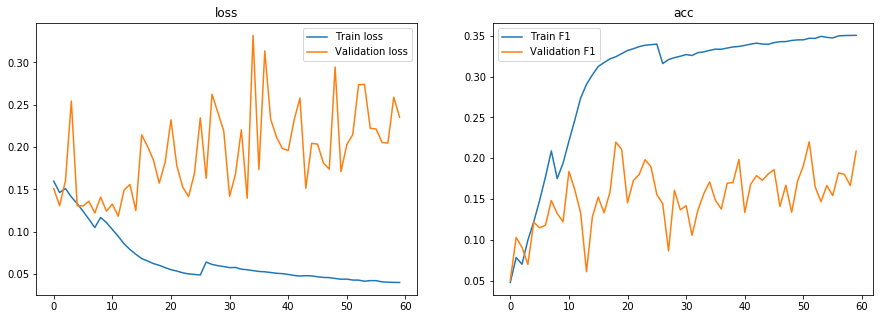

In [24]:
fig, ax = plt.subplots(1, 2, figsize=(15,5))
ax[0].set_title('loss')
ax[0].plot(hist2.epoch, hist2.history["loss"], label="Train loss")
ax[0].plot(hist2.epoch, hist2.history["val_loss"], label="Validation loss")
ax[1].set_title('acc')
ax[1].plot(hist2.epoch, hist2.history["f1"], label="Train F1")
ax[1].plot(hist2.epoch, hist2.history["val_f1"], label="Validation F1")
ax[0].legend()
ax[1].legend()

In [25]:
valGen = ProteinDataGenerator(pathsVal,labelsVal, BATCH_SIZE, SHAPE)
#customObjects = {}        #Needed for loading models with saved loss functions ... have not tested for no custom objects
#customObjects={'f1': f1, 'focal_loss': focal_loss}
#model = load_model(modelFile,custom_objects=customObjects)

In [26]:
from sklearn.metrics import f1_score as off1

def getOptimalT(mdl, valGen):
    
    valPred = np.empty((0, 28))
    valLabels = np.empty((0, 28))
    for i in tqdm(range(len(valGen))): 
        im, lbl = valGen[i]
        scores = mdl.predict(im)
        valPred = np.append(valPred, scores, axis=0)
        valLabels = np.append(valLabels, lbl, axis=0)
    print(valPred.shape, valLabels.shape)
    
    rng = np.arange(0, 1, 0.001)
    f1s = np.zeros((rng.shape[0], 28))
    for j,t in enumerate(tqdm(rng)):
        for i in range(28):
            p = np.array(valPred[:,i]>t, dtype=np.int8)
            #scoref1 = K.eval(f1(valLabels[:,i], p))
            scoref1 = off1(valLabels[:,i], p, average='binary')
            f1s[j,i] = scoref1
            
    print(np.max(f1s, axis=0))
    print(np.mean(np.max(f1s, axis=0)))
    
    plt.plot(rng, f1s)
    T = np.empty(28)
    for i in range(28):
        T[i] = rng[np.where(f1s[:,i] == np.max(f1s[:,i]))[0][0]]
    print('Choosing threshold: ', T)
#    print('Validation F1-score: ', max(f1s))
#    print(T)
    
    return T, np.mean(np.max(f1s, axis=0))

In [27]:
valGen = ProteinDataGenerator(pathsVal,labelsVal, BATCH_SIZE, SHAPE)
#customObjects = {}        #Needed for loading models with saved loss functions ... have not tested for no custom objects
#customObjects={'f1': f1, 'focal_loss': focal_loss}
#model = load_model(modelFile,custom_objects=customObjects)

  0%|          | 0/389 [00:00<?, ?it/s]

Last model after fine-tuning


  0%|          | 1/389 [00:01<07:04,  1.09s/it]

  1%|          | 2/389 [00:01<05:18,  1.22it/s]

  1%|          | 3/389 [00:01<04:03,  1.59it/s]

  1%|          | 4/389 [00:01<03:08,  2.04it/s]

  1%|▏         | 5/389 [00:01<02:32,  2.52it/s]

  2%|▏         | 6/389 [00:01<02:07,  3.01it/s]

  2%|▏         | 7/389 [00:02<01:51,  3.43it/s]

  2%|▏         | 8/389 [00:02<01:38,  3.86it/s]

  2%|▏         | 9/389 [00:02<01:28,  4.30it/s]

  3%|▎         | 10/389 [00:02<01:22,  4.59it/s]

  3%|▎         | 11/389 [00:02<01:18,  4.82it/s]

  3%|▎         | 12/389 [00:03<01:14,  5.04it/s]

  3%|▎         | 13/389 [00:03<01:12,  5.22it/s]

  4%|▎         | 14/389 [00:03<01:10,  5.29it/s]

  4%|▍         | 15/389 [00:03<01:09,  5.39it/s]

  4%|▍         | 16/389 [00:03<01:10,  5.33it/s]

  4%|▍         | 17/389 [00:03<01:09,  5.37it/s]

  5%|▍         | 18/389 [00:04<01:08,  5.44it/s]

  5%|▍         | 19/389 [00:04<01:08,  5.37it/s]

  5%|▌         | 20/389 [00:04<01:09,  5.32it/s]

  5%|▌         | 21/389 [00:04<01:09,  5.30it/s]

  6%|▌         | 22/389 [00:04<01:09,  5.28it/s]

  6%|▌         | 23/389 [00:05<01:09,  5.28it/s]

  6%|▌         | 24/389 [00:05<01:08,  5.30it/s]

  6%|▋         | 25/389 [00:05<01:08,  5.33it/s]

  7%|▋         | 26/389 [00:05<01:07,  5.39it/s]

  7%|▋         | 27/389 [00:05<01:07,  5.38it/s]

  7%|▋         | 28/389 [00:06<01:06,  5.42it/s]

  7%|▋         | 29/389 [00:06<01:06,  5.41it/s]

  8%|▊         | 30/389 [00:06<01:06,  5.38it/s]

  8%|▊         | 31/389 [00:06<01:06,  5.36it/s]

  8%|▊         | 32/389 [00:06<01:06,  5.37it/s]

  8%|▊         | 33/389 [00:06<01:06,  5.34it/s]

  9%|▊         | 34/389 [00:07<01:05,  5.40it/s]

  9%|▉         | 35/389 [00:07<01:05,  5.43it/s]

  9%|▉         | 36/389 [00:07<01:04,  5.49it/s]

 10%|▉         | 37/389 [00:07<01:05,  5.36it/s]

 10%|▉         | 38/389 [00:07<01:04,  5.41it/s]

 10%|█         | 39/389 [00:08<01:05,  5.32it/s]

 10%|█         | 40/389 [00:08<01:04,  5.45it/s]

 11%|█         | 41/389 [00:08<01:03,  5.44it/s]

 11%|█         | 42/389 [00:08<01:04,  5.38it/s]

 11%|█         | 43/389 [00:08<01:04,  5.36it/s]

 11%|█▏        | 44/389 [00:09<01:03,  5.42it/s]

 12%|█▏        | 45/389 [00:09<01:02,  5.51it/s]

 12%|█▏        | 46/389 [00:09<01:02,  5.51it/s]

 12%|█▏        | 47/389 [00:09<01:01,  5.53it/s]

 12%|█▏        | 48/389 [00:09<01:01,  5.52it/s]

 13%|█▎        | 49/389 [00:09<01:01,  5.51it/s]

 13%|█▎        | 50/389 [00:10<01:01,  5.52it/s]

 13%|█▎        | 51/389 [00:10<01:01,  5.45it/s]

 13%|█▎        | 52/389 [00:10<01:01,  5.47it/s]

 14%|█▎        | 53/389 [00:10<01:02,  5.41it/s]

 14%|█▍        | 54/389 [00:10<01:01,  5.41it/s]

 14%|█▍        | 55/389 [00:11<01:02,  5.34it/s]

 14%|█▍        | 56/389 [00:11<01:00,  5.46it/s]

 15%|█▍        | 57/389 [00:11<01:00,  5.48it/s]

 15%|█▍        | 58/389 [00:11<01:00,  5.50it/s]

 15%|█▌        | 59/389 [00:11<00:58,  5.62it/s]

 15%|█▌        | 60/389 [00:11<00:58,  5.65it/s]

 16%|█▌        | 61/389 [00:12<00:58,  5.59it/s]

 16%|█▌        | 62/389 [00:12<00:58,  5.55it/s]

 16%|█▌        | 63/389 [00:12<00:58,  5.56it/s]

 16%|█▋        | 64/389 [00:12<00:58,  5.56it/s]

 17%|█▋        | 65/389 [00:12<00:59,  5.46it/s]

 17%|█▋        | 66/389 [00:13<00:59,  5.46it/s]

 17%|█▋        | 67/389 [00:13<00:59,  5.45it/s]

 17%|█▋        | 68/389 [00:13<00:59,  5.41it/s]

 18%|█▊        | 69/389 [00:13<00:58,  5.51it/s]

 18%|█▊        | 70/389 [00:13<00:57,  5.52it/s]

 18%|█▊        | 71/389 [00:13<00:58,  5.46it/s]

 19%|█▊        | 72/389 [00:14<00:58,  5.45it/s]

 19%|█▉        | 73/389 [00:14<00:57,  5.50it/s]

 19%|█▉        | 74/389 [00:14<00:58,  5.42it/s]

 19%|█▉        | 75/389 [00:14<00:58,  5.34it/s]

 20%|█▉        | 76/389 [00:14<00:58,  5.35it/s]

 20%|█▉        | 77/389 [00:15<00:58,  5.34it/s]

 20%|██        | 78/389 [00:15<00:57,  5.37it/s]

 20%|██        | 79/389 [00:15<00:57,  5.35it/s]

 21%|██        | 80/389 [00:15<00:57,  5.33it/s]

 21%|██        | 81/389 [00:15<00:56,  5.42it/s]

 21%|██        | 82/389 [00:15<00:56,  5.39it/s]

 21%|██▏       | 83/389 [00:16<00:56,  5.37it/s]

 22%|██▏       | 84/389 [00:16<00:57,  5.33it/s]

 22%|██▏       | 85/389 [00:16<00:57,  5.32it/s]

 22%|██▏       | 86/389 [00:16<00:56,  5.33it/s]

 22%|██▏       | 87/389 [00:16<00:56,  5.39it/s]

 23%|██▎       | 88/389 [00:17<00:55,  5.41it/s]

 23%|██▎       | 89/389 [00:17<00:55,  5.37it/s]

 23%|██▎       | 90/389 [00:17<00:55,  5.37it/s]

 23%|██▎       | 91/389 [00:17<00:55,  5.41it/s]

 24%|██▎       | 92/389 [00:17<00:54,  5.46it/s]

 24%|██▍       | 93/389 [00:18<00:53,  5.53it/s]

 24%|██▍       | 94/389 [00:18<00:52,  5.60it/s]

 24%|██▍       | 95/389 [00:18<00:52,  5.57it/s]

 25%|██▍       | 96/389 [00:18<00:51,  5.67it/s]

 25%|██▍       | 97/389 [00:18<00:52,  5.58it/s]

 25%|██▌       | 98/389 [00:18<00:53,  5.44it/s]

 25%|██▌       | 99/389 [00:19<00:54,  5.34it/s]

 26%|██▌       | 100/389 [00:19<00:53,  5.36it/s]

 26%|██▌       | 101/389 [00:19<00:54,  5.33it/s]

 26%|██▌       | 102/389 [00:19<00:54,  5.26it/s]

 26%|██▋       | 103/389 [00:19<00:52,  5.46it/s]

 27%|██▋       | 104/389 [00:20<00:51,  5.49it/s]

 27%|██▋       | 105/389 [00:20<00:51,  5.53it/s]

 27%|██▋       | 106/389 [00:20<00:51,  5.47it/s]

 28%|██▊       | 107/389 [00:20<00:51,  5.51it/s]

 28%|██▊       | 108/389 [00:20<00:51,  5.40it/s]

 28%|██▊       | 109/389 [00:20<00:51,  5.39it/s]

 28%|██▊       | 110/389 [00:21<00:51,  5.37it/s]

 29%|██▊       | 111/389 [00:21<00:51,  5.41it/s]

 29%|██▉       | 112/389 [00:21<00:51,  5.42it/s]

 29%|██▉       | 113/389 [00:21<00:50,  5.43it/s]

 29%|██▉       | 114/389 [00:21<00:51,  5.37it/s]

 30%|██▉       | 115/389 [00:22<00:51,  5.30it/s]

 30%|██▉       | 116/389 [00:22<00:51,  5.33it/s]

 30%|███       | 117/389 [00:22<00:51,  5.32it/s]

 30%|███       | 118/389 [00:22<00:50,  5.39it/s]

 31%|███       | 119/389 [00:22<00:49,  5.48it/s]

 31%|███       | 120/389 [00:22<00:49,  5.42it/s]

 31%|███       | 121/389 [00:23<00:50,  5.32it/s]

 31%|███▏      | 122/389 [00:23<00:51,  5.23it/s]

 32%|███▏      | 123/389 [00:23<00:50,  5.26it/s]

 32%|███▏      | 124/389 [00:23<00:50,  5.22it/s]

 32%|███▏      | 125/389 [00:23<00:50,  5.24it/s]

 32%|███▏      | 126/389 [00:24<00:49,  5.30it/s]

 33%|███▎      | 127/389 [00:24<00:49,  5.29it/s]

 33%|███▎      | 128/389 [00:24<00:47,  5.44it/s]

 33%|███▎      | 129/389 [00:24<00:48,  5.38it/s]

 33%|███▎      | 130/389 [00:24<00:47,  5.40it/s]

 34%|███▎      | 131/389 [00:25<00:48,  5.35it/s]

 34%|███▍      | 132/389 [00:25<00:47,  5.36it/s]

 34%|███▍      | 133/389 [00:25<00:47,  5.44it/s]

 34%|███▍      | 134/389 [00:25<00:45,  5.55it/s]

 35%|███▍      | 135/389 [00:25<00:46,  5.51it/s]

 35%|███▍      | 136/389 [00:25<00:46,  5.42it/s]

 35%|███▌      | 137/389 [00:26<00:46,  5.41it/s]

 35%|███▌      | 138/389 [00:26<00:46,  5.37it/s]

 36%|███▌      | 139/389 [00:26<00:46,  5.42it/s]

 36%|███▌      | 140/389 [00:26<00:45,  5.51it/s]

 36%|███▌      | 141/389 [00:26<00:45,  5.43it/s]

 37%|███▋      | 142/389 [00:27<00:45,  5.41it/s]

 37%|███▋      | 143/389 [00:27<00:45,  5.44it/s]

 37%|███▋      | 144/389 [00:27<00:45,  5.34it/s]

 37%|███▋      | 145/389 [00:27<00:45,  5.39it/s]

 38%|███▊      | 146/389 [00:27<00:44,  5.44it/s]

 38%|███▊      | 147/389 [00:27<00:44,  5.47it/s]

 38%|███▊      | 148/389 [00:28<00:43,  5.58it/s]

 38%|███▊      | 149/389 [00:28<00:42,  5.60it/s]

 39%|███▊      | 150/389 [00:28<00:44,  5.43it/s]

 39%|███▉      | 151/389 [00:28<00:43,  5.49it/s]

 39%|███▉      | 152/389 [00:28<00:43,  5.47it/s]

 39%|███▉      | 153/389 [00:29<00:43,  5.44it/s]

 40%|███▉      | 154/389 [00:29<00:42,  5.50it/s]

 40%|███▉      | 155/389 [00:29<00:43,  5.44it/s]

 40%|████      | 156/389 [00:29<00:43,  5.40it/s]

 40%|████      | 157/389 [00:29<00:42,  5.44it/s]

 41%|████      | 158/389 [00:30<00:43,  5.29it/s]

 41%|████      | 159/389 [00:30<00:44,  5.20it/s]

 41%|████      | 160/389 [00:30<00:42,  5.35it/s]

 41%|████▏     | 161/389 [00:30<00:42,  5.37it/s]

 42%|████▏     | 162/389 [00:30<00:42,  5.35it/s]

 42%|████▏     | 163/389 [00:30<00:42,  5.36it/s]

 42%|████▏     | 164/389 [00:31<00:41,  5.38it/s]

 42%|████▏     | 165/389 [00:31<00:42,  5.27it/s]

 43%|████▎     | 166/389 [00:31<00:42,  5.28it/s]

 43%|████▎     | 167/389 [00:31<00:41,  5.32it/s]

 43%|████▎     | 168/389 [00:31<00:40,  5.52it/s]

 43%|████▎     | 169/389 [00:32<00:39,  5.62it/s]

 44%|████▎     | 170/389 [00:32<00:39,  5.55it/s]

 44%|████▍     | 171/389 [00:32<00:39,  5.47it/s]

 44%|████▍     | 172/389 [00:32<00:39,  5.50it/s]

 44%|████▍     | 173/389 [00:32<00:39,  5.52it/s]

 45%|████▍     | 174/389 [00:32<00:38,  5.59it/s]

 45%|████▍     | 175/389 [00:33<00:37,  5.65it/s]

 45%|████▌     | 176/389 [00:33<00:38,  5.58it/s]

 46%|████▌     | 177/389 [00:33<00:38,  5.47it/s]

 46%|████▌     | 178/389 [00:33<00:38,  5.42it/s]

 46%|████▌     | 179/389 [00:33<00:39,  5.32it/s]

 46%|████▋     | 180/389 [00:34<00:38,  5.38it/s]

 47%|████▋     | 181/389 [00:34<00:37,  5.50it/s]

 47%|████▋     | 182/389 [00:34<00:37,  5.47it/s]

 47%|████▋     | 183/389 [00:34<00:37,  5.48it/s]

 47%|████▋     | 184/389 [00:34<00:38,  5.38it/s]

 48%|████▊     | 185/389 [00:34<00:37,  5.43it/s]

 48%|████▊     | 186/389 [00:35<00:37,  5.45it/s]

 48%|████▊     | 187/389 [00:35<00:37,  5.40it/s]

 48%|████▊     | 188/389 [00:35<00:37,  5.37it/s]

 49%|████▊     | 189/389 [00:35<00:37,  5.40it/s]

 49%|████▉     | 190/389 [00:35<00:37,  5.29it/s]

 49%|████▉     | 191/389 [00:36<00:37,  5.34it/s]

 49%|████▉     | 192/389 [00:36<00:36,  5.39it/s]

 50%|████▉     | 193/389 [00:36<00:36,  5.41it/s]

 50%|████▉     | 194/389 [00:36<00:35,  5.46it/s]

 50%|█████     | 195/389 [00:36<00:35,  5.54it/s]

 50%|█████     | 196/389 [00:36<00:34,  5.61it/s]

 51%|█████     | 197/389 [00:37<00:34,  5.56it/s]

 51%|█████     | 198/389 [00:37<00:34,  5.56it/s]

 51%|█████     | 199/389 [00:37<00:34,  5.48it/s]

 51%|█████▏    | 200/389 [00:37<00:34,  5.50it/s]

 52%|█████▏    | 201/389 [00:37<00:34,  5.50it/s]

 52%|█████▏    | 202/389 [00:38<00:34,  5.36it/s]

 52%|█████▏    | 203/389 [00:38<00:34,  5.40it/s]

 52%|█████▏    | 204/389 [00:38<00:34,  5.31it/s]

 53%|█████▎    | 205/389 [00:38<00:34,  5.27it/s]

 53%|█████▎    | 206/389 [00:38<00:34,  5.38it/s]

 53%|█████▎    | 207/389 [00:39<00:34,  5.30it/s]

 53%|█████▎    | 208/389 [00:39<00:34,  5.25it/s]

 54%|█████▎    | 209/389 [00:39<00:34,  5.21it/s]

 54%|█████▍    | 210/389 [00:39<00:33,  5.27it/s]

 54%|█████▍    | 211/389 [00:39<00:33,  5.35it/s]

 54%|█████▍    | 212/389 [00:39<00:33,  5.35it/s]

 55%|█████▍    | 213/389 [00:40<00:33,  5.26it/s]

 55%|█████▌    | 214/389 [00:40<00:33,  5.24it/s]

 55%|█████▌    | 215/389 [00:40<00:33,  5.24it/s]

 56%|█████▌    | 216/389 [00:40<00:32,  5.29it/s]

 56%|█████▌    | 217/389 [00:40<00:32,  5.35it/s]

 56%|█████▌    | 218/389 [00:41<00:31,  5.35it/s]

 56%|█████▋    | 219/389 [00:41<00:31,  5.39it/s]

 57%|█████▋    | 220/389 [00:41<00:31,  5.37it/s]

 57%|█████▋    | 221/389 [00:41<00:31,  5.40it/s]

 57%|█████▋    | 222/389 [00:41<00:30,  5.43it/s]

 57%|█████▋    | 223/389 [00:42<00:30,  5.45it/s]

 58%|█████▊    | 224/389 [00:42<00:30,  5.45it/s]

 58%|█████▊    | 225/389 [00:42<00:29,  5.49it/s]

 58%|█████▊    | 226/389 [00:42<00:29,  5.46it/s]

 58%|█████▊    | 227/389 [00:42<00:29,  5.42it/s]

 59%|█████▊    | 228/389 [00:42<00:29,  5.48it/s]

 59%|█████▉    | 229/389 [00:43<00:28,  5.54it/s]

 59%|█████▉    | 230/389 [00:43<00:28,  5.55it/s]

 59%|█████▉    | 231/389 [00:43<00:28,  5.57it/s]

 60%|█████▉    | 232/389 [00:43<00:28,  5.60it/s]

 60%|█████▉    | 233/389 [00:43<00:27,  5.58it/s]

 60%|██████    | 234/389 [00:44<00:28,  5.51it/s]

 60%|██████    | 235/389 [00:44<00:28,  5.49it/s]

 61%|██████    | 236/389 [00:44<00:27,  5.54it/s]

 61%|██████    | 237/389 [00:44<00:27,  5.56it/s]

 61%|██████    | 238/389 [00:44<00:26,  5.61it/s]

 61%|██████▏   | 239/389 [00:44<00:27,  5.53it/s]

 62%|██████▏   | 240/389 [00:45<00:26,  5.58it/s]

 62%|██████▏   | 241/389 [00:45<00:26,  5.56it/s]

 62%|██████▏   | 242/389 [00:45<00:25,  5.68it/s]

 62%|██████▏   | 243/389 [00:45<00:25,  5.70it/s]

 63%|██████▎   | 244/389 [00:45<00:25,  5.68it/s]

 63%|██████▎   | 245/389 [00:45<00:25,  5.65it/s]

 63%|██████▎   | 246/389 [00:46<00:25,  5.60it/s]

 63%|██████▎   | 247/389 [00:46<00:25,  5.63it/s]

 64%|██████▍   | 248/389 [00:46<00:25,  5.57it/s]

 64%|██████▍   | 249/389 [00:46<00:25,  5.54it/s]

 64%|██████▍   | 250/389 [00:46<00:25,  5.50it/s]

 65%|██████▍   | 251/389 [00:47<00:24,  5.55it/s]

 65%|██████▍   | 252/389 [00:47<00:25,  5.47it/s]

 65%|██████▌   | 253/389 [00:47<00:24,  5.44it/s]

 65%|██████▌   | 254/389 [00:47<00:25,  5.37it/s]

 66%|██████▌   | 255/389 [00:47<00:25,  5.35it/s]

 66%|██████▌   | 256/389 [00:48<00:24,  5.41it/s]

 66%|██████▌   | 257/389 [00:48<00:24,  5.39it/s]

 66%|██████▋   | 258/389 [00:48<00:24,  5.37it/s]

 67%|██████▋   | 259/389 [00:48<00:24,  5.26it/s]

 67%|██████▋   | 260/389 [00:48<00:24,  5.31it/s]

 67%|██████▋   | 261/389 [00:48<00:23,  5.42it/s]

 67%|██████▋   | 262/389 [00:49<00:23,  5.40it/s]

 68%|██████▊   | 263/389 [00:49<00:23,  5.40it/s]

 68%|██████▊   | 264/389 [00:49<00:23,  5.37it/s]

 68%|██████▊   | 265/389 [00:49<00:22,  5.40it/s]

 68%|██████▊   | 266/389 [00:49<00:22,  5.46it/s]

 69%|██████▊   | 267/389 [00:50<00:22,  5.39it/s]

 69%|██████▉   | 268/389 [00:50<00:22,  5.32it/s]

 69%|██████▉   | 269/389 [00:50<00:22,  5.33it/s]

 69%|██████▉   | 270/389 [00:50<00:21,  5.45it/s]

 70%|██████▉   | 271/389 [00:50<00:21,  5.48it/s]

 70%|██████▉   | 272/389 [00:50<00:21,  5.49it/s]

 70%|███████   | 273/389 [00:51<00:21,  5.39it/s]

 70%|███████   | 274/389 [00:51<00:21,  5.29it/s]

 71%|███████   | 275/389 [00:51<00:21,  5.41it/s]

 71%|███████   | 276/389 [00:51<00:20,  5.41it/s]

 71%|███████   | 277/389 [00:51<00:20,  5.41it/s]

 71%|███████▏  | 278/389 [00:52<00:20,  5.38it/s]

 72%|███████▏  | 279/389 [00:52<00:20,  5.30it/s]

 72%|███████▏  | 280/389 [00:52<00:20,  5.35it/s]

 72%|███████▏  | 281/389 [00:52<00:20,  5.34it/s]

 72%|███████▏  | 282/389 [00:52<00:19,  5.36it/s]

 73%|███████▎  | 283/389 [00:53<00:20,  5.28it/s]

 73%|███████▎  | 284/389 [00:53<00:19,  5.35it/s]

 73%|███████▎  | 285/389 [00:53<00:19,  5.31it/s]

 74%|███████▎  | 286/389 [00:53<00:19,  5.41it/s]

 74%|███████▍  | 287/389 [00:53<00:18,  5.45it/s]

 74%|███████▍  | 288/389 [00:53<00:18,  5.42it/s]

 74%|███████▍  | 289/389 [00:54<00:18,  5.42it/s]

 75%|███████▍  | 290/389 [00:54<00:18,  5.39it/s]

 75%|███████▍  | 291/389 [00:54<00:18,  5.41it/s]

 75%|███████▌  | 292/389 [00:54<00:18,  5.20it/s]

 75%|███████▌  | 293/389 [00:54<00:18,  5.19it/s]

 76%|███████▌  | 294/389 [00:55<00:18,  5.14it/s]

 76%|███████▌  | 295/389 [00:55<00:18,  5.20it/s]

 76%|███████▌  | 296/389 [00:55<00:17,  5.24it/s]

 76%|███████▋  | 297/389 [00:55<00:17,  5.17it/s]

 77%|███████▋  | 298/389 [00:55<00:17,  5.32it/s]

 77%|███████▋  | 299/389 [00:56<00:16,  5.35it/s]

 77%|███████▋  | 300/389 [00:56<00:16,  5.33it/s]

 77%|███████▋  | 301/389 [00:56<00:16,  5.25it/s]

 78%|███████▊  | 302/389 [00:56<00:16,  5.33it/s]

 78%|███████▊  | 303/389 [00:56<00:16,  5.27it/s]

 78%|███████▊  | 304/389 [00:57<00:16,  5.21it/s]

 78%|███████▊  | 305/389 [00:57<00:16,  5.18it/s]

 79%|███████▊  | 306/389 [00:57<00:15,  5.20it/s]

 79%|███████▉  | 307/389 [00:57<00:15,  5.25it/s]

 79%|███████▉  | 308/389 [00:57<00:15,  5.40it/s]

 79%|███████▉  | 309/389 [00:57<00:14,  5.44it/s]

 80%|███████▉  | 310/389 [00:58<00:14,  5.53it/s]

 80%|███████▉  | 311/389 [00:58<00:14,  5.56it/s]

 80%|████████  | 312/389 [00:58<00:13,  5.58it/s]

 80%|████████  | 313/389 [00:58<00:13,  5.52it/s]

 81%|████████  | 314/389 [00:58<00:13,  5.45it/s]

 81%|████████  | 315/389 [00:59<00:13,  5.37it/s]

 81%|████████  | 316/389 [00:59<00:13,  5.40it/s]

 81%|████████▏ | 317/389 [00:59<00:13,  5.44it/s]

 82%|████████▏ | 318/389 [00:59<00:13,  5.42it/s]

 82%|████████▏ | 319/389 [00:59<00:13,  5.37it/s]

 82%|████████▏ | 320/389 [00:59<00:12,  5.40it/s]

 83%|████████▎ | 321/389 [01:00<00:12,  5.45it/s]

 83%|████████▎ | 322/389 [01:00<00:12,  5.40it/s]

 83%|████████▎ | 323/389 [01:00<00:12,  5.45it/s]

 83%|████████▎ | 324/389 [01:00<00:12,  5.41it/s]

 84%|████████▎ | 325/389 [01:00<00:11,  5.41it/s]

 84%|████████▍ | 326/389 [01:01<00:11,  5.46it/s]

 84%|████████▍ | 327/389 [01:01<00:11,  5.44it/s]

 84%|████████▍ | 328/389 [01:01<00:11,  5.42it/s]

 85%|████████▍ | 329/389 [01:01<00:11,  5.41it/s]

 85%|████████▍ | 330/389 [01:01<00:10,  5.37it/s]

 85%|████████▌ | 331/389 [01:01<00:10,  5.39it/s]

 85%|████████▌ | 332/389 [01:02<00:10,  5.52it/s]

 86%|████████▌ | 333/389 [01:02<00:10,  5.47it/s]

 86%|████████▌ | 334/389 [01:02<00:10,  5.41it/s]

 86%|████████▌ | 335/389 [01:02<00:10,  5.38it/s]

 86%|████████▋ | 336/389 [01:02<00:09,  5.45it/s]

 87%|████████▋ | 337/389 [01:03<00:09,  5.50it/s]

 87%|████████▋ | 338/389 [01:03<00:09,  5.50it/s]

 87%|████████▋ | 339/389 [01:03<00:09,  5.44it/s]

 87%|████████▋ | 340/389 [01:03<00:08,  5.46it/s]

 88%|████████▊ | 341/389 [01:03<00:08,  5.51it/s]

 88%|████████▊ | 342/389 [01:03<00:08,  5.50it/s]

 88%|████████▊ | 343/389 [01:04<00:08,  5.51it/s]

 88%|████████▊ | 344/389 [01:04<00:08,  5.57it/s]

 89%|████████▊ | 345/389 [01:04<00:08,  5.47it/s]

 89%|████████▉ | 346/389 [01:04<00:07,  5.43it/s]

 89%|████████▉ | 347/389 [01:04<00:07,  5.49it/s]

 89%|████████▉ | 348/389 [01:05<00:07,  5.52it/s]

 90%|████████▉ | 349/389 [01:05<00:07,  5.47it/s]

 90%|████████▉ | 350/389 [01:05<00:07,  5.43it/s]

 90%|█████████ | 351/389 [01:05<00:06,  5.57it/s]

 90%|█████████ | 352/389 [01:05<00:06,  5.49it/s]

 91%|█████████ | 353/389 [01:05<00:06,  5.51it/s]

 91%|█████████ | 354/389 [01:06<00:06,  5.51it/s]

 91%|█████████▏| 355/389 [01:06<00:06,  5.49it/s]

 92%|█████████▏| 356/389 [01:06<00:06,  5.47it/s]

 92%|█████████▏| 357/389 [01:06<00:05,  5.47it/s]

 92%|█████████▏| 358/389 [01:06<00:05,  5.41it/s]

 92%|█████████▏| 359/389 [01:07<00:05,  5.43it/s]

 93%|█████████▎| 360/389 [01:07<00:05,  5.44it/s]

 93%|█████████▎| 361/389 [01:07<00:05,  5.42it/s]

 93%|█████████▎| 362/389 [01:07<00:04,  5.49it/s]

 93%|█████████▎| 363/389 [01:07<00:04,  5.48it/s]

 94%|█████████▎| 364/389 [01:07<00:04,  5.58it/s]

 94%|█████████▍| 365/389 [01:08<00:04,  5.57it/s]

 94%|█████████▍| 366/389 [01:08<00:04,  5.51it/s]

 94%|█████████▍| 367/389 [01:08<00:03,  5.60it/s]

 95%|█████████▍| 368/389 [01:08<00:03,  5.53it/s]

 95%|█████████▍| 369/389 [01:08<00:03,  5.43it/s]

 95%|█████████▌| 370/389 [01:09<00:03,  5.48it/s]

 95%|█████████▌| 371/389 [01:09<00:03,  5.48it/s]

 96%|█████████▌| 372/389 [01:09<00:03,  5.50it/s]

 96%|█████████▌| 373/389 [01:09<00:02,  5.46it/s]

 96%|█████████▌| 374/389 [01:09<00:02,  5.50it/s]

 96%|█████████▋| 375/389 [01:10<00:02,  5.50it/s]

 97%|█████████▋| 376/389 [01:10<00:02,  5.45it/s]

 97%|█████████▋| 377/389 [01:10<00:02,  5.43it/s]

 97%|█████████▋| 378/389 [01:10<00:02,  5.50it/s]

 97%|█████████▋| 379/389 [01:10<00:01,  5.48it/s]

 98%|█████████▊| 380/389 [01:10<00:01,  5.42it/s]

 98%|█████████▊| 381/389 [01:11<00:01,  5.35it/s]

 98%|█████████▊| 382/389 [01:11<00:01,  5.31it/s]

 98%|█████████▊| 383/389 [01:11<00:01,  5.34it/s]

 99%|█████████▊| 384/389 [01:11<00:00,  5.33it/s]

 99%|█████████▉| 385/389 [01:11<00:00,  5.39it/s]

 99%|█████████▉| 386/389 [01:12<00:00,  5.33it/s]

 99%|█████████▉| 387/389 [01:12<00:00,  5.41it/s]

100%|█████████▉| 388/389 [01:12<00:00,  5.41it/s]

100%|██████████| 389/389 [01:12<00:00,  5.37it/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 3/1000 [00:00<00:36, 27.32it/s]

(6215, 28) (6215, 28)


  1%|          | 6/1000 [00:00<00:36, 27.60it/s]

  1%|          | 9/1000 [00:00<00:35, 27.56it/s]

  1%|          | 12/1000 [00:00<00:35, 27.88it/s]

  2%|▏         | 15/1000 [00:00<00:35, 28.11it/s]

  2%|▏         | 18/1000 [00:00<00:34, 28.29it/s]

  2%|▏         | 21/1000 [00:00<00:34, 28.41it/s]

  2%|▏         | 24/1000 [00:00<00:34, 28.48it/s]

  3%|▎         | 27/1000 [00:00<00:34, 28.50it/s]

  3%|▎         | 30/1000 [00:01<00:33, 28.58it/s]

  3%|▎         | 33/1000 [00:01<00:33, 28.64it/s]

  4%|▎         | 36/1000 [00:01<00:33, 28.69it/s]

  4%|▍         | 39/1000 [00:01<00:33, 28.74it/s]

  4%|▍         | 42/1000 [00:01<00:33, 28.59it/s]

  4%|▍         | 45/1000 [00:01<00:33, 28.65it/s]

  5%|▍         | 48/1000 [00:01<00:33, 28.71it/s]

  5%|▌         | 51/1000 [00:01<00:33, 28.76it/s]

  5%|▌         | 54/1000 [00:01<00:32, 28.78it/s]

  6%|▌         | 57/1000 [00:01<00:32, 28.81it/s]

  6%|▌         | 60/1000 [00:02<00:32, 28.85it/s]

  6%|▋         | 63/1000 [00:02<00:32, 28.87it/s]

  7%|▋         | 66/1000 [00:02<00:32, 28.89it/s]

  7%|▋         | 69/1000 [00:02<00:32, 28.45it/s]

  7%|▋         | 72/1000 [00:02<00:32, 28.61it/s]

  8%|▊         | 75/1000 [00:02<00:32, 28.71it/s]

  8%|▊         | 78/1000 [00:02<00:32, 28.78it/s]

  8%|▊         | 81/1000 [00:02<00:31, 28.76it/s]

  8%|▊         | 84/1000 [00:02<00:31, 28.82it/s]

  9%|▊         | 87/1000 [00:03<00:31, 28.88it/s]

  9%|▉         | 90/1000 [00:03<00:31, 28.94it/s]

  9%|▉         | 93/1000 [00:03<00:31, 28.96it/s]

 10%|▉         | 96/1000 [00:03<00:31, 28.98it/s]

 10%|▉         | 99/1000 [00:03<00:31, 28.93it/s]

 10%|█         | 102/1000 [00:03<00:31, 28.95it/s]

 10%|█         | 105/1000 [00:03<00:31, 28.59it/s]

 11%|█         | 108/1000 [00:03<00:31, 28.70it/s]

 11%|█         | 111/1000 [00:03<00:31, 28.43it/s]

 11%|█▏        | 114/1000 [00:03<00:30, 28.60it/s]

 12%|█▏        | 117/1000 [00:04<00:30, 28.74it/s]

 12%|█▏        | 120/1000 [00:04<00:30, 28.83it/s]

 12%|█▏        | 123/1000 [00:04<00:30, 28.91it/s]

 13%|█▎        | 126/1000 [00:04<00:30, 28.96it/s]

 13%|█▎        | 129/1000 [00:04<00:30, 28.99it/s]

 13%|█▎        | 132/1000 [00:04<00:29, 28.94it/s]

 14%|█▎        | 135/1000 [00:04<00:29, 28.97it/s]

 14%|█▍        | 138/1000 [00:04<00:29, 28.99it/s]

 14%|█▍        | 141/1000 [00:04<00:29, 28.99it/s]

 14%|█▍        | 144/1000 [00:05<00:29, 28.94it/s]

 15%|█▍        | 147/1000 [00:05<00:29, 28.98it/s]

 15%|█▌        | 150/1000 [00:05<00:29, 29.02it/s]

 15%|█▌        | 153/1000 [00:05<00:29, 28.96it/s]

 16%|█▌        | 156/1000 [00:05<00:29, 28.91it/s]

 16%|█▌        | 159/1000 [00:05<00:29, 28.97it/s]

 16%|█▌        | 162/1000 [00:05<00:28, 29.00it/s]

 16%|█▋        | 165/1000 [00:05<00:28, 29.02it/s]

 17%|█▋        | 168/1000 [00:05<00:28, 29.02it/s]

 17%|█▋        | 171/1000 [00:05<00:28, 29.03it/s]

 17%|█▋        | 174/1000 [00:06<00:28, 28.97it/s]

 18%|█▊        | 177/1000 [00:06<00:28, 28.91it/s]

 18%|█▊        | 180/1000 [00:06<00:28, 28.96it/s]

 18%|█▊        | 183/1000 [00:06<00:28, 28.93it/s]

 19%|█▊        | 186/1000 [00:06<00:28, 28.99it/s]

 19%|█▉        | 189/1000 [00:06<00:28, 28.94it/s]

 19%|█▉        | 192/1000 [00:06<00:27, 28.90it/s]

 20%|█▉        | 195/1000 [00:06<00:27, 28.87it/s]

 20%|█▉        | 198/1000 [00:06<00:27, 28.92it/s]

 20%|██        | 201/1000 [00:06<00:27, 28.95it/s]

 20%|██        | 204/1000 [00:07<00:27, 28.99it/s]

 21%|██        | 207/1000 [00:07<00:27, 29.02it/s]

 21%|██        | 210/1000 [00:07<00:27, 28.98it/s]

 21%|██▏       | 213/1000 [00:07<00:27, 29.00it/s]

 22%|██▏       | 216/1000 [00:07<00:27, 28.97it/s]

 22%|██▏       | 219/1000 [00:07<00:26, 28.94it/s]

 22%|██▏       | 222/1000 [00:07<00:26, 28.92it/s]

 22%|██▎       | 225/1000 [00:07<00:26, 28.97it/s]

 23%|██▎       | 228/1000 [00:07<00:26, 29.01it/s]

 23%|██▎       | 231/1000 [00:08<00:26, 28.98it/s]

 23%|██▎       | 234/1000 [00:08<00:26, 29.04it/s]

 24%|██▎       | 237/1000 [00:08<00:26, 29.07it/s]

 24%|██▍       | 240/1000 [00:08<00:26, 29.08it/s]

 24%|██▍       | 243/1000 [00:08<00:26, 29.09it/s]

 25%|██▍       | 246/1000 [00:08<00:25, 29.11it/s]

 25%|██▍       | 249/1000 [00:08<00:25, 29.11it/s]

 25%|██▌       | 252/1000 [00:08<00:25, 29.11it/s]

 26%|██▌       | 255/1000 [00:08<00:25, 28.82it/s]

 26%|██▌       | 258/1000 [00:08<00:25, 28.54it/s]

 26%|██▌       | 261/1000 [00:09<00:25, 28.71it/s]

 26%|██▋       | 264/1000 [00:09<00:25, 28.48it/s]

 27%|██▋       | 267/1000 [00:09<00:25, 28.68it/s]

 27%|██▋       | 270/1000 [00:09<00:25, 28.83it/s]

 27%|██▋       | 273/1000 [00:09<00:25, 28.88it/s]

 28%|██▊       | 276/1000 [00:09<00:25, 28.94it/s]

 28%|██▊       | 279/1000 [00:09<00:24, 28.99it/s]

 28%|██▊       | 282/1000 [00:09<00:24, 28.98it/s]

 28%|██▊       | 285/1000 [00:09<00:24, 29.01it/s]

 29%|██▉       | 288/1000 [00:09<00:24, 29.04it/s]

 29%|██▉       | 291/1000 [00:10<00:24, 29.07it/s]

 29%|██▉       | 294/1000 [00:10<00:24, 29.11it/s]

 30%|██▉       | 297/1000 [00:10<00:24, 29.12it/s]

 30%|███       | 300/1000 [00:10<00:24, 29.13it/s]

 30%|███       | 303/1000 [00:10<00:23, 29.15it/s]

 31%|███       | 306/1000 [00:10<00:23, 28.94it/s]

 31%|███       | 309/1000 [00:10<00:23, 29.01it/s]

 31%|███       | 312/1000 [00:10<00:23, 29.05it/s]

 32%|███▏      | 315/1000 [00:10<00:23, 29.07it/s]

 32%|███▏      | 318/1000 [00:11<00:23, 29.07it/s]

 32%|███▏      | 321/1000 [00:11<00:23, 29.11it/s]

 32%|███▏      | 324/1000 [00:11<00:23, 29.13it/s]

 33%|███▎      | 327/1000 [00:11<00:23, 29.15it/s]

 33%|███▎      | 330/1000 [00:11<00:23, 28.71it/s]

 33%|███▎      | 333/1000 [00:11<00:23, 28.83it/s]

 34%|███▎      | 336/1000 [00:11<00:22, 28.93it/s]

 34%|███▍      | 339/1000 [00:11<00:22, 28.99it/s]

 34%|███▍      | 342/1000 [00:11<00:22, 28.88it/s]

 34%|███▍      | 345/1000 [00:11<00:22, 28.97it/s]

 35%|███▍      | 348/1000 [00:12<00:22, 28.84it/s]

 35%|███▌      | 351/1000 [00:12<00:22, 28.91it/s]

 35%|███▌      | 354/1000 [00:12<00:22, 28.99it/s]

 36%|███▌      | 357/1000 [00:12<00:22, 29.06it/s]

 36%|███▌      | 360/1000 [00:12<00:21, 29.10it/s]

 36%|███▋      | 363/1000 [00:12<00:21, 29.11it/s]

 37%|███▋      | 366/1000 [00:12<00:21, 29.12it/s]

 37%|███▋      | 369/1000 [00:12<00:21, 29.10it/s]

 37%|███▋      | 372/1000 [00:12<00:21, 29.11it/s]

 38%|███▊      | 375/1000 [00:12<00:21, 29.11it/s]

 38%|███▊      | 378/1000 [00:13<00:21, 29.13it/s]

 38%|███▊      | 381/1000 [00:13<00:21, 29.14it/s]

 38%|███▊      | 384/1000 [00:13<00:21, 29.08it/s]

 39%|███▊      | 387/1000 [00:13<00:21, 29.07it/s]

 39%|███▉      | 390/1000 [00:13<00:20, 29.11it/s]

 39%|███▉      | 393/1000 [00:13<00:20, 29.14it/s]

 40%|███▉      | 396/1000 [00:13<00:20, 29.15it/s]

 40%|███▉      | 399/1000 [00:13<00:20, 29.15it/s]

 40%|████      | 402/1000 [00:13<00:20, 28.76it/s]

 40%|████      | 405/1000 [00:14<00:20, 28.78it/s]

 41%|████      | 408/1000 [00:14<00:20, 28.83it/s]

 41%|████      | 411/1000 [00:14<00:20, 28.94it/s]

 41%|████▏     | 414/1000 [00:14<00:20, 29.02it/s]

 42%|████▏     | 417/1000 [00:14<00:20, 29.08it/s]

 42%|████▏     | 420/1000 [00:14<00:19, 29.13it/s]

 42%|████▏     | 423/1000 [00:14<00:19, 29.15it/s]

 43%|████▎     | 426/1000 [00:14<00:19, 29.14it/s]

 43%|████▎     | 429/1000 [00:14<00:19, 29.16it/s]

 43%|████▎     | 432/1000 [00:14<00:19, 29.16it/s]

 44%|████▎     | 435/1000 [00:15<00:19, 29.17it/s]

 44%|████▍     | 438/1000 [00:15<00:19, 28.96it/s]

 44%|████▍     | 441/1000 [00:15<00:19, 29.05it/s]

 44%|████▍     | 444/1000 [00:15<00:19, 29.10it/s]

 45%|████▍     | 447/1000 [00:15<00:18, 29.15it/s]

 45%|████▌     | 450/1000 [00:15<00:19, 28.88it/s]

 45%|████▌     | 453/1000 [00:15<00:18, 28.96it/s]

 46%|████▌     | 456/1000 [00:15<00:18, 29.01it/s]

 46%|████▌     | 459/1000 [00:15<00:18, 29.05it/s]

 46%|████▌     | 462/1000 [00:15<00:18, 29.09it/s]

 46%|████▋     | 465/1000 [00:16<00:18, 29.03it/s]

 47%|████▋     | 468/1000 [00:16<00:18, 28.70it/s]

 47%|████▋     | 471/1000 [00:16<00:18, 28.84it/s]

 47%|████▋     | 474/1000 [00:16<00:18, 28.94it/s]

 48%|████▊     | 477/1000 [00:16<00:18, 29.01it/s]

 48%|████▊     | 480/1000 [00:16<00:17, 29.05it/s]

 48%|████▊     | 483/1000 [00:16<00:17, 28.96it/s]

 49%|████▊     | 486/1000 [00:16<00:17, 28.98it/s]

 49%|████▉     | 489/1000 [00:16<00:17, 29.04it/s]

 49%|████▉     | 492/1000 [00:17<00:17, 29.06it/s]

 50%|████▉     | 495/1000 [00:17<00:17, 29.11it/s]

 50%|████▉     | 498/1000 [00:17<00:17, 29.14it/s]

 50%|█████     | 501/1000 [00:17<00:17, 29.09it/s]

 50%|█████     | 504/1000 [00:17<00:17, 29.06it/s]

 51%|█████     | 507/1000 [00:17<00:16, 29.12it/s]

 51%|█████     | 510/1000 [00:17<00:16, 29.14it/s]

 51%|█████▏    | 513/1000 [00:17<00:16, 29.15it/s]

 52%|█████▏    | 516/1000 [00:17<00:16, 29.19it/s]

 52%|█████▏    | 519/1000 [00:17<00:16, 29.14it/s]

 52%|█████▏    | 522/1000 [00:18<00:16, 29.18it/s]

 52%|█████▎    | 525/1000 [00:18<00:16, 29.11it/s]

 53%|█████▎    | 528/1000 [00:18<00:16, 29.16it/s]

 53%|█████▎    | 531/1000 [00:18<00:16, 28.95it/s]

 53%|█████▎    | 534/1000 [00:18<00:16, 28.97it/s]

 54%|█████▎    | 537/1000 [00:18<00:15, 29.04it/s]

 54%|█████▍    | 540/1000 [00:18<00:15, 29.08it/s]

 54%|█████▍    | 543/1000 [00:18<00:15, 29.10it/s]

 55%|█████▍    | 546/1000 [00:18<00:15, 29.13it/s]

 55%|█████▍    | 549/1000 [00:18<00:15, 29.15it/s]

 55%|█████▌    | 552/1000 [00:19<00:15, 29.18it/s]

 56%|█████▌    | 555/1000 [00:19<00:15, 29.20it/s]

 56%|█████▌    | 558/1000 [00:19<00:15, 29.13it/s]

 56%|█████▌    | 561/1000 [00:19<00:15, 29.08it/s]

 56%|█████▋    | 564/1000 [00:19<00:14, 29.12it/s]

 57%|█████▋    | 567/1000 [00:19<00:14, 29.06it/s]

 57%|█████▋    | 570/1000 [00:19<00:14, 29.09it/s]

 57%|█████▋    | 573/1000 [00:19<00:14, 29.12it/s]

 58%|█████▊    | 576/1000 [00:19<00:14, 28.76it/s]

 58%|█████▊    | 579/1000 [00:20<00:14, 28.89it/s]

 58%|█████▊    | 582/1000 [00:20<00:14, 28.87it/s]

 58%|█████▊    | 585/1000 [00:20<00:14, 28.98it/s]

 59%|█████▉    | 588/1000 [00:20<00:14, 29.06it/s]

 59%|█████▉    | 591/1000 [00:20<00:14, 28.92it/s]

 59%|█████▉    | 594/1000 [00:20<00:13, 29.03it/s]

 60%|█████▉    | 597/1000 [00:20<00:13, 29.10it/s]

 60%|██████    | 600/1000 [00:20<00:13, 29.13it/s]

 60%|██████    | 603/1000 [00:20<00:13, 29.14it/s]

 61%|██████    | 606/1000 [00:20<00:13, 29.16it/s]

 61%|██████    | 609/1000 [00:21<00:13, 29.19it/s]

 61%|██████    | 612/1000 [00:21<00:13, 29.13it/s]

 62%|██████▏   | 615/1000 [00:21<00:13, 29.17it/s]

 62%|██████▏   | 618/1000 [00:21<00:13, 29.19it/s]

 62%|██████▏   | 621/1000 [00:21<00:13, 29.13it/s]

 62%|██████▏   | 624/1000 [00:21<00:12, 29.16it/s]

 63%|██████▎   | 627/1000 [00:21<00:12, 29.09it/s]

 63%|██████▎   | 630/1000 [00:21<00:12, 29.04it/s]

 63%|██████▎   | 633/1000 [00:21<00:12, 29.09it/s]

 64%|██████▎   | 636/1000 [00:21<00:12, 29.13it/s]

 64%|██████▍   | 639/1000 [00:22<00:12, 29.16it/s]

 64%|██████▍   | 642/1000 [00:22<00:12, 29.19it/s]

 64%|██████▍   | 645/1000 [00:22<00:12, 29.21it/s]

 65%|██████▍   | 648/1000 [00:22<00:12, 28.97it/s]

 65%|██████▌   | 651/1000 [00:22<00:12, 29.05it/s]

 65%|██████▌   | 654/1000 [00:22<00:11, 29.05it/s]

 66%|██████▌   | 657/1000 [00:22<00:11, 28.88it/s]

 66%|██████▌   | 660/1000 [00:22<00:11, 28.96it/s]

 66%|██████▋   | 663/1000 [00:22<00:11, 28.98it/s]

 67%|██████▋   | 666/1000 [00:22<00:11, 29.05it/s]

 67%|██████▋   | 669/1000 [00:23<00:11, 29.10it/s]

 67%|██████▋   | 672/1000 [00:23<00:11, 29.10it/s]

 68%|██████▊   | 675/1000 [00:23<00:11, 29.13it/s]

 68%|██████▊   | 678/1000 [00:23<00:11, 28.77it/s]

 68%|██████▊   | 681/1000 [00:23<00:11, 28.92it/s]

 68%|██████▊   | 684/1000 [00:23<00:10, 29.02it/s]

 69%|██████▊   | 687/1000 [00:23<00:10, 29.14it/s]

 69%|██████▉   | 690/1000 [00:23<00:10, 29.20it/s]

 69%|██████▉   | 693/1000 [00:23<00:10, 29.23it/s]

 70%|██████▉   | 696/1000 [00:24<00:10, 29.14it/s]

 70%|██████▉   | 699/1000 [00:24<00:10, 29.19it/s]

 70%|███████   | 702/1000 [00:24<00:10, 29.22it/s]

 70%|███████   | 705/1000 [00:24<00:10, 29.24it/s]

 71%|███████   | 708/1000 [00:24<00:09, 29.25it/s]

 71%|███████   | 711/1000 [00:24<00:09, 29.26it/s]

 71%|███████▏  | 714/1000 [00:24<00:09, 29.17it/s]

 72%|███████▏  | 717/1000 [00:24<00:09, 29.14it/s]

 72%|███████▏  | 720/1000 [00:24<00:09, 29.09it/s]

 72%|███████▏  | 723/1000 [00:24<00:09, 29.13it/s]

 73%|███████▎  | 726/1000 [00:25<00:09, 29.17it/s]

 73%|███████▎  | 729/1000 [00:25<00:09, 28.98it/s]

 73%|███████▎  | 732/1000 [00:25<00:09, 28.93it/s]

 74%|███████▎  | 735/1000 [00:25<00:09, 28.60it/s]

 74%|███████▍  | 738/1000 [00:25<00:09, 28.80it/s]

 74%|███████▍  | 741/1000 [00:25<00:08, 28.95it/s]

 74%|███████▍  | 744/1000 [00:25<00:08, 29.04it/s]

 75%|███████▍  | 747/1000 [00:25<00:08, 28.91it/s]

 75%|███████▌  | 750/1000 [00:25<00:08, 28.78it/s]

 75%|███████▌  | 753/1000 [00:25<00:08, 28.93it/s]

 76%|███████▌  | 756/1000 [00:26<00:08, 29.02it/s]

 76%|███████▌  | 759/1000 [00:26<00:08, 29.09it/s]

 76%|███████▌  | 762/1000 [00:26<00:08, 29.15it/s]

 76%|███████▋  | 765/1000 [00:26<00:08, 29.19it/s]

 77%|███████▋  | 768/1000 [00:26<00:07, 29.22it/s]

 77%|███████▋  | 771/1000 [00:26<00:07, 29.24it/s]

 77%|███████▋  | 774/1000 [00:26<00:07, 29.23it/s]

 78%|███████▊  | 777/1000 [00:26<00:07, 29.23it/s]

 78%|███████▊  | 780/1000 [00:26<00:07, 29.22it/s]

 78%|███████▊  | 783/1000 [00:27<00:07, 29.22it/s]

 79%|███████▊  | 786/1000 [00:27<00:07, 29.24it/s]

 79%|███████▉  | 789/1000 [00:27<00:07, 29.25it/s]

 79%|███████▉  | 792/1000 [00:27<00:07, 29.21it/s]

 80%|███████▉  | 795/1000 [00:27<00:07, 29.01it/s]

 80%|███████▉  | 798/1000 [00:27<00:06, 29.10it/s]

 80%|████████  | 801/1000 [00:27<00:06, 29.15it/s]

 80%|████████  | 804/1000 [00:27<00:06, 29.18it/s]

 81%|████████  | 807/1000 [00:27<00:06, 29.13it/s]

 81%|████████  | 810/1000 [00:27<00:06, 29.17it/s]

 81%|████████▏ | 813/1000 [00:28<00:06, 29.19it/s]

 82%|████████▏ | 816/1000 [00:28<00:06, 29.05it/s]

 82%|████████▏ | 819/1000 [00:28<00:06, 29.12it/s]

 82%|████████▏ | 822/1000 [00:28<00:06, 29.18it/s]

 82%|████████▎ | 825/1000 [00:28<00:05, 29.23it/s]

 83%|████████▎ | 828/1000 [00:28<00:05, 29.26it/s]

 83%|████████▎ | 831/1000 [00:28<00:05, 29.27it/s]

 83%|████████▎ | 834/1000 [00:28<00:05, 29.26it/s]

 84%|████████▎ | 837/1000 [00:28<00:05, 29.27it/s]

 84%|████████▍ | 840/1000 [00:28<00:05, 29.26it/s]

 84%|████████▍ | 843/1000 [00:29<00:05, 29.28it/s]

 85%|████████▍ | 846/1000 [00:29<00:05, 29.30it/s]

 85%|████████▍ | 849/1000 [00:29<00:05, 29.30it/s]

 85%|████████▌ | 852/1000 [00:29<00:05, 29.22it/s]

 86%|████████▌ | 855/1000 [00:29<00:04, 29.24it/s]

 86%|████████▌ | 858/1000 [00:29<00:04, 29.26it/s]

 86%|████████▌ | 861/1000 [00:29<00:04, 29.27it/s]

 86%|████████▋ | 864/1000 [00:29<00:04, 29.26it/s]

 87%|████████▋ | 867/1000 [00:29<00:04, 29.26it/s]

 87%|████████▋ | 870/1000 [00:29<00:04, 29.27it/s]

 87%|████████▋ | 873/1000 [00:30<00:04, 29.27it/s]

 88%|████████▊ | 876/1000 [00:30<00:04, 29.29it/s]

 88%|████████▊ | 879/1000 [00:30<00:04, 29.30it/s]

 88%|████████▊ | 882/1000 [00:30<00:04, 29.31it/s]

 88%|████████▊ | 885/1000 [00:30<00:03, 29.10it/s]

 89%|████████▉ | 888/1000 [00:30<00:03, 29.19it/s]

 89%|████████▉ | 891/1000 [00:30<00:03, 29.23it/s]

 89%|████████▉ | 894/1000 [00:30<00:03, 29.21it/s]

 90%|████████▉ | 897/1000 [00:30<00:03, 29.26it/s]

 90%|█████████ | 900/1000 [00:31<00:03, 29.27it/s]

 90%|█████████ | 903/1000 [00:31<00:03, 29.30it/s]

 91%|█████████ | 906/1000 [00:31<00:03, 29.33it/s]

 91%|█████████ | 909/1000 [00:31<00:03, 29.35it/s]

 91%|█████████ | 912/1000 [00:31<00:03, 29.27it/s]

 92%|█████████▏| 915/1000 [00:31<00:02, 29.30it/s]

 92%|█████████▏| 918/1000 [00:31<00:02, 29.31it/s]

 92%|█████████▏| 921/1000 [00:31<00:02, 28.93it/s]

 92%|█████████▏| 924/1000 [00:31<00:02, 29.05it/s]

 93%|█████████▎| 927/1000 [00:31<00:02, 28.74it/s]

 93%|█████████▎| 930/1000 [00:32<00:02, 28.91it/s]

 93%|█████████▎| 933/1000 [00:32<00:02, 29.06it/s]

 94%|█████████▎| 936/1000 [00:32<00:02, 29.10it/s]

 94%|█████████▍| 939/1000 [00:32<00:02, 28.96it/s]

 94%|█████████▍| 942/1000 [00:32<00:01, 29.09it/s]

 94%|█████████▍| 945/1000 [00:32<00:01, 29.17it/s]

 95%|█████████▍| 948/1000 [00:32<00:01, 29.23it/s]

 95%|█████████▌| 951/1000 [00:32<00:01, 29.26it/s]

 95%|█████████▌| 954/1000 [00:32<00:01, 29.13it/s]

 96%|█████████▌| 957/1000 [00:32<00:01, 29.19it/s]

 96%|█████████▌| 960/1000 [00:33<00:01, 29.23it/s]

 96%|█████████▋| 963/1000 [00:33<00:01, 29.29it/s]

 97%|█████████▋| 966/1000 [00:33<00:01, 29.32it/s]

 97%|█████████▋| 969/1000 [00:33<00:01, 29.35it/s]

 97%|█████████▋| 972/1000 [00:33<00:00, 29.37it/s]

 98%|█████████▊| 975/1000 [00:33<00:00, 29.38it/s]

 98%|█████████▊| 978/1000 [00:33<00:00, 29.38it/s]

 98%|█████████▊| 981/1000 [00:33<00:00, 29.39it/s]

 98%|█████████▊| 984/1000 [00:33<00:00, 29.31it/s]

 99%|█████████▊| 987/1000 [00:34<00:00, 29.26it/s]

 99%|█████████▉| 990/1000 [00:34<00:00, 29.32it/s]

 99%|█████████▉| 993/1000 [00:34<00:00, 29.38it/s]

100%|█████████▉| 996/1000 [00:34<00:00, 29.41it/s]

100%|█████████▉| 999/1000 [00:34<00:00, 29.28it/s]

100%|██████████| 1000/1000 [00:34<00:00, 29.03it/s]

[7.97147682e-01 6.82819383e-01 6.55830389e-01 4.45652174e-01
 6.16797900e-01 4.95071194e-01 3.91167192e-01 6.20229008e-01
 2.16216216e-01 1.42857143e-01 1.79436569e-03 5.73643411e-01
 3.98671096e-01 5.02994012e-01 7.21549637e-01 6.47458725e-04
 1.32075472e-01 1.36054422e-01 3.67952522e-01 3.72670807e-01
 3.80952381e-01 5.74385511e-01 4.41558442e-01 6.75041876e-01
 5.94594595e-01 6.23806850e-01 2.62773723e-01 3.33000333e-04]
0.42233170937091363
Choosing threshold:  [0.258 0.046 0.102 0.161 0.091 0.187 0.059 0.218 0.003 0.004 0.    0.136
 0.07  0.494 0.183 0.    0.019 0.001 0.036 0.098 0.268 0.108 0.901 0.163
 0.039 0.007 0.026 0.   ]


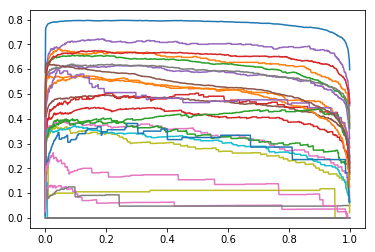

In [28]:
print('Last model after fine-tuning')
T1, ff1 = getOptimalT(model, valGen)


In [29]:
from sklearn.metrics import f1_score as offl

def calcF1Score(mdl, valGen, T):
    
    valPred = np.empty((0, 28))
    valLabels = np.empty((0, 28))
    preds = np.empty((0, 28))
    for i in tqdm(range(len(valGen))): 
        im, lbl = valGen[i]
        scores = mdl.predict(im)
        valPred = np.append(valPred, scores, axis=0)
        valLabels = np.append(valLabels, lbl, axis=0)
    p = np.array(valPred>T, dtype=np.int8)
#    scoref1 = K.eval(f1(valLabels, p))
    scoref1 = off1(valLabels, p, average='macro')
#            f1s[j,i] = scoref1
#    preds = lastFullValPred > T
    return scoref1
#    skf1 = offl(lastFullValPred, lastFullValLabels)
#    localf1 = f1(lastFullValPred, lastFullValLabels)
    
    
#    return skf1, localf1

In [30]:
#tf.reset_default_graph()
#K.clear_session()
#valGen = ProteinDataGenerator(pathsVal,labelsVal, BATCH_SIZE, SHAPE)
#bestModelPlateau = load_model('../working/ResNet50A.h5', custom_objects={'f1': f1}) #, 'f1_loss': f1_loss})
T = T1
skf1 = calcF1Score(model, valGen, T)
print("F1 score of model", skf1, '   using ',T)
T = threshold
skf2 = calcF1Score(model, valGen, T)
print("F1 score of model", skf2, '   using ',T)
if (skf1 > skf2):
    saveT = T1
    saveF1 = skf1
else:
    saveT = threshold
    saveF1 = skf2


  0%|          | 0/389 [00:00<?, ?it/s]

  0%|          | 1/389 [00:00<01:13,  5.28it/s]

  1%|          | 2/389 [00:00<01:13,  5.25it/s]

  1%|          | 3/389 [00:00<01:12,  5.29it/s]

  1%|          | 4/389 [00:00<01:10,  5.45it/s]

  1%|▏         | 5/389 [00:00<01:10,  5.41it/s]

  2%|▏         | 6/389 [00:01<01:11,  5.38it/s]

  2%|▏         | 7/389 [00:01<01:13,  5.22it/s]

  2%|▏         | 8/389 [00:01<01:11,  5.35it/s]

  2%|▏         | 9/389 [00:01<01:09,  5.45it/s]

  3%|▎         | 10/389 [00:01<01:09,  5.45it/s]

  3%|▎         | 11/389 [00:02<01:10,  5.36it/s]

  3%|▎         | 12/389 [00:02<01:10,  5.37it/s]

  3%|▎         | 13/389 [00:02<01:09,  5.38it/s]

  4%|▎         | 14/389 [00:02<01:09,  5.40it/s]

  4%|▍         | 15/389 [00:02<01:10,  5.33it/s]

  4%|▍         | 16/389 [00:02<01:10,  5.32it/s]

  4%|▍         | 17/389 [00:03<01:10,  5.30it/s]

  5%|▍         | 18/389 [00:03<01:08,  5.38it/s]

  5%|▍         | 19/389 [00:03<01:08,  5.36it/s]

  5%|▌         | 20/389 [00:03<01:08,  5.37it/s]

  5%|▌         | 21/389 [00:03<01:08,  5.36it/s]

  6%|▌         | 22/389 [00:04<01:09,  5.25it/s]

  6%|▌         | 23/389 [00:04<01:09,  5.25it/s]

  6%|▌         | 24/389 [00:04<01:09,  5.23it/s]

  6%|▋         | 25/389 [00:04<01:09,  5.24it/s]

  7%|▋         | 26/389 [00:04<01:08,  5.29it/s]

  7%|▋         | 27/389 [00:05<01:07,  5.33it/s]

  7%|▋         | 28/389 [00:05<01:06,  5.44it/s]

  7%|▋         | 29/389 [00:05<01:06,  5.41it/s]

  8%|▊         | 30/389 [00:05<01:06,  5.40it/s]

  8%|▊         | 31/389 [00:05<01:05,  5.43it/s]

  8%|▊         | 32/389 [00:05<01:04,  5.51it/s]

  8%|▊         | 33/389 [00:06<01:05,  5.45it/s]

  9%|▊         | 34/389 [00:06<01:03,  5.55it/s]

  9%|▉         | 35/389 [00:06<01:03,  5.59it/s]

  9%|▉         | 36/389 [00:06<01:02,  5.63it/s]

 10%|▉         | 37/389 [00:06<01:02,  5.60it/s]

 10%|▉         | 38/389 [00:07<01:02,  5.59it/s]

 10%|█         | 39/389 [00:07<01:03,  5.52it/s]

 10%|█         | 40/389 [00:07<01:02,  5.56it/s]

 11%|█         | 41/389 [00:07<01:02,  5.53it/s]

 11%|█         | 42/389 [00:07<01:02,  5.51it/s]

 11%|█         | 43/389 [00:07<01:03,  5.46it/s]

 11%|█▏        | 44/389 [00:08<01:01,  5.56it/s]

 12%|█▏        | 45/389 [00:08<01:01,  5.64it/s]

 12%|█▏        | 46/389 [00:08<01:00,  5.62it/s]

 12%|█▏        | 47/389 [00:08<01:00,  5.61it/s]

 12%|█▏        | 48/389 [00:08<01:00,  5.60it/s]

 13%|█▎        | 49/389 [00:09<01:00,  5.64it/s]

 13%|█▎        | 50/389 [00:09<01:00,  5.57it/s]

 13%|█▎        | 51/389 [00:09<01:01,  5.48it/s]

 13%|█▎        | 52/389 [00:09<01:01,  5.50it/s]

 14%|█▎        | 53/389 [00:09<01:01,  5.44it/s]

 14%|█▍        | 54/389 [00:09<01:01,  5.43it/s]

 14%|█▍        | 55/389 [00:10<01:02,  5.39it/s]

 14%|█▍        | 56/389 [00:10<01:02,  5.30it/s]

 15%|█▍        | 57/389 [00:10<01:02,  5.32it/s]

 15%|█▍        | 58/389 [00:10<01:02,  5.33it/s]

 15%|█▌        | 59/389 [00:10<01:00,  5.41it/s]

 15%|█▌        | 60/389 [00:11<01:00,  5.42it/s]

 16%|█▌        | 61/389 [00:11<01:01,  5.34it/s]

 16%|█▌        | 62/389 [00:11<01:02,  5.27it/s]

 16%|█▌        | 63/389 [00:11<01:00,  5.39it/s]

 16%|█▋        | 64/389 [00:11<00:58,  5.51it/s]

 17%|█▋        | 65/389 [00:11<00:59,  5.42it/s]

 17%|█▋        | 66/389 [00:12<01:00,  5.38it/s]

 17%|█▋        | 67/389 [00:12<00:59,  5.45it/s]

 17%|█▋        | 68/389 [00:12<00:59,  5.36it/s]

 18%|█▊        | 69/389 [00:12<00:59,  5.36it/s]

 18%|█▊        | 70/389 [00:12<00:59,  5.38it/s]

 18%|█▊        | 71/389 [00:13<00:59,  5.39it/s]

 19%|█▊        | 72/389 [00:13<00:58,  5.40it/s]

 19%|█▉        | 73/389 [00:13<00:57,  5.47it/s]

 19%|█▉        | 74/389 [00:13<00:58,  5.38it/s]

 19%|█▉        | 75/389 [00:13<00:58,  5.36it/s]

 20%|█▉        | 76/389 [00:14<00:58,  5.36it/s]

 20%|█▉        | 77/389 [00:14<00:58,  5.33it/s]

 20%|██        | 78/389 [00:14<00:58,  5.35it/s]

 20%|██        | 79/389 [00:14<00:58,  5.32it/s]

 21%|██        | 80/389 [00:14<00:58,  5.32it/s]

 21%|██        | 81/389 [00:14<00:56,  5.45it/s]

 21%|██        | 82/389 [00:15<00:56,  5.47it/s]

 21%|██▏       | 83/389 [00:15<00:56,  5.45it/s]

 22%|██▏       | 84/389 [00:15<00:56,  5.37it/s]

 22%|██▏       | 85/389 [00:15<00:56,  5.39it/s]

 22%|██▏       | 86/389 [00:15<00:56,  5.41it/s]

 22%|██▏       | 87/389 [00:16<00:55,  5.48it/s]

 23%|██▎       | 88/389 [00:16<00:55,  5.45it/s]

 23%|██▎       | 89/389 [00:16<00:55,  5.45it/s]

 23%|██▎       | 90/389 [00:16<00:54,  5.49it/s]

 23%|██▎       | 91/389 [00:16<00:54,  5.43it/s]

 24%|██▎       | 92/389 [00:16<00:55,  5.35it/s]

 24%|██▍       | 93/389 [00:17<00:54,  5.45it/s]

 24%|██▍       | 94/389 [00:17<00:53,  5.53it/s]

 24%|██▍       | 95/389 [00:17<00:53,  5.45it/s]

 25%|██▍       | 96/389 [00:17<00:53,  5.50it/s]

 25%|██▍       | 97/389 [00:17<00:53,  5.45it/s]

 25%|██▌       | 98/389 [00:18<00:54,  5.37it/s]

 25%|██▌       | 99/389 [00:18<00:54,  5.34it/s]

 26%|██▌       | 100/389 [00:18<00:54,  5.34it/s]

 26%|██▌       | 101/389 [00:18<00:53,  5.39it/s]

 26%|██▌       | 102/389 [00:18<00:54,  5.31it/s]

 26%|██▋       | 103/389 [00:19<00:51,  5.54it/s]

 27%|██▋       | 104/389 [00:19<00:50,  5.62it/s]

 27%|██▋       | 105/389 [00:19<00:50,  5.66it/s]

 27%|██▋       | 106/389 [00:19<00:49,  5.68it/s]

 28%|██▊       | 107/389 [00:19<00:48,  5.77it/s]

 28%|██▊       | 108/389 [00:19<00:50,  5.61it/s]

 28%|██▊       | 109/389 [00:20<00:50,  5.58it/s]

 28%|██▊       | 110/389 [00:20<00:50,  5.48it/s]

 29%|██▊       | 111/389 [00:20<00:50,  5.51it/s]

 29%|██▉       | 112/389 [00:20<00:50,  5.46it/s]

 29%|██▉       | 113/389 [00:20<00:51,  5.40it/s]

 29%|██▉       | 114/389 [00:20<00:50,  5.42it/s]

 30%|██▉       | 115/389 [00:21<00:51,  5.34it/s]

 30%|██▉       | 116/389 [00:21<00:49,  5.48it/s]

 30%|███       | 117/389 [00:21<00:49,  5.50it/s]

 30%|███       | 118/389 [00:21<00:48,  5.57it/s]

 31%|███       | 119/389 [00:21<00:47,  5.65it/s]

 31%|███       | 120/389 [00:22<00:48,  5.54it/s]

 31%|███       | 121/389 [00:22<00:48,  5.55it/s]

 31%|███▏      | 122/389 [00:22<00:49,  5.39it/s]

 32%|███▏      | 123/389 [00:22<00:49,  5.37it/s]

 32%|███▏      | 124/389 [00:22<00:50,  5.28it/s]

 32%|███▏      | 125/389 [00:23<00:49,  5.28it/s]

 32%|███▏      | 126/389 [00:23<00:49,  5.35it/s]

 33%|███▎      | 127/389 [00:23<00:49,  5.32it/s]

 33%|███▎      | 128/389 [00:23<00:47,  5.46it/s]

 33%|███▎      | 129/389 [00:23<00:47,  5.46it/s]

 33%|███▎      | 130/389 [00:23<00:46,  5.56it/s]

 34%|███▎      | 131/389 [00:24<00:46,  5.56it/s]

 34%|███▍      | 132/389 [00:24<00:46,  5.57it/s]

 34%|███▍      | 133/389 [00:24<00:45,  5.64it/s]

 34%|███▍      | 134/389 [00:24<00:44,  5.70it/s]

 35%|███▍      | 135/389 [00:24<00:44,  5.70it/s]

 35%|███▍      | 136/389 [00:24<00:45,  5.54it/s]

 35%|███▌      | 137/389 [00:25<00:45,  5.50it/s]

 35%|███▌      | 138/389 [00:25<00:47,  5.31it/s]

 36%|███▌      | 139/389 [00:25<00:47,  5.29it/s]

 36%|███▌      | 140/389 [00:25<00:46,  5.36it/s]

 36%|███▌      | 141/389 [00:25<00:46,  5.32it/s]

 37%|███▋      | 142/389 [00:26<00:46,  5.37it/s]

 37%|███▋      | 143/389 [00:26<00:45,  5.41it/s]

 37%|███▋      | 144/389 [00:26<00:46,  5.26it/s]

 37%|███▋      | 145/389 [00:26<00:45,  5.31it/s]

 38%|███▊      | 146/389 [00:26<00:45,  5.33it/s]

 38%|███▊      | 147/389 [00:27<00:44,  5.39it/s]

 38%|███▊      | 148/389 [00:27<00:43,  5.53it/s]

 38%|███▊      | 149/389 [00:27<00:42,  5.62it/s]

 39%|███▊      | 150/389 [00:27<00:43,  5.53it/s]

 39%|███▉      | 151/389 [00:27<00:43,  5.53it/s]

 39%|███▉      | 152/389 [00:27<00:42,  5.55it/s]

 39%|███▉      | 153/389 [00:28<00:42,  5.59it/s]

 40%|███▉      | 154/389 [00:28<00:42,  5.58it/s]

 40%|███▉      | 155/389 [00:28<00:42,  5.50it/s]

 40%|████      | 156/389 [00:28<00:43,  5.41it/s]

 40%|████      | 157/389 [00:28<00:42,  5.48it/s]

 41%|████      | 158/389 [00:29<00:43,  5.35it/s]

 41%|████      | 159/389 [00:29<00:43,  5.29it/s]

 41%|████      | 160/389 [00:29<00:42,  5.44it/s]

 41%|████▏     | 161/389 [00:29<00:41,  5.43it/s]

 42%|████▏     | 162/389 [00:29<00:42,  5.40it/s]

 42%|████▏     | 163/389 [00:29<00:42,  5.37it/s]

 42%|████▏     | 164/389 [00:30<00:41,  5.37it/s]

 42%|████▏     | 165/389 [00:30<00:42,  5.30it/s]

 43%|████▎     | 166/389 [00:30<00:42,  5.28it/s]

 43%|████▎     | 167/389 [00:30<00:42,  5.26it/s]

 43%|████▎     | 168/389 [00:30<00:41,  5.39it/s]

 43%|████▎     | 169/389 [00:31<00:40,  5.48it/s]

 44%|████▎     | 170/389 [00:31<00:40,  5.38it/s]

 44%|████▍     | 171/389 [00:31<00:41,  5.32it/s]

 44%|████▍     | 172/389 [00:31<00:40,  5.35it/s]

 44%|████▍     | 173/389 [00:31<00:40,  5.36it/s]

 45%|████▍     | 174/389 [00:32<00:39,  5.46it/s]

 45%|████▍     | 175/389 [00:32<00:38,  5.49it/s]

 45%|████▌     | 176/389 [00:32<00:38,  5.48it/s]

 46%|████▌     | 177/389 [00:32<00:39,  5.36it/s]

 46%|████▌     | 178/389 [00:32<00:39,  5.28it/s]

 46%|████▌     | 179/389 [00:32<00:40,  5.21it/s]

 46%|████▋     | 180/389 [00:33<00:39,  5.29it/s]

 47%|████▋     | 181/389 [00:33<00:38,  5.39it/s]

 47%|████▋     | 182/389 [00:33<00:38,  5.41it/s]

 47%|████▋     | 183/389 [00:33<00:37,  5.42it/s]

 47%|████▋     | 184/389 [00:33<00:39,  5.25it/s]

 48%|████▊     | 185/389 [00:34<00:38,  5.34it/s]

 48%|████▊     | 186/389 [00:34<00:37,  5.35it/s]

 48%|████▊     | 187/389 [00:34<00:37,  5.34it/s]

 48%|████▊     | 188/389 [00:34<00:38,  5.28it/s]

 49%|████▊     | 189/389 [00:34<00:37,  5.30it/s]

 49%|████▉     | 190/389 [00:35<00:37,  5.26it/s]

 49%|████▉     | 191/389 [00:35<00:36,  5.36it/s]

 49%|████▉     | 192/389 [00:35<00:37,  5.32it/s]

 50%|████▉     | 193/389 [00:35<00:36,  5.30it/s]

 50%|████▉     | 194/389 [00:35<00:36,  5.35it/s]

 50%|█████     | 195/389 [00:35<00:35,  5.48it/s]

 50%|█████     | 196/389 [00:36<00:34,  5.54it/s]

 51%|█████     | 197/389 [00:36<00:34,  5.50it/s]

 51%|█████     | 198/389 [00:36<00:35,  5.41it/s]

 51%|█████     | 199/389 [00:36<00:35,  5.37it/s]

 51%|█████▏    | 200/389 [00:36<00:34,  5.41it/s]

 52%|█████▏    | 201/389 [00:37<00:34,  5.51it/s]

 52%|█████▏    | 202/389 [00:37<00:34,  5.46it/s]

 52%|█████▏    | 203/389 [00:37<00:33,  5.52it/s]

 52%|█████▏    | 204/389 [00:37<00:33,  5.44it/s]

 53%|█████▎    | 205/389 [00:37<00:34,  5.34it/s]

 53%|█████▎    | 206/389 [00:37<00:33,  5.41it/s]

 53%|█████▎    | 207/389 [00:38<00:33,  5.36it/s]

 53%|█████▎    | 208/389 [00:38<00:33,  5.39it/s]

 54%|█████▎    | 209/389 [00:38<00:33,  5.41it/s]

 54%|█████▍    | 210/389 [00:38<00:33,  5.38it/s]

 54%|█████▍    | 211/389 [00:38<00:32,  5.44it/s]

 54%|█████▍    | 212/389 [00:39<00:32,  5.42it/s]

 55%|█████▍    | 213/389 [00:39<00:32,  5.39it/s]

 55%|█████▌    | 214/389 [00:39<00:32,  5.31it/s]

 55%|█████▌    | 215/389 [00:39<00:33,  5.25it/s]

 56%|█████▌    | 216/389 [00:39<00:32,  5.31it/s]

 56%|█████▌    | 217/389 [00:40<00:31,  5.38it/s]

 56%|█████▌    | 218/389 [00:40<00:31,  5.34it/s]

 56%|█████▋    | 219/389 [00:40<00:31,  5.40it/s]

 57%|█████▋    | 220/389 [00:40<00:31,  5.43it/s]

 57%|█████▋    | 221/389 [00:40<00:30,  5.51it/s]

 57%|█████▋    | 222/389 [00:40<00:30,  5.55it/s]

 57%|█████▋    | 223/389 [00:41<00:29,  5.54it/s]

 58%|█████▊    | 224/389 [00:41<00:29,  5.52it/s]

 58%|█████▊    | 225/389 [00:41<00:30,  5.46it/s]

 58%|█████▊    | 226/389 [00:41<00:30,  5.42it/s]

 58%|█████▊    | 227/389 [00:41<00:29,  5.42it/s]

 59%|█████▊    | 228/389 [00:42<00:29,  5.39it/s]

 59%|█████▉    | 229/389 [00:42<00:29,  5.37it/s]

 59%|█████▉    | 230/389 [00:42<00:29,  5.39it/s]

 59%|█████▉    | 231/389 [00:42<00:28,  5.47it/s]

 60%|█████▉    | 232/389 [00:42<00:28,  5.44it/s]

 60%|█████▉    | 233/389 [00:42<00:29,  5.37it/s]

 60%|██████    | 234/389 [00:43<00:29,  5.30it/s]

 60%|██████    | 235/389 [00:43<00:28,  5.33it/s]

 61%|██████    | 236/389 [00:43<00:28,  5.40it/s]

 61%|██████    | 237/389 [00:43<00:28,  5.41it/s]

 61%|██████    | 238/389 [00:43<00:27,  5.42it/s]

 61%|██████▏   | 239/389 [00:44<00:27,  5.42it/s]

 62%|██████▏   | 240/389 [00:44<00:27,  5.47it/s]

 62%|██████▏   | 241/389 [00:44<00:27,  5.42it/s]

 62%|██████▏   | 242/389 [00:44<00:26,  5.49it/s]

 62%|██████▏   | 243/389 [00:44<00:26,  5.51it/s]

 63%|██████▎   | 244/389 [00:44<00:26,  5.52it/s]

 63%|██████▎   | 245/389 [00:45<00:26,  5.52it/s]

 63%|██████▎   | 246/389 [00:45<00:26,  5.48it/s]

 63%|██████▎   | 247/389 [00:45<00:25,  5.49it/s]

 64%|██████▍   | 248/389 [00:45<00:25,  5.52it/s]

 64%|██████▍   | 249/389 [00:45<00:25,  5.57it/s]

 64%|██████▍   | 250/389 [00:46<00:25,  5.50it/s]

 65%|██████▍   | 251/389 [00:46<00:25,  5.48it/s]

 65%|██████▍   | 252/389 [00:46<00:25,  5.42it/s]

 65%|██████▌   | 253/389 [00:46<00:25,  5.40it/s]

 65%|██████▌   | 254/389 [00:46<00:24,  5.41it/s]

 66%|██████▌   | 255/389 [00:47<00:25,  5.35it/s]

 66%|██████▌   | 256/389 [00:47<00:24,  5.36it/s]

 66%|██████▌   | 257/389 [00:47<00:24,  5.39it/s]

 66%|██████▋   | 258/389 [00:47<00:24,  5.39it/s]

 67%|██████▋   | 259/389 [00:47<00:24,  5.30it/s]

 67%|██████▋   | 260/389 [00:47<00:24,  5.31it/s]

 67%|██████▋   | 261/389 [00:48<00:23,  5.45it/s]

 67%|██████▋   | 262/389 [00:48<00:23,  5.45it/s]

 68%|██████▊   | 263/389 [00:48<00:23,  5.44it/s]

 68%|██████▊   | 264/389 [00:48<00:23,  5.40it/s]

 68%|██████▊   | 265/389 [00:48<00:22,  5.46it/s]

 68%|██████▊   | 266/389 [00:49<00:22,  5.48it/s]

 69%|██████▊   | 267/389 [00:49<00:22,  5.42it/s]

 69%|██████▉   | 268/389 [00:49<00:22,  5.34it/s]

 69%|██████▉   | 269/389 [00:49<00:23,  5.21it/s]

 69%|██████▉   | 270/389 [00:49<00:22,  5.31it/s]

 70%|██████▉   | 271/389 [00:49<00:22,  5.29it/s]

 70%|██████▉   | 272/389 [00:50<00:22,  5.31it/s]

 70%|███████   | 273/389 [00:50<00:22,  5.26it/s]

 70%|███████   | 274/389 [00:50<00:21,  5.32it/s]

 71%|███████   | 275/389 [00:50<00:21,  5.34it/s]

 71%|███████   | 276/389 [00:50<00:21,  5.26it/s]

 71%|███████   | 277/389 [00:51<00:21,  5.24it/s]

 71%|███████▏  | 278/389 [00:51<00:21,  5.25it/s]

 72%|███████▏  | 279/389 [00:51<00:20,  5.25it/s]

 72%|███████▏  | 280/389 [00:51<00:20,  5.27it/s]

 72%|███████▏  | 281/389 [00:51<00:20,  5.27it/s]

 72%|███████▏  | 282/389 [00:52<00:20,  5.31it/s]

 73%|███████▎  | 283/389 [00:52<00:19,  5.34it/s]

 73%|███████▎  | 284/389 [00:52<00:19,  5.45it/s]

 73%|███████▎  | 285/389 [00:52<00:19,  5.41it/s]

 74%|███████▎  | 286/389 [00:52<00:18,  5.49it/s]

 74%|███████▍  | 287/389 [00:52<00:18,  5.54it/s]

 74%|███████▍  | 288/389 [00:53<00:18,  5.60it/s]

 74%|███████▍  | 289/389 [00:53<00:17,  5.62it/s]

 75%|███████▍  | 290/389 [00:53<00:17,  5.53it/s]

 75%|███████▍  | 291/389 [00:53<00:17,  5.57it/s]

 75%|███████▌  | 292/389 [00:53<00:17,  5.49it/s]

 75%|███████▌  | 293/389 [00:54<00:17,  5.49it/s]

 76%|███████▌  | 294/389 [00:54<00:17,  5.47it/s]

 76%|███████▌  | 295/389 [00:54<00:17,  5.49it/s]

 76%|███████▌  | 296/389 [00:54<00:16,  5.49it/s]

 76%|███████▋  | 297/389 [00:54<00:16,  5.41it/s]

 77%|███████▋  | 298/389 [00:54<00:16,  5.50it/s]

 77%|███████▋  | 299/389 [00:55<00:16,  5.50it/s]

 77%|███████▋  | 300/389 [00:55<00:16,  5.43it/s]

 77%|███████▋  | 301/389 [00:55<00:16,  5.36it/s]

 78%|███████▊  | 302/389 [00:55<00:16,  5.40it/s]

 78%|███████▊  | 303/389 [00:55<00:16,  5.31it/s]

 78%|███████▊  | 304/389 [00:56<00:16,  5.30it/s]

 78%|███████▊  | 305/389 [00:56<00:15,  5.32it/s]

 79%|███████▊  | 306/389 [00:56<00:15,  5.34it/s]

 79%|███████▉  | 307/389 [00:56<00:15,  5.39it/s]

 79%|███████▉  | 308/389 [00:56<00:14,  5.43it/s]

 79%|███████▉  | 309/389 [00:57<00:14,  5.52it/s]

 80%|███████▉  | 310/389 [00:57<00:14,  5.58it/s]

 80%|███████▉  | 311/389 [00:57<00:13,  5.62it/s]

 80%|████████  | 312/389 [00:57<00:13,  5.56it/s]

 80%|████████  | 313/389 [00:57<00:13,  5.53it/s]

 81%|████████  | 314/389 [00:57<00:13,  5.43it/s]

 81%|████████  | 315/389 [00:58<00:13,  5.38it/s]

 81%|████████  | 316/389 [00:58<00:13,  5.39it/s]

 81%|████████▏ | 317/389 [00:58<00:13,  5.41it/s]

 82%|████████▏ | 318/389 [00:58<00:12,  5.53it/s]

 82%|████████▏ | 319/389 [00:58<00:12,  5.52it/s]

 82%|████████▏ | 320/389 [00:59<00:12,  5.49it/s]

 83%|████████▎ | 321/389 [00:59<00:12,  5.38it/s]

 83%|████████▎ | 322/389 [00:59<00:12,  5.30it/s]

 83%|████████▎ | 323/389 [00:59<00:12,  5.36it/s]

 83%|████████▎ | 324/389 [00:59<00:12,  5.39it/s]

 84%|████████▎ | 325/389 [00:59<00:11,  5.43it/s]

 84%|████████▍ | 326/389 [01:00<00:11,  5.52it/s]

 84%|████████▍ | 327/389 [01:00<00:11,  5.50it/s]

 84%|████████▍ | 328/389 [01:00<00:11,  5.48it/s]

 85%|████████▍ | 329/389 [01:00<00:11,  5.45it/s]

 85%|████████▍ | 330/389 [01:00<00:10,  5.41it/s]

 85%|████████▌ | 331/389 [01:01<00:10,  5.35it/s]

 85%|████████▌ | 332/389 [01:01<00:10,  5.44it/s]

 86%|████████▌ | 333/389 [01:01<00:10,  5.37it/s]

 86%|████████▌ | 334/389 [01:01<00:10,  5.36it/s]

 86%|████████▌ | 335/389 [01:01<00:10,  5.34it/s]

 86%|████████▋ | 336/389 [01:01<00:09,  5.41it/s]

 87%|████████▋ | 337/389 [01:02<00:09,  5.45it/s]

 87%|████████▋ | 338/389 [01:02<00:09,  5.46it/s]

 87%|████████▋ | 339/389 [01:02<00:09,  5.38it/s]

 87%|████████▋ | 340/389 [01:02<00:09,  5.37it/s]

 88%|████████▊ | 341/389 [01:02<00:08,  5.42it/s]

 88%|████████▊ | 342/389 [01:03<00:08,  5.43it/s]

 88%|████████▊ | 343/389 [01:03<00:08,  5.46it/s]

 88%|████████▊ | 344/389 [01:03<00:08,  5.47it/s]

 89%|████████▊ | 345/389 [01:03<00:08,  5.39it/s]

 89%|████████▉ | 346/389 [01:03<00:07,  5.40it/s]

 89%|████████▉ | 347/389 [01:04<00:07,  5.46it/s]

 89%|████████▉ | 348/389 [01:04<00:07,  5.53it/s]

 90%|████████▉ | 349/389 [01:04<00:07,  5.41it/s]

 90%|████████▉ | 350/389 [01:04<00:07,  5.34it/s]

 90%|█████████ | 351/389 [01:04<00:06,  5.52it/s]

 90%|█████████ | 352/389 [01:04<00:06,  5.47it/s]

 91%|█████████ | 353/389 [01:05<00:06,  5.48it/s]

 91%|█████████ | 354/389 [01:05<00:06,  5.51it/s]

 91%|█████████▏| 355/389 [01:05<00:06,  5.50it/s]

 92%|█████████▏| 356/389 [01:05<00:06,  5.49it/s]

 92%|█████████▏| 357/389 [01:05<00:05,  5.50it/s]

 92%|█████████▏| 358/389 [01:06<00:05,  5.40it/s]

 92%|█████████▏| 359/389 [01:06<00:05,  5.44it/s]

 93%|█████████▎| 360/389 [01:06<00:05,  5.38it/s]

 93%|█████████▎| 361/389 [01:06<00:05,  5.35it/s]

 93%|█████████▎| 362/389 [01:06<00:05,  5.30it/s]

 93%|█████████▎| 363/389 [01:06<00:04,  5.37it/s]

 94%|█████████▎| 364/389 [01:07<00:04,  5.38it/s]

 94%|█████████▍| 365/389 [01:07<00:04,  5.42it/s]

 94%|█████████▍| 366/389 [01:07<00:04,  5.40it/s]

 94%|█████████▍| 367/389 [01:07<00:03,  5.51it/s]

 95%|█████████▍| 368/389 [01:07<00:03,  5.51it/s]

 95%|█████████▍| 369/389 [01:08<00:03,  5.40it/s]

 95%|█████████▌| 370/389 [01:08<00:03,  5.36it/s]

 95%|█████████▌| 371/389 [01:08<00:03,  5.45it/s]

 96%|█████████▌| 372/389 [01:08<00:03,  5.57it/s]

 96%|█████████▌| 373/389 [01:08<00:02,  5.58it/s]

 96%|█████████▌| 374/389 [01:08<00:02,  5.59it/s]

 96%|█████████▋| 375/389 [01:09<00:02,  5.56it/s]

 97%|█████████▋| 376/389 [01:09<00:02,  5.52it/s]

 97%|█████████▋| 377/389 [01:09<00:02,  5.50it/s]

 97%|█████████▋| 378/389 [01:09<00:01,  5.55it/s]

 97%|█████████▋| 379/389 [01:09<00:01,  5.53it/s]

 98%|█████████▊| 380/389 [01:10<00:01,  5.43it/s]

 98%|█████████▊| 381/389 [01:10<00:01,  5.43it/s]

 98%|█████████▊| 382/389 [01:10<00:01,  5.45it/s]

 98%|█████████▊| 383/389 [01:10<00:01,  5.49it/s]

 99%|█████████▊| 384/389 [01:10<00:00,  5.45it/s]

 99%|█████████▉| 385/389 [01:10<00:00,  5.52it/s]

 99%|█████████▉| 386/389 [01:11<00:00,  5.45it/s]

 99%|█████████▉| 387/389 [01:11<00:00,  5.52it/s]

100%|█████████▉| 388/389 [01:11<00:00,  5.53it/s]

100%|██████████| 389/389 [01:11<00:00,  5.43it/s]


  0%|          | 0/389 [00:00<?, ?it/s]

  0%|          | 1/389 [00:00<01:06,  5.80it/s]

F1 score of model 0.42233170937091363    using  [0.258 0.046 0.102 0.161 0.091 0.187 0.059 0.218 0.003 0.004 0.    0.136
 0.07  0.494 0.183 0.    0.019 0.001 0.036 0.098 0.268 0.108 0.901 0.163
 0.039 0.007 0.026 0.   ]


  1%|          | 2/389 [00:00<01:09,  5.59it/s]

  1%|          | 3/389 [00:00<01:10,  5.48it/s]

  1%|          | 4/389 [00:00<01:08,  5.58it/s]

  1%|▏         | 5/389 [00:00<01:09,  5.56it/s]

  2%|▏         | 6/389 [00:01<01:08,  5.59it/s]

  2%|▏         | 7/389 [00:01<01:09,  5.50it/s]

  2%|▏         | 8/389 [00:01<01:09,  5.49it/s]

  2%|▏         | 9/389 [00:01<01:08,  5.53it/s]

  3%|▎         | 10/389 [00:01<01:08,  5.50it/s]

  3%|▎         | 11/389 [00:02<01:09,  5.41it/s]

  3%|▎         | 12/389 [00:02<01:09,  5.44it/s]

  3%|▎         | 13/389 [00:02<01:09,  5.44it/s]

  4%|▎         | 14/389 [00:02<01:09,  5.41it/s]

  4%|▍         | 15/389 [00:02<01:08,  5.45it/s]

  4%|▍         | 16/389 [00:02<01:09,  5.33it/s]

  4%|▍         | 17/389 [00:03<01:09,  5.35it/s]

  5%|▍         | 18/389 [00:03<01:08,  5.42it/s]

  5%|▍         | 19/389 [00:03<01:08,  5.39it/s]

  5%|▌         | 20/389 [00:03<01:08,  5.37it/s]

  5%|▌         | 21/389 [00:03<01:08,  5.38it/s]

  6%|▌         | 22/389 [00:04<01:08,  5.33it/s]

  6%|▌         | 23/389 [00:04<01:09,  5.29it/s]

  6%|▌         | 24/389 [00:04<01:08,  5.34it/s]

  6%|▋         | 25/389 [00:04<01:08,  5.34it/s]

  7%|▋         | 26/389 [00:04<01:07,  5.38it/s]

  7%|▋         | 27/389 [00:04<01:07,  5.37it/s]

  7%|▋         | 28/389 [00:05<01:06,  5.42it/s]

  7%|▋         | 29/389 [00:05<01:06,  5.38it/s]

  8%|▊         | 30/389 [00:05<01:06,  5.40it/s]

  8%|▊         | 31/389 [00:05<01:06,  5.36it/s]

  8%|▊         | 32/389 [00:05<01:06,  5.37it/s]

  8%|▊         | 33/389 [00:06<01:06,  5.32it/s]

  9%|▊         | 34/389 [00:06<01:05,  5.41it/s]

  9%|▉         | 35/389 [00:06<01:05,  5.39it/s]

  9%|▉         | 36/389 [00:06<01:05,  5.37it/s]

 10%|▉         | 37/389 [00:06<01:06,  5.33it/s]

 10%|▉         | 38/389 [00:07<01:04,  5.40it/s]

 10%|█         | 39/389 [00:07<01:05,  5.36it/s]

 10%|█         | 40/389 [00:07<01:04,  5.42it/s]

 11%|█         | 41/389 [00:07<01:03,  5.44it/s]

 11%|█         | 42/389 [00:07<01:04,  5.42it/s]

 11%|█         | 43/389 [00:07<01:04,  5.40it/s]

 11%|█▏        | 44/389 [00:08<01:03,  5.47it/s]

 12%|█▏        | 45/389 [00:08<01:01,  5.60it/s]

 12%|█▏        | 46/389 [00:08<01:01,  5.60it/s]

 12%|█▏        | 47/389 [00:08<01:01,  5.60it/s]

 12%|█▏        | 48/389 [00:08<01:01,  5.58it/s]

 13%|█▎        | 49/389 [00:09<01:01,  5.55it/s]

 13%|█▎        | 50/389 [00:09<01:01,  5.54it/s]

 13%|█▎        | 51/389 [00:09<01:01,  5.53it/s]

 13%|█▎        | 52/389 [00:09<01:01,  5.52it/s]

 14%|█▎        | 53/389 [00:09<01:01,  5.45it/s]

 14%|█▍        | 54/389 [00:09<01:01,  5.45it/s]

 14%|█▍        | 55/389 [00:10<01:01,  5.39it/s]

 14%|█▍        | 56/389 [00:10<01:00,  5.47it/s]

 15%|█▍        | 57/389 [00:10<01:01,  5.40it/s]

 15%|█▍        | 58/389 [00:10<01:01,  5.39it/s]

 15%|█▌        | 59/389 [00:10<01:00,  5.46it/s]

 15%|█▌        | 60/389 [00:11<01:00,  5.47it/s]

 16%|█▌        | 61/389 [00:11<01:00,  5.38it/s]

 16%|█▌        | 62/389 [00:11<01:00,  5.40it/s]

 16%|█▌        | 63/389 [00:11<01:00,  5.42it/s]

 16%|█▋        | 64/389 [00:11<00:59,  5.49it/s]

 17%|█▋        | 65/389 [00:11<00:59,  5.42it/s]

 17%|█▋        | 66/389 [00:12<01:00,  5.38it/s]

 17%|█▋        | 67/389 [00:12<00:58,  5.47it/s]

 17%|█▋        | 68/389 [00:12<00:59,  5.39it/s]

 18%|█▊        | 69/389 [00:12<00:58,  5.43it/s]

 18%|█▊        | 70/389 [00:12<00:57,  5.52it/s]

 18%|█▊        | 71/389 [00:13<00:57,  5.57it/s]

 19%|█▊        | 72/389 [00:13<00:57,  5.55it/s]

 19%|█▉        | 73/389 [00:13<00:56,  5.61it/s]

 19%|█▉        | 74/389 [00:13<00:57,  5.45it/s]

 19%|█▉        | 75/389 [00:13<00:57,  5.42it/s]

 20%|█▉        | 76/389 [00:13<00:57,  5.44it/s]

 20%|█▉        | 77/389 [00:14<00:58,  5.36it/s]

 20%|██        | 78/389 [00:14<00:57,  5.41it/s]

 20%|██        | 79/389 [00:14<00:57,  5.35it/s]

 21%|██        | 80/389 [00:14<00:57,  5.37it/s]

 21%|██        | 81/389 [00:14<00:57,  5.36it/s]

 21%|██        | 82/389 [00:15<00:57,  5.37it/s]

 21%|██▏       | 83/389 [00:15<00:56,  5.38it/s]

 22%|██▏       | 84/389 [00:15<00:57,  5.31it/s]

 22%|██▏       | 85/389 [00:15<00:57,  5.30it/s]

 22%|██▏       | 86/389 [00:15<00:56,  5.34it/s]

 22%|██▏       | 87/389 [00:16<00:55,  5.41it/s]

 23%|██▎       | 88/389 [00:16<00:55,  5.38it/s]

 23%|██▎       | 89/389 [00:16<00:56,  5.27it/s]

 23%|██▎       | 90/389 [00:16<00:56,  5.31it/s]

 23%|██▎       | 91/389 [00:16<00:56,  5.32it/s]

 24%|██▎       | 92/389 [00:16<00:55,  5.36it/s]

 24%|██▍       | 93/389 [00:17<00:54,  5.40it/s]

 24%|██▍       | 94/389 [00:17<00:54,  5.44it/s]

 24%|██▍       | 95/389 [00:17<00:54,  5.38it/s]

 25%|██▍       | 96/389 [00:17<00:53,  5.48it/s]

 25%|██▍       | 97/389 [00:17<00:53,  5.45it/s]

 25%|██▌       | 98/389 [00:18<00:53,  5.41it/s]

 25%|██▌       | 99/389 [00:18<00:54,  5.37it/s]

 26%|██▌       | 100/389 [00:18<00:53,  5.38it/s]

 26%|██▌       | 101/389 [00:18<00:52,  5.46it/s]

 26%|██▌       | 102/389 [00:18<00:53,  5.37it/s]

 26%|██▋       | 103/389 [00:18<00:51,  5.53it/s]

 27%|██▋       | 104/389 [00:19<00:51,  5.55it/s]

 27%|██▋       | 105/389 [00:19<00:51,  5.56it/s]

 27%|██▋       | 106/389 [00:19<00:50,  5.60it/s]

 28%|██▊       | 107/389 [00:19<00:50,  5.60it/s]

 28%|██▊       | 108/389 [00:19<00:50,  5.51it/s]

 28%|██▊       | 109/389 [00:20<00:50,  5.49it/s]

 28%|██▊       | 110/389 [00:20<00:51,  5.47it/s]

 29%|██▊       | 111/389 [00:20<00:50,  5.47it/s]

 29%|██▉       | 112/389 [00:20<00:51,  5.42it/s]

 29%|██▉       | 113/389 [00:20<00:50,  5.50it/s]

 29%|██▉       | 114/389 [00:20<00:49,  5.60it/s]

 30%|██▉       | 115/389 [00:21<00:50,  5.45it/s]

 30%|██▉       | 116/389 [00:21<00:49,  5.46it/s]

 30%|███       | 117/389 [00:21<00:50,  5.40it/s]

 30%|███       | 118/389 [00:21<00:50,  5.39it/s]

 31%|███       | 119/389 [00:21<00:48,  5.53it/s]

 31%|███       | 120/389 [00:22<00:49,  5.47it/s]

 31%|███       | 121/389 [00:22<00:48,  5.47it/s]

 31%|███▏      | 122/389 [00:22<00:49,  5.37it/s]

 32%|███▏      | 123/389 [00:22<00:49,  5.37it/s]

 32%|███▏      | 124/389 [00:22<00:49,  5.34it/s]

 32%|███▏      | 125/389 [00:23<00:49,  5.33it/s]

 32%|███▏      | 126/389 [00:23<00:48,  5.39it/s]

 33%|███▎      | 127/389 [00:23<00:48,  5.43it/s]

 33%|███▎      | 128/389 [00:23<00:47,  5.50it/s]

 33%|███▎      | 129/389 [00:23<00:47,  5.42it/s]

 33%|███▎      | 130/389 [00:23<00:46,  5.53it/s]

 34%|███▎      | 131/389 [00:24<00:46,  5.52it/s]

 34%|███▍      | 132/389 [00:24<00:46,  5.55it/s]

 34%|███▍      | 133/389 [00:24<00:45,  5.63it/s]

 34%|███▍      | 134/389 [00:24<00:44,  5.68it/s]

 35%|███▍      | 135/389 [00:24<00:44,  5.66it/s]

 35%|███▍      | 136/389 [00:25<00:45,  5.54it/s]

 35%|███▌      | 137/389 [00:25<00:45,  5.49it/s]

 35%|███▌      | 138/389 [00:25<00:46,  5.41it/s]

 36%|███▌      | 139/389 [00:25<00:46,  5.43it/s]

 36%|███▌      | 140/389 [00:25<00:45,  5.49it/s]

 36%|███▌      | 141/389 [00:25<00:45,  5.43it/s]

 37%|███▋      | 142/389 [00:26<00:45,  5.44it/s]

 37%|███▋      | 143/389 [00:26<00:45,  5.44it/s]

 37%|███▋      | 144/389 [00:26<00:45,  5.35it/s]

 37%|███▋      | 145/389 [00:26<00:45,  5.42it/s]

 38%|███▊      | 146/389 [00:26<00:43,  5.54it/s]

 38%|███▊      | 147/389 [00:27<00:43,  5.54it/s]

 38%|███▊      | 148/389 [00:27<00:43,  5.55it/s]

 38%|███▊      | 149/389 [00:27<00:43,  5.54it/s]

 39%|███▊      | 150/389 [00:27<00:43,  5.44it/s]

 39%|███▉      | 151/389 [00:27<00:43,  5.48it/s]

 39%|███▉      | 152/389 [00:27<00:43,  5.46it/s]

 39%|███▉      | 153/389 [00:28<00:42,  5.53it/s]

 40%|███▉      | 154/389 [00:28<00:42,  5.52it/s]

 40%|███▉      | 155/389 [00:28<00:42,  5.49it/s]

 40%|████      | 156/389 [00:28<00:43,  5.37it/s]

 40%|████      | 157/389 [00:28<00:42,  5.43it/s]

 41%|████      | 158/389 [00:29<00:43,  5.30it/s]

 41%|████      | 159/389 [00:29<00:43,  5.24it/s]

 41%|████      | 160/389 [00:29<00:42,  5.37it/s]

 41%|████▏     | 161/389 [00:29<00:43,  5.27it/s]

 42%|████▏     | 162/389 [00:29<00:42,  5.28it/s]

 42%|████▏     | 163/389 [00:29<00:42,  5.27it/s]

 42%|████▏     | 164/389 [00:30<00:42,  5.27it/s]

 42%|████▏     | 165/389 [00:30<00:42,  5.23it/s]

 43%|████▎     | 166/389 [00:30<00:42,  5.27it/s]

 43%|████▎     | 167/389 [00:30<00:42,  5.24it/s]

 43%|████▎     | 168/389 [00:30<00:41,  5.38it/s]

 43%|████▎     | 169/389 [00:31<00:40,  5.37it/s]

 44%|████▎     | 170/389 [00:31<00:41,  5.34it/s]

 44%|████▍     | 171/389 [00:31<00:41,  5.28it/s]

 44%|████▍     | 172/389 [00:31<00:40,  5.37it/s]

 44%|████▍     | 173/389 [00:31<00:41,  5.27it/s]

 45%|████▍     | 174/389 [00:32<00:40,  5.36it/s]

 45%|████▍     | 175/389 [00:32<00:39,  5.40it/s]

 45%|████▌     | 176/389 [00:32<00:38,  5.47it/s]

 46%|████▌     | 177/389 [00:32<00:39,  5.40it/s]

 46%|████▌     | 178/389 [00:32<00:39,  5.34it/s]

 46%|████▌     | 179/389 [00:33<00:39,  5.29it/s]

 46%|████▋     | 180/389 [00:33<00:38,  5.39it/s]

 47%|████▋     | 181/389 [00:33<00:37,  5.51it/s]

 47%|████▋     | 182/389 [00:33<00:37,  5.53it/s]

 47%|████▋     | 183/389 [00:33<00:36,  5.59it/s]

 47%|████▋     | 184/389 [00:33<00:37,  5.50it/s]

 48%|████▊     | 185/389 [00:34<00:36,  5.56it/s]

 48%|████▊     | 186/389 [00:34<00:36,  5.54it/s]

 48%|████▊     | 187/389 [00:34<00:37,  5.43it/s]

 48%|████▊     | 188/389 [00:34<00:37,  5.37it/s]

 49%|████▊     | 189/389 [00:34<00:37,  5.39it/s]

 49%|████▉     | 190/389 [00:35<00:37,  5.30it/s]

 49%|████▉     | 191/389 [00:35<00:37,  5.35it/s]

 49%|████▉     | 192/389 [00:35<00:36,  5.34it/s]

 50%|████▉     | 193/389 [00:35<00:37,  5.29it/s]

 50%|████▉     | 194/389 [00:35<00:36,  5.31it/s]

 50%|█████     | 195/389 [00:35<00:35,  5.43it/s]

 50%|█████     | 196/389 [00:36<00:35,  5.51it/s]

 51%|█████     | 197/389 [00:36<00:35,  5.46it/s]

 51%|█████     | 198/389 [00:36<00:35,  5.42it/s]

 51%|█████     | 199/389 [00:36<00:35,  5.39it/s]

 51%|█████▏    | 200/389 [00:36<00:34,  5.47it/s]

 52%|█████▏    | 201/389 [00:37<00:34,  5.45it/s]

 52%|█████▏    | 202/389 [00:37<00:34,  5.36it/s]

 52%|█████▏    | 203/389 [00:37<00:34,  5.37it/s]

 52%|█████▏    | 204/389 [00:37<00:35,  5.22it/s]

 53%|█████▎    | 205/389 [00:37<00:35,  5.21it/s]

 53%|█████▎    | 206/389 [00:37<00:34,  5.30it/s]

 53%|█████▎    | 207/389 [00:38<00:34,  5.26it/s]

 53%|█████▎    | 208/389 [00:38<00:34,  5.28it/s]

 54%|█████▎    | 209/389 [00:38<00:34,  5.24it/s]

 54%|█████▍    | 210/389 [00:38<00:33,  5.30it/s]

 54%|█████▍    | 211/389 [00:38<00:33,  5.38it/s]

 54%|█████▍    | 212/389 [00:39<00:32,  5.44it/s]

 55%|█████▍    | 213/389 [00:39<00:32,  5.45it/s]

 55%|█████▌    | 214/389 [00:39<00:32,  5.41it/s]

 55%|█████▌    | 215/389 [00:39<00:32,  5.38it/s]

 56%|█████▌    | 216/389 [00:39<00:31,  5.42it/s]

 56%|█████▌    | 217/389 [00:40<00:31,  5.51it/s]

 56%|█████▌    | 218/389 [00:40<00:31,  5.48it/s]

 56%|█████▋    | 219/389 [00:40<00:30,  5.51it/s]

 57%|█████▋    | 220/389 [00:40<00:30,  5.52it/s]

 57%|█████▋    | 221/389 [00:40<00:30,  5.56it/s]

 57%|█████▋    | 222/389 [00:40<00:29,  5.60it/s]

 57%|█████▋    | 223/389 [00:41<00:29,  5.61it/s]

 58%|█████▊    | 224/389 [00:41<00:29,  5.59it/s]

 58%|█████▊    | 225/389 [00:41<00:29,  5.54it/s]

 58%|█████▊    | 226/389 [00:41<00:29,  5.51it/s]

 58%|█████▊    | 227/389 [00:41<00:29,  5.42it/s]

 59%|█████▊    | 228/389 [00:42<00:29,  5.39it/s]

 59%|█████▉    | 229/389 [00:42<00:29,  5.35it/s]

 59%|█████▉    | 230/389 [00:42<00:29,  5.33it/s]

 59%|█████▉    | 231/389 [00:42<00:29,  5.36it/s]

 60%|█████▉    | 232/389 [00:42<00:28,  5.47it/s]

 60%|█████▉    | 233/389 [00:42<00:28,  5.42it/s]

 60%|██████    | 234/389 [00:43<00:28,  5.36it/s]

 60%|██████    | 235/389 [00:43<00:28,  5.38it/s]

 61%|██████    | 236/389 [00:43<00:28,  5.41it/s]

 61%|██████    | 237/389 [00:43<00:27,  5.47it/s]

 61%|██████    | 238/389 [00:43<00:27,  5.53it/s]

 61%|██████▏   | 239/389 [00:44<00:26,  5.56it/s]

 62%|██████▏   | 240/389 [00:44<00:26,  5.66it/s]

 62%|██████▏   | 241/389 [00:44<00:26,  5.57it/s]

 62%|██████▏   | 242/389 [00:44<00:26,  5.58it/s]

 62%|██████▏   | 243/389 [00:44<00:26,  5.46it/s]

 63%|██████▎   | 244/389 [00:44<00:26,  5.48it/s]

 63%|██████▎   | 245/389 [00:45<00:26,  5.50it/s]

 63%|██████▎   | 246/389 [00:45<00:25,  5.51it/s]

 63%|██████▎   | 247/389 [00:45<00:25,  5.53it/s]

 64%|██████▍   | 248/389 [00:45<00:25,  5.54it/s]

 64%|██████▍   | 249/389 [00:45<00:25,  5.57it/s]

 64%|██████▍   | 250/389 [00:46<00:24,  5.57it/s]

 65%|██████▍   | 251/389 [00:46<00:24,  5.54it/s]

 65%|██████▍   | 252/389 [00:46<00:25,  5.45it/s]

 65%|██████▌   | 253/389 [00:46<00:24,  5.45it/s]

 65%|██████▌   | 254/389 [00:46<00:24,  5.48it/s]

 66%|██████▌   | 255/389 [00:46<00:24,  5.46it/s]

 66%|██████▌   | 256/389 [00:47<00:24,  5.50it/s]

 66%|██████▌   | 257/389 [00:47<00:24,  5.47it/s]

 66%|██████▋   | 258/389 [00:47<00:23,  5.47it/s]

 67%|██████▋   | 259/389 [00:47<00:24,  5.38it/s]

 67%|██████▋   | 260/389 [00:47<00:23,  5.43it/s]

 67%|██████▋   | 261/389 [00:48<00:23,  5.56it/s]

 67%|██████▋   | 262/389 [00:48<00:22,  5.53it/s]

 68%|██████▊   | 263/389 [00:48<00:22,  5.52it/s]

 68%|██████▊   | 264/389 [00:48<00:22,  5.48it/s]

 68%|██████▊   | 265/389 [00:48<00:22,  5.51it/s]

 68%|██████▊   | 266/389 [00:48<00:22,  5.54it/s]

 69%|██████▊   | 267/389 [00:49<00:22,  5.50it/s]

 69%|██████▉   | 268/389 [00:49<00:22,  5.39it/s]

 69%|██████▉   | 269/389 [00:49<00:22,  5.33it/s]

 69%|██████▉   | 270/389 [00:49<00:21,  5.42it/s]

 70%|██████▉   | 271/389 [00:49<00:21,  5.41it/s]

 70%|██████▉   | 272/389 [00:50<00:21,  5.42it/s]

 70%|███████   | 273/389 [00:50<00:21,  5.36it/s]

 70%|███████   | 274/389 [00:50<00:21,  5.44it/s]

 71%|███████   | 275/389 [00:50<00:20,  5.53it/s]

 71%|███████   | 276/389 [00:50<00:20,  5.59it/s]

 71%|███████   | 277/389 [00:50<00:19,  5.61it/s]

 71%|███████▏  | 278/389 [00:51<00:19,  5.59it/s]

 72%|███████▏  | 279/389 [00:51<00:20,  5.43it/s]

 72%|███████▏  | 280/389 [00:51<00:20,  5.44it/s]

 72%|███████▏  | 281/389 [00:51<00:20,  5.39it/s]

 72%|███████▏  | 282/389 [00:51<00:19,  5.39it/s]

 73%|███████▎  | 283/389 [00:52<00:19,  5.39it/s]

 73%|███████▎  | 284/389 [00:52<00:19,  5.46it/s]

 73%|███████▎  | 285/389 [00:52<00:19,  5.39it/s]

 74%|███████▎  | 286/389 [00:52<00:19,  5.36it/s]

 74%|███████▍  | 287/389 [00:52<00:18,  5.40it/s]

 74%|███████▍  | 288/389 [00:53<00:18,  5.39it/s]

 74%|███████▍  | 289/389 [00:53<00:18,  5.35it/s]

 75%|███████▍  | 290/389 [00:53<00:18,  5.27it/s]

 75%|███████▍  | 291/389 [00:53<00:18,  5.37it/s]

 75%|███████▌  | 292/389 [00:53<00:18,  5.33it/s]

 75%|███████▌  | 293/389 [00:53<00:17,  5.36it/s]

 76%|███████▌  | 294/389 [00:54<00:17,  5.31it/s]

 76%|███████▌  | 295/389 [00:54<00:17,  5.36it/s]

 76%|███████▌  | 296/389 [00:54<00:17,  5.39it/s]

 76%|███████▋  | 297/389 [00:54<00:17,  5.37it/s]

 77%|███████▋  | 298/389 [00:54<00:16,  5.47it/s]

 77%|███████▋  | 299/389 [00:55<00:16,  5.47it/s]

 77%|███████▋  | 300/389 [00:55<00:16,  5.41it/s]

 77%|███████▋  | 301/389 [00:55<00:16,  5.38it/s]

 78%|███████▊  | 302/389 [00:55<00:15,  5.48it/s]

 78%|███████▊  | 303/389 [00:55<00:15,  5.49it/s]

 78%|███████▊  | 304/389 [00:55<00:15,  5.46it/s]

 78%|███████▊  | 305/389 [00:56<00:15,  5.42it/s]

 79%|███████▊  | 306/389 [00:56<00:15,  5.43it/s]

 79%|███████▉  | 307/389 [00:56<00:14,  5.49it/s]

 79%|███████▉  | 308/389 [00:56<00:14,  5.56it/s]

 79%|███████▉  | 309/389 [00:56<00:14,  5.64it/s]

 80%|███████▉  | 310/389 [00:57<00:13,  5.70it/s]

 80%|███████▉  | 311/389 [00:57<00:13,  5.78it/s]

 80%|████████  | 312/389 [00:57<00:13,  5.83it/s]

 80%|████████  | 313/389 [00:57<00:13,  5.74it/s]

 81%|████████  | 314/389 [00:57<00:13,  5.66it/s]

 81%|████████  | 315/389 [00:57<00:13,  5.61it/s]

 81%|████████  | 316/389 [00:58<00:13,  5.56it/s]

 81%|████████▏ | 317/389 [00:58<00:12,  5.61it/s]

 82%|████████▏ | 318/389 [00:58<00:12,  5.60it/s]

 82%|████████▏ | 319/389 [00:58<00:12,  5.43it/s]

 82%|████████▏ | 320/389 [00:58<00:12,  5.43it/s]

 83%|████████▎ | 321/389 [00:59<00:12,  5.39it/s]

 83%|████████▎ | 322/389 [00:59<00:12,  5.30it/s]

 83%|████████▎ | 323/389 [00:59<00:12,  5.38it/s]

 83%|████████▎ | 324/389 [00:59<00:12,  5.38it/s]

 84%|████████▎ | 325/389 [00:59<00:11,  5.37it/s]

 84%|████████▍ | 326/389 [00:59<00:11,  5.43it/s]

 84%|████████▍ | 327/389 [01:00<00:11,  5.41it/s]

 84%|████████▍ | 328/389 [01:00<00:11,  5.40it/s]

 85%|████████▍ | 329/389 [01:00<00:11,  5.39it/s]

 85%|████████▍ | 330/389 [01:00<00:11,  5.35it/s]

 85%|████████▌ | 331/389 [01:00<00:10,  5.30it/s]

 85%|████████▌ | 332/389 [01:01<00:10,  5.32it/s]

 86%|████████▌ | 333/389 [01:01<00:10,  5.30it/s]

 86%|████████▌ | 334/389 [01:01<00:10,  5.27it/s]

 86%|████████▌ | 335/389 [01:01<00:10,  5.32it/s]

 86%|████████▋ | 336/389 [01:01<00:09,  5.39it/s]

 87%|████████▋ | 337/389 [01:02<00:09,  5.41it/s]

 87%|████████▋ | 338/389 [01:02<00:09,  5.48it/s]

 87%|████████▋ | 339/389 [01:02<00:09,  5.41it/s]

 87%|████████▋ | 340/389 [01:02<00:09,  5.37it/s]

 88%|████████▊ | 341/389 [01:02<00:08,  5.44it/s]

 88%|████████▊ | 342/389 [01:02<00:08,  5.51it/s]

 88%|████████▊ | 343/389 [01:03<00:08,  5.46it/s]

 88%|████████▊ | 344/389 [01:03<00:08,  5.49it/s]

 89%|████████▊ | 345/389 [01:03<00:08,  5.33it/s]

 89%|████████▉ | 346/389 [01:03<00:08,  5.29it/s]

 89%|████████▉ | 347/389 [01:03<00:07,  5.35it/s]

 89%|████████▉ | 348/389 [01:04<00:07,  5.46it/s]

 90%|████████▉ | 349/389 [01:04<00:07,  5.37it/s]

 90%|████████▉ | 350/389 [01:04<00:07,  5.32it/s]

 90%|█████████ | 351/389 [01:04<00:06,  5.51it/s]

 90%|█████████ | 352/389 [01:04<00:06,  5.47it/s]

 91%|█████████ | 353/389 [01:04<00:06,  5.43it/s]

 91%|█████████ | 354/389 [01:05<00:06,  5.42it/s]

 91%|█████████▏| 355/389 [01:05<00:06,  5.41it/s]

 92%|█████████▏| 356/389 [01:05<00:06,  5.36it/s]

 92%|█████████▏| 357/389 [01:05<00:05,  5.39it/s]

 92%|█████████▏| 358/389 [01:05<00:05,  5.35it/s]

 92%|█████████▏| 359/389 [01:06<00:05,  5.35it/s]

 93%|█████████▎| 360/389 [01:06<00:05,  5.30it/s]

 93%|█████████▎| 361/389 [01:06<00:05,  5.23it/s]

 93%|█████████▎| 362/389 [01:06<00:05,  5.33it/s]

 93%|█████████▎| 363/389 [01:06<00:04,  5.39it/s]

 94%|█████████▎| 364/389 [01:07<00:04,  5.43it/s]

 94%|█████████▍| 365/389 [01:07<00:04,  5.47it/s]

 94%|█████████▍| 366/389 [01:07<00:04,  5.43it/s]

 94%|█████████▍| 367/389 [01:07<00:03,  5.53it/s]

 95%|█████████▍| 368/389 [01:07<00:03,  5.55it/s]

 95%|█████████▍| 369/389 [01:07<00:03,  5.42it/s]

 95%|█████████▌| 370/389 [01:08<00:03,  5.45it/s]

 95%|█████████▌| 371/389 [01:08<00:03,  5.48it/s]

 96%|█████████▌| 372/389 [01:08<00:03,  5.57it/s]

 96%|█████████▌| 373/389 [01:08<00:02,  5.55it/s]

 96%|█████████▌| 374/389 [01:08<00:02,  5.59it/s]

 96%|█████████▋| 375/389 [01:08<00:02,  5.59it/s]

 97%|█████████▋| 376/389 [01:09<00:02,  5.58it/s]

 97%|█████████▋| 377/389 [01:09<00:02,  5.52it/s]

 97%|█████████▋| 378/389 [01:09<00:02,  5.48it/s]

 97%|█████████▋| 379/389 [01:09<00:01,  5.39it/s]

 98%|█████████▊| 380/389 [01:09<00:01,  5.32it/s]

 98%|█████████▊| 381/389 [01:10<00:01,  5.25it/s]

 98%|█████████▊| 382/389 [01:10<00:01,  5.25it/s]

 98%|█████████▊| 383/389 [01:10<00:01,  5.29it/s]

 99%|█████████▊| 384/389 [01:10<00:00,  5.34it/s]

 99%|█████████▉| 385/389 [01:10<00:00,  5.45it/s]

 99%|█████████▉| 386/389 [01:11<00:00,  5.35it/s]

 99%|█████████▉| 387/389 [01:11<00:00,  5.38it/s]

100%|█████████▉| 388/389 [01:11<00:00,  5.41it/s]

100%|██████████| 389/389 [01:11<00:00,  5.44it/s]

F1 score of model 0.38380489344076824    using  0.35


In [31]:
T = T1
# Create submit
submit = pd.read_csv('../input/sample_submission.csv')
predicted = []
draw_predict = []
#model.load_weights(modelFile)
for name in tqdm(submit['Id']):
    path = os.path.join('../input/test/', name)
    image = train_generator.load_image(path)
    score_predict = model.predict(image[np.newaxis])[0]
    draw_predict.append(score_predict)
    label_predict = np.arange(28)[score_predict>=T]
    str_predict_label = ' '.join(str(l) for l in label_predict)
    predicted.append(str_predict_label)

submit['Predicted'] = predicted
np.save('draw_predict_ResNet50.npy', score_predict)
submit.to_csv(submitFile, index=False)

  0%|          | 0/11702 [00:00<?, ?it/s]

  0%|          | 1/11702 [00:00<20:30,  9.51it/s]

  0%|          | 5/11702 [00:00<15:54, 12.25it/s]

  0%|          | 9/11702 [00:00<12:42, 15.34it/s]

  0%|          | 13/11702 [00:00<10:30, 18.53it/s]

  0%|          | 17/11702 [00:00<08:56, 21.78it/s]

  0%|          | 21/11702 [00:00<07:45, 25.09it/s]

  0%|          | 25/11702 [00:00<07:00, 27.77it/s]

  0%|          | 29/11702 [00:00<06:23, 30.46it/s]

  0%|          | 34/11702 [00:00<05:52, 33.09it/s]

  0%|          | 38/11702 [00:01<05:51, 33.15it/s]

  0%|          | 43/11702 [00:01<05:36, 34.60it/s]

  0%|          | 47/11702 [00:01<05:27, 35.58it/s]

  0%|          | 52/11702 [00:01<05:21, 36.26it/s]

  0%|          | 57/11702 [00:01<05:05, 38.17it/s]

  1%|          | 61/11702 [00:01<05:09, 37.56it/s]

  1%|          | 66/11702 [00:01<05:09, 37.61it/s]

  1%|          | 70/11702 [00:01<05:11, 37.31it/s]

  1%|          | 74/11702 [00:02<05:08, 37.70it/s]

  1%|          | 79/11702 [00:02<05:03, 38.25it/s]

  1%|          | 84/11702 [00:02<04:55, 39.31it/s]

  1%|          | 88/11702 [00:02<05:10, 37.39it/s]

  1%|          | 93/11702 [00:02<05:03, 38.19it/s]

  1%|          | 97/11702 [00:02<05:11, 37.27it/s]

  1%|          | 101/11702 [00:02<05:08, 37.61it/s]

  1%|          | 105/11702 [00:02<05:09, 37.45it/s]

  1%|          | 109/11702 [00:02<05:03, 38.14it/s]

  1%|          | 114/11702 [00:03<05:00, 38.60it/s]

  1%|          | 118/11702 [00:03<05:07, 37.64it/s]

  1%|          | 122/11702 [00:03<05:09, 37.44it/s]

  1%|          | 126/11702 [00:03<05:19, 36.26it/s]

  1%|          | 130/11702 [00:03<05:13, 36.95it/s]

  1%|          | 135/11702 [00:03<05:03, 38.05it/s]

  1%|          | 139/11702 [00:03<05:14, 36.81it/s]

  1%|          | 143/11702 [00:03<05:07, 37.58it/s]

  1%|▏         | 147/11702 [00:03<05:09, 37.34it/s]

  1%|▏         | 151/11702 [00:04<05:09, 37.32it/s]

  1%|▏         | 155/11702 [00:04<05:11, 37.01it/s]

  1%|▏         | 159/11702 [00:04<05:15, 36.54it/s]

  1%|▏         | 164/11702 [00:04<05:05, 37.81it/s]

  1%|▏         | 168/11702 [00:04<05:09, 37.25it/s]

  1%|▏         | 172/11702 [00:04<05:09, 37.31it/s]

  2%|▏         | 176/11702 [00:04<05:03, 37.93it/s]

  2%|▏         | 180/11702 [00:04<05:05, 37.69it/s]

  2%|▏         | 185/11702 [00:04<05:00, 38.32it/s]

  2%|▏         | 189/11702 [00:05<05:10, 37.10it/s]

  2%|▏         | 193/11702 [00:05<05:09, 37.15it/s]

  2%|▏         | 197/11702 [00:05<05:23, 35.61it/s]

  2%|▏         | 201/11702 [00:05<05:25, 35.34it/s]

  2%|▏         | 205/11702 [00:05<05:22, 35.68it/s]

  2%|▏         | 210/11702 [00:05<05:07, 37.36it/s]

  2%|▏         | 214/11702 [00:05<05:24, 35.44it/s]

  2%|▏         | 219/11702 [00:05<05:13, 36.61it/s]

  2%|▏         | 223/11702 [00:06<05:10, 36.91it/s]

  2%|▏         | 227/11702 [00:06<05:05, 37.51it/s]

  2%|▏         | 231/11702 [00:06<05:12, 36.67it/s]

  2%|▏         | 235/11702 [00:06<05:08, 37.21it/s]

  2%|▏         | 239/11702 [00:06<05:07, 37.24it/s]

  2%|▏         | 244/11702 [00:06<05:02, 37.84it/s]

  2%|▏         | 248/11702 [00:06<05:12, 36.62it/s]

  2%|▏         | 252/11702 [00:06<05:12, 36.69it/s]

  2%|▏         | 256/11702 [00:06<05:05, 37.46it/s]

  2%|▏         | 260/11702 [00:07<05:05, 37.43it/s]

  2%|▏         | 264/11702 [00:07<05:07, 37.26it/s]

  2%|▏         | 268/11702 [00:07<05:09, 36.98it/s]

  2%|▏         | 272/11702 [00:07<05:21, 35.59it/s]

  2%|▏         | 276/11702 [00:07<05:21, 35.59it/s]

  2%|▏         | 280/11702 [00:07<05:25, 35.07it/s]

  2%|▏         | 284/11702 [00:07<05:21, 35.52it/s]

  2%|▏         | 289/11702 [00:07<05:06, 37.23it/s]

  3%|▎         | 294/11702 [00:07<04:56, 38.42it/s]

  3%|▎         | 298/11702 [00:08<04:56, 38.46it/s]

  3%|▎         | 302/11702 [00:08<04:58, 38.19it/s]

  3%|▎         | 306/11702 [00:08<04:56, 38.38it/s]

  3%|▎         | 310/11702 [00:08<04:54, 38.68it/s]

  3%|▎         | 314/11702 [00:08<04:55, 38.48it/s]

  3%|▎         | 318/11702 [00:08<05:04, 37.38it/s]

  3%|▎         | 323/11702 [00:08<04:58, 38.11it/s]

  3%|▎         | 327/11702 [00:08<05:02, 37.56it/s]

  3%|▎         | 331/11702 [00:08<05:08, 36.88it/s]

  3%|▎         | 335/11702 [00:09<05:11, 36.45it/s]

  3%|▎         | 339/11702 [00:09<05:08, 36.81it/s]

  3%|▎         | 343/11702 [00:09<05:04, 37.31it/s]

  3%|▎         | 347/11702 [00:09<05:01, 37.62it/s]

  3%|▎         | 351/11702 [00:09<04:57, 38.16it/s]

  3%|▎         | 355/11702 [00:09<05:03, 37.42it/s]

  3%|▎         | 359/11702 [00:09<05:05, 37.15it/s]

  3%|▎         | 363/11702 [00:09<05:05, 37.06it/s]

  3%|▎         | 367/11702 [00:09<05:06, 37.01it/s]

  3%|▎         | 371/11702 [00:09<05:03, 37.29it/s]

  3%|▎         | 376/11702 [00:10<04:51, 38.88it/s]

  3%|▎         | 380/11702 [00:10<05:00, 37.73it/s]

  3%|▎         | 384/11702 [00:10<05:00, 37.72it/s]

  3%|▎         | 388/11702 [00:10<05:02, 37.40it/s]

  3%|▎         | 392/11702 [00:10<05:02, 37.37it/s]

  3%|▎         | 396/11702 [00:10<04:56, 38.08it/s]

  3%|▎         | 400/11702 [00:10<05:00, 37.56it/s]

  3%|▎         | 404/11702 [00:10<04:59, 37.66it/s]

  3%|▎         | 408/11702 [00:10<05:15, 35.80it/s]

  4%|▎         | 412/11702 [00:11<05:08, 36.55it/s]

  4%|▎         | 416/11702 [00:11<05:04, 37.11it/s]

  4%|▎         | 421/11702 [00:11<04:54, 38.30it/s]

  4%|▎         | 426/11702 [00:11<04:46, 39.33it/s]

  4%|▎         | 430/11702 [00:11<04:50, 38.75it/s]

  4%|▎         | 434/11702 [00:11<05:00, 37.53it/s]

  4%|▎         | 438/11702 [00:11<05:06, 36.77it/s]

  4%|▍         | 442/11702 [00:11<05:10, 36.28it/s]

  4%|▍         | 446/11702 [00:11<05:15, 35.72it/s]

  4%|▍         | 450/11702 [00:12<05:07, 36.63it/s]

  4%|▍         | 454/11702 [00:12<05:06, 36.67it/s]

  4%|▍         | 458/11702 [00:12<05:03, 37.11it/s]

  4%|▍         | 462/11702 [00:12<05:00, 37.46it/s]

  4%|▍         | 466/11702 [00:12<05:00, 37.34it/s]

  4%|▍         | 470/11702 [00:12<05:09, 36.30it/s]

  4%|▍         | 474/11702 [00:12<05:08, 36.37it/s]

  4%|▍         | 479/11702 [00:12<05:02, 37.14it/s]

  4%|▍         | 483/11702 [00:12<05:09, 36.26it/s]

  4%|▍         | 487/11702 [00:13<05:02, 37.02it/s]

  4%|▍         | 491/11702 [00:13<05:04, 36.86it/s]

  4%|▍         | 496/11702 [00:13<04:58, 37.57it/s]

  4%|▍         | 500/11702 [00:13<04:56, 37.84it/s]

  4%|▍         | 504/11702 [00:13<04:53, 38.18it/s]

  4%|▍         | 508/11702 [00:13<04:50, 38.51it/s]

  4%|▍         | 512/11702 [00:13<05:01, 37.07it/s]

  4%|▍         | 516/11702 [00:13<05:04, 36.70it/s]

  4%|▍         | 520/11702 [00:13<05:04, 36.75it/s]

  4%|▍         | 524/11702 [00:14<05:01, 37.07it/s]

  5%|▍         | 528/11702 [00:14<05:04, 36.75it/s]

  5%|▍         | 532/11702 [00:14<05:05, 36.59it/s]

  5%|▍         | 536/11702 [00:14<05:01, 36.99it/s]

  5%|▍         | 540/11702 [00:14<05:02, 36.96it/s]

  5%|▍         | 544/11702 [00:14<04:59, 37.19it/s]

  5%|▍         | 548/11702 [00:14<05:01, 36.96it/s]

  5%|▍         | 552/11702 [00:14<04:55, 37.68it/s]

  5%|▍         | 556/11702 [00:14<04:58, 37.39it/s]

  5%|▍         | 560/11702 [00:15<04:58, 37.30it/s]

  5%|▍         | 564/11702 [00:15<05:00, 37.13it/s]

  5%|▍         | 569/11702 [00:15<04:50, 38.39it/s]

  5%|▍         | 574/11702 [00:15<04:41, 39.50it/s]

  5%|▍         | 578/11702 [00:15<04:53, 37.91it/s]

  5%|▍         | 583/11702 [00:15<04:36, 40.26it/s]

  5%|▌         | 588/11702 [00:15<04:42, 39.37it/s]

  5%|▌         | 592/11702 [00:15<04:48, 38.52it/s]

  5%|▌         | 596/11702 [00:15<04:52, 37.97it/s]

  5%|▌         | 600/11702 [00:16<04:56, 37.44it/s]

  5%|▌         | 604/11702 [00:16<04:53, 37.82it/s]

  5%|▌         | 608/11702 [00:16<04:51, 38.12it/s]

  5%|▌         | 613/11702 [00:16<04:47, 38.59it/s]

  5%|▌         | 617/11702 [00:16<05:05, 36.27it/s]

  5%|▌         | 621/11702 [00:16<04:57, 37.24it/s]

  5%|▌         | 626/11702 [00:16<04:47, 38.51it/s]

  5%|▌         | 630/11702 [00:16<04:46, 38.62it/s]

  5%|▌         | 635/11702 [00:16<04:42, 39.20it/s]

  5%|▌         | 639/11702 [00:17<04:48, 38.32it/s]

  5%|▌         | 643/11702 [00:17<04:46, 38.62it/s]

  6%|▌         | 647/11702 [00:17<04:47, 38.46it/s]

  6%|▌         | 651/11702 [00:17<04:52, 37.76it/s]

  6%|▌         | 656/11702 [00:17<04:48, 38.27it/s]

  6%|▌         | 660/11702 [00:17<04:51, 37.83it/s]

  6%|▌         | 664/11702 [00:17<04:51, 37.87it/s]

  6%|▌         | 668/11702 [00:17<04:53, 37.55it/s]

  6%|▌         | 672/11702 [00:17<05:00, 36.77it/s]

  6%|▌         | 676/11702 [00:18<04:54, 37.44it/s]

  6%|▌         | 680/11702 [00:18<04:59, 36.79it/s]

  6%|▌         | 684/11702 [00:18<04:52, 37.64it/s]

  6%|▌         | 689/11702 [00:18<04:41, 39.07it/s]

  6%|▌         | 693/11702 [00:18<04:48, 38.22it/s]

  6%|▌         | 698/11702 [00:18<04:43, 38.81it/s]

  6%|▌         | 702/11702 [00:18<04:45, 38.48it/s]

  6%|▌         | 706/11702 [00:18<04:43, 38.85it/s]

  6%|▌         | 710/11702 [00:18<04:53, 37.42it/s]

  6%|▌         | 714/11702 [00:19<04:54, 37.26it/s]

  6%|▌         | 719/11702 [00:19<04:43, 38.71it/s]

  6%|▌         | 724/11702 [00:19<04:35, 39.82it/s]

  6%|▌         | 729/11702 [00:19<04:43, 38.69it/s]

  6%|▋         | 733/11702 [00:19<04:48, 38.06it/s]

  6%|▋         | 737/11702 [00:19<04:48, 37.95it/s]

  6%|▋         | 741/11702 [00:19<04:49, 37.82it/s]

  6%|▋         | 745/11702 [00:19<04:51, 37.53it/s]

  6%|▋         | 749/11702 [00:19<04:47, 38.13it/s]

  6%|▋         | 753/11702 [00:20<04:43, 38.64it/s]

  6%|▋         | 757/11702 [00:20<04:51, 37.51it/s]

  7%|▋         | 761/11702 [00:20<04:49, 37.77it/s]

  7%|▋         | 765/11702 [00:20<04:53, 37.30it/s]

  7%|▋         | 769/11702 [00:20<04:58, 36.64it/s]

  7%|▋         | 774/11702 [00:20<04:49, 37.68it/s]

  7%|▋         | 778/11702 [00:20<05:00, 36.38it/s]

  7%|▋         | 782/11702 [00:20<04:59, 36.42it/s]

  7%|▋         | 786/11702 [00:20<04:53, 37.19it/s]

  7%|▋         | 791/11702 [00:21<04:44, 38.31it/s]

  7%|▋         | 796/11702 [00:21<04:28, 40.64it/s]

  7%|▋         | 801/11702 [00:21<04:32, 39.98it/s]

  7%|▋         | 806/11702 [00:21<04:34, 39.77it/s]

  7%|▋         | 811/11702 [00:21<04:36, 39.38it/s]

  7%|▋         | 815/11702 [00:21<04:45, 38.10it/s]

  7%|▋         | 820/11702 [00:21<04:39, 38.93it/s]

  7%|▋         | 824/11702 [00:21<04:45, 38.06it/s]

  7%|▋         | 828/11702 [00:22<04:52, 37.16it/s]

  7%|▋         | 832/11702 [00:22<04:52, 37.18it/s]

  7%|▋         | 836/11702 [00:22<05:04, 35.69it/s]

  7%|▋         | 840/11702 [00:22<05:00, 36.14it/s]

  7%|▋         | 844/11702 [00:22<04:56, 36.65it/s]

  7%|▋         | 849/11702 [00:22<04:42, 38.42it/s]

  7%|▋         | 854/11702 [00:22<04:40, 38.61it/s]

  7%|▋         | 859/11702 [00:22<04:36, 39.25it/s]

  7%|▋         | 863/11702 [00:22<04:36, 39.25it/s]

  7%|▋         | 867/11702 [00:23<04:47, 37.69it/s]

  7%|▋         | 871/11702 [00:23<04:43, 38.25it/s]

  7%|▋         | 876/11702 [00:23<04:38, 38.90it/s]

  8%|▊         | 880/11702 [00:23<04:53, 36.89it/s]

  8%|▊         | 884/11702 [00:23<04:47, 37.57it/s]

  8%|▊         | 888/11702 [00:23<04:51, 37.06it/s]

  8%|▊         | 893/11702 [00:23<04:46, 37.68it/s]

  8%|▊         | 897/11702 [00:23<04:55, 36.54it/s]

  8%|▊         | 902/11702 [00:23<04:45, 37.85it/s]

  8%|▊         | 906/11702 [00:24<04:58, 36.15it/s]

  8%|▊         | 910/11702 [00:24<05:00, 35.85it/s]

  8%|▊         | 915/11702 [00:24<04:48, 37.44it/s]

  8%|▊         | 919/11702 [00:24<04:50, 37.14it/s]

  8%|▊         | 923/11702 [00:24<04:50, 37.16it/s]

  8%|▊         | 928/11702 [00:24<04:32, 39.52it/s]

  8%|▊         | 933/11702 [00:24<04:42, 38.13it/s]

  8%|▊         | 937/11702 [00:24<04:43, 37.95it/s]

  8%|▊         | 941/11702 [00:25<04:49, 37.22it/s]

  8%|▊         | 945/11702 [00:25<04:47, 37.35it/s]

  8%|▊         | 949/11702 [00:25<04:55, 36.37it/s]

  8%|▊         | 954/11702 [00:25<04:47, 37.32it/s]

  8%|▊         | 958/11702 [00:25<04:42, 38.02it/s]

  8%|▊         | 962/11702 [00:25<04:39, 38.47it/s]

  8%|▊         | 967/11702 [00:25<04:36, 38.87it/s]

  8%|▊         | 971/11702 [00:25<04:49, 37.09it/s]

  8%|▊         | 975/11702 [00:25<04:56, 36.14it/s]

  8%|▊         | 980/11702 [00:26<04:49, 36.97it/s]

  8%|▊         | 984/11702 [00:26<04:48, 37.16it/s]

  8%|▊         | 988/11702 [00:26<04:46, 37.46it/s]

  8%|▊         | 992/11702 [00:26<04:52, 36.57it/s]

  9%|▊         | 996/11702 [00:26<04:52, 36.55it/s]

  9%|▊         | 1001/11702 [00:26<04:42, 37.92it/s]

  9%|▊         | 1005/11702 [00:26<04:39, 38.29it/s]

  9%|▊         | 1009/11702 [00:26<04:42, 37.83it/s]

  9%|▊         | 1013/11702 [00:26<04:48, 37.08it/s]

  9%|▊         | 1017/11702 [00:27<04:50, 36.75it/s]

  9%|▊         | 1021/11702 [00:27<04:53, 36.36it/s]

  9%|▉         | 1025/11702 [00:27<04:58, 35.71it/s]

  9%|▉         | 1029/11702 [00:27<04:57, 35.90it/s]

  9%|▉         | 1033/11702 [00:27<05:03, 35.19it/s]

  9%|▉         | 1037/11702 [00:27<05:02, 35.30it/s]

  9%|▉         | 1041/11702 [00:27<05:00, 35.52it/s]

  9%|▉         | 1045/11702 [00:27<05:02, 35.18it/s]

  9%|▉         | 1049/11702 [00:27<04:59, 35.62it/s]

  9%|▉         | 1053/11702 [00:28<04:53, 36.27it/s]

  9%|▉         | 1057/11702 [00:28<04:58, 35.61it/s]

  9%|▉         | 1061/11702 [00:28<04:52, 36.35it/s]

  9%|▉         | 1065/11702 [00:28<04:52, 36.37it/s]

  9%|▉         | 1070/11702 [00:28<04:46, 37.13it/s]

  9%|▉         | 1074/11702 [00:28<04:51, 36.42it/s]

  9%|▉         | 1078/11702 [00:28<04:57, 35.75it/s]

  9%|▉         | 1082/11702 [00:28<04:58, 35.60it/s]

  9%|▉         | 1087/11702 [00:28<04:43, 37.41it/s]

  9%|▉         | 1092/11702 [00:29<04:37, 38.29it/s]

  9%|▉         | 1096/11702 [00:29<04:42, 37.53it/s]

  9%|▉         | 1100/11702 [00:29<04:43, 37.41it/s]

  9%|▉         | 1104/11702 [00:29<04:47, 36.80it/s]

  9%|▉         | 1108/11702 [00:29<04:51, 36.37it/s]

 10%|▉         | 1113/11702 [00:29<04:42, 37.45it/s]

 10%|▉         | 1117/11702 [00:29<04:45, 37.12it/s]

 10%|▉         | 1121/11702 [00:29<04:45, 37.02it/s]

 10%|▉         | 1126/11702 [00:30<04:35, 38.38it/s]

 10%|▉         | 1130/11702 [00:30<04:40, 37.67it/s]

 10%|▉         | 1134/11702 [00:30<04:50, 36.37it/s]

 10%|▉         | 1138/11702 [00:30<04:49, 36.48it/s]

 10%|▉         | 1142/11702 [00:30<04:47, 36.73it/s]

 10%|▉         | 1146/11702 [00:30<04:53, 36.03it/s]

 10%|▉         | 1150/11702 [00:30<04:46, 36.85it/s]

 10%|▉         | 1154/11702 [00:30<04:40, 37.57it/s]

 10%|▉         | 1158/11702 [00:30<04:51, 36.20it/s]

 10%|▉         | 1162/11702 [00:31<04:48, 36.47it/s]

 10%|▉         | 1166/11702 [00:31<04:51, 36.15it/s]

 10%|▉         | 1170/11702 [00:31<04:50, 36.19it/s]

 10%|█         | 1174/11702 [00:31<04:47, 36.62it/s]

 10%|█         | 1178/11702 [00:31<04:43, 37.11it/s]

 10%|█         | 1182/11702 [00:31<04:43, 37.05it/s]

 10%|█         | 1186/11702 [00:31<04:56, 35.49it/s]

 10%|█         | 1190/11702 [00:31<04:52, 35.93it/s]

 10%|█         | 1194/11702 [00:31<04:51, 36.01it/s]

 10%|█         | 1198/11702 [00:32<04:49, 36.31it/s]

 10%|█         | 1202/11702 [00:32<04:44, 36.90it/s]

 10%|█         | 1206/11702 [00:32<04:42, 37.14it/s]

 10%|█         | 1210/11702 [00:32<04:53, 35.78it/s]

 10%|█         | 1214/11702 [00:32<04:55, 35.45it/s]

 10%|█         | 1218/11702 [00:32<04:54, 35.61it/s]

 10%|█         | 1222/11702 [00:32<04:51, 35.98it/s]

 10%|█         | 1226/11702 [00:32<04:52, 35.82it/s]

 11%|█         | 1230/11702 [00:32<04:56, 35.26it/s]

 11%|█         | 1234/11702 [00:33<04:50, 36.09it/s]

 11%|█         | 1238/11702 [00:33<04:49, 36.20it/s]

 11%|█         | 1242/11702 [00:33<04:46, 36.48it/s]

 11%|█         | 1246/11702 [00:33<04:40, 37.29it/s]

 11%|█         | 1251/11702 [00:33<04:30, 38.57it/s]

 11%|█         | 1255/11702 [00:33<04:28, 38.93it/s]

 11%|█         | 1259/11702 [00:33<04:31, 38.41it/s]

 11%|█         | 1263/11702 [00:33<04:34, 38.06it/s]

 11%|█         | 1267/11702 [00:33<04:39, 37.27it/s]

 11%|█         | 1271/11702 [00:33<04:35, 37.82it/s]

 11%|█         | 1275/11702 [00:34<04:36, 37.72it/s]

 11%|█         | 1279/11702 [00:34<04:34, 37.99it/s]

 11%|█         | 1284/11702 [00:34<04:29, 38.60it/s]

 11%|█         | 1288/11702 [00:34<04:38, 37.44it/s]

 11%|█         | 1292/11702 [00:34<04:39, 37.29it/s]

 11%|█         | 1296/11702 [00:34<04:43, 36.66it/s]

 11%|█         | 1300/11702 [00:34<04:47, 36.16it/s]

 11%|█         | 1304/11702 [00:34<04:40, 37.02it/s]

 11%|█         | 1308/11702 [00:34<04:37, 37.39it/s]

 11%|█         | 1312/11702 [00:35<04:36, 37.57it/s]

 11%|█         | 1316/11702 [00:35<04:51, 35.65it/s]

 11%|█▏        | 1320/11702 [00:35<04:44, 36.53it/s]

 11%|█▏        | 1324/11702 [00:35<04:50, 35.71it/s]

 11%|█▏        | 1328/11702 [00:35<05:02, 34.33it/s]

 11%|█▏        | 1332/11702 [00:35<05:05, 33.99it/s]

 11%|█▏        | 1336/11702 [00:35<04:56, 34.91it/s]

 11%|█▏        | 1340/11702 [00:35<04:48, 35.97it/s]

 11%|█▏        | 1344/11702 [00:35<04:44, 36.44it/s]

 12%|█▏        | 1348/11702 [00:36<04:44, 36.40it/s]

 12%|█▏        | 1352/11702 [00:36<04:43, 36.53it/s]

 12%|█▏        | 1357/11702 [00:36<04:31, 38.07it/s]

 12%|█▏        | 1361/11702 [00:36<04:39, 37.05it/s]

 12%|█▏        | 1365/11702 [00:36<04:39, 36.95it/s]

 12%|█▏        | 1369/11702 [00:36<04:39, 36.97it/s]

 12%|█▏        | 1373/11702 [00:36<04:36, 37.30it/s]

 12%|█▏        | 1377/11702 [00:36<04:34, 37.56it/s]

 12%|█▏        | 1382/11702 [00:36<04:30, 38.17it/s]

 12%|█▏        | 1386/11702 [00:37<04:30, 38.10it/s]

 12%|█▏        | 1391/11702 [00:37<04:28, 38.46it/s]

 12%|█▏        | 1395/11702 [00:37<04:33, 37.72it/s]

 12%|█▏        | 1399/11702 [00:37<04:32, 37.86it/s]

 12%|█▏        | 1403/11702 [00:37<04:35, 37.33it/s]

 12%|█▏        | 1407/11702 [00:37<04:37, 37.08it/s]

 12%|█▏        | 1411/11702 [00:37<04:32, 37.81it/s]

 12%|█▏        | 1415/11702 [00:37<04:40, 36.68it/s]

 12%|█▏        | 1420/11702 [00:37<04:26, 38.64it/s]

 12%|█▏        | 1424/11702 [00:38<04:23, 39.03it/s]

 12%|█▏        | 1428/11702 [00:38<04:24, 38.85it/s]

 12%|█▏        | 1433/11702 [00:38<04:18, 39.79it/s]

 12%|█▏        | 1437/11702 [00:38<04:19, 39.53it/s]

 12%|█▏        | 1441/11702 [00:38<04:35, 37.28it/s]

 12%|█▏        | 1445/11702 [00:38<04:37, 36.99it/s]

 12%|█▏        | 1449/11702 [00:38<04:42, 36.30it/s]

 12%|█▏        | 1453/11702 [00:38<04:37, 36.90it/s]

 12%|█▏        | 1457/11702 [00:38<04:45, 35.91it/s]

 12%|█▏        | 1461/11702 [00:39<04:45, 35.85it/s]

 13%|█▎        | 1465/11702 [00:39<04:49, 35.37it/s]

 13%|█▎        | 1469/11702 [00:39<04:41, 36.35it/s]

 13%|█▎        | 1473/11702 [00:39<04:41, 36.32it/s]

 13%|█▎        | 1477/11702 [00:39<04:46, 35.72it/s]

 13%|█▎        | 1481/11702 [00:39<04:41, 36.34it/s]

 13%|█▎        | 1486/11702 [00:39<04:32, 37.50it/s]

 13%|█▎        | 1490/11702 [00:39<04:33, 37.27it/s]

 13%|█▎        | 1494/11702 [00:39<04:31, 37.56it/s]

 13%|█▎        | 1498/11702 [00:40<04:34, 37.13it/s]

 13%|█▎        | 1502/11702 [00:40<04:29, 37.82it/s]

 13%|█▎        | 1506/11702 [00:40<04:39, 36.54it/s]

 13%|█▎        | 1510/11702 [00:40<04:44, 35.76it/s]

 13%|█▎        | 1514/11702 [00:40<04:46, 35.58it/s]

 13%|█▎        | 1518/11702 [00:40<04:42, 36.10it/s]

 13%|█▎        | 1522/11702 [00:40<04:41, 36.18it/s]

 13%|█▎        | 1526/11702 [00:40<04:48, 35.31it/s]

 13%|█▎        | 1530/11702 [00:41<04:45, 35.66it/s]

 13%|█▎        | 1534/11702 [00:41<04:48, 35.29it/s]

 13%|█▎        | 1538/11702 [00:41<04:44, 35.78it/s]

 13%|█▎        | 1542/11702 [00:41<04:41, 36.15it/s]

 13%|█▎        | 1547/11702 [00:41<04:31, 37.36it/s]

 13%|█▎        | 1551/11702 [00:41<04:35, 36.82it/s]

 13%|█▎        | 1555/11702 [00:41<04:33, 37.07it/s]

 13%|█▎        | 1559/11702 [00:41<04:41, 35.99it/s]

 13%|█▎        | 1563/11702 [00:41<04:35, 36.86it/s]

 13%|█▎        | 1567/11702 [00:42<04:38, 36.42it/s]

 13%|█▎        | 1571/11702 [00:42<04:41, 36.00it/s]

 13%|█▎        | 1576/11702 [00:42<04:28, 37.65it/s]

 14%|█▎        | 1580/11702 [00:42<04:36, 36.54it/s]

 14%|█▎        | 1584/11702 [00:42<04:36, 36.57it/s]

 14%|█▎        | 1588/11702 [00:42<04:34, 36.86it/s]

 14%|█▎        | 1592/11702 [00:42<04:33, 36.96it/s]

 14%|█▎        | 1596/11702 [00:42<04:33, 36.93it/s]

 14%|█▎        | 1601/11702 [00:42<04:22, 38.52it/s]

 14%|█▎        | 1606/11702 [00:43<04:14, 39.67it/s]

 14%|█▍        | 1611/11702 [00:43<04:09, 40.46it/s]

 14%|█▍        | 1616/11702 [00:43<04:07, 40.68it/s]

 14%|█▍        | 1621/11702 [00:43<04:15, 39.43it/s]

 14%|█▍        | 1625/11702 [00:43<04:28, 37.52it/s]

 14%|█▍        | 1629/11702 [00:43<04:34, 36.66it/s]

 14%|█▍        | 1633/11702 [00:43<04:36, 36.38it/s]

 14%|█▍        | 1637/11702 [00:43<04:35, 36.47it/s]

 14%|█▍        | 1641/11702 [00:43<04:38, 36.19it/s]

 14%|█▍        | 1645/11702 [00:44<04:46, 35.04it/s]

 14%|█▍        | 1649/11702 [00:44<04:40, 35.82it/s]

 14%|█▍        | 1654/11702 [00:44<04:28, 37.36it/s]

 14%|█▍        | 1658/11702 [00:44<04:34, 36.65it/s]

 14%|█▍        | 1662/11702 [00:44<04:27, 37.58it/s]

 14%|█▍        | 1667/11702 [00:44<04:19, 38.63it/s]

 14%|█▍        | 1671/11702 [00:44<04:21, 38.37it/s]

 14%|█▍        | 1675/11702 [00:44<04:23, 38.04it/s]

 14%|█▍        | 1679/11702 [00:44<04:23, 38.09it/s]

 14%|█▍        | 1683/11702 [00:45<04:28, 37.27it/s]

 14%|█▍        | 1687/11702 [00:45<04:30, 36.97it/s]

 14%|█▍        | 1691/11702 [00:45<04:36, 36.23it/s]

 14%|█▍        | 1695/11702 [00:45<04:31, 36.80it/s]

 15%|█▍        | 1699/11702 [00:45<04:30, 36.99it/s]

 15%|█▍        | 1704/11702 [00:45<04:22, 38.02it/s]

 15%|█▍        | 1708/11702 [00:45<04:26, 37.50it/s]

 15%|█▍        | 1712/11702 [00:45<04:31, 36.80it/s]

 15%|█▍        | 1716/11702 [00:45<04:34, 36.32it/s]

 15%|█▍        | 1720/11702 [00:46<04:37, 36.02it/s]

 15%|█▍        | 1724/11702 [00:46<04:37, 35.92it/s]

 15%|█▍        | 1728/11702 [00:46<04:32, 36.58it/s]

 15%|█▍        | 1732/11702 [00:46<04:39, 35.73it/s]

 15%|█▍        | 1737/11702 [00:46<04:26, 37.41it/s]

 15%|█▍        | 1741/11702 [00:46<04:30, 36.79it/s]

 15%|█▍        | 1745/11702 [00:46<04:28, 37.07it/s]

 15%|█▍        | 1749/11702 [00:46<04:34, 36.20it/s]

 15%|█▍        | 1753/11702 [00:46<04:40, 35.43it/s]

 15%|█▌        | 1757/11702 [00:47<04:37, 35.84it/s]

 15%|█▌        | 1761/11702 [00:47<04:36, 35.97it/s]

 15%|█▌        | 1765/11702 [00:47<04:30, 36.68it/s]

 15%|█▌        | 1769/11702 [00:47<04:28, 37.00it/s]

 15%|█▌        | 1773/11702 [00:47<04:22, 37.81it/s]

 15%|█▌        | 1777/11702 [00:47<04:33, 36.34it/s]

 15%|█▌        | 1782/11702 [00:47<04:24, 37.45it/s]

 15%|█▌        | 1786/11702 [00:47<04:22, 37.82it/s]

 15%|█▌        | 1790/11702 [00:47<04:23, 37.66it/s]

 15%|█▌        | 1794/11702 [00:48<04:32, 36.40it/s]

 15%|█▌        | 1798/11702 [00:48<04:30, 36.61it/s]

 15%|█▌        | 1802/11702 [00:48<04:31, 36.53it/s]

 15%|█▌        | 1806/11702 [00:48<04:27, 36.94it/s]

 15%|█▌        | 1810/11702 [00:48<04:31, 36.39it/s]

 16%|█▌        | 1814/11702 [00:48<04:38, 35.48it/s]

 16%|█▌        | 1818/11702 [00:48<04:34, 36.07it/s]

 16%|█▌        | 1823/11702 [00:48<04:20, 37.87it/s]

 16%|█▌        | 1827/11702 [00:48<04:20, 37.91it/s]

 16%|█▌        | 1831/11702 [00:49<04:18, 38.13it/s]

 16%|█▌        | 1835/11702 [00:49<04:30, 36.51it/s]

 16%|█▌        | 1839/11702 [00:49<04:27, 36.91it/s]

 16%|█▌        | 1843/11702 [00:49<04:23, 37.47it/s]

 16%|█▌        | 1848/11702 [00:49<04:16, 38.49it/s]

 16%|█▌        | 1852/11702 [00:49<04:21, 37.71it/s]

 16%|█▌        | 1857/11702 [00:49<04:13, 38.89it/s]

 16%|█▌        | 1861/11702 [00:49<04:14, 38.66it/s]

 16%|█▌        | 1865/11702 [00:49<04:18, 38.12it/s]

 16%|█▌        | 1869/11702 [00:50<04:20, 37.74it/s]

 16%|█▌        | 1874/11702 [00:50<04:16, 38.26it/s]

 16%|█▌        | 1878/11702 [00:50<04:29, 36.51it/s]

 16%|█▌        | 1882/11702 [00:50<04:25, 37.01it/s]

 16%|█▌        | 1886/11702 [00:50<04:26, 36.89it/s]

 16%|█▌        | 1891/11702 [00:50<04:15, 38.36it/s]

 16%|█▌        | 1895/11702 [00:50<04:16, 38.28it/s]

 16%|█▌        | 1899/11702 [00:50<04:17, 38.00it/s]

 16%|█▋        | 1903/11702 [00:50<04:19, 37.73it/s]

 16%|█▋        | 1907/11702 [00:51<04:22, 37.34it/s]

 16%|█▋        | 1911/11702 [00:51<04:23, 37.12it/s]

 16%|█▋        | 1915/11702 [00:51<04:29, 36.32it/s]

 16%|█▋        | 1919/11702 [00:51<04:26, 36.70it/s]

 16%|█▋        | 1923/11702 [00:51<04:28, 36.44it/s]

 16%|█▋        | 1927/11702 [00:51<04:30, 36.18it/s]

 17%|█▋        | 1931/11702 [00:51<04:23, 37.06it/s]

 17%|█▋        | 1935/11702 [00:51<04:28, 36.31it/s]

 17%|█▋        | 1939/11702 [00:51<04:33, 35.68it/s]

 17%|█▋        | 1943/11702 [00:52<04:30, 36.08it/s]

 17%|█▋        | 1947/11702 [00:52<04:27, 36.47it/s]

 17%|█▋        | 1952/11702 [00:52<04:18, 37.77it/s]

 17%|█▋        | 1956/11702 [00:52<04:20, 37.38it/s]

 17%|█▋        | 1960/11702 [00:52<04:18, 37.67it/s]

 17%|█▋        | 1964/11702 [00:52<04:25, 36.63it/s]

 17%|█▋        | 1968/11702 [00:52<04:21, 37.17it/s]

 17%|█▋        | 1972/11702 [00:52<04:17, 37.80it/s]

 17%|█▋        | 1976/11702 [00:52<04:22, 36.99it/s]

 17%|█▋        | 1980/11702 [00:53<04:18, 37.66it/s]

 17%|█▋        | 1984/11702 [00:53<04:18, 37.60it/s]

 17%|█▋        | 1989/11702 [00:53<04:07, 39.26it/s]

 17%|█▋        | 1993/11702 [00:53<04:12, 38.43it/s]

 17%|█▋        | 1997/11702 [00:53<04:24, 36.73it/s]

 17%|█▋        | 2001/11702 [00:53<04:24, 36.68it/s]

 17%|█▋        | 2005/11702 [00:53<04:17, 37.61it/s]

 17%|█▋        | 2009/11702 [00:53<04:18, 37.56it/s]

 17%|█▋        | 2013/11702 [00:53<04:17, 37.61it/s]

 17%|█▋        | 2017/11702 [00:54<04:20, 37.21it/s]

 17%|█▋        | 2021/11702 [00:54<04:28, 36.05it/s]

 17%|█▋        | 2025/11702 [00:54<04:24, 36.53it/s]

 17%|█▋        | 2029/11702 [00:54<04:28, 35.99it/s]

 17%|█▋        | 2034/11702 [00:54<04:16, 37.69it/s]

 17%|█▋        | 2038/11702 [00:54<04:21, 37.03it/s]

 17%|█▋        | 2042/11702 [00:54<04:23, 36.61it/s]

 17%|█▋        | 2046/11702 [00:54<04:17, 37.46it/s]

 18%|█▊        | 2050/11702 [00:54<04:15, 37.79it/s]

 18%|█▊        | 2054/11702 [00:55<04:17, 37.44it/s]

 18%|█▊        | 2058/11702 [00:55<04:20, 37.03it/s]

 18%|█▊        | 2062/11702 [00:55<04:20, 36.99it/s]

 18%|█▊        | 2066/11702 [00:55<04:17, 37.39it/s]

 18%|█▊        | 2070/11702 [00:55<04:18, 37.21it/s]

 18%|█▊        | 2074/11702 [00:55<04:16, 37.59it/s]

 18%|█▊        | 2078/11702 [00:55<04:16, 37.58it/s]

 18%|█▊        | 2082/11702 [00:55<04:15, 37.71it/s]

 18%|█▊        | 2086/11702 [00:55<04:19, 37.10it/s]

 18%|█▊        | 2091/11702 [00:56<04:13, 37.89it/s]

 18%|█▊        | 2095/11702 [00:56<04:14, 37.80it/s]

 18%|█▊        | 2099/11702 [00:56<04:20, 36.80it/s]

 18%|█▊        | 2103/11702 [00:56<04:22, 36.60it/s]

 18%|█▊        | 2107/11702 [00:56<04:29, 35.60it/s]

 18%|█▊        | 2111/11702 [00:56<04:20, 36.76it/s]

 18%|█▊        | 2115/11702 [00:56<04:19, 36.91it/s]

 18%|█▊        | 2119/11702 [00:56<04:20, 36.85it/s]

 18%|█▊        | 2123/11702 [00:56<04:17, 37.17it/s]

 18%|█▊        | 2127/11702 [00:57<04:21, 36.59it/s]

 18%|█▊        | 2131/11702 [00:57<04:18, 37.00it/s]

 18%|█▊        | 2136/11702 [00:57<04:11, 38.06it/s]

 18%|█▊        | 2140/11702 [00:57<04:13, 37.69it/s]

 18%|█▊        | 2144/11702 [00:57<04:09, 38.34it/s]

 18%|█▊        | 2148/11702 [00:57<04:14, 37.52it/s]

 18%|█▊        | 2153/11702 [00:57<04:07, 38.63it/s]

 18%|█▊        | 2157/11702 [00:57<04:19, 36.80it/s]

 18%|█▊        | 2161/11702 [00:57<04:16, 37.20it/s]

 19%|█▊        | 2165/11702 [00:58<04:13, 37.65it/s]

 19%|█▊        | 2169/11702 [00:58<04:12, 37.78it/s]

 19%|█▊        | 2174/11702 [00:58<04:03, 39.13it/s]

 19%|█▊        | 2178/11702 [00:58<04:07, 38.42it/s]

 19%|█▊        | 2183/11702 [00:58<04:06, 38.55it/s]

 19%|█▊        | 2187/11702 [00:58<04:07, 38.39it/s]

 19%|█▊        | 2191/11702 [00:58<04:18, 36.75it/s]

 19%|█▉        | 2195/11702 [00:58<04:16, 37.02it/s]

 19%|█▉        | 2199/11702 [00:58<04:17, 36.85it/s]

 19%|█▉        | 2203/11702 [00:59<04:19, 36.56it/s]

 19%|█▉        | 2207/11702 [00:59<04:19, 36.56it/s]

 19%|█▉        | 2211/11702 [00:59<04:25, 35.69it/s]

 19%|█▉        | 2215/11702 [00:59<04:23, 36.01it/s]

 19%|█▉        | 2219/11702 [00:59<04:18, 36.71it/s]

 19%|█▉        | 2223/11702 [00:59<04:21, 36.22it/s]

 19%|█▉        | 2227/11702 [00:59<04:25, 35.67it/s]

 19%|█▉        | 2231/11702 [00:59<04:26, 35.60it/s]

 19%|█▉        | 2236/11702 [00:59<04:18, 36.67it/s]

 19%|█▉        | 2240/11702 [01:00<04:16, 36.86it/s]

 19%|█▉        | 2245/11702 [01:00<04:12, 37.45it/s]

 19%|█▉        | 2249/11702 [01:00<04:16, 36.82it/s]

 19%|█▉        | 2253/11702 [01:00<04:19, 36.38it/s]

 19%|█▉        | 2257/11702 [01:00<04:24, 35.67it/s]

 19%|█▉        | 2261/11702 [01:00<04:18, 36.53it/s]

 19%|█▉        | 2265/11702 [01:00<04:15, 36.92it/s]

 19%|█▉        | 2269/11702 [01:00<04:18, 36.55it/s]

 19%|█▉        | 2273/11702 [01:00<04:19, 36.33it/s]

 19%|█▉        | 2277/11702 [01:01<04:13, 37.12it/s]

 19%|█▉        | 2281/11702 [01:01<04:19, 36.25it/s]

 20%|█▉        | 2286/11702 [01:01<04:09, 37.68it/s]

 20%|█▉        | 2291/11702 [01:01<04:06, 38.17it/s]

 20%|█▉        | 2295/11702 [01:01<04:04, 38.45it/s]

 20%|█▉        | 2299/11702 [01:01<04:02, 38.83it/s]

 20%|█▉        | 2304/11702 [01:01<03:56, 39.75it/s]

 20%|█▉        | 2308/11702 [01:01<04:00, 39.05it/s]

 20%|█▉        | 2312/11702 [01:01<04:04, 38.38it/s]

 20%|█▉        | 2316/11702 [01:02<04:06, 38.01it/s]

 20%|█▉        | 2320/11702 [01:02<04:20, 36.00it/s]

 20%|█▉        | 2324/11702 [01:02<04:21, 35.87it/s]

 20%|█▉        | 2329/11702 [01:02<04:13, 36.93it/s]

 20%|█▉        | 2333/11702 [01:02<04:12, 37.09it/s]

 20%|█▉        | 2337/11702 [01:02<04:21, 35.88it/s]

 20%|██        | 2341/11702 [01:02<04:16, 36.47it/s]

 20%|██        | 2345/11702 [01:02<04:18, 36.19it/s]

 20%|██        | 2349/11702 [01:02<04:20, 35.97it/s]

 20%|██        | 2353/11702 [01:03<04:15, 36.53it/s]

 20%|██        | 2357/11702 [01:03<04:14, 36.79it/s]

 20%|██        | 2361/11702 [01:03<04:10, 37.31it/s]

 20%|██        | 2365/11702 [01:03<04:09, 37.46it/s]

 20%|██        | 2369/11702 [01:03<04:12, 36.98it/s]

 20%|██        | 2374/11702 [01:03<04:03, 38.25it/s]

 20%|██        | 2378/11702 [01:03<04:00, 38.74it/s]

 20%|██        | 2382/11702 [01:03<04:07, 37.65it/s]

 20%|██        | 2386/11702 [01:03<04:09, 37.34it/s]

 20%|██        | 2390/11702 [01:04<04:10, 37.11it/s]

 20%|██        | 2395/11702 [01:04<04:04, 38.01it/s]

 21%|██        | 2399/11702 [01:04<04:04, 38.04it/s]

 21%|██        | 2403/11702 [01:04<04:02, 38.40it/s]

 21%|██        | 2407/11702 [01:04<04:04, 38.06it/s]

 21%|██        | 2412/11702 [01:04<03:58, 38.91it/s]

 21%|██        | 2416/11702 [01:04<04:06, 37.62it/s]

 21%|██        | 2420/11702 [01:04<04:12, 36.75it/s]

 21%|██        | 2424/11702 [01:04<04:10, 37.02it/s]

 21%|██        | 2428/11702 [01:05<04:09, 37.20it/s]

 21%|██        | 2432/11702 [01:05<04:10, 36.99it/s]

 21%|██        | 2436/11702 [01:05<04:08, 37.34it/s]

 21%|██        | 2440/11702 [01:05<04:13, 36.50it/s]

 21%|██        | 2444/11702 [01:05<04:13, 36.49it/s]

 21%|██        | 2448/11702 [01:05<04:16, 36.11it/s]

 21%|██        | 2452/11702 [01:05<04:14, 36.39it/s]

 21%|██        | 2456/11702 [01:05<04:15, 36.21it/s]

 21%|██        | 2460/11702 [01:05<04:20, 35.44it/s]

 21%|██        | 2465/11702 [01:06<04:13, 36.43it/s]

 21%|██        | 2469/11702 [01:06<04:10, 36.87it/s]

 21%|██        | 2473/11702 [01:06<04:16, 35.96it/s]

 21%|██        | 2477/11702 [01:06<04:17, 35.89it/s]

 21%|██        | 2481/11702 [01:06<04:13, 36.40it/s]

 21%|██        | 2485/11702 [01:06<04:11, 36.61it/s]

 21%|██▏       | 2489/11702 [01:06<04:06, 37.31it/s]

 21%|██▏       | 2493/11702 [01:06<04:10, 36.72it/s]

 21%|██▏       | 2497/11702 [01:06<04:07, 37.21it/s]

 21%|██▏       | 2501/11702 [01:07<04:14, 36.14it/s]

 21%|██▏       | 2505/11702 [01:07<04:20, 35.34it/s]

 21%|██▏       | 2509/11702 [01:07<04:37, 33.12it/s]

 21%|██▏       | 2513/11702 [01:07<04:25, 34.65it/s]

 22%|██▏       | 2517/11702 [01:07<04:24, 34.72it/s]

 22%|██▏       | 2521/11702 [01:07<04:20, 35.24it/s]

 22%|██▏       | 2526/11702 [01:07<04:14, 36.09it/s]

 22%|██▏       | 2530/11702 [01:07<04:19, 35.40it/s]

 22%|██▏       | 2534/11702 [01:08<04:13, 36.17it/s]

 22%|██▏       | 2538/11702 [01:08<04:18, 35.47it/s]

 22%|██▏       | 2542/11702 [01:08<04:19, 35.28it/s]

 22%|██▏       | 2546/11702 [01:08<04:16, 35.70it/s]

 22%|██▏       | 2550/11702 [01:08<04:17, 35.51it/s]

 22%|██▏       | 2554/11702 [01:08<04:16, 35.65it/s]

 22%|██▏       | 2558/11702 [01:08<04:13, 36.12it/s]

 22%|██▏       | 2562/11702 [01:08<04:14, 35.95it/s]

 22%|██▏       | 2566/11702 [01:08<04:11, 36.34it/s]

 22%|██▏       | 2570/11702 [01:09<04:11, 36.33it/s]

 22%|██▏       | 2574/11702 [01:09<04:17, 35.43it/s]

 22%|██▏       | 2578/11702 [01:09<04:11, 36.35it/s]

 22%|██▏       | 2582/11702 [01:09<04:05, 37.10it/s]

 22%|██▏       | 2586/11702 [01:09<04:00, 37.87it/s]

 22%|██▏       | 2590/11702 [01:09<04:02, 37.59it/s]

 22%|██▏       | 2594/11702 [01:09<04:05, 37.17it/s]

 22%|██▏       | 2598/11702 [01:09<04:14, 35.76it/s]

 22%|██▏       | 2602/11702 [01:09<04:11, 36.15it/s]

 22%|██▏       | 2606/11702 [01:10<04:06, 36.87it/s]

 22%|██▏       | 2610/11702 [01:10<04:06, 36.88it/s]

 22%|██▏       | 2614/11702 [01:10<04:04, 37.12it/s]

 22%|██▏       | 2618/11702 [01:10<04:05, 37.06it/s]

 22%|██▏       | 2622/11702 [01:10<04:08, 36.54it/s]

 22%|██▏       | 2626/11702 [01:10<04:02, 37.38it/s]

 22%|██▏       | 2630/11702 [01:10<04:07, 36.70it/s]

 23%|██▎       | 2634/11702 [01:10<04:08, 36.55it/s]

 23%|██▎       | 2638/11702 [01:10<04:08, 36.52it/s]

 23%|██▎       | 2642/11702 [01:10<04:04, 36.99it/s]

 23%|██▎       | 2647/11702 [01:11<03:59, 37.87it/s]

 23%|██▎       | 2651/11702 [01:11<03:58, 38.00it/s]

 23%|██▎       | 2655/11702 [01:11<04:00, 37.65it/s]

 23%|██▎       | 2659/11702 [01:11<03:57, 38.04it/s]

 23%|██▎       | 2663/11702 [01:11<03:59, 37.80it/s]

 23%|██▎       | 2667/11702 [01:11<04:02, 37.32it/s]

 23%|██▎       | 2672/11702 [01:11<03:53, 38.65it/s]

 23%|██▎       | 2676/11702 [01:11<03:57, 38.00it/s]

 23%|██▎       | 2680/11702 [01:11<03:56, 38.18it/s]

 23%|██▎       | 2685/11702 [01:12<03:57, 37.90it/s]

 23%|██▎       | 2690/11702 [01:12<03:52, 38.83it/s]

 23%|██▎       | 2694/11702 [01:12<03:55, 38.31it/s]

 23%|██▎       | 2698/11702 [01:12<03:59, 37.63it/s]

 23%|██▎       | 2703/11702 [01:12<03:54, 38.41it/s]

 23%|██▎       | 2707/11702 [01:12<03:53, 38.53it/s]

 23%|██▎       | 2712/11702 [01:12<03:40, 40.81it/s]

 23%|██▎       | 2717/11702 [01:12<03:45, 39.80it/s]

 23%|██▎       | 2722/11702 [01:13<04:01, 37.19it/s]

 23%|██▎       | 2726/11702 [01:13<04:05, 36.54it/s]

 23%|██▎       | 2730/11702 [01:13<03:59, 37.47it/s]

 23%|██▎       | 2735/11702 [01:13<03:50, 38.90it/s]

 23%|██▎       | 2739/11702 [01:13<03:53, 38.38it/s]

 23%|██▎       | 2743/11702 [01:13<03:51, 38.70it/s]

 23%|██▎       | 2747/11702 [01:13<03:58, 37.54it/s]

 24%|██▎       | 2751/11702 [01:13<03:59, 37.32it/s]

 24%|██▎       | 2755/11702 [01:13<04:04, 36.56it/s]

 24%|██▎       | 2759/11702 [01:14<04:00, 37.15it/s]

 24%|██▎       | 2763/11702 [01:14<04:06, 36.29it/s]

 24%|██▎       | 2767/11702 [01:14<04:06, 36.27it/s]

 24%|██▎       | 2771/11702 [01:14<04:01, 36.93it/s]

 24%|██▎       | 2775/11702 [01:14<04:02, 36.82it/s]

 24%|██▎       | 2779/11702 [01:14<03:58, 37.36it/s]

 24%|██▍       | 2783/11702 [01:14<04:01, 36.99it/s]

 24%|██▍       | 2787/11702 [01:14<04:05, 36.26it/s]

 24%|██▍       | 2791/11702 [01:14<04:07, 36.07it/s]

 24%|██▍       | 2795/11702 [01:15<04:03, 36.62it/s]

 24%|██▍       | 2799/11702 [01:15<03:59, 37.16it/s]

 24%|██▍       | 2803/11702 [01:15<04:01, 36.78it/s]

 24%|██▍       | 2807/11702 [01:15<04:04, 36.37it/s]

 24%|██▍       | 2811/11702 [01:15<04:02, 36.68it/s]

 24%|██▍       | 2815/11702 [01:15<04:06, 36.11it/s]

 24%|██▍       | 2819/11702 [01:15<04:00, 36.86it/s]

 24%|██▍       | 2823/11702 [01:15<03:55, 37.68it/s]

 24%|██▍       | 2827/11702 [01:15<04:01, 36.73it/s]

 24%|██▍       | 2832/11702 [01:16<03:55, 37.62it/s]

 24%|██▍       | 2836/11702 [01:16<03:52, 38.12it/s]

 24%|██▍       | 2840/11702 [01:16<03:51, 38.21it/s]

 24%|██▍       | 2844/11702 [01:16<03:51, 38.19it/s]

 24%|██▍       | 2849/11702 [01:16<03:45, 39.24it/s]

 24%|██▍       | 2854/11702 [01:16<03:41, 40.02it/s]

 24%|██▍       | 2859/11702 [01:16<03:42, 39.81it/s]

 24%|██▍       | 2863/11702 [01:16<03:48, 38.71it/s]

 25%|██▍       | 2867/11702 [01:16<03:59, 36.88it/s]

 25%|██▍       | 2872/11702 [01:17<03:57, 37.24it/s]

 25%|██▍       | 2876/11702 [01:17<04:00, 36.67it/s]

 25%|██▍       | 2880/11702 [01:17<04:01, 36.56it/s]

 25%|██▍       | 2884/11702 [01:17<04:00, 36.72it/s]

 25%|██▍       | 2889/11702 [01:17<03:54, 37.63it/s]

 25%|██▍       | 2893/11702 [01:17<03:51, 38.00it/s]

 25%|██▍       | 2897/11702 [01:17<03:56, 37.24it/s]

 25%|██▍       | 2901/11702 [01:17<04:01, 36.37it/s]

 25%|██▍       | 2905/11702 [01:17<04:01, 36.45it/s]

 25%|██▍       | 2909/11702 [01:18<03:57, 37.00it/s]

 25%|██▍       | 2913/11702 [01:18<03:57, 36.97it/s]

 25%|██▍       | 2917/11702 [01:18<03:59, 36.68it/s]

 25%|██▍       | 2921/11702 [01:18<04:00, 36.58it/s]

 25%|██▍       | 2925/11702 [01:18<03:54, 37.35it/s]

 25%|██▌       | 2929/11702 [01:18<03:55, 37.24it/s]

 25%|██▌       | 2933/11702 [01:18<03:53, 37.61it/s]

 25%|██▌       | 2937/11702 [01:18<03:56, 37.09it/s]

 25%|██▌       | 2941/11702 [01:18<03:53, 37.45it/s]

 25%|██▌       | 2945/11702 [01:19<03:53, 37.57it/s]

 25%|██▌       | 2949/11702 [01:19<03:53, 37.41it/s]

 25%|██▌       | 2953/11702 [01:19<03:54, 37.29it/s]

 25%|██▌       | 2957/11702 [01:19<03:56, 36.96it/s]

 25%|██▌       | 2961/11702 [01:19<04:02, 36.09it/s]

 25%|██▌       | 2965/11702 [01:19<04:07, 35.23it/s]

 25%|██▌       | 2969/11702 [01:19<04:06, 35.42it/s]

 25%|██▌       | 2973/11702 [01:19<04:03, 35.78it/s]

 25%|██▌       | 2977/11702 [01:19<04:04, 35.65it/s]

 25%|██▌       | 2981/11702 [01:20<03:57, 36.70it/s]

 26%|██▌       | 2986/11702 [01:20<03:47, 38.38it/s]

 26%|██▌       | 2990/11702 [01:20<03:53, 37.35it/s]

 26%|██▌       | 2995/11702 [01:20<03:48, 38.17it/s]

 26%|██▌       | 2999/11702 [01:20<03:51, 37.58it/s]

 26%|██▌       | 3003/11702 [01:20<03:55, 36.99it/s]

 26%|██▌       | 3007/11702 [01:20<03:54, 37.15it/s]

 26%|██▌       | 3011/11702 [01:20<03:57, 36.56it/s]

 26%|██▌       | 3015/11702 [01:20<04:01, 35.97it/s]

 26%|██▌       | 3019/11702 [01:21<04:00, 36.11it/s]

 26%|██▌       | 3023/11702 [01:21<03:56, 36.75it/s]

 26%|██▌       | 3027/11702 [01:21<03:58, 36.31it/s]

 26%|██▌       | 3031/11702 [01:21<04:01, 35.84it/s]

 26%|██▌       | 3035/11702 [01:21<04:01, 35.88it/s]

 26%|██▌       | 3039/11702 [01:21<04:04, 35.50it/s]

 26%|██▌       | 3043/11702 [01:21<03:56, 36.67it/s]

 26%|██▌       | 3047/11702 [01:21<03:55, 36.79it/s]

 26%|██▌       | 3051/11702 [01:21<03:56, 36.61it/s]

 26%|██▌       | 3055/11702 [01:22<04:01, 35.87it/s]

 26%|██▌       | 3059/11702 [01:22<04:06, 35.03it/s]

 26%|██▌       | 3063/11702 [01:22<04:02, 35.65it/s]

 26%|██▌       | 3067/11702 [01:22<03:55, 36.71it/s]

 26%|██▌       | 3071/11702 [01:22<03:53, 36.91it/s]

 26%|██▋       | 3075/11702 [01:22<03:49, 37.60it/s]

 26%|██▋       | 3080/11702 [01:22<03:40, 39.07it/s]

 26%|██▋       | 3084/11702 [01:22<03:48, 37.77it/s]

 26%|██▋       | 3088/11702 [01:22<03:51, 37.26it/s]

 26%|██▋       | 3092/11702 [01:23<03:51, 37.24it/s]

 26%|██▋       | 3096/11702 [01:23<03:47, 37.90it/s]

 26%|██▋       | 3100/11702 [01:23<03:46, 37.99it/s]

 27%|██▋       | 3104/11702 [01:23<03:46, 37.94it/s]

 27%|██▋       | 3108/11702 [01:23<03:50, 37.30it/s]

 27%|██▋       | 3112/11702 [01:23<03:59, 35.85it/s]

 27%|██▋       | 3116/11702 [01:23<03:55, 36.41it/s]

 27%|██▋       | 3121/11702 [01:23<03:50, 37.25it/s]

 27%|██▋       | 3125/11702 [01:23<03:54, 36.50it/s]

 27%|██▋       | 3129/11702 [01:24<03:55, 36.45it/s]

 27%|██▋       | 3133/11702 [01:24<03:49, 37.30it/s]

 27%|██▋       | 3137/11702 [01:24<03:49, 37.33it/s]

 27%|██▋       | 3141/11702 [01:24<03:51, 36.91it/s]

 27%|██▋       | 3145/11702 [01:24<03:46, 37.70it/s]

 27%|██▋       | 3149/11702 [01:24<03:43, 38.25it/s]

 27%|██▋       | 3153/11702 [01:24<03:41, 38.68it/s]

 27%|██▋       | 3158/11702 [01:24<03:35, 39.60it/s]

 27%|██▋       | 3163/11702 [01:24<03:31, 40.46it/s]

 27%|██▋       | 3168/11702 [01:25<03:38, 39.09it/s]

 27%|██▋       | 3172/11702 [01:25<03:46, 37.66it/s]

 27%|██▋       | 3176/11702 [01:25<03:43, 38.14it/s]

 27%|██▋       | 3180/11702 [01:25<03:47, 37.54it/s]

 27%|██▋       | 3184/11702 [01:25<03:46, 37.57it/s]

 27%|██▋       | 3188/11702 [01:25<03:48, 37.26it/s]

 27%|██▋       | 3192/11702 [01:25<03:56, 35.97it/s]

 27%|██▋       | 3196/11702 [01:25<04:06, 34.53it/s]

 27%|██▋       | 3200/11702 [01:25<03:57, 35.74it/s]

 27%|██▋       | 3204/11702 [01:26<03:57, 35.75it/s]

 27%|██▋       | 3208/11702 [01:26<03:51, 36.75it/s]

 27%|██▋       | 3212/11702 [01:26<03:56, 35.94it/s]

 27%|██▋       | 3216/11702 [01:26<03:53, 36.29it/s]

 28%|██▊       | 3220/11702 [01:26<03:57, 35.77it/s]

 28%|██▊       | 3224/11702 [01:26<03:50, 36.78it/s]

 28%|██▊       | 3228/11702 [01:26<03:59, 35.38it/s]

 28%|██▊       | 3232/11702 [01:26<04:00, 35.27it/s]

 28%|██▊       | 3236/11702 [01:26<03:51, 36.54it/s]

 28%|██▊       | 3240/11702 [01:27<03:55, 35.86it/s]

 28%|██▊       | 3244/11702 [01:27<03:50, 36.65it/s]

 28%|██▊       | 3249/11702 [01:27<03:44, 37.66it/s]

 28%|██▊       | 3254/11702 [01:27<03:38, 38.68it/s]

 28%|██▊       | 3258/11702 [01:27<03:40, 38.24it/s]

 28%|██▊       | 3263/11702 [01:27<03:33, 39.46it/s]

 28%|██▊       | 3268/11702 [01:27<03:34, 39.24it/s]

 28%|██▊       | 3273/11702 [01:27<03:30, 39.98it/s]

 28%|██▊       | 3278/11702 [01:28<03:40, 38.17it/s]

 28%|██▊       | 3282/11702 [01:28<03:40, 38.27it/s]

 28%|██▊       | 3286/11702 [01:28<03:45, 37.34it/s]

 28%|██▊       | 3290/11702 [01:28<03:49, 36.61it/s]

 28%|██▊       | 3294/11702 [01:28<03:49, 36.63it/s]

 28%|██▊       | 3298/11702 [01:28<03:43, 37.55it/s]

 28%|██▊       | 3302/11702 [01:28<03:42, 37.80it/s]

 28%|██▊       | 3306/11702 [01:28<03:51, 36.27it/s]

 28%|██▊       | 3310/11702 [01:28<03:53, 36.01it/s]

 28%|██▊       | 3314/11702 [01:28<03:53, 35.89it/s]

 28%|██▊       | 3318/11702 [01:29<03:51, 36.21it/s]

 28%|██▊       | 3322/11702 [01:29<03:51, 36.22it/s]

 28%|██▊       | 3326/11702 [01:29<03:49, 36.49it/s]

 28%|██▊       | 3331/11702 [01:29<03:39, 38.06it/s]

 28%|██▊       | 3335/11702 [01:29<03:55, 35.47it/s]

 29%|██▊       | 3339/11702 [01:29<03:52, 36.04it/s]

 29%|██▊       | 3343/11702 [01:29<03:52, 36.00it/s]

 29%|██▊       | 3347/11702 [01:29<03:53, 35.82it/s]

 29%|██▊       | 3351/11702 [01:30<03:47, 36.75it/s]

 29%|██▊       | 3355/11702 [01:30<03:47, 36.76it/s]

 29%|██▊       | 3359/11702 [01:30<03:53, 35.79it/s]

 29%|██▊       | 3363/11702 [01:30<03:46, 36.89it/s]

 29%|██▉       | 3367/11702 [01:30<03:49, 36.36it/s]

 29%|██▉       | 3372/11702 [01:30<03:40, 37.78it/s]

 29%|██▉       | 3376/11702 [01:30<03:41, 37.66it/s]

 29%|██▉       | 3380/11702 [01:30<03:37, 38.23it/s]

 29%|██▉       | 3385/11702 [01:30<03:32, 39.15it/s]

 29%|██▉       | 3389/11702 [01:30<03:35, 38.62it/s]

 29%|██▉       | 3393/11702 [01:31<03:36, 38.38it/s]

 29%|██▉       | 3397/11702 [01:31<03:38, 38.05it/s]

 29%|██▉       | 3401/11702 [01:31<03:45, 36.80it/s]

 29%|██▉       | 3405/11702 [01:31<03:43, 37.18it/s]

 29%|██▉       | 3409/11702 [01:31<03:44, 36.94it/s]

 29%|██▉       | 3413/11702 [01:31<03:41, 37.44it/s]

 29%|██▉       | 3417/11702 [01:31<03:41, 37.38it/s]

 29%|██▉       | 3421/11702 [01:31<03:40, 37.58it/s]

 29%|██▉       | 3425/11702 [01:31<03:37, 38.05it/s]

 29%|██▉       | 3430/11702 [01:32<03:31, 39.11it/s]

 29%|██▉       | 3434/11702 [01:32<03:35, 38.41it/s]

 29%|██▉       | 3439/11702 [01:32<03:32, 38.95it/s]

 29%|██▉       | 3443/11702 [01:32<03:34, 38.48it/s]

 29%|██▉       | 3447/11702 [01:32<03:37, 37.88it/s]

 29%|██▉       | 3451/11702 [01:32<03:37, 37.98it/s]

 30%|██▉       | 3456/11702 [01:32<03:30, 39.23it/s]

 30%|██▉       | 3460/11702 [01:32<03:31, 39.04it/s]

 30%|██▉       | 3464/11702 [01:32<03:42, 37.02it/s]

 30%|██▉       | 3468/11702 [01:33<03:44, 36.71it/s]

 30%|██▉       | 3472/11702 [01:33<03:51, 35.48it/s]

 30%|██▉       | 3476/11702 [01:33<03:54, 35.05it/s]

 30%|██▉       | 3480/11702 [01:33<03:50, 35.60it/s]

 30%|██▉       | 3484/11702 [01:33<03:43, 36.70it/s]

 30%|██▉       | 3488/11702 [01:33<03:51, 35.45it/s]

 30%|██▉       | 3492/11702 [01:33<03:49, 35.79it/s]

 30%|██▉       | 3497/11702 [01:33<03:43, 36.71it/s]

 30%|██▉       | 3502/11702 [01:34<03:36, 37.86it/s]

 30%|██▉       | 3506/11702 [01:34<03:39, 37.30it/s]

 30%|██▉       | 3510/11702 [01:34<03:38, 37.57it/s]

 30%|███       | 3514/11702 [01:34<03:42, 36.74it/s]

 30%|███       | 3518/11702 [01:34<03:42, 36.72it/s]

 30%|███       | 3522/11702 [01:34<03:38, 37.36it/s]

 30%|███       | 3526/11702 [01:34<03:36, 37.84it/s]

 30%|███       | 3530/11702 [01:34<03:37, 37.57it/s]

 30%|███       | 3534/11702 [01:34<03:38, 37.45it/s]

 30%|███       | 3539/11702 [01:35<03:33, 38.15it/s]

 30%|███       | 3543/11702 [01:35<03:34, 38.13it/s]

 30%|███       | 3547/11702 [01:35<03:36, 37.70it/s]

 30%|███       | 3551/11702 [01:35<03:33, 38.13it/s]

 30%|███       | 3556/11702 [01:35<03:33, 38.10it/s]

 30%|███       | 3560/11702 [01:35<03:40, 36.93it/s]

 30%|███       | 3564/11702 [01:35<03:39, 37.01it/s]

 30%|███       | 3568/11702 [01:35<03:36, 37.50it/s]

 31%|███       | 3572/11702 [01:35<03:34, 37.98it/s]

 31%|███       | 3577/11702 [01:36<03:28, 39.06it/s]

 31%|███       | 3581/11702 [01:36<03:35, 37.71it/s]

 31%|███       | 3585/11702 [01:36<03:36, 37.56it/s]

 31%|███       | 3589/11702 [01:36<03:42, 36.39it/s]

 31%|███       | 3593/11702 [01:36<03:43, 36.31it/s]

 31%|███       | 3597/11702 [01:36<03:41, 36.54it/s]

 31%|███       | 3601/11702 [01:36<03:41, 36.51it/s]

 31%|███       | 3606/11702 [01:36<03:32, 38.01it/s]

 31%|███       | 3610/11702 [01:36<03:36, 37.40it/s]

 31%|███       | 3614/11702 [01:37<03:34, 37.68it/s]

 31%|███       | 3618/11702 [01:37<03:39, 36.91it/s]

 31%|███       | 3623/11702 [01:37<03:32, 38.05it/s]

 31%|███       | 3627/11702 [01:37<03:37, 37.17it/s]

 31%|███       | 3631/11702 [01:37<03:39, 36.84it/s]

 31%|███       | 3635/11702 [01:37<03:44, 35.94it/s]

 31%|███       | 3639/11702 [01:37<03:43, 36.00it/s]

 31%|███       | 3643/11702 [01:37<03:39, 36.74it/s]

 31%|███       | 3647/11702 [01:37<03:37, 37.10it/s]

 31%|███       | 3651/11702 [01:38<03:49, 35.13it/s]

 31%|███       | 3655/11702 [01:38<03:40, 36.45it/s]

 31%|███▏      | 3659/11702 [01:38<03:36, 37.12it/s]

 31%|███▏      | 3663/11702 [01:38<03:34, 37.41it/s]

 31%|███▏      | 3667/11702 [01:38<03:36, 37.14it/s]

 31%|███▏      | 3672/11702 [01:38<03:29, 38.29it/s]

 31%|███▏      | 3676/11702 [01:38<03:33, 37.52it/s]

 31%|███▏      | 3680/11702 [01:38<03:33, 37.55it/s]

 31%|███▏      | 3684/11702 [01:38<03:33, 37.50it/s]

 32%|███▏      | 3688/11702 [01:39<03:39, 36.55it/s]

 32%|███▏      | 3692/11702 [01:39<03:34, 37.29it/s]

 32%|███▏      | 3696/11702 [01:39<03:32, 37.74it/s]

 32%|███▏      | 3700/11702 [01:39<03:39, 36.41it/s]

 32%|███▏      | 3704/11702 [01:39<03:44, 35.56it/s]

 32%|███▏      | 3708/11702 [01:39<03:39, 36.46it/s]

 32%|███▏      | 3712/11702 [01:39<03:37, 36.71it/s]

 32%|███▏      | 3716/11702 [01:39<03:39, 36.44it/s]

 32%|███▏      | 3720/11702 [01:39<03:34, 37.15it/s]

 32%|███▏      | 3724/11702 [01:39<03:37, 36.64it/s]

 32%|███▏      | 3728/11702 [01:40<03:39, 36.33it/s]

 32%|███▏      | 3732/11702 [01:40<03:40, 36.09it/s]

 32%|███▏      | 3736/11702 [01:40<03:43, 35.59it/s]

 32%|███▏      | 3740/11702 [01:40<03:46, 35.18it/s]

 32%|███▏      | 3744/11702 [01:40<03:46, 35.21it/s]

 32%|███▏      | 3748/11702 [01:40<03:39, 36.18it/s]

 32%|███▏      | 3752/11702 [01:40<03:37, 36.59it/s]

 32%|███▏      | 3756/11702 [01:40<03:31, 37.52it/s]

 32%|███▏      | 3760/11702 [01:40<03:34, 37.01it/s]

 32%|███▏      | 3764/11702 [01:41<03:38, 36.35it/s]

 32%|███▏      | 3769/11702 [01:41<03:27, 38.18it/s]

 32%|███▏      | 3773/11702 [01:41<03:32, 37.31it/s]

 32%|███▏      | 3778/11702 [01:41<03:28, 38.08it/s]

 32%|███▏      | 3782/11702 [01:41<03:31, 37.46it/s]

 32%|███▏      | 3786/11702 [01:41<03:37, 36.40it/s]

 32%|███▏      | 3790/11702 [01:41<03:34, 36.94it/s]

 32%|███▏      | 3794/11702 [01:41<03:34, 36.79it/s]

 32%|███▏      | 3798/11702 [01:41<03:33, 37.02it/s]

 32%|███▏      | 3802/11702 [01:42<03:46, 34.89it/s]

 33%|███▎      | 3807/11702 [01:42<03:39, 36.04it/s]

 33%|███▎      | 3811/11702 [01:42<03:36, 36.41it/s]

 33%|███▎      | 3815/11702 [01:42<03:40, 35.80it/s]

 33%|███▎      | 3819/11702 [01:42<03:36, 36.49it/s]

 33%|███▎      | 3823/11702 [01:42<03:30, 37.43it/s]

 33%|███▎      | 3827/11702 [01:42<03:29, 37.54it/s]

 33%|███▎      | 3831/11702 [01:42<03:26, 38.14it/s]

 33%|███▎      | 3835/11702 [01:43<03:31, 37.24it/s]

 33%|███▎      | 3839/11702 [01:43<03:30, 37.35it/s]

 33%|███▎      | 3844/11702 [01:43<03:27, 37.93it/s]

 33%|███▎      | 3848/11702 [01:43<03:31, 37.06it/s]

 33%|███▎      | 3852/11702 [01:43<03:27, 37.89it/s]

 33%|███▎      | 3856/11702 [01:43<03:37, 36.15it/s]

 33%|███▎      | 3860/11702 [01:43<03:41, 35.38it/s]

 33%|███▎      | 3864/11702 [01:43<03:42, 35.21it/s]

 33%|███▎      | 3869/11702 [01:43<03:33, 36.73it/s]

 33%|███▎      | 3873/11702 [01:44<03:36, 36.21it/s]

 33%|███▎      | 3878/11702 [01:44<03:29, 37.39it/s]

 33%|███▎      | 3882/11702 [01:44<03:35, 36.27it/s]

 33%|███▎      | 3886/11702 [01:44<03:39, 35.65it/s]

 33%|███▎      | 3890/11702 [01:44<03:39, 35.65it/s]

 33%|███▎      | 3895/11702 [01:44<03:31, 36.87it/s]

 33%|███▎      | 3899/11702 [01:44<03:35, 36.24it/s]

 33%|███▎      | 3903/11702 [01:44<03:33, 36.56it/s]

 33%|███▎      | 3907/11702 [01:44<03:33, 36.47it/s]

 33%|███▎      | 3911/11702 [01:45<03:33, 36.50it/s]

 33%|███▎      | 3915/11702 [01:45<03:33, 36.55it/s]

 33%|███▎      | 3919/11702 [01:45<03:37, 35.80it/s]

 34%|███▎      | 3923/11702 [01:45<03:37, 35.80it/s]

 34%|███▎      | 3927/11702 [01:45<03:31, 36.73it/s]

 34%|███▎      | 3932/11702 [01:45<03:29, 37.09it/s]

 34%|███▎      | 3936/11702 [01:45<03:36, 35.79it/s]

 34%|███▎      | 3940/11702 [01:45<03:36, 35.85it/s]

 34%|███▎      | 3944/11702 [01:45<03:31, 36.72it/s]

 34%|███▎      | 3948/11702 [01:46<03:26, 37.55it/s]

 34%|███▍      | 3952/11702 [01:46<03:30, 36.81it/s]

 34%|███▍      | 3956/11702 [01:46<03:28, 37.16it/s]

 34%|███▍      | 3960/11702 [01:46<03:28, 37.19it/s]

 34%|███▍      | 3964/11702 [01:46<03:28, 37.06it/s]

 34%|███▍      | 3968/11702 [01:46<03:30, 36.80it/s]

 34%|███▍      | 3972/11702 [01:46<03:30, 36.72it/s]

 34%|███▍      | 3976/11702 [01:46<03:31, 36.57it/s]

 34%|███▍      | 3980/11702 [01:46<03:26, 37.38it/s]

 34%|███▍      | 3984/11702 [01:47<03:26, 37.39it/s]

 34%|███▍      | 3988/11702 [01:47<03:27, 37.16it/s]

 34%|███▍      | 3992/11702 [01:47<03:27, 37.19it/s]

 34%|███▍      | 3996/11702 [01:47<03:30, 36.63it/s]

 34%|███▍      | 4001/11702 [01:47<03:25, 37.46it/s]

 34%|███▍      | 4005/11702 [01:47<03:26, 37.23it/s]

 34%|███▍      | 4009/11702 [01:47<03:27, 37.06it/s]

 34%|███▍      | 4013/11702 [01:47<03:37, 35.38it/s]

 34%|███▍      | 4017/11702 [01:47<03:32, 36.10it/s]

 34%|███▍      | 4021/11702 [01:48<03:31, 36.40it/s]

 34%|███▍      | 4026/11702 [01:48<03:26, 37.13it/s]

 34%|███▍      | 4030/11702 [01:48<03:29, 36.58it/s]

 34%|███▍      | 4035/11702 [01:48<03:17, 38.85it/s]

 35%|███▍      | 4039/11702 [01:48<03:20, 38.30it/s]

 35%|███▍      | 4043/11702 [01:48<03:20, 38.15it/s]

 35%|███▍      | 4047/11702 [01:48<03:18, 38.51it/s]

 35%|███▍      | 4051/11702 [01:48<03:17, 38.78it/s]

 35%|███▍      | 4055/11702 [01:48<03:18, 38.53it/s]

 35%|███▍      | 4059/11702 [01:49<03:20, 38.04it/s]

 35%|███▍      | 4063/11702 [01:49<03:27, 36.89it/s]

 35%|███▍      | 4067/11702 [01:49<03:23, 37.50it/s]

 35%|███▍      | 4071/11702 [01:49<03:25, 37.09it/s]

 35%|███▍      | 4075/11702 [01:49<03:24, 37.37it/s]

 35%|███▍      | 4079/11702 [01:49<03:20, 38.11it/s]

 35%|███▍      | 4084/11702 [01:49<03:16, 38.75it/s]

 35%|███▍      | 4088/11702 [01:49<03:23, 37.41it/s]

 35%|███▍      | 4092/11702 [01:49<03:20, 38.02it/s]

 35%|███▌      | 4096/11702 [01:50<03:27, 36.59it/s]

 35%|███▌      | 4100/11702 [01:50<03:30, 36.08it/s]

 35%|███▌      | 4104/11702 [01:50<03:30, 36.14it/s]

 35%|███▌      | 4108/11702 [01:50<03:29, 36.24it/s]

 35%|███▌      | 4112/11702 [01:50<03:29, 36.20it/s]

 35%|███▌      | 4116/11702 [01:50<03:30, 35.99it/s]

 35%|███▌      | 4120/11702 [01:50<03:31, 35.89it/s]

 35%|███▌      | 4125/11702 [01:50<03:22, 37.34it/s]

 35%|███▌      | 4129/11702 [01:50<03:19, 37.89it/s]

 35%|███▌      | 4133/11702 [01:51<03:23, 37.19it/s]

 35%|███▌      | 4138/11702 [01:51<03:22, 37.42it/s]

 35%|███▌      | 4142/11702 [01:51<03:20, 37.74it/s]

 35%|███▌      | 4146/11702 [01:51<03:26, 36.57it/s]

 35%|███▌      | 4150/11702 [01:51<03:27, 36.36it/s]

 35%|███▌      | 4154/11702 [01:51<03:24, 36.93it/s]

 36%|███▌      | 4158/11702 [01:51<03:19, 37.77it/s]

 36%|███▌      | 4162/11702 [01:51<03:20, 37.57it/s]

 36%|███▌      | 4166/11702 [01:51<03:19, 37.87it/s]

 36%|███▌      | 4170/11702 [01:52<03:23, 37.07it/s]

 36%|███▌      | 4174/11702 [01:52<03:29, 35.91it/s]

 36%|███▌      | 4178/11702 [01:52<03:29, 35.89it/s]

 36%|███▌      | 4183/11702 [01:52<03:21, 37.31it/s]

 36%|███▌      | 4187/11702 [01:52<03:17, 37.98it/s]

 36%|███▌      | 4192/11702 [01:52<03:16, 38.14it/s]

 36%|███▌      | 4196/11702 [01:52<03:15, 38.32it/s]

 36%|███▌      | 4200/11702 [01:52<03:17, 37.97it/s]

 36%|███▌      | 4204/11702 [01:52<03:17, 37.91it/s]

 36%|███▌      | 4208/11702 [01:53<03:23, 36.83it/s]

 36%|███▌      | 4212/11702 [01:53<03:19, 37.59it/s]

 36%|███▌      | 4216/11702 [01:53<03:26, 36.34it/s]

 36%|███▌      | 4220/11702 [01:53<03:24, 36.61it/s]

 36%|███▌      | 4224/11702 [01:53<03:24, 36.61it/s]

 36%|███▌      | 4229/11702 [01:53<03:18, 37.74it/s]

 36%|███▌      | 4234/11702 [01:53<03:13, 38.60it/s]

 36%|███▌      | 4238/11702 [01:53<03:15, 38.25it/s]

 36%|███▋      | 4242/11702 [01:53<03:24, 36.52it/s]

 36%|███▋      | 4247/11702 [01:54<03:14, 38.25it/s]

 36%|███▋      | 4251/11702 [01:54<03:16, 37.89it/s]

 36%|███▋      | 4255/11702 [01:54<03:20, 37.13it/s]

 36%|███▋      | 4260/11702 [01:54<03:13, 38.54it/s]

 36%|███▋      | 4264/11702 [01:54<03:11, 38.84it/s]

 36%|███▋      | 4268/11702 [01:54<03:10, 38.95it/s]

 37%|███▋      | 4272/11702 [01:54<03:12, 38.63it/s]

 37%|███▋      | 4276/11702 [01:54<03:16, 37.86it/s]

 37%|███▋      | 4280/11702 [01:54<03:18, 37.35it/s]

 37%|███▋      | 4284/11702 [01:55<03:23, 36.49it/s]

 37%|███▋      | 4288/11702 [01:55<03:23, 36.44it/s]

 37%|███▋      | 4292/11702 [01:55<03:20, 37.04it/s]

 37%|███▋      | 4296/11702 [01:55<03:26, 35.91it/s]

 37%|███▋      | 4300/11702 [01:55<03:27, 35.66it/s]

 37%|███▋      | 4304/11702 [01:55<03:21, 36.76it/s]

 37%|███▋      | 4309/11702 [01:55<03:12, 38.47it/s]

 37%|███▋      | 4313/11702 [01:55<03:15, 37.80it/s]

 37%|███▋      | 4318/11702 [01:55<03:04, 40.05it/s]

 37%|███▋      | 4323/11702 [01:56<03:01, 40.74it/s]

 37%|███▋      | 4328/11702 [01:56<03:05, 39.68it/s]

 37%|███▋      | 4333/11702 [01:56<03:05, 39.63it/s]

 37%|███▋      | 4337/11702 [01:56<03:14, 37.87it/s]

 37%|███▋      | 4341/11702 [01:56<03:13, 38.01it/s]

 37%|███▋      | 4345/11702 [01:56<03:15, 37.72it/s]

 37%|███▋      | 4349/11702 [01:56<03:12, 38.22it/s]

 37%|███▋      | 4354/11702 [01:56<03:07, 39.09it/s]

 37%|███▋      | 4358/11702 [01:56<03:08, 38.97it/s]

 37%|███▋      | 4363/11702 [01:57<03:04, 39.70it/s]

 37%|███▋      | 4367/11702 [01:57<03:12, 38.03it/s]

 37%|███▋      | 4371/11702 [01:57<03:17, 37.04it/s]

 37%|███▋      | 4375/11702 [01:57<03:14, 37.58it/s]

 37%|███▋      | 4379/11702 [01:57<03:16, 37.24it/s]

 37%|███▋      | 4383/11702 [01:57<03:17, 37.13it/s]

 37%|███▋      | 4387/11702 [01:57<03:18, 36.89it/s]

 38%|███▊      | 4391/11702 [01:57<03:19, 36.63it/s]

 38%|███▊      | 4395/11702 [01:58<03:25, 35.61it/s]

 38%|███▊      | 4399/11702 [01:58<03:18, 36.71it/s]

 38%|███▊      | 4403/11702 [01:58<03:20, 36.31it/s]

 38%|███▊      | 4407/11702 [01:58<03:20, 36.42it/s]

 38%|███▊      | 4412/11702 [01:58<03:15, 37.27it/s]

 38%|███▊      | 4416/11702 [01:58<03:20, 36.27it/s]

 38%|███▊      | 4420/11702 [01:58<03:18, 36.68it/s]

 38%|███▊      | 4424/11702 [01:58<03:16, 37.07it/s]

 38%|███▊      | 4428/11702 [01:58<03:18, 36.61it/s]

 38%|███▊      | 4432/11702 [01:59<03:24, 35.51it/s]

 38%|███▊      | 4437/11702 [01:59<03:17, 36.75it/s]

 38%|███▊      | 4441/11702 [01:59<03:15, 37.08it/s]

 38%|███▊      | 4445/11702 [01:59<03:15, 37.06it/s]

 38%|███▊      | 4449/11702 [01:59<03:16, 36.94it/s]

 38%|███▊      | 4454/11702 [01:59<03:10, 37.96it/s]

 38%|███▊      | 4458/11702 [01:59<03:13, 37.51it/s]

 38%|███▊      | 4462/11702 [01:59<03:18, 36.51it/s]

 38%|███▊      | 4466/11702 [01:59<03:19, 36.21it/s]

 38%|███▊      | 4470/11702 [02:00<03:14, 37.10it/s]

 38%|███▊      | 4475/11702 [02:00<03:10, 37.86it/s]

 38%|███▊      | 4479/11702 [02:00<03:15, 36.92it/s]

 38%|███▊      | 4483/11702 [02:00<03:13, 37.30it/s]

 38%|███▊      | 4487/11702 [02:00<03:15, 36.98it/s]

 38%|███▊      | 4492/11702 [02:00<03:09, 38.08it/s]

 38%|███▊      | 4496/11702 [02:00<03:13, 37.26it/s]

 38%|███▊      | 4501/11702 [02:00<03:09, 37.91it/s]

 38%|███▊      | 4505/11702 [02:00<03:12, 37.42it/s]

 39%|███▊      | 4509/11702 [02:01<03:10, 37.75it/s]

 39%|███▊      | 4514/11702 [02:01<03:05, 38.67it/s]

 39%|███▊      | 4519/11702 [02:01<03:00, 39.73it/s]

 39%|███▊      | 4523/11702 [02:01<03:08, 38.18it/s]

 39%|███▊      | 4527/11702 [02:01<03:09, 37.89it/s]

 39%|███▊      | 4531/11702 [02:01<03:13, 37.05it/s]

 39%|███▉      | 4535/11702 [02:01<03:15, 36.58it/s]

 39%|███▉      | 4540/11702 [02:01<03:08, 37.91it/s]

 39%|███▉      | 4544/11702 [02:01<03:11, 37.36it/s]

 39%|███▉      | 4548/11702 [02:02<03:15, 36.62it/s]

 39%|███▉      | 4552/11702 [02:02<03:20, 35.72it/s]

 39%|███▉      | 4557/11702 [02:02<03:12, 37.10it/s]

 39%|███▉      | 4562/11702 [02:02<03:02, 39.02it/s]

 39%|███▉      | 4566/11702 [02:02<03:15, 36.48it/s]

 39%|███▉      | 4570/11702 [02:02<03:12, 37.13it/s]

 39%|███▉      | 4574/11702 [02:02<03:12, 37.01it/s]

 39%|███▉      | 4578/11702 [02:02<03:13, 36.80it/s]

 39%|███▉      | 4582/11702 [02:03<03:14, 36.57it/s]

 39%|███▉      | 4586/11702 [02:03<03:15, 36.31it/s]

 39%|███▉      | 4590/11702 [02:03<03:14, 36.60it/s]

 39%|███▉      | 4594/11702 [02:03<03:13, 36.66it/s]

 39%|███▉      | 4598/11702 [02:03<03:12, 36.86it/s]

 39%|███▉      | 4603/11702 [02:03<03:06, 38.09it/s]

 39%|███▉      | 4607/11702 [02:03<03:04, 38.42it/s]

 39%|███▉      | 4611/11702 [02:03<03:07, 37.82it/s]

 39%|███▉      | 4615/11702 [02:03<03:08, 37.60it/s]

 39%|███▉      | 4619/11702 [02:03<03:08, 37.54it/s]

 40%|███▉      | 4623/11702 [02:04<03:08, 37.64it/s]

 40%|███▉      | 4627/11702 [02:04<03:09, 37.27it/s]

 40%|███▉      | 4631/11702 [02:04<03:11, 36.93it/s]

 40%|███▉      | 4635/11702 [02:04<03:21, 35.08it/s]

 40%|███▉      | 4639/11702 [02:04<03:19, 35.36it/s]

 40%|███▉      | 4643/11702 [02:04<03:21, 34.98it/s]

 40%|███▉      | 4647/11702 [02:04<03:22, 34.82it/s]

 40%|███▉      | 4652/11702 [02:04<03:12, 36.63it/s]

 40%|███▉      | 4656/11702 [02:05<03:14, 36.28it/s]

 40%|███▉      | 4660/11702 [02:05<03:14, 36.24it/s]

 40%|███▉      | 4664/11702 [02:05<03:17, 35.60it/s]

 40%|███▉      | 4668/11702 [02:05<03:14, 36.25it/s]

 40%|███▉      | 4673/11702 [02:05<03:07, 37.39it/s]

 40%|███▉      | 4677/11702 [02:05<03:07, 37.49it/s]

 40%|████      | 4681/11702 [02:05<03:06, 37.63it/s]

 40%|████      | 4686/11702 [02:05<03:00, 38.94it/s]

 40%|████      | 4690/11702 [02:05<03:08, 37.20it/s]

 40%|████      | 4694/11702 [02:06<03:08, 37.15it/s]

 40%|████      | 4699/11702 [02:06<03:06, 37.63it/s]

 40%|████      | 4703/11702 [02:06<03:05, 37.63it/s]

 40%|████      | 4708/11702 [02:06<02:59, 38.88it/s]

 40%|████      | 4713/11702 [02:06<02:59, 38.88it/s]

 40%|████      | 4717/11702 [02:06<03:03, 38.10it/s]

 40%|████      | 4722/11702 [02:06<02:59, 38.90it/s]

 40%|████      | 4726/11702 [02:06<03:02, 38.23it/s]

 40%|████      | 4730/11702 [02:06<03:08, 37.07it/s]

 40%|████      | 4734/11702 [02:07<03:13, 35.93it/s]

 40%|████      | 4738/11702 [02:07<03:14, 35.82it/s]

 41%|████      | 4743/11702 [02:07<03:10, 36.53it/s]

 41%|████      | 4747/11702 [02:07<03:05, 37.45it/s]

 41%|████      | 4752/11702 [02:07<03:00, 38.59it/s]

 41%|████      | 4756/11702 [02:07<03:04, 37.67it/s]

 41%|████      | 4760/11702 [02:07<03:03, 37.84it/s]

 41%|████      | 4764/11702 [02:07<03:02, 38.02it/s]

 41%|████      | 4768/11702 [02:07<03:06, 37.20it/s]

 41%|████      | 4773/11702 [02:08<03:04, 37.48it/s]

 41%|████      | 4777/11702 [02:08<03:05, 37.27it/s]

 41%|████      | 4781/11702 [02:08<03:04, 37.50it/s]

 41%|████      | 4785/11702 [02:08<03:08, 36.69it/s]

 41%|████      | 4789/11702 [02:08<03:06, 37.03it/s]

 41%|████      | 4793/11702 [02:08<03:08, 36.67it/s]

 41%|████      | 4797/11702 [02:08<03:07, 36.75it/s]

 41%|████      | 4801/11702 [02:08<03:03, 37.58it/s]

 41%|████      | 4805/11702 [02:08<03:03, 37.51it/s]

 41%|████      | 4809/11702 [02:09<03:03, 37.47it/s]

 41%|████      | 4814/11702 [02:09<02:59, 38.41it/s]

 41%|████      | 4818/11702 [02:09<03:07, 36.73it/s]

 41%|████      | 4823/11702 [02:09<03:02, 37.62it/s]

 41%|████      | 4827/11702 [02:09<03:00, 38.06it/s]

 41%|████▏     | 4831/11702 [02:09<03:07, 36.67it/s]

 41%|████▏     | 4835/11702 [02:09<03:04, 37.27it/s]

 41%|████▏     | 4839/11702 [02:09<03:10, 36.07it/s]

 41%|████▏     | 4843/11702 [02:10<03:09, 36.22it/s]

 41%|████▏     | 4847/11702 [02:10<03:06, 36.84it/s]

 41%|████▏     | 4851/11702 [02:10<03:10, 35.97it/s]

 41%|████▏     | 4856/11702 [02:10<03:06, 36.63it/s]

 42%|████▏     | 4860/11702 [02:10<03:06, 36.70it/s]

 42%|████▏     | 4864/11702 [02:10<03:04, 37.10it/s]

 42%|████▏     | 4868/11702 [02:10<03:09, 36.11it/s]

 42%|████▏     | 4872/11702 [02:10<03:07, 36.43it/s]

 42%|████▏     | 4876/11702 [02:10<03:06, 36.64it/s]

 42%|████▏     | 4880/11702 [02:11<03:06, 36.49it/s]

 42%|████▏     | 4885/11702 [02:11<02:59, 37.88it/s]

 42%|████▏     | 4889/11702 [02:11<03:06, 36.59it/s]

 42%|████▏     | 4893/11702 [02:11<03:05, 36.64it/s]

 42%|████▏     | 4897/11702 [02:11<03:03, 37.06it/s]

 42%|████▏     | 4901/11702 [02:11<03:12, 35.39it/s]

 42%|████▏     | 4905/11702 [02:11<03:08, 36.07it/s]

 42%|████▏     | 4909/11702 [02:11<03:06, 36.36it/s]

 42%|████▏     | 4914/11702 [02:11<02:59, 37.74it/s]

 42%|████▏     | 4919/11702 [02:12<02:55, 38.70it/s]

 42%|████▏     | 4923/11702 [02:12<02:54, 38.85it/s]

 42%|████▏     | 4927/11702 [02:12<02:53, 38.94it/s]

 42%|████▏     | 4931/11702 [02:12<02:58, 37.91it/s]

 42%|████▏     | 4936/11702 [02:12<02:56, 38.36it/s]

 42%|████▏     | 4940/11702 [02:12<02:55, 38.64it/s]

 42%|████▏     | 4945/11702 [02:12<02:51, 39.41it/s]

 42%|████▏     | 4950/11702 [02:12<02:46, 40.45it/s]

 42%|████▏     | 4955/11702 [02:12<02:50, 39.59it/s]

 42%|████▏     | 4959/11702 [02:13<02:53, 38.79it/s]

 42%|████▏     | 4963/11702 [02:13<02:56, 38.12it/s]

 42%|████▏     | 4968/11702 [02:13<02:52, 39.10it/s]

 42%|████▏     | 4972/11702 [02:13<02:54, 38.50it/s]

 43%|████▎     | 4976/11702 [02:13<02:56, 38.07it/s]

 43%|████▎     | 4980/11702 [02:13<02:54, 38.60it/s]

 43%|████▎     | 4984/11702 [02:13<02:53, 38.82it/s]

 43%|████▎     | 4988/11702 [02:13<02:51, 39.06it/s]

 43%|████▎     | 4992/11702 [02:13<03:00, 37.17it/s]

 43%|████▎     | 4996/11702 [02:14<03:01, 36.99it/s]

 43%|████▎     | 5000/11702 [02:14<03:00, 37.03it/s]

 43%|████▎     | 5004/11702 [02:14<02:59, 37.41it/s]

 43%|████▎     | 5009/11702 [02:14<02:55, 38.15it/s]

 43%|████▎     | 5013/11702 [02:14<02:55, 38.16it/s]

 43%|████▎     | 5017/11702 [02:14<02:55, 38.01it/s]

 43%|████▎     | 5021/11702 [02:14<02:57, 37.71it/s]

 43%|████▎     | 5025/11702 [02:14<03:01, 36.84it/s]

 43%|████▎     | 5029/11702 [02:14<03:07, 35.64it/s]

 43%|████▎     | 5033/11702 [02:15<03:07, 35.55it/s]

 43%|████▎     | 5037/11702 [02:15<03:02, 36.54it/s]

 43%|████▎     | 5042/11702 [02:15<02:56, 37.75it/s]

 43%|████▎     | 5046/11702 [02:15<02:54, 38.08it/s]

 43%|████▎     | 5050/11702 [02:15<02:52, 38.62it/s]

 43%|████▎     | 5054/11702 [02:15<02:56, 37.66it/s]

 43%|████▎     | 5058/11702 [02:15<02:53, 38.24it/s]

 43%|████▎     | 5062/11702 [02:15<02:57, 37.41it/s]

 43%|████▎     | 5066/11702 [02:15<02:58, 37.13it/s]

 43%|████▎     | 5070/11702 [02:16<02:57, 37.31it/s]

 43%|████▎     | 5075/11702 [02:16<02:54, 38.00it/s]

 43%|████▎     | 5080/11702 [02:16<02:51, 38.64it/s]

 43%|████▎     | 5084/11702 [02:16<02:53, 38.20it/s]

 43%|████▎     | 5088/11702 [02:16<02:56, 37.54it/s]

 44%|████▎     | 5092/11702 [02:16<02:56, 37.42it/s]

 44%|████▎     | 5096/11702 [02:16<03:03, 36.07it/s]

 44%|████▎     | 5100/11702 [02:16<02:58, 36.91it/s]

 44%|████▎     | 5104/11702 [02:16<02:59, 36.78it/s]

 44%|████▎     | 5109/11702 [02:17<02:53, 38.09it/s]

 44%|████▎     | 5113/11702 [02:17<02:56, 37.40it/s]

 44%|████▎     | 5117/11702 [02:17<02:53, 37.90it/s]

 44%|████▍     | 5121/11702 [02:17<02:57, 37.09it/s]

 44%|████▍     | 5125/11702 [02:17<03:03, 35.84it/s]

 44%|████▍     | 5129/11702 [02:17<03:00, 36.50it/s]

 44%|████▍     | 5134/11702 [02:17<02:53, 37.79it/s]

 44%|████▍     | 5139/11702 [02:17<02:52, 38.04it/s]

 44%|████▍     | 5143/11702 [02:17<02:59, 36.58it/s]

 44%|████▍     | 5148/11702 [02:18<02:54, 37.58it/s]

 44%|████▍     | 5152/11702 [02:18<02:53, 37.74it/s]

 44%|████▍     | 5156/11702 [02:18<02:55, 37.33it/s]

 44%|████▍     | 5160/11702 [02:18<02:59, 36.39it/s]

 44%|████▍     | 5164/11702 [02:18<02:57, 36.81it/s]

 44%|████▍     | 5168/11702 [02:18<03:01, 35.98it/s]

 44%|████▍     | 5172/11702 [02:18<02:57, 36.74it/s]

 44%|████▍     | 5176/11702 [02:18<02:59, 36.43it/s]

 44%|████▍     | 5180/11702 [02:18<02:56, 36.99it/s]

 44%|████▍     | 5184/11702 [02:19<02:55, 37.17it/s]

 44%|████▍     | 5188/11702 [02:19<02:58, 36.53it/s]

 44%|████▍     | 5192/11702 [02:19<02:56, 36.95it/s]

 44%|████▍     | 5196/11702 [02:19<02:58, 36.48it/s]

 44%|████▍     | 5201/11702 [02:19<02:51, 37.98it/s]

 44%|████▍     | 5205/11702 [02:19<02:54, 37.31it/s]

 45%|████▍     | 5209/11702 [02:19<02:57, 36.57it/s]

 45%|████▍     | 5213/11702 [02:19<02:58, 36.40it/s]

 45%|████▍     | 5217/11702 [02:19<02:56, 36.81it/s]

 45%|████▍     | 5222/11702 [02:20<02:49, 38.20it/s]

 45%|████▍     | 5226/11702 [02:20<02:52, 37.62it/s]

 45%|████▍     | 5230/11702 [02:20<02:53, 37.27it/s]

 45%|████▍     | 5234/11702 [02:20<02:52, 37.55it/s]

 45%|████▍     | 5238/11702 [02:20<02:50, 37.81it/s]

 45%|████▍     | 5242/11702 [02:20<02:50, 37.95it/s]

 45%|████▍     | 5246/11702 [02:20<02:49, 38.17it/s]

 45%|████▍     | 5250/11702 [02:20<02:53, 37.23it/s]

 45%|████▍     | 5255/11702 [02:20<02:49, 38.12it/s]

 45%|████▍     | 5259/11702 [02:21<02:51, 37.66it/s]

 45%|████▍     | 5263/11702 [02:21<02:50, 37.77it/s]

 45%|████▌     | 5267/11702 [02:21<02:53, 37.12it/s]

 45%|████▌     | 5271/11702 [02:21<02:54, 36.81it/s]

 45%|████▌     | 5275/11702 [02:21<02:50, 37.61it/s]

 45%|████▌     | 5279/11702 [02:21<02:49, 37.91it/s]

 45%|████▌     | 5283/11702 [02:21<02:49, 37.89it/s]

 45%|████▌     | 5287/11702 [02:21<02:50, 37.54it/s]

 45%|████▌     | 5292/11702 [02:21<02:48, 37.97it/s]

 45%|████▌     | 5296/11702 [02:22<02:50, 37.53it/s]

 45%|████▌     | 5300/11702 [02:22<02:48, 37.97it/s]

 45%|████▌     | 5304/11702 [02:22<02:48, 38.05it/s]

 45%|████▌     | 5308/11702 [02:22<02:47, 38.12it/s]

 45%|████▌     | 5312/11702 [02:22<02:49, 37.68it/s]

 45%|████▌     | 5316/11702 [02:22<02:47, 38.19it/s]

 45%|████▌     | 5320/11702 [02:22<02:53, 36.69it/s]

 45%|████▌     | 5324/11702 [02:22<02:55, 36.39it/s]

 46%|████▌     | 5329/11702 [02:22<02:51, 37.07it/s]

 46%|████▌     | 5333/11702 [02:23<02:53, 36.75it/s]

 46%|████▌     | 5337/11702 [02:23<02:52, 36.88it/s]

 46%|████▌     | 5341/11702 [02:23<02:50, 37.41it/s]

 46%|████▌     | 5346/11702 [02:23<02:47, 38.04it/s]

 46%|████▌     | 5350/11702 [02:23<02:51, 37.01it/s]

 46%|████▌     | 5354/11702 [02:23<02:50, 37.15it/s]

 46%|████▌     | 5358/11702 [02:23<02:58, 35.51it/s]

 46%|████▌     | 5363/11702 [02:23<02:51, 36.99it/s]

 46%|████▌     | 5367/11702 [02:23<02:54, 36.38it/s]

 46%|████▌     | 5371/11702 [02:24<02:54, 36.19it/s]

 46%|████▌     | 5376/11702 [02:24<02:46, 37.89it/s]

 46%|████▌     | 5380/11702 [02:24<02:49, 37.27it/s]

 46%|████▌     | 5384/11702 [02:24<02:51, 36.78it/s]

 46%|████▌     | 5389/11702 [02:24<02:46, 37.83it/s]

 46%|████▌     | 5393/11702 [02:24<02:50, 36.98it/s]

 46%|████▌     | 5397/11702 [02:24<02:52, 36.50it/s]

 46%|████▌     | 5401/11702 [02:24<02:51, 36.73it/s]

 46%|████▌     | 5405/11702 [02:24<02:51, 36.80it/s]

 46%|████▌     | 5409/11702 [02:25<02:52, 36.51it/s]

 46%|████▋     | 5413/11702 [02:25<02:52, 36.48it/s]

 46%|████▋     | 5417/11702 [02:25<02:57, 35.45it/s]

 46%|████▋     | 5421/11702 [02:25<02:52, 36.33it/s]

 46%|████▋     | 5425/11702 [02:25<02:50, 36.90it/s]

 46%|████▋     | 5430/11702 [02:25<02:45, 37.86it/s]

 46%|████▋     | 5434/11702 [02:25<02:46, 37.62it/s]

 46%|████▋     | 5438/11702 [02:25<02:44, 38.04it/s]

 47%|████▋     | 5443/11702 [02:26<02:45, 37.86it/s]

 47%|████▋     | 5447/11702 [02:26<02:43, 38.33it/s]

 47%|████▋     | 5451/11702 [02:26<02:45, 37.87it/s]

 47%|████▋     | 5455/11702 [02:26<02:49, 36.87it/s]

 47%|████▋     | 5459/11702 [02:26<02:47, 37.22it/s]

 47%|████▋     | 5464/11702 [02:26<02:43, 38.05it/s]

 47%|████▋     | 5468/11702 [02:26<02:46, 37.46it/s]

 47%|████▋     | 5472/11702 [02:26<02:46, 37.41it/s]

 47%|████▋     | 5476/11702 [02:26<02:45, 37.73it/s]

 47%|████▋     | 5480/11702 [02:26<02:44, 37.77it/s]

 47%|████▋     | 5484/11702 [02:27<02:42, 38.27it/s]

 47%|████▋     | 5488/11702 [02:27<02:44, 37.84it/s]

 47%|████▋     | 5492/11702 [02:27<02:46, 37.32it/s]

 47%|████▋     | 5496/11702 [02:27<02:43, 37.87it/s]

 47%|████▋     | 5501/11702 [02:27<02:38, 39.12it/s]

 47%|████▋     | 5505/11702 [02:27<02:41, 38.33it/s]

 47%|████▋     | 5509/11702 [02:27<02:48, 36.79it/s]

 47%|████▋     | 5513/11702 [02:27<02:47, 36.92it/s]

 47%|████▋     | 5517/11702 [02:27<02:51, 36.09it/s]

 47%|████▋     | 5521/11702 [02:28<02:46, 37.06it/s]

 47%|████▋     | 5525/11702 [02:28<02:48, 36.65it/s]

 47%|████▋     | 5529/11702 [02:28<02:51, 35.94it/s]

 47%|████▋     | 5533/11702 [02:28<02:46, 37.04it/s]

 47%|████▋     | 5537/11702 [02:28<02:48, 36.57it/s]

 47%|████▋     | 5541/11702 [02:28<02:48, 36.65it/s]

 47%|████▋     | 5545/11702 [02:28<02:45, 37.25it/s]

 47%|████▋     | 5549/11702 [02:28<02:50, 36.04it/s]

 47%|████▋     | 5553/11702 [02:28<02:47, 36.80it/s]

 47%|████▋     | 5557/11702 [02:29<02:50, 36.13it/s]

 48%|████▊     | 5561/11702 [02:29<02:47, 36.71it/s]

 48%|████▊     | 5565/11702 [02:29<02:45, 37.03it/s]

 48%|████▊     | 5569/11702 [02:29<02:43, 37.49it/s]

 48%|████▊     | 5573/11702 [02:29<02:42, 37.77it/s]

 48%|████▊     | 5577/11702 [02:29<02:45, 36.92it/s]

 48%|████▊     | 5581/11702 [02:29<02:41, 37.79it/s]

 48%|████▊     | 5585/11702 [02:29<02:44, 37.30it/s]

 48%|████▊     | 5589/11702 [02:29<02:44, 37.08it/s]

 48%|████▊     | 5593/11702 [02:30<02:46, 36.67it/s]

 48%|████▊     | 5597/11702 [02:30<02:49, 35.95it/s]

 48%|████▊     | 5601/11702 [02:30<02:47, 36.38it/s]

 48%|████▊     | 5606/11702 [02:30<02:44, 37.04it/s]

 48%|████▊     | 5610/11702 [02:30<02:44, 36.92it/s]

 48%|████▊     | 5614/11702 [02:30<02:42, 37.46it/s]

 48%|████▊     | 5619/11702 [02:30<02:38, 38.41it/s]

 48%|████▊     | 5623/11702 [02:30<02:42, 37.49it/s]

 48%|████▊     | 5627/11702 [02:30<02:47, 36.23it/s]

 48%|████▊     | 5631/11702 [02:31<02:44, 36.87it/s]

 48%|████▊     | 5635/11702 [02:31<02:43, 37.15it/s]

 48%|████▊     | 5639/11702 [02:31<02:48, 36.05it/s]

 48%|████▊     | 5644/11702 [02:31<02:40, 37.67it/s]

 48%|████▊     | 5648/11702 [02:31<02:37, 38.32it/s]

 48%|████▊     | 5652/11702 [02:31<02:41, 37.53it/s]

 48%|████▊     | 5657/11702 [02:31<02:37, 38.47it/s]

 48%|████▊     | 5661/11702 [02:31<02:38, 38.22it/s]

 48%|████▊     | 5665/11702 [02:31<02:37, 38.36it/s]

 48%|████▊     | 5669/11702 [02:32<02:37, 38.23it/s]

 48%|████▊     | 5674/11702 [02:32<02:36, 38.49it/s]

 49%|████▊     | 5678/11702 [02:32<02:37, 38.33it/s]

 49%|████▊     | 5682/11702 [02:32<02:39, 37.73it/s]

 49%|████▊     | 5686/11702 [02:32<02:41, 37.25it/s]

 49%|████▊     | 5690/11702 [02:32<02:40, 37.35it/s]

 49%|████▊     | 5695/11702 [02:32<02:37, 38.21it/s]

 49%|████▊     | 5699/11702 [02:32<02:38, 37.82it/s]

 49%|████▊     | 5703/11702 [02:32<02:40, 37.36it/s]

 49%|████▉     | 5708/11702 [02:33<02:38, 37.91it/s]

 49%|████▉     | 5712/11702 [02:33<02:36, 38.22it/s]

 49%|████▉     | 5716/11702 [02:33<02:40, 37.38it/s]

 49%|████▉     | 5720/11702 [02:33<02:40, 37.18it/s]

 49%|████▉     | 5724/11702 [02:33<02:37, 37.87it/s]

 49%|████▉     | 5729/11702 [02:33<02:35, 38.38it/s]

 49%|████▉     | 5734/11702 [02:33<02:31, 39.48it/s]

 49%|████▉     | 5738/11702 [02:33<02:35, 38.39it/s]

 49%|████▉     | 5742/11702 [02:33<02:38, 37.53it/s]

 49%|████▉     | 5746/11702 [02:34<02:39, 37.28it/s]

 49%|████▉     | 5751/11702 [02:34<02:33, 38.69it/s]

 49%|████▉     | 5755/11702 [02:34<02:34, 38.47it/s]

 49%|████▉     | 5759/11702 [02:34<02:38, 37.56it/s]

 49%|████▉     | 5764/11702 [02:34<02:35, 38.15it/s]

 49%|████▉     | 5768/11702 [02:34<02:35, 38.09it/s]

 49%|████▉     | 5772/11702 [02:34<02:43, 36.25it/s]

 49%|████▉     | 5776/11702 [02:34<02:42, 36.51it/s]

 49%|████▉     | 5780/11702 [02:34<02:44, 36.05it/s]

 49%|████▉     | 5784/11702 [02:35<02:45, 35.74it/s]

 49%|████▉     | 5788/11702 [02:35<02:40, 36.89it/s]

 49%|████▉     | 5792/11702 [02:35<02:39, 37.15it/s]

 50%|████▉     | 5796/11702 [02:35<02:41, 36.60it/s]

 50%|████▉     | 5800/11702 [02:35<02:40, 36.88it/s]

 50%|████▉     | 5804/11702 [02:35<02:37, 37.42it/s]

 50%|████▉     | 5809/11702 [02:35<02:33, 38.36it/s]

 50%|████▉     | 5813/11702 [02:35<02:31, 38.81it/s]

 50%|████▉     | 5817/11702 [02:35<02:37, 37.38it/s]

 50%|████▉     | 5822/11702 [02:36<02:35, 37.90it/s]

 50%|████▉     | 5827/11702 [02:36<02:31, 38.69it/s]

 50%|████▉     | 5831/11702 [02:36<02:32, 38.46it/s]

 50%|████▉     | 5835/11702 [02:36<02:31, 38.69it/s]

 50%|████▉     | 5839/11702 [02:36<02:30, 38.87it/s]

 50%|████▉     | 5843/11702 [02:36<02:36, 37.52it/s]

 50%|████▉     | 5847/11702 [02:36<02:38, 37.00it/s]

 50%|█████     | 5851/11702 [02:36<02:39, 36.73it/s]

 50%|█████     | 5855/11702 [02:36<02:39, 36.59it/s]

 50%|█████     | 5859/11702 [02:37<02:40, 36.34it/s]

 50%|█████     | 5863/11702 [02:37<02:44, 35.50it/s]

 50%|█████     | 5868/11702 [02:37<02:35, 37.46it/s]

 50%|█████     | 5872/11702 [02:37<02:36, 37.15it/s]

 50%|█████     | 5877/11702 [02:37<02:28, 39.11it/s]

 50%|█████     | 5881/11702 [02:37<02:33, 37.89it/s]

 50%|█████     | 5885/11702 [02:37<02:35, 37.45it/s]

 50%|█████     | 5889/11702 [02:37<02:35, 37.45it/s]

 50%|█████     | 5893/11702 [02:37<02:37, 36.80it/s]

 50%|█████     | 5897/11702 [02:38<02:34, 37.66it/s]

 50%|█████     | 5902/11702 [02:38<02:29, 38.67it/s]

 50%|█████     | 5907/11702 [02:38<02:25, 39.89it/s]

 51%|█████     | 5912/11702 [02:38<02:26, 39.40it/s]

 51%|█████     | 5916/11702 [02:38<02:31, 38.20it/s]

 51%|█████     | 5920/11702 [02:38<02:32, 37.89it/s]

 51%|█████     | 5924/11702 [02:38<02:33, 37.66it/s]

 51%|█████     | 5928/11702 [02:38<02:34, 37.43it/s]

 51%|█████     | 5932/11702 [02:39<02:33, 37.64it/s]

 51%|█████     | 5936/11702 [02:39<02:36, 36.85it/s]

 51%|█████     | 5940/11702 [02:39<02:35, 36.97it/s]

 51%|█████     | 5944/11702 [02:39<02:35, 37.08it/s]

 51%|█████     | 5948/11702 [02:39<02:35, 37.05it/s]

 51%|█████     | 5953/11702 [02:39<02:31, 38.00it/s]

 51%|█████     | 5957/11702 [02:39<02:29, 38.36it/s]

 51%|█████     | 5962/11702 [02:39<02:26, 39.20it/s]

 51%|█████     | 5967/11702 [02:39<02:27, 38.97it/s]

 51%|█████     | 5971/11702 [02:40<02:32, 37.47it/s]

 51%|█████     | 5975/11702 [02:40<02:31, 37.71it/s]

 51%|█████     | 5979/11702 [02:40<02:31, 37.83it/s]

 51%|█████     | 5983/11702 [02:40<02:33, 37.14it/s]

 51%|█████     | 5987/11702 [02:40<02:36, 36.48it/s]

 51%|█████     | 5991/11702 [02:40<02:34, 36.97it/s]

 51%|█████     | 5995/11702 [02:40<02:38, 35.96it/s]

 51%|█████▏    | 5999/11702 [02:40<02:41, 35.40it/s]

 51%|█████▏    | 6003/11702 [02:40<02:42, 35.05it/s]

 51%|█████▏    | 6007/11702 [02:41<02:37, 36.24it/s]

 51%|█████▏    | 6011/11702 [02:41<02:33, 37.03it/s]

 51%|█████▏    | 6016/11702 [02:41<02:31, 37.59it/s]

 51%|█████▏    | 6020/11702 [02:41<02:34, 36.80it/s]

 51%|█████▏    | 6024/11702 [02:41<02:34, 36.64it/s]

 52%|█████▏    | 6028/11702 [02:41<02:33, 37.00it/s]

 52%|█████▏    | 6032/11702 [02:41<02:34, 36.79it/s]

 52%|█████▏    | 6036/11702 [02:41<02:35, 36.45it/s]

 52%|█████▏    | 6040/11702 [02:41<02:32, 37.18it/s]

 52%|█████▏    | 6044/11702 [02:42<02:36, 36.17it/s]

 52%|█████▏    | 6048/11702 [02:42<02:40, 35.21it/s]

 52%|█████▏    | 6052/11702 [02:42<02:41, 35.05it/s]

 52%|█████▏    | 6056/11702 [02:42<02:39, 35.50it/s]

 52%|█████▏    | 6060/11702 [02:42<02:34, 36.49it/s]

 52%|█████▏    | 6064/11702 [02:42<02:31, 37.27it/s]

 52%|█████▏    | 6068/11702 [02:42<02:34, 36.53it/s]

 52%|█████▏    | 6073/11702 [02:42<02:26, 38.35it/s]

 52%|█████▏    | 6077/11702 [02:42<02:29, 37.72it/s]

 52%|█████▏    | 6081/11702 [02:43<02:34, 36.36it/s]

 52%|█████▏    | 6085/11702 [02:43<02:32, 36.75it/s]

 52%|█████▏    | 6089/11702 [02:43<02:34, 36.36it/s]

 52%|█████▏    | 6093/11702 [02:43<02:32, 36.84it/s]

 52%|█████▏    | 6097/11702 [02:43<02:31, 37.04it/s]

 52%|█████▏    | 6102/11702 [02:43<02:26, 38.26it/s]

 52%|█████▏    | 6106/11702 [02:43<02:25, 38.40it/s]

 52%|█████▏    | 6110/11702 [02:43<02:27, 37.95it/s]

 52%|█████▏    | 6114/11702 [02:43<02:29, 37.26it/s]

 52%|█████▏    | 6118/11702 [02:44<02:27, 37.84it/s]

 52%|█████▏    | 6123/11702 [02:44<02:23, 38.82it/s]

 52%|█████▏    | 6127/11702 [02:44<02:23, 38.92it/s]

 52%|█████▏    | 6131/11702 [02:44<02:25, 38.35it/s]

 52%|█████▏    | 6135/11702 [02:44<02:27, 37.71it/s]

 52%|█████▏    | 6139/11702 [02:44<02:25, 38.33it/s]

 52%|█████▏    | 6143/11702 [02:44<02:25, 38.10it/s]

 53%|█████▎    | 6147/11702 [02:44<02:27, 37.75it/s]

 53%|█████▎    | 6151/11702 [02:44<02:31, 36.69it/s]

 53%|█████▎    | 6155/11702 [02:45<02:37, 35.24it/s]

 53%|█████▎    | 6159/11702 [02:45<02:35, 35.54it/s]

 53%|█████▎    | 6163/11702 [02:45<02:31, 36.49it/s]

 53%|█████▎    | 6167/11702 [02:45<02:28, 37.19it/s]

 53%|█████▎    | 6171/11702 [02:45<02:28, 37.36it/s]

 53%|█████▎    | 6175/11702 [02:45<02:25, 38.06it/s]

 53%|█████▎    | 6179/11702 [02:45<02:23, 38.48it/s]

 53%|█████▎    | 6183/11702 [02:45<02:22, 38.61it/s]

 53%|█████▎    | 6187/11702 [02:45<02:23, 38.32it/s]

 53%|█████▎    | 6191/11702 [02:45<02:22, 38.75it/s]

 53%|█████▎    | 6195/11702 [02:46<02:22, 38.67it/s]

 53%|█████▎    | 6200/11702 [02:46<02:18, 39.75it/s]

 53%|█████▎    | 6204/11702 [02:46<02:18, 39.63it/s]

 53%|█████▎    | 6208/11702 [02:46<02:19, 39.30it/s]

 53%|█████▎    | 6212/11702 [02:46<02:19, 39.36it/s]

 53%|█████▎    | 6216/11702 [02:46<02:26, 37.57it/s]

 53%|█████▎    | 6220/11702 [02:46<02:27, 37.10it/s]

 53%|█████▎    | 6224/11702 [02:46<02:27, 37.16it/s]

 53%|█████▎    | 6228/11702 [02:46<02:26, 37.33it/s]

 53%|█████▎    | 6232/11702 [02:47<02:26, 37.38it/s]

 53%|█████▎    | 6236/11702 [02:47<02:24, 37.91it/s]

 53%|█████▎    | 6241/11702 [02:47<02:18, 39.35it/s]

 53%|█████▎    | 6245/11702 [02:47<02:25, 37.46it/s]

 53%|█████▎    | 6249/11702 [02:47<02:25, 37.48it/s]

 53%|█████▎    | 6253/11702 [02:47<02:24, 37.80it/s]

 53%|█████▎    | 6257/11702 [02:47<02:25, 37.35it/s]

 54%|█████▎    | 6261/11702 [02:47<02:23, 37.89it/s]

 54%|█████▎    | 6265/11702 [02:47<02:21, 38.34it/s]

 54%|█████▎    | 6269/11702 [02:48<02:25, 37.26it/s]

 54%|█████▎    | 6273/11702 [02:48<02:23, 37.71it/s]

 54%|█████▎    | 6277/11702 [02:48<02:26, 37.06it/s]

 54%|█████▎    | 6281/11702 [02:48<02:26, 37.05it/s]

 54%|█████▎    | 6285/11702 [02:48<02:25, 37.31it/s]

 54%|█████▎    | 6289/11702 [02:48<02:24, 37.37it/s]

 54%|█████▍    | 6293/11702 [02:48<02:27, 36.78it/s]

 54%|█████▍    | 6297/11702 [02:48<02:25, 37.13it/s]

 54%|█████▍    | 6301/11702 [02:48<02:24, 37.47it/s]

 54%|█████▍    | 6306/11702 [02:48<02:18, 39.03it/s]

 54%|█████▍    | 6310/11702 [02:49<02:17, 39.21it/s]

 54%|█████▍    | 6315/11702 [02:49<02:15, 39.86it/s]

 54%|█████▍    | 6319/11702 [02:49<02:23, 37.57it/s]

 54%|█████▍    | 6324/11702 [02:49<02:19, 38.52it/s]

 54%|█████▍    | 6328/11702 [02:49<02:24, 37.27it/s]

 54%|█████▍    | 6332/11702 [02:49<02:27, 36.31it/s]

 54%|█████▍    | 6336/11702 [02:49<02:29, 35.85it/s]

 54%|█████▍    | 6341/11702 [02:49<02:25, 36.91it/s]

 54%|█████▍    | 6345/11702 [02:50<02:29, 35.80it/s]

 54%|█████▍    | 6349/11702 [02:50<02:26, 36.51it/s]

 54%|█████▍    | 6353/11702 [02:50<02:29, 35.68it/s]

 54%|█████▍    | 6357/11702 [02:50<02:31, 35.39it/s]

 54%|█████▍    | 6362/11702 [02:50<02:22, 37.40it/s]

 54%|█████▍    | 6366/11702 [02:50<02:22, 37.43it/s]

 54%|█████▍    | 6370/11702 [02:50<02:23, 37.17it/s]

 54%|█████▍    | 6374/11702 [02:50<02:27, 36.08it/s]

 55%|█████▍    | 6379/11702 [02:50<02:21, 37.61it/s]

 55%|█████▍    | 6383/11702 [02:51<02:20, 37.80it/s]

 55%|█████▍    | 6388/11702 [02:51<02:18, 38.33it/s]

 55%|█████▍    | 6392/11702 [02:51<02:17, 38.74it/s]

 55%|█████▍    | 6396/11702 [02:51<02:20, 37.80it/s]

 55%|█████▍    | 6400/11702 [02:51<02:22, 37.26it/s]

 55%|█████▍    | 6404/11702 [02:51<02:27, 35.96it/s]

 55%|█████▍    | 6409/11702 [02:51<02:21, 37.50it/s]

 55%|█████▍    | 6413/11702 [02:51<02:25, 36.29it/s]

 55%|█████▍    | 6417/11702 [02:51<02:24, 36.60it/s]

 55%|█████▍    | 6421/11702 [02:52<02:26, 36.09it/s]

 55%|█████▍    | 6425/11702 [02:52<02:26, 36.11it/s]

 55%|█████▍    | 6429/11702 [02:52<02:25, 36.13it/s]

 55%|█████▍    | 6433/11702 [02:52<02:24, 36.53it/s]

 55%|█████▌    | 6437/11702 [02:52<02:24, 36.32it/s]

 55%|█████▌    | 6442/11702 [02:52<02:20, 37.45it/s]

 55%|█████▌    | 6446/11702 [02:52<02:21, 37.25it/s]

 55%|█████▌    | 6450/11702 [02:52<02:26, 35.84it/s]

 55%|█████▌    | 6454/11702 [02:52<02:31, 34.60it/s]

 55%|█████▌    | 6459/11702 [02:53<02:23, 36.53it/s]

 55%|█████▌    | 6463/11702 [02:53<02:22, 36.84it/s]

 55%|█████▌    | 6467/11702 [02:53<02:22, 36.86it/s]

 55%|█████▌    | 6471/11702 [02:53<02:21, 36.86it/s]

 55%|█████▌    | 6476/11702 [02:53<02:15, 38.58it/s]

 55%|█████▌    | 6480/11702 [02:53<02:23, 36.50it/s]

 55%|█████▌    | 6484/11702 [02:53<02:24, 36.07it/s]

 55%|█████▌    | 6488/11702 [02:53<02:25, 35.95it/s]

 55%|█████▌    | 6492/11702 [02:54<02:21, 36.73it/s]

 56%|█████▌    | 6496/11702 [02:54<02:18, 37.57it/s]

 56%|█████▌    | 6500/11702 [02:54<02:20, 36.94it/s]

 56%|█████▌    | 6504/11702 [02:54<02:27, 35.28it/s]

 56%|█████▌    | 6508/11702 [02:54<02:26, 35.42it/s]

 56%|█████▌    | 6512/11702 [02:54<02:25, 35.64it/s]

 56%|█████▌    | 6516/11702 [02:54<02:25, 35.71it/s]

 56%|█████▌    | 6521/11702 [02:54<02:21, 36.71it/s]

 56%|█████▌    | 6525/11702 [02:54<02:22, 36.39it/s]

 56%|█████▌    | 6529/11702 [02:55<02:25, 35.65it/s]

 56%|█████▌    | 6534/11702 [02:55<02:19, 36.99it/s]

 56%|█████▌    | 6538/11702 [02:55<02:17, 37.56it/s]

 56%|█████▌    | 6542/11702 [02:55<02:15, 37.96it/s]

 56%|█████▌    | 6546/11702 [02:55<02:15, 38.06it/s]

 56%|█████▌    | 6550/11702 [02:55<02:19, 37.06it/s]

 56%|█████▌    | 6554/11702 [02:55<02:20, 36.66it/s]

 56%|█████▌    | 6558/11702 [02:55<02:18, 37.23it/s]

 56%|█████▌    | 6562/11702 [02:55<02:16, 37.59it/s]

 56%|█████▌    | 6567/11702 [02:56<02:11, 39.02it/s]

 56%|█████▌    | 6571/11702 [02:56<02:12, 38.74it/s]

 56%|█████▌    | 6576/11702 [02:56<02:10, 39.30it/s]

 56%|█████▌    | 6580/11702 [02:56<02:14, 38.00it/s]

 56%|█████▋    | 6584/11702 [02:56<02:17, 37.32it/s]

 56%|█████▋    | 6588/11702 [02:56<02:20, 36.32it/s]

 56%|█████▋    | 6592/11702 [02:56<02:22, 35.78it/s]

 56%|█████▋    | 6596/11702 [02:56<02:20, 36.27it/s]

 56%|█████▋    | 6600/11702 [02:56<02:24, 35.19it/s]

 56%|█████▋    | 6604/11702 [02:57<02:21, 36.02it/s]

 56%|█████▋    | 6608/11702 [02:57<02:26, 34.87it/s]

 57%|█████▋    | 6612/11702 [02:57<02:23, 35.37it/s]

 57%|█████▋    | 6617/11702 [02:57<02:17, 37.03it/s]

 57%|█████▋    | 6621/11702 [02:57<02:14, 37.85it/s]

 57%|█████▋    | 6625/11702 [02:57<02:18, 36.74it/s]

 57%|█████▋    | 6629/11702 [02:57<02:20, 36.11it/s]

 57%|█████▋    | 6633/11702 [02:57<02:22, 35.69it/s]

 57%|█████▋    | 6637/11702 [02:57<02:19, 36.34it/s]

 57%|█████▋    | 6641/11702 [02:58<02:17, 36.87it/s]

 57%|█████▋    | 6645/11702 [02:58<02:17, 36.84it/s]

 57%|█████▋    | 6649/11702 [02:58<02:16, 37.01it/s]

 57%|█████▋    | 6653/11702 [02:58<02:18, 36.40it/s]

 57%|█████▋    | 6657/11702 [02:58<02:16, 36.85it/s]

 57%|█████▋    | 6661/11702 [02:58<02:14, 37.53it/s]

 57%|█████▋    | 6666/11702 [02:58<02:12, 38.12it/s]

 57%|█████▋    | 6670/11702 [02:58<02:14, 37.44it/s]

 57%|█████▋    | 6674/11702 [02:58<02:17, 36.62it/s]

 57%|█████▋    | 6679/11702 [02:59<02:11, 38.10it/s]

 57%|█████▋    | 6683/11702 [02:59<02:15, 36.97it/s]

 57%|█████▋    | 6687/11702 [02:59<02:18, 36.28it/s]

 57%|█████▋    | 6692/11702 [02:59<02:12, 37.92it/s]

 57%|█████▋    | 6696/11702 [02:59<02:11, 38.05it/s]

 57%|█████▋    | 6700/11702 [02:59<02:12, 37.80it/s]

 57%|█████▋    | 6704/11702 [02:59<02:12, 37.85it/s]

 57%|█████▋    | 6708/11702 [02:59<02:11, 37.98it/s]

 57%|█████▋    | 6712/11702 [02:59<02:15, 36.86it/s]

 57%|█████▋    | 6716/11702 [03:00<02:15, 36.82it/s]

 57%|█████▋    | 6720/11702 [03:00<02:15, 36.83it/s]

 57%|█████▋    | 6724/11702 [03:00<02:17, 36.17it/s]

 57%|█████▋    | 6728/11702 [03:00<02:19, 35.69it/s]

 58%|█████▊    | 6732/11702 [03:00<02:21, 35.03it/s]

 58%|█████▊    | 6736/11702 [03:00<02:22, 34.84it/s]

 58%|█████▊    | 6740/11702 [03:00<02:23, 34.69it/s]

 58%|█████▊    | 6744/11702 [03:00<02:21, 35.16it/s]

 58%|█████▊    | 6748/11702 [03:00<02:22, 34.74it/s]

 58%|█████▊    | 6753/11702 [03:01<02:15, 36.52it/s]

 58%|█████▊    | 6758/11702 [03:01<02:09, 38.22it/s]

 58%|█████▊    | 6762/11702 [03:01<02:09, 38.24it/s]

 58%|█████▊    | 6766/11702 [03:01<02:07, 38.60it/s]

 58%|█████▊    | 6770/11702 [03:01<02:08, 38.52it/s]

 58%|█████▊    | 6774/11702 [03:01<02:11, 37.55it/s]

 58%|█████▊    | 6778/11702 [03:01<02:10, 37.60it/s]

 58%|█████▊    | 6783/11702 [03:01<02:09, 37.90it/s]

 58%|█████▊    | 6787/11702 [03:01<02:11, 37.34it/s]

 58%|█████▊    | 6791/11702 [03:02<02:10, 37.68it/s]

 58%|█████▊    | 6795/11702 [03:02<02:13, 36.75it/s]

 58%|█████▊    | 6799/11702 [03:02<02:15, 36.13it/s]

 58%|█████▊    | 6803/11702 [03:02<02:17, 35.72it/s]

 58%|█████▊    | 6807/11702 [03:02<02:14, 36.52it/s]

 58%|█████▊    | 6811/11702 [03:02<02:16, 35.87it/s]

 58%|█████▊    | 6815/11702 [03:02<02:18, 35.34it/s]

 58%|█████▊    | 6820/11702 [03:02<02:11, 37.19it/s]

 58%|█████▊    | 6824/11702 [03:02<02:12, 36.89it/s]

 58%|█████▊    | 6828/11702 [03:03<02:12, 36.65it/s]

 58%|█████▊    | 6832/11702 [03:03<02:13, 36.39it/s]

 58%|█████▊    | 6837/11702 [03:03<02:07, 38.16it/s]

 58%|█████▊    | 6841/11702 [03:03<02:14, 36.26it/s]

 58%|█████▊    | 6845/11702 [03:03<02:13, 36.52it/s]

 59%|█████▊    | 6849/11702 [03:03<02:15, 35.73it/s]

 59%|█████▊    | 6854/11702 [03:03<02:11, 36.78it/s]

 59%|█████▊    | 6858/11702 [03:03<02:09, 37.32it/s]

 59%|█████▊    | 6862/11702 [03:04<02:07, 38.06it/s]

 59%|█████▊    | 6866/11702 [03:04<02:10, 37.13it/s]

 59%|█████▊    | 6871/11702 [03:04<02:05, 38.47it/s]

 59%|█████▉    | 6875/11702 [03:04<02:10, 37.10it/s]

 59%|█████▉    | 6879/11702 [03:04<02:15, 35.59it/s]

 59%|█████▉    | 6883/11702 [03:04<02:16, 35.43it/s]

 59%|█████▉    | 6887/11702 [03:04<02:11, 36.56it/s]

 59%|█████▉    | 6891/11702 [03:04<02:13, 35.97it/s]

 59%|█████▉    | 6895/11702 [03:04<02:16, 35.23it/s]

 59%|█████▉    | 6899/11702 [03:05<02:15, 35.45it/s]

 59%|█████▉    | 6904/11702 [03:05<02:08, 37.30it/s]

 59%|█████▉    | 6908/11702 [03:05<02:07, 37.61it/s]

 59%|█████▉    | 6912/11702 [03:05<02:08, 37.36it/s]

 59%|█████▉    | 6916/11702 [03:05<02:08, 37.30it/s]

 59%|█████▉    | 6921/11702 [03:05<02:03, 38.64it/s]

 59%|█████▉    | 6925/11702 [03:05<02:08, 37.29it/s]

 59%|█████▉    | 6930/11702 [03:05<02:06, 37.61it/s]

 59%|█████▉    | 6934/11702 [03:05<02:08, 37.17it/s]

 59%|█████▉    | 6938/11702 [03:06<02:09, 36.74it/s]

 59%|█████▉    | 6942/11702 [03:06<02:08, 37.03it/s]

 59%|█████▉    | 6946/11702 [03:06<02:09, 36.69it/s]

 59%|█████▉    | 6950/11702 [03:06<02:09, 36.67it/s]

 59%|█████▉    | 6954/11702 [03:06<02:10, 36.47it/s]

 59%|█████▉    | 6958/11702 [03:06<02:10, 36.26it/s]

 59%|█████▉    | 6962/11702 [03:06<02:12, 35.64it/s]

 60%|█████▉    | 6966/11702 [03:06<02:09, 36.62it/s]

 60%|█████▉    | 6970/11702 [03:06<02:08, 36.93it/s]

 60%|█████▉    | 6975/11702 [03:07<02:04, 37.90it/s]

 60%|█████▉    | 6979/11702 [03:07<02:03, 38.18it/s]

 60%|█████▉    | 6983/11702 [03:07<02:03, 38.10it/s]

 60%|█████▉    | 6987/11702 [03:07<02:04, 37.84it/s]

 60%|█████▉    | 6991/11702 [03:07<02:03, 38.23it/s]

 60%|█████▉    | 6996/11702 [03:07<02:04, 37.85it/s]

 60%|█████▉    | 7000/11702 [03:07<02:02, 38.23it/s]

 60%|█████▉    | 7004/11702 [03:07<02:05, 37.44it/s]

 60%|█████▉    | 7008/11702 [03:07<02:05, 37.48it/s]

 60%|█████▉    | 7013/11702 [03:08<01:59, 39.23it/s]

 60%|█████▉    | 7017/11702 [03:08<02:01, 38.65it/s]

 60%|█████▉    | 7021/11702 [03:08<02:01, 38.44it/s]

 60%|██████    | 7025/11702 [03:08<02:04, 37.71it/s]

 60%|██████    | 7029/11702 [03:08<02:04, 37.68it/s]

 60%|██████    | 7033/11702 [03:08<02:06, 36.96it/s]

 60%|██████    | 7037/11702 [03:08<02:05, 37.26it/s]

 60%|██████    | 7041/11702 [03:08<02:04, 37.54it/s]

 60%|██████    | 7045/11702 [03:08<02:05, 36.98it/s]

 60%|██████    | 7049/11702 [03:09<02:05, 37.01it/s]

 60%|██████    | 7053/11702 [03:09<02:06, 36.85it/s]

 60%|██████    | 7058/11702 [03:09<02:03, 37.50it/s]

 60%|██████    | 7062/11702 [03:09<02:04, 37.16it/s]

 60%|██████    | 7066/11702 [03:09<02:05, 37.04it/s]

 60%|██████    | 7071/11702 [03:09<02:00, 38.58it/s]

 60%|██████    | 7075/11702 [03:09<01:59, 38.76it/s]

 60%|██████    | 7079/11702 [03:09<02:00, 38.27it/s]

 61%|██████    | 7084/11702 [03:09<01:56, 39.67it/s]

 61%|██████    | 7088/11702 [03:10<01:58, 39.02it/s]

 61%|██████    | 7092/11702 [03:10<01:59, 38.54it/s]

 61%|██████    | 7097/11702 [03:10<01:58, 38.96it/s]

 61%|██████    | 7102/11702 [03:10<01:59, 38.64it/s]

 61%|██████    | 7106/11702 [03:10<02:03, 37.08it/s]

 61%|██████    | 7110/11702 [03:10<02:05, 36.55it/s]

 61%|██████    | 7114/11702 [03:10<02:07, 36.04it/s]

 61%|██████    | 7118/11702 [03:10<02:06, 36.31it/s]

 61%|██████    | 7122/11702 [03:10<02:04, 36.88it/s]

 61%|██████    | 7126/11702 [03:11<02:05, 36.55it/s]

 61%|██████    | 7130/11702 [03:11<02:05, 36.44it/s]

 61%|██████    | 7135/11702 [03:11<02:00, 38.05it/s]

 61%|██████    | 7139/11702 [03:11<02:00, 37.77it/s]

 61%|██████    | 7144/11702 [03:11<01:59, 38.05it/s]

 61%|██████    | 7148/11702 [03:11<02:03, 36.95it/s]

 61%|██████    | 7152/11702 [03:11<02:06, 36.10it/s]

 61%|██████    | 7156/11702 [03:11<02:07, 35.62it/s]

 61%|██████    | 7160/11702 [03:11<02:06, 35.81it/s]

 61%|██████    | 7164/11702 [03:12<02:06, 35.75it/s]

 61%|██████▏   | 7168/11702 [03:12<02:05, 36.14it/s]

 61%|██████▏   | 7172/11702 [03:12<02:05, 35.96it/s]

 61%|██████▏   | 7176/11702 [03:12<02:07, 35.64it/s]

 61%|██████▏   | 7181/11702 [03:12<02:00, 37.55it/s]

 61%|██████▏   | 7185/11702 [03:12<01:58, 38.22it/s]

 61%|██████▏   | 7189/11702 [03:12<01:59, 37.68it/s]

 61%|██████▏   | 7194/11702 [03:12<01:55, 39.00it/s]

 62%|██████▏   | 7198/11702 [03:12<01:54, 39.25it/s]

 62%|██████▏   | 7202/11702 [03:13<01:59, 37.66it/s]

 62%|██████▏   | 7206/11702 [03:13<02:02, 36.71it/s]

 62%|██████▏   | 7210/11702 [03:13<02:02, 36.78it/s]

 62%|██████▏   | 7215/11702 [03:13<01:54, 39.07it/s]

 62%|██████▏   | 7219/11702 [03:13<01:58, 37.96it/s]

 62%|██████▏   | 7223/11702 [03:13<01:59, 37.33it/s]

 62%|██████▏   | 7227/11702 [03:13<01:57, 37.98it/s]

 62%|██████▏   | 7231/11702 [03:13<01:57, 37.98it/s]

 62%|██████▏   | 7235/11702 [03:13<02:03, 36.18it/s]

 62%|██████▏   | 7239/11702 [03:14<02:02, 36.42it/s]

 62%|██████▏   | 7243/11702 [03:14<02:05, 35.58it/s]

 62%|██████▏   | 7247/11702 [03:14<02:05, 35.63it/s]

 62%|██████▏   | 7251/11702 [03:14<02:03, 35.93it/s]

 62%|██████▏   | 7255/11702 [03:14<02:02, 36.41it/s]

 62%|██████▏   | 7259/11702 [03:14<02:03, 36.05it/s]

 62%|██████▏   | 7263/11702 [03:14<02:01, 36.63it/s]

 62%|██████▏   | 7267/11702 [03:14<01:59, 37.17it/s]

 62%|██████▏   | 7271/11702 [03:14<01:59, 37.09it/s]

 62%|██████▏   | 7275/11702 [03:15<02:01, 36.54it/s]

 62%|██████▏   | 7279/11702 [03:15<01:58, 37.26it/s]

 62%|██████▏   | 7283/11702 [03:15<01:56, 37.89it/s]

 62%|██████▏   | 7287/11702 [03:15<01:59, 36.93it/s]

 62%|██████▏   | 7292/11702 [03:15<01:55, 38.19it/s]

 62%|██████▏   | 7296/11702 [03:15<01:57, 37.52it/s]

 62%|██████▏   | 7300/11702 [03:15<01:58, 37.27it/s]

 62%|██████▏   | 7304/11702 [03:15<01:57, 37.46it/s]

 62%|██████▏   | 7308/11702 [03:15<01:57, 37.27it/s]

 62%|██████▏   | 7312/11702 [03:16<02:02, 35.93it/s]

 63%|██████▎   | 7316/11702 [03:16<01:59, 36.68it/s]

 63%|██████▎   | 7320/11702 [03:16<01:58, 36.97it/s]

 63%|██████▎   | 7324/11702 [03:16<01:58, 36.87it/s]

 63%|██████▎   | 7329/11702 [03:16<01:58, 36.94it/s]

 63%|██████▎   | 7333/11702 [03:16<02:01, 35.81it/s]

 63%|██████▎   | 7337/11702 [03:16<01:58, 36.83it/s]

 63%|██████▎   | 7341/11702 [03:16<01:59, 36.43it/s]

 63%|██████▎   | 7345/11702 [03:16<01:58, 36.68it/s]

 63%|██████▎   | 7349/11702 [03:17<02:02, 35.56it/s]

 63%|██████▎   | 7353/11702 [03:17<02:01, 35.74it/s]

 63%|██████▎   | 7357/11702 [03:17<02:01, 35.78it/s]

 63%|██████▎   | 7361/11702 [03:17<02:01, 35.87it/s]

 63%|██████▎   | 7365/11702 [03:17<01:57, 36.76it/s]

 63%|██████▎   | 7369/11702 [03:17<01:55, 37.37it/s]

 63%|██████▎   | 7373/11702 [03:17<01:56, 37.07it/s]

 63%|██████▎   | 7377/11702 [03:17<01:55, 37.29it/s]

 63%|██████▎   | 7381/11702 [03:17<01:56, 37.03it/s]

 63%|██████▎   | 7385/11702 [03:18<01:59, 36.23it/s]

 63%|██████▎   | 7389/11702 [03:18<02:00, 35.81it/s]

 63%|██████▎   | 7393/11702 [03:18<02:01, 35.43it/s]

 63%|██████▎   | 7397/11702 [03:18<01:57, 36.65it/s]

 63%|██████▎   | 7401/11702 [03:18<01:55, 37.09it/s]

 63%|██████▎   | 7405/11702 [03:18<01:56, 37.03it/s]

 63%|██████▎   | 7409/11702 [03:18<01:58, 36.35it/s]

 63%|██████▎   | 7413/11702 [03:18<01:58, 36.24it/s]

 63%|██████▎   | 7417/11702 [03:18<02:01, 35.40it/s]

 63%|██████▎   | 7421/11702 [03:19<01:57, 36.47it/s]

 63%|██████▎   | 7426/11702 [03:19<01:53, 37.76it/s]

 63%|██████▎   | 7430/11702 [03:19<01:53, 37.57it/s]

 64%|██████▎   | 7434/11702 [03:19<01:56, 36.66it/s]

 64%|██████▎   | 7438/11702 [03:19<01:59, 35.57it/s]

 64%|██████▎   | 7442/11702 [03:19<01:57, 36.32it/s]

 64%|██████▎   | 7446/11702 [03:19<01:55, 36.91it/s]

 64%|██████▎   | 7450/11702 [03:19<01:52, 37.73it/s]

 64%|██████▎   | 7454/11702 [03:19<01:50, 38.33it/s]

 64%|██████▎   | 7458/11702 [03:20<01:49, 38.76it/s]

 64%|██████▍   | 7462/11702 [03:20<01:52, 37.84it/s]

 64%|██████▍   | 7466/11702 [03:20<01:51, 37.96it/s]

 64%|██████▍   | 7471/11702 [03:20<01:48, 38.97it/s]

 64%|██████▍   | 7475/11702 [03:20<01:52, 37.62it/s]

 64%|██████▍   | 7479/11702 [03:20<01:53, 37.13it/s]

 64%|██████▍   | 7483/11702 [03:20<01:53, 37.25it/s]

 64%|██████▍   | 7487/11702 [03:20<01:53, 37.25it/s]

 64%|██████▍   | 7491/11702 [03:20<01:53, 36.97it/s]

 64%|██████▍   | 7495/11702 [03:21<01:54, 36.71it/s]

 64%|██████▍   | 7499/11702 [03:21<01:57, 35.84it/s]

 64%|██████▍   | 7503/11702 [03:21<01:55, 36.21it/s]

 64%|██████▍   | 7507/11702 [03:21<01:54, 36.74it/s]

 64%|██████▍   | 7511/11702 [03:21<01:53, 36.86it/s]

 64%|██████▍   | 7515/11702 [03:21<01:54, 36.43it/s]

 64%|██████▍   | 7519/11702 [03:21<01:54, 36.52it/s]

 64%|██████▍   | 7523/11702 [03:21<01:54, 36.60it/s]

 64%|██████▍   | 7527/11702 [03:21<01:56, 35.77it/s]

 64%|██████▍   | 7531/11702 [03:22<01:55, 35.96it/s]

 64%|██████▍   | 7535/11702 [03:22<01:54, 36.45it/s]

 64%|██████▍   | 7540/11702 [03:22<01:47, 38.74it/s]

 64%|██████▍   | 7544/11702 [03:22<01:47, 38.85it/s]

 65%|██████▍   | 7549/11702 [03:22<01:44, 39.79it/s]

 65%|██████▍   | 7554/11702 [03:22<01:47, 38.74it/s]

 65%|██████▍   | 7559/11702 [03:22<01:43, 40.09it/s]

 65%|██████▍   | 7564/11702 [03:22<01:47, 38.41it/s]

 65%|██████▍   | 7568/11702 [03:22<01:49, 37.61it/s]

 65%|██████▍   | 7573/11702 [03:23<01:46, 38.78it/s]

 65%|██████▍   | 7578/11702 [03:23<01:43, 40.02it/s]

 65%|██████▍   | 7583/11702 [03:23<01:47, 38.29it/s]

 65%|██████▍   | 7587/11702 [03:23<01:47, 38.40it/s]

 65%|██████▍   | 7591/11702 [03:23<01:48, 37.90it/s]

 65%|██████▍   | 7595/11702 [03:23<01:52, 36.61it/s]

 65%|██████▍   | 7599/11702 [03:23<01:50, 37.10it/s]

 65%|██████▍   | 7604/11702 [03:23<01:48, 37.73it/s]

 65%|██████▌   | 7608/11702 [03:24<01:49, 37.53it/s]

 65%|██████▌   | 7612/11702 [03:24<01:48, 37.86it/s]

 65%|██████▌   | 7616/11702 [03:24<01:49, 37.46it/s]

 65%|██████▌   | 7620/11702 [03:24<01:50, 36.88it/s]

 65%|██████▌   | 7624/11702 [03:24<01:50, 37.05it/s]

 65%|██████▌   | 7628/11702 [03:24<01:49, 37.32it/s]

 65%|██████▌   | 7632/11702 [03:24<01:48, 37.56it/s]

 65%|██████▌   | 7636/11702 [03:24<01:48, 37.54it/s]

 65%|██████▌   | 7640/11702 [03:24<01:46, 38.00it/s]

 65%|██████▌   | 7644/11702 [03:24<01:46, 38.18it/s]

 65%|██████▌   | 7648/11702 [03:25<01:48, 37.48it/s]

 65%|██████▌   | 7652/11702 [03:25<01:46, 38.19it/s]

 65%|██████▌   | 7656/11702 [03:25<01:46, 37.86it/s]

 65%|██████▌   | 7660/11702 [03:25<01:47, 37.51it/s]

 65%|██████▌   | 7664/11702 [03:25<01:46, 37.91it/s]

 66%|██████▌   | 7669/11702 [03:25<01:44, 38.63it/s]

 66%|██████▌   | 7673/11702 [03:25<01:50, 36.61it/s]

 66%|██████▌   | 7677/11702 [03:25<01:48, 37.22it/s]

 66%|██████▌   | 7681/11702 [03:25<01:48, 37.18it/s]

 66%|██████▌   | 7685/11702 [03:26<01:47, 37.28it/s]

 66%|██████▌   | 7689/11702 [03:26<01:50, 36.35it/s]

 66%|██████▌   | 7693/11702 [03:26<01:52, 35.71it/s]

 66%|██████▌   | 7697/11702 [03:26<01:50, 36.20it/s]

 66%|██████▌   | 7702/11702 [03:26<01:46, 37.40it/s]

 66%|██████▌   | 7706/11702 [03:26<01:46, 37.45it/s]

 66%|██████▌   | 7711/11702 [03:26<01:45, 37.99it/s]

 66%|██████▌   | 7716/11702 [03:26<01:43, 38.68it/s]

 66%|██████▌   | 7720/11702 [03:26<01:42, 38.71it/s]

 66%|██████▌   | 7724/11702 [03:27<01:44, 38.06it/s]

 66%|██████▌   | 7728/11702 [03:27<01:49, 36.40it/s]

 66%|██████▌   | 7732/11702 [03:27<01:47, 36.98it/s]

 66%|██████▌   | 7736/11702 [03:27<01:48, 36.71it/s]

 66%|██████▌   | 7740/11702 [03:27<01:46, 37.18it/s]

 66%|██████▌   | 7744/11702 [03:27<01:44, 37.92it/s]

 66%|██████▌   | 7748/11702 [03:27<01:43, 38.39it/s]

 66%|██████▋   | 7753/11702 [03:27<01:39, 39.70it/s]

 66%|██████▋   | 7758/11702 [03:27<01:35, 41.31it/s]

 66%|██████▋   | 7763/11702 [03:28<01:38, 40.15it/s]

 66%|██████▋   | 7768/11702 [03:28<01:35, 41.31it/s]

 66%|██████▋   | 7773/11702 [03:28<01:37, 40.40it/s]

 66%|██████▋   | 7778/11702 [03:28<01:36, 40.47it/s]

 67%|██████▋   | 7783/11702 [03:28<01:36, 40.73it/s]

 67%|██████▋   | 7788/11702 [03:28<01:37, 40.23it/s]

 67%|██████▋   | 7793/11702 [03:28<01:37, 40.04it/s]

 67%|██████▋   | 7798/11702 [03:28<01:37, 40.11it/s]

 67%|██████▋   | 7803/11702 [03:29<01:39, 39.14it/s]

 67%|██████▋   | 7807/11702 [03:29<01:43, 37.74it/s]

 67%|██████▋   | 7811/11702 [03:29<01:44, 37.39it/s]

 67%|██████▋   | 7816/11702 [03:29<01:41, 38.46it/s]

 67%|██████▋   | 7820/11702 [03:29<01:44, 37.06it/s]

 67%|██████▋   | 7824/11702 [03:29<01:44, 37.28it/s]

 67%|██████▋   | 7828/11702 [03:29<01:41, 38.01it/s]

 67%|██████▋   | 7832/11702 [03:29<01:45, 36.77it/s]

 67%|██████▋   | 7837/11702 [03:30<01:42, 37.72it/s]

 67%|██████▋   | 7841/11702 [03:30<01:44, 37.10it/s]

 67%|██████▋   | 7845/11702 [03:30<01:44, 37.04it/s]

 67%|██████▋   | 7849/11702 [03:30<01:45, 36.69it/s]

 67%|██████▋   | 7853/11702 [03:30<01:49, 35.09it/s]

 67%|██████▋   | 7857/11702 [03:30<01:49, 35.18it/s]

 67%|██████▋   | 7861/11702 [03:30<01:47, 35.70it/s]

 67%|██████▋   | 7865/11702 [03:30<01:48, 35.33it/s]

 67%|██████▋   | 7869/11702 [03:30<01:44, 36.58it/s]

 67%|██████▋   | 7873/11702 [03:31<01:44, 36.60it/s]

 67%|██████▋   | 7877/11702 [03:31<01:45, 36.14it/s]

 67%|██████▋   | 7881/11702 [03:31<01:45, 36.20it/s]

 67%|██████▋   | 7886/11702 [03:31<01:42, 37.09it/s]

 67%|██████▋   | 7891/11702 [03:31<01:40, 38.08it/s]

 67%|██████▋   | 7895/11702 [03:31<01:44, 36.55it/s]

 68%|██████▊   | 7899/11702 [03:31<01:43, 36.79it/s]

 68%|██████▊   | 7904/11702 [03:31<01:41, 37.37it/s]

 68%|██████▊   | 7908/11702 [03:31<01:41, 37.55it/s]

 68%|██████▊   | 7912/11702 [03:32<01:39, 38.00it/s]

 68%|██████▊   | 7917/11702 [03:32<01:36, 39.41it/s]

 68%|██████▊   | 7921/11702 [03:32<01:37, 38.73it/s]

 68%|██████▊   | 7925/11702 [03:32<01:40, 37.54it/s]

 68%|██████▊   | 7929/11702 [03:32<01:44, 36.13it/s]

 68%|██████▊   | 7934/11702 [03:32<01:40, 37.31it/s]

 68%|██████▊   | 7938/11702 [03:32<01:43, 36.25it/s]

 68%|██████▊   | 7942/11702 [03:32<01:41, 36.91it/s]

 68%|██████▊   | 7946/11702 [03:32<01:44, 36.07it/s]

 68%|██████▊   | 7950/11702 [03:33<01:42, 36.66it/s]

 68%|██████▊   | 7955/11702 [03:33<01:38, 37.95it/s]

 68%|██████▊   | 7959/11702 [03:33<01:41, 36.97it/s]

 68%|██████▊   | 7963/11702 [03:33<01:40, 37.12it/s]

 68%|██████▊   | 7967/11702 [03:33<01:39, 37.36it/s]

 68%|██████▊   | 7971/11702 [03:33<01:40, 37.13it/s]

 68%|██████▊   | 7975/11702 [03:33<01:43, 36.13it/s]

 68%|██████▊   | 7979/11702 [03:33<01:41, 36.83it/s]

 68%|██████▊   | 7983/11702 [03:33<01:40, 37.05it/s]

 68%|██████▊   | 7988/11702 [03:34<01:38, 37.65it/s]

 68%|██████▊   | 7992/11702 [03:34<01:37, 37.86it/s]

 68%|██████▊   | 7996/11702 [03:34<01:40, 36.80it/s]

 68%|██████▊   | 8000/11702 [03:34<01:41, 36.50it/s]

 68%|██████▊   | 8004/11702 [03:34<01:42, 36.09it/s]

 68%|██████▊   | 8009/11702 [03:34<01:39, 37.20it/s]

 68%|██████▊   | 8013/11702 [03:34<01:38, 37.52it/s]

 69%|██████▊   | 8017/11702 [03:34<01:38, 37.23it/s]

 69%|██████▊   | 8021/11702 [03:34<01:39, 36.95it/s]

 69%|██████▊   | 8025/11702 [03:35<01:41, 36.34it/s]

 69%|██████▊   | 8030/11702 [03:35<01:39, 37.08it/s]

 69%|██████▊   | 8034/11702 [03:35<01:40, 36.46it/s]

 69%|██████▊   | 8038/11702 [03:35<01:40, 36.41it/s]

 69%|██████▊   | 8042/11702 [03:35<01:40, 36.38it/s]

 69%|██████▉   | 8046/11702 [03:35<01:39, 36.64it/s]

 69%|██████▉   | 8050/11702 [03:35<01:41, 35.87it/s]

 69%|██████▉   | 8054/11702 [03:35<01:39, 36.83it/s]

 69%|██████▉   | 8058/11702 [03:36<01:40, 36.27it/s]

 69%|██████▉   | 8062/11702 [03:36<01:39, 36.60it/s]

 69%|██████▉   | 8066/11702 [03:36<01:37, 37.24it/s]

 69%|██████▉   | 8070/11702 [03:36<01:38, 36.90it/s]

 69%|██████▉   | 8074/11702 [03:36<01:39, 36.42it/s]

 69%|██████▉   | 8078/11702 [03:36<01:40, 36.02it/s]

 69%|██████▉   | 8082/11702 [03:36<01:39, 36.34it/s]

 69%|██████▉   | 8087/11702 [03:36<01:34, 38.31it/s]

 69%|██████▉   | 8092/11702 [03:36<01:32, 39.08it/s]

 69%|██████▉   | 8096/11702 [03:37<01:32, 38.83it/s]

 69%|██████▉   | 8100/11702 [03:37<01:34, 38.11it/s]

 69%|██████▉   | 8105/11702 [03:37<01:33, 38.59it/s]

 69%|██████▉   | 8109/11702 [03:37<01:34, 37.88it/s]

 69%|██████▉   | 8113/11702 [03:37<01:37, 36.90it/s]

 69%|██████▉   | 8117/11702 [03:37<01:37, 36.72it/s]

 69%|██████▉   | 8121/11702 [03:37<01:36, 37.20it/s]

 69%|██████▉   | 8125/11702 [03:37<01:36, 37.13it/s]

 69%|██████▉   | 8129/11702 [03:37<01:36, 37.02it/s]

 70%|██████▉   | 8133/11702 [03:38<01:38, 36.40it/s]

 70%|██████▉   | 8137/11702 [03:38<01:36, 36.83it/s]

 70%|██████▉   | 8141/11702 [03:38<01:37, 36.68it/s]

 70%|██████▉   | 8145/11702 [03:38<01:39, 35.91it/s]

 70%|██████▉   | 8150/11702 [03:38<01:36, 36.86it/s]

 70%|██████▉   | 8154/11702 [03:38<01:38, 36.17it/s]

 70%|██████▉   | 8158/11702 [03:38<01:41, 34.96it/s]

 70%|██████▉   | 8162/11702 [03:38<01:39, 35.46it/s]

 70%|██████▉   | 8166/11702 [03:38<01:41, 34.79it/s]

 70%|██████▉   | 8170/11702 [03:39<01:40, 34.98it/s]

 70%|██████▉   | 8174/11702 [03:39<01:40, 35.00it/s]

 70%|██████▉   | 8178/11702 [03:39<01:37, 36.16it/s]

 70%|██████▉   | 8182/11702 [03:39<01:37, 36.07it/s]

 70%|██████▉   | 8186/11702 [03:39<01:36, 36.28it/s]

 70%|██████▉   | 8190/11702 [03:39<01:36, 36.31it/s]

 70%|███████   | 8195/11702 [03:39<01:35, 36.68it/s]

 70%|███████   | 8199/11702 [03:39<01:37, 36.05it/s]

 70%|███████   | 8203/11702 [03:39<01:36, 36.27it/s]

 70%|███████   | 8207/11702 [03:40<01:35, 36.66it/s]

 70%|███████   | 8211/11702 [03:40<01:36, 36.03it/s]

 70%|███████   | 8215/11702 [03:40<01:36, 36.28it/s]

 70%|███████   | 8219/11702 [03:40<01:36, 36.03it/s]

 70%|███████   | 8223/11702 [03:40<01:35, 36.39it/s]

 70%|███████   | 8227/11702 [03:40<01:34, 36.72it/s]

 70%|███████   | 8231/11702 [03:40<01:33, 37.07it/s]

 70%|███████   | 8235/11702 [03:40<01:32, 37.39it/s]

 70%|███████   | 8239/11702 [03:40<01:34, 36.81it/s]

 70%|███████   | 8243/11702 [03:41<01:33, 36.95it/s]

 70%|███████   | 8248/11702 [03:41<01:30, 38.12it/s]

 71%|███████   | 8252/11702 [03:41<01:33, 36.75it/s]

 71%|███████   | 8256/11702 [03:41<01:33, 37.01it/s]

 71%|███████   | 8260/11702 [03:41<01:35, 36.14it/s]

 71%|███████   | 8264/11702 [03:41<01:33, 36.86it/s]

 71%|███████   | 8268/11702 [03:41<01:31, 37.63it/s]

 71%|███████   | 8273/11702 [03:41<01:27, 39.10it/s]

 71%|███████   | 8277/11702 [03:41<01:31, 37.42it/s]

 71%|███████   | 8281/11702 [03:42<01:31, 37.43it/s]

 71%|███████   | 8285/11702 [03:42<01:33, 36.40it/s]

 71%|███████   | 8289/11702 [03:42<01:36, 35.26it/s]

 71%|███████   | 8293/11702 [03:42<01:36, 35.27it/s]

 71%|███████   | 8297/11702 [03:42<01:33, 36.44it/s]

 71%|███████   | 8301/11702 [03:42<01:35, 35.76it/s]

 71%|███████   | 8305/11702 [03:42<01:34, 35.95it/s]

 71%|███████   | 8309/11702 [03:42<01:34, 35.79it/s]

 71%|███████   | 8314/11702 [03:42<01:31, 37.02it/s]

 71%|███████   | 8318/11702 [03:43<01:33, 36.15it/s]

 71%|███████   | 8322/11702 [03:43<01:34, 35.88it/s]

 71%|███████   | 8326/11702 [03:43<01:31, 36.92it/s]

 71%|███████   | 8331/11702 [03:43<01:30, 37.36it/s]

 71%|███████   | 8335/11702 [03:43<01:30, 37.11it/s]

 71%|███████▏  | 8339/11702 [03:43<01:29, 37.78it/s]

 71%|███████▏  | 8343/11702 [03:43<01:29, 37.72it/s]

 71%|███████▏  | 8347/11702 [03:43<01:29, 37.46it/s]

 71%|███████▏  | 8351/11702 [03:43<01:29, 37.32it/s]

 71%|███████▏  | 8356/11702 [03:44<01:26, 38.50it/s]

 71%|███████▏  | 8360/11702 [03:44<01:26, 38.85it/s]

 71%|███████▏  | 8364/11702 [03:44<01:28, 37.57it/s]

 72%|███████▏  | 8368/11702 [03:44<01:29, 37.19it/s]

 72%|███████▏  | 8372/11702 [03:44<01:31, 36.50it/s]

 72%|███████▏  | 8376/11702 [03:44<01:29, 37.23it/s]

 72%|███████▏  | 8380/11702 [03:44<01:29, 37.04it/s]

 72%|███████▏  | 8384/11702 [03:44<01:27, 37.73it/s]

 72%|███████▏  | 8388/11702 [03:44<01:27, 37.88it/s]

 72%|███████▏  | 8393/11702 [03:45<01:25, 38.79it/s]

 72%|███████▏  | 8398/11702 [03:45<01:23, 39.55it/s]

 72%|███████▏  | 8402/11702 [03:45<01:24, 39.19it/s]

 72%|███████▏  | 8406/11702 [03:45<01:25, 38.37it/s]

 72%|███████▏  | 8410/11702 [03:45<01:29, 36.81it/s]

 72%|███████▏  | 8414/11702 [03:45<01:29, 36.85it/s]

 72%|███████▏  | 8418/11702 [03:45<01:31, 35.90it/s]

 72%|███████▏  | 8423/11702 [03:45<01:28, 37.24it/s]

 72%|███████▏  | 8427/11702 [03:45<01:27, 37.55it/s]

 72%|███████▏  | 8432/11702 [03:46<01:25, 38.35it/s]

 72%|███████▏  | 8436/11702 [03:46<01:25, 38.02it/s]

 72%|███████▏  | 8440/11702 [03:46<01:28, 36.98it/s]

 72%|███████▏  | 8444/11702 [03:46<01:29, 36.59it/s]

 72%|███████▏  | 8449/11702 [03:46<01:26, 37.62it/s]

 72%|███████▏  | 8453/11702 [03:46<01:25, 38.03it/s]

 72%|███████▏  | 8457/11702 [03:46<01:27, 37.02it/s]

 72%|███████▏  | 8461/11702 [03:46<01:29, 36.11it/s]

 72%|███████▏  | 8465/11702 [03:46<01:29, 36.10it/s]

 72%|███████▏  | 8469/11702 [03:47<01:28, 36.58it/s]

 72%|███████▏  | 8473/11702 [03:47<01:28, 36.44it/s]

 72%|███████▏  | 8477/11702 [03:47<01:29, 35.93it/s]

 72%|███████▏  | 8481/11702 [03:47<01:29, 35.79it/s]

 73%|███████▎  | 8485/11702 [03:47<01:27, 36.56it/s]

 73%|███████▎  | 8490/11702 [03:47<01:24, 37.85it/s]

 73%|███████▎  | 8494/11702 [03:47<01:23, 38.26it/s]

 73%|███████▎  | 8498/11702 [03:47<01:25, 37.66it/s]

 73%|███████▎  | 8502/11702 [03:47<01:24, 38.09it/s]

 73%|███████▎  | 8506/11702 [03:48<01:24, 38.04it/s]

 73%|███████▎  | 8510/11702 [03:48<01:23, 38.10it/s]

 73%|███████▎  | 8514/11702 [03:48<01:25, 37.24it/s]

 73%|███████▎  | 8518/11702 [03:48<01:25, 37.33it/s]

 73%|███████▎  | 8522/11702 [03:48<01:26, 36.78it/s]

 73%|███████▎  | 8526/11702 [03:48<01:27, 36.22it/s]

 73%|███████▎  | 8531/11702 [03:48<01:25, 37.21it/s]

 73%|███████▎  | 8535/11702 [03:48<01:26, 36.67it/s]

 73%|███████▎  | 8540/11702 [03:48<01:24, 37.60it/s]

 73%|███████▎  | 8544/11702 [03:49<01:23, 37.74it/s]

 73%|███████▎  | 8549/11702 [03:49<01:22, 38.38it/s]

 73%|███████▎  | 8553/11702 [03:49<01:21, 38.70it/s]

 73%|███████▎  | 8557/11702 [03:49<01:22, 38.13it/s]

 73%|███████▎  | 8561/11702 [03:49<01:23, 37.71it/s]

 73%|███████▎  | 8565/11702 [03:49<01:24, 37.23it/s]

 73%|███████▎  | 8569/11702 [03:49<01:25, 36.74it/s]

 73%|███████▎  | 8573/11702 [03:49<01:23, 37.65it/s]

 73%|███████▎  | 8577/11702 [03:49<01:24, 37.13it/s]

 73%|███████▎  | 8581/11702 [03:50<01:22, 37.62it/s]

 73%|███████▎  | 8586/11702 [03:50<01:21, 38.28it/s]

 73%|███████▎  | 8590/11702 [03:50<01:23, 37.25it/s]

 73%|███████▎  | 8594/11702 [03:50<01:23, 37.32it/s]

 73%|███████▎  | 8598/11702 [03:50<01:24, 36.91it/s]

 74%|███████▎  | 8602/11702 [03:50<01:22, 37.47it/s]

 74%|███████▎  | 8606/11702 [03:50<01:23, 36.92it/s]

 74%|███████▎  | 8610/11702 [03:50<01:24, 36.69it/s]

 74%|███████▎  | 8614/11702 [03:50<01:22, 37.43it/s]

 74%|███████▎  | 8618/11702 [03:51<01:22, 37.46it/s]

 74%|███████▎  | 8622/11702 [03:51<01:21, 37.59it/s]

 74%|███████▎  | 8626/11702 [03:51<01:21, 37.52it/s]

 74%|███████▎  | 8630/11702 [03:51<01:22, 37.10it/s]

 74%|███████▍  | 8634/11702 [03:51<01:22, 37.21it/s]

 74%|███████▍  | 8638/11702 [03:51<01:24, 36.19it/s]

 74%|███████▍  | 8642/11702 [03:51<01:25, 35.92it/s]

 74%|███████▍  | 8646/11702 [03:51<01:24, 36.27it/s]

 74%|███████▍  | 8651/11702 [03:51<01:21, 37.32it/s]

 74%|███████▍  | 8655/11702 [03:52<01:20, 37.63it/s]

 74%|███████▍  | 8659/11702 [03:52<01:22, 36.81it/s]

 74%|███████▍  | 8663/11702 [03:52<01:24, 36.03it/s]

 74%|███████▍  | 8667/11702 [03:52<01:23, 36.51it/s]

 74%|███████▍  | 8671/11702 [03:52<01:23, 36.16it/s]

 74%|███████▍  | 8675/11702 [03:52<01:22, 36.54it/s]

 74%|███████▍  | 8680/11702 [03:52<01:21, 37.30it/s]

 74%|███████▍  | 8685/11702 [03:52<01:18, 38.63it/s]

 74%|███████▍  | 8690/11702 [03:53<01:18, 38.49it/s]

 74%|███████▍  | 8695/11702 [03:53<01:16, 39.20it/s]

 74%|███████▍  | 8699/11702 [03:53<01:18, 38.28it/s]

 74%|███████▍  | 8703/11702 [03:53<01:20, 37.45it/s]

 74%|███████▍  | 8708/11702 [03:53<01:17, 38.58it/s]

 74%|███████▍  | 8712/11702 [03:53<01:20, 37.15it/s]

 74%|███████▍  | 8716/11702 [03:53<01:21, 36.83it/s]

 75%|███████▍  | 8720/11702 [03:53<01:19, 37.38it/s]

 75%|███████▍  | 8724/11702 [03:53<01:19, 37.62it/s]

 75%|███████▍  | 8729/11702 [03:54<01:17, 38.44it/s]

 75%|███████▍  | 8733/11702 [03:54<01:17, 38.53it/s]

 75%|███████▍  | 8737/11702 [03:54<01:18, 37.83it/s]

 75%|███████▍  | 8741/11702 [03:54<01:18, 37.52it/s]

 75%|███████▍  | 8745/11702 [03:54<01:19, 37.26it/s]

 75%|███████▍  | 8749/11702 [03:54<01:18, 37.77it/s]

 75%|███████▍  | 8753/11702 [03:54<01:19, 37.07it/s]

 75%|███████▍  | 8758/11702 [03:54<01:17, 37.98it/s]

 75%|███████▍  | 8762/11702 [03:54<01:17, 37.93it/s]

 75%|███████▍  | 8766/11702 [03:55<01:18, 37.45it/s]

 75%|███████▍  | 8770/11702 [03:55<01:18, 37.21it/s]

 75%|███████▍  | 8774/11702 [03:55<01:19, 36.70it/s]

 75%|███████▌  | 8778/11702 [03:55<01:19, 36.95it/s]

 75%|███████▌  | 8782/11702 [03:55<01:20, 36.47it/s]

 75%|███████▌  | 8786/11702 [03:55<01:22, 35.41it/s]

 75%|███████▌  | 8790/11702 [03:55<01:20, 36.31it/s]

 75%|███████▌  | 8794/11702 [03:55<01:20, 36.30it/s]

 75%|███████▌  | 8798/11702 [03:55<01:21, 35.71it/s]

 75%|███████▌  | 8802/11702 [03:56<01:21, 35.58it/s]

 75%|███████▌  | 8807/11702 [03:56<01:19, 36.48it/s]

 75%|███████▌  | 8811/11702 [03:56<01:19, 36.50it/s]

 75%|███████▌  | 8816/11702 [03:56<01:16, 37.82it/s]

 75%|███████▌  | 8820/11702 [03:56<01:16, 37.61it/s]

 75%|███████▌  | 8824/11702 [03:56<01:17, 37.26it/s]

 75%|███████▌  | 8828/11702 [03:56<01:19, 36.13it/s]

 75%|███████▌  | 8833/11702 [03:56<01:17, 36.80it/s]

 76%|███████▌  | 8838/11702 [03:56<01:15, 37.71it/s]

 76%|███████▌  | 8843/11702 [03:57<01:13, 38.74it/s]

 76%|███████▌  | 8847/11702 [03:57<01:15, 37.81it/s]

 76%|███████▌  | 8851/11702 [03:57<01:16, 37.48it/s]

 76%|███████▌  | 8856/11702 [03:57<01:13, 38.50it/s]

 76%|███████▌  | 8860/11702 [03:57<01:15, 37.68it/s]

 76%|███████▌  | 8865/11702 [03:57<01:12, 38.95it/s]

 76%|███████▌  | 8869/11702 [03:57<01:12, 39.03it/s]

 76%|███████▌  | 8874/11702 [03:57<01:12, 38.91it/s]

 76%|███████▌  | 8878/11702 [03:57<01:12, 39.03it/s]

 76%|███████▌  | 8882/11702 [03:58<01:16, 36.98it/s]

 76%|███████▌  | 8886/11702 [03:58<01:17, 36.11it/s]

 76%|███████▌  | 8891/11702 [03:58<01:14, 37.81it/s]

 76%|███████▌  | 8895/11702 [03:58<01:13, 37.97it/s]

 76%|███████▌  | 8899/11702 [03:58<01:14, 37.74it/s]

 76%|███████▌  | 8904/11702 [03:58<01:13, 38.28it/s]

 76%|███████▌  | 8908/11702 [03:58<01:15, 37.02it/s]

 76%|███████▌  | 8912/11702 [03:58<01:13, 37.73it/s]

 76%|███████▌  | 8916/11702 [03:59<01:12, 38.18it/s]

 76%|███████▌  | 8920/11702 [03:59<01:14, 37.32it/s]

 76%|███████▋  | 8924/11702 [03:59<01:13, 37.57it/s]

 76%|███████▋  | 8928/11702 [03:59<01:15, 36.70it/s]

 76%|███████▋  | 8932/11702 [03:59<01:15, 36.53it/s]

 76%|███████▋  | 8936/11702 [03:59<01:15, 36.80it/s]

 76%|███████▋  | 8941/11702 [03:59<01:10, 39.34it/s]

 76%|███████▋  | 8945/11702 [03:59<01:10, 38.96it/s]

 76%|███████▋  | 8949/11702 [03:59<01:11, 38.47it/s]

 77%|███████▋  | 8953/11702 [03:59<01:11, 38.20it/s]

 77%|███████▋  | 8957/11702 [04:00<01:12, 37.90it/s]

 77%|███████▋  | 8961/11702 [04:00<01:14, 36.91it/s]

 77%|███████▋  | 8965/11702 [04:00<01:12, 37.59it/s]

 77%|███████▋  | 8969/11702 [04:00<01:17, 35.35it/s]

 77%|███████▋  | 8973/11702 [04:00<01:16, 35.46it/s]

 77%|███████▋  | 8977/11702 [04:00<01:17, 35.36it/s]

 77%|███████▋  | 8981/11702 [04:00<01:16, 35.62it/s]

 77%|███████▋  | 8985/11702 [04:00<01:14, 36.26it/s]

 77%|███████▋  | 8989/11702 [04:00<01:13, 36.93it/s]

 77%|███████▋  | 8994/11702 [04:01<01:11, 38.04it/s]

 77%|███████▋  | 8999/11702 [04:01<01:11, 37.90it/s]

 77%|███████▋  | 9003/11702 [04:01<01:11, 37.90it/s]

 77%|███████▋  | 9007/11702 [04:01<01:11, 37.76it/s]

 77%|███████▋  | 9012/11702 [04:01<01:09, 38.58it/s]

 77%|███████▋  | 9016/11702 [04:01<01:11, 37.78it/s]

 77%|███████▋  | 9020/11702 [04:01<01:12, 37.12it/s]

 77%|███████▋  | 9024/11702 [04:01<01:11, 37.46it/s]

 77%|███████▋  | 9028/11702 [04:02<01:10, 38.11it/s]

 77%|███████▋  | 9032/11702 [04:02<01:13, 36.52it/s]

 77%|███████▋  | 9036/11702 [04:02<01:13, 36.35it/s]

 77%|███████▋  | 9040/11702 [04:02<01:12, 36.82it/s]

 77%|███████▋  | 9044/11702 [04:02<01:11, 37.34it/s]

 77%|███████▋  | 9048/11702 [04:02<01:13, 36.17it/s]

 77%|███████▋  | 9052/11702 [04:02<01:13, 35.81it/s]

 77%|███████▋  | 9056/11702 [04:02<01:12, 36.67it/s]

 77%|███████▋  | 9061/11702 [04:02<01:09, 37.81it/s]

 77%|███████▋  | 9065/11702 [04:03<01:11, 36.92it/s]

 77%|███████▋  | 9069/11702 [04:03<01:11, 36.65it/s]

 78%|███████▊  | 9073/11702 [04:03<01:12, 36.29it/s]

 78%|███████▊  | 9078/11702 [04:03<01:09, 37.52it/s]

 78%|███████▊  | 9082/11702 [04:03<01:09, 37.63it/s]

 78%|███████▊  | 9086/11702 [04:03<01:08, 38.05it/s]

 78%|███████▊  | 9090/11702 [04:03<01:09, 37.45it/s]

 78%|███████▊  | 9094/11702 [04:03<01:10, 37.02it/s]

 78%|███████▊  | 9099/11702 [04:03<01:07, 38.32it/s]

 78%|███████▊  | 9103/11702 [04:04<01:08, 38.11it/s]

 78%|███████▊  | 9108/11702 [04:04<01:06, 39.06it/s]

 78%|███████▊  | 9112/11702 [04:04<01:06, 39.24it/s]

 78%|███████▊  | 9116/11702 [04:04<01:05, 39.20it/s]

 78%|███████▊  | 9120/11702 [04:04<01:06, 38.72it/s]

 78%|███████▊  | 9124/11702 [04:04<01:08, 37.63it/s]

 78%|███████▊  | 9128/11702 [04:04<01:11, 35.82it/s]

 78%|███████▊  | 9132/11702 [04:04<01:12, 35.53it/s]

 78%|███████▊  | 9136/11702 [04:04<01:10, 36.30it/s]

 78%|███████▊  | 9140/11702 [04:05<01:09, 36.61it/s]

 78%|███████▊  | 9144/11702 [04:05<01:09, 36.59it/s]

 78%|███████▊  | 9148/11702 [04:05<01:08, 37.15it/s]

 78%|███████▊  | 9152/11702 [04:05<01:07, 37.84it/s]

 78%|███████▊  | 9156/11702 [04:05<01:07, 37.68it/s]

 78%|███████▊  | 9160/11702 [04:05<01:06, 38.23it/s]

 78%|███████▊  | 9164/11702 [04:05<01:05, 38.73it/s]

 78%|███████▊  | 9169/11702 [04:05<01:05, 38.71it/s]

 78%|███████▊  | 9173/11702 [04:05<01:05, 38.68it/s]

 78%|███████▊  | 9178/11702 [04:05<01:04, 38.96it/s]

 78%|███████▊  | 9182/11702 [04:06<01:05, 38.69it/s]

 78%|███████▊  | 9186/11702 [04:06<01:08, 36.80it/s]

 79%|███████▊  | 9190/11702 [04:06<01:07, 37.48it/s]

 79%|███████▊  | 9195/11702 [04:06<01:04, 38.59it/s]

 79%|███████▊  | 9200/11702 [04:06<01:04, 38.60it/s]

 79%|███████▊  | 9204/11702 [04:06<01:06, 37.54it/s]

 79%|███████▊  | 9208/11702 [04:06<01:06, 37.40it/s]

 79%|███████▊  | 9212/11702 [04:06<01:06, 37.30it/s]

 79%|███████▉  | 9216/11702 [04:07<01:07, 36.86it/s]

 79%|███████▉  | 9220/11702 [04:07<01:06, 37.49it/s]

 79%|███████▉  | 9224/11702 [04:07<01:08, 36.31it/s]

 79%|███████▉  | 9228/11702 [04:07<01:06, 37.30it/s]

 79%|███████▉  | 9232/11702 [04:07<01:07, 36.53it/s]

 79%|███████▉  | 9236/11702 [04:07<01:08, 36.26it/s]

 79%|███████▉  | 9240/11702 [04:07<01:06, 36.94it/s]

 79%|███████▉  | 9244/11702 [04:07<01:06, 37.03it/s]

 79%|███████▉  | 9248/11702 [04:07<01:06, 37.03it/s]

 79%|███████▉  | 9252/11702 [04:07<01:05, 37.49it/s]

 79%|███████▉  | 9256/11702 [04:08<01:05, 37.23it/s]

 79%|███████▉  | 9260/11702 [04:08<01:04, 37.70it/s]

 79%|███████▉  | 9265/11702 [04:08<01:04, 37.91it/s]

 79%|███████▉  | 9270/11702 [04:08<01:02, 38.90it/s]

 79%|███████▉  | 9274/11702 [04:08<01:02, 39.05it/s]

 79%|███████▉  | 9278/11702 [04:08<01:02, 38.75it/s]

 79%|███████▉  | 9282/11702 [04:08<01:03, 38.02it/s]

 79%|███████▉  | 9287/11702 [04:08<01:02, 38.37it/s]

 79%|███████▉  | 9291/11702 [04:09<01:04, 37.39it/s]

 79%|███████▉  | 9295/11702 [04:09<01:03, 37.92it/s]

 79%|███████▉  | 9299/11702 [04:09<01:04, 37.33it/s]

 80%|███████▉  | 9304/11702 [04:09<01:01, 38.94it/s]

 80%|███████▉  | 9308/11702 [04:09<01:01, 39.09it/s]

 80%|███████▉  | 9313/11702 [04:09<01:00, 39.57it/s]

 80%|███████▉  | 9317/11702 [04:09<01:02, 38.06it/s]

 80%|███████▉  | 9321/11702 [04:09<01:02, 38.35it/s]

 80%|███████▉  | 9325/11702 [04:09<01:03, 37.65it/s]

 80%|███████▉  | 9329/11702 [04:09<01:03, 37.53it/s]

 80%|███████▉  | 9333/11702 [04:10<01:03, 37.50it/s]

 80%|███████▉  | 9338/11702 [04:10<01:02, 38.06it/s]

 80%|███████▉  | 9342/11702 [04:10<01:01, 38.31it/s]

 80%|███████▉  | 9346/11702 [04:10<01:01, 38.36it/s]

 80%|███████▉  | 9350/11702 [04:10<01:03, 37.33it/s]

 80%|███████▉  | 9354/11702 [04:10<01:02, 37.50it/s]

 80%|███████▉  | 9359/11702 [04:10<01:01, 37.97it/s]

 80%|████████  | 9363/11702 [04:10<01:02, 37.65it/s]

 80%|████████  | 9367/11702 [04:10<01:02, 37.60it/s]

 80%|████████  | 9371/11702 [04:11<01:01, 37.75it/s]

 80%|████████  | 9375/11702 [04:11<01:01, 37.55it/s]

 80%|████████  | 9379/11702 [04:11<01:01, 38.03it/s]

 80%|████████  | 9383/11702 [04:11<01:00, 38.03it/s]

 80%|████████  | 9387/11702 [04:11<01:00, 38.31it/s]

 80%|████████  | 9391/11702 [04:11<01:03, 36.63it/s]

 80%|████████  | 9395/11702 [04:11<01:02, 36.91it/s]

 80%|████████  | 9399/11702 [04:11<01:01, 37.73it/s]

 80%|████████  | 9403/11702 [04:11<01:00, 38.05it/s]

 80%|████████  | 9408/11702 [04:12<00:59, 38.48it/s]

 80%|████████  | 9413/11702 [04:12<00:59, 38.50it/s]

 80%|████████  | 9417/11702 [04:12<00:59, 38.66it/s]

 81%|████████  | 9421/11702 [04:12<01:00, 37.82it/s]

 81%|████████  | 9426/11702 [04:12<00:59, 38.51it/s]

 81%|████████  | 9430/11702 [04:12<00:59, 38.37it/s]

 81%|████████  | 9435/11702 [04:12<00:57, 39.48it/s]

 81%|████████  | 9439/11702 [04:12<00:59, 38.31it/s]

 81%|████████  | 9443/11702 [04:12<00:59, 37.66it/s]

 81%|████████  | 9447/11702 [04:13<01:00, 37.24it/s]

 81%|████████  | 9451/11702 [04:13<00:59, 37.55it/s]

 81%|████████  | 9455/11702 [04:13<00:59, 37.77it/s]

 81%|████████  | 9459/11702 [04:13<01:00, 37.24it/s]

 81%|████████  | 9463/11702 [04:13<00:58, 38.00it/s]

 81%|████████  | 9467/11702 [04:13<00:59, 37.60it/s]

 81%|████████  | 9472/11702 [04:13<00:57, 38.65it/s]

 81%|████████  | 9477/11702 [04:13<00:57, 38.77it/s]

 81%|████████  | 9481/11702 [04:13<00:57, 38.48it/s]

 81%|████████  | 9485/11702 [04:14<00:59, 37.00it/s]

 81%|████████  | 9490/11702 [04:14<00:58, 37.96it/s]

 81%|████████  | 9494/11702 [04:14<00:58, 37.78it/s]

 81%|████████  | 9499/11702 [04:14<00:56, 39.01it/s]

 81%|████████  | 9503/11702 [04:14<00:57, 38.21it/s]

 81%|████████  | 9507/11702 [04:14<00:57, 37.91it/s]

 81%|████████▏ | 9511/11702 [04:14<00:59, 37.05it/s]

 81%|████████▏ | 9515/11702 [04:14<00:58, 37.20it/s]

 81%|████████▏ | 9519/11702 [04:14<00:57, 37.79it/s]

 81%|████████▏ | 9524/11702 [04:15<00:55, 39.43it/s]

 81%|████████▏ | 9528/11702 [04:15<00:57, 37.98it/s]

 81%|████████▏ | 9533/11702 [04:15<00:55, 38.74it/s]

 81%|████████▏ | 9537/11702 [04:15<00:56, 38.31it/s]

 82%|████████▏ | 9542/11702 [04:15<00:53, 40.01it/s]

 82%|████████▏ | 9547/11702 [04:15<00:52, 41.08it/s]

 82%|████████▏ | 9552/11702 [04:15<00:55, 38.96it/s]

 82%|████████▏ | 9557/11702 [04:15<00:53, 39.80it/s]

 82%|████████▏ | 9562/11702 [04:16<00:54, 38.94it/s]

 82%|████████▏ | 9566/11702 [04:16<00:55, 38.31it/s]

 82%|████████▏ | 9570/11702 [04:16<00:58, 36.45it/s]

 82%|████████▏ | 9574/11702 [04:16<00:58, 36.45it/s]

 82%|████████▏ | 9578/11702 [04:16<00:56, 37.44it/s]

 82%|████████▏ | 9583/11702 [04:16<00:55, 37.84it/s]

 82%|████████▏ | 9587/11702 [04:16<00:57, 36.82it/s]

 82%|████████▏ | 9591/11702 [04:16<00:58, 36.02it/s]

 82%|████████▏ | 9596/11702 [04:16<00:56, 37.33it/s]

 82%|████████▏ | 9600/11702 [04:17<00:55, 37.92it/s]

 82%|████████▏ | 9604/11702 [04:17<00:55, 37.59it/s]

 82%|████████▏ | 9608/11702 [04:17<00:57, 36.45it/s]

 82%|████████▏ | 9613/11702 [04:17<00:54, 38.03it/s]

 82%|████████▏ | 9617/11702 [04:17<00:55, 37.46it/s]

 82%|████████▏ | 9621/11702 [04:17<00:55, 37.60it/s]

 82%|████████▏ | 9625/11702 [04:17<00:54, 37.87it/s]

 82%|████████▏ | 9629/11702 [04:17<00:54, 37.80it/s]

 82%|████████▏ | 9633/11702 [04:17<00:55, 37.50it/s]

 82%|████████▏ | 9637/11702 [04:18<00:55, 37.10it/s]

 82%|████████▏ | 9641/11702 [04:18<00:55, 37.05it/s]

 82%|████████▏ | 9646/11702 [04:18<00:54, 38.05it/s]

 82%|████████▏ | 9650/11702 [04:18<00:54, 37.51it/s]

 82%|████████▏ | 9654/11702 [04:18<00:53, 37.98it/s]

 83%|████████▎ | 9658/11702 [04:18<00:55, 36.73it/s]

 83%|████████▎ | 9662/11702 [04:18<00:56, 36.00it/s]

 83%|████████▎ | 9666/11702 [04:18<00:57, 35.62it/s]

 83%|████████▎ | 9670/11702 [04:18<00:57, 35.35it/s]

 83%|████████▎ | 9674/11702 [04:19<00:56, 36.02it/s]

 83%|████████▎ | 9679/11702 [04:19<00:53, 37.56it/s]

 83%|████████▎ | 9683/11702 [04:19<00:54, 36.96it/s]

 83%|████████▎ | 9687/11702 [04:19<00:54, 36.66it/s]

 83%|████████▎ | 9691/11702 [04:19<00:54, 37.17it/s]

 83%|████████▎ | 9695/11702 [04:19<00:56, 35.74it/s]

 83%|████████▎ | 9699/11702 [04:19<00:54, 36.58it/s]

 83%|████████▎ | 9703/11702 [04:19<00:55, 36.24it/s]

 83%|████████▎ | 9707/11702 [04:20<00:55, 35.90it/s]

 83%|████████▎ | 9711/11702 [04:20<00:54, 36.36it/s]

 83%|████████▎ | 9715/11702 [04:20<00:53, 36.80it/s]

 83%|████████▎ | 9719/11702 [04:20<00:54, 36.70it/s]

 83%|████████▎ | 9723/11702 [04:20<00:53, 37.32it/s]

 83%|████████▎ | 9727/11702 [04:20<00:53, 36.98it/s]

 83%|████████▎ | 9731/11702 [04:20<00:52, 37.29it/s]

 83%|████████▎ | 9735/11702 [04:20<00:52, 37.58it/s]

 83%|████████▎ | 9739/11702 [04:20<00:51, 38.17it/s]

 83%|████████▎ | 9743/11702 [04:20<00:52, 37.53it/s]

 83%|████████▎ | 9747/11702 [04:21<00:53, 36.61it/s]

 83%|████████▎ | 9751/11702 [04:21<00:52, 37.34it/s]

 83%|████████▎ | 9755/11702 [04:21<00:52, 37.23it/s]

 83%|████████▎ | 9759/11702 [04:21<00:51, 37.48it/s]

 83%|████████▎ | 9763/11702 [04:21<00:51, 37.36it/s]

 83%|████████▎ | 9767/11702 [04:21<00:51, 37.71it/s]

 83%|████████▎ | 9771/11702 [04:21<00:52, 37.08it/s]

 84%|████████▎ | 9775/11702 [04:21<00:51, 37.63it/s]

 84%|████████▎ | 9779/11702 [04:21<00:51, 37.46it/s]

 84%|████████▎ | 9783/11702 [04:22<00:52, 36.88it/s]

 84%|████████▎ | 9787/11702 [04:22<00:50, 37.61it/s]

 84%|████████▎ | 9791/11702 [04:22<00:52, 36.43it/s]

 84%|████████▎ | 9795/11702 [04:22<00:51, 37.24it/s]

 84%|████████▎ | 9799/11702 [04:22<00:50, 37.71it/s]

 84%|████████▍ | 9803/11702 [04:22<00:49, 38.15it/s]

 84%|████████▍ | 9807/11702 [04:22<00:51, 37.10it/s]

 84%|████████▍ | 9811/11702 [04:22<00:50, 37.54it/s]

 84%|████████▍ | 9815/11702 [04:22<00:51, 36.66it/s]

 84%|████████▍ | 9819/11702 [04:22<00:50, 37.29it/s]

 84%|████████▍ | 9824/11702 [04:23<00:48, 38.78it/s]

 84%|████████▍ | 9828/11702 [04:23<00:48, 38.26it/s]

 84%|████████▍ | 9832/11702 [04:23<00:49, 38.06it/s]

 84%|████████▍ | 9836/11702 [04:23<00:50, 36.69it/s]

 84%|████████▍ | 9840/11702 [04:23<00:51, 36.00it/s]

 84%|████████▍ | 9844/11702 [04:23<00:52, 35.71it/s]

 84%|████████▍ | 9848/11702 [04:23<00:50, 36.51it/s]

 84%|████████▍ | 9852/11702 [04:23<00:50, 36.67it/s]

 84%|████████▍ | 9857/11702 [04:24<00:49, 37.53it/s]

 84%|████████▍ | 9861/11702 [04:24<00:48, 38.09it/s]

 84%|████████▍ | 9865/11702 [04:24<00:48, 37.90it/s]

 84%|████████▍ | 9869/11702 [04:24<00:50, 36.43it/s]

 84%|████████▍ | 9873/11702 [04:24<00:50, 36.54it/s]

 84%|████████▍ | 9877/11702 [04:24<00:49, 36.83it/s]

 84%|████████▍ | 9882/11702 [04:24<00:48, 37.73it/s]

 84%|████████▍ | 9886/11702 [04:24<00:47, 38.07it/s]

 85%|████████▍ | 9890/11702 [04:24<00:48, 37.68it/s]

 85%|████████▍ | 9894/11702 [04:25<00:48, 37.14it/s]

 85%|████████▍ | 9898/11702 [04:25<00:49, 36.70it/s]

 85%|████████▍ | 9903/11702 [04:25<00:47, 38.22it/s]

 85%|████████▍ | 9907/11702 [04:25<00:47, 38.07it/s]

 85%|████████▍ | 9911/11702 [04:25<00:46, 38.48it/s]

 85%|████████▍ | 9915/11702 [04:25<00:46, 38.69it/s]

 85%|████████▍ | 9919/11702 [04:25<00:46, 38.60it/s]

 85%|████████▍ | 9923/11702 [04:25<00:45, 38.69it/s]

 85%|████████▍ | 9927/11702 [04:25<00:46, 37.96it/s]

 85%|████████▍ | 9931/11702 [04:25<00:47, 37.19it/s]

 85%|████████▍ | 9936/11702 [04:26<00:46, 38.32it/s]

 85%|████████▍ | 9940/11702 [04:26<00:45, 38.77it/s]

 85%|████████▍ | 9944/11702 [04:26<00:44, 39.09it/s]

 85%|████████▌ | 9948/11702 [04:26<00:45, 38.68it/s]

 85%|████████▌ | 9952/11702 [04:26<00:45, 38.42it/s]

 85%|████████▌ | 9957/11702 [04:26<00:43, 40.31it/s]

 85%|████████▌ | 9962/11702 [04:26<00:45, 38.30it/s]

 85%|████████▌ | 9966/11702 [04:26<00:45, 38.34it/s]

 85%|████████▌ | 9970/11702 [04:26<00:47, 36.79it/s]

 85%|████████▌ | 9974/11702 [04:27<00:46, 37.31it/s]

 85%|████████▌ | 9978/11702 [04:27<00:45, 38.05it/s]

 85%|████████▌ | 9983/11702 [04:27<00:44, 38.91it/s]

 85%|████████▌ | 9987/11702 [04:27<00:44, 38.53it/s]

 85%|████████▌ | 9991/11702 [04:27<00:45, 37.55it/s]

 85%|████████▌ | 9995/11702 [04:27<00:45, 37.39it/s]

 85%|████████▌ | 9999/11702 [04:27<00:46, 36.91it/s]

 85%|████████▌ | 10003/11702 [04:27<00:46, 36.80it/s]

 86%|████████▌ | 10007/11702 [04:27<00:45, 36.93it/s]

 86%|████████▌ | 10011/11702 [04:28<00:45, 37.30it/s]

 86%|████████▌ | 10015/11702 [04:28<00:45, 37.25it/s]

 86%|████████▌ | 10019/11702 [04:28<00:45, 37.33it/s]

 86%|████████▌ | 10023/11702 [04:28<00:45, 36.71it/s]

 86%|████████▌ | 10027/11702 [04:28<00:45, 37.17it/s]

 86%|████████▌ | 10031/11702 [04:28<00:45, 36.61it/s]

 86%|████████▌ | 10035/11702 [04:28<00:45, 36.28it/s]

 86%|████████▌ | 10039/11702 [04:28<00:45, 36.91it/s]

 86%|████████▌ | 10044/11702 [04:28<00:43, 38.33it/s]

 86%|████████▌ | 10048/11702 [04:29<00:43, 37.88it/s]

 86%|████████▌ | 10052/11702 [04:29<00:45, 36.62it/s]

 86%|████████▌ | 10056/11702 [04:29<00:44, 36.65it/s]

 86%|████████▌ | 10060/11702 [04:29<00:44, 37.12it/s]

 86%|████████▌ | 10064/11702 [04:29<00:43, 37.66it/s]

 86%|████████▌ | 10068/11702 [04:29<00:43, 37.23it/s]

 86%|████████▌ | 10072/11702 [04:29<00:43, 37.68it/s]

 86%|████████▌ | 10076/11702 [04:29<00:44, 36.38it/s]

 86%|████████▌ | 10080/11702 [04:29<00:43, 37.04it/s]

 86%|████████▌ | 10084/11702 [04:30<00:43, 37.44it/s]

 86%|████████▌ | 10088/11702 [04:30<00:44, 36.24it/s]

 86%|████████▌ | 10092/11702 [04:30<00:45, 35.67it/s]

 86%|████████▋ | 10097/11702 [04:30<00:43, 36.77it/s]

 86%|████████▋ | 10101/11702 [04:30<00:43, 36.88it/s]

 86%|████████▋ | 10105/11702 [04:30<00:45, 35.26it/s]

 86%|████████▋ | 10109/11702 [04:30<00:44, 36.03it/s]

 86%|████████▋ | 10113/11702 [04:30<00:44, 35.51it/s]

 86%|████████▋ | 10117/11702 [04:30<00:43, 36.42it/s]

 86%|████████▋ | 10121/11702 [04:31<00:43, 36.09it/s]

 87%|████████▋ | 10125/11702 [04:31<00:44, 35.68it/s]

 87%|████████▋ | 10129/11702 [04:31<00:43, 35.78it/s]

 87%|████████▋ | 10133/11702 [04:31<00:45, 34.69it/s]

 87%|████████▋ | 10137/11702 [04:31<00:44, 35.35it/s]

 87%|████████▋ | 10141/11702 [04:31<00:43, 35.79it/s]

 87%|████████▋ | 10145/11702 [04:31<00:42, 36.47it/s]

 87%|████████▋ | 10150/11702 [04:31<00:41, 37.12it/s]

 87%|████████▋ | 10154/11702 [04:31<00:40, 37.86it/s]

 87%|████████▋ | 10158/11702 [04:32<00:41, 37.40it/s]

 87%|████████▋ | 10162/11702 [04:32<00:40, 37.85it/s]

 87%|████████▋ | 10167/11702 [04:32<00:39, 38.62it/s]

 87%|████████▋ | 10171/11702 [04:32<00:40, 38.24it/s]

 87%|████████▋ | 10175/11702 [04:32<00:41, 37.11it/s]

 87%|████████▋ | 10179/11702 [04:32<00:41, 37.13it/s]

 87%|████████▋ | 10183/11702 [04:32<00:40, 37.21it/s]

 87%|████████▋ | 10187/11702 [04:32<00:39, 37.92it/s]

 87%|████████▋ | 10192/11702 [04:32<00:39, 38.66it/s]

 87%|████████▋ | 10196/11702 [04:33<00:38, 38.83it/s]

 87%|████████▋ | 10200/11702 [04:33<00:39, 37.61it/s]

 87%|████████▋ | 10204/11702 [04:33<00:39, 38.20it/s]

 87%|████████▋ | 10208/11702 [04:33<00:39, 37.40it/s]

 87%|████████▋ | 10212/11702 [04:33<00:40, 36.87it/s]

 87%|████████▋ | 10216/11702 [04:33<00:41, 36.14it/s]

 87%|████████▋ | 10220/11702 [04:33<00:40, 36.37it/s]

 87%|████████▋ | 10224/11702 [04:33<00:41, 35.99it/s]

 87%|████████▋ | 10228/11702 [04:33<00:40, 36.60it/s]

 87%|████████▋ | 10232/11702 [04:34<00:40, 36.73it/s]

 87%|████████▋ | 10236/11702 [04:34<00:40, 35.84it/s]

 88%|████████▊ | 10240/11702 [04:34<00:40, 36.54it/s]

 88%|████████▊ | 10244/11702 [04:34<00:39, 36.57it/s]

 88%|████████▊ | 10248/11702 [04:34<00:40, 36.18it/s]

 88%|████████▊ | 10252/11702 [04:34<00:40, 35.63it/s]

 88%|████████▊ | 10256/11702 [04:34<00:39, 36.22it/s]

 88%|████████▊ | 10260/11702 [04:34<00:39, 36.38it/s]

 88%|████████▊ | 10264/11702 [04:34<00:40, 35.94it/s]

 88%|████████▊ | 10268/11702 [04:35<00:40, 35.48it/s]

 88%|████████▊ | 10273/11702 [04:35<00:37, 37.62it/s]

 88%|████████▊ | 10277/11702 [04:35<00:37, 38.16it/s]

 88%|████████▊ | 10282/11702 [04:35<00:36, 39.01it/s]

 88%|████████▊ | 10286/11702 [04:35<00:36, 38.72it/s]

 88%|████████▊ | 10291/11702 [04:35<00:35, 39.22it/s]

 88%|████████▊ | 10295/11702 [04:35<00:35, 39.11it/s]

 88%|████████▊ | 10300/11702 [04:35<00:35, 39.85it/s]

 88%|████████▊ | 10304/11702 [04:35<00:35, 39.51it/s]

 88%|████████▊ | 10309/11702 [04:36<00:35, 39.67it/s]

 88%|████████▊ | 10313/11702 [04:36<00:36, 38.56it/s]

 88%|████████▊ | 10317/11702 [04:36<00:37, 36.83it/s]

 88%|████████▊ | 10321/11702 [04:36<00:38, 35.94it/s]

 88%|████████▊ | 10325/11702 [04:36<00:38, 35.84it/s]

 88%|████████▊ | 10329/11702 [04:36<00:38, 35.54it/s]

 88%|████████▊ | 10333/11702 [04:36<00:39, 34.73it/s]

 88%|████████▊ | 10337/11702 [04:36<00:38, 35.56it/s]

 88%|████████▊ | 10341/11702 [04:36<00:38, 35.54it/s]

 88%|████████▊ | 10345/11702 [04:37<00:38, 35.04it/s]

 88%|████████▊ | 10349/11702 [04:37<00:38, 35.03it/s]

 88%|████████▊ | 10353/11702 [04:37<00:37, 35.56it/s]

 89%|████████▊ | 10357/11702 [04:37<00:36, 36.40it/s]

 89%|████████▊ | 10361/11702 [04:37<00:36, 36.95it/s]

 89%|████████▊ | 10365/11702 [04:37<00:37, 35.97it/s]

 89%|████████▊ | 10369/11702 [04:37<00:36, 36.59it/s]

 89%|████████▊ | 10373/11702 [04:37<00:35, 37.33it/s]

 89%|████████▊ | 10377/11702 [04:37<00:35, 37.04it/s]

 89%|████████▊ | 10381/11702 [04:38<00:35, 36.82it/s]

 89%|████████▊ | 10385/11702 [04:38<00:36, 36.48it/s]

 89%|████████▉ | 10389/11702 [04:38<00:37, 35.40it/s]

 89%|████████▉ | 10393/11702 [04:38<00:35, 36.40it/s]

 89%|████████▉ | 10397/11702 [04:38<00:35, 36.76it/s]

 89%|████████▉ | 10401/11702 [04:38<00:35, 36.65it/s]

 89%|████████▉ | 10405/11702 [04:38<00:35, 36.41it/s]

 89%|████████▉ | 10409/11702 [04:38<00:35, 36.67it/s]

 89%|████████▉ | 10413/11702 [04:38<00:34, 37.25it/s]

 89%|████████▉ | 10417/11702 [04:39<00:34, 37.75it/s]

 89%|████████▉ | 10422/11702 [04:39<00:33, 38.55it/s]

 89%|████████▉ | 10426/11702 [04:39<00:33, 37.72it/s]

 89%|████████▉ | 10431/11702 [04:39<00:33, 37.95it/s]

 89%|████████▉ | 10436/11702 [04:39<00:33, 38.35it/s]

 89%|████████▉ | 10440/11702 [04:39<00:33, 37.33it/s]

 89%|████████▉ | 10444/11702 [04:39<00:33, 37.31it/s]

 89%|████████▉ | 10448/11702 [04:39<00:34, 36.39it/s]

 89%|████████▉ | 10452/11702 [04:40<00:33, 36.80it/s]

 89%|████████▉ | 10456/11702 [04:40<00:33, 37.33it/s]

 89%|████████▉ | 10460/11702 [04:40<00:32, 38.06it/s]

 89%|████████▉ | 10464/11702 [04:40<00:32, 38.18it/s]

 89%|████████▉ | 10468/11702 [04:40<00:32, 38.52it/s]

 89%|████████▉ | 10472/11702 [04:40<00:31, 38.79it/s]

 90%|████████▉ | 10477/11702 [04:40<00:31, 38.56it/s]

 90%|████████▉ | 10481/11702 [04:40<00:32, 38.06it/s]

 90%|████████▉ | 10486/11702 [04:40<00:32, 37.99it/s]

 90%|████████▉ | 10491/11702 [04:41<00:31, 38.36it/s]

 90%|████████▉ | 10495/11702 [04:41<00:32, 37.43it/s]

 90%|████████▉ | 10499/11702 [04:41<00:31, 37.62it/s]

 90%|████████▉ | 10503/11702 [04:41<00:31, 37.67it/s]

 90%|████████▉ | 10507/11702 [04:41<00:31, 37.90it/s]

 90%|████████▉ | 10512/11702 [04:41<00:30, 39.02it/s]

 90%|████████▉ | 10516/11702 [04:41<00:31, 38.02it/s]

 90%|████████▉ | 10520/11702 [04:41<00:31, 37.81it/s]

 90%|████████▉ | 10524/11702 [04:41<00:31, 37.85it/s]

 90%|████████▉ | 10528/11702 [04:41<00:30, 38.00it/s]

 90%|█████████ | 10532/11702 [04:42<00:31, 37.50it/s]

 90%|█████████ | 10536/11702 [04:42<00:30, 38.08it/s]

 90%|█████████ | 10540/11702 [04:42<00:31, 37.32it/s]

 90%|█████████ | 10545/11702 [04:42<00:29, 38.86it/s]

 90%|█████████ | 10549/11702 [04:42<00:30, 38.03it/s]

 90%|█████████ | 10553/11702 [04:42<00:30, 37.21it/s]

 90%|█████████ | 10557/11702 [04:42<00:31, 36.92it/s]

 90%|█████████ | 10561/11702 [04:42<00:32, 35.03it/s]

 90%|█████████ | 10566/11702 [04:43<00:31, 36.19it/s]

 90%|█████████ | 10570/11702 [04:43<00:31, 36.44it/s]

 90%|█████████ | 10574/11702 [04:43<00:32, 35.19it/s]

 90%|█████████ | 10578/11702 [04:43<00:31, 35.88it/s]

 90%|█████████ | 10582/11702 [04:43<00:30, 36.34it/s]

 90%|█████████ | 10586/11702 [04:43<00:31, 35.76it/s]

 91%|█████████ | 10591/11702 [04:43<00:29, 37.20it/s]

 91%|█████████ | 10595/11702 [04:43<00:29, 37.94it/s]

 91%|█████████ | 10599/11702 [04:43<00:28, 38.14it/s]

 91%|█████████ | 10603/11702 [04:44<00:28, 38.38it/s]

 91%|█████████ | 10608/11702 [04:44<00:27, 39.40it/s]

 91%|█████████ | 10612/11702 [04:44<00:28, 38.31it/s]

 91%|█████████ | 10617/11702 [04:44<00:27, 39.67it/s]

 91%|█████████ | 10622/11702 [04:44<00:26, 40.40it/s]

 91%|█████████ | 10627/11702 [04:44<00:27, 39.17it/s]

 91%|█████████ | 10632/11702 [04:44<00:26, 40.28it/s]

 91%|█████████ | 10637/11702 [04:44<00:27, 39.38it/s]

 91%|█████████ | 10641/11702 [04:44<00:27, 39.21it/s]

 91%|█████████ | 10645/11702 [04:45<00:27, 38.07it/s]

 91%|█████████ | 10649/11702 [04:45<00:28, 36.56it/s]

 91%|█████████ | 10654/11702 [04:45<00:27, 37.73it/s]

 91%|█████████ | 10658/11702 [04:45<00:28, 37.14it/s]

 91%|█████████ | 10662/11702 [04:45<00:28, 37.11it/s]

 91%|█████████ | 10667/11702 [04:45<00:26, 38.35it/s]

 91%|█████████ | 10671/11702 [04:45<00:27, 38.13it/s]

 91%|█████████ | 10675/11702 [04:45<00:28, 36.68it/s]

 91%|█████████▏| 10679/11702 [04:45<00:27, 37.55it/s]

 91%|█████████▏| 10683/11702 [04:46<00:27, 36.95it/s]

 91%|█████████▏| 10687/11702 [04:46<00:27, 37.25it/s]

 91%|█████████▏| 10691/11702 [04:46<00:27, 37.15it/s]

 91%|█████████▏| 10695/11702 [04:46<00:27, 36.55it/s]

 91%|█████████▏| 10700/11702 [04:46<00:26, 37.82it/s]

 91%|█████████▏| 10704/11702 [04:46<00:26, 37.21it/s]

 92%|█████████▏| 10709/11702 [04:46<00:26, 37.57it/s]

 92%|█████████▏| 10713/11702 [04:46<00:25, 38.24it/s]

 92%|█████████▏| 10717/11702 [04:46<00:26, 37.82it/s]

 92%|█████████▏| 10721/11702 [04:47<00:25, 38.18it/s]

 92%|█████████▏| 10725/11702 [04:47<00:25, 38.69it/s]

 92%|█████████▏| 10729/11702 [04:47<00:24, 38.99it/s]

 92%|█████████▏| 10733/11702 [04:47<00:25, 38.07it/s]

 92%|█████████▏| 10737/11702 [04:47<00:25, 37.84it/s]

 92%|█████████▏| 10741/11702 [04:47<00:25, 38.25it/s]

 92%|█████████▏| 10745/11702 [04:47<00:25, 37.64it/s]

 92%|█████████▏| 10749/11702 [04:47<00:25, 37.48it/s]

 92%|█████████▏| 10753/11702 [04:47<00:25, 36.52it/s]

 92%|█████████▏| 10758/11702 [04:48<00:24, 38.35it/s]

 92%|█████████▏| 10762/11702 [04:48<00:24, 37.69it/s]

 92%|█████████▏| 10766/11702 [04:48<00:24, 38.19it/s]

 92%|█████████▏| 10770/11702 [04:48<00:24, 37.42it/s]

 92%|█████████▏| 10774/11702 [04:48<00:24, 38.08it/s]

 92%|█████████▏| 10778/11702 [04:48<00:24, 37.81it/s]

 92%|█████████▏| 10782/11702 [04:48<00:24, 37.58it/s]

 92%|█████████▏| 10786/11702 [04:48<00:24, 37.57it/s]

 92%|█████████▏| 10790/11702 [04:48<00:24, 37.61it/s]

 92%|█████████▏| 10795/11702 [04:49<00:23, 38.57it/s]

 92%|█████████▏| 10799/11702 [04:49<00:24, 37.55it/s]

 92%|█████████▏| 10803/11702 [04:49<00:24, 37.03it/s]

 92%|█████████▏| 10807/11702 [04:49<00:24, 36.42it/s]

 92%|█████████▏| 10811/11702 [04:49<00:25, 35.64it/s]

 92%|█████████▏| 10815/11702 [04:49<00:24, 36.29it/s]

 92%|█████████▏| 10820/11702 [04:49<00:23, 37.92it/s]

 92%|█████████▏| 10824/11702 [04:49<00:23, 37.95it/s]

 93%|█████████▎| 10828/11702 [04:49<00:22, 38.28it/s]

 93%|█████████▎| 10832/11702 [04:50<00:23, 37.69it/s]

 93%|█████████▎| 10836/11702 [04:50<00:22, 38.01it/s]

 93%|█████████▎| 10840/11702 [04:50<00:22, 37.48it/s]

 93%|█████████▎| 10844/11702 [04:50<00:23, 36.43it/s]

 93%|█████████▎| 10848/11702 [04:50<00:23, 36.22it/s]

 93%|█████████▎| 10852/11702 [04:50<00:22, 37.16it/s]

 93%|█████████▎| 10856/11702 [04:50<00:22, 36.87it/s]

 93%|█████████▎| 10860/11702 [04:50<00:22, 37.33it/s]

 93%|█████████▎| 10864/11702 [04:50<00:22, 37.50it/s]

 93%|█████████▎| 10868/11702 [04:51<00:22, 36.73it/s]

 93%|█████████▎| 10872/11702 [04:51<00:22, 37.45it/s]

 93%|█████████▎| 10876/11702 [04:51<00:22, 36.07it/s]

 93%|█████████▎| 10880/11702 [04:51<00:22, 36.16it/s]

 93%|█████████▎| 10884/11702 [04:51<00:22, 36.91it/s]

 93%|█████████▎| 10888/11702 [04:51<00:22, 36.40it/s]

 93%|█████████▎| 10893/11702 [04:51<00:21, 37.37it/s]

 93%|█████████▎| 10897/11702 [04:51<00:21, 36.71it/s]

 93%|█████████▎| 10901/11702 [04:51<00:21, 36.63it/s]

 93%|█████████▎| 10905/11702 [04:52<00:21, 37.34it/s]

 93%|█████████▎| 10909/11702 [04:52<00:21, 37.12it/s]

 93%|█████████▎| 10913/11702 [04:52<00:21, 37.43it/s]

 93%|█████████▎| 10918/11702 [04:52<00:20, 38.90it/s]

 93%|█████████▎| 10922/11702 [04:52<00:20, 38.45it/s]

 93%|█████████▎| 10926/11702 [04:52<00:20, 38.18it/s]

 93%|█████████▎| 10930/11702 [04:52<00:20, 37.88it/s]

 93%|█████████▎| 10935/11702 [04:52<00:19, 39.33it/s]

 93%|█████████▎| 10939/11702 [04:52<00:19, 39.09it/s]

 94%|█████████▎| 10943/11702 [04:52<00:19, 38.72it/s]

 94%|█████████▎| 10947/11702 [04:53<00:20, 37.12it/s]

 94%|█████████▎| 10952/11702 [04:53<00:20, 37.50it/s]

 94%|█████████▎| 10957/11702 [04:53<00:19, 38.59it/s]

 94%|█████████▎| 10961/11702 [04:53<00:19, 38.05it/s]

 94%|█████████▎| 10965/11702 [04:53<00:19, 37.58it/s]

 94%|█████████▎| 10969/11702 [04:53<00:19, 38.04it/s]

 94%|█████████▍| 10973/11702 [04:53<00:19, 36.50it/s]

 94%|█████████▍| 10978/11702 [04:53<00:19, 37.99it/s]

 94%|█████████▍| 10982/11702 [04:54<00:18, 38.18it/s]

 94%|█████████▍| 10986/11702 [04:54<00:18, 37.95it/s]

 94%|█████████▍| 10990/11702 [04:54<00:19, 36.70it/s]

 94%|█████████▍| 10994/11702 [04:54<00:19, 37.10it/s]

 94%|█████████▍| 10998/11702 [04:54<00:18, 37.76it/s]

 94%|█████████▍| 11003/11702 [04:54<00:18, 38.75it/s]

 94%|█████████▍| 11007/11702 [04:54<00:17, 39.07it/s]

 94%|█████████▍| 11011/11702 [04:54<00:17, 38.74it/s]

 94%|█████████▍| 11015/11702 [04:54<00:17, 38.86it/s]

 94%|█████████▍| 11019/11702 [04:54<00:17, 37.95it/s]

 94%|█████████▍| 11023/11702 [04:55<00:17, 37.76it/s]

 94%|█████████▍| 11027/11702 [04:55<00:17, 37.78it/s]

 94%|█████████▍| 11031/11702 [04:55<00:17, 38.26it/s]

 94%|█████████▍| 11035/11702 [04:55<00:17, 38.51it/s]

 94%|█████████▍| 11039/11702 [04:55<00:17, 37.45it/s]

 94%|█████████▍| 11044/11702 [04:55<00:17, 38.10it/s]

 94%|█████████▍| 11048/11702 [04:55<00:17, 37.88it/s]

 94%|█████████▍| 11052/11702 [04:55<00:17, 37.27it/s]

 94%|█████████▍| 11056/11702 [04:55<00:17, 37.69it/s]

 95%|█████████▍| 11060/11702 [04:56<00:17, 37.49it/s]

 95%|█████████▍| 11064/11702 [04:56<00:17, 37.23it/s]

 95%|█████████▍| 11068/11702 [04:56<00:17, 36.62it/s]

 95%|█████████▍| 11072/11702 [04:56<00:17, 37.04it/s]

 95%|█████████▍| 11076/11702 [04:56<00:17, 36.10it/s]

 95%|█████████▍| 11080/11702 [04:56<00:17, 36.24it/s]

 95%|█████████▍| 11084/11702 [04:56<00:16, 37.28it/s]

 95%|█████████▍| 11088/11702 [04:56<00:17, 35.97it/s]

 95%|█████████▍| 11092/11702 [04:56<00:16, 35.96it/s]

 95%|█████████▍| 11097/11702 [04:57<00:16, 37.63it/s]

 95%|█████████▍| 11101/11702 [04:57<00:16, 37.55it/s]

 95%|█████████▍| 11106/11702 [04:57<00:15, 37.59it/s]

 95%|█████████▍| 11111/11702 [04:57<00:15, 37.74it/s]

 95%|█████████▍| 11115/11702 [04:57<00:15, 36.88it/s]

 95%|█████████▌| 11119/11702 [04:57<00:15, 37.64it/s]

 95%|█████████▌| 11123/11702 [04:57<00:15, 37.41it/s]

 95%|█████████▌| 11127/11702 [04:57<00:15, 36.89it/s]

 95%|█████████▌| 11132/11702 [04:58<00:14, 38.17it/s]

 95%|█████████▌| 11137/11702 [04:58<00:14, 38.23it/s]

 95%|█████████▌| 11141/11702 [04:58<00:14, 38.55it/s]

 95%|█████████▌| 11145/11702 [04:58<00:14, 38.09it/s]

 95%|█████████▌| 11149/11702 [04:58<00:14, 37.39it/s]

 95%|█████████▌| 11153/11702 [04:58<00:14, 37.42it/s]

 95%|█████████▌| 11157/11702 [04:58<00:14, 36.90it/s]

 95%|█████████▌| 11161/11702 [04:58<00:14, 37.14it/s]

 95%|█████████▌| 11166/11702 [04:58<00:14, 37.88it/s]

 95%|█████████▌| 11171/11702 [04:59<00:13, 38.32it/s]

 95%|█████████▌| 11175/11702 [04:59<00:13, 38.24it/s]

 96%|█████████▌| 11179/11702 [04:59<00:13, 37.61it/s]

 96%|█████████▌| 11183/11702 [04:59<00:13, 38.29it/s]

 96%|█████████▌| 11187/11702 [04:59<00:13, 37.80it/s]

 96%|█████████▌| 11191/11702 [04:59<00:13, 38.08it/s]

 96%|█████████▌| 11195/11702 [04:59<00:13, 37.35it/s]

 96%|█████████▌| 11199/11702 [04:59<00:13, 37.87it/s]

 96%|█████████▌| 11203/11702 [04:59<00:13, 38.04it/s]

 96%|█████████▌| 11207/11702 [05:00<00:13, 35.81it/s]

 96%|█████████▌| 11211/11702 [05:00<00:13, 36.65it/s]

 96%|█████████▌| 11215/11702 [05:00<00:13, 37.07it/s]

 96%|█████████▌| 11219/11702 [05:00<00:12, 37.58it/s]

 96%|█████████▌| 11223/11702 [05:00<00:13, 36.74it/s]

 96%|█████████▌| 11227/11702 [05:00<00:12, 37.08it/s]

 96%|█████████▌| 11231/11702 [05:00<00:12, 36.85it/s]

 96%|█████████▌| 11235/11702 [05:00<00:12, 36.43it/s]

 96%|█████████▌| 11239/11702 [05:00<00:12, 36.68it/s]

 96%|█████████▌| 11243/11702 [05:00<00:12, 36.16it/s]

 96%|█████████▌| 11247/11702 [05:01<00:12, 36.00it/s]

 96%|█████████▌| 11251/11702 [05:01<00:12, 36.42it/s]

 96%|█████████▌| 11255/11702 [05:01<00:12, 35.76it/s]

 96%|█████████▌| 11259/11702 [05:01<00:12, 36.18it/s]

 96%|█████████▌| 11263/11702 [05:01<00:11, 36.71it/s]

 96%|█████████▋| 11268/11702 [05:01<00:11, 37.89it/s]

 96%|█████████▋| 11272/11702 [05:01<00:11, 37.93it/s]

 96%|█████████▋| 11276/11702 [05:01<00:11, 37.47it/s]

 96%|█████████▋| 11280/11702 [05:01<00:11, 36.40it/s]

 96%|█████████▋| 11284/11702 [05:02<00:11, 37.19it/s]

 96%|█████████▋| 11288/11702 [05:02<00:11, 36.99it/s]

 96%|█████████▋| 11292/11702 [05:02<00:11, 37.15it/s]

 97%|█████████▋| 11296/11702 [05:02<00:11, 36.81it/s]

 97%|█████████▋| 11301/11702 [05:02<00:10, 37.69it/s]

 97%|█████████▋| 11305/11702 [05:02<00:10, 38.17it/s]

 97%|█████████▋| 11309/11702 [05:02<00:10, 37.47it/s]

 97%|█████████▋| 11313/11702 [05:02<00:10, 37.02it/s]

 97%|█████████▋| 11318/11702 [05:02<00:10, 38.10it/s]

 97%|█████████▋| 11322/11702 [05:03<00:09, 38.61it/s]

 97%|█████████▋| 11326/11702 [05:03<00:09, 37.94it/s]

 97%|█████████▋| 11330/11702 [05:03<00:09, 37.52it/s]

 97%|█████████▋| 11334/11702 [05:03<00:09, 38.08it/s]

 97%|█████████▋| 11339/11702 [05:03<00:09, 38.42it/s]

 97%|█████████▋| 11343/11702 [05:03<00:09, 37.96it/s]

 97%|█████████▋| 11348/11702 [05:03<00:08, 39.37it/s]

 97%|█████████▋| 11353/11702 [05:03<00:08, 39.22it/s]

 97%|█████████▋| 11357/11702 [05:04<00:09, 37.99it/s]

 97%|█████████▋| 11362/11702 [05:04<00:08, 38.76it/s]

 97%|█████████▋| 11366/11702 [05:04<00:08, 38.50it/s]

 97%|█████████▋| 11370/11702 [05:04<00:08, 37.84it/s]

 97%|█████████▋| 11375/11702 [05:04<00:08, 38.22it/s]

 97%|█████████▋| 11379/11702 [05:04<00:08, 37.44it/s]

 97%|█████████▋| 11383/11702 [05:04<00:08, 36.92it/s]

 97%|█████████▋| 11388/11702 [05:04<00:08, 38.01it/s]

 97%|█████████▋| 11392/11702 [05:04<00:08, 37.78it/s]

 97%|█████████▋| 11397/11702 [05:05<00:07, 38.81it/s]

 97%|█████████▋| 11401/11702 [05:05<00:07, 38.37it/s]

 97%|█████████▋| 11405/11702 [05:05<00:07, 38.25it/s]

 98%|█████████▊| 11410/11702 [05:05<00:07, 39.29it/s]

 98%|█████████▊| 11414/11702 [05:05<00:07, 39.44it/s]

 98%|█████████▊| 11418/11702 [05:05<00:07, 38.38it/s]

 98%|█████████▊| 11422/11702 [05:05<00:07, 38.03it/s]

 98%|█████████▊| 11426/11702 [05:05<00:07, 36.94it/s]

 98%|█████████▊| 11430/11702 [05:05<00:07, 36.46it/s]

 98%|█████████▊| 11434/11702 [05:06<00:07, 36.27it/s]

 98%|█████████▊| 11438/11702 [05:06<00:07, 35.85it/s]

 98%|█████████▊| 11442/11702 [05:06<00:07, 35.60it/s]

 98%|█████████▊| 11446/11702 [05:06<00:06, 36.71it/s]

 98%|█████████▊| 11450/11702 [05:06<00:06, 37.60it/s]

 98%|█████████▊| 11454/11702 [05:06<00:06, 37.65it/s]

 98%|█████████▊| 11458/11702 [05:06<00:06, 36.47it/s]

 98%|█████████▊| 11462/11702 [05:06<00:06, 36.77it/s]

 98%|█████████▊| 11466/11702 [05:06<00:06, 37.02it/s]

 98%|█████████▊| 11470/11702 [05:07<00:06, 36.69it/s]

 98%|█████████▊| 11474/11702 [05:07<00:06, 35.81it/s]

 98%|█████████▊| 11478/11702 [05:07<00:06, 35.98it/s]

 98%|█████████▊| 11482/11702 [05:07<00:06, 36.54it/s]

 98%|█████████▊| 11486/11702 [05:07<00:05, 36.74it/s]

 98%|█████████▊| 11490/11702 [05:07<00:05, 36.24it/s]

 98%|█████████▊| 11494/11702 [05:07<00:05, 35.12it/s]

 98%|█████████▊| 11498/11702 [05:07<00:05, 36.23it/s]

 98%|█████████▊| 11502/11702 [05:07<00:05, 36.54it/s]

 98%|█████████▊| 11507/11702 [05:08<00:05, 38.11it/s]

 98%|█████████▊| 11511/11702 [05:08<00:05, 37.67it/s]

 98%|█████████▊| 11515/11702 [05:08<00:04, 37.43it/s]

 98%|█████████▊| 11519/11702 [05:08<00:04, 37.00it/s]

 98%|█████████▊| 11523/11702 [05:08<00:04, 36.62it/s]

 99%|█████████▊| 11528/11702 [05:08<00:04, 38.16it/s]

 99%|█████████▊| 11532/11702 [05:08<00:04, 37.71it/s]

 99%|█████████▊| 11536/11702 [05:08<00:04, 37.33it/s]

 99%|█████████▊| 11540/11702 [05:08<00:04, 36.68it/s]

 99%|█████████▊| 11544/11702 [05:09<00:04, 36.52it/s]

 99%|█████████▊| 11548/11702 [05:09<00:04, 36.56it/s]

 99%|█████████▊| 11552/11702 [05:09<00:04, 36.33it/s]

 99%|█████████▉| 11556/11702 [05:09<00:04, 35.64it/s]

 99%|█████████▉| 11560/11702 [05:09<00:03, 36.28it/s]

 99%|█████████▉| 11564/11702 [05:09<00:03, 36.91it/s]

 99%|█████████▉| 11569/11702 [05:09<00:03, 37.94it/s]

 99%|█████████▉| 11573/11702 [05:09<00:03, 37.94it/s]

 99%|█████████▉| 11577/11702 [05:09<00:03, 37.54it/s]

 99%|█████████▉| 11582/11702 [05:10<00:03, 38.51it/s]

 99%|█████████▉| 11586/11702 [05:10<00:03, 36.83it/s]

 99%|█████████▉| 11590/11702 [05:10<00:03, 35.78it/s]

 99%|█████████▉| 11594/11702 [05:10<00:03, 34.90it/s]

 99%|█████████▉| 11598/11702 [05:10<00:02, 35.03it/s]

 99%|█████████▉| 11602/11702 [05:10<00:02, 35.56it/s]

 99%|█████████▉| 11606/11702 [05:10<00:02, 36.32it/s]

 99%|█████████▉| 11610/11702 [05:10<00:02, 36.18it/s]

 99%|█████████▉| 11614/11702 [05:10<00:02, 36.97it/s]

 99%|█████████▉| 11618/11702 [05:11<00:02, 37.44it/s]

 99%|█████████▉| 11622/11702 [05:11<00:02, 36.95it/s]

 99%|█████████▉| 11626/11702 [05:11<00:02, 36.44it/s]

 99%|█████████▉| 11630/11702 [05:11<00:01, 37.08it/s]

 99%|█████████▉| 11635/11702 [05:11<00:01, 37.76it/s]

 99%|█████████▉| 11639/11702 [05:11<00:01, 37.37it/s]

 99%|█████████▉| 11643/11702 [05:11<00:01, 37.25it/s]

100%|█████████▉| 11647/11702 [05:11<00:01, 37.47it/s]

100%|█████████▉| 11652/11702 [05:11<00:01, 38.70it/s]

100%|█████████▉| 11656/11702 [05:12<00:01, 38.58it/s]

100%|█████████▉| 11661/11702 [05:12<00:01, 38.47it/s]

100%|█████████▉| 11665/11702 [05:12<00:00, 38.75it/s]

100%|█████████▉| 11669/11702 [05:12<00:00, 37.07it/s]

100%|█████████▉| 11673/11702 [05:12<00:00, 37.44it/s]

100%|█████████▉| 11677/11702 [05:12<00:00, 36.28it/s]

100%|█████████▉| 11681/11702 [05:12<00:00, 35.89it/s]

100%|█████████▉| 11685/11702 [05:12<00:00, 36.34it/s]

100%|█████████▉| 11689/11702 [05:12<00:00, 35.66it/s]

100%|█████████▉| 11693/11702 [05:13<00:00, 35.74it/s]

100%|█████████▉| 11697/11702 [05:13<00:00, 36.73it/s]

100%|█████████▉| 11701/11702 [05:13<00:00, 36.82it/s]

100%|██████████| 11702/11702 [05:13<00:00, 37.35it/s]

In [32]:
from sklearn.metrics import f1_score as offl

def getPredLabels(mdl, generator, T):
    
    pred = np.empty((0, 28))
    labels = np.empty((0, 28))
    for i in tqdm(range(len(generator))): 
        im, lbl = generator[i]
        scores = mdl.predict(im)
        pred = np.append(pred, scores, axis=0)
        labels = np.append(labels, lbl, axis=0)

    p = np.array(pred>T, dtype=np.float)
    return p, labels, pred


In [33]:

T = T1
p,labels,predProbs = getPredLabels(model, valGen, T)


  0%|          | 0/389 [00:00<?, ?it/s]

  0%|          | 1/389 [00:00<01:10,  5.49it/s]

  1%|          | 2/389 [00:00<01:12,  5.36it/s]

  1%|          | 3/389 [00:00<01:12,  5.33it/s]

  1%|          | 4/389 [00:00<01:10,  5.44it/s]

  1%|▏         | 5/389 [00:00<01:10,  5.44it/s]

  2%|▏         | 6/389 [00:01<01:10,  5.42it/s]

  2%|▏         | 7/389 [00:01<01:12,  5.27it/s]

  2%|▏         | 8/389 [00:01<01:11,  5.36it/s]

  2%|▏         | 9/389 [00:01<01:10,  5.42it/s]

  3%|▎         | 10/389 [00:01<01:10,  5.36it/s]

  3%|▎         | 11/389 [00:02<01:10,  5.38it/s]

  3%|▎         | 12/389 [00:02<01:09,  5.40it/s]

  3%|▎         | 13/389 [00:02<01:09,  5.41it/s]

  4%|▎         | 14/389 [00:02<01:09,  5.36it/s]

  4%|▍         | 15/389 [00:02<01:09,  5.36it/s]

  4%|▍         | 16/389 [00:02<01:10,  5.27it/s]

  4%|▍         | 17/389 [00:03<01:10,  5.25it/s]

  5%|▍         | 18/389 [00:03<01:09,  5.34it/s]

  5%|▍         | 19/389 [00:03<01:09,  5.31it/s]

  5%|▌         | 20/389 [00:03<01:09,  5.33it/s]

  5%|▌         | 21/389 [00:03<01:09,  5.32it/s]

  6%|▌         | 22/389 [00:04<01:11,  5.17it/s]

  6%|▌         | 23/389 [00:04<01:10,  5.18it/s]

  6%|▌         | 24/389 [00:04<01:10,  5.18it/s]

  6%|▋         | 25/389 [00:04<01:09,  5.25it/s]

  7%|▋         | 26/389 [00:04<01:07,  5.35it/s]

  7%|▋         | 27/389 [00:05<01:07,  5.37it/s]

  7%|▋         | 28/389 [00:05<01:06,  5.41it/s]

  7%|▋         | 29/389 [00:05<01:05,  5.46it/s]

  8%|▊         | 30/389 [00:05<01:06,  5.42it/s]

  8%|▊         | 31/389 [00:05<01:06,  5.40it/s]

  8%|▊         | 32/389 [00:05<01:05,  5.46it/s]

  8%|▊         | 33/389 [00:06<01:05,  5.45it/s]

  9%|▊         | 34/389 [00:06<01:04,  5.54it/s]

  9%|▉         | 35/389 [00:06<01:03,  5.61it/s]

  9%|▉         | 36/389 [00:06<01:03,  5.54it/s]

 10%|▉         | 37/389 [00:06<01:04,  5.42it/s]

 10%|▉         | 38/389 [00:07<01:04,  5.47it/s]

 10%|█         | 39/389 [00:07<01:04,  5.39it/s]

 10%|█         | 40/389 [00:07<01:04,  5.45it/s]

 11%|█         | 41/389 [00:07<01:04,  5.41it/s]

 11%|█         | 42/389 [00:07<01:04,  5.41it/s]

 11%|█         | 43/389 [00:08<01:05,  5.26it/s]

 11%|█▏        | 44/389 [00:08<01:04,  5.35it/s]

 12%|█▏        | 45/389 [00:08<01:03,  5.44it/s]

 12%|█▏        | 46/389 [00:08<01:03,  5.43it/s]

 12%|█▏        | 47/389 [00:08<01:03,  5.40it/s]

 12%|█▏        | 48/389 [00:08<01:03,  5.38it/s]

 13%|█▎        | 49/389 [00:09<01:03,  5.38it/s]

 13%|█▎        | 50/389 [00:09<01:03,  5.37it/s]

 13%|█▎        | 51/389 [00:09<01:03,  5.33it/s]

 13%|█▎        | 52/389 [00:09<01:02,  5.42it/s]

 14%|█▎        | 53/389 [00:09<01:03,  5.31it/s]

 14%|█▍        | 54/389 [00:10<01:02,  5.35it/s]

 14%|█▍        | 55/389 [00:10<01:03,  5.29it/s]

 14%|█▍        | 56/389 [00:10<01:02,  5.36it/s]

 15%|█▍        | 57/389 [00:10<01:01,  5.37it/s]

 15%|█▍        | 58/389 [00:10<01:01,  5.35it/s]

 15%|█▌        | 59/389 [00:10<01:01,  5.38it/s]

 15%|█▌        | 60/389 [00:11<01:01,  5.32it/s]

 16%|█▌        | 61/389 [00:11<01:01,  5.29it/s]

 16%|█▌        | 62/389 [00:11<01:01,  5.33it/s]

 16%|█▌        | 63/389 [00:11<01:00,  5.41it/s]

 16%|█▋        | 64/389 [00:11<00:59,  5.46it/s]

 17%|█▋        | 65/389 [00:12<01:00,  5.38it/s]

 17%|█▋        | 66/389 [00:12<01:00,  5.37it/s]

 17%|█▋        | 67/389 [00:12<00:59,  5.41it/s]

 17%|█▋        | 68/389 [00:12<00:59,  5.39it/s]

 18%|█▊        | 69/389 [00:12<00:59,  5.41it/s]

 18%|█▊        | 70/389 [00:13<00:59,  5.37it/s]

 18%|█▊        | 71/389 [00:13<00:59,  5.37it/s]

 19%|█▊        | 72/389 [00:13<00:58,  5.39it/s]

 19%|█▉        | 73/389 [00:13<00:57,  5.47it/s]

 19%|█▉        | 74/389 [00:13<00:58,  5.40it/s]

 19%|█▉        | 75/389 [00:13<00:58,  5.34it/s]

 20%|█▉        | 76/389 [00:14<00:58,  5.31it/s]

 20%|█▉        | 77/389 [00:14<01:00,  5.14it/s]

 20%|██        | 78/389 [00:14<00:59,  5.25it/s]

 20%|██        | 79/389 [00:14<00:59,  5.25it/s]

 21%|██        | 80/389 [00:14<00:58,  5.28it/s]

 21%|██        | 81/389 [00:15<00:57,  5.37it/s]

 21%|██        | 82/389 [00:15<00:57,  5.38it/s]

 21%|██▏       | 83/389 [00:15<00:56,  5.40it/s]

 22%|██▏       | 84/389 [00:15<00:57,  5.30it/s]

 22%|██▏       | 85/389 [00:15<00:57,  5.28it/s]

 22%|██▏       | 86/389 [00:16<00:57,  5.29it/s]

 22%|██▏       | 87/389 [00:16<00:56,  5.34it/s]

 23%|██▎       | 88/389 [00:16<00:56,  5.32it/s]

 23%|██▎       | 89/389 [00:16<00:56,  5.29it/s]

 23%|██▎       | 90/389 [00:16<00:56,  5.34it/s]

 23%|██▎       | 91/389 [00:16<00:55,  5.34it/s]

 24%|██▎       | 92/389 [00:17<00:55,  5.37it/s]

 24%|██▍       | 93/389 [00:17<00:54,  5.42it/s]

 24%|██▍       | 94/389 [00:17<00:54,  5.42it/s]

 24%|██▍       | 95/389 [00:17<00:54,  5.39it/s]

 25%|██▍       | 96/389 [00:17<00:53,  5.48it/s]

 25%|██▍       | 97/389 [00:18<00:53,  5.47it/s]

 25%|██▌       | 98/389 [00:18<00:53,  5.39it/s]

 25%|██▌       | 99/389 [00:18<00:53,  5.38it/s]

 26%|██▌       | 100/389 [00:18<00:52,  5.46it/s]

 26%|██▌       | 101/389 [00:18<00:51,  5.55it/s]

 26%|██▌       | 102/389 [00:18<00:52,  5.49it/s]

 26%|██▋       | 103/389 [00:19<00:50,  5.65it/s]

 27%|██▋       | 104/389 [00:19<00:50,  5.65it/s]

 27%|██▋       | 105/389 [00:19<00:50,  5.62it/s]

 27%|██▋       | 106/389 [00:19<00:50,  5.60it/s]

 28%|██▊       | 107/389 [00:19<00:49,  5.70it/s]

 28%|██▊       | 108/389 [00:20<00:50,  5.55it/s]

 28%|██▊       | 109/389 [00:20<00:50,  5.53it/s]

 28%|██▊       | 110/389 [00:20<00:50,  5.50it/s]

 29%|██▊       | 111/389 [00:20<00:49,  5.56it/s]

 29%|██▉       | 112/389 [00:20<00:49,  5.59it/s]

 29%|██▉       | 113/389 [00:20<00:49,  5.62it/s]

 29%|██▉       | 114/389 [00:21<00:48,  5.62it/s]

 30%|██▉       | 115/389 [00:21<00:49,  5.50it/s]

 30%|██▉       | 116/389 [00:21<00:48,  5.57it/s]

 30%|███       | 117/389 [00:21<00:49,  5.49it/s]

 30%|███       | 118/389 [00:21<00:49,  5.44it/s]

 31%|███       | 119/389 [00:22<00:48,  5.55it/s]

 31%|███       | 120/389 [00:22<00:49,  5.47it/s]

 31%|███       | 121/389 [00:22<00:49,  5.45it/s]

 31%|███▏      | 122/389 [00:22<00:49,  5.39it/s]

 32%|███▏      | 123/389 [00:22<00:48,  5.44it/s]

 32%|███▏      | 124/389 [00:22<00:49,  5.37it/s]

 32%|███▏      | 125/389 [00:23<00:48,  5.40it/s]

 32%|███▏      | 126/389 [00:23<00:48,  5.47it/s]

 33%|███▎      | 127/389 [00:23<00:48,  5.39it/s]

 33%|███▎      | 128/389 [00:23<00:46,  5.57it/s]

 33%|███▎      | 129/389 [00:23<00:47,  5.53it/s]

 33%|███▎      | 130/389 [00:24<00:46,  5.61it/s]

 34%|███▎      | 131/389 [00:24<00:47,  5.47it/s]

 34%|███▍      | 132/389 [00:24<00:46,  5.48it/s]

 34%|███▍      | 133/389 [00:24<00:46,  5.49it/s]

 34%|███▍      | 134/389 [00:24<00:45,  5.59it/s]

 35%|███▍      | 135/389 [00:24<00:45,  5.57it/s]

 35%|███▍      | 136/389 [00:25<00:46,  5.44it/s]

 35%|███▌      | 137/389 [00:25<00:46,  5.43it/s]

 35%|███▌      | 138/389 [00:25<00:46,  5.43it/s]

 36%|███▌      | 139/389 [00:25<00:46,  5.37it/s]

 36%|███▌      | 140/389 [00:25<00:45,  5.43it/s]

 36%|███▌      | 141/389 [00:26<00:46,  5.35it/s]

 37%|███▋      | 142/389 [00:26<00:46,  5.37it/s]

 37%|███▋      | 143/389 [00:26<00:46,  5.34it/s]

 37%|███▋      | 144/389 [00:26<00:46,  5.23it/s]

 37%|███▋      | 145/389 [00:26<00:46,  5.28it/s]

 38%|███▊      | 146/389 [00:27<00:46,  5.27it/s]

 38%|███▊      | 147/389 [00:27<00:44,  5.38it/s]

 38%|███▊      | 148/389 [00:27<00:44,  5.46it/s]

 38%|███▊      | 149/389 [00:27<00:43,  5.49it/s]

 39%|███▊      | 150/389 [00:27<00:44,  5.40it/s]

 39%|███▉      | 151/389 [00:27<00:43,  5.48it/s]

 39%|███▉      | 152/389 [00:28<00:43,  5.42it/s]

 39%|███▉      | 153/389 [00:28<00:43,  5.42it/s]

 40%|███▉      | 154/389 [00:28<00:43,  5.44it/s]

 40%|███▉      | 155/389 [00:28<00:43,  5.37it/s]

 40%|████      | 156/389 [00:28<00:43,  5.34it/s]

 40%|████      | 157/389 [00:29<00:42,  5.41it/s]

 41%|████      | 158/389 [00:29<00:43,  5.29it/s]

 41%|████      | 159/389 [00:29<00:43,  5.24it/s]

 41%|████      | 160/389 [00:29<00:42,  5.37it/s]

 41%|████▏     | 161/389 [00:29<00:42,  5.39it/s]

 42%|████▏     | 162/389 [00:29<00:42,  5.34it/s]

 42%|████▏     | 163/389 [00:30<00:42,  5.32it/s]

 42%|████▏     | 164/389 [00:30<00:42,  5.33it/s]

 42%|████▏     | 165/389 [00:30<00:42,  5.26it/s]

 43%|████▎     | 166/389 [00:30<00:42,  5.25it/s]

 43%|████▎     | 167/389 [00:30<00:42,  5.27it/s]

 43%|████▎     | 168/389 [00:31<00:41,  5.39it/s]

 43%|████▎     | 169/389 [00:31<00:39,  5.51it/s]

 44%|████▎     | 170/389 [00:31<00:40,  5.44it/s]

 44%|████▍     | 171/389 [00:31<00:40,  5.39it/s]

 44%|████▍     | 172/389 [00:31<00:39,  5.46it/s]

 44%|████▍     | 173/389 [00:32<00:39,  5.46it/s]

 45%|████▍     | 174/389 [00:32<00:38,  5.53it/s]

 45%|████▍     | 175/389 [00:32<00:38,  5.51it/s]

 45%|████▌     | 176/389 [00:32<00:38,  5.51it/s]

 46%|████▌     | 177/389 [00:32<00:39,  5.40it/s]

 46%|████▌     | 178/389 [00:32<00:39,  5.39it/s]

 46%|████▌     | 179/389 [00:33<00:39,  5.37it/s]

 46%|████▋     | 180/389 [00:33<00:38,  5.47it/s]

 47%|████▋     | 181/389 [00:33<00:37,  5.60it/s]

 47%|████▋     | 182/389 [00:33<00:37,  5.59it/s]

 47%|████▋     | 183/389 [00:33<00:36,  5.62it/s]

 47%|████▋     | 184/389 [00:34<00:37,  5.54it/s]

 48%|████▊     | 185/389 [00:34<00:36,  5.59it/s]

 48%|████▊     | 186/389 [00:34<00:36,  5.60it/s]

 48%|████▊     | 187/389 [00:34<00:36,  5.50it/s]

 48%|████▊     | 188/389 [00:34<00:36,  5.44it/s]

 49%|████▊     | 189/389 [00:34<00:36,  5.45it/s]

 49%|████▉     | 190/389 [00:35<00:36,  5.40it/s]

 49%|████▉     | 191/389 [00:35<00:36,  5.44it/s]

 49%|████▉     | 192/389 [00:35<00:36,  5.40it/s]

 50%|████▉     | 193/389 [00:35<00:36,  5.34it/s]

 50%|████▉     | 194/389 [00:35<00:36,  5.35it/s]

 50%|█████     | 195/389 [00:36<00:36,  5.39it/s]

 50%|█████     | 196/389 [00:36<00:35,  5.38it/s]

 51%|█████     | 197/389 [00:36<00:35,  5.36it/s]

 51%|█████     | 198/389 [00:36<00:36,  5.27it/s]

 51%|█████     | 199/389 [00:36<00:35,  5.31it/s]

 51%|█████▏    | 200/389 [00:36<00:35,  5.39it/s]

 52%|█████▏    | 201/389 [00:37<00:34,  5.43it/s]

 52%|█████▏    | 202/389 [00:37<00:34,  5.35it/s]

 52%|█████▏    | 203/389 [00:37<00:34,  5.42it/s]

 52%|█████▏    | 204/389 [00:37<00:34,  5.32it/s]

 53%|█████▎    | 205/389 [00:37<00:34,  5.26it/s]

 53%|█████▎    | 206/389 [00:38<00:34,  5.38it/s]

 53%|█████▎    | 207/389 [00:38<00:33,  5.36it/s]

 53%|█████▎    | 208/389 [00:38<00:33,  5.37it/s]

 54%|█████▎    | 209/389 [00:38<00:33,  5.32it/s]

 54%|█████▍    | 210/389 [00:38<00:33,  5.35it/s]

 54%|█████▍    | 211/389 [00:39<00:32,  5.44it/s]

 54%|█████▍    | 212/389 [00:39<00:32,  5.44it/s]

 55%|█████▍    | 213/389 [00:39<00:32,  5.38it/s]

 55%|█████▌    | 214/389 [00:39<00:32,  5.34it/s]

 55%|█████▌    | 215/389 [00:39<00:32,  5.28it/s]

 56%|█████▌    | 216/389 [00:39<00:32,  5.38it/s]

 56%|█████▌    | 217/389 [00:40<00:31,  5.48it/s]

 56%|█████▌    | 218/389 [00:40<00:31,  5.49it/s]

 56%|█████▋    | 219/389 [00:40<00:31,  5.44it/s]

 57%|█████▋    | 220/389 [00:40<00:31,  5.42it/s]

 57%|█████▋    | 221/389 [00:40<00:30,  5.43it/s]

 57%|█████▋    | 222/389 [00:41<00:30,  5.41it/s]

 57%|█████▋    | 223/389 [00:41<00:31,  5.35it/s]

 58%|█████▊    | 224/389 [00:41<00:30,  5.39it/s]

 58%|█████▊    | 225/389 [00:41<00:30,  5.37it/s]

 58%|█████▊    | 226/389 [00:41<00:30,  5.31it/s]

 58%|█████▊    | 227/389 [00:42<00:30,  5.25it/s]

 59%|█████▊    | 228/389 [00:42<00:30,  5.30it/s]

 59%|█████▉    | 229/389 [00:42<00:29,  5.40it/s]

 59%|█████▉    | 230/389 [00:42<00:29,  5.47it/s]

 59%|█████▉    | 231/389 [00:42<00:29,  5.42it/s]

 60%|█████▉    | 232/389 [00:42<00:29,  5.39it/s]

 60%|█████▉    | 233/389 [00:43<00:29,  5.32it/s]

 60%|██████    | 234/389 [00:43<00:29,  5.29it/s]

 60%|██████    | 235/389 [00:43<00:29,  5.29it/s]

 61%|██████    | 236/389 [00:43<00:28,  5.36it/s]

 61%|██████    | 237/389 [00:43<00:28,  5.43it/s]

 61%|██████    | 238/389 [00:44<00:27,  5.50it/s]

 61%|██████▏   | 239/389 [00:44<00:26,  5.61it/s]

 62%|██████▏   | 240/389 [00:44<00:26,  5.68it/s]

 62%|██████▏   | 241/389 [00:44<00:26,  5.62it/s]

 62%|██████▏   | 242/389 [00:44<00:25,  5.67it/s]

 62%|██████▏   | 243/389 [00:44<00:25,  5.67it/s]

 63%|██████▎   | 244/389 [00:45<00:25,  5.67it/s]

 63%|██████▎   | 245/389 [00:45<00:25,  5.64it/s]

 63%|██████▎   | 246/389 [00:45<00:26,  5.50it/s]

 63%|██████▎   | 247/389 [00:45<00:25,  5.47it/s]

 64%|██████▍   | 248/389 [00:45<00:26,  5.34it/s]

 64%|██████▍   | 249/389 [00:46<00:26,  5.37it/s]

 64%|██████▍   | 250/389 [00:46<00:25,  5.39it/s]

 65%|██████▍   | 251/389 [00:46<00:25,  5.47it/s]

 65%|██████▍   | 252/389 [00:46<00:25,  5.45it/s]

 65%|██████▌   | 253/389 [00:46<00:25,  5.39it/s]

 65%|██████▌   | 254/389 [00:46<00:25,  5.40it/s]

 66%|██████▌   | 255/389 [00:47<00:24,  5.41it/s]

 66%|██████▌   | 256/389 [00:47<00:24,  5.45it/s]

 66%|██████▌   | 257/389 [00:47<00:23,  5.51it/s]

 66%|██████▋   | 258/389 [00:47<00:24,  5.42it/s]

 67%|██████▋   | 259/389 [00:47<00:24,  5.26it/s]

 67%|██████▋   | 260/389 [00:48<00:24,  5.26it/s]

 67%|██████▋   | 261/389 [00:48<00:23,  5.37it/s]

 67%|██████▋   | 262/389 [00:48<00:23,  5.33it/s]

 68%|██████▊   | 263/389 [00:48<00:23,  5.40it/s]

 68%|██████▊   | 264/389 [00:48<00:23,  5.33it/s]

 68%|██████▊   | 265/389 [00:49<00:23,  5.35it/s]

 68%|██████▊   | 266/389 [00:49<00:22,  5.40it/s]

 69%|██████▊   | 267/389 [00:49<00:22,  5.40it/s]

 69%|██████▉   | 268/389 [00:49<00:22,  5.38it/s]

 69%|██████▉   | 269/389 [00:49<00:22,  5.33it/s]

 69%|██████▉   | 270/389 [00:49<00:21,  5.42it/s]

 70%|██████▉   | 271/389 [00:50<00:22,  5.35it/s]

 70%|██████▉   | 272/389 [00:50<00:21,  5.35it/s]

 70%|███████   | 273/389 [00:50<00:21,  5.32it/s]

 70%|███████   | 274/389 [00:50<00:21,  5.34it/s]

 71%|███████   | 275/389 [00:50<00:21,  5.40it/s]

 71%|███████   | 276/389 [00:51<00:20,  5.41it/s]

 71%|███████   | 277/389 [00:51<00:20,  5.47it/s]

 71%|███████▏  | 278/389 [00:51<00:20,  5.41it/s]

 72%|███████▏  | 279/389 [00:51<00:20,  5.41it/s]

 72%|███████▏  | 280/389 [00:51<00:19,  5.48it/s]

 72%|███████▏  | 281/389 [00:51<00:19,  5.49it/s]

 72%|███████▏  | 282/389 [00:52<00:19,  5.52it/s]

 73%|███████▎  | 283/389 [00:52<00:19,  5.52it/s]

 73%|███████▎  | 284/389 [00:52<00:18,  5.57it/s]

 73%|███████▎  | 285/389 [00:52<00:18,  5.53it/s]

 74%|███████▎  | 286/389 [00:52<00:18,  5.55it/s]

 74%|███████▍  | 287/389 [00:53<00:18,  5.52it/s]

 74%|███████▍  | 288/389 [00:53<00:18,  5.52it/s]

 74%|███████▍  | 289/389 [00:53<00:17,  5.58it/s]

 75%|███████▍  | 290/389 [00:53<00:18,  5.50it/s]

 75%|███████▍  | 291/389 [00:53<00:17,  5.59it/s]

 75%|███████▌  | 292/389 [00:53<00:17,  5.47it/s]

 75%|███████▌  | 293/389 [00:54<00:17,  5.37it/s]

 76%|███████▌  | 294/389 [00:54<00:17,  5.30it/s]

 76%|███████▌  | 295/389 [00:54<00:17,  5.31it/s]

 76%|███████▌  | 296/389 [00:54<00:17,  5.35it/s]

 76%|███████▋  | 297/389 [00:54<00:17,  5.38it/s]

 77%|███████▋  | 298/389 [00:55<00:16,  5.49it/s]

 77%|███████▋  | 299/389 [00:55<00:16,  5.49it/s]

 77%|███████▋  | 300/389 [00:55<00:16,  5.44it/s]

 77%|███████▋  | 301/389 [00:55<00:16,  5.37it/s]

 78%|███████▊  | 302/389 [00:55<00:16,  5.43it/s]

 78%|███████▊  | 303/389 [00:56<00:16,  5.35it/s]

 78%|███████▊  | 304/389 [00:56<00:16,  5.26it/s]

 78%|███████▊  | 305/389 [00:56<00:15,  5.28it/s]

 79%|███████▊  | 306/389 [00:56<00:15,  5.31it/s]

 79%|███████▉  | 307/389 [00:56<00:15,  5.37it/s]

 79%|███████▉  | 308/389 [00:56<00:14,  5.40it/s]

 79%|███████▉  | 309/389 [00:57<00:14,  5.52it/s]

 80%|███████▉  | 310/389 [00:57<00:14,  5.62it/s]

 80%|███████▉  | 311/389 [00:57<00:13,  5.71it/s]

 80%|████████  | 312/389 [00:57<00:13,  5.73it/s]

 80%|████████  | 313/389 [00:57<00:13,  5.65it/s]

 81%|████████  | 314/389 [00:58<00:13,  5.51it/s]

 81%|████████  | 315/389 [00:58<00:13,  5.40it/s]

 81%|████████  | 316/389 [00:58<00:13,  5.37it/s]

 81%|████████▏ | 317/389 [00:58<00:13,  5.45it/s]

 82%|████████▏ | 318/389 [00:58<00:12,  5.51it/s]

 82%|████████▏ | 319/389 [00:58<00:12,  5.45it/s]

 82%|████████▏ | 320/389 [00:59<00:12,  5.45it/s]

 83%|████████▎ | 321/389 [00:59<00:12,  5.43it/s]

 83%|████████▎ | 322/389 [00:59<00:12,  5.33it/s]

 83%|████████▎ | 323/389 [00:59<00:12,  5.40it/s]

 83%|████████▎ | 324/389 [00:59<00:12,  5.40it/s]

 84%|████████▎ | 325/389 [01:00<00:11,  5.43it/s]

 84%|████████▍ | 326/389 [01:00<00:11,  5.44it/s]

 84%|████████▍ | 327/389 [01:00<00:11,  5.43it/s]

 84%|████████▍ | 328/389 [01:00<00:11,  5.42it/s]

 85%|████████▍ | 329/389 [01:00<00:11,  5.41it/s]

 85%|████████▍ | 330/389 [01:00<00:10,  5.39it/s]

 85%|████████▌ | 331/389 [01:01<00:10,  5.36it/s]

 85%|████████▌ | 332/389 [01:01<00:10,  5.43it/s]

 86%|████████▌ | 333/389 [01:01<00:10,  5.42it/s]

 86%|████████▌ | 334/389 [01:01<00:10,  5.43it/s]

 86%|████████▌ | 335/389 [01:01<00:09,  5.47it/s]

 86%|████████▋ | 336/389 [01:02<00:09,  5.47it/s]

 87%|████████▋ | 337/389 [01:02<00:09,  5.53it/s]

 87%|████████▋ | 338/389 [01:02<00:09,  5.51it/s]

 87%|████████▋ | 339/389 [01:02<00:09,  5.43it/s]

 87%|████████▋ | 340/389 [01:02<00:08,  5.47it/s]

 88%|████████▊ | 341/389 [01:02<00:08,  5.47it/s]

 88%|████████▊ | 342/389 [01:03<00:08,  5.48it/s]

 88%|████████▊ | 343/389 [01:03<00:08,  5.45it/s]

 88%|████████▊ | 344/389 [01:03<00:08,  5.48it/s]

 89%|████████▊ | 345/389 [01:03<00:08,  5.41it/s]

 89%|████████▉ | 346/389 [01:03<00:07,  5.39it/s]

 89%|████████▉ | 347/389 [01:04<00:07,  5.44it/s]

 89%|████████▉ | 348/389 [01:04<00:07,  5.51it/s]

 90%|████████▉ | 349/389 [01:04<00:07,  5.42it/s]

 90%|████████▉ | 350/389 [01:04<00:07,  5.36it/s]

 90%|█████████ | 351/389 [01:04<00:06,  5.46it/s]

 90%|█████████ | 352/389 [01:05<00:06,  5.39it/s]

 91%|█████████ | 353/389 [01:05<00:06,  5.44it/s]

 91%|█████████ | 354/389 [01:05<00:06,  5.48it/s]

 91%|█████████▏| 355/389 [01:05<00:06,  5.58it/s]

 92%|█████████▏| 356/389 [01:05<00:05,  5.57it/s]

 92%|█████████▏| 357/389 [01:05<00:05,  5.62it/s]

 92%|█████████▏| 358/389 [01:06<00:05,  5.55it/s]

 92%|█████████▏| 359/389 [01:06<00:05,  5.44it/s]

 93%|█████████▎| 360/389 [01:06<00:05,  5.40it/s]

 93%|█████████▎| 361/389 [01:06<00:05,  5.47it/s]

 93%|█████████▎| 362/389 [01:06<00:04,  5.56it/s]

 93%|█████████▎| 363/389 [01:06<00:04,  5.52it/s]

 94%|█████████▎| 364/389 [01:07<00:04,  5.56it/s]

 94%|█████████▍| 365/389 [01:07<00:04,  5.55it/s]

 94%|█████████▍| 366/389 [01:07<00:04,  5.44it/s]

 94%|█████████▍| 367/389 [01:07<00:03,  5.56it/s]

 95%|█████████▍| 368/389 [01:07<00:03,  5.55it/s]

 95%|█████████▍| 369/389 [01:08<00:03,  5.42it/s]

 95%|█████████▌| 370/389 [01:08<00:03,  5.39it/s]

 95%|█████████▌| 371/389 [01:08<00:03,  5.41it/s]

 96%|█████████▌| 372/389 [01:08<00:03,  5.45it/s]

 96%|█████████▌| 373/389 [01:08<00:02,  5.47it/s]

 96%|█████████▌| 374/389 [01:08<00:02,  5.52it/s]

 96%|█████████▋| 375/389 [01:09<00:02,  5.55it/s]

 97%|█████████▋| 376/389 [01:09<00:02,  5.50it/s]

 97%|█████████▋| 377/389 [01:09<00:02,  5.43it/s]

 97%|█████████▋| 378/389 [01:09<00:02,  5.50it/s]

 97%|█████████▋| 379/389 [01:09<00:01,  5.48it/s]

 98%|█████████▊| 380/389 [01:10<00:01,  5.43it/s]

 98%|█████████▊| 381/389 [01:10<00:01,  5.40it/s]

 98%|█████████▊| 382/389 [01:10<00:01,  5.43it/s]

 98%|█████████▊| 383/389 [01:10<00:01,  5.47it/s]

 99%|█████████▊| 384/389 [01:10<00:00,  5.36it/s]

 99%|█████████▉| 385/389 [01:11<00:00,  5.45it/s]

 99%|█████████▉| 386/389 [01:11<00:00,  5.42it/s]

 99%|█████████▉| 387/389 [01:11<00:00,  5.45it/s]

100%|█████████▉| 388/389 [01:11<00:00,  5.39it/s]

100%|██████████| 389/389 [01:11<00:00,  5.43it/s]

5.8510516032639925 94.148948396736 10182.0 6215 28 174020


Text(0, 0.5, 'Percentage')

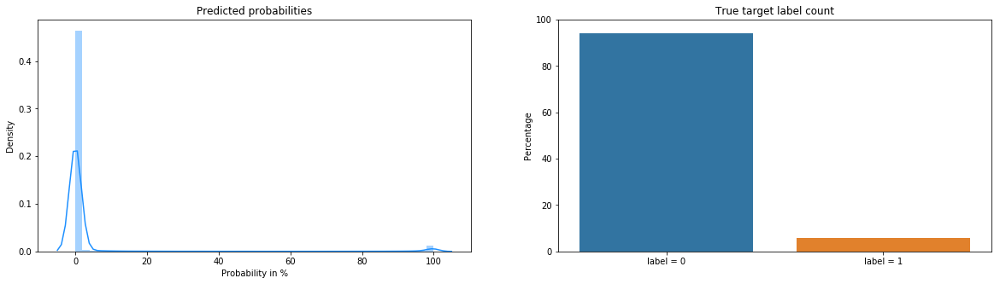

In [34]:
import seaborn as sns
one_hot = labels.sum() / (labels.shape[0]*labels.shape[1]) * 100
zero_hot = ((labels.shape[0]*labels.shape[1] - labels.sum()) / (labels.shape[0]*labels.shape[1])) * 100
print(one_hot, zero_hot, labels.sum(), labels.shape[0], labels.shape[1], labels.shape[0]*labels.shape[1])
fpredProbs = predProbs.reshape(-1)
fig, ax = plt.subplots(1,2, figsize=(20,5))
sns.distplot(fpredProbs * 100, color="DodgerBlue", ax=ax[0])
ax[0].set_xlabel("Probability in %")
ax[0].set_ylabel("Density")
ax[0].set_title("Predicted probabilities")
sns.barplot(x=["label = 0", "label = 1"], y=[zero_hot, one_hot], ax=ax[1])
ax[1].set_ylim([0,100])
ax[1].set_title("True target label count")
ax[1].set_ylabel("Percentage")

In [35]:
import numpy as np
import itertools
import matplotlib.pyplot as plt
eps = np.finfo(float).eps
def ml_confusion_matrix_counts(yt, yp, classes):
    instcount = yt.shape[0]
    n_classes = classes.shape[0]
    mt = np.zeros((n_classes, 4))
    mtx = np.zeros((n_classes, 7))
    for i in range(instcount):
        for c in range(n_classes):
            mt[c,0] += 1 if yt[i,c]==1 and yp[i,c]==1 else 0  #TP
            mt[c,1] += 1 if yt[i,c]==1 and yp[i,c]==0 else 0  #FN
            mt[c,2] += 1 if yt[i,c]==0 and yp[i,c]==0 else 0  #TN
            mt[c,3] += 1 if yt[i,c]==0 and yp[i,c]==1 else 0  #FP
    return mt

In [36]:
import numpy as np
import itertools
import matplotlib.pyplot as plt
eps = np.finfo(float).eps
def ml_confusion_matrix(yt, yp, classes):
    instcount = yt.shape[0]
    n_classes = classes.shape[0]
    mt = np.zeros((n_classes, 4))
    mtx = np.zeros((n_classes, 7))
    for i in range(instcount):
        for c in range(n_classes):
            mt[c,0] += 1 if yt[i,c]==1 and yp[i,c]==1 else 0  #TP
            mt[c,1] += 1 if yt[i,c]==1 and yp[i,c]==0 else 0  #FN
            mt[c,2] += 1 if yt[i,c]==0 and yp[i,c]==0 else 0  #TN
            mt[c,3] += 1 if yt[i,c]==0 and yp[i,c]==1 else 0  #FP
    for c in range(n_classes):
        mtx[c,0] = mt[c,0]/(mt[c,0] + mt[c,3]) if (mt[c,0] + mt[c,3]) > 0 else 0
        mtx[c,1] = mt[c,3]/(mt[c,0] + mt[c,3]) if (mt[c,0] + mt[c,3]) > 0 else 0
        mtx[c,2] = mt[c,1]/(mt[c,1] + mt[c,2]) if (mt[c,1] + mt[c,2]) > 0 else 0
        mtx[c,3] = mt[c,2]/(mt[c,1] + mt[c,2]) if (mt[c,1] + mt[c,2]) > 0 else 0
        mtx[c,4] = mt[c,0]/(mt[c,0] + mt[c,3]) if (mt[c,0] + mt[c,3]) > 0 else 0
        mtx[c,5] = mt[c,0]/(mt[c,0] + mt[c,1]) if (mt[c,0] + mt[c,1]) > 0 else 0
        mtx[c,6] = 2 * (mtx[c,4] * mtx[c,5])/(mtx[c,4] + mtx[c,5]) if (mtx[c,4] + mtx[c,5]) > 0 else 0
    return mtx

    


In [37]:
clss = np.array(list(label_names.values()))
n_classes = len(clss)


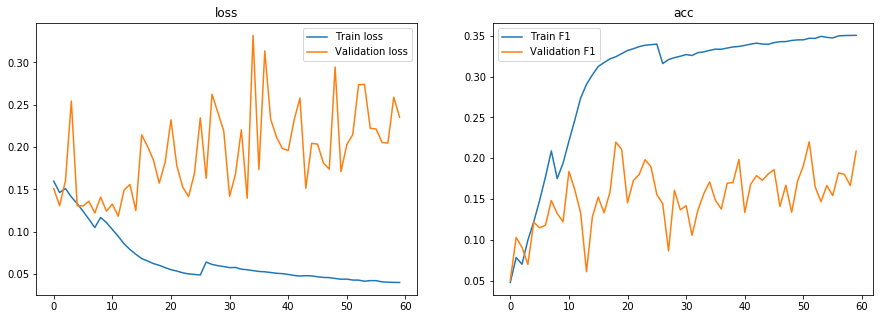

In [38]:
fig, ax = plt.subplots(1, 2, figsize=(15,5))
ax[0].set_title('loss')
ax[0].plot(hist2.epoch, hist2.history["loss"], label="Train loss")
ax[0].plot(hist2.epoch, hist2.history["val_loss"], label="Validation loss")
ax[1].set_title('acc')
ax[1].plot(hist2.epoch, hist2.history["f1"], label="Train F1")
ax[1].plot(hist2.epoch, hist2.history["val_f1"], label="Validation F1")
ax[0].legend()
ax[1].legend()

In [39]:
mtx = ml_confusion_matrix(labels, p, clss)
mt = ml_confusion_matrix_counts(labels, p, clss)


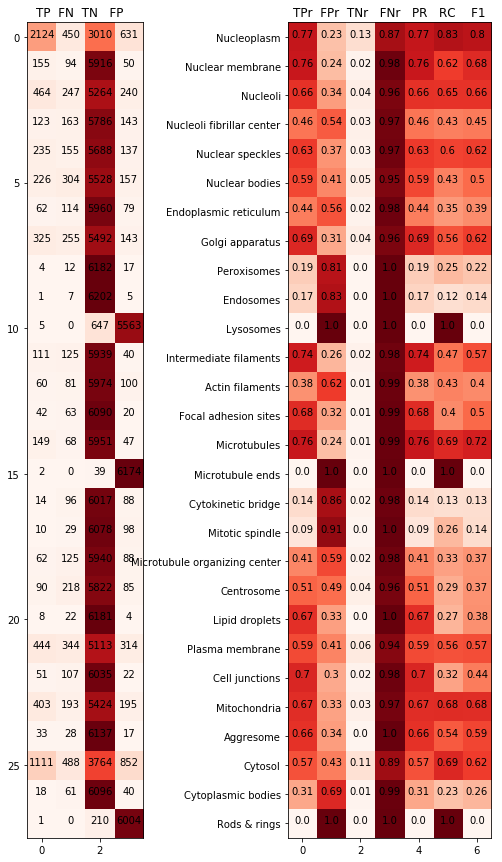

In [40]:

fig, ax = plt.subplots(1, 2, figsize=(10,15),facecolor='w', edgecolor='k')
tick_marks = np.arange(n_classes)
plt.yticks(tick_marks, clss)

ax[1].set_title("TPr  FPr  TNr   FNr   PR   RC    F1")
ax[1].imshow(mtx, interpolation='nearest',cmap='Reds')
ax[1].set_title("TPr  FPr  TNr   FNr   PR   RC    F1")
for i, j in itertools.product(range(n_classes), range(7)):
    ax[1].text(j, i, round(mtx[i][j],2), horizontalalignment="center")

ax[0].imshow(mt, interpolation='nearest',cmap='Reds')
ax[0].set_title("TP  FN  TN   FP   ")
for i, j in itertools.product(range(n_classes), range(4)):
    ax[0].text(j, i, int(mt[i][j]), horizontalalignment="center")


In [41]:
#mtx = ml_confusion_matrix(labels, p, clss)

#plt.figure(num=None, figsize=(5, 15), dpi=100, facecolor='w', edgecolor='k')
#plt.imshow(mtx, interpolation='nearest',cmap='Reds')
#plt.title("TPr  FPr  TNr   FNr   PR   RC    F1")
#tick_marks = np.arange(n_classes)
#plt.yticks(tick_marks, clss)
#for i, j in itertools.product(range(n_classes), range(7)):
#    plt.text(j, i, round(mtx[i][j],2), horizontalalignment="center")

    #plt.tight_layout()
#plt.ylabel('labels')
#plt.xlabel('Predicted')
#plt.show()


In [42]:
#mt = ml_confusion_matrix_counts(labels, p, clss)
#plt.figure(num=None, figsize=(8, 15), dpi=100, facecolor='w', edgecolor='k')
#plt.imshow(mt, interpolation='nearest',cmap='Reds')
#plt.title("TP  FN  TN   FP   ")
#tick_marks = np.arange(n_classes)
#plt.yticks(tick_marks, clss)
#for i, j in itertools.product(range(n_classes), range(4)):
#    plt.text(j, i, int(mt[i][j]), horizontalalignment="center")

    #plt.tight_layout()
#plt.ylabel('counts')
#plt.xlabel('Predicted')
#plt.show()


In [43]:
from scipy.misc import imread
def load_image(basepath, image_id):
    images = np.zeros(shape=(512,512,4))
    images[:,:,0] = imread(image_id + "_green" + ".png")
    images[:,:,1] = imread(image_id + "_red" + ".png")
    images[:,:,2] = imread(image_id + "_blue" + ".png")
    images[:,:,3] = imread(image_id + "_yellow" + ".png")

    return images



def make_image_row(image, subax, title):
    subax[0].imshow(image[:,:,0], cmap="Greens")
    subax[0].set_title(title)
    subax[1].imshow(image[:,:,1], cmap="Reds")
    subax[1].set_title("stained microtubules")
    subax[2].imshow(image[:,:,2], cmap="Blues")
    subax[2].set_title("stained nucleus")
    if (image.shape[2] == 4):
        subax[3].imshow(image[:,:,3], cmap="Oranges")
        subax[3].set_title("stained endoplasmatic reticulum")
    return subax
def make_title(lab):
    file_targets = [label_names[idx] for idx in range(28) if int(lab[idx]) ==1]
#    file_targets = np.where(lab[file_id] == 1)[0]
    title = " - "
    for n in file_targets:
        title += n + " - "
    return title

In [44]:
class TargetGroupIterator:
    
    def __init__(self, target_names, batch_size, basepath):
        self.target_names = target_names
        self.target_list = [reverse_train_labels[key] for key in target_names]
        self.batch_shape = (batch_size, 512, 512,4)
        self.basepath = basepath
        self.images_identifier = []
    
    def find_matching_data_entries(self):
        y = np.zeros(28)
        cnt = 0
        for key in self.target_list:
            y[int(key)] = 1
            cnt += 1
        for i in range(len(labelsTrain)):
            if ((int(np.dot(labelsTrain[i], y)) == cnt)):
                self.images_identifier.append(i)
        
#        self.images_identifier = train_labels[train_labels.check_col==1].Id.values
#        train_labels.drop("check_col", axis=1, inplace=True)
    
    def check_subset(self, targets):
        return np.where(set(targets).issubset(set(self.target_list)), 1, 0)
 #        return np.where(set(targets).issubset(set(self.target_list)), 1, 0)
    
    def get_loader(self):
        filenames = []
        idx = 0
        images = np.zeros(self.batch_shape)
        for image_id in self.images_identifier:
            images[idx,:,:,:] = load_image(self.basepath, pathsTrain[image_id])
            filenames.append(image_id)
            idx += 1
            if idx == self.batch_shape[0]:
                yield filenames, images
                filenames = []
                images = np.zeros(self.batch_shape)
                idx = 0
        if idx > 0:
            yield filenames, images

In [45]:
def getFailedPredImagesLabels(mdl, generator,numFailures, T):
    images = []
    labels = []
    ps = []
    cnt = 0
    j = 0
    while (cnt < numFailures):
        im, lbl = generator[j]
        scores = mdl.predict(im)
        p = np.array(scores>T, dtype=np.float)
        i = 0
        while i < len(lbl) and cnt < numFailures:
            if (np.dot(p[i], lbl[i]) == 0):
                images.append(im[i])
                ps.append(p[i])
                labels.append(lbl[i])
                cnt += 1
            i += 1
        j += 1
    return np.array(images),np.array(ps), np.array(labels)

def getNames(y):
    names = []
    for id in range(y.shape[0]):
        idNames = [label_names[idx] for idx in range(28) if y[id][idx] ==1]
        for aName in idNames:
            if aName not in names:
                names.append(aName)
    return list(names)
        

In [46]:
numFailures = 3
T = threshold
images, ps, trueLabels = getFailedPredImagesLabels(model, valGen,numFailures, T)


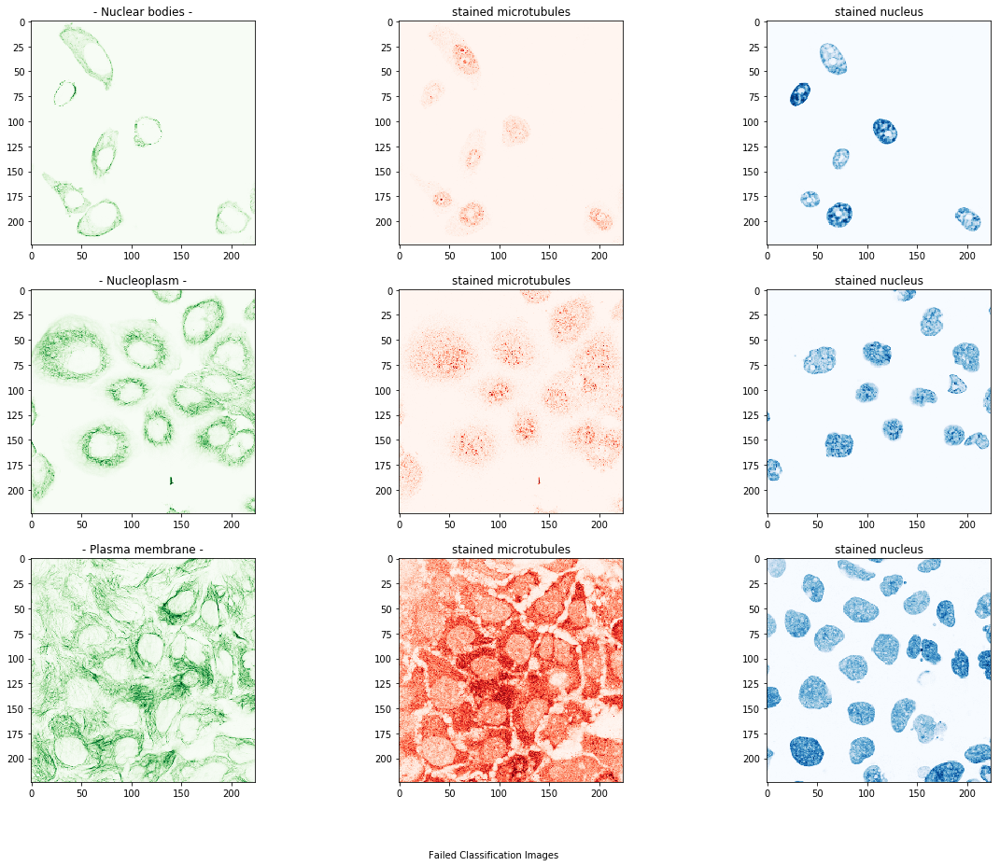

In [47]:

numChannels = images.shape[0]
fig, ax = plt.subplots(numFailures,numChannels,figsize=(20,5*numFailures))
fig.text(.5, .05, "Failed Classification Images", ha='center')
if ax.shape == (4,):
    ax = ax.reshape(1,-1)
for n in range(numFailures):
    make_image_row(images[n], ax[n], make_title(ps[n]))

    

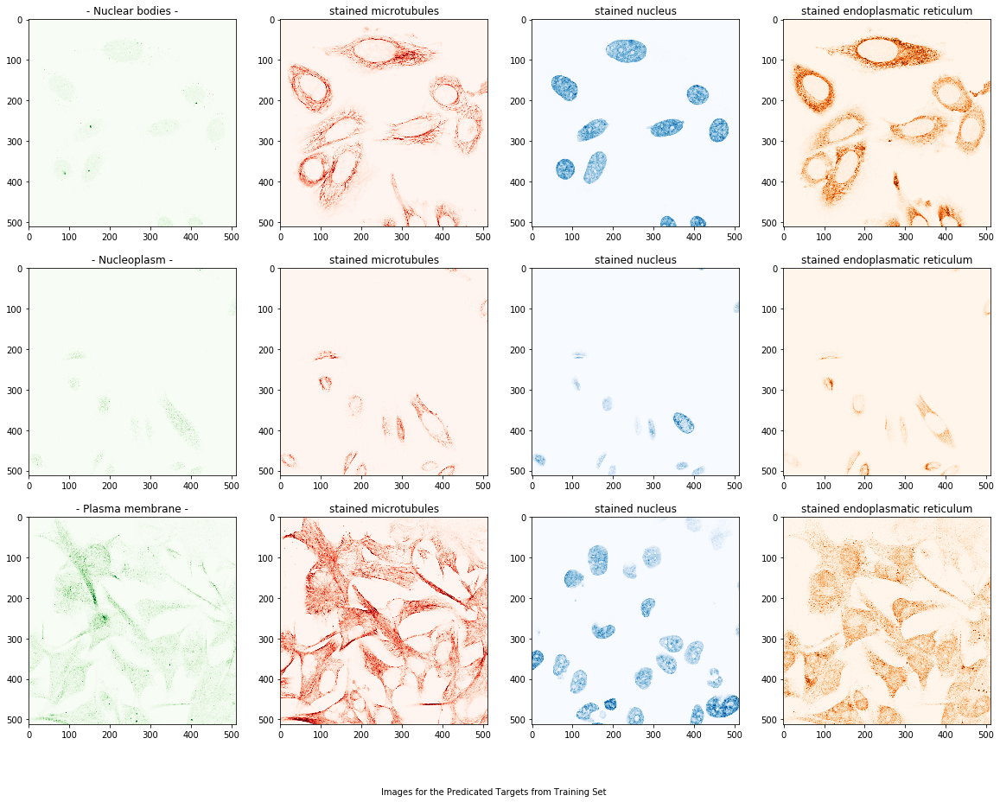

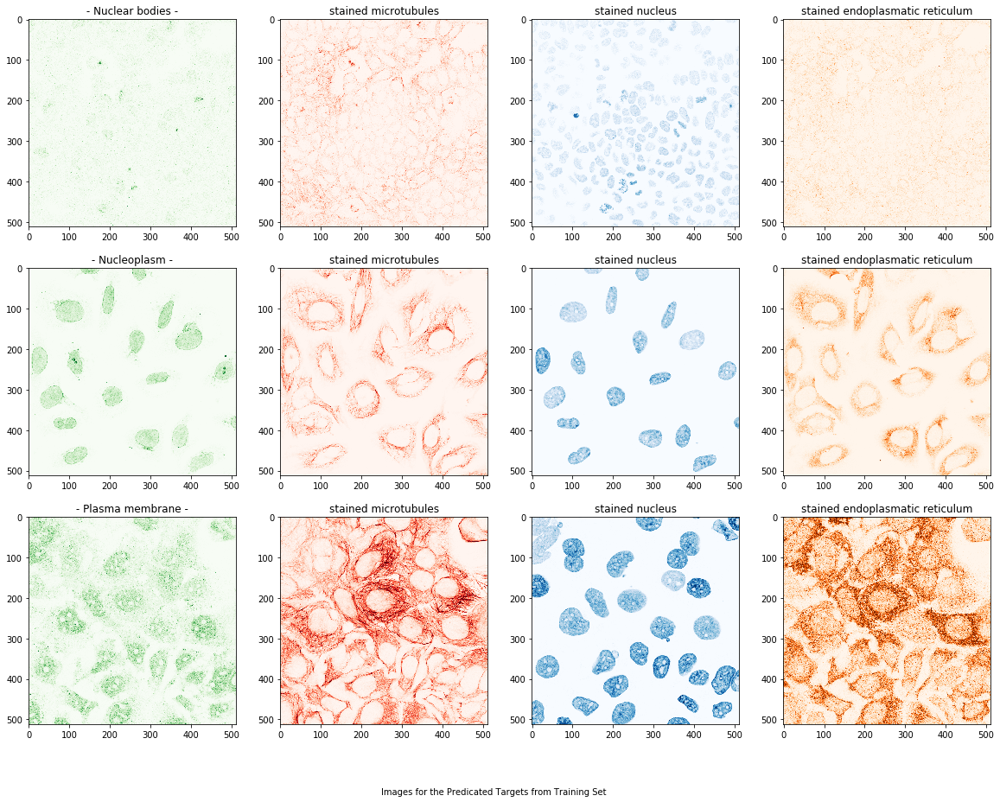

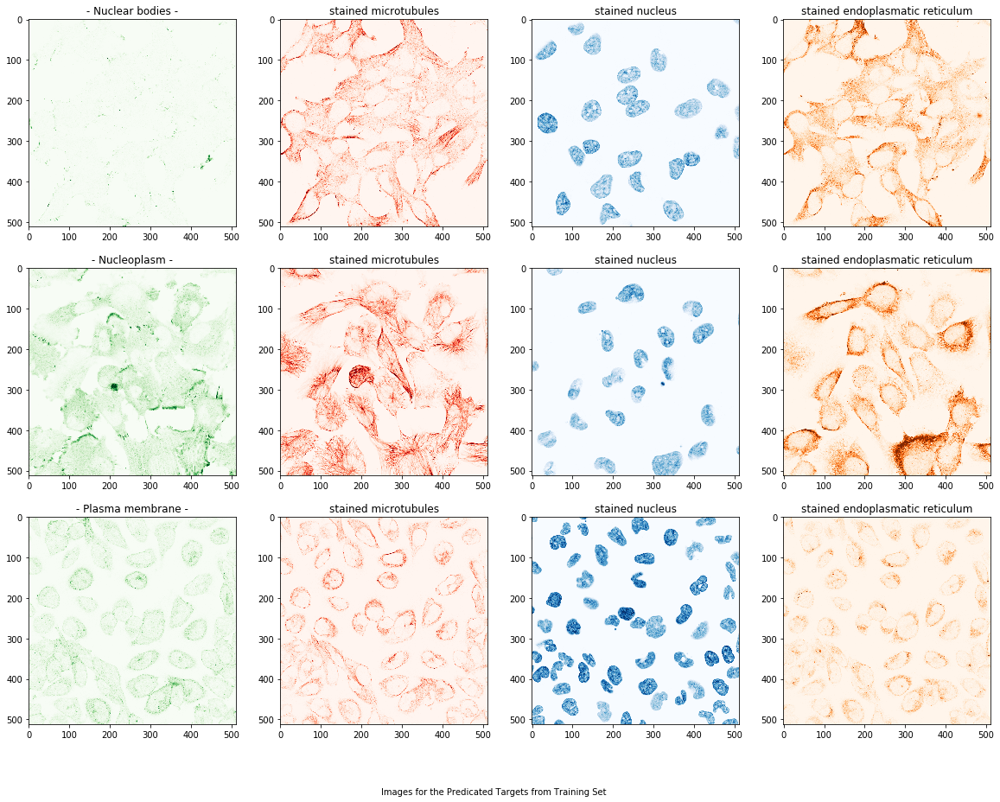

In [48]:
numImages = 3
numChannels =4
for i in range(numFailures):
    proteinNames = [label_names[idx] for idx in range(28) if ps[i][idx] ==1]
    imageloader = TargetGroupIterator(proteinNames,numImages , '../input/train')
    imageloader.find_matching_data_entries()
    iterator = imageloader.get_loader()
    file_ids, images = next(iterator)
    fig, ax = plt.subplots(numImages,numChannels,figsize=(20,5*numImages))
    txt = "Images for the Predicated Targets from Training Set"
    fig.text(.5, .05, txt, ha='center')
    if ax.shape == (4,):
        ax = ax.reshape(1,-1)
    for n in range(len(file_ids)):
        make_image_row(images[n], ax[n], make_title(ps[n]))

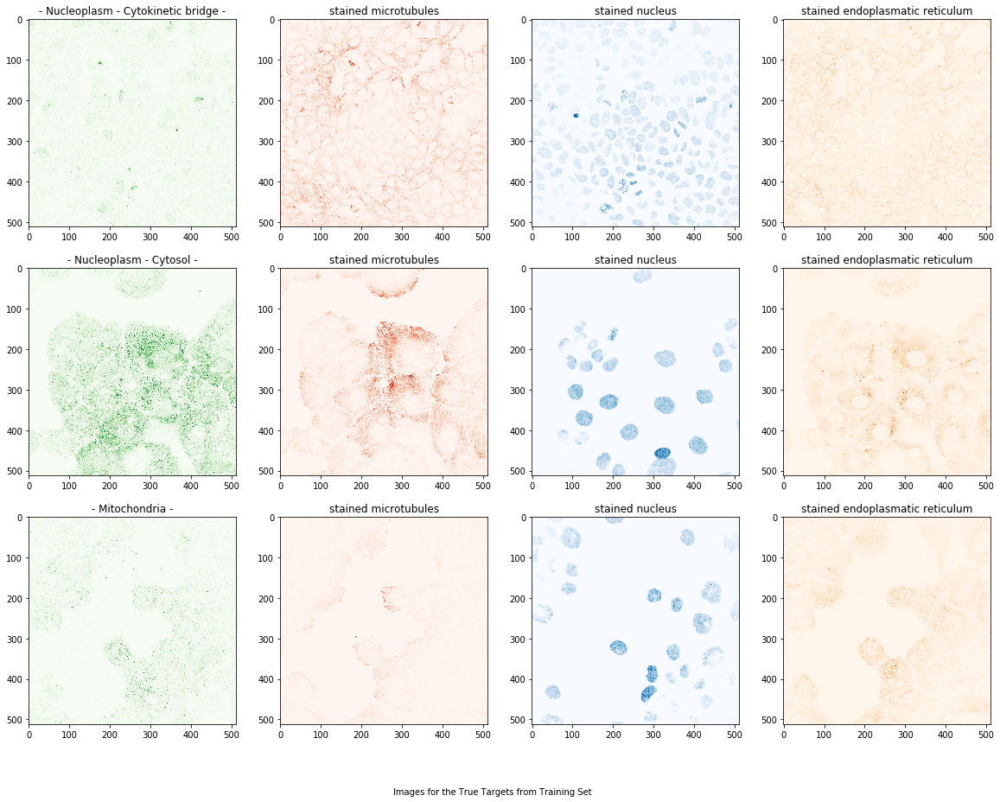

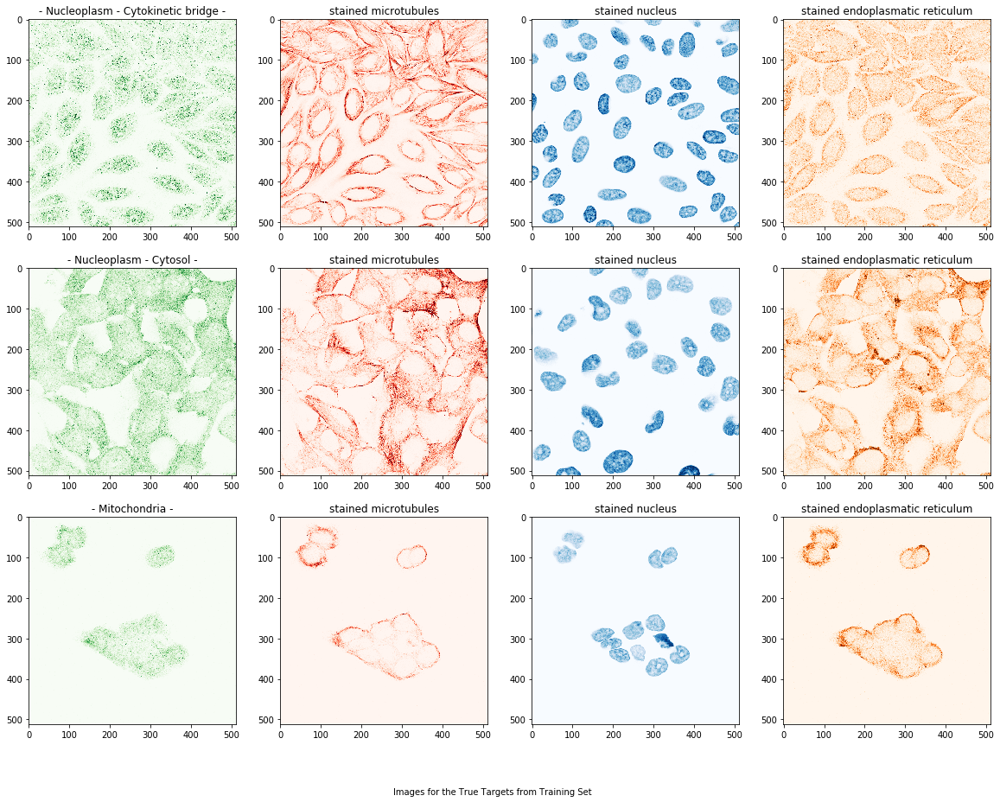

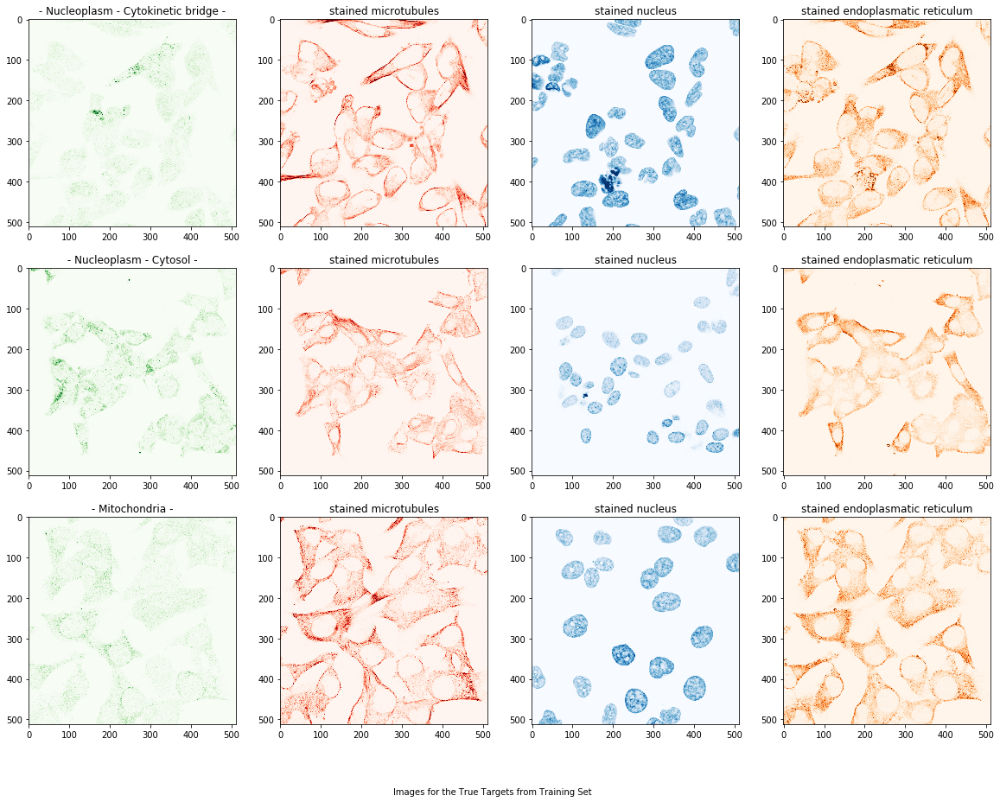

In [49]:
numImages = 3
numChannels =4
for i in range(numFailures):
    proteinNames = [label_names[idx] for idx in range(28) if labels[i][idx] ==1]
    imageloader = TargetGroupIterator(proteinNames,numImages , '../input/train')
    imageloader.find_matching_data_entries()
    iterator = imageloader.get_loader()
    file_ids, images = next(iterator)
    fig, ax = plt.subplots(numImages,numChannels,figsize=(20,5*numImages))
    txt = "Images for the True Targets from Training Set "
    fig.text(.5, .05, txt, ha='center')
    if ax.shape == (4,):
        ax = ax.reshape(1,-1)
    for n in range(len(file_ids)):
        make_image_row(images[n], ax[n], make_title(labels[n]))
        


In [50]:
# Better formatting needed hours, minutes, etc
done = time.time()
elapsed = done - start
print(int(elapsed/60), " minutes")

752  minutes


In [51]:
print("Summary Statistics")
print("F1 ", saveF1, "T ", saveT, "lr1 ",lr1, "lr2 ",lr2, "epochs1 ", epochs1, "epochs2 ", epochs2, "BATCH_SIZE ", BATCH_SIZE, "SHAPE ", SHAPE)

Summary Statistics
F1  0.42233170937091363 T  [0.258 0.046 0.102 0.161 0.091 0.187 0.059 0.218 0.003 0.004 0.    0.136
 0.07  0.494 0.183 0.    0.019 0.001 0.036 0.098 0.268 0.108 0.901 0.163
 0.039 0.007 0.026 0.   ] lr1  0.0001 lr2  0.0006 epochs1  2 epochs2  60 BATCH_SIZE  16 SHAPE  (224, 224, 3)
